# Data Analysis with the Ames Housing Data Set

## By Brice Walker

### Outline

- [Introduction](#intro)
- [Importing libraries](#libraries)
- [Importing the dataset](#data)
- [Initial exploratory analysis](#analysis)
- [Univariate analysis](#univariate)
- [Bivariate analysis](#bivariate)
- [Plotting the data](#plotting)
- [Cleaning the data](#cleaning)
- [Feature extraction and engineering](#features)
- [Checking assumptions](#assumptions)
- [Regression analysis](#regression)
    - [Linear regression](#linear)
    - [Ridge regression](#ridge-reg) 
    - [Lasso regression](#lasso-reg)
    - [ElasticNet regression](#enet)
    - [Stochastic Gradient Descent regression](#stochastic)
    - [Gradient Boosting regression](#gradboost)
    - [AdaBoost regression](#adaboost)
    - [XGBoost regression](#xgboost)
    - [Logistic regression](#log-reg)
    - [KNeighbors regression](#knn)
    - [Decision Tree regression](#tree)
    - [Random Forest regression](#forest)
    - [Extra Trees regression](#extra)
    - [Support Vector Machine regression](#svm)
    - [Kernel Ridge regression](#kernel)
- [Ensembling models](#ensemble-reg)
- [Exporting the final model](#exporting)


<a id='intro'></a>
## Introduction

This is a regression project completed on the Ames Housing Dataset discussed here at:

    https://ww2.amstat.org/publications/jse/v19n3/decock.pdf

This project attempts to predict sale prices of homes in Ames, Iowa. In this notebook, I run some exploratory data analysis and then clean the dataset, preparing it for predictive modeling. I then engineered better features out of the data and created several regression models. Finally, I created an ensemble model and submitted it to the Kaggle Competition at:

    https://www.kaggle.com/c/house-prices-advanced-regression-techniques
    
The Root Mean Squared Error Score that I got is: 0.12300

<a id='libraries'></a>
## Importing libraries

In [1]:
# Common imports
import pandas as pd
import numpy as np
import os
import pickle

import matplotlib.pyplot as plt

import seaborn as sns
color = sns.color_palette()
sns.set_style('darkgrid')

from math import sqrt
from scipy import stats
from scipy.stats import norm, skew
from scipy.stats.stats import pearsonr
from scipy.special import boxcox1p, inv_boxcox1p

from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler, MinMaxScaler

from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, make_scorer
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.externals import joblib

from sklearn.linear_model import LinearRegression, Ridge, RidgeCV, BayesianRidge, Lasso, LassoCV, ElasticNet, ElasticNetCV
from sklearn.linear_model import LogisticRegression, SGDRegressor, LassoLarsIC, LogisticRegressionCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor, GradientBoostingClassifier, AdaBoostClassifier, AdaBoostRegressor
from sklearn.ensemble import BaggingClassifier, BaggingRegressor, ExtraTreesClassifier, ExtraTreesRegressor, VotingClassifier
from sklearn.ensemble import IsolationForest, RandomForestClassifier, RandomForestRegressor, RandomTreesEmbedding
from sklearn.svm import SVR
from sklearn.kernel_ridge import KernelRidge
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.neural_network import MLPRegressor
import xgboost

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

C:\Users\brice\Anaconda3\lib\site-packages\sklearn\cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


In [2]:
np.random.seed(95) # Setting random seed so this notebook's results are reproducible.

<a id='data'></a>
## Reading the data

In [3]:
train = pd.read_csv('./input/train.csv')
test = pd.read_csv('./input/test.csv')

# Looking at our test set
test.head(5)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition
0,1461,20,RH,80.0,11622,Pave,NaN,Reg,Lvl,AllPub,...,120,0,NaN,MnPrv,NaN,0,6,2010,WD,Normal
1,1462,20,RL,81.0,14267,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,Gar2,12500,6,2010,WD,Normal
2,1463,60,RL,74.0,13830,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,MnPrv,NaN,0,3,2010,WD,Normal
3,1464,60,RL,78.0,9978,Pave,NaN,IR1,Lvl,AllPub,...,0,0,NaN,NaN,NaN,0,6,2010,WD,Normal
4,1465,120,RL,43.0,5005,Pave,NaN,IR1,HLS,AllPub,...,144,0,NaN,NaN,NaN,0,1,2010,WD,Normal


Dataframes are created for both the training and test data set.

<a id='analysis'></a>
## Initial Exploratory Analysis

In [4]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
Id               1460 non-null int64
MSSubClass       1460 non-null int64
MSZoning         1460 non-null object
LotFrontage      1201 non-null float64
LotArea          1460 non-null int64
Street           1460 non-null object
Alley            91 non-null object
LotShape         1460 non-null object
LandContour      1460 non-null object
Utilities        1460 non-null object
LotConfig        1460 non-null object
LandSlope        1460 non-null object
Neighborhood     1460 non-null object
Condition1       1460 non-null object
Condition2       1460 non-null object
BldgType         1460 non-null object
HouseStyle       1460 non-null object
OverallQual      1460 non-null int64
OverallCond      1460 non-null int64
YearBuilt        1460 non-null int64
YearRemodAdd     1460 non-null int64
RoofStyle        1460 non-null object
RoofMatl         1460 non-null object
Exterior1st      1460 non-n

There are 82 columns and 2051 rows in our data frame.

Getting a feel for our dataset, it looks like some columns like PolQC, Alley and MiscFeature have lots of missing values.

In [5]:
# Checking for duplicate rows
Un_ids = len(set(train.Id))
Tot_ids = train.shape[0]
Dup_ids = Tot_ids - Un_ids
print("There are " + str(Dup_ids) + " duplicate IDs for the " + str(Tot_ids) + " total entries in this data set.")

There are 0 duplicate IDs for the 1460 total entries in this data set.


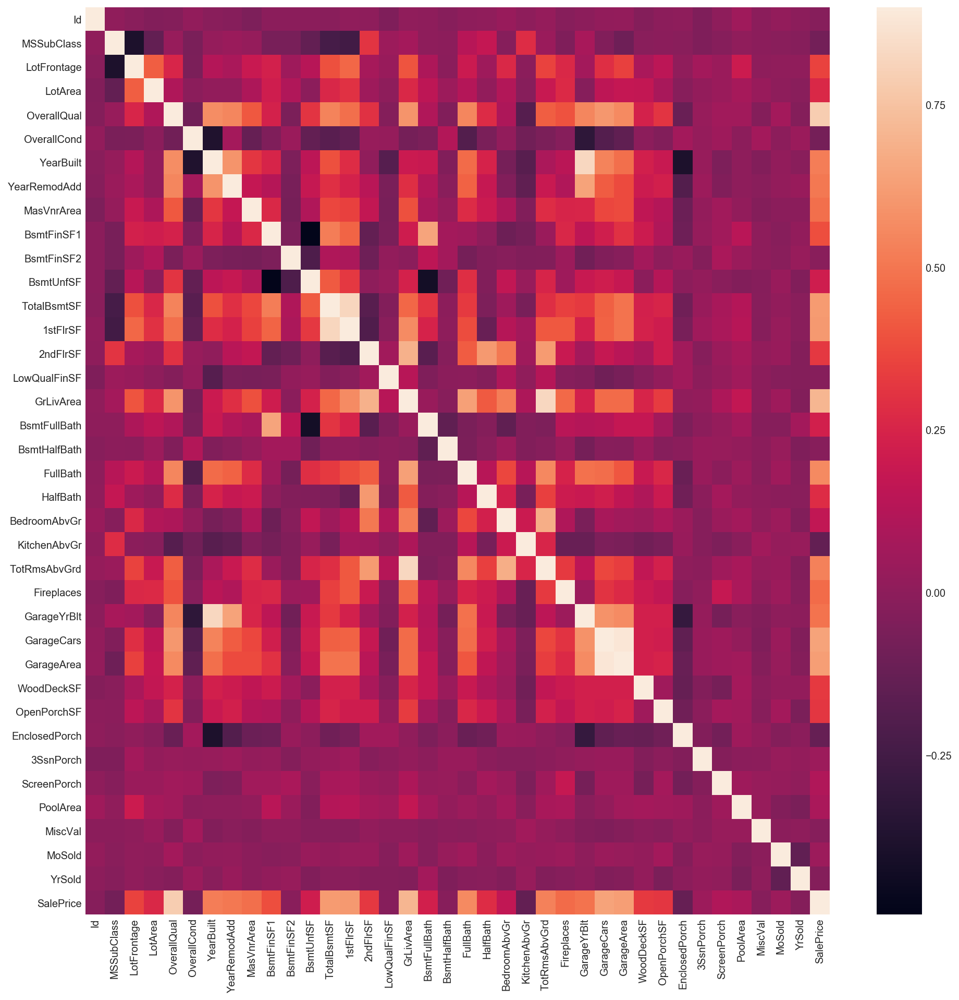

In [6]:
initial_heatmap = train.corr()
plt.subplots(figsize=(16,16))
sns.heatmap(initial_heatmap, vmax=0.9, square=False)

<a id='univariate'></a>
## Univariate Analysis

### Looking at 'SalePrice', our dependent variable for regression analysis.

In [7]:
train['SalePrice'].describe()

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

In [8]:
print("The median for Sale Price is: ", train['SalePrice'].median(axis = 0))

The median for Sale Price is:  163000.0


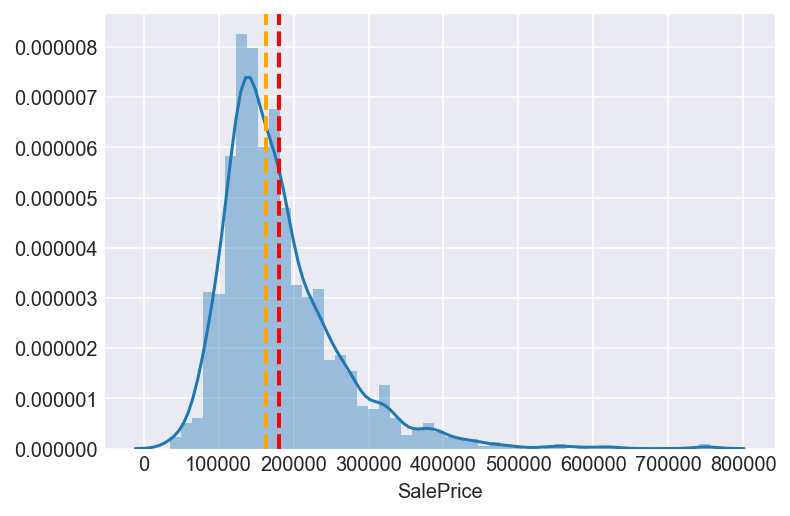

In [9]:
# Plotting SalePrice with the mean and median
sns.distplot(train['SalePrice']);
plt.axvline(train['SalePrice'].mean(), color='red', linestyle='dashed', linewidth=2)
plt.axvline(train['SalePrice'].median(), color='orange', linestyle='dashed', linewidth=2)

In [10]:
# This looks pretty skewed, so let's measure it:
print("Skewness for Sales Price: %f" % train['SalePrice'].skew())
print("Kurtosis for Sales Price: %f" % train['SalePrice'].kurt())

Skewness for Sales Price: 1.882876
Kurtosis for Sales Price: 6.536282


<a id='bivariate'></a>
## Bivariate Analysis

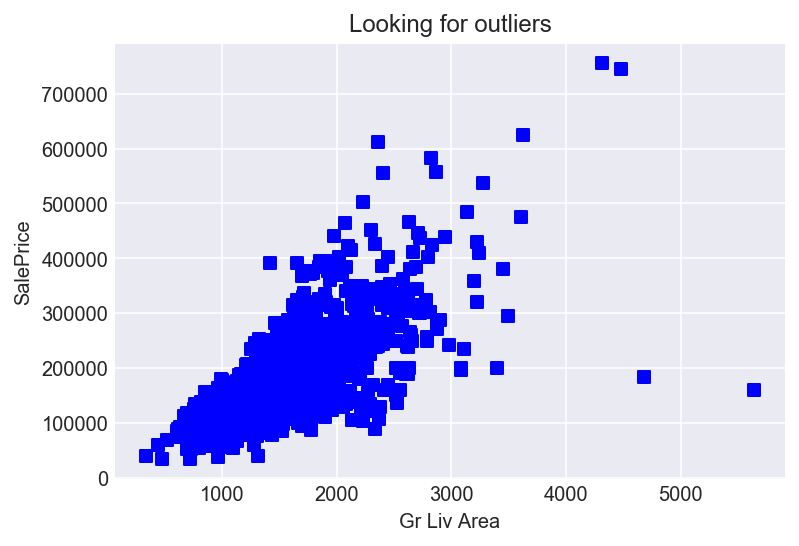

In [11]:
plt.scatter(train['GrLivArea'], train['SalePrice'], c = "blue", marker = "s")
plt.title("Looking for outliers")
plt.xlabel("Gr Liv Area")
plt.ylabel("SalePrice")
plt.show()

#### We have some outliers! The author of the original dataset recommends removing these outliers, stating:
    
    "I would recommend removing any houses with more than 4000 square feet from the data set..."
    
#### He further explains that these are in fact true outliers.
    
from: 

https://ww2.amstat.org/publications/jse/v19n3/decock.pdf

#### So, let's remove them from our dataset:

In [12]:
# Removing our outliers.
train = train[train['GrLivArea'] < 4000]

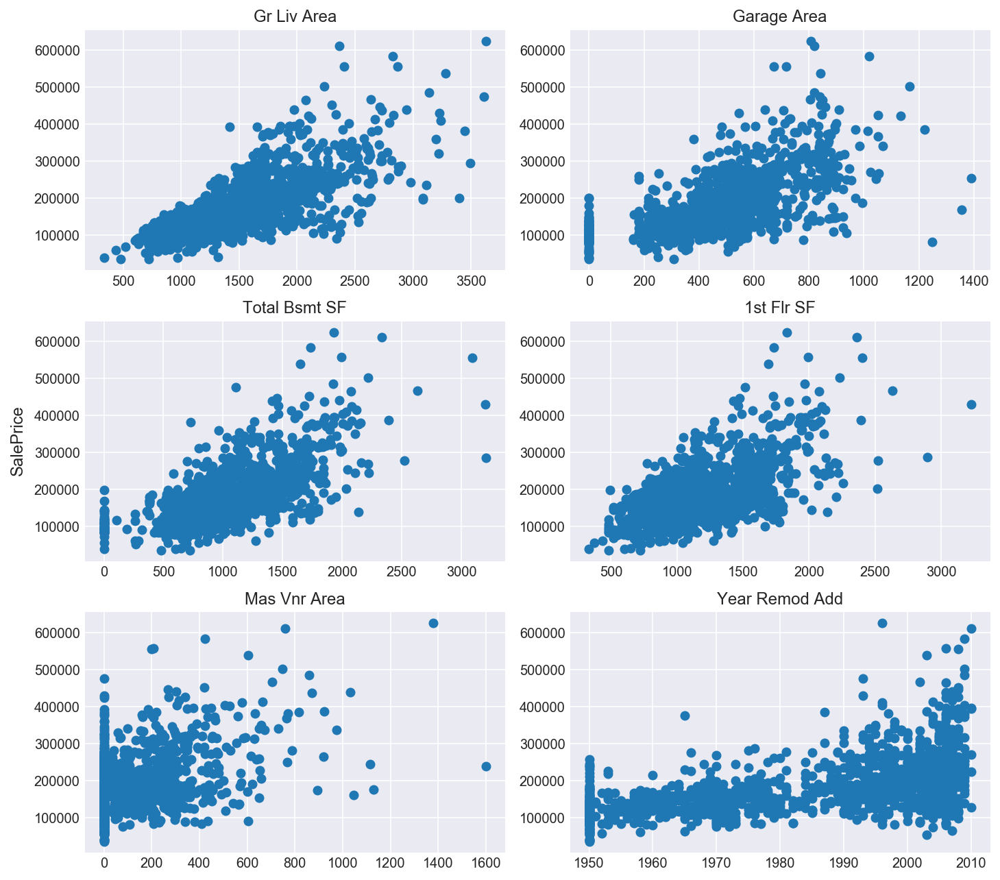

In [13]:
# Plotting some of the variables most correlated with Sale Price.
plt.figure(1)
f, ax1 = plt.subplots(3, 2, figsize=(10, 9))
price = train.SalePrice.values
ax1[0, 0].scatter(train['GrLivArea'].values, train['SalePrice'])
ax1[0, 0].set_title('Gr Liv Area')
ax1[0, 1].scatter(train['GarageArea'].values, train['SalePrice'])
ax1[0, 1].set_title('Garage Area')
ax1[1, 0].scatter(train['TotalBsmtSF'].values, train['SalePrice'])
ax1[1, 0].set_title('Total Bsmt SF')
ax1[1, 1].scatter(train['1stFlrSF'].values, train['SalePrice'])
ax1[1, 1].set_title('1st Flr SF')
ax1[2, 0].scatter(train['MasVnrArea'].values, train['SalePrice'])
ax1[2, 0].set_title('Mas Vnr Area')
ax1[2, 1].scatter(train['YearRemodAdd'].values, train['SalePrice'])
ax1[2, 1].set_title('Year Remod Add')
f.text(-0.01, 0.5, 'SalePrice', va='center', rotation='vertical', fontsize = 12)
plt.tight_layout()
plt.show()

We can see some general positive trends with these.

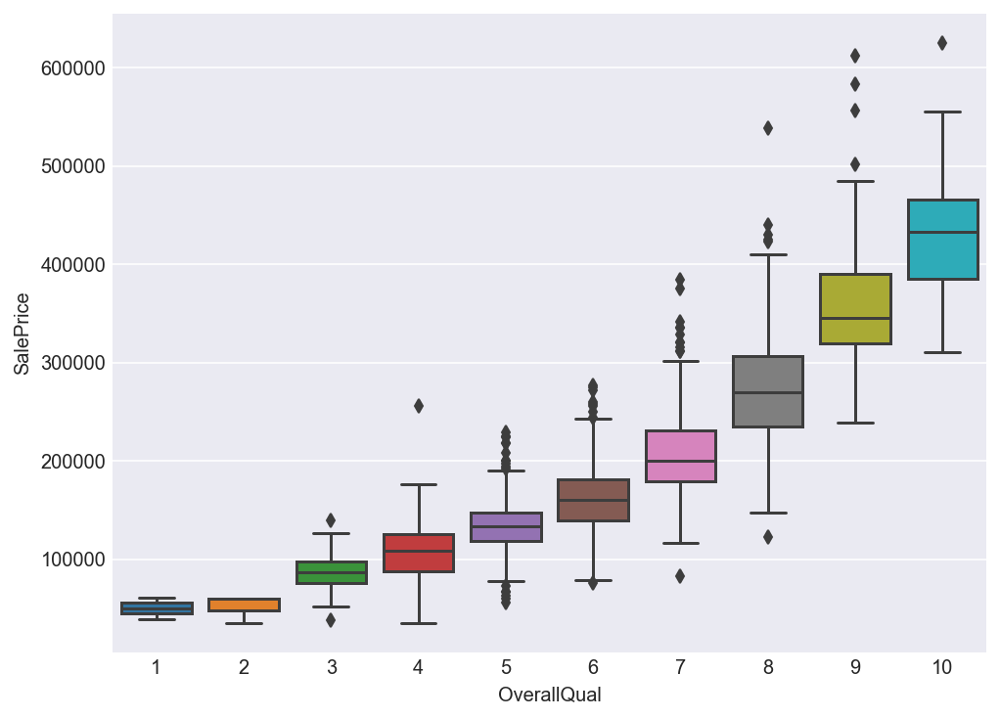

In [14]:
oq = 'OverallQual'
data = pd.concat([train['SalePrice'], train[oq]], axis=1)
f, ax = plt.subplots(figsize=(8, 6))
fig = sns.boxplot(x=oq, y="SalePrice", data=data)
fig.axis();

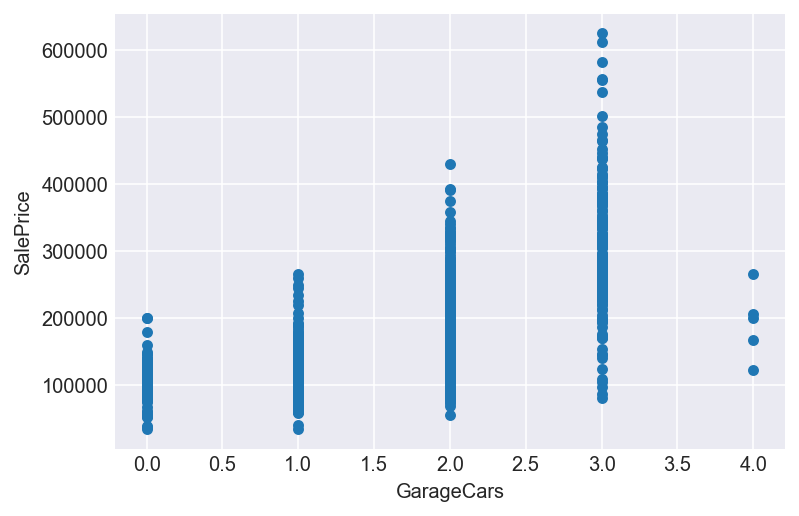

In [15]:
g_cars = 'GarageCars'
price_bsmt = pd.concat([train['SalePrice'], train[g_cars]], axis=1)
price_bsmt.plot.scatter(x=g_cars, y='SalePrice');

In [16]:
# Taking a look at the neighborhoods
train.groupby(['Neighborhood'])['SalePrice'].mean().sort_values(ascending=False)

Neighborhood
NridgHt    316270.623377
NoRidge    314028.410256
StoneBr    310499.000000
Timber     242247.447368
Veenker    238772.727273
Somerst    225379.837209
ClearCr    212565.428571
Crawfor    210624.725490
CollgCr    197965.773333
Blmngtn    194870.882353
Gilbert    192854.506329
NWAmes     189050.068493
SawyerW    186555.796610
Mitchel    156270.122449
NAmes      145847.080000
NPkVill    142694.444444
SWISU      142591.360000
Blueste    137500.000000
Sawyer     136793.135135
OldTown    128225.300885
Edwards    127318.571429
BrkSide    124834.051724
BrDale     104493.750000
IDOTRR     100123.783784
MeadowV     98576.470588
Name: SalePrice, dtype: float64

Wow! Some neighborhoods are much nicer than others.

In [17]:
# Checking out the building types.
train.groupby('BldgType')['SalePrice'].mean()

BldgType
1Fam      184857.808388
2fmCon    128432.258065
Duplex    133541.076923
Twnhs     135911.627907
TwnhsE    181959.342105
Name: SalePrice, dtype: float64

<a id='plotting'></a>
## Plotting the data

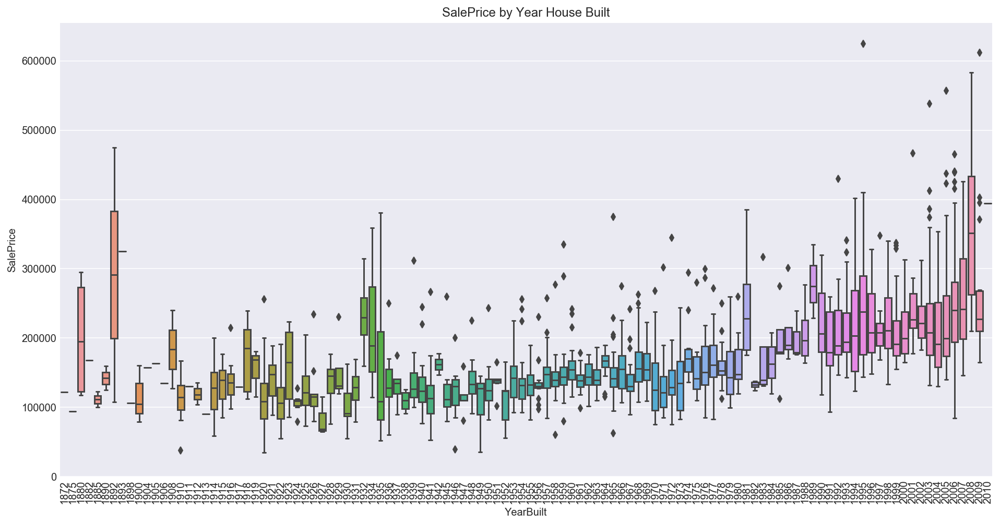

In [18]:
f, ax = plt.subplots(figsize=(16, 8))
fig = sns.boxplot(x='YearBuilt', y='SalePrice', data=train)
fig.axis(ymin=0);
plt.xticks(rotation=90);
plt.title("SalePrice by Year House Built");

There is a general trend upwards: Newer houses tend to be worth more.

<a id='cleaning'></a>
## Cleaning the data

### Combining both datasets for data cleaning and feature extraction.

In [19]:
# Separating out the dependent variables
ntrain = train.shape[0]
ntest = test.shape[0]
y_train = train['SalePrice']
# Creating a separate table for use in a logistic regression model for our regression analysis
y_log = y_train
# Saving and then droppping the Id Column
train_ID = train['Id']
test_ID = test['Id']
X_train = train.drop("Id", axis = 1)
X_test = test.drop("Id", axis = 1)
y_train.head(5)

0    208500
1    181500
2    223500
3    140000
4    250000
Name: SalePrice, dtype: int64

In [20]:
# Combinging the two datasets
df = pd.concat((X_train, X_test)).reset_index(drop=False)
#df.drop(['SalePrice'], axis=1, inplace=True)
df.head(5)

,index,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BldgType,BsmtCond,BsmtExposure,BsmtFinSF1,...,SaleType,ScreenPorch,Street,TotRmsAbvGrd,TotalBsmtSF,Utilities,WoodDeckSF,YearBuilt,YearRemodAdd,YrSold
0,0,856,854,0,NaN,3,1Fam,TA,No,706.0,...,WD,0,Pave,8,856.0,AllPub,0,2003,2003,2008
1,1,1262,0,0,NaN,3,1Fam,TA,Gd,978.0,...,WD,0,Pave,6,1262.0,AllPub,298,1976,1976,2007
2,2,920,866,0,NaN,3,1Fam,TA,Mn,486.0,...,WD,0,Pave,6,920.0,AllPub,0,2001,2002,2008
3,3,961,756,0,NaN,3,1Fam,Gd,No,216.0,...,WD,0,Pave,7,756.0,AllPub,0,1915,1970,2006
4,4,1145,1053,0,NaN,4,1Fam,TA,Av,655.0,...,WD,0,Pave,9,1145.0,AllPub,192,2000,2000,2008


In [21]:
print("Finding the features that are  most correlated with SalePrice for purposes of transformation:")
df.corr()['SalePrice'].abs().sort_values(ascending=False)

Finding the features that are  most correlated with SalePrice for purposes of transformation:


SalePrice        1.000000
OverallQual      0.800858
GrLivArea        0.720516
GarageCars       0.649256
TotalBsmtSF      0.646584
GarageArea       0.636964
1stFlrSF         0.625235
FullBath         0.559048
TotRmsAbvGrd     0.537462
YearBuilt        0.535279
YearRemodAdd     0.521428
GarageYrBlt      0.499230
MasVnrArea       0.478862
Fireplaces       0.466765
BsmtFinSF1       0.395923
LotFrontage      0.356773
OpenPorchSF      0.330361
WoodDeckSF       0.322538
2ndFlrSF         0.297301
HalfBath         0.282925
LotArea          0.269866
BsmtFullBath     0.235697
BsmtUnfSF        0.220678
BedroomAbvGr     0.160542
KitchenAbvGr     0.138849
EnclosedPorch    0.129774
ScreenPorch      0.118324
MSSubClass       0.088160
OverallCond      0.080202
MoSold           0.056797
3SsnPorch        0.047414
BsmtHalfBath     0.036792
PoolArea         0.032819
index            0.027455
LowQualFinSF     0.025351
YrSold           0.023694
MiscVal          0.021097
BsmtFinSF2       0.008900
Name: SalePr

### Replacing Missing Values

In [22]:
# Identifying missing values.
total = df.isnull().sum().sort_values(ascending=False)
percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['Total Missing Values', 'Percent of Data'])
missing_data.head(10)

,Total Missing Values,Percent of Data
PoolQC,2907,0.997256
MiscFeature,2810,0.963979
Alley,2717,0.932075
Fence,2345,0.804460
SalePrice,1459,0.500515
FireplaceQu,1420,0.487136
LotFrontage,486,0.166724
GarageYrBlt,159,0.054545
GarageQual,159,0.054545
GarageFinish,159,0.054545


Text(0.5,1,'Percentage of missing data by feature')

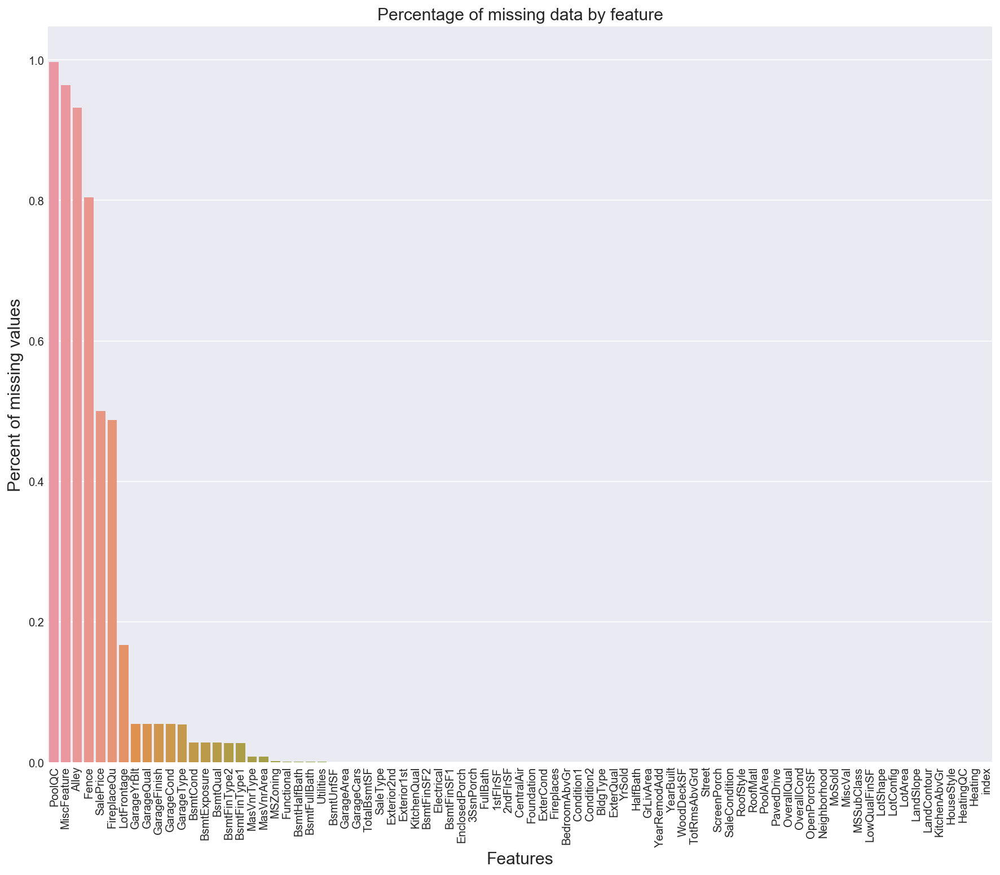

In [23]:
# Visualizing missing values.
f, ax = plt.subplots(figsize=(15, 12))
plt.xticks(rotation='90')
sns.barplot(x=percent.index, y=percent)
plt.xlabel('Features', fontsize=15)
plt.ylabel('Percent of missing values', fontsize=15)
plt.title('Percentage of missing data by feature', fontsize=15)

Wow! There are a lot of missing values for Pool QC. This makes sense as most houses do not have a pool. In fact, we can make the assumption that the missing values for most categories are due to the instance not having that feature. 

** Note: It is also reasonable to assume that Garage Yr Blt would be equal to the year the house was built.

In [24]:
# Replacing missing values for every column except Lot Frontage with the an appropriate value: 
# 0 for numeric and No/None for categorical
df = df.fillna({
    'Alley': 'None',
    'MasVnrType' : 'None',
    'PoolQC' : 'No',
    'MiscFeature': 'No',
    'Fence': 'No',
    'FireplaceQu': 'No',
    'GarageCond': 'No',
    'GarageFinish': 'No',
    'GarageQual' : 'No',
    'GarageType' : 'No',
    'BsmtExposure' : 'No',
    'BsmtFinType1' : 'No',
    'BsmtFinType2' : 'No',
    'BsmtCond' : 'No',
    'BsmtQual' : 'No',
    'MasVnrArea' : 0,
    'BsmtHalfBath'   : 0,
    'BsmtFullBath' : 0,
    'GarageCars'   : 0,
    'GarageArea' : 0,
    'TotalBsmtSF'   : 0,
    'BsmtUnfSF' : 0,
    'BsmtFinSF1'   : 0,
    'BsmtFinSF2' : 0,
    'GarageYrBlt': 0,
    'MSZoning': 'RL',
    'Functional': 'Typ',
    'KitchenQual': 'Ta',
    'Exterior1st': 'VinylSd',
    'Exterior2nd': 'VinylSd',
    'SaleType': 'WD',
    'SaleCondition': 'Normal',
    'Utilities' : 'AllPub',
    'Electrical' : 'SBrkr'
})

In [25]:
# Filling nulls for Basement variables
df.loc[df.BsmtFinSF1.isnull(), 'BsmtFinSF1'] = df.BsmtFinSF1.median()

In [26]:
# Filling nulls for Garage variables
df.loc[df['GarageArea'].isnull(), 'GarageArea'] = df.loc[df['GarageType']=='Detchd', 'GarageArea'].mean()
df.loc[df['GarageCars'].isnull(), 'GarageCars'] = df.loc[df['GarageType']=='Detchd', 'GarageCars'].median()

In [27]:
# Replacing missing values for Lot Frontage with the mean value for the neighborhood the house is in.
df["LotFrontage"] = df.groupby("Neighborhood")["LotFrontage"].transform(lambda x: x.fillna(x.median()))
total = df.isnull().sum().sort_values(ascending=False)
total.head(5)

SalePrice        1459
Foundation          0
EnclosedPorch       0
ExterCond           0
ExterQual           0
dtype: int64

In [28]:
# Capturing the stragglers that couldn't be transformed based on their neighborhoods
df["LotFrontage"] = df["LotFrontage"].transform(lambda x: x.fillna(x.mean()))

<a id='features'></a>
## Feature Engineering

### Aggregate Variables

In [29]:
# Creating an aggregate variable for Total Sqaure Feet.
df['TotalSF'] = (df['TotalBsmtSF'] + df['1stFlrSF'] + df['2ndFlrSF'] + df['WoodDeckSF'] + df['OpenPorchSF']).astype(int)

### Refactoring Variables

In [30]:
newer_dwelling = df.MSSubClass.replace({20: 1, 
                                        30: 0, 
                                        40: 0, 
                                        45: 0,
                                        50: 0, 
                                        60: 1,
                                        70: 0,
                                        75: 0,
                                        80: 0,
                                        85: 0,
                                        90: 0,
                                        120: 1,
                                        150: 0,
                                        160: 0,
                                        180: 0,
                                        190: 0})
newer_dwelling.name = 'newer_dwelling'

In [31]:
# Turning MS SubClass and Mo Sold into categorical variables.
df = df.replace({
    "MSSubClass" : {20 : "SC20", 30 : "SC30", 40 : "SC40", 45 : "SC45", 50 : "SC50", 60 : "SC60", 70 : "SC70",
                     75 : "SC75", 80 : "SC80", 85 : "SC85", 90 : "SC90", 120 : "SC120", 150 : "SC150", 160 : "SC160",
                     180 : "SC180", 190 : "SC190"},
    "MoSold" : {1 : "Jan", 2 : "Feb", 3 : "Mar", 4 : "Apr", 5 : "May", 6 : "Jun", 7 : "Jul", 8 : "Aug", 9 : "Sep",
                 10 : "Oct", 11 : "Nov", 12 : "Dec"}
})

# Turning Year sold into a categorical variable.
df['YrSold'] = df['YrSold'].astype(str)

In [32]:
# Numerically encoding categorical variables where order might be inherent.
df = df.replace({
    "Alley" : {"None" : 0, "Grvl" : 1, "Pave" : 2},
    "BsmtCond" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "BsmtExposure" : {"No" : 0, "Mn" : 1, "Av": 2, "Gd" : 3},
    "BsmtFinType1" : {"No" : 0, "Unf" : 1, "LwQ": 2, "Rec" : 3, "BLQ" : 4, "ALQ" : 5, "GLQ" : 6},
    "BsmtFinType2" : {"No" : 0, "Unf" : 1, "LwQ": 2, "Rec" : 3, "BLQ" : 4, "ALQ" : 5, "GLQ" : 6},
    "BsmtQual" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA": 3, "Gd" : 4, "Ex" : 5},
    "ExterCond" : {"Po" : 0, "Fa" : 1, "TA": 2, "Gd": 3, "Ex" : 4},
    "ExterQual" : {"Po" : 0, "Fa" : 1, "TA": 2, "Gd": 3, "Ex" : 4},
    "FireplaceQu" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "Functional" : {"Sal" : 0, "Sev" : 1, "Maj2" : 2, "Maj1" : 3, "Mod": 4, "Min2" : 5, "Min1" : 6, "Typ" : 7},
    "GarageCond" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "GarageQual" : {"No" : 0, "Po" : 1, "Fa" : 2, "TA" : 3, "Gd" : 4, "Ex" : 5},
    "HeatingQC" : {"Po" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
    "KitchenQual" : {"Po" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
    "LandSlope" : {"Sev" : 0, "Mod" : 1, "Gtl" : 2},
    "LotShape" : {"IR3" : 0, "IR2" : 1, "IR1" : 2, "Reg" : 3},
    "PavedDrive" : {"None" : 0, "P" : 1, "Y" : 2},
    "PoolQC" : {"No" : 0, "Fa" : 1, "TA" : 2, "Gd" : 3, "Ex" : 4},
    "Street" : {"Grvl" : 0, "Pave" : 1},
    "Utilities" : {"ELO" : 0, "NoSeWa" : 1, "NoSewr" : 2, "AllPub" : 3},
    "Fence" : {'NoFence': 0, 'MnWw': 1, 'MnPrv': 2, 'GdWo': 3, 'GdPrv': 4}
})

In [33]:
# Numerically encoding some Yes/No variables.
df = df.replace({'CentralAir': {'Y': 1, 'N': 0}})
df = df.replace({'PavedDrive': {'Y': 1, 'P': 0, 'N': 0}})

### Simplifying Variables

In [34]:
# Creating some aggregate variables measuring condition qualities.
overall_poor_qu = df.OverallQual.copy()
overall_poor_qu = 5 - overall_poor_qu
overall_poor_qu[overall_poor_qu<0] = 0
overall_poor_qu.name = 'overall_poor_qu'

overall_good_qu = df.OverallQual.copy()
overall_good_qu = overall_good_qu - 5
overall_good_qu[overall_good_qu<0] = 0
overall_good_qu.name = 'overall_good_qu'

overall_poor_cond = df.OverallCond.copy()
overall_poor_cond = 5 - overall_poor_cond
overall_poor_cond[overall_poor_cond<0] = 0
overall_poor_cond.name = 'overall_poor_cond'

overall_good_cond = df.OverallCond.copy()
overall_good_cond = overall_good_cond - 5
overall_good_cond[overall_good_cond<0] = 0
overall_good_cond.name = 'overall_good_cond'

exter_poor_qu = df.ExterQual.copy()
exter_poor_qu[exter_poor_qu<3] = 1
exter_poor_qu[exter_poor_qu>=3] = 0
exter_poor_qu.name = 'exter_poor_qu'

exter_good_qu = df.ExterQual.copy()
exter_good_qu[exter_good_qu<=3] = 0
exter_good_qu[exter_good_qu>3] = 1
exter_good_qu.name = 'exter_good_qu'

exter_poor_cond = df.ExterCond.copy()
exter_poor_cond[exter_poor_cond<3] = 1
exter_poor_cond[exter_poor_cond>=3] = 0
exter_poor_cond.name = 'exter_poor_cond'

exter_good_cond = df.ExterCond.copy()
exter_good_cond[exter_good_cond<=3] = 0
exter_good_cond[exter_good_cond>3] = 1
exter_good_cond.name = 'exter_good_cond'

bsmt_poor_cond = df.BsmtCond.copy()
bsmt_poor_cond[bsmt_poor_cond<3] = 1
bsmt_poor_cond[bsmt_poor_cond>=3] = 0
bsmt_poor_cond.name = 'bsmt_poor_cond'

bsmt_good_cond = df.BsmtCond.copy()
bsmt_good_cond[bsmt_good_cond<=3] = 0
bsmt_good_cond[bsmt_good_cond>3] = 1
bsmt_good_cond.name = 'bsmt_good_cond'

garage_poor_qu = df.GarageQual.copy()
garage_poor_qu[garage_poor_qu<3] = 1
garage_poor_qu[garage_poor_qu>=3] = 0
garage_poor_qu.name = 'garage_poor_qu'

garage_good_qu = df.GarageQual.copy()
garage_good_qu[garage_good_qu<=3] = 0
garage_good_qu[garage_good_qu>3] = 1
garage_good_qu.name = 'garage_good_qu'

garage_poor_cond = df.GarageCond.copy()
garage_poor_cond[garage_poor_cond<3] = 1
garage_poor_cond[garage_poor_cond>=3] = 0
garage_poor_cond.name = 'garage_poor_cond'

garage_good_cond = df.GarageCond.copy()
garage_good_cond[garage_good_cond<=3] = 0
garage_good_cond[garage_good_cond>3] = 1
garage_good_cond.name = 'garage_good_cond'

In [35]:
# Creating a dataframe for our new variables.
qu_list = pd.concat((overall_poor_qu, overall_good_qu, overall_poor_cond, overall_good_cond, exter_poor_qu,
                     exter_good_qu, exter_poor_cond, exter_good_cond, bsmt_poor_cond, bsmt_good_cond, garage_poor_qu,
                     garage_good_qu, garage_poor_cond, garage_good_cond), axis=1)

In [36]:
# Creating some more aggregate variables.
MasVnrType_Any = df.MasVnrType.replace({'BrkCmn': 1,
                                        'BrkFace': 1,
                                        'CBlock': 1,
                                        'Stone': 1,
                                        'None': 0})
MasVnrType_Any.name = 'MasVnrType_Any'

SaleCondition_PriceDown = df.SaleCondition.replace({'Abnorml': 1,
                                                    'Alloca': 1,
                                                    'AdjLand': 1,
                                                    'Family': 1,
                                                    'Normal': 0,
                                                    'Partial': 0})
SaleCondition_PriceDown.name = 'SaleCondition_PriceDown'

season = df.MoSold.replace({1: 0, 
                            2: 0, 
                            3: 0, 
                            4: 1,
                            5: 1, 
                            6: 1,
                            7: 1,
                            8: 0,
                            9: 0,
                            10: 0,
                            11: 0,
                            12: 0})
season.name = 'season'

In [37]:
# Separating out the high end neighborhoods.
Neighborhood_Good = pd.DataFrame(np.zeros((df.shape[0],1)), columns=['Neighborhood_Good'])
Neighborhood_Good[df.Neighborhood=='NridgHt'] = 1
Neighborhood_Good[df.Neighborhood=='Crawfor'] = 1
Neighborhood_Good[df.Neighborhood=='StoneBr'] = 1
Neighborhood_Good[df.Neighborhood=='Somerst'] = 1
Neighborhood_Good[df.Neighborhood=='NoRidge'] = 1

In [38]:
df = pd.concat((df, newer_dwelling, season, qu_list, MasVnrType_Any,), axis=1)

## Transformation

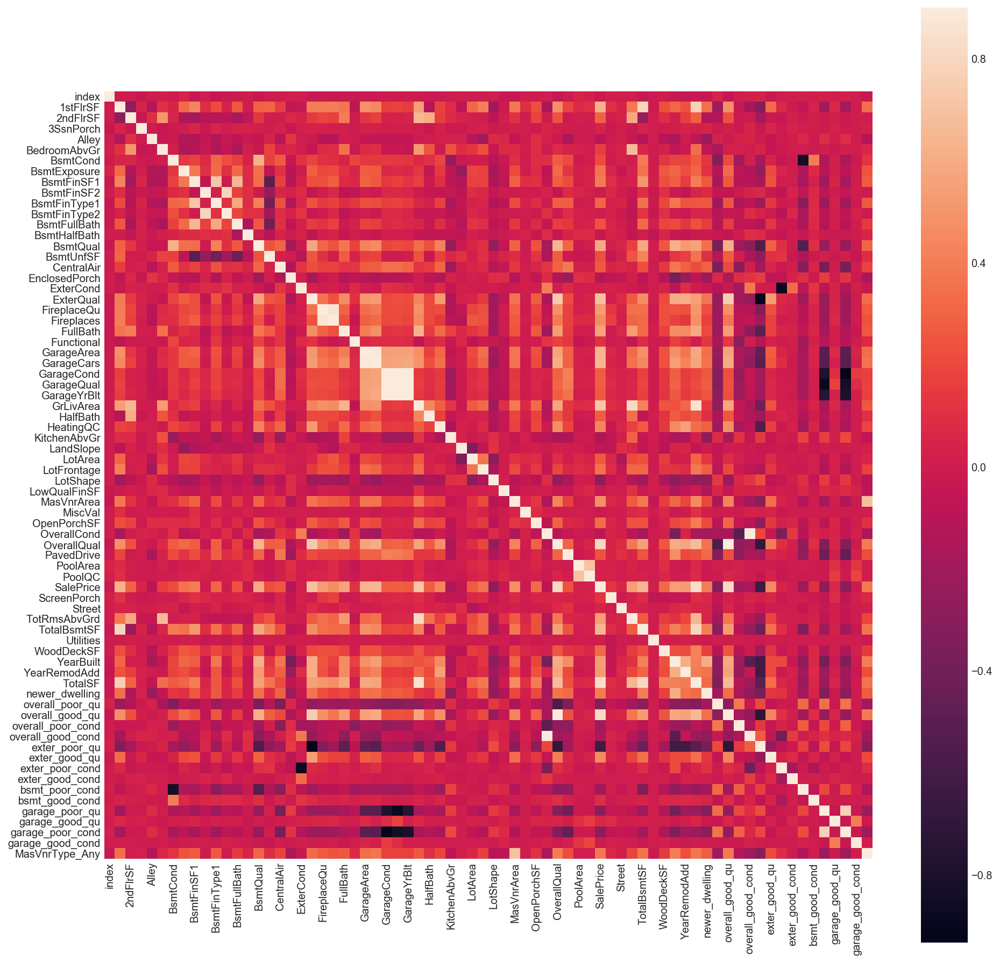

In [39]:
# Identifying correlations after the refactoring
heatmap = df.corr()
plt.subplots(figsize=(16,16))
sns.heatmap(heatmap, vmax=0.9, square=True)

In [40]:
print("Finding the features that are  most correlated with SalePrice for purposes of transformation:")
train.corr()['SalePrice'].abs().sort_values(ascending=False)

Finding the features that are  most correlated with SalePrice for purposes of transformation:


SalePrice        1.000000
OverallQual      0.800858
GrLivArea        0.720516
GarageCars       0.649256
TotalBsmtSF      0.646584
GarageArea       0.636964
1stFlrSF         0.625235
FullBath         0.559048
TotRmsAbvGrd     0.537462
YearBuilt        0.535279
YearRemodAdd     0.521428
GarageYrBlt      0.499230
MasVnrArea       0.478862
Fireplaces       0.466765
BsmtFinSF1       0.395923
LotFrontage      0.356773
OpenPorchSF      0.330361
WoodDeckSF       0.322538
2ndFlrSF         0.297301
HalfBath         0.282925
LotArea          0.269866
BsmtFullBath     0.235697
BsmtUnfSF        0.220678
BedroomAbvGr     0.160542
KitchenAbvGr     0.138849
EnclosedPorch    0.129774
ScreenPorch      0.118324
MSSubClass       0.088160
OverallCond      0.080202
MoSold           0.056797
3SsnPorch        0.047414
BsmtHalfBath     0.036792
PoolArea         0.032819
Id               0.027455
LowQualFinSF     0.025351
YrSold           0.023694
MiscVal          0.021097
BsmtFinSF2       0.008900
Name: SalePr

### Extracting Features

In [41]:
# Separating out the numerical and categorical variables.
all_feat = df.select_dtypes(include = ['object', 'int64', 'float64']).columns
cat_feat = df.select_dtypes(include = ['object']).columns
num_feat = df.select_dtypes(exclude = ["object"]).columns
num_feat = num_feat.drop("SalePrice")
print("Numerical features : " + str(len(num_feat)))
print("Categorical features : " + str(len(cat_feat)))
cat_feat

Numerical features : 71
Categorical features : 27


Index(['BldgType', 'Condition1', 'Condition2', 'Electrical', 'Exterior1st',
       'Exterior2nd', 'Fence', 'Foundation', 'GarageFinish', 'GarageType',
       'Heating', 'HouseStyle', 'KitchenQual', 'LandContour', 'LotConfig',
       'MSSubClass', 'MSZoning', 'MasVnrType', 'MiscFeature', 'MoSold',
       'Neighborhood', 'RoofMatl', 'RoofStyle', 'SaleCondition', 'SaleType',
       'YrSold', 'season'],
      dtype='object')

##### Getting Dummies

In [42]:
df = pd.get_dummies(df)
df.head(5)

,index,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
0,0,856,854,0,0,3,3,0,706.0,0.0,...,0,1,0,0,0,0,0,0,0,0
1,1,1262,0,0,0,3,3,3,978.0,0.0,...,0,0,0,0,0,0,1,0,0,0
2,2,920,866,0,0,3,3,1,486.0,0.0,...,0,0,0,0,0,0,0,0,0,1
3,3,961,756,0,0,3,4,0,216.0,0.0,...,0,1,0,0,0,0,0,0,0,0
4,4,1145,1053,0,0,4,3,2,655.0,0.0,...,1,0,0,0,0,0,0,0,0,0


In [43]:
# Creating individual dataframes for categorical and numerical values.
df_num = df[num_feat]
cat_cols = [col for col in df.columns if col not in num_feat]
df_dum = df[cat_cols]
df_dummies = df_dum.drop(['SalePrice'], axis=1)
df_dummies.head(5)

,BldgType_1Fam,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,Condition1_Artery,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
0,1,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
1,1,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,0
2,1,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1
3,1,0,0,0,0,0,0,1,0,0,...,0,1,0,0,0,0,0,0,0,0
4,1,0,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,0,0,0


##### Creating Polynomial Features

In [44]:
# Creating polynomial features up to a degree of 3 for all numerical features.
pf = PolynomialFeatures(degree=2, include_bias=True)
poly = pf.fit_transform(df_num)
poly2 = pf.get_feature_names(df_num.columns)
poly2

df_poly = pd.DataFrame(poly, columns = poly2)
# df_poly.drop(['index'], axis=1, inplace=True)
print("Numerical features : " + str(len(df_poly.columns)))

Numerical features : 2628


#### Fixing the skewed features

In [45]:
# Checking the skew of all numerical features
poly_num_feat = df_poly.select_dtypes(exclude = ["object"]).columns
skewed_feats = df_poly[poly_num_feat].apply(lambda x: skew(x)).sort_values(ascending=False)
skewness = pd.DataFrame({'Skew' :skewed_feats})
skewness = skewness[abs(skewness) > 0.75]
skewness.head(5)

,Skew
LowQualFinSF bsmt_good_cond,53.962953
PoolQC exter_good_qu,53.962953
bsmt_good_cond garage_good_qu,53.962953
overall_poor_qu garage_good_cond,53.962953
MiscVal PoolArea,53.962953


#### Oh No! We are so skewed!

In [46]:
print("There are {} skewed numerical features to transform".format(skewness.shape[0]))
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    df_poly = boxcox1p(df_poly, lam)
print('Transformation Complete')

There are 2628 skewed numerical features to transform
Transformation Complete


In [47]:
# Train/Test Split for scaling the data using MinMaxScaler
poly_train_split = df_poly[:train.shape[0]]
poly_test_split = df_poly[train.shape[0]:]
# Creating our scaler
ss = StandardScaler()
ss.fit(poly_train_split)
# Scaling the data
poly_train_scaled = ss.transform(poly_train_split)
params = ss.get_params(deep=True)
poly_test_scaled = ss.transform(poly_test_split)
params
# Combinging the datasets again
poly_train_df = pd.DataFrame(poly_train_scaled, columns = poly2)
poly_test_df = pd.DataFrame(poly_test_scaled, columns = poly2)
df_poly = pd.concat([poly_train_df, poly_test_df]).reset_index(drop=True)
# df_poly.drop(['index'], axis=1, inplace=True)
df_poly.drop(['1'], axis=1, inplace=True)

In [48]:
print("New number of Numerical features : " + str(len(df_dummies.select_dtypes(exclude = ["object"]).columns)))
print("New number of Categorical features : " + str(len(df_dummies.select_dtypes(include = ['object']).columns)))

New number of Numerical features : 220
New number of Categorical features : 0


In [49]:
# Combining the dummy categories and numerical features
df = pd.concat([df_poly, df_dummies], axis=1).reset_index(drop=True)
df.drop(['index'], axis=1, inplace=True)
df.head(5)

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
0,-0.791677,1.149869,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687214,-0.359941,0.163841,...,0,1,0,0,0,0,0,0,0,0
1,0.456961,-0.869674,-0.12946,-0.258199,0.065214,0.161492,1.460469,0.687245,-0.359941,0.163502,...,0,0,0,0,0,0,1,0,0,0
2,-0.552208,1.149870,-0.12946,-0.258199,0.065214,0.161492,1.458834,0.687176,-0.359941,0.163841,...,0,0,0,0,0,0,0,0,0,1
3,-0.409128,1.149858,-0.12946,-0.258199,0.065214,0.162219,-0.684999,0.687080,-0.359941,0.163502,...,0,1,0,0,0,0,0,0,0,0
4,0.153116,1.149887,-0.12946,-0.258199,0.067001,0.161492,1.460023,0.687207,-0.359941,0.163841,...,1,0,0,0,0,0,0,0,0,0


#### This is going to be a sparse dataset with n_samples < n_features. A lasso model might do well here.

In [50]:
# Train/Test Split
X_train_scaled = df[:train.shape[0]]
X_test = df[train.shape[0]:]
test_cols = [col for col in X_test.columns]
# Making sure the first rows on our new test dataset are the fist rows in our original dataset.
X_test.head()

,1stFlrSF,2ndFlrSF,3SsnPorch,Alley,BedroomAbvGr,BsmtCond,BsmtExposure,BsmtFinSF1,BsmtFinSF2,BsmtFinType1,...,season_Dec,season_Feb,season_Jan,season_Jul,season_Jun,season_Mar,season_May,season_Nov,season_Oct,season_Sep
1456,-0.639581,-0.869674,-0.12946,-0.258199,0.061966,0.161492,-0.684999,0.687172,2.778100,0.162301,...,0,0,0,0,1,0,0,0,0,0
1457,0.616160,-0.869674,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687240,-0.359941,0.163502,...,0,0,0,0,1,0,0,0,0,0
1458,-0.523693,1.149851,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687225,-0.359941,0.163841,...,0,0,0,0,0,1,0,0,0,0
1459,-0.530794,1.149848,-0.12946,-0.258199,0.065214,0.161492,-0.684999,0.687198,-0.359941,0.163841,...,0,0,0,0,1,0,0,0,0,0
1460,0.500706,-0.869674,-0.12946,-0.258199,0.061966,0.161492,-0.684999,0.687105,-0.359941,0.163502,...,0,0,1,0,0,0,0,0,0,0


In [51]:
# Fixing some of the changes made in our numerous concatenations
X_test = np.nan_to_num(X_test)
X_test = pd.DataFrame(X_test, index=test['Id'], columns = test_cols)
X_test_scaled = X_test.apply(pd.to_numeric)

<a id='assumptions'></a>
## Checking assumptions

### Normalicy Check

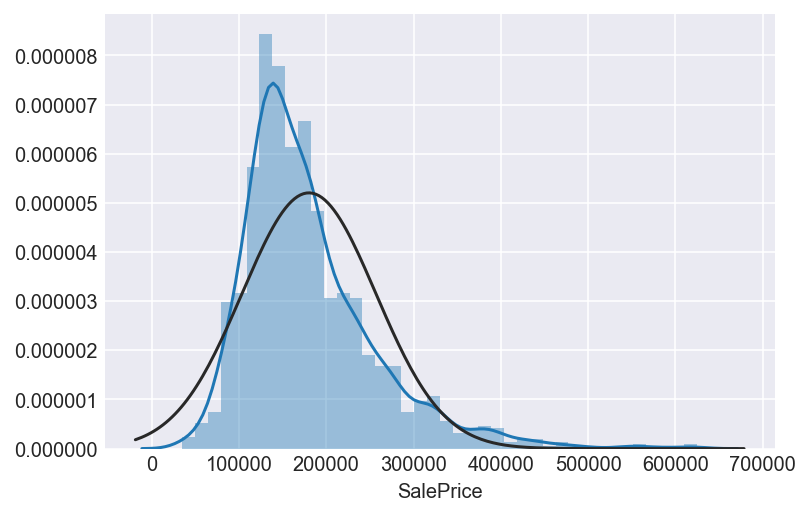

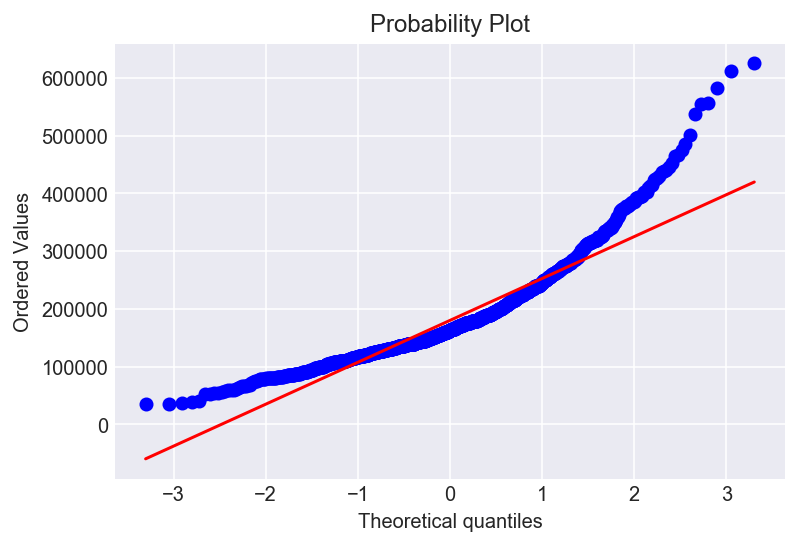

In [52]:
sns.distplot(train['SalePrice'], fit=norm);
fig = plt.figure()
sp = stats.probplot(train['SalePrice'], plot=plt)

In [53]:
# Creating Log and Log1p for SalePrice
log_y_train = np.log(train['SalePrice'])
y_train = np.log1p(train['SalePrice'])
log10_y_train = np.log10(train['SalePrice'])

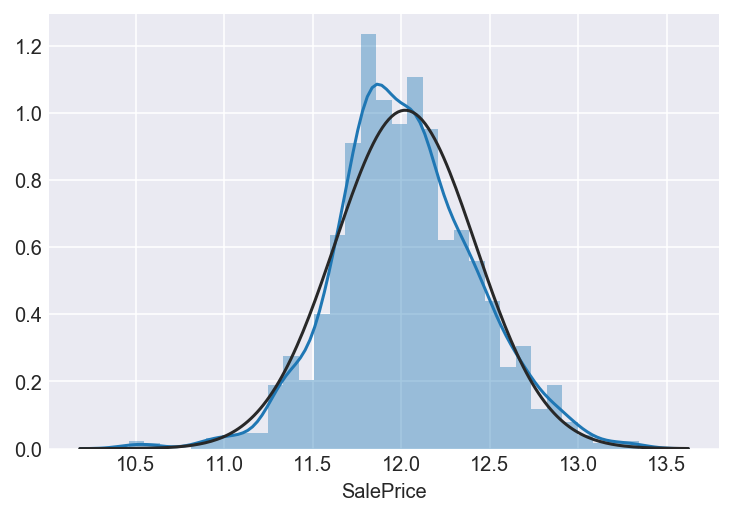

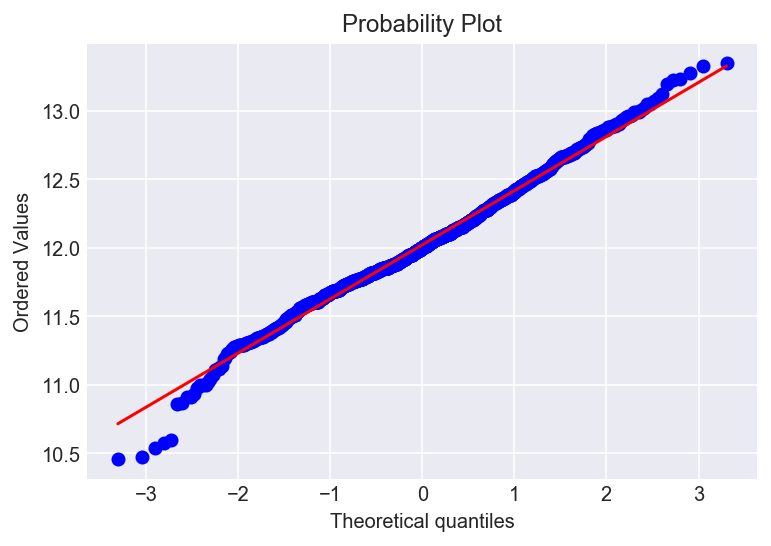

In [54]:
sns.distplot(y_train, fit=norm);
fig = plt.figure()
sp = stats.probplot(y_train, plot=plt)

#### This looks much better.

### Train/Test Split for testing our models

In [55]:
X_train_reg, X_holdout_reg, y_train_reg, y_holdout_reg = train_test_split(X_train_scaled, y_train, random_state=95)

<a id='regression'></a>
## Regression Analysis

### Creating a function that measures Root Mean Squared Error.

In [56]:
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

In [57]:
n_folds = 5

def rmse_cv(model):
    kf = KFold(n_folds, shuffle=True, random_state=95).get_n_splits(X_train_scaled.values)
    rmse= np.sqrt(-cross_val_score(model, X_train_scaled, y_train, scoring="neg_mean_squared_error", cv = kf))
    return(rmse)

<a id='linear'></a>
### Simple (Polynomial) Linear Regression

In [58]:
# Linear regression using the Normal Equation (OLS based CLR) on our train/test split
lr = LinearRegression(n_jobs=-1)
linreg = lr.fit(X_train_reg, y_train_reg)
linreg
linreg_pred = linreg.predict(X_holdout_reg)
print("Train R Squared:", lr.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", lr.score(X_holdout_reg, y_holdout_reg))
print('Intercept:', linreg.intercept_)
print('Coefs:', linreg.coef_)

Train R Squared: 1.0
Holdout R Squared: -2021064.48078
Intercept: 12.8045001136
Coefs: [  1.64880110e+01   5.20484911e+00   2.29339133e-01 ...,  -5.42036404e-03
   5.12045721e-02   1.19865079e-02]


In [59]:
# Final Regression Model on the full training dataset
lr = LinearRegression(n_jobs=-1)
linreg = lr.fit(X_train_scaled, y_train)
linreg
linreg_pred = linreg.predict(X_test_scaled)
print('R Squared:', linreg.score(X_train_scaled, y_train))
print('Intercept:', linreg.intercept_)
print('Coefs:', linreg.coef_)

R Squared: 1.0
Intercept: -180.630975528
Coefs: [ -8.79163007e+02  -8.93144047e+01  -2.29255255e+01 ...,   7.72641417e-02
   7.61411224e-02  -2.15134742e-03]


In [60]:
print("CV Root Mean Squared Error: {:.4f} ({:.4f})\n".format(rmse_cv(linreg).mean(), rmse_cv(linreg).std()))

CV Root Mean Squared Error: 1138.0876 (874.2841)



### Regularlized Regression Models

<a id='reg-ridge'></a>
#### Ridge regression

In [61]:
# Train/Test Split
r_alphas = np.arange(408.3, 408.5, .0001)
coefs = []
features = [col for col in df.columns]
ridge_cv = RidgeCV(alphas=r_alphas)
ridge_cv.fit(X_train_reg, y_train_reg)
ridge_cv_pred = ridge_cv.predict(X_holdout_reg)
print('Best alpha:', ridge_cv.alpha_)
print("Train R Squared:", ridge_cv.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", ridge_cv.score(X_holdout_reg, y_holdout_reg))
print('Intercept:', ridge_cv.intercept_)
print('Coefs:', ridge_cv.coef_)

Best alpha: 408.3998
Train R Squared: 0.938622459981
Holdout R Squared: 0.842552703341
Intercept: 12.0196364849
Coefs: [  2.05705464e-03   1.17521506e-04  -1.27733065e-04 ...,  -1.08864459e-05
   3.66238939e-04  -2.52179909e-03]


In [62]:
# Double checking on full dataset.
r_alphas = np.arange(769, 771, .001)
ridge_cv = RidgeCV(alphas=r_alphas, cv=5)
ridge_cv.fit(X_train_scaled, y_train)
ridge_cv_pred = ridge_cv.predict(X_test_scaled)
print('Best alpha:', ridge_cv.alpha_)
print('R Squared:', ridge_cv.score(X_train_scaled, y_train))
print('Intercept:', ridge_cv.intercept_)
print('Coefs:', ridge_cv.coef_)

Best alpha: 769.811
R Squared: 0.925451981341
Intercept: 12.0226383872
Coefs: [ 0.00288627  0.00015363 -0.0001022  ..., -0.00076755 -0.00075897
 -0.00102547]


In [63]:
# Final Model.
ridge = Ridge(alpha=408.3998)
ridge.fit(X_train_scaled, y_train)
ridge_pred = ridge.predict(X_test_scaled)

In [64]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(ridge).mean(), rmse_cv(ridge).std()))

RMSE: 0.1367 (0.0130)



<a id='lasso-reg'></a>
#### Lasso regression

In [66]:
# Train/Test Split.
l_alphas = (0.003, 0.004)
lasso_cv = LassoCV(alphas=l_alphas, n_jobs=-1, max_iter=1000000, verbose=1)
lasso_cv.fit(X_train_reg, y_train_reg)
lasso_cv_pred = lasso_cv.predict(X_holdout_reg)
print('Best alpha:', lasso_cv.alpha_)
print("Train R Squared:", lasso_cv.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", lasso_cv.score(X_holdout_reg, y_holdout_reg))
print('Intercept', lasso_cv.intercept_)
print('Coefs:', lasso_cv.coef_)

......[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    4.3s finished


Best alpha: 0.003
Train R Squared: 0.925767322411
Holdout R Squared: 0.861398116901
Intercept 11.9935589969
Coefs: [ 0. -0. -0. ..., -0.  0. -0.]


In [67]:
# Checking on the full dataset.
lasso_cv = LassoCV(alphas=l_alphas, n_jobs=-1, max_iter=1000000, verbose=1)
lasso_cv.fit(X_train_scaled, y_train)
lasso_cv_pred = lasso_cv.predict(X_test_scaled)
print('Best alpha:', lasso_cv.alpha_)
print("R Squared:", lasso_cv.score(X_train_scaled, y_train))

......[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:    3.5s finished


Best alpha: 0.003
R Squared: 0.920579297094


In [68]:
# Final Model.
lasso = Lasso(alpha=0.003, max_iter=50000)
lasso.fit(X_train_scaled, y_train)
lasso_pred = lasso.predict(X_test_scaled)

In [69]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(lasso).mean(), rmse_cv(lasso).std()))

RMSE: 0.1301 (0.0100)



<a id='enet'></a>
#### ElasticNet regression

In [70]:
# Modeling on the Train/Test split
e_alphas = np.arange(0, 0.5, .0001)
l1_ratios = (0.9)
enet_cv = ElasticNetCV(l1_ratio=0.9, alphas=e_alphas, max_iter=1000000, n_jobs=-1, verbose=1)
enet_cv.fit(X_train_reg, y_train_reg)
enet_cv_pred = enet_cv.predict(X_holdout_reg)
print("Best alpha", enet_cv.alpha_)
print("Best l1 ratio", enet_cv.l1_ratio_)
print("Train R Squared:", enet_cv.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", enet_cv.score(X_holdout_reg, y_holdout_reg))
print('Intercept', enet_cv.intercept_)
print('Coefs:', enet_cv.coef_)

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

........................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................................

Best alpha 0.0034
Best l1 ratio 0.9
Train R Squared: 0.925263714119
Holdout R Squared: 0.861210463452
Intercept 11.9941263177
Coefs: [ 0. -0. -0. ..., -0.  0. -0.]


In [71]:
# Checking on the full dataset.
e_alphas = (0.0003, 0.004)
enet_cv = ElasticNetCV(l1_ratio=0.9, alphas=e_alphas, max_iter=1000000, n_jobs=-1, verbose=1)
enet_cv.fit(X_train_scaled, y_train)
enet_cv_pred = enet_cv.predict(X_test_scaled)
print('Best alpha:', enet_cv.alpha_)
print("R Squared:", enet_cv.score(X_train_scaled, y_train))

......[Parallel(n_jobs=-1)]: Done   3 out of   3 | elapsed:   15.4s finished


Best alpha: 0.004
R Squared: 0.916039477516


In [72]:
# Final Model
enet = ElasticNet(l1_ratio=0.9, alpha=0.0029, max_iter=50000)
enet.fit(X_train_scaled, y_train)
enet_pred = enet.predict(X_test_scaled)

In [73]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(enet).mean(), rmse_cv(enet).std()))

RMSE: 0.1298 (0.0102)



<a id='stochastic'></a>
### Stochastic Gradient Descent

In [74]:
# Train/Test split
sgd_reg = SGDRegressor(max_iter=100000, l1_ratio=1, penalty='l1', eta0=0.01, random_state=95, verbose=1)
sgd_reg.fit(X_train_reg, y_train_reg.ravel())
sgd_pred = sgd_reg.predict(X_holdout_reg)
print("R Squared:", sgd_reg.score(X_train_reg, y_train_reg))
print('Intercept:', sgd_reg.intercept_)
print('Coefs:', sgd_reg.coef_)

-- Epoch 1
Norm: 1222148409934.55, NNZs: 2772, Bias: -5784334663.114577, T: 1092, Avg. loss: 6341686864783310816542720.000000
Total training time: 0.02 seconds.
-- Epoch 2
Norm: 919063139338.17, NNZs: 2772, Bias: 9417643263.517536, T: 2184, Avg. loss: 10787514675781438193795072.000000
Total training time: 0.04 seconds.
-- Epoch 3
Norm: 811408778456.60, NNZs: 2772, Bias: 9303258911.063093, T: 3276, Avg. loss: 6135106059242773202075648.000000
Total training time: 0.05 seconds.
-- Epoch 4
Norm: 759513754073.89, NNZs: 2772, Bias: 109328928.900504, T: 4368, Avg. loss: 4232825304976942354661376.000000
Total training time: 0.07 seconds.
-- Epoch 5
Norm: 771940683086.88, NNZs: 2772, Bias: -7092328476.878421, T: 5460, Avg. loss: 3958774353824118126673920.000000
Total training time: 0.09 seconds.
-- Epoch 6
Norm: 722895311722.63, NNZs: 2772, Bias: -4532861941.860324, T: 6552, Avg. loss: 3428780323008945852514304.000000
Total training time: 0.11 seconds.
-- Epoch 7
Norm: 765265106140.21, NNZs: 27

Norm: 401126419515.71, NNZs: 2772, Bias: 8041826430.996953, T: 61152, Avg. loss: 899789868614021743116288.000000
Total training time: 1.00 seconds.
-- Epoch 57
Norm: 419728065361.15, NNZs: 2772, Bias: 5321844983.896986, T: 62244, Avg. loss: 711007390832540344385536.000000
Total training time: 1.02 seconds.
-- Epoch 58
Norm: 400136472818.37, NNZs: 2772, Bias: 7137191452.404710, T: 63336, Avg. loss: 776934775789883530149888.000000
Total training time: 1.03 seconds.
-- Epoch 59
Norm: 398260092784.90, NNZs: 2772, Bias: -6768257278.352560, T: 64428, Avg. loss: 805162683264228669784064.000000
Total training time: 1.05 seconds.
-- Epoch 60
Norm: 384974369418.49, NNZs: 2772, Bias: 560229152.341280, T: 65520, Avg. loss: 835639140301006155284480.000000
Total training time: 1.07 seconds.
-- Epoch 61
Norm: 396295530858.14, NNZs: 2772, Bias: -5088189357.346292, T: 66612, Avg. loss: 1135813096073418399285248.000000
Total training time: 1.09 seconds.
-- Epoch 62
Norm: 384135000938.23, NNZs: 2772, Bia

Norm: 298305512253.01, NNZs: 2772, Bias: -1658522503.671875, T: 124488, Avg. loss: 743481179768934369329152.000000
Total training time: 2.05 seconds.
-- Epoch 115
Norm: 335631184589.78, NNZs: 2772, Bias: -135263555.785234, T: 125580, Avg. loss: 333876509555634164727808.000000
Total training time: 2.07 seconds.
-- Epoch 116
Norm: 296090339240.33, NNZs: 2772, Bias: -6733114240.943606, T: 126672, Avg. loss: 966189635508638935154688.000000
Total training time: 2.09 seconds.
-- Epoch 117
Norm: 330450949175.48, NNZs: 2772, Bias: -591259982.164116, T: 127764, Avg. loss: 412882766209223661453312.000000
Total training time: 2.10 seconds.
-- Epoch 118
Norm: 311658829725.51, NNZs: 2772, Bias: 1791107903.840059, T: 128856, Avg. loss: 564812648531227725266944.000000
Total training time: 2.12 seconds.
-- Epoch 119
Norm: 306581377641.91, NNZs: 2772, Bias: -2650150042.549973, T: 129948, Avg. loss: 727810668541922049523712.000000
Total training time: 2.14 seconds.
-- Epoch 120
Norm: 294740212846.28, NN

Norm: 264491230619.89, NNZs: 2772, Bias: -4108193231.271903, T: 192192, Avg. loss: 554356627969800402894848.000000
Total training time: 3.12 seconds.
-- Epoch 177
Norm: 278528317249.00, NNZs: 2772, Bias: -1316172559.972091, T: 193284, Avg. loss: 359128856459103078187008.000000
Total training time: 3.14 seconds.
-- Epoch 178
Norm: 252026831421.12, NNZs: 2772, Bias: -4647809641.062954, T: 194376, Avg. loss: 533959768094594872377344.000000
Total training time: 3.16 seconds.
-- Epoch 179
Norm: 257704875576.97, NNZs: 2772, Bias: -6296434251.696874, T: 195468, Avg. loss: 361167029182809371574272.000000
Total training time: 3.17 seconds.
-- Epoch 180
Norm: 251159046134.26, NNZs: 2772, Bias: -4636202477.043312, T: 196560, Avg. loss: 572849427989989035081728.000000
Total training time: 3.19 seconds.
-- Epoch 181
Norm: 267566952909.68, NNZs: 2772, Bias: -2390085524.801122, T: 197652, Avg. loss: 370365855111354546913280.000000
Total training time: 3.21 seconds.
-- Epoch 182
Norm: 241586536302.81,

Norm: 226226030868.07, NNZs: 2772, Bias: 1885976660.948887, T: 258804, Avg. loss: 472449496901011896270848.000000
Total training time: 4.19 seconds.
-- Epoch 238
Norm: 222683948611.46, NNZs: 2772, Bias: 1998678902.580941, T: 259896, Avg. loss: 359686808119586538389504.000000
Total training time: 4.21 seconds.
-- Epoch 239
Norm: 228134818573.09, NNZs: 2772, Bias: -3753215339.401482, T: 260988, Avg. loss: 383421388313979596570624.000000
Total training time: 4.23 seconds.
-- Epoch 240
Norm: 263906846215.39, NNZs: 2772, Bias: -2567305774.263592, T: 262080, Avg. loss: 287459389365356505071616.000000
Total training time: 4.24 seconds.
-- Epoch 241
Norm: 280341469652.90, NNZs: 2772, Bias: -1360801019.343514, T: 263172, Avg. loss: 317750505491174361399296.000000
Total training time: 4.26 seconds.
-- Epoch 242
Norm: 252370694870.17, NNZs: 2772, Bias: -2781164417.271570, T: 264264, Avg. loss: 621684228150936926683136.000000
Total training time: 4.28 seconds.
-- Epoch 243
Norm: 223128175836.37, N

Norm: 205097787953.95, NNZs: 2772, Bias: -4941240863.633635, T: 325416, Avg. loss: 383450104623342565720064.000000
Total training time: 5.23 seconds.
-- Epoch 299
Norm: 213880883619.59, NNZs: 2772, Bias: -2429615140.088020, T: 326508, Avg. loss: 320908943123767504142336.000000
Total training time: 5.25 seconds.
-- Epoch 300
Norm: 212432191901.94, NNZs: 2772, Bias: -3708423565.355605, T: 327600, Avg. loss: 337365271638801083531264.000000
Total training time: 5.27 seconds.
-- Epoch 301
Norm: 224777662208.84, NNZs: 2772, Bias: -4817598428.593240, T: 328692, Avg. loss: 282675272433698552676352.000000
Total training time: 5.29 seconds.
-- Epoch 302
Norm: 213823323714.68, NNZs: 2772, Bias: -2882721532.805893, T: 329784, Avg. loss: 370488487859544163090432.000000
Total training time: 5.30 seconds.
-- Epoch 303
Norm: 207251037679.47, NNZs: 2772, Bias: -3241352129.821044, T: 330876, Avg. loss: 345400278765087330664448.000000
Total training time: 5.32 seconds.
-- Epoch 304
Norm: 204980226381.36,

Norm: 204426084415.47, NNZs: 2772, Bias: -2403339471.079209, T: 390936, Avg. loss: 307303490056844275089408.000000
Total training time: 6.27 seconds.
-- Epoch 359
Norm: 197160365201.43, NNZs: 2772, Bias: 410866718.729406, T: 392028, Avg. loss: 303817034278591377965056.000000
Total training time: 6.29 seconds.
-- Epoch 360
Norm: 199947553895.85, NNZs: 2772, Bias: -5786853490.358402, T: 393120, Avg. loss: 292520944865339045314560.000000
Total training time: 6.31 seconds.
-- Epoch 361
Norm: 210421597224.80, NNZs: 2772, Bias: -4522760781.821240, T: 394212, Avg. loss: 406299910471039848546304.000000
Total training time: 6.33 seconds.
-- Epoch 362
Norm: 228230977293.60, NNZs: 2772, Bias: -3348987653.567470, T: 395304, Avg. loss: 204077985328563784515584.000000
Total training time: 6.34 seconds.
-- Epoch 363
Norm: 213323936697.57, NNZs: 2772, Bias: 1693853329.394151, T: 396396, Avg. loss: 457068242260320822755328.000000
Total training time: 6.36 seconds.
-- Epoch 364
Norm: 185145109175.20, NN

Norm: 190206147649.41, NNZs: 2772, Bias: -6780187962.645387, T: 446628, Avg. loss: 326649433759590467502080.000000
Total training time: 7.12 seconds.
-- Epoch 410
Norm: 179066013649.56, NNZs: 2772, Bias: -2278407975.698448, T: 447720, Avg. loss: 364355411995852024053760.000000
Total training time: 7.13 seconds.
-- Epoch 411
Norm: 212788727482.10, NNZs: 2772, Bias: -1777879678.105881, T: 448812, Avg. loss: 175818469044343346823168.000000
Total training time: 7.15 seconds.
-- Epoch 412
Norm: 181875322931.49, NNZs: 2772, Bias: -580122481.937646, T: 449904, Avg. loss: 435622153688160841760768.000000
Total training time: 7.17 seconds.
-- Epoch 413
Norm: 223608964706.86, NNZs: 2772, Bias: -7404676819.209406, T: 450996, Avg. loss: 162728712489795894378496.000000
Total training time: 7.19 seconds.
-- Epoch 414
Norm: 176490300276.49, NNZs: 2772, Bias: -2499337354.683497, T: 452088, Avg. loss: 544025158452477568221184.000000
Total training time: 7.20 seconds.
-- Epoch 415
Norm: 205198378048.19, 

Norm: 203162044948.81, NNZs: 2772, Bias: -2305475680.495743, T: 503412, Avg. loss: 166948761703331963863040.000000
Total training time: 7.98 seconds.
-- Epoch 462
Norm: 167436948978.00, NNZs: 2772, Bias: -2130834878.850517, T: 504504, Avg. loss: 426737342412193743765504.000000
Total training time: 8.00 seconds.
-- Epoch 463
Norm: 178878461749.77, NNZs: 2772, Bias: -3978161159.092299, T: 505596, Avg. loss: 249710365505797729812480.000000
Total training time: 8.02 seconds.
-- Epoch 464
Norm: 175031625548.62, NNZs: 2772, Bias: -972773800.380643, T: 506688, Avg. loss: 238754964064111970746368.000000
Total training time: 8.03 seconds.
-- Epoch 465
Norm: 174440277285.80, NNZs: 2772, Bias: -3411832887.860696, T: 507780, Avg. loss: 270447881188999272857600.000000
Total training time: 8.05 seconds.
-- Epoch 466
Norm: 175787833288.22, NNZs: 2772, Bias: -277761489.193241, T: 508872, Avg. loss: 252969915834351948398592.000000
Total training time: 8.07 seconds.
-- Epoch 467
Norm: 205897212277.67, N

Norm: 192957352860.71, NNZs: 2772, Bias: -2790765593.257735, T: 560196, Avg. loss: 314782861969596595830784.000000
Total training time: 8.84 seconds.
-- Epoch 514
Norm: 197471017128.63, NNZs: 2772, Bias: -1702726437.301027, T: 561288, Avg. loss: 215230421473076912848896.000000
Total training time: 8.86 seconds.
-- Epoch 515
Norm: 193014077555.36, NNZs: 2772, Bias: -4183120541.296830, T: 562380, Avg. loss: 309552997391945430990848.000000
Total training time: 8.88 seconds.
-- Epoch 516
Norm: 199735729202.45, NNZs: 2772, Bias: 31099424.334921, T: 563472, Avg. loss: 181224640090420858060800.000000
Total training time: 8.90 seconds.
-- Epoch 517
Norm: 178286666711.02, NNZs: 2772, Bias: -3885866800.202351, T: 564564, Avg. loss: 357857355346261904982016.000000
Total training time: 8.91 seconds.
-- Epoch 518
Norm: 188642272256.91, NNZs: 2772, Bias: -1265725797.879331, T: 565656, Avg. loss: 195672846707554382774272.000000
Total training time: 8.93 seconds.
-- Epoch 519
Norm: 214302516737.38, NN

Norm: 156664093999.53, NNZs: 2772, Bias: -3786259985.086240, T: 625716, Avg. loss: 219845344751917060849664.000000
Total training time: 9.89 seconds.
-- Epoch 574
Norm: 166823489098.65, NNZs: 2772, Bias: 1443236981.211272, T: 626808, Avg. loss: 165868214654641027153920.000000
Total training time: 9.91 seconds.
-- Epoch 575
Norm: 165429448752.77, NNZs: 2772, Bias: -3809837966.039405, T: 627900, Avg. loss: 313920670067331187081216.000000
Total training time: 9.93 seconds.
-- Epoch 576
Norm: 171625123180.18, NNZs: 2772, Bias: -260798119.835961, T: 628992, Avg. loss: 185620504043890260574208.000000
Total training time: 9.95 seconds.
-- Epoch 577
Norm: 144355033438.07, NNZs: 2772, Bias: -1441265011.268366, T: 630084, Avg. loss: 346311234803765411315712.000000
Total training time: 9.96 seconds.
-- Epoch 578
Norm: 165493149681.97, NNZs: 2772, Bias: -2771986616.397399, T: 631176, Avg. loss: 227396966334350124646400.000000
Total training time: 9.98 seconds.
-- Epoch 579
Norm: 155973345933.98, N

Norm: 172335844540.76, NNZs: 2772, Bias: 1069105525.455327, T: 691236, Avg. loss: 209223230529141932556288.000000
Total training time: 10.96 seconds.
-- Epoch 634
Norm: 154053322077.58, NNZs: 2772, Bias: -1629661754.656546, T: 692328, Avg. loss: 236838037607313181769728.000000
Total training time: 10.98 seconds.
-- Epoch 635
Norm: 164473325052.07, NNZs: 2772, Bias: -1324582930.376193, T: 693420, Avg. loss: 211363542890011194032128.000000
Total training time: 10.99 seconds.
-- Epoch 636
Norm: 143441100478.73, NNZs: 2772, Bias: -501073187.795815, T: 694512, Avg. loss: 254937860139502708719616.000000
Total training time: 11.01 seconds.
-- Epoch 637
Norm: 159434332562.06, NNZs: 2772, Bias: -1737904531.728496, T: 695604, Avg. loss: 166945483813237622308864.000000
Total training time: 11.03 seconds.
-- Epoch 638
Norm: 168261985835.20, NNZs: 2772, Bias: -2768627163.168857, T: 696696, Avg. loss: 186830206673608608055296.000000
Total training time: 11.05 seconds.
-- Epoch 639
Norm: 173264368971

Norm: 158528701444.73, NNZs: 2772, Bias: 1444528891.867310, T: 756756, Avg. loss: 252289826877244253929472.000000
Total training time: 12.03 seconds.
-- Epoch 694
Norm: 157699705130.30, NNZs: 2772, Bias: -1214899442.076782, T: 757848, Avg. loss: 188029830053996405981184.000000
Total training time: 12.05 seconds.
-- Epoch 695
Norm: 163050494637.58, NNZs: 2772, Bias: -4927935.074158, T: 758940, Avg. loss: 183561032882519757815808.000000
Total training time: 12.07 seconds.
-- Epoch 696
Norm: 155339825621.57, NNZs: 2772, Bias: -747399871.137010, T: 760032, Avg. loss: 216668512647388021653504.000000
Total training time: 12.09 seconds.
-- Epoch 697
Norm: 161762805935.50, NNZs: 2772, Bias: 19459226.158371, T: 761124, Avg. loss: 216725326711405431226368.000000
Total training time: 12.10 seconds.
-- Epoch 698
Norm: 174990606883.04, NNZs: 2772, Bias: -3070657642.898847, T: 762216, Avg. loss: 168351113598954920476672.000000
Total training time: 12.12 seconds.
-- Epoch 699
Norm: 153479040491.68, N

Norm: 149957127463.75, NNZs: 2772, Bias: -2325700574.198747, T: 822276, Avg. loss: 166802646964439839932416.000000
Total training time: 13.07 seconds.
-- Epoch 754
Norm: 138994604632.10, NNZs: 2772, Bias: -3746230677.856840, T: 823368, Avg. loss: 235592616725305794494464.000000
Total training time: 13.09 seconds.
-- Epoch 755
Norm: 153041223507.41, NNZs: 2772, Bias: -3023422135.549714, T: 824460, Avg. loss: 148202725065155214835712.000000
Total training time: 13.11 seconds.
-- Epoch 756
Norm: 170911341351.68, NNZs: 2772, Bias: -2440422008.971189, T: 825552, Avg. loss: 166702870502883450683392.000000
Total training time: 13.12 seconds.
-- Epoch 757
Norm: 158464946671.05, NNZs: 2772, Bias: -2837782175.818202, T: 826644, Avg. loss: 301477469133596985917440.000000
Total training time: 13.14 seconds.
-- Epoch 758
Norm: 151727120001.42, NNZs: 2772, Bias: 200189698.784438, T: 827736, Avg. loss: 182734290385941813002240.000000
Total training time: 13.16 seconds.
-- Epoch 759
Norm: 169536792848

Norm: 147244645631.70, NNZs: 2772, Bias: -2720875528.452899, T: 888888, Avg. loss: 266513238980459661099008.000000
Total training time: 14.11 seconds.
-- Epoch 815
Norm: 160980746292.27, NNZs: 2772, Bias: -3360704565.625043, T: 889980, Avg. loss: 141799407490620274507776.000000
Total training time: 14.13 seconds.
-- Epoch 816
Norm: 148629167581.55, NNZs: 2772, Bias: -1667260833.866573, T: 891072, Avg. loss: 185579666276204326944768.000000
Total training time: 14.15 seconds.
-- Epoch 817
Norm: 151905727460.01, NNZs: 2772, Bias: -1782932889.376795, T: 892164, Avg. loss: 184340538028544973864960.000000
Total training time: 14.17 seconds.
-- Epoch 818
Norm: 135831154062.20, NNZs: 2772, Bias: 404757826.619218, T: 893256, Avg. loss: 194834739865340077932544.000000
Total training time: 14.18 seconds.
-- Epoch 819
Norm: 154191152335.06, NNZs: 2772, Bias: 266713345.988360, T: 894348, Avg. loss: 177963435185501666017280.000000
Total training time: 14.20 seconds.
-- Epoch 820
Norm: 136601865264.4

Norm: 149927598602.83, NNZs: 2772, Bias: -695852528.676288, T: 957684, Avg. loss: 219121129464860933881856.000000
Total training time: 15.19 seconds.
-- Epoch 878
Norm: 142620869501.68, NNZs: 2772, Bias: -1538335256.905568, T: 958776, Avg. loss: 190025283881709055508480.000000
Total training time: 15.20 seconds.
-- Epoch 879
Norm: 144821530915.62, NNZs: 2772, Bias: 1514901700.933186, T: 959868, Avg. loss: 180658424785686885302272.000000
Total training time: 15.22 seconds.
-- Epoch 880
Norm: 158603260245.83, NNZs: 2772, Bias: 947723417.941742, T: 960960, Avg. loss: 124400852999946008264704.000000
Total training time: 15.24 seconds.
-- Epoch 881
Norm: 150878654491.46, NNZs: 2772, Bias: 1233888231.941578, T: 962052, Avg. loss: 270678959104384496041984.000000
Total training time: 15.26 seconds.
-- Epoch 882
Norm: 140598343188.43, NNZs: 2772, Bias: -705194800.570318, T: 963144, Avg. loss: 212908895167277749501952.000000
Total training time: 15.28 seconds.
-- Epoch 883
Norm: 156684047409.66,

Norm: 125237113407.68, NNZs: 2772, Bias: -2284552255.379085, T: 1024296, Avg. loss: 212844487843281264181248.000000
Total training time: 16.26 seconds.
-- Epoch 939
Norm: 144203597093.67, NNZs: 2772, Bias: -1788122494.225575, T: 1025388, Avg. loss: 149215809821783466442752.000000
Total training time: 16.28 seconds.
-- Epoch 940
Norm: 122214035989.25, NNZs: 2772, Bias: 1176159623.788235, T: 1026480, Avg. loss: 248211811839329936867328.000000
Total training time: 16.30 seconds.
-- Epoch 941
Norm: 133484087259.07, NNZs: 2772, Bias: -1234983716.602188, T: 1027572, Avg. loss: 130849277601500025061376.000000
Total training time: 16.31 seconds.
-- Epoch 942
Norm: 132570614143.82, NNZs: 2772, Bias: -847784337.530328, T: 1028664, Avg. loss: 160749757018778896433152.000000
Total training time: 16.33 seconds.
-- Epoch 943
Norm: 162320111991.17, NNZs: 2772, Bias: -4261705524.984854, T: 1029756, Avg. loss: 87811654320820043382784.000000
Total training time: 16.34 seconds.
-- Epoch 944
Norm: 1460231

Norm: 144777069768.97, NNZs: 2772, Bias: -1329225148.843976, T: 1079988, Avg. loss: 79497643504801480179712.000000
Total training time: 17.13 seconds.
-- Epoch 990
Norm: 143260891953.48, NNZs: 2772, Bias: -59974685.013766, T: 1081080, Avg. loss: 140886665856375991566336.000000
Total training time: 17.15 seconds.
-- Epoch 991
Norm: 141932163182.16, NNZs: 2772, Bias: -1626904757.967308, T: 1082172, Avg. loss: 178140983056437478424576.000000
Total training time: 17.17 seconds.
-- Epoch 992
Norm: 116429367162.80, NNZs: 2772, Bias: -1736863517.599420, T: 1083264, Avg. loss: 199642750078818979938304.000000
Total training time: 17.19 seconds.
-- Epoch 993
Norm: 138486405337.12, NNZs: 2772, Bias: -2657596504.206426, T: 1084356, Avg. loss: 56839567245096781873152.000000
Total training time: 17.21 seconds.
-- Epoch 994
Norm: 140524398557.44, NNZs: 2772, Bias: -2089239036.478511, T: 1085448, Avg. loss: 160393183997474069544960.000000
Total training time: 17.22 seconds.
-- Epoch 995
Norm: 14069358

Norm: 135458248633.53, NNZs: 2772, Bias: -33840780.836608, T: 1146600, Avg. loss: 175553335171121460281344.000000
Total training time: 18.20 seconds.
-- Epoch 1051
Norm: 148222636163.49, NNZs: 2772, Bias: 1937753562.823115, T: 1147692, Avg. loss: 136982554618493055008768.000000
Total training time: 18.21 seconds.
-- Epoch 1052
Norm: 134497955060.83, NNZs: 2772, Bias: -2231296596.767967, T: 1148784, Avg. loss: 212823323294911120277504.000000
Total training time: 18.23 seconds.
-- Epoch 1053
Norm: 132950333769.66, NNZs: 2772, Bias: -2632862714.216400, T: 1149876, Avg. loss: 146790893935818121936896.000000
Total training time: 18.25 seconds.
-- Epoch 1054
Norm: 122253327056.69, NNZs: 2772, Bias: -926102871.212394, T: 1150968, Avg. loss: 194331564759097773391872.000000
Total training time: 18.27 seconds.
-- Epoch 1055
Norm: 141803887499.78, NNZs: 2772, Bias: -2089893213.277649, T: 1152060, Avg. loss: 116523055822924349964288.000000
Total training time: 18.28 seconds.
-- Epoch 1056
Norm: 12

Norm: 126008927485.68, NNZs: 2772, Bias: 201144112.183603, T: 1212120, Avg. loss: 224846392805262102626304.000000
Total training time: 19.25 seconds.
-- Epoch 1111
Norm: 139375907229.25, NNZs: 2772, Bias: 409702366.872284, T: 1213212, Avg. loss: 124287883614086651445248.000000
Total training time: 19.27 seconds.
-- Epoch 1112
Norm: 131291472304.39, NNZs: 2772, Bias: -573908818.454263, T: 1214304, Avg. loss: 150819181688655559262208.000000
Total training time: 19.29 seconds.
-- Epoch 1113
Norm: 127124833719.23, NNZs: 2772, Bias: -960070855.615302, T: 1215396, Avg. loss: 196699106648566355984384.000000
Total training time: 19.31 seconds.
-- Epoch 1114
Norm: 137546798191.68, NNZs: 2772, Bias: -1251299265.472317, T: 1216488, Avg. loss: 136415703090546329255936.000000
Total training time: 19.32 seconds.
-- Epoch 1115
Norm: 145905363124.22, NNZs: 2772, Bias: -3750505077.513866, T: 1217580, Avg. loss: 119090406508243523207168.000000
Total training time: 19.34 seconds.
-- Epoch 1116
Norm: 1250

Norm: 138762505884.49, NNZs: 2772, Bias: -1522859830.921331, T: 1278732, Avg. loss: 187095320780888453677056.000000
Total training time: 20.32 seconds.
-- Epoch 1172
Norm: 127485642275.12, NNZs: 2772, Bias: -1599786700.553342, T: 1279824, Avg. loss: 171807695869184980287488.000000
Total training time: 20.34 seconds.
-- Epoch 1173
Norm: 138981663569.70, NNZs: 2772, Bias: -1485127280.922122, T: 1280916, Avg. loss: 97602272843104719470592.000000
Total training time: 20.35 seconds.
-- Epoch 1174
Norm: 118382799820.28, NNZs: 2772, Bias: -675859082.865554, T: 1282008, Avg. loss: 181150158800516133421056.000000
Total training time: 20.37 seconds.
-- Epoch 1175
Norm: 140164404637.72, NNZs: 2772, Bias: -1295806469.020618, T: 1283100, Avg. loss: 94050410610359762157568.000000
Total training time: 20.39 seconds.
-- Epoch 1176
Norm: 131049543081.76, NNZs: 2772, Bias: -631230803.266854, T: 1284192, Avg. loss: 136550107292764922183680.000000
Total training time: 20.41 seconds.
-- Epoch 1177
Norm: 13

Norm: 124646333260.62, NNZs: 2772, Bias: -681555888.856143, T: 1345344, Avg. loss: 172360650914930070913024.000000
Total training time: 21.37 seconds.
-- Epoch 1233
Norm: 145024466047.36, NNZs: 2772, Bias: -1426644587.064561, T: 1346436, Avg. loss: 115628522794773028798464.000000
Total training time: 21.39 seconds.
-- Epoch 1234
Norm: 129669780376.84, NNZs: 2772, Bias: -717664133.909919, T: 1347528, Avg. loss: 173430329205926884540416.000000
Total training time: 21.41 seconds.
-- Epoch 1235
Norm: 139686328981.65, NNZs: 2772, Bias: -1897023522.274493, T: 1348620, Avg. loss: 119908784264334769389568.000000
Total training time: 21.42 seconds.
-- Epoch 1236
Norm: 121220000131.56, NNZs: 2772, Bias: 1066681512.205347, T: 1349712, Avg. loss: 181965001526692982816768.000000
Total training time: 21.44 seconds.
-- Epoch 1237
Norm: 139109985014.88, NNZs: 2772, Bias: -2056870334.831676, T: 1350804, Avg. loss: 107381060260665621479424.000000
Total training time: 21.46 seconds.
-- Epoch 1238
Norm: 1

Norm: 121476329069.61, NNZs: 2772, Bias: 117329834.161747, T: 1411956, Avg. loss: 124786292855397230313472.000000
Total training time: 22.42 seconds.
-- Epoch 1294
Norm: 121274669167.83, NNZs: 2772, Bias: -1481211541.819208, T: 1413048, Avg. loss: 134181091709537539325952.000000
Total training time: 22.43 seconds.
-- Epoch 1295
Norm: 137577577652.06, NNZs: 2772, Bias: 762080860.419245, T: 1414140, Avg. loss: 127308044228844668846080.000000
Total training time: 22.45 seconds.
-- Epoch 1296
Norm: 117002746696.72, NNZs: 2772, Bias: -2251218056.409905, T: 1415232, Avg. loss: 155724220178657414479872.000000
Total training time: 22.47 seconds.
-- Epoch 1297
Norm: 124062310903.66, NNZs: 2772, Bias: 913004889.113161, T: 1416324, Avg. loss: 119438801067554709176320.000000
Total training time: 22.49 seconds.
-- Epoch 1298
Norm: 110886477479.05, NNZs: 2772, Bias: -2950292728.972628, T: 1417416, Avg. loss: 156655252314104283529216.000000
Total training time: 22.50 seconds.
-- Epoch 1299
Norm: 1344

Norm: 130096190485.22, NNZs: 2772, Bias: -1683203489.733410, T: 1479660, Avg. loss: 151233282868714126966784.000000
Total training time: 23.47 seconds.
-- Epoch 1356
Norm: 119531816747.22, NNZs: 2772, Bias: -912037975.656961, T: 1480752, Avg. loss: 143163223069971930152960.000000
Total training time: 23.49 seconds.
-- Epoch 1357
Norm: 121230728782.69, NNZs: 2772, Bias: -1503371555.657067, T: 1481844, Avg. loss: 116602714890677293940736.000000
Total training time: 23.51 seconds.
-- Epoch 1358
Norm: 121603121021.54, NNZs: 2772, Bias: -1180381542.464458, T: 1482936, Avg. loss: 136463282074086063210496.000000
Total training time: 23.52 seconds.
-- Epoch 1359
Norm: 124875471809.80, NNZs: 2772, Bias: -565377054.010738, T: 1484028, Avg. loss: 149749451306825678848000.000000
Total training time: 23.54 seconds.
-- Epoch 1360
Norm: 120843353299.75, NNZs: 2772, Bias: 1018531506.100114, T: 1485120, Avg. loss: 133912219504474557775872.000000
Total training time: 23.56 seconds.
-- Epoch 1361
Norm: 1

Total training time: 24.52 seconds.
-- Epoch 1416
Norm: 102362468265.63, NNZs: 2772, Bias: -3234334721.868579, T: 1546272, Avg. loss: 225873536589990190907392.000000
Total training time: 24.54 seconds.
-- Epoch 1417
Norm: 113641613213.42, NNZs: 2772, Bias: -2205020542.655348, T: 1547364, Avg. loss: 95254941910991147892736.000000
Total training time: 24.55 seconds.
-- Epoch 1418
Norm: 123588823133.84, NNZs: 2772, Bias: 464017957.736388, T: 1548456, Avg. loss: 96697948001220788486144.000000
Total training time: 24.57 seconds.
-- Epoch 1419
Norm: 117395030843.23, NNZs: 2772, Bias: -3904125388.368769, T: 1549548, Avg. loss: 158800584147437669580800.000000
Total training time: 24.59 seconds.
-- Epoch 1420
Norm: 120229457533.74, NNZs: 2772, Bias: -1169547278.122826, T: 1550640, Avg. loss: 99385153841327035645952.000000
Total training time: 24.60 seconds.
-- Epoch 1421
Norm: 127839954686.63, NNZs: 2772, Bias: -3045858002.274073, T: 1551732, Avg. loss: 123875309179573215690752.000000
Total tra

Norm: 113972989647.29, NNZs: 2772, Bias: -1119771547.011132, T: 1612884, Avg. loss: 139517708830350996668416.000000
Total training time: 25.57 seconds.
-- Epoch 1478
Norm: 114892441181.22, NNZs: 2772, Bias: -2541378496.738828, T: 1613976, Avg. loss: 126553138016315661877248.000000
Total training time: 25.59 seconds.
-- Epoch 1479
Norm: 124477402124.12, NNZs: 2772, Bias: -3349757008.912193, T: 1615068, Avg. loss: 120017365567352401297408.000000
Total training time: 25.61 seconds.
-- Epoch 1480
Norm: 109239146494.43, NNZs: 2772, Bias: -1278191208.439416, T: 1616160, Avg. loss: 172635369713181657137152.000000
Total training time: 25.62 seconds.
-- Epoch 1481
Norm: 129880123680.46, NNZs: 2772, Bias: -2412900995.019534, T: 1617252, Avg. loss: 99895984141323626086400.000000
Total training time: 25.64 seconds.
-- Epoch 1482
Norm: 117554459552.40, NNZs: 2772, Bias: -399121502.689633, T: 1618344, Avg. loss: 161960737026313535094784.000000
Total training time: 25.65 seconds.
-- Epoch 1483
Norm: 

Norm: 110726131130.91, NNZs: 2772, Bias: -1728372247.256030, T: 1679496, Avg. loss: 141585950201867501830144.000000
Total training time: 26.61 seconds.
-- Epoch 1539
Norm: 113515228858.29, NNZs: 2772, Bias: -2297566505.719479, T: 1680588, Avg. loss: 91570527944990848450560.000000
Total training time: 26.63 seconds.
-- Epoch 1540
Norm: 97654385819.84, NNZs: 2772, Bias: -2122117678.094173, T: 1681680, Avg. loss: 117254349379462911492096.000000
Total training time: 26.64 seconds.
-- Epoch 1541
Norm: 114103205004.73, NNZs: 2772, Bias: -1153345842.880688, T: 1682772, Avg. loss: 82972648378335391383552.000000
Total training time: 26.66 seconds.
-- Epoch 1542
Norm: 100587699474.79, NNZs: 2772, Bias: -2167381113.752963, T: 1683864, Avg. loss: 139453653508271242215424.000000
Total training time: 26.68 seconds.
-- Epoch 1543
Norm: 128997143551.47, NNZs: 2772, Bias: -514408329.805711, T: 1684956, Avg. loss: 69608544723576731729920.000000
Total training time: 26.70 seconds.
-- Epoch 1544
Norm: 102

Norm: 112309340524.24, NNZs: 2772, Bias: -290189531.237207, T: 1745016, Avg. loss: 131403339592772358242304.000000
Total training time: 27.63 seconds.
-- Epoch 1599
Norm: 118788983305.88, NNZs: 2772, Bias: -1832317144.489767, T: 1746108, Avg. loss: 112881438562010936639488.000000
Total training time: 27.65 seconds.
-- Epoch 1600
Norm: 95576989890.80, NNZs: 2772, Bias: -282690984.283277, T: 1747200, Avg. loss: 148700237774969324437504.000000
Total training time: 27.67 seconds.
-- Epoch 1601
Norm: 117159674128.93, NNZs: 2772, Bias: -2697348321.177593, T: 1748292, Avg. loss: 80921919982200797790208.000000
Total training time: 27.68 seconds.
-- Epoch 1602
Norm: 98347355853.24, NNZs: 2772, Bias: -852502173.614940, T: 1749384, Avg. loss: 146989206104932354097152.000000
Total training time: 27.70 seconds.
-- Epoch 1603
Norm: 108053245825.78, NNZs: 2772, Bias: -1306040739.921177, T: 1750476, Avg. loss: 85611945967133965418496.000000
Total training time: 27.72 seconds.
-- Epoch 1604
Norm: 93418

Norm: 121372554672.02, NNZs: 2772, Bias: -2359019299.837392, T: 1811628, Avg. loss: 126248238367669598814208.000000
Total training time: 28.65 seconds.
-- Epoch 1660
Norm: 90442254774.50, NNZs: 2772, Bias: -918349247.979422, T: 1812720, Avg. loss: 155375567933045439725568.000000
Total training time: 28.67 seconds.
-- Epoch 1661
Norm: 121805489836.86, NNZs: 2772, Bias: -1009920323.088632, T: 1813812, Avg. loss: 85320007390536870658048.000000
Total training time: 28.69 seconds.
-- Epoch 1662
Norm: 106983012251.51, NNZs: 2772, Bias: -97354721.915423, T: 1814904, Avg. loss: 124151039022394601635840.000000
Total training time: 28.71 seconds.
-- Epoch 1663
Norm: 127581949376.39, NNZs: 2772, Bias: 964927751.779241, T: 1815996, Avg. loss: 82908756131978319757312.000000
Total training time: 28.72 seconds.
-- Epoch 1664
Norm: 104623745326.16, NNZs: 2772, Bias: 1241814368.087506, T: 1817088, Avg. loss: 167198299546424101044224.000000
Total training time: 28.74 seconds.
-- Epoch 1665
Norm: 1141447

Norm: 106815754942.23, NNZs: 2772, Bias: -3100200851.075043, T: 1866228, Avg. loss: 103565470471477627191296.000000
Total training time: 29.50 seconds.
-- Epoch 1710
Norm: 85002303058.33, NNZs: 2772, Bias: 361131510.700900, T: 1867320, Avg. loss: 134785811301137735745536.000000
Total training time: 29.52 seconds.
-- Epoch 1711
Norm: 100442432529.43, NNZs: 2772, Bias: -2666746768.041237, T: 1868412, Avg. loss: 83583433143061797928960.000000
Total training time: 29.54 seconds.
-- Epoch 1712
Norm: 105127531215.57, NNZs: 2772, Bias: -1809142031.090008, T: 1869504, Avg. loss: 86814985509042938445824.000000
Total training time: 29.56 seconds.
-- Epoch 1713
Norm: 111170333619.81, NNZs: 2772, Bias: -672320640.098773, T: 1870596, Avg. loss: 116203365688690593497088.000000
Total training time: 29.57 seconds.
-- Epoch 1714
Norm: 109974956040.88, NNZs: 2772, Bias: -3432476009.955655, T: 1871688, Avg. loss: 117006313307486487052288.000000
Total training time: 29.59 seconds.
-- Epoch 1715
Norm: 1128

Norm: 103998814858.49, NNZs: 2772, Bias: -2037626629.923439, T: 1923012, Avg. loss: 69564812104883704430592.000000
Total training time: 30.35 seconds.
-- Epoch 1762
Norm: 96656997593.18, NNZs: 2772, Bias: -2584305510.714077, T: 1924104, Avg. loss: 92868139538317270056960.000000
Total training time: 30.37 seconds.
-- Epoch 1763
Norm: 111997998228.24, NNZs: 2772, Bias: -2035184544.969423, T: 1925196, Avg. loss: 93208401826417653841920.000000
Total training time: 30.39 seconds.
-- Epoch 1764
Norm: 98794678881.21, NNZs: 2772, Bias: -785376077.428638, T: 1926288, Avg. loss: 124902282416085366996992.000000
Total training time: 30.40 seconds.
-- Epoch 1765
Norm: 120094381135.61, NNZs: 2772, Bias: -4028689064.224480, T: 1927380, Avg. loss: 86310707524190188077056.000000
Total training time: 30.42 seconds.
-- Epoch 1766
Norm: 105617004538.37, NNZs: 2772, Bias: -1572485637.910231, T: 1928472, Avg. loss: 119860566457883188789248.000000
Total training time: 30.44 seconds.
-- Epoch 1767
Norm: 11353

Norm: 101635487929.99, NNZs: 2772, Bias: -2883073348.970035, T: 1977612, Avg. loss: 122071163046684560195584.000000
Total training time: 31.19 seconds.
-- Epoch 1812
Norm: 95792853991.12, NNZs: 2772, Bias: -1427165801.203536, T: 1978704, Avg. loss: 108231653814811834187776.000000
Total training time: 31.21 seconds.
-- Epoch 1813
Norm: 102537104281.26, NNZs: 2772, Bias: -2210236673.417165, T: 1979796, Avg. loss: 136945327172565986181120.000000
Total training time: 31.23 seconds.
-- Epoch 1814
Norm: 98865097590.51, NNZs: 2772, Bias: -1698846482.953442, T: 1980888, Avg. loss: 108781310577113296797696.000000
Total training time: 31.25 seconds.
-- Epoch 1815
Norm: 114753468813.77, NNZs: 2772, Bias: -3693484326.040959, T: 1981980, Avg. loss: 95837855095024938647552.000000
Total training time: 31.26 seconds.
-- Epoch 1816
Norm: 99111636757.53, NNZs: 2772, Bias: -1042190951.505624, T: 1983072, Avg. loss: 136912335036514335457280.000000
Total training time: 31.28 seconds.
-- Epoch 1817
Norm: 10

Norm: 98158764772.44, NNZs: 2772, Bias: -3337951978.862627, T: 2045316, Avg. loss: 97987608504006063685632.000000
Total training time: 32.25 seconds.
-- Epoch 1874
Norm: 89866032316.06, NNZs: 2772, Bias: -1411122832.089014, T: 2046408, Avg. loss: 124661207041674919804928.000000
Total training time: 32.27 seconds.
-- Epoch 1875
Norm: 109233861522.14, NNZs: 2772, Bias: -2490596304.093431, T: 2047500, Avg. loss: 76777983753367542824960.000000
Total training time: 32.29 seconds.
-- Epoch 1876
Norm: 105196074415.59, NNZs: 2772, Bias: -1329557394.690413, T: 2048592, Avg. loss: 109069855496566418178048.000000
Total training time: 32.31 seconds.
-- Epoch 1877
Norm: 106642209394.62, NNZs: 2772, Bias: -3924206004.362629, T: 2049684, Avg. loss: 124243168255853220331520.000000
Total training time: 32.32 seconds.
-- Epoch 1878
Norm: 98641948660.31, NNZs: 2772, Bias: -501831644.922387, T: 2050776, Avg. loss: 119911819981086254956544.000000
Total training time: 32.34 seconds.
-- Epoch 1879
Norm: 1198

Norm: 109883103560.92, NNZs: 2772, Bias: -2155823669.709827, T: 2110836, Avg. loss: 90921723564023231807488.000000
Total training time: 33.30 seconds.
-- Epoch 1934
Norm: 117236352902.00, NNZs: 2772, Bias: 1440405373.267164, T: 2111928, Avg. loss: 85810973162913394589696.000000
Total training time: 33.31 seconds.
-- Epoch 1935
Norm: 109437571062.69, NNZs: 2772, Bias: 209529231.316785, T: 2113020, Avg. loss: 137564754489133481590784.000000
Total training time: 33.33 seconds.
-- Epoch 1936
Norm: 103113235451.51, NNZs: 2772, Bias: -1893396202.504699, T: 2114112, Avg. loss: 91736701811601952473088.000000
Total training time: 33.35 seconds.
-- Epoch 1937
Norm: 111776577967.33, NNZs: 2772, Bias: -1394495204.457187, T: 2115204, Avg. loss: 153577301493211908276224.000000
Total training time: 33.36 seconds.
-- Epoch 1938
Norm: 103775450428.46, NNZs: 2772, Bias: -1098761101.747087, T: 2116296, Avg. loss: 113656082617625852510208.000000
Total training time: 33.38 seconds.
-- Epoch 1939
Norm: 1072

Norm: 99398431881.68, NNZs: 2772, Bias: -2072841233.219710, T: 2165436, Avg. loss: 73437430607356488581120.000000
Total training time: 34.16 seconds.
-- Epoch 1984
Norm: 107229254238.38, NNZs: 2772, Bias: -1163877207.901743, T: 2166528, Avg. loss: 61291150450874684276736.000000
Total training time: 34.18 seconds.
-- Epoch 1985
Norm: 120245317978.18, NNZs: 2772, Bias: -1217808356.113419, T: 2167620, Avg. loss: 74655008075875985915904.000000
Total training time: 34.20 seconds.
-- Epoch 1986
Norm: 102202639059.42, NNZs: 2772, Bias: -781495966.389856, T: 2168712, Avg. loss: 134109700967533387972608.000000
Total training time: 34.22 seconds.
-- Epoch 1987
Norm: 114667185943.37, NNZs: 2772, Bias: -2037586527.082235, T: 2169804, Avg. loss: 81731463153516556582912.000000
Total training time: 34.23 seconds.
-- Epoch 1988
Norm: 102984414268.25, NNZs: 2772, Bias: -1698814718.621187, T: 2170896, Avg. loss: 139125474220826578386944.000000
Total training time: 34.25 seconds.
-- Epoch 1989
Norm: 1072

Norm: 103293026708.07, NNZs: 2772, Bias: -1297845747.937080, T: 2232048, Avg. loss: 76737096225262346960896.000000
Total training time: 35.20 seconds.
-- Epoch 2045
Norm: 107723495187.33, NNZs: 2772, Bias: -2177853665.899623, T: 2233140, Avg. loss: 98263874659642255605760.000000
Total training time: 35.22 seconds.
-- Epoch 2046
Norm: 85605171272.86, NNZs: 2772, Bias: -1234641243.405321, T: 2234232, Avg. loss: 124467920710818710159360.000000
Total training time: 35.24 seconds.
-- Epoch 2047
Norm: 117808419480.85, NNZs: 2772, Bias: -819664643.951169, T: 2235324, Avg. loss: 45828104232518511755264.000000
Total training time: 35.25 seconds.
-- Epoch 2048
Norm: 106321242723.55, NNZs: 2772, Bias: -2096844470.349111, T: 2236416, Avg. loss: 105292275770864254844928.000000
Total training time: 35.27 seconds.
-- Epoch 2049
Norm: 96452598431.77, NNZs: 2772, Bias: -2286226733.042692, T: 2237508, Avg. loss: 143740244484702500552704.000000
Total training time: 35.29 seconds.
-- Epoch 2050
Norm: 1215

Norm: 96336940512.24, NNZs: 2772, Bias: -1153064952.204346, T: 2297568, Avg. loss: 204066411410068747583488.000000
Total training time: 36.23 seconds.
-- Epoch 2105
Norm: 94741663604.07, NNZs: 2772, Bias: -2931603759.460101, T: 2298660, Avg. loss: 109708688169502811095040.000000
Total training time: 36.24 seconds.
-- Epoch 2106
Norm: 100818736720.98, NNZs: 2772, Bias: -1341451554.011750, T: 2299752, Avg. loss: 81544855248167453589504.000000
Total training time: 36.26 seconds.
-- Epoch 2107
Norm: 115466196978.28, NNZs: 2772, Bias: 65066779.532809, T: 2300844, Avg. loss: 59376624734673053941760.000000
Total training time: 36.28 seconds.
-- Epoch 2108
Norm: 98409721232.16, NNZs: 2772, Bias: -1261467866.481552, T: 2301936, Avg. loss: 133994654389329868095488.000000
Total training time: 36.30 seconds.
-- Epoch 2109
Norm: 121192194476.60, NNZs: 2772, Bias: -221453217.710288, T: 2303028, Avg. loss: 61447528320046431469568.000000
Total training time: 36.32 seconds.
-- Epoch 2110
Norm: 94127639

Norm: 95989070842.76, NNZs: 2772, Bias: -1465443241.653424, T: 2364180, Avg. loss: 128631588272913506107392.000000
Total training time: 37.29 seconds.
-- Epoch 2166
Norm: 101538782445.05, NNZs: 2772, Bias: -2023447851.996403, T: 2365272, Avg. loss: 82729300768225371357184.000000
Total training time: 37.31 seconds.
-- Epoch 2167
Norm: 95172818748.79, NNZs: 2772, Bias: -4465079205.176341, T: 2366364, Avg. loss: 128598211235712096796672.000000
Total training time: 37.32 seconds.
-- Epoch 2168
Norm: 102180585040.10, NNZs: 2772, Bias: -71586860.669250, T: 2367456, Avg. loss: 69130018270282554277888.000000
Total training time: 37.34 seconds.
-- Epoch 2169
Norm: 90295093951.94, NNZs: 2772, Bias: -2044800337.956913, T: 2368548, Avg. loss: 127744540953308999712768.000000
Total training time: 37.36 seconds.
-- Epoch 2170
Norm: 87711449408.10, NNZs: 2772, Bias: -987381169.639902, T: 2369640, Avg. loss: 90266479607194583040000.000000
Total training time: 37.38 seconds.
-- Epoch 2171
Norm: 89660826

Norm: 103560025653.98, NNZs: 2772, Bias: -1443588662.246681, T: 2418780, Avg. loss: 73800326191993881362432.000000
Total training time: 38.13 seconds.
-- Epoch 2216
Norm: 89692011852.08, NNZs: 2772, Bias: -722368988.963323, T: 2419872, Avg. loss: 130833327890078013325312.000000
Total training time: 38.15 seconds.
-- Epoch 2217
Norm: 101301513846.77, NNZs: 2772, Bias: -2109737790.354986, T: 2420964, Avg. loss: 77983063583833041403904.000000
Total training time: 38.17 seconds.
-- Epoch 2218
Norm: 83538626982.09, NNZs: 2772, Bias: -906098026.890012, T: 2422056, Avg. loss: 114793190243678000513024.000000
Total training time: 38.19 seconds.
-- Epoch 2219
Norm: 105927233296.64, NNZs: 2772, Bias: -2416503126.678242, T: 2423148, Avg. loss: 57098924077481321299968.000000
Total training time: 38.20 seconds.
-- Epoch 2220
Norm: 88343094957.29, NNZs: 2772, Bias: -820831079.058854, T: 2424240, Avg. loss: 117562094624093383950336.000000
Total training time: 38.22 seconds.
-- Epoch 2221
Norm: 1025197

Norm: 107624429785.87, NNZs: 2772, Bias: -193763903.973127, T: 2486484, Avg. loss: 119456249582934695084032.000000
Total training time: 39.19 seconds.
-- Epoch 2278
Norm: 71671247066.02, NNZs: 2772, Bias: -1744151006.176377, T: 2487576, Avg. loss: 156638124354582821732352.000000
Total training time: 39.21 seconds.
-- Epoch 2279
Norm: 107008161563.73, NNZs: 2772, Bias: -1567582814.091364, T: 2488668, Avg. loss: 43734192600250109132800.000000
Total training time: 39.23 seconds.
-- Epoch 2280
Norm: 81106763671.98, NNZs: 2772, Bias: -689104918.047867, T: 2489760, Avg. loss: 144403521512976878141440.000000
Total training time: 39.25 seconds.
-- Epoch 2281
Norm: 111672322920.32, NNZs: 2772, Bias: -1111610689.121651, T: 2490852, Avg. loss: 48803715843939815653376.000000
Total training time: 39.26 seconds.
-- Epoch 2282
Norm: 91619809712.69, NNZs: 2772, Bias: -1125627438.426407, T: 2491944, Avg. loss: 123632295358733075087360.000000
Total training time: 39.28 seconds.
-- Epoch 2283
Norm: 94958

Norm: 84425271707.17, NNZs: 2772, Bias: -462607127.076664, T: 2542176, Avg. loss: 99920943970661678710784.000000
Total training time: 40.05 seconds.
-- Epoch 2329
Norm: 117278686159.74, NNZs: 2772, Bias: -2367015416.550291, T: 2543268, Avg. loss: 53749910996945966465024.000000
Total training time: 40.06 seconds.
-- Epoch 2330
Norm: 102124155054.64, NNZs: 2772, Bias: 728114715.263981, T: 2544360, Avg. loss: 128233442633895938883584.000000
Total training time: 40.08 seconds.
-- Epoch 2331
Norm: 112965215412.08, NNZs: 2772, Bias: -2650275611.270989, T: 2545452, Avg. loss: 85527437381395262996480.000000
Total training time: 40.10 seconds.
-- Epoch 2332
Norm: 93296724619.61, NNZs: 2772, Bias: -639497101.370109, T: 2546544, Avg. loss: 112027171893542962331648.000000
Total training time: 40.12 seconds.
-- Epoch 2333
Norm: 97305199275.20, NNZs: 2772, Bias: -2532436911.998405, T: 2547636, Avg. loss: 124436938739355649835008.000000
Total training time: 40.13 seconds.
-- Epoch 2334
Norm: 11169133

Norm: 85639562676.31, NNZs: 2772, Bias: -2524064212.746478, T: 2609880, Avg. loss: 116993443108780484067328.000000
Total training time: 41.11 seconds.
-- Epoch 2391
Norm: 111821096558.02, NNZs: 2772, Bias: -1409055023.603359, T: 2610972, Avg. loss: 53008114991127563599872.000000
Total training time: 41.13 seconds.
-- Epoch 2392
Norm: 85804452224.95, NNZs: 2772, Bias: -787252549.341047, T: 2612064, Avg. loss: 142114804130947350396928.000000
Total training time: 41.14 seconds.
-- Epoch 2393
Norm: 98210570450.54, NNZs: 2772, Bias: -2738771586.837879, T: 2613156, Avg. loss: 81866835822037306441728.000000
Total training time: 41.16 seconds.
-- Epoch 2394
Norm: 76947318491.46, NNZs: 2772, Bias: -1598735700.320562, T: 2614248, Avg. loss: 122353742366010326908928.000000
Total training time: 41.18 seconds.
-- Epoch 2395
Norm: 92505948000.22, NNZs: 2772, Bias: -2757212223.680092, T: 2615340, Avg. loss: 74604317810138734919680.000000
Total training time: 41.20 seconds.
-- Epoch 2396
Norm: 8178159

Norm: 97317585673.02, NNZs: 2772, Bias: -930296813.062538, T: 2676492, Avg. loss: 100601157036354398322688.000000
Total training time: 42.16 seconds.
-- Epoch 2452
Norm: 100326036741.48, NNZs: 2772, Bias: -1434361604.709351, T: 2677584, Avg. loss: 75287956875037070327808.000000
Total training time: 42.18 seconds.
-- Epoch 2453
Norm: 94499335343.78, NNZs: 2772, Bias: -1828496097.682368, T: 2678676, Avg. loss: 98924890875211636801536.000000
Total training time: 42.20 seconds.
-- Epoch 2454
Norm: 84098441797.25, NNZs: 2772, Bias: -1718889478.564165, T: 2679768, Avg. loss: 95274355862294163881984.000000
Total training time: 42.21 seconds.
-- Epoch 2455
Norm: 97778719907.18, NNZs: 2772, Bias: -832105760.758566, T: 2680860, Avg. loss: 71800075678837498707968.000000
Total training time: 42.23 seconds.
-- Epoch 2456
Norm: 93341070806.91, NNZs: 2772, Bias: 914897084.421403, T: 2681952, Avg. loss: 79331227728300763774976.000000
Total training time: 42.25 seconds.
-- Epoch 2457
Norm: 94470222957.

Norm: 68633778057.89, NNZs: 2772, Bias: -1537172942.667058, T: 2743104, Avg. loss: 109513534144934852952064.000000
Total training time: 43.22 seconds.
-- Epoch 2513
Norm: 100628048196.02, NNZs: 2772, Bias: -187611169.310774, T: 2744196, Avg. loss: 49464256337288078819328.000000
Total training time: 43.23 seconds.
-- Epoch 2514
Norm: 77560982586.05, NNZs: 2772, Bias: -3260801536.378770, T: 2745288, Avg. loss: 141779391592476753002496.000000
Total training time: 43.25 seconds.
-- Epoch 2515
Norm: 113678545385.44, NNZs: 2772, Bias: -1084522098.790542, T: 2746380, Avg. loss: 33254280566713306054656.000000
Total training time: 43.27 seconds.
-- Epoch 2516
Norm: 75151407783.26, NNZs: 2772, Bias: 32191192.627078, T: 2747472, Avg. loss: 181559254989937760534528.000000
Total training time: 43.29 seconds.
-- Epoch 2517
Norm: 118915133952.38, NNZs: 2772, Bias: -976268475.287750, T: 2748564, Avg. loss: 33026963306385619550208.000000
Total training time: 43.30 seconds.
-- Epoch 2518
Norm: 737512345

Norm: 97076613995.16, NNZs: 2772, Bias: -3252451310.587204, T: 2809716, Avg. loss: 98042846664364270813184.000000
Total training time: 44.25 seconds.
-- Epoch 2574
Norm: 97304499173.77, NNZs: 2772, Bias: -1213164731.405103, T: 2810808, Avg. loss: 89325834182618767163392.000000
Total training time: 44.27 seconds.
-- Epoch 2575
Norm: 90983697419.41, NNZs: 2772, Bias: -2345025487.970821, T: 2811900, Avg. loss: 85681067168009153413120.000000
Total training time: 44.28 seconds.
-- Epoch 2576
Norm: 78898420480.47, NNZs: 2772, Bias: -313632961.650446, T: 2812992, Avg. loss: 89507632770483146981376.000000
Total training time: 44.30 seconds.
-- Epoch 2577
Norm: 97797400125.83, NNZs: 2772, Bias: 478267109.232909, T: 2814084, Avg. loss: 61365875948611136651264.000000
Total training time: 44.32 seconds.
-- Epoch 2578
Norm: 88719401917.36, NNZs: 2772, Bias: -2382265582.561730, T: 2815176, Avg. loss: 81387829447558348931072.000000
Total training time: 44.34 seconds.
-- Epoch 2579
Norm: 99497623007.0

Norm: 106516237214.42, NNZs: 2772, Bias: -1141133925.878839, T: 2875236, Avg. loss: 66170131190522430095360.000000
Total training time: 45.27 seconds.
-- Epoch 2634
Norm: 96954735990.40, NNZs: 2772, Bias: -1618719831.499912, T: 2876328, Avg. loss: 97574463215724214091776.000000
Total training time: 45.29 seconds.
-- Epoch 2635
Norm: 108193696044.19, NNZs: 2772, Bias: -1220869107.209361, T: 2877420, Avg. loss: 90571948568122866270208.000000
Total training time: 45.31 seconds.
-- Epoch 2636
Norm: 80554950636.39, NNZs: 2772, Bias: -2025932161.396631, T: 2878512, Avg. loss: 118272869309095578959872.000000
Total training time: 45.32 seconds.
-- Epoch 2637
Norm: 108144088810.64, NNZs: 2772, Bias: -2334485362.199573, T: 2879604, Avg. loss: 28685757082815244009472.000000
Total training time: 45.34 seconds.
-- Epoch 2638
Norm: 81341785944.12, NNZs: 2772, Bias: -244591211.362594, T: 2880696, Avg. loss: 172360977169676110921728.000000
Total training time: 45.36 seconds.
-- Epoch 2639
Norm: 948295

-- Epoch 2683
Norm: 87788736418.74, NNZs: 2772, Bias: -2472937939.318727, T: 2929836, Avg. loss: 72113915479196025487360.000000
Total training time: 46.13 seconds.
-- Epoch 2684
Norm: 90447616603.03, NNZs: 2772, Bias: -824028819.998375, T: 2930928, Avg. loss: 58544239504427147329536.000000
Total training time: 46.15 seconds.
-- Epoch 2685
Norm: 94068337539.39, NNZs: 2772, Bias: -1961259504.982624, T: 2932020, Avg. loss: 98959078613704381562880.000000
Total training time: 46.16 seconds.
-- Epoch 2686
Norm: 91961295921.74, NNZs: 2772, Bias: -1633905530.588739, T: 2933112, Avg. loss: 76367423158078018682880.000000
Total training time: 46.18 seconds.
-- Epoch 2687
Norm: 110311843615.07, NNZs: 2772, Bias: -2814075539.022649, T: 2934204, Avg. loss: 67983044779239935049728.000000
Total training time: 46.19 seconds.
-- Epoch 2688
Norm: 82789313044.76, NNZs: 2772, Bias: -914502175.520697, T: 2935296, Avg. loss: 148686181000146736644096.000000
Total training time: 46.21 seconds.
-- Epoch 2689
No

Norm: 91115758260.40, NNZs: 2772, Bias: -2799851517.117832, T: 2986620, Avg. loss: 89884924974737972527104.000000
Total training time: 46.97 seconds.
-- Epoch 2736
Norm: 89804036115.67, NNZs: 2772, Bias: -1024007693.379400, T: 2987712, Avg. loss: 77415118302426720894976.000000
Total training time: 46.99 seconds.
-- Epoch 2737
Norm: 111292278984.82, NNZs: 2772, Bias: 538271469.204321, T: 2988804, Avg. loss: 51046626369511828226048.000000
Total training time: 47.00 seconds.
-- Epoch 2738
Norm: 91127973911.44, NNZs: 2772, Bias: -1179074977.395920, T: 2989896, Avg. loss: 117106901618411232559104.000000
Total training time: 47.02 seconds.
-- Epoch 2739
Norm: 91026806881.55, NNZs: 2772, Bias: -3468039133.253984, T: 2990988, Avg. loss: 122118986903112439037952.000000
Total training time: 47.04 seconds.
-- Epoch 2740
Norm: 79606831490.34, NNZs: 2772, Bias: 185135475.998210, T: 2992080, Avg. loss: 81657051817966693253120.000000
Total training time: 47.05 seconds.
-- Epoch 2741
Norm: 94813825640

Norm: 115025301277.29, NNZs: 2772, Bias: -1919246125.124273, T: 3041220, Avg. loss: 40521767528910479687680.000000
Total training time: 47.82 seconds.
-- Epoch 2786
Norm: 85295064059.23, NNZs: 2772, Bias: 178479708.218702, T: 3042312, Avg. loss: 219054258104196476698624.000000
Total training time: 47.84 seconds.
-- Epoch 2787
Norm: 110133562636.51, NNZs: 2772, Bias: -2158706202.127425, T: 3043404, Avg. loss: 42111293894674901630976.000000
Total training time: 47.85 seconds.
-- Epoch 2788
Norm: 91339496420.98, NNZs: 2772, Bias: 1375122209.539948, T: 3044496, Avg. loss: 192381301488747024482304.000000
Total training time: 47.87 seconds.
-- Epoch 2789
Norm: 80990863961.15, NNZs: 2772, Bias: -662533563.199279, T: 3045588, Avg. loss: 101768609227651531407360.000000
Total training time: 47.89 seconds.
-- Epoch 2790
Norm: 95606424531.31, NNZs: 2772, Bias: -157507851.285695, T: 3046680, Avg. loss: 59801083204535760977920.000000
Total training time: 47.90 seconds.
-- Epoch 2791
Norm: 8803602767

Norm: 70358460206.09, NNZs: 2772, Bias: -1430452883.712638, T: 3107832, Avg. loss: 137151785833803303354368.000000
Total training time: 48.87 seconds.
-- Epoch 2847
Norm: 89692777317.93, NNZs: 2772, Bias: -878289863.385110, T: 3108924, Avg. loss: 47805200210104575590400.000000
Total training time: 48.89 seconds.
-- Epoch 2848
Norm: 77719331767.96, NNZs: 2772, Bias: -356174604.964928, T: 3110016, Avg. loss: 72659120897885361668096.000000
Total training time: 48.91 seconds.
-- Epoch 2849
Norm: 91103414285.51, NNZs: 2772, Bias: -1732871972.197720, T: 3111108, Avg. loss: 67641262840164751769600.000000
Total training time: 48.93 seconds.
-- Epoch 2850
Norm: 74051886125.27, NNZs: 2772, Bias: 1152106035.114823, T: 3112200, Avg. loss: 93255844367163010842624.000000
Total training time: 48.94 seconds.
-- Epoch 2851
Norm: 89192833033.26, NNZs: 2772, Bias: -1282534004.545060, T: 3113292, Avg. loss: 60797866235901274750976.000000
Total training time: 48.96 seconds.
-- Epoch 2852
Norm: 74665751563.

Norm: 82808341483.72, NNZs: 2772, Bias: -547653847.150693, T: 3175536, Avg. loss: 83617336436641216069632.000000
Total training time: 49.95 seconds.
-- Epoch 2909
Norm: 109681568470.03, NNZs: 2772, Bias: -2669966925.761605, T: 3176628, Avg. loss: 44747350694737288888320.000000
Total training time: 49.97 seconds.
-- Epoch 2910
Norm: 85813451040.46, NNZs: 2772, Bias: 253581802.404618, T: 3177720, Avg. loss: 117549607598665270034432.000000
Total training time: 49.99 seconds.
-- Epoch 2911
Norm: 86598216355.05, NNZs: 2772, Bias: 272527810.302521, T: 3178812, Avg. loss: 73844586598901921873920.000000
Total training time: 50.00 seconds.
-- Epoch 2912
Norm: 72496792056.31, NNZs: 2772, Bias: 334869703.456932, T: 3179904, Avg. loss: 85026249531145530114048.000000
Total training time: 50.02 seconds.
-- Epoch 2913
Norm: 88758832522.42, NNZs: 2772, Bias: -54498469.176806, T: 3180996, Avg. loss: 77410954066007221600256.000000
Total training time: 50.04 seconds.
-- Epoch 2914
Norm: 94400440964.09, N

Norm: 102781623261.31, NNZs: 2772, Bias: 218899744.930664, T: 3242148, Avg. loss: 31916979181164114739200.000000
Total training time: 50.99 seconds.
-- Epoch 2970
Norm: 88127503422.06, NNZs: 2772, Bias: -1036464558.694597, T: 3243240, Avg. loss: 95773206345711110586368.000000
Total training time: 51.01 seconds.
-- Epoch 2971
Norm: 92315578857.31, NNZs: 2772, Bias: -1502927612.256592, T: 3244332, Avg. loss: 77924043839783540097024.000000
Total training time: 51.03 seconds.
-- Epoch 2972
Norm: 78650731710.38, NNZs: 2772, Bias: -943237193.939139, T: 3245424, Avg. loss: 98704056905269522726912.000000
Total training time: 51.05 seconds.
-- Epoch 2973
Norm: 111225252273.21, NNZs: 2772, Bias: -668209810.500353, T: 3246516, Avg. loss: 36062509939177937698816.000000
Total training time: 51.06 seconds.
-- Epoch 2974
Norm: 79822467181.97, NNZs: 2772, Bias: -1093098517.835774, T: 3247608, Avg. loss: 129921758985997837664256.000000
Total training time: 51.08 seconds.
-- Epoch 2975
Norm: 88124867631

Norm: 72862108281.15, NNZs: 2772, Bias: -1604389541.133521, T: 3310944, Avg. loss: 72747151982163652509696.000000
Total training time: 52.05 seconds.
-- Epoch 3033
Norm: 102312483694.91, NNZs: 2772, Bias: -1201355529.748072, T: 3312036, Avg. loss: 42172028795932741992448.000000
Total training time: 52.07 seconds.
-- Epoch 3034
Norm: 96354499806.91, NNZs: 2772, Bias: 1938538346.589876, T: 3313128, Avg. loss: 92990086463009320861696.000000
Total training time: 52.08 seconds.
-- Epoch 3035
Norm: 94443750213.53, NNZs: 2772, Bias: -2854030502.529429, T: 3314220, Avg. loss: 83291774353892425334784.000000
Total training time: 52.10 seconds.
-- Epoch 3036
Norm: 68398737522.21, NNZs: 2772, Bias: -311481759.903232, T: 3315312, Avg. loss: 125991685098377930866688.000000
Total training time: 52.12 seconds.
-- Epoch 3037
Norm: 86900530011.13, NNZs: 2772, Bias: -906297436.494481, T: 3316404, Avg. loss: 38954848932549506367488.000000
Total training time: 52.13 seconds.
-- Epoch 3038
Norm: 79737942637

Norm: 81930848002.88, NNZs: 2772, Bias: -799641525.510456, T: 3368820, Avg. loss: 82072962225583656271872.000000
Total training time: 52.90 seconds.
-- Epoch 3086
Norm: 82237305239.70, NNZs: 2772, Bias: 137789610.148290, T: 3369912, Avg. loss: 72192057899828067172352.000000
Total training time: 52.92 seconds.
-- Epoch 3087
Norm: 87087290580.30, NNZs: 2772, Bias: 284746942.104081, T: 3371004, Avg. loss: 61411990445580739411968.000000
Total training time: 52.93 seconds.
-- Epoch 3088
Norm: 69745101293.79, NNZs: 2772, Bias: -154536823.141467, T: 3372096, Avg. loss: 88401938754102271934464.000000
Total training time: 52.95 seconds.
-- Epoch 3089
Norm: 89134898953.03, NNZs: 2772, Bias: -1165121880.185407, T: 3373188, Avg. loss: 40329387856040978022400.000000
Total training time: 52.96 seconds.
-- Epoch 3090
Norm: 68838556128.16, NNZs: 2772, Bias: -736459984.249388, T: 3374280, Avg. loss: 95862486311453463674880.000000
Total training time: 52.98 seconds.
-- Epoch 3091
Norm: 95421583088.56, N

Norm: 95131388420.78, NNZs: 2772, Bias: -1332452278.032712, T: 3436524, Avg. loss: 44628997306120339980288.000000
Total training time: 53.95 seconds.
-- Epoch 3148
Norm: 89130716228.90, NNZs: 2772, Bias: -502435316.097315, T: 3437616, Avg. loss: 85224315134118811664384.000000
Total training time: 53.97 seconds.
-- Epoch 3149
Norm: 95633396642.31, NNZs: 2772, Bias: -1582726582.501664, T: 3438708, Avg. loss: 113991791630345756999680.000000
Total training time: 53.99 seconds.
-- Epoch 3150
Norm: 64850306535.46, NNZs: 2772, Bias: -938498652.598497, T: 3439800, Avg. loss: 110189904526909665968128.000000
Total training time: 54.00 seconds.
-- Epoch 3151
Norm: 80212812549.14, NNZs: 2772, Bias: -522615209.859949, T: 3440892, Avg. loss: 47449066188225181122560.000000
Total training time: 54.02 seconds.
-- Epoch 3152
Norm: 70391461518.28, NNZs: 2772, Bias: -1228978678.132544, T: 3441984, Avg. loss: 85485292095232981073920.000000
Total training time: 54.04 seconds.
-- Epoch 3153
Norm: 10316519066

-- Epoch 3200
Norm: 90234356484.11, NNZs: 2772, Bias: -1208751802.923825, T: 3494400, Avg. loss: 78487178750229032730624.000000
Total training time: 54.80 seconds.
-- Epoch 3201
Norm: 95541156445.56, NNZs: 2772, Bias: -1328876001.358150, T: 3495492, Avg. loss: 93684341747541428142080.000000
Total training time: 54.82 seconds.
-- Epoch 3202
Norm: 80306324780.83, NNZs: 2772, Bias: 180228996.169910, T: 3496584, Avg. loss: 128242064612144522985472.000000
Total training time: 54.84 seconds.
-- Epoch 3203
Norm: 104534680517.46, NNZs: 2772, Bias: -1021259940.693603, T: 3497676, Avg. loss: 55745547116702238507008.000000
Total training time: 54.85 seconds.
-- Epoch 3204
Norm: 81422242671.98, NNZs: 2772, Bias: -398853701.259112, T: 3498768, Avg. loss: 107663892824023877287936.000000
Total training time: 54.87 seconds.
-- Epoch 3205
Norm: 94776654614.50, NNZs: 2772, Bias: -279704642.283768, T: 3499860, Avg. loss: 69885108690385952047104.000000
Total training time: 54.89 seconds.
-- Epoch 3206
Nor

Norm: 86962498471.52, NNZs: 2772, Bias: -25276250.602759, T: 3558828, Avg. loss: 64267100102840931057664.000000
Total training time: 55.82 seconds.
-- Epoch 3260
Norm: 77633866678.15, NNZs: 2772, Bias: -1396924242.764485, T: 3559920, Avg. loss: 68753980024189565796352.000000
Total training time: 55.84 seconds.
-- Epoch 3261
Norm: 94901481908.76, NNZs: 2772, Bias: -1195038203.583005, T: 3561012, Avg. loss: 53362726100537324863488.000000
Total training time: 55.86 seconds.
-- Epoch 3262
Norm: 69294870164.97, NNZs: 2772, Bias: -1306136456.371572, T: 3562104, Avg. loss: 115538637583921524506624.000000
Total training time: 55.88 seconds.
-- Epoch 3263
Norm: 93618983650.68, NNZs: 2772, Bias: -929060514.864824, T: 3563196, Avg. loss: 34601491986866694520832.000000
Total training time: 55.89 seconds.
-- Epoch 3264
Norm: 62720089995.62, NNZs: 2772, Bias: -76638980.962997, T: 3564288, Avg. loss: 110574846889350238568448.000000
Total training time: 55.91 seconds.
-- Epoch 3265
Norm: 84156662001.6

Norm: 73815889771.99, NNZs: 2772, Bias: 821225054.748769, T: 3625440, Avg. loss: 85338595802942164434944.000000
Total training time: 56.87 seconds.
-- Epoch 3321
Norm: 81951971268.48, NNZs: 2772, Bias: -439886770.172626, T: 3626532, Avg. loss: 57302649098241356857344.000000
Total training time: 56.89 seconds.
-- Epoch 3322
Norm: 86465647734.02, NNZs: 2772, Bias: -1452827002.901975, T: 3627624, Avg. loss: 64779118554092685754368.000000
Total training time: 56.91 seconds.
-- Epoch 3323
Norm: 97305605062.36, NNZs: 2772, Bias: -339547489.585143, T: 3628716, Avg. loss: 63919085910711823499264.000000
Total training time: 56.93 seconds.
-- Epoch 3324
Norm: 85823733330.90, NNZs: 2772, Bias: -1652017235.130374, T: 3629808, Avg. loss: 104356624844745678520320.000000
Total training time: 56.94 seconds.
-- Epoch 3325
Norm: 88931222250.47, NNZs: 2772, Bias: -1437541920.734130, T: 3630900, Avg. loss: 71441879733803564400640.000000
Total training time: 56.96 seconds.
-- Epoch 3326
Norm: 95396013529.8

Norm: 97124786328.92, NNZs: 2772, Bias: -155360153.537961, T: 3689868, Avg. loss: 48392719281086565187584.000000
Total training time: 57.90 seconds.
-- Epoch 3380
Norm: 81456890805.61, NNZs: 2772, Bias: -1597848606.485648, T: 3690960, Avg. loss: 101200356123558151192576.000000
Total training time: 57.92 seconds.
-- Epoch 3381
Norm: 86449609177.51, NNZs: 2772, Bias: -307937881.944680, T: 3692052, Avg. loss: 59980254606108240379904.000000
Total training time: 57.94 seconds.
-- Epoch 3382
Norm: 65314364800.08, NNZs: 2772, Bias: -542045002.453869, T: 3693144, Avg. loss: 100226208615756071960576.000000
Total training time: 57.95 seconds.
-- Epoch 3383
Norm: 90263625640.87, NNZs: 2772, Bias: -114698929.550010, T: 3694236, Avg. loss: 42977988726256891330560.000000
Total training time: 57.97 seconds.
-- Epoch 3384
Norm: 100436588737.82, NNZs: 2772, Bias: -709754155.643377, T: 3695328, Avg. loss: 45941842170802954305536.000000
Total training time: 57.99 seconds.
-- Epoch 3385
Norm: 88866987719.

Norm: 90793076704.34, NNZs: 2772, Bias: -620500811.086205, T: 3757572, Avg. loss: 47791192772504994185216.000000
Total training time: 58.98 seconds.
-- Epoch 3442
Norm: 71931981689.44, NNZs: 2772, Bias: -2416428348.749345, T: 3758664, Avg. loss: 100051016550966427123712.000000
Total training time: 58.99 seconds.
-- Epoch 3443
Norm: 83399551907.22, NNZs: 2772, Bias: -725100816.100319, T: 3759756, Avg. loss: 53118429968591086419968.000000
Total training time: 59.01 seconds.
-- Epoch 3444
Norm: 83441241667.52, NNZs: 2772, Bias: -264447951.739029, T: 3760848, Avg. loss: 64186595175449791299584.000000
Total training time: 59.03 seconds.
-- Epoch 3445
Norm: 87717523782.33, NNZs: 2772, Bias: -1383194146.589025, T: 3761940, Avg. loss: 67828624090295292657664.000000
Total training time: 59.05 seconds.
-- Epoch 3446
Norm: 77980247720.67, NNZs: 2772, Bias: -1855277829.518728, T: 3763032, Avg. loss: 72394612049821931929600.000000
Total training time: 59.06 seconds.
-- Epoch 3447
Norm: 97778461325.

Norm: 74072787895.67, NNZs: 2772, Bias: -2013268030.629188, T: 3814356, Avg. loss: 42310594081297759469568.000000
Total training time: 59.84 seconds.
-- Epoch 3494
Norm: 93441444726.56, NNZs: 2772, Bias: -894274847.962567, T: 3815448, Avg. loss: 46835998088444612968448.000000
Total training time: 59.86 seconds.
-- Epoch 3495
Norm: 78026066189.61, NNZs: 2772, Bias: -1639878126.470467, T: 3816540, Avg. loss: 107810384708558756249600.000000
Total training time: 59.88 seconds.
-- Epoch 3496
Norm: 87619231239.24, NNZs: 2772, Bias: 285184945.896577, T: 3817632, Avg. loss: 54510879924905100443648.000000
Total training time: 59.90 seconds.
-- Epoch 3497
Norm: 87656418815.68, NNZs: 2772, Bias: -484590318.755267, T: 3818724, Avg. loss: 81230854667064563466240.000000
Total training time: 59.91 seconds.
-- Epoch 3498
Norm: 94275975938.38, NNZs: 2772, Bias: -1398921294.093280, T: 3819816, Avg. loss: 56970582872452759552000.000000
Total training time: 59.93 seconds.
-- Epoch 3499
Norm: 97836395184.1

Norm: 93944279871.12, NNZs: 2772, Bias: -2424351067.514118, T: 3879876, Avg. loss: 70207014439941813829632.000000
Total training time: 60.88 seconds.
-- Epoch 3554
Norm: 83117480774.65, NNZs: 2772, Bias: 248000459.391331, T: 3880968, Avg. loss: 91483992448862120837120.000000
Total training time: 60.90 seconds.
-- Epoch 3555
Norm: 84603274639.34, NNZs: 2772, Bias: -3289079345.157415, T: 3882060, Avg. loss: 66384583010336068599808.000000
Total training time: 60.91 seconds.
-- Epoch 3556
Norm: 80406637592.64, NNZs: 2772, Bias: -1083084195.360914, T: 3883152, Avg. loss: 69338790357274158170112.000000
Total training time: 60.93 seconds.
-- Epoch 3557
Norm: 94107718201.16, NNZs: 2772, Bias: -2087517787.300003, T: 3884244, Avg. loss: 70614027134798554726400.000000
Total training time: 60.95 seconds.
-- Epoch 3558
Norm: 74231417732.95, NNZs: 2772, Bias: -1456712039.078460, T: 3885336, Avg. loss: 102096341873405647126528.000000
Total training time: 60.97 seconds.
-- Epoch 3559
Norm: 82095843856

Norm: 75404462738.05, NNZs: 2772, Bias: -2641504000.965856, T: 3946488, Avg. loss: 73575114529121899642880.000000
Total training time: 61.94 seconds.
-- Epoch 3615
Norm: 85727830997.32, NNZs: 2772, Bias: -1903140876.044908, T: 3947580, Avg. loss: 81851788218747632746496.000000
Total training time: 61.96 seconds.
-- Epoch 3616
Norm: 71680190119.12, NNZs: 2772, Bias: -1830667024.520333, T: 3948672, Avg. loss: 91151236264165506023424.000000
Total training time: 61.97 seconds.
-- Epoch 3617
Norm: 75487156009.50, NNZs: 2772, Bias: -794605074.133854, T: 3949764, Avg. loss: 81348307274255797583872.000000
Total training time: 61.99 seconds.
-- Epoch 3618
Norm: 85513918107.43, NNZs: 2772, Bias: 1043345550.930306, T: 3950856, Avg. loss: 41137415984917765947392.000000
Total training time: 62.00 seconds.
-- Epoch 3619
Norm: 73735809593.42, NNZs: 2772, Bias: -1405803248.412799, T: 3951948, Avg. loss: 89000067552499516571648.000000
Total training time: 62.02 seconds.
-- Epoch 3620
Norm: 73320188996.

-- Epoch 3677
Norm: 77483805643.69, NNZs: 2772, Bias: -1988256189.707252, T: 4015284, Avg. loss: 123389788344768771653632.000000
Total training time: 63.01 seconds.
-- Epoch 3678
Norm: 69669299449.68, NNZs: 2772, Bias: -1037996471.320761, T: 4016376, Avg. loss: 69968324948314090897408.000000
Total training time: 63.03 seconds.
-- Epoch 3679
Norm: 80335927250.81, NNZs: 2772, Bias: -728626939.667680, T: 4017468, Avg. loss: 47772754616134137806848.000000
Total training time: 63.04 seconds.
-- Epoch 3680
Norm: 69346728137.71, NNZs: 2772, Bias: -2421272662.810660, T: 4018560, Avg. loss: 73836747290643642974208.000000
Total training time: 63.06 seconds.
-- Epoch 3681
Norm: 81336065695.59, NNZs: 2772, Bias: -1056298391.835209, T: 4019652, Avg. loss: 48530796353067832836096.000000
Total training time: 63.08 seconds.
-- Epoch 3682
Norm: 78895124283.03, NNZs: 2772, Bias: -794564268.204609, T: 4020744, Avg. loss: 66985908958100272971776.000000
Total training time: 63.10 seconds.
-- Epoch 3683
Nor

Norm: 73995409342.61, NNZs: 2772, Bias: -711380956.592081, T: 4079712, Avg. loss: 86212004567493682135040.000000
Total training time: 64.03 seconds.
-- Epoch 3737
Norm: 92767422720.34, NNZs: 2772, Bias: -1950323089.963403, T: 4080804, Avg. loss: 38536013656605151199232.000000
Total training time: 64.05 seconds.
-- Epoch 3738
Norm: 62594868236.82, NNZs: 2772, Bias: -180218047.909527, T: 4081896, Avg. loss: 113530221639287225450496.000000
Total training time: 64.06 seconds.
-- Epoch 3739
Norm: 93018441269.20, NNZs: 2772, Bias: -1337765400.420354, T: 4082988, Avg. loss: 26897386718653784784896.000000
Total training time: 64.08 seconds.
-- Epoch 3740
Norm: 81160768875.45, NNZs: 2772, Bias: -1142016007.705172, T: 4084080, Avg. loss: 79399749459537559552000.000000
Total training time: 64.10 seconds.
-- Epoch 3741
Norm: 86969804694.55, NNZs: 2772, Bias: -1821022158.779092, T: 4085172, Avg. loss: 89290638636035036151808.000000
Total training time: 64.12 seconds.
-- Epoch 3742
Norm: 64922402233

Norm: 75885221516.20, NNZs: 2772, Bias: -694212125.457117, T: 4146324, Avg. loss: 66421035281645259718656.000000
Total training time: 65.07 seconds.
-- Epoch 3798
Norm: 84560072356.90, NNZs: 2772, Bias: 1281313746.661736, T: 4147416, Avg. loss: 46701419984467330596864.000000
Total training time: 65.09 seconds.
-- Epoch 3799
Norm: 91825422740.72, NNZs: 2772, Bias: -1674877165.719726, T: 4148508, Avg. loss: 47707570558822523076608.000000
Total training time: 65.11 seconds.
-- Epoch 3800
Norm: 62967202440.00, NNZs: 2772, Bias: -519214425.669163, T: 4149600, Avg. loss: 115034054278094702772224.000000
Total training time: 65.13 seconds.
-- Epoch 3801
Norm: 77947778853.88, NNZs: 2772, Bias: 203400043.167691, T: 4150692, Avg. loss: 51562216913363980517376.000000
Total training time: 65.14 seconds.
-- Epoch 3802
Norm: 85944238049.24, NNZs: 2772, Bias: 1949408.618961, T: 4151784, Avg. loss: 41124278855029210742784.000000
Total training time: 65.16 seconds.
-- Epoch 3803
Norm: 79446840666.66, NN

Norm: 79863898238.40, NNZs: 2772, Bias: -1628469905.078167, T: 4215120, Avg. loss: 58113246884312096178176.000000
Total training time: 66.12 seconds.
-- Epoch 3861
Norm: 71997949564.95, NNZs: 2772, Bias: -971763724.427944, T: 4216212, Avg. loss: 94451252032469477621760.000000
Total training time: 66.14 seconds.
-- Epoch 3862
Norm: 65681823503.95, NNZs: 2772, Bias: 378308608.693041, T: 4217304, Avg. loss: 70161680263264769933312.000000
Total training time: 66.15 seconds.
-- Epoch 3863
Norm: 77639512862.90, NNZs: 2772, Bias: -1218409501.478414, T: 4218396, Avg. loss: 55526334753310674780160.000000
Total training time: 66.17 seconds.
-- Epoch 3864
Norm: 76144438098.14, NNZs: 2772, Bias: 328145551.582231, T: 4219488, Avg. loss: 48352104615170453536768.000000
Total training time: 66.19 seconds.
-- Epoch 3865
Norm: 83432596452.95, NNZs: 2772, Bias: 238337639.961749, T: 4220580, Avg. loss: 85649483333107007356928.000000
Total training time: 66.21 seconds.
-- Epoch 3866
Norm: 78184200955.63, N

Norm: 89938495052.17, NNZs: 2772, Bias: 2206442675.346028, T: 4271904, Avg. loss: 64006089912396288098304.000000
Total training time: 66.96 seconds.
-- Epoch 3913
Norm: 77661970433.81, NNZs: 2772, Bias: -880564935.060291, T: 4272996, Avg. loss: 122472457623671328997376.000000
Total training time: 66.98 seconds.
-- Epoch 3914
Norm: 69184771416.48, NNZs: 2772, Bias: -1536497374.983304, T: 4274088, Avg. loss: 81831859546945491042304.000000
Total training time: 67.00 seconds.
-- Epoch 3915
Norm: 73740038199.62, NNZs: 2772, Bias: -1472413518.902889, T: 4275180, Avg. loss: 66847404229644957777920.000000
Total training time: 67.01 seconds.
-- Epoch 3916
Norm: 71692536565.60, NNZs: 2772, Bias: 86826954.943811, T: 4276272, Avg. loss: 65418140668983670472704.000000
Total training time: 67.03 seconds.
-- Epoch 3917
Norm: 88984130275.03, NNZs: 2772, Bias: -577105643.860579, T: 4277364, Avg. loss: 57509888609291585191936.000000
Total training time: 67.05 seconds.
-- Epoch 3918
Norm: 82106695941.07,

Norm: 63557940831.81, NNZs: 2772, Bias: -278902268.915148, T: 4328688, Avg. loss: 74877295360408421400576.000000
Total training time: 67.82 seconds.
-- Epoch 3965
Norm: 83186916465.01, NNZs: 2772, Bias: -451116926.994548, T: 4329780, Avg. loss: 53887512888826962903040.000000
Total training time: 67.83 seconds.
-- Epoch 3966
Norm: 88708843537.15, NNZs: 2772, Bias: -865580070.143306, T: 4330872, Avg. loss: 54571797140153670041600.000000
Total training time: 67.85 seconds.
-- Epoch 3967
Norm: 93219834260.46, NNZs: 2772, Bias: 183751173.407782, T: 4331964, Avg. loss: 63537581246641120215040.000000
Total training time: 67.87 seconds.
-- Epoch 3968
Norm: 92725809371.38, NNZs: 2772, Bias: -86668871.146172, T: 4333056, Avg. loss: 69727823328530466340864.000000
Total training time: 67.89 seconds.
-- Epoch 3969
Norm: 84977642231.91, NNZs: 2772, Bias: 390406381.808518, T: 4334148, Avg. loss: 105493592263201514323968.000000
Total training time: 67.90 seconds.
-- Epoch 3970
Norm: 64927202225.01, NN

Norm: 70135685977.14, NNZs: 2772, Bias: -425754927.454043, T: 4396392, Avg. loss: 82056192538490064338944.000000
Total training time: 68.87 seconds.
-- Epoch 4027
Norm: 81757062798.55, NNZs: 2772, Bias: 386949982.349102, T: 4397484, Avg. loss: 53880592533365196849152.000000
Total training time: 68.89 seconds.
-- Epoch 4028
Norm: 65834867486.56, NNZs: 2772, Bias: 348765042.515974, T: 4398576, Avg. loss: 71917625832488449343488.000000
Total training time: 68.91 seconds.
-- Epoch 4029
Norm: 81692463097.06, NNZs: 2772, Bias: 252744396.448117, T: 4399668, Avg. loss: 40078255182382293319680.000000
Total training time: 68.92 seconds.
-- Epoch 4030
Norm: 69473998299.74, NNZs: 2772, Bias: -255608988.146997, T: 4400760, Avg. loss: 81743717490819571122176.000000
Total training time: 68.94 seconds.
-- Epoch 4031
Norm: 78692535851.88, NNZs: 2772, Bias: -248825185.706382, T: 4401852, Avg. loss: 48432501882081085751296.000000
Total training time: 68.96 seconds.
-- Epoch 4032
Norm: 85061500120.55, NNZ

Norm: 75658303934.91, NNZs: 2772, Bias: -996606419.641486, T: 4452084, Avg. loss: 38125755722835546865664.000000
Total training time: 69.72 seconds.
-- Epoch 4078
Norm: 67398738012.18, NNZs: 2772, Bias: -164287760.011469, T: 4453176, Avg. loss: 70662673640002494136320.000000
Total training time: 69.74 seconds.
-- Epoch 4079
Norm: 75468079734.08, NNZs: 2772, Bias: -1892770295.192257, T: 4454268, Avg. loss: 50136863438203349106688.000000
Total training time: 69.75 seconds.
-- Epoch 4080
Norm: 70911285340.29, NNZs: 2772, Bias: -1599674512.763470, T: 4455360, Avg. loss: 73696335701162651025408.000000
Total training time: 69.77 seconds.
-- Epoch 4081
Norm: 81490793363.15, NNZs: 2772, Bias: -1510684783.798570, T: 4456452, Avg. loss: 47716100935545352355840.000000
Total training time: 69.79 seconds.
-- Epoch 4082
Norm: 59302908722.54, NNZs: 2772, Bias: -1382771816.196913, T: 4457544, Avg. loss: 89342499257129774350336.000000
Total training time: 69.80 seconds.
-- Epoch 4083
Norm: 85804183740.

Norm: 72178697975.82, NNZs: 2772, Bias: -470568642.693413, T: 4519788, Avg. loss: 90269746496313590022144.000000
Total training time: 70.78 seconds.
-- Epoch 4140
Norm: 66351625286.41, NNZs: 2772, Bias: -418984077.077665, T: 4520880, Avg. loss: 78942060712528443342848.000000
Total training time: 70.80 seconds.
-- Epoch 4141
Norm: 90227826207.19, NNZs: 2772, Bias: 33494703.268114, T: 4521972, Avg. loss: 39261612696437606318080.000000
Total training time: 70.82 seconds.
-- Epoch 4142
Norm: 89318432116.65, NNZs: 2772, Bias: -420884924.287078, T: 4523064, Avg. loss: 61696016891453405921280.000000
Total training time: 70.84 seconds.
-- Epoch 4143
Norm: 81499636619.42, NNZs: 2772, Bias: -806826734.848377, T: 4524156, Avg. loss: 111899433893433907871744.000000
Total training time: 70.85 seconds.
-- Epoch 4144
Norm: 60304328481.32, NNZs: 2772, Bias: 711047667.026094, T: 4525248, Avg. loss: 95457573070072908349440.000000
Total training time: 70.87 seconds.
-- Epoch 4145
Norm: 82804223706.83, NN

Norm: 79194886220.69, NNZs: 2772, Bias: -78077174.226759, T: 4585308, Avg. loss: 85176069277895937228800.000000
Total training time: 71.81 seconds.
-- Epoch 4200
Norm: 64837446370.46, NNZs: 2772, Bias: 401642306.930182, T: 4586400, Avg. loss: 74777225621028779065344.000000
Total training time: 71.83 seconds.
-- Epoch 4201
Norm: 82800735366.79, NNZs: 2772, Bias: 122812495.250598, T: 4587492, Avg. loss: 28506521150225236623360.000000
Total training time: 71.85 seconds.
-- Epoch 4202
Norm: 83765723433.87, NNZs: 2772, Bias: 877069899.785929, T: 4588584, Avg. loss: 62308454891445836316672.000000
Total training time: 71.86 seconds.
-- Epoch 4203
Norm: 86228765497.16, NNZs: 2772, Bias: -653546410.391899, T: 4589676, Avg. loss: 69171599383587457073152.000000
Total training time: 71.88 seconds.
-- Epoch 4204
Norm: 83257558510.86, NNZs: 2772, Bias: -169787609.396476, T: 4590768, Avg. loss: 61140879713563142258688.000000
Total training time: 71.90 seconds.
-- Epoch 4205
Norm: 80570183347.48, NNZs

Norm: 72801703899.17, NNZs: 2772, Bias: -1322392665.528944, T: 4641000, Avg. loss: 59039997967788274614272.000000
Total training time: 72.66 seconds.
-- Epoch 4251
Norm: 77462192403.79, NNZs: 2772, Bias: -678609754.804128, T: 4642092, Avg. loss: 57880120379411682820096.000000
Total training time: 72.68 seconds.
-- Epoch 4252
Norm: 75756936281.88, NNZs: 2772, Bias: -383036582.313933, T: 4643184, Avg. loss: 69697581538956263030784.000000
Total training time: 72.69 seconds.
-- Epoch 4253
Norm: 80792420440.91, NNZs: 2772, Bias: -64156911.220610, T: 4644276, Avg. loss: 63962448547283455705088.000000
Total training time: 72.71 seconds.
-- Epoch 4254
Norm: 78028136099.39, NNZs: 2772, Bias: 215641715.046947, T: 4645368, Avg. loss: 65695034760099581132800.000000
Total training time: 72.73 seconds.
-- Epoch 4255
Norm: 75077983455.41, NNZs: 2772, Bias: 349016788.901913, T: 4646460, Avg. loss: 89123006471597218332672.000000
Total training time: 72.75 seconds.
-- Epoch 4256
Norm: 72642262940.26, NN

Norm: 79784035762.26, NNZs: 2772, Bias: -880448562.107877, T: 4696692, Avg. loss: 66034002793130520215552.000000
Total training time: 73.50 seconds.
-- Epoch 4302
Norm: 66002433300.61, NNZs: 2772, Bias: -618597421.579245, T: 4697784, Avg. loss: 86762654889858109014016.000000
Total training time: 73.52 seconds.
-- Epoch 4303
Norm: 76559866249.54, NNZs: 2772, Bias: 3672929.285381, T: 4698876, Avg. loss: 51194680004363612585984.000000
Total training time: 73.54 seconds.
-- Epoch 4304
Norm: 65484636470.78, NNZs: 2772, Bias: -1858207221.995043, T: 4699968, Avg. loss: 75914495237789610672128.000000
Total training time: 73.55 seconds.
-- Epoch 4305
Norm: 75378591766.01, NNZs: 2772, Bias: -1199043991.434683, T: 4701060, Avg. loss: 49166113594324906147840.000000
Total training time: 73.57 seconds.
-- Epoch 4306
Norm: 66233631190.88, NNZs: 2772, Bias: -831539966.240489, T: 4702152, Avg. loss: 75417593137205933506560.000000
Total training time: 73.59 seconds.
-- Epoch 4307
Norm: 89253356310.09, N

Norm: 62982722787.06, NNZs: 2772, Bias: -495794600.379713, T: 4754568, Avg. loss: 99927506381941554282496.000000
Total training time: 74.36 seconds.
-- Epoch 4355
Norm: 86426699930.70, NNZs: 2772, Bias: 79050451.550647, T: 4755660, Avg. loss: 28766229025479939063808.000000
Total training time: 74.38 seconds.
-- Epoch 4356
Norm: 86995682911.97, NNZs: 2772, Bias: -608580746.379462, T: 4756752, Avg. loss: 57593230829229300514816.000000
Total training time: 74.40 seconds.
-- Epoch 4357
Norm: 82827821566.43, NNZs: 2772, Bias: -2239579869.706830, T: 4757844, Avg. loss: 69491159221374690525184.000000
Total training time: 74.41 seconds.
-- Epoch 4358
Norm: 87109268129.02, NNZs: 2772, Bias: 1000037476.664709, T: 4758936, Avg. loss: 52020000492477344645120.000000
Total training time: 74.43 seconds.
-- Epoch 4359
Norm: 69800154393.85, NNZs: 2772, Bias: -897798056.043034, T: 4760028, Avg. loss: 98500278054699812257792.000000
Total training time: 74.45 seconds.
-- Epoch 4360
Norm: 69038600573.35, N

Norm: 89731285381.25, NNZs: 2772, Bias: 737745853.238296, T: 4810260, Avg. loss: 54443879176215229104128.000000
Total training time: 75.22 seconds.
-- Epoch 4406
Norm: 83582155233.34, NNZs: 2772, Bias: -615631906.701269, T: 4811352, Avg. loss: 59347453039438735605760.000000
Total training time: 75.24 seconds.
-- Epoch 4407
Norm: 84192593064.08, NNZs: 2772, Bias: -1009760430.323219, T: 4812444, Avg. loss: 66448350282064584507392.000000
Total training time: 75.26 seconds.
-- Epoch 4408
Norm: 67198768892.73, NNZs: 2772, Bias: 666178917.723257, T: 4813536, Avg. loss: 75937247251685479284736.000000
Total training time: 75.28 seconds.
-- Epoch 4409
Norm: 78798541289.25, NNZs: 2772, Bias: -1251868437.761727, T: 4814628, Avg. loss: 55153868498389419687936.000000
Total training time: 75.29 seconds.
-- Epoch 4410
Norm: 78842881779.42, NNZs: 2772, Bias: -323209753.395783, T: 4815720, Avg. loss: 44783599032171489132544.000000
Total training time: 75.31 seconds.
-- Epoch 4411
Norm: 77195717397.35, 

Norm: 86944164736.39, NNZs: 2772, Bias: -2612293788.318541, T: 4875780, Avg. loss: 41507139478654443061248.000000
Total training time: 76.25 seconds.
-- Epoch 4466
Norm: 70072046073.50, NNZs: 2772, Bias: -339350746.262806, T: 4876872, Avg. loss: 113074026894812820537344.000000
Total training time: 76.27 seconds.
-- Epoch 4467
Norm: 71764376245.69, NNZs: 2772, Bias: 143538990.533339, T: 4877964, Avg. loss: 70495707402724901388288.000000
Total training time: 76.29 seconds.
-- Epoch 4468
Norm: 61420751936.25, NNZs: 2772, Bias: -711699567.414387, T: 4879056, Avg. loss: 64570006709875704332288.000000
Total training time: 76.30 seconds.
-- Epoch 4469
Norm: 82889790202.94, NNZs: 2772, Bias: -1663935313.990330, T: 4880148, Avg. loss: 33698227407012893818880.000000
Total training time: 76.32 seconds.
-- Epoch 4470
Norm: 74713605236.45, NNZs: 2772, Bias: -39244932.658440, T: 4881240, Avg. loss: 70550534312433803067392.000000
Total training time: 76.34 seconds.
-- Epoch 4471
Norm: 89257425488.66,

Norm: 87303511562.91, NNZs: 2772, Bias: -1930127124.245316, T: 4932564, Avg. loss: 53317444991060344307712.000000
Total training time: 77.11 seconds.
-- Epoch 4518
Norm: 68360796395.40, NNZs: 2772, Bias: -769880778.970381, T: 4933656, Avg. loss: 96505403075494305333248.000000
Total training time: 77.12 seconds.
-- Epoch 4519
Norm: 79692038653.54, NNZs: 2772, Bias: -132279660.076213, T: 4934748, Avg. loss: 55202881380435932217344.000000
Total training time: 77.14 seconds.
-- Epoch 4520
Norm: 78728205075.43, NNZs: 2772, Bias: -764345307.023385, T: 4935840, Avg. loss: 66277309546190621114368.000000
Total training time: 77.16 seconds.
-- Epoch 4521
Norm: 80030627140.91, NNZs: 2772, Bias: -55456400.027660, T: 4936932, Avg. loss: 98397411431155945701376.000000
Total training time: 77.18 seconds.
-- Epoch 4522
Norm: 76468292612.60, NNZs: 2772, Bias: -1044042580.668782, T: 4938024, Avg. loss: 41933214141471650742272.000000
Total training time: 77.19 seconds.
-- Epoch 4523
Norm: 63990805388.80,

Norm: 65179895280.35, NNZs: 2772, Bias: -444467990.079398, T: 4988256, Avg. loss: 74065655310995477757952.000000
Total training time: 77.94 seconds.
-- Epoch 4569
Norm: 83011004278.46, NNZs: 2772, Bias: -260029220.855649, T: 4989348, Avg. loss: 41020466869574484099072.000000
Total training time: 77.96 seconds.
-- Epoch 4570
Norm: 65422699750.81, NNZs: 2772, Bias: 354605687.042604, T: 4990440, Avg. loss: 67913374763283300483072.000000
Total training time: 77.97 seconds.
-- Epoch 4571
Norm: 88557012634.67, NNZs: 2772, Bias: 462924764.773824, T: 4991532, Avg. loss: 37200246800917834235904.000000
Total training time: 77.99 seconds.
-- Epoch 4572
Norm: 67124852490.99, NNZs: 2772, Bias: -446142945.719200, T: 4992624, Avg. loss: 107628830713218062090240.000000
Total training time: 78.01 seconds.
-- Epoch 4573
Norm: 79868676093.97, NNZs: 2772, Bias: -1092711645.428974, T: 4993716, Avg. loss: 57748258924930000748544.000000
Total training time: 78.02 seconds.
-- Epoch 4574
Norm: 64138118746.83, 

Norm: 59715034630.21, NNZs: 2772, Bias: 756501425.424120, T: 5055960, Avg. loss: 120880298055726213890048.000000
Total training time: 79.01 seconds.
-- Epoch 4631
Norm: 75725012978.79, NNZs: 2772, Bias: -304725483.136468, T: 5057052, Avg. loss: 32820241255407625961472.000000
Total training time: 79.02 seconds.
-- Epoch 4632
Norm: 68851121967.73, NNZs: 2772, Bias: 312479232.733387, T: 5058144, Avg. loss: 78277037741357028868096.000000
Total training time: 79.04 seconds.
-- Epoch 4633
Norm: 83701649073.49, NNZs: 2772, Bias: -697806247.238398, T: 5059236, Avg. loss: 38912345758243408052224.000000
Total training time: 79.06 seconds.
-- Epoch 4634
Norm: 71174300636.88, NNZs: 2772, Bias: 639534123.223489, T: 5060328, Avg. loss: 71297386011001438076928.000000
Total training time: 79.07 seconds.
-- Epoch 4635
Norm: 77145206071.36, NNZs: 2772, Bias: 304836810.344678, T: 5061420, Avg. loss: 48715236493526692790272.000000
Total training time: 79.09 seconds.
-- Epoch 4636
Norm: 72119298811.34, NNZ

Norm: 75062080517.42, NNZs: 2772, Bias: -151503306.511871, T: 5123664, Avg. loss: 46821544800307281657856.000000
Total training time: 80.04 seconds.
-- Epoch 4693
Norm: 85811301052.50, NNZs: 2772, Bias: -1062967671.582428, T: 5124756, Avg. loss: 62777863745014448783360.000000
Total training time: 80.06 seconds.
-- Epoch 4694
Norm: 60054500379.11, NNZs: 2772, Bias: -515298844.812791, T: 5125848, Avg. loss: 80237890210890667524096.000000
Total training time: 80.07 seconds.
-- Epoch 4695
Norm: 88447565664.14, NNZs: 2772, Bias: -351350936.097586, T: 5126940, Avg. loss: 18486901505977527304192.000000
Total training time: 80.09 seconds.
-- Epoch 4696
Norm: 71099632304.70, NNZs: 2772, Bias: -1607440620.590400, T: 5128032, Avg. loss: 99067393925520426008576.000000
Total training time: 80.11 seconds.
-- Epoch 4697
Norm: 70969674652.46, NNZs: 2772, Bias: -736977527.320734, T: 5129124, Avg. loss: 62545026810917586731008.000000
Total training time: 80.13 seconds.
-- Epoch 4698
Norm: 68061995139.32

Norm: 71802274143.26, NNZs: 2772, Bias: -1162464172.187216, T: 5191368, Avg. loss: 78111986631544798183424.000000
Total training time: 81.09 seconds.
-- Epoch 4755
Norm: 82699492325.70, NNZs: 2772, Bias: -1342265924.145395, T: 5192460, Avg. loss: 58798208044997369921536.000000
Total training time: 81.10 seconds.
-- Epoch 4756
Norm: 62944322528.82, NNZs: 2772, Bias: -1055273455.998742, T: 5193552, Avg. loss: 74797474352058266025984.000000
Total training time: 81.12 seconds.
-- Epoch 4757
Norm: 82257986153.07, NNZs: 2772, Bias: -401480922.735690, T: 5194644, Avg. loss: 42492482676824356159488.000000
Total training time: 81.14 seconds.
-- Epoch 4758
Norm: 88745069854.46, NNZs: 2772, Bias: 87432415.894146, T: 5195736, Avg. loss: 45706336795213103628288.000000
Total training time: 81.16 seconds.
-- Epoch 4759
Norm: 86422656038.60, NNZs: 2772, Bias: -2341653091.355199, T: 5196828, Avg. loss: 59985245220631327277056.000000
Total training time: 81.17 seconds.
-- Epoch 4760
Norm: 60270834045.48

Norm: 69470311417.95, NNZs: 2772, Bias: -1165496053.006469, T: 5259072, Avg. loss: 54777529943154518654976.000000
Total training time: 82.13 seconds.
-- Epoch 4817
Norm: 74371103628.99, NNZs: 2772, Bias: 20210553.264933, T: 5260164, Avg. loss: 68801567949864480800768.000000
Total training time: 82.15 seconds.
-- Epoch 4818
Norm: 76584867545.20, NNZs: 2772, Bias: -563923896.867307, T: 5261256, Avg. loss: 52288615380515238707200.000000
Total training time: 82.16 seconds.
-- Epoch 4819
Norm: 75553234848.23, NNZs: 2772, Bias: -323008960.596569, T: 5262348, Avg. loss: 71929829994524087156736.000000
Total training time: 82.18 seconds.
-- Epoch 4820
Norm: 70558751089.32, NNZs: 2772, Bias: -39926606.633927, T: 5263440, Avg. loss: 56160243780880579952640.000000
Total training time: 82.20 seconds.
-- Epoch 4821
Norm: 82821843471.84, NNZs: 2772, Bias: -1478727959.836828, T: 5264532, Avg. loss: 46247168431565536493568.000000
Total training time: 82.22 seconds.
-- Epoch 4822
Norm: 65759859919.49, N

Norm: 70228145702.01, NNZs: 2772, Bias: -985029298.538557, T: 5324592, Avg. loss: 106880110100565664464896.000000
Total training time: 83.15 seconds.
-- Epoch 4877
Norm: 82970962923.37, NNZs: 2772, Bias: -610577074.125508, T: 5325684, Avg. loss: 42656597106965759393792.000000
Total training time: 83.17 seconds.
-- Epoch 4878
Norm: 71753405412.39, NNZs: 2772, Bias: -420082985.349903, T: 5326776, Avg. loss: 76850087485592525864960.000000
Total training time: 83.19 seconds.
-- Epoch 4879
Norm: 75059914899.85, NNZs: 2772, Bias: 110865788.535445, T: 5327868, Avg. loss: 65966067476273983127552.000000
Total training time: 83.20 seconds.
-- Epoch 4880
Norm: 71648000548.52, NNZs: 2772, Bias: 493408652.807102, T: 5328960, Avg. loss: 69351158593178172391424.000000
Total training time: 83.22 seconds.
-- Epoch 4881
Norm: 73239207810.49, NNZs: 2772, Bias: -1050819391.847798, T: 5330052, Avg. loss: 81025068295336226717696.000000
Total training time: 83.24 seconds.
-- Epoch 4882
Norm: 71932207862.50, 

Norm: 89383179538.77, NNZs: 2772, Bias: 311875880.047764, T: 5391204, Avg. loss: 23475095160484345675776.000000
Total training time: 84.20 seconds.
-- Epoch 4938
Norm: 61680504280.45, NNZs: 2772, Bias: -701551679.235932, T: 5392296, Avg. loss: 115131121065868878938112.000000
Total training time: 84.22 seconds.
-- Epoch 4939
Norm: 71307743249.52, NNZs: 2772, Bias: -1451421842.397383, T: 5393388, Avg. loss: 49893528191067502936064.000000
Total training time: 84.23 seconds.
-- Epoch 4940
Norm: 65764439240.91, NNZs: 2772, Bias: 117370478.282152, T: 5394480, Avg. loss: 57440475870646589456384.000000
Total training time: 84.25 seconds.
-- Epoch 4941
Norm: 69599010945.56, NNZs: 2772, Bias: -1022519709.041909, T: 5395572, Avg. loss: 56646764335633260347392.000000
Total training time: 84.27 seconds.
-- Epoch 4942
Norm: 61761735728.67, NNZs: 2772, Bias: 464704723.514493, T: 5396664, Avg. loss: 56049367991249826480128.000000
Total training time: 84.29 seconds.
-- Epoch 4943
Norm: 77625059218.55, 

Norm: 47920732236.79, NNZs: 2772, Bias: 637806013.403037, T: 5457816, Avg. loss: 107020068123254900916224.000000
Total training time: 85.25 seconds.
-- Epoch 4999
Norm: 76789944281.51, NNZs: 2772, Bias: -716130555.804925, T: 5458908, Avg. loss: 21014187181956485087232.000000
Total training time: 85.26 seconds.
-- Epoch 5000
Norm: 75347627008.85, NNZs: 2772, Bias: 1035635166.369083, T: 5460000, Avg. loss: 44308555723222024192000.000000
Total training time: 85.28 seconds.
-- Epoch 5001
Norm: 75855966695.97, NNZs: 2772, Bias: 147389997.307600, T: 5461092, Avg. loss: 75717670289802776281088.000000
Total training time: 85.30 seconds.
-- Epoch 5002
Norm: 57444075830.16, NNZs: 2772, Bias: 549062407.789072, T: 5462184, Avg. loss: 67602445407107827105792.000000
Total training time: 85.32 seconds.
-- Epoch 5003
Norm: 75989449798.82, NNZs: 2772, Bias: -755243472.392520, T: 5463276, Avg. loss: 34668944190932906934272.000000
Total training time: 85.33 seconds.
-- Epoch 5004
Norm: 66453150991.09, NN

Norm: 82909081665.73, NNZs: 2772, Bias: 1542408055.443509, T: 5526612, Avg. loss: 43166778641768643559424.000000
Total training time: 86.30 seconds.
-- Epoch 5062
Norm: 77676878128.68, NNZs: 2772, Bias: 151029888.925807, T: 5527704, Avg. loss: 65332425925029003264000.000000
Total training time: 86.32 seconds.
-- Epoch 5063
Norm: 87700115800.91, NNZs: 2772, Bias: -1280428928.450341, T: 5528796, Avg. loss: 41568482428973821722624.000000
Total training time: 86.33 seconds.
-- Epoch 5064
Norm: 80147992596.87, NNZs: 2772, Bias: 1431053219.250729, T: 5529888, Avg. loss: 74255300104585482338304.000000
Total training time: 86.35 seconds.
-- Epoch 5065
Norm: 74833496110.06, NNZs: 2772, Bias: -794313934.700498, T: 5530980, Avg. loss: 63114252472397374423040.000000
Total training time: 86.37 seconds.
-- Epoch 5066
Norm: 69287025197.05, NNZs: 2772, Bias: -257004715.214552, T: 5532072, Avg. loss: 68308725460545870757888.000000
Total training time: 86.39 seconds.
-- Epoch 5067
Norm: 69287396230.06, 

Norm: 88450682618.28, NNZs: 2772, Bias: 407536586.330866, T: 5583396, Avg. loss: 27451774135256850890752.000000
Total training time: 87.15 seconds.
-- Epoch 5114
Norm: 57183206318.49, NNZs: 2772, Bias: -1047136124.489002, T: 5584488, Avg. loss: 82206044486421490696192.000000
Total training time: 87.16 seconds.
-- Epoch 5115
Norm: 71273328429.94, NNZs: 2772, Bias: -1465401357.313042, T: 5585580, Avg. loss: 34539330159075494199296.000000
Total training time: 87.18 seconds.
-- Epoch 5116
Norm: 55329178517.97, NNZs: 2772, Bias: -353913400.089194, T: 5586672, Avg. loss: 61544633465704009433088.000000
Total training time: 87.20 seconds.
-- Epoch 5117
Norm: 74879805782.49, NNZs: 2772, Bias: 259169097.441667, T: 5587764, Avg. loss: 20590375072605457612800.000000
Total training time: 87.22 seconds.
-- Epoch 5118
Norm: 59036860175.83, NNZs: 2772, Bias: -1168315652.553621, T: 5588856, Avg. loss: 61627616383369054519296.000000
Total training time: 87.23 seconds.
-- Epoch 5119
Norm: 86865803907.08,

Norm: 58687403587.61, NNZs: 2772, Bias: 388320640.696691, T: 5639088, Avg. loss: 135113255999957352054784.000000
Total training time: 87.99 seconds.
-- Epoch 5165
Norm: 76401470537.66, NNZs: 2772, Bias: -854194090.851975, T: 5640180, Avg. loss: 34617973675229899128832.000000
Total training time: 88.01 seconds.
-- Epoch 5166
Norm: 65917962257.22, NNZs: 2772, Bias: -1883092933.611647, T: 5641272, Avg. loss: 55065724177843084066816.000000
Total training time: 88.03 seconds.
-- Epoch 5167
Norm: 85732891517.53, NNZs: 2772, Bias: -688871837.589536, T: 5642364, Avg. loss: 31888165530700508823552.000000
Total training time: 88.05 seconds.
-- Epoch 5168
Norm: 63777931594.70, NNZs: 2772, Bias: -862120278.046869, T: 5643456, Avg. loss: 85820002028607535841280.000000
Total training time: 88.06 seconds.
-- Epoch 5169
Norm: 68837366800.74, NNZs: 2772, Bias: -1445454248.066092, T: 5644548, Avg. loss: 57346276211303922008064.000000
Total training time: 88.08 seconds.
-- Epoch 5170
Norm: 64077739758.37

Norm: 72077243978.48, NNZs: 2772, Bias: -1486145548.215413, T: 5694780, Avg. loss: 47742914387866795638784.000000
Total training time: 88.86 seconds.
-- Epoch 5216
Norm: 61820884068.06, NNZs: 2772, Bias: -538869365.312258, T: 5695872, Avg. loss: 62732317198934756818944.000000
Total training time: 88.88 seconds.
-- Epoch 5217
Norm: 79336281503.22, NNZs: 2772, Bias: -882408666.496290, T: 5696964, Avg. loss: 46568234841666880536576.000000
Total training time: 88.89 seconds.
-- Epoch 5218
Norm: 64153264849.37, NNZs: 2772, Bias: 253790536.854592, T: 5698056, Avg. loss: 72930382879621549916160.000000
Total training time: 88.91 seconds.
-- Epoch 5219
Norm: 80409678580.61, NNZs: 2772, Bias: 61884456.813034, T: 5699148, Avg. loss: 38708908598293778399232.000000
Total training time: 88.93 seconds.
-- Epoch 5220
Norm: 67899720559.99, NNZs: 2772, Bias: -100324105.674137, T: 5700240, Avg. loss: 85173926097282171666432.000000
Total training time: 88.95 seconds.
-- Epoch 5221
Norm: 61593160085.62, NN

Norm: 70075181478.53, NNZs: 2772, Bias: 225465762.640031, T: 5750472, Avg. loss: 68723335063173832114176.000000
Total training time: 89.70 seconds.
-- Epoch 5267
Norm: 76800316899.58, NNZs: 2772, Bias: -906431733.245496, T: 5751564, Avg. loss: 49187049497052032532480.000000
Total training time: 89.71 seconds.
-- Epoch 5268
Norm: 85202867237.78, NNZs: 2772, Bias: -1461742913.505994, T: 5752656, Avg. loss: 38837199795854998765568.000000
Total training time: 89.73 seconds.
-- Epoch 5269
Norm: 83028244813.41, NNZs: 2772, Bias: -618203604.766512, T: 5753748, Avg. loss: 62521009403861147844608.000000
Total training time: 89.75 seconds.
-- Epoch 5270
Norm: 82168187939.35, NNZs: 2772, Bias: -1479040053.788502, T: 5754840, Avg. loss: 57804529685004923437056.000000
Total training time: 89.77 seconds.
-- Epoch 5271
Norm: 94327525087.47, NNZs: 2772, Bias: 1049651934.475156, T: 5755932, Avg. loss: 43305665834757140774912.000000
Total training time: 89.78 seconds.
-- Epoch 5272
Norm: 72674309384.63,

Norm: 69040966669.32, NNZs: 2772, Bias: -594789407.931747, T: 5817084, Avg. loss: 46319151274600395964416.000000
Total training time: 90.73 seconds.
-- Epoch 5328
Norm: 62678124455.95, NNZs: 2772, Bias: -693822169.829210, T: 5818176, Avg. loss: 59562071568654559870976.000000
Total training time: 90.75 seconds.
-- Epoch 5329
Norm: 87510070856.33, NNZs: 2772, Bias: -918621092.562852, T: 5819268, Avg. loss: 31079424143281241456640.000000
Total training time: 90.77 seconds.
-- Epoch 5330
Norm: 59847572628.39, NNZs: 2772, Bias: -1003521260.208050, T: 5820360, Avg. loss: 112422296709515152719872.000000
Total training time: 90.79 seconds.
-- Epoch 5331
Norm: 80765988706.98, NNZs: 2772, Bias: 154400540.464474, T: 5821452, Avg. loss: 31854449464637181132800.000000
Total training time: 90.80 seconds.
-- Epoch 5332
Norm: 67898415332.30, NNZs: 2772, Bias: -963878647.373049, T: 5822544, Avg. loss: 78065082137126969016320.000000
Total training time: 90.82 seconds.
-- Epoch 5333
Norm: 90794295453.46,

Norm: 77869238421.47, NNZs: 2772, Bias: -278957429.692936, T: 5884788, Avg. loss: 81670512871120243261440.000000
Total training time: 91.78 seconds.
-- Epoch 5390
Norm: 70737777466.58, NNZs: 2772, Bias: -1381872500.759818, T: 5885880, Avg. loss: 56180723879772143222784.000000
Total training time: 91.80 seconds.
-- Epoch 5391
Norm: 73996689079.23, NNZs: 2772, Bias: 136325780.486338, T: 5886972, Avg. loss: 44434312523373122420736.000000
Total training time: 91.82 seconds.
-- Epoch 5392
Norm: 63681973025.56, NNZs: 2772, Bias: -1361187221.966462, T: 5888064, Avg. loss: 54230842430325683912704.000000
Total training time: 91.84 seconds.
-- Epoch 5393
Norm: 67281020792.94, NNZs: 2772, Bias: -456173210.292542, T: 5889156, Avg. loss: 50083059037419450925056.000000
Total training time: 91.85 seconds.
-- Epoch 5394
Norm: 64805457578.63, NNZs: 2772, Bias: -317362174.810301, T: 5890248, Avg. loss: 36199174930428057354240.000000
Total training time: 91.87 seconds.
-- Epoch 5395
Norm: 77529971402.76,

Norm: 64035060815.30, NNZs: 2772, Bias: 192625050.782118, T: 5953584, Avg. loss: 61968349311597363068928.000000
Total training time: 92.85 seconds.
-- Epoch 5453
Norm: 78252326777.40, NNZs: 2772, Bias: -1017857475.928047, T: 5954676, Avg. loss: 50003078095471915302912.000000
Total training time: 92.86 seconds.
-- Epoch 5454
Norm: 68192513085.84, NNZs: 2772, Bias: 1469284512.825268, T: 5955768, Avg. loss: 51095987869879099195392.000000
Total training time: 92.88 seconds.
-- Epoch 5455
Norm: 74432643562.15, NNZs: 2772, Bias: -373497564.892182, T: 5956860, Avg. loss: 59098615671192926814208.000000
Total training time: 92.90 seconds.
-- Epoch 5456
Norm: 53613219568.61, NNZs: 2772, Bias: 488510654.186301, T: 5957952, Avg. loss: 60103973490898644238336.000000
Total training time: 92.92 seconds.
-- Epoch 5457
Norm: 73735605180.90, NNZs: 2772, Bias: -432712332.742430, T: 5959044, Avg. loss: 37808205974673962303488.000000
Total training time: 92.93 seconds.
-- Epoch 5458
Norm: 72944328080.32, N

Norm: 84745916744.19, NNZs: 2772, Bias: 335611937.126066, T: 6011460, Avg. loss: 35320698021781698510848.000000
Total training time: 93.72 seconds.
-- Epoch 5506
Norm: 66219626298.09, NNZs: 2772, Bias: -123084377.611426, T: 6012552, Avg. loss: 83085751496286601740288.000000
Total training time: 93.73 seconds.
-- Epoch 5507
Norm: 63125336527.85, NNZs: 2772, Bias: -1146161816.264923, T: 6013644, Avg. loss: 60967484799394823274496.000000
Total training time: 93.75 seconds.
-- Epoch 5508
Norm: 69937644238.08, NNZs: 2772, Bias: 616741175.662415, T: 6014736, Avg. loss: 49244283028668464234496.000000
Total training time: 93.77 seconds.
-- Epoch 5509
Norm: 65589817554.87, NNZs: 2772, Bias: -1216529197.136746, T: 6015828, Avg. loss: 50292445724903131316224.000000
Total training time: 93.79 seconds.
-- Epoch 5510
Norm: 81445265148.47, NNZs: 2772, Bias: -999343128.641010, T: 6016920, Avg. loss: 36838858248315968946176.000000
Total training time: 93.80 seconds.
-- Epoch 5511
Norm: 67622713237.24, 

Norm: 54451399463.10, NNZs: 2772, Bias: -104045914.798389, T: 6078072, Avg. loss: 90168692531658928160768.000000
Total training time: 94.76 seconds.
-- Epoch 5567
Norm: 82033094947.07, NNZs: 2772, Bias: -1571038631.314731, T: 6079164, Avg. loss: 23423555059966166433792.000000
Total training time: 94.78 seconds.
-- Epoch 5568
Norm: 82530745897.59, NNZs: 2772, Bias: -1002128908.766462, T: 6080256, Avg. loss: 48127721993929945513984.000000
Total training time: 94.80 seconds.
-- Epoch 5569
Norm: 74271565781.45, NNZs: 2772, Bias: 1283777711.377839, T: 6081348, Avg. loss: 113049798362660100636672.000000
Total training time: 94.81 seconds.
-- Epoch 5570
Norm: 75313141515.66, NNZs: 2772, Bias: -204164503.417446, T: 6082440, Avg. loss: 33570133087261779034112.000000
Total training time: 94.83 seconds.
-- Epoch 5571
Norm: 75457736549.64, NNZs: 2772, Bias: -869415352.375440, T: 6083532, Avg. loss: 66653834790025797042176.000000
Total training time: 94.85 seconds.
-- Epoch 5572
Norm: 70779708762.8

Norm: 55240363011.95, NNZs: 2772, Bias: -583796752.497991, T: 6145776, Avg. loss: 67880115098697705979904.000000
Total training time: 95.81 seconds.
-- Epoch 5629
Norm: 75038429760.77, NNZs: 2772, Bias: 56342978.868100, T: 6146868, Avg. loss: 44941489078598602063872.000000
Total training time: 95.83 seconds.
-- Epoch 5630
Norm: 56908091277.22, NNZs: 2772, Bias: 228355636.260628, T: 6147960, Avg. loss: 66366809064683163615232.000000
Total training time: 95.84 seconds.
-- Epoch 5631
Norm: 76856956885.91, NNZs: 2772, Bias: -1099523817.007057, T: 6149052, Avg. loss: 26248397588288419921920.000000
Total training time: 95.86 seconds.
-- Epoch 5632
Norm: 63870262778.96, NNZs: 2772, Bias: -263094674.244743, T: 6150144, Avg. loss: 72861546138298430259200.000000
Total training time: 95.88 seconds.
-- Epoch 5633
Norm: 74243570623.93, NNZs: 2772, Bias: 120248766.540140, T: 6151236, Avg. loss: 32882723078958709997568.000000
Total training time: 95.90 seconds.
-- Epoch 5634
Norm: 68452408346.65, NNZ

Norm: 57332093739.04, NNZs: 2772, Bias: -1269815528.685498, T: 6213480, Avg. loss: 63210538557854275600384.000000
Total training time: 96.86 seconds.
-- Epoch 5691
Norm: 70465420239.51, NNZs: 2772, Bias: -672731277.634915, T: 6214572, Avg. loss: 52642610169205584035840.000000
Total training time: 96.88 seconds.
-- Epoch 5692
Norm: 75396950158.81, NNZs: 2772, Bias: -1336818734.385722, T: 6215664, Avg. loss: 33121065851299217539072.000000
Total training time: 96.89 seconds.
-- Epoch 5693
Norm: 80470375746.90, NNZs: 2772, Bias: -628711030.232638, T: 6216756, Avg. loss: 52145823342547150307328.000000
Total training time: 96.91 seconds.
-- Epoch 5694
Norm: 66853783981.33, NNZs: 2772, Bias: -176912806.389490, T: 6217848, Avg. loss: 83834355116850710315008.000000
Total training time: 96.93 seconds.
-- Epoch 5695
Norm: 74293570371.31, NNZs: 2772, Bias: -512661941.022626, T: 6218940, Avg. loss: 52149505809510398164992.000000
Total training time: 96.95 seconds.
-- Epoch 5696
Norm: 68423099341.29

Norm: 77169436060.14, NNZs: 2772, Bias: -1339438522.258106, T: 6280092, Avg. loss: 42232562463000307433472.000000
Total training time: 97.90 seconds.
-- Epoch 5752
Norm: 52693916118.30, NNZs: 2772, Bias: -554179904.422809, T: 6281184, Avg. loss: 74796912180870026100736.000000
Total training time: 97.91 seconds.
-- Epoch 5753
Norm: 73371065480.81, NNZs: 2772, Bias: -1309716803.398110, T: 6282276, Avg. loss: 34424437515065409667072.000000
Total training time: 97.93 seconds.
-- Epoch 5754
Norm: 61882190357.06, NNZs: 2772, Bias: -18930559.857053, T: 6283368, Avg. loss: 67853553502938583793664.000000
Total training time: 97.95 seconds.
-- Epoch 5755
Norm: 66851591669.47, NNZs: 2772, Bias: -837564076.166824, T: 6284460, Avg. loss: 39323844577267378290688.000000
Total training time: 97.96 seconds.
-- Epoch 5756
Norm: 71694904423.26, NNZs: 2772, Bias: -434153684.368489, T: 6285552, Avg. loss: 44509263946387726270464.000000
Total training time: 97.98 seconds.
-- Epoch 5757
Norm: 73140723068.29,

Norm: 68871640726.87, NNZs: 2772, Bias: -559478845.017899, T: 6347796, Avg. loss: 59352079537676501385216.000000
Total training time: 98.92 seconds.
-- Epoch 5814
Norm: 72701572500.63, NNZs: 2772, Bias: -1086929814.291665, T: 6348888, Avg. loss: 37561018566456597544960.000000
Total training time: 98.94 seconds.
-- Epoch 5815
Norm: 80465903002.75, NNZs: 2772, Bias: -454373889.206676, T: 6349980, Avg. loss: 42709050515486077353984.000000
Total training time: 98.96 seconds.
-- Epoch 5816
Norm: 59223349668.90, NNZs: 2772, Bias: -670770266.927962, T: 6351072, Avg. loss: 89516128064507750645760.000000
Total training time: 98.97 seconds.
-- Epoch 5817
Norm: 76863330726.22, NNZs: 2772, Bias: -389583800.966287, T: 6352164, Avg. loss: 37018591182901611593728.000000
Total training time: 98.99 seconds.
-- Epoch 5818
Norm: 57746513795.66, NNZs: 2772, Bias: 323181654.419088, T: 6353256, Avg. loss: 90254064085354672029696.000000
Total training time: 99.01 seconds.
-- Epoch 5819
Norm: 78702527667.32, 

Norm: 83796255070.96, NNZs: 2772, Bias: -563211405.791359, T: 6413316, Avg. loss: 50997036027650628386816.000000
Total training time: 99.94 seconds.
-- Epoch 5874
Norm: 58133344432.83, NNZs: 2772, Bias: -520285371.601078, T: 6414408, Avg. loss: 82036926792507594899456.000000
Total training time: 99.96 seconds.
-- Epoch 5875
Norm: 67918092823.67, NNZs: 2772, Bias: -368797009.485084, T: 6415500, Avg. loss: 45738656293082493878272.000000
Total training time: 99.97 seconds.
-- Epoch 5876
Norm: 62468257959.77, NNZs: 2772, Bias: -918019133.601108, T: 6416592, Avg. loss: 57047674465517117112320.000000
Total training time: 99.99 seconds.
-- Epoch 5877
Norm: 72565229393.10, NNZs: 2772, Bias: -432221020.193573, T: 6417684, Avg. loss: 31331581622967001415680.000000
Total training time: 100.01 seconds.
-- Epoch 5878
Norm: 57866968796.75, NNZs: 2772, Bias: -430229457.180721, T: 6418776, Avg. loss: 72120436912507402059776.000000
Total training time: 100.03 seconds.
-- Epoch 5879
Norm: 59354649689.32

Norm: 65679097622.23, NNZs: 2772, Bias: -644167798.099051, T: 6481020, Avg. loss: 128574950200901090934784.000000
Total training time: 101.00 seconds.
-- Epoch 5936
Norm: 76828389586.00, NNZs: 2772, Bias: -480173771.637246, T: 6482112, Avg. loss: 39896943411056630300672.000000
Total training time: 101.01 seconds.
-- Epoch 5937
Norm: 63664039947.14, NNZs: 2772, Bias: -920987322.376501, T: 6483204, Avg. loss: 78447912360636382707712.000000
Total training time: 101.03 seconds.
-- Epoch 5938
Norm: 77129697280.07, NNZs: 2772, Bias: -1827251595.278322, T: 6484296, Avg. loss: 36800437616839334297600.000000
Total training time: 101.05 seconds.
-- Epoch 5939
Norm: 63152374514.29, NNZs: 2772, Bias: -1111658367.674842, T: 6485388, Avg. loss: 85318757198489425281024.000000
Total training time: 101.07 seconds.
-- Epoch 5940
Norm: 65337186498.53, NNZs: 2772, Bias: 315192084.409860, T: 6486480, Avg. loss: 52535770146901780856832.000000
Total training time: 101.08 seconds.
-- Epoch 5941
Norm: 77548339

Norm: 73078758627.46, NNZs: 2772, Bias: -378514313.263928, T: 6538896, Avg. loss: 40167213533139107315712.000000
Total training time: 101.86 seconds.
-- Epoch 5989
Norm: 66187313665.15, NNZs: 2772, Bias: -879520853.135238, T: 6539988, Avg. loss: 80374009872563558154240.000000
Total training time: 101.88 seconds.
-- Epoch 5990
Norm: 67686780182.12, NNZs: 2772, Bias: 1111069727.003640, T: 6541080, Avg. loss: 48213697672227466510336.000000
Total training time: 101.89 seconds.
-- Epoch 5991
Norm: 65787935513.68, NNZs: 2772, Bias: -303149097.250363, T: 6542172, Avg. loss: 63487340043105294352384.000000
Total training time: 101.91 seconds.
-- Epoch 5992
Norm: 62972665051.64, NNZs: 2772, Bias: -998417406.404901, T: 6543264, Avg. loss: 47329907667028466991104.000000
Total training time: 101.93 seconds.
-- Epoch 5993
Norm: 79994351549.32, NNZs: 2772, Bias: -579132220.711559, T: 6544356, Avg. loss: 38916289761952831373312.000000
Total training time: 101.95 seconds.
-- Epoch 5994
Norm: 7037301116

Norm: 66677010612.72, NNZs: 2772, Bias: 436517959.589455, T: 6595680, Avg. loss: 76328006642099065716736.000000
Total training time: 102.69 seconds.
-- Epoch 6041
Norm: 76036384941.48, NNZs: 2772, Bias: -1341928318.900328, T: 6596772, Avg. loss: 40627301534681765249024.000000
Total training time: 102.70 seconds.
-- Epoch 6042
Norm: 57897246935.64, NNZs: 2772, Bias: 161731511.474252, T: 6597864, Avg. loss: 86656329692189795811328.000000
Total training time: 102.72 seconds.
-- Epoch 6043
Norm: 75135702955.90, NNZs: 2772, Bias: -739925951.058623, T: 6598956, Avg. loss: 38025410032761256804352.000000
Total training time: 102.74 seconds.
-- Epoch 6044
Norm: 59447197964.27, NNZs: 2772, Bias: 345586982.000630, T: 6600048, Avg. loss: 68451249134301098278912.000000
Total training time: 102.76 seconds.
-- Epoch 6045
Norm: 70463678649.26, NNZs: 2772, Bias: -762928699.994706, T: 6601140, Avg. loss: 48597538743514340261888.000000
Total training time: 102.77 seconds.
-- Epoch 6046
Norm: 65275011491.

Norm: 62729327524.49, NNZs: 2772, Bias: -611868995.111859, T: 6651372, Avg. loss: 65883229464667736768512.000000
Total training time: 103.54 seconds.
-- Epoch 6092
Norm: 71099188512.20, NNZs: 2772, Bias: 261920046.342088, T: 6652464, Avg. loss: 40948775028398235844608.000000
Total training time: 103.55 seconds.
-- Epoch 6093
Norm: 76934317991.15, NNZs: 2772, Bias: -1106350612.886259, T: 6653556, Avg. loss: 42198940489164563415040.000000
Total training time: 103.57 seconds.
-- Epoch 6094
Norm: 60217093050.01, NNZs: 2772, Bias: 744874264.972635, T: 6654648, Avg. loss: 72030852509847684907008.000000
Total training time: 103.59 seconds.
-- Epoch 6095
Norm: 75692738611.10, NNZs: 2772, Bias: -1067639033.965452, T: 6655740, Avg. loss: 32497785560963836018688.000000
Total training time: 103.61 seconds.
-- Epoch 6096
Norm: 56327198951.01, NNZs: 2772, Bias: -782553509.176873, T: 6656832, Avg. loss: 94238286396877921320960.000000
Total training time: 103.62 seconds.
-- Epoch 6097
Norm: 7754855405

Norm: 50458018275.84, NNZs: 2772, Bias: 164875584.439718, T: 6717984, Avg. loss: 57958258719527098384384.000000
Total training time: 104.58 seconds.
-- Epoch 6153
Norm: 68575423346.11, NNZs: 2772, Bias: 51988405.681445, T: 6719076, Avg. loss: 36051440566592902004736.000000
Total training time: 104.60 seconds.
-- Epoch 6154
Norm: 58140662485.40, NNZs: 2772, Bias: -522101223.667142, T: 6720168, Avg. loss: 52120295728521217572864.000000
Total training time: 104.62 seconds.
-- Epoch 6155
Norm: 69745246765.61, NNZs: 2772, Bias: -413400134.637841, T: 6721260, Avg. loss: 42811736975829165408256.000000
Total training time: 104.64 seconds.
-- Epoch 6156
Norm: 62731928234.67, NNZs: 2772, Bias: -326247930.698624, T: 6722352, Avg. loss: 56283472604059433697280.000000
Total training time: 104.65 seconds.
-- Epoch 6157
Norm: 68427269623.35, NNZs: 2772, Bias: -396250346.926411, T: 6723444, Avg. loss: 53427042659918193623040.000000
Total training time: 104.67 seconds.
-- Epoch 6158
Norm: 52774479171.5

Norm: 79947560890.76, NNZs: 2772, Bias: -867766188.982413, T: 6772584, Avg. loss: 41971256272435867025408.000000
Total training time: 105.43 seconds.
-- Epoch 6203
Norm: 81660641202.34, NNZs: 2772, Bias: -149797063.869616, T: 6773676, Avg. loss: 77882985888054006251520.000000
Total training time: 105.45 seconds.
-- Epoch 6204
Norm: 81034983767.31, NNZs: 2772, Bias: -13661483.176837, T: 6774768, Avg. loss: 48757730382748456058880.000000
Total training time: 105.46 seconds.
-- Epoch 6205
Norm: 77557813116.51, NNZs: 2772, Bias: 246732176.075561, T: 6775860, Avg. loss: 78373148796879068200960.000000
Total training time: 105.48 seconds.
-- Epoch 6206
Norm: 47409638018.14, NNZs: 2772, Bias: -683482065.832420, T: 6776952, Avg. loss: 85916493508375276945408.000000
Total training time: 105.50 seconds.
-- Epoch 6207
Norm: 72098242413.86, NNZs: 2772, Bias: -966343867.506346, T: 6778044, Avg. loss: 26453939454337938882560.000000
Total training time: 105.52 seconds.
-- Epoch 6208
Norm: 74412203375.

Norm: 67815052589.63, NNZs: 2772, Bias: -1622046653.143555, T: 6839196, Avg. loss: 65281094008194969108480.000000
Total training time: 106.45 seconds.
-- Epoch 6264
Norm: 70276728752.85, NNZs: 2772, Bias: -1008554482.523299, T: 6840288, Avg. loss: 38074794537159164428288.000000
Total training time: 106.47 seconds.
-- Epoch 6265
Norm: 74832472990.00, NNZs: 2772, Bias: -1066358185.727242, T: 6841380, Avg. loss: 43521601262058270097408.000000
Total training time: 106.48 seconds.
-- Epoch 6266
Norm: 72771345469.98, NNZs: 2772, Bias: -594389202.563115, T: 6842472, Avg. loss: 53285262509082446659584.000000
Total training time: 106.50 seconds.
-- Epoch 6267
Norm: 73831778405.53, NNZs: 2772, Bias: -1925326937.804174, T: 6843564, Avg. loss: 53029991990247670415360.000000
Total training time: 106.52 seconds.
-- Epoch 6268
Norm: 57772191096.99, NNZs: 2772, Bias: -1451156711.469768, T: 6844656, Avg. loss: 64514392788946800082944.000000
Total training time: 106.53 seconds.
-- Epoch 6269
Norm: 74483

Norm: 66316029027.47, NNZs: 2772, Bias: -168240146.034399, T: 6904716, Avg. loss: 72218232162146733522944.000000
Total training time: 107.48 seconds.
-- Epoch 6324
Norm: 62036563345.36, NNZs: 2772, Bias: -1431152061.468561, T: 6905808, Avg. loss: 50082477476102080036864.000000
Total training time: 107.50 seconds.
-- Epoch 6325
Norm: 90002328284.89, NNZs: 2772, Bias: 63925962.813770, T: 6906900, Avg. loss: 20913828859229327327232.000000
Total training time: 107.51 seconds.
-- Epoch 6326
Norm: 65576953727.47, NNZs: 2772, Bias: -1716804375.107481, T: 6907992, Avg. loss: 87854536283573645737984.000000
Total training time: 107.53 seconds.
-- Epoch 6327
Norm: 89383251029.20, NNZs: 2772, Bias: -553504796.291452, T: 6909084, Avg. loss: 26112719326091549868032.000000
Total training time: 107.55 seconds.
-- Epoch 6328
Norm: 62420895773.89, NNZs: 2772, Bias: -235294324.185858, T: 6910176, Avg. loss: 82527844186083878240256.000000
Total training time: 107.57 seconds.
-- Epoch 6329
Norm: 8837427418

Norm: 68854120082.03, NNZs: 2772, Bias: 829100845.693386, T: 6971328, Avg. loss: 42935500834534682787840.000000
Total training time: 108.52 seconds.
-- Epoch 6385
Norm: 73009652563.55, NNZs: 2772, Bias: -447095813.475300, T: 6972420, Avg. loss: 38651609008607252709376.000000
Total training time: 108.54 seconds.
-- Epoch 6386
Norm: 58190707152.90, NNZs: 2772, Bias: 394195.840603, T: 6973512, Avg. loss: 73536401430230457122816.000000
Total training time: 108.56 seconds.
-- Epoch 6387
Norm: 67791692045.61, NNZs: 2772, Bias: -276877193.560051, T: 6974604, Avg. loss: 39141071200864413155328.000000
Total training time: 108.58 seconds.
-- Epoch 6388
Norm: 61713622370.47, NNZs: 2772, Bias: -627354221.443681, T: 6975696, Avg. loss: 59429841296504425283584.000000
Total training time: 108.59 seconds.
-- Epoch 6389
Norm: 69214773527.46, NNZs: 2772, Bias: 445030688.624565, T: 6976788, Avg. loss: 45256795965936340303872.000000
Total training time: 108.61 seconds.
-- Epoch 6390
Norm: 58070094993.32, 

Norm: 63070159095.99, NNZs: 2772, Bias: -1036805086.410792, T: 7037940, Avg. loss: 83072067432472085790720.000000
Total training time: 109.55 seconds.
-- Epoch 6446
Norm: 72218360725.06, NNZs: 2772, Bias: -965431824.857363, T: 7039032, Avg. loss: 42293269011685225529344.000000
Total training time: 109.56 seconds.
-- Epoch 6447
Norm: 82288970984.42, NNZs: 2772, Bias: 1088976178.212688, T: 7040124, Avg. loss: 30588493468897569144832.000000
Total training time: 109.58 seconds.
-- Epoch 6448
Norm: 56480100931.00, NNZs: 2772, Bias: 85629211.468829, T: 7041216, Avg. loss: 79739499871533623410688.000000
Total training time: 109.60 seconds.
-- Epoch 6449
Norm: 72187641635.14, NNZs: 2772, Bias: -561022541.257778, T: 7042308, Avg. loss: 30944606154857107161088.000000
Total training time: 109.62 seconds.
-- Epoch 6450
Norm: 55958209535.92, NNZs: 2772, Bias: -400818395.501063, T: 7043400, Avg. loss: 63674387541385732423680.000000
Total training time: 109.63 seconds.
-- Epoch 6451
Norm: 69246967915

Norm: 53894924588.06, NNZs: 2772, Bias: -576836410.602281, T: 7095816, Avg. loss: 93178153125258639441920.000000
Total training time: 110.43 seconds.
-- Epoch 6499
Norm: 65398131151.88, NNZs: 2772, Bias: -120631805.111400, T: 7096908, Avg. loss: 39870386717657082626048.000000
Total training time: 110.44 seconds.
-- Epoch 6500
Norm: 66929126151.68, NNZs: 2772, Bias: 719913878.368625, T: 7098000, Avg. loss: 38658636425367455268864.000000
Total training time: 110.46 seconds.
-- Epoch 6501
Norm: 73565158166.67, NNZs: 2772, Bias: -817464459.027880, T: 7099092, Avg. loss: 53471259645134371815424.000000
Total training time: 110.48 seconds.
-- Epoch 6502
Norm: 54029030085.53, NNZs: 2772, Bias: -811865012.850643, T: 7100184, Avg. loss: 66593462684022428663808.000000
Total training time: 110.50 seconds.
-- Epoch 6503
Norm: 69428345162.12, NNZs: 2772, Bias: -720947266.719737, T: 7101276, Avg. loss: 37783562861294819213312.000000
Total training time: 110.51 seconds.
-- Epoch 6504
Norm: 76043942377

Norm: 50606225678.32, NNZs: 2772, Bias: -570132467.004206, T: 7152600, Avg. loss: 66391199221596257517568.000000
Total training time: 111.26 seconds.
-- Epoch 6551
Norm: 68669347510.65, NNZs: 2772, Bias: -2101525311.924202, T: 7153692, Avg. loss: 35640048329500666101760.000000
Total training time: 111.28 seconds.
-- Epoch 6552
Norm: 51092266745.66, NNZs: 2772, Bias: 230944797.122171, T: 7154784, Avg. loss: 70218566186972487876608.000000
Total training time: 111.30 seconds.
-- Epoch 6553
Norm: 68487377442.57, NNZs: 2772, Bias: -1316870879.952652, T: 7155876, Avg. loss: 30915848401901037027328.000000
Total training time: 111.31 seconds.
-- Epoch 6554
Norm: 75025810208.67, NNZs: 2772, Bias: 754708413.539641, T: 7156968, Avg. loss: 42781422485084074672128.000000
Total training time: 111.33 seconds.
-- Epoch 6555
Norm: 67998242601.65, NNZs: 2772, Bias: -380450856.513584, T: 7158060, Avg. loss: 65365868082236548448256.000000
Total training time: 111.35 seconds.
-- Epoch 6556
Norm: 6229136831

Norm: 60280991523.91, NNZs: 2772, Bias: -62534786.375829, T: 7209384, Avg. loss: 69700570313538291105792.000000
Total training time: 112.12 seconds.
-- Epoch 6603
Norm: 77452159796.38, NNZs: 2772, Bias: -739870077.089566, T: 7210476, Avg. loss: 30405397657610809769984.000000
Total training time: 112.14 seconds.
-- Epoch 6604
Norm: 55746310633.34, NNZs: 2772, Bias: 277982600.327167, T: 7211568, Avg. loss: 100071304826343705804800.000000
Total training time: 112.16 seconds.
-- Epoch 6605
Norm: 76903416428.62, NNZs: 2772, Bias: -1079248252.659814, T: 7212660, Avg. loss: 32670396624939899682816.000000
Total training time: 112.17 seconds.
-- Epoch 6606
Norm: 82437405485.51, NNZs: 2772, Bias: -252091468.172252, T: 7213752, Avg. loss: 42742788486510673920000.000000
Total training time: 112.19 seconds.
-- Epoch 6607
Norm: 75244961051.83, NNZs: 2772, Bias: -1352882392.748979, T: 7214844, Avg. loss: 80957748703595824414720.000000
Total training time: 112.21 seconds.
-- Epoch 6608
Norm: 539681360

Norm: 68130611703.69, NNZs: 2772, Bias: -908368351.250995, T: 7265076, Avg. loss: 36113886118417530880000.000000
Total training time: 112.96 seconds.
-- Epoch 6654
Norm: 50222898711.20, NNZs: 2772, Bias: -591446292.784966, T: 7266168, Avg. loss: 44636115287951760424960.000000
Total training time: 112.98 seconds.
-- Epoch 6655
Norm: 66991376290.92, NNZs: 2772, Bias: -1365189307.727905, T: 7267260, Avg. loss: 38449254692095625527296.000000
Total training time: 113.00 seconds.
-- Epoch 6656
Norm: 64684631496.07, NNZs: 2772, Bias: -352198589.653714, T: 7268352, Avg. loss: 46132720891381252358144.000000
Total training time: 113.01 seconds.
-- Epoch 6657
Norm: 76860196965.11, NNZs: 2772, Bias: -1928919135.450925, T: 7269444, Avg. loss: 33812217602585516834816.000000
Total training time: 113.03 seconds.
-- Epoch 6658
Norm: 66466759795.18, NNZs: 2772, Bias: 339283591.241374, T: 7270536, Avg. loss: 57751703589078570106880.000000
Total training time: 113.05 seconds.
-- Epoch 6659
Norm: 678754156

Norm: 63017005171.29, NNZs: 2772, Bias: -885313645.633213, T: 7332780, Avg. loss: 39720814600250397294592.000000
Total training time: 114.01 seconds.
-- Epoch 6716
Norm: 53929661364.05, NNZs: 2772, Bias: 207745989.716247, T: 7333872, Avg. loss: 49617326570506438049792.000000
Total training time: 114.02 seconds.
-- Epoch 6717
Norm: 69872121918.81, NNZs: 2772, Bias: -593489009.821884, T: 7334964, Avg. loss: 35338368080010236919808.000000
Total training time: 114.04 seconds.
-- Epoch 6718
Norm: 64986411956.17, NNZs: 2772, Bias: 373134169.047058, T: 7336056, Avg. loss: 54608744293175069245440.000000
Total training time: 114.06 seconds.
-- Epoch 6719
Norm: 77638822478.93, NNZs: 2772, Bias: -1701704329.702712, T: 7337148, Avg. loss: 28374978369752469078016.000000
Total training time: 114.07 seconds.
-- Epoch 6720
Norm: 70431369023.45, NNZs: 2772, Bias: 292708964.014351, T: 7338240, Avg. loss: 48210537544529083367424.000000
Total training time: 114.09 seconds.
-- Epoch 6721
Norm: 74142854278.

Norm: 57159193247.86, NNZs: 2772, Bias: 966953201.887188, T: 7399392, Avg. loss: 54656226713003876155392.000000
Total training time: 115.03 seconds.
-- Epoch 6777
Norm: 70216416652.80, NNZs: 2772, Bias: -958089204.851209, T: 7400484, Avg. loss: 47778660230341284855808.000000
Total training time: 115.05 seconds.
-- Epoch 6778
Norm: 71075613505.22, NNZs: 2772, Bias: 478618681.760610, T: 7401576, Avg. loss: 48214617788138880237568.000000
Total training time: 115.07 seconds.
-- Epoch 6779
Norm: 86520636222.40, NNZs: 2772, Bias: -629443069.959867, T: 7402668, Avg. loss: 31418036567473261641728.000000
Total training time: 115.08 seconds.
-- Epoch 6780
Norm: 70494645432.50, NNZs: 2772, Bias: 702304757.982326, T: 7403760, Avg. loss: 83944849046534176636928.000000
Total training time: 115.10 seconds.
-- Epoch 6781
Norm: 85789457448.54, NNZs: 2772, Bias: -861242387.314430, T: 7404852, Avg. loss: 33979589010969912672256.000000
Total training time: 115.12 seconds.
-- Epoch 6782
Norm: 70360083188.4

Norm: 67312214679.50, NNZs: 2772, Bias: -984050240.921211, T: 7466004, Avg. loss: 70264488329018095960064.000000
Total training time: 116.06 seconds.
-- Epoch 6838
Norm: 61754513986.99, NNZs: 2772, Bias: -449491000.427658, T: 7467096, Avg. loss: 63307587226158466334720.000000
Total training time: 116.07 seconds.
-- Epoch 6839
Norm: 76826063980.55, NNZs: 2772, Bias: -2045581878.464651, T: 7468188, Avg. loss: 19448064673021454974976.000000
Total training time: 116.09 seconds.
-- Epoch 6840
Norm: 68673885673.39, NNZs: 2772, Bias: -861876362.830210, T: 7469280, Avg. loss: 65522448213260353142784.000000
Total training time: 116.11 seconds.
-- Epoch 6841
Norm: 72101890597.72, NNZs: 2772, Bias: 618154816.359222, T: 7470372, Avg. loss: 46404929802227339493376.000000
Total training time: 116.13 seconds.
-- Epoch 6842
Norm: 51515817454.62, NNZs: 2772, Bias: -228319495.101405, T: 7471464, Avg. loss: 77776945214957392232448.000000
Total training time: 116.14 seconds.
-- Epoch 6843
Norm: 6154331042

Norm: 64080189202.79, NNZs: 2772, Bias: -1493826625.028524, T: 7531524, Avg. loss: 29339680235297366343680.000000
Total training time: 117.08 seconds.
-- Epoch 6898
Norm: 61408455944.72, NNZs: 2772, Bias: 352097634.191398, T: 7532616, Avg. loss: 58821810128146481020928.000000
Total training time: 117.10 seconds.
-- Epoch 6899
Norm: 70380529396.95, NNZs: 2772, Bias: -852014617.517207, T: 7533708, Avg. loss: 32717777178693359108096.000000
Total training time: 117.11 seconds.
-- Epoch 6900
Norm: 61539879749.66, NNZs: 2772, Bias: 787924467.852424, T: 7534800, Avg. loss: 58937488266565313888256.000000
Total training time: 117.13 seconds.
-- Epoch 6901
Norm: 70134623265.26, NNZs: 2772, Bias: -700438143.195537, T: 7535892, Avg. loss: 35744800175879815692288.000000
Total training time: 117.15 seconds.
-- Epoch 6902
Norm: 52655795685.03, NNZs: 2772, Bias: -576056508.278258, T: 7536984, Avg. loss: 62713668100148198113280.000000
Total training time: 117.17 seconds.
-- Epoch 6903
Norm: 82268667094

Norm: 64495978998.40, NNZs: 2772, Bias: 90349457.159933, T: 7599228, Avg. loss: 31055295564902060523520.000000
Total training time: 118.13 seconds.
-- Epoch 6960
Norm: 59231552260.28, NNZs: 2772, Bias: -498666813.087488, T: 7600320, Avg. loss: 47140579101055706464256.000000
Total training time: 118.14 seconds.
-- Epoch 6961
Norm: 76391128314.04, NNZs: 2772, Bias: -169468058.956398, T: 7601412, Avg. loss: 29941472482162118754304.000000
Total training time: 118.16 seconds.
-- Epoch 6962
Norm: 56950490224.80, NNZs: 2772, Bias: -1094989226.264903, T: 7602504, Avg. loss: 73050907944191560515584.000000
Total training time: 118.18 seconds.
-- Epoch 6963
Norm: 70334936356.65, NNZs: 2772, Bias: -738372430.800229, T: 7603596, Avg. loss: 37348025573271549247488.000000
Total training time: 118.20 seconds.
-- Epoch 6964
Norm: 59085019028.45, NNZs: 2772, Bias: -876313660.532576, T: 7604688, Avg. loss: 71381086569693230137344.000000
Total training time: 118.21 seconds.
-- Epoch 6965
Norm: 66949940434

Norm: 65695839940.20, NNZs: 2772, Bias: -889334099.144009, T: 7656012, Avg. loss: 36339868970367590596608.000000
Total training time: 118.98 seconds.
-- Epoch 7012
Norm: 51643505983.15, NNZs: 2772, Bias: -211830877.980491, T: 7657104, Avg. loss: 62135351430383495282688.000000
Total training time: 119.00 seconds.
-- Epoch 7013
Norm: 70354461931.53, NNZs: 2772, Bias: -816894227.132672, T: 7658196, Avg. loss: 36488576213474919579648.000000
Total training time: 119.02 seconds.
-- Epoch 7014
Norm: 54552621419.42, NNZs: 2772, Bias: 368788418.066801, T: 7659288, Avg. loss: 67079425500430794227712.000000
Total training time: 119.03 seconds.
-- Epoch 7015
Norm: 68832385429.48, NNZs: 2772, Bias: -815972386.387539, T: 7660380, Avg. loss: 28059612290683406123008.000000
Total training time: 119.05 seconds.
-- Epoch 7016
Norm: 49188793012.56, NNZs: 2772, Bias: -859423021.507301, T: 7661472, Avg. loss: 63872109378637966344192.000000
Total training time: 119.07 seconds.
-- Epoch 7017
Norm: 78668010956

Norm: 53277951463.15, NNZs: 2772, Bias: 346653294.148090, T: 7713888, Avg. loss: 76685877607845463064576.000000
Total training time: 119.84 seconds.
-- Epoch 7065
Norm: 71257955640.71, NNZs: 2772, Bias: -1396421922.993149, T: 7714980, Avg. loss: 32955361021734040895488.000000
Total training time: 119.86 seconds.
-- Epoch 7066
Norm: 61983233615.26, NNZs: 2772, Bias: -757872851.600221, T: 7716072, Avg. loss: 56939376800318470750208.000000
Total training time: 119.87 seconds.
-- Epoch 7067
Norm: 67100478231.86, NNZs: 2772, Bias: -47809359.598239, T: 7717164, Avg. loss: 47805734047545271779328.000000
Total training time: 119.89 seconds.
-- Epoch 7068
Norm: 73837340308.49, NNZs: 2772, Bias: 560407800.005194, T: 7718256, Avg. loss: 38231172837173786312704.000000
Total training time: 119.91 seconds.
-- Epoch 7069
Norm: 89986505424.80, NNZs: 2772, Bias: 975988473.070385, T: 7719348, Avg. loss: 19558964019728343891968.000000
Total training time: 119.92 seconds.
-- Epoch 7070
Norm: 89089544139.3

Norm: 70406957121.00, NNZs: 2772, Bias: -573917601.973289, T: 7769580, Avg. loss: 53370560467192342642688.000000
Total training time: 120.70 seconds.
-- Epoch 7116
Norm: 75752507042.95, NNZs: 2772, Bias: -573710174.530509, T: 7770672, Avg. loss: 31936239685290170515456.000000
Total training time: 120.71 seconds.
-- Epoch 7117
Norm: 72706115955.58, NNZs: 2772, Bias: -277522747.072385, T: 7771764, Avg. loss: 81648946266720820002816.000000
Total training time: 120.73 seconds.
-- Epoch 7118
Norm: 50609373380.75, NNZs: 2772, Bias: -582983400.966165, T: 7772856, Avg. loss: 95360669656049464115200.000000
Total training time: 120.75 seconds.
-- Epoch 7119
Norm: 75146816955.36, NNZs: 2772, Bias: -366869041.352136, T: 7773948, Avg. loss: 25151145205169626546176.000000
Total training time: 120.76 seconds.
-- Epoch 7120
Norm: 56061857800.04, NNZs: 2772, Bias: -481936760.725552, T: 7775040, Avg. loss: 72594103952168951218176.000000
Total training time: 120.78 seconds.
-- Epoch 7121
Norm: 7626690813

Norm: 66588536832.67, NNZs: 2772, Bias: -1517778691.084856, T: 7824180, Avg. loss: 82771847281685678784512.000000
Total training time: 121.54 seconds.
-- Epoch 7166
Norm: 59860866160.17, NNZs: 2772, Bias: -115116869.364310, T: 7825272, Avg. loss: 44591890029574449266688.000000
Total training time: 121.55 seconds.
-- Epoch 7167
Norm: 75854035027.43, NNZs: 2772, Bias: -1486009447.767021, T: 7826364, Avg. loss: 21658704547581855268864.000000
Total training time: 121.57 seconds.
-- Epoch 7168
Norm: 56204146478.38, NNZs: 2772, Bias: -428847849.690841, T: 7827456, Avg. loss: 59713874406450848071680.000000
Total training time: 121.59 seconds.
-- Epoch 7169
Norm: 62909973819.20, NNZs: 2772, Bias: -1068792359.712089, T: 7828548, Avg. loss: 45568555949184335740928.000000
Total training time: 121.61 seconds.
-- Epoch 7170
Norm: 66315605885.82, NNZs: 2772, Bias: -646140442.763885, T: 7829640, Avg. loss: 39696538717621827141632.000000
Total training time: 121.62 seconds.
-- Epoch 7171
Norm: 7030730

Norm: 61802036754.32, NNZs: 2772, Bias: 396586632.649807, T: 7890792, Avg. loss: 49522960990836415791104.000000
Total training time: 122.59 seconds.
-- Epoch 7227
Norm: 70080919080.20, NNZs: 2772, Bias: -990536604.177241, T: 7891884, Avg. loss: 42302159067170268512256.000000
Total training time: 122.60 seconds.
-- Epoch 7228
Norm: 48603343560.47, NNZs: 2772, Bias: -664158838.247327, T: 7892976, Avg. loss: 65988473657770796646400.000000
Total training time: 122.62 seconds.
-- Epoch 7229
Norm: 64173690372.49, NNZs: 2772, Bias: -726294755.803719, T: 7894068, Avg. loss: 30882527228569965297664.000000
Total training time: 122.64 seconds.
-- Epoch 7230
Norm: 56932361818.95, NNZs: 2772, Bias: -337536142.121855, T: 7895160, Avg. loss: 52183474651430247202816.000000
Total training time: 122.65 seconds.
-- Epoch 7231
Norm: 79606516170.52, NNZs: 2772, Bias: -1259128587.214743, T: 7896252, Avg. loss: 30552473687283071975424.000000
Total training time: 122.67 seconds.
-- Epoch 7232
Norm: 4904121527

Norm: 55653551942.25, NNZs: 2772, Bias: -658407587.345026, T: 7956312, Avg. loss: 90783766591408154083328.000000
Total training time: 123.61 seconds.
-- Epoch 7287
Norm: 72604381304.77, NNZs: 2772, Bias: -941317357.891432, T: 7957404, Avg. loss: 28494097829406290477056.000000
Total training time: 123.63 seconds.
-- Epoch 7288
Norm: 66295389250.37, NNZs: 2772, Bias: -692967966.448496, T: 7958496, Avg. loss: 55121259719537918476288.000000
Total training time: 123.65 seconds.
-- Epoch 7289
Norm: 62086581188.32, NNZs: 2772, Bias: -1333659520.637813, T: 7959588, Avg. loss: 61975531772336752558080.000000
Total training time: 123.66 seconds.
-- Epoch 7290
Norm: 62411501813.06, NNZs: 2772, Bias: -591734306.926715, T: 7960680, Avg. loss: 45325458228616433238016.000000
Total training time: 123.68 seconds.
-- Epoch 7291
Norm: 85301809024.72, NNZs: 2772, Bias: 566354460.619355, T: 7961772, Avg. loss: 22764001897009033248768.000000
Total training time: 123.70 seconds.
-- Epoch 7292
Norm: 5651888881

Norm: 57623585186.07, NNZs: 2772, Bias: -1181364668.302069, T: 8012004, Avg. loss: 62785691108691098468352.000000
Total training time: 124.46 seconds.
-- Epoch 7338
Norm: 68727307636.88, NNZs: 2772, Bias: -182657701.492288, T: 8013096, Avg. loss: 32810463184899958374400.000000
Total training time: 124.48 seconds.
-- Epoch 7339
Norm: 60860368206.44, NNZs: 2772, Bias: -1473793404.334057, T: 8014188, Avg. loss: 73142714446495216566272.000000
Total training time: 124.49 seconds.
-- Epoch 7340
Norm: 51911273119.26, NNZs: 2772, Bias: -1194910979.718128, T: 8015280, Avg. loss: 56517014830124294471680.000000
Total training time: 124.51 seconds.
-- Epoch 7341
Norm: 80510187600.95, NNZs: 2772, Bias: -419818605.043213, T: 8016372, Avg. loss: 18655332250084429529088.000000
Total training time: 124.53 seconds.
-- Epoch 7342
Norm: 57902393494.82, NNZs: 2772, Bias: -823262886.430445, T: 8017464, Avg. loss: 76276019774040481726464.000000
Total training time: 124.55 seconds.
-- Epoch 7343
Norm: 6532921

Norm: 50928631120.56, NNZs: 2772, Bias: -223497537.156601, T: 8067696, Avg. loss: 41846249849696680935424.000000
Total training time: 125.31 seconds.
-- Epoch 7389
Norm: 75792133957.42, NNZs: 2772, Bias: -402259684.973943, T: 8068788, Avg. loss: 22970485296059180384256.000000
Total training time: 125.32 seconds.
-- Epoch 7390
Norm: 56304829585.31, NNZs: 2772, Bias: -45964998.561926, T: 8069880, Avg. loss: 71007931483234865512448.000000
Total training time: 125.34 seconds.
-- Epoch 7391
Norm: 68365634272.84, NNZs: 2772, Bias: -1046410881.943544, T: 8070972, Avg. loss: 21366988795204962615296.000000
Total training time: 125.36 seconds.
-- Epoch 7392
Norm: 50837236197.14, NNZs: 2772, Bias: 103235116.806643, T: 8072064, Avg. loss: 50633438445476371234816.000000
Total training time: 125.38 seconds.
-- Epoch 7393
Norm: 65949598384.28, NNZs: 2772, Bias: 509521474.056212, T: 8073156, Avg. loss: 39283124150207403524096.000000
Total training time: 125.39 seconds.
-- Epoch 7394
Norm: 47783650422.

Norm: 70337144499.77, NNZs: 2772, Bias: -556244242.136150, T: 8123388, Avg. loss: 55339501300060872769536.000000
Total training time: 126.15 seconds.
-- Epoch 7440
Norm: 75081319040.46, NNZs: 2772, Bias: -1262451644.299155, T: 8124480, Avg. loss: 45692052342876948922368.000000
Total training time: 126.17 seconds.
-- Epoch 7441
Norm: 75100188990.67, NNZs: 2772, Bias: -1683665046.850640, T: 8125572, Avg. loss: 49177279499693933461504.000000
Total training time: 126.19 seconds.
-- Epoch 7442
Norm: 49461302789.91, NNZs: 2772, Bias: -279259503.374140, T: 8126664, Avg. loss: 74349312725814341533696.000000
Total training time: 126.21 seconds.
-- Epoch 7443
Norm: 59668061022.27, NNZs: 2772, Bias: -227577268.181696, T: 8127756, Avg. loss: 35096983385698333622272.000000
Total training time: 126.22 seconds.
-- Epoch 7444
Norm: 60858099193.32, NNZs: 2772, Bias: 513247250.915189, T: 8128848, Avg. loss: 51666425810172027863040.000000
Total training time: 126.24 seconds.
-- Epoch 7445
Norm: 593221124

Norm: 60443787779.16, NNZs: 2772, Bias: -1356712070.867681, T: 8177988, Avg. loss: 53733739589072733601792.000000
Total training time: 126.98 seconds.
-- Epoch 7490
Norm: 63067145323.28, NNZs: 2772, Bias: -767927168.590213, T: 8179080, Avg. loss: 39736552256308735115264.000000
Total training time: 127.00 seconds.
-- Epoch 7491
Norm: 55167192324.74, NNZs: 2772, Bias: -448719705.759371, T: 8180172, Avg. loss: 76020231045107182206976.000000
Total training time: 127.02 seconds.
-- Epoch 7492
Norm: 61201533366.74, NNZs: 2772, Bias: -170673255.763761, T: 8181264, Avg. loss: 26883545335114248486912.000000
Total training time: 127.03 seconds.
-- Epoch 7493
Norm: 63963407002.08, NNZs: 2772, Bias: -486231574.397171, T: 8182356, Avg. loss: 48856812708503870242816.000000
Total training time: 127.05 seconds.
-- Epoch 7494
Norm: 52909980945.67, NNZs: 2772, Bias: -586869060.277145, T: 8183448, Avg. loss: 54455427582347526012928.000000
Total training time: 127.07 seconds.
-- Epoch 7495
Norm: 617796776

Norm: 63753037975.12, NNZs: 2772, Bias: -985146886.638644, T: 8244600, Avg. loss: 40184723566836664238080.000000
Total training time: 128.01 seconds.
-- Epoch 7551
Norm: 73227486216.18, NNZs: 2772, Bias: -2177102880.177757, T: 8245692, Avg. loss: 36530470052185728090112.000000
Total training time: 128.03 seconds.
-- Epoch 7552
Norm: 69007272637.65, NNZs: 2772, Bias: 732726393.254808, T: 8246784, Avg. loss: 45531781645062578896896.000000
Total training time: 128.05 seconds.
-- Epoch 7553
Norm: 71098681030.49, NNZs: 2772, Bias: -318138248.281709, T: 8247876, Avg. loss: 56614620478361980370944.000000
Total training time: 128.06 seconds.
-- Epoch 7554
Norm: 67234033486.33, NNZs: 2772, Bias: 1397469400.595847, T: 8248968, Avg. loss: 54237214082692108255232.000000
Total training time: 128.08 seconds.
-- Epoch 7555
Norm: 73149273052.50, NNZs: 2772, Bias: -431389200.118069, T: 8250060, Avg. loss: 40514144479368171225088.000000
Total training time: 128.10 seconds.
-- Epoch 7556
Norm: 5733087164

Norm: 79886346370.39, NNZs: 2772, Bias: 213351494.306917, T: 8313396, Avg. loss: 19533043169203039764480.000000
Total training time: 129.05 seconds.
-- Epoch 7614
Norm: 48285205758.35, NNZs: 2772, Bias: 319328254.548218, T: 8314488, Avg. loss: 77300676963814644645888.000000
Total training time: 129.07 seconds.
-- Epoch 7615
Norm: 74218922699.86, NNZs: 2772, Bias: -920302463.003548, T: 8315580, Avg. loss: 24604089426801844027392.000000
Total training time: 129.09 seconds.
-- Epoch 7616
Norm: 59562178751.66, NNZs: 2772, Bias: -1122344029.228320, T: 8316672, Avg. loss: 50472832734141574283264.000000
Total training time: 129.10 seconds.
-- Epoch 7617
Norm: 65700790437.78, NNZs: 2772, Bias: -556532669.246822, T: 8317764, Avg. loss: 44510553736259383066624.000000
Total training time: 129.12 seconds.
-- Epoch 7618
Norm: 61028893884.55, NNZs: 2772, Bias: -532508009.764434, T: 8318856, Avg. loss: 51906534410554097795072.000000
Total training time: 129.14 seconds.
-- Epoch 7619
Norm: 67710318763

Norm: 51378537377.55, NNZs: 2772, Bias: -318131816.752053, T: 8380008, Avg. loss: 75703137764847546007552.000000
Total training time: 130.08 seconds.
-- Epoch 7675
Norm: 74776500963.22, NNZs: 2772, Bias: -1075056447.117184, T: 8381100, Avg. loss: 20633151363442743967744.000000
Total training time: 130.09 seconds.
-- Epoch 7676
Norm: 55181052433.65, NNZs: 2772, Bias: -1050658033.020714, T: 8382192, Avg. loss: 78744041747225019154432.000000
Total training time: 130.11 seconds.
-- Epoch 7677
Norm: 70584679189.97, NNZs: 2772, Bias: -565537093.990971, T: 8383284, Avg. loss: 36176560432127959629824.000000
Total training time: 130.13 seconds.
-- Epoch 7678
Norm: 55258906502.29, NNZs: 2772, Bias: -787411964.288995, T: 8384376, Avg. loss: 61298229714606782152704.000000
Total training time: 130.14 seconds.
-- Epoch 7679
Norm: 76857243796.50, NNZs: 2772, Bias: -734518106.556390, T: 8385468, Avg. loss: 19775878211352053940224.000000
Total training time: 130.16 seconds.
-- Epoch 7680
Norm: 58441431

Norm: 72334300483.30, NNZs: 2772, Bias: -257541708.205599, T: 8434608, Avg. loss: 25205400309204281982976.000000
Total training time: 130.89 seconds.
-- Epoch 7725
Norm: 60531705374.63, NNZs: 2772, Bias: 283477320.553461, T: 8435700, Avg. loss: 72428160263497883582464.000000
Total training time: 130.91 seconds.
-- Epoch 7726
Norm: 59031491648.23, NNZs: 2772, Bias: -659685142.111087, T: 8436792, Avg. loss: 43967432231061639135232.000000
Total training time: 130.92 seconds.
-- Epoch 7727
Norm: 60218938178.24, NNZs: 2772, Bias: -1124764639.911611, T: 8437884, Avg. loss: 48506938102878081908736.000000
Total training time: 130.94 seconds.
-- Epoch 7728
Norm: 62472715763.03, NNZs: 2772, Bias: -184929462.988927, T: 8438976, Avg. loss: 39294260888960497614848.000000
Total training time: 130.96 seconds.
-- Epoch 7729
Norm: 60954378945.90, NNZs: 2772, Bias: 151668025.551701, T: 8440068, Avg. loss: 50856987912546157592576.000000
Total training time: 130.97 seconds.
-- Epoch 7730
Norm: 62667174364

Norm: 58256316994.47, NNZs: 2772, Bias: -107208720.366922, T: 8502312, Avg. loss: 54105083618103765499904.000000
Total training time: 131.95 seconds.
-- Epoch 7787
Norm: 63990384127.00, NNZs: 2772, Bias: -2162308414.823775, T: 8503404, Avg. loss: 42695355322571564253184.000000
Total training time: 131.96 seconds.
-- Epoch 7788
Norm: 45949599114.25, NNZs: 2772, Bias: -1310680767.772044, T: 8504496, Avg. loss: 71187541751240658518016.000000
Total training time: 131.98 seconds.
-- Epoch 7789
Norm: 64655907770.80, NNZs: 2772, Bias: -489527088.555578, T: 8505588, Avg. loss: 26783833623246919434240.000000
Total training time: 132.00 seconds.
-- Epoch 7790
Norm: 47290196210.32, NNZs: 2772, Bias: -820246017.650531, T: 8506680, Avg. loss: 63570341519851719229440.000000
Total training time: 132.02 seconds.
-- Epoch 7791
Norm: 68263457189.51, NNZs: 2772, Bias: -378682644.792624, T: 8507772, Avg. loss: 26387103480957810769920.000000
Total training time: 132.03 seconds.
-- Epoch 7792
Norm: 52624760

Norm: 71163141290.30, NNZs: 2772, Bias: -236091454.500911, T: 8568924, Avg. loss: 28556210969278366613504.000000
Total training time: 132.97 seconds.
-- Epoch 7848
Norm: 48044276051.77, NNZs: 2772, Bias: -589710467.961455, T: 8570016, Avg. loss: 57743709017882002194432.000000
Total training time: 132.99 seconds.
-- Epoch 7849
Norm: 59714451500.03, NNZs: 2772, Bias: -131763859.456335, T: 8571108, Avg. loss: 33784678428293122228224.000000
Total training time: 133.00 seconds.
-- Epoch 7850
Norm: 57173662732.99, NNZs: 2772, Bias: -240623659.612231, T: 8572200, Avg. loss: 43591130572339179159552.000000
Total training time: 133.02 seconds.
-- Epoch 7851
Norm: 63782430595.94, NNZs: 2772, Bias: -1013445003.663369, T: 8573292, Avg. loss: 30076196318384597499904.000000
Total training time: 133.04 seconds.
-- Epoch 7852
Norm: 53972061998.14, NNZs: 2772, Bias: 118706703.334488, T: 8574384, Avg. loss: 51589376708759227727872.000000
Total training time: 133.06 seconds.
-- Epoch 7853
Norm: 6383685270

Norm: 66511720201.51, NNZs: 2772, Bias: -667308935.273287, T: 8634444, Avg. loss: 31718050462595343712256.000000
Total training time: 133.99 seconds.
-- Epoch 7908
Norm: 53181578673.59, NNZs: 2772, Bias: -1073603442.649505, T: 8635536, Avg. loss: 59617458430833898553344.000000
Total training time: 134.01 seconds.
-- Epoch 7909
Norm: 60314058072.77, NNZs: 2772, Bias: -904927035.925985, T: 8636628, Avg. loss: 45621758340657378754560.000000
Total training time: 134.03 seconds.
-- Epoch 7910
Norm: 52896727153.87, NNZs: 2772, Bias: -535741280.531076, T: 8637720, Avg. loss: 41543867693139782270976.000000
Total training time: 134.05 seconds.
-- Epoch 7911
Norm: 72221252370.80, NNZs: 2772, Bias: -1553680281.500426, T: 8638812, Avg. loss: 28698050533405814161408.000000
Total training time: 134.06 seconds.
-- Epoch 7912
Norm: 55206206486.45, NNZs: 2772, Bias: 431129642.750396, T: 8639904, Avg. loss: 63038005827810636070912.000000
Total training time: 134.08 seconds.
-- Epoch 7913
Norm: 684349141

Norm: 68629253357.49, NNZs: 2772, Bias: -1510221638.889797, T: 8702148, Avg. loss: 39267675997064241610752.000000
Total training time: 135.04 seconds.
-- Epoch 7970
Norm: 54277295141.29, NNZs: 2772, Bias: 288301571.957598, T: 8703240, Avg. loss: 58324827833566572314624.000000
Total training time: 135.05 seconds.
-- Epoch 7971
Norm: 70328449046.31, NNZs: 2772, Bias: 32450073.042310, T: 8704332, Avg. loss: 32124788176444660383744.000000
Total training time: 135.07 seconds.
-- Epoch 7972
Norm: 52709485777.04, NNZs: 2772, Bias: 222679504.233992, T: 8705424, Avg. loss: 61911643575486450237440.000000
Total training time: 135.09 seconds.
-- Epoch 7973
Norm: 58720683797.76, NNZs: 2772, Bias: -140717250.979487, T: 8706516, Avg. loss: 35319721640897892319232.000000
Total training time: 135.10 seconds.
-- Epoch 7974
Norm: 72919961047.64, NNZs: 2772, Bias: 246094504.735417, T: 8707608, Avg. loss: 32552606545403694809088.000000
Total training time: 135.12 seconds.
-- Epoch 7975
Norm: 59418886724.76

Norm: 58868050029.55, NNZs: 2772, Bias: -664835589.347010, T: 8756748, Avg. loss: 60779839998089945415680.000000
Total training time: 135.86 seconds.
-- Epoch 8020
Norm: 53313198690.76, NNZs: 2772, Bias: 56596295.628196, T: 8757840, Avg. loss: 33040695654629739855872.000000
Total training time: 135.87 seconds.
-- Epoch 8021
Norm: 71599511534.64, NNZs: 2772, Bias: -1180673197.417182, T: 8758932, Avg. loss: 14406193454910634196992.000000
Total training time: 135.89 seconds.
-- Epoch 8022
Norm: 50637415848.18, NNZs: 2772, Bias: -749692884.715735, T: 8760024, Avg. loss: 74402032363153257398272.000000
Total training time: 135.91 seconds.
-- Epoch 8023
Norm: 58277811408.23, NNZs: 2772, Bias: -1563164580.688410, T: 8761116, Avg. loss: 31746414142845033119744.000000
Total training time: 135.93 seconds.
-- Epoch 8024
Norm: 55172561239.60, NNZs: 2772, Bias: 415626303.894326, T: 8762208, Avg. loss: 42575433168861150576640.000000
Total training time: 135.94 seconds.
-- Epoch 8025
Norm: 55869144797

Norm: 63085608045.45, NNZs: 2772, Bias: -106206562.875335, T: 8823360, Avg. loss: 53585984943315652444160.000000
Total training time: 136.90 seconds.
-- Epoch 8081
Norm: 66935286794.48, NNZs: 2772, Bias: -1722661849.196528, T: 8824452, Avg. loss: 57053517847567810953216.000000
Total training time: 136.92 seconds.
-- Epoch 8082
Norm: 61969509612.38, NNZs: 2772, Bias: -27112525.940027, T: 8825544, Avg. loss: 54097367802352039362560.000000
Total training time: 136.94 seconds.
-- Epoch 8083
Norm: 75997923649.89, NNZs: 2772, Bias: -468903383.738903, T: 8826636, Avg. loss: 26327891531263679397888.000000
Total training time: 136.95 seconds.
-- Epoch 8084
Norm: 61012613101.16, NNZs: 2772, Bias: 780048765.735567, T: 8827728, Avg. loss: 75990095472008663924736.000000
Total training time: 136.97 seconds.
-- Epoch 8085
Norm: 69790041830.14, NNZs: 2772, Bias: 238245651.808749, T: 8828820, Avg. loss: 39796492508423660765184.000000
Total training time: 136.99 seconds.
-- Epoch 8086
Norm: 60398099238.

Norm: 62367792938.31, NNZs: 2772, Bias: -491787723.848371, T: 8889972, Avg. loss: 58627800547596309626880.000000
Total training time: 137.93 seconds.
-- Epoch 8142
Norm: 63878512509.65, NNZs: 2772, Bias: 216756472.763643, T: 8891064, Avg. loss: 40478411586789061951488.000000
Total training time: 137.95 seconds.
-- Epoch 8143
Norm: 55993437370.06, NNZs: 2772, Bias: -700817700.282983, T: 8892156, Avg. loss: 63826973216257383333888.000000
Total training time: 137.97 seconds.
-- Epoch 8144
Norm: 58784749053.98, NNZs: 2772, Bias: 563724354.269039, T: 8893248, Avg. loss: 39959561545148690071552.000000
Total training time: 137.98 seconds.
-- Epoch 8145
Norm: 62786711478.22, NNZs: 2772, Bias: -1010335478.139815, T: 8894340, Avg. loss: 46342550339992785256448.000000
Total training time: 138.00 seconds.
-- Epoch 8146
Norm: 46615465278.16, NNZs: 2772, Bias: 632842697.880055, T: 8895432, Avg. loss: 35244734232855815651328.000000
Total training time: 138.02 seconds.
-- Epoch 8147
Norm: 70604930139.

Norm: 68191737810.34, NNZs: 2772, Bias: 496008683.013852, T: 8957676, Avg. loss: 26305108186848477315072.000000
Total training time: 138.97 seconds.
-- Epoch 8204
Norm: 66061643893.63, NNZs: 2772, Bias: -968775968.719772, T: 8958768, Avg. loss: 39240978982741424996352.000000
Total training time: 138.99 seconds.
-- Epoch 8205
Norm: 62159909713.81, NNZs: 2772, Bias: -706767642.012558, T: 8959860, Avg. loss: 55789781649378265530368.000000
Total training time: 139.01 seconds.
-- Epoch 8206
Norm: 53436963772.16, NNZs: 2772, Bias: 94891152.354621, T: 8960952, Avg. loss: 50138420055504846848000.000000
Total training time: 139.03 seconds.
-- Epoch 8207
Norm: 70158107131.16, NNZs: 2772, Bias: -749465829.089442, T: 8962044, Avg. loss: 19552493717007250751488.000000
Total training time: 139.04 seconds.
-- Epoch 8208
Norm: 71080094878.44, NNZs: 2772, Bias: 402290450.783237, T: 8963136, Avg. loss: 35208102878423866671104.000000
Total training time: 139.06 seconds.
-- Epoch 8209
Norm: 78772554895.53

Norm: 49156238018.90, NNZs: 2772, Bias: -86108197.686661, T: 9026472, Avg. loss: 69134180096858424082432.000000
Total training time: 140.02 seconds.
-- Epoch 8267
Norm: 76097694025.27, NNZs: 2772, Bias: -732747382.202136, T: 9027564, Avg. loss: 18898026524491705745408.000000
Total training time: 140.04 seconds.
-- Epoch 8268
Norm: 63818086332.80, NNZs: 2772, Bias: -182741364.923440, T: 9028656, Avg. loss: 53696376249678066352128.000000
Total training time: 140.05 seconds.
-- Epoch 8269
Norm: 61687900049.54, NNZs: 2772, Bias: -959834245.512099, T: 9029748, Avg. loss: 53806694772777466986496.000000
Total training time: 140.07 seconds.
-- Epoch 8270
Norm: 56886313073.89, NNZs: 2772, Bias: -1143001197.713212, T: 9030840, Avg. loss: 32319000804202643456000.000000
Total training time: 140.09 seconds.
-- Epoch 8271
Norm: 57530836751.21, NNZs: 2772, Bias: -737439028.868579, T: 9031932, Avg. loss: 59063090181665804255232.000000
Total training time: 140.11 seconds.
-- Epoch 8272
Norm: 5617103661

Norm: 64122691291.64, NNZs: 2772, Bias: -677086258.008989, T: 9093084, Avg. loss: 26293510126336745668608.000000
Total training time: 141.06 seconds.
-- Epoch 8328
Norm: 73011048938.92, NNZs: 2772, Bias: 1343429311.801637, T: 9094176, Avg. loss: 30048846603819927207936.000000
Total training time: 141.08 seconds.
-- Epoch 8329
Norm: 77467438941.76, NNZs: 2772, Bias: -1022667658.366477, T: 9095268, Avg. loss: 47465907277365082324992.000000
Total training time: 141.10 seconds.
-- Epoch 8330
Norm: 53650122338.07, NNZs: 2772, Bias: 604183157.631239, T: 9096360, Avg. loss: 78012646205824373358592.000000
Total training time: 141.12 seconds.
-- Epoch 8331
Norm: 66676173398.66, NNZs: 2772, Bias: -318340894.760205, T: 9097452, Avg. loss: 34424621226939002126336.000000
Total training time: 141.13 seconds.
-- Epoch 8332
Norm: 54126772819.51, NNZs: 2772, Bias: -343917565.111499, T: 9098544, Avg. loss: 60837484140747332517888.000000
Total training time: 141.15 seconds.
-- Epoch 8333
Norm: 7597369990

-- Epoch 8389
Norm: 65766578608.43, NNZs: 2772, Bias: -1278168519.787960, T: 9160788, Avg. loss: 23326749270213669158912.000000
Total training time: 142.12 seconds.
-- Epoch 8390
Norm: 44078125158.55, NNZs: 2772, Bias: -777454456.842372, T: 9161880, Avg. loss: 57996448645969564663808.000000
Total training time: 142.13 seconds.
-- Epoch 8391
Norm: 63264593465.09, NNZs: 2772, Bias: -707541131.378498, T: 9162972, Avg. loss: 22429851554682087931904.000000
Total training time: 142.15 seconds.
-- Epoch 8392
Norm: 51768537196.31, NNZs: 2772, Bias: 555297307.386680, T: 9164064, Avg. loss: 50167745503706858127360.000000
Total training time: 142.17 seconds.
-- Epoch 8393
Norm: 66719643485.72, NNZs: 2772, Bias: 578267939.521824, T: 9165156, Avg. loss: 44619938392660546420736.000000
Total training time: 142.19 seconds.
-- Epoch 8394
Norm: 56434098742.18, NNZs: 2772, Bias: -496360788.013672, T: 9166248, Avg. loss: 49679565752342149070848.000000
Total training time: 142.20 seconds.
-- Epoch 8395
Nor

Norm: 66116708989.91, NNZs: 2772, Bias: -588067977.334834, T: 9225216, Avg. loss: 33751539568037435801600.000000
Total training time: 143.12 seconds.
-- Epoch 8449
Norm: 58072081500.38, NNZs: 2772, Bias: -408889650.735346, T: 9226308, Avg. loss: 81792590445022927650816.000000
Total training time: 143.14 seconds.
-- Epoch 8450
Norm: 52246259644.33, NNZs: 2772, Bias: -100136356.319858, T: 9227400, Avg. loss: 32282066716589190807552.000000
Total training time: 143.16 seconds.
-- Epoch 8451
Norm: 63775445134.81, NNZs: 2772, Bias: -1376874547.002445, T: 9228492, Avg. loss: 41172030034737409032192.000000
Total training time: 143.17 seconds.
-- Epoch 8452
Norm: 60371266719.37, NNZs: 2772, Bias: 414628441.763704, T: 9229584, Avg. loss: 40578366674366999035904.000000
Total training time: 143.19 seconds.
-- Epoch 8453
Norm: 67571246520.06, NNZs: 2772, Bias: -87551962.554933, T: 9230676, Avg. loss: 43476250031524210016256.000000
Total training time: 143.21 seconds.
-- Epoch 8454
Norm: 54593198604

Norm: 64967281605.16, NNZs: 2772, Bias: -111645707.323105, T: 9291828, Avg. loss: 58316538431561185361920.000000
Total training time: 144.16 seconds.
-- Epoch 8510
Norm: 43135005147.45, NNZs: 2772, Bias: -495469260.965998, T: 9292920, Avg. loss: 55589429667869401022464.000000
Total training time: 144.18 seconds.
-- Epoch 8511
Norm: 63179527811.86, NNZs: 2772, Bias: -67485793.616948, T: 9294012, Avg. loss: 22387216060031174705152.000000
Total training time: 144.20 seconds.
-- Epoch 8512
Norm: 48814322986.19, NNZs: 2772, Bias: 147632024.777736, T: 9295104, Avg. loss: 57149944136204120227840.000000
Total training time: 144.22 seconds.
-- Epoch 8513
Norm: 63379210152.19, NNZs: 2772, Bias: 183627257.880007, T: 9296196, Avg. loss: 30445387804199845101568.000000
Total training time: 144.23 seconds.
-- Epoch 8514
Norm: 48349861326.31, NNZs: 2772, Bias: 252546159.519651, T: 9297288, Avg. loss: 53157890615684282449920.000000
Total training time: 144.25 seconds.
-- Epoch 8515
Norm: 65374679432.51

Norm: 44655207393.87, NNZs: 2772, Bias: -129167580.445493, T: 9358440, Avg. loss: 91613005315667946110976.000000
Total training time: 145.18 seconds.
-- Epoch 8571
Norm: 68641497674.63, NNZs: 2772, Bias: 345595358.964928, T: 9359532, Avg. loss: 24462709896282479001600.000000
Total training time: 145.20 seconds.
-- Epoch 8572
Norm: 48319245957.89, NNZs: 2772, Bias: -141515582.154544, T: 9360624, Avg. loss: 69866725630855029456896.000000
Total training time: 145.22 seconds.
-- Epoch 8573
Norm: 61237391707.10, NNZs: 2772, Bias: 141577745.153163, T: 9361716, Avg. loss: 26449730612606097424384.000000
Total training time: 145.24 seconds.
-- Epoch 8574
Norm: 45160759024.79, NNZs: 2772, Bias: -556907727.797213, T: 9362808, Avg. loss: 54896703633140215709696.000000
Total training time: 145.25 seconds.
-- Epoch 8575
Norm: 62506038931.08, NNZs: 2772, Bias: -376383949.642572, T: 9363900, Avg. loss: 17649910411036087812096.000000
Total training time: 145.27 seconds.
-- Epoch 8576
Norm: 49200661425.

Norm: 75354783327.00, NNZs: 2772, Bias: -93481021.320881, T: 9427236, Avg. loss: 14599127801333381332992.000000
Total training time: 146.25 seconds.
-- Epoch 8634
Norm: 69308163341.68, NNZs: 2772, Bias: 400391106.744849, T: 9428328, Avg. loss: 50728683296509875191808.000000
Total training time: 146.26 seconds.
-- Epoch 8635
Norm: 60807542222.84, NNZs: 2772, Bias: -488068759.790417, T: 9429420, Avg. loss: 63079537175569033592832.000000
Total training time: 146.28 seconds.
-- Epoch 8636
Norm: 45421249225.98, NNZs: 2772, Bias: 133707466.015607, T: 9430512, Avg. loss: 48667166893525478408192.000000
Total training time: 146.30 seconds.
-- Epoch 8637
Norm: 63239832574.50, NNZs: 2772, Bias: -451330603.678581, T: 9431604, Avg. loss: 15138248265480781430784.000000
Total training time: 146.32 seconds.
-- Epoch 8638
Norm: 64634135267.49, NNZs: 2772, Bias: -472787611.553981, T: 9432696, Avg. loss: 42550403642774410756096.000000
Total training time: 146.33 seconds.
-- Epoch 8639
Norm: 70484237147.8

Norm: 65264162856.23, NNZs: 2772, Bias: -68134560.882974, T: 9496032, Avg. loss: 34693469634487233019904.000000
Total training time: 147.30 seconds.
-- Epoch 8697
Norm: 70622606159.15, NNZs: 2772, Bias: -1726585967.588478, T: 9497124, Avg. loss: 48091201609663789400064.000000
Total training time: 147.31 seconds.
-- Epoch 8698
Norm: 59094793904.85, NNZs: 2772, Bias: -407997466.005829, T: 9498216, Avg. loss: 61321582594412421054464.000000
Total training time: 147.33 seconds.
-- Epoch 8699
Norm: 56515372487.51, NNZs: 2772, Bias: -1399778910.949184, T: 9499308, Avg. loss: 68313720715189078196224.000000
Total training time: 147.35 seconds.
-- Epoch 8700
Norm: 64792679062.98, NNZs: 2772, Bias: 601824673.145530, T: 9500400, Avg. loss: 27738438136611039346688.000000
Total training time: 147.36 seconds.
-- Epoch 8701
Norm: 65233425418.31, NNZs: 2772, Bias: 304124411.921954, T: 9501492, Avg. loss: 42454681406007433756672.000000
Total training time: 147.38 seconds.
-- Epoch 8702
Norm: 53894399640

Norm: 60997733561.30, NNZs: 2772, Bias: -216290211.084147, T: 9551724, Avg. loss: 41044043062624412237824.000000
Total training time: 148.12 seconds.
-- Epoch 8748
Norm: 68613540167.90, NNZs: 2772, Bias: 921761113.608944, T: 9552816, Avg. loss: 27945167697042745589760.000000
Total training time: 148.14 seconds.
-- Epoch 8749
Norm: 69854616161.17, NNZs: 2772, Bias: -930982228.755775, T: 9553908, Avg. loss: 46036911805166853816320.000000
Total training time: 148.16 seconds.
-- Epoch 8750
Norm: 49686254433.66, NNZs: 2772, Bias: -670834740.123411, T: 9555000, Avg. loss: 77045415883035218280448.000000
Total training time: 148.17 seconds.
-- Epoch 8751
Norm: 64892305831.80, NNZs: 2772, Bias: 229749913.123023, T: 9556092, Avg. loss: 29412413085585384669184.000000
Total training time: 148.19 seconds.
-- Epoch 8752
Norm: 70621569530.08, NNZs: 2772, Bias: -426160618.331451, T: 9557184, Avg. loss: 31981247153405358505984.000000
Total training time: 148.21 seconds.
-- Epoch 8753
Norm: 62150231623.

Norm: 58429825696.74, NNZs: 2772, Bias: -552161680.481323, T: 9618336, Avg. loss: 48374391279770901938176.000000
Total training time: 149.16 seconds.
-- Epoch 8809
Norm: 56737842332.10, NNZs: 2772, Bias: -235004603.139268, T: 9619428, Avg. loss: 41507113518389981609984.000000
Total training time: 149.18 seconds.
-- Epoch 8810
Norm: 62082286419.94, NNZs: 2772, Bias: -370460116.441496, T: 9620520, Avg. loss: 27739071702041435832320.000000
Total training time: 149.20 seconds.
-- Epoch 8811
Norm: 60395188499.07, NNZs: 2772, Bias: -719451363.528948, T: 9621612, Avg. loss: 59736307445652703412224.000000
Total training time: 149.21 seconds.
-- Epoch 8812
Norm: 69558483373.89, NNZs: 2772, Bias: 209074028.609134, T: 9622704, Avg. loss: 32992292980782966767616.000000
Total training time: 149.23 seconds.
-- Epoch 8813
Norm: 74774892605.39, NNZs: 2772, Bias: -762460804.540841, T: 9623796, Avg. loss: 35095650570352384278528.000000
Total training time: 149.25 seconds.
-- Epoch 8814
Norm: 59857827704

Norm: 58270402240.66, NNZs: 2772, Bias: -457317433.222879, T: 9684948, Avg. loss: 26372765079874492694528.000000
Total training time: 150.18 seconds.
-- Epoch 8870
Norm: 59182028395.96, NNZs: 2772, Bias: -703485456.580673, T: 9686040, Avg. loss: 46413794623965295017984.000000
Total training time: 150.20 seconds.
-- Epoch 8871
Norm: 72455397609.97, NNZs: 2772, Bias: 451415226.429561, T: 9687132, Avg. loss: 29577796080516087152640.000000
Total training time: 150.22 seconds.
-- Epoch 8872
Norm: 51206462607.89, NNZs: 2772, Bias: -570235277.295288, T: 9688224, Avg. loss: 60328708089261187923968.000000
Total training time: 150.23 seconds.
-- Epoch 8873
Norm: 55545238294.30, NNZs: 2772, Bias: -412586311.105246, T: 9689316, Avg. loss: 45385486031080659091456.000000
Total training time: 150.25 seconds.
-- Epoch 8874
Norm: 63258450867.33, NNZs: 2772, Bias: 1588176073.191020, T: 9690408, Avg. loss: 27605510181637331091456.000000
Total training time: 150.27 seconds.
-- Epoch 8875
Norm: 63414859499

Norm: 63468193912.17, NNZs: 2772, Bias: -1054205475.998171, T: 9751560, Avg. loss: 37053288655232658571264.000000
Total training time: 151.20 seconds.
-- Epoch 8931
Norm: 56643956842.72, NNZs: 2772, Bias: -799377914.859721, T: 9752652, Avg. loss: 49777432314134736666624.000000
Total training time: 151.22 seconds.
-- Epoch 8932
Norm: 61351181700.03, NNZs: 2772, Bias: -138943126.290008, T: 9753744, Avg. loss: 28957150331638518906880.000000
Total training time: 151.24 seconds.
-- Epoch 8933
Norm: 63781487104.49, NNZs: 2772, Bias: -1402911295.797439, T: 9754836, Avg. loss: 39339773862679922343936.000000
Total training time: 151.26 seconds.
-- Epoch 8934
Norm: 64010397706.43, NNZs: 2772, Bias: -414348874.007506, T: 9755928, Avg. loss: 38976768987784756068352.000000
Total training time: 151.27 seconds.
-- Epoch 8935
Norm: 56923574199.63, NNZs: 2772, Bias: -288623084.088446, T: 9757020, Avg. loss: 53385915684468025196544.000000
Total training time: 151.29 seconds.
-- Epoch 8936
Norm: 53753121

Norm: 65160315272.37, NNZs: 2772, Bias: 585449515.253339, T: 9818172, Avg. loss: 21114405272238042382336.000000
Total training time: 152.25 seconds.
-- Epoch 8992
Norm: 52776904511.79, NNZs: 2772, Bias: 735384623.134421, T: 9819264, Avg. loss: 53505848900670254481408.000000
Total training time: 152.27 seconds.
-- Epoch 8993
Norm: 70499953097.08, NNZs: 2772, Bias: 219273357.174121, T: 9820356, Avg. loss: 25016713559014522224640.000000
Total training time: 152.28 seconds.
-- Epoch 8994
Norm: 47260806008.82, NNZs: 2772, Bias: -1171672903.976040, T: 9821448, Avg. loss: 84973850688183857053696.000000
Total training time: 152.30 seconds.
-- Epoch 8995
Norm: 66566869520.12, NNZs: 2772, Bias: 274784120.007292, T: 9822540, Avg. loss: 26583811303484308848640.000000
Total training time: 152.32 seconds.
-- Epoch 8996
Norm: 53702141572.09, NNZs: 2772, Bias: -663900689.343014, T: 9823632, Avg. loss: 71668550597153407369216.000000
Total training time: 152.33 seconds.
-- Epoch 8997
Norm: 57902299273.5

Norm: 72573757027.97, NNZs: 2772, Bias: -1785129042.948774, T: 9885876, Avg. loss: 23812889556651008327680.000000
Total training time: 153.29 seconds.
-- Epoch 9054
Norm: 57224403177.86, NNZs: 2772, Bias: -670992200.133017, T: 9886968, Avg. loss: 66679691397071584100352.000000
Total training time: 153.31 seconds.
-- Epoch 9055
Norm: 60335595606.01, NNZs: 2772, Bias: -11127379.712642, T: 9888060, Avg. loss: 35781000674427105443840.000000
Total training time: 153.33 seconds.
-- Epoch 9056
Norm: 55381325119.28, NNZs: 2772, Bias: -549730554.741435, T: 9889152, Avg. loss: 40840272910122208985088.000000
Total training time: 153.34 seconds.
-- Epoch 9057
Norm: 59977077612.73, NNZs: 2772, Bias: -1121902432.848940, T: 9890244, Avg. loss: 38387732990459320991744.000000
Total training time: 153.36 seconds.
-- Epoch 9058
Norm: 57257839801.10, NNZs: 2772, Bias: -824065513.828031, T: 9891336, Avg. loss: 39091019334181185388544.000000
Total training time: 153.38 seconds.
-- Epoch 9059
Norm: 670141210

Norm: 61397722121.32, NNZs: 2772, Bias: -372962049.232621, T: 9942660, Avg. loss: 43151447835785771876352.000000
Total training time: 154.14 seconds.
-- Epoch 9106
Norm: 50567467504.44, NNZs: 2772, Bias: -807039442.208776, T: 9943752, Avg. loss: 49810142274207310938112.000000
Total training time: 154.16 seconds.
-- Epoch 9107
Norm: 62950867154.34, NNZs: 2772, Bias: 832304707.966478, T: 9944844, Avg. loss: 31816747102469600837632.000000
Total training time: 154.18 seconds.
-- Epoch 9108
Norm: 60820072407.52, NNZs: 2772, Bias: -835342959.042983, T: 9945936, Avg. loss: 33484250555746994880512.000000
Total training time: 154.19 seconds.
-- Epoch 9109
Norm: 51859495493.11, NNZs: 2772, Bias: -540325415.056511, T: 9947028, Avg. loss: 61142547484331797905408.000000
Total training time: 154.21 seconds.
-- Epoch 9110
Norm: 52468077315.54, NNZs: 2772, Bias: -715959593.563144, T: 9948120, Avg. loss: 31818591586989998342144.000000
Total training time: 154.23 seconds.
-- Epoch 9111
Norm: 66212768683

Norm: 73452133016.37, NNZs: 2772, Bias: 129288724.572302, T: 9999444, Avg. loss: 18390087897698202025984.000000
Total training time: 154.99 seconds.
-- Epoch 9158
Norm: 59035885174.14, NNZs: 2772, Bias: 842560211.596691, T: 10000536, Avg. loss: 50867962038248666038272.000000
Total training time: 155.01 seconds.
-- Epoch 9159
Norm: 59224111568.13, NNZs: 2772, Bias: -892844742.137014, T: 10001628, Avg. loss: 43900061699823032598528.000000
Total training time: 155.03 seconds.
-- Epoch 9160
Norm: 53858911326.64, NNZs: 2772, Bias: -1389857713.592724, T: 10002720, Avg. loss: 48102206049330667716608.000000
Total training time: 155.05 seconds.
-- Epoch 9161
Norm: 59517137204.19, NNZs: 2772, Bias: -613648754.855137, T: 10003812, Avg. loss: 49484676040699330691072.000000
Total training time: 155.06 seconds.
-- Epoch 9162
Norm: 57422878785.18, NNZs: 2772, Bias: 74917273.866282, T: 10004904, Avg. loss: 40572694121347958177792.000000
Total training time: 155.08 seconds.
-- Epoch 9163
Norm: 59311329

Norm: 57589267576.72, NNZs: 2772, Bias: -1783438510.240437, T: 10057320, Avg. loss: 57442381271297108738048.000000
Total training time: 155.84 seconds.
-- Epoch 9211
Norm: 69200446259.65, NNZs: 2772, Bias: -172865734.810285, T: 10058412, Avg. loss: 35726993654622319542272.000000
Total training time: 155.85 seconds.
-- Epoch 9212
Norm: 60390610114.25, NNZs: 2772, Bias: -646007303.474890, T: 10059504, Avg. loss: 51761877304133443125248.000000
Total training time: 155.87 seconds.
-- Epoch 9213
Norm: 69820784584.54, NNZs: 2772, Bias: 146638410.334152, T: 10060596, Avg. loss: 38640585233843456311296.000000
Total training time: 155.89 seconds.
-- Epoch 9214
Norm: 62258367282.38, NNZs: 2772, Bias: -540704106.548860, T: 10061688, Avg. loss: 50673289287371040227328.000000
Total training time: 155.90 seconds.
-- Epoch 9215
Norm: 63860056254.73, NNZs: 2772, Bias: 103564390.344322, T: 10062780, Avg. loss: 45688939319943724269568.000000
Total training time: 155.92 seconds.
-- Epoch 9216
Norm: 55094

Norm: 57117838041.38, NNZs: 2772, Bias: -815883798.550002, T: 10123932, Avg. loss: 39211545273640270430208.000000
Total training time: 156.86 seconds.
-- Epoch 9272
Norm: 49092778984.64, NNZs: 2772, Bias: -142094443.218409, T: 10125024, Avg. loss: 54298295803547874230272.000000
Total training time: 156.88 seconds.
-- Epoch 9273
Norm: 60461632229.45, NNZs: 2772, Bias: -713834095.072998, T: 10126116, Avg. loss: 37099810457600745537536.000000
Total training time: 156.90 seconds.
-- Epoch 9274
Norm: 49164227080.96, NNZs: 2772, Bias: -1137010402.221107, T: 10127208, Avg. loss: 51800971388160500039680.000000
Total training time: 156.91 seconds.
-- Epoch 9275
Norm: 64728302141.38, NNZs: 2772, Bias: 50959422.122402, T: 10128300, Avg. loss: 36114715155889441996800.000000
Total training time: 156.93 seconds.
-- Epoch 9276
Norm: 69049652080.82, NNZs: 2772, Bias: 1017220952.694827, T: 10129392, Avg. loss: 34322355454957987037184.000000
Total training time: 156.95 seconds.
-- Epoch 9277
Norm: 63786

Norm: 58806375946.39, NNZs: 2772, Bias: -425943374.350853, T: 10179624, Avg. loss: 52665014734167883120640.000000
Total training time: 157.70 seconds.
-- Epoch 9323
Norm: 60090004111.69, NNZs: 2772, Bias: -935745326.250611, T: 10180716, Avg. loss: 43802155889418238427136.000000
Total training time: 157.72 seconds.
-- Epoch 9324
Norm: 47354962177.32, NNZs: 2772, Bias: 706625598.975870, T: 10181808, Avg. loss: 52829510248593474191360.000000
Total training time: 157.74 seconds.
-- Epoch 9325
Norm: 56838945211.32, NNZs: 2772, Bias: -288533239.603845, T: 10182900, Avg. loss: 29941975447268474486784.000000
Total training time: 157.75 seconds.
-- Epoch 9326
Norm: 54677715870.34, NNZs: 2772, Bias: 172359781.254227, T: 10183992, Avg. loss: 39626240362169434636288.000000
Total training time: 157.77 seconds.
-- Epoch 9327
Norm: 73952069723.87, NNZs: 2772, Bias: -842931780.581300, T: 10185084, Avg. loss: 18815369942018010644480.000000
Total training time: 157.79 seconds.
-- Epoch 9328
Norm: 552347

Norm: 53678099657.42, NNZs: 2772, Bias: 500811338.280994, T: 10234224, Avg. loss: 43482109255238125879296.000000
Total training time: 158.55 seconds.
-- Epoch 9373
Norm: 57359739781.80, NNZs: 2772, Bias: -644792189.364809, T: 10235316, Avg. loss: 32949737875974578503680.000000
Total training time: 158.57 seconds.
-- Epoch 9374
Norm: 69950820853.69, NNZs: 2772, Bias: -859979618.599678, T: 10236408, Avg. loss: 26638888280267465687040.000000
Total training time: 158.59 seconds.
-- Epoch 9375
Norm: 57074379010.47, NNZs: 2772, Bias: -415288720.648147, T: 10237500, Avg. loss: 67967066473067951685632.000000
Total training time: 158.60 seconds.
-- Epoch 9376
Norm: 49130515155.69, NNZs: 2772, Bias: 101214880.039347, T: 10238592, Avg. loss: 46291606840950363521024.000000
Total training time: 158.62 seconds.
-- Epoch 9377
Norm: 58559951935.23, NNZs: 2772, Bias: -243159838.632627, T: 10239684, Avg. loss: 27547815934489882787840.000000
Total training time: 158.64 seconds.
-- Epoch 9378
Norm: 561667

Norm: 64604890084.13, NNZs: 2772, Bias: -269139825.444899, T: 10289916, Avg. loss: 35962100760940547932160.000000
Total training time: 159.38 seconds.
-- Epoch 9424
Norm: 53224611532.85, NNZs: 2772, Bias: -477364173.050540, T: 10291008, Avg. loss: 50210545260599130980352.000000
Total training time: 159.40 seconds.
-- Epoch 9425
Norm: 60686163361.94, NNZs: 2772, Bias: -678382241.385615, T: 10292100, Avg. loss: 45759491882215360430080.000000
Total training time: 159.42 seconds.
-- Epoch 9426
Norm: 56047316395.31, NNZs: 2772, Bias: 151644579.297728, T: 10293192, Avg. loss: 41353081876590303903744.000000
Total training time: 159.43 seconds.
-- Epoch 9427
Norm: 58974727008.11, NNZs: 2772, Bias: 127897744.345529, T: 10294284, Avg. loss: 45336299148605646700544.000000
Total training time: 159.45 seconds.
-- Epoch 9428
Norm: 60716885328.66, NNZs: 2772, Bias: -496220667.933585, T: 10295376, Avg. loss: 34185171956157412016128.000000
Total training time: 159.46 seconds.
-- Epoch 9429
Norm: 797868

Norm: 69531437314.80, NNZs: 2772, Bias: -1289834489.847928, T: 10346700, Avg. loss: 19230591703368721235968.000000
Total training time: 160.23 seconds.
-- Epoch 9476
Norm: 47351709252.68, NNZs: 2772, Bias: -697827422.690462, T: 10347792, Avg. loss: 72610666925212976545792.000000
Total training time: 160.25 seconds.
-- Epoch 9477
Norm: 59624522304.98, NNZs: 2772, Bias: 279615540.221536, T: 10348884, Avg. loss: 32102322418404703600640.000000
Total training time: 160.27 seconds.
-- Epoch 9478
Norm: 51351738134.25, NNZs: 2772, Bias: 181499443.310941, T: 10349976, Avg. loss: 44600892569839483224064.000000
Total training time: 160.29 seconds.
-- Epoch 9479
Norm: 56525565746.03, NNZs: 2772, Bias: 106337565.903229, T: 10351068, Avg. loss: 30614326457837547421696.000000
Total training time: 160.30 seconds.
-- Epoch 9480
Norm: 46310779653.67, NNZs: 2772, Bias: -1101532386.528441, T: 10352160, Avg. loss: 44803288507336527708160.000000
Total training time: 160.32 seconds.
-- Epoch 9481
Norm: 59976

Norm: 54838041446.99, NNZs: 2772, Bias: -464921735.960950, T: 10402392, Avg. loss: 67081600193017973571584.000000
Total training time: 161.09 seconds.
-- Epoch 9527
Norm: 57407165466.32, NNZs: 2772, Bias: -104591889.322124, T: 10403484, Avg. loss: 54865950365747800702976.000000
Total training time: 161.10 seconds.
-- Epoch 9528
Norm: 54107238311.97, NNZs: 2772, Bias: -331300391.058028, T: 10404576, Avg. loss: 41155882731643013693440.000000
Total training time: 161.12 seconds.
-- Epoch 9529
Norm: 61249700229.17, NNZs: 2772, Bias: 36755830.066853, T: 10405668, Avg. loss: 46751096126868601962496.000000
Total training time: 161.14 seconds.
-- Epoch 9530
Norm: 55398532820.06, NNZs: 2772, Bias: -318305815.464141, T: 10406760, Avg. loss: 40311160608234963730432.000000
Total training time: 161.15 seconds.
-- Epoch 9531
Norm: 69286983615.81, NNZs: 2772, Bias: -1228747188.241239, T: 10407852, Avg. loss: 19563902976135308247040.000000
Total training time: 161.17 seconds.
-- Epoch 9532
Norm: 57789

Norm: 64341218990.31, NNZs: 2772, Bias: -266991771.200897, T: 10460268, Avg. loss: 35695282988682018029568.000000
Total training time: 161.94 seconds.
-- Epoch 9580
Norm: 58381154507.99, NNZs: 2772, Bias: -424085891.028138, T: 10461360, Avg. loss: 47895189387212994117632.000000
Total training time: 161.96 seconds.
-- Epoch 9581
Norm: 72250075980.73, NNZs: 2772, Bias: -954157897.861564, T: 10462452, Avg. loss: 19873193057390698692608.000000
Total training time: 161.97 seconds.
-- Epoch 9582
Norm: 56470993228.62, NNZs: 2772, Bias: -179214029.099832, T: 10463544, Avg. loss: 50371795526686200561664.000000
Total training time: 161.99 seconds.
-- Epoch 9583
Norm: 62743156435.15, NNZs: 2772, Bias: -615023469.541267, T: 10464636, Avg. loss: 38967200565295063236608.000000
Total training time: 162.01 seconds.
-- Epoch 9584
Norm: 55332194816.55, NNZs: 2772, Bias: -959076544.380121, T: 10465728, Avg. loss: 47841153424906893918208.000000
Total training time: 162.02 seconds.
-- Epoch 9585
Norm: 6184

Norm: 58713693602.48, NNZs: 2772, Bias: 422015324.746661, T: 10514868, Avg. loss: 45610359802340839522304.000000
Total training time: 162.78 seconds.
-- Epoch 9630
Norm: 50540402362.89, NNZs: 2772, Bias: -1389177538.456726, T: 10515960, Avg. loss: 37560189225862365708288.000000
Total training time: 162.80 seconds.
-- Epoch 9631
Norm: 67353296260.64, NNZs: 2772, Bias: -1152801633.799622, T: 10517052, Avg. loss: 19345361121579626397696.000000
Total training time: 162.81 seconds.
-- Epoch 9632
Norm: 51581933095.66, NNZs: 2772, Bias: 240710835.937133, T: 10518144, Avg. loss: 62579062847020256460800.000000
Total training time: 162.83 seconds.
-- Epoch 9633
Norm: 67486335447.98, NNZs: 2772, Bias: -693081740.791111, T: 10519236, Avg. loss: 26498925255882436509696.000000
Total training time: 162.85 seconds.
-- Epoch 9634
Norm: 71175090441.73, NNZs: 2772, Bias: 120051371.705891, T: 10520328, Avg. loss: 33725084581937312432128.000000
Total training time: 162.86 seconds.
-- Epoch 9635
Norm: 58673

Norm: 56249720064.14, NNZs: 2772, Bias: -939657496.083854, T: 10580388, Avg. loss: 32453748682877395009536.000000
Total training time: 163.80 seconds.
-- Epoch 9690
Norm: 54989533461.81, NNZs: 2772, Bias: 31621867.571595, T: 10581480, Avg. loss: 40062060934221636042752.000000
Total training time: 163.81 seconds.
-- Epoch 9691
Norm: 66640061666.26, NNZs: 2772, Bias: -1386766447.905825, T: 10582572, Avg. loss: 28370179331468247957504.000000
Total training time: 163.83 seconds.
-- Epoch 9692
Norm: 49073336165.72, NNZs: 2772, Bias: -436548122.082269, T: 10583664, Avg. loss: 58639328908810941104128.000000
Total training time: 163.85 seconds.
-- Epoch 9693
Norm: 62990466347.91, NNZs: 2772, Bias: -406912249.397118, T: 10584756, Avg. loss: 27666663742787156967424.000000
Total training time: 163.87 seconds.
-- Epoch 9694
Norm: 51909503943.93, NNZs: 2772, Bias: 101195563.725480, T: 10585848, Avg. loss: 48360872444753237508096.000000
Total training time: 163.88 seconds.
-- Epoch 9695
Norm: 700399

Norm: 60679978568.78, NNZs: 2772, Bias: 600418021.365017, T: 10636080, Avg. loss: 28530955648414768955392.000000
Total training time: 164.65 seconds.
-- Epoch 9741
Norm: 63420114722.41, NNZs: 2772, Bias: -112388812.261603, T: 10637172, Avg. loss: 40638682152037571887104.000000
Total training time: 164.67 seconds.
-- Epoch 9742
Norm: 53876365572.30, NNZs: 2772, Bias: 183490986.197226, T: 10638264, Avg. loss: 31553272741714360008704.000000
Total training time: 164.68 seconds.
-- Epoch 9743
Norm: 61200605970.14, NNZs: 2772, Bias: -647797312.326600, T: 10639356, Avg. loss: 30599272424460139888640.000000
Total training time: 164.70 seconds.
-- Epoch 9744
Norm: 46632083310.20, NNZs: 2772, Bias: 276258973.923823, T: 10640448, Avg. loss: 49677477765303035232256.000000
Total training time: 164.72 seconds.
-- Epoch 9745
Norm: 62476013726.49, NNZs: 2772, Bias: -61144001.481738, T: 10641540, Avg. loss: 31739757987400880488448.000000
Total training time: 164.73 seconds.
-- Epoch 9746
Norm: 46008030

Norm: 53776693054.41, NNZs: 2772, Bias: 236402185.180755, T: 10701600, Avg. loss: 86221568522345089335296.000000
Total training time: 165.67 seconds.
-- Epoch 9801
Norm: 75724287385.09, NNZs: 2772, Bias: -486707860.598589, T: 10702692, Avg. loss: 19915093504713209937920.000000
Total training time: 165.68 seconds.
-- Epoch 9802
Norm: 52165079489.25, NNZs: 2772, Bias: -674334609.613144, T: 10703784, Avg. loss: 76517181170195313459200.000000
Total training time: 165.70 seconds.
-- Epoch 9803
Norm: 51148263524.32, NNZs: 2772, Bias: -951979550.490453, T: 10704876, Avg. loss: 43296541486135898013696.000000
Total training time: 165.72 seconds.
-- Epoch 9804
Norm: 55735436552.65, NNZs: 2772, Bias: -1121878927.998651, T: 10705968, Avg. loss: 31145667936063141707776.000000
Total training time: 165.74 seconds.
-- Epoch 9805
Norm: 53905147643.54, NNZs: 2772, Bias: -1919793.806756, T: 10707060, Avg. loss: 55393830900214785900544.000000
Total training time: 165.75 seconds.
-- Epoch 9806
Norm: 574236

Norm: 55787650118.63, NNZs: 2772, Bias: 49909603.286821, T: 10767120, Avg. loss: 44453345756372103331840.000000
Total training time: 166.69 seconds.
-- Epoch 9861
Norm: 54299769519.44, NNZs: 2772, Bias: -633691411.322628, T: 10768212, Avg. loss: 40206912618364047196160.000000
Total training time: 166.70 seconds.
-- Epoch 9862
Norm: 55811861245.58, NNZs: 2772, Bias: -494027548.850650, T: 10769304, Avg. loss: 31365066111983800025088.000000
Total training time: 166.72 seconds.
-- Epoch 9863
Norm: 58575483434.95, NNZs: 2772, Bias: -488720249.934405, T: 10770396, Avg. loss: 57396624448617753608192.000000
Total training time: 166.74 seconds.
-- Epoch 9864
Norm: 53856108557.97, NNZs: 2772, Bias: 25015548.060232, T: 10771488, Avg. loss: 37431212191122599182336.000000
Total training time: 166.76 seconds.
-- Epoch 9865
Norm: 56191304827.69, NNZs: 2772, Bias: -836898952.422177, T: 10772580, Avg. loss: 43009023393537439301632.000000
Total training time: 166.77 seconds.
-- Epoch 9866
Norm: 62822630

-- Epoch 9910
Norm: 52989490817.67, NNZs: 2772, Bias: 216529744.460948, T: 10821720, Avg. loss: 42131465093775611658240.000000
Total training time: 167.54 seconds.
-- Epoch 9911
Norm: 59572114546.36, NNZs: 2772, Bias: -607489370.881806, T: 10822812, Avg. loss: 35975025198277465210880.000000
Total training time: 167.56 seconds.
-- Epoch 9912
Norm: 62705498930.23, NNZs: 2772, Bias: 200366333.426952, T: 10823904, Avg. loss: 26427152401244033646592.000000
Total training time: 167.57 seconds.
-- Epoch 9913
Norm: 66051288927.75, NNZs: 2772, Bias: -1875674452.097139, T: 10824996, Avg. loss: 30874247334338920185856.000000
Total training time: 167.59 seconds.
-- Epoch 9914
Norm: 56962579731.50, NNZs: 2772, Bias: 97589176.553748, T: 10826088, Avg. loss: 45541709600719590391808.000000
Total training time: 167.61 seconds.
-- Epoch 9915
Norm: 57858072053.69, NNZs: 2772, Bias: -238971009.048699, T: 10827180, Avg. loss: 40505970649763013459968.000000
Total training time: 167.62 seconds.
-- Epoch 9916

Norm: 44925710410.77, NNZs: 2772, Bias: 511169361.792457, T: 10887240, Avg. loss: 76596527490850120269824.000000
Total training time: 168.54 seconds.
-- Epoch 9971
Norm: 59667282098.60, NNZs: 2772, Bias: -1123044757.631111, T: 10888332, Avg. loss: 26489523372811473649664.000000
Total training time: 168.55 seconds.
-- Epoch 9972
Norm: 58976841242.13, NNZs: 2772, Bias: 142428548.563661, T: 10889424, Avg. loss: 34520906368708197220352.000000
Total training time: 168.57 seconds.
-- Epoch 9973
Norm: 65112938748.65, NNZs: 2772, Bias: -430003081.883488, T: 10890516, Avg. loss: 52927376281325363265536.000000
Total training time: 168.59 seconds.
-- Epoch 9974
Norm: 57458846259.36, NNZs: 2772, Bias: 635579563.969926, T: 10891608, Avg. loss: 41834483429306460536832.000000
Total training time: 168.60 seconds.
-- Epoch 9975
Norm: 68231000191.26, NNZs: 2772, Bias: -660213947.833162, T: 10892700, Avg. loss: 27279553947489898856448.000000
Total training time: 168.62 seconds.
-- Epoch 9976
Norm: 474677

Norm: 57168546704.74, NNZs: 2772, Bias: -1004926843.123958, T: 10952760, Avg. loss: 37578385457038506328064.000000
Total training time: 169.56 seconds.
-- Epoch 10031
Norm: 62859370246.95, NNZs: 2772, Bias: -860077823.968439, T: 10953852, Avg. loss: 40581337924861316562944.000000
Total training time: 169.57 seconds.
-- Epoch 10032
Norm: 48700452022.44, NNZs: 2772, Bias: -165996880.677726, T: 10954944, Avg. loss: 41168881384377177604096.000000
Total training time: 169.59 seconds.
-- Epoch 10033
Norm: 65529771685.51, NNZs: 2772, Bias: -1609550128.060036, T: 10956036, Avg. loss: 22754639670800143089664.000000
Total training time: 169.61 seconds.
-- Epoch 10034
Norm: 58382322561.18, NNZs: 2772, Bias: 352287259.032209, T: 10957128, Avg. loss: 42573753987631681634304.000000
Total training time: 169.62 seconds.
-- Epoch 10035
Norm: 60320596858.62, NNZs: 2772, Bias: 186542476.958045, T: 10958220, Avg. loss: 48621607180930752970752.000000
Total training time: 169.64 seconds.
-- Epoch 10036
Norm

Norm: 65520576891.46, NNZs: 2772, Bias: -1195059225.295064, T: 11019372, Avg. loss: 22444531012974548090880.000000
Total training time: 170.59 seconds.
-- Epoch 10092
Norm: 63867147388.11, NNZs: 2772, Bias: 671431762.753311, T: 11020464, Avg. loss: 35942984345517937393664.000000
Total training time: 170.60 seconds.
-- Epoch 10093
Norm: 59472767264.00, NNZs: 2772, Bias: -335750350.372017, T: 11021556, Avg. loss: 52280418914977762508800.000000
Total training time: 170.62 seconds.
-- Epoch 10094
Norm: 53239643816.67, NNZs: 2772, Bias: -135468842.274154, T: 11022648, Avg. loss: 45436081597855475695616.000000
Total training time: 170.64 seconds.
-- Epoch 10095
Norm: 65234200869.42, NNZs: 2772, Bias: -268894209.137998, T: 11023740, Avg. loss: 31429176687690464100352.000000
Total training time: 170.65 seconds.
-- Epoch 10096
Norm: 57171715875.25, NNZs: 2772, Bias: -790660505.936126, T: 11024832, Avg. loss: 48751059491936735854592.000000
Total training time: 170.67 seconds.
-- Epoch 10097
Norm

Norm: 59261630738.65, NNZs: 2772, Bias: -1021130712.048470, T: 11084892, Avg. loss: 64740205206426177503232.000000
Total training time: 171.60 seconds.
-- Epoch 10152
Norm: 52621003421.69, NNZs: 2772, Bias: -964343887.851697, T: 11085984, Avg. loss: 50518143459045249384448.000000
Total training time: 171.62 seconds.
-- Epoch 10153
Norm: 66296427964.62, NNZs: 2772, Bias: -915907543.352829, T: 11087076, Avg. loss: 29418862659594841227264.000000
Total training time: 171.64 seconds.
-- Epoch 10154
Norm: 53072786772.54, NNZs: 2772, Bias: 531963177.050551, T: 11088168, Avg. loss: 48358890802484583858176.000000
Total training time: 171.65 seconds.
-- Epoch 10155
Norm: 64271154615.81, NNZs: 2772, Bias: -1197216700.970623, T: 11089260, Avg. loss: 27818845114363837153280.000000
Total training time: 171.67 seconds.
-- Epoch 10156
Norm: 64473379743.87, NNZs: 2772, Bias: -50083439.520030, T: 11090352, Avg. loss: 30213095984670189813760.000000
Total training time: 171.69 seconds.
-- Epoch 10157
Norm

Norm: 61980261670.91, NNZs: 2772, Bias: 81550853.925975, T: 11151504, Avg. loss: 30666219973646458290176.000000
Total training time: 172.63 seconds.
-- Epoch 10213
Norm: 65196099923.45, NNZs: 2772, Bias: -571193388.460196, T: 11152596, Avg. loss: 33428505060390190710784.000000
Total training time: 172.65 seconds.
-- Epoch 10214
Norm: 48748445100.85, NNZs: 2772, Bias: -1682571.098172, T: 11153688, Avg. loss: 58535300703911185219584.000000
Total training time: 172.66 seconds.
-- Epoch 10215
Norm: 59584790573.12, NNZs: 2772, Bias: -391895894.565101, T: 11154780, Avg. loss: 37668259838009173606400.000000
Total training time: 172.68 seconds.
-- Epoch 10216
Norm: 46335248553.55, NNZs: 2772, Bias: 397266065.558221, T: 11155872, Avg. loss: 41930129019611895562240.000000
Total training time: 172.70 seconds.
-- Epoch 10217
Norm: 65005692593.38, NNZs: 2772, Bias: -498043275.762792, T: 11156964, Avg. loss: 22451625274603271618560.000000
Total training time: 172.72 seconds.
-- Epoch 10218
Norm: 543

Norm: 55207088496.72, NNZs: 2772, Bias: -94715996.427063, T: 11217024, Avg. loss: 49964790971038070472704.000000
Total training time: 173.65 seconds.
-- Epoch 10273
Norm: 70022354088.99, NNZs: 2772, Bias: 1101314183.205957, T: 11218116, Avg. loss: 18158341276951379968000.000000
Total training time: 173.66 seconds.
-- Epoch 10274
Norm: 67680560427.47, NNZs: 2772, Bias: 612911529.928606, T: 11219208, Avg. loss: 46077163071526443941888.000000
Total training time: 173.68 seconds.
-- Epoch 10275
Norm: 64405905946.61, NNZs: 2772, Bias: 302406023.168189, T: 11220300, Avg. loss: 47836957683654145867776.000000
Total training time: 173.70 seconds.
-- Epoch 10276
Norm: 54749738198.15, NNZs: 2772, Bias: -12607806.382923, T: 11221392, Avg. loss: 46835218985758748573696.000000
Total training time: 173.72 seconds.
-- Epoch 10277
Norm: 52977199111.71, NNZs: 2772, Bias: -1438097387.651649, T: 11222484, Avg. loss: 44802383022718049058816.000000
Total training time: 173.73 seconds.
-- Epoch 10278
Norm: 5

Norm: 54467027923.21, NNZs: 2772, Bias: 563542416.806250, T: 11282544, Avg. loss: 43528863266099215466496.000000
Total training time: 174.67 seconds.
-- Epoch 10333
Norm: 59727125435.92, NNZs: 2772, Bias: -200567141.118283, T: 11283636, Avg. loss: 34477624395879887667200.000000
Total training time: 174.68 seconds.
-- Epoch 10334
Norm: 65278118208.02, NNZs: 2772, Bias: 100525419.581827, T: 11284728, Avg. loss: 31476239932042088808448.000000
Total training time: 174.70 seconds.
-- Epoch 10335
Norm: 60445820364.18, NNZs: 2772, Bias: -543384158.650433, T: 11285820, Avg. loss: 51567590512556274352128.000000
Total training time: 174.71 seconds.
-- Epoch 10336
Norm: 65337203295.70, NNZs: 2772, Bias: 951911423.860553, T: 11286912, Avg. loss: 21902685309751928029184.000000
Total training time: 174.73 seconds.
-- Epoch 10337
Norm: 66197598188.80, NNZs: 2772, Bias: -831473726.779892, T: 11288004, Avg. loss: 34892741867865825607680.000000
Total training time: 174.75 seconds.
-- Epoch 10338
Norm: 4

Norm: 56545512555.85, NNZs: 2772, Bias: -31095960.709855, T: 11350248, Avg. loss: 45522518299915868700672.000000
Total training time: 175.71 seconds.
-- Epoch 10395
Norm: 62734600109.03, NNZs: 2772, Bias: -508406586.697112, T: 11351340, Avg. loss: 34775400257712472195072.000000
Total training time: 175.73 seconds.
-- Epoch 10396
Norm: 51928777623.17, NNZs: 2772, Bias: -631379332.611044, T: 11352432, Avg. loss: 46396857924477014507520.000000
Total training time: 175.74 seconds.
-- Epoch 10397
Norm: 55332638607.98, NNZs: 2772, Bias: -343689320.409845, T: 11353524, Avg. loss: 25626083123091103285248.000000
Total training time: 175.76 seconds.
-- Epoch 10398
Norm: 58871110302.82, NNZs: 2772, Bias: -282019221.120115, T: 11354616, Avg. loss: 22468719843185382129664.000000
Total training time: 175.78 seconds.
-- Epoch 10399
Norm: 56510528085.08, NNZs: 2772, Bias: 117322797.350736, T: 11355708, Avg. loss: 43588092286300382560256.000000
Total training time: 175.79 seconds.
-- Epoch 10400
Norm: 

Norm: 58367466483.85, NNZs: 2772, Bias: 82638581.671223, T: 11405940, Avg. loss: 63509595780415479611392.000000
Total training time: 176.56 seconds.
-- Epoch 10446
Norm: 59009399756.43, NNZs: 2772, Bias: -612829025.481621, T: 11407032, Avg. loss: 34815553652910926594048.000000
Total training time: 176.58 seconds.
-- Epoch 10447
Norm: 62819484741.26, NNZs: 2772, Bias: -190966458.651684, T: 11408124, Avg. loss: 33125955303350588145664.000000
Total training time: 176.60 seconds.
-- Epoch 10448
Norm: 51259068367.40, NNZs: 2772, Bias: -372090017.972792, T: 11409216, Avg. loss: 49947435724831895584768.000000
Total training time: 176.62 seconds.
-- Epoch 10449
Norm: 62878039289.30, NNZs: 2772, Bias: -622945024.742201, T: 11410308, Avg. loss: 29735704206258399608832.000000
Total training time: 176.63 seconds.
-- Epoch 10450
Norm: 57441889376.05, NNZs: 2772, Bias: -66481733.198517, T: 11411400, Avg. loss: 41295197192422250512384.000000
Total training time: 176.65 seconds.
-- Epoch 10451
Norm: 5

Norm: 53802321384.09, NNZs: 2772, Bias: -619986283.837704, T: 11461632, Avg. loss: 28880852541372362653696.000000
Total training time: 177.41 seconds.
-- Epoch 10497
Norm: 66948013505.35, NNZs: 2772, Bias: 1122652721.818241, T: 11462724, Avg. loss: 24492196825940310884352.000000
Total training time: 177.43 seconds.
-- Epoch 10498
Norm: 67923577359.04, NNZs: 2772, Bias: -487261822.595595, T: 11463816, Avg. loss: 33026054462999854317568.000000
Total training time: 177.44 seconds.
-- Epoch 10499
Norm: 58270050362.43, NNZs: 2772, Bias: 112262905.263974, T: 11464908, Avg. loss: 60445685800069981274112.000000
Total training time: 177.46 seconds.
-- Epoch 10500
Norm: 45029896282.75, NNZs: 2772, Bias: -526581641.017749, T: 11466000, Avg. loss: 39860567024361197797376.000000
Total training time: 177.48 seconds.
-- Epoch 10501
Norm: 65569357557.38, NNZs: 2772, Bias: -407216743.512720, T: 11467092, Avg. loss: 19668017886814181261312.000000
Total training time: 177.50 seconds.
-- Epoch 10502
Norm:

Norm: 60190282052.04, NNZs: 2772, Bias: 88742392.126560, T: 11529336, Avg. loss: 75001624748856998625280.000000
Total training time: 178.44 seconds.
-- Epoch 10559
Norm: 74221557467.47, NNZs: 2772, Bias: -1076707343.352529, T: 11530428, Avg. loss: 22793950165645595246592.000000
Total training time: 178.45 seconds.
-- Epoch 10560
Norm: 53252696703.17, NNZs: 2772, Bias: 289100782.810341, T: 11531520, Avg. loss: 68121875499531200626688.000000
Total training time: 178.47 seconds.
-- Epoch 10561
Norm: 63980352305.94, NNZs: 2772, Bias: -611683721.101013, T: 11532612, Avg. loss: 15394385699138246279168.000000
Total training time: 178.48 seconds.
-- Epoch 10562
Norm: 59696370922.84, NNZs: 2772, Bias: 831548389.571075, T: 11533704, Avg. loss: 32906962954962220351488.000000
Total training time: 178.50 seconds.
-- Epoch 10563
Norm: 62345635416.60, NNZs: 2772, Bias: -48117319.306551, T: 11534796, Avg. loss: 46517832548850937626624.000000
Total training time: 178.51 seconds.
-- Epoch 10564
Norm: 57

Norm: 66860318948.65, NNZs: 2772, Bias: -24860572.460901, T: 11585028, Avg. loss: 15656110148027970224128.000000
Total training time: 179.26 seconds.
-- Epoch 10610
Norm: 68809890502.62, NNZs: 2772, Bias: -1243901478.597346, T: 11586120, Avg. loss: 23680976249652263256064.000000
Total training time: 179.28 seconds.
-- Epoch 10611
Norm: 83469195601.26, NNZs: 2772, Bias: -320280396.274034, T: 11587212, Avg. loss: 15476395514980529602560.000000
Total training time: 179.30 seconds.
-- Epoch 10612
Norm: 60997700389.80, NNZs: 2772, Bias: 828820419.460638, T: 11588304, Avg. loss: 88045042637281725251584.000000
Total training time: 179.31 seconds.
-- Epoch 10613
Norm: 60941473743.39, NNZs: 2772, Bias: -449661596.936105, T: 11589396, Avg. loss: 32357607839343059140608.000000
Total training time: 179.33 seconds.
-- Epoch 10614
Norm: 60523169927.79, NNZs: 2772, Bias: -113855661.897515, T: 11590488, Avg. loss: 30726782667738524418048.000000
Total training time: 179.34 seconds.
-- Epoch 10615
Norm:

Norm: 69058175498.50, NNZs: 2772, Bias: -914421789.299035, T: 11639628, Avg. loss: 9754380155230162518016.000000
Total training time: 180.08 seconds.
-- Epoch 10660
Norm: 65747209955.33, NNZs: 2772, Bias: 360642028.011011, T: 11640720, Avg. loss: 42441541428770913648640.000000
Total training time: 180.09 seconds.
-- Epoch 10661
Norm: 71789555989.57, NNZs: 2772, Bias: -1356054202.400517, T: 11641812, Avg. loss: 26862474530171186577408.000000
Total training time: 180.11 seconds.
-- Epoch 10662
Norm: 55079555477.23, NNZs: 2772, Bias: 324902081.674966, T: 11642904, Avg. loss: 45578411179256993284096.000000
Total training time: 180.13 seconds.
-- Epoch 10663
Norm: 68947892823.27, NNZs: 2772, Bias: -739816336.930258, T: 11643996, Avg. loss: 22157170664547335274496.000000
Total training time: 180.14 seconds.
-- Epoch 10664
Norm: 52605115176.80, NNZs: 2772, Bias: -557938279.588821, T: 11645088, Avg. loss: 61429296348040297185280.000000
Total training time: 180.16 seconds.
-- Epoch 10665
Norm: 

Norm: 62281906056.34, NNZs: 2772, Bias: -263147400.096387, T: 11694228, Avg. loss: 44620206973358910210048.000000
Total training time: 180.91 seconds.
-- Epoch 10710
Norm: 44780798725.70, NNZs: 2772, Bias: -561002146.533347, T: 11695320, Avg. loss: 51306767651883582488576.000000
Total training time: 180.93 seconds.
-- Epoch 10711
Norm: 58542490202.19, NNZs: 2772, Bias: 93968487.431964, T: 11696412, Avg. loss: 23545368450943852478464.000000
Total training time: 180.94 seconds.
-- Epoch 10712
Norm: 51066873402.84, NNZs: 2772, Bias: -774816060.676272, T: 11697504, Avg. loss: 45338430880099766108160.000000
Total training time: 180.96 seconds.
-- Epoch 10713
Norm: 50863811053.34, NNZs: 2772, Bias: -994521576.096153, T: 11698596, Avg. loss: 33082626162613328805888.000000
Total training time: 180.98 seconds.
-- Epoch 10714
Norm: 48624213750.25, NNZs: 2772, Bias: -156571731.261943, T: 11699688, Avg. loss: 34323211275171503538176.000000
Total training time: 180.99 seconds.
-- Epoch 10715
Norm: 

Norm: 53415695226.31, NNZs: 2772, Bias: -674818491.482545, T: 11751012, Avg. loss: 37812045789042908856320.000000
Total training time: 181.76 seconds.
-- Epoch 10762
Norm: 49143156876.01, NNZs: 2772, Bias: 237420172.580875, T: 11752104, Avg. loss: 35969206032409930235904.000000
Total training time: 181.77 seconds.
-- Epoch 10763
Norm: 54498828412.44, NNZs: 2772, Bias: -790112117.481160, T: 11753196, Avg. loss: 41349151557051855405056.000000
Total training time: 181.79 seconds.
-- Epoch 10764
Norm: 50984381388.91, NNZs: 2772, Bias: -92038281.162123, T: 11754288, Avg. loss: 36966655190303361728512.000000
Total training time: 181.81 seconds.
-- Epoch 10765
Norm: 60300930062.01, NNZs: 2772, Bias: -396131574.264103, T: 11755380, Avg. loss: 46957135459561496379392.000000
Total training time: 181.82 seconds.
-- Epoch 10766
Norm: 55769126614.52, NNZs: 2772, Bias: -327738383.217509, T: 11756472, Avg. loss: 45146531120360789639168.000000
Total training time: 181.84 seconds.
-- Epoch 10767
Norm: 

Norm: 48665047465.15, NNZs: 2772, Bias: -594476905.650609, T: 11818716, Avg. loss: 46872640122003224788992.000000
Total training time: 182.77 seconds.
-- Epoch 10824
Norm: 52348721765.03, NNZs: 2772, Bias: 293312021.313179, T: 11819808, Avg. loss: 31442717818695173799936.000000
Total training time: 182.79 seconds.
-- Epoch 10825
Norm: 61758433632.85, NNZs: 2772, Bias: -1169936636.518937, T: 11820900, Avg. loss: 20630177535559716569088.000000
Total training time: 182.80 seconds.
-- Epoch 10826
Norm: 51601759836.67, NNZs: 2772, Bias: 174631865.888144, T: 11821992, Avg. loss: 41882555164103729479680.000000
Total training time: 182.82 seconds.
-- Epoch 10827
Norm: 52373612300.18, NNZs: 2772, Bias: -928168365.702670, T: 11823084, Avg. loss: 40683527196165032378368.000000
Total training time: 182.84 seconds.
-- Epoch 10828
Norm: 60008619194.08, NNZs: 2772, Bias: 299921722.715100, T: 11824176, Avg. loss: 24205983661605309644800.000000
Total training time: 182.85 seconds.
-- Epoch 10829
Norm: 

Norm: 54670433615.50, NNZs: 2772, Bias: 801202943.977821, T: 11876592, Avg. loss: 43578482976122764001280.000000
Total training time: 183.63 seconds.
-- Epoch 10877
Norm: 59780773951.97, NNZs: 2772, Bias: -526442480.087314, T: 11877684, Avg. loss: 41741019681834299031552.000000
Total training time: 183.65 seconds.
-- Epoch 10878
Norm: 56586463060.37, NNZs: 2772, Bias: 1017454977.461735, T: 11878776, Avg. loss: 40022535540048140435456.000000
Total training time: 183.67 seconds.
-- Epoch 10879
Norm: 64850341529.70, NNZs: 2772, Bias: -466417452.159732, T: 11879868, Avg. loss: 31110440907677936648192.000000
Total training time: 183.68 seconds.
-- Epoch 10880
Norm: 46284410035.63, NNZs: 2772, Bias: 191378112.948337, T: 11880960, Avg. loss: 42977218441515148247040.000000
Total training time: 183.70 seconds.
-- Epoch 10881
Norm: 62760595424.84, NNZs: 2772, Bias: -389456733.358365, T: 11882052, Avg. loss: 24261286851752132345856.000000
Total training time: 183.71 seconds.
-- Epoch 10882
Norm: 

Norm: 56096443435.98, NNZs: 2772, Bias: -196339910.465228, T: 11943204, Avg. loss: 34476440538331379400704.000000
Total training time: 184.65 seconds.
-- Epoch 10938
Norm: 49437462623.71, NNZs: 2772, Bias: -246563830.442088, T: 11944296, Avg. loss: 45739260157081501564928.000000
Total training time: 184.67 seconds.
-- Epoch 10939
Norm: 67712159150.17, NNZs: 2772, Bias: -384645110.286510, T: 11945388, Avg. loss: 14350376302094476902400.000000
Total training time: 184.69 seconds.
-- Epoch 10940
Norm: 50793015925.95, NNZs: 2772, Bias: 98946015.481124, T: 11946480, Avg. loss: 59818170463873702821888.000000
Total training time: 184.70 seconds.
-- Epoch 10941
Norm: 52064597162.14, NNZs: 2772, Bias: 128608805.391863, T: 11947572, Avg. loss: 41388923839560512700416.000000
Total training time: 184.72 seconds.
-- Epoch 10942
Norm: 51449078049.08, NNZs: 2772, Bias: -442929639.253336, T: 11948664, Avg. loss: 17649559857370637533184.000000
Total training time: 184.74 seconds.
-- Epoch 10943
Norm: 5

Norm: 52647892563.09, NNZs: 2772, Bias: -485129648.404591, T: 12008724, Avg. loss: 54529509148864278429696.000000
Total training time: 185.66 seconds.
-- Epoch 10998
Norm: 63251470877.29, NNZs: 2772, Bias: -651656877.306632, T: 12009816, Avg. loss: 25588913226824323956736.000000
Total training time: 185.68 seconds.
-- Epoch 10999
Norm: 74260808779.84, NNZs: 2772, Bias: -862775208.051403, T: 12010908, Avg. loss: 26895093658928556277760.000000
Total training time: 185.70 seconds.
-- Epoch 11000
Norm: 65015395943.31, NNZs: 2772, Bias: 1026898976.173597, T: 12012000, Avg. loss: 41369715003638211936256.000000
Total training time: 185.71 seconds.
-- Epoch 11001
Norm: 48102649695.25, NNZs: 2772, Bias: -362041689.691697, T: 12013092, Avg. loss: 69618559110286086766592.000000
Total training time: 185.73 seconds.
-- Epoch 11002
Norm: 48427672779.09, NNZs: 2772, Bias: -25528096.587760, T: 12014184, Avg. loss: 28349667325991624638464.000000
Total training time: 185.75 seconds.
-- Epoch 11003
Norm:

Norm: 55823177217.56, NNZs: 2772, Bias: -531882210.440437, T: 12064416, Avg. loss: 43802083585286417154048.000000
Total training time: 186.49 seconds.
-- Epoch 11049
Norm: 53369952206.23, NNZs: 2772, Bias: 53780612.067996, T: 12065508, Avg. loss: 34544160017755326644224.000000
Total training time: 186.51 seconds.
-- Epoch 11050
Norm: 55668712508.86, NNZs: 2772, Bias: -373805956.782180, T: 12066600, Avg. loss: 24793655349669626118144.000000
Total training time: 186.53 seconds.
-- Epoch 11051
Norm: 57530772861.17, NNZs: 2772, Bias: -1378014203.353371, T: 12067692, Avg. loss: 51746927443420400058368.000000
Total training time: 186.54 seconds.
-- Epoch 11052
Norm: 47705263088.77, NNZs: 2772, Bias: 169891149.669331, T: 12068784, Avg. loss: 33761855594075969814528.000000
Total training time: 186.56 seconds.
-- Epoch 11053
Norm: 58739234536.73, NNZs: 2772, Bias: -927507640.833341, T: 12069876, Avg. loss: 29738187821226248896512.000000
Total training time: 186.58 seconds.
-- Epoch 11054
Norm: 

Norm: 61958219673.23, NNZs: 2772, Bias: -1503803446.554930, T: 12119016, Avg. loss: 30484541429779013828608.000000
Total training time: 187.32 seconds.
-- Epoch 11099
Norm: 63977972156.43, NNZs: 2772, Bias: 79276532.458569, T: 12120108, Avg. loss: 41012387809848708825088.000000
Total training time: 187.33 seconds.
-- Epoch 11100
Norm: 48369485890.17, NNZs: 2772, Bias: 461488469.567229, T: 12121200, Avg. loss: 54574837549345628225536.000000
Total training time: 187.35 seconds.
-- Epoch 11101
Norm: 62281855090.06, NNZs: 2772, Bias: -650955204.392712, T: 12122292, Avg. loss: 30009144344766018748416.000000
Total training time: 187.37 seconds.
-- Epoch 11102
Norm: 46281812843.55, NNZs: 2772, Bias: -589465940.502900, T: 12123384, Avg. loss: 63287151110801087004672.000000
Total training time: 187.39 seconds.
-- Epoch 11103
Norm: 60104745648.13, NNZs: 2772, Bias: -841373762.336028, T: 12124476, Avg. loss: 32150283966810198900736.000000
Total training time: 187.40 seconds.
-- Epoch 11104
Norm: 

Norm: 46354287982.06, NNZs: 2772, Bias: 2567672.080714, T: 12173616, Avg. loss: 54299973466261557346304.000000
Total training time: 188.14 seconds.
-- Epoch 11149
Norm: 58082365891.46, NNZs: 2772, Bias: -453638383.204302, T: 12174708, Avg. loss: 25809328322485891891200.000000
Total training time: 188.16 seconds.
-- Epoch 11150
Norm: 53804667429.47, NNZs: 2772, Bias: -575290999.420505, T: 12175800, Avg. loss: 37336222190046346739712.000000
Total training time: 188.18 seconds.
-- Epoch 11151
Norm: 62227797881.55, NNZs: 2772, Bias: -429293874.497032, T: 12176892, Avg. loss: 34294326740065003241472.000000
Total training time: 188.20 seconds.
-- Epoch 11152
Norm: 55346715033.34, NNZs: 2772, Bias: 334257567.783005, T: 12177984, Avg. loss: 40115093955619879649280.000000
Total training time: 188.21 seconds.
-- Epoch 11153
Norm: 62409872209.86, NNZs: 2772, Bias: -1143255947.771147, T: 12179076, Avg. loss: 33728334181210626457600.000000
Total training time: 188.23 seconds.
-- Epoch 11154
Norm: 4

Norm: 60163270256.37, NNZs: 2772, Bias: 606922649.790962, T: 12241320, Avg. loss: 21433194297984282525696.000000
Total training time: 189.19 seconds.
-- Epoch 11211
Norm: 52542195295.60, NNZs: 2772, Bias: -574027887.432738, T: 12242412, Avg. loss: 63275352345988653121536.000000
Total training time: 189.21 seconds.
-- Epoch 11212
Norm: 51923711815.88, NNZs: 2772, Bias: -397717352.983408, T: 12243504, Avg. loss: 34096236008722881576960.000000
Total training time: 189.23 seconds.
-- Epoch 11213
Norm: 55409522964.33, NNZs: 2772, Bias: -402306103.760205, T: 12244596, Avg. loss: 37309883010849028702208.000000
Total training time: 189.24 seconds.
-- Epoch 11214
Norm: 56761868382.26, NNZs: 2772, Bias: -713093224.209061, T: 12245688, Avg. loss: 23042073885653896003584.000000
Total training time: 189.26 seconds.
-- Epoch 11215
Norm: 58659914983.40, NNZs: 2772, Bias: 111997764.853007, T: 12246780, Avg. loss: 37686022675188229865472.000000
Total training time: 189.28 seconds.
-- Epoch 11216
Norm: 

Norm: 59618137789.03, NNZs: 2772, Bias: -426455544.047137, T: 12297012, Avg. loss: 38325133510394807058432.000000
Total training time: 190.05 seconds.
-- Epoch 11262
Norm: 53745268159.30, NNZs: 2772, Bias: -567779388.836250, T: 12298104, Avg. loss: 43759224243064169037824.000000
Total training time: 190.07 seconds.
-- Epoch 11263
Norm: 55543870083.75, NNZs: 2772, Bias: -705163086.181740, T: 12299196, Avg. loss: 33069367732434859196416.000000
Total training time: 190.08 seconds.
-- Epoch 11264
Norm: 47229537291.61, NNZs: 2772, Bias: -1184149403.637171, T: 12300288, Avg. loss: 41198105877145251217408.000000
Total training time: 190.10 seconds.
-- Epoch 11265
Norm: 71945728951.78, NNZs: 2772, Bias: -495192610.841187, T: 12301380, Avg. loss: 11762319404705979039744.000000
Total training time: 190.12 seconds.
-- Epoch 11266
Norm: 51856697027.54, NNZs: 2772, Bias: -633438536.319579, T: 12302472, Avg. loss: 73404002162344948924416.000000
Total training time: 190.14 seconds.
-- Epoch 11267
Nor

Norm: 52356421222.23, NNZs: 2772, Bias: -1074668111.066656, T: 12354888, Avg. loss: 47549231848685857406976.000000
Total training time: 190.91 seconds.
-- Epoch 11315
Norm: 61939708058.57, NNZs: 2772, Bias: -746446102.797325, T: 12355980, Avg. loss: 33113425260483142746112.000000
Total training time: 190.93 seconds.
-- Epoch 11316
Norm: 48409436610.79, NNZs: 2772, Bias: -568843791.727720, T: 12357072, Avg. loss: 48562752276969964961792.000000
Total training time: 190.95 seconds.
-- Epoch 11317
Norm: 59490421239.12, NNZs: 2772, Bias: -213936992.025803, T: 12358164, Avg. loss: 26198594068093964648448.000000
Total training time: 190.97 seconds.
-- Epoch 11318
Norm: 50550582158.31, NNZs: 2772, Bias: -764388256.615847, T: 12359256, Avg. loss: 47935726230286364573696.000000
Total training time: 190.98 seconds.
-- Epoch 11319
Norm: 64692694359.70, NNZs: 2772, Bias: -88984853.136619, T: 12360348, Avg. loss: 28442085867832152686592.000000
Total training time: 191.00 seconds.
-- Epoch 11320
Norm

Norm: 62033564655.66, NNZs: 2772, Bias: -172152066.321577, T: 12409488, Avg. loss: 29696641804633735430144.000000
Total training time: 191.74 seconds.
-- Epoch 11365
Norm: 55898804275.54, NNZs: 2772, Bias: -714869578.416793, T: 12410580, Avg. loss: 55553739795305924132864.000000
Total training time: 191.76 seconds.
-- Epoch 11366
Norm: 53726676124.11, NNZs: 2772, Bias: -897999427.669119, T: 12411672, Avg. loss: 47219116014562265006080.000000
Total training time: 191.77 seconds.
-- Epoch 11367
Norm: 58374194009.49, NNZs: 2772, Bias: -1258004527.902079, T: 12412764, Avg. loss: 27719919930377475457024.000000
Total training time: 191.79 seconds.
-- Epoch 11368
Norm: 47689200935.00, NNZs: 2772, Bias: -98785007.161857, T: 12413856, Avg. loss: 48481677568567630888960.000000
Total training time: 191.81 seconds.
-- Epoch 11369
Norm: 54938298286.99, NNZs: 2772, Bias: -573991999.394607, T: 12414948, Avg. loss: 24092973946254965866496.000000
Total training time: 191.83 seconds.
-- Epoch 11370
Norm

Norm: 46798172979.03, NNZs: 2772, Bias: -602867689.959803, T: 12465180, Avg. loss: 45886602892321918812160.000000
Total training time: 192.57 seconds.
-- Epoch 11416
Norm: 47135734137.48, NNZs: 2772, Bias: -887841805.084632, T: 12466272, Avg. loss: 33931580256766104961024.000000
Total training time: 192.59 seconds.
-- Epoch 11417
Norm: 53668302265.23, NNZs: 2772, Bias: -990719896.333292, T: 12467364, Avg. loss: 25300991513717624537088.000000
Total training time: 192.61 seconds.
-- Epoch 11418
Norm: 52668649368.60, NNZs: 2772, Bias: -628879240.485496, T: 12468456, Avg. loss: 27492310319133804724224.000000
Total training time: 192.62 seconds.
-- Epoch 11419
Norm: 68013743288.99, NNZs: 2772, Bias: -445459807.840678, T: 12469548, Avg. loss: 16228327890020688986112.000000
Total training time: 192.64 seconds.
-- Epoch 11420
Norm: 50071952891.16, NNZs: 2772, Bias: 124057810.771068, T: 12470640, Avg. loss: 50056056886221831405568.000000
Total training time: 192.66 seconds.
-- Epoch 11421
Norm:

Norm: 49883494175.65, NNZs: 2772, Bias: 290835594.970363, T: 12531792, Avg. loss: 27024237050784678674432.000000
Total training time: 193.59 seconds.
-- Epoch 11477
Norm: 51818232858.22, NNZs: 2772, Bias: -730853149.796406, T: 12532884, Avg. loss: 35772152568527995273216.000000
Total training time: 193.61 seconds.
-- Epoch 11478
Norm: 51336600504.83, NNZs: 2772, Bias: -303533029.241231, T: 12533976, Avg. loss: 34007809806460300296192.000000
Total training time: 193.63 seconds.
-- Epoch 11479
Norm: 61561688062.67, NNZs: 2772, Bias: 374203429.484899, T: 12535068, Avg. loss: 26217909600096511590400.000000
Total training time: 193.64 seconds.
-- Epoch 11480
Norm: 56303211063.38, NNZs: 2772, Bias: -659217398.902725, T: 12536160, Avg. loss: 44180578299980204212224.000000
Total training time: 193.66 seconds.
-- Epoch 11481
Norm: 55633527117.75, NNZs: 2772, Bias: -1087776252.061796, T: 12537252, Avg. loss: 44757343940573407477760.000000
Total training time: 193.68 seconds.
-- Epoch 11482
Norm:

Norm: 54754769692.77, NNZs: 2772, Bias: -245291097.429182, T: 12586392, Avg. loss: 46028823404629173731328.000000
Total training time: 194.42 seconds.
-- Epoch 11527
Norm: 61200055524.70, NNZs: 2772, Bias: 447750892.996570, T: 12587484, Avg. loss: 28279915402534443810816.000000
Total training time: 194.44 seconds.
-- Epoch 11528
Norm: 50899968167.03, NNZs: 2772, Bias: -158269165.750311, T: 12588576, Avg. loss: 47009548748587435819008.000000
Total training time: 194.46 seconds.
-- Epoch 11529
Norm: 59352594767.58, NNZs: 2772, Bias: -1676617110.049407, T: 12589668, Avg. loss: 39334212953120658423808.000000
Total training time: 194.47 seconds.
-- Epoch 11530
Norm: 52240291414.96, NNZs: 2772, Bias: 32109454.875175, T: 12590760, Avg. loss: 46164204582968770953216.000000
Total training time: 194.49 seconds.
-- Epoch 11531
Norm: 58265798089.05, NNZs: 2772, Bias: -1005179094.966212, T: 12591852, Avg. loss: 39426215700868341170176.000000
Total training time: 194.50 seconds.
-- Epoch 11532
Norm:

Norm: 65496535879.00, NNZs: 2772, Bias: -1375430929.083335, T: 12644268, Avg. loss: 33622047087143690436608.000000
Total training time: 195.29 seconds.
-- Epoch 11580
Norm: 61327772902.27, NNZs: 2772, Bias: -864955909.906660, T: 12645360, Avg. loss: 42417481251393753841664.000000
Total training time: 195.30 seconds.
-- Epoch 11581
Norm: 65581293295.66, NNZs: 2772, Bias: -1222338408.144051, T: 12646452, Avg. loss: 32890861933295541682176.000000
Total training time: 195.32 seconds.
-- Epoch 11582
Norm: 59878089319.04, NNZs: 2772, Bias: 55702333.784160, T: 12647544, Avg. loss: 46212401960225897185280.000000
Total training time: 195.34 seconds.
-- Epoch 11583
Norm: 54502672699.93, NNZs: 2772, Bias: -1167197940.739229, T: 12648636, Avg. loss: 47559290188313107890176.000000
Total training time: 195.35 seconds.
-- Epoch 11584
Norm: 49552471101.12, NNZs: 2772, Bias: -1051187858.451994, T: 12649728, Avg. loss: 25795178480339945259008.000000
Total training time: 195.37 seconds.
-- Epoch 11585
No

Norm: 56335557592.96, NNZs: 2772, Bias: -1073760645.179847, T: 12699960, Avg. loss: 50797615287392947666944.000000
Total training time: 196.13 seconds.
-- Epoch 11631
Norm: 52679395359.04, NNZs: 2772, Bias: -1383063310.170599, T: 12701052, Avg. loss: 37859638553128053243904.000000
Total training time: 196.15 seconds.
-- Epoch 11632
Norm: 46737328902.59, NNZs: 2772, Bias: -456150467.991503, T: 12702144, Avg. loss: 35562210090485934981120.000000
Total training time: 196.16 seconds.
-- Epoch 11633
Norm: 59699138760.38, NNZs: 2772, Bias: -120014553.612807, T: 12703236, Avg. loss: 23071715818381141606400.000000
Total training time: 196.18 seconds.
-- Epoch 11634
Norm: 58445409801.54, NNZs: 2772, Bias: -1205979743.567529, T: 12704328, Avg. loss: 32210814566323042910208.000000
Total training time: 196.20 seconds.
-- Epoch 11635
Norm: 65485626425.58, NNZs: 2772, Bias: -911552490.725546, T: 12705420, Avg. loss: 31053200335543818256384.000000
Total training time: 196.21 seconds.
-- Epoch 11636
N

Norm: 51873142801.91, NNZs: 2772, Bias: -148892731.280753, T: 12754560, Avg. loss: 74858483302484347453440.000000
Total training time: 196.96 seconds.
-- Epoch 11681
Norm: 59088773886.31, NNZs: 2772, Bias: -1001164108.388414, T: 12755652, Avg. loss: 35624650292514336538624.000000
Total training time: 196.97 seconds.
-- Epoch 11682
Norm: 57485483454.39, NNZs: 2772, Bias: -845657597.471081, T: 12756744, Avg. loss: 35037039877075882737664.000000
Total training time: 196.99 seconds.
-- Epoch 11683
Norm: 69501157596.45, NNZs: 2772, Bias: -147992105.591328, T: 12757836, Avg. loss: 27213466885348244062208.000000
Total training time: 197.01 seconds.
-- Epoch 11684
Norm: 53820476502.99, NNZs: 2772, Bias: -710151846.400255, T: 12758928, Avg. loss: 69266306925270143074304.000000
Total training time: 197.02 seconds.
-- Epoch 11685
Norm: 65897111414.54, NNZs: 2772, Bias: -440142638.911050, T: 12760020, Avg. loss: 21854704216930282110976.000000
Total training time: 197.04 seconds.
-- Epoch 11686
Nor

Norm: 49980686596.03, NNZs: 2772, Bias: -260951536.540428, T: 12809160, Avg. loss: 30713183015416371347456.000000
Total training time: 197.77 seconds.
-- Epoch 11731
Norm: 51813813859.95, NNZs: 2772, Bias: -1419244965.991070, T: 12810252, Avg. loss: 36319657407662184726528.000000
Total training time: 197.78 seconds.
-- Epoch 11732
Norm: 48899897548.07, NNZs: 2772, Bias: -314673087.494842, T: 12811344, Avg. loss: 31723698518680773066752.000000
Total training time: 197.80 seconds.
-- Epoch 11733
Norm: 53279485413.95, NNZs: 2772, Bias: -515425775.458809, T: 12812436, Avg. loss: 47337158100456281473024.000000
Total training time: 197.81 seconds.
-- Epoch 11734
Norm: 52123381421.05, NNZs: 2772, Bias: -501601254.906033, T: 12813528, Avg. loss: 32886703324824158076928.000000
Total training time: 197.83 seconds.
-- Epoch 11735
Norm: 54646919789.41, NNZs: 2772, Bias: -194880788.497600, T: 12814620, Avg. loss: 35850605111392614744064.000000
Total training time: 197.84 seconds.
-- Epoch 11736
Nor

Norm: 52961038316.84, NNZs: 2772, Bias: -41334185.646354, T: 12864852, Avg. loss: 43510506729529430507520.000000
Total training time: 198.59 seconds.
-- Epoch 11782
Norm: 47509243132.69, NNZs: 2772, Bias: -567666502.824187, T: 12865944, Avg. loss: 34208482589344993902592.000000
Total training time: 198.60 seconds.
-- Epoch 11783
Norm: 56968001595.16, NNZs: 2772, Bias: -2539812.417352, T: 12867036, Avg. loss: 30297298588389047533568.000000
Total training time: 198.62 seconds.
-- Epoch 11784
Norm: 53438550807.95, NNZs: 2772, Bias: -416302285.543507, T: 12868128, Avg. loss: 36879952675426753576960.000000
Total training time: 198.64 seconds.
-- Epoch 11785
Norm: 58827169509.49, NNZs: 2772, Bias: -1238242648.493184, T: 12869220, Avg. loss: 54035215531337322594304.000000
Total training time: 198.65 seconds.
-- Epoch 11786
Norm: 44220325320.35, NNZs: 2772, Bias: -396537990.932145, T: 12870312, Avg. loss: 46569154649247499419648.000000
Total training time: 198.67 seconds.
-- Epoch 11787
Norm: 

Norm: 55773010950.53, NNZs: 2772, Bias: -708007346.190941, T: 12930372, Avg. loss: 35200467979202138734592.000000
Total training time: 199.60 seconds.
-- Epoch 11842
Norm: 47587469378.16, NNZs: 2772, Bias: -354460168.333030, T: 12931464, Avg. loss: 43848751343279724822528.000000
Total training time: 199.62 seconds.
-- Epoch 11843
Norm: 57550562338.30, NNZs: 2772, Bias: -938767094.245835, T: 12932556, Avg. loss: 20615268992768049938432.000000
Total training time: 199.64 seconds.
-- Epoch 11844
Norm: 48115875270.15, NNZs: 2772, Bias: -652126736.560678, T: 12933648, Avg. loss: 39361303668890517110784.000000
Total training time: 199.65 seconds.
-- Epoch 11845
Norm: 62170657840.80, NNZs: 2772, Bias: -230375866.312966, T: 12934740, Avg. loss: 24340371266056652587008.000000
Total training time: 199.67 seconds.
-- Epoch 11846
Norm: 53767672076.90, NNZs: 2772, Bias: -599381938.133941, T: 12935832, Avg. loss: 42353474809863283408896.000000
Total training time: 199.69 seconds.
-- Epoch 11847
Norm

Norm: 58871805977.99, NNZs: 2772, Bias: -490437563.631891, T: 12998076, Avg. loss: 9088161085868138823680.000000
Total training time: 200.63 seconds.
-- Epoch 11904
Norm: 40525292626.07, NNZs: 2772, Bias: 792887517.500736, T: 12999168, Avg. loss: 56217809729993368928256.000000
Total training time: 200.64 seconds.
-- Epoch 11905
Norm: 53806971615.94, NNZs: 2772, Bias: -464765378.611665, T: 13000260, Avg. loss: 19268056108604028092416.000000
Total training time: 200.66 seconds.
-- Epoch 11906
Norm: 42976989072.07, NNZs: 2772, Bias: -344019143.172593, T: 13001352, Avg. loss: 39421058294681106907136.000000
Total training time: 200.68 seconds.
-- Epoch 11907
Norm: 60083530147.30, NNZs: 2772, Bias: 702055703.096912, T: 13002444, Avg. loss: 9351214840699133362176.000000
Total training time: 200.69 seconds.
-- Epoch 11908
Norm: 48926038097.48, NNZs: 2772, Bias: -15320028.014228, T: 13003536, Avg. loss: 42092750118056005468160.000000
Total training time: 200.71 seconds.
-- Epoch 11909
Norm: 609

Norm: 55300477838.39, NNZs: 2772, Bias: -589225252.602430, T: 13063596, Avg. loss: 32226723802999636885504.000000
Total training time: 201.64 seconds.
-- Epoch 11964
Norm: 53372486783.46, NNZs: 2772, Bias: 55647940.768124, T: 13064688, Avg. loss: 40294553323581936238592.000000
Total training time: 201.66 seconds.
-- Epoch 11965
Norm: 59555394674.41, NNZs: 2772, Bias: 163371532.001008, T: 13065780, Avg. loss: 27756765736873553297408.000000
Total training time: 201.68 seconds.
-- Epoch 11966
Norm: 55689620641.99, NNZs: 2772, Bias: 216243623.934483, T: 13066872, Avg. loss: 33768783752851303170048.000000
Total training time: 201.69 seconds.
-- Epoch 11967
Norm: 61719447527.81, NNZs: 2772, Bias: -1565431597.213537, T: 13067964, Avg. loss: 29542395918340308598784.000000
Total training time: 201.71 seconds.
-- Epoch 11968
Norm: 53470316972.22, NNZs: 2772, Bias: -193755880.608970, T: 13069056, Avg. loss: 42295500643200239927296.000000
Total training time: 201.73 seconds.
-- Epoch 11969
Norm: 5

Norm: 58661155399.66, NNZs: 2772, Bias: 207879099.980313, T: 13118196, Avg. loss: 25584809407717708922880.000000
Total training time: 202.50 seconds.
-- Epoch 12014
Norm: 54115650985.37, NNZs: 2772, Bias: -677618924.128445, T: 13119288, Avg. loss: 26149034855885235552256.000000
Total training time: 202.51 seconds.
-- Epoch 12015
Norm: 47061801022.34, NNZs: 2772, Bias: -213035309.263732, T: 13120380, Avg. loss: 55383930154209347895296.000000
Total training time: 202.53 seconds.
-- Epoch 12016
Norm: 51557026937.13, NNZs: 2772, Bias: 113586694.463862, T: 13121472, Avg. loss: 21162133876844718456832.000000
Total training time: 202.55 seconds.
-- Epoch 12017
Norm: 60027866830.08, NNZs: 2772, Bias: -1413073097.276902, T: 13122564, Avg. loss: 24784124872208559374336.000000
Total training time: 202.56 seconds.
-- Epoch 12018
Norm: 49032207426.02, NNZs: 2772, Bias: -591718730.122062, T: 13123656, Avg. loss: 47071886807162807123968.000000
Total training time: 202.58 seconds.
-- Epoch 12019
Norm:

Norm: 43861457589.83, NNZs: 2772, Bias: -337453132.398764, T: 13176072, Avg. loss: 57674708156036834918400.000000
Total training time: 203.35 seconds.
-- Epoch 12067
Norm: 57827248506.48, NNZs: 2772, Bias: -271842264.082454, T: 13177164, Avg. loss: 25017352523548939255808.000000
Total training time: 203.37 seconds.
-- Epoch 12068
Norm: 45841772095.01, NNZs: 2772, Bias: -411334706.012263, T: 13178256, Avg. loss: 42785935723279826288640.000000
Total training time: 203.38 seconds.
-- Epoch 12069
Norm: 52937514813.04, NNZs: 2772, Bias: -789684936.648537, T: 13179348, Avg. loss: 21132857085624347262976.000000
Total training time: 203.40 seconds.
-- Epoch 12070
Norm: 49781480324.53, NNZs: 2772, Bias: -637971931.018763, T: 13180440, Avg. loss: 34548127072021123170304.000000
Total training time: 203.42 seconds.
-- Epoch 12071
Norm: 56256378833.38, NNZs: 2772, Bias: -1124451893.088835, T: 13181532, Avg. loss: 31268593383072132497408.000000
Total training time: 203.43 seconds.
-- Epoch 12072
Nor

Norm: 59363904324.52, NNZs: 2772, Bias: -85842994.409498, T: 13242684, Avg. loss: 22932410892049746755584.000000
Total training time: 204.36 seconds.
-- Epoch 12128
Norm: 52612999985.93, NNZs: 2772, Bias: 377315075.326408, T: 13243776, Avg. loss: 40465739322372491575296.000000
Total training time: 204.38 seconds.
-- Epoch 12129
Norm: 59688399167.01, NNZs: 2772, Bias: -803273386.457736, T: 13244868, Avg. loss: 21677393209598639341568.000000
Total training time: 204.40 seconds.
-- Epoch 12130
Norm: 59930901802.04, NNZs: 2772, Bias: 62615930.509467, T: 13245960, Avg. loss: 34585560196777747939328.000000
Total training time: 204.41 seconds.
-- Epoch 12131
Norm: 60590072108.33, NNZs: 2772, Bias: -1048147016.376229, T: 13247052, Avg. loss: 50009209652934176931840.000000
Total training time: 204.43 seconds.
-- Epoch 12132
Norm: 59294937295.86, NNZs: 2772, Bias: -485146949.977559, T: 13248144, Avg. loss: 23223971269936477634560.000000
Total training time: 204.45 seconds.
-- Epoch 12133
Norm: 5

Norm: 57193165371.86, NNZs: 2772, Bias: -681856355.998509, T: 13297284, Avg. loss: 40678222945767057784832.000000
Total training time: 205.20 seconds.
-- Epoch 12178
Norm: 43794922909.47, NNZs: 2772, Bias: -545717222.033849, T: 13298376, Avg. loss: 42830359559593699311616.000000
Total training time: 205.22 seconds.
-- Epoch 12179
Norm: 59931158229.87, NNZs: 2772, Bias: -900791360.204795, T: 13299468, Avg. loss: 17099545068197044551680.000000
Total training time: 205.23 seconds.
-- Epoch 12180
Norm: 49222124523.03, NNZs: 2772, Bias: -969228658.339115, T: 13300560, Avg. loss: 40073633410462368399360.000000
Total training time: 205.25 seconds.
-- Epoch 12181
Norm: 52644159002.39, NNZs: 2772, Bias: -560730872.824810, T: 13301652, Avg. loss: 37456642090428371304448.000000
Total training time: 205.27 seconds.
-- Epoch 12182
Norm: 53853597764.52, NNZs: 2772, Bias: -346842183.150196, T: 13302744, Avg. loss: 26891446814757609275392.000000
Total training time: 205.28 seconds.
-- Epoch 12183
Norm

Norm: 51044048944.80, NNZs: 2772, Bias: -552977675.583695, T: 13362804, Avg. loss: 51286707294723167485952.000000
Total training time: 206.22 seconds.
-- Epoch 12238
Norm: 51764437627.82, NNZs: 2772, Bias: -1297067385.895993, T: 13363896, Avg. loss: 36515546470817707589632.000000
Total training time: 206.23 seconds.
-- Epoch 12239
Norm: 55907322793.39, NNZs: 2772, Bias: -58221710.176802, T: 13364988, Avg. loss: 23835691652593825611776.000000
Total training time: 206.25 seconds.
-- Epoch 12240
Norm: 52220688168.18, NNZs: 2772, Bias: -639407460.702079, T: 13366080, Avg. loss: 39904342681013207433216.000000
Total training time: 206.27 seconds.
-- Epoch 12241
Norm: 69781591340.41, NNZs: 2772, Bias: -371748504.481481, T: 13367172, Avg. loss: 14416526076271212363776.000000
Total training time: 206.28 seconds.
-- Epoch 12242
Norm: 60731059281.48, NNZs: 2772, Bias: -1521223621.879798, T: 13368264, Avg. loss: 43751564677832886976512.000000
Total training time: 206.30 seconds.
-- Epoch 12243
Nor

Norm: 55644170363.72, NNZs: 2772, Bias: -1318468276.291792, T: 13428324, Avg. loss: 35764187742476246712320.000000
Total training time: 207.23 seconds.
-- Epoch 12298
Norm: 45832126403.66, NNZs: 2772, Bias: -1366052035.889169, T: 13429416, Avg. loss: 45734842846227252379648.000000
Total training time: 207.25 seconds.
-- Epoch 12299
Norm: 54806526874.56, NNZs: 2772, Bias: -753736414.259409, T: 13430508, Avg. loss: 21540670267121047961600.000000
Total training time: 207.26 seconds.
-- Epoch 12300
Norm: 51807726671.07, NNZs: 2772, Bias: -471668577.535371, T: 13431600, Avg. loss: 42054620182264259018752.000000
Total training time: 207.28 seconds.
-- Epoch 12301
Norm: 52657796373.74, NNZs: 2772, Bias: -738022566.207371, T: 13432692, Avg. loss: 38620723541929157984256.000000
Total training time: 207.30 seconds.
-- Epoch 12302
Norm: 43902184978.53, NNZs: 2772, Bias: -309598679.887012, T: 13433784, Avg. loss: 40171623770840063016960.000000
Total training time: 207.31 seconds.
-- Epoch 12303
No

Norm: 59570644992.42, NNZs: 2772, Bias: -420380866.056001, T: 13493844, Avg. loss: 38407230622978587754496.000000
Total training time: 208.24 seconds.
-- Epoch 12358
Norm: 48620419795.26, NNZs: 2772, Bias: 47875660.151756, T: 13494936, Avg. loss: 47434787002522779254784.000000
Total training time: 208.26 seconds.
-- Epoch 12359
Norm: 56328354699.32, NNZs: 2772, Bias: -456809436.034606, T: 13496028, Avg. loss: 21606966813355411505152.000000
Total training time: 208.28 seconds.
-- Epoch 12360
Norm: 53548320578.83, NNZs: 2772, Bias: -96109949.532125, T: 13497120, Avg. loss: 43362386989728109953024.000000
Total training time: 208.29 seconds.
-- Epoch 12361
Norm: 47738220817.27, NNZs: 2772, Bias: -1195056648.876070, T: 13498212, Avg. loss: 39144820341837429473280.000000
Total training time: 208.31 seconds.
-- Epoch 12362
Norm: 49295440321.54, NNZs: 2772, Bias: -882919811.321963, T: 13499304, Avg. loss: 27939860710452086439936.000000
Total training time: 208.33 seconds.
-- Epoch 12363
Norm: 

Norm: 54801951885.75, NNZs: 2772, Bias: 249583151.590073, T: 13560456, Avg. loss: 27323169494419227279360.000000
Total training time: 209.27 seconds.
-- Epoch 12419
Norm: 49441766321.33, NNZs: 2772, Bias: -911917981.954054, T: 13561548, Avg. loss: 43701578312531224559616.000000
Total training time: 209.28 seconds.
-- Epoch 12420
Norm: 53981031180.43, NNZs: 2772, Bias: -114149542.143622, T: 13562640, Avg. loss: 26459021628541010706432.000000
Total training time: 209.30 seconds.
-- Epoch 12421
Norm: 50144943946.59, NNZs: 2772, Bias: -904140059.391544, T: 13563732, Avg. loss: 38277609362535561035776.000000
Total training time: 209.32 seconds.
-- Epoch 12422
Norm: 36620495927.65, NNZs: 2772, Bias: -263379843.577668, T: 13564824, Avg. loss: 41697625410658071740416.000000
Total training time: 209.33 seconds.
-- Epoch 12423
Norm: 62104844663.14, NNZs: 2772, Bias: -751765804.704455, T: 13565916, Avg. loss: 16182863387513860390912.000000
Total training time: 209.35 seconds.
-- Epoch 12424
Norm:

Norm: 47490111000.30, NNZs: 2772, Bias: 229151626.879193, T: 13615056, Avg. loss: 65984611479205921685504.000000
Total training time: 210.09 seconds.
-- Epoch 12469
Norm: 56556146628.24, NNZs: 2772, Bias: -606782819.080710, T: 13616148, Avg. loss: 22629166016263524188160.000000
Total training time: 210.11 seconds.
-- Epoch 12470
Norm: 46562151616.49, NNZs: 2772, Bias: -987148723.507210, T: 13617240, Avg. loss: 41601876574931198672896.000000
Total training time: 210.13 seconds.
-- Epoch 12471
Norm: 59251506440.56, NNZs: 2772, Bias: 17720834.060565, T: 13618332, Avg. loss: 12557797901503121326080.000000
Total training time: 210.14 seconds.
-- Epoch 12472
Norm: 53776537923.82, NNZs: 2772, Bias: -910472647.856678, T: 13619424, Avg. loss: 42954738412991847333888.000000
Total training time: 210.16 seconds.
-- Epoch 12473
Norm: 58350223337.79, NNZs: 2772, Bias: -547855329.562403, T: 13620516, Avg. loss: 25579335901123983704064.000000
Total training time: 210.17 seconds.
-- Epoch 12474
Norm: 5

Norm: 55242145949.19, NNZs: 2772, Bias: -305199585.644443, T: 13681668, Avg. loss: 15588819577776931602432.000000
Total training time: 211.11 seconds.
-- Epoch 12530
Norm: 47061315734.69, NNZs: 2772, Bias: 751207812.194333, T: 13682760, Avg. loss: 44564473646684919824384.000000
Total training time: 211.12 seconds.
-- Epoch 12531
Norm: 55579644592.31, NNZs: 2772, Bias: -482750522.958059, T: 13683852, Avg. loss: 26557490747474746277888.000000
Total training time: 211.14 seconds.
-- Epoch 12532
Norm: 42488504686.12, NNZs: 2772, Bias: 170591313.912171, T: 13684944, Avg. loss: 46688018724546244771840.000000
Total training time: 211.16 seconds.
-- Epoch 12533
Norm: 55432794397.65, NNZs: 2772, Bias: -655501237.554518, T: 13686036, Avg. loss: 24875803762113464238080.000000
Total training time: 211.17 seconds.
-- Epoch 12534
Norm: 57582053011.59, NNZs: 2772, Bias: 435670682.381866, T: 13687128, Avg. loss: 27287892414261949890560.000000
Total training time: 211.19 seconds.
-- Epoch 12535
Norm: 6

Norm: 53705229155.96, NNZs: 2772, Bias: -111625848.279345, T: 13747188, Avg. loss: 29508123472223207948288.000000
Total training time: 212.12 seconds.
-- Epoch 12590
Norm: 48091509421.32, NNZs: 2772, Bias: -451094353.873417, T: 13748280, Avg. loss: 34743741940854964617216.000000
Total training time: 212.14 seconds.
-- Epoch 12591
Norm: 45239047791.50, NNZs: 2772, Bias: -309798521.152507, T: 13749372, Avg. loss: 33204199512878681686016.000000
Total training time: 212.16 seconds.
-- Epoch 12592
Norm: 47171077647.07, NNZs: 2772, Bias: 16833052.209100, T: 13750464, Avg. loss: 25295009038580402094080.000000
Total training time: 212.17 seconds.
-- Epoch 12593
Norm: 63990259274.70, NNZs: 2772, Bias: -502965313.176280, T: 13751556, Avg. loss: 14573247916954865369088.000000
Total training time: 212.19 seconds.
-- Epoch 12594
Norm: 47985374666.17, NNZs: 2772, Bias: 345469778.880592, T: 13752648, Avg. loss: 55779521518018477686784.000000
Total training time: 212.21 seconds.
-- Epoch 12595
Norm: 5

Norm: 47760426038.94, NNZs: 2772, Bias: -572520437.735967, T: 13812708, Avg. loss: 41194136122210973122560.000000
Total training time: 213.15 seconds.
-- Epoch 12650
Norm: 48762756747.89, NNZs: 2772, Bias: 146907622.008281, T: 13813800, Avg. loss: 35787997722794293985280.000000
Total training time: 213.16 seconds.
-- Epoch 12651
Norm: 48272683495.95, NNZs: 2772, Bias: -242461156.291670, T: 13814892, Avg. loss: 38469893578549368979456.000000
Total training time: 213.18 seconds.
-- Epoch 12652
Norm: 45195153603.54, NNZs: 2772, Bias: 214439088.928246, T: 13815984, Avg. loss: 36898727382569669623808.000000
Total training time: 213.20 seconds.
-- Epoch 12653
Norm: 60464181223.12, NNZs: 2772, Bias: -524273926.813329, T: 13817076, Avg. loss: 11763996171053578584064.000000
Total training time: 213.21 seconds.
-- Epoch 12654
Norm: 49845930233.13, NNZs: 2772, Bias: -605138006.573037, T: 13818168, Avg. loss: 48885106316525778763776.000000
Total training time: 213.23 seconds.
-- Epoch 12655
Norm: 

Norm: 39349984451.24, NNZs: 2772, Bias: -169146469.337114, T: 13879320, Avg. loss: 47203596353705030451200.000000
Total training time: 214.16 seconds.
-- Epoch 12711
Norm: 60324517040.37, NNZs: 2772, Bias: -405491094.622229, T: 13880412, Avg. loss: 18114960459343159361536.000000
Total training time: 214.18 seconds.
-- Epoch 12712
Norm: 44556789043.47, NNZs: 2772, Bias: -251845525.099904, T: 13881504, Avg. loss: 53284134266237624516608.000000
Total training time: 214.19 seconds.
-- Epoch 12713
Norm: 55904275226.73, NNZs: 2772, Bias: -431424303.797038, T: 13882596, Avg. loss: 30105099370829279395840.000000
Total training time: 214.21 seconds.
-- Epoch 12714
Norm: 46003650088.84, NNZs: 2772, Bias: -504605264.149315, T: 13883688, Avg. loss: 48658357220466889850880.000000
Total training time: 214.23 seconds.
-- Epoch 12715
Norm: 56098907911.61, NNZs: 2772, Bias: -850371343.863224, T: 13884780, Avg. loss: 27376684949146301366272.000000
Total training time: 214.24 seconds.
-- Epoch 12716
Norm

Norm: 70810498949.14, NNZs: 2772, Bias: -63301534.641123, T: 13945932, Avg. loss: 14038002024125434953728.000000
Total training time: 215.18 seconds.
-- Epoch 12772
Norm: 48326956346.28, NNZs: 2772, Bias: 625328440.160501, T: 13947024, Avg. loss: 66354490744268860162048.000000
Total training time: 215.19 seconds.
-- Epoch 12773
Norm: 56888878786.02, NNZs: 2772, Bias: -125560721.549684, T: 13948116, Avg. loss: 30992399817923847258112.000000
Total training time: 215.21 seconds.
-- Epoch 12774
Norm: 63783083615.12, NNZs: 2772, Bias: -849089936.988000, T: 13949208, Avg. loss: 24831898387034050396160.000000
Total training time: 215.23 seconds.
-- Epoch 12775
Norm: 54310975041.53, NNZs: 2772, Bias: -1326609329.483414, T: 13950300, Avg. loss: 55214490147090895732736.000000
Total training time: 215.24 seconds.
-- Epoch 12776
Norm: 46981663246.59, NNZs: 2772, Bias: -554562204.978831, T: 13951392, Avg. loss: 36804483213543549698048.000000
Total training time: 215.26 seconds.
-- Epoch 12777
Norm:

Norm: 63952114038.37, NNZs: 2772, Bias: 69158842.484040, T: 14012544, Avg. loss: 21593131863346683838464.000000
Total training time: 216.21 seconds.
-- Epoch 12833
Norm: 59535148982.44, NNZs: 2772, Bias: -1858038606.486213, T: 14013636, Avg. loss: 72946891887140998742016.000000
Total training time: 216.23 seconds.
-- Epoch 12834
Norm: 43877915203.99, NNZs: 2772, Bias: 59655418.221490, T: 14014728, Avg. loss: 48407092176012166823936.000000
Total training time: 216.24 seconds.
-- Epoch 12835
Norm: 53346848571.22, NNZs: 2772, Bias: -217195267.793522, T: 14015820, Avg. loss: 20250390661111614537728.000000
Total training time: 216.26 seconds.
-- Epoch 12836
Norm: 55929811449.22, NNZs: 2772, Bias: 956928971.045158, T: 14016912, Avg. loss: 22715510234715604910080.000000
Total training time: 216.28 seconds.
-- Epoch 12837
Norm: 65672986195.27, NNZs: 2772, Bias: -209387008.044661, T: 14018004, Avg. loss: 25349296751502990245888.000000
Total training time: 216.30 seconds.
-- Epoch 12838
Norm: 56

Norm: 48403013410.62, NNZs: 2772, Bias: -474915564.625348, T: 14078064, Avg. loss: 24560409123140812144640.000000
Total training time: 217.23 seconds.
-- Epoch 12893
Norm: 55052537748.19, NNZs: 2772, Bias: -174348798.622643, T: 14079156, Avg. loss: 18063357652224507379712.000000
Total training time: 217.25 seconds.
-- Epoch 12894
Norm: 47105270798.82, NNZs: 2772, Bias: -541469864.605869, T: 14080248, Avg. loss: 39512156282280310996992.000000
Total training time: 217.26 seconds.
-- Epoch 12895
Norm: 55910179955.31, NNZs: 2772, Bias: 228183423.796383, T: 14081340, Avg. loss: 23627608060308404305920.000000
Total training time: 217.28 seconds.
-- Epoch 12896
Norm: 48389511351.71, NNZs: 2772, Bias: -23909717.752290, T: 14082432, Avg. loss: 33902621301277536026624.000000
Total training time: 217.30 seconds.
-- Epoch 12897
Norm: 64640738579.62, NNZs: 2772, Bias: 220640663.222940, T: 14083524, Avg. loss: 16259846846419084247040.000000
Total training time: 217.31 seconds.
-- Epoch 12898
Norm: 4

Norm: 47283344031.33, NNZs: 2772, Bias: 452165186.541532, T: 14143584, Avg. loss: 52900957493016894898176.000000
Total training time: 218.25 seconds.
-- Epoch 12953
Norm: 53536216965.63, NNZs: 2772, Bias: -52362737.539676, T: 14144676, Avg. loss: 33469741249174744072192.000000
Total training time: 218.27 seconds.
-- Epoch 12954
Norm: 51450698390.76, NNZs: 2772, Bias: -224709089.319033, T: 14145768, Avg. loss: 30389526224909853786112.000000
Total training time: 218.28 seconds.
-- Epoch 12955
Norm: 56391488197.56, NNZs: 2772, Bias: -208653770.225392, T: 14146860, Avg. loss: 36541276999514482278400.000000
Total training time: 218.30 seconds.
-- Epoch 12956
Norm: 43301378493.05, NNZs: 2772, Bias: 171596120.503210, T: 14147952, Avg. loss: 44270278280098841886720.000000
Total training time: 218.32 seconds.
-- Epoch 12957
Norm: 56778769969.08, NNZs: 2772, Bias: -465416631.518114, T: 14149044, Avg. loss: 27149106198428365357056.000000
Total training time: 218.33 seconds.
-- Epoch 12958
Norm: 4

-- Epoch 13013
Norm: 51792246246.62, NNZs: 2772, Bias: -1071999059.459445, T: 14210196, Avg. loss: 53806302387856180510720.000000
Total training time: 219.29 seconds.
-- Epoch 13014
Norm: 51003433250.97, NNZs: 2772, Bias: -255100508.587834, T: 14211288, Avg. loss: 35760966191237432344576.000000
Total training time: 219.30 seconds.
-- Epoch 13015
Norm: 53982659122.77, NNZs: 2772, Bias: -162058503.677552, T: 14212380, Avg. loss: 40460886714466430877696.000000
Total training time: 219.32 seconds.
-- Epoch 13016
Norm: 49977837334.80, NNZs: 2772, Bias: -491544583.720358, T: 14213472, Avg. loss: 31609468963403516084224.000000
Total training time: 219.34 seconds.
-- Epoch 13017
Norm: 61111733330.60, NNZs: 2772, Bias: -1210338951.641963, T: 14214564, Avg. loss: 25423621051754148265984.000000
Total training time: 219.35 seconds.
-- Epoch 13018
Norm: 55478879872.06, NNZs: 2772, Bias: -249969513.105139, T: 14215656, Avg. loss: 30780953174779791147008.000000
Total training time: 219.37 seconds.
--

Norm: 59206743444.24, NNZs: 2772, Bias: -345069809.514153, T: 14275716, Avg. loss: 45480603334708786364416.000000
Total training time: 220.30 seconds.
-- Epoch 13074
Norm: 53224922171.20, NNZs: 2772, Bias: -95978847.982363, T: 14276808, Avg. loss: 42218198413098050650112.000000
Total training time: 220.32 seconds.
-- Epoch 13075
Norm: 60244308595.44, NNZs: 2772, Bias: -1147940556.479908, T: 14277900, Avg. loss: 30470688451482267680768.000000
Total training time: 220.33 seconds.
-- Epoch 13076
Norm: 50592953617.66, NNZs: 2772, Bias: -758166845.607944, T: 14278992, Avg. loss: 43391107348611697999872.000000
Total training time: 220.35 seconds.
-- Epoch 13077
Norm: 56837665435.16, NNZs: 2772, Bias: -933435212.095163, T: 14280084, Avg. loss: 33664257340885287567360.000000
Total training time: 220.37 seconds.
-- Epoch 13078
Norm: 40205259047.81, NNZs: 2772, Bias: -70832047.539240, T: 14281176, Avg. loss: 57130627145519681503232.000000
Total training time: 220.38 seconds.
-- Epoch 13079
Norm:

Norm: 56406462344.54, NNZs: 2772, Bias: -293362603.895918, T: 14331408, Avg. loss: 33578733306868312047616.000000
Total training time: 221.14 seconds.
-- Epoch 13125
Norm: 65095291122.84, NNZs: 2772, Bias: -1250122960.894031, T: 14332500, Avg. loss: 22644278021862627213312.000000
Total training time: 221.16 seconds.
-- Epoch 13126
Norm: 53513558699.87, NNZs: 2772, Bias: -113338882.818428, T: 14333592, Avg. loss: 44350827315659293065216.000000
Total training time: 221.18 seconds.
-- Epoch 13127
Norm: 50883655094.19, NNZs: 2772, Bias: -858755822.899016, T: 14334684, Avg. loss: 44046654947755181473792.000000
Total training time: 221.19 seconds.
-- Epoch 13128
Norm: 54064747722.60, NNZs: 2772, Bias: -380463481.813970, T: 14335776, Avg. loss: 28024206751959370170368.000000
Total training time: 221.21 seconds.
-- Epoch 13129
Norm: 50480114077.80, NNZs: 2772, Bias: -78259512.297209, T: 14336868, Avg. loss: 36905487111106959769600.000000
Total training time: 221.23 seconds.
-- Epoch 13130
Norm

Norm: 61406611566.88, NNZs: 2772, Bias: -162401010.781168, T: 14387100, Avg. loss: 17417967179328842104832.000000
Total training time: 221.99 seconds.
-- Epoch 13176
Norm: 39940966941.52, NNZs: 2772, Bias: -559256834.499919, T: 14388192, Avg. loss: 55816404617986404515840.000000
Total training time: 222.00 seconds.
-- Epoch 13177
Norm: 59499992739.03, NNZs: 2772, Bias: -113184656.169477, T: 14389284, Avg. loss: 20475641514065871765504.000000
Total training time: 222.02 seconds.
-- Epoch 13178
Norm: 62499142191.71, NNZs: 2772, Bias: -386432062.352516, T: 14390376, Avg. loss: 24681326558712841633792.000000
Total training time: 222.04 seconds.
-- Epoch 13179
Norm: 52154725038.96, NNZs: 2772, Bias: -723352631.894991, T: 14391468, Avg. loss: 47172958096611080142848.000000
Total training time: 222.06 seconds.
-- Epoch 13180
Norm: 39529570908.39, NNZs: 2772, Bias: -387788866.832220, T: 14392560, Avg. loss: 39186944730505687334912.000000
Total training time: 222.07 seconds.
-- Epoch 13181
Norm

Norm: 56103121558.50, NNZs: 2772, Bias: -685901305.842146, T: 14443884, Avg. loss: 27007728742345056714752.000000
Total training time: 222.83 seconds.
-- Epoch 13228
Norm: 46908965000.34, NNZs: 2772, Bias: 113452335.997806, T: 14444976, Avg. loss: 45948277977587694698496.000000
Total training time: 222.85 seconds.
-- Epoch 13229
Norm: 52154285907.13, NNZs: 2772, Bias: -558478109.870453, T: 14446068, Avg. loss: 26713978499692608094208.000000
Total training time: 222.86 seconds.
-- Epoch 13230
Norm: 54846934711.29, NNZs: 2772, Bias: -560412845.572013, T: 14447160, Avg. loss: 31498702843440669917184.000000
Total training time: 222.88 seconds.
-- Epoch 13231
Norm: 56612563043.37, NNZs: 2772, Bias: 320157599.978671, T: 14448252, Avg. loss: 31370454215103174672384.000000
Total training time: 222.90 seconds.
-- Epoch 13232
Norm: 44137637744.99, NNZs: 2772, Bias: 478408187.493125, T: 14449344, Avg. loss: 46726752110089248702464.000000
Total training time: 222.91 seconds.
-- Epoch 13233
Norm: 5

Norm: 47985256201.91, NNZs: 2772, Bias: -613402243.811108, T: 14500668, Avg. loss: 40406103760111887450112.000000
Total training time: 223.66 seconds.
-- Epoch 13280
Norm: 42712378329.54, NNZs: 2772, Bias: 156009675.439817, T: 14501760, Avg. loss: 32195121141512100904960.000000
Total training time: 223.68 seconds.
-- Epoch 13281
Norm: 55637724765.00, NNZs: 2772, Bias: -848991638.643961, T: 14502852, Avg. loss: 23107222940294668353536.000000
Total training time: 223.70 seconds.
-- Epoch 13282
Norm: 44106573705.09, NNZs: 2772, Bias: 95702233.240679, T: 14503944, Avg. loss: 41936806316438758359040.000000
Total training time: 223.71 seconds.
-- Epoch 13283
Norm: 55508788074.68, NNZs: 2772, Bias: -471483514.138633, T: 14505036, Avg. loss: 24695189651226961641472.000000
Total training time: 223.73 seconds.
-- Epoch 13284
Norm: 53087296837.93, NNZs: 2772, Bias: 276391323.156632, T: 14506128, Avg. loss: 23540323907116965298176.000000
Total training time: 223.75 seconds.
-- Epoch 13285
Norm: 46

Norm: 45908351314.48, NNZs: 2772, Bias: 206324430.756306, T: 14556360, Avg. loss: 40432318322981736546304.000000
Total training time: 224.50 seconds.
-- Epoch 13331
Norm: 55312305004.66, NNZs: 2772, Bias: 195603502.452066, T: 14557452, Avg. loss: 30679061854305925464064.000000
Total training time: 224.51 seconds.
-- Epoch 13332
Norm: 43225134075.01, NNZs: 2772, Bias: 444423607.029872, T: 14558544, Avg. loss: 30081343375442144395264.000000
Total training time: 224.53 seconds.
-- Epoch 13333
Norm: 61994457611.01, NNZs: 2772, Bias: -504108097.767565, T: 14559636, Avg. loss: 19112083867472375054336.000000
Total training time: 224.55 seconds.
-- Epoch 13334
Norm: 44132945470.54, NNZs: 2772, Bias: 120567570.381335, T: 14560728, Avg. loss: 47336632376759922196480.000000
Total training time: 224.56 seconds.
-- Epoch 13335
Norm: 55348346613.77, NNZs: 2772, Bias: 198460922.187630, T: 14561820, Avg. loss: 22654745888527254290432.000000
Total training time: 224.58 seconds.
-- Epoch 13336
Norm: 519

Norm: 52279342722.26, NNZs: 2772, Bias: 394351735.371825, T: 14615328, Avg. loss: 45651538036095037997056.000000
Total training time: 225.35 seconds.
-- Epoch 13385
Norm: 60418711894.91, NNZs: 2772, Bias: -771180758.718573, T: 14616420, Avg. loss: 29909486969585175363584.000000
Total training time: 225.37 seconds.
-- Epoch 13386
Norm: 48994259352.39, NNZs: 2772, Bias: -816077324.524216, T: 14617512, Avg. loss: 38197734131953855102976.000000
Total training time: 225.38 seconds.
-- Epoch 13387
Norm: 54261415324.81, NNZs: 2772, Bias: -713526363.909655, T: 14618604, Avg. loss: 32807792269489520771072.000000
Total training time: 225.40 seconds.
-- Epoch 13388
Norm: 45662586386.69, NNZs: 2772, Bias: -382319748.916956, T: 14619696, Avg. loss: 37558732666015609520128.000000
Total training time: 225.42 seconds.
-- Epoch 13389
Norm: 55307704472.94, NNZs: 2772, Bias: -574696482.693601, T: 14620788, Avg. loss: 28258742773722736754688.000000
Total training time: 225.43 seconds.
-- Epoch 13390
Norm:

Norm: 47768698767.58, NNZs: 2772, Bias: -494565863.124978, T: 14681940, Avg. loss: 35604805794342524420096.000000
Total training time: 226.37 seconds.
-- Epoch 13446
Norm: 54387088948.29, NNZs: 2772, Bias: 440829998.746067, T: 14683032, Avg. loss: 28135008401930997202944.000000
Total training time: 226.38 seconds.
-- Epoch 13447
Norm: 48081934850.92, NNZs: 2772, Bias: -700578191.821962, T: 14684124, Avg. loss: 44159751319490102558720.000000
Total training time: 226.40 seconds.
-- Epoch 13448
Norm: 50161227944.38, NNZs: 2772, Bias: -329163031.644759, T: 14685216, Avg. loss: 24814387955951095250944.000000
Total training time: 226.42 seconds.
-- Epoch 13449
Norm: 59401843187.47, NNZs: 2772, Bias: -247929263.969730, T: 14686308, Avg. loss: 28277998651608416649216.000000
Total training time: 226.44 seconds.
-- Epoch 13450
Norm: 49637717258.77, NNZs: 2772, Bias: 201405010.182143, T: 14687400, Avg. loss: 33535955027493967101952.000000
Total training time: 226.45 seconds.
-- Epoch 13451
Norm: 

Norm: 61501372267.04, NNZs: 2772, Bias: 314800722.910668, T: 14738724, Avg. loss: 17228292490226011471872.000000
Total training time: 227.22 seconds.
-- Epoch 13498
Norm: 37359481347.92, NNZs: 2772, Bias: -306239620.812238, T: 14739816, Avg. loss: 54337946873258884202496.000000
Total training time: 227.24 seconds.
-- Epoch 13499
Norm: 57745461327.20, NNZs: 2772, Bias: -434912214.078470, T: 14740908, Avg. loss: 17195001560103416496128.000000
Total training time: 227.26 seconds.
-- Epoch 13500
Norm: 49559614951.66, NNZs: 2772, Bias: -733876608.465622, T: 14742000, Avg. loss: 23770839677971317391360.000000
Total training time: 227.27 seconds.
-- Epoch 13501
Norm: 55420270480.76, NNZs: 2772, Bias: -196319610.654798, T: 14743092, Avg. loss: 15545063800079009185792.000000
Total training time: 227.29 seconds.
-- Epoch 13502
Norm: 59422916609.24, NNZs: 2772, Bias: -56851381.487033, T: 14744184, Avg. loss: 24269894284807602438144.000000
Total training time: 227.31 seconds.
-- Epoch 13503
Norm: 

-- Epoch 13547
Norm: 61845514168.54, NNZs: 2772, Bias: 472162035.573910, T: 14793324, Avg. loss: 17748132318811942551552.000000
Total training time: 228.07 seconds.
-- Epoch 13548
Norm: 49591600132.07, NNZs: 2772, Bias: 393540718.187177, T: 14794416, Avg. loss: 42948705460192983121920.000000
Total training time: 228.09 seconds.
-- Epoch 13549
Norm: 51379700305.56, NNZs: 2772, Bias: -1093333750.004447, T: 14795508, Avg. loss: 39921014097275472838656.000000
Total training time: 228.10 seconds.
-- Epoch 13550
Norm: 45654261286.80, NNZs: 2772, Bias: 192759347.784650, T: 14796600, Avg. loss: 36123834034133145747456.000000
Total training time: 228.12 seconds.
-- Epoch 13551
Norm: 56159154045.62, NNZs: 2772, Bias: -1489121274.461692, T: 14797692, Avg. loss: 29862771695587407429632.000000
Total training time: 228.14 seconds.
-- Epoch 13552
Norm: 41371170774.91, NNZs: 2772, Bias: -357600874.322627, T: 14798784, Avg. loss: 38297566340278579625984.000000
Total training time: 228.16 seconds.
-- Ep

Norm: 49623512326.89, NNZs: 2772, Bias: 323824020.731405, T: 14857752, Avg. loss: 35087243085612807356416.000000
Total training time: 229.07 seconds.
-- Epoch 13607
Norm: 54728120971.49, NNZs: 2772, Bias: -1359862298.886075, T: 14858844, Avg. loss: 45745406040211875430400.000000
Total training time: 229.09 seconds.
-- Epoch 13608
Norm: 46868918499.36, NNZs: 2772, Bias: 73051163.342070, T: 14859936, Avg. loss: 29427448896748989186048.000000
Total training time: 229.11 seconds.
-- Epoch 13609
Norm: 69930760312.37, NNZs: 2772, Bias: -1061891004.081604, T: 14861028, Avg. loss: 13798370508076279136256.000000
Total training time: 229.12 seconds.
-- Epoch 13610
Norm: 59120354304.96, NNZs: 2772, Bias: -613788944.657175, T: 14862120, Avg. loss: 42787079574372235608064.000000
Total training time: 229.14 seconds.
-- Epoch 13611
Norm: 70192766869.40, NNZs: 2772, Bias: -618717342.433379, T: 14863212, Avg. loss: 25229499459188065042432.000000
Total training time: 229.15 seconds.
-- Epoch 13612
Norm:

Norm: 42121244611.97, NNZs: 2772, Bias: -200739597.896891, T: 14912352, Avg. loss: 38906037427102061428736.000000
Total training time: 229.90 seconds.
-- Epoch 13657
Norm: 57425264330.86, NNZs: 2772, Bias: -640093983.272449, T: 14913444, Avg. loss: 24077858263408270376960.000000
Total training time: 229.91 seconds.
-- Epoch 13658
Norm: 42293240037.66, NNZs: 2772, Bias: -548543248.683679, T: 14914536, Avg. loss: 47423876866736935403520.000000
Total training time: 229.93 seconds.
-- Epoch 13659
Norm: 55465009270.11, NNZs: 2772, Bias: -690351901.572036, T: 14915628, Avg. loss: 14252656465568138788864.000000
Total training time: 229.95 seconds.
-- Epoch 13660
Norm: 44005941647.03, NNZs: 2772, Bias: -472445064.364290, T: 14916720, Avg. loss: 35723271229693862346752.000000
Total training time: 229.96 seconds.
-- Epoch 13661
Norm: 71657434990.65, NNZs: 2772, Bias: 328427088.029155, T: 14917812, Avg. loss: 12280404161208610979840.000000
Total training time: 229.98 seconds.
-- Epoch 13662
Norm:

Norm: 49631311195.04, NNZs: 2772, Bias: -495107542.952240, T: 14980056, Avg. loss: 37266853223521948008448.000000
Total training time: 230.93 seconds.
-- Epoch 13719
Norm: 62643757259.99, NNZs: 2772, Bias: -532181308.466550, T: 14981148, Avg. loss: 16028671244866758377472.000000
Total training time: 230.95 seconds.
-- Epoch 13720
Norm: 59240817944.39, NNZs: 2772, Bias: -1109788036.056254, T: 14982240, Avg. loss: 33757941851937189134336.000000
Total training time: 230.96 seconds.
-- Epoch 13721
Norm: 50239673635.62, NNZs: 2772, Bias: -1017147315.137201, T: 14983332, Avg. loss: 50881206994974923554816.000000
Total training time: 230.98 seconds.
-- Epoch 13722
Norm: 52229975714.54, NNZs: 2772, Bias: -739839062.254790, T: 14984424, Avg. loss: 27983772335534975746048.000000
Total training time: 231.00 seconds.
-- Epoch 13723
Norm: 48941198707.20, NNZs: 2772, Bias: -1270989717.708459, T: 14985516, Avg. loss: 31773561219303407091712.000000
Total training time: 231.01 seconds.
-- Epoch 13724
N

Norm: 46316383002.08, NNZs: 2772, Bias: 578404586.510109, T: 15047760, Avg. loss: 54643837145129496346624.000000
Total training time: 231.99 seconds.
-- Epoch 13781
Norm: 54876992513.94, NNZs: 2772, Bias: -464661703.321174, T: 15048852, Avg. loss: 17100906095112888516608.000000
Total training time: 232.00 seconds.
-- Epoch 13782
Norm: 55414321900.69, NNZs: 2772, Bias: -646486619.872083, T: 15049944, Avg. loss: 25174313127513438552064.000000
Total training time: 232.02 seconds.
-- Epoch 13783
Norm: 55309955731.17, NNZs: 2772, Bias: -776673309.564628, T: 15051036, Avg. loss: 33348094962731302518784.000000
Total training time: 232.04 seconds.
-- Epoch 13784
Norm: 64658824149.43, NNZs: 2772, Bias: -676050135.165240, T: 15052128, Avg. loss: 20281460795701559558144.000000
Total training time: 232.06 seconds.
-- Epoch 13785
Norm: 59183139776.11, NNZs: 2772, Bias: -111992961.887157, T: 15053220, Avg. loss: 58340478034924581945344.000000
Total training time: 232.07 seconds.
-- Epoch 13786
Norm:

Norm: 53117487407.34, NNZs: 2772, Bias: -641239285.206929, T: 15103452, Avg. loss: 31203328301331524878336.000000
Total training time: 232.85 seconds.
-- Epoch 13832
Norm: 46324281884.24, NNZs: 2772, Bias: -915264150.339989, T: 15104544, Avg. loss: 34312053727989927510016.000000
Total training time: 232.86 seconds.
-- Epoch 13833
Norm: 50007572120.03, NNZs: 2772, Bias: -658001791.034461, T: 15105636, Avg. loss: 31282784548944238084096.000000
Total training time: 232.88 seconds.
-- Epoch 13834
Norm: 56193461300.91, NNZs: 2772, Bias: -879898531.111278, T: 15106728, Avg. loss: 25165621666513785192448.000000
Total training time: 232.90 seconds.
-- Epoch 13835
Norm: 48532904645.35, NNZs: 2772, Bias: -748570848.186075, T: 15107820, Avg. loss: 41907408624226523938816.000000
Total training time: 232.91 seconds.
-- Epoch 13836
Norm: 50687289247.71, NNZs: 2772, Bias: -875335135.457389, T: 15108912, Avg. loss: 28090177726061748420608.000000
Total training time: 232.93 seconds.
-- Epoch 13837
Norm

Norm: 53699898424.03, NNZs: 2772, Bias: -18144781.363137, T: 15161328, Avg. loss: 36006229451425873657856.000000
Total training time: 233.70 seconds.
-- Epoch 13885
Norm: 54133029154.21, NNZs: 2772, Bias: -1581283839.624904, T: 15162420, Avg. loss: 30051896541418860052480.000000
Total training time: 233.72 seconds.
-- Epoch 13886
Norm: 43684473828.71, NNZs: 2772, Bias: -262072166.647212, T: 15163512, Avg. loss: 31956742798480257318912.000000
Total training time: 233.73 seconds.
-- Epoch 13887
Norm: 51404058026.05, NNZs: 2772, Bias: -459024811.102056, T: 15164604, Avg. loss: 22952612338209625473024.000000
Total training time: 233.75 seconds.
-- Epoch 13888
Norm: 45453595053.84, NNZs: 2772, Bias: 118940401.753452, T: 15165696, Avg. loss: 35493171798911035113472.000000
Total training time: 233.77 seconds.
-- Epoch 13889
Norm: 49545116452.21, NNZs: 2772, Bias: -645090787.792142, T: 15166788, Avg. loss: 31286077232153215631360.000000
Total training time: 233.78 seconds.
-- Epoch 13890
Norm:

Norm: 53997955478.38, NNZs: 2772, Bias: -303288925.032906, T: 15219204, Avg. loss: 32342199535684978475008.000000
Total training time: 234.57 seconds.
-- Epoch 13938
Norm: 46464640850.75, NNZs: 2772, Bias: 156837786.924266, T: 15220296, Avg. loss: 38712598052072585166848.000000
Total training time: 234.58 seconds.
-- Epoch 13939
Norm: 54489227372.68, NNZs: 2772, Bias: -271181431.314918, T: 15221388, Avg. loss: 31103678540530340331520.000000
Total training time: 234.60 seconds.
-- Epoch 13940
Norm: 57048366328.32, NNZs: 2772, Bias: -551340372.812247, T: 15222480, Avg. loss: 23140214279367083163648.000000
Total training time: 234.62 seconds.
-- Epoch 13941
Norm: 72507295244.46, NNZs: 2772, Bias: -634593485.205096, T: 15223572, Avg. loss: 18305629196785178116096.000000
Total training time: 234.63 seconds.
-- Epoch 13942
Norm: 61943275802.56, NNZs: 2772, Bias: -155041229.317341, T: 15224664, Avg. loss: 46439183439207287750656.000000
Total training time: 234.65 seconds.
-- Epoch 13943
Norm:

Norm: 63322234489.55, NNZs: 2772, Bias: -1141558843.439169, T: 15286908, Avg. loss: 12121937985624147492864.000000
Total training time: 235.60 seconds.
-- Epoch 14000
Norm: 37259160015.28, NNZs: 2772, Bias: -62480424.605814, T: 15288000, Avg. loss: 63537293404009238888448.000000
Total training time: 235.62 seconds.
-- Epoch 14001
Norm: 64206319526.11, NNZs: 2772, Bias: 36653075.927290, T: 15289092, Avg. loss: 12762872447052464259072.000000
Total training time: 235.63 seconds.
-- Epoch 14002
Norm: 37246233498.77, NNZs: 2772, Bias: 138887841.161541, T: 15290184, Avg. loss: 65246972250416039854080.000000
Total training time: 235.65 seconds.
-- Epoch 14003
Norm: 58946586566.01, NNZs: 2772, Bias: -76938195.483873, T: 15291276, Avg. loss: 15196804799294336925696.000000
Total training time: 235.67 seconds.
-- Epoch 14004
Norm: 43604571568.23, NNZs: 2772, Bias: 90065692.127975, T: 15292368, Avg. loss: 47000335043625381527552.000000
Total training time: 235.68 seconds.
-- Epoch 14005
Norm: 5666

Norm: 54186188286.50, NNZs: 2772, Bias: -695445649.729842, T: 15343692, Avg. loss: 28204231226470114000896.000000
Total training time: 236.42 seconds.
-- Epoch 14052
Norm: 45647033029.51, NNZs: 2772, Bias: 436115231.549377, T: 15344784, Avg. loss: 41950755454724316594176.000000
Total training time: 236.43 seconds.
-- Epoch 14053
Norm: 55955362556.82, NNZs: 2772, Bias: -691380374.124923, T: 15345876, Avg. loss: 25924157477632675414016.000000
Total training time: 236.45 seconds.
-- Epoch 14054
Norm: 47208103953.00, NNZs: 2772, Bias: 35495045.576750, T: 15346968, Avg. loss: 40258259469731335503872.000000
Total training time: 236.46 seconds.
-- Epoch 14055
Norm: 73548830080.43, NNZs: 2772, Bias: 25731637.356017, T: 15348060, Avg. loss: 10952455317954070839296.000000
Total training time: 236.48 seconds.
-- Epoch 14056
Norm: 44936716875.40, NNZs: 2772, Bias: 112549569.108853, T: 15349152, Avg. loss: 85742408122872566382592.000000
Total training time: 236.50 seconds.
-- Epoch 14057
Norm: 6196

Norm: 63705024399.23, NNZs: 2772, Bias: 749400401.131551, T: 15400476, Avg. loss: 17503765593856625606656.000000
Total training time: 237.23 seconds.
-- Epoch 14104
Norm: 62230165484.26, NNZs: 2772, Bias: -1444978125.991290, T: 15401568, Avg. loss: 27758456544275564855296.000000
Total training time: 237.25 seconds.
-- Epoch 14105
Norm: 61259183309.33, NNZs: 2772, Bias: -1016505273.005201, T: 15402660, Avg. loss: 51452491004425298509824.000000
Total training time: 237.27 seconds.
-- Epoch 14106
Norm: 60611481795.32, NNZs: 2772, Bias: -1662250584.973383, T: 15403752, Avg. loss: 34017672092409388859392.000000
Total training time: 237.28 seconds.
-- Epoch 14107
Norm: 63896207143.64, NNZs: 2772, Bias: 533177152.675964, T: 15404844, Avg. loss: 23737616832461585514496.000000
Total training time: 237.30 seconds.
-- Epoch 14108
Norm: 60336089544.27, NNZs: 2772, Bias: 221381018.997594, T: 15405936, Avg. loss: 33932553791143608844288.000000
Total training time: 237.32 seconds.
-- Epoch 14109
Norm

Norm: 51374543639.81, NNZs: 2772, Bias: 676121268.306255, T: 15456168, Avg. loss: 23918351375918428061696.000000
Total training time: 238.06 seconds.
-- Epoch 14155
Norm: 52703373380.23, NNZs: 2772, Bias: -591179654.932121, T: 15457260, Avg. loss: 38567769922189230342144.000000
Total training time: 238.07 seconds.
-- Epoch 14156
Norm: 47565982852.46, NNZs: 2772, Bias: 301496876.654139, T: 15458352, Avg. loss: 33421002978923976327168.000000
Total training time: 238.09 seconds.
-- Epoch 14157
Norm: 58053165962.54, NNZs: 2772, Bias: -1341983025.397264, T: 15459444, Avg. loss: 27156433951359049400320.000000
Total training time: 238.11 seconds.
-- Epoch 14158
Norm: 67717157654.27, NNZs: 2772, Bias: -2974458.307758, T: 15460536, Avg. loss: 23091078003732521156608.000000
Total training time: 238.12 seconds.
-- Epoch 14159
Norm: 59149783065.04, NNZs: 2772, Bias: -1415940948.144141, T: 15461628, Avg. loss: 65759473354938431569920.000000
Total training time: 238.14 seconds.
-- Epoch 14160
Norm: 

Norm: 47303274042.57, NNZs: 2772, Bias: 268464025.836994, T: 15521688, Avg. loss: 26963739935665094131712.000000
Total training time: 239.07 seconds.
-- Epoch 14215
Norm: 48202307174.80, NNZs: 2772, Bias: -607748553.710665, T: 15522780, Avg. loss: 29700625755279814819840.000000
Total training time: 239.08 seconds.
-- Epoch 14216
Norm: 45709646242.98, NNZs: 2772, Bias: 19133195.367317, T: 15523872, Avg. loss: 24856680134464858226688.000000
Total training time: 239.10 seconds.
-- Epoch 14217
Norm: 52412760044.00, NNZs: 2772, Bias: -87878896.592903, T: 15524964, Avg. loss: 34163889651052630245376.000000
Total training time: 239.12 seconds.
-- Epoch 14218
Norm: 43294053454.20, NNZs: 2772, Bias: -519648095.559473, T: 15526056, Avg. loss: 34915862252905411117056.000000
Total training time: 239.13 seconds.
-- Epoch 14219
Norm: 52817704817.88, NNZs: 2772, Bias: -250888213.163346, T: 15527148, Avg. loss: 20075436989095880949760.000000
Total training time: 239.15 seconds.
-- Epoch 14220
Norm: 56

Norm: 48541508183.25, NNZs: 2772, Bias: -105380484.113737, T: 15576288, Avg. loss: 46120196705457721573376.000000
Total training time: 239.91 seconds.
-- Epoch 14265
Norm: 58203347853.42, NNZs: 2772, Bias: -996703038.707977, T: 15577380, Avg. loss: 29051272985569719746560.000000
Total training time: 239.93 seconds.
-- Epoch 14266
Norm: 41036844391.63, NNZs: 2772, Bias: 269495304.636842, T: 15578472, Avg. loss: 61850778323751264059392.000000
Total training time: 239.94 seconds.
-- Epoch 14267
Norm: 56024358871.82, NNZs: 2772, Bias: -731249115.076293, T: 15579564, Avg. loss: 23764311075169163542528.000000
Total training time: 239.96 seconds.
-- Epoch 14268
Norm: 42545181959.61, NNZs: 2772, Bias: 193666845.986668, T: 15580656, Avg. loss: 42081614718666014720000.000000
Total training time: 239.98 seconds.
-- Epoch 14269
Norm: 54380798214.96, NNZs: 2772, Bias: -967938809.873449, T: 15581748, Avg. loss: 25797040432681221881856.000000
Total training time: 239.99 seconds.
-- Epoch 14270
Norm: 

Norm: 51565261789.13, NNZs: 2772, Bias: -287899528.452587, T: 15631980, Avg. loss: 35089197456751322988544.000000
Total training time: 240.77 seconds.
-- Epoch 14316
Norm: 46484645255.74, NNZs: 2772, Bias: -176368341.707700, T: 15633072, Avg. loss: 42965733690432643137536.000000
Total training time: 240.78 seconds.
-- Epoch 14317
Norm: 48605689469.44, NNZs: 2772, Bias: -71426806.090873, T: 15634164, Avg. loss: 27032669761005988872192.000000
Total training time: 240.80 seconds.
-- Epoch 14318
Norm: 45915041833.42, NNZs: 2772, Bias: 282461543.605722, T: 15635256, Avg. loss: 37692148123460421287936.000000
Total training time: 240.82 seconds.
-- Epoch 14319
Norm: 52705209477.74, NNZs: 2772, Bias: -435161565.449975, T: 15636348, Avg. loss: 27084543708244008239104.000000
Total training time: 240.84 seconds.
-- Epoch 14320
Norm: 49421591345.32, NNZs: 2772, Bias: 268760118.442051, T: 15637440, Avg. loss: 28628673277392427417600.000000
Total training time: 240.85 seconds.
-- Epoch 14321
Norm: 4

Norm: 48203027142.63, NNZs: 2772, Bias: 548764349.604917, T: 15689856, Avg. loss: 33271033226614661971968.000000
Total training time: 241.63 seconds.
-- Epoch 14369
Norm: 48155322487.28, NNZs: 2772, Bias: 169332047.629461, T: 15690948, Avg. loss: 33169888886625094598656.000000
Total training time: 241.65 seconds.
-- Epoch 14370
Norm: 48469481067.17, NNZs: 2772, Bias: -509209953.826528, T: 15692040, Avg. loss: 25473981036003036495872.000000
Total training time: 241.66 seconds.
-- Epoch 14371
Norm: 60843183992.57, NNZs: 2772, Bias: -989806406.091268, T: 15693132, Avg. loss: 18430914346226857017344.000000
Total training time: 241.68 seconds.
-- Epoch 14372
Norm: 44255313560.00, NNZs: 2772, Bias: -306879914.292714, T: 15694224, Avg. loss: 45700112452185726386176.000000
Total training time: 241.70 seconds.
-- Epoch 14373
Norm: 53353726024.65, NNZs: 2772, Bias: -1092968082.025803, T: 15695316, Avg. loss: 30793172940669965041664.000000
Total training time: 241.72 seconds.
-- Epoch 14374
Norm:

Norm: 57838662328.18, NNZs: 2772, Bias: -61282815.497005, T: 15745548, Avg. loss: 23095493332413880205312.000000
Total training time: 242.44 seconds.
-- Epoch 14420
Norm: 37668267817.01, NNZs: 2772, Bias: -73120334.885662, T: 15746640, Avg. loss: 42089301374613332164608.000000
Total training time: 242.45 seconds.
-- Epoch 14421
Norm: 49905751810.34, NNZs: 2772, Bias: -749591733.253595, T: 15747732, Avg. loss: 15938624860179469959168.000000
Total training time: 242.47 seconds.
-- Epoch 14422
Norm: 50313791812.98, NNZs: 2772, Bias: 557436796.687789, T: 15748824, Avg. loss: 22665664225118980669440.000000
Total training time: 242.49 seconds.
-- Epoch 14423
Norm: 49757505971.99, NNZs: 2772, Bias: -606287258.315029, T: 15749916, Avg. loss: 33606165444428946210816.000000
Total training time: 242.50 seconds.
-- Epoch 14424
Norm: 51098863654.02, NNZs: 2772, Bias: 417927362.795709, T: 15751008, Avg. loss: 23063514941927968473088.000000
Total training time: 242.52 seconds.
-- Epoch 14425
Norm: 60

Norm: 43851826194.00, NNZs: 2772, Bias: -272218389.807990, T: 15803424, Avg. loss: 32926841294986179248128.000000
Total training time: 243.28 seconds.
-- Epoch 14473
Norm: 57318781621.80, NNZs: 2772, Bias: -143875729.017015, T: 15804516, Avg. loss: 16458660749160415756288.000000
Total training time: 243.29 seconds.
-- Epoch 14474
Norm: 56855510520.89, NNZs: 2772, Bias: 70322589.635088, T: 15805608, Avg. loss: 29923539599970908766208.000000
Total training time: 243.31 seconds.
-- Epoch 14475
Norm: 48380316135.61, NNZs: 2772, Bias: -291902536.359410, T: 15806700, Avg. loss: 39350812232637403365376.000000
Total training time: 243.33 seconds.
-- Epoch 14476
Norm: 41864402396.52, NNZs: 2772, Bias: 21191422.048067, T: 15807792, Avg. loss: 39683770605804671991808.000000
Total training time: 243.34 seconds.
-- Epoch 14477
Norm: 61934536095.94, NNZs: 2772, Bias: -593571450.667146, T: 15808884, Avg. loss: 17694176943529703505920.000000
Total training time: 243.36 seconds.
-- Epoch 14478
Norm: 48

Norm: 57455090235.79, NNZs: 2772, Bias: 129837829.030447, T: 15859116, Avg. loss: 22642057848002571141120.000000
Total training time: 244.09 seconds.
-- Epoch 14524
Norm: 51731744466.00, NNZs: 2772, Bias: 184583249.123639, T: 15860208, Avg. loss: 32878829016593559715840.000000
Total training time: 244.11 seconds.
-- Epoch 14525
Norm: 57324160798.64, NNZs: 2772, Bias: 482349006.721569, T: 15861300, Avg. loss: 31234238631211264114688.000000
Total training time: 244.13 seconds.
-- Epoch 14526
Norm: 41357330465.85, NNZs: 2772, Bias: 191179068.193475, T: 15862392, Avg. loss: 49546247534938748354560.000000
Total training time: 244.14 seconds.
-- Epoch 14527
Norm: 53832459468.71, NNZs: 2772, Bias: -662828855.920689, T: 15863484, Avg. loss: 19320632024748596920320.000000
Total training time: 244.16 seconds.
-- Epoch 14528
Norm: 50337366104.18, NNZs: 2772, Bias: -283281786.044033, T: 15864576, Avg. loss: 29058565712837582258176.000000
Total training time: 244.18 seconds.
-- Epoch 14529
Norm: 64

Norm: 50444143763.92, NNZs: 2772, Bias: -1328438192.518486, T: 15915900, Avg. loss: 36940585989687929208832.000000
Total training time: 244.95 seconds.
-- Epoch 14576
Norm: 38618142349.13, NNZs: 2772, Bias: 8959593.935243, T: 15916992, Avg. loss: 42343348354807104536576.000000
Total training time: 244.96 seconds.
-- Epoch 14577
Norm: 60462323182.01, NNZs: 2772, Bias: 140302401.803948, T: 15918084, Avg. loss: 15657737705911077568512.000000
Total training time: 244.98 seconds.
-- Epoch 14578
Norm: 38119762604.32, NNZs: 2772, Bias: -974616895.091125, T: 15919176, Avg. loss: 60688835378796348571648.000000
Total training time: 244.99 seconds.
-- Epoch 14579
Norm: 61377007831.41, NNZs: 2772, Bias: -652794717.659729, T: 15920268, Avg. loss: 16611306120647205191680.000000
Total training time: 245.01 seconds.
-- Epoch 14580
Norm: 49742268371.67, NNZs: 2772, Bias: 216755649.709703, T: 15921360, Avg. loss: 36675425414171288666112.000000
Total training time: 245.03 seconds.
-- Epoch 14581
Norm: 55

Norm: 53113881607.92, NNZs: 2772, Bias: -523040641.955021, T: 15970500, Avg. loss: 30823308896046409580544.000000
Total training time: 245.75 seconds.
-- Epoch 14626
Norm: 52072323744.85, NNZs: 2772, Bias: -255603603.185647, T: 15971592, Avg. loss: 30484592245183822692352.000000
Total training time: 245.77 seconds.
-- Epoch 14627
Norm: 50409198332.04, NNZs: 2772, Bias: -604915878.823099, T: 15972684, Avg. loss: 37900211497496618205184.000000
Total training time: 245.79 seconds.
-- Epoch 14628
Norm: 38904621188.29, NNZs: 2772, Bias: -97655356.804639, T: 15973776, Avg. loss: 33050742194906886832128.000000
Total training time: 245.81 seconds.
-- Epoch 14629
Norm: 50435383846.95, NNZs: 2772, Bias: -886704496.508501, T: 15974868, Avg. loss: 23252503642977272332288.000000
Total training time: 245.82 seconds.
-- Epoch 14630
Norm: 44762686672.35, NNZs: 2772, Bias: -199482989.696167, T: 15975960, Avg. loss: 34848497881404047097856.000000
Total training time: 245.84 seconds.
-- Epoch 14631
Norm:

Norm: 54727709250.22, NNZs: 2772, Bias: -1151531714.756939, T: 16025100, Avg. loss: 23507907384381202759680.000000
Total training time: 246.59 seconds.
-- Epoch 14676
Norm: 39229336227.88, NNZs: 2772, Bias: 124141404.938824, T: 16026192, Avg. loss: 50398564110450082971648.000000
Total training time: 246.60 seconds.
-- Epoch 14677
Norm: 57477245462.66, NNZs: 2772, Bias: -1320934444.495011, T: 16027284, Avg. loss: 18858873604097548746752.000000
Total training time: 246.62 seconds.
-- Epoch 14678
Norm: 41110684978.64, NNZs: 2772, Bias: -295406976.310211, T: 16028376, Avg. loss: 50938502821860549328896.000000
Total training time: 246.64 seconds.
-- Epoch 14679
Norm: 58568488673.73, NNZs: 2772, Bias: -908853429.342736, T: 16029468, Avg. loss: 20624968140311018602496.000000
Total training time: 246.65 seconds.
-- Epoch 14680
Norm: 41258684904.72, NNZs: 2772, Bias: -644814880.312790, T: 16030560, Avg. loss: 38138890819960674713600.000000
Total training time: 246.67 seconds.
-- Epoch 14681
Nor

Norm: 61852869343.94, NNZs: 2772, Bias: 588187580.489759, T: 16079700, Avg. loss: 21661114187011705536512.000000
Total training time: 247.41 seconds.
-- Epoch 14726
Norm: 55974891412.31, NNZs: 2772, Bias: 193024613.551141, T: 16080792, Avg. loss: 51651609887072153763840.000000
Total training time: 247.42 seconds.
-- Epoch 14727
Norm: 47916581005.04, NNZs: 2772, Bias: -269425162.161391, T: 16081884, Avg. loss: 43180330188828630319104.000000
Total training time: 247.44 seconds.
-- Epoch 14728
Norm: 42501229405.67, NNZs: 2772, Bias: -11461485.270846, T: 16082976, Avg. loss: 29904345706547457818624.000000
Total training time: 247.46 seconds.
-- Epoch 14729
Norm: 57176141167.92, NNZs: 2772, Bias: -9594669.942548, T: 16084068, Avg. loss: 20592881924645077385216.000000
Total training time: 247.47 seconds.
-- Epoch 14730
Norm: 48569326901.20, NNZs: 2772, Bias: 104140209.283614, T: 16085160, Avg. loss: 48353732647872605716480.000000
Total training time: 247.49 seconds.
-- Epoch 14731
Norm: 5304

Norm: 55752629813.86, NNZs: 2772, Bias: -157623654.733917, T: 16147404, Avg. loss: 14676017309291665948672.000000
Total training time: 248.42 seconds.
-- Epoch 14788
Norm: 46224938259.62, NNZs: 2772, Bias: 516306608.615738, T: 16148496, Avg. loss: 44954919047502376206336.000000
Total training time: 248.44 seconds.
-- Epoch 14789
Norm: 52040449739.62, NNZs: 2772, Bias: -579105986.679726, T: 16149588, Avg. loss: 27862048846362198409216.000000
Total training time: 248.46 seconds.
-- Epoch 14790
Norm: 54155224963.47, NNZs: 2772, Bias: 788578506.033863, T: 16150680, Avg. loss: 19516019559081950838784.000000
Total training time: 248.48 seconds.
-- Epoch 14791
Norm: 44509456300.43, NNZs: 2772, Bias: -228353412.208845, T: 16151772, Avg. loss: 49662713460829102014464.000000
Total training time: 248.49 seconds.
-- Epoch 14792
Norm: 44569115755.35, NNZs: 2772, Bias: -327608436.986075, T: 16152864, Avg. loss: 27735758125568003932160.000000
Total training time: 248.51 seconds.
-- Epoch 14793
Norm: 

Norm: 46877348644.81, NNZs: 2772, Bias: -277662955.342910, T: 16204188, Avg. loss: 24222999701288441085952.000000
Total training time: 249.26 seconds.
-- Epoch 14840
Norm: 48490173169.26, NNZs: 2772, Bias: -597201804.702145, T: 16205280, Avg. loss: 26169421499798839623680.000000
Total training time: 249.28 seconds.
-- Epoch 14841
Norm: 65014034308.58, NNZs: 2772, Bias: -1882714192.687772, T: 16206372, Avg. loss: 20649211037140870234112.000000
Total training time: 249.30 seconds.
-- Epoch 14842
Norm: 52801081907.07, NNZs: 2772, Bias: 443883009.207568, T: 16207464, Avg. loss: 41550394064302581481472.000000
Total training time: 249.31 seconds.
-- Epoch 14843
Norm: 51274888462.25, NNZs: 2772, Bias: -1121747274.186269, T: 16208556, Avg. loss: 42813638030923009097728.000000
Total training time: 249.33 seconds.
-- Epoch 14844
Norm: 50639391403.69, NNZs: 2772, Bias: -872824171.339795, T: 16209648, Avg. loss: 30225314754414828847104.000000
Total training time: 249.35 seconds.
-- Epoch 14845
Nor

-- Epoch 14893
Norm: 44745876457.44, NNZs: 2772, Bias: -158461887.034210, T: 16263156, Avg. loss: 28331649848977779589120.000000
Total training time: 250.11 seconds.
-- Epoch 14894
Norm: 55366624259.06, NNZs: 2772, Bias: -366955026.878687, T: 16264248, Avg. loss: 20425481083140186308608.000000
Total training time: 250.13 seconds.
-- Epoch 14895
Norm: 48065794517.88, NNZs: 2772, Bias: -15454167.265399, T: 16265340, Avg. loss: 55962373660006653362176.000000
Total training time: 250.15 seconds.
-- Epoch 14896
Norm: 54792487623.51, NNZs: 2772, Bias: 299212961.422348, T: 16266432, Avg. loss: 24905861843473940873216.000000
Total training time: 250.17 seconds.
-- Epoch 14897
Norm: 47020621836.62, NNZs: 2772, Bias: -100326601.994282, T: 16267524, Avg. loss: 40424111628316005367808.000000
Total training time: 250.18 seconds.
-- Epoch 14898
Norm: 44347372402.95, NNZs: 2772, Bias: 6281601.054505, T: 16268616, Avg. loss: 29789313115725473251328.000000
Total training time: 250.20 seconds.
-- Epoch 

Norm: 54594324072.92, NNZs: 2772, Bias: -792087593.885826, T: 16330860, Avg. loss: 20849944371343730409472.000000
Total training time: 251.13 seconds.
-- Epoch 14956
Norm: 50353153217.09, NNZs: 2772, Bias: -339541776.448072, T: 16331952, Avg. loss: 30454033128447277006848.000000
Total training time: 251.15 seconds.
-- Epoch 14957
Norm: 53187669922.26, NNZs: 2772, Bias: -664579118.643373, T: 16333044, Avg. loss: 33146763757921905934336.000000
Total training time: 251.16 seconds.
-- Epoch 14958
Norm: 45562608111.37, NNZs: 2772, Bias: -588952381.611900, T: 16334136, Avg. loss: 36693923812583508279296.000000
Total training time: 251.18 seconds.
-- Epoch 14959
Norm: 58458607528.58, NNZs: 2772, Bias: -215261321.048590, T: 16335228, Avg. loss: 16318278187201530429440.000000
Total training time: 251.20 seconds.
-- Epoch 14960
Norm: 42358799957.63, NNZs: 2772, Bias: 25826566.265472, T: 16336320, Avg. loss: 43649092268537390563328.000000
Total training time: 251.22 seconds.
-- Epoch 14961
Norm: 

Norm: 55808438449.20, NNZs: 2772, Bias: -386838196.780814, T: 16396380, Avg. loss: 21712474213502286823424.000000
Total training time: 252.15 seconds.
-- Epoch 15016
Norm: 46436455145.15, NNZs: 2772, Bias: 35238664.928344, T: 16397472, Avg. loss: 31704282314206129160192.000000
Total training time: 252.17 seconds.
-- Epoch 15017
Norm: 51474199383.33, NNZs: 2772, Bias: -506559294.291995, T: 16398564, Avg. loss: 29042709128967557742592.000000
Total training time: 252.18 seconds.
-- Epoch 15018
Norm: 42910783663.98, NNZs: 2772, Bias: -886363610.115687, T: 16399656, Avg. loss: 37084978400986283376640.000000
Total training time: 252.20 seconds.
-- Epoch 15019
Norm: 54623655413.16, NNZs: 2772, Bias: -82600808.036801, T: 16400748, Avg. loss: 17649245029211125579776.000000
Total training time: 252.22 seconds.
-- Epoch 15020
Norm: 55116891466.79, NNZs: 2772, Bias: -787896883.562405, T: 16401840, Avg. loss: 24227134209118005362688.000000
Total training time: 252.23 seconds.
-- Epoch 15021
Norm: 4

Norm: 43293338222.92, NNZs: 2772, Bias: -371051738.680533, T: 16461900, Avg. loss: 29211340258688347668480.000000
Total training time: 253.16 seconds.
-- Epoch 15076
Norm: 49780316847.07, NNZs: 2772, Bias: 567188588.463446, T: 16462992, Avg. loss: 22202922560003738959872.000000
Total training time: 253.18 seconds.
-- Epoch 15077
Norm: 59861163308.78, NNZs: 2772, Bias: -1398910842.568136, T: 16464084, Avg. loss: 17401320866492803186688.000000
Total training time: 253.19 seconds.
-- Epoch 15078
Norm: 54905526455.58, NNZs: 2772, Bias: 24895553.938346, T: 16465176, Avg. loss: 37015118454133476032512.000000
Total training time: 253.21 seconds.
-- Epoch 15079
Norm: 52613642541.03, NNZs: 2772, Bias: -1269888374.930780, T: 16466268, Avg. loss: 42198875775819336122368.000000
Total training time: 253.23 seconds.
-- Epoch 15080
Norm: 41077147199.42, NNZs: 2772, Bias: 360135668.476634, T: 16467360, Avg. loss: 40890689664921924272128.000000
Total training time: 253.25 seconds.
-- Epoch 15081
Norm: 

Norm: 47550006321.01, NNZs: 2772, Bias: -453723433.161145, T: 16528512, Avg. loss: 24548949247978121461760.000000
Total training time: 254.18 seconds.
-- Epoch 15137
Norm: 49278311056.53, NNZs: 2772, Bias: -386257414.545079, T: 16529604, Avg. loss: 25779057751587553280000.000000
Total training time: 254.20 seconds.
-- Epoch 15138
Norm: 40738819476.38, NNZs: 2772, Bias: 163136122.265959, T: 16530696, Avg. loss: 38491707354049383759872.000000
Total training time: 254.21 seconds.
-- Epoch 15139
Norm: 51485947949.70, NNZs: 2772, Bias: -718845133.057492, T: 16531788, Avg. loss: 14103914787549302751232.000000
Total training time: 254.23 seconds.
-- Epoch 15140
Norm: 48322904194.15, NNZs: 2772, Bias: -778942198.448543, T: 16532880, Avg. loss: 29130519417263688253440.000000
Total training time: 254.25 seconds.
-- Epoch 15141
Norm: 55116679668.50, NNZs: 2772, Bias: -589646255.130069, T: 16533972, Avg. loss: 27478260849847402758144.000000
Total training time: 254.26 seconds.
-- Epoch 15142
Norm:

Norm: 51353007681.27, NNZs: 2772, Bias: -13550935.292578, T: 16595124, Avg. loss: 23955610392313110462464.000000
Total training time: 255.21 seconds.
-- Epoch 15198
Norm: 48108322239.76, NNZs: 2772, Bias: -642526704.484473, T: 16596216, Avg. loss: 28779601698178830696448.000000
Total training time: 255.22 seconds.
-- Epoch 15199
Norm: 48068734477.83, NNZs: 2772, Bias: 184066313.802241, T: 16597308, Avg. loss: 41952182603463094435840.000000
Total training time: 255.24 seconds.
-- Epoch 15200
Norm: 51037797840.30, NNZs: 2772, Bias: 559118013.050403, T: 16598400, Avg. loss: 15819957860412298362880.000000
Total training time: 255.26 seconds.
-- Epoch 15201
Norm: 68536153303.83, NNZs: 2772, Bias: -452000792.535320, T: 16599492, Avg. loss: 11944551668180748075008.000000
Total training time: 255.27 seconds.
-- Epoch 15202
Norm: 71196549316.36, NNZs: 2772, Bias: 232985901.264999, T: 16600584, Avg. loss: 26751449921631757008896.000000
Total training time: 255.29 seconds.
-- Epoch 15203
Norm: 65

Norm: 46459725350.42, NNZs: 2772, Bias: -134095064.551130, T: 16651908, Avg. loss: 39093772097319256195072.000000
Total training time: 256.06 seconds.
-- Epoch 15250
Norm: 37968413833.83, NNZs: 2772, Bias: -236259192.775954, T: 16653000, Avg. loss: 31476153837626350108672.000000
Total training time: 256.08 seconds.
-- Epoch 15251
Norm: 54580597472.31, NNZs: 2772, Bias: -491401493.637714, T: 16654092, Avg. loss: 20796523410424487477248.000000
Total training time: 256.10 seconds.
-- Epoch 15252
Norm: 62178590489.60, NNZs: 2772, Bias: -434780102.687766, T: 16655184, Avg. loss: 22845287674791348666368.000000
Total training time: 256.11 seconds.
-- Epoch 15253
Norm: 55925936542.99, NNZs: 2772, Bias: 201512920.044148, T: 16656276, Avg. loss: 47637044984597683634176.000000
Total training time: 256.13 seconds.
-- Epoch 15254
Norm: 40344469694.70, NNZs: 2772, Bias: -712027407.810108, T: 16657368, Avg. loss: 44331223175285195145216.000000
Total training time: 256.15 seconds.
-- Epoch 15255
Norm:

Norm: 54910833520.08, NNZs: 2772, Bias: -786412741.259406, T: 16708692, Avg. loss: 21613674898912366821376.000000
Total training time: 256.92 seconds.
-- Epoch 15302
Norm: 48191737563.61, NNZs: 2772, Bias: 297581404.277253, T: 16709784, Avg. loss: 36917475395147673894912.000000
Total training time: 256.94 seconds.
-- Epoch 15303
Norm: 54336114380.27, NNZs: 2772, Bias: -269787280.056769, T: 16710876, Avg. loss: 28633130684919612178432.000000
Total training time: 256.96 seconds.
-- Epoch 15304
Norm: 51075897304.36, NNZs: 2772, Bias: -132406827.656086, T: 16711968, Avg. loss: 37650367526804551368704.000000
Total training time: 256.97 seconds.
-- Epoch 15305
Norm: 57120311700.29, NNZs: 2772, Bias: -495621015.818965, T: 16713060, Avg. loss: 28020710674485559164928.000000
Total training time: 256.99 seconds.
-- Epoch 15306
Norm: 55185838893.06, NNZs: 2772, Bias: -835758706.645041, T: 16714152, Avg. loss: 32270540067217464098816.000000
Total training time: 257.01 seconds.
-- Epoch 15307
Norm:

Norm: 50452269191.14, NNZs: 2772, Bias: -377477252.955164, T: 16766568, Avg. loss: 30982048341073737023488.000000
Total training time: 257.79 seconds.
-- Epoch 15355
Norm: 60712219093.28, NNZs: 2772, Bias: 154747608.373544, T: 16767660, Avg. loss: 21942659462817629863936.000000
Total training time: 257.81 seconds.
-- Epoch 15356
Norm: 47549224924.75, NNZs: 2772, Bias: 122692800.823526, T: 16768752, Avg. loss: 44437697352920119377920.000000
Total training time: 257.83 seconds.
-- Epoch 15357
Norm: 59957275098.05, NNZs: 2772, Bias: -1465694611.405714, T: 16769844, Avg. loss: 14402842200271740731392.000000
Total training time: 257.85 seconds.
-- Epoch 15358
Norm: 41621216602.88, NNZs: 2772, Bias: -320789668.545778, T: 16770936, Avg. loss: 49673312227641874448384.000000
Total training time: 257.86 seconds.
-- Epoch 15359
Norm: 55041909936.76, NNZs: 2772, Bias: -343179945.705320, T: 16772028, Avg. loss: 16668920320488298774528.000000
Total training time: 257.88 seconds.
-- Epoch 15360
Norm:

Norm: 52635904811.18, NNZs: 2772, Bias: -241561097.711184, T: 16822260, Avg. loss: 26871407106687376556032.000000
Total training time: 258.63 seconds.
-- Epoch 15406
Norm: 47796065226.64, NNZs: 2772, Bias: -170796983.695947, T: 16823352, Avg. loss: 26549422504992403619840.000000
Total training time: 258.65 seconds.
-- Epoch 15407
Norm: 57226781474.30, NNZs: 2772, Bias: -525268828.922741, T: 16824444, Avg. loss: 23447916297212613623808.000000
Total training time: 258.66 seconds.
-- Epoch 15408
Norm: 50096584923.95, NNZs: 2772, Bias: -53239203.633921, T: 16825536, Avg. loss: 34158089094509208010752.000000
Total training time: 258.68 seconds.
-- Epoch 15409
Norm: 57035025479.10, NNZs: 2772, Bias: -112177267.264595, T: 16826628, Avg. loss: 24078588609410847735808.000000
Total training time: 258.69 seconds.
-- Epoch 15410
Norm: 37062978777.72, NNZs: 2772, Bias: -48899345.932198, T: 16827720, Avg. loss: 50903614139505938792448.000000
Total training time: 258.71 seconds.
-- Epoch 15411
Norm: 

Norm: 44786628954.54, NNZs: 2772, Bias: -267017389.343953, T: 16877952, Avg. loss: 28778394538733788463104.000000
Total training time: 259.48 seconds.
-- Epoch 15457
Norm: 47881629342.35, NNZs: 2772, Bias: -1124970228.974527, T: 16879044, Avg. loss: 31512564724156862562304.000000
Total training time: 259.49 seconds.
-- Epoch 15458
Norm: 44953556467.32, NNZs: 2772, Bias: -339665397.338176, T: 16880136, Avg. loss: 28525360517937794908160.000000
Total training time: 259.51 seconds.
-- Epoch 15459
Norm: 59330488542.99, NNZs: 2772, Bias: -441479878.760213, T: 16881228, Avg. loss: 13799117620336337616896.000000
Total training time: 259.53 seconds.
-- Epoch 15460
Norm: 43156512936.07, NNZs: 2772, Bias: 428259823.372289, T: 16882320, Avg. loss: 51373196582440321155072.000000
Total training time: 259.54 seconds.
-- Epoch 15461
Norm: 51958067184.00, NNZs: 2772, Bias: -813364828.519233, T: 16883412, Avg. loss: 23940338735087555182592.000000
Total training time: 259.56 seconds.
-- Epoch 15462
Norm

Norm: 58725415719.30, NNZs: 2772, Bias: 486688536.420611, T: 16932552, Avg. loss: 22297949060468968521728.000000
Total training time: 260.29 seconds.
-- Epoch 15507
Norm: 56067245014.11, NNZs: 2772, Bias: -742524090.869337, T: 16933644, Avg. loss: 39829263724222441586688.000000
Total training time: 260.30 seconds.
-- Epoch 15508
Norm: 42643681905.57, NNZs: 2772, Bias: -657254938.042694, T: 16934736, Avg. loss: 46609435755770581876736.000000
Total training time: 260.32 seconds.
-- Epoch 15509
Norm: 53681411451.03, NNZs: 2772, Bias: -139789443.045131, T: 16935828, Avg. loss: 19229903244984347262976.000000
Total training time: 260.33 seconds.
-- Epoch 15510
Norm: 39653751530.61, NNZs: 2772, Bias: -318431197.893054, T: 16936920, Avg. loss: 39710604935990670786560.000000
Total training time: 260.35 seconds.
-- Epoch 15511
Norm: 59090321281.95, NNZs: 2772, Bias: -355968142.477392, T: 16938012, Avg. loss: 15211613394376186658816.000000
Total training time: 260.37 seconds.
-- Epoch 15512
Norm:

Norm: 54199935944.04, NNZs: 2772, Bias: -880281021.866960, T: 16999164, Avg. loss: 23165345765570868412416.000000
Total training time: 261.31 seconds.
-- Epoch 15568
Norm: 55076818234.87, NNZs: 2772, Bias: -352169827.881101, T: 17000256, Avg. loss: 14820148633582654455808.000000
Total training time: 261.33 seconds.
-- Epoch 15569
Norm: 49067781835.60, NNZs: 2772, Bias: -203901014.519847, T: 17001348, Avg. loss: 42167682638279312670720.000000
Total training time: 261.34 seconds.
-- Epoch 15570
Norm: 44472147434.53, NNZs: 2772, Bias: -653475126.998423, T: 17002440, Avg. loss: 33640670536454566313984.000000
Total training time: 261.36 seconds.
-- Epoch 15571
Norm: 47189075006.08, NNZs: 2772, Bias: -583359641.986434, T: 17003532, Avg. loss: 27086188319316314685440.000000
Total training time: 261.38 seconds.
-- Epoch 15572
Norm: 40223300721.92, NNZs: 2772, Bias: -350192844.913812, T: 17004624, Avg. loss: 24778161927542991224832.000000
Total training time: 261.39 seconds.
-- Epoch 15573
Norm

Norm: 46935288458.83, NNZs: 2772, Bias: -138573143.205619, T: 17054856, Avg. loss: 24027626700164097376256.000000
Total training time: 262.14 seconds.
-- Epoch 15619
Norm: 51150326712.53, NNZs: 2772, Bias: -604693750.148091, T: 17055948, Avg. loss: 29517278319695565422592.000000
Total training time: 262.15 seconds.
-- Epoch 15620
Norm: 41613542992.07, NNZs: 2772, Bias: 36793316.710849, T: 17057040, Avg. loss: 23394689738670579122176.000000
Total training time: 262.17 seconds.
-- Epoch 15621
Norm: 52773694501.69, NNZs: 2772, Bias: -649856590.920000, T: 17058132, Avg. loss: 21686311862476090638336.000000
Total training time: 262.19 seconds.
-- Epoch 15622
Norm: 43297533129.75, NNZs: 2772, Bias: -97081895.179363, T: 17059224, Avg. loss: 41880640512787577044992.000000
Total training time: 262.20 seconds.
-- Epoch 15623
Norm: 53000892705.55, NNZs: 2772, Bias: -888439269.350248, T: 17060316, Avg. loss: 16072381065007581888512.000000
Total training time: 262.22 seconds.
-- Epoch 15624
Norm: 4

Norm: 49429911828.60, NNZs: 2772, Bias: 527355148.309333, T: 17109456, Avg. loss: 24600121377445375901696.000000
Total training time: 262.97 seconds.
-- Epoch 15669
Norm: 49396822526.84, NNZs: 2772, Bias: -1266720932.563629, T: 17110548, Avg. loss: 41847785528470204841984.000000
Total training time: 262.99 seconds.
-- Epoch 15670
Norm: 44626582341.27, NNZs: 2772, Bias: -336606381.598474, T: 17111640, Avg. loss: 29628960312551983284224.000000
Total training time: 263.00 seconds.
-- Epoch 15671
Norm: 51590052543.13, NNZs: 2772, Bias: -579931861.951909, T: 17112732, Avg. loss: 29691452519310912651264.000000
Total training time: 263.02 seconds.
-- Epoch 15672
Norm: 49491852533.08, NNZs: 2772, Bias: -131142363.861767, T: 17113824, Avg. loss: 27682578399104769982464.000000
Total training time: 263.04 seconds.
-- Epoch 15673
Norm: 45366404444.81, NNZs: 2772, Bias: -726708766.945246, T: 17114916, Avg. loss: 36060420504061625761792.000000
Total training time: 263.05 seconds.
-- Epoch 15674
Norm

Norm: 59194397344.57, NNZs: 2772, Bias: -597606163.191775, T: 17165148, Avg. loss: 18553169554284472172544.000000
Total training time: 263.80 seconds.
-- Epoch 15720
Norm: 42407285728.32, NNZs: 2772, Bias: 409505393.580103, T: 17166240, Avg. loss: 55124209652072657715200.000000
Total training time: 263.82 seconds.
-- Epoch 15721
Norm: 55674711980.46, NNZs: 2772, Bias: -761434855.694569, T: 17167332, Avg. loss: 10426510027300869767168.000000
Total training time: 263.84 seconds.
-- Epoch 15722
Norm: 45838828317.07, NNZs: 2772, Bias: -97085647.095430, T: 17168424, Avg. loss: 41698961430048785039360.000000
Total training time: 263.85 seconds.
-- Epoch 15723
Norm: 44701775081.86, NNZs: 2772, Bias: -787623181.501865, T: 17169516, Avg. loss: 21219405704631630692352.000000
Total training time: 263.87 seconds.
-- Epoch 15724
Norm: 55435239445.29, NNZs: 2772, Bias: 155251119.095488, T: 17170608, Avg. loss: 20205493374137149685760.000000
Total training time: 263.89 seconds.
-- Epoch 15725
Norm: 4

Norm: 45717187762.91, NNZs: 2772, Bias: -560182206.749285, T: 17221932, Avg. loss: 32472405130852886904832.000000
Total training time: 264.66 seconds.
-- Epoch 15772
Norm: 52779028133.07, NNZs: 2772, Bias: -181722117.475205, T: 17223024, Avg. loss: 20779703464550211780608.000000
Total training time: 264.67 seconds.
-- Epoch 15773
Norm: 49587754622.95, NNZs: 2772, Bias: 94757391.013160, T: 17224116, Avg. loss: 42622668719400106852352.000000
Total training time: 264.69 seconds.
-- Epoch 15774
Norm: 43608061539.71, NNZs: 2772, Bias: -617678318.869475, T: 17225208, Avg. loss: 38071388196618312351744.000000
Total training time: 264.71 seconds.
-- Epoch 15775
Norm: 47492219272.96, NNZs: 2772, Bias: -1206867669.773466, T: 17226300, Avg. loss: 28526261160765464510464.000000
Total training time: 264.72 seconds.
-- Epoch 15776
Norm: 46682870881.15, NNZs: 2772, Bias: -193485502.080933, T: 17227392, Avg. loss: 19429618772944038658048.000000
Total training time: 264.74 seconds.
-- Epoch 15777
Norm:

Norm: 50165396538.41, NNZs: 2772, Bias: -544339675.908161, T: 17287452, Avg. loss: 28796988722075664384000.000000
Total training time: 265.67 seconds.
-- Epoch 15832
Norm: 53007767189.75, NNZs: 2772, Bias: -652940281.187242, T: 17288544, Avg. loss: 22349602413585199267840.000000
Total training time: 265.69 seconds.
-- Epoch 15833
Norm: 46698329663.00, NNZs: 2772, Bias: -324985721.274257, T: 17289636, Avg. loss: 46192113645315071934464.000000
Total training time: 265.71 seconds.
-- Epoch 15834
Norm: 42632483776.69, NNZs: 2772, Bias: -312117630.438874, T: 17290728, Avg. loss: 29061973179594243571712.000000
Total training time: 265.72 seconds.
-- Epoch 15835
Norm: 48874889528.48, NNZs: 2772, Bias: -317491326.432306, T: 17291820, Avg. loss: 28021478709280469155840.000000
Total training time: 265.74 seconds.
-- Epoch 15836
Norm: 51658028842.15, NNZs: 2772, Bias: -781246187.410570, T: 17292912, Avg. loss: 21906637249493153611776.000000
Total training time: 265.76 seconds.
-- Epoch 15837
Norm

Norm: 56690368617.15, NNZs: 2772, Bias: -1219994122.292763, T: 17352972, Avg. loss: 11121591144269127614464.000000
Total training time: 266.68 seconds.
-- Epoch 15892
Norm: 49652124876.87, NNZs: 2772, Bias: 425113427.078506, T: 17354064, Avg. loss: 36208745777836031213568.000000
Total training time: 266.70 seconds.
-- Epoch 15893
Norm: 52872795949.73, NNZs: 2772, Bias: -635411588.420777, T: 17355156, Avg. loss: 24379132455189657681920.000000
Total training time: 266.72 seconds.
-- Epoch 15894
Norm: 41417193492.85, NNZs: 2772, Bias: 24786938.314475, T: 17356248, Avg. loss: 34867361503484074524672.000000
Total training time: 266.73 seconds.
-- Epoch 15895
Norm: 54088978672.18, NNZs: 2772, Bias: -792797774.851872, T: 17357340, Avg. loss: 21965196515727961489408.000000
Total training time: 266.75 seconds.
-- Epoch 15896
Norm: 43258508062.90, NNZs: 2772, Bias: 345847891.146278, T: 17358432, Avg. loss: 39229988642130436816896.000000
Total training time: 266.77 seconds.
-- Epoch 15897
Norm: 5

Norm: 48398102603.64, NNZs: 2772, Bias: -1011668492.968919, T: 17418492, Avg. loss: 35728285404894771281920.000000
Total training time: 267.70 seconds.
-- Epoch 15952
Norm: 52641169754.19, NNZs: 2772, Bias: -268044045.335290, T: 17419584, Avg. loss: 26547038986959755149312.000000
Total training time: 267.72 seconds.
-- Epoch 15953
Norm: 48187767549.57, NNZs: 2772, Bias: -681410769.937808, T: 17420676, Avg. loss: 34759968171653928583168.000000
Total training time: 267.73 seconds.
-- Epoch 15954
Norm: 51382990352.40, NNZs: 2772, Bias: 553099946.569203, T: 17421768, Avg. loss: 28510236903087976480768.000000
Total training time: 267.75 seconds.
-- Epoch 15955
Norm: 54599714544.22, NNZs: 2772, Bias: -971524193.472233, T: 17422860, Avg. loss: 21954939193664053706752.000000
Total training time: 267.77 seconds.
-- Epoch 15956
Norm: 47847217550.54, NNZs: 2772, Bias: -3932869.426141, T: 17423952, Avg. loss: 31481543550902355361792.000000
Total training time: 267.78 seconds.
-- Epoch 15957
Norm: 

Norm: 58571182584.64, NNZs: 2772, Bias: -1123877847.354881, T: 17475276, Avg. loss: 16775680869016830738432.000000
Total training time: 268.53 seconds.
-- Epoch 16004
Norm: 32483531609.78, NNZs: 2772, Bias: -353927040.093410, T: 17476368, Avg. loss: 52918510516762218332160.000000
Total training time: 268.55 seconds.
-- Epoch 16005
Norm: 52220919366.44, NNZs: 2772, Bias: -928131596.432966, T: 17477460, Avg. loss: 12566855634518720643072.000000
Total training time: 268.57 seconds.
-- Epoch 16006
Norm: 40333880608.01, NNZs: 2772, Bias: -223437127.358314, T: 17478552, Avg. loss: 38934619213372892119040.000000
Total training time: 268.58 seconds.
-- Epoch 16007
Norm: 56701327004.69, NNZs: 2772, Bias: -794885641.608626, T: 17479644, Avg. loss: 18083526471551130009600.000000
Total training time: 268.60 seconds.
-- Epoch 16008
Norm: 48234045485.27, NNZs: 2772, Bias: 64112697.537603, T: 17480736, Avg. loss: 32486567534862079623168.000000
Total training time: 268.62 seconds.
-- Epoch 16009
Norm:

Norm: 52906900136.89, NNZs: 2772, Bias: -1275508519.408061, T: 17542980, Avg. loss: 36263390473170555240448.000000
Total training time: 269.57 seconds.
-- Epoch 16066
Norm: 50205541456.32, NNZs: 2772, Bias: -244623659.760890, T: 17544072, Avg. loss: 24907318305257097789440.000000
Total training time: 269.59 seconds.
-- Epoch 16067
Norm: 55665672086.83, NNZs: 2772, Bias: -1048356225.708891, T: 17545164, Avg. loss: 22448488755836366094336.000000
Total training time: 269.61 seconds.
-- Epoch 16068
Norm: 51426990019.20, NNZs: 2772, Bias: 200257272.796311, T: 17546256, Avg. loss: 34756885517972992425984.000000
Total training time: 269.62 seconds.
-- Epoch 16069
Norm: 47711072438.08, NNZs: 2772, Bias: -356361501.959043, T: 17547348, Avg. loss: 37216849674304671973376.000000
Total training time: 269.64 seconds.
-- Epoch 16070
Norm: 47930917428.20, NNZs: 2772, Bias: -1062816763.023548, T: 17548440, Avg. loss: 25194944409989128650752.000000
Total training time: 269.66 seconds.
-- Epoch 16071
No

Norm: 38380786893.20, NNZs: 2772, Bias: -261419380.265887, T: 17609592, Avg. loss: 51290113182953774252032.000000
Total training time: 270.59 seconds.
-- Epoch 16127
Norm: 56402272021.25, NNZs: 2772, Bias: -274578826.775295, T: 17610684, Avg. loss: 14272890516115097124864.000000
Total training time: 270.61 seconds.
-- Epoch 16128
Norm: 49219435112.06, NNZs: 2772, Bias: -420361375.023681, T: 17611776, Avg. loss: 30476733253478403538944.000000
Total training time: 270.62 seconds.
-- Epoch 16129
Norm: 45883007800.68, NNZs: 2772, Bias: -695240758.441425, T: 17612868, Avg. loss: 32618477626185817784320.000000
Total training time: 270.64 seconds.
-- Epoch 16130
Norm: 42171863561.80, NNZs: 2772, Bias: 382900017.287662, T: 17613960, Avg. loss: 20121596628893335289856.000000
Total training time: 270.66 seconds.
-- Epoch 16131
Norm: 56981629747.78, NNZs: 2772, Bias: -877720170.112665, T: 17615052, Avg. loss: 20132284391099813855232.000000
Total training time: 270.67 seconds.
-- Epoch 16132
Norm:

-- Epoch 16188
Norm: 56604189247.99, NNZs: 2772, Bias: 789726404.631368, T: 17677296, Avg. loss: 23838931602692731043840.000000
Total training time: 271.63 seconds.
-- Epoch 16189
Norm: 48956878837.53, NNZs: 2772, Bias: -331903160.898881, T: 17678388, Avg. loss: 38975008738717768613888.000000
Total training time: 271.65 seconds.
-- Epoch 16190
Norm: 55502305824.24, NNZs: 2772, Bias: 332711192.807070, T: 17679480, Avg. loss: 23691206770990665170944.000000
Total training time: 271.67 seconds.
-- Epoch 16191
Norm: 50735207654.39, NNZs: 2772, Bias: 632399155.930932, T: 17680572, Avg. loss: 44505384832559394848768.000000
Total training time: 271.68 seconds.
-- Epoch 16192
Norm: 43840493836.31, NNZs: 2772, Bias: -831192774.277104, T: 17681664, Avg. loss: 39246212107928093065216.000000
Total training time: 271.70 seconds.
-- Epoch 16193
Norm: 50890950224.42, NNZs: 2772, Bias: -596284215.846765, T: 17682756, Avg. loss: 27237616042960362668032.000000
Total training time: 271.72 seconds.
-- Epoc

Norm: 41205224186.78, NNZs: 2772, Bias: 71278694.252306, T: 17742816, Avg. loss: 34348730741064642592768.000000
Total training time: 272.64 seconds.
-- Epoch 16249
Norm: 53609203886.63, NNZs: 2772, Bias: -1059801232.284068, T: 17743908, Avg. loss: 16693352576612632100864.000000
Total training time: 272.66 seconds.
-- Epoch 16250
Norm: 46704318787.89, NNZs: 2772, Bias: -326368260.240685, T: 17745000, Avg. loss: 24755000753529116688384.000000
Total training time: 272.67 seconds.
-- Epoch 16251
Norm: 50201351185.87, NNZs: 2772, Bias: -758944578.093222, T: 17746092, Avg. loss: 28262068600678899515392.000000
Total training time: 272.69 seconds.
-- Epoch 16252
Norm: 40293778598.15, NNZs: 2772, Bias: -675692487.872887, T: 17747184, Avg. loss: 31057827218657193754624.000000
Total training time: 272.71 seconds.
-- Epoch 16253
Norm: 51682364476.29, NNZs: 2772, Bias: -814389654.420343, T: 17748276, Avg. loss: 22850010512543885295616.000000
Total training time: 272.72 seconds.
-- Epoch 16254
Norm:

Norm: 47938541221.86, NNZs: 2772, Bias: -168414341.580923, T: 17808336, Avg. loss: 50842768318920554184704.000000
Total training time: 273.65 seconds.
-- Epoch 16309
Norm: 54737540208.63, NNZs: 2772, Bias: -274683716.236469, T: 17809428, Avg. loss: 20192095250112229408768.000000
Total training time: 273.67 seconds.
-- Epoch 16310
Norm: 44491803706.48, NNZs: 2772, Bias: 16392289.999178, T: 17810520, Avg. loss: 25635014772948771799040.000000
Total training time: 273.68 seconds.
-- Epoch 16311
Norm: 49895180079.37, NNZs: 2772, Bias: -1089549875.488530, T: 17811612, Avg. loss: 30948764582298634944512.000000
Total training time: 273.70 seconds.
-- Epoch 16312
Norm: 39543554374.75, NNZs: 2772, Bias: 89271399.104643, T: 17812704, Avg. loss: 30024896466719241928704.000000
Total training time: 273.72 seconds.
-- Epoch 16313
Norm: 53600105174.49, NNZs: 2772, Bias: -433577866.167005, T: 17813796, Avg. loss: 12738165058106095042560.000000
Total training time: 273.73 seconds.
-- Epoch 16314
Norm: 3

Norm: 53601934528.79, NNZs: 2772, Bias: -342687051.670701, T: 17874948, Avg. loss: 26667792597772060852224.000000
Total training time: 274.68 seconds.
-- Epoch 16370
Norm: 47842371765.80, NNZs: 2772, Bias: -529584163.817422, T: 17876040, Avg. loss: 35227853439849757409280.000000
Total training time: 274.70 seconds.
-- Epoch 16371
Norm: 51534582494.16, NNZs: 2772, Bias: -247939524.871547, T: 17877132, Avg. loss: 26820351828115933102080.000000
Total training time: 274.71 seconds.
-- Epoch 16372
Norm: 49355397538.13, NNZs: 2772, Bias: -968073701.596465, T: 17878224, Avg. loss: 29859227375280775495680.000000
Total training time: 274.73 seconds.
-- Epoch 16373
Norm: 44550888198.28, NNZs: 2772, Bias: -403791987.563419, T: 17879316, Avg. loss: 43749685697145970098176.000000
Total training time: 274.75 seconds.
-- Epoch 16374
Norm: 50537397642.71, NNZs: 2772, Bias: -596256534.837341, T: 17880408, Avg. loss: 23992520697149799792640.000000
Total training time: 274.76 seconds.
-- Epoch 16375
Norm

Norm: 46221095110.61, NNZs: 2772, Bias: -712468822.710944, T: 17940468, Avg. loss: 45529320317525734457344.000000
Total training time: 275.69 seconds.
-- Epoch 16430
Norm: 49112468209.76, NNZs: 2772, Bias: -372826036.612483, T: 17941560, Avg. loss: 21489795665607547420672.000000
Total training time: 275.71 seconds.
-- Epoch 16431
Norm: 47113949864.31, NNZs: 2772, Bias: -610414956.732630, T: 17942652, Avg. loss: 32733130492715294785536.000000
Total training time: 275.73 seconds.
-- Epoch 16432
Norm: 46535935695.63, NNZs: 2772, Bias: 91946665.973665, T: 17943744, Avg. loss: 24296214991005015867392.000000
Total training time: 275.74 seconds.
-- Epoch 16433
Norm: 54794398015.53, NNZs: 2772, Bias: -602448429.402896, T: 17944836, Avg. loss: 14093188739776760512512.000000
Total training time: 275.76 seconds.
-- Epoch 16434
Norm: 52330235427.76, NNZs: 2772, Bias: -310785318.934650, T: 17945928, Avg. loss: 28192618919353991036928.000000
Total training time: 275.78 seconds.
-- Epoch 16435
Norm: 

Norm: 56970964105.25, NNZs: 2772, Bias: -688110166.577709, T: 18005988, Avg. loss: 21273980873012443873280.000000
Total training time: 276.70 seconds.
-- Epoch 16490
Norm: 43663490882.69, NNZs: 2772, Bias: -869019069.680707, T: 18007080, Avg. loss: 38083967711190515187712.000000
Total training time: 276.72 seconds.
-- Epoch 16491
Norm: 62990043416.96, NNZs: 2772, Bias: -989245284.037181, T: 18008172, Avg. loss: 11128838257836646465536.000000
Total training time: 276.74 seconds.
-- Epoch 16492
Norm: 44638987834.02, NNZs: 2772, Bias: 182536832.991769, T: 18009264, Avg. loss: 47176817439534359773184.000000
Total training time: 276.75 seconds.
-- Epoch 16493
Norm: 46833575217.96, NNZs: 2772, Bias: -410528205.703109, T: 18010356, Avg. loss: 36580400186968525242368.000000
Total training time: 276.77 seconds.
-- Epoch 16494
Norm: 43678269150.57, NNZs: 2772, Bias: -1172826088.183455, T: 18011448, Avg. loss: 24426084410195691175936.000000
Total training time: 276.78 seconds.
-- Epoch 16495
Norm

Norm: 52767234281.24, NNZs: 2772, Bias: -805350731.936949, T: 18062772, Avg. loss: 23326774452293692555264.000000
Total training time: 277.53 seconds.
-- Epoch 16542
Norm: 44610411540.91, NNZs: 2772, Bias: 570976179.215208, T: 18063864, Avg. loss: 34198352987358148689920.000000
Total training time: 277.54 seconds.
-- Epoch 16543
Norm: 56693413445.59, NNZs: 2772, Bias: -784960184.193509, T: 18064956, Avg. loss: 19335328126302047698944.000000
Total training time: 277.56 seconds.
-- Epoch 16544
Norm: 54889535584.91, NNZs: 2772, Bias: 135790209.551197, T: 18066048, Avg. loss: 28760629876439564419072.000000
Total training time: 277.58 seconds.
-- Epoch 16545
Norm: 52647207053.18, NNZs: 2772, Bias: -375914416.936511, T: 18067140, Avg. loss: 41214053200850440945664.000000
Total training time: 277.59 seconds.
-- Epoch 16546
Norm: 50834357037.57, NNZs: 2772, Bias: 337306113.172617, T: 18068232, Avg. loss: 20306747885292726779904.000000
Total training time: 277.61 seconds.
-- Epoch 16547
Norm: 5

Norm: 45113485106.27, NNZs: 2772, Bias: -554240727.632339, T: 18128292, Avg. loss: 28457424852260241801216.000000
Total training time: 278.54 seconds.
-- Epoch 16602
Norm: 49212207880.93, NNZs: 2772, Bias: -5426550.370063, T: 18129384, Avg. loss: 24487899209772874858496.000000
Total training time: 278.56 seconds.
-- Epoch 16603
Norm: 58386408366.12, NNZs: 2772, Bias: -133173886.134808, T: 18130476, Avg. loss: 23858191023733202747392.000000
Total training time: 278.58 seconds.
-- Epoch 16604
Norm: 43180332899.73, NNZs: 2772, Bias: 196546365.914568, T: 18131568, Avg. loss: 48686389053557628207104.000000
Total training time: 278.60 seconds.
-- Epoch 16605
Norm: 46412044088.84, NNZs: 2772, Bias: -277162213.261371, T: 18132660, Avg. loss: 23711169629172944338944.000000
Total training time: 278.61 seconds.
-- Epoch 16606
Norm: 47525247270.16, NNZs: 2772, Bias: -547277822.693743, T: 18133752, Avg. loss: 28714569198241549647872.000000
Total training time: 278.63 seconds.
-- Epoch 16607
Norm: 5

Norm: 41708057574.43, NNZs: 2772, Bias: -171155325.948409, T: 18194904, Avg. loss: 37458405811254150037504.000000
Total training time: 279.58 seconds.
-- Epoch 16663
Norm: 52674646521.91, NNZs: 2772, Bias: -724267290.282192, T: 18195996, Avg. loss: 22367814111615713804288.000000
Total training time: 279.60 seconds.
-- Epoch 16664
Norm: 53543435156.80, NNZs: 2772, Bias: 451501815.927316, T: 18197088, Avg. loss: 24054066537018286931968.000000
Total training time: 279.62 seconds.
-- Epoch 16665
Norm: 48659598957.98, NNZs: 2772, Bias: -474458716.923259, T: 18198180, Avg. loss: 38386883582939843526656.000000
Total training time: 279.64 seconds.
-- Epoch 16666
Norm: 51273269646.51, NNZs: 2772, Bias: -202371545.771928, T: 18199272, Avg. loss: 25791500619687825244160.000000
Total training time: 279.65 seconds.
-- Epoch 16667
Norm: 44323954696.06, NNZs: 2772, Bias: -93667106.090702, T: 18200364, Avg. loss: 35009452488835349872640.000000
Total training time: 279.67 seconds.
-- Epoch 16668
Norm: 

Norm: 47150380166.70, NNZs: 2772, Bias: 342365183.531194, T: 18260424, Avg. loss: 19230904978234998259712.000000
Total training time: 280.60 seconds.
-- Epoch 16723
Norm: 53977397056.11, NNZs: 2772, Bias: -1272030685.949744, T: 18261516, Avg. loss: 16496687782629193285632.000000
Total training time: 280.62 seconds.
-- Epoch 16724
Norm: 42533209510.27, NNZs: 2772, Bias: -356177839.001762, T: 18262608, Avg. loss: 41206117601064888827904.000000
Total training time: 280.63 seconds.
-- Epoch 16725
Norm: 49352372954.39, NNZs: 2772, Bias: -1150790803.285708, T: 18263700, Avg. loss: 22868829378637562118144.000000
Total training time: 280.65 seconds.
-- Epoch 16726
Norm: 32954381297.68, NNZs: 2772, Bias: -368724715.455519, T: 18264792, Avg. loss: 36412940551742017241088.000000
Total training time: 280.67 seconds.
-- Epoch 16727
Norm: 48607397657.46, NNZs: 2772, Bias: -826453956.534610, T: 18265884, Avg. loss: 14995519179955034390528.000000
Total training time: 280.68 seconds.
-- Epoch 16728
Nor

Norm: 40678380424.15, NNZs: 2772, Bias: 502910243.872938, T: 18325944, Avg. loss: 47762985411015287504896.000000
Total training time: 281.62 seconds.
-- Epoch 16783
Norm: 51154870863.39, NNZs: 2772, Bias: -811000826.692026, T: 18327036, Avg. loss: 22124304360018429345792.000000
Total training time: 281.63 seconds.
-- Epoch 16784
Norm: 47076180018.90, NNZs: 2772, Bias: -132224922.694279, T: 18328128, Avg. loss: 26876646164930681110528.000000
Total training time: 281.65 seconds.
-- Epoch 16785
Norm: 51541169548.90, NNZs: 2772, Bias: -692700540.297510, T: 18329220, Avg. loss: 33120088727664055025664.000000
Total training time: 281.67 seconds.
-- Epoch 16786
Norm: 47893786319.30, NNZs: 2772, Bias: -41264340.405392, T: 18330312, Avg. loss: 29376617235293761699840.000000
Total training time: 281.68 seconds.
-- Epoch 16787
Norm: 55173516460.98, NNZs: 2772, Bias: -1286241451.248754, T: 18331404, Avg. loss: 24237486790539508449280.000000
Total training time: 281.70 seconds.
-- Epoch 16788
Norm:

Norm: 41189542900.73, NNZs: 2772, Bias: -559278135.471579, T: 18380544, Avg. loss: 35777885529882067206144.000000
Total training time: 282.44 seconds.
-- Epoch 16833
Norm: 50668913191.85, NNZs: 2772, Bias: -691248297.100565, T: 18381636, Avg. loss: 20317427479133743480832.000000
Total training time: 282.45 seconds.
-- Epoch 16834
Norm: 48830024325.43, NNZs: 2772, Bias: -140373428.365099, T: 18382728, Avg. loss: 29731163215029621227520.000000
Total training time: 282.47 seconds.
-- Epoch 16835
Norm: 47400077734.69, NNZs: 2772, Bias: -1138641642.087278, T: 18383820, Avg. loss: 29944063328465719394304.000000
Total training time: 282.49 seconds.
-- Epoch 16836
Norm: 50698881699.02, NNZs: 2772, Bias: -33444602.125701, T: 18384912, Avg. loss: 21650950891272958640128.000000
Total training time: 282.51 seconds.
-- Epoch 16837
Norm: 53211644720.06, NNZs: 2772, Bias: 144793787.458885, T: 18386004, Avg. loss: 30879770658144306331648.000000
Total training time: 282.52 seconds.
-- Epoch 16838
Norm:

Norm: 50178606930.91, NNZs: 2772, Bias: -1105961211.621117, T: 18438420, Avg. loss: 48349859003750615613440.000000
Total training time: 283.31 seconds.
-- Epoch 16886
Norm: 42498738381.27, NNZs: 2772, Bias: 120544314.204220, T: 18439512, Avg. loss: 34361522395522640379904.000000
Total training time: 283.33 seconds.
-- Epoch 16887
Norm: 50251846048.08, NNZs: 2772, Bias: -644935191.422182, T: 18440604, Avg. loss: 21151736859999931990016.000000
Total training time: 283.35 seconds.
-- Epoch 16888
Norm: 40333648276.98, NNZs: 2772, Bias: -939741457.336559, T: 18441696, Avg. loss: 33970584461124938235904.000000
Total training time: 283.36 seconds.
-- Epoch 16889
Norm: 51185165929.70, NNZs: 2772, Bias: -289460127.228542, T: 18442788, Avg. loss: 17163940310527711903744.000000
Total training time: 283.38 seconds.
-- Epoch 16890
Norm: 41706747102.54, NNZs: 2772, Bias: 100718967.136259, T: 18443880, Avg. loss: 33737015969254087852032.000000
Total training time: 283.40 seconds.
-- Epoch 16891
Norm:

Norm: 52051858801.88, NNZs: 2772, Bias: -574239031.718968, T: 18493020, Avg. loss: 18097781664702537924608.000000
Total training time: 284.15 seconds.
-- Epoch 16936
Norm: 51441401534.77, NNZs: 2772, Bias: -1187473167.512957, T: 18494112, Avg. loss: 22479669586609664163840.000000
Total training time: 284.16 seconds.
-- Epoch 16937
Norm: 46562271364.18, NNZs: 2772, Bias: -910213886.032914, T: 18495204, Avg. loss: 39710814815121007706112.000000
Total training time: 284.18 seconds.
-- Epoch 16938
Norm: 47687868979.35, NNZs: 2772, Bias: -98813652.138382, T: 18496296, Avg. loss: 18065328688666687569920.000000
Total training time: 284.20 seconds.
-- Epoch 16939
Norm: 55012291501.75, NNZs: 2772, Bias: -450554135.307317, T: 18497388, Avg. loss: 24103843811421656711168.000000
Total training time: 284.21 seconds.
-- Epoch 16940
Norm: 51971660218.00, NNZs: 2772, Bias: -221620949.254302, T: 18498480, Avg. loss: 26431182904655077179392.000000
Total training time: 284.23 seconds.
-- Epoch 16941
Norm

Norm: 53706541516.58, NNZs: 2772, Bias: 68790165.458496, T: 18548712, Avg. loss: 24603623494868646494208.000000
Total training time: 284.98 seconds.
-- Epoch 16987
Norm: 47018805324.54, NNZs: 2772, Bias: -1015590441.052057, T: 18549804, Avg. loss: 39121906461058084634624.000000
Total training time: 285.00 seconds.
-- Epoch 16988
Norm: 50192721026.99, NNZs: 2772, Bias: -630462109.520349, T: 18550896, Avg. loss: 18509520634551184916480.000000
Total training time: 285.02 seconds.
-- Epoch 16989
Norm: 50486752237.13, NNZs: 2772, Bias: -226551525.150428, T: 18551988, Avg. loss: 35509960300536262557696.000000
Total training time: 285.03 seconds.
-- Epoch 16990
Norm: 45130033314.96, NNZs: 2772, Bias: -491269193.964673, T: 18553080, Avg. loss: 22294740161501320970240.000000
Total training time: 285.05 seconds.
-- Epoch 16991
Norm: 60349765472.20, NNZs: 2772, Bias: -73778580.575549, T: 18554172, Avg. loss: 11549020506240336265216.000000
Total training time: 285.07 seconds.
-- Epoch 16992
Norm: 

Norm: 48157299718.96, NNZs: 2772, Bias: -1054123685.365132, T: 18605496, Avg. loss: 27228183405253848203264.000000
Total training time: 285.83 seconds.
-- Epoch 17039
Norm: 48719993011.75, NNZs: 2772, Bias: -520793721.383092, T: 18606588, Avg. loss: 31126962061851236499456.000000
Total training time: 285.84 seconds.
-- Epoch 17040
Norm: 47045552004.02, NNZs: 2772, Bias: 402125960.387689, T: 18607680, Avg. loss: 31231066418744966250496.000000
Total training time: 285.86 seconds.
-- Epoch 17041
Norm: 50150546326.09, NNZs: 2772, Bias: -569582534.660632, T: 18608772, Avg. loss: 29396910024787499155456.000000
Total training time: 285.88 seconds.
-- Epoch 17042
Norm: 45941851877.92, NNZs: 2772, Bias: -621678811.779211, T: 18609864, Avg. loss: 35806460819350879207424.000000
Total training time: 285.90 seconds.
-- Epoch 17043
Norm: 47811119342.07, NNZs: 2772, Bias: -883564879.911403, T: 18610956, Avg. loss: 32107076769057351925760.000000
Total training time: 285.91 seconds.
-- Epoch 17044
Norm

Norm: 44692031311.65, NNZs: 2772, Bias: -877333668.015272, T: 18663372, Avg. loss: 40553663221657581387776.000000
Total training time: 286.68 seconds.
-- Epoch 17092
Norm: 42954107983.08, NNZs: 2772, Bias: -653791409.635781, T: 18664464, Avg. loss: 23649624297939901874176.000000
Total training time: 286.69 seconds.
-- Epoch 17093
Norm: 52217451283.22, NNZs: 2772, Bias: -388461511.779184, T: 18665556, Avg. loss: 15490793768180718239744.000000
Total training time: 286.71 seconds.
-- Epoch 17094
Norm: 57191301568.85, NNZs: 2772, Bias: 620734078.155870, T: 18666648, Avg. loss: 23165482759587144663040.000000
Total training time: 286.73 seconds.
-- Epoch 17095
Norm: 58696930568.22, NNZs: 2772, Bias: -720878058.481392, T: 18667740, Avg. loss: 26564184628163076161536.000000
Total training time: 286.75 seconds.
-- Epoch 17096
Norm: 57548788542.64, NNZs: 2772, Bias: 268350805.549180, T: 18668832, Avg. loss: 26182500259291646132224.000000
Total training time: 286.76 seconds.
-- Epoch 17097
Norm: 

Norm: 59947854234.24, NNZs: 2772, Bias: -283364439.302031, T: 18717972, Avg. loss: 19491053161521300373504.000000
Total training time: 287.52 seconds.
-- Epoch 17142
Norm: 44576242840.37, NNZs: 2772, Bias: -394149514.767649, T: 18719064, Avg. loss: 35625254008568238047232.000000
Total training time: 287.54 seconds.
-- Epoch 17143
Norm: 51154572459.27, NNZs: 2772, Bias: -1223666307.147128, T: 18720156, Avg. loss: 24290247353147494236160.000000
Total training time: 287.55 seconds.
-- Epoch 17144
Norm: 47012680979.06, NNZs: 2772, Bias: 36919184.483242, T: 18721248, Avg. loss: 35775122993134990000128.000000
Total training time: 287.57 seconds.
-- Epoch 17145
Norm: 53619182721.74, NNZs: 2772, Bias: -143244782.521520, T: 18722340, Avg. loss: 23570789692144770613248.000000
Total training time: 287.59 seconds.
-- Epoch 17146
Norm: 51971445240.57, NNZs: 2772, Bias: 181330171.198066, T: 18723432, Avg. loss: 27318020148728394940416.000000
Total training time: 287.60 seconds.
-- Epoch 17147
Norm: 

-- Epoch 17194
Norm: 38534629051.85, NNZs: 2772, Bias: -598178982.574761, T: 18775848, Avg. loss: 55636894021229427556352.000000
Total training time: 288.38 seconds.
-- Epoch 17195
Norm: 48119092761.54, NNZs: 2772, Bias: -843839381.194235, T: 18776940, Avg. loss: 16219738597017400639488.000000
Total training time: 288.40 seconds.
-- Epoch 17196
Norm: 35778756717.17, NNZs: 2772, Bias: -453573838.574124, T: 18778032, Avg. loss: 29619329094822785974272.000000
Total training time: 288.41 seconds.
-- Epoch 17197
Norm: 52677491436.21, NNZs: 2772, Bias: -1205207372.863961, T: 18779124, Avg. loss: 17244767990434404237312.000000
Total training time: 288.43 seconds.
-- Epoch 17198
Norm: 37443490123.98, NNZs: 2772, Bias: -153479921.426874, T: 18780216, Avg. loss: 38145465077580750127104.000000
Total training time: 288.45 seconds.
-- Epoch 17199
Norm: 53245142417.86, NNZs: 2772, Bias: -392459741.230828, T: 18781308, Avg. loss: 15695495326059708022784.000000
Total training time: 288.46 seconds.
-- 

Norm: 44501783575.32, NNZs: 2772, Bias: -189964018.316677, T: 18841368, Avg. loss: 41063115778051840933888.000000
Total training time: 289.39 seconds.
-- Epoch 17255
Norm: 52467512893.99, NNZs: 2772, Bias: -270622936.262964, T: 18842460, Avg. loss: 27738135968665024069632.000000
Total training time: 289.41 seconds.
-- Epoch 17256
Norm: 48359330506.23, NNZs: 2772, Bias: -448608062.336615, T: 18843552, Avg. loss: 29901383488802006237184.000000
Total training time: 289.43 seconds.
-- Epoch 17257
Norm: 51275024119.21, NNZs: 2772, Bias: -682649639.574645, T: 18844644, Avg. loss: 29213181925918777540608.000000
Total training time: 289.44 seconds.
-- Epoch 17258
Norm: 47851639362.63, NNZs: 2772, Bias: -450913533.149000, T: 18845736, Avg. loss: 30726805174270398824448.000000
Total training time: 289.46 seconds.
-- Epoch 17259
Norm: 50283423871.37, NNZs: 2772, Bias: 340566007.480742, T: 18846828, Avg. loss: 30310116179314997198848.000000
Total training time: 289.48 seconds.
-- Epoch 17260
Norm:

Norm: 53434086837.50, NNZs: 2772, Bias: -279238371.683626, T: 18907980, Avg. loss: 13848366812285680746496.000000
Total training time: 290.42 seconds.
-- Epoch 17316
Norm: 47365459043.77, NNZs: 2772, Bias: -643201681.492430, T: 18909072, Avg. loss: 35213536611987173146624.000000
Total training time: 290.43 seconds.
-- Epoch 17317
Norm: 56532887112.61, NNZs: 2772, Bias: -545902007.214397, T: 18910164, Avg. loss: 20824507701997787414528.000000
Total training time: 290.45 seconds.
-- Epoch 17318
Norm: 37568408628.21, NNZs: 2772, Bias: -282885478.716039, T: 18911256, Avg. loss: 46047860683011872784384.000000
Total training time: 290.47 seconds.
-- Epoch 17319
Norm: 50066800854.84, NNZs: 2772, Bias: -299240460.329684, T: 18912348, Avg. loss: 19178909052713262120960.000000
Total training time: 290.48 seconds.
-- Epoch 17320
Norm: 49435338058.40, NNZs: 2772, Bias: 473214314.690509, T: 18913440, Avg. loss: 24818015388251832975360.000000
Total training time: 290.50 seconds.
-- Epoch 17321
Norm:

Norm: 50933758419.89, NNZs: 2772, Bias: -1172882356.950493, T: 18964764, Avg. loss: 16427144710535153451008.000000
Total training time: 291.25 seconds.
-- Epoch 17368
Norm: 40282284528.77, NNZs: 2772, Bias: -335916464.069900, T: 18965856, Avg. loss: 38587490631979171315712.000000
Total training time: 291.27 seconds.
-- Epoch 17369
Norm: 51439447319.82, NNZs: 2772, Bias: -557852737.725855, T: 18966948, Avg. loss: 24348189012891352956928.000000
Total training time: 291.29 seconds.
-- Epoch 17370
Norm: 49136626338.56, NNZs: 2772, Bias: -128316968.792538, T: 18968040, Avg. loss: 24199307103676311535616.000000
Total training time: 291.31 seconds.
-- Epoch 17371
Norm: 46952841422.99, NNZs: 2772, Bias: -1018104412.882567, T: 18969132, Avg. loss: 33552676006997400748032.000000
Total training time: 291.32 seconds.
-- Epoch 17372
Norm: 40042629983.41, NNZs: 2772, Bias: -369430475.499470, T: 18970224, Avg. loss: 30110262796089085132800.000000
Total training time: 291.34 seconds.
-- Epoch 17373
No

Norm: 48524812991.00, NNZs: 2772, Bias: -905579527.660001, T: 19019364, Avg. loss: 41369004644453889081344.000000
Total training time: 292.07 seconds.
-- Epoch 17418
Norm: 45569707206.63, NNZs: 2772, Bias: 691685747.207433, T: 19020456, Avg. loss: 33421457212128544948224.000000
Total training time: 292.09 seconds.
-- Epoch 17419
Norm: 47338493272.98, NNZs: 2772, Bias: -466078422.128394, T: 19021548, Avg. loss: 31188850545727463489536.000000
Total training time: 292.11 seconds.
-- Epoch 17420
Norm: 54620786970.27, NNZs: 2772, Bias: -1060284128.359643, T: 19022640, Avg. loss: 23040666690303578603520.000000
Total training time: 292.12 seconds.
-- Epoch 17421
Norm: 46394442228.88, NNZs: 2772, Bias: -644417908.180654, T: 19023732, Avg. loss: 38756952995938428780544.000000
Total training time: 292.14 seconds.
-- Epoch 17422
Norm: 41421672041.80, NNZs: 2772, Bias: 85646059.944185, T: 19024824, Avg. loss: 34919391990470462668800.000000
Total training time: 292.16 seconds.
-- Epoch 17423
Norm: 

Norm: 49616349104.55, NNZs: 2772, Bias: -855914986.355516, T: 19085976, Avg. loss: 25650091276964777164800.000000
Total training time: 293.09 seconds.
-- Epoch 17479
Norm: 52575420775.79, NNZs: 2772, Bias: 333693400.669245, T: 19087068, Avg. loss: 20472912063450188873728.000000
Total training time: 293.11 seconds.
-- Epoch 17480
Norm: 48178509674.37, NNZs: 2772, Bias: -824789556.097018, T: 19088160, Avg. loss: 30416788069141868183552.000000
Total training time: 293.12 seconds.
-- Epoch 17481
Norm: 50911544907.36, NNZs: 2772, Bias: 302650492.466154, T: 19089252, Avg. loss: 28861475238124862832640.000000
Total training time: 293.14 seconds.
-- Epoch 17482
Norm: 49267540244.32, NNZs: 2772, Bias: -529401434.057100, T: 19090344, Avg. loss: 33139491867722914988032.000000
Total training time: 293.16 seconds.
-- Epoch 17483
Norm: 46044926177.52, NNZs: 2772, Bias: -861048332.547251, T: 19091436, Avg. loss: 28575213207167575261184.000000
Total training time: 293.17 seconds.
-- Epoch 17484
Norm: 

Norm: 44137111250.57, NNZs: 2772, Bias: -406551762.780831, T: 19140576, Avg. loss: 30805701938780139683840.000000
Total training time: 293.92 seconds.
-- Epoch 17529
Norm: 50939343081.60, NNZs: 2772, Bias: -461278709.275130, T: 19141668, Avg. loss: 25771700256102040993792.000000
Total training time: 293.94 seconds.
-- Epoch 17530
Norm: 43084796899.94, NNZs: 2772, Bias: -312979733.955203, T: 19142760, Avg. loss: 26625550496967375716352.000000
Total training time: 293.96 seconds.
-- Epoch 17531
Norm: 51833893916.08, NNZs: 2772, Bias: -575209595.683970, T: 19143852, Avg. loss: 21470869136495783968768.000000
Total training time: 293.98 seconds.
-- Epoch 17532
Norm: 45840842007.79, NNZs: 2772, Bias: -672987491.162358, T: 19144944, Avg. loss: 32901086278095296528384.000000
Total training time: 293.99 seconds.
-- Epoch 17533
Norm: 51310454146.61, NNZs: 2772, Bias: -930800529.664652, T: 19146036, Avg. loss: 33446798144880821403648.000000
Total training time: 294.01 seconds.
-- Epoch 17534
Norm

Norm: 38205612803.86, NNZs: 2772, Bias: -250475047.309040, T: 19199544, Avg. loss: 28020549212472610914304.000000
Total training time: 294.79 seconds.
-- Epoch 17583
Norm: 58671779272.47, NNZs: 2772, Bias: -1328849252.252586, T: 19200636, Avg. loss: 11257587583939776610304.000000
Total training time: 294.81 seconds.
-- Epoch 17584
Norm: 37473069227.59, NNZs: 2772, Bias: 33700066.767498, T: 19201728, Avg. loss: 46616784575246473625600.000000
Total training time: 294.82 seconds.
-- Epoch 17585
Norm: 49816042730.29, NNZs: 2772, Bias: -595710291.943953, T: 19202820, Avg. loss: 22668902838211486679040.000000
Total training time: 294.84 seconds.
-- Epoch 17586
Norm: 41129704925.88, NNZs: 2772, Bias: -554283514.432126, T: 19203912, Avg. loss: 34456623871645041295360.000000
Total training time: 294.86 seconds.
-- Epoch 17587
Norm: 50459384537.65, NNZs: 2772, Bias: 24896555.749615, T: 19205004, Avg. loss: 29101346308070582517760.000000
Total training time: 294.87 seconds.
-- Epoch 17588
Norm: 4

Norm: 51831728795.00, NNZs: 2772, Bias: -357381931.061987, T: 19257420, Avg. loss: 14262599790706051514368.000000
Total training time: 295.64 seconds.
-- Epoch 17636
Norm: 40447036504.86, NNZs: 2772, Bias: 35170362.264342, T: 19258512, Avg. loss: 35701789277128818163712.000000
Total training time: 295.65 seconds.
-- Epoch 17637
Norm: 50173523309.07, NNZs: 2772, Bias: -537188035.361525, T: 19259604, Avg. loss: 23543840922255201665024.000000
Total training time: 295.67 seconds.
-- Epoch 17638
Norm: 39148768354.14, NNZs: 2772, Bias: 230971413.831365, T: 19260696, Avg. loss: 34394889939738345603072.000000
Total training time: 295.69 seconds.
-- Epoch 17639
Norm: 52405382884.53, NNZs: 2772, Bias: -1036894690.253452, T: 19261788, Avg. loss: 14704589679986619711488.000000
Total training time: 295.70 seconds.
-- Epoch 17640
Norm: 41503953342.15, NNZs: 2772, Bias: -63450172.181186, T: 19262880, Avg. loss: 35787500426825998270464.000000
Total training time: 295.72 seconds.
-- Epoch 17641
Norm: 5

Norm: 56312954824.14, NNZs: 2772, Bias: -217636965.463150, T: 19314204, Avg. loss: 47955216265187204005888.000000
Total training time: 296.47 seconds.
-- Epoch 17688
Norm: 43304219371.67, NNZs: 2772, Bias: 236600935.986017, T: 19315296, Avg. loss: 45606617704215491903488.000000
Total training time: 296.49 seconds.
-- Epoch 17689
Norm: 54315666800.49, NNZs: 2772, Bias: 394894622.008058, T: 19316388, Avg. loss: 18591013945567560597504.000000
Total training time: 296.50 seconds.
-- Epoch 17690
Norm: 44388020465.42, NNZs: 2772, Bias: 371390235.715613, T: 19317480, Avg. loss: 37276669991472875962368.000000
Total training time: 296.52 seconds.
-- Epoch 17691
Norm: 53803557592.86, NNZs: 2772, Bias: -461978355.413759, T: 19318572, Avg. loss: 21069705526012656222208.000000
Total training time: 296.54 seconds.
-- Epoch 17692
Norm: 50410786405.78, NNZs: 2772, Bias: 544735038.352498, T: 19319664, Avg. loss: 31286851053082726367232.000000
Total training time: 296.55 seconds.
-- Epoch 17693
Norm: 60

Norm: 36963263050.25, NNZs: 2772, Bias: -649572063.079013, T: 19369896, Avg. loss: 37843488440869713870848.000000
Total training time: 297.32 seconds.
-- Epoch 17739
Norm: 51132727310.57, NNZs: 2772, Bias: -611663923.741519, T: 19370988, Avg. loss: 15135385758415510831104.000000
Total training time: 297.33 seconds.
-- Epoch 17740
Norm: 42071904285.18, NNZs: 2772, Bias: 763731314.719982, T: 19372080, Avg. loss: 37120816420641413529600.000000
Total training time: 297.35 seconds.
-- Epoch 17741
Norm: 44472936434.85, NNZs: 2772, Bias: -560967670.037353, T: 19373172, Avg. loss: 27651766144259590193152.000000
Total training time: 297.37 seconds.
-- Epoch 17742
Norm: 41630078269.86, NNZs: 2772, Bias: 464105469.886596, T: 19374264, Avg. loss: 30810601400046463221760.000000
Total training time: 297.39 seconds.
-- Epoch 17743
Norm: 48122093775.18, NNZs: 2772, Bias: -286881613.005617, T: 19375356, Avg. loss: 26805104180278234972160.000000
Total training time: 297.40 seconds.
-- Epoch 17744
Norm: 

Norm: 52257266120.78, NNZs: 2772, Bias: -762079444.588375, T: 19424496, Avg. loss: 19855771715289789497344.000000
Total training time: 298.15 seconds.
-- Epoch 17789
Norm: 47059086439.80, NNZs: 2772, Bias: -535903340.046172, T: 19425588, Avg. loss: 43526262154991620849664.000000
Total training time: 298.17 seconds.
-- Epoch 17790
Norm: 46808905863.98, NNZs: 2772, Bias: -53907831.175600, T: 19426680, Avg. loss: 31251652602848039927808.000000
Total training time: 298.19 seconds.
-- Epoch 17791
Norm: 53201327094.44, NNZs: 2772, Bias: -461086188.744721, T: 19427772, Avg. loss: 23516214165134565703680.000000
Total training time: 298.20 seconds.
-- Epoch 17792
Norm: 45777644810.13, NNZs: 2772, Bias: 102669316.384390, T: 19428864, Avg. loss: 28369503469700061855744.000000
Total training time: 298.22 seconds.
-- Epoch 17793
Norm: 54056061636.33, NNZs: 2772, Bias: -652756354.638135, T: 19429956, Avg. loss: 23864625533645706231808.000000
Total training time: 298.24 seconds.
-- Epoch 17794
Norm: 

Norm: 53679435390.56, NNZs: 2772, Bias: -161792824.898761, T: 19482372, Avg. loss: 23322840753672485339136.000000
Total training time: 299.00 seconds.
-- Epoch 17842
Norm: 35711113759.59, NNZs: 2772, Bias: -982977482.671362, T: 19483464, Avg. loss: 43282559382631120633856.000000
Total training time: 299.01 seconds.
-- Epoch 17843
Norm: 52754406865.78, NNZs: 2772, Bias: 313899738.380578, T: 19484556, Avg. loss: 16982712683621460738048.000000
Total training time: 299.03 seconds.
-- Epoch 17844
Norm: 35195161888.08, NNZs: 2772, Bias: -472509196.389331, T: 19485648, Avg. loss: 45648305980030322737152.000000
Total training time: 299.05 seconds.
-- Epoch 17845
Norm: 50165533482.40, NNZs: 2772, Bias: -568847555.148503, T: 19486740, Avg. loss: 15184246770426433241088.000000
Total training time: 299.06 seconds.
-- Epoch 17846
Norm: 41966041889.27, NNZs: 2772, Bias: -381872659.382105, T: 19487832, Avg. loss: 39998948895870530093056.000000
Total training time: 299.08 seconds.
-- Epoch 17847
Norm:

Norm: 46756463049.91, NNZs: 2772, Bias: -18418437.362796, T: 19538064, Avg. loss: 29279033999617148583936.000000
Total training time: 299.82 seconds.
-- Epoch 17893
Norm: 48491220129.44, NNZs: 2772, Bias: -269797766.044109, T: 19539156, Avg. loss: 17676516315852097716224.000000
Total training time: 299.83 seconds.
-- Epoch 17894
Norm: 49782478335.45, NNZs: 2772, Bias: 365087259.953626, T: 19540248, Avg. loss: 27531175639652168105984.000000
Total training time: 299.85 seconds.
-- Epoch 17895
Norm: 47124056873.15, NNZs: 2772, Bias: -959428273.739278, T: 19541340, Avg. loss: 29512370522528359120896.000000
Total training time: 299.87 seconds.
-- Epoch 17896
Norm: 36723399870.53, NNZs: 2772, Bias: -294851503.436550, T: 19542432, Avg. loss: 32542334785914599899136.000000
Total training time: 299.88 seconds.
-- Epoch 17897
Norm: 59763467618.72, NNZs: 2772, Bias: -87769226.025706, T: 19543524, Avg. loss: 12886884839317580021760.000000
Total training time: 299.90 seconds.
-- Epoch 17898
Norm: 4

Norm: 45955414569.93, NNZs: 2772, Bias: 195501626.743400, T: 19594848, Avg. loss: 20107776981396176764928.000000
Total training time: 300.64 seconds.
-- Epoch 17945
Norm: 43004788641.25, NNZs: 2772, Bias: -85229408.013488, T: 19595940, Avg. loss: 38586298909008148299776.000000
Total training time: 300.66 seconds.
-- Epoch 17946
Norm: 47762775625.07, NNZs: 2772, Bias: -262794338.958715, T: 19597032, Avg. loss: 22400902457522747604992.000000
Total training time: 300.68 seconds.
-- Epoch 17947
Norm: 57543758456.46, NNZs: 2772, Bias: 192973941.417845, T: 19598124, Avg. loss: 23506149716623546646528.000000
Total training time: 300.69 seconds.
-- Epoch 17948
Norm: 42368044466.16, NNZs: 2772, Bias: -81456326.628508, T: 19599216, Avg. loss: 40527566022829357924352.000000
Total training time: 300.71 seconds.
-- Epoch 17949
Norm: 58423533152.40, NNZs: 2772, Bias: 485003903.006474, T: 19600308, Avg. loss: 14537194623058359353344.000000
Total training time: 300.73 seconds.
-- Epoch 17950
Norm: 483

Norm: 58666233742.68, NNZs: 2772, Bias: -639260462.749795, T: 19652724, Avg. loss: 22445941145004941508608.000000
Total training time: 301.47 seconds.
-- Epoch 17998
Norm: 45517371985.80, NNZs: 2772, Bias: 121356290.031363, T: 19653816, Avg. loss: 40127113747583605932032.000000
Total training time: 301.49 seconds.
-- Epoch 17999
Norm: 50301049668.24, NNZs: 2772, Bias: 46668501.670765, T: 19654908, Avg. loss: 25659098229049892274176.000000
Total training time: 301.51 seconds.
-- Epoch 18000
Norm: 43452061718.77, NNZs: 2772, Bias: 95896871.370708, T: 19656000, Avg. loss: 34083823331775917064192.000000
Total training time: 301.52 seconds.
-- Epoch 18001
Norm: 54100872545.91, NNZs: 2772, Bias: -843761201.514865, T: 19657092, Avg. loss: 13421719238278920536064.000000
Total training time: 301.54 seconds.
-- Epoch 18002
Norm: 56827518468.29, NNZs: 2772, Bias: 349320180.087143, T: 19658184, Avg. loss: 18497852959931773222912.000000
Total training time: 301.56 seconds.
-- Epoch 18003
Norm: 5811

Norm: 48733914458.02, NNZs: 2772, Bias: 588118616.135718, T: 19708416, Avg. loss: 20637493410469515362304.000000
Total training time: 302.30 seconds.
-- Epoch 18049
Norm: 44953211331.98, NNZs: 2772, Bias: -563026384.459609, T: 19709508, Avg. loss: 40852853424159759269888.000000
Total training time: 302.32 seconds.
-- Epoch 18050
Norm: 40868503572.33, NNZs: 2772, Bias: -946239002.278969, T: 19710600, Avg. loss: 28593765367122625560576.000000
Total training time: 302.33 seconds.
-- Epoch 18051
Norm: 49365674875.52, NNZs: 2772, Bias: 93423121.646282, T: 19711692, Avg. loss: 20580249504201568157696.000000
Total training time: 302.35 seconds.
-- Epoch 18052
Norm: 39664950485.18, NNZs: 2772, Bias: -470458054.830290, T: 19712784, Avg. loss: 32787253953789014573056.000000
Total training time: 302.37 seconds.
-- Epoch 18053
Norm: 56804823466.40, NNZs: 2772, Bias: -670131647.232059, T: 19713876, Avg. loss: 15726431869015049633792.000000
Total training time: 302.38 seconds.
-- Epoch 18054
Norm: 4

Norm: 40206209068.85, NNZs: 2772, Bias: -725835092.803575, T: 19763016, Avg. loss: 31100586164240584278016.000000
Total training time: 303.15 seconds.
-- Epoch 18099
Norm: 53634340933.38, NNZs: 2772, Bias: -308679598.534770, T: 19764108, Avg. loss: 20100086348982421291008.000000
Total training time: 303.16 seconds.
-- Epoch 18100
Norm: 44393939882.94, NNZs: 2772, Bias: -680147272.630085, T: 19765200, Avg. loss: 35489436558569657860096.000000
Total training time: 303.18 seconds.
-- Epoch 18101
Norm: 49592376006.68, NNZs: 2772, Bias: -1026762291.290380, T: 19766292, Avg. loss: 23572109981159977385984.000000
Total training time: 303.20 seconds.
-- Epoch 18102
Norm: 36955068216.13, NNZs: 2772, Bias: -167209065.601560, T: 19767384, Avg. loss: 36388986758619962802176.000000
Total training time: 303.21 seconds.
-- Epoch 18103
Norm: 50682215844.20, NNZs: 2772, Bias: -752186171.781222, T: 19768476, Avg. loss: 10082774902017863188480.000000
Total training time: 303.23 seconds.
-- Epoch 18104
Nor

Norm: 47616492610.42, NNZs: 2772, Bias: -465499814.663263, T: 19817616, Avg. loss: 23350333196268617072640.000000
Total training time: 303.97 seconds.
-- Epoch 18149
Norm: 48426509497.99, NNZs: 2772, Bias: -555492693.528762, T: 19818708, Avg. loss: 30638956635879269990400.000000
Total training time: 303.99 seconds.
-- Epoch 18150
Norm: 46793611241.35, NNZs: 2772, Bias: 165942820.122623, T: 19819800, Avg. loss: 20195167663307490328576.000000
Total training time: 304.01 seconds.
-- Epoch 18151
Norm: 46780633497.96, NNZs: 2772, Bias: -567943510.902775, T: 19820892, Avg. loss: 23022151500308525613056.000000
Total training time: 304.02 seconds.
-- Epoch 18152
Norm: 43147796750.16, NNZs: 2772, Bias: -514021608.167447, T: 19821984, Avg. loss: 24766656358658888171520.000000
Total training time: 304.04 seconds.
-- Epoch 18153
Norm: 56343560124.65, NNZs: 2772, Bias: -62890767.302023, T: 19823076, Avg. loss: 12185835595230542299136.000000
Total training time: 304.06 seconds.
-- Epoch 18154
Norm: 

Norm: 53902988632.05, NNZs: 2772, Bias: -367207427.703279, T: 19884228, Avg. loss: 22110060771624924217344.000000
Total training time: 305.00 seconds.
-- Epoch 18210
Norm: 42365169336.48, NNZs: 2772, Bias: -881738601.735651, T: 19885320, Avg. loss: 43288744010344155840512.000000
Total training time: 305.02 seconds.
-- Epoch 18211
Norm: 47767736632.58, NNZs: 2772, Bias: -201759155.317198, T: 19886412, Avg. loss: 18006078312071213088768.000000
Total training time: 305.04 seconds.
-- Epoch 18212
Norm: 42032468553.69, NNZs: 2772, Bias: -128709949.011983, T: 19887504, Avg. loss: 32588670549519734145024.000000
Total training time: 305.05 seconds.
-- Epoch 18213
Norm: 46667519743.06, NNZs: 2772, Bias: -124591946.356454, T: 19888596, Avg. loss: 25403316631808327548928.000000
Total training time: 305.07 seconds.
-- Epoch 18214
Norm: 45381666330.01, NNZs: 2772, Bias: 185847596.920289, T: 19889688, Avg. loss: 23358640716855862362112.000000
Total training time: 305.09 seconds.
-- Epoch 18215
Norm:

Norm: 52036096711.63, NNZs: 2772, Bias: -79473835.792630, T: 19949748, Avg. loss: 27357771048560835428352.000000
Total training time: 306.01 seconds.
-- Epoch 18270
Norm: 59294832959.28, NNZs: 2772, Bias: 860130133.109510, T: 19950840, Avg. loss: 22550480271937502183424.000000
Total training time: 306.03 seconds.
-- Epoch 18271
Norm: 66646889340.27, NNZs: 2772, Bias: 99768320.133386, T: 19951932, Avg. loss: 25556819242417670586368.000000
Total training time: 306.05 seconds.
-- Epoch 18272
Norm: 43554054062.18, NNZs: 2772, Bias: 318185541.952595, T: 19953024, Avg. loss: 56350509403383992942592.000000
Total training time: 306.06 seconds.
-- Epoch 18273
Norm: 52212291031.93, NNZs: 2772, Bias: -104532312.093555, T: 19954116, Avg. loss: 25948689546966586097664.000000
Total training time: 306.08 seconds.
-- Epoch 18274
Norm: 41870587045.26, NNZs: 2772, Bias: 19511818.955722, T: 19955208, Avg. loss: 37493134184992422756352.000000
Total training time: 306.10 seconds.
-- Epoch 18275
Norm: 52803

Norm: 44793682066.63, NNZs: 2772, Bias: -24434657.593234, T: 20015268, Avg. loss: 21045475924980136935424.000000
Total training time: 307.02 seconds.
-- Epoch 18330
Norm: 46683353419.36, NNZs: 2772, Bias: -185037605.090672, T: 20016360, Avg. loss: 26353629895448749670400.000000
Total training time: 307.04 seconds.
-- Epoch 18331
Norm: 43650755630.59, NNZs: 2772, Bias: -225054812.933907, T: 20017452, Avg. loss: 26260730585947597438976.000000
Total training time: 307.05 seconds.
-- Epoch 18332
Norm: 40148272802.93, NNZs: 2772, Bias: 635462030.693118, T: 20018544, Avg. loss: 28175649162495539544064.000000
Total training time: 307.07 seconds.
-- Epoch 18333
Norm: 47216301865.43, NNZs: 2772, Bias: 338036597.963708, T: 20019636, Avg. loss: 19886667338104428298240.000000
Total training time: 307.08 seconds.
-- Epoch 18334
Norm: 47671042888.05, NNZs: 2772, Bias: 305294552.566408, T: 20020728, Avg. loss: 22312041420091608268800.000000
Total training time: 307.10 seconds.
-- Epoch 18335
Norm: 44

Norm: 51421861026.84, NNZs: 2772, Bias: 490347190.404762, T: 20070960, Avg. loss: 30701657646725320409088.000000
Total training time: 307.84 seconds.
-- Epoch 18381
Norm: 50369024750.84, NNZs: 2772, Bias: 251873496.574036, T: 20072052, Avg. loss: 33454483740646906527744.000000
Total training time: 307.86 seconds.
-- Epoch 18382
Norm: 46725320332.97, NNZs: 2772, Bias: 113555308.271678, T: 20073144, Avg. loss: 32920196214210745597952.000000
Total training time: 307.87 seconds.
-- Epoch 18383
Norm: 43473303206.74, NNZs: 2772, Bias: -1048955279.710203, T: 20074236, Avg. loss: 35335275653288249262080.000000
Total training time: 307.89 seconds.
-- Epoch 18384
Norm: 41912426574.38, NNZs: 2772, Bias: -598269052.292024, T: 20075328, Avg. loss: 14640070487315968950272.000000
Total training time: 307.91 seconds.
-- Epoch 18385
Norm: 55709379479.16, NNZs: 2772, Bias: -120754201.668186, T: 20076420, Avg. loss: 16536915050117224988672.000000
Total training time: 307.92 seconds.
-- Epoch 18386
Norm: 

Norm: 51882851403.61, NNZs: 2772, Bias: -818339897.740454, T: 20137572, Avg. loss: 17750087410982510919680.000000
Total training time: 308.86 seconds.
-- Epoch 18442
Norm: 40492028220.78, NNZs: 2772, Bias: -380277731.973829, T: 20138664, Avg. loss: 42414373374934351085568.000000
Total training time: 308.88 seconds.
-- Epoch 18443
Norm: 54695254259.06, NNZs: 2772, Bias: -302884663.215552, T: 20139756, Avg. loss: 18106373123722807607296.000000
Total training time: 308.90 seconds.
-- Epoch 18444
Norm: 40150018184.90, NNZs: 2772, Bias: -46934377.301860, T: 20140848, Avg. loss: 52496453740485345804288.000000
Total training time: 308.91 seconds.
-- Epoch 18445
Norm: 52429315885.35, NNZs: 2772, Bias: -26790942.451849, T: 20141940, Avg. loss: 19526016487338358603776.000000
Total training time: 308.93 seconds.
-- Epoch 18446
Norm: 53132668399.21, NNZs: 2772, Bias: -898365600.449856, T: 20143032, Avg. loss: 22718328548391544422400.000000
Total training time: 308.95 seconds.
-- Epoch 18447
Norm: 

Norm: 48124489116.56, NNZs: 2772, Bias: -37975863.246012, T: 20193264, Avg. loss: 18462896158251511971840.000000
Total training time: 309.70 seconds.
-- Epoch 18493
Norm: 55584884536.87, NNZs: 2772, Bias: -225120571.048808, T: 20194356, Avg. loss: 18278452249647042789376.000000
Total training time: 309.72 seconds.
-- Epoch 18494
Norm: 40818039972.61, NNZs: 2772, Bias: -90969151.286778, T: 20195448, Avg. loss: 41618022158624029147136.000000
Total training time: 309.74 seconds.
-- Epoch 18495
Norm: 48159755293.65, NNZs: 2772, Bias: -749351129.461998, T: 20196540, Avg. loss: 17414842680937208086528.000000
Total training time: 309.75 seconds.
-- Epoch 18496
Norm: 46210355225.21, NNZs: 2772, Bias: 447914908.828178, T: 20197632, Avg. loss: 29008500359783572832256.000000
Total training time: 309.77 seconds.
-- Epoch 18497
Norm: 55609825454.35, NNZs: 2772, Bias: -752242575.472712, T: 20198724, Avg. loss: 21499139923470924644352.000000
Total training time: 309.79 seconds.
-- Epoch 18498
Norm: 4

Norm: 50592347774.30, NNZs: 2772, Bias: 498232037.517678, T: 20258784, Avg. loss: 17532437945776332603392.000000
Total training time: 310.72 seconds.
-- Epoch 18553
Norm: 43769213303.43, NNZs: 2772, Bias: -398546377.993493, T: 20259876, Avg. loss: 37021532756793792397312.000000
Total training time: 310.73 seconds.
-- Epoch 18554
Norm: 50671313524.96, NNZs: 2772, Bias: 81386945.415552, T: 20260968, Avg. loss: 19887504624589257834496.000000
Total training time: 310.75 seconds.
-- Epoch 18555
Norm: 54907952162.85, NNZs: 2772, Bias: -1639242236.176284, T: 20262060, Avg. loss: 20272685261750831939584.000000
Total training time: 310.77 seconds.
-- Epoch 18556
Norm: 53149611897.72, NNZs: 2772, Bias: 69617536.929361, T: 20263152, Avg. loss: 28925203619109410963456.000000
Total training time: 310.78 seconds.
-- Epoch 18557
Norm: 60400442668.07, NNZs: 2772, Bias: -153108431.246957, T: 20264244, Avg. loss: 21396798154498402942976.000000
Total training time: 310.80 seconds.
-- Epoch 18558
Norm: 43

Norm: 46960235178.72, NNZs: 2772, Bias: -614156164.852026, T: 20324304, Avg. loss: 20080585886324670595072.000000
Total training time: 311.73 seconds.
-- Epoch 18613
Norm: 60657444839.12, NNZs: 2772, Bias: -1488329864.684090, T: 20325396, Avg. loss: 16658783594247333347328.000000
Total training time: 311.74 seconds.
-- Epoch 18614
Norm: 49841066389.57, NNZs: 2772, Bias: -478575027.683060, T: 20326488, Avg. loss: 41271871640989234888704.000000
Total training time: 311.76 seconds.
-- Epoch 18615
Norm: 48126261238.95, NNZs: 2772, Bias: -170508204.705602, T: 20327580, Avg. loss: 35542727270709090844672.000000
Total training time: 311.78 seconds.
-- Epoch 18616
Norm: 37945836226.11, NNZs: 2772, Bias: -331821856.495235, T: 20328672, Avg. loss: 22824111597276918448128.000000
Total training time: 311.80 seconds.
-- Epoch 18617
Norm: 45739884269.75, NNZs: 2772, Bias: -964440236.040513, T: 20329764, Avg. loss: 19178528202702523990016.000000
Total training time: 311.81 seconds.
-- Epoch 18618
Nor

Norm: 47615791075.43, NNZs: 2772, Bias: 261433082.700003, T: 20389824, Avg. loss: 18304387902493522132992.000000
Total training time: 312.74 seconds.
-- Epoch 18673
Norm: 51586331693.52, NNZs: 2772, Bias: 137406473.413045, T: 20390916, Avg. loss: 35450044540478524751872.000000
Total training time: 312.76 seconds.
-- Epoch 18674
Norm: 38186076055.08, NNZs: 2772, Bias: -811838714.685585, T: 20392008, Avg. loss: 38161590784403741605888.000000
Total training time: 312.77 seconds.
-- Epoch 18675
Norm: 49338457031.02, NNZs: 2772, Bias: -457569403.634734, T: 20393100, Avg. loss: 14809172704115071909888.000000
Total training time: 312.79 seconds.
-- Epoch 18676
Norm: 38193856244.72, NNZs: 2772, Bias: -485757582.642582, T: 20394192, Avg. loss: 32964433073437937762304.000000
Total training time: 312.81 seconds.
-- Epoch 18677
Norm: 51164930765.57, NNZs: 2772, Bias: -82684559.073670, T: 20395284, Avg. loss: 13284803508335229796352.000000
Total training time: 312.83 seconds.
-- Epoch 18678
Norm: 4

Norm: 53090123313.01, NNZs: 2772, Bias: -207348691.960788, T: 20445516, Avg. loss: 20931487311949220282368.000000
Total training time: 313.58 seconds.
-- Epoch 18724
Norm: 56945454693.42, NNZs: 2772, Bias: 20183427.957224, T: 20446608, Avg. loss: 14260410152319826526208.000000
Total training time: 313.60 seconds.
-- Epoch 18725
Norm: 63903154356.19, NNZs: 2772, Bias: -618026501.346758, T: 20447700, Avg. loss: 22472932896057390530560.000000
Total training time: 313.62 seconds.
-- Epoch 18726
Norm: 51937160792.25, NNZs: 2772, Bias: 91157557.198595, T: 20448792, Avg. loss: 36008114332876436144128.000000
Total training time: 313.63 seconds.
-- Epoch 18727
Norm: 44912455941.06, NNZs: 2772, Bias: 199177246.714574, T: 20449884, Avg. loss: 46463105707069015064576.000000
Total training time: 313.65 seconds.
-- Epoch 18728
Norm: 44875046420.45, NNZs: 2772, Bias: -260974990.750951, T: 20450976, Avg. loss: 22426139095259066400768.000000
Total training time: 313.67 seconds.
-- Epoch 18729
Norm: 445

Norm: 44451363975.40, NNZs: 2772, Bias: -1296526360.590326, T: 20511036, Avg. loss: 35961353933583657467904.000000
Total training time: 314.60 seconds.
-- Epoch 18784
Norm: 42614806591.19, NNZs: 2772, Bias: 247996519.198999, T: 20512128, Avg. loss: 22623390304179046055936.000000
Total training time: 314.62 seconds.
-- Epoch 18785
Norm: 46851426068.91, NNZs: 2772, Bias: -472309462.736623, T: 20513220, Avg. loss: 25861644451591449739264.000000
Total training time: 314.64 seconds.
-- Epoch 18786
Norm: 41277368502.06, NNZs: 2772, Bias: -528695596.018055, T: 20514312, Avg. loss: 32244011314270099734528.000000
Total training time: 314.65 seconds.
-- Epoch 18787
Norm: 55988000165.23, NNZs: 2772, Bias: -197782767.812061, T: 20515404, Avg. loss: 10972913326997209350144.000000
Total training time: 314.67 seconds.
-- Epoch 18788
Norm: 46456956604.52, NNZs: 2772, Bias: -282671133.286183, T: 20516496, Avg. loss: 37811573377863274987520.000000
Total training time: 314.69 seconds.
-- Epoch 18789
Norm

Norm: 55235297518.57, NNZs: 2772, Bias: -144909582.062687, T: 20578740, Avg. loss: 26264762170568687484928.000000
Total training time: 315.65 seconds.
-- Epoch 18846
Norm: 42512187963.51, NNZs: 2772, Bias: 553956935.104650, T: 20579832, Avg. loss: 39157775382038647406592.000000
Total training time: 315.66 seconds.
-- Epoch 18847
Norm: 48770835227.47, NNZs: 2772, Bias: -175826998.272355, T: 20580924, Avg. loss: 26657957982315476942848.000000
Total training time: 315.68 seconds.
-- Epoch 18848
Norm: 44875081611.71, NNZs: 2772, Bias: -66434074.903784, T: 20582016, Avg. loss: 31827951845181069721600.000000
Total training time: 315.70 seconds.
-- Epoch 18849
Norm: 55244023682.50, NNZs: 2772, Bias: -1742944504.003637, T: 20583108, Avg. loss: 17488229302363425341440.000000
Total training time: 315.71 seconds.
-- Epoch 18850
Norm: 49742269611.18, NNZs: 2772, Bias: 234682216.159997, T: 20584200, Avg. loss: 29523830330397477044224.000000
Total training time: 315.73 seconds.
-- Epoch 18851
Norm: 

Norm: 46422212365.78, NNZs: 2772, Bias: -589995111.696749, T: 20633340, Avg. loss: 35340831152175178579968.000000
Total training time: 316.47 seconds.
-- Epoch 18896
Norm: 39831832697.33, NNZs: 2772, Bias: -444232603.305425, T: 20634432, Avg. loss: 26990396811630023278592.000000
Total training time: 316.48 seconds.
-- Epoch 18897
Norm: 50781082870.46, NNZs: 2772, Bias: -488843447.348537, T: 20635524, Avg. loss: 20058111599571009273856.000000
Total training time: 316.50 seconds.
-- Epoch 18898
Norm: 35726464540.61, NNZs: 2772, Bias: -682436363.988168, T: 20636616, Avg. loss: 41034975248281415712768.000000
Total training time: 316.52 seconds.
-- Epoch 18899
Norm: 46070573259.26, NNZs: 2772, Bias: -636236736.461959, T: 20637708, Avg. loss: 17868635331531055824896.000000
Total training time: 316.53 seconds.
-- Epoch 18900
Norm: 42688887800.74, NNZs: 2772, Bias: -765986718.309341, T: 20638800, Avg. loss: 32909776230499645128704.000000
Total training time: 316.55 seconds.
-- Epoch 18901
Norm

-- Epoch 18947
Norm: 52822916497.13, NNZs: 2772, Bias: -445632872.326806, T: 20690124, Avg. loss: 25736381747350867017728.000000
Total training time: 317.31 seconds.
-- Epoch 18948
Norm: 41508917167.45, NNZs: 2772, Bias: 574280194.439719, T: 20691216, Avg. loss: 39996855595958464937984.000000
Total training time: 317.32 seconds.
-- Epoch 18949
Norm: 52588499613.50, NNZs: 2772, Bias: -1249152168.082871, T: 20692308, Avg. loss: 18718762983139095609344.000000
Total training time: 317.34 seconds.
-- Epoch 18950
Norm: 42889396835.92, NNZs: 2772, Bias: 828236.187006, T: 20693400, Avg. loss: 33739242760666878050304.000000
Total training time: 317.36 seconds.
-- Epoch 18951
Norm: 46636846064.45, NNZs: 2772, Bias: -628047873.348318, T: 20694492, Avg. loss: 25659778698149168676864.000000
Total training time: 317.37 seconds.
-- Epoch 18952
Norm: 38547791336.24, NNZs: 2772, Bias: -44326865.976981, T: 20695584, Avg. loss: 29228663285860486086656.000000
Total training time: 317.39 seconds.
-- Epoch 

Norm: 33561577482.37, NNZs: 2772, Bias: -433721135.613225, T: 20745816, Avg. loss: 38159377059951750938624.000000
Total training time: 318.13 seconds.
-- Epoch 18999
Norm: 51512534181.39, NNZs: 2772, Bias: -1456203744.986377, T: 20746908, Avg. loss: 11414660976861708812288.000000
Total training time: 318.14 seconds.
-- Epoch 19000
Norm: 50983527408.30, NNZs: 2772, Bias: 83016780.428629, T: 20748000, Avg. loss: 26662081390154176528384.000000
Total training time: 318.16 seconds.
-- Epoch 19001
Norm: 42615946495.49, NNZs: 2772, Bias: -379932574.849834, T: 20749092, Avg. loss: 37306246060996086988800.000000
Total training time: 318.18 seconds.
-- Epoch 19002
Norm: 49952491300.84, NNZs: 2772, Bias: -404749376.872864, T: 20750184, Avg. loss: 21809446421464814190592.000000
Total training time: 318.20 seconds.
-- Epoch 19003
Norm: 52619930781.09, NNZs: 2772, Bias: 307420193.242028, T: 20751276, Avg. loss: 26512025454958870528000.000000
Total training time: 318.21 seconds.
-- Epoch 19004
Norm: 

Norm: 48669279299.20, NNZs: 2772, Bias: -576739558.659598, T: 20801508, Avg. loss: 36501862372652483608576.000000
Total training time: 318.96 seconds.
-- Epoch 19050
Norm: 33810523094.88, NNZs: 2772, Bias: 98542523.102961, T: 20802600, Avg. loss: 39153666337136971874304.000000
Total training time: 318.97 seconds.
-- Epoch 19051
Norm: 44959133328.46, NNZs: 2772, Bias: -677877556.365745, T: 20803692, Avg. loss: 14651602051421567975424.000000
Total training time: 318.99 seconds.
-- Epoch 19052
Norm: 52549455155.85, NNZs: 2772, Bias: -711830480.069046, T: 20804784, Avg. loss: 18364702701927490650112.000000
Total training time: 319.01 seconds.
-- Epoch 19053
Norm: 42159044967.13, NNZs: 2772, Bias: 476017272.256309, T: 20805876, Avg. loss: 49519731018120061517824.000000
Total training time: 319.02 seconds.
-- Epoch 19054
Norm: 46648966135.18, NNZs: 2772, Bias: -468245642.416009, T: 20806968, Avg. loss: 21789008173153581531136.000000
Total training time: 319.04 seconds.
-- Epoch 19055
Norm: 4

Norm: 44013449038.82, NNZs: 2772, Bias: -123642484.540547, T: 20857200, Avg. loss: 39306626955786942676992.000000
Total training time: 319.80 seconds.
-- Epoch 19101
Norm: 48101998030.12, NNZs: 2772, Bias: -412978226.870475, T: 20858292, Avg. loss: 26539415413652015022080.000000
Total training time: 319.82 seconds.
-- Epoch 19102
Norm: 52680748321.54, NNZs: 2772, Bias: 129274990.874491, T: 20859384, Avg. loss: 22735970977897351479296.000000
Total training time: 319.83 seconds.
-- Epoch 19103
Norm: 59008723482.49, NNZs: 2772, Bias: -243826780.244610, T: 20860476, Avg. loss: 16153983528536736006144.000000
Total training time: 319.85 seconds.
-- Epoch 19104
Norm: 41978918926.78, NNZs: 2772, Bias: -142721300.086666, T: 20861568, Avg. loss: 43698184365352866021376.000000
Total training time: 319.87 seconds.
-- Epoch 19105
Norm: 52480067819.45, NNZs: 2772, Bias: -394745183.872098, T: 20862660, Avg. loss: 14294197282954991894528.000000
Total training time: 319.88 seconds.
-- Epoch 19106
Norm:

Norm: 39811614534.44, NNZs: 2772, Bias: -567792051.655493, T: 20911800, Avg. loss: 37598346086252040683520.000000
Total training time: 320.63 seconds.
-- Epoch 19151
Norm: 53680144528.48, NNZs: 2772, Bias: -728767291.897046, T: 20912892, Avg. loss: 14043293536455795671040.000000
Total training time: 320.65 seconds.
-- Epoch 19152
Norm: 42113232188.26, NNZs: 2772, Bias: -382682718.423019, T: 20913984, Avg. loss: 41385270445768819343360.000000
Total training time: 320.67 seconds.
-- Epoch 19153
Norm: 42770578809.14, NNZs: 2772, Bias: -68935102.387493, T: 20915076, Avg. loss: 19899846268292404609024.000000
Total training time: 320.68 seconds.
-- Epoch 19154
Norm: 52059346629.09, NNZs: 2772, Bias: -40326133.132384, T: 20916168, Avg. loss: 16122838649956407967744.000000
Total training time: 320.70 seconds.
-- Epoch 19155
Norm: 50413368373.49, NNZs: 2772, Bias: -506641688.639161, T: 20917260, Avg. loss: 36041706355543307714560.000000
Total training time: 320.72 seconds.
-- Epoch 19156
Norm: 

Norm: 45609206882.09, NNZs: 2772, Bias: -558106502.287591, T: 20978412, Avg. loss: 36933925269222790791168.000000
Total training time: 321.65 seconds.
-- Epoch 19212
Norm: 46383738409.45, NNZs: 2772, Bias: -1012218168.889416, T: 20979504, Avg. loss: 27231150366285696598016.000000
Total training time: 321.66 seconds.
-- Epoch 19213
Norm: 48586596982.72, NNZs: 2772, Bias: -388926674.089872, T: 20980596, Avg. loss: 29993830490684782542848.000000
Total training time: 321.68 seconds.
-- Epoch 19214
Norm: 46204330350.56, NNZs: 2772, Bias: -426188810.485076, T: 20981688, Avg. loss: 20579576604984373936128.000000
Total training time: 321.70 seconds.
-- Epoch 19215
Norm: 51809952535.24, NNZs: 2772, Bias: -1094557063.870732, T: 20982780, Avg. loss: 14540230791186549309440.000000
Total training time: 321.71 seconds.
-- Epoch 19216
Norm: 41739562503.87, NNZs: 2772, Bias: -337707506.178472, T: 20983872, Avg. loss: 30860808405625125994496.000000
Total training time: 321.73 seconds.
-- Epoch 19217
No

Norm: 46177316576.36, NNZs: 2772, Bias: -50471307.480906, T: 21033012, Avg. loss: 39235326713099569856512.000000
Total training time: 322.48 seconds.
-- Epoch 19262
Norm: 53725211078.69, NNZs: 2772, Bias: 35484076.154654, T: 21034104, Avg. loss: 21308918153299709919232.000000
Total training time: 322.49 seconds.
-- Epoch 19263
Norm: 48754804904.34, NNZs: 2772, Bias: -296271340.022459, T: 21035196, Avg. loss: 35967618317135351119872.000000
Total training time: 322.51 seconds.
-- Epoch 19264
Norm: 45378160618.13, NNZs: 2772, Bias: 127558492.371360, T: 21036288, Avg. loss: 31662339266439087652864.000000
Total training time: 322.53 seconds.
-- Epoch 19265
Norm: 43979113120.89, NNZs: 2772, Bias: -110167365.949704, T: 21037380, Avg. loss: 30277226243225290801152.000000
Total training time: 322.55 seconds.
-- Epoch 19266
Norm: 40395278061.77, NNZs: 2772, Bias: 24812825.386682, T: 21038472, Avg. loss: 17025373861291415830528.000000
Total training time: 322.57 seconds.
-- Epoch 19267
Norm: 4024

Norm: 45360540613.72, NNZs: 2772, Bias: -128549164.586162, T: 21088704, Avg. loss: 22440868864128098238464.000000
Total training time: 323.31 seconds.
-- Epoch 19313
Norm: 42038111868.73, NNZs: 2772, Bias: -791584250.630150, T: 21089796, Avg. loss: 27981047715145214590976.000000
Total training time: 323.32 seconds.
-- Epoch 19314
Norm: 42342705330.31, NNZs: 2772, Bias: -183425109.790412, T: 21090888, Avg. loss: 22348483197636469325824.000000
Total training time: 323.34 seconds.
-- Epoch 19315
Norm: 45702529032.37, NNZs: 2772, Bias: -948449656.048215, T: 21091980, Avg. loss: 17954936901884912336896.000000
Total training time: 323.36 seconds.
-- Epoch 19316
Norm: 40122173543.86, NNZs: 2772, Bias: -281038587.654408, T: 21093072, Avg. loss: 31633843627405126664192.000000
Total training time: 323.37 seconds.
-- Epoch 19317
Norm: 46300897418.32, NNZs: 2772, Bias: 132466723.720413, T: 21094164, Avg. loss: 17554199351680036765696.000000
Total training time: 323.39 seconds.
-- Epoch 19318
Norm:

Norm: 38380110273.43, NNZs: 2772, Bias: -203342111.155572, T: 21156408, Avg. loss: 33177518971449163907072.000000
Total training time: 324.34 seconds.
-- Epoch 19375
Norm: 45093519592.86, NNZs: 2772, Bias: -215764301.288751, T: 21157500, Avg. loss: 18762651228928772931584.000000
Total training time: 324.36 seconds.
-- Epoch 19376
Norm: 44385456019.01, NNZs: 2772, Bias: -756283636.918766, T: 21158592, Avg. loss: 27244083813213116825600.000000
Total training time: 324.38 seconds.
-- Epoch 19377
Norm: 54685739379.21, NNZs: 2772, Bias: -1026644574.639291, T: 21159684, Avg. loss: 20686258389915396997120.000000
Total training time: 324.39 seconds.
-- Epoch 19378
Norm: 49216027653.17, NNZs: 2772, Bias: 307405325.770448, T: 21160776, Avg. loss: 33575243389255483916288.000000
Total training time: 324.41 seconds.
-- Epoch 19379
Norm: 52006215452.44, NNZs: 2772, Bias: -886384143.936005, T: 21161868, Avg. loss: 31183843775370202447872.000000
Total training time: 324.43 seconds.
-- Epoch 19380
Norm

Norm: 56292628446.73, NNZs: 2772, Bias: -456199833.262010, T: 21223020, Avg. loss: 16799823949219711942656.000000
Total training time: 325.37 seconds.
-- Epoch 19436
Norm: 45102660247.81, NNZs: 2772, Bias: 117370309.021556, T: 21224112, Avg. loss: 37885913694630492241920.000000
Total training time: 325.38 seconds.
-- Epoch 19437
Norm: 52394768051.91, NNZs: 2772, Bias: -135428357.725392, T: 21225204, Avg. loss: 22633397391396706451456.000000
Total training time: 325.40 seconds.
-- Epoch 19438
Norm: 43388113564.57, NNZs: 2772, Bias: 20041893.432921, T: 21226296, Avg. loss: 30723298267971654254592.000000
Total training time: 325.42 seconds.
-- Epoch 19439
Norm: 61763395720.66, NNZs: 2772, Bias: -378430791.826423, T: 21227388, Avg. loss: 13813833795675619328000.000000
Total training time: 325.43 seconds.
-- Epoch 19440
Norm: 37530682798.35, NNZs: 2772, Bias: -432239354.582902, T: 21228480, Avg. loss: 47959533187095850909696.000000
Total training time: 325.45 seconds.
-- Epoch 19441
Norm: 4

Norm: 45485204330.68, NNZs: 2772, Bias: -203686601.659269, T: 21278712, Avg. loss: 32001219997628599631872.000000
Total training time: 326.23 seconds.
-- Epoch 19487
Norm: 51649393544.47, NNZs: 2772, Bias: -302633710.971484, T: 21279804, Avg. loss: 25391963397104198483968.000000
Total training time: 326.25 seconds.
-- Epoch 19488
Norm: 44546739594.01, NNZs: 2772, Bias: -1054679144.940931, T: 21280896, Avg. loss: 33815388067122615681024.000000
Total training time: 326.26 seconds.
-- Epoch 19489
Norm: 51240672818.65, NNZs: 2772, Bias: -267209664.346380, T: 21281988, Avg. loss: 22587095930049918926848.000000
Total training time: 326.28 seconds.
-- Epoch 19490
Norm: 48752546195.30, NNZs: 2772, Bias: -800355470.348202, T: 21283080, Avg. loss: 30699057453707783307264.000000
Total training time: 326.30 seconds.
-- Epoch 19491
Norm: 51931867465.76, NNZs: 2772, Bias: -63776062.728890, T: 21284172, Avg. loss: 25739971687348061601792.000000
Total training time: 326.32 seconds.
-- Epoch 19492
Norm

Norm: 52127931707.64, NNZs: 2772, Bias: -674391045.226133, T: 21345324, Avg. loss: 19533386458125305905152.000000
Total training time: 327.25 seconds.
-- Epoch 19548
Norm: 37812022548.55, NNZs: 2772, Bias: -11913822.311980, T: 21346416, Avg. loss: 39510175272915689275392.000000
Total training time: 327.27 seconds.
-- Epoch 19549
Norm: 55656192950.02, NNZs: 2772, Bias: -490935613.210002, T: 21347508, Avg. loss: 11771494962779083767808.000000
Total training time: 327.29 seconds.
-- Epoch 19550
Norm: 42666297834.10, NNZs: 2772, Bias: 345039729.757381, T: 21348600, Avg. loss: 45148671922797979631616.000000
Total training time: 327.30 seconds.
-- Epoch 19551
Norm: 48716782307.53, NNZs: 2772, Bias: -50688617.533909, T: 21349692, Avg. loss: 18984159254624813973504.000000
Total training time: 327.32 seconds.
-- Epoch 19552
Norm: 37792024150.90, NNZs: 2772, Bias: -596667888.709501, T: 21350784, Avg. loss: 35608854690209174913024.000000
Total training time: 327.33 seconds.
-- Epoch 19553
Norm: 4

Norm: 57109351779.08, NNZs: 2772, Bias: -147955311.931569, T: 21404292, Avg. loss: 16204199743182767915008.000000
Total training time: 328.11 seconds.
-- Epoch 19602
Norm: 60353525049.04, NNZs: 2772, Bias: 52764019.401588, T: 21405384, Avg. loss: 19455386278809032458240.000000
Total training time: 328.12 seconds.
-- Epoch 19603
Norm: 60268052284.51, NNZs: 2772, Bias: -967199991.139515, T: 21406476, Avg. loss: 30719817031784622718976.000000
Total training time: 328.14 seconds.
-- Epoch 19604
Norm: 35078006421.67, NNZs: 2772, Bias: -616949753.695831, T: 21407568, Avg. loss: 52003976988955731034112.000000
Total training time: 328.16 seconds.
-- Epoch 19605
Norm: 54359047310.58, NNZs: 2772, Bias: -598962580.599353, T: 21408660, Avg. loss: 10054074092303738208256.000000
Total training time: 328.18 seconds.
-- Epoch 19606
Norm: 49094043084.28, NNZs: 2772, Bias: -533338284.985397, T: 21409752, Avg. loss: 47264556111953496375296.000000
Total training time: 328.19 seconds.
-- Epoch 19607
Norm: 

Norm: 48132806420.41, NNZs: 2772, Bias: -156854547.917785, T: 21462168, Avg. loss: 26107012051909329551360.000000
Total training time: 328.96 seconds.
-- Epoch 19655
Norm: 46840679387.77, NNZs: 2772, Bias: -1319343661.284625, T: 21463260, Avg. loss: 30604569389326133100544.000000
Total training time: 328.98 seconds.
-- Epoch 19656
Norm: 48292032769.34, NNZs: 2772, Bias: -223571386.914717, T: 21464352, Avg. loss: 24429598976518062604288.000000
Total training time: 329.00 seconds.
-- Epoch 19657
Norm: 51759319723.81, NNZs: 2772, Bias: -1107887300.875194, T: 21465444, Avg. loss: 24968798972134920552448.000000
Total training time: 329.01 seconds.
-- Epoch 19658
Norm: 42481368845.03, NNZs: 2772, Bias: 222662528.943632, T: 21466536, Avg. loss: 39740151490332416016384.000000
Total training time: 329.03 seconds.
-- Epoch 19659
Norm: 50494543560.26, NNZs: 2772, Bias: 475685999.568771, T: 21467628, Avg. loss: 13303598653894654164992.000000
Total training time: 329.05 seconds.
-- Epoch 19660
Norm

Norm: 41291617623.11, NNZs: 2772, Bias: -952376831.471237, T: 21517860, Avg. loss: 33806711276025669484544.000000
Total training time: 329.79 seconds.
-- Epoch 19706
Norm: 42830859456.16, NNZs: 2772, Bias: -264631266.145938, T: 21518952, Avg. loss: 20650815484197041340416.000000
Total training time: 329.81 seconds.
-- Epoch 19707
Norm: 44810778533.06, NNZs: 2772, Bias: -1128429483.647138, T: 21520044, Avg. loss: 31492174528091529412608.000000
Total training time: 329.82 seconds.
-- Epoch 19708
Norm: 46892004714.79, NNZs: 2772, Bias: -463683285.862936, T: 21521136, Avg. loss: 22167597749185827307520.000000
Total training time: 329.84 seconds.
-- Epoch 19709
Norm: 61010623650.30, NNZs: 2772, Bias: -1042538959.079231, T: 21522228, Avg. loss: 13143791532078553628672.000000
Total training time: 329.86 seconds.
-- Epoch 19710
Norm: 42434383402.61, NNZs: 2772, Bias: 210946413.832515, T: 21523320, Avg. loss: 65039536434233617678336.000000
Total training time: 329.87 seconds.
-- Epoch 19711
Nor

Norm: 51992249839.24, NNZs: 2772, Bias: -1226727528.957101, T: 21584472, Avg. loss: 20254008979898564083712.000000
Total training time: 330.80 seconds.
-- Epoch 19767
Norm: 39904879832.44, NNZs: 2772, Bias: -427821839.794227, T: 21585564, Avg. loss: 34466740695893488435200.000000
Total training time: 330.81 seconds.
-- Epoch 19768
Norm: 42122021456.84, NNZs: 2772, Bias: 690817848.873920, T: 21586656, Avg. loss: 26607193490923641110528.000000
Total training time: 330.83 seconds.
-- Epoch 19769
Norm: 54004960004.75, NNZs: 2772, Bias: -905515971.436252, T: 21587748, Avg. loss: 14020039762651876687872.000000
Total training time: 330.85 seconds.
-- Epoch 19770
Norm: 38998934707.32, NNZs: 2772, Bias: -337141345.927800, T: 21588840, Avg. loss: 44494918583710696603648.000000
Total training time: 330.86 seconds.
-- Epoch 19771
Norm: 52585008666.49, NNZs: 2772, Bias: -603510426.551577, T: 21589932, Avg. loss: 10977454848056018075648.000000
Total training time: 330.88 seconds.
-- Epoch 19772
Norm

Norm: 57199588439.12, NNZs: 2772, Bias: -366260339.155243, T: 21652176, Avg. loss: 24527680486864425320448.000000
Total training time: 331.83 seconds.
-- Epoch 19829
Norm: 43521664038.23, NNZs: 2772, Bias: -465746398.573888, T: 21653268, Avg. loss: 48493267548674973499392.000000
Total training time: 331.85 seconds.
-- Epoch 19830
Norm: 46170816236.07, NNZs: 2772, Bias: -324192860.189484, T: 21654360, Avg. loss: 15038196015533800816640.000000
Total training time: 331.86 seconds.
-- Epoch 19831
Norm: 47195879576.77, NNZs: 2772, Bias: -642080814.621446, T: 21655452, Avg. loss: 27143854530070738632704.000000
Total training time: 331.88 seconds.
-- Epoch 19832
Norm: 44856018768.15, NNZs: 2772, Bias: -379715005.792289, T: 21656544, Avg. loss: 28864304962488162582528.000000
Total training time: 331.90 seconds.
-- Epoch 19833
Norm: 44996631080.44, NNZs: 2772, Bias: -464733644.029848, T: 21657636, Avg. loss: 40730422992694149120000.000000
Total training time: 331.91 seconds.
-- Epoch 19834
Norm

Norm: 44736951080.86, NNZs: 2772, Bias: -195224595.605335, T: 21707868, Avg. loss: 12660115909181800710144.000000
Total training time: 332.65 seconds.
-- Epoch 19880
Norm: 37348252557.38, NNZs: 2772, Bias: -160274338.923937, T: 21708960, Avg. loss: 23979691341370663895040.000000
Total training time: 332.67 seconds.
-- Epoch 19881
Norm: 46221127019.82, NNZs: 2772, Bias: -571590041.360181, T: 21710052, Avg. loss: 16139542455201868808192.000000
Total training time: 332.68 seconds.
-- Epoch 19882
Norm: 37913316782.48, NNZs: 2772, Bias: -167049108.696044, T: 21711144, Avg. loss: 33504129968641213988864.000000
Total training time: 332.70 seconds.
-- Epoch 19883
Norm: 42425247039.38, NNZs: 2772, Bias: 91633331.023342, T: 21712236, Avg. loss: 18479204032573035511808.000000
Total training time: 332.72 seconds.
-- Epoch 19884
Norm: 46825847559.74, NNZs: 2772, Bias: 308661674.370508, T: 21713328, Avg. loss: 18510222396386701213696.000000
Total training time: 332.73 seconds.
-- Epoch 19885
Norm: 5

Norm: 45114818838.33, NNZs: 2772, Bias: -286816385.875608, T: 21774480, Avg. loss: 30467637090524202008576.000000
Total training time: 333.68 seconds.
-- Epoch 19941
Norm: 51332905285.81, NNZs: 2772, Bias: -1133279891.158904, T: 21775572, Avg. loss: 15627584987023986917376.000000
Total training time: 333.69 seconds.
-- Epoch 19942
Norm: 41229803153.22, NNZs: 2772, Bias: 179785390.891391, T: 21776664, Avg. loss: 37070211551544788123648.000000
Total training time: 333.71 seconds.
-- Epoch 19943
Norm: 54331059743.49, NNZs: 2772, Bias: -926081358.618866, T: 21777756, Avg. loss: 17101245486299485306880.000000
Total training time: 333.73 seconds.
-- Epoch 19944
Norm: 42517490219.95, NNZs: 2772, Bias: 349041844.369228, T: 21778848, Avg. loss: 38445354699400467709952.000000
Total training time: 333.74 seconds.
-- Epoch 19945
Norm: 54541047985.48, NNZs: 2772, Bias: 352704324.310229, T: 21779940, Avg. loss: 19497960132036159078400.000000
Total training time: 333.76 seconds.
-- Epoch 19946
Norm: 

Norm: 48261994940.79, NNZs: 2772, Bias: -455125798.538997, T: 21830172, Avg. loss: 27248596562169508659200.000000
Total training time: 334.52 seconds.
-- Epoch 19992
Norm: 52157265935.36, NNZs: 2772, Bias: -876932284.322254, T: 21831264, Avg. loss: 21586791388426811736064.000000
Total training time: 334.54 seconds.
-- Epoch 19993
Norm: 61559103734.77, NNZs: 2772, Bias: 253416621.797806, T: 21832356, Avg. loss: 14151113571588286447616.000000
Total training time: 334.55 seconds.
-- Epoch 19994
Norm: 47858099215.03, NNZs: 2772, Bias: -379933172.984310, T: 21833448, Avg. loss: 35672145868098214297600.000000
Total training time: 334.57 seconds.
-- Epoch 19995
Norm: 41853575450.34, NNZs: 2772, Bias: -431119515.531587, T: 21834540, Avg. loss: 39434833448440701124608.000000
Total training time: 334.59 seconds.
-- Epoch 19996
Norm: 43788863401.29, NNZs: 2772, Bias: -228137647.338341, T: 21835632, Avg. loss: 18849361601891517071360.000000
Total training time: 334.60 seconds.
-- Epoch 19997
Norm:

Norm: 49518793325.17, NNZs: 2772, Bias: -1336277466.165243, T: 21895692, Avg. loss: 41727651565813549236224.000000
Total training time: 335.53 seconds.
-- Epoch 20052
Norm: 38458295947.80, NNZs: 2772, Bias: -466584161.904785, T: 21896784, Avg. loss: 36206002476791118168064.000000
Total training time: 335.55 seconds.
-- Epoch 20053
Norm: 45130990892.99, NNZs: 2772, Bias: -777465217.759982, T: 21897876, Avg. loss: 22958099164428289179648.000000
Total training time: 335.56 seconds.
-- Epoch 20054
Norm: 40447972997.19, NNZs: 2772, Bias: -122780878.062135, T: 21898968, Avg. loss: 21233217972231099908096.000000
Total training time: 335.58 seconds.
-- Epoch 20055
Norm: 43822107982.01, NNZs: 2772, Bias: -452045782.619699, T: 21900060, Avg. loss: 20118757463041253572608.000000
Total training time: 335.60 seconds.
-- Epoch 20056
Norm: 36716525975.64, NNZs: 2772, Bias: -126494502.238871, T: 21901152, Avg. loss: 29541448619924383596544.000000
Total training time: 335.61 seconds.
-- Epoch 20057
Nor

Norm: 43735113097.02, NNZs: 2772, Bias: -404617116.794438, T: 21964488, Avg. loss: 23803394060979080790016.000000
Total training time: 336.56 seconds.
-- Epoch 20115
Norm: 47538312161.68, NNZs: 2772, Bias: -620344864.900819, T: 21965580, Avg. loss: 22796629448640855801856.000000
Total training time: 336.58 seconds.
-- Epoch 20116
Norm: 33591350589.68, NNZs: 2772, Bias: -378452196.752374, T: 21966672, Avg. loss: 36927863409263494823936.000000
Total training time: 336.60 seconds.
-- Epoch 20117
Norm: 45691457834.71, NNZs: 2772, Bias: -549958689.850131, T: 21967764, Avg. loss: 15458999541388181241856.000000
Total training time: 336.62 seconds.
-- Epoch 20118
Norm: 40634517640.15, NNZs: 2772, Bias: 147971352.483776, T: 21968856, Avg. loss: 31167439570260771995648.000000
Total training time: 336.63 seconds.
-- Epoch 20119
Norm: 53938829037.76, NNZs: 2772, Bias: -723680630.118644, T: 21969948, Avg. loss: 14591634481587739951104.000000
Total training time: 336.65 seconds.
-- Epoch 20120
Norm:

Norm: 41126928510.54, NNZs: 2772, Bias: -142936874.820344, T: 22019088, Avg. loss: 37287011913766841352192.000000
Total training time: 337.37 seconds.
-- Epoch 20165
Norm: 47617231430.53, NNZs: 2772, Bias: -462020232.714812, T: 22020180, Avg. loss: 19359801866378358554624.000000
Total training time: 337.39 seconds.
-- Epoch 20166
Norm: 41798843728.56, NNZs: 2772, Bias: -679506779.261057, T: 22021272, Avg. loss: 20443003843325550657536.000000
Total training time: 337.40 seconds.
-- Epoch 20167
Norm: 46048200573.98, NNZs: 2772, Bias: -160589984.414758, T: 22022364, Avg. loss: 24782982281945071747072.000000
Total training time: 337.42 seconds.
-- Epoch 20168
Norm: 42129520197.34, NNZs: 2772, Bias: -191564500.565577, T: 22023456, Avg. loss: 27316935306638392295424.000000
Total training time: 337.44 seconds.
-- Epoch 20169
Norm: 54394353912.40, NNZs: 2772, Bias: -18334173.434856, T: 22024548, Avg. loss: 9188889254291299106816.000000
Total training time: 337.45 seconds.
-- Epoch 20170
Norm: 

Norm: 47235662370.48, NNZs: 2772, Bias: 618185977.798052, T: 22076964, Avg. loss: 41945259432527607627776.000000
Total training time: 338.21 seconds.
-- Epoch 20218
Norm: 50581315350.21, NNZs: 2772, Bias: -479384546.272844, T: 22078056, Avg. loss: 15509713992340761214976.000000
Total training time: 338.23 seconds.
-- Epoch 20219
Norm: 48833804014.32, NNZs: 2772, Bias: -930338705.906425, T: 22079148, Avg. loss: 26695129884859614363648.000000
Total training time: 338.25 seconds.
-- Epoch 20220
Norm: 53058759847.98, NNZs: 2772, Bias: -278515862.634908, T: 22080240, Avg. loss: 23057034325033599631360.000000
Total training time: 338.26 seconds.
-- Epoch 20221
Norm: 42286019151.06, NNZs: 2772, Bias: -467600293.494574, T: 22081332, Avg. loss: 40859313064141062668288.000000
Total training time: 338.28 seconds.
-- Epoch 20222
Norm: 40958206920.54, NNZs: 2772, Bias: -104056898.197580, T: 22082424, Avg. loss: 23890496394845073965056.000000
Total training time: 338.30 seconds.
-- Epoch 20223
Norm:

Norm: 51069404370.11, NNZs: 2772, Bias: -173809602.314321, T: 22134840, Avg. loss: 22456491477878997778432.000000
Total training time: 339.07 seconds.
-- Epoch 20271
Norm: 51225574955.66, NNZs: 2772, Bias: -176911408.555911, T: 22135932, Avg. loss: 34338524816423771963392.000000
Total training time: 339.08 seconds.
-- Epoch 20272
Norm: 37665459715.90, NNZs: 2772, Bias: -455100582.870468, T: 22137024, Avg. loss: 31429735050327015555072.000000
Total training time: 339.10 seconds.
-- Epoch 20273
Norm: 53245383904.57, NNZs: 2772, Bias: 100848741.782505, T: 22138116, Avg. loss: 17194316836526811512832.000000
Total training time: 339.12 seconds.
-- Epoch 20274
Norm: 39836187980.45, NNZs: 2772, Bias: -754777484.411852, T: 22139208, Avg. loss: 33738519842152442232832.000000
Total training time: 339.13 seconds.
-- Epoch 20275
Norm: 48047458575.61, NNZs: 2772, Bias: -1295673866.283977, T: 22140300, Avg. loss: 19954001124577765228544.000000
Total training time: 339.15 seconds.
-- Epoch 20276
Norm

Norm: 62169098184.27, NNZs: 2772, Bias: -728024502.706677, T: 22192716, Avg. loss: 14559055785470789156864.000000
Total training time: 339.93 seconds.
-- Epoch 20324
Norm: 47633291273.37, NNZs: 2772, Bias: 257774098.828087, T: 22193808, Avg. loss: 48187261051157725839360.000000
Total training time: 339.94 seconds.
-- Epoch 20325
Norm: 53600207886.62, NNZs: 2772, Bias: -736719783.574328, T: 22194900, Avg. loss: 19513778068951907958784.000000
Total training time: 339.96 seconds.
-- Epoch 20326
Norm: 38184730646.50, NNZs: 2772, Bias: -55479820.354952, T: 22195992, Avg. loss: 44733716281679683780608.000000
Total training time: 339.98 seconds.
-- Epoch 20327
Norm: 51540356451.34, NNZs: 2772, Bias: -1152063676.725151, T: 22197084, Avg. loss: 17182692598049845280768.000000
Total training time: 339.99 seconds.
-- Epoch 20328
Norm: 52470593994.96, NNZs: 2772, Bias: 313015811.850115, T: 22198176, Avg. loss: 19251953261285637881856.000000
Total training time: 340.01 seconds.
-- Epoch 20329
Norm: 

Norm: 45333100489.50, NNZs: 2772, Bias: -91232087.902257, T: 22261512, Avg. loss: 24431053293535606341632.000000
Total training time: 340.97 seconds.
-- Epoch 20387
Norm: 55285065617.26, NNZs: 2772, Bias: 115835915.012003, T: 22262604, Avg. loss: 17476924973322281680896.000000
Total training time: 340.99 seconds.
-- Epoch 20388
Norm: 40445440452.12, NNZs: 2772, Bias: -544354700.971393, T: 22263696, Avg. loss: 32820862646082582085632.000000
Total training time: 341.01 seconds.
-- Epoch 20389
Norm: 50277439723.73, NNZs: 2772, Bias: -81472977.990515, T: 22264788, Avg. loss: 22468849597528187863040.000000
Total training time: 341.02 seconds.
-- Epoch 20390
Norm: 38348649111.10, NNZs: 2772, Bias: -538137123.594629, T: 22265880, Avg. loss: 37211951940765778706432.000000
Total training time: 341.04 seconds.
-- Epoch 20391
Norm: 50942034473.84, NNZs: 2772, Bias: -292870596.671612, T: 22266972, Avg. loss: 16354880563637280309248.000000
Total training time: 341.06 seconds.
-- Epoch 20392
Norm: 4

Norm: 47443381820.03, NNZs: 2772, Bias: -633878725.309882, T: 22329216, Avg. loss: 19184446281216371458048.000000
Total training time: 342.01 seconds.
-- Epoch 20449
Norm: 64135707137.82, NNZs: 2772, Bias: 503855953.709146, T: 22330308, Avg. loss: 9420557812413747953664.000000
Total training time: 342.03 seconds.
-- Epoch 20450
Norm: 44267754272.34, NNZs: 2772, Bias: 547548407.201865, T: 22331400, Avg. loss: 55381524941195869945856.000000
Total training time: 342.05 seconds.
-- Epoch 20451
Norm: 48111741781.56, NNZs: 2772, Bias: -277776479.669282, T: 22332492, Avg. loss: 20409266503968446480384.000000
Total training time: 342.06 seconds.
-- Epoch 20452
Norm: 50028655869.31, NNZs: 2772, Bias: -279637751.875211, T: 22333584, Avg. loss: 21185759372185593446400.000000
Total training time: 342.08 seconds.
-- Epoch 20453
Norm: 55780197648.48, NNZs: 2772, Bias: -408796339.903448, T: 22334676, Avg. loss: 18194146095554331934720.000000
Total training time: 342.09 seconds.
-- Epoch 20454
Norm: 4

Norm: 45218686862.59, NNZs: 2772, Bias: -292082290.902591, T: 22386000, Avg. loss: 18265084912897842216960.000000
Total training time: 342.86 seconds.
-- Epoch 20501
Norm: 45172177366.93, NNZs: 2772, Bias: -231760483.713446, T: 22387092, Avg. loss: 30383851060273025646592.000000
Total training time: 342.88 seconds.
-- Epoch 20502
Norm: 45429660809.67, NNZs: 2772, Bias: -271735761.340698, T: 22388184, Avg. loss: 23154366296245296693248.000000
Total training time: 342.90 seconds.
-- Epoch 20503
Norm: 43636485796.62, NNZs: 2772, Bias: -386971084.750269, T: 22389276, Avg. loss: 28369670792880530128896.000000
Total training time: 342.91 seconds.
-- Epoch 20504
Norm: 47203120746.76, NNZs: 2772, Bias: -837645102.623281, T: 22390368, Avg. loss: 24110654235399145127936.000000
Total training time: 342.93 seconds.
-- Epoch 20505
Norm: 51847571691.77, NNZs: 2772, Bias: -249172618.969825, T: 22391460, Avg. loss: 19070910337577822191616.000000
Total training time: 342.95 seconds.
-- Epoch 20506
Norm

Norm: 43740880233.37, NNZs: 2772, Bias: -563968212.515533, T: 22440600, Avg. loss: 34158024365162585128960.000000
Total training time: 343.70 seconds.
-- Epoch 20551
Norm: 42418340153.02, NNZs: 2772, Bias: -822848920.492379, T: 22441692, Avg. loss: 21120013252707682877440.000000
Total training time: 343.71 seconds.
-- Epoch 20552
Norm: 43606664001.07, NNZs: 2772, Bias: 229388687.531938, T: 22442784, Avg. loss: 19963431290936492032000.000000
Total training time: 343.73 seconds.
-- Epoch 20553
Norm: 45514769829.78, NNZs: 2772, Bias: -179555947.952162, T: 22443876, Avg. loss: 24690224090265713377280.000000
Total training time: 343.75 seconds.
-- Epoch 20554
Norm: 46625488773.19, NNZs: 2772, Bias: -706172344.498199, T: 22444968, Avg. loss: 26246050742476388433920.000000
Total training time: 343.76 seconds.
-- Epoch 20555
Norm: 43043288758.58, NNZs: 2772, Bias: -973227837.259737, T: 22446060, Avg. loss: 33680959698278612467712.000000
Total training time: 343.78 seconds.
-- Epoch 20556
Norm:

Norm: 42203187051.08, NNZs: 2772, Bias: -252854580.094774, T: 22496292, Avg. loss: 42707068623407747694592.000000
Total training time: 344.54 seconds.
-- Epoch 20602
Norm: 42761801427.31, NNZs: 2772, Bias: -592069964.915724, T: 22497384, Avg. loss: 16059442143242072621056.000000
Total training time: 344.55 seconds.
-- Epoch 20603
Norm: 49394213548.71, NNZs: 2772, Bias: -572958556.314201, T: 22498476, Avg. loss: 18390436092903549829120.000000
Total training time: 344.57 seconds.
-- Epoch 20604
Norm: 39235044138.81, NNZs: 2772, Bias: 71934865.271892, T: 22499568, Avg. loss: 35242241687530101538816.000000
Total training time: 344.59 seconds.
-- Epoch 20605
Norm: 43995731571.97, NNZs: 2772, Bias: -705539638.577547, T: 22500660, Avg. loss: 24770003770801676877824.000000
Total training time: 344.60 seconds.
-- Epoch 20606
Norm: 33953122575.49, NNZs: 2772, Bias: -723396597.455839, T: 22501752, Avg. loss: 29992805670724262952960.000000
Total training time: 344.62 seconds.
-- Epoch 20607
Norm: 

Norm: 44370597925.19, NNZs: 2772, Bias: -380184456.822497, T: 22553076, Avg. loss: 38726192433268428636160.000000
Total training time: 345.38 seconds.
-- Epoch 20654
Norm: 40977377490.41, NNZs: 2772, Bias: -184370670.229610, T: 22554168, Avg. loss: 26115995179832957730816.000000
Total training time: 345.40 seconds.
-- Epoch 20655
Norm: 54292407306.38, NNZs: 2772, Bias: -1184391860.074609, T: 22555260, Avg. loss: 16122827116903468630016.000000
Total training time: 345.42 seconds.
-- Epoch 20656
Norm: 48797210962.15, NNZs: 2772, Bias: 356202884.922503, T: 22556352, Avg. loss: 22700952069994610425856.000000
Total training time: 345.43 seconds.
-- Epoch 20657
Norm: 47920618138.46, NNZs: 2772, Bias: -1141682569.044100, T: 22557444, Avg. loss: 32101868392187145748480.000000
Total training time: 345.45 seconds.
-- Epoch 20658
Norm: 37693574776.05, NNZs: 2772, Bias: -137646984.864245, T: 22558536, Avg. loss: 31042029282072190779392.000000
Total training time: 345.47 seconds.
-- Epoch 20659
Nor

Norm: 46405705661.94, NNZs: 2772, Bias: -591868494.041360, T: 22612044, Avg. loss: 17877218827236645273600.000000
Total training time: 346.23 seconds.
-- Epoch 20708
Norm: 47164830685.37, NNZs: 2772, Bias: -30445853.180180, T: 22613136, Avg. loss: 20867603324139743477760.000000
Total training time: 346.25 seconds.
-- Epoch 20709
Norm: 47653771034.46, NNZs: 2772, Bias: -250347922.792978, T: 22614228, Avg. loss: 30585647038849607532544.000000
Total training time: 346.26 seconds.
-- Epoch 20710
Norm: 37663121707.75, NNZs: 2772, Bias: 738120891.910142, T: 22615320, Avg. loss: 35226133152242476253184.000000
Total training time: 346.28 seconds.
-- Epoch 20711
Norm: 47770086872.33, NNZs: 2772, Bias: -369633598.149873, T: 22616412, Avg. loss: 20587721661888772177920.000000
Total training time: 346.30 seconds.
-- Epoch 20712
Norm: 39486806714.21, NNZs: 2772, Bias: 244654413.054526, T: 22617504, Avg. loss: 37639787513223665680384.000000
Total training time: 346.31 seconds.
-- Epoch 20713
Norm: 5

Norm: 48591976448.80, NNZs: 2772, Bias: -448446283.993246, T: 22666644, Avg. loss: 14680387439018356244480.000000
Total training time: 347.05 seconds.
-- Epoch 20758
Norm: 43494611753.05, NNZs: 2772, Bias: 692258810.285921, T: 22667736, Avg. loss: 32980950483390898896896.000000
Total training time: 347.07 seconds.
-- Epoch 20759
Norm: 45206654302.86, NNZs: 2772, Bias: 54264179.795841, T: 22668828, Avg. loss: 20806500134311981744128.000000
Total training time: 347.09 seconds.
-- Epoch 20760
Norm: 40804281714.25, NNZs: 2772, Bias: -89331928.553085, T: 22669920, Avg. loss: 17156471843444746092544.000000
Total training time: 347.10 seconds.
-- Epoch 20761
Norm: 43050722570.43, NNZs: 2772, Bias: -246371408.680819, T: 22671012, Avg. loss: 25002207325723652259840.000000
Total training time: 347.12 seconds.
-- Epoch 20762
Norm: 44240305454.24, NNZs: 2772, Bias: -50929340.695196, T: 22672104, Avg. loss: 19062051751448742461440.000000
Total training time: 347.14 seconds.
-- Epoch 20763
Norm: 428

Norm: 52982257061.79, NNZs: 2772, Bias: 619269235.902839, T: 22732164, Avg. loss: 15005525531683952001024.000000
Total training time: 348.06 seconds.
-- Epoch 20818
Norm: 34182449543.88, NNZs: 2772, Bias: -276202244.050260, T: 22733256, Avg. loss: 38581447777613747585024.000000
Total training time: 348.08 seconds.
-- Epoch 20819
Norm: 49910652396.94, NNZs: 2772, Bias: -473547318.290004, T: 22734348, Avg. loss: 13214890425350409420800.000000
Total training time: 348.10 seconds.
-- Epoch 20820
Norm: 39403008147.50, NNZs: 2772, Bias: -782675806.894899, T: 22735440, Avg. loss: 35909126160116248215552.000000
Total training time: 348.11 seconds.
-- Epoch 20821
Norm: 49884302738.63, NNZs: 2772, Bias: -652858464.848081, T: 22736532, Avg. loss: 17504621306312451424256.000000
Total training time: 348.13 seconds.
-- Epoch 20822
Norm: 45222393826.05, NNZs: 2772, Bias: -697433672.317242, T: 22737624, Avg. loss: 27157615000035973398528.000000
Total training time: 348.15 seconds.
-- Epoch 20823
Norm:

Norm: 47597382883.72, NNZs: 2772, Bias: -673368191.098096, T: 22797684, Avg. loss: 13389380853278374363136.000000
Total training time: 349.08 seconds.
-- Epoch 20878
Norm: 38251754671.65, NNZs: 2772, Bias: -369521061.479169, T: 22798776, Avg. loss: 25352300749433054691328.000000
Total training time: 349.10 seconds.
-- Epoch 20879
Norm: 56597032264.37, NNZs: 2772, Bias: -798808922.743662, T: 22799868, Avg. loss: 12012659421475913072640.000000
Total training time: 349.11 seconds.
-- Epoch 20880
Norm: 50492955977.31, NNZs: 2772, Bias: -701805077.530501, T: 22800960, Avg. loss: 32268591604903719206912.000000
Total training time: 349.13 seconds.
-- Epoch 20881
Norm: 43751223219.27, NNZs: 2772, Bias: -821217480.829401, T: 22802052, Avg. loss: 30680057087682628550656.000000
Total training time: 349.15 seconds.
-- Epoch 20882
Norm: 36483122258.45, NNZs: 2772, Bias: -51230876.977180, T: 22803144, Avg. loss: 21853688565897369747456.000000
Total training time: 349.17 seconds.
-- Epoch 20883
Norm:

Norm: 54496583378.29, NNZs: 2772, Bias: -395319804.942618, T: 22852284, Avg. loss: 14111522148679264763904.000000
Total training time: 349.93 seconds.
-- Epoch 20928
Norm: 47115033230.15, NNZs: 2772, Bias: -551475366.103426, T: 22853376, Avg. loss: 28039802823635365789696.000000
Total training time: 349.94 seconds.
-- Epoch 20929
Norm: 42764411387.27, NNZs: 2772, Bias: -946919111.806325, T: 22854468, Avg. loss: 29586503686873457623040.000000
Total training time: 349.96 seconds.
-- Epoch 20930
Norm: 45706111124.26, NNZs: 2772, Bias: -317388865.180539, T: 22855560, Avg. loss: 21590439133612095832064.000000
Total training time: 349.98 seconds.
-- Epoch 20931
Norm: 45054874839.01, NNZs: 2772, Bias: 304635510.115160, T: 22856652, Avg. loss: 23878611876320169164800.000000
Total training time: 350.00 seconds.
-- Epoch 20932
Norm: 39958426326.10, NNZs: 2772, Bias: -24864251.429675, T: 22857744, Avg. loss: 26245788070724409229312.000000
Total training time: 350.01 seconds.
-- Epoch 20933
Norm: 

Norm: 45531542923.08, NNZs: 2772, Bias: -293774711.498071, T: 22906884, Avg. loss: 21081943089368220565504.000000
Total training time: 350.75 seconds.
-- Epoch 20978
Norm: 44734192019.33, NNZs: 2772, Bias: 248172606.676458, T: 22907976, Avg. loss: 25919904342114633252864.000000
Total training time: 350.77 seconds.
-- Epoch 20979
Norm: 52308986991.70, NNZs: 2772, Bias: -519405415.336846, T: 22909068, Avg. loss: 22717107009091409018880.000000
Total training time: 350.79 seconds.
-- Epoch 20980
Norm: 46555595413.77, NNZs: 2772, Bias: 939540381.396038, T: 22910160, Avg. loss: 34617083187327328583680.000000
Total training time: 350.80 seconds.
-- Epoch 20981
Norm: 51764147290.26, NNZs: 2772, Bias: -525032002.820472, T: 22911252, Avg. loss: 23218056465740302647296.000000
Total training time: 350.82 seconds.
-- Epoch 20982
Norm: 43441902811.93, NNZs: 2772, Bias: 377008945.774063, T: 22912344, Avg. loss: 38210606901445550669824.000000
Total training time: 350.84 seconds.
-- Epoch 20983
Norm: 5

Norm: 43004319448.84, NNZs: 2772, Bias: -372397409.311960, T: 22974588, Avg. loss: 28808996899053459472384.000000
Total training time: 351.80 seconds.
-- Epoch 21040
Norm: 42008068177.40, NNZs: 2772, Bias: -16695730.966144, T: 22975680, Avg. loss: 26311923121253668356096.000000
Total training time: 351.81 seconds.
-- Epoch 21041
Norm: 44771579615.38, NNZs: 2772, Bias: -354778103.065632, T: 22976772, Avg. loss: 27953255215995652407296.000000
Total training time: 351.83 seconds.
-- Epoch 21042
Norm: 34634375655.07, NNZs: 2772, Bias: -5903439.861850, T: 22977864, Avg. loss: 27934861987707571142656.000000
Total training time: 351.85 seconds.
-- Epoch 21043
Norm: 51161059420.34, NNZs: 2772, Bias: -782526649.724739, T: 22978956, Avg. loss: 16041271421484530663424.000000
Total training time: 351.86 seconds.
-- Epoch 21044
Norm: 34834276348.48, NNZs: 2772, Bias: -224088309.872568, T: 22980048, Avg. loss: 37135436030382318813184.000000
Total training time: 351.88 seconds.
-- Epoch 21045
Norm: 5

Norm: 50725782871.92, NNZs: 2772, Bias: 502321288.327897, T: 23041200, Avg. loss: 27445944706284543541248.000000
Total training time: 352.82 seconds.
-- Epoch 21101
Norm: 47202522460.69, NNZs: 2772, Bias: -547500057.352726, T: 23042292, Avg. loss: 31042161754134775070720.000000
Total training time: 352.84 seconds.
-- Epoch 21102
Norm: 41841609690.16, NNZs: 2772, Bias: -206522372.366290, T: 23043384, Avg. loss: 29657577841946689273856.000000
Total training time: 352.85 seconds.
-- Epoch 21103
Norm: 51267565455.95, NNZs: 2772, Bias: -739900529.175563, T: 23044476, Avg. loss: 24641200740542325981184.000000
Total training time: 352.87 seconds.
-- Epoch 21104
Norm: 43125516942.95, NNZs: 2772, Bias: -741920669.461085, T: 23045568, Avg. loss: 32089484247123286294528.000000
Total training time: 352.89 seconds.
-- Epoch 21105
Norm: 55663424667.96, NNZs: 2772, Bias: -480114982.798069, T: 23046660, Avg. loss: 13889472233851750187008.000000
Total training time: 352.90 seconds.
-- Epoch 21106
Norm:

Norm: 40758251245.95, NNZs: 2772, Bias: -621806940.509339, T: 23108904, Avg. loss: 19650287052432317874176.000000
Total training time: 353.86 seconds.
-- Epoch 21163
Norm: 40989590569.87, NNZs: 2772, Bias: -637888981.232177, T: 23109996, Avg. loss: 26240477789080210374656.000000
Total training time: 353.88 seconds.
-- Epoch 21164
Norm: 46708017589.00, NNZs: 2772, Bias: -1004604820.281473, T: 23111088, Avg. loss: 19549015474885353275392.000000
Total training time: 353.89 seconds.
-- Epoch 21165
Norm: 56586783952.58, NNZs: 2772, Bias: -513370335.686147, T: 23112180, Avg. loss: 14966918396007522762752.000000
Total training time: 353.91 seconds.
-- Epoch 21166
Norm: 46403762089.81, NNZs: 2772, Bias: 237600733.056186, T: 23113272, Avg. loss: 35627705959091846250496.000000
Total training time: 353.93 seconds.
-- Epoch 21167
Norm: 41200362279.17, NNZs: 2772, Bias: 199299530.438019, T: 23114364, Avg. loss: 34587666321383821934592.000000
Total training time: 353.94 seconds.
-- Epoch 21168
Norm:

Norm: 56207093496.37, NNZs: 2772, Bias: -495737563.822286, T: 23164596, Avg. loss: 16079248330146709504000.000000
Total training time: 354.70 seconds.
-- Epoch 21214
Norm: 37154044536.95, NNZs: 2772, Bias: 98655825.181734, T: 23165688, Avg. loss: 43952692976660567293952.000000
Total training time: 354.72 seconds.
-- Epoch 21215
Norm: 49381640771.97, NNZs: 2772, Bias: -719356377.319542, T: 23166780, Avg. loss: 13896259551665779113984.000000
Total training time: 354.74 seconds.
-- Epoch 21216
Norm: 50256056158.13, NNZs: 2772, Bias: 522540090.265842, T: 23167872, Avg. loss: 19932758850325515862016.000000
Total training time: 354.75 seconds.
-- Epoch 21217
Norm: 45415007979.75, NNZs: 2772, Bias: -279254932.010644, T: 23168964, Avg. loss: 41608268185648284827648.000000
Total training time: 354.77 seconds.
-- Epoch 21218
Norm: 42764616219.61, NNZs: 2772, Bias: -1068330357.672959, T: 23170056, Avg. loss: 27408295035274138746880.000000
Total training time: 354.79 seconds.
-- Epoch 21219
Norm: 

Norm: 47592450769.20, NNZs: 2772, Bias: -699221384.506334, T: 23219196, Avg. loss: 21079836951019048140800.000000
Total training time: 355.53 seconds.
-- Epoch 21264
Norm: 38513239833.00, NNZs: 2772, Bias: -153064213.535686, T: 23220288, Avg. loss: 29020219486265061408768.000000
Total training time: 355.55 seconds.
-- Epoch 21265
Norm: 50056914678.93, NNZs: 2772, Bias: -740872137.566095, T: 23221380, Avg. loss: 9223475313554789236736.000000
Total training time: 355.56 seconds.
-- Epoch 21266
Norm: 34789721930.45, NNZs: 2772, Bias: -30168231.979751, T: 23222472, Avg. loss: 40622500763557227921408.000000
Total training time: 355.58 seconds.
-- Epoch 21267
Norm: 50862688313.25, NNZs: 2772, Bias: -791399620.950801, T: 23223564, Avg. loss: 13374019878025477226496.000000
Total training time: 355.60 seconds.
-- Epoch 21268
Norm: 35601725322.92, NNZs: 2772, Bias: 229204204.349428, T: 23224656, Avg. loss: 36778025037590958178304.000000
Total training time: 355.61 seconds.
-- Epoch 21269
Norm: 5

Norm: 46059372218.64, NNZs: 2772, Bias: -703480313.421899, T: 23275980, Avg. loss: 13981096838674750898176.000000
Total training time: 356.38 seconds.
-- Epoch 21316
Norm: 40324978152.82, NNZs: 2772, Bias: 41111649.859635, T: 23277072, Avg. loss: 30705651427907240722432.000000
Total training time: 356.39 seconds.
-- Epoch 21317
Norm: 45001466349.14, NNZs: 2772, Bias: -182697099.278057, T: 23278164, Avg. loss: 19109243087392130203648.000000
Total training time: 356.41 seconds.
-- Epoch 21318
Norm: 36290825067.73, NNZs: 2772, Bias: -609800366.133076, T: 23279256, Avg. loss: 35201809261789372743680.000000
Total training time: 356.43 seconds.
-- Epoch 21319
Norm: 46414056794.73, NNZs: 2772, Bias: -677952514.052944, T: 23280348, Avg. loss: 13434825383285366980608.000000
Total training time: 356.44 seconds.
-- Epoch 21320
Norm: 39317553285.08, NNZs: 2772, Bias: -328433395.102783, T: 23281440, Avg. loss: 27205778504018577850368.000000
Total training time: 356.46 seconds.
-- Epoch 21321
Norm: 

Norm: 50610981781.66, NNZs: 2772, Bias: 313982.557502, T: 23331672, Avg. loss: 19969732120267108384768.000000
Total training time: 357.20 seconds.
-- Epoch 21367
Norm: 40026050155.73, NNZs: 2772, Bias: -471381484.065418, T: 23332764, Avg. loss: 36069747271967858229248.000000
Total training time: 357.22 seconds.
-- Epoch 21368
Norm: 40378434302.83, NNZs: 2772, Bias: -29371997.811147, T: 23333856, Avg. loss: 20873938641188363960320.000000
Total training time: 357.23 seconds.
-- Epoch 21369
Norm: 44343417680.06, NNZs: 2772, Bias: -909271042.014534, T: 23334948, Avg. loss: 26123889833264526917632.000000
Total training time: 357.25 seconds.
-- Epoch 21370
Norm: 41353580924.00, NNZs: 2772, Bias: -222218358.772022, T: 23336040, Avg. loss: 26644580183224545705984.000000
Total training time: 357.27 seconds.
-- Epoch 21371
Norm: 50025051964.21, NNZs: 2772, Bias: 307713697.248098, T: 23337132, Avg. loss: 17125921401377350746112.000000
Total training time: 357.28 seconds.
-- Epoch 21372
Norm: 3668

Norm: 58364993809.80, NNZs: 2772, Bias: 161925147.161451, T: 23391732, Avg. loss: 8711553614717860708352.000000
Total training time: 358.07 seconds.
-- Epoch 21422
Norm: 36930986642.49, NNZs: 2772, Bias: -488842092.562609, T: 23392824, Avg. loss: 44579024796024125259776.000000
Total training time: 358.09 seconds.
-- Epoch 21423
Norm: 50701341878.48, NNZs: 2772, Bias: -299281635.764522, T: 23393916, Avg. loss: 13440239989683306627072.000000
Total training time: 358.10 seconds.
-- Epoch 21424
Norm: 35970197075.32, NNZs: 2772, Bias: -586279961.956101, T: 23395008, Avg. loss: 44639785968109824770048.000000
Total training time: 358.12 seconds.
-- Epoch 21425
Norm: 49913392740.53, NNZs: 2772, Bias: -314164406.797267, T: 23396100, Avg. loss: 19759382661570832105472.000000
Total training time: 358.14 seconds.
-- Epoch 21426
Norm: 47632004803.48, NNZs: 2772, Bias: -1287679045.647883, T: 23397192, Avg. loss: 18998409729727526862848.000000
Total training time: 358.15 seconds.
-- Epoch 21427
Norm:

Norm: 47388479151.06, NNZs: 2772, Bias: -526457362.153770, T: 23459436, Avg. loss: 18663378714439486275584.000000
Total training time: 359.11 seconds.
-- Epoch 21484
Norm: 35744274079.08, NNZs: 2772, Bias: -858382110.004024, T: 23460528, Avg. loss: 32523650755396028596224.000000
Total training time: 359.12 seconds.
-- Epoch 21485
Norm: 47640754781.69, NNZs: 2772, Bias: -774927292.373485, T: 23461620, Avg. loss: 11572911043934104322048.000000
Total training time: 359.14 seconds.
-- Epoch 21486
Norm: 41989995575.07, NNZs: 2772, Bias: -57095613.981634, T: 23462712, Avg. loss: 23187284991535782821888.000000
Total training time: 359.16 seconds.
-- Epoch 21487
Norm: 51271865681.89, NNZs: 2772, Bias: -289459196.037519, T: 23463804, Avg. loss: 22727989770342564364288.000000
Total training time: 359.17 seconds.
-- Epoch 21488
Norm: 42246456710.52, NNZs: 2772, Bias: -171845402.527598, T: 23464896, Avg. loss: 30831359803556102144000.000000
Total training time: 359.19 seconds.
-- Epoch 21489
Norm:

Norm: 47153172719.12, NNZs: 2772, Bias: -539931335.907036, T: 23516220, Avg. loss: 20282719467247954296832.000000
Total training time: 359.97 seconds.
-- Epoch 21536
Norm: 44587106024.82, NNZs: 2772, Bias: -97619296.868168, T: 23517312, Avg. loss: 32054183738485426356224.000000
Total training time: 359.98 seconds.
-- Epoch 21537
Norm: 50340190726.17, NNZs: 2772, Bias: -161280342.901110, T: 23518404, Avg. loss: 19214276446091921588224.000000
Total training time: 360.00 seconds.
-- Epoch 21538
Norm: 51458054826.25, NNZs: 2772, Bias: -475784558.585917, T: 23519496, Avg. loss: 27141318863775007244288.000000
Total training time: 360.02 seconds.
-- Epoch 21539
Norm: 53834723239.56, NNZs: 2772, Bias: 745319781.307490, T: 23520588, Avg. loss: 27340248728142469922816.000000
Total training time: 360.03 seconds.
-- Epoch 21540
Norm: 48765709725.33, NNZs: 2772, Bias: -1094083519.849776, T: 23521680, Avg. loss: 32113430912220950167552.000000
Total training time: 360.05 seconds.
-- Epoch 21541
Norm:

Norm: 45410639188.90, NNZs: 2772, Bias: -296486856.395505, T: 23573004, Avg. loss: 28805107407660022497280.000000
Total training time: 360.82 seconds.
-- Epoch 21588
Norm: 46333560764.29, NNZs: 2772, Bias: 332452786.481711, T: 23574096, Avg. loss: 21034902833695186485248.000000
Total training time: 360.83 seconds.
-- Epoch 21589
Norm: 39905338036.83, NNZs: 2772, Bias: 210276075.113274, T: 23575188, Avg. loss: 25881527564320326549504.000000
Total training time: 360.85 seconds.
-- Epoch 21590
Norm: 47632813699.88, NNZs: 2772, Bias: -459246212.581127, T: 23576280, Avg. loss: 18443169725403013054464.000000
Total training time: 360.87 seconds.
-- Epoch 21591
Norm: 60438715072.27, NNZs: 2772, Bias: -99907902.925104, T: 23577372, Avg. loss: 16785615809443266560000.000000
Total training time: 360.88 seconds.
-- Epoch 21592
Norm: 46124271919.86, NNZs: 2772, Bias: -428014624.583886, T: 23578464, Avg. loss: 45071515698161241817088.000000
Total training time: 360.90 seconds.
-- Epoch 21593
Norm: 5

Norm: 52960436860.48, NNZs: 2772, Bias: -509235944.934235, T: 23631972, Avg. loss: 15637656676234680074240.000000
Total training time: 361.68 seconds.
-- Epoch 21642
Norm: 36972348248.31, NNZs: 2772, Bias: 120156869.256876, T: 23633064, Avg. loss: 40323707602419253772288.000000
Total training time: 361.70 seconds.
-- Epoch 21643
Norm: 46656925946.35, NNZs: 2772, Bias: -410298700.709771, T: 23634156, Avg. loss: 20335103613539270524928.000000
Total training time: 361.71 seconds.
-- Epoch 21644
Norm: 46141317218.40, NNZs: 2772, Bias: -424205165.276484, T: 23635248, Avg. loss: 21008309047211994382336.000000
Total training time: 361.73 seconds.
-- Epoch 21645
Norm: 46151772451.85, NNZs: 2772, Bias: -141942241.535812, T: 23636340, Avg. loss: 28624334968630158557184.000000
Total training time: 361.74 seconds.
-- Epoch 21646
Norm: 51074194055.42, NNZs: 2772, Bias: -238916260.353949, T: 23637432, Avg. loss: 22683161265701858050048.000000
Total training time: 361.76 seconds.
-- Epoch 21647
Norm:

Norm: 41101757816.14, NNZs: 2772, Bias: 450969140.738246, T: 23687664, Avg. loss: 36122986546881001160704.000000
Total training time: 362.52 seconds.
-- Epoch 21693
Norm: 48393268572.84, NNZs: 2772, Bias: -279078967.511084, T: 23688756, Avg. loss: 11179726031595608473600.000000
Total training time: 362.54 seconds.
-- Epoch 21694
Norm: 39342941254.87, NNZs: 2772, Bias: 13069648.413955, T: 23689848, Avg. loss: 30269112472725157314560.000000
Total training time: 362.55 seconds.
-- Epoch 21695
Norm: 55150359320.35, NNZs: 2772, Bias: -604057668.741720, T: 23690940, Avg. loss: 15368383688078908194816.000000
Total training time: 362.57 seconds.
-- Epoch 21696
Norm: 38358645949.15, NNZs: 2772, Bias: -35685079.900828, T: 23692032, Avg. loss: 51798553053739563876352.000000
Total training time: 362.59 seconds.
-- Epoch 21697
Norm: 50732584480.74, NNZs: 2772, Bias: -620806483.004662, T: 23693124, Avg. loss: 17145083910603352834048.000000
Total training time: 362.60 seconds.
-- Epoch 21698
Norm: 47

Norm: 44044435714.45, NNZs: 2772, Bias: -187748165.230787, T: 23743356, Avg. loss: 28463264587699927908352.000000
Total training time: 363.35 seconds.
-- Epoch 21744
Norm: 42898164800.93, NNZs: 2772, Bias: -639108191.358344, T: 23744448, Avg. loss: 21289524587532549881856.000000
Total training time: 363.37 seconds.
-- Epoch 21745
Norm: 52005607638.50, NNZs: 2772, Bias: 116097208.951264, T: 23745540, Avg. loss: 8350404434148130291712.000000
Total training time: 363.39 seconds.
-- Epoch 21746
Norm: 54880429930.88, NNZs: 2772, Bias: 352749489.254295, T: 23746632, Avg. loss: 20191900763071207964672.000000
Total training time: 363.40 seconds.
-- Epoch 21747
Norm: 44867909249.62, NNZs: 2772, Bias: -39336286.201094, T: 23747724, Avg. loss: 39829131221748426997760.000000
Total training time: 363.42 seconds.
-- Epoch 21748
Norm: 46043231074.44, NNZs: 2772, Bias: 446520589.567939, T: 23748816, Avg. loss: 19757675696248940658688.000000
Total training time: 363.44 seconds.
-- Epoch 21749
Norm: 519

Norm: 31071887161.13, NNZs: 2772, Bias: -114384793.616599, T: 23799048, Avg. loss: 28241415111363625222144.000000
Total training time: 364.19 seconds.
-- Epoch 21795
Norm: 49702178154.63, NNZs: 2772, Bias: -626799546.213142, T: 23800140, Avg. loss: 15953042470817620819968.000000
Total training time: 364.20 seconds.
-- Epoch 21796
Norm: 36277435336.08, NNZs: 2772, Bias: -385493619.230748, T: 23801232, Avg. loss: 34531911588025636749312.000000
Total training time: 364.22 seconds.
-- Epoch 21797
Norm: 48827637194.17, NNZs: 2772, Bias: -952307559.152304, T: 23802324, Avg. loss: 14280062944892719988736.000000
Total training time: 364.24 seconds.
-- Epoch 21798
Norm: 46757498967.04, NNZs: 2772, Bias: -289517843.260656, T: 23803416, Avg. loss: 23372548293450618896384.000000
Total training time: 364.25 seconds.
-- Epoch 21799
Norm: 43991876626.61, NNZs: 2772, Bias: -526916782.765346, T: 23804508, Avg. loss: 28871726383488726728704.000000
Total training time: 364.27 seconds.
-- Epoch 21800
Norm

Norm: 44696755997.53, NNZs: 2772, Bias: -838609688.344692, T: 23853648, Avg. loss: 36585282311894108995584.000000
Total training time: 365.01 seconds.
-- Epoch 21845
Norm: 48370895472.41, NNZs: 2772, Bias: -1084988344.270294, T: 23854740, Avg. loss: 27177818708374462660608.000000
Total training time: 365.02 seconds.
-- Epoch 21846
Norm: 46112317471.30, NNZs: 2772, Bias: -592475551.388465, T: 23855832, Avg. loss: 23940793451636892631040.000000
Total training time: 365.04 seconds.
-- Epoch 21847
Norm: 43226906197.14, NNZs: 2772, Bias: -815033226.364941, T: 23856924, Avg. loss: 29523964997501706043392.000000
Total training time: 365.06 seconds.
-- Epoch 21848
Norm: 44676879348.94, NNZs: 2772, Bias: 73652366.774733, T: 23858016, Avg. loss: 21541657165389633683456.000000
Total training time: 365.07 seconds.
-- Epoch 21849
Norm: 42765871704.89, NNZs: 2772, Bias: -632770494.299248, T: 23859108, Avg. loss: 28354757262225109417984.000000
Total training time: 365.09 seconds.
-- Epoch 21850
Norm:

Norm: 40924793196.38, NNZs: 2772, Bias: -643054765.673821, T: 23908248, Avg. loss: 35367781728985393659904.000000
Total training time: 365.83 seconds.
-- Epoch 21895
Norm: 52708621344.97, NNZs: 2772, Bias: -1553991895.122123, T: 23909340, Avg. loss: 9190020684023046602752.000000
Total training time: 365.84 seconds.
-- Epoch 21896
Norm: 48083494342.87, NNZs: 2772, Bias: -328405195.501450, T: 23910432, Avg. loss: 26866158847751616462848.000000
Total training time: 365.86 seconds.
-- Epoch 21897
Norm: 43316724044.88, NNZs: 2772, Bias: -386204259.400416, T: 23911524, Avg. loss: 31590426385571400122368.000000
Total training time: 365.88 seconds.
-- Epoch 21898
Norm: 44440764675.47, NNZs: 2772, Bias: -398400756.734188, T: 23912616, Avg. loss: 22144823163973569347584.000000
Total training time: 365.90 seconds.
-- Epoch 21899
Norm: 44049880480.90, NNZs: 2772, Bias: -279847721.750512, T: 23913708, Avg. loss: 29424909695329559904256.000000
Total training time: 365.91 seconds.
-- Epoch 21900
Norm

Norm: 42472807418.54, NNZs: 2772, Bias: -207185582.515975, T: 23974860, Avg. loss: 18063537601524696875008.000000
Total training time: 366.85 seconds.
-- Epoch 21956
Norm: 40401624762.93, NNZs: 2772, Bias: -237140171.526287, T: 23975952, Avg. loss: 24398882246062856208384.000000
Total training time: 366.86 seconds.
-- Epoch 21957
Norm: 48055640716.46, NNZs: 2772, Bias: -873650629.255181, T: 23977044, Avg. loss: 10494955495324972482560.000000
Total training time: 366.88 seconds.
-- Epoch 21958
Norm: 44222719202.96, NNZs: 2772, Bias: -661237460.004526, T: 23978136, Avg. loss: 28362441678875242004480.000000
Total training time: 366.90 seconds.
-- Epoch 21959
Norm: 55305293891.74, NNZs: 2772, Bias: -799742517.978703, T: 23979228, Avg. loss: 13785601765419603984384.000000
Total training time: 366.92 seconds.
-- Epoch 21960
Norm: 36466878577.40, NNZs: 2772, Bias: -443612044.770869, T: 23980320, Avg. loss: 36158274940648711782400.000000
Total training time: 366.93 seconds.
-- Epoch 21961
Norm

Norm: 51373917105.31, NNZs: 2772, Bias: -1206460528.606110, T: 24040380, Avg. loss: 16818634339277263077376.000000
Total training time: 367.86 seconds.
-- Epoch 22016
Norm: 39637254311.86, NNZs: 2772, Bias: -483553905.142870, T: 24041472, Avg. loss: 34989601628911451504640.000000
Total training time: 367.88 seconds.
-- Epoch 22017
Norm: 58482668918.28, NNZs: 2772, Bias: -1025074588.242572, T: 24042564, Avg. loss: 12687711465331635519488.000000
Total training time: 367.89 seconds.
-- Epoch 22018
Norm: 50311743136.85, NNZs: 2772, Bias: -486709161.097144, T: 24043656, Avg. loss: 28743119879686653476864.000000
Total training time: 367.91 seconds.
-- Epoch 22019
Norm: 48053762433.01, NNZs: 2772, Bias: -178748564.451105, T: 24044748, Avg. loss: 31478079821066937565184.000000
Total training time: 367.93 seconds.
-- Epoch 22020
Norm: 40766356247.43, NNZs: 2772, Bias: -439043266.833079, T: 24045840, Avg. loss: 31636057060506249199616.000000
Total training time: 367.94 seconds.
-- Epoch 22021
No

Norm: 45996103091.87, NNZs: 2772, Bias: 363758852.909816, T: 24096072, Avg. loss: 38584832835464571387904.000000
Total training time: 368.69 seconds.
-- Epoch 22067
Norm: 44104252471.72, NNZs: 2772, Bias: -601691466.982538, T: 24097164, Avg. loss: 28118754417031816151040.000000
Total training time: 368.71 seconds.
-- Epoch 22068
Norm: 32959670110.54, NNZs: 2772, Bias: 51087553.583083, T: 24098256, Avg. loss: 25924112978532408229888.000000
Total training time: 368.72 seconds.
-- Epoch 22069
Norm: 54266767336.48, NNZs: 2772, Bias: -678002066.342261, T: 24099348, Avg. loss: 11437178693257007202304.000000
Total training time: 368.74 seconds.
-- Epoch 22070
Norm: 38384644572.26, NNZs: 2772, Bias: -640485948.607739, T: 24100440, Avg. loss: 38932149934890156032000.000000
Total training time: 368.76 seconds.
-- Epoch 22071
Norm: 51537857635.28, NNZs: 2772, Bias: -1105122218.703883, T: 24101532, Avg. loss: 16118768685677621018624.000000
Total training time: 368.77 seconds.
-- Epoch 22072
Norm: 

Norm: 53365802475.35, NNZs: 2772, Bias: -589581217.327011, T: 24162684, Avg. loss: 20149224161528424431616.000000
Total training time: 369.70 seconds.
-- Epoch 22128
Norm: 43363594569.82, NNZs: 2772, Bias: -119154036.660330, T: 24163776, Avg. loss: 34648115021983374114816.000000
Total training time: 369.72 seconds.
-- Epoch 22129
Norm: 52375449574.27, NNZs: 2772, Bias: -644262079.559316, T: 24164868, Avg. loss: 22115210927143575879680.000000
Total training time: 369.74 seconds.
-- Epoch 22130
Norm: 35172631352.47, NNZs: 2772, Bias: -311647690.170881, T: 24165960, Avg. loss: 44265989835739820457984.000000
Total training time: 369.75 seconds.
-- Epoch 22131
Norm: 44721984294.56, NNZs: 2772, Bias: -602810159.734949, T: 24167052, Avg. loss: 15397685914406544736256.000000
Total training time: 369.77 seconds.
-- Epoch 22132
Norm: 41094330011.21, NNZs: 2772, Bias: -190880878.455975, T: 24168144, Avg. loss: 28535559794095762178048.000000
Total training time: 369.79 seconds.
-- Epoch 22133
Norm

Norm: 47538772268.58, NNZs: 2772, Bias: -150321583.786348, T: 24218376, Avg. loss: 29299860625014797631488.000000
Total training time: 370.53 seconds.
-- Epoch 22179
Norm: 44637012298.22, NNZs: 2772, Bias: -323739367.499486, T: 24219468, Avg. loss: 27891648026135301718016.000000
Total training time: 370.55 seconds.
-- Epoch 22180
Norm: 42925362910.48, NNZs: 2772, Bias: -519634914.868806, T: 24220560, Avg. loss: 23576283096078190903296.000000
Total training time: 370.56 seconds.
-- Epoch 22181
Norm: 45690832464.94, NNZs: 2772, Bias: -209674792.328692, T: 24221652, Avg. loss: 36216912830707496124416.000000
Total training time: 370.58 seconds.
-- Epoch 22182
Norm: 46146947082.82, NNZs: 2772, Bias: -247227123.030452, T: 24222744, Avg. loss: 16837980051130304954368.000000
Total training time: 370.59 seconds.
-- Epoch 22183
Norm: 48006072513.40, NNZs: 2772, Bias: -194637332.530030, T: 24223836, Avg. loss: 21638168056504147509248.000000
Total training time: 370.61 seconds.
-- Epoch 22184
Norm

Norm: 43791285212.99, NNZs: 2772, Bias: -340841238.138309, T: 24272976, Avg. loss: 28656364636868299456512.000000
Total training time: 371.35 seconds.
-- Epoch 22229
Norm: 47978014724.62, NNZs: 2772, Bias: -833471136.449106, T: 24274068, Avg. loss: 17480399687495389806592.000000
Total training time: 371.37 seconds.
-- Epoch 22230
Norm: 37944078178.53, NNZs: 2772, Bias: 85502895.100754, T: 24275160, Avg. loss: 36727515289920387153920.000000
Total training time: 371.38 seconds.
-- Epoch 22231
Norm: 49581761694.88, NNZs: 2772, Bias: -359011491.946575, T: 24276252, Avg. loss: 15612800110006991060992.000000
Total training time: 371.40 seconds.
-- Epoch 22232
Norm: 36520790330.19, NNZs: 2772, Bias: -516333520.110785, T: 24277344, Avg. loss: 35042491710538589929472.000000
Total training time: 371.42 seconds.
-- Epoch 22233
Norm: 53142368788.68, NNZs: 2772, Bias: 141367190.435484, T: 24278436, Avg. loss: 12998582267938839986176.000000
Total training time: 371.43 seconds.
-- Epoch 22234
Norm: 5

Norm: 40893643174.89, NNZs: 2772, Bias: -585436291.266195, T: 24327576, Avg. loss: 46995555063455612403712.000000
Total training time: 372.17 seconds.
-- Epoch 22279
Norm: 48440587084.81, NNZs: 2772, Bias: -1270661446.983833, T: 24328668, Avg. loss: 21291584963840835584000.000000
Total training time: 372.19 seconds.
-- Epoch 22280
Norm: 48997727585.77, NNZs: 2772, Bias: 12539.408541, T: 24329760, Avg. loss: 19307104414757069783040.000000
Total training time: 372.21 seconds.
-- Epoch 22281
Norm: 45629426669.84, NNZs: 2772, Bias: -695492081.154297, T: 24330852, Avg. loss: 33665693541057687453696.000000
Total training time: 372.22 seconds.
-- Epoch 22282
Norm: 46832958767.19, NNZs: 2772, Bias: 748107381.672600, T: 24331944, Avg. loss: 14817488836203206672384.000000
Total training time: 372.24 seconds.
-- Epoch 22283
Norm: 44901518530.42, NNZs: 2772, Bias: -555845695.372109, T: 24333036, Avg. loss: 23837352367055941140480.000000
Total training time: 372.26 seconds.
-- Epoch 22284
Norm: 415

Norm: 51934666035.80, NNZs: 2772, Bias: 338478363.351001, T: 24395280, Avg. loss: 20051986897024803930112.000000
Total training time: 373.21 seconds.
-- Epoch 22341
Norm: 44856349301.23, NNZs: 2772, Bias: -1140694449.164259, T: 24396372, Avg. loss: 37934185471790918139904.000000
Total training time: 373.23 seconds.
-- Epoch 22342
Norm: 39403375579.13, NNZs: 2772, Bias: 23912340.577092, T: 24397464, Avg. loss: 24859529063455185174528.000000
Total training time: 373.24 seconds.
-- Epoch 22343
Norm: 44024979286.59, NNZs: 2772, Bias: -1041623981.535912, T: 24398556, Avg. loss: 21748125605475024633856.000000
Total training time: 373.26 seconds.
-- Epoch 22344
Norm: 42918280059.78, NNZs: 2772, Bias: -576732993.941157, T: 24399648, Avg. loss: 26447969784173028179968.000000
Total training time: 373.27 seconds.
-- Epoch 22345
Norm: 52064729569.32, NNZs: 2772, Bias: -416972374.323378, T: 24400740, Avg. loss: 13107924630674784387072.000000
Total training time: 373.29 seconds.
-- Epoch 22346
Norm:

Norm: 41970755153.56, NNZs: 2772, Bias: 53281289.699921, T: 24449880, Avg. loss: 21932479234799904489472.000000
Total training time: 374.03 seconds.
-- Epoch 22391
Norm: 41059312556.50, NNZs: 2772, Bias: -759900955.101955, T: 24450972, Avg. loss: 32616369250970856587264.000000
Total training time: 374.05 seconds.
-- Epoch 22392
Norm: 40648430549.18, NNZs: 2772, Bias: -16999678.967694, T: 24452064, Avg. loss: 21554391073935966863360.000000
Total training time: 374.07 seconds.
-- Epoch 22393
Norm: 48999309504.86, NNZs: 2772, Bias: -95943072.398681, T: 24453156, Avg. loss: 14819978695137992638464.000000
Total training time: 374.08 seconds.
-- Epoch 22394
Norm: 44510192520.59, NNZs: 2772, Bias: -704832599.705217, T: 24454248, Avg. loss: 31130552241640557248512.000000
Total training time: 374.10 seconds.
-- Epoch 22395
Norm: 46284169887.51, NNZs: 2772, Bias: -147619438.481827, T: 24455340, Avg. loss: 28496944478330608943104.000000
Total training time: 374.12 seconds.
-- Epoch 22396
Norm: 44

Norm: 45714437907.83, NNZs: 2772, Bias: 70847613.385860, T: 24515400, Avg. loss: 46596180166355447709696.000000
Total training time: 375.04 seconds.
-- Epoch 22451
Norm: 43699908964.48, NNZs: 2772, Bias: -162209613.592652, T: 24516492, Avg. loss: 22965482233402742538240.000000
Total training time: 375.06 seconds.
-- Epoch 22452
Norm: 43965202514.55, NNZs: 2772, Bias: -661618513.066879, T: 24517584, Avg. loss: 23424523328026155417600.000000
Total training time: 375.08 seconds.
-- Epoch 22453
Norm: 48548677057.40, NNZs: 2772, Bias: -748144131.130177, T: 24518676, Avg. loss: 20514518732996790452224.000000
Total training time: 375.09 seconds.
-- Epoch 22454
Norm: 50894992699.16, NNZs: 2772, Bias: 66413234.344307, T: 24519768, Avg. loss: 23455111590822966984704.000000
Total training time: 375.11 seconds.
-- Epoch 22455
Norm: 43478849900.74, NNZs: 2772, Bias: -449360126.530745, T: 24520860, Avg. loss: 40554106073861641469952.000000
Total training time: 375.13 seconds.
-- Epoch 22456
Norm: 43

Norm: 45728993732.02, NNZs: 2772, Bias: 131642260.244604, T: 24570000, Avg. loss: 22577354274830119075840.000000
Total training time: 375.88 seconds.
-- Epoch 22501
Norm: 39804140431.33, NNZs: 2772, Bias: -402342864.660806, T: 24571092, Avg. loss: 30573640295978274652160.000000
Total training time: 375.89 seconds.
-- Epoch 22502
Norm: 44060929669.89, NNZs: 2772, Bias: -597764948.492579, T: 24572184, Avg. loss: 22435492609804436766720.000000
Total training time: 375.91 seconds.
-- Epoch 22503
Norm: 42661705560.35, NNZs: 2772, Bias: -680798462.229944, T: 24573276, Avg. loss: 22578841405973413756928.000000
Total training time: 375.93 seconds.
-- Epoch 22504
Norm: 47091619764.94, NNZs: 2772, Bias: -732142528.971480, T: 24574368, Avg. loss: 19085938386854760939520.000000
Total training time: 375.94 seconds.
-- Epoch 22505
Norm: 38699405150.19, NNZs: 2772, Bias: -328793565.155545, T: 24575460, Avg. loss: 35644491563710357176320.000000
Total training time: 375.96 seconds.
-- Epoch 22506
Norm:

Norm: 43436496275.45, NNZs: 2772, Bias: -774580261.649732, T: 24624600, Avg. loss: 20976980600076575440896.000000
Total training time: 376.70 seconds.
-- Epoch 22551
Norm: 41772843790.84, NNZs: 2772, Bias: -571216279.278487, T: 24625692, Avg. loss: 26456899785026737012736.000000
Total training time: 376.72 seconds.
-- Epoch 22552
Norm: 41887783271.97, NNZs: 2772, Bias: -461411251.714561, T: 24626784, Avg. loss: 23475970433884260139008.000000
Total training time: 376.73 seconds.
-- Epoch 22553
Norm: 47916033408.15, NNZs: 2772, Bias: -1055461102.488754, T: 24627876, Avg. loss: 16217947616836474372096.000000
Total training time: 376.75 seconds.
-- Epoch 22554
Norm: 38121499161.70, NNZs: 2772, Bias: -853313119.573868, T: 24628968, Avg. loss: 34887689563525076746240.000000
Total training time: 376.77 seconds.
-- Epoch 22555
Norm: 42213609063.36, NNZs: 2772, Bias: -1121051581.608241, T: 24630060, Avg. loss: 21036003051571194626048.000000
Total training time: 376.78 seconds.
-- Epoch 22556
No

Norm: 36270764795.46, NNZs: 2772, Bias: -139546748.003568, T: 24681384, Avg. loss: 42050853204113527668736.000000
Total training time: 377.51 seconds.
-- Epoch 22603
Norm: 45509689034.62, NNZs: 2772, Bias: -924270692.638192, T: 24682476, Avg. loss: 14454036251326583668736.000000
Total training time: 377.53 seconds.
-- Epoch 22604
Norm: 51021530587.28, NNZs: 2772, Bias: 250191919.715014, T: 24683568, Avg. loss: 15121857649919584632832.000000
Total training time: 377.55 seconds.
-- Epoch 22605
Norm: 41016089466.46, NNZs: 2772, Bias: -571079353.066828, T: 24684660, Avg. loss: 35536613935997092102144.000000
Total training time: 377.56 seconds.
-- Epoch 22606
Norm: 36866108096.30, NNZs: 2772, Bias: -162100764.513569, T: 24685752, Avg. loss: 21990886671388824829952.000000
Total training time: 377.58 seconds.
-- Epoch 22607
Norm: 49128644449.00, NNZs: 2772, Bias: -338645392.376144, T: 24686844, Avg. loss: 16091101477786567573504.000000
Total training time: 377.60 seconds.
-- Epoch 22608
Norm:

Norm: 37248281407.85, NNZs: 2772, Bias: 28203252.755480, T: 24735984, Avg. loss: 26939866813701996675072.000000
Total training time: 378.33 seconds.
-- Epoch 22653
Norm: 47454855979.32, NNZs: 2772, Bias: -1033539435.464016, T: 24737076, Avg. loss: 12031190580940784009216.000000
Total training time: 378.35 seconds.
-- Epoch 22654
Norm: 38671812723.34, NNZs: 2772, Bias: -210525828.271747, T: 24738168, Avg. loss: 34109562101983292162048.000000
Total training time: 378.37 seconds.
-- Epoch 22655
Norm: 41944013832.23, NNZs: 2772, Bias: -123033781.077695, T: 24739260, Avg. loss: 19613211426388617199616.000000
Total training time: 378.39 seconds.
-- Epoch 22656
Norm: 37709677725.89, NNZs: 2772, Bias: -3099112.558337, T: 24740352, Avg. loss: 24332084568420096409600.000000
Total training time: 378.40 seconds.
-- Epoch 22657
Norm: 49895381219.00, NNZs: 2772, Bias: -38973111.022354, T: 24741444, Avg. loss: 16849065439995734523904.000000
Total training time: 378.42 seconds.
-- Epoch 22658
Norm: 40

Norm: 43288358565.91, NNZs: 2772, Bias: -519514434.012585, T: 24791676, Avg. loss: 27148007207550446469120.000000
Total training time: 379.15 seconds.
-- Epoch 22704
Norm: 43774135524.61, NNZs: 2772, Bias: 60214146.159909, T: 24792768, Avg. loss: 17229145286074567753728.000000
Total training time: 379.17 seconds.
-- Epoch 22705
Norm: 54973230293.29, NNZs: 2772, Bias: -635391300.902563, T: 24793860, Avg. loss: 17267098404562690637824.000000
Total training time: 379.19 seconds.
-- Epoch 22706
Norm: 38967185941.31, NNZs: 2772, Bias: -74042589.949266, T: 24794952, Avg. loss: 37921966091495278641152.000000
Total training time: 379.20 seconds.
-- Epoch 22707
Norm: 47896198346.14, NNZs: 2772, Bias: -818185474.798990, T: 24796044, Avg. loss: 20135577771430826213376.000000
Total training time: 379.22 seconds.
-- Epoch 22708
Norm: 39559808472.50, NNZs: 2772, Bias: 371911688.148322, T: 24797136, Avg. loss: 32012787999881448914944.000000
Total training time: 379.23 seconds.
-- Epoch 22709
Norm: 47

Norm: 44525138906.68, NNZs: 2772, Bias: -677293462.553867, T: 24848460, Avg. loss: 14423461778198758424576.000000
Total training time: 379.97 seconds.
-- Epoch 22756
Norm: 43403367758.79, NNZs: 2772, Bias: -181601890.776112, T: 24849552, Avg. loss: 25064439282271155912704.000000
Total training time: 379.98 seconds.
-- Epoch 22757
Norm: 43216245176.88, NNZs: 2772, Bias: -37187192.104049, T: 24850644, Avg. loss: 26986259665948441051136.000000
Total training time: 380.00 seconds.
-- Epoch 22758
Norm: 43253799588.71, NNZs: 2772, Bias: -352237806.537332, T: 24851736, Avg. loss: 24354587858102703357952.000000
Total training time: 380.02 seconds.
-- Epoch 22759
Norm: 46731475509.46, NNZs: 2772, Bias: -786966670.771599, T: 24852828, Avg. loss: 26379310036296593833984.000000
Total training time: 380.03 seconds.
-- Epoch 22760
Norm: 39853396414.78, NNZs: 2772, Bias: -620019362.765633, T: 24853920, Avg. loss: 26519135390738749063168.000000
Total training time: 380.05 seconds.
-- Epoch 22761
Norm:

Norm: 46309859900.40, NNZs: 2772, Bias: -231927906.615343, T: 24905244, Avg. loss: 23622585979744402014208.000000
Total training time: 380.80 seconds.
-- Epoch 22808
Norm: 44512621233.17, NNZs: 2772, Bias: -255946196.715668, T: 24906336, Avg. loss: 27066217368358764937216.000000
Total training time: 380.82 seconds.
-- Epoch 22809
Norm: 46486678427.54, NNZs: 2772, Bias: -599808780.281912, T: 24907428, Avg. loss: 34069046649780852228096.000000
Total training time: 380.83 seconds.
-- Epoch 22810
Norm: 39589894136.46, NNZs: 2772, Bias: -246629860.172374, T: 24908520, Avg. loss: 29424471259737585876992.000000
Total training time: 380.85 seconds.
-- Epoch 22811
Norm: 48839771840.44, NNZs: 2772, Bias: -60558366.049957, T: 24909612, Avg. loss: 18323939189141247361024.000000
Total training time: 380.87 seconds.
-- Epoch 22812
Norm: 39963991553.74, NNZs: 2772, Bias: 235049224.947070, T: 24910704, Avg. loss: 37092630610119711784960.000000
Total training time: 380.88 seconds.
-- Epoch 22813
Norm: 

Norm: 40739645440.61, NNZs: 2772, Bias: 247459519.492345, T: 24962028, Avg. loss: 44509121257968005808128.000000
Total training time: 381.63 seconds.
-- Epoch 22860
Norm: 44319238768.10, NNZs: 2772, Bias: -87537454.380818, T: 24963120, Avg. loss: 21202112112791664984064.000000
Total training time: 381.65 seconds.
-- Epoch 22861
Norm: 45349391184.23, NNZs: 2772, Bias: -426333756.644226, T: 24964212, Avg. loss: 17226010532418840166400.000000
Total training time: 381.67 seconds.
-- Epoch 22862
Norm: 45950820989.45, NNZs: 2772, Bias: 567099808.531627, T: 24965304, Avg. loss: 23432910781940169179136.000000
Total training time: 381.68 seconds.
-- Epoch 22863
Norm: 51313213125.06, NNZs: 2772, Bias: -1102891227.471215, T: 24966396, Avg. loss: 14601409853367886282752.000000
Total training time: 381.70 seconds.
-- Epoch 22864
Norm: 42980826843.32, NNZs: 2772, Bias: 405085834.369535, T: 24967488, Avg. loss: 26925202984439371530240.000000
Total training time: 381.71 seconds.
-- Epoch 22865
Norm: 4

Norm: 43855742370.30, NNZs: 2772, Bias: 108023260.759530, T: 25018812, Avg. loss: 43981678554015720275968.000000
Total training time: 382.47 seconds.
-- Epoch 22912
Norm: 34763249237.13, NNZs: 2772, Bias: -211673918.590329, T: 25019904, Avg. loss: 26051129432875959582720.000000
Total training time: 382.49 seconds.
-- Epoch 22913
Norm: 45809804649.10, NNZs: 2772, Bias: -275995399.562162, T: 25020996, Avg. loss: 17492587436425544204288.000000
Total training time: 382.50 seconds.
-- Epoch 22914
Norm: 50681301977.46, NNZs: 2772, Bias: -47473413.268184, T: 25022088, Avg. loss: 17036506099766054092800.000000
Total training time: 382.52 seconds.
-- Epoch 22915
Norm: 50339923332.20, NNZs: 2772, Bias: -25571786.891041, T: 25023180, Avg. loss: 35170560734310927695872.000000
Total training time: 382.54 seconds.
-- Epoch 22916
Norm: 51926806991.23, NNZs: 2772, Bias: -94352556.343811, T: 25024272, Avg. loss: 23268337953623326588928.000000
Total training time: 382.55 seconds.
-- Epoch 22917
Norm: 50

Norm: 56070876848.58, NNZs: 2772, Bias: -818345730.310609, T: 25073412, Avg. loss: 12248675997176832196608.000000
Total training time: 383.30 seconds.
-- Epoch 22962
Norm: 38089976669.13, NNZs: 2772, Bias: -527160276.831912, T: 25074504, Avg. loss: 52190357581115475099648.000000
Total training time: 383.32 seconds.
-- Epoch 22963
Norm: 46074707538.64, NNZs: 2772, Bias: -313917434.766444, T: 25075596, Avg. loss: 14344335114482707595264.000000
Total training time: 383.34 seconds.
-- Epoch 22964
Norm: 38747051657.73, NNZs: 2772, Bias: -406939438.439486, T: 25076688, Avg. loss: 27554115611943023673344.000000
Total training time: 383.35 seconds.
-- Epoch 22965
Norm: 43734624960.75, NNZs: 2772, Bias: -385043319.261597, T: 25077780, Avg. loss: 21671546868264672952320.000000
Total training time: 383.37 seconds.
-- Epoch 22966
Norm: 39725026922.29, NNZs: 2772, Bias: -477374505.418250, T: 25078872, Avg. loss: 24791179693353913548800.000000
Total training time: 383.39 seconds.
-- Epoch 22967
Norm

Norm: 43565485812.27, NNZs: 2772, Bias: -1398452206.466665, T: 25128012, Avg. loss: 40460807764765728309248.000000
Total training time: 384.14 seconds.
-- Epoch 23012
Norm: 41730360668.70, NNZs: 2772, Bias: -36164974.172277, T: 25129104, Avg. loss: 21287517677487355068416.000000
Total training time: 384.16 seconds.
-- Epoch 23013
Norm: 47243038553.46, NNZs: 2772, Bias: -1187974688.131469, T: 25130196, Avg. loss: 22238279919926910124032.000000
Total training time: 384.18 seconds.
-- Epoch 23014
Norm: 40544285863.05, NNZs: 2772, Bias: -588008679.354701, T: 25131288, Avg. loss: 22263002156991418204160.000000
Total training time: 384.20 seconds.
-- Epoch 23015
Norm: 44812968544.86, NNZs: 2772, Bias: -1248598951.763226, T: 25132380, Avg. loss: 17567644935917553057792.000000
Total training time: 384.21 seconds.
-- Epoch 23016
Norm: 45125212626.68, NNZs: 2772, Bias: -395136399.373847, T: 25133472, Avg. loss: 23052732840771523182592.000000
Total training time: 384.23 seconds.
-- Epoch 23017
No

Norm: 45588098960.04, NNZs: 2772, Bias: -406508163.573948, T: 25194624, Avg. loss: 28900252906251240865792.000000
Total training time: 385.18 seconds.
-- Epoch 23073
Norm: 38842190303.61, NNZs: 2772, Bias: -516826196.096340, T: 25195716, Avg. loss: 32325622501804240535552.000000
Total training time: 385.19 seconds.
-- Epoch 23074
Norm: 37952885266.69, NNZs: 2772, Bias: -868893529.672146, T: 25196808, Avg. loss: 20730776320012000952320.000000
Total training time: 385.21 seconds.
-- Epoch 23075
Norm: 42735523852.05, NNZs: 2772, Bias: -890501843.325432, T: 25197900, Avg. loss: 16591567106358584016896.000000
Total training time: 385.23 seconds.
-- Epoch 23076
Norm: 37891047583.52, NNZs: 2772, Bias: -111347817.904310, T: 25198992, Avg. loss: 29257923190855743569920.000000
Total training time: 385.24 seconds.
-- Epoch 23077
Norm: 43589119190.41, NNZs: 2772, Bias: -1048699992.715383, T: 25200084, Avg. loss: 23501945424547990732800.000000
Total training time: 385.26 seconds.
-- Epoch 23078
Nor

Norm: 42443306286.09, NNZs: 2772, Bias: -252097243.399051, T: 25251408, Avg. loss: 26525864548585028190208.000000
Total training time: 386.03 seconds.
-- Epoch 23125
Norm: 46658111803.51, NNZs: 2772, Bias: -340166425.913511, T: 25252500, Avg. loss: 26764746524738931654656.000000
Total training time: 386.05 seconds.
-- Epoch 23126
Norm: 35501810010.00, NNZs: 2772, Bias: 4326570.522444, T: 25253592, Avg. loss: 32873255983137375125504.000000
Total training time: 386.06 seconds.
-- Epoch 23127
Norm: 50862207548.61, NNZs: 2772, Bias: -587295849.583289, T: 25254684, Avg. loss: 11942636337404764487680.000000
Total training time: 386.08 seconds.
-- Epoch 23128
Norm: 41877853296.60, NNZs: 2772, Bias: -610741175.353380, T: 25255776, Avg. loss: 35391433561732890492928.000000
Total training time: 386.10 seconds.
-- Epoch 23129
Norm: 43464597050.08, NNZs: 2772, Bias: -567887867.065522, T: 25256868, Avg. loss: 16071797315833054625792.000000
Total training time: 386.11 seconds.
-- Epoch 23130
Norm: 4

Norm: 35384969340.09, NNZs: 2772, Bias: 61857642.351912, T: 25306008, Avg. loss: 41902391330219422121984.000000
Total training time: 386.86 seconds.
-- Epoch 23175
Norm: 45921520494.51, NNZs: 2772, Bias: -361299328.962098, T: 25307100, Avg. loss: 13048879214574341980160.000000
Total training time: 386.88 seconds.
-- Epoch 23176
Norm: 35636230849.80, NNZs: 2772, Bias: -5652412.335963, T: 25308192, Avg. loss: 28359570036421918982144.000000
Total training time: 386.90 seconds.
-- Epoch 23177
Norm: 46966127901.66, NNZs: 2772, Bias: -896444656.377561, T: 25309284, Avg. loss: 17556845316643038953472.000000
Total training time: 386.91 seconds.
-- Epoch 23178
Norm: 32739812635.12, NNZs: 2772, Bias: -420682456.136710, T: 25310376, Avg. loss: 33445070381395696680960.000000
Total training time: 386.93 seconds.
-- Epoch 23179
Norm: 45259382952.12, NNZs: 2772, Bias: -345443690.579100, T: 25311468, Avg. loss: 12103433452490827235328.000000
Total training time: 386.95 seconds.
-- Epoch 23180
Norm: 35

Norm: 45265530233.06, NNZs: 2772, Bias: -161885512.871068, T: 25364976, Avg. loss: 39177546853662274355200.000000
Total training time: 387.73 seconds.
-- Epoch 23229
Norm: 46713342412.65, NNZs: 2772, Bias: -613453531.919447, T: 25366068, Avg. loss: 24989182041504786415616.000000
Total training time: 387.74 seconds.
-- Epoch 23230
Norm: 56966236257.13, NNZs: 2772, Bias: -1009325958.688831, T: 25367160, Avg. loss: 14900415698877550690304.000000
Total training time: 387.76 seconds.
-- Epoch 23231
Norm: 42089407905.94, NNZs: 2772, Bias: -1040979022.464707, T: 25368252, Avg. loss: 44253521139788547096576.000000
Total training time: 387.78 seconds.
-- Epoch 23232
Norm: 37601163085.70, NNZs: 2772, Bias: -607043978.476838, T: 25369344, Avg. loss: 23574247350514636292096.000000
Total training time: 387.79 seconds.
-- Epoch 23233
Norm: 47048916075.26, NNZs: 2772, Bias: -342721303.048523, T: 25370436, Avg. loss: 15117915081740289835008.000000
Total training time: 387.81 seconds.
-- Epoch 23234
No

Norm: 50998905537.87, NNZs: 2772, Bias: -1246860100.877463, T: 25420668, Avg. loss: 10998511983419696611328.000000
Total training time: 388.57 seconds.
-- Epoch 23280
Norm: 40730377326.56, NNZs: 2772, Bias: -114510623.520084, T: 25421760, Avg. loss: 32921349750093659504640.000000
Total training time: 388.58 seconds.
-- Epoch 23281
Norm: 49329158644.40, NNZs: 2772, Bias: -246158662.972788, T: 25422852, Avg. loss: 20704563504901548670976.000000
Total training time: 388.60 seconds.
-- Epoch 23282
Norm: 43609618077.06, NNZs: 2772, Bias: -737579443.421523, T: 25423944, Avg. loss: 29198499993921024688128.000000
Total training time: 388.62 seconds.
-- Epoch 23283
Norm: 42928881523.29, NNZs: 2772, Bias: -79953026.482861, T: 25425036, Avg. loss: 24559773655165745233920.000000
Total training time: 388.63 seconds.
-- Epoch 23284
Norm: 49129868094.78, NNZs: 2772, Bias: 54042533.816139, T: 25426128, Avg. loss: 19207752159259567063040.000000
Total training time: 388.65 seconds.
-- Epoch 23285
Norm: 

Norm: 46604676772.63, NNZs: 2772, Bias: -602964322.171344, T: 25476360, Avg. loss: 21386732785303484891136.000000
Total training time: 389.41 seconds.
-- Epoch 23331
Norm: 57179938287.58, NNZs: 2772, Bias: 332363301.579336, T: 25477452, Avg. loss: 12124356747781080088576.000000
Total training time: 389.42 seconds.
-- Epoch 23332
Norm: 55159920507.83, NNZs: 2772, Bias: -1037092894.004483, T: 25478544, Avg. loss: 24519630108860807643136.000000
Total training time: 389.44 seconds.
-- Epoch 23333
Norm: 56507638938.09, NNZs: 2772, Bias: -47899958.588177, T: 25479636, Avg. loss: 35526341393044054474752.000000
Total training time: 389.46 seconds.
-- Epoch 23334
Norm: 55486819744.75, NNZs: 2772, Bias: -872985510.756756, T: 25480728, Avg. loss: 31282706598154597302272.000000
Total training time: 389.47 seconds.
-- Epoch 23335
Norm: 58169887421.41, NNZs: 2772, Bias: 240741167.601456, T: 25481820, Avg. loss: 31056795797281805697024.000000
Total training time: 389.49 seconds.
-- Epoch 23336
Norm: 

Norm: 47949962688.79, NNZs: 2772, Bias: -812504160.628854, T: 25542972, Avg. loss: 25404829398965132722176.000000
Total training time: 390.42 seconds.
-- Epoch 23392
Norm: 42642749185.20, NNZs: 2772, Bias: -258024899.508322, T: 25544064, Avg. loss: 24137540761379661676544.000000
Total training time: 390.44 seconds.
-- Epoch 23393
Norm: 50201244922.95, NNZs: 2772, Bias: -1042669612.140756, T: 25545156, Avg. loss: 18211827184730286063616.000000
Total training time: 390.46 seconds.
-- Epoch 23394
Norm: 46254400321.82, NNZs: 2772, Bias: -421814769.600632, T: 25546248, Avg. loss: 24573898120294389776384.000000
Total training time: 390.48 seconds.
-- Epoch 23395
Norm: 56615598362.49, NNZs: 2772, Bias: -1252310847.092740, T: 25547340, Avg. loss: 19325679962695225311232.000000
Total training time: 390.49 seconds.
-- Epoch 23396
Norm: 39272442298.83, NNZs: 2772, Bias: -961213811.060634, T: 25548432, Avg. loss: 51436689856413996941312.000000
Total training time: 390.51 seconds.
-- Epoch 23397
No

Norm: 46824742505.98, NNZs: 2772, Bias: -671837725.264692, T: 25599756, Avg. loss: 23334008672441394528256.000000
Total training time: 391.27 seconds.
-- Epoch 23444
Norm: 42601513777.20, NNZs: 2772, Bias: 382478352.417574, T: 25600848, Avg. loss: 27795172180686652047360.000000
Total training time: 391.29 seconds.
-- Epoch 23445
Norm: 36795379107.29, NNZs: 2772, Bias: -603635043.113016, T: 25601940, Avg. loss: 22574091323677601693696.000000
Total training time: 391.31 seconds.
-- Epoch 23446
Norm: 46153755120.31, NNZs: 2772, Bias: 64480828.988602, T: 25603032, Avg. loss: 18615325911443870580736.000000
Total training time: 391.33 seconds.
-- Epoch 23447
Norm: 47933379507.45, NNZs: 2772, Bias: -840117915.551376, T: 25604124, Avg. loss: 16209790960749651165184.000000
Total training time: 391.35 seconds.
-- Epoch 23448
Norm: 37747472293.54, NNZs: 2772, Bias: -49015942.547901, T: 25605216, Avg. loss: 32854339863643554840576.000000
Total training time: 391.36 seconds.
-- Epoch 23449
Norm: 49

Norm: 42813829895.93, NNZs: 2772, Bias: -360019058.580156, T: 25654356, Avg. loss: 32327903679172973690880.000000
Total training time: 392.09 seconds.
-- Epoch 23494
Norm: 51886898578.24, NNZs: 2772, Bias: -385520086.782812, T: 25655448, Avg. loss: 18505732836806342213632.000000
Total training time: 392.11 seconds.
-- Epoch 23495
Norm: 42524996485.95, NNZs: 2772, Bias: -542930482.952316, T: 25656540, Avg. loss: 34954706782720161218560.000000
Total training time: 392.13 seconds.
-- Epoch 23496
Norm: 48429454053.85, NNZs: 2772, Bias: -93620766.115639, T: 25657632, Avg. loss: 16814364727566592376832.000000
Total training time: 392.14 seconds.
-- Epoch 23497
Norm: 50570359402.56, NNZs: 2772, Bias: -173502532.830176, T: 25658724, Avg. loss: 28860324818748698525696.000000
Total training time: 392.16 seconds.
-- Epoch 23498
Norm: 49767163058.45, NNZs: 2772, Bias: 27445601.297633, T: 25659816, Avg. loss: 27946416051529185230848.000000
Total training time: 392.18 seconds.
-- Epoch 23499
Norm: 5

Norm: 56210951875.18, NNZs: 2772, Bias: -558795559.744845, T: 25708956, Avg. loss: 12475675012403749191680.000000
Total training time: 392.92 seconds.
-- Epoch 23544
Norm: 42391604870.85, NNZs: 2772, Bias: -1026532480.760688, T: 25710048, Avg. loss: 33543446224165792645120.000000
Total training time: 392.94 seconds.
-- Epoch 23545
Norm: 44483537731.29, NNZs: 2772, Bias: -522764399.749911, T: 25711140, Avg. loss: 21443066196838156599296.000000
Total training time: 392.96 seconds.
-- Epoch 23546
Norm: 46823336707.01, NNZs: 2772, Bias: 60190024.971821, T: 25712232, Avg. loss: 20493586801068867584000.000000
Total training time: 392.97 seconds.
-- Epoch 23547
Norm: 42630409618.42, NNZs: 2772, Bias: -859331022.134348, T: 25713324, Avg. loss: 36400762167163279638528.000000
Total training time: 392.99 seconds.
-- Epoch 23548
Norm: 44005572231.13, NNZs: 2772, Bias: 141440886.273477, T: 25714416, Avg. loss: 24526689800527315730432.000000
Total training time: 393.01 seconds.
-- Epoch 23549
Norm: 

Norm: 38317375154.61, NNZs: 2772, Bias: -81954338.539241, T: 25764648, Avg. loss: 30646563965478937559040.000000
Total training time: 393.76 seconds.
-- Epoch 23595
Norm: 42340535726.61, NNZs: 2772, Bias: -778152316.298927, T: 25765740, Avg. loss: 16086730756510317543424.000000
Total training time: 393.78 seconds.
-- Epoch 23596
Norm: 39219150599.94, NNZs: 2772, Bias: -25818498.246249, T: 25766832, Avg. loss: 22076911933009279582208.000000
Total training time: 393.80 seconds.
-- Epoch 23597
Norm: 38362428373.21, NNZs: 2772, Bias: -725031538.870936, T: 25767924, Avg. loss: 21325723227311069724672.000000
Total training time: 393.81 seconds.
-- Epoch 23598
Norm: 35559134278.26, NNZs: 2772, Bias: -15418955.196444, T: 25769016, Avg. loss: 22496222297591960829952.000000
Total training time: 393.83 seconds.
-- Epoch 23599
Norm: 45918287909.98, NNZs: 2772, Bias: -690339843.419978, T: 25770108, Avg. loss: 14502876720012965445632.000000
Total training time: 393.85 seconds.
-- Epoch 23600
Norm: 4

Norm: 44320170683.10, NNZs: 2772, Bias: -794368920.774749, T: 25833444, Avg. loss: 22362462983719823081472.000000
Total training time: 394.81 seconds.
-- Epoch 23658
Norm: 40081721196.89, NNZs: 2772, Bias: -458129077.475458, T: 25834536, Avg. loss: 23892874057847169613824.000000
Total training time: 394.83 seconds.
-- Epoch 23659
Norm: 50151847766.35, NNZs: 2772, Bias: -1734641652.748531, T: 25835628, Avg. loss: 8486117860470796845056.000000
Total training time: 394.84 seconds.
-- Epoch 23660
Norm: 38346457940.31, NNZs: 2772, Bias: -210576040.916967, T: 25836720, Avg. loss: 34532697049178906296320.000000
Total training time: 394.86 seconds.
-- Epoch 23661
Norm: 51028542645.13, NNZs: 2772, Bias: -1189790627.757885, T: 25837812, Avg. loss: 11477624202235440267264.000000
Total training time: 394.88 seconds.
-- Epoch 23662
Norm: 54594225527.98, NNZs: 2772, Bias: -272271870.213934, T: 25838904, Avg. loss: 16494934093061272109056.000000
Total training time: 394.89 seconds.
-- Epoch 23663
Nor

Norm: 44685188507.23, NNZs: 2772, Bias: -1374796468.389305, T: 25901148, Avg. loss: 18898880361009992695808.000000
Total training time: 395.83 seconds.
-- Epoch 23720
Norm: 42235089301.00, NNZs: 2772, Bias: -810988459.428075, T: 25902240, Avg. loss: 19959418831739532869632.000000
Total training time: 395.85 seconds.
-- Epoch 23721
Norm: 54544604368.94, NNZs: 2772, Bias: -568578475.561202, T: 25903332, Avg. loss: 10148180972508784099328.000000
Total training time: 395.86 seconds.
-- Epoch 23722
Norm: 46243155436.20, NNZs: 2772, Bias: -443628075.982623, T: 25904424, Avg. loss: 30021334582480420732928.000000
Total training time: 395.88 seconds.
-- Epoch 23723
Norm: 43135766767.73, NNZs: 2772, Bias: -1112026749.652498, T: 25905516, Avg. loss: 31365674988124682321920.000000
Total training time: 395.90 seconds.
-- Epoch 23724
Norm: 44489618637.01, NNZs: 2772, Bias: 141912536.559374, T: 25906608, Avg. loss: 21982334207307670355968.000000
Total training time: 395.91 seconds.
-- Epoch 23725
Nor

Norm: 45153897321.99, NNZs: 2772, Bias: -1200589199.277674, T: 25967760, Avg. loss: 17348040760920733908992.000000
Total training time: 396.85 seconds.
-- Epoch 23781
Norm: 44869692110.44, NNZs: 2772, Bias: -901411647.392509, T: 25968852, Avg. loss: 28642514382611397214208.000000
Total training time: 396.87 seconds.
-- Epoch 23782
Norm: 48906310399.34, NNZs: 2772, Bias: 138109883.525369, T: 25969944, Avg. loss: 17085480135571038797824.000000
Total training time: 396.88 seconds.
-- Epoch 23783
Norm: 42297834204.47, NNZs: 2772, Bias: -846651114.514109, T: 25971036, Avg. loss: 33586823689613510443008.000000
Total training time: 396.90 seconds.
-- Epoch 23784
Norm: 39154955201.49, NNZs: 2772, Bias: -274446741.075779, T: 25972128, Avg. loss: 19485299699418484703232.000000
Total training time: 396.92 seconds.
-- Epoch 23785
Norm: 47070590143.27, NNZs: 2772, Bias: -699676429.078937, T: 25973220, Avg. loss: 14843221332418013167616.000000
Total training time: 396.93 seconds.
-- Epoch 23786
Norm

Norm: 51276294885.54, NNZs: 2772, Bias: -495627823.976840, T: 26025636, Avg. loss: 14247340052820485210112.000000
Total training time: 397.70 seconds.
-- Epoch 23834
Norm: 35251487615.97, NNZs: 2772, Bias: -710734371.229411, T: 26026728, Avg. loss: 35138644385498230947840.000000
Total training time: 397.71 seconds.
-- Epoch 23835
Norm: 53971937831.53, NNZs: 2772, Bias: -89889045.874217, T: 26027820, Avg. loss: 11464492169610945101824.000000
Total training time: 397.73 seconds.
-- Epoch 23836
Norm: 36926089010.60, NNZs: 2772, Bias: -23329157.427642, T: 26028912, Avg. loss: 48335073693233659772928.000000
Total training time: 397.75 seconds.
-- Epoch 23837
Norm: 52336024175.79, NNZs: 2772, Bias: -552027374.156655, T: 26030004, Avg. loss: 10458328554772428226560.000000
Total training time: 397.76 seconds.
-- Epoch 23838
Norm: 44573316224.84, NNZs: 2772, Bias: -376155107.995385, T: 26031096, Avg. loss: 31288263066901807104000.000000
Total training time: 397.78 seconds.
-- Epoch 23839
Norm: 

Norm: 47002143546.97, NNZs: 2772, Bias: -218461203.458955, T: 26082420, Avg. loss: 37176458797316592107520.000000
Total training time: 398.53 seconds.
-- Epoch 23886
Norm: 41176583707.16, NNZs: 2772, Bias: -602708148.627091, T: 26083512, Avg. loss: 29814233503798820601856.000000
Total training time: 398.55 seconds.
-- Epoch 23887
Norm: 42687845952.54, NNZs: 2772, Bias: -1004724180.249901, T: 26084604, Avg. loss: 15758624795831646027776.000000
Total training time: 398.56 seconds.
-- Epoch 23888
Norm: 47664429484.92, NNZs: 2772, Bias: -507039240.803903, T: 26085696, Avg. loss: 18931918867313582931968.000000
Total training time: 398.58 seconds.
-- Epoch 23889
Norm: 51014301084.26, NNZs: 2772, Bias: -748736580.021397, T: 26086788, Avg. loss: 21739363105442965225472.000000
Total training time: 398.60 seconds.
-- Epoch 23890
Norm: 38343518576.69, NNZs: 2772, Bias: -132418989.966677, T: 26087880, Avg. loss: 42364916708082096013312.000000
Total training time: 398.61 seconds.
-- Epoch 23891
Nor

Norm: 45502678480.60, NNZs: 2772, Bias: -483666729.108208, T: 26141388, Avg. loss: 35040819135928164417536.000000
Total training time: 399.40 seconds.
-- Epoch 23940
Norm: 37295196446.68, NNZs: 2772, Bias: -488021616.381281, T: 26142480, Avg. loss: 28729089704140128387072.000000
Total training time: 399.42 seconds.
-- Epoch 23941
Norm: 47626144893.17, NNZs: 2772, Bias: -876489654.001469, T: 26143572, Avg. loss: 17214638657352199307264.000000
Total training time: 399.44 seconds.
-- Epoch 23942
Norm: 36654191182.12, NNZs: 2772, Bias: -491327497.990303, T: 26144664, Avg. loss: 31384983590250949378048.000000
Total training time: 399.45 seconds.
-- Epoch 23943
Norm: 45128439124.73, NNZs: 2772, Bias: -484577864.357882, T: 26145756, Avg. loss: 12764048389281253687296.000000
Total training time: 399.47 seconds.
-- Epoch 23944
Norm: 36352241525.92, NNZs: 2772, Bias: -398943033.500628, T: 26146848, Avg. loss: 33216013079742970331136.000000
Total training time: 399.49 seconds.
-- Epoch 23945
Norm

-- Epoch 23990
Norm: 37408940502.60, NNZs: 2772, Bias: -190678714.855792, T: 26197080, Avg. loss: 37809942032678274465792.000000
Total training time: 400.24 seconds.
-- Epoch 23991
Norm: 40985861595.08, NNZs: 2772, Bias: -234702447.930476, T: 26198172, Avg. loss: 12250477832097822146560.000000
Total training time: 400.26 seconds.
-- Epoch 23992
Norm: 37404523283.85, NNZs: 2772, Bias: -794654646.971713, T: 26199264, Avg. loss: 30281998059824253763584.000000
Total training time: 400.27 seconds.
-- Epoch 23993
Norm: 48940080877.04, NNZs: 2772, Bias: -771066104.092308, T: 26200356, Avg. loss: 14022594456971359813632.000000
Total training time: 400.29 seconds.
-- Epoch 23994
Norm: 36594905337.95, NNZs: 2772, Bias: 363194135.579666, T: 26201448, Avg. loss: 36568875088427184291840.000000
Total training time: 400.31 seconds.
-- Epoch 23995
Norm: 44884217898.86, NNZs: 2772, Bias: -818465740.355702, T: 26202540, Avg. loss: 14172664344908270665728.000000
Total training time: 400.32 seconds.
-- Ep

Norm: 33507800260.47, NNZs: 2772, Bias: -353988541.137004, T: 26251680, Avg. loss: 24295356773645542227968.000000
Total training time: 401.07 seconds.
-- Epoch 24041
Norm: 40837001219.37, NNZs: 2772, Bias: -166874499.744330, T: 26252772, Avg. loss: 16355849047222524051456.000000
Total training time: 401.08 seconds.
-- Epoch 24042
Norm: 44008288775.00, NNZs: 2772, Bias: -570658215.871161, T: 26253864, Avg. loss: 19662357160221460135936.000000
Total training time: 401.10 seconds.
-- Epoch 24043
Norm: 50815419155.78, NNZs: 2772, Bias: -620552138.539504, T: 26254956, Avg. loss: 19266676932724475822080.000000
Total training time: 401.12 seconds.
-- Epoch 24044
Norm: 32085227879.72, NNZs: 2772, Bias: -449018635.365999, T: 26256048, Avg. loss: 34756307920262801653760.000000
Total training time: 401.13 seconds.
-- Epoch 24045
Norm: 39149872488.46, NNZs: 2772, Bias: -367987616.063505, T: 26257140, Avg. loss: 6609531234357140783104.000000
Total training time: 401.15 seconds.
-- Epoch 24046
Norm:

Norm: 59177640778.61, NNZs: 2772, Bias: -358710235.533570, T: 26307372, Avg. loss: 11229953113579612798976.000000
Total training time: 401.93 seconds.
-- Epoch 24092
Norm: 39291067615.44, NNZs: 2772, Bias: -919409538.681599, T: 26308464, Avg. loss: 43232257283495905198080.000000
Total training time: 401.94 seconds.
-- Epoch 24093
Norm: 47300925441.87, NNZs: 2772, Bias: -717170172.525858, T: 26309556, Avg. loss: 8343144926439015448576.000000
Total training time: 401.96 seconds.
-- Epoch 24094
Norm: 35828155741.32, NNZs: 2772, Bias: -462851224.543186, T: 26310648, Avg. loss: 31853983241657307365376.000000
Total training time: 401.97 seconds.
-- Epoch 24095
Norm: 46453966597.83, NNZs: 2772, Bias: -636259183.043285, T: 26311740, Avg. loss: 14586380447830119546880.000000
Total training time: 401.99 seconds.
-- Epoch 24096
Norm: 35429197863.41, NNZs: 2772, Bias: -691706778.242807, T: 26312832, Avg. loss: 30508861439079341883392.000000
Total training time: 402.00 seconds.
-- Epoch 24097
Norm:

Norm: 52253555565.38, NNZs: 2772, Bias: -935612041.409734, T: 26364156, Avg. loss: 24233350993697346420736.000000
Total training time: 402.77 seconds.
-- Epoch 24144
Norm: 47026255588.00, NNZs: 2772, Bias: -735343894.994906, T: 26365248, Avg. loss: 27324716203553492828160.000000
Total training time: 402.79 seconds.
-- Epoch 24145
Norm: 49765567013.56, NNZs: 2772, Bias: -704180999.358284, T: 26366340, Avg. loss: 23332582589386645831680.000000
Total training time: 402.81 seconds.
-- Epoch 24146
Norm: 37994168076.14, NNZs: 2772, Bias: -416310853.554438, T: 26367432, Avg. loss: 40889987961429224849408.000000
Total training time: 402.83 seconds.
-- Epoch 24147
Norm: 37812167261.24, NNZs: 2772, Bias: -986225532.795050, T: 26368524, Avg. loss: 20985558346766869331968.000000
Total training time: 402.84 seconds.
-- Epoch 24148
Norm: 41371285167.57, NNZs: 2772, Bias: -27175208.425794, T: 26369616, Avg. loss: 16539016466588187492352.000000
Total training time: 402.86 seconds.
-- Epoch 24149
Norm:

Norm: 49461073703.93, NNZs: 2772, Bias: -594839129.149449, T: 26418756, Avg. loss: 18900879094005486321664.000000
Total training time: 403.61 seconds.
-- Epoch 24194
Norm: 40856114229.17, NNZs: 2772, Bias: -762437413.758021, T: 26419848, Avg. loss: 28421887399828387790848.000000
Total training time: 403.63 seconds.
-- Epoch 24195
Norm: 42079823336.96, NNZs: 2772, Bias: -1652645645.279798, T: 26420940, Avg. loss: 26027780073710902312960.000000
Total training time: 403.65 seconds.
-- Epoch 24196
Norm: 41669193632.74, NNZs: 2772, Bias: -194023845.218086, T: 26422032, Avg. loss: 18375583905252821172224.000000
Total training time: 403.66 seconds.
-- Epoch 24197
Norm: 45420840189.17, NNZs: 2772, Bias: -790120579.661644, T: 26423124, Avg. loss: 18282399641663709380608.000000
Total training time: 403.68 seconds.
-- Epoch 24198
Norm: 41894206038.84, NNZs: 2772, Bias: -449217730.954252, T: 26424216, Avg. loss: 22236169517581559922688.000000
Total training time: 403.70 seconds.
-- Epoch 24199
Nor

Norm: 45973680440.16, NNZs: 2772, Bias: -279716358.175293, T: 26473356, Avg. loss: 26194012727495534575616.000000
Total training time: 404.44 seconds.
-- Epoch 24244
Norm: 40151244808.07, NNZs: 2772, Bias: -10473193.102258, T: 26474448, Avg. loss: 23348702651516098445312.000000
Total training time: 404.46 seconds.
-- Epoch 24245
Norm: 49311515338.90, NNZs: 2772, Bias: -252408129.707098, T: 26475540, Avg. loss: 18749856691498457759744.000000
Total training time: 404.47 seconds.
-- Epoch 24246
Norm: 39504179692.70, NNZs: 2772, Bias: -395600283.675568, T: 26476632, Avg. loss: 31139442522899049611264.000000
Total training time: 404.49 seconds.
-- Epoch 24247
Norm: 40148912995.22, NNZs: 2772, Bias: -479860505.660337, T: 26477724, Avg. loss: 26711174726435825778688.000000
Total training time: 404.51 seconds.
-- Epoch 24248
Norm: 39521657399.47, NNZs: 2772, Bias: -162170684.737953, T: 26478816, Avg. loss: 19549051254705072635904.000000
Total training time: 404.52 seconds.
-- Epoch 24249
Norm:

Norm: 48311623818.82, NNZs: 2772, Bias: -853130848.923971, T: 26530140, Avg. loss: 17067292929456810754048.000000
Total training time: 405.28 seconds.
-- Epoch 24296
Norm: 45114678393.21, NNZs: 2772, Bias: -417361399.103320, T: 26531232, Avg. loss: 23789959081887101091840.000000
Total training time: 405.30 seconds.
-- Epoch 24297
Norm: 41826825412.23, NNZs: 2772, Bias: -683239565.388635, T: 26532324, Avg. loss: 30667961529346864185344.000000
Total training time: 405.32 seconds.
-- Epoch 24298
Norm: 38793123939.23, NNZs: 2772, Bias: -263996426.431141, T: 26533416, Avg. loss: 24518973859283247038464.000000
Total training time: 405.33 seconds.
-- Epoch 24299
Norm: 54381232701.29, NNZs: 2772, Bias: -758092283.997729, T: 26534508, Avg. loss: 8317648871164482682880.000000
Total training time: 405.35 seconds.
-- Epoch 24300
Norm: 36659928249.39, NNZs: 2772, Bias: -440349949.682006, T: 26535600, Avg. loss: 39412040792062302355456.000000
Total training time: 405.36 seconds.
-- Epoch 24301
Norm:

Norm: 48707941219.85, NNZs: 2772, Bias: -1274148848.831215, T: 26589108, Avg. loss: 18007974969018379403264.000000
Total training time: 406.14 seconds.
-- Epoch 24350
Norm: 34983458066.37, NNZs: 2772, Bias: -304455366.946416, T: 26590200, Avg. loss: 32189921741159454998528.000000
Total training time: 406.16 seconds.
-- Epoch 24351
Norm: 50288430109.51, NNZs: 2772, Bias: -809092180.750773, T: 26591292, Avg. loss: 7655303338040872665088.000000
Total training time: 406.18 seconds.
-- Epoch 24352
Norm: 50453698506.55, NNZs: 2772, Bias: -1048063143.455293, T: 26592384, Avg. loss: 19236029282474499506176.000000
Total training time: 406.19 seconds.
-- Epoch 24353
Norm: 50287659849.60, NNZs: 2772, Bias: -167423689.228331, T: 26593476, Avg. loss: 21399813878770548342784.000000
Total training time: 406.21 seconds.
-- Epoch 24354
Norm: 35074973930.98, NNZs: 2772, Bias: 243522249.307473, T: 26594568, Avg. loss: 39985370965890899640320.000000
Total training time: 406.23 seconds.
-- Epoch 24355
Norm

Norm: 47221248023.63, NNZs: 2772, Bias: -356555133.238122, T: 26643708, Avg. loss: 14172941297551593701376.000000
Total training time: 406.95 seconds.
-- Epoch 24400
Norm: 54883164664.01, NNZs: 2772, Bias: -1074356347.949247, T: 26644800, Avg. loss: 11933929286229272035328.000000
Total training time: 406.97 seconds.
-- Epoch 24401
Norm: 41438332014.41, NNZs: 2772, Bias: -1038740996.100725, T: 26645892, Avg. loss: 43225171176261031034880.000000
Total training time: 406.98 seconds.
-- Epoch 24402
Norm: 51877481620.67, NNZs: 2772, Bias: 56369811.832625, T: 26646984, Avg. loss: 13192042507146302062592.000000
Total training time: 407.00 seconds.
-- Epoch 24403
Norm: 38085634729.23, NNZs: 2772, Bias: -998202506.455281, T: 26648076, Avg. loss: 46061762681207391256576.000000
Total training time: 407.02 seconds.
-- Epoch 24404
Norm: 36686376358.73, NNZs: 2772, Bias: -1341507379.379224, T: 26649168, Avg. loss: 21529336965248659226624.000000
Total training time: 407.03 seconds.
-- Epoch 24405
Nor

Norm: 46919856531.49, NNZs: 2772, Bias: -202784214.991258, T: 26700492, Avg. loss: 30879228309997139001344.000000
Total training time: 407.77 seconds.
-- Epoch 24452
Norm: 37557687807.18, NNZs: 2772, Bias: -553256436.904255, T: 26701584, Avg. loss: 34100146487720518090752.000000
Total training time: 407.78 seconds.
-- Epoch 24453
Norm: 45546423276.42, NNZs: 2772, Bias: -671703943.573711, T: 26702676, Avg. loss: 9345473361026915237888.000000
Total training time: 407.80 seconds.
-- Epoch 24454
Norm: 36090380007.86, NNZs: 2772, Bias: -291231715.345452, T: 26703768, Avg. loss: 29441263099933762781184.000000
Total training time: 407.82 seconds.
-- Epoch 24455
Norm: 49078943342.18, NNZs: 2772, Bias: -520663569.406176, T: 26704860, Avg. loss: 11532031016069687672832.000000
Total training time: 407.83 seconds.
-- Epoch 24456
Norm: 50724239337.17, NNZs: 2772, Bias: 161641156.071744, T: 26705952, Avg. loss: 21477398391248639754240.000000
Total training time: 407.85 seconds.
-- Epoch 24457
Norm: 

Norm: 49910394247.08, NNZs: 2772, Bias: -270244418.162540, T: 26759460, Avg. loss: 9182875465684873117696.000000
Total training time: 408.61 seconds.
-- Epoch 24506
Norm: 37009896699.20, NNZs: 2772, Bias: -807300248.991854, T: 26760552, Avg. loss: 34088809865465473007616.000000
Total training time: 408.63 seconds.
-- Epoch 24507
Norm: 47561415851.17, NNZs: 2772, Bias: -856691363.404867, T: 26761644, Avg. loss: 16876875581736118910976.000000
Total training time: 408.64 seconds.
-- Epoch 24508
Norm: 40419400993.71, NNZs: 2772, Bias: -638081066.359845, T: 26762736, Avg. loss: 33236517790027735891968.000000
Total training time: 408.66 seconds.
-- Epoch 24509
Norm: 48085899376.65, NNZs: 2772, Bias: -1393515100.656161, T: 26763828, Avg. loss: 18399123680234389372928.000000
Total training time: 408.68 seconds.
-- Epoch 24510
Norm: 40215732100.24, NNZs: 2772, Bias: -407563473.188450, T: 26764920, Avg. loss: 33899980769460144308224.000000
Total training time: 408.69 seconds.
-- Epoch 24511
Norm

Norm: 42438952934.27, NNZs: 2772, Bias: -450810434.207896, T: 26816244, Avg. loss: 24154148534855965605888.000000
Total training time: 409.45 seconds.
-- Epoch 24558
Norm: 43753808363.67, NNZs: 2772, Bias: -178508363.314286, T: 26817336, Avg. loss: 22563651144510638915584.000000
Total training time: 409.47 seconds.
-- Epoch 24559
Norm: 35582214203.74, NNZs: 2772, Bias: -614287020.408799, T: 26818428, Avg. loss: 29135092596457498214400.000000
Total training time: 409.48 seconds.
-- Epoch 24560
Norm: 46824697803.87, NNZs: 2772, Bias: -74056171.169831, T: 26819520, Avg. loss: 14634130578711351656448.000000
Total training time: 409.50 seconds.
-- Epoch 24561
Norm: 45279066768.04, NNZs: 2772, Bias: 75133060.222574, T: 26820612, Avg. loss: 21504262477482542759936.000000
Total training time: 409.52 seconds.
-- Epoch 24562
Norm: 39672672346.32, NNZs: 2772, Bias: -5813915.985344, T: 26821704, Avg. loss: 27016238164425090007040.000000
Total training time: 409.53 seconds.
-- Epoch 24563
Norm: 452

Norm: 41437761436.45, NNZs: 2772, Bias: 309204073.812670, T: 26871936, Avg. loss: 18592795153714986876928.000000
Total training time: 410.27 seconds.
-- Epoch 24609
Norm: 40237039706.57, NNZs: 2772, Bias: -620528335.158513, T: 26873028, Avg. loss: 32122372229501085024256.000000
Total training time: 410.29 seconds.
-- Epoch 24610
Norm: 39549749221.92, NNZs: 2772, Bias: -64687915.860373, T: 26874120, Avg. loss: 16414779134414346518528.000000
Total training time: 410.30 seconds.
-- Epoch 24611
Norm: 38820354026.74, NNZs: 2772, Bias: -533196901.014359, T: 26875212, Avg. loss: 18664804523656748204032.000000
Total training time: 410.32 seconds.
-- Epoch 24612
Norm: 44787229052.78, NNZs: 2772, Bias: -131473953.191350, T: 26876304, Avg. loss: 15068951242925966098432.000000
Total training time: 410.34 seconds.
-- Epoch 24613
Norm: 51604594183.42, NNZs: 2772, Bias: -34144196.283418, T: 26877396, Avg. loss: 19121738414791078182912.000000
Total training time: 410.35 seconds.
-- Epoch 24614
Norm: 4

Norm: 53111022468.44, NNZs: 2772, Bias: 584785640.100349, T: 26926536, Avg. loss: 12504763263770685341696.000000
Total training time: 411.11 seconds.
-- Epoch 24659
Norm: 47428385759.43, NNZs: 2772, Bias: -906137207.290753, T: 26927628, Avg. loss: 28880630989929580593152.000000
Total training time: 411.13 seconds.
-- Epoch 24660
Norm: 40722550111.10, NNZs: 2772, Bias: -241149196.087799, T: 26928720, Avg. loss: 24816474362601686433792.000000
Total training time: 411.15 seconds.
-- Epoch 24661
Norm: 46078689975.42, NNZs: 2772, Bias: -1004081735.982713, T: 26929812, Avg. loss: 21326384891268192796672.000000
Total training time: 411.16 seconds.
-- Epoch 24662
Norm: 43566213432.49, NNZs: 2772, Bias: -302798983.474584, T: 26930904, Avg. loss: 22800583563895562567680.000000
Total training time: 411.18 seconds.
-- Epoch 24663
Norm: 34863207518.14, NNZs: 2772, Bias: -370663863.032209, T: 26931996, Avg. loss: 32309610713338674675712.000000
Total training time: 411.20 seconds.
-- Epoch 24664
Norm

Norm: 44886983171.64, NNZs: 2772, Bias: -765425812.547924, T: 26993148, Avg. loss: 22876913895307481186304.000000
Total training time: 412.13 seconds.
-- Epoch 24720
Norm: 43091498248.59, NNZs: 2772, Bias: -457600516.685239, T: 26994240, Avg. loss: 23702274933906995150848.000000
Total training time: 412.15 seconds.
-- Epoch 24721
Norm: 41086605769.22, NNZs: 2772, Bias: -211176522.569953, T: 26995332, Avg. loss: 20710964469562859323392.000000
Total training time: 412.16 seconds.
-- Epoch 24722
Norm: 40412588249.72, NNZs: 2772, Bias: -765810135.160504, T: 26996424, Avg. loss: 24564227276598270754816.000000
Total training time: 412.18 seconds.
-- Epoch 24723
Norm: 53048901337.21, NNZs: 2772, Bias: -1060491906.905543, T: 26997516, Avg. loss: 11774839846989845233664.000000
Total training time: 412.19 seconds.
-- Epoch 24724
Norm: 46272319776.60, NNZs: 2772, Bias: -171585098.974436, T: 26998608, Avg. loss: 33922223177359303901184.000000
Total training time: 412.21 seconds.
-- Epoch 24725
Nor

Norm: 32655934966.84, NNZs: 2772, Bias: -251734260.785688, T: 27048840, Avg. loss: 28579638729286757646336.000000
Total training time: 412.95 seconds.
-- Epoch 24771
Norm: 47771879265.90, NNZs: 2772, Bias: -339333991.872094, T: 27049932, Avg. loss: 13731027450666688708608.000000
Total training time: 412.97 seconds.
-- Epoch 24772
Norm: 56088349125.40, NNZs: 2772, Bias: -280786040.735781, T: 27051024, Avg. loss: 13607213204515946758144.000000
Total training time: 412.98 seconds.
-- Epoch 24773
Norm: 42287124677.36, NNZs: 2772, Bias: -610016299.622609, T: 27052116, Avg. loss: 44306013431984537206784.000000
Total training time: 413.00 seconds.
-- Epoch 24774
Norm: 33831965513.64, NNZs: 2772, Bias: -47799007.938618, T: 27053208, Avg. loss: 25139115714624800948224.000000
Total training time: 413.01 seconds.
-- Epoch 24775
Norm: 51803964914.11, NNZs: 2772, Bias: 76834252.216456, T: 27054300, Avg. loss: 9634434319231813156864.000000
Total training time: 413.03 seconds.
-- Epoch 24776
Norm: 42

Norm: 56358823566.72, NNZs: 2772, Bias: -915529830.869316, T: 27106716, Avg. loss: 20709862322264900370432.000000
Total training time: 413.79 seconds.
-- Epoch 24824
Norm: 41551977236.40, NNZs: 2772, Bias: -549531027.184158, T: 27107808, Avg. loss: 40225868100333054459904.000000
Total training time: 413.81 seconds.
-- Epoch 24825
Norm: 41679873209.64, NNZs: 2772, Bias: -845815673.667198, T: 27108900, Avg. loss: 26891162572504680103936.000000
Total training time: 413.83 seconds.
-- Epoch 24826
Norm: 42570851266.09, NNZs: 2772, Bias: -383690268.535695, T: 27109992, Avg. loss: 24000223651768104386560.000000
Total training time: 413.84 seconds.
-- Epoch 24827
Norm: 41669784189.15, NNZs: 2772, Bias: -1134779139.462108, T: 27111084, Avg. loss: 26415985647275196022784.000000
Total training time: 413.86 seconds.
-- Epoch 24828
Norm: 45004005853.36, NNZs: 2772, Bias: -492356549.634617, T: 27112176, Avg. loss: 19199197334758775324672.000000
Total training time: 413.88 seconds.
-- Epoch 24829
Nor

Norm: 44506729979.08, NNZs: 2772, Bias: -427278774.723585, T: 27161316, Avg. loss: 11338705663351616176128.000000
Total training time: 414.62 seconds.
-- Epoch 24874
Norm: 35703273528.50, NNZs: 2772, Bias: -596129855.385630, T: 27162408, Avg. loss: 29956085790231180083200.000000
Total training time: 414.64 seconds.
-- Epoch 24875
Norm: 51200770056.11, NNZs: 2772, Bias: -314648207.071604, T: 27163500, Avg. loss: 12569173485772450299904.000000
Total training time: 414.66 seconds.
-- Epoch 24876
Norm: 45900230997.65, NNZs: 2772, Bias: -278040450.426161, T: 27164592, Avg. loss: 17339803897516462702592.000000
Total training time: 414.67 seconds.
-- Epoch 24877
Norm: 42722801103.71, NNZs: 2772, Bias: -779106038.766371, T: 27165684, Avg. loss: 28093253744180766703616.000000
Total training time: 414.69 seconds.
-- Epoch 24878
Norm: 40369634703.70, NNZs: 2772, Bias: -533911374.179530, T: 27166776, Avg. loss: 22462805193839198863360.000000
Total training time: 414.71 seconds.
-- Epoch 24879
Norm

Norm: 44784144912.80, NNZs: 2772, Bias: -498865568.942637, T: 27218100, Avg. loss: 23773293390406126403584.000000
Total training time: 415.46 seconds.
-- Epoch 24926
Norm: 45907157109.45, NNZs: 2772, Bias: 421307016.122094, T: 27219192, Avg. loss: 23881371199672904843264.000000
Total training time: 415.47 seconds.
-- Epoch 24927
Norm: 41807892160.72, NNZs: 2772, Bias: -526117373.885111, T: 27220284, Avg. loss: 31103629069083197046784.000000
Total training time: 415.49 seconds.
-- Epoch 24928
Norm: 42345703539.08, NNZs: 2772, Bias: -84666124.802763, T: 27221376, Avg. loss: 16961158697733979111424.000000
Total training time: 415.51 seconds.
-- Epoch 24929
Norm: 44827342941.70, NNZs: 2772, Bias: -462717783.777917, T: 27222468, Avg. loss: 21650081836049461411840.000000
Total training time: 415.52 seconds.
-- Epoch 24930
Norm: 46287187842.47, NNZs: 2772, Bias: -744593425.424758, T: 27223560, Avg. loss: 18135282921461130461184.000000
Total training time: 415.54 seconds.
-- Epoch 24931
Norm: 

Norm: 44643000424.70, NNZs: 2772, Bias: -584592855.995889, T: 27273792, Avg. loss: 14542718665112600707072.000000
Total training time: 416.29 seconds.
-- Epoch 24977
Norm: 42388874661.03, NNZs: 2772, Bias: 23284757.042334, T: 27274884, Avg. loss: 32260421235435427069952.000000
Total training time: 416.31 seconds.
-- Epoch 24978
Norm: 42502807245.21, NNZs: 2772, Bias: -445841112.155085, T: 27275976, Avg. loss: 16263559535424576684032.000000
Total training time: 416.32 seconds.
-- Epoch 24979
Norm: 49234868904.33, NNZs: 2772, Bias: -342962212.690246, T: 27277068, Avg. loss: 10588878451452296560640.000000
Total training time: 416.34 seconds.
-- Epoch 24980
Norm: 39064967068.99, NNZs: 2772, Bias: -646509607.994773, T: 27278160, Avg. loss: 35652654517122532114432.000000
Total training time: 416.36 seconds.
-- Epoch 24981
Norm: 39592278153.35, NNZs: 2772, Bias: -518388507.131766, T: 27279252, Avg. loss: 24974864841042783371264.000000
Total training time: 416.38 seconds.
-- Epoch 24982
Norm: 

Norm: 44351724076.05, NNZs: 2772, Bias: -513975564.788037, T: 27330576, Avg. loss: 19025456154030093893632.000000
Total training time: 417.12 seconds.
-- Epoch 25029
Norm: 42261405084.07, NNZs: 2772, Bias: -773783630.562186, T: 27331668, Avg. loss: 27740810967430322978816.000000
Total training time: 417.14 seconds.
-- Epoch 25030
Norm: 46014886101.35, NNZs: 2772, Bias: -214965251.001889, T: 27332760, Avg. loss: 21652331276500616609792.000000
Total training time: 417.16 seconds.
-- Epoch 25031
Norm: 38626424772.31, NNZs: 2772, Bias: -726685720.502379, T: 27333852, Avg. loss: 33641649620151338795008.000000
Total training time: 417.17 seconds.
-- Epoch 25032
Norm: 46850989418.31, NNZs: 2772, Bias: 45093235.018606, T: 27334944, Avg. loss: 14521677560772835672064.000000
Total training time: 417.19 seconds.
-- Epoch 25033
Norm: 40944475135.46, NNZs: 2772, Bias: -226382432.266762, T: 27336036, Avg. loss: 32490542325186428928000.000000
Total training time: 417.21 seconds.
-- Epoch 25034
Norm: 

Norm: 36072166162.94, NNZs: 2772, Bias: 9751618.413159, T: 27387360, Avg. loss: 36537451526027797856256.000000
Total training time: 417.98 seconds.
-- Epoch 25081
Norm: 50648646533.37, NNZs: 2772, Bias: -371909015.022587, T: 27388452, Avg. loss: 15430826953372216590336.000000
Total training time: 417.99 seconds.
-- Epoch 25082
Norm: 42579022531.18, NNZs: 2772, Bias: 60116561.757460, T: 27389544, Avg. loss: 29141542076389009653760.000000
Total training time: 418.01 seconds.
-- Epoch 25083
Norm: 47072150883.27, NNZs: 2772, Bias: 312978354.742943, T: 27390636, Avg. loss: 15138121135323493695488.000000
Total training time: 418.03 seconds.
-- Epoch 25084
Norm: 39092706975.12, NNZs: 2772, Bias: -382179683.899536, T: 27391728, Avg. loss: 32471284027166667309056.000000
Total training time: 418.04 seconds.
-- Epoch 25085
Norm: 42739465737.39, NNZs: 2772, Bias: -774000046.189708, T: 27392820, Avg. loss: 18617090588652899139584.000000
Total training time: 418.06 seconds.
-- Epoch 25086
Norm: 5032

Norm: 46037913417.23, NNZs: 2772, Bias: -1126084876.481440, T: 27443052, Avg. loss: 19681295410065678794752.000000
Total training time: 418.79 seconds.
-- Epoch 25132
Norm: 48563795355.29, NNZs: 2772, Bias: 442291553.018423, T: 27444144, Avg. loss: 15912645997741704478720.000000
Total training time: 418.80 seconds.
-- Epoch 25133
Norm: 53790497023.38, NNZs: 2772, Bias: -561768209.226011, T: 27445236, Avg. loss: 15953396679395411755008.000000
Total training time: 418.82 seconds.
-- Epoch 25134
Norm: 44054461250.22, NNZs: 2772, Bias: -51930441.639375, T: 27446328, Avg. loss: 28676961088037380423680.000000
Total training time: 418.84 seconds.
-- Epoch 25135
Norm: 38272898799.74, NNZs: 2772, Bias: -762153969.832201, T: 27447420, Avg. loss: 29757671309530443546624.000000
Total training time: 418.86 seconds.
-- Epoch 25136
Norm: 35087007615.05, NNZs: 2772, Bias: -360553293.664245, T: 27448512, Avg. loss: 22421238037263522201600.000000
Total training time: 418.87 seconds.
-- Epoch 25137
Norm:

Norm: 50960447587.49, NNZs: 2772, Bias: -525215405.082459, T: 27499836, Avg. loss: 16995189667460364107776.000000
Total training time: 419.60 seconds.
-- Epoch 25184
Norm: 41916025785.78, NNZs: 2772, Bias: -176661309.891697, T: 27500928, Avg. loss: 28774411447255580016640.000000
Total training time: 419.62 seconds.
-- Epoch 25185
Norm: 42336680118.89, NNZs: 2772, Bias: -1146082419.319251, T: 27502020, Avg. loss: 25268444507866417594368.000000
Total training time: 419.63 seconds.
-- Epoch 25186
Norm: 44275543826.58, NNZs: 2772, Bias: -767749206.861869, T: 27503112, Avg. loss: 21762082168580882825216.000000
Total training time: 419.65 seconds.
-- Epoch 25187
Norm: 43790187581.59, NNZs: 2772, Bias: -728581550.642211, T: 27504204, Avg. loss: 24259740225556101201920.000000
Total training time: 419.67 seconds.
-- Epoch 25188
Norm: 46739039316.30, NNZs: 2772, Bias: -173012214.981199, T: 27505296, Avg. loss: 20322548841461248425984.000000
Total training time: 419.68 seconds.
-- Epoch 25189
Nor

Norm: 36335794433.07, NNZs: 2772, Bias: -405533833.387112, T: 27557712, Avg. loss: 29379639436147194593280.000000
Total training time: 420.42 seconds.
-- Epoch 25237
Norm: 49154707179.47, NNZs: 2772, Bias: -581269518.819009, T: 27558804, Avg. loss: 8129182518128799645696.000000
Total training time: 420.44 seconds.
-- Epoch 25238
Norm: 34608455163.76, NNZs: 2772, Bias: -566839929.501744, T: 27559896, Avg. loss: 34082963447843370565632.000000
Total training time: 420.46 seconds.
-- Epoch 25239
Norm: 47031534677.26, NNZs: 2772, Bias: -883914898.623082, T: 27560988, Avg. loss: 16265578109300000161792.000000
Total training time: 420.48 seconds.
-- Epoch 25240
Norm: 39019223956.08, NNZs: 2772, Bias: -1107626837.944243, T: 27562080, Avg. loss: 28013552910043963195392.000000
Total training time: 420.49 seconds.
-- Epoch 25241
Norm: 46952439675.22, NNZs: 2772, Bias: -588979057.464318, T: 27563172, Avg. loss: 21376919644084795080704.000000
Total training time: 420.51 seconds.
-- Epoch 25242
Norm

Norm: 41216082974.09, NNZs: 2772, Bias: -287124283.691631, T: 27612312, Avg. loss: 18221887685143767810048.000000
Total training time: 421.25 seconds.
-- Epoch 25287
Norm: 40719136359.74, NNZs: 2772, Bias: -1055354950.180331, T: 27613404, Avg. loss: 23013347056553927114752.000000
Total training time: 421.27 seconds.
-- Epoch 25288
Norm: 41672566345.50, NNZs: 2772, Bias: 70026165.622758, T: 27614496, Avg. loss: 17569436133029763350528.000000
Total training time: 421.29 seconds.
-- Epoch 25289
Norm: 43401473792.71, NNZs: 2772, Bias: -294070093.171252, T: 27615588, Avg. loss: 23081283101784270700544.000000
Total training time: 421.30 seconds.
-- Epoch 25290
Norm: 36942647851.10, NNZs: 2772, Bias: -241435768.829042, T: 27616680, Avg. loss: 18179935410631122878464.000000
Total training time: 421.32 seconds.
-- Epoch 25291
Norm: 45531467153.78, NNZs: 2772, Bias: -227834235.899185, T: 27617772, Avg. loss: 18138566499203882680320.000000
Total training time: 421.34 seconds.
-- Epoch 25292
Norm:

Norm: 46463433623.07, NNZs: 2772, Bias: -935217752.506877, T: 27677832, Avg. loss: 27362966995023045853184.000000
Total training time: 422.26 seconds.
-- Epoch 25347
Norm: 43714524620.39, NNZs: 2772, Bias: -1457150106.364699, T: 27678924, Avg. loss: 35670761554666007298048.000000
Total training time: 422.28 seconds.
-- Epoch 25348
Norm: 44143987373.75, NNZs: 2772, Bias: -214289080.782176, T: 27680016, Avg. loss: 21998409861279873236992.000000
Total training time: 422.29 seconds.
-- Epoch 25349
Norm: 47034115517.44, NNZs: 2772, Bias: -432616998.794971, T: 27681108, Avg. loss: 23351355807736610684928.000000
Total training time: 422.31 seconds.
-- Epoch 25350
Norm: 33284367865.68, NNZs: 2772, Bias: -382180306.779124, T: 27682200, Avg. loss: 23609694430741911306240.000000
Total training time: 422.33 seconds.
-- Epoch 25351
Norm: 45151216089.55, NNZs: 2772, Bias: -1105183954.407933, T: 27683292, Avg. loss: 10388121781375619563520.000000
Total training time: 422.34 seconds.
-- Epoch 25352
No

Norm: 48945005108.38, NNZs: 2772, Bias: -266436318.625821, T: 27733524, Avg. loss: 10040254257226584162304.000000
Total training time: 423.07 seconds.
-- Epoch 25398
Norm: 49879690167.88, NNZs: 2772, Bias: 331224851.529853, T: 27734616, Avg. loss: 20894959935819601674240.000000
Total training time: 423.09 seconds.
-- Epoch 25399
Norm: 43828583447.59, NNZs: 2772, Bias: -126302312.469259, T: 27735708, Avg. loss: 35205331622674386911232.000000
Total training time: 423.11 seconds.
-- Epoch 25400
Norm: 49836895964.50, NNZs: 2772, Bias: -1354144201.936015, T: 27736800, Avg. loss: 15507375661314784362496.000000
Total training time: 423.12 seconds.
-- Epoch 25401
Norm: 41156276117.43, NNZs: 2772, Bias: -523952837.701539, T: 27737892, Avg. loss: 31846162079263680888832.000000
Total training time: 423.14 seconds.
-- Epoch 25402
Norm: 51765185210.40, NNZs: 2772, Bias: -1002493533.165365, T: 27738984, Avg. loss: 13624828544996824055808.000000
Total training time: 423.16 seconds.
-- Epoch 25403
Nor

Norm: 49337896093.83, NNZs: 2772, Bias: -551132884.329319, T: 27790308, Avg. loss: 16003026636361764438016.000000
Total training time: 423.90 seconds.
-- Epoch 25450
Norm: 35854264670.63, NNZs: 2772, Bias: -775592985.915504, T: 27791400, Avg. loss: 42435884688510719885312.000000
Total training time: 423.91 seconds.
-- Epoch 25451
Norm: 45212942442.84, NNZs: 2772, Bias: -319877155.072065, T: 27792492, Avg. loss: 15411061669152254066688.000000
Total training time: 423.93 seconds.
-- Epoch 25452
Norm: 43271030177.51, NNZs: 2772, Bias: -178425647.339489, T: 27793584, Avg. loss: 19399437877101971111936.000000
Total training time: 423.95 seconds.
-- Epoch 25453
Norm: 37940304041.26, NNZs: 2772, Bias: -370394037.676028, T: 27794676, Avg. loss: 27201370142411535155200.000000
Total training time: 423.96 seconds.
-- Epoch 25454
Norm: 47702602378.53, NNZs: 2772, Bias: -523646975.835215, T: 27795768, Avg. loss: 15202541942075627143168.000000
Total training time: 423.98 seconds.
-- Epoch 25455
Norm

Norm: 50176404184.07, NNZs: 2772, Bias: -852882654.646621, T: 27849276, Avg. loss: 18776739684797560913920.000000
Total training time: 424.74 seconds.
-- Epoch 25504
Norm: 44911136202.95, NNZs: 2772, Bias: -142225300.236565, T: 27850368, Avg. loss: 25487595524492657426432.000000
Total training time: 424.76 seconds.
-- Epoch 25505
Norm: 37982002041.75, NNZs: 2772, Bias: -809937925.171037, T: 27851460, Avg. loss: 31430576488212464664576.000000
Total training time: 424.78 seconds.
-- Epoch 25506
Norm: 36378297910.61, NNZs: 2772, Bias: -389739711.022734, T: 27852552, Avg. loss: 19116126354585514147840.000000
Total training time: 424.79 seconds.
-- Epoch 25507
Norm: 44752604954.84, NNZs: 2772, Bias: -1001757745.621248, T: 27853644, Avg. loss: 7349776288576191856640.000000
Total training time: 424.81 seconds.
-- Epoch 25508
Norm: 35190921841.35, NNZs: 2772, Bias: -403672531.109566, T: 27854736, Avg. loss: 34305673306320180084736.000000
Total training time: 424.83 seconds.
-- Epoch 25509
Norm

Norm: 32407878744.78, NNZs: 2772, Bias: -461208244.299000, T: 27907152, Avg. loss: 26147565921758269669376.000000
Total training time: 425.60 seconds.
-- Epoch 25557
Norm: 38541616790.25, NNZs: 2772, Bias: -467453656.610442, T: 27908244, Avg. loss: 18488426342036027736064.000000
Total training time: 425.61 seconds.
-- Epoch 25558
Norm: 34063412206.58, NNZs: 2772, Bias: -679963861.035864, T: 27909336, Avg. loss: 21705761049536263880704.000000
Total training time: 425.63 seconds.
-- Epoch 25559
Norm: 50645921892.79, NNZs: 2772, Bias: -317503425.688771, T: 27910428, Avg. loss: 14288199037344949469184.000000
Total training time: 425.65 seconds.
-- Epoch 25560
Norm: 44480629875.32, NNZs: 2772, Bias: -116564030.125342, T: 27911520, Avg. loss: 26583650642179378905088.000000
Total training time: 425.66 seconds.
-- Epoch 25561
Norm: 39905516303.42, NNZs: 2772, Bias: -580741731.531453, T: 27912612, Avg. loss: 31157108913885579051008.000000
Total training time: 425.68 seconds.
-- Epoch 25562
Norm

Norm: 40730577271.95, NNZs: 2772, Bias: -200916795.762430, T: 27962844, Avg. loss: 23162229596414028021760.000000
Total training time: 426.43 seconds.
-- Epoch 25608
Norm: 39303398456.72, NNZs: 2772, Bias: -762229023.212990, T: 27963936, Avg. loss: 23833969170774000402432.000000
Total training time: 426.45 seconds.
-- Epoch 25609
Norm: 44234829819.03, NNZs: 2772, Bias: -753298139.774722, T: 27965028, Avg. loss: 20495278266894520418304.000000
Total training time: 426.47 seconds.
-- Epoch 25610
Norm: 42943061712.34, NNZs: 2772, Bias: 271592032.864641, T: 27966120, Avg. loss: 16472384011416694161408.000000
Total training time: 426.48 seconds.
-- Epoch 25611
Norm: 40389775975.92, NNZs: 2772, Bias: -445876234.846202, T: 27967212, Avg. loss: 27634043621901124763648.000000
Total training time: 426.50 seconds.
-- Epoch 25612
Norm: 35733065732.96, NNZs: 2772, Bias: -570657715.850958, T: 27968304, Avg. loss: 25409100101784141037568.000000
Total training time: 426.52 seconds.
-- Epoch 25613
Norm:

Norm: 42913341806.00, NNZs: 2772, Bias: 52583122.767519, T: 28017444, Avg. loss: 47575680584719511060480.000000
Total training time: 427.25 seconds.
-- Epoch 25658
Norm: 47697995423.27, NNZs: 2772, Bias: -143180504.056926, T: 28018536, Avg. loss: 11081020255579987247104.000000
Total training time: 427.27 seconds.
-- Epoch 25659
Norm: 55909630812.36, NNZs: 2772, Bias: 598353649.498129, T: 28019628, Avg. loss: 11520227024861432643584.000000
Total training time: 427.29 seconds.
-- Epoch 25660
Norm: 47363572559.29, NNZs: 2772, Bias: -522504984.152121, T: 28020720, Avg. loss: 41787412829538657239040.000000
Total training time: 427.30 seconds.
-- Epoch 25661
Norm: 39773317134.62, NNZs: 2772, Bias: -461564817.750469, T: 28021812, Avg. loss: 32614046294954517463040.000000
Total training time: 427.32 seconds.
-- Epoch 25662
Norm: 39920832494.14, NNZs: 2772, Bias: -520588625.705988, T: 28022904, Avg. loss: 16552005253803569840128.000000
Total training time: 427.34 seconds.
-- Epoch 25663
Norm: 4

Norm: 56440200777.67, NNZs: 2772, Bias: -451763932.038102, T: 28074228, Avg. loss: 9289521258729672015872.000000
Total training time: 428.09 seconds.
-- Epoch 25710
Norm: 40027210423.03, NNZs: 2772, Bias: 419011289.173896, T: 28075320, Avg. loss: 47703763313977181863936.000000
Total training time: 428.11 seconds.
-- Epoch 25711
Norm: 54919076605.87, NNZs: 2772, Bias: 298588120.373079, T: 28076412, Avg. loss: 14273783844872485076992.000000
Total training time: 428.12 seconds.
-- Epoch 25712
Norm: 31856206501.34, NNZs: 2772, Bias: 238979986.265748, T: 28077504, Avg. loss: 42404735231026366775296.000000
Total training time: 428.14 seconds.
-- Epoch 25713
Norm: 51688878404.27, NNZs: 2772, Bias: -586949328.782308, T: 28078596, Avg. loss: 8480294126773473378304.000000
Total training time: 428.16 seconds.
-- Epoch 25714
Norm: 34896392380.19, NNZs: 2772, Bias: -129583333.947861, T: 28079688, Avg. loss: 42695521592231803748352.000000
Total training time: 428.17 seconds.
-- Epoch 25715
Norm: 552

Norm: 52464361840.71, NNZs: 2772, Bias: -1281634773.285530, T: 28131012, Avg. loss: 10252383563641165709312.000000
Total training time: 428.93 seconds.
-- Epoch 25762
Norm: 42484963526.27, NNZs: 2772, Bias: -424192194.405736, T: 28132104, Avg. loss: 38296947483239216316416.000000
Total training time: 428.94 seconds.
-- Epoch 25763
Norm: 41566713531.33, NNZs: 2772, Bias: -1294224998.566643, T: 28133196, Avg. loss: 28866134650330158202880.000000
Total training time: 428.96 seconds.
-- Epoch 25764
Norm: 36935794459.00, NNZs: 2772, Bias: -397251283.208126, T: 28134288, Avg. loss: 18547159548658823725056.000000
Total training time: 428.98 seconds.
-- Epoch 25765
Norm: 51469617986.78, NNZs: 2772, Bias: -613929367.048273, T: 28135380, Avg. loss: 13791258901100869189632.000000
Total training time: 429.00 seconds.
-- Epoch 25766
Norm: 49885482021.86, NNZs: 2772, Bias: -28015409.546956, T: 28136472, Avg. loss: 20918579412309091811328.000000
Total training time: 429.01 seconds.
-- Epoch 25767
Nor

Norm: 39473711364.56, NNZs: 2772, Bias: -409477209.750278, T: 28186704, Avg. loss: 15474287671388986671104.000000
Total training time: 429.78 seconds.
-- Epoch 25813
Norm: 49515765330.42, NNZs: 2772, Bias: -573295841.929607, T: 28187796, Avg. loss: 13479298974370345517056.000000
Total training time: 429.80 seconds.
-- Epoch 25814
Norm: 40267262596.13, NNZs: 2772, Bias: -35795930.429408, T: 28188888, Avg. loss: 31330381556983984553984.000000
Total training time: 429.81 seconds.
-- Epoch 25815
Norm: 51908874035.06, NNZs: 2772, Bias: -455973744.956744, T: 28189980, Avg. loss: 14535452613263583346688.000000
Total training time: 429.83 seconds.
-- Epoch 25816
Norm: 46187363782.10, NNZs: 2772, Bias: -514120018.647187, T: 28191072, Avg. loss: 23976897077166747942912.000000
Total training time: 429.85 seconds.
-- Epoch 25817
Norm: 46892170167.28, NNZs: 2772, Bias: -318688344.023652, T: 28192164, Avg. loss: 22458624324413727703040.000000
Total training time: 429.86 seconds.
-- Epoch 25818
Norm:

Norm: 36032258899.95, NNZs: 2772, Bias: -574029468.984851, T: 28243488, Avg. loss: 19633062797747075153920.000000
Total training time: 430.62 seconds.
-- Epoch 25865
Norm: 47211976635.48, NNZs: 2772, Bias: 58017756.667679, T: 28244580, Avg. loss: 10667355053242059849728.000000
Total training time: 430.64 seconds.
-- Epoch 25866
Norm: 41434440441.40, NNZs: 2772, Bias: -469038052.235854, T: 28245672, Avg. loss: 30287703239014259621888.000000
Total training time: 430.66 seconds.
-- Epoch 25867
Norm: 40958769747.84, NNZs: 2772, Bias: -921697410.630853, T: 28246764, Avg. loss: 19021656740095556845568.000000
Total training time: 430.68 seconds.
-- Epoch 25868
Norm: 34705101865.13, NNZs: 2772, Bias: -305550838.169031, T: 28247856, Avg. loss: 22298010670534070632448.000000
Total training time: 430.69 seconds.
-- Epoch 25869
Norm: 42957514135.64, NNZs: 2772, Bias: -323638607.492854, T: 28248948, Avg. loss: 13956057902846723489792.000000
Total training time: 430.71 seconds.
-- Epoch 25870
Norm: 

Norm: 46672824460.05, NNZs: 2772, Bias: -562000236.381995, T: 28302456, Avg. loss: 15501411537708233261056.000000
Total training time: 431.49 seconds.
-- Epoch 25919
Norm: 61334365891.63, NNZs: 2772, Bias: -211545172.705886, T: 28303548, Avg. loss: 12742273062574963556352.000000
Total training time: 431.51 seconds.
-- Epoch 25920
Norm: 43368443113.32, NNZs: 2772, Bias: -514663413.138758, T: 28304640, Avg. loss: 61070645621814844194816.000000
Total training time: 431.52 seconds.
-- Epoch 25921
Norm: 44862944506.73, NNZs: 2772, Bias: -1114362931.870184, T: 28305732, Avg. loss: 18594648799139646668800.000000
Total training time: 431.54 seconds.
-- Epoch 25922
Norm: 47586914039.98, NNZs: 2772, Bias: -535508120.587650, T: 28306824, Avg. loss: 23616728174417879760896.000000
Total training time: 431.56 seconds.
-- Epoch 25923
Norm: 41734266685.97, NNZs: 2772, Bias: -718382239.966991, T: 28307916, Avg. loss: 32923517087693863387136.000000
Total training time: 431.57 seconds.
-- Epoch 25924
Nor

Norm: 38290359946.66, NNZs: 2772, Bias: -185863067.935683, T: 28370160, Avg. loss: 18871071814222820147200.000000
Total training time: 432.52 seconds.
-- Epoch 25981
Norm: 40896889498.37, NNZs: 2772, Bias: -178674054.433554, T: 28371252, Avg. loss: 20340736668946348900352.000000
Total training time: 432.54 seconds.
-- Epoch 25982
Norm: 42743269942.75, NNZs: 2772, Bias: -426802490.990737, T: 28372344, Avg. loss: 18111864245954711388160.000000
Total training time: 432.56 seconds.
-- Epoch 25983
Norm: 39376473889.29, NNZs: 2772, Bias: -605760163.922545, T: 28373436, Avg. loss: 29940572608774707085312.000000
Total training time: 432.57 seconds.
-- Epoch 25984
Norm: 41953616380.89, NNZs: 2772, Bias: 26773918.234255, T: 28374528, Avg. loss: 22277246686142148902912.000000
Total training time: 432.59 seconds.
-- Epoch 25985
Norm: 41524041222.46, NNZs: 2772, Bias: -467044990.069931, T: 28375620, Avg. loss: 25003724350427154612224.000000
Total training time: 432.61 seconds.
-- Epoch 25986
Norm: 

Norm: 44190724355.95, NNZs: 2772, Bias: -603253093.636659, T: 28436772, Avg. loss: 26704327306093988413440.000000
Total training time: 433.55 seconds.
-- Epoch 26042
Norm: 37102745019.82, NNZs: 2772, Bias: 139272052.360100, T: 28437864, Avg. loss: 21772155895528286060544.000000
Total training time: 433.56 seconds.
-- Epoch 26043
Norm: 43017025676.00, NNZs: 2772, Bias: -1147548909.461559, T: 28438956, Avg. loss: 20503824557753187172352.000000
Total training time: 433.58 seconds.
-- Epoch 26044
Norm: 38829284201.23, NNZs: 2772, Bias: -77244778.308404, T: 28440048, Avg. loss: 24716784826985385820160.000000
Total training time: 433.60 seconds.
-- Epoch 26045
Norm: 44408576699.19, NNZs: 2772, Bias: -765355605.513762, T: 28441140, Avg. loss: 21014581069896979841024.000000
Total training time: 433.62 seconds.
-- Epoch 26046
Norm: 36916638763.83, NNZs: 2772, Bias: 199803876.581116, T: 28442232, Avg. loss: 26141862589851049656320.000000
Total training time: 433.63 seconds.
-- Epoch 26047
Norm: 

Norm: 46351564032.71, NNZs: 2772, Bias: -567294058.101626, T: 28502292, Avg. loss: 19704380805262327414784.000000
Total training time: 434.55 seconds.
-- Epoch 26102
Norm: 39589812549.31, NNZs: 2772, Bias: -168813902.641615, T: 28503384, Avg. loss: 28233218641842583633920.000000
Total training time: 434.57 seconds.
-- Epoch 26103
Norm: 45087090636.90, NNZs: 2772, Bias: 60988036.127963, T: 28504476, Avg. loss: 14965861902564219420672.000000
Total training time: 434.59 seconds.
-- Epoch 26104
Norm: 36770865205.84, NNZs: 2772, Bias: -344676592.543193, T: 28505568, Avg. loss: 29149136782378846388224.000000
Total training time: 434.60 seconds.
-- Epoch 26105
Norm: 46037602412.19, NNZs: 2772, Bias: -148607543.471577, T: 28506660, Avg. loss: 19017097009122989047808.000000
Total training time: 434.62 seconds.
-- Epoch 26106
Norm: 45126506913.16, NNZs: 2772, Bias: -199966026.914095, T: 28507752, Avg. loss: 24983842314194568347648.000000
Total training time: 434.64 seconds.
-- Epoch 26107
Norm: 

Norm: 53033756324.75, NNZs: 2772, Bias: -198290442.130307, T: 28569996, Avg. loss: 8753794372625561026560.000000
Total training time: 435.57 seconds.
-- Epoch 26164
Norm: 39893619868.71, NNZs: 2772, Bias: -418762912.303803, T: 28571088, Avg. loss: 36758986789583874686976.000000
Total training time: 435.58 seconds.
-- Epoch 26165
Norm: 49595021901.72, NNZs: 2772, Bias: 47845233.883401, T: 28572180, Avg. loss: 17163409845500950609920.000000
Total training time: 435.60 seconds.
-- Epoch 26166
Norm: 34601140309.38, NNZs: 2772, Bias: 55628305.758549, T: 28573272, Avg. loss: 36983470756210191368192.000000
Total training time: 435.62 seconds.
-- Epoch 26167
Norm: 43430262726.11, NNZs: 2772, Bias: 275810904.194257, T: 28574364, Avg. loss: 14758086387558724403200.000000
Total training time: 435.63 seconds.
-- Epoch 26168
Norm: 45520907775.61, NNZs: 2772, Bias: 5747013.086018, T: 28575456, Avg. loss: 12564630811599184068608.000000
Total training time: 435.65 seconds.
-- Epoch 26169
Norm: 4727285

Norm: 48540803597.15, NNZs: 2772, Bias: -109911434.041117, T: 28625688, Avg. loss: 28146150652324148674560.000000
Total training time: 436.40 seconds.
-- Epoch 26215
Norm: 38216177061.76, NNZs: 2772, Bias: -479430429.418026, T: 28626780, Avg. loss: 41957423059244528173056.000000
Total training time: 436.42 seconds.
-- Epoch 26216
Norm: 38962282434.62, NNZs: 2772, Bias: 14522077.676156, T: 28627872, Avg. loss: 9479950322892206505984.000000
Total training time: 436.44 seconds.
-- Epoch 26217
Norm: 44609134437.22, NNZs: 2772, Bias: -256434484.130278, T: 28628964, Avg. loss: 14422340053041867128832.000000
Total training time: 436.46 seconds.
-- Epoch 26218
Norm: 35164194774.51, NNZs: 2772, Bias: 668684582.016205, T: 28630056, Avg. loss: 30661933572230893010944.000000
Total training time: 436.47 seconds.
-- Epoch 26219
Norm: 47491314471.68, NNZs: 2772, Bias: -568169875.737980, T: 28631148, Avg. loss: 15786605373645190594560.000000
Total training time: 436.49 seconds.
-- Epoch 26220
Norm: 40

Norm: 48623542267.68, NNZs: 2772, Bias: -410176862.058881, T: 28691208, Avg. loss: 14936449834419761446912.000000
Total training time: 437.41 seconds.
-- Epoch 26275
Norm: 58474688821.82, NNZs: 2772, Bias: -655394637.985062, T: 28692300, Avg. loss: 9409162433250084257792.000000
Total training time: 437.43 seconds.
-- Epoch 26276
Norm: 50896265756.01, NNZs: 2772, Bias: -114022356.334666, T: 28693392, Avg. loss: 29484986668424057847808.000000
Total training time: 437.44 seconds.
-- Epoch 26277
Norm: 47474949168.72, NNZs: 2772, Bias: 160860673.110847, T: 28694484, Avg. loss: 35455966252271373647872.000000
Total training time: 437.46 seconds.
-- Epoch 26278
Norm: 32125413910.09, NNZs: 2772, Bias: -61010114.498770, T: 28695576, Avg. loss: 33523130454723237249024.000000
Total training time: 437.48 seconds.
-- Epoch 26279
Norm: 47714871033.78, NNZs: 2772, Bias: -321177305.003470, T: 28696668, Avg. loss: 14269828627595842813952.000000
Total training time: 437.50 seconds.
-- Epoch 26280
Norm: 3

Norm: 38896530653.78, NNZs: 2772, Bias: -447860349.744962, T: 28747992, Avg. loss: 27906593802087984791552.000000
Total training time: 438.26 seconds.
-- Epoch 26327
Norm: 50451527244.98, NNZs: 2772, Bias: -201374006.193654, T: 28749084, Avg. loss: 16564462921994276438016.000000
Total training time: 438.28 seconds.
-- Epoch 26328
Norm: 38269866082.92, NNZs: 2772, Bias: -363282649.168988, T: 28750176, Avg. loss: 34486946588225410433024.000000
Total training time: 438.30 seconds.
-- Epoch 26329
Norm: 43970762578.21, NNZs: 2772, Bias: -87177967.644957, T: 28751268, Avg. loss: 19880805376426648797184.000000
Total training time: 438.31 seconds.
-- Epoch 26330
Norm: 39033141103.47, NNZs: 2772, Bias: -335005721.283885, T: 28752360, Avg. loss: 17569536434312969191424.000000
Total training time: 438.33 seconds.
-- Epoch 26331
Norm: 39180289004.06, NNZs: 2772, Bias: -369901678.603226, T: 28753452, Avg. loss: 23412905420147210059776.000000
Total training time: 438.35 seconds.
-- Epoch 26332
Norm:

Norm: 38944613825.00, NNZs: 2772, Bias: -74996592.095551, T: 28813512, Avg. loss: 17947945641862479478784.000000
Total training time: 439.27 seconds.
-- Epoch 26387
Norm: 41384116675.72, NNZs: 2772, Bias: -706452080.545967, T: 28814604, Avg. loss: 24394421212047046868992.000000
Total training time: 439.29 seconds.
-- Epoch 26388
Norm: 47851576829.45, NNZs: 2772, Bias: 327334640.053230, T: 28815696, Avg. loss: 17842870491417688408064.000000
Total training time: 439.31 seconds.
-- Epoch 26389
Norm: 53052574944.74, NNZs: 2772, Bias: 83652340.047291, T: 28816788, Avg. loss: 18028408625087329075200.000000
Total training time: 439.32 seconds.
-- Epoch 26390
Norm: 41943550038.06, NNZs: 2772, Bias: 334926914.492913, T: 28817880, Avg. loss: 36278085450607508848640.000000
Total training time: 439.34 seconds.
-- Epoch 26391
Norm: 43782891013.49, NNZs: 2772, Bias: -919210753.110758, T: 28818972, Avg. loss: 19256115714117790072832.000000
Total training time: 439.36 seconds.
-- Epoch 26392
Norm: 327

Norm: 41019431552.85, NNZs: 2772, Bias: -198420.899570, T: 28868112, Avg. loss: 22665116684316837937152.000000
Total training time: 440.11 seconds.
-- Epoch 26437
Norm: 48037692969.32, NNZs: 2772, Bias: -604530931.414305, T: 28869204, Avg. loss: 16436586353731846537216.000000
Total training time: 440.13 seconds.
-- Epoch 26438
Norm: 42644954101.61, NNZs: 2772, Bias: -345004740.281821, T: 28870296, Avg. loss: 25918103633538498691072.000000
Total training time: 440.15 seconds.
-- Epoch 26439
Norm: 41269072970.94, NNZs: 2772, Bias: -958943666.727139, T: 28871388, Avg. loss: 24209628651810765930496.000000
Total training time: 440.16 seconds.
-- Epoch 26440
Norm: 42508583167.72, NNZs: 2772, Bias: 94838060.182430, T: 28872480, Avg. loss: 21514129609018402930688.000000
Total training time: 440.18 seconds.
-- Epoch 26441
Norm: 40691353616.40, NNZs: 2772, Bias: -564894154.140372, T: 28873572, Avg. loss: 22517777805351881539584.000000
Total training time: 440.20 seconds.
-- Epoch 26442
Norm: 433

Norm: 41896389214.53, NNZs: 2772, Bias: -824645402.030802, T: 28934724, Avg. loss: 18329674714972275343360.000000
Total training time: 441.13 seconds.
-- Epoch 26498
Norm: 45711725043.47, NNZs: 2772, Bias: -205511004.857518, T: 28935816, Avg. loss: 15810423253221215567872.000000
Total training time: 441.15 seconds.
-- Epoch 26499
Norm: 47691923676.01, NNZs: 2772, Bias: -694247174.462783, T: 28936908, Avg. loss: 21795150948231685341184.000000
Total training time: 441.17 seconds.
-- Epoch 26500
Norm: 40429947484.57, NNZs: 2772, Bias: 90692829.395334, T: 28938000, Avg. loss: 28885191398084365516800.000000
Total training time: 441.18 seconds.
-- Epoch 26501
Norm: 41663101689.17, NNZs: 2772, Bias: -237597688.294141, T: 28939092, Avg. loss: 22145055593262573682688.000000
Total training time: 441.20 seconds.
-- Epoch 26502
Norm: 43149428413.12, NNZs: 2772, Bias: -676496274.757253, T: 28940184, Avg. loss: 17719647526459474444288.000000
Total training time: 441.22 seconds.
-- Epoch 26503
Norm: 

Norm: 52918712897.81, NNZs: 2772, Bias: -344569003.421493, T: 29000244, Avg. loss: 23549123520702621679616.000000
Total training time: 442.14 seconds.
-- Epoch 26558
Norm: 52355144907.73, NNZs: 2772, Bias: -309499179.482261, T: 29001336, Avg. loss: 22534673134585435389952.000000
Total training time: 442.16 seconds.
-- Epoch 26559
Norm: 47149448964.55, NNZs: 2772, Bias: -930612011.124920, T: 29002428, Avg. loss: 36993490454181956288512.000000
Total training time: 442.17 seconds.
-- Epoch 26560
Norm: 37830585796.84, NNZs: 2772, Bias: -428070126.988963, T: 29003520, Avg. loss: 28547054746506390142976.000000
Total training time: 442.19 seconds.
-- Epoch 26561
Norm: 47887875644.12, NNZs: 2772, Bias: -842032258.076634, T: 29004612, Avg. loss: 16572157814137736396800.000000
Total training time: 442.21 seconds.
-- Epoch 26562
Norm: 48305263222.85, NNZs: 2772, Bias: -256178390.718849, T: 29005704, Avg. loss: 17482758929005022281728.000000
Total training time: 442.22 seconds.
-- Epoch 26563
Norm

Norm: 44292247971.62, NNZs: 2772, Bias: -1034669958.126745, T: 29066856, Avg. loss: 25766732369360746184704.000000
Total training time: 443.16 seconds.
-- Epoch 26619
Norm: 42937477006.22, NNZs: 2772, Bias: -992227141.810440, T: 29067948, Avg. loss: 27646080028912004366336.000000
Total training time: 443.18 seconds.
-- Epoch 26620
Norm: 31641409906.68, NNZs: 2772, Bias: -347164217.102938, T: 29069040, Avg. loss: 26220855804966836633600.000000
Total training time: 443.20 seconds.
-- Epoch 26621
Norm: 41417967534.69, NNZs: 2772, Bias: -237250158.435077, T: 29070132, Avg. loss: 10788560172668623519744.000000
Total training time: 443.21 seconds.
-- Epoch 26622
Norm: 42925398767.44, NNZs: 2772, Bias: -279221912.528878, T: 29071224, Avg. loss: 21223176028807994802176.000000
Total training time: 443.23 seconds.
-- Epoch 26623
Norm: 40654934724.00, NNZs: 2772, Bias: -243414654.188388, T: 29072316, Avg. loss: 26354880988765558407168.000000
Total training time: 443.25 seconds.
-- Epoch 26624
Nor

Norm: 32545109923.87, NNZs: 2772, Bias: -224422232.459028, T: 29121456, Avg. loss: 29035085545435589246976.000000
Total training time: 444.00 seconds.
-- Epoch 26669
Norm: 42194767459.89, NNZs: 2772, Bias: -803757937.146950, T: 29122548, Avg. loss: 14855189049506992750592.000000
Total training time: 444.02 seconds.
-- Epoch 26670
Norm: 42902890285.48, NNZs: 2772, Bias: -434448310.527197, T: 29123640, Avg. loss: 18116156095396447256576.000000
Total training time: 444.04 seconds.
-- Epoch 26671
Norm: 54249105818.49, NNZs: 2772, Bias: -599220459.127037, T: 29124732, Avg. loss: 11030648134446461485056.000000
Total training time: 444.05 seconds.
-- Epoch 26672
Norm: 45909837516.82, NNZs: 2772, Bias: -599413012.645856, T: 29125824, Avg. loss: 27068155852274714804224.000000
Total training time: 444.07 seconds.
-- Epoch 26673
Norm: 38660230861.20, NNZs: 2772, Bias: -674579928.224178, T: 29126916, Avg. loss: 33863178678567172046848.000000
Total training time: 444.09 seconds.
-- Epoch 26674
Norm

Norm: 39018508433.68, NNZs: 2772, Bias: 276243120.193095, T: 29176056, Avg. loss: 15460114007518305320960.000000
Total training time: 444.83 seconds.
-- Epoch 26719
Norm: 45086578006.80, NNZs: 2772, Bias: -569159201.513708, T: 29177148, Avg. loss: 17068634312304805019648.000000
Total training time: 444.85 seconds.
-- Epoch 26720
Norm: 42539579798.43, NNZs: 2772, Bias: 270080411.901101, T: 29178240, Avg. loss: 26175327483391738118144.000000
Total training time: 444.86 seconds.
-- Epoch 26721
Norm: 39584481287.06, NNZs: 2772, Bias: 139592268.512941, T: 29179332, Avg. loss: 26340362790722361884672.000000
Total training time: 444.88 seconds.
-- Epoch 26722
Norm: 43657906459.49, NNZs: 2772, Bias: 224281992.342942, T: 29180424, Avg. loss: 20104734302273892515840.000000
Total training time: 444.89 seconds.
-- Epoch 26723
Norm: 50589628464.52, NNZs: 2772, Bias: -931529907.370220, T: 29181516, Avg. loss: 12938672689148051062784.000000
Total training time: 444.91 seconds.
-- Epoch 26724
Norm: 41

Norm: 41658452054.92, NNZs: 2772, Bias: -909343792.053711, T: 29233932, Avg. loss: 22934311741523775979520.000000
Total training time: 445.67 seconds.
-- Epoch 26772
Norm: 41253854210.54, NNZs: 2772, Bias: -191452786.476961, T: 29235024, Avg. loss: 19212361292010898849792.000000
Total training time: 445.69 seconds.
-- Epoch 26773
Norm: 54157981858.42, NNZs: 2772, Bias: -834041411.997215, T: 29236116, Avg. loss: 12402349157755893317632.000000
Total training time: 445.70 seconds.
-- Epoch 26774
Norm: 41570307197.25, NNZs: 2772, Bias: 126747849.030642, T: 29237208, Avg. loss: 41884348057682085675008.000000
Total training time: 445.72 seconds.
-- Epoch 26775
Norm: 37599757430.54, NNZs: 2772, Bias: -798108151.410795, T: 29238300, Avg. loss: 28652708653260907479040.000000
Total training time: 445.74 seconds.
-- Epoch 26776
Norm: 39599804212.39, NNZs: 2772, Bias: -359915038.000086, T: 29239392, Avg. loss: 13347051499266901016576.000000
Total training time: 445.75 seconds.
-- Epoch 26777
Norm:

Norm: 39172087826.38, NNZs: 2772, Bias: -832269972.106394, T: 29290716, Avg. loss: 18460506055357516218368.000000
Total training time: 446.50 seconds.
-- Epoch 26824
Norm: 46368487090.29, NNZs: 2772, Bias: -446461628.634533, T: 29291808, Avg. loss: 17932002826449519116288.000000
Total training time: 446.51 seconds.
-- Epoch 26825
Norm: 49355827415.88, NNZs: 2772, Bias: -798016375.246944, T: 29292900, Avg. loss: 19951715874039845093376.000000
Total training time: 446.53 seconds.
-- Epoch 26826
Norm: 42786653377.87, NNZs: 2772, Bias: -678561140.481493, T: 29293992, Avg. loss: 27021235189523706544128.000000
Total training time: 446.54 seconds.
-- Epoch 26827
Norm: 41038229189.91, NNZs: 2772, Bias: -1122477886.266690, T: 29295084, Avg. loss: 26228895216470293741568.000000
Total training time: 446.56 seconds.
-- Epoch 26828
Norm: 41455962386.57, NNZs: 2772, Bias: -189182086.870043, T: 29296176, Avg. loss: 19797801176889347276800.000000
Total training time: 446.57 seconds.
-- Epoch 26829
Nor

Norm: 44368922701.92, NNZs: 2772, Bias: -153066212.221361, T: 29350776, Avg. loss: 21564899288212354105344.000000
Total training time: 447.36 seconds.
-- Epoch 26879
Norm: 57672264958.37, NNZs: 2772, Bias: -209559699.040279, T: 29351868, Avg. loss: 10979625063184909467648.000000
Total training time: 447.38 seconds.
-- Epoch 26880
Norm: 47689496913.73, NNZs: 2772, Bias: -35050048.328060, T: 29352960, Avg. loss: 46784693399351606640640.000000
Total training time: 447.40 seconds.
-- Epoch 26881
Norm: 37872262282.84, NNZs: 2772, Bias: -338678885.260898, T: 29354052, Avg. loss: 30542121785440524566528.000000
Total training time: 447.41 seconds.
-- Epoch 26882
Norm: 45168956523.66, NNZs: 2772, Bias: -56546788.969790, T: 29355144, Avg. loss: 16878293209200635936768.000000
Total training time: 447.43 seconds.
-- Epoch 26883
Norm: 42151109556.07, NNZs: 2772, Bias: -505325967.842468, T: 29356236, Avg. loss: 25989774044784956014592.000000
Total training time: 447.44 seconds.
-- Epoch 26884
Norm: 

Norm: 38316414027.22, NNZs: 2772, Bias: -397653052.012670, T: 29407560, Avg. loss: 18587882273084629057536.000000
Total training time: 448.19 seconds.
-- Epoch 26931
Norm: 42466871882.69, NNZs: 2772, Bias: -38950519.508784, T: 29408652, Avg. loss: 17746002099753801744384.000000
Total training time: 448.21 seconds.
-- Epoch 26932
Norm: 47206062397.81, NNZs: 2772, Bias: -89383787.310226, T: 29409744, Avg. loss: 15844006996980894007296.000000
Total training time: 448.22 seconds.
-- Epoch 26933
Norm: 49050114026.75, NNZs: 2772, Bias: -714857939.243309, T: 29410836, Avg. loss: 28981790922948491608064.000000
Total training time: 448.24 seconds.
-- Epoch 26934
Norm: 39864385586.60, NNZs: 2772, Bias: -216993707.877162, T: 29411928, Avg. loss: 24729590549917374349312.000000
Total training time: 448.26 seconds.
-- Epoch 26935
Norm: 51275581301.34, NNZs: 2772, Bias: 216542373.420834, T: 29413020, Avg. loss: 14169101394806591979520.000000
Total training time: 448.27 seconds.
-- Epoch 26936
Norm: 3

Norm: 36869697986.91, NNZs: 2772, Bias: -548293256.417328, T: 29463252, Avg. loss: 23581078334181258297344.000000
Total training time: 449.03 seconds.
-- Epoch 26982
Norm: 38961877641.68, NNZs: 2772, Bias: -340077376.783259, T: 29464344, Avg. loss: 11843525594005104492544.000000
Total training time: 449.04 seconds.
-- Epoch 26983
Norm: 45811708957.19, NNZs: 2772, Bias: -363450230.741328, T: 29465436, Avg. loss: 20431374932868169990144.000000
Total training time: 449.06 seconds.
-- Epoch 26984
Norm: 43033815258.00, NNZs: 2772, Bias: 322708006.605220, T: 29466528, Avg. loss: 22354521364878438957056.000000
Total training time: 449.08 seconds.
-- Epoch 26985
Norm: 42666701143.10, NNZs: 2772, Bias: -189914728.725033, T: 29467620, Avg. loss: 26477597649790916624384.000000
Total training time: 449.09 seconds.
-- Epoch 26986
Norm: 38118330169.88, NNZs: 2772, Bias: -101518753.303350, T: 29468712, Avg. loss: 18674187893406596857856.000000
Total training time: 449.11 seconds.
-- Epoch 26987
Norm:

Norm: 33911335699.87, NNZs: 2772, Bias: -307168594.046232, T: 29521128, Avg. loss: 25413222079069985701888.000000
Total training time: 449.87 seconds.
-- Epoch 27035
Norm: 46040129084.26, NNZs: 2772, Bias: -156999612.763725, T: 29522220, Avg. loss: 9881948739634427068416.000000
Total training time: 449.89 seconds.
-- Epoch 27036
Norm: 39586502204.06, NNZs: 2772, Bias: 71120450.793778, T: 29523312, Avg. loss: 27535721169099667013632.000000
Total training time: 449.91 seconds.
-- Epoch 27037
Norm: 43600859526.80, NNZs: 2772, Bias: -756318189.256635, T: 29524404, Avg. loss: 21293887086583393288192.000000
Total training time: 449.92 seconds.
-- Epoch 27038
Norm: 39846744250.61, NNZs: 2772, Bias: -657858174.651502, T: 29525496, Avg. loss: 20749186180833716731904.000000
Total training time: 449.94 seconds.
-- Epoch 27039
Norm: 42672712180.69, NNZs: 2772, Bias: -502329554.037094, T: 29526588, Avg. loss: 23002428355851122114560.000000
Total training time: 449.96 seconds.
-- Epoch 27040
Norm: 3

Norm: 44378665436.00, NNZs: 2772, Bias: 294848763.884926, T: 29575728, Avg. loss: 17529864184733343154176.000000
Total training time: 450.70 seconds.
-- Epoch 27085
Norm: 37745441663.87, NNZs: 2772, Bias: 84230157.300442, T: 29576820, Avg. loss: 31225954391858652119040.000000
Total training time: 450.72 seconds.
-- Epoch 27086
Norm: 41661658482.77, NNZs: 2772, Bias: -93694416.003419, T: 29577912, Avg. loss: 15861529388036470603776.000000
Total training time: 450.74 seconds.
-- Epoch 27087
Norm: 48536577068.85, NNZs: 2772, Bias: 411480034.201374, T: 29579004, Avg. loss: 17578467858877933158400.000000
Total training time: 450.75 seconds.
-- Epoch 27088
Norm: 41007270123.01, NNZs: 2772, Bias: 693704828.035589, T: 29580096, Avg. loss: 32764298546686002724864.000000
Total training time: 450.77 seconds.
-- Epoch 27089
Norm: 49810475110.53, NNZs: 2772, Bias: -630086326.935743, T: 29581188, Avg. loss: 12070419285324224004096.000000
Total training time: 450.79 seconds.
-- Epoch 27090
Norm: 3704

Norm: 48696065397.26, NNZs: 2772, Bias: 342546889.938019, T: 29631420, Avg. loss: 12424779454935772168192.000000
Total training time: 451.55 seconds.
-- Epoch 27136
Norm: 34008499553.12, NNZs: 2772, Bias: 6695887.027905, T: 29632512, Avg. loss: 35079520611266046459904.000000
Total training time: 451.57 seconds.
-- Epoch 27137
Norm: 50531387070.64, NNZs: 2772, Bias: 435655317.154513, T: 29633604, Avg. loss: 13484261368627919323136.000000
Total training time: 451.59 seconds.
-- Epoch 27138
Norm: 31997615973.73, NNZs: 2772, Bias: -453950185.119136, T: 29634696, Avg. loss: 36957120107079081656320.000000
Total training time: 451.60 seconds.
-- Epoch 27139
Norm: 47282232675.28, NNZs: 2772, Bias: 159681668.918813, T: 29635788, Avg. loss: 13367434190677585428480.000000
Total training time: 451.62 seconds.
-- Epoch 27140
Norm: 41221130466.17, NNZs: 2772, Bias: -594549093.022037, T: 29636880, Avg. loss: 20966896034484613808128.000000
Total training time: 451.63 seconds.
-- Epoch 27141
Norm: 4822

Norm: 45256058479.75, NNZs: 2772, Bias: 210859856.831945, T: 29687112, Avg. loss: 23785333447718535692288.000000
Total training time: 452.38 seconds.
-- Epoch 27187
Norm: 36380196515.84, NNZs: 2772, Bias: -384093019.054680, T: 29688204, Avg. loss: 32419903780276647493632.000000
Total training time: 452.40 seconds.
-- Epoch 27188
Norm: 42470532799.35, NNZs: 2772, Bias: -32625987.750082, T: 29689296, Avg. loss: 18501958149653865168896.000000
Total training time: 452.41 seconds.
-- Epoch 27189
Norm: 42793573254.30, NNZs: 2772, Bias: 278373765.474414, T: 29690388, Avg. loss: 20498100687889246453760.000000
Total training time: 452.43 seconds.
-- Epoch 27190
Norm: 37751600288.12, NNZs: 2772, Bias: -456703866.857541, T: 29691480, Avg. loss: 26234202419952602841088.000000
Total training time: 452.45 seconds.
-- Epoch 27191
Norm: 36595203808.62, NNZs: 2772, Bias: -315700175.351130, T: 29692572, Avg. loss: 19369494296746512089088.000000
Total training time: 452.46 seconds.
-- Epoch 27192
Norm: 4

Norm: 39203886535.84, NNZs: 2772, Bias: -707824074.650184, T: 29742804, Avg. loss: 25558006047596806668288.000000
Total training time: 453.23 seconds.
-- Epoch 27238
Norm: 43219052605.48, NNZs: 2772, Bias: -311193673.423334, T: 29743896, Avg. loss: 20354008004465419878400.000000
Total training time: 453.25 seconds.
-- Epoch 27239
Norm: 48156282034.07, NNZs: 2772, Bias: -761571065.156519, T: 29744988, Avg. loss: 15051892049943071817728.000000
Total training time: 453.26 seconds.
-- Epoch 27240
Norm: 38865708501.98, NNZs: 2772, Bias: 43294687.946388, T: 29746080, Avg. loss: 29171984210969516572672.000000
Total training time: 453.28 seconds.
-- Epoch 27241
Norm: 37544874537.82, NNZs: 2772, Bias: -467680872.927095, T: 29747172, Avg. loss: 23031285861714946424832.000000
Total training time: 453.30 seconds.
-- Epoch 27242
Norm: 39321227563.08, NNZs: 2772, Bias: 253555564.378086, T: 29748264, Avg. loss: 17781235574301974855680.000000
Total training time: 453.31 seconds.
-- Epoch 27243
Norm: 4

Norm: 36877257659.33, NNZs: 2772, Bias: 5331910.282860, T: 29800680, Avg. loss: 24980380917165906198528.000000
Total training time: 454.08 seconds.
-- Epoch 27291
Norm: 46994525806.56, NNZs: 2772, Bias: -536615745.659819, T: 29801772, Avg. loss: 12788018266537577152512.000000
Total training time: 454.10 seconds.
-- Epoch 27292
Norm: 53982078232.64, NNZs: 2772, Bias: -260794214.069465, T: 29802864, Avg. loss: 16113174434377736650752.000000
Total training time: 454.12 seconds.
-- Epoch 27293
Norm: 47839262005.79, NNZs: 2772, Bias: 191258588.440967, T: 29803956, Avg. loss: 27948138674701895467008.000000
Total training time: 454.13 seconds.
-- Epoch 27294
Norm: 37602830089.58, NNZs: 2772, Bias: -380477366.478701, T: 29805048, Avg. loss: 36185599981530248118272.000000
Total training time: 454.15 seconds.
-- Epoch 27295
Norm: 45751729941.26, NNZs: 2772, Bias: 285321091.995891, T: 29806140, Avg. loss: 15636058359937095434240.000000
Total training time: 454.17 seconds.
-- Epoch 27296
Norm: 399

Norm: 49430810736.38, NNZs: 2772, Bias: -1026894868.419844, T: 29855280, Avg. loss: 23075041088487412465664.000000
Total training time: 454.90 seconds.
-- Epoch 27341
Norm: 41887907458.73, NNZs: 2772, Bias: -78938705.164510, T: 29856372, Avg. loss: 30073828924425288810496.000000
Total training time: 454.92 seconds.
-- Epoch 27342
Norm: 36643248851.22, NNZs: 2772, Bias: -555985906.248046, T: 29857464, Avg. loss: 27029171895208433942528.000000
Total training time: 454.93 seconds.
-- Epoch 27343
Norm: 43816151100.57, NNZs: 2772, Bias: -571625161.906830, T: 29858556, Avg. loss: 14392235072022755934208.000000
Total training time: 454.95 seconds.
-- Epoch 27344
Norm: 39513206426.44, NNZs: 2772, Bias: -49506387.623996, T: 29859648, Avg. loss: 26112809294157297221632.000000
Total training time: 454.97 seconds.
-- Epoch 27345
Norm: 44202185821.95, NNZs: 2772, Bias: -220709308.446337, T: 29860740, Avg. loss: 16300280497582186168320.000000
Total training time: 454.98 seconds.
-- Epoch 27346
Norm:

Norm: 44489576925.71, NNZs: 2772, Bias: -458850835.636410, T: 29912064, Avg. loss: 19717193387766167109632.000000
Total training time: 455.73 seconds.
-- Epoch 27393
Norm: 39290825688.58, NNZs: 2772, Bias: -1007605757.876067, T: 29913156, Avg. loss: 27027951365505280901120.000000
Total training time: 455.75 seconds.
-- Epoch 27394
Norm: 38817331716.83, NNZs: 2772, Bias: -320992263.786853, T: 29914248, Avg. loss: 11763758783783147405312.000000
Total training time: 455.77 seconds.
-- Epoch 27395
Norm: 50665037951.86, NNZs: 2772, Bias: -858797496.783054, T: 29915340, Avg. loss: 14174317259028829306880.000000
Total training time: 455.78 seconds.
-- Epoch 27396
Norm: 40242689325.98, NNZs: 2772, Bias: -280188195.670134, T: 29916432, Avg. loss: 30039870281784280219648.000000
Total training time: 455.80 seconds.
-- Epoch 27397
Norm: 44811344504.18, NNZs: 2772, Bias: -934597364.884566, T: 29917524, Avg. loss: 10649536857233852203008.000000
Total training time: 455.81 seconds.
-- Epoch 27398
Nor

Norm: 37355396805.68, NNZs: 2772, Bias: -212360976.900683, T: 29968848, Avg. loss: 31568229534477204848640.000000
Total training time: 456.57 seconds.
-- Epoch 27445
Norm: 42729761377.44, NNZs: 2772, Bias: -490745560.182177, T: 29969940, Avg. loss: 20173638495668916977664.000000
Total training time: 456.58 seconds.
-- Epoch 27446
Norm: 36900085473.16, NNZs: 2772, Bias: -51230095.336036, T: 29971032, Avg. loss: 29099559212077692223488.000000
Total training time: 456.60 seconds.
-- Epoch 27447
Norm: 43727004464.63, NNZs: 2772, Bias: -533447193.529207, T: 29972124, Avg. loss: 18501448223898745176064.000000
Total training time: 456.62 seconds.
-- Epoch 27448
Norm: 37738493754.83, NNZs: 2772, Bias: -410830549.533859, T: 29973216, Avg. loss: 27958058471761459019776.000000
Total training time: 456.63 seconds.
-- Epoch 27449
Norm: 43639915056.33, NNZs: 2772, Bias: -403340963.986909, T: 29974308, Avg. loss: 14765480209247989923840.000000
Total training time: 456.65 seconds.
-- Epoch 27450
Norm:

Norm: 41592791203.64, NNZs: 2772, Bias: -199374856.428176, T: 30024540, Avg. loss: 11361181329688383979520.000000
Total training time: 457.38 seconds.
-- Epoch 27496
Norm: 42962377224.84, NNZs: 2772, Bias: -103241165.183450, T: 30025632, Avg. loss: 12722914313355749490688.000000
Total training time: 457.40 seconds.
-- Epoch 27497
Norm: 46251297547.75, NNZs: 2772, Bias: -651655316.489977, T: 30026724, Avg. loss: 17775661251794814631936.000000
Total training time: 457.42 seconds.
-- Epoch 27498
Norm: 46432103283.14, NNZs: 2772, Bias: -711316639.610630, T: 30027816, Avg. loss: 18002123563086049705984.000000
Total training time: 457.44 seconds.
-- Epoch 27499
Norm: 41888577563.82, NNZs: 2772, Bias: -850717678.847303, T: 30028908, Avg. loss: 34706091228037185011712.000000
Total training time: 457.46 seconds.
-- Epoch 27500
Norm: 40987450015.35, NNZs: 2772, Bias: -864130786.915082, T: 30030000, Avg. loss: 21522399420773920931840.000000
Total training time: 457.47 seconds.
-- Epoch 27501
Norm

Norm: 41796425513.39, NNZs: 2772, Bias: 336240012.588289, T: 30091152, Avg. loss: 23999238196933035032576.000000
Total training time: 458.41 seconds.
-- Epoch 27557
Norm: 42219453675.90, NNZs: 2772, Bias: -627294005.723280, T: 30092244, Avg. loss: 18835137321397406138368.000000
Total training time: 458.43 seconds.
-- Epoch 27558
Norm: 37883231731.57, NNZs: 2772, Bias: -598076910.572225, T: 30093336, Avg. loss: 25104037422100406861824.000000
Total training time: 458.45 seconds.
-- Epoch 27559
Norm: 46032705367.46, NNZs: 2772, Bias: -582530433.462234, T: 30094428, Avg. loss: 16582248128636667297792.000000
Total training time: 458.46 seconds.
-- Epoch 27560
Norm: 44433840451.55, NNZs: 2772, Bias: -375472309.075812, T: 30095520, Avg. loss: 21133257758980739956736.000000
Total training time: 458.48 seconds.
-- Epoch 27561
Norm: 55277137807.93, NNZs: 2772, Bias: -405677716.157172, T: 30096612, Avg. loss: 17379935583735900012544.000000
Total training time: 458.50 seconds.
-- Epoch 27562
Norm:

Norm: 40686465154.99, NNZs: 2772, Bias: -472582350.652873, T: 30145752, Avg. loss: 27176313123870970216448.000000
Total training time: 459.23 seconds.
-- Epoch 27607
Norm: 37164244788.65, NNZs: 2772, Bias: -275719429.280923, T: 30146844, Avg. loss: 25472882164227127640064.000000
Total training time: 459.25 seconds.
-- Epoch 27608
Norm: 39827302460.12, NNZs: 2772, Bias: -253750998.178691, T: 30147936, Avg. loss: 14317601686295047831552.000000
Total training time: 459.27 seconds.
-- Epoch 27609
Norm: 50988010830.56, NNZs: 2772, Bias: -64920822.622901, T: 30149028, Avg. loss: 9772333050968156405760.000000
Total training time: 459.28 seconds.
-- Epoch 27610
Norm: 31349020655.13, NNZs: 2772, Bias: 78769125.499603, T: 30150120, Avg. loss: 37315835758069984264192.000000
Total training time: 459.30 seconds.
-- Epoch 27611
Norm: 47685204952.66, NNZs: 2772, Bias: -474492167.537317, T: 30151212, Avg. loss: 10171530913394167119872.000000
Total training time: 459.32 seconds.
-- Epoch 27612
Norm: 42

Norm: 39953154253.38, NNZs: 2772, Bias: -674391470.039638, T: 30200352, Avg. loss: 25443362219404237471744.000000
Total training time: 460.05 seconds.
-- Epoch 27657
Norm: 38091503165.93, NNZs: 2772, Bias: -420479551.390257, T: 30201444, Avg. loss: 17034531140276943060992.000000
Total training time: 460.07 seconds.
-- Epoch 27658
Norm: 39350529469.04, NNZs: 2772, Bias: -217432019.776586, T: 30202536, Avg. loss: 16579487266125484392448.000000
Total training time: 460.09 seconds.
-- Epoch 27659
Norm: 53440114360.62, NNZs: 2772, Bias: -364027768.934746, T: 30203628, Avg. loss: 12016406332877077217280.000000
Total training time: 460.10 seconds.
-- Epoch 27660
Norm: 39386934783.70, NNZs: 2772, Bias: 319416301.408678, T: 30204720, Avg. loss: 37301361640693028618240.000000
Total training time: 460.12 seconds.
-- Epoch 27661
Norm: 40516117248.30, NNZs: 2772, Bias: -731169946.337870, T: 30205812, Avg. loss: 15436609570702383644672.000000
Total training time: 460.14 seconds.
-- Epoch 27662
Norm:

Norm: 40053630815.15, NNZs: 2772, Bias: -75214381.054995, T: 30257136, Avg. loss: 23710461868321395441664.000000
Total training time: 460.87 seconds.
-- Epoch 27709
Norm: 42567487458.81, NNZs: 2772, Bias: -869401642.967000, T: 30258228, Avg. loss: 25759271368372265156608.000000
Total training time: 460.88 seconds.
-- Epoch 27710
Norm: 40812090888.36, NNZs: 2772, Bias: 239393481.020543, T: 30259320, Avg. loss: 13396207902905660866560.000000
Total training time: 460.90 seconds.
-- Epoch 27711
Norm: 43506874027.37, NNZs: 2772, Bias: -22896613.109522, T: 30260412, Avg. loss: 21509744889693762224128.000000
Total training time: 460.91 seconds.
-- Epoch 27712
Norm: 36456070206.34, NNZs: 2772, Bias: 502373040.287674, T: 30261504, Avg. loss: 31656062828999883096064.000000
Total training time: 460.93 seconds.
-- Epoch 27713
Norm: 42155779127.95, NNZs: 2772, Bias: -635205863.938573, T: 30262596, Avg. loss: 14393085163229715365888.000000
Total training time: 460.95 seconds.
-- Epoch 27714
Norm: 44

Norm: 42293076942.21, NNZs: 2772, Bias: 171322896.101275, T: 30313920, Avg. loss: 24581131434680876269568.000000
Total training time: 461.68 seconds.
-- Epoch 27761
Norm: 50363595224.05, NNZs: 2772, Bias: -450859774.304504, T: 30315012, Avg. loss: 13108617012328253095936.000000
Total training time: 461.70 seconds.
-- Epoch 27762
Norm: 44909704649.86, NNZs: 2772, Bias: 75612932.822262, T: 30316104, Avg. loss: 31020629298001181933568.000000
Total training time: 461.71 seconds.
-- Epoch 27763
Norm: 44048847555.12, NNZs: 2772, Bias: -1005988145.002383, T: 30317196, Avg. loss: 18179965204229699665920.000000
Total training time: 461.73 seconds.
-- Epoch 27764
Norm: 44955689278.42, NNZs: 2772, Bias: -729564412.566798, T: 30318288, Avg. loss: 15894233754802881298432.000000
Total training time: 461.75 seconds.
-- Epoch 27765
Norm: 38871373973.90, NNZs: 2772, Bias: -570293643.960478, T: 30319380, Avg. loss: 26988765242705005510656.000000
Total training time: 461.76 seconds.
-- Epoch 27766
Norm: 

Norm: 40018175852.40, NNZs: 2772, Bias: -515282275.248910, T: 30370704, Avg. loss: 22501519313721890963456.000000
Total training time: 462.49 seconds.
-- Epoch 27813
Norm: 50643230916.02, NNZs: 2772, Bias: -421464695.660079, T: 30371796, Avg. loss: 11280741352848557604864.000000
Total training time: 462.51 seconds.
-- Epoch 27814
Norm: 41442822659.99, NNZs: 2772, Bias: 216642401.618015, T: 30372888, Avg. loss: 36505104173745806770176.000000
Total training time: 462.53 seconds.
-- Epoch 27815
Norm: 52324316410.16, NNZs: 2772, Bias: -151055228.866042, T: 30373980, Avg. loss: 11361998860254741266432.000000
Total training time: 462.54 seconds.
-- Epoch 27816
Norm: 54076775024.42, NNZs: 2772, Bias: -206910676.292580, T: 30375072, Avg. loss: 19209200126435698671616.000000
Total training time: 462.56 seconds.
-- Epoch 27817
Norm: 48057064862.97, NNZs: 2772, Bias: 70981458.483417, T: 30376164, Avg. loss: 35702798331321534906368.000000
Total training time: 462.58 seconds.
-- Epoch 27818
Norm: 4

Norm: 39384673440.15, NNZs: 2772, Bias: -470626061.137185, T: 30426396, Avg. loss: 20466754888436010713088.000000
Total training time: 463.30 seconds.
-- Epoch 27864
Norm: 44233474893.59, NNZs: 2772, Bias: 37051106.181143, T: 30427488, Avg. loss: 14994612113925302386688.000000
Total training time: 463.32 seconds.
-- Epoch 27865
Norm: 49329206433.44, NNZs: 2772, Bias: -382581646.704631, T: 30428580, Avg. loss: 23246540174198011068416.000000
Total training time: 463.34 seconds.
-- Epoch 27866
Norm: 44723333124.37, NNZs: 2772, Bias: 124964976.069822, T: 30429672, Avg. loss: 27044260122274943729664.000000
Total training time: 463.36 seconds.
-- Epoch 27867
Norm: 48041761092.80, NNZs: 2772, Bias: -236334213.779476, T: 30430764, Avg. loss: 25780866043599160082432.000000
Total training time: 463.37 seconds.
-- Epoch 27868
Norm: 35843674821.04, NNZs: 2772, Bias: -581733654.368022, T: 30431856, Avg. loss: 22614828474794694934528.000000
Total training time: 463.39 seconds.
-- Epoch 27869
Norm: 4

Norm: 44217079430.27, NNZs: 2772, Bias: -294909757.336129, T: 30482088, Avg. loss: 23058127431203446325248.000000
Total training time: 464.12 seconds.
-- Epoch 27915
Norm: 52629672777.47, NNZs: 2772, Bias: -467785064.798115, T: 30483180, Avg. loss: 12543544262901106737152.000000
Total training time: 464.14 seconds.
-- Epoch 27916
Norm: 55491017673.80, NNZs: 2772, Bias: -1094084714.286592, T: 30484272, Avg. loss: 19278623196835825582080.000000
Total training time: 464.16 seconds.
-- Epoch 27917
Norm: 46096198478.01, NNZs: 2772, Bias: -715214733.879831, T: 30485364, Avg. loss: 39973591871259605467136.000000
Total training time: 464.18 seconds.
-- Epoch 27918
Norm: 42128098653.93, NNZs: 2772, Bias: -533657556.872456, T: 30486456, Avg. loss: 24785070458946872934400.000000
Total training time: 464.19 seconds.
-- Epoch 27919
Norm: 40909948879.57, NNZs: 2772, Bias: -668853025.532787, T: 30487548, Avg. loss: 19987645849968859676672.000000
Total training time: 464.21 seconds.
-- Epoch 27920
Nor

Norm: 33339075033.89, NNZs: 2772, Bias: -412811750.309676, T: 30538872, Avg. loss: 25648611019516637347840.000000
Total training time: 464.97 seconds.
-- Epoch 27967
Norm: 51250948041.28, NNZs: 2772, Bias: -59300467.576443, T: 30539964, Avg. loss: 10411160905210075807744.000000
Total training time: 464.98 seconds.
-- Epoch 27968
Norm: 34639000013.39, NNZs: 2772, Bias: -10219668.086620, T: 30541056, Avg. loss: 48153531180704080068608.000000
Total training time: 465.00 seconds.
-- Epoch 27969
Norm: 44991247958.81, NNZs: 2772, Bias: -765444118.910527, T: 30542148, Avg. loss: 11486984876905151332352.000000
Total training time: 465.02 seconds.
-- Epoch 27970
Norm: 50589162182.86, NNZs: 2772, Bias: -267428325.501795, T: 30543240, Avg. loss: 15255592014362244546560.000000
Total training time: 465.03 seconds.
-- Epoch 27971
Norm: 43853074415.36, NNZs: 2772, Bias: -358328450.732156, T: 30544332, Avg. loss: 27004991224562266931200.000000
Total training time: 465.05 seconds.
-- Epoch 27972
Norm: 

Norm: 36645376458.90, NNZs: 2772, Bias: 228182110.307387, T: 30593472, Avg. loss: 26137743896916994818048.000000
Total training time: 465.77 seconds.
-- Epoch 28017
Norm: 41030357328.64, NNZs: 2772, Bias: -750067341.077307, T: 30594564, Avg. loss: 12121545862735103787008.000000
Total training time: 465.79 seconds.
-- Epoch 28018
Norm: 30042646655.37, NNZs: 2772, Bias: -463889792.434110, T: 30595656, Avg. loss: 23311457568616274198528.000000
Total training time: 465.81 seconds.
-- Epoch 28019
Norm: 43539750090.25, NNZs: 2772, Bias: -810239739.960941, T: 30596748, Avg. loss: 12771588142404923817984.000000
Total training time: 465.82 seconds.
-- Epoch 28020
Norm: 38528614794.74, NNZs: 2772, Bias: 91799581.343116, T: 30597840, Avg. loss: 25590395997673358360576.000000
Total training time: 465.84 seconds.
-- Epoch 28021
Norm: 38317721289.94, NNZs: 2772, Bias: -547002123.913385, T: 30598932, Avg. loss: 16303220298204347105280.000000
Total training time: 465.86 seconds.
-- Epoch 28022
Norm: 3

Norm: 42870254528.70, NNZs: 2772, Bias: -455844526.129626, T: 30649164, Avg. loss: 23805394789221458247680.000000
Total training time: 466.59 seconds.
-- Epoch 28068
Norm: 41267267223.66, NNZs: 2772, Bias: -223671470.171981, T: 30650256, Avg. loss: 16893405690541121732608.000000
Total training time: 466.61 seconds.
-- Epoch 28069
Norm: 39538950853.57, NNZs: 2772, Bias: -883187626.931844, T: 30651348, Avg. loss: 26378485434833231151104.000000
Total training time: 466.63 seconds.
-- Epoch 28070
Norm: 44210047156.91, NNZs: 2772, Bias: 64120760.312461, T: 30652440, Avg. loss: 13800019598036730642432.000000
Total training time: 466.64 seconds.
-- Epoch 28071
Norm: 45140054571.29, NNZs: 2772, Bias: -637627546.350819, T: 30653532, Avg. loss: 13153124656623072051200.000000
Total training time: 466.66 seconds.
-- Epoch 28072
Norm: 41208982543.23, NNZs: 2772, Bias: -178473135.012925, T: 30654624, Avg. loss: 16400014730817238466560.000000
Total training time: 466.68 seconds.
-- Epoch 28073
Norm: 

Norm: 32266333548.93, NNZs: 2772, Bias: -162370891.690350, T: 30704856, Avg. loss: 20556023908453534662656.000000
Total training time: 467.42 seconds.
-- Epoch 28119
Norm: 40258136963.87, NNZs: 2772, Bias: -340050819.810755, T: 30705948, Avg. loss: 14645348580462572863488.000000
Total training time: 467.43 seconds.
-- Epoch 28120
Norm: 43347026922.01, NNZs: 2772, Bias: 135394387.748532, T: 30707040, Avg. loss: 19704255183249626628096.000000
Total training time: 467.45 seconds.
-- Epoch 28121
Norm: 36364342373.53, NNZs: 2772, Bias: -516739417.441927, T: 30708132, Avg. loss: 26545999305128905015296.000000
Total training time: 467.47 seconds.
-- Epoch 28122
Norm: 46079198744.67, NNZs: 2772, Bias: -82857133.441710, T: 30709224, Avg. loss: 11036159026314744954880.000000
Total training time: 467.48 seconds.
-- Epoch 28123
Norm: 41049459387.04, NNZs: 2772, Bias: -544507077.021712, T: 30710316, Avg. loss: 28976857422984715960320.000000
Total training time: 467.50 seconds.
-- Epoch 28124
Norm: 

Norm: 50632674421.56, NNZs: 2772, Bias: -128883942.917523, T: 30762732, Avg. loss: 12171816632690522718208.000000
Total training time: 468.25 seconds.
-- Epoch 28172
Norm: 31673639401.93, NNZs: 2772, Bias: -221969050.396799, T: 30763824, Avg. loss: 36186124199857519329280.000000
Total training time: 468.27 seconds.
-- Epoch 28173
Norm: 42668396538.59, NNZs: 2772, Bias: -308893303.359504, T: 30764916, Avg. loss: 9169132691306445799424.000000
Total training time: 468.29 seconds.
-- Epoch 28174
Norm: 37319668534.12, NNZs: 2772, Bias: 32914250.144669, T: 30766008, Avg. loss: 27116218656735807668224.000000
Total training time: 468.30 seconds.
-- Epoch 28175
Norm: 44482627861.66, NNZs: 2772, Bias: -661400361.509891, T: 30767100, Avg. loss: 13651137721336613306368.000000
Total training time: 468.32 seconds.
-- Epoch 28176
Norm: 32834571150.17, NNZs: 2772, Bias: -320872286.654305, T: 30768192, Avg. loss: 28111405055876951703552.000000
Total training time: 468.34 seconds.
-- Epoch 28177
Norm: 4

Norm: 43703075706.43, NNZs: 2772, Bias: -516571950.269222, T: 30817332, Avg. loss: 22670163117174041870336.000000
Total training time: 469.06 seconds.
-- Epoch 28222
Norm: 38558769403.23, NNZs: 2772, Bias: -351880004.199987, T: 30818424, Avg. loss: 27256457129561237225472.000000
Total training time: 469.08 seconds.
-- Epoch 28223
Norm: 41282714951.19, NNZs: 2772, Bias: -635948153.335260, T: 30819516, Avg. loss: 16218349914640881811456.000000
Total training time: 469.09 seconds.
-- Epoch 28224
Norm: 29155796507.80, NNZs: 2772, Bias: -44692420.853989, T: 30820608, Avg. loss: 29504034131941485707264.000000
Total training time: 469.11 seconds.
-- Epoch 28225
Norm: 36500086155.33, NNZs: 2772, Bias: -503232683.265522, T: 30821700, Avg. loss: 7663257514191728148480.000000
Total training time: 469.13 seconds.
-- Epoch 28226
Norm: 39823738268.45, NNZs: 2772, Bias: 70249239.726664, T: 30822792, Avg. loss: 19091749245299361579008.000000
Total training time: 469.14 seconds.
-- Epoch 28227
Norm: 37

Norm: 37284386367.93, NNZs: 2772, Bias: -381387412.383447, T: 30875208, Avg. loss: 17153295089258477912064.000000
Total training time: 469.91 seconds.
-- Epoch 28275
Norm: 42448795815.30, NNZs: 2772, Bias: -643310613.876060, T: 30876300, Avg. loss: 17523702639989431992320.000000
Total training time: 469.92 seconds.
-- Epoch 28276
Norm: 35937285974.00, NNZs: 2772, Bias: -70526048.851678, T: 30877392, Avg. loss: 24104210861956177854464.000000
Total training time: 469.94 seconds.
-- Epoch 28277
Norm: 42602828440.32, NNZs: 2772, Bias: -386281576.348561, T: 30878484, Avg. loss: 17478027785511674839040.000000
Total training time: 469.96 seconds.
-- Epoch 28278
Norm: 40262322562.08, NNZs: 2772, Bias: -65182786.265323, T: 30879576, Avg. loss: 22895117762805027045376.000000
Total training time: 469.97 seconds.
-- Epoch 28279
Norm: 46770803121.88, NNZs: 2772, Bias: -424873019.761585, T: 30880668, Avg. loss: 7761873381372465250304.000000
Total training time: 469.99 seconds.
-- Epoch 28280
Norm: 4

Norm: 33717216013.91, NNZs: 2772, Bias: 135543332.418699, T: 30929808, Avg. loss: 32305796763068949069824.000000
Total training time: 470.73 seconds.
-- Epoch 28325
Norm: 47050963316.69, NNZs: 2772, Bias: -896928078.240505, T: 30930900, Avg. loss: 12667641147115563909120.000000
Total training time: 470.74 seconds.
-- Epoch 28326
Norm: 42172697910.52, NNZs: 2772, Bias: 235446065.238557, T: 30931992, Avg. loss: 19708584635293820256256.000000
Total training time: 470.76 seconds.
-- Epoch 28327
Norm: 38363842876.37, NNZs: 2772, Bias: -142008874.343529, T: 30933084, Avg. loss: 25598832137703503429632.000000
Total training time: 470.78 seconds.
-- Epoch 28328
Norm: 44047050957.06, NNZs: 2772, Bias: 96437046.226936, T: 30934176, Avg. loss: 18968787983892075249664.000000
Total training time: 470.79 seconds.
-- Epoch 28329
Norm: 42485686973.68, NNZs: 2772, Bias: -26450249.048960, T: 30935268, Avg. loss: 26104992985687628185600.000000
Total training time: 470.81 seconds.
-- Epoch 28330
Norm: 426

Norm: 30183428811.08, NNZs: 2772, Bias: -149632824.176189, T: 30986592, Avg. loss: 37188832467836884484096.000000
Total training time: 471.58 seconds.
-- Epoch 28377
Norm: 44538773686.45, NNZs: 2772, Bias: -580273399.068483, T: 30987684, Avg. loss: 7377616604905485631488.000000
Total training time: 471.60 seconds.
-- Epoch 28378
Norm: 42635025891.27, NNZs: 2772, Bias: -417140126.716627, T: 30988776, Avg. loss: 18721622654733493731328.000000
Total training time: 471.62 seconds.
-- Epoch 28379
Norm: 41480493975.92, NNZs: 2772, Bias: -771310352.588480, T: 30989868, Avg. loss: 26467587581471419793408.000000
Total training time: 471.63 seconds.
-- Epoch 28380
Norm: 40212311778.16, NNZs: 2772, Bias: -494533601.349003, T: 30990960, Avg. loss: 23220560172737561100288.000000
Total training time: 471.65 seconds.
-- Epoch 28381
Norm: 38193378667.81, NNZs: 2772, Bias: -490191648.717879, T: 30992052, Avg. loss: 23841530950431121866752.000000
Total training time: 471.67 seconds.
-- Epoch 28382
Norm:

Norm: 41121300721.40, NNZs: 2772, Bias: -200372288.622062, T: 31052112, Avg. loss: 15513666999203856908288.000000
Total training time: 472.59 seconds.
-- Epoch 28437
Norm: 35858407132.14, NNZs: 2772, Bias: -509993121.606744, T: 31053204, Avg. loss: 30884081792828210937856.000000
Total training time: 472.60 seconds.
-- Epoch 28438
Norm: 34519721609.09, NNZs: 2772, Bias: -135512448.375916, T: 31054296, Avg. loss: 14924802351911307051008.000000
Total training time: 472.62 seconds.
-- Epoch 28439
Norm: 45649405714.50, NNZs: 2772, Bias: -838197180.773844, T: 31055388, Avg. loss: 16385352492431787950080.000000
Total training time: 472.64 seconds.
-- Epoch 28440
Norm: 45088622666.28, NNZs: 2772, Bias: -345581992.781499, T: 31056480, Avg. loss: 19371670001573970313216.000000
Total training time: 472.65 seconds.
-- Epoch 28441
Norm: 39916804056.18, NNZs: 2772, Bias: -775518468.539923, T: 31057572, Avg. loss: 29845775642127023210496.000000
Total training time: 472.67 seconds.
-- Epoch 28442
Norm

Norm: 43440697305.08, NNZs: 2772, Bias: -85190990.149595, T: 31109988, Avg. loss: 23281232409983895732224.000000
Total training time: 473.44 seconds.
-- Epoch 28490
Norm: 31546840693.90, NNZs: 2772, Bias: -236926533.367819, T: 31111080, Avg. loss: 20647835115385706774528.000000
Total training time: 473.45 seconds.
-- Epoch 28491
Norm: 42236793310.17, NNZs: 2772, Bias: -139338320.819002, T: 31112172, Avg. loss: 12129079096861475733504.000000
Total training time: 473.47 seconds.
-- Epoch 28492
Norm: 34247919776.04, NNZs: 2772, Bias: -609303670.390437, T: 31113264, Avg. loss: 26396787119825960828928.000000
Total training time: 473.49 seconds.
-- Epoch 28493
Norm: 40967211492.14, NNZs: 2772, Bias: -844970572.854923, T: 31114356, Avg. loss: 12047526856027459813376.000000
Total training time: 473.51 seconds.
-- Epoch 28494
Norm: 39026123919.83, NNZs: 2772, Bias: -700994569.453203, T: 31115448, Avg. loss: 21273511806198844751872.000000
Total training time: 473.52 seconds.
-- Epoch 28495
Norm:

Norm: 50216106388.87, NNZs: 2772, Bias: -172617326.897841, T: 31177692, Avg. loss: 8011227921048913575936.000000
Total training time: 474.46 seconds.
-- Epoch 28552
Norm: 35175183629.50, NNZs: 2772, Bias: -198263650.555482, T: 31178784, Avg. loss: 33089896147727734013952.000000
Total training time: 474.47 seconds.
-- Epoch 28553
Norm: 49078882286.43, NNZs: 2772, Bias: -404292375.676736, T: 31179876, Avg. loss: 13455855537948691791872.000000
Total training time: 474.49 seconds.
-- Epoch 28554
Norm: 37520133631.88, NNZs: 2772, Bias: 168110835.900988, T: 31180968, Avg. loss: 32244094440836199088128.000000
Total training time: 474.51 seconds.
-- Epoch 28555
Norm: 40065921599.48, NNZs: 2772, Bias: -169247542.658627, T: 31182060, Avg. loss: 19304476274396749627392.000000
Total training time: 474.52 seconds.
-- Epoch 28556
Norm: 33087915208.89, NNZs: 2772, Bias: 27207079.965899, T: 31183152, Avg. loss: 23332842098654120509440.000000
Total training time: 474.54 seconds.
-- Epoch 28557
Norm: 50

Norm: 46132104705.91, NNZs: 2772, Bias: -401573009.016951, T: 31234476, Avg. loss: 21815122051652990795776.000000
Total training time: 475.30 seconds.
-- Epoch 28604
Norm: 43920283915.80, NNZs: 2772, Bias: -324956127.357775, T: 31235568, Avg. loss: 18067754918783049793536.000000
Total training time: 475.32 seconds.
-- Epoch 28605
Norm: 51688325145.59, NNZs: 2772, Bias: -1042115907.408151, T: 31236660, Avg. loss: 13013987862905943490560.000000
Total training time: 475.33 seconds.
-- Epoch 28606
Norm: 37326718853.10, NNZs: 2772, Bias: 102608432.118769, T: 31237752, Avg. loss: 36600595802061428228096.000000
Total training time: 475.35 seconds.
-- Epoch 28607
Norm: 44756843331.10, NNZs: 2772, Bias: -605430264.136664, T: 31238844, Avg. loss: 12932436240253776297984.000000
Total training time: 475.37 seconds.
-- Epoch 28608
Norm: 34137279829.04, NNZs: 2772, Bias: -267590472.784080, T: 31239936, Avg. loss: 28110296028530616565760.000000
Total training time: 475.38 seconds.
-- Epoch 28609
Norm

Norm: 40756194374.27, NNZs: 2772, Bias: -666385748.750458, T: 31289076, Avg. loss: 25628176430916800872448.000000
Total training time: 476.13 seconds.
-- Epoch 28654
Norm: 42927187496.03, NNZs: 2772, Bias: 250289758.913643, T: 31290168, Avg. loss: 14665688029499171536896.000000
Total training time: 476.15 seconds.
-- Epoch 28655
Norm: 40237962492.34, NNZs: 2772, Bias: -266448039.219852, T: 31291260, Avg. loss: 27582929973082394198016.000000
Total training time: 476.16 seconds.
-- Epoch 28656
Norm: 44267122373.08, NNZs: 2772, Bias: 269312298.410864, T: 31292352, Avg. loss: 11671965324813778550784.000000
Total training time: 476.18 seconds.
-- Epoch 28657
Norm: 38797573773.82, NNZs: 2772, Bias: -423101530.924500, T: 31293444, Avg. loss: 26772202338258048253952.000000
Total training time: 476.20 seconds.
-- Epoch 28658
Norm: 36804178019.96, NNZs: 2772, Bias: 501523777.965776, T: 31294536, Avg. loss: 20964090782353360683008.000000
Total training time: 476.22 seconds.
-- Epoch 28659
Norm: 3

Norm: 38784382205.94, NNZs: 2772, Bias: -565128762.934730, T: 31344768, Avg. loss: 28492112250991676489728.000000
Total training time: 476.97 seconds.
-- Epoch 28705
Norm: 38981100865.38, NNZs: 2772, Bias: -825946139.562104, T: 31345860, Avg. loss: 22478594244269288980480.000000
Total training time: 476.98 seconds.
-- Epoch 28706
Norm: 44326634559.59, NNZs: 2772, Bias: -621347488.988703, T: 31346952, Avg. loss: 16593528309291988025344.000000
Total training time: 477.00 seconds.
-- Epoch 28707
Norm: 37609057425.35, NNZs: 2772, Bias: -657204582.992696, T: 31348044, Avg. loss: 28995887543554486042624.000000
Total training time: 477.02 seconds.
-- Epoch 28708
Norm: 34522343948.93, NNZs: 2772, Bias: -467342542.445031, T: 31349136, Avg. loss: 14034431593953204633600.000000
Total training time: 477.04 seconds.
-- Epoch 28709
Norm: 45744323567.44, NNZs: 2772, Bias: -167306592.112878, T: 31350228, Avg. loss: 16404811324602791755776.000000
Total training time: 477.05 seconds.
-- Epoch 28710
Norm

Norm: 38021586833.29, NNZs: 2772, Bias: -633210286.976566, T: 31399368, Avg. loss: 29708370640292187996160.000000
Total training time: 477.79 seconds.
-- Epoch 28755
Norm: 36212854314.43, NNZs: 2772, Bias: -700877997.315372, T: 31400460, Avg. loss: 21348861330119278460928.000000
Total training time: 477.81 seconds.
-- Epoch 28756
Norm: 44629286349.51, NNZs: 2772, Bias: -394599836.429471, T: 31401552, Avg. loss: 15949063649535125880832.000000
Total training time: 477.83 seconds.
-- Epoch 28757
Norm: 36152821329.96, NNZs: 2772, Bias: -961633060.275033, T: 31402644, Avg. loss: 24988051934667679465472.000000
Total training time: 477.84 seconds.
-- Epoch 28758
Norm: 35420527151.48, NNZs: 2772, Bias: -515817854.601544, T: 31403736, Avg. loss: 22660710766764462440448.000000
Total training time: 477.86 seconds.
-- Epoch 28759
Norm: 35275227955.78, NNZs: 2772, Bias: -597567766.546514, T: 31404828, Avg. loss: 17788850855702419210240.000000
Total training time: 477.88 seconds.
-- Epoch 28760
Norm

Norm: 45387264694.46, NNZs: 2772, Bias: -767565271.243758, T: 31455060, Avg. loss: 22794419383454922702848.000000
Total training time: 478.61 seconds.
-- Epoch 28806
Norm: 35797889293.93, NNZs: 2772, Bias: -258795479.288822, T: 31456152, Avg. loss: 30560941278377401122816.000000
Total training time: 478.63 seconds.
-- Epoch 28807
Norm: 38984750598.50, NNZs: 2772, Bias: -527197973.292196, T: 31457244, Avg. loss: 18374236553466506903552.000000
Total training time: 478.65 seconds.
-- Epoch 28808
Norm: 38512055110.96, NNZs: 2772, Bias: 35118196.596964, T: 31458336, Avg. loss: 13660927499352642945024.000000
Total training time: 478.66 seconds.
-- Epoch 28809
Norm: 53418909575.92, NNZs: 2772, Bias: -697155806.436542, T: 31459428, Avg. loss: 11692218403965022240768.000000
Total training time: 478.68 seconds.
-- Epoch 28810
Norm: 41050703112.29, NNZs: 2772, Bias: -136999216.214680, T: 31460520, Avg. loss: 30340609412721438359552.000000
Total training time: 478.70 seconds.
-- Epoch 28811
Norm: 

-- Epoch 28857
Norm: 45035219177.61, NNZs: 2772, Bias: -700312491.943383, T: 31511844, Avg. loss: 14691503315842848784384.000000
Total training time: 479.46 seconds.
-- Epoch 28858
Norm: 36114470877.97, NNZs: 2772, Bias: -312649042.805164, T: 31512936, Avg. loss: 32381883063748874207232.000000
Total training time: 479.47 seconds.
-- Epoch 28859
Norm: 37386037267.70, NNZs: 2772, Bias: -475709383.701922, T: 31514028, Avg. loss: 17928000555279647244288.000000
Total training time: 479.49 seconds.
-- Epoch 28860
Norm: 39146230724.46, NNZs: 2772, Bias: -517527688.456411, T: 31515120, Avg. loss: 17909775880716290097152.000000
Total training time: 479.51 seconds.
-- Epoch 28861
Norm: 39031694463.43, NNZs: 2772, Bias: -979571757.764128, T: 31516212, Avg. loss: 18934384929675365318656.000000
Total training time: 479.52 seconds.
-- Epoch 28862
Norm: 42668525936.41, NNZs: 2772, Bias: -100979922.240112, T: 31517304, Avg. loss: 14815541708341483929600.000000
Total training time: 479.54 seconds.
-- E

Norm: 42403437448.00, NNZs: 2772, Bias: 133116953.904399, T: 31567536, Avg. loss: 16217037931011979083776.000000
Total training time: 480.28 seconds.
-- Epoch 28909
Norm: 43931404888.51, NNZs: 2772, Bias: -48478579.272361, T: 31568628, Avg. loss: 12111967042204898164736.000000
Total training time: 480.29 seconds.
-- Epoch 28910
Norm: 47882849835.81, NNZs: 2772, Bias: -811808587.170627, T: 31569720, Avg. loss: 12890571767219478331392.000000
Total training time: 480.31 seconds.
-- Epoch 28911
Norm: 40946781101.85, NNZs: 2772, Bias: -224450556.197594, T: 31570812, Avg. loss: 31974609938259407536128.000000
Total training time: 480.32 seconds.
-- Epoch 28912
Norm: 42765935802.02, NNZs: 2772, Bias: 73010046.357899, T: 31571904, Avg. loss: 17252948995411535724544.000000
Total training time: 480.34 seconds.
-- Epoch 28913
Norm: 43232649647.54, NNZs: 2772, Bias: -767493132.907028, T: 31572996, Avg. loss: 24763079864576135659520.000000
Total training time: 480.35 seconds.
-- Epoch 28914
Norm: 39

Norm: 38675272801.01, NNZs: 2772, Bias: -219390986.202599, T: 31622136, Avg. loss: 27797705158855407697920.000000
Total training time: 481.09 seconds.
-- Epoch 28959
Norm: 42953843383.05, NNZs: 2772, Bias: -785409425.902033, T: 31623228, Avg. loss: 23494026358094294941696.000000
Total training time: 481.11 seconds.
-- Epoch 28960
Norm: 41278779370.93, NNZs: 2772, Bias: -506682319.759676, T: 31624320, Avg. loss: 16516345162197918285824.000000
Total training time: 481.13 seconds.
-- Epoch 28961
Norm: 39872717187.78, NNZs: 2772, Bias: -347149765.064626, T: 31625412, Avg. loss: 17566275734821008310272.000000
Total training time: 481.14 seconds.
-- Epoch 28962
Norm: 37310040420.52, NNZs: 2772, Bias: -443148078.812169, T: 31626504, Avg. loss: 22294922975262208425984.000000
Total training time: 481.16 seconds.
-- Epoch 28963
Norm: 40056252363.67, NNZs: 2772, Bias: 76824515.506206, T: 31627596, Avg. loss: 21846204986582684925952.000000
Total training time: 481.18 seconds.
-- Epoch 28964
Norm: 

Norm: 39563775128.52, NNZs: 2772, Bias: -545010057.195760, T: 31688748, Avg. loss: 24187936888610814427136.000000
Total training time: 482.11 seconds.
-- Epoch 29020
Norm: 40650998904.39, NNZs: 2772, Bias: -279757901.843055, T: 31689840, Avg. loss: 12969406933157478924288.000000
Total training time: 482.13 seconds.
-- Epoch 29021
Norm: 40034096729.42, NNZs: 2772, Bias: -926211656.290887, T: 31690932, Avg. loss: 23891685787649529872384.000000
Total training time: 482.14 seconds.
-- Epoch 29022
Norm: 37744169832.73, NNZs: 2772, Bias: -222663845.732303, T: 31692024, Avg. loss: 13842520402397832937472.000000
Total training time: 482.16 seconds.
-- Epoch 29023
Norm: 34341890549.47, NNZs: 2772, Bias: -195183445.461249, T: 31693116, Avg. loss: 25934937154637357121536.000000
Total training time: 482.18 seconds.
-- Epoch 29024
Norm: 43101486357.89, NNZs: 2772, Bias: -102515517.159554, T: 31694208, Avg. loss: 15369118709240630870016.000000
Total training time: 482.19 seconds.
-- Epoch 29025
Norm

Norm: 36490707589.74, NNZs: 2772, Bias: 428942200.765670, T: 31755360, Avg. loss: 28740198928783341780992.000000
Total training time: 483.12 seconds.
-- Epoch 29081
Norm: 41649711356.80, NNZs: 2772, Bias: -259905933.824251, T: 31756452, Avg. loss: 17130495555511238262784.000000
Total training time: 483.14 seconds.
-- Epoch 29082
Norm: 45710040669.42, NNZs: 2772, Bias: -1291166123.701412, T: 31757544, Avg. loss: 16562757432304497328128.000000
Total training time: 483.15 seconds.
-- Epoch 29083
Norm: 41867657141.75, NNZs: 2772, Bias: -205738306.730069, T: 31758636, Avg. loss: 25117436028638440980480.000000
Total training time: 483.17 seconds.
-- Epoch 29084
Norm: 47296978315.75, NNZs: 2772, Bias: -499512601.879828, T: 31759728, Avg. loss: 16621940955443619692544.000000
Total training time: 483.19 seconds.
-- Epoch 29085
Norm: 47768735628.26, NNZs: 2772, Bias: 397227465.741118, T: 31760820, Avg. loss: 18418817471650973351936.000000
Total training time: 483.20 seconds.
-- Epoch 29086
Norm:

Norm: 39541220756.89, NNZs: 2772, Bias: -72445185.560910, T: 31812144, Avg. loss: 20226699103765985755136.000000
Total training time: 483.97 seconds.
-- Epoch 29133
Norm: 39486148970.77, NNZs: 2772, Bias: -403141323.236538, T: 31813236, Avg. loss: 20149465707126728949760.000000
Total training time: 483.99 seconds.
-- Epoch 29134
Norm: 47109947438.43, NNZs: 2772, Bias: -351215385.106288, T: 31814328, Avg. loss: 12764701698875851800576.000000
Total training time: 484.00 seconds.
-- Epoch 29135
Norm: 46495344635.56, NNZs: 2772, Bias: -1003857942.754881, T: 31815420, Avg. loss: 26446636170762621288448.000000
Total training time: 484.02 seconds.
-- Epoch 29136
Norm: 49421802966.69, NNZs: 2772, Bias: -736392825.189097, T: 31816512, Avg. loss: 20508252789074523324416.000000
Total training time: 484.04 seconds.
-- Epoch 29137
Norm: 40799364313.40, NNZs: 2772, Bias: -1242614282.772213, T: 31817604, Avg. loss: 35772186254906839007232.000000
Total training time: 484.05 seconds.
-- Epoch 29138
Nor

Norm: 45997237703.82, NNZs: 2772, Bias: -868095908.901145, T: 31867836, Avg. loss: 17356798751326863360000.000000
Total training time: 484.78 seconds.
-- Epoch 29184
Norm: 44887220152.21, NNZs: 2772, Bias: -758908134.997413, T: 31868928, Avg. loss: 21791183990752439959552.000000
Total training time: 484.79 seconds.
-- Epoch 29185
Norm: 39849853535.12, NNZs: 2772, Bias: -293541411.464435, T: 31870020, Avg. loss: 31936031327793769873408.000000
Total training time: 484.81 seconds.
-- Epoch 29186
Norm: 41715678494.60, NNZs: 2772, Bias: 656021916.121968, T: 31871112, Avg. loss: 19841110118543866724352.000000
Total training time: 484.83 seconds.
-- Epoch 29187
Norm: 42254829625.03, NNZs: 2772, Bias: 9925287.413884, T: 31872204, Avg. loss: 17862972709029321637888.000000
Total training time: 484.84 seconds.
-- Epoch 29188
Norm: 44123813658.91, NNZs: 2772, Bias: -345972991.713351, T: 31873296, Avg. loss: 17714216535728741941248.000000
Total training time: 484.86 seconds.
-- Epoch 29189
Norm: 43

Norm: 47598414156.60, NNZs: 2772, Bias: -423902619.302417, T: 31925712, Avg. loss: 17350538115156038123520.000000
Total training time: 485.62 seconds.
-- Epoch 29237
Norm: 42641410356.72, NNZs: 2772, Bias: -884495464.091087, T: 31926804, Avg. loss: 31210465214904796184576.000000
Total training time: 485.63 seconds.
-- Epoch 29238
Norm: 36828815659.05, NNZs: 2772, Bias: -141307001.358929, T: 31927896, Avg. loss: 31703373966098091212800.000000
Total training time: 485.65 seconds.
-- Epoch 29239
Norm: 39886224194.62, NNZs: 2772, Bias: -876716282.927671, T: 31928988, Avg. loss: 8658232589251521806336.000000
Total training time: 485.67 seconds.
-- Epoch 29240
Norm: 46701792157.93, NNZs: 2772, Bias: -1141476830.952425, T: 31930080, Avg. loss: 14788810547670147923968.000000
Total training time: 485.68 seconds.
-- Epoch 29241
Norm: 38537490709.41, NNZs: 2772, Bias: -769847315.079026, T: 31931172, Avg. loss: 35453976454585875693568.000000
Total training time: 485.70 seconds.
-- Epoch 29242
Norm

Norm: 45126580346.63, NNZs: 2772, Bias: -477066509.974162, T: 31981404, Avg. loss: 11654147750292459880448.000000
Total training time: 486.45 seconds.
-- Epoch 29288
Norm: 38065371206.33, NNZs: 2772, Bias: -586028335.967602, T: 31982496, Avg. loss: 25808788389815895719936.000000
Total training time: 486.47 seconds.
-- Epoch 29289
Norm: 48867818778.26, NNZs: 2772, Bias: -1000467967.585880, T: 31983588, Avg. loss: 9867938054558866997248.000000
Total training time: 486.49 seconds.
-- Epoch 29290
Norm: 39150847386.50, NNZs: 2772, Bias: 100489674.071217, T: 31984680, Avg. loss: 31024636551986224824320.000000
Total training time: 486.50 seconds.
-- Epoch 29291
Norm: 49078163042.90, NNZs: 2772, Bias: -214228794.987361, T: 31985772, Avg. loss: 16472699199900914548736.000000
Total training time: 486.52 seconds.
-- Epoch 29292
Norm: 44703554390.81, NNZs: 2772, Bias: 591467722.903964, T: 31986864, Avg. loss: 24283619000884968554496.000000
Total training time: 486.53 seconds.
-- Epoch 29293
Norm: 

Norm: 37411209825.11, NNZs: 2772, Bias: 137624237.530017, T: 32039280, Avg. loss: 26855168381978004160512.000000
Total training time: 487.27 seconds.
-- Epoch 29341
Norm: 42978246315.30, NNZs: 2772, Bias: -271179332.492116, T: 32040372, Avg. loss: 15053986814646890266624.000000
Total training time: 487.29 seconds.
-- Epoch 29342
Norm: 33992649627.98, NNZs: 2772, Bias: -603343251.817580, T: 32041464, Avg. loss: 27241197462197318451200.000000
Total training time: 487.31 seconds.
-- Epoch 29343
Norm: 46657856624.40, NNZs: 2772, Bias: -672113037.293595, T: 32042556, Avg. loss: 7831489957357493944320.000000
Total training time: 487.33 seconds.
-- Epoch 29344
Norm: 41924956934.68, NNZs: 2772, Bias: -1158813876.828001, T: 32043648, Avg. loss: 25893098110394510082048.000000
Total training time: 487.34 seconds.
-- Epoch 29345
Norm: 41848920972.14, NNZs: 2772, Bias: -851765388.334656, T: 32044740, Avg. loss: 18803144780758497886208.000000
Total training time: 487.36 seconds.
-- Epoch 29346
Norm:

Norm: 33410428883.75, NNZs: 2772, Bias: -69415095.113322, T: 32093880, Avg. loss: 31178863480488392130560.000000
Total training time: 488.11 seconds.
-- Epoch 29391
Norm: 38078933358.68, NNZs: 2772, Bias: -564927189.001035, T: 32094972, Avg. loss: 13962995941944426758144.000000
Total training time: 488.13 seconds.
-- Epoch 29392
Norm: 40015915487.80, NNZs: 2772, Bias: -410608757.300998, T: 32096064, Avg. loss: 15117257885080805703680.000000
Total training time: 488.14 seconds.
-- Epoch 29393
Norm: 37009363108.91, NNZs: 2772, Bias: -568952282.445692, T: 32097156, Avg. loss: 24611955174684168814592.000000
Total training time: 488.16 seconds.
-- Epoch 29394
Norm: 40246636287.11, NNZs: 2772, Bias: -165171910.205797, T: 32098248, Avg. loss: 13897019309361622679552.000000
Total training time: 488.18 seconds.
-- Epoch 29395
Norm: 51991901041.21, NNZs: 2772, Bias: 373342451.650700, T: 32099340, Avg. loss: 10907823665478648201216.000000
Total training time: 488.19 seconds.
-- Epoch 29396
Norm: 

Norm: 43799392240.19, NNZs: 2772, Bias: -347125031.586764, T: 32153940, Avg. loss: 18465632638736082665472.000000
Total training time: 488.99 seconds.
-- Epoch 29446
Norm: 34138603814.60, NNZs: 2772, Bias: -354608607.618245, T: 32155032, Avg. loss: 23414684894834131468288.000000
Total training time: 489.00 seconds.
-- Epoch 29447
Norm: 40977499549.95, NNZs: 2772, Bias: -717509174.963218, T: 32156124, Avg. loss: 13513856638986794041344.000000
Total training time: 489.02 seconds.
-- Epoch 29448
Norm: 37868525340.28, NNZs: 2772, Bias: -12942672.361787, T: 32157216, Avg. loss: 22831839848775448264704.000000
Total training time: 489.04 seconds.
-- Epoch 29449
Norm: 49416553615.84, NNZs: 2772, Bias: 114192203.839915, T: 32158308, Avg. loss: 11863967134158875000832.000000
Total training time: 489.05 seconds.
-- Epoch 29450
Norm: 37011786576.26, NNZs: 2772, Bias: -370084784.226508, T: 32159400, Avg. loss: 31672434926074629980160.000000
Total training time: 489.07 seconds.
-- Epoch 29451
Norm: 

Norm: 45847868983.54, NNZs: 2772, Bias: -962354923.302026, T: 32219460, Avg. loss: 13099599750699333713920.000000
Total training time: 490.00 seconds.
-- Epoch 29506
Norm: 41419320145.07, NNZs: 2772, Bias: -9260519.427523, T: 32220552, Avg. loss: 25279962062749924589568.000000
Total training time: 490.02 seconds.
-- Epoch 29507
Norm: 42888956689.22, NNZs: 2772, Bias: -645532640.742742, T: 32221644, Avg. loss: 22593675897674739482624.000000
Total training time: 490.03 seconds.
-- Epoch 29508
Norm: 42288280013.59, NNZs: 2772, Bias: -262920239.965411, T: 32222736, Avg. loss: 15954898246332716154880.000000
Total training time: 490.05 seconds.
-- Epoch 29509
Norm: 39151844728.28, NNZs: 2772, Bias: -708312520.149427, T: 32223828, Avg. loss: 26459524316753102372864.000000
Total training time: 490.07 seconds.
-- Epoch 29510
Norm: 41115700209.84, NNZs: 2772, Bias: -110501159.292132, T: 32224920, Avg. loss: 19892132404039377747968.000000
Total training time: 490.09 seconds.
-- Epoch 29511
Norm: 

Norm: 37992741338.19, NNZs: 2772, Bias: -832043706.067628, T: 32275152, Avg. loss: 18083515802083559211008.000000
Total training time: 490.85 seconds.
-- Epoch 29557
Norm: 37974133416.95, NNZs: 2772, Bias: -596068222.066571, T: 32276244, Avg. loss: 20647965419468790693888.000000
Total training time: 490.86 seconds.
-- Epoch 29558
Norm: 42515179336.01, NNZs: 2772, Bias: -224332130.495020, T: 32277336, Avg. loss: 17849186651489318207488.000000
Total training time: 490.88 seconds.
-- Epoch 29559
Norm: 39208958913.15, NNZs: 2772, Bias: -292712649.605396, T: 32278428, Avg. loss: 32049201241522620596224.000000
Total training time: 490.90 seconds.
-- Epoch 29560
Norm: 44393933681.03, NNZs: 2772, Bias: -224617950.767560, T: 32279520, Avg. loss: 14607716527804178759680.000000
Total training time: 490.91 seconds.
-- Epoch 29561
Norm: 44969081909.55, NNZs: 2772, Bias: -592264939.888539, T: 32280612, Avg. loss: 21122422654707882262528.000000
Total training time: 490.93 seconds.
-- Epoch 29562
Norm

Norm: 36651472316.37, NNZs: 2772, Bias: -92813796.249129, T: 32331936, Avg. loss: 34941377389138651643904.000000
Total training time: 491.69 seconds.
-- Epoch 29609
Norm: 40099690088.43, NNZs: 2772, Bias: -687008074.952214, T: 32333028, Avg. loss: 11991142389903905521664.000000
Total training time: 491.71 seconds.
-- Epoch 29610
Norm: 53057259885.08, NNZs: 2772, Bias: -409234293.077050, T: 32334120, Avg. loss: 13555037801169287118848.000000
Total training time: 491.72 seconds.
-- Epoch 29611
Norm: 41875385183.53, NNZs: 2772, Bias: -835477209.716874, T: 32335212, Avg. loss: 37744151924636383182848.000000
Total training time: 491.74 seconds.
-- Epoch 29612
Norm: 40420697398.48, NNZs: 2772, Bias: -800042674.916515, T: 32336304, Avg. loss: 24009144246018219442176.000000
Total training time: 491.76 seconds.
-- Epoch 29613
Norm: 41381784409.84, NNZs: 2772, Bias: -507628241.754423, T: 32337396, Avg. loss: 22718871844387058352128.000000
Total training time: 491.77 seconds.
-- Epoch 29614
Norm:

Norm: 37930662075.10, NNZs: 2772, Bias: -118325307.518076, T: 32389812, Avg. loss: 26090651568696553635840.000000
Total training time: 492.54 seconds.
-- Epoch 29662
Norm: 40852482606.99, NNZs: 2772, Bias: -417924669.415836, T: 32390904, Avg. loss: 14951454614553574244352.000000
Total training time: 492.56 seconds.
-- Epoch 29663
Norm: 44047422358.88, NNZs: 2772, Bias: -351692626.454161, T: 32391996, Avg. loss: 21853511041476234051584.000000
Total training time: 492.58 seconds.
-- Epoch 29664
Norm: 37109908155.83, NNZs: 2772, Bias: -153655387.317128, T: 32393088, Avg. loss: 17629497596746974363648.000000
Total training time: 492.59 seconds.
-- Epoch 29665
Norm: 43204442440.48, NNZs: 2772, Bias: -984901475.902084, T: 32394180, Avg. loss: 19800151730721552072704.000000
Total training time: 492.61 seconds.
-- Epoch 29666
Norm: 33597734517.97, NNZs: 2772, Bias: -372238282.634324, T: 32395272, Avg. loss: 23790741786122648551424.000000
Total training time: 492.63 seconds.
-- Epoch 29667
Norm

-- Epoch 29713
Norm: 40456643676.90, NNZs: 2772, Bias: -30133834.715224, T: 32446596, Avg. loss: 36064792038059272044544.000000
Total training time: 493.38 seconds.
-- Epoch 29714
Norm: 41460282494.84, NNZs: 2772, Bias: -418033984.735732, T: 32447688, Avg. loss: 19809304223611267055616.000000
Total training time: 493.39 seconds.
-- Epoch 29715
Norm: 53802544695.91, NNZs: 2772, Bias: -800834213.572294, T: 32448780, Avg. loss: 13028799468308650786816.000000
Total training time: 493.41 seconds.
-- Epoch 29716
Norm: 43927248332.42, NNZs: 2772, Bias: 770783374.548698, T: 32449872, Avg. loss: 31923841864255888424960.000000
Total training time: 493.43 seconds.
-- Epoch 29717
Norm: 55879233066.55, NNZs: 2772, Bias: -828959726.426051, T: 32450964, Avg. loss: 13670556515161941737472.000000
Total training time: 493.44 seconds.
-- Epoch 29718
Norm: 36886290280.86, NNZs: 2772, Bias: 97569818.846013, T: 32452056, Avg. loss: 42452530847442945441792.000000
Total training time: 493.46 seconds.
-- Epoch

Norm: 44099772405.06, NNZs: 2772, Bias: -36561336.393965, T: 32501196, Avg. loss: 7765793916004124852224.000000
Total training time: 494.20 seconds.
-- Epoch 29764
Norm: 48177129186.60, NNZs: 2772, Bias: -73152986.538248, T: 32502288, Avg. loss: 16533345680968051064832.000000
Total training time: 494.22 seconds.
-- Epoch 29765
Norm: 43213308887.27, NNZs: 2772, Bias: -577119974.969983, T: 32503380, Avg. loss: 30155571310771384090624.000000
Total training time: 494.24 seconds.
-- Epoch 29766
Norm: 37661920935.62, NNZs: 2772, Bias: -624040563.536720, T: 32504472, Avg. loss: 22906204721233375789056.000000
Total training time: 494.25 seconds.
-- Epoch 29767
Norm: 40722973270.69, NNZs: 2772, Bias: -601272538.840352, T: 32505564, Avg. loss: 19561259306877915758592.000000
Total training time: 494.27 seconds.
-- Epoch 29768
Norm: 47408869121.53, NNZs: 2772, Bias: -585706741.871823, T: 32506656, Avg. loss: 9394022651711902973952.000000
Total training time: 494.29 seconds.
-- Epoch 29769
Norm: 38

Norm: 36330712411.81, NNZs: 2772, Bias: -194332737.019338, T: 32559072, Avg. loss: 23496351247491391291392.000000
Total training time: 495.05 seconds.
-- Epoch 29817
Norm: 42099177589.77, NNZs: 2772, Bias: -246108034.985156, T: 32560164, Avg. loss: 20159249684079126249472.000000
Total training time: 495.07 seconds.
-- Epoch 29818
Norm: 44482462148.74, NNZs: 2772, Bias: -970039169.618840, T: 32561256, Avg. loss: 12997790414266207043584.000000
Total training time: 495.09 seconds.
-- Epoch 29819
Norm: 40902032452.15, NNZs: 2772, Bias: -735746036.492668, T: 32562348, Avg. loss: 21669821102651890204672.000000
Total training time: 495.10 seconds.
-- Epoch 29820
Norm: 35938996433.76, NNZs: 2772, Bias: 43254478.518204, T: 32563440, Avg. loss: 22715487861925438554112.000000
Total training time: 495.12 seconds.
-- Epoch 29821
Norm: 44103465279.55, NNZs: 2772, Bias: -279638403.884365, T: 32564532, Avg. loss: 12476431698726181928960.000000
Total training time: 495.14 seconds.
-- Epoch 29822
Norm: 

Norm: 42782919231.37, NNZs: 2772, Bias: -665415660.603902, T: 32616948, Avg. loss: 21416561740566751084544.000000
Total training time: 495.89 seconds.
-- Epoch 29870
Norm: 34964505480.59, NNZs: 2772, Bias: -352790119.099923, T: 32618040, Avg. loss: 29669141571422983815168.000000
Total training time: 495.91 seconds.
-- Epoch 29871
Norm: 44775055422.08, NNZs: 2772, Bias: -742930729.908938, T: 32619132, Avg. loss: 14491402196890922516480.000000
Total training time: 495.93 seconds.
-- Epoch 29872
Norm: 33450289382.69, NNZs: 2772, Bias: -74025705.402920, T: 32620224, Avg. loss: 30091468806222166097920.000000
Total training time: 495.94 seconds.
-- Epoch 29873
Norm: 41231106726.06, NNZs: 2772, Bias: -956143196.893931, T: 32621316, Avg. loss: 20186783914299194605568.000000
Total training time: 495.96 seconds.
-- Epoch 29874
Norm: 36252052275.60, NNZs: 2772, Bias: -308677383.303431, T: 32622408, Avg. loss: 16631413509196101976064.000000
Total training time: 495.98 seconds.
-- Epoch 29875
Norm:

Norm: 32698730521.36, NNZs: 2772, Bias: -50531948.413688, T: 32674824, Avg. loss: 39472418132144284499968.000000
Total training time: 496.73 seconds.
-- Epoch 29923
Norm: 43098624239.36, NNZs: 2772, Bias: -504701408.209038, T: 32675916, Avg. loss: 14448558428236648808448.000000
Total training time: 496.75 seconds.
-- Epoch 29924
Norm: 37318102378.55, NNZs: 2772, Bias: 317522754.532380, T: 32677008, Avg. loss: 25363368176540108980224.000000
Total training time: 496.77 seconds.
-- Epoch 29925
Norm: 48261168514.26, NNZs: 2772, Bias: -1313789963.303004, T: 32678100, Avg. loss: 12123950177541301469184.000000
Total training time: 496.78 seconds.
-- Epoch 29926
Norm: 32611430651.38, NNZs: 2772, Bias: -312529024.255827, T: 32679192, Avg. loss: 34012983165952328728576.000000
Total training time: 496.80 seconds.
-- Epoch 29927
Norm: 35516083805.07, NNZs: 2772, Bias: -667855844.590752, T: 32680284, Avg. loss: 15403719959227968520192.000000
Total training time: 496.81 seconds.
-- Epoch 29928
Norm:

Norm: 41136424844.59, NNZs: 2772, Bias: -377093500.393042, T: 32731608, Avg. loss: 16583730639643758034944.000000
Total training time: 497.57 seconds.
-- Epoch 29975
Norm: 38118650374.25, NNZs: 2772, Bias: -582905402.090098, T: 32732700, Avg. loss: 22970425857844631830528.000000
Total training time: 497.58 seconds.
-- Epoch 29976
Norm: 42632003178.84, NNZs: 2772, Bias: 50000981.586389, T: 32733792, Avg. loss: 16887877598956453101568.000000
Total training time: 497.60 seconds.
-- Epoch 29977
Norm: 40154066457.35, NNZs: 2772, Bias: -541359483.631190, T: 32734884, Avg. loss: 24121712874334107729920.000000
Total training time: 497.62 seconds.
-- Epoch 29978
Norm: 44395261844.60, NNZs: 2772, Bias: 289169584.035236, T: 32735976, Avg. loss: 17494937883146681581568.000000
Total training time: 497.63 seconds.
-- Epoch 29979
Norm: 36422243221.66, NNZs: 2772, Bias: -304619279.504461, T: 32737068, Avg. loss: 35216635604539235368960.000000
Total training time: 497.65 seconds.
-- Epoch 29980
Norm: 4

Norm: 36833485275.95, NNZs: 2772, Bias: -1268619291.350878, T: 32788392, Avg. loss: 39266852275516021407744.000000
Total training time: 498.40 seconds.
-- Epoch 30027
Norm: 48266263594.22, NNZs: 2772, Bias: -157500094.087600, T: 32789484, Avg. loss: 10045414393572937957376.000000
Total training time: 498.41 seconds.
-- Epoch 30028
Norm: 47234550177.84, NNZs: 2772, Bias: -882486632.780511, T: 32790576, Avg. loss: 16877502736953197461504.000000
Total training time: 498.43 seconds.
-- Epoch 30029
Norm: 44538658146.72, NNZs: 2772, Bias: -260663448.744155, T: 32791668, Avg. loss: 26201491230214483607552.000000
Total training time: 498.45 seconds.
-- Epoch 30030
Norm: 38410481381.44, NNZs: 2772, Bias: 133024142.151033, T: 32792760, Avg. loss: 33029743342226868535296.000000
Total training time: 498.46 seconds.
-- Epoch 30031
Norm: 35922049758.51, NNZs: 2772, Bias: -425363021.526967, T: 32793852, Avg. loss: 15639718160404840448000.000000
Total training time: 498.48 seconds.
-- Epoch 30032
Norm

Norm: 35672160111.83, NNZs: 2772, Bias: -514116651.922542, T: 32842992, Avg. loss: 25166482403871185436672.000000
Total training time: 499.20 seconds.
-- Epoch 30077
Norm: 44168146418.86, NNZs: 2772, Bias: -10554960.580702, T: 32844084, Avg. loss: 17130399608414012440576.000000
Total training time: 499.22 seconds.
-- Epoch 30078
Norm: 37903245126.15, NNZs: 2772, Bias: 72285036.892366, T: 32845176, Avg. loss: 32426961422430723112960.000000
Total training time: 499.23 seconds.
-- Epoch 30079
Norm: 44345974305.26, NNZs: 2772, Bias: -49947325.449029, T: 32846268, Avg. loss: 18010084247743924011008.000000
Total training time: 499.25 seconds.
-- Epoch 30080
Norm: 47450729461.50, NNZs: 2772, Bias: -80507451.847271, T: 32847360, Avg. loss: 12498384562045872766976.000000
Total training time: 499.27 seconds.
-- Epoch 30081
Norm: 39897554580.72, NNZs: 2772, Bias: -624867257.810948, T: 32848452, Avg. loss: 26494485100810314186752.000000
Total training time: 499.29 seconds.
-- Epoch 30082
Norm: 342

Norm: 34724110678.92, NNZs: 2772, Bias: -103989221.251356, T: 32897592, Avg. loss: 15292109387973567447040.000000
Total training time: 500.03 seconds.
-- Epoch 30127
Norm: 48212022762.86, NNZs: 2772, Bias: -701951272.565146, T: 32898684, Avg. loss: 12903307891898572603392.000000
Total training time: 500.05 seconds.
-- Epoch 30128
Norm: 38632168939.88, NNZs: 2772, Bias: -1074693539.681749, T: 32899776, Avg. loss: 30317631571103779389440.000000
Total training time: 500.07 seconds.
-- Epoch 30129
Norm: 38772186515.28, NNZs: 2772, Bias: -617083731.355744, T: 32900868, Avg. loss: 14051370378457887277056.000000
Total training time: 500.08 seconds.
-- Epoch 30130
Norm: 36423730841.94, NNZs: 2772, Bias: -201737917.134245, T: 32901960, Avg. loss: 15515123667616128827392.000000
Total training time: 500.10 seconds.
-- Epoch 30131
Norm: 55458439214.84, NNZs: 2772, Bias: -89803866.981194, T: 32903052, Avg. loss: 8512850806100145995776.000000
Total training time: 500.11 seconds.
-- Epoch 30132
Norm:

Norm: 35741279287.80, NNZs: 2772, Bias: -2836517.929695, T: 32956560, Avg. loss: 25193746863126334144512.000000
Total training time: 500.88 seconds.
-- Epoch 30181
Norm: 34464602742.38, NNZs: 2772, Bias: -576960904.522922, T: 32957652, Avg. loss: 19312137760133273878528.000000
Total training time: 500.90 seconds.
-- Epoch 30182
Norm: 36170758776.73, NNZs: 2772, Bias: -394851707.586846, T: 32958744, Avg. loss: 16494018817124990976000.000000
Total training time: 500.92 seconds.
-- Epoch 30183
Norm: 39606029166.34, NNZs: 2772, Bias: -639602631.530535, T: 32959836, Avg. loss: 19503446982589704830976.000000
Total training time: 500.93 seconds.
-- Epoch 30184
Norm: 41727126040.48, NNZs: 2772, Bias: -352262742.489883, T: 32960928, Avg. loss: 19786662874073245155328.000000
Total training time: 500.95 seconds.
-- Epoch 30185
Norm: 39070891983.62, NNZs: 2772, Bias: -589671280.388797, T: 32962020, Avg. loss: 27097664664912080666624.000000
Total training time: 500.97 seconds.
-- Epoch 30186
Norm: 

Norm: 49369340897.04, NNZs: 2772, Bias: -833571307.901409, T: 33022080, Avg. loss: 14056418945865032400896.000000
Total training time: 501.89 seconds.
-- Epoch 30241
Norm: 48853326679.54, NNZs: 2772, Bias: -123438952.900589, T: 33023172, Avg. loss: 24655002850744535613440.000000
Total training time: 501.90 seconds.
-- Epoch 30242
Norm: 33460761160.87, NNZs: 2772, Bias: -555202660.457322, T: 33024264, Avg. loss: 33048585359786999021568.000000
Total training time: 501.92 seconds.
-- Epoch 30243
Norm: 40734505554.34, NNZs: 2772, Bias: -848161425.784807, T: 33025356, Avg. loss: 15841731566662083149824.000000
Total training time: 501.94 seconds.
-- Epoch 30244
Norm: 43370294859.12, NNZs: 2772, Bias: -104730867.618340, T: 33026448, Avg. loss: 18964537186141744398336.000000
Total training time: 501.95 seconds.
-- Epoch 30245
Norm: 42162952729.39, NNZs: 2772, Bias: -715140310.233833, T: 33027540, Avg. loss: 26422132507369088745472.000000
Total training time: 501.97 seconds.
-- Epoch 30246
Norm

Norm: 43532217220.13, NNZs: 2772, Bias: 29094768.442675, T: 33078864, Avg. loss: 14258312468482614099968.000000
Total training time: 502.73 seconds.
-- Epoch 30293
Norm: 33653615162.30, NNZs: 2772, Bias: -170925580.145346, T: 33079956, Avg. loss: 30316446770465505017856.000000
Total training time: 502.75 seconds.
-- Epoch 30294
Norm: 35472745014.07, NNZs: 2772, Bias: -49530209.707363, T: 33081048, Avg. loss: 13717948842179922231296.000000
Total training time: 502.76 seconds.
-- Epoch 30295
Norm: 42693775452.83, NNZs: 2772, Bias: -69181230.812617, T: 33082140, Avg. loss: 15410645327973284052992.000000
Total training time: 502.78 seconds.
-- Epoch 30296
Norm: 41647351515.46, NNZs: 2772, Bias: -381292267.976514, T: 33083232, Avg. loss: 20515960613520025845760.000000
Total training time: 502.80 seconds.
-- Epoch 30297
Norm: 46344552959.92, NNZs: 2772, Bias: -737047037.625420, T: 33084324, Avg. loss: 15382273028461032374272.000000
Total training time: 502.81 seconds.
-- Epoch 30298
Norm: 41

Norm: 37484842261.72, NNZs: 2772, Bias: 440397703.136859, T: 33135648, Avg. loss: 19688529201733962825728.000000
Total training time: 503.58 seconds.
-- Epoch 30345
Norm: 41159244556.15, NNZs: 2772, Bias: -630057626.151603, T: 33136740, Avg. loss: 15553845341629804707840.000000
Total training time: 503.59 seconds.
-- Epoch 30346
Norm: 42161288944.04, NNZs: 2772, Bias: -445308998.976584, T: 33137832, Avg. loss: 15763591627916168921088.000000
Total training time: 503.61 seconds.
-- Epoch 30347
Norm: 39553498124.90, NNZs: 2772, Bias: -288695010.529279, T: 33138924, Avg. loss: 30440320126478532476928.000000
Total training time: 503.63 seconds.
-- Epoch 30348
Norm: 40905770797.95, NNZs: 2772, Bias: 323535897.558363, T: 33140016, Avg. loss: 15040448790081310818304.000000
Total training time: 503.64 seconds.
-- Epoch 30349
Norm: 42772689573.53, NNZs: 2772, Bias: -252783049.694666, T: 33141108, Avg. loss: 22846956421474427076608.000000
Total training time: 503.66 seconds.
-- Epoch 30350
Norm: 

Norm: 51418218264.13, NNZs: 2772, Bias: -648391731.306261, T: 33193524, Avg. loss: 9170977684940062195712.000000
Total training time: 504.42 seconds.
-- Epoch 30398
Norm: 45986617462.15, NNZs: 2772, Bias: -622116437.187193, T: 33194616, Avg. loss: 20890733673911750230016.000000
Total training time: 504.44 seconds.
-- Epoch 30399
Norm: 40154068185.51, NNZs: 2772, Bias: -1027665694.048750, T: 33195708, Avg. loss: 24501036976754586025984.000000
Total training time: 504.46 seconds.
-- Epoch 30400
Norm: 38049505970.30, NNZs: 2772, Bias: 154933307.898404, T: 33196800, Avg. loss: 23731161112553505947648.000000
Total training time: 504.47 seconds.
-- Epoch 30401
Norm: 42091913347.43, NNZs: 2772, Bias: -584235994.400090, T: 33197892, Avg. loss: 11232430993676854886400.000000
Total training time: 504.49 seconds.
-- Epoch 30402
Norm: 40885164149.14, NNZs: 2772, Bias: -967091048.630523, T: 33198984, Avg. loss: 20956323771835459043328.000000
Total training time: 504.51 seconds.
-- Epoch 30403
Norm:

Norm: 35879506562.70, NNZs: 2772, Bias: -123146193.454147, T: 33262320, Avg. loss: 20543012251403638800384.000000
Total training time: 505.46 seconds.
-- Epoch 30461
Norm: 39455497877.08, NNZs: 2772, Bias: -869995481.889210, T: 33263412, Avg. loss: 18762308892174432862208.000000
Total training time: 505.47 seconds.
-- Epoch 30462
Norm: 38387627229.68, NNZs: 2772, Bias: -479191917.429289, T: 33264504, Avg. loss: 23500829872567556767744.000000
Total training time: 505.49 seconds.
-- Epoch 30463
Norm: 42692215181.33, NNZs: 2772, Bias: -456469714.275021, T: 33265596, Avg. loss: 12274236922918703464448.000000
Total training time: 505.51 seconds.
-- Epoch 30464
Norm: 41684902970.92, NNZs: 2772, Bias: -245366589.618554, T: 33266688, Avg. loss: 26596526756341116567552.000000
Total training time: 505.52 seconds.
-- Epoch 30465
Norm: 41499247721.59, NNZs: 2772, Bias: -35209412.731832, T: 33267780, Avg. loss: 20047073248252201533440.000000
Total training time: 505.54 seconds.
-- Epoch 30466
Norm:

Norm: 35996309191.52, NNZs: 2772, Bias: -120788048.720916, T: 33316920, Avg. loss: 26992404610350630043648.000000
Total training time: 506.29 seconds.
-- Epoch 30511
Norm: 33215951478.07, NNZs: 2772, Bias: -307874896.666589, T: 33318012, Avg. loss: 24508907257516764692480.000000
Total training time: 506.31 seconds.
-- Epoch 30512
Norm: 36064821454.93, NNZs: 2772, Bias: -173195806.419561, T: 33319104, Avg. loss: 13282421893182072553472.000000
Total training time: 506.33 seconds.
-- Epoch 30513
Norm: 43274695172.66, NNZs: 2772, Bias: -376232193.269727, T: 33320196, Avg. loss: 16578244438869118287872.000000
Total training time: 506.34 seconds.
-- Epoch 30514
Norm: 36751976895.75, NNZs: 2772, Bias: -405668655.084989, T: 33321288, Avg. loss: 25355350666457693290496.000000
Total training time: 506.36 seconds.
-- Epoch 30515
Norm: 42025661348.78, NNZs: 2772, Bias: -786061929.900834, T: 33322380, Avg. loss: 18571634497350319210496.000000
Total training time: 506.37 seconds.
-- Epoch 30516
Norm

Norm: 37554504620.13, NNZs: 2772, Bias: 467004379.207153, T: 33384624, Avg. loss: 24391983515223849959424.000000
Total training time: 507.32 seconds.
-- Epoch 30573
Norm: 45281861872.83, NNZs: 2772, Bias: -326920224.107187, T: 33385716, Avg. loss: 16211455150967647895552.000000
Total training time: 507.33 seconds.
-- Epoch 30574
Norm: 43095128631.14, NNZs: 2772, Bias: -20326047.327494, T: 33386808, Avg. loss: 21884668150867837321216.000000
Total training time: 507.35 seconds.
-- Epoch 30575
Norm: 45380695810.71, NNZs: 2772, Bias: -506465236.082149, T: 33387900, Avg. loss: 20034642249508083204096.000000
Total training time: 507.37 seconds.
-- Epoch 30576
Norm: 43469170287.14, NNZs: 2772, Bias: -137001251.945593, T: 33388992, Avg. loss: 22940113919904512475136.000000
Total training time: 507.39 seconds.
-- Epoch 30577
Norm: 49363948597.63, NNZs: 2772, Bias: -1255130540.506673, T: 33390084, Avg. loss: 16375400981830916112384.000000
Total training time: 507.40 seconds.
-- Epoch 30578
Norm:

Norm: 37769704067.61, NNZs: 2772, Bias: -686587841.618780, T: 33439224, Avg. loss: 15561767981173230796800.000000
Total training time: 508.15 seconds.
-- Epoch 30623
Norm: 42517129336.69, NNZs: 2772, Bias: -283103377.757331, T: 33440316, Avg. loss: 18380636886542600634368.000000
Total training time: 508.16 seconds.
-- Epoch 30624
Norm: 39537940171.68, NNZs: 2772, Bias: -253890223.404107, T: 33441408, Avg. loss: 31626689173558006906880.000000
Total training time: 508.18 seconds.
-- Epoch 30625
Norm: 43411776438.28, NNZs: 2772, Bias: -590662944.919623, T: 33442500, Avg. loss: 19245581271583355305984.000000
Total training time: 508.20 seconds.
-- Epoch 30626
Norm: 42294152863.70, NNZs: 2772, Bias: -637886663.571911, T: 33443592, Avg. loss: 25190399508494159970304.000000
Total training time: 508.21 seconds.
-- Epoch 30627
Norm: 42640288213.13, NNZs: 2772, Bias: -703910526.182132, T: 33444684, Avg. loss: 20214416403141620662272.000000
Total training time: 508.23 seconds.
-- Epoch 30628
Norm

Norm: 42317154992.04, NNZs: 2772, Bias: -406807541.130152, T: 33496008, Avg. loss: 16034717241247191269376.000000
Total training time: 509.02 seconds.
-- Epoch 30675
Norm: 38007532733.37, NNZs: 2772, Bias: -372969609.965916, T: 33497100, Avg. loss: 23967085437549990117376.000000
Total training time: 509.03 seconds.
-- Epoch 30676
Norm: 45133233891.96, NNZs: 2772, Bias: -792309589.151980, T: 33498192, Avg. loss: 11353900542009471401984.000000
Total training time: 509.05 seconds.
-- Epoch 30677
Norm: 38856736632.94, NNZs: 2772, Bias: -1116275187.589605, T: 33499284, Avg. loss: 28062115998557169254400.000000
Total training time: 509.07 seconds.
-- Epoch 30678
Norm: 37148200205.75, NNZs: 2772, Bias: -838918289.253414, T: 33500376, Avg. loss: 21027366454860042993664.000000
Total training time: 509.08 seconds.
-- Epoch 30679
Norm: 46121460656.86, NNZs: 2772, Bias: -753740812.105579, T: 33501468, Avg. loss: 12614734604587321262080.000000
Total training time: 509.10 seconds.
-- Epoch 30680
Nor

Norm: 40763024974.15, NNZs: 2772, Bias: -639817646.331223, T: 33551700, Avg. loss: 15019925589116854468608.000000
Total training time: 509.85 seconds.
-- Epoch 30726
Norm: 39071151906.46, NNZs: 2772, Bias: -154945556.618420, T: 33552792, Avg. loss: 23569993437340491579392.000000
Total training time: 509.87 seconds.
-- Epoch 30727
Norm: 47613437446.53, NNZs: 2772, Bias: -1134889397.799216, T: 33553884, Avg. loss: 12351633917412361895936.000000
Total training time: 509.88 seconds.
-- Epoch 30728
Norm: 40223724288.77, NNZs: 2772, Bias: -236473840.944943, T: 33554976, Avg. loss: 30283874837219380297728.000000
Total training time: 509.90 seconds.
-- Epoch 30729
Norm: 48131176166.05, NNZs: 2772, Bias: -759041872.234734, T: 33556068, Avg. loss: 13124250229348207951872.000000
Total training time: 509.91 seconds.
-- Epoch 30730
Norm: 38012530654.17, NNZs: 2772, Bias: 221903235.520286, T: 33557160, Avg. loss: 30101105822392400216064.000000
Total training time: 509.93 seconds.
-- Epoch 30731
Norm

Norm: 38123510535.93, NNZs: 2772, Bias: -776671554.946842, T: 33608484, Avg. loss: 18002801092382030823424.000000
Total training time: 510.68 seconds.
-- Epoch 30778
Norm: 43394456685.25, NNZs: 2772, Bias: -721641365.053968, T: 33609576, Avg. loss: 13281351335620477190144.000000
Total training time: 510.70 seconds.
-- Epoch 30779
Norm: 37662408181.94, NNZs: 2772, Bias: -775549839.772023, T: 33610668, Avg. loss: 28963227089238184951808.000000
Total training time: 510.72 seconds.
-- Epoch 30780
Norm: 42899427698.17, NNZs: 2772, Bias: -647704575.623949, T: 33611760, Avg. loss: 11462433746471408893952.000000
Total training time: 510.73 seconds.
-- Epoch 30781
Norm: 34311297499.12, NNZs: 2772, Bias: -479966602.090519, T: 33612852, Avg. loss: 27149651623552229572608.000000
Total training time: 510.75 seconds.
-- Epoch 30782
Norm: 35702568648.42, NNZs: 2772, Bias: -303162744.421551, T: 33613944, Avg. loss: 13101195252516480090112.000000
Total training time: 510.77 seconds.
-- Epoch 30783
Norm

Norm: 39030232729.64, NNZs: 2772, Bias: -699304922.085232, T: 33665268, Avg. loss: 34529353588898487336960.000000
Total training time: 511.52 seconds.
-- Epoch 30830
Norm: 41146322405.47, NNZs: 2772, Bias: 574134316.474935, T: 33666360, Avg. loss: 19246761794743033659392.000000
Total training time: 511.54 seconds.
-- Epoch 30831
Norm: 52046986616.05, NNZs: 2772, Bias: -161635174.835326, T: 33667452, Avg. loss: 11243839004863046352896.000000
Total training time: 511.55 seconds.
-- Epoch 30832
Norm: 35161319190.97, NNZs: 2772, Bias: 629522514.497831, T: 33668544, Avg. loss: 41496549151032028954624.000000
Total training time: 511.57 seconds.
-- Epoch 30833
Norm: 36771591268.45, NNZs: 2772, Bias: -319231247.362657, T: 33669636, Avg. loss: 20862377886942672977920.000000
Total training time: 511.59 seconds.
-- Epoch 30834
Norm: 40790231752.28, NNZs: 2772, Bias: -191535733.400525, T: 33670728, Avg. loss: 18198232424764900638720.000000
Total training time: 511.60 seconds.
-- Epoch 30835
Norm: 

Norm: 42459653056.24, NNZs: 2772, Bias: -912168177.948304, T: 33724236, Avg. loss: 23789923542472056635392.000000
Total training time: 512.38 seconds.
-- Epoch 30884
Norm: 45476601294.79, NNZs: 2772, Bias: -39551875.761140, T: 33725328, Avg. loss: 15999058322262815932416.000000
Total training time: 512.39 seconds.
-- Epoch 30885
Norm: 36871323650.33, NNZs: 2772, Bias: -744351346.076956, T: 33726420, Avg. loss: 27431077695346171707392.000000
Total training time: 512.41 seconds.
-- Epoch 30886
Norm: 38729234572.02, NNZs: 2772, Bias: -461842078.371067, T: 33727512, Avg. loss: 14725729042162018942976.000000
Total training time: 512.43 seconds.
-- Epoch 30887
Norm: 43317323981.10, NNZs: 2772, Bias: -278006488.766929, T: 33728604, Avg. loss: 11602765905188089757696.000000
Total training time: 512.44 seconds.
-- Epoch 30888
Norm: 35570338693.58, NNZs: 2772, Bias: -321810788.544208, T: 33729696, Avg. loss: 23582626466118353551360.000000
Total training time: 512.46 seconds.
-- Epoch 30889
Norm:

Norm: 34296470488.81, NNZs: 2772, Bias: -418921169.685031, T: 33782112, Avg. loss: 18348672869792665829376.000000
Total training time: 513.24 seconds.
-- Epoch 30937
Norm: 43354088708.16, NNZs: 2772, Bias: -870586354.475034, T: 33783204, Avg. loss: 13054152071273447948288.000000
Total training time: 513.26 seconds.
-- Epoch 30938
Norm: 34130791243.25, NNZs: 2772, Bias: -7162474.021248, T: 33784296, Avg. loss: 24010973335398142443520.000000
Total training time: 513.28 seconds.
-- Epoch 30939
Norm: 46703005623.37, NNZs: 2772, Bias: -626588900.436142, T: 33785388, Avg. loss: 8317860773911583522816.000000
Total training time: 513.29 seconds.
-- Epoch 30940
Norm: 34751488141.61, NNZs: 2772, Bias: -154680227.527368, T: 33786480, Avg. loss: 29684144741021751705600.000000
Total training time: 513.31 seconds.
-- Epoch 30941
Norm: 40753376654.43, NNZs: 2772, Bias: -593755957.922439, T: 33787572, Avg. loss: 19522671747073539309568.000000
Total training time: 513.32 seconds.
-- Epoch 30942
Norm: 3

-- Epoch 30987
Norm: 42904647520.50, NNZs: 2772, Bias: -354191913.145289, T: 33837804, Avg. loss: 22414698707301619990528.000000
Total training time: 514.08 seconds.
-- Epoch 30988
Norm: 43992544245.14, NNZs: 2772, Bias: -300428677.232425, T: 33838896, Avg. loss: 14327091686635269521408.000000
Total training time: 514.10 seconds.
-- Epoch 30989
Norm: 43881525643.39, NNZs: 2772, Bias: -593042833.821679, T: 33839988, Avg. loss: 13757492050817280114688.000000
Total training time: 514.11 seconds.
-- Epoch 30990
Norm: 35086222670.66, NNZs: 2772, Bias: 82075148.347174, T: 33841080, Avg. loss: 27706959704377085919232.000000
Total training time: 514.13 seconds.
-- Epoch 30991
Norm: 41180791729.99, NNZs: 2772, Bias: -705244712.248488, T: 33842172, Avg. loss: 15651059855640984813568.000000
Total training time: 514.15 seconds.
-- Epoch 30992
Norm: 48376362443.60, NNZs: 2772, Bias: -175018722.812203, T: 33843264, Avg. loss: 10477237763073281884160.000000
Total training time: 514.16 seconds.
-- Epo

Norm: 44798394526.34, NNZs: 2772, Bias: -589447265.459987, T: 33903324, Avg. loss: 17456859772576958775296.000000
Total training time: 515.08 seconds.
-- Epoch 31048
Norm: 37266956012.41, NNZs: 2772, Bias: 182283299.174939, T: 33904416, Avg. loss: 25102489795424849756160.000000
Total training time: 515.10 seconds.
-- Epoch 31049
Norm: 48221741306.41, NNZs: 2772, Bias: -199229143.383515, T: 33905508, Avg. loss: 7934877194323262177280.000000
Total training time: 515.12 seconds.
-- Epoch 31050
Norm: 45861586888.50, NNZs: 2772, Bias: -1030362448.836118, T: 33906600, Avg. loss: 20502004291693333970944.000000
Total training time: 515.13 seconds.
-- Epoch 31051
Norm: 40352882429.87, NNZs: 2772, Bias: -496220983.375605, T: 33907692, Avg. loss: 28531487656978862309376.000000
Total training time: 515.15 seconds.
-- Epoch 31052
Norm: 35389939700.17, NNZs: 2772, Bias: -367340232.119315, T: 33908784, Avg. loss: 18248300750678830088192.000000
Total training time: 515.17 seconds.
-- Epoch 31053
Norm:

Norm: 42846002662.83, NNZs: 2772, Bias: 196255701.198966, T: 33959016, Avg. loss: 13438356509199681191936.000000
Total training time: 515.93 seconds.
-- Epoch 31099
Norm: 45958961965.93, NNZs: 2772, Bias: -329501768.920406, T: 33960108, Avg. loss: 14927661789471825723392.000000
Total training time: 515.95 seconds.
-- Epoch 31100
Norm: 38110054820.48, NNZs: 2772, Bias: -206184513.943719, T: 33961200, Avg. loss: 28032193447753668362240.000000
Total training time: 515.97 seconds.
-- Epoch 31101
Norm: 43714155050.41, NNZs: 2772, Bias: -748635263.023934, T: 33962292, Avg. loss: 13956782913139991642112.000000
Total training time: 515.98 seconds.
-- Epoch 31102
Norm: 33140179271.78, NNZs: 2772, Bias: 366021236.182162, T: 33963384, Avg. loss: 23838584700803177512960.000000
Total training time: 516.00 seconds.
-- Epoch 31103
Norm: 37557881879.75, NNZs: 2772, Bias: -366629656.409816, T: 33964476, Avg. loss: 8683431816820811628544.000000
Total training time: 516.02 seconds.
-- Epoch 31104
Norm: 3

Norm: 34921993743.41, NNZs: 2772, Bias: -228355525.860280, T: 34014708, Avg. loss: 11990478205400482054144.000000
Total training time: 516.78 seconds.
-- Epoch 31150
Norm: 34094478014.49, NNZs: 2772, Bias: 77292354.458351, T: 34015800, Avg. loss: 16530040470172216590336.000000
Total training time: 516.80 seconds.
-- Epoch 31151
Norm: 43147079121.84, NNZs: 2772, Bias: -561732405.566455, T: 34016892, Avg. loss: 7370504311344156639232.000000
Total training time: 516.81 seconds.
-- Epoch 31152
Norm: 44746096741.44, NNZs: 2772, Bias: -319414547.480225, T: 34017984, Avg. loss: 18726842334080835518464.000000
Total training time: 516.83 seconds.
-- Epoch 31153
Norm: 39322237430.32, NNZs: 2772, Bias: -898658307.545676, T: 34019076, Avg. loss: 28324385264727958224896.000000
Total training time: 516.85 seconds.
-- Epoch 31154
Norm: 35833616274.09, NNZs: 2772, Bias: -69792522.942350, T: 34020168, Avg. loss: 20508763024407870308352.000000
Total training time: 516.86 seconds.
-- Epoch 31155
Norm: 43

Norm: 40467391804.44, NNZs: 2772, Bias: -107282397.178466, T: 34070400, Avg. loss: 18635567961337415860224.000000
Total training time: 517.61 seconds.
-- Epoch 31201
Norm: 38930383889.77, NNZs: 2772, Bias: -626733401.043861, T: 34071492, Avg. loss: 25344724059067437285376.000000
Total training time: 517.62 seconds.
-- Epoch 31202
Norm: 39993821436.30, NNZs: 2772, Bias: -115879876.828463, T: 34072584, Avg. loss: 18996496746185670787072.000000
Total training time: 517.64 seconds.
-- Epoch 31203
Norm: 48106239896.11, NNZs: 2772, Bias: -245169678.526396, T: 34073676, Avg. loss: 7086558381323117920256.000000
Total training time: 517.66 seconds.
-- Epoch 31204
Norm: 50741707907.13, NNZs: 2772, Bias: -79449988.957844, T: 34074768, Avg. loss: 18003043492652795297792.000000
Total training time: 517.68 seconds.
-- Epoch 31205
Norm: 38767168607.95, NNZs: 2772, Bias: -113044983.511124, T: 34075860, Avg. loss: 33371756582565887082496.000000
Total training time: 517.69 seconds.
-- Epoch 31206
Norm: 

Norm: 40463676539.32, NNZs: 2772, Bias: -654053383.476156, T: 34129368, Avg. loss: 14287686470248312078336.000000
Total training time: 518.46 seconds.
-- Epoch 31255
Norm: 44359314245.58, NNZs: 2772, Bias: -485803916.436238, T: 34130460, Avg. loss: 14709396260820048936960.000000
Total training time: 518.48 seconds.
-- Epoch 31256
Norm: 39325470286.27, NNZs: 2772, Bias: 99025920.518460, T: 34131552, Avg. loss: 23062634651536284712960.000000
Total training time: 518.49 seconds.
-- Epoch 31257
Norm: 38444674850.31, NNZs: 2772, Bias: -441907649.304435, T: 34132644, Avg. loss: 16661584595131345928192.000000
Total training time: 518.51 seconds.
-- Epoch 31258
Norm: 40273396450.04, NNZs: 2772, Bias: 192787890.818813, T: 34133736, Avg. loss: 18030935765946407583744.000000
Total training time: 518.53 seconds.
-- Epoch 31259
Norm: 36651534801.80, NNZs: 2772, Bias: -817732297.574474, T: 34134828, Avg. loss: 22604544238738932236288.000000
Total training time: 518.54 seconds.
-- Epoch 31260
Norm: 4

-- Epoch 31307
Norm: 41033964311.32, NNZs: 2772, Bias: -289178838.595112, T: 34187244, Avg. loss: 13146279919933041147904.000000
Total training time: 519.30 seconds.
-- Epoch 31308
Norm: 37937724028.85, NNZs: 2772, Bias: -639373140.842847, T: 34188336, Avg. loss: 21922421742487799332864.000000
Total training time: 519.32 seconds.
-- Epoch 31309
Norm: 48625177921.46, NNZs: 2772, Bias: -962733967.556569, T: 34189428, Avg. loss: 11860425871513234702336.000000
Total training time: 519.33 seconds.
-- Epoch 31310
Norm: 36733525544.61, NNZs: 2772, Bias: -266846846.775449, T: 34190520, Avg. loss: 32201487291446139551744.000000
Total training time: 519.35 seconds.
-- Epoch 31311
Norm: 50011288181.76, NNZs: 2772, Bias: -814736046.181564, T: 34191612, Avg. loss: 11019534086012435169280.000000
Total training time: 519.37 seconds.
-- Epoch 31312
Norm: 49052826520.63, NNZs: 2772, Bias: -304453697.809626, T: 34192704, Avg. loss: 23160298497889177436160.000000
Total training time: 519.38 seconds.
-- E

Norm: 38450530736.74, NNZs: 2772, Bias: -573656705.911309, T: 34242936, Avg. loss: 19685988904436305494016.000000
Total training time: 520.14 seconds.
-- Epoch 31359
Norm: 42545645439.02, NNZs: 2772, Bias: -599961979.786954, T: 34244028, Avg. loss: 18970584028067343106048.000000
Total training time: 520.15 seconds.
-- Epoch 31360
Norm: 46613779556.46, NNZs: 2772, Bias: 279974388.956976, T: 34245120, Avg. loss: 12494254073442585280512.000000
Total training time: 520.17 seconds.
-- Epoch 31361
Norm: 47547144126.40, NNZs: 2772, Bias: -108073470.082324, T: 34246212, Avg. loss: 18953011755239291748352.000000
Total training time: 520.19 seconds.
-- Epoch 31362
Norm: 37350587753.56, NNZs: 2772, Bias: -4017727.139637, T: 34247304, Avg. loss: 31534357792975713468416.000000
Total training time: 520.21 seconds.
-- Epoch 31363
Norm: 44326853168.67, NNZs: 2772, Bias: -1325958715.433776, T: 34248396, Avg. loss: 15405571321590280355840.000000
Total training time: 520.22 seconds.
-- Epoch 31364
Norm: 

Norm: 35580939419.52, NNZs: 2772, Bias: -363320167.227555, T: 34308456, Avg. loss: 15923836811373292027904.000000
Total training time: 521.16 seconds.
-- Epoch 31419
Norm: 53519206168.21, NNZs: 2772, Bias: 344204778.731849, T: 34309548, Avg. loss: 7956033381536760856576.000000
Total training time: 521.17 seconds.
-- Epoch 31420
Norm: 38830566122.52, NNZs: 2772, Bias: -175947298.595591, T: 34310640, Avg. loss: 31442983288205584891904.000000
Total training time: 521.19 seconds.
-- Epoch 31421
Norm: 35703978394.44, NNZs: 2772, Bias: -69903055.507618, T: 34311732, Avg. loss: 23709825679580192571392.000000
Total training time: 521.21 seconds.
-- Epoch 31422
Norm: 35552360337.87, NNZs: 2772, Bias: -221477535.615430, T: 34312824, Avg. loss: 15205937148725341192192.000000
Total training time: 521.22 seconds.
-- Epoch 31423
Norm: 45439249349.58, NNZs: 2772, Bias: -552229041.118791, T: 34313916, Avg. loss: 8941223030699160764416.000000
Total training time: 521.24 seconds.
-- Epoch 31424
Norm: 31

Norm: 34156905622.41, NNZs: 2772, Bias: -744899441.626792, T: 34363056, Avg. loss: 26811749521736767373312.000000
Total training time: 521.98 seconds.
-- Epoch 31469
Norm: 43174717060.17, NNZs: 2772, Bias: 23791618.041635, T: 34364148, Avg. loss: 11172140607055111127040.000000
Total training time: 522.00 seconds.
-- Epoch 31470
Norm: 39455329519.89, NNZs: 2772, Bias: -287936471.260572, T: 34365240, Avg. loss: 24026095302202609369088.000000
Total training time: 522.01 seconds.
-- Epoch 31471
Norm: 33299497858.85, NNZs: 2772, Bias: -892822065.843312, T: 34366332, Avg. loss: 26957876358488399020032.000000
Total training time: 522.03 seconds.
-- Epoch 31472
Norm: 39886627721.27, NNZs: 2772, Bias: 111168793.798049, T: 34367424, Avg. loss: 15765323511325339418624.000000
Total training time: 522.05 seconds.
-- Epoch 31473
Norm: 52568452626.56, NNZs: 2772, Bias: 275098757.368968, T: 34368516, Avg. loss: 11390017571764207353856.000000
Total training time: 522.06 seconds.
-- Epoch 31474
Norm: 40

Norm: 44540532434.74, NNZs: 2772, Bias: 106337895.632202, T: 34419840, Avg. loss: 12603637768184236343296.000000
Total training time: 522.82 seconds.
-- Epoch 31521
Norm: 37915139307.53, NNZs: 2772, Bias: -434747216.823919, T: 34420932, Avg. loss: 29220984136052902985728.000000
Total training time: 522.84 seconds.
-- Epoch 31522
Norm: 43816723305.06, NNZs: 2772, Bias: 312656101.656842, T: 34422024, Avg. loss: 15106226908763651047424.000000
Total training time: 522.86 seconds.
-- Epoch 31523
Norm: 39976074712.81, NNZs: 2772, Bias: -283171180.560680, T: 34423116, Avg. loss: 24003228946784483016704.000000
Total training time: 522.87 seconds.
-- Epoch 31524
Norm: 40494403320.18, NNZs: 2772, Bias: -483342037.765627, T: 34424208, Avg. loss: 19826527220266820435968.000000
Total training time: 522.89 seconds.
-- Epoch 31525
Norm: 40913545443.50, NNZs: 2772, Bias: -366606265.734808, T: 34425300, Avg. loss: 19924670845567625068544.000000
Total training time: 522.90 seconds.
-- Epoch 31526
Norm: 

-- Epoch 31572
Norm: 36037590842.55, NNZs: 2772, Bias: -23863530.528279, T: 34476624, Avg. loss: 24832841831773598908416.000000
Total training time: 523.66 seconds.
-- Epoch 31573
Norm: 43547792784.32, NNZs: 2772, Bias: -523107553.881959, T: 34477716, Avg. loss: 14481674795002779140096.000000
Total training time: 523.68 seconds.
-- Epoch 31574
Norm: 32979031133.44, NNZs: 2772, Bias: 341250591.975025, T: 34478808, Avg. loss: 29002508823693533118464.000000
Total training time: 523.69 seconds.
-- Epoch 31575
Norm: 38248205675.73, NNZs: 2772, Bias: -37455242.354342, T: 34479900, Avg. loss: 7918783480084264124416.000000
Total training time: 523.71 seconds.
-- Epoch 31576
Norm: 42492672369.14, NNZs: 2772, Bias: -475411146.472644, T: 34480992, Avg. loss: 17689996498524199452672.000000
Total training time: 523.73 seconds.
-- Epoch 31577
Norm: 50298163505.69, NNZs: 2772, Bias: -1341047888.560595, T: 34482084, Avg. loss: 15178811988955533148160.000000
Total training time: 523.74 seconds.
-- Epoc

Norm: 43695276757.48, NNZs: 2772, Bias: -280074825.177618, T: 34531224, Avg. loss: 14794536494881451278336.000000
Total training time: 524.48 seconds.
-- Epoch 31623
Norm: 40302364451.98, NNZs: 2772, Bias: -69107320.343412, T: 34532316, Avg. loss: 23805156098534652510208.000000
Total training time: 524.50 seconds.
-- Epoch 31624
Norm: 29362586063.31, NNZs: 2772, Bias: -318694919.034531, T: 34533408, Avg. loss: 27222580877369920192512.000000
Total training time: 524.52 seconds.
-- Epoch 31625
Norm: 40006553440.17, NNZs: 2772, Bias: -746398769.458265, T: 34534500, Avg. loss: 10736284883038593089536.000000
Total training time: 524.53 seconds.
-- Epoch 31626
Norm: 47134877698.16, NNZs: 2772, Bias: 183414404.522641, T: 34535592, Avg. loss: 16712860891332254629888.000000
Total training time: 524.55 seconds.
-- Epoch 31627
Norm: 39590739280.36, NNZs: 2772, Bias: -594013163.347925, T: 34536684, Avg. loss: 30848285973788724559872.000000
Total training time: 524.57 seconds.
-- Epoch 31628
Norm: 

Norm: 37838596433.60, NNZs: 2772, Bias: -725442126.802998, T: 34588008, Avg. loss: 19793478508077073301504.000000
Total training time: 525.35 seconds.
-- Epoch 31675
Norm: 45944538082.26, NNZs: 2772, Bias: -464016526.103754, T: 34589100, Avg. loss: 13820184030816541605888.000000
Total training time: 525.36 seconds.
-- Epoch 31676
Norm: 35571988152.46, NNZs: 2772, Bias: -141211688.134640, T: 34590192, Avg. loss: 24345871894955243339776.000000
Total training time: 525.38 seconds.
-- Epoch 31677
Norm: 38640755126.78, NNZs: 2772, Bias: -202187353.093109, T: 34591284, Avg. loss: 14727733993293530267648.000000
Total training time: 525.40 seconds.
-- Epoch 31678
Norm: 37153474620.51, NNZs: 2772, Bias: 139763899.754674, T: 34592376, Avg. loss: 13964669332787380092928.000000
Total training time: 525.41 seconds.
-- Epoch 31679
Norm: 40437324956.07, NNZs: 2772, Bias: -683365593.558133, T: 34593468, Avg. loss: 20191663134131666026496.000000
Total training time: 525.43 seconds.
-- Epoch 31680
Norm:

Norm: 39557083881.12, NNZs: 2772, Bias: -423055270.727267, T: 34653528, Avg. loss: 15415083494594765127680.000000
Total training time: 526.35 seconds.
-- Epoch 31735
Norm: 48455084355.37, NNZs: 2772, Bias: -423493477.518244, T: 34654620, Avg. loss: 14100666413066349445120.000000
Total training time: 526.37 seconds.
-- Epoch 31736
Norm: 45015736548.36, NNZs: 2772, Bias: -8323684.280266, T: 34655712, Avg. loss: 20898497025755888746496.000000
Total training time: 526.38 seconds.
-- Epoch 31737
Norm: 52438543518.35, NNZs: 2772, Bias: -384794730.285077, T: 34656804, Avg. loss: 12548558735659029757952.000000
Total training time: 526.40 seconds.
-- Epoch 31738
Norm: 44254184770.33, NNZs: 2772, Bias: -157934425.184222, T: 34657896, Avg. loss: 29189117493930530701312.000000
Total training time: 526.42 seconds.
-- Epoch 31739
Norm: 38359669758.71, NNZs: 2772, Bias: -755107060.316266, T: 34658988, Avg. loss: 24693120993812033830912.000000
Total training time: 526.43 seconds.
-- Epoch 31740
Norm: 

Norm: 39035104775.96, NNZs: 2772, Bias: -315406692.567403, T: 34708128, Avg. loss: 33153105322591968559104.000000
Total training time: 527.18 seconds.
-- Epoch 31785
Norm: 35626020092.40, NNZs: 2772, Bias: -351989208.931851, T: 34709220, Avg. loss: 20252646709319924973568.000000
Total training time: 527.20 seconds.
-- Epoch 31786
Norm: 36649884150.80, NNZs: 2772, Bias: -638972794.223636, T: 34710312, Avg. loss: 14668011611781798559744.000000
Total training time: 527.21 seconds.
-- Epoch 31787
Norm: 42536381762.07, NNZs: 2772, Bias: -598296279.016317, T: 34711404, Avg. loss: 11822147304568341397504.000000
Total training time: 527.23 seconds.
-- Epoch 31788
Norm: 40933230968.85, NNZs: 2772, Bias: -398897475.141715, T: 34712496, Avg. loss: 22776365707669402550272.000000
Total training time: 527.25 seconds.
-- Epoch 31789
Norm: 43548804604.06, NNZs: 2772, Bias: -250512862.380629, T: 34713588, Avg. loss: 19641047957734074351616.000000
Total training time: 527.26 seconds.
-- Epoch 31790
Norm

Norm: 43891277784.44, NNZs: 2772, Bias: -372373450.506969, T: 34764912, Avg. loss: 16164637577151508381696.000000
Total training time: 528.03 seconds.
-- Epoch 31837
Norm: 39224581125.89, NNZs: 2772, Bias: -512206737.700547, T: 34766004, Avg. loss: 25790156517131373510656.000000
Total training time: 528.05 seconds.
-- Epoch 31838
Norm: 36219544784.38, NNZs: 2772, Bias: -476841849.781896, T: 34767096, Avg. loss: 18486058173568441647104.000000
Total training time: 528.07 seconds.
-- Epoch 31839
Norm: 44289149762.58, NNZs: 2772, Bias: -534860826.506866, T: 34768188, Avg. loss: 10928128244982910812160.000000
Total training time: 528.08 seconds.
-- Epoch 31840
Norm: 39881881428.77, NNZs: 2772, Bias: -340020183.193175, T: 34769280, Avg. loss: 18466561371246925185024.000000
Total training time: 528.10 seconds.
-- Epoch 31841
Norm: 42322053803.85, NNZs: 2772, Bias: -590990455.123793, T: 34770372, Avg. loss: 20994301071768636358656.000000
Total training time: 528.12 seconds.
-- Epoch 31842
Norm

Norm: 47620054714.68, NNZs: 2772, Bias: -539968316.599320, T: 34823880, Avg. loss: 14820124494143579750400.000000
Total training time: 528.89 seconds.
-- Epoch 31891
Norm: 46529522227.68, NNZs: 2772, Bias: -318540876.312632, T: 34824972, Avg. loss: 21234109668598250209280.000000
Total training time: 528.91 seconds.
-- Epoch 31892
Norm: 35985080891.49, NNZs: 2772, Bias: -620587672.402128, T: 34826064, Avg. loss: 35321758877115230453760.000000
Total training time: 528.93 seconds.
-- Epoch 31893
Norm: 42459827699.04, NNZs: 2772, Bias: -400343106.602644, T: 34827156, Avg. loss: 19618671844048926408704.000000
Total training time: 528.94 seconds.
-- Epoch 31894
Norm: 36914091045.72, NNZs: 2772, Bias: -127617395.974440, T: 34828248, Avg. loss: 19462957702577710432256.000000
Total training time: 528.96 seconds.
-- Epoch 31895
Norm: 46466203936.13, NNZs: 2772, Bias: -638452962.159319, T: 34829340, Avg. loss: 12621101847025287168000.000000
Total training time: 528.98 seconds.
-- Epoch 31896
Norm

Norm: 41559591886.34, NNZs: 2772, Bias: -70646542.233141, T: 34883940, Avg. loss: 12833686916098942828544.000000
Total training time: 529.77 seconds.
-- Epoch 31946
Norm: 40709248652.46, NNZs: 2772, Bias: 264571222.379900, T: 34885032, Avg. loss: 17944274458970276495360.000000
Total training time: 529.78 seconds.
-- Epoch 31947
Norm: 39879717195.81, NNZs: 2772, Bias: -36987663.895063, T: 34886124, Avg. loss: 15694461739795811926016.000000
Total training time: 529.80 seconds.
-- Epoch 31948
Norm: 34825511498.81, NNZs: 2772, Bias: 189761499.671982, T: 34887216, Avg. loss: 16950198611523332472832.000000
Total training time: 529.82 seconds.
-- Epoch 31949
Norm: 35257055121.39, NNZs: 2772, Bias: -305932932.748997, T: 34888308, Avg. loss: 18400601868085089009664.000000
Total training time: 529.83 seconds.
-- Epoch 31950
Norm: 36988748818.37, NNZs: 2772, Bias: -384922031.841111, T: 34889400, Avg. loss: 14643893602198776446976.000000
Total training time: 529.85 seconds.
-- Epoch 31951
Norm: 43

Norm: 30999277956.15, NNZs: 2772, Bias: 28009817.037757, T: 34941816, Avg. loss: 30662552190018679472128.000000
Total training time: 530.63 seconds.
-- Epoch 31999
Norm: 38324193196.56, NNZs: 2772, Bias: -782389070.225890, T: 34942908, Avg. loss: 15171522326024800960512.000000
Total training time: 530.64 seconds.
-- Epoch 32000
Norm: 40461440350.88, NNZs: 2772, Bias: -218850545.361794, T: 34944000, Avg. loss: 21050453459592661696512.000000
Total training time: 530.66 seconds.
-- Epoch 32001
Norm: 41100492483.15, NNZs: 2772, Bias: -381932545.604739, T: 34945092, Avg. loss: 22201460951297864761344.000000
Total training time: 530.68 seconds.
-- Epoch 32002
Norm: 42054111116.47, NNZs: 2772, Bias: -494708165.378334, T: 34946184, Avg. loss: 13421184242888512372736.000000
Total training time: 530.69 seconds.
-- Epoch 32003
Norm: 37989843169.93, NNZs: 2772, Bias: -1152483102.629746, T: 34947276, Avg. loss: 27912406256730614267904.000000
Total training time: 530.71 seconds.
-- Epoch 32004
Norm:

Norm: 39626179234.14, NNZs: 2772, Bias: -849019270.349919, T: 34996416, Avg. loss: 24758009174565601673216.000000
Total training time: 531.46 seconds.
-- Epoch 32049
Norm: 44013845126.71, NNZs: 2772, Bias: -1055596705.855125, T: 34997508, Avg. loss: 12713906149173116272640.000000
Total training time: 531.48 seconds.
-- Epoch 32050
Norm: 37947321015.16, NNZs: 2772, Bias: -246595653.736254, T: 34998600, Avg. loss: 28361283254079138562048.000000
Total training time: 531.49 seconds.
-- Epoch 32051
Norm: 44913891635.26, NNZs: 2772, Bias: -560219541.368863, T: 34999692, Avg. loss: 12939102746583318396928.000000
Total training time: 531.51 seconds.
-- Epoch 32052
Norm: 47171200869.91, NNZs: 2772, Bias: -175126700.101480, T: 35000784, Avg. loss: 12396288390196986118144.000000
Total training time: 531.53 seconds.
-- Epoch 32053
Norm: 47779443668.36, NNZs: 2772, Bias: -769533748.431859, T: 35001876, Avg. loss: 20381035348086229041152.000000
Total training time: 531.55 seconds.
-- Epoch 32054
Nor

Norm: 44787010365.17, NNZs: 2772, Bias: -122914740.939853, T: 35051016, Avg. loss: 14260692047095591337984.000000
Total training time: 532.30 seconds.
-- Epoch 32099
Norm: 43184717998.02, NNZs: 2772, Bias: -687621147.945268, T: 35052108, Avg. loss: 14699630835944092860416.000000
Total training time: 532.31 seconds.
-- Epoch 32100
Norm: 43024258465.59, NNZs: 2772, Bias: -357584539.623023, T: 35053200, Avg. loss: 20280427484786578161664.000000
Total training time: 532.33 seconds.
-- Epoch 32101
Norm: 34897807973.14, NNZs: 2772, Bias: -589023230.413117, T: 35054292, Avg. loss: 27712847727026101026816.000000
Total training time: 532.35 seconds.
-- Epoch 32102
Norm: 41941852722.52, NNZs: 2772, Bias: -126777140.311864, T: 35055384, Avg. loss: 12125673667179852070912.000000
Total training time: 532.36 seconds.
-- Epoch 32103
Norm: 39045655405.60, NNZs: 2772, Bias: -252958485.650910, T: 35056476, Avg. loss: 25621960586409780707328.000000
Total training time: 532.38 seconds.
-- Epoch 32104
Norm

Norm: 45786001909.27, NNZs: 2772, Bias: -1107612414.587590, T: 35106708, Avg. loss: 12547462981264479354880.000000
Total training time: 533.14 seconds.
-- Epoch 32150
Norm: 42232169598.35, NNZs: 2772, Bias: -541006697.176406, T: 35107800, Avg. loss: 16264238789814483156992.000000
Total training time: 533.16 seconds.
-- Epoch 32151
Norm: 43380477728.28, NNZs: 2772, Bias: -928855520.301020, T: 35108892, Avg. loss: 21684385863835328708608.000000
Total training time: 533.18 seconds.
-- Epoch 32152
Norm: 46561597549.14, NNZs: 2772, Bias: -403914744.141544, T: 35109984, Avg. loss: 15846004084700694446080.000000
Total training time: 533.19 seconds.
-- Epoch 32153
Norm: 43086614917.37, NNZs: 2772, Bias: -491951859.156521, T: 35111076, Avg. loss: 30861632981741596573696.000000
Total training time: 533.21 seconds.
-- Epoch 32154
Norm: 42625596608.23, NNZs: 2772, Bias: -399601881.692659, T: 35112168, Avg. loss: 16468932563827540623360.000000
Total training time: 533.23 seconds.
-- Epoch 32155
Nor

Norm: 41439696444.56, NNZs: 2772, Bias: -294435402.681767, T: 35174412, Avg. loss: 28336594310385209704448.000000
Total training time: 534.17 seconds.
-- Epoch 32212
Norm: 33177591399.52, NNZs: 2772, Bias: 219510463.967270, T: 35175504, Avg. loss: 21361874337532502605824.000000
Total training time: 534.19 seconds.
-- Epoch 32213
Norm: 44838470923.81, NNZs: 2772, Bias: -634793310.522493, T: 35176596, Avg. loss: 14224597696696587124736.000000
Total training time: 534.20 seconds.
-- Epoch 32214
Norm: 45039697855.14, NNZs: 2772, Bias: -244524669.171426, T: 35177688, Avg. loss: 17176953015411949961216.000000
Total training time: 534.22 seconds.
-- Epoch 32215
Norm: 47493914826.64, NNZs: 2772, Bias: -629184234.823122, T: 35178780, Avg. loss: 20233248661626771472384.000000
Total training time: 534.24 seconds.
-- Epoch 32216
Norm: 47105900973.64, NNZs: 2772, Bias: 186121828.393403, T: 35179872, Avg. loss: 13534254252527057895424.000000
Total training time: 534.26 seconds.
-- Epoch 32217
Norm: 

Norm: 35131223082.88, NNZs: 2772, Bias: -295829541.212146, T: 35234472, Avg. loss: 20015976169745179213824.000000
Total training time: 535.05 seconds.
-- Epoch 32267
Norm: 43370980032.84, NNZs: 2772, Bias: -762311950.891044, T: 35235564, Avg. loss: 12055800648864156876800.000000
Total training time: 535.07 seconds.
-- Epoch 32268
Norm: 37229047707.06, NNZs: 2772, Bias: -365532538.466810, T: 35236656, Avg. loss: 22735369386491956428800.000000
Total training time: 535.08 seconds.
-- Epoch 32269
Norm: 39306911920.78, NNZs: 2772, Bias: -918131959.747360, T: 35237748, Avg. loss: 18365902875373586087936.000000
Total training time: 535.10 seconds.
-- Epoch 32270
Norm: 46119342780.06, NNZs: 2772, Bias: -962618619.720619, T: 35238840, Avg. loss: 14839711860224830734336.000000
Total training time: 535.12 seconds.
-- Epoch 32271
Norm: 36095062277.48, NNZs: 2772, Bias: -790811145.086127, T: 35239932, Avg. loss: 35395645435147437735936.000000
Total training time: 535.13 seconds.
-- Epoch 32272
Norm

Norm: 37937539414.97, NNZs: 2772, Bias: -123563323.119169, T: 35291256, Avg. loss: 21575238920902203670528.000000
Total training time: 535.88 seconds.
-- Epoch 32319
Norm: 38296807469.71, NNZs: 2772, Bias: -717906975.162014, T: 35292348, Avg. loss: 18707389736254663819264.000000
Total training time: 535.90 seconds.
-- Epoch 32320
Norm: 39228770684.91, NNZs: 2772, Bias: -420632823.208906, T: 35293440, Avg. loss: 20204223917268332969984.000000
Total training time: 535.91 seconds.
-- Epoch 32321
Norm: 37516581950.15, NNZs: 2772, Bias: -358776723.264759, T: 35294532, Avg. loss: 23654736363349480570880.000000
Total training time: 535.93 seconds.
-- Epoch 32322
Norm: 44604365544.35, NNZs: 2772, Bias: -99072265.365347, T: 35295624, Avg. loss: 10213935455401158901760.000000
Total training time: 535.95 seconds.
-- Epoch 32323
Norm: 36495684844.50, NNZs: 2772, Bias: -491801270.723400, T: 35296716, Avg. loss: 29598443816210468438016.000000
Total training time: 535.97 seconds.
-- Epoch 32324
Norm:

Norm: 46218209379.81, NNZs: 2772, Bias: -823141625.085113, T: 35346948, Avg. loss: 17417440432110646067200.000000
Total training time: 536.70 seconds.
-- Epoch 32370
Norm: 31319502464.31, NNZs: 2772, Bias: -175992988.827982, T: 35348040, Avg. loss: 31066228819718156845056.000000
Total training time: 536.72 seconds.
-- Epoch 32371
Norm: 37450425490.52, NNZs: 2772, Bias: -697670739.186069, T: 35349132, Avg. loss: 11168143414923827871744.000000
Total training time: 536.73 seconds.
-- Epoch 32372
Norm: 35967034495.63, NNZs: 2772, Bias: -234963873.427966, T: 35350224, Avg. loss: 18603468193104320790528.000000
Total training time: 536.75 seconds.
-- Epoch 32373
Norm: 39320961060.74, NNZs: 2772, Bias: -172314873.016647, T: 35351316, Avg. loss: 16549989278220984254464.000000
Total training time: 536.77 seconds.
-- Epoch 32374
Norm: 44355513911.11, NNZs: 2772, Bias: -50717880.935209, T: 35352408, Avg. loss: 16406373133702030950400.000000
Total training time: 536.78 seconds.
-- Epoch 32375
Norm:

Norm: 46013573611.07, NNZs: 2772, Bias: -102618759.332105, T: 35405916, Avg. loss: 13860071308895090376704.000000
Total training time: 537.54 seconds.
-- Epoch 32424
Norm: 35688749999.17, NNZs: 2772, Bias: -813334586.846750, T: 35407008, Avg. loss: 29611451829261334216704.000000
Total training time: 537.56 seconds.
-- Epoch 32425
Norm: 41621507867.96, NNZs: 2772, Bias: -578708737.442024, T: 35408100, Avg. loss: 13245367034707470974976.000000
Total training time: 537.57 seconds.
-- Epoch 32426
Norm: 44519641026.53, NNZs: 2772, Bias: -186667522.749088, T: 35409192, Avg. loss: 13002344702166786113536.000000
Total training time: 537.59 seconds.
-- Epoch 32427
Norm: 46026510757.35, NNZs: 2772, Bias: 398244375.658626, T: 35410284, Avg. loss: 17310583336685197590528.000000
Total training time: 537.61 seconds.
-- Epoch 32428
Norm: 37844931388.15, NNZs: 2772, Bias: -434051025.562740, T: 35411376, Avg. loss: 22484317451408900096000.000000
Total training time: 537.62 seconds.
-- Epoch 32429
Norm:

Norm: 35590232717.66, NNZs: 2772, Bias: -803412659.910832, T: 35462700, Avg. loss: 5899402412615495843840.000000
Total training time: 538.38 seconds.
-- Epoch 32476
Norm: 45007691020.18, NNZs: 2772, Bias: -287036536.731568, T: 35463792, Avg. loss: 13280853310190653538304.000000
Total training time: 538.39 seconds.
-- Epoch 32477
Norm: 34574484727.25, NNZs: 2772, Bias: -807503298.574131, T: 35464884, Avg. loss: 32477567469833552920576.000000
Total training time: 538.41 seconds.
-- Epoch 32478
Norm: 39938740264.33, NNZs: 2772, Bias: -854410846.236010, T: 35465976, Avg. loss: 10244552751740432154624.000000
Total training time: 538.43 seconds.
-- Epoch 32479
Norm: 39709186426.05, NNZs: 2772, Bias: -238020402.240802, T: 35467068, Avg. loss: 18085955825329976115200.000000
Total training time: 538.45 seconds.
-- Epoch 32480
Norm: 36809452184.48, NNZs: 2772, Bias: -520241961.008883, T: 35468160, Avg. loss: 21345678552344976949248.000000
Total training time: 538.46 seconds.
-- Epoch 32481
Norm:

Norm: 33911637671.54, NNZs: 2772, Bias: -491236950.595177, T: 35520576, Avg. loss: 23697489765966425358336.000000
Total training time: 539.22 seconds.
-- Epoch 32529
Norm: 43873733725.80, NNZs: 2772, Bias: -574034528.625669, T: 35521668, Avg. loss: 16155132835563940347904.000000
Total training time: 539.24 seconds.
-- Epoch 32530
Norm: 46803828003.06, NNZs: 2772, Bias: -110378994.879587, T: 35522760, Avg. loss: 16665911900866791604224.000000
Total training time: 539.25 seconds.
-- Epoch 32531
Norm: 44238509785.79, NNZs: 2772, Bias: 302458371.774659, T: 35523852, Avg. loss: 23610821809163009523712.000000
Total training time: 539.27 seconds.
-- Epoch 32532
Norm: 34598917376.90, NNZs: 2772, Bias: -290244439.884162, T: 35524944, Avg. loss: 29169830817333946351616.000000
Total training time: 539.29 seconds.
-- Epoch 32533
Norm: 46794782594.01, NNZs: 2772, Bias: -427627513.030488, T: 35526036, Avg. loss: 10909285702234307297280.000000
Total training time: 539.30 seconds.
-- Epoch 32534
Norm:

Norm: 43390709991.04, NNZs: 2772, Bias: 230710325.252814, T: 35579544, Avg. loss: 17566398858141877927936.000000
Total training time: 540.07 seconds.
-- Epoch 32583
Norm: 41528878834.09, NNZs: 2772, Bias: -617059690.281089, T: 35580636, Avg. loss: 23708619947593032531968.000000
Total training time: 540.09 seconds.
-- Epoch 32584
Norm: 41600786569.23, NNZs: 2772, Bias: -379400989.477459, T: 35581728, Avg. loss: 17912260823277973274624.000000
Total training time: 540.11 seconds.
-- Epoch 32585
Norm: 39875157853.80, NNZs: 2772, Bias: -61694606.116180, T: 35582820, Avg. loss: 22999398111090007080960.000000
Total training time: 540.12 seconds.
-- Epoch 32586
Norm: 39542783998.71, NNZs: 2772, Bias: -238573812.054986, T: 35583912, Avg. loss: 20458344646538638131200.000000
Total training time: 540.14 seconds.
-- Epoch 32587
Norm: 54596920682.83, NNZs: 2772, Bias: -635355255.412187, T: 35585004, Avg. loss: 8542762790323882033152.000000
Total training time: 540.16 seconds.
-- Epoch 32588
Norm: 3

Norm: 33714362698.94, NNZs: 2772, Bias: -540862199.634170, T: 35635236, Avg. loss: 18311067010812660940800.000000
Total training time: 540.89 seconds.
-- Epoch 32634
Norm: 37844290076.47, NNZs: 2772, Bias: 102358444.494220, T: 35636328, Avg. loss: 10181343927460142514176.000000
Total training time: 540.91 seconds.
-- Epoch 32635
Norm: 44282890702.84, NNZs: 2772, Bias: -547157610.656623, T: 35637420, Avg. loss: 10412901188452214636544.000000
Total training time: 540.93 seconds.
-- Epoch 32636
Norm: 33267246936.71, NNZs: 2772, Bias: -290327510.920631, T: 35638512, Avg. loss: 33057725316522315874304.000000
Total training time: 540.94 seconds.
-- Epoch 32637
Norm: 37323951826.63, NNZs: 2772, Bias: 3815278.177860, T: 35639604, Avg. loss: 16452162065889113407488.000000
Total training time: 540.96 seconds.
-- Epoch 32638
Norm: 38713119017.33, NNZs: 2772, Bias: -169421783.000552, T: 35640696, Avg. loss: 12907445142328463851520.000000
Total training time: 540.98 seconds.
-- Epoch 32639
Norm: 37

Norm: 38971568844.41, NNZs: 2772, Bias: -76275739.983362, T: 35690928, Avg. loss: 10984532705870826438656.000000
Total training time: 541.71 seconds.
-- Epoch 32685
Norm: 44104084908.79, NNZs: 2772, Bias: -1076024755.879761, T: 35692020, Avg. loss: 19050908580884022034432.000000
Total training time: 541.73 seconds.
-- Epoch 32686
Norm: 42173572957.03, NNZs: 2772, Bias: 378272368.189959, T: 35693112, Avg. loss: 21034268143697417732096.000000
Total training time: 541.75 seconds.
-- Epoch 32687
Norm: 36529429855.23, NNZs: 2772, Bias: -855838244.237912, T: 35694204, Avg. loss: 27678857313461355937792.000000
Total training time: 541.76 seconds.
-- Epoch 32688
Norm: 45930617892.70, NNZs: 2772, Bias: -561717911.865353, T: 35695296, Avg. loss: 10314421416215351132160.000000
Total training time: 541.78 seconds.
-- Epoch 32689
Norm: 36936250174.07, NNZs: 2772, Bias: -707913331.875845, T: 35696388, Avg. loss: 27218844025705975513088.000000
Total training time: 541.79 seconds.
-- Epoch 32690
Norm:

Norm: 42840394980.89, NNZs: 2772, Bias: -657600153.575311, T: 35748804, Avg. loss: 12968823658804691337216.000000
Total training time: 542.56 seconds.
-- Epoch 32738
Norm: 43855938118.60, NNZs: 2772, Bias: 91074257.272460, T: 35749896, Avg. loss: 16969414361517440106496.000000
Total training time: 542.57 seconds.
-- Epoch 32739
Norm: 37047220381.69, NNZs: 2772, Bias: -304368517.684523, T: 35750988, Avg. loss: 30502389404829386539008.000000
Total training time: 542.59 seconds.
-- Epoch 32740
Norm: 38327373793.64, NNZs: 2772, Bias: -621014188.345838, T: 35752080, Avg. loss: 20463078791902343987200.000000
Total training time: 542.61 seconds.
-- Epoch 32741
Norm: 38624234247.80, NNZs: 2772, Bias: -546711298.696150, T: 35753172, Avg. loss: 21722266977892290265088.000000
Total training time: 542.62 seconds.
-- Epoch 32742
Norm: 39585531115.86, NNZs: 2772, Bias: 263213222.445601, T: 35754264, Avg. loss: 17094557572552588263424.000000
Total training time: 542.64 seconds.
-- Epoch 32743
Norm: 4

Norm: 37833745410.78, NNZs: 2772, Bias: -722601846.001120, T: 35814324, Avg. loss: 21306326362924586631168.000000
Total training time: 543.57 seconds.
-- Epoch 32798
Norm: 31759683475.92, NNZs: 2772, Bias: -603678036.693404, T: 35815416, Avg. loss: 22027312716178247385088.000000
Total training time: 543.59 seconds.
-- Epoch 32799
Norm: 42318412754.31, NNZs: 2772, Bias: -693084273.341112, T: 35816508, Avg. loss: 15066071276952729157632.000000
Total training time: 543.60 seconds.
-- Epoch 32800
Norm: 37929842966.89, NNZs: 2772, Bias: -90158095.750994, T: 35817600, Avg. loss: 20437780206617358237696.000000
Total training time: 543.62 seconds.
-- Epoch 32801
Norm: 44762271747.39, NNZs: 2772, Bias: -386030615.140726, T: 35818692, Avg. loss: 15412804252602854277120.000000
Total training time: 543.64 seconds.
-- Epoch 32802
Norm: 32205079630.39, NNZs: 2772, Bias: 18068722.234991, T: 35819784, Avg. loss: 30027490662271890227200.000000
Total training time: 543.65 seconds.
-- Epoch 32803
Norm: 4

Norm: 47104658053.42, NNZs: 2772, Bias: -395860092.397621, T: 35882028, Avg. loss: 10801336254048361250816.000000
Total training time: 544.59 seconds.
-- Epoch 32860
Norm: 41270144134.28, NNZs: 2772, Bias: -660119345.130519, T: 35883120, Avg. loss: 25590322046048869023744.000000
Total training time: 544.61 seconds.
-- Epoch 32861
Norm: 46946414442.04, NNZs: 2772, Bias: -448688031.213822, T: 35884212, Avg. loss: 17879325246913169588224.000000
Total training time: 544.62 seconds.
-- Epoch 32862
Norm: 43481016507.86, NNZs: 2772, Bias: -840098281.931583, T: 35885304, Avg. loss: 22940557598595408199680.000000
Total training time: 544.64 seconds.
-- Epoch 32863
Norm: 41350005689.16, NNZs: 2772, Bias: -624990851.436561, T: 35886396, Avg. loss: 26657829467743041093632.000000
Total training time: 544.66 seconds.
-- Epoch 32864
Norm: 37893352775.49, NNZs: 2772, Bias: -376753143.565577, T: 35887488, Avg. loss: 19310674979117405831168.000000
Total training time: 544.67 seconds.
-- Epoch 32865
Norm

Norm: 36770880502.71, NNZs: 2772, Bias: -616770870.109228, T: 35936628, Avg. loss: 18571457446210323873792.000000
Total training time: 545.43 seconds.
-- Epoch 32910
Norm: 38823198551.19, NNZs: 2772, Bias: -521606600.394680, T: 35937720, Avg. loss: 21049049770250022682624.000000
Total training time: 545.44 seconds.
-- Epoch 32911
Norm: 46266849987.63, NNZs: 2772, Bias: -326228517.777829, T: 35938812, Avg. loss: 15647949849284640243712.000000
Total training time: 545.46 seconds.
-- Epoch 32912
Norm: 45316163664.98, NNZs: 2772, Bias: -12132582.037879, T: 35939904, Avg. loss: 17589901610452768522240.000000
Total training time: 545.48 seconds.
-- Epoch 32913
Norm: 45097772592.17, NNZs: 2772, Bias: -550875147.945798, T: 35940996, Avg. loss: 25355038368612560666624.000000
Total training time: 545.49 seconds.
-- Epoch 32914
Norm: 35038786489.61, NNZs: 2772, Bias: -109358724.923915, T: 35942088, Avg. loss: 23901604645259010113536.000000
Total training time: 545.51 seconds.
-- Epoch 32915
Norm:

Norm: 44573859821.75, NNZs: 2772, Bias: -88688522.300061, T: 36004332, Avg. loss: 17324176251419115913216.000000
Total training time: 546.45 seconds.
-- Epoch 32972
Norm: 38397020318.78, NNZs: 2772, Bias: 323407722.571405, T: 36005424, Avg. loss: 26438266783656015036416.000000
Total training time: 546.46 seconds.
-- Epoch 32973
Norm: 37572665284.01, NNZs: 2772, Bias: -525394052.250156, T: 36006516, Avg. loss: 20266258732204909658112.000000
Total training time: 546.48 seconds.
-- Epoch 32974
Norm: 36598963335.15, NNZs: 2772, Bias: -76592245.396709, T: 36007608, Avg. loss: 20530069745185297793024.000000
Total training time: 546.50 seconds.
-- Epoch 32975
Norm: 43941921258.47, NNZs: 2772, Bias: -407406547.235100, T: 36008700, Avg. loss: 11117725496919866736640.000000
Total training time: 546.51 seconds.
-- Epoch 32976
Norm: 45249619156.06, NNZs: 2772, Bias: -787733314.315702, T: 36009792, Avg. loss: 17998032234532871077888.000000
Total training time: 546.53 seconds.
-- Epoch 32977
Norm: 4

Norm: 41186201322.08, NNZs: 2772, Bias: -732101369.899306, T: 36060024, Avg. loss: 35296412683439918022656.000000
Total training time: 547.29 seconds.
-- Epoch 33023
Norm: 35003814344.73, NNZs: 2772, Bias: -834354985.768343, T: 36061116, Avg. loss: 26963618591695320383488.000000
Total training time: 547.31 seconds.
-- Epoch 33024
Norm: 39157408659.95, NNZs: 2772, Bias: 7941276.047255, T: 36062208, Avg. loss: 14110101407913109094400.000000
Total training time: 547.33 seconds.
-- Epoch 33025
Norm: 37851338316.44, NNZs: 2772, Bias: -414928707.168642, T: 36063300, Avg. loss: 16578110430703060516864.000000
Total training time: 547.34 seconds.
-- Epoch 33026
Norm: 37199514667.44, NNZs: 2772, Bias: 29447438.840486, T: 36064392, Avg. loss: 19924424814974434541568.000000
Total training time: 547.36 seconds.
-- Epoch 33027
Norm: 40547141536.04, NNZs: 2772, Bias: -595592049.266349, T: 36065484, Avg. loss: 14893966587203204153344.000000
Total training time: 547.38 seconds.
-- Epoch 33028
Norm: 438

Norm: 35683999871.45, NNZs: 2772, Bias: -551780346.390221, T: 36116808, Avg. loss: 26587329106364107587584.000000
Total training time: 548.14 seconds.
-- Epoch 33075
Norm: 43541422547.36, NNZs: 2772, Bias: -497591182.167024, T: 36117900, Avg. loss: 11260623196953570705408.000000
Total training time: 548.16 seconds.
-- Epoch 33076
Norm: 32097995319.17, NNZs: 2772, Bias: -340023165.315820, T: 36118992, Avg. loss: 28994839621247480889344.000000
Total training time: 548.18 seconds.
-- Epoch 33077
Norm: 39750191003.33, NNZs: 2772, Bias: -24767498.891504, T: 36120084, Avg. loss: 7501244318167973494784.000000
Total training time: 548.19 seconds.
-- Epoch 33078
Norm: 34696946754.17, NNZs: 2772, Bias: -345633647.350072, T: 36121176, Avg. loss: 21097171100445421076480.000000
Total training time: 548.21 seconds.
-- Epoch 33079
Norm: 40784302142.96, NNZs: 2772, Bias: -700167356.903714, T: 36122268, Avg. loss: 16454915946998258466816.000000
Total training time: 548.23 seconds.
-- Epoch 33080
Norm: 

Norm: 42181908653.57, NNZs: 2772, Bias: -959509394.153461, T: 36174684, Avg. loss: 19621072407201855832064.000000
Total training time: 549.01 seconds.
-- Epoch 33128
Norm: 37745485446.21, NNZs: 2772, Bias: -647876766.017231, T: 36175776, Avg. loss: 24675109918896744824832.000000
Total training time: 549.02 seconds.
-- Epoch 33129
Norm: 41349943088.42, NNZs: 2772, Bias: -576873751.149692, T: 36176868, Avg. loss: 17508304577995261083648.000000
Total training time: 549.04 seconds.
-- Epoch 33130
Norm: 40182752368.83, NNZs: 2772, Bias: -479050851.876210, T: 36177960, Avg. loss: 17289872768794665943040.000000
Total training time: 549.06 seconds.
-- Epoch 33131
Norm: 35944960486.06, NNZs: 2772, Bias: -484842255.022654, T: 36179052, Avg. loss: 21932084038782962106368.000000
Total training time: 549.07 seconds.
-- Epoch 33132
Norm: 29479318155.67, NNZs: 2772, Bias: -370801834.496524, T: 36180144, Avg. loss: 17976701253295598993408.000000
Total training time: 549.09 seconds.
-- Epoch 33133
Norm

Norm: 36776143983.17, NNZs: 2772, Bias: -385213048.340304, T: 36231468, Avg. loss: 14917002759776466108416.000000
Total training time: 549.83 seconds.
-- Epoch 33180
Norm: 41898130587.74, NNZs: 2772, Bias: -535971700.951583, T: 36232560, Avg. loss: 16737647163951156297728.000000
Total training time: 549.84 seconds.
-- Epoch 33181
Norm: 43813300491.76, NNZs: 2772, Bias: -1020762510.006176, T: 36233652, Avg. loss: 15813237718457780273152.000000
Total training time: 549.86 seconds.
-- Epoch 33182
Norm: 43190931357.02, NNZs: 2772, Bias: -516762664.474346, T: 36234744, Avg. loss: 20308468134884203823104.000000
Total training time: 549.88 seconds.
-- Epoch 33183
Norm: 44247789522.21, NNZs: 2772, Bias: 105583756.394655, T: 36235836, Avg. loss: 18518069971300569317376.000000
Total training time: 549.89 seconds.
-- Epoch 33184
Norm: 47852937803.72, NNZs: 2772, Bias: -581782625.219911, T: 36236928, Avg. loss: 12452662663532783861760.000000
Total training time: 549.91 seconds.
-- Epoch 33185
Norm

Norm: 35414876538.90, NNZs: 2772, Bias: -601017912.322585, T: 36289344, Avg. loss: 23078404407909416960000.000000
Total training time: 550.67 seconds.
-- Epoch 33233
Norm: 41561754801.63, NNZs: 2772, Bias: -603883363.581941, T: 36290436, Avg. loss: 18005068895043784278016.000000
Total training time: 550.69 seconds.
-- Epoch 33234
Norm: 38157738538.51, NNZs: 2772, Bias: -244507645.092809, T: 36291528, Avg. loss: 19783604180748773359616.000000
Total training time: 550.71 seconds.
-- Epoch 33235
Norm: 40065797617.74, NNZs: 2772, Bias: -343469390.252099, T: 36292620, Avg. loss: 17979183350005293383680.000000
Total training time: 550.72 seconds.
-- Epoch 33236
Norm: 36809981777.20, NNZs: 2772, Bias: -328843731.433102, T: 36293712, Avg. loss: 23210918354332646637568.000000
Total training time: 550.74 seconds.
-- Epoch 33237
Norm: 38027700570.26, NNZs: 2772, Bias: -263834129.139518, T: 36294804, Avg. loss: 17298444938515014746112.000000
Total training time: 550.76 seconds.
-- Epoch 33238
Norm

Norm: 39195302665.42, NNZs: 2772, Bias: -101728821.917632, T: 36355956, Avg. loss: 10542129863778033991680.000000
Total training time: 551.68 seconds.
-- Epoch 33294
Norm: 43468194772.68, NNZs: 2772, Bias: 259495700.466411, T: 36357048, Avg. loss: 20135169464086957129728.000000
Total training time: 551.70 seconds.
-- Epoch 33295
Norm: 41283816006.94, NNZs: 2772, Bias: -146742324.249348, T: 36358140, Avg. loss: 24385029263606488760320.000000
Total training time: 551.71 seconds.
-- Epoch 33296
Norm: 40397092045.30, NNZs: 2772, Bias: -455817900.606751, T: 36359232, Avg. loss: 22575681923363264004096.000000
Total training time: 551.73 seconds.
-- Epoch 33297
Norm: 38347609534.42, NNZs: 2772, Bias: -345921574.244827, T: 36360324, Avg. loss: 24190797641644102385664.000000
Total training time: 551.75 seconds.
-- Epoch 33298
Norm: 42519609883.70, NNZs: 2772, Bias: -306834280.861108, T: 36361416, Avg. loss: 15261830948985176588288.000000
Total training time: 551.76 seconds.
-- Epoch 33299
Norm:

Norm: 45024364437.30, NNZs: 2772, Bias: -59346930.351344, T: 36410556, Avg. loss: 14285205987973648089088.000000
Total training time: 552.50 seconds.
-- Epoch 33344
Norm: 36363560294.22, NNZs: 2772, Bias: -29895422.517237, T: 36411648, Avg. loss: 27864879149501563011072.000000
Total training time: 552.52 seconds.
-- Epoch 33345
Norm: 36823500211.05, NNZs: 2772, Bias: -135823516.016134, T: 36412740, Avg. loss: 17090076995750734069760.000000
Total training time: 552.54 seconds.
-- Epoch 33346
Norm: 41658353873.52, NNZs: 2772, Bias: -388833456.674805, T: 36413832, Avg. loss: 15906453890869586034688.000000
Total training time: 552.55 seconds.
-- Epoch 33347
Norm: 35937752389.72, NNZs: 2772, Bias: -178383071.620197, T: 36414924, Avg. loss: 24252106820395596775424.000000
Total training time: 552.57 seconds.
-- Epoch 33348
Norm: 44710723001.35, NNZs: 2772, Bias: -379984629.215638, T: 36416016, Avg. loss: 9471257713088168722432.000000
Total training time: 552.59 seconds.
-- Epoch 33349
Norm: 4

Norm: 40951384158.88, NNZs: 2772, Bias: -235265106.941505, T: 36477168, Avg. loss: 15084547153075839696896.000000
Total training time: 553.51 seconds.
-- Epoch 33405
Norm: 42774638341.53, NNZs: 2772, Bias: -1048437288.225821, T: 36478260, Avg. loss: 18346430580254847270912.000000
Total training time: 553.53 seconds.
-- Epoch 33406
Norm: 41938295881.66, NNZs: 2772, Bias: -234765343.255108, T: 36479352, Avg. loss: 22599613567240750759936.000000
Total training time: 553.55 seconds.
-- Epoch 33407
Norm: 35081788590.75, NNZs: 2772, Bias: -807669144.495444, T: 36480444, Avg. loss: 30553137819173399822336.000000
Total training time: 553.56 seconds.
-- Epoch 33408
Norm: 35752899175.06, NNZs: 2772, Bias: -206673237.068792, T: 36481536, Avg. loss: 14800964653154568241152.000000
Total training time: 553.58 seconds.
-- Epoch 33409
Norm: 40751711591.48, NNZs: 2772, Bias: -713435270.848878, T: 36482628, Avg. loss: 16453959240546701541376.000000
Total training time: 553.60 seconds.
-- Epoch 33410
Nor

Norm: 35558998925.61, NNZs: 2772, Bias: -44639416.534677, T: 36531768, Avg. loss: 25352999069607557857280.000000
Total training time: 554.34 seconds.
-- Epoch 33455
Norm: 41873374221.89, NNZs: 2772, Bias: -694986520.616311, T: 36532860, Avg. loss: 16018417508732435955712.000000
Total training time: 554.35 seconds.
-- Epoch 33456
Norm: 45813147669.46, NNZs: 2772, Bias: 110992198.194958, T: 36533952, Avg. loss: 14992296109268799586304.000000
Total training time: 554.37 seconds.
-- Epoch 33457
Norm: 36342032326.48, NNZs: 2772, Bias: -668808811.655501, T: 36535044, Avg. loss: 31213380219438066827264.000000
Total training time: 554.39 seconds.
-- Epoch 33458
Norm: 32483521698.13, NNZs: 2772, Bias: -141592233.195267, T: 36536136, Avg. loss: 16733805486090938744832.000000
Total training time: 554.41 seconds.
-- Epoch 33459
Norm: 39442713611.98, NNZs: 2772, Bias: -796766700.545683, T: 36537228, Avg. loss: 11118701669387224481792.000000
Total training time: 554.42 seconds.
-- Epoch 33460
Norm: 

Norm: 39678896669.96, NNZs: 2772, Bias: -196684570.112353, T: 36587460, Avg. loss: 19338581967561245589504.000000
Total training time: 555.15 seconds.
-- Epoch 33506
Norm: 42356410845.84, NNZs: 2772, Bias: -389056025.144543, T: 36588552, Avg. loss: 13649133242422801727488.000000
Total training time: 555.17 seconds.
-- Epoch 33507
Norm: 45593396321.07, NNZs: 2772, Bias: -303148220.391563, T: 36589644, Avg. loss: 17886045406493145038848.000000
Total training time: 555.19 seconds.
-- Epoch 33508
Norm: 41918677857.97, NNZs: 2772, Bias: -50332984.654998, T: 36590736, Avg. loss: 18440039530589862232064.000000
Total training time: 555.21 seconds.
-- Epoch 33509
Norm: 43395430772.39, NNZs: 2772, Bias: 102949724.763131, T: 36591828, Avg. loss: 19907631021799283621888.000000
Total training time: 555.22 seconds.
-- Epoch 33510
Norm: 32860315776.50, NNZs: 2772, Bias: -57044969.100895, T: 36592920, Avg. loss: 20870286391245283524608.000000
Total training time: 555.24 seconds.
-- Epoch 33511
Norm: 4

Norm: 35713048523.54, NNZs: 2772, Bias: -106808605.980505, T: 36646428, Avg. loss: 18465806945453107838976.000000
Total training time: 556.01 seconds.
-- Epoch 33560
Norm: 38708117911.04, NNZs: 2772, Bias: 246205796.464274, T: 36647520, Avg. loss: 14451258761759843942400.000000
Total training time: 556.03 seconds.
-- Epoch 33561
Norm: 46645256714.76, NNZs: 2772, Bias: -146692834.872686, T: 36648612, Avg. loss: 12866302189787525677056.000000
Total training time: 556.05 seconds.
-- Epoch 33562
Norm: 41486402308.57, NNZs: 2772, Bias: 244070228.631998, T: 36649704, Avg. loss: 29466376292414741544960.000000
Total training time: 556.07 seconds.
-- Epoch 33563
Norm: 41697911186.00, NNZs: 2772, Bias: -755328340.137786, T: 36650796, Avg. loss: 25561367519148445270016.000000
Total training time: 556.08 seconds.
-- Epoch 33564
Norm: 41186909800.88, NNZs: 2772, Bias: -348867154.385894, T: 36651888, Avg. loss: 17632632378702904164352.000000
Total training time: 556.10 seconds.
-- Epoch 33565
Norm: 

Norm: 37824289012.82, NNZs: 2772, Bias: -349564190.786581, T: 36715224, Avg. loss: 15400796325790275862528.000000
Total training time: 557.05 seconds.
-- Epoch 33623
Norm: 38048184138.35, NNZs: 2772, Bias: -212970551.577002, T: 36716316, Avg. loss: 20546084267468250939392.000000
Total training time: 557.06 seconds.
-- Epoch 33624
Norm: 41487946869.23, NNZs: 2772, Bias: -674238574.947375, T: 36717408, Avg. loss: 13025882188131667542016.000000
Total training time: 557.08 seconds.
-- Epoch 33625
Norm: 49855192912.27, NNZs: 2772, Bias: -546928557.920317, T: 36718500, Avg. loss: 12298050993379908517888.000000
Total training time: 557.10 seconds.
-- Epoch 33626
Norm: 44416145699.59, NNZs: 2772, Bias: 399544160.424969, T: 36719592, Avg. loss: 26002848940290687893504.000000
Total training time: 557.11 seconds.
-- Epoch 33627
Norm: 35331788689.72, NNZs: 2772, Bias: -127001644.413818, T: 36720684, Avg. loss: 28147772245871383543808.000000
Total training time: 557.13 seconds.
-- Epoch 33628
Norm:

Norm: 32347616565.64, NNZs: 2772, Bias: -429131304.299331, T: 36769824, Avg. loss: 35227485697475818291200.000000
Total training time: 557.87 seconds.
-- Epoch 33673
Norm: 42749419135.60, NNZs: 2772, Bias: -441348770.932368, T: 36770916, Avg. loss: 14917325140881156603904.000000
Total training time: 557.89 seconds.
-- Epoch 33674
Norm: 39612068164.45, NNZs: 2772, Bias: -836111256.791265, T: 36772008, Avg. loss: 17225481575535264923648.000000
Total training time: 557.91 seconds.
-- Epoch 33675
Norm: 42110039818.27, NNZs: 2772, Bias: -1149116273.036117, T: 36773100, Avg. loss: 21171179143694846525440.000000
Total training time: 557.93 seconds.
-- Epoch 33676
Norm: 35904473882.80, NNZs: 2772, Bias: -33116777.763384, T: 36774192, Avg. loss: 17748987089634581282816.000000
Total training time: 557.94 seconds.
-- Epoch 33677
Norm: 35856139822.59, NNZs: 2772, Bias: -820262158.983153, T: 36775284, Avg. loss: 17158579015564335775744.000000
Total training time: 557.96 seconds.
-- Epoch 33678
Norm

Norm: 38025788807.03, NNZs: 2772, Bias: -313616752.833602, T: 36825516, Avg. loss: 15842235075245063012352.000000
Total training time: 558.69 seconds.
-- Epoch 33724
Norm: 38905090474.77, NNZs: 2772, Bias: -39928252.550471, T: 36826608, Avg. loss: 11727048032146105040896.000000
Total training time: 558.71 seconds.
-- Epoch 33725
Norm: 40676634737.70, NNZs: 2772, Bias: -563293277.254050, T: 36827700, Avg. loss: 16519142875242359160832.000000
Total training time: 558.72 seconds.
-- Epoch 33726
Norm: 36523861222.64, NNZs: 2772, Bias: 146194378.415353, T: 36828792, Avg. loss: 24054882935896073568256.000000
Total training time: 558.74 seconds.
-- Epoch 33727
Norm: 47737587270.59, NNZs: 2772, Bias: -350480567.759633, T: 36829884, Avg. loss: 10188610874171426078720.000000
Total training time: 558.76 seconds.
-- Epoch 33728
Norm: 38284094399.19, NNZs: 2772, Bias: -706557851.115495, T: 36830976, Avg. loss: 31923060535381003862016.000000
Total training time: 558.77 seconds.
-- Epoch 33729
Norm: 

Norm: 37410239176.62, NNZs: 2772, Bias: -675183501.314877, T: 36893220, Avg. loss: 16392662415049016475648.000000
Total training time: 559.71 seconds.
-- Epoch 33786
Norm: 35226852069.56, NNZs: 2772, Bias: -175765293.640609, T: 36894312, Avg. loss: 19531359663884567838720.000000
Total training time: 559.72 seconds.
-- Epoch 33787
Norm: 37215076874.49, NNZs: 2772, Bias: -314897464.657993, T: 36895404, Avg. loss: 15324780389875803226112.000000
Total training time: 559.74 seconds.
-- Epoch 33788
Norm: 35000806632.81, NNZs: 2772, Bias: -284578574.493663, T: 36896496, Avg. loss: 18409288534943391023104.000000
Total training time: 559.76 seconds.
-- Epoch 33789
Norm: 45646496836.26, NNZs: 2772, Bias: -196600259.266244, T: 36897588, Avg. loss: 9323590162970144931840.000000
Total training time: 559.78 seconds.
-- Epoch 33790
Norm: 35549103019.42, NNZs: 2772, Bias: -558385213.806277, T: 36898680, Avg. loss: 27005029551599985360896.000000
Total training time: 559.79 seconds.
-- Epoch 33791
Norm:

Norm: 38308809460.90, NNZs: 2772, Bias: -24147916.258660, T: 36951096, Avg. loss: 28279376714286002864128.000000
Total training time: 560.57 seconds.
-- Epoch 33839
Norm: 38363323327.58, NNZs: 2772, Bias: -390779593.561022, T: 36952188, Avg. loss: 13280380864723800817664.000000
Total training time: 560.58 seconds.
-- Epoch 33840
Norm: 40780252048.26, NNZs: 2772, Bias: 395559256.142862, T: 36953280, Avg. loss: 15181419756463432138752.000000
Total training time: 560.60 seconds.
-- Epoch 33841
Norm: 34855676413.34, NNZs: 2772, Bias: -608154242.831496, T: 36954372, Avg. loss: 26257956759915720605696.000000
Total training time: 560.62 seconds.
-- Epoch 33842
Norm: 41338758078.15, NNZs: 2772, Bias: -121809243.709805, T: 36955464, Avg. loss: 16170750545017224298496.000000
Total training time: 560.63 seconds.
-- Epoch 33843
Norm: 50570835530.10, NNZs: 2772, Bias: -507812095.573563, T: 36956556, Avg. loss: 7795020302120951742464.000000
Total training time: 560.65 seconds.
-- Epoch 33844
Norm: 3

Norm: 40468049514.49, NNZs: 2772, Bias: -642999070.554325, T: 37008972, Avg. loss: 23240373616831901990912.000000
Total training time: 561.42 seconds.
-- Epoch 33892
Norm: 38119646923.64, NNZs: 2772, Bias: -693393769.085665, T: 37010064, Avg. loss: 20542993044212184776704.000000
Total training time: 561.43 seconds.
-- Epoch 33893
Norm: 41407667207.10, NNZs: 2772, Bias: -314256328.771014, T: 37011156, Avg. loss: 18598449594731379818496.000000
Total training time: 561.45 seconds.
-- Epoch 33894
Norm: 39468797178.52, NNZs: 2772, Bias: -854139242.870820, T: 37012248, Avg. loss: 13022909493796568825856.000000
Total training time: 561.46 seconds.
-- Epoch 33895
Norm: 43027400269.85, NNZs: 2772, Bias: -1131675717.189050, T: 37013340, Avg. loss: 17804277446764656590848.000000
Total training time: 561.48 seconds.
-- Epoch 33896
Norm: 29555156887.32, NNZs: 2772, Bias: -418481939.771340, T: 37014432, Avg. loss: 28694718526401080721408.000000
Total training time: 561.50 seconds.
-- Epoch 33897
Nor

Norm: 41655465610.81, NNZs: 2772, Bias: -298123170.397958, T: 37069032, Avg. loss: 17238006273099362729984.000000
Total training time: 562.27 seconds.
-- Epoch 33947
Norm: 36636753301.36, NNZs: 2772, Bias: -779076709.928262, T: 37070124, Avg. loss: 26271533365134167638016.000000
Total training time: 562.29 seconds.
-- Epoch 33948
Norm: 38626839455.76, NNZs: 2772, Bias: -437328502.155655, T: 37071216, Avg. loss: 18981046506574399406080.000000
Total training time: 562.30 seconds.
-- Epoch 33949
Norm: 37449903733.41, NNZs: 2772, Bias: 50397683.960504, T: 37072308, Avg. loss: 23100568212588141215744.000000
Total training time: 562.32 seconds.
-- Epoch 33950
Norm: 42324519051.45, NNZs: 2772, Bias: -115667110.858853, T: 37073400, Avg. loss: 13336744967013608194048.000000
Total training time: 562.34 seconds.
-- Epoch 33951
Norm: 44019427720.81, NNZs: 2772, Bias: -290438859.842780, T: 37074492, Avg. loss: 10774821768724807155712.000000
Total training time: 562.35 seconds.
-- Epoch 33952
Norm: 

Norm: 38901413128.13, NNZs: 2772, Bias: -251944066.464919, T: 37128000, Avg. loss: 18679844060086367420416.000000
Total training time: 563.12 seconds.
-- Epoch 34001
Norm: 45405788019.39, NNZs: 2772, Bias: -1263307954.489315, T: 37129092, Avg. loss: 6829455999251654901760.000000
Total training time: 563.14 seconds.
-- Epoch 34002
Norm: 34866175695.87, NNZs: 2772, Bias: -352432717.849605, T: 37130184, Avg. loss: 27798811410347329585152.000000
Total training time: 563.16 seconds.
-- Epoch 34003
Norm: 32484129520.36, NNZs: 2772, Bias: -616084233.298786, T: 37131276, Avg. loss: 18175080325473971994624.000000
Total training time: 563.17 seconds.
-- Epoch 34004
Norm: 40165028324.15, NNZs: 2772, Bias: -306510011.668287, T: 37132368, Avg. loss: 9609299597132933627904.000000
Total training time: 563.19 seconds.
-- Epoch 34005
Norm: 45144765588.87, NNZs: 2772, Bias: -269071115.907020, T: 37133460, Avg. loss: 17236388367853976289280.000000
Total training time: 563.20 seconds.
-- Epoch 34006
Norm:

Norm: 33575599886.33, NNZs: 2772, Bias: -808719526.957174, T: 37184784, Avg. loss: 28807644405844263567360.000000
Total training time: 563.97 seconds.
-- Epoch 34053
Norm: 38447377924.88, NNZs: 2772, Bias: -713332948.058694, T: 37185876, Avg. loss: 18764852178220960710656.000000
Total training time: 563.99 seconds.
-- Epoch 34054
Norm: 48546645843.09, NNZs: 2772, Bias: 454429317.791708, T: 37186968, Avg. loss: 11858239007378378850304.000000
Total training time: 564.00 seconds.
-- Epoch 34055
Norm: 38577169681.40, NNZs: 2772, Bias: -568910873.088090, T: 37188060, Avg. loss: 34154371384611031744512.000000
Total training time: 564.02 seconds.
-- Epoch 34056
Norm: 48443692089.67, NNZs: 2772, Bias: -859629040.265992, T: 37189152, Avg. loss: 11411908872156357853184.000000
Total training time: 564.04 seconds.
-- Epoch 34057
Norm: 38852041008.50, NNZs: 2772, Bias: -973542181.243430, T: 37190244, Avg. loss: 31084443614320288333824.000000
Total training time: 564.06 seconds.
-- Epoch 34058
Norm:

Norm: 33147876626.24, NNZs: 2772, Bias: -295708523.224550, T: 37239384, Avg. loss: 27752870816124724314112.000000
Total training time: 564.79 seconds.
-- Epoch 34103
Norm: 46919530056.88, NNZs: 2772, Bias: -253914716.047383, T: 37240476, Avg. loss: 11202542625381903499264.000000
Total training time: 564.80 seconds.
-- Epoch 34104
Norm: 33391482923.22, NNZs: 2772, Bias: -519465024.988861, T: 37241568, Avg. loss: 38232951630812319580160.000000
Total training time: 564.82 seconds.
-- Epoch 34105
Norm: 44620743959.73, NNZs: 2772, Bias: -495471956.370456, T: 37242660, Avg. loss: 11084833089071351857152.000000
Total training time: 564.84 seconds.
-- Epoch 34106
Norm: 29014696712.87, NNZs: 2772, Bias: -130372568.346629, T: 37243752, Avg. loss: 32224219002418698911744.000000
Total training time: 564.85 seconds.
-- Epoch 34107
Norm: 46776890688.58, NNZs: 2772, Bias: -47711716.244687, T: 37244844, Avg. loss: 9452114025515560468480.000000
Total training time: 564.87 seconds.
-- Epoch 34108
Norm: 

Norm: 32817229696.52, NNZs: 2772, Bias: -154247428.532866, T: 37293984, Avg. loss: 23898310632600808456192.000000
Total training time: 565.62 seconds.
-- Epoch 34153
Norm: 41655023104.80, NNZs: 2772, Bias: -993576570.038088, T: 37295076, Avg. loss: 15074849179823257944064.000000
Total training time: 565.64 seconds.
-- Epoch 34154
Norm: 34232105727.16, NNZs: 2772, Bias: -473616316.420782, T: 37296168, Avg. loss: 26072021035996273442816.000000
Total training time: 565.65 seconds.
-- Epoch 34155
Norm: 43420013026.04, NNZs: 2772, Bias: -677674582.151010, T: 37297260, Avg. loss: 11603720074798703837184.000000
Total training time: 565.67 seconds.
-- Epoch 34156
Norm: 35836854926.01, NNZs: 2772, Bias: 156596328.968216, T: 37298352, Avg. loss: 24808611481312164839424.000000
Total training time: 565.69 seconds.
-- Epoch 34157
Norm: 36152537004.75, NNZs: 2772, Bias: -448512520.681999, T: 37299444, Avg. loss: 14314923066148903714816.000000
Total training time: 565.70 seconds.
-- Epoch 34158
Norm:

Norm: 46448146149.38, NNZs: 2772, Bias: -464022252.273337, T: 37349676, Avg. loss: 10530769394308692836352.000000
Total training time: 566.46 seconds.
-- Epoch 34204
Norm: 37825459433.90, NNZs: 2772, Bias: -44797777.692415, T: 37350768, Avg. loss: 29723270806828360925184.000000
Total training time: 566.48 seconds.
-- Epoch 34205
Norm: 40940850391.74, NNZs: 2772, Bias: -383849874.319131, T: 37351860, Avg. loss: 20440544371889819090944.000000
Total training time: 566.49 seconds.
-- Epoch 34206
Norm: 41064398132.37, NNZs: 2772, Bias: -447975202.220944, T: 37352952, Avg. loss: 19526231137722094845952.000000
Total training time: 566.51 seconds.
-- Epoch 34207
Norm: 45415049383.26, NNZs: 2772, Bias: -276412200.660835, T: 37354044, Avg. loss: 12756542192901230166016.000000
Total training time: 566.53 seconds.
-- Epoch 34208
Norm: 35477563924.59, NNZs: 2772, Bias: 620801.078135, T: 37355136, Avg. loss: 28450368340441058770944.000000
Total training time: 566.55 seconds.
-- Epoch 34209
Norm: 384

Norm: 40604974018.26, NNZs: 2772, Bias: -953998376.692095, T: 37408644, Avg. loss: 15551697294743041998848.000000
Total training time: 567.32 seconds.
-- Epoch 34258
Norm: 38365082947.96, NNZs: 2772, Bias: -782787202.468328, T: 37409736, Avg. loss: 18788300860000194002944.000000
Total training time: 567.34 seconds.
-- Epoch 34259
Norm: 47733183941.29, NNZs: 2772, Bias: -946247323.039014, T: 37410828, Avg. loss: 10127785716763003453440.000000
Total training time: 567.36 seconds.
-- Epoch 34260
Norm: 47578169434.62, NNZs: 2772, Bias: -713761565.377681, T: 37411920, Avg. loss: 19392950764681914482688.000000
Total training time: 567.37 seconds.
-- Epoch 34261
Norm: 46376579900.88, NNZs: 2772, Bias: -420325502.121444, T: 37413012, Avg. loss: 18382611155119186640896.000000
Total training time: 567.39 seconds.
-- Epoch 34262
Norm: 36969858703.73, NNZs: 2772, Bias: -655038090.107129, T: 37414104, Avg. loss: 21938693297976268292096.000000
Total training time: 567.41 seconds.
-- Epoch 34263
Norm

Norm: 37696026742.92, NNZs: 2772, Bias: -188608775.690969, T: 37467612, Avg. loss: 10826367404690863292416.000000
Total training time: 568.17 seconds.
-- Epoch 34312
Norm: 40256976679.48, NNZs: 2772, Bias: -479198761.867476, T: 37468704, Avg. loss: 14879820718221633257472.000000
Total training time: 568.19 seconds.
-- Epoch 34313
Norm: 33566417165.01, NNZs: 2772, Bias: -123002162.071782, T: 37469796, Avg. loss: 28930132976538222592000.000000
Total training time: 568.21 seconds.
-- Epoch 34314
Norm: 43486850999.35, NNZs: 2772, Bias: -270618470.948147, T: 37470888, Avg. loss: 12863066721026301755392.000000
Total training time: 568.22 seconds.
-- Epoch 34315
Norm: 36618545963.52, NNZs: 2772, Bias: -622712469.530100, T: 37471980, Avg. loss: 27668398939203115679744.000000
Total training time: 568.24 seconds.
-- Epoch 34316
Norm: 40122572481.17, NNZs: 2772, Bias: -700046008.000611, T: 37473072, Avg. loss: 14773573772762176028672.000000
Total training time: 568.26 seconds.
-- Epoch 34317
Norm

Norm: 39028677248.88, NNZs: 2772, Bias: -453774629.384787, T: 37523304, Avg. loss: 14516570643430272663552.000000
Total training time: 569.00 seconds.
-- Epoch 34363
Norm: 39556197094.64, NNZs: 2772, Bias: -462552806.220676, T: 37524396, Avg. loss: 18274977612868465197056.000000
Total training time: 569.01 seconds.
-- Epoch 34364
Norm: 38158693770.25, NNZs: 2772, Bias: -519648029.584011, T: 37525488, Avg. loss: 18547008113238293348352.000000
Total training time: 569.03 seconds.
-- Epoch 34365
Norm: 31787467809.54, NNZs: 2772, Bias: -525906914.136937, T: 37526580, Avg. loss: 20101896639672326553600.000000
Total training time: 569.05 seconds.
-- Epoch 34366
Norm: 40734822072.78, NNZs: 2772, Bias: -361681919.472079, T: 37527672, Avg. loss: 11390155032768123240448.000000
Total training time: 569.06 seconds.
-- Epoch 34367
Norm: 34800085320.15, NNZs: 2772, Bias: -519302086.053376, T: 37528764, Avg. loss: 19111493727665782784000.000000
Total training time: 569.08 seconds.
-- Epoch 34368
Norm

Norm: 40140826579.85, NNZs: 2772, Bias: -368001031.129582, T: 37578996, Avg. loss: 16805974605686881910784.000000
Total training time: 569.83 seconds.
-- Epoch 34414
Norm: 41542887281.85, NNZs: 2772, Bias: -559004608.544056, T: 37580088, Avg. loss: 14349064693157183094784.000000
Total training time: 569.85 seconds.
-- Epoch 34415
Norm: 37267510591.99, NNZs: 2772, Bias: -387682011.577225, T: 37581180, Avg. loss: 19330830495091506806784.000000
Total training time: 569.86 seconds.
-- Epoch 34416
Norm: 45272005361.06, NNZs: 2772, Bias: -577781617.994538, T: 37582272, Avg. loss: 14292353614393653592064.000000
Total training time: 569.88 seconds.
-- Epoch 34417
Norm: 38191096984.39, NNZs: 2772, Bias: -798900165.370849, T: 37583364, Avg. loss: 29438717499484695166976.000000
Total training time: 569.90 seconds.
-- Epoch 34418
Norm: 43622059856.22, NNZs: 2772, Bias: -1056586734.998962, T: 37584456, Avg. loss: 14091758014419441811456.000000
Total training time: 569.91 seconds.
-- Epoch 34419
Nor

Norm: 42132519646.56, NNZs: 2772, Bias: -539678697.840415, T: 37633596, Avg. loss: 11174492822280846966784.000000
Total training time: 570.67 seconds.
-- Epoch 34464
Norm: 33777900917.24, NNZs: 2772, Bias: -271974069.733050, T: 37634688, Avg. loss: 24495622617412128473088.000000
Total training time: 570.68 seconds.
-- Epoch 34465
Norm: 40034510392.22, NNZs: 2772, Bias: -930548007.028890, T: 37635780, Avg. loss: 15917984698636777291776.000000
Total training time: 570.70 seconds.
-- Epoch 34466
Norm: 38183520319.46, NNZs: 2772, Bias: -109256985.687002, T: 37636872, Avg. loss: 21488253758989278380032.000000
Total training time: 570.72 seconds.
-- Epoch 34467
Norm: 39342959667.66, NNZs: 2772, Bias: -735830822.133577, T: 37637964, Avg. loss: 16213151025640088010752.000000
Total training time: 570.73 seconds.
-- Epoch 34468
Norm: 41606760165.41, NNZs: 2772, Bias: 678360682.020638, T: 37639056, Avg. loss: 18912919633733970034688.000000
Total training time: 570.75 seconds.
-- Epoch 34469
Norm:

Norm: 41720939326.87, NNZs: 2772, Bias: -277925914.348163, T: 37688196, Avg. loss: 15798623877243324071936.000000
Total training time: 571.48 seconds.
-- Epoch 34514
Norm: 33285248943.76, NNZs: 2772, Bias: 242026468.929515, T: 37689288, Avg. loss: 27731209179805517873152.000000
Total training time: 571.50 seconds.
-- Epoch 34515
Norm: 42688078033.76, NNZs: 2772, Bias: -514540402.813523, T: 37690380, Avg. loss: 9004450039139347202048.000000
Total training time: 571.52 seconds.
-- Epoch 34516
Norm: 40155972884.36, NNZs: 2772, Bias: 32304764.189818, T: 37691472, Avg. loss: 17862760292215750131712.000000
Total training time: 571.54 seconds.
-- Epoch 34517
Norm: 41530915862.31, NNZs: 2772, Bias: -147321315.964548, T: 37692564, Avg. loss: 23787951377697348780032.000000
Total training time: 571.55 seconds.
-- Epoch 34518
Norm: 35097204279.14, NNZs: 2772, Bias: 326512799.230179, T: 37693656, Avg. loss: 16550363267942464880640.000000
Total training time: 571.57 seconds.
-- Epoch 34519
Norm: 422

Norm: 47988528005.03, NNZs: 2772, Bias: 394936780.277229, T: 37754808, Avg. loss: 11394227389108991295488.000000
Total training time: 572.49 seconds.
-- Epoch 34575
Norm: 47607746279.90, NNZs: 2772, Bias: -607193037.179865, T: 37755900, Avg. loss: 22156404478628639801344.000000
Total training time: 572.51 seconds.
-- Epoch 34576
Norm: 50911617004.86, NNZs: 2772, Bias: 214843718.854764, T: 37756992, Avg. loss: 18314813100073156608000.000000
Total training time: 572.52 seconds.
-- Epoch 34577
Norm: 37849487546.08, NNZs: 2772, Bias: -445342390.146739, T: 37758084, Avg. loss: 40812757209223431979008.000000
Total training time: 572.54 seconds.
-- Epoch 34578
Norm: 36365367675.72, NNZs: 2772, Bias: -595004386.370563, T: 37759176, Avg. loss: 17451499667530346135552.000000
Total training time: 572.56 seconds.
-- Epoch 34579
Norm: 36325019908.12, NNZs: 2772, Bias: -399256735.348255, T: 37760268, Avg. loss: 19987687778569024438272.000000
Total training time: 572.57 seconds.
-- Epoch 34580
Norm: 

Norm: 30857482528.65, NNZs: 2772, Bias: -158814317.833258, T: 37811592, Avg. loss: 24463603478791660240896.000000
Total training time: 573.34 seconds.
-- Epoch 34627
Norm: 41695212625.74, NNZs: 2772, Bias: -694505831.741407, T: 37812684, Avg. loss: 11420553302411736776704.000000
Total training time: 573.36 seconds.
-- Epoch 34628
Norm: 37813860803.22, NNZs: 2772, Bias: -367100757.504703, T: 37813776, Avg. loss: 16814728345008490938368.000000
Total training time: 573.37 seconds.
-- Epoch 34629
Norm: 40108449007.73, NNZs: 2772, Bias: -546190090.009326, T: 37814868, Avg. loss: 19789433706669334855680.000000
Total training time: 573.39 seconds.
-- Epoch 34630
Norm: 31339782100.96, NNZs: 2772, Bias: 95669611.139164, T: 37815960, Avg. loss: 23428336663204278042624.000000
Total training time: 573.40 seconds.
-- Epoch 34631
Norm: 40483705448.37, NNZs: 2772, Bias: -264713450.488701, T: 37817052, Avg. loss: 7770076914842009075712.000000
Total training time: 573.42 seconds.
-- Epoch 34632
Norm: 3

Norm: 39356377978.50, NNZs: 2772, Bias: -567593096.898316, T: 37868376, Avg. loss: 18222801949433419268096.000000
Total training time: 574.17 seconds.
-- Epoch 34679
Norm: 40363603942.40, NNZs: 2772, Bias: -11970462.880017, T: 37869468, Avg. loss: 12811149407097114853376.000000
Total training time: 574.19 seconds.
-- Epoch 34680
Norm: 36656856212.33, NNZs: 2772, Bias: 129896939.006401, T: 37870560, Avg. loss: 20876352961068769738752.000000
Total training time: 574.21 seconds.
-- Epoch 34681
Norm: 41339189928.94, NNZs: 2772, Bias: -466073724.711896, T: 37871652, Avg. loss: 13156075687601097408512.000000
Total training time: 574.22 seconds.
-- Epoch 34682
Norm: 29913878030.93, NNZs: 2772, Bias: -524804955.952687, T: 37872744, Avg. loss: 24947505598163878674432.000000
Total training time: 574.24 seconds.
-- Epoch 34683
Norm: 48697619965.51, NNZs: 2772, Bias: -639354449.938608, T: 37873836, Avg. loss: 9374704884962366062592.000000
Total training time: 574.26 seconds.
-- Epoch 34684
Norm: 3

Norm: 36116918461.02, NNZs: 2772, Bias: -86634907.707916, T: 37933896, Avg. loss: 22439700742767101607936.000000
Total training time: 575.18 seconds.
-- Epoch 34739
Norm: 40496414172.11, NNZs: 2772, Bias: -477121996.290572, T: 37934988, Avg. loss: 17010868022334076223488.000000
Total training time: 575.20 seconds.
-- Epoch 34740
Norm: 33733043330.08, NNZs: 2772, Bias: 158610491.899434, T: 37936080, Avg. loss: 13879483014336712015872.000000
Total training time: 575.21 seconds.
-- Epoch 34741
Norm: 39466925198.09, NNZs: 2772, Bias: -313606291.070559, T: 37937172, Avg. loss: 11121226524103289077760.000000
Total training time: 575.23 seconds.
-- Epoch 34742
Norm: 34201555833.29, NNZs: 2772, Bias: -253240289.722249, T: 37938264, Avg. loss: 23158066427919519973376.000000
Total training time: 575.25 seconds.
-- Epoch 34743
Norm: 38160433475.58, NNZs: 2772, Bias: -253876040.328481, T: 37939356, Avg. loss: 15162444166450481463296.000000
Total training time: 575.26 seconds.
-- Epoch 34744
Norm: 

Norm: 43660363148.10, NNZs: 2772, Bias: 63392355.447074, T: 37989588, Avg. loss: 20460312820348079833088.000000
Total training time: 576.03 seconds.
-- Epoch 34790
Norm: 35310201758.13, NNZs: 2772, Bias: -255209481.040300, T: 37990680, Avg. loss: 23320669509226567041024.000000
Total training time: 576.04 seconds.
-- Epoch 34791
Norm: 38529192267.25, NNZs: 2772, Bias: -290901947.544328, T: 37991772, Avg. loss: 17153779187419875115008.000000
Total training time: 576.06 seconds.
-- Epoch 34792
Norm: 37235349362.35, NNZs: 2772, Bias: 64547241.697134, T: 37992864, Avg. loss: 19963683053533464100864.000000
Total training time: 576.08 seconds.
-- Epoch 34793
Norm: 38012010365.42, NNZs: 2772, Bias: -154387061.744183, T: 37993956, Avg. loss: 22299494290546587860992.000000
Total training time: 576.09 seconds.
-- Epoch 34794
Norm: 36883252086.27, NNZs: 2772, Bias: -143314346.527643, T: 37995048, Avg. loss: 17704086151450891124736.000000
Total training time: 576.11 seconds.
-- Epoch 34795
Norm: 39

Norm: 42161871494.60, NNZs: 2772, Bias: 166300992.706062, T: 38044188, Avg. loss: 21902425961218206334976.000000
Total training time: 576.85 seconds.
-- Epoch 34840
Norm: 39186417431.38, NNZs: 2772, Bias: 205653998.232086, T: 38045280, Avg. loss: 20524074970121790029824.000000
Total training time: 576.87 seconds.
-- Epoch 34841
Norm: 39863455857.90, NNZs: 2772, Bias: -477199673.442840, T: 38046372, Avg. loss: 16465205975772378955776.000000
Total training time: 576.89 seconds.
-- Epoch 34842
Norm: 36900759610.09, NNZs: 2772, Bias: -7804774.763956, T: 38047464, Avg. loss: 22809832028597831860224.000000
Total training time: 576.90 seconds.
-- Epoch 34843
Norm: 39656461157.18, NNZs: 2772, Bias: -368832588.858628, T: 38048556, Avg. loss: 17142921388067540434944.000000
Total training time: 576.92 seconds.
-- Epoch 34844
Norm: 41174355336.46, NNZs: 2772, Bias: -144407391.062908, T: 38049648, Avg. loss: 13516957513405410836480.000000
Total training time: 576.94 seconds.
-- Epoch 34845
Norm: 36

Norm: 40531821908.13, NNZs: 2772, Bias: -355217526.958606, T: 38100972, Avg. loss: 21024566853338730070016.000000
Total training time: 577.66 seconds.
-- Epoch 34892
Norm: 37298995444.61, NNZs: 2772, Bias: 183219554.198243, T: 38102064, Avg. loss: 16935603180811287789568.000000
Total training time: 577.68 seconds.
-- Epoch 34893
Norm: 37595359196.17, NNZs: 2772, Bias: 75754782.533373, T: 38103156, Avg. loss: 15734670486261458796544.000000
Total training time: 577.70 seconds.
-- Epoch 34894
Norm: 38600829814.58, NNZs: 2772, Bias: -669888543.792392, T: 38104248, Avg. loss: 13311494510171291385856.000000
Total training time: 577.71 seconds.
-- Epoch 34895
Norm: 36113377002.15, NNZs: 2772, Bias: -635341813.566356, T: 38105340, Avg. loss: 25162493263108347265024.000000
Total training time: 577.73 seconds.
-- Epoch 34896
Norm: 37516427526.94, NNZs: 2772, Bias: 209372160.806987, T: 38106432, Avg. loss: 13493544417375719260160.000000
Total training time: 577.75 seconds.
-- Epoch 34897
Norm: 37

Norm: 36529793369.47, NNZs: 2772, Bias: -31745900.649464, T: 38157756, Avg. loss: 15872659775742336303104.000000
Total training time: 578.48 seconds.
-- Epoch 34944
Norm: 39585624148.27, NNZs: 2772, Bias: 494468180.410911, T: 38158848, Avg. loss: 19356962976250086817792.000000
Total training time: 578.50 seconds.
-- Epoch 34945
Norm: 38543561166.98, NNZs: 2772, Bias: -619933213.981836, T: 38159940, Avg. loss: 22071565791703483809792.000000
Total training time: 578.51 seconds.
-- Epoch 34946
Norm: 39345949953.99, NNZs: 2772, Bias: 207479943.096361, T: 38161032, Avg. loss: 16062212785812082262016.000000
Total training time: 578.53 seconds.
-- Epoch 34947
Norm: 48670601343.29, NNZs: 2772, Bias: -128051559.674737, T: 38162124, Avg. loss: 14452581048310493609984.000000
Total training time: 578.55 seconds.
-- Epoch 34948
Norm: 39813478053.74, NNZs: 2772, Bias: -328061591.915019, T: 38163216, Avg. loss: 29856607857489739776000.000000
Total training time: 578.56 seconds.
-- Epoch 34949
Norm: 4

Norm: 43128004973.85, NNZs: 2772, Bias: -467197454.708606, T: 38215632, Avg. loss: 13088694901324684197888.000000
Total training time: 579.32 seconds.
-- Epoch 34997
Norm: 38912371985.30, NNZs: 2772, Bias: -625644594.742377, T: 38216724, Avg. loss: 22759463822611777060864.000000
Total training time: 579.33 seconds.
-- Epoch 34998
Norm: 43779468220.16, NNZs: 2772, Bias: -534348637.647643, T: 38217816, Avg. loss: 10112660266695983628288.000000
Total training time: 579.35 seconds.
-- Epoch 34999
Norm: 40691602962.31, NNZs: 2772, Bias: -149461849.446604, T: 38218908, Avg. loss: 19558550218746869317632.000000
Total training time: 579.37 seconds.
-- Epoch 35000
Norm: 35338162355.52, NNZs: 2772, Bias: 100396583.985609, T: 38220000, Avg. loss: 15918351141022287790080.000000
Total training time: 579.38 seconds.
-- Epoch 35001
Norm: 38385769628.50, NNZs: 2772, Bias: -452054281.307104, T: 38221092, Avg. loss: 17300072588945123180544.000000
Total training time: 579.40 seconds.
-- Epoch 35002
Norm:

Norm: 44724434349.23, NNZs: 2772, Bias: -299861968.380086, T: 38271324, Avg. loss: 10949615199858422972416.000000
Total training time: 580.14 seconds.
-- Epoch 35048
Norm: 54919318116.24, NNZs: 2772, Bias: -579733027.097585, T: 38272416, Avg. loss: 10652412755945275260928.000000
Total training time: 580.15 seconds.
-- Epoch 35049
Norm: 37146168765.51, NNZs: 2772, Bias: -374412715.042652, T: 38273508, Avg. loss: 36797265082525446832128.000000
Total training time: 580.17 seconds.
-- Epoch 35050
Norm: 40073070169.67, NNZs: 2772, Bias: -557304158.447065, T: 38274600, Avg. loss: 17605095030348620759040.000000
Total training time: 580.19 seconds.
-- Epoch 35051
Norm: 39192621672.19, NNZs: 2772, Bias: -467615541.103393, T: 38275692, Avg. loss: 21384282725267084935168.000000
Total training time: 580.21 seconds.
-- Epoch 35052
Norm: 41445020914.27, NNZs: 2772, Bias: -144391597.168790, T: 38276784, Avg. loss: 15001901197656093360128.000000
Total training time: 580.22 seconds.
-- Epoch 35053
Norm

Norm: 33690311013.04, NNZs: 2772, Bias: -730828370.392839, T: 38329200, Avg. loss: 29900612457462658760704.000000
Total training time: 580.97 seconds.
-- Epoch 35101
Norm: 44062841424.64, NNZs: 2772, Bias: -351343156.533201, T: 38330292, Avg. loss: 9287682269017839501312.000000
Total training time: 580.99 seconds.
-- Epoch 35102
Norm: 31887802128.63, NNZs: 2772, Bias: 131458766.780649, T: 38331384, Avg. loss: 29265627449178244251648.000000
Total training time: 581.00 seconds.
-- Epoch 35103
Norm: 41225965680.43, NNZs: 2772, Bias: -579389154.974628, T: 38332476, Avg. loss: 13319428639426839838720.000000
Total training time: 581.02 seconds.
-- Epoch 35104
Norm: 41484149851.32, NNZs: 2772, Bias: -244360200.772193, T: 38333568, Avg. loss: 15758190997016609292288.000000
Total training time: 581.04 seconds.
-- Epoch 35105
Norm: 41878399698.15, NNZs: 2772, Bias: -131887074.306292, T: 38334660, Avg. loss: 23742923619185043963904.000000
Total training time: 581.05 seconds.
-- Epoch 35106
Norm: 

Norm: 43700257244.39, NNZs: 2772, Bias: -561204302.994316, T: 38387076, Avg. loss: 11766104430925444022272.000000
Total training time: 581.83 seconds.
-- Epoch 35154
Norm: 42519176015.75, NNZs: 2772, Bias: 835295272.016537, T: 38388168, Avg. loss: 16001825555585714618368.000000
Total training time: 581.85 seconds.
-- Epoch 35155
Norm: 47019513417.30, NNZs: 2772, Bias: -533495925.917388, T: 38389260, Avg. loss: 17705748044383743115264.000000
Total training time: 581.87 seconds.
-- Epoch 35156
Norm: 39738811721.95, NNZs: 2772, Bias: -85439828.741928, T: 38390352, Avg. loss: 27434370433118191484928.000000
Total training time: 581.88 seconds.
-- Epoch 35157
Norm: 43436288658.83, NNZs: 2772, Bias: -531934108.632030, T: 38391444, Avg. loss: 12268847947564101664768.000000
Total training time: 581.90 seconds.
-- Epoch 35158
Norm: 36686946691.59, NNZs: 2772, Bias: -477288760.448143, T: 38392536, Avg. loss: 22105266053839323136000.000000
Total training time: 581.92 seconds.
-- Epoch 35159
Norm: 

Norm: 36926235340.72, NNZs: 2772, Bias: 516722365.080145, T: 38444952, Avg. loss: 23100462054143634178048.000000
Total training time: 582.71 seconds.
-- Epoch 35207
Norm: 40173171629.45, NNZs: 2772, Bias: -179173738.966335, T: 38446044, Avg. loss: 17046684686473374990336.000000
Total training time: 582.72 seconds.
-- Epoch 35208
Norm: 41382183493.24, NNZs: 2772, Bias: 6936382.640661, T: 38447136, Avg. loss: 18702639829304064606208.000000
Total training time: 582.74 seconds.
-- Epoch 35209
Norm: 39104583346.45, NNZs: 2772, Bias: 281387790.840254, T: 38448228, Avg. loss: 31428969036667949154304.000000
Total training time: 582.76 seconds.
-- Epoch 35210
Norm: 39592008347.87, NNZs: 2772, Bias: -292836008.753659, T: 38449320, Avg. loss: 17003729094587996700672.000000
Total training time: 582.77 seconds.
-- Epoch 35211
Norm: 41690807932.49, NNZs: 2772, Bias: -101739569.467577, T: 38450412, Avg. loss: 22703988889200317431808.000000
Total training time: 582.79 seconds.
-- Epoch 35212
Norm: 314

Norm: 35033585949.08, NNZs: 2772, Bias: -385007833.494036, T: 38500644, Avg. loss: 24481865157863295418368.000000
Total training time: 583.56 seconds.
-- Epoch 35258
Norm: 42453591583.29, NNZs: 2772, Bias: 87375768.063163, T: 38501736, Avg. loss: 14124845238820376936448.000000
Total training time: 583.58 seconds.
-- Epoch 35259
Norm: 33165653111.03, NNZs: 2772, Bias: -991714241.313550, T: 38502828, Avg. loss: 31696865348801315995648.000000
Total training time: 583.59 seconds.
-- Epoch 35260
Norm: 41010167743.09, NNZs: 2772, Bias: -83815411.016438, T: 38503920, Avg. loss: 13933841279072390348800.000000
Total training time: 583.61 seconds.
-- Epoch 35261
Norm: 41032843770.62, NNZs: 2772, Bias: -1107658404.458826, T: 38505012, Avg. loss: 12995312716473843056640.000000
Total training time: 583.63 seconds.
-- Epoch 35262
Norm: 35093648147.53, NNZs: 2772, Bias: -485607576.531443, T: 38506104, Avg. loss: 24211021078354691358720.000000
Total training time: 583.64 seconds.
-- Epoch 35263
Norm: 

Norm: 37118346383.21, NNZs: 2772, Bias: -105487002.041236, T: 38556336, Avg. loss: 15727551187342434762752.000000
Total training time: 584.40 seconds.
-- Epoch 35309
Norm: 48158225925.27, NNZs: 2772, Bias: -1421965176.916695, T: 38557428, Avg. loss: 11322440142856373927936.000000
Total training time: 584.41 seconds.
-- Epoch 35310
Norm: 33820782693.60, NNZs: 2772, Bias: -205309068.701524, T: 38558520, Avg. loss: 32647628524658958008320.000000
Total training time: 584.43 seconds.
-- Epoch 35311
Norm: 39669657722.48, NNZs: 2772, Bias: -412141544.365578, T: 38559612, Avg. loss: 14169375739654998851584.000000
Total training time: 584.45 seconds.
-- Epoch 35312
Norm: 43234372926.58, NNZs: 2772, Bias: -634441214.412041, T: 38560704, Avg. loss: 17110468059535889137664.000000
Total training time: 584.47 seconds.
-- Epoch 35313
Norm: 33999222251.86, NNZs: 2772, Bias: -617636281.212030, T: 38561796, Avg. loss: 28060459466457689882624.000000
Total training time: 584.48 seconds.
-- Epoch 35314
Nor

Norm: 40601841031.72, NNZs: 2772, Bias: -353081265.214732, T: 38622948, Avg. loss: 25845450850891143839744.000000
Total training time: 585.42 seconds.
-- Epoch 35370
Norm: 43295015332.25, NNZs: 2772, Bias: -20060903.293689, T: 38624040, Avg. loss: 17638200276589620494336.000000
Total training time: 585.44 seconds.
-- Epoch 35371
Norm: 44855030762.23, NNZs: 2772, Bias: -848184759.688000, T: 38625132, Avg. loss: 18090800795572448002048.000000
Total training time: 585.46 seconds.
-- Epoch 35372
Norm: 41078443185.15, NNZs: 2772, Bias: -747231155.255042, T: 38626224, Avg. loss: 22137696406270084382720.000000
Total training time: 585.48 seconds.
-- Epoch 35373
Norm: 42032761850.95, NNZs: 2772, Bias: -807555715.796844, T: 38627316, Avg. loss: 16454344874876978855936.000000
Total training time: 585.49 seconds.
-- Epoch 35374
Norm: 40719942160.52, NNZs: 2772, Bias: -469682883.672335, T: 38628408, Avg. loss: 17275742063005525868544.000000
Total training time: 585.51 seconds.
-- Epoch 35375
Norm:

Norm: 40083263275.78, NNZs: 2772, Bias: -405316863.476405, T: 38680824, Avg. loss: 16778403855551554387968.000000
Total training time: 586.28 seconds.
-- Epoch 35423
Norm: 41275692477.30, NNZs: 2772, Bias: -112715835.095262, T: 38681916, Avg. loss: 20104387636885186412544.000000
Total training time: 586.29 seconds.
-- Epoch 35424
Norm: 42418538283.06, NNZs: 2772, Bias: -235402911.009525, T: 38683008, Avg. loss: 17295053313222341820416.000000
Total training time: 586.31 seconds.
-- Epoch 35425
Norm: 36780760304.62, NNZs: 2772, Bias: -628218099.461390, T: 38684100, Avg. loss: 26910551186774828253184.000000
Total training time: 586.33 seconds.
-- Epoch 35426
Norm: 35324735940.09, NNZs: 2772, Bias: 222247044.310191, T: 38685192, Avg. loss: 18398415979232050020352.000000
Total training time: 586.35 seconds.
-- Epoch 35427
Norm: 43409502174.16, NNZs: 2772, Bias: -765172301.105272, T: 38686284, Avg. loss: 14685423559041722875904.000000
Total training time: 586.36 seconds.
-- Epoch 35428
Norm:

Norm: 39493032032.07, NNZs: 2772, Bias: -363320089.870345, T: 38737608, Avg. loss: 24732626041047324033024.000000
Total training time: 587.12 seconds.
-- Epoch 35475
Norm: 42681713427.02, NNZs: 2772, Bias: 310024502.014494, T: 38738700, Avg. loss: 19088585532401107599360.000000
Total training time: 587.13 seconds.
-- Epoch 35476
Norm: 30604306473.15, NNZs: 2772, Bias: 2904899.141127, T: 38739792, Avg. loss: 18997257098836354007040.000000
Total training time: 587.15 seconds.
-- Epoch 35477
Norm: 38841221697.81, NNZs: 2772, Bias: -655063569.313332, T: 38740884, Avg. loss: 7208592386721607319552.000000
Total training time: 587.17 seconds.
-- Epoch 35478
Norm: 40937899375.27, NNZs: 2772, Bias: -602547496.740046, T: 38741976, Avg. loss: 14915343987058040373248.000000
Total training time: 587.18 seconds.
-- Epoch 35479
Norm: 37259187019.74, NNZs: 2772, Bias: -143677394.296540, T: 38743068, Avg. loss: 23025912449726939136000.000000
Total training time: 587.20 seconds.
-- Epoch 35480
Norm: 408

Norm: 38609518546.32, NNZs: 2772, Bias: 301625216.245717, T: 38794392, Avg. loss: 12091782537358700707840.000000
Total training time: 587.93 seconds.
-- Epoch 35527
Norm: 39941212790.69, NNZs: 2772, Bias: -407899197.261337, T: 38795484, Avg. loss: 19032530238639056093184.000000
Total training time: 587.95 seconds.
-- Epoch 35528
Norm: 38620862897.15, NNZs: 2772, Bias: 338501212.010200, T: 38796576, Avg. loss: 21098618794269147660288.000000
Total training time: 587.97 seconds.
-- Epoch 35529
Norm: 39497723552.84, NNZs: 2772, Bias: -326636552.495651, T: 38797668, Avg. loss: 19374459154552693194752.000000
Total training time: 587.99 seconds.
-- Epoch 35530
Norm: 37468573464.41, NNZs: 2772, Bias: -138212918.389003, T: 38798760, Avg. loss: 20471431840374462611456.000000
Total training time: 588.00 seconds.
-- Epoch 35531
Norm: 42942397039.57, NNZs: 2772, Bias: -197502480.566671, T: 38799852, Avg. loss: 15799865742689847738368.000000
Total training time: 588.02 seconds.
-- Epoch 35532
Norm: 

Norm: 36396218069.79, NNZs: 2772, Bias: -483273195.414374, T: 38850084, Avg. loss: 16590480347105069105152.000000
Total training time: 588.76 seconds.
-- Epoch 35578
Norm: 33448407508.21, NNZs: 2772, Bias: -450642865.820280, T: 38851176, Avg. loss: 18777025621306200031232.000000
Total training time: 588.78 seconds.
-- Epoch 35579
Norm: 43681582419.24, NNZs: 2772, Bias: -763461324.810022, T: 38852268, Avg. loss: 9750892285093839110144.000000
Total training time: 588.80 seconds.
-- Epoch 35580
Norm: 41335079773.74, NNZs: 2772, Bias: -121198250.794994, T: 38853360, Avg. loss: 24130174255064980389888.000000
Total training time: 588.81 seconds.
-- Epoch 35581
Norm: 43621235609.30, NNZs: 2772, Bias: -66410409.184804, T: 38854452, Avg. loss: 20142074586594724020224.000000
Total training time: 588.83 seconds.
-- Epoch 35582
Norm: 35120591860.78, NNZs: 2772, Bias: -526585728.021940, T: 38855544, Avg. loss: 21042344779978794598400.000000
Total training time: 588.85 seconds.
-- Epoch 35583
Norm: 

Norm: 51490052955.14, NNZs: 2772, Bias: -607856568.342056, T: 38906868, Avg. loss: 18088414200899963977728.000000
Total training time: 589.61 seconds.
-- Epoch 35630
Norm: 36861321745.03, NNZs: 2772, Bias: -51596871.491853, T: 38907960, Avg. loss: 34337286165313607434240.000000
Total training time: 589.62 seconds.
-- Epoch 35631
Norm: 41013736766.82, NNZs: 2772, Bias: -422072131.162688, T: 38909052, Avg. loss: 13072713608715971854336.000000
Total training time: 589.64 seconds.
-- Epoch 35632
Norm: 36041530175.06, NNZs: 2772, Bias: -295083328.514605, T: 38910144, Avg. loss: 20179442028774844006400.000000
Total training time: 589.66 seconds.
-- Epoch 35633
Norm: 45971321410.60, NNZs: 2772, Bias: -667179913.352083, T: 38911236, Avg. loss: 9849004585437943037952.000000
Total training time: 589.67 seconds.
-- Epoch 35634
Norm: 42764520169.72, NNZs: 2772, Bias: 213682208.825882, T: 38912328, Avg. loss: 14029196093392416669696.000000
Total training time: 589.69 seconds.
-- Epoch 35635
Norm: 4

Norm: 40010803256.81, NNZs: 2772, Bias: -56154784.892947, T: 38962560, Avg. loss: 15843715558042786332672.000000
Total training time: 590.44 seconds.
-- Epoch 35681
Norm: 45180956529.94, NNZs: 2772, Bias: -806752050.440901, T: 38963652, Avg. loss: 14851997072995204988928.000000
Total training time: 590.45 seconds.
-- Epoch 35682
Norm: 32345531352.76, NNZs: 2772, Bias: -519827580.761617, T: 38964744, Avg. loss: 31182764435848602583040.000000
Total training time: 590.47 seconds.
-- Epoch 35683
Norm: 42028540230.88, NNZs: 2772, Bias: -190872502.579016, T: 38965836, Avg. loss: 9596842251546984972288.000000
Total training time: 590.49 seconds.
-- Epoch 35684
Norm: 35905576103.50, NNZs: 2772, Bias: -182976097.006641, T: 38966928, Avg. loss: 24749554024091458994176.000000
Total training time: 590.50 seconds.
-- Epoch 35685
Norm: 40729287750.73, NNZs: 2772, Bias: -129147421.353660, T: 38968020, Avg. loss: 18318396129640699658240.000000
Total training time: 590.52 seconds.
-- Epoch 35686
Norm: 

Norm: 42873370062.98, NNZs: 2772, Bias: -998943663.042450, T: 39018252, Avg. loss: 20501460617598062297088.000000
Total training time: 591.25 seconds.
-- Epoch 35732
Norm: 33763473313.15, NNZs: 2772, Bias: -162665153.901794, T: 39019344, Avg. loss: 26907672123833510264832.000000
Total training time: 591.27 seconds.
-- Epoch 35733
Norm: 37983500056.55, NNZs: 2772, Bias: -563250032.852280, T: 39020436, Avg. loss: 14423156638117351391232.000000
Total training time: 591.28 seconds.
-- Epoch 35734
Norm: 35339039072.94, NNZs: 2772, Bias: -278964433.128747, T: 39021528, Avg. loss: 20960746251058392596480.000000
Total training time: 591.30 seconds.
-- Epoch 35735
Norm: 40635185107.27, NNZs: 2772, Bias: -954469099.019106, T: 39022620, Avg. loss: 16388424474889467985920.000000
Total training time: 591.32 seconds.
-- Epoch 35736
Norm: 34465024645.89, NNZs: 2772, Bias: -29940413.612145, T: 39023712, Avg. loss: 21711704596368926441472.000000
Total training time: 591.33 seconds.
-- Epoch 35737
Norm:

Norm: 44271767508.57, NNZs: 2772, Bias: -366549600.037521, T: 39075036, Avg. loss: 19253336753109932703744.000000
Total training time: 592.08 seconds.
-- Epoch 35784
Norm: 34763144789.12, NNZs: 2772, Bias: 73732408.170116, T: 39076128, Avg. loss: 22736923636126986534912.000000
Total training time: 592.09 seconds.
-- Epoch 35785
Norm: 47634422900.29, NNZs: 2772, Bias: 759158165.665870, T: 39077220, Avg. loss: 10849271708390023757824.000000
Total training time: 592.11 seconds.
-- Epoch 35786
Norm: 53091798591.07, NNZs: 2772, Bias: -386119358.594383, T: 39078312, Avg. loss: 12200912091754084171776.000000
Total training time: 592.13 seconds.
-- Epoch 35787
Norm: 53547239178.05, NNZs: 2772, Bias: 440312069.295735, T: 39079404, Avg. loss: 23554207395849753853952.000000
Total training time: 592.14 seconds.
-- Epoch 35788
Norm: 53618044153.87, NNZs: 2772, Bias: -672833593.512620, T: 39080496, Avg. loss: 20556923831566362214400.000000
Total training time: 592.16 seconds.
-- Epoch 35789
Norm: 38

Norm: 38180123587.96, NNZs: 2772, Bias: -478087873.735384, T: 39129636, Avg. loss: 14933623610851895279616.000000
Total training time: 592.90 seconds.
-- Epoch 35834
Norm: 37509860626.41, NNZs: 2772, Bias: -171733325.951069, T: 39130728, Avg. loss: 18182862313718370271232.000000
Total training time: 592.92 seconds.
-- Epoch 35835
Norm: 36421276709.75, NNZs: 2772, Bias: -760961376.122689, T: 39131820, Avg. loss: 19170485332587791253504.000000
Total training time: 592.93 seconds.
-- Epoch 35836
Norm: 45524966576.90, NNZs: 2772, Bias: -117693964.569066, T: 39132912, Avg. loss: 9162687305374105600000.000000
Total training time: 592.95 seconds.
-- Epoch 35837
Norm: 52481484499.84, NNZs: 2772, Bias: -386747078.506106, T: 39134004, Avg. loss: 12512169470481559191552.000000
Total training time: 592.97 seconds.
-- Epoch 35838
Norm: 48874419921.41, NNZs: 2772, Bias: 323732453.964894, T: 39135096, Avg. loss: 22725975559071695110144.000000
Total training time: 592.98 seconds.
-- Epoch 35839
Norm: 

Norm: 44933183136.22, NNZs: 2772, Bias: -633316852.532978, T: 39186420, Avg. loss: 10321462722074937131008.000000
Total training time: 593.75 seconds.
-- Epoch 35886
Norm: 32864568957.68, NNZs: 2772, Bias: -173707718.788210, T: 39187512, Avg. loss: 29496442987533184270336.000000
Total training time: 593.77 seconds.
-- Epoch 35887
Norm: 45707485855.56, NNZs: 2772, Bias: -754026396.758624, T: 39188604, Avg. loss: 9866927970494682497024.000000
Total training time: 593.78 seconds.
-- Epoch 35888
Norm: 43204982771.32, NNZs: 2772, Bias: -728761185.899520, T: 39189696, Avg. loss: 19599695658891389960192.000000
Total training time: 593.80 seconds.
-- Epoch 35889
Norm: 42942922177.44, NNZs: 2772, Bias: -690716085.383696, T: 39190788, Avg. loss: 19044633073595218657280.000000
Total training time: 593.82 seconds.
-- Epoch 35890
Norm: 44244865864.77, NNZs: 2772, Bias: -294626152.457717, T: 39191880, Avg. loss: 15472967705558394077184.000000
Total training time: 593.83 seconds.
-- Epoch 35891
Norm:

Norm: 35549437942.97, NNZs: 2772, Bias: -346746681.686580, T: 39243204, Avg. loss: 18914856307528327757824.000000
Total training time: 594.60 seconds.
-- Epoch 35938
Norm: 39166504740.93, NNZs: 2772, Bias: -191819935.324698, T: 39244296, Avg. loss: 18341707550815714017280.000000
Total training time: 594.62 seconds.
-- Epoch 35939
Norm: 42616371331.18, NNZs: 2772, Bias: -32432553.013392, T: 39245388, Avg. loss: 14843912198610170675200.000000
Total training time: 594.64 seconds.
-- Epoch 35940
Norm: 35355089151.74, NNZs: 2772, Bias: -296477982.238278, T: 39246480, Avg. loss: 25486064411347941064704.000000
Total training time: 594.65 seconds.
-- Epoch 35941
Norm: 36857534684.24, NNZs: 2772, Bias: -417336610.402238, T: 39247572, Avg. loss: 16104829229392312926208.000000
Total training time: 594.67 seconds.
-- Epoch 35942
Norm: 40532689758.39, NNZs: 2772, Bias: 753590358.682853, T: 39248664, Avg. loss: 14702087475505049632768.000000
Total training time: 594.68 seconds.
-- Epoch 35943
Norm: 

Norm: 37666858658.99, NNZs: 2772, Bias: -248493090.409000, T: 39299988, Avg. loss: 20692713005258492608512.000000
Total training time: 595.43 seconds.
-- Epoch 35990
Norm: 39854841827.55, NNZs: 2772, Bias: -25922818.312715, T: 39301080, Avg. loss: 13327148574506343202816.000000
Total training time: 595.45 seconds.
-- Epoch 35991
Norm: 39609560794.11, NNZs: 2772, Bias: -99585108.696769, T: 39302172, Avg. loss: 18853726197779389218816.000000
Total training time: 595.47 seconds.
-- Epoch 35992
Norm: 37076430113.60, NNZs: 2772, Bias: 187388422.259105, T: 39303264, Avg. loss: 21463719601582601404416.000000
Total training time: 595.48 seconds.
-- Epoch 35993
Norm: 36398590521.90, NNZs: 2772, Bias: -279701762.919335, T: 39304356, Avg. loss: 20797540110135329816576.000000
Total training time: 595.50 seconds.
-- Epoch 35994
Norm: 43693847558.51, NNZs: 2772, Bias: 192933311.720608, T: 39305448, Avg. loss: 13832482831495765950464.000000
Total training time: 595.52 seconds.
-- Epoch 35995
Norm: 35

Norm: 35655230672.68, NNZs: 2772, Bias: -155224775.998319, T: 39366600, Avg. loss: 28858710397179513536512.000000
Total training time: 596.46 seconds.
-- Epoch 36051
Norm: 39454011760.53, NNZs: 2772, Bias: -355655268.226372, T: 39367692, Avg. loss: 16431133355452466724864.000000
Total training time: 596.47 seconds.
-- Epoch 36052
Norm: 45430627398.32, NNZs: 2772, Bias: -196355716.225262, T: 39368784, Avg. loss: 10473124673509908283392.000000
Total training time: 596.49 seconds.
-- Epoch 36053
Norm: 44198812094.69, NNZs: 2772, Bias: -461915823.323759, T: 39369876, Avg. loss: 26531097317752235360256.000000
Total training time: 596.51 seconds.
-- Epoch 36054
Norm: 47489851221.88, NNZs: 2772, Bias: -866984851.739195, T: 39370968, Avg. loss: 15817626204601474613248.000000
Total training time: 596.52 seconds.
-- Epoch 36055
Norm: 50118403634.77, NNZs: 2772, Bias: -512890745.707806, T: 39372060, Avg. loss: 16829796183750616285184.000000
Total training time: 596.54 seconds.
-- Epoch 36056
Norm

Norm: 38234087664.61, NNZs: 2772, Bias: -314173648.393016, T: 39421200, Avg. loss: 18619352934287474163712.000000
Total training time: 597.27 seconds.
-- Epoch 36101
Norm: 42631667314.61, NNZs: 2772, Bias: -331221682.145891, T: 39422292, Avg. loss: 10652174065230927626240.000000
Total training time: 597.29 seconds.
-- Epoch 36102
Norm: 33289019441.28, NNZs: 2772, Bias: -921386981.441620, T: 39423384, Avg. loss: 25225837799186412601344.000000
Total training time: 597.31 seconds.
-- Epoch 36103
Norm: 38923984504.18, NNZs: 2772, Bias: -154899315.901127, T: 39424476, Avg. loss: 12868533916406088990720.000000
Total training time: 597.32 seconds.
-- Epoch 36104
Norm: 45715196864.01, NNZs: 2772, Bias: 197399043.082255, T: 39425568, Avg. loss: 12573863611119502884864.000000
Total training time: 597.34 seconds.
-- Epoch 36105
Norm: 42889538163.52, NNZs: 2772, Bias: -847484195.928110, T: 39426660, Avg. loss: 17480472155620391256064.000000
Total training time: 597.36 seconds.
-- Epoch 36106
Norm:

Norm: 37417218042.62, NNZs: 2772, Bias: 21375504.976001, T: 39488904, Avg. loss: 11818102885687364681728.000000
Total training time: 598.29 seconds.
-- Epoch 36163
Norm: 38688522959.14, NNZs: 2772, Bias: -358181267.389251, T: 39489996, Avg. loss: 17499987469471102009344.000000
Total training time: 598.31 seconds.
-- Epoch 36164
Norm: 34787697853.23, NNZs: 2772, Bias: -602135479.260584, T: 39491088, Avg. loss: 20980384303300141383680.000000
Total training time: 598.33 seconds.
-- Epoch 36165
Norm: 45181703702.22, NNZs: 2772, Bias: -67616951.747921, T: 39492180, Avg. loss: 12921350488268619120640.000000
Total training time: 598.34 seconds.
-- Epoch 36166
Norm: 37544982571.11, NNZs: 2772, Bias: -504332987.457580, T: 39493272, Avg. loss: 26196134448957281533952.000000
Total training time: 598.36 seconds.
-- Epoch 36167
Norm: 41965221862.30, NNZs: 2772, Bias: -735329802.064988, T: 39494364, Avg. loss: 11370514377791902842880.000000
Total training time: 598.38 seconds.
-- Epoch 36168
Norm: 4

Norm: 29719164441.64, NNZs: 2772, Bias: -271148124.151641, T: 39545688, Avg. loss: 29301571106340337614848.000000
Total training time: 599.13 seconds.
-- Epoch 36215
Norm: 44417044313.76, NNZs: 2772, Bias: -750775173.455251, T: 39546780, Avg. loss: 12025915982261822423040.000000
Total training time: 599.15 seconds.
-- Epoch 36216
Norm: 39954407176.24, NNZs: 2772, Bias: -664104406.743872, T: 39547872, Avg. loss: 21321431884205169573888.000000
Total training time: 599.17 seconds.
-- Epoch 36217
Norm: 36916586187.26, NNZs: 2772, Bias: -809196353.545646, T: 39548964, Avg. loss: 19364922094506767024128.000000
Total training time: 599.19 seconds.
-- Epoch 36218
Norm: 41156786514.54, NNZs: 2772, Bias: -64367968.118986, T: 39550056, Avg. loss: 12029891694811819278336.000000
Total training time: 599.20 seconds.
-- Epoch 36219
Norm: 43030345410.62, NNZs: 2772, Bias: 401086714.751815, T: 39551148, Avg. loss: 21247128952817751949312.000000
Total training time: 599.22 seconds.
-- Epoch 36220
Norm: 

Norm: 38709570023.53, NNZs: 2772, Bias: 374587051.428138, T: 39600288, Avg. loss: 19044587949186216886272.000000
Total training time: 599.97 seconds.
-- Epoch 36265
Norm: 39401388303.40, NNZs: 2772, Bias: -686455642.822299, T: 39601380, Avg. loss: 20443030964382686248960.000000
Total training time: 599.98 seconds.
-- Epoch 36266
Norm: 38359926301.05, NNZs: 2772, Bias: -62141170.862865, T: 39602472, Avg. loss: 15309902500460650037248.000000
Total training time: 600.00 seconds.
-- Epoch 36267
Norm: 37324380677.69, NNZs: 2772, Bias: -597219004.227596, T: 39603564, Avg. loss: 21509332801598198382592.000000
Total training time: 600.01 seconds.
-- Epoch 36268
Norm: 37134269208.68, NNZs: 2772, Bias: 495410881.844977, T: 39604656, Avg. loss: 17852089189944558354432.000000
Total training time: 600.03 seconds.
-- Epoch 36269
Norm: 34849559627.89, NNZs: 2772, Bias: -668002694.497542, T: 39605748, Avg. loss: 21248232261260509446144.000000
Total training time: 600.05 seconds.
-- Epoch 36270
Norm: 3

Norm: 40335849752.01, NNZs: 2772, Bias: -408164294.220043, T: 39654888, Avg. loss: 31541675101732502241280.000000
Total training time: 600.79 seconds.
-- Epoch 36315
Norm: 35870475170.51, NNZs: 2772, Bias: -278314002.533963, T: 39655980, Avg. loss: 21387052095419931688960.000000
Total training time: 600.81 seconds.
-- Epoch 36316
Norm: 44305027038.29, NNZs: 2772, Bias: -157488268.564607, T: 39657072, Avg. loss: 11792460779914157621248.000000
Total training time: 600.82 seconds.
-- Epoch 36317
Norm: 40139685256.14, NNZs: 2772, Bias: -402008524.522319, T: 39658164, Avg. loss: 19208817591280184852480.000000
Total training time: 600.84 seconds.
-- Epoch 36318
Norm: 40706687313.43, NNZs: 2772, Bias: -261965799.519801, T: 39659256, Avg. loss: 17372501955345188388864.000000
Total training time: 600.85 seconds.
-- Epoch 36319
Norm: 37136869647.68, NNZs: 2772, Bias: -353114483.948711, T: 39660348, Avg. loss: 16488109313646282145792.000000
Total training time: 600.87 seconds.
-- Epoch 36320
Norm

Norm: 31770125722.94, NNZs: 2772, Bias: -282614517.678924, T: 39713856, Avg. loss: 25387709431296961806336.000000
Total training time: 601.64 seconds.
-- Epoch 36369
Norm: 50740824165.07, NNZs: 2772, Bias: -443774246.209152, T: 39714948, Avg. loss: 9616106729875032768512.000000
Total training time: 601.66 seconds.
-- Epoch 36370
Norm: 36487985811.12, NNZs: 2772, Bias: -318160516.109714, T: 39716040, Avg. loss: 40542486385446134743040.000000
Total training time: 601.68 seconds.
-- Epoch 36371
Norm: 47192598561.67, NNZs: 2772, Bias: -416871550.814803, T: 39717132, Avg. loss: 13608395200150858891264.000000
Total training time: 601.69 seconds.
-- Epoch 36372
Norm: 45793508920.33, NNZs: 2772, Bias: -65835232.712209, T: 39718224, Avg. loss: 16718540337851771387904.000000
Total training time: 601.71 seconds.
-- Epoch 36373
Norm: 41002104010.99, NNZs: 2772, Bias: -925779033.005864, T: 39719316, Avg. loss: 27224579966734654504960.000000
Total training time: 601.73 seconds.
-- Epoch 36374
Norm: 

Norm: 37270540258.31, NNZs: 2772, Bias: -406669691.317990, T: 39772824, Avg. loss: 27496466194618285817856.000000
Total training time: 602.52 seconds.
-- Epoch 36423
Norm: 40509821152.26, NNZs: 2772, Bias: -139535279.618293, T: 39773916, Avg. loss: 13879934402518570762240.000000
Total training time: 602.53 seconds.
-- Epoch 36424
Norm: 37131694167.12, NNZs: 2772, Bias: -560616218.127099, T: 39775008, Avg. loss: 21365800942910731976704.000000
Total training time: 602.55 seconds.
-- Epoch 36425
Norm: 37111435479.24, NNZs: 2772, Bias: -287027070.511431, T: 39776100, Avg. loss: 20658588019902593892352.000000
Total training time: 602.57 seconds.
-- Epoch 36426
Norm: 34888351267.41, NNZs: 2772, Bias: -174527158.496843, T: 39777192, Avg. loss: 15151043462259284115456.000000
Total training time: 602.58 seconds.
-- Epoch 36427
Norm: 36636601606.48, NNZs: 2772, Bias: -456436455.224066, T: 39778284, Avg. loss: 12627280088515926294528.000000
Total training time: 602.60 seconds.
-- Epoch 36428
Norm

Norm: 40078209653.15, NNZs: 2772, Bias: 333003660.119931, T: 39840528, Avg. loss: 14611222319268871798784.000000
Total training time: 603.54 seconds.
-- Epoch 36485
Norm: 35117423275.00, NNZs: 2772, Bias: -259134168.688395, T: 39841620, Avg. loss: 24318214631460354129920.000000
Total training time: 603.56 seconds.
-- Epoch 36486
Norm: 32098618811.87, NNZs: 2772, Bias: -92581096.279322, T: 39842712, Avg. loss: 18386479344665659179008.000000
Total training time: 603.58 seconds.
-- Epoch 36487
Norm: 38892938133.94, NNZs: 2772, Bias: -713239184.571377, T: 39843804, Avg. loss: 15863948094775475830784.000000
Total training time: 603.59 seconds.
-- Epoch 36488
Norm: 35886807272.40, NNZs: 2772, Bias: -483169908.999487, T: 39844896, Avg. loss: 21177855942012195307520.000000
Total training time: 603.61 seconds.
-- Epoch 36489
Norm: 44620157738.17, NNZs: 2772, Bias: 81126221.242352, T: 39845988, Avg. loss: 14901029265612543623168.000000
Total training time: 603.63 seconds.
-- Epoch 36490
Norm: 32

Norm: 35995292912.30, NNZs: 2772, Bias: -213289057.853197, T: 39907140, Avg. loss: 22713958598771191316480.000000
Total training time: 604.56 seconds.
-- Epoch 36546
Norm: 39136911285.64, NNZs: 2772, Bias: 429274892.412696, T: 39908232, Avg. loss: 15646624691760052305920.000000
Total training time: 604.58 seconds.
-- Epoch 36547
Norm: 35728907388.01, NNZs: 2772, Bias: -533965257.454798, T: 39909324, Avg. loss: 23208547284697871286272.000000
Total training time: 604.60 seconds.
-- Epoch 36548
Norm: 35702286191.44, NNZs: 2772, Bias: 50233853.666584, T: 39910416, Avg. loss: 17445292587511028121600.000000
Total training time: 604.61 seconds.
-- Epoch 36549
Norm: 44333330113.44, NNZs: 2772, Bias: -632582088.737219, T: 39911508, Avg. loss: 11382309515776606863360.000000
Total training time: 604.63 seconds.
-- Epoch 36550
Norm: 44073425446.19, NNZs: 2772, Bias: -517393375.533205, T: 39912600, Avg. loss: 18681992301510381273088.000000
Total training time: 604.64 seconds.
-- Epoch 36551
Norm: 3

Norm: 46154813171.83, NNZs: 2772, Bias: -492252902.133431, T: 39963924, Avg. loss: 15275101919265062649856.000000
Total training time: 605.37 seconds.
-- Epoch 36598
Norm: 44730405172.31, NNZs: 2772, Bias: -127051524.946854, T: 39965016, Avg. loss: 17065250313865630056448.000000
Total training time: 605.39 seconds.
-- Epoch 36599
Norm: 47894192399.01, NNZs: 2772, Bias: -443037597.881172, T: 39966108, Avg. loss: 22448418130807970856960.000000
Total training time: 605.41 seconds.
-- Epoch 36600
Norm: 47171297420.25, NNZs: 2772, Bias: -97982773.628405, T: 39967200, Avg. loss: 16440404218340723130368.000000
Total training time: 605.42 seconds.
-- Epoch 36601
Norm: 35933109546.56, NNZs: 2772, Bias: -258626871.714331, T: 39968292, Avg. loss: 31054837944055165353984.000000
Total training time: 605.44 seconds.
-- Epoch 36602
Norm: 42995895457.17, NNZs: 2772, Bias: -86060528.242061, T: 39969384, Avg. loss: 12200072870312324104192.000000
Total training time: 605.46 seconds.
-- Epoch 36603
Norm: 

Norm: 41793506585.04, NNZs: 2772, Bias: -708245832.185086, T: 40020708, Avg. loss: 13829245433322309419008.000000
Total training time: 606.19 seconds.
-- Epoch 36650
Norm: 39972227678.42, NNZs: 2772, Bias: 83912287.701728, T: 40021800, Avg. loss: 19467653001481803530240.000000
Total training time: 606.21 seconds.
-- Epoch 36651
Norm: 40290068401.87, NNZs: 2772, Bias: -380624976.709057, T: 40022892, Avg. loss: 14948360714319709601792.000000
Total training time: 606.23 seconds.
-- Epoch 36652
Norm: 36681357704.23, NNZs: 2772, Bias: 336090943.348928, T: 40023984, Avg. loss: 18125342163827081347072.000000
Total training time: 606.25 seconds.
-- Epoch 36653
Norm: 35845475039.96, NNZs: 2772, Bias: -603304588.794672, T: 40025076, Avg. loss: 21228901216376567365632.000000
Total training time: 606.26 seconds.
-- Epoch 36654
Norm: 42244568135.28, NNZs: 2772, Bias: -183125371.036981, T: 40026168, Avg. loss: 15137242430902460481536.000000
Total training time: 606.28 seconds.
-- Epoch 36655
Norm: 4

Norm: 42501037046.26, NNZs: 2772, Bias: -720837027.369938, T: 40077492, Avg. loss: 13773628133285390450688.000000
Total training time: 607.01 seconds.
-- Epoch 36702
Norm: 34973663991.23, NNZs: 2772, Bias: 476184705.398382, T: 40078584, Avg. loss: 24432514207577639223296.000000
Total training time: 607.03 seconds.
-- Epoch 36703
Norm: 42082694113.60, NNZs: 2772, Bias: -751771721.501860, T: 40079676, Avg. loss: 8379591811380949286912.000000
Total training time: 607.04 seconds.
-- Epoch 36704
Norm: 46035330323.80, NNZs: 2772, Bias: 383210295.487527, T: 40080768, Avg. loss: 13525443234442577444864.000000
Total training time: 607.06 seconds.
-- Epoch 36705
Norm: 47705469769.31, NNZs: 2772, Bias: -301559027.304401, T: 40081860, Avg. loss: 19404582728467327483904.000000
Total training time: 607.08 seconds.
-- Epoch 36706
Norm: 33337013954.31, NNZs: 2772, Bias: 58818392.565430, T: 40082952, Avg. loss: 35880749464232547844096.000000
Total training time: 607.09 seconds.
-- Epoch 36707
Norm: 431

Norm: 36732886308.98, NNZs: 2772, Bias: -125395663.134756, T: 40134276, Avg. loss: 13633917025251980476416.000000
Total training time: 607.82 seconds.
-- Epoch 36754
Norm: 43619495072.13, NNZs: 2772, Bias: -165595740.570039, T: 40135368, Avg. loss: 11298673426448005464064.000000
Total training time: 607.84 seconds.
-- Epoch 36755
Norm: 38671845755.12, NNZs: 2772, Bias: -642415813.804497, T: 40136460, Avg. loss: 27295527538308488888320.000000
Total training time: 607.86 seconds.
-- Epoch 36756
Norm: 37980300920.66, NNZs: 2772, Bias: -145461881.330841, T: 40137552, Avg. loss: 19215597197251112337408.000000
Total training time: 607.87 seconds.
-- Epoch 36757
Norm: 37581335926.96, NNZs: 2772, Bias: -585613431.890779, T: 40138644, Avg. loss: 19987365473459206356992.000000
Total training time: 607.89 seconds.
-- Epoch 36758
Norm: 41227332178.03, NNZs: 2772, Bias: 17247913.120443, T: 40139736, Avg. loss: 15823373693595183742976.000000
Total training time: 607.91 seconds.
-- Epoch 36759
Norm: 

Norm: 34423748043.66, NNZs: 2772, Bias: -128641387.339657, T: 40191060, Avg. loss: 16004532256817253711872.000000
Total training time: 608.64 seconds.
-- Epoch 36806
Norm: 40675829635.45, NNZs: 2772, Bias: -647078434.921752, T: 40192152, Avg. loss: 17167695626502397755392.000000
Total training time: 608.65 seconds.
-- Epoch 36807
Norm: 48506817999.74, NNZs: 2772, Bias: -437278524.136454, T: 40193244, Avg. loss: 10338724942948958470144.000000
Total training time: 608.67 seconds.
-- Epoch 36808
Norm: 46147989001.66, NNZs: 2772, Bias: -472254750.891984, T: 40194336, Avg. loss: 19821567129954772058112.000000
Total training time: 608.69 seconds.
-- Epoch 36809
Norm: 46600514579.81, NNZs: 2772, Bias: -495540881.894208, T: 40195428, Avg. loss: 16712760617744233136128.000000
Total training time: 608.70 seconds.
-- Epoch 36810
Norm: 35190155784.14, NNZs: 2772, Bias: -306119189.163688, T: 40196520, Avg. loss: 29297364285810026741760.000000
Total training time: 608.72 seconds.
-- Epoch 36811
Norm

Norm: 39501486787.44, NNZs: 2772, Bias: -70515570.189715, T: 40247844, Avg. loss: 15426254921221724438528.000000
Total training time: 609.46 seconds.
-- Epoch 36858
Norm: 38397240616.32, NNZs: 2772, Bias: -37346870.457674, T: 40248936, Avg. loss: 19788787327373896843264.000000
Total training time: 609.48 seconds.
-- Epoch 36859
Norm: 33076473304.45, NNZs: 2772, Bias: -481475300.809508, T: 40250028, Avg. loss: 24647330345308120940544.000000
Total training time: 609.49 seconds.
-- Epoch 36860
Norm: 32156441785.71, NNZs: 2772, Bias: -77610513.832826, T: 40251120, Avg. loss: 17118832619867462434816.000000
Total training time: 609.51 seconds.
-- Epoch 36861
Norm: 35562113531.49, NNZs: 2772, Bias: -217113385.339735, T: 40252212, Avg. loss: 12427932562503097122816.000000
Total training time: 609.53 seconds.
-- Epoch 36862
Norm: 37053014818.86, NNZs: 2772, Bias: -278971677.318033, T: 40253304, Avg. loss: 16503838540557086359552.000000
Total training time: 609.54 seconds.
-- Epoch 36863
Norm: 3

Norm: 38701433364.53, NNZs: 2772, Bias: -616793041.145187, T: 40304628, Avg. loss: 17225759218114165211136.000000
Total training time: 610.27 seconds.
-- Epoch 36910
Norm: 33677725641.04, NNZs: 2772, Bias: -119624913.053468, T: 40305720, Avg. loss: 23070377703144417132544.000000
Total training time: 610.29 seconds.
-- Epoch 36911
Norm: 39317907973.74, NNZs: 2772, Bias: -599379608.353990, T: 40306812, Avg. loss: 17508239972769250410496.000000
Total training time: 610.31 seconds.
-- Epoch 36912
Norm: 35514590052.47, NNZs: 2772, Bias: -474652433.373512, T: 40307904, Avg. loss: 16234570491749042487296.000000
Total training time: 610.32 seconds.
-- Epoch 36913
Norm: 37125480477.78, NNZs: 2772, Bias: -702446810.925697, T: 40308996, Avg. loss: 12932433578721634418688.000000
Total training time: 610.34 seconds.
-- Epoch 36914
Norm: 35874716604.00, NNZs: 2772, Bias: -505277807.898891, T: 40310088, Avg. loss: 19380949898113872560128.000000
Total training time: 610.36 seconds.
-- Epoch 36915
Norm

Norm: 33974266354.18, NNZs: 2772, Bias: -429439363.688882, T: 40361412, Avg. loss: 16950741033892494442496.000000
Total training time: 611.09 seconds.
-- Epoch 36962
Norm: 35710798989.67, NNZs: 2772, Bias: -192325142.411271, T: 40362504, Avg. loss: 13314474358349003489280.000000
Total training time: 611.10 seconds.
-- Epoch 36963
Norm: 44211557065.09, NNZs: 2772, Bias: 147036562.905493, T: 40363596, Avg. loss: 11932009624427858755584.000000
Total training time: 611.12 seconds.
-- Epoch 36964
Norm: 39996797950.47, NNZs: 2772, Bias: 54255635.037124, T: 40364688, Avg. loss: 22442883431767704862720.000000
Total training time: 611.14 seconds.
-- Epoch 36965
Norm: 38796199698.61, NNZs: 2772, Bias: -314641907.939126, T: 40365780, Avg. loss: 21902783837537294090240.000000
Total training time: 611.15 seconds.
-- Epoch 36966
Norm: 39603101653.86, NNZs: 2772, Bias: -486465569.113624, T: 40366872, Avg. loss: 14556697892484391370752.000000
Total training time: 611.17 seconds.
-- Epoch 36967
Norm: 3

Norm: 46467211060.62, NNZs: 2772, Bias: -577541398.379424, T: 40418196, Avg. loss: 12254690808084748566528.000000
Total training time: 611.91 seconds.
-- Epoch 37014
Norm: 40615600360.62, NNZs: 2772, Bias: 13554390.021347, T: 40419288, Avg. loss: 23214619323796746665984.000000
Total training time: 611.92 seconds.
-- Epoch 37015
Norm: 34298371905.29, NNZs: 2772, Bias: -274952467.562330, T: 40420380, Avg. loss: 28037448485712250798080.000000
Total training time: 611.94 seconds.
-- Epoch 37016
Norm: 35867200735.10, NNZs: 2772, Bias: -135262507.305011, T: 40421472, Avg. loss: 15619339078032286547968.000000
Total training time: 611.96 seconds.
-- Epoch 37017
Norm: 41985129618.20, NNZs: 2772, Bias: -326929198.894726, T: 40422564, Avg. loss: 13825006241099745853440.000000
Total training time: 611.98 seconds.
-- Epoch 37018
Norm: 32775297823.54, NNZs: 2772, Bias: 181000143.228715, T: 40423656, Avg. loss: 23968195636284629188608.000000
Total training time: 611.99 seconds.
-- Epoch 37019
Norm: 3

Norm: 38636123267.71, NNZs: 2772, Bias: 271748211.051408, T: 40473888, Avg. loss: 11255849005364904198144.000000
Total training time: 612.72 seconds.
-- Epoch 37065
Norm: 39210943579.12, NNZs: 2772, Bias: -386808216.574334, T: 40474980, Avg. loss: 20247976361534005706752.000000
Total training time: 612.74 seconds.
-- Epoch 37066
Norm: 37190154930.24, NNZs: 2772, Bias: -346787140.974791, T: 40476072, Avg. loss: 21866780366136332517376.000000
Total training time: 612.75 seconds.
-- Epoch 37067
Norm: 37937706582.75, NNZs: 2772, Bias: -230445816.106286, T: 40477164, Avg. loss: 13536698556642022653952.000000
Total training time: 612.77 seconds.
-- Epoch 37068
Norm: 36122258135.76, NNZs: 2772, Bias: -259083238.967378, T: 40478256, Avg. loss: 26839075670199638163456.000000
Total training time: 612.79 seconds.
-- Epoch 37069
Norm: 38514857250.36, NNZs: 2772, Bias: -198681441.472703, T: 40479348, Avg. loss: 18465525970888420229120.000000
Total training time: 612.80 seconds.
-- Epoch 37070
Norm:

Norm: 42351663704.81, NNZs: 2772, Bias: -422784194.719554, T: 40532856, Avg. loss: 13289940357940309393408.000000
Total training time: 613.58 seconds.
-- Epoch 37119
Norm: 36191819475.09, NNZs: 2772, Bias: -376701259.465899, T: 40533948, Avg. loss: 21043929490655646056448.000000
Total training time: 613.59 seconds.
-- Epoch 37120
Norm: 36657070689.86, NNZs: 2772, Bias: -44745227.815144, T: 40535040, Avg. loss: 14262054246928791633920.000000
Total training time: 613.61 seconds.
-- Epoch 37121
Norm: 39248977452.70, NNZs: 2772, Bias: -851747542.869772, T: 40536132, Avg. loss: 12766888727541941534720.000000
Total training time: 613.63 seconds.
-- Epoch 37122
Norm: 42738921898.53, NNZs: 2772, Bias: 103291018.490356, T: 40537224, Avg. loss: 17912138114315254235136.000000
Total training time: 613.65 seconds.
-- Epoch 37123
Norm: 39796963749.44, NNZs: 2772, Bias: -668438406.942171, T: 40538316, Avg. loss: 19828617803574523461632.000000
Total training time: 613.66 seconds.
-- Epoch 37124
Norm: 

Norm: 37340007778.46, NNZs: 2772, Bias: -234453308.171763, T: 40598376, Avg. loss: 23949775492226635268096.000000
Total training time: 614.58 seconds.
-- Epoch 37179
Norm: 43927140985.34, NNZs: 2772, Bias: -46834901.543230, T: 40599468, Avg. loss: 15684496913390848966656.000000
Total training time: 614.60 seconds.
-- Epoch 37180
Norm: 35915060594.28, NNZs: 2772, Bias: -153041066.297283, T: 40600560, Avg. loss: 21788722871120135454720.000000
Total training time: 614.62 seconds.
-- Epoch 37181
Norm: 40110958703.78, NNZs: 2772, Bias: -214360453.555435, T: 40601652, Avg. loss: 18214193518081134821376.000000
Total training time: 614.63 seconds.
-- Epoch 37182
Norm: 36118447168.64, NNZs: 2772, Bias: -159455405.461373, T: 40602744, Avg. loss: 17408271218877910745088.000000
Total training time: 614.65 seconds.
-- Epoch 37183
Norm: 46747129918.90, NNZs: 2772, Bias: -432405498.593987, T: 40603836, Avg. loss: 8073280326908399058944.000000
Total training time: 614.67 seconds.
-- Epoch 37184
Norm: 

Norm: 35234255406.04, NNZs: 2772, Bias: -95375523.564830, T: 40655160, Avg. loss: 13140988814236923723776.000000
Total training time: 615.44 seconds.
-- Epoch 37231
Norm: 37190706858.82, NNZs: 2772, Bias: -555957329.569363, T: 40656252, Avg. loss: 14192321460969291120640.000000
Total training time: 615.45 seconds.
-- Epoch 37232
Norm: 34170842669.42, NNZs: 2772, Bias: 74210303.337764, T: 40657344, Avg. loss: 9393945652657337139200.000000
Total training time: 615.47 seconds.
-- Epoch 37233
Norm: 43093533718.86, NNZs: 2772, Bias: -597674814.875627, T: 40658436, Avg. loss: 6569067073250061713408.000000
Total training time: 615.48 seconds.
-- Epoch 37234
Norm: 36948409298.73, NNZs: 2772, Bias: -84558126.228820, T: 40659528, Avg. loss: 17329043012482943156224.000000
Total training time: 615.50 seconds.
-- Epoch 37235
Norm: 38742837009.15, NNZs: 2772, Bias: -529138593.625432, T: 40660620, Avg. loss: 22769377786860197117952.000000
Total training time: 615.51 seconds.
-- Epoch 37236
Norm: 3015

Norm: 41419956759.93, NNZs: 2772, Bias: -515251485.488095, T: 40710852, Avg. loss: 20840658824637657907200.000000
Total training time: 616.25 seconds.
-- Epoch 37282
Norm: 36901457780.34, NNZs: 2772, Bias: -224015091.548536, T: 40711944, Avg. loss: 24178806863239936212992.000000
Total training time: 616.27 seconds.
-- Epoch 37283
Norm: 36197425074.54, NNZs: 2772, Bias: -455323118.658687, T: 40713036, Avg. loss: 18272116499050070540288.000000
Total training time: 616.28 seconds.
-- Epoch 37284
Norm: 40750463102.67, NNZs: 2772, Bias: -17563738.388089, T: 40714128, Avg. loss: 16224175486464514064384.000000
Total training time: 616.30 seconds.
-- Epoch 37285
Norm: 46605428305.61, NNZs: 2772, Bias: -288129412.600585, T: 40715220, Avg. loss: 10757266881046835625984.000000
Total training time: 616.32 seconds.
-- Epoch 37286
Norm: 40243331533.75, NNZs: 2772, Bias: -468560253.547678, T: 40716312, Avg. loss: 25730733339404838895616.000000
Total training time: 616.33 seconds.
-- Epoch 37287
Norm:

Norm: 42769911257.48, NNZs: 2772, Bias: -1120214286.918540, T: 40767636, Avg. loss: 17811820613164343492608.000000
Total training time: 617.10 seconds.
-- Epoch 37334
Norm: 41112097002.96, NNZs: 2772, Bias: 140532498.636391, T: 40768728, Avg. loss: 18276520917447347273728.000000
Total training time: 617.11 seconds.
-- Epoch 37335
Norm: 47512933770.15, NNZs: 2772, Bias: -243580716.832021, T: 40769820, Avg. loss: 14820136123703631020032.000000
Total training time: 617.13 seconds.
-- Epoch 37336
Norm: 31385890989.05, NNZs: 2772, Bias: 22778239.338717, T: 40770912, Avg. loss: 29611578136785380704256.000000
Total training time: 617.15 seconds.
-- Epoch 37337
Norm: 38100058275.47, NNZs: 2772, Bias: -443013123.859810, T: 40772004, Avg. loss: 15610925418562591916032.000000
Total training time: 617.16 seconds.
-- Epoch 37338
Norm: 36246116142.52, NNZs: 2772, Bias: -507990941.968292, T: 40773096, Avg. loss: 17576820367369487515648.000000
Total training time: 617.18 seconds.
-- Epoch 37339
Norm: 

Norm: 31554203792.67, NNZs: 2772, Bias: -255970176.826127, T: 40824420, Avg. loss: 26909282732972198330368.000000
Total training time: 617.92 seconds.
-- Epoch 37386
Norm: 42736741760.37, NNZs: 2772, Bias: 32085048.429808, T: 40825512, Avg. loss: 10254427558566428672000.000000
Total training time: 617.93 seconds.
-- Epoch 37387
Norm: 36150484178.25, NNZs: 2772, Bias: -388504559.095140, T: 40826604, Avg. loss: 26485628372313591250944.000000
Total training time: 617.95 seconds.
-- Epoch 37388
Norm: 40734071346.71, NNZs: 2772, Bias: -231246371.232391, T: 40827696, Avg. loss: 11176233404272362913792.000000
Total training time: 617.96 seconds.
-- Epoch 37389
Norm: 34136221458.86, NNZs: 2772, Bias: -553783124.560430, T: 40828788, Avg. loss: 22711016313110608740352.000000
Total training time: 617.98 seconds.
-- Epoch 37390
Norm: 40743741155.13, NNZs: 2772, Bias: 106628301.722428, T: 40829880, Avg. loss: 11893115333005484752896.000000
Total training time: 618.00 seconds.
-- Epoch 37391
Norm: 4

Norm: 40279393150.81, NNZs: 2772, Bias: -320348780.988948, T: 40881204, Avg. loss: 18795321588607671599104.000000
Total training time: 618.74 seconds.
-- Epoch 37438
Norm: 40304982048.64, NNZs: 2772, Bias: -632245521.776468, T: 40882296, Avg. loss: 22280063442628823220224.000000
Total training time: 618.76 seconds.
-- Epoch 37439
Norm: 35336801287.70, NNZs: 2772, Bias: -675061585.146832, T: 40883388, Avg. loss: 20976167680380055322624.000000
Total training time: 618.78 seconds.
-- Epoch 37440
Norm: 35171158199.96, NNZs: 2772, Bias: -186833433.201281, T: 40884480, Avg. loss: 16768396400814582661120.000000
Total training time: 618.79 seconds.
-- Epoch 37441
Norm: 43050508043.22, NNZs: 2772, Bias: -440246303.604575, T: 40885572, Avg. loss: 12354754462315507089408.000000
Total training time: 618.81 seconds.
-- Epoch 37442
Norm: 45162826407.02, NNZs: 2772, Bias: -61025550.300169, T: 40886664, Avg. loss: 16988075400383998984192.000000
Total training time: 618.83 seconds.
-- Epoch 37443
Norm:

Norm: 43394716193.88, NNZs: 2772, Bias: -386121829.843921, T: 40937988, Avg. loss: 12057136321035440750592.000000
Total training time: 619.55 seconds.
-- Epoch 37490
Norm: 32878406549.32, NNZs: 2772, Bias: -634806629.176127, T: 40939080, Avg. loss: 25692059829707424661504.000000
Total training time: 619.57 seconds.
-- Epoch 37491
Norm: 40489338060.04, NNZs: 2772, Bias: -611405297.351140, T: 40940172, Avg. loss: 13409893155590966870016.000000
Total training time: 619.59 seconds.
-- Epoch 37492
Norm: 37760818462.27, NNZs: 2772, Bias: -82050126.934859, T: 40941264, Avg. loss: 25032033297469381017600.000000
Total training time: 619.61 seconds.
-- Epoch 37493
Norm: 34144462630.64, NNZs: 2772, Bias: -463629542.398834, T: 40942356, Avg. loss: 15264962776047523201024.000000
Total training time: 619.62 seconds.
-- Epoch 37494
Norm: 30017538298.26, NNZs: 2772, Bias: -249187300.824555, T: 40943448, Avg. loss: 18501035372787741491200.000000
Total training time: 619.64 seconds.
-- Epoch 37495
Norm:

Norm: 35265219551.64, NNZs: 2772, Bias: -229818893.668611, T: 40994772, Avg. loss: 27549368292730808041472.000000
Total training time: 620.37 seconds.
-- Epoch 37542
Norm: 35045523236.19, NNZs: 2772, Bias: -154455145.926991, T: 40995864, Avg. loss: 13832543257300492615680.000000
Total training time: 620.39 seconds.
-- Epoch 37543
Norm: 38860015808.29, NNZs: 2772, Bias: -651093258.158559, T: 40996956, Avg. loss: 17757647428547663364096.000000
Total training time: 620.41 seconds.
-- Epoch 37544
Norm: 40728532131.03, NNZs: 2772, Bias: 328008218.834932, T: 40998048, Avg. loss: 16595937784940174770176.000000
Total training time: 620.42 seconds.
-- Epoch 37545
Norm: 42727179132.89, NNZs: 2772, Bias: -475669805.710207, T: 40999140, Avg. loss: 15669626280877349666816.000000
Total training time: 620.44 seconds.
-- Epoch 37546
Norm: 37953480556.49, NNZs: 2772, Bias: -569972042.229589, T: 41000232, Avg. loss: 18073834465248101269504.000000
Total training time: 620.46 seconds.
-- Epoch 37547
Norm:

Norm: 40805622226.71, NNZs: 2772, Bias: 168144194.882102, T: 41050464, Avg. loss: 11301585049594670088192.000000
Total training time: 621.18 seconds.
-- Epoch 37593
Norm: 46411835016.77, NNZs: 2772, Bias: -548917499.316401, T: 41051556, Avg. loss: 9204153297818005536768.000000
Total training time: 621.20 seconds.
-- Epoch 37594
Norm: 40425631411.23, NNZs: 2772, Bias: -294423711.676310, T: 41052648, Avg. loss: 21627381045293945454592.000000
Total training time: 621.22 seconds.
-- Epoch 37595
Norm: 38807746783.81, NNZs: 2772, Bias: 19937447.149771, T: 41053740, Avg. loss: 22770942279108932927488.000000
Total training time: 621.24 seconds.
-- Epoch 37596
Norm: 39407918418.09, NNZs: 2772, Bias: -620288895.408641, T: 41054832, Avg. loss: 14701309132416764346368.000000
Total training time: 621.25 seconds.
-- Epoch 37597
Norm: 48460640117.70, NNZs: 2772, Bias: -304782412.968096, T: 41055924, Avg. loss: 9939712798795359059968.000000
Total training time: 621.27 seconds.
-- Epoch 37598
Norm: 449

Norm: 44280225215.14, NNZs: 2772, Bias: 251198050.442891, T: 41107248, Avg. loss: 12098516496088570003456.000000
Total training time: 622.03 seconds.
-- Epoch 37645
Norm: 46440013025.07, NNZs: 2772, Bias: -22540719.503067, T: 41108340, Avg. loss: 14096891059170174828544.000000
Total training time: 622.05 seconds.
-- Epoch 37646
Norm: 47464862966.49, NNZs: 2772, Bias: -713122537.622880, T: 41109432, Avg. loss: 15002549611044905418752.000000
Total training time: 622.07 seconds.
-- Epoch 37647
Norm: 36097218962.11, NNZs: 2772, Bias: -426700170.700157, T: 41110524, Avg. loss: 29002145910399300534272.000000
Total training time: 622.08 seconds.
-- Epoch 37648
Norm: 37404769560.70, NNZs: 2772, Bias: 29012012.401105, T: 41111616, Avg. loss: 12133993889168319578112.000000
Total training time: 622.10 seconds.
-- Epoch 37649
Norm: 39481079296.29, NNZs: 2772, Bias: -163543193.687729, T: 41112708, Avg. loss: 14868893626125659406336.000000
Total training time: 622.12 seconds.
-- Epoch 37650
Norm: 33

Norm: 40350041201.01, NNZs: 2772, Bias: -109904852.450161, T: 41164032, Avg. loss: 25355097777655506796544.000000
Total training time: 622.85 seconds.
-- Epoch 37697
Norm: 36275118216.85, NNZs: 2772, Bias: -492307714.031960, T: 41165124, Avg. loss: 21749022671064015044608.000000
Total training time: 622.87 seconds.
-- Epoch 37698
Norm: 35592137792.93, NNZs: 2772, Bias: -86687511.845971, T: 41166216, Avg. loss: 18925582287277765165056.000000
Total training time: 622.89 seconds.
-- Epoch 37699
Norm: 37728830945.74, NNZs: 2772, Bias: 361165674.399169, T: 41167308, Avg. loss: 19057826175579200684032.000000
Total training time: 622.90 seconds.
-- Epoch 37700
Norm: 42692848959.45, NNZs: 2772, Bias: 11884342.469835, T: 41168400, Avg. loss: 17553763174127335636992.000000
Total training time: 622.92 seconds.
-- Epoch 37701
Norm: 39266032550.72, NNZs: 2772, Bias: 31961658.618023, T: 41169492, Avg. loss: 24649501968498826412032.000000
Total training time: 622.94 seconds.
-- Epoch 37702
Norm: 3818

Norm: 38059407385.48, NNZs: 2772, Bias: 55046326.563350, T: 41221908, Avg. loss: 17110490593271320936448.000000
Total training time: 623.71 seconds.
-- Epoch 37750
Norm: 36724959509.14, NNZs: 2772, Bias: -361303590.396078, T: 41223000, Avg. loss: 18168077561084761866240.000000
Total training time: 623.72 seconds.
-- Epoch 37751
Norm: 39152997901.22, NNZs: 2772, Bias: -470592230.776905, T: 41224092, Avg. loss: 13260291872151404806144.000000
Total training time: 623.74 seconds.
-- Epoch 37752
Norm: 33377242109.23, NNZs: 2772, Bias: -24989430.242336, T: 41225184, Avg. loss: 16512587863080554201088.000000
Total training time: 623.76 seconds.
-- Epoch 37753
Norm: 41266665363.73, NNZs: 2772, Bias: -275422950.568836, T: 41226276, Avg. loss: 9297386840267761385472.000000
Total training time: 623.77 seconds.
-- Epoch 37754
Norm: 33943924867.92, NNZs: 2772, Bias: -437596791.421338, T: 41227368, Avg. loss: 22389206975477943631872.000000
Total training time: 623.79 seconds.
-- Epoch 37755
Norm: 42

Norm: 37345120304.47, NNZs: 2772, Bias: 275007094.890941, T: 41278692, Avg. loss: 17458527226076327837696.000000
Total training time: 624.53 seconds.
-- Epoch 37802
Norm: 31165721650.12, NNZs: 2772, Bias: -174704338.471887, T: 41279784, Avg. loss: 13854522229346931834880.000000
Total training time: 624.55 seconds.
-- Epoch 37803
Norm: 37295183854.51, NNZs: 2772, Bias: -565735851.708870, T: 41280876, Avg. loss: 14400629915914512367616.000000
Total training time: 624.57 seconds.
-- Epoch 37804
Norm: 43109062467.79, NNZs: 2772, Bias: 570415709.670767, T: 41281968, Avg. loss: 13616549137114220986368.000000
Total training time: 624.58 seconds.
-- Epoch 37805
Norm: 44494538819.76, NNZs: 2772, Bias: 41130532.605636, T: 41283060, Avg. loss: 19662012164338891096064.000000
Total training time: 624.60 seconds.
-- Epoch 37806
Norm: 31246949403.15, NNZs: 2772, Bias: 64626554.411909, T: 41284152, Avg. loss: 28604031395107824467968.000000
Total training time: 624.62 seconds.
-- Epoch 37807
Norm: 3999

Norm: 46214494188.92, NNZs: 2772, Bias: -180016533.780314, T: 41335476, Avg. loss: 7400921957572024467456.000000
Total training time: 625.36 seconds.
-- Epoch 37854
Norm: 37044758502.60, NNZs: 2772, Bias: -486806594.906301, T: 41336568, Avg. loss: 24941538401025534197760.000000
Total training time: 625.38 seconds.
-- Epoch 37855
Norm: 37286612175.25, NNZs: 2772, Bias: -995863536.315076, T: 41337660, Avg. loss: 13281269419765525381120.000000
Total training time: 625.40 seconds.
-- Epoch 37856
Norm: 34435619102.01, NNZs: 2772, Bias: -487823686.187330, T: 41338752, Avg. loss: 18576497705250753347584.000000
Total training time: 625.41 seconds.
-- Epoch 37857
Norm: 41331460421.58, NNZs: 2772, Bias: -565340743.633949, T: 41339844, Avg. loss: 10778444295892621066240.000000
Total training time: 625.43 seconds.
-- Epoch 37858
Norm: 34309848798.27, NNZs: 2772, Bias: 71144361.028496, T: 41340936, Avg. loss: 26357541268403618054144.000000
Total training time: 625.45 seconds.
-- Epoch 37859
Norm: 4

Norm: 33480122547.65, NNZs: 2772, Bias: -176494567.576836, T: 41391168, Avg. loss: 19880624051784463155200.000000
Total training time: 626.21 seconds.
-- Epoch 37905
Norm: 38064820526.21, NNZs: 2772, Bias: -571856154.892137, T: 41392260, Avg. loss: 11894429147773106388992.000000
Total training time: 626.23 seconds.
-- Epoch 37906
Norm: 31942989007.14, NNZs: 2772, Bias: -94042042.270948, T: 41393352, Avg. loss: 19632259173751713693696.000000
Total training time: 626.24 seconds.
-- Epoch 37907
Norm: 42909329807.57, NNZs: 2772, Bias: -594439944.677820, T: 41394444, Avg. loss: 13178253473807282995200.000000
Total training time: 626.26 seconds.
-- Epoch 37908
Norm: 31341984272.30, NNZs: 2772, Bias: -337898399.992851, T: 41395536, Avg. loss: 27009952109108664467456.000000
Total training time: 626.28 seconds.
-- Epoch 37909
Norm: 41763728468.72, NNZs: 2772, Bias: -701569151.782366, T: 41396628, Avg. loss: 10371383922454591176704.000000
Total training time: 626.29 seconds.
-- Epoch 37910
Norm:

Norm: 40017592578.51, NNZs: 2772, Bias: 397289909.254805, T: 41447952, Avg. loss: 11637701599177276915712.000000
Total training time: 627.05 seconds.
-- Epoch 37957
Norm: 36236741185.14, NNZs: 2772, Bias: -404504981.453306, T: 41449044, Avg. loss: 21861145563013985599488.000000
Total training time: 627.06 seconds.
-- Epoch 37958
Norm: 39092968903.05, NNZs: 2772, Bias: 114702631.151759, T: 41450136, Avg. loss: 9709922982025884598272.000000
Total training time: 627.08 seconds.
-- Epoch 37959
Norm: 38377336445.22, NNZs: 2772, Bias: -158422599.845172, T: 41451228, Avg. loss: 18377312299209306669056.000000
Total training time: 627.10 seconds.
-- Epoch 37960
Norm: 31309374842.77, NNZs: 2772, Bias: -41140899.438449, T: 41452320, Avg. loss: 18479427605754053394432.000000
Total training time: 627.11 seconds.
-- Epoch 37961
Norm: 40062742533.45, NNZs: 2772, Bias: -510761375.845711, T: 41453412, Avg. loss: 12242920883051502239744.000000
Total training time: 627.13 seconds.
-- Epoch 37962
Norm: 43

Norm: 47405492709.09, NNZs: 2772, Bias: -752092621.689658, T: 41505828, Avg. loss: 9826598205568705363968.000000
Total training time: 627.90 seconds.
-- Epoch 38010
Norm: 35455124981.87, NNZs: 2772, Bias: -453945119.442410, T: 41506920, Avg. loss: 28381136743128499224576.000000
Total training time: 627.92 seconds.
-- Epoch 38011
Norm: 38180732302.82, NNZs: 2772, Bias: -487078796.037219, T: 41508012, Avg. loss: 12085931007817113665536.000000
Total training time: 627.94 seconds.
-- Epoch 38012
Norm: 32657720339.77, NNZs: 2772, Bias: -280408767.693218, T: 41509104, Avg. loss: 17259316867788695404544.000000
Total training time: 627.95 seconds.
-- Epoch 38013
Norm: 34340774458.06, NNZs: 2772, Bias: -220180544.438952, T: 41510196, Avg. loss: 12692142692615732592640.000000
Total training time: 627.97 seconds.
-- Epoch 38014
Norm: 39137043394.99, NNZs: 2772, Bias: -476307758.180635, T: 41511288, Avg. loss: 15850370860046002159616.000000
Total training time: 627.99 seconds.
-- Epoch 38015
Norm:

Norm: 43366056183.99, NNZs: 2772, Bias: -656206815.582192, T: 41560428, Avg. loss: 18890039390596608557056.000000
Total training time: 628.73 seconds.
-- Epoch 38060
Norm: 33460982581.70, NNZs: 2772, Bias: -91011330.638566, T: 41561520, Avg. loss: 27382848554033913790464.000000
Total training time: 628.75 seconds.
-- Epoch 38061
Norm: 34067646141.35, NNZs: 2772, Bias: -119544391.022979, T: 41562612, Avg. loss: 15848222487450864320512.000000
Total training time: 628.77 seconds.
-- Epoch 38062
Norm: 39242723432.43, NNZs: 2772, Bias: 224676343.478672, T: 41563704, Avg. loss: 12391276986148489003008.000000
Total training time: 628.78 seconds.
-- Epoch 38063
Norm: 35796373641.86, NNZs: 2772, Bias: -223049184.863079, T: 41564796, Avg. loss: 22182328652811877744640.000000
Total training time: 628.80 seconds.
-- Epoch 38064
Norm: 43452658133.42, NNZs: 2772, Bias: -240712439.760770, T: 41565888, Avg. loss: 12915313376733261987840.000000
Total training time: 628.81 seconds.
-- Epoch 38065
Norm: 

Norm: 38315046887.37, NNZs: 2772, Bias: -442480955.807795, T: 41619396, Avg. loss: 13322320979150271152128.000000
Total training time: 629.58 seconds.
-- Epoch 38114
Norm: 40768477154.77, NNZs: 2772, Bias: -133536749.422957, T: 41620488, Avg. loss: 18839568866230963011584.000000
Total training time: 629.60 seconds.
-- Epoch 38115
Norm: 36121368924.77, NNZs: 2772, Bias: -227333639.804757, T: 41621580, Avg. loss: 17293904404760502468608.000000
Total training time: 629.62 seconds.
-- Epoch 38116
Norm: 34459217216.96, NNZs: 2772, Bias: -92303591.838785, T: 41622672, Avg. loss: 15002842536359577518080.000000
Total training time: 629.63 seconds.
-- Epoch 38117
Norm: 37138765823.26, NNZs: 2772, Bias: 55244140.646609, T: 41623764, Avg. loss: 19520616711560462598144.000000
Total training time: 629.65 seconds.
-- Epoch 38118
Norm: 32825399446.46, NNZs: 2772, Bias: -238940576.938883, T: 41624856, Avg. loss: 13589086189121645314048.000000
Total training time: 629.67 seconds.
-- Epoch 38119
Norm: 3

Norm: 40112415361.90, NNZs: 2772, Bias: -640415084.954868, T: 41676180, Avg. loss: 6251006046783523520512.000000
Total training time: 630.42 seconds.
-- Epoch 38166
Norm: 42339945305.79, NNZs: 2772, Bias: 281436194.047529, T: 41677272, Avg. loss: 11285012656898338455552.000000
Total training time: 630.43 seconds.
-- Epoch 38167
Norm: 38837501562.54, NNZs: 2772, Bias: -285465262.539734, T: 41678364, Avg. loss: 27649321621741365100544.000000
Total training time: 630.45 seconds.
-- Epoch 38168
Norm: 37195285903.18, NNZs: 2772, Bias: -581625102.101498, T: 41679456, Avg. loss: 21382461656152642945024.000000
Total training time: 630.47 seconds.
-- Epoch 38169
Norm: 37284701753.26, NNZs: 2772, Bias: -438986229.309990, T: 41680548, Avg. loss: 14699208741470664130560.000000
Total training time: 630.48 seconds.
-- Epoch 38170
Norm: 32573728924.19, NNZs: 2772, Bias: -377614414.403036, T: 41681640, Avg. loss: 19692154873488733110272.000000
Total training time: 630.50 seconds.
-- Epoch 38171
Norm: 

Norm: 38791234880.43, NNZs: 2772, Bias: 431380968.017029, T: 41731872, Avg. loss: 15827827665193605791744.000000
Total training time: 631.23 seconds.
-- Epoch 38217
Norm: 38322362158.04, NNZs: 2772, Bias: -96413396.432888, T: 41732964, Avg. loss: 20939741070905776799744.000000
Total training time: 631.24 seconds.
-- Epoch 38218
Norm: 37979397834.63, NNZs: 2772, Bias: -11371298.404871, T: 41734056, Avg. loss: 14728299343023781707776.000000
Total training time: 631.26 seconds.
-- Epoch 38219
Norm: 40060979013.76, NNZs: 2772, Bias: 587217367.840984, T: 41735148, Avg. loss: 17959439625395225231360.000000
Total training time: 631.28 seconds.
-- Epoch 38220
Norm: 38825600927.44, NNZs: 2772, Bias: -43052442.483473, T: 41736240, Avg. loss: 21892412857293092159488.000000
Total training time: 631.29 seconds.
-- Epoch 38221
Norm: 43564555529.36, NNZs: 2772, Bias: -8345665.464934, T: 41737332, Avg. loss: 14925711313780971929600.000000
Total training time: 631.31 seconds.
-- Epoch 38222
Norm: 34456

Norm: 36424886306.08, NNZs: 2772, Bias: -288801737.799120, T: 41788656, Avg. loss: 13112708379694203928576.000000
Total training time: 632.04 seconds.
-- Epoch 38269
Norm: 42304053942.49, NNZs: 2772, Bias: -915488755.676636, T: 41789748, Avg. loss: 11669384973461590376448.000000
Total training time: 632.05 seconds.
-- Epoch 38270
Norm: 43023397733.30, NNZs: 2772, Bias: 8942927.593712, T: 41790840, Avg. loss: 21410127811884273893376.000000
Total training time: 632.07 seconds.
-- Epoch 38271
Norm: 39540361608.76, NNZs: 2772, Bias: -705026337.148252, T: 41791932, Avg. loss: 21789971105879601184768.000000
Total training time: 632.09 seconds.
-- Epoch 38272
Norm: 36415453285.26, NNZs: 2772, Bias: -424734590.623630, T: 41793024, Avg. loss: 17345186888055844241408.000000
Total training time: 632.10 seconds.
-- Epoch 38273
Norm: 41539384923.82, NNZs: 2772, Bias: -931741092.345319, T: 41794116, Avg. loss: 16121815619487500599296.000000
Total training time: 632.12 seconds.
-- Epoch 38274
Norm: 3

Norm: 38217852497.07, NNZs: 2772, Bias: 197481773.661216, T: 41845440, Avg. loss: 17518171199029173551104.000000
Total training time: 632.86 seconds.
-- Epoch 38321
Norm: 41758585962.12, NNZs: 2772, Bias: -618824891.600350, T: 41846532, Avg. loss: 18953393958453388509184.000000
Total training time: 632.87 seconds.
-- Epoch 38322
Norm: 37950864230.07, NNZs: 2772, Bias: 264391919.156150, T: 41847624, Avg. loss: 24217959116996144529408.000000
Total training time: 632.89 seconds.
-- Epoch 38323
Norm: 39002490229.85, NNZs: 2772, Bias: -627763293.881543, T: 41848716, Avg. loss: 19319341487288917950464.000000
Total training time: 632.91 seconds.
-- Epoch 38324
Norm: 41780286613.15, NNZs: 2772, Bias: 252365619.986781, T: 41849808, Avg. loss: 11034990850110828576768.000000
Total training time: 632.93 seconds.
-- Epoch 38325
Norm: 42885667891.03, NNZs: 2772, Bias: -650753033.001359, T: 41850900, Avg. loss: 18854961093625365135360.000000
Total training time: 632.94 seconds.
-- Epoch 38326
Norm: 3

Norm: 44680339948.37, NNZs: 2772, Bias: -263186677.135540, T: 41902224, Avg. loss: 14665411460371614531584.000000
Total training time: 633.67 seconds.
-- Epoch 38373
Norm: 35513502500.89, NNZs: 2772, Bias: -361601247.770343, T: 41903316, Avg. loss: 28950083804967343226880.000000
Total training time: 633.69 seconds.
-- Epoch 38374
Norm: 37877095599.42, NNZs: 2772, Bias: 66839196.889483, T: 41904408, Avg. loss: 13104644023204232298496.000000
Total training time: 633.70 seconds.
-- Epoch 38375
Norm: 34550373772.93, NNZs: 2772, Bias: -260916037.270683, T: 41905500, Avg. loss: 18829278259259354644480.000000
Total training time: 633.72 seconds.
-- Epoch 38376
Norm: 38153521913.14, NNZs: 2772, Bias: -182027888.565450, T: 41906592, Avg. loss: 16755324220023538450432.000000
Total training time: 633.73 seconds.
-- Epoch 38377
Norm: 47414661587.47, NNZs: 2772, Bias: -561683351.271006, T: 41907684, Avg. loss: 9313621348823636901888.000000
Total training time: 633.75 seconds.
-- Epoch 38378
Norm: 4

Norm: 35858845917.22, NNZs: 2772, Bias: -476824786.182290, T: 41959008, Avg. loss: 24277311372480525369344.000000
Total training time: 634.48 seconds.
-- Epoch 38425
Norm: 35841183421.56, NNZs: 2772, Bias: -215908191.720146, T: 41960100, Avg. loss: 22505021161398037643264.000000
Total training time: 634.50 seconds.
-- Epoch 38426
Norm: 36442775452.74, NNZs: 2772, Bias: -469782184.786584, T: 41961192, Avg. loss: 14651113634790253789184.000000
Total training time: 634.52 seconds.
-- Epoch 38427
Norm: 32041611889.92, NNZs: 2772, Bias: -999698802.898591, T: 41962284, Avg. loss: 17458917564343329488896.000000
Total training time: 634.53 seconds.
-- Epoch 38428
Norm: 40501430032.85, NNZs: 2772, Bias: -558232084.098096, T: 41963376, Avg. loss: 10931821027214420344832.000000
Total training time: 634.55 seconds.
-- Epoch 38429
Norm: 40263460896.88, NNZs: 2772, Bias: -813374364.401193, T: 41964468, Avg. loss: 16717162682373334106112.000000
Total training time: 634.57 seconds.
-- Epoch 38430
Norm

Norm: 38351807288.23, NNZs: 2772, Bias: 156738956.750321, T: 42017976, Avg. loss: 15167731742330641711104.000000
Total training time: 635.33 seconds.
-- Epoch 38479
Norm: 36125411403.24, NNZs: 2772, Bias: -287838795.160206, T: 42019068, Avg. loss: 20626714913605555322880.000000
Total training time: 635.34 seconds.
-- Epoch 38480
Norm: 37021668519.97, NNZs: 2772, Bias: -45569434.497510, T: 42020160, Avg. loss: 15489650108388914233344.000000
Total training time: 635.36 seconds.
-- Epoch 38481
Norm: 43527473423.02, NNZs: 2772, Bias: -731677904.702935, T: 42021252, Avg. loss: 12154825910084461133824.000000
Total training time: 635.38 seconds.
-- Epoch 38482
Norm: 39507359210.82, NNZs: 2772, Bias: -123009107.293819, T: 42022344, Avg. loss: 23368063718756544675840.000000
Total training time: 635.39 seconds.
-- Epoch 38483
Norm: 37560306825.78, NNZs: 2772, Bias: -550957474.209356, T: 42023436, Avg. loss: 21289528636268309643264.000000
Total training time: 635.41 seconds.
-- Epoch 38484
Norm: 

Norm: 40894798298.32, NNZs: 2772, Bias: -57073306.729833, T: 42072576, Avg. loss: 15363292710652667232256.000000
Total training time: 636.15 seconds.
-- Epoch 38529
Norm: 48645763815.12, NNZs: 2772, Bias: -294907616.628025, T: 42073668, Avg. loss: 12713620505092908122112.000000
Total training time: 636.16 seconds.
-- Epoch 38530
Norm: 40737287037.01, NNZs: 2772, Bias: 411510307.451668, T: 42074760, Avg. loss: 28960821200518066995200.000000
Total training time: 636.18 seconds.
-- Epoch 38531
Norm: 43629770712.81, NNZs: 2772, Bias: -148124513.703859, T: 42075852, Avg. loss: 14198882425777516707840.000000
Total training time: 636.20 seconds.
-- Epoch 38532
Norm: 31578499454.80, NNZs: 2772, Bias: -586996675.766019, T: 42076944, Avg. loss: 32092091249917624844288.000000
Total training time: 636.21 seconds.
-- Epoch 38533
Norm: 40608888300.65, NNZs: 2772, Bias: -161039811.540881, T: 42078036, Avg. loss: 12688846437775730278400.000000
Total training time: 636.23 seconds.
-- Epoch 38534
Norm: 

Norm: 37596636784.62, NNZs: 2772, Bias: -367236059.372611, T: 42127176, Avg. loss: 11154032719330327658496.000000
Total training time: 636.97 seconds.
-- Epoch 38579
Norm: 42923265951.09, NNZs: 2772, Bias: -634562148.270855, T: 42128268, Avg. loss: 11458423577032469250048.000000
Total training time: 636.99 seconds.
-- Epoch 38580
Norm: 38753284947.06, NNZs: 2772, Bias: -210835662.045401, T: 42129360, Avg. loss: 23009005042664267055104.000000
Total training time: 637.00 seconds.
-- Epoch 38581
Norm: 45609516173.09, NNZs: 2772, Bias: -780908269.904213, T: 42130452, Avg. loss: 15210046228395884281856.000000
Total training time: 637.02 seconds.
-- Epoch 38582
Norm: 32902179732.85, NNZs: 2772, Bias: 124332742.702180, T: 42131544, Avg. loss: 29684002485922271592448.000000
Total training time: 637.04 seconds.
-- Epoch 38583
Norm: 41667922312.25, NNZs: 2772, Bias: -632135276.199725, T: 42132636, Avg. loss: 12431348462476136022016.000000
Total training time: 637.05 seconds.
-- Epoch 38584
Norm:

Norm: 42810757340.29, NNZs: 2772, Bias: -209261255.580056, T: 42187236, Avg. loss: 16170988421001177464832.000000
Total training time: 637.84 seconds.
-- Epoch 38634
Norm: 36702833742.95, NNZs: 2772, Bias: 75202139.562469, T: 42188328, Avg. loss: 21368168851058823528448.000000
Total training time: 637.86 seconds.
-- Epoch 38635
Norm: 40854063306.49, NNZs: 2772, Bias: -804265882.574445, T: 42189420, Avg. loss: 16959592320198512738304.000000
Total training time: 637.87 seconds.
-- Epoch 38636
Norm: 31084151690.38, NNZs: 2772, Bias: -237003159.898252, T: 42190512, Avg. loss: 26697484055304216772608.000000
Total training time: 637.89 seconds.
-- Epoch 38637
Norm: 41959573286.34, NNZs: 2772, Bias: -259235191.435779, T: 42191604, Avg. loss: 10530513647116302155776.000000
Total training time: 637.91 seconds.
-- Epoch 38638
Norm: 31985920252.59, NNZs: 2772, Bias: -96205650.322601, T: 42192696, Avg. loss: 25055846621554910691328.000000
Total training time: 637.92 seconds.
-- Epoch 38639
Norm: 3

Norm: 36067046581.14, NNZs: 2772, Bias: -549953494.716156, T: 42242928, Avg. loss: 15050827940125300752384.000000
Total training time: 638.67 seconds.
-- Epoch 38685
Norm: 40044157279.74, NNZs: 2772, Bias: -432489476.624604, T: 42244020, Avg. loss: 7820487548823298637824.000000
Total training time: 638.69 seconds.
-- Epoch 38686
Norm: 30675636007.27, NNZs: 2772, Bias: -243692148.711453, T: 42245112, Avg. loss: 20908205417336450056192.000000
Total training time: 638.71 seconds.
-- Epoch 38687
Norm: 41076569165.04, NNZs: 2772, Bias: -410805155.817329, T: 42246204, Avg. loss: 13474108826297162530816.000000
Total training time: 638.72 seconds.
-- Epoch 38688
Norm: 30244390419.03, NNZs: 2772, Bias: -368396510.808230, T: 42247296, Avg. loss: 25957242954316716703744.000000
Total training time: 638.74 seconds.
-- Epoch 38689
Norm: 33633923334.47, NNZs: 2772, Bias: -726599579.217323, T: 42248388, Avg. loss: 16247468582428609609728.000000
Total training time: 638.76 seconds.
-- Epoch 38690
Norm:

Norm: 51110353772.73, NNZs: 2772, Bias: -1076707002.444010, T: 42300804, Avg. loss: 11812618370887687602176.000000
Total training time: 639.53 seconds.
-- Epoch 38738
Norm: 39902415283.34, NNZs: 2772, Bias: 77711295.664970, T: 42301896, Avg. loss: 30460116471634538266624.000000
Total training time: 639.55 seconds.
-- Epoch 38739
Norm: 31803000662.49, NNZs: 2772, Bias: -166524761.107364, T: 42302988, Avg. loss: 28015445104825888407552.000000
Total training time: 639.57 seconds.
-- Epoch 38740
Norm: 38461908105.81, NNZs: 2772, Bias: 241183909.847115, T: 42304080, Avg. loss: 13079181263433327706112.000000
Total training time: 639.58 seconds.
-- Epoch 38741
Norm: 34019238387.59, NNZs: 2772, Bias: -539089541.968024, T: 42305172, Avg. loss: 21940064186664736522240.000000
Total training time: 639.60 seconds.
-- Epoch 38742
Norm: 44832942609.02, NNZs: 2772, Bias: 110107209.860425, T: 42306264, Avg. loss: 12682348915583963103232.000000
Total training time: 639.62 seconds.
-- Epoch 38743
Norm: 3

Norm: 38285841401.05, NNZs: 2772, Bias: -373739093.889459, T: 42356496, Avg. loss: 17812303128132883316736.000000
Total training time: 640.38 seconds.
-- Epoch 38789
Norm: 38848351534.14, NNZs: 2772, Bias: -72628063.987611, T: 42357588, Avg. loss: 14016246685930147020800.000000
Total training time: 640.40 seconds.
-- Epoch 38790
Norm: 44311791811.15, NNZs: 2772, Bias: -324149564.260056, T: 42358680, Avg. loss: 14992670137145068879872.000000
Total training time: 640.42 seconds.
-- Epoch 38791
Norm: 51875347444.58, NNZs: 2772, Bias: -837019356.015190, T: 42359772, Avg. loss: 9994419639434726080512.000000
Total training time: 640.43 seconds.
-- Epoch 38792
Norm: 34252298747.53, NNZs: 2772, Bias: 23100063.574461, T: 42360864, Avg. loss: 44360991906683374534656.000000
Total training time: 640.45 seconds.
-- Epoch 38793
Norm: 38997103375.21, NNZs: 2772, Bias: 24209032.593684, T: 42361956, Avg. loss: 15904547954911531237376.000000
Total training time: 640.47 seconds.
-- Epoch 38794
Norm: 3800

Norm: 35031183570.48, NNZs: 2772, Bias: -859281959.495690, T: 42414372, Avg. loss: 24576184502801311727616.000000
Total training time: 641.25 seconds.
-- Epoch 38842
Norm: 41091084483.84, NNZs: 2772, Bias: -102756202.976207, T: 42415464, Avg. loss: 14559659538786008694784.000000
Total training time: 641.27 seconds.
-- Epoch 38843
Norm: 36263441548.15, NNZs: 2772, Bias: -910667056.445972, T: 42416556, Avg. loss: 27663396883117968982016.000000
Total training time: 641.29 seconds.
-- Epoch 38844
Norm: 36900813899.57, NNZs: 2772, Bias: -680617649.338303, T: 42417648, Avg. loss: 12954350054492155674624.000000
Total training time: 641.31 seconds.
-- Epoch 38845
Norm: 36803149485.48, NNZs: 2772, Bias: -775132107.607955, T: 42418740, Avg. loss: 15571526867435881758720.000000
Total training time: 641.32 seconds.
-- Epoch 38846
Norm: 35365036839.52, NNZs: 2772, Bias: -83714171.126979, T: 42419832, Avg. loss: 18680343314099442024448.000000
Total training time: 641.34 seconds.
-- Epoch 38847
Norm:

Norm: 31725084919.80, NNZs: 2772, Bias: 286513051.546881, T: 42472248, Avg. loss: 24712593345204440793088.000000
Total training time: 642.10 seconds.
-- Epoch 38895
Norm: 39526673863.81, NNZs: 2772, Bias: -563871264.362929, T: 42473340, Avg. loss: 6766963413000184135680.000000
Total training time: 642.12 seconds.
-- Epoch 38896
Norm: 36533805972.71, NNZs: 2772, Bias: -432536002.396031, T: 42474432, Avg. loss: 22051057878952522547200.000000
Total training time: 642.13 seconds.
-- Epoch 38897
Norm: 35142865247.78, NNZs: 2772, Bias: -379667282.502663, T: 42475524, Avg. loss: 15437641099682514993152.000000
Total training time: 642.15 seconds.
-- Epoch 38898
Norm: 43943091463.70, NNZs: 2772, Bias: -456038804.633270, T: 42476616, Avg. loss: 11269460982888151384064.000000
Total training time: 642.17 seconds.
-- Epoch 38899
Norm: 38309470684.21, NNZs: 2772, Bias: -344106776.566686, T: 42477708, Avg. loss: 26982721875608730599424.000000
Total training time: 642.18 seconds.
-- Epoch 38900
Norm: 

Norm: 31410336522.96, NNZs: 2772, Bias: -123631840.776287, T: 42529032, Avg. loss: 13381395281096740962304.000000
Total training time: 642.92 seconds.
-- Epoch 38947
Norm: 36273388062.48, NNZs: 2772, Bias: -632534157.263939, T: 42530124, Avg. loss: 13686138516808526725120.000000
Total training time: 642.94 seconds.
-- Epoch 38948
Norm: 32910502901.18, NNZs: 2772, Bias: -70070833.076195, T: 42531216, Avg. loss: 12886501270077797564416.000000
Total training time: 642.95 seconds.
-- Epoch 38949
Norm: 32862525053.27, NNZs: 2772, Bias: -553818212.184351, T: 42532308, Avg. loss: 17089948840293465849856.000000
Total training time: 642.97 seconds.
-- Epoch 38950
Norm: 36558504174.03, NNZs: 2772, Bias: -386231918.969170, T: 42533400, Avg. loss: 8318852656413384114176.000000
Total training time: 642.99 seconds.
-- Epoch 38951
Norm: 32800069807.56, NNZs: 2772, Bias: -571097966.753518, T: 42534492, Avg. loss: 18118537343347678248960.000000
Total training time: 643.00 seconds.
-- Epoch 38952
Norm: 

Norm: 39315232106.43, NNZs: 2772, Bias: -381087417.621410, T: 42586908, Avg. loss: 18334610865003629117440.000000
Total training time: 643.75 seconds.
-- Epoch 39000
Norm: 36400405303.14, NNZs: 2772, Bias: -642088258.133054, T: 42588000, Avg. loss: 19870001183697999495168.000000
Total training time: 643.76 seconds.
-- Epoch 39001
Norm: 29811429902.32, NNZs: 2772, Bias: -684330393.737185, T: 42589092, Avg. loss: 19464745879801320964096.000000
Total training time: 643.78 seconds.
-- Epoch 39002
Norm: 36936893624.68, NNZs: 2772, Bias: -136281017.857725, T: 42590184, Avg. loss: 11407380394878804426752.000000
Total training time: 643.80 seconds.
-- Epoch 39003
Norm: 37893931956.02, NNZs: 2772, Bias: -491352487.122994, T: 42591276, Avg. loss: 18551559155959505879040.000000
Total training time: 643.81 seconds.
-- Epoch 39004
Norm: 36086306694.87, NNZs: 2772, Bias: -176776639.874974, T: 42592368, Avg. loss: 11487869884052197605376.000000
Total training time: 643.83 seconds.
-- Epoch 39005
Norm

Norm: 35978202892.50, NNZs: 2772, Bias: 187482644.045323, T: 42642600, Avg. loss: 22266050631189988900864.000000
Total training time: 644.56 seconds.
-- Epoch 39051
Norm: 44541686767.33, NNZs: 2772, Bias: -354904542.612270, T: 42643692, Avg. loss: 10453944107955348570112.000000
Total training time: 644.58 seconds.
-- Epoch 39052
Norm: 34850091963.66, NNZs: 2772, Bias: -253914048.850746, T: 42644784, Avg. loss: 25054965502416865198080.000000
Total training time: 644.59 seconds.
-- Epoch 39053
Norm: 38636439746.14, NNZs: 2772, Bias: -491168951.094328, T: 42645876, Avg. loss: 16041180065316424646656.000000
Total training time: 644.61 seconds.
-- Epoch 39054
Norm: 39901825767.43, NNZs: 2772, Bias: -428481162.442016, T: 42646968, Avg. loss: 9301403910656947650560.000000
Total training time: 644.63 seconds.
-- Epoch 39055
Norm: 41213673256.36, NNZs: 2772, Bias: -359841788.412097, T: 42648060, Avg. loss: 13370800435562840850432.000000
Total training time: 644.64 seconds.
-- Epoch 39056
Norm: 

Norm: 40666575698.26, NNZs: 2772, Bias: -822485276.475929, T: 42702660, Avg. loss: 17458603866455927685120.000000
Total training time: 645.42 seconds.
-- Epoch 39106
Norm: 43129007760.91, NNZs: 2772, Bias: -794811558.815076, T: 42703752, Avg. loss: 16241358002926653538304.000000
Total training time: 645.44 seconds.
-- Epoch 39107
Norm: 38835746546.59, NNZs: 2772, Bias: -568078302.334825, T: 42704844, Avg. loss: 19552589750442494263296.000000
Total training time: 645.46 seconds.
-- Epoch 39108
Norm: 37443737943.90, NNZs: 2772, Bias: -663198035.826516, T: 42705936, Avg. loss: 20455313212611179315200.000000
Total training time: 645.47 seconds.
-- Epoch 39109
Norm: 34220295173.80, NNZs: 2772, Bias: -816970000.758154, T: 42707028, Avg. loss: 20294846630291964952576.000000
Total training time: 645.49 seconds.
-- Epoch 39110
Norm: 33653404330.41, NNZs: 2772, Bias: -531085134.785821, T: 42708120, Avg. loss: 17777300010481336975360.000000
Total training time: 645.50 seconds.
-- Epoch 39111
Norm

Norm: 41536592295.10, NNZs: 2772, Bias: -197132505.609946, T: 42759444, Avg. loss: 22795369102323398737920.000000
Total training time: 646.28 seconds.
-- Epoch 39158
Norm: 38160335255.71, NNZs: 2772, Bias: 48098076.573541, T: 42760536, Avg. loss: 20688728029471419924480.000000
Total training time: 646.30 seconds.
-- Epoch 39159
Norm: 33774219003.88, NNZs: 2772, Bias: -519328008.673030, T: 42761628, Avg. loss: 21736755635113024290816.000000
Total training time: 646.32 seconds.
-- Epoch 39160
Norm: 36523742791.80, NNZs: 2772, Bias: -180154102.827645, T: 42762720, Avg. loss: 14449005215950995193856.000000
Total training time: 646.34 seconds.
-- Epoch 39161
Norm: 35945639204.79, NNZs: 2772, Bias: -546737594.254696, T: 42763812, Avg. loss: 18849568848234080632832.000000
Total training time: 646.35 seconds.
-- Epoch 39162
Norm: 37059233421.49, NNZs: 2772, Bias: -61506442.187127, T: 42764904, Avg. loss: 12927371884367020294144.000000
Total training time: 646.37 seconds.
-- Epoch 39163
Norm: 3

Norm: 43310075532.11, NNZs: 2772, Bias: -138251035.863974, T: 42819504, Avg. loss: 17406797447082754965504.000000
Total training time: 647.14 seconds.
-- Epoch 39213
Norm: 38923772581.52, NNZs: 2772, Bias: -455077425.271754, T: 42820596, Avg. loss: 27460858443445099823104.000000
Total training time: 647.15 seconds.
-- Epoch 39214
Norm: 39617831078.09, NNZs: 2772, Bias: -193704877.995468, T: 42821688, Avg. loss: 10582672403936405618688.000000
Total training time: 647.17 seconds.
-- Epoch 39215
Norm: 39723009120.22, NNZs: 2772, Bias: -28965511.788980, T: 42822780, Avg. loss: 21931024506435064037376.000000
Total training time: 647.19 seconds.
-- Epoch 39216
Norm: 33194565491.56, NNZs: 2772, Bias: -312338081.209828, T: 42823872, Avg. loss: 19187244095022529773568.000000
Total training time: 647.20 seconds.
-- Epoch 39217
Norm: 39223969372.60, NNZs: 2772, Bias: -269541123.758153, T: 42824964, Avg. loss: 11118027795138751758336.000000
Total training time: 647.22 seconds.
-- Epoch 39218
Norm:

Norm: 46631068458.43, NNZs: 2772, Bias: 108633986.500675, T: 42876288, Avg. loss: 10129602459742746181632.000000
Total training time: 647.98 seconds.
-- Epoch 39265
Norm: 37382361854.19, NNZs: 2772, Bias: -443393866.526446, T: 42877380, Avg. loss: 31393906149018757496832.000000
Total training time: 648.00 seconds.
-- Epoch 39266
Norm: 38857021873.56, NNZs: 2772, Bias: 149876709.224382, T: 42878472, Avg. loss: 14059235712430413709312.000000
Total training time: 648.02 seconds.
-- Epoch 39267
Norm: 32915409182.80, NNZs: 2772, Bias: -417441073.378396, T: 42879564, Avg. loss: 20882056357277715136512.000000
Total training time: 648.03 seconds.
-- Epoch 39268
Norm: 41717032982.15, NNZs: 2772, Bias: 184106194.913196, T: 42880656, Avg. loss: 14157545279304174141440.000000
Total training time: 648.05 seconds.
-- Epoch 39269
Norm: 34120119281.62, NNZs: 2772, Bias: -430919828.483944, T: 42881748, Avg. loss: 25309527943796758675456.000000
Total training time: 648.07 seconds.
-- Epoch 39270
Norm: 4

Norm: 40703038609.03, NNZs: 2772, Bias: 89286582.105993, T: 42931980, Avg. loss: 13790933277155669311488.000000
Total training time: 648.83 seconds.
-- Epoch 39316
Norm: 29990571231.26, NNZs: 2772, Bias: -128924569.587274, T: 42933072, Avg. loss: 19829500068528184623104.000000
Total training time: 648.85 seconds.
-- Epoch 39317
Norm: 38292453645.72, NNZs: 2772, Bias: -64576068.143736, T: 42934164, Avg. loss: 10478224883778509078528.000000
Total training time: 648.87 seconds.
-- Epoch 39318
Norm: 36831243775.92, NNZs: 2772, Bias: -679950937.034870, T: 42935256, Avg. loss: 20007736036582758547456.000000
Total training time: 648.88 seconds.
-- Epoch 39319
Norm: 42842842924.97, NNZs: 2772, Bias: 387974924.882998, T: 42936348, Avg. loss: 10875330579315866730496.000000
Total training time: 648.90 seconds.
-- Epoch 39320
Norm: 42754912035.59, NNZs: 2772, Bias: -536889038.922400, T: 42937440, Avg. loss: 17065827506577817468928.000000
Total training time: 648.92 seconds.
-- Epoch 39321
Norm: 41

Norm: 31510407622.36, NNZs: 2772, Bias: -540896130.539687, T: 42998592, Avg. loss: 25938690695305556393984.000000
Total training time: 649.85 seconds.
-- Epoch 39377
Norm: 43342818754.62, NNZs: 2772, Bias: -321510061.955417, T: 42999684, Avg. loss: 11188936789143066771456.000000
Total training time: 649.86 seconds.
-- Epoch 39378
Norm: 32024435716.39, NNZs: 2772, Bias: -704099395.979469, T: 43000776, Avg. loss: 26812885029948976267264.000000
Total training time: 649.88 seconds.
-- Epoch 39379
Norm: 42360864703.00, NNZs: 2772, Bias: -223763518.407259, T: 43001868, Avg. loss: 10789463042067691208704.000000
Total training time: 649.90 seconds.
-- Epoch 39380
Norm: 38729226876.03, NNZs: 2772, Bias: -389249037.808762, T: 43002960, Avg. loss: 17215858675014831177728.000000
Total training time: 649.91 seconds.
-- Epoch 39381
Norm: 39556029593.38, NNZs: 2772, Bias: -1257783226.425358, T: 43004052, Avg. loss: 11142390042170383925248.000000
Total training time: 649.93 seconds.
-- Epoch 39382
Nor

Norm: 39631608456.50, NNZs: 2772, Bias: -26132060.105750, T: 43055376, Avg. loss: 18478329445120416415744.000000
Total training time: 650.70 seconds.
-- Epoch 39429
Norm: 47690735825.22, NNZs: 2772, Bias: -885557917.847645, T: 43056468, Avg. loss: 9494994969624810881024.000000
Total training time: 650.72 seconds.
-- Epoch 39430
Norm: 40206255677.04, NNZs: 2772, Bias: -243007621.619871, T: 43057560, Avg. loss: 26053181900516069736448.000000
Total training time: 650.74 seconds.
-- Epoch 39431
Norm: 45897188920.20, NNZs: 2772, Bias: -747549658.568840, T: 43058652, Avg. loss: 13315522852024909561856.000000
Total training time: 650.76 seconds.
-- Epoch 39432
Norm: 38342039111.46, NNZs: 2772, Bias: -297710615.690717, T: 43059744, Avg. loss: 23975367753323685871616.000000
Total training time: 650.77 seconds.
-- Epoch 39433
Norm: 33503332692.14, NNZs: 2772, Bias: -571590223.066312, T: 43060836, Avg. loss: 17796444140032793509888.000000
Total training time: 650.79 seconds.
-- Epoch 39434
Norm: 

Norm: 40595778558.78, NNZs: 2772, Bias: -737116647.999583, T: 43111068, Avg. loss: 14068289390617802309632.000000
Total training time: 651.53 seconds.
-- Epoch 39480
Norm: 38277567543.79, NNZs: 2772, Bias: -543280303.286180, T: 43112160, Avg. loss: 18131755184894190288896.000000
Total training time: 651.55 seconds.
-- Epoch 39481
Norm: 41586405096.87, NNZs: 2772, Bias: -255489339.587335, T: 43113252, Avg. loss: 17183036610688202047488.000000
Total training time: 651.56 seconds.
-- Epoch 39482
Norm: 36635889857.83, NNZs: 2772, Bias: 10573248.566969, T: 43114344, Avg. loss: 17843018591331407626240.000000
Total training time: 651.58 seconds.
-- Epoch 39483
Norm: 47508064592.75, NNZs: 2772, Bias: -208153192.836698, T: 43115436, Avg. loss: 9783636825406804328448.000000
Total training time: 651.60 seconds.
-- Epoch 39484
Norm: 37134766149.47, NNZs: 2772, Bias: 207462976.923754, T: 43116528, Avg. loss: 32822391959338910482432.000000
Total training time: 651.61 seconds.
-- Epoch 39485
Norm: 42

-- Epoch 39532
Norm: 43502456438.32, NNZs: 2772, Bias: 253404551.199662, T: 43168944, Avg. loss: 8813787571427853991936.000000
Total training time: 652.38 seconds.
-- Epoch 39533
Norm: 33901642265.88, NNZs: 2772, Bias: -308073634.451591, T: 43170036, Avg. loss: 28848395863835447132160.000000
Total training time: 652.40 seconds.
-- Epoch 39534
Norm: 32127485023.17, NNZs: 2772, Bias: -290058271.566969, T: 43171128, Avg. loss: 9457501984409977356288.000000
Total training time: 652.41 seconds.
-- Epoch 39535
Norm: 35679932151.93, NNZs: 2772, Bias: -30399159.472508, T: 43172220, Avg. loss: 12147826029204565131264.000000
Total training time: 652.43 seconds.
-- Epoch 39536
Norm: 36551627796.60, NNZs: 2772, Bias: -371007909.545509, T: 43173312, Avg. loss: 14245215130492126363648.000000
Total training time: 652.45 seconds.
-- Epoch 39537
Norm: 43325944630.10, NNZs: 2772, Bias: 168825097.421832, T: 43174404, Avg. loss: 16581472446201792036864.000000
Total training time: 652.47 seconds.
-- Epoch 

Norm: 37056179316.34, NNZs: 2772, Bias: 34109072.158317, T: 43223544, Avg. loss: 16063507039645654319104.000000
Total training time: 653.19 seconds.
-- Epoch 39583
Norm: 35510055077.02, NNZs: 2772, Bias: -542289325.302832, T: 43224636, Avg. loss: 20496184006040927338496.000000
Total training time: 653.21 seconds.
-- Epoch 39584
Norm: 35523003910.16, NNZs: 2772, Bias: 438717594.704466, T: 43225728, Avg. loss: 16198498780464415768576.000000
Total training time: 653.23 seconds.
-- Epoch 39585
Norm: 41843649101.67, NNZs: 2772, Bias: -198919237.117209, T: 43226820, Avg. loss: 10695055214020768301056.000000
Total training time: 653.24 seconds.
-- Epoch 39586
Norm: 29923324036.96, NNZs: 2772, Bias: -215711310.540746, T: 43227912, Avg. loss: 22867062464315282948096.000000
Total training time: 653.26 seconds.
-- Epoch 39587
Norm: 40324244640.86, NNZs: 2772, Bias: -218023933.223925, T: 43229004, Avg. loss: 8739160088462744354816.000000
Total training time: 653.28 seconds.
-- Epoch 39588
Norm: 42

Norm: 35528946983.76, NNZs: 2772, Bias: -261537789.334958, T: 43280328, Avg. loss: 21223131281342234361856.000000
Total training time: 654.01 seconds.
-- Epoch 39635
Norm: 40329993108.44, NNZs: 2772, Bias: -487146586.459459, T: 43281420, Avg. loss: 13761191741670169772032.000000
Total training time: 654.02 seconds.
-- Epoch 39636
Norm: 49127627438.86, NNZs: 2772, Bias: -423374004.406041, T: 43282512, Avg. loss: 12788512427520917766144.000000
Total training time: 654.04 seconds.
-- Epoch 39637
Norm: 43338380947.92, NNZs: 2772, Bias: -645647052.296531, T: 43283604, Avg. loss: 22062455227707908161536.000000
Total training time: 654.05 seconds.
-- Epoch 39638
Norm: 44642212570.30, NNZs: 2772, Bias: 59374643.424524, T: 43284696, Avg. loss: 9872629301843412910080.000000
Total training time: 654.07 seconds.
-- Epoch 39639
Norm: 35264541647.80, NNZs: 2772, Bias: -439427219.706932, T: 43285788, Avg. loss: 26384859666297112231936.000000
Total training time: 654.08 seconds.
-- Epoch 39640
Norm: 3

Norm: 39594677065.22, NNZs: 2772, Bias: 39329028.676276, T: 43337112, Avg. loss: 12066629554562905669632.000000
Total training time: 654.84 seconds.
-- Epoch 39687
Norm: 46334329682.48, NNZs: 2772, Bias: -962473677.841675, T: 43338204, Avg. loss: 14431388068425668493312.000000
Total training time: 654.85 seconds.
-- Epoch 39688
Norm: 34357629778.08, NNZs: 2772, Bias: -609438081.866011, T: 43339296, Avg. loss: 28204359801960424013824.000000
Total training time: 654.87 seconds.
-- Epoch 39689
Norm: 40771766429.79, NNZs: 2772, Bias: -885576962.333443, T: 43340388, Avg. loss: 13255837888944220930048.000000
Total training time: 654.89 seconds.
-- Epoch 39690
Norm: 32833507485.50, NNZs: 2772, Bias: -173723288.358218, T: 43341480, Avg. loss: 25197092134361019449344.000000
Total training time: 654.90 seconds.
-- Epoch 39691
Norm: 39779994716.58, NNZs: 2772, Bias: -668429516.535133, T: 43342572, Avg. loss: 13947918948673955823616.000000
Total training time: 654.92 seconds.
-- Epoch 39692
Norm: 

Norm: 38511494410.88, NNZs: 2772, Bias: -871790285.681975, T: 43394988, Avg. loss: 23700511254011206172672.000000
Total training time: 655.70 seconds.
-- Epoch 39740
Norm: 36008918854.88, NNZs: 2772, Bias: -588404844.019095, T: 43396080, Avg. loss: 21701144297666322104320.000000
Total training time: 655.72 seconds.
-- Epoch 39741
Norm: 38340504577.03, NNZs: 2772, Bias: -1023810787.840693, T: 43397172, Avg. loss: 10151526051925331017728.000000
Total training time: 655.74 seconds.
-- Epoch 39742
Norm: 33630298943.21, NNZs: 2772, Bias: -617851247.055713, T: 43398264, Avg. loss: 14563317784496444538880.000000
Total training time: 655.75 seconds.
-- Epoch 39743
Norm: 37505020500.16, NNZs: 2772, Bias: -716982704.575063, T: 43399356, Avg. loss: 16224093351933110124544.000000
Total training time: 655.77 seconds.
-- Epoch 39744
Norm: 32683732659.21, NNZs: 2772, Bias: -464401834.507386, T: 43400448, Avg. loss: 17029128617831421706240.000000
Total training time: 655.79 seconds.
-- Epoch 39745
Nor

Norm: 45045940501.56, NNZs: 2772, Bias: -153322399.789497, T: 43455048, Avg. loss: 13352623239524660543488.000000
Total training time: 656.56 seconds.
-- Epoch 39795
Norm: 39494915121.93, NNZs: 2772, Bias: -189625921.302824, T: 43456140, Avg. loss: 23225153827770399195136.000000
Total training time: 656.58 seconds.
-- Epoch 39796
Norm: 41611920010.82, NNZs: 2772, Bias: -605187710.132556, T: 43457232, Avg. loss: 8814932996366470742016.000000
Total training time: 656.59 seconds.
-- Epoch 39797
Norm: 36988658426.88, NNZs: 2772, Bias: -415795570.325017, T: 43458324, Avg. loss: 27496240951426344288256.000000
Total training time: 656.61 seconds.
-- Epoch 39798
Norm: 30984710309.76, NNZs: 2772, Bias: -444379562.438965, T: 43459416, Avg. loss: 17106180330946016837632.000000
Total training time: 656.63 seconds.
-- Epoch 39799
Norm: 40417062284.34, NNZs: 2772, Bias: -325228551.267623, T: 43460508, Avg. loss: 12621711368841540403200.000000
Total training time: 656.64 seconds.
-- Epoch 39800
Norm:

Norm: 42219462066.30, NNZs: 2772, Bias: -29213625.540068, T: 43511832, Avg. loss: 9262133626800859774976.000000
Total training time: 657.42 seconds.
-- Epoch 39847
Norm: 31083461649.09, NNZs: 2772, Bias: -85519467.014053, T: 43512924, Avg. loss: 28338758059249287299072.000000
Total training time: 657.44 seconds.
-- Epoch 39848
Norm: 37331446000.31, NNZs: 2772, Bias: 302006386.479591, T: 43514016, Avg. loss: 9166660331294799429632.000000
Total training time: 657.46 seconds.
-- Epoch 39849
Norm: 39926310762.71, NNZs: 2772, Bias: -371637834.287246, T: 43515108, Avg. loss: 18833288373550826127360.000000
Total training time: 657.47 seconds.
-- Epoch 39850
Norm: 33181086386.77, NNZs: 2772, Bias: -165338967.592070, T: 43516200, Avg. loss: 24187127960251863662592.000000
Total training time: 657.49 seconds.
-- Epoch 39851
Norm: 37979102665.59, NNZs: 2772, Bias: -656811782.774162, T: 43517292, Avg. loss: 11702832690602625204224.000000
Total training time: 657.51 seconds.
-- Epoch 39852
Norm: 380

Norm: 41526616015.97, NNZs: 2772, Bias: 143286639.778616, T: 43567524, Avg. loss: 12383387842517198176256.000000
Total training time: 658.25 seconds.
-- Epoch 39898
Norm: 34464712725.48, NNZs: 2772, Bias: 101142866.001066, T: 43568616, Avg. loss: 22560775645837689618432.000000
Total training time: 658.27 seconds.
-- Epoch 39899
Norm: 32779476943.87, NNZs: 2772, Bias: -269830197.150915, T: 43569708, Avg. loss: 15939724739644779134976.000000
Total training time: 658.29 seconds.
-- Epoch 39900
Norm: 41676843252.90, NNZs: 2772, Bias: 91686873.640509, T: 43570800, Avg. loss: 13505176517520264265728.000000
Total training time: 658.31 seconds.
-- Epoch 39901
Norm: 33572532317.68, NNZs: 2772, Bias: -300278740.471250, T: 43571892, Avg. loss: 23944564554801893867520.000000
Total training time: 658.32 seconds.
-- Epoch 39902
Norm: 40205656794.26, NNZs: 2772, Bias: -177235477.427747, T: 43572984, Avg. loss: 14510734397906224152576.000000
Total training time: 658.34 seconds.
-- Epoch 39903
Norm: 39

Norm: 40433486191.43, NNZs: 2772, Bias: -53948716.633423, T: 43623216, Avg. loss: 11079491360992612319232.000000
Total training time: 659.07 seconds.
-- Epoch 39949
Norm: 46062585789.93, NNZs: 2772, Bias: -20933147.936770, T: 43624308, Avg. loss: 11165510685248142180352.000000
Total training time: 659.09 seconds.
-- Epoch 39950
Norm: 41155542128.57, NNZs: 2772, Bias: -897933938.666413, T: 43625400, Avg. loss: 25841564228778740154368.000000
Total training time: 659.11 seconds.
-- Epoch 39951
Norm: 38119302996.56, NNZs: 2772, Bias: -674502815.874490, T: 43626492, Avg. loss: 20666376581288701198336.000000
Total training time: 659.12 seconds.
-- Epoch 39952
Norm: 30005478373.87, NNZs: 2772, Bias: -281006006.280356, T: 43627584, Avg. loss: 21583994554186008100864.000000
Total training time: 659.14 seconds.
-- Epoch 39953
Norm: 37350059988.45, NNZs: 2772, Bias: -652573475.650005, T: 43628676, Avg. loss: 11081491324539817164800.000000
Total training time: 659.16 seconds.
-- Epoch 39954
Norm: 

Norm: 38727335085.05, NNZs: 2772, Bias: -105911058.847770, T: 43678908, Avg. loss: 15222887036032045285376.000000
Total training time: 659.90 seconds.
-- Epoch 40000
Norm: 34162687444.98, NNZs: 2772, Bias: -150964717.501233, T: 43680000, Avg. loss: 20107333688380014723072.000000
Total training time: 659.92 seconds.
-- Epoch 40001
Norm: 37645936149.54, NNZs: 2772, Bias: -259280938.957311, T: 43681092, Avg. loss: 12370266445616259268608.000000
Total training time: 659.94 seconds.
-- Epoch 40002
Norm: 35258736385.55, NNZs: 2772, Bias: -195964086.071344, T: 43682184, Avg. loss: 14991735565776194633728.000000
Total training time: 659.95 seconds.
-- Epoch 40003
Norm: 42008437022.66, NNZs: 2772, Bias: -776761557.463597, T: 43683276, Avg. loss: 14797682321105562370048.000000
Total training time: 659.97 seconds.
-- Epoch 40004
Norm: 35983790452.53, NNZs: 2772, Bias: -152278226.837569, T: 43684368, Avg. loss: 21692880158053776752640.000000
Total training time: 659.99 seconds.
-- Epoch 40005
Norm

Norm: 41300938179.94, NNZs: 2772, Bias: -281751120.865111, T: 43746612, Avg. loss: 6809505289237681930240.000000
Total training time: 660.94 seconds.
-- Epoch 40062
Norm: 34762152301.65, NNZs: 2772, Bias: -272954728.742538, T: 43747704, Avg. loss: 26715799222196830732288.000000
Total training time: 660.95 seconds.
-- Epoch 40063
Norm: 40995017923.07, NNZs: 2772, Bias: -344280422.474002, T: 43748796, Avg. loss: 12842670253590982950912.000000
Total training time: 660.97 seconds.
-- Epoch 40064
Norm: 30637738082.26, NNZs: 2772, Bias: -223204584.756101, T: 43749888, Avg. loss: 20847483445333085650944.000000
Total training time: 660.99 seconds.
-- Epoch 40065
Norm: 46100603446.74, NNZs: 2772, Bias: -804636994.459054, T: 43750980, Avg. loss: 9769060028460946161664.000000
Total training time: 661.00 seconds.
-- Epoch 40066
Norm: 38236598830.13, NNZs: 2772, Bias: -563539629.815163, T: 43752072, Avg. loss: 22614752210794798120960.000000
Total training time: 661.02 seconds.
-- Epoch 40067
Norm: 

Norm: 35761530814.43, NNZs: 2772, Bias: -780085142.064885, T: 43802304, Avg. loss: 25297304880957085450240.000000
Total training time: 661.78 seconds.
-- Epoch 40113
Norm: 36203112745.71, NNZs: 2772, Bias: -859366702.365685, T: 43803396, Avg. loss: 20542084120320080347136.000000
Total training time: 661.80 seconds.
-- Epoch 40114
Norm: 36438363984.10, NNZs: 2772, Bias: -379878049.409926, T: 43804488, Avg. loss: 17720883682299506327552.000000
Total training time: 661.82 seconds.
-- Epoch 40115
Norm: 42154397019.18, NNZs: 2772, Bias: -540999241.100660, T: 43805580, Avg. loss: 10630830739694702034944.000000
Total training time: 661.83 seconds.
-- Epoch 40116
Norm: 33938270784.41, NNZs: 2772, Bias: -262648221.825498, T: 43806672, Avg. loss: 22441522593558062694400.000000
Total training time: 661.85 seconds.
-- Epoch 40117
Norm: 40441705709.62, NNZs: 2772, Bias: -404449812.569484, T: 43807764, Avg. loss: 11844789892895150702592.000000
Total training time: 661.87 seconds.
-- Epoch 40118
Norm

Norm: 44184857468.16, NNZs: 2772, Bias: -666130574.769074, T: 43860180, Avg. loss: 8687983821208071176192.000000
Total training time: 662.64 seconds.
-- Epoch 40166
Norm: 37529528028.63, NNZs: 2772, Bias: 270770257.300418, T: 43861272, Avg. loss: 28937067267119816638464.000000
Total training time: 662.66 seconds.
-- Epoch 40167
Norm: 41695131987.78, NNZs: 2772, Bias: -590028847.770769, T: 43862364, Avg. loss: 8953946088048261332992.000000
Total training time: 662.68 seconds.
-- Epoch 40168
Norm: 37333815805.24, NNZs: 2772, Bias: 584722496.348848, T: 43863456, Avg. loss: 25857648689304009965568.000000
Total training time: 662.69 seconds.
-- Epoch 40169
Norm: 42675911832.39, NNZs: 2772, Bias: -812488997.738031, T: 43864548, Avg. loss: 12947006894521844760576.000000
Total training time: 662.71 seconds.
-- Epoch 40170
Norm: 29043362329.93, NNZs: 2772, Bias: 94657953.783084, T: 43865640, Avg. loss: 29253401575469134905344.000000
Total training time: 662.73 seconds.
-- Epoch 40171
Norm: 4220

Norm: 42667701142.65, NNZs: 2772, Bias: -387970680.634566, T: 43916964, Avg. loss: 8999203468987519205376.000000
Total training time: 663.48 seconds.
-- Epoch 40218
Norm: 34836166484.01, NNZs: 2772, Bias: -418475376.989940, T: 43918056, Avg. loss: 27032209716247022010368.000000
Total training time: 663.49 seconds.
-- Epoch 40219
Norm: 38166349059.26, NNZs: 2772, Bias: 41157123.032899, T: 43919148, Avg. loss: 17304616427441721704448.000000
Total training time: 663.51 seconds.
-- Epoch 40220
Norm: 36120530355.29, NNZs: 2772, Bias: 65420243.171399, T: 43920240, Avg. loss: 20521040954333176266752.000000
Total training time: 663.53 seconds.
-- Epoch 40221
Norm: 34980489348.64, NNZs: 2772, Bias: -362728459.786487, T: 43921332, Avg. loss: 16198799879966656823296.000000
Total training time: 663.54 seconds.
-- Epoch 40222
Norm: 33700229153.02, NNZs: 2772, Bias: -389700120.540523, T: 43922424, Avg. loss: 17147090649665058635776.000000
Total training time: 663.56 seconds.
-- Epoch 40223
Norm: 457

Norm: 36415243569.18, NNZs: 2772, Bias: -350997355.723247, T: 43974840, Avg. loss: 32368866281350154420224.000000
Total training time: 664.32 seconds.
-- Epoch 40271
Norm: 43215782955.47, NNZs: 2772, Bias: -324326885.076225, T: 43975932, Avg. loss: 12679871179290388201472.000000
Total training time: 664.34 seconds.
-- Epoch 40272
Norm: 34675385433.44, NNZs: 2772, Bias: 34508615.495624, T: 43977024, Avg. loss: 26150815865754206863360.000000
Total training time: 664.35 seconds.
-- Epoch 40273
Norm: 40461945018.79, NNZs: 2772, Bias: 156161533.947146, T: 43978116, Avg. loss: 13946359748872519024640.000000
Total training time: 664.37 seconds.
-- Epoch 40274
Norm: 39188251529.75, NNZs: 2772, Bias: -738898443.868635, T: 43979208, Avg. loss: 15990428250185064775680.000000
Total training time: 664.38 seconds.
-- Epoch 40275
Norm: 35502347855.41, NNZs: 2772, Bias: -630022743.071425, T: 43980300, Avg. loss: 27283466213346393456640.000000
Total training time: 664.40 seconds.
-- Epoch 40276
Norm: 4

Norm: 46137238168.08, NNZs: 2772, Bias: 291292644.849561, T: 44032716, Avg. loss: 10023943008485518606336.000000
Total training time: 665.15 seconds.
-- Epoch 40324
Norm: 35013267864.41, NNZs: 2772, Bias: 65078798.095251, T: 44033808, Avg. loss: 28357495803098444070912.000000
Total training time: 665.17 seconds.
-- Epoch 40325
Norm: 41310079327.64, NNZs: 2772, Bias: 29546007.746820, T: 44034900, Avg. loss: 11058221458516802011136.000000
Total training time: 665.18 seconds.
-- Epoch 40326
Norm: 41962064494.43, NNZs: 2772, Bias: -991598837.386246, T: 44035992, Avg. loss: 18910493713484904136704.000000
Total training time: 665.20 seconds.
-- Epoch 40327
Norm: 37699540400.04, NNZs: 2772, Bias: -639312866.128764, T: 44037084, Avg. loss: 18241186696106556260352.000000
Total training time: 665.22 seconds.
-- Epoch 40328
Norm: 45343201008.24, NNZs: 2772, Bias: 333493351.879627, T: 44038176, Avg. loss: 8133919755099559690240.000000
Total training time: 665.23 seconds.
-- Epoch 40329
Norm: 45430

Norm: 34947796603.41, NNZs: 2772, Bias: -316313076.056077, T: 44090592, Avg. loss: 16916451307049459908608.000000
Total training time: 665.98 seconds.
-- Epoch 40377
Norm: 45736925770.53, NNZs: 2772, Bias: -110937406.833893, T: 44091684, Avg. loss: 8476713485620753727488.000000
Total training time: 666.00 seconds.
-- Epoch 40378
Norm: 34987872772.19, NNZs: 2772, Bias: 329085583.051181, T: 44092776, Avg. loss: 28907940317132757139456.000000
Total training time: 666.02 seconds.
-- Epoch 40379
Norm: 40265936794.53, NNZs: 2772, Bias: -368424521.606740, T: 44093868, Avg. loss: 9988764839545592086528.000000
Total training time: 666.03 seconds.
-- Epoch 40380
Norm: 31621119672.30, NNZs: 2772, Bias: 224552658.868496, T: 44094960, Avg. loss: 24610006531599255994368.000000
Total training time: 666.05 seconds.
-- Epoch 40381
Norm: 38132720396.70, NNZs: 2772, Bias: -136012250.195415, T: 44096052, Avg. loss: 11455477652513334755328.000000
Total training time: 666.07 seconds.
-- Epoch 40382
Norm: 41

Norm: 43426049399.33, NNZs: 2772, Bias: -599223034.007069, T: 44146284, Avg. loss: 11191892468929333821440.000000
Total training time: 666.79 seconds.
-- Epoch 40428
Norm: 39390373472.86, NNZs: 2772, Bias: -123907468.604811, T: 44147376, Avg. loss: 17935639180155908259840.000000
Total training time: 666.81 seconds.
-- Epoch 40429
Norm: 39318241011.34, NNZs: 2772, Bias: -106281346.641467, T: 44148468, Avg. loss: 20965861570219855577088.000000
Total training time: 666.83 seconds.
-- Epoch 40430
Norm: 32807397291.11, NNZs: 2772, Bias: -70064152.064172, T: 44149560, Avg. loss: 22752986492374962143232.000000
Total training time: 666.84 seconds.
-- Epoch 40431
Norm: 39207871656.03, NNZs: 2772, Bias: -100326392.903325, T: 44150652, Avg. loss: 14895266717215628460032.000000
Total training time: 666.86 seconds.
-- Epoch 40432
Norm: 45330129682.36, NNZs: 2772, Bias: -403897025.015784, T: 44151744, Avg. loss: 8143091627405205307392.000000
Total training time: 666.88 seconds.
-- Epoch 40433
Norm: 

Norm: 40906001282.13, NNZs: 2772, Bias: -456571076.674052, T: 44200884, Avg. loss: 19570102765248313294848.000000
Total training time: 667.60 seconds.
-- Epoch 40478
Norm: 32556617484.07, NNZs: 2772, Bias: -404336640.977868, T: 44201976, Avg. loss: 24009063735460332830720.000000
Total training time: 667.62 seconds.
-- Epoch 40479
Norm: 43611169987.40, NNZs: 2772, Bias: -424637860.440088, T: 44203068, Avg. loss: 7778759002592959791104.000000
Total training time: 667.63 seconds.
-- Epoch 40480
Norm: 31776000857.54, NNZs: 2772, Bias: -39920071.107858, T: 44204160, Avg. loss: 29378090421282595143680.000000
Total training time: 667.65 seconds.
-- Epoch 40481
Norm: 38946711400.57, NNZs: 2772, Bias: -464013628.785669, T: 44205252, Avg. loss: 10715663848758797402112.000000
Total training time: 667.67 seconds.
-- Epoch 40482
Norm: 39232125295.14, NNZs: 2772, Bias: -14144829.836891, T: 44206344, Avg. loss: 14004744000152457445376.000000
Total training time: 667.68 seconds.
-- Epoch 40483
Norm: 4

Norm: 32161677685.45, NNZs: 2772, Bias: -89755642.132777, T: 44258760, Avg. loss: 22433545700935383121920.000000
Total training time: 668.43 seconds.
-- Epoch 40531
Norm: 42906311073.56, NNZs: 2772, Bias: -370752921.357980, T: 44259852, Avg. loss: 9202932435718520176640.000000
Total training time: 668.45 seconds.
-- Epoch 40532
Norm: 41712004101.99, NNZs: 2772, Bias: -774864794.179477, T: 44260944, Avg. loss: 18781090438815145787392.000000
Total training time: 668.47 seconds.
-- Epoch 40533
Norm: 43864579389.60, NNZs: 2772, Bias: -389937817.765688, T: 44262036, Avg. loss: 19742400235043714760704.000000
Total training time: 668.48 seconds.
-- Epoch 40534
Norm: 30780426805.93, NNZs: 2772, Bias: -111977054.474135, T: 44263128, Avg. loss: 25092797758356343226368.000000
Total training time: 668.50 seconds.
-- Epoch 40535
Norm: 37010181125.69, NNZs: 2772, Bias: -534373186.748653, T: 44264220, Avg. loss: 12716826756050248007680.000000
Total training time: 668.52 seconds.
-- Epoch 40536
Norm: 

Norm: 37738439227.22, NNZs: 2772, Bias: -377032130.490765, T: 44316636, Avg. loss: 18863134799885997441024.000000
Total training time: 669.27 seconds.
-- Epoch 40584
Norm: 35171699330.05, NNZs: 2772, Bias: -428289589.639885, T: 44317728, Avg. loss: 11422428520420950933504.000000
Total training time: 669.29 seconds.
-- Epoch 40585
Norm: 36620733241.56, NNZs: 2772, Bias: -79033064.457384, T: 44318820, Avg. loss: 17271786181480228585472.000000
Total training time: 669.30 seconds.
-- Epoch 40586
Norm: 28203003153.62, NNZs: 2772, Bias: -231272329.533517, T: 44319912, Avg. loss: 13652220601734803750912.000000
Total training time: 669.32 seconds.
-- Epoch 40587
Norm: 39268935775.96, NNZs: 2772, Bias: -221606749.824094, T: 44321004, Avg. loss: 8054432163994510819328.000000
Total training time: 669.33 seconds.
-- Epoch 40588
Norm: 33987474576.03, NNZs: 2772, Bias: -381983103.436214, T: 44322096, Avg. loss: 22424974182096838852608.000000
Total training time: 669.35 seconds.
-- Epoch 40589
Norm: 

Norm: 41036621942.94, NNZs: 2772, Bias: -388136551.179364, T: 44373420, Avg. loss: 14034402183783013941248.000000
Total training time: 670.09 seconds.
-- Epoch 40636
Norm: 35793855999.65, NNZs: 2772, Bias: -774387663.560181, T: 44374512, Avg. loss: 21728451673905711546368.000000
Total training time: 670.10 seconds.
-- Epoch 40637
Norm: 42008496183.57, NNZs: 2772, Bias: 33684622.491070, T: 44375604, Avg. loss: 14169735724511814221824.000000
Total training time: 670.12 seconds.
-- Epoch 40638
Norm: 32253824388.19, NNZs: 2772, Bias: -163738734.099475, T: 44376696, Avg. loss: 18009393220703995559936.000000
Total training time: 670.14 seconds.
-- Epoch 40639
Norm: 40178849237.05, NNZs: 2772, Bias: -117971696.773278, T: 44377788, Avg. loss: 12631383318766641217536.000000
Total training time: 670.15 seconds.
-- Epoch 40640
Norm: 35774633219.07, NNZs: 2772, Bias: -244123931.172938, T: 44378880, Avg. loss: 23602658039555965321216.000000
Total training time: 670.17 seconds.
-- Epoch 40641
Norm: 

Norm: 38872596186.92, NNZs: 2772, Bias: -442601823.312906, T: 44431296, Avg. loss: 10713172863387049132032.000000
Total training time: 670.93 seconds.
-- Epoch 40689
Norm: 40111103744.68, NNZs: 2772, Bias: -253054116.608824, T: 44432388, Avg. loss: 16493836945601534623744.000000
Total training time: 670.94 seconds.
-- Epoch 40690
Norm: 38981168706.16, NNZs: 2772, Bias: 57095745.840792, T: 44433480, Avg. loss: 16000513026929473880064.000000
Total training time: 670.96 seconds.
-- Epoch 40691
Norm: 47843141219.12, NNZs: 2772, Bias: -39591684.967923, T: 44434572, Avg. loss: 11681983765039533785088.000000
Total training time: 670.98 seconds.
-- Epoch 40692
Norm: 37027918438.55, NNZs: 2772, Bias: -465559606.554603, T: 44435664, Avg. loss: 27429642045351629160448.000000
Total training time: 670.99 seconds.
-- Epoch 40693
Norm: 39027873718.34, NNZs: 2772, Bias: -917108002.415574, T: 44436756, Avg. loss: 19004528349638001950720.000000
Total training time: 671.01 seconds.
-- Epoch 40694
Norm: 4

Norm: 40202743174.04, NNZs: 2772, Bias: -927124733.829861, T: 44491356, Avg. loss: 7712205406146312273920.000000
Total training time: 671.79 seconds.
-- Epoch 40744
Norm: 33178368931.85, NNZs: 2772, Bias: -184085994.807163, T: 44492448, Avg. loss: 22145970737084998090752.000000
Total training time: 671.80 seconds.
-- Epoch 40745
Norm: 42296517758.48, NNZs: 2772, Bias: -463764327.633377, T: 44493540, Avg. loss: 12034348217122284371968.000000
Total training time: 671.82 seconds.
-- Epoch 40746
Norm: 37544816950.43, NNZs: 2772, Bias: 22318501.144535, T: 44494632, Avg. loss: 20900507355978127114240.000000
Total training time: 671.83 seconds.
-- Epoch 40747
Norm: 38061850366.35, NNZs: 2772, Bias: -940235314.926797, T: 44495724, Avg. loss: 14127127635860700266496.000000
Total training time: 671.85 seconds.
-- Epoch 40748
Norm: 30835819197.42, NNZs: 2772, Bias: -510239512.435364, T: 44496816, Avg. loss: 16465537588947165642752.000000
Total training time: 671.87 seconds.
-- Epoch 40749
Norm: 4

Norm: 39919787298.83, NNZs: 2772, Bias: -334457700.689093, T: 44548140, Avg. loss: 22660883652431675654144.000000
Total training time: 672.65 seconds.
-- Epoch 40796
Norm: 42704598118.20, NNZs: 2772, Bias: -406344287.995339, T: 44549232, Avg. loss: 18909306619539492962304.000000
Total training time: 672.66 seconds.
-- Epoch 40797
Norm: 33545322118.31, NNZs: 2772, Bias: -656289197.994923, T: 44550324, Avg. loss: 27590939805658946469888.000000
Total training time: 672.68 seconds.
-- Epoch 40798
Norm: 35337631308.20, NNZs: 2772, Bias: -296984134.411869, T: 44551416, Avg. loss: 12647156521540683563008.000000
Total training time: 672.70 seconds.
-- Epoch 40799
Norm: 37804333330.02, NNZs: 2772, Bias: -572180874.291106, T: 44552508, Avg. loss: 17727349509710938112000.000000
Total training time: 672.71 seconds.
-- Epoch 40800
Norm: 36766929416.72, NNZs: 2772, Bias: -297993203.074164, T: 44553600, Avg. loss: 13171488522531193749504.000000
Total training time: 672.73 seconds.
-- Epoch 40801
Norm

Norm: 35957474527.21, NNZs: 2772, Bias: -572948498.477644, T: 44606016, Avg. loss: 10846697850613975220224.000000
Total training time: 673.51 seconds.
-- Epoch 40849
Norm: 40382756020.01, NNZs: 2772, Bias: -545923052.768956, T: 44607108, Avg. loss: 17737513871840953499648.000000
Total training time: 673.53 seconds.
-- Epoch 40850
Norm: 44196621741.13, NNZs: 2772, Bias: -711741718.251443, T: 44608200, Avg. loss: 12601028645213138059264.000000
Total training time: 673.54 seconds.
-- Epoch 40851
Norm: 43030624754.96, NNZs: 2772, Bias: -654330181.798333, T: 44609292, Avg. loss: 17641908625999906471936.000000
Total training time: 673.56 seconds.
-- Epoch 40852
Norm: 31036745384.10, NNZs: 2772, Bias: -136169143.413415, T: 44610384, Avg. loss: 24381978154975256117248.000000
Total training time: 673.58 seconds.
-- Epoch 40853
Norm: 38592971234.57, NNZs: 2772, Bias: -912711996.124845, T: 44611476, Avg. loss: 13222572754098462916608.000000
Total training time: 673.59 seconds.
-- Epoch 40854
Norm

Norm: 34880584572.90, NNZs: 2772, Bias: -389403666.573798, T: 44663892, Avg. loss: 13130540058725872304128.000000
Total training time: 674.36 seconds.
-- Epoch 40902
Norm: 30174764058.29, NNZs: 2772, Bias: 159856243.135986, T: 44664984, Avg. loss: 16763724792621239894016.000000
Total training time: 674.38 seconds.
-- Epoch 40903
Norm: 35312169620.59, NNZs: 2772, Bias: -388665110.557119, T: 44666076, Avg. loss: 6089154471816309243904.000000
Total training time: 674.40 seconds.
-- Epoch 40904
Norm: 30664869050.01, NNZs: 2772, Bias: -278168937.317057, T: 44667168, Avg. loss: 18426660116577086603264.000000
Total training time: 674.41 seconds.
-- Epoch 40905
Norm: 40338444922.82, NNZs: 2772, Bias: -558612535.004505, T: 44668260, Avg. loss: 13541079616614834372608.000000
Total training time: 674.43 seconds.
-- Epoch 40906
Norm: 31792781569.87, NNZs: 2772, Bias: -237957625.524277, T: 44669352, Avg. loss: 22393231340207628877824.000000
Total training time: 674.45 seconds.
-- Epoch 40907
Norm: 

-- Epoch 40955
Norm: 36395766636.99, NNZs: 2772, Bias: -86144134.894753, T: 44722860, Avg. loss: 23044117086060909953024.000000
Total training time: 675.22 seconds.
-- Epoch 40956
Norm: 42217652522.24, NNZs: 2772, Bias: -537290627.469696, T: 44723952, Avg. loss: 13801077944966415646720.000000
Total training time: 675.24 seconds.
-- Epoch 40957
Norm: 36288938786.41, NNZs: 2772, Bias: -522763217.246861, T: 44725044, Avg. loss: 20444217979354776338432.000000
Total training time: 675.26 seconds.
-- Epoch 40958
Norm: 41942300075.52, NNZs: 2772, Bias: -529972238.184831, T: 44726136, Avg. loss: 11490659577284238770176.000000
Total training time: 675.27 seconds.
-- Epoch 40959
Norm: 35542349803.72, NNZs: 2772, Bias: -224020023.779978, T: 44727228, Avg. loss: 26857577489016891113472.000000
Total training time: 675.29 seconds.
-- Epoch 40960
Norm: 33993898139.55, NNZs: 2772, Bias: -382177472.872940, T: 44728320, Avg. loss: 9674459487505538351104.000000
Total training time: 675.31 seconds.
-- Epo

Norm: 42226045891.29, NNZs: 2772, Bias: 271069585.404838, T: 44780736, Avg. loss: 11133280556559871508480.000000
Total training time: 676.07 seconds.
-- Epoch 41009
Norm: 44041335846.71, NNZs: 2772, Bias: 34216023.514433, T: 44781828, Avg. loss: 16258637979962807681024.000000
Total training time: 676.08 seconds.
-- Epoch 41010
Norm: 35424264417.22, NNZs: 2772, Bias: -319931628.959678, T: 44782920, Avg. loss: 37072882198194375622656.000000
Total training time: 676.10 seconds.
-- Epoch 41011
Norm: 44372592218.80, NNZs: 2772, Bias: -528660489.818218, T: 44784012, Avg. loss: 12348754476499623477248.000000
Total training time: 676.12 seconds.
-- Epoch 41012
Norm: 34206383467.15, NNZs: 2772, Bias: -619090320.350172, T: 44785104, Avg. loss: 27173300315209942958080.000000
Total training time: 676.13 seconds.
-- Epoch 41013
Norm: 37672216012.44, NNZs: 2772, Bias: -523405506.871272, T: 44786196, Avg. loss: 13870435089924321443840.000000
Total training time: 676.15 seconds.
-- Epoch 41014
Norm: 3

Norm: 37564011537.47, NNZs: 2772, Bias: -593757642.816009, T: 44836428, Avg. loss: 21236752099866501447680.000000
Total training time: 676.90 seconds.
-- Epoch 41060
Norm: 36729346224.04, NNZs: 2772, Bias: -163098925.559611, T: 44837520, Avg. loss: 17942271440899912237056.000000
Total training time: 676.92 seconds.
-- Epoch 41061
Norm: 36479594590.26, NNZs: 2772, Bias: -405535069.476841, T: 44838612, Avg. loss: 13357118280313847414784.000000
Total training time: 676.94 seconds.
-- Epoch 41062
Norm: 37285987375.48, NNZs: 2772, Bias: -210322664.229345, T: 44839704, Avg. loss: 18137435941486909718528.000000
Total training time: 676.95 seconds.
-- Epoch 41063
Norm: 42077906629.63, NNZs: 2772, Bias: -745588123.405944, T: 44840796, Avg. loss: 14919881541786414350336.000000
Total training time: 676.97 seconds.
-- Epoch 41064
Norm: 32278765731.31, NNZs: 2772, Bias: -270623644.412291, T: 44841888, Avg. loss: 22645451287280452894720.000000
Total training time: 676.99 seconds.
-- Epoch 41065
Norm

Norm: 38621173331.64, NNZs: 2772, Bias: -530256765.168886, T: 44893212, Avg. loss: 17556604558921722494976.000000
Total training time: 677.71 seconds.
-- Epoch 41112
Norm: 32266627203.71, NNZs: 2772, Bias: -404837668.779229, T: 44894304, Avg. loss: 20231177037363502120960.000000
Total training time: 677.73 seconds.
-- Epoch 41113
Norm: 44910635617.27, NNZs: 2772, Bias: -557900797.728947, T: 44895396, Avg. loss: 8931485082541189234688.000000
Total training time: 677.75 seconds.
-- Epoch 41114
Norm: 30681478303.03, NNZs: 2772, Bias: -274273571.653480, T: 44896488, Avg. loss: 29238348376101198233600.000000
Total training time: 677.77 seconds.
-- Epoch 41115
Norm: 37185622906.66, NNZs: 2772, Bias: -696960509.006264, T: 44897580, Avg. loss: 13266534073324663734272.000000
Total training time: 677.78 seconds.
-- Epoch 41116
Norm: 38799253335.03, NNZs: 2772, Bias: 477505404.414783, T: 44898672, Avg. loss: 17580203256357354209280.000000
Total training time: 677.80 seconds.
-- Epoch 41117
Norm: 

Norm: 42313993768.36, NNZs: 2772, Bias: -547649018.213941, T: 44949996, Avg. loss: 12048044745304316051456.000000
Total training time: 678.55 seconds.
-- Epoch 41164
Norm: 36579711455.66, NNZs: 2772, Bias: -623588917.176104, T: 44951088, Avg. loss: 19571373989833000091648.000000
Total training time: 678.57 seconds.
-- Epoch 41165
Norm: 40912109175.42, NNZs: 2772, Bias: -293175984.394909, T: 44952180, Avg. loss: 14636733815316889468928.000000
Total training time: 678.59 seconds.
-- Epoch 41166
Norm: 35462881364.40, NNZs: 2772, Bias: -469062587.304783, T: 44953272, Avg. loss: 22678435330891043569664.000000
Total training time: 678.60 seconds.
-- Epoch 41167
Norm: 44689717690.46, NNZs: 2772, Bias: -138296849.589713, T: 44954364, Avg. loss: 11872034961459007979520.000000
Total training time: 678.62 seconds.
-- Epoch 41168
Norm: 34867010616.28, NNZs: 2772, Bias: 103851127.507891, T: 44955456, Avg. loss: 24525192680585291628544.000000
Total training time: 678.64 seconds.
-- Epoch 41169
Norm:

Norm: 38603156839.22, NNZs: 2772, Bias: -110914594.469105, T: 45007872, Avg. loss: 13973465042066834718720.000000
Total training time: 679.42 seconds.
-- Epoch 41217
Norm: 40861706830.20, NNZs: 2772, Bias: -373677090.640095, T: 45008964, Avg. loss: 13864182580987840954368.000000
Total training time: 679.44 seconds.
-- Epoch 41218
Norm: 35789592191.47, NNZs: 2772, Bias: -90429481.049571, T: 45010056, Avg. loss: 19828127216551541604352.000000
Total training time: 679.45 seconds.
-- Epoch 41219
Norm: 31206005392.98, NNZs: 2772, Bias: -187899167.300805, T: 45011148, Avg. loss: 19615748103310617346048.000000
Total training time: 679.47 seconds.
-- Epoch 41220
Norm: 39341509154.33, NNZs: 2772, Bias: -10614700.552929, T: 45012240, Avg. loss: 9652225749466036043776.000000
Total training time: 679.49 seconds.
-- Epoch 41221
Norm: 35944074967.93, NNZs: 2772, Bias: -442039905.252355, T: 45013332, Avg. loss: 22669324821070276984832.000000
Total training time: 679.50 seconds.
-- Epoch 41222
Norm: 3

Norm: 35333265812.03, NNZs: 2772, Bias: -419101292.450835, T: 45062472, Avg. loss: 29982704253057592459264.000000
Total training time: 680.25 seconds.
-- Epoch 41267
Norm: 35339362982.24, NNZs: 2772, Bias: -379236035.062266, T: 45063564, Avg. loss: 19792663415904456933376.000000
Total training time: 680.27 seconds.
-- Epoch 41268
Norm: 35816540957.22, NNZs: 2772, Bias: -796136298.230275, T: 45064656, Avg. loss: 17436550649049860014080.000000
Total training time: 680.29 seconds.
-- Epoch 41269
Norm: 32048553328.19, NNZs: 2772, Bias: -467023130.961057, T: 45065748, Avg. loss: 15897414050957594984448.000000
Total training time: 680.30 seconds.
-- Epoch 41270
Norm: 35397770892.30, NNZs: 2772, Bias: -345935312.779772, T: 45066840, Avg. loss: 14357876717775151431680.000000
Total training time: 680.32 seconds.
-- Epoch 41271
Norm: 46980161678.82, NNZs: 2772, Bias: -564817767.085983, T: 45067932, Avg. loss: 8979670071928723341312.000000
Total training time: 680.34 seconds.
-- Epoch 41272
Norm:

Norm: 32427318362.45, NNZs: 2772, Bias: 29121114.204749, T: 45123624, Avg. loss: 16875095450720588005376.000000
Total training time: 681.12 seconds.
-- Epoch 41323
Norm: 43048176840.03, NNZs: 2772, Bias: -656637853.433707, T: 45124716, Avg. loss: 10003959983963652489216.000000
Total training time: 681.14 seconds.
-- Epoch 41324
Norm: 41301498426.77, NNZs: 2772, Bias: -102533246.400867, T: 45125808, Avg. loss: 18943539259532340363264.000000
Total training time: 681.15 seconds.
-- Epoch 41325
Norm: 35822815970.33, NNZs: 2772, Bias: -194038101.026021, T: 45126900, Avg. loss: 22598606295361784905728.000000
Total training time: 681.17 seconds.
-- Epoch 41326
Norm: 34766991212.98, NNZs: 2772, Bias: -58796666.567380, T: 45127992, Avg. loss: 13725142326006347988992.000000
Total training time: 681.18 seconds.
-- Epoch 41327
Norm: 37864623590.08, NNZs: 2772, Bias: -1044722035.386116, T: 45129084, Avg. loss: 20039486306532905189376.000000
Total training time: 681.20 seconds.
-- Epoch 41328
Norm: 

Norm: 38900755404.25, NNZs: 2772, Bias: -915630044.743613, T: 45183684, Avg. loss: 24471338495129906315264.000000
Total training time: 681.98 seconds.
-- Epoch 41378
Norm: 36405380978.62, NNZs: 2772, Bias: -40178343.342089, T: 45184776, Avg. loss: 15488929985961427730432.000000
Total training time: 682.00 seconds.
-- Epoch 41379
Norm: 39009251173.70, NNZs: 2772, Bias: 36027334.721787, T: 45185868, Avg. loss: 11173297070512122363904.000000
Total training time: 682.01 seconds.
-- Epoch 41380
Norm: 41212201087.21, NNZs: 2772, Bias: 125056452.854211, T: 45186960, Avg. loss: 14253526689488794812416.000000
Total training time: 682.03 seconds.
-- Epoch 41381
Norm: 40679904648.40, NNZs: 2772, Bias: -653758860.942725, T: 45188052, Avg. loss: 18757371592537265930240.000000
Total training time: 682.05 seconds.
-- Epoch 41382
Norm: 39859627317.22, NNZs: 2772, Bias: 198603088.296585, T: 45189144, Avg. loss: 17662057519259693613056.000000
Total training time: 682.06 seconds.
-- Epoch 41383
Norm: 367

Norm: 36187416721.97, NNZs: 2772, Bias: -319652257.282686, T: 45241560, Avg. loss: 24641714101811876462592.000000
Total training time: 682.84 seconds.
-- Epoch 41431
Norm: 35933514534.02, NNZs: 2772, Bias: -91120002.336859, T: 45242652, Avg. loss: 16078887544027101528064.000000
Total training time: 682.85 seconds.
-- Epoch 41432
Norm: 37032083900.06, NNZs: 2772, Bias: 83481076.913106, T: 45243744, Avg. loss: 13524181001444062658560.000000
Total training time: 682.87 seconds.
-- Epoch 41433
Norm: 37764046229.56, NNZs: 2772, Bias: -386921259.385847, T: 45244836, Avg. loss: 16288581122412274253824.000000
Total training time: 682.89 seconds.
-- Epoch 41434
Norm: 42144881960.90, NNZs: 2772, Bias: -762065089.915098, T: 45245928, Avg. loss: 14535446695150882914304.000000
Total training time: 682.90 seconds.
-- Epoch 41435
Norm: 41819921110.18, NNZs: 2772, Bias: 74603050.109885, T: 45247020, Avg. loss: 14330019223376412803072.000000
Total training time: 682.92 seconds.
-- Epoch 41436
Norm: 467

Norm: 32406750348.04, NNZs: 2772, Bias: -56978120.461764, T: 45300528, Avg. loss: 23777888037856161562624.000000
Total training time: 683.70 seconds.
-- Epoch 41485
Norm: 40589677501.27, NNZs: 2772, Bias: -179666131.082689, T: 45301620, Avg. loss: 13169218894608419782656.000000
Total training time: 683.72 seconds.
-- Epoch 41486
Norm: 32265034495.68, NNZs: 2772, Bias: 83299415.341477, T: 45302712, Avg. loss: 24218116376107516166144.000000
Total training time: 683.73 seconds.
-- Epoch 41487
Norm: 38679808754.01, NNZs: 2772, Bias: -240251220.135712, T: 45303804, Avg. loss: 13154178444889333694464.000000
Total training time: 683.75 seconds.
-- Epoch 41488
Norm: 40044532678.47, NNZs: 2772, Bias: -183365358.975938, T: 45304896, Avg. loss: 15201099635021850869760.000000
Total training time: 683.77 seconds.
-- Epoch 41489
Norm: 44471402362.69, NNZs: 2772, Bias: -568700517.284160, T: 45305988, Avg. loss: 15521011755368545517568.000000
Total training time: 683.78 seconds.
-- Epoch 41490
Norm: 3

Norm: 37346663744.06, NNZs: 2772, Bias: -23722263.255208, T: 45357312, Avg. loss: 16436569477962308517888.000000
Total training time: 684.52 seconds.
-- Epoch 41537
Norm: 36466856604.24, NNZs: 2772, Bias: -815774029.008818, T: 45358404, Avg. loss: 18384375800342320775168.000000
Total training time: 684.54 seconds.
-- Epoch 41538
Norm: 40010110207.58, NNZs: 2772, Bias: -133558052.683457, T: 45359496, Avg. loss: 14839400127964358115328.000000
Total training time: 684.55 seconds.
-- Epoch 41539
Norm: 34384441970.13, NNZs: 2772, Bias: -225582707.433078, T: 45360588, Avg. loss: 21737451269162602070016.000000
Total training time: 684.57 seconds.
-- Epoch 41540
Norm: 31725862835.87, NNZs: 2772, Bias: -286551794.230660, T: 45361680, Avg. loss: 17137476345370159087616.000000
Total training time: 684.59 seconds.
-- Epoch 41541
Norm: 39915897687.16, NNZs: 2772, Bias: -844206941.668472, T: 45362772, Avg. loss: 10955536546583032102912.000000
Total training time: 684.60 seconds.
-- Epoch 41542
Norm:

Norm: 41369060075.03, NNZs: 2772, Bias: -113502250.170964, T: 45414096, Avg. loss: 18203401063617624276992.000000
Total training time: 685.36 seconds.
-- Epoch 41589
Norm: 38218774835.76, NNZs: 2772, Bias: -567968107.111721, T: 45415188, Avg. loss: 20631237253899764105216.000000
Total training time: 685.38 seconds.
-- Epoch 41590
Norm: 37418651616.88, NNZs: 2772, Bias: -570680598.296734, T: 45416280, Avg. loss: 24261099696213578481664.000000
Total training time: 685.39 seconds.
-- Epoch 41591
Norm: 37589010695.14, NNZs: 2772, Bias: -563090034.515803, T: 45417372, Avg. loss: 14490885285428770897920.000000
Total training time: 685.41 seconds.
-- Epoch 41592
Norm: 32616540649.83, NNZs: 2772, Bias: 36082197.688075, T: 45418464, Avg. loss: 19867532560691009421312.000000
Total training time: 685.43 seconds.
-- Epoch 41593
Norm: 38392682403.20, NNZs: 2772, Bias: -651422384.755797, T: 45419556, Avg. loss: 14322908884987122024448.000000
Total training time: 685.44 seconds.
-- Epoch 41594
Norm: 

Norm: 37740158933.99, NNZs: 2772, Bias: -534455098.964391, T: 45473064, Avg. loss: 14749499811972090167296.000000
Total training time: 686.20 seconds.
-- Epoch 41643
Norm: 44972883913.09, NNZs: 2772, Bias: -680525353.126584, T: 45474156, Avg. loss: 12033335151964171796480.000000
Total training time: 686.21 seconds.
-- Epoch 41644
Norm: 37105790429.33, NNZs: 2772, Bias: -563214440.615901, T: 45475248, Avg. loss: 25767401565534480760832.000000
Total training time: 686.23 seconds.
-- Epoch 41645
Norm: 37631231692.02, NNZs: 2772, Bias: -35839847.601169, T: 45476340, Avg. loss: 14496850560475790835712.000000
Total training time: 686.25 seconds.
-- Epoch 41646
Norm: 41722725785.10, NNZs: 2772, Bias: -105944328.864666, T: 45477432, Avg. loss: 16195078826238951817216.000000
Total training time: 686.27 seconds.
-- Epoch 41647
Norm: 43326357576.91, NNZs: 2772, Bias: -151457258.139990, T: 45478524, Avg. loss: 16527012574100728053760.000000
Total training time: 686.28 seconds.
-- Epoch 41648
Norm:

Norm: 39168324156.48, NNZs: 2772, Bias: -13348152.882155, T: 45529848, Avg. loss: 9680546052820080525312.000000
Total training time: 687.03 seconds.
-- Epoch 41695
Norm: 36431549239.43, NNZs: 2772, Bias: -6539187.408221, T: 45530940, Avg. loss: 17019716893454175830016.000000
Total training time: 687.05 seconds.
-- Epoch 41696
Norm: 35671787407.28, NNZs: 2772, Bias: 13643398.133553, T: 45532032, Avg. loss: 13574197285045957296128.000000
Total training time: 687.07 seconds.
-- Epoch 41697
Norm: 34694853740.19, NNZs: 2772, Bias: -534521757.986549, T: 45533124, Avg. loss: 15678880508367322742784.000000
Total training time: 687.08 seconds.
-- Epoch 41698
Norm: 36943701599.14, NNZs: 2772, Bias: -504731206.696932, T: 45534216, Avg. loss: 16082658108499568885760.000000
Total training time: 687.10 seconds.
-- Epoch 41699
Norm: 45677369487.92, NNZs: 2772, Bias: -777224345.659763, T: 45535308, Avg. loss: 10463745467133020078080.000000
Total training time: 687.11 seconds.
-- Epoch 41700
Norm: 3852

Norm: 33237853913.46, NNZs: 2772, Bias: 499983491.910384, T: 45586632, Avg. loss: 24462992566361799000064.000000
Total training time: 687.86 seconds.
-- Epoch 41747
Norm: 37304755769.79, NNZs: 2772, Bias: -610908975.518546, T: 45587724, Avg. loss: 14246658459563886379008.000000
Total training time: 687.88 seconds.
-- Epoch 41748
Norm: 41899909184.91, NNZs: 2772, Bias: 239841709.202412, T: 45588816, Avg. loss: 9355418724826973470720.000000
Total training time: 687.89 seconds.
-- Epoch 41749
Norm: 37715656816.62, NNZs: 2772, Bias: -816313167.202090, T: 45589908, Avg. loss: 25688605704378713636864.000000
Total training time: 687.91 seconds.
-- Epoch 41750
Norm: 33480061424.26, NNZs: 2772, Bias: 95910546.374386, T: 45591000, Avg. loss: 18789052580349247225856.000000
Total training time: 687.93 seconds.
-- Epoch 41751
Norm: 41177057555.49, NNZs: 2772, Bias: -1199169127.779002, T: 45592092, Avg. loss: 7536043406158223900672.000000
Total training time: 687.94 seconds.
-- Epoch 41752
Norm: 338

Norm: 42569298371.28, NNZs: 2772, Bias: 304734753.600591, T: 45643416, Avg. loss: 12362100587619122413568.000000
Total training time: 688.71 seconds.
-- Epoch 41799
Norm: 34503439396.77, NNZs: 2772, Bias: -107080174.147378, T: 45644508, Avg. loss: 26777616726060422922240.000000
Total training time: 688.73 seconds.
-- Epoch 41800
Norm: 37379675415.24, NNZs: 2772, Bias: -280431130.207502, T: 45645600, Avg. loss: 12236529300113880776704.000000
Total training time: 688.74 seconds.
-- Epoch 41801
Norm: 37485901236.69, NNZs: 2772, Bias: 38686070.642574, T: 45646692, Avg. loss: 19545270863371509432320.000000
Total training time: 688.76 seconds.
-- Epoch 41802
Norm: 39198876320.72, NNZs: 2772, Bias: -352521071.247697, T: 45647784, Avg. loss: 13923425726391583244288.000000
Total training time: 688.78 seconds.
-- Epoch 41803
Norm: 37720324888.52, NNZs: 2772, Bias: -568727961.261782, T: 45648876, Avg. loss: 20414908121995139874816.000000
Total training time: 688.79 seconds.
-- Epoch 41804
Norm: 3

Norm: 37120232918.52, NNZs: 2772, Bias: -238983525.536913, T: 45700200, Avg. loss: 12982216007677691035648.000000
Total training time: 689.54 seconds.
-- Epoch 41851
Norm: 37737513590.23, NNZs: 2772, Bias: -638933488.057569, T: 45701292, Avg. loss: 13295348755210623254528.000000
Total training time: 689.55 seconds.
-- Epoch 41852
Norm: 40421047645.85, NNZs: 2772, Bias: -507637516.477674, T: 45702384, Avg. loss: 16250702348297149874176.000000
Total training time: 689.57 seconds.
-- Epoch 41853
Norm: 41030285234.23, NNZs: 2772, Bias: -659232784.038944, T: 45703476, Avg. loss: 19174224795806105337856.000000
Total training time: 689.58 seconds.
-- Epoch 41854
Norm: 41139394940.99, NNZs: 2772, Bias: -245001606.073331, T: 45704568, Avg. loss: 17268173211378955321344.000000
Total training time: 689.60 seconds.
-- Epoch 41855
Norm: 38149256819.16, NNZs: 2772, Bias: -1057835208.200891, T: 45705660, Avg. loss: 22666214475354936967168.000000
Total training time: 689.62 seconds.
-- Epoch 41856
Nor

Norm: 42798965178.86, NNZs: 2772, Bias: 58564713.195659, T: 45759168, Avg. loss: 14705580574250905894912.000000
Total training time: 690.38 seconds.
-- Epoch 41905
Norm: 39537779876.27, NNZs: 2772, Bias: -501591645.970813, T: 45760260, Avg. loss: 23543389018880737280000.000000
Total training time: 690.40 seconds.
-- Epoch 41906
Norm: 37798207866.35, NNZs: 2772, Bias: -54720685.325429, T: 45761352, Avg. loss: 16177760517948748857344.000000
Total training time: 690.41 seconds.
-- Epoch 41907
Norm: 35517189543.63, NNZs: 2772, Bias: -679418199.798966, T: 45762444, Avg. loss: 20705115073927245201408.000000
Total training time: 690.43 seconds.
-- Epoch 41908
Norm: 41133702308.69, NNZs: 2772, Bias: -453328100.681701, T: 45763536, Avg. loss: 7565882010606343553024.000000
Total training time: 690.45 seconds.
-- Epoch 41909
Norm: 37265163738.09, NNZs: 2772, Bias: -306919849.030805, T: 45764628, Avg. loss: 26442635352321795555328.000000
Total training time: 690.46 seconds.
-- Epoch 41910
Norm: 34

Norm: 38319614129.62, NNZs: 2772, Bias: -388681283.460120, T: 45814860, Avg. loss: 12750986316803536322560.000000
Total training time: 691.22 seconds.
-- Epoch 41956
Norm: 38137094522.59, NNZs: 2772, Bias: -179337794.948737, T: 45815952, Avg. loss: 14839775519182233272320.000000
Total training time: 691.24 seconds.
-- Epoch 41957
Norm: 34386045300.03, NNZs: 2772, Bias: -649286877.842035, T: 45817044, Avg. loss: 21066721809614346649600.000000
Total training time: 691.26 seconds.
-- Epoch 41958
Norm: 31006370190.26, NNZs: 2772, Bias: -371070888.727716, T: 45818136, Avg. loss: 16451804275363800940544.000000
Total training time: 691.27 seconds.
-- Epoch 41959
Norm: 38276233142.35, NNZs: 2772, Bias: -702287567.007450, T: 45819228, Avg. loss: 14053465637846618472448.000000
Total training time: 691.29 seconds.
-- Epoch 41960
Norm: 35834641742.06, NNZs: 2772, Bias: -703321385.967997, T: 45820320, Avg. loss: 13946821004798304714752.000000
Total training time: 691.31 seconds.
-- Epoch 41961
Norm

Norm: 33179310094.91, NNZs: 2772, Bias: -488976397.324692, T: 45870552, Avg. loss: 23144620821462569189376.000000
Total training time: 692.07 seconds.
-- Epoch 42007
Norm: 38864343346.67, NNZs: 2772, Bias: -142764175.765380, T: 45871644, Avg. loss: 14843040608038867173376.000000
Total training time: 692.09 seconds.
-- Epoch 42008
Norm: 34328269107.16, NNZs: 2772, Bias: -281171760.999385, T: 45872736, Avg. loss: 20456584130873517932544.000000
Total training time: 692.10 seconds.
-- Epoch 42009
Norm: 39220630340.32, NNZs: 2772, Bias: -656368917.276554, T: 45873828, Avg. loss: 15211797559575742251008.000000
Total training time: 692.12 seconds.
-- Epoch 42010
Norm: 30533068574.76, NNZs: 2772, Bias: -310348188.373149, T: 45874920, Avg. loss: 23630617898641172463616.000000
Total training time: 692.14 seconds.
-- Epoch 42011
Norm: 34319399936.10, NNZs: 2772, Bias: -626609465.099163, T: 45876012, Avg. loss: 7454343291273976217600.000000
Total training time: 692.15 seconds.
-- Epoch 42012
Norm:

Norm: 40892123612.71, NNZs: 2772, Bias: -661162146.536441, T: 45928428, Avg. loss: 13126119742097588224000.000000
Total training time: 692.92 seconds.
-- Epoch 42060
Norm: 34830126630.42, NNZs: 2772, Bias: -161858041.981108, T: 45929520, Avg. loss: 23941540434509645742080.000000
Total training time: 692.94 seconds.
-- Epoch 42061
Norm: 31467435124.20, NNZs: 2772, Bias: -447429774.360451, T: 45930612, Avg. loss: 14443221234853884198912.000000
Total training time: 692.96 seconds.
-- Epoch 42062
Norm: 39433248993.54, NNZs: 2772, Bias: 38438117.785911, T: 45931704, Avg. loss: 13406559093132697272320.000000
Total training time: 692.97 seconds.
-- Epoch 42063
Norm: 38153233427.00, NNZs: 2772, Bias: -558250048.134014, T: 45932796, Avg. loss: 13452092566310848823296.000000
Total training time: 692.99 seconds.
-- Epoch 42064
Norm: 41611289078.19, NNZs: 2772, Bias: -507308857.269534, T: 45933888, Avg. loss: 12982396251860275036160.000000
Total training time: 693.00 seconds.
-- Epoch 42065
Norm: 

Norm: 33942952599.27, NNZs: 2772, Bias: 242887129.720251, T: 45986304, Avg. loss: 22607930389396704985088.000000
Total training time: 693.77 seconds.
-- Epoch 42113
Norm: 42070267188.42, NNZs: 2772, Bias: -583465585.001824, T: 45987396, Avg. loss: 15543693268341709864960.000000
Total training time: 693.79 seconds.
-- Epoch 42114
Norm: 33431203212.53, NNZs: 2772, Bias: 124670043.718568, T: 45988488, Avg. loss: 24486709445370629324800.000000
Total training time: 693.81 seconds.
-- Epoch 42115
Norm: 34919666862.84, NNZs: 2772, Bias: -255304955.558554, T: 45989580, Avg. loss: 13586035801664497123328.000000
Total training time: 693.82 seconds.
-- Epoch 42116
Norm: 34724357710.74, NNZs: 2772, Bias: -111226598.798574, T: 45990672, Avg. loss: 16859560908417902051328.000000
Total training time: 693.84 seconds.
-- Epoch 42117
Norm: 34584375118.00, NNZs: 2772, Bias: -5378332.434208, T: 45991764, Avg. loss: 17465291819635095633920.000000
Total training time: 693.86 seconds.
-- Epoch 42118
Norm: 36

Norm: 40948539392.77, NNZs: 2772, Bias: 444333526.628451, T: 46043088, Avg. loss: 14348230441483213209600.000000
Total training time: 694.61 seconds.
-- Epoch 42165
Norm: 36124440598.08, NNZs: 2772, Bias: -591676464.406549, T: 46044180, Avg. loss: 24648535709939383926784.000000
Total training time: 694.63 seconds.
-- Epoch 42166
Norm: 36315062286.04, NNZs: 2772, Bias: -64368813.215384, T: 46045272, Avg. loss: 12455758017006271463424.000000
Total training time: 694.64 seconds.
-- Epoch 42167
Norm: 44125494368.61, NNZs: 2772, Bias: -783186509.742810, T: 46046364, Avg. loss: 9819357552388127850496.000000
Total training time: 694.66 seconds.
-- Epoch 42168
Norm: 38307122559.62, NNZs: 2772, Bias: -323578346.835302, T: 46047456, Avg. loss: 22771050682049842118656.000000
Total training time: 694.67 seconds.
-- Epoch 42169
Norm: 33491415078.72, NNZs: 2772, Bias: 31058188.446058, T: 46048548, Avg. loss: 19794748747914112139264.000000
Total training time: 694.69 seconds.
-- Epoch 42170
Norm: 337

Norm: 43713966929.57, NNZs: 2772, Bias: -399611798.946425, T: 46103148, Avg. loss: 18384262380315094286336.000000
Total training time: 695.46 seconds.
-- Epoch 42220
Norm: 43930310855.26, NNZs: 2772, Bias: 235119307.877900, T: 46104240, Avg. loss: 18061734093920195837952.000000
Total training time: 695.48 seconds.
-- Epoch 42221
Norm: 34908952357.87, NNZs: 2772, Bias: -1119256257.934596, T: 46105332, Avg. loss: 28379129794551168892928.000000
Total training time: 695.50 seconds.
-- Epoch 42222
Norm: 33048171652.39, NNZs: 2772, Bias: 122393361.722950, T: 46106424, Avg. loss: 15680346185749015560192.000000
Total training time: 695.51 seconds.
-- Epoch 42223
Norm: 36933049605.02, NNZs: 2772, Bias: -681372394.823848, T: 46107516, Avg. loss: 15931557237890326986752.000000
Total training time: 695.53 seconds.
-- Epoch 42224
Norm: 43629474178.04, NNZs: 2772, Bias: -41686329.074717, T: 46108608, Avg. loss: 9116290454798507966464.000000
Total training time: 695.55 seconds.
-- Epoch 42225
Norm: 3

Norm: 39154630691.52, NNZs: 2772, Bias: -758169874.727058, T: 46162116, Avg. loss: 12625783749969417601024.000000
Total training time: 696.32 seconds.
-- Epoch 42274
Norm: 35000249326.85, NNZs: 2772, Bias: -93927894.636840, T: 46163208, Avg. loss: 13337093843251267371008.000000
Total training time: 696.33 seconds.
-- Epoch 42275
Norm: 34205318200.59, NNZs: 2772, Bias: -432536062.952829, T: 46164300, Avg. loss: 17238933886707605438464.000000
Total training time: 696.35 seconds.
-- Epoch 42276
Norm: 38580840588.63, NNZs: 2772, Bias: -254316018.216360, T: 46165392, Avg. loss: 14633525668734667063296.000000
Total training time: 696.37 seconds.
-- Epoch 42277
Norm: 43805046880.26, NNZs: 2772, Bias: -249144839.502971, T: 46166484, Avg. loss: 10131302233419896848384.000000
Total training time: 696.38 seconds.
-- Epoch 42278
Norm: 35591808797.34, NNZs: 2772, Bias: 322403628.847075, T: 46167576, Avg. loss: 23673807495016191361024.000000
Total training time: 696.40 seconds.
-- Epoch 42279
Norm: 

Norm: 36620378292.91, NNZs: 2772, Bias: -4699371.413164, T: 46219992, Avg. loss: 9613524296472633278464.000000
Total training time: 697.15 seconds.
-- Epoch 42327
Norm: 31982580985.50, NNZs: 2772, Bias: -259096448.593021, T: 46221084, Avg. loss: 18397891929387359535104.000000
Total training time: 697.17 seconds.
-- Epoch 42328
Norm: 32473061335.13, NNZs: 2772, Bias: -85246368.836194, T: 46222176, Avg. loss: 7883164312775089455104.000000
Total training time: 697.19 seconds.
-- Epoch 42329
Norm: 35135267777.18, NNZs: 2772, Bias: -528406820.688821, T: 46223268, Avg. loss: 13658043008316493266944.000000
Total training time: 697.20 seconds.
-- Epoch 42330
Norm: 39213745137.12, NNZs: 2772, Bias: 87186549.144528, T: 46224360, Avg. loss: 9874049760977827659776.000000
Total training time: 697.22 seconds.
-- Epoch 42331
Norm: 45976105505.80, NNZs: 2772, Bias: -584534272.792386, T: 46225452, Avg. loss: 14823100350513299849216.000000
Total training time: 697.24 seconds.
-- Epoch 42332
Norm: 336746

Norm: 33510216781.72, NNZs: 2772, Bias: -122920716.632671, T: 46276776, Avg. loss: 33121322315551250317312.000000
Total training time: 697.97 seconds.
-- Epoch 42379
Norm: 39053756008.38, NNZs: 2772, Bias: -550810577.685380, T: 46277868, Avg. loss: 15121796004435936149504.000000
Total training time: 697.98 seconds.
-- Epoch 42380
Norm: 34286439973.15, NNZs: 2772, Bias: 18858161.099413, T: 46278960, Avg. loss: 16366751211690330685440.000000
Total training time: 698.00 seconds.
-- Epoch 42381
Norm: 43988500800.36, NNZs: 2772, Bias: -491687223.447151, T: 46280052, Avg. loss: 10103417258360361189376.000000
Total training time: 698.02 seconds.
-- Epoch 42382
Norm: 30940443771.89, NNZs: 2772, Bias: 31145852.178497, T: 46281144, Avg. loss: 27010490957914945093632.000000
Total training time: 698.03 seconds.
-- Epoch 42383
Norm: 43206348368.40, NNZs: 2772, Bias: -234145407.401463, T: 46282236, Avg. loss: 11467701312527305539584.000000
Total training time: 698.05 seconds.
-- Epoch 42384
Norm: 30

Norm: 33265920497.85, NNZs: 2772, Bias: -148300103.101729, T: 46333560, Avg. loss: 17516862752190432804864.000000
Total training time: 698.81 seconds.
-- Epoch 42431
Norm: 35467376625.17, NNZs: 2772, Bias: -452808984.893742, T: 46334652, Avg. loss: 11066038389012269367296.000000
Total training time: 698.82 seconds.
-- Epoch 42432
Norm: 39810939257.57, NNZs: 2772, Bias: 403738904.016359, T: 46335744, Avg. loss: 12045204022838354247680.000000
Total training time: 698.84 seconds.
-- Epoch 42433
Norm: 43533972088.25, NNZs: 2772, Bias: -247875287.377860, T: 46336836, Avg. loss: 18056771892084192837632.000000
Total training time: 698.86 seconds.
-- Epoch 42434
Norm: 35784286886.01, NNZs: 2772, Bias: 154964086.212123, T: 46337928, Avg. loss: 24807833131270803554304.000000
Total training time: 698.87 seconds.
-- Epoch 42435
Norm: 38443994699.56, NNZs: 2772, Bias: -715044077.533665, T: 46339020, Avg. loss: 19967063030187190910976.000000
Total training time: 698.89 seconds.
-- Epoch 42436
Norm: 

Norm: 42831559350.41, NNZs: 2772, Bias: -142474979.237043, T: 46390344, Avg. loss: 13886586923214589394944.000000
Total training time: 699.63 seconds.
-- Epoch 42483
Norm: 43083574279.15, NNZs: 2772, Bias: -186469466.080773, T: 46391436, Avg. loss: 12292024375022142357504.000000
Total training time: 699.64 seconds.
-- Epoch 42484
Norm: 42668496692.63, NNZs: 2772, Bias: 564309269.356461, T: 46392528, Avg. loss: 15932457840636252389376.000000
Total training time: 699.66 seconds.
-- Epoch 42485
Norm: 43676934859.51, NNZs: 2772, Bias: -595849268.679848, T: 46393620, Avg. loss: 19890644357883105378304.000000
Total training time: 699.68 seconds.
-- Epoch 42486
Norm: 35410197884.26, NNZs: 2772, Bias: -71252771.547290, T: 46394712, Avg. loss: 22868923962257538285568.000000
Total training time: 699.69 seconds.
-- Epoch 42487
Norm: 36129264962.33, NNZs: 2772, Bias: -375405158.384653, T: 46395804, Avg. loss: 15118811016049115267072.000000
Total training time: 699.71 seconds.
-- Epoch 42488
Norm: 

Norm: 37750441652.64, NNZs: 2772, Bias: 251556437.149449, T: 46447128, Avg. loss: 23482741487923300925440.000000
Total training time: 700.47 seconds.
-- Epoch 42535
Norm: 34422925004.35, NNZs: 2772, Bias: -278720604.523851, T: 46448220, Avg. loss: 19670682816650405740544.000000
Total training time: 700.49 seconds.
-- Epoch 42536
Norm: 42562149090.67, NNZs: 2772, Bias: -541391722.799508, T: 46449312, Avg. loss: 9905078820407900897280.000000
Total training time: 700.50 seconds.
-- Epoch 42537
Norm: 33755017931.45, NNZs: 2772, Bias: -337385068.866839, T: 46450404, Avg. loss: 27019387583858779095040.000000
Total training time: 700.52 seconds.
-- Epoch 42538
Norm: 31258990554.38, NNZs: 2772, Bias: -217784146.550180, T: 46451496, Avg. loss: 15124449599744588644352.000000
Total training time: 700.54 seconds.
-- Epoch 42539
Norm: 39377023397.41, NNZs: 2772, Bias: -245650604.327431, T: 46452588, Avg. loss: 7318165751299967025152.000000
Total training time: 700.55 seconds.
-- Epoch 42540
Norm: 3

Norm: 39049958728.06, NNZs: 2772, Bias: -166589731.187529, T: 46501728, Avg. loss: 12402557079391611912192.000000
Total training time: 701.31 seconds.
-- Epoch 42585
Norm: 46276821475.40, NNZs: 2772, Bias: -9673956.364809, T: 46502820, Avg. loss: 10481329241807132819456.000000
Total training time: 701.32 seconds.
-- Epoch 42586
Norm: 32789524261.91, NNZs: 2772, Bias: 158167466.528421, T: 46503912, Avg. loss: 34667182971063396990976.000000
Total training time: 701.34 seconds.
-- Epoch 42587
Norm: 37403919874.63, NNZs: 2772, Bias: -799357405.364173, T: 46505004, Avg. loss: 16493700237219466313728.000000
Total training time: 701.36 seconds.
-- Epoch 42588
Norm: 32966931385.63, NNZs: 2772, Bias: 21210966.114861, T: 46506096, Avg. loss: 20610729199040779517952.000000
Total training time: 701.37 seconds.
-- Epoch 42589
Norm: 36659926576.57, NNZs: 2772, Bias: -624623467.604551, T: 46507188, Avg. loss: 14265050800351971639296.000000
Total training time: 701.39 seconds.
-- Epoch 42590
Norm: 420

Norm: 43175658959.94, NNZs: 2772, Bias: -699968748.486419, T: 46559604, Avg. loss: 15113011109856653869056.000000
Total training time: 702.15 seconds.
-- Epoch 42638
Norm: 40801039623.23, NNZs: 2772, Bias: -416591182.786055, T: 46560696, Avg. loss: 22256734145669257756672.000000
Total training time: 702.17 seconds.
-- Epoch 42639
Norm: 35145707303.14, NNZs: 2772, Bias: -488052355.548834, T: 46561788, Avg. loss: 22239349927637363458048.000000
Total training time: 702.18 seconds.
-- Epoch 42640
Norm: 34279787798.67, NNZs: 2772, Bias: -379311040.630528, T: 46562880, Avg. loss: 15282247954432220200960.000000
Total training time: 702.20 seconds.
-- Epoch 42641
Norm: 38599643136.20, NNZs: 2772, Bias: -477909628.324320, T: 46563972, Avg. loss: 17336664438934234726400.000000
Total training time: 702.22 seconds.
-- Epoch 42642
Norm: 32293048063.18, NNZs: 2772, Bias: -124443589.129105, T: 46565064, Avg. loss: 20528915576246228746240.000000
Total training time: 702.23 seconds.
-- Epoch 42643
Norm

Norm: 44722536517.24, NNZs: 2772, Bias: -302017503.314970, T: 46616388, Avg. loss: 9854277277740915752960.000000
Total training time: 702.97 seconds.
-- Epoch 42690
Norm: 32942040410.80, NNZs: 2772, Bias: -371080374.554967, T: 46617480, Avg. loss: 28132660205655561338880.000000
Total training time: 702.99 seconds.
-- Epoch 42691
Norm: 42062778645.58, NNZs: 2772, Bias: -323875741.579067, T: 46618572, Avg. loss: 12327288141328278355968.000000
Total training time: 703.00 seconds.
-- Epoch 42692
Norm: 34505359234.35, NNZs: 2772, Bias: -304584626.951379, T: 46619664, Avg. loss: 17333800048801716633600.000000
Total training time: 703.02 seconds.
-- Epoch 42693
Norm: 30808302477.33, NNZs: 2772, Bias: -493206252.823580, T: 46620756, Avg. loss: 17179547708982770532352.000000
Total training time: 703.04 seconds.
-- Epoch 42694
Norm: 37709491272.60, NNZs: 2772, Bias: -131294718.250915, T: 46621848, Avg. loss: 9808099209828093657088.000000
Total training time: 703.05 seconds.
-- Epoch 42695
Norm: 

Norm: 42362036759.27, NNZs: 2772, Bias: 16416096.507748, T: 46672080, Avg. loss: 10963948652684520718336.000000
Total training time: 703.81 seconds.
-- Epoch 42741
Norm: 36283936054.33, NNZs: 2772, Bias: -137545276.506631, T: 46673172, Avg. loss: 28915651321736231649280.000000
Total training time: 703.82 seconds.
-- Epoch 42742
Norm: 37378080216.48, NNZs: 2772, Bias: 364153842.418508, T: 46674264, Avg. loss: 10585739413256516141056.000000
Total training time: 703.84 seconds.
-- Epoch 42743
Norm: 42564295672.00, NNZs: 2772, Bias: -702791471.687494, T: 46675356, Avg. loss: 12719709563518938251264.000000
Total training time: 703.86 seconds.
-- Epoch 42744
Norm: 34512226998.28, NNZs: 2772, Bias: 548161503.592914, T: 46676448, Avg. loss: 25184033070976044367872.000000
Total training time: 703.87 seconds.
-- Epoch 42745
Norm: 39165626950.16, NNZs: 2772, Bias: -103236096.952618, T: 46677540, Avg. loss: 10417551222968917426176.000000
Total training time: 703.89 seconds.
-- Epoch 42746
Norm: 31

Norm: 30878524010.14, NNZs: 2772, Bias: -380948470.791665, T: 46727772, Avg. loss: 17525323527693275234304.000000
Total training time: 704.64 seconds.
-- Epoch 42792
Norm: 36192626601.14, NNZs: 2772, Bias: 115017394.380463, T: 46728864, Avg. loss: 10754188951675587264512.000000
Total training time: 704.66 seconds.
-- Epoch 42793
Norm: 34835189095.06, NNZs: 2772, Bias: -548445047.173733, T: 46729956, Avg. loss: 19633837761771289444352.000000
Total training time: 704.67 seconds.
-- Epoch 42794
Norm: 35424956099.03, NNZs: 2772, Bias: -107078412.696394, T: 46731048, Avg. loss: 11444200642224083435520.000000
Total training time: 704.69 seconds.
-- Epoch 42795
Norm: 34074969312.78, NNZs: 2772, Bias: -311887952.397488, T: 46732140, Avg. loss: 16679638088383234834432.000000
Total training time: 704.71 seconds.
-- Epoch 42796
Norm: 40721363294.41, NNZs: 2772, Bias: -332257150.993718, T: 46733232, Avg. loss: 10969653056715259641856.000000
Total training time: 704.72 seconds.
-- Epoch 42797
Norm:

Norm: 33453522422.85, NNZs: 2772, Bias: -259951468.057636, T: 46794384, Avg. loss: 23165726388874945495040.000000
Total training time: 705.66 seconds.
-- Epoch 42853
Norm: 35243282156.50, NNZs: 2772, Bias: -376198969.714933, T: 46795476, Avg. loss: 15238845137689019154432.000000
Total training time: 705.68 seconds.
-- Epoch 42854
Norm: 38694438611.29, NNZs: 2772, Bias: -73761070.289275, T: 46796568, Avg. loss: 16101758718863915089920.000000
Total training time: 705.69 seconds.
-- Epoch 42855
Norm: 40108754902.27, NNZs: 2772, Bias: -628518565.073344, T: 46797660, Avg. loss: 14073500269605849923584.000000
Total training time: 705.71 seconds.
-- Epoch 42856
Norm: 39583257424.54, NNZs: 2772, Bias: 8390590.628036, T: 46798752, Avg. loss: 14763253376448032931840.000000
Total training time: 705.73 seconds.
-- Epoch 42857
Norm: 41981274619.12, NNZs: 2772, Bias: -482941639.158804, T: 46799844, Avg. loss: 13175221363799360536576.000000
Total training time: 705.74 seconds.
-- Epoch 42858
Norm: 45

Norm: 37535503661.33, NNZs: 2772, Bias: -14117844.293203, T: 46852260, Avg. loss: 19204295819983700623360.000000
Total training time: 706.51 seconds.
-- Epoch 42906
Norm: 40138983533.74, NNZs: 2772, Bias: -233053824.814779, T: 46853352, Avg. loss: 15080941297650710347776.000000
Total training time: 706.52 seconds.
-- Epoch 42907
Norm: 36104954621.28, NNZs: 2772, Bias: -363430889.421348, T: 46854444, Avg. loss: 18775737706821158174720.000000
Total training time: 706.54 seconds.
-- Epoch 42908
Norm: 30470719029.03, NNZs: 2772, Bias: -66411522.124863, T: 46855536, Avg. loss: 18164791400309006008320.000000
Total training time: 706.56 seconds.
-- Epoch 42909
Norm: 40673500014.91, NNZs: 2772, Bias: -224912540.920812, T: 46856628, Avg. loss: 11961662650897540317184.000000
Total training time: 706.58 seconds.
-- Epoch 42910
Norm: 34312058393.83, NNZs: 2772, Bias: -194904251.326591, T: 46857720, Avg. loss: 21129227453365485568000.000000
Total training time: 706.59 seconds.
-- Epoch 42911
Norm: 

Norm: 35586585790.64, NNZs: 2772, Bias: -182261889.605387, T: 46910136, Avg. loss: 14789846656428948848640.000000
Total training time: 707.36 seconds.
-- Epoch 42959
Norm: 38267646261.31, NNZs: 2772, Bias: -799227183.122031, T: 46911228, Avg. loss: 11885811726539292672000.000000
Total training time: 707.37 seconds.
-- Epoch 42960
Norm: 37772698269.12, NNZs: 2772, Bias: -226092325.516857, T: 46912320, Avg. loss: 13506804445073379426304.000000
Total training time: 707.39 seconds.
-- Epoch 42961
Norm: 33188948041.43, NNZs: 2772, Bias: -164981852.401963, T: 46913412, Avg. loss: 21611226285863845494784.000000
Total training time: 707.41 seconds.
-- Epoch 42962
Norm: 41476347708.43, NNZs: 2772, Bias: -76190466.844224, T: 46914504, Avg. loss: 12894590175631525281792.000000
Total training time: 707.42 seconds.
-- Epoch 42963
Norm: 32378611935.85, NNZs: 2772, Bias: -241094108.226588, T: 46915596, Avg. loss: 25521656751100356722688.000000
Total training time: 707.44 seconds.
-- Epoch 42964
Norm:

Norm: 35746752158.53, NNZs: 2772, Bias: 371309213.013669, T: 46964736, Avg. loss: 18212037720891350581248.000000
Total training time: 708.19 seconds.
-- Epoch 43009
Norm: 38049115657.00, NNZs: 2772, Bias: 347455439.345586, T: 46965828, Avg. loss: 15252352515057385472000.000000
Total training time: 708.21 seconds.
-- Epoch 43010
Norm: 34417214121.90, NNZs: 2772, Bias: -113575089.399020, T: 46966920, Avg. loss: 20684594123721163145216.000000
Total training time: 708.22 seconds.
-- Epoch 43011
Norm: 42835422671.43, NNZs: 2772, Bias: -844517237.895292, T: 46968012, Avg. loss: 6691262767405601914880.000000
Total training time: 708.24 seconds.
-- Epoch 43012
Norm: 40946256553.85, NNZs: 2772, Bias: 311701189.688421, T: 46969104, Avg. loss: 14228703167762919325696.000000
Total training time: 708.26 seconds.
-- Epoch 43013
Norm: 42183837572.36, NNZs: 2772, Bias: -556185551.406596, T: 46970196, Avg. loss: 19034293727751881883648.000000
Total training time: 708.27 seconds.
-- Epoch 43014
Norm: 34

Norm: 38130901121.92, NNZs: 2772, Bias: -667734508.909504, T: 47019336, Avg. loss: 16253156825176851087360.000000
Total training time: 709.02 seconds.
-- Epoch 43059
Norm: 41802500962.46, NNZs: 2772, Bias: -271160865.267428, T: 47020428, Avg. loss: 12629337829693789831168.000000
Total training time: 709.04 seconds.
-- Epoch 43060
Norm: 30194208760.81, NNZs: 2772, Bias: 210653839.189285, T: 47021520, Avg. loss: 26582185524729219121152.000000
Total training time: 709.05 seconds.
-- Epoch 43061
Norm: 40280788785.70, NNZs: 2772, Bias: -446848703.516425, T: 47022612, Avg. loss: 12342171013845987885056.000000
Total training time: 709.07 seconds.
-- Epoch 43062
Norm: 34645326172.37, NNZs: 2772, Bias: -459321374.281754, T: 47023704, Avg. loss: 17463011912138084057088.000000
Total training time: 709.09 seconds.
-- Epoch 43063
Norm: 43787956845.35, NNZs: 2772, Bias: -578378116.733405, T: 47024796, Avg. loss: 11599352334627459039232.000000
Total training time: 709.10 seconds.
-- Epoch 43064
Norm:

Norm: 36473332756.12, NNZs: 2772, Bias: -728039605.037281, T: 47087040, Avg. loss: 16805856786924175360000.000000
Total training time: 710.05 seconds.
-- Epoch 43121
Norm: 37959238609.73, NNZs: 2772, Bias: -230311111.119961, T: 47088132, Avg. loss: 14927612594023353548800.000000
Total training time: 710.07 seconds.
-- Epoch 43122
Norm: 37787924050.23, NNZs: 2772, Bias: 296261510.865858, T: 47089224, Avg. loss: 15994117875863570612224.000000
Total training time: 710.08 seconds.
-- Epoch 43123
Norm: 41091165474.00, NNZs: 2772, Bias: -375611328.389369, T: 47090316, Avg. loss: 10321456970449035460608.000000
Total training time: 710.10 seconds.
-- Epoch 43124
Norm: 35569165493.34, NNZs: 2772, Bias: 160304108.963727, T: 47091408, Avg. loss: 22451211698129724243968.000000
Total training time: 710.12 seconds.
-- Epoch 43125
Norm: 35803404204.04, NNZs: 2772, Bias: -236200095.015461, T: 47092500, Avg. loss: 13289855490911092342784.000000
Total training time: 710.13 seconds.
-- Epoch 43126
Norm: 

Norm: 39191939060.71, NNZs: 2772, Bias: -205732944.143979, T: 47142732, Avg. loss: 25955891381393388732416.000000
Total training time: 710.88 seconds.
-- Epoch 43172
Norm: 34042365269.46, NNZs: 2772, Bias: -579781683.105891, T: 47143824, Avg. loss: 21945230404073012854784.000000
Total training time: 710.90 seconds.
-- Epoch 43173
Norm: 38702344441.97, NNZs: 2772, Bias: 45552353.614062, T: 47144916, Avg. loss: 11501999449243394244608.000000
Total training time: 710.91 seconds.
-- Epoch 43174
Norm: 33806092918.91, NNZs: 2772, Bias: 246878852.766096, T: 47146008, Avg. loss: 20687103227507911950336.000000
Total training time: 710.93 seconds.
-- Epoch 43175
Norm: 31797715346.70, NNZs: 2772, Bias: -128456178.381927, T: 47147100, Avg. loss: 17587515694874705788928.000000
Total training time: 710.95 seconds.
-- Epoch 43176
Norm: 34459235671.71, NNZs: 2772, Bias: 97485476.368050, T: 47148192, Avg. loss: 14494756834276922097664.000000
Total training time: 710.96 seconds.
-- Epoch 43177
Norm: 360

-- Epoch 43224
Norm: 37667792117.82, NNZs: 2772, Bias: -378333.827016, T: 47200608, Avg. loss: 14604109837081461653504.000000
Total training time: 711.74 seconds.
-- Epoch 43225
Norm: 43326159538.17, NNZs: 2772, Bias: -556245267.544550, T: 47201700, Avg. loss: 16926860201518625193984.000000
Total training time: 711.76 seconds.
-- Epoch 43226
Norm: 39566201293.54, NNZs: 2772, Bias: -387706558.171666, T: 47202792, Avg. loss: 17667769856437484781568.000000
Total training time: 711.77 seconds.
-- Epoch 43227
Norm: 47742882403.56, NNZs: 2772, Bias: -675592076.663449, T: 47203884, Avg. loss: 12518762877007050047488.000000
Total training time: 711.79 seconds.
-- Epoch 43228
Norm: 30897124211.21, NNZs: 2772, Bias: -685814370.843393, T: 47204976, Avg. loss: 34808179074918508396544.000000
Total training time: 711.81 seconds.
-- Epoch 43229
Norm: 43645716106.59, NNZs: 2772, Bias: -472869295.857702, T: 47206068, Avg. loss: 8133558760324489805824.000000
Total training time: 711.82 seconds.
-- Epoch

Norm: 37216556626.98, NNZs: 2772, Bias: -166915472.752758, T: 47256300, Avg. loss: 15771286326979810295808.000000
Total training time: 712.55 seconds.
-- Epoch 43276
Norm: 38300281003.67, NNZs: 2772, Bias: -363982887.400938, T: 47257392, Avg. loss: 15542889659526824329216.000000
Total training time: 712.57 seconds.
-- Epoch 43277
Norm: 37944340510.15, NNZs: 2772, Bias: -198500104.272647, T: 47258484, Avg. loss: 10160691676012263505920.000000
Total training time: 712.58 seconds.
-- Epoch 43278
Norm: 32987488695.79, NNZs: 2772, Bias: -344453348.497420, T: 47259576, Avg. loss: 19552972277347220717568.000000
Total training time: 712.60 seconds.
-- Epoch 43279
Norm: 38810036858.32, NNZs: 2772, Bias: -221113128.016479, T: 47260668, Avg. loss: 14500040572664478171136.000000
Total training time: 712.62 seconds.
-- Epoch 43280
Norm: 32470632915.25, NNZs: 2772, Bias: -35936127.778709, T: 47261760, Avg. loss: 20655087888330332831744.000000
Total training time: 712.63 seconds.
-- Epoch 43281
Norm:

Norm: 37365512238.74, NNZs: 2772, Bias: -349155503.214191, T: 47315268, Avg. loss: 19903788585319932100608.000000
Total training time: 713.41 seconds.
-- Epoch 43330
Norm: 41101057882.62, NNZs: 2772, Bias: 153467961.596023, T: 47316360, Avg. loss: 11424415116066381889536.000000
Total training time: 713.42 seconds.
-- Epoch 43331
Norm: 37943454910.04, NNZs: 2772, Bias: -676600919.034820, T: 47317452, Avg. loss: 21419388666839190994944.000000
Total training time: 713.44 seconds.
-- Epoch 43332
Norm: 41183018413.94, NNZs: 2772, Bias: -429063225.626792, T: 47318544, Avg. loss: 10461650977280371982336.000000
Total training time: 713.45 seconds.
-- Epoch 43333
Norm: 45646683149.32, NNZs: 2772, Bias: -373723880.573210, T: 47319636, Avg. loss: 11895375912416617431040.000000
Total training time: 713.47 seconds.
-- Epoch 43334
Norm: 33864733383.17, NNZs: 2772, Bias: -257959131.014025, T: 47320728, Avg. loss: 26849198548581426921472.000000
Total training time: 713.48 seconds.
-- Epoch 43335
Norm:

Norm: 40907968944.08, NNZs: 2772, Bias: -55025224.844804, T: 47374236, Avg. loss: 12190682418270986829824.000000
Total training time: 714.26 seconds.
-- Epoch 43384
Norm: 38918037466.53, NNZs: 2772, Bias: -382538235.185445, T: 47375328, Avg. loss: 21319914111445669773312.000000
Total training time: 714.28 seconds.
-- Epoch 43385
Norm: 38774527894.95, NNZs: 2772, Bias: -442983414.593409, T: 47376420, Avg. loss: 19538372785984203915264.000000
Total training time: 714.30 seconds.
-- Epoch 43386
Norm: 31715065477.63, NNZs: 2772, Bias: -314218625.201349, T: 47377512, Avg. loss: 22312344837839103459328.000000
Total training time: 714.31 seconds.
-- Epoch 43387
Norm: 42339152913.09, NNZs: 2772, Bias: -411303985.308698, T: 47378604, Avg. loss: 10245593937936862150656.000000
Total training time: 714.33 seconds.
-- Epoch 43388
Norm: 33428718152.64, NNZs: 2772, Bias: -52015350.056256, T: 47379696, Avg. loss: 22737975293450668474368.000000
Total training time: 714.35 seconds.
-- Epoch 43389
Norm: 

Norm: 39930521863.88, NNZs: 2772, Bias: 181566167.282412, T: 47432112, Avg. loss: 11746723457631271256064.000000
Total training time: 715.12 seconds.
-- Epoch 43437
Norm: 41169847027.51, NNZs: 2772, Bias: -727566730.833576, T: 47433204, Avg. loss: 9846662976445255516160.000000
Total training time: 715.14 seconds.
-- Epoch 43438
Norm: 31097680195.00, NNZs: 2772, Bias: 276785638.755787, T: 47434296, Avg. loss: 24487331669906590531584.000000
Total training time: 715.15 seconds.
-- Epoch 43439
Norm: 35085506580.92, NNZs: 2772, Bias: -202022410.041764, T: 47435388, Avg. loss: 7566886195924645707776.000000
Total training time: 715.17 seconds.
-- Epoch 43440
Norm: 35456562829.65, NNZs: 2772, Bias: -387979709.575166, T: 47436480, Avg. loss: 17132833159622269337600.000000
Total training time: 715.19 seconds.
-- Epoch 43441
Norm: 42389410681.11, NNZs: 2772, Bias: -396411364.737304, T: 47437572, Avg. loss: 9957047796995742236672.000000
Total training time: 715.20 seconds.
-- Epoch 43442
Norm: 493

Norm: 33266506204.23, NNZs: 2772, Bias: -105873527.289007, T: 47489988, Avg. loss: 18352138523530674307072.000000
Total training time: 715.98 seconds.
-- Epoch 43490
Norm: 40830722271.89, NNZs: 2772, Bias: -385442757.250276, T: 47491080, Avg. loss: 13449094056973587972096.000000
Total training time: 715.99 seconds.
-- Epoch 43491
Norm: 40097833953.53, NNZs: 2772, Bias: -812223766.809403, T: 47492172, Avg. loss: 17466402901963990630400.000000
Total training time: 716.01 seconds.
-- Epoch 43492
Norm: 32657820026.23, NNZs: 2772, Bias: -233271280.430525, T: 47493264, Avg. loss: 20999050170179610738688.000000
Total training time: 716.02 seconds.
-- Epoch 43493
Norm: 42933247096.32, NNZs: 2772, Bias: -544340764.425002, T: 47494356, Avg. loss: 12769178823698312855552.000000
Total training time: 716.04 seconds.
-- Epoch 43494
Norm: 35995273598.03, NNZs: 2772, Bias: -373165239.833776, T: 47495448, Avg. loss: 21607220302098217304064.000000
Total training time: 716.05 seconds.
-- Epoch 43495
Norm

Norm: 32344367928.58, NNZs: 2772, Bias: -278842401.712790, T: 47546772, Avg. loss: 20921915036803675455488.000000
Total training time: 716.81 seconds.
-- Epoch 43542
Norm: 35973020448.55, NNZs: 2772, Bias: -16852552.375450, T: 47547864, Avg. loss: 13390100610899949649920.000000
Total training time: 716.83 seconds.
-- Epoch 43543
Norm: 40000152330.15, NNZs: 2772, Bias: -445573190.396338, T: 47548956, Avg. loss: 10551826220453514444800.000000
Total training time: 716.85 seconds.
-- Epoch 43544
Norm: 33740250887.28, NNZs: 2772, Bias: -220804820.074544, T: 47550048, Avg. loss: 19929741099735028072448.000000
Total training time: 716.86 seconds.
-- Epoch 43545
Norm: 36160116426.24, NNZs: 2772, Bias: -694879229.740946, T: 47551140, Avg. loss: 11762088688871282835456.000000
Total training time: 716.88 seconds.
-- Epoch 43546
Norm: 29303096858.96, NNZs: 2772, Bias: -166334263.050736, T: 47552232, Avg. loss: 18768412839845635817472.000000
Total training time: 716.90 seconds.
-- Epoch 43547
Norm:

Norm: 39399237950.60, NNZs: 2772, Bias: -227164893.406969, T: 47603556, Avg. loss: 16066204273452106383360.000000
Total training time: 717.66 seconds.
-- Epoch 43594
Norm: 35079138924.55, NNZs: 2772, Bias: -550518785.375856, T: 47604648, Avg. loss: 23387613122850914828288.000000
Total training time: 717.68 seconds.
-- Epoch 43595
Norm: 36904050550.12, NNZs: 2772, Bias: -582386529.011135, T: 47605740, Avg. loss: 18073864786234570702848.000000
Total training time: 717.69 seconds.
-- Epoch 43596
Norm: 43460205950.35, NNZs: 2772, Bias: 64799480.838537, T: 47606832, Avg. loss: 9681801976459022041088.000000
Total training time: 717.71 seconds.
-- Epoch 43597
Norm: 48308539059.76, NNZs: 2772, Bias: 300625752.507853, T: 47607924, Avg. loss: 11097345525555736346624.000000
Total training time: 717.73 seconds.
-- Epoch 43598
Norm: 31863329901.46, NNZs: 2772, Bias: 98295111.413316, T: 47609016, Avg. loss: 31182299263737100500992.000000
Total training time: 717.74 seconds.
-- Epoch 43599
Norm: 3498

Norm: 40295791334.38, NNZs: 2772, Bias: -240561944.247506, T: 47658156, Avg. loss: 11964506184628356251648.000000
Total training time: 718.50 seconds.
-- Epoch 43644
Norm: 37578720060.41, NNZs: 2772, Bias: 59616644.104086, T: 47659248, Avg. loss: 15591347289078586408960.000000
Total training time: 718.51 seconds.
-- Epoch 43645
Norm: 43553884489.69, NNZs: 2772, Bias: -49666772.998657, T: 47660340, Avg. loss: 14331747579509147172864.000000
Total training time: 718.53 seconds.
-- Epoch 43646
Norm: 37404402542.84, NNZs: 2772, Bias: -39175470.340783, T: 47661432, Avg. loss: 22256125023757482852352.000000
Total training time: 718.55 seconds.
-- Epoch 43647
Norm: 35042453700.22, NNZs: 2772, Bias: -493263992.638995, T: 47662524, Avg. loss: 20070458672346910687232.000000
Total training time: 718.57 seconds.
-- Epoch 43648
Norm: 40815769119.43, NNZs: 2772, Bias: 101282731.825521, T: 47663616, Avg. loss: 7729440206917533171712.000000
Total training time: 718.58 seconds.
-- Epoch 43649
Norm: 4041

Norm: 35919628385.12, NNZs: 2772, Bias: -205585486.234777, T: 47724768, Avg. loss: 12264464213294117289984.000000
Total training time: 719.51 seconds.
-- Epoch 43705
Norm: 44022906597.37, NNZs: 2772, Bias: 225815752.702330, T: 47725860, Avg. loss: 12480828505902897168384.000000
Total training time: 719.53 seconds.
-- Epoch 43706
Norm: 34591382596.74, NNZs: 2772, Bias: 84210111.753404, T: 47726952, Avg. loss: 25578259576818512166912.000000
Total training time: 719.54 seconds.
-- Epoch 43707
Norm: 37635145002.34, NNZs: 2772, Bias: -829184926.717347, T: 47728044, Avg. loss: 12767544098332415623168.000000
Total training time: 719.56 seconds.
-- Epoch 43708
Norm: 37854750160.07, NNZs: 2772, Bias: -2270297.658490, T: 47729136, Avg. loss: 16203478397016980062208.000000
Total training time: 719.58 seconds.
-- Epoch 43709
Norm: 37991197289.70, NNZs: 2772, Bias: -364357774.676063, T: 47730228, Avg. loss: 14477928119508565753856.000000
Total training time: 719.59 seconds.
-- Epoch 43710
Norm: 408

Norm: 36317382908.38, NNZs: 2772, Bias: -253813666.910215, T: 47780460, Avg. loss: 14826416161495818698752.000000
Total training time: 720.35 seconds.
-- Epoch 43756
Norm: 36166433681.33, NNZs: 2772, Bias: -128278352.104334, T: 47781552, Avg. loss: 19779832985522196709376.000000
Total training time: 720.37 seconds.
-- Epoch 43757
Norm: 38325667580.54, NNZs: 2772, Bias: -624011914.613517, T: 47782644, Avg. loss: 16831439601686892511232.000000
Total training time: 720.38 seconds.
-- Epoch 43758
Norm: 36998069423.09, NNZs: 2772, Bias: -475048909.146346, T: 47783736, Avg. loss: 18856170931964562374656.000000
Total training time: 720.40 seconds.
-- Epoch 43759
Norm: 42846928601.30, NNZs: 2772, Bias: -513279651.084532, T: 47784828, Avg. loss: 13728958326211942023168.000000
Total training time: 720.42 seconds.
-- Epoch 43760
Norm: 37943847208.33, NNZs: 2772, Bias: 443944892.553946, T: 47785920, Avg. loss: 17520350363685077647360.000000
Total training time: 720.43 seconds.
-- Epoch 43761
Norm:

Norm: 40544127996.59, NNZs: 2772, Bias: -315207659.346977, T: 47836152, Avg. loss: 16016664751046282706944.000000
Total training time: 721.20 seconds.
-- Epoch 43807
Norm: 31088169374.57, NNZs: 2772, Bias: 85690334.616180, T: 47837244, Avg. loss: 27858614380197599772672.000000
Total training time: 721.21 seconds.
-- Epoch 43808
Norm: 40716514670.62, NNZs: 2772, Bias: -358039157.485063, T: 47838336, Avg. loss: 10000477375264563658752.000000
Total training time: 721.23 seconds.
-- Epoch 43809
Norm: 34626900790.70, NNZs: 2772, Bias: -370231006.210151, T: 47839428, Avg. loss: 19292553961689340444672.000000
Total training time: 721.24 seconds.
-- Epoch 43810
Norm: 38330343735.33, NNZs: 2772, Bias: -77818329.933912, T: 47840520, Avg. loss: 11678352446176580599808.000000
Total training time: 721.26 seconds.
-- Epoch 43811
Norm: 45624582453.58, NNZs: 2772, Bias: -309313135.523964, T: 47841612, Avg. loss: 10119241828119089250304.000000
Total training time: 721.28 seconds.
-- Epoch 43812
Norm: 4

Norm: 38042909028.26, NNZs: 2772, Bias: -75696089.046277, T: 47896212, Avg. loss: 20228379869034837966848.000000
Total training time: 722.07 seconds.
-- Epoch 43862
Norm: 35982197604.91, NNZs: 2772, Bias: -21625362.033383, T: 47897304, Avg. loss: 18425470994483748274176.000000
Total training time: 722.09 seconds.
-- Epoch 43863
Norm: 36022144718.67, NNZs: 2772, Bias: -628708547.263852, T: 47898396, Avg. loss: 11985886898995417055232.000000
Total training time: 722.10 seconds.
-- Epoch 43864
Norm: 35599692849.59, NNZs: 2772, Bias: -472524262.231914, T: 47899488, Avg. loss: 16974248996614149505024.000000
Total training time: 722.12 seconds.
-- Epoch 43865
Norm: 39291059930.13, NNZs: 2772, Bias: -1106554955.064073, T: 47900580, Avg. loss: 11225559590052422483968.000000
Total training time: 722.14 seconds.
-- Epoch 43866
Norm: 35320056446.63, NNZs: 2772, Bias: -389720706.294757, T: 47901672, Avg. loss: 17062334966104066097152.000000
Total training time: 722.15 seconds.
-- Epoch 43867
Norm:

Norm: 38595359016.99, NNZs: 2772, Bias: 225112906.044243, T: 47952996, Avg. loss: 14931732830770364940288.000000
Total training time: 722.88 seconds.
-- Epoch 43914
Norm: 39538227483.89, NNZs: 2772, Bias: -237091868.104609, T: 47954088, Avg. loss: 15448070483689917644800.000000
Total training time: 722.90 seconds.
-- Epoch 43915
Norm: 40085175397.20, NNZs: 2772, Bias: -240307510.243636, T: 47955180, Avg. loss: 17604143059343209660416.000000
Total training time: 722.91 seconds.
-- Epoch 43916
Norm: 34542876235.22, NNZs: 2772, Bias: -155513733.622439, T: 47956272, Avg. loss: 23684004832929283833856.000000
Total training time: 722.93 seconds.
-- Epoch 43917
Norm: 42366349164.83, NNZs: 2772, Bias: -207289791.228095, T: 47957364, Avg. loss: 11857682473586417205248.000000
Total training time: 722.95 seconds.
-- Epoch 43918
Norm: 35328853478.83, NNZs: 2772, Bias: -153637074.880712, T: 47958456, Avg. loss: 25234360679764894679040.000000
Total training time: 722.96 seconds.
-- Epoch 43919
Norm:

Norm: 34534392225.06, NNZs: 2772, Bias: -737452120.908391, T: 48009780, Avg. loss: 13488488247273898115072.000000
Total training time: 723.69 seconds.
-- Epoch 43966
Norm: 38706995890.15, NNZs: 2772, Bias: -531637603.465828, T: 48010872, Avg. loss: 11365771620769807204352.000000
Total training time: 723.71 seconds.
-- Epoch 43967
Norm: 33904601111.02, NNZs: 2772, Bias: -31137509.471058, T: 48011964, Avg. loss: 23765864798334648057856.000000
Total training time: 723.73 seconds.
-- Epoch 43968
Norm: 40509743544.00, NNZs: 2772, Bias: -360514792.319388, T: 48013056, Avg. loss: 13227676587429472501760.000000
Total training time: 723.74 seconds.
-- Epoch 43969
Norm: 41389463694.80, NNZs: 2772, Bias: -353239835.007628, T: 48014148, Avg. loss: 16755196332711107100672.000000
Total training time: 723.76 seconds.
-- Epoch 43970
Norm: 28224578476.35, NNZs: 2772, Bias: -84579049.918328, T: 48015240, Avg. loss: 25156333585200509353984.000000
Total training time: 723.78 seconds.
-- Epoch 43971
Norm: 

Norm: 36148186763.89, NNZs: 2772, Bias: -204617139.132863, T: 48066564, Avg. loss: 13878101191409650368512.000000
Total training time: 724.51 seconds.
-- Epoch 44018
Norm: 35594231547.80, NNZs: 2772, Bias: -778395780.310680, T: 48067656, Avg. loss: 16843769304526549417984.000000
Total training time: 724.53 seconds.
-- Epoch 44019
Norm: 35498412205.83, NNZs: 2772, Bias: -998730636.655183, T: 48068748, Avg. loss: 13454946657170886754304.000000
Total training time: 724.54 seconds.
-- Epoch 44020
Norm: 32867293279.50, NNZs: 2772, Bias: -117752002.691020, T: 48069840, Avg. loss: 19779612764000376324096.000000
Total training time: 724.56 seconds.
-- Epoch 44021
Norm: 38805383074.87, NNZs: 2772, Bias: -460506447.847912, T: 48070932, Avg. loss: 13841826480309621751808.000000
Total training time: 724.57 seconds.
-- Epoch 44022
Norm: 41098990818.95, NNZs: 2772, Bias: 109307638.609404, T: 48072024, Avg. loss: 12621165439646563303424.000000
Total training time: 724.59 seconds.
-- Epoch 44023
Norm:

Norm: 37987229934.85, NNZs: 2772, Bias: 143461351.792272, T: 48124440, Avg. loss: 16292308967959348379648.000000
Total training time: 725.35 seconds.
-- Epoch 44071
Norm: 39620388487.79, NNZs: 2772, Bias: -682671969.544310, T: 48125532, Avg. loss: 13486167808462676819968.000000
Total training time: 725.36 seconds.
-- Epoch 44072
Norm: 37149899763.40, NNZs: 2772, Bias: -280980445.547423, T: 48126624, Avg. loss: 20522181564651414749184.000000
Total training time: 725.38 seconds.
-- Epoch 44073
Norm: 31517347012.75, NNZs: 2772, Bias: -780411885.095639, T: 48127716, Avg. loss: 18121711212597568602112.000000
Total training time: 725.40 seconds.
-- Epoch 44074
Norm: 38530560035.96, NNZs: 2772, Bias: -28814358.934276, T: 48128808, Avg. loss: 9716094196598871949312.000000
Total training time: 725.41 seconds.
-- Epoch 44075
Norm: 32402836704.79, NNZs: 2772, Bias: -741274265.321734, T: 48129900, Avg. loss: 24633554196040966471680.000000
Total training time: 725.43 seconds.
-- Epoch 44076
Norm: 3

Norm: 36069328282.37, NNZs: 2772, Bias: -520377529.667596, T: 48181224, Avg. loss: 15183795222292237123584.000000
Total training time: 726.18 seconds.
-- Epoch 44123
Norm: 38427129410.37, NNZs: 2772, Bias: -508458965.607052, T: 48182316, Avg. loss: 11386543601695722569728.000000
Total training time: 726.20 seconds.
-- Epoch 44124
Norm: 39522835563.06, NNZs: 2772, Bias: 118524029.726482, T: 48183408, Avg. loss: 16549184914216651325440.000000
Total training time: 726.22 seconds.
-- Epoch 44125
Norm: 43828309634.27, NNZs: 2772, Bias: -191479845.170145, T: 48184500, Avg. loss: 12052003993407757221888.000000
Total training time: 726.23 seconds.
-- Epoch 44126
Norm: 31267456470.31, NNZs: 2772, Bias: -102263354.730193, T: 48185592, Avg. loss: 27306365763738497187840.000000
Total training time: 726.25 seconds.
-- Epoch 44127
Norm: 39344554879.62, NNZs: 2772, Bias: -43778635.657434, T: 48186684, Avg. loss: 11413636849047850450944.000000
Total training time: 726.27 seconds.
-- Epoch 44128
Norm: 

Norm: 36677020983.38, NNZs: 2772, Bias: -61211067.415257, T: 48235824, Avg. loss: 14101888101928465858560.000000
Total training time: 727.00 seconds.
-- Epoch 44173
Norm: 46067443392.04, NNZs: 2772, Bias: -502159938.710985, T: 48236916, Avg. loss: 7813590739371934351360.000000
Total training time: 727.02 seconds.
-- Epoch 44174
Norm: 30119701964.60, NNZs: 2772, Bias: 72533965.974241, T: 48238008, Avg. loss: 28840298203072761430016.000000
Total training time: 727.04 seconds.
-- Epoch 44175
Norm: 40200933391.81, NNZs: 2772, Bias: -100945168.857125, T: 48239100, Avg. loss: 6798828962616635817984.000000
Total training time: 727.05 seconds.
-- Epoch 44176
Norm: 44644860493.28, NNZs: 2772, Bias: -577833806.327552, T: 48240192, Avg. loss: 13968446992184460181504.000000
Total training time: 727.07 seconds.
-- Epoch 44177
Norm: 33712504505.62, NNZs: 2772, Bias: -57464488.028047, T: 48241284, Avg. loss: 26020031536875654086656.000000
Total training time: 727.09 seconds.
-- Epoch 44178
Norm: 4291

Norm: 44997448819.19, NNZs: 2772, Bias: 216019666.818828, T: 48290424, Avg. loss: 16232753087570893602816.000000
Total training time: 727.84 seconds.
-- Epoch 44223
Norm: 38483739574.71, NNZs: 2772, Bias: -148118270.510986, T: 48291516, Avg. loss: 28273362626052509138944.000000
Total training time: 727.85 seconds.
-- Epoch 44224
Norm: 30127038986.35, NNZs: 2772, Bias: -149059617.383904, T: 48292608, Avg. loss: 20442155303430713769984.000000
Total training time: 727.87 seconds.
-- Epoch 44225
Norm: 42987711244.33, NNZs: 2772, Bias: -261052138.436625, T: 48293700, Avg. loss: 10330190193188543660032.000000
Total training time: 727.88 seconds.
-- Epoch 44226
Norm: 43740019942.31, NNZs: 2772, Bias: 164323728.832742, T: 48294792, Avg. loss: 12562200036384488554496.000000
Total training time: 727.90 seconds.
-- Epoch 44227
Norm: 45121029153.19, NNZs: 2772, Bias: -175350576.771533, T: 48295884, Avg. loss: 18110780644479079546880.000000
Total training time: 727.92 seconds.
-- Epoch 44228
Norm: 

Norm: 42492565205.54, NNZs: 2772, Bias: -391192364.531139, T: 48349392, Avg. loss: 10864641763202956263424.000000
Total training time: 728.69 seconds.
-- Epoch 44277
Norm: 36350721068.58, NNZs: 2772, Bias: -341028257.728715, T: 48350484, Avg. loss: 21909811177586042077184.000000
Total training time: 728.71 seconds.
-- Epoch 44278
Norm: 28811597276.84, NNZs: 2772, Bias: -290503749.454940, T: 48351576, Avg. loss: 18928612825592621957120.000000
Total training time: 728.72 seconds.
-- Epoch 44279
Norm: 40518292077.10, NNZs: 2772, Bias: -402716486.950340, T: 48352668, Avg. loss: 10287629557787185381376.000000
Total training time: 728.74 seconds.
-- Epoch 44280
Norm: 37849707415.53, NNZs: 2772, Bias: 174666888.474007, T: 48353760, Avg. loss: 16278190272759598153728.000000
Total training time: 728.76 seconds.
-- Epoch 44281
Norm: 36804079709.10, NNZs: 2772, Bias: -622930481.013310, T: 48354852, Avg. loss: 19628125481788269133824.000000
Total training time: 728.77 seconds.
-- Epoch 44282
Norm:

Norm: 33374189206.23, NNZs: 2772, Bias: -174556546.700810, T: 48408360, Avg. loss: 26602293249465447874560.000000
Total training time: 729.57 seconds.
-- Epoch 44331
Norm: 38762294987.83, NNZs: 2772, Bias: -461038912.102709, T: 48409452, Avg. loss: 9780922518624612122624.000000
Total training time: 729.58 seconds.
-- Epoch 44332
Norm: 31579959872.67, NNZs: 2772, Bias: -180437104.737075, T: 48410544, Avg. loss: 25387378873274013319168.000000
Total training time: 729.60 seconds.
-- Epoch 44333
Norm: 41440298047.95, NNZs: 2772, Bias: -333990924.665106, T: 48411636, Avg. loss: 12253758122375317028864.000000
Total training time: 729.62 seconds.
-- Epoch 44334
Norm: 32918560573.82, NNZs: 2772, Bias: -123793754.300857, T: 48412728, Avg. loss: 29846192876544231211008.000000
Total training time: 729.63 seconds.
-- Epoch 44335
Norm: 42515101250.38, NNZs: 2772, Bias: -443934048.583258, T: 48413820, Avg. loss: 11960576045950189961216.000000
Total training time: 729.65 seconds.
-- Epoch 44336
Norm:

Norm: 34940487842.36, NNZs: 2772, Bias: -40070507.202447, T: 48465144, Avg. loss: 26082215709386196647936.000000
Total training time: 730.41 seconds.
-- Epoch 44383
Norm: 41602759478.97, NNZs: 2772, Bias: -401440285.842626, T: 48466236, Avg. loss: 11268426624933958778880.000000
Total training time: 730.43 seconds.
-- Epoch 44384
Norm: 31395084629.20, NNZs: 2772, Bias: -11491808.991411, T: 48467328, Avg. loss: 22895965861850118094848.000000
Total training time: 730.45 seconds.
-- Epoch 44385
Norm: 41054412346.32, NNZs: 2772, Bias: -582046471.924615, T: 48468420, Avg. loss: 11120718392369971462144.000000
Total training time: 730.46 seconds.
-- Epoch 44386
Norm: 39037544067.60, NNZs: 2772, Bias: -321887501.738713, T: 48469512, Avg. loss: 12189757969294939914240.000000
Total training time: 730.48 seconds.
-- Epoch 44387
Norm: 34469028471.64, NNZs: 2772, Bias: 14705193.705609, T: 48470604, Avg. loss: 24314120967528768339968.000000
Total training time: 730.50 seconds.
-- Epoch 44388
Norm: 29

Norm: 43701950980.21, NNZs: 2772, Bias: -487848152.339324, T: 48523020, Avg. loss: 18719840932116756955136.000000
Total training time: 731.26 seconds.
-- Epoch 44436
Norm: 35156747080.57, NNZs: 2772, Bias: -427786055.345830, T: 48524112, Avg. loss: 23081286241012160659456.000000
Total training time: 731.27 seconds.
-- Epoch 44437
Norm: 41048717339.32, NNZs: 2772, Bias: -268499098.291252, T: 48525204, Avg. loss: 10426959996143355822080.000000
Total training time: 731.29 seconds.
-- Epoch 44438
Norm: 39851070197.98, NNZs: 2772, Bias: 48698487.034703, T: 48526296, Avg. loss: 17348299176095594315776.000000
Total training time: 731.31 seconds.
-- Epoch 44439
Norm: 37252227350.46, NNZs: 2772, Bias: -711041330.826101, T: 48527388, Avg. loss: 16615526190888507146240.000000
Total training time: 731.32 seconds.
-- Epoch 44440
Norm: 35626467252.46, NNZs: 2772, Bias: -221232323.091081, T: 48528480, Avg. loss: 18318929435831453089792.000000
Total training time: 731.34 seconds.
-- Epoch 44441
Norm: 

Norm: 38627660618.92, NNZs: 2772, Bias: -234174620.604086, T: 48578712, Avg. loss: 13945938006356585873408.000000
Total training time: 732.08 seconds.
-- Epoch 44487
Norm: 37496143675.72, NNZs: 2772, Bias: -433330330.072570, T: 48579804, Avg. loss: 20495742343448172167168.000000
Total training time: 732.09 seconds.
-- Epoch 44488
Norm: 34542045306.64, NNZs: 2772, Bias: -159998552.452609, T: 48580896, Avg. loss: 18167993665299402457088.000000
Total training time: 732.11 seconds.
-- Epoch 44489
Norm: 40479466043.17, NNZs: 2772, Bias: -1253057159.817855, T: 48581988, Avg. loss: 10524641330977480638464.000000
Total training time: 732.13 seconds.
-- Epoch 44490
Norm: 37289969677.90, NNZs: 2772, Bias: 227314253.012553, T: 48583080, Avg. loss: 14717724789929320382464.000000
Total training time: 732.14 seconds.
-- Epoch 44491
Norm: 38124499419.94, NNZs: 2772, Bias: -1033151414.292660, T: 48584172, Avg. loss: 17978345487357607673856.000000
Total training time: 732.16 seconds.
-- Epoch 44492
Nor

-- Epoch 44540
Norm: 42706744222.67, NNZs: 2772, Bias: -918659020.041811, T: 48637680, Avg. loss: 11778358465826136260608.000000
Total training time: 732.93 seconds.
-- Epoch 44541
Norm: 38742191376.92, NNZs: 2772, Bias: -475216055.028925, T: 48638772, Avg. loss: 17920493845127899381760.000000
Total training time: 732.95 seconds.
-- Epoch 44542
Norm: 34007952005.67, NNZs: 2772, Bias: -162103587.715151, T: 48639864, Avg. loss: 23813128632000730628096.000000
Total training time: 732.96 seconds.
-- Epoch 44543
Norm: 40842934082.63, NNZs: 2772, Bias: 185819650.689711, T: 48640956, Avg. loss: 13145302691806122606592.000000
Total training time: 732.98 seconds.
-- Epoch 44544
Norm: 41108010002.55, NNZs: 2772, Bias: -720363334.275688, T: 48642048, Avg. loss: 15084345866459107295232.000000
Total training time: 732.99 seconds.
-- Epoch 44545
Norm: 43118334709.81, NNZs: 2772, Bias: -467769592.580760, T: 48643140, Avg. loss: 13765909853067318132736.000000
Total training time: 733.01 seconds.
-- Ep

Norm: 37075623569.63, NNZs: 2772, Bias: -684644775.504000, T: 48695556, Avg. loss: 20555559364874219814912.000000
Total training time: 733.76 seconds.
-- Epoch 44594
Norm: 41116188115.62, NNZs: 2772, Bias: -257590216.816169, T: 48696648, Avg. loss: 13792157757521382080512.000000
Total training time: 733.78 seconds.
-- Epoch 44595
Norm: 47160847085.89, NNZs: 2772, Bias: -93985503.399676, T: 48697740, Avg. loss: 10318505159383261904896.000000
Total training time: 733.80 seconds.
-- Epoch 44596
Norm: 33127196064.89, NNZs: 2772, Bias: 224690583.655156, T: 48698832, Avg. loss: 27145353199718953385984.000000
Total training time: 733.81 seconds.
-- Epoch 44597
Norm: 33420220218.45, NNZs: 2772, Bias: -433230955.071085, T: 48699924, Avg. loss: 17367991191021060882432.000000
Total training time: 733.83 seconds.
-- Epoch 44598
Norm: 38811850877.34, NNZs: 2772, Bias: 64665954.533665, T: 48701016, Avg. loss: 12635462888104310865920.000000
Total training time: 733.85 seconds.
-- Epoch 44599
Norm: 35

Norm: 37051061024.46, NNZs: 2772, Bias: -108369690.194270, T: 48752340, Avg. loss: 18857347274113441333248.000000
Total training time: 734.63 seconds.
-- Epoch 44646
Norm: 36432832518.27, NNZs: 2772, Bias: 221124968.712323, T: 48753432, Avg. loss: 18174602218205047947264.000000
Total training time: 734.64 seconds.
-- Epoch 44647
Norm: 40640294385.54, NNZs: 2772, Bias: -188552840.486402, T: 48754524, Avg. loss: 10869156800784605642752.000000
Total training time: 734.66 seconds.
-- Epoch 44648
Norm: 40808607891.86, NNZs: 2772, Bias: 207015443.733326, T: 48755616, Avg. loss: 14242950985998479130624.000000
Total training time: 734.68 seconds.
-- Epoch 44649
Norm: 36517577493.70, NNZs: 2772, Bias: 169179770.093337, T: 48756708, Avg. loss: 27729106545674716971008.000000
Total training time: 734.69 seconds.
-- Epoch 44650
Norm: 33798534030.73, NNZs: 2772, Bias: 65619403.574207, T: 48757800, Avg. loss: 11121721537339903180800.000000
Total training time: 734.71 seconds.
-- Epoch 44651
Norm: 390

Norm: 46475447232.57, NNZs: 2772, Bias: -229001015.168249, T: 48808032, Avg. loss: 11164762400411619426304.000000
Total training time: 735.47 seconds.
-- Epoch 44697
Norm: 36989666591.27, NNZs: 2772, Bias: -46005246.918552, T: 48809124, Avg. loss: 27674624929334558720000.000000
Total training time: 735.49 seconds.
-- Epoch 44698
Norm: 40182475903.64, NNZs: 2772, Bias: 75480202.325218, T: 48810216, Avg. loss: 10646972249662291968000.000000
Total training time: 735.51 seconds.
-- Epoch 44699
Norm: 35617472498.41, NNZs: 2772, Bias: -166239152.073278, T: 48811308, Avg. loss: 22853049872345041207296.000000
Total training time: 735.52 seconds.
-- Epoch 44700
Norm: 32065006380.06, NNZs: 2772, Bias: -6843741.600658, T: 48812400, Avg. loss: 15257871110428910682112.000000
Total training time: 735.54 seconds.
-- Epoch 44701
Norm: 38905443434.94, NNZs: 2772, Bias: -492224011.366267, T: 48813492, Avg. loss: 14120452205269399633920.000000
Total training time: 735.56 seconds.
-- Epoch 44702
Norm: 355

Norm: 34674133909.49, NNZs: 2772, Bias: -557132988.881617, T: 48864816, Avg. loss: 13884121015168454885376.000000
Total training time: 736.34 seconds.
-- Epoch 44749
Norm: 37664068460.95, NNZs: 2772, Bias: -626449506.560292, T: 48865908, Avg. loss: 10416668441465726173184.000000
Total training time: 736.36 seconds.
-- Epoch 44750
Norm: 35728985907.30, NNZs: 2772, Bias: 13013660.702918, T: 48867000, Avg. loss: 18571841918576239837184.000000
Total training time: 736.37 seconds.
-- Epoch 44751
Norm: 40003739583.91, NNZs: 2772, Bias: -602352767.022946, T: 48868092, Avg. loss: 15941772629935829024768.000000
Total training time: 736.39 seconds.
-- Epoch 44752
Norm: 34282264553.49, NNZs: 2772, Bias: 315321435.463356, T: 48869184, Avg. loss: 22476668902704358096896.000000
Total training time: 736.41 seconds.
-- Epoch 44753
Norm: 40372342298.61, NNZs: 2772, Bias: -202350673.910701, T: 48870276, Avg. loss: 14531035305076273971200.000000
Total training time: 736.42 seconds.
-- Epoch 44754
Norm: 4

-- Epoch 44800
Norm: 40925710595.80, NNZs: 2772, Bias: -422803556.269407, T: 48921600, Avg. loss: 8321351904456701116416.000000
Total training time: 737.21 seconds.
-- Epoch 44801
Norm: 39121439127.70, NNZs: 2772, Bias: -686727426.100305, T: 48922692, Avg. loss: 15814302851304769191936.000000
Total training time: 737.22 seconds.
-- Epoch 44802
Norm: 36558081160.07, NNZs: 2772, Bias: -154707591.380771, T: 48923784, Avg. loss: 20248944082812403712000.000000
Total training time: 737.24 seconds.
-- Epoch 44803
Norm: 33831868592.94, NNZs: 2772, Bias: -336243023.782119, T: 48924876, Avg. loss: 17662488678324099874816.000000
Total training time: 737.26 seconds.
-- Epoch 44804
Norm: 34550604198.86, NNZs: 2772, Bias: -277496944.490606, T: 48925968, Avg. loss: 13355866786335696093184.000000
Total training time: 737.27 seconds.
-- Epoch 44805
Norm: 33269511766.80, NNZs: 2772, Bias: -313955177.801756, T: 48927060, Avg. loss: 13885326165315611000832.000000
Total training time: 737.29 seconds.
-- Ep

Norm: 35880826906.85, NNZs: 2772, Bias: -491097295.588010, T: 48989304, Avg. loss: 18592021655046320029696.000000
Total training time: 738.24 seconds.
-- Epoch 44863
Norm: 43127889797.26, NNZs: 2772, Bias: -876554917.336152, T: 48990396, Avg. loss: 13376742124776354480128.000000
Total training time: 738.26 seconds.
-- Epoch 44864
Norm: 36528711059.12, NNZs: 2772, Bias: -452568345.661639, T: 48991488, Avg. loss: 24859170092909745668096.000000
Total training time: 738.27 seconds.
-- Epoch 44865
Norm: 35285183456.55, NNZs: 2772, Bias: -332299896.359068, T: 48992580, Avg. loss: 19085983922652801138688.000000
Total training time: 738.29 seconds.
-- Epoch 44866
Norm: 37332744100.68, NNZs: 2772, Bias: -244186375.552068, T: 48993672, Avg. loss: 10920997492965366562816.000000
Total training time: 738.31 seconds.
-- Epoch 44867
Norm: 32393491686.88, NNZs: 2772, Bias: -798359707.749577, T: 48994764, Avg. loss: 19425061468905387589632.000000
Total training time: 738.32 seconds.
-- Epoch 44868
Norm

Norm: 35960005216.87, NNZs: 2772, Bias: -80121003.373437, T: 49046088, Avg. loss: 14793642262106145292288.000000
Total training time: 739.08 seconds.
-- Epoch 44915
Norm: 35366895157.30, NNZs: 2772, Bias: -694890972.343582, T: 49047180, Avg. loss: 18552676073416438054912.000000
Total training time: 739.10 seconds.
-- Epoch 44916
Norm: 32392749205.13, NNZs: 2772, Bias: -446371150.867317, T: 49048272, Avg. loss: 13780647804892847538176.000000
Total training time: 739.12 seconds.
-- Epoch 44917
Norm: 35886508696.78, NNZs: 2772, Bias: -147490854.365251, T: 49049364, Avg. loss: 10435580291818046095360.000000
Total training time: 739.13 seconds.
-- Epoch 44918
Norm: 37878644979.48, NNZs: 2772, Bias: -609317317.643781, T: 49050456, Avg. loss: 14065142145698060304384.000000
Total training time: 739.15 seconds.
-- Epoch 44919
Norm: 43713028656.89, NNZs: 2772, Bias: -736953532.232209, T: 49051548, Avg. loss: 10403251878933473263616.000000
Total training time: 739.17 seconds.
-- Epoch 44920
Norm:

Norm: 36810190076.37, NNZs: 2772, Bias: -140746292.549038, T: 49102872, Avg. loss: 9894978762862304952320.000000
Total training time: 739.94 seconds.
-- Epoch 44967
Norm: 37000699867.25, NNZs: 2772, Bias: -414266093.024855, T: 49103964, Avg. loss: 18372541355219727941632.000000
Total training time: 739.95 seconds.
-- Epoch 44968
Norm: 35900719311.97, NNZs: 2772, Bias: -179179969.321617, T: 49105056, Avg. loss: 14595586673003525570560.000000
Total training time: 739.97 seconds.
-- Epoch 44969
Norm: 33526621664.27, NNZs: 2772, Bias: -412031318.256260, T: 49106148, Avg. loss: 16029579397391785656320.000000
Total training time: 739.99 seconds.
-- Epoch 44970
Norm: 35486748928.51, NNZs: 2772, Bias: 192972147.334633, T: 49107240, Avg. loss: 12725172617117129768960.000000
Total training time: 740.00 seconds.
-- Epoch 44971
Norm: 39701662433.60, NNZs: 2772, Bias: -465994205.974121, T: 49108332, Avg. loss: 11523090633009919950848.000000
Total training time: 740.02 seconds.
-- Epoch 44972
Norm: 

Norm: 37099979721.90, NNZs: 2772, Bias: -20861438.798601, T: 49159656, Avg. loss: 15979633810027046764544.000000
Total training time: 740.79 seconds.
-- Epoch 45019
Norm: 44317234320.14, NNZs: 2772, Bias: 108398265.368252, T: 49160748, Avg. loss: 9128398800935569063936.000000
Total training time: 740.81 seconds.
-- Epoch 45020
Norm: 33524401903.43, NNZs: 2772, Bias: 164797196.858316, T: 49161840, Avg. loss: 29326787696457439772672.000000
Total training time: 740.82 seconds.
-- Epoch 45021
Norm: 38772964271.40, NNZs: 2772, Bias: -99720181.764286, T: 49162932, Avg. loss: 8616482576899242983424.000000
Total training time: 740.84 seconds.
-- Epoch 45022
Norm: 35338243654.01, NNZs: 2772, Bias: 20608115.851180, T: 49164024, Avg. loss: 17073896242037571715072.000000
Total training time: 740.86 seconds.
-- Epoch 45023
Norm: 42935899418.75, NNZs: 2772, Bias: -993687345.340783, T: 49165116, Avg. loss: 12317946002659874963456.000000
Total training time: 740.87 seconds.
-- Epoch 45024
Norm: 269622

Norm: 39224544493.02, NNZs: 2772, Bias: -536531911.271184, T: 49217532, Avg. loss: 13441941379285606465536.000000
Total training time: 741.63 seconds.
-- Epoch 45072
Norm: 31403356318.29, NNZs: 2772, Bias: -198625377.268833, T: 49218624, Avg. loss: 21531937139718912737280.000000
Total training time: 741.64 seconds.
-- Epoch 45073
Norm: 34324494736.83, NNZs: 2772, Bias: -375797120.523529, T: 49219716, Avg. loss: 10330274849558458531840.000000
Total training time: 741.66 seconds.
-- Epoch 45074
Norm: 36422579269.72, NNZs: 2772, Bias: -32344811.180074, T: 49220808, Avg. loss: 17864908877399112810496.000000
Total training time: 741.68 seconds.
-- Epoch 45075
Norm: 36679062319.07, NNZs: 2772, Bias: -332834560.308403, T: 49221900, Avg. loss: 18279390837414935134208.000000
Total training time: 741.69 seconds.
-- Epoch 45076
Norm: 38313989737.71, NNZs: 2772, Bias: -250296219.778432, T: 49222992, Avg. loss: 11674811092194029469696.000000
Total training time: 741.71 seconds.
-- Epoch 45077
Norm:

Norm: 39245056817.98, NNZs: 2772, Bias: -715923991.113343, T: 49275408, Avg. loss: 16628767430044777709568.000000
Total training time: 742.47 seconds.
-- Epoch 45125
Norm: 41230836000.42, NNZs: 2772, Bias: -649350105.439235, T: 49276500, Avg. loss: 16538544823264927023104.000000
Total training time: 742.49 seconds.
-- Epoch 45126
Norm: 29271315560.86, NNZs: 2772, Bias: 16286811.829449, T: 49277592, Avg. loss: 28742031295740662251520.000000
Total training time: 742.51 seconds.
-- Epoch 45127
Norm: 38402843837.08, NNZs: 2772, Bias: -754376826.738083, T: 49278684, Avg. loss: 9805262958888547778560.000000
Total training time: 742.52 seconds.
-- Epoch 45128
Norm: 34973755892.83, NNZs: 2772, Bias: -454132684.829582, T: 49279776, Avg. loss: 13659115396030607130624.000000
Total training time: 742.54 seconds.
-- Epoch 45129
Norm: 41249808763.66, NNZs: 2772, Bias: -577854186.534456, T: 49280868, Avg. loss: 15657338370976206815232.000000
Total training time: 742.56 seconds.
-- Epoch 45130
Norm: 4

Norm: 35411898358.96, NNZs: 2772, Bias: -135361097.066535, T: 49332192, Avg. loss: 18573572494421252898816.000000
Total training time: 743.32 seconds.
-- Epoch 45177
Norm: 41174244970.77, NNZs: 2772, Bias: -454524200.266257, T: 49333284, Avg. loss: 14147822514992071049216.000000
Total training time: 743.34 seconds.
-- Epoch 45178
Norm: 36337723478.27, NNZs: 2772, Bias: -454167529.411749, T: 49334376, Avg. loss: 18040586794459807612928.000000
Total training time: 743.35 seconds.
-- Epoch 45179
Norm: 37238812286.54, NNZs: 2772, Bias: -557654453.755257, T: 49335468, Avg. loss: 18092377252022397698048.000000
Total training time: 743.37 seconds.
-- Epoch 45180
Norm: 37019053110.51, NNZs: 2772, Bias: -120909526.198247, T: 49336560, Avg. loss: 14539585854774416769024.000000
Total training time: 743.39 seconds.
-- Epoch 45181
Norm: 33932585687.81, NNZs: 2772, Bias: -439175049.106041, T: 49337652, Avg. loss: 15821948855679321112576.000000
Total training time: 743.40 seconds.
-- Epoch 45182
Norm

Norm: 33797837117.76, NNZs: 2772, Bias: -67210468.163901, T: 49390068, Avg. loss: 14938693768888585289728.000000
Total training time: 744.16 seconds.
-- Epoch 45230
Norm: 32710393540.09, NNZs: 2772, Bias: -269441963.659397, T: 49391160, Avg. loss: 12838073105956441423872.000000
Total training time: 744.18 seconds.
-- Epoch 45231
Norm: 31732991660.43, NNZs: 2772, Bias: -380246062.404876, T: 49392252, Avg. loss: 14717677247574321397760.000000
Total training time: 744.19 seconds.
-- Epoch 45232
Norm: 37225479587.30, NNZs: 2772, Bias: -658772143.040785, T: 49393344, Avg. loss: 12513712669870664974336.000000
Total training time: 744.21 seconds.
-- Epoch 45233
Norm: 31715898159.62, NNZs: 2772, Bias: -319501950.036973, T: 49394436, Avg. loss: 22661671277442120024064.000000
Total training time: 744.23 seconds.
-- Epoch 45234
Norm: 35860523180.18, NNZs: 2772, Bias: -28388841.984429, T: 49395528, Avg. loss: 9305960829079987945472.000000
Total training time: 744.24 seconds.
-- Epoch 45235
Norm: 4

Norm: 32183474098.24, NNZs: 2772, Bias: -447963398.199477, T: 49444668, Avg. loss: 16208364136429223149568.000000
Total training time: 744.98 seconds.
-- Epoch 45280
Norm: 39102775325.79, NNZs: 2772, Bias: -745327126.351718, T: 49445760, Avg. loss: 12173531578533708562432.000000
Total training time: 744.99 seconds.
-- Epoch 45281
Norm: 36002619492.64, NNZs: 2772, Bias: -808413784.260812, T: 49446852, Avg. loss: 16325017755037466624000.000000
Total training time: 745.01 seconds.
-- Epoch 45282
Norm: 34828905470.38, NNZs: 2772, Bias: 757675.977485, T: 49447944, Avg. loss: 15260024397610514120704.000000
Total training time: 745.03 seconds.
-- Epoch 45283
Norm: 34551266664.74, NNZs: 2772, Bias: -780406994.964482, T: 49449036, Avg. loss: 18810489543299661037568.000000
Total training time: 745.04 seconds.
-- Epoch 45284
Norm: 36056410270.11, NNZs: 2772, Bias: 93017526.937811, T: 49450128, Avg. loss: 16105889574479045066752.000000
Total training time: 745.06 seconds.
-- Epoch 45285
Norm: 4625

Norm: 38681931842.11, NNZs: 2772, Bias: -290931020.088687, T: 49500360, Avg. loss: 13816469008240477208576.000000
Total training time: 745.81 seconds.
-- Epoch 45331
Norm: 33988093171.03, NNZs: 2772, Bias: -574127783.094345, T: 49501452, Avg. loss: 21574197098727639875584.000000
Total training time: 745.82 seconds.
-- Epoch 45332
Norm: 33628807935.64, NNZs: 2772, Bias: -126450072.187867, T: 49502544, Avg. loss: 11316127122070035234816.000000
Total training time: 745.84 seconds.
-- Epoch 45333
Norm: 36155403962.94, NNZs: 2772, Bias: -422396141.803930, T: 49503636, Avg. loss: 15581709051842283962368.000000
Total training time: 745.86 seconds.
-- Epoch 45334
Norm: 38070629224.05, NNZs: 2772, Bias: -54799307.786112, T: 49504728, Avg. loss: 12367981323727488942080.000000
Total training time: 745.87 seconds.
-- Epoch 45335
Norm: 40534040430.26, NNZs: 2772, Bias: -845455624.520409, T: 49505820, Avg. loss: 11615739607299819307008.000000
Total training time: 745.89 seconds.
-- Epoch 45336
Norm:

Norm: 36361124234.93, NNZs: 2772, Bias: -13182578.805500, T: 49554960, Avg. loss: 14986109150058449469440.000000
Total training time: 746.64 seconds.
-- Epoch 45381
Norm: 45751734847.82, NNZs: 2772, Bias: -817100196.429759, T: 49556052, Avg. loss: 9458576728488782331904.000000
Total training time: 746.66 seconds.
-- Epoch 45382
Norm: 36779665845.75, NNZs: 2772, Bias: -641157675.000222, T: 49557144, Avg. loss: 29778529881445191647232.000000
Total training time: 746.68 seconds.
-- Epoch 45383
Norm: 38575032526.75, NNZs: 2772, Bias: -445933525.748532, T: 49558236, Avg. loss: 12235191806040966430720.000000
Total training time: 746.69 seconds.
-- Epoch 45384
Norm: 32228681751.79, NNZs: 2772, Bias: 27483849.528509, T: 49559328, Avg. loss: 20441438604074778886144.000000
Total training time: 746.71 seconds.
-- Epoch 45385
Norm: 40594332902.02, NNZs: 2772, Bias: -391758045.776963, T: 49560420, Avg. loss: 8655183055330938454016.000000
Total training time: 746.73 seconds.
-- Epoch 45386
Norm: 358

Norm: 37281007948.18, NNZs: 2772, Bias: -634169586.535865, T: 49610652, Avg. loss: 14967598505438490918912.000000
Total training time: 747.47 seconds.
-- Epoch 45432
Norm: 33302874692.45, NNZs: 2772, Bias: -459474115.963136, T: 49611744, Avg. loss: 18292426319999843434496.000000
Total training time: 747.49 seconds.
-- Epoch 45433
Norm: 35874720507.00, NNZs: 2772, Bias: -569005975.964365, T: 49612836, Avg. loss: 15840349955193101615104.000000
Total training time: 747.51 seconds.
-- Epoch 45434
Norm: 31777341571.13, NNZs: 2772, Bias: 122568793.134178, T: 49613928, Avg. loss: 18979070135198357127168.000000
Total training time: 747.53 seconds.
-- Epoch 45435
Norm: 33078168493.22, NNZs: 2772, Bias: -403608628.319317, T: 49615020, Avg. loss: 13369404494188684247040.000000
Total training time: 747.54 seconds.
-- Epoch 45436
Norm: 28394397794.58, NNZs: 2772, Bias: -296874841.763830, T: 49616112, Avg. loss: 14752359538574032371712.000000
Total training time: 747.56 seconds.
-- Epoch 45437
Norm:

Norm: 33497504536.25, NNZs: 2772, Bias: -115067189.246780, T: 49679448, Avg. loss: 17413284491551230132224.000000
Total training time: 748.51 seconds.
-- Epoch 45495
Norm: 45918432377.44, NNZs: 2772, Bias: -366230905.155683, T: 49680540, Avg. loss: 10434081501043872497664.000000
Total training time: 748.52 seconds.
-- Epoch 45496
Norm: 34965336511.63, NNZs: 2772, Bias: -13213072.212710, T: 49681632, Avg. loss: 26573962209291025776640.000000
Total training time: 748.54 seconds.
-- Epoch 45497
Norm: 38117236395.60, NNZs: 2772, Bias: -391468802.771485, T: 49682724, Avg. loss: 18823905728198713802752.000000
Total training time: 748.55 seconds.
-- Epoch 45498
Norm: 36670870826.92, NNZs: 2772, Bias: -676618568.394715, T: 49683816, Avg. loss: 14288368151999536955392.000000
Total training time: 748.57 seconds.
-- Epoch 45499
Norm: 33633281274.95, NNZs: 2772, Bias: -522026607.493296, T: 49684908, Avg. loss: 18443381088327542243328.000000
Total training time: 748.58 seconds.
-- Epoch 45500
Norm:

Norm: 29740619066.18, NNZs: 2772, Bias: -587028716.905674, T: 49737324, Avg. loss: 20663131057747545554944.000000
Total training time: 749.37 seconds.
-- Epoch 45548
Norm: 33572012721.89, NNZs: 2772, Bias: -319704966.611336, T: 49738416, Avg. loss: 12219844420923788623872.000000
Total training time: 749.38 seconds.
-- Epoch 45549
Norm: 35014129408.37, NNZs: 2772, Bias: -977200130.056040, T: 49739508, Avg. loss: 16183384847080830795776.000000
Total training time: 749.40 seconds.
-- Epoch 45550
Norm: 39534147230.36, NNZs: 2772, Bias: -233768048.743810, T: 49740600, Avg. loss: 13867383604238572584960.000000
Total training time: 749.42 seconds.
-- Epoch 45551
Norm: 34659072615.12, NNZs: 2772, Bias: -667308412.300473, T: 49741692, Avg. loss: 23312039300347117699072.000000
Total training time: 749.43 seconds.
-- Epoch 45552
Norm: 39891493291.87, NNZs: 2772, Bias: -173370691.527160, T: 49742784, Avg. loss: 10063251318746759823360.000000
Total training time: 749.45 seconds.
-- Epoch 45553
Norm

Norm: 41986803710.94, NNZs: 2772, Bias: -454457229.018769, T: 49794108, Avg. loss: 19937380247064813764608.000000
Total training time: 750.20 seconds.
-- Epoch 45600
Norm: 33342536072.70, NNZs: 2772, Bias: -133280190.894293, T: 49795200, Avg. loss: 20363745516071497498624.000000
Total training time: 750.21 seconds.
-- Epoch 45601
Norm: 42597924671.70, NNZs: 2772, Bias: 166311708.368792, T: 49796292, Avg. loss: 8522678556845833977856.000000
Total training time: 750.23 seconds.
-- Epoch 45602
Norm: 31693671295.83, NNZs: 2772, Bias: -227654167.166828, T: 49797384, Avg. loss: 28856751763843035693056.000000
Total training time: 750.25 seconds.
-- Epoch 45603
Norm: 34431061058.66, NNZs: 2772, Bias: -407674222.529937, T: 49798476, Avg. loss: 11920838469307173175296.000000
Total training time: 750.26 seconds.
-- Epoch 45604
Norm: 39299969271.27, NNZs: 2772, Bias: -689393627.478352, T: 49799568, Avg. loss: 14033388161699038625792.000000
Total training time: 750.28 seconds.
-- Epoch 45605
Norm: 

Norm: 31642740598.36, NNZs: 2772, Bias: -386573385.822906, T: 49854168, Avg. loss: 19806774718062770782208.000000
Total training time: 751.09 seconds.
-- Epoch 45655
Norm: 38584583249.75, NNZs: 2772, Bias: -895562881.827702, T: 49855260, Avg. loss: 9349347540223459852288.000000
Total training time: 751.10 seconds.
-- Epoch 45656
Norm: 31764560348.64, NNZs: 2772, Bias: -504135762.784766, T: 49856352, Avg. loss: 22244500653515764400128.000000
Total training time: 751.12 seconds.
-- Epoch 45657
Norm: 38418705998.24, NNZs: 2772, Bias: -682081885.841185, T: 49857444, Avg. loss: 13523438642926276575232.000000
Total training time: 751.14 seconds.
-- Epoch 45658
Norm: 31641931755.27, NNZs: 2772, Bias: -487240589.791117, T: 49858536, Avg. loss: 18459065368391161217024.000000
Total training time: 751.15 seconds.
-- Epoch 45659
Norm: 41938267218.80, NNZs: 2772, Bias: -122098224.462157, T: 49859628, Avg. loss: 10951616770045128998912.000000
Total training time: 751.17 seconds.
-- Epoch 45660
Norm:

Norm: 37865339715.72, NNZs: 2772, Bias: -84177342.627024, T: 49910952, Avg. loss: 19537804056311785062400.000000
Total training time: 751.89 seconds.
-- Epoch 45707
Norm: 38330043427.65, NNZs: 2772, Bias: -806217927.655341, T: 49912044, Avg. loss: 15633833376424386363392.000000
Total training time: 751.91 seconds.
-- Epoch 45708
Norm: 41873162488.28, NNZs: 2772, Bias: -342241738.031121, T: 49913136, Avg. loss: 15506315486196190412800.000000
Total training time: 751.92 seconds.
-- Epoch 45709
Norm: 38562143189.84, NNZs: 2772, Bias: -1109911187.352818, T: 49914228, Avg. loss: 23735122146176060620800.000000
Total training time: 751.94 seconds.
-- Epoch 45710
Norm: 28971912434.78, NNZs: 2772, Bias: -367124566.468842, T: 49915320, Avg. loss: 20454431538604647907328.000000
Total training time: 751.96 seconds.
-- Epoch 45711
Norm: 36002306768.06, NNZs: 2772, Bias: -822485531.058367, T: 49916412, Avg. loss: 9594681412514895364096.000000
Total training time: 751.97 seconds.
-- Epoch 45712
Norm:

Norm: 35380675769.54, NNZs: 2772, Bias: -322945657.939253, T: 49967736, Avg. loss: 29045446202833005182976.000000
Total training time: 752.72 seconds.
-- Epoch 45759
Norm: 39724018225.88, NNZs: 2772, Bias: -933973386.843204, T: 49968828, Avg. loss: 12421287031074835136512.000000
Total training time: 752.74 seconds.
-- Epoch 45760
Norm: 34889561601.12, NNZs: 2772, Bias: 194006793.668950, T: 49969920, Avg. loss: 13190905579853775372288.000000
Total training time: 752.76 seconds.
-- Epoch 45761
Norm: 43767267001.18, NNZs: 2772, Bias: -525504633.855671, T: 49971012, Avg. loss: 8443729811361356578816.000000
Total training time: 752.77 seconds.
-- Epoch 45762
Norm: 39201040975.64, NNZs: 2772, Bias: 208267091.131893, T: 49972104, Avg. loss: 27670448418178237202432.000000
Total training time: 752.79 seconds.
-- Epoch 45763
Norm: 40537456205.20, NNZs: 2772, Bias: -519225787.933964, T: 49973196, Avg. loss: 16534186858360380325888.000000
Total training time: 752.81 seconds.
-- Epoch 45764
Norm: 2

Norm: 37036066648.22, NNZs: 2772, Bias: -587639617.684754, T: 50027796, Avg. loss: 22348435096615440613376.000000
Total training time: 753.57 seconds.
-- Epoch 45814
Norm: 33931862153.78, NNZs: 2772, Bias: -297647368.470507, T: 50028888, Avg. loss: 18614680010482276892672.000000
Total training time: 753.59 seconds.
-- Epoch 45815
Norm: 37442079837.81, NNZs: 2772, Bias: -405189038.083744, T: 50029980, Avg. loss: 13982865933544078704640.000000
Total training time: 753.61 seconds.
-- Epoch 45816
Norm: 36654849375.30, NNZs: 2772, Bias: 70060237.399568, T: 50031072, Avg. loss: 14732696307118888714240.000000
Total training time: 753.62 seconds.
-- Epoch 45817
Norm: 31581665665.37, NNZs: 2772, Bias: -98750389.126892, T: 50032164, Avg. loss: 16694490076916651917312.000000
Total training time: 753.63 seconds.
-- Epoch 45818
Norm: 40054404615.77, NNZs: 2772, Bias: -126640864.334274, T: 50033256, Avg. loss: 12264471643080525611008.000000
Total training time: 753.65 seconds.
-- Epoch 45819
Norm: 3

Norm: 30058098854.75, NNZs: 2772, Bias: -321015285.389684, T: 50085672, Avg. loss: 17834557410185947643904.000000
Total training time: 754.44 seconds.
-- Epoch 45867
Norm: 43066048577.99, NNZs: 2772, Bias: 58368268.815679, T: 50086764, Avg. loss: 8830401785134788378624.000000
Total training time: 754.45 seconds.
-- Epoch 45868
Norm: 38761480351.88, NNZs: 2772, Bias: -473038510.664673, T: 50087856, Avg. loss: 18801102056256096436224.000000
Total training time: 754.47 seconds.
-- Epoch 45869
Norm: 37355355537.00, NNZs: 2772, Bias: -565744415.768063, T: 50088948, Avg. loss: 18400521400186273005568.000000
Total training time: 754.49 seconds.
-- Epoch 45870
Norm: 37394212147.94, NNZs: 2772, Bias: -564559718.856103, T: 50090040, Avg. loss: 17266199959053034061824.000000
Total training time: 754.51 seconds.
-- Epoch 45871
Norm: 36564590171.95, NNZs: 2772, Bias: -496424604.599125, T: 50091132, Avg. loss: 18026463410457371738112.000000
Total training time: 754.52 seconds.
-- Epoch 45872
Norm: 3

Norm: 39155327083.75, NNZs: 2772, Bias: -584837662.361657, T: 50143548, Avg. loss: 26750191011833237733376.000000
Total training time: 755.27 seconds.
-- Epoch 45920
Norm: 35124264251.84, NNZs: 2772, Bias: -36934904.521941, T: 50144640, Avg. loss: 15807667902266413678592.000000
Total training time: 755.28 seconds.
-- Epoch 45921
Norm: 41249957531.14, NNZs: 2772, Bias: -505231698.160402, T: 50145732, Avg. loss: 13385674316829285154816.000000
Total training time: 755.30 seconds.
-- Epoch 45922
Norm: 33133638891.17, NNZs: 2772, Bias: -706008220.258003, T: 50146824, Avg. loss: 30014059289205998092288.000000
Total training time: 755.31 seconds.
-- Epoch 45923
Norm: 37211740925.62, NNZs: 2772, Bias: -903989663.991487, T: 50147916, Avg. loss: 18180418704723635339264.000000
Total training time: 755.33 seconds.
-- Epoch 45924
Norm: 38955641406.78, NNZs: 2772, Bias: 33379125.808311, T: 50149008, Avg. loss: 12433652982361576439808.000000
Total training time: 755.35 seconds.
-- Epoch 45925
Norm: 3

Norm: 36145081169.97, NNZs: 2772, Bias: -332379143.437765, T: 50202516, Avg. loss: 22823937335719729561600.000000
Total training time: 756.12 seconds.
-- Epoch 45974
Norm: 33534441554.15, NNZs: 2772, Bias: -489427580.027823, T: 50203608, Avg. loss: 18684648232104937652224.000000
Total training time: 756.14 seconds.
-- Epoch 45975
Norm: 41576945810.77, NNZs: 2772, Bias: -114229732.845439, T: 50204700, Avg. loss: 7550559217416741584896.000000
Total training time: 756.16 seconds.
-- Epoch 45976
Norm: 34303431956.30, NNZs: 2772, Bias: -394140508.632650, T: 50205792, Avg. loss: 21309491256375505846272.000000
Total training time: 756.17 seconds.
-- Epoch 45977
Norm: 35379408766.94, NNZs: 2772, Bias: -469966787.231932, T: 50206884, Avg. loss: 14845919026663795982336.000000
Total training time: 756.19 seconds.
-- Epoch 45978
Norm: 39929333910.64, NNZs: 2772, Bias: -109773897.006066, T: 50207976, Avg. loss: 13417424998885350178816.000000
Total training time: 756.21 seconds.
-- Epoch 45979
Norm:

Norm: 35910967010.11, NNZs: 2772, Bias: 245007987.668053, T: 50260392, Avg. loss: 17165905877903909847040.000000
Total training time: 756.98 seconds.
-- Epoch 46027
Norm: 40625769955.22, NNZs: 2772, Bias: -379048173.259077, T: 50261484, Avg. loss: 11364972918398599036928.000000
Total training time: 757.00 seconds.
-- Epoch 46028
Norm: 44027302451.71, NNZs: 2772, Bias: 173360984.573968, T: 50262576, Avg. loss: 13592221752603237679104.000000
Total training time: 757.01 seconds.
-- Epoch 46029
Norm: 35407615390.51, NNZs: 2772, Bias: -237613447.296713, T: 50263668, Avg. loss: 26839211546305401716736.000000
Total training time: 757.03 seconds.
-- Epoch 46030
Norm: 31661052289.67, NNZs: 2772, Bias: -366103766.931558, T: 50264760, Avg. loss: 19356420243856648306688.000000
Total training time: 757.05 seconds.
-- Epoch 46031
Norm: 40101418830.32, NNZs: 2772, Bias: 19748890.227339, T: 50265852, Avg. loss: 9347336640348702113792.000000
Total training time: 757.06 seconds.
-- Epoch 46032
Norm: 351

Norm: 44262978612.41, NNZs: 2772, Bias: -331973873.444809, T: 50317176, Avg. loss: 8266760248353834926080.000000
Total training time: 757.84 seconds.
-- Epoch 46079
Norm: 37376136878.97, NNZs: 2772, Bias: -586805007.217613, T: 50318268, Avg. loss: 26843281794024471527424.000000
Total training time: 757.85 seconds.
-- Epoch 46080
Norm: 30316923867.37, NNZs: 2772, Bias: -282745058.217296, T: 50319360, Avg. loss: 18985979151182305689600.000000
Total training time: 757.87 seconds.
-- Epoch 46081
Norm: 34465363048.43, NNZs: 2772, Bias: -841663836.254681, T: 50320452, Avg. loss: 14826438518302929059840.000000
Total training time: 757.89 seconds.
-- Epoch 46082
Norm: 36625179653.86, NNZs: 2772, Bias: -298460105.894452, T: 50321544, Avg. loss: 11564879653417816948736.000000
Total training time: 757.90 seconds.
-- Epoch 46083
Norm: 34631178316.32, NNZs: 2772, Bias: -319323651.503940, T: 50322636, Avg. loss: 15739648499194192199680.000000
Total training time: 757.92 seconds.
-- Epoch 46084
Norm:

Norm: 38924081019.15, NNZs: 2772, Bias: 152088810.006568, T: 50373960, Avg. loss: 13017554888164848435200.000000
Total training time: 758.68 seconds.
-- Epoch 46131
Norm: 43836353251.31, NNZs: 2772, Bias: -211164354.022770, T: 50375052, Avg. loss: 11819195828029198696448.000000
Total training time: 758.70 seconds.
-- Epoch 46132
Norm: 42728408766.83, NNZs: 2772, Bias: -100950380.565912, T: 50376144, Avg. loss: 16963118098585499992064.000000
Total training time: 758.72 seconds.
-- Epoch 46133
Norm: 41503033218.63, NNZs: 2772, Bias: -307217459.398222, T: 50377236, Avg. loss: 13131638044290422145024.000000
Total training time: 758.73 seconds.
-- Epoch 46134
Norm: 35190231912.47, NNZs: 2772, Bias: -331751795.680214, T: 50378328, Avg. loss: 23105433505315160064000.000000
Total training time: 758.75 seconds.
-- Epoch 46135
Norm: 33276330016.42, NNZs: 2772, Bias: -401793984.561677, T: 50379420, Avg. loss: 12695535643061353709568.000000
Total training time: 758.77 seconds.
-- Epoch 46136
Norm:

Norm: 29572690661.31, NNZs: 2772, Bias: -438014074.053450, T: 50432928, Avg. loss: 26122891695215286943744.000000
Total training time: 759.55 seconds.
-- Epoch 46185
Norm: 32420226617.57, NNZs: 2772, Bias: -529627311.933605, T: 50434020, Avg. loss: 11487601004117758050304.000000
Total training time: 759.57 seconds.
-- Epoch 46186
Norm: 38094113175.86, NNZs: 2772, Bias: 24935221.927301, T: 50435112, Avg. loss: 14073162030351346827264.000000
Total training time: 759.58 seconds.
-- Epoch 46187
Norm: 42178363289.39, NNZs: 2772, Bias: -318768755.500882, T: 50436204, Avg. loss: 14901928530080524402688.000000
Total training time: 759.60 seconds.
-- Epoch 46188
Norm: 39061770741.68, NNZs: 2772, Bias: 191257268.308456, T: 50437296, Avg. loss: 22646796419375558557696.000000
Total training time: 759.62 seconds.
-- Epoch 46189
Norm: 36093988369.79, NNZs: 2772, Bias: -394974800.758566, T: 50438388, Avg. loss: 18873320046474974724096.000000
Total training time: 759.63 seconds.
-- Epoch 46190
Norm: 3

Norm: 37141720810.43, NNZs: 2772, Bias: -591501505.436022, T: 50487528, Avg. loss: 15704749175701548040192.000000
Total training time: 760.38 seconds.
-- Epoch 46235
Norm: 35557768748.25, NNZs: 2772, Bias: -855552721.299249, T: 50488620, Avg. loss: 16614151961271991271424.000000
Total training time: 760.40 seconds.
-- Epoch 46236
Norm: 34118553369.95, NNZs: 2772, Bias: -654645582.422985, T: 50489712, Avg. loss: 15755060268452219453440.000000
Total training time: 760.41 seconds.
-- Epoch 46237
Norm: 33791193552.21, NNZs: 2772, Bias: -574315865.882559, T: 50490804, Avg. loss: 18043830982939865251840.000000
Total training time: 760.43 seconds.
-- Epoch 46238
Norm: 33857099099.06, NNZs: 2772, Bias: -502256683.478116, T: 50491896, Avg. loss: 12463195950300444753920.000000
Total training time: 760.45 seconds.
-- Epoch 46239
Norm: 38398137901.09, NNZs: 2772, Bias: -447785734.996577, T: 50492988, Avg. loss: 12456872009479386824704.000000
Total training time: 760.46 seconds.
-- Epoch 46240
Norm

Norm: 32501801998.37, NNZs: 2772, Bias: -449408682.471314, T: 50547588, Avg. loss: 12376406764744502935552.000000
Total training time: 761.23 seconds.
-- Epoch 46290
Norm: 37496338174.70, NNZs: 2772, Bias: 251590381.825750, T: 50548680, Avg. loss: 11430850130077542252544.000000
Total training time: 761.25 seconds.
-- Epoch 46291
Norm: 40123973399.40, NNZs: 2772, Bias: -1205083973.257885, T: 50549772, Avg. loss: 13534127630610753126400.000000
Total training time: 761.27 seconds.
-- Epoch 46292
Norm: 38761731751.93, NNZs: 2772, Bias: -752864483.223356, T: 50550864, Avg. loss: 18940037408106263609344.000000
Total training time: 761.28 seconds.
-- Epoch 46293
Norm: 39640093531.84, NNZs: 2772, Bias: -769100812.244239, T: 50551956, Avg. loss: 16260511328589148323840.000000
Total training time: 761.30 seconds.
-- Epoch 46294
Norm: 40219329108.74, NNZs: 2772, Bias: -596044471.976468, T: 50553048, Avg. loss: 18181309495821517979648.000000
Total training time: 761.32 seconds.
-- Epoch 46295
Norm

Norm: 37188776358.52, NNZs: 2772, Bias: -186287371.555074, T: 50604372, Avg. loss: 9725926683129608667136.000000
Total training time: 762.07 seconds.
-- Epoch 46342
Norm: 39590347557.05, NNZs: 2772, Bias: -22599737.650496, T: 50605464, Avg. loss: 12227481581989375508480.000000
Total training time: 762.09 seconds.
-- Epoch 46343
Norm: 39974136435.12, NNZs: 2772, Bias: -1045924250.117024, T: 50606556, Avg. loss: 13500040975761293705216.000000
Total training time: 762.11 seconds.
-- Epoch 46344
Norm: 37064187958.62, NNZs: 2772, Bias: -735534801.421613, T: 50607648, Avg. loss: 21685993840755687292928.000000
Total training time: 762.12 seconds.
-- Epoch 46345
Norm: 43480894359.77, NNZs: 2772, Bias: -975310701.414312, T: 50608740, Avg. loss: 9762910325626346930176.000000
Total training time: 762.14 seconds.
-- Epoch 46346
Norm: 34606120140.34, NNZs: 2772, Bias: -414841569.335722, T: 50609832, Avg. loss: 24020395205712666427392.000000
Total training time: 762.16 seconds.
-- Epoch 46347
Norm: 

Norm: 33018534929.87, NNZs: 2772, Bias: 214118601.409971, T: 50673168, Avg. loss: 24206114515531713216512.000000
Total training time: 763.10 seconds.
-- Epoch 46405
Norm: 43217765799.03, NNZs: 2772, Bias: -677447192.702381, T: 50674260, Avg. loss: 10816022909731087581184.000000
Total training time: 763.12 seconds.
-- Epoch 46406
Norm: 37743991264.38, NNZs: 2772, Bias: 323494854.427979, T: 50675352, Avg. loss: 16194555352382674305024.000000
Total training time: 763.14 seconds.
-- Epoch 46407
Norm: 43280974633.93, NNZs: 2772, Bias: -898006098.955261, T: 50676444, Avg. loss: 12763483341591062511616.000000
Total training time: 763.15 seconds.
-- Epoch 46408
Norm: 35162069660.26, NNZs: 2772, Bias: -14057846.014517, T: 50677536, Avg. loss: 20817109568890947502080.000000
Total training time: 763.17 seconds.
-- Epoch 46409
Norm: 41452667013.79, NNZs: 2772, Bias: 143174448.484986, T: 50678628, Avg. loss: 10205771243397700386816.000000
Total training time: 763.19 seconds.
-- Epoch 46410
Norm: 42

Norm: 36839988362.88, NNZs: 2772, Bias: -183314921.205920, T: 50729952, Avg. loss: 17684038745455918579712.000000
Total training time: 763.95 seconds.
-- Epoch 46457
Norm: 33831993594.79, NNZs: 2772, Bias: -426753803.971968, T: 50731044, Avg. loss: 25594935923009155760128.000000
Total training time: 763.97 seconds.
-- Epoch 46458
Norm: 38923322288.13, NNZs: 2772, Bias: -183257342.443960, T: 50732136, Avg. loss: 7993462737735074709504.000000
Total training time: 763.99 seconds.
-- Epoch 46459
Norm: 35331310112.33, NNZs: 2772, Bias: -265536630.700058, T: 50733228, Avg. loss: 21576271188425198010368.000000
Total training time: 764.00 seconds.
-- Epoch 46460
Norm: 34859426939.72, NNZs: 2772, Bias: -50949080.242103, T: 50734320, Avg. loss: 11893983192089221922816.000000
Total training time: 764.02 seconds.
-- Epoch 46461
Norm: 34600786242.35, NNZs: 2772, Bias: -576806135.330859, T: 50735412, Avg. loss: 18355150541617866211328.000000
Total training time: 764.04 seconds.
-- Epoch 46462
Norm: 

Norm: 33841368810.46, NNZs: 2772, Bias: 150433269.841817, T: 50788920, Avg. loss: 17887865914976563625984.000000
Total training time: 764.82 seconds.
-- Epoch 46511
Norm: 42828309640.28, NNZs: 2772, Bias: -395632157.287988, T: 50790012, Avg. loss: 9804691727067606155264.000000
Total training time: 764.83 seconds.
-- Epoch 46512
Norm: 37495541419.16, NNZs: 2772, Bias: -591702053.920122, T: 50791104, Avg. loss: 21824078633841262067712.000000
Total training time: 764.85 seconds.
-- Epoch 46513
Norm: 37209601851.24, NNZs: 2772, Bias: -873030897.313891, T: 50792196, Avg. loss: 13289777511892655276032.000000
Total training time: 764.87 seconds.
-- Epoch 46514
Norm: 39019098221.56, NNZs: 2772, Bias: -388735949.614166, T: 50793288, Avg. loss: 14466074147055214788608.000000
Total training time: 764.88 seconds.
-- Epoch 46515
Norm: 32775592282.87, NNZs: 2772, Bias: -712469929.321378, T: 50794380, Avg. loss: 20147489855941560500224.000000
Total training time: 764.90 seconds.
-- Epoch 46516
Norm: 

Norm: 29177307463.42, NNZs: 2772, Bias: 90595212.687764, T: 50845704, Avg. loss: 17086546103010783657984.000000
Total training time: 765.65 seconds.
-- Epoch 46563
Norm: 32691017727.71, NNZs: 2772, Bias: -584524042.371538, T: 50846796, Avg. loss: 5436134107798493462528.000000
Total training time: 765.67 seconds.
-- Epoch 46564
Norm: 31498237760.76, NNZs: 2772, Bias: 144659335.608837, T: 50847888, Avg. loss: 12675392595475587661824.000000
Total training time: 765.69 seconds.
-- Epoch 46565
Norm: 32702330369.43, NNZs: 2772, Bias: -304223661.886259, T: 50848980, Avg. loss: 13891918353359918071808.000000
Total training time: 765.71 seconds.
-- Epoch 46566
Norm: 31600545201.59, NNZs: 2772, Bias: -56556109.715956, T: 50850072, Avg. loss: 13807072965707813617664.000000
Total training time: 765.72 seconds.
-- Epoch 46567
Norm: 42395157578.83, NNZs: 2772, Bias: -359015846.877413, T: 50851164, Avg. loss: 8066490541683257638912.000000
Total training time: 765.74 seconds.
-- Epoch 46568
Norm: 3777

Norm: 41197905837.38, NNZs: 2772, Bias: -541807861.762344, T: 50901396, Avg. loss: 12349922842469256396800.000000
Total training time: 766.49 seconds.
-- Epoch 46614
Norm: 35594735143.03, NNZs: 2772, Bias: -40244240.933243, T: 50902488, Avg. loss: 20072636744158255513600.000000
Total training time: 766.51 seconds.
-- Epoch 46615
Norm: 43442975358.30, NNZs: 2772, Bias: -732107315.600197, T: 50903580, Avg. loss: 11788149602090236248064.000000
Total training time: 766.52 seconds.
-- Epoch 46616
Norm: 35838791572.03, NNZs: 2772, Bias: -15201746.087342, T: 50904672, Avg. loss: 26745653287192205721600.000000
Total training time: 766.54 seconds.
-- Epoch 46617
Norm: 42364050904.81, NNZs: 2772, Bias: -587020876.792851, T: 50905764, Avg. loss: 11506464302891555356672.000000
Total training time: 766.56 seconds.
-- Epoch 46618
Norm: 31062748632.78, NNZs: 2772, Bias: -94689697.185276, T: 50906856, Avg. loss: 23176469290433833336832.000000
Total training time: 766.57 seconds.
-- Epoch 46619
Norm: 4

Norm: 32149975923.18, NNZs: 2772, Bias: -420913471.609542, T: 50966916, Avg. loss: 24201177962079762513920.000000
Total training time: 767.51 seconds.
-- Epoch 46674
Norm: 35439332463.75, NNZs: 2772, Bias: 116831120.593364, T: 50968008, Avg. loss: 14107990931335381254144.000000
Total training time: 767.52 seconds.
-- Epoch 46675
Norm: 32611646495.88, NNZs: 2772, Bias: -570643871.985216, T: 50969100, Avg. loss: 15393519127114765303808.000000
Total training time: 767.54 seconds.
-- Epoch 46676
Norm: 34469769898.25, NNZs: 2772, Bias: -209492249.028468, T: 50970192, Avg. loss: 14912365376092323708928.000000
Total training time: 767.56 seconds.
-- Epoch 46677
Norm: 38448856666.93, NNZs: 2772, Bias: -895099061.122671, T: 50971284, Avg. loss: 13373837956932435968000.000000
Total training time: 767.57 seconds.
-- Epoch 46678
Norm: 40868262808.90, NNZs: 2772, Bias: -297885779.001643, T: 50972376, Avg. loss: 11311771470845666394112.000000
Total training time: 767.59 seconds.
-- Epoch 46679
Norm:

Norm: 35363492432.48, NNZs: 2772, Bias: -280396672.394858, T: 51024792, Avg. loss: 7103982851786028351488.000000
Total training time: 768.34 seconds.
-- Epoch 46727
Norm: 38314028956.06, NNZs: 2772, Bias: 109620322.912596, T: 51025884, Avg. loss: 11736428301859738877952.000000
Total training time: 768.36 seconds.
-- Epoch 46728
Norm: 41269665332.75, NNZs: 2772, Bias: -954583955.975519, T: 51026976, Avg. loss: 10447850126378975363072.000000
Total training time: 768.38 seconds.
-- Epoch 46729
Norm: 40496963493.38, NNZs: 2772, Bias: -638393530.363514, T: 51028068, Avg. loss: 19274167109345997750272.000000
Total training time: 768.39 seconds.
-- Epoch 46730
Norm: 33925919521.15, NNZs: 2772, Bias: 213510933.011647, T: 51029160, Avg. loss: 22254119324295834370048.000000
Total training time: 768.41 seconds.
-- Epoch 46731
Norm: 39437518847.80, NNZs: 2772, Bias: -424587891.040466, T: 51030252, Avg. loss: 10726505946563974529024.000000
Total training time: 768.43 seconds.
-- Epoch 46732
Norm: 3

Norm: 35188848336.21, NNZs: 2772, Bias: 76870840.440478, T: 51083760, Avg. loss: 30461975242048698056704.000000
Total training time: 769.20 seconds.
-- Epoch 46781
Norm: 35198827491.59, NNZs: 2772, Bias: -276073227.291347, T: 51084852, Avg. loss: 17567218451165019635712.000000
Total training time: 769.22 seconds.
-- Epoch 46782
Norm: 34216675481.04, NNZs: 2772, Bias: 321940364.096603, T: 51085944, Avg. loss: 16645406212712784986112.000000
Total training time: 769.24 seconds.
-- Epoch 46783
Norm: 40627385457.55, NNZs: 2772, Bias: -504085681.595623, T: 51087036, Avg. loss: 8478938359714123087872.000000
Total training time: 769.25 seconds.
-- Epoch 46784
Norm: 30901741372.62, NNZs: 2772, Bias: -443738744.224518, T: 51088128, Avg. loss: 23297833628118024192000.000000
Total training time: 769.27 seconds.
-- Epoch 46785
Norm: 34369331500.72, NNZs: 2772, Bias: -595313217.367931, T: 51089220, Avg. loss: 11987215182642817269760.000000
Total training time: 769.29 seconds.
-- Epoch 46786
Norm: 33

Norm: 36957169113.47, NNZs: 2772, Bias: -334324911.638618, T: 51139452, Avg. loss: 8885883499930592477184.000000
Total training time: 770.04 seconds.
-- Epoch 46832
Norm: 36316486554.15, NNZs: 2772, Bias: -106864594.869029, T: 51140544, Avg. loss: 17608555706770786353152.000000
Total training time: 770.06 seconds.
-- Epoch 46833
Norm: 42725085928.47, NNZs: 2772, Bias: 181715567.346332, T: 51141636, Avg. loss: 14040314819558093357056.000000
Total training time: 770.08 seconds.
-- Epoch 46834
Norm: 35794623592.03, NNZs: 2772, Bias: -148958780.799306, T: 51142728, Avg. loss: 23818169077397752643584.000000
Total training time: 770.09 seconds.
-- Epoch 46835
Norm: 41225512217.31, NNZs: 2772, Bias: -380300967.589227, T: 51143820, Avg. loss: 14004089444208541171712.000000
Total training time: 770.11 seconds.
-- Epoch 46836
Norm: 39243539588.03, NNZs: 2772, Bias: -550771015.027818, T: 51144912, Avg. loss: 17467495178626882600960.000000
Total training time: 770.13 seconds.
-- Epoch 46837
Norm: 

Norm: 39983919989.86, NNZs: 2772, Bias: 180049326.987659, T: 51196236, Avg. loss: 11473732271890193448960.000000
Total training time: 770.90 seconds.
-- Epoch 46884
Norm: 43335036011.88, NNZs: 2772, Bias: -592759990.707808, T: 51197328, Avg. loss: 14546803240562554044416.000000
Total training time: 770.92 seconds.
-- Epoch 46885
Norm: 32856480695.94, NNZs: 2772, Bias: -45238263.303851, T: 51198420, Avg. loss: 25697240640787243335680.000000
Total training time: 770.93 seconds.
-- Epoch 46886
Norm: 39244962639.11, NNZs: 2772, Bias: -447538360.827630, T: 51199512, Avg. loss: 15787396795072612663296.000000
Total training time: 770.95 seconds.
-- Epoch 46887
Norm: 34379253413.94, NNZs: 2772, Bias: -234719717.163167, T: 51200604, Avg. loss: 19119583599763210108928.000000
Total training time: 770.97 seconds.
-- Epoch 46888
Norm: 35033171591.21, NNZs: 2772, Bias: -200461060.527005, T: 51201696, Avg. loss: 13702521910743992893440.000000
Total training time: 770.98 seconds.
-- Epoch 46889
Norm: 

Norm: 33705034649.83, NNZs: 2772, Bias: -269119484.985444, T: 51251928, Avg. loss: 15917180053564784902144.000000
Total training time: 771.73 seconds.
-- Epoch 46935
Norm: 41795992489.15, NNZs: 2772, Bias: -569152626.730159, T: 51253020, Avg. loss: 7173793171657703030784.000000
Total training time: 771.75 seconds.
-- Epoch 46936
Norm: 37436635092.05, NNZs: 2772, Bias: -540415725.053082, T: 51254112, Avg. loss: 19573304261915390771200.000000
Total training time: 771.77 seconds.
-- Epoch 46937
Norm: 34385453756.11, NNZs: 2772, Bias: -284686992.198762, T: 51255204, Avg. loss: 21829475366679405920256.000000
Total training time: 771.78 seconds.
-- Epoch 46938
Norm: 39854966517.83, NNZs: 2772, Bias: -394623078.946082, T: 51256296, Avg. loss: 14546173524795428175872.000000
Total training time: 771.80 seconds.
-- Epoch 46939
Norm: 34999678245.85, NNZs: 2772, Bias: -308090375.485195, T: 51257388, Avg. loss: 17555314144197904171008.000000
Total training time: 771.82 seconds.
-- Epoch 46940
Norm:

Norm: 35289656344.89, NNZs: 2772, Bias: -710728740.507917, T: 51309804, Avg. loss: 20503003787879449100288.000000
Total training time: 772.59 seconds.
-- Epoch 46988
Norm: 37273012090.87, NNZs: 2772, Bias: -790412272.053747, T: 51310896, Avg. loss: 8820792087605203173376.000000
Total training time: 772.60 seconds.
-- Epoch 46989
Norm: 42932036868.42, NNZs: 2772, Bias: -745029186.351583, T: 51311988, Avg. loss: 13607237416851855114240.000000
Total training time: 772.62 seconds.
-- Epoch 46990
Norm: 42020468490.34, NNZs: 2772, Bias: -106517320.158822, T: 51313080, Avg. loss: 17046427184540191555584.000000
Total training time: 772.64 seconds.
-- Epoch 46991
Norm: 32960558831.47, NNZs: 2772, Bias: 15995230.868091, T: 51314172, Avg. loss: 22211281205867373920256.000000
Total training time: 772.65 seconds.
-- Epoch 46992
Norm: 30758679510.82, NNZs: 2772, Bias: -305932146.746829, T: 51315264, Avg. loss: 6987645526437089247232.000000
Total training time: 772.67 seconds.
-- Epoch 46993
Norm: 35

Norm: 31172007119.52, NNZs: 2772, Bias: -683079336.279911, T: 51366588, Avg. loss: 19638521489223202111488.000000
Total training time: 773.40 seconds.
-- Epoch 47040
Norm: 39643439800.59, NNZs: 2772, Bias: -505674584.439045, T: 51367680, Avg. loss: 10039522851497831301120.000000
Total training time: 773.42 seconds.
-- Epoch 47041
Norm: 31523350747.75, NNZs: 2772, Bias: -419818624.806880, T: 51368772, Avg. loss: 24010489983292307144704.000000
Total training time: 773.43 seconds.
-- Epoch 47042
Norm: 40489560876.71, NNZs: 2772, Bias: -699248109.443651, T: 51369864, Avg. loss: 10504516140515188539392.000000
Total training time: 773.45 seconds.
-- Epoch 47043
Norm: 32972409452.26, NNZs: 2772, Bias: -550940432.294880, T: 51370956, Avg. loss: 22461916558481852203008.000000
Total training time: 773.47 seconds.
-- Epoch 47044
Norm: 41072964109.31, NNZs: 2772, Bias: -314860722.612588, T: 51372048, Avg. loss: 10649104838331564294144.000000
Total training time: 773.48 seconds.
-- Epoch 47045
Norm

Norm: 30807277219.10, NNZs: 2772, Bias: -435514335.267797, T: 51423372, Avg. loss: 15782399230405555257344.000000
Total training time: 774.23 seconds.
-- Epoch 47092
Norm: 35468756200.29, NNZs: 2772, Bias: -549954542.159627, T: 51424464, Avg. loss: 12717288005039344844800.000000
Total training time: 774.24 seconds.
-- Epoch 47093
Norm: 42534374543.47, NNZs: 2772, Bias: -282433786.498998, T: 51425556, Avg. loss: 5975053590960271261696.000000
Total training time: 774.26 seconds.
-- Epoch 47094
Norm: 39304377635.20, NNZs: 2772, Bias: -11006254.043791, T: 51426648, Avg. loss: 23699841147593602105344.000000
Total training time: 774.28 seconds.
-- Epoch 47095
Norm: 32874424294.44, NNZs: 2772, Bias: -739980767.799710, T: 51427740, Avg. loss: 19177326853081922535424.000000
Total training time: 774.29 seconds.
-- Epoch 47096
Norm: 35149308441.82, NNZs: 2772, Bias: -220847302.888158, T: 51428832, Avg. loss: 14269449419232416628736.000000
Total training time: 774.31 seconds.
-- Epoch 47097
Norm: 

Norm: 34648618277.09, NNZs: 2772, Bias: -333219648.256351, T: 51480156, Avg. loss: 15712339452658909708288.000000
Total training time: 775.04 seconds.
-- Epoch 47144
Norm: 38677203986.93, NNZs: 2772, Bias: 445442466.197803, T: 51481248, Avg. loss: 10433160601658969817088.000000
Total training time: 775.06 seconds.
-- Epoch 47145
Norm: 43290924192.07, NNZs: 2772, Bias: -826996878.249585, T: 51482340, Avg. loss: 12887483087080237563904.000000
Total training time: 775.07 seconds.
-- Epoch 47146
Norm: 32771078149.45, NNZs: 2772, Bias: -111491188.926350, T: 51483432, Avg. loss: 23678353199536027992064.000000
Total training time: 775.09 seconds.
-- Epoch 47147
Norm: 39597543016.31, NNZs: 2772, Bias: -639321365.461406, T: 51484524, Avg. loss: 7615728573715347144704.000000
Total training time: 775.11 seconds.
-- Epoch 47148
Norm: 33131355153.08, NNZs: 2772, Bias: -318898500.294565, T: 51485616, Avg. loss: 13862796320105226567680.000000
Total training time: 775.12 seconds.
-- Epoch 47149
Norm: 

Norm: 40441149720.88, NNZs: 2772, Bias: -635270131.288785, T: 51536940, Avg. loss: 15382351368049425121280.000000
Total training time: 775.86 seconds.
-- Epoch 47196
Norm: 45391856542.25, NNZs: 2772, Bias: -155797787.279769, T: 51538032, Avg. loss: 10504967909834775068672.000000
Total training time: 775.87 seconds.
-- Epoch 47197
Norm: 31562641685.70, NNZs: 2772, Bias: -149545391.282904, T: 51539124, Avg. loss: 28116034373828275601408.000000
Total training time: 775.89 seconds.
-- Epoch 47198
Norm: 32977582912.04, NNZs: 2772, Bias: -23987918.469096, T: 51540216, Avg. loss: 14044354451649345880064.000000
Total training time: 775.91 seconds.
-- Epoch 47199
Norm: 41672123603.54, NNZs: 2772, Bias: 72105614.405704, T: 51541308, Avg. loss: 9389461169000094367744.000000
Total training time: 775.92 seconds.
-- Epoch 47200
Norm: 36149887652.24, NNZs: 2772, Bias: 18350967.267041, T: 51542400, Avg. loss: 21400182373520823549952.000000
Total training time: 775.94 seconds.
-- Epoch 47201
Norm: 3666

Norm: 34305002471.24, NNZs: 2772, Bias: -831486474.217993, T: 51593724, Avg. loss: 12587164433548220301312.000000
Total training time: 776.67 seconds.
-- Epoch 47248
Norm: 35829140707.75, NNZs: 2772, Bias: 375548769.558733, T: 51594816, Avg. loss: 7326180011003288223744.000000
Total training time: 776.68 seconds.
-- Epoch 47249
Norm: 37814318868.22, NNZs: 2772, Bias: -588834837.408640, T: 51595908, Avg. loss: 12153504271841330462720.000000
Total training time: 776.70 seconds.
-- Epoch 47250
Norm: 30855434702.73, NNZs: 2772, Bias: 239911584.857255, T: 51597000, Avg. loss: 20247779812914927501312.000000
Total training time: 776.72 seconds.
-- Epoch 47251
Norm: 41827647026.95, NNZs: 2772, Bias: -540564446.731315, T: 51598092, Avg. loss: 9745520875891182272512.000000
Total training time: 776.73 seconds.
-- Epoch 47252
Norm: 31664771659.88, NNZs: 2772, Bias: 42414460.949331, T: 51599184, Avg. loss: 23672524810503346716672.000000
Total training time: 776.75 seconds.
-- Epoch 47253
Norm: 3689

Norm: 34461150562.45, NNZs: 2772, Bias: -325362720.890989, T: 51650508, Avg. loss: 18770542090374254428160.000000
Total training time: 777.48 seconds.
-- Epoch 47300
Norm: 32762519043.55, NNZs: 2772, Bias: -478258308.889017, T: 51651600, Avg. loss: 13410836268968742748160.000000
Total training time: 777.50 seconds.
-- Epoch 47301
Norm: 35111297594.58, NNZs: 2772, Bias: -420330158.672357, T: 51652692, Avg. loss: 10405769612674321088512.000000
Total training time: 777.51 seconds.
-- Epoch 47302
Norm: 39116909423.66, NNZs: 2772, Bias: -410727661.241545, T: 51653784, Avg. loss: 10489169056984777883648.000000
Total training time: 777.53 seconds.
-- Epoch 47303
Norm: 40379991240.86, NNZs: 2772, Bias: -689376761.332349, T: 51654876, Avg. loss: 13303534836458675240960.000000
Total training time: 777.55 seconds.
-- Epoch 47304
Norm: 35070676933.03, NNZs: 2772, Bias: -142832794.366107, T: 51655968, Avg. loss: 22889832826845404332032.000000
Total training time: 777.56 seconds.
-- Epoch 47305
Norm

Norm: 38080040095.72, NNZs: 2772, Bias: -663165350.622316, T: 51707292, Avg. loss: 27472435126938084835328.000000
Total training time: 778.33 seconds.
-- Epoch 47352
Norm: 39759212969.29, NNZs: 2772, Bias: 19865037.978735, T: 51708384, Avg. loss: 8245678845478559547392.000000
Total training time: 778.34 seconds.
-- Epoch 47353
Norm: 38280163887.26, NNZs: 2772, Bias: -535498780.389619, T: 51709476, Avg. loss: 10909615297206593519616.000000
Total training time: 778.36 seconds.
-- Epoch 47354
Norm: 43517125969.55, NNZs: 2772, Bias: -182466898.295965, T: 51710568, Avg. loss: 13771686144643075932160.000000
Total training time: 778.38 seconds.
-- Epoch 47355
Norm: 42103259186.21, NNZs: 2772, Bias: -430781449.980314, T: 51711660, Avg. loss: 18188464187600525066240.000000
Total training time: 778.39 seconds.
-- Epoch 47356
Norm: 43461636042.91, NNZs: 2772, Bias: 762225458.518383, T: 51712752, Avg. loss: 10212603528666809368576.000000
Total training time: 778.41 seconds.
-- Epoch 47357
Norm: 40

Norm: 36889740952.16, NNZs: 2772, Bias: -223040864.763683, T: 51761892, Avg. loss: 21682741238600346632192.000000
Total training time: 779.14 seconds.
-- Epoch 47402
Norm: 46706622532.75, NNZs: 2772, Bias: 334885524.917213, T: 51762984, Avg. loss: 9064878968757290008576.000000
Total training time: 779.16 seconds.
-- Epoch 47403
Norm: 39677571733.66, NNZs: 2772, Bias: -324733246.918398, T: 51764076, Avg. loss: 24297216876950549692416.000000
Total training time: 779.18 seconds.
-- Epoch 47404
Norm: 34706593710.36, NNZs: 2772, Bias: -568980682.847964, T: 51765168, Avg. loss: 22789678551867580219392.000000
Total training time: 779.19 seconds.
-- Epoch 47405
Norm: 37620723097.85, NNZs: 2772, Bias: -1057739137.501420, T: 51766260, Avg. loss: 13173906073386905239552.000000
Total training time: 779.21 seconds.
-- Epoch 47406
Norm: 38992666576.93, NNZs: 2772, Bias: 1912458.512841, T: 51767352, Avg. loss: 13905177600034995175424.000000
Total training time: 779.23 seconds.
-- Epoch 47407
Norm: 38

Norm: 38681767946.96, NNZs: 2772, Bias: 259659356.233626, T: 51819768, Avg. loss: 21527141366382007943168.000000
Total training time: 780.01 seconds.
-- Epoch 47455
Norm: 36293651718.66, NNZs: 2772, Bias: -645171469.348657, T: 51820860, Avg. loss: 19857212251782084820992.000000
Total training time: 780.02 seconds.
-- Epoch 47456
Norm: 37193656791.06, NNZs: 2772, Bias: -398409339.243251, T: 51821952, Avg. loss: 11478957453831907049472.000000
Total training time: 780.04 seconds.
-- Epoch 47457
Norm: 34470750155.24, NNZs: 2772, Bias: -519974638.877448, T: 51823044, Avg. loss: 20704907019129800622080.000000
Total training time: 780.06 seconds.
-- Epoch 47458
Norm: 38295177874.05, NNZs: 2772, Bias: -357858376.335810, T: 51824136, Avg. loss: 13808916493963519590400.000000
Total training time: 780.07 seconds.
-- Epoch 47459
Norm: 37997192499.99, NNZs: 2772, Bias: -361537958.755936, T: 51825228, Avg. loss: 15124425144410430242816.000000
Total training time: 780.09 seconds.
-- Epoch 47460
Norm:

Norm: 35338985353.31, NNZs: 2772, Bias: 352692693.939085, T: 51876552, Avg. loss: 11495891287675024441344.000000
Total training time: 780.82 seconds.
-- Epoch 47507
Norm: 36000589120.87, NNZs: 2772, Bias: -318696996.128306, T: 51877644, Avg. loss: 19168970161529087328256.000000
Total training time: 780.84 seconds.
-- Epoch 47508
Norm: 38407629919.10, NNZs: 2772, Bias: 491411123.384547, T: 51878736, Avg. loss: 16506910497621531426816.000000
Total training time: 780.85 seconds.
-- Epoch 47509
Norm: 45093802795.78, NNZs: 2772, Bias: -439378187.927410, T: 51879828, Avg. loss: 8332917245820615524352.000000
Total training time: 780.87 seconds.
-- Epoch 47510
Norm: 35529171213.63, NNZs: 2772, Bias: -43540078.154097, T: 51880920, Avg. loss: 25506641660761964806144.000000
Total training time: 780.88 seconds.
-- Epoch 47511
Norm: 31481372705.47, NNZs: 2772, Bias: -249792333.874909, T: 51882012, Avg. loss: 18857265693153575305216.000000
Total training time: 780.90 seconds.
-- Epoch 47512
Norm: 33

Norm: 41390911340.03, NNZs: 2772, Bias: -479039490.580368, T: 51934428, Avg. loss: 7524853860440869961728.000000
Total training time: 781.67 seconds.
-- Epoch 47560
Norm: 30161340927.12, NNZs: 2772, Bias: 130912083.721042, T: 51935520, Avg. loss: 23931889220836252450816.000000
Total training time: 781.69 seconds.
-- Epoch 47561
Norm: 39220887632.44, NNZs: 2772, Bias: -409677450.251003, T: 51936612, Avg. loss: 10374362464498965544960.000000
Total training time: 781.70 seconds.
-- Epoch 47562
Norm: 38454004789.33, NNZs: 2772, Bias: -675636111.693719, T: 51937704, Avg. loss: 15218180989760313491456.000000
Total training time: 781.72 seconds.
-- Epoch 47563
Norm: 31715632655.70, NNZs: 2772, Bias: -292422265.474831, T: 51938796, Avg. loss: 18464210631048980070400.000000
Total training time: 781.74 seconds.
-- Epoch 47564
Norm: 36336966891.18, NNZs: 2772, Bias: 219513763.745251, T: 51939888, Avg. loss: 13186932240620390973440.000000
Total training time: 781.75 seconds.
-- Epoch 47565
Norm: 4

Norm: 35116803469.96, NNZs: 2772, Bias: -545792470.539102, T: 51990120, Avg. loss: 14686431827591266566144.000000
Total training time: 782.50 seconds.
-- Epoch 47611
Norm: 33266285635.42, NNZs: 2772, Bias: -385264686.152099, T: 51991212, Avg. loss: 15943306976481809268736.000000
Total training time: 782.52 seconds.
-- Epoch 47612
Norm: 32577662737.72, NNZs: 2772, Bias: 52327283.160775, T: 51992304, Avg. loss: 11861892759305217638400.000000
Total training time: 782.54 seconds.
-- Epoch 47613
Norm: 35810164536.91, NNZs: 2772, Bias: -83814621.673339, T: 51993396, Avg. loss: 13209985639175220625408.000000
Total training time: 782.56 seconds.
-- Epoch 47614
Norm: 39507792713.42, NNZs: 2772, Bias: -790403734.102089, T: 51994488, Avg. loss: 6866289167089515102208.000000
Total training time: 782.57 seconds.
-- Epoch 47615
Norm: 39261868867.18, NNZs: 2772, Bias: -409495189.890250, T: 51995580, Avg. loss: 16585760531635129810944.000000
Total training time: 782.58 seconds.
-- Epoch 47616
Norm: 34

Norm: 44146100671.55, NNZs: 2772, Bias: 22420246.483473, T: 52046904, Avg. loss: 8622462621004925501440.000000
Total training time: 783.34 seconds.
-- Epoch 47663
Norm: 34322928233.47, NNZs: 2772, Bias: -13067179.675935, T: 52047996, Avg. loss: 26327646138803161137152.000000
Total training time: 783.35 seconds.
-- Epoch 47664
Norm: 32908233705.87, NNZs: 2772, Bias: 66842175.784697, T: 52049088, Avg. loss: 10875703383233231060992.000000
Total training time: 783.37 seconds.
-- Epoch 47665
Norm: 39260602954.48, NNZs: 2772, Bias: -473965282.563000, T: 52050180, Avg. loss: 11468525178560998014976.000000
Total training time: 783.39 seconds.
-- Epoch 47666
Norm: 37953051517.41, NNZs: 2772, Bias: -279686718.695267, T: 52051272, Avg. loss: 14607732292686152990720.000000
Total training time: 783.40 seconds.
-- Epoch 47667
Norm: 42743128231.62, NNZs: 2772, Bias: -324461027.548002, T: 52052364, Avg. loss: 13817831937684178731008.000000
Total training time: 783.42 seconds.
-- Epoch 47668
Norm: 3972

Norm: 39481345994.37, NNZs: 2772, Bias: -246660849.249003, T: 52102596, Avg. loss: 10264308612929333231616.000000
Total training time: 784.16 seconds.
-- Epoch 47714
Norm: 33825977373.61, NNZs: 2772, Bias: 274443267.083463, T: 52103688, Avg. loss: 18313666982021896863744.000000
Total training time: 784.18 seconds.
-- Epoch 47715
Norm: 35785233105.91, NNZs: 2772, Bias: -278427648.059202, T: 52104780, Avg. loss: 13620731536006505824256.000000
Total training time: 784.19 seconds.
-- Epoch 47716
Norm: 37753344331.01, NNZs: 2772, Bias: -94996398.280166, T: 52105872, Avg. loss: 13255746601343688638464.000000
Total training time: 784.21 seconds.
-- Epoch 47717
Norm: 37078285928.52, NNZs: 2772, Bias: -410649196.454725, T: 52106964, Avg. loss: 17941556720010702880768.000000
Total training time: 784.23 seconds.
-- Epoch 47718
Norm: 31004207458.76, NNZs: 2772, Bias: -188652051.732878, T: 52108056, Avg. loss: 16662220156539980742656.000000
Total training time: 784.24 seconds.
-- Epoch 47719
Norm: 

Norm: 42128941532.93, NNZs: 2772, Bias: -228543893.015118, T: 52158288, Avg. loss: 9527308255473816305664.000000
Total training time: 785.00 seconds.
-- Epoch 47765
Norm: 34535090255.92, NNZs: 2772, Bias: -653955758.086154, T: 52159380, Avg. loss: 30604472747994380238848.000000
Total training time: 785.02 seconds.
-- Epoch 47766
Norm: 35138760200.94, NNZs: 2772, Bias: -481408992.260162, T: 52160472, Avg. loss: 12298674126967843848192.000000
Total training time: 785.04 seconds.
-- Epoch 47767
Norm: 32424891142.11, NNZs: 2772, Bias: -659864902.552513, T: 52161564, Avg. loss: 19945052917713751506944.000000
Total training time: 785.05 seconds.
-- Epoch 47768
Norm: 38869414538.97, NNZs: 2772, Bias: 197751931.497345, T: 52162656, Avg. loss: 8818035578314061512704.000000
Total training time: 785.07 seconds.
-- Epoch 47769
Norm: 41824549532.31, NNZs: 2772, Bias: -800275955.997010, T: 52163748, Avg. loss: 16057172537057499676672.000000
Total training time: 785.09 seconds.
-- Epoch 47770
Norm: 3

Norm: 32386901605.19, NNZs: 2772, Bias: -33087046.320453, T: 52212888, Avg. loss: 14442188623147058593792.000000
Total training time: 785.83 seconds.
-- Epoch 47815
Norm: 37532007009.10, NNZs: 2772, Bias: -293339250.078017, T: 52213980, Avg. loss: 15219434770531325313024.000000
Total training time: 785.85 seconds.
-- Epoch 47816
Norm: 38843507120.03, NNZs: 2772, Bias: 496084095.048828, T: 52215072, Avg. loss: 14114316523740002779136.000000
Total training time: 785.87 seconds.
-- Epoch 47817
Norm: 40119255023.30, NNZs: 2772, Bias: -537146527.817214, T: 52216164, Avg. loss: 13265887903176546320384.000000
Total training time: 785.88 seconds.
-- Epoch 47818
Norm: 27593906153.13, NNZs: 2772, Bias: -281799866.564510, T: 52217256, Avg. loss: 21182056553950866309120.000000
Total training time: 785.90 seconds.
-- Epoch 47819
Norm: 42453662443.72, NNZs: 2772, Bias: -522330142.286253, T: 52218348, Avg. loss: 7328172893669510086656.000000
Total training time: 785.92 seconds.
-- Epoch 47820
Norm: 3

Norm: 37569090974.15, NNZs: 2772, Bias: -285982771.042334, T: 52268580, Avg. loss: 27072710313940025868288.000000
Total training time: 786.67 seconds.
-- Epoch 47866
Norm: 42835543279.22, NNZs: 2772, Bias: 375438738.842053, T: 52269672, Avg. loss: 7932807459349272199168.000000
Total training time: 786.69 seconds.
-- Epoch 47867
Norm: 46955977311.66, NNZs: 2772, Bias: -294233292.189326, T: 52270764, Avg. loss: 13037640397995406000128.000000
Total training time: 786.71 seconds.
-- Epoch 47868
Norm: 42907527092.54, NNZs: 2772, Bias: -414169681.479688, T: 52271856, Avg. loss: 19970103645635201728512.000000
Total training time: 786.72 seconds.
-- Epoch 47869
Norm: 40911022167.74, NNZs: 2772, Bias: -542953137.759712, T: 52272948, Avg. loss: 26406615921028348510208.000000
Total training time: 786.74 seconds.
-- Epoch 47870
Norm: 42455550957.61, NNZs: 2772, Bias: -32399848.477092, T: 52274040, Avg. loss: 13466294822810987528192.000000
Total training time: 786.76 seconds.
-- Epoch 47871
Norm: 3

Norm: 38978333322.03, NNZs: 2772, Bias: -231626219.849493, T: 52323180, Avg. loss: 12313638719652792107008.000000
Total training time: 787.50 seconds.
-- Epoch 47916
Norm: 32011689611.42, NNZs: 2772, Bias: 21817394.918012, T: 52324272, Avg. loss: 21815148095185459609600.000000
Total training time: 787.51 seconds.
-- Epoch 47917
Norm: 40875469122.38, NNZs: 2772, Bias: -41575124.009446, T: 52325364, Avg. loss: 12350179799914053107712.000000
Total training time: 787.53 seconds.
-- Epoch 47918
Norm: 35437647221.99, NNZs: 2772, Bias: -321361459.707296, T: 52326456, Avg. loss: 15727855528281863356416.000000
Total training time: 787.55 seconds.
-- Epoch 47919
Norm: 36638899229.58, NNZs: 2772, Bias: -616206568.060390, T: 52327548, Avg. loss: 16986487809046111846400.000000
Total training time: 787.56 seconds.
-- Epoch 47920
Norm: 38063005848.26, NNZs: 2772, Bias: 111174361.970570, T: 52328640, Avg. loss: 16805879236970923687936.000000
Total training time: 787.58 seconds.
-- Epoch 47921
Norm: 38

Norm: 38861544184.44, NNZs: 2772, Bias: 328870764.835141, T: 52379964, Avg. loss: 10979942120496488775680.000000
Total training time: 788.35 seconds.
-- Epoch 47968
Norm: 38454780158.48, NNZs: 2772, Bias: -168812213.905829, T: 52381056, Avg. loss: 17124742099058888278016.000000
Total training time: 788.36 seconds.
-- Epoch 47969
Norm: 38889449726.44, NNZs: 2772, Bias: 350868516.265890, T: 52382148, Avg. loss: 18082821431035827322880.000000
Total training time: 788.38 seconds.
-- Epoch 47970
Norm: 31778702745.60, NNZs: 2772, Bias: 142524808.447610, T: 52383240, Avg. loss: 23274348501247069257728.000000
Total training time: 788.40 seconds.
-- Epoch 47971
Norm: 32756762866.65, NNZs: 2772, Bias: -380058959.455204, T: 52384332, Avg. loss: 15402927080426327506944.000000
Total training time: 788.41 seconds.
-- Epoch 47972
Norm: 32608874326.32, NNZs: 2772, Bias: 301403547.410036, T: 52385424, Avg. loss: 11549738832282481852416.000000
Total training time: 788.43 seconds.
-- Epoch 47973
Norm: 31

Norm: 38907048957.87, NNZs: 2772, Bias: -328275543.688505, T: 52437840, Avg. loss: 9077427045644854362112.000000
Total training time: 789.19 seconds.
-- Epoch 48021
Norm: 32628834665.29, NNZs: 2772, Bias: -527500359.765865, T: 52438932, Avg. loss: 19314080071835726118912.000000
Total training time: 789.21 seconds.
-- Epoch 48022
Norm: 39941207842.09, NNZs: 2772, Bias: 203301418.533892, T: 52440024, Avg. loss: 10787444812704986955776.000000
Total training time: 789.22 seconds.
-- Epoch 48023
Norm: 33620905226.94, NNZs: 2772, Bias: -177182394.045694, T: 52441116, Avg. loss: 26814220702099875823616.000000
Total training time: 789.24 seconds.
-- Epoch 48024
Norm: 36941466798.24, NNZs: 2772, Bias: 202419720.417440, T: 52442208, Avg. loss: 14059240155781215027200.000000
Total training time: 789.26 seconds.
-- Epoch 48025
Norm: 32582303894.62, NNZs: 2772, Bias: -223875652.036165, T: 52443300, Avg. loss: 16858940389323373019136.000000
Total training time: 789.27 seconds.
-- Epoch 48026
Norm: 3

Norm: 35658940673.81, NNZs: 2772, Bias: -85860497.472496, T: 52495716, Avg. loss: 16094932816559781969920.000000
Total training time: 790.04 seconds.
-- Epoch 48074
Norm: 34786977473.44, NNZs: 2772, Bias: -233256718.569250, T: 52496808, Avg. loss: 19530606225311425101824.000000
Total training time: 790.05 seconds.
-- Epoch 48075
Norm: 35560078823.86, NNZs: 2772, Bias: -281860150.644164, T: 52497900, Avg. loss: 14010622121526815621120.000000
Total training time: 790.07 seconds.
-- Epoch 48076
Norm: 35924841094.72, NNZs: 2772, Bias: 386687630.905157, T: 52498992, Avg. loss: 15832302662861992230912.000000
Total training time: 790.09 seconds.
-- Epoch 48077
Norm: 31250786404.95, NNZs: 2772, Bias: -385680884.371699, T: 52500084, Avg. loss: 14085928162307921149952.000000
Total training time: 790.11 seconds.
-- Epoch 48078
Norm: 36693844675.59, NNZs: 2772, Bias: -103553996.859408, T: 52501176, Avg. loss: 10093556284449687076864.000000
Total training time: 790.12 seconds.
-- Epoch 48079
Norm: 

Norm: 30586792299.25, NNZs: 2772, Bias: -511875029.092946, T: 52562328, Avg. loss: 19957046564365377994752.000000
Total training time: 791.06 seconds.
-- Epoch 48135
Norm: 35719704086.64, NNZs: 2772, Bias: -520616455.607316, T: 52563420, Avg. loss: 13260256445436734210048.000000
Total training time: 791.07 seconds.
-- Epoch 48136
Norm: 37963289069.50, NNZs: 2772, Bias: 54125512.578486, T: 52564512, Avg. loss: 12102790030289950212096.000000
Total training time: 791.09 seconds.
-- Epoch 48137
Norm: 36311922266.20, NNZs: 2772, Bias: -227980965.400704, T: 52565604, Avg. loss: 20635823465679502180352.000000
Total training time: 791.11 seconds.
-- Epoch 48138
Norm: 41454778508.10, NNZs: 2772, Bias: -123487276.820801, T: 52566696, Avg. loss: 7747003604170933534720.000000
Total training time: 791.12 seconds.
-- Epoch 48139
Norm: 37073785116.53, NNZs: 2772, Bias: -205588668.460198, T: 52567788, Avg. loss: 20743900552563148193792.000000
Total training time: 791.14 seconds.
-- Epoch 48140
Norm: 3

Norm: 36273052777.25, NNZs: 2772, Bias: -181010853.028907, T: 52618020, Avg. loss: 8588668605332507852800.000000
Total training time: 791.88 seconds.
-- Epoch 48186
Norm: 37422087237.80, NNZs: 2772, Bias: 362228176.342858, T: 52619112, Avg. loss: 11235994029711301804032.000000
Total training time: 791.89 seconds.
-- Epoch 48187
Norm: 38265659996.77, NNZs: 2772, Bias: -477227663.618789, T: 52620204, Avg. loss: 17488917062776256462848.000000
Total training time: 791.91 seconds.
-- Epoch 48188
Norm: 29470161934.27, NNZs: 2772, Bias: -52475971.205590, T: 52621296, Avg. loss: 23359810918392254169088.000000
Total training time: 791.93 seconds.
-- Epoch 48189
Norm: 39594130024.12, NNZs: 2772, Bias: -282151516.989265, T: 52622388, Avg. loss: 9789184258088948989952.000000
Total training time: 791.94 seconds.
-- Epoch 48190
Norm: 35870025564.58, NNZs: 2772, Bias: -194169121.900702, T: 52623480, Avg. loss: 14842744528979777028096.000000
Total training time: 791.96 seconds.
-- Epoch 48191
Norm: 35

Norm: 44817408039.21, NNZs: 2772, Bias: -65802434.092102, T: 52674804, Avg. loss: 7881927155608823267328.000000
Total training time: 792.72 seconds.
-- Epoch 48238
Norm: 39886058977.81, NNZs: 2772, Bias: -752553714.483521, T: 52675896, Avg. loss: 24560188632033176584192.000000
Total training time: 792.74 seconds.
-- Epoch 48239
Norm: 40151541191.57, NNZs: 2772, Bias: -326788379.007466, T: 52676988, Avg. loss: 17542206895306609524736.000000
Total training time: 792.76 seconds.
-- Epoch 48240
Norm: 38036191617.27, NNZs: 2772, Bias: -152877210.446952, T: 52678080, Avg. loss: 16594105103486164140032.000000
Total training time: 792.77 seconds.
-- Epoch 48241
Norm: 36075335500.09, NNZs: 2772, Bias: -221985518.882606, T: 52679172, Avg. loss: 20238997990671611068416.000000
Total training time: 792.79 seconds.
-- Epoch 48242
Norm: 29378314141.65, NNZs: 2772, Bias: -137675594.503820, T: 52680264, Avg. loss: 21198272785041426743296.000000
Total training time: 792.81 seconds.
-- Epoch 48243
Norm: 

Norm: 37334891363.81, NNZs: 2772, Bias: -466779242.784006, T: 52742508, Avg. loss: 12143408146231999856640.000000
Total training time: 793.74 seconds.
-- Epoch 48300
Norm: 36667446531.49, NNZs: 2772, Bias: 40844037.674826, T: 52743600, Avg. loss: 9525511173819657617408.000000
Total training time: 793.76 seconds.
-- Epoch 48301
Norm: 34586799141.55, NNZs: 2772, Bias: -445269820.380651, T: 52744692, Avg. loss: 24301244030177031225344.000000
Total training time: 793.78 seconds.
-- Epoch 48302
Norm: 35955727132.33, NNZs: 2772, Bias: 390825028.003496, T: 52745784, Avg. loss: 11323409302778720288768.000000
Total training time: 793.79 seconds.
-- Epoch 48303
Norm: 40862783220.10, NNZs: 2772, Bias: -64699975.062277, T: 52746876, Avg. loss: 9501356149742348795904.000000
Total training time: 793.81 seconds.
-- Epoch 48304
Norm: 33554961582.50, NNZs: 2772, Bias: 47403247.738691, T: 52747968, Avg. loss: 22885144816544022265856.000000
Total training time: 793.82 seconds.
-- Epoch 48305
Norm: 328045

Norm: 39592169652.52, NNZs: 2772, Bias: -523617517.802115, T: 52799292, Avg. loss: 12029917731789318651904.000000
Total training time: 794.59 seconds.
-- Epoch 48352
Norm: 38451586476.78, NNZs: 2772, Bias: -422692199.223581, T: 52800384, Avg. loss: 18100259667461877530624.000000
Total training time: 794.60 seconds.
-- Epoch 48353
Norm: 38249510062.71, NNZs: 2772, Bias: -198459443.966468, T: 52801476, Avg. loss: 18260349792516279631872.000000
Total training time: 794.62 seconds.
-- Epoch 48354
Norm: 32656483383.69, NNZs: 2772, Bias: -368333627.794739, T: 52802568, Avg. loss: 21898977013421576290304.000000
Total training time: 794.64 seconds.
-- Epoch 48355
Norm: 37082221253.63, NNZs: 2772, Bias: -806309423.868475, T: 52803660, Avg. loss: 12986823758624684244992.000000
Total training time: 794.65 seconds.
-- Epoch 48356
Norm: 36240080597.30, NNZs: 2772, Bias: -246884070.420855, T: 52804752, Avg. loss: 18453602120397043531776.000000
Total training time: 794.67 seconds.
-- Epoch 48357
Norm

Norm: 34034008547.12, NNZs: 2772, Bias: -621166594.389546, T: 52856076, Avg. loss: 13305425250454257795072.000000
Total training time: 795.44 seconds.
-- Epoch 48404
Norm: 35880462113.68, NNZs: 2772, Bias: -473423588.089946, T: 52857168, Avg. loss: 11748812124693026832384.000000
Total training time: 795.46 seconds.
-- Epoch 48405
Norm: 39820702530.29, NNZs: 2772, Bias: -349272943.779162, T: 52858260, Avg. loss: 14694049302287807938560.000000
Total training time: 795.47 seconds.
-- Epoch 48406
Norm: 35516710158.06, NNZs: 2772, Bias: -418033310.123567, T: 52859352, Avg. loss: 16296313537856790331392.000000
Total training time: 795.49 seconds.
-- Epoch 48407
Norm: 38541184126.07, NNZs: 2772, Bias: -470378696.667312, T: 52860444, Avg. loss: 16301428398929737678848.000000
Total training time: 795.51 seconds.
-- Epoch 48408
Norm: 30147486340.74, NNZs: 2772, Bias: -735189031.869073, T: 52861536, Avg. loss: 20839252283077685149696.000000
Total training time: 795.52 seconds.
-- Epoch 48409
Norm

Norm: 35402291250.27, NNZs: 2772, Bias: -205084311.219865, T: 52923780, Avg. loss: 14210984710213247959040.000000
Total training time: 796.47 seconds.
-- Epoch 48466
Norm: 38943917570.77, NNZs: 2772, Bias: -548788731.595293, T: 52924872, Avg. loss: 11494098121648804724736.000000
Total training time: 796.49 seconds.
-- Epoch 48467
Norm: 32789238078.51, NNZs: 2772, Bias: -451701985.049871, T: 52925964, Avg. loss: 16047472772796945268736.000000
Total training time: 796.51 seconds.
-- Epoch 48468
Norm: 35805492539.00, NNZs: 2772, Bias: -280108588.415529, T: 52927056, Avg. loss: 6516756340450984460288.000000
Total training time: 796.52 seconds.
-- Epoch 48469
Norm: 31678639498.78, NNZs: 2772, Bias: -768356870.074886, T: 52928148, Avg. loss: 20369641066305379368960.000000
Total training time: 796.54 seconds.
-- Epoch 48470
Norm: 36009771093.11, NNZs: 2772, Bias: 49439553.639242, T: 52929240, Avg. loss: 11267227881532049850368.000000
Total training time: 796.56 seconds.
-- Epoch 48471
Norm: 3

Norm: 39920356071.74, NNZs: 2772, Bias: -658243826.135404, T: 52981656, Avg. loss: 12677168630224794943488.000000
Total training time: 797.31 seconds.
-- Epoch 48519
Norm: 37577784330.43, NNZs: 2772, Bias: -560954884.752850, T: 52982748, Avg. loss: 14296014113526905831424.000000
Total training time: 797.33 seconds.
-- Epoch 48520
Norm: 34745388130.99, NNZs: 2772, Bias: 116015774.652714, T: 52983840, Avg. loss: 19342206909575348617216.000000
Total training time: 797.35 seconds.
-- Epoch 48521
Norm: 37754837416.11, NNZs: 2772, Bias: -510851957.524873, T: 52984932, Avg. loss: 14827648154385147494400.000000
Total training time: 797.36 seconds.
-- Epoch 48522
Norm: 38483500418.36, NNZs: 2772, Bias: -664880620.854057, T: 52986024, Avg. loss: 14013485290424597741568.000000
Total training time: 797.38 seconds.
-- Epoch 48523
Norm: 36847057830.04, NNZs: 2772, Bias: -504347787.811266, T: 52987116, Avg. loss: 18358859030329947062272.000000
Total training time: 797.40 seconds.
-- Epoch 48524
Norm:

Norm: 33619045063.68, NNZs: 2772, Bias: -336231729.873525, T: 53040624, Avg. loss: 17069213078778940489728.000000
Total training time: 798.18 seconds.
-- Epoch 48573
Norm: 40903413133.74, NNZs: 2772, Bias: 41691451.762605, T: 53041716, Avg. loss: 12504504011615985729536.000000
Total training time: 798.19 seconds.
-- Epoch 48574
Norm: 36902672489.03, NNZs: 2772, Bias: -19263345.933896, T: 53042808, Avg. loss: 20004855278205252141056.000000
Total training time: 798.21 seconds.
-- Epoch 48575
Norm: 33656013701.21, NNZs: 2772, Bias: -537513872.127138, T: 53043900, Avg. loss: 17377321120311743086592.000000
Total training time: 798.23 seconds.
-- Epoch 48576
Norm: 36551989043.32, NNZs: 2772, Bias: 38200802.546409, T: 53044992, Avg. loss: 9811847997074891079680.000000
Total training time: 798.24 seconds.
-- Epoch 48577
Norm: 36066571817.51, NNZs: 2772, Bias: -391650102.996042, T: 53046084, Avg. loss: 16293774461475263348736.000000
Total training time: 798.26 seconds.
-- Epoch 48578
Norm: 3653

Norm: 31089137175.72, NNZs: 2772, Bias: -89009437.093443, T: 53097408, Avg. loss: 23945137801469259415552.000000
Total training time: 799.02 seconds.
-- Epoch 48625
Norm: 41257028942.90, NNZs: 2772, Bias: -102041438.460760, T: 53098500, Avg. loss: 7421751120978197348352.000000
Total training time: 799.04 seconds.
-- Epoch 48626
Norm: 32892146496.39, NNZs: 2772, Bias: -219715141.345416, T: 53099592, Avg. loss: 23278743549063496466432.000000
Total training time: 799.05 seconds.
-- Epoch 48627
Norm: 39032578078.49, NNZs: 2772, Bias: -203863993.781563, T: 53100684, Avg. loss: 12969576608024798167040.000000
Total training time: 799.07 seconds.
-- Epoch 48628
Norm: 34632187297.14, NNZs: 2772, Bias: -239994011.799920, T: 53101776, Avg. loss: 19326908223551923290112.000000
Total training time: 799.08 seconds.
-- Epoch 48629
Norm: 40681444248.19, NNZs: 2772, Bias: -268709380.629891, T: 53102868, Avg. loss: 12475718648650555981824.000000
Total training time: 799.10 seconds.
-- Epoch 48630
Norm: 

Norm: 38409373031.97, NNZs: 2772, Bias: -679062496.759599, T: 53155284, Avg. loss: 15717342286183644790784.000000
Total training time: 799.88 seconds.
-- Epoch 48678
Norm: 29883562719.27, NNZs: 2772, Bias: -296461331.757152, T: 53156376, Avg. loss: 25499648976411464564736.000000
Total training time: 799.89 seconds.
-- Epoch 48679
Norm: 38854339949.30, NNZs: 2772, Bias: -733591912.755208, T: 53157468, Avg. loss: 10458896232708629856256.000000
Total training time: 799.91 seconds.
-- Epoch 48680
Norm: 38986932839.02, NNZs: 2772, Bias: -115697172.739465, T: 53158560, Avg. loss: 16690106623784726298624.000000
Total training time: 799.93 seconds.
-- Epoch 48681
Norm: 31792558117.03, NNZs: 2772, Bias: -838515622.307063, T: 53159652, Avg. loss: 16978532259548033449984.000000
Total training time: 799.94 seconds.
-- Epoch 48682
Norm: 38104238097.02, NNZs: 2772, Bias: 141971672.276148, T: 53160744, Avg. loss: 11710025286952400453632.000000
Total training time: 799.96 seconds.
-- Epoch 48683
Norm:

Norm: 32873545077.00, NNZs: 2772, Bias: -446962483.308283, T: 53212068, Avg. loss: 8035452750677087879168.000000
Total training time: 800.72 seconds.
-- Epoch 48730
Norm: 31780649186.81, NNZs: 2772, Bias: 142333836.020070, T: 53213160, Avg. loss: 15248951286779982381056.000000
Total training time: 800.74 seconds.
-- Epoch 48731
Norm: 37224564878.98, NNZs: 2772, Bias: -410100597.739220, T: 53214252, Avg. loss: 11129394583103174868992.000000
Total training time: 800.75 seconds.
-- Epoch 48732
Norm: 38851378356.87, NNZs: 2772, Bias: 198061116.569624, T: 53215344, Avg. loss: 11890880540664051793920.000000
Total training time: 800.77 seconds.
-- Epoch 48733
Norm: 42993791313.84, NNZs: 2772, Bias: -702376684.139549, T: 53216436, Avg. loss: 13122450633325520355328.000000
Total training time: 800.79 seconds.
-- Epoch 48734
Norm: 39130638004.06, NNZs: 2772, Bias: -206122493.639226, T: 53217528, Avg. loss: 18252232184503398825984.000000
Total training time: 800.80 seconds.
-- Epoch 48735
Norm: 4

Norm: 38472839702.87, NNZs: 2772, Bias: -162977646.932284, T: 53272128, Avg. loss: 27472607969695533891584.000000
Total training time: 801.58 seconds.
-- Epoch 48785
Norm: 40800471907.03, NNZs: 2772, Bias: -438570862.511788, T: 53273220, Avg. loss: 13191197778307813736448.000000
Total training time: 801.60 seconds.
-- Epoch 48786
Norm: 32984231070.82, NNZs: 2772, Bias: 170388225.531533, T: 53274312, Avg. loss: 22316047660239948873728.000000
Total training time: 801.62 seconds.
-- Epoch 48787
Norm: 37544555177.09, NNZs: 2772, Bias: -452194747.325267, T: 53275404, Avg. loss: 12202471404888381194240.000000
Total training time: 801.63 seconds.
-- Epoch 48788
Norm: 31509053687.98, NNZs: 2772, Bias: 7433027.369506, T: 53276496, Avg. loss: 20172106044012360630272.000000
Total training time: 801.65 seconds.
-- Epoch 48789
Norm: 37417953232.99, NNZs: 2772, Bias: -550258451.917043, T: 53277588, Avg. loss: 13935205589225433989120.000000
Total training time: 801.67 seconds.
-- Epoch 48790
Norm: 38

Norm: 28215441304.21, NNZs: 2772, Bias: -288895473.737449, T: 53328912, Avg. loss: 23852998621316272619520.000000
Total training time: 802.41 seconds.
-- Epoch 48837
Norm: 32536265256.76, NNZs: 2772, Bias: -300106878.677803, T: 53330004, Avg. loss: 11255103424070561038336.000000
Total training time: 802.43 seconds.
-- Epoch 48838
Norm: 36040149498.79, NNZs: 2772, Bias: -436452239.189080, T: 53331096, Avg. loss: 15573679323231348064256.000000
Total training time: 802.44 seconds.
-- Epoch 48839
Norm: 36397923778.57, NNZs: 2772, Bias: 172852825.698851, T: 53332188, Avg. loss: 16557596186340749213696.000000
Total training time: 802.46 seconds.
-- Epoch 48840
Norm: 41325796558.33, NNZs: 2772, Bias: 178048369.392140, T: 53333280, Avg. loss: 10214568128411064074240.000000
Total training time: 802.48 seconds.
-- Epoch 48841
Norm: 41007209297.50, NNZs: 2772, Bias: -233209705.334282, T: 53334372, Avg. loss: 21632091005874092376064.000000
Total training time: 802.49 seconds.
-- Epoch 48842
Norm: 

Norm: 29732701241.35, NNZs: 2772, Bias: 273290359.403851, T: 53385696, Avg. loss: 16610035058887266140160.000000
Total training time: 803.22 seconds.
-- Epoch 48889
Norm: 38319312768.28, NNZs: 2772, Bias: -980417659.643421, T: 53386788, Avg. loss: 8110138578432952369152.000000
Total training time: 803.24 seconds.
-- Epoch 48890
Norm: 36020385854.59, NNZs: 2772, Bias: 98435891.476295, T: 53387880, Avg. loss: 15056429964843812913152.000000
Total training time: 803.26 seconds.
-- Epoch 48891
Norm: 38742148844.30, NNZs: 2772, Bias: -877262690.205354, T: 53388972, Avg. loss: 11917177747840744554496.000000
Total training time: 803.27 seconds.
-- Epoch 48892
Norm: 42121722431.53, NNZs: 2772, Bias: -351870490.027998, T: 53390064, Avg. loss: 11754122540474680999936.000000
Total training time: 803.29 seconds.
-- Epoch 48893
Norm: 40734654510.18, NNZs: 2772, Bias: -561431265.327731, T: 53391156, Avg. loss: 15769502605868749815808.000000
Total training time: 803.31 seconds.
-- Epoch 48894
Norm: 35

Norm: 35153265520.67, NNZs: 2772, Bias: 124237807.372919, T: 53443572, Avg. loss: 22303650008744484405248.000000
Total training time: 804.09 seconds.
-- Epoch 48942
Norm: 33085401064.15, NNZs: 2772, Bias: -208850401.667154, T: 53444664, Avg. loss: 10573524652075874516992.000000
Total training time: 804.10 seconds.
-- Epoch 48943
Norm: 40821162265.18, NNZs: 2772, Bias: -703398197.971643, T: 53445756, Avg. loss: 12081455990311720321024.000000
Total training time: 804.12 seconds.
-- Epoch 48944
Norm: 37419327608.45, NNZs: 2772, Bias: -326089861.072981, T: 53446848, Avg. loss: 20695530616699360378880.000000
Total training time: 804.14 seconds.
-- Epoch 48945
Norm: 31643115088.91, NNZs: 2772, Bias: -620617676.213053, T: 53447940, Avg. loss: 17722728012928774045696.000000
Total training time: 804.15 seconds.
-- Epoch 48946
Norm: 33581019497.78, NNZs: 2772, Bias: -156908091.682997, T: 53449032, Avg. loss: 11212057699877348442112.000000
Total training time: 804.17 seconds.
-- Epoch 48947
Norm:

Norm: 33078482685.66, NNZs: 2772, Bias: -730258286.858550, T: 53501448, Avg. loss: 14736728987576842584064.000000
Total training time: 804.95 seconds.
-- Epoch 48995
Norm: 33251909397.69, NNZs: 2772, Bias: -340264438.266971, T: 53502540, Avg. loss: 13038421641846346219520.000000
Total training time: 804.96 seconds.
-- Epoch 48996
Norm: 34854222036.28, NNZs: 2772, Bias: 437653052.605525, T: 53503632, Avg. loss: 16548558391341857374208.000000
Total training time: 804.98 seconds.
-- Epoch 48997
Norm: 34336514895.21, NNZs: 2772, Bias: 57342848.005670, T: 53504724, Avg. loss: 12799036490104333926400.000000
Total training time: 805.00 seconds.
-- Epoch 48998
Norm: 31824409724.10, NNZs: 2772, Bias: -50072583.188125, T: 53505816, Avg. loss: 18203194607021684948992.000000
Total training time: 805.01 seconds.
-- Epoch 48999
Norm: 45425564596.86, NNZs: 2772, Bias: -598854658.880215, T: 53506908, Avg. loss: 8380906480308664139776.000000
Total training time: 805.03 seconds.
-- Epoch 49000
Norm: 303

Norm: 31194276393.00, NNZs: 2772, Bias: 305718993.862588, T: 53558232, Avg. loss: 22793821517703821656064.000000
Total training time: 805.80 seconds.
-- Epoch 49047
Norm: 35498460102.93, NNZs: 2772, Bias: -153974146.235880, T: 53559324, Avg. loss: 8312696388339105792000.000000
Total training time: 805.82 seconds.
-- Epoch 49048
Norm: 37049980110.24, NNZs: 2772, Bias: -570553751.429561, T: 53560416, Avg. loss: 13771415179190836658176.000000
Total training time: 805.84 seconds.
-- Epoch 49049
Norm: 40528992509.60, NNZs: 2772, Bias: 108207473.104064, T: 53561508, Avg. loss: 11769503545140883488768.000000
Total training time: 805.85 seconds.
-- Epoch 49050
Norm: 33704720452.74, NNZs: 2772, Bias: -72888541.912326, T: 53562600, Avg. loss: 21400547945180345401344.000000
Total training time: 805.87 seconds.
-- Epoch 49051
Norm: 30884325036.07, NNZs: 2772, Bias: -428946117.985605, T: 53563692, Avg. loss: 19966617024124539633664.000000
Total training time: 805.88 seconds.
-- Epoch 49052
Norm: 37

Norm: 35406418470.83, NNZs: 2772, Bias: 276915442.789889, T: 53615016, Avg. loss: 17899509134454656335872.000000
Total training time: 806.66 seconds.
-- Epoch 49099
Norm: 39074525477.86, NNZs: 2772, Bias: -343247203.447380, T: 53616108, Avg. loss: 16220287186751803359232.000000
Total training time: 806.68 seconds.
-- Epoch 49100
Norm: 38593287326.17, NNZs: 2772, Bias: -53962637.182425, T: 53617200, Avg. loss: 15661972596515189817344.000000
Total training time: 806.69 seconds.
-- Epoch 49101
Norm: 39563736519.84, NNZs: 2772, Bias: -540067113.748281, T: 53618292, Avg. loss: 16331942530097543643136.000000
Total training time: 806.71 seconds.
-- Epoch 49102
Norm: 27767478709.83, NNZs: 2772, Bias: -159148339.818026, T: 53619384, Avg. loss: 22572726328443021557760.000000
Total training time: 806.73 seconds.
-- Epoch 49103
Norm: 34386743201.84, NNZs: 2772, Bias: -192607005.781936, T: 53620476, Avg. loss: 6332537878301599858688.000000
Total training time: 806.74 seconds.
-- Epoch 49104
Norm: 3

Norm: 39620463099.26, NNZs: 2772, Bias: 482698085.709871, T: 53671800, Avg. loss: 12400098092837924503552.000000
Total training time: 807.48 seconds.
-- Epoch 49151
Norm: 30327200431.58, NNZs: 2772, Bias: -702482800.391638, T: 53672892, Avg. loss: 24080911739725490946048.000000
Total training time: 807.50 seconds.
-- Epoch 49152
Norm: 34306752309.98, NNZs: 2772, Bias: -157333245.888024, T: 53673984, Avg. loss: 10401946672217058181120.000000
Total training time: 807.52 seconds.
-- Epoch 49153
Norm: 37370556275.42, NNZs: 2772, Bias: -631938042.275969, T: 53675076, Avg. loss: 12157565902684254371840.000000
Total training time: 807.53 seconds.
-- Epoch 49154
Norm: 35929629314.18, NNZs: 2772, Bias: 17214691.673184, T: 53676168, Avg. loss: 17507839988800390430720.000000
Total training time: 807.55 seconds.
-- Epoch 49155
Norm: 44405991792.40, NNZs: 2772, Bias: -380882726.292157, T: 53677260, Avg. loss: 8678764585890411970560.000000
Total training time: 807.57 seconds.
-- Epoch 49156
Norm: 36

Norm: 42335416570.32, NNZs: 2772, Bias: -78708590.975915, T: 53729676, Avg. loss: 17105605198057100541952.000000
Total training time: 808.32 seconds.
-- Epoch 49204
Norm: 44325695587.22, NNZs: 2772, Bias: -100805142.065929, T: 53730768, Avg. loss: 15252092457896952987648.000000
Total training time: 808.34 seconds.
-- Epoch 49205
Norm: 36797868678.24, NNZs: 2772, Bias: -449779640.283765, T: 53731860, Avg. loss: 26379898374795802181632.000000
Total training time: 808.35 seconds.
-- Epoch 49206
Norm: 36379342261.51, NNZs: 2772, Bias: -398160415.974948, T: 53732952, Avg. loss: 17675672735456153305088.000000
Total training time: 808.37 seconds.
-- Epoch 49207
Norm: 43982501515.19, NNZs: 2772, Bias: -471743701.948159, T: 53734044, Avg. loss: 8369668857952983842816.000000
Total training time: 808.38 seconds.
-- Epoch 49208
Norm: 34077990633.26, NNZs: 2772, Bias: -459138377.227546, T: 53735136, Avg. loss: 25548916766830642593792.000000
Total training time: 808.40 seconds.
-- Epoch 49209
Norm: 

Norm: 33531302957.49, NNZs: 2772, Bias: 238235743.700111, T: 53787552, Avg. loss: 28980421194746714652672.000000
Total training time: 809.15 seconds.
-- Epoch 49257
Norm: 37087283923.79, NNZs: 2772, Bias: -229890175.157758, T: 53788644, Avg. loss: 9576609587625392603136.000000
Total training time: 809.16 seconds.
-- Epoch 49258
Norm: 34431945655.44, NNZs: 2772, Bias: -62608321.734603, T: 53789736, Avg. loss: 17405049804812695109632.000000
Total training time: 809.18 seconds.
-- Epoch 49259
Norm: 40757388849.67, NNZs: 2772, Bias: -221404163.171215, T: 53790828, Avg. loss: 13976396153919511724032.000000
Total training time: 809.19 seconds.
-- Epoch 49260
Norm: 34568692691.79, NNZs: 2772, Bias: -514047726.560669, T: 53791920, Avg. loss: 18916929083962795491328.000000
Total training time: 809.21 seconds.
-- Epoch 49261
Norm: 31109809845.99, NNZs: 2772, Bias: -399650468.181569, T: 53793012, Avg. loss: 13431840619732414758912.000000
Total training time: 809.23 seconds.
-- Epoch 49262
Norm: 3

Norm: 30699303689.52, NNZs: 2772, Bias: 86395486.071559, T: 53844336, Avg. loss: 31510422089879827513344.000000
Total training time: 809.96 seconds.
-- Epoch 49309
Norm: 38128087828.50, NNZs: 2772, Bias: -357661136.595819, T: 53845428, Avg. loss: 11672470436318069915648.000000
Total training time: 809.98 seconds.
-- Epoch 49310
Norm: 39166577780.26, NNZs: 2772, Bias: 118114838.694302, T: 53846520, Avg. loss: 15751428676248391385088.000000
Total training time: 810.00 seconds.
-- Epoch 49311
Norm: 34727139871.41, NNZs: 2772, Bias: 45588617.061275, T: 53847612, Avg. loss: 24030683508623372451840.000000
Total training time: 810.01 seconds.
-- Epoch 49312
Norm: 38951820795.82, NNZs: 2772, Bias: 59950612.478417, T: 53848704, Avg. loss: 10401645707719274921984.000000
Total training time: 810.03 seconds.
-- Epoch 49313
Norm: 48119846854.91, NNZs: 2772, Bias: -144438029.862581, T: 53849796, Avg. loss: 8960091108142492942336.000000
Total training time: 810.05 seconds.
-- Epoch 49314
Norm: 447380

Norm: 34379587393.02, NNZs: 2772, Bias: 329648758.351657, T: 53902212, Avg. loss: 27382903495311646261248.000000
Total training time: 810.80 seconds.
-- Epoch 49362
Norm: 34626622917.28, NNZs: 2772, Bias: -184438931.198178, T: 53903304, Avg. loss: 15385436573217467662336.000000
Total training time: 810.82 seconds.
-- Epoch 49363
Norm: 39766833489.08, NNZs: 2772, Bias: -550807470.468995, T: 53904396, Avg. loss: 15136105013938497781760.000000
Total training time: 810.83 seconds.
-- Epoch 49364
Norm: 38853981609.90, NNZs: 2772, Bias: -451427897.576711, T: 53905488, Avg. loss: 16045775663328651116544.000000
Total training time: 810.85 seconds.
-- Epoch 49365
Norm: 41421264002.17, NNZs: 2772, Bias: -767564160.606610, T: 53906580, Avg. loss: 15053301189177195364352.000000
Total training time: 810.87 seconds.
-- Epoch 49366
Norm: 35007224021.68, NNZs: 2772, Bias: -481353695.489060, T: 53907672, Avg. loss: 20534940464788128399360.000000
Total training time: 810.88 seconds.
-- Epoch 49367
Norm:

Norm: 35087079093.16, NNZs: 2772, Bias: 345343615.999320, T: 53957904, Avg. loss: 18434635571413540405248.000000
Total training time: 811.62 seconds.
-- Epoch 49413
Norm: 34586533230.19, NNZs: 2772, Bias: -518894485.263089, T: 53958996, Avg. loss: 15225139762257098440704.000000
Total training time: 811.64 seconds.
-- Epoch 49414
Norm: 39644787429.82, NNZs: 2772, Bias: -82295398.489028, T: 53960088, Avg. loss: 10821920655897977159680.000000
Total training time: 811.66 seconds.
-- Epoch 49415
Norm: 48221866473.58, NNZs: 2772, Bias: -160645857.921560, T: 53961180, Avg. loss: 7879893641097155444736.000000
Total training time: 811.67 seconds.
-- Epoch 49416
Norm: 33673212503.07, NNZs: 2772, Bias: -373247929.689516, T: 53962272, Avg. loss: 33382179116365014630400.000000
Total training time: 811.69 seconds.
-- Epoch 49417
Norm: 44046478481.06, NNZs: 2772, Bias: -329122219.986585, T: 53963364, Avg. loss: 8704719864100417437696.000000
Total training time: 811.71 seconds.
-- Epoch 49418
Norm: 32

Norm: 39843069562.51, NNZs: 2772, Bias: -396231428.764529, T: 54015780, Avg. loss: 18495102652256979255296.000000
Total training time: 812.45 seconds.
-- Epoch 49466
Norm: 34895565634.33, NNZs: 2772, Bias: -443426993.270451, T: 54016872, Avg. loss: 19804538776886752313344.000000
Total training time: 812.47 seconds.
-- Epoch 49467
Norm: 35613400963.73, NNZs: 2772, Bias: -319621866.500031, T: 54017964, Avg. loss: 12965331806630073860096.000000
Total training time: 812.48 seconds.
-- Epoch 49468
Norm: 37115646157.57, NNZs: 2772, Bias: -682975362.881203, T: 54019056, Avg. loss: 7120502616600956895232.000000
Total training time: 812.50 seconds.
-- Epoch 49469
Norm: 31015374946.42, NNZs: 2772, Bias: -379966534.742296, T: 54020148, Avg. loss: 16437400852810380083200.000000
Total training time: 812.51 seconds.
-- Epoch 49470
Norm: 37462855591.91, NNZs: 2772, Bias: -92666320.603931, T: 54021240, Avg. loss: 12538309045569259044864.000000
Total training time: 812.53 seconds.
-- Epoch 49471
Norm: 

Norm: 36727602638.43, NNZs: 2772, Bias: -587434429.645475, T: 54074748, Avg. loss: 15519937912192595132416.000000
Total training time: 813.29 seconds.
-- Epoch 49520
Norm: 33513812752.67, NNZs: 2772, Bias: -842690316.860064, T: 54075840, Avg. loss: 17747410949621621456896.000000
Total training time: 813.31 seconds.
-- Epoch 49521
Norm: 40788542862.29, NNZs: 2772, Bias: -846445796.482002, T: 54076932, Avg. loss: 8361577171421497393152.000000
Total training time: 813.33 seconds.
-- Epoch 49522
Norm: 28417186632.42, NNZs: 2772, Bias: -346288821.189164, T: 54078024, Avg. loss: 24142126460567208067072.000000
Total training time: 813.34 seconds.
-- Epoch 49523
Norm: 42696613905.36, NNZs: 2772, Bias: -535905142.626285, T: 54079116, Avg. loss: 8304318610931171983360.000000
Total training time: 813.36 seconds.
-- Epoch 49524
Norm: 28231332362.25, NNZs: 2772, Bias: -32812217.458978, T: 54080208, Avg. loss: 24833501846551046127616.000000
Total training time: 813.38 seconds.
-- Epoch 49525
Norm: 3

Norm: 33181958276.40, NNZs: 2772, Bias: -234110620.345400, T: 54143544, Avg. loss: 18627107807673926549504.000000
Total training time: 814.31 seconds.
-- Epoch 49583
Norm: 40247376489.82, NNZs: 2772, Bias: -234047544.124548, T: 54144636, Avg. loss: 10053692637703118520320.000000
Total training time: 814.33 seconds.
-- Epoch 49584
Norm: 39589982065.44, NNZs: 2772, Bias: -362521682.344251, T: 54145728, Avg. loss: 19559209576494824161280.000000
Total training time: 814.34 seconds.
-- Epoch 49585
Norm: 37936362648.12, NNZs: 2772, Bias: -144699421.193316, T: 54146820, Avg. loss: 22969558856839353860096.000000
Total training time: 814.36 seconds.
-- Epoch 49586
Norm: 34557944941.14, NNZs: 2772, Bias: -478188096.572149, T: 54147912, Avg. loss: 18334135222123907514368.000000
Total training time: 814.38 seconds.
-- Epoch 49587
Norm: 44090194558.49, NNZs: 2772, Bias: -53303926.242088, T: 54149004, Avg. loss: 10950524488212042219520.000000
Total training time: 814.39 seconds.
-- Epoch 49588
Norm:

-- Epoch 49632
Norm: 33944697617.55, NNZs: 2772, Bias: -566131293.807191, T: 54198144, Avg. loss: 18177235938420811890688.000000
Total training time: 815.15 seconds.
-- Epoch 49633
Norm: 36335897271.63, NNZs: 2772, Bias: -587663413.711752, T: 54199236, Avg. loss: 15620254682918326108160.000000
Total training time: 815.16 seconds.
-- Epoch 49634
Norm: 33700534389.71, NNZs: 2772, Bias: -154151146.675364, T: 54200328, Avg. loss: 13170769121107790266368.000000
Total training time: 815.18 seconds.
-- Epoch 49635
Norm: 35202556751.82, NNZs: 2772, Bias: -787655962.952640, T: 54201420, Avg. loss: 17544868402332902096896.000000
Total training time: 815.20 seconds.
-- Epoch 49636
Norm: 32853834657.42, NNZs: 2772, Bias: -271532082.359087, T: 54202512, Avg. loss: 16139128077748986183680.000000
Total training time: 815.21 seconds.
-- Epoch 49637
Norm: 40236144829.57, NNZs: 2772, Bias: 1648909.866686, T: 54203604, Avg. loss: 10250521442282708664320.000000
Total training time: 815.23 seconds.
-- Epoc

Norm: 28323974550.16, NNZs: 2772, Bias: -398642916.730239, T: 54265848, Avg. loss: 26893459232152625348608.000000
Total training time: 816.18 seconds.
-- Epoch 49695
Norm: 39513468689.96, NNZs: 2772, Bias: -963297236.996017, T: 54266940, Avg. loss: 7920110762215343128576.000000
Total training time: 816.19 seconds.
-- Epoch 49696
Norm: 30868974319.84, NNZs: 2772, Bias: -53726902.181598, T: 54268032, Avg. loss: 21887368641200156311552.000000
Total training time: 816.21 seconds.
-- Epoch 49697
Norm: 40751704686.62, NNZs: 2772, Bias: -598924659.804463, T: 54269124, Avg. loss: 10567627867934800478208.000000
Total training time: 816.23 seconds.
-- Epoch 49698
Norm: 29474522757.59, NNZs: 2772, Bias: -404948522.833960, T: 54270216, Avg. loss: 20050738970394764509184.000000
Total training time: 816.24 seconds.
-- Epoch 49699
Norm: 33674325635.01, NNZs: 2772, Bias: -489240608.314195, T: 54271308, Avg. loss: 11505662203896770068480.000000
Total training time: 816.26 seconds.
-- Epoch 49700
Norm: 

Norm: 38395350112.65, NNZs: 2772, Bias: 291761376.654455, T: 54322632, Avg. loss: 11765726308870641418240.000000
Total training time: 817.03 seconds.
-- Epoch 49747
Norm: 35760677046.76, NNZs: 2772, Bias: -353486451.024321, T: 54323724, Avg. loss: 23499427720608838844416.000000
Total training time: 817.05 seconds.
-- Epoch 49748
Norm: 32043973157.04, NNZs: 2772, Bias: -229068247.631092, T: 54324816, Avg. loss: 14849964495409359355904.000000
Total training time: 817.06 seconds.
-- Epoch 49749
Norm: 37408428710.61, NNZs: 2772, Bias: -146623667.207347, T: 54325908, Avg. loss: 9878688677988984160256.000000
Total training time: 817.08 seconds.
-- Epoch 49750
Norm: 37612036513.71, NNZs: 2772, Bias: -383469524.768129, T: 54327000, Avg. loss: 16488167363677704421376.000000
Total training time: 817.10 seconds.
-- Epoch 49751
Norm: 35412078296.86, NNZs: 2772, Bias: -322244988.620655, T: 54328092, Avg. loss: 17908233455604101808128.000000
Total training time: 817.11 seconds.
-- Epoch 49752
Norm: 

Norm: 34888967184.33, NNZs: 2772, Bias: 96186152.389415, T: 54377232, Avg. loss: 7594147015949260161024.000000
Total training time: 817.86 seconds.
-- Epoch 49797
Norm: 40211923255.14, NNZs: 2772, Bias: -329925208.188509, T: 54378324, Avg. loss: 8830827564300276596736.000000
Total training time: 817.88 seconds.
-- Epoch 49798
Norm: 32446170660.26, NNZs: 2772, Bias: -65745971.826920, T: 54379416, Avg. loss: 24150353182603700338688.000000
Total training time: 817.90 seconds.
-- Epoch 49799
Norm: 34750868667.46, NNZs: 2772, Bias: -462461240.118046, T: 54380508, Avg. loss: 12092121937633129529344.000000
Total training time: 817.91 seconds.
-- Epoch 49800
Norm: 32409146427.28, NNZs: 2772, Bias: -449295682.246899, T: 54381600, Avg. loss: 15795486144500840005632.000000
Total training time: 817.93 seconds.
-- Epoch 49801
Norm: 36055499904.01, NNZs: 2772, Bias: -412826615.507447, T: 54382692, Avg. loss: 13903144769174175219712.000000
Total training time: 817.95 seconds.
-- Epoch 49802
Norm: 323

Norm: 35086319787.22, NNZs: 2772, Bias: -133615208.892638, T: 54432924, Avg. loss: 15570650623872052756480.000000
Total training time: 818.70 seconds.
-- Epoch 49848
Norm: 35493908180.57, NNZs: 2772, Bias: -318975269.359670, T: 54434016, Avg. loss: 15172630612053254471680.000000
Total training time: 818.72 seconds.
-- Epoch 49849
Norm: 35608438952.27, NNZs: 2772, Bias: -242467736.988843, T: 54435108, Avg. loss: 17136506894569124659200.000000
Total training time: 818.73 seconds.
-- Epoch 49850
Norm: 40757020874.93, NNZs: 2772, Bias: 48546506.337404, T: 54436200, Avg. loss: 9556386642277955534848.000000
Total training time: 818.75 seconds.
-- Epoch 49851
Norm: 43056816708.18, NNZs: 2772, Bias: -141867173.395879, T: 54437292, Avg. loss: 12242603242370732392448.000000
Total training time: 818.77 seconds.
-- Epoch 49852
Norm: 42205345192.77, NNZs: 2772, Bias: 713217215.595573, T: 54438384, Avg. loss: 17598127480947687292928.000000
Total training time: 818.78 seconds.
-- Epoch 49853
Norm: 47

Norm: 30779861581.59, NNZs: 2772, Bias: -477133476.165573, T: 54492984, Avg. loss: 27772034327708642050048.000000
Total training time: 819.56 seconds.
-- Epoch 49903
Norm: 43186393566.92, NNZs: 2772, Bias: -888933484.019688, T: 54494076, Avg. loss: 8093814678076962897920.000000
Total training time: 819.58 seconds.
-- Epoch 49904
Norm: 36349005771.15, NNZs: 2772, Bias: -523171818.443391, T: 54495168, Avg. loss: 21167179962290247041024.000000
Total training time: 819.59 seconds.
-- Epoch 49905
Norm: 39041696871.60, NNZs: 2772, Bias: -283738462.721882, T: 54496260, Avg. loss: 13670149443012207312896.000000
Total training time: 819.61 seconds.
-- Epoch 49906
Norm: 32436694321.95, NNZs: 2772, Bias: 161351674.296358, T: 54497352, Avg. loss: 19069921296358507020288.000000
Total training time: 819.63 seconds.
-- Epoch 49907
Norm: 34138747208.77, NNZs: 2772, Bias: -565370994.506954, T: 54498444, Avg. loss: 15569578920949175025664.000000
Total training time: 819.64 seconds.
-- Epoch 49908
Norm: 

Norm: 32642815768.31, NNZs: 2772, Bias: -409939847.478253, T: 54550860, Avg. loss: 13703217251843531866112.000000
Total training time: 820.41 seconds.
-- Epoch 49956
Norm: 35702349965.34, NNZs: 2772, Bias: -463700050.902612, T: 54551952, Avg. loss: 12970791296986918158336.000000
Total training time: 820.42 seconds.
-- Epoch 49957
Norm: 35413021070.72, NNZs: 2772, Bias: -520171787.544631, T: 54553044, Avg. loss: 21763132625611919458304.000000
Total training time: 820.44 seconds.
-- Epoch 49958
Norm: 35829352298.05, NNZs: 2772, Bias: 82312629.050442, T: 54554136, Avg. loss: 16756828690934191357952.000000
Total training time: 820.46 seconds.
-- Epoch 49959
Norm: 38868802085.92, NNZs: 2772, Bias: -425251292.871520, T: 54555228, Avg. loss: 10707772113837656899584.000000
Total training time: 820.48 seconds.
-- Epoch 49960
Norm: 37445876285.33, NNZs: 2772, Bias: -222290188.019294, T: 54556320, Avg. loss: 17478561968965663326208.000000
Total training time: 820.49 seconds.
-- Epoch 49961
Norm: 

Norm: 36272941830.01, NNZs: 2772, Bias: -686409290.288266, T: 54606552, Avg. loss: 15259702758178755182592.000000
Total training time: 821.23 seconds.
-- Epoch 50007
Norm: 38162604153.36, NNZs: 2772, Bias: -51157432.393977, T: 54607644, Avg. loss: 11866182243986953994240.000000
Total training time: 821.24 seconds.
-- Epoch 50008
Norm: 33601079546.69, NNZs: 2772, Bias: -96155534.515005, T: 54608736, Avg. loss: 16709415541379583442944.000000
Total training time: 821.26 seconds.
-- Epoch 50009
Norm: 35989650203.39, NNZs: 2772, Bias: -361676940.292586, T: 54609828, Avg. loss: 15934276185770248110080.000000
Total training time: 821.27 seconds.
-- Epoch 50010
Norm: 34194891753.82, NNZs: 2772, Bias: -71037718.177895, T: 54610920, Avg. loss: 17455501193188078518272.000000
Total training time: 821.29 seconds.
-- Epoch 50011
Norm: 36442931911.58, NNZs: 2772, Bias: -143408902.822534, T: 54612012, Avg. loss: 12350497354051573776384.000000
Total training time: 821.31 seconds.
-- Epoch 50012
Norm: 3

Norm: 40867464308.58, NNZs: 2772, Bias: -193968063.450374, T: 54673164, Avg. loss: 10265882284556942311424.000000
Total training time: 822.24 seconds.
-- Epoch 50068
Norm: 33737690647.02, NNZs: 2772, Bias: -484528565.271402, T: 54674256, Avg. loss: 22709794917821389471744.000000
Total training time: 822.26 seconds.
-- Epoch 50069
Norm: 40700033532.99, NNZs: 2772, Bias: -15869972.181252, T: 54675348, Avg. loss: 11361585470644273807360.000000
Total training time: 822.28 seconds.
-- Epoch 50070
Norm: 29300423562.86, NNZs: 2772, Bias: -526011975.524673, T: 54676440, Avg. loss: 25158754378247347109888.000000
Total training time: 822.29 seconds.
-- Epoch 50071
Norm: 38840641087.89, NNZs: 2772, Bias: -168824546.532988, T: 54677532, Avg. loss: 11435961677083702198272.000000
Total training time: 822.31 seconds.
-- Epoch 50072
Norm: 35440950646.51, NNZs: 2772, Bias: -326449321.536559, T: 54678624, Avg. loss: 12722156363293883629568.000000
Total training time: 822.33 seconds.
-- Epoch 50073
Norm:

Norm: 35580382834.74, NNZs: 2772, Bias: -212485665.596719, T: 54728856, Avg. loss: 23083129672646982107136.000000
Total training time: 823.10 seconds.
-- Epoch 50119
Norm: 41157408099.71, NNZs: 2772, Bias: -280758610.022354, T: 54729948, Avg. loss: 13144343873747674988544.000000
Total training time: 823.11 seconds.
-- Epoch 50120
Norm: 35052498340.95, NNZs: 2772, Bias: -162426211.858442, T: 54731040, Avg. loss: 20721804229733643190272.000000
Total training time: 823.13 seconds.
-- Epoch 50121
Norm: 36958111173.30, NNZs: 2772, Bias: 2972767.700715, T: 54732132, Avg. loss: 14992493067868800286720.000000
Total training time: 823.14 seconds.
-- Epoch 50122
Norm: 33643086299.55, NNZs: 2772, Bias: -118574937.820738, T: 54733224, Avg. loss: 19274308170666905436160.000000
Total training time: 823.16 seconds.
-- Epoch 50123
Norm: 38395919644.95, NNZs: 2772, Bias: -146646374.425730, T: 54734316, Avg. loss: 14021505206990583889920.000000
Total training time: 823.17 seconds.
-- Epoch 50124
Norm: 3

Norm: 33460043097.62, NNZs: 2772, Bias: -370904212.237262, T: 54785640, Avg. loss: 17596805130493601251328.000000
Total training time: 823.94 seconds.
-- Epoch 50171
Norm: 40107770161.31, NNZs: 2772, Bias: -338822001.652351, T: 54786732, Avg. loss: 8289935072100280696832.000000
Total training time: 823.95 seconds.
-- Epoch 50172
Norm: 31022882006.04, NNZs: 2772, Bias: -135305780.052315, T: 54787824, Avg. loss: 19433877510492409298944.000000
Total training time: 823.97 seconds.
-- Epoch 50173
Norm: 35300152669.69, NNZs: 2772, Bias: -979937730.381060, T: 54788916, Avg. loss: 15225383016126209851392.000000
Total training time: 823.99 seconds.
-- Epoch 50174
Norm: 34756629510.57, NNZs: 2772, Bias: -228547829.110581, T: 54790008, Avg. loss: 17713305347893745418240.000000
Total training time: 824.00 seconds.
-- Epoch 50175
Norm: 37324492746.89, NNZs: 2772, Bias: -215351894.573455, T: 54791100, Avg. loss: 9415162879905746649088.000000
Total training time: 824.02 seconds.
-- Epoch 50176
Norm: 

Norm: 36377287148.51, NNZs: 2772, Bias: -353880887.519661, T: 54843516, Avg. loss: 8891398743002887225344.000000
Total training time: 824.80 seconds.
-- Epoch 50224
Norm: 42573529557.19, NNZs: 2772, Bias: 117438766.609398, T: 54844608, Avg. loss: 10414955764561527963648.000000
Total training time: 824.81 seconds.
-- Epoch 50225
Norm: 42034643718.81, NNZs: 2772, Bias: -946627991.819676, T: 54845700, Avg. loss: 15233916232717553369088.000000
Total training time: 824.83 seconds.
-- Epoch 50226
Norm: 32833345372.90, NNZs: 2772, Bias: 87029434.133748, T: 54846792, Avg. loss: 24277671255441783390208.000000
Total training time: 824.85 seconds.
-- Epoch 50227
Norm: 37894133005.12, NNZs: 2772, Bias: -657892525.312882, T: 54847884, Avg. loss: 10359639932031830327296.000000
Total training time: 824.86 seconds.
-- Epoch 50228
Norm: 39700201405.60, NNZs: 2772, Bias: -162846485.070008, T: 54848976, Avg. loss: 12912002577099179163648.000000
Total training time: 824.88 seconds.
-- Epoch 50229
Norm: 38

Norm: 36979605562.09, NNZs: 2772, Bias: -434047226.992937, T: 54898116, Avg. loss: 15942903482134258778112.000000
Total training time: 825.63 seconds.
-- Epoch 50274
Norm: 32819581743.70, NNZs: 2772, Bias: -305838936.451596, T: 54899208, Avg. loss: 17556537067143394492416.000000
Total training time: 825.65 seconds.
-- Epoch 50275
Norm: 37655794491.78, NNZs: 2772, Bias: -177239621.768264, T: 54900300, Avg. loss: 10743871439777856225280.000000
Total training time: 825.66 seconds.
-- Epoch 50276
Norm: 35545900123.50, NNZs: 2772, Bias: -32418626.313585, T: 54901392, Avg. loss: 19234404562854586875904.000000
Total training time: 825.68 seconds.
-- Epoch 50277
Norm: 37324663506.22, NNZs: 2772, Bias: -911649769.249315, T: 54902484, Avg. loss: 12611678488715115626496.000000
Total training time: 825.69 seconds.
-- Epoch 50278
Norm: 34486396033.86, NNZs: 2772, Bias: -287381803.619582, T: 54903576, Avg. loss: 19719811715554955231232.000000
Total training time: 825.71 seconds.
-- Epoch 50279
Norm:

Norm: 38753853829.67, NNZs: 2772, Bias: 284714579.300081, T: 54955992, Avg. loss: 16315349361083310669824.000000
Total training time: 826.47 seconds.
-- Epoch 50327
Norm: 35523905033.06, NNZs: 2772, Bias: -274540896.629369, T: 54957084, Avg. loss: 20767524828900956831744.000000
Total training time: 826.48 seconds.
-- Epoch 50328
Norm: 36941904625.70, NNZs: 2772, Bias: 109815170.093514, T: 54958176, Avg. loss: 15846853392179776192512.000000
Total training time: 826.50 seconds.
-- Epoch 50329
Norm: 34320874362.60, NNZs: 2772, Bias: -508754130.020444, T: 54959268, Avg. loss: 19291835155310446641152.000000
Total training time: 826.52 seconds.
-- Epoch 50330
Norm: 33521920462.29, NNZs: 2772, Bias: -149403635.860949, T: 54960360, Avg. loss: 15973941273021258924032.000000
Total training time: 826.53 seconds.
-- Epoch 50331
Norm: 35584889662.16, NNZs: 2772, Bias: -543608233.428589, T: 54961452, Avg. loss: 8232102524246013509632.000000
Total training time: 826.55 seconds.
-- Epoch 50332
Norm: 3

Norm: 41269402168.62, NNZs: 2772, Bias: -687127253.307274, T: 55011684, Avg. loss: 12718434029546072178688.000000
Total training time: 827.28 seconds.
-- Epoch 50378
Norm: 38644811612.46, NNZs: 2772, Bias: -374193507.583263, T: 55012776, Avg. loss: 16809636077849718816768.000000
Total training time: 827.30 seconds.
-- Epoch 50379
Norm: 29893781494.13, NNZs: 2772, Bias: -587568270.611369, T: 55013868, Avg. loss: 22899433971056711303168.000000
Total training time: 827.31 seconds.
-- Epoch 50380
Norm: 33482974021.75, NNZs: 2772, Bias: -259758516.520849, T: 55014960, Avg. loss: 8333531226549715468288.000000
Total training time: 827.33 seconds.
-- Epoch 50381
Norm: 37687831736.73, NNZs: 2772, Bias: -767364683.207604, T: 55016052, Avg. loss: 10860673183832969576448.000000
Total training time: 827.34 seconds.
-- Epoch 50382
Norm: 30643232820.82, NNZs: 2772, Bias: -153126384.532350, T: 55017144, Avg. loss: 20101405001539179773952.000000
Total training time: 827.36 seconds.
-- Epoch 50383
Norm:

Norm: 40035559118.73, NNZs: 2772, Bias: -670039775.841708, T: 55071744, Avg. loss: 11845712704552052981760.000000
Total training time: 828.14 seconds.
-- Epoch 50433
Norm: 37760370751.05, NNZs: 2772, Bias: -720589904.252447, T: 55072836, Avg. loss: 17141706878670470119424.000000
Total training time: 828.15 seconds.
-- Epoch 50434
Norm: 33631547943.11, NNZs: 2772, Bias: 300683579.585610, T: 55073928, Avg. loss: 20488421859134776803328.000000
Total training time: 828.17 seconds.
-- Epoch 50435
Norm: 36085198743.35, NNZs: 2772, Bias: -509367446.453899, T: 55075020, Avg. loss: 12396554970325953019904.000000
Total training time: 828.18 seconds.
-- Epoch 50436
Norm: 39493644236.60, NNZs: 2772, Bias: 15787123.665550, T: 55076112, Avg. loss: 11957467567637993095168.000000
Total training time: 828.20 seconds.
-- Epoch 50437
Norm: 31760425580.93, NNZs: 2772, Bias: -560046722.652654, T: 55077204, Avg. loss: 23433830548341245607936.000000
Total training time: 828.21 seconds.
-- Epoch 50438
Norm: 3

Norm: 39982182257.54, NNZs: 2772, Bias: -927330984.981313, T: 55131804, Avg. loss: 6252404165987340910592.000000
Total training time: 828.98 seconds.
-- Epoch 50488
Norm: 29890712714.58, NNZs: 2772, Bias: 301055604.813547, T: 55132896, Avg. loss: 24692170943118742388736.000000
Total training time: 829.00 seconds.
-- Epoch 50489
Norm: 36860692595.84, NNZs: 2772, Bias: -721200587.280375, T: 55133988, Avg. loss: 10108539506078278221824.000000
Total training time: 829.01 seconds.
-- Epoch 50490
Norm: 30696967412.36, NNZs: 2772, Bias: 112601286.295592, T: 55135080, Avg. loss: 16791215892947504463872.000000
Total training time: 829.03 seconds.
-- Epoch 50491
Norm: 41446509456.52, NNZs: 2772, Bias: -468289008.799946, T: 55136172, Avg. loss: 7994859259383185932288.000000
Total training time: 829.05 seconds.
-- Epoch 50492
Norm: 39978214024.64, NNZs: 2772, Bias: -8831333.634355, T: 55137264, Avg. loss: 10991351209709843513344.000000
Total training time: 829.06 seconds.
-- Epoch 50493
Norm: 3315

Norm: 40803485426.20, NNZs: 2772, Bias: -201959606.051521, T: 55186404, Avg. loss: 17390043692118858268672.000000
Total training time: 829.78 seconds.
-- Epoch 50538
Norm: 35942895903.13, NNZs: 2772, Bias: -266811098.604456, T: 55187496, Avg. loss: 14022104835657878732800.000000
Total training time: 829.80 seconds.
-- Epoch 50539
Norm: 39517242354.12, NNZs: 2772, Bias: -373860227.170597, T: 55188588, Avg. loss: 13642236289683875168256.000000
Total training time: 829.81 seconds.
-- Epoch 50540
Norm: 32812463654.56, NNZs: 2772, Bias: -692363345.358138, T: 55189680, Avg. loss: 22732290193302946316288.000000
Total training time: 829.83 seconds.
-- Epoch 50541
Norm: 33715988484.71, NNZs: 2772, Bias: -874074028.702376, T: 55190772, Avg. loss: 11916462387859264897024.000000
Total training time: 829.85 seconds.
-- Epoch 50542
Norm: 35334473941.26, NNZs: 2772, Bias: 143313692.371861, T: 55191864, Avg. loss: 13054987313226021076992.000000
Total training time: 829.86 seconds.
-- Epoch 50543
Norm:

Norm: 32812401641.02, NNZs: 2772, Bias: -614108389.273967, T: 55245372, Avg. loss: 17627071644037357240320.000000
Total training time: 830.64 seconds.
-- Epoch 50592
Norm: 36361414278.29, NNZs: 2772, Bias: -551584081.271045, T: 55246464, Avg. loss: 14412681933031921942528.000000
Total training time: 830.66 seconds.
-- Epoch 50593
Norm: 42674413556.53, NNZs: 2772, Bias: -695253323.502782, T: 55247556, Avg. loss: 10505001313719795318784.000000
Total training time: 830.67 seconds.
-- Epoch 50594
Norm: 38846577282.38, NNZs: 2772, Bias: -273231753.528915, T: 55248648, Avg. loss: 19369384813170939396096.000000
Total training time: 830.69 seconds.
-- Epoch 50595
Norm: 37217882289.88, NNZs: 2772, Bias: -557851740.929034, T: 55249740, Avg. loss: 20234202756256288997376.000000
Total training time: 830.70 seconds.
-- Epoch 50596
Norm: 36504209577.50, NNZs: 2772, Bias: -163404355.631717, T: 55250832, Avg. loss: 13818844150036917387264.000000
Total training time: 830.72 seconds.
-- Epoch 50597
Norm

Norm: 38020068062.76, NNZs: 2772, Bias: 203780153.365305, T: 55303248, Avg. loss: 11718779664655565455360.000000
Total training time: 831.48 seconds.
-- Epoch 50645
Norm: 33103142429.44, NNZs: 2772, Bias: -375299154.179234, T: 55304340, Avg. loss: 21791933390295928930304.000000
Total training time: 831.50 seconds.
-- Epoch 50646
Norm: 39158448032.91, NNZs: 2772, Bias: -172777819.051403, T: 55305432, Avg. loss: 11240705202411144216576.000000
Total training time: 831.51 seconds.
-- Epoch 50647
Norm: 32157569219.61, NNZs: 2772, Bias: -834772532.419668, T: 55306524, Avg. loss: 22090051286425229328384.000000
Total training time: 831.53 seconds.
-- Epoch 50648
Norm: 39825479179.14, NNZs: 2772, Bias: 102053265.190294, T: 55307616, Avg. loss: 11478096865138411831296.000000
Total training time: 831.55 seconds.
-- Epoch 50649
Norm: 42136162917.23, NNZs: 2772, Bias: -296685909.984906, T: 55308708, Avg. loss: 14446938910674686836736.000000
Total training time: 831.56 seconds.
-- Epoch 50650
Norm: 

Norm: 41870690416.60, NNZs: 2772, Bias: -657866573.178217, T: 55358940, Avg. loss: 17859173320168539422720.000000
Total training time: 832.33 seconds.
-- Epoch 50696
Norm: 31477550031.69, NNZs: 2772, Bias: -767956216.417142, T: 55360032, Avg. loss: 24867323980927075352576.000000
Total training time: 832.34 seconds.
-- Epoch 50697
Norm: 37131184873.80, NNZs: 2772, Bias: -679317941.399273, T: 55361124, Avg. loss: 9226079347215542779904.000000
Total training time: 832.36 seconds.
-- Epoch 50698
Norm: 32402638807.65, NNZs: 2772, Bias: 110980711.666359, T: 55362216, Avg. loss: 20065325145999546515456.000000
Total training time: 832.37 seconds.
-- Epoch 50699
Norm: 41643287114.53, NNZs: 2772, Bias: -133454335.289664, T: 55363308, Avg. loss: 8806666647965560471552.000000
Total training time: 832.39 seconds.
-- Epoch 50700
Norm: 40175792728.98, NNZs: 2772, Bias: -464276792.140730, T: 55364400, Avg. loss: 14555763871325920165888.000000
Total training time: 832.41 seconds.
-- Epoch 50701
Norm: 3

Norm: 40037921371.75, NNZs: 2772, Bias: -198266628.254186, T: 55413540, Avg. loss: 10232168055437891993600.000000
Total training time: 833.14 seconds.
-- Epoch 50746
Norm: 32602895556.57, NNZs: 2772, Bias: 90336057.069533, T: 55414632, Avg. loss: 21364248507384168710144.000000
Total training time: 833.16 seconds.
-- Epoch 50747
Norm: 40205266963.58, NNZs: 2772, Bias: -399065871.127985, T: 55415724, Avg. loss: 10551832875902594711552.000000
Total training time: 833.18 seconds.
-- Epoch 50748
Norm: 33251308817.07, NNZs: 2772, Bias: -139445095.277409, T: 55416816, Avg. loss: 17754315759403384438784.000000
Total training time: 833.19 seconds.
-- Epoch 50749
Norm: 39267041262.20, NNZs: 2772, Bias: -345614177.229325, T: 55417908, Avg. loss: 12252849400435682836480.000000
Total training time: 833.21 seconds.
-- Epoch 50750
Norm: 36325805050.38, NNZs: 2772, Bias: -652900123.713539, T: 55419000, Avg. loss: 19029654379148714442752.000000
Total training time: 833.23 seconds.
-- Epoch 50751
Norm: 

Norm: 38724287792.77, NNZs: 2772, Bias: -343840696.217515, T: 55469232, Avg. loss: 19432530310628181540864.000000
Total training time: 833.98 seconds.
-- Epoch 50797
Norm: 35377883490.53, NNZs: 2772, Bias: -524442646.416974, T: 55470324, Avg. loss: 20717887737134539866112.000000
Total training time: 834.00 seconds.
-- Epoch 50798
Norm: 36562618214.30, NNZs: 2772, Bias: -22541306.743736, T: 55471416, Avg. loss: 15113360866998149447680.000000
Total training time: 834.02 seconds.
-- Epoch 50799
Norm: 35639120426.08, NNZs: 2772, Bias: -593051489.740594, T: 55472508, Avg. loss: 15260239422477322682368.000000
Total training time: 834.03 seconds.
-- Epoch 50800
Norm: 37692647785.35, NNZs: 2772, Bias: -298581003.420913, T: 55473600, Avg. loss: 13989626463543917281280.000000
Total training time: 834.05 seconds.
-- Epoch 50801
Norm: 38500255354.91, NNZs: 2772, Bias: -62605558.189039, T: 55474692, Avg. loss: 11360047949697794441216.000000
Total training time: 834.06 seconds.
-- Epoch 50802
Norm: 

Norm: 40846937013.42, NNZs: 2772, Bias: 538107467.824816, T: 55526016, Avg. loss: 14392166012586102358016.000000
Total training time: 834.82 seconds.
-- Epoch 50849
Norm: 30020464614.15, NNZs: 2772, Bias: -307652126.441016, T: 55527108, Avg. loss: 23455972229656292098048.000000
Total training time: 834.83 seconds.
-- Epoch 50850
Norm: 36933506641.11, NNZs: 2772, Bias: -128137353.129333, T: 55528200, Avg. loss: 12906264681233076191232.000000
Total training time: 834.85 seconds.
-- Epoch 50851
Norm: 32174967493.75, NNZs: 2772, Bias: -416694688.264205, T: 55529292, Avg. loss: 17267134197983636094976.000000
Total training time: 834.86 seconds.
-- Epoch 50852
Norm: 32862048343.16, NNZs: 2772, Bias: -225610523.615517, T: 55530384, Avg. loss: 7178127132054866886656.000000
Total training time: 834.88 seconds.
-- Epoch 50853
Norm: 35512479489.66, NNZs: 2772, Bias: -700199389.536881, T: 55531476, Avg. loss: 15299303570616667340800.000000
Total training time: 834.90 seconds.
-- Epoch 50854
Norm: 

Norm: 35137712738.60, NNZs: 2772, Bias: 162951761.455673, T: 55583892, Avg. loss: 19505341698042889240576.000000
Total training time: 835.67 seconds.
-- Epoch 50902
Norm: 30133975160.14, NNZs: 2772, Bias: 41706298.753791, T: 55584984, Avg. loss: 16983489609837030932480.000000
Total training time: 835.69 seconds.
-- Epoch 50903
Norm: 41260098786.93, NNZs: 2772, Bias: -771790177.464211, T: 55586076, Avg. loss: 7222594812070327222272.000000
Total training time: 835.71 seconds.
-- Epoch 50904
Norm: 42520856744.78, NNZs: 2772, Bias: 47538571.455396, T: 55587168, Avg. loss: 11358307286767894528000.000000
Total training time: 835.72 seconds.
-- Epoch 50905
Norm: 39950743782.25, NNZs: 2772, Bias: -368538966.980160, T: 55588260, Avg. loss: 17034166624371532103680.000000
Total training time: 835.74 seconds.
-- Epoch 50906
Norm: 34114047516.71, NNZs: 2772, Bias: -724836096.972879, T: 55589352, Avg. loss: 22898637253216340803584.000000
Total training time: 835.76 seconds.
-- Epoch 50907
Norm: 3377

Norm: 28997993979.01, NNZs: 2772, Bias: -403107706.864511, T: 55641768, Avg. loss: 20363739202296104353792.000000
Total training time: 836.50 seconds.
-- Epoch 50955
Norm: 41787564757.44, NNZs: 2772, Bias: -447247812.274735, T: 55642860, Avg. loss: 9690480133124969725952.000000
Total training time: 836.52 seconds.
-- Epoch 50956
Norm: 29546463163.57, NNZs: 2772, Bias: -64177749.567094, T: 55643952, Avg. loss: 25495276858211666231296.000000
Total training time: 836.54 seconds.
-- Epoch 50957
Norm: 43045124408.00, NNZs: 2772, Bias: -457859092.218500, T: 55645044, Avg. loss: 8758234418648274960384.000000
Total training time: 836.55 seconds.
-- Epoch 50958
Norm: 32362536516.59, NNZs: 2772, Bias: -302550550.108340, T: 55646136, Avg. loss: 23583824107725895237632.000000
Total training time: 836.57 seconds.
-- Epoch 50959
Norm: 39726116932.81, NNZs: 2772, Bias: -161441490.239412, T: 55647228, Avg. loss: 10989240697898200465408.000000
Total training time: 836.59 seconds.
-- Epoch 50960
Norm: 3

Norm: 32326972702.93, NNZs: 2772, Bias: -308831244.872304, T: 55698552, Avg. loss: 27546791129824245055488.000000
Total training time: 837.32 seconds.
-- Epoch 51007
Norm: 39013904232.49, NNZs: 2772, Bias: -229002057.544259, T: 55699644, Avg. loss: 6798063533601754972160.000000
Total training time: 837.33 seconds.
-- Epoch 51008
Norm: 32582025852.41, NNZs: 2772, Bias: -549319521.312922, T: 55700736, Avg. loss: 22384902197303706648576.000000
Total training time: 837.35 seconds.
-- Epoch 51009
Norm: 33055100479.41, NNZs: 2772, Bias: -308205916.565317, T: 55701828, Avg. loss: 15408132425255045038080.000000
Total training time: 837.37 seconds.
-- Epoch 51010
Norm: 41792962179.38, NNZs: 2772, Bias: -202684495.344639, T: 55702920, Avg. loss: 9499683575372842008576.000000
Total training time: 837.39 seconds.
-- Epoch 51011
Norm: 35455025789.93, NNZs: 2772, Bias: -300646276.170626, T: 55704012, Avg. loss: 22421118737733761630208.000000
Total training time: 837.40 seconds.
-- Epoch 51012
Norm: 

Norm: 37460862735.98, NNZs: 2772, Bias: -507508617.032741, T: 55756428, Avg. loss: 11494898563022535524352.000000
Total training time: 838.16 seconds.
-- Epoch 51060
Norm: 33518982091.79, NNZs: 2772, Bias: 27981375.497156, T: 55757520, Avg. loss: 18621437895154241372160.000000
Total training time: 838.18 seconds.
-- Epoch 51061
Norm: 36619041757.92, NNZs: 2772, Bias: -103915250.890214, T: 55758612, Avg. loss: 10363354338215793262592.000000
Total training time: 838.19 seconds.
-- Epoch 51062
Norm: 31678180287.02, NNZs: 2772, Bias: -542503875.563723, T: 55759704, Avg. loss: 19751851841548156141568.000000
Total training time: 838.21 seconds.
-- Epoch 51063
Norm: 36288111902.88, NNZs: 2772, Bias: -270187041.266833, T: 55760796, Avg. loss: 8915041600271212871680.000000
Total training time: 838.23 seconds.
-- Epoch 51064
Norm: 38188081385.20, NNZs: 2772, Bias: -302540423.638034, T: 55761888, Avg. loss: 13699489274078341103616.000000
Total training time: 838.24 seconds.
-- Epoch 51065
Norm: 3

Norm: 31781363827.81, NNZs: 2772, Bias: -286289771.952196, T: 55812120, Avg. loss: 15456578326276425646080.000000
Total training time: 838.98 seconds.
-- Epoch 51111
Norm: 34199302859.27, NNZs: 2772, Bias: 25005040.186495, T: 55813212, Avg. loss: 12594949303629904871424.000000
Total training time: 839.00 seconds.
-- Epoch 51112
Norm: 38367348174.12, NNZs: 2772, Bias: -368606949.823572, T: 55814304, Avg. loss: 7492875055285392113664.000000
Total training time: 839.01 seconds.
-- Epoch 51113
Norm: 40312696830.93, NNZs: 2772, Bias: -150353390.498476, T: 55815396, Avg. loss: 8955453976932247404544.000000
Total training time: 839.03 seconds.
-- Epoch 51114
Norm: 33693667344.42, NNZs: 2772, Bias: -185352410.299317, T: 55816488, Avg. loss: 22541280206951825801216.000000
Total training time: 839.05 seconds.
-- Epoch 51115
Norm: 32969808779.56, NNZs: 2772, Bias: -368949235.763343, T: 55817580, Avg. loss: 10827951248461868826624.000000
Total training time: 839.06 seconds.
-- Epoch 51116
Norm: 31

Norm: 35746422912.57, NNZs: 2772, Bias: -634325461.790866, T: 55868904, Avg. loss: 15418378941536514605056.000000
Total training time: 839.80 seconds.
-- Epoch 51163
Norm: 39620525303.46, NNZs: 2772, Bias: -5759558.961690, T: 55869996, Avg. loss: 11205072100165702123520.000000
Total training time: 839.81 seconds.
-- Epoch 51164
Norm: 42567037706.03, NNZs: 2772, Bias: -195455531.953361, T: 55871088, Avg. loss: 15165000435303905755136.000000
Total training time: 839.83 seconds.
-- Epoch 51165
Norm: 40237786970.92, NNZs: 2772, Bias: -404209.212800, T: 55872180, Avg. loss: 17654688673601417117696.000000
Total training time: 839.85 seconds.
-- Epoch 51166
Norm: 41089369120.26, NNZs: 2772, Bias: -439295817.534947, T: 55873272, Avg. loss: 13283220817649638309888.000000
Total training time: 839.86 seconds.
-- Epoch 51167
Norm: 37530047836.79, NNZs: 2772, Bias: -386132519.369891, T: 55874364, Avg. loss: 22939440182523494137856.000000
Total training time: 839.88 seconds.
-- Epoch 51168
Norm: 289

Norm: 37185257753.41, NNZs: 2772, Bias: -88821068.637133, T: 55928964, Avg. loss: 7399257854297539346432.000000
Total training time: 840.68 seconds.
-- Epoch 51218
Norm: 40999603952.74, NNZs: 2772, Bias: 191168748.345936, T: 55930056, Avg. loss: 11794909480200012038144.000000
Total training time: 840.70 seconds.
-- Epoch 51219
Norm: 35616912352.29, NNZs: 2772, Bias: -656690868.057384, T: 55931148, Avg. loss: 25634426567692447121408.000000
Total training time: 840.71 seconds.
-- Epoch 51220
Norm: 28507782451.00, NNZs: 2772, Bias: 163252716.821932, T: 55932240, Avg. loss: 14255748528926219042816.000000
Total training time: 840.73 seconds.
-- Epoch 51221
Norm: 34042411076.14, NNZs: 2772, Bias: -295776757.026126, T: 55933332, Avg. loss: 10296641969727454838784.000000
Total training time: 840.75 seconds.
-- Epoch 51222
Norm: 34357011320.89, NNZs: 2772, Bias: -8223715.438928, T: 55934424, Avg. loss: 8772159006552140808192.000000
Total training time: 840.76 seconds.
-- Epoch 51223
Norm: 35224

Norm: 42087265526.73, NNZs: 2772, Bias: -387249340.153348, T: 55986840, Avg. loss: 11927789011109681299456.000000
Total training time: 841.53 seconds.
-- Epoch 51271
Norm: 44502928474.61, NNZs: 2772, Bias: -351955841.211927, T: 55987932, Avg. loss: 15233657820235922669568.000000
Total training time: 841.55 seconds.
-- Epoch 51272
Norm: 37031555596.93, NNZs: 2772, Bias: -76421601.251268, T: 55989024, Avg. loss: 20197934188555793334272.000000
Total training time: 841.56 seconds.
-- Epoch 51273
Norm: 39310462464.06, NNZs: 2772, Bias: -519178777.332507, T: 55990116, Avg. loss: 14360972136829222387712.000000
Total training time: 841.58 seconds.
-- Epoch 51274
Norm: 38919179776.64, NNZs: 2772, Bias: -337071045.915933, T: 55991208, Avg. loss: 14068977758679091642368.000000
Total training time: 841.60 seconds.
-- Epoch 51275
Norm: 43640075579.88, NNZs: 2772, Bias: -295453143.521561, T: 55992300, Avg. loss: 12574962773769322496000.000000
Total training time: 841.61 seconds.
-- Epoch 51276
Norm:

Norm: 32604441159.73, NNZs: 2772, Bias: -204213433.325565, T: 56053452, Avg. loss: 20060518574579435700224.000000
Total training time: 842.55 seconds.
-- Epoch 51332
Norm: 31236498595.12, NNZs: 2772, Bias: 119020644.315540, T: 56054544, Avg. loss: 13570166947332958978048.000000
Total training time: 842.57 seconds.
-- Epoch 51333
Norm: 35259582506.87, NNZs: 2772, Bias: -999210052.794735, T: 56055636, Avg. loss: 12968836942971474542592.000000
Total training time: 842.59 seconds.
-- Epoch 51334
Norm: 34443531793.19, NNZs: 2772, Bias: -16030804.665268, T: 56056728, Avg. loss: 18057438103318848077824.000000
Total training time: 842.60 seconds.
-- Epoch 51335
Norm: 37450228492.09, NNZs: 2772, Bias: -11932490.349276, T: 56057820, Avg. loss: 12601943918839605493760.000000
Total training time: 842.62 seconds.
-- Epoch 51336
Norm: 38041381492.88, NNZs: 2772, Bias: 158265218.552696, T: 56058912, Avg. loss: 16038169910087224655872.000000
Total training time: 842.64 seconds.
-- Epoch 51337
Norm: 35

Norm: 38791516860.52, NNZs: 2772, Bias: -66747459.038339, T: 56110236, Avg. loss: 20296636390064697376768.000000
Total training time: 843.40 seconds.
-- Epoch 51384
Norm: 38593327970.22, NNZs: 2772, Bias: -89576976.197264, T: 56111328, Avg. loss: 14451677060257156169728.000000
Total training time: 843.42 seconds.
-- Epoch 51385
Norm: 33095043046.45, NNZs: 2772, Bias: 4460030.695653, T: 56112420, Avg. loss: 18639602519152451911680.000000
Total training time: 843.44 seconds.
-- Epoch 51386
Norm: 35923706308.64, NNZs: 2772, Bias: -382900806.446392, T: 56113512, Avg. loss: 13210413581633889239040.000000
Total training time: 843.45 seconds.
-- Epoch 51387
Norm: 33585699614.89, NNZs: 2772, Bias: -310743299.670164, T: 56114604, Avg. loss: 19515035378770444812288.000000
Total training time: 843.47 seconds.
-- Epoch 51388
Norm: 38410748103.13, NNZs: 2772, Bias: -111684705.532179, T: 56115696, Avg. loss: 12332152769789697196032.000000
Total training time: 843.49 seconds.
-- Epoch 51389
Norm: 337

Norm: 35693127774.41, NNZs: 2772, Bias: -227427416.633620, T: 56164836, Avg. loss: 23729021322693053513728.000000
Total training time: 844.23 seconds.
-- Epoch 51434
Norm: 32207501497.93, NNZs: 2772, Bias: 16337839.408809, T: 56165928, Avg. loss: 17865697564795682684928.000000
Total training time: 844.25 seconds.
-- Epoch 51435
Norm: 40018972374.19, NNZs: 2772, Bias: -507074292.767021, T: 56167020, Avg. loss: 9481251956587797413888.000000
Total training time: 844.26 seconds.
-- Epoch 51436
Norm: 31448361284.66, NNZs: 2772, Bias: 94573903.412560, T: 56168112, Avg. loss: 21195740164265217097728.000000
Total training time: 844.28 seconds.
-- Epoch 51437
Norm: 32696849484.41, NNZs: 2772, Bias: -883415280.468757, T: 56169204, Avg. loss: 13035111886011580284928.000000
Total training time: 844.30 seconds.
-- Epoch 51438
Norm: 36454640486.63, NNZs: 2772, Bias: 252865608.484149, T: 56170296, Avg. loss: 10470239025729453948928.000000
Total training time: 844.31 seconds.
-- Epoch 51439
Norm: 3657

Norm: 37006653788.00, NNZs: 2772, Bias: 448206661.044662, T: 56220528, Avg. loss: 12006129410858643619840.000000
Total training time: 845.05 seconds.
-- Epoch 51485
Norm: 39415982066.55, NNZs: 2772, Bias: -636729032.931158, T: 56221620, Avg. loss: 12734661886919919534080.000000
Total training time: 845.07 seconds.
-- Epoch 51486
Norm: 31424435659.02, NNZs: 2772, Bias: -194508681.913540, T: 56222712, Avg. loss: 17698924801935865282560.000000
Total training time: 845.09 seconds.
-- Epoch 51487
Norm: 35917943788.80, NNZs: 2772, Bias: -167844242.577908, T: 56223804, Avg. loss: 14605702757972403290112.000000
Total training time: 845.11 seconds.
-- Epoch 51488
Norm: 34216322948.30, NNZs: 2772, Bias: 247772071.312810, T: 56224896, Avg. loss: 17210904431667777110016.000000
Total training time: 845.12 seconds.
-- Epoch 51489
Norm: 38787593547.63, NNZs: 2772, Bias: -110936303.235298, T: 56225988, Avg. loss: 7819287198655062212608.000000
Total training time: 845.14 seconds.
-- Epoch 51490
Norm: 3

Norm: 36740675853.14, NNZs: 2772, Bias: -217631591.284939, T: 56277312, Avg. loss: 13698333289686153297920.000000
Total training time: 845.89 seconds.
-- Epoch 51537
Norm: 39668250117.35, NNZs: 2772, Bias: -659355227.355138, T: 56278404, Avg. loss: 9694843166364580970496.000000
Total training time: 845.91 seconds.
-- Epoch 51538
Norm: 39662990439.72, NNZs: 2772, Bias: -363955633.468123, T: 56279496, Avg. loss: 17374064473396087881728.000000
Total training time: 845.92 seconds.
-- Epoch 51539
Norm: 36191879226.76, NNZs: 2772, Bias: -193107572.803758, T: 56280588, Avg. loss: 15798161633500951740416.000000
Total training time: 845.94 seconds.
-- Epoch 51540
Norm: 37852571689.15, NNZs: 2772, Bias: -143756610.272520, T: 56281680, Avg. loss: 10797463034255072296960.000000
Total training time: 845.96 seconds.
-- Epoch 51541
Norm: 38427203189.25, NNZs: 2772, Bias: -526534996.733064, T: 56282772, Avg. loss: 13569888927241820176384.000000
Total training time: 845.97 seconds.
-- Epoch 51542
Norm:

Norm: 42074192479.46, NNZs: 2772, Bias: -371643374.113035, T: 56337372, Avg. loss: 12074364405915012038656.000000
Total training time: 846.76 seconds.
-- Epoch 51592
Norm: 38082655159.68, NNZs: 2772, Bias: 283793644.458625, T: 56338464, Avg. loss: 22742303276664704991232.000000
Total training time: 846.77 seconds.
-- Epoch 51593
Norm: 34823056760.84, NNZs: 2772, Bias: -422907393.299809, T: 56339556, Avg. loss: 18260904210998021324800.000000
Total training time: 846.79 seconds.
-- Epoch 51594
Norm: 35638162110.78, NNZs: 2772, Bias: 74826716.152888, T: 56340648, Avg. loss: 15582704386292983005184.000000
Total training time: 846.81 seconds.
-- Epoch 51595
Norm: 36640427340.29, NNZs: 2772, Bias: -396360871.846835, T: 56341740, Avg. loss: 15062672052832463486976.000000
Total training time: 846.82 seconds.
-- Epoch 51596
Norm: 36201780840.58, NNZs: 2772, Bias: 225018110.153869, T: 56342832, Avg. loss: 13020446847266371665920.000000
Total training time: 846.84 seconds.
-- Epoch 51597
Norm: 36

Norm: 33995544747.96, NNZs: 2772, Bias: -323261994.791661, T: 56394156, Avg. loss: 17601184175282488082432.000000
Total training time: 847.59 seconds.
-- Epoch 51644
Norm: 34179875859.08, NNZs: 2772, Bias: 60200456.287467, T: 56395248, Avg. loss: 11424423883661906018304.000000
Total training time: 847.61 seconds.
-- Epoch 51645
Norm: 39518218037.18, NNZs: 2772, Bias: -701624754.596675, T: 56396340, Avg. loss: 12557139583428569595904.000000
Total training time: 847.62 seconds.
-- Epoch 51646
Norm: 33930548811.78, NNZs: 2772, Bias: -650341047.998944, T: 56397432, Avg. loss: 20880279848333701283840.000000
Total training time: 847.64 seconds.
-- Epoch 51647
Norm: 32358191642.92, NNZs: 2772, Bias: -255069326.442070, T: 56398524, Avg. loss: 19818983842660816519168.000000
Total training time: 847.66 seconds.
-- Epoch 51648
Norm: 36400699024.27, NNZs: 2772, Bias: -311103384.871874, T: 56399616, Avg. loss: 12431528674529036468224.000000
Total training time: 847.67 seconds.
-- Epoch 51649
Norm: 

Norm: 36671335017.20, NNZs: 2772, Bias: -362703392.328861, T: 56452032, Avg. loss: 9293259015694652014592.000000
Total training time: 848.44 seconds.
-- Epoch 51697
Norm: 33739566445.06, NNZs: 2772, Bias: -201756154.345460, T: 56453124, Avg. loss: 19176574800353671774208.000000
Total training time: 848.45 seconds.
-- Epoch 51698
Norm: 39658669872.83, NNZs: 2772, Bias: -234948301.544439, T: 56454216, Avg. loss: 11589335199333784485888.000000
Total training time: 848.47 seconds.
-- Epoch 51699
Norm: 38211157866.83, NNZs: 2772, Bias: -247654134.120163, T: 56455308, Avg. loss: 15181141135655817969664.000000
Total training time: 848.49 seconds.
-- Epoch 51700
Norm: 37050905031.14, NNZs: 2772, Bias: 13426080.560839, T: 56456400, Avg. loss: 15271244256431765979136.000000
Total training time: 848.51 seconds.
-- Epoch 51701
Norm: 37797916528.31, NNZs: 2772, Bias: -239321398.970299, T: 56457492, Avg. loss: 17238613275072805208064.000000
Total training time: 848.52 seconds.
-- Epoch 51702
Norm: 3

Norm: 32745814663.98, NNZs: 2772, Bias: -171627606.713314, T: 56519736, Avg. loss: 15899397335911782940672.000000
Total training time: 849.49 seconds.
-- Epoch 51759
Norm: 35164145057.10, NNZs: 2772, Bias: -245218974.600020, T: 56520828, Avg. loss: 14079050883839622643712.000000
Total training time: 849.50 seconds.
-- Epoch 51760
Norm: 33120708290.73, NNZs: 2772, Bias: -314450588.092080, T: 56521920, Avg. loss: 16188848035810208907264.000000
Total training time: 849.52 seconds.
-- Epoch 51761
Norm: 36791810809.44, NNZs: 2772, Bias: 138083845.880491, T: 56523012, Avg. loss: 10896476485312959217664.000000
Total training time: 849.54 seconds.
-- Epoch 51762
Norm: 35432651716.11, NNZs: 2772, Bias: 88390351.292581, T: 56524104, Avg. loss: 15416822962199719837696.000000
Total training time: 849.55 seconds.
-- Epoch 51763
Norm: 41324110124.48, NNZs: 2772, Bias: -1115356929.963979, T: 56525196, Avg. loss: 10911337372846187872256.000000
Total training time: 849.57 seconds.
-- Epoch 51764
Norm: 

Norm: 33369995213.37, NNZs: 2772, Bias: 22828498.187285, T: 56576520, Avg. loss: 23448881825528139481088.000000
Total training time: 850.33 seconds.
-- Epoch 51811
Norm: 44437392846.61, NNZs: 2772, Bias: -237547240.560480, T: 56577612, Avg. loss: 8152224052170308190208.000000
Total training time: 850.34 seconds.
-- Epoch 51812
Norm: 49208870031.65, NNZs: 2772, Bias: -35543497.772745, T: 56578704, Avg. loss: 8260780505036109119488.000000
Total training time: 850.36 seconds.
-- Epoch 51813
Norm: 40597416251.10, NNZs: 2772, Bias: 139287658.701022, T: 56579796, Avg. loss: 35005614288210296307712.000000
Total training time: 850.38 seconds.
-- Epoch 51814
Norm: 36798910703.52, NNZs: 2772, Bias: -128814709.487036, T: 56580888, Avg. loss: 19505462210512296083456.000000
Total training time: 850.40 seconds.
-- Epoch 51815
Norm: 35840990290.62, NNZs: 2772, Bias: -624631236.671169, T: 56581980, Avg. loss: 16364605253333603581952.000000
Total training time: 850.42 seconds.
-- Epoch 51816
Norm: 3075

Norm: 39133034032.91, NNZs: 2772, Bias: -220155066.717098, T: 56643132, Avg. loss: 8150889340410852802560.000000
Total training time: 851.35 seconds.
-- Epoch 51872
Norm: 31025835849.33, NNZs: 2772, Bias: 250543028.847191, T: 56644224, Avg. loss: 21222668296146051399680.000000
Total training time: 851.37 seconds.
-- Epoch 51873
Norm: 41136059131.46, NNZs: 2772, Bias: -602470223.375943, T: 56645316, Avg. loss: 8520303448806944407552.000000
Total training time: 851.39 seconds.
-- Epoch 51874
Norm: 36648089243.55, NNZs: 2772, Bias: 216439965.955817, T: 56646408, Avg. loss: 12909895555213978238976.000000
Total training time: 851.41 seconds.
-- Epoch 51875
Norm: 45337317317.59, NNZs: 2772, Bias: -608722101.029286, T: 56647500, Avg. loss: 6338942395183169273856.000000
Total training time: 851.43 seconds.
-- Epoch 51876
Norm: 40004562524.15, NNZs: 2772, Bias: 378772235.606985, T: 56648592, Avg. loss: 16939206284852741537792.000000
Total training time: 851.44 seconds.
-- Epoch 51877
Norm: 3463

Norm: 37204350619.98, NNZs: 2772, Bias: -400518626.407187, T: 56699916, Avg. loss: 15703519654008921784320.000000
Total training time: 852.21 seconds.
-- Epoch 51924
Norm: 34826815405.85, NNZs: 2772, Bias: -509882660.685206, T: 56701008, Avg. loss: 13785837807640294457344.000000
Total training time: 852.22 seconds.
-- Epoch 51925
Norm: 34704259046.59, NNZs: 2772, Bias: -329022743.777874, T: 56702100, Avg. loss: 16091354982258053218304.000000
Total training time: 852.24 seconds.
-- Epoch 51926
Norm: 36036678769.82, NNZs: 2772, Bias: -72306385.122815, T: 56703192, Avg. loss: 9726200837327703506944.000000
Total training time: 852.26 seconds.
-- Epoch 51927
Norm: 35801551757.19, NNZs: 2772, Bias: -672286400.812398, T: 56704284, Avg. loss: 16832999655644099248128.000000
Total training time: 852.27 seconds.
-- Epoch 51928
Norm: 35633282912.23, NNZs: 2772, Bias: -131880171.304729, T: 56705376, Avg. loss: 12867919023376045178880.000000
Total training time: 852.29 seconds.
-- Epoch 51929
Norm: 

Norm: 37898663850.69, NNZs: 2772, Bias: -672742016.000615, T: 56755608, Avg. loss: 14174238743630083784704.000000
Total training time: 853.04 seconds.
-- Epoch 51975
Norm: 34836999568.51, NNZs: 2772, Bias: -715585689.735884, T: 56756700, Avg. loss: 18021169308951530962944.000000
Total training time: 853.06 seconds.
-- Epoch 51976
Norm: 31240028878.08, NNZs: 2772, Bias: -358305709.791680, T: 56757792, Avg. loss: 15669083352791609507840.000000
Total training time: 853.07 seconds.
-- Epoch 51977
Norm: 33576953960.78, NNZs: 2772, Bias: -84540329.272888, T: 56758884, Avg. loss: 12373376486259375996928.000000
Total training time: 853.09 seconds.
-- Epoch 51978
Norm: 32268853327.79, NNZs: 2772, Bias: -54768577.507397, T: 56759976, Avg. loss: 14852221415071407931392.000000
Total training time: 853.11 seconds.
-- Epoch 51979
Norm: 39118072799.61, NNZs: 2772, Bias: -478611607.911278, T: 56761068, Avg. loss: 12649333560913130684416.000000
Total training time: 853.12 seconds.
-- Epoch 51980
Norm: 

Norm: 37735353916.81, NNZs: 2772, Bias: -219277730.621583, T: 56811300, Avg. loss: 10105523011163078524928.000000
Total training time: 853.86 seconds.
-- Epoch 52026
Norm: 27716130310.05, NNZs: 2772, Bias: -172730423.986207, T: 56812392, Avg. loss: 18553071202628649615360.000000
Total training time: 853.87 seconds.
-- Epoch 52027
Norm: 35837975629.78, NNZs: 2772, Bias: -200060846.696902, T: 56813484, Avg. loss: 10242840536712065581056.000000
Total training time: 853.89 seconds.
-- Epoch 52028
Norm: 32275788698.56, NNZs: 2772, Bias: -451458174.023597, T: 56814576, Avg. loss: 16111376050658029338624.000000
Total training time: 853.91 seconds.
-- Epoch 52029
Norm: 36738505671.03, NNZs: 2772, Bias: -714135112.688324, T: 56815668, Avg. loss: 14448467302843244609536.000000
Total training time: 853.92 seconds.
-- Epoch 52030
Norm: 39471699135.16, NNZs: 2772, Bias: -142196708.556468, T: 56816760, Avg. loss: 11205838533651079364608.000000
Total training time: 853.94 seconds.
-- Epoch 52031
Norm

Norm: 29388241127.86, NNZs: 2772, Bias: -628250156.764410, T: 56870268, Avg. loss: 25773496005914804617216.000000
Total training time: 854.71 seconds.
-- Epoch 52080
Norm: 40510285672.67, NNZs: 2772, Bias: -293204250.442202, T: 56871360, Avg. loss: 7780331209644204621824.000000
Total training time: 854.73 seconds.
-- Epoch 52081
Norm: 33666889661.61, NNZs: 2772, Bias: -185249161.466393, T: 56872452, Avg. loss: 28443183941235268124672.000000
Total training time: 854.74 seconds.
-- Epoch 52082
Norm: 35543669858.81, NNZs: 2772, Bias: -121813879.053983, T: 56873544, Avg. loss: 15036479906856451440640.000000
Total training time: 854.76 seconds.
-- Epoch 52083
Norm: 34402411038.98, NNZs: 2772, Bias: -590099918.612878, T: 56874636, Avg. loss: 14387463462476734005248.000000
Total training time: 854.77 seconds.
-- Epoch 52084
Norm: 39246898943.44, NNZs: 2772, Bias: -164049682.057746, T: 56875728, Avg. loss: 9310988241040320757760.000000
Total training time: 854.79 seconds.
-- Epoch 52085
Norm: 

Norm: 37966699326.14, NNZs: 2772, Bias: 161563858.646021, T: 56925960, Avg. loss: 15750843786752985923584.000000
Total training time: 855.54 seconds.
-- Epoch 52131
Norm: 41586553024.34, NNZs: 2772, Bias: -514120668.119216, T: 56927052, Avg. loss: 14247021869966768996352.000000
Total training time: 855.56 seconds.
-- Epoch 52132
Norm: 30434370704.26, NNZs: 2772, Bias: -673426822.029951, T: 56928144, Avg. loss: 26342208299060181336064.000000
Total training time: 855.58 seconds.
-- Epoch 52133
Norm: 37786033380.40, NNZs: 2772, Bias: -1065057166.347837, T: 56929236, Avg. loss: 7868408108803539599360.000000
Total training time: 855.59 seconds.
-- Epoch 52134
Norm: 40256881519.18, NNZs: 2772, Bias: 282136938.055488, T: 56930328, Avg. loss: 12390025042933995012096.000000
Total training time: 855.61 seconds.
-- Epoch 52135
Norm: 44666447824.40, NNZs: 2772, Bias: -743969210.928512, T: 56931420, Avg. loss: 12546965505132392873984.000000
Total training time: 855.62 seconds.
-- Epoch 52136
Norm: 

Norm: 43749253247.81, NNZs: 2772, Bias: 372086105.397989, T: 56984928, Avg. loss: 10885610057881490554880.000000
Total training time: 856.39 seconds.
-- Epoch 52185
Norm: 36551097925.58, NNZs: 2772, Bias: 289040657.553337, T: 56986020, Avg. loss: 24574160913693042278400.000000
Total training time: 856.40 seconds.
-- Epoch 52186
Norm: 31274168236.05, NNZs: 2772, Bias: -196045927.515640, T: 56987112, Avg. loss: 18421521769578629169152.000000
Total training time: 856.42 seconds.
-- Epoch 52187
Norm: 35540211238.93, NNZs: 2772, Bias: -719779062.707075, T: 56988204, Avg. loss: 11482982838695540817920.000000
Total training time: 856.44 seconds.
-- Epoch 52188
Norm: 37732953952.20, NNZs: 2772, Bias: -305264311.074416, T: 56989296, Avg. loss: 11358483814250350379008.000000
Total training time: 856.45 seconds.
-- Epoch 52189
Norm: 30925221814.82, NNZs: 2772, Bias: -567106327.480422, T: 56990388, Avg. loss: 22590323224965971705856.000000
Total training time: 856.47 seconds.
-- Epoch 52190
Norm: 

Norm: 33752742096.33, NNZs: 2772, Bias: -132871646.364076, T: 57039528, Avg. loss: 13558106029819170914304.000000
Total training time: 857.20 seconds.
-- Epoch 52235
Norm: 33127300281.31, NNZs: 2772, Bias: -302037637.773217, T: 57040620, Avg. loss: 16232048397245709549568.000000
Total training time: 857.22 seconds.
-- Epoch 52236
Norm: 32974723187.16, NNZs: 2772, Bias: -222781861.898717, T: 57041712, Avg. loss: 15810107886065695064064.000000
Total training time: 857.23 seconds.
-- Epoch 52237
Norm: 36739553165.59, NNZs: 2772, Bias: -594739909.837920, T: 57042804, Avg. loss: 11865032162180367122432.000000
Total training time: 857.25 seconds.
-- Epoch 52238
Norm: 36579951601.51, NNZs: 2772, Bias: -543115631.291345, T: 57043896, Avg. loss: 9242364225610287415296.000000
Total training time: 857.27 seconds.
-- Epoch 52239
Norm: 39168366755.75, NNZs: 2772, Bias: -390406247.782914, T: 57044988, Avg. loss: 16330397387837675667456.000000
Total training time: 857.28 seconds.
-- Epoch 52240
Norm:

Norm: 33679724320.12, NNZs: 2772, Bias: -180319795.203694, T: 57094128, Avg. loss: 18438208153892042047488.000000
Total training time: 858.03 seconds.
-- Epoch 52285
Norm: 35846022397.84, NNZs: 2772, Bias: -558730131.372689, T: 57095220, Avg. loss: 12767027902701115539456.000000
Total training time: 858.05 seconds.
-- Epoch 52286
Norm: 43031232125.41, NNZs: 2772, Bias: -78128469.077935, T: 57096312, Avg. loss: 10143667696172101795840.000000
Total training time: 858.07 seconds.
-- Epoch 52287
Norm: 35209188389.98, NNZs: 2772, Bias: -347559061.994819, T: 57097404, Avg. loss: 21029910881567776964608.000000
Total training time: 858.08 seconds.
-- Epoch 52288
Norm: 36138951269.52, NNZs: 2772, Bias: -156337039.773683, T: 57098496, Avg. loss: 12944747702496331300864.000000
Total training time: 858.10 seconds.
-- Epoch 52289
Norm: 32935250834.18, NNZs: 2772, Bias: -425187243.041098, T: 57099588, Avg. loss: 18355123254563870605312.000000
Total training time: 858.12 seconds.
-- Epoch 52290
Norm:

Norm: 35162267221.51, NNZs: 2772, Bias: -898290637.867507, T: 57152004, Avg. loss: 14698085207034034126848.000000
Total training time: 858.91 seconds.
-- Epoch 52338
Norm: 40811585063.83, NNZs: 2772, Bias: 333538346.842375, T: 57153096, Avg. loss: 9106783984871534493696.000000
Total training time: 858.92 seconds.
-- Epoch 52339
Norm: 33403451576.60, NNZs: 2772, Bias: -152899060.064661, T: 57154188, Avg. loss: 22872456968662958473216.000000
Total training time: 858.94 seconds.
-- Epoch 52340
Norm: 31262334928.13, NNZs: 2772, Bias: 105123200.399318, T: 57155280, Avg. loss: 16657658172829266345984.000000
Total training time: 858.96 seconds.
-- Epoch 52341
Norm: 32823634782.19, NNZs: 2772, Bias: -142761231.149018, T: 57156372, Avg. loss: 12608062069102329462784.000000
Total training time: 858.98 seconds.
-- Epoch 52342
Norm: 34562976135.36, NNZs: 2772, Bias: -354962340.499218, T: 57157464, Avg. loss: 14738260855107056828416.000000
Total training time: 858.99 seconds.
-- Epoch 52343
Norm: 3

Norm: 34966478503.82, NNZs: 2772, Bias: -485231888.251214, T: 57208788, Avg. loss: 13913238418399436996608.000000
Total training time: 859.75 seconds.
-- Epoch 52390
Norm: 31498214367.13, NNZs: 2772, Bias: -146319097.972863, T: 57209880, Avg. loss: 12771982047411754237952.000000
Total training time: 859.77 seconds.
-- Epoch 52391
Norm: 36957424993.71, NNZs: 2772, Bias: -585765545.569134, T: 57210972, Avg. loss: 12947043023768514461696.000000
Total training time: 859.79 seconds.
-- Epoch 52392
Norm: 40172694417.44, NNZs: 2772, Bias: -206116269.203299, T: 57212064, Avg. loss: 10742108799184874242048.000000
Total training time: 859.80 seconds.
-- Epoch 52393
Norm: 36174130829.63, NNZs: 2772, Bias: -297339332.055600, T: 57213156, Avg. loss: 22665250489363052101632.000000
Total training time: 859.82 seconds.
-- Epoch 52394
Norm: 34560469214.64, NNZs: 2772, Bias: -343573640.706454, T: 57214248, Avg. loss: 9503003432169966141440.000000
Total training time: 859.84 seconds.
-- Epoch 52395
Norm:

Norm: 33448430719.06, NNZs: 2772, Bias: -64317606.596110, T: 57266664, Avg. loss: 14342041768979196805120.000000
Total training time: 860.59 seconds.
-- Epoch 52443
Norm: 39217168136.90, NNZs: 2772, Bias: -21137381.190987, T: 57267756, Avg. loss: 10232192877663388434432.000000
Total training time: 860.60 seconds.
-- Epoch 52444
Norm: 32396431844.42, NNZs: 2772, Bias: 126670436.336027, T: 57268848, Avg. loss: 21483091648834994962432.000000
Total training time: 860.62 seconds.
-- Epoch 52445
Norm: 38362390225.08, NNZs: 2772, Bias: -661442837.054477, T: 57269940, Avg. loss: 6726938990102823567360.000000
Total training time: 860.63 seconds.
-- Epoch 52446
Norm: 30257702662.38, NNZs: 2772, Bias: -330358918.537668, T: 57271032, Avg. loss: 22246981933352810971136.000000
Total training time: 860.65 seconds.
-- Epoch 52447
Norm: 37885268164.57, NNZs: 2772, Bias: -285860070.769062, T: 57272124, Avg. loss: 10910302829852867166208.000000
Total training time: 860.67 seconds.
-- Epoch 52448
Norm: 39

Norm: 41390229761.29, NNZs: 2772, Bias: -379289049.838029, T: 57323448, Avg. loss: 11500482566034265473024.000000
Total training time: 861.40 seconds.
-- Epoch 52495
Norm: 37762708770.92, NNZs: 2772, Bias: -832940927.043125, T: 57324540, Avg. loss: 15262622980552513290240.000000
Total training time: 861.41 seconds.
-- Epoch 52496
Norm: 36757946996.82, NNZs: 2772, Bias: -427315916.014147, T: 57325632, Avg. loss: 15871366053413653577728.000000
Total training time: 861.43 seconds.
-- Epoch 52497
Norm: 35594718871.78, NNZs: 2772, Bias: -966494707.483860, T: 57326724, Avg. loss: 19114836354463694848000.000000
Total training time: 861.45 seconds.
-- Epoch 52498
Norm: 36110277534.45, NNZs: 2772, Bias: 13711596.216665, T: 57327816, Avg. loss: 15397457818530313404416.000000
Total training time: 861.46 seconds.
-- Epoch 52499
Norm: 36025891417.33, NNZs: 2772, Bias: -534551375.786678, T: 57328908, Avg. loss: 16799152830503263928320.000000
Total training time: 861.48 seconds.
-- Epoch 52500
Norm: 

Norm: 37777308903.88, NNZs: 2772, Bias: -227352750.064235, T: 57379140, Avg. loss: 10791205435060518912000.000000
Total training time: 862.24 seconds.
-- Epoch 52546
Norm: 33849451354.46, NNZs: 2772, Bias: -418507196.608989, T: 57380232, Avg. loss: 19069357815277220265984.000000
Total training time: 862.26 seconds.
-- Epoch 52547
Norm: 33996304930.19, NNZs: 2772, Bias: -626641080.492667, T: 57381324, Avg. loss: 9787870117530641104896.000000
Total training time: 862.27 seconds.
-- Epoch 52548
Norm: 32747332685.73, NNZs: 2772, Bias: -371466231.774746, T: 57382416, Avg. loss: 12080013640761901842432.000000
Total training time: 862.29 seconds.
-- Epoch 52549
Norm: 43910704307.50, NNZs: 2772, Bias: -995316426.011689, T: 57383508, Avg. loss: 5623224579184593469440.000000
Total training time: 862.31 seconds.
-- Epoch 52550
Norm: 34606989477.17, NNZs: 2772, Bias: -255123065.712354, T: 57384600, Avg. loss: 23629798345674590257152.000000
Total training time: 862.32 seconds.
-- Epoch 52551
Norm: 

Norm: 35270270070.52, NNZs: 2772, Bias: -32149903.711954, T: 57435924, Avg. loss: 11284376835377684545536.000000
Total training time: 863.09 seconds.
-- Epoch 52598
Norm: 31237262186.96, NNZs: 2772, Bias: -454146176.887694, T: 57437016, Avg. loss: 16376306891316988477440.000000
Total training time: 863.10 seconds.
-- Epoch 52599
Norm: 33590293165.11, NNZs: 2772, Bias: -151926826.599609, T: 57438108, Avg. loss: 12137686604950783655936.000000
Total training time: 863.12 seconds.
-- Epoch 52600
Norm: 37344180619.72, NNZs: 2772, Bias: -442126538.070690, T: 57439200, Avg. loss: 9414209464225010548736.000000
Total training time: 863.14 seconds.
-- Epoch 52601
Norm: 37460873197.12, NNZs: 2772, Bias: -1125791999.227163, T: 57440292, Avg. loss: 17639684019368113471488.000000
Total training time: 863.15 seconds.
-- Epoch 52602
Norm: 33090264041.56, NNZs: 2772, Bias: -396730808.978013, T: 57441384, Avg. loss: 19024835055756909740032.000000
Total training time: 863.17 seconds.
-- Epoch 52603
Norm:

Norm: 31394964040.84, NNZs: 2772, Bias: -492303849.562837, T: 57493800, Avg. loss: 18695918822050687352832.000000
Total training time: 863.93 seconds.
-- Epoch 52651
Norm: 33189216879.54, NNZs: 2772, Bias: -491222747.543358, T: 57494892, Avg. loss: 12412619831080640315392.000000
Total training time: 863.95 seconds.
-- Epoch 52652
Norm: 30443234185.00, NNZs: 2772, Bias: -34084167.051829, T: 57495984, Avg. loss: 15486121314735565570048.000000
Total training time: 863.97 seconds.
-- Epoch 52653
Norm: 37412721436.33, NNZs: 2772, Bias: -295167175.669464, T: 57497076, Avg. loss: 7628698289891143843840.000000
Total training time: 863.98 seconds.
-- Epoch 52654
Norm: 34517569461.89, NNZs: 2772, Bias: -37619443.400261, T: 57498168, Avg. loss: 20080472089123859988480.000000
Total training time: 864.00 seconds.
-- Epoch 52655
Norm: 31579454612.04, NNZs: 2772, Bias: -197137109.278076, T: 57499260, Avg. loss: 13394402030843965997056.000000
Total training time: 864.02 seconds.
-- Epoch 52656
Norm: 3

Norm: 34960126466.47, NNZs: 2772, Bias: -726128190.430256, T: 57550584, Avg. loss: 16146899559464896036864.000000
Total training time: 864.80 seconds.
-- Epoch 52703
Norm: 36811276518.87, NNZs: 2772, Bias: -216500421.343914, T: 57551676, Avg. loss: 16115835632408487526400.000000
Total training time: 864.82 seconds.
-- Epoch 52704
Norm: 34467938277.56, NNZs: 2772, Bias: -462553512.849509, T: 57552768, Avg. loss: 18653959548179048300544.000000
Total training time: 864.83 seconds.
-- Epoch 52705
Norm: 37476163456.59, NNZs: 2772, Bias: -486116257.236149, T: 57553860, Avg. loss: 12750937928816786407424.000000
Total training time: 864.85 seconds.
-- Epoch 52706
Norm: 29204400259.11, NNZs: 2772, Bias: -390607499.203547, T: 57554952, Avg. loss: 19471300447019873599488.000000
Total training time: 864.87 seconds.
-- Epoch 52707
Norm: 42270614165.82, NNZs: 2772, Bias: -231346072.741877, T: 57556044, Avg. loss: 8189768975830992551936.000000
Total training time: 864.88 seconds.
-- Epoch 52708
Norm:

Norm: 31716084026.24, NNZs: 2772, Bias: -218087927.613094, T: 57609552, Avg. loss: 15164792005270431596544.000000
Total training time: 865.68 seconds.
-- Epoch 52757
Norm: 38330125847.32, NNZs: 2772, Bias: -755003004.850565, T: 57610644, Avg. loss: 8596918500575541198848.000000
Total training time: 865.69 seconds.
-- Epoch 52758
Norm: 38145351720.77, NNZs: 2772, Bias: -450520014.174207, T: 57611736, Avg. loss: 16480748615742426972160.000000
Total training time: 865.71 seconds.
-- Epoch 52759
Norm: 33994658100.52, NNZs: 2772, Bias: -671601092.773239, T: 57612828, Avg. loss: 18583143910353863180288.000000
Total training time: 865.73 seconds.
-- Epoch 52760
Norm: 33668690973.47, NNZs: 2772, Bias: -286805030.420512, T: 57613920, Avg. loss: 13042141713946766213120.000000
Total training time: 865.74 seconds.
-- Epoch 52761
Norm: 32990028195.72, NNZs: 2772, Bias: -585480986.776458, T: 57615012, Avg. loss: 16089104240414772166656.000000
Total training time: 865.76 seconds.
-- Epoch 52762
Norm:

Norm: 36837542882.93, NNZs: 2772, Bias: 283569596.182522, T: 57666336, Avg. loss: 13902808438647910563840.000000
Total training time: 866.50 seconds.
-- Epoch 52809
Norm: 38203157280.15, NNZs: 2772, Bias: 25674580.740042, T: 57667428, Avg. loss: 11846449709776094887936.000000
Total training time: 866.52 seconds.
-- Epoch 52810
Norm: 34068344032.63, NNZs: 2772, Bias: -639557808.590595, T: 57668520, Avg. loss: 19005314008693025538048.000000
Total training time: 866.54 seconds.
-- Epoch 52811
Norm: 37281479574.71, NNZs: 2772, Bias: -548358987.556865, T: 57669612, Avg. loss: 13560781257412431577088.000000
Total training time: 866.55 seconds.
-- Epoch 52812
Norm: 38538014792.95, NNZs: 2772, Bias: -950736646.084792, T: 57670704, Avg. loss: 8464066525096029716480.000000
Total training time: 866.57 seconds.
-- Epoch 52813
Norm: 44483571459.35, NNZs: 2772, Bias: -834745404.662947, T: 57671796, Avg. loss: 11455803794878424416256.000000
Total training time: 866.59 seconds.
-- Epoch 52814
Norm: 30

Norm: 35846962142.46, NNZs: 2772, Bias: -206118751.742403, T: 57726396, Avg. loss: 15286250160031954632704.000000
Total training time: 867.36 seconds.
-- Epoch 52864
Norm: 33741391364.61, NNZs: 2772, Bias: 63418876.190927, T: 57727488, Avg. loss: 13516132308285409722368.000000
Total training time: 867.38 seconds.
-- Epoch 52865
Norm: 33022947193.44, NNZs: 2772, Bias: -577455410.831729, T: 57728580, Avg. loss: 18253697767291744157696.000000
Total training time: 867.39 seconds.
-- Epoch 52866
Norm: 35002812229.83, NNZs: 2772, Bias: -104384322.565148, T: 57729672, Avg. loss: 15686191358079680905216.000000
Total training time: 867.41 seconds.
-- Epoch 52867
Norm: 33903179345.87, NNZs: 2772, Bias: -520761601.744421, T: 57730764, Avg. loss: 16246782818330804748288.000000
Total training time: 867.43 seconds.
-- Epoch 52868
Norm: 35728106619.71, NNZs: 2772, Bias: -77596448.766674, T: 57731856, Avg. loss: 13153338920111039315968.000000
Total training time: 867.44 seconds.
-- Epoch 52869
Norm: 3

Norm: 35785977460.93, NNZs: 2772, Bias: -401913920.195226, T: 57782088, Avg. loss: 7291966171449985597440.000000
Total training time: 868.21 seconds.
-- Epoch 52915
Norm: 35137992755.87, NNZs: 2772, Bias: 91886855.588663, T: 57783180, Avg. loss: 18454256395333994020864.000000
Total training time: 868.23 seconds.
-- Epoch 52916
Norm: 37598913845.69, NNZs: 2772, Bias: -665514143.166945, T: 57784272, Avg. loss: 11189287023201914716160.000000
Total training time: 868.24 seconds.
-- Epoch 52917
Norm: 32594140942.22, NNZs: 2772, Bias: -378837996.478256, T: 57785364, Avg. loss: 21871576254289650122752.000000
Total training time: 868.26 seconds.
-- Epoch 52918
Norm: 34595975599.84, NNZs: 2772, Bias: -432535637.983916, T: 57786456, Avg. loss: 9255185033667191767040.000000
Total training time: 868.28 seconds.
-- Epoch 52919
Norm: 35104938263.34, NNZs: 2772, Bias: -237876357.237481, T: 57787548, Avg. loss: 17026504045781034467328.000000
Total training time: 868.29 seconds.
-- Epoch 52920
Norm: 34

Norm: 40687159316.00, NNZs: 2772, Bias: -297770132.554576, T: 57837780, Avg. loss: 11720974321470016585728.000000
Total training time: 869.03 seconds.
-- Epoch 52966
Norm: 32201369221.98, NNZs: 2772, Bias: -216038596.039280, T: 57838872, Avg. loss: 22385090999523808903168.000000
Total training time: 869.05 seconds.
-- Epoch 52967
Norm: 38389022856.42, NNZs: 2772, Bias: -676981977.623763, T: 57839964, Avg. loss: 11416264270087366639616.000000
Total training time: 869.06 seconds.
-- Epoch 52968
Norm: 31482345156.62, NNZs: 2772, Bias: -73435813.273998, T: 57841056, Avg. loss: 21425804915382763388928.000000
Total training time: 869.08 seconds.
-- Epoch 52969
Norm: 42591820218.00, NNZs: 2772, Bias: -311962661.730144, T: 57842148, Avg. loss: 5939095195618859024384.000000
Total training time: 869.10 seconds.
-- Epoch 52970
Norm: 34525910962.81, NNZs: 2772, Bias: 19911605.333297, T: 57843240, Avg. loss: 22388177843064624119808.000000
Total training time: 869.11 seconds.
-- Epoch 52971
Norm: 35

Norm: 38229705038.12, NNZs: 2772, Bias: -344368478.386559, T: 57896748, Avg. loss: 7977329241103802564608.000000
Total training time: 869.89 seconds.
-- Epoch 53020
Norm: 30658933720.78, NNZs: 2772, Bias: -301624147.141533, T: 57897840, Avg. loss: 19555702418219269619712.000000
Total training time: 869.90 seconds.
-- Epoch 53021
Norm: 34937336737.22, NNZs: 2772, Bias: -561972972.488119, T: 57898932, Avg. loss: 10257380300305842831360.000000
Total training time: 869.92 seconds.
-- Epoch 53022
Norm: 34328930627.14, NNZs: 2772, Bias: -200823221.843843, T: 57900024, Avg. loss: 11056601278799683780608.000000
Total training time: 869.94 seconds.
-- Epoch 53023
Norm: 33117331121.87, NNZs: 2772, Bias: -100712301.081110, T: 57901116, Avg. loss: 17323526331164977528832.000000
Total training time: 869.95 seconds.
-- Epoch 53024
Norm: 35852834992.75, NNZs: 2772, Bias: -443194240.289831, T: 57902208, Avg. loss: 13184290427255295836160.000000
Total training time: 869.97 seconds.
-- Epoch 53025
Norm:

-- Epoch 53071
Norm: 34425409812.41, NNZs: 2772, Bias: -258367751.029887, T: 57953532, Avg. loss: 28821203943843954688000.000000
Total training time: 870.74 seconds.
-- Epoch 53072
Norm: 34840728688.79, NNZs: 2772, Bias: -172225665.606017, T: 57954624, Avg. loss: 10460215809400750735360.000000
Total training time: 870.75 seconds.
-- Epoch 53073
Norm: 35460475619.03, NNZs: 2772, Bias: 41411641.858556, T: 57955716, Avg. loss: 17117589903870663852032.000000
Total training time: 870.77 seconds.
-- Epoch 53074
Norm: 32717529530.69, NNZs: 2772, Bias: 142562580.737159, T: 57956808, Avg. loss: 10991328874702915502080.000000
Total training time: 870.78 seconds.
-- Epoch 53075
Norm: 32451936226.30, NNZs: 2772, Bias: -463511747.115613, T: 57957900, Avg. loss: 17733313500957013704704.000000
Total training time: 870.80 seconds.
-- Epoch 53076
Norm: 34169145524.82, NNZs: 2772, Bias: 320279863.321324, T: 57958992, Avg. loss: 15681161996889491505152.000000
Total training time: 870.81 seconds.
-- Epoch

Norm: 34588978843.46, NNZs: 2772, Bias: -557928706.319201, T: 58010316, Avg. loss: 10642820859180588466176.000000
Total training time: 871.58 seconds.
-- Epoch 53124
Norm: 31340666496.80, NNZs: 2772, Bias: 161498294.107242, T: 58011408, Avg. loss: 18276504859683030302720.000000
Total training time: 871.60 seconds.
-- Epoch 53125
Norm: 34487096837.06, NNZs: 2772, Bias: -508173527.254382, T: 58012500, Avg. loss: 9913948059347433029632.000000
Total training time: 871.61 seconds.
-- Epoch 53126
Norm: 42357199342.86, NNZs: 2772, Bias: -941686411.478817, T: 58013592, Avg. loss: 10170686439155191250944.000000
Total training time: 871.63 seconds.
-- Epoch 53127
Norm: 40752601861.39, NNZs: 2772, Bias: -1121080112.457000, T: 58014684, Avg. loss: 16670080318273583316992.000000
Total training time: 871.65 seconds.
-- Epoch 53128
Norm: 41315329851.06, NNZs: 2772, Bias: -919955691.248452, T: 58015776, Avg. loss: 14695863758978228944896.000000
Total training time: 871.66 seconds.
-- Epoch 53129
Norm:

Norm: 44653041147.12, NNZs: 2772, Bias: -966758483.260928, T: 58067100, Avg. loss: 7083436883447830806528.000000
Total training time: 872.42 seconds.
-- Epoch 53176
Norm: 34092089280.36, NNZs: 2772, Bias: -790037828.022743, T: 58068192, Avg. loss: 23794895772851611107328.000000
Total training time: 872.43 seconds.
-- Epoch 53177
Norm: 36245390560.03, NNZs: 2772, Bias: -454344930.306447, T: 58069284, Avg. loss: 12573994120870159712256.000000
Total training time: 872.45 seconds.
-- Epoch 53178
Norm: 35096346222.79, NNZs: 2772, Bias: 234860110.005966, T: 58070376, Avg. loss: 12665215071905061535744.000000
Total training time: 872.47 seconds.
-- Epoch 53179
Norm: 32004590544.34, NNZs: 2772, Bias: -129341653.918864, T: 58071468, Avg. loss: 15544251238786334195712.000000
Total training time: 872.48 seconds.
-- Epoch 53180
Norm: 37257730703.33, NNZs: 2772, Bias: -93342729.276029, T: 58072560, Avg. loss: 10168074234913380892672.000000
Total training time: 872.50 seconds.
-- Epoch 53181
Norm: 3

Norm: 42300388305.55, NNZs: 2772, Bias: -786124248.170224, T: 58123884, Avg. loss: 12145740213016640618496.000000
Total training time: 873.24 seconds.
-- Epoch 53228
Norm: 30668236502.24, NNZs: 2772, Bias: -328356638.989512, T: 58124976, Avg. loss: 25600712367932184723456.000000
Total training time: 873.26 seconds.
-- Epoch 53229
Norm: 39297012235.49, NNZs: 2772, Bias: -432703899.094118, T: 58126068, Avg. loss: 9329165339043757555712.000000
Total training time: 873.28 seconds.
-- Epoch 53230
Norm: 28589336851.00, NNZs: 2772, Bias: 98063036.230374, T: 58127160, Avg. loss: 20274569198085548802048.000000
Total training time: 873.29 seconds.
-- Epoch 53231
Norm: 41637714516.05, NNZs: 2772, Bias: -227379610.916568, T: 58128252, Avg. loss: 7764991611392055312384.000000
Total training time: 873.31 seconds.
-- Epoch 53232
Norm: 32150713552.04, NNZs: 2772, Bias: -141798453.151847, T: 58129344, Avg. loss: 27550606502931067830272.000000
Total training time: 873.33 seconds.
-- Epoch 53233
Norm: 39

Norm: 36105707028.56, NNZs: 2772, Bias: -467673032.495635, T: 58183944, Avg. loss: 10971148212445007314944.000000
Total training time: 874.10 seconds.
-- Epoch 53283
Norm: 41265629033.68, NNZs: 2772, Bias: -220075527.388852, T: 58185036, Avg. loss: 11262499735408585211904.000000
Total training time: 874.11 seconds.
-- Epoch 53284
Norm: 33368476530.12, NNZs: 2772, Bias: -60433232.834820, T: 58186128, Avg. loss: 22544547564182514434048.000000
Total training time: 874.13 seconds.
-- Epoch 53285
Norm: 38435817506.01, NNZs: 2772, Bias: 21868853.594399, T: 58187220, Avg. loss: 6511731593859221684224.000000
Total training time: 874.15 seconds.
-- Epoch 53286
Norm: 32570013496.60, NNZs: 2772, Bias: -521725246.293924, T: 58188312, Avg. loss: 20754473143436656508928.000000
Total training time: 874.16 seconds.
-- Epoch 53287
Norm: 30768369836.84, NNZs: 2772, Bias: -789072196.301864, T: 58189404, Avg. loss: 14822792912420793745408.000000
Total training time: 874.18 seconds.
-- Epoch 53288
Norm: 32

Norm: 36808105652.91, NNZs: 2772, Bias: -580433897.521860, T: 58241820, Avg. loss: 12337611126608981131264.000000
Total training time: 874.93 seconds.
-- Epoch 53336
Norm: 36734021365.09, NNZs: 2772, Bias: -524320208.147184, T: 58242912, Avg. loss: 14074277167191725965312.000000
Total training time: 874.95 seconds.
-- Epoch 53337
Norm: 35645680682.71, NNZs: 2772, Bias: -984224538.961108, T: 58244004, Avg. loss: 18057138637535119933440.000000
Total training time: 874.96 seconds.
-- Epoch 53338
Norm: 36331643553.97, NNZs: 2772, Bias: -545549816.570907, T: 58245096, Avg. loss: 12382112443955347980288.000000
Total training time: 874.98 seconds.
-- Epoch 53339
Norm: 34136289744.85, NNZs: 2772, Bias: -219256040.764950, T: 58246188, Avg. loss: 18841969472233621422080.000000
Total training time: 875.00 seconds.
-- Epoch 53340
Norm: 35403152607.99, NNZs: 2772, Bias: -406781996.140623, T: 58247280, Avg. loss: 15046322596467238240256.000000
Total training time: 875.01 seconds.
-- Epoch 53341
Norm

Norm: 38082985486.21, NNZs: 2772, Bias: -702886852.341245, T: 58298604, Avg. loss: 10789649253231545548800.000000
Total training time: 875.75 seconds.
-- Epoch 53388
Norm: 43299186036.04, NNZs: 2772, Bias: -88835599.557135, T: 58299696, Avg. loss: 10867500468447362416640.000000
Total training time: 875.76 seconds.
-- Epoch 53389
Norm: 37516358481.62, NNZs: 2772, Bias: -688733082.048735, T: 58300788, Avg. loss: 22974798392261645172736.000000
Total training time: 875.78 seconds.
-- Epoch 53390
Norm: 32215767044.23, NNZs: 2772, Bias: -314194333.505440, T: 58301880, Avg. loss: 20586155050971353317376.000000
Total training time: 875.80 seconds.
-- Epoch 53391
Norm: 35902448213.73, NNZs: 2772, Bias: -41893965.521219, T: 58302972, Avg. loss: 11398505581509085233152.000000
Total training time: 875.82 seconds.
-- Epoch 53392
Norm: 37707485538.09, NNZs: 2772, Bias: -29593453.819604, T: 58304064, Avg. loss: 14291557421343148343296.000000
Total training time: 875.83 seconds.
-- Epoch 53393
Norm: 3

Norm: 35665805241.96, NNZs: 2772, Bias: -299585930.398818, T: 58357572, Avg. loss: 12477050613205351530496.000000
Total training time: 876.60 seconds.
-- Epoch 53442
Norm: 42488265329.96, NNZs: 2772, Bias: -203323074.976969, T: 58358664, Avg. loss: 9136345700887872667648.000000
Total training time: 876.61 seconds.
-- Epoch 53443
Norm: 31934003136.25, NNZs: 2772, Bias: -268754457.042787, T: 58359756, Avg. loss: 29960412781303497228288.000000
Total training time: 876.63 seconds.
-- Epoch 53444
Norm: 31463149815.05, NNZs: 2772, Bias: -468076944.716711, T: 58360848, Avg. loss: 13530549866427611873280.000000
Total training time: 876.65 seconds.
-- Epoch 53445
Norm: 34922147911.13, NNZs: 2772, Bias: -299501857.629702, T: 58361940, Avg. loss: 10677136897101365510144.000000
Total training time: 876.66 seconds.
-- Epoch 53446
Norm: 30868689632.62, NNZs: 2772, Bias: -128806541.023689, T: 58363032, Avg. loss: 15489503956991968542720.000000
Total training time: 876.68 seconds.
-- Epoch 53447
Norm:

Norm: 37432990089.32, NNZs: 2772, Bias: 314679846.064939, T: 58417632, Avg. loss: 13416444888125156622336.000000
Total training time: 877.46 seconds.
-- Epoch 53497
Norm: 34831817767.25, NNZs: 2772, Bias: -636884997.032981, T: 58418724, Avg. loss: 19957140787976652980224.000000
Total training time: 877.47 seconds.
-- Epoch 53498
Norm: 37555205604.56, NNZs: 2772, Bias: -209112266.310655, T: 58419816, Avg. loss: 14475814116620966559744.000000
Total training time: 877.49 seconds.
-- Epoch 53499
Norm: 33482101562.88, NNZs: 2772, Bias: -518972580.195957, T: 58420908, Avg. loss: 13135112124403090980864.000000
Total training time: 877.51 seconds.
-- Epoch 53500
Norm: 32410577392.73, NNZs: 2772, Bias: -385767191.394503, T: 58422000, Avg. loss: 10459668884524455952384.000000
Total training time: 877.53 seconds.
-- Epoch 53501
Norm: 34072777286.70, NNZs: 2772, Bias: -610104061.890506, T: 58423092, Avg. loss: 14640226330109129261056.000000
Total training time: 877.54 seconds.
-- Epoch 53502
Norm:

Norm: 34506635416.21, NNZs: 2772, Bias: 60129817.848071, T: 58483152, Avg. loss: 13926485637812050722816.000000
Total training time: 878.46 seconds.
-- Epoch 53557
Norm: 32246169332.41, NNZs: 2772, Bias: -652951432.296150, T: 58484244, Avg. loss: 14824729992930531475456.000000
Total training time: 878.48 seconds.
-- Epoch 53558
Norm: 36528826990.29, NNZs: 2772, Bias: -552997834.241817, T: 58485336, Avg. loss: 11635387614542665089024.000000
Total training time: 878.50 seconds.
-- Epoch 53559
Norm: 34062205380.10, NNZs: 2772, Bias: -262280570.938626, T: 58486428, Avg. loss: 21272972818482873761792.000000
Total training time: 878.52 seconds.
-- Epoch 53560
Norm: 36755562567.51, NNZs: 2772, Bias: -278897007.677493, T: 58487520, Avg. loss: 10525460504030394449920.000000
Total training time: 878.53 seconds.
-- Epoch 53561
Norm: 33769530947.80, NNZs: 2772, Bias: -968667836.417592, T: 58488612, Avg. loss: 19521467654322551521280.000000
Total training time: 878.55 seconds.
-- Epoch 53562
Norm: 

Norm: 37224499758.49, NNZs: 2772, Bias: 114040141.779705, T: 58538844, Avg. loss: 7736402144122118340608.000000
Total training time: 879.27 seconds.
-- Epoch 53608
Norm: 37805961460.59, NNZs: 2772, Bias: -158392969.587520, T: 58539936, Avg. loss: 13047901766104213618688.000000
Total training time: 879.29 seconds.
-- Epoch 53609
Norm: 31185585423.39, NNZs: 2772, Bias: -649477411.555538, T: 58541028, Avg. loss: 21197042531777153859584.000000
Total training time: 879.31 seconds.
-- Epoch 53610
Norm: 34230619943.78, NNZs: 2772, Bias: -639804428.777455, T: 58542120, Avg. loss: 10601006457595705163776.000000
Total training time: 879.32 seconds.
-- Epoch 53611
Norm: 35455383438.69, NNZs: 2772, Bias: -657146961.093706, T: 58543212, Avg. loss: 9650622244993714094080.000000
Total training time: 879.34 seconds.
-- Epoch 53612
Norm: 35787356828.11, NNZs: 2772, Bias: -671190847.312510, T: 58544304, Avg. loss: 15344878537163283628032.000000
Total training time: 879.36 seconds.
-- Epoch 53613
Norm: 3

Norm: 36197824507.33, NNZs: 2772, Bias: -363778096.346918, T: 58594536, Avg. loss: 9046075429561153093632.000000
Total training time: 880.08 seconds.
-- Epoch 53659
Norm: 35416433869.32, NNZs: 2772, Bias: -807294319.501563, T: 58595628, Avg. loss: 13398416057624101388288.000000
Total training time: 880.10 seconds.
-- Epoch 53660
Norm: 36198360294.56, NNZs: 2772, Bias: -146859786.542024, T: 58596720, Avg. loss: 15224251961123117465600.000000
Total training time: 880.11 seconds.
-- Epoch 53661
Norm: 36714669346.53, NNZs: 2772, Bias: -362387081.537178, T: 58597812, Avg. loss: 16266746824352906346496.000000
Total training time: 880.13 seconds.
-- Epoch 53662
Norm: 41754565723.26, NNZs: 2772, Bias: -702825359.007494, T: 58598904, Avg. loss: 8032996393310036688896.000000
Total training time: 880.15 seconds.
-- Epoch 53663
Norm: 42479397921.46, NNZs: 2772, Bias: -257176350.897099, T: 58599996, Avg. loss: 15150929125969569513472.000000
Total training time: 880.16 seconds.
-- Epoch 53664
Norm: 

Norm: 38537136005.64, NNZs: 2772, Bias: -549721717.750262, T: 58651320, Avg. loss: 16994464577164454920192.000000
Total training time: 880.92 seconds.
-- Epoch 53711
Norm: 35974455085.99, NNZs: 2772, Bias: -1022661161.998034, T: 58652412, Avg. loss: 16267854442056017510400.000000
Total training time: 880.93 seconds.
-- Epoch 53712
Norm: 31239321920.00, NNZs: 2772, Bias: -416723905.664137, T: 58653504, Avg. loss: 14667173263275498405888.000000
Total training time: 880.95 seconds.
-- Epoch 53713
Norm: 40811312171.20, NNZs: 2772, Bias: -315907815.734878, T: 58654596, Avg. loss: 8829202165905590583296.000000
Total training time: 880.96 seconds.
-- Epoch 53714
Norm: 42265760475.29, NNZs: 2772, Bias: 117868877.192797, T: 58655688, Avg. loss: 13399211561822304862208.000000
Total training time: 880.98 seconds.
-- Epoch 53715
Norm: 41282961505.71, NNZs: 2772, Bias: -761308100.833454, T: 58656780, Avg. loss: 13036847646693455298560.000000
Total training time: 881.00 seconds.
-- Epoch 53716
Norm:

Norm: 31187281513.30, NNZs: 2772, Bias: -564432252.806705, T: 58707012, Avg. loss: 4881825897811740196864.000000
Total training time: 881.72 seconds.
-- Epoch 53762
Norm: 35111876818.61, NNZs: 2772, Bias: 273609440.604698, T: 58708104, Avg. loss: 7579916275491178283008.000000
Total training time: 881.74 seconds.
-- Epoch 53763
Norm: 37266504720.17, NNZs: 2772, Bias: -1172495726.232819, T: 58709196, Avg. loss: 12453400126904187486208.000000
Total training time: 881.76 seconds.
-- Epoch 53764
Norm: 32647849852.11, NNZs: 2772, Bias: -46703990.803315, T: 58710288, Avg. loss: 17327178213688780783616.000000
Total training time: 881.78 seconds.
-- Epoch 53765
Norm: 33655838354.31, NNZs: 2772, Bias: -368994599.408129, T: 58711380, Avg. loss: 15737430474931935641600.000000
Total training time: 881.79 seconds.
-- Epoch 53766
Norm: 32625905006.42, NNZs: 2772, Bias: -103936436.398101, T: 58712472, Avg. loss: 16770821619766855204864.000000
Total training time: 881.81 seconds.
-- Epoch 53767
Norm: 3

Norm: 39665825421.74, NNZs: 2772, Bias: -220250755.326236, T: 58764888, Avg. loss: 9283864858505761521664.000000
Total training time: 882.55 seconds.
-- Epoch 53815
Norm: 32622514510.40, NNZs: 2772, Bias: -381527956.100089, T: 58765980, Avg. loss: 17566513274040451334144.000000
Total training time: 882.56 seconds.
-- Epoch 53816
Norm: 35233859674.56, NNZs: 2772, Bias: -413092898.851964, T: 58767072, Avg. loss: 7982211350245786255360.000000
Total training time: 882.58 seconds.
-- Epoch 53817
Norm: 38681802473.06, NNZs: 2772, Bias: -1083257640.520260, T: 58768164, Avg. loss: 13289676133446767869952.000000
Total training time: 882.60 seconds.
-- Epoch 53818
Norm: 35029000391.03, NNZs: 2772, Bias: -801206407.232377, T: 58769256, Avg. loss: 20243767242001574002688.000000
Total training time: 882.61 seconds.
-- Epoch 53819
Norm: 38740263358.38, NNZs: 2772, Bias: -610917283.831197, T: 58770348, Avg. loss: 15346636908238821392384.000000
Total training time: 882.63 seconds.
-- Epoch 53820
Norm:

Norm: 37506902854.58, NNZs: 2772, Bias: -113681872.768956, T: 58821672, Avg. loss: 11326233714684596322304.000000
Total training time: 883.40 seconds.
-- Epoch 53867
Norm: 39090034218.60, NNZs: 2772, Bias: -702229966.526902, T: 58822764, Avg. loss: 12222924050939902951424.000000
Total training time: 883.42 seconds.
-- Epoch 53868
Norm: 39017260930.10, NNZs: 2772, Bias: 48992509.350482, T: 58823856, Avg. loss: 17216456356640061390848.000000
Total training time: 883.44 seconds.
-- Epoch 53869
Norm: 44311092389.61, NNZs: 2772, Bias: -291016531.996636, T: 58824948, Avg. loss: 11726582751854596194304.000000
Total training time: 883.45 seconds.
-- Epoch 53870
Norm: 45882075309.73, NNZs: 2772, Bias: -47525987.331186, T: 58826040, Avg. loss: 13841739893498502447104.000000
Total training time: 883.47 seconds.
-- Epoch 53871
Norm: 39788537428.32, NNZs: 2772, Bias: -620655308.146385, T: 58827132, Avg. loss: 26290161380710319915008.000000
Total training time: 883.49 seconds.
-- Epoch 53872
Norm: 3

Norm: 31904705029.26, NNZs: 2772, Bias: -661109174.728234, T: 58877364, Avg. loss: 12936054484931023208448.000000
Total training time: 884.25 seconds.
-- Epoch 53918
Norm: 34879623054.47, NNZs: 2772, Bias: -83415203.907925, T: 58878456, Avg. loss: 12323191815780840767488.000000
Total training time: 884.27 seconds.
-- Epoch 53919
Norm: 33593779774.88, NNZs: 2772, Bias: -590411951.470549, T: 58879548, Avg. loss: 15988201549217021296640.000000
Total training time: 884.29 seconds.
-- Epoch 53920
Norm: 37687168076.71, NNZs: 2772, Bias: -639000371.602238, T: 58880640, Avg. loss: 9244867402939254177792.000000
Total training time: 884.30 seconds.
-- Epoch 53921
Norm: 33877226897.52, NNZs: 2772, Bias: -211583818.827954, T: 58881732, Avg. loss: 21567509595765210087424.000000
Total training time: 884.32 seconds.
-- Epoch 53922
Norm: 32745974320.12, NNZs: 2772, Bias: -455820302.608748, T: 58882824, Avg. loss: 14496376557618128224256.000000
Total training time: 884.34 seconds.
-- Epoch 53923
Norm: 

Norm: 41214625861.11, NNZs: 2772, Bias: -130104403.694364, T: 58933056, Avg. loss: 19148580871374194606080.000000
Total training time: 885.10 seconds.
-- Epoch 53969
Norm: 39543576706.56, NNZs: 2772, Bias: -1128254229.326203, T: 58934148, Avg. loss: 23833146082987140448256.000000
Total training time: 885.12 seconds.
-- Epoch 53970
Norm: 34345651545.06, NNZs: 2772, Bias: -12881929.618578, T: 58935240, Avg. loss: 13879779954637819346944.000000
Total training time: 885.13 seconds.
-- Epoch 53971
Norm: 41400340848.58, NNZs: 2772, Bias: -772479146.763828, T: 58936332, Avg. loss: 12016690138424258068480.000000
Total training time: 885.15 seconds.
-- Epoch 53972
Norm: 35471763323.72, NNZs: 2772, Bias: -842102236.830030, T: 58937424, Avg. loss: 17119853456632674516992.000000
Total training time: 885.17 seconds.
-- Epoch 53973
Norm: 36339230577.85, NNZs: 2772, Bias: -536678928.985279, T: 58938516, Avg. loss: 9916101020360158216192.000000
Total training time: 885.18 seconds.
-- Epoch 53974
Norm:

Norm: 32793644824.46, NNZs: 2772, Bias: 415796337.413526, T: 58990932, Avg. loss: 18438498321232199417856.000000
Total training time: 885.94 seconds.
-- Epoch 54022
Norm: 31443790186.55, NNZs: 2772, Bias: -130627917.006571, T: 58992024, Avg. loss: 15782588761653760753664.000000
Total training time: 885.96 seconds.
-- Epoch 54023
Norm: 33145258303.48, NNZs: 2772, Bias: -481722934.186666, T: 58993116, Avg. loss: 10549647788007911063552.000000
Total training time: 885.98 seconds.
-- Epoch 54024
Norm: 36469003133.18, NNZs: 2772, Bias: -655920984.892201, T: 58994208, Avg. loss: 13828213216718549417984.000000
Total training time: 885.99 seconds.
-- Epoch 54025
Norm: 42439782714.34, NNZs: 2772, Bias: -483133616.652571, T: 58995300, Avg. loss: 10900199969638565543936.000000
Total training time: 886.01 seconds.
-- Epoch 54026
Norm: 34943000606.80, NNZs: 2772, Bias: -458279179.941676, T: 58996392, Avg. loss: 21816326019488877117440.000000
Total training time: 886.03 seconds.
-- Epoch 54027
Norm:

Norm: 42373736895.91, NNZs: 2772, Bias: -242129508.368058, T: 59047716, Avg. loss: 8679295750020813291520.000000
Total training time: 886.80 seconds.
-- Epoch 54074
Norm: 43532050712.63, NNZs: 2772, Bias: -830195526.316533, T: 59048808, Avg. loss: 13703362437520721707008.000000
Total training time: 886.81 seconds.
-- Epoch 54075
Norm: 42582382468.65, NNZs: 2772, Bias: -254501176.950235, T: 59049900, Avg. loss: 21095620422481651695616.000000
Total training time: 886.83 seconds.
-- Epoch 54076
Norm: 34106946533.79, NNZs: 2772, Bias: -334059445.598827, T: 59050992, Avg. loss: 21633998595058118426624.000000
Total training time: 886.85 seconds.
-- Epoch 54077
Norm: 29326892155.56, NNZs: 2772, Bias: -391007224.435025, T: 59052084, Avg. loss: 15303004283984611901440.000000
Total training time: 886.86 seconds.
-- Epoch 54078
Norm: 34661348908.67, NNZs: 2772, Bias: -190995365.007814, T: 59053176, Avg. loss: 7875775307438175027200.000000
Total training time: 886.88 seconds.
-- Epoch 54079
Norm: 

Norm: 38609324376.07, NNZs: 2772, Bias: -504564392.157442, T: 59105592, Avg. loss: 14846617238665286385664.000000
Total training time: 887.65 seconds.
-- Epoch 54127
Norm: 34123027222.59, NNZs: 2772, Bias: -629104563.753451, T: 59106684, Avg. loss: 19495611029325462110208.000000
Total training time: 887.66 seconds.
-- Epoch 54128
Norm: 31169707714.62, NNZs: 2772, Bias: -320927176.226017, T: 59107776, Avg. loss: 15745356543056123265024.000000
Total training time: 887.68 seconds.
-- Epoch 54129
Norm: 37083407556.48, NNZs: 2772, Bias: -225465307.450658, T: 59108868, Avg. loss: 14131069591198732648448.000000
Total training time: 887.70 seconds.
-- Epoch 54130
Norm: 32231749061.22, NNZs: 2772, Bias: -331040308.713045, T: 59109960, Avg. loss: 18481085877947771912192.000000
Total training time: 887.71 seconds.
-- Epoch 54131
Norm: 33597205417.95, NNZs: 2772, Bias: -706565153.170504, T: 59111052, Avg. loss: 10225496108868936138752.000000
Total training time: 887.73 seconds.
-- Epoch 54132
Norm

Norm: 33723458520.83, NNZs: 2772, Bias: -498190556.157264, T: 59162376, Avg. loss: 11466361301358182662144.000000
Total training time: 888.46 seconds.
-- Epoch 54179
Norm: 31148591473.55, NNZs: 2772, Bias: -329394091.642212, T: 59163468, Avg. loss: 15279775073680175923200.000000
Total training time: 888.48 seconds.
-- Epoch 54180
Norm: 38132640369.30, NNZs: 2772, Bias: -186274767.303363, T: 59164560, Avg. loss: 11627206391761974853632.000000
Total training time: 888.50 seconds.
-- Epoch 54181
Norm: 34948660421.96, NNZs: 2772, Bias: -438182885.686443, T: 59165652, Avg. loss: 16377039083665612603392.000000
Total training time: 888.51 seconds.
-- Epoch 54182
Norm: 32197166618.25, NNZs: 2772, Bias: -92072610.670311, T: 59166744, Avg. loss: 13620718553491969146880.000000
Total training time: 888.53 seconds.
-- Epoch 54183
Norm: 31706847180.55, NNZs: 2772, Bias: -656941847.058231, T: 59167836, Avg. loss: 15566731038136853331968.000000
Total training time: 888.54 seconds.
-- Epoch 54184
Norm:

Norm: 35905126225.48, NNZs: 2772, Bias: -207170216.291377, T: 59221344, Avg. loss: 14457929496730917666816.000000
Total training time: 889.30 seconds.
-- Epoch 54233
Norm: 37578566465.85, NNZs: 2772, Bias: -378599639.063043, T: 59222436, Avg. loss: 12414910207752373534720.000000
Total training time: 889.32 seconds.
-- Epoch 54234
Norm: 35282070907.70, NNZs: 2772, Bias: -691782327.462278, T: 59223528, Avg. loss: 13387929665949671620608.000000
Total training time: 889.33 seconds.
-- Epoch 54235
Norm: 35555695053.81, NNZs: 2772, Bias: -461980135.417445, T: 59224620, Avg. loss: 18332846350735100608512.000000
Total training time: 889.35 seconds.
-- Epoch 54236
Norm: 29559776841.04, NNZs: 2772, Bias: -638908680.276718, T: 59225712, Avg. loss: 17309019451947741085696.000000
Total training time: 889.37 seconds.
-- Epoch 54237
Norm: 36979585560.59, NNZs: 2772, Bias: -324250169.813080, T: 59226804, Avg. loss: 8617773667103243501568.000000
Total training time: 889.38 seconds.
-- Epoch 54238
Norm:

Norm: 34792850315.78, NNZs: 2772, Bias: -84693420.351249, T: 59278128, Avg. loss: 13902439280243562774528.000000
Total training time: 890.14 seconds.
-- Epoch 54285
Norm: 32994030194.82, NNZs: 2772, Bias: -699802841.255898, T: 59279220, Avg. loss: 16769037535545219088384.000000
Total training time: 890.16 seconds.
-- Epoch 54286
Norm: 36363744270.27, NNZs: 2772, Bias: -209611777.170748, T: 59280312, Avg. loss: 6787660606828040945664.000000
Total training time: 890.17 seconds.
-- Epoch 54287
Norm: 42237718884.92, NNZs: 2772, Bias: -610033134.340976, T: 59281404, Avg. loss: 10953971782139766636544.000000
Total training time: 890.19 seconds.
-- Epoch 54288
Norm: 38108799403.44, NNZs: 2772, Bias: 321811810.324434, T: 59282496, Avg. loss: 20550160911498668408832.000000
Total training time: 890.21 seconds.
-- Epoch 54289
Norm: 35705561821.20, NNZs: 2772, Bias: 11891461.538088, T: 59283588, Avg. loss: 20804518991424615612416.000000
Total training time: 890.22 seconds.
-- Epoch 54290
Norm: 335

Norm: 33241610984.46, NNZs: 2772, Bias: -723175114.014582, T: 59336004, Avg. loss: 14609812761091640393728.000000
Total training time: 891.00 seconds.
-- Epoch 54338
Norm: 33150298294.95, NNZs: 2772, Bias: -235637660.397669, T: 59337096, Avg. loss: 9226476469823030165504.000000
Total training time: 891.02 seconds.
-- Epoch 54339
Norm: 39540699421.15, NNZs: 2772, Bias: -263892113.293038, T: 59338188, Avg. loss: 8430866087393690124288.000000
Total training time: 891.03 seconds.
-- Epoch 54340
Norm: 36605615862.35, NNZs: 2772, Bias: -345251413.719254, T: 59339280, Avg. loss: 22134398502733367738368.000000
Total training time: 891.05 seconds.
-- Epoch 54341
Norm: 35097941259.22, NNZs: 2772, Bias: -297458124.371047, T: 59340372, Avg. loss: 13766682262893433454592.000000
Total training time: 891.07 seconds.
-- Epoch 54342
Norm: 36480584816.95, NNZs: 2772, Bias: -255427946.367337, T: 59341464, Avg. loss: 10595801592888163303424.000000
Total training time: 891.08 seconds.
-- Epoch 54343
Norm: 

Norm: 35874035526.64, NNZs: 2772, Bias: -282103574.665179, T: 59392788, Avg. loss: 14942676769847690395648.000000
Total training time: 891.86 seconds.
-- Epoch 54390
Norm: 27075231775.86, NNZs: 2772, Bias: 177069600.222102, T: 59393880, Avg. loss: 19610307865923041624064.000000
Total training time: 891.87 seconds.
-- Epoch 54391
Norm: 34381084242.94, NNZs: 2772, Bias: -572437777.375129, T: 59394972, Avg. loss: 7740080356348034809856.000000
Total training time: 891.89 seconds.
-- Epoch 54392
Norm: 36255146471.85, NNZs: 2772, Bias: -186232494.633451, T: 59396064, Avg. loss: 12113784988230324584448.000000
Total training time: 891.91 seconds.
-- Epoch 54393
Norm: 33283832645.34, NNZs: 2772, Bias: -594479870.489357, T: 59397156, Avg. loss: 16091193947256002707456.000000
Total training time: 891.92 seconds.
-- Epoch 54394
Norm: 28553541595.67, NNZs: 2772, Bias: -228183166.590554, T: 59398248, Avg. loss: 8586023048283637678080.000000
Total training time: 891.94 seconds.
-- Epoch 54395
Norm: 3

Norm: 39624992386.65, NNZs: 2772, Bias: -563076740.696963, T: 59450664, Avg. loss: 14396911493286088146944.000000
Total training time: 892.70 seconds.
-- Epoch 54443
Norm: 33703981496.18, NNZs: 2772, Bias: -581458564.556700, T: 59451756, Avg. loss: 23066686894884960337920.000000
Total training time: 892.72 seconds.
-- Epoch 54444
Norm: 37910496840.64, NNZs: 2772, Bias: 13758055.517939, T: 59452848, Avg. loss: 9664299038636010110976.000000
Total training time: 892.73 seconds.
-- Epoch 54445
Norm: 44184271733.28, NNZs: 2772, Bias: -222531864.070580, T: 59453940, Avg. loss: 9272361604104790736896.000000
Total training time: 892.75 seconds.
-- Epoch 54446
Norm: 37576493403.15, NNZs: 2772, Bias: -196841102.664695, T: 59455032, Avg. loss: 21803041266295013113856.000000
Total training time: 892.77 seconds.
-- Epoch 54447
Norm: 32707891492.26, NNZs: 2772, Bias: -786803250.157615, T: 59456124, Avg. loss: 22223989888602473496576.000000
Total training time: 892.78 seconds.
-- Epoch 54448
Norm: 32

-- Epoch 54495
Norm: 38314176791.92, NNZs: 2772, Bias: -865052639.156389, T: 59508540, Avg. loss: 25399056384718547189760.000000
Total training time: 893.56 seconds.
-- Epoch 54496
Norm: 28203754716.25, NNZs: 2772, Bias: -119870146.325268, T: 59509632, Avg. loss: 22278558333244830384128.000000
Total training time: 893.58 seconds.
-- Epoch 54497
Norm: 35649905184.92, NNZs: 2772, Bias: -734557465.824128, T: 59510724, Avg. loss: 9577493653424948903936.000000
Total training time: 893.60 seconds.
-- Epoch 54498
Norm: 37887872910.79, NNZs: 2772, Bias: -205674526.747117, T: 59511816, Avg. loss: 10577132458932741079040.000000
Total training time: 893.61 seconds.
-- Epoch 54499
Norm: 37031374974.78, NNZs: 2772, Bias: 172758304.316594, T: 59512908, Avg. loss: 18884582977301364342784.000000
Total training time: 893.63 seconds.
-- Epoch 54500
Norm: 31075787622.58, NNZs: 2772, Bias: -118698483.697612, T: 59514000, Avg. loss: 15994702227965550264320.000000
Total training time: 893.65 seconds.
-- Epo

Norm: 43371319112.41, NNZs: 2772, Bias: -719815948.483826, T: 59564232, Avg. loss: 9449200610040979914752.000000
Total training time: 894.37 seconds.
-- Epoch 54547
Norm: 34529410735.78, NNZs: 2772, Bias: -581822109.400422, T: 59565324, Avg. loss: 26311780918302439636992.000000
Total training time: 894.38 seconds.
-- Epoch 54548
Norm: 38143509746.34, NNZs: 2772, Bias: -386355739.328318, T: 59566416, Avg. loss: 10314122980783890104320.000000
Total training time: 894.40 seconds.
-- Epoch 54549
Norm: 36833717291.67, NNZs: 2772, Bias: -69814433.085915, T: 59567508, Avg. loss: 21428557776615089635328.000000
Total training time: 894.41 seconds.
-- Epoch 54550
Norm: 31723246122.66, NNZs: 2772, Bias: -110271451.096198, T: 59568600, Avg. loss: 16325836460101768052736.000000
Total training time: 894.43 seconds.
-- Epoch 54551
Norm: 38170189835.53, NNZs: 2772, Bias: -6413797.809934, T: 59569692, Avg. loss: 8861524979848794079232.000000
Total training time: 894.45 seconds.
-- Epoch 54552
Norm: 300

Norm: 35322097942.22, NNZs: 2772, Bias: 110604731.789868, T: 59622108, Avg. loss: 13634335482707233996800.000000
Total training time: 895.21 seconds.
-- Epoch 54600
Norm: 40511191071.52, NNZs: 2772, Bias: -60357127.402965, T: 59623200, Avg. loss: 7834184574206684954624.000000
Total training time: 895.22 seconds.
-- Epoch 54601
Norm: 34454669878.21, NNZs: 2772, Bias: -52010191.425755, T: 59624292, Avg. loss: 17181682868131410739200.000000
Total training time: 895.24 seconds.
-- Epoch 54602
Norm: 32808650364.98, NNZs: 2772, Bias: -78706531.285918, T: 59625384, Avg. loss: 16878687771866741866496.000000
Total training time: 895.26 seconds.
-- Epoch 54603
Norm: 35327008838.29, NNZs: 2772, Bias: -356383417.746272, T: 59626476, Avg. loss: 7045747467694202945536.000000
Total training time: 895.27 seconds.
-- Epoch 54604
Norm: 31603869938.45, NNZs: 2772, Bias: -162822118.872248, T: 59627568, Avg. loss: 15899787470344304984064.000000
Total training time: 895.29 seconds.
-- Epoch 54605
Norm: 3609

-- Epoch 54654
Norm: 26941179377.60, NNZs: 2772, Bias: -212197095.676693, T: 59682168, Avg. loss: 19508441171739254194176.000000
Total training time: 896.06 seconds.
-- Epoch 54655
Norm: 37345017176.07, NNZs: 2772, Bias: -856227974.200792, T: 59683260, Avg. loss: 8506924961519488729088.000000
Total training time: 896.08 seconds.
-- Epoch 54656
Norm: 31125158048.48, NNZs: 2772, Bias: -352957112.912185, T: 59684352, Avg. loss: 19029147799755761385472.000000
Total training time: 896.09 seconds.
-- Epoch 54657
Norm: 38208404865.99, NNZs: 2772, Bias: -549654191.980937, T: 59685444, Avg. loss: 6544140350772976025600.000000
Total training time: 896.11 seconds.
-- Epoch 54658
Norm: 33840874092.81, NNZs: 2772, Bias: 83637720.808919, T: 59686536, Avg. loss: 18847897563033342312448.000000
Total training time: 896.12 seconds.
-- Epoch 54659
Norm: 38348632053.36, NNZs: 2772, Bias: -467047718.217584, T: 59687628, Avg. loss: 12140946410174198841344.000000
Total training time: 896.14 seconds.
-- Epoch

Norm: 31833350840.99, NNZs: 2772, Bias: -65184175.913918, T: 59738952, Avg. loss: 13527919032053606121472.000000
Total training time: 896.87 seconds.
-- Epoch 54707
Norm: 33071944999.99, NNZs: 2772, Bias: -771057571.035176, T: 59740044, Avg. loss: 14536861418029498499072.000000
Total training time: 896.89 seconds.
-- Epoch 54708
Norm: 36949027392.89, NNZs: 2772, Bias: -371255947.839228, T: 59741136, Avg. loss: 9727306419617195360256.000000
Total training time: 896.90 seconds.
-- Epoch 54709
Norm: 32506065100.75, NNZs: 2772, Bias: -200100580.466907, T: 59742228, Avg. loss: 16886892783590038306816.000000
Total training time: 896.92 seconds.
-- Epoch 54710
Norm: 32244221139.29, NNZs: 2772, Bias: -292678584.000611, T: 59743320, Avg. loss: 12306166405397070479360.000000
Total training time: 896.94 seconds.
-- Epoch 54711
Norm: 35742570175.17, NNZs: 2772, Bias: -880495742.294665, T: 59744412, Avg. loss: 13705846430251119280128.000000
Total training time: 896.95 seconds.
-- Epoch 54712
Norm: 

Norm: 34588928569.10, NNZs: 2772, Bias: -616085700.685387, T: 59796828, Avg. loss: 10205326700171023613952.000000
Total training time: 897.70 seconds.
-- Epoch 54760
Norm: 39525474644.22, NNZs: 2772, Bias: -24560456.984571, T: 59797920, Avg. loss: 8548318680234096328704.000000
Total training time: 897.72 seconds.
-- Epoch 54761
Norm: 33223952867.57, NNZs: 2772, Bias: -794622982.076319, T: 59799012, Avg. loss: 21971387943416007491584.000000
Total training time: 897.74 seconds.
-- Epoch 54762
Norm: 32731387823.28, NNZs: 2772, Bias: -106659139.203225, T: 59800104, Avg. loss: 7132731868321296678912.000000
Total training time: 897.75 seconds.
-- Epoch 54763
Norm: 35919173901.85, NNZs: 2772, Bias: -307686330.797505, T: 59801196, Avg. loss: 15335075879570064277504.000000
Total training time: 897.77 seconds.
-- Epoch 54764
Norm: 32831195366.27, NNZs: 2772, Bias: 60469129.183142, T: 59802288, Avg. loss: 16996591454403652747264.000000
Total training time: 897.79 seconds.
-- Epoch 54765
Norm: 407

Norm: 36132465460.41, NNZs: 2772, Bias: -273139298.729572, T: 59853612, Avg. loss: 10493616294005106016256.000000
Total training time: 898.54 seconds.
-- Epoch 54812
Norm: 38568557086.18, NNZs: 2772, Bias: 7766893.958156, T: 59854704, Avg. loss: 11184133148570174881792.000000
Total training time: 898.56 seconds.
-- Epoch 54813
Norm: 43341827979.98, NNZs: 2772, Bias: -682985426.153178, T: 59855796, Avg. loss: 10265074538635111432192.000000
Total training time: 898.57 seconds.
-- Epoch 54814
Norm: 33312173982.60, NNZs: 2772, Bias: -109558831.237662, T: 59856888, Avg. loss: 26612256058966351544320.000000
Total training time: 898.59 seconds.
-- Epoch 54815
Norm: 34347149645.34, NNZs: 2772, Bias: -107104249.325763, T: 59857980, Avg. loss: 14571210984168693432320.000000
Total training time: 898.60 seconds.
-- Epoch 54816
Norm: 34339070956.02, NNZs: 2772, Bias: -111917345.686332, T: 59859072, Avg. loss: 14720510548429017972736.000000
Total training time: 898.62 seconds.
-- Epoch 54817
Norm: 3

Norm: 36912526829.21, NNZs: 2772, Bias: -517290495.770433, T: 59912580, Avg. loss: 19307990514329377046528.000000
Total training time: 899.39 seconds.
-- Epoch 54866
Norm: 34951827285.66, NNZs: 2772, Bias: -110648545.206987, T: 59913672, Avg. loss: 15770682037755805958144.000000
Total training time: 899.41 seconds.
-- Epoch 54867
Norm: 36085419422.82, NNZs: 2772, Bias: -147428155.164760, T: 59914764, Avg. loss: 12889771400783753904128.000000
Total training time: 899.42 seconds.
-- Epoch 54868
Norm: 34331780787.95, NNZs: 2772, Bias: -9753284.696217, T: 59915856, Avg. loss: 17309646200001844477952.000000
Total training time: 899.44 seconds.
-- Epoch 54869
Norm: 36093469204.06, NNZs: 2772, Bias: -383276621.733706, T: 59916948, Avg. loss: 14292134527046959235072.000000
Total training time: 899.46 seconds.
-- Epoch 54870
Norm: 36761882119.83, NNZs: 2772, Bias: -179129448.891438, T: 59918040, Avg. loss: 15122887286930530107392.000000
Total training time: 899.47 seconds.
-- Epoch 54871
Norm: 

Norm: 31814988177.65, NNZs: 2772, Bias: -968733966.332682, T: 59969364, Avg. loss: 21031230710517516468224.000000
Total training time: 900.24 seconds.
-- Epoch 54918
Norm: 41871658922.66, NNZs: 2772, Bias: -123628795.373516, T: 59970456, Avg. loss: 9560820101109044477952.000000
Total training time: 900.25 seconds.
-- Epoch 54919
Norm: 33014326499.78, NNZs: 2772, Bias: -287458745.412302, T: 59971548, Avg. loss: 20320533733728086654976.000000
Total training time: 900.27 seconds.
-- Epoch 54920
Norm: 37093097690.34, NNZs: 2772, Bias: -519180712.586365, T: 59972640, Avg. loss: 12638494648481116848128.000000
Total training time: 900.29 seconds.
-- Epoch 54921
Norm: 32797843179.28, NNZs: 2772, Bias: -713109282.649764, T: 59973732, Avg. loss: 19034607509457216733184.000000
Total training time: 900.30 seconds.
-- Epoch 54922
Norm: 37217309484.42, NNZs: 2772, Bias: -574016309.463459, T: 59974824, Avg. loss: 12226195313303167696896.000000
Total training time: 900.32 seconds.
-- Epoch 54923
Norm:

Norm: 39373789582.46, NNZs: 2772, Bias: -226614131.412218, T: 60027240, Avg. loss: 12345153430642615123968.000000
Total training time: 901.08 seconds.
-- Epoch 54971
Norm: 30725531091.00, NNZs: 2772, Bias: -644145684.544185, T: 60028332, Avg. loss: 24169331742737663262720.000000
Total training time: 901.10 seconds.
-- Epoch 54972
Norm: 35690681615.34, NNZs: 2772, Bias: -455882122.642256, T: 60029424, Avg. loss: 6604513878588638887936.000000
Total training time: 901.11 seconds.
-- Epoch 54973
Norm: 33675649756.40, NNZs: 2772, Bias: -260876531.581278, T: 60030516, Avg. loss: 20058051113998083948544.000000
Total training time: 901.13 seconds.
-- Epoch 54974
Norm: 36108970899.33, NNZs: 2772, Bias: -314457352.038872, T: 60031608, Avg. loss: 11718057335905692155904.000000
Total training time: 901.15 seconds.
-- Epoch 54975
Norm: 30691118150.18, NNZs: 2772, Bias: -384498176.866081, T: 60032700, Avg. loss: 20565462975767585488896.000000
Total training time: 901.16 seconds.
-- Epoch 54976
Norm:

Norm: 34600856387.22, NNZs: 2772, Bias: -275285696.510605, T: 60086208, Avg. loss: 13335726795943019806720.000000
Total training time: 901.92 seconds.
-- Epoch 55025
Norm: 32794495600.61, NNZs: 2772, Bias: -13027090.909831, T: 60087300, Avg. loss: 18336347504027451260928.000000
Total training time: 901.94 seconds.
-- Epoch 55026
Norm: 37675118123.29, NNZs: 2772, Bias: -130436918.578377, T: 60088392, Avg. loss: 11009814588739498803200.000000
Total training time: 901.95 seconds.
-- Epoch 55027
Norm: 33025272414.37, NNZs: 2772, Bias: -731423598.194381, T: 60089484, Avg. loss: 18902687392818236751872.000000
Total training time: 901.97 seconds.
-- Epoch 55028
Norm: 37555702797.75, NNZs: 2772, Bias: -448742263.230146, T: 60090576, Avg. loss: 12614703972570605027328.000000
Total training time: 901.98 seconds.
-- Epoch 55029
Norm: 33936031619.16, NNZs: 2772, Bias: -204326739.109210, T: 60091668, Avg. loss: 17523523962396947251200.000000
Total training time: 902.00 seconds.
-- Epoch 55030
Norm:

Norm: 36604881791.26, NNZs: 2772, Bias: -827757620.109547, T: 60152820, Avg. loss: 15470113872639181193216.000000
Total training time: 902.94 seconds.
-- Epoch 55086
Norm: 36915039964.86, NNZs: 2772, Bias: -305170064.333267, T: 60153912, Avg. loss: 15660105613618337284096.000000
Total training time: 902.95 seconds.
-- Epoch 55087
Norm: 41866958410.89, NNZs: 2772, Bias: -799908655.097225, T: 60155004, Avg. loss: 11622169103562514104320.000000
Total training time: 902.97 seconds.
-- Epoch 55088
Norm: 34678604689.02, NNZs: 2772, Bias: -501846190.871289, T: 60156096, Avg. loss: 20761128491462395166720.000000
Total training time: 902.99 seconds.
-- Epoch 55089
Norm: 35447773702.71, NNZs: 2772, Bias: -601164846.919843, T: 60157188, Avg. loss: 12825244374524269428736.000000
Total training time: 903.00 seconds.
-- Epoch 55090
Norm: 35799409631.61, NNZs: 2772, Bias: -31697830.225281, T: 60158280, Avg. loss: 12488692841051225849856.000000
Total training time: 903.02 seconds.
-- Epoch 55091
Norm:

-- Epoch 55137
Norm: 34625732072.44, NNZs: 2772, Bias: -436971482.895097, T: 60209604, Avg. loss: 13368630434753232764928.000000
Total training time: 903.76 seconds.
-- Epoch 55138
Norm: 33252718467.68, NNZs: 2772, Bias: -101664227.234211, T: 60210696, Avg. loss: 16933459679925982199808.000000
Total training time: 903.78 seconds.
-- Epoch 55139
Norm: 42770004039.15, NNZs: 2772, Bias: -271735617.318747, T: 60211788, Avg. loss: 6984931930553708445696.000000
Total training time: 903.80 seconds.
-- Epoch 55140
Norm: 32415813275.75, NNZs: 2772, Bias: -359479306.482653, T: 60212880, Avg. loss: 26113245758774258434048.000000
Total training time: 903.81 seconds.
-- Epoch 55141
Norm: 34280914472.13, NNZs: 2772, Bias: -698633472.520968, T: 60213972, Avg. loss: 9246735186190048165888.000000
Total training time: 903.83 seconds.
-- Epoch 55142
Norm: 30401358818.82, NNZs: 2772, Bias: -235300308.902107, T: 60215064, Avg. loss: 15527884611706660323328.000000
Total training time: 903.84 seconds.
-- Epo

Norm: 32369817512.42, NNZs: 2772, Bias: 71448286.698331, T: 60265296, Avg. loss: 12626776098814145069056.000000
Total training time: 904.56 seconds.
-- Epoch 55189
Norm: 36681127504.62, NNZs: 2772, Bias: -433056665.408652, T: 60266388, Avg. loss: 15268546247806175674368.000000
Total training time: 904.58 seconds.
-- Epoch 55190
Norm: 31808586283.05, NNZs: 2772, Bias: -172114621.063551, T: 60267480, Avg. loss: 16410620057715916931072.000000
Total training time: 904.60 seconds.
-- Epoch 55191
Norm: 43883904271.39, NNZs: 2772, Bias: -648376975.569043, T: 60268572, Avg. loss: 7167347529508756389888.000000
Total training time: 904.61 seconds.
-- Epoch 55192
Norm: 29493901094.99, NNZs: 2772, Bias: 96817762.837499, T: 60269664, Avg. loss: 26241105860711696826368.000000
Total training time: 904.63 seconds.
-- Epoch 55193
Norm: 37746169726.51, NNZs: 2772, Bias: -155952716.428499, T: 60270756, Avg. loss: 6924944553594869252096.000000
Total training time: 904.65 seconds.
-- Epoch 55194
Norm: 3044

Norm: 35580134424.26, NNZs: 2772, Bias: -864116327.050172, T: 60320988, Avg. loss: 14672752240904837791744.000000
Total training time: 905.38 seconds.
-- Epoch 55240
Norm: 33755292842.73, NNZs: 2772, Bias: -290002772.867372, T: 60322080, Avg. loss: 16956428814096449667072.000000
Total training time: 905.40 seconds.
-- Epoch 55241
Norm: 36123205632.85, NNZs: 2772, Bias: -383437294.403186, T: 60323172, Avg. loss: 10859138591930458308608.000000
Total training time: 905.42 seconds.
-- Epoch 55242
Norm: 32204427949.69, NNZs: 2772, Bias: -335095629.298056, T: 60324264, Avg. loss: 19720946360560664969216.000000
Total training time: 905.43 seconds.
-- Epoch 55243
Norm: 37447459746.44, NNZs: 2772, Bias: -570377424.228446, T: 60325356, Avg. loss: 13041354688947080396800.000000
Total training time: 905.45 seconds.
-- Epoch 55244
Norm: 36008904054.62, NNZs: 2772, Bias: 9946650.155833, T: 60326448, Avg. loss: 15016907878006861594624.000000
Total training time: 905.47 seconds.
-- Epoch 55245
Norm: 3

Norm: 34342476878.02, NNZs: 2772, Bias: -289906072.760894, T: 60377772, Avg. loss: 15726939222934378512384.000000
Total training time: 906.20 seconds.
-- Epoch 55292
Norm: 39238125905.86, NNZs: 2772, Bias: -373566157.620556, T: 60378864, Avg. loss: 11624971314221729972224.000000
Total training time: 906.21 seconds.
-- Epoch 55293
Norm: 39137091892.86, NNZs: 2772, Bias: 239232097.511274, T: 60379956, Avg. loss: 12980857175851889852416.000000
Total training time: 906.23 seconds.
-- Epoch 55294
Norm: 36812244964.97, NNZs: 2772, Bias: 141297504.392571, T: 60381048, Avg. loss: 14931724890519732486144.000000
Total training time: 906.24 seconds.
-- Epoch 55295
Norm: 37230104914.56, NNZs: 2772, Bias: -291648084.686446, T: 60382140, Avg. loss: 16519179679338898391040.000000
Total training time: 906.26 seconds.
-- Epoch 55296
Norm: 32793401404.20, NNZs: 2772, Bias: 19176138.009307, T: 60383232, Avg. loss: 16637066478388967899136.000000
Total training time: 906.27 seconds.
-- Epoch 55297
Norm: 34

Norm: 37392438288.10, NNZs: 2772, Bias: -260093854.266088, T: 60436740, Avg. loss: 8574517133550707277824.000000
Total training time: 907.03 seconds.
-- Epoch 55346
Norm: 30235606369.68, NNZs: 2772, Bias: -425126239.839586, T: 60437832, Avg. loss: 20400525199737872187392.000000
Total training time: 907.04 seconds.
-- Epoch 55347
Norm: 38362163795.30, NNZs: 2772, Bias: -854786667.083336, T: 60438924, Avg. loss: 11569644322403869786112.000000
Total training time: 907.06 seconds.
-- Epoch 55348
Norm: 43886192789.01, NNZs: 2772, Bias: -237829766.279830, T: 60440016, Avg. loss: 8179432145933780910080.000000
Total training time: 907.08 seconds.
-- Epoch 55349
Norm: 38618776935.46, NNZs: 2772, Bias: 201241804.106243, T: 60441108, Avg. loss: 29417368215574200451072.000000
Total training time: 907.09 seconds.
-- Epoch 55350
Norm: 31214245328.12, NNZs: 2772, Bias: -496231466.429809, T: 60442200, Avg. loss: 20857624509315440181248.000000
Total training time: 907.11 seconds.
-- Epoch 55351
Norm: 3

Norm: 27894881386.19, NNZs: 2772, Bias: 248493496.670127, T: 60494616, Avg. loss: 20386703661587662635008.000000
Total training time: 907.89 seconds.
-- Epoch 55399
Norm: 44363336719.11, NNZs: 2772, Bias: -220543547.487152, T: 60495708, Avg. loss: 6268228170393782845440.000000
Total training time: 907.90 seconds.
-- Epoch 55400
Norm: 31517320514.47, NNZs: 2772, Bias: -100229531.157028, T: 60496800, Avg. loss: 26694213064958389780480.000000
Total training time: 907.92 seconds.
-- Epoch 55401
Norm: 40341441529.30, NNZs: 2772, Bias: -507311158.451349, T: 60497892, Avg. loss: 10603781593620310654976.000000
Total training time: 907.94 seconds.
-- Epoch 55402
Norm: 36298139319.59, NNZs: 2772, Bias: 34130692.190294, T: 60498984, Avg. loss: 20022781687852565528576.000000
Total training time: 907.96 seconds.
-- Epoch 55403
Norm: 42694679721.81, NNZs: 2772, Bias: -649006326.394164, T: 60500076, Avg. loss: 11908138662593459912704.000000
Total training time: 907.97 seconds.
-- Epoch 55404
Norm: 31

Norm: 36658476462.34, NNZs: 2772, Bias: 201779331.381634, T: 60552492, Avg. loss: 10783531120275870449664.000000
Total training time: 908.74 seconds.
-- Epoch 55452
Norm: 35080654038.89, NNZs: 2772, Bias: 80870373.504557, T: 60553584, Avg. loss: 16155241756244333035520.000000
Total training time: 908.76 seconds.
-- Epoch 55453
Norm: 34015195422.35, NNZs: 2772, Bias: -300552714.423698, T: 60554676, Avg. loss: 13349409262119510081536.000000
Total training time: 908.78 seconds.
-- Epoch 55454
Norm: 39331014333.96, NNZs: 2772, Bias: -195611807.941872, T: 60555768, Avg. loss: 10837783230331240841216.000000
Total training time: 908.79 seconds.
-- Epoch 55455
Norm: 31974410631.36, NNZs: 2772, Bias: -589068039.320185, T: 60556860, Avg. loss: 20422814667960745984000.000000
Total training time: 908.81 seconds.
-- Epoch 55456
Norm: 35274028297.43, NNZs: 2772, Bias: 192353917.919651, T: 60557952, Avg. loss: 12933477207159313793024.000000
Total training time: 908.83 seconds.
-- Epoch 55457
Norm: 31

Norm: 37722137413.87, NNZs: 2772, Bias: -519648841.227879, T: 60611460, Avg. loss: 17267243403337000812544.000000
Total training time: 909.61 seconds.
-- Epoch 55506
Norm: 27654437099.43, NNZs: 2772, Bias: 116401010.499313, T: 60612552, Avg. loss: 17160423584140433031168.000000
Total training time: 909.62 seconds.
-- Epoch 55507
Norm: 34316989306.07, NNZs: 2772, Bias: -711861693.770356, T: 60613644, Avg. loss: 5385327210266174160896.000000
Total training time: 909.64 seconds.
-- Epoch 55508
Norm: 32899273680.12, NNZs: 2772, Bias: -531371709.856806, T: 60614736, Avg. loss: 16915076264533258403840.000000
Total training time: 909.65 seconds.
-- Epoch 55509
Norm: 30852140406.53, NNZs: 2772, Bias: -452762696.641429, T: 60615828, Avg. loss: 13386939074405069750272.000000
Total training time: 909.67 seconds.
-- Epoch 55510
Norm: 37016123057.36, NNZs: 2772, Bias: 13472875.255476, T: 60616920, Avg. loss: 10896292383750522667008.000000
Total training time: 909.69 seconds.
-- Epoch 55511
Norm: 32

Norm: 37625255476.28, NNZs: 2772, Bias: -405360205.660602, T: 60668244, Avg. loss: 10912657695000372445184.000000
Total training time: 910.44 seconds.
-- Epoch 55558
Norm: 30722981520.50, NNZs: 2772, Bias: 145213386.903078, T: 60669336, Avg. loss: 23270131609365137850368.000000
Total training time: 910.46 seconds.
-- Epoch 55559
Norm: 34581296641.52, NNZs: 2772, Bias: -313773546.057268, T: 60670428, Avg. loss: 11426410762340797513728.000000
Total training time: 910.47 seconds.
-- Epoch 55560
Norm: 32940133523.15, NNZs: 2772, Bias: -212731572.385202, T: 60671520, Avg. loss: 17068889321836336119808.000000
Total training time: 910.49 seconds.
-- Epoch 55561
Norm: 38377144291.56, NNZs: 2772, Bias: -690773851.184860, T: 60672612, Avg. loss: 11947122776080782458880.000000
Total training time: 910.51 seconds.
-- Epoch 55562
Norm: 32219100771.33, NNZs: 2772, Bias: -116551477.381325, T: 60673704, Avg. loss: 15646983157213380476928.000000
Total training time: 910.52 seconds.
-- Epoch 55563
Norm:

Norm: 32703726470.12, NNZs: 2772, Bias: -313508203.162269, T: 60726120, Avg. loss: 21517947697855931088896.000000
Total training time: 911.28 seconds.
-- Epoch 55611
Norm: 35080470577.86, NNZs: 2772, Bias: 243552717.330385, T: 60727212, Avg. loss: 13407750927593475407872.000000
Total training time: 911.30 seconds.
-- Epoch 55612
Norm: 32284794101.16, NNZs: 2772, Bias: 219603120.933627, T: 60728304, Avg. loss: 16438601097627178106880.000000
Total training time: 911.31 seconds.
-- Epoch 55613
Norm: 34199094776.96, NNZs: 2772, Bias: 69486549.796579, T: 60729396, Avg. loss: 14277104692791521312768.000000
Total training time: 911.33 seconds.
-- Epoch 55614
Norm: 38652774531.89, NNZs: 2772, Bias: -592839858.960128, T: 60730488, Avg. loss: 8538711222513587716096.000000
Total training time: 911.35 seconds.
-- Epoch 55615
Norm: 33270441224.27, NNZs: 2772, Bias: -901892953.293615, T: 60731580, Avg. loss: 18971715611353296142336.000000
Total training time: 911.36 seconds.
-- Epoch 55616
Norm: 322

Norm: 31141784895.97, NNZs: 2772, Bias: 103141022.053637, T: 60785088, Avg. loss: 20690267192604179300352.000000
Total training time: 912.14 seconds.
-- Epoch 55665
Norm: 38112258417.30, NNZs: 2772, Bias: -164605297.705704, T: 60786180, Avg. loss: 7529185422723659071488.000000
Total training time: 912.16 seconds.
-- Epoch 55666
Norm: 30065825736.39, NNZs: 2772, Bias: 7283927.650933, T: 60787272, Avg. loss: 16758503016261518098432.000000
Total training time: 912.18 seconds.
-- Epoch 55667
Norm: 36473448685.96, NNZs: 2772, Bias: -274201583.409994, T: 60788364, Avg. loss: 9700007468019992231936.000000
Total training time: 912.19 seconds.
-- Epoch 55668
Norm: 32885881560.08, NNZs: 2772, Bias: 622469257.938047, T: 60789456, Avg. loss: 18501541097976067260416.000000
Total training time: 912.21 seconds.
-- Epoch 55669
Norm: 33482514139.66, NNZs: 2772, Bias: -351853594.044916, T: 60790548, Avg. loss: 8263211590309656920064.000000
Total training time: 912.23 seconds.
-- Epoch 55670
Norm: 331490

Norm: 34927694889.40, NNZs: 2772, Bias: 67637336.388501, T: 60839688, Avg. loss: 15536803779288840011776.000000
Total training time: 912.98 seconds.
-- Epoch 55715
Norm: 38533440027.81, NNZs: 2772, Bias: -463422381.050338, T: 60840780, Avg. loss: 10926050363280849895424.000000
Total training time: 913.00 seconds.
-- Epoch 55716
Norm: 34730945353.92, NNZs: 2772, Bias: -492151914.195838, T: 60841872, Avg. loss: 13796757260919940055040.000000
Total training time: 913.01 seconds.
-- Epoch 55717
Norm: 36718621068.76, NNZs: 2772, Bias: -57821617.890125, T: 60842964, Avg. loss: 15011800366133224144896.000000
Total training time: 913.03 seconds.
-- Epoch 55718
Norm: 31148488259.50, NNZs: 2772, Bias: -66987481.322144, T: 60844056, Avg. loss: 15486380087942704005120.000000
Total training time: 913.05 seconds.
-- Epoch 55719
Norm: 36561409444.55, NNZs: 2772, Bias: -526582344.081808, T: 60845148, Avg. loss: 7462112489093290000384.000000
Total training time: 913.06 seconds.
-- Epoch 55720
Norm: 314

Norm: 31658224672.90, NNZs: 2772, Bias: -500756102.137198, T: 60897564, Avg. loss: 11121560562877213966336.000000
Total training time: 913.83 seconds.
-- Epoch 55768
Norm: 32814019634.18, NNZs: 2772, Bias: -369649898.965008, T: 60898656, Avg. loss: 8294167074293781889024.000000
Total training time: 913.84 seconds.
-- Epoch 55769
Norm: 32529221425.56, NNZs: 2772, Bias: -348812194.221133, T: 60899748, Avg. loss: 10012982239055610642432.000000
Total training time: 913.86 seconds.
-- Epoch 55770
Norm: 34972398904.83, NNZs: 2772, Bias: -154287735.123880, T: 60900840, Avg. loss: 12273983016833430585344.000000
Total training time: 913.88 seconds.
-- Epoch 55771
Norm: 39247844712.44, NNZs: 2772, Bias: -566230173.744356, T: 60901932, Avg. loss: 10554493380204265734144.000000
Total training time: 913.89 seconds.
-- Epoch 55772
Norm: 31930008329.68, NNZs: 2772, Bias: 184700199.603933, T: 60903024, Avg. loss: 19877474116618437001216.000000
Total training time: 913.91 seconds.
-- Epoch 55773
Norm: 

Norm: 36073903268.27, NNZs: 2772, Bias: -154762514.071288, T: 60953256, Avg. loss: 15172085431385110609920.000000
Total training time: 914.67 seconds.
-- Epoch 55819
Norm: 33322612380.21, NNZs: 2772, Bias: -437012963.040608, T: 60954348, Avg. loss: 16188564565120564330496.000000
Total training time: 914.68 seconds.
-- Epoch 55820
Norm: 37820019990.52, NNZs: 2772, Bias: -472660492.513347, T: 60955440, Avg. loss: 11415762235389498097664.000000
Total training time: 914.70 seconds.
-- Epoch 55821
Norm: 42830420514.34, NNZs: 2772, Bias: -514478098.001225, T: 60956532, Avg. loss: 10593197666125471547392.000000
Total training time: 914.72 seconds.
-- Epoch 55822
Norm: 40489101136.42, NNZs: 2772, Bias: -446461052.305977, T: 60957624, Avg. loss: 16497061388479864242176.000000
Total training time: 914.73 seconds.
-- Epoch 55823
Norm: 43912620192.39, NNZs: 2772, Bias: -680001311.453071, T: 60958716, Avg. loss: 12252115327164337881088.000000
Total training time: 914.75 seconds.
-- Epoch 55824
Norm

Norm: 37950648254.65, NNZs: 2772, Bias: -650944283.428704, T: 61011132, Avg. loss: 11600236225450028826624.000000
Total training time: 915.52 seconds.
-- Epoch 55872
Norm: 33252317106.41, NNZs: 2772, Bias: -554923876.775960, T: 61012224, Avg. loss: 18792138943829597224960.000000
Total training time: 915.54 seconds.
-- Epoch 55873
Norm: 31950463717.30, NNZs: 2772, Bias: -274194139.580182, T: 61013316, Avg. loss: 11930346271780349411328.000000
Total training time: 915.56 seconds.
-- Epoch 55874
Norm: 37414049860.14, NNZs: 2772, Bias: -229296080.997592, T: 61014408, Avg. loss: 9485493656306900271104.000000
Total training time: 915.57 seconds.
-- Epoch 55875
Norm: 31917831215.51, NNZs: 2772, Bias: -201356173.132744, T: 61015500, Avg. loss: 18607089178724337188864.000000
Total training time: 915.59 seconds.
-- Epoch 55876
Norm: 35739018211.46, NNZs: 2772, Bias: -359368728.805402, T: 61016592, Avg. loss: 8954628185503793414144.000000
Total training time: 915.61 seconds.
-- Epoch 55877
Norm: 

Norm: 34788344478.00, NNZs: 2772, Bias: -188457412.087253, T: 61066824, Avg. loss: 19088208880597400027136.000000
Total training time: 916.37 seconds.
-- Epoch 55923
Norm: 30613427600.93, NNZs: 2772, Bias: -462545489.358678, T: 61067916, Avg. loss: 17320598974666717003776.000000
Total training time: 916.38 seconds.
-- Epoch 55924
Norm: 36882608374.93, NNZs: 2772, Bias: 296620442.746798, T: 61069008, Avg. loss: 10877981172003869032448.000000
Total training time: 916.40 seconds.
-- Epoch 55925
Norm: 30954769370.87, NNZs: 2772, Bias: -537336887.307384, T: 61070100, Avg. loss: 19064221799843538927616.000000
Total training time: 916.42 seconds.
-- Epoch 55926
Norm: 38408265228.78, NNZs: 2772, Bias: 111539534.643984, T: 61071192, Avg. loss: 10708079766300260302848.000000
Total training time: 916.43 seconds.
-- Epoch 55927
Norm: 31968648606.81, NNZs: 2772, Bias: -823060209.848128, T: 61072284, Avg. loss: 19748775703833063981056.000000
Total training time: 916.45 seconds.
-- Epoch 55928
Norm: 

Norm: 35123961363.41, NNZs: 2772, Bias: -127269305.116416, T: 61121424, Avg. loss: 14010008411609648594944.000000
Total training time: 917.20 seconds.
-- Epoch 55973
Norm: 36614437899.88, NNZs: 2772, Bias: -521912833.975119, T: 61122516, Avg. loss: 15623600895927494115328.000000
Total training time: 917.22 seconds.
-- Epoch 55974
Norm: 38690101286.11, NNZs: 2772, Bias: -528162494.518592, T: 61123608, Avg. loss: 10803603511859491110912.000000
Total training time: 917.23 seconds.
-- Epoch 55975
Norm: 29359693768.11, NNZs: 2772, Bias: -807456512.800357, T: 61124700, Avg. loss: 22004392004675872751616.000000
Total training time: 917.25 seconds.
-- Epoch 55976
Norm: 39057164666.01, NNZs: 2772, Bias: -286095905.693207, T: 61125792, Avg. loss: 7317567343101658267648.000000
Total training time: 917.27 seconds.
-- Epoch 55977
Norm: 39545339321.72, NNZs: 2772, Bias: -1331350758.842889, T: 61126884, Avg. loss: 13407365506968517083136.000000
Total training time: 917.28 seconds.
-- Epoch 55978
Norm

Norm: 32027871351.10, NNZs: 2772, Bias: -704454125.400184, T: 61178208, Avg. loss: 28461155207135170134016.000000
Total training time: 918.06 seconds.
-- Epoch 56025
Norm: 40166514381.71, NNZs: 2772, Bias: -670007819.698998, T: 61179300, Avg. loss: 8888022417159388921856.000000
Total training time: 918.08 seconds.
-- Epoch 56026
Norm: 44848159868.38, NNZs: 2772, Bias: 512021303.986848, T: 61180392, Avg. loss: 10740854802935067967488.000000
Total training time: 918.09 seconds.
-- Epoch 56027
Norm: 41103932927.06, NNZs: 2772, Bias: -492110189.356693, T: 61181484, Avg. loss: 19661889926846516035584.000000
Total training time: 918.11 seconds.
-- Epoch 56028
Norm: 30546114349.03, NNZs: 2772, Bias: -606138452.151592, T: 61182576, Avg. loss: 24383059530341133844480.000000
Total training time: 918.13 seconds.
-- Epoch 56029
Norm: 38880056326.39, NNZs: 2772, Bias: -404284051.875225, T: 61183668, Avg. loss: 10478798249450746675200.000000
Total training time: 918.15 seconds.
-- Epoch 56030
Norm: 

Norm: 35760367609.61, NNZs: 2772, Bias: -52341624.501549, T: 61236084, Avg. loss: 22017944937669444239360.000000
Total training time: 918.93 seconds.
-- Epoch 56078
Norm: 32479511332.35, NNZs: 2772, Bias: -527402511.460198, T: 61237176, Avg. loss: 19193090849100370280448.000000
Total training time: 918.94 seconds.
-- Epoch 56079
Norm: 38759954428.79, NNZs: 2772, Bias: -279925101.088259, T: 61238268, Avg. loss: 7804627486699583176704.000000
Total training time: 918.96 seconds.
-- Epoch 56080
Norm: 29640260837.72, NNZs: 2772, Bias: -402345843.222378, T: 61239360, Avg. loss: 24847747719412091715584.000000
Total training time: 918.98 seconds.
-- Epoch 56081
Norm: 35215248160.18, NNZs: 2772, Bias: -391289690.757875, T: 61240452, Avg. loss: 9435191812034438103040.000000
Total training time: 918.99 seconds.
-- Epoch 56082
Norm: 31794407873.13, NNZs: 2772, Bias: -281373328.027325, T: 61241544, Avg. loss: 11290286214308968792064.000000
Total training time: 919.01 seconds.
-- Epoch 56083
Norm: 3

Norm: 39029589892.20, NNZs: 2772, Bias: -60621014.501741, T: 61292868, Avg. loss: 8368855513164702285824.000000
Total training time: 919.76 seconds.
-- Epoch 56130
Norm: 36010388101.74, NNZs: 2772, Bias: -499552962.544401, T: 61293960, Avg. loss: 11730088108201223389184.000000
Total training time: 919.78 seconds.
-- Epoch 56131
Norm: 33128922255.21, NNZs: 2772, Bias: -815464393.909027, T: 61295052, Avg. loss: 13584712733951782813696.000000
Total training time: 919.79 seconds.
-- Epoch 56132
Norm: 35328621156.87, NNZs: 2772, Bias: -250329041.395137, T: 61296144, Avg. loss: 13028136673282780823552.000000
Total training time: 919.81 seconds.
-- Epoch 56133
Norm: 34388388834.52, NNZs: 2772, Bias: -427040432.813743, T: 61297236, Avg. loss: 18613512010580866629632.000000
Total training time: 919.83 seconds.
-- Epoch 56134
Norm: 35132189250.21, NNZs: 2772, Bias: 128432696.397526, T: 61298328, Avg. loss: 14493691649684022493184.000000
Total training time: 919.84 seconds.
-- Epoch 56135
Norm: 3

Norm: 42251834675.41, NNZs: 2772, Bias: -394182930.866220, T: 61349652, Avg. loss: 6641860096426122412032.000000
Total training time: 920.58 seconds.
-- Epoch 56182
Norm: 32688511049.83, NNZs: 2772, Bias: -558866540.097108, T: 61350744, Avg. loss: 25845195141405667753984.000000
Total training time: 920.60 seconds.
-- Epoch 56183
Norm: 34461612138.95, NNZs: 2772, Bias: -630203666.317144, T: 61351836, Avg. loss: 8258513584807566376960.000000
Total training time: 920.62 seconds.
-- Epoch 56184
Norm: 34156133482.47, NNZs: 2772, Bias: 98755234.091711, T: 61352928, Avg. loss: 19141242183248666165248.000000
Total training time: 920.63 seconds.
-- Epoch 56185
Norm: 39400726567.92, NNZs: 2772, Bias: -670511035.954121, T: 61354020, Avg. loss: 10466625400599914479616.000000
Total training time: 920.65 seconds.
-- Epoch 56186
Norm: 31525204395.49, NNZs: 2772, Bias: -101127119.618446, T: 61355112, Avg. loss: 21365604692178841370624.000000
Total training time: 920.66 seconds.
-- Epoch 56187
Norm: 29

Norm: 28240836996.72, NNZs: 2772, Bias: -605751189.474795, T: 61407528, Avg. loss: 14341363897600617480192.000000
Total training time: 921.42 seconds.
-- Epoch 56235
Norm: 37013064438.76, NNZs: 2772, Bias: -440251191.207940, T: 61408620, Avg. loss: 7704975192000111312896.000000
Total training time: 921.44 seconds.
-- Epoch 56236
Norm: 30671894916.62, NNZs: 2772, Bias: 340066336.274228, T: 61409712, Avg. loss: 21826576056288421085184.000000
Total training time: 921.46 seconds.
-- Epoch 56237
Norm: 36854756607.51, NNZs: 2772, Bias: -498028575.659624, T: 61410804, Avg. loss: 9660372376772847599616.000000
Total training time: 921.47 seconds.
-- Epoch 56238
Norm: 43499117490.95, NNZs: 2772, Bias: -215100467.656572, T: 61411896, Avg. loss: 10354949695887898574848.000000
Total training time: 921.49 seconds.
-- Epoch 56239
Norm: 37754855586.72, NNZs: 2772, Bias: -405865193.338394, T: 61412988, Avg. loss: 21038953363788189925376.000000
Total training time: 921.51 seconds.
-- Epoch 56240
Norm: 4

Norm: 29853350893.60, NNZs: 2772, Bias: -71255805.244279, T: 61463220, Avg. loss: 16114803183631229517824.000000
Total training time: 922.27 seconds.
-- Epoch 56286
Norm: 34226471339.33, NNZs: 2772, Bias: 372554513.303010, T: 61464312, Avg. loss: 9792734631597415858176.000000
Total training time: 922.29 seconds.
-- Epoch 56287
Norm: 33424590693.12, NNZs: 2772, Bias: -74380080.262338, T: 61465404, Avg. loss: 14449475047341026181120.000000
Total training time: 922.30 seconds.
-- Epoch 56288
Norm: 34857837809.52, NNZs: 2772, Bias: -324645105.211264, T: 61466496, Avg. loss: 14570699710655975391232.000000
Total training time: 922.32 seconds.
-- Epoch 56289
Norm: 36410832297.95, NNZs: 2772, Bias: -682284914.764399, T: 61467588, Avg. loss: 9936027843261070573568.000000
Total training time: 922.34 seconds.
-- Epoch 56290
Norm: 30515301443.59, NNZs: 2772, Bias: -18063999.464379, T: 61468680, Avg. loss: 18042010628412393127936.000000
Total training time: 922.35 seconds.
-- Epoch 56291
Norm: 3714

Norm: 35246853015.20, NNZs: 2772, Bias: 25477841.764222, T: 61521096, Avg. loss: 14452881363428511318016.000000
Total training time: 923.12 seconds.
-- Epoch 56339
Norm: 43428084227.93, NNZs: 2772, Bias: -940066733.222946, T: 61522188, Avg. loss: 9069869191528050589696.000000
Total training time: 923.14 seconds.
-- Epoch 56340
Norm: 26950664711.82, NNZs: 2772, Bias: -152367536.904081, T: 61523280, Avg. loss: 27539858301528360091648.000000
Total training time: 923.16 seconds.
-- Epoch 56341
Norm: 31924471582.52, NNZs: 2772, Bias: -693975014.119615, T: 61524372, Avg. loss: 9204514269049374375936.000000
Total training time: 923.17 seconds.
-- Epoch 56342
Norm: 37982036112.25, NNZs: 2772, Bias: -439415388.141133, T: 61525464, Avg. loss: 8367316039252140097536.000000
Total training time: 923.19 seconds.
-- Epoch 56343
Norm: 34315208502.17, NNZs: 2772, Bias: -427050704.909039, T: 61526556, Avg. loss: 14023863886433608531968.000000
Total training time: 923.20 seconds.
-- Epoch 56344
Norm: 353

Norm: 35778688343.39, NNZs: 2772, Bias: -704395228.538472, T: 61578972, Avg. loss: 23394611370145175568384.000000
Total training time: 923.98 seconds.
-- Epoch 56392
Norm: 37481912436.47, NNZs: 2772, Bias: 57818624.143041, T: 61580064, Avg. loss: 10636966642386751979520.000000
Total training time: 924.00 seconds.
-- Epoch 56393
Norm: 38484974185.60, NNZs: 2772, Bias: -600209470.804184, T: 61581156, Avg. loss: 13097896323653239308288.000000
Total training time: 924.02 seconds.
-- Epoch 56394
Norm: 31626648177.87, NNZs: 2772, Bias: -265497370.113135, T: 61582248, Avg. loss: 19841440715493722816512.000000
Total training time: 924.03 seconds.
-- Epoch 56395
Norm: 38748871422.19, NNZs: 2772, Bias: -444719914.723493, T: 61583340, Avg. loss: 11833409853332842872832.000000
Total training time: 924.05 seconds.
-- Epoch 56396
Norm: 34611420521.89, NNZs: 2772, Bias: -458602633.004328, T: 61584432, Avg. loss: 14444229883815929053184.000000
Total training time: 924.07 seconds.
-- Epoch 56397
Norm: 

Norm: 38379664656.65, NNZs: 2772, Bias: -1523755768.579068, T: 61635756, Avg. loss: 15844837060574621728768.000000
Total training time: 924.85 seconds.
-- Epoch 56444
Norm: 31734739946.66, NNZs: 2772, Bias: -740399171.734472, T: 61636848, Avg. loss: 17780549857632638205952.000000
Total training time: 924.86 seconds.
-- Epoch 56445
Norm: 35844177730.02, NNZs: 2772, Bias: -477241830.742517, T: 61637940, Avg. loss: 14486371358895962587136.000000
Total training time: 924.88 seconds.
-- Epoch 56446
Norm: 30261635394.67, NNZs: 2772, Bias: -203024818.344913, T: 61639032, Avg. loss: 18968462849161388097536.000000
Total training time: 924.90 seconds.
-- Epoch 56447
Norm: 33581627082.74, NNZs: 2772, Bias: -243303991.762539, T: 61640124, Avg. loss: 12366938224638916820992.000000
Total training time: 924.91 seconds.
-- Epoch 56448
Norm: 31815243234.19, NNZs: 2772, Bias: -431318011.878053, T: 61641216, Avg. loss: 12458789108654641512448.000000
Total training time: 924.93 seconds.
-- Epoch 56449
Nor

Norm: 35662836178.94, NNZs: 2772, Bias: -443825393.467139, T: 61692540, Avg. loss: 11011260241297295802368.000000
Total training time: 925.70 seconds.
-- Epoch 56496
Norm: 32753896038.09, NNZs: 2772, Bias: -337575078.147931, T: 61693632, Avg. loss: 13760067031363615719424.000000
Total training time: 925.71 seconds.
-- Epoch 56497
Norm: 39833736461.47, NNZs: 2772, Bias: -611451780.164609, T: 61694724, Avg. loss: 12662032409882886406144.000000
Total training time: 925.73 seconds.
-- Epoch 56498
Norm: 33306375745.90, NNZs: 2772, Bias: 87402663.458840, T: 61695816, Avg. loss: 19271928409262819115008.000000
Total training time: 925.75 seconds.
-- Epoch 56499
Norm: 33297534406.08, NNZs: 2772, Bias: -677678941.483705, T: 61696908, Avg. loss: 13581786332550586695680.000000
Total training time: 925.76 seconds.
-- Epoch 56500
Norm: 32152188307.15, NNZs: 2772, Bias: -198584122.121149, T: 61698000, Avg. loss: 11955528207110359744512.000000
Total training time: 925.78 seconds.
-- Epoch 56501
Norm: 

Norm: 40384964379.95, NNZs: 2772, Bias: -541005399.375527, T: 61748232, Avg. loss: 12547462601230256177152.000000
Total training time: 926.51 seconds.
-- Epoch 56547
Norm: 37051446437.50, NNZs: 2772, Bias: -28335846.517784, T: 61749324, Avg. loss: 19640296490898817024000.000000
Total training time: 926.53 seconds.
-- Epoch 56548
Norm: 36431508781.91, NNZs: 2772, Bias: -337090227.964757, T: 61750416, Avg. loss: 13622938676096013434880.000000
Total training time: 926.55 seconds.
-- Epoch 56549
Norm: 46438856853.59, NNZs: 2772, Bias: 220694368.287104, T: 61751508, Avg. loss: 8838990450113854308352.000000
Total training time: 926.56 seconds.
-- Epoch 56550
Norm: 46219381600.63, NNZs: 2772, Bias: -375650318.402605, T: 61752600, Avg. loss: 14197286298247753629696.000000
Total training time: 926.58 seconds.
-- Epoch 56551
Norm: 41303716253.23, NNZs: 2772, Bias: -92641932.902473, T: 61753692, Avg. loss: 18087950973693400711168.000000
Total training time: 926.59 seconds.
-- Epoch 56552
Norm: 39

Norm: 37972689714.30, NNZs: 2772, Bias: -406064220.784840, T: 61806108, Avg. loss: 17204771578681153814528.000000
Total training time: 927.34 seconds.
-- Epoch 56600
Norm: 31445695323.95, NNZs: 2772, Bias: -50474634.195415, T: 61807200, Avg. loss: 20166488220193339211776.000000
Total training time: 927.36 seconds.
-- Epoch 56601
Norm: 39198189757.78, NNZs: 2772, Bias: -379009550.463253, T: 61808292, Avg. loss: 8378077671578934444032.000000
Total training time: 927.38 seconds.
-- Epoch 56602
Norm: 32043782707.67, NNZs: 2772, Bias: 22159583.483403, T: 61809384, Avg. loss: 23101810492942307033088.000000
Total training time: 927.39 seconds.
-- Epoch 56603
Norm: 34154509004.92, NNZs: 2772, Bias: -667168073.466524, T: 61810476, Avg. loss: 9284714288107069898752.000000
Total training time: 927.41 seconds.
-- Epoch 56604
Norm: 38654435957.28, NNZs: 2772, Bias: -5690179.172984, T: 61811568, Avg. loss: 12435697468098580840448.000000
Total training time: 927.43 seconds.
-- Epoch 56605
Norm: 36030

Norm: 28209865007.83, NNZs: 2772, Bias: -43041127.300963, T: 61863984, Avg. loss: 6463227509355465146368.000000
Total training time: 928.17 seconds.
-- Epoch 56653
Norm: 39501479892.67, NNZs: 2772, Bias: -893935070.452422, T: 61865076, Avg. loss: 8127730344317646012416.000000
Total training time: 928.18 seconds.
-- Epoch 56654
Norm: 31247857176.26, NNZs: 2772, Bias: -681124535.416648, T: 61866168, Avg. loss: 25085023898610486476800.000000
Total training time: 928.20 seconds.
-- Epoch 56655
Norm: 37218116553.95, NNZs: 2772, Bias: -628500214.984181, T: 61867260, Avg. loss: 9598326086467760160768.000000
Total training time: 928.21 seconds.
-- Epoch 56656
Norm: 42370907035.52, NNZs: 2772, Bias: -191227415.193781, T: 61868352, Avg. loss: 7699519429148126740480.000000
Total training time: 928.23 seconds.
-- Epoch 56657
Norm: 33327299289.04, NNZs: 2772, Bias: -719992219.577251, T: 61869444, Avg. loss: 24806427459803815084032.000000
Total training time: 928.25 seconds.
-- Epoch 56658
Norm: 332

Norm: 32086329894.09, NNZs: 2772, Bias: -504185592.672114, T: 61921860, Avg. loss: 9534812474345781198848.000000
Total training time: 929.03 seconds.
-- Epoch 56706
Norm: 33391173046.79, NNZs: 2772, Bias: 211023162.635755, T: 61922952, Avg. loss: 15544250076092237348864.000000
Total training time: 929.04 seconds.
-- Epoch 56707
Norm: 33143531465.18, NNZs: 2772, Bias: -417709737.611112, T: 61924044, Avg. loss: 13476072927980844744704.000000
Total training time: 929.06 seconds.
-- Epoch 56708
Norm: 38231213163.68, NNZs: 2772, Bias: -77605589.316979, T: 61925136, Avg. loss: 7134702359887874097152.000000
Total training time: 929.08 seconds.
-- Epoch 56709
Norm: 33536117530.65, NNZs: 2772, Bias: -4031431.559755, T: 61926228, Avg. loss: 24880949376136792506368.000000
Total training time: 929.09 seconds.
-- Epoch 56710
Norm: 29417288475.54, NNZs: 2772, Bias: -247119434.843312, T: 61927320, Avg. loss: 12770833678754788671488.000000
Total training time: 929.11 seconds.
-- Epoch 56711
Norm: 3925

Norm: 35809285870.66, NNZs: 2772, Bias: -466796676.629128, T: 61978644, Avg. loss: 8639968258652766208000.000000
Total training time: 929.84 seconds.
-- Epoch 56758
Norm: 30310117229.19, NNZs: 2772, Bias: -165145419.763654, T: 61979736, Avg. loss: 15516186175809345552384.000000
Total training time: 929.86 seconds.
-- Epoch 56759
Norm: 41738564539.78, NNZs: 2772, Bias: -153332057.095971, T: 61980828, Avg. loss: 9103612147141249597440.000000
Total training time: 929.87 seconds.
-- Epoch 56760
Norm: 27634080156.94, NNZs: 2772, Bias: 116990139.761183, T: 61981920, Avg. loss: 24362093252899489447936.000000
Total training time: 929.89 seconds.
-- Epoch 56761
Norm: 37139639690.95, NNZs: 2772, Bias: -523092674.581986, T: 61983012, Avg. loss: 7770988531824489136128.000000
Total training time: 929.91 seconds.
-- Epoch 56762
Norm: 33023057323.30, NNZs: 2772, Bias: -249499344.003905, T: 61984104, Avg. loss: 13093726010458664599552.000000
Total training time: 929.92 seconds.
-- Epoch 56763
Norm: 36

Norm: 38906072470.57, NNZs: 2772, Bias: 65618866.817101, T: 62038704, Avg. loss: 13888767876926168629248.000000
Total training time: 930.71 seconds.
-- Epoch 56813
Norm: 31705296768.62, NNZs: 2772, Bias: -431101772.246354, T: 62039796, Avg. loss: 23702459854762400546816.000000
Total training time: 930.72 seconds.
-- Epoch 56814
Norm: 30510263788.59, NNZs: 2772, Bias: -68368497.926437, T: 62040888, Avg. loss: 13042564750874133921792.000000
Total training time: 930.74 seconds.
-- Epoch 56815
Norm: 33987114596.28, NNZs: 2772, Bias: -396418429.726194, T: 62041980, Avg. loss: 13363391107021555105792.000000
Total training time: 930.76 seconds.
-- Epoch 56816
Norm: 34088410852.92, NNZs: 2772, Bias: -38119155.014100, T: 62043072, Avg. loss: 11008325722340597956608.000000
Total training time: 930.77 seconds.
-- Epoch 56817
Norm: 32821021079.76, NNZs: 2772, Bias: -442624765.786782, T: 62044164, Avg. loss: 16822247545147553218560.000000
Total training time: 930.79 seconds.
-- Epoch 56818
Norm: 36

Norm: 28505015316.51, NNZs: 2772, Bias: 212981792.874945, T: 62095488, Avg. loss: 27391030429944545017856.000000
Total training time: 931.54 seconds.
-- Epoch 56865
Norm: 30799238338.73, NNZs: 2772, Bias: -599193698.462043, T: 62096580, Avg. loss: 12371576480527772811264.000000
Total training time: 931.56 seconds.
-- Epoch 56866
Norm: 32813760717.71, NNZs: 2772, Bias: 292456209.784033, T: 62097672, Avg. loss: 12618016021924227842048.000000
Total training time: 931.57 seconds.
-- Epoch 56867
Norm: 32302672941.56, NNZs: 2772, Bias: -344150187.646287, T: 62098764, Avg. loss: 15123752552250866663424.000000
Total training time: 931.59 seconds.
-- Epoch 56868
Norm: 33525980683.46, NNZs: 2772, Bias: -95455939.715479, T: 62099856, Avg. loss: 6120417735852207112192.000000
Total training time: 931.61 seconds.
-- Epoch 56869
Norm: 35478516844.14, NNZs: 2772, Bias: -940636748.649905, T: 62100948, Avg. loss: 14093114875743465111552.000000
Total training time: 931.62 seconds.
-- Epoch 56870
Norm: 31

Norm: 37099684081.32, NNZs: 2772, Bias: -1986590.306362, T: 62150088, Avg. loss: 15929484690218714923008.000000
Total training time: 932.37 seconds.
-- Epoch 56915
Norm: 35934352460.34, NNZs: 2772, Bias: -347135064.775469, T: 62151180, Avg. loss: 16120863271288546787328.000000
Total training time: 932.39 seconds.
-- Epoch 56916
Norm: 37929622012.77, NNZs: 2772, Bias: -281302877.434301, T: 62152272, Avg. loss: 13624995571051830181888.000000
Total training time: 932.41 seconds.
-- Epoch 56917
Norm: 36063526104.74, NNZs: 2772, Bias: -170532804.356122, T: 62153364, Avg. loss: 13134420832220335833088.000000
Total training time: 932.42 seconds.
-- Epoch 56918
Norm: 32157098689.41, NNZs: 2772, Bias: -144013593.937656, T: 62154456, Avg. loss: 13802644339371588714496.000000
Total training time: 932.44 seconds.
-- Epoch 56919
Norm: 35178289071.62, NNZs: 2772, Bias: -629479601.765980, T: 62155548, Avg. loss: 11554630593214307893248.000000
Total training time: 932.45 seconds.
-- Epoch 56920
Norm: 

Norm: 28205133366.54, NNZs: 2772, Bias: -17678544.085719, T: 62206872, Avg. loss: 14589622206313917317120.000000
Total training time: 933.22 seconds.
-- Epoch 56967
Norm: 35981374045.30, NNZs: 2772, Bias: -17172068.604397, T: 62207964, Avg. loss: 11918118920843746607104.000000
Total training time: 933.24 seconds.
-- Epoch 56968
Norm: 38179155967.83, NNZs: 2772, Bias: -529074682.903812, T: 62209056, Avg. loss: 6874307329257351675904.000000
Total training time: 933.25 seconds.
-- Epoch 56969
Norm: 30147602435.83, NNZs: 2772, Bias: -764709832.436599, T: 62210148, Avg. loss: 18072703303110717603840.000000
Total training time: 933.27 seconds.
-- Epoch 56970
Norm: 33517569460.19, NNZs: 2772, Bias: 107250692.181942, T: 62211240, Avg. loss: 7359956562738237407232.000000
Total training time: 933.29 seconds.
-- Epoch 56971
Norm: 32236228072.00, NNZs: 2772, Bias: -9708578.044064, T: 62212332, Avg. loss: 12616187969076639825920.000000
Total training time: 933.30 seconds.
-- Epoch 56972
Norm: 33987

Norm: 43061712112.56, NNZs: 2772, Bias: -477342554.688284, T: 62262564, Avg. loss: 11434745227542450405376.000000
Total training time: 934.07 seconds.
-- Epoch 57018
Norm: 31917948023.66, NNZs: 2772, Bias: -75487672.757561, T: 62263656, Avg. loss: 25013593034395830190080.000000
Total training time: 934.08 seconds.
-- Epoch 57019
Norm: 33329095444.74, NNZs: 2772, Bias: -835858104.739332, T: 62264748, Avg. loss: 15597533740132259069952.000000
Total training time: 934.10 seconds.
-- Epoch 57020
Norm: 34777093184.15, NNZs: 2772, Bias: -226682637.939706, T: 62265840, Avg. loss: 6715577190244072554496.000000
Total training time: 934.12 seconds.
-- Epoch 57021
Norm: 33929572535.76, NNZs: 2772, Bias: -315704816.741360, T: 62266932, Avg. loss: 16408508873779336708096.000000
Total training time: 934.13 seconds.
-- Epoch 57022
Norm: 34472680671.68, NNZs: 2772, Bias: 43045177.950314, T: 62268024, Avg. loss: 14863588841291450941440.000000
Total training time: 934.15 seconds.
-- Epoch 57023
Norm: 34

Norm: 42484027815.68, NNZs: 2772, Bias: 12154536.208439, T: 62319348, Avg. loss: 7334075263313046929408.000000
Total training time: 934.92 seconds.
-- Epoch 57070
Norm: 29480948079.18, NNZs: 2772, Bias: -302943770.821172, T: 62320440, Avg. loss: 25899402577611826659328.000000
Total training time: 934.93 seconds.
-- Epoch 57071
Norm: 34052899839.74, NNZs: 2772, Bias: -200148710.105773, T: 62321532, Avg. loss: 7827605100565037580288.000000
Total training time: 934.95 seconds.
-- Epoch 57072
Norm: 34036795278.74, NNZs: 2772, Bias: -288609224.304677, T: 62322624, Avg. loss: 16359805926127393832960.000000
Total training time: 934.97 seconds.
-- Epoch 57073
Norm: 32965160343.52, NNZs: 2772, Bias: -167566137.171167, T: 62323716, Avg. loss: 17482446023710411325440.000000
Total training time: 934.98 seconds.
-- Epoch 57074
Norm: 37154953118.88, NNZs: 2772, Bias: -289570838.860939, T: 62324808, Avg. loss: 12710602057852905324544.000000
Total training time: 935.00 seconds.
-- Epoch 57075
Norm: 33

Norm: 31822343915.03, NNZs: 2772, Bias: -130022157.166445, T: 62376132, Avg. loss: 10158503032679949139968.000000
Total training time: 935.77 seconds.
-- Epoch 57122
Norm: 37089412657.31, NNZs: 2772, Bias: -433039868.812076, T: 62377224, Avg. loss: 11417886645409688846336.000000
Total training time: 935.79 seconds.
-- Epoch 57123
Norm: 31277295966.21, NNZs: 2772, Bias: -268568609.323069, T: 62378316, Avg. loss: 19649784733054799970304.000000
Total training time: 935.80 seconds.
-- Epoch 57124
Norm: 37105313371.54, NNZs: 2772, Bias: -354854908.094988, T: 62379408, Avg. loss: 10889289164743029817344.000000
Total training time: 935.82 seconds.
-- Epoch 57125
Norm: 33432660319.96, NNZs: 2772, Bias: -401204280.895966, T: 62380500, Avg. loss: 18067544307102272978944.000000
Total training time: 935.84 seconds.
-- Epoch 57126
Norm: 29784328821.36, NNZs: 2772, Bias: -11283827.175427, T: 62381592, Avg. loss: 14523584107845051744256.000000
Total training time: 935.85 seconds.
-- Epoch 57127
Norm:

Norm: 35353485277.50, NNZs: 2772, Bias: -300701303.365248, T: 62432916, Avg. loss: 10261541765413712429056.000000
Total training time: 936.60 seconds.
-- Epoch 57174
Norm: 37412456244.45, NNZs: 2772, Bias: -126015791.095808, T: 62434008, Avg. loss: 8646553155031260987392.000000
Total training time: 936.62 seconds.
-- Epoch 57175
Norm: 36830516220.24, NNZs: 2772, Bias: -595808385.663764, T: 62435100, Avg. loss: 13478059442425644974080.000000
Total training time: 936.63 seconds.
-- Epoch 57176
Norm: 31515554084.63, NNZs: 2772, Bias: -285294363.292027, T: 62436192, Avg. loss: 20749047308396699582464.000000
Total training time: 936.65 seconds.
-- Epoch 57177
Norm: 35089927878.54, NNZs: 2772, Bias: -1013037656.966208, T: 62437284, Avg. loss: 14060038160504663834624.000000
Total training time: 936.67 seconds.
-- Epoch 57178
Norm: 40022757286.03, NNZs: 2772, Bias: -109491760.361642, T: 62438376, Avg. loss: 11171411754325370732544.000000
Total training time: 936.68 seconds.
-- Epoch 57179
Norm

Norm: 35255430634.75, NNZs: 2772, Bias: -135428996.949287, T: 62489700, Avg. loss: 13747473886519863803904.000000
Total training time: 937.42 seconds.
-- Epoch 57226
Norm: 29619955914.68, NNZs: 2772, Bias: -438306084.337273, T: 62490792, Avg. loss: 18353715195685684379648.000000
Total training time: 937.43 seconds.
-- Epoch 57227
Norm: 36924601889.99, NNZs: 2772, Bias: -682902955.783601, T: 62491884, Avg. loss: 8957926145919411027968.000000
Total training time: 937.45 seconds.
-- Epoch 57228
Norm: 29987115717.75, NNZs: 2772, Bias: 30404225.026204, T: 62492976, Avg. loss: 19650783894086220775424.000000
Total training time: 937.47 seconds.
-- Epoch 57229
Norm: 37677009609.86, NNZs: 2772, Bias: -603176930.161173, T: 62494068, Avg. loss: 11578194129670415319040.000000
Total training time: 937.48 seconds.
-- Epoch 57230
Norm: 38304643519.48, NNZs: 2772, Bias: 337883897.775940, T: 62495160, Avg. loss: 13507856928183693606912.000000
Total training time: 937.50 seconds.
-- Epoch 57231
Norm: 41

Norm: 30268365233.32, NNZs: 2772, Bias: 15529384.420501, T: 62547576, Avg. loss: 18146760716287976931328.000000
Total training time: 938.24 seconds.
-- Epoch 57279
Norm: 30909541461.07, NNZs: 2772, Bias: -493729323.743336, T: 62548668, Avg. loss: 11899375428676056252416.000000
Total training time: 938.26 seconds.
-- Epoch 57280
Norm: 32248313610.60, NNZs: 2772, Bias: -228527066.549724, T: 62549760, Avg. loss: 7840977472819149406208.000000
Total training time: 938.28 seconds.
-- Epoch 57281
Norm: 35086153898.89, NNZs: 2772, Bias: -7333144.302843, T: 62550852, Avg. loss: 9266127324244157136896.000000
Total training time: 938.29 seconds.
-- Epoch 57282
Norm: 34377635040.47, NNZs: 2772, Bias: -31664625.257875, T: 62551944, Avg. loss: 7889257532788083523584.000000
Total training time: 938.31 seconds.
-- Epoch 57283
Norm: 31855477126.77, NNZs: 2772, Bias: -638312564.588129, T: 62553036, Avg. loss: 13068567148646153322496.000000
Total training time: 938.33 seconds.
-- Epoch 57284
Norm: 349367

Norm: 33388984125.29, NNZs: 2772, Bias: -560241351.171796, T: 62604360, Avg. loss: 8689311220945908662272.000000
Total training time: 939.06 seconds.
-- Epoch 57331
Norm: 42605285867.46, NNZs: 2772, Bias: -378228602.108596, T: 62605452, Avg. loss: 7946375080473962479616.000000
Total training time: 939.08 seconds.
-- Epoch 57332
Norm: 29412376021.45, NNZs: 2772, Bias: 13889367.957244, T: 62606544, Avg. loss: 23990951527656785444864.000000
Total training time: 939.09 seconds.
-- Epoch 57333
Norm: 33085840788.49, NNZs: 2772, Bias: -266765858.131048, T: 62607636, Avg. loss: 12125447977309948608512.000000
Total training time: 939.11 seconds.
-- Epoch 57334
Norm: 35380057140.32, NNZs: 2772, Bias: 343109031.426366, T: 62608728, Avg. loss: 12981584874227646857216.000000
Total training time: 939.13 seconds.
-- Epoch 57335
Norm: 37936591214.80, NNZs: 2772, Bias: -30058368.199064, T: 62609820, Avg. loss: 13627803737322269179904.000000
Total training time: 939.14 seconds.
-- Epoch 57336
Norm: 3852

Norm: 33058492534.53, NNZs: 2772, Bias: -80515125.546449, T: 62661144, Avg. loss: 18742474470281495707648.000000
Total training time: 939.87 seconds.
-- Epoch 57383
Norm: 35396921704.85, NNZs: 2772, Bias: -7419192.198896, T: 62662236, Avg. loss: 12128705640782872182784.000000
Total training time: 939.89 seconds.
-- Epoch 57384
Norm: 34272026711.44, NNZs: 2772, Bias: -416616816.386930, T: 62663328, Avg. loss: 14418476552524989988864.000000
Total training time: 939.90 seconds.
-- Epoch 57385
Norm: 39349695160.98, NNZs: 2772, Bias: -306822462.399725, T: 62664420, Avg. loss: 9099043978349099614208.000000
Total training time: 939.92 seconds.
-- Epoch 57386
Norm: 34654998820.03, NNZs: 2772, Bias: 146830167.466698, T: 62665512, Avg. loss: 18865244052055467753472.000000
Total training time: 939.93 seconds.
-- Epoch 57387
Norm: 35758408090.05, NNZs: 2772, Bias: -315236652.068255, T: 62666604, Avg. loss: 14951215054641220812800.000000
Total training time: 939.95 seconds.
-- Epoch 57388
Norm: 328

Norm: 31023807979.58, NNZs: 2772, Bias: -416926043.305669, T: 62722296, Avg. loss: 17285724040473908084736.000000
Total training time: 940.75 seconds.
-- Epoch 57439
Norm: 37924360340.27, NNZs: 2772, Bias: -387557387.287968, T: 62723388, Avg. loss: 9410623557954277736448.000000
Total training time: 940.77 seconds.
-- Epoch 57440
Norm: 30574838244.76, NNZs: 2772, Bias: 77174709.550732, T: 62724480, Avg. loss: 16889485786715896414208.000000
Total training time: 940.78 seconds.
-- Epoch 57441
Norm: 36766881996.82, NNZs: 2772, Bias: -284096223.114789, T: 62725572, Avg. loss: 7289409682998034432000.000000
Total training time: 940.80 seconds.
-- Epoch 57442
Norm: 31575602362.26, NNZs: 2772, Bias: 156180474.020876, T: 62726664, Avg. loss: 17833187451815206060032.000000
Total training time: 940.82 seconds.
-- Epoch 57443
Norm: 39822045175.03, NNZs: 2772, Bias: -518884577.203699, T: 62727756, Avg. loss: 6806117237199397191680.000000
Total training time: 940.84 seconds.
-- Epoch 57444
Norm: 3631

Norm: 39246218229.15, NNZs: 2772, Bias: 306356901.222741, T: 62779080, Avg. loss: 10330344488387756425216.000000
Total training time: 941.62 seconds.
-- Epoch 57491
Norm: 30516075021.79, NNZs: 2772, Bias: -373401785.059926, T: 62780172, Avg. loss: 19619842632502460022784.000000
Total training time: 941.64 seconds.
-- Epoch 57492
Norm: 39808487531.47, NNZs: 2772, Bias: -389965232.410488, T: 62781264, Avg. loss: 9325974714493538664448.000000
Total training time: 941.65 seconds.
-- Epoch 57493
Norm: 31694176840.84, NNZs: 2772, Bias: -315310655.223089, T: 62782356, Avg. loss: 23175381301943924162560.000000
Total training time: 941.67 seconds.
-- Epoch 57494
Norm: 31593911608.47, NNZs: 2772, Bias: 24768291.255072, T: 62783448, Avg. loss: 7810895415584958185472.000000
Total training time: 941.69 seconds.
-- Epoch 57495
Norm: 40462121720.82, NNZs: 2772, Bias: -154320063.679579, T: 62784540, Avg. loss: 7845326312550112952320.000000
Total training time: 941.70 seconds.
-- Epoch 57496
Norm: 2861

Norm: 32937630569.20, NNZs: 2772, Bias: -405166687.294912, T: 62834772, Avg. loss: 11634025555474874630144.000000
Total training time: 942.47 seconds.
-- Epoch 57542
Norm: 35554546167.75, NNZs: 2772, Bias: 259947159.972517, T: 62835864, Avg. loss: 8296268465026821521408.000000
Total training time: 942.48 seconds.
-- Epoch 57543
Norm: 33515946824.50, NNZs: 2772, Bias: -487492042.529835, T: 62836956, Avg. loss: 15981164122274231484416.000000
Total training time: 942.50 seconds.
-- Epoch 57544
Norm: 33483273719.95, NNZs: 2772, Bias: -194074454.265240, T: 62838048, Avg. loss: 12941391191597629046784.000000
Total training time: 942.52 seconds.
-- Epoch 57545
Norm: 34783138924.19, NNZs: 2772, Bias: -622657111.499112, T: 62839140, Avg. loss: 15701127622841453248512.000000
Total training time: 942.54 seconds.
-- Epoch 57546
Norm: 30189025746.26, NNZs: 2772, Bias: -22529212.492632, T: 62840232, Avg. loss: 10439821941792848216064.000000
Total training time: 942.55 seconds.
-- Epoch 57547
Norm: 3

Norm: 30425201384.68, NNZs: 2772, Bias: -149279983.899497, T: 62892648, Avg. loss: 22108571099388476129280.000000
Total training time: 943.33 seconds.
-- Epoch 57595
Norm: 33107052440.93, NNZs: 2772, Bias: -344181743.745271, T: 62893740, Avg. loss: 12061155212384666648576.000000
Total training time: 943.34 seconds.
-- Epoch 57596
Norm: 36751919295.84, NNZs: 2772, Bias: -118505271.151648, T: 62894832, Avg. loss: 10941038157659614740480.000000
Total training time: 943.36 seconds.
-- Epoch 57597
Norm: 40892130115.90, NNZs: 2772, Bias: -450969949.541927, T: 62895924, Avg. loss: 10666298136497785667584.000000
Total training time: 943.37 seconds.
-- Epoch 57598
Norm: 36227851517.35, NNZs: 2772, Bias: -214458210.130188, T: 62897016, Avg. loss: 20884520158698349264896.000000
Total training time: 943.39 seconds.
-- Epoch 57599
Norm: 29395668432.01, NNZs: 2772, Bias: -231817912.496947, T: 62898108, Avg. loss: 13462859320103603798016.000000
Total training time: 943.40 seconds.
-- Epoch 57600
Norm

Norm: 33582460060.75, NNZs: 2772, Bias: -812476042.837547, T: 62950524, Avg. loss: 17083720866850968436736.000000
Total training time: 944.16 seconds.
-- Epoch 57648
Norm: 32698042562.93, NNZs: 2772, Bias: -41525692.157428, T: 62951616, Avg. loss: 17148623357966458814464.000000
Total training time: 944.18 seconds.
-- Epoch 57649
Norm: 35650119525.23, NNZs: 2772, Bias: 42694853.900102, T: 62952708, Avg. loss: 14550405299202334654464.000000
Total training time: 944.20 seconds.
-- Epoch 57650
Norm: 34937808287.31, NNZs: 2772, Bias: -191992203.254024, T: 62953800, Avg. loss: 14228973960204742819840.000000
Total training time: 944.21 seconds.
-- Epoch 57651
Norm: 33753654414.61, NNZs: 2772, Bias: -51532929.425094, T: 62954892, Avg. loss: 17664359230330382581760.000000
Total training time: 944.23 seconds.
-- Epoch 57652
Norm: 34144216548.94, NNZs: 2772, Bias: -50578277.372842, T: 62955984, Avg. loss: 13967685702413178634240.000000
Total training time: 944.25 seconds.
-- Epoch 57653
Norm: 331

Norm: 35138061315.17, NNZs: 2772, Bias: -15653237.761159, T: 63008400, Avg. loss: 11604379879783769571328.000000
Total training time: 945.00 seconds.
-- Epoch 57701
Norm: 32820331126.53, NNZs: 2772, Bias: 114401595.409827, T: 63009492, Avg. loss: 18359056134370953789440.000000
Total training time: 945.02 seconds.
-- Epoch 57702
Norm: 31720726208.67, NNZs: 2772, Bias: -136133277.332249, T: 63010584, Avg. loss: 14046404231860626391040.000000
Total training time: 945.04 seconds.
-- Epoch 57703
Norm: 34848756187.88, NNZs: 2772, Bias: -389706890.806311, T: 63011676, Avg. loss: 11345190420537495519232.000000
Total training time: 945.06 seconds.
-- Epoch 57704
Norm: 36483109163.77, NNZs: 2772, Bias: -199586860.628774, T: 63012768, Avg. loss: 10025185017694498324480.000000
Total training time: 945.07 seconds.
-- Epoch 57705
Norm: 34431525374.50, NNZs: 2772, Bias: -364259008.046967, T: 63013860, Avg. loss: 16752993255050914562048.000000
Total training time: 945.09 seconds.
-- Epoch 57706
Norm: 

-- Epoch 57753
Norm: 41265761532.58, NNZs: 2772, Bias: -414885616.461564, T: 63066276, Avg. loss: 10949226555461964136448.000000
Total training time: 945.83 seconds.
-- Epoch 57754
Norm: 31022271477.70, NNZs: 2772, Bias: -403654377.776326, T: 63067368, Avg. loss: 24172700321049292570624.000000
Total training time: 945.85 seconds.
-- Epoch 57755
Norm: 37873143809.61, NNZs: 2772, Bias: -295825747.737932, T: 63068460, Avg. loss: 11113595231041707048960.000000
Total training time: 945.86 seconds.
-- Epoch 57756
Norm: 26961074707.84, NNZs: 2772, Bias: -100954184.717129, T: 63069552, Avg. loss: 19188695629715870842880.000000
Total training time: 945.88 seconds.
-- Epoch 57757
Norm: 36811760953.46, NNZs: 2772, Bias: -51698149.788400, T: 63070644, Avg. loss: 5834273042170269138944.000000
Total training time: 945.90 seconds.
-- Epoch 57758
Norm: 30297608805.51, NNZs: 2772, Bias: -25382011.566542, T: 63071736, Avg. loss: 18151679803146979246080.000000
Total training time: 945.91 seconds.
-- Epoc

Norm: 33222005570.79, NNZs: 2772, Bias: -189723111.510147, T: 63124152, Avg. loss: 18822411739295635210240.000000
Total training time: 946.68 seconds.
-- Epoch 57807
Norm: 36522573429.95, NNZs: 2772, Bias: -159761348.583909, T: 63125244, Avg. loss: 12612371860755444662272.000000
Total training time: 946.70 seconds.
-- Epoch 57808
Norm: 33205293031.60, NNZs: 2772, Bias: -353648388.658608, T: 63126336, Avg. loss: 18328635530840052334592.000000
Total training time: 946.71 seconds.
-- Epoch 57809
Norm: 37222980325.97, NNZs: 2772, Bias: 81892308.011121, T: 63127428, Avg. loss: 10956528639289273090048.000000
Total training time: 946.73 seconds.
-- Epoch 57810
Norm: 36241850395.28, NNZs: 2772, Bias: -347904603.166005, T: 63128520, Avg. loss: 12898420189976787419136.000000
Total training time: 946.74 seconds.
-- Epoch 57811
Norm: 33049037643.94, NNZs: 2772, Bias: -334586918.517202, T: 63129612, Avg. loss: 16617228795719215742976.000000
Total training time: 946.76 seconds.
-- Epoch 57812
Norm: 

Norm: 35155802586.25, NNZs: 2772, Bias: -562429827.491207, T: 63182028, Avg. loss: 11739052782422792863744.000000
Total training time: 947.54 seconds.
-- Epoch 57860
Norm: 29831649655.85, NNZs: 2772, Bias: -155010400.336555, T: 63183120, Avg. loss: 17020132268985550897152.000000
Total training time: 947.55 seconds.
-- Epoch 57861
Norm: 34290310104.50, NNZs: 2772, Bias: -281245043.548653, T: 63184212, Avg. loss: 12111246138403540959232.000000
Total training time: 947.57 seconds.
-- Epoch 57862
Norm: 32849930430.73, NNZs: 2772, Bias: -69807054.173726, T: 63185304, Avg. loss: 10436982121680062119936.000000
Total training time: 947.59 seconds.
-- Epoch 57863
Norm: 43219944113.90, NNZs: 2772, Bias: -519875168.912724, T: 63186396, Avg. loss: 8265517263512603197440.000000
Total training time: 947.60 seconds.
-- Epoch 57864
Norm: 38172039547.16, NNZs: 2772, Bias: -100898774.832284, T: 63187488, Avg. loss: 17461270357582087716864.000000
Total training time: 947.62 seconds.
-- Epoch 57865
Norm: 

Norm: 29251200311.36, NNZs: 2772, Bias: -486647096.214754, T: 63237720, Avg. loss: 19443965604019342147584.000000
Total training time: 948.39 seconds.
-- Epoch 57911
Norm: 31739275316.59, NNZs: 2772, Bias: -337286487.938261, T: 63238812, Avg. loss: 7898013634476860506112.000000
Total training time: 948.40 seconds.
-- Epoch 57912
Norm: 37402345054.22, NNZs: 2772, Bias: -173553647.519441, T: 63239904, Avg. loss: 12155811691865846054912.000000
Total training time: 948.42 seconds.
-- Epoch 57913
Norm: 32626901087.31, NNZs: 2772, Bias: -609448348.019949, T: 63240996, Avg. loss: 17791257455543697014784.000000
Total training time: 948.44 seconds.
-- Epoch 57914
Norm: 41231139182.74, NNZs: 2772, Bias: 201355432.591653, T: 63242088, Avg. loss: 9867369285751863771136.000000
Total training time: 948.45 seconds.
-- Epoch 57915
Norm: 32206472615.46, NNZs: 2772, Bias: -3495544.617553, T: 63243180, Avg. loss: 24051397313322998038528.000000
Total training time: 948.47 seconds.
-- Epoch 57916
Norm: 392

Norm: 38060676269.02, NNZs: 2772, Bias: -15083469.875269, T: 63292320, Avg. loss: 8453933377803574575104.000000
Total training time: 949.21 seconds.
-- Epoch 57961
Norm: 35126879381.41, NNZs: 2772, Bias: -873480311.967776, T: 63293412, Avg. loss: 14302778112423451688960.000000
Total training time: 949.23 seconds.
-- Epoch 57962
Norm: 34880870264.83, NNZs: 2772, Bias: -88224156.298507, T: 63294504, Avg. loss: 16902747137557242314752.000000
Total training time: 949.25 seconds.
-- Epoch 57963
Norm: 32366438187.35, NNZs: 2772, Bias: -223662704.353472, T: 63295596, Avg. loss: 16962407355718909820928.000000
Total training time: 949.26 seconds.
-- Epoch 57964
Norm: 35324915842.68, NNZs: 2772, Bias: -44873602.447279, T: 63296688, Avg. loss: 12998911317599468912640.000000
Total training time: 949.28 seconds.
-- Epoch 57965
Norm: 35967293032.89, NNZs: 2772, Bias: -463878431.033276, T: 63297780, Avg. loss: 13085684255059550928896.000000
Total training time: 949.30 seconds.
-- Epoch 57966
Norm: 33

Norm: 32870642005.09, NNZs: 2772, Bias: -44164792.129967, T: 63351288, Avg. loss: 17638415538635224907776.000000
Total training time: 950.08 seconds.
-- Epoch 58015
Norm: 37410673048.30, NNZs: 2772, Bias: -375655288.306691, T: 63352380, Avg. loss: 12909730566959018278912.000000
Total training time: 950.09 seconds.
-- Epoch 58016
Norm: 34655922320.42, NNZs: 2772, Bias: -219185086.252391, T: 63353472, Avg. loss: 13568109755936670744576.000000
Total training time: 950.11 seconds.
-- Epoch 58017
Norm: 29793929833.12, NNZs: 2772, Bias: -350435624.008154, T: 63354564, Avg. loss: 14182292796536050941952.000000
Total training time: 950.13 seconds.
-- Epoch 58018
Norm: 32652553861.85, NNZs: 2772, Bias: -128235149.264811, T: 63355656, Avg. loss: 10095694137689349554176.000000
Total training time: 950.14 seconds.
-- Epoch 58019
Norm: 35560767941.90, NNZs: 2772, Bias: -186273451.616322, T: 63356748, Avg. loss: 11673032441532864528384.000000
Total training time: 950.16 seconds.
-- Epoch 58020
Norm:

Norm: 37925681219.30, NNZs: 2772, Bias: -95104582.438029, T: 63409164, Avg. loss: 8831440044845553418240.000000
Total training time: 950.91 seconds.
-- Epoch 58068
Norm: 28477057013.92, NNZs: 2772, Bias: -54520934.968284, T: 63410256, Avg. loss: 19201713230881927200768.000000
Total training time: 950.93 seconds.
-- Epoch 58069
Norm: 38992456639.18, NNZs: 2772, Bias: -266560158.614952, T: 63411348, Avg. loss: 8976774475408443703296.000000
Total training time: 950.94 seconds.
-- Epoch 58070
Norm: 31151133492.02, NNZs: 2772, Bias: -4475339.229843, T: 63412440, Avg. loss: 24974250900803320545280.000000
Total training time: 950.96 seconds.
-- Epoch 58071
Norm: 35425452184.56, NNZs: 2772, Bias: -399148305.695444, T: 63413532, Avg. loss: 13051189762143985598464.000000
Total training time: 950.98 seconds.
-- Epoch 58072
Norm: 39873970974.12, NNZs: 2772, Bias: -145597477.383782, T: 63414624, Avg. loss: 10138156292789199962112.000000
Total training time: 950.99 seconds.
-- Epoch 58073
Norm: 3780

Norm: 40624679976.04, NNZs: 2772, Bias: -228270741.221213, T: 63465948, Avg. loss: 9955318855970632761344.000000
Total training time: 951.72 seconds.
-- Epoch 58120
Norm: 30690667332.28, NNZs: 2772, Bias: -61392599.220838, T: 63467040, Avg. loss: 22710526768978746933248.000000
Total training time: 951.74 seconds.
-- Epoch 58121
Norm: 31146481253.89, NNZs: 2772, Bias: -543605524.922443, T: 63468132, Avg. loss: 15165391243985154998272.000000
Total training time: 951.75 seconds.
-- Epoch 58122
Norm: 32373125953.73, NNZs: 2772, Bias: -99647361.595888, T: 63469224, Avg. loss: 14258082879915786502144.000000
Total training time: 951.77 seconds.
-- Epoch 58123
Norm: 32126613444.75, NNZs: 2772, Bias: -485806853.660313, T: 63470316, Avg. loss: 8743939426016726876160.000000
Total training time: 951.79 seconds.
-- Epoch 58124
Norm: 34849465173.22, NNZs: 2772, Bias: 108459747.499969, T: 63471408, Avg. loss: 7431159287972283547648.000000
Total training time: 951.80 seconds.
-- Epoch 58125
Norm: 3267

Norm: 36144919444.01, NNZs: 2772, Bias: -139299601.122505, T: 63521640, Avg. loss: 9586044541469202579456.000000
Total training time: 952.55 seconds.
-- Epoch 58171
Norm: 31535261422.84, NNZs: 2772, Bias: -569702814.846840, T: 63522732, Avg. loss: 18837764978528372129792.000000
Total training time: 952.56 seconds.
-- Epoch 58172
Norm: 32124818815.03, NNZs: 2772, Bias: 12855222.303265, T: 63523824, Avg. loss: 8163862858749639131136.000000
Total training time: 952.58 seconds.
-- Epoch 58173
Norm: 32261715191.61, NNZs: 2772, Bias: -166210728.914376, T: 63524916, Avg. loss: 14521990965677275480064.000000
Total training time: 952.60 seconds.
-- Epoch 58174
Norm: 33612962146.27, NNZs: 2772, Bias: -145526772.639717, T: 63526008, Avg. loss: 10788351599721916137472.000000
Total training time: 952.61 seconds.
-- Epoch 58175
Norm: 34227196631.23, NNZs: 2772, Bias: -343974694.947667, T: 63527100, Avg. loss: 11002353763812947001344.000000
Total training time: 952.63 seconds.
-- Epoch 58176
Norm: 37

Norm: 39590711870.56, NNZs: 2772, Bias: -465384807.247482, T: 63581700, Avg. loss: 13613391473859631251456.000000
Total training time: 953.40 seconds.
-- Epoch 58226
Norm: 36277357742.25, NNZs: 2772, Bias: -351499423.788306, T: 63582792, Avg. loss: 17706998324145533485056.000000
Total training time: 953.42 seconds.
-- Epoch 58227
Norm: 33354345090.45, NNZs: 2772, Bias: -225441852.594325, T: 63583884, Avg. loss: 14520001032364450906112.000000
Total training time: 953.44 seconds.
-- Epoch 58228
Norm: 41993421345.68, NNZs: 2772, Bias: 98971955.515629, T: 63584976, Avg. loss: 9344888934857906847744.000000
Total training time: 953.45 seconds.
-- Epoch 58229
Norm: 32031020666.36, NNZs: 2772, Bias: -372753905.735898, T: 63586068, Avg. loss: 23962655160258554494976.000000
Total training time: 953.47 seconds.
-- Epoch 58230
Norm: 35781917466.59, NNZs: 2772, Bias: -360318387.895804, T: 63587160, Avg. loss: 11148622113809574658048.000000
Total training time: 953.49 seconds.
-- Epoch 58231
Norm: 3

Norm: 32435511970.05, NNZs: 2772, Bias: -163295855.517902, T: 63639576, Avg. loss: 25419782507522106064896.000000
Total training time: 954.28 seconds.
-- Epoch 58279
Norm: 34780820201.21, NNZs: 2772, Bias: -230967660.062937, T: 63640668, Avg. loss: 11307867804239568830464.000000
Total training time: 954.30 seconds.
-- Epoch 58280
Norm: 33654568760.35, NNZs: 2772, Bias: -665219999.994927, T: 63641760, Avg. loss: 15060057372054094086144.000000
Total training time: 954.31 seconds.
-- Epoch 58281
Norm: 34626463236.07, NNZs: 2772, Bias: -218880183.369640, T: 63642852, Avg. loss: 13791452270596139778048.000000
Total training time: 954.33 seconds.
-- Epoch 58282
Norm: 34592073362.01, NNZs: 2772, Bias: 109103795.496524, T: 63643944, Avg. loss: 10667465256494885240832.000000
Total training time: 954.35 seconds.
-- Epoch 58283
Norm: 40957563257.90, NNZs: 2772, Bias: -496780315.036263, T: 63645036, Avg. loss: 10265011187928612732928.000000
Total training time: 954.36 seconds.
-- Epoch 58284
Norm:

Norm: 39740852998.41, NNZs: 2772, Bias: -511577292.450948, T: 63697452, Avg. loss: 19180042068561062002688.000000
Total training time: 955.14 seconds.
-- Epoch 58332
Norm: 33543424379.09, NNZs: 2772, Bias: -413714587.333081, T: 63698544, Avg. loss: 20632906197426101026816.000000
Total training time: 955.16 seconds.
-- Epoch 58333
Norm: 38474613385.58, NNZs: 2772, Bias: -472578772.620068, T: 63699636, Avg. loss: 7565559934848593821696.000000
Total training time: 955.18 seconds.
-- Epoch 58334
Norm: 32717987525.19, NNZs: 2772, Bias: -313266614.171627, T: 63700728, Avg. loss: 19277746314802177769472.000000
Total training time: 955.19 seconds.
-- Epoch 58335
Norm: 33681209476.11, NNZs: 2772, Bias: -271046274.920753, T: 63701820, Avg. loss: 8935969956759040163840.000000
Total training time: 955.21 seconds.
-- Epoch 58336
Norm: 37057577559.14, NNZs: 2772, Bias: -301195021.839298, T: 63702912, Avg. loss: 12784424062361614155776.000000
Total training time: 955.23 seconds.
-- Epoch 58337
Norm: 

Norm: 33859692566.48, NNZs: 2772, Bias: -337647109.722556, T: 63754236, Avg. loss: 15600706624826506215424.000000
Total training time: 955.99 seconds.
-- Epoch 58384
Norm: 39270099307.09, NNZs: 2772, Bias: -386487642.229576, T: 63755328, Avg. loss: 9094210569793634828288.000000
Total training time: 956.01 seconds.
-- Epoch 58385
Norm: 35448600844.36, NNZs: 2772, Bias: -603671232.407396, T: 63756420, Avg. loss: 18576643187636306968576.000000
Total training time: 956.03 seconds.
-- Epoch 58386
Norm: 33597053413.98, NNZs: 2772, Bias: 57334232.185937, T: 63757512, Avg. loss: 16116098499237889703936.000000
Total training time: 956.04 seconds.
-- Epoch 58387
Norm: 37668421744.53, NNZs: 2772, Bias: -340859631.508857, T: 63758604, Avg. loss: 14172677151000388173824.000000
Total training time: 956.06 seconds.
-- Epoch 58388
Norm: 32342669531.86, NNZs: 2772, Bias: 45538316.551903, T: 63759696, Avg. loss: 20164649775669801123840.000000
Total training time: 956.08 seconds.
-- Epoch 58389
Norm: 325

Norm: 34583217742.86, NNZs: 2772, Bias: -173281318.534249, T: 63811020, Avg. loss: 8062398012964528455680.000000
Total training time: 956.83 seconds.
-- Epoch 58436
Norm: 28726269242.69, NNZs: 2772, Bias: 79785627.974678, T: 63812112, Avg. loss: 19390458723853460832256.000000
Total training time: 956.85 seconds.
-- Epoch 58437
Norm: 37916484911.01, NNZs: 2772, Bias: -54620231.049623, T: 63813204, Avg. loss: 10797991029734960529408.000000
Total training time: 956.86 seconds.
-- Epoch 58438
Norm: 34846190349.38, NNZs: 2772, Bias: -328119123.550895, T: 63814296, Avg. loss: 10087027926298318077952.000000
Total training time: 956.88 seconds.
-- Epoch 58439
Norm: 32414514388.26, NNZs: 2772, Bias: -111193385.043760, T: 63815388, Avg. loss: 16622269284437238743040.000000
Total training time: 956.90 seconds.
-- Epoch 58440
Norm: 35832655402.18, NNZs: 2772, Bias: -166973421.796478, T: 63816480, Avg. loss: 12648949103162363478016.000000
Total training time: 956.91 seconds.
-- Epoch 58441
Norm: 41

Norm: 39630482916.53, NNZs: 2772, Bias: -3215886.197002, T: 63871080, Avg. loss: 12867316965082981728256.000000
Total training time: 957.69 seconds.
-- Epoch 58491
Norm: 34596897161.43, NNZs: 2772, Bias: -416375832.317927, T: 63872172, Avg. loss: 22296058965023789154304.000000
Total training time: 957.71 seconds.
-- Epoch 58492
Norm: 28486841468.84, NNZs: 2772, Bias: -30604885.189505, T: 63873264, Avg. loss: 15742509927775728566272.000000
Total training time: 957.72 seconds.
-- Epoch 58493
Norm: 35001163140.60, NNZs: 2772, Bias: -388043204.262548, T: 63874356, Avg. loss: 10874985753627326414848.000000
Total training time: 957.74 seconds.
-- Epoch 58494
Norm: 34513350641.37, NNZs: 2772, Bias: -208394458.294172, T: 63875448, Avg. loss: 13989051043831057743872.000000
Total training time: 957.76 seconds.
-- Epoch 58495
Norm: 37975728518.16, NNZs: 2772, Bias: -745638613.870362, T: 63876540, Avg. loss: 12072967010021602754560.000000
Total training time: 957.77 seconds.
-- Epoch 58496
Norm: 3

Norm: 35927588542.13, NNZs: 2772, Bias: -873903576.593417, T: 63926772, Avg. loss: 17768680444689601527808.000000
Total training time: 958.50 seconds.
-- Epoch 58542
Norm: 40426614975.35, NNZs: 2772, Bias: 71591250.099501, T: 63927864, Avg. loss: 10792124422080543326208.000000
Total training time: 958.52 seconds.
-- Epoch 58543
Norm: 36555719632.55, NNZs: 2772, Bias: -897395316.180208, T: 63928956, Avg. loss: 22375875016911925280768.000000
Total training time: 958.54 seconds.
-- Epoch 58544
Norm: 30222095347.78, NNZs: 2772, Bias: 5229130.551819, T: 63930048, Avg. loss: 16241208362984697495552.000000
Total training time: 958.55 seconds.
-- Epoch 58545
Norm: 37596594037.54, NNZs: 2772, Bias: -259750529.470711, T: 63931140, Avg. loss: 11753263122493189652480.000000
Total training time: 958.57 seconds.
-- Epoch 58546
Norm: 28397080710.89, NNZs: 2772, Bias: -610656844.123693, T: 63932232, Avg. loss: 21195264249678411071488.000000
Total training time: 958.59 seconds.
-- Epoch 58547
Norm: 350

Norm: 32586796837.27, NNZs: 2772, Bias: -154051301.350025, T: 63984648, Avg. loss: 14930051150986015145984.000000
Total training time: 959.35 seconds.
-- Epoch 58595
Norm: 37786556327.34, NNZs: 2772, Bias: -301352399.461083, T: 63985740, Avg. loss: 7225571945259417468928.000000
Total training time: 959.37 seconds.
-- Epoch 58596
Norm: 29676123935.05, NNZs: 2772, Bias: -369757806.176351, T: 63986832, Avg. loss: 19619653537250718777344.000000
Total training time: 959.38 seconds.
-- Epoch 58597
Norm: 38388392964.57, NNZs: 2772, Bias: -217886139.560614, T: 63987924, Avg. loss: 9582661024387327590400.000000
Total training time: 959.40 seconds.
-- Epoch 58598
Norm: 43302966234.83, NNZs: 2772, Bias: -155016022.361960, T: 63989016, Avg. loss: 9967278171248683646976.000000
Total training time: 959.42 seconds.
-- Epoch 58599
Norm: 41503975424.14, NNZs: 2772, Bias: -376784038.456171, T: 63990108, Avg. loss: 17392556908925482434560.000000
Total training time: 959.43 seconds.
-- Epoch 58600
Norm: 4

Norm: 38114179100.31, NNZs: 2772, Bias: -434744702.895020, T: 64042524, Avg. loss: 12994857046958623686656.000000
Total training time: 960.21 seconds.
-- Epoch 58648
Norm: 44160136524.62, NNZs: 2772, Bias: -94552907.621927, T: 64043616, Avg. loss: 8104413121515485134848.000000
Total training time: 960.24 seconds.
-- Epoch 58649
Norm: 40818469922.31, NNZs: 2772, Bias: -623328283.866453, T: 64044708, Avg. loss: 17107377809341793959936.000000
Total training time: 960.25 seconds.
-- Epoch 58650
Norm: 44336943141.53, NNZs: 2772, Bias: 268197162.453594, T: 64045800, Avg. loss: 7040692756193676886016.000000
Total training time: 960.27 seconds.
-- Epoch 58651
Norm: 35798540224.15, NNZs: 2772, Bias: -295898699.974836, T: 64046892, Avg. loss: 34274687145119911510016.000000
Total training time: 960.29 seconds.
-- Epoch 58652
Norm: 36427189242.23, NNZs: 2772, Bias: -290487215.420948, T: 64047984, Avg. loss: 13241474091944628977664.000000
Total training time: 960.30 seconds.
-- Epoch 58653
Norm: 37

Norm: 35687556063.96, NNZs: 2772, Bias: -228935579.076969, T: 64098216, Avg. loss: 13495971724222626004992.000000
Total training time: 961.07 seconds.
-- Epoch 58699
Norm: 42463485255.21, NNZs: 2772, Bias: -115871226.338471, T: 64099308, Avg. loss: 10341679767294582980608.000000
Total training time: 961.08 seconds.
-- Epoch 58700
Norm: 33603482127.27, NNZs: 2772, Bias: 290888325.396817, T: 64100400, Avg. loss: 23120738118460667592704.000000
Total training time: 961.10 seconds.
-- Epoch 58701
Norm: 35170085885.58, NNZs: 2772, Bias: 16951817.347571, T: 64101492, Avg. loss: 10241721556171044683776.000000
Total training time: 961.11 seconds.
-- Epoch 58702
Norm: 31853319988.13, NNZs: 2772, Bias: -182675841.132100, T: 64102584, Avg. loss: 13391463808097348222976.000000
Total training time: 961.13 seconds.
-- Epoch 58703
Norm: 28214223534.77, NNZs: 2772, Bias: -574926056.010186, T: 64103676, Avg. loss: 13826640588272473997312.000000
Total training time: 961.15 seconds.
-- Epoch 58704
Norm: 3

Norm: 35593680694.87, NNZs: 2772, Bias: -87102166.894012, T: 64156092, Avg. loss: 15701083895831625465856.000000
Total training time: 961.92 seconds.
-- Epoch 58752
Norm: 32874649096.53, NNZs: 2772, Bias: -169360422.978204, T: 64157184, Avg. loss: 13869606350993380868096.000000
Total training time: 961.94 seconds.
-- Epoch 58753
Norm: 36061345809.42, NNZs: 2772, Bias: -234131059.808848, T: 64158276, Avg. loss: 11150177607025432723456.000000
Total training time: 961.96 seconds.
-- Epoch 58754
Norm: 35600993596.69, NNZs: 2772, Bias: -18114875.922974, T: 64159368, Avg. loss: 16445784868619070472192.000000
Total training time: 961.97 seconds.
-- Epoch 58755
Norm: 34449371012.55, NNZs: 2772, Bias: -182024175.382791, T: 64160460, Avg. loss: 18511949797905729060864.000000
Total training time: 961.99 seconds.
-- Epoch 58756
Norm: 33358480544.49, NNZs: 2772, Bias: 106678499.248979, T: 64161552, Avg. loss: 14061808936752622075904.000000
Total training time: 962.01 seconds.
-- Epoch 58757
Norm: 2

Norm: 36030294934.73, NNZs: 2772, Bias: -381498616.607357, T: 64213968, Avg. loss: 16228923213564212150272.000000
Total training time: 962.78 seconds.
-- Epoch 58805
Norm: 43978415131.21, NNZs: 2772, Bias: 103446584.679589, T: 64215060, Avg. loss: 11536654131831601364992.000000
Total training time: 962.79 seconds.
-- Epoch 58806
Norm: 35730609332.76, NNZs: 2772, Bias: -815445701.847552, T: 64216152, Avg. loss: 21098606674095212855296.000000
Total training time: 962.81 seconds.
-- Epoch 58807
Norm: 37442811416.06, NNZs: 2772, Bias: -77858332.285620, T: 64217244, Avg. loss: 14816159913355918704640.000000
Total training time: 962.83 seconds.
-- Epoch 58808
Norm: 37479607176.78, NNZs: 2772, Bias: -25014328.376322, T: 64218336, Avg. loss: 12191964282928381296640.000000
Total training time: 962.84 seconds.
-- Epoch 58809
Norm: 36873913368.07, NNZs: 2772, Bias: 20611610.107304, T: 64219428, Avg. loss: 15461860628751619981312.000000
Total training time: 962.86 seconds.
-- Epoch 58810
Norm: 333

Norm: 30581576187.76, NNZs: 2772, Bias: -412149740.165124, T: 64272936, Avg. loss: 21613367293382674612224.000000
Total training time: 963.61 seconds.
-- Epoch 58859
Norm: 31549917520.17, NNZs: 2772, Bias: -521859690.827908, T: 64274028, Avg. loss: 11898027174133913092096.000000
Total training time: 963.63 seconds.
-- Epoch 58860
Norm: 31380664486.75, NNZs: 2772, Bias: 487026927.877271, T: 64275120, Avg. loss: 13573341249923333488640.000000
Total training time: 963.64 seconds.
-- Epoch 58861
Norm: 35457356359.62, NNZs: 2772, Bias: -573301004.691171, T: 64276212, Avg. loss: 14738079280459998560256.000000
Total training time: 963.66 seconds.
-- Epoch 58862
Norm: 32989041970.34, NNZs: 2772, Bias: -303568438.757762, T: 64277304, Avg. loss: 17704194165440568623104.000000
Total training time: 963.68 seconds.
-- Epoch 58863
Norm: 36855945600.98, NNZs: 2772, Bias: -725489664.276064, T: 64278396, Avg. loss: 13993633702308088905728.000000
Total training time: 963.69 seconds.
-- Epoch 58864
Norm:

Norm: 34703348772.81, NNZs: 2772, Bias: -638836045.256323, T: 64331904, Avg. loss: 13999822449413801902080.000000
Total training time: 964.46 seconds.
-- Epoch 58913
Norm: 42144087428.94, NNZs: 2772, Bias: -126067908.796576, T: 64332996, Avg. loss: 10483424010977272659968.000000
Total training time: 964.47 seconds.
-- Epoch 58914
Norm: 32248950784.27, NNZs: 2772, Bias: -304648730.908978, T: 64334088, Avg. loss: 22404195108921251201024.000000
Total training time: 964.49 seconds.
-- Epoch 58915
Norm: 35368212769.41, NNZs: 2772, Bias: -514573010.271048, T: 64335180, Avg. loss: 9302678564734750425088.000000
Total training time: 964.51 seconds.
-- Epoch 58916
Norm: 41683285200.72, NNZs: 2772, Bias: 324694069.220409, T: 64336272, Avg. loss: 9377271400313342918656.000000
Total training time: 964.52 seconds.
-- Epoch 58917
Norm: 37434950507.17, NNZs: 2772, Bias: -212990579.785537, T: 64337364, Avg. loss: 19027996971610635501568.000000
Total training time: 964.54 seconds.
-- Epoch 58918
Norm: 3

Norm: 37898451284.74, NNZs: 2772, Bias: -17797349.529316, T: 64388688, Avg. loss: 9723373862414484242432.000000
Total training time: 965.30 seconds.
-- Epoch 58965
Norm: 32894192887.30, NNZs: 2772, Bias: -255772473.847650, T: 64389780, Avg. loss: 21661125177239672979456.000000
Total training time: 965.31 seconds.
-- Epoch 58966
Norm: 36447287500.18, NNZs: 2772, Bias: 142843105.249045, T: 64390872, Avg. loss: 8198909639842377760768.000000
Total training time: 965.33 seconds.
-- Epoch 58967
Norm: 37677537499.31, NNZs: 2772, Bias: -302294049.833486, T: 64391964, Avg. loss: 16289951948645181947904.000000
Total training time: 965.35 seconds.
-- Epoch 58968
Norm: 37344425475.15, NNZs: 2772, Bias: 215433609.640001, T: 64393056, Avg. loss: 16030218159950663778304.000000
Total training time: 965.36 seconds.
-- Epoch 58969
Norm: 39037938265.75, NNZs: 2772, Bias: -50062928.172611, T: 64394148, Avg. loss: 14723145768033440497664.000000
Total training time: 965.38 seconds.
-- Epoch 58970
Norm: 2803

Norm: 35383357199.28, NNZs: 2772, Bias: -371749112.814078, T: 64447656, Avg. loss: 15456760743035364442112.000000
Total training time: 966.15 seconds.
-- Epoch 59019
Norm: 38367005141.10, NNZs: 2772, Bias: -353048473.763610, T: 64448748, Avg. loss: 13849105189698812248064.000000
Total training time: 966.17 seconds.
-- Epoch 59020
Norm: 39229964009.67, NNZs: 2772, Bias: 25128235.121460, T: 64449840, Avg. loss: 11503391363440228433920.000000
Total training time: 966.18 seconds.
-- Epoch 59021
Norm: 36373347994.50, NNZs: 2772, Bias: -719748552.254063, T: 64450932, Avg. loss: 18045680959998184652800.000000
Total training time: 966.20 seconds.
-- Epoch 59022
Norm: 33585552582.16, NNZs: 2772, Bias: -254977329.061427, T: 64452024, Avg. loss: 12669892148450994159616.000000
Total training time: 966.22 seconds.
-- Epoch 59023
Norm: 31410044207.96, NNZs: 2772, Bias: -303613133.725026, T: 64453116, Avg. loss: 13443133331227652653056.000000
Total training time: 966.23 seconds.
-- Epoch 59024
Norm: 

Norm: 34564386593.58, NNZs: 2772, Bias: -470920802.941901, T: 64504440, Avg. loss: 10200680326507905679360.000000
Total training time: 967.01 seconds.
-- Epoch 59071
Norm: 35141435634.03, NNZs: 2772, Bias: -1038993618.791086, T: 64505532, Avg. loss: 16712102036237778419712.000000
Total training time: 967.03 seconds.
-- Epoch 59072
Norm: 26462698014.70, NNZs: 2772, Bias: -450570971.458872, T: 64506624, Avg. loss: 13559643044272490414080.000000
Total training time: 967.05 seconds.
-- Epoch 59073
Norm: 31313752652.59, NNZs: 2772, Bias: -531249210.702543, T: 64507716, Avg. loss: 9065752643074721316864.000000
Total training time: 967.06 seconds.
-- Epoch 59074
Norm: 29455983011.77, NNZs: 2772, Bias: -172209785.407198, T: 64508808, Avg. loss: 12704647785556977123328.000000
Total training time: 967.08 seconds.
-- Epoch 59075
Norm: 36416198255.07, NNZs: 2772, Bias: -1050451839.629514, T: 64509900, Avg. loss: 11412267804787094847488.000000
Total training time: 967.10 seconds.
-- Epoch 59076
Nor

Norm: 32492939427.22, NNZs: 2772, Bias: -242217019.329341, T: 64562316, Avg. loss: 12788257749453068304384.000000
Total training time: 967.86 seconds.
-- Epoch 59124
Norm: 38793066030.58, NNZs: 2772, Bias: -22820079.316922, T: 64563408, Avg. loss: 7143614228226826567680.000000
Total training time: 967.88 seconds.
-- Epoch 59125
Norm: 31485108842.51, NNZs: 2772, Bias: -358707787.337903, T: 64564500, Avg. loss: 20520351344928143441920.000000
Total training time: 967.89 seconds.
-- Epoch 59126
Norm: 31154093061.19, NNZs: 2772, Bias: -323306789.558196, T: 64565592, Avg. loss: 11705255949620587003904.000000
Total training time: 967.91 seconds.
-- Epoch 59127
Norm: 37098875338.39, NNZs: 2772, Bias: -426166675.996367, T: 64566684, Avg. loss: 10253833224756289077248.000000
Total training time: 967.93 seconds.
-- Epoch 59128
Norm: 33629410045.62, NNZs: 2772, Bias: 332653790.969502, T: 64567776, Avg. loss: 15893257663615923650560.000000
Total training time: 967.94 seconds.
-- Epoch 59129
Norm: 3

Norm: 30791729076.32, NNZs: 2772, Bias: -481883250.894396, T: 64620192, Avg. loss: 18991160770931753746432.000000
Total training time: 968.70 seconds.
-- Epoch 59177
Norm: 38465930446.29, NNZs: 2772, Bias: -479887564.179220, T: 64621284, Avg. loss: 9001162164480047579136.000000
Total training time: 968.72 seconds.
-- Epoch 59178
Norm: 33959321764.83, NNZs: 2772, Bias: -566396104.610745, T: 64622376, Avg. loss: 17590942411661647020032.000000
Total training time: 968.73 seconds.
-- Epoch 59179
Norm: 34626479545.02, NNZs: 2772, Bias: -129143865.331025, T: 64623468, Avg. loss: 13868689294052942675968.000000
Total training time: 968.75 seconds.
-- Epoch 59180
Norm: 31371288741.22, NNZs: 2772, Bias: -178606140.751026, T: 64624560, Avg. loss: 13822855367141229592576.000000
Total training time: 968.76 seconds.
-- Epoch 59181
Norm: 38470650706.18, NNZs: 2772, Bias: -523374906.001219, T: 64625652, Avg. loss: 7752869289749478637568.000000
Total training time: 968.78 seconds.
-- Epoch 59182
Norm: 

Norm: 34043117598.43, NNZs: 2772, Bias: -484926095.813200, T: 64679160, Avg. loss: 10738701452289643642880.000000
Total training time: 969.54 seconds.
-- Epoch 59231
Norm: 35686762592.10, NNZs: 2772, Bias: -399715790.133227, T: 64680252, Avg. loss: 11777824316532344225792.000000
Total training time: 969.55 seconds.
-- Epoch 59232
Norm: 34443156445.67, NNZs: 2772, Bias: 77711443.374223, T: 64681344, Avg. loss: 14951645997242215563264.000000
Total training time: 969.57 seconds.
-- Epoch 59233
Norm: 30388835391.14, NNZs: 2772, Bias: -485443977.681367, T: 64682436, Avg. loss: 16561476069236831944704.000000
Total training time: 969.59 seconds.
-- Epoch 59234
Norm: 38015625931.70, NNZs: 2772, Bias: -207137449.251845, T: 64683528, Avg. loss: 11223778546987915280384.000000
Total training time: 969.60 seconds.
-- Epoch 59235
Norm: 37639926419.11, NNZs: 2772, Bias: -143396883.795714, T: 64684620, Avg. loss: 13982654128345642434560.000000
Total training time: 969.62 seconds.
-- Epoch 59236
Norm: 

Norm: 30512362470.80, NNZs: 2772, Bias: 206407515.886699, T: 64733760, Avg. loss: 12998286543177543319552.000000
Total training time: 970.35 seconds.
-- Epoch 59281
Norm: 30461757283.06, NNZs: 2772, Bias: -190141829.487793, T: 64734852, Avg. loss: 10487040016958781128704.000000
Total training time: 970.37 seconds.
-- Epoch 59282
Norm: 33507285680.74, NNZs: 2772, Bias: -374220967.479681, T: 64735944, Avg. loss: 11481279794305948450816.000000
Total training time: 970.39 seconds.
-- Epoch 59283
Norm: 32543320640.95, NNZs: 2772, Bias: -229850105.625673, T: 64737036, Avg. loss: 17996113538951222919168.000000
Total training time: 970.40 seconds.
-- Epoch 59284
Norm: 29441350714.89, NNZs: 2772, Bias: -397227757.389257, T: 64738128, Avg. loss: 10915810333089557643264.000000
Total training time: 970.42 seconds.
-- Epoch 59285
Norm: 31722303440.82, NNZs: 2772, Bias: -823475584.726010, T: 64739220, Avg. loss: 11961633276533292400640.000000
Total training time: 970.44 seconds.
-- Epoch 59286
Norm:

Norm: 33417499403.85, NNZs: 2772, Bias: 85215835.144475, T: 64788360, Avg. loss: 14950106401359741845504.000000
Total training time: 971.19 seconds.
-- Epoch 59331
Norm: 38970067335.98, NNZs: 2772, Bias: -291316401.318112, T: 64789452, Avg. loss: 12012931610308465655808.000000
Total training time: 971.20 seconds.
-- Epoch 59332
Norm: 34679017904.92, NNZs: 2772, Bias: -261842225.046989, T: 64790544, Avg. loss: 25142552458777772163072.000000
Total training time: 971.22 seconds.
-- Epoch 59333
Norm: 34126079547.02, NNZs: 2772, Bias: -791929535.919921, T: 64791636, Avg. loss: 14019209667684560011264.000000
Total training time: 971.24 seconds.
-- Epoch 59334
Norm: 39477678338.72, NNZs: 2772, Bias: 301719222.272285, T: 64792728, Avg. loss: 10942412376025788841984.000000
Total training time: 971.25 seconds.
-- Epoch 59335
Norm: 35631991251.21, NNZs: 2772, Bias: -535937894.139203, T: 64793820, Avg. loss: 16024574304039561330688.000000
Total training time: 971.27 seconds.
-- Epoch 59336
Norm: 3

Norm: 34182298334.69, NNZs: 2772, Bias: -425269961.668596, T: 64842960, Avg. loss: 11030984750144491094016.000000
Total training time: 972.02 seconds.
-- Epoch 59381
Norm: 31941156544.95, NNZs: 2772, Bias: -640198170.921814, T: 64844052, Avg. loss: 18409123924324686757888.000000
Total training time: 972.03 seconds.
-- Epoch 59382
Norm: 27652001360.35, NNZs: 2772, Bias: -171731180.296407, T: 64845144, Avg. loss: 13562143325714254921728.000000
Total training time: 972.05 seconds.
-- Epoch 59383
Norm: 37419798050.85, NNZs: 2772, Bias: -833336115.108730, T: 64846236, Avg. loss: 10329992390476950405120.000000
Total training time: 972.07 seconds.
-- Epoch 59384
Norm: 37024395758.94, NNZs: 2772, Bias: 256425024.549582, T: 64847328, Avg. loss: 9649913542138809810944.000000
Total training time: 972.09 seconds.
-- Epoch 59385
Norm: 37229576564.57, NNZs: 2772, Bias: -704218765.550003, T: 64848420, Avg. loss: 16581897317902014480384.000000
Total training time: 972.10 seconds.
-- Epoch 59386
Norm: 

Norm: 41138378560.64, NNZs: 2772, Bias: -392423422.045987, T: 64911756, Avg. loss: 10159862559960939364352.000000
Total training time: 973.04 seconds.
-- Epoch 59444
Norm: 29998022399.31, NNZs: 2772, Bias: -403396571.979974, T: 64912848, Avg. loss: 25038085562057927688192.000000
Total training time: 973.05 seconds.
-- Epoch 59445
Norm: 41382775342.08, NNZs: 2772, Bias: -196456090.165858, T: 64913940, Avg. loss: 9423825733793401012224.000000
Total training time: 973.07 seconds.
-- Epoch 59446
Norm: 30891500314.19, NNZs: 2772, Bias: -487312401.554442, T: 64915032, Avg. loss: 23486557858111852380160.000000
Total training time: 973.09 seconds.
-- Epoch 59447
Norm: 41173725309.23, NNZs: 2772, Bias: 366033224.691740, T: 64916124, Avg. loss: 8639790235784777302016.000000
Total training time: 973.10 seconds.
-- Epoch 59448
Norm: 31768455603.11, NNZs: 2772, Bias: 422867703.115777, T: 64917216, Avg. loss: 27055344545062604242944.000000
Total training time: 973.12 seconds.
-- Epoch 59449
Norm: 41

-- Epoch 59496
Norm: 32516972858.68, NNZs: 2772, Bias: -96435756.399639, T: 64969632, Avg. loss: 9441408502716154511360.000000
Total training time: 973.90 seconds.
-- Epoch 59497
Norm: 35670729999.34, NNZs: 2772, Bias: -767549251.211681, T: 64970724, Avg. loss: 13645900826313442197504.000000
Total training time: 973.92 seconds.
-- Epoch 59498
Norm: 33220152735.77, NNZs: 2772, Bias: -98888779.737860, T: 64971816, Avg. loss: 9593044095626649796608.000000
Total training time: 973.94 seconds.
-- Epoch 59499
Norm: 40332209474.21, NNZs: 2772, Bias: -273870205.329070, T: 64972908, Avg. loss: 6056446789671036387328.000000
Total training time: 973.95 seconds.
-- Epoch 59500
Norm: 32023400906.03, NNZs: 2772, Bias: 197347676.272665, T: 64974000, Avg. loss: 21633696911733555200000.000000
Total training time: 973.97 seconds.
-- Epoch 59501
Norm: 31216297434.52, NNZs: 2772, Bias: -264603665.439782, T: 64975092, Avg. loss: 9740590221198362673152.000000
Total training time: 973.99 seconds.
-- Epoch 59

Norm: 37893754892.40, NNZs: 2772, Bias: -609243711.512939, T: 65024232, Avg. loss: 9899722810479016411136.000000
Total training time: 974.73 seconds.
-- Epoch 59547
Norm: 34867559931.43, NNZs: 2772, Bias: -573541833.518348, T: 65025324, Avg. loss: 13456000905753451823104.000000
Total training time: 974.75 seconds.
-- Epoch 59548
Norm: 35568649213.69, NNZs: 2772, Bias: 143239743.119637, T: 65026416, Avg. loss: 14501401538030190198784.000000
Total training time: 974.77 seconds.
-- Epoch 59549
Norm: 30712010551.25, NNZs: 2772, Bias: -314094497.091986, T: 65027508, Avg. loss: 13340133406743652728832.000000
Total training time: 974.78 seconds.
-- Epoch 59550
Norm: 33437052122.23, NNZs: 2772, Bias: -132130814.834383, T: 65028600, Avg. loss: 11165222486203036598272.000000
Total training time: 974.80 seconds.
-- Epoch 59551
Norm: 36725933225.72, NNZs: 2772, Bias: -207382296.094432, T: 65029692, Avg. loss: 9058287682508067700736.000000
Total training time: 974.81 seconds.
-- Epoch 59552
Norm: 3

Norm: 33252352141.44, NNZs: 2772, Bias: -719250956.865670, T: 65079924, Avg. loss: 11123729475383869833216.000000
Total training time: 975.57 seconds.
-- Epoch 59598
Norm: 38873493899.13, NNZs: 2772, Bias: -522280088.680884, T: 65081016, Avg. loss: 11837576011386319798272.000000
Total training time: 975.58 seconds.
-- Epoch 59599
Norm: 34098611125.88, NNZs: 2772, Bias: -240734698.679868, T: 65082108, Avg. loss: 22009259440387066429440.000000
Total training time: 975.60 seconds.
-- Epoch 59600
Norm: 40043583078.73, NNZs: 2772, Bias: -89018145.428861, T: 65083200, Avg. loss: 9556206643939834331136.000000
Total training time: 975.62 seconds.
-- Epoch 59601
Norm: 45908377249.32, NNZs: 2772, Bias: -459555365.500378, T: 65084292, Avg. loss: 9772595908275142131712.000000
Total training time: 975.63 seconds.
-- Epoch 59602
Norm: 35274261596.07, NNZs: 2772, Bias: -521726339.514829, T: 65085384, Avg. loss: 32456950054145100873728.000000
Total training time: 975.65 seconds.
-- Epoch 59603
Norm: 3

Norm: 38652471006.99, NNZs: 2772, Bias: -68137521.256148, T: 65136708, Avg. loss: 6194448289644744278016.000000
Total training time: 976.42 seconds.
-- Epoch 59650
Norm: 27850969927.93, NNZs: 2772, Bias: -68177063.361639, T: 65137800, Avg. loss: 25570344639588938547200.000000
Total training time: 976.44 seconds.
-- Epoch 59651
Norm: 32983986714.76, NNZs: 2772, Bias: -274570659.718203, T: 65138892, Avg. loss: 8588041137291792482304.000000
Total training time: 976.46 seconds.
-- Epoch 59652
Norm: 34009601201.41, NNZs: 2772, Bias: -163744101.577594, T: 65139984, Avg. loss: 12019008395330073919488.000000
Total training time: 976.47 seconds.
-- Epoch 59653
Norm: 32745125662.12, NNZs: 2772, Bias: -353826813.196813, T: 65141076, Avg. loss: 15563842128421282906112.000000
Total training time: 976.49 seconds.
-- Epoch 59654
Norm: 34911462426.36, NNZs: 2772, Bias: 225904385.735102, T: 65142168, Avg. loss: 13196818916193691762688.000000
Total training time: 976.51 seconds.
-- Epoch 59655
Norm: 314

Norm: 37415923509.00, NNZs: 2772, Bias: -442749275.570170, T: 65194584, Avg. loss: 12421640822566389022720.000000
Total training time: 977.28 seconds.
-- Epoch 59703
Norm: 42899738103.00, NNZs: 2772, Bias: -128015733.191290, T: 65195676, Avg. loss: 11037429514546257592320.000000
Total training time: 977.30 seconds.
-- Epoch 59704
Norm: 37618676430.91, NNZs: 2772, Bias: 52772110.870296, T: 65196768, Avg. loss: 23120057170100918157312.000000
Total training time: 977.32 seconds.
-- Epoch 59705
Norm: 32561126905.46, NNZs: 2772, Bias: -599096263.149501, T: 65197860, Avg. loss: 14098806016314456408064.000000
Total training time: 977.33 seconds.
-- Epoch 59706
Norm: 32604004119.49, NNZs: 2772, Bias: -105619819.780271, T: 65198952, Avg. loss: 15225265040426551738368.000000
Total training time: 977.35 seconds.
-- Epoch 59707
Norm: 34849298844.99, NNZs: 2772, Bias: -245278149.568994, T: 65200044, Avg. loss: 9497702643601497915392.000000
Total training time: 977.37 seconds.
-- Epoch 59708
Norm: 3

Norm: 29914028236.84, NNZs: 2772, Bias: -577548498.943837, T: 65252460, Avg. loss: 25538390768229757747200.000000
Total training time: 978.11 seconds.
-- Epoch 59756
Norm: 39609560885.69, NNZs: 2772, Bias: 21557952.264108, T: 65253552, Avg. loss: 7575675980918255779840.000000
Total training time: 978.13 seconds.
-- Epoch 59757
Norm: 29290068969.23, NNZs: 2772, Bias: -411617648.353877, T: 65254644, Avg. loss: 27703332398523951874048.000000
Total training time: 978.14 seconds.
-- Epoch 59758
Norm: 36360166167.03, NNZs: 2772, Bias: 358005696.041050, T: 65255736, Avg. loss: 12001845765769820897280.000000
Total training time: 978.16 seconds.
-- Epoch 59759
Norm: 30801502433.75, NNZs: 2772, Bias: -345506404.357262, T: 65256828, Avg. loss: 19312199576796620914688.000000
Total training time: 978.18 seconds.
-- Epoch 59760
Norm: 36677141158.58, NNZs: 2772, Bias: 157298377.060644, T: 65257920, Avg. loss: 10163991287209467576320.000000
Total training time: 978.19 seconds.
-- Epoch 59761
Norm: 320

Norm: 33911038174.24, NNZs: 2772, Bias: 183833717.630884, T: 65311428, Avg. loss: 10008872068635626045440.000000
Total training time: 978.96 seconds.
-- Epoch 59810
Norm: 32758610746.09, NNZs: 2772, Bias: 202483290.299821, T: 65312520, Avg. loss: 13554308700397646118912.000000
Total training time: 978.98 seconds.
-- Epoch 59811
Norm: 36687306507.99, NNZs: 2772, Bias: -157417183.684802, T: 65313612, Avg. loss: 9755920379824750723072.000000
Total training time: 979.00 seconds.
-- Epoch 59812
Norm: 30460630056.56, NNZs: 2772, Bias: -236316495.130320, T: 65314704, Avg. loss: 17125565092961384923136.000000
Total training time: 979.01 seconds.
-- Epoch 59813
Norm: 34112653990.12, NNZs: 2772, Bias: -166372523.400049, T: 65315796, Avg. loss: 7262036672226412986368.000000
Total training time: 979.03 seconds.
-- Epoch 59814
Norm: 33779678086.28, NNZs: 2772, Bias: -19405730.656668, T: 65316888, Avg. loss: 11363342793591421403136.000000
Total training time: 979.05 seconds.
-- Epoch 59815
Norm: 296

Norm: 44204759849.85, NNZs: 2772, Bias: -770124318.640811, T: 65368212, Avg. loss: 7896463172352497156096.000000
Total training time: 979.82 seconds.
-- Epoch 59862
Norm: 39195365490.73, NNZs: 2772, Bias: -289242212.660221, T: 65369304, Avg. loss: 20180574636246025895936.000000
Total training time: 979.84 seconds.
-- Epoch 59863
Norm: 45011082005.94, NNZs: 2772, Bias: -1273361978.714163, T: 65370396, Avg. loss: 11076223392659441451008.000000
Total training time: 979.85 seconds.
-- Epoch 59864
Norm: 39402637952.34, NNZs: 2772, Bias: 20445370.186395, T: 65371488, Avg. loss: 19921273609812545896448.000000
Total training time: 979.87 seconds.
-- Epoch 59865
Norm: 35903767456.41, NNZs: 2772, Bias: -55853867.277840, T: 65372580, Avg. loss: 14305492741687638753280.000000
Total training time: 979.88 seconds.
-- Epoch 59866
Norm: 31124098879.80, NNZs: 2772, Bias: -319765796.874748, T: 65373672, Avg. loss: 17181655704169154084864.000000
Total training time: 979.90 seconds.
-- Epoch 59867
Norm: 3

Norm: 35115138239.11, NNZs: 2772, Bias: -53815374.144815, T: 65424996, Avg. loss: 18652791273317774393344.000000
Total training time: 980.66 seconds.
-- Epoch 59914
Norm: 38438974131.82, NNZs: 2772, Bias: -63500.287778, T: 65426088, Avg. loss: 11879405575955611123712.000000
Total training time: 980.68 seconds.
-- Epoch 59915
Norm: 34974562133.91, NNZs: 2772, Bias: 2994795.737472, T: 65427180, Avg. loss: 20123399805335372824576.000000
Total training time: 980.70 seconds.
-- Epoch 59916
Norm: 30385173830.64, NNZs: 2772, Bias: -43979618.995462, T: 65428272, Avg. loss: 15262972787068642525184.000000
Total training time: 980.72 seconds.
-- Epoch 59917
Norm: 37612766150.73, NNZs: 2772, Bias: -340489328.964422, T: 65429364, Avg. loss: 6793152704098742566912.000000
Total training time: 980.73 seconds.
-- Epoch 59918
Norm: 30184850160.61, NNZs: 2772, Bias: 113326904.677918, T: 65430456, Avg. loss: 20548262195258311311360.000000
Total training time: 980.75 seconds.
-- Epoch 59919
Norm: 378002008

Norm: 36906752413.14, NNZs: 2772, Bias: -352847803.630266, T: 65481780, Avg. loss: 7452024529066997579776.000000
Total training time: 981.49 seconds.
-- Epoch 59966
Norm: 30923692978.61, NNZs: 2772, Bias: -281891759.186069, T: 65482872, Avg. loss: 18706721143545107841024.000000
Total training time: 981.51 seconds.
-- Epoch 59967
Norm: 37460283874.09, NNZs: 2772, Bias: -194402990.692870, T: 65483964, Avg. loss: 12167946453822751113216.000000
Total training time: 981.53 seconds.
-- Epoch 59968
Norm: 31309277738.27, NNZs: 2772, Bias: -272068427.009057, T: 65485056, Avg. loss: 16315854377173458616320.000000
Total training time: 981.55 seconds.
-- Epoch 59969
Norm: 35692561691.93, NNZs: 2772, Bias: -969436243.766990, T: 65486148, Avg. loss: 13030217104838507888640.000000
Total training time: 981.57 seconds.
-- Epoch 59970
Norm: 29075437966.65, NNZs: 2772, Bias: -144577177.859164, T: 65487240, Avg. loss: 17254970002717951393792.000000
Total training time: 981.58 seconds.
-- Epoch 59971
Norm:

Norm: 37678997477.47, NNZs: 2772, Bias: -425102881.765110, T: 65545116, Avg. loss: 17862152463415219585024.000000
Total training time: 982.54 seconds.
-- Epoch 60024
Norm: 33213569644.65, NNZs: 2772, Bias: 85812659.872001, T: 65546208, Avg. loss: 14576755451010754805760.000000
Total training time: 982.56 seconds.
-- Epoch 60025
Norm: 36664269543.10, NNZs: 2772, Bias: -466054966.016372, T: 65547300, Avg. loss: 11001556106892627935232.000000
Total training time: 982.59 seconds.
-- Epoch 60026
Norm: 40398038144.72, NNZs: 2772, Bias: 172353579.662071, T: 65548392, Avg. loss: 11928623619181826277376.000000
Total training time: 982.61 seconds.
-- Epoch 60027
Norm: 33808158661.21, NNZs: 2772, Bias: -211428540.675053, T: 65549484, Avg. loss: 22229176532179517177856.000000
Total training time: 982.63 seconds.
-- Epoch 60028
Norm: 36323448589.23, NNZs: 2772, Bias: -311993456.818756, T: 65550576, Avg. loss: 6878220904148903133184.000000
Total training time: 982.65 seconds.
-- Epoch 60029
Norm: 31

Norm: 31932660888.78, NNZs: 2772, Bias: -615209029.387820, T: 65610636, Avg. loss: 23406406304173228294144.000000
Total training time: 983.60 seconds.
-- Epoch 60084
Norm: 31497277104.01, NNZs: 2772, Bias: -366266555.669388, T: 65611728, Avg. loss: 13207058389325924270080.000000
Total training time: 983.62 seconds.
-- Epoch 60085
Norm: 36189573405.12, NNZs: 2772, Bias: -211134241.764595, T: 65612820, Avg. loss: 12566696654699579310080.000000
Total training time: 983.63 seconds.
-- Epoch 60086
Norm: 34676261755.27, NNZs: 2772, Bias: -249975017.105423, T: 65613912, Avg. loss: 12136269497212543696896.000000
Total training time: 983.65 seconds.
-- Epoch 60087
Norm: 30211788504.38, NNZs: 2772, Bias: -521477710.379132, T: 65615004, Avg. loss: 17050364201535564414976.000000
Total training time: 983.67 seconds.
-- Epoch 60088
Norm: 33287686843.20, NNZs: 2772, Bias: -199441163.879339, T: 65616096, Avg. loss: 9509840745775079882752.000000
Total training time: 983.68 seconds.
-- Epoch 60089
Norm:

Norm: 29717217036.23, NNZs: 2772, Bias: -662354889.986005, T: 65677248, Avg. loss: 15659471352664726437888.000000
Total training time: 984.64 seconds.
-- Epoch 60145
Norm: 37424935869.13, NNZs: 2772, Bias: -629546469.569895, T: 65678340, Avg. loss: 9034541777222323142656.000000
Total training time: 984.65 seconds.
-- Epoch 60146
Norm: 29579401129.57, NNZs: 2772, Bias: -265833710.153475, T: 65679432, Avg. loss: 17843452282717756981248.000000
Total training time: 984.67 seconds.
-- Epoch 60147
Norm: 37228557470.96, NNZs: 2772, Bias: -409918544.899985, T: 65680524, Avg. loss: 7912088866971339194368.000000
Total training time: 984.69 seconds.
-- Epoch 60148
Norm: 42446318532.73, NNZs: 2772, Bias: 101862533.474784, T: 65681616, Avg. loss: 11607035303302713573376.000000
Total training time: 984.71 seconds.
-- Epoch 60149
Norm: 36758797961.10, NNZs: 2772, Bias: 124377505.956711, T: 65682708, Avg. loss: 26677594529609698770944.000000
Total training time: 984.72 seconds.
-- Epoch 60150
Norm: 43

Norm: 33209598200.49, NNZs: 2772, Bias: -400410064.760467, T: 65731848, Avg. loss: 9775078401403065991168.000000
Total training time: 985.46 seconds.
-- Epoch 60195
Norm: 32831823873.17, NNZs: 2772, Bias: -606376180.984465, T: 65732940, Avg. loss: 10982746453624328552448.000000
Total training time: 985.48 seconds.
-- Epoch 60196
Norm: 35552934687.60, NNZs: 2772, Bias: -357780246.419439, T: 65734032, Avg. loss: 8835059246759506083840.000000
Total training time: 985.49 seconds.
-- Epoch 60197
Norm: 34660044734.63, NNZs: 2772, Bias: -419120094.647414, T: 65735124, Avg. loss: 18286001898180491345920.000000
Total training time: 985.51 seconds.
-- Epoch 60198
Norm: 35402524882.98, NNZs: 2772, Bias: -468270424.070176, T: 65736216, Avg. loss: 13126531690809440337920.000000
Total training time: 985.53 seconds.
-- Epoch 60199
Norm: 37134331477.71, NNZs: 2772, Bias: -339222850.712116, T: 65737308, Avg. loss: 14636476994292730036224.000000
Total training time: 985.54 seconds.
-- Epoch 60200
Norm: 

-- Epoch 60246
Norm: 29052977441.16, NNZs: 2772, Bias: -257497606.621810, T: 65788632, Avg. loss: 11208555062269768105984.000000
Total training time: 986.31 seconds.
-- Epoch 60247
Norm: 31992131083.49, NNZs: 2772, Bias: -160859034.488356, T: 65789724, Avg. loss: 11291209243929989873664.000000
Total training time: 986.33 seconds.
-- Epoch 60248
Norm: 35809970861.92, NNZs: 2772, Bias: 89370570.838879, T: 65790816, Avg. loss: 11170164127669755576320.000000
Total training time: 986.35 seconds.
-- Epoch 60249
Norm: 33920833658.40, NNZs: 2772, Bias: -85042242.124352, T: 65791908, Avg. loss: 17567198289828645961728.000000
Total training time: 986.37 seconds.
-- Epoch 60250
Norm: 33294890027.72, NNZs: 2772, Bias: -462675356.193410, T: 65793000, Avg. loss: 12107550177645136183296.000000
Total training time: 986.38 seconds.
-- Epoch 60251
Norm: 35356508897.54, NNZs: 2772, Bias: -506864593.513592, T: 65794092, Avg. loss: 14667035507563798986752.000000
Total training time: 986.40 seconds.
-- Epoc

Norm: 36015308969.85, NNZs: 2772, Bias: -298192711.192085, T: 65856336, Avg. loss: 12679882416515702587392.000000
Total training time: 987.35 seconds.
-- Epoch 60309
Norm: 38432876644.73, NNZs: 2772, Bias: -386589458.314801, T: 65857428, Avg. loss: 13065358401466070466560.000000
Total training time: 987.37 seconds.
-- Epoch 60310
Norm: 33892487351.39, NNZs: 2772, Bias: -32489214.571446, T: 65858520, Avg. loss: 15069221216256580911104.000000
Total training time: 987.38 seconds.
-- Epoch 60311
Norm: 28209067231.37, NNZs: 2772, Bias: -185169396.177543, T: 65859612, Avg. loss: 17876879074686813601792.000000
Total training time: 987.40 seconds.
-- Epoch 60312
Norm: 33559059375.48, NNZs: 2772, Bias: -377909085.008942, T: 65860704, Avg. loss: 9135427005115277508608.000000
Total training time: 987.42 seconds.
-- Epoch 60313
Norm: 39065827931.31, NNZs: 2772, Bias: -894305338.288439, T: 65861796, Avg. loss: 10529376329039790211072.000000
Total training time: 987.44 seconds.
-- Epoch 60314
Norm: 

Norm: 32243698559.43, NNZs: 2772, Bias: -391261498.263229, T: 65924040, Avg. loss: 11380469298187672223744.000000
Total training time: 988.39 seconds.
-- Epoch 60371
Norm: 35248077971.98, NNZs: 2772, Bias: -662752866.348717, T: 65925132, Avg. loss: 9578282767218011799552.000000
Total training time: 988.40 seconds.
-- Epoch 60372
Norm: 33070325136.55, NNZs: 2772, Bias: -327773444.984077, T: 65926224, Avg. loss: 14523029013645070696448.000000
Total training time: 988.42 seconds.
-- Epoch 60373
Norm: 35097699398.43, NNZs: 2772, Bias: -132960286.551578, T: 65927316, Avg. loss: 11974326245381680136192.000000
Total training time: 988.44 seconds.
-- Epoch 60374
Norm: 35668383102.87, NNZs: 2772, Bias: -254269154.901305, T: 65928408, Avg. loss: 8674024685516370214912.000000
Total training time: 988.46 seconds.
-- Epoch 60375
Norm: 33384049366.54, NNZs: 2772, Bias: -351667428.095881, T: 65929500, Avg. loss: 17500319195993361874944.000000
Total training time: 988.47 seconds.
-- Epoch 60376
Norm: 

Norm: 32548233500.24, NNZs: 2772, Bias: -299225804.960882, T: 65990652, Avg. loss: 14315777686200932892672.000000
Total training time: 989.41 seconds.
-- Epoch 60432
Norm: 35301741383.11, NNZs: 2772, Bias: -577694961.168242, T: 65991744, Avg. loss: 14230064987023993733120.000000
Total training time: 989.43 seconds.
-- Epoch 60433
Norm: 31798048305.42, NNZs: 2772, Bias: -543023345.168744, T: 65992836, Avg. loss: 18752710701887814369280.000000
Total training time: 989.44 seconds.
-- Epoch 60434
Norm: 31289163593.74, NNZs: 2772, Bias: -321311809.659872, T: 65993928, Avg. loss: 12110076377061667110912.000000
Total training time: 989.46 seconds.
-- Epoch 60435
Norm: 36068191500.94, NNZs: 2772, Bias: -482772978.685154, T: 65995020, Avg. loss: 12128669213452713066496.000000
Total training time: 989.48 seconds.
-- Epoch 60436
Norm: 35885927599.37, NNZs: 2772, Bias: -228481243.022551, T: 65996112, Avg. loss: 10639172668143748251648.000000
Total training time: 989.49 seconds.
-- Epoch 60437
Norm

Norm: 33133826743.60, NNZs: 2772, Bias: -924014752.101046, T: 66045252, Avg. loss: 20902118942206553227264.000000
Total training time: 990.24 seconds.
-- Epoch 60482
Norm: 30732002294.06, NNZs: 2772, Bias: 59391571.380751, T: 66046344, Avg. loss: 10913535289470148935680.000000
Total training time: 990.26 seconds.
-- Epoch 60483
Norm: 34415300607.19, NNZs: 2772, Bias: -316787544.984663, T: 66047436, Avg. loss: 12285461771451447115776.000000
Total training time: 990.28 seconds.
-- Epoch 60484
Norm: 33370402748.90, NNZs: 2772, Bias: -384727094.157162, T: 66048528, Avg. loss: 12345794534247898284032.000000
Total training time: 990.29 seconds.
-- Epoch 60485
Norm: 34746234900.16, NNZs: 2772, Bias: -240565143.006342, T: 66049620, Avg. loss: 15505890884016385556480.000000
Total training time: 990.31 seconds.
-- Epoch 60486
Norm: 37889445068.49, NNZs: 2772, Bias: -559872098.110739, T: 66050712, Avg. loss: 10437640613270223060992.000000
Total training time: 990.33 seconds.
-- Epoch 60487
Norm: 

Norm: 39963697116.23, NNZs: 2772, Bias: -666291484.449121, T: 66112956, Avg. loss: 13603821454936667848704.000000
Total training time: 991.28 seconds.
-- Epoch 60544
Norm: 32607474993.34, NNZs: 2772, Bias: 124250587.025362, T: 66114048, Avg. loss: 23867614654703794651136.000000
Total training time: 991.29 seconds.
-- Epoch 60545
Norm: 34854376663.27, NNZs: 2772, Bias: -267744960.356617, T: 66115140, Avg. loss: 11288890066657100169216.000000
Total training time: 991.31 seconds.
-- Epoch 60546
Norm: 34229910711.85, NNZs: 2772, Bias: -138208041.639946, T: 66116232, Avg. loss: 11561440329873487822848.000000
Total training time: 991.33 seconds.
-- Epoch 60547
Norm: 33902953052.03, NNZs: 2772, Bias: -121120960.511623, T: 66117324, Avg. loss: 16126483547025232101376.000000
Total training time: 991.34 seconds.
-- Epoch 60548
Norm: 30677869143.81, NNZs: 2772, Bias: -97445871.980175, T: 66118416, Avg. loss: 13926384703931152334848.000000
Total training time: 991.36 seconds.
-- Epoch 60549
Norm: 

Norm: 32319751778.18, NNZs: 2772, Bias: -189591390.677190, T: 66167556, Avg. loss: 17752381688861079633920.000000
Total training time: 992.10 seconds.
-- Epoch 60594
Norm: 30523158650.38, NNZs: 2772, Bias: 119200548.096849, T: 66168648, Avg. loss: 10040132459317432418304.000000
Total training time: 992.12 seconds.
-- Epoch 60595
Norm: 33196389688.29, NNZs: 2772, Bias: -324537242.368227, T: 66169740, Avg. loss: 8095730197013844721664.000000
Total training time: 992.14 seconds.
-- Epoch 60596
Norm: 34224051599.77, NNZs: 2772, Bias: -351637546.632358, T: 66170832, Avg. loss: 14747747958134405070848.000000
Total training time: 992.15 seconds.
-- Epoch 60597
Norm: 40224996011.49, NNZs: 2772, Bias: -438355121.862595, T: 66171924, Avg. loss: 9582575303732064419840.000000
Total training time: 992.17 seconds.
-- Epoch 60598
Norm: 41395233938.86, NNZs: 2772, Bias: 180805180.897816, T: 66173016, Avg. loss: 12969027429373191389184.000000
Total training time: 992.19 seconds.
-- Epoch 60599
Norm: 34

Norm: 34517561077.74, NNZs: 2772, Bias: -473214822.272104, T: 66222156, Avg. loss: 18458971814795300306944.000000
Total training time: 992.94 seconds.
-- Epoch 60644
Norm: 27564395917.59, NNZs: 2772, Bias: -36744817.847425, T: 66223248, Avg. loss: 15146738818765796933632.000000
Total training time: 992.96 seconds.
-- Epoch 60645
Norm: 30312470141.27, NNZs: 2772, Bias: -303215455.994532, T: 66224340, Avg. loss: 4541911997176522735616.000000
Total training time: 992.98 seconds.
-- Epoch 60646
Norm: 35490892418.49, NNZs: 2772, Bias: -213579192.266881, T: 66225432, Avg. loss: 13800094545991411171328.000000
Total training time: 992.99 seconds.
-- Epoch 60647
Norm: 37088475684.44, NNZs: 2772, Bias: -418816689.970863, T: 66226524, Avg. loss: 12643773460963594862592.000000
Total training time: 993.01 seconds.
-- Epoch 60648
Norm: 27492767825.52, NNZs: 2772, Bias: -463633388.543083, T: 66227616, Avg. loss: 19843460197923961176064.000000
Total training time: 993.03 seconds.
-- Epoch 60649
Norm: 

Norm: 30962096263.90, NNZs: 2772, Bias: -392449849.629051, T: 66278940, Avg. loss: 16926358315314354061312.000000
Total training time: 993.80 seconds.
-- Epoch 60696
Norm: 32715344537.57, NNZs: 2772, Bias: -220488487.270893, T: 66280032, Avg. loss: 8615966876905872818176.000000
Total training time: 993.81 seconds.
-- Epoch 60697
Norm: 32582790790.88, NNZs: 2772, Bias: -321717950.733199, T: 66281124, Avg. loss: 10893019468553256960000.000000
Total training time: 993.83 seconds.
-- Epoch 60698
Norm: 34649676598.50, NNZs: 2772, Bias: 180487200.080390, T: 66282216, Avg. loss: 6169430207388095348736.000000
Total training time: 993.84 seconds.
-- Epoch 60699
Norm: 33749885249.54, NNZs: 2772, Bias: -503692561.889453, T: 66283308, Avg. loss: 15843292936016567992320.000000
Total training time: 993.86 seconds.
-- Epoch 60700
Norm: 30998923747.88, NNZs: 2772, Bias: -156144629.841234, T: 66284400, Avg. loss: 12152732685744797122560.000000
Total training time: 993.88 seconds.
-- Epoch 60701
Norm: 3

Norm: 35388013889.56, NNZs: 2772, Bias: -328757111.705393, T: 66335724, Avg. loss: 14557603645647463907328.000000
Total training time: 994.65 seconds.
-- Epoch 60748
Norm: 34947283551.04, NNZs: 2772, Bias: 102959736.696859, T: 66336816, Avg. loss: 14280502726996592164864.000000
Total training time: 994.67 seconds.
-- Epoch 60749
Norm: 37954954631.86, NNZs: 2772, Bias: -706572656.166865, T: 66337908, Avg. loss: 9244213262871782490112.000000
Total training time: 994.68 seconds.
-- Epoch 60750
Norm: 30362539698.37, NNZs: 2772, Bias: 129404899.683876, T: 66339000, Avg. loss: 15963508335381107965952.000000
Total training time: 994.70 seconds.
-- Epoch 60751
Norm: 38073395127.36, NNZs: 2772, Bias: -600779218.274909, T: 66340092, Avg. loss: 9242381701700634279936.000000
Total training time: 994.72 seconds.
-- Epoch 60752
Norm: 35681639750.11, NNZs: 2772, Bias: -32032276.352364, T: 66341184, Avg. loss: 16170747708376090673152.000000
Total training time: 994.73 seconds.
-- Epoch 60753
Norm: 399

Norm: 38570231505.82, NNZs: 2772, Bias: -136525982.576891, T: 66392508, Avg. loss: 10041260285201538351104.000000
Total training time: 995.49 seconds.
-- Epoch 60800
Norm: 32296957283.56, NNZs: 2772, Bias: -197634432.689835, T: 66393600, Avg. loss: 19065218326669364822016.000000
Total training time: 995.50 seconds.
-- Epoch 60801
Norm: 35218844621.70, NNZs: 2772, Bias: -213693063.676463, T: 66394692, Avg. loss: 12037530489038548500480.000000
Total training time: 995.52 seconds.
-- Epoch 60802
Norm: 35056787284.60, NNZs: 2772, Bias: -481281404.387691, T: 66395784, Avg. loss: 14545545508830314496000.000000
Total training time: 995.54 seconds.
-- Epoch 60803
Norm: 38046883191.86, NNZs: 2772, Bias: 19964226.687214, T: 66396876, Avg. loss: 9821348599844147560448.000000
Total training time: 995.55 seconds.
-- Epoch 60804
Norm: 39512081517.82, NNZs: 2772, Bias: -74345586.098733, T: 66397968, Avg. loss: 10267666063060367310848.000000
Total training time: 995.57 seconds.
-- Epoch 60805
Norm: 31

Norm: 35167262337.81, NNZs: 2772, Bias: 1009636.597294, T: 66452568, Avg. loss: 11608076579762631344128.000000
Total training time: 996.33 seconds.
-- Epoch 60855
Norm: 36282623898.28, NNZs: 2772, Bias: -319523852.606493, T: 66453660, Avg. loss: 11106845240742748618752.000000
Total training time: 996.35 seconds.
-- Epoch 60856
Norm: 30324360475.86, NNZs: 2772, Bias: -198362757.976205, T: 66454752, Avg. loss: 17859554473980477833216.000000
Total training time: 996.37 seconds.
-- Epoch 60857
Norm: 37215199151.35, NNZs: 2772, Bias: -198278781.420593, T: 66455844, Avg. loss: 6049699269106394464256.000000
Total training time: 996.38 seconds.
-- Epoch 60858
Norm: 42641823437.40, NNZs: 2772, Bias: 513166393.795606, T: 66456936, Avg. loss: 10757801332387350577152.000000
Total training time: 996.40 seconds.
-- Epoch 60859
Norm: 39878135392.18, NNZs: 2772, Bias: -6851336.173975, T: 66458028, Avg. loss: 18370858679404091932672.000000
Total training time: 996.42 seconds.
-- Epoch 60860
Norm: 33816

Norm: 36568857271.06, NNZs: 2772, Bias: -3253642.077860, T: 66509352, Avg. loss: 10615805381785413484544.000000
Total training time: 997.17 seconds.
-- Epoch 60907
Norm: 31982226316.94, NNZs: 2772, Bias: -661459772.667028, T: 66510444, Avg. loss: 18905946990592850395136.000000
Total training time: 997.19 seconds.
-- Epoch 60908
Norm: 34435601459.00, NNZs: 2772, Bias: -28720258.922998, T: 66511536, Avg. loss: 13227631086571679121408.000000
Total training time: 997.21 seconds.
-- Epoch 60909
Norm: 34336903981.75, NNZs: 2772, Bias: -657710357.212547, T: 66512628, Avg. loss: 10591901475553685798912.000000
Total training time: 997.22 seconds.
-- Epoch 60910
Norm: 29365500497.43, NNZs: 2772, Bias: -32955726.336946, T: 66513720, Avg. loss: 18251721398262272360448.000000
Total training time: 997.24 seconds.
-- Epoch 60911
Norm: 35873561642.60, NNZs: 2772, Bias: 18401812.321218, T: 66514812, Avg. loss: 8063683606781447110656.000000
Total training time: 997.25 seconds.
-- Epoch 60912
Norm: 31233

Norm: 39513860512.76, NNZs: 2772, Bias: -96415968.580501, T: 66567228, Avg. loss: 11487534784775203061760.000000
Total training time: 998.03 seconds.
-- Epoch 60960
Norm: 33758465962.95, NNZs: 2772, Bias: 173634258.615046, T: 66568320, Avg. loss: 23343780330979710730240.000000
Total training time: 998.05 seconds.
-- Epoch 60961
Norm: 36466157353.37, NNZs: 2772, Bias: -562947507.911850, T: 66569412, Avg. loss: 12914748968953735806976.000000
Total training time: 998.07 seconds.
-- Epoch 60962
Norm: 31165842834.89, NNZs: 2772, Bias: -9352670.261801, T: 66570504, Avg. loss: 17568943008773969018880.000000
Total training time: 998.08 seconds.
-- Epoch 60963
Norm: 34148088793.17, NNZs: 2772, Bias: -24994808.715536, T: 66571596, Avg. loss: 9335090090300748595200.000000
Total training time: 998.10 seconds.
-- Epoch 60964
Norm: 34701803836.96, NNZs: 2772, Bias: -301136117.551443, T: 66572688, Avg. loss: 13531472870832661856256.000000
Total training time: 998.12 seconds.
-- Epoch 60965
Norm: 3828

Norm: 32080093479.28, NNZs: 2772, Bias: -8849652.413273, T: 66622920, Avg. loss: 20977467262760063598592.000000
Total training time: 998.88 seconds.
-- Epoch 61011
Norm: 34515319398.62, NNZs: 2772, Bias: -600082651.918027, T: 66624012, Avg. loss: 12749020346516921909248.000000
Total training time: 998.90 seconds.
-- Epoch 61012
Norm: 33923823672.47, NNZs: 2772, Bias: -157902454.698903, T: 66625104, Avg. loss: 10766862702071947198464.000000
Total training time: 998.91 seconds.
-- Epoch 61013
Norm: 33111616992.90, NNZs: 2772, Bias: 107258998.427394, T: 66626196, Avg. loss: 13902020979800009605120.000000
Total training time: 998.93 seconds.
-- Epoch 61014
Norm: 34136680597.83, NNZs: 2772, Bias: -330184480.879234, T: 66627288, Avg. loss: 13058634498905938591744.000000
Total training time: 998.95 seconds.
-- Epoch 61015
Norm: 35853885982.00, NNZs: 2772, Bias: -295657539.634788, T: 66628380, Avg. loss: 11591169194849623605248.000000
Total training time: 998.96 seconds.
-- Epoch 61016
Norm: 2

-- Epoch 61061
Norm: 30124492857.56, NNZs: 2772, Bias: -427544404.536098, T: 66678612, Avg. loss: 20666837130585902678016.000000
Total training time: 999.74 seconds.
-- Epoch 61062
Norm: 29796735174.24, NNZs: 2772, Bias: -527589503.527934, T: 66679704, Avg. loss: 8181295737828435558400.000000
Total training time: 999.76 seconds.
-- Epoch 61063
Norm: 35205023945.30, NNZs: 2772, Bias: -437217716.669930, T: 66680796, Avg. loss: 13200151887694840987648.000000
Total training time: 999.77 seconds.
-- Epoch 61064
Norm: 39741326354.95, NNZs: 2772, Bias: 520940077.403481, T: 66681888, Avg. loss: 10036724257029556797440.000000
Total training time: 999.79 seconds.
-- Epoch 61065
Norm: 41850141798.05, NNZs: 2772, Bias: 113425516.384138, T: 66682980, Avg. loss: 13309725497722723631104.000000
Total training time: 999.81 seconds.
-- Epoch 61066
Norm: 30137546508.35, NNZs: 2772, Bias: 147041043.081304, T: 66684072, Avg. loss: 22297490272808991719424.000000
Total training time: 999.82 seconds.
-- Epoch

Norm: 35681303666.84, NNZs: 2772, Bias: -613489368.502108, T: 66735396, Avg. loss: 17854749199058335694848.000000
Total training time: 1000.58 seconds.
-- Epoch 61114
Norm: 31254526748.57, NNZs: 2772, Bias: 313710962.549725, T: 66736488, Avg. loss: 15747464373194893295616.000000
Total training time: 1000.60 seconds.
-- Epoch 61115
Norm: 32597299617.38, NNZs: 2772, Bias: -326875309.254916, T: 66737580, Avg. loss: 11822998259240796160000.000000
Total training time: 1000.62 seconds.
-- Epoch 61116
Norm: 28812226513.35, NNZs: 2772, Bias: 118455214.463539, T: 66738672, Avg. loss: 16815169335154846990336.000000
Total training time: 1000.63 seconds.
-- Epoch 61117
Norm: 40211673481.14, NNZs: 2772, Bias: -344376236.279617, T: 66739764, Avg. loss: 7973055566311631880192.000000
Total training time: 1000.66 seconds.
-- Epoch 61118
Norm: 31545257044.76, NNZs: 2772, Bias: 177211147.706036, T: 66740856, Avg. loss: 15133816506707899056128.000000
Total training time: 1000.67 seconds.
-- Epoch 61119
No

Norm: 34219690533.01, NNZs: 2772, Bias: -230993332.767879, T: 66803100, Avg. loss: 9153023434681452855296.000000
Total training time: 1001.62 seconds.
-- Epoch 61176
Norm: 28740116383.90, NNZs: 2772, Bias: -180826544.518738, T: 66804192, Avg. loss: 14420175323493751062528.000000
Total training time: 1001.64 seconds.
-- Epoch 61177
Norm: 38110892855.05, NNZs: 2772, Bias: -204234130.183422, T: 66805284, Avg. loss: 8460341667101589635072.000000
Total training time: 1001.66 seconds.
-- Epoch 61178
Norm: 31613376817.60, NNZs: 2772, Bias: -319298521.795721, T: 66806376, Avg. loss: 21839020283433718906880.000000
Total training time: 1001.67 seconds.
-- Epoch 61179
Norm: 32080894675.58, NNZs: 2772, Bias: -483630038.970252, T: 66807468, Avg. loss: 9676275909014650355712.000000
Total training time: 1001.69 seconds.
-- Epoch 61180
Norm: 30109868849.90, NNZs: 2772, Bias: 223383576.531166, T: 66808560, Avg. loss: 12296169903133370089472.000000
Total training time: 1001.71 seconds.
-- Epoch 61181
No

Norm: 30402663035.22, NNZs: 2772, Bias: -339300697.967241, T: 66868620, Avg. loss: 18733933324403166150656.000000
Total training time: 1002.63 seconds.
-- Epoch 61236
Norm: 37472045739.36, NNZs: 2772, Bias: -312137911.162275, T: 66869712, Avg. loss: 8186286843433259630592.000000
Total training time: 1002.65 seconds.
-- Epoch 61237
Norm: 31741838676.19, NNZs: 2772, Bias: -641893858.067956, T: 66870804, Avg. loss: 18696668238505381462016.000000
Total training time: 1002.67 seconds.
-- Epoch 61238
Norm: 33013740566.79, NNZs: 2772, Bias: -358630280.271141, T: 66871896, Avg. loss: 12499499865637254070272.000000
Total training time: 1002.68 seconds.
-- Epoch 61239
Norm: 34194212892.15, NNZs: 2772, Bias: -270576678.469835, T: 66872988, Avg. loss: 11308482023248430628864.000000
Total training time: 1002.70 seconds.
-- Epoch 61240
Norm: 31247573430.94, NNZs: 2772, Bias: -380532628.472983, T: 66874080, Avg. loss: 12139039883801904807936.000000
Total training time: 1002.71 seconds.
-- Epoch 61241

Norm: 36797658776.99, NNZs: 2772, Bias: -210483534.917897, T: 66923220, Avg. loss: 8812643701791316246528.000000
Total training time: 1003.47 seconds.
-- Epoch 61286
Norm: 41274705271.69, NNZs: 2772, Bias: -9130158.453710, T: 66924312, Avg. loss: 8645417137686849781760.000000
Total training time: 1003.48 seconds.
-- Epoch 61287
Norm: 40231439205.73, NNZs: 2772, Bias: -664501665.521376, T: 66925404, Avg. loss: 14221561702446008369152.000000
Total training time: 1003.50 seconds.
-- Epoch 61288
Norm: 39545128159.80, NNZs: 2772, Bias: -152273560.378121, T: 66926496, Avg. loss: 15027823912165553733632.000000
Total training time: 1003.52 seconds.
-- Epoch 61289
Norm: 33967141886.36, NNZs: 2772, Bias: -95484684.057093, T: 66927588, Avg. loss: 17220786863626598219776.000000
Total training time: 1003.53 seconds.
-- Epoch 61290
Norm: 37189340428.87, NNZs: 2772, Bias: 211324134.683922, T: 66928680, Avg. loss: 9462487996242539315200.000000
Total training time: 1003.55 seconds.
-- Epoch 61291
Norm:

Norm: 42564395151.85, NNZs: 2772, Bias: 94235388.141703, T: 66989832, Avg. loss: 14023188489793838252032.000000
Total training time: 1004.48 seconds.
-- Epoch 61347
Norm: 37723091398.44, NNZs: 2772, Bias: -262721109.049369, T: 66990924, Avg. loss: 24291597377804754223104.000000
Total training time: 1004.50 seconds.
-- Epoch 61348
Norm: 31557839996.59, NNZs: 2772, Bias: 143889983.587278, T: 66992016, Avg. loss: 22540508064389082906624.000000
Total training time: 1004.52 seconds.
-- Epoch 61349
Norm: 32819079999.75, NNZs: 2772, Bias: -222538213.055620, T: 66993108, Avg. loss: 13099081890152811855872.000000
Total training time: 1004.53 seconds.
-- Epoch 61350
Norm: 32457644923.01, NNZs: 2772, Bias: 64066439.362959, T: 66994200, Avg. loss: 12886779368397550387200.000000
Total training time: 1004.55 seconds.
-- Epoch 61351
Norm: 40583263631.80, NNZs: 2772, Bias: -589061288.009802, T: 66995292, Avg. loss: 7515526133436444049408.000000
Total training time: 1004.57 seconds.
-- Epoch 61352
Norm

Norm: 28121586838.06, NNZs: 2772, Bias: -5159343.543764, T: 67055352, Avg. loss: 14123089098117390270464.000000
Total training time: 1005.49 seconds.
-- Epoch 61407
Norm: 33040093207.56, NNZs: 2772, Bias: -470910058.731165, T: 67056444, Avg. loss: 7380359245421130809344.000000
Total training time: 1005.50 seconds.
-- Epoch 61408
Norm: 34327079628.58, NNZs: 2772, Bias: -142961882.518833, T: 67057536, Avg. loss: 11365709481382575603712.000000
Total training time: 1005.52 seconds.
-- Epoch 61409
Norm: 40517077542.98, NNZs: 2772, Bias: 184670763.449857, T: 67058628, Avg. loss: 9178018892068735156224.000000
Total training time: 1005.54 seconds.
-- Epoch 61410
Norm: 39955590635.09, NNZs: 2772, Bias: -234173708.751218, T: 67059720, Avg. loss: 11142622719071110561792.000000
Total training time: 1005.55 seconds.
-- Epoch 61411
Norm: 41271348654.89, NNZs: 2772, Bias: -237295758.246928, T: 67060812, Avg. loss: 13136238146514432557056.000000
Total training time: 1005.57 seconds.
-- Epoch 61412
Nor

Norm: 31048705055.83, NNZs: 2772, Bias: -21600688.931584, T: 67120872, Avg. loss: 19757540803108422025216.000000
Total training time: 1006.50 seconds.
-- Epoch 61467
Norm: 32009632580.84, NNZs: 2772, Bias: -659490223.701617, T: 67121964, Avg. loss: 8655160676361687793664.000000
Total training time: 1006.51 seconds.
-- Epoch 61468
Norm: 34054053814.59, NNZs: 2772, Bias: -112992268.442699, T: 67123056, Avg. loss: 7944816476050909298688.000000
Total training time: 1006.53 seconds.
-- Epoch 61469
Norm: 32971761795.30, NNZs: 2772, Bias: -807707706.024142, T: 67124148, Avg. loss: 16763430229213314023424.000000
Total training time: 1006.55 seconds.
-- Epoch 61470
Norm: 33211197886.89, NNZs: 2772, Bias: -190686395.844415, T: 67125240, Avg. loss: 9150267765544973238272.000000
Total training time: 1006.56 seconds.
-- Epoch 61471
Norm: 32758464955.73, NNZs: 2772, Bias: -165881438.622577, T: 67126332, Avg. loss: 15004307094420892680192.000000
Total training time: 1006.58 seconds.
-- Epoch 61472
No

Norm: 33888942086.46, NNZs: 2772, Bias: -1107197436.431357, T: 67176564, Avg. loss: 19048830782553309839360.000000
Total training time: 1007.35 seconds.
-- Epoch 61518
Norm: 32713967381.45, NNZs: 2772, Bias: -21948642.417517, T: 67177656, Avg. loss: 16317111427336744468480.000000
Total training time: 1007.36 seconds.
-- Epoch 61519
Norm: 34834512159.47, NNZs: 2772, Bias: -548088500.834182, T: 67178748, Avg. loss: 11711143352712963293184.000000
Total training time: 1007.38 seconds.
-- Epoch 61520
Norm: 31863967959.23, NNZs: 2772, Bias: -466720571.479067, T: 67179840, Avg. loss: 18973905397853661954048.000000
Total training time: 1007.40 seconds.
-- Epoch 61521
Norm: 36513227792.94, NNZs: 2772, Bias: -539803933.934395, T: 67180932, Avg. loss: 9015440869497615941632.000000
Total training time: 1007.41 seconds.
-- Epoch 61522
Norm: 35242529302.47, NNZs: 2772, Bias: -183120885.370968, T: 67182024, Avg. loss: 14730114411608515018752.000000
Total training time: 1007.43 seconds.
-- Epoch 61523

Norm: 31814713522.24, NNZs: 2772, Bias: -170829817.839268, T: 67244268, Avg. loss: 12499122258239125716992.000000
Total training time: 1008.39 seconds.
-- Epoch 61580
Norm: 34195152351.79, NNZs: 2772, Bias: 19650539.039257, T: 67245360, Avg. loss: 11624262218038711943168.000000
Total training time: 1008.40 seconds.
-- Epoch 61581
Norm: 37774811487.10, NNZs: 2772, Bias: -459133939.464626, T: 67246452, Avg. loss: 9580874106247070089216.000000
Total training time: 1008.42 seconds.
-- Epoch 61582
Norm: 34321040930.14, NNZs: 2772, Bias: -224066625.897436, T: 67247544, Avg. loss: 16885774249692680421376.000000
Total training time: 1008.44 seconds.
-- Epoch 61583
Norm: 37649499831.15, NNZs: 2772, Bias: -548504370.693610, T: 67248636, Avg. loss: 11066112483423728697344.000000
Total training time: 1008.45 seconds.
-- Epoch 61584
Norm: 28830662106.95, NNZs: 2772, Bias: -218566905.138356, T: 67249728, Avg. loss: 16890699558767036465152.000000
Total training time: 1008.47 seconds.
-- Epoch 61585
N

Norm: 33908147978.30, NNZs: 2772, Bias: -698921158.259186, T: 67299960, Avg. loss: 20426733665320251162624.000000
Total training time: 1009.23 seconds.
-- Epoch 61631
Norm: 38600539856.84, NNZs: 2772, Bias: 67262840.389730, T: 67301052, Avg. loss: 8340857420075986059264.000000
Total training time: 1009.25 seconds.
-- Epoch 61632
Norm: 40162763295.37, NNZs: 2772, Bias: -20278222.630853, T: 67302144, Avg. loss: 12126441368904009777152.000000
Total training time: 1009.27 seconds.
-- Epoch 61633
Norm: 35899630818.55, NNZs: 2772, Bias: -164410607.815956, T: 67303236, Avg. loss: 17482479368950870179840.000000
Total training time: 1009.28 seconds.
-- Epoch 61634
Norm: 33451761331.31, NNZs: 2772, Bias: 212463381.722606, T: 67304328, Avg. loss: 15344719815834058358784.000000
Total training time: 1009.30 seconds.
-- Epoch 61635
Norm: 34256129489.62, NNZs: 2772, Bias: -309786017.470674, T: 67305420, Avg. loss: 15024707837325211598848.000000
Total training time: 1009.32 seconds.
-- Epoch 61636
Nor

Norm: 33251718150.23, NNZs: 2772, Bias: -404027786.302896, T: 67356744, Avg. loss: 13951813450427766145024.000000
Total training time: 1010.09 seconds.
-- Epoch 61683
Norm: 40887389875.91, NNZs: 2772, Bias: 111711784.513438, T: 67357836, Avg. loss: 6536623764696398299136.000000
Total training time: 1010.10 seconds.
-- Epoch 61684
Norm: 31134305315.62, NNZs: 2772, Bias: 127950346.712657, T: 67358928, Avg. loss: 21516042045171076956160.000000
Total training time: 1010.12 seconds.
-- Epoch 61685
Norm: 34493791773.90, NNZs: 2772, Bias: -328932777.357940, T: 67360020, Avg. loss: 8530149101698695561216.000000
Total training time: 1010.13 seconds.
-- Epoch 61686
Norm: 39149638767.33, NNZs: 2772, Bias: -361759195.597089, T: 67361112, Avg. loss: 10421746657311401705472.000000
Total training time: 1010.15 seconds.
-- Epoch 61687
Norm: 39278307781.51, NNZs: 2772, Bias: -185907461.790200, T: 67362204, Avg. loss: 11342471074890867802112.000000
Total training time: 1010.17 seconds.
-- Epoch 61688
No

Norm: 38759173524.96, NNZs: 2772, Bias: -586886636.375603, T: 67414620, Avg. loss: 14579668267643917303808.000000
Total training time: 1010.94 seconds.
-- Epoch 61736
Norm: 35037832991.51, NNZs: 2772, Bias: -367302935.146798, T: 67415712, Avg. loss: 19829613852208488513536.000000
Total training time: 1010.96 seconds.
-- Epoch 61737
Norm: 31906480758.14, NNZs: 2772, Bias: -630888987.122542, T: 67416804, Avg. loss: 14879049183996650979328.000000
Total training time: 1010.97 seconds.
-- Epoch 61738
Norm: 35076065767.47, NNZs: 2772, Bias: -295116545.690005, T: 67417896, Avg. loss: 10703794395057127161856.000000
Total training time: 1010.99 seconds.
-- Epoch 61739
Norm: 30504881763.44, NNZs: 2772, Bias: 6964913.241880, T: 67418988, Avg. loss: 19140351295809841528832.000000
Total training time: 1011.01 seconds.
-- Epoch 61740
Norm: 34181826120.34, NNZs: 2772, Bias: -159307264.897633, T: 67420080, Avg. loss: 6852060921227524440064.000000
Total training time: 1011.02 seconds.
-- Epoch 61741
No

Norm: 31951406356.25, NNZs: 2772, Bias: -739154760.889204, T: 67473588, Avg. loss: 13577856869294093107200.000000
Total training time: 1011.79 seconds.
-- Epoch 61790
Norm: 35517607244.21, NNZs: 2772, Bias: -329226507.026162, T: 67474680, Avg. loss: 9198184835125533999104.000000
Total training time: 1011.80 seconds.
-- Epoch 61791
Norm: 33161859663.06, NNZs: 2772, Bias: -654957189.006185, T: 67475772, Avg. loss: 18404595118322005049344.000000
Total training time: 1011.82 seconds.
-- Epoch 61792
Norm: 33618404452.76, NNZs: 2772, Bias: 116030819.870921, T: 67476864, Avg. loss: 11331177885210700152832.000000
Total training time: 1011.84 seconds.
-- Epoch 61793
Norm: 33412814019.72, NNZs: 2772, Bias: -282311814.206582, T: 67477956, Avg. loss: 13301812656403258540032.000000
Total training time: 1011.85 seconds.
-- Epoch 61794
Norm: 31761564057.41, NNZs: 2772, Bias: -222040285.017411, T: 67479048, Avg. loss: 16000726593852162441216.000000
Total training time: 1011.87 seconds.
-- Epoch 61795


Norm: 33984423168.55, NNZs: 2772, Bias: -43450756.415260, T: 67530372, Avg. loss: 20126770637652096974848.000000
Total training time: 1012.61 seconds.
-- Epoch 61842
Norm: 35110869418.86, NNZs: 2772, Bias: -488186162.764878, T: 67531464, Avg. loss: 10076024974820346167296.000000
Total training time: 1012.63 seconds.
-- Epoch 61843
Norm: 38194923019.86, NNZs: 2772, Bias: -674671917.174360, T: 67532556, Avg. loss: 11064940222541656489984.000000
Total training time: 1012.64 seconds.
-- Epoch 61844
Norm: 33011428616.32, NNZs: 2772, Bias: 167395709.012305, T: 67533648, Avg. loss: 16915914173582225178624.000000
Total training time: 1012.66 seconds.
-- Epoch 61845
Norm: 33232830775.12, NNZs: 2772, Bias: -172300102.862708, T: 67534740, Avg. loss: 13969790048278679650304.000000
Total training time: 1012.68 seconds.
-- Epoch 61846
Norm: 31896215058.23, NNZs: 2772, Bias: -302056235.939885, T: 67535832, Avg. loss: 13847626030233864372224.000000
Total training time: 1012.69 seconds.
-- Epoch 61847


Norm: 32523760540.52, NNZs: 2772, Bias: -552474917.729880, T: 67589340, Avg. loss: 13237735120433361977344.000000
Total training time: 1013.49 seconds.
-- Epoch 61896
Norm: 33197920780.27, NNZs: 2772, Bias: 219862225.958361, T: 67590432, Avg. loss: 9588405849057447116800.000000
Total training time: 1013.50 seconds.
-- Epoch 61897
Norm: 40001483135.99, NNZs: 2772, Bias: -1011681746.939022, T: 67591524, Avg. loss: 7004158886573975273472.000000
Total training time: 1013.52 seconds.
-- Epoch 61898
Norm: 32780345250.49, NNZs: 2772, Bias: -594075412.675471, T: 67592616, Avg. loss: 19810173874018124300288.000000
Total training time: 1013.54 seconds.
-- Epoch 61899
Norm: 33804232299.12, NNZs: 2772, Bias: -519362342.388549, T: 67593708, Avg. loss: 15991785585790544773120.000000
Total training time: 1013.55 seconds.
-- Epoch 61900
Norm: 33173947845.46, NNZs: 2772, Bias: 30779630.482274, T: 67594800, Avg. loss: 13134134226326237741056.000000
Total training time: 1013.57 seconds.
-- Epoch 61901
No

Norm: 33486181306.10, NNZs: 2772, Bias: -30168971.533106, T: 67647216, Avg. loss: 9913114873103669788672.000000
Total training time: 1014.33 seconds.
-- Epoch 61949
Norm: 34399529134.33, NNZs: 2772, Bias: -306682728.942948, T: 67648308, Avg. loss: 12589135631776307216384.000000
Total training time: 1014.35 seconds.
-- Epoch 61950
Norm: 29760896604.28, NNZs: 2772, Bias: -132178470.889683, T: 67649400, Avg. loss: 13582359813423779282944.000000
Total training time: 1014.37 seconds.
-- Epoch 61951
Norm: 33260157782.63, NNZs: 2772, Bias: -331724190.151505, T: 67650492, Avg. loss: 11020116422598028427264.000000
Total training time: 1014.38 seconds.
-- Epoch 61952
Norm: 34196065363.34, NNZs: 2772, Bias: -40110380.877814, T: 67651584, Avg. loss: 13162563351874319155200.000000
Total training time: 1014.40 seconds.
-- Epoch 61953
Norm: 37388401450.07, NNZs: 2772, Bias: -545106474.814849, T: 67652676, Avg. loss: 11757715702343824048128.000000
Total training time: 1014.42 seconds.
-- Epoch 61954
N

Norm: 34158801383.06, NNZs: 2772, Bias: -406572259.435160, T: 67705092, Avg. loss: 10522176751223191896064.000000
Total training time: 1015.19 seconds.
-- Epoch 62002
Norm: 43499732103.42, NNZs: 2772, Bias: 407071489.536455, T: 67706184, Avg. loss: 9514685716700761948160.000000
Total training time: 1015.21 seconds.
-- Epoch 62003
Norm: 44007403290.24, NNZs: 2772, Bias: -900827259.122919, T: 67707276, Avg. loss: 11404140185673768370176.000000
Total training time: 1015.23 seconds.
-- Epoch 62004
Norm: 29418016170.70, NNZs: 2772, Bias: -127826924.324770, T: 67708368, Avg. loss: 25769584286039082532864.000000
Total training time: 1015.24 seconds.
-- Epoch 62005
Norm: 35397818285.16, NNZs: 2772, Bias: -555796109.417721, T: 67709460, Avg. loss: 7709923980091022376960.000000
Total training time: 1015.26 seconds.
-- Epoch 62006
Norm: 35052575340.59, NNZs: 2772, Bias: 168320405.228848, T: 67710552, Avg. loss: 15360693689216854392832.000000
Total training time: 1015.27 seconds.
-- Epoch 62007
No

Norm: 28444950141.32, NNZs: 2772, Bias: -36981813.921177, T: 67762968, Avg. loss: 22936095733317225152512.000000
Total training time: 1016.05 seconds.
-- Epoch 62055
Norm: 33013298972.91, NNZs: 2772, Bias: -568219144.521216, T: 67764060, Avg. loss: 10467957415863497261056.000000
Total training time: 1016.07 seconds.
-- Epoch 62056
Norm: 32749273700.57, NNZs: 2772, Bias: -45624312.752843, T: 67765152, Avg. loss: 6974131645771184865280.000000
Total training time: 1016.09 seconds.
-- Epoch 62057
Norm: 28970451202.01, NNZs: 2772, Bias: -122979695.739250, T: 67766244, Avg. loss: 16274452060901723865088.000000
Total training time: 1016.10 seconds.
-- Epoch 62058
Norm: 27915865346.13, NNZs: 2772, Bias: -165962364.628575, T: 67767336, Avg. loss: 6209117224987127709696.000000
Total training time: 1016.12 seconds.
-- Epoch 62059
Norm: 33447996718.93, NNZs: 2772, Bias: 28805740.380699, T: 67768428, Avg. loss: 9643061146043488927744.000000
Total training time: 1016.14 seconds.
-- Epoch 62060
Norm:

Norm: 34873595650.58, NNZs: 2772, Bias: -497739898.458014, T: 67820844, Avg. loss: 15235063683044870193152.000000
Total training time: 1016.90 seconds.
-- Epoch 62108
Norm: 30896220318.16, NNZs: 2772, Bias: -3958715.841948, T: 67821936, Avg. loss: 15907494335418545995776.000000
Total training time: 1016.92 seconds.
-- Epoch 62109
Norm: 34055003421.55, NNZs: 2772, Bias: -254851465.336133, T: 67823028, Avg. loss: 11754114782628444897280.000000
Total training time: 1016.93 seconds.
-- Epoch 62110
Norm: 31739850020.46, NNZs: 2772, Bias: -440033343.944466, T: 67824120, Avg. loss: 11744070657560490803200.000000
Total training time: 1016.95 seconds.
-- Epoch 62111
Norm: 32045477769.48, NNZs: 2772, Bias: -402889824.819119, T: 67825212, Avg. loss: 13197129607186833473536.000000
Total training time: 1016.97 seconds.
-- Epoch 62112
Norm: 30204691720.60, NNZs: 2772, Bias: -9766261.521854, T: 67826304, Avg. loss: 14137581377567366053888.000000
Total training time: 1016.98 seconds.
-- Epoch 62113
No

Norm: 33550261679.83, NNZs: 2772, Bias: 2873588.289429, T: 67878720, Avg. loss: 16857589627142826622976.000000
Total training time: 1017.74 seconds.
-- Epoch 62161
Norm: 43450024483.39, NNZs: 2772, Bias: -664624307.389017, T: 67879812, Avg. loss: 5585293744879867789312.000000
Total training time: 1017.76 seconds.
-- Epoch 62162
Norm: 33453840319.24, NNZs: 2772, Bias: -376388670.492881, T: 67880904, Avg. loss: 21670029097959902150656.000000
Total training time: 1017.78 seconds.
-- Epoch 62163
Norm: 32897115015.79, NNZs: 2772, Bias: 101461224.850669, T: 67881996, Avg. loss: 14528588574727516192768.000000
Total training time: 1017.79 seconds.
-- Epoch 62164
Norm: 33252170790.08, NNZs: 2772, Bias: 77610763.930094, T: 67883088, Avg. loss: 12432446740488217690112.000000
Total training time: 1017.81 seconds.
-- Epoch 62165
Norm: 30563720551.96, NNZs: 2772, Bias: -58218402.296029, T: 67884180, Avg. loss: 16918455179110164463616.000000
Total training time: 1017.83 seconds.
-- Epoch 62166
Norm: 

Norm: 38075266527.88, NNZs: 2772, Bias: 137272093.570794, T: 67935504, Avg. loss: 7955161749753501319168.000000
Total training time: 1018.58 seconds.
-- Epoch 62213
Norm: 36064847847.03, NNZs: 2772, Bias: 85522473.400415, T: 67936596, Avg. loss: 14629246010094388248576.000000
Total training time: 1018.59 seconds.
-- Epoch 62214
Norm: 36094998150.30, NNZs: 2772, Bias: 134562822.810820, T: 67937688, Avg. loss: 15566001234039462166528.000000
Total training time: 1018.61 seconds.
-- Epoch 62215
Norm: 32260946574.88, NNZs: 2772, Bias: -637060271.867621, T: 67938780, Avg. loss: 14469348711012547690496.000000
Total training time: 1018.63 seconds.
-- Epoch 62216
Norm: 34764088360.45, NNZs: 2772, Bias: -24793086.414522, T: 67939872, Avg. loss: 12030184059155867762688.000000
Total training time: 1018.64 seconds.
-- Epoch 62217
Norm: 38032315141.90, NNZs: 2772, Bias: -109704546.467635, T: 67940964, Avg. loss: 7590138220386596159488.000000
Total training time: 1018.66 seconds.
-- Epoch 62218
Norm:

Norm: 27690709699.35, NNZs: 2772, Bias: -413998210.930432, T: 67994472, Avg. loss: 22723484582236215312384.000000
Total training time: 1019.44 seconds.
-- Epoch 62267
Norm: 34381377545.66, NNZs: 2772, Bias: -430466042.137370, T: 67995564, Avg. loss: 7112598478453758492672.000000
Total training time: 1019.46 seconds.
-- Epoch 62268
Norm: 35401396811.22, NNZs: 2772, Bias: -56770580.849376, T: 67996656, Avg. loss: 15048268397551242182656.000000
Total training time: 1019.47 seconds.
-- Epoch 62269
Norm: 31076112474.49, NNZs: 2772, Bias: -199339546.365113, T: 67997748, Avg. loss: 15891951775143652491264.000000
Total training time: 1019.49 seconds.
-- Epoch 62270
Norm: 30091620904.02, NNZs: 2772, Bias: -193653273.356843, T: 67998840, Avg. loss: 8007336048850191253504.000000
Total training time: 1019.50 seconds.
-- Epoch 62271
Norm: 34727619686.07, NNZs: 2772, Bias: -219239907.782878, T: 67999932, Avg. loss: 10256954567381730983936.000000
Total training time: 1019.52 seconds.
-- Epoch 62272
N

-- Epoch 62319
Norm: 36577235857.94, NNZs: 2772, Bias: -625982617.358845, T: 68052348, Avg. loss: 10856156711341323714560.000000
Total training time: 1020.30 seconds.
-- Epoch 62320
Norm: 32631170371.57, NNZs: 2772, Bias: -418532345.332714, T: 68053440, Avg. loss: 15884277083304057896960.000000
Total training time: 1020.32 seconds.
-- Epoch 62321
Norm: 38539846406.25, NNZs: 2772, Bias: -232989543.238954, T: 68054532, Avg. loss: 11440604899427877912576.000000
Total training time: 1020.33 seconds.
-- Epoch 62322
Norm: 33174836637.20, NNZs: 2772, Bias: -233030475.377117, T: 68055624, Avg. loss: 17203052004298496933888.000000
Total training time: 1020.35 seconds.
-- Epoch 62323
Norm: 36024716037.36, NNZs: 2772, Bias: -490684038.599359, T: 68056716, Avg. loss: 11453088968094714429440.000000
Total training time: 1020.37 seconds.
-- Epoch 62324
Norm: 33190212703.02, NNZs: 2772, Bias: -420014283.974050, T: 68057808, Avg. loss: 12512118297674783916032.000000
Total training time: 1020.38 seconds

Norm: 36125461647.47, NNZs: 2772, Bias: -100270749.273458, T: 68108040, Avg. loss: 14259484455681407320064.000000
Total training time: 1021.14 seconds.
-- Epoch 62371
Norm: 38183147622.30, NNZs: 2772, Bias: -90007713.163127, T: 68109132, Avg. loss: 8013246936034152808448.000000
Total training time: 1021.16 seconds.
-- Epoch 62372
Norm: 44189539310.37, NNZs: 2772, Bias: -237972578.182478, T: 68110224, Avg. loss: 9097461526798865006592.000000
Total training time: 1021.17 seconds.
-- Epoch 62373
Norm: 33948325324.96, NNZs: 2772, Bias: -481202550.875800, T: 68111316, Avg. loss: 26269863705618667274240.000000
Total training time: 1021.19 seconds.
-- Epoch 62374
Norm: 29647138697.86, NNZs: 2772, Bias: -319721864.371856, T: 68112408, Avg. loss: 14602074358797282836480.000000
Total training time: 1021.20 seconds.
-- Epoch 62375
Norm: 29480179506.29, NNZs: 2772, Bias: -530700871.874078, T: 68113500, Avg. loss: 6486904236437707685888.000000
Total training time: 1021.22 seconds.
-- Epoch 62376
No

Norm: 36637051674.57, NNZs: 2772, Bias: -712241380.919213, T: 68165916, Avg. loss: 5744617693714316263424.000000
Total training time: 1021.98 seconds.
-- Epoch 62424
Norm: 33882331060.96, NNZs: 2772, Bias: -341797350.811431, T: 68167008, Avg. loss: 14928763735451778416640.000000
Total training time: 1022.00 seconds.
-- Epoch 62425
Norm: 32497943334.99, NNZs: 2772, Bias: -61765438.595746, T: 68168100, Avg. loss: 15404938864571604533248.000000
Total training time: 1022.01 seconds.
-- Epoch 62426
Norm: 33674703935.86, NNZs: 2772, Bias: -78572946.907177, T: 68169192, Avg. loss: 14657972975032242012160.000000
Total training time: 1022.03 seconds.
-- Epoch 62427
Norm: 37664190170.27, NNZs: 2772, Bias: -1019880877.749166, T: 68170284, Avg. loss: 10030932661165002588160.000000
Total training time: 1022.05 seconds.
-- Epoch 62428
Norm: 29763122656.98, NNZs: 2772, Bias: -689303702.280967, T: 68171376, Avg. loss: 16713405606183967916032.000000
Total training time: 1022.06 seconds.
-- Epoch 62429


Norm: 35710447394.11, NNZs: 2772, Bias: -92978223.137889, T: 68224884, Avg. loss: 15352062514166486794240.000000
Total training time: 1022.84 seconds.
-- Epoch 62478
Norm: 30116931756.99, NNZs: 2772, Bias: 4283987.326062, T: 68225976, Avg. loss: 18186577338453605744640.000000
Total training time: 1022.86 seconds.
-- Epoch 62479
Norm: 34219324354.92, NNZs: 2772, Bias: -919924591.889895, T: 68227068, Avg. loss: 13006531015224942657536.000000
Total training time: 1022.87 seconds.
-- Epoch 62480
Norm: 38518222777.17, NNZs: 2772, Bias: -450798857.975988, T: 68228160, Avg. loss: 10126985141607618052096.000000
Total training time: 1022.89 seconds.
-- Epoch 62481
Norm: 32796097684.68, NNZs: 2772, Bias: -170935453.245047, T: 68229252, Avg. loss: 18977680219110362841088.000000
Total training time: 1022.91 seconds.
-- Epoch 62482
Norm: 31307848158.45, NNZs: 2772, Bias: 80619340.002463, T: 68230344, Avg. loss: 9478302879880386183168.000000
Total training time: 1022.92 seconds.
-- Epoch 62483
Norm:

Norm: 31885140537.54, NNZs: 2772, Bias: -441624632.898867, T: 68283852, Avg. loss: 17052629096229995806720.000000
Total training time: 1023.69 seconds.
-- Epoch 62532
Norm: 38872579735.30, NNZs: 2772, Bias: -89895369.929311, T: 68284944, Avg. loss: 8911797623085327187968.000000
Total training time: 1023.71 seconds.
-- Epoch 62533
Norm: 39203580696.10, NNZs: 2772, Bias: -388724048.714715, T: 68286036, Avg. loss: 15894985000755899924480.000000
Total training time: 1023.73 seconds.
-- Epoch 62534
Norm: 39688747165.38, NNZs: 2772, Bias: 96447958.784176, T: 68287128, Avg. loss: 11189897019905470889984.000000
Total training time: 1023.74 seconds.
-- Epoch 62535
Norm: 40789237535.84, NNZs: 2772, Bias: -366157059.631624, T: 68288220, Avg. loss: 13940527838782499586048.000000
Total training time: 1023.76 seconds.
-- Epoch 62536
Norm: 36778729356.62, NNZs: 2772, Bias: -346235338.061219, T: 68289312, Avg. loss: 18064420334321188995072.000000
Total training time: 1023.77 seconds.
-- Epoch 62537
No

Norm: 41242810871.59, NNZs: 2772, Bias: -435640117.027006, T: 68342820, Avg. loss: 7291365224996897030144.000000
Total training time: 1024.55 seconds.
-- Epoch 62586
Norm: 43619209105.57, NNZs: 2772, Bias: -430634005.013048, T: 68343912, Avg. loss: 10942886925086687756288.000000
Total training time: 1024.57 seconds.
-- Epoch 62587
Norm: 40863243004.42, NNZs: 2772, Bias: -227618206.066706, T: 68345004, Avg. loss: 16918021039903454789632.000000
Total training time: 1024.59 seconds.
-- Epoch 62588
Norm: 27660559372.93, NNZs: 2772, Bias: -68293669.851146, T: 68346096, Avg. loss: 26851399856255865454592.000000
Total training time: 1024.60 seconds.
-- Epoch 62589
Norm: 36582158233.73, NNZs: 2772, Bias: -305629829.894455, T: 68347188, Avg. loss: 6939725680013369933824.000000
Total training time: 1024.62 seconds.
-- Epoch 62590
Norm: 38265802387.50, NNZs: 2772, Bias: -73511413.998840, T: 68348280, Avg. loss: 10232825400956574236672.000000
Total training time: 1024.64 seconds.
-- Epoch 62591
No

-- Epoch 62647
Norm: 35597255801.85, NNZs: 2772, Bias: -199049140.306601, T: 68410524, Avg. loss: 16168655580827435925504.000000
Total training time: 1025.59 seconds.
-- Epoch 62648
Norm: 35536972301.40, NNZs: 2772, Bias: -414221252.966984, T: 68411616, Avg. loss: 14509822836390032834560.000000
Total training time: 1025.61 seconds.
-- Epoch 62649
Norm: 35501152100.92, NNZs: 2772, Bias: -716612911.868400, T: 68412708, Avg. loss: 13981880340481392508928.000000
Total training time: 1025.62 seconds.
-- Epoch 62650
Norm: 31076302387.29, NNZs: 2772, Bias: -495716751.437778, T: 68413800, Avg. loss: 13684363510733405683712.000000
Total training time: 1025.64 seconds.
-- Epoch 62651
Norm: 38279856353.95, NNZs: 2772, Bias: -387823126.275755, T: 68414892, Avg. loss: 9700874650104637685760.000000
Total training time: 1025.66 seconds.
-- Epoch 62652
Norm: 31833774126.77, NNZs: 2772, Bias: -348863435.526038, T: 68415984, Avg. loss: 19733247061796489003008.000000
Total training time: 1025.67 seconds.

Norm: 31288377713.49, NNZs: 2772, Bias: -315740672.904921, T: 68474952, Avg. loss: 17263872875302496501760.000000
Total training time: 1026.58 seconds.
-- Epoch 62707
Norm: 40287714302.58, NNZs: 2772, Bias: -554490730.226932, T: 68476044, Avg. loss: 8354364497623653548032.000000
Total training time: 1026.60 seconds.
-- Epoch 62708
Norm: 30950602417.95, NNZs: 2772, Bias: -472219832.433734, T: 68477136, Avg. loss: 24028909677763161489408.000000
Total training time: 1026.61 seconds.
-- Epoch 62709
Norm: 31404716875.30, NNZs: 2772, Bias: -394243519.345381, T: 68478228, Avg. loss: 10960781795692040421376.000000
Total training time: 1026.63 seconds.
-- Epoch 62710
Norm: 35768332382.46, NNZs: 2772, Bias: 12624637.698874, T: 68479320, Avg. loss: 10377699561965805895680.000000
Total training time: 1026.65 seconds.
-- Epoch 62711
Norm: 39882076299.57, NNZs: 2772, Bias: -690981638.852231, T: 68480412, Avg. loss: 9551179781081571262464.000000
Total training time: 1026.66 seconds.
-- Epoch 62712
No

Norm: 39724358715.22, NNZs: 2772, Bias: 105124136.635829, T: 68529552, Avg. loss: 12740170032214576201728.000000
Total training time: 1027.40 seconds.
-- Epoch 62757
Norm: 29756433741.66, NNZs: 2772, Bias: 247039697.398084, T: 68530644, Avg. loss: 22904777711715581165568.000000
Total training time: 1027.42 seconds.
-- Epoch 62758
Norm: 32528287815.90, NNZs: 2772, Bias: -282988205.629708, T: 68531736, Avg. loss: 10116800618081145585664.000000
Total training time: 1027.43 seconds.
-- Epoch 62759
Norm: 37233306725.05, NNZs: 2772, Bias: 129554597.056527, T: 68532828, Avg. loss: 10755931286545111187456.000000
Total training time: 1027.45 seconds.
-- Epoch 62760
Norm: 32271916569.09, NNZs: 2772, Bias: -584247858.701377, T: 68533920, Avg. loss: 17177311026128164487168.000000
Total training time: 1027.47 seconds.
-- Epoch 62761
Norm: 39433258125.26, NNZs: 2772, Bias: -30199865.315223, T: 68535012, Avg. loss: 7574499244996843012096.000000
Total training time: 1027.48 seconds.
-- Epoch 62762
Nor

Norm: 33698150754.45, NNZs: 2772, Bias: -347999750.401325, T: 68587428, Avg. loss: 20043133528906697539584.000000
Total training time: 1028.24 seconds.
-- Epoch 62810
Norm: 35141184302.29, NNZs: 2772, Bias: -184938617.349626, T: 68588520, Avg. loss: 13482818677544373452800.000000
Total training time: 1028.25 seconds.
-- Epoch 62811
Norm: 30427014795.69, NNZs: 2772, Bias: -824256750.824156, T: 68589612, Avg. loss: 17157402648532328906752.000000
Total training time: 1028.27 seconds.
-- Epoch 62812
Norm: 31215306293.50, NNZs: 2772, Bias: -135457703.753044, T: 68590704, Avg. loss: 10004585368857538985984.000000
Total training time: 1028.29 seconds.
-- Epoch 62813
Norm: 38981574327.62, NNZs: 2772, Bias: -92028360.290724, T: 68591796, Avg. loss: 9422737473248241385472.000000
Total training time: 1028.30 seconds.
-- Epoch 62814
Norm: 32318161789.66, NNZs: 2772, Bias: -25507648.925604, T: 68592888, Avg. loss: 20276233511225717161984.000000
Total training time: 1028.32 seconds.
-- Epoch 62815
N

Norm: 32353916464.04, NNZs: 2772, Bias: -382955440.022280, T: 68643120, Avg. loss: 9484136274760346632192.000000
Total training time: 1029.08 seconds.
-- Epoch 62861
Norm: 37894781719.17, NNZs: 2772, Bias: -814429225.857715, T: 68644212, Avg. loss: 10418910420061646749696.000000
Total training time: 1029.10 seconds.
-- Epoch 62862
Norm: 31269255329.14, NNZs: 2772, Bias: -269163637.374174, T: 68645304, Avg. loss: 16899151203260845522944.000000
Total training time: 1029.12 seconds.
-- Epoch 62863
Norm: 36665008742.39, NNZs: 2772, Bias: -376898364.273032, T: 68646396, Avg. loss: 7813412034396158951424.000000
Total training time: 1029.13 seconds.
-- Epoch 62864
Norm: 36181826434.36, NNZs: 2772, Bias: -561046024.495205, T: 68647488, Avg. loss: 11667183461182736433152.000000
Total training time: 1029.15 seconds.
-- Epoch 62865
Norm: 32207181446.86, NNZs: 2772, Bias: -577237252.105963, T: 68648580, Avg. loss: 20625332881141388017664.000000
Total training time: 1029.16 seconds.
-- Epoch 62866


Norm: 32797709889.68, NNZs: 2772, Bias: -169761760.185763, T: 68702088, Avg. loss: 15438331967990843572224.000000
Total training time: 1029.94 seconds.
-- Epoch 62915
Norm: 36120011046.96, NNZs: 2772, Bias: -457832597.345126, T: 68703180, Avg. loss: 11843622995474612486144.000000
Total training time: 1029.96 seconds.
-- Epoch 62916
Norm: 35818600445.91, NNZs: 2772, Bias: -484898265.959434, T: 68704272, Avg. loss: 11603200162703228272640.000000
Total training time: 1029.97 seconds.
-- Epoch 62917
Norm: 30665592371.38, NNZs: 2772, Bias: -416070123.386411, T: 68705364, Avg. loss: 19182769316380591259648.000000
Total training time: 1029.99 seconds.
-- Epoch 62918
Norm: 32106959861.58, NNZs: 2772, Bias: -31993448.453793, T: 68706456, Avg. loss: 11470249539795406553088.000000
Total training time: 1030.01 seconds.
-- Epoch 62919
Norm: 32492662315.45, NNZs: 2772, Bias: -519617641.018498, T: 68707548, Avg. loss: 14646167707730074140672.000000
Total training time: 1030.02 seconds.
-- Epoch 62920

Norm: 34110958993.52, NNZs: 2772, Bias: -155563236.399338, T: 68761056, Avg. loss: 7312177617777490657280.000000
Total training time: 1030.80 seconds.
-- Epoch 62969
Norm: 39240641571.40, NNZs: 2772, Bias: -370378011.293875, T: 68762148, Avg. loss: 6959039726441602220032.000000
Total training time: 1030.81 seconds.
-- Epoch 62970
Norm: 37369577770.08, NNZs: 2772, Bias: 137190774.470648, T: 68763240, Avg. loss: 14178617627915235360768.000000
Total training time: 1030.83 seconds.
-- Epoch 62971
Norm: 33389727428.79, NNZs: 2772, Bias: -286461451.264920, T: 68764332, Avg. loss: 17878597460143596634112.000000
Total training time: 1030.85 seconds.
-- Epoch 62972
Norm: 32712670458.74, NNZs: 2772, Bias: -156782722.321349, T: 68765424, Avg. loss: 13947203642023290601472.000000
Total training time: 1030.86 seconds.
-- Epoch 62973
Norm: 37870928652.65, NNZs: 2772, Bias: -193222459.969264, T: 68766516, Avg. loss: 9692845440737245921280.000000
Total training time: 1030.88 seconds.
-- Epoch 62974
No

Norm: 35286539526.01, NNZs: 2772, Bias: -421948705.019079, T: 68818932, Avg. loss: 8175786059394106523648.000000
Total training time: 1031.63 seconds.
-- Epoch 63022
Norm: 28082249542.82, NNZs: 2772, Bias: 70988478.765623, T: 68820024, Avg. loss: 18051432068439932403712.000000
Total training time: 1031.65 seconds.
-- Epoch 63023
Norm: 34638159656.61, NNZs: 2772, Bias: -257577076.261475, T: 68821116, Avg. loss: 6294575461702501924864.000000
Total training time: 1031.66 seconds.
-- Epoch 63024
Norm: 33096877229.29, NNZs: 2772, Bias: 210514222.073894, T: 68822208, Avg. loss: 18025022375948544114688.000000
Total training time: 1031.68 seconds.
-- Epoch 63025
Norm: 31798840762.23, NNZs: 2772, Bias: -405119043.425597, T: 68823300, Avg. loss: 9751791953965595230208.000000
Total training time: 1031.70 seconds.
-- Epoch 63026
Norm: 30423364561.51, NNZs: 2772, Bias: 72748480.843960, T: 68824392, Avg. loss: 9672276034166653452288.000000
Total training time: 1031.71 seconds.
-- Epoch 63027
Norm: 3

Norm: 29870520232.60, NNZs: 2772, Bias: -423233050.894639, T: 68876808, Avg. loss: 8195627395963425914880.000000
Total training time: 1032.45 seconds.
-- Epoch 63075
Norm: 32093714929.36, NNZs: 2772, Bias: -449092522.820898, T: 68877900, Avg. loss: 7318066348159288737792.000000
Total training time: 1032.47 seconds.
-- Epoch 63076
Norm: 33252169434.91, NNZs: 2772, Bias: -373110997.169782, T: 68878992, Avg. loss: 10585415059211720589312.000000
Total training time: 1032.48 seconds.
-- Epoch 63077
Norm: 36486155179.83, NNZs: 2772, Bias: -584534943.858659, T: 68880084, Avg. loss: 13148493746876404727808.000000
Total training time: 1032.50 seconds.
-- Epoch 63078
Norm: 29457608274.02, NNZs: 2772, Bias: -113163478.504586, T: 68881176, Avg. loss: 16604766380550604718080.000000
Total training time: 1032.52 seconds.
-- Epoch 63079
Norm: 33288202632.56, NNZs: 2772, Bias: -613071887.507711, T: 68882268, Avg. loss: 9504663004179907739648.000000
Total training time: 1032.53 seconds.
-- Epoch 63080
N

Norm: 36421458325.34, NNZs: 2772, Bias: 143434472.896695, T: 68934684, Avg. loss: 10745293083398077677568.000000
Total training time: 1033.27 seconds.
-- Epoch 63128
Norm: 30850260617.95, NNZs: 2772, Bias: -55066568.919127, T: 68935776, Avg. loss: 16417775002694556057600.000000
Total training time: 1033.29 seconds.
-- Epoch 63129
Norm: 40020089864.39, NNZs: 2772, Bias: -409127249.874810, T: 68936868, Avg. loss: 10529078937349257166848.000000
Total training time: 1033.30 seconds.
-- Epoch 63130
Norm: 29901274127.09, NNZs: 2772, Bias: 10318928.184780, T: 68937960, Avg. loss: 24803861704298605838336.000000
Total training time: 1033.32 seconds.
-- Epoch 63131
Norm: 40093828078.56, NNZs: 2772, Bias: -77156054.335329, T: 68939052, Avg. loss: 7160226987820402606080.000000
Total training time: 1033.33 seconds.
-- Epoch 63132
Norm: 32398808390.30, NNZs: 2772, Bias: 242165449.589846, T: 68940144, Avg. loss: 20473326546412768329728.000000
Total training time: 1033.35 seconds.
-- Epoch 63133
Norm:

Norm: 33310577347.60, NNZs: 2772, Bias: -152323165.019831, T: 68991468, Avg. loss: 18991466122948129062912.000000
Total training time: 1034.11 seconds.
-- Epoch 63180
Norm: 39458979916.53, NNZs: 2772, Bias: -268904505.034845, T: 68992560, Avg. loss: 9924121448660611366912.000000
Total training time: 1034.12 seconds.
-- Epoch 63181
Norm: 36611404275.91, NNZs: 2772, Bias: -181980539.230004, T: 68993652, Avg. loss: 20521527898441288515584.000000
Total training time: 1034.14 seconds.
-- Epoch 63182
Norm: 30865605442.78, NNZs: 2772, Bias: -338073507.662548, T: 68994744, Avg. loss: 12308237552174283882496.000000
Total training time: 1034.16 seconds.
-- Epoch 63183
Norm: 38068867414.66, NNZs: 2772, Bias: -362499901.029915, T: 68995836, Avg. loss: 10187285854819627040768.000000
Total training time: 1034.17 seconds.
-- Epoch 63184
Norm: 35649133784.27, NNZs: 2772, Bias: 337589110.814148, T: 68996928, Avg. loss: 14633154177776972988416.000000
Total training time: 1034.19 seconds.
-- Epoch 63185


Norm: 33035244443.04, NNZs: 2772, Bias: -468628956.148621, T: 69046068, Avg. loss: 11196770275793653727232.000000
Total training time: 1034.94 seconds.
-- Epoch 63230
Norm: 32834633589.19, NNZs: 2772, Bias: 154630068.214170, T: 69047160, Avg. loss: 12014093692621551566848.000000
Total training time: 1034.96 seconds.
-- Epoch 63231
Norm: 33537111801.73, NNZs: 2772, Bias: -419020076.410684, T: 69048252, Avg. loss: 10910306797214958092288.000000
Total training time: 1034.97 seconds.
-- Epoch 63232
Norm: 29716152789.52, NNZs: 2772, Bias: -265316062.172635, T: 69049344, Avg. loss: 15155905429404041347072.000000
Total training time: 1034.99 seconds.
-- Epoch 63233
Norm: 33294578750.82, NNZs: 2772, Bias: -415407891.817372, T: 69050436, Avg. loss: 11899409975395477356544.000000
Total training time: 1035.01 seconds.
-- Epoch 63234
Norm: 39699217442.00, NNZs: 2772, Bias: -181416117.996392, T: 69051528, Avg. loss: 8381016737186910830592.000000
Total training time: 1035.02 seconds.
-- Epoch 63235


Norm: 32622978900.72, NNZs: 2772, Bias: -108797747.349710, T: 69101760, Avg. loss: 14638496900548741038080.000000
Total training time: 1035.79 seconds.
-- Epoch 63281
Norm: 34118105963.66, NNZs: 2772, Bias: -161832379.681156, T: 69102852, Avg. loss: 8105463591269470044160.000000
Total training time: 1035.81 seconds.
-- Epoch 63282
Norm: 32348982202.03, NNZs: 2772, Bias: -346171840.039519, T: 69103944, Avg. loss: 16449655375127652597760.000000
Total training time: 1035.83 seconds.
-- Epoch 63283
Norm: 32834821039.80, NNZs: 2772, Bias: -532389812.552118, T: 69105036, Avg. loss: 13641302247408928817152.000000
Total training time: 1035.84 seconds.
-- Epoch 63284
Norm: 40046146221.55, NNZs: 2772, Bias: 137552322.455954, T: 69106128, Avg. loss: 8819445925773939048448.000000
Total training time: 1035.86 seconds.
-- Epoch 63285
Norm: 34458056199.07, NNZs: 2772, Bias: -329483730.724860, T: 69107220, Avg. loss: 19197974586119702970368.000000
Total training time: 1035.88 seconds.
-- Epoch 63286
N

Norm: 32543417884.81, NNZs: 2772, Bias: -160623437.691869, T: 69159636, Avg. loss: 18305502984881645289472.000000
Total training time: 1036.65 seconds.
-- Epoch 63334
Norm: 35209176854.45, NNZs: 2772, Bias: -17663224.179694, T: 69160728, Avg. loss: 10987048696045673381888.000000
Total training time: 1036.67 seconds.
-- Epoch 63335
Norm: 31106605290.48, NNZs: 2772, Bias: -96233868.529840, T: 69161820, Avg. loss: 18471443335533721288704.000000
Total training time: 1036.69 seconds.
-- Epoch 63336
Norm: 35813772808.99, NNZs: 2772, Bias: 208564460.135828, T: 69162912, Avg. loss: 12240896469528993595392.000000
Total training time: 1036.70 seconds.
-- Epoch 63337
Norm: 33487255303.76, NNZs: 2772, Bias: -659836260.258366, T: 69164004, Avg. loss: 16730073678075251392512.000000
Total training time: 1036.72 seconds.
-- Epoch 63338
Norm: 30149768673.61, NNZs: 2772, Bias: 90692793.287434, T: 69165096, Avg. loss: 13054026151010425110528.000000
Total training time: 1036.74 seconds.
-- Epoch 63339
Nor

Norm: 28233040269.38, NNZs: 2772, Bias: -466744796.282315, T: 69215328, Avg. loss: 15477537050063259303936.000000
Total training time: 1037.49 seconds.
-- Epoch 63385
Norm: 31133150798.26, NNZs: 2772, Bias: -722866740.178830, T: 69216420, Avg. loss: 8277400230518333636608.000000
Total training time: 1037.51 seconds.
-- Epoch 63386
Norm: 34251298300.14, NNZs: 2772, Bias: -332749382.654794, T: 69217512, Avg. loss: 13340219854602645798912.000000
Total training time: 1037.53 seconds.
-- Epoch 63387
Norm: 32553290857.89, NNZs: 2772, Bias: -750910842.389423, T: 69218604, Avg. loss: 16953692059842042134528.000000
Total training time: 1037.54 seconds.
-- Epoch 63388
Norm: 37669893852.59, NNZs: 2772, Bias: -417613604.379746, T: 69219696, Avg. loss: 9180754115756027805696.000000
Total training time: 1037.56 seconds.
-- Epoch 63389
Norm: 30842627628.65, NNZs: 2772, Bias: -477000844.168301, T: 69220788, Avg. loss: 20319187395043418701824.000000
Total training time: 1037.58 seconds.
-- Epoch 63390


Norm: 38561226681.53, NNZs: 2772, Bias: -934962244.193870, T: 69273204, Avg. loss: 12087699127723601428480.000000
Total training time: 1038.34 seconds.
-- Epoch 63438
Norm: 37527961245.15, NNZs: 2772, Bias: -279557926.446949, T: 69274296, Avg. loss: 15201054779661849985024.000000
Total training time: 1038.35 seconds.
-- Epoch 63439
Norm: 31956184714.09, NNZs: 2772, Bias: -649329147.460920, T: 69275388, Avg. loss: 21361137228485702451200.000000
Total training time: 1038.37 seconds.
-- Epoch 63440
Norm: 35955891792.52, NNZs: 2772, Bias: -293100590.354036, T: 69276480, Avg. loss: 9336027625763925655552.000000
Total training time: 1038.39 seconds.
-- Epoch 63441
Norm: 33707998890.79, NNZs: 2772, Bias: -826856765.725186, T: 69277572, Avg. loss: 13812768887301050728448.000000
Total training time: 1038.40 seconds.
-- Epoch 63442
Norm: 36368797211.71, NNZs: 2772, Bias: -133319734.121542, T: 69278664, Avg. loss: 8334232534923661541376.000000
Total training time: 1038.42 seconds.
-- Epoch 63443


Norm: 29699178292.17, NNZs: 2772, Bias: -564403933.117677, T: 69331080, Avg. loss: 16896108432516066574336.000000
Total training time: 1039.18 seconds.
-- Epoch 63491
Norm: 38436322022.71, NNZs: 2772, Bias: -510063608.203896, T: 69332172, Avg. loss: 9893647121340902146048.000000
Total training time: 1039.19 seconds.
-- Epoch 63492
Norm: 38453627292.36, NNZs: 2772, Bias: -455449499.102967, T: 69333264, Avg. loss: 13127849408448348291072.000000
Total training time: 1039.21 seconds.
-- Epoch 63493
Norm: 34160961447.30, NNZs: 2772, Bias: -511949104.087487, T: 69334356, Avg. loss: 16768735699872163823616.000000
Total training time: 1039.23 seconds.
-- Epoch 63494
Norm: 33536094278.80, NNZs: 2772, Bias: 250661584.534022, T: 69335448, Avg. loss: 8697593364272439623680.000000
Total training time: 1039.24 seconds.
-- Epoch 63495
Norm: 30755938766.00, NNZs: 2772, Bias: -266628552.151868, T: 69336540, Avg. loss: 18835758523984518316032.000000
Total training time: 1039.26 seconds.
-- Epoch 63496
N

Norm: 38199798077.19, NNZs: 2772, Bias: -270707033.142876, T: 69387864, Avg. loss: 8849671607793559273472.000000
Total training time: 1040.01 seconds.
-- Epoch 63543
Norm: 33931810487.68, NNZs: 2772, Bias: -905037816.370121, T: 69388956, Avg. loss: 18876780811294196367360.000000
Total training time: 1040.03 seconds.
-- Epoch 63544
Norm: 31756799538.27, NNZs: 2772, Bias: -149654826.524265, T: 69390048, Avg. loss: 15779166668378353958912.000000
Total training time: 1040.05 seconds.
-- Epoch 63545
Norm: 41565966345.97, NNZs: 2772, Bias: -268197709.660058, T: 69391140, Avg. loss: 9237798311274572939264.000000
Total training time: 1040.06 seconds.
-- Epoch 63546
Norm: 30267345006.30, NNZs: 2772, Bias: -232346132.204310, T: 69392232, Avg. loss: 22989168211323055505408.000000
Total training time: 1040.08 seconds.
-- Epoch 63547
Norm: 32904685667.72, NNZs: 2772, Bias: -529618346.543021, T: 69393324, Avg. loss: 10251048809258173857792.000000
Total training time: 1040.10 seconds.
-- Epoch 63548


Norm: 31657870380.66, NNZs: 2772, Bias: -222736087.461070, T: 69447924, Avg. loss: 14143211090410087645184.000000
Total training time: 1040.87 seconds.
-- Epoch 63598
Norm: 32434436893.82, NNZs: 2772, Bias: -90072527.744573, T: 69449016, Avg. loss: 12093912884054761406464.000000
Total training time: 1040.88 seconds.
-- Epoch 63599
Norm: 38916855877.48, NNZs: 2772, Bias: -163830724.962201, T: 69450108, Avg. loss: 10314312201454623916032.000000
Total training time: 1040.90 seconds.
-- Epoch 63600
Norm: 34064774961.11, NNZs: 2772, Bias: -234205639.361861, T: 69451200, Avg. loss: 17412697105119592841216.000000
Total training time: 1040.91 seconds.
-- Epoch 63601
Norm: 29342326405.75, NNZs: 2772, Bias: -224282074.799636, T: 69452292, Avg. loss: 17396550163960980045824.000000
Total training time: 1040.93 seconds.
-- Epoch 63602
Norm: 27471227236.31, NNZs: 2772, Bias: -20622214.079112, T: 69453384, Avg. loss: 7354932518432009093120.000000
Total training time: 1040.94 seconds.
-- Epoch 63603
N

Norm: 31945298325.78, NNZs: 2772, Bias: -803066988.698681, T: 69507984, Avg. loss: 16499512871865085329408.000000
Total training time: 1041.72 seconds.
-- Epoch 63653
Norm: 36057181095.59, NNZs: 2772, Bias: -366295754.844310, T: 69509076, Avg. loss: 12516087520197437554688.000000
Total training time: 1041.73 seconds.
-- Epoch 63654
Norm: 39929407415.87, NNZs: 2772, Bias: 58837799.113694, T: 69510168, Avg. loss: 11788307351354468204544.000000
Total training time: 1041.75 seconds.
-- Epoch 63655
Norm: 41119274595.07, NNZs: 2772, Bias: -553598003.051415, T: 69511260, Avg. loss: 12343642236646535987200.000000
Total training time: 1041.77 seconds.
-- Epoch 63656
Norm: 30556616279.94, NNZs: 2772, Bias: -256846112.236897, T: 69512352, Avg. loss: 19695365114823742324736.000000
Total training time: 1041.78 seconds.
-- Epoch 63657
Norm: 35066244414.01, NNZs: 2772, Bias: -702952161.227116, T: 69513444, Avg. loss: 8002693682435914203136.000000
Total training time: 1041.80 seconds.
-- Epoch 63658
N

Norm: 35934811841.54, NNZs: 2772, Bias: -302786890.207638, T: 69575688, Avg. loss: 7315199572566624698368.000000
Total training time: 1042.75 seconds.
-- Epoch 63715
Norm: 33994107730.30, NNZs: 2772, Bias: -768652311.743944, T: 69576780, Avg. loss: 20017808708195913302016.000000
Total training time: 1042.77 seconds.
-- Epoch 63716
Norm: 34666202654.55, NNZs: 2772, Bias: -736908448.650924, T: 69577872, Avg. loss: 11604903512100011245568.000000
Total training time: 1042.78 seconds.
-- Epoch 63717
Norm: 33579450917.28, NNZs: 2772, Bias: -905832247.991870, T: 69578964, Avg. loss: 11148133520517000855552.000000
Total training time: 1042.80 seconds.
-- Epoch 63718
Norm: 30291902724.53, NNZs: 2772, Bias: -293162761.036071, T: 69580056, Avg. loss: 16240724281667568533504.000000
Total training time: 1042.82 seconds.
-- Epoch 63719
Norm: 38666616204.54, NNZs: 2772, Bias: -494457041.078749, T: 69581148, Avg. loss: 7483535287585776599040.000000
Total training time: 1042.83 seconds.
-- Epoch 63720


Norm: 34838764831.10, NNZs: 2772, Bias: -427765094.088975, T: 69631380, Avg. loss: 12973951904552065171456.000000
Total training time: 1043.59 seconds.
-- Epoch 63766
Norm: 32261525871.32, NNZs: 2772, Bias: -269942855.265871, T: 69632472, Avg. loss: 14711394126260556791808.000000
Total training time: 1043.60 seconds.
-- Epoch 63767
Norm: 36908313171.02, NNZs: 2772, Bias: -317235992.566800, T: 69633564, Avg. loss: 7432166332302649982976.000000
Total training time: 1043.62 seconds.
-- Epoch 63768
Norm: 31245749497.64, NNZs: 2772, Bias: -146316423.751224, T: 69634656, Avg. loss: 19235782468569841795072.000000
Total training time: 1043.64 seconds.
-- Epoch 63769
Norm: 28378050192.63, NNZs: 2772, Bias: -451048379.953475, T: 69635748, Avg. loss: 13326720426961407049728.000000
Total training time: 1043.65 seconds.
-- Epoch 63770
Norm: 33670800919.23, NNZs: 2772, Bias: -393475754.914010, T: 69636840, Avg. loss: 6552003815225065209856.000000
Total training time: 1043.67 seconds.
-- Epoch 63771


Norm: 31049913287.09, NNZs: 2772, Bias: -525606174.931223, T: 69688164, Avg. loss: 23706354704963908665344.000000
Total training time: 1044.44 seconds.
-- Epoch 63818
Norm: 38595172280.56, NNZs: 2772, Bias: -570735893.626347, T: 69689256, Avg. loss: 9156299275236104208384.000000
Total training time: 1044.45 seconds.
-- Epoch 63819
Norm: 30260002840.81, NNZs: 2772, Bias: -335607286.705575, T: 69690348, Avg. loss: 21106396481781713862656.000000
Total training time: 1044.47 seconds.
-- Epoch 63820
Norm: 31924832759.22, NNZs: 2772, Bias: -225849532.313506, T: 69691440, Avg. loss: 11222681268523720769536.000000
Total training time: 1044.48 seconds.
-- Epoch 63821
Norm: 38510767596.43, NNZs: 2772, Bias: -646289174.238975, T: 69692532, Avg. loss: 9330035247462648643584.000000
Total training time: 1044.50 seconds.
-- Epoch 63822
Norm: 32985139805.37, NNZs: 2772, Bias: -356381935.532214, T: 69693624, Avg. loss: 19393711043588843896832.000000
Total training time: 1044.52 seconds.
-- Epoch 63823


Norm: 28335325700.92, NNZs: 2772, Bias: -522473140.812987, T: 69746040, Avg. loss: 16384089887594543841280.000000
Total training time: 1045.28 seconds.
-- Epoch 63871
Norm: 34274435150.79, NNZs: 2772, Bias: -486269174.783877, T: 69747132, Avg. loss: 7410618913389611581440.000000
Total training time: 1045.30 seconds.
-- Epoch 63872
Norm: 29820235513.70, NNZs: 2772, Bias: -173522861.621678, T: 69748224, Avg. loss: 12625904059523990028288.000000
Total training time: 1045.31 seconds.
-- Epoch 63873
Norm: 39113676687.99, NNZs: 2772, Bias: -350000957.896847, T: 69749316, Avg. loss: 7466599023237708906496.000000
Total training time: 1045.33 seconds.
-- Epoch 63874
Norm: 33524813528.73, NNZs: 2772, Bias: -122621734.934871, T: 69750408, Avg. loss: 18991132648509351657472.000000
Total training time: 1045.35 seconds.
-- Epoch 63875
Norm: 37195441976.89, NNZs: 2772, Bias: -331188090.945497, T: 69751500, Avg. loss: 12259698931155043614720.000000
Total training time: 1045.36 seconds.
-- Epoch 63876


Norm: 34091820176.51, NNZs: 2772, Bias: -215483733.084936, T: 69805008, Avg. loss: 10727304023282112528384.000000
Total training time: 1046.13 seconds.
-- Epoch 63925
Norm: 42283896082.87, NNZs: 2772, Bias: -550294019.255398, T: 69806100, Avg. loss: 7658391866692542136320.000000
Total training time: 1046.14 seconds.
-- Epoch 63926
Norm: 35129255836.67, NNZs: 2772, Bias: -479791403.995298, T: 69807192, Avg. loss: 18706137936386374762496.000000
Total training time: 1046.16 seconds.
-- Epoch 63927
Norm: 31212720076.45, NNZs: 2772, Bias: -543802543.981711, T: 69808284, Avg. loss: 15229009929454368063488.000000
Total training time: 1046.17 seconds.
-- Epoch 63928
Norm: 32491225122.65, NNZs: 2772, Bias: -173272912.688606, T: 69809376, Avg. loss: 12508057651304074313728.000000
Total training time: 1046.19 seconds.
-- Epoch 63929
Norm: 34507226208.62, NNZs: 2772, Bias: -349317017.300984, T: 69810468, Avg. loss: 14469376583257431212032.000000
Total training time: 1046.20 seconds.
-- Epoch 63930

Norm: 38990009961.48, NNZs: 2772, Bias: -88571878.559195, T: 69863976, Avg. loss: 10784768308240210460672.000000
Total training time: 1046.97 seconds.
-- Epoch 63979
Norm: 38964101280.53, NNZs: 2772, Bias: -571104481.265900, T: 69865068, Avg. loss: 12349380284938369105920.000000
Total training time: 1046.99 seconds.
-- Epoch 63980
Norm: 30094596756.38, NNZs: 2772, Bias: 6254514.261900, T: 69866160, Avg. loss: 17641072332246607724544.000000
Total training time: 1047.00 seconds.
-- Epoch 63981
Norm: 34764470296.31, NNZs: 2772, Bias: -561855762.723133, T: 69867252, Avg. loss: 6602964775917254082560.000000
Total training time: 1047.02 seconds.
-- Epoch 63982
Norm: 32637394484.53, NNZs: 2772, Bias: -571638231.771291, T: 69868344, Avg. loss: 16700818152479531204608.000000
Total training time: 1047.04 seconds.
-- Epoch 63983
Norm: 36066127372.86, NNZs: 2772, Bias: 3668255.793300, T: 69869436, Avg. loss: 13606114644321699364864.000000
Total training time: 1047.05 seconds.
-- Epoch 63984
Norm: 

Norm: 31854927524.10, NNZs: 2772, Bias: -375539824.986952, T: 69921852, Avg. loss: 13200433705112284692480.000000
Total training time: 1047.83 seconds.
-- Epoch 64032
Norm: 34458548909.61, NNZs: 2772, Bias: -282645325.568986, T: 69922944, Avg. loss: 12481360996362660872192.000000
Total training time: 1047.84 seconds.
-- Epoch 64033
Norm: 35713372246.25, NNZs: 2772, Bias: -285550820.683517, T: 69924036, Avg. loss: 12935580957117304012800.000000
Total training time: 1047.86 seconds.
-- Epoch 64034
Norm: 36288182973.78, NNZs: 2772, Bias: -414664371.770726, T: 69925128, Avg. loss: 13180672671970196717568.000000
Total training time: 1047.88 seconds.
-- Epoch 64035
Norm: 30518656855.05, NNZs: 2772, Bias: -634448423.750221, T: 69926220, Avg. loss: 15778703604748088508416.000000
Total training time: 1047.90 seconds.
-- Epoch 64036
Norm: 31694647718.98, NNZs: 2772, Bias: -358826086.766086, T: 69927312, Avg. loss: 12874502288096003883008.000000
Total training time: 1047.91 seconds.
-- Epoch 6403

Norm: 39027629810.19, NNZs: 2772, Bias: -773227077.518717, T: 69977544, Avg. loss: 7453881738490437173248.000000
Total training time: 1048.68 seconds.
-- Epoch 64083
Norm: 32310101120.81, NNZs: 2772, Bias: -219621057.549647, T: 69978636, Avg. loss: 24780780241474608431104.000000
Total training time: 1048.69 seconds.
-- Epoch 64084
Norm: 33608642219.25, NNZs: 2772, Bias: -188811380.776425, T: 69979728, Avg. loss: 10440367451318989619200.000000
Total training time: 1048.71 seconds.
-- Epoch 64085
Norm: 32101633169.24, NNZs: 2772, Bias: -888937356.346814, T: 69980820, Avg. loss: 16126354332767261556736.000000
Total training time: 1048.73 seconds.
-- Epoch 64086
Norm: 34403712880.13, NNZs: 2772, Bias: -253938955.283512, T: 69981912, Avg. loss: 12454660813594371817472.000000
Total training time: 1048.74 seconds.
-- Epoch 64087
Norm: 39107986092.81, NNZs: 2772, Bias: -896619858.851222, T: 69983004, Avg. loss: 8870747333273977880576.000000
Total training time: 1048.76 seconds.
-- Epoch 64088


Norm: 35924005476.35, NNZs: 2772, Bias: -69676504.159904, T: 70036512, Avg. loss: 14011010509408470827008.000000
Total training time: 1049.53 seconds.
-- Epoch 64137
Norm: 37478679240.78, NNZs: 2772, Bias: -87163891.967071, T: 70037604, Avg. loss: 9852392997978426572800.000000
Total training time: 1049.54 seconds.
-- Epoch 64138
Norm: 32065380075.45, NNZs: 2772, Bias: -480667572.736493, T: 70038696, Avg. loss: 18268716307636782366720.000000
Total training time: 1049.56 seconds.
-- Epoch 64139
Norm: 31554744501.34, NNZs: 2772, Bias: -757670883.424497, T: 70039788, Avg. loss: 14213999513410484568064.000000
Total training time: 1049.57 seconds.
-- Epoch 64140
Norm: 34473172940.44, NNZs: 2772, Bias: -381948713.128220, T: 70040880, Avg. loss: 7303389579328017661952.000000
Total training time: 1049.59 seconds.
-- Epoch 64141
Norm: 33451152993.97, NNZs: 2772, Bias: -591062814.506060, T: 70041972, Avg. loss: 15615981304288357908480.000000
Total training time: 1049.61 seconds.
-- Epoch 64142
No

Norm: 38265237867.36, NNZs: 2772, Bias: 466939636.049483, T: 70095480, Avg. loss: 12616834564982575202304.000000
Total training time: 1050.38 seconds.
-- Epoch 64191
Norm: 33119287295.96, NNZs: 2772, Bias: 78540102.268043, T: 70096572, Avg. loss: 19777893749942170681344.000000
Total training time: 1050.39 seconds.
-- Epoch 64192
Norm: 35458374695.59, NNZs: 2772, Bias: -300056690.653823, T: 70097664, Avg. loss: 8202317050525488513024.000000
Total training time: 1050.41 seconds.
-- Epoch 64193
Norm: 34404075076.71, NNZs: 2772, Bias: -282622322.978936, T: 70098756, Avg. loss: 17857745227936539082752.000000
Total training time: 1050.43 seconds.
-- Epoch 64194
Norm: 35224982538.83, NNZs: 2772, Bias: -184267313.294905, T: 70099848, Avg. loss: 13719947050975508824064.000000
Total training time: 1050.44 seconds.
-- Epoch 64195
Norm: 32566547299.36, NNZs: 2772, Bias: -826843471.087583, T: 70100940, Avg. loss: 13408742950363667103744.000000
Total training time: 1050.46 seconds.
-- Epoch 64196
No

Norm: 32749901324.80, NNZs: 2772, Bias: 29732542.939659, T: 70153356, Avg. loss: 17229527818909115219968.000000
Total training time: 1051.23 seconds.
-- Epoch 64244
Norm: 36652141957.60, NNZs: 2772, Bias: 129453336.169998, T: 70154448, Avg. loss: 9679080177594087243776.000000
Total training time: 1051.25 seconds.
-- Epoch 64245
Norm: 32449634997.81, NNZs: 2772, Bias: -341731384.852808, T: 70155540, Avg. loss: 15647799686917854855168.000000
Total training time: 1051.27 seconds.
-- Epoch 64246
Norm: 30942818667.64, NNZs: 2772, Bias: -284193707.909931, T: 70156632, Avg. loss: 14478639498149043896320.000000
Total training time: 1051.28 seconds.
-- Epoch 64247
Norm: 34113425470.73, NNZs: 2772, Bias: -531452412.432671, T: 70157724, Avg. loss: 13227842584384563576832.000000
Total training time: 1051.30 seconds.
-- Epoch 64248
Norm: 29982129362.29, NNZs: 2772, Bias: -250924242.072602, T: 70158816, Avg. loss: 15308086762586069008384.000000
Total training time: 1051.31 seconds.
-- Epoch 64249
No

Norm: 33122649585.26, NNZs: 2772, Bias: 9899606.978395, T: 70210140, Avg. loss: 20432413365305528549376.000000
Total training time: 1052.05 seconds.
-- Epoch 64296
Norm: 36110938081.15, NNZs: 2772, Bias: -266028658.696113, T: 70211232, Avg. loss: 8574826985740344229888.000000
Total training time: 1052.07 seconds.
-- Epoch 64297
Norm: 30835184725.14, NNZs: 2772, Bias: -246341043.129719, T: 70212324, Avg. loss: 14355026329558419767296.000000
Total training time: 1052.08 seconds.
-- Epoch 64298
Norm: 29045163596.80, NNZs: 2772, Bias: -248231038.233377, T: 70213416, Avg. loss: 8521514817371635712000.000000
Total training time: 1052.10 seconds.
-- Epoch 64299
Norm: 34537235885.05, NNZs: 2772, Bias: -672365657.756973, T: 70214508, Avg. loss: 11053065489308899606528.000000
Total training time: 1052.12 seconds.
-- Epoch 64300
Norm: 36032692097.56, NNZs: 2772, Bias: -361000555.833608, T: 70215600, Avg. loss: 10548432855281451401216.000000
Total training time: 1052.13 seconds.
-- Epoch 64301
Nor

Norm: 39760257870.10, NNZs: 2772, Bias: -1071290978.541298, T: 70266924, Avg. loss: 9111121695116018843648.000000
Total training time: 1052.86 seconds.
-- Epoch 64348
Norm: 33856473716.90, NNZs: 2772, Bias: -45387918.905597, T: 70268016, Avg. loss: 21392755132125245603840.000000
Total training time: 1052.87 seconds.
-- Epoch 64349
Norm: 33427391783.59, NNZs: 2772, Bias: -494922859.070713, T: 70269108, Avg. loss: 13449523156752535650304.000000
Total training time: 1052.89 seconds.
-- Epoch 64350
Norm: 40146902679.65, NNZs: 2772, Bias: 72619137.301959, T: 70270200, Avg. loss: 8325996031837529440256.000000
Total training time: 1052.91 seconds.
-- Epoch 64351
Norm: 28583620672.06, NNZs: 2772, Bias: -620704032.492964, T: 70271292, Avg. loss: 22580695284364760580096.000000
Total training time: 1052.92 seconds.
-- Epoch 64352
Norm: 28511519499.67, NNZs: 2772, Bias: 45033399.170964, T: 70272384, Avg. loss: 11889508527740706357248.000000
Total training time: 1052.94 seconds.
-- Epoch 64353
Norm

Norm: 29504987034.15, NNZs: 2772, Bias: -481760626.484118, T: 70326984, Avg. loss: 22576923069498792083456.000000
Total training time: 1053.72 seconds.
-- Epoch 64403
Norm: 33622551330.69, NNZs: 2772, Bias: -280193730.493117, T: 70328076, Avg. loss: 5602454195226735017984.000000
Total training time: 1053.74 seconds.
-- Epoch 64404
Norm: 30498531487.20, NNZs: 2772, Bias: -508597782.691779, T: 70329168, Avg. loss: 12511713044544555581440.000000
Total training time: 1053.75 seconds.
-- Epoch 64405
Norm: 35033345447.93, NNZs: 2772, Bias: -459296723.039368, T: 70330260, Avg. loss: 7381008174948892540928.000000
Total training time: 1053.77 seconds.
-- Epoch 64406
Norm: 30540539108.68, NNZs: 2772, Bias: -127553111.172385, T: 70331352, Avg. loss: 16977456533803769004032.000000
Total training time: 1053.79 seconds.
-- Epoch 64407
Norm: 35954137908.58, NNZs: 2772, Bias: -773793100.057436, T: 70332444, Avg. loss: 5642556381136562421760.000000
Total training time: 1053.80 seconds.
-- Epoch 64408
N

Norm: 42931236475.60, NNZs: 2772, Bias: -510412576.842501, T: 70383768, Avg. loss: 9505917527204089036800.000000
Total training time: 1054.55 seconds.
-- Epoch 64455
Norm: 31447558584.20, NNZs: 2772, Bias: -309437849.847377, T: 70384860, Avg. loss: 26415430168469986869248.000000
Total training time: 1054.57 seconds.
-- Epoch 64456
Norm: 33670365174.08, NNZs: 2772, Bias: -382235032.648186, T: 70385952, Avg. loss: 12194589155703161618432.000000
Total training time: 1054.58 seconds.
-- Epoch 64457
Norm: 31889612679.16, NNZs: 2772, Bias: -263518907.310407, T: 70387044, Avg. loss: 13576014636530379259904.000000
Total training time: 1054.60 seconds.
-- Epoch 64458
Norm: 28402376668.12, NNZs: 2772, Bias: -387613903.194534, T: 70388136, Avg. loss: 14053037013592824610816.000000
Total training time: 1054.61 seconds.
-- Epoch 64459
Norm: 35285618723.91, NNZs: 2772, Bias: -151560744.940580, T: 70389228, Avg. loss: 7758675853863062339584.000000
Total training time: 1054.63 seconds.
-- Epoch 64460


Norm: 33296380472.22, NNZs: 2772, Bias: -452234971.840534, T: 70441644, Avg. loss: 15841383938092771049472.000000
Total training time: 1055.40 seconds.
-- Epoch 64508
Norm: 33709229188.84, NNZs: 2772, Bias: -256974172.213239, T: 70442736, Avg. loss: 12218330383475902775296.000000
Total training time: 1055.42 seconds.
-- Epoch 64509
Norm: 34508829564.15, NNZs: 2772, Bias: -520588503.338870, T: 70443828, Avg. loss: 14128660246668769230848.000000
Total training time: 1055.43 seconds.
-- Epoch 64510
Norm: 35074782000.58, NNZs: 2772, Bias: -232568556.831265, T: 70444920, Avg. loss: 9007144560273501716480.000000
Total training time: 1055.45 seconds.
-- Epoch 64511
Norm: 37030077620.59, NNZs: 2772, Bias: -631610690.269372, T: 70446012, Avg. loss: 11173721358816363151360.000000
Total training time: 1055.46 seconds.
-- Epoch 64512
Norm: 33326151561.42, NNZs: 2772, Bias: -295558951.598736, T: 70447104, Avg. loss: 19242431250534580092928.000000
Total training time: 1055.48 seconds.
-- Epoch 64513

Norm: 28873212489.00, NNZs: 2772, Bias: -281187814.618975, T: 70499520, Avg. loss: 17498278963151986753536.000000
Total training time: 1056.25 seconds.
-- Epoch 64561
Norm: 37529286882.50, NNZs: 2772, Bias: -442170880.316620, T: 70500612, Avg. loss: 7131671634036211580928.000000
Total training time: 1056.27 seconds.
-- Epoch 64562
Norm: 33929117432.63, NNZs: 2772, Bias: -320386485.685820, T: 70501704, Avg. loss: 19418758071042913075200.000000
Total training time: 1056.29 seconds.
-- Epoch 64563
Norm: 29694001549.04, NNZs: 2772, Bias: -364957835.744551, T: 70502796, Avg. loss: 12292343127217516052480.000000
Total training time: 1056.30 seconds.
-- Epoch 64564
Norm: 32725561106.56, NNZs: 2772, Bias: -469473286.715211, T: 70503888, Avg. loss: 11548831941482306863104.000000
Total training time: 1056.32 seconds.
-- Epoch 64565
Norm: 39658198703.37, NNZs: 2772, Bias: -372479872.720325, T: 70504980, Avg. loss: 8529038499537240457216.000000
Total training time: 1056.34 seconds.
-- Epoch 64566


Norm: 29987700364.56, NNZs: 2772, Bias: -391822108.366244, T: 70556304, Avg. loss: 13316740706404566827008.000000
Total training time: 1057.12 seconds.
-- Epoch 64613
Norm: 36405164546.93, NNZs: 2772, Bias: -143534625.624495, T: 70557396, Avg. loss: 8417538636644406525952.000000
Total training time: 1057.13 seconds.
-- Epoch 64614
Norm: 37506178673.61, NNZs: 2772, Bias: 146666717.588849, T: 70558488, Avg. loss: 12536997384957554851840.000000
Total training time: 1057.15 seconds.
-- Epoch 64615
Norm: 35968270620.71, NNZs: 2772, Bias: -480349577.898841, T: 70559580, Avg. loss: 13724541163781438308352.000000
Total training time: 1057.17 seconds.
-- Epoch 64616
Norm: 30616006231.77, NNZs: 2772, Bias: -206826691.928114, T: 70560672, Avg. loss: 19382210549510725173248.000000
Total training time: 1057.18 seconds.
-- Epoch 64617
Norm: 35626015664.20, NNZs: 2772, Bias: -533626908.195073, T: 70561764, Avg. loss: 8333151418502282739712.000000
Total training time: 1057.20 seconds.
-- Epoch 64618
N

Norm: 35700874538.37, NNZs: 2772, Bias: -373137128.859896, T: 70613088, Avg. loss: 10579339604390903283712.000000
Total training time: 1057.95 seconds.
-- Epoch 64665
Norm: 32970647742.84, NNZs: 2772, Bias: -481513054.825485, T: 70614180, Avg. loss: 16034075239925306884096.000000
Total training time: 1057.97 seconds.
-- Epoch 64666
Norm: 34504949453.78, NNZs: 2772, Bias: -351221329.295252, T: 70615272, Avg. loss: 7106052962671693660160.000000
Total training time: 1057.99 seconds.
-- Epoch 64667
Norm: 35787392687.19, NNZs: 2772, Bias: -454055095.852271, T: 70616364, Avg. loss: 13034270524258882945024.000000
Total training time: 1058.00 seconds.
-- Epoch 64668
Norm: 28613155136.30, NNZs: 2772, Bias: -456934655.412429, T: 70617456, Avg. loss: 17256718805150075977728.000000
Total training time: 1058.02 seconds.
-- Epoch 64669
Norm: 35505138081.11, NNZs: 2772, Bias: -172892961.936363, T: 70618548, Avg. loss: 9823707676342424174592.000000
Total training time: 1058.04 seconds.
-- Epoch 64670


Norm: 34357825116.31, NNZs: 2772, Bias: -209477601.860848, T: 70668780, Avg. loss: 13619890376673073299456.000000
Total training time: 1058.79 seconds.
-- Epoch 64716
Norm: 31981736538.83, NNZs: 2772, Bias: -349768638.237479, T: 70669872, Avg. loss: 15273761168604404908032.000000
Total training time: 1058.80 seconds.
-- Epoch 64717
Norm: 32954367156.89, NNZs: 2772, Bias: -115353393.239087, T: 70670964, Avg. loss: 13752358246970183122944.000000
Total training time: 1058.82 seconds.
-- Epoch 64718
Norm: 35653771252.90, NNZs: 2772, Bias: -482516474.949112, T: 70672056, Avg. loss: 9425274369035240210432.000000
Total training time: 1058.84 seconds.
-- Epoch 64719
Norm: 31986624859.54, NNZs: 2772, Bias: -537896030.869461, T: 70673148, Avg. loss: 17793084648077561692160.000000
Total training time: 1058.85 seconds.
-- Epoch 64720
Norm: 34646527323.77, NNZs: 2772, Bias: -18222520.647634, T: 70674240, Avg. loss: 12714574393277553836032.000000
Total training time: 1058.87 seconds.
-- Epoch 64721


Norm: 27121378156.06, NNZs: 2772, Bias: -257205386.529857, T: 70726656, Avg. loss: 15636311884424122728448.000000
Total training time: 1059.64 seconds.
-- Epoch 64769
Norm: 36083763610.59, NNZs: 2772, Bias: -407919604.720106, T: 70727748, Avg. loss: 8908955962423230070784.000000
Total training time: 1059.65 seconds.
-- Epoch 64770
Norm: 35998593617.68, NNZs: 2772, Bias: 194428434.669178, T: 70728840, Avg. loss: 8270371160132314726400.000000
Total training time: 1059.67 seconds.
-- Epoch 64771
Norm: 41120709981.17, NNZs: 2772, Bias: -1008857406.196851, T: 70729932, Avg. loss: 8479755686276939907072.000000
Total training time: 1059.69 seconds.
-- Epoch 64772
Norm: 27318921555.92, NNZs: 2772, Bias: -275934706.031142, T: 70731024, Avg. loss: 21413118298977774600192.000000
Total training time: 1059.70 seconds.
-- Epoch 64773
Norm: 36753286666.07, NNZs: 2772, Bias: -433184168.751505, T: 70732116, Avg. loss: 9491764502441341485056.000000
Total training time: 1059.72 seconds.
-- Epoch 64774
No

Norm: 33599605594.87, NNZs: 2772, Bias: -62666285.075787, T: 70781256, Avg. loss: 16451472044306194235392.000000
Total training time: 1060.45 seconds.
-- Epoch 64819
Norm: 37177975072.80, NNZs: 2772, Bias: -463119569.020054, T: 70782348, Avg. loss: 9846103750860773261312.000000
Total training time: 1060.47 seconds.
-- Epoch 64820
Norm: 34271284032.58, NNZs: 2772, Bias: 1513255.395611, T: 70783440, Avg. loss: 16183000969349609553920.000000
Total training time: 1060.48 seconds.
-- Epoch 64821
Norm: 32794013550.37, NNZs: 2772, Bias: -676796820.910373, T: 70784532, Avg. loss: 17225289345348893933568.000000
Total training time: 1060.50 seconds.
-- Epoch 64822
Norm: 34358706088.46, NNZs: 2772, Bias: -449291291.195754, T: 70785624, Avg. loss: 6684972370294556590080.000000
Total training time: 1060.52 seconds.
-- Epoch 64823
Norm: 33142992231.63, NNZs: 2772, Bias: -652133473.002902, T: 70786716, Avg. loss: 16125505367437266124800.000000
Total training time: 1060.53 seconds.
-- Epoch 64824
Norm

Norm: 31411836536.57, NNZs: 2772, Bias: -348199212.920578, T: 70839132, Avg. loss: 15998841964800811991040.000000
Total training time: 1061.30 seconds.
-- Epoch 64872
Norm: 33375251308.05, NNZs: 2772, Bias: 262050810.378932, T: 70840224, Avg. loss: 12408426872018680414208.000000
Total training time: 1061.32 seconds.
-- Epoch 64873
Norm: 37538714120.28, NNZs: 2772, Bias: -323920405.058640, T: 70841316, Avg. loss: 10034351997022933876736.000000
Total training time: 1061.33 seconds.
-- Epoch 64874
Norm: 29821143995.23, NNZs: 2772, Bias: -77260091.067475, T: 70842408, Avg. loss: 16845607853764462510080.000000
Total training time: 1061.35 seconds.
-- Epoch 64875
Norm: 34031016052.51, NNZs: 2772, Bias: -414133658.272608, T: 70843500, Avg. loss: 10018974747285738487808.000000
Total training time: 1061.37 seconds.
-- Epoch 64876
Norm: 32726771534.67, NNZs: 2772, Bias: 144537650.253984, T: 70844592, Avg. loss: 12944625418576748085248.000000
Total training time: 1061.38 seconds.
-- Epoch 64877
N

Norm: 30728366759.58, NNZs: 2772, Bias: -289422102.992642, T: 70894824, Avg. loss: 13292323501375930499072.000000
Total training time: 1062.13 seconds.
-- Epoch 64923
Norm: 32167144485.83, NNZs: 2772, Bias: -277754904.344265, T: 70895916, Avg. loss: 13299304714526716329984.000000
Total training time: 1062.15 seconds.
-- Epoch 64924
Norm: 30541525298.80, NNZs: 2772, Bias: -148358530.200678, T: 70897008, Avg. loss: 14587899780269592281088.000000
Total training time: 1062.17 seconds.
-- Epoch 64925
Norm: 34623474846.85, NNZs: 2772, Bias: -419164439.405698, T: 70898100, Avg. loss: 9517919631727719874560.000000
Total training time: 1062.18 seconds.
-- Epoch 64926
Norm: 29382946033.09, NNZs: 2772, Bias: -209145918.910667, T: 70899192, Avg. loss: 13480780002686503223296.000000
Total training time: 1062.20 seconds.
-- Epoch 64927
Norm: 35275023780.90, NNZs: 2772, Bias: -650961546.702141, T: 70900284, Avg. loss: 5519288440540138307584.000000
Total training time: 1062.22 seconds.
-- Epoch 64928


Norm: 38344182510.13, NNZs: 2772, Bias: -369284952.066007, T: 70952700, Avg. loss: 13337490671886743371776.000000
Total training time: 1062.96 seconds.
-- Epoch 64976
Norm: 33697382545.10, NNZs: 2772, Bias: 352919468.807521, T: 70953792, Avg. loss: 13736375192166638551040.000000
Total training time: 1062.98 seconds.
-- Epoch 64977
Norm: 39019536011.78, NNZs: 2772, Bias: -219560754.155367, T: 70954884, Avg. loss: 10487141606088264122368.000000
Total training time: 1062.99 seconds.
-- Epoch 64978
Norm: 29874575524.87, NNZs: 2772, Bias: -109552002.185109, T: 70955976, Avg. loss: 18192349303782447775744.000000
Total training time: 1063.01 seconds.
-- Epoch 64979
Norm: 37525837125.36, NNZs: 2772, Bias: -303668848.811495, T: 70957068, Avg. loss: 5725293980439844749312.000000
Total training time: 1063.03 seconds.
-- Epoch 64980
Norm: 33495001391.16, NNZs: 2772, Bias: -249667740.710641, T: 70958160, Avg. loss: 15401746856133229805568.000000
Total training time: 1063.04 seconds.
-- Epoch 64981


Norm: 37508998256.47, NNZs: 2772, Bias: -795209763.293267, T: 71012760, Avg. loss: 9585373702626541043712.000000
Total training time: 1063.80 seconds.
-- Epoch 65031
Norm: 38569162381.45, NNZs: 2772, Bias: -269426483.987051, T: 71013852, Avg. loss: 13774662059978492215296.000000
Total training time: 1063.82 seconds.
-- Epoch 65032
Norm: 28673407720.15, NNZs: 2772, Bias: -66753234.884664, T: 71014944, Avg. loss: 18968990540355279519744.000000
Total training time: 1063.84 seconds.
-- Epoch 65033
Norm: 35258941579.19, NNZs: 2772, Bias: -235543055.763174, T: 71016036, Avg. loss: 5452065393739212783616.000000
Total training time: 1063.85 seconds.
-- Epoch 65034
Norm: 33587735386.83, NNZs: 2772, Bias: -425298545.691581, T: 71017128, Avg. loss: 16294566464689331503104.000000
Total training time: 1063.87 seconds.
-- Epoch 65035
Norm: 34080621908.49, NNZs: 2772, Bias: -189951100.090854, T: 71018220, Avg. loss: 14998658665164572721152.000000
Total training time: 1063.88 seconds.
-- Epoch 65036
N

Norm: 35640075244.36, NNZs: 2772, Bias: -256019355.624664, T: 71069544, Avg. loss: 9123211833962901012480.000000
Total training time: 1064.64 seconds.
-- Epoch 65083
Norm: 35030485004.94, NNZs: 2772, Bias: -575998214.996349, T: 71070636, Avg. loss: 17610686929005044563968.000000
Total training time: 1064.66 seconds.
-- Epoch 65084
Norm: 35969374162.91, NNZs: 2772, Bias: -323224820.685828, T: 71071728, Avg. loss: 10391801488065377075200.000000
Total training time: 1064.67 seconds.
-- Epoch 65085
Norm: 30289471650.95, NNZs: 2772, Bias: -170945638.097159, T: 71072820, Avg. loss: 17740065108675147071488.000000
Total training time: 1064.69 seconds.
-- Epoch 65086
Norm: 38019349083.63, NNZs: 2772, Bias: -377236895.818824, T: 71073912, Avg. loss: 10129657947871453904896.000000
Total training time: 1064.71 seconds.
-- Epoch 65087
Norm: 30303524966.30, NNZs: 2772, Bias: -189922156.417484, T: 71075004, Avg. loss: 22302885001352513060864.000000
Total training time: 1064.72 seconds.
-- Epoch 65088

Norm: 36499068519.40, NNZs: 2772, Bias: -247500794.155532, T: 71124144, Avg. loss: 8773454477439085314048.000000
Total training time: 1065.47 seconds.
-- Epoch 65133
Norm: 29612549392.23, NNZs: 2772, Bias: -857032332.203831, T: 71125236, Avg. loss: 21551313554819956867072.000000
Total training time: 1065.48 seconds.
-- Epoch 65134
Norm: 31490596257.83, NNZs: 2772, Bias: -187314513.125575, T: 71126328, Avg. loss: 11205267533728051101696.000000
Total training time: 1065.50 seconds.
-- Epoch 65135
Norm: 37322769056.66, NNZs: 2772, Bias: -412123469.084243, T: 71127420, Avg. loss: 4934991761992568537088.000000
Total training time: 1065.52 seconds.
-- Epoch 65136
Norm: 35642897447.69, NNZs: 2772, Bias: -338315057.259939, T: 71128512, Avg. loss: 15776663166152343552000.000000
Total training time: 1065.53 seconds.
-- Epoch 65137
Norm: 29387394022.19, NNZs: 2772, Bias: -770358745.007130, T: 71129604, Avg. loss: 17870786061073211457536.000000
Total training time: 1065.55 seconds.
-- Epoch 65138


Norm: 36846506110.12, NNZs: 2772, Bias: -557302015.212471, T: 71183112, Avg. loss: 10488056074341550391296.000000
Total training time: 1066.33 seconds.
-- Epoch 65187
Norm: 36541606498.49, NNZs: 2772, Bias: -86193745.603859, T: 71184204, Avg. loss: 12867347806981155979264.000000
Total training time: 1066.34 seconds.
-- Epoch 65188
Norm: 30140440524.54, NNZs: 2772, Bias: -144479632.912851, T: 71185296, Avg. loss: 16547495197597157556224.000000
Total training time: 1066.36 seconds.
-- Epoch 65189
Norm: 32695698917.59, NNZs: 2772, Bias: -211002001.404038, T: 71186388, Avg. loss: 13162427078644967931904.000000
Total training time: 1066.37 seconds.
-- Epoch 65190
Norm: 37012452807.45, NNZs: 2772, Bias: -273586949.491663, T: 71187480, Avg. loss: 10221226641101445660672.000000
Total training time: 1066.39 seconds.
-- Epoch 65191
Norm: 29880725414.75, NNZs: 2772, Bias: -698513708.661978, T: 71188572, Avg. loss: 21035863643154441830400.000000
Total training time: 1066.41 seconds.
-- Epoch 65192

Norm: 32322794676.53, NNZs: 2772, Bias: -262615872.277364, T: 71240988, Avg. loss: 14560563016022794174464.000000
Total training time: 1067.20 seconds.
-- Epoch 65240
Norm: 32427411760.59, NNZs: 2772, Bias: -164475609.676310, T: 71242080, Avg. loss: 11852313449140284555264.000000
Total training time: 1067.22 seconds.
-- Epoch 65241
Norm: 42893569377.95, NNZs: 2772, Bias: -23044629.727517, T: 71243172, Avg. loss: 7374357124367658254336.000000
Total training time: 1067.23 seconds.
-- Epoch 65242
Norm: 36411251167.43, NNZs: 2772, Bias: -31420501.088236, T: 71244264, Avg. loss: 18934252895797361246208.000000
Total training time: 1067.25 seconds.
-- Epoch 65243
Norm: 33838187158.40, NNZs: 2772, Bias: -468257503.551268, T: 71245356, Avg. loss: 16995751564821686910976.000000
Total training time: 1067.27 seconds.
-- Epoch 65244
Norm: 31462944989.61, NNZs: 2772, Bias: -445864294.775413, T: 71246448, Avg. loss: 11812911320158171037696.000000
Total training time: 1067.28 seconds.
-- Epoch 65245
N

Norm: 35954056984.71, NNZs: 2772, Bias: -1028783440.783360, T: 71297772, Avg. loss: 12549255906733378764800.000000
Total training time: 1068.04 seconds.
-- Epoch 65292
Norm: 29928359313.23, NNZs: 2772, Bias: -667016155.583688, T: 71298864, Avg. loss: 16724438324142298628096.000000
Total training time: 1068.06 seconds.
-- Epoch 65293
Norm: 34707917521.31, NNZs: 2772, Bias: -382072661.266901, T: 71299956, Avg. loss: 11986342648222276648960.000000
Total training time: 1068.07 seconds.
-- Epoch 65294
Norm: 30583531873.98, NNZs: 2772, Bias: -492879064.706916, T: 71301048, Avg. loss: 17817033821305362710528.000000
Total training time: 1068.09 seconds.
-- Epoch 65295
Norm: 36112369236.19, NNZs: 2772, Bias: -170262116.724901, T: 71302140, Avg. loss: 7030443970867188727808.000000
Total training time: 1068.11 seconds.
-- Epoch 65296
Norm: 30562219531.68, NNZs: 2772, Bias: -246789483.790648, T: 71303232, Avg. loss: 16559844220453789892608.000000
Total training time: 1068.12 seconds.
-- Epoch 6529

Norm: 29550278245.47, NNZs: 2772, Bias: -214448087.410691, T: 71355648, Avg. loss: 12681202245508844748800.000000
Total training time: 1068.88 seconds.
-- Epoch 65345
Norm: 33740208420.59, NNZs: 2772, Bias: -64376260.841927, T: 71356740, Avg. loss: 12781384550445666533376.000000
Total training time: 1068.90 seconds.
-- Epoch 65346
Norm: 29406764973.37, NNZs: 2772, Bias: -196695242.958874, T: 71357832, Avg. loss: 15787478168496802627584.000000
Total training time: 1068.92 seconds.
-- Epoch 65347
Norm: 36791890873.95, NNZs: 2772, Bias: -515599535.407297, T: 71358924, Avg. loss: 8239138708323029745664.000000
Total training time: 1068.93 seconds.
-- Epoch 65348
Norm: 34927212120.66, NNZs: 2772, Bias: -281828407.877808, T: 71360016, Avg. loss: 15435580222992361193472.000000
Total training time: 1068.95 seconds.
-- Epoch 65349
Norm: 34664397683.02, NNZs: 2772, Bias: -520423263.010544, T: 71361108, Avg. loss: 13942844235497349316608.000000
Total training time: 1068.97 seconds.
-- Epoch 65350


Norm: 34283548300.37, NNZs: 2772, Bias: -363528873.344490, T: 71412432, Avg. loss: 11066335304963925737472.000000
Total training time: 1069.70 seconds.
-- Epoch 65397
Norm: 39782944183.22, NNZs: 2772, Bias: -536376917.803234, T: 71413524, Avg. loss: 10117139450107785117696.000000
Total training time: 1069.72 seconds.
-- Epoch 65398
Norm: 32882577973.74, NNZs: 2772, Bias: 86229383.305152, T: 71414616, Avg. loss: 21105307082787278290944.000000
Total training time: 1069.73 seconds.
-- Epoch 65399
Norm: 30421794597.76, NNZs: 2772, Bias: -496689678.692024, T: 71415708, Avg. loss: 14427105399965103423488.000000
Total training time: 1069.75 seconds.
-- Epoch 65400
Norm: 34321625308.91, NNZs: 2772, Bias: -108473421.941707, T: 71416800, Avg. loss: 7984851019486213439488.000000
Total training time: 1069.76 seconds.
-- Epoch 65401
Norm: 29213214717.77, NNZs: 2772, Bias: -543866481.308362, T: 71417892, Avg. loss: 17047244168977539137536.000000
Total training time: 1069.78 seconds.
-- Epoch 65402
N

Norm: 40829820961.79, NNZs: 2772, Bias: -496974899.053522, T: 71469216, Avg. loss: 7249574500620191137792.000000
Total training time: 1070.53 seconds.
-- Epoch 65449
Norm: 29905267551.13, NNZs: 2772, Bias: -844585516.502536, T: 71470308, Avg. loss: 24657493344972437454848.000000
Total training time: 1070.54 seconds.
-- Epoch 65450
Norm: 37821388999.69, NNZs: 2772, Bias: -129564359.922654, T: 71471400, Avg. loss: 6278995118723576102912.000000
Total training time: 1070.56 seconds.
-- Epoch 65451
Norm: 36495124549.39, NNZs: 2772, Bias: -93945578.066679, T: 71472492, Avg. loss: 14577932999842842279936.000000
Total training time: 1070.57 seconds.
-- Epoch 65452
Norm: 37419913334.97, NNZs: 2772, Bias: 12932400.173643, T: 71473584, Avg. loss: 14418494785293532528640.000000
Total training time: 1070.59 seconds.
-- Epoch 65453
Norm: 30505864666.50, NNZs: 2772, Bias: -842096125.357213, T: 71474676, Avg. loss: 16801659440303119007744.000000
Total training time: 1070.61 seconds.
-- Epoch 65454
Nor

Norm: 38515147322.32, NNZs: 2772, Bias: -701743829.179999, T: 71529276, Avg. loss: 7117051886869347827712.000000
Total training time: 1071.38 seconds.
-- Epoch 65504
Norm: 30291328857.53, NNZs: 2772, Bias: -40702070.912974, T: 71530368, Avg. loss: 19610195223701306212352.000000
Total training time: 1071.40 seconds.
-- Epoch 65505
Norm: 34574033151.54, NNZs: 2772, Bias: -653261862.234288, T: 71531460, Avg. loss: 5716291709190959792128.000000
Total training time: 1071.41 seconds.
-- Epoch 65506
Norm: 33534064941.16, NNZs: 2772, Bias: 49883915.313636, T: 71532552, Avg. loss: 14241758692593981456384.000000
Total training time: 1071.43 seconds.
-- Epoch 65507
Norm: 34049441835.77, NNZs: 2772, Bias: -152136800.831297, T: 71533644, Avg. loss: 8762053929698134589440.000000
Total training time: 1071.45 seconds.
-- Epoch 65508
Norm: 33829047080.43, NNZs: 2772, Bias: 182739426.921517, T: 71534736, Avg. loss: 12470610157323889410048.000000
Total training time: 1071.46 seconds.
-- Epoch 65509
Norm:

Norm: 31324020125.14, NNZs: 2772, Bias: -96094385.222173, T: 71584968, Avg. loss: 15048948122050952691712.000000
Total training time: 1072.22 seconds.
-- Epoch 65555
Norm: 30080093022.10, NNZs: 2772, Bias: -547530554.191024, T: 71586060, Avg. loss: 9649476364920376262656.000000
Total training time: 1072.23 seconds.
-- Epoch 65556
Norm: 34915063503.18, NNZs: 2772, Bias: -421798347.437254, T: 71587152, Avg. loss: 9324755421212979494912.000000
Total training time: 1072.25 seconds.
-- Epoch 65557
Norm: 35922368028.18, NNZs: 2772, Bias: -807998467.562008, T: 71588244, Avg. loss: 13574397345262041300992.000000
Total training time: 1072.27 seconds.
-- Epoch 65558
Norm: 34788430829.56, NNZs: 2772, Bias: -172003936.177432, T: 71589336, Avg. loss: 13547127384120890490880.000000
Total training time: 1072.28 seconds.
-- Epoch 65559
Norm: 30626793791.40, NNZs: 2772, Bias: -350632196.001874, T: 71590428, Avg. loss: 14936668781366109798400.000000
Total training time: 1072.30 seconds.
-- Epoch 65560
N

Norm: 34074465115.78, NNZs: 2772, Bias: -224121755.119867, T: 71642844, Avg. loss: 15408376506526625431552.000000
Total training time: 1073.06 seconds.
-- Epoch 65608
Norm: 32057142526.07, NNZs: 2772, Bias: -161988208.165452, T: 71643936, Avg. loss: 12967875027863750049792.000000
Total training time: 1073.07 seconds.
-- Epoch 65609
Norm: 30629105243.51, NNZs: 2772, Bias: -398767186.178770, T: 71645028, Avg. loss: 11168018770794591027200.000000
Total training time: 1073.09 seconds.
-- Epoch 65610
Norm: 33719493246.07, NNZs: 2772, Bias: -291676077.947466, T: 71646120, Avg. loss: 11042091060187185020928.000000
Total training time: 1073.10 seconds.
-- Epoch 65611
Norm: 33424742549.61, NNZs: 2772, Bias: -516595019.570987, T: 71647212, Avg. loss: 16076822751606166519808.000000
Total training time: 1073.12 seconds.
-- Epoch 65612
Norm: 36998482636.78, NNZs: 2772, Bias: -200668614.988114, T: 71648304, Avg. loss: 12067574670072890785792.000000
Total training time: 1073.14 seconds.
-- Epoch 6561

Norm: 30516264916.71, NNZs: 2772, Bias: -183473699.095215, T: 71698536, Avg. loss: 19143668151431014121472.000000
Total training time: 1073.90 seconds.
-- Epoch 65659
Norm: 37535221176.55, NNZs: 2772, Bias: -523861814.417485, T: 71699628, Avg. loss: 11501706822247375699968.000000
Total training time: 1073.92 seconds.
-- Epoch 65660
Norm: 38686765519.40, NNZs: 2772, Bias: -561853411.865820, T: 71700720, Avg. loss: 13538328368599292444672.000000
Total training time: 1073.94 seconds.
-- Epoch 65661
Norm: 32084006992.55, NNZs: 2772, Bias: -797208338.806954, T: 71701812, Avg. loss: 19268579697118872076288.000000
Total training time: 1073.95 seconds.
-- Epoch 65662
Norm: 30262952464.93, NNZs: 2772, Bias: -679246665.828859, T: 71702904, Avg. loss: 13979715144102661062656.000000
Total training time: 1073.97 seconds.
-- Epoch 65663
Norm: 32564377664.95, NNZs: 2772, Bias: -411417634.694348, T: 71703996, Avg. loss: 12911589168650777526272.000000
Total training time: 1073.99 seconds.
-- Epoch 6566

Norm: 29289731550.44, NNZs: 2772, Bias: -134286594.460597, T: 71766240, Avg. loss: 15548016435706179092480.000000
Total training time: 1074.93 seconds.
-- Epoch 65721
Norm: 30909916927.66, NNZs: 2772, Bias: -1042161779.750076, T: 71767332, Avg. loss: 12103945103923501596672.000000
Total training time: 1074.95 seconds.
-- Epoch 65722
Norm: 33435178831.25, NNZs: 2772, Bias: -660577327.156894, T: 71768424, Avg. loss: 9068522697086052859904.000000
Total training time: 1074.97 seconds.
-- Epoch 65723
Norm: 32139134804.93, NNZs: 2772, Bias: -708952596.329787, T: 71769516, Avg. loss: 15611232977550328201216.000000
Total training time: 1074.98 seconds.
-- Epoch 65724
Norm: 33418477976.19, NNZs: 2772, Bias: -186496201.104991, T: 71770608, Avg. loss: 11782846652763462434816.000000
Total training time: 1075.00 seconds.
-- Epoch 65725
Norm: 34057501347.02, NNZs: 2772, Bias: -722179395.531057, T: 71771700, Avg. loss: 11386600660551965081600.000000
Total training time: 1075.01 seconds.
-- Epoch 6572

Norm: 34859002715.15, NNZs: 2772, Bias: -1122560423.900983, T: 71826300, Avg. loss: 20454020941204374421504.000000
Total training time: 1075.81 seconds.
-- Epoch 65776
Norm: 34119448523.64, NNZs: 2772, Bias: -196031376.598956, T: 71827392, Avg. loss: 14250263876317483106304.000000
Total training time: 1075.83 seconds.
-- Epoch 65777
Norm: 33180135319.71, NNZs: 2772, Bias: -914213111.943308, T: 71828484, Avg. loss: 16806758179917187252224.000000
Total training time: 1075.84 seconds.
-- Epoch 65778
Norm: 32963794633.92, NNZs: 2772, Bias: 66452364.577105, T: 71829576, Avg. loss: 15217674986914744107008.000000
Total training time: 1075.86 seconds.
-- Epoch 65779
Norm: 35231848705.19, NNZs: 2772, Bias: -587541175.575082, T: 71830668, Avg. loss: 14665288773415871709184.000000
Total training time: 1075.88 seconds.
-- Epoch 65780
Norm: 32221218856.57, NNZs: 2772, Bias: -197445245.796802, T: 71831760, Avg. loss: 9909940563872848019456.000000
Total training time: 1075.89 seconds.
-- Epoch 65781


Norm: 35920927921.35, NNZs: 2772, Bias: -827417088.205309, T: 71883084, Avg. loss: 11799750619506919079936.000000
Total training time: 1076.63 seconds.
-- Epoch 65828
Norm: 32931930673.24, NNZs: 2772, Bias: -287639878.681070, T: 71884176, Avg. loss: 17148567209016618385408.000000
Total training time: 1076.65 seconds.
-- Epoch 65829
Norm: 35630607382.99, NNZs: 2772, Bias: -352594941.314168, T: 71885268, Avg. loss: 8128194476565596209152.000000
Total training time: 1076.67 seconds.
-- Epoch 65830
Norm: 33013092326.99, NNZs: 2772, Bias: 93212662.523382, T: 71886360, Avg. loss: 13406291145109222195200.000000
Total training time: 1076.68 seconds.
-- Epoch 65831
Norm: 35179935241.88, NNZs: 2772, Bias: -515150192.169845, T: 71887452, Avg. loss: 11995794585007664660480.000000
Total training time: 1076.70 seconds.
-- Epoch 65832
Norm: 38968569751.81, NNZs: 2772, Bias: -18516168.911705, T: 71888544, Avg. loss: 8017595310878900617216.000000
Total training time: 1076.72 seconds.
-- Epoch 65833
Nor

Norm: 39311658209.24, NNZs: 2772, Bias: -240765896.567901, T: 71940960, Avg. loss: 9064359532751905357824.000000
Total training time: 1077.48 seconds.
-- Epoch 65881
Norm: 38261584067.39, NNZs: 2772, Bias: -528749596.472296, T: 71942052, Avg. loss: 14311144106109419126784.000000
Total training time: 1077.50 seconds.
-- Epoch 65882
Norm: 31919543633.06, NNZs: 2772, Bias: -314330440.156603, T: 71943144, Avg. loss: 17110075832766543429632.000000
Total training time: 1077.52 seconds.
-- Epoch 65883
Norm: 30570894537.32, NNZs: 2772, Bias: -539224735.478896, T: 71944236, Avg. loss: 15565308369241246793728.000000
Total training time: 1077.53 seconds.
-- Epoch 65884
Norm: 31614219327.75, NNZs: 2772, Bias: -266803030.049765, T: 71945328, Avg. loss: 7990464608110321336320.000000
Total training time: 1077.55 seconds.
-- Epoch 65885
Norm: 34921901400.51, NNZs: 2772, Bias: -271613936.681723, T: 71946420, Avg. loss: 12976495316253601169408.000000
Total training time: 1077.57 seconds.
-- Epoch 65886


Norm: 36539481257.69, NNZs: 2772, Bias: -693005532.124596, T: 71997744, Avg. loss: 7767369612605507239936.000000
Total training time: 1078.29 seconds.
-- Epoch 65933
Norm: 39346384724.03, NNZs: 2772, Bias: -396464881.969339, T: 71998836, Avg. loss: 12778828029312804847616.000000
Total training time: 1078.31 seconds.
-- Epoch 65934
Norm: 28835917748.49, NNZs: 2772, Bias: -6945310.017529, T: 71999928, Avg. loss: 20662663667544810848256.000000
Total training time: 1078.32 seconds.
-- Epoch 65935
Norm: 32808521841.21, NNZs: 2772, Bias: -599012206.033854, T: 72001020, Avg. loss: 11348005363412050640896.000000
Total training time: 1078.34 seconds.
-- Epoch 65936
Norm: 33633571604.10, NNZs: 2772, Bias: -267337681.279610, T: 72002112, Avg. loss: 9150853694943457705984.000000
Total training time: 1078.36 seconds.
-- Epoch 65937
Norm: 39984648087.59, NNZs: 2772, Bias: -657274516.013276, T: 72003204, Avg. loss: 8975006550365625647104.000000
Total training time: 1078.37 seconds.
-- Epoch 65938
Nor

Norm: 37907195551.97, NNZs: 2772, Bias: -317163000.810940, T: 72055620, Avg. loss: 9529491842629785092096.000000
Total training time: 1079.12 seconds.
-- Epoch 65986
Norm: 31825693470.09, NNZs: 2772, Bias: -174903789.947667, T: 72056712, Avg. loss: 17817645373663496634368.000000
Total training time: 1079.13 seconds.
-- Epoch 65987
Norm: 33068808519.84, NNZs: 2772, Bias: -659531943.920163, T: 72057804, Avg. loss: 17100374203264837615616.000000
Total training time: 1079.15 seconds.
-- Epoch 65988
Norm: 36935442191.13, NNZs: 2772, Bias: -131835636.867304, T: 72058896, Avg. loss: 9211911782264298536960.000000
Total training time: 1079.17 seconds.
-- Epoch 65989
Norm: 34265006659.13, NNZs: 2772, Bias: -631430285.075180, T: 72059988, Avg. loss: 12175471955862301442048.000000
Total training time: 1079.18 seconds.
-- Epoch 65990
Norm: 34112862655.28, NNZs: 2772, Bias: 89140439.354903, T: 72061080, Avg. loss: 10910056123770305773568.000000
Total training time: 1079.20 seconds.
-- Epoch 65991
No

Norm: 32148525980.82, NNZs: 2772, Bias: -398796047.954966, T: 72112404, Avg. loss: 22078834880409145180160.000000
Total training time: 1079.94 seconds.
-- Epoch 66038
Norm: 32326944704.89, NNZs: 2772, Bias: 155656732.061328, T: 72113496, Avg. loss: 13528841430108412575744.000000
Total training time: 1079.96 seconds.
-- Epoch 66039
Norm: 31929280113.59, NNZs: 2772, Bias: -580033623.776280, T: 72114588, Avg. loss: 13061116427782053691392.000000
Total training time: 1079.97 seconds.
-- Epoch 66040
Norm: 29361231740.78, NNZs: 2772, Bias: -102222629.977869, T: 72115680, Avg. loss: 10735648172141235404800.000000
Total training time: 1079.99 seconds.
-- Epoch 66041
Norm: 33474043457.82, NNZs: 2772, Bias: -713219214.487703, T: 72116772, Avg. loss: 12474207747220562771968.000000
Total training time: 1080.01 seconds.
-- Epoch 66042
Norm: 32046363555.30, NNZs: 2772, Bias: -147702333.953359, T: 72117864, Avg. loss: 11330645444835292479488.000000
Total training time: 1080.02 seconds.
-- Epoch 66043

Norm: 31478213419.88, NNZs: 2772, Bias: -639380695.508854, T: 72170280, Avg. loss: 19406421961727467847680.000000
Total training time: 1080.77 seconds.
-- Epoch 66091
Norm: 29186062521.19, NNZs: 2772, Bias: -452699556.835997, T: 72171372, Avg. loss: 13614807666982886834176.000000
Total training time: 1080.79 seconds.
-- Epoch 66092
Norm: 32689106114.27, NNZs: 2772, Bias: 90154939.337302, T: 72172464, Avg. loss: 9647102697814697705472.000000
Total training time: 1080.80 seconds.
-- Epoch 66093
Norm: 38212942651.77, NNZs: 2772, Bias: -584903491.461489, T: 72173556, Avg. loss: 9832805472878165229568.000000
Total training time: 1080.82 seconds.
-- Epoch 66094
Norm: 27546476548.50, NNZs: 2772, Bias: -375724501.031933, T: 72174648, Avg. loss: 19039235578233349996544.000000
Total training time: 1080.84 seconds.
-- Epoch 66095
Norm: 33565153261.35, NNZs: 2772, Bias: -156125733.966926, T: 72175740, Avg. loss: 8481604999384489000960.000000
Total training time: 1080.85 seconds.
-- Epoch 66096
Nor

Norm: 34799650059.06, NNZs: 2772, Bias: -418510362.059245, T: 72228156, Avg. loss: 12628191035921052729344.000000
Total training time: 1081.62 seconds.
-- Epoch 66144
Norm: 33552586878.38, NNZs: 2772, Bias: -354628950.256915, T: 72229248, Avg. loss: 10983870227181926875136.000000
Total training time: 1081.63 seconds.
-- Epoch 66145
Norm: 36312093265.09, NNZs: 2772, Bias: -413817210.788391, T: 72230340, Avg. loss: 9839983608283961229312.000000
Total training time: 1081.65 seconds.
-- Epoch 66146
Norm: 31166864632.13, NNZs: 2772, Bias: -479650690.351819, T: 72231432, Avg. loss: 17401809600014536671232.000000
Total training time: 1081.67 seconds.
-- Epoch 66147
Norm: 35468300689.01, NNZs: 2772, Bias: -363302026.604207, T: 72232524, Avg. loss: 12251776875614078763008.000000
Total training time: 1081.68 seconds.
-- Epoch 66148
Norm: 32364720399.28, NNZs: 2772, Bias: -525009355.080092, T: 72233616, Avg. loss: 15446419256587789008896.000000
Total training time: 1081.69 seconds.
-- Epoch 66149

Norm: 31317569927.88, NNZs: 2772, Bias: -556483593.048105, T: 72288216, Avg. loss: 19128321304917469822976.000000
Total training time: 1082.48 seconds.
-- Epoch 66199
Norm: 36541150303.15, NNZs: 2772, Bias: -490146829.905718, T: 72289308, Avg. loss: 8305404105643530387456.000000
Total training time: 1082.49 seconds.
-- Epoch 66200
Norm: 31173591609.78, NNZs: 2772, Bias: -250965824.918624, T: 72290400, Avg. loss: 19716939457917272195072.000000
Total training time: 1082.51 seconds.
-- Epoch 66201
Norm: 32766018174.42, NNZs: 2772, Bias: -648934711.218193, T: 72291492, Avg. loss: 9655917052549220270080.000000
Total training time: 1082.53 seconds.
-- Epoch 66202
Norm: 40160368535.07, NNZs: 2772, Bias: -202786895.965547, T: 72292584, Avg. loss: 8608326320255730188288.000000
Total training time: 1082.54 seconds.
-- Epoch 66203
Norm: 29852395616.34, NNZs: 2772, Bias: -402702479.984808, T: 72293676, Avg. loss: 21029339867719812513792.000000
Total training time: 1082.56 seconds.
-- Epoch 66204
N

Norm: 29980954479.85, NNZs: 2772, Bias: -246039994.508415, T: 72345000, Avg. loss: 14057859427234536751104.000000
Total training time: 1083.34 seconds.
-- Epoch 66251
Norm: 38488659050.76, NNZs: 2772, Bias: -389368834.535977, T: 72346092, Avg. loss: 9946758586392584912896.000000
Total training time: 1083.36 seconds.
-- Epoch 66252
Norm: 29836154651.73, NNZs: 2772, Bias: -441019115.927993, T: 72347184, Avg. loss: 22190229425103908634624.000000
Total training time: 1083.37 seconds.
-- Epoch 66253
Norm: 35721651399.46, NNZs: 2772, Bias: -428335259.625983, T: 72348276, Avg. loss: 9746667515818822074368.000000
Total training time: 1083.39 seconds.
-- Epoch 66254
Norm: 31436340730.58, NNZs: 2772, Bias: -510755402.452298, T: 72349368, Avg. loss: 17160795078129140891648.000000
Total training time: 1083.41 seconds.
-- Epoch 66255
Norm: 35925044261.16, NNZs: 2772, Bias: -407078263.051036, T: 72350460, Avg. loss: 8867633420690719244288.000000
Total training time: 1083.42 seconds.
-- Epoch 66256
N

Norm: 31703384856.01, NNZs: 2772, Bias: -494281841.887864, T: 72402876, Avg. loss: 14452332277894093996032.000000
Total training time: 1084.21 seconds.
-- Epoch 66304
Norm: 36536339952.43, NNZs: 2772, Bias: -458543535.985008, T: 72403968, Avg. loss: 6917644232164585242624.000000
Total training time: 1084.23 seconds.
-- Epoch 66305
Norm: 37150769242.84, NNZs: 2772, Bias: -816310217.547707, T: 72405060, Avg. loss: 14083413712661316108288.000000
Total training time: 1084.25 seconds.
-- Epoch 66306
Norm: 31915662612.86, NNZs: 2772, Bias: -327197737.032391, T: 72406152, Avg. loss: 21360385080042549411840.000000
Total training time: 1084.26 seconds.
-- Epoch 66307
Norm: 29268481862.57, NNZs: 2772, Bias: -694895919.771896, T: 72407244, Avg. loss: 15057762744858918780928.000000
Total training time: 1084.28 seconds.
-- Epoch 66308
Norm: 33514458455.86, NNZs: 2772, Bias: -41404564.818750, T: 72408336, Avg. loss: 7608389104042987487232.000000
Total training time: 1084.30 seconds.
-- Epoch 66309
N

Norm: 37460052734.63, NNZs: 2772, Bias: -211076627.219657, T: 72461844, Avg. loss: 7779945242291018399744.000000
Total training time: 1085.06 seconds.
-- Epoch 66358
Norm: 31000158096.07, NNZs: 2772, Bias: -458311188.305826, T: 72462936, Avg. loss: 16767270769157180751872.000000
Total training time: 1085.08 seconds.
-- Epoch 66359
Norm: 37018294119.37, NNZs: 2772, Bias: -244685923.643774, T: 72464028, Avg. loss: 10346415951352826953728.000000
Total training time: 1085.10 seconds.
-- Epoch 66360
Norm: 29641373574.43, NNZs: 2772, Bias: -139746713.075454, T: 72465120, Avg. loss: 19014671916691091357696.000000
Total training time: 1085.11 seconds.
-- Epoch 66361
Norm: 35411845859.39, NNZs: 2772, Bias: -247769951.613360, T: 72466212, Avg. loss: 9877525066944933265408.000000
Total training time: 1085.13 seconds.
-- Epoch 66362
Norm: 39592655970.69, NNZs: 2772, Bias: 58387154.681843, T: 72467304, Avg. loss: 10865288019477618753536.000000
Total training time: 1085.15 seconds.
-- Epoch 66363
No

Norm: 33196192376.91, NNZs: 2772, Bias: -171327374.024709, T: 72521904, Avg. loss: 17287869200593865146368.000000
Total training time: 1085.93 seconds.
-- Epoch 66413
Norm: 32851658658.27, NNZs: 2772, Bias: -130247871.191175, T: 72522996, Avg. loss: 13266219035145724231680.000000
Total training time: 1085.95 seconds.
-- Epoch 66414
Norm: 31229800572.89, NNZs: 2772, Bias: -390983191.197443, T: 72524088, Avg. loss: 15679218473176693473280.000000
Total training time: 1085.96 seconds.
-- Epoch 66415
Norm: 31316074974.85, NNZs: 2772, Bias: -171256998.146997, T: 72525180, Avg. loss: 6952887534668363071488.000000
Total training time: 1085.98 seconds.
-- Epoch 66416
Norm: 33593942194.74, NNZs: 2772, Bias: -291931400.823700, T: 72526272, Avg. loss: 12196549805873972641792.000000
Total training time: 1086.00 seconds.
-- Epoch 66417
Norm: 32922078157.29, NNZs: 2772, Bias: -545929329.492992, T: 72527364, Avg. loss: 15371700860134612795392.000000
Total training time: 1086.01 seconds.
-- Epoch 66418

Norm: 34529440318.95, NNZs: 2772, Bias: -616638599.455889, T: 72578688, Avg. loss: 15774851800657423237120.000000
Total training time: 1086.79 seconds.
-- Epoch 66465
Norm: 32871703314.55, NNZs: 2772, Bias: -435220143.026880, T: 72579780, Avg. loss: 13301354755108504600576.000000
Total training time: 1086.80 seconds.
-- Epoch 66466
Norm: 31450101262.67, NNZs: 2772, Bias: -718659153.329080, T: 72580872, Avg. loss: 13274903201637698895872.000000
Total training time: 1086.82 seconds.
-- Epoch 66467
Norm: 35358427081.81, NNZs: 2772, Bias: -334940408.220787, T: 72581964, Avg. loss: 10641536002255264677888.000000
Total training time: 1086.84 seconds.
-- Epoch 66468
Norm: 37291234677.98, NNZs: 2772, Bias: -768575410.441706, T: 72583056, Avg. loss: 9186609386182680772608.000000
Total training time: 1086.85 seconds.
-- Epoch 66469
Norm: 28009759791.71, NNZs: 2772, Bias: -493802112.543749, T: 72584148, Avg. loss: 21098700136409743753216.000000
Total training time: 1086.87 seconds.
-- Epoch 66470

Norm: 32223007034.46, NNZs: 2772, Bias: -633003759.363223, T: 72635472, Avg. loss: 13009457675592752168960.000000
Total training time: 1087.64 seconds.
-- Epoch 66517
Norm: 37574958917.18, NNZs: 2772, Bias: -345256307.321876, T: 72636564, Avg. loss: 8769220903756959318016.000000
Total training time: 1087.66 seconds.
-- Epoch 66518
Norm: 32618753778.82, NNZs: 2772, Bias: 643128758.052595, T: 72637656, Avg. loss: 18701930159573097775104.000000
Total training time: 1087.68 seconds.
-- Epoch 66519
Norm: 34992886937.40, NNZs: 2772, Bias: -382068913.498044, T: 72638748, Avg. loss: 11314033108519193935872.000000
Total training time: 1087.69 seconds.
-- Epoch 66520
Norm: 30772629509.94, NNZs: 2772, Bias: -386857573.467088, T: 72639840, Avg. loss: 13991612123892764639232.000000
Total training time: 1087.71 seconds.
-- Epoch 66521
Norm: 37523082431.14, NNZs: 2772, Bias: -566477855.213744, T: 72640932, Avg. loss: 7270393712755681001472.000000
Total training time: 1087.73 seconds.
-- Epoch 66522
N

Norm: 31017304207.37, NNZs: 2772, Bias: -449024508.321888, T: 72690072, Avg. loss: 10326748729637525782528.000000
Total training time: 1088.47 seconds.
-- Epoch 66567
Norm: 33025145781.81, NNZs: 2772, Bias: -349795723.324622, T: 72691164, Avg. loss: 11367203882972775186432.000000
Total training time: 1088.49 seconds.
-- Epoch 66568
Norm: 36981398001.59, NNZs: 2772, Bias: -258508318.423407, T: 72692256, Avg. loss: 11111702865432662769664.000000
Total training time: 1088.51 seconds.
-- Epoch 66569
Norm: 32714605594.67, NNZs: 2772, Bias: -147315837.739697, T: 72693348, Avg. loss: 18221712115576143347712.000000
Total training time: 1088.52 seconds.
-- Epoch 66570
Norm: 38588691067.80, NNZs: 2772, Bias: 401701208.322446, T: 72694440, Avg. loss: 8025154833646899691520.000000
Total training time: 1088.54 seconds.
-- Epoch 66571
Norm: 34620276654.71, NNZs: 2772, Bias: -818151497.641205, T: 72695532, Avg. loss: 16395402604338814648320.000000
Total training time: 1088.56 seconds.
-- Epoch 66572


Norm: 35408844199.77, NNZs: 2772, Bias: -485474126.640931, T: 72746856, Avg. loss: 9505868381525410578432.000000
Total training time: 1089.32 seconds.
-- Epoch 66619
Norm: 36662181489.61, NNZs: 2772, Bias: -104879937.854140, T: 72747948, Avg. loss: 12295319775787939266560.000000
Total training time: 1089.34 seconds.
-- Epoch 66620
Norm: 36737574293.50, NNZs: 2772, Bias: -455888924.793258, T: 72749040, Avg. loss: 14926525139892863762432.000000
Total training time: 1089.36 seconds.
-- Epoch 66621
Norm: 38198400618.03, NNZs: 2772, Bias: 122040473.935155, T: 72750132, Avg. loss: 13573701867742823448576.000000
Total training time: 1089.37 seconds.
-- Epoch 66622
Norm: 30319499573.80, NNZs: 2772, Bias: 25083407.348637, T: 72751224, Avg. loss: 17689951284503049666560.000000
Total training time: 1089.39 seconds.
-- Epoch 66623
Norm: 35294406735.29, NNZs: 2772, Bias: -601569337.567260, T: 72752316, Avg. loss: 9442474477323885215744.000000
Total training time: 1089.41 seconds.
-- Epoch 66624
Nor

Norm: 32341055759.17, NNZs: 2772, Bias: -74384864.799036, T: 72805824, Avg. loss: 15388061386714254409728.000000
Total training time: 1090.18 seconds.
-- Epoch 66673
Norm: 38951569624.93, NNZs: 2772, Bias: -1039258105.269763, T: 72806916, Avg. loss: 7226198238977340735488.000000
Total training time: 1090.20 seconds.
-- Epoch 66674
Norm: 37494440881.68, NNZs: 2772, Bias: -411964324.298226, T: 72808008, Avg. loss: 13547542265599153405952.000000
Total training time: 1090.22 seconds.
-- Epoch 66675
Norm: 37408957841.12, NNZs: 2772, Bias: -741199699.891909, T: 72809100, Avg. loss: 16979491325124039147520.000000
Total training time: 1090.23 seconds.
-- Epoch 66676
Norm: 36098513301.55, NNZs: 2772, Bias: -309676331.350751, T: 72810192, Avg. loss: 10157649892111802171392.000000
Total training time: 1090.25 seconds.
-- Epoch 66677
Norm: 32393816703.73, NNZs: 2772, Bias: -825925475.182054, T: 72811284, Avg. loss: 17736541253774316929024.000000
Total training time: 1090.27 seconds.
-- Epoch 66678

Norm: 36237907098.94, NNZs: 2772, Bias: -547138180.429386, T: 72862608, Avg. loss: 16217992441412936794112.000000
Total training time: 1091.02 seconds.
-- Epoch 66725
Norm: 29910186668.94, NNZs: 2772, Bias: -532449079.110344, T: 72863700, Avg. loss: 19058395689355835342848.000000
Total training time: 1091.03 seconds.
-- Epoch 66726
Norm: 35035624730.33, NNZs: 2772, Bias: 28800425.532524, T: 72864792, Avg. loss: 10962503055784709980160.000000
Total training time: 1091.05 seconds.
-- Epoch 66727
Norm: 36070957349.58, NNZs: 2772, Bias: -813389012.190268, T: 72865884, Avg. loss: 8591010622077749166080.000000
Total training time: 1091.07 seconds.
-- Epoch 66728
Norm: 40784767010.37, NNZs: 2772, Bias: 68943407.545190, T: 72866976, Avg. loss: 10187242638612774256640.000000
Total training time: 1091.08 seconds.
-- Epoch 66729
Norm: 28271026302.05, NNZs: 2772, Bias: -284019689.271858, T: 72868068, Avg. loss: 22739770813002031300608.000000
Total training time: 1091.10 seconds.
-- Epoch 66730
Nor

Norm: 31317788035.67, NNZs: 2772, Bias: -277638591.302792, T: 72921576, Avg. loss: 16093480296186982170624.000000
Total training time: 1091.88 seconds.
-- Epoch 66779
Norm: 36874643659.93, NNZs: 2772, Bias: -566597789.655548, T: 72922668, Avg. loss: 7710702571899179761664.000000
Total training time: 1091.89 seconds.
-- Epoch 66780
Norm: 28703962187.28, NNZs: 2772, Bias: -150558147.031565, T: 72923760, Avg. loss: 20184586909568687144960.000000
Total training time: 1091.91 seconds.
-- Epoch 66781
Norm: 37220895094.74, NNZs: 2772, Bias: -599376958.609231, T: 72924852, Avg. loss: 10053776717703089750016.000000
Total training time: 1091.92 seconds.
-- Epoch 66782
Norm: 29248058516.10, NNZs: 2772, Bias: -547783602.073379, T: 72925944, Avg. loss: 18403093688185604014080.000000
Total training time: 1091.94 seconds.
-- Epoch 66783
Norm: 37102170285.53, NNZs: 2772, Bias: -850664958.264529, T: 72927036, Avg. loss: 9302363284701127376896.000000
Total training time: 1091.95 seconds.
-- Epoch 66784


Norm: 33535430225.42, NNZs: 2772, Bias: -546068524.595846, T: 72979452, Avg. loss: 13690924830135334993920.000000
Total training time: 1092.73 seconds.
-- Epoch 66832
Norm: 33983140744.38, NNZs: 2772, Bias: -330143534.599910, T: 72980544, Avg. loss: 9373583772116516339712.000000
Total training time: 1092.75 seconds.
-- Epoch 66833
Norm: 31233711946.73, NNZs: 2772, Bias: -161285059.786368, T: 72981636, Avg. loss: 14769289139734355902464.000000
Total training time: 1092.77 seconds.
-- Epoch 66834
Norm: 35799224748.40, NNZs: 2772, Bias: -455144479.657930, T: 72982728, Avg. loss: 8777601753718418571264.000000
Total training time: 1092.78 seconds.
-- Epoch 66835
Norm: 40523708403.05, NNZs: 2772, Bias: 161357575.533460, T: 72983820, Avg. loss: 6249277059689445588992.000000
Total training time: 1092.80 seconds.
-- Epoch 66836
Norm: 29766552857.84, NNZs: 2772, Bias: -220895074.314452, T: 72984912, Avg. loss: 23751341184750679228416.000000
Total training time: 1092.82 seconds.
-- Epoch 66837
No

Norm: 37986379575.91, NNZs: 2772, Bias: 38748437.669721, T: 73035144, Avg. loss: 13781828992405294022656.000000
Total training time: 1093.58 seconds.
-- Epoch 66883
Norm: 40786163969.98, NNZs: 2772, Bias: -704194616.751294, T: 73036236, Avg. loss: 12228848335217194172416.000000
Total training time: 1093.60 seconds.
-- Epoch 66884
Norm: 31664401023.22, NNZs: 2772, Bias: -607674620.820539, T: 73037328, Avg. loss: 20116155782046796480512.000000
Total training time: 1093.61 seconds.
-- Epoch 66885
Norm: 39537596494.59, NNZs: 2772, Bias: -657626414.836128, T: 73038420, Avg. loss: 9094062438933594112000.000000
Total training time: 1093.63 seconds.
-- Epoch 66886
Norm: 30759068370.68, NNZs: 2772, Bias: -559146826.976218, T: 73039512, Avg. loss: 21995619409916178989056.000000
Total training time: 1093.65 seconds.
-- Epoch 66887
Norm: 38482561275.43, NNZs: 2772, Bias: -398174493.180879, T: 73040604, Avg. loss: 6851436718959095709696.000000
Total training time: 1093.66 seconds.
-- Epoch 66888
No

Norm: 35711667975.90, NNZs: 2772, Bias: -100173816.856173, T: 73091928, Avg. loss: 13650809120815029682176.000000
Total training time: 1094.42 seconds.
-- Epoch 66935
Norm: 31632236094.77, NNZs: 2772, Bias: -15522234.198905, T: 73093020, Avg. loss: 13470769289974555607040.000000
Total training time: 1094.44 seconds.
-- Epoch 66936
Norm: 32394539003.35, NNZs: 2772, Bias: -34905287.384314, T: 73094112, Avg. loss: 10714246325216089210880.000000
Total training time: 1094.45 seconds.
-- Epoch 66937
Norm: 32025432488.28, NNZs: 2772, Bias: -472688279.176816, T: 73095204, Avg. loss: 11669502154316598738944.000000
Total training time: 1094.47 seconds.
-- Epoch 66938
Norm: 28432878318.00, NNZs: 2772, Bias: -289851072.189714, T: 73096296, Avg. loss: 11197875385969265344512.000000
Total training time: 1094.48 seconds.
-- Epoch 66939
Norm: 35429061961.96, NNZs: 2772, Bias: -120103965.690627, T: 73097388, Avg. loss: 10103830485335512449024.000000
Total training time: 1094.50 seconds.
-- Epoch 66940


Norm: 33320476570.57, NNZs: 2772, Bias: -291093964.347557, T: 73150896, Avg. loss: 12241620935607375101952.000000
Total training time: 1095.27 seconds.
-- Epoch 66989
Norm: 30324129209.02, NNZs: 2772, Bias: -685020612.777375, T: 73151988, Avg. loss: 16058733665222620348416.000000
Total training time: 1095.28 seconds.
-- Epoch 66990
Norm: 32775853084.57, NNZs: 2772, Bias: 30128319.539291, T: 73153080, Avg. loss: 11399449368280514428928.000000
Total training time: 1095.30 seconds.
-- Epoch 66991
Norm: 31776541427.96, NNZs: 2772, Bias: -526652363.059125, T: 73154172, Avg. loss: 11682387366911986892800.000000
Total training time: 1095.32 seconds.
-- Epoch 66992
Norm: 35139742822.37, NNZs: 2772, Bias: 167553582.172294, T: 73155264, Avg. loss: 8733664518576736829440.000000
Total training time: 1095.33 seconds.
-- Epoch 66993
Norm: 34099182852.46, NNZs: 2772, Bias: -211201311.258324, T: 73156356, Avg. loss: 13576418506881709899776.000000
Total training time: 1095.35 seconds.
-- Epoch 66994
No

Norm: 34156551130.55, NNZs: 2772, Bias: -369711281.315206, T: 73209864, Avg. loss: 15320159570748394962944.000000
Total training time: 1096.13 seconds.
-- Epoch 67043
Norm: 28952699607.13, NNZs: 2772, Bias: -615780512.752350, T: 73210956, Avg. loss: 14751611712620006998016.000000
Total training time: 1096.14 seconds.
-- Epoch 67044
Norm: 34825277334.30, NNZs: 2772, Bias: -497125760.116537, T: 73212048, Avg. loss: 9261927431595710480384.000000
Total training time: 1096.16 seconds.
-- Epoch 67045
Norm: 40182650175.43, NNZs: 2772, Bias: -667014762.013636, T: 73213140, Avg. loss: 7941991035835056652288.000000
Total training time: 1096.18 seconds.
-- Epoch 67046
Norm: 34380481706.25, NNZs: 2772, Bias: 39167447.933764, T: 73214232, Avg. loss: 17876543076767086149632.000000
Total training time: 1096.19 seconds.
-- Epoch 67047
Norm: 30645381185.01, NNZs: 2772, Bias: -622916044.303324, T: 73215324, Avg. loss: 17519171095402010116096.000000
Total training time: 1096.21 seconds.
-- Epoch 67048
No

Norm: 35952914978.15, NNZs: 2772, Bias: -576826136.028706, T: 73266648, Avg. loss: 11612080966276868997120.000000
Total training time: 1096.98 seconds.
-- Epoch 67095
Norm: 29660607628.67, NNZs: 2772, Bias: -406921463.912604, T: 73267740, Avg. loss: 17811095358028174589952.000000
Total training time: 1097.00 seconds.
-- Epoch 67096
Norm: 33708769654.49, NNZs: 2772, Bias: -220472990.470422, T: 73268832, Avg. loss: 9954719546101974695936.000000
Total training time: 1097.01 seconds.
-- Epoch 67097
Norm: 37138805393.88, NNZs: 2772, Bias: -774357220.510198, T: 73269924, Avg. loss: 9724953851016326938624.000000
Total training time: 1097.03 seconds.
-- Epoch 67098
Norm: 26821209281.25, NNZs: 2772, Bias: -387616685.637542, T: 73271016, Avg. loss: 16724100906030978826240.000000
Total training time: 1097.04 seconds.
-- Epoch 67099
Norm: 33653118887.20, NNZs: 2772, Bias: -398903216.184955, T: 73272108, Avg. loss: 6300270759951620636672.000000
Total training time: 1097.06 seconds.
-- Epoch 67100
N

Norm: 33538607064.18, NNZs: 2772, Bias: -238372285.526270, T: 73326708, Avg. loss: 12595210297018840776704.000000
Total training time: 1097.85 seconds.
-- Epoch 67150
Norm: 39390989739.24, NNZs: 2772, Bias: 64540608.160064, T: 73327800, Avg. loss: 9923886238520628477952.000000
Total training time: 1097.86 seconds.
-- Epoch 67151
Norm: 37988863061.08, NNZs: 2772, Bias: -216099337.525931, T: 73328892, Avg. loss: 11719667613605394644992.000000
Total training time: 1097.88 seconds.
-- Epoch 67152
Norm: 29866800577.88, NNZs: 2772, Bias: -64441834.331827, T: 73329984, Avg. loss: 21627435371601877532672.000000
Total training time: 1097.90 seconds.
-- Epoch 67153
Norm: 29537038954.17, NNZs: 2772, Bias: -191491703.500363, T: 73331076, Avg. loss: 9414681996430562820096.000000
Total training time: 1097.91 seconds.
-- Epoch 67154
Norm: 34077008489.83, NNZs: 2772, Bias: -235901321.760200, T: 73332168, Avg. loss: 10629128255068843278336.000000
Total training time: 1097.93 seconds.
-- Epoch 67155
Nor

Norm: 35617023544.63, NNZs: 2772, Bias: -445792739.938476, T: 73383492, Avg. loss: 8151338412928703397888.000000
Total training time: 1098.69 seconds.
-- Epoch 67202
Norm: 32398536177.13, NNZs: 2772, Bias: -16926847.592214, T: 73384584, Avg. loss: 15215626759155287588864.000000
Total training time: 1098.71 seconds.
-- Epoch 67203
Norm: 37362961393.92, NNZs: 2772, Bias: -322363759.779511, T: 73385676, Avg. loss: 9437621878869086699520.000000
Total training time: 1098.72 seconds.
-- Epoch 67204
Norm: 27945900910.97, NNZs: 2772, Bias: -64935477.475069, T: 73386768, Avg. loss: 19695772572632978817024.000000
Total training time: 1098.74 seconds.
-- Epoch 67205
Norm: 32673167120.30, NNZs: 2772, Bias: 65634680.338209, T: 73387860, Avg. loss: 9920594999079602225152.000000
Total training time: 1098.75 seconds.
-- Epoch 67206
Norm: 34122046454.20, NNZs: 2772, Bias: 17813508.263589, T: 73388952, Avg. loss: 10844482502464544702464.000000
Total training time: 1098.77 seconds.
-- Epoch 67207
Norm: 2

Norm: 37119984923.83, NNZs: 2772, Bias: -663525766.180962, T: 73442460, Avg. loss: 11080557521710348238848.000000
Total training time: 1099.55 seconds.
-- Epoch 67256
Norm: 29804093275.38, NNZs: 2772, Bias: -220437030.507506, T: 73443552, Avg. loss: 14263833149676164481024.000000
Total training time: 1099.56 seconds.
-- Epoch 67257
Norm: 34179040194.19, NNZs: 2772, Bias: -420918430.822449, T: 73444644, Avg. loss: 8240731942729970352128.000000
Total training time: 1099.58 seconds.
-- Epoch 67258
Norm: 29369464134.06, NNZs: 2772, Bias: -100042124.821251, T: 73445736, Avg. loss: 15219273713007160459264.000000
Total training time: 1099.60 seconds.
-- Epoch 67259
Norm: 34674234862.73, NNZs: 2772, Bias: -347031471.120267, T: 73446828, Avg. loss: 9230863431331927293952.000000
Total training time: 1099.61 seconds.
-- Epoch 67260
Norm: 33414850815.53, NNZs: 2772, Bias: 334854392.901477, T: 73447920, Avg. loss: 14938777953718308438016.000000
Total training time: 1099.63 seconds.
-- Epoch 67261
N

Norm: 34181968445.69, NNZs: 2772, Bias: -757999757.076985, T: 73501428, Avg. loss: 11915617767715151806464.000000
Total training time: 1100.40 seconds.
-- Epoch 67310
Norm: 39166583564.40, NNZs: 2772, Bias: 33151137.477083, T: 73502520, Avg. loss: 9051894974437327372288.000000
Total training time: 1100.41 seconds.
-- Epoch 67311
Norm: 29454729010.09, NNZs: 2772, Bias: -463820417.583022, T: 73503612, Avg. loss: 19351043480686606417920.000000
Total training time: 1100.43 seconds.
-- Epoch 67312
Norm: 31197227471.33, NNZs: 2772, Bias: -149617014.196884, T: 73504704, Avg. loss: 8582947164372176207872.000000
Total training time: 1100.45 seconds.
-- Epoch 67313
Norm: 29108447391.65, NNZs: 2772, Bias: -241714625.703875, T: 73505796, Avg. loss: 14285113731128435408896.000000
Total training time: 1100.46 seconds.
-- Epoch 67314
Norm: 31365618375.89, NNZs: 2772, Bias: -29278799.170215, T: 73506888, Avg. loss: 9278037965870560444416.000000
Total training time: 1100.48 seconds.
-- Epoch 67315
Norm

Norm: 29697955999.34, NNZs: 2772, Bias: -149638879.267281, T: 73559304, Avg. loss: 9227974959803995783168.000000
Total training time: 1101.26 seconds.
-- Epoch 67363
Norm: 39090229473.97, NNZs: 2772, Bias: -375715038.656953, T: 73560396, Avg. loss: 5208586282040159109120.000000
Total training time: 1101.27 seconds.
-- Epoch 67364
Norm: 34540285808.02, NNZs: 2772, Bias: -126965908.263388, T: 73561488, Avg. loss: 16131338147535396012032.000000
Total training time: 1101.29 seconds.
-- Epoch 67365
Norm: 30605466611.88, NNZs: 2772, Bias: -617918939.803193, T: 73562580, Avg. loss: 16709433503241344122880.000000
Total training time: 1101.31 seconds.
-- Epoch 67366
Norm: 37462216190.58, NNZs: 2772, Bias: -378382126.478743, T: 73563672, Avg. loss: 8233090119487646072832.000000
Total training time: 1101.32 seconds.
-- Epoch 67367
Norm: 30300441045.99, NNZs: 2772, Bias: -521313471.584548, T: 73564764, Avg. loss: 20754844229120081002496.000000
Total training time: 1101.34 seconds.
-- Epoch 67368
N

Norm: 33614239935.33, NNZs: 2772, Bias: -591229354.960904, T: 73617180, Avg. loss: 9853081042087036583936.000000
Total training time: 1102.11 seconds.
-- Epoch 67416
Norm: 35620060440.52, NNZs: 2772, Bias: -507904862.295372, T: 73618272, Avg. loss: 12907233327787351736320.000000
Total training time: 1102.13 seconds.
-- Epoch 67417
Norm: 33552192646.16, NNZs: 2772, Bias: -617773924.480081, T: 73619364, Avg. loss: 15923214368748905431040.000000
Total training time: 1102.14 seconds.
-- Epoch 67418
Norm: 30709624680.64, NNZs: 2772, Bias: -74540767.209938, T: 73620456, Avg. loss: 14839509682127561031680.000000
Total training time: 1102.16 seconds.
-- Epoch 67419
Norm: 35067091315.36, NNZs: 2772, Bias: -637446562.556982, T: 73621548, Avg. loss: 10754973780603069005824.000000
Total training time: 1102.18 seconds.
-- Epoch 67420
Norm: 32265294816.57, NNZs: 2772, Bias: -138808297.356666, T: 73622640, Avg. loss: 10290439863572581318656.000000
Total training time: 1102.19 seconds.
-- Epoch 67421


-- Epoch 67466
Norm: 36075018187.92, NNZs: 2772, Bias: -479001656.037598, T: 73672872, Avg. loss: 10062930303058402344960.000000
Total training time: 1102.96 seconds.
-- Epoch 67467
Norm: 37631183984.77, NNZs: 2772, Bias: -318317167.729667, T: 73673964, Avg. loss: 8296521282695866613760.000000
Total training time: 1102.98 seconds.
-- Epoch 67468
Norm: 31952380976.39, NNZs: 2772, Bias: -445923175.570696, T: 73675056, Avg. loss: 19619245378399157354496.000000
Total training time: 1102.99 seconds.
-- Epoch 67469
Norm: 39127375590.18, NNZs: 2772, Bias: 12074477.294178, T: 73676148, Avg. loss: 8194139973504869597184.000000
Total training time: 1103.01 seconds.
-- Epoch 67470
Norm: 30229769782.94, NNZs: 2772, Bias: -229577568.675899, T: 73677240, Avg. loss: 20853825367538455805952.000000
Total training time: 1103.03 seconds.
-- Epoch 67471
Norm: 35826319075.57, NNZs: 2772, Bias: -357807867.886343, T: 73678332, Avg. loss: 9094058011211062050816.000000
Total training time: 1103.04 seconds.
-- 

Norm: 33802775466.91, NNZs: 2772, Bias: -230698082.221559, T: 73727472, Avg. loss: 11689242531724984844288.000000
Total training time: 1103.79 seconds.
-- Epoch 67517
Norm: 34716611765.02, NNZs: 2772, Bias: -80056789.674210, T: 73728564, Avg. loss: 12176945318251640913920.000000
Total training time: 1103.81 seconds.
-- Epoch 67518
Norm: 33730840354.77, NNZs: 2772, Bias: -177699319.031354, T: 73729656, Avg. loss: 11485141009075892387840.000000
Total training time: 1103.83 seconds.
-- Epoch 67519
Norm: 35967816822.49, NNZs: 2772, Bias: 75270377.353851, T: 73730748, Avg. loss: 11774642920688147496960.000000
Total training time: 1103.84 seconds.
-- Epoch 67520
Norm: 38178682132.63, NNZs: 2772, Bias: 84610949.906065, T: 73731840, Avg. loss: 10119563314518118367232.000000
Total training time: 1103.86 seconds.
-- Epoch 67521
Norm: 34728717479.59, NNZs: 2772, Bias: 6979926.436236, T: 73732932, Avg. loss: 13970534546044291645440.000000
Total training time: 1103.88 seconds.
-- Epoch 67522
Norm: 

Norm: 34362364742.57, NNZs: 2772, Bias: -492241796.771314, T: 73785348, Avg. loss: 20400918876612307451904.000000
Total training time: 1104.66 seconds.
-- Epoch 67570
Norm: 34064405995.29, NNZs: 2772, Bias: -731248811.684418, T: 73786440, Avg. loss: 14264865744696297652224.000000
Total training time: 1104.68 seconds.
-- Epoch 67571
Norm: 28837613699.33, NNZs: 2772, Bias: -474047928.666708, T: 73787532, Avg. loss: 12214411738172864069632.000000
Total training time: 1104.70 seconds.
-- Epoch 67572
Norm: 29301837071.93, NNZs: 2772, Bias: -323237434.784111, T: 73788624, Avg. loss: 7609748915815095205888.000000
Total training time: 1104.71 seconds.
-- Epoch 67573
Norm: 35966533379.88, NNZs: 2772, Bias: -442769621.032880, T: 73789716, Avg. loss: 6711520643661351092224.000000
Total training time: 1104.73 seconds.
-- Epoch 67574
Norm: 29299111925.89, NNZs: 2772, Bias: 96676510.142146, T: 73790808, Avg. loss: 18446456314066129387520.000000
Total training time: 1104.74 seconds.
-- Epoch 67575
No

Norm: 34815368045.47, NNZs: 2772, Bias: 71927565.576642, T: 73841040, Avg. loss: 7042843200932393517056.000000
Total training time: 1105.47 seconds.
-- Epoch 67621
Norm: 29207687317.08, NNZs: 2772, Bias: -836375641.784785, T: 73842132, Avg. loss: 18123543624249398788096.000000
Total training time: 1105.49 seconds.
-- Epoch 67622
Norm: 33567435551.19, NNZs: 2772, Bias: -243062936.805026, T: 73843224, Avg. loss: 8008343168129947402240.000000
Total training time: 1105.51 seconds.
-- Epoch 67623
Norm: 39708344817.03, NNZs: 2772, Bias: -933984536.683630, T: 73844316, Avg. loss: 7491029424213339406336.000000
Total training time: 1105.52 seconds.
-- Epoch 67624
Norm: 30770541304.17, NNZs: 2772, Bias: -61376728.979919, T: 73845408, Avg. loss: 21180206131766737502208.000000
Total training time: 1105.54 seconds.
-- Epoch 67625
Norm: 32992951879.30, NNZs: 2772, Bias: -467244285.202949, T: 73846500, Avg. loss: 10273889247609590120448.000000
Total training time: 1105.56 seconds.
-- Epoch 67626
Norm

Norm: 38000001188.89, NNZs: 2772, Bias: -257919479.824612, T: 73898916, Avg. loss: 9948906219245704052736.000000
Total training time: 1106.29 seconds.
-- Epoch 67674
Norm: 31062844669.78, NNZs: 2772, Bias: 290261908.742317, T: 73900008, Avg. loss: 18405336759108995383296.000000
Total training time: 1106.31 seconds.
-- Epoch 67675
Norm: 39031005899.77, NNZs: 2772, Bias: -288820575.486468, T: 73901100, Avg. loss: 7416452579548357197824.000000
Total training time: 1106.32 seconds.
-- Epoch 67676
Norm: 26880687548.39, NNZs: 2772, Bias: -380935756.412246, T: 73902192, Avg. loss: 23880158806211446177792.000000
Total training time: 1106.34 seconds.
-- Epoch 67677
Norm: 31658850518.75, NNZs: 2772, Bias: -158818916.668198, T: 73903284, Avg. loss: 4818008216381540007936.000000
Total training time: 1106.36 seconds.
-- Epoch 67678
Norm: 36590498229.30, NNZs: 2772, Bias: 74877486.803368, T: 73904376, Avg. loss: 8929086231702387294208.000000
Total training time: 1106.37 seconds.
-- Epoch 67679
Norm:

Norm: 36002025531.94, NNZs: 2772, Bias: 25093298.118113, T: 73954608, Avg. loss: 9599861982502097780736.000000
Total training time: 1107.10 seconds.
-- Epoch 67725
Norm: 32976939523.10, NNZs: 2772, Bias: -387327974.749552, T: 73955700, Avg. loss: 18206754860032174587904.000000
Total training time: 1107.12 seconds.
-- Epoch 67726
Norm: 28652294738.08, NNZs: 2772, Bias: -471038693.490148, T: 73956792, Avg. loss: 14064374003586547318784.000000
Total training time: 1107.13 seconds.
-- Epoch 67727
Norm: 33521289112.40, NNZs: 2772, Bias: -280220956.889058, T: 73957884, Avg. loss: 7265593778123412865024.000000
Total training time: 1107.15 seconds.
-- Epoch 67728
Norm: 29617876472.49, NNZs: 2772, Bias: -103924315.530293, T: 73958976, Avg. loss: 12305082773780301873152.000000
Total training time: 1107.17 seconds.
-- Epoch 67729
Norm: 34462608751.34, NNZs: 2772, Bias: -621164517.853220, T: 73960068, Avg. loss: 12124342371823460024320.000000
Total training time: 1107.18 seconds.
-- Epoch 67730
No

Norm: 37971610651.18, NNZs: 2772, Bias: -396192494.150726, T: 74012484, Avg. loss: 9225449356614788186112.000000
Total training time: 1107.96 seconds.
-- Epoch 67778
Norm: 36554609236.07, NNZs: 2772, Bias: -347708200.238412, T: 74013576, Avg. loss: 13639270110458604945408.000000
Total training time: 1107.97 seconds.
-- Epoch 67779
Norm: 37684972173.26, NNZs: 2772, Bias: -248951314.801773, T: 74014668, Avg. loss: 15828203283934611505152.000000
Total training time: 1107.99 seconds.
-- Epoch 67780
Norm: 32809205847.98, NNZs: 2772, Bias: -703025374.956447, T: 74015760, Avg. loss: 16281294454815098667008.000000
Total training time: 1108.01 seconds.
-- Epoch 67781
Norm: 30171717573.19, NNZs: 2772, Bias: -758181133.081486, T: 74016852, Avg. loss: 12259242937099904614400.000000
Total training time: 1108.02 seconds.
-- Epoch 67782
Norm: 33419199441.03, NNZs: 2772, Bias: -540590069.808020, T: 74017944, Avg. loss: 8238222775098348142592.000000
Total training time: 1108.04 seconds.
-- Epoch 67783


Norm: 30940273060.87, NNZs: 2772, Bias: -297961320.781512, T: 74068176, Avg. loss: 17660605005051644084224.000000
Total training time: 1108.79 seconds.
-- Epoch 67829
Norm: 31203280910.25, NNZs: 2772, Bias: -264270477.323210, T: 74069268, Avg. loss: 11729125193438763941888.000000
Total training time: 1108.80 seconds.
-- Epoch 67830
Norm: 33706364742.86, NNZs: 2772, Bias: 28651123.642505, T: 74070360, Avg. loss: 7393508614985464414208.000000
Total training time: 1108.82 seconds.
-- Epoch 67831
Norm: 33978002177.13, NNZs: 2772, Bias: -618708670.846113, T: 74071452, Avg. loss: 14513207343835833696256.000000
Total training time: 1108.83 seconds.
-- Epoch 67832
Norm: 29791896350.24, NNZs: 2772, Bias: 9242921.946255, T: 74072544, Avg. loss: 14788738549219246211072.000000
Total training time: 1108.85 seconds.
-- Epoch 67833
Norm: 35947956921.15, NNZs: 2772, Bias: -281694964.863598, T: 74073636, Avg. loss: 9487210567610012794880.000000
Total training time: 1108.86 seconds.
-- Epoch 67834
Norm:

Norm: 32780965414.72, NNZs: 2772, Bias: -47886966.040842, T: 74126052, Avg. loss: 16421690908715778048000.000000
Total training time: 1109.65 seconds.
-- Epoch 67882
Norm: 35229576143.61, NNZs: 2772, Bias: -1121994.124143, T: 74127144, Avg. loss: 9984167916262756712448.000000
Total training time: 1109.67 seconds.
-- Epoch 67883
Norm: 35063862028.35, NNZs: 2772, Bias: -197799908.104658, T: 74128236, Avg. loss: 19075336757055850545152.000000
Total training time: 1109.68 seconds.
-- Epoch 67884
Norm: 32594671369.52, NNZs: 2772, Bias: -622924786.143365, T: 74129328, Avg. loss: 11284826867704734416896.000000
Total training time: 1109.70 seconds.
-- Epoch 67885
Norm: 35023643375.36, NNZs: 2772, Bias: -494278215.789114, T: 74130420, Avg. loss: 8709651243193708052480.000000
Total training time: 1109.72 seconds.
-- Epoch 67886
Norm: 31290129390.42, NNZs: 2772, Bias: -187052789.811062, T: 74131512, Avg. loss: 13559116359216108929024.000000
Total training time: 1109.73 seconds.
-- Epoch 67887
Nor

Norm: 35284782063.00, NNZs: 2772, Bias: -331025870.798445, T: 74180652, Avg. loss: 15942573693598703812608.000000
Total training time: 1110.48 seconds.
-- Epoch 67932
Norm: 30098410559.48, NNZs: 2772, Bias: 152685445.401480, T: 74181744, Avg. loss: 14311408243354458128384.000000
Total training time: 1110.49 seconds.
-- Epoch 67933
Norm: 37034017333.34, NNZs: 2772, Bias: -301972356.186709, T: 74182836, Avg. loss: 10862506425954634563584.000000
Total training time: 1110.51 seconds.
-- Epoch 67934
Norm: 30780715632.44, NNZs: 2772, Bias: -72842822.319411, T: 74183928, Avg. loss: 17355988435208855617536.000000
Total training time: 1110.53 seconds.
-- Epoch 67935
Norm: 37215343227.77, NNZs: 2772, Bias: -180854925.999433, T: 74185020, Avg. loss: 7721923508357469044736.000000
Total training time: 1110.54 seconds.
-- Epoch 67936
Norm: 37767838770.15, NNZs: 2772, Bias: 427681441.807782, T: 74186112, Avg. loss: 12905475117932940886016.000000
Total training time: 1110.56 seconds.
-- Epoch 67937
No

-- Epoch 67986
Norm: 34659772940.12, NNZs: 2772, Bias: -283532935.308272, T: 74240712, Avg. loss: 13782198080537874137088.000000
Total training time: 1111.34 seconds.
-- Epoch 67987
Norm: 32064743020.26, NNZs: 2772, Bias: -319062414.233875, T: 74241804, Avg. loss: 14690073036910386741248.000000
Total training time: 1111.36 seconds.
-- Epoch 67988
Norm: 34504393580.55, NNZs: 2772, Bias: -521618542.135664, T: 74242896, Avg. loss: 6558992870850225504256.000000
Total training time: 1111.38 seconds.
-- Epoch 67989
Norm: 38678032332.77, NNZs: 2772, Bias: -754931602.138249, T: 74243988, Avg. loss: 9092688447759282339840.000000
Total training time: 1111.40 seconds.
-- Epoch 67990
Norm: 31813895091.96, NNZs: 2772, Bias: -132301959.149174, T: 74245080, Avg. loss: 18924372907407901196288.000000
Total training time: 1111.41 seconds.
-- Epoch 67991
Norm: 35768161432.85, NNZs: 2772, Bias: -384439654.636312, T: 74246172, Avg. loss: 12422344434997174206464.000000
Total training time: 1111.43 seconds.


Norm: 30083517455.39, NNZs: 2772, Bias: -244127760.135504, T: 74307324, Avg. loss: 14026767787429128568832.000000
Total training time: 1112.37 seconds.
-- Epoch 68048
Norm: 32871323271.54, NNZs: 2772, Bias: -585586971.634818, T: 74308416, Avg. loss: 10713389791255570939904.000000
Total training time: 1112.39 seconds.
-- Epoch 68049
Norm: 33440464062.32, NNZs: 2772, Bias: -409179589.357133, T: 74309508, Avg. loss: 9246512597741090111488.000000
Total training time: 1112.40 seconds.
-- Epoch 68050
Norm: 32899293811.49, NNZs: 2772, Bias: -220428844.329551, T: 74310600, Avg. loss: 13779825934600494907392.000000
Total training time: 1112.42 seconds.
-- Epoch 68051
Norm: 34953890414.10, NNZs: 2772, Bias: -468734790.119654, T: 74311692, Avg. loss: 6727314287880106409984.000000
Total training time: 1112.44 seconds.
-- Epoch 68052
Norm: 38651642090.79, NNZs: 2772, Bias: -450028389.373082, T: 74312784, Avg. loss: 11428945705039220965376.000000
Total training time: 1112.46 seconds.
-- Epoch 68053


Norm: 35991172440.21, NNZs: 2772, Bias: -786591714.053429, T: 74361924, Avg. loss: 11241407251915963629568.000000
Total training time: 1113.20 seconds.
-- Epoch 68098
Norm: 30693205697.35, NNZs: 2772, Bias: -82839917.030323, T: 74363016, Avg. loss: 14365147294028414320640.000000
Total training time: 1113.22 seconds.
-- Epoch 68099
Norm: 30293653661.62, NNZs: 2772, Bias: -486949353.223897, T: 74364108, Avg. loss: 11146440466677196914688.000000
Total training time: 1113.24 seconds.
-- Epoch 68100
Norm: 32199518205.11, NNZs: 2772, Bias: -559597598.885206, T: 74365200, Avg. loss: 12057908765265324146688.000000
Total training time: 1113.25 seconds.
-- Epoch 68101
Norm: 32158380674.81, NNZs: 2772, Bias: -311162027.384775, T: 74366292, Avg. loss: 15211647196777634856960.000000
Total training time: 1113.27 seconds.
-- Epoch 68102
Norm: 36138819011.11, NNZs: 2772, Bias: -163442182.509132, T: 74367384, Avg. loss: 7773922774893812776960.000000
Total training time: 1113.29 seconds.
-- Epoch 68103


Norm: 31917835764.12, NNZs: 2772, Bias: -570078603.534204, T: 74416524, Avg. loss: 14063124141878414409728.000000
Total training time: 1114.04 seconds.
-- Epoch 68148
Norm: 34061136704.68, NNZs: 2772, Bias: 62076217.718933, T: 74417616, Avg. loss: 11286595947632588226560.000000
Total training time: 1114.06 seconds.
-- Epoch 68149
Norm: 41690693749.22, NNZs: 2772, Bias: -333248833.958231, T: 74418708, Avg. loss: 7894362319398972162048.000000
Total training time: 1114.08 seconds.
-- Epoch 68150
Norm: 35405681060.33, NNZs: 2772, Bias: -220200663.922822, T: 74419800, Avg. loss: 23260225721018383073280.000000
Total training time: 1114.09 seconds.
-- Epoch 68151
Norm: 32080461391.33, NNZs: 2772, Bias: -153568992.335784, T: 74420892, Avg. loss: 16641233229185290338304.000000
Total training time: 1114.11 seconds.
-- Epoch 68152
Norm: 35604270514.42, NNZs: 2772, Bias: -242353901.784349, T: 74421984, Avg. loss: 10530734293756999106560.000000
Total training time: 1114.12 seconds.
-- Epoch 68153
N

Norm: 28457604171.45, NNZs: 2772, Bias: 15929826.138459, T: 74472216, Avg. loss: 19656311371846167560192.000000
Total training time: 1114.89 seconds.
-- Epoch 68199
Norm: 34455012516.54, NNZs: 2772, Bias: -321433378.389714, T: 74473308, Avg. loss: 6004214221060340449280.000000
Total training time: 1114.91 seconds.
-- Epoch 68200
Norm: 29261892648.12, NNZs: 2772, Bias: -316488656.427835, T: 74474400, Avg. loss: 12283615582454607249408.000000
Total training time: 1114.92 seconds.
-- Epoch 68201
Norm: 33128663786.59, NNZs: 2772, Bias: -177156216.977198, T: 74475492, Avg. loss: 10602130664228657299456.000000
Total training time: 1114.94 seconds.
-- Epoch 68202
Norm: 33193300222.71, NNZs: 2772, Bias: -2666610.432221, T: 74476584, Avg. loss: 8638154676327554220032.000000
Total training time: 1114.95 seconds.
-- Epoch 68203
Norm: 40260323117.43, NNZs: 2772, Bias: -935886925.885630, T: 74477676, Avg. loss: 9749605278781045473280.000000
Total training time: 1114.97 seconds.
-- Epoch 68204
Norm:

Norm: 35146254670.77, NNZs: 2772, Bias: -301064930.271010, T: 74530092, Avg. loss: 10577188904201214754816.000000
Total training time: 1115.74 seconds.
-- Epoch 68252
Norm: 29198834012.21, NNZs: 2772, Bias: -179270965.851846, T: 74531184, Avg. loss: 16400761256550009405440.000000
Total training time: 1115.76 seconds.
-- Epoch 68253
Norm: 34276087294.78, NNZs: 2772, Bias: -565413206.768429, T: 74532276, Avg. loss: 8321060801543722237952.000000
Total training time: 1115.78 seconds.
-- Epoch 68254
Norm: 30780409243.51, NNZs: 2772, Bias: 22348683.833626, T: 74533368, Avg. loss: 14298992448553458073600.000000
Total training time: 1115.79 seconds.
-- Epoch 68255
Norm: 30663073011.90, NNZs: 2772, Bias: -126074541.430213, T: 74534460, Avg. loss: 11729749670982525648896.000000
Total training time: 1115.81 seconds.
-- Epoch 68256
Norm: 32824673348.23, NNZs: 2772, Bias: -198985728.352085, T: 74535552, Avg. loss: 6161885545298449661952.000000
Total training time: 1115.83 seconds.
-- Epoch 68257
No

Norm: 33605907395.34, NNZs: 2772, Bias: -73118532.833308, T: 74586876, Avg. loss: 9473344753502439604224.000000
Total training time: 1116.59 seconds.
-- Epoch 68304
Norm: 36341436579.94, NNZs: 2772, Bias: -216039259.056876, T: 74587968, Avg. loss: 11266880785757476225024.000000
Total training time: 1116.61 seconds.
-- Epoch 68305
Norm: 35600952737.66, NNZs: 2772, Bias: -559114264.292426, T: 74589060, Avg. loss: 12922919253716095729664.000000
Total training time: 1116.62 seconds.
-- Epoch 68306
Norm: 30380370705.78, NNZs: 2772, Bias: 168009422.818969, T: 74590152, Avg. loss: 17767357465972631928832.000000
Total training time: 1116.64 seconds.
-- Epoch 68307
Norm: 36128853198.70, NNZs: 2772, Bias: -57292863.481201, T: 74591244, Avg. loss: 8208893148944699228160.000000
Total training time: 1116.66 seconds.
-- Epoch 68308
Norm: 28613856362.45, NNZs: 2772, Bias: -221117765.077017, T: 74592336, Avg. loss: 18576174909101747208192.000000
Total training time: 1116.67 seconds.
-- Epoch 68309
Nor

Norm: 31821504064.27, NNZs: 2772, Bias: -78832012.391476, T: 74644752, Avg. loss: 17290258730133730885632.000000
Total training time: 1117.45 seconds.
-- Epoch 68357
Norm: 31280857992.34, NNZs: 2772, Bias: -391237254.450554, T: 74645844, Avg. loss: 11036412622090262282240.000000
Total training time: 1117.47 seconds.
-- Epoch 68358
Norm: 31643004526.35, NNZs: 2772, Bias: -241514578.276986, T: 74646936, Avg. loss: 11171277455674157563904.000000
Total training time: 1117.49 seconds.
-- Epoch 68359
Norm: 33782008978.00, NNZs: 2772, Bias: -420829164.179464, T: 74648028, Avg. loss: 14473253104328848179200.000000
Total training time: 1117.50 seconds.
-- Epoch 68360
Norm: 32790552431.90, NNZs: 2772, Bias: 254827014.355421, T: 74649120, Avg. loss: 14970758507048361525248.000000
Total training time: 1117.52 seconds.
-- Epoch 68361
Norm: 35856000158.56, NNZs: 2772, Bias: -299347508.454846, T: 74650212, Avg. loss: 9333930878087973568512.000000
Total training time: 1117.54 seconds.
-- Epoch 68362
N

Norm: 34914448529.28, NNZs: 2772, Bias: 86461902.179073, T: 74701536, Avg. loss: 16621755173751396237312.000000
Total training time: 1118.30 seconds.
-- Epoch 68409
Norm: 32221656754.53, NNZs: 2772, Bias: -855424817.721610, T: 74702628, Avg. loss: 15273986240183223189504.000000
Total training time: 1118.31 seconds.
-- Epoch 68410
Norm: 30403071153.37, NNZs: 2772, Bias: -130576944.480440, T: 74703720, Avg. loss: 8933235796481284243456.000000
Total training time: 1118.33 seconds.
-- Epoch 68411
Norm: 34009986655.16, NNZs: 2772, Bias: -259569605.385466, T: 74704812, Avg. loss: 10777971931931035566080.000000
Total training time: 1118.35 seconds.
-- Epoch 68412
Norm: 30583858183.42, NNZs: 2772, Bias: -364149850.047560, T: 74705904, Avg. loss: 15651813745334704668672.000000
Total training time: 1118.36 seconds.
-- Epoch 68413
Norm: 34052270015.40, NNZs: 2772, Bias: -182249085.275214, T: 74706996, Avg. loss: 11480272790695303970816.000000
Total training time: 1118.38 seconds.
-- Epoch 68414
N

-- Epoch 68459
Norm: 41694056780.12, NNZs: 2772, Bias: -701243784.979660, T: 74757228, Avg. loss: 7516395327630449049600.000000
Total training time: 1119.13 seconds.
-- Epoch 68460
Norm: 33935933980.08, NNZs: 2772, Bias: 78406932.038866, T: 74758320, Avg. loss: 18481814446431191171072.000000
Total training time: 1119.15 seconds.
-- Epoch 68461
Norm: 36628344497.27, NNZs: 2772, Bias: -373268195.843455, T: 74759412, Avg. loss: 11758237002004281950208.000000
Total training time: 1119.17 seconds.
-- Epoch 68462
Norm: 33906564324.91, NNZs: 2772, Bias: 272013212.462407, T: 74760504, Avg. loss: 15056763569281626537984.000000
Total training time: 1119.18 seconds.
-- Epoch 68463
Norm: 37472664505.07, NNZs: 2772, Bias: -466217479.822062, T: 74761596, Avg. loss: 9068568620762981728256.000000
Total training time: 1119.20 seconds.
-- Epoch 68464
Norm: 32444454882.58, NNZs: 2772, Bias: -378473216.338008, T: 74762688, Avg. loss: 13764542276412542812160.000000
Total training time: 1119.22 seconds.
-- 

Norm: 31016424371.09, NNZs: 2772, Bias: -256487100.119464, T: 74812920, Avg. loss: 14487425475321748520960.000000
Total training time: 1119.98 seconds.
-- Epoch 68511
Norm: 33197318829.76, NNZs: 2772, Bias: -781885585.673764, T: 74814012, Avg. loss: 13191528540092965584896.000000
Total training time: 1119.99 seconds.
-- Epoch 68512
Norm: 33390345591.78, NNZs: 2772, Bias: -68565376.208643, T: 74815104, Avg. loss: 8322892179788399640576.000000
Total training time: 1120.01 seconds.
-- Epoch 68513
Norm: 32795230990.76, NNZs: 2772, Bias: 240146403.029342, T: 74816196, Avg. loss: 11680559256010605199360.000000
Total training time: 1120.03 seconds.
-- Epoch 68514
Norm: 32609488908.31, NNZs: 2772, Bias: -499799295.687097, T: 74817288, Avg. loss: 13729722669244142845952.000000
Total training time: 1120.04 seconds.
-- Epoch 68515
Norm: 33637720529.24, NNZs: 2772, Bias: -255919573.924318, T: 74818380, Avg. loss: 10138742072437075083264.000000
Total training time: 1120.06 seconds.
-- Epoch 68516
N

Norm: 29822272664.68, NNZs: 2772, Bias: -477535292.944013, T: 74868612, Avg. loss: 18710141842345791848448.000000
Total training time: 1120.82 seconds.
-- Epoch 68562
Norm: 39073847280.88, NNZs: 2772, Bias: -129663108.703202, T: 74869704, Avg. loss: 8348039046278398607360.000000
Total training time: 1120.83 seconds.
-- Epoch 68563
Norm: 29958016377.82, NNZs: 2772, Bias: -375224687.076860, T: 74870796, Avg. loss: 18008500891928485691392.000000
Total training time: 1120.85 seconds.
-- Epoch 68564
Norm: 34929837927.23, NNZs: 2772, Bias: -319307446.213491, T: 74871888, Avg. loss: 10528258248796067069952.000000
Total training time: 1120.87 seconds.
-- Epoch 68565
Norm: 30451153453.06, NNZs: 2772, Bias: -124040331.734345, T: 74872980, Avg. loss: 16404624982014731223040.000000
Total training time: 1120.88 seconds.
-- Epoch 68566
Norm: 36062104451.10, NNZs: 2772, Bias: 51158141.876047, T: 74874072, Avg. loss: 10335717975379557744640.000000
Total training time: 1120.90 seconds.
-- Epoch 68567
N

Norm: 33977854310.46, NNZs: 2772, Bias: -241054789.927524, T: 74925396, Avg. loss: 8517497812384449822720.000000
Total training time: 1121.65 seconds.
-- Epoch 68614
Norm: 37022098705.39, NNZs: 2772, Bias: -39330209.423835, T: 74926488, Avg. loss: 7831255778488982962176.000000
Total training time: 1121.67 seconds.
-- Epoch 68615
Norm: 38899818725.26, NNZs: 2772, Bias: -362798150.375160, T: 74927580, Avg. loss: 12522165343441288953856.000000
Total training time: 1121.68 seconds.
-- Epoch 68616
Norm: 37680402352.64, NNZs: 2772, Bias: -595901701.795099, T: 74928672, Avg. loss: 15098358410516029767680.000000
Total training time: 1121.70 seconds.
-- Epoch 68617
Norm: 30878176664.16, NNZs: 2772, Bias: -722385733.278212, T: 74929764, Avg. loss: 22897579794637361512448.000000
Total training time: 1121.72 seconds.
-- Epoch 68618
Norm: 35728403869.21, NNZs: 2772, Bias: -16238063.623758, T: 74930856, Avg. loss: 9595169438928174317568.000000
Total training time: 1121.73 seconds.
-- Epoch 68619
Nor

Norm: 32631912528.76, NNZs: 2772, Bias: 366474261.597471, T: 74982180, Avg. loss: 17321883823782599065600.000000
Total training time: 1122.48 seconds.
-- Epoch 68666
Norm: 33511402609.02, NNZs: 2772, Bias: -146797661.739647, T: 74983272, Avg. loss: 10656039487133953556480.000000
Total training time: 1122.49 seconds.
-- Epoch 68667
Norm: 42898729093.01, NNZs: 2772, Bias: -626907354.850766, T: 74984364, Avg. loss: 8953774104472231870464.000000
Total training time: 1122.51 seconds.
-- Epoch 68668
Norm: 34065571720.39, NNZs: 2772, Bias: -450073005.938049, T: 74985456, Avg. loss: 27380090985095295401984.000000
Total training time: 1122.53 seconds.
-- Epoch 68669
Norm: 37930359908.88, NNZs: 2772, Bias: -139959204.771496, T: 74986548, Avg. loss: 7907366484439582375936.000000
Total training time: 1122.54 seconds.
-- Epoch 68670
Norm: 32867857021.03, NNZs: 2772, Bias: -159598660.033700, T: 74987640, Avg. loss: 17707444257592390451200.000000
Total training time: 1122.56 seconds.
-- Epoch 68671
N

Norm: 30041669409.85, NNZs: 2772, Bias: -80794024.013237, T: 75038964, Avg. loss: 11092588915373744586752.000000
Total training time: 1123.31 seconds.
-- Epoch 68718
Norm: 32773684381.59, NNZs: 2772, Bias: -226480830.714922, T: 75040056, Avg. loss: 6255494296518705283072.000000
Total training time: 1123.33 seconds.
-- Epoch 68719
Norm: 32633473107.74, NNZs: 2772, Bias: -22600748.497501, T: 75041148, Avg. loss: 16598634301874015043584.000000
Total training time: 1123.35 seconds.
-- Epoch 68720
Norm: 27451083268.28, NNZs: 2772, Bias: -115403145.721012, T: 75042240, Avg. loss: 11726240712786679169024.000000
Total training time: 1123.36 seconds.
-- Epoch 68721
Norm: 32211916361.08, NNZs: 2772, Bias: -73657008.056328, T: 75043332, Avg. loss: 4946060382640175841280.000000
Total training time: 1123.38 seconds.
-- Epoch 68722
Norm: 34229496283.29, NNZs: 2772, Bias: -218029539.283864, T: 75044424, Avg. loss: 12404832771416011046912.000000
Total training time: 1123.40 seconds.
-- Epoch 68723
Nor

Norm: 32821503265.04, NNZs: 2772, Bias: -422737320.138644, T: 75096840, Avg. loss: 13335510943897898450944.000000
Total training time: 1124.18 seconds.
-- Epoch 68771
Norm: 35075039986.51, NNZs: 2772, Bias: -286159152.340818, T: 75097932, Avg. loss: 9045481734177520877568.000000
Total training time: 1124.20 seconds.
-- Epoch 68772
Norm: 33069303618.00, NNZs: 2772, Bias: -298788022.442583, T: 75099024, Avg. loss: 10599221649277571825664.000000
Total training time: 1124.21 seconds.
-- Epoch 68773
Norm: 29805775679.61, NNZs: 2772, Bias: -149559743.513715, T: 75100116, Avg. loss: 16204151105121536704512.000000
Total training time: 1124.23 seconds.
-- Epoch 68774
Norm: 32597725749.71, NNZs: 2772, Bias: -202061608.393189, T: 75101208, Avg. loss: 6033390670965284798464.000000
Total training time: 1124.25 seconds.
-- Epoch 68775
Norm: 35949311604.02, NNZs: 2772, Bias: -50490619.439820, T: 75102300, Avg. loss: 10426050616573567172608.000000
Total training time: 1124.26 seconds.
-- Epoch 68776
N

Norm: 38868481655.89, NNZs: 2772, Bias: -158062974.693720, T: 75153624, Avg. loss: 9501609677886142283776.000000
Total training time: 1125.04 seconds.
-- Epoch 68823
Norm: 40314702266.16, NNZs: 2772, Bias: -1037581782.078089, T: 75154716, Avg. loss: 12502306022919101218816.000000
Total training time: 1125.06 seconds.
-- Epoch 68824
Norm: 31377427012.35, NNZs: 2772, Bias: -452006669.478623, T: 75155808, Avg. loss: 21170948156855240622080.000000
Total training time: 1125.08 seconds.
-- Epoch 68825
Norm: 36663409832.38, NNZs: 2772, Bias: -371634973.414425, T: 75156900, Avg. loss: 7893071889015008919552.000000
Total training time: 1125.09 seconds.
-- Epoch 68826
Norm: 28270225929.76, NNZs: 2772, Bias: 77596155.056184, T: 75157992, Avg. loss: 19364744142150168477696.000000
Total training time: 1125.11 seconds.
-- Epoch 68827
Norm: 34612201039.58, NNZs: 2772, Bias: -269966296.392028, T: 75159084, Avg. loss: 8992850477178892058624.000000
Total training time: 1125.13 seconds.
-- Epoch 68828
No

Norm: 31458192885.69, NNZs: 2772, Bias: -398232434.268731, T: 75210408, Avg. loss: 16386519380640609075200.000000
Total training time: 1125.88 seconds.
-- Epoch 68875
Norm: 39409010752.85, NNZs: 2772, Bias: -642152770.140184, T: 75211500, Avg. loss: 9772009819040546553856.000000
Total training time: 1125.90 seconds.
-- Epoch 68876
Norm: 31583397883.82, NNZs: 2772, Bias: 23075866.459035, T: 75212592, Avg. loss: 16208295955129616564224.000000
Total training time: 1125.91 seconds.
-- Epoch 68877
Norm: 37755704355.22, NNZs: 2772, Bias: -388566177.473492, T: 75213684, Avg. loss: 6043133973821455859712.000000
Total training time: 1125.93 seconds.
-- Epoch 68878
Norm: 31002559350.68, NNZs: 2772, Bias: -697851671.764558, T: 75214776, Avg. loss: 19622888234005750087680.000000
Total training time: 1125.95 seconds.
-- Epoch 68879
Norm: 36451262153.89, NNZs: 2772, Bias: -735278510.124421, T: 75215868, Avg. loss: 10953940626253623066624.000000
Total training time: 1125.96 seconds.
-- Epoch 68880
No

-- Epoch 68925
Norm: 33471978368.95, NNZs: 2772, Bias: 14602688.367068, T: 75266100, Avg. loss: 12357598507611539374080.000000
Total training time: 1126.72 seconds.
-- Epoch 68926
Norm: 32272696527.85, NNZs: 2772, Bias: -245395664.345536, T: 75267192, Avg. loss: 14413797608786917064704.000000
Total training time: 1126.73 seconds.
-- Epoch 68927
Norm: 30366642421.79, NNZs: 2772, Bias: -500618616.208926, T: 75268284, Avg. loss: 9145955936577349746688.000000
Total training time: 1126.75 seconds.
-- Epoch 68928
Norm: 32304489493.31, NNZs: 2772, Bias: -363026165.591065, T: 75269376, Avg. loss: 11720529381505709899776.000000
Total training time: 1126.77 seconds.
-- Epoch 68929
Norm: 31215331786.60, NNZs: 2772, Bias: -619626715.420453, T: 75270468, Avg. loss: 9979926480287319457792.000000
Total training time: 1126.78 seconds.
-- Epoch 68930
Norm: 33269970349.77, NNZs: 2772, Bias: -78842275.539299, T: 75271560, Avg. loss: 12332404286743967170560.000000
Total training time: 1126.80 seconds.
-- 

Norm: 39756925690.49, NNZs: 2772, Bias: -652551576.561858, T: 75321792, Avg. loss: 10356151654149550768128.000000
Total training time: 1127.56 seconds.
-- Epoch 68977
Norm: 31009420716.55, NNZs: 2772, Bias: -397615919.889278, T: 75322884, Avg. loss: 21195273111446289907712.000000
Total training time: 1127.57 seconds.
-- Epoch 68978
Norm: 33720472098.33, NNZs: 2772, Bias: -218174159.353032, T: 75323976, Avg. loss: 8622258232208279994368.000000
Total training time: 1127.59 seconds.
-- Epoch 68979
Norm: 36065340915.52, NNZs: 2772, Bias: -1101076542.988324, T: 75325068, Avg. loss: 8906564920110532788224.000000
Total training time: 1127.61 seconds.
-- Epoch 68980
Norm: 34880240255.76, NNZs: 2772, Bias: -488408750.420342, T: 75326160, Avg. loss: 10506284792991061114880.000000
Total training time: 1127.62 seconds.
-- Epoch 68981
Norm: 36820897331.38, NNZs: 2772, Bias: -498445647.078696, T: 75327252, Avg. loss: 13864947843246141210624.000000
Total training time: 1127.64 seconds.
-- Epoch 68982

Norm: 33341252398.87, NNZs: 2772, Bias: 294450481.530882, T: 75378576, Avg. loss: 21176207749154047262720.000000
Total training time: 1128.40 seconds.
-- Epoch 69029
Norm: 40012571746.10, NNZs: 2772, Bias: -349500808.650244, T: 75379668, Avg. loss: 9301809388111416786944.000000
Total training time: 1128.41 seconds.
-- Epoch 69030
Norm: 28137736473.90, NNZs: 2772, Bias: -113096690.532956, T: 75380760, Avg. loss: 20416473383079826685952.000000
Total training time: 1128.43 seconds.
-- Epoch 69031
Norm: 29988187764.29, NNZs: 2772, Bias: -575123626.165043, T: 75381852, Avg. loss: 11414775347529056780288.000000
Total training time: 1128.45 seconds.
-- Epoch 69032
Norm: 30715549194.42, NNZs: 2772, Bias: -281259269.219791, T: 75382944, Avg. loss: 12069439881708560187392.000000
Total training time: 1128.46 seconds.
-- Epoch 69033
Norm: 39294158981.10, NNZs: 2772, Bias: -524710019.612967, T: 75384036, Avg. loss: 7822924424988066840576.000000
Total training time: 1128.48 seconds.
-- Epoch 69034
N

Norm: 31484478505.56, NNZs: 2772, Bias: -105464596.752007, T: 75434268, Avg. loss: 14765912310700186796032.000000
Total training time: 1129.23 seconds.
-- Epoch 69080
Norm: 32097418573.70, NNZs: 2772, Bias: -530118724.009989, T: 75435360, Avg. loss: 11588504660554807246848.000000
Total training time: 1129.24 seconds.
-- Epoch 69081
Norm: 36251326978.21, NNZs: 2772, Bias: -316252755.879867, T: 75436452, Avg. loss: 10617577377022278107136.000000
Total training time: 1129.26 seconds.
-- Epoch 69082
Norm: 36890430280.46, NNZs: 2772, Bias: 204269788.156182, T: 75437544, Avg. loss: 11061019635353168904192.000000
Total training time: 1129.28 seconds.
-- Epoch 69083
Norm: 35158176361.49, NNZs: 2772, Bias: -595248991.122759, T: 75438636, Avg. loss: 15595043700534719545344.000000
Total training time: 1129.29 seconds.
-- Epoch 69084
Norm: 35573936925.04, NNZs: 2772, Bias: -266517521.143351, T: 75439728, Avg. loss: 13608905449708401459200.000000
Total training time: 1129.31 seconds.
-- Epoch 69085

Norm: 36114794337.74, NNZs: 2772, Bias: -882329783.469561, T: 75493236, Avg. loss: 8774236891292001894400.000000
Total training time: 1130.09 seconds.
-- Epoch 69134
Norm: 32731906341.65, NNZs: 2772, Bias: -320617832.375213, T: 75494328, Avg. loss: 12822054727604173275136.000000
Total training time: 1130.10 seconds.
-- Epoch 69135
Norm: 32321433521.39, NNZs: 2772, Bias: -777077497.559255, T: 75495420, Avg. loss: 13214750451231918915584.000000
Total training time: 1130.12 seconds.
-- Epoch 69136
Norm: 29990143036.86, NNZs: 2772, Bias: -315312128.043389, T: 75496512, Avg. loss: 13299267137761064255488.000000
Total training time: 1130.13 seconds.
-- Epoch 69137
Norm: 34826295245.05, NNZs: 2772, Bias: -441744078.958749, T: 75497604, Avg. loss: 8456314654903245996032.000000
Total training time: 1130.15 seconds.
-- Epoch 69138
Norm: 32890819542.47, NNZs: 2772, Bias: -425947049.718613, T: 75498696, Avg. loss: 14952398748803433234432.000000
Total training time: 1130.17 seconds.
-- Epoch 69139


Norm: 30046911196.77, NNZs: 2772, Bias: -531985096.460543, T: 75548928, Avg. loss: 9246325042486210199552.000000
Total training time: 1130.93 seconds.
-- Epoch 69185
Norm: 35790784282.55, NNZs: 2772, Bias: -671494647.920627, T: 75550020, Avg. loss: 9918113281369117294592.000000
Total training time: 1130.95 seconds.
-- Epoch 69186
Norm: 33455692846.39, NNZs: 2772, Bias: -360354858.638943, T: 75551112, Avg. loss: 12218875436800747241472.000000
Total training time: 1130.97 seconds.
-- Epoch 69187
Norm: 28988193445.17, NNZs: 2772, Bias: -292039639.520189, T: 75552204, Avg. loss: 14000742276139881332736.000000
Total training time: 1130.98 seconds.
-- Epoch 69188
Norm: 36660876954.40, NNZs: 2772, Bias: -620594972.330074, T: 75553296, Avg. loss: 9809422381981573840896.000000
Total training time: 1131.00 seconds.
-- Epoch 69189
Norm: 31159656807.41, NNZs: 2772, Bias: -182316924.547877, T: 75554388, Avg. loss: 18344973627030174171136.000000
Total training time: 1131.02 seconds.
-- Epoch 69190
N

Norm: 35827099780.94, NNZs: 2772, Bias: -707226969.144422, T: 75603528, Avg. loss: 12709640592425494773760.000000
Total training time: 1131.77 seconds.
-- Epoch 69235
Norm: 36300318365.32, NNZs: 2772, Bias: -837553428.279447, T: 75604620, Avg. loss: 13966963129859591634944.000000
Total training time: 1131.78 seconds.
-- Epoch 69236
Norm: 34233826579.97, NNZs: 2772, Bias: -262838245.514027, T: 75605712, Avg. loss: 13134133287014553878528.000000
Total training time: 1131.80 seconds.
-- Epoch 69237
Norm: 30976294070.56, NNZs: 2772, Bias: -642513775.201167, T: 75606804, Avg. loss: 18289743188102150619136.000000
Total training time: 1131.82 seconds.
-- Epoch 69238
Norm: 30041793603.78, NNZs: 2772, Bias: -265511202.632960, T: 75607896, Avg. loss: 8270898148004488806400.000000
Total training time: 1131.83 seconds.
-- Epoch 69239
Norm: 32200605971.85, NNZs: 2772, Bias: -353925838.811902, T: 75608988, Avg. loss: 11673418622009532743680.000000
Total training time: 1131.85 seconds.
-- Epoch 69240

Norm: 32819599174.51, NNZs: 2772, Bias: -172286979.747292, T: 75659220, Avg. loss: 16453074753500414476288.000000
Total training time: 1132.60 seconds.
-- Epoch 69286
Norm: 34596173848.38, NNZs: 2772, Bias: -225502226.596812, T: 75660312, Avg. loss: 10274448562672405315584.000000
Total training time: 1132.62 seconds.
-- Epoch 69287
Norm: 34882546801.14, NNZs: 2772, Bias: -644835516.596531, T: 75661404, Avg. loss: 11817087972348637741056.000000
Total training time: 1132.63 seconds.
-- Epoch 69288
Norm: 40367933697.92, NNZs: 2772, Bias: 342879143.750802, T: 75662496, Avg. loss: 10247894850809943293952.000000
Total training time: 1132.65 seconds.
-- Epoch 69289
Norm: 35356359033.61, NNZs: 2772, Bias: -327632582.753406, T: 75663588, Avg. loss: 18179851601135538274304.000000
Total training time: 1132.67 seconds.
-- Epoch 69290
Norm: 29107751873.19, NNZs: 2772, Bias: -609231986.950993, T: 75664680, Avg. loss: 18308913125022377181184.000000
Total training time: 1132.68 seconds.
-- Epoch 69291

Norm: 30550990586.37, NNZs: 2772, Bias: -206738904.397714, T: 75717096, Avg. loss: 13175888467667086999552.000000
Total training time: 1133.47 seconds.
-- Epoch 69339
Norm: 34890410091.56, NNZs: 2772, Bias: -351093324.530825, T: 75718188, Avg. loss: 8938911449529795477504.000000
Total training time: 1133.48 seconds.
-- Epoch 69340
Norm: 29691740536.02, NNZs: 2772, Bias: -343882832.828561, T: 75719280, Avg. loss: 19079641781103316959232.000000
Total training time: 1133.50 seconds.
-- Epoch 69341
Norm: 33983946764.73, NNZs: 2772, Bias: -335083268.045618, T: 75720372, Avg. loss: 7945412505687001399296.000000
Total training time: 1133.51 seconds.
-- Epoch 69342
Norm: 31482225566.72, NNZs: 2772, Bias: -58093484.869935, T: 75721464, Avg. loss: 14556821480499169984512.000000
Total training time: 1133.53 seconds.
-- Epoch 69343
Norm: 36461090061.93, NNZs: 2772, Bias: -336402196.338297, T: 75722556, Avg. loss: 11178246478692454760448.000000
Total training time: 1133.55 seconds.
-- Epoch 69344
N

Norm: 29853468302.02, NNZs: 2772, Bias: -185939242.751206, T: 75774972, Avg. loss: 8699705991906364227584.000000
Total training time: 1134.33 seconds.
-- Epoch 69392
Norm: 31206992629.79, NNZs: 2772, Bias: -255684782.487334, T: 75776064, Avg. loss: 11893242941629905502208.000000
Total training time: 1134.35 seconds.
-- Epoch 69393
Norm: 34593354904.20, NNZs: 2772, Bias: -743235623.353758, T: 75777156, Avg. loss: 7513154907646690590720.000000
Total training time: 1134.37 seconds.
-- Epoch 69394
Norm: 29711319190.39, NNZs: 2772, Bias: -163866725.173054, T: 75778248, Avg. loss: 17537958518549228027904.000000
Total training time: 1134.38 seconds.
-- Epoch 69395
Norm: 33370668929.24, NNZs: 2772, Bias: -254299924.920336, T: 75779340, Avg. loss: 9574719141372141502464.000000
Total training time: 1134.40 seconds.
-- Epoch 69396
Norm: 39743598699.63, NNZs: 2772, Bias: -526228430.444861, T: 75780432, Avg. loss: 8805782712545698643968.000000
Total training time: 1134.42 seconds.
-- Epoch 69397
No

Norm: 31057068282.17, NNZs: 2772, Bias: -528866121.202884, T: 75833940, Avg. loss: 11160604898954244521984.000000
Total training time: 1135.21 seconds.
-- Epoch 69446
Norm: 33448167551.41, NNZs: 2772, Bias: -546640786.217670, T: 75835032, Avg. loss: 12649217929490018074624.000000
Total training time: 1135.23 seconds.
-- Epoch 69447
Norm: 29792738965.49, NNZs: 2772, Bias: -536211898.501987, T: 75836124, Avg. loss: 15652856825183182258176.000000
Total training time: 1135.24 seconds.
-- Epoch 69448
Norm: 32649177442.97, NNZs: 2772, Bias: -543374137.524374, T: 75837216, Avg. loss: 12286065269264667901952.000000
Total training time: 1135.26 seconds.
-- Epoch 69449
Norm: 30532025333.91, NNZs: 2772, Bias: -777671134.628600, T: 75838308, Avg. loss: 16230379417935751938048.000000
Total training time: 1135.28 seconds.
-- Epoch 69450
Norm: 31572861411.12, NNZs: 2772, Bias: -647006155.420775, T: 75839400, Avg. loss: 6364976201946054524928.000000
Total training time: 1135.29 seconds.
-- Epoch 69451

Norm: 31875725684.74, NNZs: 2772, Bias: -398989732.602393, T: 75890724, Avg. loss: 13303937636791463444480.000000
Total training time: 1136.02 seconds.
-- Epoch 69498
Norm: 28323169636.13, NNZs: 2772, Bias: -37583749.312580, T: 75891816, Avg. loss: 8505337464552551350272.000000
Total training time: 1136.04 seconds.
-- Epoch 69499
Norm: 28804088570.36, NNZs: 2772, Bias: -639481616.670614, T: 75892908, Avg. loss: 9054378726544655777792.000000
Total training time: 1136.05 seconds.
-- Epoch 69500
Norm: 32237404855.70, NNZs: 2772, Bias: 231249455.069008, T: 75894000, Avg. loss: 11692919556571580596224.000000
Total training time: 1136.07 seconds.
-- Epoch 69501
Norm: 30974430527.56, NNZs: 2772, Bias: -354565694.480492, T: 75895092, Avg. loss: 11159566125626264911872.000000
Total training time: 1136.09 seconds.
-- Epoch 69502
Norm: 31816288608.91, NNZs: 2772, Bias: -37632657.973700, T: 75896184, Avg. loss: 13929618575930450509824.000000
Total training time: 1136.10 seconds.
-- Epoch 69503
Nor

Norm: 33283310502.48, NNZs: 2772, Bias: -403971034.200707, T: 75950784, Avg. loss: 14317450602951638777856.000000
Total training time: 1136.89 seconds.
-- Epoch 69553
Norm: 40883706777.25, NNZs: 2772, Bias: -324834968.310966, T: 75951876, Avg. loss: 7654343109374981963776.000000
Total training time: 1136.90 seconds.
-- Epoch 69554
Norm: 38669063263.96, NNZs: 2772, Bias: -298986170.938125, T: 75952968, Avg. loss: 14847031464717356892160.000000
Total training time: 1136.92 seconds.
-- Epoch 69555
Norm: 35051709417.87, NNZs: 2772, Bias: -825109936.068834, T: 75954060, Avg. loss: 18022602523516078129152.000000
Total training time: 1136.94 seconds.
-- Epoch 69556
Norm: 31834397759.24, NNZs: 2772, Bias: -82931364.041993, T: 75955152, Avg. loss: 9977690937329291624448.000000
Total training time: 1136.95 seconds.
-- Epoch 69557
Norm: 32699859001.89, NNZs: 2772, Bias: -445100043.061753, T: 75956244, Avg. loss: 10381776172593771970560.000000
Total training time: 1136.97 seconds.
-- Epoch 69558
N

Norm: 36984585976.74, NNZs: 2772, Bias: -132425596.806974, T: 76008660, Avg. loss: 9729546652903737917440.000000
Total training time: 1137.74 seconds.
-- Epoch 69606
Norm: 34595931291.52, NNZs: 2772, Bias: -648865687.977489, T: 76009752, Avg. loss: 11493620345937271455744.000000
Total training time: 1137.76 seconds.
-- Epoch 69607
Norm: 36102402520.92, NNZs: 2772, Bias: -399578946.287194, T: 76010844, Avg. loss: 12990111324181278752768.000000
Total training time: 1137.78 seconds.
-- Epoch 69608
Norm: 27825357703.15, NNZs: 2772, Bias: -176286395.715628, T: 76011936, Avg. loss: 19264355376483801235456.000000
Total training time: 1137.79 seconds.
-- Epoch 69609
Norm: 34151228900.19, NNZs: 2772, Bias: -639248195.737736, T: 76013028, Avg. loss: 6133777423728283484160.000000
Total training time: 1137.81 seconds.
-- Epoch 69610
Norm: 32146517622.75, NNZs: 2772, Bias: -581027118.561841, T: 76014120, Avg. loss: 19050845880990933450752.000000
Total training time: 1137.83 seconds.
-- Epoch 69611


Norm: 39279668027.82, NNZs: 2772, Bias: -505539538.402061, T: 76065444, Avg. loss: 8819497756682929307648.000000
Total training time: 1138.59 seconds.
-- Epoch 69658
Norm: 26751566135.09, NNZs: 2772, Bias: -395849286.733017, T: 76066536, Avg. loss: 19443034456362886103040.000000
Total training time: 1138.61 seconds.
-- Epoch 69659
Norm: 31612355475.06, NNZs: 2772, Bias: -122647583.047373, T: 76067628, Avg. loss: 6387734944128585170944.000000
Total training time: 1138.62 seconds.
-- Epoch 69660
Norm: 33459809905.49, NNZs: 2772, Bias: -54485043.951390, T: 76068720, Avg. loss: 9393085344786514182144.000000
Total training time: 1138.64 seconds.
-- Epoch 69661
Norm: 31717400113.41, NNZs: 2772, Bias: -561644216.847190, T: 76069812, Avg. loss: 16658687898072737906688.000000
Total training time: 1138.66 seconds.
-- Epoch 69662
Norm: 34292220156.68, NNZs: 2772, Bias: -170070153.587295, T: 76070904, Avg. loss: 12556267139546929430528.000000
Total training time: 1138.67 seconds.
-- Epoch 69663
No

Norm: 37314952387.45, NNZs: 2772, Bias: 52167266.140439, T: 76121136, Avg. loss: 7072718187625782968320.000000
Total training time: 1139.43 seconds.
-- Epoch 69709
Norm: 33788463434.21, NNZs: 2772, Bias: -734157684.958514, T: 76122228, Avg. loss: 16743664544291649224704.000000
Total training time: 1139.45 seconds.
-- Epoch 69710
Norm: 28914792069.20, NNZs: 2772, Bias: -331208335.385274, T: 76123320, Avg. loss: 14155238129309845553152.000000
Total training time: 1139.47 seconds.
-- Epoch 69711
Norm: 38027761105.30, NNZs: 2772, Bias: -489847901.993351, T: 76124412, Avg. loss: 8505661050225794482176.000000
Total training time: 1139.48 seconds.
-- Epoch 69712
Norm: 30393382427.61, NNZs: 2772, Bias: 201068100.941115, T: 76125504, Avg. loss: 16537949022061902954496.000000
Total training time: 1139.50 seconds.
-- Epoch 69713
Norm: 34021736282.39, NNZs: 2772, Bias: -361714633.960904, T: 76126596, Avg. loss: 6924276535018929520640.000000
Total training time: 1139.52 seconds.
-- Epoch 69714
Norm

Norm: 32252165678.62, NNZs: 2772, Bias: -424375625.437048, T: 76179012, Avg. loss: 13095304327495663222784.000000
Total training time: 1140.29 seconds.
-- Epoch 69762
Norm: 31007192042.80, NNZs: 2772, Bias: -211570877.458952, T: 76180104, Avg. loss: 13088727915205920555008.000000
Total training time: 1140.31 seconds.
-- Epoch 69763
Norm: 33023773285.74, NNZs: 2772, Bias: -99373225.407087, T: 76181196, Avg. loss: 8839332317502909710336.000000
Total training time: 1140.33 seconds.
-- Epoch 69764
Norm: 30811192674.06, NNZs: 2772, Bias: -190077540.244555, T: 76182288, Avg. loss: 12918314967401114894336.000000
Total training time: 1140.34 seconds.
-- Epoch 69765
Norm: 36886330129.06, NNZs: 2772, Bias: 14925184.254933, T: 76183380, Avg. loss: 10861458938150193725440.000000
Total training time: 1140.36 seconds.
-- Epoch 69766
Norm: 32275580730.29, NNZs: 2772, Bias: -137809341.977013, T: 76184472, Avg. loss: 16720570569633162067968.000000
Total training time: 1140.37 seconds.
-- Epoch 69767
No

Norm: 35852635134.94, NNZs: 2772, Bias: -36745712.583142, T: 76235796, Avg. loss: 8652809245096401698816.000000
Total training time: 1141.14 seconds.
-- Epoch 69814
Norm: 30896175744.51, NNZs: 2772, Bias: -325484767.146440, T: 76236888, Avg. loss: 17136656559393730461696.000000
Total training time: 1141.15 seconds.
-- Epoch 69815
Norm: 39299117961.02, NNZs: 2772, Bias: -276184765.068810, T: 76237980, Avg. loss: 6218561039258735345664.000000
Total training time: 1141.17 seconds.
-- Epoch 69816
Norm: 30634791507.54, NNZs: 2772, Bias: -555628607.041269, T: 76239072, Avg. loss: 19909934410340467998720.000000
Total training time: 1141.19 seconds.
-- Epoch 69817
Norm: 35847529140.75, NNZs: 2772, Bias: -451308406.489424, T: 76240164, Avg. loss: 10681474693964872286208.000000
Total training time: 1141.20 seconds.
-- Epoch 69818
Norm: 29841135716.42, NNZs: 2772, Bias: 82210507.677432, T: 76241256, Avg. loss: 16931416714849793605632.000000
Total training time: 1141.22 seconds.
-- Epoch 69819
Nor

Norm: 33808383489.34, NNZs: 2772, Bias: -315842868.873015, T: 76293672, Avg. loss: 10155373711478835118080.000000
Total training time: 1142.01 seconds.
-- Epoch 69867
Norm: 36081925051.87, NNZs: 2772, Bias: -214532566.544774, T: 76294764, Avg. loss: 12896170512507673247744.000000
Total training time: 1142.02 seconds.
-- Epoch 69868
Norm: 33592592515.58, NNZs: 2772, Bias: -285033579.007753, T: 76295856, Avg. loss: 15826401982823698268160.000000
Total training time: 1142.04 seconds.
-- Epoch 69869
Norm: 34383244007.32, NNZs: 2772, Bias: -345119147.586841, T: 76296948, Avg. loss: 13444226464493395247104.000000
Total training time: 1142.05 seconds.
-- Epoch 69870
Norm: 31157184903.06, NNZs: 2772, Bias: -121231377.300089, T: 76298040, Avg. loss: 12062189511421609377792.000000
Total training time: 1142.07 seconds.
-- Epoch 69871
Norm: 35585509266.33, NNZs: 2772, Bias: -354524205.732645, T: 76299132, Avg. loss: 7480830172139814387712.000000
Total training time: 1142.09 seconds.
-- Epoch 69872

Norm: 29023828100.06, NNZs: 2772, Bias: 22271452.632534, T: 76350456, Avg. loss: 12912116292997896732672.000000
Total training time: 1142.85 seconds.
-- Epoch 69919
Norm: 30266527209.79, NNZs: 2772, Bias: -748078974.699895, T: 76351548, Avg. loss: 11301448904744556822528.000000
Total training time: 1142.86 seconds.
-- Epoch 69920
Norm: 29992621973.99, NNZs: 2772, Bias: -407799646.431402, T: 76352640, Avg. loss: 10336610923315132891136.000000
Total training time: 1142.88 seconds.
-- Epoch 69921
Norm: 30449893231.38, NNZs: 2772, Bias: -489252655.942563, T: 76353732, Avg. loss: 11529232971171109011456.000000
Total training time: 1142.90 seconds.
-- Epoch 69922
Norm: 27443991492.31, NNZs: 2772, Bias: -442030400.585840, T: 76354824, Avg. loss: 10831480457809627185152.000000
Total training time: 1142.91 seconds.
-- Epoch 69923
Norm: 32079922506.63, NNZs: 2772, Bias: -582758705.772743, T: 76355916, Avg. loss: 4561253456793470763008.000000
Total training time: 1142.93 seconds.
-- Epoch 69924
N

Norm: 31193109913.42, NNZs: 2772, Bias: -390277319.480105, T: 76408332, Avg. loss: 13803429238509951516672.000000
Total training time: 1143.69 seconds.
-- Epoch 69972
Norm: 32931969738.26, NNZs: 2772, Bias: -59975479.721769, T: 76409424, Avg. loss: 7938520537919464144896.000000
Total training time: 1143.71 seconds.
-- Epoch 69973
Norm: 33033393799.79, NNZs: 2772, Bias: -641459864.783210, T: 76410516, Avg. loss: 13159496819969903034368.000000
Total training time: 1143.72 seconds.
-- Epoch 69974
Norm: 30909256174.83, NNZs: 2772, Bias: -566727819.759927, T: 76411608, Avg. loss: 11060717270805960982528.000000
Total training time: 1143.74 seconds.
-- Epoch 69975
Norm: 39829014301.82, NNZs: 2772, Bias: -471102983.353638, T: 76412700, Avg. loss: 8776814162003723550720.000000
Total training time: 1143.76 seconds.
-- Epoch 69976
Norm: 31819892697.32, NNZs: 2772, Bias: -533305654.779898, T: 76413792, Avg. loss: 22950399702622881710080.000000
Total training time: 1143.77 seconds.
-- Epoch 69977
N

Norm: 29263364596.84, NNZs: 2772, Bias: -514302550.967794, T: 76465116, Avg. loss: 11110343827592459583488.000000
Total training time: 1144.53 seconds.
-- Epoch 70024
Norm: 29234292204.82, NNZs: 2772, Bias: -314604181.864691, T: 76466208, Avg. loss: 11187852464422605815808.000000
Total training time: 1144.55 seconds.
-- Epoch 70025
Norm: 34493966353.53, NNZs: 2772, Bias: -685670910.101315, T: 76467300, Avg. loss: 10650004284764713910272.000000
Total training time: 1144.57 seconds.
-- Epoch 70026
Norm: 33613731019.44, NNZs: 2772, Bias: -301854017.388712, T: 76468392, Avg. loss: 11992359069110321020928.000000
Total training time: 1144.58 seconds.
-- Epoch 70027
Norm: 38264724877.96, NNZs: 2772, Bias: -967565072.366523, T: 76469484, Avg. loss: 11398895425113196331008.000000
Total training time: 1144.60 seconds.
-- Epoch 70028
Norm: 31536429110.52, NNZs: 2772, Bias: -372837557.668015, T: 76470576, Avg. loss: 15652998877193724493824.000000
Total training time: 1144.62 seconds.
-- Epoch 7002

Norm: 34254019549.42, NNZs: 2772, Bias: -426846711.387256, T: 76521900, Avg. loss: 11768389675070894637056.000000
Total training time: 1145.39 seconds.
-- Epoch 70076
Norm: 34734976261.95, NNZs: 2772, Bias: -281177385.428869, T: 76522992, Avg. loss: 12090730922996731478016.000000
Total training time: 1145.41 seconds.
-- Epoch 70077
Norm: 30603339108.25, NNZs: 2772, Bias: -581026150.762123, T: 76524084, Avg. loss: 16231985492102293225472.000000
Total training time: 1145.43 seconds.
-- Epoch 70078
Norm: 35096512351.91, NNZs: 2772, Bias: -482719219.295085, T: 76525176, Avg. loss: 11018659670769270784000.000000
Total training time: 1145.44 seconds.
-- Epoch 70079
Norm: 31127104333.49, NNZs: 2772, Bias: -620847106.428523, T: 76526268, Avg. loss: 15929227348801807712256.000000
Total training time: 1145.46 seconds.
-- Epoch 70080
Norm: 33886913916.04, NNZs: 2772, Bias: -651842632.545884, T: 76527360, Avg. loss: 11179240267247970680832.000000
Total training time: 1145.48 seconds.
-- Epoch 7008

Norm: 32667153416.41, NNZs: 2772, Bias: -418293749.568670, T: 76576500, Avg. loss: 6508781972830814208000.000000
Total training time: 1146.23 seconds.
-- Epoch 70126
Norm: 34439774496.72, NNZs: 2772, Bias: -215335881.252780, T: 76577592, Avg. loss: 10038904041018809647104.000000
Total training time: 1146.24 seconds.
-- Epoch 70127
Norm: 37424988416.75, NNZs: 2772, Bias: -471070780.912970, T: 76578684, Avg. loss: 9290773723258792443904.000000
Total training time: 1146.26 seconds.
-- Epoch 70128
Norm: 38060687978.07, NNZs: 2772, Bias: -470835167.033043, T: 76579776, Avg. loss: 13815151830096911794176.000000
Total training time: 1146.28 seconds.
-- Epoch 70129
Norm: 29423245330.13, NNZs: 2772, Bias: -148712851.543072, T: 76580868, Avg. loss: 19461624454832027860992.000000
Total training time: 1146.29 seconds.
-- Epoch 70130
Norm: 34897928271.98, NNZs: 2772, Bias: -20018615.202298, T: 76581960, Avg. loss: 10128472304530006999040.000000
Total training time: 1146.31 seconds.
-- Epoch 70131
N

Norm: 26589770346.06, NNZs: 2772, Bias: -507914867.059568, T: 76632192, Avg. loss: 17704688908044689473536.000000
Total training time: 1147.07 seconds.
-- Epoch 70177
Norm: 32954034391.43, NNZs: 2772, Bias: -793388611.466196, T: 76633284, Avg. loss: 10094198354481917198336.000000
Total training time: 1147.09 seconds.
-- Epoch 70178
Norm: 35463471876.19, NNZs: 2772, Bias: -145171680.197026, T: 76634376, Avg. loss: 7022639227898035175424.000000
Total training time: 1147.10 seconds.
-- Epoch 70179
Norm: 39169629847.49, NNZs: 2772, Bias: -515046366.501044, T: 76635468, Avg. loss: 6826562663036505554944.000000
Total training time: 1147.12 seconds.
-- Epoch 70180
Norm: 30291995465.41, NNZs: 2772, Bias: -63354542.925475, T: 76636560, Avg. loss: 20140905334232234065920.000000
Total training time: 1147.14 seconds.
-- Epoch 70181
Norm: 38249040023.13, NNZs: 2772, Bias: -274055655.054053, T: 76637652, Avg. loss: 6129520375931949023232.000000
Total training time: 1147.15 seconds.
-- Epoch 70182
No

Norm: 33171347749.43, NNZs: 2772, Bias: -588895127.530568, T: 76687884, Avg. loss: 12452710756904735866880.000000
Total training time: 1147.90 seconds.
-- Epoch 70228
Norm: 39285887611.12, NNZs: 2772, Bias: -886792606.291483, T: 76688976, Avg. loss: 8004140930101205270528.000000
Total training time: 1147.92 seconds.
-- Epoch 70229
Norm: 41089742497.34, NNZs: 2772, Bias: -697180923.271053, T: 76690068, Avg. loss: 10686616113755463876608.000000
Total training time: 1147.93 seconds.
-- Epoch 70230
Norm: 30857253938.69, NNZs: 2772, Bias: -512517116.433621, T: 76691160, Avg. loss: 21590388622295371350016.000000
Total training time: 1147.95 seconds.
-- Epoch 70231
Norm: 33485551765.75, NNZs: 2772, Bias: -497858347.706519, T: 76692252, Avg. loss: 10340719620330006511616.000000
Total training time: 1147.96 seconds.
-- Epoch 70232
Norm: 31284017888.21, NNZs: 2772, Bias: -551053059.280072, T: 76693344, Avg. loss: 8181132128922076446720.000000
Total training time: 1147.98 seconds.
-- Epoch 70233


Norm: 37449897499.86, NNZs: 2772, Bias: -186798408.579451, T: 76744668, Avg. loss: 10996007812952775196672.000000
Total training time: 1148.74 seconds.
-- Epoch 70280
Norm: 35332708471.95, NNZs: 2772, Bias: -699256518.662316, T: 76745760, Avg. loss: 16804314088018634866688.000000
Total training time: 1148.76 seconds.
-- Epoch 70281
Norm: 29150396680.33, NNZs: 2772, Bias: -897620981.610868, T: 76746852, Avg. loss: 13683278412419212247040.000000
Total training time: 1148.77 seconds.
-- Epoch 70282
Norm: 30818644922.94, NNZs: 2772, Bias: -31946987.935172, T: 76747944, Avg. loss: 11848469125279768379392.000000
Total training time: 1148.79 seconds.
-- Epoch 70283
Norm: 34957431488.04, NNZs: 2772, Bias: -254280732.291306, T: 76749036, Avg. loss: 8181056985089998585856.000000
Total training time: 1148.81 seconds.
-- Epoch 70284
Norm: 34131560198.17, NNZs: 2772, Bias: -464382120.015995, T: 76750128, Avg. loss: 14896697553495191977984.000000
Total training time: 1148.82 seconds.
-- Epoch 70285


Norm: 32902655772.58, NNZs: 2772, Bias: -291316252.066358, T: 76801452, Avg. loss: 8759080428510867619840.000000
Total training time: 1149.59 seconds.
-- Epoch 70332
Norm: 35577650789.76, NNZs: 2772, Bias: 15325729.154959, T: 76802544, Avg. loss: 8997917118618209878016.000000
Total training time: 1149.60 seconds.
-- Epoch 70333
Norm: 31741297387.64, NNZs: 2772, Bias: -616629405.756651, T: 76803636, Avg. loss: 16945817832893263642624.000000
Total training time: 1149.62 seconds.
-- Epoch 70334
Norm: 33739984543.57, NNZs: 2772, Bias: 31626625.438527, T: 76804728, Avg. loss: 12359273119026258116608.000000
Total training time: 1149.64 seconds.
-- Epoch 70335
Norm: 32346436345.70, NNZs: 2772, Bias: -829033074.155113, T: 76805820, Avg. loss: 15132014301276494888960.000000
Total training time: 1149.65 seconds.
-- Epoch 70336
Norm: 34125653476.26, NNZs: 2772, Bias: -403989032.446380, T: 76806912, Avg. loss: 10502568212383274106880.000000
Total training time: 1149.67 seconds.
-- Epoch 70337
Norm

Norm: 30369005527.40, NNZs: 2772, Bias: -448697476.058425, T: 76858236, Avg. loss: 21907336942745473253376.000000
Total training time: 1150.42 seconds.
-- Epoch 70384
Norm: 35222149244.42, NNZs: 2772, Bias: -152935130.165641, T: 76859328, Avg. loss: 10428783592862639980544.000000
Total training time: 1150.44 seconds.
-- Epoch 70385
Norm: 32522980194.69, NNZs: 2772, Bias: -593365524.567957, T: 76860420, Avg. loss: 12123850922913051967488.000000
Total training time: 1150.46 seconds.
-- Epoch 70386
Norm: 35687547384.04, NNZs: 2772, Bias: -422493721.427167, T: 76861512, Avg. loss: 12974629424314988888064.000000
Total training time: 1150.47 seconds.
-- Epoch 70387
Norm: 32597047796.93, NNZs: 2772, Bias: -803173932.171278, T: 76862604, Avg. loss: 16780438269154369208320.000000
Total training time: 1150.49 seconds.
-- Epoch 70388
Norm: 32021398094.45, NNZs: 2772, Bias: -336371134.446862, T: 76863696, Avg. loss: 11723794037527944364032.000000
Total training time: 1150.51 seconds.
-- Epoch 7038

Norm: 31576195659.68, NNZs: 2772, Bias: -456094025.318704, T: 76915020, Avg. loss: 13839137315209573564416.000000
Total training time: 1151.26 seconds.
-- Epoch 70436
Norm: 33530655970.76, NNZs: 2772, Bias: -509144237.882809, T: 76916112, Avg. loss: 12301307746232276353024.000000
Total training time: 1151.27 seconds.
-- Epoch 70437
Norm: 35308359567.65, NNZs: 2772, Bias: -284801495.651889, T: 76917204, Avg. loss: 6210955165925477711872.000000
Total training time: 1151.29 seconds.
-- Epoch 70438
Norm: 28767868234.20, NNZs: 2772, Bias: -62664883.505472, T: 76918296, Avg. loss: 18075140560687414116352.000000
Total training time: 1151.31 seconds.
-- Epoch 70439
Norm: 36093552545.15, NNZs: 2772, Bias: -158059470.420358, T: 76919388, Avg. loss: 9803898215035828174848.000000
Total training time: 1151.32 seconds.
-- Epoch 70440
Norm: 29612943887.29, NNZs: 2772, Bias: -277234403.009083, T: 76920480, Avg. loss: 18079040096578545123328.000000
Total training time: 1151.34 seconds.
-- Epoch 70441
N

Norm: 31541145725.51, NNZs: 2772, Bias: -247665350.600377, T: 76971804, Avg. loss: 18235005151208835907584.000000
Total training time: 1152.08 seconds.
-- Epoch 70488
Norm: 33189420720.67, NNZs: 2772, Bias: 9973131.430953, T: 76972896, Avg. loss: 10547522678809616711680.000000
Total training time: 1152.10 seconds.
-- Epoch 70489
Norm: 27056865204.40, NNZs: 2772, Bias: -415794593.880724, T: 76973988, Avg. loss: 16559470144905736617984.000000
Total training time: 1152.11 seconds.
-- Epoch 70490
Norm: 29252334022.45, NNZs: 2772, Bias: -234967774.294658, T: 76975080, Avg. loss: 6625993715299400024064.000000
Total training time: 1152.13 seconds.
-- Epoch 70491
Norm: 27963788127.35, NNZs: 2772, Bias: -348910641.471478, T: 76976172, Avg. loss: 12517273267214873526272.000000
Total training time: 1152.15 seconds.
-- Epoch 70492
Norm: 31766540874.31, NNZs: 2772, Bias: -332464615.710847, T: 76977264, Avg. loss: 8826844472491052630016.000000
Total training time: 1152.16 seconds.
-- Epoch 70493
Nor

Norm: 32312675514.20, NNZs: 2772, Bias: -222019947.318868, T: 77027496, Avg. loss: 13419609079990789865472.000000
Total training time: 1152.90 seconds.
-- Epoch 70539
Norm: 29323924441.57, NNZs: 2772, Bias: -462304180.477585, T: 77028588, Avg. loss: 13487541964636975792128.000000
Total training time: 1152.92 seconds.
-- Epoch 70540
Norm: 33625456277.39, NNZs: 2772, Bias: -275052574.400101, T: 77029680, Avg. loss: 11556487220392213086208.000000
Total training time: 1152.93 seconds.
-- Epoch 70541
Norm: 31109442204.57, NNZs: 2772, Bias: -355046865.725359, T: 77030772, Avg. loss: 16440644123550132731904.000000
Total training time: 1152.95 seconds.
-- Epoch 70542
Norm: 34160456831.37, NNZs: 2772, Bias: -41889443.032942, T: 77031864, Avg. loss: 9034987783738832715776.000000
Total training time: 1152.97 seconds.
-- Epoch 70543
Norm: 30065090109.32, NNZs: 2772, Bias: -650814065.517781, T: 77032956, Avg. loss: 14631285762057025093632.000000
Total training time: 1152.98 seconds.
-- Epoch 70544


Norm: 30434927810.66, NNZs: 2772, Bias: -83880810.644273, T: 77082096, Avg. loss: 11066762590519893688320.000000
Total training time: 1153.70 seconds.
-- Epoch 70589
Norm: 36320383159.18, NNZs: 2772, Bias: -247804688.435869, T: 77083188, Avg. loss: 8593555386068914667520.000000
Total training time: 1153.72 seconds.
-- Epoch 70590
Norm: 26610675733.05, NNZs: 2772, Bias: -174163245.669016, T: 77084280, Avg. loss: 17045521897185234386944.000000
Total training time: 1153.74 seconds.
-- Epoch 70591
Norm: 37373769625.89, NNZs: 2772, Bias: -427492928.506243, T: 77085372, Avg. loss: 8424760952424773976064.000000
Total training time: 1153.75 seconds.
-- Epoch 70592
Norm: 34196162252.33, NNZs: 2772, Bias: 109001034.337051, T: 77086464, Avg. loss: 13755471623654477922304.000000
Total training time: 1153.77 seconds.
-- Epoch 70593
Norm: 34272028555.37, NNZs: 2772, Bias: -590773867.823653, T: 77087556, Avg. loss: 13969854017824945602560.000000
Total training time: 1153.79 seconds.
-- Epoch 70594
No

Norm: 28500821471.59, NNZs: 2772, Bias: -13711093.808165, T: 77138880, Avg. loss: 19838595568241511235584.000000
Total training time: 1154.51 seconds.
-- Epoch 70641
Norm: 36228676455.55, NNZs: 2772, Bias: -783076020.555462, T: 77139972, Avg. loss: 8450445511050169155584.000000
Total training time: 1154.53 seconds.
-- Epoch 70642
Norm: 27362860945.98, NNZs: 2772, Bias: -271997869.728165, T: 77141064, Avg. loss: 19892392966392970739712.000000
Total training time: 1154.54 seconds.
-- Epoch 70643
Norm: 34965481282.88, NNZs: 2772, Bias: -218730173.188774, T: 77142156, Avg. loss: 9599639396696935366656.000000
Total training time: 1154.56 seconds.
-- Epoch 70644
Norm: 30798674255.08, NNZs: 2772, Bias: -398421234.127869, T: 77143248, Avg. loss: 12729212005348712382464.000000
Total training time: 1154.58 seconds.
-- Epoch 70645
Norm: 37518604375.63, NNZs: 2772, Bias: -618198706.910129, T: 77144340, Avg. loss: 8665556840401108729856.000000
Total training time: 1154.59 seconds.
-- Epoch 70646
No

Norm: 32201614997.46, NNZs: 2772, Bias: -381730046.652638, T: 77195664, Avg. loss: 8275008126214060638208.000000
Total training time: 1155.32 seconds.
-- Epoch 70693
Norm: 38260367292.52, NNZs: 2772, Bias: -807335392.473440, T: 77196756, Avg. loss: 9806255457451414388736.000000
Total training time: 1155.34 seconds.
-- Epoch 70694
Norm: 31977525105.48, NNZs: 2772, Bias: -456543095.462501, T: 77197848, Avg. loss: 15122468142376428765184.000000
Total training time: 1155.36 seconds.
-- Epoch 70695
Norm: 36188374887.13, NNZs: 2772, Bias: -580160414.545565, T: 77198940, Avg. loss: 11092613426557715742720.000000
Total training time: 1155.37 seconds.
-- Epoch 70696
Norm: 36013873975.93, NNZs: 2772, Bias: 176026794.824106, T: 77200032, Avg. loss: 8636193645813497331712.000000
Total training time: 1155.39 seconds.
-- Epoch 70697
Norm: 28663816219.56, NNZs: 2772, Bias: -182237543.740644, T: 77201124, Avg. loss: 18927361233474962849792.000000
Total training time: 1155.41 seconds.
-- Epoch 70698
No

Norm: 30425083257.21, NNZs: 2772, Bias: 206065555.127028, T: 77252448, Avg. loss: 19926014679554717646848.000000
Total training time: 1156.14 seconds.
-- Epoch 70745
Norm: 30521384051.86, NNZs: 2772, Bias: -604969779.665808, T: 77253540, Avg. loss: 9574233154998918709248.000000
Total training time: 1156.16 seconds.
-- Epoch 70746
Norm: 35181790525.18, NNZs: 2772, Bias: -286373308.162879, T: 77254632, Avg. loss: 10934783356507917385728.000000
Total training time: 1156.17 seconds.
-- Epoch 70747
Norm: 38758858069.73, NNZs: 2772, Bias: 60288167.551917, T: 77255724, Avg. loss: 11610232690887876411392.000000
Total training time: 1156.19 seconds.
-- Epoch 70748
Norm: 36001523603.64, NNZs: 2772, Bias: -387484016.184826, T: 77256816, Avg. loss: 13098775302587725905920.000000
Total training time: 1156.21 seconds.
-- Epoch 70749
Norm: 41336515237.69, NNZs: 2772, Bias: -189310409.056553, T: 77257908, Avg. loss: 8489906597122947416064.000000
Total training time: 1156.22 seconds.
-- Epoch 70750
Nor

Norm: 33843734547.23, NNZs: 2772, Bias: -384918791.014133, T: 77310324, Avg. loss: 9859428130954286202880.000000
Total training time: 1156.99 seconds.
-- Epoch 70798
Norm: 31039026254.65, NNZs: 2772, Bias: 82327971.817386, T: 77311416, Avg. loss: 9292469364984047992832.000000
Total training time: 1157.01 seconds.
-- Epoch 70799
Norm: 40317817795.91, NNZs: 2772, Bias: -457061454.106276, T: 77312508, Avg. loss: 7673778421663272009728.000000
Total training time: 1157.03 seconds.
-- Epoch 70800
Norm: 32078810984.40, NNZs: 2772, Bias: -647688611.748190, T: 77313600, Avg. loss: 20640858235402572529664.000000
Total training time: 1157.04 seconds.
-- Epoch 70801
Norm: 33106404945.96, NNZs: 2772, Bias: -713164157.559174, T: 77314692, Avg. loss: 15479173554295183245312.000000
Total training time: 1157.06 seconds.
-- Epoch 70802
Norm: 33478672540.23, NNZs: 2772, Bias: -506748620.801407, T: 77315784, Avg. loss: 9848019656660729462784.000000
Total training time: 1157.08 seconds.
-- Epoch 70803
Norm

Norm: 33949455347.77, NNZs: 2772, Bias: -751965794.070619, T: 77367108, Avg. loss: 15163160193160353677312.000000
Total training time: 1157.85 seconds.
-- Epoch 70850
Norm: 30007429019.33, NNZs: 2772, Bias: -335880504.208524, T: 77368200, Avg. loss: 15070724958519023370240.000000
Total training time: 1157.87 seconds.
-- Epoch 70851
Norm: 40162170914.08, NNZs: 2772, Bias: -150785653.319513, T: 77369292, Avg. loss: 6313994520546328444928.000000
Total training time: 1157.89 seconds.
-- Epoch 70852
Norm: 30011589531.17, NNZs: 2772, Bias: 103563940.097945, T: 77370384, Avg. loss: 25093890929271945297920.000000
Total training time: 1157.90 seconds.
-- Epoch 70853
Norm: 30719712790.16, NNZs: 2772, Bias: -303444127.433551, T: 77371476, Avg. loss: 8489661798549356019712.000000
Total training time: 1157.92 seconds.
-- Epoch 70854
Norm: 34791332574.91, NNZs: 2772, Bias: -279228757.197630, T: 77372568, Avg. loss: 9811064928414784815104.000000
Total training time: 1157.94 seconds.
-- Epoch 70855
No

Norm: 29595134770.69, NNZs: 2772, Bias: -24850153.070855, T: 77424984, Avg. loss: 6132166515965077487616.000000
Total training time: 1158.71 seconds.
-- Epoch 70903
Norm: 31997615589.98, NNZs: 2772, Bias: -285568859.192712, T: 77426076, Avg. loss: 9912360959883983454208.000000
Total training time: 1158.73 seconds.
-- Epoch 70904
Norm: 31774290645.45, NNZs: 2772, Bias: -96024321.060465, T: 77427168, Avg. loss: 12041815704198249971712.000000
Total training time: 1158.74 seconds.
-- Epoch 70905
Norm: 43026373379.24, NNZs: 2772, Bias: 34366602.447980, T: 77428260, Avg. loss: 7566465116967622672384.000000
Total training time: 1158.76 seconds.
-- Epoch 70906
Norm: 30683648048.13, NNZs: 2772, Bias: 366023194.632049, T: 77429352, Avg. loss: 25602468096724875345920.000000
Total training time: 1158.78 seconds.
-- Epoch 70907
Norm: 31085483575.24, NNZs: 2772, Bias: -574774641.617595, T: 77430444, Avg. loss: 12587954534584944689152.000000
Total training time: 1158.79 seconds.
-- Epoch 70908
Norm: 

Norm: 36574283375.48, NNZs: 2772, Bias: -522665158.553041, T: 77480676, Avg. loss: 9140470505082784317440.000000
Total training time: 1159.55 seconds.
-- Epoch 70954
Norm: 27556977667.99, NNZs: 2772, Bias: -82095676.292871, T: 77481768, Avg. loss: 18957134378036885454848.000000
Total training time: 1159.57 seconds.
-- Epoch 70955
Norm: 32870908285.11, NNZs: 2772, Bias: -322000684.935912, T: 77482860, Avg. loss: 6952941078639700606976.000000
Total training time: 1159.59 seconds.
-- Epoch 70956
Norm: 27254770816.49, NNZs: 2772, Bias: 267372174.247069, T: 77483952, Avg. loss: 12953860048924197257216.000000
Total training time: 1159.60 seconds.
-- Epoch 70957
Norm: 36461814932.14, NNZs: 2772, Bias: -575578975.262775, T: 77485044, Avg. loss: 7943482838994001068032.000000
Total training time: 1159.62 seconds.
-- Epoch 70958
Norm: 32667801238.90, NNZs: 2772, Bias: -444354541.269612, T: 77486136, Avg. loss: 13669989356961133494272.000000
Total training time: 1159.64 seconds.
-- Epoch 70959
Nor

Norm: 33726726247.09, NNZs: 2772, Bias: -738346411.329203, T: 77539644, Avg. loss: 12177092438806203727872.000000
Total training time: 1160.41 seconds.
-- Epoch 71008
Norm: 34206589524.59, NNZs: 2772, Bias: -29544093.466870, T: 77540736, Avg. loss: 13181045730965964455936.000000
Total training time: 1160.43 seconds.
-- Epoch 71009
Norm: 34461514834.91, NNZs: 2772, Bias: -296628500.653309, T: 77541828, Avg. loss: 10222852068055416045568.000000
Total training time: 1160.45 seconds.
-- Epoch 71010
Norm: 30949404326.67, NNZs: 2772, Bias: -121075924.304965, T: 77542920, Avg. loss: 13232942450007900946432.000000
Total training time: 1160.46 seconds.
-- Epoch 71011
Norm: 35758815038.36, NNZs: 2772, Bias: -773566931.154619, T: 77544012, Avg. loss: 9392601026046523867136.000000
Total training time: 1160.48 seconds.
-- Epoch 71012
Norm: 26863824549.67, NNZs: 2772, Bias: -477007108.826728, T: 77545104, Avg. loss: 17881803595488232996864.000000
Total training time: 1160.50 seconds.
-- Epoch 71013


Norm: 30362446881.09, NNZs: 2772, Bias: -536511968.860281, T: 77597520, Avg. loss: 21964700577883681193984.000000
Total training time: 1161.25 seconds.
-- Epoch 71061
Norm: 29508789315.27, NNZs: 2772, Bias: -318503862.496442, T: 77598612, Avg. loss: 12756438421521039360000.000000
Total training time: 1161.27 seconds.
-- Epoch 71062
Norm: 32967431879.48, NNZs: 2772, Bias: -530354092.066318, T: 77599704, Avg. loss: 11928341218104312856576.000000
Total training time: 1161.29 seconds.
-- Epoch 71063
Norm: 29767394201.46, NNZs: 2772, Bias: -746450593.318304, T: 77600796, Avg. loss: 16057523302589972611072.000000
Total training time: 1161.31 seconds.
-- Epoch 71064
Norm: 31673137266.01, NNZs: 2772, Bias: -473751506.022474, T: 77601888, Avg. loss: 6423827660906789076992.000000
Total training time: 1161.32 seconds.
-- Epoch 71065
Norm: 34188231003.00, NNZs: 2772, Bias: -549908498.590789, T: 77602980, Avg. loss: 13265781518398868422656.000000
Total training time: 1161.34 seconds.
-- Epoch 71066

Norm: 30679781322.25, NNZs: 2772, Bias: -552434303.934166, T: 77653212, Avg. loss: 6580001799045148311552.000000
Total training time: 1162.07 seconds.
-- Epoch 71112
Norm: 31039158368.17, NNZs: 2772, Bias: -418940817.858012, T: 77654304, Avg. loss: 11182122975155202293760.000000
Total training time: 1162.09 seconds.
-- Epoch 71113
Norm: 36403413847.16, NNZs: 2772, Bias: -338361588.334673, T: 77655396, Avg. loss: 9315693736971203510272.000000
Total training time: 1162.11 seconds.
-- Epoch 71114
Norm: 30434857049.01, NNZs: 2772, Bias: -190620694.579867, T: 77656488, Avg. loss: 18535843141975002841088.000000
Total training time: 1162.12 seconds.
-- Epoch 71115
Norm: 31502881592.39, NNZs: 2772, Bias: -526478017.445791, T: 77657580, Avg. loss: 12012696000149862744064.000000
Total training time: 1162.14 seconds.
-- Epoch 71116
Norm: 32483985235.45, NNZs: 2772, Bias: -442369823.003847, T: 77658672, Avg. loss: 12494037612552421113856.000000
Total training time: 1162.16 seconds.
-- Epoch 71117


Norm: 30341917914.62, NNZs: 2772, Bias: -103789127.411530, T: 77711088, Avg. loss: 13005286349226461102080.000000
Total training time: 1162.90 seconds.
-- Epoch 71165
Norm: 31814637141.43, NNZs: 2772, Bias: -116806218.697748, T: 77712180, Avg. loss: 9748668259984247619584.000000
Total training time: 1162.92 seconds.
-- Epoch 71166
Norm: 38035096345.34, NNZs: 2772, Bias: -27070845.299325, T: 77713272, Avg. loss: 7760419520833396932608.000000
Total training time: 1162.94 seconds.
-- Epoch 71167
Norm: 31691651121.97, NNZs: 2772, Bias: -116488745.009163, T: 77714364, Avg. loss: 20903856565550460174336.000000
Total training time: 1162.95 seconds.
-- Epoch 71168
Norm: 30107649749.21, NNZs: 2772, Bias: -710755994.677912, T: 77715456, Avg. loss: 12650617228549613944832.000000
Total training time: 1162.97 seconds.
-- Epoch 71169
Norm: 38212822820.94, NNZs: 2772, Bias: -491522445.726408, T: 77716548, Avg. loss: 7284751545406950735872.000000
Total training time: 1162.99 seconds.
-- Epoch 71170
No

Norm: 36090858790.04, NNZs: 2772, Bias: -271859952.659279, T: 77767872, Avg. loss: 9125099326537659842560.000000
Total training time: 1163.71 seconds.
-- Epoch 71217
Norm: 33390014686.02, NNZs: 2772, Bias: -547570248.455724, T: 77768964, Avg. loss: 10761151587611049984000.000000
Total training time: 1163.73 seconds.
-- Epoch 71218
Norm: 36852471849.56, NNZs: 2772, Bias: -280363651.194811, T: 77770056, Avg. loss: 9384606685755486502912.000000
Total training time: 1163.74 seconds.
-- Epoch 71219
Norm: 31081331508.09, NNZs: 2772, Bias: -210278891.613454, T: 77771148, Avg. loss: 18395881174791276724224.000000
Total training time: 1163.76 seconds.
-- Epoch 71220
Norm: 32322805213.53, NNZs: 2772, Bias: -543663034.271518, T: 77772240, Avg. loss: 10683976475002124894208.000000
Total training time: 1163.78 seconds.
-- Epoch 71221
Norm: 29216782577.45, NNZs: 2772, Bias: -431254849.109425, T: 77773332, Avg. loss: 15729970051267686301696.000000
Total training time: 1163.79 seconds.
-- Epoch 71222


Norm: 30948754828.84, NNZs: 2772, Bias: -327481267.856421, T: 77824656, Avg. loss: 15974936957570575761408.000000
Total training time: 1164.53 seconds.
-- Epoch 71269
Norm: 33231328118.98, NNZs: 2772, Bias: -634838201.693884, T: 77825748, Avg. loss: 12633468605449044492288.000000
Total training time: 1164.55 seconds.
-- Epoch 71270
Norm: 30541811952.72, NNZs: 2772, Bias: -292317181.069993, T: 77826840, Avg. loss: 12017413323084303171584.000000
Total training time: 1164.57 seconds.
-- Epoch 71271
Norm: 38175941616.84, NNZs: 2772, Bias: -602341770.014001, T: 77827932, Avg. loss: 8625299700457637150720.000000
Total training time: 1164.58 seconds.
-- Epoch 71272
Norm: 35277205280.23, NNZs: 2772, Bias: 6787992.499018, T: 77829024, Avg. loss: 14307778740215842078720.000000
Total training time: 1164.60 seconds.
-- Epoch 71273
Norm: 36260058213.83, NNZs: 2772, Bias: -500819073.656567, T: 77830116, Avg. loss: 13786010227775503335424.000000
Total training time: 1164.62 seconds.
-- Epoch 71274
No

Norm: 35006436285.81, NNZs: 2772, Bias: -678557944.631980, T: 77882532, Avg. loss: 12244979974115493412864.000000
Total training time: 1165.36 seconds.
-- Epoch 71322
Norm: 33928029017.71, NNZs: 2772, Bias: -253447681.334161, T: 77883624, Avg. loss: 11597468848864641417216.000000
Total training time: 1165.38 seconds.
-- Epoch 71323
Norm: 33266990443.97, NNZs: 2772, Bias: -531303502.039528, T: 77884716, Avg. loss: 11930618518978542174208.000000
Total training time: 1165.40 seconds.
-- Epoch 71324
Norm: 29727572829.03, NNZs: 2772, Bias: -671080440.452202, T: 77885808, Avg. loss: 15466702543453331390464.000000
Total training time: 1165.41 seconds.
-- Epoch 71325
Norm: 37828290759.20, NNZs: 2772, Bias: -529559844.141419, T: 77886900, Avg. loss: 8958592779927332847616.000000
Total training time: 1165.43 seconds.
-- Epoch 71326
Norm: 35787211921.45, NNZs: 2772, Bias: -360468090.165675, T: 77887992, Avg. loss: 12982699895539179192320.000000
Total training time: 1165.45 seconds.
-- Epoch 71327

Norm: 34363325202.53, NNZs: 2772, Bias: -73796223.773502, T: 77939316, Avg. loss: 7168498232282206699520.000000
Total training time: 1166.19 seconds.
-- Epoch 71374
Norm: 37420790453.96, NNZs: 2772, Bias: -572307194.416912, T: 77940408, Avg. loss: 12032572905230704836608.000000
Total training time: 1166.20 seconds.
-- Epoch 71375
Norm: 33035663390.77, NNZs: 2772, Bias: -491648992.376941, T: 77941500, Avg. loss: 18036735700357812846592.000000
Total training time: 1166.22 seconds.
-- Epoch 71376
Norm: 29378158676.23, NNZs: 2772, Bias: -409173788.114118, T: 77942592, Avg. loss: 14485088556239871279104.000000
Total training time: 1166.24 seconds.
-- Epoch 71377
Norm: 33185691904.61, NNZs: 2772, Bias: -256545709.077990, T: 77943684, Avg. loss: 11103863018902209429504.000000
Total training time: 1166.25 seconds.
-- Epoch 71378
Norm: 30085506436.99, NNZs: 2772, Bias: -405035109.946160, T: 77944776, Avg. loss: 13233574214666381426688.000000
Total training time: 1166.27 seconds.
-- Epoch 71379


Norm: 35447673474.56, NNZs: 2772, Bias: -430262698.861767, T: 77996100, Avg. loss: 11460105876681653223424.000000
Total training time: 1167.00 seconds.
-- Epoch 71426
Norm: 29339721862.91, NNZs: 2772, Bias: -359666574.219109, T: 77997192, Avg. loss: 19686009622192252256256.000000
Total training time: 1167.01 seconds.
-- Epoch 71427
Norm: 33123599420.21, NNZs: 2772, Bias: -227390310.945205, T: 77998284, Avg. loss: 9778788566213947555840.000000
Total training time: 1167.03 seconds.
-- Epoch 71428
Norm: 35943516952.55, NNZs: 2772, Bias: 205154086.033598, T: 77999376, Avg. loss: 9490172597969933565952.000000
Total training time: 1167.04 seconds.
-- Epoch 71429
Norm: 32343279719.61, NNZs: 2772, Bias: -654461663.953226, T: 78000468, Avg. loss: 14528913553856999194624.000000
Total training time: 1167.06 seconds.
-- Epoch 71430
Norm: 33452898897.31, NNZs: 2772, Bias: -192025117.967333, T: 78001560, Avg. loss: 14189968875017635627008.000000
Total training time: 1167.07 seconds.
-- Epoch 71431
N

Norm: 35286609469.43, NNZs: 2772, Bias: -510558425.034404, T: 78057252, Avg. loss: 10251833572702013095936.000000
Total training time: 1167.85 seconds.
-- Epoch 71482
Norm: 35131107971.08, NNZs: 2772, Bias: -248954932.005296, T: 78058344, Avg. loss: 12056435571022733770752.000000
Total training time: 1167.87 seconds.
-- Epoch 71483
Norm: 29355324057.44, NNZs: 2772, Bias: -505897270.633927, T: 78059436, Avg. loss: 16294462430615852548096.000000
Total training time: 1167.89 seconds.
-- Epoch 71484
Norm: 31786332364.36, NNZs: 2772, Bias: -201144079.340297, T: 78060528, Avg. loss: 6695122641655829626880.000000
Total training time: 1167.90 seconds.
-- Epoch 71485
Norm: 34234581158.70, NNZs: 2772, Bias: -447414844.416226, T: 78061620, Avg. loss: 9975990243208346992640.000000
Total training time: 1167.92 seconds.
-- Epoch 71486
Norm: 33066539322.41, NNZs: 2772, Bias: -487427053.294066, T: 78062712, Avg. loss: 13620653993625177292800.000000
Total training time: 1167.93 seconds.
-- Epoch 71487


Norm: 35423813850.83, NNZs: 2772, Bias: -623701328.901626, T: 78114036, Avg. loss: 7159196365658359070720.000000
Total training time: 1168.70 seconds.
-- Epoch 71534
Norm: 33793734836.81, NNZs: 2772, Bias: -703115267.103339, T: 78115128, Avg. loss: 16047540531592662351872.000000
Total training time: 1168.71 seconds.
-- Epoch 71535
Norm: 36392678846.58, NNZs: 2772, Bias: -607385625.640942, T: 78116220, Avg. loss: 11489736350646187065344.000000
Total training time: 1168.73 seconds.
-- Epoch 71536
Norm: 31533304025.69, NNZs: 2772, Bias: -541040460.720729, T: 78117312, Avg. loss: 14455232625977484902400.000000
Total training time: 1168.75 seconds.
-- Epoch 71537
Norm: 33105440200.68, NNZs: 2772, Bias: -522915668.394093, T: 78118404, Avg. loss: 10537686605614381268992.000000
Total training time: 1168.76 seconds.
-- Epoch 71538
Norm: 29906003135.44, NNZs: 2772, Bias: -373040139.999895, T: 78119496, Avg. loss: 14628155477018883915776.000000
Total training time: 1168.78 seconds.
-- Epoch 71539

Norm: 38446890375.41, NNZs: 2772, Bias: -260716194.744220, T: 78170820, Avg. loss: 11423972436063478087680.000000
Total training time: 1169.56 seconds.
-- Epoch 71586
Norm: 30994653125.39, NNZs: 2772, Bias: -395190065.359454, T: 78171912, Avg. loss: 22219240872085536374784.000000
Total training time: 1169.57 seconds.
-- Epoch 71587
Norm: 32411833490.08, NNZs: 2772, Bias: -216301757.808947, T: 78173004, Avg. loss: 7351763763468890537984.000000
Total training time: 1169.59 seconds.
-- Epoch 71588
Norm: 29288629926.82, NNZs: 2772, Bias: -172959308.377482, T: 78174096, Avg. loss: 16224336933648303390720.000000
Total training time: 1169.61 seconds.
-- Epoch 71589
Norm: 30943735070.77, NNZs: 2772, Bias: -700060133.656439, T: 78175188, Avg. loss: 11046274385630004772864.000000
Total training time: 1169.63 seconds.
-- Epoch 71590
Norm: 30264504925.52, NNZs: 2772, Bias: 46057644.840294, T: 78176280, Avg. loss: 12123701166832525246464.000000
Total training time: 1169.64 seconds.
-- Epoch 71591
N

Norm: 33346477435.15, NNZs: 2772, Bias: -318874830.352583, T: 78226512, Avg. loss: 17646644754815324782592.000000
Total training time: 1170.39 seconds.
-- Epoch 71637
Norm: 32341678384.49, NNZs: 2772, Bias: -292879899.204818, T: 78227604, Avg. loss: 12366585045663493390336.000000
Total training time: 1170.41 seconds.
-- Epoch 71638
Norm: 31130892364.15, NNZs: 2772, Bias: -1740007.187474, T: 78228696, Avg. loss: 10097700266467389341696.000000
Total training time: 1170.42 seconds.
-- Epoch 71639
Norm: 29489856588.56, NNZs: 2772, Bias: -524925636.688913, T: 78229788, Avg. loss: 11058190876601124651008.000000
Total training time: 1170.44 seconds.
-- Epoch 71640
Norm: 33620732755.32, NNZs: 2772, Bias: 84738983.814574, T: 78230880, Avg. loss: 9829429189331954696192.000000
Total training time: 1170.46 seconds.
-- Epoch 71641
Norm: 32690843308.16, NNZs: 2772, Bias: -494598997.034189, T: 78231972, Avg. loss: 15121432542998534553600.000000
Total training time: 1170.48 seconds.
-- Epoch 71642
Nor

Norm: 33121387530.18, NNZs: 2772, Bias: 111057452.493004, T: 78281112, Avg. loss: 13875563370160423174144.000000
Total training time: 1171.22 seconds.
-- Epoch 71687
Norm: 29318153838.67, NNZs: 2772, Bias: -432622392.352684, T: 78282204, Avg. loss: 14595720557406959173632.000000
Total training time: 1171.24 seconds.
-- Epoch 71688
Norm: 33611430350.15, NNZs: 2772, Bias: -483217200.281538, T: 78283296, Avg. loss: 10534008000315767390208.000000
Total training time: 1171.26 seconds.
-- Epoch 71689
Norm: 33534498168.37, NNZs: 2772, Bias: -509272560.797008, T: 78284388, Avg. loss: 12287373224605567156224.000000
Total training time: 1171.27 seconds.
-- Epoch 71690
Norm: 33610538425.49, NNZs: 2772, Bias: -217294266.288375, T: 78285480, Avg. loss: 13062160418308540596224.000000
Total training time: 1171.29 seconds.
-- Epoch 71691
Norm: 31624981268.51, NNZs: 2772, Bias: -603159986.082475, T: 78286572, Avg. loss: 15135482172542015242240.000000
Total training time: 1171.31 seconds.
-- Epoch 71692

Norm: 33264029327.81, NNZs: 2772, Bias: -189154409.039254, T: 78337896, Avg. loss: 14619492678659509059584.000000
Total training time: 1172.05 seconds.
-- Epoch 71739
Norm: 36993112524.59, NNZs: 2772, Bias: -487887365.280082, T: 78338988, Avg. loss: 8780680189718210543616.000000
Total training time: 1172.07 seconds.
-- Epoch 71740
Norm: 30448178435.76, NNZs: 2772, Bias: -572152071.693698, T: 78340080, Avg. loss: 17885835175627640012800.000000
Total training time: 1172.08 seconds.
-- Epoch 71741
Norm: 35824893027.22, NNZs: 2772, Bias: -337899902.406176, T: 78341172, Avg. loss: 10635480717261065420800.000000
Total training time: 1172.10 seconds.
-- Epoch 71742
Norm: 32942323621.15, NNZs: 2772, Bias: 12907392.165047, T: 78342264, Avg. loss: 12337226333763227615232.000000
Total training time: 1172.12 seconds.
-- Epoch 71743
Norm: 36417527836.70, NNZs: 2772, Bias: -428343405.442644, T: 78343356, Avg. loss: 10048925202807240261632.000000
Total training time: 1172.13 seconds.
-- Epoch 71744
N

Norm: 33765762362.34, NNZs: 2772, Bias: -206899225.075572, T: 78394680, Avg. loss: 12004372824395429707776.000000
Total training time: 1172.89 seconds.
-- Epoch 71791
Norm: 31050421805.73, NNZs: 2772, Bias: -727462472.207235, T: 78395772, Avg. loss: 13439369038480701128704.000000
Total training time: 1172.91 seconds.
-- Epoch 71792
Norm: 31787575433.47, NNZs: 2772, Bias: -513593112.943373, T: 78396864, Avg. loss: 12604698629296523051008.000000
Total training time: 1172.92 seconds.
-- Epoch 71793
Norm: 28522250292.25, NNZs: 2772, Bias: -789654795.873371, T: 78397956, Avg. loss: 12289328431308218564608.000000
Total training time: 1172.94 seconds.
-- Epoch 71794
Norm: 29496472741.01, NNZs: 2772, Bias: -224717879.018034, T: 78399048, Avg. loss: 10985628841286435864576.000000
Total training time: 1172.96 seconds.
-- Epoch 71795
Norm: 32057368060.44, NNZs: 2772, Bias: -413099142.666355, T: 78400140, Avg. loss: 9887197561974585032704.000000
Total training time: 1172.97 seconds.
-- Epoch 71796

-- Epoch 71843
Norm: 33062852110.75, NNZs: 2772, Bias: 87428185.626586, T: 78452556, Avg. loss: 19999020236763488583680.000000
Total training time: 1173.74 seconds.
-- Epoch 71844
Norm: 27858025723.03, NNZs: 2772, Bias: -223220900.857470, T: 78453648, Avg. loss: 17764904674046920097792.000000
Total training time: 1173.75 seconds.
-- Epoch 71845
Norm: 31384411651.19, NNZs: 2772, Bias: -584621347.212292, T: 78454740, Avg. loss: 8297775128075274551296.000000
Total training time: 1173.77 seconds.
-- Epoch 71846
Norm: 37781556971.41, NNZs: 2772, Bias: 111943121.528646, T: 78455832, Avg. loss: 8478613129368207097856.000000
Total training time: 1173.79 seconds.
-- Epoch 71847
Norm: 41610297689.36, NNZs: 2772, Bias: -413577958.859950, T: 78456924, Avg. loss: 5893692139587438116864.000000
Total training time: 1173.81 seconds.
-- Epoch 71848
Norm: 41502073602.40, NNZs: 2772, Bias: 209422782.127799, T: 78458016, Avg. loss: 11209111703565411287040.000000
Total training time: 1173.82 seconds.
-- Ep

Norm: 29449757123.86, NNZs: 2772, Bias: 20897962.276126, T: 78510432, Avg. loss: 15388553364089163743232.000000
Total training time: 1174.55 seconds.
-- Epoch 71897
Norm: 34456935672.74, NNZs: 2772, Bias: -349395309.291511, T: 78511524, Avg. loss: 11384538932333240123392.000000
Total training time: 1174.57 seconds.
-- Epoch 71898
Norm: 30317374742.68, NNZs: 2772, Bias: 158100140.510025, T: 78512616, Avg. loss: 15894542766080750780416.000000
Total training time: 1174.59 seconds.
-- Epoch 71899
Norm: 37309009802.41, NNZs: 2772, Bias: -512640628.244482, T: 78513708, Avg. loss: 7893587117216603570176.000000
Total training time: 1174.60 seconds.
-- Epoch 71900
Norm: 26960634876.55, NNZs: 2772, Bias: -390107000.365287, T: 78514800, Avg. loss: 19587424189845163999232.000000
Total training time: 1174.62 seconds.
-- Epoch 71901
Norm: 32572051627.23, NNZs: 2772, Bias: -404826755.530160, T: 78515892, Avg. loss: 4442522250846250991616.000000
Total training time: 1174.64 seconds.
-- Epoch 71902
Nor

Norm: 28659086437.12, NNZs: 2772, Bias: -365416140.926515, T: 78567216, Avg. loss: 17624295040438574776320.000000
Total training time: 1175.40 seconds.
-- Epoch 71949
Norm: 34902580512.73, NNZs: 2772, Bias: -516975851.838786, T: 78568308, Avg. loss: 10761536295399610908672.000000
Total training time: 1175.41 seconds.
-- Epoch 71950
Norm: 28401359971.69, NNZs: 2772, Bias: -484838352.468988, T: 78569400, Avg. loss: 18035822794563519512576.000000
Total training time: 1175.43 seconds.
-- Epoch 71951
Norm: 33854946666.35, NNZs: 2772, Bias: -372221705.700023, T: 78570492, Avg. loss: 11008851228756405125120.000000
Total training time: 1175.44 seconds.
-- Epoch 71952
Norm: 33501233374.63, NNZs: 2772, Bias: -180258729.339823, T: 78571584, Avg. loss: 11910127640454170148864.000000
Total training time: 1175.46 seconds.
-- Epoch 71953
Norm: 32771977748.17, NNZs: 2772, Bias: -563776192.926353, T: 78572676, Avg. loss: 15926120307840935526400.000000
Total training time: 1175.48 seconds.
-- Epoch 7195

Norm: 35805113607.38, NNZs: 2772, Bias: -506585806.171843, T: 78625092, Avg. loss: 9770979491520712802304.000000
Total training time: 1176.26 seconds.
-- Epoch 72002
Norm: 29901775176.44, NNZs: 2772, Bias: -314619780.999374, T: 78626184, Avg. loss: 18213503271896482840576.000000
Total training time: 1176.27 seconds.
-- Epoch 72003
Norm: 36036773056.70, NNZs: 2772, Bias: -254963019.401303, T: 78627276, Avg. loss: 9028294056840812036096.000000
Total training time: 1176.29 seconds.
-- Epoch 72004
Norm: 28993796314.57, NNZs: 2772, Bias: -427755076.364077, T: 78628368, Avg. loss: 17300016429141302706176.000000
Total training time: 1176.31 seconds.
-- Epoch 72005
Norm: 35193224040.18, NNZs: 2772, Bias: -240719065.250218, T: 78629460, Avg. loss: 9904275340784316710912.000000
Total training time: 1176.32 seconds.
-- Epoch 72006
Norm: 37176227729.14, NNZs: 2772, Bias: -517470064.999394, T: 78630552, Avg. loss: 10475308647344813113344.000000
Total training time: 1176.34 seconds.
-- Epoch 72007
N

-- Epoch 72053
Norm: 32079047613.52, NNZs: 2772, Bias: -237206414.236081, T: 78681876, Avg. loss: 14615083486984307474432.000000
Total training time: 1177.13 seconds.
-- Epoch 72054
Norm: 33944796216.37, NNZs: 2772, Bias: -349896951.467996, T: 78682968, Avg. loss: 6999092974129725308928.000000
Total training time: 1177.14 seconds.
-- Epoch 72055
Norm: 36969669673.27, NNZs: 2772, Bias: -240468193.836651, T: 78684060, Avg. loss: 11830619851587040837632.000000
Total training time: 1177.16 seconds.
-- Epoch 72056
Norm: 37327862244.29, NNZs: 2772, Bias: -488721724.596584, T: 78685152, Avg. loss: 11849385845719094525952.000000
Total training time: 1177.18 seconds.
-- Epoch 72057
Norm: 39349861611.99, NNZs: 2772, Bias: -671893516.539509, T: 78686244, Avg. loss: 10936322496947361415168.000000
Total training time: 1177.20 seconds.
-- Epoch 72058
Norm: 30993046356.82, NNZs: 2772, Bias: -468360363.058052, T: 78687336, Avg. loss: 20899023187326638489600.000000
Total training time: 1177.21 seconds.

Norm: 34064833294.66, NNZs: 2772, Bias: -540773135.523182, T: 78736476, Avg. loss: 9804621218844770304000.000000
Total training time: 1177.94 seconds.
-- Epoch 72104
Norm: 34542415113.01, NNZs: 2772, Bias: -334651838.701203, T: 78737568, Avg. loss: 10712734778336336674816.000000
Total training time: 1177.96 seconds.
-- Epoch 72105
Norm: 35447480421.12, NNZs: 2772, Bias: -214946566.782398, T: 78738660, Avg. loss: 11279577937867995873280.000000
Total training time: 1177.97 seconds.
-- Epoch 72106
Norm: 31309955360.63, NNZs: 2772, Bias: -611350416.044085, T: 78739752, Avg. loss: 16349079908848792240128.000000
Total training time: 1177.99 seconds.
-- Epoch 72107
Norm: 32436072185.57, NNZs: 2772, Bias: -180179948.005765, T: 78740844, Avg. loss: 8080077521690208239616.000000
Total training time: 1178.01 seconds.
-- Epoch 72108
Norm: 35639848457.27, NNZs: 2772, Bias: -42737975.330607, T: 78741936, Avg. loss: 11459488410558560993280.000000
Total training time: 1178.02 seconds.
-- Epoch 72109
N

Norm: 32315918631.60, NNZs: 2772, Bias: -348960684.391377, T: 78794352, Avg. loss: 8199524809998448197632.000000
Total training time: 1178.77 seconds.
-- Epoch 72157
Norm: 35659241329.92, NNZs: 2772, Bias: -649575757.461451, T: 78795444, Avg. loss: 9650165529553594744832.000000
Total training time: 1178.79 seconds.
-- Epoch 72158
Norm: 31629466589.38, NNZs: 2772, Bias: -646710335.619231, T: 78796536, Avg. loss: 13129464258353183064064.000000
Total training time: 1178.81 seconds.
-- Epoch 72159
Norm: 36351675035.39, NNZs: 2772, Bias: -589221238.245071, T: 78797628, Avg. loss: 7507106414696569241600.000000
Total training time: 1178.82 seconds.
-- Epoch 72160
Norm: 32763771573.38, NNZs: 2772, Bias: -337110232.596459, T: 78798720, Avg. loss: 17400860499707881848832.000000
Total training time: 1178.84 seconds.
-- Epoch 72161
Norm: 30140150970.97, NNZs: 2772, Bias: -366946488.242182, T: 78799812, Avg. loss: 11653523165201523802112.000000
Total training time: 1178.86 seconds.
-- Epoch 72162
N

Norm: 33645297838.19, NNZs: 2772, Bias: -279352008.533676, T: 78852228, Avg. loss: 6983022607520426360832.000000
Total training time: 1179.64 seconds.
-- Epoch 72210
Norm: 30034567279.77, NNZs: 2772, Bias: -309380177.137970, T: 78853320, Avg. loss: 17082881724002577940480.000000
Total training time: 1179.66 seconds.
-- Epoch 72211
Norm: 35771737145.67, NNZs: 2772, Bias: -534182630.368801, T: 78854412, Avg. loss: 8925915841762190950400.000000
Total training time: 1179.67 seconds.
-- Epoch 72212
Norm: 35440981034.71, NNZs: 2772, Bias: -69623584.764732, T: 78855504, Avg. loss: 11883234325088012599296.000000
Total training time: 1179.69 seconds.
-- Epoch 72213
Norm: 35680363142.30, NNZs: 2772, Bias: -408291220.264028, T: 78856596, Avg. loss: 12676419443131492073472.000000
Total training time: 1179.71 seconds.
-- Epoch 72214
Norm: 29926422765.33, NNZs: 2772, Bias: -281446221.154955, T: 78857688, Avg. loss: 15982293248259068526592.000000
Total training time: 1179.72 seconds.
-- Epoch 72215
N

Norm: 32957570133.71, NNZs: 2772, Bias: -647041662.559954, T: 78909012, Avg. loss: 7452869960196666949632.000000
Total training time: 1180.49 seconds.
-- Epoch 72262
Norm: 31659985672.43, NNZs: 2772, Bias: -825269528.046671, T: 78910104, Avg. loss: 15860878617759883198464.000000
Total training time: 1180.51 seconds.
-- Epoch 72263
Norm: 35725888190.77, NNZs: 2772, Bias: -601346956.857050, T: 78911196, Avg. loss: 9317893829354600792064.000000
Total training time: 1180.52 seconds.
-- Epoch 72264
Norm: 35680857343.70, NNZs: 2772, Bias: -83080796.362882, T: 78912288, Avg. loss: 12815176799440234086400.000000
Total training time: 1180.54 seconds.
-- Epoch 72265
Norm: 36037858289.47, NNZs: 2772, Bias: -101263493.611583, T: 78913380, Avg. loss: 13508392761502879186944.000000
Total training time: 1180.56 seconds.
-- Epoch 72266
Norm: 37526605907.58, NNZs: 2772, Bias: 336557534.035416, T: 78914472, Avg. loss: 12031248957510999080960.000000
Total training time: 1180.57 seconds.
-- Epoch 72267
No

Norm: 35543749276.80, NNZs: 2772, Bias: -223382134.764919, T: 78964704, Avg. loss: 11221064889880725684224.000000
Total training time: 1181.33 seconds.
-- Epoch 72313
Norm: 35686098428.44, NNZs: 2772, Bias: -178409584.268193, T: 78965796, Avg. loss: 8959801746031048130560.000000
Total training time: 1181.34 seconds.
-- Epoch 72314
Norm: 40007511213.83, NNZs: 2772, Bias: -197975934.175897, T: 78966888, Avg. loss: 9808372532759857463296.000000
Total training time: 1181.36 seconds.
-- Epoch 72315
Norm: 32929176688.69, NNZs: 2772, Bias: -303748291.329197, T: 78967980, Avg. loss: 20148660142865102405632.000000
Total training time: 1181.38 seconds.
-- Epoch 72316
Norm: 29026188535.76, NNZs: 2772, Bias: -318764202.759590, T: 78969072, Avg. loss: 16396364789218744991744.000000
Total training time: 1181.39 seconds.
-- Epoch 72317
Norm: 37133434859.19, NNZs: 2772, Bias: -489435102.612117, T: 78970164, Avg. loss: 6486094127748496752640.000000
Total training time: 1181.41 seconds.
-- Epoch 72318
N

Norm: 35437466062.93, NNZs: 2772, Bias: -375820844.648038, T: 79022580, Avg. loss: 12822810517484945276928.000000
Total training time: 1182.19 seconds.
-- Epoch 72366
Norm: 32779307822.51, NNZs: 2772, Bias: -9814384.684478, T: 79023672, Avg. loss: 12710224015967247138816.000000
Total training time: 1182.21 seconds.
-- Epoch 72367
Norm: 30272109062.02, NNZs: 2772, Bias: -565392727.582675, T: 79024764, Avg. loss: 13084108455563671633920.000000
Total training time: 1182.23 seconds.
-- Epoch 72368
Norm: 30858375979.99, NNZs: 2772, Bias: -384997638.664270, T: 79025856, Avg. loss: 9855715089754833813504.000000
Total training time: 1182.24 seconds.
-- Epoch 72369
Norm: 29699505716.44, NNZs: 2772, Bias: -472658147.626337, T: 79026948, Avg. loss: 12107548396457193111552.000000
Total training time: 1182.26 seconds.
-- Epoch 72370
Norm: 27105516200.61, NNZs: 2772, Bias: -127256783.073226, T: 79028040, Avg. loss: 10710541606788041539584.000000
Total training time: 1182.28 seconds.
-- Epoch 72371
N

Norm: 33209954246.71, NNZs: 2772, Bias: 356579250.255140, T: 79080456, Avg. loss: 18115936534439189807104.000000
Total training time: 1183.05 seconds.
-- Epoch 72419
Norm: 33607260783.57, NNZs: 2772, Bias: -654600169.394557, T: 79081548, Avg. loss: 9920021372376969117696.000000
Total training time: 1183.07 seconds.
-- Epoch 72420
Norm: 29164655196.43, NNZs: 2772, Bias: 33356449.308876, T: 79082640, Avg. loss: 13781729541348829167616.000000
Total training time: 1183.08 seconds.
-- Epoch 72421
Norm: 36847985315.09, NNZs: 2772, Bias: -449576221.991204, T: 79083732, Avg. loss: 8098171702114092318720.000000
Total training time: 1183.10 seconds.
-- Epoch 72422
Norm: 28001970259.13, NNZs: 2772, Bias: -514261973.560049, T: 79084824, Avg. loss: 19420108107361021853696.000000
Total training time: 1183.11 seconds.
-- Epoch 72423
Norm: 38232471507.34, NNZs: 2772, Bias: -369996089.804157, T: 79085916, Avg. loss: 8873178075566432059392.000000
Total training time: 1183.13 seconds.
-- Epoch 72424
Norm

Norm: 40459043941.45, NNZs: 2772, Bias: -424568858.115216, T: 79137240, Avg. loss: 9162211973543594295296.000000
Total training time: 1183.89 seconds.
-- Epoch 72471
Norm: 40475695792.15, NNZs: 2772, Bias: -84120931.107230, T: 79138332, Avg. loss: 10398956827627919245312.000000
Total training time: 1183.91 seconds.
-- Epoch 72472
Norm: 35101184365.69, NNZs: 2772, Bias: -377493509.189751, T: 79139424, Avg. loss: 17675184174373051301888.000000
Total training time: 1183.93 seconds.
-- Epoch 72473
Norm: 39451832401.45, NNZs: 2772, Bias: -255631628.862927, T: 79140516, Avg. loss: 7450454364090000211968.000000
Total training time: 1183.94 seconds.
-- Epoch 72474
Norm: 30518178482.93, NNZs: 2772, Bias: 66457571.366188, T: 79141608, Avg. loss: 21181851232457430401024.000000
Total training time: 1183.96 seconds.
-- Epoch 72475
Norm: 34639753563.28, NNZs: 2772, Bias: -134084050.179112, T: 79142700, Avg. loss: 9410577463795169361920.000000
Total training time: 1183.97 seconds.
-- Epoch 72476
Norm

Norm: 37674353873.48, NNZs: 2772, Bias: -320324703.688565, T: 79195116, Avg. loss: 10341724934896720281600.000000
Total training time: 1184.76 seconds.
-- Epoch 72524
Norm: 32364765827.97, NNZs: 2772, Bias: -331226758.545880, T: 79196208, Avg. loss: 16037256885377892876288.000000
Total training time: 1184.77 seconds.
-- Epoch 72525
Norm: 39530159793.42, NNZs: 2772, Bias: -119902620.254248, T: 79197300, Avg. loss: 6546427884134484410368.000000
Total training time: 1184.79 seconds.
-- Epoch 72526
Norm: 29495157343.88, NNZs: 2772, Bias: -790075841.415057, T: 79198392, Avg. loss: 24415933343813733449728.000000
Total training time: 1184.81 seconds.
-- Epoch 72527
Norm: 28992496605.42, NNZs: 2772, Bias: -1021438978.841966, T: 79199484, Avg. loss: 6663635164512660750336.000000
Total training time: 1184.82 seconds.
-- Epoch 72528
Norm: 31195565549.64, NNZs: 2772, Bias: 75343273.116578, T: 79200576, Avg. loss: 10983520739187882983424.000000
Total training time: 1184.84 seconds.
-- Epoch 72529
N

Norm: 32409394936.69, NNZs: 2772, Bias: -289945722.964085, T: 79251900, Avg. loss: 12469205454255107866624.000000
Total training time: 1185.60 seconds.
-- Epoch 72576
Norm: 32264717040.87, NNZs: 2772, Bias: -108593887.627328, T: 79252992, Avg. loss: 13748364425209290162176.000000
Total training time: 1185.62 seconds.
-- Epoch 72577
Norm: 38306910847.56, NNZs: 2772, Bias: -492621904.441700, T: 79254084, Avg. loss: 6076662547832470765568.000000
Total training time: 1185.64 seconds.
-- Epoch 72578
Norm: 37939493071.63, NNZs: 2772, Bias: -168979702.475980, T: 79255176, Avg. loss: 13023154653102264549376.000000
Total training time: 1185.65 seconds.
-- Epoch 72579
Norm: 32911836327.22, NNZs: 2772, Bias: -375008754.752830, T: 79256268, Avg. loss: 20805547037718304784384.000000
Total training time: 1185.67 seconds.
-- Epoch 72580
Norm: 31328098234.32, NNZs: 2772, Bias: -785685488.280371, T: 79257360, Avg. loss: 9043871661129930375168.000000
Total training time: 1185.69 seconds.
-- Epoch 72581


-- Epoch 72628
Norm: 27216085837.54, NNZs: 2772, Bias: -331593694.142963, T: 79309776, Avg. loss: 19262397958161661165568.000000
Total training time: 1186.46 seconds.
-- Epoch 72629
Norm: 37198938910.21, NNZs: 2772, Bias: -257740731.865017, T: 79310868, Avg. loss: 9004078419345095524352.000000
Total training time: 1186.47 seconds.
-- Epoch 72630
Norm: 31366507738.97, NNZs: 2772, Bias: -376354600.932554, T: 79311960, Avg. loss: 14636991429503124242432.000000
Total training time: 1186.49 seconds.
-- Epoch 72631
Norm: 33443104407.24, NNZs: 2772, Bias: -148009341.770029, T: 79313052, Avg. loss: 11690299649291139940352.000000
Total training time: 1186.50 seconds.
-- Epoch 72632
Norm: 30935635972.92, NNZs: 2772, Bias: -33919071.576142, T: 79314144, Avg. loss: 14025644471556774035456.000000
Total training time: 1186.52 seconds.
-- Epoch 72633
Norm: 36167632177.64, NNZs: 2772, Bias: -272984217.324148, T: 79315236, Avg. loss: 6853283273122270674944.000000
Total training time: 1186.54 seconds.
-

Norm: 31379811709.14, NNZs: 2772, Bias: -205839797.133738, T: 79366560, Avg. loss: 13076436313335973019648.000000
Total training time: 1187.31 seconds.
-- Epoch 72681
Norm: 36715440926.42, NNZs: 2772, Bias: -561706365.405306, T: 79367652, Avg. loss: 5615690993557974286336.000000
Total training time: 1187.32 seconds.
-- Epoch 72682
Norm: 30231439167.94, NNZs: 2772, Bias: -800210223.919220, T: 79368744, Avg. loss: 22407436238703573336064.000000
Total training time: 1187.34 seconds.
-- Epoch 72683
Norm: 37054862023.50, NNZs: 2772, Bias: -325055483.109694, T: 79369836, Avg. loss: 9246477038710276751360.000000
Total training time: 1187.36 seconds.
-- Epoch 72684
Norm: 30633121569.62, NNZs: 2772, Bias: -467138161.276702, T: 79370928, Avg. loss: 14760751953622845095936.000000
Total training time: 1187.37 seconds.
-- Epoch 72685
Norm: 34323300633.39, NNZs: 2772, Bias: -427728741.594950, T: 79372020, Avg. loss: 12151459829980757753856.000000
Total training time: 1187.39 seconds.
-- Epoch 72686


Norm: 32586395647.21, NNZs: 2772, Bias: -669859747.693584, T: 79422252, Avg. loss: 6496649884291998679040.000000
Total training time: 1188.14 seconds.
-- Epoch 72732
Norm: 31268100897.17, NNZs: 2772, Bias: -71653455.656427, T: 79423344, Avg. loss: 8952170883418966458368.000000
Total training time: 1188.15 seconds.
-- Epoch 72733
Norm: 39005934469.02, NNZs: 2772, Bias: -619180403.504489, T: 79424436, Avg. loss: 9774672080530577555456.000000
Total training time: 1188.17 seconds.
-- Epoch 72734
Norm: 31197444235.70, NNZs: 2772, Bias: -140740855.258166, T: 79425528, Avg. loss: 19374381032382637539328.000000
Total training time: 1188.19 seconds.
-- Epoch 72735
Norm: 32959009633.77, NNZs: 2772, Bias: -663378200.311131, T: 79426620, Avg. loss: 14349747147233392852992.000000
Total training time: 1188.20 seconds.
-- Epoch 72736
Norm: 32001106888.62, NNZs: 2772, Bias: -166308511.815330, T: 79427712, Avg. loss: 11848137111626865180672.000000
Total training time: 1188.22 seconds.
-- Epoch 72737
No

Norm: 28365260461.23, NNZs: 2772, Bias: -510648408.746675, T: 79479036, Avg. loss: 5865172956649416032256.000000
Total training time: 1188.99 seconds.
-- Epoch 72784
Norm: 37446710869.90, NNZs: 2772, Bias: 22702641.751911, T: 79480128, Avg. loss: 7475189789604517511168.000000
Total training time: 1189.01 seconds.
-- Epoch 72785
Norm: 30363040724.82, NNZs: 2772, Bias: -252178454.264319, T: 79481220, Avg. loss: 17733621027986089181184.000000
Total training time: 1189.02 seconds.
-- Epoch 72786
Norm: 31728855718.89, NNZs: 2772, Bias: -327087275.117420, T: 79482312, Avg. loss: 5545328972897240219648.000000
Total training time: 1189.04 seconds.
-- Epoch 72787
Norm: 34702261017.89, NNZs: 2772, Bias: -650640816.119577, T: 79483404, Avg. loss: 7340198520290423078912.000000
Total training time: 1189.05 seconds.
-- Epoch 72788
Norm: 29995567616.69, NNZs: 2772, Bias: -255335554.391587, T: 79484496, Avg. loss: 19691545134772535689216.000000
Total training time: 1189.07 seconds.
-- Epoch 72789
Norm

Norm: 39346703556.65, NNZs: 2772, Bias: -157481827.792894, T: 79538004, Avg. loss: 12006172027695602335744.000000
Total training time: 1189.84 seconds.
-- Epoch 72838
Norm: 31679221583.58, NNZs: 2772, Bias: 1609717.167841, T: 79539096, Avg. loss: 15197684927832661164032.000000
Total training time: 1189.86 seconds.
-- Epoch 72839
Norm: 39174666271.96, NNZs: 2772, Bias: -348272394.995631, T: 79540188, Avg. loss: 6358873961196286902272.000000
Total training time: 1189.88 seconds.
-- Epoch 72840
Norm: 37497486694.20, NNZs: 2772, Bias: 350216938.385549, T: 79541280, Avg. loss: 9560871756138345922560.000000
Total training time: 1189.89 seconds.
-- Epoch 72841
Norm: 43305358911.23, NNZs: 2772, Bias: -177656416.718255, T: 79542372, Avg. loss: 7996696058768213934080.000000
Total training time: 1189.91 seconds.
-- Epoch 72842
Norm: 32832173352.49, NNZs: 2772, Bias: -170738898.629639, T: 79543464, Avg. loss: 23026024276061289709568.000000
Total training time: 1189.92 seconds.
-- Epoch 72843
Norm:

Norm: 33362110425.95, NNZs: 2772, Bias: -9460429.854748, T: 79595880, Avg. loss: 9124635959380127252480.000000
Total training time: 1190.67 seconds.
-- Epoch 72891
Norm: 34797177316.71, NNZs: 2772, Bias: -318258747.878474, T: 79596972, Avg. loss: 13262891569766555713536.000000
Total training time: 1190.69 seconds.
-- Epoch 72892
Norm: 38251691910.65, NNZs: 2772, Bias: 154596351.305252, T: 79598064, Avg. loss: 8136600831660060049408.000000
Total training time: 1190.71 seconds.
-- Epoch 72893
Norm: 31354705473.65, NNZs: 2772, Bias: -13256257.480339, T: 79599156, Avg. loss: 21667673346062422114304.000000
Total training time: 1190.72 seconds.
-- Epoch 72894
Norm: 35683832776.79, NNZs: 2772, Bias: 17603685.969341, T: 79600248, Avg. loss: 6831507214186401759232.000000
Total training time: 1190.74 seconds.
-- Epoch 72895
Norm: 36603848329.68, NNZs: 2772, Bias: -416854773.863585, T: 79601340, Avg. loss: 11104717053764409753600.000000
Total training time: 1190.75 seconds.
-- Epoch 72896
Norm: 3

Norm: 33375244608.36, NNZs: 2772, Bias: -7205259.074508, T: 79652664, Avg. loss: 10908266209661478240256.000000
Total training time: 1191.53 seconds.
-- Epoch 72943
Norm: 33197470129.03, NNZs: 2772, Bias: -465217136.332379, T: 79653756, Avg. loss: 12551768245590055452672.000000
Total training time: 1191.55 seconds.
-- Epoch 72944
Norm: 29262926301.68, NNZs: 2772, Bias: -293963773.573971, T: 79654848, Avg. loss: 15191322080896889126912.000000
Total training time: 1191.56 seconds.
-- Epoch 72945
Norm: 31834037754.42, NNZs: 2772, Bias: -576824230.835896, T: 79655940, Avg. loss: 13440283338300094152704.000000
Total training time: 1191.58 seconds.
-- Epoch 72946
Norm: 31959814058.76, NNZs: 2772, Bias: -184782659.172302, T: 79657032, Avg. loss: 13701677119235787063296.000000
Total training time: 1191.60 seconds.
-- Epoch 72947
Norm: 31643104621.18, NNZs: 2772, Bias: -590935133.216874, T: 79658124, Avg. loss: 14945945514273732034560.000000
Total training time: 1191.61 seconds.
-- Epoch 72948


Norm: 38612601906.94, NNZs: 2772, Bias: -466621744.430605, T: 79708356, Avg. loss: 6620522676813925711872.000000
Total training time: 1192.37 seconds.
-- Epoch 72994
Norm: 33390095519.03, NNZs: 2772, Bias: -290078087.401745, T: 79709448, Avg. loss: 15262737367481804914688.000000
Total training time: 1192.39 seconds.
-- Epoch 72995
Norm: 34146831840.37, NNZs: 2772, Bias: -251874205.540527, T: 79710540, Avg. loss: 10181396135327893028864.000000
Total training time: 1192.41 seconds.
-- Epoch 72996
Norm: 32172515267.39, NNZs: 2772, Bias: -265294593.234781, T: 79711632, Avg. loss: 14809034460157695754240.000000
Total training time: 1192.42 seconds.
-- Epoch 72997
Norm: 29040500509.18, NNZs: 2772, Bias: -476551828.416304, T: 79712724, Avg. loss: 12515084846648088592384.000000
Total training time: 1192.44 seconds.
-- Epoch 72998
Norm: 31695627208.06, NNZs: 2772, Bias: -198329311.518351, T: 79713816, Avg. loss: 9640191514248210284544.000000
Total training time: 1192.46 seconds.
-- Epoch 72999


Norm: 33750934552.99, NNZs: 2772, Bias: -82993702.987205, T: 79765140, Avg. loss: 16108482222934695346176.000000
Total training time: 1193.22 seconds.
-- Epoch 73046
Norm: 29656601768.45, NNZs: 2772, Bias: -278930001.918749, T: 79766232, Avg. loss: 14374327898954950246400.000000
Total training time: 1193.24 seconds.
-- Epoch 73047
Norm: 30265434925.50, NNZs: 2772, Bias: -217471424.138223, T: 79767324, Avg. loss: 10619497852048450256896.000000
Total training time: 1193.26 seconds.
-- Epoch 73048
Norm: 33115864024.58, NNZs: 2772, Bias: -156499694.352026, T: 79768416, Avg. loss: 8097842236395649761280.000000
Total training time: 1193.28 seconds.
-- Epoch 73049
Norm: 31908355515.64, NNZs: 2772, Bias: -94099485.013820, T: 79769508, Avg. loss: 14863691217371221983232.000000
Total training time: 1193.29 seconds.
-- Epoch 73050
Norm: 31868707898.86, NNZs: 2772, Bias: -340243085.478092, T: 79770600, Avg. loss: 12745754831479944249344.000000
Total training time: 1193.31 seconds.
-- Epoch 73051
N

Norm: 35973843475.63, NNZs: 2772, Bias: -291657204.093005, T: 79821924, Avg. loss: 13763869604950080225280.000000
Total training time: 1194.07 seconds.
-- Epoch 73098
Norm: 31969827487.56, NNZs: 2772, Bias: 157936940.917435, T: 79823016, Avg. loss: 15481640528901142740992.000000
Total training time: 1194.08 seconds.
-- Epoch 73099
Norm: 33290863654.22, NNZs: 2772, Bias: 107713688.406287, T: 79824108, Avg. loss: 10048197833651872858112.000000
Total training time: 1194.10 seconds.
-- Epoch 73100
Norm: 34138489558.81, NNZs: 2772, Bias: -272368129.372619, T: 79825200, Avg. loss: 10827422252157838032896.000000
Total training time: 1194.12 seconds.
-- Epoch 73101
Norm: 31790096428.74, NNZs: 2772, Bias: -238875202.562099, T: 79826292, Avg. loss: 12427764671510000697344.000000
Total training time: 1194.13 seconds.
-- Epoch 73102
Norm: 34649902869.00, NNZs: 2772, Bias: -322999567.675485, T: 79827384, Avg. loss: 6090317126304899530752.000000
Total training time: 1194.15 seconds.
-- Epoch 73103
N

Norm: 31338193903.16, NNZs: 2772, Bias: -249281734.234455, T: 79877616, Avg. loss: 13271288961406511087616.000000
Total training time: 1194.91 seconds.
-- Epoch 73149
Norm: 31329079503.94, NNZs: 2772, Bias: -356920147.302564, T: 79878708, Avg. loss: 13954256347601301405696.000000
Total training time: 1194.92 seconds.
-- Epoch 73150
Norm: 34927577096.72, NNZs: 2772, Bias: -332625133.647068, T: 79879800, Avg. loss: 6634193611297758642176.000000
Total training time: 1194.94 seconds.
-- Epoch 73151
Norm: 30762144336.02, NNZs: 2772, Bias: -356813872.992266, T: 79880892, Avg. loss: 13885042274344307261440.000000
Total training time: 1194.96 seconds.
-- Epoch 73152
Norm: 35434869320.36, NNZs: 2772, Bias: 342656990.167456, T: 79881984, Avg. loss: 10342229682642319572992.000000
Total training time: 1194.97 seconds.
-- Epoch 73153
Norm: 29296615730.94, NNZs: 2772, Bias: -550470491.924731, T: 79883076, Avg. loss: 17630640100042604544000.000000
Total training time: 1194.99 seconds.
-- Epoch 73154


Norm: 36277244553.26, NNZs: 2772, Bias: 44231209.570820, T: 79936584, Avg. loss: 8835685430768370188288.000000
Total training time: 1195.77 seconds.
-- Epoch 73203
Norm: 29929964235.84, NNZs: 2772, Bias: -99405958.382769, T: 79937676, Avg. loss: 19314227255125750054912.000000
Total training time: 1195.78 seconds.
-- Epoch 73204
Norm: 35828683704.36, NNZs: 2772, Bias: 228157919.434430, T: 79938768, Avg. loss: 9131496087456828096512.000000
Total training time: 1195.80 seconds.
-- Epoch 73205
Norm: 30471333943.61, NNZs: 2772, Bias: -747848978.310491, T: 79939860, Avg. loss: 16740080519434412752896.000000
Total training time: 1195.82 seconds.
-- Epoch 73206
Norm: 33734845537.28, NNZs: 2772, Bias: -205256537.872996, T: 79940952, Avg. loss: 10653211567272996372480.000000
Total training time: 1195.83 seconds.
-- Epoch 73207
Norm: 36556043770.21, NNZs: 2772, Bias: -279723590.105598, T: 79942044, Avg. loss: 9681694512676786405376.000000
Total training time: 1195.85 seconds.
-- Epoch 73208
Norm:

Norm: 37429152100.93, NNZs: 2772, Bias: -152278088.026795, T: 79992276, Avg. loss: 6581705119297188134912.000000
Total training time: 1196.60 seconds.
-- Epoch 73254
Norm: 25034441077.87, NNZs: 2772, Bias: -340036799.076216, T: 79993368, Avg. loss: 19196524462186229137408.000000
Total training time: 1196.61 seconds.
-- Epoch 73255
Norm: 34077228881.46, NNZs: 2772, Bias: -435656025.392986, T: 79994460, Avg. loss: 6000293399433657188352.000000
Total training time: 1196.63 seconds.
-- Epoch 73256
Norm: 30710245753.28, NNZs: 2772, Bias: -245769977.208861, T: 79995552, Avg. loss: 15380781772716524961792.000000
Total training time: 1196.65 seconds.
-- Epoch 73257
Norm: 33504430128.82, NNZs: 2772, Bias: -660563220.484277, T: 79996644, Avg. loss: 11087766207121487560704.000000
Total training time: 1196.66 seconds.
-- Epoch 73258
Norm: 33701394802.63, NNZs: 2772, Bias: -837728295.398130, T: 79997736, Avg. loss: 10690288281275129135104.000000
Total training time: 1196.68 seconds.
-- Epoch 73259


Norm: 29881248325.93, NNZs: 2772, Bias: -593473563.741502, T: 80051244, Avg. loss: 12609094397830386155520.000000
Total training time: 1197.46 seconds.
-- Epoch 73308
Norm: 34716738080.66, NNZs: 2772, Bias: -184916290.647307, T: 80052336, Avg. loss: 7774113005281110654976.000000
Total training time: 1197.48 seconds.
-- Epoch 73309
Norm: 34181038141.00, NNZs: 2772, Bias: -237644202.583658, T: 80053428, Avg. loss: 13167401627057389568000.000000
Total training time: 1197.49 seconds.
-- Epoch 73310
Norm: 34798082474.66, NNZs: 2772, Bias: -286363683.138587, T: 80054520, Avg. loss: 13152010120440594825216.000000
Total training time: 1197.51 seconds.
-- Epoch 73311
Norm: 34023856182.39, NNZs: 2772, Bias: -406138817.577103, T: 80055612, Avg. loss: 10210231221256919711744.000000
Total training time: 1197.53 seconds.
-- Epoch 73312
Norm: 32621083992.98, NNZs: 2772, Bias: -284594035.004988, T: 80056704, Avg. loss: 8779377260241997529088.000000
Total training time: 1197.54 seconds.
-- Epoch 73313


Norm: 28404212350.95, NNZs: 2772, Bias: -31534314.270081, T: 80106936, Avg. loss: 25838783049639384842240.000000
Total training time: 1198.29 seconds.
-- Epoch 73359
Norm: 36155053242.18, NNZs: 2772, Bias: -55295587.406919, T: 80108028, Avg. loss: 9809069485349624872960.000000
Total training time: 1198.31 seconds.
-- Epoch 73360
Norm: 35316178590.01, NNZs: 2772, Bias: -23337752.434935, T: 80109120, Avg. loss: 9075117033445814960128.000000
Total training time: 1198.32 seconds.
-- Epoch 73361
Norm: 34368699572.49, NNZs: 2772, Bias: 2677513.380208, T: 80110212, Avg. loss: 13590817572658410946560.000000
Total training time: 1198.34 seconds.
-- Epoch 73362
Norm: 37248021405.86, NNZs: 2772, Bias: -323498776.290030, T: 80111304, Avg. loss: 10402794655879436173312.000000
Total training time: 1198.36 seconds.
-- Epoch 73363
Norm: 30511424505.98, NNZs: 2772, Bias: -48846720.930265, T: 80112396, Avg. loss: 16897352365300760182784.000000
Total training time: 1198.37 seconds.
-- Epoch 73364
Norm: 3

Norm: 28901523674.53, NNZs: 2772, Bias: 45972155.076023, T: 80163720, Avg. loss: 10444910424819117326336.000000
Total training time: 1199.15 seconds.
-- Epoch 73411
Norm: 32469245857.82, NNZs: 2772, Bias: -716138563.998690, T: 80164812, Avg. loss: 12079072923243029463040.000000
Total training time: 1199.17 seconds.
-- Epoch 73412
Norm: 31461562627.49, NNZs: 2772, Bias: -361924638.598538, T: 80165904, Avg. loss: 11033966928965509578752.000000
Total training time: 1199.18 seconds.
-- Epoch 73413
Norm: 34093144408.04, NNZs: 2772, Bias: -363421436.233316, T: 80166996, Avg. loss: 8521839713616145678336.000000
Total training time: 1199.20 seconds.
-- Epoch 73414
Norm: 30678632953.29, NNZs: 2772, Bias: -472682217.154202, T: 80168088, Avg. loss: 11846817439155929219072.000000
Total training time: 1199.22 seconds.
-- Epoch 73415
Norm: 35904555332.03, NNZs: 2772, Bias: -335083261.888547, T: 80169180, Avg. loss: 6463040522773780758528.000000
Total training time: 1199.23 seconds.
-- Epoch 73416
No

Norm: 29380063538.01, NNZs: 2772, Bias: -837699815.992416, T: 80221596, Avg. loss: 24085744929367759257600.000000
Total training time: 1200.00 seconds.
-- Epoch 73464
Norm: 31561492793.27, NNZs: 2772, Bias: -322474443.949313, T: 80222688, Avg. loss: 6286324613395364446208.000000
Total training time: 1200.01 seconds.
-- Epoch 73465
Norm: 31049335968.01, NNZs: 2772, Bias: -575015326.233737, T: 80223780, Avg. loss: 12239661759871108251648.000000
Total training time: 1200.03 seconds.
-- Epoch 73466
Norm: 31202097150.35, NNZs: 2772, Bias: -223849041.976096, T: 80224872, Avg. loss: 12822763681023220776960.000000
Total training time: 1200.05 seconds.
-- Epoch 73467
Norm: 37608148040.16, NNZs: 2772, Bias: -680814501.913989, T: 80225964, Avg. loss: 8120136573773436420096.000000
Total training time: 1200.06 seconds.
-- Epoch 73468
Norm: 34964788068.25, NNZs: 2772, Bias: -886140859.768270, T: 80227056, Avg. loss: 13290908337731094446080.000000
Total training time: 1200.08 seconds.
-- Epoch 73469


Norm: 34395076423.57, NNZs: 2772, Bias: -850940633.398612, T: 80280564, Avg. loss: 12069452040927598084096.000000
Total training time: 1200.85 seconds.
-- Epoch 73518
Norm: 26865665278.20, NNZs: 2772, Bias: -60306439.641255, T: 80281656, Avg. loss: 14958801637458271272960.000000
Total training time: 1200.87 seconds.
-- Epoch 73519
Norm: 35313524001.62, NNZs: 2772, Bias: -626383811.821830, T: 80282748, Avg. loss: 6906682491086495023104.000000
Total training time: 1200.89 seconds.
-- Epoch 73520
Norm: 34884578054.27, NNZs: 2772, Bias: -197859607.468966, T: 80283840, Avg. loss: 8021274426844719874048.000000
Total training time: 1200.90 seconds.
-- Epoch 73521
Norm: 30090162337.63, NNZs: 2772, Bias: -479324169.819493, T: 80284932, Avg. loss: 17742403508535893688320.000000
Total training time: 1200.92 seconds.
-- Epoch 73522
Norm: 37223801282.63, NNZs: 2772, Bias: -403684445.679510, T: 80286024, Avg. loss: 9925143806785823440896.000000
Total training time: 1200.94 seconds.
-- Epoch 73523
No

Norm: 35988273477.83, NNZs: 2772, Bias: -55824438.801934, T: 80338440, Avg. loss: 8810174719474169544704.000000
Total training time: 1201.71 seconds.
-- Epoch 73571
Norm: 32955317371.11, NNZs: 2772, Bias: -611189867.412451, T: 80339532, Avg. loss: 16712712566751128190976.000000
Total training time: 1201.72 seconds.
-- Epoch 73572
Norm: 29613699835.66, NNZs: 2772, Bias: -290473435.166716, T: 80340624, Avg. loss: 13294327077655969529856.000000
Total training time: 1201.74 seconds.
-- Epoch 73573
Norm: 37741805142.94, NNZs: 2772, Bias: -635571326.758551, T: 80341716, Avg. loss: 5651032314087960739840.000000
Total training time: 1201.75 seconds.
-- Epoch 73574
Norm: 31654673174.55, NNZs: 2772, Bias: -158434270.976388, T: 80342808, Avg. loss: 16267885452154284015616.000000
Total training time: 1201.77 seconds.
-- Epoch 73575
Norm: 29028814099.07, NNZs: 2772, Bias: -50042225.782192, T: 80343900, Avg. loss: 12680060912692696711168.000000
Total training time: 1201.79 seconds.
-- Epoch 73576
No

Norm: 29551324274.92, NNZs: 2772, Bias: -841060675.157186, T: 80397408, Avg. loss: 17650817477678517452800.000000
Total training time: 1202.56 seconds.
-- Epoch 73625
Norm: 38009752121.30, NNZs: 2772, Bias: -630473048.437663, T: 80398500, Avg. loss: 8930666378842870906880.000000
Total training time: 1202.58 seconds.
-- Epoch 73626
Norm: 30374070910.85, NNZs: 2772, Bias: -493753983.331478, T: 80399592, Avg. loss: 21977382169319204454400.000000
Total training time: 1202.60 seconds.
-- Epoch 73627
Norm: 34410565280.06, NNZs: 2772, Bias: -851946146.899020, T: 80400684, Avg. loss: 12120804261854594465792.000000
Total training time: 1202.61 seconds.
-- Epoch 73628
Norm: 37359289123.65, NNZs: 2772, Bias: 244811889.129676, T: 80401776, Avg. loss: 9087865711544561041408.000000
Total training time: 1202.63 seconds.
-- Epoch 73629
Norm: 34534124609.20, NNZs: 2772, Bias: -307664746.099109, T: 80402868, Avg. loss: 14077434950079414796288.000000
Total training time: 1202.65 seconds.
-- Epoch 73630
N

Norm: 29322262463.81, NNZs: 2772, Bias: -343424843.666521, T: 80454192, Avg. loss: 18265500224729070436352.000000
Total training time: 1203.42 seconds.
-- Epoch 73677
Norm: 34049543726.39, NNZs: 2772, Bias: -632421261.398758, T: 80455284, Avg. loss: 10748778354388420788224.000000
Total training time: 1203.43 seconds.
-- Epoch 73678
Norm: 31604322410.37, NNZs: 2772, Bias: -234114437.243963, T: 80456376, Avg. loss: 15075776709264934961152.000000
Total training time: 1203.45 seconds.
-- Epoch 73679
Norm: 36173888334.26, NNZs: 2772, Bias: -529092950.542215, T: 80457468, Avg. loss: 9627440669932648398848.000000
Total training time: 1203.47 seconds.
-- Epoch 73680
Norm: 35545082789.75, NNZs: 2772, Bias: -382940535.853628, T: 80458560, Avg. loss: 11691371894653140860928.000000
Total training time: 1203.49 seconds.
-- Epoch 73681
Norm: 35314958763.48, NNZs: 2772, Bias: -486359213.998431, T: 80459652, Avg. loss: 10775255992236265963520.000000
Total training time: 1203.50 seconds.
-- Epoch 73682

Norm: 32437508707.68, NNZs: 2772, Bias: -540512906.218474, T: 80509884, Avg. loss: 10926068614124581945344.000000
Total training time: 1204.26 seconds.
-- Epoch 73728
Norm: 35964585777.02, NNZs: 2772, Bias: -12807248.925465, T: 80510976, Avg. loss: 9368582217508115709952.000000
Total training time: 1204.28 seconds.
-- Epoch 73729
Norm: 32312548511.14, NNZs: 2772, Bias: -205128006.591392, T: 80512068, Avg. loss: 17278194074515195035648.000000
Total training time: 1204.29 seconds.
-- Epoch 73730
Norm: 29415701562.67, NNZs: 2772, Bias: -39216146.270647, T: 80513160, Avg. loss: 14401389213897161965568.000000
Total training time: 1204.31 seconds.
-- Epoch 73731
Norm: 32353340870.08, NNZs: 2772, Bias: -450616160.591464, T: 80514252, Avg. loss: 8151322895871955173376.000000
Total training time: 1204.33 seconds.
-- Epoch 73732
Norm: 36632646182.99, NNZs: 2772, Bias: -621730614.695408, T: 80515344, Avg. loss: 7876275245860141400064.000000
Total training time: 1204.34 seconds.
-- Epoch 73733
Nor

Norm: 33870264335.08, NNZs: 2772, Bias: -799401651.391343, T: 80566668, Avg. loss: 10688480268206848606208.000000
Total training time: 1205.11 seconds.
-- Epoch 73780
Norm: 30641263332.69, NNZs: 2772, Bias: -149153399.459928, T: 80567760, Avg. loss: 16995040414703944728576.000000
Total training time: 1205.13 seconds.
-- Epoch 73781
Norm: 28604395074.78, NNZs: 2772, Bias: -571745050.598806, T: 80568852, Avg. loss: 13847753711804179546112.000000
Total training time: 1205.15 seconds.
-- Epoch 73782
Norm: 29192870493.48, NNZs: 2772, Bias: -363438160.422526, T: 80569944, Avg. loss: 7015985854137355993088.000000
Total training time: 1205.16 seconds.
-- Epoch 73783
Norm: 33311171653.82, NNZs: 2772, Bias: -248757237.205816, T: 80571036, Avg. loss: 9356202858993221107712.000000
Total training time: 1205.18 seconds.
-- Epoch 73784
Norm: 30520545421.47, NNZs: 2772, Bias: -237901796.586692, T: 80572128, Avg. loss: 14494904175410146181120.000000
Total training time: 1205.19 seconds.
-- Epoch 73785


Norm: 34144575693.32, NNZs: 2772, Bias: -74959977.862978, T: 80624544, Avg. loss: 15174565809621684977664.000000
Total training time: 1205.96 seconds.
-- Epoch 73833
Norm: 32461799770.63, NNZs: 2772, Bias: -132904191.680602, T: 80625636, Avg. loss: 12620971312656171401216.000000
Total training time: 1205.98 seconds.
-- Epoch 73834
Norm: 27532969814.94, NNZs: 2772, Bias: -422204929.835289, T: 80626728, Avg. loss: 14043029475132597862400.000000
Total training time: 1205.99 seconds.
-- Epoch 73835
Norm: 28730582543.20, NNZs: 2772, Bias: -308508397.349293, T: 80627820, Avg. loss: 9408925409729091469312.000000
Total training time: 1206.01 seconds.
-- Epoch 73836
Norm: 31653089264.97, NNZs: 2772, Bias: -318295483.063857, T: 80628912, Avg. loss: 7242401633095672397824.000000
Total training time: 1206.03 seconds.
-- Epoch 73837
Norm: 33465786905.54, NNZs: 2772, Bias: -861203294.222840, T: 80630004, Avg. loss: 9646712380500796768256.000000
Total training time: 1206.04 seconds.
-- Epoch 73838
No

Norm: 30419524270.79, NNZs: 2772, Bias: -85058947.040409, T: 80685696, Avg. loss: 12078011313289743564800.000000
Total training time: 1206.83 seconds.
-- Epoch 73889
Norm: 32093799819.82, NNZs: 2772, Bias: -503434043.825944, T: 80686788, Avg. loss: 11339472818675268976640.000000
Total training time: 1206.85 seconds.
-- Epoch 73890
Norm: 31854512341.77, NNZs: 2772, Bias: -400648637.312820, T: 80687880, Avg. loss: 12527721652288355303424.000000
Total training time: 1206.87 seconds.
-- Epoch 73891
Norm: 30788945688.83, NNZs: 2772, Bias: -229217852.203615, T: 80688972, Avg. loss: 13735300635902257135616.000000
Total training time: 1206.88 seconds.
-- Epoch 73892
Norm: 34552570547.15, NNZs: 2772, Bias: -206907091.325363, T: 80690064, Avg. loss: 9824742401846519267328.000000
Total training time: 1206.90 seconds.
-- Epoch 73893
Norm: 38564440413.44, NNZs: 2772, Bias: -98347534.464218, T: 80691156, Avg. loss: 5933287552637655318528.000000
Total training time: 1206.92 seconds.
-- Epoch 73894
No

Norm: 30511868391.89, NNZs: 2772, Bias: -283193741.878527, T: 80743572, Avg. loss: 12822045776526377484288.000000
Total training time: 1207.69 seconds.
-- Epoch 73942
Norm: 36177445728.89, NNZs: 2772, Bias: -264294962.611973, T: 80744664, Avg. loss: 6546212469608196079616.000000
Total training time: 1207.71 seconds.
-- Epoch 73943
Norm: 38461419988.61, NNZs: 2772, Bias: -54790516.230057, T: 80745756, Avg. loss: 9518406992512346488832.000000
Total training time: 1207.72 seconds.
-- Epoch 73944
Norm: 31195846128.03, NNZs: 2772, Bias: -340998390.962756, T: 80746848, Avg. loss: 21756349604047982952448.000000
Total training time: 1207.74 seconds.
-- Epoch 73945
Norm: 33393239287.06, NNZs: 2772, Bias: -778622196.201769, T: 80747940, Avg. loss: 6357950739895344431104.000000
Total training time: 1207.76 seconds.
-- Epoch 73946
Norm: 30413721286.98, NNZs: 2772, Bias: -298145783.335394, T: 80749032, Avg. loss: 14719003431159820451840.000000
Total training time: 1207.77 seconds.
-- Epoch 73947
No

Norm: 33859631481.71, NNZs: 2772, Bias: -491673869.330076, T: 80801448, Avg. loss: 10372322748764669345792.000000
Total training time: 1208.55 seconds.
-- Epoch 73995
Norm: 33043844215.36, NNZs: 2772, Bias: -559455509.166812, T: 80802540, Avg. loss: 10369801763324755443712.000000
Total training time: 1208.57 seconds.
-- Epoch 73996
Norm: 27236822123.79, NNZs: 2772, Bias: -612788030.057281, T: 80803632, Avg. loss: 15745972871727379644416.000000
Total training time: 1208.59 seconds.
-- Epoch 73997
Norm: 30427354823.55, NNZs: 2772, Bias: -490115574.596464, T: 80804724, Avg. loss: 7839219279136985972736.000000
Total training time: 1208.60 seconds.
-- Epoch 73998
Norm: 29895691373.24, NNZs: 2772, Bias: -245360814.456543, T: 80805816, Avg. loss: 11251541380632959516672.000000
Total training time: 1208.62 seconds.
-- Epoch 73999
Norm: 34021579819.81, NNZs: 2772, Bias: -182684903.861696, T: 80806908, Avg. loss: 5939287484763699412992.000000
Total training time: 1208.64 seconds.
-- Epoch 74000


Norm: 30573594010.23, NNZs: 2772, Bias: -425784420.119873, T: 80862600, Avg. loss: 16986899123477361459200.000000
Total training time: 1209.44 seconds.
-- Epoch 74051
Norm: 34213239600.91, NNZs: 2772, Bias: -563021564.547930, T: 80863692, Avg. loss: 12199924483548730359808.000000
Total training time: 1209.46 seconds.
-- Epoch 74052
Norm: 30423864211.45, NNZs: 2772, Bias: -331906735.185730, T: 80864784, Avg. loss: 18158348604935782793216.000000
Total training time: 1209.47 seconds.
-- Epoch 74053
Norm: 33122333323.06, NNZs: 2772, Bias: -67564966.369272, T: 80865876, Avg. loss: 7426355779911504887808.000000
Total training time: 1209.49 seconds.
-- Epoch 74054
Norm: 33270627730.25, NNZs: 2772, Bias: -120347792.611040, T: 80866968, Avg. loss: 12563987665025996161024.000000
Total training time: 1209.51 seconds.
-- Epoch 74055
Norm: 30937994843.87, NNZs: 2772, Bias: -58187486.684201, T: 80868060, Avg. loss: 15177627677033244917760.000000
Total training time: 1209.52 seconds.
-- Epoch 74056
N

-- Epoch 74104
Norm: 32896122792.59, NNZs: 2772, Bias: -300254617.704156, T: 80921568, Avg. loss: 11647381995512823545856.000000
Total training time: 1210.30 seconds.
-- Epoch 74105
Norm: 30324056336.12, NNZs: 2772, Bias: -531671385.219034, T: 80922660, Avg. loss: 15802323054313846341632.000000
Total training time: 1210.32 seconds.
-- Epoch 74106
Norm: 33493326846.98, NNZs: 2772, Bias: -509264248.529788, T: 80923752, Avg. loss: 9808703181192265990144.000000
Total training time: 1210.33 seconds.
-- Epoch 74107
Norm: 33298603140.89, NNZs: 2772, Bias: -312608652.119199, T: 80924844, Avg. loss: 12313019032335382740992.000000
Total training time: 1210.35 seconds.
-- Epoch 74108
Norm: 33186206655.03, NNZs: 2772, Bias: -35451864.336756, T: 80925936, Avg. loss: 11529796994220838354944.000000
Total training time: 1210.37 seconds.
-- Epoch 74109
Norm: 31920762314.79, NNZs: 2772, Bias: -521736734.449909, T: 80927028, Avg. loss: 14930453424124515581952.000000
Total training time: 1210.38 seconds.


Norm: 37743914713.96, NNZs: 2772, Bias: -643115684.235063, T: 80977260, Avg. loss: 13179209379660659949568.000000
Total training time: 1211.14 seconds.
-- Epoch 74156
Norm: 27223670181.89, NNZs: 2772, Bias: -74137537.904972, T: 80978352, Avg. loss: 19093747032960243073024.000000
Total training time: 1211.16 seconds.
-- Epoch 74157
Norm: 36195755479.63, NNZs: 2772, Bias: -73968225.469157, T: 80979444, Avg. loss: 5319304472115903725568.000000
Total training time: 1211.18 seconds.
-- Epoch 74158
Norm: 33768584586.89, NNZs: 2772, Bias: -100020498.795241, T: 80980536, Avg. loss: 11458772106197224914944.000000
Total training time: 1211.19 seconds.
-- Epoch 74159
Norm: 26498097596.42, NNZs: 2772, Bias: -563728689.029875, T: 80981628, Avg. loss: 17338062760861021241344.000000
Total training time: 1211.21 seconds.
-- Epoch 74160
Norm: 35190415872.16, NNZs: 2772, Bias: -42920672.060979, T: 80982720, Avg. loss: 7831743124029075095552.000000
Total training time: 1211.23 seconds.
-- Epoch 74161
Nor

Norm: 30801451241.76, NNZs: 2772, Bias: -456764041.319926, T: 81032952, Avg. loss: 14449041845305525403648.000000
Total training time: 1211.98 seconds.
-- Epoch 74207
Norm: 34149234033.98, NNZs: 2772, Bias: -338929788.226293, T: 81034044, Avg. loss: 11135150537550505967616.000000
Total training time: 1212.00 seconds.
-- Epoch 74208
Norm: 31714638435.20, NNZs: 2772, Bias: -324368717.956689, T: 81035136, Avg. loss: 13098354337205769469952.000000
Total training time: 1212.02 seconds.
-- Epoch 74209
Norm: 31771047116.45, NNZs: 2772, Bias: -238279044.532252, T: 81036228, Avg. loss: 13102096206242661793792.000000
Total training time: 1212.03 seconds.
-- Epoch 74210
Norm: 33694726431.82, NNZs: 2772, Bias: 40513688.852074, T: 81037320, Avg. loss: 9572013693414429163520.000000
Total training time: 1212.05 seconds.
-- Epoch 74211
Norm: 28624243910.64, NNZs: 2772, Bias: -184346012.437172, T: 81038412, Avg. loss: 16272129207917889978368.000000
Total training time: 1212.06 seconds.
-- Epoch 74212
N

Norm: 28182283485.03, NNZs: 2772, Bias: -241449397.392209, T: 81087552, Avg. loss: 17059903578048722632704.000000
Total training time: 1212.81 seconds.
-- Epoch 74257
Norm: 33808705494.08, NNZs: 2772, Bias: -709871427.389795, T: 81088644, Avg. loss: 9511888690763249221632.000000
Total training time: 1212.83 seconds.
-- Epoch 74258
Norm: 35752762749.70, NNZs: 2772, Bias: -117813600.217620, T: 81089736, Avg. loss: 8006743957924216832000.000000
Total training time: 1212.85 seconds.
-- Epoch 74259
Norm: 40093487906.09, NNZs: 2772, Bias: -200200582.385880, T: 81090828, Avg. loss: 10127802401280906756096.000000
Total training time: 1212.86 seconds.
-- Epoch 74260
Norm: 35169268480.99, NNZs: 2772, Bias: -402602522.532491, T: 81091920, Avg. loss: 19872228514409801056256.000000
Total training time: 1212.88 seconds.
-- Epoch 74261
Norm: 32183180061.45, NNZs: 2772, Bias: -253064357.710796, T: 81093012, Avg. loss: 11552113122078525227008.000000
Total training time: 1212.89 seconds.
-- Epoch 74262


Norm: 29616065194.14, NNZs: 2772, Bias: -762870763.455506, T: 81143244, Avg. loss: 17752785882164037156864.000000
Total training time: 1213.64 seconds.
-- Epoch 74308
Norm: 35951754884.82, NNZs: 2772, Bias: -414430722.392776, T: 81144336, Avg. loss: 10117541871041694924800.000000
Total training time: 1213.66 seconds.
-- Epoch 74309
Norm: 36611840142.25, NNZs: 2772, Bias: -1047673383.844927, T: 81145428, Avg. loss: 8245074052173873020928.000000
Total training time: 1213.68 seconds.
-- Epoch 74310
Norm: 28395668025.83, NNZs: 2772, Bias: -364377479.061256, T: 81146520, Avg. loss: 20347936830204770516992.000000
Total training time: 1213.69 seconds.
-- Epoch 74311
Norm: 35202808569.36, NNZs: 2772, Bias: -804210093.542886, T: 81147612, Avg. loss: 7732075922597588500480.000000
Total training time: 1213.71 seconds.
-- Epoch 74312
Norm: 31944432158.05, NNZs: 2772, Bias: -350526134.117477, T: 81148704, Avg. loss: 16133660686654988353536.000000
Total training time: 1213.73 seconds.
-- Epoch 74313

Norm: 31381309099.66, NNZs: 2772, Bias: -871318287.973941, T: 81197844, Avg. loss: 18103957215227368439808.000000
Total training time: 1214.47 seconds.
-- Epoch 74358
Norm: 32121209364.49, NNZs: 2772, Bias: -680134616.176403, T: 81198936, Avg. loss: 10933856419525829853184.000000
Total training time: 1214.49 seconds.
-- Epoch 74359
Norm: 36057866306.79, NNZs: 2772, Bias: -741518447.266426, T: 81200028, Avg. loss: 8678682250620515123200.000000
Total training time: 1214.51 seconds.
-- Epoch 74360
Norm: 30904575781.33, NNZs: 2772, Bias: -460192992.356878, T: 81201120, Avg. loss: 14708854242015226888192.000000
Total training time: 1214.52 seconds.
-- Epoch 74361
Norm: 33916436978.51, NNZs: 2772, Bias: -364224616.746988, T: 81202212, Avg. loss: 12190142871418389397504.000000
Total training time: 1214.54 seconds.
-- Epoch 74362
Norm: 29717666101.61, NNZs: 2772, Bias: -410224073.747227, T: 81203304, Avg. loss: 13982174090359899947008.000000
Total training time: 1214.55 seconds.
-- Epoch 74363

Norm: 34602051918.03, NNZs: 2772, Bias: -215974256.996506, T: 81255720, Avg. loss: 7727258949264993157120.000000
Total training time: 1215.33 seconds.
-- Epoch 74411
Norm: 30103543893.50, NNZs: 2772, Bias: -735727582.772229, T: 81256812, Avg. loss: 16981109326226397331456.000000
Total training time: 1215.35 seconds.
-- Epoch 74412
Norm: 36438107275.15, NNZs: 2772, Bias: -180312687.544050, T: 81257904, Avg. loss: 7535157277846771073024.000000
Total training time: 1215.36 seconds.
-- Epoch 74413
Norm: 34907803901.90, NNZs: 2772, Bias: -438175003.426033, T: 81258996, Avg. loss: 10854051991502846951424.000000
Total training time: 1215.38 seconds.
-- Epoch 74414
Norm: 35274924392.41, NNZs: 2772, Bias: -768990877.530643, T: 81260088, Avg. loss: 12101506943900094300160.000000
Total training time: 1215.40 seconds.
-- Epoch 74415
Norm: 31929638400.59, NNZs: 2772, Bias: -378095908.640155, T: 81261180, Avg. loss: 11765903892814627864576.000000
Total training time: 1215.41 seconds.
-- Epoch 74416


Norm: 36896585703.70, NNZs: 2772, Bias: -631287326.267209, T: 81314688, Avg. loss: 7802804776983042457600.000000
Total training time: 1216.18 seconds.
-- Epoch 74465
Norm: 41470498946.14, NNZs: 2772, Bias: -327777380.832913, T: 81315780, Avg. loss: 7405497819276645498880.000000
Total training time: 1216.20 seconds.
-- Epoch 74466
Norm: 30823981091.25, NNZs: 2772, Bias: 139078469.648400, T: 81316872, Avg. loss: 21329244528318103945216.000000
Total training time: 1216.21 seconds.
-- Epoch 74467
Norm: 35419892387.29, NNZs: 2772, Bias: -192549437.478848, T: 81317964, Avg. loss: 8471944188541155672064.000000
Total training time: 1216.23 seconds.
-- Epoch 74468
Norm: 29500337217.22, NNZs: 2772, Bias: -129106780.320895, T: 81319056, Avg. loss: 13097865937082891894784.000000
Total training time: 1216.25 seconds.
-- Epoch 74469
Norm: 33109363789.70, NNZs: 2772, Bias: -320354635.315317, T: 81320148, Avg. loss: 10687986235495109623808.000000
Total training time: 1216.26 seconds.
-- Epoch 74470
No

Norm: 31889963012.71, NNZs: 2772, Bias: 3896747.255587, T: 81369288, Avg. loss: 7294903076557550518272.000000
Total training time: 1217.01 seconds.
-- Epoch 74515
Norm: 33682339210.30, NNZs: 2772, Bias: -473764835.369210, T: 81370380, Avg. loss: 10506035327480402804736.000000
Total training time: 1217.03 seconds.
-- Epoch 74516
Norm: 31669833734.44, NNZs: 2772, Bias: -97126913.520993, T: 81371472, Avg. loss: 13699213165870662549504.000000
Total training time: 1217.05 seconds.
-- Epoch 74517
Norm: 34815796672.33, NNZs: 2772, Bias: -210093765.325793, T: 81372564, Avg. loss: 11919443924430180319232.000000
Total training time: 1217.06 seconds.
-- Epoch 74518
Norm: 28819941864.92, NNZs: 2772, Bias: 73257921.144722, T: 81373656, Avg. loss: 17238718105013305999360.000000
Total training time: 1217.08 seconds.
-- Epoch 74519
Norm: 29472195018.57, NNZs: 2772, Bias: -311993813.363955, T: 81374748, Avg. loss: 11811283183133276504064.000000
Total training time: 1217.10 seconds.
-- Epoch 74520
Norm:

Norm: 33430526110.28, NNZs: 2772, Bias: -423872674.599619, T: 81427164, Avg. loss: 5528216534069704392704.000000
Total training time: 1217.88 seconds.
-- Epoch 74568
Norm: 27189262403.47, NNZs: 2772, Bias: -370374822.336100, T: 81428256, Avg. loss: 16203910986077566926848.000000
Total training time: 1217.90 seconds.
-- Epoch 74569
Norm: 38656176332.81, NNZs: 2772, Bias: -187802708.762870, T: 81429348, Avg. loss: 5772349228020198801408.000000
Total training time: 1217.91 seconds.
-- Epoch 74570
Norm: 32630560905.72, NNZs: 2772, Bias: -396574925.406362, T: 81430440, Avg. loss: 18795475473669587730432.000000
Total training time: 1217.93 seconds.
-- Epoch 74571
Norm: 30010920720.10, NNZs: 2772, Bias: -640643587.433401, T: 81431532, Avg. loss: 9283042228831394988032.000000
Total training time: 1217.94 seconds.
-- Epoch 74572
Norm: 32145784040.62, NNZs: 2772, Bias: -37143114.112989, T: 81432624, Avg. loss: 12016157112846895808512.000000
Total training time: 1217.96 seconds.
-- Epoch 74573
No

Norm: 32338226830.33, NNZs: 2772, Bias: -135060824.727436, T: 81485040, Avg. loss: 8998216333442096824320.000000
Total training time: 1218.74 seconds.
-- Epoch 74621
Norm: 37315976949.70, NNZs: 2772, Bias: -1046119385.026108, T: 81486132, Avg. loss: 8877529168014754185216.000000
Total training time: 1218.75 seconds.
-- Epoch 74622
Norm: 33481500662.48, NNZs: 2772, Bias: -369821163.878256, T: 81487224, Avg. loss: 16248046043842431942656.000000
Total training time: 1218.77 seconds.
-- Epoch 74623
Norm: 31753455172.59, NNZs: 2772, Bias: -230559749.391769, T: 81488316, Avg. loss: 15913390962373807833088.000000
Total training time: 1218.79 seconds.
-- Epoch 74624
Norm: 34637537725.68, NNZs: 2772, Bias: -645999550.671361, T: 81489408, Avg. loss: 9929963428664750112768.000000
Total training time: 1218.80 seconds.
-- Epoch 74625
Norm: 31549117551.88, NNZs: 2772, Bias: -805515140.639812, T: 81490500, Avg. loss: 17794280040488377516032.000000
Total training time: 1218.82 seconds.
-- Epoch 74626


Norm: 33518652766.85, NNZs: 2772, Bias: -630638615.278696, T: 81542916, Avg. loss: 10151066634518081306624.000000
Total training time: 1219.57 seconds.
-- Epoch 74674
Norm: 34735688834.12, NNZs: 2772, Bias: -406841720.811731, T: 81544008, Avg. loss: 12566448059458617606144.000000
Total training time: 1219.59 seconds.
-- Epoch 74675
Norm: 29623293693.88, NNZs: 2772, Bias: -638253804.118268, T: 81545100, Avg. loss: 18510846681457283301376.000000
Total training time: 1219.61 seconds.
-- Epoch 74676
Norm: 37441146856.23, NNZs: 2772, Bias: -493947161.418448, T: 81546192, Avg. loss: 9012372101585588715520.000000
Total training time: 1219.62 seconds.
-- Epoch 74677
Norm: 29418576807.00, NNZs: 2772, Bias: -304726022.230437, T: 81547284, Avg. loss: 20242454292749894025216.000000
Total training time: 1219.64 seconds.
-- Epoch 74678
Norm: 32123778509.99, NNZs: 2772, Bias: -497286816.302507, T: 81548376, Avg. loss: 6988834189250113044480.000000
Total training time: 1219.66 seconds.
-- Epoch 74679


Norm: 34003701478.65, NNZs: 2772, Bias: -15093950.558051, T: 81600792, Avg. loss: 14752823587122536513536.000000
Total training time: 1220.40 seconds.
-- Epoch 74727
Norm: 37218341594.01, NNZs: 2772, Bias: -684149511.151016, T: 81601884, Avg. loss: 6984003443873969864704.000000
Total training time: 1220.42 seconds.
-- Epoch 74728
Norm: 39380002575.54, NNZs: 2772, Bias: -166796944.275017, T: 81602976, Avg. loss: 10048710856171298226176.000000
Total training time: 1220.43 seconds.
-- Epoch 74729
Norm: 29295734227.95, NNZs: 2772, Bias: -622962633.680999, T: 81604068, Avg. loss: 24844268753891683729408.000000
Total training time: 1220.45 seconds.
-- Epoch 74730
Norm: 34520808199.02, NNZs: 2772, Bias: -366426979.610778, T: 81605160, Avg. loss: 5932452951151933915136.000000
Total training time: 1220.47 seconds.
-- Epoch 74731
Norm: 29056468413.25, NNZs: 2772, Bias: -750425044.127630, T: 81606252, Avg. loss: 15856509955624746876928.000000
Total training time: 1220.48 seconds.
-- Epoch 74732
N

Norm: 35267540230.18, NNZs: 2772, Bias: -395224709.171222, T: 81657576, Avg. loss: 8107617491213877248000.000000
Total training time: 1221.26 seconds.
-- Epoch 74779
Norm: 38856117006.50, NNZs: 2772, Bias: -689938086.194947, T: 81658668, Avg. loss: 10784366669796823007232.000000
Total training time: 1221.28 seconds.
-- Epoch 74780
Norm: 27330392179.16, NNZs: 2772, Bias: -452450622.012770, T: 81659760, Avg. loss: 19188164918807044816896.000000
Total training time: 1221.29 seconds.
-- Epoch 74781
Norm: 30384786269.48, NNZs: 2772, Bias: -714005688.984115, T: 81660852, Avg. loss: 9679094132597204189184.000000
Total training time: 1221.31 seconds.
-- Epoch 74782
Norm: 32435549413.78, NNZs: 2772, Bias: -142145019.688050, T: 81661944, Avg. loss: 6166155253049392627712.000000
Total training time: 1221.32 seconds.
-- Epoch 74783
Norm: 31886915425.40, NNZs: 2772, Bias: -892927365.020195, T: 81663036, Avg. loss: 15677757732432306503680.000000
Total training time: 1221.34 seconds.
-- Epoch 74784
N

Norm: 36266347189.99, NNZs: 2772, Bias: -430612592.032465, T: 81716544, Avg. loss: 6623440688295421411328.000000
Total training time: 1222.13 seconds.
-- Epoch 74833
Norm: 31380742263.45, NNZs: 2772, Bias: -409879112.772975, T: 81717636, Avg. loss: 17241009996633819054080.000000
Total training time: 1222.14 seconds.
-- Epoch 74834
Norm: 37293097072.77, NNZs: 2772, Bias: -940621719.603190, T: 81718728, Avg. loss: 8430965420186224558080.000000
Total training time: 1222.16 seconds.
-- Epoch 74835
Norm: 40699327004.82, NNZs: 2772, Bias: -332422571.857759, T: 81719820, Avg. loss: 10605400039366244433920.000000
Total training time: 1222.18 seconds.
-- Epoch 74836
Norm: 37485409639.73, NNZs: 2772, Bias: 93502202.123254, T: 81720912, Avg. loss: 14981849788458677043200.000000
Total training time: 1222.19 seconds.
-- Epoch 74837
Norm: 29957052561.26, NNZs: 2772, Bias: -255887079.662804, T: 81722004, Avg. loss: 21075769696112156344320.000000
Total training time: 1222.21 seconds.
-- Epoch 74838
No

Norm: 33121242978.20, NNZs: 2772, Bias: -318721449.611131, T: 81772236, Avg. loss: 11718556361989568856064.000000
Total training time: 1222.96 seconds.
-- Epoch 74884
Norm: 31564614242.51, NNZs: 2772, Bias: -498551962.222569, T: 81773328, Avg. loss: 13574033643152645029888.000000
Total training time: 1222.98 seconds.
-- Epoch 74885
Norm: 36681816550.47, NNZs: 2772, Bias: -551739903.136980, T: 81774420, Avg. loss: 6549429975074162606080.000000
Total training time: 1222.99 seconds.
-- Epoch 74886
Norm: 29597243044.15, NNZs: 2772, Bias: -356614474.780208, T: 81775512, Avg. loss: 19754467675549831528448.000000
Total training time: 1223.01 seconds.
-- Epoch 74887
Norm: 33435790490.60, NNZs: 2772, Bias: -506872014.797539, T: 81776604, Avg. loss: 11100712740780045762560.000000
Total training time: 1223.03 seconds.
-- Epoch 74888
Norm: 34805982860.01, NNZs: 2772, Bias: -70763096.447258, T: 81777696, Avg. loss: 12363535547817577676800.000000
Total training time: 1223.04 seconds.
-- Epoch 74889


Norm: 32575010665.56, NNZs: 2772, Bias: -68003636.668177, T: 81827928, Avg. loss: 8806503168127849725952.000000
Total training time: 1223.81 seconds.
-- Epoch 74935
Norm: 29472475808.46, NNZs: 2772, Bias: -305180987.811038, T: 81829020, Avg. loss: 10956530775790425473024.000000
Total training time: 1223.83 seconds.
-- Epoch 74936
Norm: 33857346740.93, NNZs: 2772, Bias: -481168078.449123, T: 81830112, Avg. loss: 8722550292593279762432.000000
Total training time: 1223.84 seconds.
-- Epoch 74937
Norm: 32489030919.77, NNZs: 2772, Bias: -244507942.391269, T: 81831204, Avg. loss: 13856511945557483192320.000000
Total training time: 1223.86 seconds.
-- Epoch 74938
Norm: 29516467244.67, NNZs: 2772, Bias: -27939579.450467, T: 81832296, Avg. loss: 12834229130009948192768.000000
Total training time: 1223.88 seconds.
-- Epoch 74939
Norm: 32579866229.02, NNZs: 2772, Bias: -558088865.582376, T: 81833388, Avg. loss: 11796505107716309516288.000000
Total training time: 1223.89 seconds.
-- Epoch 74940
No

Norm: 38195511205.64, NNZs: 2772, Bias: -164575836.676494, T: 81884712, Avg. loss: 9973860129865847537664.000000
Total training time: 1224.67 seconds.
-- Epoch 74987
Norm: 34979849949.48, NNZs: 2772, Bias: -408369780.972082, T: 81885804, Avg. loss: 14967258749343576883200.000000
Total training time: 1224.69 seconds.
-- Epoch 74988
Norm: 28832851499.91, NNZs: 2772, Bias: 2835688.154005, T: 81886896, Avg. loss: 20302497418602937843712.000000
Total training time: 1224.70 seconds.
-- Epoch 74989
Norm: 33915098615.40, NNZs: 2772, Bias: -345070255.705571, T: 81887988, Avg. loss: 6762927716528488972288.000000
Total training time: 1224.72 seconds.
-- Epoch 74990
Norm: 26229366723.34, NNZs: 2772, Bias: -258218457.726015, T: 81889080, Avg. loss: 15481905026352017309696.000000
Total training time: 1224.74 seconds.
-- Epoch 74991
Norm: 37004842464.22, NNZs: 2772, Bias: -344660788.347080, T: 81890172, Avg. loss: 7958457488624707436544.000000
Total training time: 1224.75 seconds.
-- Epoch 74992
Norm

Norm: 34679256806.61, NNZs: 2772, Bias: -317628837.911638, T: 81939312, Avg. loss: 8750493293008085057536.000000
Total training time: 1225.49 seconds.
-- Epoch 75037
Norm: 28155076679.87, NNZs: 2772, Bias: -445469329.550106, T: 81940404, Avg. loss: 18999356956658653724672.000000
Total training time: 1225.51 seconds.
-- Epoch 75038
Norm: 27244246114.74, NNZs: 2772, Bias: -211846501.441161, T: 81941496, Avg. loss: 11553712678894103953408.000000
Total training time: 1225.53 seconds.
-- Epoch 75039
Norm: 30656841246.50, NNZs: 2772, Bias: -356742858.538305, T: 81942588, Avg. loss: 9908158188517523980288.000000
Total training time: 1225.54 seconds.
-- Epoch 75040
Norm: 30011456868.41, NNZs: 2772, Bias: -186960856.848227, T: 81943680, Avg. loss: 10703618377721686523904.000000
Total training time: 1225.56 seconds.
-- Epoch 75041
Norm: 33482337689.08, NNZs: 2772, Bias: -477008333.263643, T: 81944772, Avg. loss: 10921685751263353896960.000000
Total training time: 1225.57 seconds.
-- Epoch 75042


Norm: 34517838958.09, NNZs: 2772, Bias: -548183431.239305, T: 81997188, Avg. loss: 8417106021416097021952.000000
Total training time: 1226.32 seconds.
-- Epoch 75090
Norm: 36328792889.47, NNZs: 2772, Bias: 126209229.291078, T: 81998280, Avg. loss: 7000754661403478982656.000000
Total training time: 1226.34 seconds.
-- Epoch 75091
Norm: 39204901917.22, NNZs: 2772, Bias: -406646622.369442, T: 81999372, Avg. loss: 8544411623600739581952.000000
Total training time: 1226.35 seconds.
-- Epoch 75092
Norm: 27830792213.18, NNZs: 2772, Bias: -200257612.764161, T: 82000464, Avg. loss: 23157824418244164845568.000000
Total training time: 1226.37 seconds.
-- Epoch 75093
Norm: 32661681727.66, NNZs: 2772, Bias: -380589388.124956, T: 82001556, Avg. loss: 6263631380339057754112.000000
Total training time: 1226.39 seconds.
-- Epoch 75094
Norm: 31812683300.86, NNZs: 2772, Bias: -52828346.146486, T: 82002648, Avg. loss: 14056712218344020770816.000000
Total training time: 1226.40 seconds.
-- Epoch 75095
Norm

Norm: 35139697306.50, NNZs: 2772, Bias: -506303503.797546, T: 82056156, Avg. loss: 12479997195500916834304.000000
Total training time: 1227.16 seconds.
-- Epoch 75144
Norm: 33490992497.20, NNZs: 2772, Bias: -379432649.499215, T: 82057248, Avg. loss: 7516974692513387380736.000000
Total training time: 1227.17 seconds.
-- Epoch 75145
Norm: 28586721732.30, NNZs: 2772, Bias: -268408491.571068, T: 82058340, Avg. loss: 20943806499946988830720.000000
Total training time: 1227.19 seconds.
-- Epoch 75146
Norm: 33306916260.92, NNZs: 2772, Bias: -146268883.217367, T: 82059432, Avg. loss: 10420790441904604971008.000000
Total training time: 1227.21 seconds.
-- Epoch 75147
Norm: 31939351117.19, NNZs: 2772, Bias: -140633291.781694, T: 82060524, Avg. loss: 14651767659652735565824.000000
Total training time: 1227.22 seconds.
-- Epoch 75148
Norm: 35173549000.35, NNZs: 2772, Bias: 190304253.410408, T: 82061616, Avg. loss: 10735882893269548400640.000000
Total training time: 1227.24 seconds.
-- Epoch 75149


Norm: 34248547948.02, NNZs: 2772, Bias: -360222521.610891, T: 82115124, Avg. loss: 10509857522157231276032.000000
Total training time: 1227.99 seconds.
-- Epoch 75198
Norm: 28429532746.15, NNZs: 2772, Bias: -7251586.423053, T: 82116216, Avg. loss: 16548394906564318724096.000000
Total training time: 1228.01 seconds.
-- Epoch 75199
Norm: 33184815603.50, NNZs: 2772, Bias: -567373961.720061, T: 82117308, Avg. loss: 10990344170301462413312.000000
Total training time: 1228.03 seconds.
-- Epoch 75200
Norm: 37582366320.76, NNZs: 2772, Bias: -727474339.601075, T: 82118400, Avg. loss: 10625584860763042873344.000000
Total training time: 1228.04 seconds.
-- Epoch 75201
Norm: 34569154628.04, NNZs: 2772, Bias: -835690151.228439, T: 82119492, Avg. loss: 15925505080060954017792.000000
Total training time: 1228.06 seconds.
-- Epoch 75202
Norm: 36229855305.01, NNZs: 2772, Bias: -498448491.999301, T: 82120584, Avg. loss: 11038630757061917409280.000000
Total training time: 1228.08 seconds.
-- Epoch 75203


Norm: 31400186515.98, NNZs: 2772, Bias: -130890330.647767, T: 82171908, Avg. loss: 11818359097941683077120.000000
Total training time: 1228.81 seconds.
-- Epoch 75250
Norm: 37408569492.93, NNZs: 2772, Bias: -448789338.758731, T: 82173000, Avg. loss: 8063681154412701548544.000000
Total training time: 1228.83 seconds.
-- Epoch 75251
Norm: 29083346672.42, NNZs: 2772, Bias: -651372793.262770, T: 82174092, Avg. loss: 19907489078342903136256.000000
Total training time: 1228.84 seconds.
-- Epoch 75252
Norm: 30582932973.38, NNZs: 2772, Bias: 110942504.052014, T: 82175184, Avg. loss: 11261914140137391915008.000000
Total training time: 1228.86 seconds.
-- Epoch 75253
Norm: 38215049097.65, NNZs: 2772, Bias: -640201624.698214, T: 82176276, Avg. loss: 6091000447622861291520.000000
Total training time: 1228.88 seconds.
-- Epoch 75254
Norm: 30458593314.96, NNZs: 2772, Bias: -318023417.016813, T: 82177368, Avg. loss: 19213386544319930826752.000000
Total training time: 1228.89 seconds.
-- Epoch 75255
N

Norm: 32847847198.77, NNZs: 2772, Bias: -263163530.974692, T: 82229784, Avg. loss: 8503153121053629218816.000000
Total training time: 1229.66 seconds.
-- Epoch 75303
Norm: 28437189402.10, NNZs: 2772, Bias: -368420302.377189, T: 82230876, Avg. loss: 14753303628212376436736.000000
Total training time: 1229.68 seconds.
-- Epoch 75304
Norm: 33208606020.19, NNZs: 2772, Bias: -197633886.765074, T: 82231968, Avg. loss: 9924638842536327118848.000000
Total training time: 1229.69 seconds.
-- Epoch 75305
Norm: 31151504969.95, NNZs: 2772, Bias: -206049397.024459, T: 82233060, Avg. loss: 15200723803593966092288.000000
Total training time: 1229.71 seconds.
-- Epoch 75306
Norm: 31738632152.24, NNZs: 2772, Bias: 3273620.015603, T: 82234152, Avg. loss: 7662467379901569695744.000000
Total training time: 1229.73 seconds.
-- Epoch 75307
Norm: 27933887856.33, NNZs: 2772, Bias: -382619893.364432, T: 82235244, Avg. loss: 15094631459103700942848.000000
Total training time: 1229.74 seconds.
-- Epoch 75308
Norm

Norm: 28104501020.97, NNZs: 2772, Bias: -379933081.380591, T: 82285476, Avg. loss: 19231875195194757349376.000000
Total training time: 1230.49 seconds.
-- Epoch 75354
Norm: 30745702656.65, NNZs: 2772, Bias: -77289200.649465, T: 82286568, Avg. loss: 6607469825610248880128.000000
Total training time: 1230.51 seconds.
-- Epoch 75355
Norm: 31308380434.56, NNZs: 2772, Bias: 37279853.372378, T: 82287660, Avg. loss: 10450706627299295363072.000000
Total training time: 1230.53 seconds.
-- Epoch 75356
Norm: 30660945173.51, NNZs: 2772, Bias: -252274938.038287, T: 82288752, Avg. loss: 13354652467934496030720.000000
Total training time: 1230.54 seconds.
-- Epoch 75357
Norm: 31949684074.85, NNZs: 2772, Bias: -147269154.582231, T: 82289844, Avg. loss: 11691918672819296141312.000000
Total training time: 1230.56 seconds.
-- Epoch 75358
Norm: 36404311594.31, NNZs: 2772, Bias: -216699860.666357, T: 82290936, Avg. loss: 8672526886359222190080.000000
Total training time: 1230.57 seconds.
-- Epoch 75359
Nor

Norm: 29828187516.22, NNZs: 2772, Bias: -521987802.389092, T: 82344444, Avg. loss: 12522021306017213579264.000000
Total training time: 1231.34 seconds.
-- Epoch 75408
Norm: 33435634228.51, NNZs: 2772, Bias: -401107541.378937, T: 82345536, Avg. loss: 8226808306961767989248.000000
Total training time: 1231.36 seconds.
-- Epoch 75409
Norm: 32718266024.38, NNZs: 2772, Bias: -794505580.249942, T: 82346628, Avg. loss: 16193821775380141309952.000000
Total training time: 1231.38 seconds.
-- Epoch 75410
Norm: 28466272080.86, NNZs: 2772, Bias: -544632396.087910, T: 82347720, Avg. loss: 10230007331929121095680.000000
Total training time: 1231.40 seconds.
-- Epoch 75411
Norm: 34409233443.85, NNZs: 2772, Bias: -550251093.807612, T: 82348812, Avg. loss: 6942354072984844500992.000000
Total training time: 1231.41 seconds.
-- Epoch 75412
Norm: 30949602364.37, NNZs: 2772, Bias: -474782732.848083, T: 82349904, Avg. loss: 15649578083732682702848.000000
Total training time: 1231.43 seconds.
-- Epoch 75413


Norm: 31804689366.63, NNZs: 2772, Bias: -448596313.840066, T: 82400136, Avg. loss: 9911291179216452714496.000000
Total training time: 1232.18 seconds.
-- Epoch 75459
Norm: 39841082920.47, NNZs: 2772, Bias: -481104309.189439, T: 82401228, Avg. loss: 5669626887784693235712.000000
Total training time: 1232.20 seconds.
-- Epoch 75460
Norm: 37594334380.40, NNZs: 2772, Bias: -935353247.050122, T: 82402320, Avg. loss: 15904103762476633423872.000000
Total training time: 1232.21 seconds.
-- Epoch 75461
Norm: 30099435686.43, NNZs: 2772, Bias: -536652209.199637, T: 82403412, Avg. loss: 22867027852098915008512.000000
Total training time: 1232.23 seconds.
-- Epoch 75462
Norm: 32767083796.57, NNZs: 2772, Bias: 88256537.633215, T: 82404504, Avg. loss: 12322641863637762834432.000000
Total training time: 1232.25 seconds.
-- Epoch 75463
Norm: 37880850583.14, NNZs: 2772, Bias: -661388035.674269, T: 82405596, Avg. loss: 5235261155221294809088.000000
Total training time: 1232.26 seconds.
-- Epoch 75464
Nor

Norm: 34746265662.06, NNZs: 2772, Bias: -669274407.251948, T: 82455828, Avg. loss: 9765898468666233585664.000000
Total training time: 1233.02 seconds.
-- Epoch 75510
Norm: 37217268294.53, NNZs: 2772, Bias: 6875584.627391, T: 82456920, Avg. loss: 6991029243217216274432.000000
Total training time: 1233.04 seconds.
-- Epoch 75511
Norm: 31249374948.85, NNZs: 2772, Bias: -373091208.584172, T: 82458012, Avg. loss: 19730830196956909797376.000000
Total training time: 1233.05 seconds.
-- Epoch 75512
Norm: 34541627899.45, NNZs: 2772, Bias: 108236217.502110, T: 82459104, Avg. loss: 6382699180145262985216.000000
Total training time: 1233.07 seconds.
-- Epoch 75513
Norm: 30209540565.20, NNZs: 2772, Bias: -98788640.345261, T: 82460196, Avg. loss: 18660300224113122738176.000000
Total training time: 1233.08 seconds.
-- Epoch 75514
Norm: 29749673920.46, NNZs: 2772, Bias: -39336687.297188, T: 82461288, Avg. loss: 8727969096375502635008.000000
Total training time: 1233.10 seconds.
-- Epoch 75515
Norm: 38

Norm: 32034652243.55, NNZs: 2772, Bias: -390404093.260119, T: 82510428, Avg. loss: 9586353998385970675712.000000
Total training time: 1233.83 seconds.
-- Epoch 75560
Norm: 30372683339.10, NNZs: 2772, Bias: -91509778.431158, T: 82511520, Avg. loss: 11463869233249805926400.000000
Total training time: 1233.85 seconds.
-- Epoch 75561
Norm: 32765217740.89, NNZs: 2772, Bias: -495817541.398977, T: 82512612, Avg. loss: 9446951899673692995584.000000
Total training time: 1233.87 seconds.
-- Epoch 75562
Norm: 26424116249.46, NNZs: 2772, Bias: -307708698.076695, T: 82513704, Avg. loss: 15901057616619780440064.000000
Total training time: 1233.88 seconds.
-- Epoch 75563
Norm: 32879697318.21, NNZs: 2772, Bias: -549027950.962524, T: 82514796, Avg. loss: 5316091878416030105600.000000
Total training time: 1233.90 seconds.
-- Epoch 75564
Norm: 31251648856.30, NNZs: 2772, Bias: -447287453.860269, T: 82515888, Avg. loss: 13258374278617631817728.000000
Total training time: 1233.92 seconds.
-- Epoch 75565
No

Norm: 28497814111.52, NNZs: 2772, Bias: -313987486.700709, T: 82567212, Avg. loss: 14291413661905628168192.000000
Total training time: 1234.68 seconds.
-- Epoch 75612
Norm: 29833301826.58, NNZs: 2772, Bias: -138851595.449163, T: 82568304, Avg. loss: 11220623855354707443712.000000
Total training time: 1234.69 seconds.
-- Epoch 75613
Norm: 29249290956.18, NNZs: 2772, Bias: -268594907.170187, T: 82569396, Avg. loss: 9694952219734509092864.000000
Total training time: 1234.71 seconds.
-- Epoch 75614
Norm: 31423767462.48, NNZs: 2772, Bias: 15779108.554401, T: 82570488, Avg. loss: 11115228479177252405248.000000
Total training time: 1234.73 seconds.
-- Epoch 75615
Norm: 33976426217.09, NNZs: 2772, Bias: -336195384.487630, T: 82571580, Avg. loss: 9718351517291464622080.000000
Total training time: 1234.75 seconds.
-- Epoch 75616
Norm: 29073465351.11, NNZs: 2772, Bias: -52357488.991198, T: 82572672, Avg. loss: 15945157522276374020096.000000
Total training time: 1234.76 seconds.
-- Epoch 75617
Nor

Norm: 39830762148.94, NNZs: 2772, Bias: -364150076.015740, T: 82622904, Avg. loss: 9502204434863615901696.000000
Total training time: 1235.48 seconds.
-- Epoch 75663
Norm: 41361218253.87, NNZs: 2772, Bias: -160291400.562628, T: 82623996, Avg. loss: 8284009232341818933248.000000
Total training time: 1235.50 seconds.
-- Epoch 75664
Norm: 40802744407.65, NNZs: 2772, Bias: -72676849.721122, T: 82625088, Avg. loss: 14583867690821043093504.000000
Total training time: 1235.52 seconds.
-- Epoch 75665
Norm: 33439604535.93, NNZs: 2772, Bias: -879815541.186970, T: 82626180, Avg. loss: 24835829339535511126016.000000
Total training time: 1235.53 seconds.
-- Epoch 75666
Norm: 29463392342.48, NNZs: 2772, Bias: -462660384.399276, T: 82627272, Avg. loss: 16484724502287620243456.000000
Total training time: 1235.55 seconds.
-- Epoch 75667
Norm: 37581157090.65, NNZs: 2772, Bias: -550561229.016891, T: 82628364, Avg. loss: 6507338135200992329728.000000
Total training time: 1235.57 seconds.
-- Epoch 75668
No

Norm: 31693424270.97, NNZs: 2772, Bias: -233429253.309568, T: 82681872, Avg. loss: 9027346747177192914944.000000
Total training time: 1236.36 seconds.
-- Epoch 75717
Norm: 29191311277.42, NNZs: 2772, Bias: -696694148.616111, T: 82682964, Avg. loss: 14537884524482649915392.000000
Total training time: 1236.38 seconds.
-- Epoch 75718
Norm: 34455390945.44, NNZs: 2772, Bias: -231204108.528981, T: 82684056, Avg. loss: 8764694296985883115520.000000
Total training time: 1236.39 seconds.
-- Epoch 75719
Norm: 33532336782.61, NNZs: 2772, Bias: 11089056.124132, T: 82685148, Avg. loss: 11371222360451117481984.000000
Total training time: 1236.41 seconds.
-- Epoch 75720
Norm: 37699666744.32, NNZs: 2772, Bias: -707246849.521828, T: 82686240, Avg. loss: 6917106174008942919680.000000
Total training time: 1236.43 seconds.
-- Epoch 75721
Norm: 34874764357.25, NNZs: 2772, Bias: -476445182.333594, T: 82687332, Avg. loss: 15905823791392745324544.000000
Total training time: 1236.44 seconds.
-- Epoch 75722
Nor

Norm: 33098034578.36, NNZs: 2772, Bias: -524931210.569563, T: 82738656, Avg. loss: 12804339536639717015552.000000
Total training time: 1237.20 seconds.
-- Epoch 75769
Norm: 34054708626.53, NNZs: 2772, Bias: -718357922.050647, T: 82739748, Avg. loss: 9341099917535291113472.000000
Total training time: 1237.22 seconds.
-- Epoch 75770
Norm: 28370021953.37, NNZs: 2772, Bias: -225560882.991688, T: 82740840, Avg. loss: 17916729678086245711872.000000
Total training time: 1237.24 seconds.
-- Epoch 75771
Norm: 30845439253.74, NNZs: 2772, Bias: -510563445.458006, T: 82741932, Avg. loss: 9270889058491741241344.000000
Total training time: 1237.25 seconds.
-- Epoch 75772
Norm: 34096948155.70, NNZs: 2772, Bias: -442933166.123362, T: 82743024, Avg. loss: 9487593247024229646336.000000
Total training time: 1237.27 seconds.
-- Epoch 75773
Norm: 31718349876.23, NNZs: 2772, Bias: -424166279.832466, T: 82744116, Avg. loss: 15860450909792738738176.000000
Total training time: 1237.29 seconds.
-- Epoch 75774
N

Norm: 29848956658.09, NNZs: 2772, Bias: -428510132.416840, T: 82794348, Avg. loss: 13355692067252389019648.000000
Total training time: 1238.05 seconds.
-- Epoch 75820
Norm: 34369567070.60, NNZs: 2772, Bias: 62296174.880871, T: 82795440, Avg. loss: 10111389286533605359616.000000
Total training time: 1238.07 seconds.
-- Epoch 75821
Norm: 33923783460.04, NNZs: 2772, Bias: -399621269.350057, T: 82796532, Avg. loss: 12362902974137685245952.000000
Total training time: 1238.09 seconds.
-- Epoch 75822
Norm: 31296766521.65, NNZs: 2772, Bias: -784560336.199276, T: 82797624, Avg. loss: 12900664208723613319168.000000
Total training time: 1238.11 seconds.
-- Epoch 75823
Norm: 28766620406.97, NNZs: 2772, Bias: -701593913.532498, T: 82798716, Avg. loss: 10312516827149060014080.000000
Total training time: 1238.12 seconds.
-- Epoch 75824
Norm: 35086995141.97, NNZs: 2772, Bias: -441450763.950134, T: 82799808, Avg. loss: 7400857340420156293120.000000
Total training time: 1238.14 seconds.
-- Epoch 75825
N

Norm: 33020857927.03, NNZs: 2772, Bias: -328411291.555941, T: 82848948, Avg. loss: 7369497552268989300736.000000
Total training time: 1238.88 seconds.
-- Epoch 75870
Norm: 30698229924.78, NNZs: 2772, Bias: -209187163.227372, T: 82850040, Avg. loss: 11813663822255283503104.000000
Total training time: 1238.90 seconds.
-- Epoch 75871
Norm: 28565401083.89, NNZs: 2772, Bias: -433554656.723615, T: 82851132, Avg. loss: 9167066076125454139392.000000
Total training time: 1238.92 seconds.
-- Epoch 75872
Norm: 33927890302.91, NNZs: 2772, Bias: -408235819.058162, T: 82852224, Avg. loss: 7843099328781557432320.000000
Total training time: 1238.93 seconds.
-- Epoch 75873
Norm: 34577154258.17, NNZs: 2772, Bias: -219912258.341125, T: 82853316, Avg. loss: 14455437326653782491136.000000
Total training time: 1238.95 seconds.
-- Epoch 75874
Norm: 28292147516.63, NNZs: 2772, Bias: -302931746.170771, T: 82854408, Avg. loss: 12912071879453652811776.000000
Total training time: 1238.97 seconds.
-- Epoch 75875
N

Norm: 40271968359.29, NNZs: 2772, Bias: -163453255.712430, T: 82907916, Avg. loss: 12021495355119012675584.000000
Total training time: 1239.77 seconds.
-- Epoch 75924
Norm: 31130056101.86, NNZs: 2772, Bias: -497325404.324853, T: 82909008, Avg. loss: 17702869430884416618496.000000
Total training time: 1239.78 seconds.
-- Epoch 75925
Norm: 34220437121.40, NNZs: 2772, Bias: -547184700.022964, T: 82910100, Avg. loss: 10849729634315450449920.000000
Total training time: 1239.80 seconds.
-- Epoch 75926
Norm: 35000368411.92, NNZs: 2772, Bias: 510226108.898205, T: 82911192, Avg. loss: 12200107143253389737984.000000
Total training time: 1239.82 seconds.
-- Epoch 75927
Norm: 32653387992.47, NNZs: 2772, Bias: -223489613.446084, T: 82912284, Avg. loss: 14190478925881533267968.000000
Total training time: 1239.83 seconds.
-- Epoch 75928
Norm: 34328371722.01, NNZs: 2772, Bias: -200490597.898268, T: 82913376, Avg. loss: 12861993724007289978880.000000
Total training time: 1239.85 seconds.
-- Epoch 75929

Norm: 27986694019.08, NNZs: 2772, Bias: -314402618.285473, T: 82966884, Avg. loss: 19555401981888569540608.000000
Total training time: 1240.61 seconds.
-- Epoch 75978
Norm: 35311568471.26, NNZs: 2772, Bias: -245946943.164082, T: 82967976, Avg. loss: 7905559876547794436096.000000
Total training time: 1240.62 seconds.
-- Epoch 75979
Norm: 36070770288.45, NNZs: 2772, Bias: -699561129.676874, T: 82969068, Avg. loss: 10035803865569363492864.000000
Total training time: 1240.64 seconds.
-- Epoch 75980
Norm: 33779130759.90, NNZs: 2772, Bias: -10493232.740961, T: 82970160, Avg. loss: 15829311059690197614592.000000
Total training time: 1240.66 seconds.
-- Epoch 75981
Norm: 31632331670.56, NNZs: 2772, Bias: -676781656.412791, T: 82971252, Avg. loss: 10599440341238942793728.000000
Total training time: 1240.67 seconds.
-- Epoch 75982
Norm: 34186524151.51, NNZs: 2772, Bias: 92126423.092601, T: 82972344, Avg. loss: 6536613646450019008512.000000
Total training time: 1240.69 seconds.
-- Epoch 75983
Nor

Norm: 32063477052.76, NNZs: 2772, Bias: -303209865.925718, T: 83022576, Avg. loss: 18764993715202391277568.000000
Total training time: 1241.43 seconds.
-- Epoch 76029
Norm: 33141242518.13, NNZs: 2772, Bias: -100213787.551344, T: 83023668, Avg. loss: 10538923271415568269312.000000
Total training time: 1241.44 seconds.
-- Epoch 76030
Norm: 40255603998.58, NNZs: 2772, Bias: -192101632.475446, T: 83024760, Avg. loss: 7795701968206745829376.000000
Total training time: 1241.46 seconds.
-- Epoch 76031
Norm: 30699199226.53, NNZs: 2772, Bias: -487248700.682449, T: 83025852, Avg. loss: 21985337480533759754240.000000
Total training time: 1241.48 seconds.
-- Epoch 76032
Norm: 29268128563.89, NNZs: 2772, Bias: -124555840.127487, T: 83026944, Avg. loss: 9283113409137838391296.000000
Total training time: 1241.50 seconds.
-- Epoch 76033
Norm: 38275607633.55, NNZs: 2772, Bias: -471194277.599922, T: 83028036, Avg. loss: 6746997646730213720064.000000
Total training time: 1241.51 seconds.
-- Epoch 76034
N

Norm: 32297911899.43, NNZs: 2772, Bias: -587610985.725814, T: 83080452, Avg. loss: 17226281789606512820224.000000
Total training time: 1242.30 seconds.
-- Epoch 76082
Norm: 29757445535.91, NNZs: 2772, Bias: -450250135.184780, T: 83081544, Avg. loss: 12677151850376588165120.000000
Total training time: 1242.32 seconds.
-- Epoch 76083
Norm: 29737371966.08, NNZs: 2772, Bias: -421836314.982744, T: 83082636, Avg. loss: 9072553969506174631936.000000
Total training time: 1242.33 seconds.
-- Epoch 76084
Norm: 37259408540.81, NNZs: 2772, Bias: -307945667.389263, T: 83083728, Avg. loss: 7856032232675626450944.000000
Total training time: 1242.35 seconds.
-- Epoch 76085
Norm: 31837834536.37, NNZs: 2772, Bias: -468296357.922334, T: 83084820, Avg. loss: 16629199646591914344448.000000
Total training time: 1242.36 seconds.
-- Epoch 76086
Norm: 28249937762.33, NNZs: 2772, Bias: -296154230.924460, T: 83085912, Avg. loss: 12413052378563458629632.000000
Total training time: 1242.38 seconds.
-- Epoch 76087


Norm: 34907930277.44, NNZs: 2772, Bias: -428550946.879920, T: 83136144, Avg. loss: 6545438726135000072192.000000
Total training time: 1243.14 seconds.
-- Epoch 76133
Norm: 30901691827.39, NNZs: 2772, Bias: -246645095.351792, T: 83137236, Avg. loss: 17558700065506755346432.000000
Total training time: 1243.15 seconds.
-- Epoch 76134
Norm: 32879760485.37, NNZs: 2772, Bias: -162270797.273825, T: 83138328, Avg. loss: 10590666241217019248640.000000
Total training time: 1243.17 seconds.
-- Epoch 76135
Norm: 34840428174.48, NNZs: 2772, Bias: -1173393382.843511, T: 83139420, Avg. loss: 7428891236510427250688.000000
Total training time: 1243.19 seconds.
-- Epoch 76136
Norm: 29133893964.71, NNZs: 2772, Bias: -160335398.565043, T: 83140512, Avg. loss: 15770673014793341763584.000000
Total training time: 1243.20 seconds.
-- Epoch 76137
Norm: 31469352230.89, NNZs: 2772, Bias: -578416218.993104, T: 83141604, Avg. loss: 8292014638031308849152.000000
Total training time: 1243.22 seconds.
-- Epoch 76138


Norm: 29170503664.46, NNZs: 2772, Bias: -245420796.162182, T: 83202756, Avg. loss: 12039594551775462424576.000000
Total training time: 1244.17 seconds.
-- Epoch 76194
Norm: 30508278642.91, NNZs: 2772, Bias: -154190060.420589, T: 83203848, Avg. loss: 8772351919331664199680.000000
Total training time: 1244.18 seconds.
-- Epoch 76195
Norm: 32307329129.50, NNZs: 2772, Bias: -518890388.649485, T: 83204940, Avg. loss: 11355945035625557655552.000000
Total training time: 1244.20 seconds.
-- Epoch 76196
Norm: 32005486172.95, NNZs: 2772, Bias: -63123252.268409, T: 83206032, Avg. loss: 14393908352895412076544.000000
Total training time: 1244.22 seconds.
-- Epoch 76197
Norm: 32772475181.32, NNZs: 2772, Bias: -309145392.588952, T: 83207124, Avg. loss: 17576779710328918245376.000000
Total training time: 1244.23 seconds.
-- Epoch 76198
Norm: 34556743310.72, NNZs: 2772, Bias: -304561701.993201, T: 83208216, Avg. loss: 9850642890258405916672.000000
Total training time: 1244.25 seconds.
-- Epoch 76199
N

Norm: 35767069676.11, NNZs: 2772, Bias: -618948330.925324, T: 83259540, Avg. loss: 13270913852414825070592.000000
Total training time: 1245.01 seconds.
-- Epoch 76246
Norm: 31557953694.59, NNZs: 2772, Bias: -193092079.731233, T: 83260632, Avg. loss: 17000092389609673064448.000000
Total training time: 1245.02 seconds.
-- Epoch 76247
Norm: 32086616809.57, NNZs: 2772, Bias: -459788596.963708, T: 83261724, Avg. loss: 13579417756991339102208.000000
Total training time: 1245.04 seconds.
-- Epoch 76248
Norm: 34134124333.05, NNZs: 2772, Bias: 34214665.538430, T: 83262816, Avg. loss: 9528740872963275882496.000000
Total training time: 1245.06 seconds.
-- Epoch 76249
Norm: 37874400286.50, NNZs: 2772, Bias: -120703107.139461, T: 83263908, Avg. loss: 10423512730402251866112.000000
Total training time: 1245.07 seconds.
-- Epoch 76250
Norm: 35198792620.55, NNZs: 2772, Bias: 30071027.574075, T: 83265000, Avg. loss: 15002659339621128732672.000000
Total training time: 1245.09 seconds.
-- Epoch 76251
Nor

Total training time: 1245.86 seconds.
-- Epoch 76298
Norm: 30817472893.80, NNZs: 2772, Bias: 83751659.946979, T: 83317416, Avg. loss: 9166170010434019524608.000000
Total training time: 1245.88 seconds.
-- Epoch 76299
Norm: 35241858442.37, NNZs: 2772, Bias: -168392556.746514, T: 83318508, Avg. loss: 7946205128069098766336.000000
Total training time: 1245.89 seconds.
-- Epoch 76300
Norm: 34188389540.19, NNZs: 2772, Bias: 10590547.166557, T: 83319600, Avg. loss: 15995687380152056020992.000000
Total training time: 1245.91 seconds.
-- Epoch 76301
Norm: 29074440485.27, NNZs: 2772, Bias: -134500439.263040, T: 83320692, Avg. loss: 15339141231009366802432.000000
Total training time: 1245.93 seconds.
-- Epoch 76302
Norm: 33318687400.44, NNZs: 2772, Bias: 49169752.959434, T: 83321784, Avg. loss: 9256143763920553771008.000000
Total training time: 1245.94 seconds.
-- Epoch 76303
Norm: 35683014855.59, NNZs: 2772, Bias: -492800551.576361, T: 83322876, Avg. loss: 10606722998891584684032.000000
Total t

Norm: 31630055268.88, NNZs: 2772, Bias: -281207795.433674, T: 83375292, Avg. loss: 13895823980390990741504.000000
Total training time: 1246.72 seconds.
-- Epoch 76352
Norm: 34039234113.04, NNZs: 2772, Bias: 205136135.058337, T: 83376384, Avg. loss: 9808709857527191306240.000000
Total training time: 1246.74 seconds.
-- Epoch 76353
Norm: 39414015593.15, NNZs: 2772, Bias: 17114984.963245, T: 83377476, Avg. loss: 6634369993014954164224.000000
Total training time: 1246.75 seconds.
-- Epoch 76354
Norm: 33594459072.39, NNZs: 2772, Bias: 78227960.812813, T: 83378568, Avg. loss: 17032223908894789861376.000000
Total training time: 1246.77 seconds.
-- Epoch 76355
Norm: 32280929128.04, NNZs: 2772, Bias: -192678153.035373, T: 83379660, Avg. loss: 9242790199952512385024.000000
Total training time: 1246.79 seconds.
-- Epoch 76356
Norm: 29302111101.49, NNZs: 2772, Bias: -483997444.485443, T: 83380752, Avg. loss: 12052455442014611177472.000000
Total training time: 1246.80 seconds.
-- Epoch 76357
Norm: 

Norm: 31908978977.82, NNZs: 2772, Bias: 66349342.595297, T: 83433168, Avg. loss: 18915012582243584442368.000000
Total training time: 1247.56 seconds.
-- Epoch 76405
Norm: 37583796167.11, NNZs: 2772, Bias: 116683217.441856, T: 83434260, Avg. loss: 7017139650007866015744.000000
Total training time: 1247.58 seconds.
-- Epoch 76406
Norm: 29334216695.62, NNZs: 2772, Bias: 54340768.327183, T: 83435352, Avg. loss: 17010402589033812197376.000000
Total training time: 1247.59 seconds.
-- Epoch 76407
Norm: 34281255232.25, NNZs: 2772, Bias: -187249141.681315, T: 83436444, Avg. loss: 7956511769350017908736.000000
Total training time: 1247.61 seconds.
-- Epoch 76408
Norm: 32819904918.76, NNZs: 2772, Bias: -78953405.929606, T: 83437536, Avg. loss: 12318957749090035695616.000000
Total training time: 1247.62 seconds.
-- Epoch 76409
Norm: 37154652201.70, NNZs: 2772, Bias: -260541338.982462, T: 83438628, Avg. loss: 6437966858856909766656.000000
Total training time: 1247.64 seconds.
-- Epoch 76410
Norm: 3

Norm: 33068457327.96, NNZs: 2772, Bias: -109195988.617068, T: 83487768, Avg. loss: 6473181741422166933504.000000
Total training time: 1248.38 seconds.
-- Epoch 76455
Norm: 35995123533.58, NNZs: 2772, Bias: -167470108.738978, T: 83488860, Avg. loss: 10052959041397016494080.000000
Total training time: 1248.39 seconds.
-- Epoch 76456
Norm: 32103943436.22, NNZs: 2772, Bias: 90735120.527228, T: 83489952, Avg. loss: 15565247169786535739392.000000
Total training time: 1248.41 seconds.
-- Epoch 76457
Norm: 28664912663.47, NNZs: 2772, Bias: -109772153.773079, T: 83491044, Avg. loss: 10895252850417185325056.000000
Total training time: 1248.43 seconds.
-- Epoch 76458
Norm: 32989277201.29, NNZs: 2772, Bias: 2629890.482143, T: 83492136, Avg. loss: 9686605024812767117312.000000
Total training time: 1248.44 seconds.
-- Epoch 76459
Norm: 30188768894.15, NNZs: 2772, Bias: -93043866.256768, T: 83493228, Avg. loss: 15680658945017210994688.000000
Total training time: 1248.46 seconds.
-- Epoch 76460
Norm: 

Norm: 33589361443.89, NNZs: 2772, Bias: -393150023.322755, T: 83545644, Avg. loss: 8057939334300660924416.000000
Total training time: 1249.24 seconds.
-- Epoch 76508
Norm: 28088251721.62, NNZs: 2772, Bias: -56605395.124611, T: 83546736, Avg. loss: 12477725245514669096960.000000
Total training time: 1249.26 seconds.
-- Epoch 76509
Norm: 33597533839.20, NNZs: 2772, Bias: 103278566.478342, T: 83547828, Avg. loss: 10197430676831688720384.000000
Total training time: 1249.27 seconds.
-- Epoch 76510
Norm: 39171822381.20, NNZs: 2772, Bias: -190657096.273422, T: 83548920, Avg. loss: 8308165750403064922112.000000
Total training time: 1249.29 seconds.
-- Epoch 76511
Norm: 40262330495.57, NNZs: 2772, Bias: -39722704.761365, T: 83550012, Avg. loss: 13685199868636281438208.000000
Total training time: 1249.31 seconds.
-- Epoch 76512
Norm: 28554339306.20, NNZs: 2772, Bias: 56320753.319079, T: 83551104, Avg. loss: 22758955998610982961152.000000
Total training time: 1249.32 seconds.
-- Epoch 76513
Norm:

Norm: 34862641477.58, NNZs: 2772, Bias: -672995923.502798, T: 83603520, Avg. loss: 12271253781566065737728.000000
Total training time: 1250.09 seconds.
-- Epoch 76561
Norm: 32056244077.39, NNZs: 2772, Bias: -473494773.415906, T: 83604612, Avg. loss: 13777864390733184630784.000000
Total training time: 1250.10 seconds.
-- Epoch 76562
Norm: 32422117658.35, NNZs: 2772, Bias: -119639132.266982, T: 83605704, Avg. loss: 12474572313315042656256.000000
Total training time: 1250.12 seconds.
-- Epoch 76563
Norm: 36274510252.37, NNZs: 2772, Bias: -757310052.679892, T: 83606796, Avg. loss: 6424717660942712700928.000000
Total training time: 1250.14 seconds.
-- Epoch 76564
Norm: 26355501903.27, NNZs: 2772, Bias: -1742030.678044, T: 83607888, Avg. loss: 19727740651166679171072.000000
Total training time: 1250.15 seconds.
-- Epoch 76565
Norm: 38069388222.92, NNZs: 2772, Bias: -557610754.202208, T: 83608980, Avg. loss: 7881102192424888827904.000000
Total training time: 1250.17 seconds.
-- Epoch 76566
No

Norm: 31160627530.78, NNZs: 2772, Bias: -178421912.721720, T: 83658120, Avg. loss: 11834919207480464506880.000000
Total training time: 1250.92 seconds.
-- Epoch 76611
Norm: 34683818021.51, NNZs: 2772, Bias: -366277193.009062, T: 83659212, Avg. loss: 9798739840959781011456.000000
Total training time: 1250.94 seconds.
-- Epoch 76612
Norm: 28288875130.58, NNZs: 2772, Bias: -193050480.114801, T: 83660304, Avg. loss: 15634676373563170095104.000000
Total training time: 1250.96 seconds.
-- Epoch 76613
Norm: 30623764241.39, NNZs: 2772, Bias: -327317249.677953, T: 83661396, Avg. loss: 5194953084258987540480.000000
Total training time: 1250.97 seconds.
-- Epoch 76614
Norm: 32537071804.46, NNZs: 2772, Bias: -457381890.544080, T: 83662488, Avg. loss: 12681063543397249187840.000000
Total training time: 1250.99 seconds.
-- Epoch 76615
Norm: 33239647792.57, NNZs: 2772, Bias: -576045385.718788, T: 83663580, Avg. loss: 10208971366205533192192.000000
Total training time: 1251.01 seconds.
-- Epoch 76616


Norm: 30883931696.24, NNZs: 2772, Bias: -72478764.524312, T: 83713812, Avg. loss: 15755869662886894764032.000000
Total training time: 1251.75 seconds.
-- Epoch 76662
Norm: 36313639767.50, NNZs: 2772, Bias: -452381195.005650, T: 83714904, Avg. loss: 6164212565706895523840.000000
Total training time: 1251.77 seconds.
-- Epoch 76663
Norm: 32767767511.33, NNZs: 2772, Bias: -416107488.068979, T: 83715996, Avg. loss: 14884686658260590133248.000000
Total training time: 1251.79 seconds.
-- Epoch 76664
Norm: 33378212911.33, NNZs: 2772, Bias: -143308948.022729, T: 83717088, Avg. loss: 10403260833616455794688.000000
Total training time: 1251.80 seconds.
-- Epoch 76665
Norm: 34070715744.89, NNZs: 2772, Bias: -315779912.382655, T: 83718180, Avg. loss: 11129915367659862491136.000000
Total training time: 1251.82 seconds.
-- Epoch 76666
Norm: 33280037243.38, NNZs: 2772, Bias: -394190586.725370, T: 83719272, Avg. loss: 15370902443048948465664.000000
Total training time: 1251.84 seconds.
-- Epoch 76667


Norm: 30589669183.03, NNZs: 2772, Bias: 32488167.071600, T: 83771688, Avg. loss: 17367275551561481191424.000000
Total training time: 1252.62 seconds.
-- Epoch 76715
Norm: 32333049729.70, NNZs: 2772, Bias: -301903496.637494, T: 83772780, Avg. loss: 7080223119680035880960.000000
Total training time: 1252.63 seconds.
-- Epoch 76716
Norm: 25832891780.66, NNZs: 2772, Bias: -458253955.014128, T: 83773872, Avg. loss: 15107112372404500824064.000000
Total training time: 1252.65 seconds.
-- Epoch 76717
Norm: 29954362622.47, NNZs: 2772, Bias: -605351129.490118, T: 83774964, Avg. loss: 6971680350861047889920.000000
Total training time: 1252.67 seconds.
-- Epoch 76718
Norm: 30424788978.39, NNZs: 2772, Bias: -363570902.775366, T: 83776056, Avg. loss: 10108503316102673072128.000000
Total training time: 1252.68 seconds.
-- Epoch 76719
Norm: 33633711913.60, NNZs: 2772, Bias: -510044941.374989, T: 83777148, Avg. loss: 7441874042659156262912.000000
Total training time: 1252.70 seconds.
-- Epoch 76720
Nor

Norm: 29734651791.01, NNZs: 2772, Bias: -640858153.099526, T: 83828472, Avg. loss: 12156117830458538983424.000000
Total training time: 1253.45 seconds.
-- Epoch 76767
Norm: 33573816754.73, NNZs: 2772, Bias: 4947457.635658, T: 83829564, Avg. loss: 10476128234951531298816.000000
Total training time: 1253.47 seconds.
-- Epoch 76768
Norm: 29244575655.43, NNZs: 2772, Bias: -464861953.476345, T: 83830656, Avg. loss: 14185576280523855101952.000000
Total training time: 1253.49 seconds.
-- Epoch 76769
Norm: 33321196185.92, NNZs: 2772, Bias: -334690569.041969, T: 83831748, Avg. loss: 10907172604101968003072.000000
Total training time: 1253.51 seconds.
-- Epoch 76770
Norm: 31804191211.11, NNZs: 2772, Bias: -238006145.025703, T: 83832840, Avg. loss: 10356752652182239576064.000000
Total training time: 1253.52 seconds.
-- Epoch 76771
Norm: 33169309630.40, NNZs: 2772, Bias: -789479559.471676, T: 83833932, Avg. loss: 12290147204802216460288.000000
Total training time: 1253.54 seconds.
-- Epoch 76772
N

Norm: 27056869020.27, NNZs: 2772, Bias: -405345806.507257, T: 83883072, Avg. loss: 12130246035926320939008.000000
Total training time: 1254.28 seconds.
-- Epoch 76817
Norm: 30810456007.48, NNZs: 2772, Bias: -751967819.059570, T: 83884164, Avg. loss: 6244793290710267723776.000000
Total training time: 1254.30 seconds.
-- Epoch 76818
Norm: 30682576168.47, NNZs: 2772, Bias: -396590500.607360, T: 83885256, Avg. loss: 7323377134206872190976.000000
Total training time: 1254.32 seconds.
-- Epoch 76819
Norm: 33880824912.26, NNZs: 2772, Bias: -461484085.794961, T: 83886348, Avg. loss: 11985240366131424788480.000000
Total training time: 1254.33 seconds.
-- Epoch 76820
Norm: 30513408519.31, NNZs: 2772, Bias: 57359739.503715, T: 83887440, Avg. loss: 15313158524652922863616.000000
Total training time: 1254.35 seconds.
-- Epoch 76821
Norm: 38365741949.64, NNZs: 2772, Bias: -58846631.508892, T: 83888532, Avg. loss: 6692866904709808521216.000000
Total training time: 1254.37 seconds.
-- Epoch 76822
Norm

Norm: 34694687328.86, NNZs: 2772, Bias: -870312897.955332, T: 83940948, Avg. loss: 8359780915557179588608.000000
Total training time: 1255.14 seconds.
-- Epoch 76870
Norm: 29454802305.28, NNZs: 2772, Bias: -255647584.202466, T: 83942040, Avg. loss: 15290768209944571281408.000000
Total training time: 1255.16 seconds.
-- Epoch 76871
Norm: 35111460101.64, NNZs: 2772, Bias: -604892199.793714, T: 83943132, Avg. loss: 6506097850243128229888.000000
Total training time: 1255.18 seconds.
-- Epoch 76872
Norm: 28051137466.35, NNZs: 2772, Bias: -266805523.884707, T: 83944224, Avg. loss: 19764224192256485097472.000000
Total training time: 1255.19 seconds.
-- Epoch 76873
Norm: 27930598643.37, NNZs: 2772, Bias: -509680753.000874, T: 83945316, Avg. loss: 9892185709265190649856.000000
Total training time: 1255.21 seconds.
-- Epoch 76874
Norm: 30956199842.26, NNZs: 2772, Bias: -201794592.839036, T: 83946408, Avg. loss: 9908224569115072790528.000000
Total training time: 1255.23 seconds.
-- Epoch 76875
No

Norm: 29697772941.34, NNZs: 2772, Bias: -457471243.655731, T: 83997732, Avg. loss: 7865370293866706501632.000000
Total training time: 1255.99 seconds.
-- Epoch 76922
Norm: 28827512825.72, NNZs: 2772, Bias: -554287884.120671, T: 83998824, Avg. loss: 9752907168203495440384.000000
Total training time: 1256.01 seconds.
-- Epoch 76923
Norm: 33410013922.92, NNZs: 2772, Bias: -530647765.920528, T: 83999916, Avg. loss: 11731742544077799817216.000000
Total training time: 1256.03 seconds.
-- Epoch 76924
Norm: 34447447852.05, NNZs: 2772, Bias: 328631519.502318, T: 84001008, Avg. loss: 10734695000466136236032.000000
Total training time: 1256.04 seconds.
-- Epoch 76925
Norm: 36944726434.11, NNZs: 2772, Bias: -752663997.138308, T: 84002100, Avg. loss: 9284301598654512234496.000000
Total training time: 1256.06 seconds.
-- Epoch 76926
Norm: 30426321453.30, NNZs: 2772, Bias: -365284054.454419, T: 84003192, Avg. loss: 14249049729787788001280.000000
Total training time: 1256.08 seconds.
-- Epoch 76927
No

Norm: 34952410747.96, NNZs: 2772, Bias: -477791384.088176, T: 84053424, Avg. loss: 9243313177207460855808.000000
Total training time: 1256.83 seconds.
-- Epoch 76973
Norm: 31349173246.56, NNZs: 2772, Bias: -465921286.638916, T: 84054516, Avg. loss: 17465834304591810789376.000000
Total training time: 1256.85 seconds.
-- Epoch 76974
Norm: 30586418085.46, NNZs: 2772, Bias: -362362851.543456, T: 84055608, Avg. loss: 11196262534164246429696.000000
Total training time: 1256.86 seconds.
-- Epoch 76975
Norm: 32349461935.87, NNZs: 2772, Bias: -400167485.645020, T: 84056700, Avg. loss: 11003453359673621610496.000000
Total training time: 1256.88 seconds.
-- Epoch 76976
Norm: 31434356904.63, NNZs: 2772, Bias: -365526576.577903, T: 84057792, Avg. loss: 13096183162992089628672.000000
Total training time: 1256.90 seconds.
-- Epoch 76977
Norm: 29078853379.33, NNZs: 2772, Bias: -555757500.354253, T: 84058884, Avg. loss: 10819681676421654118400.000000
Total training time: 1256.91 seconds.
-- Epoch 76978

Norm: 35604814293.55, NNZs: 2772, Bias: -174369445.086645, T: 84111300, Avg. loss: 7535266845604222861312.000000
Total training time: 1257.69 seconds.
-- Epoch 77026
Norm: 34494138945.22, NNZs: 2772, Bias: -325384411.975373, T: 84112392, Avg. loss: 13309823359058981158912.000000
Total training time: 1257.71 seconds.
-- Epoch 77027
Norm: 30334690836.86, NNZs: 2772, Bias: -249316261.449916, T: 84113484, Avg. loss: 16582740822471907213312.000000
Total training time: 1257.72 seconds.
-- Epoch 77028
Norm: 29997137893.57, NNZs: 2772, Bias: -344880254.217346, T: 84114576, Avg. loss: 9832559067079053934592.000000
Total training time: 1257.74 seconds.
-- Epoch 77029
Norm: 31622468734.20, NNZs: 2772, Bias: -163929356.893668, T: 84115668, Avg. loss: 7195926510539621007360.000000
Total training time: 1257.75 seconds.
-- Epoch 77030
Norm: 32090517260.70, NNZs: 2772, Bias: -310017098.199932, T: 84116760, Avg. loss: 10942406368514138963968.000000
Total training time: 1257.77 seconds.
-- Epoch 77031
N

Norm: 35131479921.99, NNZs: 2772, Bias: -519675912.835949, T: 84168084, Avg. loss: 10458298721731126231040.000000
Total training time: 1258.53 seconds.
-- Epoch 77078
Norm: 32390090454.08, NNZs: 2772, Bias: -448044157.631570, T: 84169176, Avg. loss: 12287783005450951196672.000000
Total training time: 1258.55 seconds.
-- Epoch 77079
Norm: 29171198317.46, NNZs: 2772, Bias: -209477293.605635, T: 84170268, Avg. loss: 15896249180867178528768.000000
Total training time: 1258.57 seconds.
-- Epoch 77080
Norm: 34427949217.71, NNZs: 2772, Bias: -221758640.936065, T: 84171360, Avg. loss: 10283263239073818476544.000000
Total training time: 1258.58 seconds.
-- Epoch 77081
Norm: 29257788962.59, NNZs: 2772, Bias: -547596518.547087, T: 84172452, Avg. loss: 14074254946853478989824.000000
Total training time: 1258.60 seconds.
-- Epoch 77082
Norm: 33529845919.94, NNZs: 2772, Bias: -315888763.767722, T: 84173544, Avg. loss: 11052566104568485642240.000000
Total training time: 1258.62 seconds.
-- Epoch 7708

Norm: 28423106829.17, NNZs: 2772, Bias: -21274219.541568, T: 84224868, Avg. loss: 15212504423392916537344.000000
Total training time: 1259.39 seconds.
-- Epoch 77130
Norm: 33114519920.62, NNZs: 2772, Bias: -64695085.614272, T: 84225960, Avg. loss: 8469916929160146583552.000000
Total training time: 1259.41 seconds.
-- Epoch 77131
Norm: 28538244322.34, NNZs: 2772, Bias: -468609269.593653, T: 84227052, Avg. loss: 16115949731565436665856.000000
Total training time: 1259.43 seconds.
-- Epoch 77132
Norm: 34583398948.50, NNZs: 2772, Bias: 148432042.184871, T: 84228144, Avg. loss: 8879835730300189540352.000000
Total training time: 1259.44 seconds.
-- Epoch 77133
Norm: 34358055542.43, NNZs: 2772, Bias: 89387524.854187, T: 84229236, Avg. loss: 10533369457523122241536.000000
Total training time: 1259.46 seconds.
-- Epoch 77134
Norm: 30143710024.50, NNZs: 2772, Bias: -260008875.936195, T: 84230328, Avg. loss: 13748210147286860169216.000000
Total training time: 1259.48 seconds.
-- Epoch 77135
Norm:

Norm: 33664398652.72, NNZs: 2772, Bias: -100211837.301572, T: 84282744, Avg. loss: 10528046080447263801344.000000
Total training time: 1260.25 seconds.
-- Epoch 77183
Norm: 30801659278.65, NNZs: 2772, Bias: -522670228.054880, T: 84283836, Avg. loss: 14091273219067745402880.000000
Total training time: 1260.27 seconds.
-- Epoch 77184
Norm: 32432909063.37, NNZs: 2772, Bias: -188897315.584349, T: 84284928, Avg. loss: 9884314551159747510272.000000
Total training time: 1260.29 seconds.
-- Epoch 77185
Norm: 31990609371.85, NNZs: 2772, Bias: -476730385.040278, T: 84286020, Avg. loss: 13429339923175828357120.000000
Total training time: 1260.30 seconds.
-- Epoch 77186
Norm: 36394180649.62, NNZs: 2772, Bias: -873298668.500922, T: 84287112, Avg. loss: 7369769554622609883136.000000
Total training time: 1260.32 seconds.
-- Epoch 77187
Norm: 35318726005.12, NNZs: 2772, Bias: -367865607.204785, T: 84288204, Avg. loss: 9741966328083540606976.000000
Total training time: 1260.33 seconds.
-- Epoch 77188
N

Norm: 40814240514.13, NNZs: 2772, Bias: -265342366.231309, T: 84341712, Avg. loss: 10300961703495261487104.000000
Total training time: 1261.12 seconds.
-- Epoch 77237
Norm: 32578401880.29, NNZs: 2772, Bias: 51594248.107565, T: 84342804, Avg. loss: 18284588968542881185792.000000
Total training time: 1261.14 seconds.
-- Epoch 77238
Norm: 32195185995.86, NNZs: 2772, Bias: 197117353.538301, T: 84343896, Avg. loss: 10014121826301933256704.000000
Total training time: 1261.15 seconds.
-- Epoch 77239
Norm: 39456054632.26, NNZs: 2772, Bias: -87541813.483793, T: 84344988, Avg. loss: 7090307635913013854208.000000
Total training time: 1261.17 seconds.
-- Epoch 77240
Norm: 35458671261.25, NNZs: 2772, Bias: 44162689.183019, T: 84346080, Avg. loss: 16980353583740784476160.000000
Total training time: 1261.19 seconds.
-- Epoch 77241
Norm: 31001286294.33, NNZs: 2772, Bias: -305625192.548957, T: 84347172, Avg. loss: 17138172460190652170240.000000
Total training time: 1261.20 seconds.
-- Epoch 77242
Norm:

Norm: 37166176525.18, NNZs: 2772, Bias: -555871375.713275, T: 84399588, Avg. loss: 8094885800217417875456.000000
Total training time: 1261.98 seconds.
-- Epoch 77290
Norm: 30619219576.53, NNZs: 2772, Bias: 30567409.819718, T: 84400680, Avg. loss: 15721148585238895525888.000000
Total training time: 1261.99 seconds.
-- Epoch 77291
Norm: 32854864951.14, NNZs: 2772, Bias: -519600271.889211, T: 84401772, Avg. loss: 10624859110892980142080.000000
Total training time: 1262.01 seconds.
-- Epoch 77292
Norm: 34844209358.85, NNZs: 2772, Bias: -23752962.998822, T: 84402864, Avg. loss: 10523364952310384951296.000000
Total training time: 1262.03 seconds.
-- Epoch 77293
Norm: 28969439501.12, NNZs: 2772, Bias: -79420366.383608, T: 84403956, Avg. loss: 18216254334514063474688.000000
Total training time: 1262.04 seconds.
-- Epoch 77294
Norm: 26849130008.42, NNZs: 2772, Bias: -11021445.012050, T: 84405048, Avg. loss: 6796276108985459802112.000000
Total training time: 1262.06 seconds.
-- Epoch 77295
Norm:

Norm: 34873023047.84, NNZs: 2772, Bias: -263408237.212931, T: 84456372, Avg. loss: 12272088019182007877632.000000
Total training time: 1262.84 seconds.
-- Epoch 77342
Norm: 30433849222.57, NNZs: 2772, Bias: -559409793.598565, T: 84457464, Avg. loss: 15378349918563109699584.000000
Total training time: 1262.85 seconds.
-- Epoch 77343
Norm: 33162692057.47, NNZs: 2772, Bias: -585812388.868491, T: 84458556, Avg. loss: 8749980258826346037248.000000
Total training time: 1262.87 seconds.
-- Epoch 77344
Norm: 30584522551.65, NNZs: 2772, Bias: -37556734.164809, T: 84459648, Avg. loss: 15129217558977756266496.000000
Total training time: 1262.89 seconds.
-- Epoch 77345
Norm: 35009586981.95, NNZs: 2772, Bias: -134791227.761876, T: 84460740, Avg. loss: 6548769611356330524672.000000
Total training time: 1262.90 seconds.
-- Epoch 77346
Norm: 30276926290.74, NNZs: 2772, Bias: -92886080.931713, T: 84461832, Avg. loss: 18147289295580028731392.000000
Total training time: 1262.92 seconds.
-- Epoch 77347
No

Norm: 26954894552.63, NNZs: 2772, Bias: -202857799.645790, T: 84514248, Avg. loss: 13638832806004353138688.000000
Total training time: 1263.71 seconds.
-- Epoch 77395
Norm: 29725786439.18, NNZs: 2772, Bias: -557735359.445279, T: 84515340, Avg. loss: 5462690621080889982976.000000
Total training time: 1263.72 seconds.
-- Epoch 77396
Norm: 31746734589.00, NNZs: 2772, Bias: 21992937.339051, T: 84516432, Avg. loss: 7521357655051342970880.000000
Total training time: 1263.74 seconds.
-- Epoch 77397
Norm: 31276375114.34, NNZs: 2772, Bias: -337518014.614089, T: 84517524, Avg. loss: 10485448544921640239104.000000
Total training time: 1263.75 seconds.
-- Epoch 77398
Norm: 31755870448.71, NNZs: 2772, Bias: -12430952.955825, T: 84518616, Avg. loss: 9631059298458252869632.000000
Total training time: 1263.77 seconds.
-- Epoch 77399
Norm: 29087729985.36, NNZs: 2772, Bias: -185766825.774709, T: 84519708, Avg. loss: 15906950601995569856512.000000
Total training time: 1263.79 seconds.
-- Epoch 77400
Norm

Norm: 30782582811.65, NNZs: 2772, Bias: -689533248.885630, T: 84574308, Avg. loss: 11502830278925518635008.000000
Total training time: 1264.57 seconds.
-- Epoch 77450
Norm: 26866455676.34, NNZs: 2772, Bias: -192116059.922211, T: 84575400, Avg. loss: 12733162713047441080320.000000
Total training time: 1264.58 seconds.
-- Epoch 77451
Norm: 32804785275.14, NNZs: 2772, Bias: -488913637.942449, T: 84576492, Avg. loss: 5191253373323805982720.000000
Total training time: 1264.60 seconds.
-- Epoch 77452
Norm: 32684078943.15, NNZs: 2772, Bias: -90883230.917576, T: 84577584, Avg. loss: 9524804731362057650176.000000
Total training time: 1264.61 seconds.
-- Epoch 77453
Norm: 33841926299.60, NNZs: 2772, Bias: -687786407.915455, T: 84578676, Avg. loss: 12472566716470491348992.000000
Total training time: 1264.63 seconds.
-- Epoch 77454
Norm: 31919571233.85, NNZs: 2772, Bias: -246347091.660225, T: 84579768, Avg. loss: 11389325880553216409600.000000
Total training time: 1264.64 seconds.
-- Epoch 77455
N

Norm: 36575260630.33, NNZs: 2772, Bias: -435878028.357250, T: 84631092, Avg. loss: 7122764830622445731840.000000
Total training time: 1265.40 seconds.
-- Epoch 77502
Norm: 35617501949.75, NNZs: 2772, Bias: -307007935.452498, T: 84632184, Avg. loss: 12631956550838472671232.000000
Total training time: 1265.42 seconds.
-- Epoch 77503
Norm: 32785755442.90, NNZs: 2772, Bias: -834136990.196136, T: 84633276, Avg. loss: 14354656575885108314112.000000
Total training time: 1265.43 seconds.
-- Epoch 77504
Norm: 30112572036.64, NNZs: 2772, Bias: -119357063.102062, T: 84634368, Avg. loss: 11622063972100207542272.000000
Total training time: 1265.45 seconds.
-- Epoch 77505
Norm: 28664208553.69, NNZs: 2772, Bias: -301010064.377446, T: 84635460, Avg. loss: 13301297127776447365120.000000
Total training time: 1265.47 seconds.
-- Epoch 77506
Norm: 36512631786.26, NNZs: 2772, Bias: 82005816.665379, T: 84636552, Avg. loss: 8039870603861335998464.000000
Total training time: 1265.48 seconds.
-- Epoch 77507
No

Norm: 32663679499.57, NNZs: 2772, Bias: -285237658.312108, T: 84688968, Avg. loss: 10122410153032416231424.000000
Total training time: 1266.23 seconds.
-- Epoch 77555
Norm: 29912926093.06, NNZs: 2772, Bias: -467467171.425458, T: 84690060, Avg. loss: 9050406883250208243712.000000
Total training time: 1266.25 seconds.
-- Epoch 77556
Norm: 28461526623.88, NNZs: 2772, Bias: -50691306.355285, T: 84691152, Avg. loss: 13213090329098228596736.000000
Total training time: 1266.27 seconds.
-- Epoch 77557
Norm: 35836054574.71, NNZs: 2772, Bias: -657874401.609613, T: 84692244, Avg. loss: 8067273334315536089088.000000
Total training time: 1266.28 seconds.
-- Epoch 77558
Norm: 30474478236.02, NNZs: 2772, Bias: -281047315.579626, T: 84693336, Avg. loss: 16502261249838105493504.000000
Total training time: 1266.30 seconds.
-- Epoch 77559
Norm: 32112578684.49, NNZs: 2772, Bias: -617894527.409276, T: 84694428, Avg. loss: 10244255993636258316288.000000
Total training time: 1266.32 seconds.
-- Epoch 77560
N

Norm: 32099723700.65, NNZs: 2772, Bias: -245862353.877789, T: 84745752, Avg. loss: 8184789119708845572096.000000
Total training time: 1267.09 seconds.
-- Epoch 77607
Norm: 29433450411.28, NNZs: 2772, Bias: -627482004.996192, T: 84746844, Avg. loss: 17322085411968746782720.000000
Total training time: 1267.11 seconds.
-- Epoch 77608
Norm: 29750248404.28, NNZs: 2772, Bias: -253741091.045898, T: 84747936, Avg. loss: 11472537732411771846656.000000
Total training time: 1267.13 seconds.
-- Epoch 77609
Norm: 34521555859.16, NNZs: 2772, Bias: -765055608.652224, T: 84749028, Avg. loss: 8137687888451355017216.000000
Total training time: 1267.15 seconds.
-- Epoch 77610
Norm: 36357108823.81, NNZs: 2772, Bias: -732012164.442976, T: 84750120, Avg. loss: 11622612131379549306880.000000
Total training time: 1267.16 seconds.
-- Epoch 77611
Norm: 35483111411.75, NNZs: 2772, Bias: -605107490.423337, T: 84751212, Avg. loss: 11182827362156378324992.000000
Total training time: 1267.18 seconds.
-- Epoch 77612


Norm: 32585742962.58, NNZs: 2772, Bias: -577443873.149240, T: 84804720, Avg. loss: 7892498239123296878592.000000
Total training time: 1267.96 seconds.
-- Epoch 77661
Norm: 31396575024.99, NNZs: 2772, Bias: -143203455.590143, T: 84805812, Avg. loss: 14473945646093557563392.000000
Total training time: 1267.97 seconds.
-- Epoch 77662
Norm: 32906702273.09, NNZs: 2772, Bias: -281305631.102715, T: 84806904, Avg. loss: 11762220456038983794688.000000
Total training time: 1267.99 seconds.
-- Epoch 77663
Norm: 29418158931.76, NNZs: 2772, Bias: -618497829.156617, T: 84807996, Avg. loss: 12216539386287847636992.000000
Total training time: 1268.01 seconds.
-- Epoch 77664
Norm: 29306604038.40, NNZs: 2772, Bias: -455627020.125159, T: 84809088, Avg. loss: 10104330218602997219328.000000
Total training time: 1268.02 seconds.
-- Epoch 77665
Norm: 35858377434.14, NNZs: 2772, Bias: -611575286.461915, T: 84810180, Avg. loss: 7071466032717371539456.000000
Total training time: 1268.04 seconds.
-- Epoch 77666


Norm: 34795365805.47, NNZs: 2772, Bias: -411962391.552416, T: 84860412, Avg. loss: 6539897812663775789056.000000
Total training time: 1268.81 seconds.
-- Epoch 77712
Norm: 28023982225.97, NNZs: 2772, Bias: -302151713.850121, T: 84861504, Avg. loss: 16356559635030351020032.000000
Total training time: 1268.82 seconds.
-- Epoch 77713
Norm: 35528726068.53, NNZs: 2772, Bias: -482044043.263973, T: 84862596, Avg. loss: 6852027096251086405632.000000
Total training time: 1268.84 seconds.
-- Epoch 77714
Norm: 32661122735.01, NNZs: 2772, Bias: -264273732.289585, T: 84863688, Avg. loss: 15597767459734831497216.000000
Total training time: 1268.86 seconds.
-- Epoch 77715
Norm: 36813678690.86, NNZs: 2772, Bias: -609045049.336278, T: 84864780, Avg. loss: 10964235209464954748928.000000
Total training time: 1268.87 seconds.
-- Epoch 77716
Norm: 32170930036.93, NNZs: 2772, Bias: -510826561.567421, T: 84865872, Avg. loss: 14639878894324952334336.000000
Total training time: 1268.89 seconds.
-- Epoch 77717


Norm: 35750490881.71, NNZs: 2772, Bias: -515700825.989660, T: 84915012, Avg. loss: 6384989170691422027776.000000
Total training time: 1269.63 seconds.
-- Epoch 77762
Norm: 34169694849.98, NNZs: 2772, Bias: -349192612.651862, T: 84916104, Avg. loss: 15121545635681280196608.000000
Total training time: 1269.65 seconds.
-- Epoch 77763
Norm: 34119074950.10, NNZs: 2772, Bias: -776392299.083425, T: 84917196, Avg. loss: 14613681782198378692608.000000
Total training time: 1269.67 seconds.
-- Epoch 77764
Norm: 36969566316.45, NNZs: 2772, Bias: 503302773.936888, T: 84918288, Avg. loss: 8529260121795719069696.000000
Total training time: 1269.68 seconds.
-- Epoch 77765
Norm: 35844004370.45, NNZs: 2772, Bias: -342215657.909946, T: 84919380, Avg. loss: 14048028404275400933376.000000
Total training time: 1269.70 seconds.
-- Epoch 77766
Norm: 34041737629.21, NNZs: 2772, Bias: -176608040.887152, T: 84920472, Avg. loss: 11671434498386543247360.000000
Total training time: 1269.72 seconds.
-- Epoch 77767
N

-- Epoch 77813
Norm: 36289398164.96, NNZs: 2772, Bias: -176257821.003156, T: 84971796, Avg. loss: 20859615575534594949120.000000
Total training time: 1270.49 seconds.
-- Epoch 77814
Norm: 28235809043.01, NNZs: 2772, Bias: 9919384.006462, T: 84972888, Avg. loss: 17757824764369971445760.000000
Total training time: 1270.50 seconds.
-- Epoch 77815
Norm: 29518863588.18, NNZs: 2772, Bias: -218074267.412267, T: 84973980, Avg. loss: 5190539576421067522048.000000
Total training time: 1270.52 seconds.
-- Epoch 77816
Norm: 28279148321.29, NNZs: 2772, Bias: -128878107.783874, T: 84975072, Avg. loss: 10411186523726092959744.000000
Total training time: 1270.54 seconds.
-- Epoch 77817
Norm: 29779873990.14, NNZs: 2772, Bias: -371248390.558943, T: 84976164, Avg. loss: 9310231337310739234816.000000
Total training time: 1270.55 seconds.
-- Epoch 77818
Norm: 35438208541.48, NNZs: 2772, Bias: 87008330.728270, T: 84977256, Avg. loss: 7566299414427212972032.000000
Total training time: 1270.57 seconds.
-- Epo

Norm: 35437686714.32, NNZs: 2772, Bias: -597493536.801635, T: 85026396, Avg. loss: 10848816677997089128448.000000
Total training time: 1271.29 seconds.
-- Epoch 77864
Norm: 30257681213.24, NNZs: 2772, Bias: 6304788.095498, T: 85027488, Avg. loss: 14846594971847391969280.000000
Total training time: 1271.31 seconds.
-- Epoch 77865
Norm: 33035294375.11, NNZs: 2772, Bias: -642307736.738553, T: 85028580, Avg. loss: 6622531792527336407040.000000
Total training time: 1271.32 seconds.
-- Epoch 77866
Norm: 33882769807.71, NNZs: 2772, Bias: -600613829.306588, T: 85029672, Avg. loss: 11313001229090321072128.000000
Total training time: 1271.34 seconds.
-- Epoch 77867
Norm: 35738503498.41, NNZs: 2772, Bias: -549786620.211241, T: 85030764, Avg. loss: 13022145500943627583488.000000
Total training time: 1271.35 seconds.
-- Epoch 77868
Norm: 28817747731.50, NNZs: 2772, Bias: 45684451.815470, T: 85031856, Avg. loss: 12834293082011245477888.000000
Total training time: 1271.37 seconds.
-- Epoch 77869
Norm

Norm: 32710340090.79, NNZs: 2772, Bias: -721596319.878627, T: 85085364, Avg. loss: 5866038663808930545664.000000
Total training time: 1272.14 seconds.
-- Epoch 77918
Norm: 33425485628.63, NNZs: 2772, Bias: 1777823.177926, T: 85086456, Avg. loss: 8536762343016747761664.000000
Total training time: 1272.16 seconds.
-- Epoch 77919
Norm: 28741274473.51, NNZs: 2772, Bias: -331750728.131698, T: 85087548, Avg. loss: 16573895012734912692224.000000
Total training time: 1272.18 seconds.
-- Epoch 77920
Norm: 30886333293.76, NNZs: 2772, Bias: -123335504.071900, T: 85088640, Avg. loss: 8680270337107181961216.000000
Total training time: 1272.19 seconds.
-- Epoch 77921
Norm: 33027417234.15, NNZs: 2772, Bias: -709261433.645876, T: 85089732, Avg. loss: 8151672035568836935680.000000
Total training time: 1272.21 seconds.
-- Epoch 77922
Norm: 31886390277.94, NNZs: 2772, Bias: -456308534.210717, T: 85090824, Avg. loss: 12050590767851895783424.000000
Total training time: 1272.22 seconds.
-- Epoch 77923
Norm:

Norm: 33552532221.49, NNZs: 2772, Bias: -205379726.419132, T: 85144332, Avg. loss: 10576776767202930982912.000000
Total training time: 1273.00 seconds.
-- Epoch 77972
Norm: 27820240564.50, NNZs: 2772, Bias: -159341369.319909, T: 85145424, Avg. loss: 14633587753048707432448.000000
Total training time: 1273.02 seconds.
-- Epoch 77973
Norm: 35926479981.26, NNZs: 2772, Bias: -771070209.759796, T: 85146516, Avg. loss: 9940705106141848272896.000000
Total training time: 1273.03 seconds.
-- Epoch 77974
Norm: 27176036782.67, NNZs: 2772, Bias: -220757960.963210, T: 85147608, Avg. loss: 17611406198417259495424.000000
Total training time: 1273.05 seconds.
-- Epoch 77975
Norm: 34087330220.96, NNZs: 2772, Bias: -347833547.268311, T: 85148700, Avg. loss: 4887702277790285955072.000000
Total training time: 1273.07 seconds.
-- Epoch 77976
Norm: 29786441147.19, NNZs: 2772, Bias: -597332551.862507, T: 85149792, Avg. loss: 15251961222314311286784.000000
Total training time: 1273.08 seconds.
-- Epoch 77977


Norm: 35712335652.67, NNZs: 2772, Bias: -660739561.475737, T: 85202208, Avg. loss: 10068870864560617160704.000000
Total training time: 1273.86 seconds.
-- Epoch 78025
Norm: 36182858444.24, NNZs: 2772, Bias: -805914362.614163, T: 85203300, Avg. loss: 14437568256350110089216.000000
Total training time: 1273.88 seconds.
-- Epoch 78026
Norm: 30834501137.83, NNZs: 2772, Bias: 265869444.497557, T: 85204392, Avg. loss: 19215600330885218435072.000000
Total training time: 1273.90 seconds.
-- Epoch 78027
Norm: 36666569698.56, NNZs: 2772, Bias: -463707712.902216, T: 85205484, Avg. loss: 10034434753643392532480.000000
Total training time: 1273.91 seconds.
-- Epoch 78028
Norm: 30169475175.24, NNZs: 2772, Bias: -18603211.667365, T: 85206576, Avg. loss: 17657269454144182157312.000000
Total training time: 1273.93 seconds.
-- Epoch 78029
Norm: 33778662097.58, NNZs: 2772, Bias: -587962821.166993, T: 85207668, Avg. loss: 10742987248548678991872.000000
Total training time: 1273.95 seconds.
-- Epoch 78030


Norm: 27598533603.62, NNZs: 2772, Bias: -273558191.940552, T: 85258992, Avg. loss: 13622072217378249244672.000000
Total training time: 1274.73 seconds.
-- Epoch 78077
Norm: 30804109484.89, NNZs: 2772, Bias: -275187581.048420, T: 85260084, Avg. loss: 8084503720937293611008.000000
Total training time: 1274.74 seconds.
-- Epoch 78078
Norm: 36609153668.74, NNZs: 2772, Bias: -431523855.658155, T: 85261176, Avg. loss: 6616948942452357595136.000000
Total training time: 1274.76 seconds.
-- Epoch 78079
Norm: 31512356117.16, NNZs: 2772, Bias: -296090975.230234, T: 85262268, Avg. loss: 15262763882546070552576.000000
Total training time: 1274.78 seconds.
-- Epoch 78080
Norm: 26616413021.14, NNZs: 2772, Bias: -152029707.876468, T: 85263360, Avg. loss: 11671830897775773483008.000000
Total training time: 1274.79 seconds.
-- Epoch 78081
Norm: 36509506328.78, NNZs: 2772, Bias: -655210853.250577, T: 85264452, Avg. loss: 7100928839345064902656.000000
Total training time: 1274.81 seconds.
-- Epoch 78082
N

Norm: 28801374749.98, NNZs: 2772, Bias: -239295862.177925, T: 85315776, Avg. loss: 13641867730026634412032.000000
Total training time: 1275.58 seconds.
-- Epoch 78129
Norm: 36203656766.83, NNZs: 2772, Bias: -86760254.512527, T: 85316868, Avg. loss: 8474878549304046256128.000000
Total training time: 1275.60 seconds.
-- Epoch 78130
Norm: 36692573121.00, NNZs: 2772, Bias: -815824848.726828, T: 85317960, Avg. loss: 10169462333809201512448.000000
Total training time: 1275.62 seconds.
-- Epoch 78131
Norm: 35227460830.38, NNZs: 2772, Bias: -696197267.899379, T: 85319052, Avg. loss: 14648592863364609212416.000000
Total training time: 1275.63 seconds.
-- Epoch 78132
Norm: 28737985253.32, NNZs: 2772, Bias: 75101215.119091, T: 85320144, Avg. loss: 18676152223222221242368.000000
Total training time: 1275.65 seconds.
-- Epoch 78133
Norm: 32290123673.03, NNZs: 2772, Bias: -542900189.130318, T: 85321236, Avg. loss: 8314814363239222083584.000000
Total training time: 1275.67 seconds.
-- Epoch 78134
Nor

Norm: 25901183850.85, NNZs: 2772, Bias: -288754293.186390, T: 85372560, Avg. loss: 23944364283198632361984.000000
Total training time: 1276.43 seconds.
-- Epoch 78181
Norm: 29686309186.72, NNZs: 2772, Bias: -264170328.199897, T: 85373652, Avg. loss: 6014933175215401730048.000000
Total training time: 1276.44 seconds.
-- Epoch 78182
Norm: 32132923705.06, NNZs: 2772, Bias: -453902449.256337, T: 85374744, Avg. loss: 8095559136975636135936.000000
Total training time: 1276.46 seconds.
-- Epoch 78183
Norm: 30405749475.66, NNZs: 2772, Bias: -364550083.172023, T: 85375836, Avg. loss: 13270692052037399478272.000000
Total training time: 1276.48 seconds.
-- Epoch 78184
Norm: 30195224323.89, NNZs: 2772, Bias: -442411190.239377, T: 85376928, Avg. loss: 11669505390567290306560.000000
Total training time: 1276.49 seconds.
-- Epoch 78185
Norm: 30539415793.92, NNZs: 2772, Bias: -588149190.645269, T: 85378020, Avg. loss: 13062459182228575354880.000000
Total training time: 1276.51 seconds.
-- Epoch 78186


Norm: 24976920802.06, NNZs: 2772, Bias: -276619818.272454, T: 85429344, Avg. loss: 16275094387532681445376.000000
Total training time: 1277.27 seconds.
-- Epoch 78233
Norm: 27155289837.56, NNZs: 2772, Bias: -379809325.395273, T: 85430436, Avg. loss: 4096711661236919468032.000000
Total training time: 1277.29 seconds.
-- Epoch 78234
Norm: 32345981849.73, NNZs: 2772, Bias: -206520112.958839, T: 85431528, Avg. loss: 8076678736552488075264.000000
Total training time: 1277.31 seconds.
-- Epoch 78235
Norm: 38500675525.58, NNZs: 2772, Bias: -708863271.180581, T: 85432620, Avg. loss: 8907932851218277203968.000000
Total training time: 1277.32 seconds.
-- Epoch 78236
Norm: 26705719693.91, NNZs: 2772, Bias: -368360306.843784, T: 85433712, Avg. loss: 19826602947519671435264.000000
Total training time: 1277.34 seconds.
-- Epoch 78237
Norm: 34256065462.73, NNZs: 2772, Bias: -530270056.607092, T: 85434804, Avg. loss: 10082050232574084644864.000000
Total training time: 1277.36 seconds.
-- Epoch 78238
N

Norm: 34797506700.01, NNZs: 2772, Bias: -172774093.386302, T: 85487220, Avg. loss: 7314643418929688477696.000000
Total training time: 1278.13 seconds.
-- Epoch 78286
Norm: 30340366526.66, NNZs: 2772, Bias: -147142797.216875, T: 85488312, Avg. loss: 16091495403556261855232.000000
Total training time: 1278.14 seconds.
-- Epoch 78287
Norm: 29127241987.46, NNZs: 2772, Bias: -772423934.149516, T: 85489404, Avg. loss: 13696503468395398692864.000000
Total training time: 1278.16 seconds.
-- Epoch 78288
Norm: 36939627098.48, NNZs: 2772, Bias: -417451686.417643, T: 85490496, Avg. loss: 8267417165468683730944.000000
Total training time: 1278.18 seconds.
-- Epoch 78289
Norm: 28789394015.01, NNZs: 2772, Bias: -900626101.655918, T: 85491588, Avg. loss: 20323850789655590993920.000000
Total training time: 1278.19 seconds.
-- Epoch 78290
Norm: 30289304747.76, NNZs: 2772, Bias: -325057450.847272, T: 85492680, Avg. loss: 10253372357341117153280.000000
Total training time: 1278.21 seconds.
-- Epoch 78291


Norm: 33090825402.54, NNZs: 2772, Bias: -847608305.507837, T: 85544004, Avg. loss: 9960320200152096702464.000000
Total training time: 1278.97 seconds.
-- Epoch 78338
Norm: 28338211746.18, NNZs: 2772, Bias: -297384529.770178, T: 85545096, Avg. loss: 15670736270318557462528.000000
Total training time: 1278.98 seconds.
-- Epoch 78339
Norm: 34379829953.20, NNZs: 2772, Bias: -713787890.334850, T: 85546188, Avg. loss: 9928677039960374640640.000000
Total training time: 1279.00 seconds.
-- Epoch 78340
Norm: 32229416358.10, NNZs: 2772, Bias: -115917376.419023, T: 85547280, Avg. loss: 11698507537740963250176.000000
Total training time: 1279.01 seconds.
-- Epoch 78341
Norm: 29729563980.25, NNZs: 2772, Bias: -137189167.445561, T: 85548372, Avg. loss: 16034745710899242205184.000000
Total training time: 1279.03 seconds.
-- Epoch 78342
Norm: 33922601422.44, NNZs: 2772, Bias: 84113728.965871, T: 85549464, Avg. loss: 6849145368727137550336.000000
Total training time: 1279.05 seconds.
-- Epoch 78343
Nor

Norm: 31973115745.32, NNZs: 2772, Bias: -744267079.127743, T: 85600788, Avg. loss: 6595663496431301296128.000000
Total training time: 1279.82 seconds.
-- Epoch 78390
Norm: 30355604531.90, NNZs: 2772, Bias: -406065632.816200, T: 85601880, Avg. loss: 14309952282821430083584.000000
Total training time: 1279.84 seconds.
-- Epoch 78391
Norm: 34533899391.26, NNZs: 2772, Bias: -385982201.154929, T: 85602972, Avg. loss: 8054053655341909934080.000000
Total training time: 1279.86 seconds.
-- Epoch 78392
Norm: 28283837583.28, NNZs: 2772, Bias: -370763493.112709, T: 85604064, Avg. loss: 16327652830850043609088.000000
Total training time: 1279.87 seconds.
-- Epoch 78393
Norm: 35420891798.68, NNZs: 2772, Bias: -467293465.992521, T: 85605156, Avg. loss: 7053166868446398382080.000000
Total training time: 1279.89 seconds.
-- Epoch 78394
Norm: 36753690262.96, NNZs: 2772, Bias: -191221434.119991, T: 85606248, Avg. loss: 9707531571929236373504.000000
Total training time: 1279.91 seconds.
-- Epoch 78395
No

Norm: 26886148850.15, NNZs: 2772, Bias: -257042757.861524, T: 85658664, Avg. loss: 16947458823726099857408.000000
Total training time: 1280.68 seconds.
-- Epoch 78443
Norm: 34021029809.82, NNZs: 2772, Bias: -456173186.765426, T: 85659756, Avg. loss: 9811009755983583903744.000000
Total training time: 1280.69 seconds.
-- Epoch 78444
Norm: 29673951748.98, NNZs: 2772, Bias: 55609604.767950, T: 85660848, Avg. loss: 15587033231675063533568.000000
Total training time: 1280.71 seconds.
-- Epoch 78445
Norm: 38058192754.10, NNZs: 2772, Bias: -371587503.256383, T: 85661940, Avg. loss: 8326700904028375613440.000000
Total training time: 1280.72 seconds.
-- Epoch 78446
Norm: 28878665903.60, NNZs: 2772, Bias: -61665804.729491, T: 85663032, Avg. loss: 19716983540285758767104.000000
Total training time: 1280.74 seconds.
-- Epoch 78447
Norm: 30595919199.76, NNZs: 2772, Bias: -523812899.213453, T: 85664124, Avg. loss: 8531166271361477771264.000000
Total training time: 1280.76 seconds.
-- Epoch 78448
Norm

Norm: 28238812413.06, NNZs: 2772, Bias: -202302484.917536, T: 85715448, Avg. loss: 18337329043527985790976.000000
Total training time: 1281.53 seconds.
-- Epoch 78495
Norm: 28969463782.76, NNZs: 2772, Bias: -457257896.338320, T: 85716540, Avg. loss: 6572743775012980260864.000000
Total training time: 1281.55 seconds.
-- Epoch 78496
Norm: 27128989835.48, NNZs: 2772, Bias: -344029400.026306, T: 85717632, Avg. loss: 10585872608758606069760.000000
Total training time: 1281.56 seconds.
-- Epoch 78497
Norm: 34475561170.18, NNZs: 2772, Bias: -251944921.907651, T: 85718724, Avg. loss: 6967283304500516880384.000000
Total training time: 1281.58 seconds.
-- Epoch 78498
Norm: 26336039144.66, NNZs: 2772, Bias: -186509782.279125, T: 85719816, Avg. loss: 15261629402787432366080.000000
Total training time: 1281.60 seconds.
-- Epoch 78499
Norm: 31677128126.11, NNZs: 2772, Bias: -10268359.764051, T: 85720908, Avg. loss: 6415280067930627244032.000000
Total training time: 1281.61 seconds.
-- Epoch 78500
No

Norm: 32566446954.35, NNZs: 2772, Bias: -206222446.875301, T: 85772232, Avg. loss: 10292642837271479844864.000000
Total training time: 1282.37 seconds.
-- Epoch 78547
Norm: 30373845827.97, NNZs: 2772, Bias: -302952952.211414, T: 85773324, Avg. loss: 14226478223483224457216.000000
Total training time: 1282.39 seconds.
-- Epoch 78548
Norm: 34345282362.47, NNZs: 2772, Bias: -197993898.204331, T: 85774416, Avg. loss: 8467300853732279844864.000000
Total training time: 1282.41 seconds.
-- Epoch 78549
Norm: 41223683303.71, NNZs: 2772, Bias: 119887462.222408, T: 85775508, Avg. loss: 5299229227402992287744.000000
Total training time: 1282.42 seconds.
-- Epoch 78550
Norm: 33659213050.04, NNZs: 2772, Bias: -309049260.632272, T: 85776600, Avg. loss: 15580507396639417171968.000000
Total training time: 1282.44 seconds.
-- Epoch 78551
Norm: 38042223564.54, NNZs: 2772, Bias: 26059730.723354, T: 85777692, Avg. loss: 11232243416436712669184.000000
Total training time: 1282.46 seconds.
-- Epoch 78552
Nor

Norm: 29071622453.23, NNZs: 2772, Bias: -518332219.382346, T: 85826832, Avg. loss: 14691942074416388636672.000000
Total training time: 1283.19 seconds.
-- Epoch 78597
Norm: 31388583679.14, NNZs: 2772, Bias: -387182832.425389, T: 85827924, Avg. loss: 7304678764528059547648.000000
Total training time: 1283.21 seconds.
-- Epoch 78598
Norm: 34016669895.00, NNZs: 2772, Bias: -310630212.689695, T: 85829016, Avg. loss: 5884889591658890395648.000000
Total training time: 1283.22 seconds.
-- Epoch 78599
Norm: 30295727628.62, NNZs: 2772, Bias: -544693014.734448, T: 85830108, Avg. loss: 16054729454586569949184.000000
Total training time: 1283.24 seconds.
-- Epoch 78600
Norm: 33162996306.95, NNZs: 2772, Bias: -649775844.658907, T: 85831200, Avg. loss: 11242769744957781573632.000000
Total training time: 1283.26 seconds.
-- Epoch 78601
Norm: 29156534796.30, NNZs: 2772, Bias: -458738304.276541, T: 85832292, Avg. loss: 15243718281230303625216.000000
Total training time: 1283.28 seconds.
-- Epoch 78602


Norm: 32738241672.83, NNZs: 2772, Bias: 127457586.286027, T: 85884708, Avg. loss: 10894077102861357940736.000000
Total training time: 1284.03 seconds.
-- Epoch 78650
Norm: 37040433343.68, NNZs: 2772, Bias: -396910673.780966, T: 85885800, Avg. loss: 8021823972373197488128.000000
Total training time: 1284.04 seconds.
-- Epoch 78651
Norm: 29064887078.03, NNZs: 2772, Bias: -495743306.544547, T: 85886892, Avg. loss: 20777176287490200305664.000000
Total training time: 1284.06 seconds.
-- Epoch 78652
Norm: 31256763283.44, NNZs: 2772, Bias: 180619361.425508, T: 85887984, Avg. loss: 5052389285345798127616.000000
Total training time: 1284.07 seconds.
-- Epoch 78653
Norm: 32239449629.01, NNZs: 2772, Bias: -100559656.574199, T: 85889076, Avg. loss: 9927762031478231269376.000000
Total training time: 1284.09 seconds.
-- Epoch 78654
Norm: 31595017234.53, NNZs: 2772, Bias: 98334584.708488, T: 85890168, Avg. loss: 11739557902107904311296.000000
Total training time: 1284.11 seconds.
-- Epoch 78655
Norm:

Norm: 38332068329.31, NNZs: 2772, Bias: -613574661.891889, T: 85943676, Avg. loss: 10152423365000722120704.000000
Total training time: 1284.88 seconds.
-- Epoch 78704
Norm: 33703115516.99, NNZs: 2772, Bias: -398927023.902201, T: 85944768, Avg. loss: 15392528072110350794752.000000
Total training time: 1284.90 seconds.
-- Epoch 78705
Norm: 35647309360.89, NNZs: 2772, Bias: -1000596001.690398, T: 85945860, Avg. loss: 13162693384629326446592.000000
Total training time: 1284.91 seconds.
-- Epoch 78706
Norm: 31398546700.17, NNZs: 2772, Bias: -245498008.568106, T: 85946952, Avg. loss: 15402088338932786790400.000000
Total training time: 1284.93 seconds.
-- Epoch 78707
Norm: 30341532163.57, NNZs: 2772, Bias: -693217487.927105, T: 85948044, Avg. loss: 11347740678562219294720.000000
Total training time: 1284.95 seconds.
-- Epoch 78708
Norm: 34263818263.63, NNZs: 2772, Bias: -202624215.803212, T: 85949136, Avg. loss: 9185218562978217984000.000000
Total training time: 1284.96 seconds.
-- Epoch 7870

Norm: 31153264216.64, NNZs: 2772, Bias: -415308730.287279, T: 86002644, Avg. loss: 11442957703461732352000.000000
Total training time: 1285.73 seconds.
-- Epoch 78758
Norm: 32662203118.35, NNZs: 2772, Bias: -458536860.874518, T: 86003736, Avg. loss: 11234241499195527659520.000000
Total training time: 1285.74 seconds.
-- Epoch 78759
Norm: 31115724071.63, NNZs: 2772, Bias: -443810927.891786, T: 86004828, Avg. loss: 13012060134688105168896.000000
Total training time: 1285.76 seconds.
-- Epoch 78760
Norm: 29755640480.39, NNZs: 2772, Bias: -472285009.777825, T: 86005920, Avg. loss: 13500614575978297950208.000000
Total training time: 1285.78 seconds.
-- Epoch 78761
Norm: 35275589805.60, NNZs: 2772, Bias: -322382919.517545, T: 86007012, Avg. loss: 6427765538539054301184.000000
Total training time: 1285.79 seconds.
-- Epoch 78762
Norm: 35931267066.28, NNZs: 2772, Bias: 83035014.929446, T: 86008104, Avg. loss: 9956025242996273315840.000000
Total training time: 1285.81 seconds.
-- Epoch 78763
No

Norm: 35104045135.89, NNZs: 2772, Bias: -148984117.408443, T: 86059428, Avg. loss: 9713662516913957240832.000000
Total training time: 1286.57 seconds.
-- Epoch 78810
Norm: 37572325593.04, NNZs: 2772, Bias: 31559091.043149, T: 86060520, Avg. loss: 10805099483703797612544.000000
Total training time: 1286.59 seconds.
-- Epoch 78811
Norm: 38877162717.65, NNZs: 2772, Bias: -495475654.186227, T: 86061612, Avg. loss: 10240559476641613479936.000000
Total training time: 1286.61 seconds.
-- Epoch 78812
Norm: 25625929394.90, NNZs: 2772, Bias: -332832329.262323, T: 86062704, Avg. loss: 23689146557648399761408.000000
Total training time: 1286.62 seconds.
-- Epoch 78813
Norm: 31006090651.89, NNZs: 2772, Bias: -754093296.075201, T: 86063796, Avg. loss: 7579784848348276588544.000000
Total training time: 1286.64 seconds.
-- Epoch 78814
Norm: 25671415667.58, NNZs: 2772, Bias: -358272912.645313, T: 86064888, Avg. loss: 12884369009528300109824.000000
Total training time: 1286.66 seconds.
-- Epoch 78815
No

Norm: 33323380123.50, NNZs: 2772, Bias: -681280449.226779, T: 86114028, Avg. loss: 5962560838393419268096.000000
Total training time: 1287.40 seconds.
-- Epoch 78860
Norm: 31226534665.62, NNZs: 2772, Bias: -94889557.686062, T: 86115120, Avg. loss: 9563540970509747355648.000000
Total training time: 1287.42 seconds.
-- Epoch 78861
Norm: 36521134901.69, NNZs: 2772, Bias: -704675273.407251, T: 86116212, Avg. loss: 7306129703430313213952.000000
Total training time: 1287.44 seconds.
-- Epoch 78862
Norm: 30084810806.24, NNZs: 2772, Bias: -12045242.385579, T: 86117304, Avg. loss: 17396616052374375497728.000000
Total training time: 1287.45 seconds.
-- Epoch 78863
Norm: 37186878422.60, NNZs: 2772, Bias: -243036665.834967, T: 86118396, Avg. loss: 9535555375558882754560.000000
Total training time: 1287.47 seconds.
-- Epoch 78864
Norm: 28579251996.44, NNZs: 2772, Bias: -383358270.282790, T: 86119488, Avg. loss: 18667257145775573958656.000000
Total training time: 1287.49 seconds.
-- Epoch 78865
Norm

Norm: 34118620201.97, NNZs: 2772, Bias: -694988352.708440, T: 86168628, Avg. loss: 12491859415000210735104.000000
Total training time: 1288.24 seconds.
-- Epoch 78910
Norm: 26862181537.85, NNZs: 2772, Bias: -492852429.547043, T: 86169720, Avg. loss: 16332511952495206989824.000000
Total training time: 1288.25 seconds.
-- Epoch 78911
Norm: 34792231020.78, NNZs: 2772, Bias: -312794350.084368, T: 86170812, Avg. loss: 7743649578313526018048.000000
Total training time: 1288.27 seconds.
-- Epoch 78912
Norm: 27511596847.16, NNZs: 2772, Bias: -407130311.664349, T: 86171904, Avg. loss: 18096222067957044346880.000000
Total training time: 1288.29 seconds.
-- Epoch 78913
Norm: 34157407309.57, NNZs: 2772, Bias: -294779192.330350, T: 86172996, Avg. loss: 9104015549077895774208.000000
Total training time: 1288.30 seconds.
-- Epoch 78914
Norm: 30034138983.26, NNZs: 2772, Bias: -459783676.481178, T: 86174088, Avg. loss: 15865370107442469273600.000000
Total training time: 1288.32 seconds.
-- Epoch 78915


Norm: 31715967643.45, NNZs: 2772, Bias: -385057260.467511, T: 86224320, Avg. loss: 17969455740861447929856.000000
Total training time: 1289.09 seconds.
-- Epoch 78961
Norm: 31023905751.73, NNZs: 2772, Bias: -529856162.486405, T: 86225412, Avg. loss: 11425898172107532009472.000000
Total training time: 1289.10 seconds.
-- Epoch 78962
Norm: 37503431160.73, NNZs: 2772, Bias: -424293088.810396, T: 86226504, Avg. loss: 7166303100401282449408.000000
Total training time: 1289.12 seconds.
-- Epoch 78963
Norm: 37745321355.97, NNZs: 2772, Bias: -536694088.802220, T: 86227596, Avg. loss: 11683881804526096744448.000000
Total training time: 1289.14 seconds.
-- Epoch 78964
Norm: 33580166292.56, NNZs: 2772, Bias: 343430531.558570, T: 86228688, Avg. loss: 14906189479891806715904.000000
Total training time: 1289.15 seconds.
-- Epoch 78965
Norm: 33205465530.14, NNZs: 2772, Bias: -185325878.850924, T: 86229780, Avg. loss: 12621724945346012905472.000000
Total training time: 1289.17 seconds.
-- Epoch 78966


Norm: 34242117958.48, NNZs: 2772, Bias: -380825795.401550, T: 86282196, Avg. loss: 7323418762387804651520.000000
Total training time: 1289.94 seconds.
-- Epoch 79014
Norm: 31289534118.88, NNZs: 2772, Bias: -291195918.919789, T: 86283288, Avg. loss: 9586163208369320493056.000000
Total training time: 1289.95 seconds.
-- Epoch 79015
Norm: 30375595899.11, NNZs: 2772, Bias: -608364964.615044, T: 86284380, Avg. loss: 12606205487794821791744.000000
Total training time: 1289.97 seconds.
-- Epoch 79016
Norm: 30618471681.48, NNZs: 2772, Bias: 77611033.541228, T: 86285472, Avg. loss: 12726165056412681502720.000000
Total training time: 1289.99 seconds.
-- Epoch 79017
Norm: 34607660063.56, NNZs: 2772, Bias: -320421938.243920, T: 86286564, Avg. loss: 6004683973045406138368.000000
Total training time: 1290.00 seconds.
-- Epoch 79018
Norm: 30843705476.10, NNZs: 2772, Bias: -760890510.671222, T: 86287656, Avg. loss: 17722869011322408796160.000000
Total training time: 1290.02 seconds.
-- Epoch 79019
Nor

Norm: 35277822321.98, NNZs: 2772, Bias: -130627605.219104, T: 86338980, Avg. loss: 9576282751033157877760.000000
Total training time: 1290.77 seconds.
-- Epoch 79066
Norm: 28480903402.43, NNZs: 2772, Bias: -443494411.262157, T: 86340072, Avg. loss: 16493099005531215888384.000000
Total training time: 1290.79 seconds.
-- Epoch 79067
Norm: 32615076052.16, NNZs: 2772, Bias: -151350829.909049, T: 86341164, Avg. loss: 10579255354512839278592.000000
Total training time: 1290.80 seconds.
-- Epoch 79068
Norm: 37092976702.95, NNZs: 2772, Bias: 85812451.897103, T: 86342256, Avg. loss: 9835954145464869191680.000000
Total training time: 1290.82 seconds.
-- Epoch 79069
Norm: 30360540669.03, NNZs: 2772, Bias: -89978979.255141, T: 86343348, Avg. loss: 17527757187859557122048.000000
Total training time: 1290.84 seconds.
-- Epoch 79070
Norm: 33520979974.09, NNZs: 2772, Bias: -329313189.769164, T: 86344440, Avg. loss: 5073193712664010817536.000000
Total training time: 1290.85 seconds.
-- Epoch 79071
Norm

Norm: 30886381974.50, NNZs: 2772, Bias: -276004763.990713, T: 86395764, Avg. loss: 15485195261361153638400.000000
Total training time: 1291.59 seconds.
-- Epoch 79118
Norm: 29115949174.62, NNZs: 2772, Bias: -422201518.129224, T: 86396856, Avg. loss: 10403525329970857508864.000000
Total training time: 1291.60 seconds.
-- Epoch 79119
Norm: 33003559508.77, NNZs: 2772, Bias: -285313615.466009, T: 86397948, Avg. loss: 5070313262846677352448.000000
Total training time: 1291.62 seconds.
-- Epoch 79120
Norm: 33505340226.82, NNZs: 2772, Bias: 161476113.866160, T: 86399040, Avg. loss: 12529610050023035240448.000000
Total training time: 1291.64 seconds.
-- Epoch 79121
Norm: 33060890675.68, NNZs: 2772, Bias: -753383646.200187, T: 86400132, Avg. loss: 9956809937170080989184.000000
Total training time: 1291.65 seconds.
-- Epoch 79122
Norm: 36675975985.44, NNZs: 2772, Bias: -418979926.464464, T: 86401224, Avg. loss: 9239777776675492724736.000000
Total training time: 1291.67 seconds.
-- Epoch 79123
No

Norm: 29874096270.61, NNZs: 2772, Bias: -234939629.985271, T: 86454732, Avg. loss: 17918397899654702301184.000000
Total training time: 1292.44 seconds.
-- Epoch 79172
Norm: 35408200171.26, NNZs: 2772, Bias: 196007859.432636, T: 86455824, Avg. loss: 7643398180077348847616.000000
Total training time: 1292.46 seconds.
-- Epoch 79173
Norm: 33586509764.95, NNZs: 2772, Bias: -19062697.272303, T: 86456916, Avg. loss: 16218043955067731574784.000000
Total training time: 1292.47 seconds.
-- Epoch 79174
Norm: 33159603272.45, NNZs: 2772, Bias: 96442120.804938, T: 86458008, Avg. loss: 10119332932330484400128.000000
Total training time: 1292.49 seconds.
-- Epoch 79175
Norm: 30378275829.79, NNZs: 2772, Bias: -381435313.001977, T: 86459100, Avg. loss: 12893015523372115689472.000000
Total training time: 1292.51 seconds.
-- Epoch 79176
Norm: 31143845671.24, NNZs: 2772, Bias: -93350135.062516, T: 86460192, Avg. loss: 12025909585183860850688.000000
Total training time: 1292.52 seconds.
-- Epoch 79177
Norm

Norm: 34638977856.01, NNZs: 2772, Bias: 190222460.565485, T: 86510424, Avg. loss: 11833894106459682111488.000000
Total training time: 1293.26 seconds.
-- Epoch 79223
Norm: 40680358112.19, NNZs: 2772, Bias: -67716856.083472, T: 86511516, Avg. loss: 8838934042347049058304.000000
Total training time: 1293.28 seconds.
-- Epoch 79224
Norm: 31563239369.18, NNZs: 2772, Bias: -43361199.602592, T: 86512608, Avg. loss: 20887358910174578343936.000000
Total training time: 1293.29 seconds.
-- Epoch 79225
Norm: 33270239974.80, NNZs: 2772, Bias: -720233050.087690, T: 86513700, Avg. loss: 11539456327795865550848.000000
Total training time: 1293.31 seconds.
-- Epoch 79226
Norm: 34961914206.98, NNZs: 2772, Bias: 52033132.060470, T: 86514792, Avg. loss: 6756233137983338840064.000000
Total training time: 1293.33 seconds.
-- Epoch 79227
Norm: 27647406582.81, NNZs: 2772, Bias: -490390992.823387, T: 86515884, Avg. loss: 19691886179084784369664.000000
Total training time: 1293.34 seconds.
-- Epoch 79228
Norm:

Norm: 29184672073.42, NNZs: 2772, Bias: -523477511.620413, T: 86568300, Avg. loss: 14439913357015817125888.000000
Total training time: 1294.11 seconds.
-- Epoch 79276
Norm: 30642996829.13, NNZs: 2772, Bias: -330234749.201019, T: 86569392, Avg. loss: 11245824268031102025728.000000
Total training time: 1294.13 seconds.
-- Epoch 79277
Norm: 31221194076.90, NNZs: 2772, Bias: -688880632.048914, T: 86570484, Avg. loss: 13200433044053521596416.000000
Total training time: 1294.14 seconds.
-- Epoch 79278
Norm: 31500780698.42, NNZs: 2772, Bias: -507807753.864264, T: 86571576, Avg. loss: 10261770906962023677952.000000
Total training time: 1294.16 seconds.
-- Epoch 79279
Norm: 28934629449.50, NNZs: 2772, Bias: -476125358.323978, T: 86572668, Avg. loss: 8264002151299305963520.000000
Total training time: 1294.18 seconds.
-- Epoch 79280
Norm: 33343940456.19, NNZs: 2772, Bias: 30529453.565895, T: 86573760, Avg. loss: 9276063911624108408832.000000
Total training time: 1294.19 seconds.
-- Epoch 79281
No

Norm: 35679366025.55, NNZs: 2772, Bias: -508175210.196125, T: 86625084, Avg. loss: 8652652156317090185216.000000
Total training time: 1294.98 seconds.
-- Epoch 79328
Norm: 36568695233.30, NNZs: 2772, Bias: -305642617.169073, T: 86626176, Avg. loss: 9648165793284487118848.000000
Total training time: 1294.99 seconds.
-- Epoch 79329
Norm: 30213441868.24, NNZs: 2772, Bias: -421569480.429559, T: 86627268, Avg. loss: 17579200790732998705152.000000
Total training time: 1295.01 seconds.
-- Epoch 79330
Norm: 32834008838.14, NNZs: 2772, Bias: 76515762.152232, T: 86628360, Avg. loss: 10367261782612509720576.000000
Total training time: 1295.03 seconds.
-- Epoch 79331
Norm: 34504253774.80, NNZs: 2772, Bias: -459838206.130212, T: 86629452, Avg. loss: 7622976052914894667776.000000
Total training time: 1295.04 seconds.
-- Epoch 79332
Norm: 37867469182.28, NNZs: 2772, Bias: 192419221.870224, T: 86630544, Avg. loss: 9635631480647127662592.000000
Total training time: 1295.06 seconds.
-- Epoch 79333
Norm:

Norm: 33016809317.50, NNZs: 2772, Bias: -403082754.585391, T: 86684052, Avg. loss: 10956875869360257761280.000000
Total training time: 1295.85 seconds.
-- Epoch 79382
Norm: 27563950416.23, NNZs: 2772, Bias: -385892208.206995, T: 86685144, Avg. loss: 15269921608130235465728.000000
Total training time: 1295.86 seconds.
-- Epoch 79383
Norm: 32181052540.79, NNZs: 2772, Bias: -442860550.656147, T: 86686236, Avg. loss: 8989903247489826291712.000000
Total training time: 1295.88 seconds.
-- Epoch 79384
Norm: 31258035073.61, NNZs: 2772, Bias: -43477294.185408, T: 86687328, Avg. loss: 16027923188101284888576.000000
Total training time: 1295.90 seconds.
-- Epoch 79385
Norm: 34090902697.21, NNZs: 2772, Bias: -508414798.174982, T: 86688420, Avg. loss: 7826895404384907165696.000000
Total training time: 1295.91 seconds.
-- Epoch 79386
Norm: 30256134777.93, NNZs: 2772, Bias: -68684478.973283, T: 86689512, Avg. loss: 13409776144254840602624.000000
Total training time: 1295.93 seconds.
-- Epoch 79387
No

Norm: 31812046541.84, NNZs: 2772, Bias: -347782489.631364, T: 86739744, Avg. loss: 12522985585479289667584.000000
Total training time: 1296.69 seconds.
-- Epoch 79433
Norm: 30699993862.85, NNZs: 2772, Bias: -863107269.234403, T: 86740836, Avg. loss: 14606396826522289700864.000000
Total training time: 1296.71 seconds.
-- Epoch 79434
Norm: 32932108701.08, NNZs: 2772, Bias: -424182257.665314, T: 86741928, Avg. loss: 8942087580447153324032.000000
Total training time: 1296.73 seconds.
-- Epoch 79435
Norm: 28143381572.35, NNZs: 2772, Bias: -514438582.832125, T: 86743020, Avg. loss: 15842351444694220668928.000000
Total training time: 1296.74 seconds.
-- Epoch 79436
Norm: 32716637901.92, NNZs: 2772, Bias: -228624082.438425, T: 86744112, Avg. loss: 9051795234791246266368.000000
Total training time: 1296.76 seconds.
-- Epoch 79437
Norm: 30341473730.06, NNZs: 2772, Bias: -640569859.612551, T: 86745204, Avg. loss: 11682689789530526973952.000000
Total training time: 1296.78 seconds.
-- Epoch 79438


Norm: 34945523537.58, NNZs: 2772, Bias: 239571999.562553, T: 86796528, Avg. loss: 8439784234304211517440.000000
Total training time: 1297.52 seconds.
-- Epoch 79485
Norm: 32090909746.16, NNZs: 2772, Bias: 203811823.856627, T: 86797620, Avg. loss: 17099425372716125913088.000000
Total training time: 1297.54 seconds.
-- Epoch 79486
Norm: 39432137415.57, NNZs: 2772, Bias: -8233515.774677, T: 86798712, Avg. loss: 6760201069321060876288.000000
Total training time: 1297.56 seconds.
-- Epoch 79487
Norm: 33202086035.25, NNZs: 2772, Bias: -242394658.751561, T: 86799804, Avg. loss: 19759984374968276221952.000000
Total training time: 1297.57 seconds.
-- Epoch 79488
Norm: 31570445385.75, NNZs: 2772, Bias: 31654371.191603, T: 86800896, Avg. loss: 10411021054764633817088.000000
Total training time: 1297.59 seconds.
-- Epoch 79489
Norm: 33201830857.76, NNZs: 2772, Bias: -430547921.361440, T: 86801988, Avg. loss: 14057499444611607691264.000000
Total training time: 1297.61 seconds.
-- Epoch 79490
Norm: 

Norm: 31391746498.31, NNZs: 2772, Bias: 203463918.930715, T: 86855496, Avg. loss: 15900871738717529702400.000000
Total training time: 1298.36 seconds.
-- Epoch 79539
Norm: 34936668067.87, NNZs: 2772, Bias: -629479889.063380, T: 86856588, Avg. loss: 6283121338178259124224.000000
Total training time: 1298.37 seconds.
-- Epoch 79540
Norm: 31572449579.53, NNZs: 2772, Bias: -314420092.161505, T: 86857680, Avg. loss: 13884168101130823270400.000000
Total training time: 1298.39 seconds.
-- Epoch 79541
Norm: 34822957205.28, NNZs: 2772, Bias: -100738760.967709, T: 86858772, Avg. loss: 11954129231621753143296.000000
Total training time: 1298.41 seconds.
-- Epoch 79542
Norm: 33564811793.36, NNZs: 2772, Bias: -103283798.464506, T: 86859864, Avg. loss: 13501961626784607764480.000000
Total training time: 1298.42 seconds.
-- Epoch 79543
Norm: 30919161434.29, NNZs: 2772, Bias: -274288857.776084, T: 86860956, Avg. loss: 11393950105293585121280.000000
Total training time: 1298.44 seconds.
-- Epoch 79544


Norm: 36841135660.15, NNZs: 2772, Bias: 64331969.889545, T: 86913372, Avg. loss: 6428734311531353735168.000000
Total training time: 1299.20 seconds.
-- Epoch 79592
Norm: 25826256286.78, NNZs: 2772, Bias: -14665545.017008, T: 86914464, Avg. loss: 21634713694095443755008.000000
Total training time: 1299.22 seconds.
-- Epoch 79593
Norm: 31583406386.30, NNZs: 2772, Bias: -317206386.801660, T: 86915556, Avg. loss: 8210690550979067117568.000000
Total training time: 1299.23 seconds.
-- Epoch 79594
Norm: 28470893536.70, NNZs: 2772, Bias: -394456354.976881, T: 86916648, Avg. loss: 15498084210096144908288.000000
Total training time: 1299.25 seconds.
-- Epoch 79595
Norm: 30390870061.97, NNZs: 2772, Bias: -397311574.415761, T: 86917740, Avg. loss: 11831069864459189092352.000000
Total training time: 1299.27 seconds.
-- Epoch 79596
Norm: 26619343327.38, NNZs: 2772, Bias: -59820226.592766, T: 86918832, Avg. loss: 11160581707383017832448.000000
Total training time: 1299.28 seconds.
-- Epoch 79597
Norm

Norm: 26699679919.24, NNZs: 2772, Bias: 94208153.453078, T: 86971248, Avg. loss: 14796131030341827690496.000000
Total training time: 1300.06 seconds.
-- Epoch 79645
Norm: 30902790655.03, NNZs: 2772, Bias: -489782850.760131, T: 86972340, Avg. loss: 8481660641030723076096.000000
Total training time: 1300.07 seconds.
-- Epoch 79646
Norm: 30364546738.97, NNZs: 2772, Bias: -174372985.067469, T: 86973432, Avg. loss: 12211234683517929521152.000000
Total training time: 1300.09 seconds.
-- Epoch 79647
Norm: 33943080910.25, NNZs: 2772, Bias: -634183617.831402, T: 86974524, Avg. loss: 5984373267505595023360.000000
Total training time: 1300.11 seconds.
-- Epoch 79648
Norm: 31152341322.94, NNZs: 2772, Bias: -539827034.297078, T: 86975616, Avg. loss: 12555900605942279962624.000000
Total training time: 1300.12 seconds.
-- Epoch 79649
Norm: 30469616207.11, NNZs: 2772, Bias: -247126460.869692, T: 86976708, Avg. loss: 13432732376920244617216.000000
Total training time: 1300.14 seconds.
-- Epoch 79650
No

Norm: 34679134269.83, NNZs: 2772, Bias: -257828095.189433, T: 87026940, Avg. loss: 8427523202056527544320.000000
Total training time: 1300.89 seconds.
-- Epoch 79696
Norm: 28198128465.64, NNZs: 2772, Bias: -363455969.962930, T: 87028032, Avg. loss: 16389920902267799601152.000000
Total training time: 1300.91 seconds.
-- Epoch 79697
Norm: 34078398849.97, NNZs: 2772, Bias: -293191161.059415, T: 87029124, Avg. loss: 9546459989995595759616.000000
Total training time: 1300.93 seconds.
-- Epoch 79698
Norm: 28008282297.58, NNZs: 2772, Bias: 113173639.447077, T: 87030216, Avg. loss: 12165194406770992218112.000000
Total training time: 1300.95 seconds.
-- Epoch 79699
Norm: 31875139470.29, NNZs: 2772, Bias: -433956105.100429, T: 87031308, Avg. loss: 9058349121376335429632.000000
Total training time: 1300.96 seconds.
-- Epoch 79700
Norm: 34856344201.14, NNZs: 2772, Bias: 294257439.243877, T: 87032400, Avg. loss: 9135166832243549143040.000000
Total training time: 1300.98 seconds.
-- Epoch 79701
Norm

Norm: 38277021390.52, NNZs: 2772, Bias: -274752847.808237, T: 87084816, Avg. loss: 8933081961885840965632.000000
Total training time: 1301.75 seconds.
-- Epoch 79749
Norm: 37505019651.99, NNZs: 2772, Bias: -555319630.990899, T: 87085908, Avg. loss: 13047503065001184198656.000000
Total training time: 1301.77 seconds.
-- Epoch 79750
Norm: 27854125525.39, NNZs: 2772, Bias: -75463631.540518, T: 87087000, Avg. loss: 19674931251456493223936.000000
Total training time: 1301.78 seconds.
-- Epoch 79751
Norm: 31292835608.09, NNZs: 2772, Bias: -650635208.660474, T: 87088092, Avg. loss: 7813754017715903791104.000000
Total training time: 1301.80 seconds.
-- Epoch 79752
Norm: 32134883032.39, NNZs: 2772, Bias: -668727530.492058, T: 87089184, Avg. loss: 11491565853492343996416.000000
Total training time: 1301.82 seconds.
-- Epoch 79753
Norm: 32527741325.87, NNZs: 2772, Bias: -369029412.911027, T: 87090276, Avg. loss: 12379201567869215178752.000000
Total training time: 1301.83 seconds.
-- Epoch 79754
N

Norm: 36107393231.79, NNZs: 2772, Bias: -191556366.285050, T: 87141600, Avg. loss: 7139481637197344407552.000000
Total training time: 1302.61 seconds.
-- Epoch 79801
Norm: 30650277846.40, NNZs: 2772, Bias: -476854470.916358, T: 87142692, Avg. loss: 16767638234023726153728.000000
Total training time: 1302.63 seconds.
-- Epoch 79802
Norm: 34113728241.34, NNZs: 2772, Bias: 135317507.260509, T: 87143784, Avg. loss: 10477883416445013983232.000000
Total training time: 1302.65 seconds.
-- Epoch 79803
Norm: 28580112719.23, NNZs: 2772, Bias: -195252145.455725, T: 87144876, Avg. loss: 16373958841055546703872.000000
Total training time: 1302.66 seconds.
-- Epoch 79804
Norm: 35436275270.42, NNZs: 2772, Bias: -133620922.417723, T: 87145968, Avg. loss: 9280497551957754380288.000000
Total training time: 1302.68 seconds.
-- Epoch 79805
Norm: 31622154809.24, NNZs: 2772, Bias: -505145819.861358, T: 87147060, Avg. loss: 13154189680432964960256.000000
Total training time: 1302.70 seconds.
-- Epoch 79806
N

Norm: 26500075190.46, NNZs: 2772, Bias: -304067138.873769, T: 87198384, Avg. loss: 12207171634789842157568.000000
Total training time: 1303.46 seconds.
-- Epoch 79853
Norm: 28565527420.16, NNZs: 2772, Bias: -481567606.914991, T: 87199476, Avg. loss: 7618748688818154504192.000000
Total training time: 1303.48 seconds.
-- Epoch 79854
Norm: 32317288976.16, NNZs: 2772, Bias: -92101100.211479, T: 87200568, Avg. loss: 9235081763205788205056.000000
Total training time: 1303.49 seconds.
-- Epoch 79855
Norm: 29443336131.39, NNZs: 2772, Bias: -495446002.895071, T: 87201660, Avg. loss: 14377033333107584925696.000000
Total training time: 1303.51 seconds.
-- Epoch 79856
Norm: 34760006820.64, NNZs: 2772, Bias: -144455884.029799, T: 87202752, Avg. loss: 8917872588784642555904.000000
Total training time: 1303.53 seconds.
-- Epoch 79857
Norm: 31371190963.54, NNZs: 2772, Bias: -739296101.026515, T: 87203844, Avg. loss: 15943451763960964972544.000000
Total training time: 1303.55 seconds.
-- Epoch 79858
No

Norm: 31794902192.72, NNZs: 2772, Bias: -325687021.732532, T: 87256260, Avg. loss: 13076616904950228713472.000000
Total training time: 1304.31 seconds.
-- Epoch 79906
Norm: 29675058688.93, NNZs: 2772, Bias: -53933622.202510, T: 87257352, Avg. loss: 11110636290083139878912.000000
Total training time: 1304.32 seconds.
-- Epoch 79907
Norm: 31356246719.39, NNZs: 2772, Bias: -323796830.960414, T: 87258444, Avg. loss: 11168097825266304286720.000000
Total training time: 1304.34 seconds.
-- Epoch 79908
Norm: 31712242315.74, NNZs: 2772, Bias: -125944320.810620, T: 87259536, Avg. loss: 12664322275809228226560.000000
Total training time: 1304.36 seconds.
-- Epoch 79909
Norm: 31089010052.47, NNZs: 2772, Bias: -269436542.817605, T: 87260628, Avg. loss: 10858878167071877758976.000000
Total training time: 1304.37 seconds.
-- Epoch 79910
Norm: 30708005414.95, NNZs: 2772, Bias: -179349975.446187, T: 87261720, Avg. loss: 14296464111079111262208.000000
Total training time: 1304.39 seconds.
-- Epoch 79911

Norm: 28466910491.12, NNZs: 2772, Bias: -436921588.606493, T: 87314136, Avg. loss: 19335845856446745935872.000000
Total training time: 1305.14 seconds.
-- Epoch 79959
Norm: 31278497525.12, NNZs: 2772, Bias: -216932850.559163, T: 87315228, Avg. loss: 8984995333698191622144.000000
Total training time: 1305.16 seconds.
-- Epoch 79960
Norm: 34194026267.17, NNZs: 2772, Bias: -659888072.363522, T: 87316320, Avg. loss: 11666229686787387686912.000000
Total training time: 1305.17 seconds.
-- Epoch 79961
Norm: 30495266951.39, NNZs: 2772, Bias: -77483295.120214, T: 87317412, Avg. loss: 12397074134677013397504.000000
Total training time: 1305.19 seconds.
-- Epoch 79962
Norm: 33709185611.23, NNZs: 2772, Bias: 112477648.471644, T: 87318504, Avg. loss: 11084477517013402517504.000000
Total training time: 1305.21 seconds.
-- Epoch 79963
Norm: 31139996729.12, NNZs: 2772, Bias: -440494604.615938, T: 87319596, Avg. loss: 10314265499650192572416.000000
Total training time: 1305.22 seconds.
-- Epoch 79964
N

Norm: 31495873267.80, NNZs: 2772, Bias: -303775023.005024, T: 87370920, Avg. loss: 9373449263752307277824.000000
Total training time: 1305.96 seconds.
-- Epoch 80011
Norm: 28077709832.44, NNZs: 2772, Bias: -418362978.930694, T: 87372012, Avg. loss: 12926512004875203641344.000000
Total training time: 1305.98 seconds.
-- Epoch 80012
Norm: 36838904411.38, NNZs: 2772, Bias: 158491335.384291, T: 87373104, Avg. loss: 8266804352604544434176.000000
Total training time: 1306.00 seconds.
-- Epoch 80013
Norm: 29123038822.06, NNZs: 2772, Bias: -255388539.939999, T: 87374196, Avg. loss: 19491288258361228787712.000000
Total training time: 1306.01 seconds.
-- Epoch 80014
Norm: 34667184460.47, NNZs: 2772, Bias: 29377507.460945, T: 87375288, Avg. loss: 9179004388903633289216.000000
Total training time: 1306.03 seconds.
-- Epoch 80015
Norm: 32601651691.03, NNZs: 2772, Bias: -376925242.191506, T: 87376380, Avg. loss: 9488637509388730368000.000000
Total training time: 1306.05 seconds.
-- Epoch 80016
Norm:

Norm: 32336345635.43, NNZs: 2772, Bias: -563690528.433907, T: 87427704, Avg. loss: 13053222109959516323840.000000
Total training time: 1306.81 seconds.
-- Epoch 80063
Norm: 33928372178.68, NNZs: 2772, Bias: -530162702.605437, T: 87428796, Avg. loss: 6863811266899600211968.000000
Total training time: 1306.83 seconds.
-- Epoch 80064
Norm: 29622460380.55, NNZs: 2772, Bias: -274892738.663050, T: 87429888, Avg. loss: 14643547901554067505152.000000
Total training time: 1306.84 seconds.
-- Epoch 80065
Norm: 35454287450.38, NNZs: 2772, Bias: -541207350.314754, T: 87430980, Avg. loss: 9019287262829558628352.000000
Total training time: 1306.86 seconds.
-- Epoch 80066
Norm: 28919103934.61, NNZs: 2772, Bias: -263272545.915044, T: 87432072, Avg. loss: 17363857744229040128000.000000
Total training time: 1306.88 seconds.
-- Epoch 80067
Norm: 33831363578.83, NNZs: 2772, Bias: -549573091.418095, T: 87433164, Avg. loss: 10557636957837165854720.000000
Total training time: 1306.89 seconds.
-- Epoch 80068


Norm: 33155367627.19, NNZs: 2772, Bias: -301668252.462904, T: 87484488, Avg. loss: 9338894269430263447552.000000
Total training time: 1307.68 seconds.
-- Epoch 80115
Norm: 33840304866.94, NNZs: 2772, Bias: -307275150.645939, T: 87485580, Avg. loss: 9628596677553351032832.000000
Total training time: 1307.69 seconds.
-- Epoch 80116
Norm: 29911486939.04, NNZs: 2772, Bias: -56126183.546255, T: 87486672, Avg. loss: 16214700177747066486784.000000
Total training time: 1307.71 seconds.
-- Epoch 80117
Norm: 30983585864.23, NNZs: 2772, Bias: -148053918.002318, T: 87487764, Avg. loss: 10239579325283245752320.000000
Total training time: 1307.73 seconds.
-- Epoch 80118
Norm: 34104427287.82, NNZs: 2772, Bias: -61335515.747938, T: 87488856, Avg. loss: 10419832808548176232448.000000
Total training time: 1307.74 seconds.
-- Epoch 80119
Norm: 26246056700.06, NNZs: 2772, Bias: -111349756.615899, T: 87489948, Avg. loss: 19560567420612052516864.000000
Total training time: 1307.76 seconds.
-- Epoch 80120
No

Norm: 36815436259.61, NNZs: 2772, Bias: -775577243.597978, T: 87540180, Avg. loss: 11737688483723982405632.000000
Total training time: 1308.52 seconds.
-- Epoch 80166
Norm: 31588383593.38, NNZs: 2772, Bias: -65567100.452346, T: 87541272, Avg. loss: 16980897678107739160576.000000
Total training time: 1308.54 seconds.
-- Epoch 80167
Norm: 29943300106.13, NNZs: 2772, Bias: -205981490.810074, T: 87542364, Avg. loss: 14180468103096771280896.000000
Total training time: 1308.56 seconds.
-- Epoch 80168
Norm: 34521776528.60, NNZs: 2772, Bias: -416736731.891873, T: 87543456, Avg. loss: 8780421428386157559808.000000
Total training time: 1308.57 seconds.
-- Epoch 80169
Norm: 38970784033.60, NNZs: 2772, Bias: -50040614.662030, T: 87544548, Avg. loss: 6648445429125804457984.000000
Total training time: 1308.59 seconds.
-- Epoch 80170
Norm: 40819738603.57, NNZs: 2772, Bias: -595945842.487765, T: 87545640, Avg. loss: 11255054712678838697984.000000
Total training time: 1308.61 seconds.
-- Epoch 80171
No

Norm: 34524639619.74, NNZs: 2772, Bias: -481745441.351564, T: 87594780, Avg. loss: 14774908191758429978624.000000
Total training time: 1309.36 seconds.
-- Epoch 80216
Norm: 30811604665.66, NNZs: 2772, Bias: 191687001.342063, T: 87595872, Avg. loss: 16220443204254955470848.000000
Total training time: 1309.37 seconds.
-- Epoch 80217
Norm: 33579204240.94, NNZs: 2772, Bias: -457910972.861840, T: 87596964, Avg. loss: 8651210116220111028224.000000
Total training time: 1309.39 seconds.
-- Epoch 80218
Norm: 36261751127.24, NNZs: 2772, Bias: 328180257.226398, T: 87598056, Avg. loss: 9330727178891963662336.000000
Total training time: 1309.41 seconds.
-- Epoch 80219
Norm: 37796048834.27, NNZs: 2772, Bias: -400937548.026880, T: 87599148, Avg. loss: 9148796583586039857152.000000
Total training time: 1309.42 seconds.
-- Epoch 80220
Norm: 30678944372.13, NNZs: 2772, Bias: -443501986.381150, T: 87600240, Avg. loss: 18406587519849400893440.000000
Total training time: 1309.44 seconds.
-- Epoch 80221
Nor

Norm: 32983664466.54, NNZs: 2772, Bias: -282759369.498408, T: 87651564, Avg. loss: 16465818155743210110976.000000
Total training time: 1310.20 seconds.
-- Epoch 80268
Norm: 33421630839.53, NNZs: 2772, Bias: 241489988.222953, T: 87652656, Avg. loss: 8909375274865574019072.000000
Total training time: 1310.22 seconds.
-- Epoch 80269
Norm: 33992195100.37, NNZs: 2772, Bias: -283647600.567324, T: 87653748, Avg. loss: 13919470841967302148096.000000
Total training time: 1310.23 seconds.
-- Epoch 80270
Norm: 32383962239.22, NNZs: 2772, Bias: 2846378.839299, T: 87654840, Avg. loss: 13882613015572994064384.000000
Total training time: 1310.25 seconds.
-- Epoch 80271
Norm: 32385275692.85, NNZs: 2772, Bias: -504988094.730497, T: 87655932, Avg. loss: 13662174586219087790080.000000
Total training time: 1310.27 seconds.
-- Epoch 80272
Norm: 34711773522.75, NNZs: 2772, Bias: 65624803.208256, T: 87657024, Avg. loss: 11490480367992056053760.000000
Total training time: 1310.28 seconds.
-- Epoch 80273
Norm:

Norm: 31984584006.07, NNZs: 2772, Bias: -494612891.883713, T: 87707256, Avg. loss: 12736326384410106527744.000000
Total training time: 1311.05 seconds.
-- Epoch 80319
Norm: 35385556604.02, NNZs: 2772, Bias: -376092449.455028, T: 87708348, Avg. loss: 9568286899794759122944.000000
Total training time: 1311.07 seconds.
-- Epoch 80320
Norm: 30046460804.93, NNZs: 2772, Bias: -79684257.032550, T: 87709440, Avg. loss: 14936752405934078164992.000000
Total training time: 1311.08 seconds.
-- Epoch 80321
Norm: 38064092869.89, NNZs: 2772, Bias: -593615572.989638, T: 87710532, Avg. loss: 7326742757547517673472.000000
Total training time: 1311.10 seconds.
-- Epoch 80322
Norm: 27058563899.88, NNZs: 2772, Bias: -25878655.199021, T: 87711624, Avg. loss: 21142899850461478649856.000000
Total training time: 1311.12 seconds.
-- Epoch 80323
Norm: 29624462426.92, NNZs: 2772, Bias: -596335058.415215, T: 87712716, Avg. loss: 6735383692210547458048.000000
Total training time: 1311.13 seconds.
-- Epoch 80324
Nor

Norm: 33027674598.05, NNZs: 2772, Bias: -558792874.484550, T: 87765132, Avg. loss: 11717418226765759774720.000000
Total training time: 1311.90 seconds.
-- Epoch 80372
Norm: 32123893033.74, NNZs: 2772, Bias: 92490632.239654, T: 87766224, Avg. loss: 11894550173862340853760.000000
Total training time: 1311.91 seconds.
-- Epoch 80373
Norm: 28288926035.59, NNZs: 2772, Bias: -74328756.635243, T: 87767316, Avg. loss: 16303341840843019386880.000000
Total training time: 1311.93 seconds.
-- Epoch 80374
Norm: 32818722564.91, NNZs: 2772, Bias: -327381933.121303, T: 87768408, Avg. loss: 8184701270333079945216.000000
Total training time: 1311.95 seconds.
-- Epoch 80375
Norm: 26956140427.24, NNZs: 2772, Bias: -213594941.279898, T: 87769500, Avg. loss: 16502180764114185355264.000000
Total training time: 1311.97 seconds.
-- Epoch 80376
Norm: 29277657482.97, NNZs: 2772, Bias: -212650274.164197, T: 87770592, Avg. loss: 10202090229698834464768.000000
Total training time: 1311.98 seconds.
-- Epoch 80377
No

Norm: 28577085516.52, NNZs: 2772, Bias: -272099982.331994, T: 87821916, Avg. loss: 9033612534351662153728.000000
Total training time: 1312.72 seconds.
-- Epoch 80424
Norm: 31620422951.35, NNZs: 2772, Bias: -191090525.651430, T: 87823008, Avg. loss: 5301302040381756538880.000000
Total training time: 1312.74 seconds.
-- Epoch 80425
Norm: 30648462018.01, NNZs: 2772, Bias: 69202995.200411, T: 87824100, Avg. loss: 14364081966349939638272.000000
Total training time: 1312.75 seconds.
-- Epoch 80426
Norm: 29623135687.45, NNZs: 2772, Bias: -209149067.741775, T: 87825192, Avg. loss: 8909970835082139664384.000000
Total training time: 1312.77 seconds.
-- Epoch 80427
Norm: 30991778329.82, NNZs: 2772, Bias: -410253690.074689, T: 87826284, Avg. loss: 13176937423633049976832.000000
Total training time: 1312.79 seconds.
-- Epoch 80428
Norm: 28511747555.35, NNZs: 2772, Bias: -266248225.469742, T: 87827376, Avg. loss: 14068963857988581326848.000000
Total training time: 1312.81 seconds.
-- Epoch 80429
Nor

Norm: 31573150168.19, NNZs: 2772, Bias: -410636295.014806, T: 87879792, Avg. loss: 12412691049899456724992.000000
Total training time: 1313.59 seconds.
-- Epoch 80477
Norm: 33081656538.36, NNZs: 2772, Bias: -262394280.941362, T: 87880884, Avg. loss: 13604781900242607931392.000000
Total training time: 1313.61 seconds.
-- Epoch 80478
Norm: 29645401284.08, NNZs: 2772, Bias: -69409839.911709, T: 87881976, Avg. loss: 9518489686335979257856.000000
Total training time: 1313.63 seconds.
-- Epoch 80479
Norm: 38074586592.87, NNZs: 2772, Bias: -450139095.059865, T: 87883068, Avg. loss: 7504109580648389279744.000000
Total training time: 1313.64 seconds.
-- Epoch 80480
Norm: 31508194325.11, NNZs: 2772, Bias: -514601661.187020, T: 87884160, Avg. loss: 17234387814463752372224.000000
Total training time: 1313.66 seconds.
-- Epoch 80481
Norm: 31532426546.11, NNZs: 2772, Bias: -915957941.405050, T: 87885252, Avg. loss: 10644690936398341996544.000000
Total training time: 1313.67 seconds.
-- Epoch 80482
N

Norm: 31397078680.82, NNZs: 2772, Bias: 75904812.625240, T: 87936576, Avg. loss: 21907615253819207712768.000000
Total training time: 1314.45 seconds.
-- Epoch 80529
Norm: 39896211853.23, NNZs: 2772, Bias: -306071589.552082, T: 87937668, Avg. loss: 6651293129882874150912.000000
Total training time: 1314.47 seconds.
-- Epoch 80530
Norm: 31019834728.35, NNZs: 2772, Bias: -397623174.800680, T: 87938760, Avg. loss: 20463241953214996676608.000000
Total training time: 1314.48 seconds.
-- Epoch 80531
Norm: 31444595892.15, NNZs: 2772, Bias: -473332563.793923, T: 87939852, Avg. loss: 9153495735511824728064.000000
Total training time: 1314.50 seconds.
-- Epoch 80532
Norm: 29430057464.34, NNZs: 2772, Bias: -229029871.394411, T: 87940944, Avg. loss: 14145293905395657474048.000000
Total training time: 1314.52 seconds.
-- Epoch 80533
Norm: 35997325201.11, NNZs: 2772, Bias: -506325790.747068, T: 87942036, Avg. loss: 6429755929632901693440.000000
Total training time: 1314.53 seconds.
-- Epoch 80534
Nor

Norm: 35553093096.28, NNZs: 2772, Bias: -422542017.486253, T: 87994452, Avg. loss: 6850697730622171906048.000000
Total training time: 1315.32 seconds.
-- Epoch 80582
Norm: 27767646266.52, NNZs: 2772, Bias: -280012734.214724, T: 87995544, Avg. loss: 19580898802605941063680.000000
Total training time: 1315.33 seconds.
-- Epoch 80583
Norm: 27325618867.06, NNZs: 2772, Bias: -415260617.924072, T: 87996636, Avg. loss: 9842818544945852317696.000000
Total training time: 1315.35 seconds.
-- Epoch 80584
Norm: 29900787329.85, NNZs: 2772, Bias: -205793213.112896, T: 87997728, Avg. loss: 9688657667421947035648.000000
Total training time: 1315.37 seconds.
-- Epoch 80585
Norm: 28682513389.98, NNZs: 2772, Bias: -406545127.093076, T: 87998820, Avg. loss: 12216849910703274852352.000000
Total training time: 1315.38 seconds.
-- Epoch 80586
Norm: 31277922930.73, NNZs: 2772, Bias: -289804796.341949, T: 87999912, Avg. loss: 7696603295892737359872.000000
Total training time: 1315.40 seconds.
-- Epoch 80587
No

Norm: 37101019828.42, NNZs: 2772, Bias: -134402618.473007, T: 88051236, Avg. loss: 5988493150956680118272.000000
Total training time: 1316.15 seconds.
-- Epoch 80634
Norm: 35595852821.21, NNZs: 2772, Bias: -60452650.054517, T: 88052328, Avg. loss: 11629686637714338742272.000000
Total training time: 1316.17 seconds.
-- Epoch 80635
Norm: 31705742478.72, NNZs: 2772, Bias: -482502867.214576, T: 88053420, Avg. loss: 17012618107365936332800.000000
Total training time: 1316.18 seconds.
-- Epoch 80636
Norm: 30712653327.66, NNZs: 2772, Bias: 29417559.094224, T: 88054512, Avg. loss: 7455177702228743946240.000000
Total training time: 1316.20 seconds.
-- Epoch 80637
Norm: 32494737348.08, NNZs: 2772, Bias: -480301792.255567, T: 88055604, Avg. loss: 8753929046815161712640.000000
Total training time: 1316.21 seconds.
-- Epoch 80638
Norm: 35533610394.11, NNZs: 2772, Bias: -111161375.062240, T: 88056696, Avg. loss: 8528246374115607314432.000000
Total training time: 1316.23 seconds.
-- Epoch 80639
Norm:

Norm: 40365936508.18, NNZs: 2772, Bias: -667684213.303325, T: 88109112, Avg. loss: 9610905105111206330368.000000
Total training time: 1316.99 seconds.
-- Epoch 80687
Norm: 33851496803.93, NNZs: 2772, Bias: -695829287.780713, T: 88110204, Avg. loss: 21807533059011392831488.000000
Total training time: 1317.01 seconds.
-- Epoch 80688
Norm: 35416522870.10, NNZs: 2772, Bias: -267386025.662696, T: 88111296, Avg. loss: 6022425003564295258112.000000
Total training time: 1317.03 seconds.
-- Epoch 80689
Norm: 37097485272.33, NNZs: 2772, Bias: -321983519.901125, T: 88112388, Avg. loss: 7153825809951978684416.000000
Total training time: 1317.04 seconds.
-- Epoch 80690
Norm: 33133107234.38, NNZs: 2772, Bias: -245292062.744823, T: 88113480, Avg. loss: 14762486088369516314624.000000
Total training time: 1317.06 seconds.
-- Epoch 80691
Norm: 37490989736.03, NNZs: 2772, Bias: -209043214.252245, T: 88114572, Avg. loss: 7390189516292687396864.000000
Total training time: 1317.08 seconds.
-- Epoch 80692
No

Norm: 31828130495.68, NNZs: 2772, Bias: -368594374.987168, T: 88165896, Avg. loss: 13748485436449688125440.000000
Total training time: 1317.84 seconds.
-- Epoch 80739
Norm: 34202984907.74, NNZs: 2772, Bias: -353717638.990326, T: 88166988, Avg. loss: 11326587687857943478272.000000
Total training time: 1317.85 seconds.
-- Epoch 80740
Norm: 32083050030.35, NNZs: 2772, Bias: -499496782.651764, T: 88168080, Avg. loss: 15399981908915675725824.000000
Total training time: 1317.87 seconds.
-- Epoch 80741
Norm: 35079570926.52, NNZs: 2772, Bias: -98648234.314008, T: 88169172, Avg. loss: 10411290717750762143744.000000
Total training time: 1317.89 seconds.
-- Epoch 80742
Norm: 39972587616.97, NNZs: 2772, Bias: -668071454.706273, T: 88170264, Avg. loss: 6330257311951214346240.000000
Total training time: 1317.90 seconds.
-- Epoch 80743
Norm: 30834288773.61, NNZs: 2772, Bias: -599438339.082342, T: 88171356, Avg. loss: 21899018986881483276288.000000
Total training time: 1317.91 seconds.
-- Epoch 80744


Norm: 34478886651.55, NNZs: 2772, Bias: -141744978.793874, T: 88224864, Avg. loss: 12277668233068918341632.000000
Total training time: 1318.71 seconds.
-- Epoch 80793
Norm: 34021652625.50, NNZs: 2772, Bias: -256090652.924101, T: 88225956, Avg. loss: 14522822858300391948288.000000
Total training time: 1318.73 seconds.
-- Epoch 80794
Norm: 37284203219.05, NNZs: 2772, Bias: -214209787.913125, T: 88227048, Avg. loss: 7658240582827644026880.000000
Total training time: 1318.75 seconds.
-- Epoch 80795
Norm: 31517447678.21, NNZs: 2772, Bias: -293593721.321287, T: 88228140, Avg. loss: 10914321211790897184768.000000
Total training time: 1318.76 seconds.
-- Epoch 80796
Norm: 29842014325.47, NNZs: 2772, Bias: -49915600.228186, T: 88229232, Avg. loss: 10708324613637762187264.000000
Total training time: 1318.78 seconds.
-- Epoch 80797
Norm: 30175865536.57, NNZs: 2772, Bias: -239668087.628291, T: 88230324, Avg. loss: 9829686664815993421824.000000
Total training time: 1318.79 seconds.
-- Epoch 80798
N

Norm: 32891557238.52, NNZs: 2772, Bias: -1055766980.150138, T: 88282740, Avg. loss: 8900665885373926211584.000000
Total training time: 1319.56 seconds.
-- Epoch 80846
Norm: 30388151615.85, NNZs: 2772, Bias: -476519254.537132, T: 88283832, Avg. loss: 15231432587442378506240.000000
Total training time: 1319.58 seconds.
-- Epoch 80847
Norm: 31931743816.99, NNZs: 2772, Bias: -674800832.375625, T: 88284924, Avg. loss: 12732864544069530943488.000000
Total training time: 1319.59 seconds.
-- Epoch 80848
Norm: 32627611426.42, NNZs: 2772, Bias: -657264441.406171, T: 88286016, Avg. loss: 9283391705599773245440.000000
Total training time: 1319.61 seconds.
-- Epoch 80849
Norm: 38165502020.06, NNZs: 2772, Bias: -558983758.927510, T: 88287108, Avg. loss: 7917886067062055370752.000000
Total training time: 1319.63 seconds.
-- Epoch 80850
Norm: 26439580875.42, NNZs: 2772, Bias: -514148725.734558, T: 88288200, Avg. loss: 22738726247840362790912.000000
Total training time: 1319.64 seconds.
-- Epoch 80851


Norm: 34071968441.93, NNZs: 2772, Bias: -201884972.142027, T: 88338432, Avg. loss: 10219554419021866598400.000000
Total training time: 1320.38 seconds.
-- Epoch 80897
Norm: 30304171105.47, NNZs: 2772, Bias: -514797511.161353, T: 88339524, Avg. loss: 14220014696149609873408.000000
Total training time: 1320.40 seconds.
-- Epoch 80898
Norm: 30354363781.23, NNZs: 2772, Bias: -322656639.919529, T: 88340616, Avg. loss: 8161972054174462902272.000000
Total training time: 1320.42 seconds.
-- Epoch 80899
Norm: 30800972668.96, NNZs: 2772, Bias: -435329031.638464, T: 88341708, Avg. loss: 16137631524396447301632.000000
Total training time: 1320.43 seconds.
-- Epoch 80900
Norm: 32212193659.55, NNZs: 2772, Bias: -327438159.398305, T: 88342800, Avg. loss: 7592779983975561035776.000000
Total training time: 1320.45 seconds.
-- Epoch 80901
Norm: 33955401296.15, NNZs: 2772, Bias: -720547189.456012, T: 88343892, Avg. loss: 6644590932636355002368.000000
Total training time: 1320.47 seconds.
-- Epoch 80902
N

Norm: 26792118460.06, NNZs: 2772, Bias: -223123377.213658, T: 88395216, Avg. loss: 14087548321691928100864.000000
Total training time: 1321.24 seconds.
-- Epoch 80949
Norm: 27650023870.04, NNZs: 2772, Bias: -602248677.943501, T: 88396308, Avg. loss: 5740293033446469533696.000000
Total training time: 1321.25 seconds.
-- Epoch 80950
Norm: 29325279425.73, NNZs: 2772, Bias: -202167918.264076, T: 88397400, Avg. loss: 5043629305762754330624.000000
Total training time: 1321.27 seconds.
-- Epoch 80951
Norm: 33050202725.07, NNZs: 2772, Bias: -208870487.708079, T: 88398492, Avg. loss: 11596699461254981353472.000000
Total training time: 1321.29 seconds.
-- Epoch 80952
Norm: 35251593773.75, NNZs: 2772, Bias: -332757442.176071, T: 88399584, Avg. loss: 8633100913433488916480.000000
Total training time: 1321.30 seconds.
-- Epoch 80953
Norm: 28753242720.44, NNZs: 2772, Bias: -712881621.604708, T: 88400676, Avg. loss: 15751394123187532857344.000000
Total training time: 1321.32 seconds.
-- Epoch 80954
N

Norm: 32417751112.46, NNZs: 2772, Bias: -75120529.605120, T: 88453092, Avg. loss: 10206175642840110989312.000000
Total training time: 1322.10 seconds.
-- Epoch 81002
Norm: 30440250359.27, NNZs: 2772, Bias: -479276.514037, T: 88454184, Avg. loss: 13939637603427743170560.000000
Total training time: 1322.11 seconds.
-- Epoch 81003
Norm: 33691955173.92, NNZs: 2772, Bias: -118687061.245884, T: 88455276, Avg. loss: 8875020177372464807936.000000
Total training time: 1322.13 seconds.
-- Epoch 81004
Norm: 36820615065.03, NNZs: 2772, Bias: -421936361.104403, T: 88456368, Avg. loss: 6310440676464721395712.000000
Total training time: 1322.15 seconds.
-- Epoch 81005
Norm: 36494299555.80, NNZs: 2772, Bias: -64651882.224111, T: 88457460, Avg. loss: 11599845850264534777856.000000
Total training time: 1322.16 seconds.
-- Epoch 81006
Norm: 33987404272.34, NNZs: 2772, Bias: -347814377.989455, T: 88458552, Avg. loss: 15846599182084164550656.000000
Total training time: 1322.18 seconds.
-- Epoch 81007
Norm:

Norm: 37150827198.44, NNZs: 2772, Bias: -429953053.072347, T: 88512060, Avg. loss: 5633821463627084857344.000000
Total training time: 1322.94 seconds.
-- Epoch 81056
Norm: 32366947610.52, NNZs: 2772, Bias: -47543919.483782, T: 88513152, Avg. loss: 14881047698215029178368.000000
Total training time: 1322.96 seconds.
-- Epoch 81057
Norm: 32670591024.28, NNZs: 2772, Bias: -664471443.052946, T: 88514244, Avg. loss: 9896253363175903199232.000000
Total training time: 1322.97 seconds.
-- Epoch 81058
Norm: 29343685528.26, NNZs: 2772, Bias: 223717230.953263, T: 88515336, Avg. loss: 13232438905906346852352.000000
Total training time: 1322.99 seconds.
-- Epoch 81059
Norm: 30566637885.01, NNZs: 2772, Bias: -330788486.085196, T: 88516428, Avg. loss: 6863812440371361742848.000000
Total training time: 1323.01 seconds.
-- Epoch 81060
Norm: 26091880673.61, NNZs: 2772, Bias: -230209164.440731, T: 88517520, Avg. loss: 14575598308901626314752.000000
Total training time: 1323.02 seconds.
-- Epoch 81061
Nor

Norm: 28796395657.87, NNZs: 2772, Bias: -568238203.755357, T: 88572120, Avg. loss: 8737645192255436226560.000000
Total training time: 1323.79 seconds.
-- Epoch 81111
Norm: 38296833400.80, NNZs: 2772, Bias: -581154940.049424, T: 88573212, Avg. loss: 5775217493389760004096.000000
Total training time: 1323.81 seconds.
-- Epoch 81112
Norm: 39054974834.61, NNZs: 2772, Bias: -1019816913.459039, T: 88574304, Avg. loss: 8620422084444931751936.000000
Total training time: 1323.83 seconds.
-- Epoch 81113
Norm: 28632737143.50, NNZs: 2772, Bias: -741332525.829730, T: 88575396, Avg. loss: 19640399767244174786560.000000
Total training time: 1323.85 seconds.
-- Epoch 81114
Norm: 28241195308.74, NNZs: 2772, Bias: -472231056.651389, T: 88576488, Avg. loss: 8727144164630153134080.000000
Total training time: 1323.86 seconds.
-- Epoch 81115
Norm: 33405505460.10, NNZs: 2772, Bias: -692968024.579617, T: 88577580, Avg. loss: 7331309158759292469248.000000
Total training time: 1323.88 seconds.
-- Epoch 81116
No

Norm: 30122565478.63, NNZs: 2772, Bias: -567414502.445940, T: 88629996, Avg. loss: 13653967808911919546368.000000
Total training time: 1324.65 seconds.
-- Epoch 81164
Norm: 29862750226.22, NNZs: 2772, Bias: -670075729.293988, T: 88631088, Avg. loss: 10075196325230096154624.000000
Total training time: 1324.67 seconds.
-- Epoch 81165
Norm: 34436554128.64, NNZs: 2772, Bias: -575320650.383747, T: 88632180, Avg. loss: 10208572973488296427520.000000
Total training time: 1324.68 seconds.
-- Epoch 81166
Norm: 28787930485.54, NNZs: 2772, Bias: -268082014.128010, T: 88633272, Avg. loss: 12730537016696512708608.000000
Total training time: 1324.70 seconds.
-- Epoch 81167
Norm: 34329417092.20, NNZs: 2772, Bias: -621173019.623304, T: 88634364, Avg. loss: 6978224062960676896768.000000
Total training time: 1324.72 seconds.
-- Epoch 81168
Norm: 37558728754.00, NNZs: 2772, Bias: -269007528.437166, T: 88635456, Avg. loss: 10369903069279371132928.000000
Total training time: 1324.73 seconds.
-- Epoch 81169

Norm: 31336830276.25, NNZs: 2772, Bias: -36035754.607767, T: 88687872, Avg. loss: 15848958396869522751488.000000
Total training time: 1325.51 seconds.
-- Epoch 81217
Norm: 30087377594.80, NNZs: 2772, Bias: -184141588.004254, T: 88688964, Avg. loss: 12951055945136005447680.000000
Total training time: 1325.52 seconds.
-- Epoch 81218
Norm: 35772088941.35, NNZs: 2772, Bias: -479582864.018340, T: 88690056, Avg. loss: 9243317234561635581952.000000
Total training time: 1325.54 seconds.
-- Epoch 81219
Norm: 29946530687.09, NNZs: 2772, Bias: -336717225.647352, T: 88691148, Avg. loss: 16699087347819749572608.000000
Total training time: 1325.56 seconds.
-- Epoch 81220
Norm: 29578298729.45, NNZs: 2772, Bias: -446122484.705121, T: 88692240, Avg. loss: 6794651281816362680320.000000
Total training time: 1325.57 seconds.
-- Epoch 81221
Norm: 30569110159.29, NNZs: 2772, Bias: -391181499.239294, T: 88693332, Avg. loss: 12022735737682026037248.000000
Total training time: 1325.59 seconds.
-- Epoch 81222
N

Norm: 35891081403.48, NNZs: 2772, Bias: -541640526.075910, T: 88747932, Avg. loss: 9269799405823109103616.000000
Total training time: 1326.38 seconds.
-- Epoch 81272
Norm: 31406720280.30, NNZs: 2772, Bias: 162261001.521647, T: 88749024, Avg. loss: 11965763632956717400064.000000
Total training time: 1326.40 seconds.
-- Epoch 81273
Norm: 31126067592.74, NNZs: 2772, Bias: -426655841.012392, T: 88750116, Avg. loss: 12036456956134116294656.000000
Total training time: 1326.42 seconds.
-- Epoch 81274
Norm: 32920960234.75, NNZs: 2772, Bias: -49269292.147949, T: 88751208, Avg. loss: 12181183624999574962176.000000
Total training time: 1326.43 seconds.
-- Epoch 81275
Norm: 31381122024.81, NNZs: 2772, Bias: -494421895.859953, T: 88752300, Avg. loss: 12700700294938579959808.000000
Total training time: 1326.45 seconds.
-- Epoch 81276
Norm: 32491161714.83, NNZs: 2772, Bias: -650464330.911252, T: 88753392, Avg. loss: 7025174937508068196352.000000
Total training time: 1326.47 seconds.
-- Epoch 81277
No

Norm: 33835991105.23, NNZs: 2772, Bias: -98353877.406469, T: 88803624, Avg. loss: 9838970082924645318656.000000
Total training time: 1327.20 seconds.
-- Epoch 81323
Norm: 30533524902.82, NNZs: 2772, Bias: -569994575.890230, T: 88804716, Avg. loss: 11239299163692088688640.000000
Total training time: 1327.22 seconds.
-- Epoch 81324
Norm: 32439045310.83, NNZs: 2772, Bias: 290723595.733076, T: 88805808, Avg. loss: 11425309568525255311360.000000
Total training time: 1327.23 seconds.
-- Epoch 81325
Norm: 29328228602.69, NNZs: 2772, Bias: -371611056.003265, T: 88806900, Avg. loss: 11166163138146172141568.000000
Total training time: 1327.25 seconds.
-- Epoch 81326
Norm: 28223479096.48, NNZs: 2772, Bias: -64780162.074810, T: 88807992, Avg. loss: 8044249282598395707392.000000
Total training time: 1327.27 seconds.
-- Epoch 81327
Norm: 31450975572.69, NNZs: 2772, Bias: -226639670.486464, T: 88809084, Avg. loss: 8831548668108155650048.000000
Total training time: 1327.28 seconds.
-- Epoch 81328
Norm

Norm: 32985919303.11, NNZs: 2772, Bias: -637919891.020195, T: 88864776, Avg. loss: 15229448932876724731904.000000
Total training time: 1328.08 seconds.
-- Epoch 81379
Norm: 32384822879.02, NNZs: 2772, Bias: -323384459.872246, T: 88865868, Avg. loss: 12929951629268941275136.000000
Total training time: 1328.10 seconds.
-- Epoch 81380
Norm: 27492148934.17, NNZs: 2772, Bias: -106371968.139629, T: 88866960, Avg. loss: 9547885362918228754432.000000
Total training time: 1328.11 seconds.
-- Epoch 81381
Norm: 30338552164.62, NNZs: 2772, Bias: -331148433.586909, T: 88868052, Avg. loss: 6483345282364403089408.000000
Total training time: 1328.13 seconds.
-- Epoch 81382
Norm: 28619028579.47, NNZs: 2772, Bias: -559504791.786922, T: 88869144, Avg. loss: 12766893344228468850688.000000
Total training time: 1328.15 seconds.
-- Epoch 81383
Norm: 35462427833.64, NNZs: 2772, Bias: -139791391.005205, T: 88870236, Avg. loss: 7366093723815263600640.000000
Total training time: 1328.16 seconds.
-- Epoch 81384
N

Norm: 28429181270.84, NNZs: 2772, Bias: -386704898.372136, T: 88921560, Avg. loss: 13830986946261110751232.000000
Total training time: 1328.93 seconds.
-- Epoch 81431
Norm: 33019628878.23, NNZs: 2772, Bias: -452089343.629586, T: 88922652, Avg. loss: 7257999382974218371072.000000
Total training time: 1328.94 seconds.
-- Epoch 81432
Norm: 32050792505.66, NNZs: 2772, Bias: 113678761.690239, T: 88923744, Avg. loss: 7554190925295963340800.000000
Total training time: 1328.96 seconds.
-- Epoch 81433
Norm: 37978455060.13, NNZs: 2772, Bias: -95236421.381173, T: 88924836, Avg. loss: 9040607584293436260352.000000
Total training time: 1328.98 seconds.
-- Epoch 81434
Norm: 31534840050.71, NNZs: 2772, Bias: 102089340.950397, T: 88925928, Avg. loss: 20088914452396298469376.000000
Total training time: 1328.99 seconds.
-- Epoch 81435
Norm: 36718761144.95, NNZs: 2772, Bias: -165684458.592090, T: 88927020, Avg. loss: 7232111205466253557760.000000
Total training time: 1329.01 seconds.
-- Epoch 81436
Norm:

Norm: 36204758901.28, NNZs: 2772, Bias: -696290650.169113, T: 88977252, Avg. loss: 6880957184772512153600.000000
Total training time: 1329.75 seconds.
-- Epoch 81482
Norm: 30178631346.32, NNZs: 2772, Bias: -343141544.899510, T: 88978344, Avg. loss: 16110379082102486335488.000000
Total training time: 1329.77 seconds.
-- Epoch 81483
Norm: 29978261243.12, NNZs: 2772, Bias: -346768082.833085, T: 88979436, Avg. loss: 13465059100954346913792.000000
Total training time: 1329.79 seconds.
-- Epoch 81484
Norm: 34630739602.14, NNZs: 2772, Bias: 208166093.508464, T: 88980528, Avg. loss: 8776549591158405201920.000000
Total training time: 1329.80 seconds.
-- Epoch 81485
Norm: 41726267304.52, NNZs: 2772, Bias: -128462203.438865, T: 88981620, Avg. loss: 8943834488602522288128.000000
Total training time: 1329.82 seconds.
-- Epoch 81486
Norm: 31024102688.00, NNZs: 2772, Bias: 71474337.224309, T: 88982712, Avg. loss: 24030155514720743849984.000000
Total training time: 1329.84 seconds.
-- Epoch 81487
Norm

Norm: 38164555350.65, NNZs: 2772, Bias: -433256070.513147, T: 89034036, Avg. loss: 6606928526518064775168.000000
Total training time: 1330.61 seconds.
-- Epoch 81534
Norm: 28159839618.84, NNZs: 2772, Bias: -242189084.828968, T: 89035128, Avg. loss: 21301076249088039583744.000000
Total training time: 1330.63 seconds.
-- Epoch 81535
Norm: 28976712911.01, NNZs: 2772, Bias: -524515612.574369, T: 89036220, Avg. loss: 9830064792170217340928.000000
Total training time: 1330.65 seconds.
-- Epoch 81536
Norm: 31332158854.61, NNZs: 2772, Bias: -333901408.886783, T: 89037312, Avg. loss: 8758939882877199843328.000000
Total training time: 1330.66 seconds.
-- Epoch 81537
Norm: 32120703769.79, NNZs: 2772, Bias: -152294622.319689, T: 89038404, Avg. loss: 8948316082398126145536.000000
Total training time: 1330.68 seconds.
-- Epoch 81538
Norm: 30913681102.83, NNZs: 2772, Bias: -38855472.102585, T: 89039496, Avg. loss: 11537882549201533927424.000000
Total training time: 1330.70 seconds.
-- Epoch 81539
Nor

Norm: 33658326072.88, NNZs: 2772, Bias: -568230805.255487, T: 89090820, Avg. loss: 6966452274240132481024.000000
Total training time: 1331.47 seconds.
-- Epoch 81586
Norm: 36735819117.56, NNZs: 2772, Bias: 163859009.282378, T: 89091912, Avg. loss: 7434636965360199270400.000000
Total training time: 1331.49 seconds.
-- Epoch 81587
Norm: 35043806026.57, NNZs: 2772, Bias: -565858985.292867, T: 89093004, Avg. loss: 11482421679523241132032.000000
Total training time: 1331.51 seconds.
-- Epoch 81588
Norm: 32717925874.71, NNZs: 2772, Bias: -349176557.628665, T: 89094096, Avg. loss: 15287227243642730053632.000000
Total training time: 1331.52 seconds.
-- Epoch 81589
Norm: 39728329192.76, NNZs: 2772, Bias: -1033863483.695743, T: 89095188, Avg. loss: 5898023028780440748032.000000
Total training time: 1331.54 seconds.
-- Epoch 81590
Norm: 36473307487.87, NNZs: 2772, Bias: -370253461.447690, T: 89096280, Avg. loss: 16105626396306261934080.000000
Total training time: 1331.55 seconds.
-- Epoch 81591
N

Norm: 32520227625.25, NNZs: 2772, Bias: -266476700.466901, T: 89148696, Avg. loss: 7066912181935841214464.000000
Total training time: 1332.31 seconds.
-- Epoch 81639
Norm: 32610440409.81, NNZs: 2772, Bias: -455205587.550281, T: 89149788, Avg. loss: 15066020449310931419136.000000
Total training time: 1332.33 seconds.
-- Epoch 81640
Norm: 33547667906.76, NNZs: 2772, Bias: -103962875.649188, T: 89150880, Avg. loss: 8601881792209007673344.000000
Total training time: 1332.34 seconds.
-- Epoch 81641
Norm: 30539473105.23, NNZs: 2772, Bias: -355575462.566587, T: 89151972, Avg. loss: 14333179403608858296320.000000
Total training time: 1332.36 seconds.
-- Epoch 81642
Norm: 33424730730.93, NNZs: 2772, Bias: 10804351.457246, T: 89153064, Avg. loss: 8479825403972296900608.000000
Total training time: 1332.38 seconds.
-- Epoch 81643
Norm: 37108287037.44, NNZs: 2772, Bias: -285372779.196461, T: 89154156, Avg. loss: 8955293843634150965248.000000
Total training time: 1332.39 seconds.
-- Epoch 81644
Norm

Norm: 33393309247.39, NNZs: 2772, Bias: -66788598.618238, T: 89206572, Avg. loss: 11273076650329547735040.000000
Total training time: 1333.14 seconds.
-- Epoch 81692
Norm: 30255131567.89, NNZs: 2772, Bias: 27117184.504750, T: 89207664, Avg. loss: 11014594962112674529280.000000
Total training time: 1333.16 seconds.
-- Epoch 81693
Norm: 34811505191.02, NNZs: 2772, Bias: -213437580.692139, T: 89208756, Avg. loss: 7465239679364368433152.000000
Total training time: 1333.18 seconds.
-- Epoch 81694
Norm: 26549832924.83, NNZs: 2772, Bias: -339180769.258428, T: 89209848, Avg. loss: 16801557664326005817344.000000
Total training time: 1333.19 seconds.
-- Epoch 81695
Norm: 38075330411.37, NNZs: 2772, Bias: -466435947.660538, T: 89210940, Avg. loss: 6189057580128046940160.000000
Total training time: 1333.21 seconds.
-- Epoch 81696
Norm: 27600115915.20, NNZs: 2772, Bias: 187018446.646511, T: 89212032, Avg. loss: 26757742062708652507136.000000
Total training time: 1333.23 seconds.
-- Epoch 81697
Norm

Norm: 32433005150.02, NNZs: 2772, Bias: 7916800.250333, T: 89266632, Avg. loss: 10781581871372784631808.000000
Total training time: 1333.99 seconds.
-- Epoch 81747
Norm: 32337005585.83, NNZs: 2772, Bias: -72676463.893533, T: 89267724, Avg. loss: 11490972067235928997888.000000
Total training time: 1334.01 seconds.
-- Epoch 81748
Norm: 31867641458.42, NNZs: 2772, Bias: -210932216.410343, T: 89268816, Avg. loss: 11401647568683832180736.000000
Total training time: 1334.03 seconds.
-- Epoch 81749
Norm: 30139881194.83, NNZs: 2772, Bias: -665239114.702889, T: 89269908, Avg. loss: 14939144573170499977216.000000
Total training time: 1334.04 seconds.
-- Epoch 81750
Norm: 36748607285.95, NNZs: 2772, Bias: 46077910.442292, T: 89271000, Avg. loss: 7496811111551853395968.000000
Total training time: 1334.06 seconds.
-- Epoch 81751
Norm: 32139935584.73, NNZs: 2772, Bias: -334171239.138811, T: 89272092, Avg. loss: 15220155267181585629184.000000
Total training time: 1334.08 seconds.
-- Epoch 81752
Norm:

Norm: 38133585242.78, NNZs: 2772, Bias: -406152920.086819, T: 89322324, Avg. loss: 12069366758829455310848.000000
Total training time: 1334.83 seconds.
-- Epoch 81798
Norm: 30810716777.13, NNZs: 2772, Bias: -53027091.528313, T: 89323416, Avg. loss: 19203844743950992670720.000000
Total training time: 1334.85 seconds.
-- Epoch 81799
Norm: 31314634753.15, NNZs: 2772, Bias: -399763664.424943, T: 89324508, Avg. loss: 9412249528639460212736.000000
Total training time: 1334.87 seconds.
-- Epoch 81800
Norm: 27949082050.80, NNZs: 2772, Bias: -268800127.420847, T: 89325600, Avg. loss: 11795771294192930652160.000000
Total training time: 1334.89 seconds.
-- Epoch 81801
Norm: 32156492321.42, NNZs: 2772, Bias: 82848991.829995, T: 89326692, Avg. loss: 5142411470018871033856.000000
Total training time: 1334.90 seconds.
-- Epoch 81802
Norm: 33601017227.62, NNZs: 2772, Bias: -93386601.289050, T: 89327784, Avg. loss: 11371376885488011968512.000000
Total training time: 1334.92 seconds.
-- Epoch 81803
Norm

Norm: 34345410613.36, NNZs: 2772, Bias: -514523281.277863, T: 89379108, Avg. loss: 17273242879992965103616.000000
Total training time: 1335.70 seconds.
-- Epoch 81850
Norm: 30077986544.04, NNZs: 2772, Bias: 69079501.677053, T: 89380200, Avg. loss: 15860465849985683947520.000000
Total training time: 1335.71 seconds.
-- Epoch 81851
Norm: 34583592853.18, NNZs: 2772, Bias: -237143979.218095, T: 89381292, Avg. loss: 7757671330238033821696.000000
Total training time: 1335.73 seconds.
-- Epoch 81852
Norm: 30725009915.63, NNZs: 2772, Bias: -387868125.454771, T: 89382384, Avg. loss: 12522589549813013938176.000000
Total training time: 1335.75 seconds.
-- Epoch 81853
Norm: 30264115536.67, NNZs: 2772, Bias: -622452190.385233, T: 89383476, Avg. loss: 11760573179322922172416.000000
Total training time: 1335.76 seconds.
-- Epoch 81854
Norm: 32000433042.08, NNZs: 2772, Bias: -299570256.788133, T: 89384568, Avg. loss: 10616729094369017069568.000000
Total training time: 1335.78 seconds.
-- Epoch 81855
N

Norm: 30367640094.98, NNZs: 2772, Bias: -403169277.533665, T: 89436984, Avg. loss: 13835152487313058037760.000000
Total training time: 1336.56 seconds.
-- Epoch 81903
Norm: 31668088845.77, NNZs: 2772, Bias: -519851874.649374, T: 89438076, Avg. loss: 10552535053150248239104.000000
Total training time: 1336.58 seconds.
-- Epoch 81904
Norm: 31541314484.15, NNZs: 2772, Bias: -481335185.733304, T: 89439168, Avg. loss: 10844785533523020742656.000000
Total training time: 1336.59 seconds.
-- Epoch 81905
Norm: 30714893783.89, NNZs: 2772, Bias: -189278841.824789, T: 89440260, Avg. loss: 13676660885839857844224.000000
Total training time: 1336.61 seconds.
-- Epoch 81906
Norm: 33376094790.82, NNZs: 2772, Bias: -499025010.684061, T: 89441352, Avg. loss: 12988232005377410990080.000000
Total training time: 1336.63 seconds.
-- Epoch 81907
Norm: 27109781258.10, NNZs: 2772, Bias: -707750436.898437, T: 89442444, Avg. loss: 14393044217869971226624.000000
Total training time: 1336.64 seconds.
-- Epoch 8190

Norm: 34024955773.85, NNZs: 2772, Bias: -252358016.303278, T: 89492676, Avg. loss: 12071918502891080384512.000000
Total training time: 1337.40 seconds.
-- Epoch 81954
Norm: 33799171099.32, NNZs: 2772, Bias: -351296589.364901, T: 89493768, Avg. loss: 7721711100974471315456.000000
Total training time: 1337.42 seconds.
-- Epoch 81955
Norm: 30149091390.60, NNZs: 2772, Bias: -125198873.390550, T: 89494860, Avg. loss: 13801073868127969738752.000000
Total training time: 1337.44 seconds.
-- Epoch 81956
Norm: 33871491381.24, NNZs: 2772, Bias: -192341341.123824, T: 89495952, Avg. loss: 10224704117829263163392.000000
Total training time: 1337.45 seconds.
-- Epoch 81957
Norm: 31524240312.87, NNZs: 2772, Bias: -469505440.366003, T: 89497044, Avg. loss: 15927841627510497345536.000000
Total training time: 1337.47 seconds.
-- Epoch 81958
Norm: 28810371597.72, NNZs: 2772, Bias: -427638118.537461, T: 89498136, Avg. loss: 8170456845627519139840.000000
Total training time: 1337.49 seconds.
-- Epoch 81959


Norm: 36197420019.28, NNZs: 2772, Bias: -599776049.718166, T: 89547276, Avg. loss: 9536007541973170782208.000000
Total training time: 1338.24 seconds.
-- Epoch 82004
Norm: 32821133653.37, NNZs: 2772, Bias: 100514984.620512, T: 89548368, Avg. loss: 10916648802679873601536.000000
Total training time: 1338.25 seconds.
-- Epoch 82005
Norm: 37776235266.58, NNZs: 2772, Bias: -500191315.530582, T: 89549460, Avg. loss: 9010812339911354482688.000000
Total training time: 1338.27 seconds.
-- Epoch 82006
Norm: 33688067828.67, NNZs: 2772, Bias: -48407603.700852, T: 89550552, Avg. loss: 16229158105748000997376.000000
Total training time: 1338.29 seconds.
-- Epoch 82007
Norm: 29633468978.59, NNZs: 2772, Bias: -443851008.910522, T: 89551644, Avg. loss: 17272878929269391097856.000000
Total training time: 1338.30 seconds.
-- Epoch 82008
Norm: 27702557379.52, NNZs: 2772, Bias: -197536706.382866, T: 89552736, Avg. loss: 11377464701211914534912.000000
Total training time: 1338.32 seconds.
-- Epoch 82009
No

Norm: 31926150684.72, NNZs: 2772, Bias: -126292029.237049, T: 89602968, Avg. loss: 8407528277225269886976.000000
Total training time: 1339.08 seconds.
-- Epoch 82055
Norm: 29594377994.16, NNZs: 2772, Bias: -498293887.221194, T: 89604060, Avg. loss: 13419915898682125320192.000000
Total training time: 1339.10 seconds.
-- Epoch 82056
Norm: 30126033190.71, NNZs: 2772, Bias: -525848359.657978, T: 89605152, Avg. loss: 11953321667274899193856.000000
Total training time: 1339.11 seconds.
-- Epoch 82057
Norm: 36259855319.65, NNZs: 2772, Bias: -173578237.231346, T: 89606244, Avg. loss: 5962824040398443249664.000000
Total training time: 1339.13 seconds.
-- Epoch 82058
Norm: 26949233610.14, NNZs: 2772, Bias: 135728064.800022, T: 89607336, Avg. loss: 18297001935290685718528.000000
Total training time: 1339.15 seconds.
-- Epoch 82059
Norm: 28731284135.35, NNZs: 2772, Bias: -356422142.064196, T: 89608428, Avg. loss: 9352079952371250102272.000000
Total training time: 1339.16 seconds.
-- Epoch 82060
No

Norm: 35992554944.93, NNZs: 2772, Bias: -159456310.429331, T: 89658660, Avg. loss: 9358012198971164852224.000000
Total training time: 1339.92 seconds.
-- Epoch 82106
Norm: 29246010563.45, NNZs: 2772, Bias: 150662549.467342, T: 89659752, Avg. loss: 20173350218659444817920.000000
Total training time: 1339.94 seconds.
-- Epoch 82107
Norm: 29561419461.87, NNZs: 2772, Bias: -667553679.983156, T: 89660844, Avg. loss: 9859802058546745442304.000000
Total training time: 1339.95 seconds.
-- Epoch 82108
Norm: 32811945843.49, NNZs: 2772, Bias: -19521244.105595, T: 89661936, Avg. loss: 9665681521886374133760.000000
Total training time: 1339.97 seconds.
-- Epoch 82109
Norm: 32738634354.99, NNZs: 2772, Bias: -471376797.967909, T: 89663028, Avg. loss: 10762022938719981404160.000000
Total training time: 1339.99 seconds.
-- Epoch 82110
Norm: 30152768219.61, NNZs: 2772, Bias: -418426228.646608, T: 89664120, Avg. loss: 13393518718111264538624.000000
Total training time: 1340.00 seconds.
-- Epoch 82111
Nor

Norm: 29924819186.41, NNZs: 2772, Bias: -469530711.204825, T: 89716536, Avg. loss: 9589879888247680663552.000000
Total training time: 1340.77 seconds.
-- Epoch 82159
Norm: 33138623284.98, NNZs: 2772, Bias: -256035929.239624, T: 89717628, Avg. loss: 10259495000011800838144.000000
Total training time: 1340.79 seconds.
-- Epoch 82160
Norm: 32913384445.77, NNZs: 2772, Bias: -335319979.990541, T: 89718720, Avg. loss: 10780741776903766016000.000000
Total training time: 1340.81 seconds.
-- Epoch 82161
Norm: 29380527356.86, NNZs: 2772, Bias: -465380663.338169, T: 89719812, Avg. loss: 14698139420888615878656.000000
Total training time: 1340.82 seconds.
-- Epoch 82162
Norm: 33068642964.77, NNZs: 2772, Bias: -404959248.263864, T: 89720904, Avg. loss: 7329140560506384285696.000000
Total training time: 1340.84 seconds.
-- Epoch 82163
Norm: 30305332678.58, NNZs: 2772, Bias: -491606385.766763, T: 89721996, Avg. loss: 14605189910789391122432.000000
Total training time: 1340.86 seconds.
-- Epoch 82164


Norm: 26109434368.19, NNZs: 2772, Bias: -47389249.820243, T: 89773320, Avg. loss: 15482984500387968450560.000000
Total training time: 1341.59 seconds.
-- Epoch 82211
Norm: 35633458356.78, NNZs: 2772, Bias: -594184360.619605, T: 89774412, Avg. loss: 8656925844030801051648.000000
Total training time: 1341.61 seconds.
-- Epoch 82212
Norm: 32660075199.63, NNZs: 2772, Bias: -54714800.757181, T: 89775504, Avg. loss: 8754644229549423853568.000000
Total training time: 1341.62 seconds.
-- Epoch 82213
Norm: 30673616756.54, NNZs: 2772, Bias: -688981353.499565, T: 89776596, Avg. loss: 14128707285107618086912.000000
Total training time: 1341.64 seconds.
-- Epoch 82214
Norm: 29306282580.39, NNZs: 2772, Bias: -350193865.882965, T: 89777688, Avg. loss: 11432624229748807041024.000000
Total training time: 1341.65 seconds.
-- Epoch 82215
Norm: 30657700597.95, NNZs: 2772, Bias: -487787311.344074, T: 89778780, Avg. loss: 8608733592292766515200.000000
Total training time: 1341.67 seconds.
-- Epoch 82216
Nor

-- Epoch 82262
Norm: 26449218404.21, NNZs: 2772, Bias: -427239715.365070, T: 89830104, Avg. loss: 14926127002412935806976.000000
Total training time: 1342.44 seconds.
-- Epoch 82263
Norm: 33230774728.29, NNZs: 2772, Bias: -650113499.356108, T: 89831196, Avg. loss: 7054944576725023981568.000000
Total training time: 1342.45 seconds.
-- Epoch 82264
Norm: 28389188352.35, NNZs: 2772, Bias: -286202967.674336, T: 89832288, Avg. loss: 13549966713381330092032.000000
Total training time: 1342.47 seconds.
-- Epoch 82265
Norm: 35618627393.22, NNZs: 2772, Bias: -908336250.692193, T: 89833380, Avg. loss: 7119727013583084584960.000000
Total training time: 1342.48 seconds.
-- Epoch 82266
Norm: 30975114546.27, NNZs: 2772, Bias: 41764455.156376, T: 89834472, Avg. loss: 16267649828511012618240.000000
Total training time: 1342.50 seconds.
-- Epoch 82267
Norm: 35381853304.35, NNZs: 2772, Bias: -665598775.222431, T: 89835564, Avg. loss: 10763155248102611353600.000000
Total training time: 1342.52 seconds.
--

Norm: 37319437298.33, NNZs: 2772, Bias: -728963758.537618, T: 89884704, Avg. loss: 8495809411894142304256.000000
Total training time: 1343.26 seconds.
-- Epoch 82313
Norm: 28274198496.08, NNZs: 2772, Bias: -596394258.760980, T: 89885796, Avg. loss: 22534813110135418781696.000000
Total training time: 1343.28 seconds.
-- Epoch 82314
Norm: 30861933850.45, NNZs: 2772, Bias: -258039428.221631, T: 89886888, Avg. loss: 5234993944754852462592.000000
Total training time: 1343.30 seconds.
-- Epoch 82315
Norm: 29576227656.04, NNZs: 2772, Bias: -486620380.263494, T: 89887980, Avg. loss: 9994491457888814366720.000000
Total training time: 1343.31 seconds.
-- Epoch 82316
Norm: 32002019721.29, NNZs: 2772, Bias: -699463812.893405, T: 89889072, Avg. loss: 10184408079609060392960.000000
Total training time: 1343.33 seconds.
-- Epoch 82317
Norm: 27894923612.95, NNZs: 2772, Bias: -520212671.199812, T: 89890164, Avg. loss: 11248509680965166039040.000000
Total training time: 1343.35 seconds.
-- Epoch 82318
N

Norm: 33648700206.93, NNZs: 2772, Bias: -407618143.204260, T: 89942580, Avg. loss: 4769243536888645550080.000000
Total training time: 1344.11 seconds.
-- Epoch 82366
Norm: 27583454741.87, NNZs: 2772, Bias: -373366762.296377, T: 89943672, Avg. loss: 15551871413595595079680.000000
Total training time: 1344.12 seconds.
-- Epoch 82367
Norm: 33454971972.38, NNZs: 2772, Bias: -785259587.895359, T: 89944764, Avg. loss: 10351350924087572561920.000000
Total training time: 1344.14 seconds.
-- Epoch 82368
Norm: 34298656514.46, NNZs: 2772, Bias: -158816661.294862, T: 89945856, Avg. loss: 9708641822614805807104.000000
Total training time: 1344.15 seconds.
-- Epoch 82369
Norm: 38292473208.33, NNZs: 2772, Bias: -665818847.568129, T: 89946948, Avg. loss: 11396125657555691110400.000000
Total training time: 1344.17 seconds.
-- Epoch 82370
Norm: 38665820412.44, NNZs: 2772, Bias: 45036516.298642, T: 89948040, Avg. loss: 12830701002617698385920.000000
Total training time: 1344.18 seconds.
-- Epoch 82371
No

Norm: 31895114569.91, NNZs: 2772, Bias: -674904304.395081, T: 90001548, Avg. loss: 22413328045159699447808.000000
Total training time: 1344.95 seconds.
-- Epoch 82420
Norm: 29962442463.58, NNZs: 2772, Bias: 37314986.237266, T: 90002640, Avg. loss: 11171263655382253305856.000000
Total training time: 1344.97 seconds.
-- Epoch 82421
Norm: 30974476949.13, NNZs: 2772, Bias: -240081810.340893, T: 90003732, Avg. loss: 8672713473677173194752.000000
Total training time: 1344.99 seconds.
-- Epoch 82422
Norm: 28434812495.52, NNZs: 2772, Bias: -363498451.910399, T: 90004824, Avg. loss: 12807587582856749121536.000000
Total training time: 1345.00 seconds.
-- Epoch 82423
Norm: 31944124350.54, NNZs: 2772, Bias: -544199818.227554, T: 90005916, Avg. loss: 7907441865502527324160.000000
Total training time: 1345.02 seconds.
-- Epoch 82424
Norm: 38101617067.17, NNZs: 2772, Bias: -147254533.678756, T: 90007008, Avg. loss: 6880732179224586092544.000000
Total training time: 1345.04 seconds.
-- Epoch 82425
Nor

Norm: 28343628196.16, NNZs: 2772, Bias: -598079326.719786, T: 90058332, Avg. loss: 12990499723955748732928.000000
Total training time: 1345.81 seconds.
-- Epoch 82472
Norm: 32333348117.76, NNZs: 2772, Bias: -187155117.819605, T: 90059424, Avg. loss: 10451615070871420403712.000000
Total training time: 1345.83 seconds.
-- Epoch 82473
Norm: 29847329644.57, NNZs: 2772, Bias: -444183942.333482, T: 90060516, Avg. loss: 15089554112511479906304.000000
Total training time: 1345.85 seconds.
-- Epoch 82474
Norm: 35278512896.73, NNZs: 2772, Bias: 69650279.847313, T: 90061608, Avg. loss: 8831636338142872600576.000000
Total training time: 1345.87 seconds.
-- Epoch 82475
Norm: 35531673398.42, NNZs: 2772, Bias: -478729170.290777, T: 90062700, Avg. loss: 8405735501625878904832.000000
Total training time: 1345.88 seconds.
-- Epoch 82476
Norm: 29901622201.98, NNZs: 2772, Bias: -39284596.292512, T: 90063792, Avg. loss: 15938393934423151083520.000000
Total training time: 1345.90 seconds.
-- Epoch 82477
Nor

Norm: 26565424951.68, NNZs: 2772, Bias: -336723952.527140, T: 90114024, Avg. loss: 9073118026756427612160.000000
Total training time: 1346.64 seconds.
-- Epoch 82523
Norm: 32417892007.80, NNZs: 2772, Bias: -397342839.207504, T: 90115116, Avg. loss: 5937485195838498013184.000000
Total training time: 1346.66 seconds.
-- Epoch 82524
Norm: 24866401938.79, NNZs: 2772, Bias: -347437697.029958, T: 90116208, Avg. loss: 13749164188432332750848.000000
Total training time: 1346.67 seconds.
-- Epoch 82525
Norm: 34402103959.85, NNZs: 2772, Bias: -503715677.349701, T: 90117300, Avg. loss: 7106332333774516256768.000000
Total training time: 1346.69 seconds.
-- Epoch 82526
Norm: 31914316936.49, NNZs: 2772, Bias: -106321077.359005, T: 90118392, Avg. loss: 8000715403648252772352.000000
Total training time: 1346.71 seconds.
-- Epoch 82527
Norm: 32119581566.48, NNZs: 2772, Bias: -812019076.998234, T: 90119484, Avg. loss: 14074023450349766967296.000000
Total training time: 1346.72 seconds.
-- Epoch 82528
No

Norm: 29295963207.61, NNZs: 2772, Bias: -687092711.128264, T: 90172992, Avg. loss: 7452206685278620876800.000000
Total training time: 1347.49 seconds.
-- Epoch 82577
Norm: 34860721301.75, NNZs: 2772, Bias: -568266955.749997, T: 90174084, Avg. loss: 8604009602986081779712.000000
Total training time: 1347.51 seconds.
-- Epoch 82578
Norm: 36136412233.24, NNZs: 2772, Bias: -398849033.094589, T: 90175176, Avg. loss: 11085497688863094603776.000000
Total training time: 1347.52 seconds.
-- Epoch 82579
Norm: 29794287329.90, NNZs: 2772, Bias: -352247920.104281, T: 90176268, Avg. loss: 16322446492213813706752.000000
Total training time: 1347.54 seconds.
-- Epoch 82580
Norm: 31676651805.84, NNZs: 2772, Bias: -205937083.009297, T: 90177360, Avg. loss: 8417115721413647400960.000000
Total training time: 1347.56 seconds.
-- Epoch 82581
Norm: 30375821048.40, NNZs: 2772, Bias: -304751679.729700, T: 90178452, Avg. loss: 11648431476289753317376.000000
Total training time: 1347.58 seconds.
-- Epoch 82582
N

Norm: 29619788496.54, NNZs: 2772, Bias: -796327545.496195, T: 90229776, Avg. loss: 17683887485896483667968.000000
Total training time: 1348.30 seconds.
-- Epoch 82629
Norm: 29652061584.35, NNZs: 2772, Bias: -202897832.926025, T: 90230868, Avg. loss: 11805513863549908156416.000000
Total training time: 1348.32 seconds.
-- Epoch 82630
Norm: 31610496791.36, NNZs: 2772, Bias: -267200567.537834, T: 90231960, Avg. loss: 7780460611879613497344.000000
Total training time: 1348.34 seconds.
-- Epoch 82631
Norm: 32298662165.69, NNZs: 2772, Bias: -642877307.500626, T: 90233052, Avg. loss: 6842403899293338435584.000000
Total training time: 1348.35 seconds.
-- Epoch 82632
Norm: 28995685058.28, NNZs: 2772, Bias: -175414891.939272, T: 90234144, Avg. loss: 14567953461386154082304.000000
Total training time: 1348.37 seconds.
-- Epoch 82633
Norm: 36259581001.06, NNZs: 2772, Bias: -348730610.162993, T: 90235236, Avg. loss: 6825944594584735580160.000000
Total training time: 1348.39 seconds.
-- Epoch 82634
N

Norm: 31434009289.09, NNZs: 2772, Bias: -73899049.850238, T: 90288744, Avg. loss: 10483713644506778697728.000000
Total training time: 1349.17 seconds.
-- Epoch 82683
Norm: 31051777200.67, NNZs: 2772, Bias: -360311294.151547, T: 90289836, Avg. loss: 14671691129419452121088.000000
Total training time: 1349.19 seconds.
-- Epoch 82684
Norm: 32932414822.62, NNZs: 2772, Bias: -211060592.609312, T: 90290928, Avg. loss: 11777214599618722004992.000000
Total training time: 1349.20 seconds.
-- Epoch 82685
Norm: 29745391958.22, NNZs: 2772, Bias: -635304483.592444, T: 90292020, Avg. loss: 16113441724708411146240.000000
Total training time: 1349.22 seconds.
-- Epoch 82686
Norm: 34397632059.41, NNZs: 2772, Bias: -237041936.759873, T: 90293112, Avg. loss: 8028561258560250445824.000000
Total training time: 1349.24 seconds.
-- Epoch 82687
Norm: 34989364600.22, NNZs: 2772, Bias: -381603975.020295, T: 90294204, Avg. loss: 8194806648052445609984.000000
Total training time: 1349.25 seconds.
-- Epoch 82688
N

Norm: 30312305479.35, NNZs: 2772, Bias: -338150824.218891, T: 90345528, Avg. loss: 18015968929150614372352.000000
Total training time: 1350.03 seconds.
-- Epoch 82735
Norm: 28807093324.51, NNZs: 2772, Bias: -300289429.031743, T: 90346620, Avg. loss: 12781710090390011379712.000000
Total training time: 1350.04 seconds.
-- Epoch 82736
Norm: 30503179011.58, NNZs: 2772, Bias: -522316080.521122, T: 90347712, Avg. loss: 5617407126546905300992.000000
Total training time: 1350.06 seconds.
-- Epoch 82737
Norm: 34261232624.42, NNZs: 2772, Bias: -100984546.804427, T: 90348804, Avg. loss: 5848077652837932204032.000000
Total training time: 1350.08 seconds.
-- Epoch 82738
Norm: 31160998035.85, NNZs: 2772, Bias: -390483162.059751, T: 90349896, Avg. loss: 14462636557827687055360.000000
Total training time: 1350.09 seconds.
-- Epoch 82739
Norm: 29307030823.33, NNZs: 2772, Bias: -599998352.825698, T: 90350988, Avg. loss: 13705715020204278284288.000000
Total training time: 1350.11 seconds.
-- Epoch 82740


Norm: 35254143175.86, NNZs: 2772, Bias: -385011357.787094, T: 90402312, Avg. loss: 8719668301901469843456.000000
Total training time: 1350.86 seconds.
-- Epoch 82787
Norm: 30446398997.38, NNZs: 2772, Bias: -442687502.624107, T: 90403404, Avg. loss: 15884921259763559301120.000000
Total training time: 1350.88 seconds.
-- Epoch 82788
Norm: 32114810297.63, NNZs: 2772, Bias: -65091310.688682, T: 90404496, Avg. loss: 10823075315597382254592.000000
Total training time: 1350.89 seconds.
-- Epoch 82789
Norm: 29095693455.72, NNZs: 2772, Bias: -485405649.462469, T: 90405588, Avg. loss: 14415669852089379454976.000000
Total training time: 1350.91 seconds.
-- Epoch 82790
Norm: 34430473555.33, NNZs: 2772, Bias: -64200855.524263, T: 90406680, Avg. loss: 9709471133018041090048.000000
Total training time: 1350.93 seconds.
-- Epoch 82791
Norm: 28200065216.13, NNZs: 2772, Bias: -587557574.352055, T: 90407772, Avg. loss: 16668337126084645486592.000000
Total training time: 1350.94 seconds.
-- Epoch 82792
No

Norm: 30541807694.17, NNZs: 2772, Bias: 147492293.482870, T: 90459096, Avg. loss: 16917543677129119498240.000000
Total training time: 1351.71 seconds.
-- Epoch 82839
Norm: 30291602954.01, NNZs: 2772, Bias: -459779119.934126, T: 90460188, Avg. loss: 9075243876621444186112.000000
Total training time: 1351.73 seconds.
-- Epoch 82840
Norm: 30777272001.88, NNZs: 2772, Bias: -113698598.167447, T: 90461280, Avg. loss: 13478665838603066671104.000000
Total training time: 1351.75 seconds.
-- Epoch 82841
Norm: 31728431096.30, NNZs: 2772, Bias: -477020000.746043, T: 90462372, Avg. loss: 11126649629815825498112.000000
Total training time: 1351.76 seconds.
-- Epoch 82842
Norm: 30212380725.26, NNZs: 2772, Bias: -302392397.695840, T: 90463464, Avg. loss: 14394991346548782137344.000000
Total training time: 1351.78 seconds.
-- Epoch 82843
Norm: 32738947498.25, NNZs: 2772, Bias: -205305141.593587, T: 90464556, Avg. loss: 4593695041654638510080.000000
Total training time: 1351.80 seconds.
-- Epoch 82844
N

Norm: 28728076979.38, NNZs: 2772, Bias: -155541847.608957, T: 90515880, Avg. loss: 14038610875882162618368.000000
Total training time: 1352.55 seconds.
-- Epoch 82891
Norm: 34375703493.15, NNZs: 2772, Bias: -276135240.723477, T: 90516972, Avg. loss: 7635651722162879856640.000000
Total training time: 1352.57 seconds.
-- Epoch 82892
Norm: 38989592238.77, NNZs: 2772, Bias: -166417703.226275, T: 90518064, Avg. loss: 8313263942006452781056.000000
Total training time: 1352.59 seconds.
-- Epoch 82893
Norm: 28946415968.90, NNZs: 2772, Bias: -648406395.051782, T: 90519156, Avg. loss: 19047259243112164229120.000000
Total training time: 1352.61 seconds.
-- Epoch 82894
Norm: 30928165257.03, NNZs: 2772, Bias: -108976345.170200, T: 90520248, Avg. loss: 10997187056915475070976.000000
Total training time: 1352.62 seconds.
-- Epoch 82895
Norm: 31469134042.50, NNZs: 2772, Bias: -370041232.720118, T: 90521340, Avg. loss: 12792254838778705739776.000000
Total training time: 1352.64 seconds.
-- Epoch 82896


Norm: 33986929631.68, NNZs: 2772, Bias: -86415672.785289, T: 90574848, Avg. loss: 7954512034428562178048.000000
Total training time: 1353.41 seconds.
-- Epoch 82945
Norm: 33547562906.32, NNZs: 2772, Bias: -768960091.420969, T: 90575940, Avg. loss: 7248687768833351483392.000000
Total training time: 1353.43 seconds.
-- Epoch 82946
Norm: 28508221189.38, NNZs: 2772, Bias: -527472709.470169, T: 90577032, Avg. loss: 16653419954869115027456.000000
Total training time: 1353.44 seconds.
-- Epoch 82947
Norm: 34560911254.71, NNZs: 2772, Bias: -540361766.182743, T: 90578124, Avg. loss: 6326760364635342241792.000000
Total training time: 1353.46 seconds.
-- Epoch 82948
Norm: 27025537288.81, NNZs: 2772, Bias: -27674674.275158, T: 90579216, Avg. loss: 16214918827351585325056.000000
Total training time: 1353.48 seconds.
-- Epoch 82949
Norm: 34065066226.98, NNZs: 2772, Bias: -45782758.632363, T: 90580308, Avg. loss: 9370088403127808032768.000000
Total training time: 1353.49 seconds.
-- Epoch 82950
Norm:

Norm: 33705496834.28, NNZs: 2772, Bias: -11476588.973562, T: 90633816, Avg. loss: 7343229420017112055808.000000
Total training time: 1354.27 seconds.
-- Epoch 82999
Norm: 30288928810.63, NNZs: 2772, Bias: -56542250.888501, T: 90634908, Avg. loss: 13135510680656181985280.000000
Total training time: 1354.29 seconds.
-- Epoch 83000
Norm: 30363898393.09, NNZs: 2772, Bias: -105581956.013114, T: 90636000, Avg. loss: 11575056837043455787008.000000
Total training time: 1354.31 seconds.
-- Epoch 83001
Norm: 30949855041.74, NNZs: 2772, Bias: -224162404.892942, T: 90637092, Avg. loss: 12362867386307024257024.000000
Total training time: 1354.32 seconds.
-- Epoch 83002
Norm: 33956216402.33, NNZs: 2772, Bias: -86325470.267122, T: 90638184, Avg. loss: 10343596527428548165632.000000
Total training time: 1354.34 seconds.
-- Epoch 83003
Norm: 26768048482.99, NNZs: 2772, Bias: -399791150.163150, T: 90639276, Avg. loss: 15544984507662899085312.000000
Total training time: 1354.36 seconds.
-- Epoch 83004
No

Norm: 28532600946.09, NNZs: 2772, Bias: -169949239.574084, T: 90690600, Avg. loss: 17738017968034924199936.000000
Total training time: 1355.13 seconds.
-- Epoch 83051
Norm: 36143620148.18, NNZs: 2772, Bias: -846442646.347402, T: 90691692, Avg. loss: 5412903337181674733568.000000
Total training time: 1355.15 seconds.
-- Epoch 83052
Norm: 33160395569.10, NNZs: 2772, Bias: -42272034.576986, T: 90692784, Avg. loss: 9906155544080835149824.000000
Total training time: 1355.16 seconds.
-- Epoch 83053
Norm: 29613108049.37, NNZs: 2772, Bias: -291612807.495434, T: 90693876, Avg. loss: 15648744467426921414656.000000
Total training time: 1355.18 seconds.
-- Epoch 83054
Norm: 26421227456.65, NNZs: 2772, Bias: -245281466.956702, T: 90694968, Avg. loss: 10191397355702676619264.000000
Total training time: 1355.20 seconds.
-- Epoch 83055
Norm: 31254845708.56, NNZs: 2772, Bias: -502448519.041567, T: 90696060, Avg. loss: 7821478533984581320704.000000
Total training time: 1355.21 seconds.
-- Epoch 83056
No

Norm: 27013436357.38, NNZs: 2772, Bias: -360100029.349139, T: 90747384, Avg. loss: 9412493009652464746496.000000
Total training time: 1355.99 seconds.
-- Epoch 83103
Norm: 31887095509.32, NNZs: 2772, Bias: -359560391.880747, T: 90748476, Avg. loss: 9682585203853804699648.000000
Total training time: 1356.00 seconds.
-- Epoch 83104
Norm: 29996356183.92, NNZs: 2772, Bias: 92461776.601711, T: 90749568, Avg. loss: 14052177883936359186432.000000
Total training time: 1356.02 seconds.
-- Epoch 83105
Norm: 30429214192.21, NNZs: 2772, Bias: -598356376.541257, T: 90750660, Avg. loss: 5590850440220247064576.000000
Total training time: 1356.03 seconds.
-- Epoch 83106
Norm: 29698268765.37, NNZs: 2772, Bias: -142562099.280104, T: 90751752, Avg. loss: 8392464551203093610496.000000
Total training time: 1356.05 seconds.
-- Epoch 83107
Norm: 33001324995.95, NNZs: 2772, Bias: -32332625.487440, T: 90752844, Avg. loss: 9532965254894769405952.000000
Total training time: 1356.07 seconds.
-- Epoch 83108
Norm: 

Norm: 29062585662.23, NNZs: 2772, Bias: -432953692.554095, T: 90805260, Avg. loss: 9592528667330333376512.000000
Total training time: 1356.85 seconds.
-- Epoch 83156
Norm: 28908504025.76, NNZs: 2772, Bias: -90211926.572822, T: 90806352, Avg. loss: 10061966357205685895168.000000
Total training time: 1356.87 seconds.
-- Epoch 83157
Norm: 30626076694.38, NNZs: 2772, Bias: -320346851.587357, T: 90807444, Avg. loss: 9646477523608905187328.000000
Total training time: 1356.89 seconds.
-- Epoch 83158
Norm: 30538227729.89, NNZs: 2772, Bias: -249892044.880584, T: 90808536, Avg. loss: 10582247352558673723392.000000
Total training time: 1356.90 seconds.
-- Epoch 83159
Norm: 32828318218.18, NNZs: 2772, Bias: -227465245.703510, T: 90809628, Avg. loss: 6343356396271708405760.000000
Total training time: 1356.92 seconds.
-- Epoch 83160
Norm: 33515033974.40, NNZs: 2772, Bias: -414446442.076284, T: 90810720, Avg. loss: 6435604536403419987968.000000
Total training time: 1356.94 seconds.
-- Epoch 83161
Nor

Norm: 31659830913.01, NNZs: 2772, Bias: -524888691.716332, T: 90862044, Avg. loss: 16862415021115510358016.000000
Total training time: 1357.68 seconds.
-- Epoch 83208
Norm: 28775172033.98, NNZs: 2772, Bias: -384525122.529567, T: 90863136, Avg. loss: 10481556606671218802688.000000
Total training time: 1357.69 seconds.
-- Epoch 83209
Norm: 27387638567.21, NNZs: 2772, Bias: -353383678.538079, T: 90864228, Avg. loss: 13929966973392240246784.000000
Total training time: 1357.71 seconds.
-- Epoch 83210
Norm: 30476774296.85, NNZs: 2772, Bias: -350233807.890086, T: 90865320, Avg. loss: 5426609507137237286912.000000
Total training time: 1357.73 seconds.
-- Epoch 83211
Norm: 31589484130.29, NNZs: 2772, Bias: -477771878.046581, T: 90866412, Avg. loss: 10219436379262471372800.000000
Total training time: 1357.74 seconds.
-- Epoch 83212
Norm: 26416532082.26, NNZs: 2772, Bias: -13057757.292369, T: 90867504, Avg. loss: 14052168436105053470720.000000
Total training time: 1357.76 seconds.
-- Epoch 83213


Norm: 38265490070.34, NNZs: 2772, Bias: -459003187.818472, T: 90921012, Avg. loss: 11448935856072743190528.000000
Total training time: 1358.52 seconds.
-- Epoch 83262
Norm: 35375835039.23, NNZs: 2772, Bias: -157873810.178986, T: 90922104, Avg. loss: 13606037911688311734272.000000
Total training time: 1358.53 seconds.
-- Epoch 83263
Norm: 39109165329.39, NNZs: 2772, Bias: -275820838.208431, T: 90923196, Avg. loss: 9781889957782311927808.000000
Total training time: 1358.55 seconds.
-- Epoch 83264
Norm: 33639043672.58, NNZs: 2772, Bias: 441964745.177891, T: 90924288, Avg. loss: 14824717067975913373696.000000
Total training time: 1358.57 seconds.
-- Epoch 83265
Norm: 30405843848.97, NNZs: 2772, Bias: -186491487.836990, T: 90925380, Avg. loss: 14883056358843914125312.000000
Total training time: 1358.58 seconds.
-- Epoch 83266
Norm: 33484028640.66, NNZs: 2772, Bias: 69127870.468691, T: 90926472, Avg. loss: 8379148509958428950528.000000
Total training time: 1358.60 seconds.
-- Epoch 83267
Nor

Norm: 35703789715.01, NNZs: 2772, Bias: -533006684.086363, T: 90978888, Avg. loss: 8143904732356567629824.000000
Total training time: 1359.35 seconds.
-- Epoch 83315
Norm: 35518534469.02, NNZs: 2772, Bias: -374077984.322231, T: 90979980, Avg. loss: 11177788131007640109056.000000
Total training time: 1359.37 seconds.
-- Epoch 83316
Norm: 33731638285.80, NNZs: 2772, Bias: -347127903.095017, T: 90981072, Avg. loss: 13871020213247498256384.000000
Total training time: 1359.38 seconds.
-- Epoch 83317
Norm: 29692579885.85, NNZs: 2772, Bias: -487008369.334728, T: 90982164, Avg. loss: 12923046833625411616768.000000
Total training time: 1359.40 seconds.
-- Epoch 83318
Norm: 27465795533.10, NNZs: 2772, Bias: -238788800.773721, T: 90983256, Avg. loss: 9198399138027735613440.000000
Total training time: 1359.41 seconds.
-- Epoch 83319
Norm: 31353802863.43, NNZs: 2772, Bias: -247244249.653598, T: 90984348, Avg. loss: 7328664558647111581696.000000
Total training time: 1359.43 seconds.
-- Epoch 83320
N

Norm: 34849823095.18, NNZs: 2772, Bias: -586630447.553830, T: 91038948, Avg. loss: 6743785827071364694016.000000
Total training time: 1360.22 seconds.
-- Epoch 83370
Norm: 31041401407.58, NNZs: 2772, Bias: -239753038.014326, T: 91040040, Avg. loss: 15446211207286434562048.000000
Total training time: 1360.24 seconds.
-- Epoch 83371
Norm: 32533359583.24, NNZs: 2772, Bias: -417947257.964078, T: 91041132, Avg. loss: 12479361193579900829696.000000
Total training time: 1360.26 seconds.
-- Epoch 83372
Norm: 31622894967.58, NNZs: 2772, Bias: 224769789.345607, T: 91042224, Avg. loss: 13333064713321335226368.000000
Total training time: 1360.27 seconds.
-- Epoch 83373
Norm: 36746471954.65, NNZs: 2772, Bias: -132724056.066609, T: 91043316, Avg. loss: 6683109153331563462656.000000
Total training time: 1360.29 seconds.
-- Epoch 83374
Norm: 26306303790.93, NNZs: 2772, Bias: -137849035.175651, T: 91044408, Avg. loss: 20664189528401518788608.000000
Total training time: 1360.31 seconds.
-- Epoch 83375
N

Norm: 31589987765.81, NNZs: 2772, Bias: -655328253.858626, T: 91095732, Avg. loss: 10989135360736882589696.000000
Total training time: 1361.08 seconds.
-- Epoch 83422
Norm: 31317414706.83, NNZs: 2772, Bias: -346098794.573069, T: 91096824, Avg. loss: 5838166143498827333632.000000
Total training time: 1361.09 seconds.
-- Epoch 83423
Norm: 30538977292.08, NNZs: 2772, Bias: -133651660.130585, T: 91097916, Avg. loss: 13991838472464741957632.000000
Total training time: 1361.11 seconds.
-- Epoch 83424
Norm: 31031918056.23, NNZs: 2772, Bias: -434610091.254431, T: 91099008, Avg. loss: 8443559275520750256128.000000
Total training time: 1361.13 seconds.
-- Epoch 83425
Norm: 28555345298.10, NNZs: 2772, Bias: -390568962.915449, T: 91100100, Avg. loss: 13360187834962555174912.000000
Total training time: 1361.14 seconds.
-- Epoch 83426
Norm: 32706344614.01, NNZs: 2772, Bias: -276533984.504627, T: 91101192, Avg. loss: 10281800811424711180288.000000
Total training time: 1361.16 seconds.
-- Epoch 83427


Norm: 30100091457.45, NNZs: 2772, Bias: -296300598.050172, T: 91154700, Avg. loss: 14248413150355929432064.000000
Total training time: 1361.92 seconds.
-- Epoch 83476
Norm: 30443048570.89, NNZs: 2772, Bias: 59009727.611784, T: 91155792, Avg. loss: 7842191295343136604160.000000
Total training time: 1361.94 seconds.
-- Epoch 83477
Norm: 33813165781.18, NNZs: 2772, Bias: -714945621.937314, T: 91156884, Avg. loss: 9754409272990018568192.000000
Total training time: 1361.95 seconds.
-- Epoch 83478
Norm: 29578960352.71, NNZs: 2772, Bias: -358836361.719387, T: 91157976, Avg. loss: 13937256994059598168064.000000
Total training time: 1361.97 seconds.
-- Epoch 83479
Norm: 32353988624.33, NNZs: 2772, Bias: -429616852.515392, T: 91159068, Avg. loss: 7107903176281392414720.000000
Total training time: 1361.99 seconds.
-- Epoch 83480
Norm: 32216488555.30, NNZs: 2772, Bias: -645884562.790391, T: 91160160, Avg. loss: 7734817012538407911424.000000
Total training time: 1362.00 seconds.
-- Epoch 83481
Norm

Norm: 36059358102.58, NNZs: 2772, Bias: 49247557.421160, T: 91212576, Avg. loss: 7453259009378350006272.000000
Total training time: 1362.78 seconds.
-- Epoch 83529
Norm: 37539324859.35, NNZs: 2772, Bias: -361123050.778289, T: 91213668, Avg. loss: 9236346238071418650624.000000
Total training time: 1362.80 seconds.
-- Epoch 83530
Norm: 35675987027.29, NNZs: 2772, Bias: -439863859.642799, T: 91214760, Avg. loss: 14013284835665861672960.000000
Total training time: 1362.81 seconds.
-- Epoch 83531
Norm: 30995242218.76, NNZs: 2772, Bias: -450233785.322534, T: 91215852, Avg. loss: 14666134692594834210816.000000
Total training time: 1362.83 seconds.
-- Epoch 83532
Norm: 32921157112.48, NNZs: 2772, Bias: 39598777.611631, T: 91216944, Avg. loss: 6974166437982178902016.000000
Total training time: 1362.85 seconds.
-- Epoch 83533
Norm: 33116487221.60, NNZs: 2772, Bias: -590510076.101228, T: 91218036, Avg. loss: 13019422374509355728896.000000
Total training time: 1362.86 seconds.
-- Epoch 83534
Norm:

Norm: 29125599887.99, NNZs: 2772, Bias: -292446721.076150, T: 91280280, Avg. loss: 11739679777977245106176.000000
Total training time: 1363.82 seconds.
-- Epoch 83591
Norm: 28966354545.02, NNZs: 2772, Bias: -271474608.411307, T: 91281372, Avg. loss: 12524235577714643304448.000000
Total training time: 1363.84 seconds.
-- Epoch 83592
Norm: 26742892087.62, NNZs: 2772, Bias: -323030174.347498, T: 91282464, Avg. loss: 5606714739725699121152.000000
Total training time: 1363.85 seconds.
-- Epoch 83593
Norm: 31549010117.64, NNZs: 2772, Bias: -463386706.204238, T: 91283556, Avg. loss: 4680673140811098488832.000000
Total training time: 1363.87 seconds.
-- Epoch 83594
Norm: 28210433173.42, NNZs: 2772, Bias: -84919642.980246, T: 91284648, Avg. loss: 13490437009449196453888.000000
Total training time: 1363.88 seconds.
-- Epoch 83595
Norm: 34436554683.82, NNZs: 2772, Bias: -194947850.258855, T: 91285740, Avg. loss: 5264214671596029214720.000000
Total training time: 1363.90 seconds.
-- Epoch 83596
No

Norm: 33913614532.79, NNZs: 2772, Bias: -409310107.031957, T: 91339248, Avg. loss: 9695181534589544824832.000000
Total training time: 1364.69 seconds.
-- Epoch 83645
Norm: 29396403339.70, NNZs: 2772, Bias: -633331773.268176, T: 91340340, Avg. loss: 16171742920240613294080.000000
Total training time: 1364.71 seconds.
-- Epoch 83646
Norm: 33803116036.04, NNZs: 2772, Bias: -262166073.966519, T: 91341432, Avg. loss: 6819778669268314357760.000000
Total training time: 1364.73 seconds.
-- Epoch 83647
Norm: 29499259649.64, NNZs: 2772, Bias: -430393573.911833, T: 91342524, Avg. loss: 16298978769187631005696.000000
Total training time: 1364.74 seconds.
-- Epoch 83648
Norm: 33892378399.63, NNZs: 2772, Bias: 34902617.996745, T: 91343616, Avg. loss: 8285039017144937873408.000000
Total training time: 1364.76 seconds.
-- Epoch 83649
Norm: 34571350845.58, NNZs: 2772, Bias: -223505941.681090, T: 91344708, Avg. loss: 10241057826883271393280.000000
Total training time: 1364.78 seconds.
-- Epoch 83650
Nor

Norm: 28843380570.77, NNZs: 2772, Bias: -184967468.330135, T: 91397124, Avg. loss: 10319204577255964540928.000000
Total training time: 1365.55 seconds.
-- Epoch 83698
Norm: 31692721337.34, NNZs: 2772, Bias: -1828885.081266, T: 91398216, Avg. loss: 5918101490817900216320.000000
Total training time: 1365.56 seconds.
-- Epoch 83699
Norm: 37264107062.44, NNZs: 2772, Bias: -319770524.985891, T: 91399308, Avg. loss: 11093485424297241477120.000000
Total training time: 1365.58 seconds.
-- Epoch 83700
Norm: 26996087546.81, NNZs: 2772, Bias: -10532502.281641, T: 91400400, Avg. loss: 18160185702005629517824.000000
Total training time: 1365.60 seconds.
-- Epoch 83701
Norm: 32967080178.51, NNZs: 2772, Bias: -728122129.344734, T: 91401492, Avg. loss: 9922442296690108006400.000000
Total training time: 1365.61 seconds.
-- Epoch 83702
Norm: 29501420112.96, NNZs: 2772, Bias: -553610238.940333, T: 91402584, Avg. loss: 10858061968523290214400.000000
Total training time: 1365.63 seconds.
-- Epoch 83703
Nor

Norm: 36807468122.05, NNZs: 2772, Bias: -227745641.079620, T: 91456092, Avg. loss: 8110232936273309335552.000000
Total training time: 1366.41 seconds.
-- Epoch 83752
Norm: 35811371817.37, NNZs: 2772, Bias: -367513846.494703, T: 91457184, Avg. loss: 11380313902348809273344.000000
Total training time: 1366.43 seconds.
-- Epoch 83753
Norm: 36167685853.26, NNZs: 2772, Bias: -238723324.195826, T: 91458276, Avg. loss: 12246060519667512901632.000000
Total training time: 1366.45 seconds.
-- Epoch 83754
Norm: 28466525530.06, NNZs: 2772, Bias: -401970580.849110, T: 91459368, Avg. loss: 16034106748617053175808.000000
Total training time: 1366.46 seconds.
-- Epoch 83755
Norm: 37755421056.77, NNZs: 2772, Bias: -554187339.059609, T: 91460460, Avg. loss: 6376598077869188448256.000000
Total training time: 1366.48 seconds.
-- Epoch 83756
Norm: 32138458470.64, NNZs: 2772, Bias: -552352416.753055, T: 91461552, Avg. loss: 16459799866121568387072.000000
Total training time: 1366.50 seconds.
-- Epoch 83757


Norm: 31315089646.16, NNZs: 2772, Bias: -598861434.692684, T: 91515060, Avg. loss: 7489020424412327837696.000000
Total training time: 1367.28 seconds.
-- Epoch 83806
Norm: 28481690765.77, NNZs: 2772, Bias: -120647378.398035, T: 91516152, Avg. loss: 12771359964279596908544.000000
Total training time: 1367.29 seconds.
-- Epoch 83807
Norm: 30151846007.70, NNZs: 2772, Bias: -288070641.777825, T: 91517244, Avg. loss: 9929857190684063170560.000000
Total training time: 1367.31 seconds.
-- Epoch 83808
Norm: 35690929927.29, NNZs: 2772, Bias: -299753172.174185, T: 91518336, Avg. loss: 7084049600971799527424.000000
Total training time: 1367.32 seconds.
-- Epoch 83809
Norm: 33538020084.15, NNZs: 2772, Bias: -576597670.352790, T: 91519428, Avg. loss: 17043185239153014996992.000000
Total training time: 1367.34 seconds.
-- Epoch 83810
Norm: 33141819779.18, NNZs: 2772, Bias: -47042074.928012, T: 91520520, Avg. loss: 10423479062638664613888.000000
Total training time: 1367.35 seconds.
-- Epoch 83811
No

Norm: 33884553577.76, NNZs: 2772, Bias: -19610650.818239, T: 91574028, Avg. loss: 8440374742182044631040.000000
Total training time: 1368.13 seconds.
-- Epoch 83860
Norm: 27097734578.91, NNZs: 2772, Bias: -300466985.640368, T: 91575120, Avg. loss: 13968015652152647090176.000000
Total training time: 1368.14 seconds.
-- Epoch 83861
Norm: 33382907069.07, NNZs: 2772, Bias: -106262902.337615, T: 91576212, Avg. loss: 7203006217131578621952.000000
Total training time: 1368.16 seconds.
-- Epoch 83862
Norm: 31515166361.37, NNZs: 2772, Bias: 20433692.851252, T: 91577304, Avg. loss: 15839535203686601981952.000000
Total training time: 1368.18 seconds.
-- Epoch 83863
Norm: 30200636998.91, NNZs: 2772, Bias: -745923654.447950, T: 91578396, Avg. loss: 9097318221556791377920.000000
Total training time: 1368.19 seconds.
-- Epoch 83864
Norm: 26457849484.39, NNZs: 2772, Bias: -234558681.538281, T: 91579488, Avg. loss: 11373381285441781628928.000000
Total training time: 1368.21 seconds.
-- Epoch 83865
Norm

Norm: 34984439986.70, NNZs: 2772, Bias: -521607727.256391, T: 91632996, Avg. loss: 7489768826040910610432.000000
Total training time: 1368.99 seconds.
-- Epoch 83914
Norm: 31490991535.92, NNZs: 2772, Bias: -158142769.710630, T: 91634088, Avg. loss: 12421439141240163532800.000000
Total training time: 1369.01 seconds.
-- Epoch 83915
Norm: 33443782170.92, NNZs: 2772, Bias: -62137874.421247, T: 91635180, Avg. loss: 9261669153858548400128.000000
Total training time: 1369.03 seconds.
-- Epoch 83916
Norm: 34291174528.18, NNZs: 2772, Bias: 12514919.321322, T: 91636272, Avg. loss: 11863193349283288973312.000000
Total training time: 1369.04 seconds.
-- Epoch 83917
Norm: 26852333632.87, NNZs: 2772, Bias: -132488636.733422, T: 91637364, Avg. loss: 16054671505330536448000.000000
Total training time: 1369.06 seconds.
-- Epoch 83918
Norm: 35706449610.36, NNZs: 2772, Bias: -239234169.699768, T: 91638456, Avg. loss: 6649615542117902319616.000000
Total training time: 1369.07 seconds.
-- Epoch 83919
Norm

Norm: 30434913348.68, NNZs: 2772, Bias: -71788414.631991, T: 91693056, Avg. loss: 13528104787552807944192.000000
Total training time: 1369.86 seconds.
-- Epoch 83969
Norm: 33138997375.14, NNZs: 2772, Bias: -348725483.873891, T: 91694148, Avg. loss: 9390281087024695869440.000000
Total training time: 1369.87 seconds.
-- Epoch 83970
Norm: 33457788535.24, NNZs: 2772, Bias: -337211117.403600, T: 91695240, Avg. loss: 11361737713161181593600.000000
Total training time: 1369.89 seconds.
-- Epoch 83971
Norm: 27667171653.08, NNZs: 2772, Bias: -508137871.163312, T: 91696332, Avg. loss: 13872765439986274140160.000000
Total training time: 1369.90 seconds.
-- Epoch 83972
Norm: 31011024016.68, NNZs: 2772, Bias: 62331482.328520, T: 91697424, Avg. loss: 9058010627196011413504.000000
Total training time: 1369.92 seconds.
-- Epoch 83973
Norm: 32809815860.47, NNZs: 2772, Bias: -182381450.724865, T: 91698516, Avg. loss: 9233190531397745377280.000000
Total training time: 1369.94 seconds.
-- Epoch 83974
Norm

Norm: 37285229306.13, NNZs: 2772, Bias: -373083747.984088, T: 91750932, Avg. loss: 10719258668700268494848.000000
Total training time: 1370.68 seconds.
-- Epoch 84022
Norm: 33446476728.30, NNZs: 2772, Bias: -75169838.655835, T: 91752024, Avg. loss: 14991938560961470791680.000000
Total training time: 1370.70 seconds.
-- Epoch 84023
Norm: 26271562425.77, NNZs: 2772, Bias: -260861442.206352, T: 91753116, Avg. loss: 13871991871117226672128.000000
Total training time: 1370.72 seconds.
-- Epoch 84024
Norm: 29376931691.73, NNZs: 2772, Bias: -154307536.528989, T: 91754208, Avg. loss: 6584907759534743748608.000000
Total training time: 1370.73 seconds.
-- Epoch 84025
Norm: 28119018236.32, NNZs: 2772, Bias: -327284404.248852, T: 91755300, Avg. loss: 11095020098360472240128.000000
Total training time: 1370.75 seconds.
-- Epoch 84026
Norm: 34936779695.77, NNZs: 2772, Bias: -200923564.091900, T: 91756392, Avg. loss: 5806976031439112372224.000000
Total training time: 1370.77 seconds.
-- Epoch 84027
N

Norm: 29795749809.34, NNZs: 2772, Bias: -148271807.046187, T: 91806624, Avg. loss: 6285277749358583873536.000000
Total training time: 1371.50 seconds.
-- Epoch 84073
Norm: 30378547090.89, NNZs: 2772, Bias: -328141066.225801, T: 91807716, Avg. loss: 10835531784941585039360.000000
Total training time: 1371.52 seconds.
-- Epoch 84074
Norm: 30140866483.13, NNZs: 2772, Bias: -224728496.385479, T: 91808808, Avg. loss: 10322508510580199915520.000000
Total training time: 1371.54 seconds.
-- Epoch 84075
Norm: 31887826717.55, NNZs: 2772, Bias: -169877039.785844, T: 91809900, Avg. loss: 10432424568572818227200.000000
Total training time: 1371.55 seconds.
-- Epoch 84076
Norm: 35260181539.37, NNZs: 2772, Bias: -124632646.441918, T: 91810992, Avg. loss: 11849924230029384876032.000000
Total training time: 1371.57 seconds.
-- Epoch 84077
Norm: 35526369025.46, NNZs: 2772, Bias: -774686710.668636, T: 91812084, Avg. loss: 11377657014535627735040.000000
Total training time: 1371.59 seconds.
-- Epoch 84078

Norm: 32139859457.49, NNZs: 2772, Bias: -487450698.571066, T: 91866684, Avg. loss: 5812197682519328423936.000000
Total training time: 1372.37 seconds.
-- Epoch 84128
Norm: 32004461480.66, NNZs: 2772, Bias: -516212083.480544, T: 91867776, Avg. loss: 11827726365805756022784.000000
Total training time: 1372.38 seconds.
-- Epoch 84129
Norm: 28805525864.94, NNZs: 2772, Bias: -467236694.137133, T: 91868868, Avg. loss: 15156917992348148826112.000000
Total training time: 1372.40 seconds.
-- Epoch 84130
Norm: 32473247592.32, NNZs: 2772, Bias: -531303242.337994, T: 91869960, Avg. loss: 10586903618429143482368.000000
Total training time: 1372.42 seconds.
-- Epoch 84131
Norm: 34237308415.09, NNZs: 2772, Bias: -527525746.029460, T: 91871052, Avg. loss: 10834972548588179030016.000000
Total training time: 1372.43 seconds.
-- Epoch 84132
Norm: 30128405393.56, NNZs: 2772, Bias: -713648804.007168, T: 91872144, Avg. loss: 16456590386052724686848.000000
Total training time: 1372.45 seconds.
-- Epoch 84133

Norm: 32670668347.59, NNZs: 2772, Bias: -360454254.078595, T: 91922376, Avg. loss: 9762408049739462344704.000000
Total training time: 1373.22 seconds.
-- Epoch 84179
Norm: 33045767501.91, NNZs: 2772, Bias: -721812420.643185, T: 91923468, Avg. loss: 10194886205357699366912.000000
Total training time: 1373.23 seconds.
-- Epoch 84180
Norm: 33945352458.71, NNZs: 2772, Bias: -220670382.807261, T: 91924560, Avg. loss: 11197758547468417499136.000000
Total training time: 1373.25 seconds.
-- Epoch 84181
Norm: 30480820098.61, NNZs: 2772, Bias: -437231700.330115, T: 91925652, Avg. loss: 14538334529169519542272.000000
Total training time: 1373.27 seconds.
-- Epoch 84182
Norm: 29709072699.87, NNZs: 2772, Bias: -379849053.429006, T: 91926744, Avg. loss: 11928812214003546718208.000000
Total training time: 1373.28 seconds.
-- Epoch 84183
Norm: 34320817211.26, NNZs: 2772, Bias: -758639962.094077, T: 91927836, Avg. loss: 7848554492201500934144.000000
Total training time: 1373.30 seconds.
-- Epoch 84184


Norm: 28069481539.89, NNZs: 2772, Bias: -425013605.574017, T: 91981344, Avg. loss: 14314937983915874320384.000000
Total training time: 1374.07 seconds.
-- Epoch 84233
Norm: 32513030194.94, NNZs: 2772, Bias: -555900331.626830, T: 91982436, Avg. loss: 6943141441303797039104.000000
Total training time: 1374.08 seconds.
-- Epoch 84234
Norm: 33754342803.25, NNZs: 2772, Bias: -325337691.626446, T: 91983528, Avg. loss: 11678581992136879636480.000000
Total training time: 1374.10 seconds.
-- Epoch 84235
Norm: 31231006019.46, NNZs: 2772, Bias: -297029701.494421, T: 91984620, Avg. loss: 10250581696768804651008.000000
Total training time: 1374.12 seconds.
-- Epoch 84236
Norm: 31485535859.98, NNZs: 2772, Bias: -401418116.728722, T: 91985712, Avg. loss: 10730338628989974740992.000000
Total training time: 1374.13 seconds.
-- Epoch 84237
Norm: 28100747683.58, NNZs: 2772, Bias: -752280151.958961, T: 91986804, Avg. loss: 13472466198738545672192.000000
Total training time: 1374.15 seconds.
-- Epoch 84238

Norm: 32855054708.81, NNZs: 2772, Bias: -61385811.091076, T: 92035944, Avg. loss: 6320831009231796699136.000000
Total training time: 1374.90 seconds.
-- Epoch 84283
Norm: 33331673893.96, NNZs: 2772, Bias: -645662763.534056, T: 92037036, Avg. loss: 10441947636986032422912.000000
Total training time: 1374.92 seconds.
-- Epoch 84284
Norm: 33338860864.77, NNZs: 2772, Bias: -309237751.015047, T: 92038128, Avg. loss: 8665187775417733349376.000000
Total training time: 1374.93 seconds.
-- Epoch 84285
Norm: 40212601732.24, NNZs: 2772, Bias: -1246308555.378648, T: 92039220, Avg. loss: 7204194252588792676352.000000
Total training time: 1374.95 seconds.
-- Epoch 84286
Norm: 39253842609.64, NNZs: 2772, Bias: 280797049.113403, T: 92040312, Avg. loss: 12005737983171255861248.000000
Total training time: 1374.97 seconds.
-- Epoch 84287
Norm: 29057604282.43, NNZs: 2772, Bias: -105211926.941696, T: 92041404, Avg. loss: 20312251230640062595072.000000
Total training time: 1374.98 seconds.
-- Epoch 84288
No

Norm: 28839047537.58, NNZs: 2772, Bias: -611001728.037021, T: 92091636, Avg. loss: 17159281847738816266240.000000
Total training time: 1375.73 seconds.
-- Epoch 84334
Norm: 34367450499.58, NNZs: 2772, Bias: -329507414.919494, T: 92092728, Avg. loss: 5717597651027421560832.000000
Total training time: 1375.74 seconds.
-- Epoch 84335
Norm: 29016838508.26, NNZs: 2772, Bias: -292456599.495787, T: 92093820, Avg. loss: 16970099727374537981952.000000
Total training time: 1375.76 seconds.
-- Epoch 84336
Norm: 30812208932.32, NNZs: 2772, Bias: -289706854.440203, T: 92094912, Avg. loss: 10714714916588791791616.000000
Total training time: 1375.78 seconds.
-- Epoch 84337
Norm: 34460772221.56, NNZs: 2772, Bias: -755030208.338975, T: 92096004, Avg. loss: 8441929301867253202944.000000
Total training time: 1375.79 seconds.
-- Epoch 84338
Norm: 34903731813.50, NNZs: 2772, Bias: 8219231.722629, T: 92097096, Avg. loss: 11497199133623263952896.000000
Total training time: 1375.81 seconds.
-- Epoch 84339
Nor

Norm: 33061351228.73, NNZs: 2772, Bias: 32379839.408543, T: 92149512, Avg. loss: 11431589246418815025152.000000
Total training time: 1376.58 seconds.
-- Epoch 84387
Norm: 37142571654.28, NNZs: 2772, Bias: -445333229.144643, T: 92150604, Avg. loss: 6944916979155288981504.000000
Total training time: 1376.59 seconds.
-- Epoch 84388
Norm: 34075123043.80, NNZs: 2772, Bias: 290780373.962597, T: 92151696, Avg. loss: 12230378662958924300288.000000
Total training time: 1376.61 seconds.
-- Epoch 84389
Norm: 31230694134.91, NNZs: 2772, Bias: -161993081.975835, T: 92152788, Avg. loss: 13743043024829435346944.000000
Total training time: 1376.62 seconds.
-- Epoch 84390
Norm: 34468882030.84, NNZs: 2772, Bias: -156221115.651658, T: 92153880, Avg. loss: 10708186754120201273344.000000
Total training time: 1376.64 seconds.
-- Epoch 84391
Norm: 28085579039.82, NNZs: 2772, Bias: -479626388.897335, T: 92154972, Avg. loss: 16174773043643952398336.000000
Total training time: 1376.65 seconds.
-- Epoch 84392
No

Norm: 36706323548.26, NNZs: 2772, Bias: -816295618.785410, T: 92206296, Avg. loss: 7448361087121216241664.000000
Total training time: 1377.39 seconds.
-- Epoch 84439
Norm: 32572079755.82, NNZs: 2772, Bias: -524038953.850605, T: 92207388, Avg. loss: 15795856914709129199616.000000
Total training time: 1377.41 seconds.
-- Epoch 84440
Norm: 38416027181.63, NNZs: 2772, Bias: -620555279.978274, T: 92208480, Avg. loss: 6682199684639209029632.000000
Total training time: 1377.43 seconds.
-- Epoch 84441
Norm: 39269372162.58, NNZs: 2772, Bias: -451352426.406869, T: 92209572, Avg. loss: 11932042240458332569600.000000
Total training time: 1377.44 seconds.
-- Epoch 84442
Norm: 33095694263.75, NNZs: 2772, Bias: 101829188.135678, T: 92210664, Avg. loss: 18714325441759563218944.000000
Total training time: 1377.46 seconds.
-- Epoch 84443
Norm: 32190938428.28, NNZs: 2772, Bias: -578992132.528620, T: 92211756, Avg. loss: 10180266222318644101120.000000
Total training time: 1377.48 seconds.
-- Epoch 84444
N

Norm: 28658856342.50, NNZs: 2772, Bias: -476905285.815202, T: 92264172, Avg. loss: 14457673559518220386304.000000
Total training time: 1378.25 seconds.
-- Epoch 84492
Norm: 29788394349.45, NNZs: 2772, Bias: -409515325.853218, T: 92265264, Avg. loss: 10637194141516630589440.000000
Total training time: 1378.27 seconds.
-- Epoch 84493
Norm: 36252308616.92, NNZs: 2772, Bias: -554815428.237074, T: 92266356, Avg. loss: 7282311015011162521600.000000
Total training time: 1378.28 seconds.
-- Epoch 84494
Norm: 31235565825.59, NNZs: 2772, Bias: -234486304.549863, T: 92267448, Avg. loss: 17007972679145633087488.000000
Total training time: 1378.30 seconds.
-- Epoch 84495
Norm: 32469706735.33, NNZs: 2772, Bias: -568980525.480784, T: 92268540, Avg. loss: 12831110500181593817088.000000
Total training time: 1378.32 seconds.
-- Epoch 84496
Norm: 30574470143.50, NNZs: 2772, Bias: -665491726.587819, T: 92269632, Avg. loss: 13245578645226326589440.000000
Total training time: 1378.34 seconds.
-- Epoch 84497

Norm: 31094965075.35, NNZs: 2772, Bias: 7520458.062958, T: 92322048, Avg. loss: 15152226747464063909888.000000
Total training time: 1379.08 seconds.
-- Epoch 84545
Norm: 34139141114.95, NNZs: 2772, Bias: -580989927.937051, T: 92323140, Avg. loss: 8696010161022516068352.000000
Total training time: 1379.10 seconds.
-- Epoch 84546
Norm: 29337069169.64, NNZs: 2772, Bias: -408425745.963670, T: 92324232, Avg. loss: 16845168300069509660672.000000
Total training time: 1379.12 seconds.
-- Epoch 84547
Norm: 31673325235.71, NNZs: 2772, Bias: -712160112.483079, T: 92325324, Avg. loss: 9481135308505488556032.000000
Total training time: 1379.13 seconds.
-- Epoch 84548
Norm: 34273464308.05, NNZs: 2772, Bias: -66353655.307760, T: 92326416, Avg. loss: 7977730380050758369280.000000
Total training time: 1379.15 seconds.
-- Epoch 84549
Norm: 32473537123.62, NNZs: 2772, Bias: -285531340.187812, T: 92327508, Avg. loss: 16354202697734763315200.000000
Total training time: 1379.17 seconds.
-- Epoch 84550
Norm:

Norm: 32836036885.78, NNZs: 2772, Bias: -143620240.521190, T: 92381016, Avg. loss: 11734928956708851023872.000000
Total training time: 1379.93 seconds.
-- Epoch 84599
Norm: 32628150282.46, NNZs: 2772, Bias: -354972655.711592, T: 92382108, Avg. loss: 11167256617150209589248.000000
Total training time: 1379.94 seconds.
-- Epoch 84600
Norm: 30671210976.74, NNZs: 2772, Bias: -87228899.357689, T: 92383200, Avg. loss: 10123731058254113931264.000000
Total training time: 1379.96 seconds.
-- Epoch 84601
Norm: 34894131101.63, NNZs: 2772, Bias: -73330086.275412, T: 92384292, Avg. loss: 4348420350149570592768.000000
Total training time: 1379.97 seconds.
-- Epoch 84602
Norm: 31628863286.20, NNZs: 2772, Bias: -429789967.046241, T: 92385384, Avg. loss: 15930692744129592426496.000000
Total training time: 1379.99 seconds.
-- Epoch 84603
Norm: 32293011874.29, NNZs: 2772, Bias: -303963177.083469, T: 92386476, Avg. loss: 9195016714559560876032.000000
Total training time: 1380.01 seconds.
-- Epoch 84604
No

Norm: 27680143898.64, NNZs: 2772, Bias: -687720177.103237, T: 92436708, Avg. loss: 24539018389308003319808.000000
Total training time: 1380.77 seconds.
-- Epoch 84650
Norm: 30498655096.20, NNZs: 2772, Bias: -437713650.893514, T: 92437800, Avg. loss: 7918517487543464755200.000000
Total training time: 1380.79 seconds.
-- Epoch 84651
Norm: 32278438760.58, NNZs: 2772, Bias: -319100763.886675, T: 92438892, Avg. loss: 10129051320934639599616.000000
Total training time: 1380.80 seconds.
-- Epoch 84652
Norm: 35743699101.02, NNZs: 2772, Bias: -296599399.276566, T: 92439984, Avg. loss: 9580841644583660027904.000000
Total training time: 1380.82 seconds.
-- Epoch 84653
Norm: 34082700465.79, NNZs: 2772, Bias: -822907918.377821, T: 92441076, Avg. loss: 10343006782786040233984.000000
Total training time: 1380.84 seconds.
-- Epoch 84654
Norm: 34217421830.51, NNZs: 2772, Bias: -183413354.688331, T: 92442168, Avg. loss: 9517057425708624642048.000000
Total training time: 1380.85 seconds.
-- Epoch 84655
N

Norm: 33905930680.41, NNZs: 2772, Bias: -718064602.228579, T: 92493492, Avg. loss: 7408160925104295903232.000000
Total training time: 1381.63 seconds.
-- Epoch 84702
Norm: 27606071773.90, NNZs: 2772, Bias: -451443519.915946, T: 92494584, Avg. loss: 16692652948925882302464.000000
Total training time: 1381.65 seconds.
-- Epoch 84703
Norm: 33574383420.09, NNZs: 2772, Bias: -593556050.399684, T: 92495676, Avg. loss: 5498411825521435344896.000000
Total training time: 1381.66 seconds.
-- Epoch 84704
Norm: 26382812698.59, NNZs: 2772, Bias: -189765581.531514, T: 92496768, Avg. loss: 16231942559379671220224.000000
Total training time: 1381.68 seconds.
-- Epoch 84705
Norm: 34166323727.86, NNZs: 2772, Bias: -669646757.213932, T: 92497860, Avg. loss: 7961883149743041806336.000000
Total training time: 1381.69 seconds.
-- Epoch 84706
Norm: 29205226342.50, NNZs: 2772, Bias: -205791566.994475, T: 92498952, Avg. loss: 15763470257880255430656.000000
Total training time: 1381.71 seconds.
-- Epoch 84707
N

Norm: 36700969923.52, NNZs: 2772, Bias: -348794366.259088, T: 92551368, Avg. loss: 6095895407892115750912.000000
Total training time: 1382.48 seconds.
-- Epoch 84755
Norm: 38907776124.96, NNZs: 2772, Bias: -514982192.339719, T: 92552460, Avg. loss: 10554754897900105367552.000000
Total training time: 1382.50 seconds.
-- Epoch 84756
Norm: 30471480247.76, NNZs: 2772, Bias: -103067023.648670, T: 92553552, Avg. loss: 20324766871370833330176.000000
Total training time: 1382.51 seconds.
-- Epoch 84757
Norm: 31881471618.05, NNZs: 2772, Bias: -445440577.537559, T: 92554644, Avg. loss: 12348802513289516941312.000000
Total training time: 1382.53 seconds.
-- Epoch 84758
Norm: 28217783259.63, NNZs: 2772, Bias: -7833153.981947, T: 92555736, Avg. loss: 15497182418202141917184.000000
Total training time: 1382.55 seconds.
-- Epoch 84759
Norm: 31842233262.53, NNZs: 2772, Bias: -453951834.288533, T: 92556828, Avg. loss: 9976154919722310172672.000000
Total training time: 1382.56 seconds.
-- Epoch 84760
No

Norm: 35918381299.62, NNZs: 2772, Bias: -551508839.833800, T: 92607060, Avg. loss: 11012153902870483173376.000000
Total training time: 1383.32 seconds.
-- Epoch 84806
Norm: 26954909054.38, NNZs: 2772, Bias: -245187271.127373, T: 92608152, Avg. loss: 19080860435627661852672.000000
Total training time: 1383.34 seconds.
-- Epoch 84807
Norm: 37166425274.89, NNZs: 2772, Bias: -278067972.963808, T: 92609244, Avg. loss: 6788821650644595113984.000000
Total training time: 1383.35 seconds.
-- Epoch 84808
Norm: 30889732935.93, NNZs: 2772, Bias: -194970663.213788, T: 92610336, Avg. loss: 17346497697394586550272.000000
Total training time: 1383.37 seconds.
-- Epoch 84809
Norm: 35782494880.35, NNZs: 2772, Bias: -437460978.621619, T: 92611428, Avg. loss: 6859086616381892853760.000000
Total training time: 1383.39 seconds.
-- Epoch 84810
Norm: 25590425743.54, NNZs: 2772, Bias: -203386538.983122, T: 92612520, Avg. loss: 17101334620913178509312.000000
Total training time: 1383.40 seconds.
-- Epoch 84811


Norm: 32220564450.65, NNZs: 2772, Bias: -113891075.946798, T: 92664936, Avg. loss: 10203382368837042176000.000000
Total training time: 1384.18 seconds.
-- Epoch 84859
Norm: 30867398360.27, NNZs: 2772, Bias: -885750294.905672, T: 92666028, Avg. loss: 14291915703742567022592.000000
Total training time: 1384.20 seconds.
-- Epoch 84860
Norm: 30153998384.02, NNZs: 2772, Bias: -203521048.063887, T: 92667120, Avg. loss: 7802052396274615844864.000000
Total training time: 1384.22 seconds.
-- Epoch 84861
Norm: 27938373690.01, NNZs: 2772, Bias: -453235156.797423, T: 92668212, Avg. loss: 10656729664645232590848.000000
Total training time: 1384.23 seconds.
-- Epoch 84862
Norm: 31066106896.27, NNZs: 2772, Bias: -384158760.854458, T: 92669304, Avg. loss: 10466815054054518947840.000000
Total training time: 1384.25 seconds.
-- Epoch 84863
Norm: 36180259323.96, NNZs: 2772, Bias: -310380434.669791, T: 92670396, Avg. loss: 6909056567125838135296.000000
Total training time: 1384.27 seconds.
-- Epoch 84864


Norm: 34364695421.83, NNZs: 2772, Bias: -678939717.003795, T: 92724996, Avg. loss: 4930536234827098619904.000000
Total training time: 1385.05 seconds.
-- Epoch 84914
Norm: 27515095746.27, NNZs: 2772, Bias: -352687154.712519, T: 92726088, Avg. loss: 16799135106255659466752.000000
Total training time: 1385.07 seconds.
-- Epoch 84915
Norm: 31299596899.65, NNZs: 2772, Bias: -427492921.769969, T: 92727180, Avg. loss: 6362739441779311902720.000000
Total training time: 1385.08 seconds.
-- Epoch 84916
Norm: 33428081856.34, NNZs: 2772, Bias: -376360861.578317, T: 92728272, Avg. loss: 11834523600049368203264.000000
Total training time: 1385.10 seconds.
-- Epoch 84917
Norm: 32587699138.04, NNZs: 2772, Bias: -222340863.006406, T: 92729364, Avg. loss: 10395148798514966822912.000000
Total training time: 1385.12 seconds.
-- Epoch 84918
Norm: 33019388382.13, NNZs: 2772, Bias: -443947478.441290, T: 92730456, Avg. loss: 8719143475939972743168.000000
Total training time: 1385.13 seconds.
-- Epoch 84919
N

Norm: 29762501846.92, NNZs: 2772, Bias: -55875063.812753, T: 92782872, Avg. loss: 11746448351488068550656.000000
Total training time: 1385.89 seconds.
-- Epoch 84967
Norm: 35504752080.01, NNZs: 2772, Bias: -892796958.666869, T: 92783964, Avg. loss: 9463926449243749875712.000000
Total training time: 1385.91 seconds.
-- Epoch 84968
Norm: 30696581792.78, NNZs: 2772, Bias: -519176776.840283, T: 92785056, Avg. loss: 15124787612008046395392.000000
Total training time: 1385.93 seconds.
-- Epoch 84969
Norm: 31111085586.97, NNZs: 2772, Bias: -344849101.889046, T: 92786148, Avg. loss: 10362210771686918193152.000000
Total training time: 1385.95 seconds.
-- Epoch 84970
Norm: 35492030922.16, NNZs: 2772, Bias: -424590676.142828, T: 92787240, Avg. loss: 7961275513089174798336.000000
Total training time: 1385.96 seconds.
-- Epoch 84971
Norm: 35932578317.68, NNZs: 2772, Bias: -372678836.448496, T: 92788332, Avg. loss: 13327670424574107844608.000000
Total training time: 1385.98 seconds.
-- Epoch 84972
N

Norm: 32671705537.81, NNZs: 2772, Bias: 51172452.784245, T: 92839656, Avg. loss: 10031756482898296832000.000000
Total training time: 1386.72 seconds.
-- Epoch 85019
Norm: 31593225227.13, NNZs: 2772, Bias: -426565486.007324, T: 92840748, Avg. loss: 11563662105526054944768.000000
Total training time: 1386.74 seconds.
-- Epoch 85020
Norm: 26019382450.31, NNZs: 2772, Bias: -316431189.644882, T: 92841840, Avg. loss: 14144977548152380850176.000000
Total training time: 1386.76 seconds.
-- Epoch 85021
Norm: 25388745964.18, NNZs: 2772, Bias: -307302813.625088, T: 92842932, Avg. loss: 5367286308419934355456.000000
Total training time: 1386.78 seconds.
-- Epoch 85022
Norm: 29518529162.94, NNZs: 2772, Bias: -387193673.773564, T: 92844024, Avg. loss: 6132009254588344434688.000000
Total training time: 1386.79 seconds.
-- Epoch 85023
Norm: 29586426642.57, NNZs: 2772, Bias: -414542115.808459, T: 92845116, Avg. loss: 10479249531868270297088.000000
Total training time: 1386.81 seconds.
-- Epoch 85024
No

Norm: 35751383962.92, NNZs: 2772, Bias: -461732544.967607, T: 92897532, Avg. loss: 9418186423222679896064.000000
Total training time: 1387.59 seconds.
-- Epoch 85072
Norm: 26087185558.62, NNZs: 2772, Bias: -287574849.283922, T: 92898624, Avg. loss: 20543018004248220663808.000000
Total training time: 1387.60 seconds.
-- Epoch 85073
Norm: 29121917357.72, NNZs: 2772, Bias: -286281329.584664, T: 92899716, Avg. loss: 9658128524679695040512.000000
Total training time: 1387.62 seconds.
-- Epoch 85074
Norm: 31683745405.01, NNZs: 2772, Bias: -125648111.914133, T: 92900808, Avg. loss: 6045333373593316229120.000000
Total training time: 1387.64 seconds.
-- Epoch 85075
Norm: 32291507569.29, NNZs: 2772, Bias: -261019902.637807, T: 92901900, Avg. loss: 9204870176176532881408.000000
Total training time: 1387.65 seconds.
-- Epoch 85076
Norm: 27722826735.91, NNZs: 2772, Bias: 111571949.028418, T: 92902992, Avg. loss: 14331429319197818093568.000000
Total training time: 1387.67 seconds.
-- Epoch 85077
Nor

Norm: 29164255830.61, NNZs: 2772, Bias: -306427216.970936, T: 92954316, Avg. loss: 15011293575918594818048.000000
Total training time: 1388.43 seconds.
-- Epoch 85124
Norm: 34328108001.37, NNZs: 2772, Bias: -16111689.014003, T: 92955408, Avg. loss: 7638344757502816550912.000000
Total training time: 1388.44 seconds.
-- Epoch 85125
Norm: 29690971074.85, NNZs: 2772, Bias: -15556536.094887, T: 92956500, Avg. loss: 15669534836656151986176.000000
Total training time: 1388.46 seconds.
-- Epoch 85126
Norm: 30836081422.15, NNZs: 2772, Bias: -365519885.019869, T: 92957592, Avg. loss: 6996498123627447713792.000000
Total training time: 1388.48 seconds.
-- Epoch 85127
Norm: 30168405297.58, NNZs: 2772, Bias: -328541448.834125, T: 92958684, Avg. loss: 14336326122813557571584.000000
Total training time: 1388.49 seconds.
-- Epoch 85128
Norm: 31862066963.04, NNZs: 2772, Bias: 104817444.251893, T: 92959776, Avg. loss: 8101886777619493421056.000000
Total training time: 1388.51 seconds.
-- Epoch 85129
Norm

Norm: 38366867382.58, NNZs: 2772, Bias: -1090981304.957069, T: 93022020, Avg. loss: 10989849487799731879936.000000
Total training time: 1389.46 seconds.
-- Epoch 85186
Norm: 31215223356.97, NNZs: 2772, Bias: -550981437.192340, T: 93023112, Avg. loss: 22927422775821718257664.000000
Total training time: 1389.47 seconds.
-- Epoch 85187
Norm: 36066546900.16, NNZs: 2772, Bias: -682234077.306142, T: 93024204, Avg. loss: 8805593814443050926080.000000
Total training time: 1389.49 seconds.
-- Epoch 85188
Norm: 29060192038.34, NNZs: 2772, Bias: -136174761.254597, T: 93025296, Avg. loss: 14775586972309125070848.000000
Total training time: 1389.50 seconds.
-- Epoch 85189
Norm: 31308556151.09, NNZs: 2772, Bias: -465866210.454101, T: 93026388, Avg. loss: 10719823313562933133312.000000
Total training time: 1389.52 seconds.
-- Epoch 85190
Norm: 31771235811.06, NNZs: 2772, Bias: 22826934.946304, T: 93027480, Avg. loss: 11346502606358036086784.000000
Total training time: 1389.54 seconds.
-- Epoch 85191


Norm: 33892625003.18, NNZs: 2772, Bias: -937271015.522696, T: 93078804, Avg. loss: 9222669536456911880192.000000
Total training time: 1390.31 seconds.
-- Epoch 85238
Norm: 37164764114.20, NNZs: 2772, Bias: -315701749.890119, T: 93079896, Avg. loss: 10020407742795511496704.000000
Total training time: 1390.33 seconds.
-- Epoch 85239
Norm: 35121276677.76, NNZs: 2772, Bias: -816620130.609823, T: 93080988, Avg. loss: 15035509751726120894464.000000
Total training time: 1390.35 seconds.
-- Epoch 85240
Norm: 37794382746.53, NNZs: 2772, Bias: -360653540.257304, T: 93082080, Avg. loss: 10847699624040555610112.000000
Total training time: 1390.36 seconds.
-- Epoch 85241
Norm: 34173093587.77, NNZs: 2772, Bias: -663775159.622830, T: 93083172, Avg. loss: 12482256326289568825344.000000
Total training time: 1390.38 seconds.
-- Epoch 85242
Norm: 35045103614.13, NNZs: 2772, Bias: -647610532.516637, T: 93084264, Avg. loss: 5710668196394910613504.000000
Total training time: 1390.40 seconds.
-- Epoch 85243


Norm: 33806092741.85, NNZs: 2772, Bias: -595136711.042892, T: 93135588, Avg. loss: 5480763774138130104320.000000
Total training time: 1391.14 seconds.
-- Epoch 85290
Norm: 25428038912.08, NNZs: 2772, Bias: -269029481.604063, T: 93136680, Avg. loss: 18673439572594008260608.000000
Total training time: 1391.16 seconds.
-- Epoch 85291
Norm: 30702841104.64, NNZs: 2772, Bias: -168202852.994673, T: 93137772, Avg. loss: 7628248737210951532544.000000
Total training time: 1391.18 seconds.
-- Epoch 85292
Norm: 31667715930.43, NNZs: 2772, Bias: -26510857.339818, T: 93138864, Avg. loss: 8877641536570176569344.000000
Total training time: 1391.20 seconds.
-- Epoch 85293
Norm: 29524564657.35, NNZs: 2772, Bias: -248088638.590803, T: 93139956, Avg. loss: 14044230346065842274304.000000
Total training time: 1391.21 seconds.
-- Epoch 85294
Norm: 34561694481.89, NNZs: 2772, Bias: -481076534.961684, T: 93141048, Avg. loss: 8102017367672694505472.000000
Total training time: 1391.23 seconds.
-- Epoch 85295
Nor

Norm: 26808950688.03, NNZs: 2772, Bias: -441888713.601640, T: 93190188, Avg. loss: 14320354283008919863296.000000
Total training time: 1391.96 seconds.
-- Epoch 85340
Norm: 28719983172.44, NNZs: 2772, Bias: -368638467.143872, T: 93191280, Avg. loss: 5382030349024875249664.000000
Total training time: 1391.98 seconds.
-- Epoch 85341
Norm: 33352582630.85, NNZs: 2772, Bias: -372055070.660182, T: 93192372, Avg. loss: 8252860824574339579904.000000
Total training time: 1392.00 seconds.
-- Epoch 85342
Norm: 28364066382.26, NNZs: 2772, Bias: -225087715.201443, T: 93193464, Avg. loss: 15344081964333585661952.000000
Total training time: 1392.01 seconds.
-- Epoch 85343
Norm: 31392155223.23, NNZs: 2772, Bias: -441749535.995521, T: 93194556, Avg. loss: 4660611609484880510976.000000
Total training time: 1392.03 seconds.
-- Epoch 85344
Norm: 31731043656.34, NNZs: 2772, Bias: -146247195.289959, T: 93195648, Avg. loss: 12649753016505846464512.000000
Total training time: 1392.05 seconds.
-- Epoch 85345
N

Norm: 35455810701.86, NNZs: 2772, Bias: -140634765.559376, T: 93249156, Avg. loss: 8412440524654404173824.000000
Total training time: 1392.83 seconds.
-- Epoch 85394
Norm: 28073843834.37, NNZs: 2772, Bias: -367885269.483348, T: 93250248, Avg. loss: 15907148202982472941568.000000
Total training time: 1392.85 seconds.
-- Epoch 85395
Norm: 36308519396.41, NNZs: 2772, Bias: -541609761.587764, T: 93251340, Avg. loss: 6048361621699117973504.000000
Total training time: 1392.87 seconds.
-- Epoch 85396
Norm: 39978564341.16, NNZs: 2772, Bias: -246938770.131070, T: 93252432, Avg. loss: 7602338770112745570304.000000
Total training time: 1392.88 seconds.
-- Epoch 85397
Norm: 38087986841.70, NNZs: 2772, Bias: -208403456.222154, T: 93253524, Avg. loss: 14157941730110466949120.000000
Total training time: 1392.90 seconds.
-- Epoch 85398
Norm: 37246298023.77, NNZs: 2772, Bias: -526910858.636222, T: 93254616, Avg. loss: 11501374340216597250048.000000
Total training time: 1392.92 seconds.
-- Epoch 85399
N

Norm: 33280634475.70, NNZs: 2772, Bias: -367284206.678388, T: 93305940, Avg. loss: 9775815531105108361216.000000
Total training time: 1393.64 seconds.
-- Epoch 85446
Norm: 28825026914.67, NNZs: 2772, Bias: 176328736.287813, T: 93307032, Avg. loss: 15972091806292922859520.000000
Total training time: 1393.66 seconds.
-- Epoch 85447
Norm: 34010239160.29, NNZs: 2772, Bias: -475176420.784508, T: 93308124, Avg. loss: 9982263900136007532544.000000
Total training time: 1393.68 seconds.
-- Epoch 85448
Norm: 26646279394.44, NNZs: 2772, Bias: 152466467.139307, T: 93309216, Avg. loss: 15699985497342039031808.000000
Total training time: 1393.69 seconds.
-- Epoch 85449
Norm: 36315645914.48, NNZs: 2772, Bias: -451878892.196430, T: 93310308, Avg. loss: 8050904825588915109888.000000
Total training time: 1393.71 seconds.
-- Epoch 85450
Norm: 30704637747.53, NNZs: 2772, Bias: -161682228.578874, T: 93311400, Avg. loss: 16062125220298802331648.000000
Total training time: 1393.73 seconds.
-- Epoch 85451
Nor

Norm: 34486665983.57, NNZs: 2772, Bias: -362246027.622988, T: 93364908, Avg. loss: 6392161757042977013760.000000
Total training time: 1394.50 seconds.
-- Epoch 85500
Norm: 31361012349.87, NNZs: 2772, Bias: -325735530.336826, T: 93366000, Avg. loss: 11570708063472859480064.000000
Total training time: 1394.52 seconds.
-- Epoch 85501
Norm: 30473089989.64, NNZs: 2772, Bias: -208006742.917353, T: 93367092, Avg. loss: 9509515149731145187328.000000
Total training time: 1394.53 seconds.
-- Epoch 85502
Norm: 31279233205.24, NNZs: 2772, Bias: -297562692.440614, T: 93368184, Avg. loss: 7571616248840089239552.000000
Total training time: 1394.55 seconds.
-- Epoch 85503
Norm: 28866672537.67, NNZs: 2772, Bias: -226508334.402374, T: 93369276, Avg. loss: 14357275824069432836096.000000
Total training time: 1394.57 seconds.
-- Epoch 85504
Norm: 33076964700.13, NNZs: 2772, Bias: -104568951.145876, T: 93370368, Avg. loss: 10413484577337846530048.000000
Total training time: 1394.58 seconds.
-- Epoch 85505
N

Norm: 32374253664.90, NNZs: 2772, Bias: 11013166.928788, T: 93420600, Avg. loss: 13839277859777162510336.000000
Total training time: 1395.35 seconds.
-- Epoch 85551
Norm: 32993234969.67, NNZs: 2772, Bias: -468264228.566803, T: 93421692, Avg. loss: 10727713585439638028288.000000
Total training time: 1395.37 seconds.
-- Epoch 85552
Norm: 34802508915.57, NNZs: 2772, Bias: -204896328.021610, T: 93422784, Avg. loss: 6050573198761380544512.000000
Total training time: 1395.38 seconds.
-- Epoch 85553
Norm: 34858618777.18, NNZs: 2772, Bias: -388919236.365365, T: 93423876, Avg. loss: 10211329627270078791680.000000
Total training time: 1395.40 seconds.
-- Epoch 85554
Norm: 30408075933.11, NNZs: 2772, Bias: -213080986.264859, T: 93424968, Avg. loss: 14450106999669266579456.000000
Total training time: 1395.42 seconds.
-- Epoch 85555
Norm: 28288250275.62, NNZs: 2772, Bias: -546225472.336988, T: 93426060, Avg. loss: 12982414592011594104832.000000
Total training time: 1395.43 seconds.
-- Epoch 85556
N

Norm: 33123318984.52, NNZs: 2772, Bias: -91979183.504602, T: 93476292, Avg. loss: 14258043363544780505088.000000
Total training time: 1396.20 seconds.
-- Epoch 85602
Norm: 31608072211.99, NNZs: 2772, Bias: -229800724.183829, T: 93477384, Avg. loss: 12086580644853911126016.000000
Total training time: 1396.22 seconds.
-- Epoch 85603
Norm: 32501078466.26, NNZs: 2772, Bias: -637967930.125924, T: 93478476, Avg. loss: 11486792428752881057792.000000
Total training time: 1396.23 seconds.
-- Epoch 85604
Norm: 30873214371.46, NNZs: 2772, Bias: -524491477.768720, T: 93479568, Avg. loss: 12727652073993928704000.000000
Total training time: 1396.25 seconds.
-- Epoch 85605
Norm: 33690771544.74, NNZs: 2772, Bias: -371954142.948397, T: 93480660, Avg. loss: 11009410081338161102848.000000
Total training time: 1396.27 seconds.
-- Epoch 85606
Norm: 30945298213.64, NNZs: 2772, Bias: -339239008.722226, T: 93481752, Avg. loss: 14073652415783856242688.000000
Total training time: 1396.28 seconds.
-- Epoch 85607

Norm: 36190697034.86, NNZs: 2772, Bias: -320529376.745359, T: 93530892, Avg. loss: 6182114958035360153600.000000
Total training time: 1397.03 seconds.
-- Epoch 85652
Norm: 27972082962.74, NNZs: 2772, Bias: -531622902.599763, T: 93531984, Avg. loss: 19839221615479127801856.000000
Total training time: 1397.04 seconds.
-- Epoch 85653
Norm: 31831572809.68, NNZs: 2772, Bias: -169204742.435578, T: 93533076, Avg. loss: 5200632532466361434112.000000
Total training time: 1397.06 seconds.
-- Epoch 85654
Norm: 30663839401.96, NNZs: 2772, Bias: -459144869.714409, T: 93534168, Avg. loss: 11300702637608176451584.000000
Total training time: 1397.08 seconds.
-- Epoch 85655
Norm: 35232493102.85, NNZs: 2772, Bias: 172768646.176663, T: 93535260, Avg. loss: 9701294059573689188352.000000
Total training time: 1397.09 seconds.
-- Epoch 85656
Norm: 32227116284.35, NNZs: 2772, Bias: 39050841.727162, T: 93536352, Avg. loss: 12642894246215665319936.000000
Total training time: 1397.11 seconds.
-- Epoch 85657
Norm

Norm: 30706970014.73, NNZs: 2772, Bias: -388065166.576501, T: 93587676, Avg. loss: 12001127273417125396480.000000
Total training time: 1397.88 seconds.
-- Epoch 85704
Norm: 29542394334.72, NNZs: 2772, Bias: -129054411.199597, T: 93588768, Avg. loss: 12469788890499790143488.000000
Total training time: 1397.89 seconds.
-- Epoch 85705
Norm: 32718649237.95, NNZs: 2772, Bias: -449376018.256268, T: 93589860, Avg. loss: 7398619420716104155136.000000
Total training time: 1397.91 seconds.
-- Epoch 85706
Norm: 33258510034.17, NNZs: 2772, Bias: 4375176.790939, T: 93590952, Avg. loss: 6715232762863868182528.000000
Total training time: 1397.93 seconds.
-- Epoch 85707
Norm: 41283845100.13, NNZs: 2772, Bias: -489914597.646449, T: 93592044, Avg. loss: 7112440841845025538048.000000
Total training time: 1397.94 seconds.
-- Epoch 85708
Norm: 33936529109.38, NNZs: 2772, Bias: 112313539.249640, T: 93593136, Avg. loss: 22229968644300362219520.000000
Total training time: 1397.96 seconds.
-- Epoch 85709
Norm:

Norm: 37842014115.75, NNZs: 2772, Bias: -474345287.979892, T: 93644460, Avg. loss: 9691619111753773744128.000000
Total training time: 1398.71 seconds.
-- Epoch 85756
Norm: 35613184972.84, NNZs: 2772, Bias: -209805052.878893, T: 93645552, Avg. loss: 12921404708581434982400.000000
Total training time: 1398.73 seconds.
-- Epoch 85757
Norm: 30604751955.41, NNZs: 2772, Bias: -462972917.444084, T: 93646644, Avg. loss: 17462389639607576690688.000000
Total training time: 1398.74 seconds.
-- Epoch 85758
Norm: 35164779643.61, NNZs: 2772, Bias: -206526703.673989, T: 93647736, Avg. loss: 9247727617282489188352.000000
Total training time: 1398.76 seconds.
-- Epoch 85759
Norm: 32173714024.10, NNZs: 2772, Bias: -292668789.424889, T: 93648828, Avg. loss: 9884953141828072243200.000000
Total training time: 1398.78 seconds.
-- Epoch 85760
Norm: 32823559065.02, NNZs: 2772, Bias: -612859395.893713, T: 93649920, Avg. loss: 11267737247353027952640.000000
Total training time: 1398.79 seconds.
-- Epoch 85761
N

Norm: 30072621936.44, NNZs: 2772, Bias: -197834758.783122, T: 93702336, Avg. loss: 12143513453147602288640.000000
Total training time: 1399.55 seconds.
-- Epoch 85809
Norm: 32497968233.82, NNZs: 2772, Bias: -238484802.302192, T: 93703428, Avg. loss: 10259874418904983928832.000000
Total training time: 1399.56 seconds.
-- Epoch 85810
Norm: 34391246846.74, NNZs: 2772, Bias: -212397681.841063, T: 93704520, Avg. loss: 6667961834966337191936.000000
Total training time: 1399.58 seconds.
-- Epoch 85811
Norm: 31361686061.94, NNZs: 2772, Bias: -440523959.905712, T: 93705612, Avg. loss: 15547808751980512280576.000000
Total training time: 1399.60 seconds.
-- Epoch 85812
Norm: 28799948856.74, NNZs: 2772, Bias: 46402048.186054, T: 93706704, Avg. loss: 9602618702963989807104.000000
Total training time: 1399.61 seconds.
-- Epoch 85813
Norm: 28255259514.20, NNZs: 2772, Bias: -619537839.659459, T: 93707796, Avg. loss: 12167395233424218259456.000000
Total training time: 1399.63 seconds.
-- Epoch 85814
No

Norm: 32275005226.73, NNZs: 2772, Bias: -336808974.683568, T: 93759120, Avg. loss: 17605770566265458393088.000000
Total training time: 1400.37 seconds.
-- Epoch 85861
Norm: 29571894260.20, NNZs: 2772, Bias: -230057934.021299, T: 93760212, Avg. loss: 15797877347594195173376.000000
Total training time: 1400.39 seconds.
-- Epoch 85862
Norm: 33088748548.72, NNZs: 2772, Bias: -340958619.130789, T: 93761304, Avg. loss: 9139717416373702361088.000000
Total training time: 1400.41 seconds.
-- Epoch 85863
Norm: 29907687166.49, NNZs: 2772, Bias: -536886850.751860, T: 93762396, Avg. loss: 16057515349767087980544.000000
Total training time: 1400.42 seconds.
-- Epoch 85864
Norm: 28550439664.40, NNZs: 2772, Bias: -423891927.174469, T: 93763488, Avg. loss: 10695018928412681043968.000000
Total training time: 1400.44 seconds.
-- Epoch 85865
Norm: 33471399692.86, NNZs: 2772, Bias: -269281674.423251, T: 93764580, Avg. loss: 8130621916922515554304.000000
Total training time: 1400.46 seconds.
-- Epoch 85866


Norm: 31118160144.37, NNZs: 2772, Bias: -208170976.025856, T: 93815904, Avg. loss: 10966284464332927401984.000000
Total training time: 1401.19 seconds.
-- Epoch 85913
Norm: 35413178304.69, NNZs: 2772, Bias: -63862530.927989, T: 93816996, Avg. loss: 7752681841981125558272.000000
Total training time: 1401.21 seconds.
-- Epoch 85914
Norm: 35138724940.77, NNZs: 2772, Bias: -597373367.769623, T: 93818088, Avg. loss: 9454735616370806882304.000000
Total training time: 1401.23 seconds.
-- Epoch 85915
Norm: 27653449685.02, NNZs: 2772, Bias: -60821928.079982, T: 93819180, Avg. loss: 18557684370756213932032.000000
Total training time: 1401.24 seconds.
-- Epoch 85916
Norm: 32064419693.61, NNZs: 2772, Bias: -138780722.388660, T: 93820272, Avg. loss: 6270992207462496468992.000000
Total training time: 1401.26 seconds.
-- Epoch 85917
Norm: 25636134277.90, NNZs: 2772, Bias: -228207601.561912, T: 93821364, Avg. loss: 13726319600129598816256.000000
Total training time: 1401.28 seconds.
-- Epoch 85918
Nor

Norm: 32933239797.96, NNZs: 2772, Bias: -138658109.429345, T: 93874872, Avg. loss: 9783516018809818316800.000000
Total training time: 1402.05 seconds.
-- Epoch 85967
Norm: 32972494245.04, NNZs: 2772, Bias: -534853044.422326, T: 93875964, Avg. loss: 11235305258118446841856.000000
Total training time: 1402.07 seconds.
-- Epoch 85968
Norm: 33345903008.15, NNZs: 2772, Bias: 337105864.252780, T: 93877056, Avg. loss: 14443825126128882810880.000000
Total training time: 1402.08 seconds.
-- Epoch 85969
Norm: 32704087267.65, NNZs: 2772, Bias: -198323437.635420, T: 93878148, Avg. loss: 10290333272315671871488.000000
Total training time: 1402.10 seconds.
-- Epoch 85970
Norm: 26713550869.68, NNZs: 2772, Bias: 257146159.108440, T: 93879240, Avg. loss: 15529664632422605520896.000000
Total training time: 1402.12 seconds.
-- Epoch 85971
Norm: 28581426566.26, NNZs: 2772, Bias: -286124222.857691, T: 93880332, Avg. loss: 6547295442068705378304.000000
Total training time: 1402.13 seconds.
-- Epoch 85972
No

-- Epoch 86020
Norm: 27237672418.85, NNZs: 2772, Bias: -329837738.741184, T: 93933840, Avg. loss: 18392255904674662580224.000000
Total training time: 1402.92 seconds.
-- Epoch 86021
Norm: 31273829443.97, NNZs: 2772, Bias: -284039497.355410, T: 93934932, Avg. loss: 10741196900958753259520.000000
Total training time: 1402.94 seconds.
-- Epoch 86022
Norm: 33065886881.10, NNZs: 2772, Bias: 170914937.738465, T: 93936024, Avg. loss: 8704344200322325938176.000000
Total training time: 1402.95 seconds.
-- Epoch 86023
Norm: 28682970695.04, NNZs: 2772, Bias: -366933913.492921, T: 93937116, Avg. loss: 14254224969812165001216.000000
Total training time: 1402.97 seconds.
-- Epoch 86024
Norm: 29468374753.20, NNZs: 2772, Bias: -549765707.761898, T: 93938208, Avg. loss: 11414940411903537577984.000000
Total training time: 1402.98 seconds.
-- Epoch 86025
Norm: 35670936893.63, NNZs: 2772, Bias: -451824198.384808, T: 93939300, Avg. loss: 6908140978512737599488.000000
Total training time: 1403.00 seconds.
-

Norm: 33043357662.56, NNZs: 2772, Bias: -814965936.870064, T: 93989532, Avg. loss: 17568266276298681221120.000000
Total training time: 1403.76 seconds.
-- Epoch 86072
Norm: 35299383692.02, NNZs: 2772, Bias: -359399094.076274, T: 93990624, Avg. loss: 8766402549820032024576.000000
Total training time: 1403.77 seconds.
-- Epoch 86073
Norm: 31450004505.52, NNZs: 2772, Bias: -167427343.530732, T: 93991716, Avg. loss: 16963080894665424109568.000000
Total training time: 1403.79 seconds.
-- Epoch 86074
Norm: 28892749423.06, NNZs: 2772, Bias: -126577448.030483, T: 93992808, Avg. loss: 13215265481903826796544.000000
Total training time: 1403.80 seconds.
-- Epoch 86075
Norm: 33483171314.52, NNZs: 2772, Bias: -776621772.502855, T: 93993900, Avg. loss: 7638749728735004459008.000000
Total training time: 1403.82 seconds.
-- Epoch 86076
Norm: 32220234159.14, NNZs: 2772, Bias: -22597085.453907, T: 93994992, Avg. loss: 13240840257859483598848.000000
Total training time: 1403.84 seconds.
-- Epoch 86077
N

Norm: 31756062077.15, NNZs: 2772, Bias: -428312281.308074, T: 94047408, Avg. loss: 21363557966256193667072.000000
Total training time: 1404.63 seconds.
-- Epoch 86125
Norm: 34283221637.83, NNZs: 2772, Bias: -430565570.972608, T: 94048500, Avg. loss: 10523762986636500008960.000000
Total training time: 1404.64 seconds.
-- Epoch 86126
Norm: 36302716818.20, NNZs: 2772, Bias: -67041093.853751, T: 94049592, Avg. loss: 8830848989430334619648.000000
Total training time: 1404.66 seconds.
-- Epoch 86127
Norm: 37569326991.75, NNZs: 2772, Bias: -408801616.243156, T: 94050684, Avg. loss: 8591645831159321985024.000000
Total training time: 1404.68 seconds.
-- Epoch 86128
Norm: 37189078024.32, NNZs: 2772, Bias: 331890077.888521, T: 94051776, Avg. loss: 9878384546246972932096.000000
Total training time: 1404.69 seconds.
-- Epoch 86129
Norm: 33904249544.78, NNZs: 2772, Bias: -306628544.318340, T: 94052868, Avg. loss: 16156703031672776425472.000000
Total training time: 1404.71 seconds.
-- Epoch 86130
Nor

Norm: 29142376170.04, NNZs: 2772, Bias: -486707707.859144, T: 94106376, Avg. loss: 9114131404063344951296.000000
Total training time: 1405.50 seconds.
-- Epoch 86179
Norm: 30450562674.36, NNZs: 2772, Bias: -391196511.138558, T: 94107468, Avg. loss: 11210302285704568242176.000000
Total training time: 1405.52 seconds.
-- Epoch 86180
Norm: 31772372179.72, NNZs: 2772, Bias: 112961437.997401, T: 94108560, Avg. loss: 8431012640989548380160.000000
Total training time: 1405.54 seconds.
-- Epoch 86181
Norm: 38098512326.65, NNZs: 2772, Bias: -93167604.383568, T: 94109652, Avg. loss: 8773893675192693030912.000000
Total training time: 1405.55 seconds.
-- Epoch 86182
Norm: 33457125259.43, NNZs: 2772, Bias: 20149972.805072, T: 94110744, Avg. loss: 15889619842336720683008.000000
Total training time: 1405.57 seconds.
-- Epoch 86183
Norm: 27260159438.57, NNZs: 2772, Bias: -506600413.437983, T: 94111836, Avg. loss: 15260633115337749954560.000000
Total training time: 1405.59 seconds.
-- Epoch 86184
Norm:

Norm: 33842338476.82, NNZs: 2772, Bias: 383898477.820778, T: 94163160, Avg. loss: 5587954091119456813056.000000
Total training time: 1406.32 seconds.
-- Epoch 86231
Norm: 34780701067.85, NNZs: 2772, Bias: -275251114.104717, T: 94164252, Avg. loss: 9266419864252858761216.000000
Total training time: 1406.34 seconds.
-- Epoch 86232
Norm: 26537787438.64, NNZs: 2772, Bias: -415475171.704292, T: 94165344, Avg. loss: 19062867509555052412928.000000
Total training time: 1406.35 seconds.
-- Epoch 86233
Norm: 32334180296.99, NNZs: 2772, Bias: -452188851.253431, T: 94166436, Avg. loss: 6604588412367037005824.000000
Total training time: 1406.37 seconds.
-- Epoch 86234
Norm: 33569664633.36, NNZs: 2772, Bias: -587198648.755034, T: 94167528, Avg. loss: 6303079316112596271104.000000
Total training time: 1406.38 seconds.
-- Epoch 86235
Norm: 39777462847.91, NNZs: 2772, Bias: -472165000.357848, T: 94168620, Avg. loss: 8340045843902574362624.000000
Total training time: 1406.40 seconds.
-- Epoch 86236
Norm

Norm: 29466336841.35, NNZs: 2772, Bias: -170689465.388285, T: 94219944, Avg. loss: 12652326302636543311872.000000
Total training time: 1407.14 seconds.
-- Epoch 86283
Norm: 31109070954.72, NNZs: 2772, Bias: -341001555.675013, T: 94221036, Avg. loss: 10328253258220919848960.000000
Total training time: 1407.16 seconds.
-- Epoch 86284
Norm: 36539577937.53, NNZs: 2772, Bias: -205318899.052036, T: 94222128, Avg. loss: 6487832743298690187264.000000
Total training time: 1407.17 seconds.
-- Epoch 86285
Norm: 31251645350.17, NNZs: 2772, Bias: -101961588.603518, T: 94223220, Avg. loss: 15160246343360592216064.000000
Total training time: 1407.19 seconds.
-- Epoch 86286
Norm: 32157363207.41, NNZs: 2772, Bias: -106161683.563517, T: 94224312, Avg. loss: 10480857253047177314304.000000
Total training time: 1407.21 seconds.
-- Epoch 86287
Norm: 28618073146.34, NNZs: 2772, Bias: -253365666.632911, T: 94225404, Avg. loss: 15268913706700130746368.000000
Total training time: 1407.22 seconds.
-- Epoch 86288

Norm: 37639462867.72, NNZs: 2772, Bias: -599974061.957588, T: 94276728, Avg. loss: 6366481307620596514816.000000
Total training time: 1407.97 seconds.
-- Epoch 86335
Norm: 31212566848.99, NNZs: 2772, Bias: -454188656.415930, T: 94277820, Avg. loss: 16214702397406377410560.000000
Total training time: 1407.99 seconds.
-- Epoch 86336
Norm: 27415034226.24, NNZs: 2772, Bias: -151181674.191639, T: 94278912, Avg. loss: 9315731558619386216448.000000
Total training time: 1408.01 seconds.
-- Epoch 86337
Norm: 28991200077.65, NNZs: 2772, Bias: -312708070.227361, T: 94280004, Avg. loss: 9470025021459707985920.000000
Total training time: 1408.02 seconds.
-- Epoch 86338
Norm: 29302246946.70, NNZs: 2772, Bias: -540318853.803262, T: 94281096, Avg. loss: 7184937283028227457024.000000
Total training time: 1408.04 seconds.
-- Epoch 86339
Norm: 28090289027.46, NNZs: 2772, Bias: -625397183.850702, T: 94282188, Avg. loss: 8285914994872936300544.000000
Total training time: 1408.06 seconds.
-- Epoch 86340
Nor

Norm: 34680587880.20, NNZs: 2772, Bias: -523057651.494390, T: 94334604, Avg. loss: 11767425208894248452096.000000
Total training time: 1408.82 seconds.
-- Epoch 86388
Norm: 36326740289.88, NNZs: 2772, Bias: -202496034.979955, T: 94335696, Avg. loss: 10296933929627674476544.000000
Total training time: 1408.84 seconds.
-- Epoch 86389
Norm: 33543327721.09, NNZs: 2772, Bias: -388736754.388455, T: 94336788, Avg. loss: 13457648309971688882176.000000
Total training time: 1408.86 seconds.
-- Epoch 86390
Norm: 30586019511.19, NNZs: 2772, Bias: -47865813.479044, T: 94337880, Avg. loss: 12901754171748601823232.000000
Total training time: 1408.88 seconds.
-- Epoch 86391
Norm: 34532910702.92, NNZs: 2772, Bias: -545020229.654115, T: 94338972, Avg. loss: 8409073472691849134080.000000
Total training time: 1408.89 seconds.
-- Epoch 86392
Norm: 39665863829.77, NNZs: 2772, Bias: -117681133.432874, T: 94340064, Avg. loss: 8786071812279859412992.000000
Total training time: 1408.91 seconds.
-- Epoch 86393
N

Norm: 31786837294.79, NNZs: 2772, Bias: -449860603.220631, T: 94402308, Avg. loss: 11843114903398437093376.000000
Total training time: 1409.84 seconds.
-- Epoch 86450
Norm: 32434058597.67, NNZs: 2772, Bias: -467208275.446004, T: 94403400, Avg. loss: 11670824300130357739520.000000
Total training time: 1409.86 seconds.
-- Epoch 86451
Norm: 28926538284.20, NNZs: 2772, Bias: -350136699.024533, T: 94404492, Avg. loss: 14504593976899871440896.000000
Total training time: 1409.88 seconds.
-- Epoch 86452
Norm: 32821680135.05, NNZs: 2772, Bias: -348004522.292540, T: 94405584, Avg. loss: 6053216770464711442432.000000
Total training time: 1409.89 seconds.
-- Epoch 86453
Norm: 28675320343.91, NNZs: 2772, Bias: -899489821.684131, T: 94406676, Avg. loss: 15163706765830724255744.000000
Total training time: 1409.91 seconds.
-- Epoch 86454
Norm: 33883315050.70, NNZs: 2772, Bias: -479789980.253117, T: 94407768, Avg. loss: 7391843944483233202176.000000
Total training time: 1409.93 seconds.
-- Epoch 86455


Norm: 31877521832.64, NNZs: 2772, Bias: -809375293.576355, T: 94459092, Avg. loss: 11983311147030940745728.000000
Total training time: 1410.67 seconds.
-- Epoch 86502
Norm: 34181339707.82, NNZs: 2772, Bias: -186517429.574931, T: 94460184, Avg. loss: 9405843453170686099456.000000
Total training time: 1410.69 seconds.
-- Epoch 86503
Norm: 34773605926.54, NNZs: 2772, Bias: -770385255.746673, T: 94461276, Avg. loss: 11280945433181830512640.000000
Total training time: 1410.71 seconds.
-- Epoch 86504
Norm: 31104901730.59, NNZs: 2772, Bias: -476541676.295372, T: 94462368, Avg. loss: 16423579135464578220032.000000
Total training time: 1410.73 seconds.
-- Epoch 86505
Norm: 31116765945.15, NNZs: 2772, Bias: -310757276.564399, T: 94463460, Avg. loss: 11576375713871723233280.000000
Total training time: 1410.74 seconds.
-- Epoch 86506
Norm: 25456687130.82, NNZs: 2772, Bias: -154164817.973330, T: 94464552, Avg. loss: 14855286911712523976704.000000
Total training time: 1410.76 seconds.
-- Epoch 86507

Norm: 28606732188.93, NNZs: 2772, Bias: -36104888.389427, T: 94516968, Avg. loss: 10163874872538257424384.000000
Total training time: 1411.54 seconds.
-- Epoch 86555
Norm: 27438632493.88, NNZs: 2772, Bias: -708615975.894075, T: 94518060, Avg. loss: 11561731601624970821632.000000
Total training time: 1411.55 seconds.
-- Epoch 86556
Norm: 29512747779.17, NNZs: 2772, Bias: -321607673.810210, T: 94519152, Avg. loss: 10553750123124206075904.000000
Total training time: 1411.57 seconds.
-- Epoch 86557
Norm: 32954999227.04, NNZs: 2772, Bias: -363107031.676387, T: 94520244, Avg. loss: 8221596373725806067712.000000
Total training time: 1411.59 seconds.
-- Epoch 86558
Norm: 25335194758.98, NNZs: 2772, Bias: -324321004.880744, T: 94521336, Avg. loss: 14740009631578165608448.000000
Total training time: 1411.60 seconds.
-- Epoch 86559
Norm: 30419784485.48, NNZs: 2772, Bias: -397344382.171285, T: 94522428, Avg. loss: 4850694881985830060032.000000
Total training time: 1411.62 seconds.
-- Epoch 86560
N

Norm: 31050666497.07, NNZs: 2772, Bias: -356690197.984398, T: 94573752, Avg. loss: 8054037101306356695040.000000
Total training time: 1412.40 seconds.
-- Epoch 86607
Norm: 30676912943.51, NNZs: 2772, Bias: -245649178.282120, T: 94574844, Avg. loss: 7868613693860608999424.000000
Total training time: 1412.41 seconds.
-- Epoch 86608
Norm: 30981244087.32, NNZs: 2772, Bias: -512900224.547530, T: 94575936, Avg. loss: 12246094152482076753920.000000
Total training time: 1412.43 seconds.
-- Epoch 86609
Norm: 29653964322.88, NNZs: 2772, Bias: -432868984.047572, T: 94577028, Avg. loss: 12602834011501742784512.000000
Total training time: 1412.44 seconds.
-- Epoch 86610
Norm: 34727982714.02, NNZs: 2772, Bias: -291799184.299670, T: 94578120, Avg. loss: 9616589935330797289472.000000
Total training time: 1412.46 seconds.
-- Epoch 86611
Norm: 27988295675.40, NNZs: 2772, Bias: -353451514.393209, T: 94579212, Avg. loss: 16019770531555284353024.000000
Total training time: 1412.47 seconds.
-- Epoch 86612
N

Norm: 35693213338.24, NNZs: 2772, Bias: -9749359.158268, T: 94631628, Avg. loss: 7153379678755798122496.000000
Total training time: 1413.25 seconds.
-- Epoch 86660
Norm: 29231452502.75, NNZs: 2772, Bias: 127201670.146387, T: 94632720, Avg. loss: 17175827752957706764288.000000
Total training time: 1413.26 seconds.
-- Epoch 86661
Norm: 31754093710.88, NNZs: 2772, Bias: -329738221.983463, T: 94633812, Avg. loss: 6052166416529231970304.000000
Total training time: 1413.28 seconds.
-- Epoch 86662
Norm: 30860478963.08, NNZs: 2772, Bias: -677440275.314277, T: 94634904, Avg. loss: 14895736022745999212544.000000
Total training time: 1413.30 seconds.
-- Epoch 86663
Norm: 32373171076.22, NNZs: 2772, Bias: -487094048.479173, T: 94635996, Avg. loss: 10908942318587753791488.000000
Total training time: 1413.32 seconds.
-- Epoch 86664
Norm: 25756158749.45, NNZs: 2772, Bias: -716568820.722043, T: 94637088, Avg. loss: 15288188790335172771840.000000
Total training time: 1413.33 seconds.
-- Epoch 86665
Nor

Norm: 31163179111.59, NNZs: 2772, Bias: 45531118.607407, T: 94687320, Avg. loss: 9514998840242363957248.000000
Total training time: 1414.09 seconds.
-- Epoch 86711
Norm: 30635901149.21, NNZs: 2772, Bias: -640997495.929795, T: 94688412, Avg. loss: 12617837328666606960640.000000
Total training time: 1414.10 seconds.
-- Epoch 86712
Norm: 28735486721.28, NNZs: 2772, Bias: -232801627.585010, T: 94689504, Avg. loss: 13036824366802121261056.000000
Total training time: 1414.12 seconds.
-- Epoch 86713
Norm: 26277392922.26, NNZs: 2772, Bias: -374133051.733891, T: 94690596, Avg. loss: 11075099940260912562176.000000
Total training time: 1414.14 seconds.
-- Epoch 86714
Norm: 31034928588.42, NNZs: 2772, Bias: 35711537.911919, T: 94691688, Avg. loss: 5427483608748149178368.000000
Total training time: 1414.15 seconds.
-- Epoch 86715
Norm: 31858942068.71, NNZs: 2772, Bias: -410637275.028634, T: 94692780, Avg. loss: 9815661713484895223808.000000
Total training time: 1414.17 seconds.
-- Epoch 86716
Norm:

Norm: 33614409652.85, NNZs: 2772, Bias: -140126635.930234, T: 94747380, Avg. loss: 9915920252969850765312.000000
Total training time: 1414.95 seconds.
-- Epoch 86766
Norm: 28584133527.18, NNZs: 2772, Bias: -86070347.422838, T: 94748472, Avg. loss: 13104151344772443799552.000000
Total training time: 1414.97 seconds.
-- Epoch 86767
Norm: 29047710833.40, NNZs: 2772, Bias: -300486810.872526, T: 94749564, Avg. loss: 10707188013196040470528.000000
Total training time: 1414.99 seconds.
-- Epoch 86768
Norm: 29593949069.88, NNZs: 2772, Bias: -4226107.035463, T: 94750656, Avg. loss: 8318168585765670354944.000000
Total training time: 1415.01 seconds.
-- Epoch 86769
Norm: 30702770831.24, NNZs: 2772, Bias: -517239628.018526, T: 94751748, Avg. loss: 12758841210450412044288.000000
Total training time: 1415.02 seconds.
-- Epoch 86770
Norm: 30839996294.38, NNZs: 2772, Bias: -222161455.938424, T: 94752840, Avg. loss: 12123588738092103630848.000000
Total training time: 1415.04 seconds.
-- Epoch 86771
Nor

Norm: 27955852961.89, NNZs: 2772, Bias: -279417709.577120, T: 94804164, Avg. loss: 14863086499547569979392.000000
Total training time: 1415.78 seconds.
-- Epoch 86818
Norm: 35324723097.01, NNZs: 2772, Bias: -36995816.430845, T: 94805256, Avg. loss: 8637325635585578106880.000000
Total training time: 1415.80 seconds.
-- Epoch 86819
Norm: 29556672410.72, NNZs: 2772, Bias: -541788827.238563, T: 94806348, Avg. loss: 16952459545951279775744.000000
Total training time: 1415.81 seconds.
-- Epoch 86820
Norm: 35097100314.63, NNZs: 2772, Bias: 34301882.193947, T: 94807440, Avg. loss: 8726586848720146399232.000000
Total training time: 1415.83 seconds.
-- Epoch 86821
Norm: 35005649152.30, NNZs: 2772, Bias: -157560345.277373, T: 94808532, Avg. loss: 11922637797769722462208.000000
Total training time: 1415.84 seconds.
-- Epoch 86822
Norm: 33404331975.81, NNZs: 2772, Bias: -304668342.030668, T: 94809624, Avg. loss: 13633859871147154210816.000000
Total training time: 1415.86 seconds.
-- Epoch 86823
Nor

Norm: 30012419055.13, NNZs: 2772, Bias: 37960442.833092, T: 94862040, Avg. loss: 9231312268808942518272.000000
Total training time: 1416.61 seconds.
-- Epoch 86871
Norm: 34323031275.27, NNZs: 2772, Bias: -807699162.422324, T: 94863132, Avg. loss: 5595073803078453952512.000000
Total training time: 1416.63 seconds.
-- Epoch 86872
Norm: 29073240893.64, NNZs: 2772, Bias: -348858098.772622, T: 94864224, Avg. loss: 16877496114199832559616.000000
Total training time: 1416.65 seconds.
-- Epoch 86873
Norm: 30468957069.92, NNZs: 2772, Bias: -228918514.565084, T: 94865316, Avg. loss: 9965225829487087714304.000000
Total training time: 1416.66 seconds.
-- Epoch 86874
Norm: 35522237745.10, NNZs: 2772, Bias: 161755548.679485, T: 94866408, Avg. loss: 7372264795587136716800.000000
Total training time: 1416.68 seconds.
-- Epoch 86875
Norm: 29488024554.88, NNZs: 2772, Bias: -405188317.850048, T: 94867500, Avg. loss: 18815963793431380099072.000000
Total training time: 1416.70 seconds.
-- Epoch 86876
Norm:

Norm: 31619782825.50, NNZs: 2772, Bias: -475296935.407652, T: 94919916, Avg. loss: 13207516611291163656192.000000
Total training time: 1417.48 seconds.
-- Epoch 86924
Norm: 32141676089.08, NNZs: 2772, Bias: -112579166.678121, T: 94921008, Avg. loss: 10417136544142636089344.000000
Total training time: 1417.49 seconds.
-- Epoch 86925
Norm: 31955425078.25, NNZs: 2772, Bias: -654178363.071191, T: 94922100, Avg. loss: 14268633215910809698304.000000
Total training time: 1417.51 seconds.
-- Epoch 86926
Norm: 30105408175.07, NNZs: 2772, Bias: 45983333.839719, T: 94923192, Avg. loss: 11549907072573574742016.000000
Total training time: 1417.53 seconds.
-- Epoch 86927
Norm: 29302330056.00, NNZs: 2772, Bias: -758033416.635945, T: 94924284, Avg. loss: 10458485299306051928064.000000
Total training time: 1417.54 seconds.
-- Epoch 86928
Norm: 26341749687.30, NNZs: 2772, Bias: -125152775.992086, T: 94925376, Avg. loss: 10174635840335677227008.000000
Total training time: 1417.56 seconds.
-- Epoch 86929


Norm: 30424200328.14, NNZs: 2772, Bias: -30843968.375834, T: 94977792, Avg. loss: 14139704794088533393408.000000
Total training time: 1418.34 seconds.
-- Epoch 86977
Norm: 33708236254.65, NNZs: 2772, Bias: -597360248.553240, T: 94978884, Avg. loss: 7328401873574109904896.000000
Total training time: 1418.36 seconds.
-- Epoch 86978
Norm: 32425366515.63, NNZs: 2772, Bias: -366246598.805148, T: 94979976, Avg. loss: 13115213022422984818688.000000
Total training time: 1418.37 seconds.
-- Epoch 86979
Norm: 34960048816.44, NNZs: 2772, Bias: -338007797.633435, T: 94981068, Avg. loss: 10969910828215536975872.000000
Total training time: 1418.39 seconds.
-- Epoch 86980
Norm: 32338646808.32, NNZs: 2772, Bias: -232096778.751521, T: 94982160, Avg. loss: 14310438191862864936960.000000
Total training time: 1418.41 seconds.
-- Epoch 86981
Norm: 27960882687.10, NNZs: 2772, Bias: -778091743.332131, T: 94983252, Avg. loss: 12915586299135856214016.000000
Total training time: 1418.42 seconds.
-- Epoch 86982


Norm: 29468815805.49, NNZs: 2772, Bias: -295725366.722526, T: 95035668, Avg. loss: 15791211746594394210304.000000
Total training time: 1419.17 seconds.
-- Epoch 87030
Norm: 34127217552.25, NNZs: 2772, Bias: -119735073.338129, T: 95036760, Avg. loss: 8205651827104360169472.000000
Total training time: 1419.18 seconds.
-- Epoch 87031
Norm: 30317150372.52, NNZs: 2772, Bias: -313853763.160546, T: 95037852, Avg. loss: 12301708531164516450304.000000
Total training time: 1419.20 seconds.
-- Epoch 87032
Norm: 32011830772.21, NNZs: 2772, Bias: -244650799.564466, T: 95038944, Avg. loss: 8868977520308271448064.000000
Total training time: 1419.22 seconds.
-- Epoch 87033
Norm: 36532175175.18, NNZs: 2772, Bias: -237886220.921392, T: 95040036, Avg. loss: 8490808330125393788928.000000
Total training time: 1419.23 seconds.
-- Epoch 87034
Norm: 27687942557.84, NNZs: 2772, Bias: -140287461.965818, T: 95041128, Avg. loss: 16858763265005909442560.000000
Total training time: 1419.25 seconds.
-- Epoch 87035
N

Norm: 33797169163.55, NNZs: 2772, Bias: -453656812.163239, T: 95092452, Avg. loss: 5857805947228663054336.000000
Total training time: 1420.01 seconds.
-- Epoch 87082
Norm: 26503626088.88, NNZs: 2772, Bias: -175435459.450367, T: 95093544, Avg. loss: 15323089035897918717952.000000
Total training time: 1420.03 seconds.
-- Epoch 87083
Norm: 32494714340.07, NNZs: 2772, Bias: -546263436.780965, T: 95094636, Avg. loss: 5350155737379262955520.000000
Total training time: 1420.05 seconds.
-- Epoch 87084
Norm: 27212156349.97, NNZs: 2772, Bias: -293210333.449457, T: 95095728, Avg. loss: 12068115696505856196608.000000
Total training time: 1420.06 seconds.
-- Epoch 87085
Norm: 32488975999.35, NNZs: 2772, Bias: -574098820.529685, T: 95096820, Avg. loss: 10680521597713341480960.000000
Total training time: 1420.08 seconds.
-- Epoch 87086
Norm: 29862237219.64, NNZs: 2772, Bias: 51835665.418551, T: 95097912, Avg. loss: 14956726478559795740672.000000
Total training time: 1420.10 seconds.
-- Epoch 87087
No

Norm: 32883137551.84, NNZs: 2772, Bias: -228083345.774696, T: 95151420, Avg. loss: 9710806958706368970752.000000
Total training time: 1420.88 seconds.
-- Epoch 87136
Norm: 34636754947.35, NNZs: 2772, Bias: -304320278.113522, T: 95152512, Avg. loss: 9161714040229567922176.000000
Total training time: 1420.89 seconds.
-- Epoch 87137
Norm: 40054064149.31, NNZs: 2772, Bias: -75931254.947721, T: 95153604, Avg. loss: 9721697119090140774400.000000
Total training time: 1420.91 seconds.
-- Epoch 87138
Norm: 30010664847.71, NNZs: 2772, Bias: -311568904.648105, T: 95154696, Avg. loss: 19689642362709869592576.000000
Total training time: 1420.93 seconds.
-- Epoch 87139
Norm: 27812698581.49, NNZs: 2772, Bias: -409604443.788364, T: 95155788, Avg. loss: 8621129062275971284992.000000
Total training time: 1420.94 seconds.
-- Epoch 87140
Norm: 31967471849.03, NNZs: 2772, Bias: -153858466.356957, T: 95156880, Avg. loss: 8273966235247652634624.000000
Total training time: 1420.96 seconds.
-- Epoch 87141
Norm

Norm: 27552844000.25, NNZs: 2772, Bias: -174691315.415484, T: 95209296, Avg. loss: 14400878360600206376960.000000
Total training time: 1421.70 seconds.
-- Epoch 87189
Norm: 33244969382.67, NNZs: 2772, Bias: -433809516.652540, T: 95210388, Avg. loss: 8483421736893493018624.000000
Total training time: 1421.72 seconds.
-- Epoch 87190
Norm: 32102197416.96, NNZs: 2772, Bias: -329462100.860094, T: 95211480, Avg. loss: 10751442874993727242240.000000
Total training time: 1421.73 seconds.
-- Epoch 87191
Norm: 34262159309.29, NNZs: 2772, Bias: -176714737.758902, T: 95212572, Avg. loss: 7535504560315811495936.000000
Total training time: 1421.75 seconds.
-- Epoch 87192
Norm: 31126900281.31, NNZs: 2772, Bias: -245856173.101971, T: 95213664, Avg. loss: 14069388278641700372480.000000
Total training time: 1421.77 seconds.
-- Epoch 87193
Norm: 28062940038.04, NNZs: 2772, Bias: -513852830.209553, T: 95214756, Avg. loss: 11394404037193283665920.000000
Total training time: 1421.78 seconds.
-- Epoch 87194


Norm: 27466574203.48, NNZs: 2772, Bias: -240499135.279254, T: 95268264, Avg. loss: 15294514278119268941824.000000
Total training time: 1422.57 seconds.
-- Epoch 87243
Norm: 32825393858.19, NNZs: 2772, Bias: -430845945.845803, T: 95269356, Avg. loss: 6364530069329624956928.000000
Total training time: 1422.58 seconds.
-- Epoch 87244
Norm: 28347736553.74, NNZs: 2772, Bias: -222296286.762299, T: 95270448, Avg. loss: 15493445090351584903168.000000
Total training time: 1422.60 seconds.
-- Epoch 87245
Norm: 34837454890.98, NNZs: 2772, Bias: -761145895.512123, T: 95271540, Avg. loss: 7340184360053731491840.000000
Total training time: 1422.62 seconds.
-- Epoch 87246
Norm: 30412994650.18, NNZs: 2772, Bias: -65920428.037640, T: 95272632, Avg. loss: 14865554127836063727616.000000
Total training time: 1422.63 seconds.
-- Epoch 87247
Norm: 37530745083.67, NNZs: 2772, Bias: -811969559.402000, T: 95273724, Avg. loss: 7803670022253448265728.000000
Total training time: 1422.65 seconds.
-- Epoch 87248
No

Norm: 27696962218.13, NNZs: 2772, Bias: 34521081.452885, T: 95335968, Avg. loss: 11621076618707399081984.000000
Total training time: 1423.59 seconds.
-- Epoch 87305
Norm: 35753023870.62, NNZs: 2772, Bias: -330804059.929238, T: 95337060, Avg. loss: 7189746914361121701888.000000
Total training time: 1423.60 seconds.
-- Epoch 87306
Norm: 33022222518.94, NNZs: 2772, Bias: 58166733.844959, T: 95338152, Avg. loss: 9007187927110424461312.000000
Total training time: 1423.62 seconds.
-- Epoch 87307
Norm: 31945317222.51, NNZs: 2772, Bias: -229500033.244955, T: 95339244, Avg. loss: 11335270762892310347776.000000
Total training time: 1423.64 seconds.
-- Epoch 87308
Norm: 32933012300.17, NNZs: 2772, Bias: -294135014.153857, T: 95340336, Avg. loss: 12455449862088953954304.000000
Total training time: 1423.65 seconds.
-- Epoch 87309
Norm: 31736330061.75, NNZs: 2772, Bias: -151894292.127721, T: 95341428, Avg. loss: 12537049546540464472064.000000
Total training time: 1423.67 seconds.
-- Epoch 87310
Norm

Norm: 30476603619.94, NNZs: 2772, Bias: -100133461.051272, T: 95393844, Avg. loss: 15054735710022354862080.000000
Total training time: 1424.44 seconds.
-- Epoch 87358
Norm: 30085579251.42, NNZs: 2772, Bias: -257035528.849146, T: 95394936, Avg. loss: 11001185889910674948096.000000
Total training time: 1424.46 seconds.
-- Epoch 87359
Norm: 32046699616.45, NNZs: 2772, Bias: -632375684.614982, T: 95396028, Avg. loss: 11186021522155631542272.000000
Total training time: 1424.48 seconds.
-- Epoch 87360
Norm: 28734457445.20, NNZs: 2772, Bias: -142374180.512216, T: 95397120, Avg. loss: 14613628689754510852096.000000
Total training time: 1424.49 seconds.
-- Epoch 87361
Norm: 30298969683.91, NNZs: 2772, Bias: -747034087.788661, T: 95398212, Avg. loss: 10291766487517474324480.000000
Total training time: 1424.51 seconds.
-- Epoch 87362
Norm: 34363511841.35, NNZs: 2772, Bias: 274028742.427136, T: 95399304, Avg. loss: 9939447631303480967168.000000
Total training time: 1424.52 seconds.
-- Epoch 87363


Norm: 33571671647.04, NNZs: 2772, Bias: 158912817.199189, T: 95449536, Avg. loss: 9733903189110979297280.000000
Total training time: 1425.29 seconds.
-- Epoch 87409
Norm: 30104080020.24, NNZs: 2772, Bias: -713500507.765146, T: 95450628, Avg. loss: 15678450784285294067712.000000
Total training time: 1425.31 seconds.
-- Epoch 87410
Norm: 28050542587.48, NNZs: 2772, Bias: -415616980.646417, T: 95451720, Avg. loss: 11786107779816378859520.000000
Total training time: 1425.32 seconds.
-- Epoch 87411
Norm: 31738858084.15, NNZs: 2772, Bias: -529390247.608096, T: 95452812, Avg. loss: 9128192316079694938112.000000
Total training time: 1425.34 seconds.
-- Epoch 87412
Norm: 31820803432.09, NNZs: 2772, Bias: -353291404.065040, T: 95453904, Avg. loss: 9796323057286407782400.000000
Total training time: 1425.36 seconds.
-- Epoch 87413
Norm: 35163035728.37, NNZs: 2772, Bias: -431352017.197552, T: 95454996, Avg. loss: 12851181057676654149632.000000
Total training time: 1425.37 seconds.
-- Epoch 87414
No

Norm: 29696686176.80, NNZs: 2772, Bias: -228830263.212742, T: 95506320, Avg. loss: 14190938829458088394752.000000
Total training time: 1426.15 seconds.
-- Epoch 87461
Norm: 34318684107.73, NNZs: 2772, Bias: -653588232.439709, T: 95507412, Avg. loss: 7048689489475412164608.000000
Total training time: 1426.16 seconds.
-- Epoch 87462
Norm: 33285468493.71, NNZs: 2772, Bias: -90147692.202046, T: 95508504, Avg. loss: 15773977163779364880384.000000
Total training time: 1426.18 seconds.
-- Epoch 87463
Norm: 29009117589.15, NNZs: 2772, Bias: -366279256.443045, T: 95509596, Avg. loss: 13089391943007854395392.000000
Total training time: 1426.20 seconds.
-- Epoch 87464
Norm: 34650675474.26, NNZs: 2772, Bias: 20982968.002683, T: 95510688, Avg. loss: 6494937973252715184128.000000
Total training time: 1426.21 seconds.
-- Epoch 87465
Norm: 29912432010.85, NNZs: 2772, Bias: -446626712.843950, T: 95511780, Avg. loss: 13080275262544071884800.000000
Total training time: 1426.23 seconds.
-- Epoch 87466
Nor

Norm: 32713337266.58, NNZs: 2772, Bias: -416142614.522382, T: 95560920, Avg. loss: 7822315415664384278528.000000
Total training time: 1426.98 seconds.
-- Epoch 87511
Norm: 32601406746.67, NNZs: 2772, Bias: -517034934.753854, T: 95562012, Avg. loss: 8505716129509297618944.000000
Total training time: 1426.99 seconds.
-- Epoch 87512
Norm: 37880309404.93, NNZs: 2772, Bias: -24277043.938389, T: 95563104, Avg. loss: 7569777573246154047488.000000
Total training time: 1427.01 seconds.
-- Epoch 87513
Norm: 33797552803.49, NNZs: 2772, Bias: -576968123.077312, T: 95564196, Avg. loss: 14497553269981641179136.000000
Total training time: 1427.03 seconds.
-- Epoch 87514
Norm: 29440442286.52, NNZs: 2772, Bias: -138867192.036219, T: 95565288, Avg. loss: 18446569320738380054528.000000
Total training time: 1427.04 seconds.
-- Epoch 87515
Norm: 31701094759.51, NNZs: 2772, Bias: -433309466.371782, T: 95566380, Avg. loss: 10523845199100976824320.000000
Total training time: 1427.06 seconds.
-- Epoch 87516
No

Norm: 30847605277.76, NNZs: 2772, Bias: -346660053.104322, T: 95618796, Avg. loss: 15405001893021678043136.000000
Total training time: 1427.83 seconds.
-- Epoch 87564
Norm: 31910985627.14, NNZs: 2772, Bias: -242098960.981145, T: 95619888, Avg. loss: 8671507320287217582080.000000
Total training time: 1427.84 seconds.
-- Epoch 87565
Norm: 36442923629.55, NNZs: 2772, Bias: -844361656.055290, T: 95620980, Avg. loss: 9650785414875602485248.000000
Total training time: 1427.86 seconds.
-- Epoch 87566
Norm: 40715482267.40, NNZs: 2772, Bias: 204282896.652427, T: 95622072, Avg. loss: 8710361588362219880448.000000
Total training time: 1427.87 seconds.
-- Epoch 87567
Norm: 36167595380.63, NNZs: 2772, Bias: -61042817.282216, T: 95623164, Avg. loss: 14799956995356628090880.000000
Total training time: 1427.89 seconds.
-- Epoch 87568
Norm: 27456183459.49, NNZs: 2772, Bias: -314853432.082875, T: 95624256, Avg. loss: 19235393857033814933504.000000
Total training time: 1427.90 seconds.
-- Epoch 87569
Nor

Norm: 26350249815.23, NNZs: 2772, Bias: -148292096.888030, T: 95678856, Avg. loss: 4062277032435564150784.000000
Total training time: 1428.67 seconds.
-- Epoch 87619
Norm: 30487495878.21, NNZs: 2772, Bias: -460751836.974876, T: 95679948, Avg. loss: 7120327279193740017664.000000
Total training time: 1428.69 seconds.
-- Epoch 87620
Norm: 26743487892.29, NNZs: 2772, Bias: -95986536.318405, T: 95681040, Avg. loss: 13422843208501907423232.000000
Total training time: 1428.71 seconds.
-- Epoch 87621
Norm: 36840490050.69, NNZs: 2772, Bias: -189356842.576384, T: 95682132, Avg. loss: 7858248222922033332224.000000
Total training time: 1428.72 seconds.
-- Epoch 87622
Norm: 28357391049.89, NNZs: 2772, Bias: -195335009.748412, T: 95683224, Avg. loss: 17277833135395631529984.000000
Total training time: 1428.74 seconds.
-- Epoch 87623
Norm: 28921693248.91, NNZs: 2772, Bias: -404833936.647563, T: 95684316, Avg. loss: 7210198347480226070528.000000
Total training time: 1428.76 seconds.
-- Epoch 87624
Nor

Norm: 31049855935.60, NNZs: 2772, Bias: -862725719.805664, T: 95738916, Avg. loss: 18480585249760617693184.000000
Total training time: 1429.54 seconds.
-- Epoch 87674
Norm: 33671696434.84, NNZs: 2772, Bias: -165183550.599328, T: 95740008, Avg. loss: 8231228559727390621696.000000
Total training time: 1429.56 seconds.
-- Epoch 87675
Norm: 33477019941.23, NNZs: 2772, Bias: -318342278.626392, T: 95741100, Avg. loss: 10509824990095492513792.000000
Total training time: 1429.58 seconds.
-- Epoch 87676
Norm: 26919473952.09, NNZs: 2772, Bias: -89140225.732059, T: 95742192, Avg. loss: 15089591291452634169344.000000
Total training time: 1429.59 seconds.
-- Epoch 87677
Norm: 31254241051.02, NNZs: 2772, Bias: -799854989.215033, T: 95743284, Avg. loss: 10449870982194307006464.000000
Total training time: 1429.61 seconds.
-- Epoch 87678
Norm: 33601903060.59, NNZs: 2772, Bias: -575058583.769072, T: 95744376, Avg. loss: 10106989522918993559552.000000
Total training time: 1429.63 seconds.
-- Epoch 87679


Norm: 29028389778.84, NNZs: 2772, Bias: -539007585.907533, T: 95797884, Avg. loss: 13174967515151991832576.000000
Total training time: 1430.41 seconds.
-- Epoch 87728
Norm: 28451756544.53, NNZs: 2772, Bias: -145409628.988644, T: 95798976, Avg. loss: 11888894082615158505472.000000
Total training time: 1430.43 seconds.
-- Epoch 87729
Norm: 30407305147.54, NNZs: 2772, Bias: -464943361.447597, T: 95800068, Avg. loss: 10351945373454096662528.000000
Total training time: 1430.45 seconds.
-- Epoch 87730
Norm: 33044254246.31, NNZs: 2772, Bias: -287392063.691558, T: 95801160, Avg. loss: 9633720161708760104960.000000
Total training time: 1430.46 seconds.
-- Epoch 87731
Norm: 33551400478.68, NNZs: 2772, Bias: -496387110.718237, T: 95802252, Avg. loss: 7311129888019126943744.000000
Total training time: 1430.48 seconds.
-- Epoch 87732
Norm: 29594334606.13, NNZs: 2772, Bias: -54298540.698493, T: 95803344, Avg. loss: 15175342351112529248256.000000
Total training time: 1430.50 seconds.
-- Epoch 87733
N

Norm: 31024664209.27, NNZs: 2772, Bias: -265975087.146123, T: 95853576, Avg. loss: 10472355293316461363200.000000
Total training time: 1431.25 seconds.
-- Epoch 87779
Norm: 33190472279.71, NNZs: 2772, Bias: -374669305.159778, T: 95854668, Avg. loss: 8165461985049651970048.000000
Total training time: 1431.27 seconds.
-- Epoch 87780
Norm: 30513644127.55, NNZs: 2772, Bias: -18793006.907309, T: 95855760, Avg. loss: 11137604323755417403392.000000
Total training time: 1431.28 seconds.
-- Epoch 87781
Norm: 28672564875.30, NNZs: 2772, Bias: -407150712.345413, T: 95856852, Avg. loss: 12476967180635364917248.000000
Total training time: 1431.30 seconds.
-- Epoch 87782
Norm: 29742910241.90, NNZs: 2772, Bias: 66256136.881420, T: 95857944, Avg. loss: 12157489471400546664448.000000
Total training time: 1431.32 seconds.
-- Epoch 87783
Norm: 28974675061.77, NNZs: 2772, Bias: -174002873.669491, T: 95859036, Avg. loss: 12364140312455035224064.000000
Total training time: 1431.33 seconds.
-- Epoch 87784
No

Norm: 28201508966.72, NNZs: 2772, Bias: -687904160.758420, T: 95909268, Avg. loss: 16491397705990716522496.000000
Total training time: 1432.08 seconds.
-- Epoch 87830
Norm: 29706686148.07, NNZs: 2772, Bias: 14401639.105445, T: 95910360, Avg. loss: 6536319720717160546304.000000
Total training time: 1432.09 seconds.
-- Epoch 87831
Norm: 33410749810.36, NNZs: 2772, Bias: -457526179.720156, T: 95911452, Avg. loss: 6367105506279193313280.000000
Total training time: 1432.11 seconds.
-- Epoch 87832
Norm: 33083633081.24, NNZs: 2772, Bias: -203385858.430163, T: 95912544, Avg. loss: 14241013939559213301760.000000
Total training time: 1432.13 seconds.
-- Epoch 87833
Norm: 30853786465.97, NNZs: 2772, Bias: -140149304.843090, T: 95913636, Avg. loss: 10494849652918650404864.000000
Total training time: 1432.14 seconds.
-- Epoch 87834
Norm: 28850147818.77, NNZs: 2772, Bias: -7328141.211616, T: 95914728, Avg. loss: 11850399625651760922624.000000
Total training time: 1432.16 seconds.
-- Epoch 87835
Norm

Norm: 32391277007.43, NNZs: 2772, Bias: -142646833.676082, T: 95967144, Avg. loss: 6077225108103031160832.000000
Total training time: 1432.93 seconds.
-- Epoch 87883
Norm: 31232625194.14, NNZs: 2772, Bias: -170648933.406518, T: 95968236, Avg. loss: 10231743858610052005888.000000
Total training time: 1432.95 seconds.
-- Epoch 87884
Norm: 33386576836.00, NNZs: 2772, Bias: -192228628.603735, T: 95969328, Avg. loss: 10420283367545186025472.000000
Total training time: 1432.96 seconds.
-- Epoch 87885
Norm: 33574469677.52, NNZs: 2772, Bias: -725673653.496618, T: 95970420, Avg. loss: 11595800247265375813632.000000
Total training time: 1432.98 seconds.
-- Epoch 87886
Norm: 27090696949.73, NNZs: 2772, Bias: 38784914.532383, T: 95971512, Avg. loss: 13195966974810935787520.000000
Total training time: 1433.00 seconds.
-- Epoch 87887
Norm: 30275964192.23, NNZs: 2772, Bias: -546986655.771187, T: 95972604, Avg. loss: 9219374486949686411264.000000
Total training time: 1433.01 seconds.
-- Epoch 87888
No

Norm: 31466962190.26, NNZs: 2772, Bias: -309485837.620413, T: 96025020, Avg. loss: 16084193651013894275072.000000
Total training time: 1433.76 seconds.
-- Epoch 87936
Norm: 34181758728.38, NNZs: 2772, Bias: 275013919.011009, T: 96026112, Avg. loss: 7753050944110445199360.000000
Total training time: 1433.78 seconds.
-- Epoch 87937
Norm: 29227175437.18, NNZs: 2772, Bias: -264625200.915473, T: 96027204, Avg. loss: 17212405700084503674880.000000
Total training time: 1433.79 seconds.
-- Epoch 87938
Norm: 30039621643.33, NNZs: 2772, Bias: 171889456.049596, T: 96028296, Avg. loss: 10809683064098769600512.000000
Total training time: 1433.81 seconds.
-- Epoch 87939
Norm: 37221692074.21, NNZs: 2772, Bias: -428588426.389479, T: 96029388, Avg. loss: 5891723879707657109504.000000
Total training time: 1433.82 seconds.
-- Epoch 87940
Norm: 39984434274.97, NNZs: 2772, Bias: -269668057.105456, T: 96030480, Avg. loss: 8306397777893723734016.000000
Total training time: 1433.84 seconds.
-- Epoch 87941
Nor

Norm: 33752934738.94, NNZs: 2772, Bias: 6738868.823142, T: 96082896, Avg. loss: 9888368725596496199680.000000
Total training time: 1434.60 seconds.
-- Epoch 87989
Norm: 34576538698.56, NNZs: 2772, Bias: -161676195.831392, T: 96083988, Avg. loss: 8058230154475541102592.000000
Total training time: 1434.62 seconds.
-- Epoch 87990
Norm: 32090190640.50, NNZs: 2772, Bias: -71421977.826161, T: 96085080, Avg. loss: 19018065780125514858496.000000
Total training time: 1434.63 seconds.
-- Epoch 87991
Norm: 33142712320.03, NNZs: 2772, Bias: -616733640.833073, T: 96086172, Avg. loss: 8667575032537835110400.000000
Total training time: 1434.65 seconds.
-- Epoch 87992
Norm: 37718849296.76, NNZs: 2772, Bias: 13586328.282190, T: 96087264, Avg. loss: 8594502130486660300800.000000
Total training time: 1434.67 seconds.
-- Epoch 87993
Norm: 30768074741.37, NNZs: 2772, Bias: -375614197.141934, T: 96088356, Avg. loss: 19408603969211148009472.000000
Total training time: 1434.68 seconds.
-- Epoch 87994
Norm: 26

Norm: 37475206022.02, NNZs: 2772, Bias: -533829782.026189, T: 96140772, Avg. loss: 7599870406706373591040.000000
Total training time: 1435.44 seconds.
-- Epoch 88042
Norm: 27487991284.79, NNZs: 2772, Bias: -429114938.643211, T: 96141864, Avg. loss: 17386799319520540360704.000000
Total training time: 1435.46 seconds.
-- Epoch 88043
Norm: 30664124792.88, NNZs: 2772, Bias: -469367180.454633, T: 96142956, Avg. loss: 9443586842182451986432.000000
Total training time: 1435.47 seconds.
-- Epoch 88044
Norm: 33435206080.77, NNZs: 2772, Bias: -302967944.334178, T: 96144048, Avg. loss: 5294282913291736973312.000000
Total training time: 1435.49 seconds.
-- Epoch 88045
Norm: 38555974769.73, NNZs: 2772, Bias: -564940642.639086, T: 96145140, Avg. loss: 7782027436163730505728.000000
Total training time: 1435.50 seconds.
-- Epoch 88046
Norm: 31399626964.00, NNZs: 2772, Bias: -88976223.199385, T: 96146232, Avg. loss: 16258416330357136687104.000000
Total training time: 1435.52 seconds.
-- Epoch 88047
Nor

Norm: 35241104364.44, NNZs: 2772, Bias: -319212673.633718, T: 96199740, Avg. loss: 10774902907335268630528.000000
Total training time: 1436.30 seconds.
-- Epoch 88096
Norm: 28711136525.94, NNZs: 2772, Bias: 66195919.506249, T: 96200832, Avg. loss: 18647077070113479852032.000000
Total training time: 1436.31 seconds.
-- Epoch 88097
Norm: 33040554523.69, NNZs: 2772, Bias: -302295093.287177, T: 96201924, Avg. loss: 7935891530222819868672.000000
Total training time: 1436.33 seconds.
-- Epoch 88098
Norm: 36594798598.14, NNZs: 2772, Bias: 277625200.608208, T: 96203016, Avg. loss: 10529890553021123788800.000000
Total training time: 1436.35 seconds.
-- Epoch 88099
Norm: 28811788932.73, NNZs: 2772, Bias: -416876552.616657, T: 96204108, Avg. loss: 17327101822745540820992.000000
Total training time: 1436.36 seconds.
-- Epoch 88100
Norm: 31001073842.99, NNZs: 2772, Bias: -456970055.601528, T: 96205200, Avg. loss: 10669636502098253185024.000000
Total training time: 1436.38 seconds.
-- Epoch 88101
No

Norm: 28501372543.48, NNZs: 2772, Bias: -106538956.833029, T: 96257616, Avg. loss: 12389407055637077032960.000000
Total training time: 1437.16 seconds.
-- Epoch 88149
Norm: 34660353753.35, NNZs: 2772, Bias: -221315286.725167, T: 96258708, Avg. loss: 6121634020306066604032.000000
Total training time: 1437.18 seconds.
-- Epoch 88150
Norm: 30074421830.50, NNZs: 2772, Bias: 5374566.900503, T: 96259800, Avg. loss: 12737095148194221785088.000000
Total training time: 1437.19 seconds.
-- Epoch 88151
Norm: 34794079030.18, NNZs: 2772, Bias: -29872800.374867, T: 96260892, Avg. loss: 7038601555665974460416.000000
Total training time: 1437.21 seconds.
-- Epoch 88152
Norm: 28501314664.55, NNZs: 2772, Bias: 248354056.101910, T: 96261984, Avg. loss: 18286172392072895528960.000000
Total training time: 1437.23 seconds.
-- Epoch 88153
Norm: 34064986346.08, NNZs: 2772, Bias: -22268254.163497, T: 96263076, Avg. loss: 7101311670166416785408.000000
Total training time: 1437.24 seconds.
-- Epoch 88154
Norm: 2

Norm: 25256695586.28, NNZs: 2772, Bias: 19248401.678913, T: 96316584, Avg. loss: 9957287505214436278272.000000
Total training time: 1438.02 seconds.
-- Epoch 88203
Norm: 29957407419.79, NNZs: 2772, Bias: -659296325.259317, T: 96317676, Avg. loss: 3765888339624897019904.000000
Total training time: 1438.03 seconds.
-- Epoch 88204
Norm: 33740228171.15, NNZs: 2772, Bias: -322733775.260280, T: 96318768, Avg. loss: 6854210951345352998912.000000
Total training time: 1438.05 seconds.
-- Epoch 88205
Norm: 28285915761.86, NNZs: 2772, Bias: -588151912.667539, T: 96319860, Avg. loss: 16239397212828756606976.000000
Total training time: 1438.07 seconds.
-- Epoch 88206
Norm: 26012802949.97, NNZs: 2772, Bias: -196840957.133732, T: 96320952, Avg. loss: 6012536414421977661440.000000
Total training time: 1438.08 seconds.
-- Epoch 88207
Norm: 34777608879.25, NNZs: 2772, Bias: -197716845.213571, T: 96322044, Avg. loss: 5874700187033474695168.000000
Total training time: 1438.10 seconds.
-- Epoch 88208
Norm:

Norm: 33687960325.55, NNZs: 2772, Bias: -104621718.892332, T: 96375552, Avg. loss: 9085037210702448689152.000000
Total training time: 1438.87 seconds.
-- Epoch 88257
Norm: 32779302479.52, NNZs: 2772, Bias: -511712303.215922, T: 96376644, Avg. loss: 12928606392227758866432.000000
Total training time: 1438.89 seconds.
-- Epoch 88258
Norm: 26609427129.37, NNZs: 2772, Bias: -132331006.674576, T: 96377736, Avg. loss: 11333565422679623729152.000000
Total training time: 1438.90 seconds.
-- Epoch 88259
Norm: 33217023767.22, NNZs: 2772, Bias: -671508181.142954, T: 96378828, Avg. loss: 4471375714691892903936.000000
Total training time: 1438.92 seconds.
-- Epoch 88260
Norm: 29349545551.85, NNZs: 2772, Bias: 31979954.383152, T: 96379920, Avg. loss: 11975562046634813554688.000000
Total training time: 1438.93 seconds.
-- Epoch 88261
Norm: 30830150804.96, NNZs: 2772, Bias: -454706682.419415, T: 96381012, Avg. loss: 12177181404962511388672.000000
Total training time: 1438.95 seconds.
-- Epoch 88262
No

Norm: 30853087643.69, NNZs: 2772, Bias: -476585621.428799, T: 96432336, Avg. loss: 14684137278486662348800.000000
Total training time: 1439.72 seconds.
-- Epoch 88309
Norm: 30127103088.90, NNZs: 2772, Bias: -348911650.633306, T: 96433428, Avg. loss: 14082708293102742798336.000000
Total training time: 1439.74 seconds.
-- Epoch 88310
Norm: 33603222910.04, NNZs: 2772, Bias: -247922664.665390, T: 96434520, Avg. loss: 8172735111009013858304.000000
Total training time: 1439.75 seconds.
-- Epoch 88311
Norm: 38687640366.62, NNZs: 2772, Bias: -601149125.271853, T: 96435612, Avg. loss: 5554457878986623025152.000000
Total training time: 1439.77 seconds.
-- Epoch 88312
Norm: 29870150350.37, NNZs: 2772, Bias: -27560161.827496, T: 96436704, Avg. loss: 20161959913235125633024.000000
Total training time: 1439.79 seconds.
-- Epoch 88313
Norm: 31565753903.79, NNZs: 2772, Bias: -428285601.094057, T: 96437796, Avg. loss: 5847452535195387822080.000000
Total training time: 1439.80 seconds.
-- Epoch 88314
No

Norm: 33860384319.90, NNZs: 2772, Bias: 243445801.455275, T: 96497856, Avg. loss: 8859626554979871883264.000000
Total training time: 1440.73 seconds.
-- Epoch 88369
Norm: 33633061318.59, NNZs: 2772, Bias: -454831761.853792, T: 96498948, Avg. loss: 13358554988457511354368.000000
Total training time: 1440.75 seconds.
-- Epoch 88370
Norm: 30145715296.67, NNZs: 2772, Bias: -295408124.842216, T: 96500040, Avg. loss: 14733359858579465568256.000000
Total training time: 1440.77 seconds.
-- Epoch 88371
Norm: 34355449313.53, NNZs: 2772, Bias: -398217414.190969, T: 96501132, Avg. loss: 6273726904817133027328.000000
Total training time: 1440.78 seconds.
-- Epoch 88372
Norm: 29656042490.21, NNZs: 2772, Bias: -104504553.574063, T: 96502224, Avg. loss: 15168733051096336957440.000000
Total training time: 1440.80 seconds.
-- Epoch 88373
Norm: 33586621960.55, NNZs: 2772, Bias: -751115065.391824, T: 96503316, Avg. loss: 8346260936931724492800.000000
Total training time: 1440.82 seconds.
-- Epoch 88374
No

Norm: 28280325961.76, NNZs: 2772, Bias: -396198071.077390, T: 96553548, Avg. loss: 5760893137375467667456.000000
Total training time: 1441.59 seconds.
-- Epoch 88420
Norm: 31463166886.53, NNZs: 2772, Bias: -375801031.758417, T: 96554640, Avg. loss: 6908728086161647468544.000000
Total training time: 1441.61 seconds.
-- Epoch 88421
Norm: 31431637144.47, NNZs: 2772, Bias: -406361125.086355, T: 96555732, Avg. loss: 12827210228218634174464.000000
Total training time: 1441.62 seconds.
-- Epoch 88422
Norm: 33243423973.42, NNZs: 2772, Bias: 69454794.506300, T: 96556824, Avg. loss: 11386556058614462676992.000000
Total training time: 1441.64 seconds.
-- Epoch 88423
Norm: 33973671594.55, NNZs: 2772, Bias: -571285165.599522, T: 96557916, Avg. loss: 8575121636250566524928.000000
Total training time: 1441.66 seconds.
-- Epoch 88424
Norm: 31680772498.69, NNZs: 2772, Bias: -45875464.082171, T: 96559008, Avg. loss: 15112508144680293105664.000000
Total training time: 1441.67 seconds.
-- Epoch 88425
Norm

Norm: 33374671273.77, NNZs: 2772, Bias: 48997680.205973, T: 96608148, Avg. loss: 9828015010705301307392.000000
Total training time: 1442.43 seconds.
-- Epoch 88470
Norm: 27824987606.63, NNZs: 2772, Bias: -550009866.215319, T: 96609240, Avg. loss: 14460328570565982945280.000000
Total training time: 1442.44 seconds.
-- Epoch 88471
Norm: 32034077761.03, NNZs: 2772, Bias: -500384344.656875, T: 96610332, Avg. loss: 7526995672138348756992.000000
Total training time: 1442.46 seconds.
-- Epoch 88472
Norm: 31854446901.10, NNZs: 2772, Bias: -425894953.021396, T: 96611424, Avg. loss: 13648868653530206961664.000000
Total training time: 1442.47 seconds.
-- Epoch 88473
Norm: 36481682009.63, NNZs: 2772, Bias: -938037827.353186, T: 96612516, Avg. loss: 5961211091754507304960.000000
Total training time: 1442.49 seconds.
-- Epoch 88474
Norm: 35108964211.26, NNZs: 2772, Bias: -245511408.837674, T: 96613608, Avg. loss: 12203185953855602950144.000000
Total training time: 1442.51 seconds.
-- Epoch 88475
Nor

-- Epoch 88521
Norm: 33639925777.99, NNZs: 2772, Bias: -346593078.559624, T: 96664932, Avg. loss: 12070723514198342500352.000000
Total training time: 1443.29 seconds.
-- Epoch 88522
Norm: 29776567467.09, NNZs: 2772, Bias: -355961098.055804, T: 96666024, Avg. loss: 11662899832747726995456.000000
Total training time: 1443.31 seconds.
-- Epoch 88523
Norm: 33244220082.72, NNZs: 2772, Bias: -215745056.784495, T: 96667116, Avg. loss: 7884129872991994511360.000000
Total training time: 1443.32 seconds.
-- Epoch 88524
Norm: 34125263256.74, NNZs: 2772, Bias: -398280309.302597, T: 96668208, Avg. loss: 6745477027903770198016.000000
Total training time: 1443.34 seconds.
-- Epoch 88525
Norm: 34402159022.53, NNZs: 2772, Bias: -433529650.037113, T: 96669300, Avg. loss: 12544597812899802513408.000000
Total training time: 1443.36 seconds.
-- Epoch 88526
Norm: 30386103007.10, NNZs: 2772, Bias: -184634001.143665, T: 96670392, Avg. loss: 13590577812631598399488.000000
Total training time: 1443.37 seconds.


Norm: 30067332459.40, NNZs: 2772, Bias: -275623642.371984, T: 96719532, Avg. loss: 12078165775414292643840.000000
Total training time: 1444.09 seconds.
-- Epoch 88572
Norm: 31772421180.05, NNZs: 2772, Bias: -728037626.942398, T: 96720624, Avg. loss: 10001377622674913624064.000000
Total training time: 1444.11 seconds.
-- Epoch 88573
Norm: 30337188720.80, NNZs: 2772, Bias: -245796172.700689, T: 96721716, Avg. loss: 13531581023539999801344.000000
Total training time: 1444.13 seconds.
-- Epoch 88574
Norm: 33244548643.37, NNZs: 2772, Bias: -405147044.327469, T: 96722808, Avg. loss: 7297501749426498043904.000000
Total training time: 1444.15 seconds.
-- Epoch 88575
Norm: 35526585637.27, NNZs: 2772, Bias: -186826286.654429, T: 96723900, Avg. loss: 11303894977212024094720.000000
Total training time: 1444.17 seconds.
-- Epoch 88576
Norm: 25867745725.05, NNZs: 2772, Bias: -215153232.780131, T: 96724992, Avg. loss: 17760007222683070627840.000000
Total training time: 1444.18 seconds.
-- Epoch 88577

Norm: 26073771534.18, NNZs: 2772, Bias: -71118901.603870, T: 96777408, Avg. loss: 17277562913924214423552.000000
Total training time: 1444.94 seconds.
-- Epoch 88625
Norm: 35529175602.45, NNZs: 2772, Bias: -109842695.520424, T: 96778500, Avg. loss: 6801060134802401787904.000000
Total training time: 1444.96 seconds.
-- Epoch 88626
Norm: 28481183222.85, NNZs: 2772, Bias: -338016863.909664, T: 96779592, Avg. loss: 16501507115434880532480.000000
Total training time: 1444.98 seconds.
-- Epoch 88627
Norm: 33461778060.77, NNZs: 2772, Bias: -127173658.032634, T: 96780684, Avg. loss: 5303137163548924313600.000000
Total training time: 1444.99 seconds.
-- Epoch 88628
Norm: 31119647048.64, NNZs: 2772, Bias: -207280303.330898, T: 96781776, Avg. loss: 9975906950095988326400.000000
Total training time: 1445.01 seconds.
-- Epoch 88629
Norm: 30206930243.05, NNZs: 2772, Bias: -631258940.057590, T: 96782868, Avg. loss: 13737813657529442369536.000000
Total training time: 1445.03 seconds.
-- Epoch 88630
No

Norm: 29815385430.31, NNZs: 2772, Bias: -233482092.933125, T: 96834192, Avg. loss: 17828451090475065016320.000000
Total training time: 1445.77 seconds.
-- Epoch 88677
Norm: 33208413776.81, NNZs: 2772, Bias: -451733559.098826, T: 96835284, Avg. loss: 9169037311231653838848.000000
Total training time: 1445.79 seconds.
-- Epoch 88678
Norm: 31161881424.96, NNZs: 2772, Bias: -76115192.648813, T: 96836376, Avg. loss: 15191566241948122480640.000000
Total training time: 1445.80 seconds.
-- Epoch 88679
Norm: 31717719566.44, NNZs: 2772, Bias: -59645929.741350, T: 96837468, Avg. loss: 10199270382022156091392.000000
Total training time: 1445.82 seconds.
-- Epoch 88680
Norm: 33068608435.29, NNZs: 2772, Bias: 172057142.623241, T: 96838560, Avg. loss: 8005344375832778375168.000000
Total training time: 1445.84 seconds.
-- Epoch 88681
Norm: 30940871614.04, NNZs: 2772, Bias: -419797070.210196, T: 96839652, Avg. loss: 13930342230391835852800.000000
Total training time: 1445.85 seconds.
-- Epoch 88682
Nor

Norm: 28918863599.53, NNZs: 2772, Bias: -276826232.425908, T: 96892068, Avg. loss: 12397618929893034164224.000000
Total training time: 1446.63 seconds.
-- Epoch 88730
Norm: 36182080771.19, NNZs: 2772, Bias: 64846634.915721, T: 96893160, Avg. loss: 6969983753287522844672.000000
Total training time: 1446.65 seconds.
-- Epoch 88731
Norm: 29955422381.06, NNZs: 2772, Bias: -505027509.136060, T: 96894252, Avg. loss: 19251533152926631460864.000000
Total training time: 1446.67 seconds.
-- Epoch 88732
Norm: 29514078193.81, NNZs: 2772, Bias: -160085704.922617, T: 96895344, Avg. loss: 9285454041805700988928.000000
Total training time: 1446.68 seconds.
-- Epoch 88733
Norm: 34592853961.55, NNZs: 2772, Bias: -542765043.834823, T: 96896436, Avg. loss: 4909764302331278524416.000000
Total training time: 1446.70 seconds.
-- Epoch 88734
Norm: 32187112959.89, NNZs: 2772, Bias: -77680580.810961, T: 96897528, Avg. loss: 12326748385817556680704.000000
Total training time: 1446.72 seconds.
-- Epoch 88735
Norm

Norm: 34574397583.17, NNZs: 2772, Bias: -202498946.971661, T: 96949944, Avg. loss: 7608226450721278525440.000000
Total training time: 1447.48 seconds.
-- Epoch 88783
Norm: 29991147620.81, NNZs: 2772, Bias: -531559487.620618, T: 96951036, Avg. loss: 16537605640408426086400.000000
Total training time: 1447.50 seconds.
-- Epoch 88784
Norm: 32946447861.14, NNZs: 2772, Bias: -298575951.081991, T: 96952128, Avg. loss: 9364060374071772184576.000000
Total training time: 1447.52 seconds.
-- Epoch 88785
Norm: 36544928952.85, NNZs: 2772, Bias: -424001805.166039, T: 96953220, Avg. loss: 8136477862110436524032.000000
Total training time: 1447.53 seconds.
-- Epoch 88786
Norm: 31198936387.83, NNZs: 2772, Bias: -682185646.879250, T: 96954312, Avg. loss: 13778666991308041617408.000000
Total training time: 1447.55 seconds.
-- Epoch 88787
Norm: 35922391593.67, NNZs: 2772, Bias: -415317508.864809, T: 96955404, Avg. loss: 9925585799456206356480.000000
Total training time: 1447.57 seconds.
-- Epoch 88788
No

Norm: 35940198610.37, NNZs: 2772, Bias: -317803411.453877, T: 97006728, Avg. loss: 11792884078403047653376.000000
Total training time: 1448.34 seconds.
-- Epoch 88835
Norm: 32909964042.02, NNZs: 2772, Bias: -683495614.829827, T: 97007820, Avg. loss: 11104059643106561097728.000000
Total training time: 1448.36 seconds.
-- Epoch 88836
Norm: 32009268728.51, NNZs: 2772, Bias: -426909387.693490, T: 97008912, Avg. loss: 12050114138041820905472.000000
Total training time: 1448.37 seconds.
-- Epoch 88837
Norm: 31359450355.46, NNZs: 2772, Bias: -355078035.884817, T: 97010004, Avg. loss: 13162254023682642935808.000000
Total training time: 1448.39 seconds.
-- Epoch 88838
Norm: 31019721798.77, NNZs: 2772, Bias: -333752865.693457, T: 97011096, Avg. loss: 12386579095489567784960.000000
Total training time: 1448.41 seconds.
-- Epoch 88839
Norm: 32230116539.85, NNZs: 2772, Bias: -353328880.129221, T: 97012188, Avg. loss: 13380949437812305821696.000000
Total training time: 1448.42 seconds.
-- Epoch 8884

Norm: 29978778760.91, NNZs: 2772, Bias: -224724292.725039, T: 97063512, Avg. loss: 15909867954762764255232.000000
Total training time: 1449.18 seconds.
-- Epoch 88887
Norm: 36039822301.25, NNZs: 2772, Bias: -365801921.976986, T: 97064604, Avg. loss: 8741127957114167230464.000000
Total training time: 1449.20 seconds.
-- Epoch 88888
Norm: 27813048665.24, NNZs: 2772, Bias: 4600865.573432, T: 97065696, Avg. loss: 17524993252772987011072.000000
Total training time: 1449.21 seconds.
-- Epoch 88889
Norm: 35040436610.43, NNZs: 2772, Bias: -50458608.883924, T: 97066788, Avg. loss: 5980084356936114372608.000000
Total training time: 1449.23 seconds.
-- Epoch 88890
Norm: 34442397396.45, NNZs: 2772, Bias: -567840049.969215, T: 97067880, Avg. loss: 10780383952183784112128.000000
Total training time: 1449.25 seconds.
-- Epoch 88891
Norm: 30566788473.61, NNZs: 2772, Bias: -299238700.936419, T: 97068972, Avg. loss: 16539694341814931685376.000000
Total training time: 1449.26 seconds.
-- Epoch 88892
Norm

Norm: 29097735272.29, NNZs: 2772, Bias: -319241212.994210, T: 97122480, Avg. loss: 15116876867885013663744.000000
Total training time: 1450.03 seconds.
-- Epoch 88941
Norm: 25768864860.04, NNZs: 2772, Bias: -128084073.399594, T: 97123572, Avg. loss: 12215220403616260030464.000000
Total training time: 1450.05 seconds.
-- Epoch 88942
Norm: 28655745706.53, NNZs: 2772, Bias: -167473145.964306, T: 97124664, Avg. loss: 5101200069535643729920.000000
Total training time: 1450.07 seconds.
-- Epoch 88943
Norm: 31406641182.00, NNZs: 2772, Bias: -667730859.114335, T: 97125756, Avg. loss: 10836796393518809481216.000000
Total training time: 1450.08 seconds.
-- Epoch 88944
Norm: 29089025294.34, NNZs: 2772, Bias: 45067435.780577, T: 97126848, Avg. loss: 13700600749242017906688.000000
Total training time: 1450.10 seconds.
-- Epoch 88945
Norm: 32700795608.63, NNZs: 2772, Bias: -616416394.103096, T: 97127940, Avg. loss: 11098148383008745324544.000000
Total training time: 1450.12 seconds.
-- Epoch 88946
N

Norm: 33427420185.76, NNZs: 2772, Bias: -373060313.528507, T: 97180356, Avg. loss: 7152359195533971030016.000000
Total training time: 1450.88 seconds.
-- Epoch 88994
Norm: 26727289433.33, NNZs: 2772, Bias: -158223946.627357, T: 97181448, Avg. loss: 13578418865618685001728.000000
Total training time: 1450.90 seconds.
-- Epoch 88995
Norm: 31917916999.72, NNZs: 2772, Bias: -573208132.921787, T: 97182540, Avg. loss: 6297693528248672059392.000000
Total training time: 1450.92 seconds.
-- Epoch 88996
Norm: 29483220323.82, NNZs: 2772, Bias: -457164787.119250, T: 97183632, Avg. loss: 9953027178278244319232.000000
Total training time: 1450.93 seconds.
-- Epoch 88997
Norm: 30332365538.91, NNZs: 2772, Bias: -488367896.096475, T: 97184724, Avg. loss: 9468061579033916211200.000000
Total training time: 1450.95 seconds.
-- Epoch 88998
Norm: 33950782877.46, NNZs: 2772, Bias: -343043117.234254, T: 97185816, Avg. loss: 9444124272182647848960.000000
Total training time: 1450.97 seconds.
-- Epoch 88999
Nor

Norm: 31392645230.28, NNZs: 2772, Bias: -199143998.807818, T: 97237140, Avg. loss: 9076844030747248427008.000000
Total training time: 1451.74 seconds.
-- Epoch 89046
Norm: 29060253299.08, NNZs: 2772, Bias: 30943307.645542, T: 97238232, Avg. loss: 10168527702661647040512.000000
Total training time: 1451.76 seconds.
-- Epoch 89047
Norm: 30343930861.90, NNZs: 2772, Bias: -20226099.940462, T: 97239324, Avg. loss: 8969568316102377734144.000000
Total training time: 1451.78 seconds.
-- Epoch 89048
Norm: 30007125567.34, NNZs: 2772, Bias: -223652086.841697, T: 97240416, Avg. loss: 8318994896374072344576.000000
Total training time: 1451.79 seconds.
-- Epoch 89049
Norm: 32643272834.90, NNZs: 2772, Bias: -561848668.818093, T: 97241508, Avg. loss: 7363055357937049403392.000000
Total training time: 1451.81 seconds.
-- Epoch 89050
Norm: 26702475496.48, NNZs: 2772, Bias: -167040595.648521, T: 97242600, Avg. loss: 14090638981629386686464.000000
Total training time: 1451.83 seconds.
-- Epoch 89051
Norm:

Norm: 36717972076.71, NNZs: 2772, Bias: -945034801.452078, T: 97296108, Avg. loss: 14417665906076391833600.000000
Total training time: 1452.61 seconds.
-- Epoch 89100
Norm: 26012788522.87, NNZs: 2772, Bias: -411391714.419578, T: 97297200, Avg. loss: 15328632865095487062016.000000
Total training time: 1452.63 seconds.
-- Epoch 89101
Norm: 29942756172.75, NNZs: 2772, Bias: -654255733.934075, T: 97298292, Avg. loss: 3847779846511548956672.000000
Total training time: 1452.65 seconds.
-- Epoch 89102
Norm: 27891343772.76, NNZs: 2772, Bias: -248539159.406920, T: 97299384, Avg. loss: 11859027179200699170816.000000
Total training time: 1452.66 seconds.
-- Epoch 89103
Norm: 32148199078.12, NNZs: 2772, Bias: -469220957.500114, T: 97300476, Avg. loss: 8387443332360812101632.000000
Total training time: 1452.68 seconds.
-- Epoch 89104
Norm: 28119946221.24, NNZs: 2772, Bias: -309065703.617878, T: 97301568, Avg. loss: 14691862473146021969920.000000
Total training time: 1452.70 seconds.
-- Epoch 89105


Norm: 30599108242.63, NNZs: 2772, Bias: -552899093.152814, T: 97350708, Avg. loss: 10968738381840888365056.000000
Total training time: 1453.44 seconds.
-- Epoch 89150
Norm: 29410785608.12, NNZs: 2772, Bias: -42692549.037207, T: 97351800, Avg. loss: 12327773654772279672832.000000
Total training time: 1453.46 seconds.
-- Epoch 89151
Norm: 35547684457.42, NNZs: 2772, Bias: -275122803.357809, T: 97352892, Avg. loss: 5802365320277051572224.000000
Total training time: 1453.48 seconds.
-- Epoch 89152
Norm: 27674772389.74, NNZs: 2772, Bias: 114273195.047998, T: 97353984, Avg. loss: 15190826405304693948416.000000
Total training time: 1453.49 seconds.
-- Epoch 89153
Norm: 36218621569.75, NNZs: 2772, Bias: -313191213.389381, T: 97355076, Avg. loss: 4940195685451761188864.000000
Total training time: 1453.51 seconds.
-- Epoch 89154
Norm: 25387658617.19, NNZs: 2772, Bias: -296390483.103607, T: 97356168, Avg. loss: 17651274157852800843776.000000
Total training time: 1453.53 seconds.
-- Epoch 89155
No

Norm: 34468188301.37, NNZs: 2772, Bias: 18911794.552333, T: 97408584, Avg. loss: 13431814295855386591232.000000
Total training time: 1454.30 seconds.
-- Epoch 89203
Norm: 32545875197.35, NNZs: 2772, Bias: -41146352.096931, T: 97409676, Avg. loss: 13852566383288398118912.000000
Total training time: 1454.32 seconds.
-- Epoch 89204
Norm: 27114033180.18, NNZs: 2772, Bias: -131095282.474172, T: 97410768, Avg. loss: 14421205655785614344192.000000
Total training time: 1454.34 seconds.
-- Epoch 89205
Norm: 33868479584.41, NNZs: 2772, Bias: -452513186.872878, T: 97411860, Avg. loss: 6477966059850314022912.000000
Total training time: 1454.35 seconds.
-- Epoch 89206
Norm: 30048311132.69, NNZs: 2772, Bias: -214080192.521205, T: 97412952, Avg. loss: 14432362172556301565952.000000
Total training time: 1454.37 seconds.
-- Epoch 89207
Norm: 29753752836.50, NNZs: 2772, Bias: -315021705.430724, T: 97414044, Avg. loss: 7767891904856661688320.000000
Total training time: 1454.39 seconds.
-- Epoch 89208
Nor

Norm: 37237670369.03, NNZs: 2772, Bias: -281093921.122769, T: 97466460, Avg. loss: 7638818117180455911424.000000
Total training time: 1455.15 seconds.
-- Epoch 89256
Norm: 30684703948.42, NNZs: 2772, Bias: 122744986.788569, T: 97467552, Avg. loss: 18041042581545356886016.000000
Total training time: 1455.16 seconds.
-- Epoch 89257
Norm: 37221917777.72, NNZs: 2772, Bias: -155331183.550398, T: 97468644, Avg. loss: 6879373062798603976704.000000
Total training time: 1455.18 seconds.
-- Epoch 89258
Norm: 29250977702.50, NNZs: 2772, Bias: -151915459.678171, T: 97469736, Avg. loss: 18738349595190991257600.000000
Total training time: 1455.20 seconds.
-- Epoch 89259
Norm: 29799076783.21, NNZs: 2772, Bias: -655589073.730838, T: 97470828, Avg. loss: 8010215407231456772096.000000
Total training time: 1455.21 seconds.
-- Epoch 89260
Norm: 30212954231.66, NNZs: 2772, Bias: -233207273.753067, T: 97471920, Avg. loss: 11365244241245122854912.000000
Total training time: 1455.23 seconds.
-- Epoch 89261
No

Norm: 29903801492.94, NNZs: 2772, Bias: 9728016.281462, T: 97524336, Avg. loss: 7708232095500536381440.000000
Total training time: 1456.00 seconds.
-- Epoch 89309
Norm: 27748897054.16, NNZs: 2772, Bias: -253902611.425902, T: 97525428, Avg. loss: 13209909668326108299264.000000
Total training time: 1456.02 seconds.
-- Epoch 89310
Norm: 33021308481.49, NNZs: 2772, Bias: -260304508.369776, T: 97526520, Avg. loss: 7955077507566238957568.000000
Total training time: 1456.04 seconds.
-- Epoch 89311
Norm: 31910330736.20, NNZs: 2772, Bias: -174058017.139734, T: 97527612, Avg. loss: 12598937285707098488832.000000
Total training time: 1456.05 seconds.
-- Epoch 89312
Norm: 32241843818.28, NNZs: 2772, Bias: -298513669.276433, T: 97528704, Avg. loss: 9298203039510345809920.000000
Total training time: 1456.07 seconds.
-- Epoch 89313
Norm: 30101077519.19, NNZs: 2772, Bias: -233776252.470593, T: 97529796, Avg. loss: 14076644732022089056256.000000
Total training time: 1456.08 seconds.
-- Epoch 89314
Norm

Norm: 34774021544.65, NNZs: 2772, Bias: -655351018.063178, T: 97582212, Avg. loss: 9797581299747580280832.000000
Total training time: 1456.84 seconds.
-- Epoch 89362
Norm: 31009361369.07, NNZs: 2772, Bias: -190794068.444031, T: 97583304, Avg. loss: 13465862985131204018176.000000
Total training time: 1456.86 seconds.
-- Epoch 89363
Norm: 33378657710.62, NNZs: 2772, Bias: -382420310.517098, T: 97584396, Avg. loss: 11247326328339755433984.000000
Total training time: 1456.88 seconds.
-- Epoch 89364
Norm: 31383428437.63, NNZs: 2772, Bias: -505596571.691409, T: 97585488, Avg. loss: 14190135083004380315648.000000
Total training time: 1456.89 seconds.
-- Epoch 89365
Norm: 27610695670.78, NNZs: 2772, Bias: -583385570.871283, T: 97586580, Avg. loss: 14656641551862778036224.000000
Total training time: 1456.91 seconds.
-- Epoch 89366
Norm: 30128624151.43, NNZs: 2772, Bias: -225197489.779618, T: 97587672, Avg. loss: 8991508924457799385088.000000
Total training time: 1456.93 seconds.
-- Epoch 89367


Norm: 32286314593.05, NNZs: 2772, Bias: -627324896.431218, T: 97638996, Avg. loss: 10716311814528407961600.000000
Total training time: 1457.68 seconds.
-- Epoch 89414
Norm: 30145170200.60, NNZs: 2772, Bias: -293958118.184102, T: 97640088, Avg. loss: 10558673024846120615936.000000
Total training time: 1457.70 seconds.
-- Epoch 89415
Norm: 30946525210.20, NNZs: 2772, Bias: -588638250.911967, T: 97641180, Avg. loss: 9649476123474498945024.000000
Total training time: 1457.72 seconds.
-- Epoch 89416
Norm: 32178413564.79, NNZs: 2772, Bias: 178419850.586698, T: 97642272, Avg. loss: 11390317788257423720448.000000
Total training time: 1457.73 seconds.
-- Epoch 89417
Norm: 35824079282.42, NNZs: 2772, Bias: -744997265.748723, T: 97643364, Avg. loss: 8715378114472219508736.000000
Total training time: 1457.75 seconds.
-- Epoch 89418
Norm: 33438737652.47, NNZs: 2772, Bias: -124815553.555556, T: 97644456, Avg. loss: 13291270448503605690368.000000
Total training time: 1457.77 seconds.
-- Epoch 89419
N

Norm: 33426850360.97, NNZs: 2772, Bias: -431483183.804023, T: 97697964, Avg. loss: 8997637847231097733120.000000
Total training time: 1458.52 seconds.
-- Epoch 89468
Norm: 30872411038.06, NNZs: 2772, Bias: -288864680.939219, T: 97699056, Avg. loss: 13749146216888251973632.000000
Total training time: 1458.54 seconds.
-- Epoch 89469
Norm: 32609690245.97, NNZs: 2772, Bias: -322980545.360439, T: 97700148, Avg. loss: 11151852014966413459456.000000
Total training time: 1458.56 seconds.
-- Epoch 89470
Norm: 31180684599.29, NNZs: 2772, Bias: -573139845.028938, T: 97701240, Avg. loss: 9683372556421565513728.000000
Total training time: 1458.57 seconds.
-- Epoch 89471
Norm: 34130984503.88, NNZs: 2772, Bias: -231187741.845565, T: 97702332, Avg. loss: 8596732326640324968448.000000
Total training time: 1458.59 seconds.
-- Epoch 89472
Norm: 28678942331.57, NNZs: 2772, Bias: -565788736.512075, T: 97703424, Avg. loss: 13246676184977050173440.000000
Total training time: 1458.60 seconds.
-- Epoch 89473
N

Norm: 31851640160.43, NNZs: 2772, Bias: -167385879.256768, T: 97754748, Avg. loss: 10084583633336114610176.000000
Total training time: 1459.33 seconds.
-- Epoch 89520
Norm: 31697180676.04, NNZs: 2772, Bias: -92184498.104010, T: 97755840, Avg. loss: 7560494653679508389888.000000
Total training time: 1459.35 seconds.
-- Epoch 89521
Norm: 29770078520.46, NNZs: 2772, Bias: -525126264.049243, T: 97756932, Avg. loss: 14722215849067393581056.000000
Total training time: 1459.37 seconds.
-- Epoch 89522
Norm: 32047985064.68, NNZs: 2772, Bias: -304980531.298625, T: 97758024, Avg. loss: 7136726762309547982848.000000
Total training time: 1459.38 seconds.
-- Epoch 89523
Norm: 29307305260.70, NNZs: 2772, Bias: -610543690.813831, T: 97759116, Avg. loss: 11121128346462321639424.000000
Total training time: 1459.40 seconds.
-- Epoch 89524
Norm: 33715492892.07, NNZs: 2772, Bias: -352147292.580527, T: 97760208, Avg. loss: 6710291140645828427776.000000
Total training time: 1459.42 seconds.
-- Epoch 89525
No

Norm: 28249439319.11, NNZs: 2772, Bias: -564185400.666833, T: 97811532, Avg. loss: 14127400648581878644736.000000
Total training time: 1460.15 seconds.
-- Epoch 89572
Norm: 30589301984.44, NNZs: 2772, Bias: -90995133.607375, T: 97812624, Avg. loss: 7222957641769076916224.000000
Total training time: 1460.16 seconds.
-- Epoch 89573
Norm: 31011685382.33, NNZs: 2772, Bias: -552488163.695547, T: 97813716, Avg. loss: 9682771265593058263040.000000
Total training time: 1460.18 seconds.
-- Epoch 89574
Norm: 27855727130.95, NNZs: 2772, Bias: -442204197.555003, T: 97814808, Avg. loss: 13576593675605273214976.000000
Total training time: 1460.20 seconds.
-- Epoch 89575
Norm: 32521292361.55, NNZs: 2772, Bias: -578240218.569539, T: 97815900, Avg. loss: 10559087040288264290304.000000
Total training time: 1460.21 seconds.
-- Epoch 89576
Norm: 28485995385.98, NNZs: 2772, Bias: -599882382.788947, T: 97816992, Avg. loss: 9266864242526676582400.000000
Total training time: 1460.23 seconds.
-- Epoch 89577
No

Norm: 26668122574.05, NNZs: 2772, Bias: -790354881.427152, T: 97870500, Avg. loss: 12910006739709764567040.000000
Total training time: 1461.00 seconds.
-- Epoch 89626
Norm: 32771052840.59, NNZs: 2772, Bias: 78947400.005881, T: 97871592, Avg. loss: 7726830375277784203264.000000
Total training time: 1461.01 seconds.
-- Epoch 89627
Norm: 29274393904.97, NNZs: 2772, Bias: -494389286.799138, T: 97872684, Avg. loss: 14370995537977664339968.000000
Total training time: 1461.03 seconds.
-- Epoch 89628
Norm: 36789790717.69, NNZs: 2772, Bias: -19440916.031091, T: 97873776, Avg. loss: 7830404831877435228160.000000
Total training time: 1461.05 seconds.
-- Epoch 89629
Norm: 29155724396.65, NNZs: 2772, Bias: -714431356.494434, T: 97874868, Avg. loss: 17239511620635032813568.000000
Total training time: 1461.06 seconds.
-- Epoch 89630
Norm: 33389903317.92, NNZs: 2772, Bias: -56735834.112909, T: 97875960, Avg. loss: 9974995323784790016000.000000
Total training time: 1461.08 seconds.
-- Epoch 89631
Norm:

Norm: 33174270652.50, NNZs: 2772, Bias: -615858280.243453, T: 97927284, Avg. loss: 10700778911989860663296.000000
Total training time: 1461.82 seconds.
-- Epoch 89678
Norm: 31306758009.34, NNZs: 2772, Bias: -449798128.790028, T: 97928376, Avg. loss: 11080269736634367344640.000000
Total training time: 1461.84 seconds.
-- Epoch 89679
Norm: 37405898759.55, NNZs: 2772, Bias: -403931046.070178, T: 97929468, Avg. loss: 6231511756174147977216.000000
Total training time: 1461.86 seconds.
-- Epoch 89680
Norm: 30849871767.66, NNZs: 2772, Bias: -553503638.117190, T: 97930560, Avg. loss: 16434815712815701032960.000000
Total training time: 1461.87 seconds.
-- Epoch 89681
Norm: 29676852050.97, NNZs: 2772, Bias: -405380036.169297, T: 97931652, Avg. loss: 10759361030111604244480.000000
Total training time: 1461.89 seconds.
-- Epoch 89682
Norm: 33046731865.98, NNZs: 2772, Bias: 138955897.229141, T: 97932744, Avg. loss: 7870218702365298524160.000000
Total training time: 1461.90 seconds.
-- Epoch 89683
N

-- Epoch 89729
Norm: 29483542822.81, NNZs: 2772, Bias: -792362285.956367, T: 97984068, Avg. loss: 14918705739751164477440.000000
Total training time: 1462.68 seconds.
-- Epoch 89730
Norm: 34184290601.73, NNZs: 2772, Bias: -590172402.151269, T: 97985160, Avg. loss: 6687796573051288551424.000000
Total training time: 1462.69 seconds.
-- Epoch 89731
Norm: 28215457546.80, NNZs: 2772, Bias: -446251269.063744, T: 97986252, Avg. loss: 16822523470535460913152.000000
Total training time: 1462.71 seconds.
-- Epoch 89732
Norm: 29085373015.78, NNZs: 2772, Bias: -182435019.717079, T: 97987344, Avg. loss: 8526646069733492785152.000000
Total training time: 1462.73 seconds.
-- Epoch 89733
Norm: 33608574202.00, NNZs: 2772, Bias: -756396481.772287, T: 97988436, Avg. loss: 5646698919219518504960.000000
Total training time: 1462.74 seconds.
-- Epoch 89734
Norm: 27645978795.06, NNZs: 2772, Bias: -251827999.779968, T: 97989528, Avg. loss: 16692508187136240910336.000000
Total training time: 1462.76 seconds.
-

Norm: 34833166916.70, NNZs: 2772, Bias: -643448606.885710, T: 98040852, Avg. loss: 5926960706517258469376.000000
Total training time: 1463.51 seconds.
-- Epoch 89782
Norm: 31780388310.70, NNZs: 2772, Bias: -182613372.862670, T: 98041944, Avg. loss: 15010454525796040048640.000000
Total training time: 1463.53 seconds.
-- Epoch 89783
Norm: 30306386689.10, NNZs: 2772, Bias: -343414024.799213, T: 98043036, Avg. loss: 10039365936851229605888.000000
Total training time: 1463.54 seconds.
-- Epoch 89784
Norm: 37664189313.56, NNZs: 2772, Bias: -57252026.476343, T: 98044128, Avg. loss: 6689319195669217411072.000000
Total training time: 1463.56 seconds.
-- Epoch 89785
Norm: 32833886498.04, NNZs: 2772, Bias: -561475340.770907, T: 98045220, Avg. loss: 17530966461577869393920.000000
Total training time: 1463.58 seconds.
-- Epoch 89786
Norm: 28084663436.93, NNZs: 2772, Bias: -216424834.427466, T: 98046312, Avg. loss: 12330922147271887814656.000000
Total training time: 1463.59 seconds.
-- Epoch 89787
N

Norm: 33619208276.61, NNZs: 2772, Bias: -536109478.311280, T: 98097636, Avg. loss: 12066555030809788547072.000000
Total training time: 1464.33 seconds.
-- Epoch 89834
Norm: 26220536778.29, NNZs: 2772, Bias: -133067189.979389, T: 98098728, Avg. loss: 16779578258401402028032.000000
Total training time: 1464.34 seconds.
-- Epoch 89835
Norm: 31402765411.82, NNZs: 2772, Bias: -364058834.452534, T: 98099820, Avg. loss: 7612846060290768371712.000000
Total training time: 1464.36 seconds.
-- Epoch 89836
Norm: 29014075366.05, NNZs: 2772, Bias: -406203720.170912, T: 98100912, Avg. loss: 13475604934023419265024.000000
Total training time: 1464.37 seconds.
-- Epoch 89837
Norm: 32152325901.82, NNZs: 2772, Bias: -579508575.618859, T: 98102004, Avg. loss: 10081756064040148271104.000000
Total training time: 1464.39 seconds.
-- Epoch 89838
Norm: 31473093693.84, NNZs: 2772, Bias: -147838455.616989, T: 98103096, Avg. loss: 7777698874566350209024.000000
Total training time: 1464.41 seconds.
-- Epoch 89839


Norm: 34356596614.88, NNZs: 2772, Bias: -184546366.831200, T: 98154420, Avg. loss: 9920868272981338488832.000000
Total training time: 1465.15 seconds.
-- Epoch 89886
Norm: 33567229808.08, NNZs: 2772, Bias: 248557652.777920, T: 98155512, Avg. loss: 11212936014759580401664.000000
Total training time: 1465.17 seconds.
-- Epoch 89887
Norm: 32493691651.40, NNZs: 2772, Bias: -662994361.241721, T: 98156604, Avg. loss: 12187796756248515313664.000000
Total training time: 1465.19 seconds.
-- Epoch 89888
Norm: 28978015521.70, NNZs: 2772, Bias: -412316615.437133, T: 98157696, Avg. loss: 13592508740933915770880.000000
Total training time: 1465.21 seconds.
-- Epoch 89889
Norm: 34040216205.54, NNZs: 2772, Bias: -727917942.572768, T: 98158788, Avg. loss: 5992624991378561040384.000000
Total training time: 1465.22 seconds.
-- Epoch 89890
Norm: 29915213530.75, NNZs: 2772, Bias: -595266972.853216, T: 98159880, Avg. loss: 14944654912768740163584.000000
Total training time: 1465.24 seconds.
-- Epoch 89891
N

Norm: 28621545440.72, NNZs: 2772, Bias: -416225485.520427, T: 98212296, Avg. loss: 14188211304372457439232.000000
Total training time: 1465.99 seconds.
-- Epoch 89939
Norm: 30103019666.62, NNZs: 2772, Bias: -361626863.542943, T: 98213388, Avg. loss: 10769705691426888613888.000000
Total training time: 1466.01 seconds.
-- Epoch 89940
Norm: 34884672397.55, NNZs: 2772, Bias: -584828869.205072, T: 98214480, Avg. loss: 7359865889351319683072.000000
Total training time: 1466.03 seconds.
-- Epoch 89941
Norm: 27730919942.03, NNZs: 2772, Bias: -489972230.617903, T: 98215572, Avg. loss: 17762779443753207726080.000000
Total training time: 1466.04 seconds.
-- Epoch 89942
Norm: 30101549201.37, NNZs: 2772, Bias: -341574418.623811, T: 98216664, Avg. loss: 7641085446185615884288.000000
Total training time: 1466.06 seconds.
-- Epoch 89943
Norm: 30125909324.39, NNZs: 2772, Bias: -382322562.893014, T: 98217756, Avg. loss: 10818168239845822955520.000000
Total training time: 1466.08 seconds.
-- Epoch 89944


Norm: 28874877347.27, NNZs: 2772, Bias: -328586732.562936, T: 98267988, Avg. loss: 23807342270312867692544.000000
Total training time: 1466.84 seconds.
-- Epoch 89990
Norm: 26644952831.85, NNZs: 2772, Bias: -533232465.804532, T: 98269080, Avg. loss: 12176662906791197147136.000000
Total training time: 1466.85 seconds.
-- Epoch 89991
Norm: 31878651515.84, NNZs: 2772, Bias: -173817260.730214, T: 98270172, Avg. loss: 8552246747922465554432.000000
Total training time: 1466.87 seconds.
-- Epoch 89992
Norm: 30634664731.21, NNZs: 2772, Bias: 183517282.279392, T: 98271264, Avg. loss: 10384747298842558332928.000000
Total training time: 1466.89 seconds.
-- Epoch 89993
Norm: 30050076535.83, NNZs: 2772, Bias: -529485154.372327, T: 98272356, Avg. loss: 12595769979247316172800.000000
Total training time: 1466.90 seconds.
-- Epoch 89994
Norm: 29586603499.77, NNZs: 2772, Bias: -58073333.378149, T: 98273448, Avg. loss: 12939840400378287882240.000000
Total training time: 1466.92 seconds.
-- Epoch 89995
N

Norm: 30755028522.39, NNZs: 2772, Bias: 53266435.083846, T: 98325864, Avg. loss: 16352317948175956574208.000000
Total training time: 1467.70 seconds.
-- Epoch 90043
Norm: 30198696291.76, NNZs: 2772, Bias: -63476320.581579, T: 98326956, Avg. loss: 7628916705945400115200.000000
Total training time: 1467.72 seconds.
-- Epoch 90044
Norm: 32277680345.12, NNZs: 2772, Bias: -45057241.763489, T: 98328048, Avg. loss: 8797317824178017009664.000000
Total training time: 1467.74 seconds.
-- Epoch 90045
Norm: 28754444208.27, NNZs: 2772, Bias: -466090881.108426, T: 98329140, Avg. loss: 14261024869089164656640.000000
Total training time: 1467.75 seconds.
-- Epoch 90046
Norm: 34394649062.94, NNZs: 2772, Bias: -151126993.644450, T: 98330232, Avg. loss: 8470732409885721362432.000000
Total training time: 1467.77 seconds.
-- Epoch 90047
Norm: 33975566729.65, NNZs: 2772, Bias: -146695564.345171, T: 98331324, Avg. loss: 10049845392133177999360.000000
Total training time: 1467.79 seconds.
-- Epoch 90048
Norm:

Norm: 35205797009.85, NNZs: 2772, Bias: -319683954.451100, T: 98383740, Avg. loss: 6119710421516989497344.000000
Total training time: 1468.55 seconds.
-- Epoch 90096
Norm: 31830720164.50, NNZs: 2772, Bias: 167931124.086878, T: 98384832, Avg. loss: 16060532647908968759296.000000
Total training time: 1468.57 seconds.
-- Epoch 90097
Norm: 30876278723.06, NNZs: 2772, Bias: -472011602.503963, T: 98385924, Avg. loss: 8571370341808464723968.000000
Total training time: 1468.59 seconds.
-- Epoch 90098
Norm: 27642149896.33, NNZs: 2772, Bias: -197090909.801703, T: 98387016, Avg. loss: 11984551284903551959040.000000
Total training time: 1468.60 seconds.
-- Epoch 90099
Norm: 30036732851.61, NNZs: 2772, Bias: -292169946.382746, T: 98388108, Avg. loss: 4428072968943017394176.000000
Total training time: 1468.62 seconds.
-- Epoch 90100
Norm: 30249010075.16, NNZs: 2772, Bias: -117179617.688913, T: 98389200, Avg. loss: 7721910453660979036160.000000
Total training time: 1468.64 seconds.
-- Epoch 90101
Nor

Norm: 29499652162.42, NNZs: 2772, Bias: -235337370.625947, T: 98441616, Avg. loss: 7171125017451193958400.000000
Total training time: 1469.38 seconds.
-- Epoch 90149
Norm: 30280384221.24, NNZs: 2772, Bias: -149399397.783244, T: 98442708, Avg. loss: 11353954106047970934784.000000
Total training time: 1469.40 seconds.
-- Epoch 90150
Norm: 29341017781.18, NNZs: 2772, Bias: 25853653.797551, T: 98443800, Avg. loss: 8171414999787395612672.000000
Total training time: 1469.41 seconds.
-- Epoch 90151
Norm: 27092230753.03, NNZs: 2772, Bias: -314351441.501524, T: 98444892, Avg. loss: 10779324837165503873024.000000
Total training time: 1469.43 seconds.
-- Epoch 90152
Norm: 28461622985.49, NNZs: 2772, Bias: -67086733.633282, T: 98445984, Avg. loss: 9245232135375350136832.000000
Total training time: 1469.45 seconds.
-- Epoch 90153
Norm: 30091674656.19, NNZs: 2772, Bias: -559468441.781136, T: 98447076, Avg. loss: 8148067647372997427200.000000
Total training time: 1469.46 seconds.
-- Epoch 90154
Norm:

Norm: 30130053253.50, NNZs: 2772, Bias: -355075584.403869, T: 98499492, Avg. loss: 7238132878935873028096.000000
Total training time: 1470.21 seconds.
-- Epoch 90202
Norm: 29240771619.76, NNZs: 2772, Bias: -287674250.948541, T: 98500584, Avg. loss: 11182359611389016801280.000000
Total training time: 1470.22 seconds.
-- Epoch 90203
Norm: 30969170041.35, NNZs: 2772, Bias: -380208937.872770, T: 98501676, Avg. loss: 9888150318582452977664.000000
Total training time: 1470.24 seconds.
-- Epoch 90204
Norm: 28057265638.49, NNZs: 2772, Bias: 79024936.680150, T: 98502768, Avg. loss: 9431854678607118991360.000000
Total training time: 1470.26 seconds.
-- Epoch 90205
Norm: 33825965694.99, NNZs: 2772, Bias: -256244264.917723, T: 98503860, Avg. loss: 7471686850760647114752.000000
Total training time: 1470.27 seconds.
-- Epoch 90206
Norm: 27164760257.73, NNZs: 2772, Bias: -80103477.621813, T: 98504952, Avg. loss: 14333702745844516651008.000000
Total training time: 1470.29 seconds.
-- Epoch 90207
Norm:

Norm: 31243363842.75, NNZs: 2772, Bias: -580849319.506636, T: 98557368, Avg. loss: 13488556750029954482176.000000
Total training time: 1471.03 seconds.
-- Epoch 90255
Norm: 28863209469.11, NNZs: 2772, Bias: -799558087.540331, T: 98558460, Avg. loss: 14260354565669237293056.000000
Total training time: 1471.05 seconds.
-- Epoch 90256
Norm: 33948949437.47, NNZs: 2772, Bias: -891868652.520060, T: 98559552, Avg. loss: 8149177770865395236864.000000
Total training time: 1471.06 seconds.
-- Epoch 90257
Norm: 30739631315.20, NNZs: 2772, Bias: -215349245.292930, T: 98560644, Avg. loss: 11377674656127396085760.000000
Total training time: 1471.08 seconds.
-- Epoch 90258
Norm: 33275105976.86, NNZs: 2772, Bias: -359339544.811042, T: 98561736, Avg. loss: 8629401438269133029376.000000
Total training time: 1471.10 seconds.
-- Epoch 90259
Norm: 27044576772.02, NNZs: 2772, Bias: -989662505.296515, T: 98562828, Avg. loss: 16071550805836067504128.000000
Total training time: 1471.11 seconds.
-- Epoch 90260


Norm: 34889689909.45, NNZs: 2772, Bias: -228549581.625083, T: 98616336, Avg. loss: 6391698643956523859968.000000
Total training time: 1471.88 seconds.
-- Epoch 90309
Norm: 29422091827.49, NNZs: 2772, Bias: -352410100.878506, T: 98617428, Avg. loss: 20154536658532424482816.000000
Total training time: 1471.89 seconds.
-- Epoch 90310
Norm: 35411919613.09, NNZs: 2772, Bias: -219073827.333250, T: 98618520, Avg. loss: 7561261072529929273344.000000
Total training time: 1471.91 seconds.
-- Epoch 90311
Norm: 30739338950.60, NNZs: 2772, Bias: -465020756.368452, T: 98619612, Avg. loss: 15727297194925255294976.000000
Total training time: 1471.93 seconds.
-- Epoch 90312
Norm: 31945006898.43, NNZs: 2772, Bias: 83980622.286563, T: 98620704, Avg. loss: 6725111387697720590336.000000
Total training time: 1471.94 seconds.
-- Epoch 90313
Norm: 28897984070.15, NNZs: 2772, Bias: -598012217.855807, T: 98621796, Avg. loss: 14490477995843660021760.000000
Total training time: 1471.96 seconds.
-- Epoch 90314
Nor

Norm: 31472788782.57, NNZs: 2772, Bias: -29011415.669915, T: 98674212, Avg. loss: 12050954469175352885248.000000
Total training time: 1472.74 seconds.
-- Epoch 90362
Norm: 30699438355.52, NNZs: 2772, Bias: 23984621.966081, T: 98675304, Avg. loss: 12098193594504888451072.000000
Total training time: 1472.76 seconds.
-- Epoch 90363
Norm: 32719945637.64, NNZs: 2772, Bias: -711887270.679452, T: 98676396, Avg. loss: 8995516767658597941248.000000
Total training time: 1472.77 seconds.
-- Epoch 90364
Norm: 30279739999.26, NNZs: 2772, Bias: -175606625.968485, T: 98677488, Avg. loss: 13492681220905972531200.000000
Total training time: 1472.79 seconds.
-- Epoch 90365
Norm: 32739095007.06, NNZs: 2772, Bias: -257734036.020341, T: 98678580, Avg. loss: 8330953041218524676096.000000
Total training time: 1472.80 seconds.
-- Epoch 90366
Norm: 30193739976.48, NNZs: 2772, Bias: -297962858.566804, T: 98679672, Avg. loss: 11547685687196009889792.000000
Total training time: 1472.82 seconds.
-- Epoch 90367
Nor

Norm: 31084476249.41, NNZs: 2772, Bias: -41091579.586730, T: 98732088, Avg. loss: 11590404309029889245184.000000
Total training time: 1473.60 seconds.
-- Epoch 90415
Norm: 32270434228.32, NNZs: 2772, Bias: -366536527.890664, T: 98733180, Avg. loss: 8842177213843657195520.000000
Total training time: 1473.61 seconds.
-- Epoch 90416
Norm: 27743273172.84, NNZs: 2772, Bias: -242947502.187563, T: 98734272, Avg. loss: 13872969886093807714304.000000
Total training time: 1473.63 seconds.
-- Epoch 90417
Norm: 30865377498.15, NNZs: 2772, Bias: -486433864.144711, T: 98735364, Avg. loss: 10711201803681180680192.000000
Total training time: 1473.64 seconds.
-- Epoch 90418
Norm: 30345171210.75, NNZs: 2772, Bias: -149746064.326964, T: 98736456, Avg. loss: 13059765144694936305664.000000
Total training time: 1473.66 seconds.
-- Epoch 90419
Norm: 30858241555.25, NNZs: 2772, Bias: -533172574.711696, T: 98737548, Avg. loss: 11915828749724175826944.000000
Total training time: 1473.68 seconds.
-- Epoch 90420


Norm: 29872128037.89, NNZs: 2772, Bias: -239385899.411225, T: 98789964, Avg. loss: 12497989436408913199104.000000
Total training time: 1474.45 seconds.
-- Epoch 90468
Norm: 31755550569.07, NNZs: 2772, Bias: -534764637.958240, T: 98791056, Avg. loss: 10625306601662604902400.000000
Total training time: 1474.46 seconds.
-- Epoch 90469
Norm: 33443319828.08, NNZs: 2772, Bias: -519300718.478513, T: 98792148, Avg. loss: 8432938654808454201344.000000
Total training time: 1474.48 seconds.
-- Epoch 90470
Norm: 34814623521.51, NNZs: 2772, Bias: -121007036.460334, T: 98793240, Avg. loss: 12817718706529172979712.000000
Total training time: 1474.50 seconds.
-- Epoch 90471
Norm: 34236278732.07, NNZs: 2772, Bias: -157155089.040778, T: 98794332, Avg. loss: 11987415623798613868544.000000
Total training time: 1474.51 seconds.
-- Epoch 90472
Norm: 38458657834.70, NNZs: 2772, Bias: -443839677.632324, T: 98795424, Avg. loss: 8544950914963896008704.000000
Total training time: 1474.53 seconds.
-- Epoch 90473


-- Epoch 90521
Norm: 29850804553.62, NNZs: 2772, Bias: -108072296.005474, T: 98848932, Avg. loss: 4578521037228455493632.000000
Total training time: 1475.31 seconds.
-- Epoch 90522
Norm: 32855340690.64, NNZs: 2772, Bias: -389813314.631778, T: 98850024, Avg. loss: 9988820146545827512320.000000
Total training time: 1475.33 seconds.
-- Epoch 90523
Norm: 30012585515.01, NNZs: 2772, Bias: -373901371.449053, T: 98851116, Avg. loss: 9839555598584027021312.000000
Total training time: 1475.35 seconds.
-- Epoch 90524
Norm: 32400330535.48, NNZs: 2772, Bias: -529661405.415145, T: 98852208, Avg. loss: 8603068171420142927872.000000
Total training time: 1475.36 seconds.
-- Epoch 90525
Norm: 31119071096.36, NNZs: 2772, Bias: -262513084.018961, T: 98853300, Avg. loss: 12802054757244729294848.000000
Total training time: 1475.38 seconds.
-- Epoch 90526
Norm: 31458258311.19, NNZs: 2772, Bias: -315624790.683086, T: 98854392, Avg. loss: 11883537735550341480448.000000
Total training time: 1475.40 seconds.
--

Norm: 27752133539.43, NNZs: 2772, Bias: -178119339.770936, T: 98906808, Avg. loss: 13582124204553704308736.000000
Total training time: 1476.14 seconds.
-- Epoch 90575
Norm: 26137547208.31, NNZs: 2772, Bias: -280600772.641490, T: 98907900, Avg. loss: 6703928621183037079552.000000
Total training time: 1476.16 seconds.
-- Epoch 90576
Norm: 28884459442.84, NNZs: 2772, Bias: -370569186.423692, T: 98908992, Avg. loss: 9047207891248046145536.000000
Total training time: 1476.18 seconds.
-- Epoch 90577
Norm: 34834054783.93, NNZs: 2772, Bias: -336991312.655676, T: 98910084, Avg. loss: 6240973065419681169408.000000
Total training time: 1476.19 seconds.
-- Epoch 90578
Norm: 38721181541.92, NNZs: 2772, Bias: -260747243.733448, T: 98911176, Avg. loss: 9292116853464111251456.000000
Total training time: 1476.21 seconds.
-- Epoch 90579
Norm: 29642455456.71, NNZs: 2772, Bias: -397728560.873038, T: 98912268, Avg. loss: 20201920786546326241280.000000
Total training time: 1476.23 seconds.
-- Epoch 90580
No

Norm: 33226255230.34, NNZs: 2772, Bias: -342332767.082424, T: 98964684, Avg. loss: 8069756325231639658496.000000
Total training time: 1476.98 seconds.
-- Epoch 90628
Norm: 28237500933.48, NNZs: 2772, Bias: -537269157.844491, T: 98965776, Avg. loss: 15196961862016275841024.000000
Total training time: 1476.99 seconds.
-- Epoch 90629
Norm: 29607388013.63, NNZs: 2772, Bias: -676470766.037090, T: 98966868, Avg. loss: 9340325950729432858624.000000
Total training time: 1477.01 seconds.
-- Epoch 90630
Norm: 30322821536.53, NNZs: 2772, Bias: 120582338.650604, T: 98967960, Avg. loss: 5554038154764217221120.000000
Total training time: 1477.03 seconds.
-- Epoch 90631
Norm: 29884009060.28, NNZs: 2772, Bias: -539020119.184943, T: 98969052, Avg. loss: 7024286843539032113152.000000
Total training time: 1477.04 seconds.
-- Epoch 90632
Norm: 34269934303.91, NNZs: 2772, Bias: -158082700.929796, T: 98970144, Avg. loss: 6490104525836842434560.000000
Total training time: 1477.06 seconds.
-- Epoch 90633
Norm

Norm: 32652827774.40, NNZs: 2772, Bias: -32913212.461418, T: 99022560, Avg. loss: 9690132315707510095872.000000
Total training time: 1477.82 seconds.
-- Epoch 90681
Norm: 28445777349.89, NNZs: 2772, Bias: -457511473.319270, T: 99023652, Avg. loss: 15957319381135336144896.000000
Total training time: 1477.84 seconds.
-- Epoch 90682
Norm: 34262421002.17, NNZs: 2772, Bias: -735059192.478135, T: 99024744, Avg. loss: 9539215979622384533504.000000
Total training time: 1477.86 seconds.
-- Epoch 90683
Norm: 28265517233.04, NNZs: 2772, Bias: -446502270.527743, T: 99025836, Avg. loss: 15263059455591101497344.000000
Total training time: 1477.87 seconds.
-- Epoch 90684
Norm: 32047678980.00, NNZs: 2772, Bias: -53947635.693654, T: 99026928, Avg. loss: 7808347148946025480192.000000
Total training time: 1477.89 seconds.
-- Epoch 90685
Norm: 30782375826.13, NNZs: 2772, Bias: -596305126.825466, T: 99028020, Avg. loss: 9920341267080726708224.000000
Total training time: 1477.91 seconds.
-- Epoch 90686
Norm

Norm: 32984271805.86, NNZs: 2772, Bias: -170536738.788667, T: 99081528, Avg. loss: 9196385479097748291584.000000
Total training time: 1478.67 seconds.
-- Epoch 90735
Norm: 37973673193.58, NNZs: 2772, Bias: -99391111.290587, T: 99082620, Avg. loss: 8325563987707645919232.000000
Total training time: 1478.68 seconds.
-- Epoch 90736
Norm: 31821435194.96, NNZs: 2772, Bias: -10086160.317774, T: 99083712, Avg. loss: 16717047862451888979968.000000
Total training time: 1478.70 seconds.
-- Epoch 90737
Norm: 33861307977.07, NNZs: 2772, Bias: -887857632.624416, T: 99084804, Avg. loss: 13583401689123798384640.000000
Total training time: 1478.72 seconds.
-- Epoch 90738
Norm: 29144852810.95, NNZs: 2772, Bias: -146491571.875268, T: 99085896, Avg. loss: 12868715628755075203072.000000
Total training time: 1478.73 seconds.
-- Epoch 90739
Norm: 32917676526.09, NNZs: 2772, Bias: -560110236.235392, T: 99086988, Avg. loss: 4726775716697706856448.000000
Total training time: 1478.75 seconds.
-- Epoch 90740
Nor

Norm: 32995348190.63, NNZs: 2772, Bias: -345061782.375027, T: 99139404, Avg. loss: 7615917127276850839552.000000
Total training time: 1479.52 seconds.
-- Epoch 90788
Norm: 30091657362.99, NNZs: 2772, Bias: -385133582.317258, T: 99140496, Avg. loss: 15995190416527534850048.000000
Total training time: 1479.53 seconds.
-- Epoch 90789
Norm: 28508436300.38, NNZs: 2772, Bias: -453690422.759274, T: 99141588, Avg. loss: 11694859052285845045248.000000
Total training time: 1479.55 seconds.
-- Epoch 90790
Norm: 32869761924.50, NNZs: 2772, Bias: -447633027.409317, T: 99142680, Avg. loss: 10136259168776273002496.000000
Total training time: 1479.57 seconds.
-- Epoch 90791
Norm: 30040830711.29, NNZs: 2772, Bias: -461539598.845653, T: 99143772, Avg. loss: 13424924525283128639488.000000
Total training time: 1479.58 seconds.
-- Epoch 90792
Norm: 28235528019.35, NNZs: 2772, Bias: -304287113.264043, T: 99144864, Avg. loss: 12096754606304917454848.000000
Total training time: 1479.60 seconds.
-- Epoch 90793

Norm: 28612543504.55, NNZs: 2772, Bias: -366272992.533236, T: 99195096, Avg. loss: 7545321278463012765696.000000
Total training time: 1480.36 seconds.
-- Epoch 90839
Norm: 25476074046.20, NNZs: 2772, Bias: -574842612.320394, T: 99196188, Avg. loss: 11008766087068766961664.000000
Total training time: 1480.38 seconds.
-- Epoch 90840
Norm: 30239379296.79, NNZs: 2772, Bias: -498123824.926912, T: 99197280, Avg. loss: 7535427282977576452096.000000
Total training time: 1480.40 seconds.
-- Epoch 90841
Norm: 29622411978.51, NNZs: 2772, Bias: -310803792.582164, T: 99198372, Avg. loss: 13447801642147911827456.000000
Total training time: 1480.41 seconds.
-- Epoch 90842
Norm: 27491977728.90, NNZs: 2772, Bias: -183301579.665191, T: 99199464, Avg. loss: 8793472331904733675520.000000
Total training time: 1480.43 seconds.
-- Epoch 90843
Norm: 34333224222.35, NNZs: 2772, Bias: -619147871.188204, T: 99200556, Avg. loss: 5217692736792210440192.000000
Total training time: 1480.44 seconds.
-- Epoch 90844
No

Norm: 34761962068.80, NNZs: 2772, Bias: -376792147.994737, T: 99251880, Avg. loss: 7735989576207473573888.000000
Total training time: 1481.21 seconds.
-- Epoch 90891
Norm: 32977847942.91, NNZs: 2772, Bias: 59502221.826128, T: 99252972, Avg. loss: 14535670762975057149952.000000
Total training time: 1481.22 seconds.
-- Epoch 90892
Norm: 33118963867.55, NNZs: 2772, Bias: -260998871.559642, T: 99254064, Avg. loss: 11430553479583484608512.000000
Total training time: 1481.24 seconds.
-- Epoch 90893
Norm: 27943008116.07, NNZs: 2772, Bias: -187620866.834037, T: 99255156, Avg. loss: 16041320434524110192640.000000
Total training time: 1481.26 seconds.
-- Epoch 90894
Norm: 34949878071.97, NNZs: 2772, Bias: -235208211.392508, T: 99256248, Avg. loss: 6828184450837376925696.000000
Total training time: 1481.27 seconds.
-- Epoch 90895
Norm: 28962073969.71, NNZs: 2772, Bias: -356906637.005104, T: 99257340, Avg. loss: 16171725642487480451072.000000
Total training time: 1481.29 seconds.
-- Epoch 90896
No

Norm: 27878856588.05, NNZs: 2772, Bias: -347247071.028563, T: 99308664, Avg. loss: 10092308145053823401984.000000
Total training time: 1482.06 seconds.
-- Epoch 90943
Norm: 26277315243.03, NNZs: 2772, Bias: -609899136.348816, T: 99309756, Avg. loss: 9636970986302460657664.000000
Total training time: 1482.08 seconds.
-- Epoch 90944
Norm: 27991178789.95, NNZs: 2772, Bias: -260104008.403335, T: 99310848, Avg. loss: 8051635638039485612032.000000
Total training time: 1482.10 seconds.
-- Epoch 90945
Norm: 34089009749.58, NNZs: 2772, Bias: -544582639.414557, T: 99311940, Avg. loss: 7384040976922141786112.000000
Total training time: 1482.11 seconds.
-- Epoch 90946
Norm: 33205227120.53, NNZs: 2772, Bias: -616817912.657656, T: 99313032, Avg. loss: 13930688324448649478144.000000
Total training time: 1482.13 seconds.
-- Epoch 90947
Norm: 35101155573.12, NNZs: 2772, Bias: -587301175.531708, T: 99314124, Avg. loss: 12777449702518014607360.000000
Total training time: 1482.15 seconds.
-- Epoch 90948
N

Norm: 27782265977.63, NNZs: 2772, Bias: -377503412.018193, T: 99366540, Avg. loss: 11357071524541488955392.000000
Total training time: 1482.90 seconds.
-- Epoch 90996
Norm: 30245323494.53, NNZs: 2772, Bias: -137111002.165243, T: 99367632, Avg. loss: 6568539854465220476928.000000
Total training time: 1482.92 seconds.
-- Epoch 90997
Norm: 33492191903.37, NNZs: 2772, Bias: -409514873.960895, T: 99368724, Avg. loss: 10145869415121674043392.000000
Total training time: 1482.94 seconds.
-- Epoch 90998
Norm: 32544305712.30, NNZs: 2772, Bias: -301867299.943246, T: 99369816, Avg. loss: 12305238297333385396224.000000
Total training time: 1482.95 seconds.
-- Epoch 90999
Norm: 26195772617.47, NNZs: 2772, Bias: -642118607.409708, T: 99370908, Avg. loss: 16283449367823380381696.000000
Total training time: 1482.97 seconds.
-- Epoch 91000
Norm: 32171031637.92, NNZs: 2772, Bias: -442557564.180113, T: 99372000, Avg. loss: 7654497523645850583040.000000
Total training time: 1482.99 seconds.
-- Epoch 91001


Norm: 31117795950.95, NNZs: 2772, Bias: -424812590.539467, T: 99425508, Avg. loss: 9159169329188148609024.000000
Total training time: 1483.75 seconds.
-- Epoch 91050
Norm: 28160353089.65, NNZs: 2772, Bias: -142841959.313247, T: 99426600, Avg. loss: 11535494063799098408960.000000
Total training time: 1483.77 seconds.
-- Epoch 91051
Norm: 33207397645.99, NNZs: 2772, Bias: -585383660.178645, T: 99427692, Avg. loss: 8726288761735820083200.000000
Total training time: 1483.78 seconds.
-- Epoch 91052
Norm: 32137397172.25, NNZs: 2772, Bias: 313644747.241198, T: 99428784, Avg. loss: 7810768678296055971840.000000
Total training time: 1483.80 seconds.
-- Epoch 91053
Norm: 29550685349.24, NNZs: 2772, Bias: -512260608.983375, T: 99429876, Avg. loss: 13778733169737203712000.000000
Total training time: 1483.82 seconds.
-- Epoch 91054
Norm: 31135563000.25, NNZs: 2772, Bias: -597128361.655727, T: 99430968, Avg. loss: 8954366017237484044288.000000
Total training time: 1483.83 seconds.
-- Epoch 91055
Nor

Norm: 33813993301.11, NNZs: 2772, Bias: -614036380.856592, T: 99482292, Avg. loss: 8974279921262770782208.000000
Total training time: 1484.56 seconds.
-- Epoch 91102
Norm: 36048809427.89, NNZs: 2772, Bias: 190414431.763798, T: 99483384, Avg. loss: 8617434525152048054272.000000
Total training time: 1484.58 seconds.
-- Epoch 91103
Norm: 27982536138.47, NNZs: 2772, Bias: -188255780.084881, T: 99484476, Avg. loss: 17687657156158746001408.000000
Total training time: 1484.59 seconds.
-- Epoch 91104
Norm: 29910893529.12, NNZs: 2772, Bias: -277987260.485414, T: 99485568, Avg. loss: 10002698343737544671232.000000
Total training time: 1484.61 seconds.
-- Epoch 91105
Norm: 29889347005.18, NNZs: 2772, Bias: -243500496.313623, T: 99486660, Avg. loss: 8378974619687098253312.000000
Total training time: 1484.63 seconds.
-- Epoch 91106
Norm: 34329529170.89, NNZs: 2772, Bias: -453323930.595279, T: 99487752, Avg. loss: 7469566867362295054336.000000
Total training time: 1484.64 seconds.
-- Epoch 91107
Nor

Norm: 34803419599.48, NNZs: 2772, Bias: -350541925.305330, T: 99539076, Avg. loss: 8494763736915834306560.000000
Total training time: 1485.37 seconds.
-- Epoch 91154
Norm: 34028077448.15, NNZs: 2772, Bias: 88202751.155372, T: 99540168, Avg. loss: 13641585714211005136896.000000
Total training time: 1485.39 seconds.
-- Epoch 91155
Norm: 38255675816.13, NNZs: 2772, Bias: -597180717.639373, T: 99541260, Avg. loss: 6657962784542752243712.000000
Total training time: 1485.41 seconds.
-- Epoch 91156
Norm: 27342788112.89, NNZs: 2772, Bias: -353817967.615814, T: 99542352, Avg. loss: 20355631251267805773824.000000
Total training time: 1485.42 seconds.
-- Epoch 91157
Norm: 29078153313.06, NNZs: 2772, Bias: -463095659.066792, T: 99543444, Avg. loss: 7953474805125635637248.000000
Total training time: 1485.44 seconds.
-- Epoch 91158
Norm: 30918209628.45, NNZs: 2772, Bias: -411293500.372493, T: 99544536, Avg. loss: 4627548666873604734976.000000
Total training time: 1485.46 seconds.
-- Epoch 91159
Norm

Norm: 27410085130.37, NNZs: 2772, Bias: -642176073.359376, T: 99595860, Avg. loss: 15176652722313575268352.000000
Total training time: 1486.18 seconds.
-- Epoch 91206
Norm: 30338780763.92, NNZs: 2772, Bias: -422890986.390892, T: 99596952, Avg. loss: 7519139853283849404416.000000
Total training time: 1486.20 seconds.
-- Epoch 91207
Norm: 28269087729.69, NNZs: 2772, Bias: -771607726.503889, T: 99598044, Avg. loss: 8353471193084562767872.000000
Total training time: 1486.21 seconds.
-- Epoch 91208
Norm: 28639670829.14, NNZs: 2772, Bias: -383896042.868449, T: 99599136, Avg. loss: 7511458634601067446272.000000
Total training time: 1486.23 seconds.
-- Epoch 91209
Norm: 28017488496.06, NNZs: 2772, Bias: -705972530.487056, T: 99600228, Avg. loss: 11931039548799419678720.000000
Total training time: 1486.25 seconds.
-- Epoch 91210
Norm: 32184884988.35, NNZs: 2772, Bias: -654328356.486026, T: 99601320, Avg. loss: 9320349164400449421312.000000
Total training time: 1486.26 seconds.
-- Epoch 91211
No

Norm: 28849890962.04, NNZs: 2772, Bias: -262418970.694875, T: 99653736, Avg. loss: 11127718592972297601024.000000
Total training time: 1487.03 seconds.
-- Epoch 91259
Norm: 32410149101.58, NNZs: 2772, Bias: -93091013.579093, T: 99654828, Avg. loss: 8173357147697667112960.000000
Total training time: 1487.04 seconds.
-- Epoch 91260
Norm: 35189120968.77, NNZs: 2772, Bias: -422939363.316717, T: 99655920, Avg. loss: 5329065819445065154560.000000
Total training time: 1487.06 seconds.
-- Epoch 91261
Norm: 31985686088.95, NNZs: 2772, Bias: -549822794.926572, T: 99657012, Avg. loss: 14014956767868021112832.000000
Total training time: 1487.08 seconds.
-- Epoch 91262
Norm: 32130199451.61, NNZs: 2772, Bias: -574803126.427258, T: 99658104, Avg. loss: 8178421394999327326208.000000
Total training time: 1487.09 seconds.
-- Epoch 91263
Norm: 30808971067.01, NNZs: 2772, Bias: -351030333.552021, T: 99659196, Avg. loss: 12371056055599289597952.000000
Total training time: 1487.11 seconds.
-- Epoch 91264
No

Norm: 28832938692.20, NNZs: 2772, Bias: -467015552.836235, T: 99709428, Avg. loss: 8831323557724306800640.000000
Total training time: 1487.85 seconds.
-- Epoch 91310
Norm: 31400689091.27, NNZs: 2772, Bias: -464844647.740495, T: 99710520, Avg. loss: 6886624362272986759168.000000
Total training time: 1487.87 seconds.
-- Epoch 91311
Norm: 28084331614.26, NNZs: 2772, Bias: -240528343.565680, T: 99711612, Avg. loss: 13376103251872525058048.000000
Total training time: 1487.88 seconds.
-- Epoch 91312
Norm: 32640137439.85, NNZs: 2772, Bias: -328559246.554879, T: 99712704, Avg. loss: 7353289525444085809152.000000
Total training time: 1487.90 seconds.
-- Epoch 91313
Norm: 30449798100.20, NNZs: 2772, Bias: -415935533.834920, T: 99713796, Avg. loss: 14536487044808175517696.000000
Total training time: 1487.92 seconds.
-- Epoch 91314
Norm: 27301804247.35, NNZs: 2772, Bias: -324694046.632128, T: 99714888, Avg. loss: 10363379423978817847296.000000
Total training time: 1487.93 seconds.
-- Epoch 91315
N

Norm: 33178494032.98, NNZs: 2772, Bias: -223617369.421338, T: 99767304, Avg. loss: 9482852407261356097536.000000
Total training time: 1488.69 seconds.
-- Epoch 91363
Norm: 30810850604.98, NNZs: 2772, Bias: -53651546.134156, T: 99768396, Avg. loss: 12843235110617828294656.000000
Total training time: 1488.71 seconds.
-- Epoch 91364
Norm: 29247750380.93, NNZs: 2772, Bias: -271151710.139593, T: 99769488, Avg. loss: 10670365624925654351872.000000
Total training time: 1488.72 seconds.
-- Epoch 91365
Norm: 32405587872.35, NNZs: 2772, Bias: -82711615.525750, T: 99770580, Avg. loss: 8227966868812996804608.000000
Total training time: 1488.74 seconds.
-- Epoch 91366
Norm: 31378020924.18, NNZs: 2772, Bias: 30863743.233113, T: 99771672, Avg. loss: 9090792400655455617024.000000
Total training time: 1488.76 seconds.
-- Epoch 91367
Norm: 35910510214.95, NNZs: 2772, Bias: -703791858.780567, T: 99772764, Avg. loss: 7856320646420176568320.000000
Total training time: 1488.77 seconds.
-- Epoch 91368
Norm: 

Norm: 25816521509.90, NNZs: 2772, Bias: -389477668.238856, T: 99828456, Avg. loss: 15496942687976593293312.000000
Total training time: 1489.57 seconds.
-- Epoch 91419
Norm: 33279191635.99, NNZs: 2772, Bias: -385128284.712686, T: 99829548, Avg. loss: 8734934791781420630016.000000
Total training time: 1489.58 seconds.
-- Epoch 91420
Norm: 30282994817.33, NNZs: 2772, Bias: -317775504.731770, T: 99830640, Avg. loss: 11432623662037467136000.000000
Total training time: 1489.60 seconds.
-- Epoch 91421
Norm: 31132698081.87, NNZs: 2772, Bias: -484941275.046573, T: 99831732, Avg. loss: 7120449916086172778496.000000
Total training time: 1489.62 seconds.
-- Epoch 91422
Norm: 29714122150.20, NNZs: 2772, Bias: -347908839.764795, T: 99832824, Avg. loss: 13079426579108758290432.000000
Total training time: 1489.63 seconds.
-- Epoch 91423
Norm: 29195620443.82, NNZs: 2772, Bias: -707734303.614098, T: 99833916, Avg. loss: 10848511890241508868096.000000
Total training time: 1489.65 seconds.
-- Epoch 91424


Norm: 31212774985.98, NNZs: 2772, Bias: -373173820.902366, T: 99886332, Avg. loss: 12805330311581089660928.000000
Total training time: 1490.42 seconds.
-- Epoch 91472
Norm: 28550666814.69, NNZs: 2772, Bias: -343968546.961530, T: 99887424, Avg. loss: 11984384798963108151296.000000
Total training time: 1490.43 seconds.
-- Epoch 91473
Norm: 34382456298.95, NNZs: 2772, Bias: -446263674.123364, T: 99888516, Avg. loss: 7088469867410108710912.000000
Total training time: 1490.45 seconds.
-- Epoch 91474
Norm: 28235469431.10, NNZs: 2772, Bias: -154461052.186657, T: 99889608, Avg. loss: 16166071946916755668992.000000
Total training time: 1490.47 seconds.
-- Epoch 91475
Norm: 32647091008.61, NNZs: 2772, Bias: -425857062.212762, T: 99890700, Avg. loss: 7249187650150352289792.000000
Total training time: 1490.48 seconds.
-- Epoch 91476
Norm: 26950016012.91, NNZs: 2772, Bias: 70382618.585893, T: 99891792, Avg. loss: 11858439679387851816960.000000
Total training time: 1490.50 seconds.
-- Epoch 91477
No

Norm: 28201584059.64, NNZs: 2772, Bias: -539021138.799332, T: 99943116, Avg. loss: 8806433396665953026048.000000
Total training time: 1491.27 seconds.
-- Epoch 91524
Norm: 28733043797.48, NNZs: 2772, Bias: -63428325.587281, T: 99944208, Avg. loss: 8428242900094672699392.000000
Total training time: 1491.29 seconds.
-- Epoch 91525
Norm: 30046212592.34, NNZs: 2772, Bias: -272901721.122351, T: 99945300, Avg. loss: 10242285381657548554240.000000
Total training time: 1491.30 seconds.
-- Epoch 91526
Norm: 31274230885.39, NNZs: 2772, Bias: -222796261.972977, T: 99946392, Avg. loss: 8403345781788156887040.000000
Total training time: 1491.32 seconds.
-- Epoch 91527
Norm: 29963144068.00, NNZs: 2772, Bias: -376020735.856927, T: 99947484, Avg. loss: 13590158746710959980544.000000
Total training time: 1491.33 seconds.
-- Epoch 91528
Norm: 27255465358.78, NNZs: 2772, Bias: -20015878.518425, T: 99948576, Avg. loss: 10116526257815628546048.000000
Total training time: 1491.35 seconds.
-- Epoch 91529
Nor

Norm: 33281003494.43, NNZs: 2772, Bias: -446727043.668510, T: 99998808, Avg. loss: 7981516135944865972224.000000
Total training time: 1492.10 seconds.
-- Epoch 91575
Norm: 28326595907.12, NNZs: 2772, Bias: -702461782.145024, T: 99999900, Avg. loss: 12845114618668940001280.000000
Total training time: 1492.12 seconds.
-- Epoch 91576
Norm: 32659885048.52, NNZs: 2772, Bias: -329424082.128275, T: 100000992, Avg. loss: 9198694133535659261952.000000
Total training time: 1492.14 seconds.
-- Epoch 91577
Norm: 28536177371.50, NNZs: 2772, Bias: -549612246.928182, T: 100002084, Avg. loss: 15003923584561855856640.000000
Total training time: 1492.15 seconds.
-- Epoch 91578
Norm: 32093256857.88, NNZs: 2772, Bias: -496945207.756787, T: 100003176, Avg. loss: 6500385563322163920896.000000
Total training time: 1492.17 seconds.
-- Epoch 91579
Norm: 29051041106.29, NNZs: 2772, Bias: 423747.245418, T: 100004268, Avg. loss: 13792665132033986527232.000000
Total training time: 1492.19 seconds.
-- Epoch 91580
N

Norm: 28920576155.41, NNZs: 2772, Bias: -242567284.334057, T: 100055592, Avg. loss: 13773417582983221608448.000000
Total training time: 1492.94 seconds.
-- Epoch 91627
Norm: 32141153602.48, NNZs: 2772, Bias: -313072599.556097, T: 100056684, Avg. loss: 9880170213122353659904.000000
Total training time: 1492.96 seconds.
-- Epoch 91628
Norm: 32781240573.60, NNZs: 2772, Bias: -172811737.343644, T: 100057776, Avg. loss: 6374050365369270403072.000000
Total training time: 1492.98 seconds.
-- Epoch 91629
Norm: 34919471029.27, NNZs: 2772, Bias: -456333674.062116, T: 100058868, Avg. loss: 12809824465943110090752.000000
Total training time: 1492.99 seconds.
-- Epoch 91630
Norm: 26472725765.75, NNZs: 2772, Bias: -256027062.436484, T: 100059960, Avg. loss: 14776156123938993209344.000000
Total training time: 1493.01 seconds.
-- Epoch 91631
Norm: 32433663690.54, NNZs: 2772, Bias: -531461039.870045, T: 100061052, Avg. loss: 8889897630730314317824.000000
Total training time: 1493.03 seconds.
-- Epoch 9

Norm: 38868884972.73, NNZs: 2772, Bias: 114522019.907715, T: 100112376, Avg. loss: 7610017068524262916096.000000
Total training time: 1493.78 seconds.
-- Epoch 91679
Norm: 30244128131.29, NNZs: 2772, Bias: -390630210.190556, T: 100113468, Avg. loss: 18402708510029683621888.000000
Total training time: 1493.79 seconds.
-- Epoch 91680
Norm: 31496591183.23, NNZs: 2772, Bias: -84299326.374797, T: 100114560, Avg. loss: 11477068381774657093632.000000
Total training time: 1493.81 seconds.
-- Epoch 91681
Norm: 27212294409.68, NNZs: 2772, Bias: -65271548.463242, T: 100115652, Avg. loss: 10913190950941442965504.000000
Total training time: 1493.83 seconds.
-- Epoch 91682
Norm: 34360505195.18, NNZs: 2772, Bias: -276858938.967880, T: 100116744, Avg. loss: 7407069137071920644096.000000
Total training time: 1493.84 seconds.
-- Epoch 91683
Norm: 32065352258.32, NNZs: 2772, Bias: -205797957.843428, T: 100117836, Avg. loss: 11650857520801622523904.000000
Total training time: 1493.86 seconds.
-- Epoch 916

Norm: 30382099631.76, NNZs: 2772, Bias: -367926658.752671, T: 100169160, Avg. loss: 10494803576815966224384.000000
Total training time: 1494.59 seconds.
-- Epoch 91731
Norm: 31496793048.18, NNZs: 2772, Bias: -328581506.941649, T: 100170252, Avg. loss: 7057896735190028386304.000000
Total training time: 1494.61 seconds.
-- Epoch 91732
Norm: 33007471224.23, NNZs: 2772, Bias: -397797726.822023, T: 100171344, Avg. loss: 8933566311987587055616.000000
Total training time: 1494.62 seconds.
-- Epoch 91733
Norm: 31604679290.86, NNZs: 2772, Bias: -307327318.400664, T: 100172436, Avg. loss: 14866367950755836461056.000000
Total training time: 1494.64 seconds.
-- Epoch 91734
Norm: 33124021369.60, NNZs: 2772, Bias: -550951230.704100, T: 100173528, Avg. loss: 12097168753735613022208.000000
Total training time: 1494.65 seconds.
-- Epoch 91735
Norm: 30854131114.55, NNZs: 2772, Bias: -43373656.902426, T: 100174620, Avg. loss: 11064056226439745241088.000000
Total training time: 1494.67 seconds.
-- Epoch 9

Norm: 29157311086.83, NNZs: 2772, Bias: -433217033.251613, T: 100227036, Avg. loss: 12959428446724722524160.000000
Total training time: 1495.42 seconds.
-- Epoch 91784
Norm: 32553858144.01, NNZs: 2772, Bias: -383985594.459441, T: 100228128, Avg. loss: 9792276169663770001408.000000
Total training time: 1495.44 seconds.
-- Epoch 91785
Norm: 30338939134.54, NNZs: 2772, Bias: -452465732.086255, T: 100229220, Avg. loss: 14650528140492386861056.000000
Total training time: 1495.45 seconds.
-- Epoch 91786
Norm: 31262729324.99, NNZs: 2772, Bias: -442527800.881850, T: 100230312, Avg. loss: 9077695162493876305920.000000
Total training time: 1495.47 seconds.
-- Epoch 91787
Norm: 34383718496.32, NNZs: 2772, Bias: -177593673.659596, T: 100231404, Avg. loss: 9605749072016068050944.000000
Total training time: 1495.49 seconds.
-- Epoch 91788
Norm: 35408227311.99, NNZs: 2772, Bias: -495328296.144932, T: 100232496, Avg. loss: 7899471049689109889024.000000
Total training time: 1495.50 seconds.
-- Epoch 91

Norm: 29947597436.53, NNZs: 2772, Bias: -518314996.033353, T: 100286004, Avg. loss: 10212064695637420015616.000000
Total training time: 1496.28 seconds.
-- Epoch 91838
Norm: 30676917488.61, NNZs: 2772, Bias: -608637462.548410, T: 100287096, Avg. loss: 11876310942378190962688.000000
Total training time: 1496.30 seconds.
-- Epoch 91839
Norm: 36619733221.62, NNZs: 2772, Bias: -140074730.723903, T: 100288188, Avg. loss: 6492104362028405096448.000000
Total training time: 1496.31 seconds.
-- Epoch 91840
Norm: 37424664247.98, NNZs: 2772, Bias: -743681506.679681, T: 100289280, Avg. loss: 11415148320311197302784.000000
Total training time: 1496.33 seconds.
-- Epoch 91841
Norm: 29877763514.97, NNZs: 2772, Bias: -477727334.909631, T: 100290372, Avg. loss: 21205108976250668449792.000000
Total training time: 1496.35 seconds.
-- Epoch 91842
Norm: 29726891494.73, NNZs: 2772, Bias: -23166251.442385, T: 100291464, Avg. loss: 11973640785567313559552.000000
Total training time: 1496.36 seconds.
-- Epoch 

Norm: 34751926644.55, NNZs: 2772, Bias: -486544659.076494, T: 100342788, Avg. loss: 11102435188241216831488.000000
Total training time: 1497.14 seconds.
-- Epoch 91890
Norm: 29512140484.92, NNZs: 2772, Bias: 243950849.009250, T: 100343880, Avg. loss: 15736412972395559649280.000000
Total training time: 1497.16 seconds.
-- Epoch 91891
Norm: 31416925374.40, NNZs: 2772, Bias: -470281275.912697, T: 100344972, Avg. loss: 8811754719915086446592.000000
Total training time: 1497.17 seconds.
-- Epoch 91892
Norm: 34970967982.76, NNZs: 2772, Bias: -49343192.082826, T: 100346064, Avg. loss: 8017992190641326522368.000000
Total training time: 1497.19 seconds.
-- Epoch 91893
Norm: 34537203832.69, NNZs: 2772, Bias: -194581259.699942, T: 100347156, Avg. loss: 16114545216694047997952.000000
Total training time: 1497.21 seconds.
-- Epoch 91894
Norm: 38899689444.49, NNZs: 2772, Bias: 257279599.587952, T: 100348248, Avg. loss: 8627601506294548135936.000000
Total training time: 1497.22 seconds.
-- Epoch 9189

Norm: 29720514126.55, NNZs: 2772, Bias: -280848085.032977, T: 100398480, Avg. loss: 12816965991578793410560.000000
Total training time: 1497.98 seconds.
-- Epoch 91941
Norm: 30860369571.85, NNZs: 2772, Bias: -573052033.706187, T: 100399572, Avg. loss: 12779219573062343065600.000000
Total training time: 1498.00 seconds.
-- Epoch 91942
Norm: 32497547909.88, NNZs: 2772, Bias: 56450490.496042, T: 100400664, Avg. loss: 10551655298998600728576.000000
Total training time: 1498.02 seconds.
-- Epoch 91943
Norm: 33092648043.04, NNZs: 2772, Bias: -564031509.532649, T: 100401756, Avg. loss: 9060020948571538849792.000000
Total training time: 1498.03 seconds.
-- Epoch 91944
Norm: 29624922260.39, NNZs: 2772, Bias: -270147573.152726, T: 100402848, Avg. loss: 13282575447067035959296.000000
Total training time: 1498.05 seconds.
-- Epoch 91945
Norm: 29010205522.15, NNZs: 2772, Bias: -650046001.588200, T: 100403940, Avg. loss: 12469836323429787107328.000000
Total training time: 1498.06 seconds.
-- Epoch 9

Norm: 27836316368.41, NNZs: 2772, Bias: -338159391.683820, T: 100456356, Avg. loss: 6089172410218716332032.000000
Total training time: 1498.83 seconds.
-- Epoch 91994
Norm: 26788826045.32, NNZs: 2772, Bias: -78123056.102357, T: 100457448, Avg. loss: 10857567107616520273920.000000
Total training time: 1498.85 seconds.
-- Epoch 91995
Norm: 32762850195.73, NNZs: 2772, Bias: -216972523.388097, T: 100458540, Avg. loss: 5472337033891276652544.000000
Total training time: 1498.87 seconds.
-- Epoch 91996
Norm: 26144653320.81, NNZs: 2772, Bias: -409500930.288862, T: 100459632, Avg. loss: 13699552923889000513536.000000
Total training time: 1498.88 seconds.
-- Epoch 91997
Norm: 31148068704.39, NNZs: 2772, Bias: -399677160.278008, T: 100460724, Avg. loss: 6849172320650478485504.000000
Total training time: 1498.90 seconds.
-- Epoch 91998
Norm: 30032986550.47, NNZs: 2772, Bias: -221912542.350475, T: 100461816, Avg. loss: 11819572631235138158592.000000
Total training time: 1498.92 seconds.
-- Epoch 91

Norm: 25617722568.96, NNZs: 2772, Bias: -409524459.442581, T: 100514232, Avg. loss: 13130247981368040488960.000000
Total training time: 1499.69 seconds.
-- Epoch 92047
Norm: 34477348671.42, NNZs: 2772, Bias: -90432661.359780, T: 100515324, Avg. loss: 8137038991574150676480.000000
Total training time: 1499.71 seconds.
-- Epoch 92048
Norm: 37711898069.80, NNZs: 2772, Bias: -272283707.550356, T: 100516416, Avg. loss: 7719354211902299308032.000000
Total training time: 1499.72 seconds.
-- Epoch 92049
Norm: 35428160224.56, NNZs: 2772, Bias: -581132235.128157, T: 100517508, Avg. loss: 13964889455849761669120.000000
Total training time: 1499.74 seconds.
-- Epoch 92050
Norm: 35923813928.42, NNZs: 2772, Bias: -60955290.191005, T: 100518600, Avg. loss: 10317307228603885289472.000000
Total training time: 1499.76 seconds.
-- Epoch 92051
Norm: 28503561299.21, NNZs: 2772, Bias: -609343835.799520, T: 100519692, Avg. loss: 19089579194824723005440.000000
Total training time: 1499.77 seconds.
-- Epoch 92

Norm: 29320622035.06, NNZs: 2772, Bias: -455604648.861385, T: 100573200, Avg. loss: 16738048667074814803968.000000
Total training time: 1500.53 seconds.
-- Epoch 92101
Norm: 30814062842.60, NNZs: 2772, Bias: -219928675.357423, T: 100574292, Avg. loss: 11315808652312411373568.000000
Total training time: 1500.55 seconds.
-- Epoch 92102
Norm: 35306630746.43, NNZs: 2772, Bias: -393048846.723280, T: 100575384, Avg. loss: 6468063890421454995456.000000
Total training time: 1500.56 seconds.
-- Epoch 92103
Norm: 28329140090.36, NNZs: 2772, Bias: -372115235.062647, T: 100576476, Avg. loss: 15235993424113216520192.000000
Total training time: 1500.58 seconds.
-- Epoch 92104
Norm: 30786633112.18, NNZs: 2772, Bias: -260618232.739810, T: 100577568, Avg. loss: 8525529683107346644992.000000
Total training time: 1500.60 seconds.
-- Epoch 92105
Norm: 30384197037.31, NNZs: 2772, Bias: -662329310.558550, T: 100578660, Avg. loss: 12945933727907509698560.000000
Total training time: 1500.61 seconds.
-- Epoch 

Norm: 29174933402.98, NNZs: 2772, Bias: -560008587.842983, T: 100631076, Avg. loss: 12807450524517262163968.000000
Total training time: 1501.35 seconds.
-- Epoch 92154
Norm: 33412212215.73, NNZs: 2772, Bias: -332159633.364032, T: 100632168, Avg. loss: 7129922406931720306688.000000
Total training time: 1501.37 seconds.
-- Epoch 92155
Norm: 29107477256.14, NNZs: 2772, Bias: -241909324.118137, T: 100633260, Avg. loss: 15962291190332410298368.000000
Total training time: 1501.38 seconds.
-- Epoch 92156
Norm: 33170375787.40, NNZs: 2772, Bias: -87116976.453899, T: 100634352, Avg. loss: 10205421846333963108352.000000
Total training time: 1501.40 seconds.
-- Epoch 92157
Norm: 30417551506.42, NNZs: 2772, Bias: -519305824.431273, T: 100635444, Avg. loss: 13538621697144687427584.000000
Total training time: 1501.42 seconds.
-- Epoch 92158
Norm: 32853411758.62, NNZs: 2772, Bias: -405261522.614835, T: 100636536, Avg. loss: 10204249470593432289280.000000
Total training time: 1501.43 seconds.
-- Epoch 

Norm: 32704443641.34, NNZs: 2772, Bias: -270699509.720586, T: 100690044, Avg. loss: 11165609204272035004416.000000
Total training time: 1502.19 seconds.
-- Epoch 92208
Norm: 26372276568.94, NNZs: 2772, Bias: -297105860.485524, T: 100691136, Avg. loss: 15550906564635887927296.000000
Total training time: 1502.21 seconds.
-- Epoch 92209
Norm: 30771120922.90, NNZs: 2772, Bias: -501213007.888804, T: 100692228, Avg. loss: 4748325965011874742272.000000
Total training time: 1502.23 seconds.
-- Epoch 92210
Norm: 27876119931.69, NNZs: 2772, Bias: -726302540.154204, T: 100693320, Avg. loss: 12984618137453449969664.000000
Total training time: 1502.24 seconds.
-- Epoch 92211
Norm: 30787532558.21, NNZs: 2772, Bias: -523416007.111979, T: 100694412, Avg. loss: 8897770342495885983744.000000
Total training time: 1502.26 seconds.
-- Epoch 92212
Norm: 31171121431.91, NNZs: 2772, Bias: 203831447.316645, T: 100695504, Avg. loss: 9393148605550103101440.000000
Total training time: 1502.28 seconds.
-- Epoch 92

Norm: 28165105826.36, NNZs: 2772, Bias: -74888949.016147, T: 100745736, Avg. loss: 8245539238446001815552.000000
Total training time: 1503.03 seconds.
-- Epoch 92259
Norm: 32175138830.64, NNZs: 2772, Bias: -646129003.611249, T: 100746828, Avg. loss: 8181027356872219295744.000000
Total training time: 1503.04 seconds.
-- Epoch 92260
Norm: 31742296454.84, NNZs: 2772, Bias: -282621310.001847, T: 100747920, Avg. loss: 13587763024737071005696.000000
Total training time: 1503.06 seconds.
-- Epoch 92261
Norm: 30351158327.18, NNZs: 2772, Bias: -408312799.149810, T: 100749012, Avg. loss: 10051429076257581563904.000000
Total training time: 1503.07 seconds.
-- Epoch 92262
Norm: 27332565360.46, NNZs: 2772, Bias: -149313135.518707, T: 100750104, Avg. loss: 10091815697635008839680.000000
Total training time: 1503.09 seconds.
-- Epoch 92263
Norm: 31481419397.76, NNZs: 2772, Bias: -439305398.202026, T: 100751196, Avg. loss: 7243959384090015170560.000000
Total training time: 1503.10 seconds.
-- Epoch 92

Norm: 31710313465.20, NNZs: 2772, Bias: -311167291.292349, T: 100801428, Avg. loss: 8119586462932479770624.000000
Total training time: 1503.86 seconds.
-- Epoch 92310
Norm: 31712647864.89, NNZs: 2772, Bias: 142150973.520864, T: 100802520, Avg. loss: 8945634104596959854592.000000
Total training time: 1503.88 seconds.
-- Epoch 92311
Norm: 31718237189.60, NNZs: 2772, Bias: -313731721.318208, T: 100803612, Avg. loss: 11600752436991162843136.000000
Total training time: 1503.89 seconds.
-- Epoch 92312
Norm: 29358813488.23, NNZs: 2772, Bias: 189626426.878552, T: 100804704, Avg. loss: 13210809939199216582656.000000
Total training time: 1503.91 seconds.
-- Epoch 92313
Norm: 35138772748.74, NNZs: 2772, Bias: -216381895.360350, T: 100805796, Avg. loss: 5136452219965576052736.000000
Total training time: 1503.93 seconds.
-- Epoch 92314
Norm: 33380006444.98, NNZs: 2772, Bias: -163680597.240834, T: 100806888, Avg. loss: 13486732582886001606656.000000
Total training time: 1503.94 seconds.
-- Epoch 923

Norm: 32176489646.18, NNZs: 2772, Bias: -294663615.958131, T: 100859304, Avg. loss: 7477783927306678435840.000000
Total training time: 1504.72 seconds.
-- Epoch 92363
Norm: 30135221235.28, NNZs: 2772, Bias: -614208213.311790, T: 100860396, Avg. loss: 12802882063631650914304.000000
Total training time: 1504.74 seconds.
-- Epoch 92364
Norm: 27615452650.08, NNZs: 2772, Bias: -397818136.154315, T: 100861488, Avg. loss: 9360862418710462201856.000000
Total training time: 1504.76 seconds.
-- Epoch 92365
Norm: 28799605143.05, NNZs: 2772, Bias: -106441701.773723, T: 100862580, Avg. loss: 10801085662378418241536.000000
Total training time: 1504.77 seconds.
-- Epoch 92366
Norm: 33417309420.55, NNZs: 2772, Bias: -352502488.900805, T: 100863672, Avg. loss: 6970124490927245361152.000000
Total training time: 1504.79 seconds.
-- Epoch 92367
Norm: 29365917070.26, NNZs: 2772, Bias: -62987715.841893, T: 100864764, Avg. loss: 15050825159158739763200.000000
Total training time: 1504.81 seconds.
-- Epoch 92

Norm: 27491875783.47, NNZs: 2772, Bias: -208523663.757163, T: 100916088, Avg. loss: 18235410430119039205376.000000
Total training time: 1505.59 seconds.
-- Epoch 92415
Norm: 28618140663.84, NNZs: 2772, Bias: -370037515.858383, T: 100917180, Avg. loss: 10006284745623231004672.000000
Total training time: 1505.61 seconds.
-- Epoch 92416
Norm: 28253581097.25, NNZs: 2772, Bias: -278116531.631400, T: 100918272, Avg. loss: 11487866662813010231296.000000
Total training time: 1505.62 seconds.
-- Epoch 92417
Norm: 36218112217.33, NNZs: 2772, Bias: -424874910.411956, T: 100919364, Avg. loss: 6169427096550346063872.000000
Total training time: 1505.64 seconds.
-- Epoch 92418
Norm: 25856569477.38, NNZs: 2772, Bias: -143314152.002345, T: 100920456, Avg. loss: 16560789581552982949888.000000
Total training time: 1505.66 seconds.
-- Epoch 92419
Norm: 32839157830.56, NNZs: 2772, Bias: -518030154.399429, T: 100921548, Avg. loss: 5139790332570764312576.000000
Total training time: 1505.68 seconds.
-- Epoch 

Norm: 33615374837.29, NNZs: 2772, Bias: -426536574.123258, T: 100973964, Avg. loss: 13775296263026177474560.000000
Total training time: 1506.44 seconds.
-- Epoch 92468
Norm: 27409429738.05, NNZs: 2772, Bias: -247303570.159508, T: 100975056, Avg. loss: 13373319507923783647232.000000
Total training time: 1506.45 seconds.
-- Epoch 92469
Norm: 34116387232.82, NNZs: 2772, Bias: -707710909.471055, T: 100976148, Avg. loss: 4757229201421428064256.000000
Total training time: 1506.47 seconds.
-- Epoch 92470
Norm: 29968582236.20, NNZs: 2772, Bias: -152497337.239824, T: 100977240, Avg. loss: 11836496324985956073472.000000
Total training time: 1506.48 seconds.
-- Epoch 92471
Norm: 33486352130.76, NNZs: 2772, Bias: -47378032.751704, T: 100978332, Avg. loss: 10512755444746570170368.000000
Total training time: 1506.50 seconds.
-- Epoch 92472
Norm: 30070154696.56, NNZs: 2772, Bias: 87871451.363477, T: 100979424, Avg. loss: 14220187604913974411264.000000
Total training time: 1506.52 seconds.
-- Epoch 92

Norm: 30686996312.62, NNZs: 2772, Bias: -409626294.692196, T: 101032932, Avg. loss: 13697941585663830786048.000000
Total training time: 1507.30 seconds.
-- Epoch 92522
Norm: 26726948325.60, NNZs: 2772, Bias: -61316251.199619, T: 101034024, Avg. loss: 10799282159977534324736.000000
Total training time: 1507.32 seconds.
-- Epoch 92523
Norm: 31160267517.00, NNZs: 2772, Bias: -265242419.571036, T: 101035116, Avg. loss: 5451507857838988853248.000000
Total training time: 1507.33 seconds.
-- Epoch 92524
Norm: 35505797202.59, NNZs: 2772, Bias: -156959153.637775, T: 101036208, Avg. loss: 8705400963621248303104.000000
Total training time: 1507.35 seconds.
-- Epoch 92525
Norm: 32838674135.38, NNZs: 2772, Bias: -660083404.116550, T: 101037300, Avg. loss: 15022539949385734684672.000000
Total training time: 1507.37 seconds.
-- Epoch 92526
Norm: 28416758674.83, NNZs: 2772, Bias: -184504096.519780, T: 101038392, Avg. loss: 11962477049074623184896.000000
Total training time: 1507.38 seconds.
-- Epoch 9

Norm: 31336478979.81, NNZs: 2772, Bias: -214835154.991764, T: 101086440, Avg. loss: 7686345969179137409024.000000
Total training time: 1508.12 seconds.
-- Epoch 92571
Norm: 28951646885.58, NNZs: 2772, Bias: -803035499.522304, T: 101087532, Avg. loss: 11526912279832162205696.000000
Total training time: 1508.14 seconds.
-- Epoch 92572
Norm: 34447491899.62, NNZs: 2772, Bias: -86623556.393022, T: 101088624, Avg. loss: 6349343097296379707392.000000
Total training time: 1508.16 seconds.
-- Epoch 92573
Norm: 38685493130.51, NNZs: 2772, Bias: -695820683.949489, T: 101089716, Avg. loss: 8256333549757666426880.000000
Total training time: 1508.17 seconds.
-- Epoch 92574
Norm: 27524366202.11, NNZs: 2772, Bias: -68454095.869585, T: 101090808, Avg. loss: 19685632636736078086144.000000
Total training time: 1508.19 seconds.
-- Epoch 92575
Norm: 31077821098.96, NNZs: 2772, Bias: -73858633.783495, T: 101091900, Avg. loss: 5078205483899077787648.000000
Total training time: 1508.21 seconds.
-- Epoch 92576

Norm: 31270238534.67, NNZs: 2772, Bias: 111762876.394125, T: 101142132, Avg. loss: 10251847651965970415616.000000
Total training time: 1508.96 seconds.
-- Epoch 92622
Norm: 30137186399.43, NNZs: 2772, Bias: 43995494.065832, T: 101143224, Avg. loss: 12735030479963321008128.000000
Total training time: 1508.98 seconds.
-- Epoch 92623
Norm: 28751882568.94, NNZs: 2772, Bias: -178258507.614360, T: 101144316, Avg. loss: 12237868027980722208768.000000
Total training time: 1508.99 seconds.
-- Epoch 92624
Norm: 34194634313.90, NNZs: 2772, Bias: -474362195.801321, T: 101145408, Avg. loss: 8622352918015547277312.000000
Total training time: 1509.01 seconds.
-- Epoch 92625
Norm: 27419344181.12, NNZs: 2772, Bias: -757391635.248395, T: 101146500, Avg. loss: 14369717858385105256448.000000
Total training time: 1509.03 seconds.
-- Epoch 92626
Norm: 32752653890.88, NNZs: 2772, Bias: -17502584.535921, T: 101147592, Avg. loss: 8250769804998652985344.000000
Total training time: 1509.04 seconds.
-- Epoch 9262

Norm: 32527662261.05, NNZs: 2772, Bias: 72264818.909023, T: 101200008, Avg. loss: 9183754272106064379904.000000
Total training time: 1509.81 seconds.
-- Epoch 92675
Norm: 29382959483.21, NNZs: 2772, Bias: -294707674.030359, T: 101201100, Avg. loss: 12449081551192607162368.000000
Total training time: 1509.83 seconds.
-- Epoch 92676
Norm: 32236500678.50, NNZs: 2772, Bias: -623215369.693671, T: 101202192, Avg. loss: 9975701871549017489408.000000
Total training time: 1509.84 seconds.
-- Epoch 92677
Norm: 34148900750.94, NNZs: 2772, Bias: -546781830.206968, T: 101203284, Avg. loss: 8771466149824735215616.000000
Total training time: 1509.86 seconds.
-- Epoch 92678
Norm: 30706729887.69, NNZs: 2772, Bias: -334058973.947531, T: 101204376, Avg. loss: 13321449625960086241280.000000
Total training time: 1509.88 seconds.
-- Epoch 92679
Norm: 30267979495.50, NNZs: 2772, Bias: -355259633.170084, T: 101205468, Avg. loss: 9574709078894992949248.000000
Total training time: 1509.89 seconds.
-- Epoch 9268

Norm: 27796092704.21, NNZs: 2772, Bias: -426664470.680521, T: 101255700, Avg. loss: 10786420243746051325952.000000
Total training time: 1510.65 seconds.
-- Epoch 92726
Norm: 32237813090.65, NNZs: 2772, Bias: -431334093.105766, T: 101256792, Avg. loss: 9772355457328256909312.000000
Total training time: 1510.67 seconds.
-- Epoch 92727
Norm: 28600611219.53, NNZs: 2772, Bias: -634628392.885374, T: 101257884, Avg. loss: 12728143488276202782720.000000
Total training time: 1510.69 seconds.
-- Epoch 92728
Norm: 32736237231.34, NNZs: 2772, Bias: -216889722.230973, T: 101258976, Avg. loss: 8238743440300669140992.000000
Total training time: 1510.71 seconds.
-- Epoch 92729
Norm: 30914876386.76, NNZs: 2772, Bias: -34633398.184009, T: 101260068, Avg. loss: 10957127969204317716480.000000
Total training time: 1510.72 seconds.
-- Epoch 92730
Norm: 30517721051.85, NNZs: 2772, Bias: -376382464.287133, T: 101261160, Avg. loss: 9970864738783056625664.000000
Total training time: 1510.74 seconds.
-- Epoch 92

Norm: 29788901872.27, NNZs: 2772, Bias: -66599490.062216, T: 101311392, Avg. loss: 11209861993165756563456.000000
Total training time: 1511.50 seconds.
-- Epoch 92777
Norm: 28651499373.09, NNZs: 2772, Bias: -556599104.703323, T: 101312484, Avg. loss: 12207063950835285229568.000000
Total training time: 1511.51 seconds.
-- Epoch 92778
Norm: 31896417390.78, NNZs: 2772, Bias: 28781920.103737, T: 101313576, Avg. loss: 7167887968295825965056.000000
Total training time: 1511.53 seconds.
-- Epoch 92779
Norm: 28700967916.19, NNZs: 2772, Bias: -408803576.033563, T: 101314668, Avg. loss: 14252930041209862225920.000000
Total training time: 1511.55 seconds.
-- Epoch 92780
Norm: 35348434290.73, NNZs: 2772, Bias: -141569802.073684, T: 101315760, Avg. loss: 6461696454411981684736.000000
Total training time: 1511.56 seconds.
-- Epoch 92781
Norm: 28561700139.45, NNZs: 2772, Bias: -467645097.054060, T: 101316852, Avg. loss: 17435582433325276463104.000000
Total training time: 1511.58 seconds.
-- Epoch 927

Norm: 30394161588.24, NNZs: 2772, Bias: -217259870.117341, T: 101368176, Avg. loss: 8162674708198166888448.000000
Total training time: 1512.34 seconds.
-- Epoch 92829
Norm: 29057331668.03, NNZs: 2772, Bias: -342133748.908698, T: 101369268, Avg. loss: 14141746897007623012352.000000
Total training time: 1512.36 seconds.
-- Epoch 92830
Norm: 32723339531.41, NNZs: 2772, Bias: 76643189.826352, T: 101370360, Avg. loss: 8231404772836384964608.000000
Total training time: 1512.37 seconds.
-- Epoch 92831
Norm: 29719576923.03, NNZs: 2772, Bias: -172242870.798775, T: 101371452, Avg. loss: 12439228987273327411200.000000
Total training time: 1512.39 seconds.
-- Epoch 92832
Norm: 30909739238.59, NNZs: 2772, Bias: -137653988.374546, T: 101372544, Avg. loss: 7118441021689674334208.000000
Total training time: 1512.41 seconds.
-- Epoch 92833
Norm: 30955500068.40, NNZs: 2772, Bias: -613158881.083807, T: 101373636, Avg. loss: 11387397969604392255488.000000
Total training time: 1512.42 seconds.
-- Epoch 928

Norm: 32329417599.73, NNZs: 2772, Bias: -247157858.876290, T: 101424960, Avg. loss: 8632747681275680129024.000000
Total training time: 1513.19 seconds.
-- Epoch 92881
Norm: 32165107937.93, NNZs: 2772, Bias: -96922745.699295, T: 101426052, Avg. loss: 11099716042404527079424.000000
Total training time: 1513.21 seconds.
-- Epoch 92882
Norm: 29800043863.44, NNZs: 2772, Bias: -181561616.852532, T: 101427144, Avg. loss: 12959141740139276926976.000000
Total training time: 1513.22 seconds.
-- Epoch 92883
Norm: 30586180910.80, NNZs: 2772, Bias: -335403068.543615, T: 101428236, Avg. loss: 11438886090842413465600.000000
Total training time: 1513.24 seconds.
-- Epoch 92884
Norm: 32184670678.50, NNZs: 2772, Bias: -201785310.713807, T: 101429328, Avg. loss: 8323605264996995432448.000000
Total training time: 1513.26 seconds.
-- Epoch 92885
Norm: 32363090276.53, NNZs: 2772, Bias: -734423383.391495, T: 101430420, Avg. loss: 11908755922923544379392.000000
Total training time: 1513.27 seconds.
-- Epoch 9

Norm: 28407853054.83, NNZs: 2772, Bias: -153536456.916792, T: 101482836, Avg. loss: 18541429854078991597568.000000
Total training time: 1514.05 seconds.
-- Epoch 92934
Norm: 30702076174.76, NNZs: 2772, Bias: -97824180.755096, T: 101483928, Avg. loss: 7702829307696683941888.000000
Total training time: 1514.06 seconds.
-- Epoch 92935
Norm: 33298090701.11, NNZs: 2772, Bias: -847823091.764464, T: 101485020, Avg. loss: 7694483598058727669760.000000
Total training time: 1514.08 seconds.
-- Epoch 92936
Norm: 36181387646.36, NNZs: 2772, Bias: -215337071.876342, T: 101486112, Avg. loss: 8246668591517056106496.000000
Total training time: 1514.10 seconds.
-- Epoch 92937
Norm: 31948325409.27, NNZs: 2772, Bias: -197790690.798253, T: 101487204, Avg. loss: 17966087278889315336192.000000
Total training time: 1514.11 seconds.
-- Epoch 92938
Norm: 30696858544.61, NNZs: 2772, Bias: -463807670.881576, T: 101488296, Avg. loss: 10568058076483568009216.000000
Total training time: 1514.13 seconds.
-- Epoch 92

Norm: 32418963149.61, NNZs: 2772, Bias: -713586269.761654, T: 101539620, Avg. loss: 6267445529878835757056.000000
Total training time: 1514.87 seconds.
-- Epoch 92986
Norm: 33324887309.45, NNZs: 2772, Bias: -97029643.195504, T: 101540712, Avg. loss: 11749559745172473905152.000000
Total training time: 1514.89 seconds.
-- Epoch 92987
Norm: 30396211305.67, NNZs: 2772, Bias: -574811681.918722, T: 101541804, Avg. loss: 12609518069017380651008.000000
Total training time: 1514.91 seconds.
-- Epoch 92988
Norm: 33032817520.24, NNZs: 2772, Bias: -338203202.303322, T: 101542896, Avg. loss: 6634008693673664970752.000000
Total training time: 1514.92 seconds.
-- Epoch 92989
Norm: 31109945649.79, NNZs: 2772, Bias: -386859242.254128, T: 101543988, Avg. loss: 12286284479297677688832.000000
Total training time: 1514.94 seconds.
-- Epoch 92990
Norm: 25397975708.46, NNZs: 2772, Bias: -165460191.984925, T: 101545080, Avg. loss: 10071351409974330785792.000000
Total training time: 1514.95 seconds.
-- Epoch 9

Norm: 27029736722.57, NNZs: 2772, Bias: -455056786.582775, T: 101596404, Avg. loss: 9205323258591982911488.000000
Total training time: 1515.70 seconds.
-- Epoch 93038
Norm: 31349688120.97, NNZs: 2772, Bias: -197351860.072912, T: 101597496, Avg. loss: 5596223135437902839808.000000
Total training time: 1515.72 seconds.
-- Epoch 93039
Norm: 31020613934.82, NNZs: 2772, Bias: -449736865.114484, T: 101598588, Avg. loss: 12434536503240246165504.000000
Total training time: 1515.73 seconds.
-- Epoch 93040
Norm: 25606608290.90, NNZs: 2772, Bias: -293375632.575904, T: 101599680, Avg. loss: 13762671535007253659648.000000
Total training time: 1515.75 seconds.
-- Epoch 93041
Norm: 31906757593.42, NNZs: 2772, Bias: -153183956.522968, T: 101600772, Avg. loss: 5229636098533762269184.000000
Total training time: 1515.77 seconds.
-- Epoch 93042
Norm: 28338496502.60, NNZs: 2772, Bias: -203805963.119357, T: 101601864, Avg. loss: 12814772494685079339008.000000
Total training time: 1515.78 seconds.
-- Epoch 9

Norm: 30733833839.09, NNZs: 2772, Bias: -61387214.045959, T: 101652096, Avg. loss: 8479744516244154351616.000000
Total training time: 1516.50 seconds.
-- Epoch 93089
Norm: 27499147685.55, NNZs: 2772, Bias: -354072072.259558, T: 101653188, Avg. loss: 11400046360805425283072.000000
Total training time: 1516.52 seconds.
-- Epoch 93090
Norm: 30927704381.82, NNZs: 2772, Bias: 6203040.507562, T: 101654280, Avg. loss: 5234963935221748072448.000000
Total training time: 1516.54 seconds.
-- Epoch 93091
Norm: 27764633365.72, NNZs: 2772, Bias: -470959531.878952, T: 101655372, Avg. loss: 12664655269679205449728.000000
Total training time: 1516.55 seconds.
-- Epoch 93092
Norm: 31703096220.70, NNZs: 2772, Bias: 137630156.502723, T: 101656464, Avg. loss: 9406045234625987477504.000000
Total training time: 1516.57 seconds.
-- Epoch 93093
Norm: 29403994687.94, NNZs: 2772, Bias: -227339681.795144, T: 101657556, Avg. loss: 10073588736557752254464.000000
Total training time: 1516.59 seconds.
-- Epoch 93094


Norm: 31340407014.97, NNZs: 2772, Bias: -24409723.507881, T: 101708880, Avg. loss: 17559534841406790041600.000000
Total training time: 1517.32 seconds.
-- Epoch 93141
Norm: 31336249515.38, NNZs: 2772, Bias: -473667156.927798, T: 101709972, Avg. loss: 12321076627802261815296.000000
Total training time: 1517.34 seconds.
-- Epoch 93142
Norm: 30690607034.41, NNZs: 2772, Bias: -740721379.479041, T: 101711064, Avg. loss: 9955920716125393911808.000000
Total training time: 1517.36 seconds.
-- Epoch 93143
Norm: 30069602278.04, NNZs: 2772, Bias: -202846802.055787, T: 101712156, Avg. loss: 11533692123314590318592.000000
Total training time: 1517.38 seconds.
-- Epoch 93144
Norm: 35607937462.56, NNZs: 2772, Bias: -151375781.087103, T: 101713248, Avg. loss: 6161093493490496569344.000000
Total training time: 1517.39 seconds.
-- Epoch 93145
Norm: 32065229717.38, NNZs: 2772, Bias: -523449575.251534, T: 101714340, Avg. loss: 16263842218015195136000.000000
Total training time: 1517.41 seconds.
-- Epoch 9

Norm: 29623425419.81, NNZs: 2772, Bias: -526556552.713478, T: 101768940, Avg. loss: 14423114360896905805824.000000
Total training time: 1518.19 seconds.
-- Epoch 93196
Norm: 30587819799.43, NNZs: 2772, Bias: -553557937.672885, T: 101770032, Avg. loss: 9857597648876404211712.000000
Total training time: 1518.21 seconds.
-- Epoch 93197
Norm: 32225001880.03, NNZs: 2772, Bias: -346874685.936536, T: 101771124, Avg. loss: 9973212462888031092736.000000
Total training time: 1518.23 seconds.
-- Epoch 93198
Norm: 32917019796.84, NNZs: 2772, Bias: -262576654.074949, T: 101772216, Avg. loss: 11085533173688884527104.000000
Total training time: 1518.24 seconds.
-- Epoch 93199
Norm: 27708832086.73, NNZs: 2772, Bias: -667508829.339128, T: 101773308, Avg. loss: 15494156419869341384704.000000
Total training time: 1518.26 seconds.
-- Epoch 93200
Norm: 31831116709.63, NNZs: 2772, Bias: -91420017.799565, T: 101774400, Avg. loss: 7928938597496752439296.000000
Total training time: 1518.28 seconds.
-- Epoch 93

Norm: 32264662419.83, NNZs: 2772, Bias: 59113703.102934, T: 101826816, Avg. loss: 11094780863362717712384.000000
Total training time: 1519.04 seconds.
-- Epoch 93249
Norm: 33765306271.86, NNZs: 2772, Bias: -121453736.362306, T: 101827908, Avg. loss: 10282502391325865803776.000000
Total training time: 1519.06 seconds.
-- Epoch 93250
Norm: 37562086334.77, NNZs: 2772, Bias: -436435464.964378, T: 101829000, Avg. loss: 6872262184548172824576.000000
Total training time: 1519.07 seconds.
-- Epoch 93251
Norm: 31333810460.56, NNZs: 2772, Bias: -406412859.496598, T: 101830092, Avg. loss: 15967533145770608820224.000000
Total training time: 1519.09 seconds.
-- Epoch 93252
Norm: 32775809694.90, NNZs: 2772, Bias: -699721745.162249, T: 101831184, Avg. loss: 5744277885812967735296.000000
Total training time: 1519.11 seconds.
-- Epoch 93253
Norm: 28550351698.37, NNZs: 2772, Bias: -336844091.966401, T: 101832276, Avg. loss: 15172791578988210290688.000000
Total training time: 1519.12 seconds.
-- Epoch 93

Norm: 33735732813.96, NNZs: 2772, Bias: -296789277.969030, T: 101883600, Avg. loss: 12093257125602739093504.000000
Total training time: 1519.90 seconds.
-- Epoch 93301
Norm: 36286342182.73, NNZs: 2772, Bias: -807439534.387154, T: 101884692, Avg. loss: 6613199200876931055616.000000
Total training time: 1519.91 seconds.
-- Epoch 93302
Norm: 27523441773.86, NNZs: 2772, Bias: -563530510.051633, T: 101885784, Avg. loss: 19033201082200534024192.000000
Total training time: 1519.93 seconds.
-- Epoch 93303
Norm: 30542512446.26, NNZs: 2772, Bias: -537487644.068350, T: 101886876, Avg. loss: 6863192961776782147584.000000
Total training time: 1519.95 seconds.
-- Epoch 93304
Norm: 25786393877.28, NNZs: 2772, Bias: -185435390.452384, T: 101887968, Avg. loss: 13365595310331783020544.000000
Total training time: 1519.96 seconds.
-- Epoch 93305
Norm: 28925598956.30, NNZs: 2772, Bias: -133145026.257352, T: 101889060, Avg. loss: 9439835666310547636224.000000
Total training time: 1519.98 seconds.
-- Epoch 9

Norm: 27291154956.15, NNZs: 2772, Bias: -349803845.709360, T: 101941476, Avg. loss: 18569979963175310721024.000000
Total training time: 1520.76 seconds.
-- Epoch 93354
Norm: 28692035161.90, NNZs: 2772, Bias: -293120615.952708, T: 101942568, Avg. loss: 7901307060190871289856.000000
Total training time: 1520.78 seconds.
-- Epoch 93355
Norm: 29110708009.02, NNZs: 2772, Bias: -423824860.249943, T: 101943660, Avg. loss: 8354264734012475965440.000000
Total training time: 1520.79 seconds.
-- Epoch 93356
Norm: 35060182165.01, NNZs: 2772, Bias: -339277515.550567, T: 101944752, Avg. loss: 7712671476342549643264.000000
Total training time: 1520.81 seconds.
-- Epoch 93357
Norm: 30232319410.36, NNZs: 2772, Bias: -605909891.385291, T: 101945844, Avg. loss: 17821503906632771305472.000000
Total training time: 1520.83 seconds.
-- Epoch 93358
Norm: 34446823034.07, NNZs: 2772, Bias: -78893315.423905, T: 101946936, Avg. loss: 6900573690759450984448.000000
Total training time: 1520.84 seconds.
-- Epoch 933

Norm: 28399799820.93, NNZs: 2772, Bias: 26182564.175969, T: 101998260, Avg. loss: 9991220257682406506496.000000
Total training time: 1521.62 seconds.
-- Epoch 93406
Norm: 29057300319.77, NNZs: 2772, Bias: -49936341.728985, T: 101999352, Avg. loss: 8833889133709008830464.000000
Total training time: 1521.63 seconds.
-- Epoch 93407
Norm: 28566564911.75, NNZs: 2772, Bias: -166902659.602307, T: 102000444, Avg. loss: 10614022273301873688576.000000
Total training time: 1521.65 seconds.
-- Epoch 93408
Norm: 32710704910.10, NNZs: 2772, Bias: -304209513.422082, T: 102001536, Avg. loss: 9934099182912612073472.000000
Total training time: 1521.67 seconds.
-- Epoch 93409
Norm: 28904368888.92, NNZs: 2772, Bias: -478750643.647623, T: 102002628, Avg. loss: 14919447167235602251776.000000
Total training time: 1521.68 seconds.
-- Epoch 93410
Norm: 32852476677.73, NNZs: 2772, Bias: -332864913.562432, T: 102003720, Avg. loss: 9878110301450215096320.000000
Total training time: 1521.70 seconds.
-- Epoch 93411

Norm: 30534702658.71, NNZs: 2772, Bias: -162770114.271337, T: 102056136, Avg. loss: 10699877426798440480768.000000
Total training time: 1522.46 seconds.
-- Epoch 93459
Norm: 32109262096.77, NNZs: 2772, Bias: -369921586.035127, T: 102057228, Avg. loss: 10098295442033227071488.000000
Total training time: 1522.47 seconds.
-- Epoch 93460
Norm: 30884117549.50, NNZs: 2772, Bias: -163723901.141254, T: 102058320, Avg. loss: 9855211715497193111552.000000
Total training time: 1522.49 seconds.
-- Epoch 93461
Norm: 29510964804.38, NNZs: 2772, Bias: -649333090.358582, T: 102059412, Avg. loss: 11049759478912336789504.000000
Total training time: 1522.51 seconds.
-- Epoch 93462
Norm: 29127779230.57, NNZs: 2772, Bias: -376556407.216629, T: 102060504, Avg. loss: 11711609033902128103424.000000
Total training time: 1522.52 seconds.
-- Epoch 93463
Norm: 32062054390.27, NNZs: 2772, Bias: -486414244.441845, T: 102061596, Avg. loss: 7970928143168943685632.000000
Total training time: 1522.54 seconds.
-- Epoch 

Norm: 33329020448.40, NNZs: 2772, Bias: -109055015.525542, T: 102115104, Avg. loss: 11640516076800263061504.000000
Total training time: 1523.32 seconds.
-- Epoch 93513
Norm: 34932202639.50, NNZs: 2772, Bias: -907678817.665408, T: 102116196, Avg. loss: 7812898385849566101504.000000
Total training time: 1523.34 seconds.
-- Epoch 93514
Norm: 30588510423.72, NNZs: 2772, Bias: -553730094.434657, T: 102117288, Avg. loss: 14360905231867374993408.000000
Total training time: 1523.35 seconds.
-- Epoch 93515
Norm: 31544402911.65, NNZs: 2772, Bias: -568050388.950193, T: 102118380, Avg. loss: 11084906729984363593728.000000
Total training time: 1523.37 seconds.
-- Epoch 93516
Norm: 31586305302.71, NNZs: 2772, Bias: -478364808.938187, T: 102119472, Avg. loss: 9912056408404781957120.000000
Total training time: 1523.39 seconds.
-- Epoch 93517
Norm: 27859992567.95, NNZs: 2772, Bias: -377511407.444669, T: 102120564, Avg. loss: 15378579094811199930368.000000
Total training time: 1523.40 seconds.
-- Epoch 

Norm: 32534514580.36, NNZs: 2772, Bias: -216121500.833530, T: 102170796, Avg. loss: 15024977096557826408448.000000
Total training time: 1524.13 seconds.
-- Epoch 93564
Norm: 35651302642.59, NNZs: 2772, Bias: -270184946.313833, T: 102171888, Avg. loss: 5908994078211090415616.000000
Total training time: 1524.15 seconds.
-- Epoch 93565
Norm: 30429059511.82, NNZs: 2772, Bias: -873483775.147430, T: 102172980, Avg. loss: 16820622060080936779776.000000
Total training time: 1524.16 seconds.
-- Epoch 93566
Norm: 27535772981.45, NNZs: 2772, Bias: -520634483.354697, T: 102174072, Avg. loss: 8758499183909717147648.000000
Total training time: 1524.18 seconds.
-- Epoch 93567
Norm: 33190471203.13, NNZs: 2772, Bias: -446993273.077710, T: 102175164, Avg. loss: 9061023767688744271872.000000
Total training time: 1524.20 seconds.
-- Epoch 93568
Norm: 29781882321.51, NNZs: 2772, Bias: 103265985.396239, T: 102176256, Avg. loss: 12225565027055863595008.000000
Total training time: 1524.21 seconds.
-- Epoch 93

-- Epoch 93616
Norm: 27840614554.55, NNZs: 2772, Bias: -296143620.739585, T: 102228672, Avg. loss: 10948602239360690028544.000000
Total training time: 1524.99 seconds.
-- Epoch 93617
Norm: 32137097297.27, NNZs: 2772, Bias: -630419916.508240, T: 102229764, Avg. loss: 8752985340033608187904.000000
Total training time: 1525.00 seconds.
-- Epoch 93618
Norm: 30575774807.76, NNZs: 2772, Bias: -598508429.536667, T: 102230856, Avg. loss: 11083656068017518804992.000000
Total training time: 1525.02 seconds.
-- Epoch 93619
Norm: 34229679465.48, NNZs: 2772, Bias: -603924516.567247, T: 102231948, Avg. loss: 9521529848499219202048.000000
Total training time: 1525.04 seconds.
-- Epoch 93620
Norm: 30447651200.88, NNZs: 2772, Bias: -276744810.645286, T: 102233040, Avg. loss: 14883801081609902358528.000000
Total training time: 1525.05 seconds.
-- Epoch 93621
Norm: 31372639296.58, NNZs: 2772, Bias: -586379490.189606, T: 102234132, Avg. loss: 10977517808020164182016.000000
Total training time: 1525.07 sec

Norm: 35617894064.84, NNZs: 2772, Bias: -496499804.746751, T: 102284364, Avg. loss: 6443150851860764557312.000000
Total training time: 1525.82 seconds.
-- Epoch 93668
Norm: 30598521999.30, NNZs: 2772, Bias: 74849378.474061, T: 102285456, Avg. loss: 14436777004056298127360.000000
Total training time: 1525.84 seconds.
-- Epoch 93669
Norm: 33161202223.34, NNZs: 2772, Bias: -602369814.265230, T: 102286548, Avg. loss: 8914775963676851568640.000000
Total training time: 1525.85 seconds.
-- Epoch 93670
Norm: 25598921111.35, NNZs: 2772, Bias: -388412948.322072, T: 102287640, Avg. loss: 13965734479278165196800.000000
Total training time: 1525.87 seconds.
-- Epoch 93671
Norm: 28324765989.89, NNZs: 2772, Bias: -635254520.763040, T: 102288732, Avg. loss: 4147508313202344067072.000000
Total training time: 1525.88 seconds.
-- Epoch 93672
Norm: 29812298600.54, NNZs: 2772, Bias: -185968688.954598, T: 102289824, Avg. loss: 11900644545957499764736.000000
Total training time: 1525.90 seconds.
-- Epoch 936

Norm: 33790526211.90, NNZs: 2772, Bias: -480864961.889716, T: 102343332, Avg. loss: 6150059549693682122752.000000
Total training time: 1526.67 seconds.
-- Epoch 93722
Norm: 28004029930.42, NNZs: 2772, Bias: -371013553.216032, T: 102344424, Avg. loss: 12380329164570774994944.000000
Total training time: 1526.69 seconds.
-- Epoch 93723
Norm: 35365931362.97, NNZs: 2772, Bias: -248529032.183248, T: 102345516, Avg. loss: 6543116418689819213824.000000
Total training time: 1526.70 seconds.
-- Epoch 93724
Norm: 33500342179.05, NNZs: 2772, Bias: -127172564.207813, T: 102346608, Avg. loss: 11221764166056629239808.000000
Total training time: 1526.72 seconds.
-- Epoch 93725
Norm: 30420345823.38, NNZs: 2772, Bias: -370670882.158442, T: 102347700, Avg. loss: 14372073241627588558848.000000
Total training time: 1526.74 seconds.
-- Epoch 93726
Norm: 30841074359.99, NNZs: 2772, Bias: 62122902.020180, T: 102348792, Avg. loss: 10779548729700423565312.000000
Total training time: 1526.75 seconds.
-- Epoch 93

-- Epoch 93773
Norm: 31673590415.34, NNZs: 2772, Bias: 3359459.510893, T: 102400116, Avg. loss: 19565912595311865364480.000000
Total training time: 1527.53 seconds.
-- Epoch 93774
Norm: 29926673219.48, NNZs: 2772, Bias: -275808327.203244, T: 102401208, Avg. loss: 12407635147070686363648.000000
Total training time: 1527.55 seconds.
-- Epoch 93775
Norm: 34407838301.89, NNZs: 2772, Bias: -490357409.006538, T: 102402300, Avg. loss: 7084668789941980889088.000000
Total training time: 1527.57 seconds.
-- Epoch 93776
Norm: 38352643359.43, NNZs: 2772, Bias: 56602858.529971, T: 102403392, Avg. loss: 6787306205892911824896.000000
Total training time: 1527.58 seconds.
-- Epoch 93777
Norm: 31164889418.76, NNZs: 2772, Bias: -392365499.269208, T: 102404484, Avg. loss: 17564906345290971217920.000000
Total training time: 1527.60 seconds.
-- Epoch 93778
Norm: 29244728396.53, NNZs: 2772, Bias: -547897391.133098, T: 102405576, Avg. loss: 12763418106626672951296.000000
Total training time: 1527.62 seconds.

Norm: 40616222764.12, NNZs: 2772, Bias: -87884913.040021, T: 102456900, Avg. loss: 6606095427027056197632.000000
Total training time: 1528.39 seconds.
-- Epoch 93826
Norm: 34425082243.94, NNZs: 2772, Bias: 81739156.060087, T: 102457992, Avg. loss: 18399078568055581704192.000000
Total training time: 1528.41 seconds.
-- Epoch 93827
Norm: 35513287084.07, NNZs: 2772, Bias: -265005840.511453, T: 102459084, Avg. loss: 9452693235877436981248.000000
Total training time: 1528.43 seconds.
-- Epoch 93828
Norm: 31042105440.46, NNZs: 2772, Bias: -382134437.245155, T: 102460176, Avg. loss: 15190557590188044845056.000000
Total training time: 1528.44 seconds.
-- Epoch 93829
Norm: 37262849094.28, NNZs: 2772, Bias: -175875891.968646, T: 102461268, Avg. loss: 6183092938005307981824.000000
Total training time: 1528.46 seconds.
-- Epoch 93830
Norm: 30803966918.05, NNZs: 2772, Bias: -55950157.495898, T: 102462360, Avg. loss: 15924339928733166075904.000000
Total training time: 1528.48 seconds.
-- Epoch 93831

Norm: 31563484886.11, NNZs: 2772, Bias: -247563670.128420, T: 102513684, Avg. loss: 5013403034214103777280.000000
Total training time: 1529.22 seconds.
-- Epoch 93878
Norm: 34298770184.43, NNZs: 2772, Bias: -150570610.014700, T: 102514776, Avg. loss: 6527873374993026908160.000000
Total training time: 1529.24 seconds.
-- Epoch 93879
Norm: 28884771707.67, NNZs: 2772, Bias: -502539262.471020, T: 102515868, Avg. loss: 15119105681966778810368.000000
Total training time: 1529.25 seconds.
-- Epoch 93880
Norm: 25331657516.93, NNZs: 2772, Bias: -239045946.988675, T: 102516960, Avg. loss: 11942130764155344388096.000000
Total training time: 1529.27 seconds.
-- Epoch 93881
Norm: 33331697505.42, NNZs: 2772, Bias: -188240542.499383, T: 102518052, Avg. loss: 5270686417631972425728.000000
Total training time: 1529.28 seconds.
-- Epoch 93882
Norm: 31070414914.75, NNZs: 2772, Bias: 5239424.405144, T: 102519144, Avg. loss: 14020162487475861716992.000000
Total training time: 1529.30 seconds.
-- Epoch 9388

Norm: 29102826341.91, NNZs: 2772, Bias: -85359619.259069, T: 102570468, Avg. loss: 12848485959667009191936.000000
Total training time: 1530.04 seconds.
-- Epoch 93930
Norm: 27622173982.47, NNZs: 2772, Bias: -288744262.498721, T: 102571560, Avg. loss: 11012675063059841024000.000000
Total training time: 1530.06 seconds.
-- Epoch 93931
Norm: 30380454880.31, NNZs: 2772, Bias: -434660363.379461, T: 102572652, Avg. loss: 10367015064185478316032.000000
Total training time: 1530.08 seconds.
-- Epoch 93932
Norm: 30272435139.34, NNZs: 2772, Bias: -93907056.267864, T: 102573744, Avg. loss: 9703771639761906696192.000000
Total training time: 1530.09 seconds.
-- Epoch 93933
Norm: 30747862985.84, NNZs: 2772, Bias: -645506101.318777, T: 102574836, Avg. loss: 8674473447648418332672.000000
Total training time: 1530.11 seconds.
-- Epoch 93934
Norm: 28914809992.30, NNZs: 2772, Bias: -285686849.458247, T: 102575928, Avg. loss: 9664350784814554546176.000000
Total training time: 1530.13 seconds.
-- Epoch 939

Norm: 31434640123.30, NNZs: 2772, Bias: -52042377.145294, T: 102628344, Avg. loss: 4895763060648397766656.000000
Total training time: 1530.91 seconds.
-- Epoch 93983
Norm: 29630881801.11, NNZs: 2772, Bias: -393526612.165441, T: 102629436, Avg. loss: 14325604447615172214784.000000
Total training time: 1530.93 seconds.
-- Epoch 93984
Norm: 29527643079.04, NNZs: 2772, Bias: -306550236.917934, T: 102630528, Avg. loss: 7599142880167998783488.000000
Total training time: 1530.94 seconds.
-- Epoch 93985
Norm: 35818004626.90, NNZs: 2772, Bias: -797404074.637760, T: 102631620, Avg. loss: 7587054434185178513408.000000
Total training time: 1530.96 seconds.
-- Epoch 93986
Norm: 30225501219.99, NNZs: 2772, Bias: -601216598.762605, T: 102632712, Avg. loss: 16305453375651311517696.000000
Total training time: 1530.98 seconds.
-- Epoch 93987
Norm: 30550897298.58, NNZs: 2772, Bias: -793461671.958822, T: 102633804, Avg. loss: 9622749129817798475776.000000
Total training time: 1530.99 seconds.
-- Epoch 939

Norm: 36545512230.07, NNZs: 2772, Bias: -152028129.061650, T: 102685128, Avg. loss: 6448905872286875123712.000000
Total training time: 1531.74 seconds.
-- Epoch 94035
Norm: 33532757902.17, NNZs: 2772, Bias: -563473587.478968, T: 102686220, Avg. loss: 14100462781756994486272.000000
Total training time: 1531.76 seconds.
-- Epoch 94036
Norm: 30178040115.22, NNZs: 2772, Bias: -253660401.907500, T: 102687312, Avg. loss: 13570959704031752093696.000000
Total training time: 1531.78 seconds.
-- Epoch 94037
Norm: 27820696512.73, NNZs: 2772, Bias: -627065626.570838, T: 102688404, Avg. loss: 11711339703596901990400.000000
Total training time: 1531.79 seconds.
-- Epoch 94038
Norm: 29450513311.97, NNZs: 2772, Bias: -300829786.287067, T: 102689496, Avg. loss: 7139790057977606569984.000000
Total training time: 1531.81 seconds.
-- Epoch 94039
Norm: 27358589412.35, NNZs: 2772, Bias: -257580132.596829, T: 102690588, Avg. loss: 12874737319452635824128.000000
Total training time: 1531.82 seconds.
-- Epoch 

Norm: 34748654970.14, NNZs: 2772, Bias: 44634524.482381, T: 102744096, Avg. loss: 4877750804336910270464.000000
Total training time: 1532.58 seconds.
-- Epoch 94089
Norm: 35738196410.93, NNZs: 2772, Bias: -762091297.030166, T: 102745188, Avg. loss: 9452727056386240806912.000000
Total training time: 1532.60 seconds.
-- Epoch 94090
Norm: 30288457044.56, NNZs: 2772, Bias: -386484080.494857, T: 102746280, Avg. loss: 16395465646198732357632.000000
Total training time: 1532.62 seconds.
-- Epoch 94091
Norm: 27800645190.65, NNZs: 2772, Bias: -302513215.776619, T: 102747372, Avg. loss: 11567727141062929547264.000000
Total training time: 1532.63 seconds.
-- Epoch 94092
Norm: 27874983651.45, NNZs: 2772, Bias: -65482532.994445, T: 102748464, Avg. loss: 9282359270981316378624.000000
Total training time: 1532.65 seconds.
-- Epoch 94093
Norm: 27830678719.59, NNZs: 2772, Bias: -539623025.697902, T: 102749556, Avg. loss: 10184670609061802147840.000000
Total training time: 1532.66 seconds.
-- Epoch 9409

Norm: 34545754440.16, NNZs: 2772, Bias: -219645259.558695, T: 102803064, Avg. loss: 11329422173547381391360.000000
Total training time: 1533.44 seconds.
-- Epoch 94143
Norm: 31937296186.80, NNZs: 2772, Bias: -195899653.490276, T: 102804156, Avg. loss: 15098504925108238286848.000000
Total training time: 1533.46 seconds.
-- Epoch 94144
Norm: 30723898480.55, NNZs: 2772, Bias: -295970915.600634, T: 102805248, Avg. loss: 12536437302262516154368.000000
Total training time: 1533.48 seconds.
-- Epoch 94145
Norm: 32984263547.73, NNZs: 2772, Bias: -334859346.114140, T: 102806340, Avg. loss: 10182807920299040833536.000000
Total training time: 1533.49 seconds.
-- Epoch 94146
Norm: 31927923178.02, NNZs: 2772, Bias: -384839411.901416, T: 102807432, Avg. loss: 11349428479535282651136.000000
Total training time: 1533.51 seconds.
-- Epoch 94147
Norm: 32165662468.19, NNZs: 2772, Bias: -124423588.275276, T: 102808524, Avg. loss: 11129001334303786795008.000000
Total training time: 1533.53 seconds.
-- Epoc

Norm: 27300133811.13, NNZs: 2772, Bias: 56766883.043359, T: 102862032, Avg. loss: 13532079410422904520704.000000
Total training time: 1534.32 seconds.
-- Epoch 94197
Norm: 30511487096.47, NNZs: 2772, Bias: -723145908.744147, T: 102863124, Avg. loss: 5411581823160002019328.000000
Total training time: 1534.34 seconds.
-- Epoch 94198
Norm: 29336964062.88, NNZs: 2772, Bias: -33046926.594456, T: 102864216, Avg. loss: 12375115458594809577472.000000
Total training time: 1534.35 seconds.
-- Epoch 94199
Norm: 29151630067.48, NNZs: 2772, Bias: -440362533.079476, T: 102865308, Avg. loss: 12454067553304349507584.000000
Total training time: 1534.37 seconds.
-- Epoch 94200
Norm: 30675766392.92, NNZs: 2772, Bias: -335752737.151606, T: 102866400, Avg. loss: 12412910069362347474944.000000
Total training time: 1534.39 seconds.
-- Epoch 94201
Norm: 28177949051.74, NNZs: 2772, Bias: -604643322.216700, T: 102867492, Avg. loss: 13563784786683155709952.000000
Total training time: 1534.40 seconds.
-- Epoch 94

Norm: 30642829440.06, NNZs: 2772, Bias: -216026589.541205, T: 102921000, Avg. loss: 5929161828831966789632.000000
Total training time: 1535.19 seconds.
-- Epoch 94251
Norm: 25207670329.67, NNZs: 2772, Bias: -426019091.762387, T: 102922092, Avg. loss: 14368957878458359218176.000000
Total training time: 1535.21 seconds.
-- Epoch 94252
Norm: 25052654262.70, NNZs: 2772, Bias: -158472233.064713, T: 102923184, Avg. loss: 4261748162752860389376.000000
Total training time: 1535.23 seconds.
-- Epoch 94253
Norm: 28584497906.53, NNZs: 2772, Bias: -449935911.447829, T: 102924276, Avg. loss: 4586042701547707039744.000000
Total training time: 1535.24 seconds.
-- Epoch 94254
Norm: 28914326129.91, NNZs: 2772, Bias: -470721192.562703, T: 102925368, Avg. loss: 7540810154510698676224.000000
Total training time: 1535.26 seconds.
-- Epoch 94255
Norm: 31484414983.05, NNZs: 2772, Bias: -567025197.786470, T: 102926460, Avg. loss: 6195174543581705666560.000000
Total training time: 1535.28 seconds.
-- Epoch 942

Norm: 31192403292.71, NNZs: 2772, Bias: -119820563.020719, T: 102979968, Avg. loss: 15458464557081567428608.000000
Total training time: 1536.03 seconds.
-- Epoch 94305
Norm: 26500909368.79, NNZs: 2772, Bias: -478162055.444779, T: 102981060, Avg. loss: 12127590532871515799552.000000
Total training time: 1536.05 seconds.
-- Epoch 94306
Norm: 31970178953.02, NNZs: 2772, Bias: -619765115.765614, T: 102982152, Avg. loss: 8132178587475065700352.000000
Total training time: 1536.07 seconds.
-- Epoch 94307
Norm: 28207705719.09, NNZs: 2772, Bias: -469543993.819768, T: 102983244, Avg. loss: 14601070044217172033536.000000
Total training time: 1536.08 seconds.
-- Epoch 94308
Norm: 31069542350.71, NNZs: 2772, Bias: -172929462.498381, T: 102984336, Avg. loss: 8454156820164484530176.000000
Total training time: 1536.10 seconds.
-- Epoch 94309
Norm: 29534400786.68, NNZs: 2772, Bias: -548850670.472063, T: 102985428, Avg. loss: 12513489567092121272320.000000
Total training time: 1536.12 seconds.
-- Epoch 

Norm: 31560300554.44, NNZs: 2772, Bias: -169351266.645819, T: 103036752, Avg. loss: 14950061426785959018496.000000
Total training time: 1536.84 seconds.
-- Epoch 94357
Norm: 26089754742.79, NNZs: 2772, Bias: -541384504.426209, T: 103037844, Avg. loss: 12979388399681842184192.000000
Total training time: 1536.86 seconds.
-- Epoch 94358
Norm: 33121254007.10, NNZs: 2772, Bias: -270768832.046505, T: 103038936, Avg. loss: 5394753651389747953664.000000
Total training time: 1536.88 seconds.
-- Epoch 94359
Norm: 28789722428.45, NNZs: 2772, Bias: -810154549.640047, T: 103040028, Avg. loss: 15039196468182889005056.000000
Total training time: 1536.89 seconds.
-- Epoch 94360
Norm: 31667248303.06, NNZs: 2772, Bias: -94732909.891862, T: 103041120, Avg. loss: 10310003345907110641664.000000
Total training time: 1536.91 seconds.
-- Epoch 94361
Norm: 30458240471.61, NNZs: 2772, Bias: -277090744.948525, T: 103042212, Avg. loss: 10923846485415462699008.000000
Total training time: 1536.93 seconds.
-- Epoch 

Norm: 32175101614.29, NNZs: 2772, Bias: -120601333.263347, T: 103093536, Avg. loss: 7255572645943911120896.000000
Total training time: 1537.68 seconds.
-- Epoch 94409
Norm: 33767387038.18, NNZs: 2772, Bias: -119133717.965880, T: 103094628, Avg. loss: 8589414373631047237632.000000
Total training time: 1537.70 seconds.
-- Epoch 94410
Norm: 30537163007.06, NNZs: 2772, Bias: 75729411.743984, T: 103095720, Avg. loss: 12359773916830288052224.000000
Total training time: 1537.71 seconds.
-- Epoch 94411
Norm: 30668186732.96, NNZs: 2772, Bias: -209248514.945798, T: 103096812, Avg. loss: 9024005128890354761728.000000
Total training time: 1537.73 seconds.
-- Epoch 94412
Norm: 29688975877.74, NNZs: 2772, Bias: -428898876.240323, T: 103097904, Avg. loss: 11113120528293894815744.000000
Total training time: 1537.75 seconds.
-- Epoch 94413
Norm: 31435396989.50, NNZs: 2772, Bias: -385652434.916703, T: 103098996, Avg. loss: 8005010027925202796544.000000
Total training time: 1537.76 seconds.
-- Epoch 9441

Norm: 31713658317.99, NNZs: 2772, Bias: 26573909.712890, T: 103152504, Avg. loss: 10649224460697407062016.000000
Total training time: 1538.53 seconds.
-- Epoch 94463
Norm: 30861719560.76, NNZs: 2772, Bias: -130286629.063124, T: 103153596, Avg. loss: 12536352825230525202432.000000
Total training time: 1538.55 seconds.
-- Epoch 94464
Norm: 32646920597.95, NNZs: 2772, Bias: -131769726.657137, T: 103154688, Avg. loss: 11271114943332725293056.000000
Total training time: 1538.56 seconds.
-- Epoch 94465
Norm: 33028845379.49, NNZs: 2772, Bias: -288944671.297169, T: 103155780, Avg. loss: 9670566078457357271040.000000
Total training time: 1538.58 seconds.
-- Epoch 94466
Norm: 29461204563.17, NNZs: 2772, Bias: -80924795.371339, T: 103156872, Avg. loss: 13746723432512266174464.000000
Total training time: 1538.60 seconds.
-- Epoch 94467
Norm: 35331359453.26, NNZs: 2772, Bias: -875389400.179342, T: 103157964, Avg. loss: 8405449720702128095232.000000
Total training time: 1538.61 seconds.
-- Epoch 944

Norm: 33588619321.01, NNZs: 2772, Bias: -725694803.493128, T: 103210380, Avg. loss: 8408505360361253240832.000000
Total training time: 1539.38 seconds.
-- Epoch 94516
Norm: 32579555709.23, NNZs: 2772, Bias: -60831783.941930, T: 103211472, Avg. loss: 8100942303049952526336.000000
Total training time: 1539.40 seconds.
-- Epoch 94517
Norm: 36925402414.84, NNZs: 2772, Bias: -726177328.850216, T: 103212564, Avg. loss: 7738618525666932424704.000000
Total training time: 1539.41 seconds.
-- Epoch 94518
Norm: 31056784301.22, NNZs: 2772, Bias: -318115596.571904, T: 103213656, Avg. loss: 18420508624111188049920.000000
Total training time: 1539.43 seconds.
-- Epoch 94519
Norm: 34374953974.01, NNZs: 2772, Bias: -348799595.945982, T: 103214748, Avg. loss: 6675449898939379089408.000000
Total training time: 1539.44 seconds.
-- Epoch 94520
Norm: 30651393187.01, NNZs: 2772, Bias: -734644411.481131, T: 103215840, Avg. loss: 14693199076739094937600.000000
Total training time: 1539.46 seconds.
-- Epoch 945

Norm: 28495387328.29, NNZs: 2772, Bias: -419016131.419167, T: 103267164, Avg. loss: 15721523908949670100992.000000
Total training time: 1540.23 seconds.
-- Epoch 94568
Norm: 29140512499.27, NNZs: 2772, Bias: 1554762.055049, T: 103268256, Avg. loss: 5115169154395582496768.000000
Total training time: 1540.24 seconds.
-- Epoch 94569
Norm: 26932403137.64, NNZs: 2772, Bias: -106639978.799836, T: 103269348, Avg. loss: 13610244598089362964480.000000
Total training time: 1540.26 seconds.
-- Epoch 94570
Norm: 31446915231.71, NNZs: 2772, Bias: -268570826.228610, T: 103270440, Avg. loss: 5537332961079754489856.000000
Total training time: 1540.28 seconds.
-- Epoch 94571
Norm: 33236727020.54, NNZs: 2772, Bias: -698143956.326430, T: 103271532, Avg. loss: 8831134587010845507584.000000
Total training time: 1540.29 seconds.
-- Epoch 94572
Norm: 29378985733.91, NNZs: 2772, Bias: 88129481.608711, T: 103272624, Avg. loss: 14189136958479499526144.000000
Total training time: 1540.31 seconds.
-- Epoch 94573


Norm: 29607129355.09, NNZs: 2772, Bias: -432216705.283558, T: 103325040, Avg. loss: 10884045001128312569856.000000
Total training time: 1541.09 seconds.
-- Epoch 94621
Norm: 31098552871.80, NNZs: 2772, Bias: -622904997.066233, T: 103326132, Avg. loss: 7429094564878609285120.000000
Total training time: 1541.11 seconds.
-- Epoch 94622
Norm: 30501606129.28, NNZs: 2772, Bias: -125436727.114160, T: 103327224, Avg. loss: 12387990992916775436288.000000
Total training time: 1541.13 seconds.
-- Epoch 94623
Norm: 29798619661.39, NNZs: 2772, Bias: -457473213.101044, T: 103328316, Avg. loss: 11441288816881720885248.000000
Total training time: 1541.15 seconds.
-- Epoch 94624
Norm: 31435293130.26, NNZs: 2772, Bias: 76726122.295758, T: 103329408, Avg. loss: 11530400214785766457344.000000
Total training time: 1541.16 seconds.
-- Epoch 94625
Norm: 32386731504.94, NNZs: 2772, Bias: -449507373.913313, T: 103330500, Avg. loss: 9373828924239454928896.000000
Total training time: 1541.18 seconds.
-- Epoch 94

Norm: 29639965659.07, NNZs: 2772, Bias: -88451103.772449, T: 103380732, Avg. loss: 12323130685578857676800.000000
Total training time: 1541.93 seconds.
-- Epoch 94672
Norm: 29943042449.48, NNZs: 2772, Bias: 23070073.388979, T: 103381824, Avg. loss: 11280803589383771914240.000000
Total training time: 1541.95 seconds.
-- Epoch 94673
Norm: 32090483171.78, NNZs: 2772, Bias: -82188647.675960, T: 103382916, Avg. loss: 12011316399526916390912.000000
Total training time: 1541.97 seconds.
-- Epoch 94674
Norm: 31643818691.20, NNZs: 2772, Bias: -335210254.884854, T: 103384008, Avg. loss: 9659748136942202519552.000000
Total training time: 1541.98 seconds.
-- Epoch 94675
Norm: 30620917676.22, NNZs: 2772, Bias: -318404145.124847, T: 103385100, Avg. loss: 13219770454860569247744.000000
Total training time: 1542.00 seconds.
-- Epoch 94676
Norm: 25488593559.88, NNZs: 2772, Bias: -315190682.899363, T: 103386192, Avg. loss: 11369513269583478259712.000000
Total training time: 1542.02 seconds.
-- Epoch 946

Norm: 28905345747.12, NNZs: 2772, Bias: -357164374.572837, T: 103440792, Avg. loss: 16056411332473914392576.000000
Total training time: 1542.80 seconds.
-- Epoch 94727
Norm: 33600069626.27, NNZs: 2772, Bias: -389286332.905682, T: 103441884, Avg. loss: 8747601480885905391616.000000
Total training time: 1542.81 seconds.
-- Epoch 94728
Norm: 31366359544.18, NNZs: 2772, Bias: -310111185.355595, T: 103442976, Avg. loss: 13057863010025505554432.000000
Total training time: 1542.83 seconds.
-- Epoch 94729
Norm: 32412323953.16, NNZs: 2772, Bias: -662652867.179464, T: 103444068, Avg. loss: 9077613891495980433408.000000
Total training time: 1542.85 seconds.
-- Epoch 94730
Norm: 29759673980.31, NNZs: 2772, Bias: 37866726.036367, T: 103445160, Avg. loss: 12887863956155570061312.000000
Total training time: 1542.86 seconds.
-- Epoch 94731
Norm: 33394998771.72, NNZs: 2772, Bias: -103585524.805529, T: 103446252, Avg. loss: 5704315382085726502912.000000
Total training time: 1542.88 seconds.
-- Epoch 947

Norm: 33045172683.11, NNZs: 2772, Bias: -347856409.503730, T: 103500852, Avg. loss: 8205951599761184260096.000000
Total training time: 1543.65 seconds.
-- Epoch 94782
Norm: 27777643800.84, NNZs: 2772, Bias: -6749635.883721, T: 103501944, Avg. loss: 16062201020317010231296.000000
Total training time: 1543.67 seconds.
-- Epoch 94783
Norm: 33882919370.41, NNZs: 2772, Bias: -543280994.147560, T: 103503036, Avg. loss: 5217855066500308664320.000000
Total training time: 1543.68 seconds.
-- Epoch 94784
Norm: 28160982785.84, NNZs: 2772, Bias: -160559009.133102, T: 103504128, Avg. loss: 15319624329554747719680.000000
Total training time: 1543.70 seconds.
-- Epoch 94785
Norm: 33430130674.59, NNZs: 2772, Bias: -434627175.358224, T: 103505220, Avg. loss: 9258524444152555372544.000000
Total training time: 1543.72 seconds.
-- Epoch 94786
Norm: 29923143334.77, NNZs: 2772, Bias: -32562349.080870, T: 103506312, Avg. loss: 14824617090013408002048.000000
Total training time: 1543.73 seconds.
-- Epoch 9478

Norm: 32022434022.16, NNZs: 2772, Bias: -362074009.419589, T: 103557636, Avg. loss: 15114276534281610199040.000000
Total training time: 1544.51 seconds.
-- Epoch 94834
Norm: 34804206794.45, NNZs: 2772, Bias: -134409553.911270, T: 103558728, Avg. loss: 7990766387440114466816.000000
Total training time: 1544.52 seconds.
-- Epoch 94835
Norm: 30615017353.33, NNZs: 2772, Bias: -149305511.133628, T: 103559820, Avg. loss: 16464356462428835282944.000000
Total training time: 1544.54 seconds.
-- Epoch 94836
Norm: 27651703899.14, NNZs: 2772, Bias: -104685796.178508, T: 103560912, Avg. loss: 8445126967128614764544.000000
Total training time: 1544.56 seconds.
-- Epoch 94837
Norm: 27931823648.38, NNZs: 2772, Bias: -461610858.141636, T: 103562004, Avg. loss: 9129127088103708688384.000000
Total training time: 1544.57 seconds.
-- Epoch 94838
Norm: 33931067520.65, NNZs: 2772, Bias: -287395613.013942, T: 103563096, Avg. loss: 6062014240022690004992.000000
Total training time: 1544.59 seconds.
-- Epoch 94

Norm: 27407209258.63, NNZs: 2772, Bias: -435564742.199883, T: 103613328, Avg. loss: 19510643788007952351232.000000
Total training time: 1545.36 seconds.
-- Epoch 94885
Norm: 34443333884.85, NNZs: 2772, Bias: -592726394.602507, T: 103614420, Avg. loss: 6093505944748459819008.000000
Total training time: 1545.37 seconds.
-- Epoch 94886
Norm: 32616277007.79, NNZs: 2772, Bias: -261849310.269136, T: 103615512, Avg. loss: 10010369586664027717632.000000
Total training time: 1545.39 seconds.
-- Epoch 94887
Norm: 33592353704.03, NNZs: 2772, Bias: -377062763.035873, T: 103616604, Avg. loss: 8848132540199984955392.000000
Total training time: 1545.41 seconds.
-- Epoch 94888
Norm: 29603958397.63, NNZs: 2772, Bias: -100565213.783449, T: 103617696, Avg. loss: 18308145468749845102592.000000
Total training time: 1545.42 seconds.
-- Epoch 94889
Norm: 30256067450.75, NNZs: 2772, Bias: -488623222.506450, T: 103618788, Avg. loss: 11493575426611995475968.000000
Total training time: 1545.44 seconds.
-- Epoch 

Norm: 33317041145.92, NNZs: 2772, Bias: -643790317.040788, T: 103670112, Avg. loss: 11202075649700674928640.000000
Total training time: 1546.20 seconds.
-- Epoch 94937
Norm: 34141667902.88, NNZs: 2772, Bias: -257568097.827883, T: 103671204, Avg. loss: 9200628523424870825984.000000
Total training time: 1546.22 seconds.
-- Epoch 94938
Norm: 29657915151.05, NNZs: 2772, Bias: -146996597.503765, T: 103672296, Avg. loss: 13811014224675761815552.000000
Total training time: 1546.23 seconds.
-- Epoch 94939
Norm: 28969145242.30, NNZs: 2772, Bias: -414651394.598082, T: 103673388, Avg. loss: 12514960615889820450816.000000
Total training time: 1546.25 seconds.
-- Epoch 94940
Norm: 32224854180.19, NNZs: 2772, Bias: 1985359.929203, T: 103674480, Avg. loss: 10248657905479290191872.000000
Total training time: 1546.27 seconds.
-- Epoch 94941
Norm: 28343246550.75, NNZs: 2772, Bias: -384587212.361568, T: 103675572, Avg. loss: 13786089593572941627392.000000
Total training time: 1546.28 seconds.
-- Epoch 94

Norm: 28333455338.14, NNZs: 2772, Bias: -541298970.282875, T: 103727988, Avg. loss: 13762349721935048343552.000000
Total training time: 1547.06 seconds.
-- Epoch 94990
Norm: 36092194629.36, NNZs: 2772, Bias: -252532314.088640, T: 103729080, Avg. loss: 7077460599705983516672.000000
Total training time: 1547.08 seconds.
-- Epoch 94991
Norm: 26538391886.27, NNZs: 2772, Bias: -476846880.826050, T: 103730172, Avg. loss: 18629878587550410473472.000000
Total training time: 1547.09 seconds.
-- Epoch 94992
Norm: 35676760070.37, NNZs: 2772, Bias: -527529938.387789, T: 103731264, Avg. loss: 6421775331086485684224.000000
Total training time: 1547.11 seconds.
-- Epoch 94993
Norm: 27274748688.86, NNZs: 2772, Bias: -447900775.394775, T: 103732356, Avg. loss: 17626810552012526059520.000000
Total training time: 1547.13 seconds.
-- Epoch 94994
Norm: 33303691491.07, NNZs: 2772, Bias: -238669466.910864, T: 103733448, Avg. loss: 7726091404563060883456.000000
Total training time: 1547.14 seconds.
-- Epoch 9

Norm: 31903883734.64, NNZs: 2772, Bias: -670452608.687405, T: 103784772, Avg. loss: 12030289385668804083712.000000
Total training time: 1547.89 seconds.
-- Epoch 95042
Norm: 32555401717.13, NNZs: 2772, Bias: -261041595.737339, T: 103785864, Avg. loss: 8699757174586472398848.000000
Total training time: 1547.90 seconds.
-- Epoch 95043
Norm: 31602230938.37, NNZs: 2772, Bias: -185279090.805218, T: 103786956, Avg. loss: 12450404653487620096000.000000
Total training time: 1547.92 seconds.
-- Epoch 95044
Norm: 31951059095.12, NNZs: 2772, Bias: 80717307.257598, T: 103788048, Avg. loss: 9499142332603586052096.000000
Total training time: 1547.93 seconds.
-- Epoch 95045
Norm: 32292214017.42, NNZs: 2772, Bias: -198514524.131117, T: 103789140, Avg. loss: 8495728289409119813632.000000
Total training time: 1547.95 seconds.
-- Epoch 95046
Norm: 25343157747.01, NNZs: 2772, Bias: -309153383.555859, T: 103790232, Avg. loss: 14869968175207741915136.000000
Total training time: 1547.96 seconds.
-- Epoch 950

Norm: 34831350415.31, NNZs: 2772, Bias: -387187308.289448, T: 103842648, Avg. loss: 8175409395221085028352.000000
Total training time: 1548.72 seconds.
-- Epoch 95095
Norm: 29072551457.62, NNZs: 2772, Bias: -289422441.940043, T: 103843740, Avg. loss: 17793609909333051572224.000000
Total training time: 1548.74 seconds.
-- Epoch 95096
Norm: 29634109371.71, NNZs: 2772, Bias: -307364910.092771, T: 103844832, Avg. loss: 9618080066550726918144.000000
Total training time: 1548.75 seconds.
-- Epoch 95097
Norm: 32202559558.07, NNZs: 2772, Bias: -378881718.303522, T: 103845924, Avg. loss: 10017043157075697336320.000000
Total training time: 1548.77 seconds.
-- Epoch 95098
Norm: 30348392988.75, NNZs: 2772, Bias: 2295561.449011, T: 103847016, Avg. loss: 9164819505500938829824.000000
Total training time: 1548.79 seconds.
-- Epoch 95099
Norm: 26079032390.01, NNZs: 2772, Bias: -555271084.588604, T: 103848108, Avg. loss: 11615895998544757129216.000000
Total training time: 1548.80 seconds.
-- Epoch 9510

Norm: 28372991228.59, NNZs: 2772, Bias: -261689503.278146, T: 103902708, Avg. loss: 16336645226989677969408.000000
Total training time: 1549.59 seconds.
-- Epoch 95150
Norm: 27964566274.17, NNZs: 2772, Bias: -360065047.951248, T: 103903800, Avg. loss: 10086149856296381186048.000000
Total training time: 1549.60 seconds.
-- Epoch 95151
Norm: 33272511620.28, NNZs: 2772, Bias: -767386608.050400, T: 103904892, Avg. loss: 6137191335053556187136.000000
Total training time: 1549.62 seconds.
-- Epoch 95152
Norm: 30164855038.32, NNZs: 2772, Bias: -57364142.873738, T: 103905984, Avg. loss: 12823197044045468663808.000000
Total training time: 1549.64 seconds.
-- Epoch 95153
Norm: 33831680311.20, NNZs: 2772, Bias: -710418868.359686, T: 103907076, Avg. loss: 9092354789631644925952.000000
Total training time: 1549.65 seconds.
-- Epoch 95154
Norm: 25082765482.26, NNZs: 2772, Bias: -404398801.420779, T: 103908168, Avg. loss: 13103924724384147701760.000000
Total training time: 1549.67 seconds.
-- Epoch 9

Norm: 33508714995.53, NNZs: 2772, Bias: -550070933.161172, T: 103959492, Avg. loss: 6476274519324351266816.000000
Total training time: 1550.40 seconds.
-- Epoch 95202
Norm: 26915505578.08, NNZs: 2772, Bias: -376604635.287796, T: 103960584, Avg. loss: 16544919610641333878784.000000
Total training time: 1550.42 seconds.
-- Epoch 95203
Norm: 30307922622.67, NNZs: 2772, Bias: -765499185.182499, T: 103961676, Avg. loss: 4746318681796844191744.000000
Total training time: 1550.43 seconds.
-- Epoch 95204
Norm: 27795963289.09, NNZs: 2772, Bias: -428833503.429099, T: 103962768, Avg. loss: 12588143790868851064832.000000
Total training time: 1550.45 seconds.
-- Epoch 95205
Norm: 28959430427.68, NNZs: 2772, Bias: -718103875.065408, T: 103963860, Avg. loss: 9498508636472645517312.000000
Total training time: 1550.46 seconds.
-- Epoch 95206
Norm: 30346680372.92, NNZs: 2772, Bias: -443475349.553851, T: 103964952, Avg. loss: 9074766494565354438656.000000
Total training time: 1550.48 seconds.
-- Epoch 95

Norm: 30344528347.98, NNZs: 2772, Bias: -219211711.819919, T: 104018460, Avg. loss: 16967326955388211822592.000000
Total training time: 1551.24 seconds.
-- Epoch 95256
Norm: 27491878410.87, NNZs: 2772, Bias: 80973862.052297, T: 104019552, Avg. loss: 10493999756013350158336.000000
Total training time: 1551.25 seconds.
-- Epoch 95257
Norm: 30064722362.48, NNZs: 2772, Bias: -447081306.885439, T: 104020644, Avg. loss: 10231456472649496002560.000000
Total training time: 1551.27 seconds.
-- Epoch 95258
Norm: 28117404025.19, NNZs: 2772, Bias: 155715356.659869, T: 104021736, Avg. loss: 11872424224998031360000.000000
Total training time: 1551.29 seconds.
-- Epoch 95259
Norm: 31304230717.59, NNZs: 2772, Bias: -624746286.070047, T: 104022828, Avg. loss: 4483964708674119663616.000000
Total training time: 1551.30 seconds.
-- Epoch 95260
Norm: 26393706408.07, NNZs: 2772, Bias: -50990176.664070, T: 104023920, Avg. loss: 11612860663073844756480.000000
Total training time: 1551.32 seconds.
-- Epoch 952

Norm: 34440426338.30, NNZs: 2772, Bias: -357975535.601292, T: 104075244, Avg. loss: 9976433848783132950528.000000
Total training time: 1552.07 seconds.
-- Epoch 95308
Norm: 26507812176.78, NNZs: 2772, Bias: -114620515.889252, T: 104076336, Avg. loss: 16292444335289686556672.000000
Total training time: 1552.09 seconds.
-- Epoch 95309
Norm: 29087457272.13, NNZs: 2772, Bias: -450529927.129013, T: 104077428, Avg. loss: 8030243989100063358976.000000
Total training time: 1552.10 seconds.
-- Epoch 95310
Norm: 29513568904.66, NNZs: 2772, Bias: -353494555.186260, T: 104078520, Avg. loss: 12027310129015473307648.000000
Total training time: 1552.12 seconds.
-- Epoch 95311
Norm: 32133299738.86, NNZs: 2772, Bias: -583844847.048059, T: 104079612, Avg. loss: 9992102468320652951552.000000
Total training time: 1552.14 seconds.
-- Epoch 95312
Norm: 32035243646.31, NNZs: 2772, Bias: -190764760.384563, T: 104080704, Avg. loss: 9489950178796292276224.000000
Total training time: 1552.15 seconds.
-- Epoch 95

Norm: 27986545881.81, NNZs: 2772, Bias: -344842487.579143, T: 104133120, Avg. loss: 7572981804481320583168.000000
Total training time: 1552.92 seconds.
-- Epoch 95361
Norm: 26425622731.34, NNZs: 2772, Bias: -750217851.290286, T: 104134212, Avg. loss: 11973457894036801060864.000000
Total training time: 1552.94 seconds.
-- Epoch 95362
Norm: 35903699147.16, NNZs: 2772, Bias: -206271914.405155, T: 104135304, Avg. loss: 6726524151332923768832.000000
Total training time: 1552.95 seconds.
-- Epoch 95363
Norm: 29360078479.64, NNZs: 2772, Bias: -217174171.967594, T: 104136396, Avg. loss: 18250307094033637310464.000000
Total training time: 1552.97 seconds.
-- Epoch 95364
Norm: 29337101045.18, NNZs: 2772, Bias: -163620321.859004, T: 104137488, Avg. loss: 9204059266049627914240.000000
Total training time: 1552.99 seconds.
-- Epoch 95365
Norm: 29156603977.40, NNZs: 2772, Bias: -323780320.156496, T: 104138580, Avg. loss: 9746935844053228453888.000000
Total training time: 1553.00 seconds.
-- Epoch 95

Norm: 27063075538.61, NNZs: 2772, Bias: -189415249.172501, T: 104189904, Avg. loss: 15770846082768733995008.000000
Total training time: 1553.77 seconds.
-- Epoch 95413
Norm: 34019239025.42, NNZs: 2772, Bias: -227150049.898274, T: 104190996, Avg. loss: 7290172978312179089408.000000
Total training time: 1553.78 seconds.
-- Epoch 95414
Norm: 27796778351.61, NNZs: 2772, Bias: -391404049.021499, T: 104192088, Avg. loss: 15806716164812916654080.000000
Total training time: 1553.80 seconds.
-- Epoch 95415
Norm: 34755626005.21, NNZs: 2772, Bias: -180961118.012039, T: 104193180, Avg. loss: 8558780606466519728128.000000
Total training time: 1553.82 seconds.
-- Epoch 95416
Norm: 31169589568.68, NNZs: 2772, Bias: -508004419.843670, T: 104194272, Avg. loss: 9997499566019764551680.000000
Total training time: 1553.83 seconds.
-- Epoch 95417
Norm: 30808091006.60, NNZs: 2772, Bias: -787026152.876673, T: 104195364, Avg. loss: 10413309612071011221504.000000
Total training time: 1553.85 seconds.
-- Epoch 9

Norm: 26507828153.53, NNZs: 2772, Bias: -81447307.388470, T: 104246688, Avg. loss: 9710408736993861173248.000000
Total training time: 1554.63 seconds.
-- Epoch 95465
Norm: 35159968274.79, NNZs: 2772, Bias: -632926464.562634, T: 104247780, Avg. loss: 6274717947081398419456.000000
Total training time: 1554.64 seconds.
-- Epoch 95466
Norm: 27550622322.03, NNZs: 2772, Bias: -127905373.920227, T: 104248872, Avg. loss: 17642570709863866826752.000000
Total training time: 1554.66 seconds.
-- Epoch 95467
Norm: 33199701509.82, NNZs: 2772, Bias: -450237687.438615, T: 104249964, Avg. loss: 7696492786997778186240.000000
Total training time: 1554.68 seconds.
-- Epoch 95468
Norm: 33806519353.42, NNZs: 2772, Bias: -579043629.718252, T: 104251056, Avg. loss: 8851329086427007811584.000000
Total training time: 1554.69 seconds.
-- Epoch 95469
Norm: 35758885851.87, NNZs: 2772, Bias: -310393520.016702, T: 104252148, Avg. loss: 9394524044521110503424.000000
Total training time: 1554.71 seconds.
-- Epoch 9547

Norm: 29935769466.95, NNZs: 2772, Bias: -324994721.218062, T: 104303472, Avg. loss: 13411634658298046709760.000000
Total training time: 1555.49 seconds.
-- Epoch 95517
Norm: 26880429740.65, NNZs: 2772, Bias: -504653536.501104, T: 104304564, Avg. loss: 11301646487131521024000.000000
Total training time: 1555.50 seconds.
-- Epoch 95518
Norm: 34575782007.26, NNZs: 2772, Bias: -425521824.753277, T: 104305656, Avg. loss: 7921694015610319536128.000000
Total training time: 1555.52 seconds.
-- Epoch 95519
Norm: 31645412934.94, NNZs: 2772, Bias: -374042863.658956, T: 104306748, Avg. loss: 8676083485913775079424.000000
Total training time: 1555.53 seconds.
-- Epoch 95520
Norm: 31219438095.17, NNZs: 2772, Bias: -611409404.085080, T: 104307840, Avg. loss: 12673733281590049505280.000000
Total training time: 1555.55 seconds.
-- Epoch 95521
Norm: 32441392128.79, NNZs: 2772, Bias: -39748765.535080, T: 104308932, Avg. loss: 10281547692891088879616.000000
Total training time: 1555.57 seconds.
-- Epoch 9

Norm: 33590040540.56, NNZs: 2772, Bias: -20375602.972920, T: 104362440, Avg. loss: 15780961956219358019584.000000
Total training time: 1556.36 seconds.
-- Epoch 95571
Norm: 31399252940.74, NNZs: 2772, Bias: -402402681.654415, T: 104363532, Avg. loss: 8174536040036424482816.000000
Total training time: 1556.37 seconds.
-- Epoch 95572
Norm: 31195365136.05, NNZs: 2772, Bias: -444311405.922872, T: 104364624, Avg. loss: 9259302352846503018496.000000
Total training time: 1556.39 seconds.
-- Epoch 95573
Norm: 35144073273.95, NNZs: 2772, Bias: -773024864.365611, T: 104365716, Avg. loss: 4198259989201630003200.000000
Total training time: 1556.41 seconds.
-- Epoch 95574
Norm: 31559249710.36, NNZs: 2772, Bias: -661792160.661135, T: 104366808, Avg. loss: 15845022542387218481152.000000
Total training time: 1556.42 seconds.
-- Epoch 95575
Norm: 26598340383.14, NNZs: 2772, Bias: -306002205.051463, T: 104367900, Avg. loss: 11919413314349598507008.000000
Total training time: 1556.44 seconds.
-- Epoch 95

Norm: 38215166132.26, NNZs: 2772, Bias: -258848887.078856, T: 104420316, Avg. loss: 5428024495894737977344.000000
Total training time: 1557.19 seconds.
-- Epoch 95624
Norm: 27615642734.94, NNZs: 2772, Bias: -211885428.880931, T: 104421408, Avg. loss: 19952076422208750092288.000000
Total training time: 1557.21 seconds.
-- Epoch 95625
Norm: 27651642715.30, NNZs: 2772, Bias: -428168034.360428, T: 104422500, Avg. loss: 5718006586201476169728.000000
Total training time: 1557.22 seconds.
-- Epoch 95626
Norm: 30049619171.03, NNZs: 2772, Bias: -399436400.584161, T: 104423592, Avg. loss: 5141492824222296178688.000000
Total training time: 1557.24 seconds.
-- Epoch 95627
Norm: 29935824894.46, NNZs: 2772, Bias: -135535847.933201, T: 104424684, Avg. loss: 10557801709947284619264.000000
Total training time: 1557.26 seconds.
-- Epoch 95628
Norm: 29355606560.35, NNZs: 2772, Bias: 106790770.246236, T: 104425776, Avg. loss: 8271524808520402731008.000000
Total training time: 1557.27 seconds.
-- Epoch 956

Norm: 29112874042.37, NNZs: 2772, Bias: -121119817.916732, T: 104478192, Avg. loss: 10192058102395858583552.000000
Total training time: 1558.04 seconds.
-- Epoch 95677
Norm: 32468095981.27, NNZs: 2772, Bias: -491623747.437500, T: 104479284, Avg. loss: 8675295854598264193024.000000
Total training time: 1558.05 seconds.
-- Epoch 95678
Norm: 26183677987.50, NNZs: 2772, Bias: -254955573.386682, T: 104480376, Avg. loss: 17196735976112379658240.000000
Total training time: 1558.07 seconds.
-- Epoch 95679
Norm: 36619230895.75, NNZs: 2772, Bias: -569425414.104325, T: 104481468, Avg. loss: 6373081165504401375232.000000
Total training time: 1558.08 seconds.
-- Epoch 95680
Norm: 25911437917.69, NNZs: 2772, Bias: -375098043.117205, T: 104482560, Avg. loss: 19234794142417677189120.000000
Total training time: 1558.10 seconds.
-- Epoch 95681
Norm: 33042526992.44, NNZs: 2772, Bias: -92421281.513626, T: 104483652, Avg. loss: 6553777822208593231872.000000
Total training time: 1558.11 seconds.
-- Epoch 95

Norm: 26004871676.85, NNZs: 2772, Bias: -362565424.350649, T: 104537160, Avg. loss: 16736279610439986315264.000000
Total training time: 1558.89 seconds.
-- Epoch 95731
Norm: 32420045040.55, NNZs: 2772, Bias: -248084598.275320, T: 104538252, Avg. loss: 7458776553763290218496.000000
Total training time: 1558.91 seconds.
-- Epoch 95732
Norm: 37753429436.07, NNZs: 2772, Bias: -621693302.478086, T: 104539344, Avg. loss: 5956168212498207473664.000000
Total training time: 1558.92 seconds.
-- Epoch 95733
Norm: 32002850640.47, NNZs: 2772, Bias: -82404253.524333, T: 104540436, Avg. loss: 20627373143352206688256.000000
Total training time: 1558.94 seconds.
-- Epoch 95734
Norm: 30918341530.61, NNZs: 2772, Bias: -135930931.004245, T: 104541528, Avg. loss: 10853574859486656462848.000000
Total training time: 1558.96 seconds.
-- Epoch 95735
Norm: 31723987556.87, NNZs: 2772, Bias: -269092768.545732, T: 104542620, Avg. loss: 10826626367854844313600.000000
Total training time: 1558.97 seconds.
-- Epoch 9

Norm: 31127538765.66, NNZs: 2772, Bias: -597408206.691710, T: 104595036, Avg. loss: 13314831839913316450304.000000
Total training time: 1559.75 seconds.
-- Epoch 95784
Norm: 29661224675.02, NNZs: 2772, Bias: -245615680.789890, T: 104596128, Avg. loss: 7254787685694691082240.000000
Total training time: 1559.77 seconds.
-- Epoch 95785
Norm: 31425386426.38, NNZs: 2772, Bias: -371657900.827053, T: 104597220, Avg. loss: 9236668059145825419264.000000
Total training time: 1559.79 seconds.
-- Epoch 95786
Norm: 33200867984.97, NNZs: 2772, Bias: -17763517.766082, T: 104598312, Avg. loss: 11069462964034009563136.000000
Total training time: 1559.80 seconds.
-- Epoch 95787
Norm: 30136462201.16, NNZs: 2772, Bias: -316777012.725745, T: 104599404, Avg. loss: 13676898687528869036032.000000
Total training time: 1559.82 seconds.
-- Epoch 95788
Norm: 24253017596.37, NNZs: 2772, Bias: -273855088.118112, T: 104600496, Avg. loss: 11455426410913070055424.000000
Total training time: 1559.84 seconds.
-- Epoch 9

Norm: 30623016615.41, NNZs: 2772, Bias: -497895320.882757, T: 104651820, Avg. loss: 10376898951146951933952.000000
Total training time: 1560.60 seconds.
-- Epoch 95836
Norm: 31798306027.84, NNZs: 2772, Bias: -327270834.801484, T: 104652912, Avg. loss: 7810262621556523925504.000000
Total training time: 1560.62 seconds.
-- Epoch 95837
Norm: 30128223638.08, NNZs: 2772, Bias: -319370218.604867, T: 104654004, Avg. loss: 12685850325863685423104.000000
Total training time: 1560.63 seconds.
-- Epoch 95838
Norm: 29154200201.95, NNZs: 2772, Bias: -332430057.245508, T: 104655096, Avg. loss: 10509373253780678639616.000000
Total training time: 1560.65 seconds.
-- Epoch 95839
Norm: 34202421613.62, NNZs: 2772, Bias: -326138600.432432, T: 104656188, Avg. loss: 9009191143518998888448.000000
Total training time: 1560.67 seconds.
-- Epoch 95840
Norm: 27756662239.58, NNZs: 2772, Bias: -285666395.619391, T: 104657280, Avg. loss: 16161568351090519310336.000000
Total training time: 1560.68 seconds.
-- Epoch 

Norm: 29155545079.40, NNZs: 2772, Bias: -227281389.072428, T: 104709696, Avg. loss: 12089097763120790634496.000000
Total training time: 1561.44 seconds.
-- Epoch 95889
Norm: 28977595486.04, NNZs: 2772, Bias: -619710146.763906, T: 104710788, Avg. loss: 11611191538794188767232.000000
Total training time: 1561.46 seconds.
-- Epoch 95890
Norm: 33137922947.49, NNZs: 2772, Bias: -519681723.308818, T: 104711880, Avg. loss: 7778230632809047785472.000000
Total training time: 1561.48 seconds.
-- Epoch 95891
Norm: 29584606785.37, NNZs: 2772, Bias: -719560009.390238, T: 104712972, Avg. loss: 14262688714628052025344.000000
Total training time: 1561.49 seconds.
-- Epoch 95892
Norm: 31466497557.84, NNZs: 2772, Bias: -477713391.482688, T: 104714064, Avg. loss: 6685769196610291499008.000000
Total training time: 1561.51 seconds.
-- Epoch 95893
Norm: 28772845438.41, NNZs: 2772, Bias: -301916970.230738, T: 104715156, Avg. loss: 10913888885324866650112.000000
Total training time: 1561.53 seconds.
-- Epoch 

Norm: 31326194766.29, NNZs: 2772, Bias: -63612703.936877, T: 104766480, Avg. loss: 9412954410055811203072.000000
Total training time: 1562.28 seconds.
-- Epoch 95941
Norm: 36395733204.17, NNZs: 2772, Bias: -701724671.885732, T: 104767572, Avg. loss: 5058437112563894321152.000000
Total training time: 1562.29 seconds.
-- Epoch 95942
Norm: 37892530174.97, NNZs: 2772, Bias: 67485117.873682, T: 104768664, Avg. loss: 10887380825782483943424.000000
Total training time: 1562.31 seconds.
-- Epoch 95943
Norm: 34917535636.32, NNZs: 2772, Bias: -873164093.833936, T: 104769756, Avg. loss: 13520256722902169157632.000000
Total training time: 1562.33 seconds.
-- Epoch 95944
Norm: 38119543508.09, NNZs: 2772, Bias: -205116879.604572, T: 104770848, Avg. loss: 9779724821004965380096.000000
Total training time: 1562.34 seconds.
-- Epoch 95945
Norm: 34764041463.66, NNZs: 2772, Bias: -683938572.283959, T: 104771940, Avg. loss: 14958824125444999086080.000000
Total training time: 1562.36 seconds.
-- Epoch 9594

Norm: 30733196562.33, NNZs: 2772, Bias: -493275731.046291, T: 104824356, Avg. loss: 10765089978550925131776.000000
Total training time: 1563.11 seconds.
-- Epoch 95994
Norm: 34734593760.18, NNZs: 2772, Bias: -293786146.950054, T: 104825448, Avg. loss: 10363831547130409910272.000000
Total training time: 1563.12 seconds.
-- Epoch 95995
Norm: 30709548623.34, NNZs: 2772, Bias: -400225162.856592, T: 104826540, Avg. loss: 13781070939986027610112.000000
Total training time: 1563.14 seconds.
-- Epoch 95996
Norm: 30161587782.24, NNZs: 2772, Bias: -53978776.216493, T: 104827632, Avg. loss: 9121007605478523404288.000000
Total training time: 1563.15 seconds.
-- Epoch 95997
Norm: 29868968965.01, NNZs: 2772, Bias: -814396768.433488, T: 104828724, Avg. loss: 11874694326355146833920.000000
Total training time: 1563.17 seconds.
-- Epoch 95998
Norm: 32465486576.85, NNZs: 2772, Bias: -40675636.328633, T: 104829816, Avg. loss: 7416120010453595193344.000000
Total training time: 1563.19 seconds.
-- Epoch 95

Norm: 33353882726.70, NNZs: 2772, Bias: -47014625.235763, T: 104880048, Avg. loss: 7189173964739668082688.000000
Total training time: 1563.93 seconds.
-- Epoch 96045
Norm: 29068470583.14, NNZs: 2772, Bias: 1463667.632671, T: 104881140, Avg. loss: 14034423740244665827328.000000
Total training time: 1563.95 seconds.
-- Epoch 96046
Norm: 27762803707.05, NNZs: 2772, Bias: -209605398.732143, T: 104882232, Avg. loss: 7012593804272219455488.000000
Total training time: 1563.97 seconds.
-- Epoch 96047
Norm: 25885810015.75, NNZs: 2772, Bias: -476542056.912108, T: 104883324, Avg. loss: 10154079911766250225664.000000
Total training time: 1563.99 seconds.
-- Epoch 96048
Norm: 29352046166.69, NNZs: 2772, Bias: -203141730.554609, T: 104884416, Avg. loss: 5942255884411552661504.000000
Total training time: 1564.00 seconds.
-- Epoch 96049
Norm: 31037384807.23, NNZs: 2772, Bias: -593471953.307557, T: 104885508, Avg. loss: 10293822493641247031296.000000
Total training time: 1564.02 seconds.
-- Epoch 96050

Norm: 33119166270.18, NNZs: 2772, Bias: -338894825.396524, T: 104935740, Avg. loss: 9308127638133337489408.000000
Total training time: 1564.78 seconds.
-- Epoch 96096
Norm: 27562589746.35, NNZs: 2772, Bias: -338948591.306357, T: 104936832, Avg. loss: 15759796928117806727168.000000
Total training time: 1564.80 seconds.
-- Epoch 96097
Norm: 32968762703.37, NNZs: 2772, Bias: 5901219.448209, T: 104937924, Avg. loss: 7956570786732546457600.000000
Total training time: 1564.82 seconds.
-- Epoch 96098
Norm: 30574101458.86, NNZs: 2772, Bias: -389715503.651099, T: 104939016, Avg. loss: 9229102315270344540160.000000
Total training time: 1564.83 seconds.
-- Epoch 96099
Norm: 28572528315.00, NNZs: 2772, Bias: -325965012.659820, T: 104940108, Avg. loss: 10950789792659266338816.000000
Total training time: 1564.85 seconds.
-- Epoch 96100
Norm: 30009576314.71, NNZs: 2772, Bias: 218692603.974134, T: 104941200, Avg. loss: 11605101373184937033728.000000
Total training time: 1564.87 seconds.
-- Epoch 96101

Norm: 32334454377.83, NNZs: 2772, Bias: -333387094.596148, T: 104992524, Avg. loss: 10291695814386011602944.000000
Total training time: 1565.61 seconds.
-- Epoch 96148
Norm: 31256497927.26, NNZs: 2772, Bias: -220706780.101820, T: 104993616, Avg. loss: 10442035397655397400576.000000
Total training time: 1565.63 seconds.
-- Epoch 96149
Norm: 30576361975.56, NNZs: 2772, Bias: -652046946.141573, T: 104994708, Avg. loss: 13485429108207295397888.000000
Total training time: 1565.65 seconds.
-- Epoch 96150
Norm: 31284082126.74, NNZs: 2772, Bias: -244853139.588647, T: 104995800, Avg. loss: 6610040378988928434176.000000
Total training time: 1565.66 seconds.
-- Epoch 96151
Norm: 30755231285.42, NNZs: 2772, Bias: -925691520.171440, T: 104996892, Avg. loss: 12764968052634693926912.000000
Total training time: 1565.68 seconds.
-- Epoch 96152
Norm: 31031188207.59, NNZs: 2772, Bias: -360148581.177849, T: 104997984, Avg. loss: 11062583899149740015616.000000
Total training time: 1565.70 seconds.
-- Epoch

Norm: 32178864043.80, NNZs: 2772, Bias: -496452085.918535, T: 105050400, Avg. loss: 6741057932312170201088.000000
Total training time: 1566.46 seconds.
-- Epoch 96201
Norm: 32151922740.55, NNZs: 2772, Bias: -128832063.925357, T: 105051492, Avg. loss: 13408537997863267860480.000000
Total training time: 1566.47 seconds.
-- Epoch 96202
Norm: 32023447972.18, NNZs: 2772, Bias: -378413621.166424, T: 105052584, Avg. loss: 7195026991251247333376.000000
Total training time: 1566.49 seconds.
-- Epoch 96203
Norm: 28589586226.33, NNZs: 2772, Bias: -368086394.254542, T: 105053676, Avg. loss: 13050868211215815933952.000000
Total training time: 1566.51 seconds.
-- Epoch 96204
Norm: 26396347232.39, NNZs: 2772, Bias: -213470038.268154, T: 105054768, Avg. loss: 10674441476375775805440.000000
Total training time: 1566.52 seconds.
-- Epoch 96205
Norm: 30162227931.81, NNZs: 2772, Bias: -556647037.273788, T: 105055860, Avg. loss: 5229742266498895839232.000000
Total training time: 1566.54 seconds.
-- Epoch 9

Norm: 27940341941.17, NNZs: 2772, Bias: -240123116.824830, T: 105107184, Avg. loss: 13195642997818769014784.000000
Total training time: 1567.32 seconds.
-- Epoch 96253
Norm: 30953687932.30, NNZs: 2772, Bias: -278892278.529826, T: 105108276, Avg. loss: 5977528457661257875456.000000
Total training time: 1567.33 seconds.
-- Epoch 96254
Norm: 28859885736.43, NNZs: 2772, Bias: -12428825.165644, T: 105109368, Avg. loss: 13302641081999580725248.000000
Total training time: 1567.35 seconds.
-- Epoch 96255
Norm: 30854968888.99, NNZs: 2772, Bias: -248559012.409371, T: 105110460, Avg. loss: 6349762015050487300096.000000
Total training time: 1567.37 seconds.
-- Epoch 96256
Norm: 28902505455.95, NNZs: 2772, Bias: -375331954.452520, T: 105111552, Avg. loss: 12291418994910708105216.000000
Total training time: 1567.38 seconds.
-- Epoch 96257
Norm: 31619272174.81, NNZs: 2772, Bias: -414163456.284545, T: 105112644, Avg. loss: 6685838925226920902656.000000
Total training time: 1567.40 seconds.
-- Epoch 96

Norm: 35705715435.07, NNZs: 2772, Bias: -465860826.291283, T: 105165060, Avg. loss: 7925345448951890837504.000000
Total training time: 1568.17 seconds.
-- Epoch 96306
Norm: 35625225215.21, NNZs: 2772, Bias: 85024538.758446, T: 105166152, Avg. loss: 9368747108467731333120.000000
Total training time: 1568.19 seconds.
-- Epoch 96307
Norm: 37232041678.60, NNZs: 2772, Bias: 103178578.903146, T: 105167244, Avg. loss: 11408854251059504218112.000000
Total training time: 1568.20 seconds.
-- Epoch 96308
Norm: 29712462122.64, NNZs: 2772, Bias: -124972726.991973, T: 105168336, Avg. loss: 14678019541592818319360.000000
Total training time: 1568.22 seconds.
-- Epoch 96309
Norm: 29070327651.05, NNZs: 2772, Bias: -399513192.136092, T: 105169428, Avg. loss: 11701788049971238404096.000000
Total training time: 1568.24 seconds.
-- Epoch 96310
Norm: 36063265341.22, NNZs: 2772, Bias: -79544092.427704, T: 105170520, Avg. loss: 5543598968520649474048.000000
Total training time: 1568.25 seconds.
-- Epoch 96311

Norm: 28702760634.22, NNZs: 2772, Bias: -428208494.744421, T: 105224028, Avg. loss: 13951141194276938973184.000000
Total training time: 1569.03 seconds.
-- Epoch 96360
Norm: 32020008069.39, NNZs: 2772, Bias: -315424969.601702, T: 105225120, Avg. loss: 10245065979041736032256.000000
Total training time: 1569.04 seconds.
-- Epoch 96361
Norm: 31705428206.94, NNZs: 2772, Bias: -94407579.198381, T: 105226212, Avg. loss: 8479510301286239043584.000000
Total training time: 1569.06 seconds.
-- Epoch 96362
Norm: 29271628495.36, NNZs: 2772, Bias: -87952209.951252, T: 105227304, Avg. loss: 10782597951711285870592.000000
Total training time: 1569.08 seconds.
-- Epoch 96363
Norm: 31896622399.66, NNZs: 2772, Bias: -421423078.348650, T: 105228396, Avg. loss: 10478810344718388428800.000000
Total training time: 1569.09 seconds.
-- Epoch 96364
Norm: 30127563211.16, NNZs: 2772, Bias: 76268602.729984, T: 105229488, Avg. loss: 13063204456417424572416.000000
Total training time: 1569.11 seconds.
-- Epoch 963

Norm: 26748671399.86, NNZs: 2772, Bias: -650063506.830904, T: 105284088, Avg. loss: 17482395874780107505664.000000
Total training time: 1569.88 seconds.
-- Epoch 96415
Norm: 34304193751.88, NNZs: 2772, Bias: -715201757.941624, T: 105285180, Avg. loss: 5821142260363272650752.000000
Total training time: 1569.89 seconds.
-- Epoch 96416
Norm: 29094469312.34, NNZs: 2772, Bias: -250181304.263347, T: 105286272, Avg. loss: 15223017236660211417088.000000
Total training time: 1569.91 seconds.
-- Epoch 96417
Norm: 28589830088.52, NNZs: 2772, Bias: -676082338.428896, T: 105287364, Avg. loss: 8101209356273056743424.000000
Total training time: 1569.92 seconds.
-- Epoch 96418
Norm: 30017585708.41, NNZs: 2772, Bias: -321035916.983879, T: 105288456, Avg. loss: 5458661989525186674688.000000
Total training time: 1569.94 seconds.
-- Epoch 96419
Norm: 29118491150.13, NNZs: 2772, Bias: -360212354.200664, T: 105289548, Avg. loss: 7633374468581852446720.000000
Total training time: 1569.95 seconds.
-- Epoch 96

Norm: 32837054876.10, NNZs: 2772, Bias: -994589162.883584, T: 105341964, Avg. loss: 6624327179719703265280.000000
Total training time: 1570.73 seconds.
-- Epoch 96468
Norm: 29543021479.23, NNZs: 2772, Bias: -317005529.504298, T: 105343056, Avg. loss: 14929656822619659304960.000000
Total training time: 1570.75 seconds.
-- Epoch 96469
Norm: 30797943062.98, NNZs: 2772, Bias: -682086579.442488, T: 105344148, Avg. loss: 11598891878660075159552.000000
Total training time: 1570.77 seconds.
-- Epoch 96470
Norm: 35324141775.29, NNZs: 2772, Bias: -279808224.762327, T: 105345240, Avg. loss: 8074609363175969128448.000000
Total training time: 1570.78 seconds.
-- Epoch 96471
Norm: 35810263434.05, NNZs: 2772, Bias: -387091395.708777, T: 105346332, Avg. loss: 12509182323508977336320.000000
Total training time: 1570.80 seconds.
-- Epoch 96472
Norm: 27849926820.53, NNZs: 2772, Bias: -59482415.902437, T: 105347424, Avg. loss: 14282742395613166436352.000000
Total training time: 1570.81 seconds.
-- Epoch 9

Norm: 33125626455.84, NNZs: 2772, Bias: 240938959.687485, T: 105399840, Avg. loss: 10034236469351618183168.000000
Total training time: 1571.58 seconds.
-- Epoch 96521
Norm: 31690397844.57, NNZs: 2772, Bias: -609659573.052728, T: 105400932, Avg. loss: 10203046092168495104000.000000
Total training time: 1571.60 seconds.
-- Epoch 96522
Norm: 31494269831.90, NNZs: 2772, Bias: -327907620.267401, T: 105402024, Avg. loss: 9686506154670071742464.000000
Total training time: 1571.62 seconds.
-- Epoch 96523
Norm: 29380111463.10, NNZs: 2772, Bias: -252278518.002314, T: 105403116, Avg. loss: 14003868380419648913408.000000
Total training time: 1571.63 seconds.
-- Epoch 96524
Norm: 32013735168.21, NNZs: 2772, Bias: -112114327.799641, T: 105404208, Avg. loss: 10352295676845613907968.000000
Total training time: 1571.65 seconds.
-- Epoch 96525
Norm: 30632508206.35, NNZs: 2772, Bias: -500941185.335320, T: 105405300, Avg. loss: 12348308962862866366464.000000
Total training time: 1571.67 seconds.
-- Epoch 

Norm: 30911366946.03, NNZs: 2772, Bias: -546790881.520297, T: 105454440, Avg. loss: 5516525377279277137920.000000
Total training time: 1572.41 seconds.
-- Epoch 96571
Norm: 31461563257.91, NNZs: 2772, Bias: -452592974.313608, T: 105455532, Avg. loss: 9250652178196816986112.000000
Total training time: 1572.43 seconds.
-- Epoch 96572
Norm: 29388236682.58, NNZs: 2772, Bias: -145456207.466153, T: 105456624, Avg. loss: 9882664690701903593472.000000
Total training time: 1572.45 seconds.
-- Epoch 96573
Norm: 31098619464.95, NNZs: 2772, Bias: -217745014.342238, T: 105457716, Avg. loss: 9402268379316337246208.000000
Total training time: 1572.47 seconds.
-- Epoch 96574
Norm: 31388035807.12, NNZs: 2772, Bias: 40936275.695972, T: 105458808, Avg. loss: 10824984699105525628928.000000
Total training time: 1572.48 seconds.
-- Epoch 96575
Norm: 29935387175.51, NNZs: 2772, Bias: -396677409.267947, T: 105459900, Avg. loss: 13116813664090408878080.000000
Total training time: 1572.50 seconds.
-- Epoch 9657

Norm: 28815150701.18, NNZs: 2772, Bias: -415155611.669787, T: 105510132, Avg. loss: 14188303111726657699840.000000
Total training time: 1573.24 seconds.
-- Epoch 96622
Norm: 31234537422.67, NNZs: 2772, Bias: 4721742.362118, T: 105511224, Avg. loss: 8852017082856187625472.000000
Total training time: 1573.25 seconds.
-- Epoch 96623
Norm: 31574696069.14, NNZs: 2772, Bias: -264332831.914180, T: 105512316, Avg. loss: 9102244450176495255552.000000
Total training time: 1573.27 seconds.
-- Epoch 96624
Norm: 26432575440.09, NNZs: 2772, Bias: 159470033.571230, T: 105513408, Avg. loss: 11361631743948059836416.000000
Total training time: 1573.29 seconds.
-- Epoch 96625
Norm: 32954048449.01, NNZs: 2772, Bias: -335331958.301130, T: 105514500, Avg. loss: 7861390323887923789824.000000
Total training time: 1573.31 seconds.
-- Epoch 96626
Norm: 26946272925.33, NNZs: 2772, Bias: -115075861.681100, T: 105515592, Avg. loss: 13508074866272643317760.000000
Total training time: 1573.32 seconds.
-- Epoch 96627

Norm: 36593635315.11, NNZs: 2772, Bias: -549746017.314067, T: 105566916, Avg. loss: 5704065826729756721152.000000
Total training time: 1574.07 seconds.
-- Epoch 96674
Norm: 27622071794.28, NNZs: 2772, Bias: 153659050.211389, T: 105568008, Avg. loss: 17967194561884958228480.000000
Total training time: 1574.09 seconds.
-- Epoch 96675
Norm: 33873586098.18, NNZs: 2772, Bias: -558912219.789455, T: 105569100, Avg. loss: 8266351747810406170624.000000
Total training time: 1574.11 seconds.
-- Epoch 96676
Norm: 29037910131.23, NNZs: 2772, Bias: 190123913.622394, T: 105570192, Avg. loss: 14972901578922900062208.000000
Total training time: 1574.12 seconds.
-- Epoch 96677
Norm: 33903607378.16, NNZs: 2772, Bias: -205726688.414898, T: 105571284, Avg. loss: 6400759977288999632896.000000
Total training time: 1574.14 seconds.
-- Epoch 96678
Norm: 33719216807.93, NNZs: 2772, Bias: -129505945.081680, T: 105572376, Avg. loss: 8387419342004607254528.000000
Total training time: 1574.16 seconds.
-- Epoch 9667

Norm: 31319550563.02, NNZs: 2772, Bias: -349839703.214932, T: 105623700, Avg. loss: 14861635653876513243136.000000
Total training time: 1574.92 seconds.
-- Epoch 96726
Norm: 25460554169.13, NNZs: 2772, Bias: -163829147.712866, T: 105624792, Avg. loss: 12702807198358002728960.000000
Total training time: 1574.93 seconds.
-- Epoch 96727
Norm: 28192802893.49, NNZs: 2772, Bias: -402071298.297624, T: 105625884, Avg. loss: 7592700779500122669056.000000
Total training time: 1574.95 seconds.
-- Epoch 96728
Norm: 31817914953.04, NNZs: 2772, Bias: -127931258.153063, T: 105626976, Avg. loss: 11514226495311040217088.000000
Total training time: 1574.97 seconds.
-- Epoch 96729
Norm: 30965077211.30, NNZs: 2772, Bias: -618845904.668066, T: 105628068, Avg. loss: 7378153430627623370752.000000
Total training time: 1574.98 seconds.
-- Epoch 96730
Norm: 29828694888.47, NNZs: 2772, Bias: -209023375.324311, T: 105629160, Avg. loss: 12347659620661640298496.000000
Total training time: 1575.00 seconds.
-- Epoch 

Norm: 32969386039.80, NNZs: 2772, Bias: -82875353.404537, T: 105680484, Avg. loss: 8251964291829123252224.000000
Total training time: 1575.77 seconds.
-- Epoch 96778
Norm: 27267701446.10, NNZs: 2772, Bias: -190059875.822075, T: 105681576, Avg. loss: 12160003313037190627328.000000
Total training time: 1575.78 seconds.
-- Epoch 96779
Norm: 30668170514.27, NNZs: 2772, Bias: -384007873.787608, T: 105682668, Avg. loss: 9838258609012984512512.000000
Total training time: 1575.80 seconds.
-- Epoch 96780
Norm: 29658247534.25, NNZs: 2772, Bias: -30059240.487774, T: 105683760, Avg. loss: 10783991573023402491904.000000
Total training time: 1575.81 seconds.
-- Epoch 96781
Norm: 34534526156.09, NNZs: 2772, Bias: -531758987.931711, T: 105684852, Avg. loss: 7741771528062952800256.000000
Total training time: 1575.83 seconds.
-- Epoch 96782
Norm: 26695733681.59, NNZs: 2772, Bias: -301855334.317215, T: 105685944, Avg. loss: 17068449464618110156800.000000
Total training time: 1575.85 seconds.
-- Epoch 967

Norm: 28518098883.11, NNZs: 2772, Bias: -64610121.137842, T: 105738360, Avg. loss: 15410020343262547542016.000000
Total training time: 1576.61 seconds.
-- Epoch 96831
Norm: 32653632631.10, NNZs: 2772, Bias: -313487304.915980, T: 105739452, Avg. loss: 8820872498387678658560.000000
Total training time: 1576.62 seconds.
-- Epoch 96832
Norm: 29060553998.13, NNZs: 2772, Bias: -416799635.743960, T: 105740544, Avg. loss: 12761342921516083314688.000000
Total training time: 1576.64 seconds.
-- Epoch 96833
Norm: 30278679790.42, NNZs: 2772, Bias: -507550974.887641, T: 105741636, Avg. loss: 10866393559897705807872.000000
Total training time: 1576.65 seconds.
-- Epoch 96834
Norm: 32923857159.98, NNZs: 2772, Bias: -133727367.852786, T: 105742728, Avg. loss: 7668756259761098326016.000000
Total training time: 1576.67 seconds.
-- Epoch 96835
Norm: 30192111960.39, NNZs: 2772, Bias: -228396799.960810, T: 105743820, Avg. loss: 13215964117179173961728.000000
Total training time: 1576.69 seconds.
-- Epoch 9

Norm: 29897981445.89, NNZs: 2772, Bias: -171238427.836765, T: 105795144, Avg. loss: 9365259146000250961920.000000
Total training time: 1577.45 seconds.
-- Epoch 96883
Norm: 27474686533.75, NNZs: 2772, Bias: -671236002.543305, T: 105796236, Avg. loss: 10741737944190346592256.000000
Total training time: 1577.47 seconds.
-- Epoch 96884
Norm: 30199134843.90, NNZs: 2772, Bias: -265333658.417027, T: 105797328, Avg. loss: 7633450423724385763328.000000
Total training time: 1577.49 seconds.
-- Epoch 96885
Norm: 28127725821.83, NNZs: 2772, Bias: -475611056.951479, T: 105798420, Avg. loss: 12972775320033949646848.000000
Total training time: 1577.50 seconds.
-- Epoch 96886
Norm: 27888108495.69, NNZs: 2772, Bias: -68740616.789268, T: 105799512, Avg. loss: 7027130662744352620544.000000
Total training time: 1577.52 seconds.
-- Epoch 96887
Norm: 35745228652.54, NNZs: 2772, Bias: -80634645.198996, T: 105800604, Avg. loss: 7194248031808182550528.000000
Total training time: 1577.54 seconds.
-- Epoch 9688

Norm: 31068702094.98, NNZs: 2772, Bias: -353738164.542149, T: 105851928, Avg. loss: 8747964438684554493952.000000
Total training time: 1578.29 seconds.
-- Epoch 96935
Norm: 36139797672.92, NNZs: 2772, Bias: -491569920.248540, T: 105853020, Avg. loss: 5522772399990189850624.000000
Total training time: 1578.30 seconds.
-- Epoch 96936
Norm: 33851255181.60, NNZs: 2772, Bias: -278066624.713051, T: 105854112, Avg. loss: 11797113775184463003648.000000
Total training time: 1578.32 seconds.
-- Epoch 96937
Norm: 26827501054.96, NNZs: 2772, Bias: 66973267.447407, T: 105855204, Avg. loss: 14335232021172441841664.000000
Total training time: 1578.34 seconds.
-- Epoch 96938
Norm: 31913687592.48, NNZs: 2772, Bias: -102803927.254602, T: 105856296, Avg. loss: 8044034008086680174592.000000
Total training time: 1578.35 seconds.
-- Epoch 96939
Norm: 35786775291.00, NNZs: 2772, Bias: -374249148.607239, T: 105857388, Avg. loss: 6650423068115316244480.000000
Total training time: 1578.37 seconds.
-- Epoch 9694

Norm: 29403733545.96, NNZs: 2772, Bias: 31610351.716151, T: 105910896, Avg. loss: 8283137789631780618240.000000
Total training time: 1579.16 seconds.
-- Epoch 96989
Norm: 29212364482.54, NNZs: 2772, Bias: -350343017.304596, T: 105911988, Avg. loss: 10933670499502396538880.000000
Total training time: 1579.17 seconds.
-- Epoch 96990
Norm: 27071171178.77, NNZs: 2772, Bias: -85210870.700188, T: 105913080, Avg. loss: 10608520424157249273856.000000
Total training time: 1579.19 seconds.
-- Epoch 96991
Norm: 33850064950.68, NNZs: 2772, Bias: -526250541.952634, T: 105914172, Avg. loss: 5948030227470418444288.000000
Total training time: 1579.21 seconds.
-- Epoch 96992
Norm: 31544127537.47, NNZs: 2772, Bias: -82526129.585568, T: 105915264, Avg. loss: 10545931293552814325760.000000
Total training time: 1579.22 seconds.
-- Epoch 96993
Norm: 32158458869.03, NNZs: 2772, Bias: -506450332.242226, T: 105916356, Avg. loss: 6782753928290941009920.000000
Total training time: 1579.24 seconds.
-- Epoch 96994

Norm: 27860972920.47, NNZs: 2772, Bias: -147108051.135810, T: 105967680, Avg. loss: 10139531843706283884544.000000
Total training time: 1579.98 seconds.
-- Epoch 97041
Norm: 30543504410.35, NNZs: 2772, Bias: -343714594.256971, T: 105968772, Avg. loss: 8297267183280233381888.000000
Total training time: 1580.00 seconds.
-- Epoch 97042
Norm: 32534927087.25, NNZs: 2772, Bias: -171204610.118596, T: 105969864, Avg. loss: 7429682525223366164480.000000
Total training time: 1580.02 seconds.
-- Epoch 97043
Norm: 27977427554.57, NNZs: 2772, Bias: -343219480.638726, T: 105970956, Avg. loss: 14753112426932795867136.000000
Total training time: 1580.03 seconds.
-- Epoch 97044
Norm: 34146920037.45, NNZs: 2772, Bias: -255900356.419624, T: 105972048, Avg. loss: 7281805426528491667456.000000
Total training time: 1580.05 seconds.
-- Epoch 97045
Norm: 33642263614.26, NNZs: 2772, Bias: -541986727.189536, T: 105973140, Avg. loss: 10410529148812266569728.000000
Total training time: 1580.07 seconds.
-- Epoch 9

Norm: 27368305069.81, NNZs: 2772, Bias: -375590641.252087, T: 106025556, Avg. loss: 13514692669091115696128.000000
Total training time: 1580.82 seconds.
-- Epoch 97094
Norm: 28129562595.10, NNZs: 2772, Bias: 255347727.150774, T: 106026648, Avg. loss: 9561441182525109043200.000000
Total training time: 1580.83 seconds.
-- Epoch 97095
Norm: 35218853418.69, NNZs: 2772, Bias: 202720982.815253, T: 106027740, Avg. loss: 8089711908444915630080.000000
Total training time: 1580.85 seconds.
-- Epoch 97096
Norm: 36428715720.14, NNZs: 2772, Bias: -577762923.817138, T: 106028832, Avg. loss: 7969779357278000906240.000000
Total training time: 1580.87 seconds.
-- Epoch 97097
Norm: 26084241057.00, NNZs: 2772, Bias: -514372314.652957, T: 106029924, Avg. loss: 16778868534706201165824.000000
Total training time: 1580.88 seconds.
-- Epoch 97098
Norm: 29047318787.54, NNZs: 2772, Bias: -639046183.793681, T: 106031016, Avg. loss: 5447288208465184423936.000000
Total training time: 1580.90 seconds.
-- Epoch 9709

Norm: 34426800849.98, NNZs: 2772, Bias: -82938522.174082, T: 106082340, Avg. loss: 8839137493123270180864.000000
Total training time: 1581.68 seconds.
-- Epoch 97146
Norm: 27710350056.89, NNZs: 2772, Bias: 175772794.304240, T: 106083432, Avg. loss: 14210646370345656778752.000000
Total training time: 1581.69 seconds.
-- Epoch 97147
Norm: 28441369236.91, NNZs: 2772, Bias: -187187572.915706, T: 106084524, Avg. loss: 9338345879898407567360.000000
Total training time: 1581.71 seconds.
-- Epoch 97148
Norm: 32888935467.55, NNZs: 2772, Bias: 8863426.327859, T: 106085616, Avg. loss: 4449824116967485734912.000000
Total training time: 1581.73 seconds.
-- Epoch 97149
Norm: 34562430942.05, NNZs: 2772, Bias: -129747312.910221, T: 106086708, Avg. loss: 11260032811049007710208.000000
Total training time: 1581.74 seconds.
-- Epoch 97150
Norm: 25701494702.89, NNZs: 2772, Bias: -160684666.354769, T: 106087800, Avg. loss: 15650210720966418366464.000000
Total training time: 1581.76 seconds.
-- Epoch 97151


Norm: 27457175426.19, NNZs: 2772, Bias: -130311416.141006, T: 106142400, Avg. loss: 10767904774759643086848.000000
Total training time: 1582.55 seconds.
-- Epoch 97201
Norm: 31233848447.54, NNZs: 2772, Bias: -194371678.701635, T: 106143492, Avg. loss: 7012500444195332292608.000000
Total training time: 1582.57 seconds.
-- Epoch 97202
Norm: 32503613113.30, NNZs: 2772, Bias: -370777448.653910, T: 106144584, Avg. loss: 11361252242853401198592.000000
Total training time: 1582.58 seconds.
-- Epoch 97203
Norm: 37120634399.77, NNZs: 2772, Bias: -146384793.244137, T: 106145676, Avg. loss: 6952328858215734312960.000000
Total training time: 1582.60 seconds.
-- Epoch 97204
Norm: 30923218240.21, NNZs: 2772, Bias: -226921858.066868, T: 106146768, Avg. loss: 19147648567243247190016.000000
Total training time: 1582.62 seconds.
-- Epoch 97205
Norm: 35595326956.20, NNZs: 2772, Bias: -204506162.354200, T: 106147860, Avg. loss: 7619590491165865017344.000000
Total training time: 1582.63 seconds.
-- Epoch 9

Norm: 33739624805.47, NNZs: 2772, Bias: -335149482.249879, T: 106199184, Avg. loss: 6809503976136346959872.000000
Total training time: 1583.39 seconds.
-- Epoch 97253
Norm: 39308678446.19, NNZs: 2772, Bias: -248828315.769931, T: 106200276, Avg. loss: 5927585465689177063424.000000
Total training time: 1583.40 seconds.
-- Epoch 97254
Norm: 36473936129.21, NNZs: 2772, Bias: -589011273.887765, T: 106201368, Avg. loss: 11386983193695790039040.000000
Total training time: 1583.42 seconds.
-- Epoch 97255
Norm: 28916869306.51, NNZs: 2772, Bias: -451335693.805401, T: 106202460, Avg. loss: 19344120939878736199680.000000
Total training time: 1583.44 seconds.
-- Epoch 97256
Norm: 31749371818.45, NNZs: 2772, Bias: -483428698.996015, T: 106203552, Avg. loss: 10165864822077837541376.000000
Total training time: 1583.45 seconds.
-- Epoch 97257
Norm: 28866837361.06, NNZs: 2772, Bias: -908466991.753410, T: 106204644, Avg. loss: 11626676334126761508864.000000
Total training time: 1583.47 seconds.
-- Epoch 

Norm: 31856006686.68, NNZs: 2772, Bias: -524844376.608735, T: 106257060, Avg. loss: 10263263532081454514176.000000
Total training time: 1584.23 seconds.
-- Epoch 97306
Norm: 33726187743.35, NNZs: 2772, Bias: -230643462.115335, T: 106258152, Avg. loss: 7915562967646062247936.000000
Total training time: 1584.24 seconds.
-- Epoch 97307
Norm: 32890942713.68, NNZs: 2772, Bias: -517802547.903584, T: 106259244, Avg. loss: 10319608129812661534720.000000
Total training time: 1584.26 seconds.
-- Epoch 97308
Norm: 33632557648.55, NNZs: 2772, Bias: -323435089.253517, T: 106260336, Avg. loss: 11434203898891227627520.000000
Total training time: 1584.28 seconds.
-- Epoch 97309
Norm: 31218190680.38, NNZs: 2772, Bias: -293248323.349601, T: 106261428, Avg. loss: 12220794962155986223104.000000
Total training time: 1584.29 seconds.
-- Epoch 97310
Norm: 27301109747.75, NNZs: 2772, Bias: -109596825.904077, T: 106262520, Avg. loss: 10358012600968982560768.000000
Total training time: 1584.31 seconds.
-- Epoch

Norm: 35584482885.58, NNZs: 2772, Bias: -35136163.854332, T: 106314936, Avg. loss: 7381034355766497116160.000000
Total training time: 1585.08 seconds.
-- Epoch 97359
Norm: 26602406067.77, NNZs: 2772, Bias: -100245548.439315, T: 106316028, Avg. loss: 16312457396909716275200.000000
Total training time: 1585.10 seconds.
-- Epoch 97360
Norm: 27210036871.24, NNZs: 2772, Bias: 176894435.314988, T: 106317120, Avg. loss: 8084454649532349677568.000000
Total training time: 1585.11 seconds.
-- Epoch 97361
Norm: 27135415895.82, NNZs: 2772, Bias: -234216149.431314, T: 106318212, Avg. loss: 7478586770031125725184.000000
Total training time: 1585.13 seconds.
-- Epoch 97362
Norm: 31378601897.55, NNZs: 2772, Bias: -303417392.586583, T: 106319304, Avg. loss: 9819903463104584876032.000000
Total training time: 1585.15 seconds.
-- Epoch 97363
Norm: 33646031309.81, NNZs: 2772, Bias: -653927780.507634, T: 106320396, Avg. loss: 8972563175462440796160.000000
Total training time: 1585.16 seconds.
-- Epoch 97364

Norm: 39536116753.22, NNZs: 2772, Bias: -17808070.535664, T: 106370628, Avg. loss: 8867514565784450891776.000000
Total training time: 1585.92 seconds.
-- Epoch 97410
Norm: 42439007381.75, NNZs: 2772, Bias: -453687721.763465, T: 106371720, Avg. loss: 8067727050760153726976.000000
Total training time: 1585.94 seconds.
-- Epoch 97411
Norm: 28505729759.76, NNZs: 2772, Bias: -758793242.804219, T: 106372812, Avg. loss: 29335711883056730079232.000000
Total training time: 1585.96 seconds.
-- Epoch 97412
Norm: 28320520314.71, NNZs: 2772, Bias: -99799284.815800, T: 106373904, Avg. loss: 9097624432413767630848.000000
Total training time: 1585.97 seconds.
-- Epoch 97413
Norm: 28773133410.35, NNZs: 2772, Bias: -513753048.552933, T: 106374996, Avg. loss: 8630127394836863516672.000000
Total training time: 1585.99 seconds.
-- Epoch 97414
Norm: 29092834989.41, NNZs: 2772, Bias: -145841176.883256, T: 106376088, Avg. loss: 10663552227623772880896.000000
Total training time: 1586.01 seconds.
-- Epoch 9741

Norm: 37462346752.72, NNZs: 2772, Bias: 44021827.924246, T: 106430688, Avg. loss: 11717648789087012782080.000000
Total training time: 1586.78 seconds.
-- Epoch 97465
Norm: 27117009257.46, NNZs: 2772, Bias: -48217892.463800, T: 106431780, Avg. loss: 20139702635776356384768.000000
Total training time: 1586.80 seconds.
-- Epoch 97466
Norm: 34558592821.38, NNZs: 2772, Bias: -228195641.059615, T: 106432872, Avg. loss: 8409573668009018392576.000000
Total training time: 1586.82 seconds.
-- Epoch 97467
Norm: 27600810152.50, NNZs: 2772, Bias: -285619923.334969, T: 106433964, Avg. loss: 15347922460625082515456.000000
Total training time: 1586.83 seconds.
-- Epoch 97468
Norm: 34766465761.27, NNZs: 2772, Bias: -169058019.853216, T: 106435056, Avg. loss: 5725153021806728183808.000000
Total training time: 1586.85 seconds.
-- Epoch 97469
Norm: 37019084984.04, NNZs: 2772, Bias: -390744248.103204, T: 106436148, Avg. loss: 9496064135114893819904.000000
Total training time: 1586.87 seconds.
-- Epoch 9747

Norm: 27620725029.36, NNZs: 2772, Bias: -227679790.562371, T: 106489656, Avg. loss: 10780870337990993379328.000000
Total training time: 1587.64 seconds.
-- Epoch 97519
Norm: 32572423674.00, NNZs: 2772, Bias: -483025632.911735, T: 106490748, Avg. loss: 9776136128526850981888.000000
Total training time: 1587.65 seconds.
-- Epoch 97520
Norm: 33688651637.37, NNZs: 2772, Bias: -150783635.749273, T: 106491840, Avg. loss: 7302218901060806770688.000000
Total training time: 1587.67 seconds.
-- Epoch 97521
Norm: 30767202245.78, NNZs: 2772, Bias: -601234719.319835, T: 106492932, Avg. loss: 15860657595099935408128.000000
Total training time: 1587.69 seconds.
-- Epoch 97522
Norm: 30044450252.73, NNZs: 2772, Bias: -117005430.265459, T: 106494024, Avg. loss: 8001063643093533720576.000000
Total training time: 1587.70 seconds.
-- Epoch 97523
Norm: 31127436179.58, NNZs: 2772, Bias: -454585992.313372, T: 106495116, Avg. loss: 8408580303307308793856.000000
Total training time: 1587.72 seconds.
-- Epoch 97

Norm: 27621514711.88, NNZs: 2772, Bias: -399876506.792258, T: 106546440, Avg. loss: 17358923205801142124544.000000
Total training time: 1588.46 seconds.
-- Epoch 97571
Norm: 28125017389.46, NNZs: 2772, Bias: -349361414.312288, T: 106547532, Avg. loss: 8938332506041548275712.000000
Total training time: 1588.48 seconds.
-- Epoch 97572
Norm: 29191535763.07, NNZs: 2772, Bias: -51104604.130817, T: 106548624, Avg. loss: 8897744527974258966528.000000
Total training time: 1588.49 seconds.
-- Epoch 97573
Norm: 28432678786.98, NNZs: 2772, Bias: -414933511.884278, T: 106549716, Avg. loss: 6852434283742965530624.000000
Total training time: 1588.51 seconds.
-- Epoch 97574
Norm: 33821036948.87, NNZs: 2772, Bias: 113537726.509435, T: 106550808, Avg. loss: 6832607162236941631488.000000
Total training time: 1588.53 seconds.
-- Epoch 97575
Norm: 35531367089.06, NNZs: 2772, Bias: 22115381.454640, T: 106551900, Avg. loss: 8061404494675152207872.000000
Total training time: 1588.55 seconds.
-- Epoch 97576
N

Norm: 36045070700.30, NNZs: 2772, Bias: -323390328.451224, T: 106603224, Avg. loss: 5025492858532752523264.000000
Total training time: 1589.29 seconds.
-- Epoch 97623
Norm: 38086610997.85, NNZs: 2772, Bias: -921578235.129301, T: 106604316, Avg. loss: 9616923796691012812800.000000
Total training time: 1589.31 seconds.
-- Epoch 97624
Norm: 28799753488.45, NNZs: 2772, Bias: -218576518.079627, T: 106605408, Avg. loss: 18398264179190042460160.000000
Total training time: 1589.32 seconds.
-- Epoch 97625
Norm: 31842218133.73, NNZs: 2772, Bias: 282264537.973866, T: 106606500, Avg. loss: 11500810736542538530816.000000
Total training time: 1589.34 seconds.
-- Epoch 97626
Norm: 29550724858.80, NNZs: 2772, Bias: -319356482.874068, T: 106607592, Avg. loss: 11921872797486291091456.000000
Total training time: 1589.36 seconds.
-- Epoch 97627
Norm: 32789299865.61, NNZs: 2772, Bias: -794930031.690756, T: 106608684, Avg. loss: 5896997559413836349440.000000
Total training time: 1589.37 seconds.
-- Epoch 97

-- Epoch 97677
Norm: 31951908576.69, NNZs: 2772, Bias: -108087821.656074, T: 106663284, Avg. loss: 10482479871243149377536.000000
Total training time: 1590.15 seconds.
-- Epoch 97678
Norm: 29845682187.73, NNZs: 2772, Bias: -340537359.312852, T: 106664376, Avg. loss: 13775729353695573311488.000000
Total training time: 1590.16 seconds.
-- Epoch 97679
Norm: 32391555193.08, NNZs: 2772, Bias: -205971766.046990, T: 106665468, Avg. loss: 9103419433013676605440.000000
Total training time: 1590.18 seconds.
-- Epoch 97680
Norm: 31189528653.45, NNZs: 2772, Bias: -163680008.185321, T: 106666560, Avg. loss: 12860690110780547268608.000000
Total training time: 1590.20 seconds.
-- Epoch 97681
Norm: 33255721891.25, NNZs: 2772, Bias: -329295150.426269, T: 106667652, Avg. loss: 10255739613134821785600.000000
Total training time: 1590.21 seconds.
-- Epoch 97682
Norm: 30192172885.53, NNZs: 2772, Bias: 88870638.156068, T: 106668744, Avg. loss: 12959067275796588527616.000000
Total training time: 1590.23 seco

Norm: 28242157516.58, NNZs: 2772, Bias: -120409621.594551, T: 106720068, Avg. loss: 14545508709731254927360.000000
Total training time: 1590.98 seconds.
-- Epoch 97730
Norm: 32395811935.32, NNZs: 2772, Bias: -182030826.584357, T: 106721160, Avg. loss: 5418855785466292076544.000000
Total training time: 1590.99 seconds.
-- Epoch 97731
Norm: 29424828429.78, NNZs: 2772, Bias: -189097412.752613, T: 106722252, Avg. loss: 11443481355887881224192.000000
Total training time: 1591.01 seconds.
-- Epoch 97732
Norm: 31888929251.44, NNZs: 2772, Bias: -159003722.006782, T: 106723344, Avg. loss: 11182665266218208854016.000000
Total training time: 1591.03 seconds.
-- Epoch 97733
Norm: 35706279702.27, NNZs: 2772, Bias: 185931688.626886, T: 106724436, Avg. loss: 7759533987287965630464.000000
Total training time: 1591.04 seconds.
-- Epoch 97734
Norm: 30685503399.29, NNZs: 2772, Bias: 124611976.340747, T: 106725528, Avg. loss: 17112091535167306334208.000000
Total training time: 1591.06 seconds.
-- Epoch 97

Norm: 30369154678.70, NNZs: 2772, Bias: -27857194.169348, T: 106776852, Avg. loss: 10131490742106517929984.000000
Total training time: 1591.83 seconds.
-- Epoch 97782
Norm: 31729576860.52, NNZs: 2772, Bias: -15206663.667270, T: 106777944, Avg. loss: 8225749434819119415296.000000
Total training time: 1591.85 seconds.
-- Epoch 97783
Norm: 27429323063.96, NNZs: 2772, Bias: -188233702.458249, T: 106779036, Avg. loss: 15520497119447792746496.000000
Total training time: 1591.87 seconds.
-- Epoch 97784
Norm: 29974626968.93, NNZs: 2772, Bias: -252737082.510710, T: 106780128, Avg. loss: 7041694524900783423488.000000
Total training time: 1591.88 seconds.
-- Epoch 97785
Norm: 30378718437.93, NNZs: 2772, Bias: -434086835.968694, T: 106781220, Avg. loss: 9285360299424011517952.000000
Total training time: 1591.90 seconds.
-- Epoch 97786
Norm: 30862204404.21, NNZs: 2772, Bias: -493022661.143554, T: 106782312, Avg. loss: 8398109574624217923584.000000
Total training time: 1591.92 seconds.
-- Epoch 9778

Norm: 34050583706.47, NNZs: 2772, Bias: -547505228.187495, T: 106834728, Avg. loss: 5940239608213132017664.000000
Total training time: 1592.69 seconds.
-- Epoch 97835
Norm: 33250069413.26, NNZs: 2772, Bias: -467367510.671353, T: 106835820, Avg. loss: 12972936247506372657152.000000
Total training time: 1592.71 seconds.
-- Epoch 97836
Norm: 30480481733.32, NNZs: 2772, Bias: -104497502.807498, T: 106836912, Avg. loss: 11474127184580474568704.000000
Total training time: 1592.72 seconds.
-- Epoch 97837
Norm: 29326899132.43, NNZs: 2772, Bias: -651466639.794115, T: 106838004, Avg. loss: 12417989677449484435456.000000
Total training time: 1592.74 seconds.
-- Epoch 97838
Norm: 32433754644.29, NNZs: 2772, Bias: -263674831.210443, T: 106839096, Avg. loss: 10675042583454557405184.000000
Total training time: 1592.76 seconds.
-- Epoch 97839
Norm: 29470086859.31, NNZs: 2772, Bias: -465622867.069690, T: 106840188, Avg. loss: 12951069180189300752384.000000
Total training time: 1592.77 seconds.
-- Epoch

Norm: 27416794692.94, NNZs: 2772, Bias: -188712286.413617, T: 106893696, Avg. loss: 13284623207726403551232.000000
Total training time: 1593.55 seconds.
-- Epoch 97889
Norm: 31325058008.74, NNZs: 2772, Bias: -159473971.280528, T: 106894788, Avg. loss: 6624999633882813825024.000000
Total training time: 1593.56 seconds.
-- Epoch 97890
Norm: 34158560697.16, NNZs: 2772, Bias: -340199683.489798, T: 106895880, Avg. loss: 5757337242740690255872.000000
Total training time: 1593.58 seconds.
-- Epoch 97891
Norm: 31533436633.39, NNZs: 2772, Bias: -156942253.852678, T: 106896972, Avg. loss: 14405171304371048153088.000000
Total training time: 1593.60 seconds.
-- Epoch 97892
Norm: 35836869850.12, NNZs: 2772, Bias: -451363653.120502, T: 106898064, Avg. loss: 6580717672189679108096.000000
Total training time: 1593.61 seconds.
-- Epoch 97893
Norm: 33861865436.29, NNZs: 2772, Bias: -331109298.481860, T: 106899156, Avg. loss: 10721134858939951742976.000000
Total training time: 1593.63 seconds.
-- Epoch 9

Norm: 26111957770.01, NNZs: 2772, Bias: -412920011.396413, T: 106950480, Avg. loss: 16637575265609943351296.000000
Total training time: 1594.41 seconds.
-- Epoch 97941
Norm: 31221718707.05, NNZs: 2772, Bias: -402742111.095014, T: 106951572, Avg. loss: 8666043070340793368576.000000
Total training time: 1594.42 seconds.
-- Epoch 97942
Norm: 31552002753.07, NNZs: 2772, Bias: 32106624.992355, T: 106952664, Avg. loss: 9242649705804518653952.000000
Total training time: 1594.44 seconds.
-- Epoch 97943
Norm: 30169272072.37, NNZs: 2772, Bias: -451277304.364642, T: 106953756, Avg. loss: 10430509162529315356672.000000
Total training time: 1594.45 seconds.
-- Epoch 97944
Norm: 34044198972.65, NNZs: 2772, Bias: -207312309.845146, T: 106954848, Avg. loss: 7847169118834742263808.000000
Total training time: 1594.47 seconds.
-- Epoch 97945
Norm: 30468050979.17, NNZs: 2772, Bias: -256486349.976204, T: 106955940, Avg. loss: 10611606564638979784704.000000
Total training time: 1594.49 seconds.
-- Epoch 979

Norm: 30130977268.42, NNZs: 2772, Bias: -720101055.807712, T: 107007264, Avg. loss: 12641773119943718469632.000000
Total training time: 1595.26 seconds.
-- Epoch 97993
Norm: 32180711641.59, NNZs: 2772, Bias: -897987351.215116, T: 107008356, Avg. loss: 9279306832423996620800.000000
Total training time: 1595.28 seconds.
-- Epoch 97994
Norm: 29011623965.19, NNZs: 2772, Bias: -319983800.895792, T: 107009448, Avg. loss: 14030941701268029046784.000000
Total training time: 1595.29 seconds.
-- Epoch 97995
Norm: 32883142981.63, NNZs: 2772, Bias: -763198643.355562, T: 107010540, Avg. loss: 9710426240119335813120.000000
Total training time: 1595.31 seconds.
-- Epoch 97996
Norm: 32055078239.02, NNZs: 2772, Bias: -145067983.892817, T: 107011632, Avg. loss: 10627945185807901392896.000000
Total training time: 1595.33 seconds.
-- Epoch 97997
Norm: 27853582061.49, NNZs: 2772, Bias: -159267706.113955, T: 107012724, Avg. loss: 12947099288985579552768.000000
Total training time: 1595.34 seconds.
-- Epoch 

Norm: 36107505416.82, NNZs: 2772, Bias: -598305531.042709, T: 107067324, Avg. loss: 6667601052952217780224.000000
Total training time: 1596.15 seconds.
-- Epoch 98048
Norm: 27511124870.23, NNZs: 2772, Bias: -464300263.767738, T: 107068416, Avg. loss: 20472077757292361023488.000000
Total training time: 1596.16 seconds.
-- Epoch 98049
Norm: 30894043608.81, NNZs: 2772, Bias: -106357477.093322, T: 107069508, Avg. loss: 9453224075168741064704.000000
Total training time: 1596.18 seconds.
-- Epoch 98050
Norm: 35665770998.45, NNZs: 2772, Bias: -53769942.645984, T: 107070600, Avg. loss: 5662880576218908852224.000000
Total training time: 1596.19 seconds.
-- Epoch 98051
Norm: 37910654549.68, NNZs: 2772, Bias: 244007938.749187, T: 107071692, Avg. loss: 10690800819276705955840.000000
Total training time: 1596.21 seconds.
-- Epoch 98052
Norm: 25967858592.25, NNZs: 2772, Bias: -88101649.351939, T: 107072784, Avg. loss: 19930407666830331084800.000000
Total training time: 1596.23 seconds.
-- Epoch 9805

Norm: 30351767414.25, NNZs: 2772, Bias: -556354963.895600, T: 107124108, Avg. loss: 7697080811822420852736.000000
Total training time: 1596.98 seconds.
-- Epoch 98100
Norm: 32210662343.02, NNZs: 2772, Bias: -93029329.509788, T: 107125200, Avg. loss: 11293898574683235680256.000000
Total training time: 1596.99 seconds.
-- Epoch 98101
Norm: 33042139324.19, NNZs: 2772, Bias: -362509607.235021, T: 107126292, Avg. loss: 9332895847409260691456.000000
Total training time: 1597.01 seconds.
-- Epoch 98102
Norm: 28290463831.61, NNZs: 2772, Bias: -345199246.932833, T: 107127384, Avg. loss: 10297431731790185234432.000000
Total training time: 1597.03 seconds.
-- Epoch 98103
Norm: 34630268139.90, NNZs: 2772, Bias: -456423023.102137, T: 107128476, Avg. loss: 8629940747339965661184.000000
Total training time: 1597.04 seconds.
-- Epoch 98104
Norm: 29776806977.81, NNZs: 2772, Bias: 17506676.649885, T: 107129568, Avg. loss: 10810267329441361297408.000000
Total training time: 1597.06 seconds.
-- Epoch 9810

Norm: 32239523282.37, NNZs: 2772, Bias: 112759728.871761, T: 107181984, Avg. loss: 7208700902244215685120.000000
Total training time: 1597.82 seconds.
-- Epoch 98153
Norm: 28602926189.31, NNZs: 2772, Bias: -159792392.521916, T: 107183076, Avg. loss: 13742447198116931174400.000000
Total training time: 1597.83 seconds.
-- Epoch 98154
Norm: 25911229743.83, NNZs: 2772, Bias: -54848716.550371, T: 107184168, Avg. loss: 5888058363026658557952.000000
Total training time: 1597.85 seconds.
-- Epoch 98155
Norm: 33147606652.30, NNZs: 2772, Bias: -219158348.301110, T: 107185260, Avg. loss: 4493893453950449876992.000000
Total training time: 1597.87 seconds.
-- Epoch 98156
Norm: 29348331819.96, NNZs: 2772, Bias: -183841866.519614, T: 107186352, Avg. loss: 11719530087195451850752.000000
Total training time: 1597.88 seconds.
-- Epoch 98157
Norm: 32812407431.17, NNZs: 2772, Bias: -314420995.217620, T: 107187444, Avg. loss: 7263650198245255151616.000000
Total training time: 1597.90 seconds.
-- Epoch 9815

Norm: 33575072048.77, NNZs: 2772, Bias: 7965451.186603, T: 107240952, Avg. loss: 7367349421349610192896.000000
Total training time: 1598.68 seconds.
-- Epoch 98207
Norm: 28678321838.82, NNZs: 2772, Bias: -95794927.761157, T: 107242044, Avg. loss: 16164116372517480824832.000000
Total training time: 1598.69 seconds.
-- Epoch 98208
Norm: 25740728198.66, NNZs: 2772, Bias: 67462718.192414, T: 107243136, Avg. loss: 9754334803294341300224.000000
Total training time: 1598.71 seconds.
-- Epoch 98209
Norm: 28029468977.75, NNZs: 2772, Bias: -364590403.718572, T: 107244228, Avg. loss: 7335391401059367780352.000000
Total training time: 1598.73 seconds.
-- Epoch 98210
Norm: 32580535268.12, NNZs: 2772, Bias: -439341499.928002, T: 107245320, Avg. loss: 9012393575970870657024.000000
Total training time: 1598.74 seconds.
-- Epoch 98211
Norm: 28640292730.52, NNZs: 2772, Bias: -406006597.944147, T: 107246412, Avg. loss: 11486808735366885933056.000000
Total training time: 1598.76 seconds.
-- Epoch 98212
No

Norm: 31334973569.11, NNZs: 2772, Bias: -188557831.654860, T: 107298828, Avg. loss: 5129898458152576221184.000000
Total training time: 1599.53 seconds.
-- Epoch 98260
Norm: 29580371584.02, NNZs: 2772, Bias: 43845434.123184, T: 107299920, Avg. loss: 10387911779971552509952.000000
Total training time: 1599.55 seconds.
-- Epoch 98261
Norm: 30790027744.54, NNZs: 2772, Bias: -265889379.315736, T: 107301012, Avg. loss: 8123347187000106024960.000000
Total training time: 1599.57 seconds.
-- Epoch 98262
Norm: 28754321312.02, NNZs: 2772, Bias: -282415646.591360, T: 107302104, Avg. loss: 11174740744875737612288.000000
Total training time: 1599.58 seconds.
-- Epoch 98263
Norm: 30813633992.17, NNZs: 2772, Bias: -415006053.493722, T: 107303196, Avg. loss: 9689132391082452058112.000000
Total training time: 1599.60 seconds.
-- Epoch 98264
Norm: 35081006818.90, NNZs: 2772, Bias: 216423191.798718, T: 107304288, Avg. loss: 8455526897363516915712.000000
Total training time: 1599.61 seconds.
-- Epoch 98265

Norm: 29100494377.35, NNZs: 2772, Bias: -96116195.860020, T: 107355612, Avg. loss: 13502529555500724387840.000000
Total training time: 1600.38 seconds.
-- Epoch 98312
Norm: 31398746635.15, NNZs: 2772, Bias: -58840807.088187, T: 107356704, Avg. loss: 5134708100267820187648.000000
Total training time: 1600.39 seconds.
-- Epoch 98313
Norm: 31803031255.47, NNZs: 2772, Bias: -417412449.408911, T: 107357796, Avg. loss: 9840647147742520410112.000000
Total training time: 1600.41 seconds.
-- Epoch 98314
Norm: 27181154303.70, NNZs: 2772, Bias: -146058274.168110, T: 107358888, Avg. loss: 9537477349544113995776.000000
Total training time: 1600.43 seconds.
-- Epoch 98315
Norm: 34841882813.62, NNZs: 2772, Bias: -234824634.727738, T: 107359980, Avg. loss: 5784233919559018479616.000000
Total training time: 1600.44 seconds.
-- Epoch 98316
Norm: 28342024141.49, NNZs: 2772, Bias: -284525828.063232, T: 107361072, Avg. loss: 15423680605312990052352.000000
Total training time: 1600.46 seconds.
-- Epoch 9831

Norm: 28468702817.57, NNZs: 2772, Bias: -497130771.470366, T: 107413488, Avg. loss: 12361574694489813942272.000000
Total training time: 1601.24 seconds.
-- Epoch 98365
Norm: 33346851955.92, NNZs: 2772, Bias: -475873022.976173, T: 107414580, Avg. loss: 9527311239575358144512.000000
Total training time: 1601.25 seconds.
-- Epoch 98366
Norm: 31591343780.52, NNZs: 2772, Bias: 165857111.353915, T: 107415672, Avg. loss: 10290018014218430709760.000000
Total training time: 1601.27 seconds.
-- Epoch 98367
Norm: 32590148268.48, NNZs: 2772, Bias: -467547848.978669, T: 107416764, Avg. loss: 11231151712203110875136.000000
Total training time: 1601.29 seconds.
-- Epoch 98368
Norm: 28420810339.16, NNZs: 2772, Bias: 46450507.558354, T: 107417856, Avg. loss: 13466775894719280971776.000000
Total training time: 1601.30 seconds.
-- Epoch 98369
Norm: 31313954154.02, NNZs: 2772, Bias: -559272674.354626, T: 107418948, Avg. loss: 5463638128311829266432.000000
Total training time: 1601.32 seconds.
-- Epoch 983

Norm: 33443036832.34, NNZs: 2772, Bias: -578855.025261, T: 107469180, Avg. loss: 13616276124605909827584.000000
Total training time: 1602.08 seconds.
-- Epoch 98416
Norm: 38569586640.29, NNZs: 2772, Bias: -432439012.757804, T: 107470272, Avg. loss: 5097909916627345866752.000000
Total training time: 1602.09 seconds.
-- Epoch 98417
Norm: 28287321448.94, NNZs: 2772, Bias: -469866603.234930, T: 107471364, Avg. loss: 24315511566609982423040.000000
Total training time: 1602.11 seconds.
-- Epoch 98418
Norm: 30783792283.92, NNZs: 2772, Bias: -231583925.619736, T: 107472456, Avg. loss: 9245049471048285683712.000000
Total training time: 1602.13 seconds.
-- Epoch 98419
Norm: 30289841139.43, NNZs: 2772, Bias: -289888885.559100, T: 107473548, Avg. loss: 12419946364476869050368.000000
Total training time: 1602.14 seconds.
-- Epoch 98420
Norm: 33698508260.71, NNZs: 2772, Bias: -229864255.249763, T: 107474640, Avg. loss: 7489739327334049120256.000000
Total training time: 1602.16 seconds.
-- Epoch 9842

Norm: 32061313309.00, NNZs: 2772, Bias: -416515555.259825, T: 107527056, Avg. loss: 7615933665963158798336.000000
Total training time: 1602.93 seconds.
-- Epoch 98469
Norm: 27593216818.20, NNZs: 2772, Bias: -846470885.205938, T: 107528148, Avg. loss: 11700729725090351022080.000000
Total training time: 1602.94 seconds.
-- Epoch 98470
Norm: 29298391860.47, NNZs: 2772, Bias: -410322435.355479, T: 107529240, Avg. loss: 8168196528711014547456.000000
Total training time: 1602.96 seconds.
-- Epoch 98471
Norm: 29219502373.30, NNZs: 2772, Bias: -423031837.793808, T: 107530332, Avg. loss: 10779855039805888921600.000000
Total training time: 1602.98 seconds.
-- Epoch 98472
Norm: 28543429956.55, NNZs: 2772, Bias: -525634382.080410, T: 107531424, Avg. loss: 11274159951393541062656.000000
Total training time: 1602.99 seconds.
-- Epoch 98473
Norm: 32009029752.42, NNZs: 2772, Bias: -734357274.511059, T: 107532516, Avg. loss: 7070691993706164125696.000000
Total training time: 1603.01 seconds.
-- Epoch 9

Norm: 30626011131.14, NNZs: 2772, Bias: -346970551.345287, T: 107583840, Avg. loss: 10600321154145797013504.000000
Total training time: 1603.76 seconds.
-- Epoch 98521
Norm: 32217793690.10, NNZs: 2772, Bias: -242103982.793897, T: 107584932, Avg. loss: 6630630980953530433536.000000
Total training time: 1603.78 seconds.
-- Epoch 98522
Norm: 26466989559.66, NNZs: 2772, Bias: -235853035.220342, T: 107586024, Avg. loss: 12916103980550090391552.000000
Total training time: 1603.79 seconds.
-- Epoch 98523
Norm: 31828667044.58, NNZs: 2772, Bias: -228961443.405471, T: 107587116, Avg. loss: 7056009056131953459200.000000
Total training time: 1603.81 seconds.
-- Epoch 98524
Norm: 27674623108.94, NNZs: 2772, Bias: -149120931.854891, T: 107588208, Avg. loss: 13055212733996124340224.000000
Total training time: 1603.82 seconds.
-- Epoch 98525
Norm: 29849304125.06, NNZs: 2772, Bias: -344439921.780216, T: 107589300, Avg. loss: 8554896719418365050880.000000
Total training time: 1603.84 seconds.
-- Epoch 9

Norm: 30852982664.66, NNZs: 2772, Bias: -473841330.477052, T: 107641716, Avg. loss: 14683676567554672820224.000000
Total training time: 1604.61 seconds.
-- Epoch 98574
Norm: 32541191020.74, NNZs: 2772, Bias: -207752739.004766, T: 107642808, Avg. loss: 9832434370399019466752.000000
Total training time: 1604.63 seconds.
-- Epoch 98575
Norm: 30611363576.36, NNZs: 2772, Bias: -329758899.560503, T: 107643900, Avg. loss: 9108989246164011319296.000000
Total training time: 1604.64 seconds.
-- Epoch 98576
Norm: 30291600994.01, NNZs: 2772, Bias: -491130835.954080, T: 107644992, Avg. loss: 10847251544256945324032.000000
Total training time: 1604.66 seconds.
-- Epoch 98577
Norm: 32394557837.16, NNZs: 2772, Bias: -351576572.630489, T: 107646084, Avg. loss: 10349688189929706749952.000000
Total training time: 1604.68 seconds.
-- Epoch 98578
Norm: 32165653201.00, NNZs: 2772, Bias: -108468921.260056, T: 107647176, Avg. loss: 9204571524205471858688.000000
Total training time: 1604.69 seconds.
-- Epoch 9

Norm: 31463561303.44, NNZs: 2772, Bias: -495117177.081786, T: 107698500, Avg. loss: 9857328390576782966784.000000
Total training time: 1605.46 seconds.
-- Epoch 98626
Norm: 29780487667.04, NNZs: 2772, Bias: -509773803.401202, T: 107699592, Avg. loss: 10895846107881089794048.000000
Total training time: 1605.47 seconds.
-- Epoch 98627
Norm: 26354588507.41, NNZs: 2772, Bias: -658103854.785515, T: 107700684, Avg. loss: 11763714381683267469312.000000
Total training time: 1605.49 seconds.
-- Epoch 98628
Norm: 31645644632.29, NNZs: 2772, Bias: -234100287.903301, T: 107701776, Avg. loss: 6759350069950786043904.000000
Total training time: 1605.51 seconds.
-- Epoch 98629
Norm: 27124552443.89, NNZs: 2772, Bias: -706352386.049517, T: 107702868, Avg. loss: 12680965472901696323584.000000
Total training time: 1605.52 seconds.
-- Epoch 98630
Norm: 29060004617.30, NNZs: 2772, Bias: -654867736.616539, T: 107703960, Avg. loss: 5023197972431091269632.000000
Total training time: 1605.54 seconds.
-- Epoch 9

Norm: 30590568957.84, NNZs: 2772, Bias: -446434449.432916, T: 107756376, Avg. loss: 5618699415272682422272.000000
Total training time: 1606.31 seconds.
-- Epoch 98679
Norm: 32418618210.45, NNZs: 2772, Bias: -599300896.303277, T: 107757468, Avg. loss: 8844588373681805197312.000000
Total training time: 1606.33 seconds.
-- Epoch 98680
Norm: 26915488011.25, NNZs: 2772, Bias: 88980344.858235, T: 107758560, Avg. loss: 13040121352389123899392.000000
Total training time: 1606.35 seconds.
-- Epoch 98681
Norm: 27547065476.29, NNZs: 2772, Bias: -225111135.435819, T: 107759652, Avg. loss: 8165492969519732228096.000000
Total training time: 1606.36 seconds.
-- Epoch 98682
Norm: 30032498734.77, NNZs: 2772, Bias: -708958804.232956, T: 107760744, Avg. loss: 8953192853774172946432.000000
Total training time: 1606.38 seconds.
-- Epoch 98683
Norm: 29602770341.96, NNZs: 2772, Bias: -436866504.664207, T: 107761836, Avg. loss: 12873122269760136937472.000000
Total training time: 1606.40 seconds.
-- Epoch 9868

Norm: 34884020327.93, NNZs: 2772, Bias: -400153419.052376, T: 107815344, Avg. loss: 7337944699597372784640.000000
Total training time: 1607.16 seconds.
-- Epoch 98733
Norm: 29786294032.57, NNZs: 2772, Bias: -548112639.176080, T: 107816436, Avg. loss: 12719248443549564272640.000000
Total training time: 1607.18 seconds.
-- Epoch 98734
Norm: 32879646972.37, NNZs: 2772, Bias: -191197289.212821, T: 107817528, Avg. loss: 7747215898719553585152.000000
Total training time: 1607.19 seconds.
-- Epoch 98735
Norm: 28810226386.49, NNZs: 2772, Bias: -185116687.858122, T: 107818620, Avg. loss: 15610950045425171693568.000000
Total training time: 1607.21 seconds.
-- Epoch 98736
Norm: 29670312041.33, NNZs: 2772, Bias: -471644539.817657, T: 107819712, Avg. loss: 11195969000323145531392.000000
Total training time: 1607.23 seconds.
-- Epoch 98737
Norm: 32347783736.07, NNZs: 2772, Bias: -701111406.436282, T: 107820804, Avg. loss: 10095937536147910033408.000000
Total training time: 1607.24 seconds.
-- Epoch 

Norm: 26207266057.03, NNZs: 2772, Bias: -113162186.993295, T: 107874312, Avg. loss: 14594904871901612474368.000000
Total training time: 1608.04 seconds.
-- Epoch 98787
Norm: 30971379402.46, NNZs: 2772, Bias: -378083839.339135, T: 107875404, Avg. loss: 4309687457620181909504.000000
Total training time: 1608.05 seconds.
-- Epoch 98788
Norm: 25584931595.88, NNZs: 2772, Bias: -601634364.509256, T: 107876496, Avg. loss: 13323220327832945164288.000000
Total training time: 1608.07 seconds.
-- Epoch 98789
Norm: 32974066796.95, NNZs: 2772, Bias: -374674094.740793, T: 107877588, Avg. loss: 7131699227492708515840.000000
Total training time: 1608.09 seconds.
-- Epoch 98790
Norm: 32887360609.32, NNZs: 2772, Bias: -269500144.245945, T: 107878680, Avg. loss: 7441999031850742317056.000000
Total training time: 1608.10 seconds.
-- Epoch 98791
Norm: 29813679849.67, NNZs: 2772, Bias: -690588288.080960, T: 107879772, Avg. loss: 15756926903532679856128.000000
Total training time: 1608.12 seconds.
-- Epoch 9

Norm: 34169306888.99, NNZs: 2772, Bias: -505246328.895874, T: 107931096, Avg. loss: 8103866783233601437696.000000
Total training time: 1608.85 seconds.
-- Epoch 98839
Norm: 30590776179.00, NNZs: 2772, Bias: -212875124.029340, T: 107932188, Avg. loss: 13759989082456110137344.000000
Total training time: 1608.86 seconds.
-- Epoch 98840
Norm: 27778309521.18, NNZs: 2772, Bias: 49892775.591860, T: 107933280, Avg. loss: 7750887258834246565888.000000
Total training time: 1608.88 seconds.
-- Epoch 98841
Norm: 35308332765.44, NNZs: 2772, Bias: -350010150.812262, T: 107934372, Avg. loss: 6627775061422767079424.000000
Total training time: 1608.90 seconds.
-- Epoch 98842
Norm: 29420261400.91, NNZs: 2772, Bias: -256294290.510064, T: 107935464, Avg. loss: 17838974836107051532288.000000
Total training time: 1608.91 seconds.
-- Epoch 98843
Norm: 29712138085.54, NNZs: 2772, Bias: -580122586.799960, T: 107936556, Avg. loss: 9899607955473881366528.000000
Total training time: 1608.93 seconds.
-- Epoch 9884

Norm: 28844299254.25, NNZs: 2772, Bias: -353918347.147235, T: 107988972, Avg. loss: 10531207881337346195456.000000
Total training time: 1609.68 seconds.
-- Epoch 98892
Norm: 23960116852.85, NNZs: 2772, Bias: -248445919.527695, T: 107990064, Avg. loss: 11832255129934666661888.000000
Total training time: 1609.70 seconds.
-- Epoch 98893
Norm: 34074086411.29, NNZs: 2772, Bias: -168296967.093630, T: 107991156, Avg. loss: 6224987783436809797632.000000
Total training time: 1609.72 seconds.
-- Epoch 98894
Norm: 28089607222.13, NNZs: 2772, Bias: -258846944.157612, T: 107992248, Avg. loss: 14798376898247838924800.000000
Total training time: 1609.73 seconds.
-- Epoch 98895
Norm: 30101159313.99, NNZs: 2772, Bias: -565880983.969785, T: 107993340, Avg. loss: 5155622356435017400320.000000
Total training time: 1609.75 seconds.
-- Epoch 98896
Norm: 24424384386.86, NNZs: 2772, Bias: -134020318.229503, T: 107994432, Avg. loss: 14427463210126886830080.000000
Total training time: 1609.77 seconds.
-- Epoch 

Norm: 35123770310.59, NNZs: 2772, Bias: -522433842.260022, T: 108045756, Avg. loss: 7023023726116598710272.000000
Total training time: 1610.51 seconds.
-- Epoch 98944
Norm: 29096873376.50, NNZs: 2772, Bias: -476022408.569527, T: 108046848, Avg. loss: 13852616505294627799040.000000
Total training time: 1610.52 seconds.
-- Epoch 98945
Norm: 30142870216.75, NNZs: 2772, Bias: -473865871.154889, T: 108047940, Avg. loss: 10020694826106233028608.000000
Total training time: 1610.54 seconds.
-- Epoch 98946
Norm: 26302135699.09, NNZs: 2772, Bias: -199799326.704110, T: 108049032, Avg. loss: 12659561294703311716352.000000
Total training time: 1610.56 seconds.
-- Epoch 98947
Norm: 30874980764.37, NNZs: 2772, Bias: -432886561.717024, T: 108050124, Avg. loss: 5749497322668890783744.000000
Total training time: 1610.57 seconds.
-- Epoch 98948
Norm: 28302000447.51, NNZs: 2772, Bias: -396978488.772806, T: 108051216, Avg. loss: 11338863613701460590592.000000
Total training time: 1610.59 seconds.
-- Epoch 

Norm: 29926144095.13, NNZs: 2772, Bias: -32019498.014355, T: 108105816, Avg. loss: 9545277402577213849600.000000
Total training time: 1611.37 seconds.
-- Epoch 98999
Norm: 31128714732.79, NNZs: 2772, Bias: -555098003.306860, T: 108106908, Avg. loss: 10828422960572950118400.000000
Total training time: 1611.39 seconds.
-- Epoch 99000
Norm: 32070638751.00, NNZs: 2772, Bias: -190315018.401388, T: 108108000, Avg. loss: 10136821534033784602624.000000
Total training time: 1611.40 seconds.
-- Epoch 99001
Norm: 28599098314.40, NNZs: 2772, Bias: -352785293.526120, T: 108109092, Avg. loss: 16183082040959430557696.000000
Total training time: 1611.42 seconds.
-- Epoch 99002
Norm: 28676924205.76, NNZs: 2772, Bias: -125886026.920827, T: 108110184, Avg. loss: 9270925333334722609152.000000
Total training time: 1611.44 seconds.
-- Epoch 99003
Norm: 31845808514.92, NNZs: 2772, Bias: -346997857.036253, T: 108111276, Avg. loss: 8371176335194249494528.000000
Total training time: 1611.45 seconds.
-- Epoch 99

Norm: 34171628814.68, NNZs: 2772, Bias: -202557676.270022, T: 108162600, Avg. loss: 8602497624744505901056.000000
Total training time: 1612.22 seconds.
-- Epoch 99051
Norm: 28862479062.64, NNZs: 2772, Bias: -567532427.379622, T: 108163692, Avg. loss: 13473122248601959923712.000000
Total training time: 1612.24 seconds.
-- Epoch 99052
Norm: 26463078564.27, NNZs: 2772, Bias: -76701778.493223, T: 108164784, Avg. loss: 4742773155784053227520.000000
Total training time: 1612.25 seconds.
-- Epoch 99053
Norm: 31564453367.25, NNZs: 2772, Bias: -390373081.288353, T: 108165876, Avg. loss: 4119492224807778910208.000000
Total training time: 1612.27 seconds.
-- Epoch 99054
Norm: 28989525635.65, NNZs: 2772, Bias: 98330446.901240, T: 108166968, Avg. loss: 10369904261599443550208.000000
Total training time: 1612.28 seconds.
-- Epoch 99055
Norm: 28139964150.31, NNZs: 2772, Bias: -458865397.608211, T: 108168060, Avg. loss: 12563868586238703304704.000000
Total training time: 1612.30 seconds.
-- Epoch 9905

Norm: 29024918888.55, NNZs: 2772, Bias: -276348773.081525, T: 108221568, Avg. loss: 8396401116153758351360.000000
Total training time: 1613.07 seconds.
-- Epoch 99105
Norm: 26270650076.12, NNZs: 2772, Bias: -284066475.181062, T: 108222660, Avg. loss: 13064239700586119823360.000000
Total training time: 1613.09 seconds.
-- Epoch 99106
Norm: 26520561155.94, NNZs: 2772, Bias: -200515853.461902, T: 108223752, Avg. loss: 4526169588832342638592.000000
Total training time: 1613.10 seconds.
-- Epoch 99107
Norm: 27783005085.78, NNZs: 2772, Bias: -413447745.773259, T: 108224844, Avg. loss: 8764104808772440948736.000000
Total training time: 1613.12 seconds.
-- Epoch 99108
Norm: 28253785431.16, NNZs: 2772, Bias: -63530807.722251, T: 108225936, Avg. loss: 8976384566749232627712.000000
Total training time: 1613.14 seconds.
-- Epoch 99109
Norm: 34074227965.37, NNZs: 2772, Bias: -246352599.024060, T: 108227028, Avg. loss: 4946521812126369054720.000000
Total training time: 1613.15 seconds.
-- Epoch 9911

Norm: 32084482504.25, NNZs: 2772, Bias: -715975540.993783, T: 108278352, Avg. loss: 6238375181445012389888.000000
Total training time: 1613.93 seconds.
-- Epoch 99157
Norm: 32127302685.82, NNZs: 2772, Bias: -642434671.270545, T: 108279444, Avg. loss: 11072522167812479778816.000000
Total training time: 1613.94 seconds.
-- Epoch 99158
Norm: 25425163972.61, NNZs: 2772, Bias: -199548338.443443, T: 108280536, Avg. loss: 15076306350717523722240.000000
Total training time: 1613.96 seconds.
-- Epoch 99159
Norm: 33935055805.99, NNZs: 2772, Bias: -594126049.851754, T: 108281628, Avg. loss: 6841658235246365114368.000000
Total training time: 1613.98 seconds.
-- Epoch 99160
Norm: 32849785080.25, NNZs: 2772, Bias: -199088271.836971, T: 108282720, Avg. loss: 8469035947760727097344.000000
Total training time: 1613.99 seconds.
-- Epoch 99161
Norm: 27969077665.70, NNZs: 2772, Bias: -672495932.636585, T: 108283812, Avg. loss: 14920675680329754738688.000000
Total training time: 1614.01 seconds.
-- Epoch 9

-- Epoch 99210
Norm: 29432898263.83, NNZs: 2772, Bias: -343397607.268380, T: 108337320, Avg. loss: 8962409324051244777472.000000
Total training time: 1614.79 seconds.
-- Epoch 99211
Norm: 33211302312.64, NNZs: 2772, Bias: -895537.535871, T: 108338412, Avg. loss: 7778346631275350065152.000000
Total training time: 1614.80 seconds.
-- Epoch 99212
Norm: 34670037326.67, NNZs: 2772, Bias: -150352914.482800, T: 108339504, Avg. loss: 11170022753292775325696.000000
Total training time: 1614.82 seconds.
-- Epoch 99213
Norm: 34424698714.56, NNZs: 2772, Bias: -315735866.941753, T: 108340596, Avg. loss: 11394674780491732746240.000000
Total training time: 1614.84 seconds.
-- Epoch 99214
Norm: 34553499647.78, NNZs: 2772, Bias: -465026948.595212, T: 108341688, Avg. loss: 8417642589402123206656.000000
Total training time: 1614.85 seconds.
-- Epoch 99215
Norm: 32167321000.97, NNZs: 2772, Bias: -660749069.364857, T: 108342780, Avg. loss: 15186704433606616416256.000000
Total training time: 1614.87 seconds

Norm: 29845619992.69, NNZs: 2772, Bias: -560534986.840305, T: 108393012, Avg. loss: 9662510027390907842560.000000
Total training time: 1615.59 seconds.
-- Epoch 99262
Norm: 29266027994.88, NNZs: 2772, Bias: 6242710.454459, T: 108394104, Avg. loss: 10717265056765237526528.000000
Total training time: 1615.61 seconds.
-- Epoch 99263
Norm: 30808601484.78, NNZs: 2772, Bias: -110139727.742526, T: 108395196, Avg. loss: 11801029012038350798848.000000
Total training time: 1615.62 seconds.
-- Epoch 99264
Norm: 28696554676.69, NNZs: 2772, Bias: -511072745.877086, T: 108396288, Avg. loss: 12033431194214955220992.000000
Total training time: 1615.64 seconds.
-- Epoch 99265
Norm: 29449656557.32, NNZs: 2772, Bias: -468733441.785613, T: 108397380, Avg. loss: 8776362684652988661760.000000
Total training time: 1615.65 seconds.
-- Epoch 99266
Norm: 28248090288.67, NNZs: 2772, Bias: -95592766.249037, T: 108398472, Avg. loss: 8224839976027994193920.000000
Total training time: 1615.67 seconds.
-- Epoch 99267

Norm: 37996303375.76, NNZs: 2772, Bias: -194466457.087375, T: 108450888, Avg. loss: 9980066790980758536192.000000
Total training time: 1616.42 seconds.
-- Epoch 99315
Norm: 29579877581.98, NNZs: 2772, Bias: -367802496.562661, T: 108451980, Avg. loss: 14384295696886575136768.000000
Total training time: 1616.44 seconds.
-- Epoch 99316
Norm: 33095549164.94, NNZs: 2772, Bias: -349554066.564479, T: 108453072, Avg. loss: 7516373752661746384896.000000
Total training time: 1616.45 seconds.
-- Epoch 99317
Norm: 36712653402.00, NNZs: 2772, Bias: -51499795.604176, T: 108454164, Avg. loss: 9264598950043844608000.000000
Total training time: 1616.47 seconds.
-- Epoch 99318
Norm: 28491392507.46, NNZs: 2772, Bias: 64240995.807582, T: 108455256, Avg. loss: 16789605739864891850752.000000
Total training time: 1616.48 seconds.
-- Epoch 99319
Norm: 30769159754.81, NNZs: 2772, Bias: -397118501.782986, T: 108456348, Avg. loss: 6190823214670103445504.000000
Total training time: 1616.50 seconds.
-- Epoch 99320

Norm: 27462431200.68, NNZs: 2772, Bias: 29842577.441517, T: 108509856, Avg. loss: 15335734553841158324224.000000
Total training time: 1617.27 seconds.
-- Epoch 99369
Norm: 30281444923.74, NNZs: 2772, Bias: -252267969.253834, T: 108510948, Avg. loss: 6330983630512520691712.000000
Total training time: 1617.28 seconds.
-- Epoch 99370
Norm: 30229806661.31, NNZs: 2772, Bias: 17880098.693557, T: 108512040, Avg. loss: 14325962484675719987200.000000
Total training time: 1617.30 seconds.
-- Epoch 99371
Norm: 28227922767.23, NNZs: 2772, Bias: -257034598.890066, T: 108513132, Avg. loss: 11018426962221360742400.000000
Total training time: 1617.32 seconds.
-- Epoch 99372
Norm: 30857757238.96, NNZs: 2772, Bias: -15628400.602697, T: 108514224, Avg. loss: 10494482092636843802624.000000
Total training time: 1617.33 seconds.
-- Epoch 99373
Norm: 28907994434.86, NNZs: 2772, Bias: -698272490.794036, T: 108515316, Avg. loss: 12317128579460165009408.000000
Total training time: 1617.35 seconds.
-- Epoch 9937

Norm: 34397578133.14, NNZs: 2772, Bias: -374162246.118465, T: 108568824, Avg. loss: 6515510347491747823616.000000
Total training time: 1618.10 seconds.
-- Epoch 99423
Norm: 29480281902.53, NNZs: 2772, Bias: -155753999.409453, T: 108569916, Avg. loss: 17323481532210522095616.000000
Total training time: 1618.12 seconds.
-- Epoch 99424
Norm: 32335604745.44, NNZs: 2772, Bias: -190674848.604172, T: 108571008, Avg. loss: 8719343749698178514944.000000
Total training time: 1618.13 seconds.
-- Epoch 99425
Norm: 37070134560.38, NNZs: 2772, Bias: -209088815.443555, T: 108572100, Avg. loss: 8332509688572329066496.000000
Total training time: 1618.15 seconds.
-- Epoch 99426
Norm: 28245308020.55, NNZs: 2772, Bias: -406365175.881322, T: 108573192, Avg. loss: 20129808492864879984640.000000
Total training time: 1618.17 seconds.
-- Epoch 99427
Norm: 27563474109.44, NNZs: 2772, Bias: -516485757.542661, T: 108574284, Avg. loss: 7193757059408015130624.000000
Total training time: 1618.18 seconds.
-- Epoch 99

Norm: 32852261643.96, NNZs: 2772, Bias: -766667382.908333, T: 108626700, Avg. loss: 12967093259326973804544.000000
Total training time: 1618.94 seconds.
-- Epoch 99476
Norm: 29612491068.26, NNZs: 2772, Bias: -455148206.243297, T: 108627792, Avg. loss: 11295718880380473835520.000000
Total training time: 1618.96 seconds.
-- Epoch 99477
Norm: 28682476550.46, NNZs: 2772, Bias: -313466238.538533, T: 108628884, Avg. loss: 12483322126610263441408.000000
Total training time: 1618.98 seconds.
-- Epoch 99478
Norm: 31463467203.85, NNZs: 2772, Bias: -350759670.972831, T: 108629976, Avg. loss: 10198723492930408939520.000000
Total training time: 1618.99 seconds.
-- Epoch 99479
Norm: 28751969521.29, NNZs: 2772, Bias: -114018716.481208, T: 108631068, Avg. loss: 12314004017696410173440.000000
Total training time: 1619.01 seconds.
-- Epoch 99480
Norm: 32299540192.53, NNZs: 2772, Bias: -548869016.550067, T: 108632160, Avg. loss: 6187340871943188381696.000000
Total training time: 1619.03 seconds.
-- Epoch

Norm: 29844508273.33, NNZs: 2772, Bias: -226581274.854208, T: 108683484, Avg. loss: 15190011207138121089024.000000
Total training time: 1619.81 seconds.
-- Epoch 99528
Norm: 31708852446.30, NNZs: 2772, Bias: -242653582.663665, T: 108684576, Avg. loss: 9482233468475859271680.000000
Total training time: 1619.82 seconds.
-- Epoch 99529
Norm: 36897535729.26, NNZs: 2772, Bias: -447219124.708198, T: 108685668, Avg. loss: 7235123777257630334976.000000
Total training time: 1619.84 seconds.
-- Epoch 99530
Norm: 32711306927.89, NNZs: 2772, Bias: 80553616.880252, T: 108686760, Avg. loss: 13203683449063262388224.000000
Total training time: 1619.86 seconds.
-- Epoch 99531
Norm: 27579365496.36, NNZs: 2772, Bias: -185140624.883149, T: 108687852, Avg. loss: 13048091124062803197952.000000
Total training time: 1619.87 seconds.
-- Epoch 99532
Norm: 31804045335.82, NNZs: 2772, Bias: -509913860.733396, T: 108688944, Avg. loss: 5560563835374706622464.000000
Total training time: 1619.89 seconds.
-- Epoch 995

Norm: 31736874007.88, NNZs: 2772, Bias: -467007161.686314, T: 108740268, Avg. loss: 13345255815875762585600.000000
Total training time: 1620.65 seconds.
-- Epoch 99580
Norm: 26577111495.30, NNZs: 2772, Bias: -421860780.319463, T: 108741360, Avg. loss: 14046623063254121840640.000000
Total training time: 1620.67 seconds.
-- Epoch 99581
Norm: 29905285802.33, NNZs: 2772, Bias: -535303473.569560, T: 108742452, Avg. loss: 5444250375522018656256.000000
Total training time: 1620.68 seconds.
-- Epoch 99582
Norm: 25183357893.96, NNZs: 2772, Bias: -116632649.713463, T: 108743544, Avg. loss: 11447304270390577070080.000000
Total training time: 1620.70 seconds.
-- Epoch 99583
Norm: 29586179080.69, NNZs: 2772, Bias: -583194574.894814, T: 108744636, Avg. loss: 8488338366700492685312.000000
Total training time: 1620.71 seconds.
-- Epoch 99584
Norm: 33841110312.29, NNZs: 2772, Bias: -472974280.701509, T: 108745728, Avg. loss: 6750136956109569654784.000000
Total training time: 1620.73 seconds.
-- Epoch 9

Norm: 29643664271.12, NNZs: 2772, Bias: -138991463.383330, T: 108799236, Avg. loss: 10779826335592910684160.000000
Total training time: 1621.49 seconds.
-- Epoch 99634
Norm: 32186381257.55, NNZs: 2772, Bias: -411321005.135979, T: 108800328, Avg. loss: 6897950044969403154432.000000
Total training time: 1621.51 seconds.
-- Epoch 99635
Norm: 26604468833.20, NNZs: 2772, Bias: -353894151.458148, T: 108801420, Avg. loss: 14390096527126175940608.000000
Total training time: 1621.53 seconds.
-- Epoch 99636
Norm: 29633146870.16, NNZs: 2772, Bias: -192039687.920257, T: 108802512, Avg. loss: 8024716822914720071680.000000
Total training time: 1621.54 seconds.
-- Epoch 99637
Norm: 31664795298.36, NNZs: 2772, Bias: -462641291.749970, T: 108803604, Avg. loss: 7288644372453072568320.000000
Total training time: 1621.56 seconds.
-- Epoch 99638
Norm: 28938551894.96, NNZs: 2772, Bias: -466633558.241095, T: 108804696, Avg. loss: 13317669774622680154112.000000
Total training time: 1621.58 seconds.
-- Epoch 9

Norm: 33787307787.76, NNZs: 2772, Bias: -275262508.489148, T: 108856020, Avg. loss: 6199838116004318150656.000000
Total training time: 1622.35 seconds.
-- Epoch 99686
Norm: 28402910073.08, NNZs: 2772, Bias: -317324754.775735, T: 108857112, Avg. loss: 15021606809666423095296.000000
Total training time: 1622.37 seconds.
-- Epoch 99687
Norm: 31673701405.55, NNZs: 2772, Bias: -345630094.519668, T: 108858204, Avg. loss: 6609930297003598675968.000000
Total training time: 1622.38 seconds.
-- Epoch 99688
Norm: 28847174829.91, NNZs: 2772, Bias: 13862189.344065, T: 108859296, Avg. loss: 14824659507932706111488.000000
Total training time: 1622.40 seconds.
-- Epoch 99689
Norm: 31852701872.08, NNZs: 2772, Bias: -587865887.671276, T: 108860388, Avg. loss: 10839741250681480151040.000000
Total training time: 1622.42 seconds.
-- Epoch 99690
Norm: 32949989734.87, NNZs: 2772, Bias: -577513147.488580, T: 108861480, Avg. loss: 9965734249747556859904.000000
Total training time: 1622.43 seconds.
-- Epoch 996

Norm: 26334494525.70, NNZs: 2772, Bias: -231635132.398578, T: 108916080, Avg. loss: 12174127619259437678592.000000
Total training time: 1623.20 seconds.
-- Epoch 99741
Norm: 28318488926.45, NNZs: 2772, Bias: -419681129.529938, T: 108917172, Avg. loss: 5102102306820711251968.000000
Total training time: 1623.22 seconds.
-- Epoch 99742
Norm: 30342003006.29, NNZs: 2772, Bias: -401483374.183364, T: 108918264, Avg. loss: 7137493080722057986048.000000
Total training time: 1623.24 seconds.
-- Epoch 99743
Norm: 30208615107.47, NNZs: 2772, Bias: -605467193.791291, T: 108919356, Avg. loss: 6574174077912902270976.000000
Total training time: 1623.25 seconds.
-- Epoch 99744
Norm: 26055173955.35, NNZs: 2772, Bias: -247394454.674432, T: 108920448, Avg. loss: 12670874542884920492032.000000
Total training time: 1623.27 seconds.
-- Epoch 99745
Norm: 32711494278.14, NNZs: 2772, Bias: -716466259.088466, T: 108921540, Avg. loss: 7921921974238786355200.000000
Total training time: 1623.29 seconds.
-- Epoch 99

Norm: 32322961012.93, NNZs: 2772, Bias: -221217477.262728, T: 108970680, Avg. loss: 6140679682457404964864.000000
Total training time: 1624.04 seconds.
-- Epoch 99791
Norm: 25900330401.72, NNZs: 2772, Bias: -165428154.199428, T: 108971772, Avg. loss: 14981761899093035057152.000000
Total training time: 1624.05 seconds.
-- Epoch 99792
Norm: 30090629520.25, NNZs: 2772, Bias: -83916333.075278, T: 108972864, Avg. loss: 4702069346148202577920.000000
Total training time: 1624.07 seconds.
-- Epoch 99793
Norm: 29298034341.14, NNZs: 2772, Bias: -412081655.029979, T: 108973956, Avg. loss: 11661786089685564522496.000000
Total training time: 1624.09 seconds.
-- Epoch 99794
Norm: 28669362907.18, NNZs: 2772, Bias: -650892051.575809, T: 108975048, Avg. loss: 11985804123801500254208.000000
Total training time: 1624.10 seconds.
-- Epoch 99795
Norm: 29653326575.44, NNZs: 2772, Bias: -435190557.773571, T: 108976140, Avg. loss: 10211516505670939574272.000000
Total training time: 1624.12 seconds.
-- Epoch 9

Norm: 33540895740.32, NNZs: 2772, Bias: 135703523.503215, T: 109027464, Avg. loss: 10849034332126140432384.000000
Total training time: 1624.90 seconds.
-- Epoch 99843
Norm: 26294385539.05, NNZs: 2772, Bias: -518061244.314167, T: 109028556, Avg. loss: 12096536038391714676736.000000
Total training time: 1624.91 seconds.
-- Epoch 99844
Norm: 31459701341.39, NNZs: 2772, Bias: -151473934.614237, T: 109029648, Avg. loss: 8784905534544316203008.000000
Total training time: 1624.93 seconds.
-- Epoch 99845
Norm: 33353352422.19, NNZs: 2772, Bias: -393610644.247574, T: 109030740, Avg. loss: 6615257346301063331840.000000
Total training time: 1624.95 seconds.
-- Epoch 99846
Norm: 27451012082.29, NNZs: 2772, Bias: -47924020.274334, T: 109031832, Avg. loss: 15700979696194948169728.000000
Total training time: 1624.96 seconds.
-- Epoch 99847
Norm: 30818780621.09, NNZs: 2772, Bias: -565258243.600817, T: 109032924, Avg. loss: 5313555939970152136704.000000
Total training time: 1624.98 seconds.
-- Epoch 998

Norm: 28602467477.28, NNZs: 2772, Bias: 35409362.110220, T: 109084248, Avg. loss: 9272238018378050043904.000000
Total training time: 1625.76 seconds.
-- Epoch 99895
Norm: 35288004020.82, NNZs: 2772, Bias: -164413031.230788, T: 109085340, Avg. loss: 6397311173209352044544.000000
Total training time: 1625.78 seconds.
-- Epoch 99896
Norm: 27986140025.32, NNZs: 2772, Bias: -97346242.812918, T: 109086432, Avg. loss: 18027473990965247606784.000000
Total training time: 1625.80 seconds.
-- Epoch 99897
Norm: 31219769002.95, NNZs: 2772, Bias: -193285704.338337, T: 109087524, Avg. loss: 5511268106592475676672.000000
Total training time: 1625.81 seconds.
-- Epoch 99898
Norm: 27183891971.32, NNZs: 2772, Bias: 54444080.700699, T: 109088616, Avg. loss: 9159232977112205885440.000000
Total training time: 1625.83 seconds.
-- Epoch 99899
Norm: 27531575213.57, NNZs: 2772, Bias: -120647716.113825, T: 109089708, Avg. loss: 10085505012844552257536.000000
Total training time: 1625.84 seconds.
-- Epoch 99900
N

Norm: 29657911271.14, NNZs: 2772, Bias: -245534625.935661, T: 109142124, Avg. loss: 18961178988250816053248.000000
Total training time: 1626.63 seconds.
-- Epoch 99948
Norm: 32669434292.60, NNZs: 2772, Bias: -104291142.371776, T: 109143216, Avg. loss: 5376616521644630867968.000000
Total training time: 1626.65 seconds.
-- Epoch 99949
Norm: 30536733187.68, NNZs: 2772, Bias: -176839692.021851, T: 109144308, Avg. loss: 14266767825680161832960.000000
Total training time: 1626.66 seconds.
-- Epoch 99950
Norm: 27785893448.29, NNZs: 2772, Bias: -287683686.822978, T: 109145400, Avg. loss: 8567731950434920693760.000000
Total training time: 1626.68 seconds.
-- Epoch 99951
Norm: 33597318146.76, NNZs: 2772, Bias: -505327354.100379, T: 109146492, Avg. loss: 5038141930891063066624.000000
Total training time: 1626.70 seconds.
-- Epoch 99952
Norm: 27002939913.67, NNZs: 2772, Bias: -231639627.387111, T: 109147584, Avg. loss: 13253458510898616336384.000000
Total training time: 1626.71 seconds.
-- Epoch 9

Norm: 29073798819.36, NNZs: 2772, Bias: -226734760.912729, T: 109200000, Avg. loss: 7213325563799309123584.000000
Total training time: 1627.46 seconds.
R Squared: -1.2619676362e+23
Intercept: [ -2.26734761e+08]
Coefs: [ -4.18395922e+08  -6.98227783e+07  -1.70100176e+07 ...,  -6.70887022e+05
   2.47190682e+08  -3.88969782e+07]


In [75]:
# Final model
sgd_reg = SGDRegressor(max_iter=100000, l1_ratio=1, penalty='l1', eta0=0.01, random_state=95, verbose=1)
sgd_reg.fit(X_train_scaled, y_train.ravel())
sgd_pred = sgd_reg.predict(X_test_scaled)
print("R Squared:", sgd_reg.score(X_train_scaled, y_train))
print('Intercept:', sgd_reg.intercept_)
print('Coefs:', sgd_reg.coef_)

-- Epoch 1
Norm: 1255472310190.71, NNZs: 2779, Bias: -22520704659.552460, T: 1456, Avg. loss: 6111146006748180600848384.000000
Total training time: 0.03 seconds.
-- Epoch 2
Norm: 969091398806.55, NNZs: 2779, Bias: 16743447657.926678, T: 2912, Avg. loss: 11853242951261473044692992.000000
Total training time: 0.05 seconds.
-- Epoch 3
Norm: 900243695598.07, NNZs: 2779, Bias: 3700501385.143412, T: 4368, Avg. loss: 3621256044860498790842368.000000
Total training time: 0.07 seconds.
-- Epoch 4
Norm: 879794604767.84, NNZs: 2779, Bias: 158681862.361260, T: 5824, Avg. loss: 5264285821552401431134208.000000
Total training time: 0.10 seconds.
-- Epoch 5
Norm: 837004712980.97, NNZs: 2779, Bias: -5011195067.645752, T: 7280, Avg. loss: 2871352765294164406435840.000000
Total training time: 0.12 seconds.
-- Epoch 6
Norm: 830605134751.28, NNZs: 2779, Bias: -4739945948.981048, T: 8736, Avg. loss: 2705514356827556119838720.000000
Total training time: 0.14 seconds.
-- Epoch 7
Norm: 781038303206.19, NNZs: 

Norm: 399247145184.46, NNZs: 2779, Bias: 601222192.765350, T: 78624, Avg. loss: 818841423229416101642240.000000
Total training time: 1.29 seconds.
-- Epoch 55
Norm: 419343037606.75, NNZs: 2779, Bias: 7909198204.439104, T: 80080, Avg. loss: 606973850775318219980800.000000
Total training time: 1.32 seconds.
-- Epoch 56
Norm: 440524853046.97, NNZs: 2779, Bias: 6418262378.937866, T: 81536, Avg. loss: 550678962146282550853632.000000
Total training time: 1.34 seconds.
-- Epoch 57
Norm: 437284317074.29, NNZs: 2779, Bias: 2096696840.433717, T: 82992, Avg. loss: 737238297570353472339968.000000
Total training time: 1.36 seconds.
-- Epoch 58
Norm: 414398242170.43, NNZs: 2779, Bias: 920902046.003807, T: 84448, Avg. loss: 883772941272233933799424.000000
Total training time: 1.39 seconds.
-- Epoch 59
Norm: 369826258279.35, NNZs: 2779, Bias: 8042204626.060540, T: 85904, Avg. loss: 936097688653879723425792.000000
Total training time: 1.41 seconds.
-- Epoch 60
Norm: 388638193257.81, NNZs: 2779, Bias: 9

Norm: 319832305854.93, NNZs: 2779, Bias: -4321484595.908902, T: 154336, Avg. loss: 719006889488414201085952.000000
Total training time: 2.53 seconds.
-- Epoch 107
Norm: 329787623202.88, NNZs: 2779, Bias: 2155215896.544805, T: 155792, Avg. loss: 454096928841811898662912.000000
Total training time: 2.55 seconds.
-- Epoch 108
Norm: 318622254769.05, NNZs: 2779, Bias: -526991739.749801, T: 157248, Avg. loss: 515374554526626248392704.000000
Total training time: 2.57 seconds.
-- Epoch 109
Norm: 327339069863.92, NNZs: 2779, Bias: -4023316054.191385, T: 158704, Avg. loss: 540709169122697946333184.000000
Total training time: 2.60 seconds.
-- Epoch 110
Norm: 321519154283.74, NNZs: 2779, Bias: -2415724921.887580, T: 160160, Avg. loss: 630708856578177255866368.000000
Total training time: 2.62 seconds.
-- Epoch 111
Norm: 297368103953.11, NNZs: 2779, Bias: 6332119815.051863, T: 161616, Avg. loss: 654875791003471929409536.000000
Total training time: 2.65 seconds.
-- Epoch 112
Norm: 318777613099.97, NN

Norm: 257322650460.96, NNZs: 2779, Bias: 255441626.306350, T: 232960, Avg. loss: 498273893269923573006336.000000
Total training time: 3.81 seconds.
-- Epoch 161
Norm: 283106068770.72, NNZs: 2779, Bias: 2313395272.971572, T: 234416, Avg. loss: 349287403348207935160320.000000
Total training time: 3.84 seconds.
-- Epoch 162
Norm: 306952992059.48, NNZs: 2779, Bias: 625442778.065145, T: 235872, Avg. loss: 263094982724070643073024.000000
Total training time: 3.86 seconds.
-- Epoch 163
Norm: 294072138651.09, NNZs: 2779, Bias: 5570879074.538145, T: 237328, Avg. loss: 516551074837766453854208.000000
Total training time: 3.89 seconds.
-- Epoch 164
Norm: 272955398250.82, NNZs: 2779, Bias: 3887047775.264935, T: 238784, Avg. loss: 469145947711600834117632.000000
Total training time: 3.91 seconds.
-- Epoch 165
Norm: 283634776564.56, NNZs: 2779, Bias: 4031621310.218554, T: 240240, Avg. loss: 298923862023323917484032.000000
Total training time: 3.93 seconds.
-- Epoch 166
Norm: 297455672406.80, NNZs: 2

Norm: 344653383368.72, NNZs: 2779, Bias: -1554228659.075498, T: 311584, Avg. loss: 197670993932024029380608.000000
Total training time: 5.08 seconds.
-- Epoch 215
Norm: 314883229712.76, NNZs: 2779, Bias: 4151986799.311216, T: 313040, Avg. loss: 528953538577776609591296.000000
Total training time: 5.11 seconds.
-- Epoch 216
Norm: 303366908265.05, NNZs: 2779, Bias: 4562321926.558608, T: 314496, Avg. loss: 497059248496674967912448.000000
Total training time: 5.13 seconds.
-- Epoch 217
Norm: 287554133900.88, NNZs: 2779, Bias: 1666824953.245137, T: 315952, Avg. loss: 382917829092762254835712.000000
Total training time: 5.15 seconds.
-- Epoch 218
Norm: 301559112715.96, NNZs: 2779, Bias: -1101048118.120276, T: 317408, Avg. loss: 310035985825498214170624.000000
Total training time: 5.18 seconds.
-- Epoch 219
Norm: 292861891891.24, NNZs: 2779, Bias: 1371330774.070092, T: 318864, Avg. loss: 398767073971036439445504.000000
Total training time: 5.20 seconds.
-- Epoch 220
Norm: 278785916386.34, NNZ

Norm: 243548894028.37, NNZs: 2779, Bias: 3606939248.104021, T: 391664, Avg. loss: 275985074218227304759296.000000
Total training time: 6.37 seconds.
-- Epoch 270
Norm: 259727749184.15, NNZs: 2779, Bias: -1530160933.761449, T: 393120, Avg. loss: 223207265853677552795648.000000
Total training time: 6.39 seconds.
-- Epoch 271
Norm: 257106812904.93, NNZs: 2779, Bias: 2003352171.721641, T: 394576, Avg. loss: 409461682508040247443456.000000
Total training time: 6.41 seconds.
-- Epoch 272
Norm: 265788901499.65, NNZs: 2779, Bias: -151875853.750908, T: 396032, Avg. loss: 330758037360069371232256.000000
Total training time: 6.44 seconds.
-- Epoch 273
Norm: 257405893445.61, NNZs: 2779, Bias: 978665305.171152, T: 397488, Avg. loss: 328001136931453553082368.000000
Total training time: 6.46 seconds.
-- Epoch 274
Norm: 260694664251.12, NNZs: 2779, Bias: 311241495.652895, T: 398944, Avg. loss: 249084635310450154668032.000000
Total training time: 6.49 seconds.
-- Epoch 275
Norm: 258043261395.64, NNZs: 

Norm: 218486219060.05, NNZs: 2779, Bias: 2765528189.469034, T: 471744, Avg. loss: 283106521092112615735296.000000
Total training time: 7.66 seconds.
-- Epoch 325
Norm: 222552122915.46, NNZs: 2779, Bias: 5340729284.041624, T: 473200, Avg. loss: 282264117172723853033472.000000
Total training time: 7.68 seconds.
-- Epoch 326
Norm: 235630179050.24, NNZs: 2779, Bias: -202081620.163461, T: 474656, Avg. loss: 248277243579025066033152.000000
Total training time: 7.70 seconds.
-- Epoch 327
Norm: 204102560623.61, NNZs: 2779, Bias: 2215453243.604181, T: 476112, Avg. loss: 369614392807814051397632.000000
Total training time: 7.73 seconds.
-- Epoch 328
Norm: 216402287773.93, NNZs: 2779, Bias: 146444955.608780, T: 477568, Avg. loss: 235051285263682625339392.000000
Total training time: 7.75 seconds.
-- Epoch 329
Norm: 217642442045.45, NNZs: 2779, Bias: 1274823008.188172, T: 479024, Avg. loss: 278528090975584443695104.000000
Total training time: 7.77 seconds.
-- Epoch 330
Norm: 223036261493.50, NNZs: 

Norm: 197315205826.53, NNZs: 2779, Bias: 2576215763.067580, T: 551824, Avg. loss: 209185834375913379201024.000000
Total training time: 8.91 seconds.
-- Epoch 380
Norm: 222084457281.88, NNZs: 2779, Bias: 4917692237.976281, T: 553280, Avg. loss: 161652582896512370999296.000000
Total training time: 8.94 seconds.
-- Epoch 381
Norm: 226519135255.70, NNZs: 2779, Bias: 5492085274.660173, T: 554736, Avg. loss: 290740633816405450424320.000000
Total training time: 8.96 seconds.
-- Epoch 382
Norm: 222886185856.54, NNZs: 2779, Bias: 5372493263.093739, T: 556192, Avg. loss: 227443727720195960078336.000000
Total training time: 8.99 seconds.
-- Epoch 383
Norm: 208601680227.04, NNZs: 2779, Bias: 61137670.045110, T: 557648, Avg. loss: 246743294617227385372672.000000
Total training time: 9.01 seconds.
-- Epoch 384
Norm: 200453297203.56, NNZs: 2779, Bias: -453343049.249278, T: 559104, Avg. loss: 238667300425524205060096.000000
Total training time: 9.03 seconds.
-- Epoch 385
Norm: 205164657149.46, NNZs: 2

Norm: 180776684877.52, NNZs: 2779, Bias: 2291975829.163148, T: 628992, Avg. loss: 273456529730133586608128.000000
Total training time: 10.17 seconds.
-- Epoch 433
Norm: 194618566660.72, NNZs: 2779, Bias: 3598846869.057102, T: 630448, Avg. loss: 188770974479890998362112.000000
Total training time: 10.20 seconds.
-- Epoch 434
Norm: 209602131393.52, NNZs: 2779, Bias: 3435187198.497538, T: 631904, Avg. loss: 169703518768866642624512.000000
Total training time: 10.22 seconds.
-- Epoch 435
Norm: 222923370886.90, NNZs: 2779, Bias: 7833627937.907331, T: 633360, Avg. loss: 199816791307004590161920.000000
Total training time: 10.24 seconds.
-- Epoch 436
Norm: 168791562896.12, NNZs: 2779, Bias: 639746573.292006, T: 634816, Avg. loss: 371440478144223787352064.000000
Total training time: 10.27 seconds.
-- Epoch 437
Norm: 189755379674.43, NNZs: 2779, Bias: 3329702839.830934, T: 636272, Avg. loss: 177243800913838096777216.000000
Total training time: 10.29 seconds.
-- Epoch 438
Norm: 191183611504.72, 

Norm: 194149692778.26, NNZs: 2779, Bias: 818600367.196313, T: 710528, Avg. loss: 362204472962684775563264.000000
Total training time: 11.52 seconds.
-- Epoch 489
Norm: 197411024137.18, NNZs: 2779, Bias: 1057803073.190923, T: 711984, Avg. loss: 208738969385546805149696.000000
Total training time: 11.54 seconds.
-- Epoch 490
Norm: 198778927837.45, NNZs: 2779, Bias: -476832270.108765, T: 713440, Avg. loss: 185338783205655234740224.000000
Total training time: 11.56 seconds.
-- Epoch 491
Norm: 183978353840.47, NNZs: 2779, Bias: 3248174902.510896, T: 714896, Avg. loss: 252356502529271876550656.000000
Total training time: 11.59 seconds.
-- Epoch 492
Norm: 180953635861.03, NNZs: 2779, Bias: 2270052329.728436, T: 716352, Avg. loss: 159542173883473040769024.000000
Total training time: 11.61 seconds.
-- Epoch 493
Norm: 191494359808.22, NNZs: 2779, Bias: -37752410.408226, T: 717808, Avg. loss: 164738009682776860655616.000000
Total training time: 11.63 seconds.
-- Epoch 494
Norm: 205702084301.39, N

Norm: 167443228660.07, NNZs: 2779, Bias: -2101271374.105578, T: 790608, Avg. loss: 240384221365730333949952.000000
Total training time: 12.81 seconds.
-- Epoch 544
Norm: 163221883493.37, NNZs: 2779, Bias: -1348949132.271549, T: 792064, Avg. loss: 176344854176185924452352.000000
Total training time: 12.84 seconds.
-- Epoch 545
Norm: 175664533744.48, NNZs: 2779, Bias: 1876991802.088907, T: 793520, Avg. loss: 157969321711132087418880.000000
Total training time: 12.86 seconds.
-- Epoch 546
Norm: 180608370700.42, NNZs: 2779, Bias: -548874113.745960, T: 794976, Avg. loss: 201592697078712501272576.000000
Total training time: 12.89 seconds.
-- Epoch 547
Norm: 191195180393.67, NNZs: 2779, Bias: -121653561.993956, T: 796432, Avg. loss: 157723992431726744829952.000000
Total training time: 12.91 seconds.
-- Epoch 548
Norm: 160146981937.77, NNZs: 2779, Bias: 1934583618.056145, T: 797888, Avg. loss: 250370405841673520152576.000000
Total training time: 12.93 seconds.
-- Epoch 549
Norm: 170072079353.9

Norm: 165343758851.44, NNZs: 2779, Bias: 1384677370.784547, T: 872144, Avg. loss: 205619527044432484368384.000000
Total training time: 14.10 seconds.
-- Epoch 600
Norm: 190716494887.76, NNZs: 2779, Bias: 3441886122.247740, T: 873600, Avg. loss: 108064555747529564618752.000000
Total training time: 14.13 seconds.
-- Epoch 601
Norm: 175424193458.48, NNZs: 2779, Bias: -41632410.378258, T: 875056, Avg. loss: 239396747941269206990848.000000
Total training time: 14.15 seconds.
-- Epoch 602
Norm: 191217251483.99, NNZs: 2779, Bias: 64254502.911687, T: 876512, Avg. loss: 124539441524251358658560.000000
Total training time: 14.18 seconds.
-- Epoch 603
Norm: 175732280649.67, NNZs: 2779, Bias: 2893640389.130934, T: 877968, Avg. loss: 217407537281255195279360.000000
Total training time: 14.20 seconds.
-- Epoch 604
Norm: 166404354020.17, NNZs: 2779, Bias: -456118765.735977, T: 879424, Avg. loss: 171588599967548941795328.000000
Total training time: 14.22 seconds.
-- Epoch 605
Norm: 170588387406.96, NN

Norm: 172849278350.21, NNZs: 2779, Bias: 3166918675.830984, T: 952224, Avg. loss: 159411522658687363579904.000000
Total training time: 15.39 seconds.
-- Epoch 655
Norm: 171656326554.96, NNZs: 2779, Bias: 2998509400.789643, T: 953680, Avg. loss: 174228453917532201418752.000000
Total training time: 15.42 seconds.
-- Epoch 656
Norm: 165669444844.54, NNZs: 2779, Bias: 1914965450.947088, T: 955136, Avg. loss: 169070291716443182465024.000000
Total training time: 15.44 seconds.
-- Epoch 657
Norm: 163079819506.67, NNZs: 2779, Bias: 1955722989.978020, T: 956592, Avg. loss: 217131055915728191356928.000000
Total training time: 15.46 seconds.
-- Epoch 658
Norm: 161529088632.62, NNZs: 2779, Bias: 2028417082.072417, T: 958048, Avg. loss: 181338350725927477968896.000000
Total training time: 15.49 seconds.
-- Epoch 659
Norm: 179144359518.75, NNZs: 2779, Bias: 2930954626.415758, T: 959504, Avg. loss: 139978109934092498763776.000000
Total training time: 15.51 seconds.
-- Epoch 660
Norm: 169294735699.12,

Norm: 152854778006.90, NNZs: 2779, Bias: -1909898141.726836, T: 1030848, Avg. loss: 178265813490106735001600.000000
Total training time: 16.66 seconds.
-- Epoch 709
Norm: 170440496203.98, NNZs: 2779, Bias: -872601381.013192, T: 1032304, Avg. loss: 93355140492454921240576.000000
Total training time: 16.68 seconds.
-- Epoch 710
Norm: 148896908693.87, NNZs: 2779, Bias: -902390748.454174, T: 1033760, Avg. loss: 215966985295656128610304.000000
Total training time: 16.71 seconds.
-- Epoch 711
Norm: 180280191563.84, NNZs: 2779, Bias: 3079786085.615237, T: 1035216, Avg. loss: 108486708569421541015552.000000
Total training time: 16.73 seconds.
-- Epoch 712
Norm: 144676555260.95, NNZs: 2779, Bias: -469079530.213821, T: 1036672, Avg. loss: 272448680604344273338368.000000
Total training time: 16.75 seconds.
-- Epoch 713
Norm: 165727019861.38, NNZs: 2779, Bias: 3236537644.044551, T: 1038128, Avg. loss: 120875528125353264414720.000000
Total training time: 16.78 seconds.
-- Epoch 714
Norm: 1672859027

Norm: 162814200586.90, NNZs: 2779, Bias: 2182218198.792993, T: 1113840, Avg. loss: 306819864970877925851136.000000
Total training time: 17.95 seconds.
-- Epoch 766
Norm: 157931199019.85, NNZs: 2779, Bias: 890621357.049359, T: 1115296, Avg. loss: 161929741474458576617472.000000
Total training time: 17.98 seconds.
-- Epoch 767
Norm: 176436349807.66, NNZs: 2779, Bias: 1370995439.726762, T: 1116752, Avg. loss: 106164820155444225900544.000000
Total training time: 18.00 seconds.
-- Epoch 768
Norm: 153311543022.65, NNZs: 2779, Bias: -1200624092.772446, T: 1118208, Avg. loss: 210776292652845216301056.000000
Total training time: 18.02 seconds.
-- Epoch 769
Norm: 180215136111.61, NNZs: 2779, Bias: 2709823101.502763, T: 1119664, Avg. loss: 85143982324387749560320.000000
Total training time: 18.05 seconds.
-- Epoch 770
Norm: 152300708098.66, NNZs: 2779, Bias: -1238840857.903071, T: 1121120, Avg. loss: 257891435182792953036800.000000
Total training time: 18.07 seconds.
-- Epoch 771
Norm: 1573656813

Norm: 153659039449.23, NNZs: 2779, Bias: -994928831.277380, T: 1193920, Avg. loss: 162614961817906455773184.000000
Total training time: 19.21 seconds.
-- Epoch 821
Norm: 155728423306.99, NNZs: 2779, Bias: 2105751056.557933, T: 1195376, Avg. loss: 110933128195918381711360.000000
Total training time: 19.24 seconds.
-- Epoch 822
Norm: 144063805994.73, NNZs: 2779, Bias: -146568553.033165, T: 1196832, Avg. loss: 144208876683545496518656.000000
Total training time: 19.26 seconds.
-- Epoch 823
Norm: 155954152229.97, NNZs: 2779, Bias: -343052027.558144, T: 1198288, Avg. loss: 117090472687477089894400.000000
Total training time: 19.28 seconds.
-- Epoch 824
Norm: 151918647650.51, NNZs: 2779, Bias: 1320884185.391588, T: 1199744, Avg. loss: 163251378528656887382016.000000
Total training time: 19.30 seconds.
-- Epoch 825
Norm: 147728642778.91, NNZs: 2779, Bias: 421557324.334085, T: 1201200, Avg. loss: 140090901638483055476736.000000
Total training time: 19.32 seconds.
-- Epoch 826
Norm: 13736115653

Norm: 148790324237.73, NNZs: 2779, Bias: 965774961.791590, T: 1274000, Avg. loss: 128486258093469193994240.000000
Total training time: 20.47 seconds.
-- Epoch 876
Norm: 156182613890.12, NNZs: 2779, Bias: 4580331416.393788, T: 1275456, Avg. loss: 112754331335205517787136.000000
Total training time: 20.49 seconds.
-- Epoch 877
Norm: 152831866399.08, NNZs: 2779, Bias: 2314058032.562259, T: 1276912, Avg. loss: 154093727853670630948864.000000
Total training time: 20.52 seconds.
-- Epoch 878
Norm: 149194266567.63, NNZs: 2779, Bias: 559318836.842775, T: 1278368, Avg. loss: 171397298974833357357056.000000
Total training time: 20.54 seconds.
-- Epoch 879
Norm: 151689645518.52, NNZs: 2779, Bias: -867066901.309835, T: 1279824, Avg. loss: 113771946634535426326528.000000
Total training time: 20.56 seconds.
-- Epoch 880
Norm: 161344311935.53, NNZs: 2779, Bias: 1241311495.427169, T: 1281280, Avg. loss: 104748230482505844654080.000000
Total training time: 20.58 seconds.
-- Epoch 881
Norm: 162873090876

Norm: 146196870661.38, NNZs: 2779, Bias: 900348507.820958, T: 1355536, Avg. loss: 184138004365536412041216.000000
Total training time: 21.73 seconds.
-- Epoch 932
Norm: 146044643893.31, NNZs: 2779, Bias: 2077240692.806466, T: 1356992, Avg. loss: 129384145844690864832512.000000
Total training time: 21.75 seconds.
-- Epoch 933
Norm: 122039077009.60, NNZs: 2779, Bias: 3156575183.960945, T: 1358448, Avg. loss: 175316305640523013554176.000000
Total training time: 21.78 seconds.
-- Epoch 934
Norm: 141885722618.91, NNZs: 2779, Bias: 2228254894.347353, T: 1359904, Avg. loss: 110023483962884318298112.000000
Total training time: 21.80 seconds.
-- Epoch 935
Norm: 126008379992.34, NNZs: 2779, Bias: 2211473318.844938, T: 1361360, Avg. loss: 153589387786179355607040.000000
Total training time: 21.83 seconds.
-- Epoch 936
Norm: 140170830686.88, NNZs: 2779, Bias: 3169352400.536330, T: 1362816, Avg. loss: 97492353370211945021440.000000
Total training time: 21.85 seconds.
-- Epoch 937
Norm: 140772596236

Norm: 121622127979.39, NNZs: 2779, Bias: -553899135.077031, T: 1435616, Avg. loss: 145038037414377435430912.000000
Total training time: 22.99 seconds.
-- Epoch 987
Norm: 138734517120.64, NNZs: 2779, Bias: 1271343980.797303, T: 1437072, Avg. loss: 106775131348612218355712.000000
Total training time: 23.02 seconds.
-- Epoch 988
Norm: 147351110586.37, NNZs: 2779, Bias: -1035762091.300389, T: 1438528, Avg. loss: 91820970789678973190144.000000
Total training time: 23.04 seconds.
-- Epoch 989
Norm: 148173797695.64, NNZs: 2779, Bias: 3525674031.714812, T: 1439984, Avg. loss: 120213322615892473806848.000000
Total training time: 23.06 seconds.
-- Epoch 990
Norm: 160879552514.71, NNZs: 2779, Bias: -280458476.750394, T: 1441440, Avg. loss: 106833414299364964171776.000000
Total training time: 23.09 seconds.
-- Epoch 991
Norm: 164208349353.74, NNZs: 2779, Bias: 3282705269.453668, T: 1442896, Avg. loss: 137987485852810833035264.000000
Total training time: 23.11 seconds.
-- Epoch 992
Norm: 1527879656

Norm: 136243017936.05, NNZs: 2779, Bias: 1430388586.742861, T: 1517152, Avg. loss: 110736048565072330489856.000000
Total training time: 24.29 seconds.
-- Epoch 1043
Norm: 130020888739.61, NNZs: 2779, Bias: 1857822052.806991, T: 1518608, Avg. loss: 106361951252587351113728.000000
Total training time: 24.31 seconds.
-- Epoch 1044
Norm: 137499271851.60, NNZs: 2779, Bias: -1848990902.080126, T: 1520064, Avg. loss: 99531936147219180158976.000000
Total training time: 24.33 seconds.
-- Epoch 1045
Norm: 132838252872.00, NNZs: 2779, Bias: 2751336925.327917, T: 1521520, Avg. loss: 155473723070659371728896.000000
Total training time: 24.36 seconds.
-- Epoch 1046
Norm: 134720881052.28, NNZs: 2779, Bias: -1491862246.303822, T: 1522976, Avg. loss: 118701633601624583700480.000000
Total training time: 24.38 seconds.
-- Epoch 1047
Norm: 133469388540.33, NNZs: 2779, Bias: 2012493343.030877, T: 1524432, Avg. loss: 140518208058545535975424.000000
Total training time: 24.41 seconds.
-- Epoch 1048
Norm: 139

Norm: 144071116413.98, NNZs: 2779, Bias: 1089237052.065518, T: 1598688, Avg. loss: 97391031134356435369984.000000
Total training time: 25.56 seconds.
-- Epoch 1099
Norm: 153241564861.10, NNZs: 2779, Bias: -1034726962.177713, T: 1600144, Avg. loss: 107499314705471459295232.000000
Total training time: 25.59 seconds.
-- Epoch 1100
Norm: 146908056931.16, NNZs: 2779, Bias: 418082248.354088, T: 1601600, Avg. loss: 139270743341712539648000.000000
Total training time: 25.61 seconds.
-- Epoch 1101
Norm: 154640074126.07, NNZs: 2779, Bias: 167563075.344722, T: 1603056, Avg. loss: 94825277475735495245824.000000
Total training time: 25.64 seconds.
-- Epoch 1102
Norm: 133170452410.02, NNZs: 2779, Bias: -478354233.463046, T: 1604512, Avg. loss: 196460760311182837940224.000000
Total training time: 25.66 seconds.
-- Epoch 1103
Norm: 146361531136.59, NNZs: 2779, Bias: 3128023560.938784, T: 1605968, Avg. loss: 100760683919770635993088.000000
Total training time: 25.68 seconds.
-- Epoch 1104
Norm: 1288378

Norm: 119550835538.72, NNZs: 2779, Bias: 747436866.997795, T: 1678768, Avg. loss: 167437996239279634776064.000000
Total training time: 26.85 seconds.
-- Epoch 1154
Norm: 131734146619.12, NNZs: 2779, Bias: 1217992.688160, T: 1680224, Avg. loss: 82536391357206812950528.000000
Total training time: 26.87 seconds.
-- Epoch 1155
Norm: 120213601116.12, NNZs: 2779, Bias: 2432889721.924882, T: 1681680, Avg. loss: 150347986490534744031232.000000
Total training time: 26.89 seconds.
-- Epoch 1156
Norm: 112805288618.50, NNZs: 2779, Bias: -530375828.238618, T: 1683136, Avg. loss: 96618820333907614892032.000000
Total training time: 26.92 seconds.
-- Epoch 1157
Norm: 114760053180.32, NNZs: 2779, Bias: 2048942660.266152, T: 1684592, Avg. loss: 100867766324124050259968.000000
Total training time: 26.94 seconds.
-- Epoch 1158
Norm: 132590192649.46, NNZs: 2779, Bias: 1513782217.762132, T: 1686048, Avg. loss: 87277943693490589270016.000000
Total training time: 26.96 seconds.
-- Epoch 1159
Norm: 11554546034

Norm: 128680941242.95, NNZs: 2779, Bias: 1153717146.329957, T: 1761760, Avg. loss: 70447538535896264474624.000000
Total training time: 28.14 seconds.
-- Epoch 1211
Norm: 120632654936.64, NNZs: 2779, Bias: 2956560383.614681, T: 1763216, Avg. loss: 119976848678059738398720.000000
Total training time: 28.16 seconds.
-- Epoch 1212
Norm: 134290137012.66, NNZs: 2779, Bias: -3229093861.630725, T: 1764672, Avg. loss: 77218998694398348230656.000000
Total training time: 28.18 seconds.
-- Epoch 1213
Norm: 117486203855.44, NNZs: 2779, Bias: 1524716037.018410, T: 1766128, Avg. loss: 147631260093285549473792.000000
Total training time: 28.21 seconds.
-- Epoch 1214
Norm: 121755866487.99, NNZs: 2779, Bias: -232811816.689681, T: 1767584, Avg. loss: 108024300404756048773120.000000
Total training time: 28.23 seconds.
-- Epoch 1215
Norm: 144240361800.78, NNZs: 2779, Bias: 1597702558.079663, T: 1769040, Avg. loss: 77935640632156982607872.000000
Total training time: 28.25 seconds.
-- Epoch 1216
Norm: 131229

Norm: 108384334827.56, NNZs: 2779, Bias: -1040569958.669699, T: 1840384, Avg. loss: 178366058225772988989440.000000
Total training time: 29.40 seconds.
-- Epoch 1265
Norm: 110982421462.06, NNZs: 2779, Bias: 364932197.526781, T: 1841840, Avg. loss: 118738699874332464644096.000000
Total training time: 29.42 seconds.
-- Epoch 1266
Norm: 110010693030.01, NNZs: 2779, Bias: -538417779.300115, T: 1843296, Avg. loss: 103342038629545695772672.000000
Total training time: 29.44 seconds.
-- Epoch 1267
Norm: 127846560940.77, NNZs: 2779, Bias: 702618353.342467, T: 1844752, Avg. loss: 93964517379707110424576.000000
Total training time: 29.47 seconds.
-- Epoch 1268
Norm: 115142744811.10, NNZs: 2779, Bias: 1531039712.971904, T: 1846208, Avg. loss: 133929799541493931704320.000000
Total training time: 29.49 seconds.
-- Epoch 1269
Norm: 117590878512.66, NNZs: 2779, Bias: 1542641239.448718, T: 1847664, Avg. loss: 120866583882176781090816.000000
Total training time: 29.51 seconds.
-- Epoch 1270
Norm: 117028

Norm: 122459744165.53, NNZs: 2779, Bias: -203404995.333084, T: 1924832, Avg. loss: 120548383285936675356672.000000
Total training time: 30.72 seconds.
-- Epoch 1323
Norm: 126542366715.88, NNZs: 2779, Bias: 623332135.542870, T: 1926288, Avg. loss: 107775790816448147881984.000000
Total training time: 30.74 seconds.
-- Epoch 1324
Norm: 130039867978.73, NNZs: 2779, Bias: 1151172012.686305, T: 1927744, Avg. loss: 95766499127198719410176.000000
Total training time: 30.76 seconds.
-- Epoch 1325
Norm: 120481047877.64, NNZs: 2779, Bias: 1420332720.912839, T: 1929200, Avg. loss: 150831953887712591740928.000000
Total training time: 30.79 seconds.
-- Epoch 1326
Norm: 126039076868.03, NNZs: 2779, Bias: -561462574.174707, T: 1930656, Avg. loss: 132292052981834206674944.000000
Total training time: 30.81 seconds.
-- Epoch 1327
Norm: 109652074204.53, NNZs: 2779, Bias: 1185420211.982025, T: 1932112, Avg. loss: 155697610834144940523520.000000
Total training time: 30.83 seconds.
-- Epoch 1328
Norm: 124449

Norm: 120228416986.29, NNZs: 2779, Bias: 1126414120.649801, T: 2007824, Avg. loss: 132179351296917941256192.000000
Total training time: 32.00 seconds.
-- Epoch 1380
Norm: 120257920034.72, NNZs: 2779, Bias: -28716198.043562, T: 2009280, Avg. loss: 105576067287852121063424.000000
Total training time: 32.02 seconds.
-- Epoch 1381
Norm: 120668269936.43, NNZs: 2779, Bias: 2983192773.118626, T: 2010736, Avg. loss: 101528625513366770679808.000000
Total training time: 32.04 seconds.
-- Epoch 1382
Norm: 125380135855.41, NNZs: 2779, Bias: 1438473788.654423, T: 2012192, Avg. loss: 103755624166540760317952.000000
Total training time: 32.07 seconds.
-- Epoch 1383
Norm: 135110502649.80, NNZs: 2779, Bias: -280773124.395404, T: 2013648, Avg. loss: 77999812393378135408640.000000
Total training time: 32.09 seconds.
-- Epoch 1384
Norm: 109781712983.11, NNZs: 2779, Bias: -270334525.732008, T: 2015104, Avg. loss: 142296701023010657665024.000000
Total training time: 32.11 seconds.
-- Epoch 1385
Norm: 117421

Norm: 110466994616.32, NNZs: 2779, Bias: 1098039127.546559, T: 2087904, Avg. loss: 102698781458319517155328.000000
Total training time: 33.27 seconds.
-- Epoch 1435
Norm: 107305889299.42, NNZs: 2779, Bias: -238359444.385529, T: 2089360, Avg. loss: 120050616081220345266176.000000
Total training time: 33.29 seconds.
-- Epoch 1436
Norm: 113228165389.68, NNZs: 2779, Bias: -1111597331.407058, T: 2090816, Avg. loss: 81175751971134832115712.000000
Total training time: 33.32 seconds.
-- Epoch 1437
Norm: 115299118207.84, NNZs: 2779, Bias: 815536933.471077, T: 2092272, Avg. loss: 114470398263952744120320.000000
Total training time: 33.34 seconds.
-- Epoch 1438
Norm: 119814040545.21, NNZs: 2779, Bias: -73038827.441808, T: 2093728, Avg. loss: 76670704589885856022528.000000
Total training time: 33.37 seconds.
-- Epoch 1439
Norm: 122487191868.07, NNZs: 2779, Bias: -278121429.296604, T: 2095184, Avg. loss: 85200686029599619940352.000000
Total training time: 33.39 seconds.
-- Epoch 1440
Norm: 12195858

Norm: 123944757717.10, NNZs: 2779, Bias: 1782796953.234226, T: 2167984, Avg. loss: 140599679018280152989696.000000
Total training time: 34.55 seconds.
-- Epoch 1490
Norm: 121895194956.13, NNZs: 2779, Bias: -38156287.421716, T: 2169440, Avg. loss: 100686473429032198209536.000000
Total training time: 34.57 seconds.
-- Epoch 1491
Norm: 130397955997.01, NNZs: 2779, Bias: 928211054.312232, T: 2170896, Avg. loss: 73120187959681333854208.000000
Total training time: 34.59 seconds.
-- Epoch 1492
Norm: 124297260945.18, NNZs: 2779, Bias: -1051030900.155629, T: 2172352, Avg. loss: 109878571961858415132672.000000
Total training time: 34.62 seconds.
-- Epoch 1493
Norm: 147053555491.18, NNZs: 2779, Bias: 1952907864.880489, T: 2173808, Avg. loss: 67144922261214088658944.000000
Total training time: 34.64 seconds.
-- Epoch 1494
Norm: 138796776899.19, NNZs: 2779, Bias: -207264222.362059, T: 2175264, Avg. loss: 132260550484249098059776.000000
Total training time: 34.66 seconds.
-- Epoch 1495
Norm: 1170015

Norm: 92259182838.53, NNZs: 2779, Bias: 1396333335.557720, T: 2252432, Avg. loss: 92578728903894594748416.000000
Total training time: 35.84 seconds.
-- Epoch 1548
Norm: 113977287590.08, NNZs: 2779, Bias: -1183015833.181085, T: 2253888, Avg. loss: 76068510002749022142464.000000
Total training time: 35.87 seconds.
-- Epoch 1549
Norm: 141957107143.87, NNZs: 2779, Bias: 1065728618.798478, T: 2255344, Avg. loss: 50811479537116581462016.000000
Total training time: 35.89 seconds.
-- Epoch 1550
Norm: 108757667220.47, NNZs: 2779, Bias: 248683597.504877, T: 2256800, Avg. loss: 171131239117303972888576.000000
Total training time: 35.91 seconds.
-- Epoch 1551
Norm: 90613626520.17, NNZs: 2779, Bias: 1519339669.180259, T: 2258256, Avg. loss: 101092665502041097895936.000000
Total training time: 35.94 seconds.
-- Epoch 1552
Norm: 97329919919.91, NNZs: 2779, Bias: 11555870.258488, T: 2259712, Avg. loss: 70597485889318729809920.000000
Total training time: 35.96 seconds.
-- Epoch 1553
Norm: 104565088111.

Norm: 102462700893.39, NNZs: 2779, Bias: 895737980.794492, T: 2333968, Avg. loss: 101828738648778452500480.000000
Total training time: 37.14 seconds.
-- Epoch 1604
Norm: 121223499374.33, NNZs: 2779, Bias: -487666369.688023, T: 2335424, Avg. loss: 73294244141106869567488.000000
Total training time: 37.16 seconds.
-- Epoch 1605
Norm: 124907746733.49, NNZs: 2779, Bias: 200515667.108975, T: 2336880, Avg. loss: 106892044204219322859520.000000
Total training time: 37.19 seconds.
-- Epoch 1606
Norm: 117701834851.42, NNZs: 2779, Bias: -786681786.769463, T: 2338336, Avg. loss: 113768622713094126174208.000000
Total training time: 37.21 seconds.
-- Epoch 1607
Norm: 112379292254.92, NNZs: 2779, Bias: 194754760.562251, T: 2339792, Avg. loss: 102364226356217739476992.000000
Total training time: 37.23 seconds.
-- Epoch 1608
Norm: 114584232665.45, NNZs: 2779, Bias: 420862429.529317, T: 2341248, Avg. loss: 89078158557310634426368.000000
Total training time: 37.26 seconds.
-- Epoch 1609
Norm: 1202189874

Norm: 128961476838.54, NNZs: 2779, Bias: 1548090194.957471, T: 2415504, Avg. loss: 106651657455024690167808.000000
Total training time: 38.44 seconds.
-- Epoch 1660
Norm: 117812424631.50, NNZs: 2779, Bias: 2386145118.927734, T: 2416960, Avg. loss: 125198551310077249191936.000000
Total training time: 38.46 seconds.
-- Epoch 1661
Norm: 126006042370.50, NNZs: 2779, Bias: 1181081806.549062, T: 2418416, Avg. loss: 73132505230836846559232.000000
Total training time: 38.49 seconds.
-- Epoch 1662
Norm: 129326460795.84, NNZs: 2779, Bias: 152905600.894783, T: 2419872, Avg. loss: 79955430208674662973440.000000
Total training time: 38.51 seconds.
-- Epoch 1663
Norm: 137083521427.08, NNZs: 2779, Bias: 861636991.726008, T: 2421328, Avg. loss: 96271049212484818829312.000000
Total training time: 38.53 seconds.
-- Epoch 1664
Norm: 99158842623.25, NNZs: 2779, Bias: -450116517.884266, T: 2422784, Avg. loss: 171211243885547954896896.000000
Total training time: 38.56 seconds.
-- Epoch 1665
Norm: 1080986906

Norm: 128934233099.36, NNZs: 2779, Bias: 2190269227.428885, T: 2499952, Avg. loss: 95147721327000743313408.000000
Total training time: 39.74 seconds.
-- Epoch 1718
Norm: 131380721844.99, NNZs: 2779, Bias: -889178254.173460, T: 2501408, Avg. loss: 83604977212860972138496.000000
Total training time: 39.77 seconds.
-- Epoch 1719
Norm: 123375335404.42, NNZs: 2779, Bias: 1806824212.078877, T: 2502864, Avg. loss: 94201966866255790997504.000000
Total training time: 39.79 seconds.
-- Epoch 1720
Norm: 107945357631.86, NNZs: 2779, Bias: -379563110.085894, T: 2504320, Avg. loss: 118896273181011406225408.000000
Total training time: 39.81 seconds.
-- Epoch 1721
Norm: 114147009949.95, NNZs: 2779, Bias: 1473690844.060649, T: 2505776, Avg. loss: 85544319896509025878016.000000
Total training time: 39.83 seconds.
-- Epoch 1722
Norm: 103023064510.72, NNZs: 2779, Bias: -499171033.246684, T: 2507232, Avg. loss: 98686198568797488545792.000000
Total training time: 39.86 seconds.
-- Epoch 1723
Norm: 110321931

Norm: 125542974183.69, NNZs: 2779, Bias: 581290193.490328, T: 2581488, Avg. loss: 113862393535646744444928.000000
Total training time: 41.01 seconds.
-- Epoch 1774
Norm: 120728290605.54, NNZs: 2779, Bias: 99102596.453185, T: 2582944, Avg. loss: 95147503601920241565696.000000
Total training time: 41.03 seconds.
-- Epoch 1775
Norm: 125123563723.64, NNZs: 2779, Bias: 981093755.003137, T: 2584400, Avg. loss: 92193692224146903138304.000000
Total training time: 41.05 seconds.
-- Epoch 1776
Norm: 116229586522.55, NNZs: 2779, Bias: -633445551.450594, T: 2585856, Avg. loss: 123511640702256332931072.000000
Total training time: 41.08 seconds.
-- Epoch 1777
Norm: 97067227795.38, NNZs: 2779, Bias: 1311895490.906001, T: 2587312, Avg. loss: 131774157818465913667584.000000
Total training time: 41.10 seconds.
-- Epoch 1778
Norm: 113675118976.09, NNZs: 2779, Bias: -895869867.110094, T: 2588768, Avg. loss: 70260300466300079046656.000000
Total training time: 41.12 seconds.
-- Epoch 1779
Norm: 102386423342

Norm: 122621280455.09, NNZs: 2779, Bias: 726342597.674526, T: 2663024, Avg. loss: 41887604117660411887616.000000
Total training time: 42.31 seconds.
-- Epoch 1830
Norm: 113786143400.00, NNZs: 2779, Bias: 1650285084.994928, T: 2664480, Avg. loss: 89380781211699631882240.000000
Total training time: 42.33 seconds.
-- Epoch 1831
Norm: 110495756971.70, NNZs: 2779, Bias: 1257523829.847455, T: 2665936, Avg. loss: 97708278127761121345536.000000
Total training time: 42.35 seconds.
-- Epoch 1832
Norm: 94313587056.41, NNZs: 2779, Bias: 800476419.148187, T: 2667392, Avg. loss: 128873382737165584171008.000000
Total training time: 42.38 seconds.
-- Epoch 1833
Norm: 106769300008.23, NNZs: 2779, Bias: 1064093482.625652, T: 2668848, Avg. loss: 80179750627423863963648.000000
Total training time: 42.40 seconds.
-- Epoch 1834
Norm: 102584137177.78, NNZs: 2779, Bias: 2243519955.934029, T: 2670304, Avg. loss: 99431342843025250320384.000000
Total training time: 42.42 seconds.
-- Epoch 1835
Norm: 117699132845

Norm: 94966172075.01, NNZs: 2779, Bias: 1042736909.955882, T: 2741648, Avg. loss: 91299576862642431590400.000000
Total training time: 43.56 seconds.
-- Epoch 1884
Norm: 121296235599.89, NNZs: 2779, Bias: 2529150832.345218, T: 2743104, Avg. loss: 53189532169842678824960.000000
Total training time: 43.58 seconds.
-- Epoch 1885
Norm: 105132890382.38, NNZs: 2779, Bias: 1113552649.759060, T: 2744560, Avg. loss: 118340461583987843792896.000000
Total training time: 43.60 seconds.
-- Epoch 1886
Norm: 114091044862.13, NNZs: 2779, Bias: 1215558107.399237, T: 2746016, Avg. loss: 68628916647394143109120.000000
Total training time: 43.63 seconds.
-- Epoch 1887
Norm: 101661776945.87, NNZs: 2779, Bias: 512349345.517647, T: 2747472, Avg. loss: 125286566051194773438464.000000
Total training time: 43.65 seconds.
-- Epoch 1888
Norm: 117449965509.74, NNZs: 2779, Bias: 1831956264.181787, T: 2748928, Avg. loss: 70259858187189812723712.000000
Total training time: 43.67 seconds.
-- Epoch 1889
Norm: 1028784468

Norm: 91842545366.08, NNZs: 2779, Bias: 1172962156.144501, T: 2820272, Avg. loss: 112175944823745361739776.000000
Total training time: 44.81 seconds.
-- Epoch 1938
Norm: 101282652808.35, NNZs: 2779, Bias: 1211357029.048503, T: 2821728, Avg. loss: 81373938788947145523200.000000
Total training time: 44.83 seconds.
-- Epoch 1939
Norm: 93318898558.39, NNZs: 2779, Bias: 908584596.705836, T: 2823184, Avg. loss: 100130319501172777418752.000000
Total training time: 44.85 seconds.
-- Epoch 1940
Norm: 96157673934.25, NNZs: 2779, Bias: -535989843.890387, T: 2824640, Avg. loss: 79486247895435522867200.000000
Total training time: 44.87 seconds.
-- Epoch 1941
Norm: 92500373366.57, NNZs: 2779, Bias: 1729484501.514693, T: 2826096, Avg. loss: 88623725126041477316608.000000
Total training time: 44.90 seconds.
-- Epoch 1942
Norm: 100222820609.62, NNZs: 2779, Bias: -588338036.403803, T: 2827552, Avg. loss: 81506973109942594043904.000000
Total training time: 44.92 seconds.
-- Epoch 1943
Norm: 102716971187.

Norm: 85665927019.09, NNZs: 2779, Bias: -919758754.020954, T: 2903264, Avg. loss: 103999673686342611501056.000000
Total training time: 46.10 seconds.
-- Epoch 1995
Norm: 102344311661.39, NNZs: 2779, Bias: 829607814.765566, T: 2904720, Avg. loss: 57145224249829113200640.000000
Total training time: 46.12 seconds.
-- Epoch 1996
Norm: 93016680131.05, NNZs: 2779, Bias: 385599835.063233, T: 2906176, Avg. loss: 104444301750357851111424.000000
Total training time: 46.15 seconds.
-- Epoch 1997
Norm: 103891207690.99, NNZs: 2779, Bias: -568954755.094466, T: 2907632, Avg. loss: 65424884568016216391680.000000
Total training time: 46.17 seconds.
-- Epoch 1998
Norm: 89113715592.30, NNZs: 2779, Bias: 756842873.364142, T: 2909088, Avg. loss: 97159523744459679334400.000000
Total training time: 46.20 seconds.
-- Epoch 1999
Norm: 110287075650.95, NNZs: 2779, Bias: 1782675322.224192, T: 2910544, Avg. loss: 59211460616972614500352.000000
Total training time: 46.22 seconds.
-- Epoch 2000
Norm: 108504050567.7

Norm: 91577010357.02, NNZs: 2779, Bias: 662036034.575251, T: 2984800, Avg. loss: 69403247030135276175360.000000
Total training time: 47.39 seconds.
-- Epoch 2051
Norm: 97549870235.58, NNZs: 2779, Bias: -646511694.868555, T: 2986256, Avg. loss: 79670267191905763721216.000000
Total training time: 47.41 seconds.
-- Epoch 2052
Norm: 112438725740.07, NNZs: 2779, Bias: -565927357.532250, T: 2987712, Avg. loss: 62952231793094278774784.000000
Total training time: 47.44 seconds.
-- Epoch 2053
Norm: 104602852607.38, NNZs: 2779, Bias: 1759195698.834958, T: 2989168, Avg. loss: 81825423079785092874240.000000
Total training time: 47.46 seconds.
-- Epoch 2054
Norm: 101079885963.75, NNZs: 2779, Bias: -1200200073.539126, T: 2990624, Avg. loss: 95326696547292391931904.000000
Total training time: 47.48 seconds.
-- Epoch 2055
Norm: 101364906273.28, NNZs: 2779, Bias: 694602285.449071, T: 2992080, Avg. loss: 87001991508354087780352.000000
Total training time: 47.51 seconds.
-- Epoch 2056
Norm: 88448962664.0

Norm: 87080185023.49, NNZs: 2779, Bias: -1246535236.540406, T: 3066336, Avg. loss: 80973932032190834540544.000000
Total training time: 48.68 seconds.
-- Epoch 2107
Norm: 94994289535.02, NNZs: 2779, Bias: 319185403.043768, T: 3067792, Avg. loss: 70016628600042231431168.000000
Total training time: 48.70 seconds.
-- Epoch 2108
Norm: 112134721401.25, NNZs: 2779, Bias: -647463907.394855, T: 3069248, Avg. loss: 57144805738244193910784.000000
Total training time: 48.72 seconds.
-- Epoch 2109
Norm: 106523225810.60, NNZs: 2779, Bias: 1662485545.386294, T: 3070704, Avg. loss: 83909012091777641873408.000000
Total training time: 48.75 seconds.
-- Epoch 2110
Norm: 96446399039.57, NNZs: 2779, Bias: -238417863.448713, T: 3072160, Avg. loss: 91474055071395162882048.000000
Total training time: 48.77 seconds.
-- Epoch 2111
Norm: 90780189040.46, NNZs: 2779, Bias: 552693174.053574, T: 3073616, Avg. loss: 89350651497963270963200.000000
Total training time: 48.79 seconds.
-- Epoch 2112
Norm: 91640404282.86,

Norm: 93127691249.50, NNZs: 2779, Bias: -382210494.337494, T: 3144960, Avg. loss: 115590406836890682523648.000000
Total training time: 49.92 seconds.
-- Epoch 2161
Norm: 110630269593.77, NNZs: 2779, Bias: 264407693.210905, T: 3146416, Avg. loss: 60204081427763483901952.000000
Total training time: 49.94 seconds.
-- Epoch 2162
Norm: 104746770149.71, NNZs: 2779, Bias: -91632303.809252, T: 3147872, Avg. loss: 79675071421378635759616.000000
Total training time: 49.96 seconds.
-- Epoch 2163
Norm: 109518518074.15, NNZs: 2779, Bias: 354807166.565746, T: 3149328, Avg. loss: 74231482129076036042752.000000
Total training time: 49.99 seconds.
-- Epoch 2164
Norm: 104502405184.36, NNZs: 2779, Bias: -479641874.419277, T: 3150784, Avg. loss: 98822928422505833037824.000000
Total training time: 50.01 seconds.
-- Epoch 2165
Norm: 105181683203.12, NNZs: 2779, Bias: 709558314.663285, T: 3152240, Avg. loss: 92092655758285262028800.000000
Total training time: 50.03 seconds.
-- Epoch 2166
Norm: 110707129104.5

Norm: 100276144167.68, NNZs: 2779, Bias: 1848044141.639232, T: 3223584, Avg. loss: 69521499545704224260096.000000
Total training time: 51.16 seconds.
-- Epoch 2215
Norm: 97712708401.15, NNZs: 2779, Bias: 817706812.742355, T: 3225040, Avg. loss: 76116916554994968166400.000000
Total training time: 51.18 seconds.
-- Epoch 2216
Norm: 107640235622.56, NNZs: 2779, Bias: 194955437.924151, T: 3226496, Avg. loss: 84193986759147844009984.000000
Total training time: 51.20 seconds.
-- Epoch 2217
Norm: 109461398225.35, NNZs: 2779, Bias: 2441514908.533911, T: 3227952, Avg. loss: 78728566665505484570624.000000
Total training time: 51.23 seconds.
-- Epoch 2218
Norm: 91302959534.86, NNZs: 2779, Bias: 548133937.258357, T: 3229408, Avg. loss: 96605722123634170920960.000000
Total training time: 51.25 seconds.
-- Epoch 2219
Norm: 110600518136.39, NNZs: 2779, Bias: 3353156244.699374, T: 3230864, Avg. loss: 38331326436721253416960.000000
Total training time: 51.27 seconds.
-- Epoch 2220
Norm: 95219475400.00,

Norm: 97183338793.76, NNZs: 2779, Bias: 502365442.188350, T: 3309488, Avg. loss: 83862107103537659904000.000000
Total training time: 52.47 seconds.
-- Epoch 2274
Norm: 97124756295.63, NNZs: 2779, Bias: -425163669.341675, T: 3310944, Avg. loss: 82711206123197048029184.000000
Total training time: 52.49 seconds.
-- Epoch 2275
Norm: 92240112179.00, NNZs: 2779, Bias: 489558875.950203, T: 3312400, Avg. loss: 113449818318023683997696.000000
Total training time: 52.52 seconds.
-- Epoch 2276
Norm: 87893102682.65, NNZs: 2779, Bias: 1145686302.069373, T: 3313856, Avg. loss: 86364977029111867244544.000000
Total training time: 52.54 seconds.
-- Epoch 2277
Norm: 83080978571.79, NNZs: 2779, Bias: 2865840790.182512, T: 3315312, Avg. loss: 94763969274613008957440.000000
Total training time: 52.56 seconds.
-- Epoch 2278
Norm: 98394047873.20, NNZs: 2779, Bias: -1613305365.231593, T: 3316768, Avg. loss: 51293463625849869697024.000000
Total training time: 52.59 seconds.
-- Epoch 2279
Norm: 107074557285.51,

Norm: 103756494257.81, NNZs: 2779, Bias: 1057173518.183414, T: 3389568, Avg. loss: 78921271062138485473280.000000
Total training time: 53.74 seconds.
-- Epoch 2329
Norm: 121626067188.04, NNZs: 2779, Bias: 2472333327.745351, T: 3391024, Avg. loss: 40965937742433633697792.000000
Total training time: 53.76 seconds.
-- Epoch 2330
Norm: 109297458136.44, NNZs: 2779, Bias: 571645693.273567, T: 3392480, Avg. loss: 107142044417349094735872.000000
Total training time: 53.78 seconds.
-- Epoch 2331
Norm: 118077053725.04, NNZs: 2779, Bias: 3175843844.292037, T: 3393936, Avg. loss: 72235081403434891476992.000000
Total training time: 53.80 seconds.
-- Epoch 2332
Norm: 92526387936.42, NNZs: 2779, Bias: 237764703.218450, T: 3395392, Avg. loss: 134837230412045421117440.000000
Total training time: 53.82 seconds.
-- Epoch 2333
Norm: 108709607224.60, NNZs: 2779, Bias: -83552516.083095, T: 3396848, Avg. loss: 75690506939629612040192.000000
Total training time: 53.84 seconds.
-- Epoch 2334
Norm: 111250908095

Norm: 100004446262.71, NNZs: 2779, Bias: 1062523038.552135, T: 3469648, Avg. loss: 54802522775352825085952.000000
Total training time: 55.01 seconds.
-- Epoch 2384
Norm: 90972829442.22, NNZs: 2779, Bias: -950287218.475549, T: 3471104, Avg. loss: 107392125837109327036416.000000
Total training time: 55.03 seconds.
-- Epoch 2385
Norm: 104192075600.47, NNZs: 2779, Bias: 2809801942.355468, T: 3472560, Avg. loss: 62406885414086964674560.000000
Total training time: 55.05 seconds.
-- Epoch 2386
Norm: 97999354354.24, NNZs: 2779, Bias: 595124638.886911, T: 3474016, Avg. loss: 96947611297102405042176.000000
Total training time: 55.08 seconds.
-- Epoch 2387
Norm: 90103470743.02, NNZs: 2779, Bias: 1290503446.601622, T: 3475472, Avg. loss: 87727343716058217316352.000000
Total training time: 55.10 seconds.
-- Epoch 2388
Norm: 87241568280.11, NNZs: 2779, Bias: 38193389.313839, T: 3476928, Avg. loss: 78387582193349492211712.000000
Total training time: 55.12 seconds.
-- Epoch 2389
Norm: 95587276537.45, 

Norm: 103909814603.04, NNZs: 2779, Bias: 631274332.645215, T: 3551184, Avg. loss: 63894147176091669757952.000000
Total training time: 56.31 seconds.
-- Epoch 2440
Norm: 86742138806.87, NNZs: 2779, Bias: 725294372.079380, T: 3552640, Avg. loss: 96798183587831393288192.000000
Total training time: 56.33 seconds.
-- Epoch 2441
Norm: 92723765325.71, NNZs: 2779, Bias: 1904370888.103538, T: 3554096, Avg. loss: 65748330895591115587584.000000
Total training time: 56.36 seconds.
-- Epoch 2442
Norm: 82284985177.61, NNZs: 2779, Bias: -107345025.134730, T: 3555552, Avg. loss: 94724932983727828500480.000000
Total training time: 56.38 seconds.
-- Epoch 2443
Norm: 98703864731.94, NNZs: 2779, Bias: 879757467.073831, T: 3557008, Avg. loss: 63805677911052233211904.000000
Total training time: 56.40 seconds.
-- Epoch 2444
Norm: 95426200789.23, NNZs: 2779, Bias: 320612142.800004, T: 3558464, Avg. loss: 67115914255051364761600.000000
Total training time: 56.42 seconds.
-- Epoch 2445
Norm: 92098384355.56, NNZ

Norm: 81356772631.28, NNZs: 2779, Bias: 1747037599.850888, T: 3637088, Avg. loss: 117827724359005049454592.000000
Total training time: 57.62 seconds.
-- Epoch 2499
Norm: 84744618788.69, NNZs: 2779, Bias: 941983383.655869, T: 3638544, Avg. loss: 64745461641544197996544.000000
Total training time: 57.65 seconds.
-- Epoch 2500
Norm: 100912643972.17, NNZs: 2779, Bias: -853162110.784289, T: 3640000, Avg. loss: 54501588700727036870656.000000
Total training time: 57.67 seconds.
-- Epoch 2501
Norm: 97654519871.68, NNZs: 2779, Bias: 2356804541.510247, T: 3641456, Avg. loss: 72563575372271134441472.000000
Total training time: 57.69 seconds.
-- Epoch 2502
Norm: 79159366128.36, NNZs: 2779, Bias: 691399727.076725, T: 3642912, Avg. loss: 103385759187636060160000.000000
Total training time: 57.72 seconds.
-- Epoch 2503
Norm: 93982548904.26, NNZs: 2779, Bias: 1083439704.066125, T: 3644368, Avg. loss: 53949318741623916462080.000000
Total training time: 57.74 seconds.
-- Epoch 2504
Norm: 91937727507.21,

Norm: 91995216758.61, NNZs: 2779, Bias: -28258362.690428, T: 3718624, Avg. loss: 112646929727332299046912.000000
Total training time: 58.92 seconds.
-- Epoch 2555
Norm: 86773744542.13, NNZs: 2779, Bias: 1272540994.691632, T: 3720080, Avg. loss: 75034521307684953653248.000000
Total training time: 58.95 seconds.
-- Epoch 2556
Norm: 83151549078.38, NNZs: 2779, Bias: 1216623866.003235, T: 3721536, Avg. loss: 77050315266921011871744.000000
Total training time: 58.97 seconds.
-- Epoch 2557
Norm: 97469164536.30, NNZs: 2779, Bias: 956073533.044349, T: 3722992, Avg. loss: 47326193269458960646144.000000
Total training time: 58.99 seconds.
-- Epoch 2558
Norm: 86253092209.27, NNZs: 2779, Bias: -997149563.381915, T: 3724448, Avg. loss: 92810173603095347462144.000000
Total training time: 59.02 seconds.
-- Epoch 2559
Norm: 88933232920.38, NNZs: 2779, Bias: 1096173439.875884, T: 3725904, Avg. loss: 71346906888304035102720.000000
Total training time: 59.04 seconds.
-- Epoch 2560
Norm: 85800747999.36, N

Norm: 83586690226.25, NNZs: 2779, Bias: 260394691.259968, T: 3797248, Avg. loss: 91600980310991919120384.000000
Total training time: 60.17 seconds.
-- Epoch 2609
Norm: 100236592674.35, NNZs: 2779, Bias: 129781567.897672, T: 3798704, Avg. loss: 51395193292786480709632.000000
Total training time: 60.19 seconds.
-- Epoch 2610
Norm: 86169767458.11, NNZs: 2779, Bias: -375533366.597542, T: 3800160, Avg. loss: 92892548632525825638400.000000
Total training time: 60.22 seconds.
-- Epoch 2611
Norm: 97812977070.80, NNZs: 2779, Bias: 411286569.075072, T: 3801616, Avg. loss: 49506767612540610412544.000000
Total training time: 60.24 seconds.
-- Epoch 2612
Norm: 92545065282.27, NNZs: 2779, Bias: -427917819.663566, T: 3803072, Avg. loss: 72528546557599923830784.000000
Total training time: 60.26 seconds.
-- Epoch 2613
Norm: 101628349388.64, NNZs: 2779, Bias: 1385325315.421494, T: 3804528, Avg. loss: 58146054623795603308544.000000
Total training time: 60.29 seconds.
-- Epoch 2614
Norm: 93086335858.17, N

Norm: 91265402383.36, NNZs: 2779, Bias: 1393657746.423091, T: 3877328, Avg. loss: 66811329283565935394816.000000
Total training time: 61.42 seconds.
-- Epoch 2664
Norm: 95927500784.48, NNZs: 2779, Bias: 1189772000.453248, T: 3878784, Avg. loss: 62763079903183965782016.000000
Total training time: 61.45 seconds.
-- Epoch 2665
Norm: 95958603203.70, NNZs: 2779, Bias: 22433736.411426, T: 3880240, Avg. loss: 66684751992635204304896.000000
Total training time: 61.47 seconds.
-- Epoch 2666
Norm: 96537370336.41, NNZs: 2779, Bias: -342237033.636602, T: 3881696, Avg. loss: 70060384581608978513920.000000
Total training time: 61.49 seconds.
-- Epoch 2667
Norm: 110347237343.21, NNZs: 2779, Bias: -346260046.800643, T: 3883152, Avg. loss: 59990949997767745863680.000000
Total training time: 61.52 seconds.
-- Epoch 2668
Norm: 98144346040.23, NNZs: 2779, Bias: 1691692078.685613, T: 3884608, Avg. loss: 90433188695332234461184.000000
Total training time: 61.54 seconds.
-- Epoch 2669
Norm: 104062352504.37, 

Norm: 103329028748.96, NNZs: 2779, Bias: 555631591.785251, T: 3958864, Avg. loss: 53057513392148043530240.000000
Total training time: 62.69 seconds.
-- Epoch 2720
Norm: 98359127488.71, NNZs: 2779, Bias: 820661888.224831, T: 3960320, Avg. loss: 95206862058659669606400.000000
Total training time: 62.71 seconds.
-- Epoch 2721
Norm: 84965399261.21, NNZs: 2779, Bias: 2141352749.985705, T: 3961776, Avg. loss: 101534298396723515490304.000000
Total training time: 62.74 seconds.
-- Epoch 2722
Norm: 77286239788.02, NNZs: 2779, Bias: -399840018.947300, T: 3963232, Avg. loss: 74501193410937310150656.000000
Total training time: 62.76 seconds.
-- Epoch 2723
Norm: 92531942694.45, NNZs: 2779, Bias: 764208705.363617, T: 3964688, Avg. loss: 41105297321814929702912.000000
Total training time: 62.78 seconds.
-- Epoch 2724
Norm: 89313671249.51, NNZs: 2779, Bias: 159989263.216862, T: 3966144, Avg. loss: 77771903242240241172480.000000
Total training time: 62.81 seconds.
-- Epoch 2725
Norm: 79137225876.08, NN

Norm: 106793674042.39, NNZs: 2779, Bias: -1264647605.640707, T: 4044768, Avg. loss: 52088667290431182077952.000000
Total training time: 64.01 seconds.
-- Epoch 2779
Norm: 96811182212.15, NNZs: 2779, Bias: -483528357.094611, T: 4046224, Avg. loss: 101420799171066572308480.000000
Total training time: 64.03 seconds.
-- Epoch 2780
Norm: 86615102053.23, NNZs: 2779, Bias: -201423330.829439, T: 4047680, Avg. loss: 93868826004862277779456.000000
Total training time: 64.06 seconds.
-- Epoch 2781
Norm: 111753429350.03, NNZs: 2779, Bias: 2648092916.565640, T: 4049136, Avg. loss: 35818644506558639112192.000000
Total training time: 64.08 seconds.
-- Epoch 2782
Norm: 115668689249.81, NNZs: 2779, Bias: -326127502.100677, T: 4050592, Avg. loss: 53718699482407025770496.000000
Total training time: 64.10 seconds.
-- Epoch 2783
Norm: 98544369488.50, NNZs: 2779, Bias: 1539540171.038625, T: 4052048, Avg. loss: 105223118467511800037376.000000
Total training time: 64.12 seconds.
-- Epoch 2784
Norm: 9701952675

Norm: 90283576598.17, NNZs: 2779, Bias: -358123294.940886, T: 4124848, Avg. loss: 75951726617322539974656.000000
Total training time: 65.26 seconds.
-- Epoch 2834
Norm: 81445438261.06, NNZs: 2779, Bias: 164297159.731747, T: 4126304, Avg. loss: 77094408939746977906688.000000
Total training time: 65.28 seconds.
-- Epoch 2835
Norm: 98183414528.32, NNZs: 2779, Bias: 326001265.526129, T: 4127760, Avg. loss: 47339742119052120686592.000000
Total training time: 65.31 seconds.
-- Epoch 2836
Norm: 79534284722.38, NNZs: 2779, Bias: 672827027.481822, T: 4129216, Avg. loss: 99921426258408637464576.000000
Total training time: 65.33 seconds.
-- Epoch 2837
Norm: 80860864957.74, NNZs: 2779, Bias: 632472611.198120, T: 4130672, Avg. loss: 64008024696889335087104.000000
Total training time: 65.35 seconds.
-- Epoch 2838
Norm: 82927835271.04, NNZs: 2779, Bias: 241127345.686558, T: 4132128, Avg. loss: 56902285360796625010688.000000
Total training time: 65.37 seconds.
-- Epoch 2839
Norm: 92478344571.35, NNZs:

Norm: 84246351244.29, NNZs: 2779, Bias: -816581342.514701, T: 4210752, Avg. loss: 74137108681049390448640.000000
Total training time: 66.57 seconds.
-- Epoch 2893
Norm: 90079870313.61, NNZs: 2779, Bias: 1208790380.369461, T: 4212208, Avg. loss: 56175694102355135954944.000000
Total training time: 66.60 seconds.
-- Epoch 2894
Norm: 96015837238.95, NNZs: 2779, Bias: -414091644.468633, T: 4213664, Avg. loss: 65579029326692681252864.000000
Total training time: 66.62 seconds.
-- Epoch 2895
Norm: 96543183720.42, NNZs: 2779, Bias: 1929865093.933925, T: 4215120, Avg. loss: 70121230821341421109248.000000
Total training time: 66.64 seconds.
-- Epoch 2896
Norm: 96276388963.54, NNZs: 2779, Bias: -893953748.649896, T: 4216576, Avg. loss: 67147213499203831463936.000000
Total training time: 66.67 seconds.
-- Epoch 2897
Norm: 98187391975.58, NNZs: 2779, Bias: 920823662.400496, T: 4218032, Avg. loss: 59917678246577439768576.000000
Total training time: 66.69 seconds.
-- Epoch 2898
Norm: 86908019440.84, N

Norm: 99125672161.07, NNZs: 2779, Bias: 2610868489.122146, T: 4293744, Avg. loss: 54371508282766208794624.000000
Total training time: 67.86 seconds.
-- Epoch 2950
Norm: 82903326153.72, NNZs: 2779, Bias: -682954852.889050, T: 4295200, Avg. loss: 87223138744610032975872.000000
Total training time: 67.88 seconds.
-- Epoch 2951
Norm: 95499984320.11, NNZs: 2779, Bias: 947447126.154114, T: 4296656, Avg. loss: 42731943671456077971456.000000
Total training time: 67.90 seconds.
-- Epoch 2952
Norm: 89601413782.67, NNZs: 2779, Bias: -1110337118.756250, T: 4298112, Avg. loss: 73515250969583487549440.000000
Total training time: 67.93 seconds.
-- Epoch 2953
Norm: 88631468328.15, NNZs: 2779, Bias: 1692824903.754320, T: 4299568, Avg. loss: 74348069696198794018816.000000
Total training time: 67.95 seconds.
-- Epoch 2954
Norm: 89765979891.08, NNZs: 2779, Bias: 795875305.549372, T: 4301024, Avg. loss: 53903961822858984816640.000000
Total training time: 67.97 seconds.
-- Epoch 2955
Norm: 97283747573.95, N

Norm: 94700439055.77, NNZs: 2779, Bias: 1199926994.854726, T: 4372368, Avg. loss: 57565707963376548708352.000000
Total training time: 69.11 seconds.
-- Epoch 3004
Norm: 86275595134.37, NNZs: 2779, Bias: -566784810.010852, T: 4373824, Avg. loss: 78944153986438055067648.000000
Total training time: 69.13 seconds.
-- Epoch 3005
Norm: 79898777372.43, NNZs: 2779, Bias: 1634630011.796853, T: 4375280, Avg. loss: 79723154656886286974976.000000
Total training time: 69.15 seconds.
-- Epoch 3006
Norm: 76946196789.29, NNZs: 2779, Bias: -1157492898.560740, T: 4376736, Avg. loss: 70489327724213403910144.000000
Total training time: 69.17 seconds.
-- Epoch 3007
Norm: 102810110417.20, NNZs: 2779, Bias: 84952471.773894, T: 4378192, Avg. loss: 32302584678814639456256.000000
Total training time: 69.20 seconds.
-- Epoch 3008
Norm: 71677563105.16, NNZs: 2779, Bias: 323725745.923243, T: 4379648, Avg. loss: 110882943435883941986304.000000
Total training time: 69.22 seconds.
-- Epoch 3009
Norm: 95144562417.53, 

Norm: 79729675342.07, NNZs: 2779, Bias: 1277726499.090709, T: 4456816, Avg. loss: 74146513683462884425728.000000
Total training time: 70.39 seconds.
-- Epoch 3062
Norm: 74952772232.61, NNZs: 2779, Bias: 80613076.644164, T: 4458272, Avg. loss: 46611652144993776173056.000000
Total training time: 70.42 seconds.
-- Epoch 3063
Norm: 79325991873.85, NNZs: 2779, Bias: 288228342.144908, T: 4459728, Avg. loss: 62597198327171029925888.000000
Total training time: 70.44 seconds.
-- Epoch 3064
Norm: 92824956906.95, NNZs: 2779, Bias: -47731335.506869, T: 4461184, Avg. loss: 55725632990397268492288.000000
Total training time: 70.46 seconds.
-- Epoch 3065
Norm: 79057145683.17, NNZs: 2779, Bias: 1867334910.366009, T: 4462640, Avg. loss: 71031000528711204208640.000000
Total training time: 70.48 seconds.
-- Epoch 3066
Norm: 84390293507.13, NNZs: 2779, Bias: 21860844.424805, T: 4464096, Avg. loss: 57907380527687608041472.000000
Total training time: 70.51 seconds.
-- Epoch 3067
Norm: 82371657284.33, NNZs: 

Norm: 92016107197.74, NNZs: 2779, Bias: -307906260.464027, T: 4539808, Avg. loss: 65258096686382761115648.000000
Total training time: 71.67 seconds.
-- Epoch 3119
Norm: 96317786955.87, NNZs: 2779, Bias: 952509836.834388, T: 4541264, Avg. loss: 62356974287827358449664.000000
Total training time: 71.69 seconds.
-- Epoch 3120
Norm: 103259352553.31, NNZs: 2779, Bias: 1265641342.799782, T: 4542720, Avg. loss: 53497350426309374771200.000000
Total training time: 71.71 seconds.
-- Epoch 3121
Norm: 85781856752.23, NNZs: 2779, Bias: 849184360.149810, T: 4544176, Avg. loss: 114248887573954181464064.000000
Total training time: 71.74 seconds.
-- Epoch 3122
Norm: 95339358574.56, NNZs: 2779, Bias: 31385551.075046, T: 4545632, Avg. loss: 50220463266060621053952.000000
Total training time: 71.76 seconds.
-- Epoch 3123
Norm: 82116957749.90, NNZs: 2779, Bias: 1222143987.655463, T: 4547088, Avg. loss: 74157750307833440632832.000000
Total training time: 71.78 seconds.
-- Epoch 3124
Norm: 73083059229.74, NN

Norm: 80781077786.36, NNZs: 2779, Bias: 131826015.760209, T: 4618432, Avg. loss: 81429989744478791925760.000000
Total training time: 72.91 seconds.
-- Epoch 3173
Norm: 95490627428.07, NNZs: 2779, Bias: 1563631863.179256, T: 4619888, Avg. loss: 48536867583976273870848.000000
Total training time: 72.94 seconds.
-- Epoch 3174
Norm: 83849885063.74, NNZs: 2779, Bias: 315658307.854759, T: 4621344, Avg. loss: 87785139627902579507200.000000
Total training time: 72.96 seconds.
-- Epoch 3175
Norm: 98932415659.34, NNZs: 2779, Bias: 287122907.626092, T: 4622800, Avg. loss: 49696030676562638536704.000000
Total training time: 72.98 seconds.
-- Epoch 3176
Norm: 69096103638.58, NNZs: 2779, Bias: -1356478801.989259, T: 4624256, Avg. loss: 103620388583088360259584.000000
Total training time: 73.00 seconds.
-- Epoch 3177
Norm: 85409830575.50, NNZs: 2779, Bias: 1059221899.602638, T: 4625712, Avg. loss: 26223084998500993204224.000000
Total training time: 73.03 seconds.
-- Epoch 3178
Norm: 89662525784.44, N

Norm: 89073207694.86, NNZs: 2779, Bias: 1245039897.248483, T: 4701424, Avg. loss: 63525249360569500172288.000000
Total training time: 74.21 seconds.
-- Epoch 3230
Norm: 90491161976.87, NNZs: 2779, Bias: 692124641.940371, T: 4702880, Avg. loss: 64349524248350357979136.000000
Total training time: 74.23 seconds.
-- Epoch 3231
Norm: 87986812236.35, NNZs: 2779, Bias: 1310741050.957321, T: 4704336, Avg. loss: 65557420218668313214976.000000
Total training time: 74.26 seconds.
-- Epoch 3232
Norm: 94393092212.85, NNZs: 2779, Bias: -376964149.907930, T: 4705792, Avg. loss: 35037566585844759789568.000000
Total training time: 74.28 seconds.
-- Epoch 3233
Norm: 104244750101.80, NNZs: 2779, Bias: 1246525830.118444, T: 4707248, Avg. loss: 56613614869759884525568.000000
Total training time: 74.30 seconds.
-- Epoch 3234
Norm: 93855886611.76, NNZs: 2779, Bias: -1505942800.455445, T: 4708704, Avg. loss: 82995394872402490949632.000000
Total training time: 74.32 seconds.
-- Epoch 3235
Norm: 84759090797.92,

Norm: 79695083951.52, NNZs: 2779, Bias: 1679984079.900998, T: 4782960, Avg. loss: 55752447181258722639872.000000
Total training time: 75.50 seconds.
-- Epoch 3286
Norm: 67100594405.43, NNZs: 2779, Bias: -237974764.730129, T: 4784416, Avg. loss: 53221482130918418153472.000000
Total training time: 75.52 seconds.
-- Epoch 3287
Norm: 79572586972.00, NNZs: 2779, Bias: 892247289.339747, T: 4785872, Avg. loss: 34718244634229374713856.000000
Total training time: 75.54 seconds.
-- Epoch 3288
Norm: 81915691170.22, NNZs: 2779, Bias: 920021980.622876, T: 4787328, Avg. loss: 61107266377883852996608.000000
Total training time: 75.56 seconds.
-- Epoch 3289
Norm: 100616139570.26, NNZs: 2779, Bias: 469100387.323882, T: 4788784, Avg. loss: 41154106916787470729216.000000
Total training time: 75.58 seconds.
-- Epoch 3290
Norm: 91810119360.96, NNZs: 2779, Bias: -897334808.649516, T: 4790240, Avg. loss: 70394491865014284058624.000000
Total training time: 75.61 seconds.
-- Epoch 3291
Norm: 89742862303.54, NN

Norm: 75207565146.85, NNZs: 2779, Bias: 192588150.036264, T: 4867408, Avg. loss: 43770905825051626438656.000000
Total training time: 76.82 seconds.
-- Epoch 3344
Norm: 86838041163.87, NNZs: 2779, Bias: 158997576.204135, T: 4868864, Avg. loss: 54316257849960933883904.000000
Total training time: 76.84 seconds.
-- Epoch 3345
Norm: 90520537617.95, NNZs: 2779, Bias: 454141657.535625, T: 4870320, Avg. loss: 57014124760566444589056.000000
Total training time: 76.86 seconds.
-- Epoch 3346
Norm: 86548899717.33, NNZs: 2779, Bias: 705303535.477693, T: 4871776, Avg. loss: 63561002771764140310528.000000
Total training time: 76.88 seconds.
-- Epoch 3347
Norm: 96596108057.67, NNZs: 2779, Bias: 994538625.827598, T: 4873232, Avg. loss: 44737534800818430017536.000000
Total training time: 76.91 seconds.
-- Epoch 3348
Norm: 74684699621.75, NNZs: 2779, Bias: -67008375.574394, T: 4874688, Avg. loss: 86916153472704818708480.000000
Total training time: 76.93 seconds.
-- Epoch 3349
Norm: 80221795997.01, NNZs: 

Norm: 96045061290.42, NNZs: 2779, Bias: -564671864.019291, T: 4950400, Avg. loss: 52398719687339798429696.000000
Total training time: 78.09 seconds.
-- Epoch 3401
Norm: 93790441207.81, NNZs: 2779, Bias: 790952288.122733, T: 4951856, Avg. loss: 71534961927764934918144.000000
Total training time: 78.11 seconds.
-- Epoch 3402
Norm: 80314546798.85, NNZs: 2779, Bias: -45374981.344590, T: 4953312, Avg. loss: 62654628069190594985984.000000
Total training time: 78.14 seconds.
-- Epoch 3403
Norm: 90521375273.24, NNZs: 2779, Bias: 478432936.352670, T: 4954768, Avg. loss: 47798836245590880288768.000000
Total training time: 78.16 seconds.
-- Epoch 3404
Norm: 91336439248.88, NNZs: 2779, Bias: -341073510.405563, T: 4956224, Avg. loss: 66775065103040662994944.000000
Total training time: 78.18 seconds.
-- Epoch 3405
Norm: 78857319234.66, NNZs: 2779, Bias: 1356582619.244047, T: 4957680, Avg. loss: 74468235736826591051776.000000
Total training time: 78.21 seconds.
-- Epoch 3406
Norm: 74985657078.90, NNZ

Norm: 85571809910.54, NNZs: 2779, Bias: 89901048.176539, T: 5030480, Avg. loss: 59443835470663598997504.000000
Total training time: 79.36 seconds.
-- Epoch 3456
Norm: 86324115644.84, NNZs: 2779, Bias: -57377920.607779, T: 5031936, Avg. loss: 54745088415044433084416.000000
Total training time: 79.38 seconds.
-- Epoch 3457
Norm: 83529334884.06, NNZs: 2779, Bias: 1147491792.773412, T: 5033392, Avg. loss: 63860256926027466407936.000000
Total training time: 79.40 seconds.
-- Epoch 3458
Norm: 86291088338.66, NNZs: 2779, Bias: -555133829.723421, T: 5034848, Avg. loss: 50108614915943533903872.000000
Total training time: 79.43 seconds.
-- Epoch 3459
Norm: 98591472701.00, NNZs: 2779, Bias: 1548728286.273707, T: 5036304, Avg. loss: 51052858890172430811136.000000
Total training time: 79.45 seconds.
-- Epoch 3460
Norm: 70115277388.86, NNZs: 2779, Bias: -260127233.875341, T: 5037760, Avg. loss: 113624368793979101118464.000000
Total training time: 79.47 seconds.
-- Epoch 3461
Norm: 86290130219.30, NN

Norm: 99451329609.40, NNZs: 2779, Bias: 528879355.540509, T: 5112016, Avg. loss: 29918015549216831569920.000000
Total training time: 80.64 seconds.
-- Epoch 3512
Norm: 72993431183.75, NNZs: 2779, Bias: 116009201.922561, T: 5113472, Avg. loss: 82604813287737398394880.000000
Total training time: 80.66 seconds.
-- Epoch 3513
Norm: 83772927670.09, NNZs: 2779, Bias: 1692057999.796227, T: 5114928, Avg. loss: 47908909548532580483072.000000
Total training time: 80.69 seconds.
-- Epoch 3514
Norm: 92846651777.50, NNZs: 2779, Bias: 652170228.870018, T: 5116384, Avg. loss: 44824884181142245212160.000000
Total training time: 80.71 seconds.
-- Epoch 3515
Norm: 84173626661.83, NNZs: 2779, Bias: 739709762.091887, T: 5117840, Avg. loss: 70126763243153985110016.000000
Total training time: 80.73 seconds.
-- Epoch 3516
Norm: 78596440507.25, NNZs: 2779, Bias: -1567573321.620371, T: 5119296, Avg. loss: 57401496731463844888576.000000
Total training time: 80.75 seconds.
-- Epoch 3517
Norm: 87122184076.64, NNZ

Norm: 87087614650.55, NNZs: 2779, Bias: -1364990298.482992, T: 5195008, Avg. loss: 49056942269345084473344.000000
Total training time: 81.95 seconds.
-- Epoch 3569
Norm: 76505540469.56, NNZs: 2779, Bias: 1249937780.897119, T: 5196464, Avg. loss: 68174182176738431205376.000000
Total training time: 81.97 seconds.
-- Epoch 3570
Norm: 71479683071.71, NNZs: 2779, Bias: -843734224.848914, T: 5197920, Avg. loss: 57866809773475388981248.000000
Total training time: 82.00 seconds.
-- Epoch 3571
Norm: 70332323100.47, NNZs: 2779, Bias: 702706837.591384, T: 5199376, Avg. loss: 57303094910627969236992.000000
Total training time: 82.02 seconds.
-- Epoch 3572
Norm: 93175673700.29, NNZs: 2779, Bias: -1960219086.883016, T: 5200832, Avg. loss: 39958273851365592662016.000000
Total training time: 82.04 seconds.
-- Epoch 3573
Norm: 89791741674.05, NNZs: 2779, Bias: 119116453.863071, T: 5202288, Avg. loss: 69126253626193321394176.000000
Total training time: 82.06 seconds.
-- Epoch 3574
Norm: 96780447326.27, 

Norm: 89350748186.15, NNZs: 2779, Bias: 419182803.668511, T: 5273632, Avg. loss: 52843978475221913960448.000000
Total training time: 83.20 seconds.
-- Epoch 3623
Norm: 75890021755.86, NNZs: 2779, Bias: 320921834.259399, T: 5275088, Avg. loss: 85787086687262761549824.000000
Total training time: 83.23 seconds.
-- Epoch 3624
Norm: 81256234460.32, NNZs: 2779, Bias: -1674205419.634951, T: 5276544, Avg. loss: 57903660740692173389824.000000
Total training time: 83.25 seconds.
-- Epoch 3625
Norm: 64563840468.16, NNZs: 2779, Bias: 397846705.568712, T: 5278000, Avg. loss: 69851235516105420177408.000000
Total training time: 83.27 seconds.
-- Epoch 3626
Norm: 81620598824.39, NNZs: 2779, Bias: 325037520.388377, T: 5279456, Avg. loss: 25477985934084826726400.000000
Total training time: 83.29 seconds.
-- Epoch 3627
Norm: 87623350543.25, NNZs: 2779, Bias: 1232398959.122560, T: 5280912, Avg. loss: 55952739247766676439040.000000
Total training time: 83.32 seconds.
-- Epoch 3628
Norm: 81021134499.40, NNZ

Norm: 77737311868.13, NNZs: 2779, Bias: 417869257.685607, T: 5352256, Avg. loss: 67611035688411515060224.000000
Total training time: 84.44 seconds.
-- Epoch 3677
Norm: 71334447425.47, NNZs: 2779, Bias: 737380816.915070, T: 5353712, Avg. loss: 60855519126635619024896.000000
Total training time: 84.46 seconds.
-- Epoch 3678
Norm: 79036101819.15, NNZs: 2779, Bias: 647181378.335273, T: 5355168, Avg. loss: 48523763302980684611584.000000
Total training time: 84.48 seconds.
-- Epoch 3679
Norm: 77234275282.68, NNZs: 2779, Bias: 221372463.310587, T: 5356624, Avg. loss: 56363587689905177755648.000000
Total training time: 84.51 seconds.
-- Epoch 3680
Norm: 76682821557.44, NNZs: 2779, Bias: -874031883.620931, T: 5358080, Avg. loss: 65415462924143172780032.000000
Total training time: 84.53 seconds.
-- Epoch 3681
Norm: 67740319375.24, NNZs: 2779, Bias: 316020279.196696, T: 5359536, Avg. loss: 61350339514064154132480.000000
Total training time: 84.55 seconds.
-- Epoch 3682
Norm: 81820702610.08, NNZs:

Norm: 89888008461.05, NNZs: 2779, Bias: 1193567601.930315, T: 5438160, Avg. loss: 91202064775192499978240.000000
Total training time: 85.75 seconds.
-- Epoch 3736
Norm: 81964849518.16, NNZs: 2779, Bias: -1407258597.262719, T: 5439616, Avg. loss: 67750275876331175542784.000000
Total training time: 85.78 seconds.
-- Epoch 3737
Norm: 89544693670.43, NNZs: 2779, Bias: -91083034.144547, T: 5441072, Avg. loss: 45484478789151363170304.000000
Total training time: 85.80 seconds.
-- Epoch 3738
Norm: 89595340032.28, NNZs: 2779, Bias: 63001652.694397, T: 5442528, Avg. loss: 52706244117086144036864.000000
Total training time: 85.82 seconds.
-- Epoch 3739
Norm: 91599716627.67, NNZs: 2779, Bias: 692082679.085050, T: 5443984, Avg. loss: 67612088012715306516480.000000
Total training time: 85.84 seconds.
-- Epoch 3740
Norm: 85785922106.17, NNZs: 2779, Bias: -531512981.991973, T: 5445440, Avg. loss: 68723716409807205302272.000000
Total training time: 85.87 seconds.
-- Epoch 3741
Norm: 86243271523.84, NNZ

Norm: 79709570777.56, NNZs: 2779, Bias: 722593120.806895, T: 5519696, Avg. loss: 59960284895486469472256.000000
Total training time: 87.01 seconds.
-- Epoch 3792
Norm: 83806275105.66, NNZs: 2779, Bias: -846482411.796387, T: 5521152, Avg. loss: 45099629762771377192960.000000
Total training time: 87.03 seconds.
-- Epoch 3793
Norm: 86609438853.45, NNZs: 2779, Bias: 2639282212.624104, T: 5522608, Avg. loss: 49813390180927567560704.000000
Total training time: 87.05 seconds.
-- Epoch 3794
Norm: 82312045923.59, NNZs: 2779, Bias: 34156215.526782, T: 5524064, Avg. loss: 63609482885166067089408.000000
Total training time: 87.08 seconds.
-- Epoch 3795
Norm: 83255189841.11, NNZs: 2779, Bias: -37476148.783340, T: 5525520, Avg. loss: 57252879620942378041344.000000
Total training time: 87.10 seconds.
-- Epoch 3796
Norm: 75637883254.81, NNZs: 2779, Bias: -8065569.549276, T: 5526976, Avg. loss: 55817286215719945502720.000000
Total training time: 87.12 seconds.
-- Epoch 3797
Norm: 76139685698.96, NNZs: 

Norm: 78173903588.06, NNZs: 2779, Bias: -16107081.963467, T: 5601232, Avg. loss: 68108203236557032783872.000000
Total training time: 88.28 seconds.
-- Epoch 3848
Norm: 79583390820.69, NNZs: 2779, Bias: -383396352.469417, T: 5602688, Avg. loss: 46492513622163028180992.000000
Total training time: 88.30 seconds.
-- Epoch 3849
Norm: 84534157861.85, NNZs: 2779, Bias: 562399814.131117, T: 5604144, Avg. loss: 50163538789352752545792.000000
Total training time: 88.33 seconds.
-- Epoch 3850
Norm: 69718652730.31, NNZs: 2779, Bias: 638903557.685965, T: 5605600, Avg. loss: 77061446602271892701184.000000
Total training time: 88.35 seconds.
-- Epoch 3851
Norm: 74107011578.97, NNZs: 2779, Bias: 947439871.279024, T: 5607056, Avg. loss: 41202117261754378485760.000000
Total training time: 88.37 seconds.
-- Epoch 3852
Norm: 83620385175.19, NNZs: 2779, Bias: -336108594.814225, T: 5608512, Avg. loss: 42589103262391192256512.000000
Total training time: 88.40 seconds.
-- Epoch 3853
Norm: 76560873197.64, NNZs

Norm: 101024630407.16, NNZs: 2779, Bias: 16081.559606, T: 5681312, Avg. loss: 71381811165218549530624.000000
Total training time: 89.54 seconds.
-- Epoch 3903
Norm: 102585187888.63, NNZs: 2779, Bias: 1127642157.877311, T: 5682768, Avg. loss: 51657719672530154815488.000000
Total training time: 89.56 seconds.
-- Epoch 3904
Norm: 98049869411.38, NNZs: 2779, Bias: -684770628.711051, T: 5684224, Avg. loss: 62983881342023356121088.000000
Total training time: 89.59 seconds.
-- Epoch 3905
Norm: 85040740776.83, NNZs: 2779, Bias: 821898635.602270, T: 5685680, Avg. loss: 97634884292834985246720.000000
Total training time: 89.61 seconds.
-- Epoch 3906
Norm: 74328479880.85, NNZs: 2779, Bias: 558320729.815117, T: 5687136, Avg. loss: 71946586554040450023424.000000
Total training time: 89.63 seconds.
-- Epoch 3907
Norm: 74382467150.78, NNZs: 2779, Bias: 1080789916.833300, T: 5688592, Avg. loss: 57984151022746699038720.000000
Total training time: 89.66 seconds.
-- Epoch 3908
Norm: 68498242397.31, NNZs:

Norm: 83497599384.09, NNZs: 2779, Bias: -217775628.964852, T: 5762848, Avg. loss: 36283374338280343470080.000000
Total training time: 90.83 seconds.
-- Epoch 3959
Norm: 72491417804.03, NNZs: 2779, Bias: 536855132.328592, T: 5764304, Avg. loss: 77300774902076285124608.000000
Total training time: 90.85 seconds.
-- Epoch 3960
Norm: 68673175305.24, NNZs: 2779, Bias: 23002264.138216, T: 5765760, Avg. loss: 38066331177188302258176.000000
Total training time: 90.88 seconds.
-- Epoch 3961
Norm: 84136010728.20, NNZs: 2779, Bias: -848342567.125411, T: 5767216, Avg. loss: 39427349790724848615424.000000
Total training time: 90.90 seconds.
-- Epoch 3962
Norm: 74592783096.50, NNZs: 2779, Bias: -22385439.751574, T: 5768672, Avg. loss: 60938199312923654881280.000000
Total training time: 90.92 seconds.
-- Epoch 3963
Norm: 77504220389.46, NNZs: 2779, Bias: 714464533.087236, T: 5770128, Avg. loss: 46065019915991041179648.000000
Total training time: 90.95 seconds.
-- Epoch 3964
Norm: 72571449380.12, NNZs:

Norm: 82633333890.94, NNZs: 2779, Bias: 1138757150.992359, T: 5848752, Avg. loss: 30837892530748476358656.000000
Total training time: 92.13 seconds.
-- Epoch 4018
Norm: 80762039721.57, NNZs: 2779, Bias: -152902778.131075, T: 5850208, Avg. loss: 65013359646505152020480.000000
Total training time: 92.15 seconds.
-- Epoch 4019
Norm: 73787175041.14, NNZs: 2779, Bias: 1481959233.280854, T: 5851664, Avg. loss: 54480460232384785154048.000000
Total training time: 92.17 seconds.
-- Epoch 4020
Norm: 67234441069.55, NNZs: 2779, Bias: -54584119.554232, T: 5853120, Avg. loss: 61069474294035430506496.000000
Total training time: 92.20 seconds.
-- Epoch 4021
Norm: 77545915348.48, NNZs: 2779, Bias: -100443659.451992, T: 5854576, Avg. loss: 42467247986738273976320.000000
Total training time: 92.22 seconds.
-- Epoch 4022
Norm: 82370054247.48, NNZs: 2779, Bias: -55394654.657012, T: 5856032, Avg. loss: 48254053213862405079040.000000
Total training time: 92.24 seconds.
-- Epoch 4023
Norm: 71826165719.51, NN

Norm: 75021893119.85, NNZs: 2779, Bias: -387822335.396867, T: 5931744, Avg. loss: 52562187629886280040448.000000
Total training time: 93.40 seconds.
-- Epoch 4075
Norm: 78270804564.34, NNZs: 2779, Bias: 837919838.344531, T: 5933200, Avg. loss: 50896334327809071644672.000000
Total training time: 93.42 seconds.
-- Epoch 4076
Norm: 74679299320.76, NNZs: 2779, Bias: -347750144.430193, T: 5934656, Avg. loss: 53816690020162734129152.000000
Total training time: 93.45 seconds.
-- Epoch 4077
Norm: 81504790191.01, NNZs: 2779, Bias: 564356833.963206, T: 5936112, Avg. loss: 43310530317869339639808.000000
Total training time: 93.47 seconds.
-- Epoch 4078
Norm: 63717409914.21, NNZs: 2779, Bias: -135451232.158001, T: 5937568, Avg. loss: 73726519592458414718976.000000
Total training time: 93.49 seconds.
-- Epoch 4079
Norm: 83270979831.66, NNZs: 2779, Bias: 372585268.261754, T: 5939024, Avg. loss: 33742082007044345298944.000000
Total training time: 93.52 seconds.
-- Epoch 4080
Norm: 69602083592.98, NNZ

Norm: 81307957820.72, NNZs: 2779, Bias: -29006006.087155, T: 6010368, Avg. loss: 46820058223195147206656.000000
Total training time: 94.65 seconds.
-- Epoch 4129
Norm: 82803616031.44, NNZs: 2779, Bias: 165120492.273511, T: 6011824, Avg. loss: 57207464097892844699648.000000
Total training time: 94.67 seconds.
-- Epoch 4130
Norm: 65310498631.58, NNZs: 2779, Bias: 1289579836.126903, T: 6013280, Avg. loss: 80982191030649797738496.000000
Total training time: 94.69 seconds.
-- Epoch 4131
Norm: 87325035871.00, NNZs: 2779, Bias: 297407548.379376, T: 6014736, Avg. loss: 38470711791199973277696.000000
Total training time: 94.72 seconds.
-- Epoch 4132
Norm: 70963698398.83, NNZs: 2779, Bias: 374278761.361949, T: 6016192, Avg. loss: 71848962234840162238464.000000
Total training time: 94.74 seconds.
-- Epoch 4133
Norm: 87538085539.12, NNZs: 2779, Bias: 2178617144.855242, T: 6017648, Avg. loss: 45613176695652630921216.000000
Total training time: 94.76 seconds.
-- Epoch 4134
Norm: 60550999658.63, NNZs

Norm: 67339713754.04, NNZs: 2779, Bias: -500503809.775669, T: 6091904, Avg. loss: 58738141655747690233856.000000
Total training time: 95.92 seconds.
-- Epoch 4185
Norm: 81097002750.05, NNZs: 2779, Bias: 2169568298.990784, T: 6093360, Avg. loss: 38208914388434355748864.000000
Total training time: 95.95 seconds.
-- Epoch 4186
Norm: 79491298317.84, NNZs: 2779, Bias: -1078133265.331599, T: 6094816, Avg. loss: 50832303808933674352640.000000
Total training time: 95.97 seconds.
-- Epoch 4187
Norm: 80643513667.28, NNZs: 2779, Bias: 1410165028.148874, T: 6096272, Avg. loss: 67640388219588906582016.000000
Total training time: 95.99 seconds.
-- Epoch 4188
Norm: 86910211110.31, NNZs: 2779, Bias: -544767686.214297, T: 6097728, Avg. loss: 48831708247082672324608.000000
Total training time: 96.02 seconds.
-- Epoch 4189
Norm: 84912505972.30, NNZs: 2779, Bias: 1479064718.447450, T: 6099184, Avg. loss: 60882931385784248303616.000000
Total training time: 96.04 seconds.
-- Epoch 4190
Norm: 95515795368.91,

Norm: 84959049649.15, NNZs: 2779, Bias: 875817175.136861, T: 6177808, Avg. loss: 62601126098997692334080.000000
Total training time: 97.22 seconds.
-- Epoch 4244
Norm: 93183408454.29, NNZs: 2779, Bias: 1608238384.644503, T: 6179264, Avg. loss: 47093514399315973373952.000000
Total training time: 97.24 seconds.
-- Epoch 4245
Norm: 97309958540.51, NNZs: 2779, Bias: 1824525664.726189, T: 6180720, Avg. loss: 53244252920373099626496.000000
Total training time: 97.26 seconds.
-- Epoch 4246
Norm: 83620336498.11, NNZs: 2779, Bias: -36923969.737220, T: 6182176, Avg. loss: 92493660730864688955392.000000
Total training time: 97.29 seconds.
-- Epoch 4247
Norm: 89582719402.49, NNZs: 2779, Bias: 1191320886.608351, T: 6183632, Avg. loss: 42786961579364539432960.000000
Total training time: 97.31 seconds.
-- Epoch 4248
Norm: 84894089270.37, NNZs: 2779, Bias: 740857570.572826, T: 6185088, Avg. loss: 69448128816000192741376.000000
Total training time: 97.33 seconds.
-- Epoch 4249
Norm: 81451538390.06, NNZ

Norm: 77783026679.60, NNZs: 2779, Bias: 904807882.019053, T: 6259344, Avg. loss: 45035693493559394041856.000000
Total training time: 98.50 seconds.
-- Epoch 4300
Norm: 74505657370.59, NNZs: 2779, Bias: 575779149.446580, T: 6260800, Avg. loss: 53893073762793237250048.000000
Total training time: 98.53 seconds.
-- Epoch 4301
Norm: 91810869627.90, NNZs: 2779, Bias: 945751050.343350, T: 6262256, Avg. loss: 33630572429781950791680.000000
Total training time: 98.55 seconds.
-- Epoch 4302
Norm: 96570102724.89, NNZs: 2779, Bias: 453209820.612158, T: 6263712, Avg. loss: 55417874583416203116544.000000
Total training time: 98.57 seconds.
-- Epoch 4303
Norm: 88652741002.12, NNZs: 2779, Bias: 1046661380.989347, T: 6265168, Avg. loss: 56719575100254515625984.000000
Total training time: 98.60 seconds.
-- Epoch 4304
Norm: 81369699112.62, NNZs: 2779, Bias: 370493560.358241, T: 6266624, Avg. loss: 64210886157544550563840.000000
Total training time: 98.62 seconds.
-- Epoch 4305
Norm: 72793468987.62, NNZs:

Norm: 77736549375.22, NNZs: 2779, Bias: -203016886.615081, T: 6337968, Avg. loss: 51394302881465441976320.000000
Total training time: 99.75 seconds.
-- Epoch 4354
Norm: 69846048548.02, NNZs: 2779, Bias: 262776833.889770, T: 6339424, Avg. loss: 67129130917762133131264.000000
Total training time: 99.77 seconds.
-- Epoch 4355
Norm: 83371139585.15, NNZs: 2779, Bias: 873614465.571055, T: 6340880, Avg. loss: 35340088088315211808768.000000
Total training time: 99.80 seconds.
-- Epoch 4356
Norm: 79392708948.54, NNZs: 2779, Bias: 98042659.911109, T: 6342336, Avg. loss: 55240058560755844251648.000000
Total training time: 99.82 seconds.
-- Epoch 4357
Norm: 81870536040.48, NNZs: 2779, Bias: -168408856.624513, T: 6343792, Avg. loss: 57757131152193400864768.000000
Total training time: 99.84 seconds.
-- Epoch 4358
Norm: 72219696762.28, NNZs: 2779, Bias: -501310771.695086, T: 6345248, Avg. loss: 61715463847726964277248.000000
Total training time: 99.87 seconds.
-- Epoch 4359
Norm: 80894400723.29, NNZs

Norm: 76567844653.12, NNZs: 2779, Bias: 1160500887.091406, T: 6416592, Avg. loss: 70621347601003566858240.000000
Total training time: 100.98 seconds.
-- Epoch 4408
Norm: 68105383130.93, NNZs: 2779, Bias: 474643134.223645, T: 6418048, Avg. loss: 69385870203925943025664.000000
Total training time: 101.01 seconds.
-- Epoch 4409
Norm: 81994116717.74, NNZs: 2779, Bias: -649116237.608765, T: 6419504, Avg. loss: 37327431894580668137472.000000
Total training time: 101.03 seconds.
-- Epoch 4410
Norm: 65126112708.47, NNZs: 2779, Bias: 2312146.183205, T: 6420960, Avg. loss: 67371359456507885256704.000000
Total training time: 101.05 seconds.
-- Epoch 4411
Norm: 78021680646.29, NNZs: 2779, Bias: 752608472.078375, T: 6422416, Avg. loss: 42726048229296214900736.000000
Total training time: 101.07 seconds.
-- Epoch 4412
Norm: 86021160846.95, NNZs: 2779, Bias: -342956489.508686, T: 6423872, Avg. loss: 48718646990785866629120.000000
Total training time: 101.10 seconds.
-- Epoch 4413
Norm: 75446341561.24,

Norm: 66980636943.51, NNZs: 2779, Bias: -2362650.309286, T: 6499584, Avg. loss: 39063008391080164982784.000000
Total training time: 102.28 seconds.
-- Epoch 4465
Norm: 76035745275.52, NNZs: 2779, Bias: -420695089.942932, T: 6501040, Avg. loss: 45565203410893527842816.000000
Total training time: 102.30 seconds.
-- Epoch 4466
Norm: 73729846753.18, NNZs: 2779, Bias: -434834624.352202, T: 6502496, Avg. loss: 45345074022484434485248.000000
Total training time: 102.32 seconds.
-- Epoch 4467
Norm: 65008565499.37, NNZs: 2779, Bias: 384104637.220052, T: 6503952, Avg. loss: 57249234260050365644800.000000
Total training time: 102.34 seconds.
-- Epoch 4468
Norm: 67398207389.90, NNZs: 2779, Bias: 143041686.609792, T: 6505408, Avg. loss: 52181575619213453688832.000000
Total training time: 102.37 seconds.
-- Epoch 4469
Norm: 79444627578.72, NNZs: 2779, Bias: 381985013.703512, T: 6506864, Avg. loss: 37979506958123537530880.000000
Total training time: 102.39 seconds.
-- Epoch 4470
Norm: 77256902386.51,

Norm: 87529250963.57, NNZs: 2779, Bias: 756329170.252782, T: 6584032, Avg. loss: 41437343181403391524864.000000
Total training time: 103.58 seconds.
-- Epoch 4523
Norm: 86149121902.61, NNZs: 2779, Bias: 189199836.352115, T: 6585488, Avg. loss: 53586122122794278846464.000000
Total training time: 103.60 seconds.
-- Epoch 4524
Norm: 77343226999.04, NNZs: 2779, Bias: 323527070.844951, T: 6586944, Avg. loss: 68826029874968210178048.000000
Total training time: 103.62 seconds.
-- Epoch 4525
Norm: 88079870388.21, NNZs: 2779, Bias: 868739277.379271, T: 6588400, Avg. loss: 32266152217437022453760.000000
Total training time: 103.65 seconds.
-- Epoch 4526
Norm: 93487323199.07, NNZs: 2779, Bias: 227842555.449975, T: 6589856, Avg. loss: 49310465020508799762432.000000
Total training time: 103.67 seconds.
-- Epoch 4527
Norm: 91141295942.57, NNZs: 2779, Bias: 1132461288.367187, T: 6591312, Avg. loss: 67338179347855756492800.000000
Total training time: 103.69 seconds.
-- Epoch 4528
Norm: 85337723914.26,

Norm: 81265394086.33, NNZs: 2779, Bias: -1234203026.311690, T: 6665568, Avg. loss: 51926951077240457134080.000000
Total training time: 104.86 seconds.
-- Epoch 4579
Norm: 90393228339.33, NNZs: 2779, Bias: -242246540.880531, T: 6667024, Avg. loss: 52727633515890025168896.000000
Total training time: 104.88 seconds.
-- Epoch 4580
Norm: 82031018331.64, NNZs: 2779, Bias: -183475467.757847, T: 6668480, Avg. loss: 51254700854431971278848.000000
Total training time: 104.90 seconds.
-- Epoch 4581
Norm: 92821206593.70, NNZs: 2779, Bias: 1178061666.893338, T: 6669936, Avg. loss: 27389756999917958594560.000000
Total training time: 104.93 seconds.
-- Epoch 4582
Norm: 85671354287.07, NNZs: 2779, Bias: -153146963.234005, T: 6671392, Avg. loss: 62013336968505564594176.000000
Total training time: 104.95 seconds.
-- Epoch 4583
Norm: 67008970438.62, NNZs: 2779, Bias: 536109883.333441, T: 6672848, Avg. loss: 76539516205593673072640.000000
Total training time: 104.97 seconds.
-- Epoch 4584
Norm: 7607832170

Norm: 80879725410.65, NNZs: 2779, Bias: 311989574.995205, T: 6745648, Avg. loss: 47445841769672160051200.000000
Total training time: 106.12 seconds.
-- Epoch 4634
Norm: 76658179767.67, NNZs: 2779, Bias: -1226270971.027714, T: 6747104, Avg. loss: 81046167665599653609472.000000
Total training time: 106.14 seconds.
-- Epoch 4635
Norm: 78538937654.02, NNZs: 2779, Bias: 467232800.350443, T: 6748560, Avg. loss: 40855853710061896466432.000000
Total training time: 106.16 seconds.
-- Epoch 4636
Norm: 66604656588.44, NNZs: 2779, Bias: -1345558330.663785, T: 6750016, Avg. loss: 84562086331602601771008.000000
Total training time: 106.18 seconds.
-- Epoch 4637
Norm: 75195896169.59, NNZs: 2779, Bias: 112244325.427068, T: 6751472, Avg. loss: 42546186541645451755520.000000
Total training time: 106.21 seconds.
-- Epoch 4638
Norm: 74017407530.62, NNZs: 2779, Bias: -40173219.738710, T: 6752928, Avg. loss: 43206207891503461695488.000000
Total training time: 106.23 seconds.
-- Epoch 4639
Norm: 76463933916.

Norm: 90648797598.81, NNZs: 2779, Bias: 409603064.278738, T: 6827184, Avg. loss: 40063569350207022825472.000000
Total training time: 107.39 seconds.
-- Epoch 4690
Norm: 74298882440.75, NNZs: 2779, Bias: -49205915.997543, T: 6828640, Avg. loss: 89679512314370989228032.000000
Total training time: 107.41 seconds.
-- Epoch 4691
Norm: 66678086807.05, NNZs: 2779, Bias: 1574063589.105393, T: 6830096, Avg. loss: 68433104305353941581824.000000
Total training time: 107.44 seconds.
-- Epoch 4692
Norm: 67657928600.64, NNZs: 2779, Bias: -94414922.563372, T: 6831552, Avg. loss: 44101621461937029120000.000000
Total training time: 107.46 seconds.
-- Epoch 4693
Norm: 75618934294.41, NNZs: 2779, Bias: 1274764797.817517, T: 6833008, Avg. loss: 47216713658920098332672.000000
Total training time: 107.48 seconds.
-- Epoch 4694
Norm: 64657836608.12, NNZs: 2779, Bias: 178783384.063540, T: 6834464, Avg. loss: 53311474621067082858496.000000
Total training time: 107.50 seconds.
-- Epoch 4695
Norm: 77451841940.05

Norm: 74194369900.01, NNZs: 2779, Bias: 782321438.880714, T: 6911632, Avg. loss: 56532013233273491685376.000000
Total training time: 108.68 seconds.
-- Epoch 4748
Norm: 66543732987.66, NNZs: 2779, Bias: -408792007.599458, T: 6913088, Avg. loss: 57314315104835512303616.000000
Total training time: 108.71 seconds.
-- Epoch 4749
Norm: 70149768091.19, NNZs: 2779, Bias: 1148946345.915680, T: 6914544, Avg. loss: 46468678248827340193792.000000
Total training time: 108.73 seconds.
-- Epoch 4750
Norm: 74328154510.78, NNZs: 2779, Bias: 11696046.583668, T: 6916000, Avg. loss: 40111035170346422501376.000000
Total training time: 108.75 seconds.
-- Epoch 4751
Norm: 75140173613.64, NNZs: 2779, Bias: 920057207.157095, T: 6917456, Avg. loss: 67176265634959457255424.000000
Total training time: 108.77 seconds.
-- Epoch 4752
Norm: 73305657741.69, NNZs: 2779, Bias: -358179026.705147, T: 6918912, Avg. loss: 56440062417840759635968.000000
Total training time: 108.80 seconds.
-- Epoch 4753
Norm: 61196171267.75

Norm: 80104864047.18, NNZs: 2779, Bias: 553550732.916540, T: 6990256, Avg. loss: 22162899601183435915264.000000
Total training time: 109.92 seconds.
-- Epoch 4802
Norm: 79642855010.35, NNZs: 2779, Bias: -725870071.388318, T: 6991712, Avg. loss: 59092498078754995699712.000000
Total training time: 109.95 seconds.
-- Epoch 4803
Norm: 78706282401.21, NNZs: 2779, Bias: 831977107.337914, T: 6993168, Avg. loss: 50981968897130931159040.000000
Total training time: 109.97 seconds.
-- Epoch 4804
Norm: 66425640248.67, NNZs: 2779, Bias: -795872439.204015, T: 6994624, Avg. loss: 72616183594517836857344.000000
Total training time: 109.99 seconds.
-- Epoch 4805
Norm: 86502714933.33, NNZs: 2779, Bias: -1099353678.936516, T: 6996080, Avg. loss: 22096630687701036695552.000000
Total training time: 110.02 seconds.
-- Epoch 4806
Norm: 71226732825.34, NNZs: 2779, Bias: -299088595.284023, T: 6997536, Avg. loss: 65222697308966185074688.000000
Total training time: 110.04 seconds.
-- Epoch 4807
Norm: 72599350488

Norm: 64910446526.06, NNZs: 2779, Bias: 52116338.124556, T: 7070336, Avg. loss: 64159161117679152005120.000000
Total training time: 111.19 seconds.
-- Epoch 4857
Norm: 69770998744.93, NNZs: 2779, Bias: -303985525.551885, T: 7071792, Avg. loss: 41949765054317780271104.000000
Total training time: 111.22 seconds.
-- Epoch 4858
Norm: 74022849320.42, NNZs: 2779, Bias: 416754871.181990, T: 7073248, Avg. loss: 50745723728303554035712.000000
Total training time: 111.24 seconds.
-- Epoch 4859
Norm: 70662670395.01, NNZs: 2779, Bias: 279089872.430182, T: 7074704, Avg. loss: 57719429655937570308096.000000
Total training time: 111.26 seconds.
-- Epoch 4860
Norm: 65454830512.54, NNZs: 2779, Bias: -84176432.694042, T: 7076160, Avg. loss: 39559559096109998538752.000000
Total training time: 111.28 seconds.
-- Epoch 4861
Norm: 75301854703.41, NNZs: 2779, Bias: 2028614989.771057, T: 7077616, Avg. loss: 43680684692907134812160.000000
Total training time: 111.31 seconds.
-- Epoch 4862
Norm: 91189677540.56,

Norm: 67918125503.03, NNZs: 2779, Bias: 1265417874.484785, T: 7148960, Avg. loss: 54847177738120431927296.000000
Total training time: 112.44 seconds.
-- Epoch 4911
Norm: 69048684963.32, NNZs: 2779, Bias: 1010298359.806177, T: 7150416, Avg. loss: 49466185664480059326464.000000
Total training time: 112.46 seconds.
-- Epoch 4912
Norm: 63484365042.29, NNZs: 2779, Bias: -802058269.078929, T: 7151872, Avg. loss: 65183001031414047047680.000000
Total training time: 112.48 seconds.
-- Epoch 4913
Norm: 73876919438.53, NNZs: 2779, Bias: 649399269.195838, T: 7153328, Avg. loss: 42984348297817109823488.000000
Total training time: 112.51 seconds.
-- Epoch 4914
Norm: 66041167257.54, NNZs: 2779, Bias: -775922093.064440, T: 7154784, Avg. loss: 78896676110260603191296.000000
Total training time: 112.53 seconds.
-- Epoch 4915
Norm: 77463939311.17, NNZs: 2779, Bias: 591788575.519012, T: 7156240, Avg. loss: 39732326008234667147264.000000
Total training time: 112.55 seconds.
-- Epoch 4916
Norm: 72797990838.

Norm: 82049479583.14, NNZs: 2779, Bias: -436779397.307457, T: 7227584, Avg. loss: 35718822317380882923520.000000
Total training time: 113.68 seconds.
-- Epoch 4965
Norm: 69524113969.65, NNZs: 2779, Bias: 1304784921.197798, T: 7229040, Avg. loss: 62942487957604325654528.000000
Total training time: 113.70 seconds.
-- Epoch 4966
Norm: 75120374759.33, NNZs: 2779, Bias: 479736765.942810, T: 7230496, Avg. loss: 44176139616881320394752.000000
Total training time: 113.72 seconds.
-- Epoch 4967
Norm: 63498987640.78, NNZs: 2779, Bias: -1373195.217074, T: 7231952, Avg. loss: 58505345130317863714816.000000
Total training time: 113.74 seconds.
-- Epoch 4968
Norm: 69989636276.11, NNZs: 2779, Bias: -212335980.781749, T: 7233408, Avg. loss: 42798547120079264284672.000000
Total training time: 113.77 seconds.
-- Epoch 4969
Norm: 79731254269.03, NNZs: 2779, Bias: 1449310873.812198, T: 7234864, Avg. loss: 45160446065253740969984.000000
Total training time: 113.79 seconds.
-- Epoch 4970
Norm: 75340713376.8

Norm: 69835715614.88, NNZs: 2779, Bias: 108513779.669623, T: 7306208, Avg. loss: 82007681654551706861568.000000
Total training time: 114.94 seconds.
-- Epoch 5019
Norm: 90860375214.78, NNZs: 2779, Bias: 616347738.092767, T: 7307664, Avg. loss: 18718761598355429654528.000000
Total training time: 114.96 seconds.
-- Epoch 5020
Norm: 92388249145.10, NNZs: 2779, Bias: -1270232444.857632, T: 7309120, Avg. loss: 40763151398471611711488.000000
Total training time: 114.98 seconds.
-- Epoch 5021
Norm: 84964833694.04, NNZs: 2779, Bias: 771907315.352006, T: 7310576, Avg. loss: 64706350706594502672384.000000
Total training time: 115.01 seconds.
-- Epoch 5022
Norm: 90085368631.14, NNZs: 2779, Bias: 969938048.964929, T: 7312032, Avg. loss: 43101343631220223770624.000000
Total training time: 115.03 seconds.
-- Epoch 5023
Norm: 72693727098.47, NNZs: 2779, Bias: 1061872878.073168, T: 7313488, Avg. loss: 76175464734055920041984.000000
Total training time: 115.05 seconds.
-- Epoch 5024
Norm: 76835585926.9

Norm: 86699002673.70, NNZs: 2779, Bias: 292459329.439462, T: 7389200, Avg. loss: 45741991862764323209216.000000
Total training time: 116.22 seconds.
-- Epoch 5076
Norm: 81616788151.95, NNZs: 2779, Bias: -282108321.733759, T: 7390656, Avg. loss: 61060208485654302031872.000000
Total training time: 116.25 seconds.
-- Epoch 5077
Norm: 82619753083.89, NNZs: 2779, Bias: 258673227.313194, T: 7392112, Avg. loss: 53893891431650188853248.000000
Total training time: 116.27 seconds.
-- Epoch 5078
Norm: 75665339850.11, NNZs: 2779, Bias: 349003787.200959, T: 7393568, Avg. loss: 37292968624941535592448.000000
Total training time: 116.29 seconds.
-- Epoch 5079
Norm: 63271334684.60, NNZs: 2779, Bias: 820380642.373845, T: 7395024, Avg. loss: 64303891377510777094144.000000
Total training time: 116.31 seconds.
-- Epoch 5080
Norm: 74453946397.99, NNZs: 2779, Bias: -641263261.683934, T: 7396480, Avg. loss: 33908575339386299744256.000000
Total training time: 116.33 seconds.
-- Epoch 5081
Norm: 89933705161.34

Norm: 72976641757.96, NNZs: 2779, Bias: 692814454.252849, T: 7473648, Avg. loss: 58037311655900958687232.000000
Total training time: 117.52 seconds.
-- Epoch 5134
Norm: 79616960343.12, NNZs: 2779, Bias: -167694087.721797, T: 7475104, Avg. loss: 40428264780378614530048.000000
Total training time: 117.54 seconds.
-- Epoch 5135
Norm: 78248965614.52, NNZs: 2779, Bias: 437613442.884514, T: 7476560, Avg. loss: 52861761788367228370944.000000
Total training time: 117.56 seconds.
-- Epoch 5136
Norm: 90828185364.58, NNZs: 2779, Bias: -298975818.344487, T: 7478016, Avg. loss: 34047786174302551801856.000000
Total training time: 117.59 seconds.
-- Epoch 5137
Norm: 78534162839.12, NNZs: 2779, Bias: 31389406.152940, T: 7479472, Avg. loss: 72046850469499685044224.000000
Total training time: 117.61 seconds.
-- Epoch 5138
Norm: 88420431246.84, NNZs: 2779, Bias: -290159110.433571, T: 7480928, Avg. loss: 30222965373985791934464.000000
Total training time: 117.63 seconds.
-- Epoch 5139
Norm: 87850490938.27

Norm: 85996327670.90, NNZs: 2779, Bias: -523016377.146596, T: 7553728, Avg. loss: 41836562439274592468992.000000
Total training time: 118.76 seconds.
-- Epoch 5189
Norm: 81212399326.68, NNZs: 2779, Bias: 1567405101.272943, T: 7555184, Avg. loss: 51752144951419565244416.000000
Total training time: 118.79 seconds.
-- Epoch 5190
Norm: 70289552337.01, NNZs: 2779, Bias: -547102206.162765, T: 7556640, Avg. loss: 64931599298857705406464.000000
Total training time: 118.81 seconds.
-- Epoch 5191
Norm: 68808650157.19, NNZs: 2779, Bias: 1250281193.781450, T: 7558096, Avg. loss: 57078322768576633634816.000000
Total training time: 118.83 seconds.
-- Epoch 5192
Norm: 86283532298.94, NNZs: 2779, Bias: -580407108.419489, T: 7559552, Avg. loss: 28871074735168799375360.000000
Total training time: 118.86 seconds.
-- Epoch 5193
Norm: 75189648477.14, NNZs: 2779, Bias: 1141339262.610641, T: 7561008, Avg. loss: 47640568330291930726400.000000
Total training time: 118.88 seconds.
-- Epoch 5194
Norm: 7541267704

Norm: 79814319382.51, NNZs: 2779, Bias: -1013667139.470978, T: 7635264, Avg. loss: 33578015122614818701312.000000
Total training time: 120.02 seconds.
-- Epoch 5245
Norm: 73920127571.47, NNZs: 2779, Bias: 113866176.367817, T: 7636720, Avg. loss: 56897143390912164921344.000000
Total training time: 120.04 seconds.
-- Epoch 5246
Norm: 82211277320.00, NNZs: 2779, Bias: -282022852.613742, T: 7638176, Avg. loss: 40785066502165356347392.000000
Total training time: 120.07 seconds.
-- Epoch 5247
Norm: 67099551891.83, NNZs: 2779, Bias: 961504081.240878, T: 7639632, Avg. loss: 67358145296967634255872.000000
Total training time: 120.09 seconds.
-- Epoch 5248
Norm: 67367932355.22, NNZs: 2779, Bias: -650575152.867310, T: 7641088, Avg. loss: 45004885537762706456576.000000
Total training time: 120.11 seconds.
-- Epoch 5249
Norm: 84241991061.20, NNZs: 2779, Bias: 703364978.056319, T: 7642544, Avg. loss: 32830038896297734307840.000000
Total training time: 120.14 seconds.
-- Epoch 5250
Norm: 68387391048.

Norm: 73050853110.80, NNZs: 2779, Bias: 184855793.242226, T: 7715344, Avg. loss: 31801609269198509309952.000000
Total training time: 121.28 seconds.
-- Epoch 5300
Norm: 75956478642.00, NNZs: 2779, Bias: -273554516.709818, T: 7716800, Avg. loss: 46325599162454484451328.000000
Total training time: 121.31 seconds.
-- Epoch 5301
Norm: 84268122049.30, NNZs: 2779, Bias: 1268158971.675733, T: 7718256, Avg. loss: 37152091380328832172032.000000
Total training time: 121.33 seconds.
-- Epoch 5302
Norm: 67383655922.46, NNZs: 2779, Bias: 198764031.076582, T: 7719712, Avg. loss: 69581152201584802791424.000000
Total training time: 121.35 seconds.
-- Epoch 5303
Norm: 63990946052.41, NNZs: 2779, Bias: -150033386.277618, T: 7721168, Avg. loss: 40677426800228797775872.000000
Total training time: 121.37 seconds.
-- Epoch 5304
Norm: 85144920016.01, NNZs: 2779, Bias: -415433021.940715, T: 7722624, Avg. loss: 22188492546548539850752.000000
Total training time: 121.40 seconds.
-- Epoch 5305
Norm: 73675429523.

Norm: 68712295969.12, NNZs: 2779, Bias: 1484348189.632447, T: 7793968, Avg. loss: 39689313367493747671040.000000
Total training time: 122.53 seconds.
-- Epoch 5354
Norm: 67581481813.23, NNZs: 2779, Bias: -1071172806.790724, T: 7795424, Avg. loss: 40932745663205257248768.000000
Total training time: 122.55 seconds.
-- Epoch 5355
Norm: 69783735776.57, NNZs: 2779, Bias: 1145482922.068259, T: 7796880, Avg. loss: 54685038235137089732608.000000
Total training time: 122.57 seconds.
-- Epoch 5356
Norm: 77650149576.90, NNZs: 2779, Bias: -433123712.562495, T: 7798336, Avg. loss: 33205013895286255255552.000000
Total training time: 122.60 seconds.
-- Epoch 5357
Norm: 82269785370.63, NNZs: 2779, Bias: 976841081.712535, T: 7799792, Avg. loss: 44047518712789500690432.000000
Total training time: 122.62 seconds.
-- Epoch 5358
Norm: 63349237189.54, NNZs: 2779, Bias: -1350508843.707475, T: 7801248, Avg. loss: 58326705192210150719488.000000
Total training time: 122.64 seconds.
-- Epoch 5359
Norm: 632799362

Norm: 65185286758.80, NNZs: 2779, Bias: -269516858.808156, T: 7876960, Avg. loss: 74384575569893462638592.000000
Total training time: 123.82 seconds.
-- Epoch 5411
Norm: 71005190822.74, NNZs: 2779, Bias: 131601751.268997, T: 7878416, Avg. loss: 38419719510516096303104.000000
Total training time: 123.84 seconds.
-- Epoch 5412
Norm: 63204575440.54, NNZs: 2779, Bias: -586050051.742012, T: 7879872, Avg. loss: 47271298885278737891328.000000
Total training time: 123.86 seconds.
-- Epoch 5413
Norm: 64952142065.01, NNZs: 2779, Bias: 80458160.647755, T: 7881328, Avg. loss: 39133358914571989942272.000000
Total training time: 123.88 seconds.
-- Epoch 5414
Norm: 61977326815.86, NNZs: 2779, Bias: 1070861209.017383, T: 7882784, Avg. loss: 45404065639204223188992.000000
Total training time: 123.91 seconds.
-- Epoch 5415
Norm: 75574684443.56, NNZs: 2779, Bias: 1473698549.074804, T: 7884240, Avg. loss: 36279192634506166140928.000000
Total training time: 123.93 seconds.
-- Epoch 5416
Norm: 77610763474.8

Norm: 76174053415.43, NNZs: 2779, Bias: -635388764.186443, T: 7961408, Avg. loss: 42859903468029171728384.000000
Total training time: 125.08 seconds.
-- Epoch 5469
Norm: 90658566163.25, NNZs: 2779, Bias: -321944951.013289, T: 7962864, Avg. loss: 28151475389546545283072.000000
Total training time: 125.11 seconds.
-- Epoch 5470
Norm: 72695513613.28, NNZs: 2779, Bias: 648270896.687089, T: 7964320, Avg. loss: 82979842824472734203904.000000
Total training time: 125.13 seconds.
-- Epoch 5471
Norm: 94811575723.95, NNZs: 2779, Bias: 1046421510.300839, T: 7965776, Avg. loss: 18747586071045789974528.000000
Total training time: 125.15 seconds.
-- Epoch 5472
Norm: 70408546295.34, NNZs: 2779, Bias: -750547891.738116, T: 7967232, Avg. loss: 84662752546411927044096.000000
Total training time: 125.17 seconds.
-- Epoch 5473
Norm: 67669342626.69, NNZs: 2779, Bias: 1562397225.766993, T: 7968688, Avg. loss: 45954232250285508526080.000000
Total training time: 125.20 seconds.
-- Epoch 5474
Norm: 65962789780

Norm: 74275234375.81, NNZs: 2779, Bias: -680076947.155363, T: 8042944, Avg. loss: 44384016643913276194816.000000
Total training time: 126.35 seconds.
-- Epoch 5525
Norm: 64291615411.42, NNZs: 2779, Bias: 1236015154.706913, T: 8044400, Avg. loss: 61447632848133168300032.000000
Total training time: 126.37 seconds.
-- Epoch 5526
Norm: 60130814144.36, NNZs: 2779, Bias: -541343620.822387, T: 8045856, Avg. loss: 54769950082586495680512.000000
Total training time: 126.39 seconds.
-- Epoch 5527
Norm: 74369312648.92, NNZs: 2779, Bias: -469022257.674954, T: 8047312, Avg. loss: 31079776454810588413952.000000
Total training time: 126.41 seconds.
-- Epoch 5528
Norm: 85638227220.13, NNZs: 2779, Bias: -816932018.958418, T: 8048768, Avg. loss: 32524853406386272337920.000000
Total training time: 126.43 seconds.
-- Epoch 5529
Norm: 68141889989.35, NNZs: 2779, Bias: -328565058.581519, T: 8050224, Avg. loss: 89302989850463277416448.000000
Total training time: 126.45 seconds.
-- Epoch 5530
Norm: 6811686630

Norm: 63795203662.64, NNZs: 2779, Bias: -500022417.060329, T: 8124480, Avg. loss: 49964748484461109182464.000000
Total training time: 127.61 seconds.
-- Epoch 5581
Norm: 63087295459.23, NNZs: 2779, Bias: 912708592.762873, T: 8125936, Avg. loss: 40992536069949211279360.000000
Total training time: 127.63 seconds.
-- Epoch 5582
Norm: 64549099826.83, NNZs: 2779, Bias: 492951078.980706, T: 8127392, Avg. loss: 49850840167748923817984.000000
Total training time: 127.65 seconds.
-- Epoch 5583
Norm: 57961197289.52, NNZs: 2779, Bias: 1052282792.234213, T: 8128848, Avg. loss: 54072912133332100186112.000000
Total training time: 127.68 seconds.
-- Epoch 5584
Norm: 73311682663.16, NNZs: 2779, Bias: -772462454.046186, T: 8130304, Avg. loss: 30461285931211877777408.000000
Total training time: 127.70 seconds.
-- Epoch 5585
Norm: 67122551714.83, NNZs: 2779, Bias: 768215857.107118, T: 8131760, Avg. loss: 55806384094229443903488.000000
Total training time: 127.72 seconds.
-- Epoch 5586
Norm: 86921422072.5

Norm: 74968443715.43, NNZs: 2779, Bias: 89662176.123084, T: 8203104, Avg. loss: 51008114977367893475328.000000
Total training time: 128.85 seconds.
-- Epoch 5635
Norm: 81257355304.49, NNZs: 2779, Bias: 588826256.754684, T: 8204560, Avg. loss: 40884886053674679271424.000000
Total training time: 128.87 seconds.
-- Epoch 5636
Norm: 83283469228.51, NNZs: 2779, Bias: -246936282.508736, T: 8206016, Avg. loss: 48382918501946292699136.000000
Total training time: 128.89 seconds.
-- Epoch 5637
Norm: 75903111133.71, NNZs: 2779, Bias: 1011816301.247321, T: 8207472, Avg. loss: 62119210506316186386432.000000
Total training time: 128.91 seconds.
-- Epoch 5638
Norm: 71264784768.60, NNZs: 2779, Bias: -1830800893.254959, T: 8208928, Avg. loss: 54065046392686539440128.000000
Total training time: 128.94 seconds.
-- Epoch 5639
Norm: 76289066350.33, NNZs: 2779, Bias: 557862244.731420, T: 8210384, Avg. loss: 36022099485387464376320.000000
Total training time: 128.96 seconds.
-- Epoch 5640
Norm: 70477949868.6

Norm: 69649154959.83, NNZs: 2779, Bias: 405628823.479426, T: 8281728, Avg. loss: 51741364167291885846528.000000
Total training time: 130.09 seconds.
-- Epoch 5689
Norm: 73115476006.85, NNZs: 2779, Bias: -411519751.638381, T: 8283184, Avg. loss: 44471485320717622312960.000000
Total training time: 130.11 seconds.
-- Epoch 5690
Norm: 75455631220.24, NNZs: 2779, Bias: -111764733.552747, T: 8284640, Avg. loss: 47722359273835701731328.000000
Total training time: 130.13 seconds.
-- Epoch 5691
Norm: 63909537819.19, NNZs: 2779, Bias: 190539978.581085, T: 8286096, Avg. loss: 64109769790164756856832.000000
Total training time: 130.16 seconds.
-- Epoch 5692
Norm: 65807755825.52, NNZs: 2779, Bias: 532952292.852366, T: 8287552, Avg. loss: 46626886099077752160256.000000
Total training time: 130.18 seconds.
-- Epoch 5693
Norm: 65129655192.36, NNZs: 2779, Bias: -165797340.964539, T: 8289008, Avg. loss: 48400085299861821325312.000000
Total training time: 130.20 seconds.
-- Epoch 5694
Norm: 69650630641.6

Norm: 61781599100.14, NNZs: 2779, Bias: 139625366.222951, T: 8361808, Avg. loss: 39247461772980895350784.000000
Total training time: 131.35 seconds.
-- Epoch 5744
Norm: 68015132507.82, NNZs: 2779, Bias: -422550941.045264, T: 8363264, Avg. loss: 42151756011762507317248.000000
Total training time: 131.37 seconds.
-- Epoch 5745
Norm: 75287196355.68, NNZs: 2779, Bias: -142352561.515761, T: 8364720, Avg. loss: 31647338099983941369856.000000
Total training time: 131.39 seconds.
-- Epoch 5746
Norm: 72306635711.52, NNZs: 2779, Bias: -97283302.897072, T: 8366176, Avg. loss: 39485986976725385347072.000000
Total training time: 131.41 seconds.
-- Epoch 5747
Norm: 71348639760.19, NNZs: 2779, Bias: 541075268.377908, T: 8367632, Avg. loss: 37233591038534947438592.000000
Total training time: 131.44 seconds.
-- Epoch 5748
Norm: 75404622495.48, NNZs: 2779, Bias: -37841112.312979, T: 8369088, Avg. loss: 39286086941346080227328.000000
Total training time: 131.46 seconds.
-- Epoch 5749
Norm: 80449312622.20

Norm: 58570798945.82, NNZs: 2779, Bias: 61851172.324378, T: 8443344, Avg. loss: 63832705297165339066368.000000
Total training time: 132.61 seconds.
-- Epoch 5800
Norm: 70605600710.89, NNZs: 2779, Bias: 9926458.474330, T: 8444800, Avg. loss: 31765132171265301282816.000000
Total training time: 132.63 seconds.
-- Epoch 5801
Norm: 78400781678.03, NNZs: 2779, Bias: 1023757349.679598, T: 8446256, Avg. loss: 33476884171656710324224.000000
Total training time: 132.66 seconds.
-- Epoch 5802
Norm: 55593124674.20, NNZs: 2779, Bias: 68524913.869294, T: 8447712, Avg. loss: 60322240705346643427328.000000
Total training time: 132.68 seconds.
-- Epoch 5803
Norm: 69863176114.17, NNZs: 2779, Bias: 434821736.499447, T: 8449168, Avg. loss: 29054988136681322840064.000000
Total training time: 132.70 seconds.
-- Epoch 5804
Norm: 73419147154.93, NNZs: 2779, Bias: -250065718.374834, T: 8450624, Avg. loss: 45973749238620095512576.000000
Total training time: 132.72 seconds.
-- Epoch 5805
Norm: 80431414561.53, NN

Norm: 73307964981.94, NNZs: 2779, Bias: -914577824.871535, T: 8526336, Avg. loss: 34252147114529796390912.000000
Total training time: 133.88 seconds.
-- Epoch 5857
Norm: 68260108495.51, NNZs: 2779, Bias: 581825404.341804, T: 8527792, Avg. loss: 51912833830525081747456.000000
Total training time: 133.90 seconds.
-- Epoch 5858
Norm: 68508449531.67, NNZs: 2779, Bias: -398556994.605830, T: 8529248, Avg. loss: 49111905791134549409792.000000
Total training time: 133.93 seconds.
-- Epoch 5859
Norm: 66828783595.55, NNZs: 2779, Bias: 713587838.820006, T: 8530704, Avg. loss: 58052010169831323074560.000000
Total training time: 133.95 seconds.
-- Epoch 5860
Norm: 66806707161.19, NNZs: 2779, Bias: -118283297.969532, T: 8532160, Avg. loss: 36581280113581969375232.000000
Total training time: 133.97 seconds.
-- Epoch 5861
Norm: 61053499161.33, NNZs: 2779, Bias: -910656165.521063, T: 8533616, Avg. loss: 54667767258996090601472.000000
Total training time: 134.00 seconds.
-- Epoch 5862
Norm: 68819648251.

Norm: 86737878305.04, NNZs: 2779, Bias: -284123766.582852, T: 8607872, Avg. loss: 27220229663130898137088.000000
Total training time: 135.14 seconds.
-- Epoch 5913
Norm: 70218388723.32, NNZs: 2779, Bias: -123180766.168420, T: 8609328, Avg. loss: 84818596881013334343680.000000
Total training time: 135.16 seconds.
-- Epoch 5914
Norm: 69690598652.61, NNZs: 2779, Bias: -1317103326.651104, T: 8610784, Avg. loss: 37404622570073576439808.000000
Total training time: 135.18 seconds.
-- Epoch 5915
Norm: 85028016661.89, NNZs: 2779, Bias: 379199644.064735, T: 8612240, Avg. loss: 18368668252819846856704.000000
Total training time: 135.20 seconds.
-- Epoch 5916
Norm: 59898983882.45, NNZs: 2779, Bias: 128678153.128023, T: 8613696, Avg. loss: 89880727063603934396416.000000
Total training time: 135.22 seconds.
-- Epoch 5917
Norm: 80250795380.13, NNZs: 2779, Bias: 31523039.175060, T: 8615152, Avg. loss: 33508205930519239589888.000000
Total training time: 135.24 seconds.
-- Epoch 5918
Norm: 60673835653.7

Norm: 79773057294.45, NNZs: 2779, Bias: -1398382437.321740, T: 8692320, Avg. loss: 63163539915959498178560.000000
Total training time: 136.44 seconds.
-- Epoch 5971
Norm: 60018715662.92, NNZs: 2779, Bias: 484438595.894014, T: 8693776, Avg. loss: 71285780956063905873920.000000
Total training time: 136.46 seconds.
-- Epoch 5972
Norm: 70840357418.00, NNZs: 2779, Bias: -160393465.371125, T: 8695232, Avg. loss: 34857433051945670541312.000000
Total training time: 136.48 seconds.
-- Epoch 5973
Norm: 71803485644.66, NNZs: 2779, Bias: 703851711.758662, T: 8696688, Avg. loss: 40968000895031101620224.000000
Total training time: 136.51 seconds.
-- Epoch 5974
Norm: 78818303656.61, NNZs: 2779, Bias: 291461466.520631, T: 8698144, Avg. loss: 28251019246458179158016.000000
Total training time: 136.53 seconds.
-- Epoch 5975
Norm: 72502403389.59, NNZs: 2779, Bias: 116859824.848302, T: 8699600, Avg. loss: 53967726915261443342336.000000
Total training time: 136.55 seconds.
-- Epoch 5976
Norm: 76319950997.4

Norm: 57429227903.63, NNZs: 2779, Bias: 277625806.218367, T: 8772400, Avg. loss: 51314049813937330847744.000000
Total training time: 137.70 seconds.
-- Epoch 6026
Norm: 70571239810.05, NNZs: 2779, Bias: -762702232.369619, T: 8773856, Avg. loss: 27372554025149428400128.000000
Total training time: 137.72 seconds.
-- Epoch 6027
Norm: 77677327313.99, NNZs: 2779, Bias: 494601421.028428, T: 8775312, Avg. loss: 35592494381803560239104.000000
Total training time: 137.75 seconds.
-- Epoch 6028
Norm: 69649304500.90, NNZs: 2779, Bias: -484602902.963098, T: 8776768, Avg. loss: 36882423213604615487488.000000
Total training time: 137.77 seconds.
-- Epoch 6029
Norm: 70131288207.32, NNZs: 2779, Bias: 1087663347.282027, T: 8778224, Avg. loss: 46740904343203735404544.000000
Total training time: 137.79 seconds.
-- Epoch 6030
Norm: 67612609619.78, NNZs: 2779, Bias: 233586606.929858, T: 8779680, Avg. loss: 50203261517739124064256.000000
Total training time: 137.82 seconds.
-- Epoch 6031
Norm: 60834199048.9

Norm: 70977312987.02, NNZs: 2779, Bias: 317488363.083471, T: 8851024, Avg. loss: 34839135215838998560768.000000
Total training time: 138.94 seconds.
-- Epoch 6080
Norm: 60760458940.54, NNZs: 2779, Bias: -82681378.754592, T: 8852480, Avg. loss: 50571807058003918585856.000000
Total training time: 138.97 seconds.
-- Epoch 6081
Norm: 73426927583.16, NNZs: 2779, Bias: 713607646.661832, T: 8853936, Avg. loss: 31758212983667537477632.000000
Total training time: 138.99 seconds.
-- Epoch 6082
Norm: 72119214551.77, NNZs: 2779, Bias: 1020760839.796382, T: 8855392, Avg. loss: 37829735873444659068928.000000
Total training time: 139.01 seconds.
-- Epoch 6083
Norm: 66711873291.92, NNZs: 2779, Bias: 631272392.816840, T: 8856848, Avg. loss: 44843009376930276311040.000000
Total training time: 139.04 seconds.
-- Epoch 6084
Norm: 64039375971.06, NNZs: 2779, Bias: 406834552.344212, T: 8858304, Avg. loss: 44708840775637113241600.000000
Total training time: 139.06 seconds.
-- Epoch 6085
Norm: 77039795494.92,

Norm: 72529349048.48, NNZs: 2779, Bias: -1203936227.072274, T: 8936928, Avg. loss: 37854151447485238738944.000000
Total training time: 140.24 seconds.
-- Epoch 6139
Norm: 62453895824.19, NNZs: 2779, Bias: -16702321.589273, T: 8938384, Avg. loss: 59613992998615161765888.000000
Total training time: 140.27 seconds.
-- Epoch 6140
Norm: 68506174466.68, NNZs: 2779, Bias: 10324255.339749, T: 8939840, Avg. loss: 35065416501863315931136.000000
Total training time: 140.29 seconds.
-- Epoch 6141
Norm: 82868323101.50, NNZs: 2779, Bias: -120153859.529850, T: 8941296, Avg. loss: 33215762220623121612800.000000
Total training time: 140.31 seconds.
-- Epoch 6142
Norm: 78175048655.32, NNZs: 2779, Bias: 50364694.186395, T: 8942752, Avg. loss: 55921753522500454580224.000000
Total training time: 140.33 seconds.
-- Epoch 6143
Norm: 82147236584.23, NNZs: 2779, Bias: 681102987.819883, T: 8944208, Avg. loss: 40283160197028225482752.000000
Total training time: 140.35 seconds.
-- Epoch 6144
Norm: 78176517544.94,

Norm: 76032477939.93, NNZs: 2779, Bias: -812419856.197506, T: 9018464, Avg. loss: 29996377111781535907840.000000
Total training time: 141.50 seconds.
-- Epoch 6195
Norm: 62078614870.03, NNZs: 2779, Bias: -11844090.048214, T: 9019920, Avg. loss: 66085017830417286299648.000000
Total training time: 141.52 seconds.
-- Epoch 6196
Norm: 68812114296.66, NNZs: 2779, Bias: -80857508.621819, T: 9021376, Avg. loss: 25137737997732234133504.000000
Total training time: 141.55 seconds.
-- Epoch 6197
Norm: 53380518899.51, NNZs: 2779, Bias: 1176243458.640949, T: 9022832, Avg. loss: 66601536640876218941440.000000
Total training time: 141.57 seconds.
-- Epoch 6198
Norm: 67023755488.94, NNZs: 2779, Bias: -95102230.903553, T: 9024288, Avg. loss: 31869940990136939446272.000000
Total training time: 141.59 seconds.
-- Epoch 6199
Norm: 58934658274.56, NNZs: 2779, Bias: 233913181.639175, T: 9025744, Avg. loss: 48438342445850291077120.000000
Total training time: 141.62 seconds.
-- Epoch 6200
Norm: 68718830261.46

Norm: 79347244423.54, NNZs: 2779, Bias: -86071583.642757, T: 9105824, Avg. loss: 36864358032064957644800.000000
Total training time: 142.79 seconds.
-- Epoch 6255
Norm: 89511058685.60, NNZs: 2779, Bias: 381919211.864027, T: 9107280, Avg. loss: 30558957652902661849088.000000
Total training time: 142.81 seconds.
-- Epoch 6256
Norm: 88877768352.68, NNZs: 2779, Bias: 34288065.589587, T: 9108736, Avg. loss: 45966286477686426566656.000000
Total training time: 142.84 seconds.
-- Epoch 6257
Norm: 98594803316.64, NNZs: 2779, Bias: 292948734.429633, T: 9110192, Avg. loss: 34691196067139337322496.000000
Total training time: 142.86 seconds.
-- Epoch 6258
Norm: 69201982965.52, NNZs: 2779, Bias: -276299223.124819, T: 9111648, Avg. loss: 102144324250327349985280.000000
Total training time: 142.88 seconds.
-- Epoch 6259
Norm: 70251155627.77, NNZs: 2779, Bias: 876985558.148095, T: 9113104, Avg. loss: 45319959953299661127680.000000
Total training time: 142.90 seconds.
-- Epoch 6260
Norm: 72517021356.53,

Norm: 67868519174.49, NNZs: 2779, Bias: -1361184284.163787, T: 9190272, Avg. loss: 47607810150556663545856.000000
Total training time: 144.09 seconds.
-- Epoch 6313
Norm: 61066535962.45, NNZs: 2779, Bias: 1394170586.961383, T: 9191728, Avg. loss: 47760580876688632578048.000000
Total training time: 144.11 seconds.
-- Epoch 6314
Norm: 62470347449.40, NNZs: 2779, Bias: -142022605.259067, T: 9193184, Avg. loss: 30647211039787573051392.000000
Total training time: 144.14 seconds.
-- Epoch 6315
Norm: 69808627032.44, NNZs: 2779, Bias: 715165124.703252, T: 9194640, Avg. loss: 34081424478139844657152.000000
Total training time: 144.16 seconds.
-- Epoch 6316
Norm: 63329410524.64, NNZs: 2779, Bias: 524831228.740881, T: 9196096, Avg. loss: 31835576035281563811840.000000
Total training time: 144.18 seconds.
-- Epoch 6317
Norm: 75764128822.44, NNZs: 2779, Bias: 640197036.297721, T: 9197552, Avg. loss: 27377951151133636427776.000000
Total training time: 144.21 seconds.
-- Epoch 6318
Norm: 70958809560.

Norm: 80610225466.67, NNZs: 2779, Bias: -593940037.875981, T: 9270352, Avg. loss: 32424663100606283513856.000000
Total training time: 145.36 seconds.
-- Epoch 6368
Norm: 79168668938.69, NNZs: 2779, Bias: -204142763.001803, T: 9271808, Avg. loss: 58176248096932172398592.000000
Total training time: 145.38 seconds.
-- Epoch 6369
Norm: 74407580054.49, NNZs: 2779, Bias: 1071739110.402565, T: 9273264, Avg. loss: 69233067056428226707456.000000
Total training time: 145.40 seconds.
-- Epoch 6370
Norm: 60415914199.79, NNZs: 2779, Bias: -258702240.399307, T: 9274720, Avg. loss: 63724834591559873724416.000000
Total training time: 145.42 seconds.
-- Epoch 6371
Norm: 58987040897.03, NNZs: 2779, Bias: 703088547.905958, T: 9276176, Avg. loss: 34406773994493835214848.000000
Total training time: 145.45 seconds.
-- Epoch 6372
Norm: 72250067910.95, NNZs: 2779, Bias: -47902823.382231, T: 9277632, Avg. loss: 28490933892427756339200.000000
Total training time: 145.47 seconds.
-- Epoch 6373
Norm: 68142120299.

Norm: 59801535605.85, NNZs: 2779, Bias: 446844760.326555, T: 9353344, Avg. loss: 46786986368145842765824.000000
Total training time: 146.64 seconds.
-- Epoch 6425
Norm: 66769478609.72, NNZs: 2779, Bias: 780623211.518848, T: 9354800, Avg. loss: 22516386864753335599104.000000
Total training time: 146.66 seconds.
-- Epoch 6426
Norm: 71564001957.17, NNZs: 2779, Bias: -897182684.875836, T: 9356256, Avg. loss: 26998898192852963033088.000000
Total training time: 146.69 seconds.
-- Epoch 6427
Norm: 89122543160.76, NNZs: 2779, Bias: 1177576548.498815, T: 9357712, Avg. loss: 30231994137131607916544.000000
Total training time: 146.71 seconds.
-- Epoch 6428
Norm: 71907236094.02, NNZs: 2779, Bias: -134846373.699480, T: 9359168, Avg. loss: 69369164424894195171328.000000
Total training time: 146.73 seconds.
-- Epoch 6429
Norm: 91397493000.80, NNZs: 2779, Bias: 962260326.155130, T: 9360624, Avg. loss: 22899016691696327983104.000000
Total training time: 146.75 seconds.
-- Epoch 6430
Norm: 74104852477.1

Norm: 75745643945.15, NNZs: 2779, Bias: 727773624.500311, T: 9439248, Avg. loss: 27130373882282057400320.000000
Total training time: 147.91 seconds.
-- Epoch 6484
Norm: 66691213061.18, NNZs: 2779, Bias: -482217659.457736, T: 9440704, Avg. loss: 47892983823992159731712.000000
Total training time: 147.93 seconds.
-- Epoch 6485
Norm: 79588696648.52, NNZs: 2779, Bias: 1080494760.069112, T: 9442160, Avg. loss: 30782532115000228577280.000000
Total training time: 147.96 seconds.
-- Epoch 6486
Norm: 85856795141.11, NNZs: 2779, Bias: 329665131.735486, T: 9443616, Avg. loss: 29496234796675881762816.000000
Total training time: 147.98 seconds.
-- Epoch 6487
Norm: 71088427667.72, NNZs: 2779, Bias: 1396580536.821075, T: 9445072, Avg. loss: 50800516848343284973568.000000
Total training time: 148.00 seconds.
-- Epoch 6488
Norm: 69630647950.96, NNZs: 2779, Bias: -443045791.766162, T: 9446528, Avg. loss: 42025224137872271998976.000000
Total training time: 148.03 seconds.
-- Epoch 6489
Norm: 76700167737.

Norm: 61589303644.92, NNZs: 2779, Bias: -34848380.501838, T: 9520784, Avg. loss: 44772466884725977382912.000000
Total training time: 149.21 seconds.
-- Epoch 6540
Norm: 61714809086.43, NNZs: 2779, Bias: -1033521420.618144, T: 9522240, Avg. loss: 27059932024716037980160.000000
Total training time: 149.23 seconds.
-- Epoch 6541
Norm: 74230765229.78, NNZs: 2779, Bias: -693441474.569032, T: 9523696, Avg. loss: 34502107257868505841664.000000
Total training time: 149.25 seconds.
-- Epoch 6542
Norm: 54472994205.78, NNZs: 2779, Bias: 19480731.612708, T: 9525152, Avg. loss: 64224761134739481427968.000000
Total training time: 149.28 seconds.
-- Epoch 6543
Norm: 69592153865.75, NNZs: 2779, Bias: -369941234.193662, T: 9526608, Avg. loss: 23425353140488995078144.000000
Total training time: 149.30 seconds.
-- Epoch 6544
Norm: 66117930901.52, NNZs: 2779, Bias: -1426013257.240141, T: 9528064, Avg. loss: 44940631139187827933184.000000
Total training time: 149.32 seconds.
-- Epoch 6545
Norm: 62613959033

Norm: 72257174093.72, NNZs: 2779, Bias: 1518636956.804002, T: 9599408, Avg. loss: 30081502550872096243712.000000
Total training time: 150.44 seconds.
-- Epoch 6594
Norm: 56122519616.07, NNZs: 2779, Bias: -189814989.657307, T: 9600864, Avg. loss: 58726589565919972818944.000000
Total training time: 150.46 seconds.
-- Epoch 6595
Norm: 69629352945.69, NNZs: 2779, Bias: 1450733875.324411, T: 9602320, Avg. loss: 28384864996314906099712.000000
Total training time: 150.49 seconds.
-- Epoch 6596
Norm: 64742417720.79, NNZs: 2779, Bias: 327517796.922683, T: 9603776, Avg. loss: 42506115764558200045568.000000
Total training time: 150.51 seconds.
-- Epoch 6597
Norm: 63659102368.64, NNZs: 2779, Bias: 1272839392.220078, T: 9605232, Avg. loss: 44803562100298895851520.000000
Total training time: 150.53 seconds.
-- Epoch 6598
Norm: 75212745795.38, NNZs: 2779, Bias: -567960914.697599, T: 9606688, Avg. loss: 22501835257028301291520.000000
Total training time: 150.55 seconds.
-- Epoch 6599
Norm: 73259583088

Norm: 58147874824.17, NNZs: 2779, Bias: 1170719375.227695, T: 9683856, Avg. loss: 49549801230829415825408.000000
Total training time: 151.72 seconds.
-- Epoch 6652
Norm: 62569987717.97, NNZs: 2779, Bias: 359919269.196369, T: 9685312, Avg. loss: 36469497015849942253568.000000
Total training time: 151.74 seconds.
-- Epoch 6653
Norm: 68376375201.24, NNZs: 2779, Bias: -56737293.224580, T: 9686768, Avg. loss: 31124088005826470477824.000000
Total training time: 151.76 seconds.
-- Epoch 6654
Norm: 65145276423.95, NNZs: 2779, Bias: -575231337.127064, T: 9688224, Avg. loss: 45212424244906229235712.000000
Total training time: 151.79 seconds.
-- Epoch 6655
Norm: 67522447141.57, NNZs: 2779, Bias: 322612507.554052, T: 9689680, Avg. loss: 41219887807443408781312.000000
Total training time: 151.81 seconds.
-- Epoch 6656
Norm: 70402698240.51, NNZs: 2779, Bias: -327567609.343204, T: 9691136, Avg. loss: 43812391067542878158848.000000
Total training time: 151.83 seconds.
-- Epoch 6657
Norm: 54811464035.8

Norm: 73601676839.74, NNZs: 2779, Bias: 86640244.349131, T: 9769760, Avg. loss: 39756736346408366374912.000000
Total training time: 153.01 seconds.
-- Epoch 6711
Norm: 68535167793.19, NNZs: 2779, Bias: 208244319.052884, T: 9771216, Avg. loss: 40726696002988823019520.000000
Total training time: 153.03 seconds.
-- Epoch 6712
Norm: 76655465881.27, NNZs: 2779, Bias: -283820767.670200, T: 9772672, Avg. loss: 30294309112588319850496.000000
Total training time: 153.06 seconds.
-- Epoch 6713
Norm: 72965941152.02, NNZs: 2779, Bias: 472697600.814051, T: 9774128, Avg. loss: 47821670227633030299648.000000
Total training time: 153.08 seconds.
-- Epoch 6714
Norm: 51899504706.55, NNZs: 2779, Bias: 225182712.273129, T: 9775584, Avg. loss: 71702616194836187840512.000000
Total training time: 153.10 seconds.
-- Epoch 6715
Norm: 70063608533.95, NNZs: 2779, Bias: 581909371.668653, T: 9777040, Avg. loss: 27370947137331596886016.000000
Total training time: 153.12 seconds.
-- Epoch 6716
Norm: 61283522352.59, 

Norm: 69314113455.01, NNZs: 2779, Bias: 895256199.230047, T: 9852752, Avg. loss: 36319245306299831812096.000000
Total training time: 154.30 seconds.
-- Epoch 6768
Norm: 67515475040.61, NNZs: 2779, Bias: -214235314.443714, T: 9854208, Avg. loss: 46026620411969083015168.000000
Total training time: 154.32 seconds.
-- Epoch 6769
Norm: 69064289816.02, NNZs: 2779, Bias: 1330799171.707060, T: 9855664, Avg. loss: 43469512173205904687104.000000
Total training time: 154.34 seconds.
-- Epoch 6770
Norm: 63282976598.59, NNZs: 2779, Bias: 904431618.222194, T: 9857120, Avg. loss: 46413125316986437369856.000000
Total training time: 154.36 seconds.
-- Epoch 6771
Norm: 70767349560.60, NNZs: 2779, Bias: 879166824.857999, T: 9858576, Avg. loss: 34922410667392240713728.000000
Total training time: 154.38 seconds.
-- Epoch 6772
Norm: 57332429167.10, NNZs: 2779, Bias: -418761917.139454, T: 9860032, Avg. loss: 63130181983507438370816.000000
Total training time: 154.40 seconds.
-- Epoch 6773
Norm: 61412786899.0

Norm: 61554656790.41, NNZs: 2779, Bias: 563889141.004031, T: 9934288, Avg. loss: 45887472713948519727104.000000
Total training time: 155.55 seconds.
-- Epoch 6824
Norm: 60848404774.22, NNZs: 2779, Bias: -842039640.118285, T: 9935744, Avg. loss: 39117662422458639056896.000000
Total training time: 155.57 seconds.
-- Epoch 6825
Norm: 63331288697.04, NNZs: 2779, Bias: 726395987.858096, T: 9937200, Avg. loss: 43490729078667173953536.000000
Total training time: 155.59 seconds.
-- Epoch 6826
Norm: 64917685497.70, NNZs: 2779, Bias: 207093928.280650, T: 9938656, Avg. loss: 36490342831397374263296.000000
Total training time: 155.62 seconds.
-- Epoch 6827
Norm: 66265328475.61, NNZs: 2779, Bias: -10744099.693734, T: 9940112, Avg. loss: 45150230644195575463936.000000
Total training time: 155.64 seconds.
-- Epoch 6828
Norm: 52873624951.71, NNZs: 2779, Bias: -3234878.584249, T: 9941568, Avg. loss: 50413432087738186727424.000000
Total training time: 155.66 seconds.
-- Epoch 6829
Norm: 71255824162.94, 

-- Epoch 6878
Norm: 68825808220.77, NNZs: 2779, Bias: -609989421.057100, T: 10014368, Avg. loss: 32060397280118119071744.000000
Total training time: 156.79 seconds.
-- Epoch 6879
Norm: 70779480898.77, NNZs: 2779, Bias: -476019898.225091, T: 10015824, Avg. loss: 34948192988850273910784.000000
Total training time: 156.82 seconds.
-- Epoch 6880
Norm: 78198822223.46, NNZs: 2779, Bias: -291357678.941305, T: 10017280, Avg. loss: 33630276839893530312704.000000
Total training time: 156.84 seconds.
-- Epoch 6881
Norm: 82340804788.89, NNZs: 2779, Bias: 495910519.728922, T: 10018736, Avg. loss: 33801057401112809701376.000000
Total training time: 156.86 seconds.
-- Epoch 6882
Norm: 61787885453.81, NNZs: 2779, Bias: -683432267.777403, T: 10020192, Avg. loss: 71026841906088024997888.000000
Total training time: 156.88 seconds.
-- Epoch 6883
Norm: 62177273886.35, NNZs: 2779, Bias: 1459950816.420606, T: 10021648, Avg. loss: 40600155781924464361472.000000
Total training time: 156.91 seconds.
-- Epoch 68

Norm: 65642523625.64, NNZs: 2779, Bias: 364161710.492370, T: 10094448, Avg. loss: 46025498588853854797824.000000
Total training time: 158.03 seconds.
-- Epoch 6934
Norm: 60339664724.05, NNZs: 2779, Bias: 420964585.428416, T: 10095904, Avg. loss: 30098917553512940306432.000000
Total training time: 158.05 seconds.
-- Epoch 6935
Norm: 67694719804.61, NNZs: 2779, Bias: 770462716.248497, T: 10097360, Avg. loss: 32759455465808945217536.000000
Total training time: 158.07 seconds.
-- Epoch 6936
Norm: 72972227983.25, NNZs: 2779, Bias: -1703093327.219276, T: 10098816, Avg. loss: 35136438423356392341504.000000
Total training time: 158.10 seconds.
-- Epoch 6937
Norm: 55414980159.17, NNZs: 2779, Bias: -123110785.721835, T: 10100272, Avg. loss: 62593051779825997447168.000000
Total training time: 158.12 seconds.
-- Epoch 6938
Norm: 45361943046.98, NNZs: 2779, Bias: 45184828.305220, T: 10101728, Avg. loss: 33477973782642959581184.000000
Total training time: 158.14 seconds.
-- Epoch 6939
Norm: 60559949

Norm: 65971594313.74, NNZs: 2779, Bias: 1032183647.318251, T: 10178896, Avg. loss: 21559744327875041427456.000000
Total training time: 159.32 seconds.
-- Epoch 6992
Norm: 60932365486.91, NNZs: 2779, Bias: -801057794.798805, T: 10180352, Avg. loss: 44133669588649038053376.000000
Total training time: 159.34 seconds.
-- Epoch 6993
Norm: 55704888926.20, NNZs: 2779, Bias: 1280021460.073146, T: 10181808, Avg. loss: 56254108710002931793920.000000
Total training time: 159.36 seconds.
-- Epoch 6994
Norm: 67457350423.84, NNZs: 2779, Bias: -381122794.814098, T: 10183264, Avg. loss: 22491323625349524226048.000000
Total training time: 159.39 seconds.
-- Epoch 6995
Norm: 54757773568.48, NNZs: 2779, Bias: 262571610.305156, T: 10184720, Avg. loss: 48732879770839347625984.000000
Total training time: 159.41 seconds.
-- Epoch 6996
Norm: 67118026350.20, NNZs: 2779, Bias: 393414151.123322, T: 10186176, Avg. loss: 34562064767498338697216.000000
Total training time: 159.43 seconds.
-- Epoch 6997
Norm: 526950

-- Epoch 7041
Norm: 69700317564.68, NNZs: 2779, Bias: 307457921.679739, T: 10251696, Avg. loss: 41552187866376587706368.000000
Total training time: 160.42 seconds.
-- Epoch 7042
Norm: 65269780974.49, NNZs: 2779, Bias: -187146043.918703, T: 10253152, Avg. loss: 40459006167348309655552.000000
Total training time: 160.44 seconds.
-- Epoch 7043
Norm: 71214625348.91, NNZs: 2779, Bias: -823505039.442362, T: 10254608, Avg. loss: 25689177102202693484544.000000
Total training time: 160.47 seconds.
-- Epoch 7044
Norm: 72717904127.22, NNZs: 2779, Bias: 95290744.378923, T: 10256064, Avg. loss: 42259742479059548897280.000000
Total training time: 160.49 seconds.
-- Epoch 7045
Norm: 66816733747.20, NNZs: 2779, Bias: 548799121.525795, T: 10257520, Avg. loss: 52473723911022896480256.000000
Total training time: 160.51 seconds.
-- Epoch 7046
Norm: 57407082620.06, NNZs: 2779, Bias: -302680048.765406, T: 10258976, Avg. loss: 45472909620677638619136.000000
Total training time: 160.54 seconds.
-- Epoch 7047


Norm: 72665682716.28, NNZs: 2779, Bias: 173607136.357431, T: 10333232, Avg. loss: 27424820807053327990784.000000
Total training time: 161.67 seconds.
-- Epoch 7098
Norm: 70546435910.76, NNZs: 2779, Bias: -1009718366.124284, T: 10334688, Avg. loss: 43890441056881767088128.000000
Total training time: 161.69 seconds.
-- Epoch 7099
Norm: 70693845807.39, NNZs: 2779, Bias: 350399995.390530, T: 10336144, Avg. loss: 40622392952424702672896.000000
Total training time: 161.71 seconds.
-- Epoch 7100
Norm: 65828572766.75, NNZs: 2779, Bias: 190095919.134489, T: 10337600, Avg. loss: 33810127635637946286080.000000
Total training time: 161.74 seconds.
-- Epoch 7101
Norm: 60968894078.57, NNZs: 2779, Bias: 526128160.499035, T: 10339056, Avg. loss: 47253042018460888989696.000000
Total training time: 161.76 seconds.
-- Epoch 7102
Norm: 62555492519.48, NNZs: 2779, Bias: -341256759.845362, T: 10340512, Avg. loss: 38916464282642673565696.000000
Total training time: 161.78 seconds.
-- Epoch 7103
Norm: 7211104

Norm: 55446319711.40, NNZs: 2779, Bias: -367262556.860047, T: 10416224, Avg. loss: 48473983094942928470016.000000
Total training time: 162.97 seconds.
-- Epoch 7155
Norm: 75571374742.57, NNZs: 2779, Bias: 762169920.017824, T: 10417680, Avg. loss: 17725205774105267142656.000000
Total training time: 162.99 seconds.
-- Epoch 7156
Norm: 64851953867.22, NNZs: 2779, Bias: -408977713.979883, T: 10419136, Avg. loss: 53411866347120311140352.000000
Total training time: 163.01 seconds.
-- Epoch 7157
Norm: 56777776980.92, NNZs: 2779, Bias: 806833373.684387, T: 10420592, Avg. loss: 40070596124719391440896.000000
Total training time: 163.04 seconds.
-- Epoch 7158
Norm: 60944276545.47, NNZs: 2779, Bias: -281248335.332669, T: 10422048, Avg. loss: 33644844942943139659776.000000
Total training time: 163.06 seconds.
-- Epoch 7159
Norm: 61966714182.94, NNZs: 2779, Bias: -363790299.691415, T: 10423504, Avg. loss: 40518269460566331359232.000000
Total training time: 163.08 seconds.
-- Epoch 7160
Norm: 636514

Norm: 51404125181.03, NNZs: 2779, Bias: -309915528.215756, T: 10489024, Avg. loss: 50470996404192029966336.000000
Total training time: 164.06 seconds.
-- Epoch 7205
Norm: 65822627049.60, NNZs: 2779, Bias: -350899163.670834, T: 10490480, Avg. loss: 27907963023057504698368.000000
Total training time: 164.08 seconds.
-- Epoch 7206
Norm: 78025601115.83, NNZs: 2779, Bias: -812334320.727946, T: 10491936, Avg. loss: 26260031612601149423616.000000
Total training time: 164.11 seconds.
-- Epoch 7207
Norm: 75087094304.82, NNZs: 2779, Bias: 71501377.064798, T: 10493392, Avg. loss: 39337831274549302263808.000000
Total training time: 164.13 seconds.
-- Epoch 7208
Norm: 65617154179.17, NNZs: 2779, Bias: 780983355.286773, T: 10494848, Avg. loss: 67154700854193945575424.000000
Total training time: 164.15 seconds.
-- Epoch 7209
Norm: 62475383864.97, NNZs: 2779, Bias: 792074378.863022, T: 10496304, Avg. loss: 38262258013215276400640.000000
Total training time: 164.17 seconds.
-- Epoch 7210
Norm: 63595350

Norm: 59785513066.14, NNZs: 2779, Bias: -1170488812.807491, T: 10570560, Avg. loss: 54909438342444538134528.000000
Total training time: 165.30 seconds.
-- Epoch 7261
Norm: 60308348924.50, NNZs: 2779, Bias: 343583311.861693, T: 10572016, Avg. loss: 36237846857087046385664.000000
Total training time: 165.32 seconds.
-- Epoch 7262
Norm: 65748806836.60, NNZs: 2779, Bias: 349440117.518132, T: 10573472, Avg. loss: 30156554257239185031168.000000
Total training time: 165.35 seconds.
-- Epoch 7263
Norm: 63632291752.11, NNZs: 2779, Bias: -651167315.536275, T: 10574928, Avg. loss: 42095762993201637490688.000000
Total training time: 165.37 seconds.
-- Epoch 7264
Norm: 75673333214.14, NNZs: 2779, Bias: -587101666.281950, T: 10576384, Avg. loss: 28022905984220175269888.000000
Total training time: 165.39 seconds.
-- Epoch 7265
Norm: 58711843331.33, NNZs: 2779, Bias: 365528317.049035, T: 10577840, Avg. loss: 74556959704890703085568.000000
Total training time: 165.41 seconds.
-- Epoch 7266
Norm: 618964

Norm: 59606249428.82, NNZs: 2779, Bias: 496633614.780506, T: 10653552, Avg. loss: 26707662093149808885760.000000
Total training time: 166.59 seconds.
-- Epoch 7318
Norm: 66680854804.04, NNZs: 2779, Bias: 184870767.493438, T: 10655008, Avg. loss: 35188378032579375267840.000000
Total training time: 166.61 seconds.
-- Epoch 7319
Norm: 74749763345.49, NNZs: 2779, Bias: 132836161.890653, T: 10656464, Avg. loss: 32186030033156502978560.000000
Total training time: 166.63 seconds.
-- Epoch 7320
Norm: 63700397068.86, NNZs: 2779, Bias: -789691323.094008, T: 10657920, Avg. loss: 48443244127872186580992.000000
Total training time: 166.66 seconds.
-- Epoch 7321
Norm: 60024025878.93, NNZs: 2779, Bias: 88656303.256994, T: 10659376, Avg. loss: 40264907758047686819840.000000
Total training time: 166.68 seconds.
-- Epoch 7322
Norm: 67292464704.24, NNZs: 2779, Bias: 1336612354.917519, T: 10660832, Avg. loss: 27514240919676699803648.000000
Total training time: 166.70 seconds.
-- Epoch 7323
Norm: 642674394

Norm: 61573870080.82, NNZs: 2779, Bias: 128125357.859945, T: 10733632, Avg. loss: 45058293059379030654976.000000
Total training time: 167.84 seconds.
-- Epoch 7373
Norm: 68013017496.51, NNZs: 2779, Bias: 324854228.671946, T: 10735088, Avg. loss: 34025404701351377633280.000000
Total training time: 167.86 seconds.
-- Epoch 7374
Norm: 60467843317.29, NNZs: 2779, Bias: -360793496.208612, T: 10736544, Avg. loss: 49494681098429071884288.000000
Total training time: 167.88 seconds.
-- Epoch 7375
Norm: 58442641608.37, NNZs: 2779, Bias: 325205726.841542, T: 10738000, Avg. loss: 37990821422957500301312.000000
Total training time: 167.91 seconds.
-- Epoch 7376
Norm: 67755791015.70, NNZs: 2779, Bias: -777340408.427181, T: 10739456, Avg. loss: 30620329500664827740160.000000
Total training time: 167.93 seconds.
-- Epoch 7377
Norm: 63567484602.47, NNZs: 2779, Bias: 386357962.831577, T: 10740912, Avg. loss: 47105965479206569639936.000000
Total training time: 167.95 seconds.
-- Epoch 7378
Norm: 65675679

Norm: 72840888939.81, NNZs: 2779, Bias: 36516179.405061, T: 10812256, Avg. loss: 25313418870764077056000.000000
Total training time: 169.08 seconds.
-- Epoch 7427
Norm: 64665383864.81, NNZs: 2779, Bias: 481763453.314572, T: 10813712, Avg. loss: 50046081223578364149760.000000
Total training time: 169.10 seconds.
-- Epoch 7428
Norm: 60832700003.32, NNZs: 2779, Bias: 563678758.075447, T: 10815168, Avg. loss: 36609521027193717653504.000000
Total training time: 169.12 seconds.
-- Epoch 7429
Norm: 59696920983.80, NNZs: 2779, Bias: 830118742.086954, T: 10816624, Avg. loss: 39163112347146270015488.000000
Total training time: 169.15 seconds.
-- Epoch 7430
Norm: 66005824532.73, NNZs: 2779, Bias: 226549714.675280, T: 10818080, Avg. loss: 34148259603258475020288.000000
Total training time: 169.17 seconds.
-- Epoch 7431
Norm: 54237414554.47, NNZs: 2779, Bias: 157943766.767913, T: 10819536, Avg. loss: 49557522397737804365824.000000
Total training time: 169.19 seconds.
-- Epoch 7432
Norm: 56147550227

Norm: 51898818443.90, NNZs: 2779, Bias: 623145551.413534, T: 10892336, Avg. loss: 39785882460874084450304.000000
Total training time: 170.35 seconds.
-- Epoch 7482
Norm: 71897210094.18, NNZs: 2779, Bias: 33583372.600219, T: 10893792, Avg. loss: 21253197025210791886848.000000
Total training time: 170.37 seconds.
-- Epoch 7483
Norm: 54283223914.92, NNZs: 2779, Bias: 91790981.990163, T: 10895248, Avg. loss: 73332596034333994647552.000000
Total training time: 170.39 seconds.
-- Epoch 7484
Norm: 63033785004.31, NNZs: 2779, Bias: -466391763.646408, T: 10896704, Avg. loss: 28477880599470099398656.000000
Total training time: 170.42 seconds.
-- Epoch 7485
Norm: 53679314975.80, NNZs: 2779, Bias: 925654232.943883, T: 10898160, Avg. loss: 51482615545109413888000.000000
Total training time: 170.44 seconds.
-- Epoch 7486
Norm: 62188663428.32, NNZs: 2779, Bias: -745191804.087423, T: 10899616, Avg. loss: 32379360382946709078016.000000
Total training time: 170.46 seconds.
-- Epoch 7487
Norm: 6758790643

Norm: 63499465722.61, NNZs: 2779, Bias: -317049507.471091, T: 10975328, Avg. loss: 29774976030480883777536.000000
Total training time: 171.62 seconds.
-- Epoch 7539
Norm: 58584706031.58, NNZs: 2779, Bias: 1213438816.679563, T: 10976784, Avg. loss: 47043126182903331946496.000000
Total training time: 171.64 seconds.
-- Epoch 7540
Norm: 61817182599.08, NNZs: 2779, Bias: 348486316.458887, T: 10978240, Avg. loss: 43461854380458543939584.000000
Total training time: 171.66 seconds.
-- Epoch 7541
Norm: 62454578495.34, NNZs: 2779, Bias: 839843713.754442, T: 10979696, Avg. loss: 40734386734229213937664.000000
Total training time: 171.68 seconds.
-- Epoch 7542
Norm: 63800503350.59, NNZs: 2779, Bias: 794732146.937487, T: 10981152, Avg. loss: 37901583522570916855808.000000
Total training time: 171.71 seconds.
-- Epoch 7543
Norm: 56776237698.50, NNZs: 2779, Bias: 483695223.940523, T: 10982608, Avg. loss: 39821800976850593251328.000000
Total training time: 171.73 seconds.
-- Epoch 7544
Norm: 64982779

Norm: 53105446528.92, NNZs: 2779, Bias: 94019277.014217, T: 11062688, Avg. loss: 46844462051916479725568.000000
Total training time: 172.90 seconds.
-- Epoch 7599
Norm: 57765012013.22, NNZs: 2779, Bias: -273093291.553493, T: 11064144, Avg. loss: 37009959214846503288832.000000
Total training time: 172.92 seconds.
-- Epoch 7600
Norm: 55465934209.34, NNZs: 2779, Bias: -1206073003.862743, T: 11065600, Avg. loss: 34552821820614063947776.000000
Total training time: 172.94 seconds.
-- Epoch 7601
Norm: 77378129586.02, NNZs: 2779, Bias: 1213842942.553461, T: 11067056, Avg. loss: 17898087754172632924160.000000
Total training time: 172.97 seconds.
-- Epoch 7602
Norm: 61789231995.38, NNZs: 2779, Bias: -1014966600.582585, T: 11068512, Avg. loss: 66670522391068621668352.000000
Total training time: 172.99 seconds.
-- Epoch 7603
Norm: 63849478941.37, NNZs: 2779, Bias: 978090144.165492, T: 11069968, Avg. loss: 37431508562859782045696.000000
Total training time: 173.01 seconds.
-- Epoch 7604
Norm: 61120

-- Epoch 7656
Norm: 65525717266.67, NNZs: 2779, Bias: -335630676.830005, T: 11147136, Avg. loss: 28057022034457925779456.000000
Total training time: 174.19 seconds.
-- Epoch 7657
Norm: 64211246191.74, NNZs: 2779, Bias: 247342768.517879, T: 11148592, Avg. loss: 47696242535900133720064.000000
Total training time: 174.21 seconds.
-- Epoch 7658
Norm: 59826194100.19, NNZs: 2779, Bias: -692040167.336715, T: 11150048, Avg. loss: 45553207766486572072960.000000
Total training time: 174.23 seconds.
-- Epoch 7659
Norm: 59314464718.00, NNZs: 2779, Bias: 62560209.887786, T: 11151504, Avg. loss: 44739754531233493680128.000000
Total training time: 174.25 seconds.
-- Epoch 7660
Norm: 55856741846.80, NNZs: 2779, Bias: -108717602.863486, T: 11152960, Avg. loss: 36967853106729964273664.000000
Total training time: 174.28 seconds.
-- Epoch 7661
Norm: 60720523575.11, NNZs: 2779, Bias: -628154982.684623, T: 11154416, Avg. loss: 40035750945264534290432.000000
Total training time: 174.30 seconds.
-- Epoch 7662

-- Epoch 7710
Norm: 75267199764.87, NNZs: 2779, Bias: 185678846.218249, T: 11225760, Avg. loss: 20041822961872029089792.000000
Total training time: 175.42 seconds.
-- Epoch 7711
Norm: 68404276553.42, NNZs: 2779, Bias: -313268718.754615, T: 11227216, Avg. loss: 48413448441290605723648.000000
Total training time: 175.44 seconds.
-- Epoch 7712
Norm: 70488199214.74, NNZs: 2779, Bias: -349127617.561675, T: 11228672, Avg. loss: 32689242354196359938048.000000
Total training time: 175.46 seconds.
-- Epoch 7713
Norm: 72053994880.02, NNZs: 2779, Bias: 742734414.538218, T: 11230128, Avg. loss: 36859748766919769980928.000000
Total training time: 175.49 seconds.
-- Epoch 7714
Norm: 70119338131.95, NNZs: 2779, Bias: -161064065.939823, T: 11231584, Avg. loss: 43173193221450642751488.000000
Total training time: 175.51 seconds.
-- Epoch 7715
Norm: 73451955295.76, NNZs: 2779, Bias: 854559581.589122, T: 11233040, Avg. loss: 49244464125892056055808.000000
Total training time: 175.53 seconds.
-- Epoch 7716

Norm: 57876491741.86, NNZs: 2779, Bias: 257191399.123149, T: 11305840, Avg. loss: 53932983192074185605120.000000
Total training time: 176.66 seconds.
-- Epoch 7766
Norm: 66493088863.21, NNZs: 2779, Bias: -647484832.512735, T: 11307296, Avg. loss: 23799500578137370001408.000000
Total training time: 176.69 seconds.
-- Epoch 7767
Norm: 55358878742.95, NNZs: 2779, Bias: 452887631.854643, T: 11308752, Avg. loss: 46006160991404572016640.000000
Total training time: 176.71 seconds.
-- Epoch 7768
Norm: 64240141171.95, NNZs: 2779, Bias: -53704087.599892, T: 11310208, Avg. loss: 24947908397482454810624.000000
Total training time: 176.73 seconds.
-- Epoch 7769
Norm: 59653564167.34, NNZs: 2779, Bias: 777609169.860422, T: 11311664, Avg. loss: 41938742894409023488000.000000
Total training time: 176.76 seconds.
-- Epoch 7770
Norm: 58076542461.06, NNZs: 2779, Bias: 135582380.233030, T: 11313120, Avg. loss: 40816506365694510628864.000000
Total training time: 176.78 seconds.
-- Epoch 7771
Norm: 645581073

-- Epoch 7824
Norm: 51563208207.41, NNZs: 2779, Bias: 201040598.017351, T: 11391744, Avg. loss: 58856187400938441408512.000000
Total training time: 177.96 seconds.
-- Epoch 7825
Norm: 66686982902.16, NNZs: 2779, Bias: 25330776.302697, T: 11393200, Avg. loss: 28082718818548322402304.000000
Total training time: 177.99 seconds.
-- Epoch 7826
Norm: 72710107886.86, NNZs: 2779, Bias: 57212322.612259, T: 11394656, Avg. loss: 42587041157204051755008.000000
Total training time: 178.01 seconds.
-- Epoch 7827
Norm: 75107199371.60, NNZs: 2779, Bias: -512998982.369275, T: 11396112, Avg. loss: 34198001476282762657792.000000
Total training time: 178.03 seconds.
-- Epoch 7828
Norm: 81672270617.91, NNZs: 2779, Bias: -715378457.999472, T: 11397568, Avg. loss: 33046041799491734994944.000000
Total training time: 178.06 seconds.
-- Epoch 7829
Norm: 82343766129.94, NNZs: 2779, Bias: 455117102.547406, T: 11399024, Avg. loss: 40422609146763779506176.000000
Total training time: 178.08 seconds.
-- Epoch 7830
No

Norm: 62407914001.72, NNZs: 2779, Bias: -743953850.270014, T: 11473280, Avg. loss: 55745386567348751695872.000000
Total training time: 179.22 seconds.
-- Epoch 7881
Norm: 55522240566.88, NNZs: 2779, Bias: 1324975063.502848, T: 11474736, Avg. loss: 46749473074289125097472.000000
Total training time: 179.24 seconds.
-- Epoch 7882
Norm: 65779450839.32, NNZs: 2779, Bias: -1391884812.087867, T: 11476192, Avg. loss: 21131512677335228743680.000000
Total training time: 179.27 seconds.
-- Epoch 7883
Norm: 63684002691.72, NNZs: 2779, Bias: 24830194.425089, T: 11477648, Avg. loss: 34417092534301372710912.000000
Total training time: 179.29 seconds.
-- Epoch 7884
Norm: 68572168657.60, NNZs: 2779, Bias: -268414946.647316, T: 11479104, Avg. loss: 24882042862241212006400.000000
Total training time: 179.31 seconds.
-- Epoch 7885
Norm: 76122782686.02, NNZs: 2779, Bias: -998222671.563024, T: 11480560, Avg. loss: 20277289653879162535936.000000
Total training time: 179.33 seconds.
-- Epoch 7886
Norm: 54003

Norm: 64777490916.99, NNZs: 2779, Bias: 151213368.068376, T: 11554816, Avg. loss: 48160331236388613652480.000000
Total training time: 180.49 seconds.
-- Epoch 7937
Norm: 55699628945.61, NNZs: 2779, Bias: 208967825.357857, T: 11556272, Avg. loss: 35819646281044600029184.000000
Total training time: 180.51 seconds.
-- Epoch 7938
Norm: 59820178272.71, NNZs: 2779, Bias: 27856183.003759, T: 11557728, Avg. loss: 36242570283585894350848.000000
Total training time: 180.53 seconds.
-- Epoch 7939
Norm: 70976951104.16, NNZs: 2779, Bias: 402318607.491700, T: 11559184, Avg. loss: 21573900653095800537088.000000
Total training time: 180.55 seconds.
-- Epoch 7940
Norm: 48591540494.13, NNZs: 2779, Bias: -294325132.748197, T: 11560640, Avg. loss: 54388916057333517254656.000000
Total training time: 180.58 seconds.
-- Epoch 7941
Norm: 59449732858.58, NNZs: 2779, Bias: 414558398.477532, T: 11562096, Avg. loss: 25120679356492557582336.000000
Total training time: 180.60 seconds.
-- Epoch 7942
Norm: 6816648472

Norm: 66629130006.22, NNZs: 2779, Bias: -77991596.934329, T: 11636352, Avg. loss: 62855201300248914821120.000000
Total training time: 181.76 seconds.
-- Epoch 7993
Norm: 75923334998.46, NNZs: 2779, Bias: 348722855.374778, T: 11637808, Avg. loss: 26343111800546167619584.000000
Total training time: 181.79 seconds.
-- Epoch 7994
Norm: 76410934962.26, NNZs: 2779, Bias: 832972028.691131, T: 11639264, Avg. loss: 30629602046211856007168.000000
Total training time: 181.81 seconds.
-- Epoch 7995
Norm: 69642199841.37, NNZs: 2779, Bias: 217510061.799368, T: 11640720, Avg. loss: 50714385362243561717760.000000
Total training time: 181.83 seconds.
-- Epoch 7996
Norm: 74490715338.77, NNZs: 2779, Bias: -206389048.644047, T: 11642176, Avg. loss: 27031383807057792598016.000000
Total training time: 181.85 seconds.
-- Epoch 7997
Norm: 68039754046.26, NNZs: 2779, Bias: 1753453779.814727, T: 11643632, Avg. loss: 45125114086102218571776.000000
Total training time: 181.88 seconds.
-- Epoch 7998
Norm: 72694864

Norm: 58705286925.07, NNZs: 2779, Bias: 798784037.700591, T: 11722256, Avg. loss: 47538893561784113823744.000000
Total training time: 183.05 seconds.
-- Epoch 8052
Norm: 55963494062.29, NNZs: 2779, Bias: -1508510750.465976, T: 11723712, Avg. loss: 43662797174505897721856.000000
Total training time: 183.07 seconds.
-- Epoch 8053
Norm: 59290845793.17, NNZs: 2779, Bias: 743175037.561141, T: 11725168, Avg. loss: 37685070185270624649216.000000
Total training time: 183.09 seconds.
-- Epoch 8054
Norm: 78265635836.03, NNZs: 2779, Bias: -217562457.581339, T: 11726624, Avg. loss: 21323467473343892946944.000000
Total training time: 183.11 seconds.
-- Epoch 8055
Norm: 73065821211.35, NNZs: 2779, Bias: -15066435.290964, T: 11728080, Avg. loss: 40922349675966200020992.000000
Total training time: 183.13 seconds.
-- Epoch 8056
Norm: 71802099926.07, NNZs: 2779, Bias: -619349216.807210, T: 11729536, Avg. loss: 43870759316565333639168.000000
Total training time: 183.15 seconds.
-- Epoch 8057
Norm: 608811

Norm: 56589426943.88, NNZs: 2779, Bias: 16138074.113125, T: 11805248, Avg. loss: 29530564378697354182656.000000
Total training time: 184.31 seconds.
-- Epoch 8109
Norm: 68075917342.28, NNZs: 2779, Bias: 517143051.861368, T: 11806704, Avg. loss: 28656223709373480828928.000000
Total training time: 184.33 seconds.
-- Epoch 8110
Norm: 64424623673.65, NNZs: 2779, Bias: -259654826.758099, T: 11808160, Avg. loss: 37701573753111161339904.000000
Total training time: 184.35 seconds.
-- Epoch 8111
Norm: 66431021841.79, NNZs: 2779, Bias: 43331517.979964, T: 11809616, Avg. loss: 36995945289540524048384.000000
Total training time: 184.37 seconds.
-- Epoch 8112
Norm: 69548411944.92, NNZs: 2779, Bias: 126476064.019396, T: 11811072, Avg. loss: 35476575513822831312896.000000
Total training time: 184.39 seconds.
-- Epoch 8113
Norm: 80559300369.81, NNZs: 2779, Bias: -168120324.596950, T: 11812528, Avg. loss: 29889461851831062757376.000000
Total training time: 184.41 seconds.
-- Epoch 8114
Norm: 7456911626

Norm: 61346908166.95, NNZs: 2779, Bias: 591486898.699317, T: 11888240, Avg. loss: 42434390237670283411456.000000
Total training time: 185.58 seconds.
-- Epoch 8166
Norm: 67187851464.36, NNZs: 2779, Bias: -375616492.026649, T: 11889696, Avg. loss: 33314823388662660595712.000000
Total training time: 185.61 seconds.
-- Epoch 8167
Norm: 72059411136.72, NNZs: 2779, Bias: 462544908.234369, T: 11891152, Avg. loss: 53593150394301996335104.000000
Total training time: 185.63 seconds.
-- Epoch 8168
Norm: 71900755245.42, NNZs: 2779, Bias: -737252889.890984, T: 11892608, Avg. loss: 35548601262286653358080.000000
Total training time: 185.65 seconds.
-- Epoch 8169
Norm: 66120356113.85, NNZs: 2779, Bias: 539283965.853078, T: 11894064, Avg. loss: 32146456207709662347264.000000
Total training time: 185.68 seconds.
-- Epoch 8170
Norm: 71445713591.07, NNZs: 2779, Bias: -900279378.742241, T: 11895520, Avg. loss: 32888555569897789194240.000000
Total training time: 185.70 seconds.
-- Epoch 8171
Norm: 6444330

Norm: 66039456866.43, NNZs: 2779, Bias: 27846340.331289, T: 11971232, Avg. loss: 29886717544834676031488.000000
Total training time: 186.88 seconds.
-- Epoch 8223
Norm: 57398308330.04, NNZs: 2779, Bias: 486698051.497884, T: 11972688, Avg. loss: 44290878315645642997760.000000
Total training time: 186.90 seconds.
-- Epoch 8224
Norm: 70885807022.19, NNZs: 2779, Bias: 152439806.036801, T: 11974144, Avg. loss: 31688439378831545991168.000000
Total training time: 186.92 seconds.
-- Epoch 8225
Norm: 62026223866.17, NNZs: 2779, Bias: -279331821.356767, T: 11975600, Avg. loss: 51726514457181811638272.000000
Total training time: 186.95 seconds.
-- Epoch 8226
Norm: 66133376052.67, NNZs: 2779, Bias: 172848930.918890, T: 11977056, Avg. loss: 33208523702129284612096.000000
Total training time: 186.97 seconds.
-- Epoch 8227
Norm: 54928760302.59, NNZs: 2779, Bias: 476666962.377741, T: 11978512, Avg. loss: 48744753312474532413440.000000
Total training time: 186.99 seconds.
-- Epoch 8228
Norm: 5890154906

Norm: 57026706741.11, NNZs: 2779, Bias: -514547393.188770, T: 12055680, Avg. loss: 43371029217649274912768.000000
Total training time: 188.16 seconds.
-- Epoch 8281
Norm: 56790511809.38, NNZs: 2779, Bias: -233623310.304794, T: 12057136, Avg. loss: 35583352760249857605632.000000
Total training time: 188.18 seconds.
-- Epoch 8282
Norm: 53889615840.51, NNZs: 2779, Bias: -393978564.875814, T: 12058592, Avg. loss: 31346744653463186046976.000000
Total training time: 188.21 seconds.
-- Epoch 8283
Norm: 60019571788.39, NNZs: 2779, Bias: 477719395.644270, T: 12060048, Avg. loss: 34127299912438053339136.000000
Total training time: 188.23 seconds.
-- Epoch 8284
Norm: 61457871262.23, NNZs: 2779, Bias: -880752087.714549, T: 12061504, Avg. loss: 32989982949882332184576.000000
Total training time: 188.25 seconds.
-- Epoch 8285
Norm: 64648446528.97, NNZs: 2779, Bias: 948538220.811990, T: 12062960, Avg. loss: 31351963826639769436160.000000
Total training time: 188.27 seconds.
-- Epoch 8286
Norm: 611504

Norm: 54452927695.63, NNZs: 2779, Bias: 866750850.309197, T: 12141584, Avg. loss: 36800992447334648381440.000000
Total training time: 189.43 seconds.
-- Epoch 8340
Norm: 54578754132.58, NNZs: 2779, Bias: -1176178279.231213, T: 12143040, Avg. loss: 36616476508471120887808.000000
Total training time: 189.45 seconds.
-- Epoch 8341
Norm: 64709849914.84, NNZs: 2779, Bias: 802127192.962784, T: 12144496, Avg. loss: 26362702244833231110144.000000
Total training time: 189.47 seconds.
-- Epoch 8342
Norm: 63654393145.30, NNZs: 2779, Bias: -788022979.591867, T: 12145952, Avg. loss: 34019303774881610465280.000000
Total training time: 189.50 seconds.
-- Epoch 8343
Norm: 49629187221.97, NNZs: 2779, Bias: 578380356.157146, T: 12147408, Avg. loss: 47943421246981999165440.000000
Total training time: 189.52 seconds.
-- Epoch 8344
Norm: 62617124218.71, NNZs: 2779, Bias: -382571589.194367, T: 12148864, Avg. loss: 22873215333456563666944.000000
Total training time: 189.54 seconds.
-- Epoch 8345
Norm: 612322

Norm: 67325506532.14, NNZs: 2779, Bias: -392151233.615551, T: 12224576, Avg. loss: 28926207366749602447360.000000
Total training time: 190.70 seconds.
-- Epoch 8397
Norm: 62316991016.57, NNZs: 2779, Bias: 424740233.221473, T: 12226032, Avg. loss: 42809256266293168832512.000000
Total training time: 190.72 seconds.
-- Epoch 8398
Norm: 57248536571.14, NNZs: 2779, Bias: -215855699.845231, T: 12227488, Avg. loss: 36794564885705266298880.000000
Total training time: 190.75 seconds.
-- Epoch 8399
Norm: 70537690126.91, NNZs: 2779, Bias: -133151831.496470, T: 12228944, Avg. loss: 25108238634714920910848.000000
Total training time: 190.77 seconds.
-- Epoch 8400
Norm: 81512235261.68, NNZs: 2779, Bias: 1255166914.147736, T: 12230400, Avg. loss: 26656683491620825333760.000000
Total training time: 190.79 seconds.
-- Epoch 8401
Norm: 48174768622.02, NNZs: 2779, Bias: 676932000.375191, T: 12231856, Avg. loss: 91726652220249227657216.000000
Total training time: 190.82 seconds.
-- Epoch 8402
Norm: 578590

Norm: 67857487402.06, NNZs: 2779, Bias: -1347180707.308415, T: 12306112, Avg. loss: 38497246452743447511040.000000
Total training time: 191.97 seconds.
-- Epoch 8453
Norm: 75897688986.14, NNZs: 2779, Bias: -506242157.994277, T: 12307568, Avg. loss: 31085698879497154068480.000000
Total training time: 191.99 seconds.
-- Epoch 8454
Norm: 65296056317.89, NNZs: 2779, Bias: -891380858.428864, T: 12309024, Avg. loss: 53157700798941616930816.000000
Total training time: 192.01 seconds.
-- Epoch 8455
Norm: 49492180253.86, NNZs: 2779, Bias: 137792751.735575, T: 12310480, Avg. loss: 53257406242416320577536.000000
Total training time: 192.03 seconds.
-- Epoch 8456
Norm: 64139816468.06, NNZs: 2779, Bias: -809844677.289591, T: 12311936, Avg. loss: 24419709254743688740864.000000
Total training time: 192.06 seconds.
-- Epoch 8457
Norm: 64843771811.59, NNZs: 2779, Bias: 1354410172.480723, T: 12313392, Avg. loss: 30023711093114001162240.000000
Total training time: 192.08 seconds.
-- Epoch 8458
Norm: 6274

Norm: 54504637877.60, NNZs: 2779, Bias: -489950933.508149, T: 12390560, Avg. loss: 48605984275668502839296.000000
Total training time: 193.25 seconds.
-- Epoch 8511
Norm: 47671419610.87, NNZs: 2779, Bias: 331447062.215763, T: 12392016, Avg. loss: 34186072177121796554752.000000
Total training time: 193.27 seconds.
-- Epoch 8512
Norm: 69305779761.76, NNZs: 2779, Bias: -1054368999.045728, T: 12393472, Avg. loss: 22264919833988600692736.000000
Total training time: 193.30 seconds.
-- Epoch 8513
Norm: 59299868859.65, NNZs: 2779, Bias: -44853779.964235, T: 12394928, Avg. loss: 45104367882823098433536.000000
Total training time: 193.32 seconds.
-- Epoch 8514
Norm: 68036337822.20, NNZs: 2779, Bias: -169016448.427604, T: 12396384, Avg. loss: 31125089679163665678336.000000
Total training time: 193.34 seconds.
-- Epoch 8515
Norm: 70490056296.72, NNZs: 2779, Bias: -257386925.644891, T: 12397840, Avg. loss: 33667688236897856913408.000000
Total training time: 193.37 seconds.
-- Epoch 8516
Norm: 60253

Norm: 68568605384.27, NNZs: 2779, Bias: 28906889.806657, T: 12473552, Avg. loss: 40740823978755212967936.000000
Total training time: 194.55 seconds.
-- Epoch 8568
Norm: 69824150074.60, NNZs: 2779, Bias: 252862655.852659, T: 12475008, Avg. loss: 32281379643503023226880.000000
Total training time: 194.57 seconds.
-- Epoch 8569
Norm: 65417100075.69, NNZs: 2779, Bias: -100310206.308710, T: 12476464, Avg. loss: 41934854149015464837120.000000
Total training time: 194.59 seconds.
-- Epoch 8570
Norm: 53834881125.32, NNZs: 2779, Bias: -482442458.273746, T: 12477920, Avg. loss: 46491445635761039212544.000000
Total training time: 194.61 seconds.
-- Epoch 8571
Norm: 58502470468.18, NNZs: 2779, Bias: 508972375.884418, T: 12479376, Avg. loss: 38604353340336976691200.000000
Total training time: 194.63 seconds.
-- Epoch 8572
Norm: 64717187999.02, NNZs: 2779, Bias: -591816233.564970, T: 12480832, Avg. loss: 31504845512595317194752.000000
Total training time: 194.65 seconds.
-- Epoch 8573
Norm: 64505017

-- Epoch 8623
Norm: 60028425406.20, NNZs: 2779, Bias: 230063910.564828, T: 12555088, Avg. loss: 24202849843500212551680.000000
Total training time: 195.79 seconds.
-- Epoch 8624
Norm: 55178506990.49, NNZs: 2779, Bias: -1057757258.208930, T: 12556544, Avg. loss: 32432994954765811056640.000000
Total training time: 195.82 seconds.
-- Epoch 8625
Norm: 51387705751.16, NNZs: 2779, Bias: -438371184.575931, T: 12558000, Avg. loss: 38698958124854158557184.000000
Total training time: 195.84 seconds.
-- Epoch 8626
Norm: 60663882094.77, NNZs: 2779, Bias: -849974337.607380, T: 12559456, Avg. loss: 32085687037517874855936.000000
Total training time: 195.86 seconds.
-- Epoch 8627
Norm: 70889281791.60, NNZs: 2779, Bias: -205348932.851084, T: 12560912, Avg. loss: 32561836782000439033856.000000
Total training time: 195.89 seconds.
-- Epoch 8628
Norm: 71986045842.83, NNZs: 2779, Bias: -162473192.494734, T: 12562368, Avg. loss: 28205214387889397301248.000000
Total training time: 195.91 seconds.
-- Epoch 8

Norm: 63764530866.47, NNZs: 2779, Bias: -842448710.370225, T: 12635168, Avg. loss: 21057152966424067571712.000000
Total training time: 197.05 seconds.
-- Epoch 8679
Norm: 59064268962.55, NNZs: 2779, Bias: 640816185.687849, T: 12636624, Avg. loss: 40704587188328583921664.000000
Total training time: 197.07 seconds.
-- Epoch 8680
Norm: 58219668762.94, NNZs: 2779, Bias: -511088353.480519, T: 12638080, Avg. loss: 30880868964824527142912.000000
Total training time: 197.09 seconds.
-- Epoch 8681
Norm: 60650192803.61, NNZs: 2779, Bias: -77236109.606613, T: 12639536, Avg. loss: 38884110333699508142080.000000
Total training time: 197.11 seconds.
-- Epoch 8682
Norm: 61162623440.75, NNZs: 2779, Bias: -297428619.865210, T: 12640992, Avg. loss: 32784672691627151589376.000000
Total training time: 197.14 seconds.
-- Epoch 8683
Norm: 58649635601.19, NNZs: 2779, Bias: 409748984.266204, T: 12642448, Avg. loss: 39497121361810052612096.000000
Total training time: 197.16 seconds.
-- Epoch 8684
Norm: 6283839

Norm: 82995616138.69, NNZs: 2779, Bias: 426814245.029325, T: 12718160, Avg. loss: 39504363491522210955264.000000
Total training time: 198.31 seconds.
-- Epoch 8736
Norm: 61975639539.60, NNZs: 2779, Bias: -712322446.981465, T: 12719616, Avg. loss: 58131513873794844327936.000000
Total training time: 198.34 seconds.
-- Epoch 8737
Norm: 53164297640.70, NNZs: 2779, Bias: 1145063009.164930, T: 12721072, Avg. loss: 50271830120479424774144.000000
Total training time: 198.36 seconds.
-- Epoch 8738
Norm: 64711023631.06, NNZs: 2779, Bias: -884339980.390743, T: 12722528, Avg. loss: 26559562375000638881792.000000
Total training time: 198.38 seconds.
-- Epoch 8739
Norm: 57508071084.99, NNZs: 2779, Bias: 702291452.039818, T: 12723984, Avg. loss: 39744159398639070871552.000000
Total training time: 198.41 seconds.
-- Epoch 8740
Norm: 57610110718.63, NNZs: 2779, Bias: -650456472.880497, T: 12725440, Avg. loss: 29970920979840507052032.000000
Total training time: 198.43 seconds.
-- Epoch 8741
Norm: 635944

Norm: 63708188582.88, NNZs: 2779, Bias: 14720153.959936, T: 12804064, Avg. loss: 34645442447111276724224.000000
Total training time: 199.62 seconds.
-- Epoch 8795
Norm: 62443953692.97, NNZs: 2779, Bias: -86510433.349999, T: 12805520, Avg. loss: 37913479845942191456256.000000
Total training time: 199.64 seconds.
-- Epoch 8796
Norm: 55198276821.73, NNZs: 2779, Bias: 82668520.555191, T: 12806976, Avg. loss: 47262194832510378049536.000000
Total training time: 199.67 seconds.
-- Epoch 8797
Norm: 59550093055.81, NNZs: 2779, Bias: 43869358.123926, T: 12808432, Avg. loss: 35174619400643670966272.000000
Total training time: 199.69 seconds.
-- Epoch 8798
Norm: 54920389828.77, NNZs: 2779, Bias: -491296265.376401, T: 12809888, Avg. loss: 25242860994867681558528.000000
Total training time: 199.71 seconds.
-- Epoch 8799
Norm: 62566241117.68, NNZs: 2779, Bias: -292191995.683365, T: 12811344, Avg. loss: 29168531260330760732672.000000
Total training time: 199.74 seconds.
-- Epoch 8800
Norm: 53460895119

Norm: 54212335062.49, NNZs: 2779, Bias: 568430476.754706, T: 12887056, Avg. loss: 25497681689159508426752.000000
Total training time: 200.90 seconds.
-- Epoch 8852
Norm: 61325351284.40, NNZs: 2779, Bias: -527597442.749857, T: 12888512, Avg. loss: 22061583817668435116032.000000
Total training time: 200.92 seconds.
-- Epoch 8853
Norm: 77004658485.72, NNZs: 2779, Bias: -751338125.088349, T: 12889968, Avg. loss: 23589118400366081212416.000000
Total training time: 200.94 seconds.
-- Epoch 8854
Norm: 62745929048.45, NNZs: 2779, Bias: -100901495.912571, T: 12891424, Avg. loss: 57735577541224253358080.000000
Total training time: 200.97 seconds.
-- Epoch 8855
Norm: 64385005559.51, NNZs: 2779, Bias: 426557650.791565, T: 12892880, Avg. loss: 34122787332323520020480.000000
Total training time: 200.99 seconds.
-- Epoch 8856
Norm: 62160990062.35, NNZs: 2779, Bias: -713350435.016488, T: 12894336, Avg. loss: 35402664341221037572096.000000
Total training time: 201.01 seconds.
-- Epoch 8857
Norm: 540761

Norm: 73485778998.98, NNZs: 2779, Bias: 4206415.441762, T: 12959856, Avg. loss: 29601645920078731935744.000000
Total training time: 201.98 seconds.
-- Epoch 8902
Norm: 69717123388.69, NNZs: 2779, Bias: -783278119.594095, T: 12961312, Avg. loss: 35660505868959163088896.000000
Total training time: 202.01 seconds.
-- Epoch 8903
Norm: 62370250329.21, NNZs: 2779, Bias: -68933632.613093, T: 12962768, Avg. loss: 42922031767867550072832.000000
Total training time: 202.03 seconds.
-- Epoch 8904
Norm: 66389429525.71, NNZs: 2779, Bias: -364848440.799478, T: 12964224, Avg. loss: 32856364988740103307264.000000
Total training time: 202.05 seconds.
-- Epoch 8905
Norm: 52845091542.00, NNZs: 2779, Bias: 513594842.573052, T: 12965680, Avg. loss: 46218547709205349924864.000000
Total training time: 202.07 seconds.
-- Epoch 8906
Norm: 56011051897.98, NNZs: 2779, Bias: -299432398.016328, T: 12967136, Avg. loss: 19865527043557941051392.000000
Total training time: 202.10 seconds.
-- Epoch 8907
Norm: 583179231

Norm: 63723207680.36, NNZs: 2779, Bias: -26984205.506060, T: 13042848, Avg. loss: 42083817476475557249024.000000
Total training time: 203.24 seconds.
-- Epoch 8959
Norm: 61355855657.65, NNZs: 2779, Bias: 149623665.019067, T: 13044304, Avg. loss: 32027187146167425171456.000000
Total training time: 203.26 seconds.
-- Epoch 8960
Norm: 47201858480.70, NNZs: 2779, Bias: -846233259.247088, T: 13045760, Avg. loss: 38023904941969321754624.000000
Total training time: 203.28 seconds.
-- Epoch 8961
Norm: 64947687011.92, NNZs: 2779, Bias: 38303525.010269, T: 13047216, Avg. loss: 19398330678110857461760.000000
Total training time: 203.30 seconds.
-- Epoch 8962
Norm: 55182359313.89, NNZs: 2779, Bias: 68457982.535716, T: 13048672, Avg. loss: 38127548864607337578496.000000
Total training time: 203.33 seconds.
-- Epoch 8963
Norm: 60426494257.16, NNZs: 2779, Bias: 758734262.871349, T: 13050128, Avg. loss: 28578391705270335045632.000000
Total training time: 203.35 seconds.
-- Epoch 8964
Norm: 42308171485

Norm: 54349242474.47, NNZs: 2779, Bias: 894002132.052060, T: 13117104, Avg. loss: 35272072904902705152000.000000
Total training time: 204.35 seconds.
-- Epoch 9010
Norm: 59464976176.72, NNZs: 2779, Bias: -369185867.181515, T: 13118560, Avg. loss: 28922377089096160903168.000000
Total training time: 204.37 seconds.
-- Epoch 9011
Norm: 59426237807.70, NNZs: 2779, Bias: 1186576850.380723, T: 13120016, Avg. loss: 34995296313520525672448.000000
Total training time: 204.40 seconds.
-- Epoch 9012
Norm: 58478515348.08, NNZs: 2779, Bias: -258239704.724587, T: 13121472, Avg. loss: 40679053703640762023936.000000
Total training time: 204.42 seconds.
-- Epoch 9013
Norm: 62106852978.98, NNZs: 2779, Bias: -27852300.011379, T: 13122928, Avg. loss: 30576843195557907267584.000000
Total training time: 204.44 seconds.
-- Epoch 9014
Norm: 55601557047.54, NNZs: 2779, Bias: -382847380.664868, T: 13124384, Avg. loss: 38946551342134594633728.000000
Total training time: 204.47 seconds.
-- Epoch 9015
Norm: 635936

Norm: 65346813334.70, NNZs: 2779, Bias: -720048445.328739, T: 13197184, Avg. loss: 31201561593385611952128.000000
Total training time: 205.59 seconds.
-- Epoch 9065
Norm: 67059201592.13, NNZs: 2779, Bias: 1006485721.617417, T: 13198640, Avg. loss: 42045955132024210587648.000000
Total training time: 205.61 seconds.
-- Epoch 9066
Norm: 59581347561.44, NNZs: 2779, Bias: -5583954.483682, T: 13200096, Avg. loss: 34236325258095902064640.000000
Total training time: 205.64 seconds.
-- Epoch 9067
Norm: 65048999032.97, NNZs: 2779, Bias: -511908800.295755, T: 13201552, Avg. loss: 27326439474809299533824.000000
Total training time: 205.66 seconds.
-- Epoch 9068
Norm: 53246986435.31, NNZs: 2779, Bias: -768345626.771971, T: 13203008, Avg. loss: 41720278601614701363200.000000
Total training time: 205.68 seconds.
-- Epoch 9069
Norm: 77044340760.47, NNZs: 2779, Bias: 342480290.330310, T: 13204464, Avg. loss: 16539276551780317528064.000000
Total training time: 205.70 seconds.
-- Epoch 9070
Norm: 6929844

Norm: 65748770701.79, NNZs: 2779, Bias: 256180434.136378, T: 13283088, Avg. loss: 27264854205325165723648.000000
Total training time: 206.88 seconds.
-- Epoch 9124
Norm: 60285342223.40, NNZs: 2779, Bias: -51065741.737558, T: 13284544, Avg. loss: 50856932613147521449984.000000
Total training time: 206.91 seconds.
-- Epoch 9125
Norm: 70556280816.75, NNZs: 2779, Bias: 286416986.124402, T: 13286000, Avg. loss: 23603333980683046486016.000000
Total training time: 206.93 seconds.
-- Epoch 9126
Norm: 57349211255.16, NNZs: 2779, Bias: -596386075.787663, T: 13287456, Avg. loss: 60163233457027002925056.000000
Total training time: 206.95 seconds.
-- Epoch 9127
Norm: 54981539190.34, NNZs: 2779, Bias: 36929751.735260, T: 13288912, Avg. loss: 34275285923268212555776.000000
Total training time: 206.98 seconds.
-- Epoch 9128
Norm: 62971399398.47, NNZs: 2779, Bias: -3651223.153524, T: 13290368, Avg. loss: 26389534842620959784960.000000
Total training time: 207.00 seconds.
-- Epoch 9129
Norm: 75270245484

Norm: 67818749072.84, NNZs: 2779, Bias: -38356761.465041, T: 13368992, Avg. loss: 24248190286676908572672.000000
Total training time: 208.17 seconds.
-- Epoch 9183
Norm: 53851694173.28, NNZs: 2779, Bias: 222454991.989013, T: 13370448, Avg. loss: 55668841945339273412608.000000
Total training time: 208.19 seconds.
-- Epoch 9184
Norm: 73356097216.41, NNZs: 2779, Bias: -257699275.678627, T: 13371904, Avg. loss: 19349613971902012850176.000000
Total training time: 208.21 seconds.
-- Epoch 9185
Norm: 61150632383.35, NNZs: 2779, Bias: 708471550.704701, T: 13373360, Avg. loss: 51579333116240215408640.000000
Total training time: 208.23 seconds.
-- Epoch 9186
Norm: 67770074798.12, NNZs: 2779, Bias: 165702421.175940, T: 13374816, Avg. loss: 29831821716962907521024.000000
Total training time: 208.26 seconds.
-- Epoch 9187
Norm: 59665839011.58, NNZs: 2779, Bias: -388033317.582101, T: 13376272, Avg. loss: 45441340646134393077760.000000
Total training time: 208.28 seconds.
-- Epoch 9188
Norm: 59075428

Norm: 63530492888.24, NNZs: 2779, Bias: -187627387.690567, T: 13451984, Avg. loss: 20321063679153900879872.000000
Total training time: 209.44 seconds.
-- Epoch 9240
Norm: 57797247630.54, NNZs: 2779, Bias: -328327378.106982, T: 13453440, Avg. loss: 23142306450087786577920.000000
Total training time: 209.46 seconds.
-- Epoch 9241
Norm: 61151692658.15, NNZs: 2779, Bias: 1148920600.397188, T: 13454896, Avg. loss: 32891917744167238762496.000000
Total training time: 209.48 seconds.
-- Epoch 9242
Norm: 52950352460.22, NNZs: 2779, Bias: -768204788.227048, T: 13456352, Avg. loss: 35972893715596178358272.000000
Total training time: 209.50 seconds.
-- Epoch 9243
Norm: 67694033663.63, NNZs: 2779, Bias: 515795230.825675, T: 13457808, Avg. loss: 16699002015962393214976.000000
Total training time: 209.52 seconds.
-- Epoch 9244
Norm: 57248775055.08, NNZs: 2779, Bias: -953075879.156642, T: 13459264, Avg. loss: 47022792676252137291776.000000
Total training time: 209.54 seconds.
-- Epoch 9245
Norm: 52069

Norm: 51946867223.94, NNZs: 2779, Bias: 395725272.029615, T: 13537888, Avg. loss: 27308870659766237528064.000000
Total training time: 210.71 seconds.
-- Epoch 9299
Norm: 68399529966.63, NNZs: 2779, Bias: 570395898.982382, T: 13539344, Avg. loss: 20363561604177733877760.000000
Total training time: 210.73 seconds.
-- Epoch 9300
Norm: 56524264306.64, NNZs: 2779, Bias: -1278162996.092798, T: 13540800, Avg. loss: 43798086953564456878080.000000
Total training time: 210.76 seconds.
-- Epoch 9301
Norm: 60513524798.08, NNZs: 2779, Bias: 512816079.815647, T: 13542256, Avg. loss: 29112153066116076273664.000000
Total training time: 210.78 seconds.
-- Epoch 9302
Norm: 63115127767.75, NNZs: 2779, Bias: -1298038889.568045, T: 13543712, Avg. loss: 41233201687428289527808.000000
Total training time: 210.80 seconds.
-- Epoch 9303
Norm: 53488366655.91, NNZs: 2779, Bias: 221283121.260895, T: 13545168, Avg. loss: 48071542306798179450880.000000
Total training time: 210.82 seconds.
-- Epoch 9304
Norm: 714174

Norm: 57668536150.15, NNZs: 2779, Bias: 155488212.848043, T: 13619424, Avg. loss: 42782300161390621491200.000000
Total training time: 211.97 seconds.
-- Epoch 9355
Norm: 59460553478.30, NNZs: 2779, Bias: -37075304.709072, T: 13620880, Avg. loss: 38376716928261755502592.000000
Total training time: 211.99 seconds.
-- Epoch 9356
Norm: 53678472277.26, NNZs: 2779, Bias: -138187529.407534, T: 13622336, Avg. loss: 25011133401972791574528.000000
Total training time: 212.01 seconds.
-- Epoch 9357
Norm: 60896854339.91, NNZs: 2779, Bias: -206904367.725605, T: 13623792, Avg. loss: 27288238287613249716224.000000
Total training time: 212.04 seconds.
-- Epoch 9358
Norm: 65250574523.23, NNZs: 2779, Bias: -362232074.469118, T: 13625248, Avg. loss: 20818227627148795969536.000000
Total training time: 212.06 seconds.
-- Epoch 9359
Norm: 66729761543.87, NNZs: 2779, Bias: 190254461.652395, T: 13626704, Avg. loss: 30412940867686161711104.000000
Total training time: 212.08 seconds.
-- Epoch 9360
Norm: 6275008

Norm: 57833600758.90, NNZs: 2779, Bias: -3448765.988386, T: 13700960, Avg. loss: 34329227583980667142144.000000
Total training time: 213.22 seconds.
-- Epoch 9411
Norm: 62464373195.39, NNZs: 2779, Bias: -602971740.346469, T: 13702416, Avg. loss: 29647671104714253008896.000000
Total training time: 213.24 seconds.
-- Epoch 9412
Norm: 52542530924.40, NNZs: 2779, Bias: -383953483.666833, T: 13703872, Avg. loss: 37914128303523327115264.000000
Total training time: 213.27 seconds.
-- Epoch 9413
Norm: 63443995615.28, NNZs: 2779, Bias: 1013958445.780355, T: 13705328, Avg. loss: 14996991952229716983808.000000
Total training time: 213.29 seconds.
-- Epoch 9414
Norm: 61120849643.27, NNZs: 2779, Bias: -784086177.745850, T: 13706784, Avg. loss: 39580140682195677216768.000000
Total training time: 213.31 seconds.
-- Epoch 9415
Norm: 65392329543.28, NNZs: 2779, Bias: -171219896.284466, T: 13708240, Avg. loss: 27417318804978162204672.000000
Total training time: 213.33 seconds.
-- Epoch 9416
Norm: 619484

Norm: 61561120517.44, NNZs: 2779, Bias: -331132074.622872, T: 13782496, Avg. loss: 43186747755524421320704.000000
Total training time: 214.49 seconds.
-- Epoch 9467
Norm: 59965518973.21, NNZs: 2779, Bias: 182198369.464227, T: 13783952, Avg. loss: 36592235419191740465152.000000
Total training time: 214.51 seconds.
-- Epoch 9468
Norm: 50995303010.10, NNZs: 2779, Bias: -1451197641.433840, T: 13785408, Avg. loss: 41746430109109333262336.000000
Total training time: 214.53 seconds.
-- Epoch 9469
Norm: 57770156350.56, NNZs: 2779, Bias: 125798940.960929, T: 13786864, Avg. loss: 24870551236043041931264.000000
Total training time: 214.56 seconds.
-- Epoch 9470
Norm: 49080153090.31, NNZs: 2779, Bias: -1121660784.564593, T: 13788320, Avg. loss: 36747046898449579507712.000000
Total training time: 214.58 seconds.
-- Epoch 9471
Norm: 54007112157.44, NNZs: 2779, Bias: -103719234.206430, T: 13789776, Avg. loss: 33548943408680845443072.000000
Total training time: 214.60 seconds.
-- Epoch 9472
Norm: 4817

Norm: 63120387397.20, NNZs: 2779, Bias: -332392016.336960, T: 13866944, Avg. loss: 33589751955799836459008.000000
Total training time: 215.78 seconds.
-- Epoch 9525
Norm: 53703053195.43, NNZs: 2779, Bias: -82731145.251391, T: 13868400, Avg. loss: 45017852111263688032256.000000
Total training time: 215.80 seconds.
-- Epoch 9526
Norm: 56544705377.81, NNZs: 2779, Bias: -297036258.974833, T: 13869856, Avg. loss: 30235877205074549669888.000000
Total training time: 215.82 seconds.
-- Epoch 9527
Norm: 50757345889.08, NNZs: 2779, Bias: -895541369.921171, T: 13871312, Avg. loss: 45917263562538672455680.000000
Total training time: 215.85 seconds.
-- Epoch 9528
Norm: 57175598403.89, NNZs: 2779, Bias: -708810854.405997, T: 13872768, Avg. loss: 21011580358598254919680.000000
Total training time: 215.87 seconds.
-- Epoch 9529
Norm: 53895088262.16, NNZs: 2779, Bias: -22955721.143240, T: 13874224, Avg. loss: 36799942260736483393536.000000
Total training time: 215.89 seconds.
-- Epoch 9530
Norm: 551458

Norm: 61250646098.86, NNZs: 2779, Bias: -473281359.601448, T: 13939744, Avg. loss: 20766561960049665638400.000000
Total training time: 216.86 seconds.
-- Epoch 9575
Norm: 63608937614.71, NNZs: 2779, Bias: 95184615.647099, T: 13941200, Avg. loss: 38855214378591784534016.000000
Total training time: 216.88 seconds.
-- Epoch 9576
Norm: 68383371161.36, NNZs: 2779, Bias: -788615713.521711, T: 13942656, Avg. loss: 31959644507973972131840.000000
Total training time: 216.91 seconds.
-- Epoch 9577
Norm: 65815693587.77, NNZs: 2779, Bias: -33933589.736919, T: 13944112, Avg. loss: 29686674269254948225024.000000
Total training time: 216.93 seconds.
-- Epoch 9578
Norm: 59565899697.10, NNZs: 2779, Bias: 109752721.623849, T: 13945568, Avg. loss: 32333072109715331219456.000000
Total training time: 216.95 seconds.
-- Epoch 9579
Norm: 66584248266.06, NNZs: 2779, Bias: 914487581.688373, T: 13947024, Avg. loss: 38597165093500483534848.000000
Total training time: 216.97 seconds.
-- Epoch 9580
Norm: 683251541

Norm: 58690724926.39, NNZs: 2779, Bias: -726347609.361168, T: 14021280, Avg. loss: 24292462800600026841088.000000
Total training time: 218.14 seconds.
-- Epoch 9631
Norm: 56836914274.99, NNZs: 2779, Bias: 49969327.520072, T: 14022736, Avg. loss: 39188572743939198550016.000000
Total training time: 218.16 seconds.
-- Epoch 9632
Norm: 57964429357.94, NNZs: 2779, Bias: -407887045.377192, T: 14024192, Avg. loss: 25470466334724546625536.000000
Total training time: 218.18 seconds.
-- Epoch 9633
Norm: 60381424740.17, NNZs: 2779, Bias: -494221266.489236, T: 14025648, Avg. loss: 37728901815626778017792.000000
Total training time: 218.20 seconds.
-- Epoch 9634
Norm: 66309127526.29, NNZs: 2779, Bias: -983479342.246481, T: 14027104, Avg. loss: 23778286908884268351488.000000
Total training time: 218.23 seconds.
-- Epoch 9635
Norm: 59938500051.85, NNZs: 2779, Bias: -166414087.232940, T: 14028560, Avg. loss: 30205203782193723211776.000000
Total training time: 218.25 seconds.
-- Epoch 9636
Norm: 705138

Norm: 63562500788.34, NNZs: 2779, Bias: 829565537.491737, T: 14104272, Avg. loss: 25865244344159089721344.000000
Total training time: 219.43 seconds.
-- Epoch 9688
Norm: 55569031201.75, NNZs: 2779, Bias: -876012587.307983, T: 14105728, Avg. loss: 39996015427939416932352.000000
Total training time: 219.45 seconds.
-- Epoch 9689
Norm: 56027647943.24, NNZs: 2779, Bias: 639384996.873994, T: 14107184, Avg. loss: 34914323167814237552640.000000
Total training time: 219.47 seconds.
-- Epoch 9690
Norm: 62624367781.38, NNZs: 2779, Bias: -740053972.984222, T: 14108640, Avg. loss: 26891400397051716960256.000000
Total training time: 219.50 seconds.
-- Epoch 9691
Norm: 47094417942.25, NNZs: 2779, Bias: 171502876.002628, T: 14110096, Avg. loss: 50043416531875930308608.000000
Total training time: 219.52 seconds.
-- Epoch 9692
Norm: 56640751395.27, NNZs: 2779, Bias: -155423935.970454, T: 14111552, Avg. loss: 25149597599141222940672.000000
Total training time: 219.54 seconds.
-- Epoch 9693
Norm: 4568861

Norm: 61914740610.69, NNZs: 2779, Bias: 20334353.656672, T: 14177072, Avg. loss: 29834701884823972085760.000000
Total training time: 220.50 seconds.
-- Epoch 9738
Norm: 54189079967.69, NNZs: 2779, Bias: -703085483.779764, T: 14178528, Avg. loss: 39522707000349922689024.000000
Total training time: 220.52 seconds.
-- Epoch 9739
Norm: 55903840897.58, NNZs: 2779, Bias: -220919800.958628, T: 14179984, Avg. loss: 35719064016167404306432.000000
Total training time: 220.54 seconds.
-- Epoch 9740
Norm: 52862498116.91, NNZs: 2779, Bias: -633629506.065112, T: 14181440, Avg. loss: 32524685656304769826816.000000
Total training time: 220.56 seconds.
-- Epoch 9741
Norm: 51493745379.25, NNZs: 2779, Bias: 192450869.642176, T: 14182896, Avg. loss: 35115562418872472567808.000000
Total training time: 220.58 seconds.
-- Epoch 9742
Norm: 53932041702.76, NNZs: 2779, Bias: -1341487399.193540, T: 14184352, Avg. loss: 27511538715202536079360.000000
Total training time: 220.60 seconds.
-- Epoch 9743
Norm: 639127

Norm: 46900819911.88, NNZs: 2779, Bias: 414049782.402031, T: 14249872, Avg. loss: 46172453913113625886720.000000
Total training time: 221.57 seconds.
-- Epoch 9788
Norm: 51246983621.87, NNZs: 2779, Bias: -508972817.252142, T: 14251328, Avg. loss: 23234516520195573415936.000000
Total training time: 221.59 seconds.
-- Epoch 9789
Norm: 54812206926.20, NNZs: 2779, Bias: 1612277636.088148, T: 14252784, Avg. loss: 15392233226315721867264.000000
Total training time: 221.62 seconds.
-- Epoch 9790
Norm: 64495540521.19, NNZs: 2779, Bias: -202861091.033405, T: 14254240, Avg. loss: 27151232232935743553536.000000
Total training time: 221.64 seconds.
-- Epoch 9791
Norm: 53919718944.01, NNZs: 2779, Bias: 1307748031.466169, T: 14255696, Avg. loss: 51203002826215003258880.000000
Total training time: 221.66 seconds.
-- Epoch 9792
Norm: 61195717050.57, NNZs: 2779, Bias: -1133112072.886398, T: 14257152, Avg. loss: 25350923704280863997952.000000
Total training time: 221.69 seconds.
-- Epoch 9793
Norm: 5072

Norm: 65508736186.28, NNZs: 2779, Bias: -149785077.130261, T: 14329952, Avg. loss: 28453230269210243891200.000000
Total training time: 222.82 seconds.
-- Epoch 9843
Norm: 63981866514.83, NNZs: 2779, Bias: -324296368.863277, T: 14331408, Avg. loss: 37637356435532228329472.000000
Total training time: 222.85 seconds.
-- Epoch 9844
Norm: 48843485147.31, NNZs: 2779, Bias: -1066685079.373057, T: 14332864, Avg. loss: 56870212192494080229376.000000
Total training time: 222.87 seconds.
-- Epoch 9845
Norm: 54748728693.79, NNZs: 2779, Bias: 608780453.789059, T: 14334320, Avg. loss: 28392436224930428747776.000000
Total training time: 222.89 seconds.
-- Epoch 9846
Norm: 60541462062.87, NNZs: 2779, Bias: 30354578.269221, T: 14335776, Avg. loss: 17793815318692701929472.000000
Total training time: 222.92 seconds.
-- Epoch 9847
Norm: 60629628480.00, NNZs: 2779, Bias: -26375939.935559, T: 14337232, Avg. loss: 38283475396196185407488.000000
Total training time: 222.94 seconds.
-- Epoch 9848
Norm: 5638617

Norm: 62670798522.63, NNZs: 2779, Bias: -664902793.852470, T: 14411488, Avg. loss: 28564814076667259518976.000000
Total training time: 224.08 seconds.
-- Epoch 9899
Norm: 60442148203.25, NNZs: 2779, Bias: -235483383.265449, T: 14412944, Avg. loss: 34615484343707399880704.000000
Total training time: 224.10 seconds.
-- Epoch 9900
Norm: 56352141189.95, NNZs: 2779, Bias: -242722859.992478, T: 14414400, Avg. loss: 39313764749272881823744.000000
Total training time: 224.12 seconds.
-- Epoch 9901
Norm: 54015627296.52, NNZs: 2779, Bias: -169953016.636178, T: 14415856, Avg. loss: 33543718772089628393472.000000
Total training time: 224.15 seconds.
-- Epoch 9902
Norm: 56085579292.27, NNZs: 2779, Bias: -935868883.761514, T: 14417312, Avg. loss: 37315788823152813932544.000000
Total training time: 224.17 seconds.
-- Epoch 9903
Norm: 55110411290.10, NNZs: 2779, Bias: 214211286.806322, T: 14418768, Avg. loss: 21601135447118870216704.000000
Total training time: 224.19 seconds.
-- Epoch 9904
Norm: 57469

Norm: 51281913668.68, NNZs: 2779, Bias: -734782698.076420, T: 14495936, Avg. loss: 35996130707431500021760.000000
Total training time: 225.38 seconds.
-- Epoch 9957
Norm: 55164034376.45, NNZs: 2779, Bias: 43406061.301134, T: 14497392, Avg. loss: 32993104734324646739968.000000
Total training time: 225.40 seconds.
-- Epoch 9958
Norm: 60573457565.69, NNZs: 2779, Bias: -29320302.890818, T: 14498848, Avg. loss: 31884686217572488577024.000000
Total training time: 225.42 seconds.
-- Epoch 9959
Norm: 59094940470.81, NNZs: 2779, Bias: 978773652.016801, T: 14500304, Avg. loss: 38232505932516975181824.000000
Total training time: 225.44 seconds.
-- Epoch 9960
Norm: 50404108454.41, NNZs: 2779, Bias: -886209256.909406, T: 14501760, Avg. loss: 52125729517475056320512.000000
Total training time: 225.47 seconds.
-- Epoch 9961
Norm: 58467187174.35, NNZs: 2779, Bias: 77572419.574170, T: 14503216, Avg. loss: 24422598451247127199744.000000
Total training time: 225.49 seconds.
-- Epoch 9962
Norm: 4820590462

Norm: 61346255225.95, NNZs: 2779, Bias: 1001655402.095104, T: 14581840, Avg. loss: 24567439390593781858304.000000
Total training time: 226.65 seconds.
-- Epoch 10016
Norm: 52491379446.74, NNZs: 2779, Bias: -1148780742.408009, T: 14583296, Avg. loss: 31548822587441751785472.000000
Total training time: 226.67 seconds.
-- Epoch 10017
Norm: 59243781782.38, NNZs: 2779, Bias: 1156098650.833013, T: 14584752, Avg. loss: 27113358973363764068352.000000
Total training time: 226.69 seconds.
-- Epoch 10018
Norm: 59815078230.60, NNZs: 2779, Bias: 14574654.398149, T: 14586208, Avg. loss: 29898422768046635483136.000000
Total training time: 226.72 seconds.
-- Epoch 10019
Norm: 54484584363.41, NNZs: 2779, Bias: 693157590.656314, T: 14587664, Avg. loss: 38603028809066704011264.000000
Total training time: 226.74 seconds.
-- Epoch 10020
Norm: 56259654372.62, NNZs: 2779, Bias: -237988559.573744, T: 14589120, Avg. loss: 31678230238655774982144.000000
Total training time: 226.76 seconds.
-- Epoch 10021
Norm: 

Norm: 71462508688.92, NNZs: 2779, Bias: -282490254.850079, T: 14664832, Avg. loss: 18977275857539015114752.000000
Total training time: 227.92 seconds.
-- Epoch 10073
Norm: 67997006008.25, NNZs: 2779, Bias: 773303944.452067, T: 14666288, Avg. loss: 39730891047113536307200.000000
Total training time: 227.94 seconds.
-- Epoch 10074
Norm: 54040421211.59, NNZs: 2779, Bias: -377864876.125752, T: 14667744, Avg. loss: 44569230249327178285056.000000
Total training time: 227.97 seconds.
-- Epoch 10075
Norm: 60373718429.64, NNZs: 2779, Bias: 58219576.317638, T: 14669200, Avg. loss: 29427613826941934632960.000000
Total training time: 227.99 seconds.
-- Epoch 10076
Norm: 58955122330.48, NNZs: 2779, Bias: 121184881.631081, T: 14670656, Avg. loss: 36911885406166881140736.000000
Total training time: 228.01 seconds.
-- Epoch 10077
Norm: 62072162025.53, NNZs: 2779, Bias: -31513870.301643, T: 14672112, Avg. loss: 36752080746590486134784.000000
Total training time: 228.03 seconds.
-- Epoch 10078
Norm: 586

Norm: 61352196739.82, NNZs: 2779, Bias: -1380966592.218275, T: 14749280, Avg. loss: 26719352384168730296320.000000
Total training time: 229.19 seconds.
-- Epoch 10131
Norm: 68610691911.65, NNZs: 2779, Bias: 728586522.040402, T: 14750736, Avg. loss: 27770985783129511297024.000000
Total training time: 229.21 seconds.
-- Epoch 10132
Norm: 58795145881.52, NNZs: 2779, Bias: -800670435.264780, T: 14752192, Avg. loss: 36053847184290491662336.000000
Total training time: 229.23 seconds.
-- Epoch 10133
Norm: 67088356556.67, NNZs: 2779, Bias: 174097059.992467, T: 14753648, Avg. loss: 33262409707469280378880.000000
Total training time: 229.25 seconds.
-- Epoch 10134
Norm: 67997347050.61, NNZs: 2779, Bias: -324255940.931977, T: 14755104, Avg. loss: 32798067078358437462016.000000
Total training time: 229.28 seconds.
-- Epoch 10135
Norm: 76536887537.76, NNZs: 2779, Bias: 79536959.730682, T: 14756560, Avg. loss: 23304118001628923035648.000000
Total training time: 229.30 seconds.
-- Epoch 10136
Norm: 6

Norm: 64270764996.10, NNZs: 2779, Bias: -1635247801.482540, T: 14827904, Avg. loss: 35569543589105886035968.000000
Total training time: 230.40 seconds.
-- Epoch 10185
Norm: 52718780237.84, NNZs: 2779, Bias: 184267990.924805, T: 14829360, Avg. loss: 45048601980198386139136.000000
Total training time: 230.42 seconds.
-- Epoch 10186
Norm: 62578303767.91, NNZs: 2779, Bias: -136732319.665585, T: 14830816, Avg. loss: 16474750503340484853760.000000
Total training time: 230.45 seconds.
-- Epoch 10187
Norm: 56504354254.42, NNZs: 2779, Bias: 206939884.132142, T: 14832272, Avg. loss: 42603622864229878464512.000000
Total training time: 230.47 seconds.
-- Epoch 10188
Norm: 51977665300.51, NNZs: 2779, Bias: -714679214.490845, T: 14833728, Avg. loss: 33669490089221878185984.000000
Total training time: 230.49 seconds.
-- Epoch 10189
Norm: 50797229756.84, NNZs: 2779, Bias: 860746196.665591, T: 14835184, Avg. loss: 31415924677169429610496.000000
Total training time: 230.51 seconds.
-- Epoch 10190
Norm: 

Norm: 72757024364.38, NNZs: 2779, Bias: 314355993.623147, T: 14910896, Avg. loss: 22062966872642097774592.000000
Total training time: 231.67 seconds.
-- Epoch 10242
Norm: 56473032766.71, NNZs: 2779, Bias: -149434677.036100, T: 14912352, Avg. loss: 53436559169589948186624.000000
Total training time: 231.69 seconds.
-- Epoch 10243
Norm: 53538401201.21, NNZs: 2779, Bias: 381564710.244567, T: 14913808, Avg. loss: 33532096122744593186816.000000
Total training time: 231.72 seconds.
-- Epoch 10244
Norm: 56903487134.24, NNZs: 2779, Bias: -488296265.781583, T: 14915264, Avg. loss: 26460861441752719949824.000000
Total training time: 231.74 seconds.
-- Epoch 10245
Norm: 61226373336.42, NNZs: 2779, Bias: -126642898.017543, T: 14916720, Avg. loss: 31413898236725930491904.000000
Total training time: 231.76 seconds.
-- Epoch 10246
Norm: 57107898855.02, NNZs: 2779, Bias: 493796004.810294, T: 14918176, Avg. loss: 57729214226054676217856.000000
Total training time: 231.78 seconds.
-- Epoch 10247
Norm: 5

Norm: 73202325064.91, NNZs: 2779, Bias: 680730162.119921, T: 14983696, Avg. loss: 29850634480636120793088.000000
Total training time: 232.77 seconds.
-- Epoch 10292
Norm: 61389445293.75, NNZs: 2779, Bias: 833241462.924006, T: 14985152, Avg. loss: 40024086735138647441408.000000
Total training time: 232.79 seconds.
-- Epoch 10293
Norm: 67053884035.54, NNZs: 2779, Bias: 529022819.973098, T: 14986608, Avg. loss: 27740143711406293778432.000000
Total training time: 232.81 seconds.
-- Epoch 10294
Norm: 55546674983.55, NNZs: 2779, Bias: -161028143.448588, T: 14988064, Avg. loss: 41557789486560126697472.000000
Total training time: 232.84 seconds.
-- Epoch 10295
Norm: 58925988128.11, NNZs: 2779, Bias: -575028279.078399, T: 14989520, Avg. loss: 27470501404505205112832.000000
Total training time: 232.86 seconds.
-- Epoch 10296
Norm: 57522285821.83, NNZs: 2779, Bias: -455250065.752660, T: 14990976, Avg. loss: 32244573335035167375360.000000
Total training time: 232.88 seconds.
-- Epoch 10297
Norm: 4

Norm: 60429360464.01, NNZs: 2779, Bias: 37844085.694833, T: 15068144, Avg. loss: 27808128289574106431488.000000
Total training time: 234.05 seconds.
-- Epoch 10350
Norm: 65488007783.28, NNZs: 2779, Bias: -166930275.644361, T: 15069600, Avg. loss: 30383089767316759511040.000000
Total training time: 234.07 seconds.
-- Epoch 10351
Norm: 61697633853.03, NNZs: 2779, Bias: 436322734.135576, T: 15071056, Avg. loss: 49997751135026198609920.000000
Total training time: 234.09 seconds.
-- Epoch 10352
Norm: 65286287447.82, NNZs: 2779, Bias: -402526030.061809, T: 15072512, Avg. loss: 18450199492521470459904.000000
Total training time: 234.11 seconds.
-- Epoch 10353
Norm: 70480682282.98, NNZs: 2779, Bias: 508027005.919614, T: 15073968, Avg. loss: 26483005103312950263808.000000
Total training time: 234.14 seconds.
-- Epoch 10354
Norm: 65489592819.16, NNZs: 2779, Bias: 23575567.932029, T: 15075424, Avg. loss: 32694865563225795067904.000000
Total training time: 234.16 seconds.
-- Epoch 10355
Norm: 5632

-- Epoch 10399
Norm: 59273012707.77, NNZs: 2779, Bias: -3945122.529985, T: 15140944, Avg. loss: 25046833362013817667584.000000
Total training time: 235.14 seconds.
-- Epoch 10400
Norm: 53593413710.47, NNZs: 2779, Bias: -318446269.930609, T: 15142400, Avg. loss: 30555629037973747531776.000000
Total training time: 235.17 seconds.
-- Epoch 10401
Norm: 60066442088.90, NNZs: 2779, Bias: 88752535.573603, T: 15143856, Avg. loss: 25445792332740892295168.000000
Total training time: 235.19 seconds.
-- Epoch 10402
Norm: 57833053282.39, NNZs: 2779, Bias: 140283818.935627, T: 15145312, Avg. loss: 28375737556591687237632.000000
Total training time: 235.21 seconds.
-- Epoch 10403
Norm: 55595234570.59, NNZs: 2779, Bias: 932701412.133037, T: 15146768, Avg. loss: 35548805412705259225088.000000
Total training time: 235.23 seconds.
-- Epoch 10404
Norm: 62239715048.39, NNZs: 2779, Bias: -389761593.151392, T: 15148224, Avg. loss: 26801709157929858367488.000000
Total training time: 235.26 seconds.
-- Epoch 1

Norm: 52680825168.14, NNZs: 2779, Bias: -795192685.836550, T: 15218112, Avg. loss: 39078764789736335736832.000000
Total training time: 236.34 seconds.
-- Epoch 10453
Norm: 65725050749.83, NNZs: 2779, Bias: 147616482.665826, T: 15219568, Avg. loss: 21644558210746397229056.000000
Total training time: 236.36 seconds.
-- Epoch 10454
Norm: 69374612985.67, NNZs: 2779, Bias: -569337693.307556, T: 15221024, Avg. loss: 29474143690121168289792.000000
Total training time: 236.39 seconds.
-- Epoch 10455
Norm: 85658449759.55, NNZs: 2779, Bias: 545817158.104567, T: 15222480, Avg. loss: 15331459890417070243840.000000
Total training time: 236.41 seconds.
-- Epoch 10456
Norm: 72633538203.04, NNZs: 2779, Bias: -1532885020.654535, T: 15223936, Avg. loss: 54377064153947614216192.000000
Total training time: 236.43 seconds.
-- Epoch 10457
Norm: 80027445455.87, NNZs: 2779, Bias: 175875701.834856, T: 15225392, Avg. loss: 15488997248077647577088.000000
Total training time: 236.45 seconds.
-- Epoch 10458
Norm: 

-- Epoch 10508
Norm: 48742789063.17, NNZs: 2779, Bias: -561811525.861649, T: 15299648, Avg. loss: 33862786659650742779904.000000
Total training time: 237.58 seconds.
-- Epoch 10509
Norm: 57488292522.59, NNZs: 2779, Bias: 1178396286.388605, T: 15301104, Avg. loss: 29989938661757294739456.000000
Total training time: 237.61 seconds.
-- Epoch 10510
Norm: 57127976195.35, NNZs: 2779, Bias: -379432270.436287, T: 15302560, Avg. loss: 27665721356716303450112.000000
Total training time: 237.63 seconds.
-- Epoch 10511
Norm: 50911500261.99, NNZs: 2779, Bias: 488570370.721526, T: 15304016, Avg. loss: 39757682370870561996800.000000
Total training time: 237.65 seconds.
-- Epoch 10512
Norm: 56401842614.22, NNZs: 2779, Bias: -427509154.088087, T: 15305472, Avg. loss: 25975731911545902333952.000000
Total training time: 237.67 seconds.
-- Epoch 10513
Norm: 50351043807.24, NNZs: 2779, Bias: 1214578192.941714, T: 15306928, Avg. loss: 37573711076752713842688.000000
Total training time: 237.70 seconds.
-- Ep

Norm: 51730200028.17, NNZs: 2779, Bias: -564572975.555610, T: 15378272, Avg. loss: 31829383989028766875648.000000
Total training time: 238.80 seconds.
-- Epoch 10563
Norm: 61533869120.60, NNZs: 2779, Bias: -127620038.141541, T: 15379728, Avg. loss: 24642616186728498593792.000000
Total training time: 238.83 seconds.
-- Epoch 10564
Norm: 42206220941.46, NNZs: 2779, Bias: -254612970.222403, T: 15381184, Avg. loss: 45057821080411887894528.000000
Total training time: 238.85 seconds.
-- Epoch 10565
Norm: 59827308550.31, NNZs: 2779, Bias: 419141035.396648, T: 15382640, Avg. loss: 21928577742710037807104.000000
Total training time: 238.87 seconds.
-- Epoch 10566
Norm: 50487722902.80, NNZs: 2779, Bias: -596598504.255024, T: 15384096, Avg. loss: 36669414575475313868800.000000
Total training time: 238.89 seconds.
-- Epoch 10567
Norm: 51987606137.48, NNZs: 2779, Bias: 533312287.484490, T: 15385552, Avg. loss: 27298336334375731331072.000000
Total training time: 238.92 seconds.
-- Epoch 10568
Norm: 

Norm: 58248465389.23, NNZs: 2779, Bias: -701480857.427380, T: 15456896, Avg. loss: 23178333448703708233728.000000
Total training time: 240.03 seconds.
-- Epoch 10617
Norm: 47724989455.28, NNZs: 2779, Bias: -3883856.502811, T: 15458352, Avg. loss: 35975543473662335123456.000000
Total training time: 240.05 seconds.
-- Epoch 10618
Norm: 54577173863.45, NNZs: 2779, Bias: 391083725.714259, T: 15459808, Avg. loss: 22124767799118445674496.000000
Total training time: 240.08 seconds.
-- Epoch 10619
Norm: 58166067186.11, NNZs: 2779, Bias: 596845584.905484, T: 15461264, Avg. loss: 27331659562857898442752.000000
Total training time: 240.10 seconds.
-- Epoch 10620
Norm: 61278246469.88, NNZs: 2779, Bias: -271180565.014378, T: 15462720, Avg. loss: 28820235406966500884480.000000
Total training time: 240.12 seconds.
-- Epoch 10621
Norm: 51873152919.71, NNZs: 2779, Bias: 1035126755.900189, T: 15464176, Avg. loss: 47224674240051401457664.000000
Total training time: 240.14 seconds.
-- Epoch 10622
Norm: 63

Norm: 42167372707.29, NNZs: 2779, Bias: -398473917.618170, T: 15538432, Avg. loss: 32394477605409949483008.000000
Total training time: 241.26 seconds.
-- Epoch 10673
Norm: 59141740209.24, NNZs: 2779, Bias: 169058625.724780, T: 15539888, Avg. loss: 16390159161132784287744.000000
Total training time: 241.28 seconds.
-- Epoch 10674
Norm: 63048458086.03, NNZs: 2779, Bias: -552112976.951079, T: 15541344, Avg. loss: 24330825982123177934848.000000
Total training time: 241.30 seconds.
-- Epoch 10675
Norm: 61177620444.07, NNZs: 2779, Bias: 625674497.221064, T: 15542800, Avg. loss: 32465630176765542400000.000000
Total training time: 241.33 seconds.
-- Epoch 10676
Norm: 56439364521.70, NNZs: 2779, Bias: -582773180.613395, T: 15544256, Avg. loss: 33382109560038710312960.000000
Total training time: 241.35 seconds.
-- Epoch 10677
Norm: 72343077389.03, NNZs: 2779, Bias: 732282283.789173, T: 15545712, Avg. loss: 19496002810271477268480.000000
Total training time: 241.37 seconds.
-- Epoch 10678
Norm: 5

Norm: 63771540581.26, NNZs: 2779, Bias: -372100148.223647, T: 15618512, Avg. loss: 42768058821854680317952.000000
Total training time: 242.48 seconds.
-- Epoch 10728
Norm: 55672101325.06, NNZs: 2779, Bias: -918872206.816661, T: 15619968, Avg. loss: 43146493793207903584256.000000
Total training time: 242.51 seconds.
-- Epoch 10729
Norm: 53324402468.43, NNZs: 2779, Bias: 121313265.432560, T: 15621424, Avg. loss: 34332423678232694358016.000000
Total training time: 242.53 seconds.
-- Epoch 10730
Norm: 52299518869.20, NNZs: 2779, Bias: 157089855.412232, T: 15622880, Avg. loss: 28307058755953148035072.000000
Total training time: 242.55 seconds.
-- Epoch 10731
Norm: 65604511609.66, NNZs: 2779, Bias: -514383345.081214, T: 15624336, Avg. loss: 21689166555677856890880.000000
Total training time: 242.58 seconds.
-- Epoch 10732
Norm: 48449905171.12, NNZs: 2779, Bias: -138198139.433949, T: 15625792, Avg. loss: 56943431156875961303040.000000
Total training time: 242.60 seconds.
-- Epoch 10733
Norm: 

Norm: 63724293329.33, NNZs: 2779, Bias: -342340741.146343, T: 15701504, Avg. loss: 25029730325616352296960.000000
Total training time: 243.77 seconds.
-- Epoch 10785
Norm: 57367036794.08, NNZs: 2779, Bias: -337564055.104482, T: 15702960, Avg. loss: 41609588204445234102272.000000
Total training time: 243.79 seconds.
-- Epoch 10786
Norm: 55156008901.51, NNZs: 2779, Bias: -608347839.166205, T: 15704416, Avg. loss: 31935269398965880094720.000000
Total training time: 243.81 seconds.
-- Epoch 10787
Norm: 63643775500.54, NNZs: 2779, Bias: -106307422.468159, T: 15705872, Avg. loss: 16852242869715157909504.000000
Total training time: 243.84 seconds.
-- Epoch 10788
Norm: 56114933611.70, NNZs: 2779, Bias: -905442386.286748, T: 15707328, Avg. loss: 47764477569901371850752.000000
Total training time: 243.86 seconds.
-- Epoch 10789
Norm: 47862501500.65, NNZs: 2779, Bias: -181751996.674758, T: 15708784, Avg. loss: 35778010874023587610624.000000
Total training time: 243.88 seconds.
-- Epoch 10790
Norm

Norm: 53519268003.03, NNZs: 2779, Bias: -292896300.092788, T: 15774304, Avg. loss: 37462368050445755088896.000000
Total training time: 244.85 seconds.
-- Epoch 10835
Norm: 67110529868.16, NNZs: 2779, Bias: 528444673.659114, T: 15775760, Avg. loss: 17512255801435631910912.000000
Total training time: 244.88 seconds.
-- Epoch 10836
Norm: 58048779402.09, NNZs: 2779, Bias: 38044318.953507, T: 15777216, Avg. loss: 38203798355610771128320.000000
Total training time: 244.90 seconds.
-- Epoch 10837
Norm: 55582715483.26, NNZs: 2779, Bias: 201230677.044263, T: 15778672, Avg. loss: 30908038981807765454848.000000
Total training time: 244.92 seconds.
-- Epoch 10838
Norm: 59812019036.77, NNZs: 2779, Bias: 2336117.273761, T: 15780128, Avg. loss: 27863857730498674556928.000000
Total training time: 244.94 seconds.
-- Epoch 10839
Norm: 63329003208.85, NNZs: 2779, Bias: 1042139008.188036, T: 15781584, Avg. loss: 31183869370729536421888.000000
Total training time: 244.96 seconds.
-- Epoch 10840
Norm: 52850

Norm: 58072190601.31, NNZs: 2779, Bias: -1091031158.860771, T: 15855840, Avg. loss: 20945165295909848743936.000000
Total training time: 246.09 seconds.
-- Epoch 10891
Norm: 48780788227.66, NNZs: 2779, Bias: 92001137.625485, T: 15857296, Avg. loss: 47010462434736069410816.000000
Total training time: 246.11 seconds.
-- Epoch 10892
Norm: 65066206651.35, NNZs: 2779, Bias: -727486234.393732, T: 15858752, Avg. loss: 13840656019411525697536.000000
Total training time: 246.13 seconds.
-- Epoch 10893
Norm: 55366311005.51, NNZs: 2779, Bias: -75527828.545955, T: 15860208, Avg. loss: 37112787384855366205440.000000
Total training time: 246.16 seconds.
-- Epoch 10894
Norm: 53099477023.20, NNZs: 2779, Bias: -493648369.696350, T: 15861664, Avg. loss: 28970378639941860065280.000000
Total training time: 246.18 seconds.
-- Epoch 10895
Norm: 65664650616.16, NNZs: 2779, Bias: 98895407.087960, T: 15863120, Avg. loss: 18065704054401468989440.000000
Total training time: 246.20 seconds.
-- Epoch 10896
Norm: 53

-- Epoch 10947
Norm: 60157726518.80, NNZs: 2779, Bias: 335414317.336630, T: 15938832, Avg. loss: 17594299892834888581120.000000
Total training time: 247.37 seconds.
-- Epoch 10948
Norm: 48661734006.00, NNZs: 2779, Bias: -493609962.599340, T: 15940288, Avg. loss: 41904519535425342144512.000000
Total training time: 247.39 seconds.
-- Epoch 10949
Norm: 61503896715.34, NNZs: 2779, Bias: 698495416.985121, T: 15941744, Avg. loss: 24534168100070735478784.000000
Total training time: 247.42 seconds.
-- Epoch 10950
Norm: 43268411774.68, NNZs: 2779, Bias: -235241656.295886, T: 15943200, Avg. loss: 51557394413836801409024.000000
Total training time: 247.44 seconds.
-- Epoch 10951
Norm: 54703537361.47, NNZs: 2779, Bias: -454943731.770943, T: 15944656, Avg. loss: 16250423719856550445056.000000
Total training time: 247.46 seconds.
-- Epoch 10952
Norm: 52135363788.45, NNZs: 2779, Bias: -649409572.141799, T: 15946112, Avg. loss: 30198410308417159692288.000000
Total training time: 247.48 seconds.
-- Epo

Norm: 65372070656.77, NNZs: 2779, Bias: -128554241.711338, T: 16018912, Avg. loss: 29249800776042038689792.000000
Total training time: 248.62 seconds.
-- Epoch 11003
Norm: 60450378935.00, NNZs: 2779, Bias: 656792420.624545, T: 16020368, Avg. loss: 35034841398828549013504.000000
Total training time: 248.65 seconds.
-- Epoch 11004
Norm: 61790866838.69, NNZs: 2779, Bias: -474826185.917474, T: 16021824, Avg. loss: 32378768323449160990720.000000
Total training time: 248.67 seconds.
-- Epoch 11005
Norm: 63100057374.99, NNZs: 2779, Bias: 1344270558.676209, T: 16023280, Avg. loss: 28491565174027899109376.000000
Total training time: 248.69 seconds.
-- Epoch 11006
Norm: 58694483860.86, NNZs: 2779, Bias: -401781849.017401, T: 16024736, Avg. loss: 40200800434895538094080.000000
Total training time: 248.71 seconds.
-- Epoch 11007
Norm: 48830311402.63, NNZs: 2779, Bias: 162028159.607909, T: 16026192, Avg. loss: 35575385268548756570112.000000
Total training time: 248.73 seconds.
-- Epoch 11008
Norm: 

Norm: 57486854798.55, NNZs: 2779, Bias: -358481364.562921, T: 16103360, Avg. loss: 21620986245013659713536.000000
Total training time: 249.93 seconds.
-- Epoch 11061
Norm: 63778210027.81, NNZs: 2779, Bias: 70812867.655767, T: 16104816, Avg. loss: 23657581087283042320384.000000
Total training time: 249.95 seconds.
-- Epoch 11062
Norm: 59332545322.61, NNZs: 2779, Bias: -935555357.789908, T: 16106272, Avg. loss: 35051379900358940688384.000000
Total training time: 249.97 seconds.
-- Epoch 11063
Norm: 53993833983.52, NNZs: 2779, Bias: 240671863.187722, T: 16107728, Avg. loss: 37590894038129221566464.000000
Total training time: 250.00 seconds.
-- Epoch 11064
Norm: 59042435338.59, NNZs: 2779, Bias: -719214189.477678, T: 16109184, Avg. loss: 28299072017986171699200.000000
Total training time: 250.02 seconds.
-- Epoch 11065
Norm: 57482070490.59, NNZs: 2779, Bias: 699765001.095876, T: 16110640, Avg. loss: 29210141041989315985408.000000
Total training time: 250.04 seconds.
-- Epoch 11066
Norm: 54

Norm: 53030801291.53, NNZs: 2779, Bias: -614656706.682539, T: 16176160, Avg. loss: 35830223016637759488000.000000
Total training time: 251.01 seconds.
-- Epoch 11111
Norm: 68820317465.40, NNZs: 2779, Bias: -7844472.646831, T: 16177616, Avg. loss: 13405331372752190308352.000000
Total training time: 251.03 seconds.
-- Epoch 11112
Norm: 66925880263.23, NNZs: 2779, Bias: -1105986219.117884, T: 16179072, Avg. loss: 30684154953391914614784.000000
Total training time: 251.06 seconds.
-- Epoch 11113
Norm: 57381325036.87, NNZs: 2779, Bias: 361521845.331982, T: 16180528, Avg. loss: 40363466310701597851648.000000
Total training time: 251.08 seconds.
-- Epoch 11114
Norm: 55534030923.00, NNZs: 2779, Bias: -943340848.662001, T: 16181984, Avg. loss: 29636470679020463194112.000000
Total training time: 251.10 seconds.
-- Epoch 11115
Norm: 58858008455.12, NNZs: 2779, Bias: 595525269.270641, T: 16183440, Avg. loss: 27734352789074666848256.000000
Total training time: 251.12 seconds.
-- Epoch 11116
Norm: 5

Norm: 57789374591.65, NNZs: 2779, Bias: -825833251.512374, T: 16248960, Avg. loss: 28958133192997684117504.000000
Total training time: 252.12 seconds.
-- Epoch 11161
Norm: 65341251537.86, NNZs: 2779, Bias: 21342044.544165, T: 16250416, Avg. loss: 22195315618883422912512.000000
Total training time: 252.14 seconds.
-- Epoch 11162
Norm: 58967160714.33, NNZs: 2779, Bias: -1263046781.546221, T: 16251872, Avg. loss: 37409623699323696971776.000000
Total training time: 252.17 seconds.
-- Epoch 11163
Norm: 58587671988.67, NNZs: 2779, Bias: 110635946.366568, T: 16253328, Avg. loss: 29771907523546525466624.000000
Total training time: 252.19 seconds.
-- Epoch 11164
Norm: 49582668772.01, NNZs: 2779, Bias: 31328779.983307, T: 16254784, Avg. loss: 36827392069992221507584.000000
Total training time: 252.21 seconds.
-- Epoch 11165
Norm: 59232146714.51, NNZs: 2779, Bias: 118346084.625823, T: 16256240, Avg. loss: 14692436900980103053312.000000
Total training time: 252.24 seconds.
-- Epoch 11166
Norm: 590

Norm: 58105616783.43, NNZs: 2779, Bias: 857681176.119827, T: 16331952, Avg. loss: 20834297634852297506816.000000
Total training time: 253.41 seconds.
-- Epoch 11218
Norm: 43726976895.29, NNZs: 2779, Bias: -518475517.977643, T: 16333408, Avg. loss: 40665173914953873096704.000000
Total training time: 253.43 seconds.
-- Epoch 11219
Norm: 49369935896.18, NNZs: 2779, Bias: 1059195875.240544, T: 16334864, Avg. loss: 22730750696652005179392.000000
Total training time: 253.45 seconds.
-- Epoch 11220
Norm: 51353709942.85, NNZs: 2779, Bias: -337639533.441910, T: 16336320, Avg. loss: 23182612293199733981184.000000
Total training time: 253.47 seconds.
-- Epoch 11221
Norm: 55181524869.84, NNZs: 2779, Bias: -412158797.920398, T: 16337776, Avg. loss: 29594355120317705224192.000000
Total training time: 253.49 seconds.
-- Epoch 11222
Norm: 49646911296.44, NNZs: 2779, Bias: -805984756.608948, T: 16339232, Avg. loss: 32319968304473093177344.000000
Total training time: 253.51 seconds.
-- Epoch 11223
Norm:

Norm: 59886759284.08, NNZs: 2779, Bias: 26508212.939504, T: 16414944, Avg. loss: 19447474830147284107264.000000
Total training time: 254.68 seconds.
-- Epoch 11275
Norm: 53247111733.75, NNZs: 2779, Bias: 110194930.413020, T: 16416400, Avg. loss: 38042228796150077456384.000000
Total training time: 254.70 seconds.
-- Epoch 11276
Norm: 51403537663.98, NNZs: 2779, Bias: -405877956.875632, T: 16417856, Avg. loss: 31917436822106016841728.000000
Total training time: 254.72 seconds.
-- Epoch 11277
Norm: 55242171434.00, NNZs: 2779, Bias: 83824764.886054, T: 16419312, Avg. loss: 16545375621260406423552.000000
Total training time: 254.75 seconds.
-- Epoch 11278
Norm: 57565758425.54, NNZs: 2779, Bias: -872667060.088719, T: 16420768, Avg. loss: 27723070721346378924032.000000
Total training time: 254.77 seconds.
-- Epoch 11279
Norm: 52509181025.27, NNZs: 2779, Bias: 957516339.958130, T: 16422224, Avg. loss: 39445507392746198925312.000000
Total training time: 254.79 seconds.
-- Epoch 11280
Norm: 5940

Norm: 48310967983.73, NNZs: 2779, Bias: -134069461.798761, T: 16487744, Avg. loss: 40358790591821488586752.000000
Total training time: 255.77 seconds.
-- Epoch 11325
Norm: 47026144780.31, NNZs: 2779, Bias: 122038960.667360, T: 16489200, Avg. loss: 27761365573068906299392.000000
Total training time: 255.79 seconds.
-- Epoch 11326
Norm: 55681699279.14, NNZs: 2779, Bias: -353091017.535577, T: 16490656, Avg. loss: 16400851686873624477696.000000
Total training time: 255.82 seconds.
-- Epoch 11327
Norm: 49917083696.64, NNZs: 2779, Bias: 87463511.970376, T: 16492112, Avg. loss: 30562823428201332604928.000000
Total training time: 255.84 seconds.
-- Epoch 11328
Norm: 48853278020.02, NNZs: 2779, Bias: -387452404.827024, T: 16493568, Avg. loss: 34564044469855208865792.000000
Total training time: 255.86 seconds.
-- Epoch 11329
Norm: 65523170024.29, NNZs: 2779, Bias: 627660240.627737, T: 16495024, Avg. loss: 12479600927279536930816.000000
Total training time: 255.88 seconds.
-- Epoch 11330
Norm: 53

Norm: 68076199933.91, NNZs: 2779, Bias: -533625896.153029, T: 16560544, Avg. loss: 32984339629471938117632.000000
Total training time: 256.85 seconds.
-- Epoch 11375
Norm: 54138398772.75, NNZs: 2779, Bias: 382659604.419033, T: 16562000, Avg. loss: 37577077803054278901760.000000
Total training time: 256.88 seconds.
-- Epoch 11376
Norm: 45860207975.58, NNZs: 2779, Bias: -529878857.081483, T: 16563456, Avg. loss: 39183896941859415523328.000000
Total training time: 256.90 seconds.
-- Epoch 11377
Norm: 54903691431.66, NNZs: 2779, Bias: 527224903.521362, T: 16564912, Avg. loss: 18216810188498574245888.000000
Total training time: 256.92 seconds.
-- Epoch 11378
Norm: 49519579631.48, NNZs: 2779, Bias: -616479622.403154, T: 16566368, Avg. loss: 33142804123459937894400.000000
Total training time: 256.94 seconds.
-- Epoch 11379
Norm: 61355828662.07, NNZs: 2779, Bias: 323624882.837117, T: 16567824, Avg. loss: 19839439996051850788864.000000
Total training time: 256.97 seconds.
-- Epoch 11380
Norm: 4

-- Epoch 11424
Norm: 43650091340.50, NNZs: 2779, Bias: -889413987.261711, T: 16633344, Avg. loss: 30284823655600323821568.000000
Total training time: 257.96 seconds.
-- Epoch 11425
Norm: 55132426813.72, NNZs: 2779, Bias: 762780948.094200, T: 16634800, Avg. loss: 24199768677760385417216.000000
Total training time: 257.99 seconds.
-- Epoch 11426
Norm: 52152049698.55, NNZs: 2779, Bias: -593776443.610633, T: 16636256, Avg. loss: 34606918482610060525568.000000
Total training time: 258.01 seconds.
-- Epoch 11427
Norm: 65897155285.69, NNZs: 2779, Bias: 292696833.859747, T: 16637712, Avg. loss: 18840366356461095223296.000000
Total training time: 258.03 seconds.
-- Epoch 11428
Norm: 47739982079.50, NNZs: 2779, Bias: 37414034.202565, T: 16639168, Avg. loss: 50077089859075494117376.000000
Total training time: 258.06 seconds.
-- Epoch 11429
Norm: 59501657370.41, NNZs: 2779, Bias: 135677036.118600, T: 16640624, Avg. loss: 19861812106389820014592.000000
Total training time: 258.08 seconds.
-- Epoch 

Norm: 51001472405.13, NNZs: 2779, Bias: -1236051071.493052, T: 16717792, Avg. loss: 37127852098578183880704.000000
Total training time: 259.26 seconds.
-- Epoch 11483
Norm: 64297072384.13, NNZs: 2779, Bias: 122290466.853044, T: 16719248, Avg. loss: 17962669948017821351936.000000
Total training time: 259.28 seconds.
-- Epoch 11484
Norm: 63918275571.68, NNZs: 2779, Bias: -746779790.166705, T: 16720704, Avg. loss: 40594993610215288471552.000000
Total training time: 259.30 seconds.
-- Epoch 11485
Norm: 59596393732.83, NNZs: 2779, Bias: -85521117.251898, T: 16722160, Avg. loss: 33381001188397058883584.000000
Total training time: 259.33 seconds.
-- Epoch 11486
Norm: 50477070228.01, NNZs: 2779, Bias: -1221874689.430906, T: 16723616, Avg. loss: 36878609823858899812352.000000
Total training time: 259.35 seconds.
-- Epoch 11487
Norm: 53932488090.28, NNZs: 2779, Bias: 836970613.467303, T: 16725072, Avg. loss: 28601732377824097992704.000000
Total training time: 259.37 seconds.
-- Epoch 11488
Norm:

Norm: 58349082512.72, NNZs: 2779, Bias: -396193954.485724, T: 16790592, Avg. loss: 26264616570896817061888.000000
Total training time: 260.33 seconds.
-- Epoch 11533
Norm: 46991010479.35, NNZs: 2779, Bias: 737470680.630361, T: 16792048, Avg. loss: 35795556746060212731904.000000
Total training time: 260.35 seconds.
-- Epoch 11534
Norm: 47096482733.60, NNZs: 2779, Bias: 188245467.837905, T: 16793504, Avg. loss: 21693434689001701244928.000000
Total training time: 260.38 seconds.
-- Epoch 11535
Norm: 66422904107.42, NNZs: 2779, Bias: 493693652.286883, T: 16794960, Avg. loss: 19064239701234735382528.000000
Total training time: 260.40 seconds.
-- Epoch 11536
Norm: 46463222608.01, NNZs: 2779, Bias: -1269979444.270185, T: 16796416, Avg. loss: 51116191411434491478016.000000
Total training time: 260.42 seconds.
-- Epoch 11537
Norm: 59371144963.92, NNZs: 2779, Bias: 44209178.684453, T: 16797872, Avg. loss: 16543315556526461026304.000000
Total training time: 260.44 seconds.
-- Epoch 11538
Norm: 47

Norm: 46068492515.88, NNZs: 2779, Bias: 130534546.787532, T: 16876496, Avg. loss: 37800705869387703255040.000000
Total training time: 261.60 seconds.
-- Epoch 11592
Norm: 57390283713.52, NNZs: 2779, Bias: -1216061994.082376, T: 16877952, Avg. loss: 20096214801565049946112.000000
Total training time: 261.62 seconds.
-- Epoch 11593
Norm: 48839908363.84, NNZs: 2779, Bias: 169170687.106460, T: 16879408, Avg. loss: 41757070542695271759872.000000
Total training time: 261.64 seconds.
-- Epoch 11594
Norm: 56771242183.61, NNZs: 2779, Bias: 30808430.224022, T: 16880864, Avg. loss: 21136975673687392911360.000000
Total training time: 261.66 seconds.
-- Epoch 11595
Norm: 60629972041.79, NNZs: 2779, Bias: -135464555.482060, T: 16882320, Avg. loss: 25015122661938483429376.000000
Total training time: 261.69 seconds.
-- Epoch 11596
Norm: 47476429992.21, NNZs: 2779, Bias: -1245065917.203840, T: 16883776, Avg. loss: 41794925486428299198464.000000
Total training time: 261.71 seconds.
-- Epoch 11597
Norm: 

Norm: 51929600357.98, NNZs: 2779, Bias: -224388753.319418, T: 16949296, Avg. loss: 29757652821121299382272.000000
Total training time: 262.70 seconds.
-- Epoch 11642
Norm: 42174354898.04, NNZs: 2779, Bias: -409140501.399284, T: 16950752, Avg. loss: 35774122591078620069888.000000
Total training time: 262.72 seconds.
-- Epoch 11643
Norm: 54793118806.13, NNZs: 2779, Bias: 92313766.778074, T: 16952208, Avg. loss: 16018250631250081480704.000000
Total training time: 262.74 seconds.
-- Epoch 11644
Norm: 41822035937.16, NNZs: 2779, Bias: -628805139.902444, T: 16953664, Avg. loss: 38162572722574391771136.000000
Total training time: 262.77 seconds.
-- Epoch 11645
Norm: 58730429766.89, NNZs: 2779, Bias: 392717794.999506, T: 16955120, Avg. loss: 14952772250607330263040.000000
Total training time: 262.79 seconds.
-- Epoch 11646
Norm: 57706127254.39, NNZs: 2779, Bias: -1013956345.513927, T: 16956576, Avg. loss: 28765176741528057413632.000000
Total training time: 262.81 seconds.
-- Epoch 11647
Norm: 

Norm: 51044488456.95, NNZs: 2779, Bias: -378979845.236271, T: 17027920, Avg. loss: 41238950771735348117504.000000
Total training time: 263.92 seconds.
-- Epoch 11696
Norm: 51688832982.28, NNZs: 2779, Bias: -523162573.340862, T: 17029376, Avg. loss: 29975450093464550637568.000000
Total training time: 263.94 seconds.
-- Epoch 11697
Norm: 55303839590.81, NNZs: 2779, Bias: -211534013.034856, T: 17030832, Avg. loss: 24154623673841664131072.000000
Total training time: 263.97 seconds.
-- Epoch 11698
Norm: 54377124940.22, NNZs: 2779, Bias: -1384917548.022601, T: 17032288, Avg. loss: 31853554559570717704192.000000
Total training time: 263.99 seconds.
-- Epoch 11699
Norm: 56445900058.16, NNZs: 2779, Bias: -319826959.381045, T: 17033744, Avg. loss: 24647900680895776948224.000000
Total training time: 264.01 seconds.
-- Epoch 11700
Norm: 63234062453.94, NNZs: 2779, Bias: -988817574.639130, T: 17035200, Avg. loss: 21049021675374865547264.000000
Total training time: 264.03 seconds.
-- Epoch 11701
Nor

Norm: 46168277793.98, NNZs: 2779, Bias: -420001395.225979, T: 17106544, Avg. loss: 45660822167680358285312.000000
Total training time: 265.14 seconds.
-- Epoch 11750
Norm: 52072215111.07, NNZs: 2779, Bias: -273572014.836241, T: 17108000, Avg. loss: 19422802917025088798720.000000
Total training time: 265.17 seconds.
-- Epoch 11751
Norm: 56804175895.21, NNZs: 2779, Bias: 125038375.151921, T: 17109456, Avg. loss: 24934012961707675090944.000000
Total training time: 265.19 seconds.
-- Epoch 11752
Norm: 53309380952.74, NNZs: 2779, Bias: -428337632.410091, T: 17110912, Avg. loss: 30341034526912706248704.000000
Total training time: 265.21 seconds.
-- Epoch 11753
Norm: 56661372474.54, NNZs: 2779, Bias: 234857693.321443, T: 17112368, Avg. loss: 26039670558047118295040.000000
Total training time: 265.23 seconds.
-- Epoch 11754
Norm: 49471211970.14, NNZs: 2779, Bias: -269312613.561440, T: 17113824, Avg. loss: 28379369438164834844672.000000
Total training time: 265.26 seconds.
-- Epoch 11755
Norm: 

Norm: 61350496876.35, NNZs: 2779, Bias: -673399452.537739, T: 17186624, Avg. loss: 23902234026296551145472.000000
Total training time: 266.37 seconds.
-- Epoch 11805
Norm: 56616406207.29, NNZs: 2779, Bias: 905268814.402286, T: 17188080, Avg. loss: 37167667510390177136640.000000
Total training time: 266.40 seconds.
-- Epoch 11806
Norm: 62307525195.31, NNZs: 2779, Bias: -796783741.189059, T: 17189536, Avg. loss: 23372473688637319413760.000000
Total training time: 266.42 seconds.
-- Epoch 11807
Norm: 54085848725.84, NNZs: 2779, Bias: 675136592.214038, T: 17190992, Avg. loss: 38105901352029647798272.000000
Total training time: 266.44 seconds.
-- Epoch 11808
Norm: 61523666420.40, NNZs: 2779, Bias: -835557331.692821, T: 17192448, Avg. loss: 22838405456285382213632.000000
Total training time: 266.46 seconds.
-- Epoch 11809
Norm: 49987113860.55, NNZs: 2779, Bias: 346136854.947502, T: 17193904, Avg. loss: 40937126183164924919808.000000
Total training time: 266.49 seconds.
-- Epoch 11810
Norm: 4

Norm: 47714167793.13, NNZs: 2779, Bias: 495123200.456173, T: 17266704, Avg. loss: 37697961979679162236928.000000
Total training time: 267.61 seconds.
-- Epoch 11860
Norm: 53126293040.93, NNZs: 2779, Bias: -323143900.665963, T: 17268160, Avg. loss: 24699044855799204544512.000000
Total training time: 267.63 seconds.
-- Epoch 11861
Norm: 53437078182.95, NNZs: 2779, Bias: 880544145.625905, T: 17269616, Avg. loss: 30187416360689241948160.000000
Total training time: 267.65 seconds.
-- Epoch 11862
Norm: 62042457850.24, NNZs: 2779, Bias: -637105454.725405, T: 17271072, Avg. loss: 26482956998770631376896.000000
Total training time: 267.68 seconds.
-- Epoch 11863
Norm: 58438362878.83, NNZs: 2779, Bias: 164344495.938487, T: 17272528, Avg. loss: 41974833015947767316480.000000
Total training time: 267.70 seconds.
-- Epoch 11864
Norm: 54768921152.41, NNZs: 2779, Bias: -1113678696.211258, T: 17273984, Avg. loss: 34901535019009176502272.000000
Total training time: 267.72 seconds.
-- Epoch 11865
Norm: 

Norm: 49159154515.79, NNZs: 2779, Bias: 289575869.355408, T: 17345328, Avg. loss: 41021367621679287631872.000000
Total training time: 268.83 seconds.
-- Epoch 11914
Norm: 61039848918.11, NNZs: 2779, Bias: -849726675.588575, T: 17346784, Avg. loss: 13779792207495632519168.000000
Total training time: 268.85 seconds.
-- Epoch 11915
Norm: 66873656248.40, NNZs: 2779, Bias: 702954728.395134, T: 17348240, Avg. loss: 25115746295359578570752.000000
Total training time: 268.87 seconds.
-- Epoch 11916
Norm: 68599651730.05, NNZs: 2779, Bias: -444219779.217535, T: 17349696, Avg. loss: 30359383204307052527616.000000
Total training time: 268.89 seconds.
-- Epoch 11917
Norm: 60599963853.73, NNZs: 2779, Bias: 790873714.400628, T: 17351152, Avg. loss: 41152639987622529204224.000000
Total training time: 268.92 seconds.
-- Epoch 11918
Norm: 56418262660.29, NNZs: 2779, Bias: 18458522.626559, T: 17352608, Avg. loss: 31438925064022653927424.000000
Total training time: 268.94 seconds.
-- Epoch 11919
Norm: 669

Norm: 64010912292.92, NNZs: 2779, Bias: 464985247.534267, T: 17423952, Avg. loss: 54559523718782588551168.000000
Total training time: 270.05 seconds.
-- Epoch 11968
Norm: 54267418074.59, NNZs: 2779, Bias: -852033826.429286, T: 17425408, Avg. loss: 40139702489876610940928.000000
Total training time: 270.07 seconds.
-- Epoch 11969
Norm: 58841316087.18, NNZs: 2779, Bias: 550110340.460204, T: 17426864, Avg. loss: 26814083755025377525760.000000
Total training time: 270.09 seconds.
-- Epoch 11970
Norm: 53217720359.57, NNZs: 2779, Bias: 311379123.518857, T: 17428320, Avg. loss: 33810273160930701344768.000000
Total training time: 270.11 seconds.
-- Epoch 11971
Norm: 52710137305.32, NNZs: 2779, Bias: 593840430.194486, T: 17429776, Avg. loss: 34256688421273067323392.000000
Total training time: 270.13 seconds.
-- Epoch 11972
Norm: 53491469523.59, NNZs: 2779, Bias: -793306684.731087, T: 17431232, Avg. loss: 29688268034844567535616.000000
Total training time: 270.16 seconds.
-- Epoch 11973
Norm: 54

Norm: 54972114169.76, NNZs: 2779, Bias: 391442712.960530, T: 17505488, Avg. loss: 23336318907146104209408.000000
Total training time: 271.29 seconds.
-- Epoch 12024
Norm: 55146310429.95, NNZs: 2779, Bias: -721191479.373913, T: 17506944, Avg. loss: 27129633933194889789440.000000
Total training time: 271.31 seconds.
-- Epoch 12025
Norm: 52614626259.19, NNZs: 2779, Bias: -89784867.005318, T: 17508400, Avg. loss: 27969295677235759415296.000000
Total training time: 271.33 seconds.
-- Epoch 12026
Norm: 55617402109.42, NNZs: 2779, Bias: -390107862.934744, T: 17509856, Avg. loss: 25381403344923015512064.000000
Total training time: 271.35 seconds.
-- Epoch 12027
Norm: 60750826665.50, NNZs: 2779, Bias: 701363777.008363, T: 17511312, Avg. loss: 22979313807099149942784.000000
Total training time: 271.38 seconds.
-- Epoch 12028
Norm: 63031349165.39, NNZs: 2779, Bias: 234261022.922029, T: 17512768, Avg. loss: 30266142456859471118336.000000
Total training time: 271.40 seconds.
-- Epoch 12029
Norm: 42

Norm: 60949156133.51, NNZs: 2779, Bias: 453832152.225230, T: 17587024, Avg. loss: 19951448365950289575936.000000
Total training time: 272.54 seconds.
-- Epoch 12080
Norm: 51003263831.41, NNZs: 2779, Bias: -448668499.257586, T: 17588480, Avg. loss: 37377608671707621490688.000000
Total training time: 272.56 seconds.
-- Epoch 12081
Norm: 55174989774.13, NNZs: 2779, Bias: -517330872.055587, T: 17589936, Avg. loss: 25246114849443383607296.000000
Total training time: 272.58 seconds.
-- Epoch 12082
Norm: 58521296972.73, NNZs: 2779, Bias: 133476220.004767, T: 17591392, Avg. loss: 30918828840328607301632.000000
Total training time: 272.61 seconds.
-- Epoch 12083
Norm: 54890769440.58, NNZs: 2779, Bias: -112585997.534612, T: 17592848, Avg. loss: 40711373442640093642752.000000
Total training time: 272.63 seconds.
-- Epoch 12084
Norm: 56415849784.64, NNZs: 2779, Bias: -48206435.531848, T: 17594304, Avg. loss: 22989054773108727087104.000000
Total training time: 272.65 seconds.
-- Epoch 12085
Norm: 6

Norm: 52837231456.27, NNZs: 2779, Bias: 842607498.360853, T: 17671472, Avg. loss: 28519970395658735583232.000000
Total training time: 273.82 seconds.
-- Epoch 12138
Norm: 49562470254.07, NNZs: 2779, Bias: -759196631.690141, T: 17672928, Avg. loss: 28246795906685312434176.000000
Total training time: 273.84 seconds.
-- Epoch 12139
Norm: 59920821729.79, NNZs: 2779, Bias: 278381388.407738, T: 17674384, Avg. loss: 25282656604920932728832.000000
Total training time: 273.87 seconds.
-- Epoch 12140
Norm: 51734985289.64, NNZs: 2779, Bias: -29516537.761599, T: 17675840, Avg. loss: 36878718532475718467584.000000
Total training time: 273.89 seconds.
-- Epoch 12141
Norm: 51206974335.50, NNZs: 2779, Bias: -44872453.477785, T: 17677296, Avg. loss: 28749983035883373199360.000000
Total training time: 273.91 seconds.
-- Epoch 12142
Norm: 47366958227.46, NNZs: 2779, Bias: -49279387.713619, T: 17678752, Avg. loss: 33112811636733490757632.000000
Total training time: 273.93 seconds.
-- Epoch 12143
Norm: 602

Norm: 65926017819.13, NNZs: 2779, Bias: 171022971.211632, T: 17744272, Avg. loss: 12341620773347043311616.000000
Total training time: 274.89 seconds.
-- Epoch 12188
Norm: 48332794286.82, NNZs: 2779, Bias: -1426711186.429545, T: 17745728, Avg. loss: 42780557452299502354432.000000
Total training time: 274.92 seconds.
-- Epoch 12189
Norm: 55601524680.51, NNZs: 2779, Bias: -238102993.193039, T: 17747184, Avg. loss: 22707521025480750792704.000000
Total training time: 274.94 seconds.
-- Epoch 12190
Norm: 56929002221.21, NNZs: 2779, Bias: -1057041425.960477, T: 17748640, Avg. loss: 22653516234255562178560.000000
Total training time: 274.96 seconds.
-- Epoch 12191
Norm: 58170300734.66, NNZs: 2779, Bias: 381158990.699247, T: 17750096, Avg. loss: 25490900274585016467456.000000
Total training time: 274.98 seconds.
-- Epoch 12192
Norm: 65942805700.43, NNZs: 2779, Bias: -1271819898.807652, T: 17751552, Avg. loss: 23388910827115376541696.000000
Total training time: 275.00 seconds.
-- Epoch 12193
Nor

Norm: 56650369996.64, NNZs: 2779, Bias: -336381798.406750, T: 17830176, Avg. loss: 25302468226618190987264.000000
Total training time: 276.16 seconds.
-- Epoch 12247
Norm: 49957084339.52, NNZs: 2779, Bias: 775965036.220760, T: 17831632, Avg. loss: 35147947945795841425408.000000
Total training time: 276.19 seconds.
-- Epoch 12248
Norm: 51570711839.33, NNZs: 2779, Bias: -88698368.606111, T: 17833088, Avg. loss: 21304987815988518977536.000000
Total training time: 276.21 seconds.
-- Epoch 12249
Norm: 46137370551.49, NNZs: 2779, Bias: 270532416.294570, T: 17834544, Avg. loss: 29399098321803751194624.000000
Total training time: 276.23 seconds.
-- Epoch 12250
Norm: 59336192665.63, NNZs: 2779, Bias: -669201161.478958, T: 17836000, Avg. loss: 21438397793122245410816.000000
Total training time: 276.25 seconds.
-- Epoch 12251
Norm: 63889284548.48, NNZs: 2779, Bias: 137520978.998455, T: 17837456, Avg. loss: 24903944156155494793216.000000
Total training time: 276.28 seconds.
-- Epoch 12252
Norm: 56

-- Epoch 12303
Norm: 63667833966.63, NNZs: 2779, Bias: 504933977.313440, T: 17913168, Avg. loss: 43422385126937712394240.000000
Total training time: 277.46 seconds.
-- Epoch 12304
Norm: 48921872281.38, NNZs: 2779, Bias: 120576974.689345, T: 17914624, Avg. loss: 39666720919120949280768.000000
Total training time: 277.48 seconds.
-- Epoch 12305
Norm: 51388194734.66, NNZs: 2779, Bias: 775944906.984130, T: 17916080, Avg. loss: 20857084607551286280192.000000
Total training time: 277.50 seconds.
-- Epoch 12306
Norm: 58519569693.45, NNZs: 2779, Bias: -395697367.324909, T: 17917536, Avg. loss: 19553983661532562587648.000000
Total training time: 277.53 seconds.
-- Epoch 12307
Norm: 49738699331.43, NNZs: 2779, Bias: 383203990.165192, T: 17918992, Avg. loss: 33858976987367010729984.000000
Total training time: 277.55 seconds.
-- Epoch 12308
Norm: 63938763317.10, NNZs: 2779, Bias: 485714030.694582, T: 17920448, Avg. loss: 17404982384648905555968.000000
Total training time: 277.57 seconds.
-- Epoch 

Norm: 48228193103.73, NNZs: 2779, Bias: -827620020.649594, T: 17996160, Avg. loss: 25304545090467681796096.000000
Total training time: 278.71 seconds.
-- Epoch 12361
Norm: 51279777167.31, NNZs: 2779, Bias: 136802.672865, T: 17997616, Avg. loss: 22169719139604686176256.000000
Total training time: 278.73 seconds.
-- Epoch 12362
Norm: 53497105846.75, NNZs: 2779, Bias: 1055681470.169584, T: 17999072, Avg. loss: 30614871004186280984576.000000
Total training time: 278.75 seconds.
-- Epoch 12363
Norm: 57541214510.71, NNZs: 2779, Bias: 6057577.309941, T: 18000528, Avg. loss: 21928854666713967362048.000000
Total training time: 278.78 seconds.
-- Epoch 12364
Norm: 53259489659.44, NNZs: 2779, Bias: -637507317.101065, T: 18001984, Avg. loss: 31169739244988266446848.000000
Total training time: 278.80 seconds.
-- Epoch 12365
Norm: 62413296601.11, NNZs: 2779, Bias: 1270728576.157151, T: 18003440, Avg. loss: 19463949182636809781248.000000
Total training time: 278.82 seconds.
-- Epoch 12366
Norm: 53027

Norm: 45064143548.13, NNZs: 2779, Bias: 288864901.154605, T: 18082064, Avg. loss: 24470724132760002232320.000000
Total training time: 279.98 seconds.
-- Epoch 12420
Norm: 45198594539.96, NNZs: 2779, Bias: -360596637.584483, T: 18083520, Avg. loss: 25987199985285534318592.000000
Total training time: 280.01 seconds.
-- Epoch 12421
Norm: 63028393624.73, NNZs: 2779, Bias: 353919372.000914, T: 18084976, Avg. loss: 19838907216003275423744.000000
Total training time: 280.03 seconds.
-- Epoch 12422
Norm: 59050424000.72, NNZs: 2779, Bias: -263676277.391542, T: 18086432, Avg. loss: 33454438086776029446144.000000
Total training time: 280.05 seconds.
-- Epoch 12423
Norm: 57529112501.54, NNZs: 2779, Bias: 168721959.470574, T: 18087888, Avg. loss: 27594948981061777883136.000000
Total training time: 280.07 seconds.
-- Epoch 12424
Norm: 45721008493.96, NNZs: 2779, Bias: -843579834.075182, T: 18089344, Avg. loss: 33335745146142723145728.000000
Total training time: 280.10 seconds.
-- Epoch 12425
Norm: 5

Norm: 49620434452.82, NNZs: 2779, Bias: 95748112.390240, T: 18163600, Avg. loss: 26159200782810815135744.000000
Total training time: 281.23 seconds.
-- Epoch 12476
Norm: 57989009332.67, NNZs: 2779, Bias: -867886069.395661, T: 18165056, Avg. loss: 18910313393624216240128.000000
Total training time: 281.26 seconds.
-- Epoch 12477
Norm: 56201363321.51, NNZs: 2779, Bias: 248316091.461286, T: 18166512, Avg. loss: 31662902037354792353792.000000
Total training time: 281.28 seconds.
-- Epoch 12478
Norm: 56773443932.86, NNZs: 2779, Bias: -518945113.502450, T: 18167968, Avg. loss: 24636633588261499961344.000000
Total training time: 281.30 seconds.
-- Epoch 12479
Norm: 51325688984.87, NNZs: 2779, Bias: -554023854.930327, T: 18169424, Avg. loss: 39049961379943071875072.000000
Total training time: 281.32 seconds.
-- Epoch 12480
Norm: 63888861647.76, NNZs: 2779, Bias: -761327759.279370, T: 18170880, Avg. loss: 19774567079774125031424.000000
Total training time: 281.35 seconds.
-- Epoch 12481
Norm: 6

Norm: 51208333569.92, NNZs: 2779, Bias: -123278598.677178, T: 18246592, Avg. loss: 22010889885415012040704.000000
Total training time: 282.52 seconds.
-- Epoch 12533
Norm: 50010321271.77, NNZs: 2779, Bias: -77342766.233499, T: 18248048, Avg. loss: 29835634759639869947904.000000
Total training time: 282.54 seconds.
-- Epoch 12534
Norm: 49524675140.02, NNZs: 2779, Bias: 113732641.051835, T: 18249504, Avg. loss: 33569250165105136500736.000000
Total training time: 282.56 seconds.
-- Epoch 12535
Norm: 52236117144.69, NNZs: 2779, Bias: 369680418.582917, T: 18250960, Avg. loss: 29485527531602929778688.000000
Total training time: 282.58 seconds.
-- Epoch 12536
Norm: 43423810867.22, NNZs: 2779, Bias: 47420459.292487, T: 18252416, Avg. loss: 35832444107652463591424.000000
Total training time: 282.61 seconds.
-- Epoch 12537
Norm: 54338211867.75, NNZs: 2779, Bias: 1099834862.205518, T: 18253872, Avg. loss: 23563217808345144492032.000000
Total training time: 282.63 seconds.
-- Epoch 12538
Norm: 524

Norm: 51923422334.65, NNZs: 2779, Bias: 200713229.952565, T: 18326672, Avg. loss: 19204490013024433733632.000000
Total training time: 283.76 seconds.
-- Epoch 12588
Norm: 45454400256.81, NNZs: 2779, Bias: -449099209.251992, T: 18328128, Avg. loss: 39610957118603538726912.000000
Total training time: 283.78 seconds.
-- Epoch 12589
Norm: 52714113117.99, NNZs: 2779, Bias: 1004320156.469015, T: 18329584, Avg. loss: 16631676615227919564800.000000
Total training time: 283.80 seconds.
-- Epoch 12590
Norm: 53805516295.63, NNZs: 2779, Bias: 60204523.186784, T: 18331040, Avg. loss: 27977750846954853629952.000000
Total training time: 283.82 seconds.
-- Epoch 12591
Norm: 53490811915.19, NNZs: 2779, Bias: 366339250.047852, T: 18332496, Avg. loss: 34282893777454581678080.000000
Total training time: 283.85 seconds.
-- Epoch 12592
Norm: 44000567267.45, NNZs: 2779, Bias: -187024787.451877, T: 18333952, Avg. loss: 29088700164113124294656.000000
Total training time: 283.87 seconds.
-- Epoch 12593
Norm: 54

Norm: 57678659837.21, NNZs: 2779, Bias: 559915253.950498, T: 18405296, Avg. loss: 16414114445183577751552.000000
Total training time: 284.99 seconds.
-- Epoch 12642
Norm: 45459092082.00, NNZs: 2779, Bias: -396079125.982454, T: 18406752, Avg. loss: 32530792498591896174592.000000
Total training time: 285.01 seconds.
-- Epoch 12643
Norm: 61332770753.57, NNZs: 2779, Bias: 1019328641.502372, T: 18408208, Avg. loss: 17112281176155157954560.000000
Total training time: 285.03 seconds.
-- Epoch 12644
Norm: 52469176482.45, NNZs: 2779, Bias: -241817943.456824, T: 18409664, Avg. loss: 30487202663714753871872.000000
Total training time: 285.05 seconds.
-- Epoch 12645
Norm: 56435985429.15, NNZs: 2779, Bias: 196045974.008658, T: 18411120, Avg. loss: 26141745752400323411968.000000
Total training time: 285.08 seconds.
-- Epoch 12646
Norm: 51829933588.93, NNZs: 2779, Bias: -534552737.104396, T: 18412576, Avg. loss: 32063799892005833670656.000000
Total training time: 285.10 seconds.
-- Epoch 12647
Norm: 

Norm: 54372977986.63, NNZs: 2779, Bias: -117990.556226, T: 18489744, Avg. loss: 20316595605869980286976.000000
Total training time: 286.28 seconds.
-- Epoch 12700
Norm: 61132766878.64, NNZs: 2779, Bias: -483679030.457380, T: 18491200, Avg. loss: 19781447932769403404288.000000
Total training time: 286.31 seconds.
-- Epoch 12701
Norm: 58031715970.67, NNZs: 2779, Bias: 897214044.427586, T: 18492656, Avg. loss: 26103414139451439316992.000000
Total training time: 286.33 seconds.
-- Epoch 12702
Norm: 51269998225.32, NNZs: 2779, Bias: 356812407.100771, T: 18494112, Avg. loss: 25853110437448721104896.000000
Total training time: 286.35 seconds.
-- Epoch 12703
Norm: 54303882939.48, NNZs: 2779, Bias: 66144009.579745, T: 18495568, Avg. loss: 25362633136959114969088.000000
Total training time: 286.37 seconds.
-- Epoch 12704
Norm: 53679970377.64, NNZs: 2779, Bias: -363647023.399422, T: 18497024, Avg. loss: 27560431925895739998208.000000
Total training time: 286.40 seconds.
-- Epoch 12705
Norm: 55557

Norm: 48717900116.91, NNZs: 2779, Bias: -630661311.865843, T: 18575648, Avg. loss: 25068952764493649149952.000000
Total training time: 287.57 seconds.
-- Epoch 12759
Norm: 49699203006.01, NNZs: 2779, Bias: 214306222.337792, T: 18577104, Avg. loss: 26558982814170687209472.000000
Total training time: 287.59 seconds.
-- Epoch 12760
Norm: 52343545453.26, NNZs: 2779, Bias: -75566360.312212, T: 18578560, Avg. loss: 26019543438904898093056.000000
Total training time: 287.62 seconds.
-- Epoch 12761
Norm: 47709522241.35, NNZs: 2779, Bias: 3569205.343902, T: 18580016, Avg. loss: 29519992730529405337600.000000
Total training time: 287.64 seconds.
-- Epoch 12762
Norm: 52859848592.37, NNZs: 2779, Bias: -142259021.883809, T: 18581472, Avg. loss: 20566007433546879205376.000000
Total training time: 287.66 seconds.
-- Epoch 12763
Norm: 58316535119.34, NNZs: 2779, Bias: -159817283.468830, T: 18582928, Avg. loss: 23425975826816056688640.000000
Total training time: 287.68 seconds.
-- Epoch 12764
Norm: 530

Norm: 55334776287.79, NNZs: 2779, Bias: 507941044.586436, T: 18660096, Avg. loss: 28402988305502158454784.000000
Total training time: 288.83 seconds.
-- Epoch 12817
Norm: 61029045128.68, NNZs: 2779, Bias: 331521354.973926, T: 18661552, Avg. loss: 17646652000029684793344.000000
Total training time: 288.85 seconds.
-- Epoch 12818
Norm: 42284757139.98, NNZs: 2779, Bias: -275212072.345299, T: 18663008, Avg. loss: 45422547269010510053376.000000
Total training time: 288.87 seconds.
-- Epoch 12819
Norm: 63807118670.68, NNZs: 2779, Bias: 384769566.808796, T: 18664464, Avg. loss: 11433994314753729626112.000000
Total training time: 288.89 seconds.
-- Epoch 12820
Norm: 46764177224.63, NNZs: 2779, Bias: -453714295.040662, T: 18665920, Avg. loss: 44990102836041215901696.000000
Total training time: 288.91 seconds.
-- Epoch 12821
Norm: 53721003963.79, NNZs: 2779, Bias: -250430945.840347, T: 18667376, Avg. loss: 22308683395827299778560.000000
Total training time: 288.93 seconds.
-- Epoch 12822
Norm: 4

Norm: 51483969571.84, NNZs: 2779, Bias: -867484361.990870, T: 18741632, Avg. loss: 25767987126114579382272.000000
Total training time: 290.08 seconds.
-- Epoch 12873
Norm: 54099759043.84, NNZs: 2779, Bias: 826219476.535464, T: 18743088, Avg. loss: 28211288783845926633472.000000
Total training time: 290.10 seconds.
-- Epoch 12874
Norm: 54464433785.30, NNZs: 2779, Bias: 180685825.772498, T: 18744544, Avg. loss: 27709247667626194239488.000000
Total training time: 290.12 seconds.
-- Epoch 12875
Norm: 54734276356.79, NNZs: 2779, Bias: 160378045.923981, T: 18746000, Avg. loss: 23659962530408702148608.000000
Total training time: 290.15 seconds.
-- Epoch 12876
Norm: 47720368834.24, NNZs: 2779, Bias: 38255.143070, T: 18747456, Avg. loss: 33869248652133789597696.000000
Total training time: 290.17 seconds.
-- Epoch 12877
Norm: 56967030249.14, NNZs: 2779, Bias: 500421944.547672, T: 18748912, Avg. loss: 20845997785253129748480.000000
Total training time: 290.19 seconds.
-- Epoch 12878
Norm: 4352624

Norm: 54723961640.07, NNZs: 2779, Bias: -73742521.295099, T: 18824624, Avg. loss: 25325268624615371964416.000000
Total training time: 291.36 seconds.
-- Epoch 12930
Norm: 49190711243.77, NNZs: 2779, Bias: -369153872.458423, T: 18826080, Avg. loss: 35190533047844226465792.000000
Total training time: 291.38 seconds.
-- Epoch 12931
Norm: 54140196790.49, NNZs: 2779, Bias: -432848826.812984, T: 18827536, Avg. loss: 19609529179654208880640.000000
Total training time: 291.40 seconds.
-- Epoch 12932
Norm: 56200919060.57, NNZs: 2779, Bias: 128095603.938763, T: 18828992, Avg. loss: 22354289570372334387200.000000
Total training time: 291.43 seconds.
-- Epoch 12933
Norm: 58706886295.48, NNZs: 2779, Bias: 16056756.941488, T: 18830448, Avg. loss: 28608078423160990466048.000000
Total training time: 291.45 seconds.
-- Epoch 12934
Norm: 60600551988.39, NNZs: 2779, Bias: -1034164640.475013, T: 18831904, Avg. loss: 28586764553373056237568.000000
Total training time: 291.47 seconds.
-- Epoch 12935
Norm: 5

Norm: 52536853297.19, NNZs: 2779, Bias: -364844762.394832, T: 18904704, Avg. loss: 27542728932751900147712.000000
Total training time: 292.58 seconds.
-- Epoch 12985
Norm: 53261182014.68, NNZs: 2779, Bias: -136166300.940441, T: 18906160, Avg. loss: 24837070159149937983488.000000
Total training time: 292.60 seconds.
-- Epoch 12986
Norm: 61270409805.01, NNZs: 2779, Bias: -300321231.550845, T: 18907616, Avg. loss: 24853919461981806395392.000000
Total training time: 292.63 seconds.
-- Epoch 12987
Norm: 64821491713.40, NNZs: 2779, Bias: 575455912.926005, T: 18909072, Avg. loss: 23228139589499206238208.000000
Total training time: 292.65 seconds.
-- Epoch 12988
Norm: 52357888287.02, NNZs: 2779, Bias: -266940753.600319, T: 18910528, Avg. loss: 43444587273715112214528.000000
Total training time: 292.67 seconds.
-- Epoch 12989
Norm: 58766822773.04, NNZs: 2779, Bias: 125506883.480445, T: 18911984, Avg. loss: 26287577820244880654336.000000
Total training time: 292.69 seconds.
-- Epoch 12990
Norm: 

-- Epoch 13040
Norm: 56900916257.41, NNZs: 2779, Bias: -786750078.873894, T: 18986240, Avg. loss: 26052514510675619348480.000000
Total training time: 293.84 seconds.
-- Epoch 13041
Norm: 58135154837.57, NNZs: 2779, Bias: -296091490.867082, T: 18987696, Avg. loss: 32544325499898751352832.000000
Total training time: 293.87 seconds.
-- Epoch 13042
Norm: 44473595156.50, NNZs: 2779, Bias: -246609123.377733, T: 18989152, Avg. loss: 33884555635682162245632.000000
Total training time: 293.89 seconds.
-- Epoch 13043
Norm: 60580306970.22, NNZs: 2779, Bias: 872962242.645058, T: 18990608, Avg. loss: 18688925577623619239936.000000
Total training time: 293.91 seconds.
-- Epoch 13044
Norm: 60359717203.49, NNZs: 2779, Bias: -685706209.098042, T: 18992064, Avg. loss: 28220837899985483726848.000000
Total training time: 293.93 seconds.
-- Epoch 13045
Norm: 55276351231.52, NNZs: 2779, Bias: 313175097.593942, T: 18993520, Avg. loss: 47862451366218031955968.000000
Total training time: 293.96 seconds.
-- Epo

Norm: 58099787048.93, NNZs: 2779, Bias: 72180596.854111, T: 19069232, Avg. loss: 26210893683296263208960.000000
Total training time: 295.11 seconds.
-- Epoch 13098
Norm: 51814612725.31, NNZs: 2779, Bias: -834697316.380091, T: 19070688, Avg. loss: 37915743564433517969408.000000
Total training time: 295.13 seconds.
-- Epoch 13099
Norm: 58214712173.10, NNZs: 2779, Bias: 447371573.779746, T: 19072144, Avg. loss: 22801554207250606718976.000000
Total training time: 295.16 seconds.
-- Epoch 13100
Norm: 54601374705.15, NNZs: 2779, Bias: 233671045.957568, T: 19073600, Avg. loss: 30167619237203331252224.000000
Total training time: 295.18 seconds.
-- Epoch 13101
Norm: 58954818925.53, NNZs: 2779, Bias: 69117642.306721, T: 19075056, Avg. loss: 30797272821153983889408.000000
Total training time: 295.20 seconds.
-- Epoch 13102
Norm: 46249476912.81, NNZs: 2779, Bias: 288432874.540385, T: 19076512, Avg. loss: 37796723893317492801536.000000
Total training time: 295.22 seconds.
-- Epoch 13103
Norm: 44265

Norm: 58449058558.63, NNZs: 2779, Bias: 569807521.934106, T: 19153680, Avg. loss: 15069084235930911375360.000000
Total training time: 296.38 seconds.
-- Epoch 13156
Norm: 55458386273.72, NNZs: 2779, Bias: -877814196.866435, T: 19155136, Avg. loss: 30511635975794956697600.000000
Total training time: 296.40 seconds.
-- Epoch 13157
Norm: 53077635716.37, NNZs: 2779, Bias: 937949063.843002, T: 19156592, Avg. loss: 36187604161080846188544.000000
Total training time: 296.43 seconds.
-- Epoch 13158
Norm: 51590465538.85, NNZs: 2779, Bias: -144028554.642306, T: 19158048, Avg. loss: 25555082919059679870976.000000
Total training time: 296.45 seconds.
-- Epoch 13159
Norm: 48587481235.36, NNZs: 2779, Bias: 295559307.941263, T: 19159504, Avg. loss: 25964330958743490527232.000000
Total training time: 296.47 seconds.
-- Epoch 13160
Norm: 53932358349.38, NNZs: 2779, Bias: 597267525.359562, T: 19160960, Avg. loss: 28941055427356527689728.000000
Total training time: 296.49 seconds.
-- Epoch 13161
Norm: 54

Norm: 52336963966.08, NNZs: 2779, Bias: -558014803.361812, T: 19239584, Avg. loss: 24236146275747199188992.000000
Total training time: 297.65 seconds.
-- Epoch 13215
Norm: 49954131932.66, NNZs: 2779, Bias: -214418091.001325, T: 19241040, Avg. loss: 32422933623237540577280.000000
Total training time: 297.68 seconds.
-- Epoch 13216
Norm: 56929257868.07, NNZs: 2779, Bias: -280762541.348757, T: 19242496, Avg. loss: 20219993000780714999808.000000
Total training time: 297.70 seconds.
-- Epoch 13217
Norm: 53722748853.22, NNZs: 2779, Bias: -454115433.802060, T: 19243952, Avg. loss: 36574315576589625065472.000000
Total training time: 297.72 seconds.
-- Epoch 13218
Norm: 52910508532.04, NNZs: 2779, Bias: -485233095.733908, T: 19245408, Avg. loss: 25339104180651169939456.000000
Total training time: 297.74 seconds.
-- Epoch 13219
Norm: 54369625866.83, NNZs: 2779, Bias: 456051943.294437, T: 19246864, Avg. loss: 30200194776180281311232.000000
Total training time: 297.77 seconds.
-- Epoch 13220
Norm:

Norm: 43997273857.08, NNZs: 2779, Bias: -390698311.927877, T: 19321120, Avg. loss: 34598396694998804332544.000000
Total training time: 298.91 seconds.
-- Epoch 13271
Norm: 48848334499.72, NNZs: 2779, Bias: 556054280.205911, T: 19322576, Avg. loss: 27134851951602671026176.000000
Total training time: 298.93 seconds.
-- Epoch 13272
Norm: 51535724587.08, NNZs: 2779, Bias: -179185146.959062, T: 19324032, Avg. loss: 20282839356993156677632.000000
Total training time: 298.95 seconds.
-- Epoch 13273
Norm: 61306138212.85, NNZs: 2779, Bias: 669010979.484219, T: 19325488, Avg. loss: 19381362856597125070848.000000
Total training time: 298.97 seconds.
-- Epoch 13274
Norm: 44754978781.13, NNZs: 2779, Bias: 222479708.007721, T: 19326944, Avg. loss: 41714950416480090456064.000000
Total training time: 298.99 seconds.
-- Epoch 13275
Norm: 55821405454.88, NNZs: 2779, Bias: 570648691.320978, T: 19328400, Avg. loss: 20495089224819327107072.000000
Total training time: 299.01 seconds.
-- Epoch 13276
Norm: 51

-- Epoch 13328
Norm: 47530300602.24, NNZs: 2779, Bias: -229325979.699040, T: 19405568, Avg. loss: 35183740802665602351104.000000
Total training time: 300.20 seconds.
-- Epoch 13329
Norm: 58889280177.94, NNZs: 2779, Bias: 412200988.694893, T: 19407024, Avg. loss: 11368548800297361735680.000000
Total training time: 300.22 seconds.
-- Epoch 13330
Norm: 57180801359.07, NNZs: 2779, Bias: -36659772.915521, T: 19408480, Avg. loss: 26999870715354773716992.000000
Total training time: 300.25 seconds.
-- Epoch 13331
Norm: 56140110149.17, NNZs: 2779, Bias: -247438769.095807, T: 19409936, Avg. loss: 32198449637493196193792.000000
Total training time: 300.27 seconds.
-- Epoch 13332
Norm: 58212320713.28, NNZs: 2779, Bias: 487929093.622833, T: 19411392, Avg. loss: 19967487406873920929792.000000
Total training time: 300.29 seconds.
-- Epoch 13333
Norm: 53373312008.62, NNZs: 2779, Bias: 817047495.735898, T: 19412848, Avg. loss: 36763196989029830623232.000000
Total training time: 300.31 seconds.
-- Epoch

Norm: 66998701396.01, NNZs: 2779, Bias: -696821685.511019, T: 19487104, Avg. loss: 37657530492371901349888.000000
Total training time: 301.45 seconds.
-- Epoch 13385
Norm: 55129281127.20, NNZs: 2779, Bias: -238014808.320645, T: 19488560, Avg. loss: 34295390657497486327808.000000
Total training time: 301.47 seconds.
-- Epoch 13386
Norm: 49249140054.58, NNZs: 2779, Bias: -456435147.096152, T: 19490016, Avg. loss: 34881382541995091689472.000000
Total training time: 301.50 seconds.
-- Epoch 13387
Norm: 51722689487.13, NNZs: 2779, Bias: -24407539.208549, T: 19491472, Avg. loss: 26076906417743015706624.000000
Total training time: 301.52 seconds.
-- Epoch 13388
Norm: 47840056823.59, NNZs: 2779, Bias: -230231141.981863, T: 19492928, Avg. loss: 23695166670209315504128.000000
Total training time: 301.54 seconds.
-- Epoch 13389
Norm: 52580388370.67, NNZs: 2779, Bias: 1014747866.484302, T: 19494384, Avg. loss: 19940507948398682308608.000000
Total training time: 301.56 seconds.
-- Epoch 13390
Norm:

Norm: 44494875576.54, NNZs: 2779, Bias: -347861954.781813, T: 19567184, Avg. loss: 44573183467952856367104.000000
Total training time: 302.70 seconds.
-- Epoch 13440
Norm: 56515218523.25, NNZs: 2779, Bias: -22769338.228343, T: 19568640, Avg. loss: 18935377428772867276800.000000
Total training time: 302.72 seconds.
-- Epoch 13441
Norm: 49646117592.47, NNZs: 2779, Bias: 361169887.246675, T: 19570096, Avg. loss: 35003564360519498334208.000000
Total training time: 302.75 seconds.
-- Epoch 13442
Norm: 50950424075.97, NNZs: 2779, Bias: -541611734.232567, T: 19571552, Avg. loss: 20359887359085488635904.000000
Total training time: 302.77 seconds.
-- Epoch 13443
Norm: 49140489787.04, NNZs: 2779, Bias: 344649439.652609, T: 19573008, Avg. loss: 28113726689632407519232.000000
Total training time: 302.79 seconds.
-- Epoch 13444
Norm: 55842795955.04, NNZs: 2779, Bias: -800948877.223784, T: 19574464, Avg. loss: 18018364427859048529920.000000
Total training time: 302.82 seconds.
-- Epoch 13445
Norm: 5

Norm: 49273716005.92, NNZs: 2779, Bias: 270150021.768125, T: 19648720, Avg. loss: 28846939496275857375232.000000
Total training time: 303.97 seconds.
-- Epoch 13496
Norm: 47721638908.61, NNZs: 2779, Bias: -495395022.860444, T: 19650176, Avg. loss: 30587840358881786068992.000000
Total training time: 303.99 seconds.
-- Epoch 13497
Norm: 58317166322.97, NNZs: 2779, Bias: 1089418025.545278, T: 19651632, Avg. loss: 19109823165687043981312.000000
Total training time: 304.01 seconds.
-- Epoch 13498
Norm: 65439924570.77, NNZs: 2779, Bias: -433563694.074079, T: 19653088, Avg. loss: 20387799641324978700288.000000
Total training time: 304.04 seconds.
-- Epoch 13499
Norm: 56014924441.19, NNZs: 2779, Bias: 473716949.965719, T: 19654544, Avg. loss: 30839123393882238222336.000000
Total training time: 304.06 seconds.
-- Epoch 13500
Norm: 58401928346.97, NNZs: 2779, Bias: 45461124.749790, T: 19656000, Avg. loss: 22229718036764346548224.000000
Total training time: 304.08 seconds.
-- Epoch 13501
Norm: 53

Norm: 64123340266.25, NNZs: 2779, Bias: 381747856.402845, T: 19721520, Avg. loss: 21567842555500957794304.000000
Total training time: 305.04 seconds.
-- Epoch 13546
Norm: 60868004986.94, NNZs: 2779, Bias: -447118159.076396, T: 19722976, Avg. loss: 31619502309999437152256.000000
Total training time: 305.06 seconds.
-- Epoch 13547
Norm: 65771215179.07, NNZs: 2779, Bias: -308060457.045229, T: 19724432, Avg. loss: 25136380153223069040640.000000
Total training time: 305.09 seconds.
-- Epoch 13548
Norm: 53195667602.79, NNZs: 2779, Bias: -296514438.456590, T: 19725888, Avg. loss: 39120830963360353746944.000000
Total training time: 305.11 seconds.
-- Epoch 13549
Norm: 47127566886.73, NNZs: 2779, Bias: 873769640.229455, T: 19727344, Avg. loss: 32974591557653382561792.000000
Total training time: 305.13 seconds.
-- Epoch 13550
Norm: 49324461568.44, NNZs: 2779, Bias: -54351297.181955, T: 19728800, Avg. loss: 22073455018484116226048.000000
Total training time: 305.15 seconds.
-- Epoch 13551
Norm: 5

Norm: 53060166465.03, NNZs: 2779, Bias: -685158213.629967, T: 19795776, Avg. loss: 24172409665958996606976.000000
Total training time: 306.15 seconds.
-- Epoch 13597
Norm: 51542644188.97, NNZs: 2779, Bias: 872471982.841225, T: 19797232, Avg. loss: 33774831958546215600128.000000
Total training time: 306.17 seconds.
-- Epoch 13598
Norm: 49785704174.80, NNZs: 2779, Bias: -523937707.542507, T: 19798688, Avg. loss: 33955169812872976924672.000000
Total training time: 306.20 seconds.
-- Epoch 13599
Norm: 48544283003.11, NNZs: 2779, Bias: 597422000.637939, T: 19800144, Avg. loss: 28611968858725581586432.000000
Total training time: 306.22 seconds.
-- Epoch 13600
Norm: 46733881871.14, NNZs: 2779, Bias: -411743208.280824, T: 19801600, Avg. loss: 29602789816606824333312.000000
Total training time: 306.24 seconds.
-- Epoch 13601
Norm: 49222855785.29, NNZs: 2779, Bias: 279524076.399713, T: 19803056, Avg. loss: 26248472686855744126976.000000
Total training time: 306.27 seconds.
-- Epoch 13602
Norm: 5

Norm: 52643979348.36, NNZs: 2779, Bias: 737080142.313302, T: 19877312, Avg. loss: 31981612602994506858496.000000
Total training time: 307.41 seconds.
-- Epoch 13653
Norm: 53248300083.93, NNZs: 2779, Bias: 619542284.513934, T: 19878768, Avg. loss: 27670994019069951213568.000000
Total training time: 307.43 seconds.
-- Epoch 13654
Norm: 52345977819.91, NNZs: 2779, Bias: -342878514.535292, T: 19880224, Avg. loss: 29360173608605403054080.000000
Total training time: 307.45 seconds.
-- Epoch 13655
Norm: 61124065137.86, NNZs: 2779, Bias: 392532852.742113, T: 19881680, Avg. loss: 21229221330339529490432.000000
Total training time: 307.48 seconds.
-- Epoch 13656
Norm: 55448988118.45, NNZs: 2779, Bias: 475292594.903152, T: 19883136, Avg. loss: 39329852425822787338240.000000
Total training time: 307.50 seconds.
-- Epoch 13657
Norm: 52027396946.75, NNZs: 2779, Bias: 894226404.164620, T: 19884592, Avg. loss: 30504861842868172488704.000000
Total training time: 307.52 seconds.
-- Epoch 13658
Norm: 546

Norm: 51747258889.27, NNZs: 2779, Bias: 971872049.136821, T: 19963216, Avg. loss: 36959196401799599751168.000000
Total training time: 308.71 seconds.
-- Epoch 13712
Norm: 52027564044.14, NNZs: 2779, Bias: -652986724.874659, T: 19964672, Avg. loss: 25985789837492954857472.000000
Total training time: 308.73 seconds.
-- Epoch 13713
Norm: 55414523068.09, NNZs: 2779, Bias: 197097931.439189, T: 19966128, Avg. loss: 29495976028394418601984.000000
Total training time: 308.75 seconds.
-- Epoch 13714
Norm: 43206086196.75, NNZs: 2779, Bias: 74227666.660047, T: 19967584, Avg. loss: 35335582924076176375808.000000
Total training time: 308.77 seconds.
-- Epoch 13715
Norm: 46179265335.13, NNZs: 2779, Bias: 730048392.460865, T: 19969040, Avg. loss: 19819415029021415571456.000000
Total training time: 308.80 seconds.
-- Epoch 13716
Norm: 44679853251.54, NNZs: 2779, Bias: -228214251.188912, T: 19970496, Avg. loss: 25117827582736488988672.000000
Total training time: 308.82 seconds.
-- Epoch 13717
Norm: 606

Norm: 50594306246.35, NNZs: 2779, Bias: 447793748.561414, T: 20036016, Avg. loss: 21757201149273162383360.000000
Total training time: 309.78 seconds.
-- Epoch 13762
Norm: 50115149972.80, NNZs: 2779, Bias: -661974796.954299, T: 20037472, Avg. loss: 23617222434416622567424.000000
Total training time: 309.80 seconds.
-- Epoch 13763
Norm: 52701693565.73, NNZs: 2779, Bias: 318643086.058752, T: 20038928, Avg. loss: 27036159922098927566848.000000
Total training time: 309.82 seconds.
-- Epoch 13764
Norm: 45046326455.73, NNZs: 2779, Bias: -16357259.799554, T: 20040384, Avg. loss: 25559808179062999875584.000000
Total training time: 309.84 seconds.
-- Epoch 13765
Norm: 62666529349.51, NNZs: 2779, Bias: -22807060.330014, T: 20041840, Avg. loss: 10866452872363774050304.000000
Total training time: 309.86 seconds.
-- Epoch 13766
Norm: 52775534550.61, NNZs: 2779, Bias: -1267575714.752523, T: 20043296, Avg. loss: 38083129071681037926400.000000
Total training time: 309.88 seconds.
-- Epoch 13767
Norm: 4

Norm: 60336406667.59, NNZs: 2779, Bias: -484892020.444386, T: 20121920, Avg. loss: 27547346096008292466688.000000
Total training time: 311.04 seconds.
-- Epoch 13821
Norm: 55182966359.82, NNZs: 2779, Bias: 565506179.848672, T: 20123376, Avg. loss: 32932457221787385593856.000000
Total training time: 311.06 seconds.
-- Epoch 13822
Norm: 61807460976.78, NNZs: 2779, Bias: -778534670.740621, T: 20124832, Avg. loss: 24555935505701129945088.000000
Total training time: 311.08 seconds.
-- Epoch 13823
Norm: 53591209399.59, NNZs: 2779, Bias: 351088176.223660, T: 20126288, Avg. loss: 40193349364907836964864.000000
Total training time: 311.10 seconds.
-- Epoch 13824
Norm: 66398601320.69, NNZs: 2779, Bias: -70770740.775244, T: 20127744, Avg. loss: 12245290794885580849152.000000
Total training time: 311.13 seconds.
-- Epoch 13825
Norm: 60476440109.00, NNZs: 2779, Bias: 269128543.831222, T: 20129200, Avg. loss: 40805449602817717174272.000000
Total training time: 311.15 seconds.
-- Epoch 13826
Norm: 68

Norm: 53070846824.87, NNZs: 2779, Bias: -726359256.627243, T: 20206368, Avg. loss: 27458874935937337393152.000000
Total training time: 312.31 seconds.
-- Epoch 13879
Norm: 63964785961.05, NNZs: 2779, Bias: 127691328.599283, T: 20207824, Avg. loss: 17319515442514239684608.000000
Total training time: 312.33 seconds.
-- Epoch 13880
Norm: 47309329789.87, NNZs: 2779, Bias: 333061836.414679, T: 20209280, Avg. loss: 42971517111117725827072.000000
Total training time: 312.35 seconds.
-- Epoch 13881
Norm: 45836097338.34, NNZs: 2779, Bias: 198931411.469247, T: 20210736, Avg. loss: 34005498006922554507264.000000
Total training time: 312.38 seconds.
-- Epoch 13882
Norm: 45076209824.34, NNZs: 2779, Bias: -801745792.770749, T: 20212192, Avg. loss: 25456787753721411928064.000000
Total training time: 312.40 seconds.
-- Epoch 13883
Norm: 59182271901.09, NNZs: 2779, Bias: 634835142.587569, T: 20213648, Avg. loss: 13945080901196815794176.000000
Total training time: 312.42 seconds.
-- Epoch 13884
Norm: 45

-- Epoch 13935
Norm: 56184621489.29, NNZs: 2779, Bias: 790460328.003823, T: 20289360, Avg. loss: 24485907872735429656576.000000
Total training time: 313.59 seconds.
-- Epoch 13936
Norm: 50530019961.12, NNZs: 2779, Bias: 134551042.114479, T: 20290816, Avg. loss: 34189386617154988670976.000000
Total training time: 313.62 seconds.
-- Epoch 13937
Norm: 66312779791.77, NNZs: 2779, Bias: 749418597.721872, T: 20292272, Avg. loss: 13862015332601538019328.000000
Total training time: 313.64 seconds.
-- Epoch 13938
Norm: 44135499047.33, NNZs: 2779, Bias: -140602619.074683, T: 20293728, Avg. loss: 54354938488853364736000.000000
Total training time: 313.66 seconds.
-- Epoch 13939
Norm: 51615097190.55, NNZs: 2779, Bias: 223719770.690776, T: 20295184, Avg. loss: 17677774472673415397376.000000
Total training time: 313.69 seconds.
-- Epoch 13940
Norm: 43137441774.06, NNZs: 2779, Bias: 31579009.352206, T: 20296640, Avg. loss: 27363270064079351316480.000000
Total training time: 313.71 seconds.
-- Epoch 1

-- Epoch 13989
Norm: 48870516393.69, NNZs: 2779, Bias: 185056967.202287, T: 20367984, Avg. loss: 25345575211725366493184.000000
Total training time: 314.81 seconds.
-- Epoch 13990
Norm: 47665538488.88, NNZs: 2779, Bias: -786829500.478162, T: 20369440, Avg. loss: 28047613969974048063488.000000
Total training time: 314.84 seconds.
-- Epoch 13991
Norm: 61775112840.36, NNZs: 2779, Bias: 453430047.620989, T: 20370896, Avg. loss: 21264377867455529222144.000000
Total training time: 314.86 seconds.
-- Epoch 13992
Norm: 52023629935.66, NNZs: 2779, Bias: -391341448.604949, T: 20372352, Avg. loss: 44235759647813258969088.000000
Total training time: 314.88 seconds.
-- Epoch 13993
Norm: 55160930476.53, NNZs: 2779, Bias: 41456691.364675, T: 20373808, Avg. loss: 15978457676031113297920.000000
Total training time: 314.90 seconds.
-- Epoch 13994
Norm: 45848646465.18, NNZs: 2779, Bias: -168277316.909444, T: 20375264, Avg. loss: 27725918271497425649664.000000
Total training time: 314.93 seconds.
-- Epoch

Norm: 50916927941.92, NNZs: 2779, Bias: -505071091.916276, T: 20448064, Avg. loss: 22021251774262561210368.000000
Total training time: 316.03 seconds.
-- Epoch 14045
Norm: 54374122276.92, NNZs: 2779, Bias: 473152963.858858, T: 20449520, Avg. loss: 20846312867903706234880.000000
Total training time: 316.06 seconds.
-- Epoch 14046
Norm: 57637758705.03, NNZs: 2779, Bias: -667147544.244522, T: 20450976, Avg. loss: 20910912999199309037568.000000
Total training time: 316.08 seconds.
-- Epoch 14047
Norm: 51484809203.19, NNZs: 2779, Bias: -4475371.864211, T: 20452432, Avg. loss: 36475547441885387685888.000000
Total training time: 316.10 seconds.
-- Epoch 14048
Norm: 59558303476.03, NNZs: 2779, Bias: -827674587.958839, T: 20453888, Avg. loss: 20195022968555894210560.000000
Total training time: 316.12 seconds.
-- Epoch 14049
Norm: 55109150341.67, NNZs: 2779, Bias: -10687782.225533, T: 20455344, Avg. loss: 35397126798565351358464.000000
Total training time: 316.15 seconds.
-- Epoch 14050
Norm: 66

Norm: 63528557912.76, NNZs: 2779, Bias: 99134689.904207, T: 20528144, Avg. loss: 19904025318432010403840.000000
Total training time: 317.27 seconds.
-- Epoch 14100
Norm: 62040546668.55, NNZs: 2779, Bias: -589113301.978788, T: 20529600, Avg. loss: 26039841589360221749248.000000
Total training time: 317.29 seconds.
-- Epoch 14101
Norm: 63688719974.80, NNZs: 2779, Bias: 247770472.248685, T: 20531056, Avg. loss: 26212001040159444303872.000000
Total training time: 317.31 seconds.
-- Epoch 14102
Norm: 60893659383.20, NNZs: 2779, Bias: -395002143.170396, T: 20532512, Avg. loss: 27657060476968780169216.000000
Total training time: 317.33 seconds.
-- Epoch 14103
Norm: 58147529690.01, NNZs: 2779, Bias: 402189344.263756, T: 20533968, Avg. loss: 28780333848359981809664.000000
Total training time: 317.35 seconds.
-- Epoch 14104
Norm: 53133269508.93, NNZs: 2779, Bias: 206650877.694672, T: 20535424, Avg. loss: 30057383795573028552704.000000
Total training time: 317.38 seconds.
-- Epoch 14105
Norm: 471

Norm: 49328414505.17, NNZs: 2779, Bias: -464102921.650500, T: 20608224, Avg. loss: 34602885581214551375872.000000
Total training time: 318.50 seconds.
-- Epoch 14155
Norm: 55051264252.71, NNZs: 2779, Bias: -35050317.423730, T: 20609680, Avg. loss: 22578931715582455709696.000000
Total training time: 318.52 seconds.
-- Epoch 14156
Norm: 46411303713.86, NNZs: 2779, Bias: -997960314.401012, T: 20611136, Avg. loss: 30443747986240127893504.000000
Total training time: 318.55 seconds.
-- Epoch 14157
Norm: 56581355333.93, NNZs: 2779, Bias: 309842360.880690, T: 20612592, Avg. loss: 21037804042585074827264.000000
Total training time: 318.57 seconds.
-- Epoch 14158
Norm: 48805593616.47, NNZs: 2779, Bias: -26173190.408448, T: 20614048, Avg. loss: 28023744153366015508480.000000
Total training time: 318.59 seconds.
-- Epoch 14159
Norm: 62073420790.33, NNZs: 2779, Bias: 120516202.951340, T: 20615504, Avg. loss: 18393942791952581787648.000000
Total training time: 318.61 seconds.
-- Epoch 14160
Norm: 59

Norm: 50380483843.80, NNZs: 2779, Bias: 756907604.121972, T: 20694128, Avg. loss: 19787816875916900958208.000000
Total training time: 319.78 seconds.
-- Epoch 14214
Norm: 61002662508.14, NNZs: 2779, Bias: -1552949995.860948, T: 20695584, Avg. loss: 13685757493141917663232.000000
Total training time: 319.81 seconds.
-- Epoch 14215
Norm: 49974816730.27, NNZs: 2779, Bias: 731522001.542908, T: 20697040, Avg. loss: 34905405190549100560384.000000
Total training time: 319.83 seconds.
-- Epoch 14216
Norm: 45495144424.19, NNZs: 2779, Bias: -478514861.305366, T: 20698496, Avg. loss: 26646572785062310313984.000000
Total training time: 319.85 seconds.
-- Epoch 14217
Norm: 48443044403.72, NNZs: 2779, Bias: -150161296.093681, T: 20699952, Avg. loss: 28607519686256274440192.000000
Total training time: 319.87 seconds.
-- Epoch 14218
Norm: 56102941747.74, NNZs: 2779, Bias: 56587982.084343, T: 20701408, Avg. loss: 16504100581443129835520.000000
Total training time: 319.89 seconds.
-- Epoch 14219
Norm: 5

Norm: 52280191773.47, NNZs: 2779, Bias: -522292595.089505, T: 20777120, Avg. loss: 21852887129652958593024.000000
Total training time: 321.03 seconds.
-- Epoch 14271
Norm: 49603040462.18, NNZs: 2779, Bias: 594560305.280799, T: 20778576, Avg. loss: 28344105175299072720896.000000
Total training time: 321.05 seconds.
-- Epoch 14272
Norm: 40393351760.03, NNZs: 2779, Bias: -484594610.639670, T: 20780032, Avg. loss: 34592629934501434228736.000000
Total training time: 321.07 seconds.
-- Epoch 14273
Norm: 56937079616.35, NNZs: 2779, Bias: 391853919.712724, T: 20781488, Avg. loss: 16461076451160917803008.000000
Total training time: 321.10 seconds.
-- Epoch 14274
Norm: 56797124772.19, NNZs: 2779, Bias: -450342824.068532, T: 20782944, Avg. loss: 28161769435591180550144.000000
Total training time: 321.12 seconds.
-- Epoch 14275
Norm: 67443802994.62, NNZs: 2779, Bias: 276493388.139524, T: 20784400, Avg. loss: 15809303106646173548544.000000
Total training time: 321.14 seconds.
-- Epoch 14276
Norm: 5

Norm: 42488890043.48, NNZs: 2779, Bias: 261268289.172441, T: 20851376, Avg. loss: 34388964611638150823936.000000
Total training time: 322.13 seconds.
-- Epoch 14322
Norm: 54718076820.04, NNZs: 2779, Bias: -98833387.127376, T: 20852832, Avg. loss: 10149933837146268893184.000000
Total training time: 322.15 seconds.
-- Epoch 14323
Norm: 59779558597.42, NNZs: 2779, Bias: 280137027.608356, T: 20854288, Avg. loss: 20174350218396962914304.000000
Total training time: 322.17 seconds.
-- Epoch 14324
Norm: 49575754304.13, NNZs: 2779, Bias: -875762634.012995, T: 20855744, Avg. loss: 42047893928221150806016.000000
Total training time: 322.19 seconds.
-- Epoch 14325
Norm: 57324864535.37, NNZs: 2779, Bias: 793639646.331518, T: 20857200, Avg. loss: 16000547424293204525056.000000
Total training time: 322.22 seconds.
-- Epoch 14326
Norm: 58491778456.14, NNZs: 2779, Bias: -638865581.320644, T: 20858656, Avg. loss: 22957158940070788464640.000000
Total training time: 322.24 seconds.
-- Epoch 14327
Norm: 52

-- Epoch 14379
Norm: 43905745931.60, NNZs: 2779, Bias: -17516462.385160, T: 20935824, Avg. loss: 35082047404031061524480.000000
Total training time: 323.40 seconds.
-- Epoch 14380
Norm: 44107555908.05, NNZs: 2779, Bias: -775425431.037334, T: 20937280, Avg. loss: 29264877067259556659200.000000
Total training time: 323.42 seconds.
-- Epoch 14381
Norm: 55648322948.54, NNZs: 2779, Bias: 31403106.259962, T: 20938736, Avg. loss: 18679255918816901726208.000000
Total training time: 323.44 seconds.
-- Epoch 14382
Norm: 54776628579.89, NNZs: 2779, Bias: 670516457.792018, T: 20940192, Avg. loss: 23605648413434744668160.000000
Total training time: 323.47 seconds.
-- Epoch 14383
Norm: 52029023855.90, NNZs: 2779, Bias: -193252516.566102, T: 20941648, Avg. loss: 25588716427982439186432.000000
Total training time: 323.49 seconds.
-- Epoch 14384
Norm: 54486645125.08, NNZs: 2779, Bias: 58592887.345605, T: 20943104, Avg. loss: 25556506416428701712384.000000
Total training time: 323.51 seconds.
-- Epoch 1

Norm: 53795837260.07, NNZs: 2779, Bias: -183894513.385613, T: 21014448, Avg. loss: 18334527919382838902784.000000
Total training time: 324.59 seconds.
-- Epoch 14434
Norm: 65983435662.46, NNZs: 2779, Bias: -509188707.960386, T: 21015904, Avg. loss: 13729648929265711841280.000000
Total training time: 324.61 seconds.
-- Epoch 14435
Norm: 52811049109.56, NNZs: 2779, Bias: -115237015.606124, T: 21017360, Avg. loss: 44529285224020064600064.000000
Total training time: 324.64 seconds.
-- Epoch 14436
Norm: 58680574885.20, NNZs: 2779, Bias: -642688685.166703, T: 21018816, Avg. loss: 21047315268048527556608.000000
Total training time: 324.66 seconds.
-- Epoch 14437
Norm: 49794173735.39, NNZs: 2779, Bias: 357717743.247504, T: 21020272, Avg. loss: 35817427244105357852672.000000
Total training time: 324.68 seconds.
-- Epoch 14438
Norm: 48484894015.88, NNZs: 2779, Bias: -869906678.434285, T: 21021728, Avg. loss: 23523769039379150929920.000000
Total training time: 324.70 seconds.
-- Epoch 14439
Norm:

Norm: 46048378742.44, NNZs: 2779, Bias: -487858057.257923, T: 21094528, Avg. loss: 33055989059963045543936.000000
Total training time: 325.83 seconds.
-- Epoch 14489
Norm: 61403864341.04, NNZs: 2779, Bias: 134555387.030468, T: 21095984, Avg. loss: 10008451355191795515392.000000
Total training time: 325.85 seconds.
-- Epoch 14490
Norm: 47656400186.54, NNZs: 2779, Bias: -267997749.599874, T: 21097440, Avg. loss: 43153301573415152386048.000000
Total training time: 325.87 seconds.
-- Epoch 14491
Norm: 57215534080.40, NNZs: 2779, Bias: -37641821.952295, T: 21098896, Avg. loss: 17946212300956249358336.000000
Total training time: 325.90 seconds.
-- Epoch 14492
Norm: 56369070448.25, NNZs: 2779, Bias: -1085146491.292586, T: 21100352, Avg. loss: 23677744242006144581632.000000
Total training time: 325.92 seconds.
-- Epoch 14493
Norm: 50933620599.84, NNZs: 2779, Bias: 510867950.250565, T: 21101808, Avg. loss: 32946046300794042449920.000000
Total training time: 325.94 seconds.
-- Epoch 14494
Norm: 

Norm: 55283918273.50, NNZs: 2779, Bias: 70392232.261872, T: 21178976, Avg. loss: 22163147195345461575680.000000
Total training time: 327.11 seconds.
-- Epoch 14547
Norm: 47972432139.87, NNZs: 2779, Bias: -53302344.476619, T: 21180432, Avg. loss: 36037165524787400802304.000000
Total training time: 327.14 seconds.
-- Epoch 14548
Norm: 42169520455.36, NNZs: 2779, Bias: -960997107.474409, T: 21181888, Avg. loss: 33207227782081323991040.000000
Total training time: 327.16 seconds.
-- Epoch 14549
Norm: 45904868379.59, NNZs: 2779, Bias: -9558682.390550, T: 21183344, Avg. loss: 25078797143025853136896.000000
Total training time: 327.18 seconds.
-- Epoch 14550
Norm: 49621823463.29, NNZs: 2779, Bias: -190275455.071922, T: 21184800, Avg. loss: 22987293413622748807168.000000
Total training time: 327.20 seconds.
-- Epoch 14551
Norm: 50608553037.48, NNZs: 2779, Bias: 337149075.324499, T: 21186256, Avg. loss: 30860424711509848883200.000000
Total training time: 327.23 seconds.
-- Epoch 14552
Norm: 4943

Norm: 45996643229.35, NNZs: 2779, Bias: -926670351.155906, T: 21251776, Avg. loss: 31792800537715610222592.000000
Total training time: 328.18 seconds.
-- Epoch 14597
Norm: 56796658745.72, NNZs: 2779, Bias: 257916766.109046, T: 21253232, Avg. loss: 23253440172195877748736.000000
Total training time: 328.20 seconds.
-- Epoch 14598
Norm: 44137151976.36, NNZs: 2779, Bias: -960909008.201929, T: 21254688, Avg. loss: 36096265002578394218496.000000
Total training time: 328.22 seconds.
-- Epoch 14599
Norm: 57474247601.01, NNZs: 2779, Bias: -298658508.466058, T: 21256144, Avg. loss: 20925658961876149600256.000000
Total training time: 328.24 seconds.
-- Epoch 14600
Norm: 42215225364.12, NNZs: 2779, Bias: -816276917.836194, T: 21257600, Avg. loss: 35690584722105796919296.000000
Total training time: 328.27 seconds.
-- Epoch 14601
Norm: 47238250595.01, NNZs: 2779, Bias: -108593265.192593, T: 21259056, Avg. loss: 26129505067707857371136.000000
Total training time: 328.29 seconds.
-- Epoch 14602
Norm:

Norm: 59882985114.24, NNZs: 2779, Bias: -421831827.470887, T: 21333312, Avg. loss: 17599977823946573611008.000000
Total training time: 329.44 seconds.
-- Epoch 14653
Norm: 49876047609.68, NNZs: 2779, Bias: -200112552.789376, T: 21334768, Avg. loss: 37510185743906479538176.000000
Total training time: 329.46 seconds.
-- Epoch 14654
Norm: 46423798693.79, NNZs: 2779, Bias: -825000337.953889, T: 21336224, Avg. loss: 32020897784198430982144.000000
Total training time: 329.49 seconds.
-- Epoch 14655
Norm: 54468660187.49, NNZs: 2779, Bias: -375017318.953616, T: 21337680, Avg. loss: 23941433724463369682944.000000
Total training time: 329.51 seconds.
-- Epoch 14656
Norm: 60343174276.35, NNZs: 2779, Bias: -166133459.030089, T: 21339136, Avg. loss: 16409881144773190877184.000000
Total training time: 329.53 seconds.
-- Epoch 14657
Norm: 51424534501.36, NNZs: 2779, Bias: 492167710.156514, T: 21340592, Avg. loss: 37877659894629680545792.000000
Total training time: 329.55 seconds.
-- Epoch 14658
Norm:

-- Epoch 14709
Norm: 42602751732.22, NNZs: 2779, Bias: -122533032.591932, T: 21416304, Avg. loss: 21932635249982354489344.000000
Total training time: 330.73 seconds.
-- Epoch 14710
Norm: 49377377994.02, NNZs: 2779, Bias: -602980956.312239, T: 21417760, Avg. loss: 20814204717281111441408.000000
Total training time: 330.76 seconds.
-- Epoch 14711
Norm: 53728507244.60, NNZs: 2779, Bias: 810448845.244650, T: 21419216, Avg. loss: 24211021032461795590144.000000
Total training time: 330.78 seconds.
-- Epoch 14712
Norm: 43145228674.36, NNZs: 2779, Bias: 249227.810020, T: 21420672, Avg. loss: 35490231328547144728576.000000
Total training time: 330.80 seconds.
-- Epoch 14713
Norm: 43822150041.70, NNZs: 2779, Bias: 217145412.141930, T: 21422128, Avg. loss: 17619942436134828638208.000000
Total training time: 330.83 seconds.
-- Epoch 14714
Norm: 47834803363.59, NNZs: 2779, Bias: -470357900.954468, T: 21423584, Avg. loss: 20822857453908101431296.000000
Total training time: 330.85 seconds.
-- Epoch 1

Norm: 62253934492.49, NNZs: 2779, Bias: 351528078.157441, T: 21500752, Avg. loss: 21151115635295845875712.000000
Total training time: 332.02 seconds.
-- Epoch 14768
Norm: 59994992405.88, NNZs: 2779, Bias: -561460063.047562, T: 21502208, Avg. loss: 25639910898009230016512.000000
Total training time: 332.04 seconds.
-- Epoch 14769
Norm: 55704050411.57, NNZs: 2779, Bias: 975314992.820574, T: 21503664, Avg. loss: 29578926135189125988352.000000
Total training time: 332.06 seconds.
-- Epoch 14770
Norm: 56946464557.51, NNZs: 2779, Bias: 369870563.292026, T: 21505120, Avg. loss: 21059540658891631099904.000000
Total training time: 332.09 seconds.
-- Epoch 14771
Norm: 58556321253.02, NNZs: 2779, Bias: -146901642.915907, T: 21506576, Avg. loss: 25838372664546764521472.000000
Total training time: 332.11 seconds.
-- Epoch 14772
Norm: 60206488397.67, NNZs: 2779, Bias: -20608668.426915, T: 21508032, Avg. loss: 23448106763251309608960.000000
Total training time: 332.13 seconds.
-- Epoch 14773
Norm: 52

Norm: 44479067467.89, NNZs: 2779, Bias: 164411914.174831, T: 21586656, Avg. loss: 39367214706981217501184.000000
Total training time: 333.28 seconds.
-- Epoch 14827
Norm: 37279631094.43, NNZs: 2779, Bias: 567652353.211262, T: 21588112, Avg. loss: 27588839432189860904960.000000
Total training time: 333.30 seconds.
-- Epoch 14828
Norm: 41872498939.95, NNZs: 2779, Bias: -12986147.387480, T: 21589568, Avg. loss: 19558596367421869654016.000000
Total training time: 333.32 seconds.
-- Epoch 14829
Norm: 55578221170.94, NNZs: 2779, Bias: 113134960.774766, T: 21591024, Avg. loss: 17697633834594599960576.000000
Total training time: 333.35 seconds.
-- Epoch 14830
Norm: 48365792603.23, NNZs: 2779, Bias: -284621783.698688, T: 21592480, Avg. loss: 39329343982738826330112.000000
Total training time: 333.37 seconds.
-- Epoch 14831
Norm: 49279987201.91, NNZs: 2779, Bias: 332444118.188386, T: 21593936, Avg. loss: 26006207007294673125376.000000
Total training time: 333.39 seconds.
-- Epoch 14832
Norm: 442

Norm: 48914021735.95, NNZs: 2779, Bias: -401370706.637690, T: 21659456, Avg. loss: 20687009472588449579008.000000
Total training time: 334.34 seconds.
-- Epoch 14877
Norm: 50718260875.63, NNZs: 2779, Bias: 46499260.956024, T: 21660912, Avg. loss: 24653879193990844121088.000000
Total training time: 334.37 seconds.
-- Epoch 14878
Norm: 50827986782.40, NNZs: 2779, Bias: 171852456.917113, T: 21662368, Avg. loss: 22792935396400766648320.000000
Total training time: 334.39 seconds.
-- Epoch 14879
Norm: 53546732179.52, NNZs: 2779, Bias: -175057955.403588, T: 21663824, Avg. loss: 30330477206381290061824.000000
Total training time: 334.41 seconds.
-- Epoch 14880
Norm: 46456762957.11, NNZs: 2779, Bias: -775504944.648776, T: 21665280, Avg. loss: 29104355226010553155584.000000
Total training time: 334.43 seconds.
-- Epoch 14881
Norm: 47199719907.16, NNZs: 2779, Bias: 480837590.279933, T: 21666736, Avg. loss: 18920204366687688982528.000000
Total training time: 334.46 seconds.
-- Epoch 14882
Norm: 52

Norm: 60767930144.23, NNZs: 2779, Bias: 152079641.482409, T: 21739536, Avg. loss: 14833256059725460537344.000000
Total training time: 335.58 seconds.
-- Epoch 14932
Norm: 59055698832.51, NNZs: 2779, Bias: -4936211.738805, T: 21740992, Avg. loss: 26349853106589755506688.000000
Total training time: 335.60 seconds.
-- Epoch 14933
Norm: 61088270493.47, NNZs: 2779, Bias: 888081445.756238, T: 21742448, Avg. loss: 22421254351023090171904.000000
Total training time: 335.62 seconds.
-- Epoch 14934
Norm: 62611837790.11, NNZs: 2779, Bias: 803691644.610977, T: 21743904, Avg. loss: 20553424282426227556352.000000
Total training time: 335.65 seconds.
-- Epoch 14935
Norm: 55742607630.58, NNZs: 2779, Bias: 653467599.429844, T: 21745360, Avg. loss: 40526171409949711663104.000000
Total training time: 335.67 seconds.
-- Epoch 14936
Norm: 44709897265.03, NNZs: 2779, Bias: -971245236.641006, T: 21746816, Avg. loss: 34524926258476635652096.000000
Total training time: 335.69 seconds.
-- Epoch 14937
Norm: 5032

Norm: 53896215724.88, NNZs: 2779, Bias: 384365843.784683, T: 21821072, Avg. loss: 20823149611124307001344.000000
Total training time: 336.81 seconds.
-- Epoch 14988
Norm: 61724194534.90, NNZs: 2779, Bias: 349995140.998694, T: 21822528, Avg. loss: 19276771398797553041408.000000
Total training time: 336.84 seconds.
-- Epoch 14989
Norm: 50741184629.11, NNZs: 2779, Bias: 181133604.461213, T: 21823984, Avg. loss: 35919208487256860917760.000000
Total training time: 336.86 seconds.
-- Epoch 14990
Norm: 38893702019.78, NNZs: 2779, Bias: -122455950.517162, T: 21825440, Avg. loss: 33265275396757592735744.000000
Total training time: 336.88 seconds.
-- Epoch 14991
Norm: 45467572601.66, NNZs: 2779, Bias: 524145369.488107, T: 21826896, Avg. loss: 12429599739307628691456.000000
Total training time: 336.90 seconds.
-- Epoch 14992
Norm: 47643264883.19, NNZs: 2779, Bias: -256360425.161139, T: 21828352, Avg. loss: 25346398332451295330304.000000
Total training time: 336.93 seconds.
-- Epoch 14993
Norm: 57

Norm: 62708103228.07, NNZs: 2779, Bias: 261585883.468692, T: 21902608, Avg. loss: 13238933506155723358208.000000
Total training time: 338.06 seconds.
-- Epoch 15044
Norm: 63272566585.67, NNZs: 2779, Bias: -157478047.338858, T: 21904064, Avg. loss: 25678040778643521667072.000000
Total training time: 338.08 seconds.
-- Epoch 15045
Norm: 73955211472.19, NNZs: 2779, Bias: 275331113.407649, T: 21905520, Avg. loss: 14377540147536950460416.000000
Total training time: 338.11 seconds.
-- Epoch 15046
Norm: 49691839093.23, NNZs: 2779, Bias: 187919989.411722, T: 21906976, Avg. loss: 51777989721176863145984.000000
Total training time: 338.13 seconds.
-- Epoch 15047
Norm: 62901904076.64, NNZs: 2779, Bias: -61817340.155527, T: 21908432, Avg. loss: 12597148481510262702080.000000
Total training time: 338.15 seconds.
-- Epoch 15048
Norm: 46992299148.66, NNZs: 2779, Bias: -341332374.265304, T: 21909888, Avg. loss: 39785919693140577484800.000000
Total training time: 338.17 seconds.
-- Epoch 15049
Norm: 43

Norm: 57775225208.02, NNZs: 2779, Bias: 117267966.806080, T: 21984144, Avg. loss: 39445772979142597279744.000000
Total training time: 339.32 seconds.
-- Epoch 15100
Norm: 46407477992.47, NNZs: 2779, Bias: -704438338.299806, T: 21985600, Avg. loss: 37228803700430223704064.000000
Total training time: 339.34 seconds.
-- Epoch 15101
Norm: 53423359417.52, NNZs: 2779, Bias: 110301448.578840, T: 21987056, Avg. loss: 19410248825625466896384.000000
Total training time: 339.37 seconds.
-- Epoch 15102
Norm: 49626328424.41, NNZs: 2779, Bias: -550427032.635458, T: 21988512, Avg. loss: 30092025671872843612160.000000
Total training time: 339.39 seconds.
-- Epoch 15103
Norm: 45310176025.79, NNZs: 2779, Bias: 155776535.749084, T: 21989968, Avg. loss: 26770665739913466478592.000000
Total training time: 339.41 seconds.
-- Epoch 15104
Norm: 54630527150.12, NNZs: 2779, Bias: -193975340.486510, T: 21991424, Avg. loss: 18289352264894589698048.000000
Total training time: 339.43 seconds.
-- Epoch 15105
Norm: 5

Norm: 56839620153.70, NNZs: 2779, Bias: 689507983.921883, T: 22065680, Avg. loss: 20010531443838944280576.000000
Total training time: 340.58 seconds.
-- Epoch 15156
Norm: 58585589384.12, NNZs: 2779, Bias: -746495296.270088, T: 22067136, Avg. loss: 27604497367797050900480.000000
Total training time: 340.60 seconds.
-- Epoch 15157
Norm: 54056930445.67, NNZs: 2779, Bias: -90662732.385188, T: 22068592, Avg. loss: 32844622783982526791680.000000
Total training time: 340.62 seconds.
-- Epoch 15158
Norm: 47389130295.34, NNZs: 2779, Bias: -887276601.210060, T: 22070048, Avg. loss: 22763544744325606801408.000000
Total training time: 340.64 seconds.
-- Epoch 15159
Norm: 50157084633.80, NNZs: 2779, Bias: 685514748.388558, T: 22071504, Avg. loss: 25684904785012815036416.000000
Total training time: 340.67 seconds.
-- Epoch 15160
Norm: 53924701119.99, NNZs: 2779, Bias: -250644990.983615, T: 22072960, Avg. loss: 20153871807641762660352.000000
Total training time: 340.69 seconds.
-- Epoch 15161
Norm: 5

Norm: 63481794158.29, NNZs: 2779, Bias: -79131091.875967, T: 22148672, Avg. loss: 15060691976622692106240.000000
Total training time: 341.85 seconds.
-- Epoch 15213
Norm: 64874870166.52, NNZs: 2779, Bias: -231035075.994132, T: 22150128, Avg. loss: 21329722441464270553088.000000
Total training time: 341.87 seconds.
-- Epoch 15214
Norm: 58611083906.35, NNZs: 2779, Bias: -764025030.139042, T: 22151584, Avg. loss: 31738220691653920817152.000000
Total training time: 341.90 seconds.
-- Epoch 15215
Norm: 45472785662.89, NNZs: 2779, Bias: -58495297.151466, T: 22153040, Avg. loss: 34245068948389173919744.000000
Total training time: 341.92 seconds.
-- Epoch 15216
Norm: 47669088136.86, NNZs: 2779, Bias: -581840458.583825, T: 22154496, Avg. loss: 23231423350685302784000.000000
Total training time: 341.94 seconds.
-- Epoch 15217
Norm: 49640670723.50, NNZs: 2779, Bias: 550205722.534320, T: 22155952, Avg. loss: 24987070838908395716608.000000
Total training time: 341.96 seconds.
-- Epoch 15218
Norm: 4

Norm: 47076622731.20, NNZs: 2779, Bias: 198143967.787167, T: 22234576, Avg. loss: 31645814328615204028416.000000
Total training time: 343.14 seconds.
-- Epoch 15272
Norm: 58002682833.93, NNZs: 2779, Bias: -351409467.841744, T: 22236032, Avg. loss: 19369220172733411753984.000000
Total training time: 343.16 seconds.
-- Epoch 15273
Norm: 53218273987.75, NNZs: 2779, Bias: 75055852.669627, T: 22237488, Avg. loss: 31636836288937217490944.000000
Total training time: 343.18 seconds.
-- Epoch 15274
Norm: 56189002436.35, NNZs: 2779, Bias: -120245025.063985, T: 22238944, Avg. loss: 21203503215997366566912.000000
Total training time: 343.20 seconds.
-- Epoch 15275
Norm: 59254830447.59, NNZs: 2779, Bias: 1413161627.388751, T: 22240400, Avg. loss: 19860209224470121938944.000000
Total training time: 343.23 seconds.
-- Epoch 15276
Norm: 58720482981.10, NNZs: 2779, Bias: 2628130.697870, T: 22241856, Avg. loss: 23765674287864959991808.000000
Total training time: 343.25 seconds.
-- Epoch 15277
Norm: 5426

-- Epoch 15322
Norm: 55906539813.52, NNZs: 2779, Bias: -604039004.328124, T: 22308832, Avg. loss: 35247712460754961563648.000000
Total training time: 344.25 seconds.
-- Epoch 15323
Norm: 55172996219.20, NNZs: 2779, Bias: -262443593.546412, T: 22310288, Avg. loss: 26195053887399202390016.000000
Total training time: 344.27 seconds.
-- Epoch 15324
Norm: 57634812371.58, NNZs: 2779, Bias: -1673393860.505262, T: 22311744, Avg. loss: 23022511756997042372608.000000
Total training time: 344.29 seconds.
-- Epoch 15325
Norm: 57920047522.64, NNZs: 2779, Bias: 99615890.884514, T: 22313200, Avg. loss: 30295487906230787112960.000000
Total training time: 344.31 seconds.
-- Epoch 15326
Norm: 42680372552.27, NNZs: 2779, Bias: -812913315.967022, T: 22314656, Avg. loss: 39481131582296745312256.000000
Total training time: 344.33 seconds.
-- Epoch 15327
Norm: 51404885000.08, NNZs: 2779, Bias: 223036999.082808, T: 22316112, Avg. loss: 17956525862843116945408.000000
Total training time: 344.35 seconds.
-- Epo

Norm: 49831618464.53, NNZs: 2779, Bias: -685831142.167343, T: 22394736, Avg. loss: 33724795132567837736960.000000
Total training time: 345.51 seconds.
-- Epoch 15382
Norm: 54008060202.67, NNZs: 2779, Bias: -349323512.259334, T: 22396192, Avg. loss: 23288614843628142985216.000000
Total training time: 345.54 seconds.
-- Epoch 15383
Norm: 57299252526.19, NNZs: 2779, Bias: 878411782.255372, T: 22397648, Avg. loss: 19876599315462268911616.000000
Total training time: 345.56 seconds.
-- Epoch 15384
Norm: 43409000443.79, NNZs: 2779, Bias: -363842253.935392, T: 22399104, Avg. loss: 40227197231723108630528.000000
Total training time: 345.58 seconds.
-- Epoch 15385
Norm: 52396094045.02, NNZs: 2779, Bias: -7637146.720252, T: 22400560, Avg. loss: 15361101628849606623232.000000
Total training time: 345.60 seconds.
-- Epoch 15386
Norm: 50996610429.21, NNZs: 2779, Bias: -325855721.935529, T: 22402016, Avg. loss: 19080612495245499695104.000000
Total training time: 345.62 seconds.
-- Epoch 15387
Norm: 4

Norm: 56960927822.80, NNZs: 2779, Bias: -306390837.447770, T: 22480640, Avg. loss: 23801693220317161324544.000000
Total training time: 346.77 seconds.
-- Epoch 15441
Norm: 46272433160.54, NNZs: 2779, Bias: 623360666.425205, T: 22482096, Avg. loss: 34553555282888367276032.000000
Total training time: 346.79 seconds.
-- Epoch 15442
Norm: 41237379684.76, NNZs: 2779, Bias: -846095137.003403, T: 22483552, Avg. loss: 23802087167799798530048.000000
Total training time: 346.82 seconds.
-- Epoch 15443
Norm: 47295462820.43, NNZs: 2779, Bias: -57990292.929257, T: 22485008, Avg. loss: 17828449848261775196160.000000
Total training time: 346.84 seconds.
-- Epoch 15444
Norm: 52534901042.55, NNZs: 2779, Bias: -417967760.089783, T: 22486464, Avg. loss: 21448660348044677480448.000000
Total training time: 346.86 seconds.
-- Epoch 15445
Norm: 50938559407.28, NNZs: 2779, Bias: 147224056.824876, T: 22487920, Avg. loss: 27063451917562041860096.000000
Total training time: 346.88 seconds.
-- Epoch 15446
Norm: 4

Norm: 39093916397.10, NNZs: 2779, Bias: -377982880.672905, T: 22565088, Avg. loss: 28590248994582707568640.000000
Total training time: 348.06 seconds.
-- Epoch 15499
Norm: 51849064213.36, NNZs: 2779, Bias: 87212871.375440, T: 22566544, Avg. loss: 12047286290701029998592.000000
Total training time: 348.08 seconds.
-- Epoch 15500
Norm: 52146301667.58, NNZs: 2779, Bias: 325692032.059248, T: 22568000, Avg. loss: 26594912335132373286912.000000
Total training time: 348.10 seconds.
-- Epoch 15501
Norm: 48073439582.95, NNZs: 2779, Bias: 831081274.812726, T: 22569456, Avg. loss: 28987863613062038683648.000000
Total training time: 348.13 seconds.
-- Epoch 15502
Norm: 48455925704.87, NNZs: 2779, Bias: -379969369.257356, T: 22570912, Avg. loss: 27382652797723311341568.000000
Total training time: 348.15 seconds.
-- Epoch 15503
Norm: 48228592197.90, NNZs: 2779, Bias: 351001339.361198, T: 22572368, Avg. loss: 25912444968941612171264.000000
Total training time: 348.17 seconds.
-- Epoch 15504
Norm: 556

Norm: 50347926161.19, NNZs: 2779, Bias: 489623957.022625, T: 22648080, Avg. loss: 31499253656826111066112.000000
Total training time: 349.31 seconds.
-- Epoch 15556
Norm: 53598950315.59, NNZs: 2779, Bias: -895392095.548995, T: 22649536, Avg. loss: 18468266856542243913728.000000
Total training time: 349.34 seconds.
-- Epoch 15557
Norm: 52541650447.78, NNZs: 2779, Bias: 255312318.413582, T: 22650992, Avg. loss: 30901343306970042466304.000000
Total training time: 349.36 seconds.
-- Epoch 15558
Norm: 55751943777.90, NNZs: 2779, Bias: 95551935.760082, T: 22652448, Avg. loss: 17572540590509699104768.000000
Total training time: 349.38 seconds.
-- Epoch 15559
Norm: 57091018529.46, NNZs: 2779, Bias: 161526965.856996, T: 22653904, Avg. loss: 26036824865814177906688.000000
Total training time: 349.40 seconds.
-- Epoch 15560
Norm: 56239408593.94, NNZs: 2779, Bias: -224513582.008291, T: 22655360, Avg. loss: 24120683523266985328640.000000
Total training time: 349.43 seconds.
-- Epoch 15561
Norm: 521

Norm: 48300565277.14, NNZs: 2779, Bias: 4602878.588517, T: 22726704, Avg. loss: 26870273912566511042560.000000
Total training time: 350.53 seconds.
-- Epoch 15610
Norm: 45961910908.23, NNZs: 2779, Bias: -338288598.221810, T: 22728160, Avg. loss: 27943834521158220251136.000000
Total training time: 350.55 seconds.
-- Epoch 15611
Norm: 53431986872.66, NNZs: 2779, Bias: 231221673.482127, T: 22729616, Avg. loss: 19210998470713576259584.000000
Total training time: 350.57 seconds.
-- Epoch 15612
Norm: 46378381563.60, NNZs: 2779, Bias: -336661471.060574, T: 22731072, Avg. loss: 30605528402245846040576.000000
Total training time: 350.60 seconds.
-- Epoch 15613
Norm: 54298289364.28, NNZs: 2779, Bias: 299425106.441228, T: 22732528, Avg. loss: 20707461046012473245696.000000
Total training time: 350.62 seconds.
-- Epoch 15614
Norm: 50975873072.39, NNZs: 2779, Bias: -149425137.120920, T: 22733984, Avg. loss: 27906347097469424238592.000000
Total training time: 350.64 seconds.
-- Epoch 15615
Norm: 584

Norm: 51789196372.31, NNZs: 2779, Bias: 142358169.587030, T: 22806784, Avg. loss: 31001727043122369658880.000000
Total training time: 351.76 seconds.
-- Epoch 15665
Norm: 43121332793.53, NNZs: 2779, Bias: 944289951.081612, T: 22808240, Avg. loss: 33837648779985823989760.000000
Total training time: 351.79 seconds.
-- Epoch 15666
Norm: 46190495579.19, NNZs: 2779, Bias: -25420595.789654, T: 22809696, Avg. loss: 20355776495363356098560.000000
Total training time: 351.81 seconds.
-- Epoch 15667
Norm: 51101266650.64, NNZs: 2779, Bias: 587680735.400182, T: 22811152, Avg. loss: 24087486570698895261696.000000
Total training time: 351.83 seconds.
-- Epoch 15668
Norm: 48491154208.07, NNZs: 2779, Bias: -427455311.157333, T: 22812608, Avg. loss: 21764515402640644898816.000000
Total training time: 351.86 seconds.
-- Epoch 15669
Norm: 53529542660.49, NNZs: 2779, Bias: 311326011.797251, T: 22814064, Avg. loss: 17647042026758775767040.000000
Total training time: 351.88 seconds.
-- Epoch 15670
Norm: 639

Norm: 52007793428.64, NNZs: 2779, Bias: -109955115.634912, T: 22886864, Avg. loss: 20824114703549578870784.000000
Total training time: 353.00 seconds.
-- Epoch 15720
Norm: 63102179513.86, NNZs: 2779, Bias: 184308899.225581, T: 22888320, Avg. loss: 16418150047552685211648.000000
Total training time: 353.03 seconds.
-- Epoch 15721
Norm: 74617873450.98, NNZs: 2779, Bias: 1047280685.035822, T: 22889776, Avg. loss: 17607348298462347132928.000000
Total training time: 353.05 seconds.
-- Epoch 15722
Norm: 67242724566.75, NNZs: 2779, Bias: 50981485.364067, T: 22891232, Avg. loss: 42311838873450377641984.000000
Total training time: 353.07 seconds.
-- Epoch 15723
Norm: 64543817706.51, NNZs: 2779, Bias: 1012065292.841572, T: 22892688, Avg. loss: 27143722156425832562688.000000
Total training time: 353.09 seconds.
-- Epoch 15724
Norm: 59163879094.79, NNZs: 2779, Bias: -65521343.168863, T: 22894144, Avg. loss: 27385419026472661680128.000000
Total training time: 353.12 seconds.
-- Epoch 15725
Norm: 53

Norm: 48332514030.04, NNZs: 2779, Bias: 133130887.836641, T: 22959664, Avg. loss: 25306502473888754040832.000000
Total training time: 354.11 seconds.
-- Epoch 15770
Norm: 43797617045.15, NNZs: 2779, Bias: -592654678.643166, T: 22961120, Avg. loss: 22073363608041410265088.000000
Total training time: 354.13 seconds.
-- Epoch 15771
Norm: 51876600756.50, NNZs: 2779, Bias: 717458798.067338, T: 22962576, Avg. loss: 24138445719565567524864.000000
Total training time: 354.15 seconds.
-- Epoch 15772
Norm: 60466649057.97, NNZs: 2779, Bias: 106078426.730140, T: 22964032, Avg. loss: 13840128365126156812288.000000
Total training time: 354.18 seconds.
-- Epoch 15773
Norm: 60254976741.69, NNZs: 2779, Bias: 109281123.886291, T: 22965488, Avg. loss: 25009133211483551825920.000000
Total training time: 354.20 seconds.
-- Epoch 15774
Norm: 59032455953.82, NNZs: 2779, Bias: 87944100.233536, T: 22966944, Avg. loss: 29002062258596650942464.000000
Total training time: 354.22 seconds.
-- Epoch 15775
Norm: 5798

Norm: 56934045281.11, NNZs: 2779, Bias: -71038636.516429, T: 23045568, Avg. loss: 17809433430866868043776.000000
Total training time: 355.39 seconds.
-- Epoch 15829
Norm: 44045126686.81, NNZs: 2779, Bias: 40127532.898206, T: 23047024, Avg. loss: 34486965696071062257664.000000
Total training time: 355.41 seconds.
-- Epoch 15830
Norm: 57484545096.29, NNZs: 2779, Bias: -157762670.746056, T: 23048480, Avg. loss: 12490529325948285747200.000000
Total training time: 355.44 seconds.
-- Epoch 15831
Norm: 51005589919.15, NNZs: 2779, Bias: -45989758.371792, T: 23049936, Avg. loss: 29963180345823739248640.000000
Total training time: 355.46 seconds.
-- Epoch 15832
Norm: 46274128227.46, NNZs: 2779, Bias: -701255615.349622, T: 23051392, Avg. loss: 31862891634356834533376.000000
Total training time: 355.48 seconds.
-- Epoch 15833
Norm: 44831692368.13, NNZs: 2779, Bias: 348908770.909865, T: 23052848, Avg. loss: 28010176708379943108608.000000
Total training time: 355.50 seconds.
-- Epoch 15834
Norm: 474

Norm: 53579059669.80, NNZs: 2779, Bias: -306189248.388493, T: 23125648, Avg. loss: 30103789198740530659328.000000
Total training time: 356.61 seconds.
-- Epoch 15884
Norm: 54005806566.59, NNZs: 2779, Bias: -286656969.899076, T: 23127104, Avg. loss: 20512704479785677488128.000000
Total training time: 356.63 seconds.
-- Epoch 15885
Norm: 57075933212.48, NNZs: 2779, Bias: 1125869403.923397, T: 23128560, Avg. loss: 22804019595332093476864.000000
Total training time: 356.66 seconds.
-- Epoch 15886
Norm: 43112530647.53, NNZs: 2779, Bias: -626579814.179551, T: 23130016, Avg. loss: 27961631690625493499904.000000
Total training time: 356.68 seconds.
-- Epoch 15887
Norm: 45088421272.99, NNZs: 2779, Bias: -197713286.430719, T: 23131472, Avg. loss: 22229846652697263996928.000000
Total training time: 356.70 seconds.
-- Epoch 15888
Norm: 53524113562.63, NNZs: 2779, Bias: -197090686.936522, T: 23132928, Avg. loss: 16732515178470422085632.000000
Total training time: 356.72 seconds.
-- Epoch 15889
Norm

Norm: 56687778301.67, NNZs: 2779, Bias: -797450672.536571, T: 23211552, Avg. loss: 18358847689728834142208.000000
Total training time: 357.90 seconds.
-- Epoch 15943
Norm: 55473610997.19, NNZs: 2779, Bias: -299667872.357926, T: 23213008, Avg. loss: 20424206483439361196032.000000
Total training time: 357.92 seconds.
-- Epoch 15944
Norm: 48377744896.45, NNZs: 2779, Bias: -555606428.892765, T: 23214464, Avg. loss: 30066134778943809519616.000000
Total training time: 357.95 seconds.
-- Epoch 15945
Norm: 51074701421.33, NNZs: 2779, Bias: -419454490.131272, T: 23215920, Avg. loss: 21188224184866477965312.000000
Total training time: 357.97 seconds.
-- Epoch 15946
Norm: 49002776798.37, NNZs: 2779, Bias: -297173343.758656, T: 23217376, Avg. loss: 23154408035517800120320.000000
Total training time: 357.99 seconds.
-- Epoch 15947
Norm: 59510036341.09, NNZs: 2779, Bias: -273494737.160332, T: 23218832, Avg. loss: 19696224859448944885760.000000
Total training time: 358.01 seconds.
-- Epoch 15948
Norm

-- Epoch 15992
Norm: 41957593433.91, NNZs: 2779, Bias: -152353377.744227, T: 23284352, Avg. loss: 27796641444871591165952.000000
Total training time: 358.99 seconds.
-- Epoch 15993
Norm: 50909340357.92, NNZs: 2779, Bias: 672459872.449442, T: 23285808, Avg. loss: 18691234823028233732096.000000
Total training time: 359.01 seconds.
-- Epoch 15994
Norm: 65132784099.11, NNZs: 2779, Bias: -591160808.239442, T: 23287264, Avg. loss: 12110716909677392691200.000000
Total training time: 359.03 seconds.
-- Epoch 15995
Norm: 62263335407.07, NNZs: 2779, Bias: -119528107.731634, T: 23288720, Avg. loss: 31452488341835430756352.000000
Total training time: 359.06 seconds.
-- Epoch 15996
Norm: 56077028713.27, NNZs: 2779, Bias: -232807592.618442, T: 23290176, Avg. loss: 31768761782591436095488.000000
Total training time: 359.08 seconds.
-- Epoch 15997
Norm: 54416946539.51, NNZs: 2779, Bias: -129237063.052787, T: 23291632, Avg. loss: 18998059951267835281408.000000
Total training time: 359.10 seconds.
-- Ep

Norm: 51709794271.54, NNZs: 2779, Bias: -40801306.326683, T: 23365888, Avg. loss: 27301535668624993288192.000000
Total training time: 360.23 seconds.
-- Epoch 16049
Norm: 57073480610.66, NNZs: 2779, Bias: 300503087.480209, T: 23367344, Avg. loss: 23887655162804007075840.000000
Total training time: 360.26 seconds.
-- Epoch 16050
Norm: 45216045907.31, NNZs: 2779, Bias: -250759985.187740, T: 23368800, Avg. loss: 32077379745638539853824.000000
Total training time: 360.28 seconds.
-- Epoch 16051
Norm: 51010738729.57, NNZs: 2779, Bias: 554230877.674627, T: 23370256, Avg. loss: 11597227385024329809920.000000
Total training time: 360.30 seconds.
-- Epoch 16052
Norm: 41691600580.74, NNZs: 2779, Bias: -193771513.154556, T: 23371712, Avg. loss: 27659828956852341702656.000000
Total training time: 360.32 seconds.
-- Epoch 16053
Norm: 54547326366.11, NNZs: 2779, Bias: 609634320.371726, T: 23373168, Avg. loss: 13580042895745485897728.000000
Total training time: 360.35 seconds.
-- Epoch 16054
Norm: 45

-- Epoch 16104
Norm: 42315423074.02, NNZs: 2779, Bias: -359704349.105236, T: 23447424, Avg. loss: 30183831625763186016256.000000
Total training time: 361.49 seconds.
-- Epoch 16105
Norm: 52365304263.52, NNZs: 2779, Bias: -211786462.126102, T: 23448880, Avg. loss: 15284744340370846908416.000000
Total training time: 361.52 seconds.
-- Epoch 16106
Norm: 45895281520.03, NNZs: 2779, Bias: -366055378.966498, T: 23450336, Avg. loss: 29388996683932903669760.000000
Total training time: 361.54 seconds.
-- Epoch 16107
Norm: 54789875868.29, NNZs: 2779, Bias: 558320779.142998, T: 23451792, Avg. loss: 14152395425914747355136.000000
Total training time: 361.56 seconds.
-- Epoch 16108
Norm: 59944402308.21, NNZs: 2779, Bias: -1066517752.181011, T: 23453248, Avg. loss: 22396002102567468269568.000000
Total training time: 361.58 seconds.
-- Epoch 16109
Norm: 58956629632.42, NNZs: 2779, Bias: -420041213.495203, T: 23454704, Avg. loss: 30208384592638520590336.000000
Total training time: 361.60 seconds.
-- E

Norm: 54029922372.60, NNZs: 2779, Bias: 240295895.781889, T: 23533328, Avg. loss: 30002875531183553249280.000000
Total training time: 362.76 seconds.
-- Epoch 16164
Norm: 49652960340.83, NNZs: 2779, Bias: 462770157.278466, T: 23534784, Avg. loss: 28793317444209612947456.000000
Total training time: 362.78 seconds.
-- Epoch 16165
Norm: 53805096310.51, NNZs: 2779, Bias: 251426859.052803, T: 23536240, Avg. loss: 20186754774071246848000.000000
Total training time: 362.80 seconds.
-- Epoch 16166
Norm: 51182910126.83, NNZs: 2779, Bias: -246372931.674184, T: 23537696, Avg. loss: 29461644349533245669376.000000
Total training time: 362.82 seconds.
-- Epoch 16167
Norm: 63644274890.91, NNZs: 2779, Bias: 99478869.558299, T: 23539152, Avg. loss: 15402293480244102823936.000000
Total training time: 362.84 seconds.
-- Epoch 16168
Norm: 60927074461.61, NNZs: 2779, Bias: -29114345.060074, T: 23540608, Avg. loss: 25271341390109020782592.000000
Total training time: 362.86 seconds.
-- Epoch 16169
Norm: 4308

Norm: 59151453471.81, NNZs: 2779, Bias: 346964826.832713, T: 23606128, Avg. loss: 15103994778432563052544.000000
Total training time: 363.81 seconds.
-- Epoch 16214
Norm: 60768555058.56, NNZs: 2779, Bias: 511875655.970481, T: 23607584, Avg. loss: 24454834485788139323392.000000
Total training time: 363.83 seconds.
-- Epoch 16215
Norm: 55002467271.94, NNZs: 2779, Bias: 776746851.222724, T: 23609040, Avg. loss: 32997890540443472494592.000000
Total training time: 363.85 seconds.
-- Epoch 16216
Norm: 56821939125.91, NNZs: 2779, Bias: 350287834.300451, T: 23610496, Avg. loss: 18486579885558701490176.000000
Total training time: 363.88 seconds.
-- Epoch 16217
Norm: 63157888799.47, NNZs: 2779, Bias: 781768953.313468, T: 23611952, Avg. loss: 18741466353067146346496.000000
Total training time: 363.90 seconds.
-- Epoch 16218
Norm: 62346522650.87, NNZs: 2779, Bias: -734374344.168421, T: 23613408, Avg. loss: 26411379515480780832768.000000
Total training time: 363.92 seconds.
-- Epoch 16219
Norm: 579

-- Epoch 16272
Norm: 58206560944.64, NNZs: 2779, Bias: 251995352.234396, T: 23692032, Avg. loss: 17545296115577575702528.000000
Total training time: 365.13 seconds.
-- Epoch 16273
Norm: 45856267018.13, NNZs: 2779, Bias: 263080307.514597, T: 23693488, Avg. loss: 31339075160519701692416.000000
Total training time: 365.15 seconds.
-- Epoch 16274
Norm: 49202777808.80, NNZs: 2779, Bias: -43412272.510770, T: 23694944, Avg. loss: 12779373752998441254912.000000
Total training time: 365.17 seconds.
-- Epoch 16275
Norm: 57307234780.12, NNZs: 2779, Bias: -67960065.064565, T: 23696400, Avg. loss: 15176122154496664010752.000000
Total training time: 365.19 seconds.
-- Epoch 16276
Norm: 51220367355.47, NNZs: 2779, Bias: -236269183.965051, T: 23697856, Avg. loss: 29524627227330480177152.000000
Total training time: 365.22 seconds.
-- Epoch 16277
Norm: 51715373328.03, NNZs: 2779, Bias: 434221052.366686, T: 23699312, Avg. loss: 18014247362636416024576.000000
Total training time: 365.24 seconds.
-- Epoch 

-- Epoch 16327
Norm: 61281308457.01, NNZs: 2779, Bias: 757057538.537621, T: 23772112, Avg. loss: 20802785413384932163584.000000
Total training time: 366.35 seconds.
-- Epoch 16328
Norm: 64444502616.40, NNZs: 2779, Bias: 12462082.915990, T: 23773568, Avg. loss: 19965371506278107447296.000000
Total training time: 366.38 seconds.
-- Epoch 16329
Norm: 54453927724.28, NNZs: 2779, Bias: 689172889.800950, T: 23775024, Avg. loss: 37133440969026486403072.000000
Total training time: 366.40 seconds.
-- Epoch 16330
Norm: 44179904298.12, NNZs: 2779, Bias: -580243988.966542, T: 23776480, Avg. loss: 33381012032674592718848.000000
Total training time: 366.42 seconds.
-- Epoch 16331
Norm: 51696469418.75, NNZs: 2779, Bias: 345533454.955738, T: 23777936, Avg. loss: 17074376636443723300864.000000
Total training time: 366.44 seconds.
-- Epoch 16332
Norm: 45704851931.11, NNZs: 2779, Bias: -577335584.963116, T: 23779392, Avg. loss: 21395945702579438092288.000000
Total training time: 366.47 seconds.
-- Epoch 

Norm: 41572926972.96, NNZs: 2779, Bias: -4581557.823604, T: 23852192, Avg. loss: 32450057735391988940800.000000
Total training time: 367.59 seconds.
-- Epoch 16383
Norm: 44531732893.25, NNZs: 2779, Bias: 727597234.903862, T: 23853648, Avg. loss: 20630359009286319767552.000000
Total training time: 367.62 seconds.
-- Epoch 16384
Norm: 49299193241.31, NNZs: 2779, Bias: 259157575.996899, T: 23855104, Avg. loss: 18976911174790486687744.000000
Total training time: 367.64 seconds.
-- Epoch 16385
Norm: 41858270986.38, NNZs: 2779, Bias: 228123015.721271, T: 23856560, Avg. loss: 33423335443408504225792.000000
Total training time: 367.66 seconds.
-- Epoch 16386
Norm: 36228849685.88, NNZs: 2779, Bias: -26393408.874814, T: 23858016, Avg. loss: 17734390553185003503616.000000
Total training time: 367.68 seconds.
-- Epoch 16387
Norm: 50779571379.67, NNZs: 2779, Bias: 693096544.238623, T: 23859472, Avg. loss: 12514481006455216406528.000000
Total training time: 367.71 seconds.
-- Epoch 16388
Norm: 44661

Norm: 43965938425.45, NNZs: 2779, Bias: -33958487.189517, T: 23936640, Avg. loss: 23296645473790398038016.000000
Total training time: 368.88 seconds.
-- Epoch 16441
Norm: 52945466547.86, NNZs: 2779, Bias: 1096967539.516235, T: 23938096, Avg. loss: 20402436739792793239552.000000
Total training time: 368.90 seconds.
-- Epoch 16442
Norm: 63017320499.68, NNZs: 2779, Bias: -155238449.345342, T: 23939552, Avg. loss: 17626024052812419170304.000000
Total training time: 368.92 seconds.
-- Epoch 16443
Norm: 45688343401.93, NNZs: 2779, Bias: 776343686.874009, T: 23941008, Avg. loss: 47444229653214447796224.000000
Total training time: 368.95 seconds.
-- Epoch 16444
Norm: 53761807313.17, NNZs: 2779, Bias: -542707751.342439, T: 23942464, Avg. loss: 19542400458727207469056.000000
Total training time: 368.97 seconds.
-- Epoch 16445
Norm: 47677293234.47, NNZs: 2779, Bias: 75821204.297361, T: 23943920, Avg. loss: 32299702515762932482048.000000
Total training time: 368.99 seconds.
-- Epoch 16446
Norm: 51

Norm: 49568481563.99, NNZs: 2779, Bias: -765289419.515146, T: 24009440, Avg. loss: 22456183424028271181824.000000
Total training time: 369.98 seconds.
-- Epoch 16491
Norm: 57755711340.09, NNZs: 2779, Bias: 567600824.575426, T: 24010896, Avg. loss: 15287699571256875548672.000000
Total training time: 370.01 seconds.
-- Epoch 16492
Norm: 49411935223.03, NNZs: 2779, Bias: -903399797.006432, T: 24012352, Avg. loss: 27615758303028941160448.000000
Total training time: 370.03 seconds.
-- Epoch 16493
Norm: 55678830385.28, NNZs: 2779, Bias: -45391085.101259, T: 24013808, Avg. loss: 13915982961521366925312.000000
Total training time: 370.05 seconds.
-- Epoch 16494
Norm: 40389589473.51, NNZs: 2779, Bias: -1026667118.028425, T: 24015264, Avg. loss: 31122190233390957985792.000000
Total training time: 370.07 seconds.
-- Epoch 16495
Norm: 44937924474.88, NNZs: 2779, Bias: 539903879.091790, T: 24016720, Avg. loss: 22080080612201148186624.000000
Total training time: 370.09 seconds.
-- Epoch 16496
Norm: 

Norm: 40722602728.42, NNZs: 2779, Bias: -1003985322.120230, T: 24082240, Avg. loss: 21895315855111681474560.000000
Total training time: 371.09 seconds.
-- Epoch 16541
Norm: 43174518066.31, NNZs: 2779, Bias: 199266796.592727, T: 24083696, Avg. loss: 24301088266492154216448.000000
Total training time: 371.12 seconds.
-- Epoch 16542
Norm: 48864167755.36, NNZs: 2779, Bias: -81378041.291528, T: 24085152, Avg. loss: 11995472411449146474496.000000
Total training time: 371.14 seconds.
-- Epoch 16543
Norm: 40286144519.65, NNZs: 2779, Bias: 248675873.611373, T: 24086608, Avg. loss: 25912598895359369936896.000000
Total training time: 371.16 seconds.
-- Epoch 16544
Norm: 51490621901.57, NNZs: 2779, Bias: 113880698.564247, T: 24088064, Avg. loss: 19064331951042753200128.000000
Total training time: 371.18 seconds.
-- Epoch 16545
Norm: 46910650016.87, NNZs: 2779, Bias: 224190556.822524, T: 24089520, Avg. loss: 24693266926181550129152.000000
Total training time: 371.21 seconds.
-- Epoch 16546
Norm: 45

Norm: 38439576409.90, NNZs: 2779, Bias: -828881999.924041, T: 24166688, Avg. loss: 32016537534318088552448.000000
Total training time: 372.39 seconds.
-- Epoch 16599
Norm: 42724785860.38, NNZs: 2779, Bias: -11895619.097317, T: 24168144, Avg. loss: 22389689616862426431488.000000
Total training time: 372.41 seconds.
-- Epoch 16600
Norm: 36821241487.97, NNZs: 2779, Bias: -285630996.475854, T: 24169600, Avg. loss: 23700012665079248977920.000000
Total training time: 372.43 seconds.
-- Epoch 16601
Norm: 40730827503.65, NNZs: 2779, Bias: 804259014.621619, T: 24171056, Avg. loss: 15788906473871267332096.000000
Total training time: 372.46 seconds.
-- Epoch 16602
Norm: 47436912566.18, NNZs: 2779, Bias: 159110542.337970, T: 24172512, Avg. loss: 19209939572109258784768.000000
Total training time: 372.48 seconds.
-- Epoch 16603
Norm: 56730100857.11, NNZs: 2779, Bias: 300669105.020566, T: 24173968, Avg. loss: 16070737088379564851200.000000
Total training time: 372.50 seconds.
-- Epoch 16604
Norm: 49

Norm: 50992884239.46, NNZs: 2779, Bias: -286441346.614101, T: 24239488, Avg. loss: 23355781162525360390144.000000
Total training time: 373.44 seconds.
-- Epoch 16649
Norm: 45511545580.92, NNZs: 2779, Bias: 276311317.357171, T: 24240944, Avg. loss: 29807380514754195881984.000000
Total training time: 373.46 seconds.
-- Epoch 16650
Norm: 42827518802.15, NNZs: 2779, Bias: -660867116.747752, T: 24242400, Avg. loss: 21771174030222720761856.000000
Total training time: 373.49 seconds.
-- Epoch 16651
Norm: 44026481393.63, NNZs: 2779, Bias: 309543841.294696, T: 24243856, Avg. loss: 21440464076008778104832.000000
Total training time: 373.51 seconds.
-- Epoch 16652
Norm: 44131728951.53, NNZs: 2779, Bias: -255558446.063426, T: 24245312, Avg. loss: 18293272976227313909760.000000
Total training time: 373.53 seconds.
-- Epoch 16653
Norm: 51345904626.28, NNZs: 2779, Bias: 139018263.366841, T: 24246768, Avg. loss: 18844820865620300005376.000000
Total training time: 373.55 seconds.
-- Epoch 16654
Norm: 4

Norm: 43055391653.67, NNZs: 2779, Bias: -117053075.210637, T: 24312288, Avg. loss: 23402867112412897607680.000000
Total training time: 374.52 seconds.
-- Epoch 16699
Norm: 54513397302.42, NNZs: 2779, Bias: 96078952.255928, T: 24313744, Avg. loss: 18684872869461392097280.000000
Total training time: 374.54 seconds.
-- Epoch 16700
Norm: 55307054192.27, NNZs: 2779, Bias: -789840181.827841, T: 24315200, Avg. loss: 26399634018775508975616.000000
Total training time: 374.56 seconds.
-- Epoch 16701
Norm: 53175717209.15, NNZs: 2779, Bias: 108059645.735584, T: 24316656, Avg. loss: 33128793826245696552960.000000
Total training time: 374.59 seconds.
-- Epoch 16702
Norm: 49438384295.84, NNZs: 2779, Bias: -1230762833.805677, T: 24318112, Avg. loss: 24371910098022511411200.000000
Total training time: 374.61 seconds.
-- Epoch 16703
Norm: 53252325207.76, NNZs: 2779, Bias: 740912747.628227, T: 24319568, Avg. loss: 16261812737641495396352.000000
Total training time: 374.63 seconds.
-- Epoch 16704
Norm: 4

-- Epoch 16756
Norm: 41764193130.55, NNZs: 2779, Bias: -281912159.366592, T: 24396736, Avg. loss: 28816570814478413725696.000000
Total training time: 375.81 seconds.
-- Epoch 16757
Norm: 61875292653.53, NNZs: 2779, Bias: 977325504.568985, T: 24398192, Avg. loss: 11773281182117380751360.000000
Total training time: 375.83 seconds.
-- Epoch 16758
Norm: 44539261443.35, NNZs: 2779, Bias: -612354380.441300, T: 24399648, Avg. loss: 42158475267855001583616.000000
Total training time: 375.85 seconds.
-- Epoch 16759
Norm: 49697728217.04, NNZs: 2779, Bias: -165084105.239846, T: 24401104, Avg. loss: 16642946233412087709696.000000
Total training time: 375.88 seconds.
-- Epoch 16760
Norm: 45708658457.10, NNZs: 2779, Bias: 157481674.708440, T: 24402560, Avg. loss: 28874692352412137553920.000000
Total training time: 375.90 seconds.
-- Epoch 16761
Norm: 57459226353.48, NNZs: 2779, Bias: 484689024.890890, T: 24404016, Avg. loss: 18277351849414172344320.000000
Total training time: 375.92 seconds.
-- Epoc

Norm: 53826476144.75, NNZs: 2779, Bias: 822125225.790693, T: 24473904, Avg. loss: 25771561999045807308800.000000
Total training time: 377.00 seconds.
-- Epoch 16810
Norm: 44150952200.96, NNZs: 2779, Bias: -497489624.956716, T: 24475360, Avg. loss: 34250608366743032168448.000000
Total training time: 377.02 seconds.
-- Epoch 16811
Norm: 47213757117.00, NNZs: 2779, Bias: -523329213.814555, T: 24476816, Avg. loss: 29367377650670574239744.000000
Total training time: 377.04 seconds.
-- Epoch 16812
Norm: 45430026042.04, NNZs: 2779, Bias: -572563324.080804, T: 24478272, Avg. loss: 21805662655169806991360.000000
Total training time: 377.07 seconds.
-- Epoch 16813
Norm: 46689689223.27, NNZs: 2779, Bias: -80050404.883226, T: 24479728, Avg. loss: 24858280044292449763328.000000
Total training time: 377.09 seconds.
-- Epoch 16814
Norm: 43903087167.20, NNZs: 2779, Bias: -651573167.394055, T: 24481184, Avg. loss: 20894584777716994670592.000000
Total training time: 377.11 seconds.
-- Epoch 16815
Norm: 

Norm: 55771418277.78, NNZs: 2779, Bias: -87393319.981764, T: 24552528, Avg. loss: 10250350811368375975936.000000
Total training time: 378.22 seconds.
-- Epoch 16864
Norm: 48932820616.66, NNZs: 2779, Bias: 158110340.632697, T: 24553984, Avg. loss: 27288600073713204854784.000000
Total training time: 378.24 seconds.
-- Epoch 16865
Norm: 56123229745.61, NNZs: 2779, Bias: 41843453.791264, T: 24555440, Avg. loss: 20780434554687955402752.000000
Total training time: 378.26 seconds.
-- Epoch 16866
Norm: 53721229153.51, NNZs: 2779, Bias: -251622192.419943, T: 24556896, Avg. loss: 22567949886271348801536.000000
Total training time: 378.28 seconds.
-- Epoch 16867
Norm: 54497793208.72, NNZs: 2779, Bias: -186163688.820643, T: 24558352, Avg. loss: 26912387336825116557312.000000
Total training time: 378.31 seconds.
-- Epoch 16868
Norm: 42186708422.76, NNZs: 2779, Bias: -110060679.767278, T: 24559808, Avg. loss: 36543403935004937420800.000000
Total training time: 378.33 seconds.
-- Epoch 16869
Norm: 48

Norm: 51818330116.27, NNZs: 2779, Bias: 45166513.216080, T: 24632608, Avg. loss: 19809026195228614197248.000000
Total training time: 379.45 seconds.
-- Epoch 16919
Norm: 42914364373.50, NNZs: 2779, Bias: 547654678.584492, T: 24634064, Avg. loss: 28029893892033044545536.000000
Total training time: 379.47 seconds.
-- Epoch 16920
Norm: 48940219958.64, NNZs: 2779, Bias: -184779423.033858, T: 24635520, Avg. loss: 22191893743093225095168.000000
Total training time: 379.50 seconds.
-- Epoch 16921
Norm: 45789303019.15, NNZs: 2779, Bias: 242494486.506342, T: 24636976, Avg. loss: 25726949171070647664640.000000
Total training time: 379.52 seconds.
-- Epoch 16922
Norm: 51712860008.15, NNZs: 2779, Bias: -647820912.657722, T: 24638432, Avg. loss: 17710809011229812588544.000000
Total training time: 379.54 seconds.
-- Epoch 16923
Norm: 49322556897.10, NNZs: 2779, Bias: 448001992.195550, T: 24639888, Avg. loss: 23103620165752336678912.000000
Total training time: 379.57 seconds.
-- Epoch 16924
Norm: 482

Norm: 53888665235.31, NNZs: 2779, Bias: 219464339.102512, T: 24715600, Avg. loss: 11661589502718273126400.000000
Total training time: 380.72 seconds.
-- Epoch 16976
Norm: 54305046596.20, NNZs: 2779, Bias: 215032372.544989, T: 24717056, Avg. loss: 22689851299623277166592.000000
Total training time: 380.74 seconds.
-- Epoch 16977
Norm: 44492166372.29, NNZs: 2779, Bias: -252642398.828036, T: 24718512, Avg. loss: 30403240516190275108864.000000
Total training time: 380.77 seconds.
-- Epoch 16978
Norm: 43486659733.06, NNZs: 2779, Bias: -738860576.358827, T: 24719968, Avg. loss: 26329809771796403060736.000000
Total training time: 380.79 seconds.
-- Epoch 16979
Norm: 55243573866.56, NNZs: 2779, Bias: 897494479.232508, T: 24721424, Avg. loss: 15187931924929338933248.000000
Total training time: 380.81 seconds.
-- Epoch 16980
Norm: 44451690630.38, NNZs: 2779, Bias: -242403162.945684, T: 24722880, Avg. loss: 37503199059403966775296.000000
Total training time: 380.83 seconds.
-- Epoch 16981
Norm: 4

Norm: 58763761451.09, NNZs: 2779, Bias: -804776940.526477, T: 24801504, Avg. loss: 17708160230824244936704.000000
Total training time: 382.00 seconds.
-- Epoch 17035
Norm: 48719382115.10, NNZs: 2779, Bias: 169231549.455301, T: 24802960, Avg. loss: 33442578509006964260864.000000
Total training time: 382.02 seconds.
-- Epoch 17036
Norm: 40734095708.15, NNZs: 2779, Bias: -500663196.562120, T: 24804416, Avg. loss: 30424812154386210881536.000000
Total training time: 382.05 seconds.
-- Epoch 17037
Norm: 51388501939.00, NNZs: 2779, Bias: 674425398.577417, T: 24805872, Avg. loss: 15328208274400338771968.000000
Total training time: 382.07 seconds.
-- Epoch 17038
Norm: 47377134683.26, NNZs: 2779, Bias: -657079691.907882, T: 24807328, Avg. loss: 17546538529181870850048.000000
Total training time: 382.09 seconds.
-- Epoch 17039
Norm: 53738191672.87, NNZs: 2779, Bias: 1162506401.964195, T: 24808784, Avg. loss: 11683432256150865707008.000000
Total training time: 382.11 seconds.
-- Epoch 17040
Norm: 

Norm: 45878970948.41, NNZs: 2779, Bias: -914575432.731832, T: 24874304, Avg. loss: 31125636635437138182144.000000
Total training time: 383.07 seconds.
-- Epoch 17085
Norm: 47106342846.92, NNZs: 2779, Bias: 253318405.501945, T: 24875760, Avg. loss: 24650743215443016679424.000000
Total training time: 383.10 seconds.
-- Epoch 17086
Norm: 56964820193.28, NNZs: 2779, Bias: -502244904.801417, T: 24877216, Avg. loss: 18917268338725074501632.000000
Total training time: 383.12 seconds.
-- Epoch 17087
Norm: 59100382222.70, NNZs: 2779, Bias: 784233451.254616, T: 24878672, Avg. loss: 22434497753397751447552.000000
Total training time: 383.14 seconds.
-- Epoch 17088
Norm: 62460920228.05, NNZs: 2779, Bias: -776799478.278483, T: 24880128, Avg. loss: 21824940076850602835968.000000
Total training time: 383.16 seconds.
-- Epoch 17089
Norm: 59364436929.09, NNZs: 2779, Bias: 144615351.350854, T: 24881584, Avg. loss: 29369819018375311917056.000000
Total training time: 383.18 seconds.
-- Epoch 17090
Norm: 4

-- Epoch 17142
Norm: 46783375778.48, NNZs: 2779, Bias: -515789909.326513, T: 24958752, Avg. loss: 20626146667834330054656.000000
Total training time: 384.38 seconds.
-- Epoch 17143
Norm: 55024459028.02, NNZs: 2779, Bias: 530049965.836996, T: 24960208, Avg. loss: 19399489855628580487168.000000
Total training time: 384.40 seconds.
-- Epoch 17144
Norm: 52184815864.30, NNZs: 2779, Bias: 103887353.302315, T: 24961664, Avg. loss: 29634699686826712498176.000000
Total training time: 384.42 seconds.
-- Epoch 17145
Norm: 44737406212.94, NNZs: 2779, Bias: -26080627.842257, T: 24963120, Avg. loss: 28881984392440575950848.000000
Total training time: 384.44 seconds.
-- Epoch 17146
Norm: 37896530046.20, NNZs: 2779, Bias: -259679742.941440, T: 24964576, Avg. loss: 25010871761734903791616.000000
Total training time: 384.47 seconds.
-- Epoch 17147
Norm: 50780541836.18, NNZs: 2779, Bias: 325016672.907369, T: 24966032, Avg. loss: 12471993250882508554240.000000
Total training time: 384.49 seconds.
-- Epoch

Norm: 51965684112.76, NNZs: 2779, Bias: 521452845.900015, T: 25038832, Avg. loss: 19047505646068848132096.000000
Total training time: 385.60 seconds.
-- Epoch 17198
Norm: 49777598248.47, NNZs: 2779, Bias: -293751594.577810, T: 25040288, Avg. loss: 28079350402075775205376.000000
Total training time: 385.63 seconds.
-- Epoch 17199
Norm: 46121042046.41, NNZs: 2779, Bias: -20647156.233708, T: 25041744, Avg. loss: 22515605147877808013312.000000
Total training time: 385.65 seconds.
-- Epoch 17200
Norm: 52960844703.03, NNZs: 2779, Bias: 75566850.571906, T: 25043200, Avg. loss: 18275413433483240931328.000000
Total training time: 385.67 seconds.
-- Epoch 17201
Norm: 50411423500.84, NNZs: 2779, Bias: -267316313.311516, T: 25044656, Avg. loss: 29667348666456370839552.000000
Total training time: 385.69 seconds.
-- Epoch 17202
Norm: 42395578941.15, NNZs: 2779, Bias: -453606212.444783, T: 25046112, Avg. loss: 36274877640684888653824.000000
Total training time: 385.72 seconds.
-- Epoch 17203
Norm: 52

Norm: 61124984794.59, NNZs: 2779, Bias: 496058213.811666, T: 25111632, Avg. loss: 21165805233581322141696.000000
Total training time: 386.70 seconds.
-- Epoch 17248
Norm: 45976380908.27, NNZs: 2779, Bias: -18963147.518384, T: 25113088, Avg. loss: 36971553169531459338240.000000
Total training time: 386.72 seconds.
-- Epoch 17249
Norm: 41399143396.15, NNZs: 2779, Bias: -316727145.335316, T: 25114544, Avg. loss: 30219127367387391721472.000000
Total training time: 386.74 seconds.
-- Epoch 17250
Norm: 44675484109.51, NNZs: 2779, Bias: -302407392.434016, T: 25116000, Avg. loss: 16015467213871250407424.000000
Total training time: 386.76 seconds.
-- Epoch 17251
Norm: 58526227695.48, NNZs: 2779, Bias: 294377279.976321, T: 25117456, Avg. loss: 12144193872414904418304.000000
Total training time: 386.79 seconds.
-- Epoch 17252
Norm: 49133549349.88, NNZs: 2779, Bias: -259839593.695992, T: 25118912, Avg. loss: 26300060058016653770752.000000
Total training time: 386.81 seconds.
-- Epoch 17253
Norm: 4

Norm: 41462617607.68, NNZs: 2779, Bias: -30673500.213528, T: 25194624, Avg. loss: 36901401780647301742592.000000
Total training time: 387.98 seconds.
-- Epoch 17305
Norm: 57401209848.36, NNZs: 2779, Bias: 438053978.402407, T: 25196080, Avg. loss: 14898837523945626796032.000000
Total training time: 388.00 seconds.
-- Epoch 17306
Norm: 43888684652.95, NNZs: 2779, Bias: 144796549.819393, T: 25197536, Avg. loss: 37649694497475995369472.000000
Total training time: 388.03 seconds.
-- Epoch 17307
Norm: 50682795500.65, NNZs: 2779, Bias: 173286491.591876, T: 25198992, Avg. loss: 19823722507029778006016.000000
Total training time: 388.05 seconds.
-- Epoch 17308
Norm: 48229241813.49, NNZs: 2779, Bias: -31678179.553710, T: 25200448, Avg. loss: 25593678785507496034304.000000
Total training time: 388.07 seconds.
-- Epoch 17309
Norm: 48593193158.01, NNZs: 2779, Bias: 186166469.388303, T: 25201904, Avg. loss: 21914948975236434886656.000000
Total training time: 388.09 seconds.
-- Epoch 17310
Norm: 4472

Norm: 34300530778.00, NNZs: 2779, Bias: -693530457.085413, T: 25276160, Avg. loss: 25615235596195935027200.000000
Total training time: 389.25 seconds.
-- Epoch 17361
Norm: 50545777476.97, NNZs: 2779, Bias: -225704088.086910, T: 25277616, Avg. loss: 14209566145394597953536.000000
Total training time: 389.27 seconds.
-- Epoch 17362
Norm: 48935658604.64, NNZs: 2779, Bias: 251890798.631469, T: 25279072, Avg. loss: 25221080396131939123200.000000
Total training time: 389.29 seconds.
-- Epoch 17363
Norm: 45389063489.78, NNZs: 2779, Bias: 227955970.066558, T: 25280528, Avg. loss: 23761707257834820861952.000000
Total training time: 389.31 seconds.
-- Epoch 17364
Norm: 48546131343.55, NNZs: 2779, Bias: -166628541.337914, T: 25281984, Avg. loss: 21223158825590722658304.000000
Total training time: 389.34 seconds.
-- Epoch 17365
Norm: 52790853293.39, NNZs: 2779, Bias: 496017224.163757, T: 25283440, Avg. loss: 16305501389695752339456.000000
Total training time: 389.36 seconds.
-- Epoch 17366
Norm: 5

-- Epoch 17415
Norm: 48963358958.47, NNZs: 2779, Bias: -9204978.116865, T: 25356240, Avg. loss: 17646400877991710162944.000000
Total training time: 390.49 seconds.
-- Epoch 17416
Norm: 50097068747.14, NNZs: 2779, Bias: -432611235.983462, T: 25357696, Avg. loss: 19243113176294659981312.000000
Total training time: 390.51 seconds.
-- Epoch 17417
Norm: 59733884268.15, NNZs: 2779, Bias: -222820626.850938, T: 25359152, Avg. loss: 17279169381406777278464.000000
Total training time: 390.53 seconds.
-- Epoch 17418
Norm: 59199428169.27, NNZs: 2779, Bias: 597261914.473099, T: 25360608, Avg. loss: 23277429650003500990464.000000
Total training time: 390.55 seconds.
-- Epoch 17419
Norm: 50833453001.96, NNZs: 2779, Bias: 17148092.004110, T: 25362064, Avg. loss: 34774031443234700394496.000000
Total training time: 390.58 seconds.
-- Epoch 17420
Norm: 46931047658.03, NNZs: 2779, Bias: -209182361.821228, T: 25363520, Avg. loss: 25697906502460378185728.000000
Total training time: 390.60 seconds.
-- Epoch 

Norm: 44120361897.49, NNZs: 2779, Bias: -492526196.115970, T: 25442144, Avg. loss: 23390758765769042952192.000000
Total training time: 391.79 seconds.
-- Epoch 17475
Norm: 47189661848.15, NNZs: 2779, Bias: 336911560.055047, T: 25443600, Avg. loss: 20821362790173748756480.000000
Total training time: 391.81 seconds.
-- Epoch 17476
Norm: 47937109746.93, NNZs: 2779, Bias: -581755006.112950, T: 25445056, Avg. loss: 18451251345207605592064.000000
Total training time: 391.83 seconds.
-- Epoch 17477
Norm: 57112645793.62, NNZs: 2779, Bias: 829566042.654950, T: 25446512, Avg. loss: 16396947758490463502336.000000
Total training time: 391.86 seconds.
-- Epoch 17478
Norm: 40630946461.82, NNZs: 2779, Bias: -896229490.127994, T: 25447968, Avg. loss: 39022871129647734587392.000000
Total training time: 391.88 seconds.
-- Epoch 17479
Norm: 50954296622.40, NNZs: 2779, Bias: 403497648.886137, T: 25449424, Avg. loss: 14578891620794582958080.000000
Total training time: 391.90 seconds.
-- Epoch 17480
Norm: 4

Norm: 41069485859.35, NNZs: 2779, Bias: -883590377.619303, T: 25514944, Avg. loss: 20462435217715717210112.000000
Total training time: 392.87 seconds.
-- Epoch 17525
Norm: 45758774943.90, NNZs: 2779, Bias: 471494535.724528, T: 25516400, Avg. loss: 21078459851160512626688.000000
Total training time: 392.90 seconds.
-- Epoch 17526
Norm: 52767836770.50, NNZs: 2779, Bias: -46433575.072571, T: 25517856, Avg. loss: 18667876882358181298176.000000
Total training time: 392.92 seconds.
-- Epoch 17527
Norm: 45692721306.10, NNZs: 2779, Bias: 35064752.228024, T: 25519312, Avg. loss: 30388273226684171288576.000000
Total training time: 392.94 seconds.
-- Epoch 17528
Norm: 52849684507.22, NNZs: 2779, Bias: -518236159.441128, T: 25520768, Avg. loss: 19905272237020063727616.000000
Total training time: 392.96 seconds.
-- Epoch 17529
Norm: 46508243267.10, NNZs: 2779, Bias: -411780982.446699, T: 25522224, Avg. loss: 31744816494905529466880.000000
Total training time: 392.98 seconds.
-- Epoch 17530
Norm: 48

Norm: 48765899672.07, NNZs: 2779, Bias: -242403830.672558, T: 25587744, Avg. loss: 30140479401172337164288.000000
Total training time: 393.94 seconds.
-- Epoch 17575
Norm: 53623211716.57, NNZs: 2779, Bias: -233853074.000386, T: 25589200, Avg. loss: 20420578968916285456384.000000
Total training time: 393.96 seconds.
-- Epoch 17576
Norm: 58950211548.83, NNZs: 2779, Bias: -826839907.250148, T: 25590656, Avg. loss: 19458957540826437124096.000000
Total training time: 393.99 seconds.
-- Epoch 17577
Norm: 58747544848.83, NNZs: 2779, Bias: -434028294.019851, T: 25592112, Avg. loss: 27544795234663653179392.000000
Total training time: 394.01 seconds.
-- Epoch 17578
Norm: 49634019711.49, NNZs: 2779, Bias: -819006022.959195, T: 25593568, Avg. loss: 24635529177980412624896.000000
Total training time: 394.03 seconds.
-- Epoch 17579
Norm: 49658917899.89, NNZs: 2779, Bias: 40526867.449291, T: 25595024, Avg. loss: 22504475673646386380800.000000
Total training time: 394.05 seconds.
-- Epoch 17580
Norm: 

Norm: 45823768751.66, NNZs: 2779, Bias: 189233365.037229, T: 25667824, Avg. loss: 21960685326576394436608.000000
Total training time: 395.17 seconds.
-- Epoch 17630
Norm: 57735367773.38, NNZs: 2779, Bias: -719551581.580600, T: 25669280, Avg. loss: 14379292766667293065216.000000
Total training time: 395.20 seconds.
-- Epoch 17631
Norm: 53785644775.99, NNZs: 2779, Bias: 297203928.935642, T: 25670736, Avg. loss: 31884919927624133771264.000000
Total training time: 395.22 seconds.
-- Epoch 17632
Norm: 45714921429.60, NNZs: 2779, Bias: -782963807.683770, T: 25672192, Avg. loss: 36798627052949738618880.000000
Total training time: 395.24 seconds.
-- Epoch 17633
Norm: 42912684423.62, NNZs: 2779, Bias: 233865106.716495, T: 25673648, Avg. loss: 19204443918666358063104.000000
Total training time: 395.26 seconds.
-- Epoch 17634
Norm: 43679299851.10, NNZs: 2779, Bias: -651593941.315754, T: 25675104, Avg. loss: 22718318730933862137856.000000
Total training time: 395.29 seconds.
-- Epoch 17635
Norm: 4

Norm: 51207950519.55, NNZs: 2779, Bias: 301011742.059542, T: 25746448, Avg. loss: 29010782935158532079616.000000
Total training time: 396.39 seconds.
-- Epoch 17684
Norm: 46284955005.70, NNZs: 2779, Bias: -796673124.523654, T: 25747904, Avg. loss: 24840415820363874697216.000000
Total training time: 396.41 seconds.
-- Epoch 17685
Norm: 48375237943.64, NNZs: 2779, Bias: 409895385.312767, T: 25749360, Avg. loss: 22881097760130172190720.000000
Total training time: 396.43 seconds.
-- Epoch 17686
Norm: 50185211622.86, NNZs: 2779, Bias: -216139015.647619, T: 25750816, Avg. loss: 25587684951697269981184.000000
Total training time: 396.46 seconds.
-- Epoch 17687
Norm: 47805277820.35, NNZs: 2779, Bias: -164420695.141000, T: 25752272, Avg. loss: 23153824786967787732992.000000
Total training time: 396.48 seconds.
-- Epoch 17688
Norm: 48262989866.82, NNZs: 2779, Bias: -674847420.480799, T: 25753728, Avg. loss: 25249586304383694405632.000000
Total training time: 396.50 seconds.
-- Epoch 17689
Norm: 

Norm: 49404126495.19, NNZs: 2779, Bias: 365352044.350254, T: 25830896, Avg. loss: 23236540060672305659904.000000
Total training time: 397.67 seconds.
-- Epoch 17742
Norm: 48775749717.33, NNZs: 2779, Bias: -563123780.180550, T: 25832352, Avg. loss: 20502435876167756021760.000000
Total training time: 397.69 seconds.
-- Epoch 17743
Norm: 47379451314.76, NNZs: 2779, Bias: 633779503.798622, T: 25833808, Avg. loss: 24582725640738748497920.000000
Total training time: 397.71 seconds.
-- Epoch 17744
Norm: 37309439144.48, NNZs: 2779, Bias: -230581138.267273, T: 25835264, Avg. loss: 25552172561541550309376.000000
Total training time: 397.73 seconds.
-- Epoch 17745
Norm: 54615528574.99, NNZs: 2779, Bias: -136876870.925119, T: 25836720, Avg. loss: 15325805500260404953088.000000
Total training time: 397.76 seconds.
-- Epoch 17746
Norm: 52939263514.74, NNZs: 2779, Bias: 174594603.171916, T: 25838176, Avg. loss: 21672399822326673178624.000000
Total training time: 397.78 seconds.
-- Epoch 17747
Norm: 5

Norm: 53784123130.94, NNZs: 2779, Bias: -251147853.015191, T: 25915344, Avg. loss: 18512017235262058790912.000000
Total training time: 398.93 seconds.
-- Epoch 17800
Norm: 40750016369.17, NNZs: 2779, Bias: -388620992.982652, T: 25916800, Avg. loss: 31834642828494293172224.000000
Total training time: 398.95 seconds.
-- Epoch 17801
Norm: 46113634285.85, NNZs: 2779, Bias: 143514568.320967, T: 25918256, Avg. loss: 17790297093697058111488.000000
Total training time: 398.97 seconds.
-- Epoch 17802
Norm: 39314337303.51, NNZs: 2779, Bias: -997869730.279088, T: 25919712, Avg. loss: 26259764045759595413504.000000
Total training time: 399.00 seconds.
-- Epoch 17803
Norm: 44582748826.63, NNZs: 2779, Bias: -33459724.578053, T: 25921168, Avg. loss: 18983313638389993963520.000000
Total training time: 399.02 seconds.
-- Epoch 17804
Norm: 43783127906.96, NNZs: 2779, Bias: -842080696.037638, T: 25922624, Avg. loss: 19573021248870517047296.000000
Total training time: 399.04 seconds.
-- Epoch 17805
Norm: 

Norm: 53634005787.84, NNZs: 2779, Bias: 19464249.589463, T: 25988144, Avg. loss: 11173157906222736736256.000000
Total training time: 400.02 seconds.
-- Epoch 17850
Norm: 38555283051.40, NNZs: 2779, Bias: -318910105.617122, T: 25989600, Avg. loss: 33890199792583545192448.000000
Total training time: 400.04 seconds.
-- Epoch 17851
Norm: 54574219277.69, NNZs: 2779, Bias: 455354789.366885, T: 25991056, Avg. loss: 12258745515899399176192.000000
Total training time: 400.07 seconds.
-- Epoch 17852
Norm: 61070881201.91, NNZs: 2779, Bias: -1031414177.080523, T: 25992512, Avg. loss: 20279583905178642808832.000000
Total training time: 400.09 seconds.
-- Epoch 17853
Norm: 46030005270.43, NNZs: 2779, Bias: -81598531.009366, T: 25993968, Avg. loss: 44768066293969109123072.000000
Total training time: 400.11 seconds.
-- Epoch 17854
Norm: 44843231766.77, NNZs: 2779, Bias: 195699890.667865, T: 25995424, Avg. loss: 26515472807224244436992.000000
Total training time: 400.13 seconds.
-- Epoch 17855
Norm: 49

-- Epoch 17906
Norm: 52446103996.07, NNZs: 2779, Bias: -263099861.055881, T: 26071136, Avg. loss: 20218157484469980758016.000000
Total training time: 401.30 seconds.
-- Epoch 17907
Norm: 37593719074.23, NNZs: 2779, Bias: 290976917.545715, T: 26072592, Avg. loss: 27213464770992098246656.000000
Total training time: 401.32 seconds.
-- Epoch 17908
Norm: 43882344454.76, NNZs: 2779, Bias: -241764787.223712, T: 26074048, Avg. loss: 17954158950049564852224.000000
Total training time: 401.35 seconds.
-- Epoch 17909
Norm: 47209444365.18, NNZs: 2779, Bias: -95370536.723203, T: 26075504, Avg. loss: 25075153821112056414208.000000
Total training time: 401.37 seconds.
-- Epoch 17910
Norm: 47683649241.64, NNZs: 2779, Bias: -338823893.243839, T: 26076960, Avg. loss: 21673221731757655588864.000000
Total training time: 401.39 seconds.
-- Epoch 17911
Norm: 48717790527.94, NNZs: 2779, Bias: -722369158.845219, T: 26078416, Avg. loss: 23874985120688391585792.000000
Total training time: 401.42 seconds.
-- Epo

Norm: 39202139911.51, NNZs: 2779, Bias: -672970017.675915, T: 26152672, Avg. loss: 32412992689149797466112.000000
Total training time: 402.56 seconds.
-- Epoch 17963
Norm: 48329677861.98, NNZs: 2779, Bias: -135164108.670142, T: 26154128, Avg. loss: 12121510568075513036800.000000
Total training time: 402.58 seconds.
-- Epoch 17964
Norm: 42797073472.23, NNZs: 2779, Bias: 182459815.146354, T: 26155584, Avg. loss: 29428695440404944781312.000000
Total training time: 402.60 seconds.
-- Epoch 17965
Norm: 54152827009.82, NNZs: 2779, Bias: -721822198.703754, T: 26157040, Avg. loss: 13256138029583099232256.000000
Total training time: 402.63 seconds.
-- Epoch 17966
Norm: 50149331157.18, NNZs: 2779, Bias: 38041908.355528, T: 26158496, Avg. loss: 24630650375464839806976.000000
Total training time: 402.65 seconds.
-- Epoch 17967
Norm: 47360185334.72, NNZs: 2779, Bias: -129104411.698816, T: 26159952, Avg. loss: 21913715388725323628544.000000
Total training time: 402.67 seconds.
-- Epoch 17968
Norm: 5

Norm: 45698987755.05, NNZs: 2779, Bias: 5089602.232586, T: 26238576, Avg. loss: 22393734591212198821888.000000
Total training time: 403.86 seconds.
-- Epoch 18022
Norm: 48153422207.53, NNZs: 2779, Bias: -1149507353.309059, T: 26240032, Avg. loss: 14848230809498816610304.000000
Total training time: 403.88 seconds.
-- Epoch 18023
Norm: 44118926918.74, NNZs: 2779, Bias: -215909608.021744, T: 26241488, Avg. loss: 26233008879491849650176.000000
Total training time: 403.90 seconds.
-- Epoch 18024
Norm: 43499012938.14, NNZs: 2779, Bias: -205772876.320794, T: 26242944, Avg. loss: 22088084621191609843712.000000
Total training time: 403.92 seconds.
-- Epoch 18025
Norm: 55928895192.11, NNZs: 2779, Bias: 169413105.346472, T: 26244400, Avg. loss: 17185721889087060705280.000000
Total training time: 403.94 seconds.
-- Epoch 18026
Norm: 49593199409.93, NNZs: 2779, Bias: -523951441.995546, T: 26245856, Avg. loss: 26626663916589799178240.000000
Total training time: 403.96 seconds.
-- Epoch 18027
Norm: 5

-- Epoch 18071
Norm: 54580567002.87, NNZs: 2779, Bias: 531512958.409821, T: 26311376, Avg. loss: 18512627094564722704384.000000
Total training time: 404.98 seconds.
-- Epoch 18072
Norm: 41661645721.07, NNZs: 2779, Bias: -445013232.748651, T: 26312832, Avg. loss: 35848636734632743665664.000000
Total training time: 405.00 seconds.
-- Epoch 18073
Norm: 43122830124.08, NNZs: 2779, Bias: 305860261.107811, T: 26314288, Avg. loss: 21012715877951550259200.000000
Total training time: 405.02 seconds.
-- Epoch 18074
Norm: 55839306639.95, NNZs: 2779, Bias: -910698111.622913, T: 26315744, Avg. loss: 16745472751132527820800.000000
Total training time: 405.04 seconds.
-- Epoch 18075
Norm: 54127369686.93, NNZs: 2779, Bias: 454288111.616112, T: 26317200, Avg. loss: 21720585249983089868800.000000
Total training time: 405.07 seconds.
-- Epoch 18076
Norm: 63306004494.34, NNZs: 2779, Bias: -635327468.115422, T: 26318656, Avg. loss: 16374805192011224711168.000000
Total training time: 405.09 seconds.
-- Epoc

-- Epoch 18125
Norm: 50566531084.37, NNZs: 2779, Bias: 15359092.472189, T: 26390000, Avg. loss: 30600002100665826410496.000000
Total training time: 406.20 seconds.
-- Epoch 18126
Norm: 49816367749.81, NNZs: 2779, Bias: 195105760.201969, T: 26391456, Avg. loss: 19947051606807607771136.000000
Total training time: 406.22 seconds.
-- Epoch 18127
Norm: 43919714625.13, NNZs: 2779, Bias: -551310906.362364, T: 26392912, Avg. loss: 29100057877248435290112.000000
Total training time: 406.24 seconds.
-- Epoch 18128
Norm: 48598785744.06, NNZs: 2779, Bias: -340784035.056083, T: 26394368, Avg. loss: 18761049316459351638016.000000
Total training time: 406.27 seconds.
-- Epoch 18129
Norm: 46391978650.44, NNZs: 2779, Bias: 25750568.647247, T: 26395824, Avg. loss: 29976779070867326894080.000000
Total training time: 406.29 seconds.
-- Epoch 18130
Norm: 51817995499.92, NNZs: 2779, Bias: -179625097.201658, T: 26397280, Avg. loss: 19082113290069973401600.000000
Total training time: 406.31 seconds.
-- Epoch 

-- Epoch 18181
Norm: 42822829733.87, NNZs: 2779, Bias: 133683888.887895, T: 26471536, Avg. loss: 22147879388285327376384.000000
Total training time: 407.45 seconds.
-- Epoch 18182
Norm: 41241230549.25, NNZs: 2779, Bias: -548403084.190849, T: 26472992, Avg. loss: 22991917106066161139712.000000
Total training time: 407.48 seconds.
-- Epoch 18183
Norm: 41162425459.61, NNZs: 2779, Bias: 313939069.813175, T: 26474448, Avg. loss: 26470784208834941419520.000000
Total training time: 407.50 seconds.
-- Epoch 18184
Norm: 44642980116.83, NNZs: 2779, Bias: -197624052.039238, T: 26475904, Avg. loss: 18996125303190130262016.000000
Total training time: 407.52 seconds.
-- Epoch 18185
Norm: 49051011379.88, NNZs: 2779, Bias: 87929656.468084, T: 26477360, Avg. loss: 19317545570390664806400.000000
Total training time: 407.54 seconds.
-- Epoch 18186
Norm: 41836967721.55, NNZs: 2779, Bias: 433313317.481827, T: 26478816, Avg. loss: 23534264360066902654976.000000
Total training time: 407.56 seconds.
-- Epoch 

-- Epoch 18236
Norm: 46767669991.75, NNZs: 2779, Bias: -262844341.835422, T: 26551616, Avg. loss: 32555129405484598034432.000000
Total training time: 408.69 seconds.
-- Epoch 18237
Norm: 54725432088.46, NNZs: 2779, Bias: 132041307.199716, T: 26553072, Avg. loss: 19608751969956209360896.000000
Total training time: 408.71 seconds.
-- Epoch 18238
Norm: 43341400316.90, NNZs: 2779, Bias: -416303932.421073, T: 26554528, Avg. loss: 26359105671937585577984.000000
Total training time: 408.73 seconds.
-- Epoch 18239
Norm: 46286206098.41, NNZs: 2779, Bias: -17648638.529327, T: 26555984, Avg. loss: 18502324567340442714112.000000
Total training time: 408.75 seconds.
-- Epoch 18240
Norm: 50012354645.36, NNZs: 2779, Bias: 129929822.738833, T: 26557440, Avg. loss: 21004881096831802540032.000000
Total training time: 408.77 seconds.
-- Epoch 18241
Norm: 57321891261.05, NNZs: 2779, Bias: 235664345.324164, T: 26558896, Avg. loss: 25986660691109973327872.000000
Total training time: 408.79 seconds.
-- Epoch

Norm: 43557226999.23, NNZs: 2779, Bias: -974591879.132670, T: 26633152, Avg. loss: 53435531700632087953408.000000
Total training time: 409.94 seconds.
-- Epoch 18293
Norm: 45889763081.16, NNZs: 2779, Bias: 385874395.313052, T: 26634608, Avg. loss: 17632154105348813225984.000000
Total training time: 409.97 seconds.
-- Epoch 18294
Norm: 52127076386.65, NNZs: 2779, Bias: -269755972.766855, T: 26636064, Avg. loss: 11445010526627310862336.000000
Total training time: 409.99 seconds.
-- Epoch 18295
Norm: 51261324055.04, NNZs: 2779, Bias: -328500377.959868, T: 26637520, Avg. loss: 18221606357773431341056.000000
Total training time: 410.01 seconds.
-- Epoch 18296
Norm: 54117808142.72, NNZs: 2779, Bias: -98072674.370158, T: 26638976, Avg. loss: 16048395531123588857856.000000
Total training time: 410.03 seconds.
-- Epoch 18297
Norm: 63930326268.09, NNZs: 2779, Bias: -460624816.030101, T: 26640432, Avg. loss: 16857290809430151004160.000000
Total training time: 410.05 seconds.
-- Epoch 18298
Norm: 

Norm: 45640657189.71, NNZs: 2779, Bias: 284603014.981790, T: 26719056, Avg. loss: 18037249649930861019136.000000
Total training time: 411.21 seconds.
-- Epoch 18352
Norm: 51011630017.56, NNZs: 2779, Bias: -243258270.220669, T: 26720512, Avg. loss: 13572080604085726740480.000000
Total training time: 411.24 seconds.
-- Epoch 18353
Norm: 47565428156.54, NNZs: 2779, Bias: 263605603.246647, T: 26721968, Avg. loss: 26718669684923003043840.000000
Total training time: 411.26 seconds.
-- Epoch 18354
Norm: 38003617495.10, NNZs: 2779, Bias: -535119762.981752, T: 26723424, Avg. loss: 27733242779020298289152.000000
Total training time: 411.28 seconds.
-- Epoch 18355
Norm: 43756781066.95, NNZs: 2779, Bias: 198170365.267631, T: 26724880, Avg. loss: 20740833058785368997888.000000
Total training time: 411.30 seconds.
-- Epoch 18356
Norm: 42998637758.06, NNZs: 2779, Bias: -140395114.037910, T: 26726336, Avg. loss: 21653448583731432390656.000000
Total training time: 411.33 seconds.
-- Epoch 18357
Norm: 4

Norm: 50214910187.76, NNZs: 2779, Bias: -383656287.420928, T: 26791856, Avg. loss: 26056305077572530601984.000000
Total training time: 412.26 seconds.
-- Epoch 18402
Norm: 47961259660.28, NNZs: 2779, Bias: -366861378.554140, T: 26793312, Avg. loss: 23932762660142080589824.000000
Total training time: 412.29 seconds.
-- Epoch 18403
Norm: 51131557136.19, NNZs: 2779, Bias: 4220273.295855, T: 26794768, Avg. loss: 21879171796909802127360.000000
Total training time: 412.31 seconds.
-- Epoch 18404
Norm: 45412841915.77, NNZs: 2779, Bias: -397021484.539463, T: 26796224, Avg. loss: 21268605295782831063040.000000
Total training time: 412.33 seconds.
-- Epoch 18405
Norm: 54709463181.57, NNZs: 2779, Bias: 273213299.508204, T: 26797680, Avg. loss: 16262278016485776424960.000000
Total training time: 412.35 seconds.
-- Epoch 18406
Norm: 54974221033.01, NNZs: 2779, Bias: -376132271.876872, T: 26799136, Avg. loss: 22281770138080903168000.000000
Total training time: 412.37 seconds.
-- Epoch 18407
Norm: 54

-- Epoch 18452
Norm: 34475634586.66, NNZs: 2779, Bias: -166208764.319805, T: 26866112, Avg. loss: 27576616564763578597376.000000
Total training time: 413.40 seconds.
-- Epoch 18453
Norm: 46770436269.60, NNZs: 2779, Bias: 460761361.655239, T: 26867568, Avg. loss: 14681439802886964903936.000000
Total training time: 413.42 seconds.
-- Epoch 18454
Norm: 44900580022.78, NNZs: 2779, Bias: 150154565.148533, T: 26869024, Avg. loss: 20992546293436160933888.000000
Total training time: 413.45 seconds.
-- Epoch 18455
Norm: 52201481687.43, NNZs: 2779, Bias: 310045161.531381, T: 26870480, Avg. loss: 15426302420302302281728.000000
Total training time: 413.47 seconds.
-- Epoch 18456
Norm: 49888806740.58, NNZs: 2779, Bias: -602197578.112259, T: 26871936, Avg. loss: 20809975582295077158912.000000
Total training time: 413.49 seconds.
-- Epoch 18457
Norm: 42746239367.38, NNZs: 2779, Bias: -387347089.075528, T: 26873392, Avg. loss: 27040814302953505554432.000000
Total training time: 413.51 seconds.
-- Epoc

-- Epoch 18506
Norm: 47303821440.41, NNZs: 2779, Bias: 116471942.564098, T: 26944736, Avg. loss: 24976274623806830542848.000000
Total training time: 414.62 seconds.
-- Epoch 18507
Norm: 53390445400.75, NNZs: 2779, Bias: 443583341.680376, T: 26946192, Avg. loss: 16243603861205139062784.000000
Total training time: 414.65 seconds.
-- Epoch 18508
Norm: 44976032419.53, NNZs: 2779, Bias: -726061658.733484, T: 26947648, Avg. loss: 33327568015028350091264.000000
Total training time: 414.67 seconds.
-- Epoch 18509
Norm: 40807577719.38, NNZs: 2779, Bias: 741522670.484976, T: 26949104, Avg. loss: 16668445100463945154560.000000
Total training time: 414.69 seconds.
-- Epoch 18510
Norm: 48813027463.13, NNZs: 2779, Bias: -681221644.088789, T: 26950560, Avg. loss: 16950677714415472607232.000000
Total training time: 414.71 seconds.
-- Epoch 18511
Norm: 58313479273.85, NNZs: 2779, Bias: -561531135.254796, T: 26952016, Avg. loss: 15771817684477973364736.000000
Total training time: 414.74 seconds.
-- Epoc

Norm: 52820015956.84, NNZs: 2779, Bias: -15317260.078572, T: 27024816, Avg. loss: 30331800896274692046848.000000
Total training time: 415.86 seconds.
-- Epoch 18562
Norm: 48514010229.87, NNZs: 2779, Bias: -857668634.233543, T: 27026272, Avg. loss: 25304282747661551927296.000000
Total training time: 415.88 seconds.
-- Epoch 18563
Norm: 50846088521.56, NNZs: 2779, Bias: 475045484.484572, T: 27027728, Avg. loss: 23508187153653364162560.000000
Total training time: 415.91 seconds.
-- Epoch 18564
Norm: 48491747826.41, NNZs: 2779, Bias: -747671166.061348, T: 27029184, Avg. loss: 20078508370590819155968.000000
Total training time: 415.93 seconds.
-- Epoch 18565
Norm: 54373825801.09, NNZs: 2779, Bias: -432464136.251310, T: 27030640, Avg. loss: 19991579604664996331520.000000
Total training time: 415.95 seconds.
-- Epoch 18566
Norm: 50944371838.48, NNZs: 2779, Bias: -178764918.068986, T: 27032096, Avg. loss: 28916854046545399513088.000000
Total training time: 415.97 seconds.
-- Epoch 18567
Norm: 

Norm: 36386581889.22, NNZs: 2779, Bias: -61107746.788010, T: 27109264, Avg. loss: 20389295011422692966400.000000
Total training time: 417.15 seconds.
-- Epoch 18620
Norm: 47204129692.01, NNZs: 2779, Bias: -480658686.714032, T: 27110720, Avg. loss: 12657767949029511004160.000000
Total training time: 417.18 seconds.
-- Epoch 18621
Norm: 48344395047.84, NNZs: 2779, Bias: -183762726.627689, T: 27112176, Avg. loss: 24429301729575290535936.000000
Total training time: 417.20 seconds.
-- Epoch 18622
Norm: 57692914404.80, NNZs: 2779, Bias: -399214190.156769, T: 27113632, Avg. loss: 18370393999803122974720.000000
Total training time: 417.22 seconds.
-- Epoch 18623
Norm: 35756696422.96, NNZs: 2779, Bias: -242677005.347165, T: 27115088, Avg. loss: 40346608909803667324928.000000
Total training time: 417.24 seconds.
-- Epoch 18624
Norm: 42554226312.22, NNZs: 2779, Bias: -1191344220.758562, T: 27116544, Avg. loss: 16438924419519324618752.000000
Total training time: 417.26 seconds.
-- Epoch 18625
Norm

Norm: 53481236608.07, NNZs: 2779, Bias: 302656429.315258, T: 27182064, Avg. loss: 20374526359756074909696.000000
Total training time: 418.22 seconds.
-- Epoch 18670
Norm: 51012415937.59, NNZs: 2779, Bias: -1104354321.265182, T: 27183520, Avg. loss: 21774464092089786302464.000000
Total training time: 418.24 seconds.
-- Epoch 18671
Norm: 43999106911.32, NNZs: 2779, Bias: -169338474.656733, T: 27184976, Avg. loss: 19878692746213793464320.000000
Total training time: 418.26 seconds.
-- Epoch 18672
Norm: 52457938069.78, NNZs: 2779, Bias: -612350898.370291, T: 27186432, Avg. loss: 17109169221122884894720.000000
Total training time: 418.29 seconds.
-- Epoch 18673
Norm: 50464766280.89, NNZs: 2779, Bias: 193371252.700357, T: 27187888, Avg. loss: 30409383637367488774144.000000
Total training time: 418.31 seconds.
-- Epoch 18674
Norm: 42977607036.76, NNZs: 2779, Bias: -814135197.753786, T: 27189344, Avg. loss: 23637714019906832302080.000000
Total training time: 418.33 seconds.
-- Epoch 18675
Norm:

Norm: 38465767073.75, NNZs: 2779, Bias: 67112542.140014, T: 27266512, Avg. loss: 23760807960926635425792.000000
Total training time: 419.50 seconds.
-- Epoch 18728
Norm: 38280165475.60, NNZs: 2779, Bias: -708734745.720048, T: 27267968, Avg. loss: 14172132421187630268416.000000
Total training time: 419.52 seconds.
-- Epoch 18729
Norm: 52346769300.23, NNZs: 2779, Bias: 329426880.824142, T: 27269424, Avg. loss: 9966730754801279172608.000000
Total training time: 419.54 seconds.
-- Epoch 18730
Norm: 56117880053.96, NNZs: 2779, Bias: -126929629.656375, T: 27270880, Avg. loss: 16318548017896658829312.000000
Total training time: 419.56 seconds.
-- Epoch 18731
Norm: 44201105931.89, NNZs: 2779, Bias: 13860456.565604, T: 27272336, Avg. loss: 32912165515330959966208.000000
Total training time: 419.59 seconds.
-- Epoch 18732
Norm: 46643397425.52, NNZs: 2779, Bias: 6635539.013479, T: 27273792, Avg. loss: 22437857602945658388480.000000
Total training time: 419.61 seconds.
-- Epoch 18733
Norm: 5908220

Norm: 48498695431.95, NNZs: 2779, Bias: -829342692.159566, T: 27349504, Avg. loss: 23343638657075553239040.000000
Total training time: 420.78 seconds.
-- Epoch 18785
Norm: 49000836942.69, NNZs: 2779, Bias: 83764044.928885, T: 27350960, Avg. loss: 26567442402373600804864.000000
Total training time: 420.80 seconds.
-- Epoch 18786
Norm: 46695883652.94, NNZs: 2779, Bias: -1147292295.363870, T: 27352416, Avg. loss: 25562726339632917643264.000000
Total training time: 420.83 seconds.
-- Epoch 18787
Norm: 51623824651.01, NNZs: 2779, Bias: -85840863.042886, T: 27353872, Avg. loss: 20708389451508052131840.000000
Total training time: 420.85 seconds.
-- Epoch 18788
Norm: 58673490079.68, NNZs: 2779, Bias: -916620368.415971, T: 27355328, Avg. loss: 12657628787070413570048.000000
Total training time: 420.87 seconds.
-- Epoch 18789
Norm: 53879766729.15, NNZs: 2779, Bias: 246574215.002089, T: 27356784, Avg. loss: 33716760467365475385344.000000
Total training time: 420.90 seconds.
-- Epoch 18790
Norm: 5

Norm: 43121750402.54, NNZs: 2779, Bias: -315141730.286382, T: 27428128, Avg. loss: 34285361921983130894336.000000
Total training time: 422.00 seconds.
-- Epoch 18839
Norm: 58799142679.88, NNZs: 2779, Bias: -71827027.327667, T: 27429584, Avg. loss: 12669224774504443543552.000000
Total training time: 422.02 seconds.
-- Epoch 18840
Norm: 47211568219.81, NNZs: 2779, Bias: -68944716.986398, T: 27431040, Avg. loss: 30778822304054902784000.000000
Total training time: 422.04 seconds.
-- Epoch 18841
Norm: 52617029589.83, NNZs: 2779, Bias: 386398140.637872, T: 27432496, Avg. loss: 21184553002181662343168.000000
Total training time: 422.07 seconds.
-- Epoch 18842
Norm: 59232299156.36, NNZs: 2779, Bias: -26651265.971619, T: 27433952, Avg. loss: 16295556323042358460416.000000
Total training time: 422.09 seconds.
-- Epoch 18843
Norm: 56991550623.21, NNZs: 2779, Bias: 791260695.146743, T: 27435408, Avg. loss: 30896505817292626460672.000000
Total training time: 422.11 seconds.
-- Epoch 18844
Norm: 604

Norm: 51811747574.74, NNZs: 2779, Bias: -360725726.847570, T: 27511120, Avg. loss: 28568511026593966063616.000000
Total training time: 423.25 seconds.
-- Epoch 18896
Norm: 46682545674.21, NNZs: 2779, Bias: -277413257.942527, T: 27512576, Avg. loss: 28610740978535416987648.000000
Total training time: 423.27 seconds.
-- Epoch 18897
Norm: 52314021733.41, NNZs: 2779, Bias: -22655704.811087, T: 27514032, Avg. loss: 21206611792496382967808.000000
Total training time: 423.30 seconds.
-- Epoch 18898
Norm: 56349364388.26, NNZs: 2779, Bias: -921676138.786445, T: 27515488, Avg. loss: 18096430457644537348096.000000
Total training time: 423.32 seconds.
-- Epoch 18899
Norm: 56749532305.19, NNZs: 2779, Bias: -273093567.062828, T: 27516944, Avg. loss: 23253245457514052452352.000000
Total training time: 423.34 seconds.
-- Epoch 18900
Norm: 44875606484.28, NNZs: 2779, Bias: 152378766.262310, T: 27518400, Avg. loss: 33822610982563573923840.000000
Total training time: 423.36 seconds.
-- Epoch 18901
Norm: 

Norm: 52634850652.13, NNZs: 2779, Bias: 520882833.856326, T: 27595568, Avg. loss: 18751384567660679266304.000000
Total training time: 424.54 seconds.
-- Epoch 18954
Norm: 48198482595.51, NNZs: 2779, Bias: -293425354.047537, T: 27597024, Avg. loss: 26201253407515952021504.000000
Total training time: 424.56 seconds.
-- Epoch 18955
Norm: 41293120746.38, NNZs: 2779, Bias: -31060171.923494, T: 27598480, Avg. loss: 26604550396616042872832.000000
Total training time: 424.59 seconds.
-- Epoch 18956
Norm: 44946942695.13, NNZs: 2779, Bias: -439827060.562963, T: 27599936, Avg. loss: 17380921408753535811584.000000
Total training time: 424.61 seconds.
-- Epoch 18957
Norm: 42884079934.33, NNZs: 2779, Bias: -171203785.593382, T: 27601392, Avg. loss: 26952526121067956142080.000000
Total training time: 424.63 seconds.
-- Epoch 18958
Norm: 45487805872.42, NNZs: 2779, Bias: -716481844.870915, T: 27602848, Avg. loss: 19123494857339217903616.000000
Total training time: 424.65 seconds.
-- Epoch 18959
Norm: 

Norm: 46618337344.61, NNZs: 2779, Bias: -263245760.574286, T: 27680016, Avg. loss: 18672027683011300425728.000000
Total training time: 425.81 seconds.
-- Epoch 19012
Norm: 36405255617.90, NNZs: 2779, Bias: -537515776.377144, T: 27681472, Avg. loss: 28919084912675431383040.000000
Total training time: 425.84 seconds.
-- Epoch 19013
Norm: 46398350521.37, NNZs: 2779, Bias: -80514933.156735, T: 27682928, Avg. loss: 11773264731203419766784.000000
Total training time: 425.86 seconds.
-- Epoch 19014
Norm: 43226190380.30, NNZs: 2779, Bias: -609485568.898131, T: 27684384, Avg. loss: 20708239809308402909184.000000
Total training time: 425.88 seconds.
-- Epoch 19015
Norm: 39460162177.14, NNZs: 2779, Bias: 16708449.202650, T: 27685840, Avg. loss: 31765320986981235163136.000000
Total training time: 425.90 seconds.
-- Epoch 19016
Norm: 41294411048.85, NNZs: 2779, Bias: -263628584.719180, T: 27687296, Avg. loss: 19797668786827457200128.000000
Total training time: 425.93 seconds.
-- Epoch 19017
Norm: 4

Norm: 41642088235.97, NNZs: 2779, Bias: -575126641.425811, T: 27765920, Avg. loss: 22402739547087203991552.000000
Total training time: 427.08 seconds.
-- Epoch 19071
Norm: 46330291948.39, NNZs: 2779, Bias: -356158384.922629, T: 27767376, Avg. loss: 15898693229640830418944.000000
Total training time: 427.10 seconds.
-- Epoch 19072
Norm: 39302905151.59, NNZs: 2779, Bias: 48455429.611176, T: 27768832, Avg. loss: 24771448385537151336448.000000
Total training time: 427.12 seconds.
-- Epoch 19073
Norm: 40233431991.18, NNZs: 2779, Bias: 4306696.992466, T: 27770288, Avg. loss: 17669640380944740253696.000000
Total training time: 427.15 seconds.
-- Epoch 19074
Norm: 40271803685.82, NNZs: 2779, Bias: -1093673176.131689, T: 27771744, Avg. loss: 21390807589900219580416.000000
Total training time: 427.17 seconds.
-- Epoch 19075
Norm: 50008957289.82, NNZs: 2779, Bias: 185570272.924021, T: 27773200, Avg. loss: 17346094100785162878976.000000
Total training time: 427.19 seconds.
-- Epoch 19076
Norm: 438

Norm: 44034343821.75, NNZs: 2779, Bias: -261657529.925031, T: 27850368, Avg. loss: 20039054765684391149568.000000
Total training time: 428.33 seconds.
-- Epoch 19129
Norm: 51332026226.82, NNZs: 2779, Bias: 518485714.571680, T: 27851824, Avg. loss: 15909481642025468035072.000000
Total training time: 428.35 seconds.
-- Epoch 19130
Norm: 50352601656.94, NNZs: 2779, Bias: -845068206.681648, T: 27853280, Avg. loss: 23302133336402542198784.000000
Total training time: 428.37 seconds.
-- Epoch 19131
Norm: 56314078585.30, NNZs: 2779, Bias: 283751166.754813, T: 27854736, Avg. loss: 15255874873259328536576.000000
Total training time: 428.40 seconds.
-- Epoch 19132
Norm: 49411922414.89, NNZs: 2779, Bias: 75324897.221021, T: 27856192, Avg. loss: 24001418496711327744000.000000
Total training time: 428.42 seconds.
-- Epoch 19133
Norm: 47631903896.19, NNZs: 2779, Bias: -13265253.759867, T: 27857648, Avg. loss: 23818140886654718574592.000000
Total training time: 428.44 seconds.
-- Epoch 19134
Norm: 492

Norm: 38692434318.78, NNZs: 2779, Bias: 605142153.508600, T: 27933360, Avg. loss: 29311807568681409445888.000000
Total training time: 429.61 seconds.
-- Epoch 19186
Norm: 42841910943.31, NNZs: 2779, Bias: -315607878.675668, T: 27934816, Avg. loss: 14329086902865789714432.000000
Total training time: 429.63 seconds.
-- Epoch 19187
Norm: 48696840706.85, NNZs: 2779, Bias: -628480011.863023, T: 27936272, Avg. loss: 23209306038747000733696.000000
Total training time: 429.66 seconds.
-- Epoch 19188
Norm: 41615574386.92, NNZs: 2779, Bias: -463314543.446873, T: 27937728, Avg. loss: 27562455856351170002944.000000
Total training time: 429.68 seconds.
-- Epoch 19189
Norm: 40523271394.42, NNZs: 2779, Bias: -565569993.357282, T: 27939184, Avg. loss: 25804102931947844534272.000000
Total training time: 429.70 seconds.
-- Epoch 19190
Norm: 45862354872.68, NNZs: 2779, Bias: -185275740.664121, T: 27940640, Avg. loss: 18682602942472413773824.000000
Total training time: 429.72 seconds.
-- Epoch 19191
Norm:

Norm: 43874999483.11, NNZs: 2779, Bias: -149505411.789658, T: 28006160, Avg. loss: 19522606640717354762240.000000
Total training time: 430.71 seconds.
-- Epoch 19236
Norm: 52085298903.83, NNZs: 2779, Bias: 300234893.541599, T: 28007616, Avg. loss: 18816004794605425917952.000000
Total training time: 430.74 seconds.
-- Epoch 19237
Norm: 50779458304.74, NNZs: 2779, Bias: -719056068.501241, T: 28009072, Avg. loss: 26939013998765659914240.000000
Total training time: 430.76 seconds.
-- Epoch 19238
Norm: 43002048117.00, NNZs: 2779, Bias: -444929000.080715, T: 28010528, Avg. loss: 29587582737702627311616.000000
Total training time: 430.78 seconds.
-- Epoch 19239
Norm: 41602690153.27, NNZs: 2779, Bias: 370230772.513248, T: 28011984, Avg. loss: 26696999217825167966208.000000
Total training time: 430.80 seconds.
-- Epoch 19240
Norm: 51452826549.38, NNZs: 2779, Bias: -169604737.908130, T: 28013440, Avg. loss: 11780995205898583408640.000000
Total training time: 430.83 seconds.
-- Epoch 19241
Norm: 

Norm: 50052324871.48, NNZs: 2779, Bias: -243323769.756451, T: 28092064, Avg. loss: 22124576178637897728000.000000
Total training time: 432.01 seconds.
-- Epoch 19295
Norm: 52962516993.13, NNZs: 2779, Bias: 677440334.413984, T: 28093520, Avg. loss: 17228096128226024226816.000000
Total training time: 432.04 seconds.
-- Epoch 19296
Norm: 55207202847.03, NNZs: 2779, Bias: -827942303.028949, T: 28094976, Avg. loss: 19277476243141761695744.000000
Total training time: 432.06 seconds.
-- Epoch 19297
Norm: 44351721665.93, NNZs: 2779, Bias: 239559140.110204, T: 28096432, Avg. loss: 34690902374516657225728.000000
Total training time: 432.08 seconds.
-- Epoch 19298
Norm: 59057118432.68, NNZs: 2779, Bias: -691522565.690483, T: 28097888, Avg. loss: 13308774928988902522880.000000
Total training time: 432.10 seconds.
-- Epoch 19299
Norm: 48815059408.06, NNZs: 2779, Bias: 376230101.882226, T: 28099344, Avg. loss: 40833527541966772895744.000000
Total training time: 432.12 seconds.
-- Epoch 19300
Norm: 4

Norm: 45140893340.68, NNZs: 2779, Bias: 13094101.929721, T: 28166320, Avg. loss: 19409240732207438364672.000000
Total training time: 433.09 seconds.
-- Epoch 19346
Norm: 44838820802.12, NNZs: 2779, Bias: -257856417.458930, T: 28167776, Avg. loss: 25921542605005675036672.000000
Total training time: 433.12 seconds.
-- Epoch 19347
Norm: 56644667419.46, NNZs: 2779, Bias: 514860773.093270, T: 28169232, Avg. loss: 13463214782363587313664.000000
Total training time: 433.14 seconds.
-- Epoch 19348
Norm: 46287673797.38, NNZs: 2779, Bias: -296042856.273513, T: 28170688, Avg. loss: 29660125636454709723136.000000
Total training time: 433.16 seconds.
-- Epoch 19349
Norm: 38459920293.93, NNZs: 2779, Bias: 480065673.850944, T: 28172144, Avg. loss: 25196001612959982813184.000000
Total training time: 433.18 seconds.
-- Epoch 19350
Norm: 44389212864.05, NNZs: 2779, Bias: -668097570.494637, T: 28173600, Avg. loss: 12894606147677637836800.000000
Total training time: 433.21 seconds.
-- Epoch 19351
Norm: 55

Norm: 54180685222.67, NNZs: 2779, Bias: 382335568.735202, T: 28244944, Avg. loss: 15661312109286436896768.000000
Total training time: 434.31 seconds.
-- Epoch 19400
Norm: 44341822298.03, NNZs: 2779, Bias: -39690158.264785, T: 28246400, Avg. loss: 25769048487046993149952.000000
Total training time: 434.34 seconds.
-- Epoch 19401
Norm: 38997898935.46, NNZs: 2779, Bias: 153427893.782158, T: 28247856, Avg. loss: 21746125440092406284288.000000
Total training time: 434.36 seconds.
-- Epoch 19402
Norm: 43410635661.12, NNZs: 2779, Bias: -513648141.073049, T: 28249312, Avg. loss: 17524527491667200049152.000000
Total training time: 434.38 seconds.
-- Epoch 19403
Norm: 50790363058.39, NNZs: 2779, Bias: 186702609.594538, T: 28250768, Avg. loss: 18098203527731170246656.000000
Total training time: 434.40 seconds.
-- Epoch 19404
Norm: 54280129517.22, NNZs: 2779, Bias: -1039033063.581345, T: 28252224, Avg. loss: 19029762116080013148160.000000
Total training time: 434.43 seconds.
-- Epoch 19405
Norm: 4

Norm: 41303736663.53, NNZs: 2779, Bias: -787407994.864102, T: 28327936, Avg. loss: 22961367451727816556544.000000
Total training time: 435.57 seconds.
-- Epoch 19457
Norm: 50068028004.54, NNZs: 2779, Bias: -293518889.382030, T: 28329392, Avg. loss: 19745542399596485935104.000000
Total training time: 435.59 seconds.
-- Epoch 19458
Norm: 47017532117.57, NNZs: 2779, Bias: -361179837.550115, T: 28330848, Avg. loss: 23985656457815981555712.000000
Total training time: 435.61 seconds.
-- Epoch 19459
Norm: 49608812902.62, NNZs: 2779, Bias: -387190732.375235, T: 28332304, Avg. loss: 24964273428453862146048.000000
Total training time: 435.64 seconds.
-- Epoch 19460
Norm: 48540731417.15, NNZs: 2779, Bias: -248457825.284826, T: 28333760, Avg. loss: 17788219188302642675712.000000
Total training time: 435.66 seconds.
-- Epoch 19461
Norm: 52219400579.01, NNZs: 2779, Bias: -74032239.842407, T: 28335216, Avg. loss: 18528501996117150400512.000000
Total training time: 435.68 seconds.
-- Epoch 19462
Norm:

Norm: 48831016004.03, NNZs: 2779, Bias: -472147951.240860, T: 28409472, Avg. loss: 28712289492650516545536.000000
Total training time: 436.81 seconds.
-- Epoch 19513
Norm: 43559130892.09, NNZs: 2779, Bias: 628563110.079018, T: 28410928, Avg. loss: 26054491884270737424384.000000
Total training time: 436.83 seconds.
-- Epoch 19514
Norm: 50197681635.73, NNZs: 2779, Bias: -16862177.736301, T: 28412384, Avg. loss: 16938380794140892856320.000000
Total training time: 436.86 seconds.
-- Epoch 19515
Norm: 52727555298.28, NNZs: 2779, Bias: -230624513.242375, T: 28413840, Avg. loss: 16200196128350970839040.000000
Total training time: 436.88 seconds.
-- Epoch 19516
Norm: 38383431804.97, NNZs: 2779, Bias: -372657308.363280, T: 28415296, Avg. loss: 24079428393798291423232.000000
Total training time: 436.90 seconds.
-- Epoch 19517
Norm: 49117567245.10, NNZs: 2779, Bias: -11295031.712955, T: 28416752, Avg. loss: 11438587688168810610688.000000
Total training time: 436.92 seconds.
-- Epoch 19518
Norm: 4

Norm: 41043914413.43, NNZs: 2779, Bias: 299290562.124533, T: 28495376, Avg. loss: 22613261680715841404928.000000
Total training time: 438.13 seconds.
-- Epoch 19572
Norm: 30891955173.93, NNZs: 2779, Bias: -320534660.802550, T: 28496832, Avg. loss: 23994718365534644076544.000000
Total training time: 438.15 seconds.
-- Epoch 19573
Norm: 45993672239.36, NNZs: 2779, Bias: -36960274.683882, T: 28498288, Avg. loss: 15194913226177841725440.000000
Total training time: 438.17 seconds.
-- Epoch 19574
Norm: 53372981690.56, NNZs: 2779, Bias: 453982893.870260, T: 28499744, Avg. loss: 15319890598258819465216.000000
Total training time: 438.20 seconds.
-- Epoch 19575
Norm: 50934145860.00, NNZs: 2779, Bias: -210411441.424565, T: 28501200, Avg. loss: 24014098418106317668352.000000
Total training time: 438.22 seconds.
-- Epoch 19576
Norm: 43515414240.11, NNZs: 2779, Bias: -736753672.288026, T: 28502656, Avg. loss: 26865243997906805981184.000000
Total training time: 438.24 seconds.
-- Epoch 19577
Norm: 5

Norm: 50542202226.66, NNZs: 2779, Bias: -369993135.062299, T: 28568176, Avg. loss: 16837234993180541190144.000000
Total training time: 439.19 seconds.
-- Epoch 19622
Norm: 54434325144.62, NNZs: 2779, Bias: -8781541.956832, T: 28569632, Avg. loss: 14591457199605183152128.000000
Total training time: 439.22 seconds.
-- Epoch 19623
Norm: 49380906924.84, NNZs: 2779, Bias: 584476566.094977, T: 28571088, Avg. loss: 25887074554094423113728.000000
Total training time: 439.24 seconds.
-- Epoch 19624
Norm: 55752402403.20, NNZs: 2779, Bias: -24295696.797224, T: 28572544, Avg. loss: 17930067135228855451648.000000
Total training time: 439.26 seconds.
-- Epoch 19625
Norm: 50211463340.93, NNZs: 2779, Bias: 701700125.873526, T: 28574000, Avg. loss: 24151459895337264611328.000000
Total training time: 439.29 seconds.
-- Epoch 19626
Norm: 40183052295.23, NNZs: 2779, Bias: 186584403.948656, T: 28575456, Avg. loss: 26447262751094028107776.000000
Total training time: 439.31 seconds.
-- Epoch 19627
Norm: 4645

Norm: 51160928099.73, NNZs: 2779, Bias: 240684206.200910, T: 28652624, Avg. loss: 12768912200819810500608.000000
Total training time: 440.49 seconds.
-- Epoch 19680
Norm: 36151648037.00, NNZs: 2779, Bias: -182764811.938953, T: 28654080, Avg. loss: 31560126260965504188416.000000
Total training time: 440.51 seconds.
-- Epoch 19681
Norm: 48272360115.47, NNZs: 2779, Bias: 67156905.266348, T: 28655536, Avg. loss: 13087020791074035597312.000000
Total training time: 440.53 seconds.
-- Epoch 19682
Norm: 40521194665.65, NNZs: 2779, Bias: -284308926.074668, T: 28656992, Avg. loss: 34430510673337685901312.000000
Total training time: 440.55 seconds.
-- Epoch 19683
Norm: 53707671969.26, NNZs: 2779, Bias: -539918306.167103, T: 28658448, Avg. loss: 15544335812774080806912.000000
Total training time: 440.57 seconds.
-- Epoch 19684
Norm: 45976610905.77, NNZs: 2779, Bias: -519935296.887979, T: 28659904, Avg. loss: 26165678981853290168320.000000
Total training time: 440.59 seconds.
-- Epoch 19685
Norm: 4

Norm: 41276394851.62, NNZs: 2779, Bias: -106280746.374602, T: 28734160, Avg. loss: 31885971095795068305408.000000
Total training time: 441.73 seconds.
-- Epoch 19736
Norm: 47378032926.08, NNZs: 2779, Bias: -46471322.768145, T: 28735616, Avg. loss: 15451611848219341881344.000000
Total training time: 441.75 seconds.
-- Epoch 19737
Norm: 39939814190.11, NNZs: 2779, Bias: -25767560.063845, T: 28737072, Avg. loss: 27170298524315789819904.000000
Total training time: 441.78 seconds.
-- Epoch 19738
Norm: 48108943321.34, NNZs: 2779, Bias: -590361413.429348, T: 28738528, Avg. loss: 16274528921929518153728.000000
Total training time: 441.80 seconds.
-- Epoch 19739
Norm: 56398552941.31, NNZs: 2779, Bias: 525904710.106588, T: 28739984, Avg. loss: 14700555811496621244416.000000
Total training time: 441.82 seconds.
-- Epoch 19740
Norm: 44453648763.35, NNZs: 2779, Bias: -451770210.636220, T: 28741440, Avg. loss: 30905834186435987505152.000000
Total training time: 441.84 seconds.
-- Epoch 19741
Norm: 4

Norm: 50170246032.96, NNZs: 2779, Bias: 312529610.084533, T: 28818608, Avg. loss: 21180434424205569687552.000000
Total training time: 442.97 seconds.
-- Epoch 19794
Norm: 42061661196.71, NNZs: 2779, Bias: -390801727.763880, T: 28820064, Avg. loss: 25024990536524883820544.000000
Total training time: 442.99 seconds.
-- Epoch 19795
Norm: 46303750568.68, NNZs: 2779, Bias: -201693431.525929, T: 28821520, Avg. loss: 20123257276855805280256.000000
Total training time: 443.01 seconds.
-- Epoch 19796
Norm: 36373028431.76, NNZs: 2779, Bias: 302238906.355320, T: 28822976, Avg. loss: 28676758848832492535808.000000
Total training time: 443.03 seconds.
-- Epoch 19797
Norm: 46073501506.81, NNZs: 2779, Bias: 202837310.728374, T: 28824432, Avg. loss: 10502652995939151642624.000000
Total training time: 443.06 seconds.
-- Epoch 19798
Norm: 50206905266.24, NNZs: 2779, Bias: -1463747403.748823, T: 28825888, Avg. loss: 16725500233067085692928.000000
Total training time: 443.08 seconds.
-- Epoch 19799
Norm: 

Norm: 52880384857.31, NNZs: 2779, Bias: 267598206.528919, T: 28891408, Avg. loss: 32340062109885502849024.000000
Total training time: 444.08 seconds.
-- Epoch 19844
Norm: 48990455043.40, NNZs: 2779, Bias: -1013795678.045952, T: 28892864, Avg. loss: 18143403681041023500288.000000
Total training time: 444.10 seconds.
-- Epoch 19845
Norm: 46732712873.10, NNZs: 2779, Bias: -550464227.098750, T: 28894320, Avg. loss: 24814826114185582084096.000000
Total training time: 444.12 seconds.
-- Epoch 19846
Norm: 51043068068.59, NNZs: 2779, Bias: -323064873.323098, T: 28895776, Avg. loss: 17301155194913974910976.000000
Total training time: 444.14 seconds.
-- Epoch 19847
Norm: 49714133854.05, NNZs: 2779, Bias: 581588868.780815, T: 28897232, Avg. loss: 20938490944342858924032.000000
Total training time: 444.17 seconds.
-- Epoch 19848
Norm: 50777892799.14, NNZs: 2779, Bias: -460759856.092960, T: 28898688, Avg. loss: 19748410331644469182464.000000
Total training time: 444.19 seconds.
-- Epoch 19849
Norm:

-- Epoch 19902
Norm: 49320500019.87, NNZs: 2779, Bias: -360055969.610604, T: 28977312, Avg. loss: 11526422157753216663552.000000
Total training time: 445.35 seconds.
-- Epoch 19903
Norm: 45637494256.75, NNZs: 2779, Bias: -184188286.082649, T: 28978768, Avg. loss: 24454065120594712592384.000000
Total training time: 445.38 seconds.
-- Epoch 19904
Norm: 53559391019.51, NNZs: 2779, Bias: -537478974.523565, T: 28980224, Avg. loss: 17647313112910618689536.000000
Total training time: 445.40 seconds.
-- Epoch 19905
Norm: 41861102720.87, NNZs: 2779, Bias: 222991874.149163, T: 28981680, Avg. loss: 36498607829404092465152.000000
Total training time: 445.42 seconds.
-- Epoch 19906
Norm: 51695292095.91, NNZs: 2779, Bias: 22076676.881124, T: 28983136, Avg. loss: 10755590115809841643520.000000
Total training time: 445.45 seconds.
-- Epoch 19907
Norm: 46384463327.81, NNZs: 2779, Bias: 288921849.793999, T: 28984592, Avg. loss: 28001606208827185692672.000000
Total training time: 445.47 seconds.
-- Epoch

Norm: 50729844049.29, NNZs: 2779, Bias: -201480900.157940, T: 29057392, Avg. loss: 19554116820721853267968.000000
Total training time: 446.59 seconds.
-- Epoch 19958
Norm: 46663250762.80, NNZs: 2779, Bias: -252702568.702921, T: 29058848, Avg. loss: 22327831178942324146176.000000
Total training time: 446.61 seconds.
-- Epoch 19959
Norm: 50790738188.37, NNZs: 2779, Bias: -207310091.003234, T: 29060304, Avg. loss: 21577639252068090773504.000000
Total training time: 446.64 seconds.
-- Epoch 19960
Norm: 48329731631.45, NNZs: 2779, Bias: -516795695.857019, T: 29061760, Avg. loss: 23464588032306491424768.000000
Total training time: 446.66 seconds.
-- Epoch 19961
Norm: 51918688673.10, NNZs: 2779, Bias: 478773083.315984, T: 29063216, Avg. loss: 20523503098810792411136.000000
Total training time: 446.68 seconds.
-- Epoch 19962
Norm: 45952897799.31, NNZs: 2779, Bias: -80593804.257404, T: 29064672, Avg. loss: 24532008067834931314688.000000
Total training time: 446.70 seconds.
-- Epoch 19963
Norm: 

Norm: 62158347533.41, NNZs: 2779, Bias: 562330456.797531, T: 29130192, Avg. loss: 15488155858326387687424.000000
Total training time: 447.68 seconds.
-- Epoch 20008
Norm: 60869197571.70, NNZs: 2779, Bias: -451288639.448530, T: 29131648, Avg. loss: 22842254561288759803904.000000
Total training time: 447.70 seconds.
-- Epoch 20009
Norm: 69925330464.08, NNZs: 2779, Bias: 710479966.588913, T: 29133104, Avg. loss: 13895925648903567835136.000000
Total training time: 447.73 seconds.
-- Epoch 20010
Norm: 66297695428.66, NNZs: 2779, Bias: -413982915.670038, T: 29134560, Avg. loss: 25526012133556082442240.000000
Total training time: 447.75 seconds.
-- Epoch 20011
Norm: 48789805656.36, NNZs: 2779, Bias: 131983443.480035, T: 29136016, Avg. loss: 41259699250874000867328.000000
Total training time: 447.77 seconds.
-- Epoch 20012
Norm: 50564222594.69, NNZs: 2779, Bias: 26171338.042242, T: 29137472, Avg. loss: 20218274141574656950272.000000
Total training time: 447.79 seconds.
-- Epoch 20013
Norm: 561

Norm: 49950427605.56, NNZs: 2779, Bias: 425795884.787386, T: 29202992, Avg. loss: 15585953764464387948544.000000
Total training time: 448.76 seconds.
-- Epoch 20058
Norm: 47469386711.62, NNZs: 2779, Bias: -842899331.558033, T: 29204448, Avg. loss: 22767066799822465925120.000000
Total training time: 448.78 seconds.
-- Epoch 20059
Norm: 47690788895.46, NNZs: 2779, Bias: 996176253.747121, T: 29205904, Avg. loss: 24697410869572594040832.000000
Total training time: 448.80 seconds.
-- Epoch 20060
Norm: 39703376204.34, NNZs: 2779, Bias: -709386035.830602, T: 29207360, Avg. loss: 31337011258081312505856.000000
Total training time: 448.83 seconds.
-- Epoch 20061
Norm: 52394462328.90, NNZs: 2779, Bias: 425949130.261560, T: 29208816, Avg. loss: 13111417445155872964608.000000
Total training time: 448.85 seconds.
-- Epoch 20062
Norm: 43261845439.60, NNZs: 2779, Bias: -740333159.102261, T: 29210272, Avg. loss: 31094884019331890413568.000000
Total training time: 448.87 seconds.
-- Epoch 20063
Norm: 4

Norm: 51552339991.82, NNZs: 2779, Bias: 124458788.335955, T: 29275792, Avg. loss: 21976563708831358517248.000000
Total training time: 449.83 seconds.
-- Epoch 20108
Norm: 44803445601.32, NNZs: 2779, Bias: -573469125.767982, T: 29277248, Avg. loss: 27373567560618977787904.000000
Total training time: 449.85 seconds.
-- Epoch 20109
Norm: 51526915873.38, NNZs: 2779, Bias: -93087276.845519, T: 29278704, Avg. loss: 19210285990668715163648.000000
Total training time: 449.88 seconds.
-- Epoch 20110
Norm: 36907285328.60, NNZs: 2779, Bias: -938069148.809835, T: 29280160, Avg. loss: 30871770427637779922944.000000
Total training time: 449.90 seconds.
-- Epoch 20111
Norm: 52480723701.41, NNZs: 2779, Bias: 305356869.184113, T: 29281616, Avg. loss: 12114779420896312426496.000000
Total training time: 449.92 seconds.
-- Epoch 20112
Norm: 52211108473.22, NNZs: 2779, Bias: 196606069.143389, T: 29283072, Avg. loss: 17462934818283136745472.000000
Total training time: 449.94 seconds.
-- Epoch 20113
Norm: 49

Norm: 44699446760.36, NNZs: 2779, Bias: -286875507.185410, T: 29361696, Avg. loss: 21933377265883345321984.000000
Total training time: 451.16 seconds.
-- Epoch 20167
Norm: 43362701828.99, NNZs: 2779, Bias: 621131207.466884, T: 29363152, Avg. loss: 22000515089150362255360.000000
Total training time: 451.18 seconds.
-- Epoch 20168
Norm: 44831634692.28, NNZs: 2779, Bias: -654773729.585214, T: 29364608, Avg. loss: 16669827017042709970944.000000
Total training time: 451.20 seconds.
-- Epoch 20169
Norm: 51385539330.37, NNZs: 2779, Bias: -20744154.892387, T: 29366064, Avg. loss: 19222231600046274510848.000000
Total training time: 451.23 seconds.
-- Epoch 20170
Norm: 39733310103.62, NNZs: 2779, Bias: -904203882.687484, T: 29367520, Avg. loss: 33371323244107331010560.000000
Total training time: 451.25 seconds.
-- Epoch 20171
Norm: 47566036443.55, NNZs: 2779, Bias: -6884078.570478, T: 29368976, Avg. loss: 16935289606981977899008.000000
Total training time: 451.27 seconds.
-- Epoch 20172
Norm: 48

Norm: 54636819963.68, NNZs: 2779, Bias: 96932254.173879, T: 29447600, Avg. loss: 16549200602186232365056.000000
Total training time: 452.45 seconds.
-- Epoch 20226
Norm: 54960308349.94, NNZs: 2779, Bias: -60064489.339053, T: 29449056, Avg. loss: 19285402402826670309376.000000
Total training time: 452.48 seconds.
-- Epoch 20227
Norm: 59788036001.44, NNZs: 2779, Bias: 879445705.122108, T: 29450512, Avg. loss: 14507124161961477013504.000000
Total training time: 452.50 seconds.
-- Epoch 20228
Norm: 47607970641.88, NNZs: 2779, Bias: -210220330.069517, T: 29451968, Avg. loss: 34269061262239447646208.000000
Total training time: 452.52 seconds.
-- Epoch 20229
Norm: 55089381382.86, NNZs: 2779, Bias: -240301987.512571, T: 29453424, Avg. loss: 13771819979717293899776.000000
Total training time: 452.54 seconds.
-- Epoch 20230
Norm: 63406740771.79, NNZs: 2779, Bias: -209503810.539416, T: 29454880, Avg. loss: 10485975870061034864640.000000
Total training time: 452.56 seconds.
-- Epoch 20231
Norm: 49

Norm: 48209254706.80, NNZs: 2779, Bias: 8497339.801472, T: 29520400, Avg. loss: 22416296772085739421696.000000
Total training time: 453.55 seconds.
-- Epoch 20276
Norm: 43763193862.15, NNZs: 2779, Bias: -573692445.617113, T: 29521856, Avg. loss: 20738424766620883746816.000000
Total training time: 453.57 seconds.
-- Epoch 20277
Norm: 48050225936.47, NNZs: 2779, Bias: 399602413.851351, T: 29523312, Avg. loss: 18443144172486430556160.000000
Total training time: 453.59 seconds.
-- Epoch 20278
Norm: 54182483346.71, NNZs: 2779, Bias: -528823136.817746, T: 29524768, Avg. loss: 15590047808531768279040.000000
Total training time: 453.62 seconds.
-- Epoch 20279
Norm: 56076412388.01, NNZs: 2779, Bias: 510281155.269070, T: 29526224, Avg. loss: 21951077183673180618752.000000
Total training time: 453.64 seconds.
-- Epoch 20280
Norm: 45571093771.89, NNZs: 2779, Bias: -738971269.213790, T: 29527680, Avg. loss: 29559655492107452284928.000000
Total training time: 453.66 seconds.
-- Epoch 20281
Norm: 503

Norm: 50669868053.95, NNZs: 2779, Bias: -497177368.427709, T: 29603392, Avg. loss: 16813195454901869608960.000000
Total training time: 454.81 seconds.
-- Epoch 20333
Norm: 43965859499.14, NNZs: 2779, Bias: 478152298.019307, T: 29604848, Avg. loss: 26910013187347030474752.000000
Total training time: 454.83 seconds.
-- Epoch 20334
Norm: 35219432505.24, NNZs: 2779, Bias: 64956421.073179, T: 29606304, Avg. loss: 30611227230264123981824.000000
Total training time: 454.86 seconds.
-- Epoch 20335
Norm: 38691406097.30, NNZs: 2779, Bias: 53037272.832767, T: 29607760, Avg. loss: 14661926956119688740864.000000
Total training time: 454.88 seconds.
-- Epoch 20336
Norm: 43445295565.98, NNZs: 2779, Bias: -430272599.441665, T: 29609216, Avg. loss: 19021350442821144805376.000000
Total training time: 454.90 seconds.
-- Epoch 20337
Norm: 45338266797.82, NNZs: 2779, Bias: -183376532.909479, T: 29610672, Avg. loss: 26334260087460133339136.000000
Total training time: 454.92 seconds.
-- Epoch 20338
Norm: 433

Norm: 45525594213.83, NNZs: 2779, Bias: 180175162.991674, T: 29686384, Avg. loss: 32201270262575675736064.000000
Total training time: 456.09 seconds.
-- Epoch 20390
Norm: 41464588108.16, NNZs: 2779, Bias: -1031703939.834270, T: 29687840, Avg. loss: 23922096578220399788032.000000
Total training time: 456.12 seconds.
-- Epoch 20391
Norm: 43916503333.91, NNZs: 2779, Bias: 532114880.245916, T: 29689296, Avg. loss: 19284732502365867868160.000000
Total training time: 456.14 seconds.
-- Epoch 20392
Norm: 55358002475.17, NNZs: 2779, Bias: -205586389.820925, T: 29690752, Avg. loss: 16046122696427601657856.000000
Total training time: 456.16 seconds.
-- Epoch 20393
Norm: 48876688597.06, NNZs: 2779, Bias: -122569192.877700, T: 29692208, Avg. loss: 29293573571247194767360.000000
Total training time: 456.18 seconds.
-- Epoch 20394
Norm: 43287899991.89, NNZs: 2779, Bias: -574536202.040684, T: 29693664, Avg. loss: 23767809613536652427264.000000
Total training time: 456.21 seconds.
-- Epoch 20395
Norm:

Norm: 64630786113.71, NNZs: 2779, Bias: -416920037.954388, T: 29770832, Avg. loss: 19211977852030472421376.000000
Total training time: 457.38 seconds.
-- Epoch 20448
Norm: 49909037152.84, NNZs: 2779, Bias: -436635494.532589, T: 29772288, Avg. loss: 35899620527384318443520.000000
Total training time: 457.40 seconds.
-- Epoch 20449
Norm: 41830487861.37, NNZs: 2779, Bias: 473846429.238233, T: 29773744, Avg. loss: 27206674801310572740608.000000
Total training time: 457.42 seconds.
-- Epoch 20450
Norm: 46395906404.40, NNZs: 2779, Bias: -536490484.922538, T: 29775200, Avg. loss: 12768443216848320724992.000000
Total training time: 457.45 seconds.
-- Epoch 20451
Norm: 44603179325.14, NNZs: 2779, Bias: 187508815.601673, T: 29776656, Avg. loss: 29415328309458428231680.000000
Total training time: 457.47 seconds.
-- Epoch 20452
Norm: 45097346497.99, NNZs: 2779, Bias: -391763025.641249, T: 29778112, Avg. loss: 22151619430483570458624.000000
Total training time: 457.49 seconds.
-- Epoch 20453
Norm: 

Norm: 42729403562.31, NNZs: 2779, Bias: 479225098.107687, T: 29843632, Avg. loss: 26945348736811727323136.000000
Total training time: 458.46 seconds.
-- Epoch 20498
Norm: 38850558959.36, NNZs: 2779, Bias: -516192378.094492, T: 29845088, Avg. loss: 22287749523511212769280.000000
Total training time: 458.48 seconds.
-- Epoch 20499
Norm: 49543639887.92, NNZs: 2779, Bias: 265263070.184430, T: 29846544, Avg. loss: 12897224850027680104448.000000
Total training time: 458.50 seconds.
-- Epoch 20500
Norm: 55289139950.07, NNZs: 2779, Bias: 12267329.131433, T: 29848000, Avg. loss: 17173935884942434107392.000000
Total training time: 458.52 seconds.
-- Epoch 20501
Norm: 43930155978.39, NNZs: 2779, Bias: 76914440.619059, T: 29849456, Avg. loss: 30743055095850069917696.000000
Total training time: 458.55 seconds.
-- Epoch 20502
Norm: 40231369426.72, NNZs: 2779, Bias: -363929891.869915, T: 29850912, Avg. loss: 21060993261033142353920.000000
Total training time: 458.57 seconds.
-- Epoch 20503
Norm: 5017

Norm: 42610398077.91, NNZs: 2779, Bias: 221712317.630478, T: 29925168, Avg. loss: 20407966705364135575552.000000
Total training time: 459.70 seconds.
-- Epoch 20554
Norm: 39664931537.26, NNZs: 2779, Bias: -213474748.728022, T: 29926624, Avg. loss: 20536029603112492728320.000000
Total training time: 459.72 seconds.
-- Epoch 20555
Norm: 53728234957.99, NNZs: 2779, Bias: 112655798.072374, T: 29928080, Avg. loss: 13413278754992191176704.000000
Total training time: 459.75 seconds.
-- Epoch 20556
Norm: 42207403472.59, NNZs: 2779, Bias: -541582555.671785, T: 29929536, Avg. loss: 27400462616060082782208.000000
Total training time: 459.77 seconds.
-- Epoch 20557
Norm: 50151601133.95, NNZs: 2779, Bias: -221493961.236800, T: 29930992, Avg. loss: 14655250688984102207488.000000
Total training time: 459.79 seconds.
-- Epoch 20558
Norm: 47116034119.44, NNZs: 2779, Bias: -493147508.755514, T: 29932448, Avg. loss: 25047736042006085894144.000000
Total training time: 459.81 seconds.
-- Epoch 20559
Norm: 

Norm: 54212157396.16, NNZs: 2779, Bias: -837479681.771045, T: 30008160, Avg. loss: 18464481286071900962816.000000
Total training time: 460.98 seconds.
-- Epoch 20611
Norm: 44348987113.91, NNZs: 2779, Bias: -44548310.751756, T: 30009616, Avg. loss: 23013593935264431996928.000000
Total training time: 461.01 seconds.
-- Epoch 20612
Norm: 39432271295.21, NNZs: 2779, Bias: -515902186.482113, T: 30011072, Avg. loss: 25024307935186245386240.000000
Total training time: 461.03 seconds.
-- Epoch 20613
Norm: 43728100956.24, NNZs: 2779, Bias: 470184454.849393, T: 30012528, Avg. loss: 19038910222849003225088.000000
Total training time: 461.05 seconds.
-- Epoch 20614
Norm: 42373719741.55, NNZs: 2779, Bias: -143237183.050794, T: 30013984, Avg. loss: 22502599132758688137216.000000
Total training time: 461.07 seconds.
-- Epoch 20615
Norm: 44224004346.07, NNZs: 2779, Bias: -223764795.008644, T: 30015440, Avg. loss: 16095099294886194577408.000000
Total training time: 461.10 seconds.
-- Epoch 20616
Norm: 

Norm: 63549967763.81, NNZs: 2779, Bias: -298764020.077486, T: 30092608, Avg. loss: 10998687320127244861440.000000
Total training time: 462.26 seconds.
-- Epoch 20669
Norm: 60380570412.21, NNZs: 2779, Bias: -76307136.626994, T: 30094064, Avg. loss: 29321340425609316139008.000000
Total training time: 462.29 seconds.
-- Epoch 20670
Norm: 58687758172.31, NNZs: 2779, Bias: -529175497.157769, T: 30095520, Avg. loss: 20276376150025701425152.000000
Total training time: 462.31 seconds.
-- Epoch 20671
Norm: 55551201093.44, NNZs: 2779, Bias: 63983970.502102, T: 30096976, Avg. loss: 30669501117627484864512.000000
Total training time: 462.33 seconds.
-- Epoch 20672
Norm: 49434220142.30, NNZs: 2779, Bias: -520989225.476216, T: 30098432, Avg. loss: 26996723156819369787392.000000
Total training time: 462.35 seconds.
-- Epoch 20673
Norm: 45286930039.63, NNZs: 2779, Bias: 266367526.723880, T: 30099888, Avg. loss: 22293623472590493319168.000000
Total training time: 462.38 seconds.
-- Epoch 20674
Norm: 40

Norm: 50353629847.05, NNZs: 2779, Bias: -332155867.540330, T: 30177056, Avg. loss: 16277916434720616349696.000000
Total training time: 463.54 seconds.
-- Epoch 20727
Norm: 36067388630.19, NNZs: 2779, Bias: 403343366.936125, T: 30178512, Avg. loss: 29489551083949734756352.000000
Total training time: 463.56 seconds.
-- Epoch 20728
Norm: 43964785364.07, NNZs: 2779, Bias: -564881057.931679, T: 30179968, Avg. loss: 14077640221275721826304.000000
Total training time: 463.58 seconds.
-- Epoch 20729
Norm: 50010004598.57, NNZs: 2779, Bias: -574922570.899410, T: 30181424, Avg. loss: 18776047217935770451968.000000
Total training time: 463.60 seconds.
-- Epoch 20730
Norm: 41747536236.57, NNZs: 2779, Bias: -28712442.085499, T: 30182880, Avg. loss: 28063060430231053533184.000000
Total training time: 463.63 seconds.
-- Epoch 20731
Norm: 42179464880.22, NNZs: 2779, Bias: 721978993.919794, T: 30184336, Avg. loss: 20949364802255717400576.000000
Total training time: 463.65 seconds.
-- Epoch 20732
Norm: 4

Norm: 55158505464.00, NNZs: 2779, Bias: -185296861.375622, T: 30262960, Avg. loss: 28577310825824559038464.000000
Total training time: 464.80 seconds.
-- Epoch 20786
Norm: 46660109828.80, NNZs: 2779, Bias: -749722779.680260, T: 30264416, Avg. loss: 30660403261701059772416.000000
Total training time: 464.82 seconds.
-- Epoch 20787
Norm: 50545254202.94, NNZs: 2779, Bias: 683053272.432632, T: 30265872, Avg. loss: 18737767684425442656256.000000
Total training time: 464.84 seconds.
-- Epoch 20788
Norm: 53340949504.23, NNZs: 2779, Bias: -264685542.243628, T: 30267328, Avg. loss: 21739916765895885586432.000000
Total training time: 464.86 seconds.
-- Epoch 20789
Norm: 48090129564.21, NNZs: 2779, Bias: 617160428.836038, T: 30268784, Avg. loss: 27905411117758023729152.000000
Total training time: 464.88 seconds.
-- Epoch 20790
Norm: 45191789525.63, NNZs: 2779, Bias: -375321645.423882, T: 30270240, Avg. loss: 22589392804358081478656.000000
Total training time: 464.90 seconds.
-- Epoch 20791
Norm: 

Norm: 46131802727.05, NNZs: 2779, Bias: 20651443.501044, T: 30347408, Avg. loss: 21856116829370487668736.000000
Total training time: 466.07 seconds.
-- Epoch 20844
Norm: 41563174176.19, NNZs: 2779, Bias: 153281869.000258, T: 30348864, Avg. loss: 27244707593604860739584.000000
Total training time: 466.09 seconds.
-- Epoch 20845
Norm: 44074108343.59, NNZs: 2779, Bias: 543981353.754047, T: 30350320, Avg. loss: 18004393260868003954688.000000
Total training time: 466.11 seconds.
-- Epoch 20846
Norm: 37942863641.62, NNZs: 2779, Bias: -635703595.958611, T: 30351776, Avg. loss: 26937134867548167208960.000000
Total training time: 466.13 seconds.
-- Epoch 20847
Norm: 46213520082.48, NNZs: 2779, Bias: 154239977.495157, T: 30353232, Avg. loss: 13796365862749811507200.000000
Total training time: 466.16 seconds.
-- Epoch 20848
Norm: 53789611598.24, NNZs: 2779, Bias: -448670142.273090, T: 30354688, Avg. loss: 17945549224207785656320.000000
Total training time: 466.18 seconds.
-- Epoch 20849
Norm: 451

Norm: 50376487737.30, NNZs: 2779, Bias: -66796655.480087, T: 30431856, Avg. loss: 18536747694750758338560.000000
Total training time: 467.36 seconds.
-- Epoch 20902
Norm: 59117846573.03, NNZs: 2779, Bias: -355826601.689901, T: 30433312, Avg. loss: 13736533942639075000320.000000
Total training time: 467.38 seconds.
-- Epoch 20903
Norm: 58474169879.96, NNZs: 2779, Bias: 397315234.330417, T: 30434768, Avg. loss: 25321202389554181439488.000000
Total training time: 467.41 seconds.
-- Epoch 20904
Norm: 57306495823.38, NNZs: 2779, Bias: 264995194.203164, T: 30436224, Avg. loss: 24485223483074632744960.000000
Total training time: 467.43 seconds.
-- Epoch 20905
Norm: 48789384496.77, NNZs: 2779, Bias: 76379285.298785, T: 30437680, Avg. loss: 34014002582786859335680.000000
Total training time: 467.45 seconds.
-- Epoch 20906
Norm: 46258763025.62, NNZs: 2779, Bias: -288676034.121250, T: 30439136, Avg. loss: 23219390835891445432320.000000
Total training time: 467.47 seconds.
-- Epoch 20907
Norm: 536

Norm: 42962202923.30, NNZs: 2779, Bias: -327022276.421185, T: 30514848, Avg. loss: 20484306005512110997504.000000
Total training time: 468.63 seconds.
-- Epoch 20959
Norm: 46050396458.65, NNZs: 2779, Bias: -513261112.594128, T: 30516304, Avg. loss: 13747052950758809927680.000000
Total training time: 468.65 seconds.
-- Epoch 20960
Norm: 50352319285.08, NNZs: 2779, Bias: -230365077.922938, T: 30517760, Avg. loss: 15359412214496938164224.000000
Total training time: 468.67 seconds.
-- Epoch 20961
Norm: 44860047164.66, NNZs: 2779, Bias: 479224332.816114, T: 30519216, Avg. loss: 35957331619602227003392.000000
Total training time: 468.69 seconds.
-- Epoch 20962
Norm: 42688072508.54, NNZs: 2779, Bias: -786458421.211903, T: 30520672, Avg. loss: 20686204498252916588544.000000
Total training time: 468.72 seconds.
-- Epoch 20963
Norm: 46789215974.83, NNZs: 2779, Bias: 749325090.569979, T: 30522128, Avg. loss: 15968200969250681126912.000000
Total training time: 468.74 seconds.
-- Epoch 20964
Norm: 

Norm: 51040817429.74, NNZs: 2779, Bias: -912121592.593864, T: 30587648, Avg. loss: 30894131851240040038400.000000
Total training time: 469.70 seconds.
-- Epoch 21009
Norm: 57035461670.44, NNZs: 2779, Bias: 132355527.708570, T: 30589104, Avg. loss: 15474836638593957494784.000000
Total training time: 469.72 seconds.
-- Epoch 21010
Norm: 59352807405.65, NNZs: 2779, Bias: -131031341.689579, T: 30590560, Avg. loss: 19523134002219217584128.000000
Total training time: 469.75 seconds.
-- Epoch 21011
Norm: 41663098094.99, NNZs: 2779, Bias: 167862907.390457, T: 30592016, Avg. loss: 37667997401861136056320.000000
Total training time: 469.77 seconds.
-- Epoch 21012
Norm: 50380245975.75, NNZs: 2779, Bias: -268181941.465631, T: 30593472, Avg. loss: 15638019695335840940032.000000
Total training time: 469.79 seconds.
-- Epoch 21013
Norm: 41107662264.15, NNZs: 2779, Bias: -49785320.728860, T: 30594928, Avg. loss: 27636490346139601600512.000000
Total training time: 469.81 seconds.
-- Epoch 21014
Norm: 4

-- Epoch 21065
Norm: 53001178032.06, NNZs: 2779, Bias: 27777836.706988, T: 30670640, Avg. loss: 15130940276053467201536.000000
Total training time: 470.98 seconds.
-- Epoch 21066
Norm: 58574927810.51, NNZs: 2779, Bias: -1044025939.154699, T: 30672096, Avg. loss: 16856911261290582769664.000000
Total training time: 471.00 seconds.
-- Epoch 21067
Norm: 64706299481.73, NNZs: 2779, Bias: 423237495.294300, T: 30673552, Avg. loss: 14770235508817903222784.000000
Total training time: 471.02 seconds.
-- Epoch 21068
Norm: 67050733541.04, NNZs: 2779, Bias: -810682408.720606, T: 30675008, Avg. loss: 19532881345809341218816.000000
Total training time: 471.05 seconds.
-- Epoch 21069
Norm: 64106415957.99, NNZs: 2779, Bias: -401671026.129714, T: 30676464, Avg. loss: 23168279471002470055936.000000
Total training time: 471.07 seconds.
-- Epoch 21070
Norm: 59375089176.16, NNZs: 2779, Bias: -320073546.730375, T: 30677920, Avg. loss: 22531183090860359155712.000000
Total training time: 471.09 seconds.
-- Epo

Norm: 41232978361.44, NNZs: 2779, Bias: 64297180.022602, T: 30755088, Avg. loss: 10176089002889581690880.000000
Total training time: 472.24 seconds.
-- Epoch 21124
Norm: 44665039472.89, NNZs: 2779, Bias: -73048824.127528, T: 30756544, Avg. loss: 11902460763531756175360.000000
Total training time: 472.26 seconds.
-- Epoch 21125
Norm: 47089848697.10, NNZs: 2779, Bias: 175436944.376978, T: 30758000, Avg. loss: 19171892130540660195328.000000
Total training time: 472.28 seconds.
-- Epoch 21126
Norm: 40924458443.28, NNZs: 2779, Bias: -397727731.100167, T: 30759456, Avg. loss: 22768873635404463472640.000000
Total training time: 472.30 seconds.
-- Epoch 21127
Norm: 48278642361.78, NNZs: 2779, Bias: 27428944.153947, T: 30760912, Avg. loss: 15072335203835553251328.000000
Total training time: 472.33 seconds.
-- Epoch 21128
Norm: 47168100112.15, NNZs: 2779, Bias: -250944486.966747, T: 30762368, Avg. loss: 24429818958754248392704.000000
Total training time: 472.35 seconds.
-- Epoch 21129
Norm: 5284

Norm: 44073124283.70, NNZs: 2779, Bias: -565207784.451816, T: 30838080, Avg. loss: 27423033533467046445056.000000
Total training time: 473.50 seconds.
-- Epoch 21181
Norm: 42876290750.83, NNZs: 2779, Bias: -144526620.699549, T: 30839536, Avg. loss: 22996125573259510939648.000000
Total training time: 473.52 seconds.
-- Epoch 21182
Norm: 43004281480.70, NNZs: 2779, Bias: -428488076.933897, T: 30840992, Avg. loss: 22949790116035914891264.000000
Total training time: 473.55 seconds.
-- Epoch 21183
Norm: 56750895013.07, NNZs: 2779, Bias: 542227299.652255, T: 30842448, Avg. loss: 14226254499572707491840.000000
Total training time: 473.57 seconds.
-- Epoch 21184
Norm: 51573401796.75, NNZs: 2779, Bias: -627069443.889695, T: 30843904, Avg. loss: 27137112952290966241280.000000
Total training time: 473.59 seconds.
-- Epoch 21185
Norm: 44799906767.21, NNZs: 2779, Bias: 420932372.519493, T: 30845360, Avg. loss: 28367098992698712915968.000000
Total training time: 473.61 seconds.
-- Epoch 21186
Norm: 

Norm: 42189613353.49, NNZs: 2779, Bias: 449551059.994632, T: 30918160, Avg. loss: 16989368760999916601344.000000
Total training time: 474.74 seconds.
-- Epoch 21236
Norm: 44172809800.17, NNZs: 2779, Bias: -357803950.186330, T: 30919616, Avg. loss: 21120752415149926645760.000000
Total training time: 474.76 seconds.
-- Epoch 21237
Norm: 37002891639.53, NNZs: 2779, Bias: 380002229.350314, T: 30921072, Avg. loss: 24125361233405300178944.000000
Total training time: 474.79 seconds.
-- Epoch 21238
Norm: 45535856094.79, NNZs: 2779, Bias: -584470873.559603, T: 30922528, Avg. loss: 7530910612947794395136.000000
Total training time: 474.81 seconds.
-- Epoch 21239
Norm: 46379011083.47, NNZs: 2779, Bias: 1022058393.956641, T: 30923984, Avg. loss: 18015826930809914261504.000000
Total training time: 474.83 seconds.
-- Epoch 21240
Norm: 40655271725.61, NNZs: 2779, Bias: -300770529.308363, T: 30925440, Avg. loss: 26247624536494262190080.000000
Total training time: 474.85 seconds.
-- Epoch 21241
Norm: 4

Norm: 37323093965.36, NNZs: 2779, Bias: 394734296.729881, T: 31002608, Avg. loss: 21689465400135954464768.000000
Total training time: 476.02 seconds.
-- Epoch 21294
Norm: 38383831941.03, NNZs: 2779, Bias: -697971151.092043, T: 31004064, Avg. loss: 20105675325757945020416.000000
Total training time: 476.04 seconds.
-- Epoch 21295
Norm: 46637297888.09, NNZs: 2779, Bias: 323949754.431468, T: 31005520, Avg. loss: 9981751864504637980672.000000
Total training time: 476.06 seconds.
-- Epoch 21296
Norm: 46249596550.89, NNZs: 2779, Bias: 159806815.552162, T: 31006976, Avg. loss: 18970479182184018083840.000000
Total training time: 476.08 seconds.
-- Epoch 21297
Norm: 45270704012.88, NNZs: 2779, Bias: 286868029.925786, T: 31008432, Avg. loss: 24242891001918765662208.000000
Total training time: 476.11 seconds.
-- Epoch 21298
Norm: 43037624312.14, NNZs: 2779, Bias: -720320665.336232, T: 31009888, Avg. loss: 24575023546994251530240.000000
Total training time: 476.13 seconds.
-- Epoch 21299
Norm: 473

-- Epoch 21353
Norm: 47708408447.32, NNZs: 2779, Bias: -205780378.103460, T: 31089968, Avg. loss: 13291799668881419665408.000000
Total training time: 477.32 seconds.
-- Epoch 21354
Norm: 38905162049.87, NNZs: 2779, Bias: -323170671.050414, T: 31091424, Avg. loss: 27666492154089656287232.000000
Total training time: 477.34 seconds.
-- Epoch 21355
Norm: 36978947304.13, NNZs: 2779, Bias: 17715233.505170, T: 31092880, Avg. loss: 21109323168751753887744.000000
Total training time: 477.37 seconds.
-- Epoch 21356
Norm: 40732223705.55, NNZs: 2779, Bias: -504415483.177353, T: 31094336, Avg. loss: 13654122124703227183104.000000
Total training time: 477.39 seconds.
-- Epoch 21357
Norm: 47662594457.91, NNZs: 2779, Bias: 97541014.970138, T: 31095792, Avg. loss: 15923792518627144499200.000000
Total training time: 477.41 seconds.
-- Epoch 21358
Norm: 37729739365.71, NNZs: 2779, Bias: -870470283.140375, T: 31097248, Avg. loss: 25537265450404372545536.000000
Total training time: 477.43 seconds.
-- Epoch

-- Epoch 21411
Norm: 45076027530.18, NNZs: 2779, Bias: 339784308.779881, T: 31174416, Avg. loss: 19412209536673928708096.000000
Total training time: 478.58 seconds.
-- Epoch 21412
Norm: 40057244422.88, NNZs: 2779, Bias: -946494200.250401, T: 31175872, Avg. loss: 16719464208149528969216.000000
Total training time: 478.60 seconds.
-- Epoch 21413
Norm: 48745922400.90, NNZs: 2779, Bias: 431178327.378019, T: 31177328, Avg. loss: 12486089259665552572416.000000
Total training time: 478.62 seconds.
-- Epoch 21414
Norm: 40927414701.53, NNZs: 2779, Bias: -315351782.389032, T: 31178784, Avg. loss: 23830606321646561132544.000000
Total training time: 478.64 seconds.
-- Epoch 21415
Norm: 40839093282.68, NNZs: 2779, Bias: 155183642.062962, T: 31180240, Avg. loss: 20228431296384976551936.000000
Total training time: 478.67 seconds.
-- Epoch 21416
Norm: 41966169459.30, NNZs: 2779, Bias: -719057981.150198, T: 31181696, Avg. loss: 16084744029734891945984.000000
Total training time: 478.69 seconds.
-- Epoc

Norm: 47017690974.40, NNZs: 2779, Bias: -554183305.876024, T: 31258864, Avg. loss: 21440995171265314553856.000000
Total training time: 479.82 seconds.
-- Epoch 21470
Norm: 43891817517.94, NNZs: 2779, Bias: 73430265.534590, T: 31260320, Avg. loss: 26347016352189013557248.000000
Total training time: 479.85 seconds.
-- Epoch 21471
Norm: 44767337168.05, NNZs: 2779, Bias: -372235720.734306, T: 31261776, Avg. loss: 22258779923176451211264.000000
Total training time: 479.87 seconds.
-- Epoch 21472
Norm: 42932511216.17, NNZs: 2779, Bias: -297246528.370479, T: 31263232, Avg. loss: 21179702034388882554880.000000
Total training time: 479.89 seconds.
-- Epoch 21473
Norm: 48719351132.82, NNZs: 2779, Bias: -79425750.322012, T: 31264688, Avg. loss: 13177907943847785136128.000000
Total training time: 479.91 seconds.
-- Epoch 21474
Norm: 38412900148.33, NNZs: 2779, Bias: -491131561.576774, T: 31266144, Avg. loss: 23302944953376215924736.000000
Total training time: 479.94 seconds.
-- Epoch 21475
Norm: 4

Norm: 51092002790.12, NNZs: 2779, Bias: -296529522.187428, T: 31338944, Avg. loss: 12078406249816789090304.000000
Total training time: 481.06 seconds.
-- Epoch 21525
Norm: 40840988124.95, NNZs: 2779, Bias: -323766428.109763, T: 31340400, Avg. loss: 23775601280540303425536.000000
Total training time: 481.08 seconds.
-- Epoch 21526
Norm: 44153170033.97, NNZs: 2779, Bias: -561365067.907019, T: 31341856, Avg. loss: 17443455385150490148864.000000
Total training time: 481.11 seconds.
-- Epoch 21527
Norm: 53956185666.34, NNZs: 2779, Bias: -265217817.378782, T: 31343312, Avg. loss: 18091291874513209262080.000000
Total training time: 481.13 seconds.
-- Epoch 21528
Norm: 50593223439.39, NNZs: 2779, Bias: -199737637.227971, T: 31344768, Avg. loss: 21586273733910208708608.000000
Total training time: 481.15 seconds.
-- Epoch 21529
Norm: 45116441046.41, NNZs: 2779, Bias: 218240983.939190, T: 31346224, Avg. loss: 27588947971321901350912.000000
Total training time: 481.18 seconds.
-- Epoch 21530
Norm:

Norm: 51873981077.44, NNZs: 2779, Bias: -1001129986.457325, T: 31423392, Avg. loss: 18417596997704047656960.000000
Total training time: 482.33 seconds.
-- Epoch 21583
Norm: 48600416404.37, NNZs: 2779, Bias: 11941727.090954, T: 31424848, Avg. loss: 19473280626235856125952.000000
Total training time: 482.35 seconds.
-- Epoch 21584
Norm: 52365337610.30, NNZs: 2779, Bias: -497098259.201479, T: 31426304, Avg. loss: 17105459200206938570752.000000
Total training time: 482.38 seconds.
-- Epoch 21585
Norm: 51564366860.90, NNZs: 2779, Bias: -281709539.545430, T: 31427760, Avg. loss: 21613493744746232807424.000000
Total training time: 482.40 seconds.
-- Epoch 21586
Norm: 48374693618.06, NNZs: 2779, Bias: -741327006.622862, T: 31429216, Avg. loss: 22547354718647485464576.000000
Total training time: 482.42 seconds.
-- Epoch 21587
Norm: 54681448250.22, NNZs: 2779, Bias: 245666464.495682, T: 31430672, Avg. loss: 19435046451125019475968.000000
Total training time: 482.44 seconds.
-- Epoch 21588
Norm: 

Norm: 44155384434.44, NNZs: 2779, Bias: -381788989.892137, T: 31504928, Avg. loss: 15854893347008732463104.000000
Total training time: 483.59 seconds.
-- Epoch 21639
Norm: 37517621076.22, NNZs: 2779, Bias: 571807834.326500, T: 31506384, Avg. loss: 25402225972940264964096.000000
Total training time: 483.62 seconds.
-- Epoch 21640
Norm: 44705006289.13, NNZs: 2779, Bias: -472298620.972879, T: 31507840, Avg. loss: 15364386624304800858112.000000
Total training time: 483.64 seconds.
-- Epoch 21641
Norm: 50850804884.27, NNZs: 2779, Bias: 515128684.166283, T: 31509296, Avg. loss: 16355323302393526878208.000000
Total training time: 483.66 seconds.
-- Epoch 21642
Norm: 40617574400.37, NNZs: 2779, Bias: -54447810.390881, T: 31510752, Avg. loss: 29919545171857803051008.000000
Total training time: 483.68 seconds.
-- Epoch 21643
Norm: 51902980175.20, NNZs: 2779, Bias: 129320349.196900, T: 31512208, Avg. loss: 11360041002941833805824.000000
Total training time: 483.71 seconds.
-- Epoch 21644
Norm: 49

Norm: 36730710814.86, NNZs: 2779, Bias: -128092481.525785, T: 31589376, Avg. loss: 28111004003283926777856.000000
Total training time: 484.86 seconds.
-- Epoch 21697
Norm: 50439200981.44, NNZs: 2779, Bias: 231021543.865944, T: 31590832, Avg. loss: 12125240878644380827648.000000
Total training time: 484.88 seconds.
-- Epoch 21698
Norm: 42298363754.07, NNZs: 2779, Bias: -1050867140.791059, T: 31592288, Avg. loss: 29215361236008297299968.000000
Total training time: 484.90 seconds.
-- Epoch 21699
Norm: 45751958861.43, NNZs: 2779, Bias: 307341355.602960, T: 31593744, Avg. loss: 19895450112423626801152.000000
Total training time: 484.92 seconds.
-- Epoch 21700
Norm: 49063425864.63, NNZs: 2779, Bias: -259097691.159853, T: 31595200, Avg. loss: 19234719705194890788864.000000
Total training time: 484.95 seconds.
-- Epoch 21701
Norm: 59544663581.70, NNZs: 2779, Bias: -251544289.611262, T: 31596656, Avg. loss: 10815078610457952518144.000000
Total training time: 484.97 seconds.
-- Epoch 21702
Norm:

Norm: 50011126528.68, NNZs: 2779, Bias: -109319224.884094, T: 31675280, Avg. loss: 13598218890794294575104.000000
Total training time: 486.17 seconds.
-- Epoch 21756
Norm: 45564456468.60, NNZs: 2779, Bias: -442070295.616601, T: 31676736, Avg. loss: 24670941943902997839872.000000
Total training time: 486.19 seconds.
-- Epoch 21757
Norm: 44484750389.41, NNZs: 2779, Bias: 315181578.598745, T: 31678192, Avg. loss: 24077463171354085818368.000000
Total training time: 486.21 seconds.
-- Epoch 21758
Norm: 49763560634.29, NNZs: 2779, Bias: -361229373.639928, T: 31679648, Avg. loss: 16087284464564408680448.000000
Total training time: 486.24 seconds.
-- Epoch 21759
Norm: 48137724752.50, NNZs: 2779, Bias: -401159545.586027, T: 31681104, Avg. loss: 21050177067391163301888.000000
Total training time: 486.26 seconds.
-- Epoch 21760
Norm: 44561850800.00, NNZs: 2779, Bias: -287626861.500639, T: 31682560, Avg. loss: 22776684282675374063616.000000
Total training time: 486.28 seconds.
-- Epoch 21761
Norm:

Norm: 51379209239.35, NNZs: 2779, Bias: 530148682.187567, T: 31748080, Avg. loss: 22242545847802546618368.000000
Total training time: 487.23 seconds.
-- Epoch 21806
Norm: 35638839051.31, NNZs: 2779, Bias: -553332083.845391, T: 31749536, Avg. loss: 25495294168394692034560.000000
Total training time: 487.25 seconds.
-- Epoch 21807
Norm: 41445487309.58, NNZs: 2779, Bias: -287613120.165002, T: 31750992, Avg. loss: 14652231144457986113536.000000
Total training time: 487.28 seconds.
-- Epoch 21808
Norm: 48115587707.26, NNZs: 2779, Bias: -405529960.746327, T: 31752448, Avg. loss: 17620708636107462410240.000000
Total training time: 487.30 seconds.
-- Epoch 21809
Norm: 50826712779.76, NNZs: 2779, Bias: 273068091.534268, T: 31753904, Avg. loss: 16633324985679477735424.000000
Total training time: 487.32 seconds.
-- Epoch 21810
Norm: 46136767028.01, NNZs: 2779, Bias: -357331190.088322, T: 31755360, Avg. loss: 24568045641482511581184.000000
Total training time: 487.34 seconds.
-- Epoch 21811
Norm: 

Norm: 52641056017.37, NNZs: 2779, Bias: -892176059.302208, T: 31831072, Avg. loss: 14702301957164330123264.000000
Total training time: 488.48 seconds.
-- Epoch 21863
Norm: 43186012588.57, NNZs: 2779, Bias: 268806007.552965, T: 31832528, Avg. loss: 29388407057898813784064.000000
Total training time: 488.51 seconds.
-- Epoch 21864
Norm: 40683095827.01, NNZs: 2779, Bias: -811925961.440425, T: 31833984, Avg. loss: 21294266949074790907904.000000
Total training time: 488.53 seconds.
-- Epoch 21865
Norm: 53503861817.63, NNZs: 2779, Bias: 117154109.019602, T: 31835440, Avg. loss: 10158769614901643051008.000000
Total training time: 488.55 seconds.
-- Epoch 21866
Norm: 52156668931.50, NNZs: 2779, Bias: -491098322.003387, T: 31836896, Avg. loss: 22477846839076981833728.000000
Total training time: 488.57 seconds.
-- Epoch 21867
Norm: 58857493479.47, NNZs: 2779, Bias: -71567837.295987, T: 31838352, Avg. loss: 11993530068736317325312.000000
Total training time: 488.60 seconds.
-- Epoch 21868
Norm: 5

Norm: 42290063629.20, NNZs: 2779, Bias: 7195442.330603, T: 31915520, Avg. loss: 24052593284571759378432.000000
Total training time: 489.75 seconds.
-- Epoch 21921
Norm: 49024613961.67, NNZs: 2779, Bias: 189184333.867440, T: 31916976, Avg. loss: 16512371140211442188288.000000
Total training time: 489.78 seconds.
-- Epoch 21922
Norm: 48311241893.52, NNZs: 2779, Bias: 63247694.507375, T: 31918432, Avg. loss: 15506969256275495354368.000000
Total training time: 489.80 seconds.
-- Epoch 21923
Norm: 45360780416.17, NNZs: 2779, Bias: 501223137.737194, T: 31919888, Avg. loss: 29308298284253774348288.000000
Total training time: 489.82 seconds.
-- Epoch 21924
Norm: 42688928308.77, NNZs: 2779, Bias: 161901665.787952, T: 31921344, Avg. loss: 13890979665186870263808.000000
Total training time: 489.84 seconds.
-- Epoch 21925
Norm: 50937535608.85, NNZs: 2779, Bias: -118380614.679771, T: 31922800, Avg. loss: 13978929247527574175744.000000
Total training time: 489.86 seconds.
-- Epoch 21926
Norm: 383028

Norm: 51455345941.76, NNZs: 2779, Bias: 387892158.970359, T: 31988320, Avg. loss: 22807251761149153116160.000000
Total training time: 490.81 seconds.
-- Epoch 21971
Norm: 47142556440.68, NNZs: 2779, Bias: -53837791.801474, T: 31989776, Avg. loss: 21914459739592775958528.000000
Total training time: 490.83 seconds.
-- Epoch 21972
Norm: 34864713651.59, NNZs: 2779, Bias: -445159616.288917, T: 31991232, Avg. loss: 21234001000397262553088.000000
Total training time: 490.85 seconds.
-- Epoch 21973
Norm: 45682898310.73, NNZs: 2779, Bias: 45141065.533659, T: 31992688, Avg. loss: 14691909983769951469568.000000
Total training time: 490.87 seconds.
-- Epoch 21974
Norm: 40653036597.54, NNZs: 2779, Bias: -333141023.342104, T: 31994144, Avg. loss: 22950664723566379925504.000000
Total training time: 490.90 seconds.
-- Epoch 21975
Norm: 47205716763.54, NNZs: 2779, Bias: 1101166293.575907, T: 31995600, Avg. loss: 17521845997089465565184.000000
Total training time: 490.92 seconds.
-- Epoch 21976
Norm: 42

Norm: 55797550402.45, NNZs: 2779, Bias: 618928085.703376, T: 32072768, Avg. loss: 15714091452819082051584.000000
Total training time: 492.09 seconds.
-- Epoch 22029
Norm: 44739925119.32, NNZs: 2779, Bias: 189202640.798533, T: 32074224, Avg. loss: 39292179155378742755328.000000
Total training time: 492.12 seconds.
-- Epoch 22030
Norm: 46293218824.01, NNZs: 2779, Bias: -820895450.633598, T: 32075680, Avg. loss: 19853767646457999917056.000000
Total training time: 492.14 seconds.
-- Epoch 22031
Norm: 41977777152.62, NNZs: 2779, Bias: 619559227.366367, T: 32077136, Avg. loss: 21592041159454655250432.000000
Total training time: 492.16 seconds.
-- Epoch 22032
Norm: 43748496639.40, NNZs: 2779, Bias: -606408944.628816, T: 32078592, Avg. loss: 16284428450535529512960.000000
Total training time: 492.18 seconds.
-- Epoch 22033
Norm: 51486134424.90, NNZs: 2779, Bias: 696774085.511311, T: 32080048, Avg. loss: 13902227873012738162688.000000
Total training time: 492.21 seconds.
-- Epoch 22034
Norm: 45

Norm: 36907130700.58, NNZs: 2779, Bias: -174782925.262431, T: 32152848, Avg. loss: 33221251748491310399488.000000
Total training time: 493.33 seconds.
-- Epoch 22084
Norm: 40877002364.09, NNZs: 2779, Bias: -190037214.208956, T: 32154304, Avg. loss: 18324403676026968735744.000000
Total training time: 493.35 seconds.
-- Epoch 22085
Norm: 39836745894.19, NNZs: 2779, Bias: 496885002.939285, T: 32155760, Avg. loss: 23259198035338943528960.000000
Total training time: 493.37 seconds.
-- Epoch 22086
Norm: 36463835601.77, NNZs: 2779, Bias: -213929431.012999, T: 32157216, Avg. loss: 19620024966038469738496.000000
Total training time: 493.40 seconds.
-- Epoch 22087
Norm: 48827552725.77, NNZs: 2779, Bias: 409371775.460619, T: 32158672, Avg. loss: 9696094058916570202112.000000
Total training time: 493.42 seconds.
-- Epoch 22088
Norm: 43080424596.80, NNZs: 2779, Bias: -867260465.745798, T: 32160128, Avg. loss: 26875877201624780767232.000000
Total training time: 493.44 seconds.
-- Epoch 22089
Norm: 5

Norm: 52742908880.79, NNZs: 2779, Bias: 142412947.983565, T: 32235840, Avg. loss: 13861308610155758223360.000000
Total training time: 494.58 seconds.
-- Epoch 22141
Norm: 40240073084.27, NNZs: 2779, Bias: -98770990.941617, T: 32237296, Avg. loss: 36570319704596934557696.000000
Total training time: 494.60 seconds.
-- Epoch 22142
Norm: 44603145881.33, NNZs: 2779, Bias: -322718314.629269, T: 32238752, Avg. loss: 17621980846934456270848.000000
Total training time: 494.63 seconds.
-- Epoch 22143
Norm: 50460754180.85, NNZs: 2779, Bias: 466562014.376172, T: 32240208, Avg. loss: 20408950841387780145152.000000
Total training time: 494.65 seconds.
-- Epoch 22144
Norm: 46225606038.83, NNZs: 2779, Bias: -630842463.269965, T: 32241664, Avg. loss: 25186142321936997285888.000000
Total training time: 494.67 seconds.
-- Epoch 22145
Norm: 46843822164.18, NNZs: 2779, Bias: 774432978.950097, T: 32243120, Avg. loss: 21983148762884588175360.000000
Total training time: 494.69 seconds.
-- Epoch 22146
Norm: 42

Norm: 59894472506.14, NNZs: 2779, Bias: 616222283.140501, T: 32321744, Avg. loss: 19433467871473000513536.000000
Total training time: 495.88 seconds.
-- Epoch 22200
Norm: 56777404217.14, NNZs: 2779, Bias: -371165386.205702, T: 32323200, Avg. loss: 22532177697815767547904.000000
Total training time: 495.90 seconds.
-- Epoch 22201
Norm: 56594297376.70, NNZs: 2779, Bias: 44121852.490272, T: 32324656, Avg. loss: 22589525804958758207488.000000
Total training time: 495.92 seconds.
-- Epoch 22202
Norm: 47121980043.60, NNZs: 2779, Bias: -513275010.023264, T: 32326112, Avg. loss: 29496670892400425566208.000000
Total training time: 495.95 seconds.
-- Epoch 22203
Norm: 43865389897.24, NNZs: 2779, Bias: 369169059.514832, T: 32327568, Avg. loss: 23625114466042901430272.000000
Total training time: 495.97 seconds.
-- Epoch 22204
Norm: 42971810531.27, NNZs: 2779, Bias: -517005671.776267, T: 32329024, Avg. loss: 20413745001166557675520.000000
Total training time: 495.99 seconds.
-- Epoch 22205
Norm: 41

Norm: 55731221779.61, NNZs: 2779, Bias: 78831489.856138, T: 32409104, Avg. loss: 12777050028145171759104.000000
Total training time: 497.16 seconds.
-- Epoch 22260
Norm: 52933609372.58, NNZs: 2779, Bias: -216456665.356534, T: 32410560, Avg. loss: 26553904920902825410560.000000
Total training time: 497.19 seconds.
-- Epoch 22261
Norm: 39274811342.98, NNZs: 2779, Bias: 222775128.020571, T: 32412016, Avg. loss: 30758924542136184471552.000000
Total training time: 497.21 seconds.
-- Epoch 22262
Norm: 39244505077.66, NNZs: 2779, Bias: 51128225.757471, T: 32413472, Avg. loss: 20337259831258830077952.000000
Total training time: 497.23 seconds.
-- Epoch 22263
Norm: 50293589608.10, NNZs: 2779, Bias: -140426725.237676, T: 32414928, Avg. loss: 15467751553819631157248.000000
Total training time: 497.25 seconds.
-- Epoch 22264
Norm: 51980261679.03, NNZs: 2779, Bias: 156198364.503137, T: 32416384, Avg. loss: 21156399086709464104960.000000
Total training time: 497.27 seconds.
-- Epoch 22265
Norm: 4977

Norm: 44058218744.78, NNZs: 2779, Bias: 120464298.778877, T: 32481904, Avg. loss: 28436179077604516560896.000000
Total training time: 498.22 seconds.
-- Epoch 22310
Norm: 38744999865.56, NNZs: 2779, Bias: -474240381.381274, T: 32483360, Avg. loss: 24852949212567676387328.000000
Total training time: 498.24 seconds.
-- Epoch 22311
Norm: 46649431909.82, NNZs: 2779, Bias: 351687293.571875, T: 32484816, Avg. loss: 13507963424161042268160.000000
Total training time: 498.26 seconds.
-- Epoch 22312
Norm: 38617286424.54, NNZs: 2779, Bias: 111227079.920198, T: 32486272, Avg. loss: 27416533511580631957504.000000
Total training time: 498.29 seconds.
-- Epoch 22313
Norm: 43526166645.47, NNZs: 2779, Bias: -47567591.058987, T: 32487728, Avg. loss: 13973865721531627208704.000000
Total training time: 498.31 seconds.
-- Epoch 22314
Norm: 41934314491.64, NNZs: 2779, Bias: -566000172.256822, T: 32489184, Avg. loss: 22036484595918988902400.000000
Total training time: 498.33 seconds.
-- Epoch 22315
Norm: 45

Norm: 55242024139.40, NNZs: 2779, Bias: 592450822.351352, T: 32566352, Avg. loss: 16589313787574471360512.000000
Total training time: 499.47 seconds.
-- Epoch 22368
Norm: 47494888026.79, NNZs: 2779, Bias: 84750614.684423, T: 32567808, Avg. loss: 27204302175373006733312.000000
Total training time: 499.50 seconds.
-- Epoch 22369
Norm: 45938567229.59, NNZs: 2779, Bias: 109532442.878591, T: 32569264, Avg. loss: 19801458909239721328640.000000
Total training time: 499.52 seconds.
-- Epoch 22370
Norm: 43429190485.44, NNZs: 2779, Bias: -398088959.016372, T: 32570720, Avg. loss: 17309772284477680123904.000000
Total training time: 499.54 seconds.
-- Epoch 22371
Norm: 43072732433.34, NNZs: 2779, Bias: 191700148.251570, T: 32572176, Avg. loss: 19693714467839111331840.000000
Total training time: 499.56 seconds.
-- Epoch 22372
Norm: 40692161774.96, NNZs: 2779, Bias: -629611910.007550, T: 32573632, Avg. loss: 20902140377476980801536.000000
Total training time: 499.59 seconds.
-- Epoch 22373
Norm: 494

-- Epoch 22427
Norm: 51868128625.71, NNZs: 2779, Bias: 664251276.523034, T: 32653712, Avg. loss: 21955825142383826173952.000000
Total training time: 500.76 seconds.
-- Epoch 22428
Norm: 49938307110.76, NNZs: 2779, Bias: 148486022.548677, T: 32655168, Avg. loss: 24320327460014585282560.000000
Total training time: 500.78 seconds.
-- Epoch 22429
Norm: 50882242494.85, NNZs: 2779, Bias: 774072079.772986, T: 32656624, Avg. loss: 18129551995753365241856.000000
Total training time: 500.81 seconds.
-- Epoch 22430
Norm: 52209416705.24, NNZs: 2779, Bias: -464775689.689409, T: 32658080, Avg. loss: 9961131294704168599552.000000
Total training time: 500.83 seconds.
-- Epoch 22431
Norm: 50896872851.31, NNZs: 2779, Bias: -155611904.256090, T: 32659536, Avg. loss: 22541906406870215557120.000000
Total training time: 500.85 seconds.
-- Epoch 22432
Norm: 51106873654.21, NNZs: 2779, Bias: 437381060.994570, T: 32660992, Avg. loss: 17799692633268815921152.000000
Total training time: 500.87 seconds.
-- Epoch 

-- Epoch 22481
Norm: 47646823796.91, NNZs: 2779, Bias: 604994678.364486, T: 32732336, Avg. loss: 15566990062409998139392.000000
Total training time: 501.98 seconds.
-- Epoch 22482
Norm: 49955887368.41, NNZs: 2779, Bias: -434927477.521061, T: 32733792, Avg. loss: 17717760452591974612992.000000
Total training time: 502.00 seconds.
-- Epoch 22483
Norm: 41217081599.84, NNZs: 2779, Bias: 364903774.086751, T: 32735248, Avg. loss: 24421863981361953505280.000000
Total training time: 502.03 seconds.
-- Epoch 22484
Norm: 49278751922.03, NNZs: 2779, Bias: -149860455.454179, T: 32736704, Avg. loss: 10099319457384797044736.000000
Total training time: 502.05 seconds.
-- Epoch 22485
Norm: 62248252271.55, NNZs: 2779, Bias: -450693769.290890, T: 32738160, Avg. loss: 7234085387115160403968.000000
Total training time: 502.07 seconds.
-- Epoch 22486
Norm: 46939174548.66, NNZs: 2779, Bias: -853267277.578858, T: 32739616, Avg. loss: 32374694022500998709248.000000
Total training time: 502.09 seconds.
-- Epoc

Norm: 52722597327.51, NNZs: 2779, Bias: -700567612.026804, T: 32812416, Avg. loss: 11880598962967278518272.000000
Total training time: 503.22 seconds.
-- Epoch 22537
Norm: 43908671774.11, NNZs: 2779, Bias: 641271329.343440, T: 32813872, Avg. loss: 27912770813994261807104.000000
Total training time: 503.24 seconds.
-- Epoch 22538
Norm: 45369903799.61, NNZs: 2779, Bias: -285937450.106022, T: 32815328, Avg. loss: 14246312081361624629248.000000
Total training time: 503.26 seconds.
-- Epoch 22539
Norm: 52922242859.79, NNZs: 2779, Bias: 346527176.102284, T: 32816784, Avg. loss: 14374273356532147027968.000000
Total training time: 503.29 seconds.
-- Epoch 22540
Norm: 62199435391.03, NNZs: 2779, Bias: -641897969.319191, T: 32818240, Avg. loss: 11479269151968774324224.000000
Total training time: 503.31 seconds.
-- Epoch 22541
Norm: 56291156288.11, NNZs: 2779, Bias: 107059366.914720, T: 32819696, Avg. loss: 25837893101978545815552.000000
Total training time: 503.33 seconds.
-- Epoch 22542
Norm: 4

Norm: 42110045824.01, NNZs: 2779, Bias: -880496870.343682, T: 32885216, Avg. loss: 21931361080165821054976.000000
Total training time: 504.30 seconds.
-- Epoch 22587
Norm: 40739377903.28, NNZs: 2779, Bias: 232172627.562264, T: 32886672, Avg. loss: 14714537969139887112192.000000
Total training time: 504.32 seconds.
-- Epoch 22588
Norm: 42283673472.10, NNZs: 2779, Bias: -444426497.684712, T: 32888128, Avg. loss: 18774823363479477420032.000000
Total training time: 504.35 seconds.
-- Epoch 22589
Norm: 44781582974.08, NNZs: 2779, Bias: 346862174.737608, T: 32889584, Avg. loss: 12076455943297612906496.000000
Total training time: 504.37 seconds.
-- Epoch 22590
Norm: 48068180650.49, NNZs: 2779, Bias: 74796821.870245, T: 32891040, Avg. loss: 16799782211981638893568.000000
Total training time: 504.39 seconds.
-- Epoch 22591
Norm: 56863211459.40, NNZs: 2779, Bias: 161116050.532272, T: 32892496, Avg. loss: 13181301900263626375168.000000
Total training time: 504.41 seconds.
-- Epoch 22592
Norm: 546

Norm: 41895571263.09, NNZs: 2779, Bias: -187716667.536128, T: 32958016, Avg. loss: 31735436225403603124224.000000
Total training time: 505.35 seconds.
-- Epoch 22637
Norm: 49789071508.43, NNZs: 2779, Bias: -360435875.453151, T: 32959472, Avg. loss: 13613300435787788058624.000000
Total training time: 505.37 seconds.
-- Epoch 22638
Norm: 45663195974.82, NNZs: 2779, Bias: -547324934.942978, T: 32960928, Avg. loss: 18725824463187226918912.000000
Total training time: 505.39 seconds.
-- Epoch 22639
Norm: 50776810487.51, NNZs: 2779, Bias: 147582043.765642, T: 32962384, Avg. loss: 13283679010279477215232.000000
Total training time: 505.41 seconds.
-- Epoch 22640
Norm: 35677164222.41, NNZs: 2779, Bias: -758854081.755813, T: 32963840, Avg. loss: 34217560164783278260224.000000
Total training time: 505.44 seconds.
-- Epoch 22641
Norm: 46927438646.86, NNZs: 2779, Bias: 84018131.410708, T: 32965296, Avg. loss: 9834377797452167118848.000000
Total training time: 505.46 seconds.
-- Epoch 22642
Norm: 49

Norm: 40505666845.08, NNZs: 2779, Bias: -838470858.081035, T: 33042464, Avg. loss: 25183220308014469742592.000000
Total training time: 506.63 seconds.
-- Epoch 22695
Norm: 42312448515.01, NNZs: 2779, Bias: 454276504.216595, T: 33043920, Avg. loss: 15018992324896589086720.000000
Total training time: 506.66 seconds.
-- Epoch 22696
Norm: 43193967495.35, NNZs: 2779, Bias: -310016932.766445, T: 33045376, Avg. loss: 17151840078633321365504.000000
Total training time: 506.68 seconds.
-- Epoch 22697
Norm: 43949809218.78, NNZs: 2779, Bias: 33834793.022186, T: 33046832, Avg. loss: 23367473990585431359488.000000
Total training time: 506.70 seconds.
-- Epoch 22698
Norm: 46931153476.02, NNZs: 2779, Bias: -465376521.859743, T: 33048288, Avg. loss: 16887395846894517223424.000000
Total training time: 506.73 seconds.
-- Epoch 22699
Norm: 52577419453.65, NNZs: 2779, Bias: 462739172.356819, T: 33049744, Avg. loss: 17487382094779267416064.000000
Total training time: 506.75 seconds.
-- Epoch 22700
Norm: 36

Norm: 46874525917.92, NNZs: 2779, Bias: -531852634.996832, T: 33116720, Avg. loss: 15368893900549789843456.000000
Total training time: 507.73 seconds.
-- Epoch 22746
Norm: 44473122455.39, NNZs: 2779, Bias: 54902188.179040, T: 33118176, Avg. loss: 22795733546019172909056.000000
Total training time: 507.75 seconds.
-- Epoch 22747
Norm: 44399495773.97, NNZs: 2779, Bias: -156178666.814360, T: 33119632, Avg. loss: 15458814233388922175488.000000
Total training time: 507.77 seconds.
-- Epoch 22748
Norm: 43737924687.79, NNZs: 2779, Bias: -375164043.563599, T: 33121088, Avg. loss: 16358265183106192375808.000000
Total training time: 507.79 seconds.
-- Epoch 22749
Norm: 51039174411.39, NNZs: 2779, Bias: -213048561.395664, T: 33122544, Avg. loss: 15156309890444382175232.000000
Total training time: 507.82 seconds.
-- Epoch 22750
Norm: 54811783753.42, NNZs: 2779, Bias: 243292476.678340, T: 33124000, Avg. loss: 16693171520084935442432.000000
Total training time: 507.84 seconds.
-- Epoch 22751
Norm: 4

Norm: 39138162382.72, NNZs: 2779, Bias: 782260006.254623, T: 33198256, Avg. loss: 23379432846102909419520.000000
Total training time: 508.98 seconds.
-- Epoch 22802
Norm: 42761969984.47, NNZs: 2779, Bias: -856839962.208542, T: 33199712, Avg. loss: 20910339787932062187520.000000
Total training time: 509.01 seconds.
-- Epoch 22803
Norm: 53649465609.80, NNZs: 2779, Bias: 193011617.184432, T: 33201168, Avg. loss: 12774912207691349753856.000000
Total training time: 509.03 seconds.
-- Epoch 22804
Norm: 60679476115.60, NNZs: 2779, Bias: -320822159.457161, T: 33202624, Avg. loss: 11017204799731935477760.000000
Total training time: 509.05 seconds.
-- Epoch 22805
Norm: 53156105208.86, NNZs: 2779, Bias: -160471364.363946, T: 33204080, Avg. loss: 28968244423589818793984.000000
Total training time: 509.07 seconds.
-- Epoch 22806
Norm: 51560976030.12, NNZs: 2779, Bias: -16115595.372603, T: 33205536, Avg. loss: 17615385380335988506624.000000
Total training time: 509.10 seconds.
-- Epoch 22807
Norm: 4

Norm: 40549628941.52, NNZs: 2779, Bias: -489031373.246067, T: 33278336, Avg. loss: 31402337447576118231040.000000
Total training time: 510.22 seconds.
-- Epoch 22857
Norm: 48727631337.51, NNZs: 2779, Bias: -599535338.750252, T: 33279792, Avg. loss: 17915623381761366425600.000000
Total training time: 510.24 seconds.
-- Epoch 22858
Norm: 33033212584.80, NNZs: 2779, Bias: -372558720.337330, T: 33281248, Avg. loss: 30898267046335276384256.000000
Total training time: 510.26 seconds.
-- Epoch 22859
Norm: 45234153729.91, NNZs: 2779, Bias: -37397342.102220, T: 33282704, Avg. loss: 10288735256620539314176.000000
Total training time: 510.29 seconds.
-- Epoch 22860
Norm: 41820657131.93, NNZs: 2779, Bias: 141921511.640041, T: 33284160, Avg. loss: 25035440256413041950720.000000
Total training time: 510.31 seconds.
-- Epoch 22861
Norm: 46741529004.54, NNZs: 2779, Bias: -359267808.232164, T: 33285616, Avg. loss: 15826128897905275174912.000000
Total training time: 510.33 seconds.
-- Epoch 22862
Norm: 

Norm: 51614367042.06, NNZs: 2779, Bias: -466004192.546627, T: 33364240, Avg. loss: 11748859086689422802944.000000
Total training time: 511.53 seconds.
-- Epoch 22916
Norm: 36842716331.88, NNZs: 2779, Bias: -657167383.151649, T: 33365696, Avg. loss: 33970871433088301268992.000000
Total training time: 511.55 seconds.
-- Epoch 22917
Norm: 45324124906.59, NNZs: 2779, Bias: 831740788.644034, T: 33367152, Avg. loss: 15167755195422332682240.000000
Total training time: 511.57 seconds.
-- Epoch 22918
Norm: 48875297947.28, NNZs: 2779, Bias: -602722001.425486, T: 33368608, Avg. loss: 20262289054530906619904.000000
Total training time: 511.60 seconds.
-- Epoch 22919
Norm: 45215449961.62, NNZs: 2779, Bias: 437776153.780169, T: 33370064, Avg. loss: 20629407325615382593536.000000
Total training time: 511.62 seconds.
-- Epoch 22920
Norm: 43301567579.99, NNZs: 2779, Bias: -111011759.975480, T: 33371520, Avg. loss: 21717564200270822375424.000000
Total training time: 511.64 seconds.
-- Epoch 22921
Norm: 

Norm: 47704095901.78, NNZs: 2779, Bias: -748205672.085882, T: 33450144, Avg. loss: 18165416959773637607424.000000
Total training time: 512.79 seconds.
-- Epoch 22975
Norm: 45761276437.05, NNZs: 2779, Bias: 384623968.927084, T: 33451600, Avg. loss: 20300623046094780104704.000000
Total training time: 512.81 seconds.
-- Epoch 22976
Norm: 44188975034.39, NNZs: 2779, Bias: -243192362.843564, T: 33453056, Avg. loss: 20782777001522889752576.000000
Total training time: 512.84 seconds.
-- Epoch 22977
Norm: 44016838716.17, NNZs: 2779, Bias: -150933392.277921, T: 33454512, Avg. loss: 21746067400598805807104.000000
Total training time: 512.86 seconds.
-- Epoch 22978
Norm: 52639608749.00, NNZs: 2779, Bias: -190938056.872590, T: 33455968, Avg. loss: 16339992764507903492096.000000
Total training time: 512.88 seconds.
-- Epoch 22979
Norm: 47053289569.28, NNZs: 2779, Bias: 393633289.762748, T: 33457424, Avg. loss: 20979417570748963749888.000000
Total training time: 512.90 seconds.
-- Epoch 22980
Norm: 

Norm: 50891354976.26, NNZs: 2779, Bias: -256801424.339205, T: 33524400, Avg. loss: 21555660855861300953088.000000
Total training time: 513.91 seconds.
-- Epoch 23026
Norm: 39929147082.56, NNZs: 2779, Bias: -306423345.091308, T: 33525856, Avg. loss: 28173532492232254291968.000000
Total training time: 513.94 seconds.
-- Epoch 23027
Norm: 43310914704.96, NNZs: 2779, Bias: 466951267.981314, T: 33527312, Avg. loss: 23527031786029136740352.000000
Total training time: 513.96 seconds.
-- Epoch 23028
Norm: 38970500243.67, NNZs: 2779, Bias: -41477011.452890, T: 33528768, Avg. loss: 21293483986932438401024.000000
Total training time: 513.98 seconds.
-- Epoch 23029
Norm: 38289986725.29, NNZs: 2779, Bias: 211683712.038061, T: 33530224, Avg. loss: 18328070374328761319424.000000
Total training time: 514.00 seconds.
-- Epoch 23030
Norm: 48447968900.48, NNZs: 2779, Bias: -437381300.096108, T: 33531680, Avg. loss: 16180599149628433104896.000000
Total training time: 514.03 seconds.
-- Epoch 23031
Norm: 4

Norm: 61308520816.12, NNZs: 2779, Bias: 579900697.008378, T: 33597200, Avg. loss: 13226569477151736725504.000000
Total training time: 515.00 seconds.
-- Epoch 23076
Norm: 49643543332.63, NNZs: 2779, Bias: -418167904.279008, T: 33598656, Avg. loss: 26821783487553868922880.000000
Total training time: 515.02 seconds.
-- Epoch 23077
Norm: 48774214445.27, NNZs: 2779, Bias: 116422874.972571, T: 33600112, Avg. loss: 20419193335062737190912.000000
Total training time: 515.05 seconds.
-- Epoch 23078
Norm: 53227404210.24, NNZs: 2779, Bias: -528198722.499228, T: 33601568, Avg. loss: 13377836190109192421376.000000
Total training time: 515.07 seconds.
-- Epoch 23079
Norm: 49802314847.52, NNZs: 2779, Bias: 563529640.597975, T: 33603024, Avg. loss: 23926703547238120947712.000000
Total training time: 515.09 seconds.
-- Epoch 23080
Norm: 51735986588.75, NNZs: 2779, Bias: -246061461.075992, T: 33604480, Avg. loss: 15806495457796467720192.000000
Total training time: 515.11 seconds.
-- Epoch 23081
Norm: 4

Norm: 44607395048.18, NNZs: 2779, Bias: 423622867.908816, T: 33670000, Avg. loss: 24168344347734618144768.000000
Total training time: 516.06 seconds.
-- Epoch 23126
Norm: 58270091516.41, NNZs: 2779, Bias: 310143901.467872, T: 33671456, Avg. loss: 10807968980838540902400.000000
Total training time: 516.08 seconds.
-- Epoch 23127
Norm: 47498996938.34, NNZs: 2779, Bias: 434568802.194335, T: 33672912, Avg. loss: 30785925918707188498432.000000
Total training time: 516.10 seconds.
-- Epoch 23128
Norm: 50162068987.75, NNZs: 2779, Bias: -773233943.700784, T: 33674368, Avg. loss: 10278406537389950369792.000000
Total training time: 516.12 seconds.
-- Epoch 23129
Norm: 43302333968.18, NNZs: 2779, Bias: 198738163.370775, T: 33675824, Avg. loss: 18866949387367741390848.000000
Total training time: 516.14 seconds.
-- Epoch 23130
Norm: 53314554293.59, NNZs: 2779, Bias: -680659339.159122, T: 33677280, Avg. loss: 15277437230882916139008.000000
Total training time: 516.16 seconds.
-- Epoch 23131
Norm: 45

Norm: 44860875965.51, NNZs: 2779, Bias: -388275036.391525, T: 33755904, Avg. loss: 32513025346587896840192.000000
Total training time: 517.33 seconds.
-- Epoch 23185
Norm: 60926829947.49, NNZs: 2779, Bias: 115512304.234996, T: 33757360, Avg. loss: 9540927059560520220672.000000
Total training time: 517.35 seconds.
-- Epoch 23186
Norm: 46278429229.37, NNZs: 2779, Bias: -564881384.098953, T: 33758816, Avg. loss: 39289668452953454804992.000000
Total training time: 517.38 seconds.
-- Epoch 23187
Norm: 43468726284.10, NNZs: 2779, Bias: 292151233.468146, T: 33760272, Avg. loss: 17736259008444611166208.000000
Total training time: 517.40 seconds.
-- Epoch 23188
Norm: 39218452155.71, NNZs: 2779, Bias: -597745527.824076, T: 33761728, Avg. loss: 22515596396964138188800.000000
Total training time: 517.42 seconds.
-- Epoch 23189
Norm: 47030501651.56, NNZs: 2779, Bias: 169161759.537588, T: 33763184, Avg. loss: 13780715039410890997760.000000
Total training time: 517.44 seconds.
-- Epoch 23190
Norm: 49

Norm: 41285229346.86, NNZs: 2779, Bias: 24369451.556088, T: 33841808, Avg. loss: 22140866697131234164736.000000
Total training time: 518.61 seconds.
-- Epoch 23244
Norm: 39122490395.71, NNZs: 2779, Bias: -510860956.915105, T: 33843264, Avg. loss: 17422161568386110193664.000000
Total training time: 518.63 seconds.
-- Epoch 23245
Norm: 41177557278.61, NNZs: 2779, Bias: -39378446.961072, T: 33844720, Avg. loss: 15585395093998344863744.000000
Total training time: 518.65 seconds.
-- Epoch 23246
Norm: 48784095877.17, NNZs: 2779, Bias: 97671908.662899, T: 33846176, Avg. loss: 13852656940817183670272.000000
Total training time: 518.67 seconds.
-- Epoch 23247
Norm: 43433394128.16, NNZs: 2779, Bias: -185717099.167905, T: 33847632, Avg. loss: 25083805524512898809856.000000
Total training time: 518.70 seconds.
-- Epoch 23248
Norm: 41207618495.00, NNZs: 2779, Bias: -403729389.017358, T: 33849088, Avg. loss: 20850732742373162352640.000000
Total training time: 518.72 seconds.
-- Epoch 23249
Norm: 488

Norm: 46968473522.13, NNZs: 2779, Bias: -177469918.150927, T: 33924800, Avg. loss: 15812946187326144380928.000000
Total training time: 519.85 seconds.
-- Epoch 23301
Norm: 48031820518.86, NNZs: 2779, Bias: 619487484.078931, T: 33926256, Avg. loss: 15039157198742444048384.000000
Total training time: 519.88 seconds.
-- Epoch 23302
Norm: 48395614861.42, NNZs: 2779, Bias: 139302328.228709, T: 33927712, Avg. loss: 15669146955025190223872.000000
Total training time: 519.90 seconds.
-- Epoch 23303
Norm: 43340886485.51, NNZs: 2779, Bias: 713270879.678941, T: 33929168, Avg. loss: 30776438230987791400960.000000
Total training time: 519.92 seconds.
-- Epoch 23304
Norm: 49639025697.18, NNZs: 2779, Bias: -960039445.089215, T: 33930624, Avg. loss: 14607573374484227293184.000000
Total training time: 519.95 seconds.
-- Epoch 23305
Norm: 48802564340.00, NNZs: 2779, Bias: 501741523.016556, T: 33932080, Avg. loss: 16590090669343683641344.000000
Total training time: 519.97 seconds.
-- Epoch 23306
Norm: 41

Norm: 45342108946.07, NNZs: 2779, Bias: -784858437.599356, T: 34006336, Avg. loss: 13178181239048046116864.000000
Total training time: 521.11 seconds.
-- Epoch 23357
Norm: 53443703478.30, NNZs: 2779, Bias: 290123539.176525, T: 34007792, Avg. loss: 16822497000162083209216.000000
Total training time: 521.13 seconds.
-- Epoch 23358
Norm: 48879059556.22, NNZs: 2779, Bias: -509416242.067822, T: 34009248, Avg. loss: 27692464292179751206912.000000
Total training time: 521.16 seconds.
-- Epoch 23359
Norm: 44953766620.34, NNZs: 2779, Bias: 297992806.567792, T: 34010704, Avg. loss: 24959998102467413803008.000000
Total training time: 521.18 seconds.
-- Epoch 23360
Norm: 39248299519.94, NNZs: 2779, Bias: -457631569.658692, T: 34012160, Avg. loss: 16625039466744239882240.000000
Total training time: 521.20 seconds.
-- Epoch 23361
Norm: 42300507537.09, NNZs: 2779, Bias: 754968350.115458, T: 34013616, Avg. loss: 15243121045901546618880.000000
Total training time: 521.22 seconds.
-- Epoch 23362
Norm: 4

-- Epoch 23411
Norm: 37193749060.44, NNZs: 2779, Bias: 728553370.522196, T: 34086416, Avg. loss: 27751815716655807332352.000000
Total training time: 522.34 seconds.
-- Epoch 23412
Norm: 39378996192.91, NNZs: 2779, Bias: -427592437.312233, T: 34087872, Avg. loss: 20442430839591454900224.000000
Total training time: 522.37 seconds.
-- Epoch 23413
Norm: 45258949026.85, NNZs: 2779, Bias: 749965402.754270, T: 34089328, Avg. loss: 14746665372774110855168.000000
Total training time: 522.39 seconds.
-- Epoch 23414
Norm: 35301797114.23, NNZs: 2779, Bias: -101363319.866071, T: 34090784, Avg. loss: 30061174780949587558400.000000
Total training time: 522.41 seconds.
-- Epoch 23415
Norm: 44623225269.53, NNZs: 2779, Bias: 527071108.236236, T: 34092240, Avg. loss: 12383617843473718181888.000000
Total training time: 522.43 seconds.
-- Epoch 23416
Norm: 39156722715.58, NNZs: 2779, Bias: 280569915.984064, T: 34093696, Avg. loss: 22368689688690565316608.000000
Total training time: 522.46 seconds.
-- Epoch

Norm: 36245114352.44, NNZs: 2779, Bias: 170031834.103413, T: 34172320, Avg. loss: 26447068797538469412864.000000
Total training time: 523.61 seconds.
-- Epoch 23471
Norm: 49686078295.43, NNZs: 2779, Bias: -56919402.675381, T: 34173776, Avg. loss: 13515736455667546849280.000000
Total training time: 523.63 seconds.
-- Epoch 23472
Norm: 41918723621.98, NNZs: 2779, Bias: -219080529.477858, T: 34175232, Avg. loss: 22672909775989670674432.000000
Total training time: 523.65 seconds.
-- Epoch 23473
Norm: 49533372927.57, NNZs: 2779, Bias: 287844501.367211, T: 34176688, Avg. loss: 17595778849411646357504.000000
Total training time: 523.68 seconds.
-- Epoch 23474
Norm: 47144147210.71, NNZs: 2779, Bias: 368786530.616259, T: 34178144, Avg. loss: 16782197630299967324160.000000
Total training time: 523.70 seconds.
-- Epoch 23475
Norm: 45618673565.11, NNZs: 2779, Bias: 955933308.272565, T: 34179600, Avg. loss: 22163757475749045469184.000000
Total training time: 523.72 seconds.
-- Epoch 23476
Norm: 410

Norm: 39843745589.04, NNZs: 2779, Bias: -304113098.935789, T: 34245120, Avg. loss: 24373831375820999884800.000000
Total training time: 524.69 seconds.
-- Epoch 23521
Norm: 46642483225.07, NNZs: 2779, Bias: 617858286.791588, T: 34246576, Avg. loss: 15757056479426397601792.000000
Total training time: 524.71 seconds.
-- Epoch 23522
Norm: 36288201574.72, NNZs: 2779, Bias: -222412546.379851, T: 34248032, Avg. loss: 22976584655752149336064.000000
Total training time: 524.73 seconds.
-- Epoch 23523
Norm: 50160628248.86, NNZs: 2779, Bias: 517854091.923902, T: 34249488, Avg. loss: 10025880841339759755264.000000
Total training time: 524.76 seconds.
-- Epoch 23524
Norm: 51449062420.56, NNZs: 2779, Bias: 11387627.871016, T: 34250944, Avg. loss: 20895959761539020357632.000000
Total training time: 524.78 seconds.
-- Epoch 23525
Norm: 52352593947.49, NNZs: 2779, Bias: 167644075.897470, T: 34252400, Avg. loss: 23113845833042722029568.000000
Total training time: 524.80 seconds.
-- Epoch 23526
Norm: 451

Norm: 43877271785.88, NNZs: 2779, Bias: 45996005.432941, T: 34317920, Avg. loss: 22773147597194911547392.000000
Total training time: 525.78 seconds.
-- Epoch 23571
Norm: 40387705441.82, NNZs: 2779, Bias: 287543244.024879, T: 34319376, Avg. loss: 23104203198099290587136.000000
Total training time: 525.81 seconds.
-- Epoch 23572
Norm: 42034568216.62, NNZs: 2779, Bias: -191333838.485852, T: 34320832, Avg. loss: 16875913470066127011840.000000
Total training time: 525.83 seconds.
-- Epoch 23573
Norm: 41391293573.12, NNZs: 2779, Bias: 128922792.233039, T: 34322288, Avg. loss: 14296322508224066486272.000000
Total training time: 525.85 seconds.
-- Epoch 23574
Norm: 42693782538.16, NNZs: 2779, Bias: -443627947.030428, T: 34323744, Avg. loss: 15340318701784408260608.000000
Total training time: 525.87 seconds.
-- Epoch 23575
Norm: 45489872944.39, NNZs: 2779, Bias: 85877787.192847, T: 34325200, Avg. loss: 14753422133212255092736.000000
Total training time: 525.89 seconds.
-- Epoch 23576
Norm: 4603

Norm: 52763323732.82, NNZs: 2779, Bias: 645326861.208063, T: 34403824, Avg. loss: 13241407913824155074560.000000
Total training time: 527.08 seconds.
-- Epoch 23630
Norm: 36158208097.47, NNZs: 2779, Bias: 94996439.751727, T: 34405280, Avg. loss: 27583979490191354101760.000000
Total training time: 527.10 seconds.
-- Epoch 23631
Norm: 35054023963.95, NNZs: 2779, Bias: 308129591.344079, T: 34406736, Avg. loss: 19932780582919211057152.000000
Total training time: 527.13 seconds.
-- Epoch 23632
Norm: 40783278038.99, NNZs: 2779, Bias: -259312436.308610, T: 34408192, Avg. loss: 16546102735753078374400.000000
Total training time: 527.15 seconds.
-- Epoch 23633
Norm: 41236379296.65, NNZs: 2779, Bias: 108270460.783526, T: 34409648, Avg. loss: 16448866121325840695296.000000
Total training time: 527.17 seconds.
-- Epoch 23634
Norm: 42573617295.50, NNZs: 2779, Bias: -202408544.658072, T: 34411104, Avg. loss: 20781238676529791107072.000000
Total training time: 527.19 seconds.
-- Epoch 23635
Norm: 547

Norm: 47978434613.45, NNZs: 2779, Bias: -81218790.318991, T: 34476624, Avg. loss: 11679928647421303717888.000000
Total training time: 528.17 seconds.
-- Epoch 23680
Norm: 51950608394.96, NNZs: 2779, Bias: 247031845.942898, T: 34478080, Avg. loss: 16254736381227000922112.000000
Total training time: 528.19 seconds.
-- Epoch 23681
Norm: 38926528562.62, NNZs: 2779, Bias: 367482262.733408, T: 34479536, Avg. loss: 33070650921608835760128.000000
Total training time: 528.21 seconds.
-- Epoch 23682
Norm: 48895007427.96, NNZs: 2779, Bias: 146401345.535208, T: 34480992, Avg. loss: 11368348681208034492416.000000
Total training time: 528.24 seconds.
-- Epoch 23683
Norm: 51067218191.49, NNZs: 2779, Bias: -413921766.938526, T: 34482448, Avg. loss: 19346400860903634370560.000000
Total training time: 528.26 seconds.
-- Epoch 23684
Norm: 48858096506.20, NNZs: 2779, Bias: -220280022.694001, T: 34483904, Avg. loss: 22447788002633567961088.000000
Total training time: 528.28 seconds.
-- Epoch 23685
Norm: 43

Norm: 41143435691.88, NNZs: 2779, Bias: -666181833.622238, T: 34550880, Avg. loss: 21705322931243270012928.000000
Total training time: 529.25 seconds.
-- Epoch 23731
Norm: 43767844118.54, NNZs: 2779, Bias: 232206783.526132, T: 34552336, Avg. loss: 15970589487917732724736.000000
Total training time: 529.28 seconds.
-- Epoch 23732
Norm: 39774482893.12, NNZs: 2779, Bias: -266754461.781383, T: 34553792, Avg. loss: 17983358485549312638976.000000
Total training time: 529.30 seconds.
-- Epoch 23733
Norm: 47655977628.42, NNZs: 2779, Bias: 600207461.538721, T: 34555248, Avg. loss: 13206236395170800074752.000000
Total training time: 529.32 seconds.
-- Epoch 23734
Norm: 38416113932.20, NNZs: 2779, Bias: -40030974.273144, T: 34556704, Avg. loss: 24511814590171183054848.000000
Total training time: 529.34 seconds.
-- Epoch 23735
Norm: 49870514422.66, NNZs: 2779, Bias: 361623856.704725, T: 34558160, Avg. loss: 14423728031576988057600.000000
Total training time: 529.36 seconds.
-- Epoch 23736
Norm: 36

Norm: 37559134292.45, NNZs: 2779, Bias: 302733700.789689, T: 34636784, Avg. loss: 20443362520764008890368.000000
Total training time: 530.56 seconds.
-- Epoch 23790
Norm: 41145496599.72, NNZs: 2779, Bias: 186822454.615306, T: 34638240, Avg. loss: 19356104912005689769984.000000
Total training time: 530.58 seconds.
-- Epoch 23791
Norm: 44131826788.88, NNZs: 2779, Bias: -17747777.839405, T: 34639696, Avg. loss: 20289659470031014068224.000000
Total training time: 530.60 seconds.
-- Epoch 23792
Norm: 41083237418.73, NNZs: 2779, Bias: 698647781.852593, T: 34641152, Avg. loss: 22116383159642012778496.000000
Total training time: 530.62 seconds.
-- Epoch 23793
Norm: 40247877455.15, NNZs: 2779, Bias: 372729645.863804, T: 34642608, Avg. loss: 20606785869539904061440.000000
Total training time: 530.64 seconds.
-- Epoch 23794
Norm: 40828044893.54, NNZs: 2779, Bias: -310743212.494884, T: 34644064, Avg. loss: 18478125304707131899904.000000
Total training time: 530.66 seconds.
-- Epoch 23795
Norm: 398

Norm: 40244637966.22, NNZs: 2779, Bias: 336244375.835800, T: 34721232, Avg. loss: 28784644243474891145216.000000
Total training time: 531.83 seconds.
-- Epoch 23848
Norm: 43268183817.34, NNZs: 2779, Bias: -189138007.234514, T: 34722688, Avg. loss: 18924916451281391845376.000000
Total training time: 531.85 seconds.
-- Epoch 23849
Norm: 42981221947.29, NNZs: 2779, Bias: 121829227.417209, T: 34724144, Avg. loss: 20016778249808472178688.000000
Total training time: 531.87 seconds.
-- Epoch 23850
Norm: 40517076119.46, NNZs: 2779, Bias: -139500822.770113, T: 34725600, Avg. loss: 21447072874510025752576.000000
Total training time: 531.89 seconds.
-- Epoch 23851
Norm: 37439463639.13, NNZs: 2779, Bias: -202060354.033505, T: 34727056, Avg. loss: 20335421022170305789952.000000
Total training time: 531.92 seconds.
-- Epoch 23852
Norm: 42494597273.79, NNZs: 2779, Bias: -290567651.538079, T: 34728512, Avg. loss: 17607265563732535672832.000000
Total training time: 531.94 seconds.
-- Epoch 23853
Norm: 

Norm: 47740390484.50, NNZs: 2779, Bias: 306054957.611673, T: 34794032, Avg. loss: 32966820540310909616128.000000
Total training time: 532.90 seconds.
-- Epoch 23898
Norm: 41901861239.66, NNZs: 2779, Bias: -502843949.219756, T: 34795488, Avg. loss: 22437020164733018308608.000000
Total training time: 532.93 seconds.
-- Epoch 23899
Norm: 45659710834.49, NNZs: 2779, Bias: 955291978.479751, T: 34796944, Avg. loss: 14542239012257989132288.000000
Total training time: 532.95 seconds.
-- Epoch 23900
Norm: 40899570411.79, NNZs: 2779, Bias: -413892788.311220, T: 34798400, Avg. loss: 23870250822879166857216.000000
Total training time: 532.97 seconds.
-- Epoch 23901
Norm: 45682978256.45, NNZs: 2779, Bias: 423420006.601070, T: 34799856, Avg. loss: 18712537948145693229056.000000
Total training time: 533.00 seconds.
-- Epoch 23902
Norm: 41642437635.09, NNZs: 2779, Bias: -228421062.077921, T: 34801312, Avg. loss: 24156772798048711475200.000000
Total training time: 533.02 seconds.
-- Epoch 23903
Norm: 5

Norm: 46869052330.56, NNZs: 2779, Bias: 275563111.090599, T: 34866832, Avg. loss: 15567155654065540562944.000000
Total training time: 533.97 seconds.
-- Epoch 23948
Norm: 35969056358.34, NNZs: 2779, Bias: -743339170.941251, T: 34868288, Avg. loss: 29619450965268036059136.000000
Total training time: 533.99 seconds.
-- Epoch 23949
Norm: 44286078877.56, NNZs: 2779, Bias: -180750197.070029, T: 34869744, Avg. loss: 8555245615246812905472.000000
Total training time: 534.02 seconds.
-- Epoch 23950
Norm: 37994749547.99, NNZs: 2779, Bias: -246419571.059047, T: 34871200, Avg. loss: 18907396963159110582272.000000
Total training time: 534.04 seconds.
-- Epoch 23951
Norm: 46338602042.08, NNZs: 2779, Bias: 355022725.306493, T: 34872656, Avg. loss: 8840428086545628528640.000000
Total training time: 534.06 seconds.
-- Epoch 23952
Norm: 43054034629.12, NNZs: 2779, Bias: -71053307.997361, T: 34874112, Avg. loss: 20129643641949699178496.000000
Total training time: 534.08 seconds.
-- Epoch 23953
Norm: 442

Norm: 37940946265.00, NNZs: 2779, Bias: 8044899.159483, T: 34949824, Avg. loss: 26621216113550377877504.000000
Total training time: 535.25 seconds.
-- Epoch 24005
Norm: 48041557053.54, NNZs: 2779, Bias: 699875851.778362, T: 34951280, Avg. loss: 12131232978184846704640.000000
Total training time: 535.27 seconds.
-- Epoch 24006
Norm: 48526351455.88, NNZs: 2779, Bias: -458375846.508517, T: 34952736, Avg. loss: 17653313809979839348736.000000
Total training time: 535.30 seconds.
-- Epoch 24007
Norm: 53250847613.17, NNZs: 2779, Bias: -369712420.927856, T: 34954192, Avg. loss: 12166435106215413415936.000000
Total training time: 535.32 seconds.
-- Epoch 24008
Norm: 48086389099.32, NNZs: 2779, Bias: -496655644.336566, T: 34955648, Avg. loss: 21055689870136611700736.000000
Total training time: 535.34 seconds.
-- Epoch 24009
Norm: 48033440431.17, NNZs: 2779, Bias: 420093507.474350, T: 34957104, Avg. loss: 20511677302982850904064.000000
Total training time: 535.36 seconds.
-- Epoch 24010
Norm: 382

-- Epoch 24061
Norm: 44572016864.48, NNZs: 2779, Bias: 611134361.545589, T: 35032816, Avg. loss: 15192594930031736651776.000000
Total training time: 536.53 seconds.
-- Epoch 24062
Norm: 41137412172.81, NNZs: 2779, Bias: -149186808.486517, T: 35034272, Avg. loss: 25722526970600998567936.000000
Total training time: 536.55 seconds.
-- Epoch 24063
Norm: 39498030235.46, NNZs: 2779, Bias: 65357283.554460, T: 35035728, Avg. loss: 18480225534301519740928.000000
Total training time: 536.58 seconds.
-- Epoch 24064
Norm: 44368321651.77, NNZs: 2779, Bias: -426076032.138236, T: 35037184, Avg. loss: 16804171875115929174016.000000
Total training time: 536.60 seconds.
-- Epoch 24065
Norm: 42997039701.40, NNZs: 2779, Bias: 666566824.327547, T: 35038640, Avg. loss: 19686205117237930491904.000000
Total training time: 536.62 seconds.
-- Epoch 24066
Norm: 40534741819.23, NNZs: 2779, Bias: -72050943.558421, T: 35040096, Avg. loss: 24386831338453407367168.000000
Total training time: 536.64 seconds.
-- Epoch 

Norm: 41792200814.95, NNZs: 2779, Bias: -199123159.981739, T: 35107072, Avg. loss: 15373925073260329828352.000000
Total training time: 537.61 seconds.
-- Epoch 24113
Norm: 49636509948.41, NNZs: 2779, Bias: 825062756.658611, T: 35108528, Avg. loss: 12795911017838789263360.000000
Total training time: 537.63 seconds.
-- Epoch 24114
Norm: 43360985986.30, NNZs: 2779, Bias: -14278806.836998, T: 35109984, Avg. loss: 21310961089875778994176.000000
Total training time: 537.65 seconds.
-- Epoch 24115
Norm: 41543665480.78, NNZs: 2779, Bias: 213150184.467425, T: 35111440, Avg. loss: 15927536376083940114432.000000
Total training time: 537.67 seconds.
-- Epoch 24116
Norm: 44724606511.15, NNZs: 2779, Bias: 308982404.773687, T: 35112896, Avg. loss: 17181014921959029342208.000000
Total training time: 537.69 seconds.
-- Epoch 24117
Norm: 38408598463.62, NNZs: 2779, Bias: -433139745.613848, T: 35114352, Avg. loss: 22283537639580702343168.000000
Total training time: 537.72 seconds.
-- Epoch 24118
Norm: 46

Norm: 41303621471.86, NNZs: 2779, Bias: 132299972.166731, T: 35191520, Avg. loss: 22278661625515478089728.000000
Total training time: 538.85 seconds.
-- Epoch 24171
Norm: 48621318166.05, NNZs: 2779, Bias: 72502983.174124, T: 35192976, Avg. loss: 15227631223506972180480.000000
Total training time: 538.87 seconds.
-- Epoch 24172
Norm: 46847917148.00, NNZs: 2779, Bias: -138063613.792436, T: 35194432, Avg. loss: 18342087333329758060544.000000
Total training time: 538.90 seconds.
-- Epoch 24173
Norm: 42296508048.31, NNZs: 2779, Bias: -386894113.415128, T: 35195888, Avg. loss: 19657415941273526730752.000000
Total training time: 538.92 seconds.
-- Epoch 24174
Norm: 57387873649.30, NNZs: 2779, Bias: -191058408.689890, T: 35197344, Avg. loss: 9046338220772633346048.000000
Total training time: 538.94 seconds.
-- Epoch 24175
Norm: 55413466180.98, NNZs: 2779, Bias: 861882677.588416, T: 35198800, Avg. loss: 20007319296791730454528.000000
Total training time: 538.97 seconds.
-- Epoch 24176
Norm: 405

-- Epoch 24228
Norm: 43954693734.45, NNZs: 2779, Bias: -214256077.042147, T: 35275968, Avg. loss: 17288211411219125370880.000000
Total training time: 540.16 seconds.
-- Epoch 24229
Norm: 47964651179.89, NNZs: 2779, Bias: 206467135.201376, T: 35277424, Avg. loss: 14058983754873683574784.000000
Total training time: 540.18 seconds.
-- Epoch 24230
Norm: 39970742888.12, NNZs: 2779, Bias: -58720240.939203, T: 35278880, Avg. loss: 18699330170512742547456.000000
Total training time: 540.20 seconds.
-- Epoch 24231
Norm: 52417295042.00, NNZs: 2779, Bias: 527850047.710002, T: 35280336, Avg. loss: 8469104018675591020544.000000
Total training time: 540.23 seconds.
-- Epoch 24232
Norm: 41078415790.75, NNZs: 2779, Bias: -544184916.115101, T: 35281792, Avg. loss: 27176167140873658695680.000000
Total training time: 540.25 seconds.
-- Epoch 24233
Norm: 40884577750.27, NNZs: 2779, Bias: 51362706.256199, T: 35283248, Avg. loss: 18878253263624704360448.000000
Total training time: 540.27 seconds.
-- Epoch 2

Norm: 45327017820.62, NNZs: 2779, Bias: 3948934.768474, T: 35361872, Avg. loss: 18114200490303077482496.000000
Total training time: 541.44 seconds.
-- Epoch 24288
Norm: 38071475966.33, NNZs: 2779, Bias: -338596036.184903, T: 35363328, Avg. loss: 16381373976640617447424.000000
Total training time: 541.46 seconds.
-- Epoch 24289
Norm: 40493262477.55, NNZs: 2779, Bias: 671009080.121849, T: 35364784, Avg. loss: 14737980904798905434112.000000
Total training time: 541.49 seconds.
-- Epoch 24290
Norm: 44054190213.31, NNZs: 2779, Bias: -515223082.440544, T: 35366240, Avg. loss: 13464207630436789125120.000000
Total training time: 541.51 seconds.
-- Epoch 24291
Norm: 40045489137.72, NNZs: 2779, Bias: 13982566.908841, T: 35367696, Avg. loss: 24419211526614756098048.000000
Total training time: 541.53 seconds.
-- Epoch 24292
Norm: 46028945079.00, NNZs: 2779, Bias: -494176130.671297, T: 35369152, Avg. loss: 16021012265946683801600.000000
Total training time: 541.55 seconds.
-- Epoch 24293
Norm: 4824

Norm: 44515071140.90, NNZs: 2779, Bias: -164246887.288622, T: 35444864, Avg. loss: 19751233886035569016832.000000
Total training time: 542.71 seconds.
-- Epoch 24345
Norm: 53376167724.01, NNZs: 2779, Bias: 62705360.445300, T: 35446320, Avg. loss: 13770061780529337860096.000000
Total training time: 542.73 seconds.
-- Epoch 24346
Norm: 43740952656.59, NNZs: 2779, Bias: -129803674.986889, T: 35447776, Avg. loss: 24235430817913490112512.000000
Total training time: 542.75 seconds.
-- Epoch 24347
Norm: 46093054420.04, NNZs: 2779, Bias: 361652919.652729, T: 35449232, Avg. loss: 20593647155305244524544.000000
Total training time: 542.77 seconds.
-- Epoch 24348
Norm: 45671546060.67, NNZs: 2779, Bias: -540102140.747406, T: 35450688, Avg. loss: 16058541836166143934464.000000
Total training time: 542.80 seconds.
-- Epoch 24349
Norm: 46175561283.91, NNZs: 2779, Bias: 364791575.606086, T: 35452144, Avg. loss: 21267045652322676899840.000000
Total training time: 542.82 seconds.
-- Epoch 24350
Norm: 44

Norm: 48294575027.82, NNZs: 2779, Bias: 199784125.473799, T: 35524944, Avg. loss: 20601261811568960602112.000000
Total training time: 543.94 seconds.
-- Epoch 24400
Norm: 42419159444.79, NNZs: 2779, Bias: -341811409.629808, T: 35526400, Avg. loss: 24251594873427869040640.000000
Total training time: 543.96 seconds.
-- Epoch 24401
Norm: 38997554581.15, NNZs: 2779, Bias: 279149356.532296, T: 35527856, Avg. loss: 19263412069599474089984.000000
Total training time: 543.98 seconds.
-- Epoch 24402
Norm: 48341875141.74, NNZs: 2779, Bias: -308956377.846410, T: 35529312, Avg. loss: 10981433142391752097792.000000
Total training time: 544.01 seconds.
-- Epoch 24403
Norm: 55095327122.66, NNZs: 2779, Bias: 116544853.255742, T: 35530768, Avg. loss: 13054851276823274192896.000000
Total training time: 544.03 seconds.
-- Epoch 24404
Norm: 42988212981.50, NNZs: 2779, Bias: -317499985.135965, T: 35532224, Avg. loss: 30941250814147848830976.000000
Total training time: 544.05 seconds.
-- Epoch 24405
Norm: 4

Norm: 49659445076.74, NNZs: 2779, Bias: -656111994.678398, T: 35605024, Avg. loss: 15845174837191404158976.000000
Total training time: 545.16 seconds.
-- Epoch 24455
Norm: 44100603933.22, NNZs: 2779, Bias: 566843304.377999, T: 35606480, Avg. loss: 21118567503506542952448.000000
Total training time: 545.18 seconds.
-- Epoch 24456
Norm: 46041256963.54, NNZs: 2779, Bias: 2728871.113400, T: 35607936, Avg. loss: 15959465272469660631040.000000
Total training time: 545.20 seconds.
-- Epoch 24457
Norm: 51691808930.02, NNZs: 2779, Bias: -479662988.867780, T: 35609392, Avg. loss: 14294118700608315719680.000000
Total training time: 545.23 seconds.
-- Epoch 24458
Norm: 39092729343.53, NNZs: 2779, Bias: -1113194934.995260, T: 35610848, Avg. loss: 27009090588615571931136.000000
Total training time: 545.25 seconds.
-- Epoch 24459
Norm: 39105481634.80, NNZs: 2779, Bias: 167546090.014787, T: 35612304, Avg. loss: 21895590845268904378368.000000
Total training time: 545.27 seconds.
-- Epoch 24460
Norm: 39

Norm: 32207473013.61, NNZs: 2779, Bias: -431097210.701375, T: 35677824, Avg. loss: 16038128234066668945408.000000
Total training time: 546.26 seconds.
-- Epoch 24505
Norm: 38885499078.79, NNZs: 2779, Bias: 319963365.879915, T: 35679280, Avg. loss: 15458724012975485616128.000000
Total training time: 546.28 seconds.
-- Epoch 24506
Norm: 44144568460.76, NNZs: 2779, Bias: 20299065.883924, T: 35680736, Avg. loss: 14647489434556452306944.000000
Total training time: 546.31 seconds.
-- Epoch 24507
Norm: 49083405476.48, NNZs: 2779, Bias: 226383027.928613, T: 35682192, Avg. loss: 15577027069745697914880.000000
Total training time: 546.33 seconds.
-- Epoch 24508
Norm: 39997990334.14, NNZs: 2779, Bias: -257677762.753748, T: 35683648, Avg. loss: 22331026491404846104576.000000
Total training time: 546.35 seconds.
-- Epoch 24509
Norm: 48446836502.21, NNZs: 2779, Bias: 183470009.788906, T: 35685104, Avg. loss: 13981732013671530364928.000000
Total training time: 546.37 seconds.
-- Epoch 24510
Norm: 561

Norm: 40948007417.13, NNZs: 2779, Bias: 135162042.961723, T: 35760816, Avg. loss: 35675373883078230409216.000000
Total training time: 547.54 seconds.
-- Epoch 24562
Norm: 39585107521.77, NNZs: 2779, Bias: 180111862.963864, T: 35762272, Avg. loss: 15609624446995059965952.000000
Total training time: 547.56 seconds.
-- Epoch 24563
Norm: 35838526214.93, NNZs: 2779, Bias: 330026815.261044, T: 35763728, Avg. loss: 15993056955740142436352.000000
Total training time: 547.58 seconds.
-- Epoch 24564
Norm: 40360032400.79, NNZs: 2779, Bias: -680344619.489289, T: 35765184, Avg. loss: 11399935550787585835008.000000
Total training time: 547.60 seconds.
-- Epoch 24565
Norm: 49272211820.43, NNZs: 2779, Bias: -93628505.944112, T: 35766640, Avg. loss: 13644579724120884772864.000000
Total training time: 547.63 seconds.
-- Epoch 24566
Norm: 41478358673.97, NNZs: 2779, Bias: 534529048.182308, T: 35768096, Avg. loss: 29826881514753283325952.000000
Total training time: 547.65 seconds.
-- Epoch 24567
Norm: 470

Norm: 50290817229.45, NNZs: 2779, Bias: 702776989.652327, T: 35842352, Avg. loss: 26855079083265847459840.000000
Total training time: 548.79 seconds.
-- Epoch 24618
Norm: 48238358809.71, NNZs: 2779, Bias: -417160489.302880, T: 35843808, Avg. loss: 20669003719150424555520.000000
Total training time: 548.82 seconds.
-- Epoch 24619
Norm: 48861095276.12, NNZs: 2779, Bias: 431475655.321932, T: 35845264, Avg. loss: 16290604671346348654592.000000
Total training time: 548.84 seconds.
-- Epoch 24620
Norm: 51342745241.19, NNZs: 2779, Bias: -852521433.795745, T: 35846720, Avg. loss: 13990015395986877186048.000000
Total training time: 548.86 seconds.
-- Epoch 24621
Norm: 52095271387.84, NNZs: 2779, Bias: 422215785.479389, T: 35848176, Avg. loss: 22043561277707236933632.000000
Total training time: 548.88 seconds.
-- Epoch 24622
Norm: 44546662412.85, NNZs: 2779, Bias: 377698834.285219, T: 35849632, Avg. loss: 23380386218135523426304.000000
Total training time: 548.91 seconds.
-- Epoch 24623
Norm: 44

Norm: 41914147097.90, NNZs: 2779, Bias: -708069936.239231, T: 35925344, Avg. loss: 17071033931459731652608.000000
Total training time: 550.07 seconds.
-- Epoch 24675
Norm: 49367965490.60, NNZs: 2779, Bias: 400245630.705468, T: 35926800, Avg. loss: 17067553632448396918784.000000
Total training time: 550.10 seconds.
-- Epoch 24676
Norm: 43602644799.65, NNZs: 2779, Bias: -202152872.789122, T: 35928256, Avg. loss: 21742749987409835851776.000000
Total training time: 550.12 seconds.
-- Epoch 24677
Norm: 43157230309.56, NNZs: 2779, Bias: -105409151.747098, T: 35929712, Avg. loss: 21693862153485274841088.000000
Total training time: 550.14 seconds.
-- Epoch 24678
Norm: 42329500367.35, NNZs: 2779, Bias: -572981526.861892, T: 35931168, Avg. loss: 18064373500339881508864.000000
Total training time: 550.16 seconds.
-- Epoch 24679
Norm: 44017675035.42, NNZs: 2779, Bias: 79885487.935783, T: 35932624, Avg. loss: 15897387883204895047680.000000
Total training time: 550.19 seconds.
-- Epoch 24680
Norm: 4

Norm: 46463938469.05, NNZs: 2779, Bias: 32145441.331096, T: 36005424, Avg. loss: 12554945184528534077440.000000
Total training time: 551.31 seconds.
-- Epoch 24730
Norm: 37524546266.76, NNZs: 2779, Bias: -603851067.804614, T: 36006880, Avg. loss: 27329219288672776486912.000000
Total training time: 551.33 seconds.
-- Epoch 24731
Norm: 43287336982.08, NNZs: 2779, Bias: -126985723.470559, T: 36008336, Avg. loss: 15279131412872346730496.000000
Total training time: 551.35 seconds.
-- Epoch 24732
Norm: 49888205656.80, NNZs: 2779, Bias: -342107605.460672, T: 36009792, Avg. loss: 13745173913027144056832.000000
Total training time: 551.38 seconds.
-- Epoch 24733
Norm: 50182202047.56, NNZs: 2779, Bias: 399232876.447539, T: 36011248, Avg. loss: 14892363871405282951168.000000
Total training time: 551.40 seconds.
-- Epoch 24734
Norm: 52936764633.63, NNZs: 2779, Bias: -100458076.579921, T: 36012704, Avg. loss: 13985449368766417731584.000000
Total training time: 551.42 seconds.
-- Epoch 24735
Norm: 4

Norm: 39906232550.33, NNZs: 2779, Bias: -528702194.899238, T: 36091328, Avg. loss: 12456243699283142901760.000000
Total training time: 552.60 seconds.
-- Epoch 24789
Norm: 37426071769.10, NNZs: 2779, Bias: 549847313.090591, T: 36092784, Avg. loss: 23064258900584841609216.000000
Total training time: 552.62 seconds.
-- Epoch 24790
Norm: 44745349950.99, NNZs: 2779, Bias: -723654290.438907, T: 36094240, Avg. loss: 13326885894970853556224.000000
Total training time: 552.64 seconds.
-- Epoch 24791
Norm: 41330602347.59, NNZs: 2779, Bias: 131798859.177614, T: 36095696, Avg. loss: 20735138218929001857024.000000
Total training time: 552.67 seconds.
-- Epoch 24792
Norm: 51716882022.29, NNZs: 2779, Bias: -288238213.282668, T: 36097152, Avg. loss: 12908773086545108271104.000000
Total training time: 552.69 seconds.
-- Epoch 24793
Norm: 41807932462.35, NNZs: 2779, Bias: 517454793.026947, T: 36098608, Avg. loss: 29838243051676511502336.000000
Total training time: 552.71 seconds.
-- Epoch 24794
Norm: 4

Norm: 43867000216.73, NNZs: 2779, Bias: -668477938.738730, T: 36164128, Avg. loss: 24231531650561448345600.000000
Total training time: 553.64 seconds.
-- Epoch 24839
Norm: 39988103933.56, NNZs: 2779, Bias: -143563920.616064, T: 36165584, Avg. loss: 16877319377092341661696.000000
Total training time: 553.66 seconds.
-- Epoch 24840
Norm: 42273104117.71, NNZs: 2779, Bias: -406458881.838949, T: 36167040, Avg. loss: 20206833846385509400576.000000
Total training time: 553.68 seconds.
-- Epoch 24841
Norm: 39883862669.69, NNZs: 2779, Bias: 300295916.786506, T: 36168496, Avg. loss: 23451701565780242989056.000000
Total training time: 553.70 seconds.
-- Epoch 24842
Norm: 43533170340.53, NNZs: 2779, Bias: -745811791.621604, T: 36169952, Avg. loss: 19019900383161667813376.000000
Total training time: 553.73 seconds.
-- Epoch 24843
Norm: 46979029608.11, NNZs: 2779, Bias: 508595930.350420, T: 36171408, Avg. loss: 15205490547024751230976.000000
Total training time: 553.75 seconds.
-- Epoch 24844
Norm: 

Norm: 44174713450.92, NNZs: 2779, Bias: -588659211.127210, T: 36236928, Avg. loss: 19114604026467241164800.000000
Total training time: 554.71 seconds.
-- Epoch 24889
Norm: 43825897934.08, NNZs: 2779, Bias: 262369827.058359, T: 36238384, Avg. loss: 14350614041782959210496.000000
Total training time: 554.73 seconds.
-- Epoch 24890
Norm: 48878198955.39, NNZs: 2779, Bias: -507272163.623619, T: 36239840, Avg. loss: 16043157405185098121216.000000
Total training time: 554.75 seconds.
-- Epoch 24891
Norm: 55943205253.98, NNZs: 2779, Bias: -469711004.541708, T: 36241296, Avg. loss: 12759454173493658124288.000000
Total training time: 554.77 seconds.
-- Epoch 24892
Norm: 49084661197.25, NNZs: 2779, Bias: -1085400017.392286, T: 36242752, Avg. loss: 27821814710374827556864.000000
Total training time: 554.79 seconds.
-- Epoch 24893
Norm: 48496274117.86, NNZs: 2779, Bias: 651858874.605166, T: 36244208, Avg. loss: 20371930615797046575104.000000
Total training time: 554.81 seconds.
-- Epoch 24894
Norm:

-- Epoch 24939
Norm: 44545724997.07, NNZs: 2779, Bias: -169923057.796556, T: 36311184, Avg. loss: 11379774337094751617024.000000
Total training time: 555.78 seconds.
-- Epoch 24940
Norm: 41510084375.38, NNZs: 2779, Bias: -452933948.409575, T: 36312640, Avg. loss: 19637343929171720536064.000000
Total training time: 555.80 seconds.
-- Epoch 24941
Norm: 31761755613.21, NNZs: 2779, Bias: 60228167.393827, T: 36314096, Avg. loss: 18284522761946088341504.000000
Total training time: 555.83 seconds.
-- Epoch 24942
Norm: 40442536349.19, NNZs: 2779, Bias: -488759159.232758, T: 36315552, Avg. loss: 10260924278036517355520.000000
Total training time: 555.85 seconds.
-- Epoch 24943
Norm: 46824098823.00, NNZs: 2779, Bias: -270912324.092186, T: 36317008, Avg. loss: 12962675373626720518144.000000
Total training time: 555.87 seconds.
-- Epoch 24944
Norm: 47730575820.02, NNZs: 2779, Bias: -594696565.925325, T: 36318464, Avg. loss: 15657007984638326472704.000000
Total training time: 555.89 seconds.
-- Epo

Norm: 51902214483.10, NNZs: 2779, Bias: 68203032.845809, T: 36395632, Avg. loss: 12338530692117989163008.000000
Total training time: 557.06 seconds.
-- Epoch 24998
Norm: 40773082622.74, NNZs: 2779, Bias: -535582539.003062, T: 36397088, Avg. loss: 28344498888832328925184.000000
Total training time: 557.08 seconds.
-- Epoch 24999
Norm: 46941960415.47, NNZs: 2779, Bias: 387741441.543723, T: 36398544, Avg. loss: 12488551106064477585408.000000
Total training time: 557.10 seconds.
-- Epoch 25000
Norm: 50137503573.88, NNZs: 2779, Bias: -977426535.634851, T: 36400000, Avg. loss: 14376767799770761658368.000000
Total training time: 557.13 seconds.
-- Epoch 25001
Norm: 47956546010.64, NNZs: 2779, Bias: 44706170.601799, T: 36401456, Avg. loss: 29012267939302295470080.000000
Total training time: 557.15 seconds.
-- Epoch 25002
Norm: 38367909465.34, NNZs: 2779, Bias: -741350500.496293, T: 36402912, Avg. loss: 24806771498393769345024.000000
Total training time: 557.17 seconds.
-- Epoch 25003
Norm: 454

Norm: 43899052098.62, NNZs: 2779, Bias: -345089613.759730, T: 36481536, Avg. loss: 14215035216983578640384.000000
Total training time: 558.35 seconds.
-- Epoch 25057
Norm: 40573750646.48, NNZs: 2779, Bias: 431167067.334983, T: 36482992, Avg. loss: 17333814841030599507968.000000
Total training time: 558.38 seconds.
-- Epoch 25058
Norm: 40069451471.39, NNZs: 2779, Bias: -254813204.334830, T: 36484448, Avg. loss: 20919779890340596547584.000000
Total training time: 558.40 seconds.
-- Epoch 25059
Norm: 36600047013.74, NNZs: 2779, Bias: 601953839.503594, T: 36485904, Avg. loss: 23013446105355694112768.000000
Total training time: 558.42 seconds.
-- Epoch 25060
Norm: 36198462073.18, NNZs: 2779, Bias: -94816818.786560, T: 36487360, Avg. loss: 14233113252248038670336.000000
Total training time: 558.44 seconds.
-- Epoch 25061
Norm: 47118179785.74, NNZs: 2779, Bias: 413297107.037852, T: 36488816, Avg. loss: 6303905338677153234944.000000
Total training time: 558.47 seconds.
-- Epoch 25062
Norm: 534

Norm: 39171578278.21, NNZs: 2779, Bias: -38707119.748858, T: 36554336, Avg. loss: 19174285985483314954240.000000
Total training time: 559.43 seconds.
-- Epoch 25107
Norm: 46345743525.92, NNZs: 2779, Bias: -270761370.989487, T: 36555792, Avg. loss: 12208713831916035375104.000000
Total training time: 559.46 seconds.
-- Epoch 25108
Norm: 50078653702.84, NNZs: 2779, Bias: -148267978.789012, T: 36557248, Avg. loss: 14857970529094906937344.000000
Total training time: 559.48 seconds.
-- Epoch 25109
Norm: 49172443045.69, NNZs: 2779, Bias: 180472252.614382, T: 36558704, Avg. loss: 20682077575087696904192.000000
Total training time: 559.50 seconds.
-- Epoch 25110
Norm: 38553623225.99, NNZs: 2779, Bias: -525190277.741697, T: 36560160, Avg. loss: 23058855100870750633984.000000
Total training time: 559.52 seconds.
-- Epoch 25111
Norm: 46788362999.93, NNZs: 2779, Bias: 843923059.096400, T: 36561616, Avg. loss: 12806151397768014331904.000000
Total training time: 559.54 seconds.
-- Epoch 25112
Norm: 4

-- Epoch 25165
Norm: 44322040890.40, NNZs: 2779, Bias: 7105257.608637, T: 36640240, Avg. loss: 22864280954912135708672.000000
Total training time: 560.73 seconds.
-- Epoch 25166
Norm: 49961641156.06, NNZs: 2779, Bias: -595439578.386861, T: 36641696, Avg. loss: 9731400309003444551680.000000
Total training time: 560.75 seconds.
-- Epoch 25167
Norm: 46508988680.54, NNZs: 2779, Bias: 977141188.894777, T: 36643152, Avg. loss: 23150920791660844548096.000000
Total training time: 560.77 seconds.
-- Epoch 25168
Norm: 37643574912.76, NNZs: 2779, Bias: 38355912.614495, T: 36644608, Avg. loss: 24474208037972524138496.000000
Total training time: 560.80 seconds.
-- Epoch 25169
Norm: 40995585502.47, NNZs: 2779, Bias: 170195976.588908, T: 36646064, Avg. loss: 9465011416352694468608.000000
Total training time: 560.82 seconds.
-- Epoch 25170
Norm: 38505477346.03, NNZs: 2779, Bias: -4540993.770288, T: 36647520, Avg. loss: 22693112339068797059072.000000
Total training time: 560.84 seconds.
-- Epoch 25171


-- Epoch 25219
Norm: 54546325856.87, NNZs: 2779, Bias: 949094239.470420, T: 36718864, Avg. loss: 11074784439741288808448.000000
Total training time: 561.95 seconds.
-- Epoch 25220
Norm: 49203806650.54, NNZs: 2779, Bias: -315098746.116522, T: 36720320, Avg. loss: 19677770752779050024960.000000
Total training time: 561.97 seconds.
-- Epoch 25221
Norm: 46856076499.78, NNZs: 2779, Bias: -21372469.442213, T: 36721776, Avg. loss: 19348596576720227663872.000000
Total training time: 561.99 seconds.
-- Epoch 25222
Norm: 48234823403.58, NNZs: 2779, Bias: -78441914.596006, T: 36723232, Avg. loss: 20432393466896701194240.000000
Total training time: 562.01 seconds.
-- Epoch 25223
Norm: 47146708200.16, NNZs: 2779, Bias: 427063650.831283, T: 36724688, Avg. loss: 21054029825567482707968.000000
Total training time: 562.04 seconds.
-- Epoch 25224
Norm: 43462716728.76, NNZs: 2779, Bias: -192825810.280679, T: 36726144, Avg. loss: 22031404619879579385856.000000
Total training time: 562.06 seconds.
-- Epoch

Norm: 39628067640.73, NNZs: 2779, Bias: 451694180.806452, T: 36791664, Avg. loss: 19798390988936805613568.000000
Total training time: 563.02 seconds.
-- Epoch 25270
Norm: 44158736140.60, NNZs: 2779, Bias: -342022291.829349, T: 36793120, Avg. loss: 11266839282354468421632.000000
Total training time: 563.04 seconds.
-- Epoch 25271
Norm: 41583597067.30, NNZs: 2779, Bias: 436476535.200456, T: 36794576, Avg. loss: 20542855038084369612800.000000
Total training time: 563.06 seconds.
-- Epoch 25272
Norm: 54248005719.02, NNZs: 2779, Bias: -361035621.526691, T: 36796032, Avg. loss: 13161963873292823560192.000000
Total training time: 563.09 seconds.
-- Epoch 25273
Norm: 62278460372.80, NNZs: 2779, Bias: 800147469.910311, T: 36797488, Avg. loss: 15566401674370573402112.000000
Total training time: 563.11 seconds.
-- Epoch 25274
Norm: 49178107728.80, NNZs: 2779, Bias: -285187461.913192, T: 36798944, Avg. loss: 33127517080960710475776.000000
Total training time: 563.13 seconds.
-- Epoch 25275
Norm: 6

Norm: 43071375854.52, NNZs: 2779, Bias: -376044217.731829, T: 36865920, Avg. loss: 35765650065918152146944.000000
Total training time: 564.10 seconds.
-- Epoch 25321
Norm: 41317343835.11, NNZs: 2779, Bias: 315425010.701811, T: 36867376, Avg. loss: 22732464143532380127232.000000
Total training time: 564.12 seconds.
-- Epoch 25322
Norm: 42601383092.63, NNZs: 2779, Bias: 303720764.877448, T: 36868832, Avg. loss: 18520149289638654115840.000000
Total training time: 564.14 seconds.
-- Epoch 25323
Norm: 40916622066.17, NNZs: 2779, Bias: 107924942.899888, T: 36870288, Avg. loss: 24667997050297689047040.000000
Total training time: 564.17 seconds.
-- Epoch 25324
Norm: 48646618677.42, NNZs: 2779, Bias: 638234121.533957, T: 36871744, Avg. loss: 11002729419576025546752.000000
Total training time: 564.19 seconds.
-- Epoch 25325
Norm: 53632600625.52, NNZs: 2779, Bias: 251181070.855692, T: 36873200, Avg. loss: 15654997075297273118720.000000
Total training time: 564.21 seconds.
-- Epoch 25326
Norm: 620

Norm: 48187234562.06, NNZs: 2779, Bias: -118324434.108812, T: 36938720, Avg. loss: 18030619983130598047744.000000
Total training time: 565.20 seconds.
-- Epoch 25371
Norm: 43044197721.10, NNZs: 2779, Bias: 146545348.319951, T: 36940176, Avg. loss: 15095357867454543953920.000000
Total training time: 565.22 seconds.
-- Epoch 25372
Norm: 41347605435.18, NNZs: 2779, Bias: -434591657.633547, T: 36941632, Avg. loss: 20021693137944810881024.000000
Total training time: 565.24 seconds.
-- Epoch 25373
Norm: 49399102465.02, NNZs: 2779, Bias: 57781407.075465, T: 36943088, Avg. loss: 13125262896690515410944.000000
Total training time: 565.26 seconds.
-- Epoch 25374
Norm: 43776523842.74, NNZs: 2779, Bias: -191864662.012978, T: 36944544, Avg. loss: 23763605186715553103872.000000
Total training time: 565.28 seconds.
-- Epoch 25375
Norm: 39620592545.91, NNZs: 2779, Bias: 197480548.068190, T: 36946000, Avg. loss: 20956577486088513257472.000000
Total training time: 565.30 seconds.
-- Epoch 25376
Norm: 53

Norm: 46276196665.82, NNZs: 2779, Bias: -13910234.844934, T: 37020256, Avg. loss: 20904889923880945188864.000000
Total training time: 566.44 seconds.
-- Epoch 25427
Norm: 35562827816.37, NNZs: 2779, Bias: -85351845.172604, T: 37021712, Avg. loss: 28323541955781228232704.000000
Total training time: 566.46 seconds.
-- Epoch 25428
Norm: 39206841331.73, NNZs: 2779, Bias: -436983947.488916, T: 37023168, Avg. loss: 11261085476461136052224.000000
Total training time: 566.48 seconds.
-- Epoch 25429
Norm: 40745329018.48, NNZs: 2779, Bias: 452727720.479108, T: 37024624, Avg. loss: 17216051718559520260096.000000
Total training time: 566.50 seconds.
-- Epoch 25430
Norm: 41882845241.17, NNZs: 2779, Bias: -656649824.896931, T: 37026080, Avg. loss: 12384884463605735489536.000000
Total training time: 566.53 seconds.
-- Epoch 25431
Norm: 37574921489.63, NNZs: 2779, Bias: -268389625.412189, T: 37027536, Avg. loss: 23923012174391623548928.000000
Total training time: 566.55 seconds.
-- Epoch 25432
Norm: 4

Norm: 39172840660.84, NNZs: 2779, Bias: 65152025.177632, T: 37104704, Avg. loss: 28272421071733554937856.000000
Total training time: 567.73 seconds.
-- Epoch 25485
Norm: 37978885922.09, NNZs: 2779, Bias: -115652903.860272, T: 37106160, Avg. loss: 20491171087716165091328.000000
Total training time: 567.75 seconds.
-- Epoch 25486
Norm: 37471548429.65, NNZs: 2779, Bias: -352656324.584524, T: 37107616, Avg. loss: 13905761964314584940544.000000
Total training time: 567.77 seconds.
-- Epoch 25487
Norm: 39390969169.43, NNZs: 2779, Bias: 3460206.177506, T: 37109072, Avg. loss: 15991068848556590759936.000000
Total training time: 567.79 seconds.
-- Epoch 25488
Norm: 44410532060.79, NNZs: 2779, Bias: -806330311.940117, T: 37110528, Avg. loss: 13727187366584799723520.000000
Total training time: 567.82 seconds.
-- Epoch 25489
Norm: 44615478691.01, NNZs: 2779, Bias: 508837006.443173, T: 37111984, Avg. loss: 14823919765463714758656.000000
Total training time: 567.84 seconds.
-- Epoch 25490
Norm: 3546

Norm: 46246996170.92, NNZs: 2779, Bias: 256589942.724627, T: 37190608, Avg. loss: 20688320684283888926720.000000
Total training time: 569.02 seconds.
-- Epoch 25544
Norm: 55184953056.42, NNZs: 2779, Bias: 247929967.381252, T: 37192064, Avg. loss: 10496935257756999352320.000000
Total training time: 569.04 seconds.
-- Epoch 25545
Norm: 38588936696.28, NNZs: 2779, Bias: -213531080.745584, T: 37193520, Avg. loss: 36249188146622121377792.000000
Total training time: 569.06 seconds.
-- Epoch 25546
Norm: 40484219258.28, NNZs: 2779, Bias: 2533259.547543, T: 37194976, Avg. loss: 14011306037029816500224.000000
Total training time: 569.09 seconds.
-- Epoch 25547
Norm: 38091109922.30, NNZs: 2779, Bias: -353765181.752381, T: 37196432, Avg. loss: 20955144167441544773632.000000
Total training time: 569.11 seconds.
-- Epoch 25548
Norm: 46220045672.22, NNZs: 2779, Bias: -323663164.758233, T: 37197888, Avg. loss: 17361348162186958077952.000000
Total training time: 569.13 seconds.
-- Epoch 25549
Norm: 475

Norm: 45176547531.28, NNZs: 2779, Bias: 194113290.380549, T: 37263408, Avg. loss: 24237624934804075053056.000000
Total training time: 570.07 seconds.
-- Epoch 25594
Norm: 45773377526.07, NNZs: 2779, Bias: -394005607.235176, T: 37264864, Avg. loss: 15876422160776907718656.000000
Total training time: 570.09 seconds.
-- Epoch 25595
Norm: 34370043779.54, NNZs: 2779, Bias: 9256620.169095, T: 37266320, Avg. loss: 24056463887226743291904.000000
Total training time: 570.12 seconds.
-- Epoch 25596
Norm: 41954217921.61, NNZs: 2779, Bias: -778072743.937495, T: 37267776, Avg. loss: 12076613260476581675008.000000
Total training time: 570.14 seconds.
-- Epoch 25597
Norm: 36514487801.41, NNZs: 2779, Bias: 205396480.973018, T: 37269232, Avg. loss: 21828252191315212632064.000000
Total training time: 570.16 seconds.
-- Epoch 25598
Norm: 37769339949.19, NNZs: 2779, Bias: 85871172.339490, T: 37270688, Avg. loss: 16000057599136324648960.000000
Total training time: 570.18 seconds.
-- Epoch 25599
Norm: 45564

Norm: 48704504001.83, NNZs: 2779, Bias: 1162173343.280213, T: 37347856, Avg. loss: 15842794012969980133376.000000
Total training time: 571.36 seconds.
-- Epoch 25652
Norm: 44231999031.46, NNZs: 2779, Bias: -259417030.356252, T: 37349312, Avg. loss: 22824609288613366071296.000000
Total training time: 571.38 seconds.
-- Epoch 25653
Norm: 47350414697.73, NNZs: 2779, Bias: 508752354.292536, T: 37350768, Avg. loss: 13290397687010088189952.000000
Total training time: 571.40 seconds.
-- Epoch 25654
Norm: 42969897409.63, NNZs: 2779, Bias: -422063923.390129, T: 37352224, Avg. loss: 23396414800576286556160.000000
Total training time: 571.43 seconds.
-- Epoch 25655
Norm: 51002250073.97, NNZs: 2779, Bias: 666493857.089713, T: 37353680, Avg. loss: 16953790460427482693632.000000
Total training time: 571.45 seconds.
-- Epoch 25656
Norm: 39333181842.42, NNZs: 2779, Bias: -882234704.492500, T: 37355136, Avg. loss: 33633450179220109000704.000000
Total training time: 571.47 seconds.
-- Epoch 25657
Norm: 

Norm: 51955330619.60, NNZs: 2779, Bias: 308972763.099882, T: 37420656, Avg. loss: 18909968732649473179648.000000
Total training time: 572.45 seconds.
-- Epoch 25702
Norm: 42385020042.02, NNZs: 2779, Bias: 51434870.004094, T: 37422112, Avg. loss: 27470024502533792202752.000000
Total training time: 572.48 seconds.
-- Epoch 25703
Norm: 39538426722.84, NNZs: 2779, Bias: 807920502.030048, T: 37423568, Avg. loss: 20494564594077283647488.000000
Total training time: 572.50 seconds.
-- Epoch 25704
Norm: 40614123851.85, NNZs: 2779, Bias: 98769105.329068, T: 37425024, Avg. loss: 19044270706228042137600.000000
Total training time: 572.52 seconds.
-- Epoch 25705
Norm: 44079943449.02, NNZs: 2779, Bias: 530822388.629283, T: 37426480, Avg. loss: 16571782920291416539136.000000
Total training time: 572.54 seconds.
-- Epoch 25706
Norm: 39802437066.85, NNZs: 2779, Bias: -23198325.191360, T: 37427936, Avg. loss: 22321229944497765351424.000000
Total training time: 572.56 seconds.
-- Epoch 25707
Norm: 498348

Norm: 47865135630.71, NNZs: 2779, Bias: 94643250.558778, T: 37494912, Avg. loss: 18534574978980531666944.000000
Total training time: 573.55 seconds.
-- Epoch 25753
Norm: 37611934043.51, NNZs: 2779, Bias: 565520286.240806, T: 37496368, Avg. loss: 30374215654935359389696.000000
Total training time: 573.57 seconds.
-- Epoch 25754
Norm: 37262817582.59, NNZs: 2779, Bias: -21288851.821539, T: 37497824, Avg. loss: 17785532234000117006336.000000
Total training time: 573.60 seconds.
-- Epoch 25755
Norm: 39785764178.60, NNZs: 2779, Bias: 350274670.464340, T: 37499280, Avg. loss: 18931240511669813641216.000000
Total training time: 573.62 seconds.
-- Epoch 25756
Norm: 48951299603.17, NNZs: 2779, Bias: -341229942.518271, T: 37500736, Avg. loss: 10818319928064131203072.000000
Total training time: 573.64 seconds.
-- Epoch 25757
Norm: 39503073832.05, NNZs: 2779, Bias: 51573682.692601, T: 37502192, Avg. loss: 29262097054609776312320.000000
Total training time: 573.66 seconds.
-- Epoch 25758
Norm: 43069

Norm: 49620185587.42, NNZs: 2779, Bias: 250056465.864773, T: 37579360, Avg. loss: 14238540383250922078208.000000
Total training time: 574.82 seconds.
-- Epoch 25811
Norm: 39815586964.47, NNZs: 2779, Bias: 526369182.301832, T: 37580816, Avg. loss: 30775935096512067928064.000000
Total training time: 574.85 seconds.
-- Epoch 25812
Norm: 49108614321.34, NNZs: 2779, Bias: 591358354.580543, T: 37582272, Avg. loss: 15855545577300541046784.000000
Total training time: 574.87 seconds.
-- Epoch 25813
Norm: 41716293713.12, NNZs: 2779, Bias: 345207115.288106, T: 37583728, Avg. loss: 28308501468726213738496.000000
Total training time: 574.89 seconds.
-- Epoch 25814
Norm: 37599758488.07, NNZs: 2779, Bias: -466329143.286017, T: 37585184, Avg. loss: 19259743814715606827008.000000
Total training time: 574.91 seconds.
-- Epoch 25815
Norm: 39915336658.60, NNZs: 2779, Bias: 518250421.405480, T: 37586640, Avg. loss: 14109204301385966813184.000000
Total training time: 574.94 seconds.
-- Epoch 25816
Norm: 451

Norm: 44031853920.51, NNZs: 2779, Bias: 279330471.739599, T: 37662352, Avg. loss: 14555323891766584672256.000000
Total training time: 576.10 seconds.
-- Epoch 25868
Norm: 44165714840.44, NNZs: 2779, Bias: -706581653.651803, T: 37663808, Avg. loss: 13022760159845818564608.000000
Total training time: 576.12 seconds.
-- Epoch 25869
Norm: 41297242259.74, NNZs: 2779, Bias: 757548123.736342, T: 37665264, Avg. loss: 14255734882705508139008.000000
Total training time: 576.14 seconds.
-- Epoch 25870
Norm: 35453943524.85, NNZs: 2779, Bias: 797324750.420257, T: 37666720, Avg. loss: 22734362433823524782080.000000
Total training time: 576.17 seconds.
-- Epoch 25871
Norm: 42959645873.70, NNZs: 2779, Bias: 491325338.623150, T: 37668176, Avg. loss: 11795939540748229148672.000000
Total training time: 576.19 seconds.
-- Epoch 25872
Norm: 49287765240.78, NNZs: 2779, Bias: -87097171.476787, T: 37669632, Avg. loss: 13788017731411673874432.000000
Total training time: 576.21 seconds.
-- Epoch 25873
Norm: 452

Norm: 47267582738.48, NNZs: 2779, Bias: 30803016.775610, T: 37746800, Avg. loss: 12414580733942058450944.000000
Total training time: 577.37 seconds.
-- Epoch 25926
Norm: 41752172568.38, NNZs: 2779, Bias: 522505065.403172, T: 37748256, Avg. loss: 26566779504838444056576.000000
Total training time: 577.39 seconds.
-- Epoch 25927
Norm: 46939484706.84, NNZs: 2779, Bias: 417140402.328993, T: 37749712, Avg. loss: 13242890306836750139392.000000
Total training time: 577.42 seconds.
-- Epoch 25928
Norm: 37745181023.76, NNZs: 2779, Bias: -211619014.137894, T: 37751168, Avg. loss: 17920078261351356563456.000000
Total training time: 577.44 seconds.
-- Epoch 25929
Norm: 44295387367.57, NNZs: 2779, Bias: 1076478992.326477, T: 37752624, Avg. loss: 13541642368486513573888.000000
Total training time: 577.46 seconds.
-- Epoch 25930
Norm: 42150780225.29, NNZs: 2779, Bias: 118758030.176257, T: 37754080, Avg. loss: 17900289187475275907072.000000
Total training time: 577.48 seconds.
-- Epoch 25931
Norm: 386

Norm: 49513300147.09, NNZs: 2779, Bias: 105218877.313322, T: 37819600, Avg. loss: 15679098558338054488064.000000
Total training time: 578.44 seconds.
-- Epoch 25976
Norm: 46220032588.77, NNZs: 2779, Bias: -418155301.679804, T: 37821056, Avg. loss: 21017856963444475953152.000000
Total training time: 578.46 seconds.
-- Epoch 25977
Norm: 34190615409.89, NNZs: 2779, Bias: 16635117.806201, T: 37822512, Avg. loss: 25861979175854217887744.000000
Total training time: 578.48 seconds.
-- Epoch 25978
Norm: 46336506063.34, NNZs: 2779, Bias: -267917255.642074, T: 37823968, Avg. loss: 13179323053626141704192.000000
Total training time: 578.51 seconds.
-- Epoch 25979
Norm: 38965099105.71, NNZs: 2779, Bias: 142218948.652163, T: 37825424, Avg. loss: 20961826946767732604928.000000
Total training time: 578.53 seconds.
-- Epoch 25980
Norm: 42021375123.58, NNZs: 2779, Bias: -268204795.026780, T: 37826880, Avg. loss: 13409742140659006963712.000000
Total training time: 578.55 seconds.
-- Epoch 25981
Norm: 44

Norm: 38148446491.03, NNZs: 2779, Bias: 59908187.164663, T: 37892400, Avg. loss: 30858662058675612418048.000000
Total training time: 579.52 seconds.
-- Epoch 26026
Norm: 40432541553.24, NNZs: 2779, Bias: 20779744.033275, T: 37893856, Avg. loss: 13914787359267800219648.000000
Total training time: 579.54 seconds.
-- Epoch 26027
Norm: 41259162945.98, NNZs: 2779, Bias: 218007436.753815, T: 37895312, Avg. loss: 23218763818537100247040.000000
Total training time: 579.56 seconds.
-- Epoch 26028
Norm: 41885990490.10, NNZs: 2779, Bias: 238244488.320940, T: 37896768, Avg. loss: 14290665369752859312128.000000
Total training time: 579.58 seconds.
-- Epoch 26029
Norm: 39682862441.56, NNZs: 2779, Bias: 877133712.189994, T: 37898224, Avg. loss: 19498316235173615632384.000000
Total training time: 579.61 seconds.
-- Epoch 26030
Norm: 43318212609.11, NNZs: 2779, Bias: -101596075.114889, T: 37899680, Avg. loss: 15361037442153602613248.000000
Total training time: 579.63 seconds.
-- Epoch 26031
Norm: 46311

Norm: 48950497682.55, NNZs: 2779, Bias: -82595786.903238, T: 37975392, Avg. loss: 13706205955681016610816.000000
Total training time: 580.80 seconds.
-- Epoch 26083
Norm: 42473812623.90, NNZs: 2779, Bias: -15708678.557870, T: 37976848, Avg. loss: 28780839640979740819456.000000
Total training time: 580.82 seconds.
-- Epoch 26084
Norm: 43176724232.79, NNZs: 2779, Bias: -257818101.476329, T: 37978304, Avg. loss: 17281586162146234859520.000000
Total training time: 580.84 seconds.
-- Epoch 26085
Norm: 43484487507.56, NNZs: 2779, Bias: 240874446.847345, T: 37979760, Avg. loss: 15414726013102302691328.000000
Total training time: 580.86 seconds.
-- Epoch 26086
Norm: 44010501016.55, NNZs: 2779, Bias: -221593633.501371, T: 37981216, Avg. loss: 20665487938063641346048.000000
Total training time: 580.88 seconds.
-- Epoch 26087
Norm: 42396884360.27, NNZs: 2779, Bias: 292836095.370559, T: 37982672, Avg. loss: 26941256836469584035840.000000
Total training time: 580.90 seconds.
-- Epoch 26088
Norm: 39

Norm: 46355881334.21, NNZs: 2779, Bias: 654034603.984727, T: 38055472, Avg. loss: 11585341190530345730048.000000
Total training time: 582.02 seconds.
-- Epoch 26138
Norm: 44347933435.21, NNZs: 2779, Bias: 655021535.048420, T: 38056928, Avg. loss: 24969349652215217782784.000000
Total training time: 582.04 seconds.
-- Epoch 26139
Norm: 48341585582.69, NNZs: 2779, Bias: 395903272.511921, T: 38058384, Avg. loss: 15662113851512400642048.000000
Total training time: 582.06 seconds.
-- Epoch 26140
Norm: 50031556241.11, NNZs: 2779, Bias: 105581606.641527, T: 38059840, Avg. loss: 15370903203625023045632.000000
Total training time: 582.08 seconds.
-- Epoch 26141
Norm: 45034726144.49, NNZs: 2779, Bias: 496269190.484849, T: 38061296, Avg. loss: 21118530484353407909888.000000
Total training time: 582.11 seconds.
-- Epoch 26142
Norm: 43155867324.13, NNZs: 2779, Bias: -63595850.684480, T: 38062752, Avg. loss: 20559358245318588104704.000000
Total training time: 582.13 seconds.
-- Epoch 26143
Norm: 5341

Norm: 43449544832.65, NNZs: 2779, Bias: -200850243.035991, T: 38135552, Avg. loss: 13168243093686385115136.000000
Total training time: 583.25 seconds.
-- Epoch 26193
Norm: 49224835229.06, NNZs: 2779, Bias: 295124209.829301, T: 38137008, Avg. loss: 13972299993224767864832.000000
Total training time: 583.28 seconds.
-- Epoch 26194
Norm: 40337354328.20, NNZs: 2779, Bias: -298965141.599310, T: 38138464, Avg. loss: 22297476685790097440768.000000
Total training time: 583.30 seconds.
-- Epoch 26195
Norm: 48703476953.09, NNZs: 2779, Bias: 576513666.239049, T: 38139920, Avg. loss: 14116393843620038311936.000000
Total training time: 583.32 seconds.
-- Epoch 26196
Norm: 42766110078.94, NNZs: 2779, Bias: -585875255.662468, T: 38141376, Avg. loss: 24970745886721821376512.000000
Total training time: 583.34 seconds.
-- Epoch 26197
Norm: 45333355732.36, NNZs: 2779, Bias: 112024641.126706, T: 38142832, Avg. loss: 16042083097582776614912.000000
Total training time: 583.36 seconds.
-- Epoch 26198
Norm: 4

-- Epoch 26249
Norm: 37457043152.65, NNZs: 2779, Bias: 117376136.427668, T: 38218544, Avg. loss: 20700803056439497064448.000000
Total training time: 584.51 seconds.
-- Epoch 26250
Norm: 43878615611.77, NNZs: 2779, Bias: -485919423.703998, T: 38220000, Avg. loss: 12280042946649361743872.000000
Total training time: 584.53 seconds.
-- Epoch 26251
Norm: 46451103154.44, NNZs: 2779, Bias: 630853601.499792, T: 38221456, Avg. loss: 15862785600084804370432.000000
Total training time: 584.56 seconds.
-- Epoch 26252
Norm: 45380885127.62, NNZs: 2779, Bias: -1055201305.084438, T: 38222912, Avg. loss: 20045885193868342722560.000000
Total training time: 584.58 seconds.
-- Epoch 26253
Norm: 42728929840.22, NNZs: 2779, Bias: 1328952370.791756, T: 38224368, Avg. loss: 20109604136977271095296.000000
Total training time: 584.60 seconds.
-- Epoch 26254
Norm: 49025331711.44, NNZs: 2779, Bias: -245173194.087592, T: 38225824, Avg. loss: 11592173429845334687744.000000
Total training time: 584.62 seconds.
-- Ep

Norm: 40903264892.57, NNZs: 2779, Bias: -544171054.622731, T: 38304448, Avg. loss: 17041684149649610375168.000000
Total training time: 585.79 seconds.
-- Epoch 26309
Norm: 55432504556.91, NNZs: 2779, Bias: 540986394.681248, T: 38305904, Avg. loss: 8929005763924579057664.000000
Total training time: 585.81 seconds.
-- Epoch 26310
Norm: 44500648582.63, NNZs: 2779, Bias: 137092700.694365, T: 38307360, Avg. loss: 26234799829887838322688.000000
Total training time: 585.83 seconds.
-- Epoch 26311
Norm: 51341182642.25, NNZs: 2779, Bias: 555768357.767919, T: 38308816, Avg. loss: 12186125503792989339648.000000
Total training time: 585.86 seconds.
-- Epoch 26312
Norm: 47013596843.54, NNZs: 2779, Bias: -97485355.579191, T: 38310272, Avg. loss: 19519242026438677757952.000000
Total training time: 585.88 seconds.
-- Epoch 26313
Norm: 40853679490.19, NNZs: 2779, Bias: 537926610.934443, T: 38311728, Avg. loss: 21321126339250671845376.000000
Total training time: 585.90 seconds.
-- Epoch 26314
Norm: 4733

Norm: 34205246602.13, NNZs: 2779, Bias: -499147210.468692, T: 38377248, Avg. loss: 27167252260076090556416.000000
Total training time: 586.84 seconds.
-- Epoch 26359
Norm: 44949555386.47, NNZs: 2779, Bias: 34514492.703038, T: 38378704, Avg. loss: 12123411546135817355264.000000
Total training time: 586.86 seconds.
-- Epoch 26360
Norm: 40164608623.44, NNZs: 2779, Bias: -1270400489.342367, T: 38380160, Avg. loss: 16477037041151822004224.000000
Total training time: 586.88 seconds.
-- Epoch 26361
Norm: 46217933407.96, NNZs: 2779, Bias: 294008335.420194, T: 38381616, Avg. loss: 13376402663203521167360.000000
Total training time: 586.90 seconds.
-- Epoch 26362
Norm: 36801388929.49, NNZs: 2779, Bias: 34260705.624102, T: 38383072, Avg. loss: 25186713148388437655552.000000
Total training time: 586.93 seconds.
-- Epoch 26363
Norm: 40213089607.60, NNZs: 2779, Bias: 1056862949.962095, T: 38384528, Avg. loss: 17292254598914063204352.000000
Total training time: 586.95 seconds.
-- Epoch 26364
Norm: 44

Norm: 48860077855.15, NNZs: 2779, Bias: 117508836.593786, T: 38463152, Avg. loss: 10166249227964093825024.000000
Total training time: 588.11 seconds.
-- Epoch 26418
Norm: 40481208710.13, NNZs: 2779, Bias: -155727103.258935, T: 38464608, Avg. loss: 27266730685375767904256.000000
Total training time: 588.13 seconds.
-- Epoch 26419
Norm: 48808246819.05, NNZs: 2779, Bias: 316995440.494055, T: 38466064, Avg. loss: 13280627217987725688832.000000
Total training time: 588.16 seconds.
-- Epoch 26420
Norm: 41276464047.27, NNZs: 2779, Bias: -734573913.080348, T: 38467520, Avg. loss: 22596636060039574978560.000000
Total training time: 588.18 seconds.
-- Epoch 26421
Norm: 39248540470.00, NNZs: 2779, Bias: 404383110.789980, T: 38468976, Avg. loss: 19716828665101835829248.000000
Total training time: 588.20 seconds.
-- Epoch 26422
Norm: 35463081249.72, NNZs: 2779, Bias: -95632165.669248, T: 38470432, Avg. loss: 19044615478259100942336.000000
Total training time: 588.22 seconds.
-- Epoch 26423
Norm: 45

Norm: 40033724458.90, NNZs: 2779, Bias: -203747520.991901, T: 38537408, Avg. loss: 18123439800244531888128.000000
Total training time: 589.22 seconds.
-- Epoch 26469
Norm: 38058610986.91, NNZs: 2779, Bias: 204100763.763148, T: 38538864, Avg. loss: 19653297386468530978816.000000
Total training time: 589.24 seconds.
-- Epoch 26470
Norm: 44332147962.18, NNZs: 2779, Bias: -10290809.160947, T: 38540320, Avg. loss: 15463096150410760552448.000000
Total training time: 589.27 seconds.
-- Epoch 26471
Norm: 42450871453.86, NNZs: 2779, Bias: -319654349.932282, T: 38541776, Avg. loss: 18847928770387893026816.000000
Total training time: 589.29 seconds.
-- Epoch 26472
Norm: 41110122585.97, NNZs: 2779, Bias: -444115701.374327, T: 38543232, Avg. loss: 19021252165957075337216.000000
Total training time: 589.31 seconds.
-- Epoch 26473
Norm: 43715034819.69, NNZs: 2779, Bias: -89829682.314340, T: 38544688, Avg. loss: 19924441243950598062080.000000
Total training time: 589.33 seconds.
-- Epoch 26474
Norm: 3

Norm: 37555089548.10, NNZs: 2779, Bias: -196892576.812751, T: 38610208, Avg. loss: 25418717831150648164352.000000
Total training time: 590.30 seconds.
-- Epoch 26519
Norm: 47007401982.71, NNZs: 2779, Bias: -243158820.301831, T: 38611664, Avg. loss: 12122403919380608974848.000000
Total training time: 590.32 seconds.
-- Epoch 26520
Norm: 37529212676.62, NNZs: 2779, Bias: -798372852.954780, T: 38613120, Avg. loss: 27762827075999781355520.000000
Total training time: 590.34 seconds.
-- Epoch 26521
Norm: 43434547843.75, NNZs: 2779, Bias: 267557881.227694, T: 38614576, Avg. loss: 10125328526991079505920.000000
Total training time: 590.37 seconds.
-- Epoch 26522
Norm: 47614064685.08, NNZs: 2779, Bias: -341817408.337986, T: 38616032, Avg. loss: 15961270136039597408256.000000
Total training time: 590.39 seconds.
-- Epoch 26523
Norm: 47142241555.48, NNZs: 2779, Bias: 194001268.890501, T: 38617488, Avg. loss: 20321284302385593712640.000000
Total training time: 590.41 seconds.
-- Epoch 26524
Norm: 

Norm: 43760520051.23, NNZs: 2779, Bias: -18465751.894754, T: 38683008, Avg. loss: 12710104235039290032128.000000
Total training time: 591.37 seconds.
-- Epoch 26569
Norm: 43081343017.44, NNZs: 2779, Bias: 164421325.337888, T: 38684464, Avg. loss: 20273286883860964966400.000000
Total training time: 591.40 seconds.
-- Epoch 26570
Norm: 45047973195.30, NNZs: 2779, Bias: -283556847.773566, T: 38685920, Avg. loss: 19537564053474700689408.000000
Total training time: 591.42 seconds.
-- Epoch 26571
Norm: 45005449564.98, NNZs: 2779, Bias: 292528577.646839, T: 38687376, Avg. loss: 13736126706373137268736.000000
Total training time: 591.44 seconds.
-- Epoch 26572
Norm: 49711768003.08, NNZs: 2779, Bias: 232250962.529126, T: 38688832, Avg. loss: 17429598698136120852480.000000
Total training time: 591.46 seconds.
-- Epoch 26573
Norm: 52782772549.17, NNZs: 2779, Bias: 562314525.949859, T: 38690288, Avg. loss: 17753875833683745701888.000000
Total training time: 591.48 seconds.
-- Epoch 26574
Norm: 363

Norm: 39283022850.01, NNZs: 2779, Bias: 144627817.360817, T: 38757264, Avg. loss: 16106420932664270782464.000000
Total training time: 592.45 seconds.
-- Epoch 26620
Norm: 40265063683.19, NNZs: 2779, Bias: -157859421.890916, T: 38758720, Avg. loss: 20904744305540663869440.000000
Total training time: 592.48 seconds.
-- Epoch 26621
Norm: 41614890415.34, NNZs: 2779, Bias: 293480435.768315, T: 38760176, Avg. loss: 16646888600128544833536.000000
Total training time: 592.50 seconds.
-- Epoch 26622
Norm: 38792512984.41, NNZs: 2779, Bias: -337881507.832792, T: 38761632, Avg. loss: 21978718695958419341312.000000
Total training time: 592.52 seconds.
-- Epoch 26623
Norm: 41843564131.26, NNZs: 2779, Bias: -38066473.305976, T: 38763088, Avg. loss: 11680037411279370977280.000000
Total training time: 592.54 seconds.
-- Epoch 26624
Norm: 46417922530.47, NNZs: 2779, Bias: -718937585.423942, T: 38764544, Avg. loss: 16998343816055556669440.000000
Total training time: 592.57 seconds.
-- Epoch 26625
Norm: 4

-- Epoch 26674
Norm: 46575555277.20, NNZs: 2779, Bias: -860634612.766204, T: 38837344, Avg. loss: 23819313939488842973184.000000
Total training time: 593.69 seconds.
-- Epoch 26675
Norm: 39135797501.32, NNZs: 2779, Bias: -277702833.395606, T: 38838800, Avg. loss: 24456440149515675107328.000000
Total training time: 593.71 seconds.
-- Epoch 26676
Norm: 42916697632.97, NNZs: 2779, Bias: -614649386.310681, T: 38840256, Avg. loss: 15851306539513762807808.000000
Total training time: 593.73 seconds.
-- Epoch 26677
Norm: 40357373415.08, NNZs: 2779, Bias: 135688972.782483, T: 38841712, Avg. loss: 16852114222776263376896.000000
Total training time: 593.76 seconds.
-- Epoch 26678
Norm: 37946625147.55, NNZs: 2779, Bias: -319912733.655796, T: 38843168, Avg. loss: 21028232570608002531328.000000
Total training time: 593.78 seconds.
-- Epoch 26679
Norm: 40937905526.91, NNZs: 2779, Bias: 254062887.889153, T: 38844624, Avg. loss: 14495069735619179577344.000000
Total training time: 593.80 seconds.
-- Epo

Norm: 37082409521.86, NNZs: 2779, Bias: 365063307.204408, T: 38920336, Avg. loss: 21322601209589644918784.000000
Total training time: 594.95 seconds.
-- Epoch 26732
Norm: 42253116718.14, NNZs: 2779, Bias: -750193152.917674, T: 38921792, Avg. loss: 13648082030441852305408.000000
Total training time: 594.97 seconds.
-- Epoch 26733
Norm: 39966854875.96, NNZs: 2779, Bias: 210919320.236991, T: 38923248, Avg. loss: 18421653987759841345536.000000
Total training time: 594.99 seconds.
-- Epoch 26734
Norm: 36104718174.39, NNZs: 2779, Bias: -784566965.739906, T: 38924704, Avg. loss: 20927679597160985264128.000000
Total training time: 595.02 seconds.
-- Epoch 26735
Norm: 39008264452.92, NNZs: 2779, Bias: -109640557.954901, T: 38926160, Avg. loss: 11031752943617756364800.000000
Total training time: 595.04 seconds.
-- Epoch 26736
Norm: 38372612567.34, NNZs: 2779, Bias: -510042404.493631, T: 38927616, Avg. loss: 15041981518109978132480.000000
Total training time: 595.06 seconds.
-- Epoch 26737
Norm: 

Norm: 47843266247.35, NNZs: 2779, Bias: 446910710.665201, T: 39007696, Avg. loss: 10897979873864594751488.000000
Total training time: 596.24 seconds.
-- Epoch 26792
Norm: 47111790645.18, NNZs: 2779, Bias: -197351292.709050, T: 39009152, Avg. loss: 16239326960585885614080.000000
Total training time: 596.27 seconds.
-- Epoch 26793
Norm: 47549934309.19, NNZs: 2779, Bias: -42645715.738366, T: 39010608, Avg. loss: 20031753737483726094336.000000
Total training time: 596.29 seconds.
-- Epoch 26794
Norm: 57077893030.39, NNZs: 2779, Bias: -546807488.921789, T: 39012064, Avg. loss: 9231312851338227875840.000000
Total training time: 596.31 seconds.
-- Epoch 26795
Norm: 52026816481.25, NNZs: 2779, Bias: 592065576.511969, T: 39013520, Avg. loss: 23861270856684594528256.000000
Total training time: 596.33 seconds.
-- Epoch 26796
Norm: 44873691852.98, NNZs: 2779, Bias: -149037581.691750, T: 39014976, Avg. loss: 21177445374173871341568.000000
Total training time: 596.35 seconds.
-- Epoch 26797
Norm: 47

Norm: 39729405472.85, NNZs: 2779, Bias: 73808253.067293, T: 39089232, Avg. loss: 19999250098366185472000.000000
Total training time: 597.48 seconds.
-- Epoch 26848
Norm: 38951194806.70, NNZs: 2779, Bias: -390568628.939649, T: 39090688, Avg. loss: 18063065078380607045632.000000
Total training time: 597.51 seconds.
-- Epoch 26849
Norm: 47666328510.51, NNZs: 2779, Bias: -5761409.557958, T: 39092144, Avg. loss: 10600801592244965474304.000000
Total training time: 597.53 seconds.
-- Epoch 26850
Norm: 44754743910.99, NNZs: 2779, Bias: -745210384.616350, T: 39093600, Avg. loss: 22070333056405414608896.000000
Total training time: 597.55 seconds.
-- Epoch 26851
Norm: 48388553223.47, NNZs: 2779, Bias: 36596155.408432, T: 39095056, Avg. loss: 12105182553448009170944.000000
Total training time: 597.57 seconds.
-- Epoch 26852
Norm: 48722712622.87, NNZs: 2779, Bias: -756006344.824644, T: 39096512, Avg. loss: 17729119775498103160832.000000
Total training time: 597.60 seconds.
-- Epoch 26853
Norm: 3819

Norm: 42774327062.36, NNZs: 2779, Bias: -149015948.957838, T: 39172224, Avg. loss: 19805712559747662610432.000000
Total training time: 598.75 seconds.
-- Epoch 26905
Norm: 40497869512.96, NNZs: 2779, Bias: 87139350.020525, T: 39173680, Avg. loss: 19885114370831738208256.000000
Total training time: 598.77 seconds.
-- Epoch 26906
Norm: 43752555611.64, NNZs: 2779, Bias: -311844730.133506, T: 39175136, Avg. loss: 14940713729235475234816.000000
Total training time: 598.79 seconds.
-- Epoch 26907
Norm: 41170810628.61, NNZs: 2779, Bias: 53717200.796491, T: 39176592, Avg. loss: 18925565342712319705088.000000
Total training time: 598.82 seconds.
-- Epoch 26908
Norm: 51022241890.52, NNZs: 2779, Bias: -156178113.411912, T: 39178048, Avg. loss: 10834886139844432494592.000000
Total training time: 598.84 seconds.
-- Epoch 26909
Norm: 46943542411.90, NNZs: 2779, Bias: 555536395.826595, T: 39179504, Avg. loss: 23491249304316757934080.000000
Total training time: 598.86 seconds.
-- Epoch 26910
Norm: 467

Norm: 42879436399.77, NNZs: 2779, Bias: -617563813.093740, T: 39253760, Avg. loss: 24859452808919819223040.000000
Total training time: 599.98 seconds.
-- Epoch 26961
Norm: 53457430147.73, NNZs: 2779, Bias: 456122101.568823, T: 39255216, Avg. loss: 8284206374602742431744.000000
Total training time: 600.01 seconds.
-- Epoch 26962
Norm: 40784896392.70, NNZs: 2779, Bias: 100246205.620448, T: 39256672, Avg. loss: 35667066251010809790464.000000
Total training time: 600.03 seconds.
-- Epoch 26963
Norm: 40945691346.98, NNZs: 2779, Bias: 315502851.267950, T: 39258128, Avg. loss: 19897197886690759278592.000000
Total training time: 600.05 seconds.
-- Epoch 26964
Norm: 38952762313.84, NNZs: 2779, Bias: -385923627.637856, T: 39259584, Avg. loss: 18906778372662641033216.000000
Total training time: 600.07 seconds.
-- Epoch 26965
Norm: 36585959923.29, NNZs: 2779, Bias: -228546155.398680, T: 39261040, Avg. loss: 20360448925983783780352.000000
Total training time: 600.10 seconds.
-- Epoch 26966
Norm: 45

Norm: 53377375819.55, NNZs: 2779, Bias: 205921445.763274, T: 39333840, Avg. loss: 10429679240595160170496.000000
Total training time: 601.22 seconds.
-- Epoch 27016
Norm: 39250454319.14, NNZs: 2779, Bias: -435284956.446221, T: 39335296, Avg. loss: 28574101374723183083520.000000
Total training time: 601.24 seconds.
-- Epoch 27017
Norm: 43429673861.12, NNZs: 2779, Bias: 262075151.902752, T: 39336752, Avg. loss: 17555804028176988897280.000000
Total training time: 601.26 seconds.
-- Epoch 27018
Norm: 40960579352.53, NNZs: 2779, Bias: -588567468.663597, T: 39338208, Avg. loss: 21211191932283667873792.000000
Total training time: 601.28 seconds.
-- Epoch 27019
Norm: 39073999753.18, NNZs: 2779, Bias: 462499748.548562, T: 39339664, Avg. loss: 20551846623988527661056.000000
Total training time: 601.30 seconds.
-- Epoch 27020
Norm: 40004465179.84, NNZs: 2779, Bias: -279433118.601388, T: 39341120, Avg. loss: 10876593495687257128960.000000
Total training time: 601.32 seconds.
-- Epoch 27021
Norm: 5

-- Epoch 27066
Norm: 40333346708.70, NNZs: 2779, Bias: -599589745.848019, T: 39408096, Avg. loss: 18888339384516147675136.000000
Total training time: 602.33 seconds.
-- Epoch 27067
Norm: 47122518104.58, NNZs: 2779, Bias: 609992959.795472, T: 39409552, Avg. loss: 17053663009141908570112.000000
Total training time: 602.35 seconds.
-- Epoch 27068
Norm: 42548977018.10, NNZs: 2779, Bias: -192329820.418964, T: 39411008, Avg. loss: 19328055125114122928128.000000
Total training time: 602.37 seconds.
-- Epoch 27069
Norm: 42891388448.55, NNZs: 2779, Bias: 403362188.732787, T: 39412464, Avg. loss: 17906360639339305631744.000000
Total training time: 602.39 seconds.
-- Epoch 27070
Norm: 48098340180.24, NNZs: 2779, Bias: -543582296.940197, T: 39413920, Avg. loss: 13191356939527998406656.000000
Total training time: 602.41 seconds.
-- Epoch 27071
Norm: 31287172220.91, NNZs: 2779, Bias: 246561601.026465, T: 39415376, Avg. loss: 27843435440063264063488.000000
Total training time: 602.43 seconds.
-- Epoc

Norm: 36379898763.03, NNZs: 2779, Bias: -352251136.502819, T: 39492544, Avg. loss: 29963653445996880330752.000000
Total training time: 603.59 seconds.
-- Epoch 27125
Norm: 38491010011.87, NNZs: 2779, Bias: 321771382.679871, T: 39494000, Avg. loss: 16660293737813767094272.000000
Total training time: 603.61 seconds.
-- Epoch 27126
Norm: 40996175035.55, NNZs: 2779, Bias: -273056039.213041, T: 39495456, Avg. loss: 15001776966299946057728.000000
Total training time: 603.63 seconds.
-- Epoch 27127
Norm: 36327646525.59, NNZs: 2779, Bias: 373726489.689517, T: 39496912, Avg. loss: 22340595629703800291328.000000
Total training time: 603.65 seconds.
-- Epoch 27128
Norm: 49965483378.38, NNZs: 2779, Bias: -495912289.437631, T: 39498368, Avg. loss: 13099717573473525039104.000000
Total training time: 603.68 seconds.
-- Epoch 27129
Norm: 51672102678.40, NNZs: 2779, Bias: 246065622.725127, T: 39499824, Avg. loss: 18604073574420027801600.000000
Total training time: 603.70 seconds.
-- Epoch 27130
Norm: 5

-- Epoch 27183
Norm: 49153932905.33, NNZs: 2779, Bias: 83532184.554485, T: 39578448, Avg. loss: 32985164799190407053312.000000
Total training time: 604.89 seconds.
-- Epoch 27184
Norm: 54442654916.16, NNZs: 2779, Bias: 175413811.977858, T: 39579904, Avg. loss: 14691504010832423944192.000000
Total training time: 604.92 seconds.
-- Epoch 27185
Norm: 44386177086.98, NNZs: 2779, Bias: 39352091.821544, T: 39581360, Avg. loss: 28172356846724344446976.000000
Total training time: 604.94 seconds.
-- Epoch 27186
Norm: 54994999373.65, NNZs: 2779, Bias: -514583163.670231, T: 39582816, Avg. loss: 11610592561941023031296.000000
Total training time: 604.96 seconds.
-- Epoch 27187
Norm: 38446144642.11, NNZs: 2779, Bias: -266606723.228836, T: 39584272, Avg. loss: 34922589831811104243712.000000
Total training time: 604.98 seconds.
-- Epoch 27188
Norm: 41851840542.95, NNZs: 2779, Bias: -195655386.061883, T: 39585728, Avg. loss: 15946269418187818795008.000000
Total training time: 605.00 seconds.
-- Epoch 

Norm: 44960553750.51, NNZs: 2779, Bias: -6060072.670507, T: 39659984, Avg. loss: 19756261253856976961536.000000
Total training time: 606.11 seconds.
-- Epoch 27240
Norm: 41389120175.61, NNZs: 2779, Bias: -138433997.503731, T: 39661440, Avg. loss: 25247360127414290087936.000000
Total training time: 606.13 seconds.
-- Epoch 27241
Norm: 40864544494.23, NNZs: 2779, Bias: -95085393.375811, T: 39662896, Avg. loss: 17311219679499852447744.000000
Total training time: 606.16 seconds.
-- Epoch 27242
Norm: 45754166837.46, NNZs: 2779, Bias: 86961915.178808, T: 39664352, Avg. loss: 8675933067039100370944.000000
Total training time: 606.18 seconds.
-- Epoch 27243
Norm: 38265970012.86, NNZs: 2779, Bias: 540885281.465946, T: 39665808, Avg. loss: 19899923315251207995392.000000
Total training time: 606.20 seconds.
-- Epoch 27244
Norm: 34566321888.00, NNZs: 2779, Bias: -264653350.051841, T: 39667264, Avg. loss: 16103951701993720905728.000000
Total training time: 606.22 seconds.
-- Epoch 27245
Norm: 39831

Norm: 36943728030.75, NNZs: 2779, Bias: -659748101.585400, T: 39742976, Avg. loss: 32309067229237560213504.000000
Total training time: 607.40 seconds.
-- Epoch 27297
Norm: 37798741305.88, NNZs: 2779, Bias: -36355916.930797, T: 39744432, Avg. loss: 13273173613719276486656.000000
Total training time: 607.43 seconds.
-- Epoch 27298
Norm: 48225776322.38, NNZs: 2779, Bias: -348259590.237615, T: 39745888, Avg. loss: 12480126948601149521920.000000
Total training time: 607.45 seconds.
-- Epoch 27299
Norm: 46781040735.74, NNZs: 2779, Bias: 394253878.356405, T: 39747344, Avg. loss: 21044416581929806069760.000000
Total training time: 607.47 seconds.
-- Epoch 27300
Norm: 38228927256.18, NNZs: 2779, Bias: 104996984.884694, T: 39748800, Avg. loss: 24957647025993708208128.000000
Total training time: 607.49 seconds.
-- Epoch 27301
Norm: 37730915069.31, NNZs: 2779, Bias: 567492679.432643, T: 39750256, Avg. loss: 18276285324642765242368.000000
Total training time: 607.51 seconds.
-- Epoch 27302
Norm: 43

Norm: 48438803311.41, NNZs: 2779, Bias: -408159698.464710, T: 39828880, Avg. loss: 17258465571685810569216.000000
Total training time: 608.69 seconds.
-- Epoch 27356
Norm: 40247626002.74, NNZs: 2779, Bias: -99947833.895472, T: 39830336, Avg. loss: 23759854191556513759232.000000
Total training time: 608.71 seconds.
-- Epoch 27357
Norm: 37702765114.44, NNZs: 2779, Bias: -127549024.108928, T: 39831792, Avg. loss: 14196794193488818208768.000000
Total training time: 608.73 seconds.
-- Epoch 27358
Norm: 44685755594.40, NNZs: 2779, Bias: -411707282.069420, T: 39833248, Avg. loss: 11451015346295582752768.000000
Total training time: 608.75 seconds.
-- Epoch 27359
Norm: 47533436662.68, NNZs: 2779, Bias: -279848613.970147, T: 39834704, Avg. loss: 18134186797273662357504.000000
Total training time: 608.78 seconds.
-- Epoch 27360
Norm: 34958691096.33, NNZs: 2779, Bias: -115792450.550108, T: 39836160, Avg. loss: 29593279082127347941376.000000
Total training time: 608.80 seconds.
-- Epoch 27361
Norm:

Norm: 47928083830.88, NNZs: 2779, Bias: -168151153.296934, T: 39914784, Avg. loss: 19294891341412120395776.000000
Total training time: 609.95 seconds.
-- Epoch 27415
Norm: 45237967483.58, NNZs: 2779, Bias: 209680700.878240, T: 39916240, Avg. loss: 19700256404974667300864.000000
Total training time: 609.97 seconds.
-- Epoch 27416
Norm: 50835825782.26, NNZs: 2779, Bias: -495246034.363548, T: 39917696, Avg. loss: 13112210820309656272896.000000
Total training time: 610.00 seconds.
-- Epoch 27417
Norm: 51607953018.00, NNZs: 2779, Bias: 918025344.550047, T: 39919152, Avg. loss: 17231010853183488524288.000000
Total training time: 610.02 seconds.
-- Epoch 27418
Norm: 45478777813.58, NNZs: 2779, Bias: -552080358.710546, T: 39920608, Avg. loss: 23570202263686494552064.000000
Total training time: 610.04 seconds.
-- Epoch 27419
Norm: 43524760632.66, NNZs: 2779, Bias: 225049242.175888, T: 39922064, Avg. loss: 19017693390753161543680.000000
Total training time: 610.06 seconds.
-- Epoch 27420
Norm: 4

Norm: 39373192483.65, NNZs: 2779, Bias: -148239962.766038, T: 39987584, Avg. loss: 11970176500378344882176.000000
Total training time: 611.02 seconds.
-- Epoch 27465
Norm: 38970002419.45, NNZs: 2779, Bias: 61251642.893247, T: 39989040, Avg. loss: 23194776109814904782848.000000
Total training time: 611.04 seconds.
-- Epoch 27466
Norm: 44273964025.81, NNZs: 2779, Bias: -622219670.679311, T: 39990496, Avg. loss: 14108491583927753900032.000000
Total training time: 611.06 seconds.
-- Epoch 27467
Norm: 52769922400.19, NNZs: 2779, Bias: 420443636.579635, T: 39991952, Avg. loss: 9471791480683762810880.000000
Total training time: 611.08 seconds.
-- Epoch 27468
Norm: 44515765174.90, NNZs: 2779, Bias: -223186247.286029, T: 39993408, Avg. loss: 25279364715307125964800.000000
Total training time: 611.10 seconds.
-- Epoch 27469
Norm: 43176722977.01, NNZs: 2779, Bias: -40337497.256915, T: 39994864, Avg. loss: 17133814132507597078528.000000
Total training time: 611.12 seconds.
-- Epoch 27470
Norm: 321

Norm: 45830026667.60, NNZs: 2779, Bias: -382167975.968604, T: 40060384, Avg. loss: 21419080698804758904832.000000
Total training time: 612.08 seconds.
-- Epoch 27515
Norm: 51333227234.59, NNZs: 2779, Bias: -10743825.986472, T: 40061840, Avg. loss: 12969127138921019342848.000000
Total training time: 612.10 seconds.
-- Epoch 27516
Norm: 43327556074.89, NNZs: 2779, Bias: -472402581.432331, T: 40063296, Avg. loss: 22882967211703730700288.000000
Total training time: 612.13 seconds.
-- Epoch 27517
Norm: 45758749845.68, NNZs: 2779, Bias: 394812130.212391, T: 40064752, Avg. loss: 14629878409842695077888.000000
Total training time: 612.15 seconds.
-- Epoch 27518
Norm: 42941360691.92, NNZs: 2779, Bias: 245294044.390996, T: 40066208, Avg. loss: 19883394175848375386112.000000
Total training time: 612.17 seconds.
-- Epoch 27519
Norm: 39800624059.99, NNZs: 2779, Bias: 589951289.193537, T: 40067664, Avg. loss: 16305184896799635144704.000000
Total training time: 612.19 seconds.
-- Epoch 27520
Norm: 33

Norm: 43946489485.34, NNZs: 2779, Bias: 502415069.135928, T: 40146288, Avg. loss: 16405545460747342970880.000000
Total training time: 613.37 seconds.
-- Epoch 27574
Norm: 42564116179.06, NNZs: 2779, Bias: 180157249.012219, T: 40147744, Avg. loss: 15423975040503567613952.000000
Total training time: 613.39 seconds.
-- Epoch 27575
Norm: 43499610356.02, NNZs: 2779, Bias: 342888021.448877, T: 40149200, Avg. loss: 16634500108448820101120.000000
Total training time: 613.41 seconds.
-- Epoch 27576
Norm: 38786556618.31, NNZs: 2779, Bias: -63246572.759720, T: 40150656, Avg. loss: 20079626045461339570176.000000
Total training time: 613.43 seconds.
-- Epoch 27577
Norm: 40716978244.34, NNZs: 2779, Bias: -195983087.367898, T: 40152112, Avg. loss: 19256395627218469912576.000000
Total training time: 613.45 seconds.
-- Epoch 27578
Norm: 37446242926.42, NNZs: 2779, Bias: -201105180.432824, T: 40153568, Avg. loss: 20033406058220018991104.000000
Total training time: 613.48 seconds.
-- Epoch 27579
Norm: 46

Norm: 39738329549.86, NNZs: 2779, Bias: 105011379.424698, T: 40220544, Avg. loss: 21532313473101907099648.000000
Total training time: 614.46 seconds.
-- Epoch 27625
Norm: 40294289479.09, NNZs: 2779, Bias: 423042297.735391, T: 40222000, Avg. loss: 10795179864442470924288.000000
Total training time: 614.48 seconds.
-- Epoch 27626
Norm: 34556539667.91, NNZs: 2779, Bias: -283848111.570483, T: 40223456, Avg. loss: 20270241915650535587840.000000
Total training time: 614.50 seconds.
-- Epoch 27627
Norm: 43891477195.61, NNZs: 2779, Bias: 401751324.340321, T: 40224912, Avg. loss: 13094029009050442661888.000000
Total training time: 614.52 seconds.
-- Epoch 27628
Norm: 34974885648.07, NNZs: 2779, Bias: -483106886.225497, T: 40226368, Avg. loss: 22024241528043156275200.000000
Total training time: 614.55 seconds.
-- Epoch 27629
Norm: 39381508792.76, NNZs: 2779, Bias: 179269799.444972, T: 40227824, Avg. loss: 13669570523872941309952.000000
Total training time: 614.57 seconds.
-- Epoch 27630
Norm: 43

Norm: 43939394473.20, NNZs: 2779, Bias: -33242902.252432, T: 40293344, Avg. loss: 12000188409173763948544.000000
Total training time: 615.51 seconds.
-- Epoch 27675
Norm: 44618618360.02, NNZs: 2779, Bias: 842720076.742849, T: 40294800, Avg. loss: 16545434807381224587264.000000
Total training time: 615.53 seconds.
-- Epoch 27676
Norm: 48199704682.43, NNZs: 2779, Bias: -45747092.349971, T: 40296256, Avg. loss: 16504843788589067141120.000000
Total training time: 615.55 seconds.
-- Epoch 27677
Norm: 44260292230.72, NNZs: 2779, Bias: 371555488.029288, T: 40297712, Avg. loss: 14163060695508252098560.000000
Total training time: 615.57 seconds.
-- Epoch 27678
Norm: 47296735684.69, NNZs: 2779, Bias: -26186965.355523, T: 40299168, Avg. loss: 15978882170564781277184.000000
Total training time: 615.59 seconds.
-- Epoch 27679
Norm: 37995970367.44, NNZs: 2779, Bias: 550950959.411327, T: 40300624, Avg. loss: 21949690104704434962432.000000
Total training time: 615.61 seconds.
-- Epoch 27680
Norm: 3894

Norm: 45007887623.91, NNZs: 2779, Bias: 749139844.243763, T: 40376336, Avg. loss: 24727133083514181779456.000000
Total training time: 616.77 seconds.
-- Epoch 27732
Norm: 47727231623.24, NNZs: 2779, Bias: -495926142.743800, T: 40377792, Avg. loss: 13704130304559116451840.000000
Total training time: 616.79 seconds.
-- Epoch 27733
Norm: 48674861250.38, NNZs: 2779, Bias: 299497149.536522, T: 40379248, Avg. loss: 15131699168439812751360.000000
Total training time: 616.81 seconds.
-- Epoch 27734
Norm: 31371735550.42, NNZs: 2779, Bias: -216893268.907122, T: 40380704, Avg. loss: 31998343618212736794624.000000
Total training time: 616.84 seconds.
-- Epoch 27735
Norm: 41583910037.80, NNZs: 2779, Bias: 281672317.672147, T: 40382160, Avg. loss: 10101577175847573389312.000000
Total training time: 616.86 seconds.
-- Epoch 27736
Norm: 42169777384.15, NNZs: 2779, Bias: -394026129.492587, T: 40383616, Avg. loss: 18916898759564683378688.000000
Total training time: 616.88 seconds.
-- Epoch 27737
Norm: 4

Norm: 38532874312.55, NNZs: 2779, Bias: 789135198.956446, T: 40449136, Avg. loss: 23895908922732203474944.000000
Total training time: 617.87 seconds.
-- Epoch 27782
Norm: 33366083848.82, NNZs: 2779, Bias: -397953808.528767, T: 40450592, Avg. loss: 15061481053874341019648.000000
Total training time: 617.89 seconds.
-- Epoch 27783
Norm: 45219316451.12, NNZs: 2779, Bias: -182798188.518626, T: 40452048, Avg. loss: 12373837454997815558144.000000
Total training time: 617.91 seconds.
-- Epoch 27784
Norm: 35044055930.84, NNZs: 2779, Bias: -597562431.663951, T: 40453504, Avg. loss: 17305426723558179995648.000000
Total training time: 617.94 seconds.
-- Epoch 27785
Norm: 46570129256.97, NNZs: 2779, Bias: 189357666.092671, T: 40454960, Avg. loss: 11788807133265905319936.000000
Total training time: 617.96 seconds.
-- Epoch 27786
Norm: 38495500469.16, NNZs: 2779, Bias: 72595398.576314, T: 40456416, Avg. loss: 23074914324586134765568.000000
Total training time: 617.98 seconds.
-- Epoch 27787
Norm: 44

-- Epoch 27838
Norm: 39870484331.43, NNZs: 2779, Bias: -384937346.978607, T: 40532128, Avg. loss: 16432158533638401556480.000000
Total training time: 619.15 seconds.
-- Epoch 27839
Norm: 40316074569.52, NNZs: 2779, Bias: -233835323.322257, T: 40533584, Avg. loss: 20553283982269658169344.000000
Total training time: 619.17 seconds.
-- Epoch 27840
Norm: 42672214864.42, NNZs: 2779, Bias: -678274154.203313, T: 40535040, Avg. loss: 16109470817255300268032.000000
Total training time: 619.19 seconds.
-- Epoch 27841
Norm: 45483527920.00, NNZs: 2779, Bias: 687165827.515864, T: 40536496, Avg. loss: 19722997691084984811520.000000
Total training time: 619.21 seconds.
-- Epoch 27842
Norm: 47174064009.87, NNZs: 2779, Bias: 119764424.259227, T: 40537952, Avg. loss: 17772122660688678092800.000000
Total training time: 619.23 seconds.
-- Epoch 27843
Norm: 53151861110.94, NNZs: 2779, Bias: 651337321.038058, T: 40539408, Avg. loss: 8877507886535937097728.000000
Total training time: 619.26 seconds.
-- Epoch

Norm: 47755843742.49, NNZs: 2779, Bias: -344680717.353382, T: 40616576, Avg. loss: 15857003742229415591936.000000
Total training time: 620.42 seconds.
-- Epoch 27897
Norm: 51343271087.47, NNZs: 2779, Bias: -70583566.304469, T: 40618032, Avg. loss: 11646357608449265631232.000000
Total training time: 620.44 seconds.
-- Epoch 27898
Norm: 44646045268.68, NNZs: 2779, Bias: -167259337.291923, T: 40619488, Avg. loss: 25087578889848671436800.000000
Total training time: 620.46 seconds.
-- Epoch 27899
Norm: 47302018058.78, NNZs: 2779, Bias: 390333402.435162, T: 40620944, Avg. loss: 16397443757385889873920.000000
Total training time: 620.49 seconds.
-- Epoch 27900
Norm: 46475256273.84, NNZs: 2779, Bias: -769969418.067580, T: 40622400, Avg. loss: 16612631713029296226304.000000
Total training time: 620.51 seconds.
-- Epoch 27901
Norm: 46236495483.62, NNZs: 2779, Bias: 581944181.381168, T: 40623856, Avg. loss: 16988041811138640347136.000000
Total training time: 620.53 seconds.
-- Epoch 27902
Norm: 3

Norm: 46089220793.19, NNZs: 2779, Bias: -503666035.090074, T: 40701024, Avg. loss: 9225622424973537705984.000000
Total training time: 621.70 seconds.
-- Epoch 27955
Norm: 37507232095.34, NNZs: 2779, Bias: 61531681.792517, T: 40702480, Avg. loss: 26929210130098678661120.000000
Total training time: 621.73 seconds.
-- Epoch 27956
Norm: 40674529388.08, NNZs: 2779, Bias: -462873431.455062, T: 40703936, Avg. loss: 18022250252459183177728.000000
Total training time: 621.75 seconds.
-- Epoch 27957
Norm: 43024805564.47, NNZs: 2779, Bias: -273291806.643868, T: 40705392, Avg. loss: 17433095162817599766528.000000
Total training time: 621.77 seconds.
-- Epoch 27958
Norm: 43040323500.70, NNZs: 2779, Bias: -339009978.874632, T: 40706848, Avg. loss: 16926393838118379716608.000000
Total training time: 621.79 seconds.
-- Epoch 27959
Norm: 44241718428.01, NNZs: 2779, Bias: 93055547.552678, T: 40708304, Avg. loss: 20820377876116958871552.000000
Total training time: 621.82 seconds.
-- Epoch 27960
Norm: 454

Norm: 41899455543.42, NNZs: 2779, Bias: 114761359.013262, T: 40784016, Avg. loss: 18202420873308871327744.000000
Total training time: 622.97 seconds.
-- Epoch 28012
Norm: 44758283722.68, NNZs: 2779, Bias: -420223501.269372, T: 40785472, Avg. loss: 15038668849677120569344.000000
Total training time: 622.99 seconds.
-- Epoch 28013
Norm: 53896028870.56, NNZs: 2779, Bias: 357165723.527933, T: 40786928, Avg. loss: 8376908094294002237440.000000
Total training time: 623.01 seconds.
-- Epoch 28014
Norm: 39698553052.81, NNZs: 2779, Bias: -64907028.995861, T: 40788384, Avg. loss: 34581749146081774534656.000000
Total training time: 623.04 seconds.
-- Epoch 28015
Norm: 35750106292.11, NNZs: 2779, Bias: 131260986.354268, T: 40789840, Avg. loss: 10216360752581410029568.000000
Total training time: 623.06 seconds.
-- Epoch 28016
Norm: 40866922830.12, NNZs: 2779, Bias: -520220675.542251, T: 40791296, Avg. loss: 11084109513643115151360.000000
Total training time: 623.08 seconds.
-- Epoch 28017
Norm: 438

Norm: 39598372295.88, NNZs: 2779, Bias: -343201926.981072, T: 40867008, Avg. loss: 16049999315709995253760.000000
Total training time: 624.24 seconds.
-- Epoch 28069
Norm: 38002545578.71, NNZs: 2779, Bias: 216931213.027237, T: 40868464, Avg. loss: 16581826825269266087936.000000
Total training time: 624.26 seconds.
-- Epoch 28070
Norm: 39053693002.82, NNZs: 2779, Bias: -862025767.644176, T: 40869920, Avg. loss: 16967031072412491841536.000000
Total training time: 624.28 seconds.
-- Epoch 28071
Norm: 38235379405.66, NNZs: 2779, Bias: -77328647.430478, T: 40871376, Avg. loss: 19303485027530806657024.000000
Total training time: 624.31 seconds.
-- Epoch 28072
Norm: 40967157319.05, NNZs: 2779, Bias: -92010696.416980, T: 40872832, Avg. loss: 14566390214986779590656.000000
Total training time: 624.33 seconds.
-- Epoch 28073
Norm: 40457418696.98, NNZs: 2779, Bias: -85272925.958684, T: 40874288, Avg. loss: 22645046056406013181952.000000
Total training time: 624.35 seconds.
-- Epoch 28074
Norm: 39

Norm: 42598798715.79, NNZs: 2779, Bias: -116673106.710598, T: 40939808, Avg. loss: 16507616480399858860032.000000
Total training time: 625.31 seconds.
-- Epoch 28119
Norm: 44345678245.02, NNZs: 2779, Bias: -241327279.147808, T: 40941264, Avg. loss: 14978861216315423588352.000000
Total training time: 625.33 seconds.
-- Epoch 28120
Norm: 34846181775.77, NNZs: 2779, Bias: -525519748.629112, T: 40942720, Avg. loss: 20523736857560978817024.000000
Total training time: 625.35 seconds.
-- Epoch 28121
Norm: 40007739929.65, NNZs: 2779, Bias: 254986725.465076, T: 40944176, Avg. loss: 15755684820355821600768.000000
Total training time: 625.37 seconds.
-- Epoch 28122
Norm: 44404835413.74, NNZs: 2779, Bias: -638365307.624519, T: 40945632, Avg. loss: 12093537724556990480384.000000
Total training time: 625.39 seconds.
-- Epoch 28123
Norm: 37435174952.45, NNZs: 2779, Bias: -234765335.568255, T: 40947088, Avg. loss: 23943772453774580252672.000000
Total training time: 625.42 seconds.
-- Epoch 28124
Norm:

Norm: 42000155315.15, NNZs: 2779, Bias: -705967121.736103, T: 41012608, Avg. loss: 22665013990023883653120.000000
Total training time: 626.38 seconds.
-- Epoch 28169
Norm: 36720797580.76, NNZs: 2779, Bias: -62304041.947506, T: 41014064, Avg. loss: 20038186445931232100352.000000
Total training time: 626.40 seconds.
-- Epoch 28170
Norm: 37312306976.05, NNZs: 2779, Bias: 113084690.363837, T: 41015520, Avg. loss: 17470099541030428737536.000000
Total training time: 626.42 seconds.
-- Epoch 28171
Norm: 42360785623.94, NNZs: 2779, Bias: 267844119.174183, T: 41016976, Avg. loss: 13630020422202157957120.000000
Total training time: 626.44 seconds.
-- Epoch 28172
Norm: 39270175252.15, NNZs: 2779, Bias: -190067131.023061, T: 41018432, Avg. loss: 20147916739058507710464.000000
Total training time: 626.47 seconds.
-- Epoch 28173
Norm: 35882452994.12, NNZs: 2779, Bias: 19642353.754175, T: 41019888, Avg. loss: 20715691337408791445504.000000
Total training time: 626.49 seconds.
-- Epoch 28174
Norm: 435

Norm: 49319902901.24, NNZs: 2779, Bias: -1083237018.523797, T: 41094144, Avg. loss: 16804596725629457530880.000000
Total training time: 627.61 seconds.
-- Epoch 28225
Norm: 40133204948.59, NNZs: 2779, Bias: 272910740.587792, T: 41095600, Avg. loss: 23958988970533194825728.000000
Total training time: 627.63 seconds.
-- Epoch 28226
Norm: 42514333088.47, NNZs: 2779, Bias: 188155019.648166, T: 41097056, Avg. loss: 13279873416192159907840.000000
Total training time: 627.66 seconds.
-- Epoch 28227
Norm: 54509093416.32, NNZs: 2779, Bias: 344651948.011289, T: 41098512, Avg. loss: 10326672987439845343232.000000
Total training time: 627.68 seconds.
-- Epoch 28228
Norm: 42820652247.37, NNZs: 2779, Bias: -2010482.116359, T: 41099968, Avg. loss: 32505797956853760524288.000000
Total training time: 627.70 seconds.
-- Epoch 28229
Norm: 41591992511.97, NNZs: 2779, Bias: -12210778.106345, T: 41101424, Avg. loss: 22969622715211806932992.000000
Total training time: 627.72 seconds.
-- Epoch 28230
Norm: 357

Norm: 42984955472.63, NNZs: 2779, Bias: 111642565.244649, T: 41180048, Avg. loss: 24034429586470223216640.000000
Total training time: 628.89 seconds.
-- Epoch 28284
Norm: 36171923432.53, NNZs: 2779, Bias: 182708361.316092, T: 41181504, Avg. loss: 22992042723790924283904.000000
Total training time: 628.91 seconds.
-- Epoch 28285
Norm: 40767629637.32, NNZs: 2779, Bias: 112245962.078889, T: 41182960, Avg. loss: 12538141162529028571136.000000
Total training time: 628.93 seconds.
-- Epoch 28286
Norm: 36244285031.18, NNZs: 2779, Bias: -658241356.401259, T: 41184416, Avg. loss: 19470727670873175621632.000000
Total training time: 628.96 seconds.
-- Epoch 28287
Norm: 35651553658.81, NNZs: 2779, Bias: 127689256.619448, T: 41185872, Avg. loss: 16120269176531480215552.000000
Total training time: 628.98 seconds.
-- Epoch 28288
Norm: 34165238043.07, NNZs: 2779, Bias: -7838634.496020, T: 41187328, Avg. loss: 15993253552679553073152.000000
Total training time: 629.00 seconds.
-- Epoch 28289
Norm: 4458

Norm: 41774047722.87, NNZs: 2779, Bias: 512774369.458019, T: 41264496, Avg. loss: 20389440116641209778176.000000
Total training time: 630.17 seconds.
-- Epoch 28342
Norm: 39921817279.11, NNZs: 2779, Bias: -472682463.584307, T: 41265952, Avg. loss: 14101588167598157070336.000000
Total training time: 630.19 seconds.
-- Epoch 28343
Norm: 45006510854.06, NNZs: 2779, Bias: 174791651.789139, T: 41267408, Avg. loss: 14321534003309564657664.000000
Total training time: 630.21 seconds.
-- Epoch 28344
Norm: 46320975618.91, NNZs: 2779, Bias: -179150037.755521, T: 41268864, Avg. loss: 16248697153386612523008.000000
Total training time: 630.24 seconds.
-- Epoch 28345
Norm: 49429645096.71, NNZs: 2779, Bias: 1020450060.905057, T: 41270320, Avg. loss: 19589967981135949463552.000000
Total training time: 630.26 seconds.
-- Epoch 28346
Norm: 44295830547.23, NNZs: 2779, Bias: -188104035.151985, T: 41271776, Avg. loss: 27683059505521393401856.000000
Total training time: 630.28 seconds.
-- Epoch 28347
Norm: 

Norm: 37276614455.52, NNZs: 2779, Bias: -85583706.261176, T: 41348944, Avg. loss: 26311233877588177846272.000000
Total training time: 631.44 seconds.
-- Epoch 28400
Norm: 41915707621.97, NNZs: 2779, Bias: -182231316.662959, T: 41350400, Avg. loss: 15891619985764170858496.000000
Total training time: 631.47 seconds.
-- Epoch 28401
Norm: 45086507553.21, NNZs: 2779, Bias: 111239811.167682, T: 41351856, Avg. loss: 11205943796406207643648.000000
Total training time: 631.49 seconds.
-- Epoch 28402
Norm: 42289578301.21, NNZs: 2779, Bias: -458034571.330151, T: 41353312, Avg. loss: 18526175155137424654336.000000
Total training time: 631.51 seconds.
-- Epoch 28403
Norm: 51074065196.81, NNZs: 2779, Bias: 704229743.967990, T: 41354768, Avg. loss: 9356720370003138838528.000000
Total training time: 631.54 seconds.
-- Epoch 28404
Norm: 44795688768.95, NNZs: 2779, Bias: -51901048.710335, T: 41356224, Avg. loss: 21632569129707241472000.000000
Total training time: 631.56 seconds.
-- Epoch 28405
Norm: 484

Norm: 39556311336.64, NNZs: 2779, Bias: -400034772.433020, T: 41423200, Avg. loss: 11465066523344892854272.000000
Total training time: 632.56 seconds.
-- Epoch 28451
Norm: 37290974377.09, NNZs: 2779, Bias: -83493297.099293, T: 41424656, Avg. loss: 14561368254773066727424.000000
Total training time: 632.58 seconds.
-- Epoch 28452
Norm: 45007540110.55, NNZs: 2779, Bias: -182291277.082121, T: 41426112, Avg. loss: 11558054410313422340096.000000
Total training time: 632.60 seconds.
-- Epoch 28453
Norm: 39528824503.24, NNZs: 2779, Bias: 444953702.971800, T: 41427568, Avg. loss: 25726259126648392646656.000000
Total training time: 632.62 seconds.
-- Epoch 28454
Norm: 50282856612.28, NNZs: 2779, Bias: -284593485.561146, T: 41429024, Avg. loss: 8114086533227999133696.000000
Total training time: 632.64 seconds.
-- Epoch 28455
Norm: 55852295340.67, NNZs: 2779, Bias: 169106845.455802, T: 41430480, Avg. loss: 10675142673486015627264.000000
Total training time: 632.67 seconds.
-- Epoch 28456
Norm: 33

Norm: 43169664148.98, NNZs: 2779, Bias: -281543770.734759, T: 41504736, Avg. loss: 12039792945150776311808.000000
Total training time: 633.79 seconds.
-- Epoch 28507
Norm: 47664457619.06, NNZs: 2779, Bias: 23332052.424772, T: 41506192, Avg. loss: 16087645527599958982656.000000
Total training time: 633.82 seconds.
-- Epoch 28508
Norm: 40061404440.17, NNZs: 2779, Bias: -722350294.330031, T: 41507648, Avg. loss: 21989822739946607214592.000000
Total training time: 633.84 seconds.
-- Epoch 28509
Norm: 40358382238.26, NNZs: 2779, Bias: 84890378.049865, T: 41509104, Avg. loss: 16532919034968912429056.000000
Total training time: 633.86 seconds.
-- Epoch 28510
Norm: 39167748328.69, NNZs: 2779, Bias: -661343269.294627, T: 41510560, Avg. loss: 19483900262023411269632.000000
Total training time: 633.88 seconds.
-- Epoch 28511
Norm: 47721168144.37, NNZs: 2779, Bias: -464375636.032308, T: 41512016, Avg. loss: 8387771222261874294784.000000
Total training time: 633.91 seconds.
-- Epoch 28512
Norm: 439

Norm: 39679362274.41, NNZs: 2779, Bias: 417549390.780213, T: 41587728, Avg. loss: 27340884207321617530880.000000
Total training time: 635.06 seconds.
-- Epoch 28564
Norm: 33865655210.83, NNZs: 2779, Bias: -496028042.454403, T: 41589184, Avg. loss: 18581847216854990323712.000000
Total training time: 635.09 seconds.
-- Epoch 28565
Norm: 47840618735.01, NNZs: 2779, Bias: -472556866.713436, T: 41590640, Avg. loss: 6312884132125459087360.000000
Total training time: 635.11 seconds.
-- Epoch 28566
Norm: 41526039958.81, NNZs: 2779, Bias: -552906887.029348, T: 41592096, Avg. loss: 24864287695156251983872.000000
Total training time: 635.13 seconds.
-- Epoch 28567
Norm: 48179682753.53, NNZs: 2779, Bias: 46361881.973766, T: 41593552, Avg. loss: 10195481604727177740288.000000
Total training time: 635.15 seconds.
-- Epoch 28568
Norm: 35902201535.83, NNZs: 2779, Bias: -789249315.900393, T: 41595008, Avg. loss: 24047954862318093860864.000000
Total training time: 635.18 seconds.
-- Epoch 28569
Norm: 42

Norm: 47757426432.45, NNZs: 2779, Bias: -1122619915.536579, T: 41673632, Avg. loss: 17566919883667401605120.000000
Total training time: 636.35 seconds.
-- Epoch 28623
Norm: 33916427371.47, NNZs: 2779, Bias: -29532510.365469, T: 41675088, Avg. loss: 24892981380157146136576.000000
Total training time: 636.37 seconds.
-- Epoch 28624
Norm: 38536413694.02, NNZs: 2779, Bias: -1114173261.598387, T: 41676544, Avg. loss: 12607725409669826478080.000000
Total training time: 636.40 seconds.
-- Epoch 28625
Norm: 49704374550.95, NNZs: 2779, Bias: -786471139.091747, T: 41678000, Avg. loss: 10982924729654358048768.000000
Total training time: 636.42 seconds.
-- Epoch 28626
Norm: 45784964092.38, NNZs: 2779, Bias: -845771453.974507, T: 41679456, Avg. loss: 20429253571896403820544.000000
Total training time: 636.44 seconds.
-- Epoch 28627
Norm: 43235867928.47, NNZs: 2779, Bias: 63265816.625638, T: 41680912, Avg. loss: 15946984583465933996032.000000
Total training time: 636.46 seconds.
-- Epoch 28628
Norm:

Norm: 38653412758.14, NNZs: 2779, Bias: -439656368.136822, T: 41746432, Avg. loss: 25103632122630096551936.000000
Total training time: 637.41 seconds.
-- Epoch 28673
Norm: 38471162121.60, NNZs: 2779, Bias: 230758514.805506, T: 41747888, Avg. loss: 18999626698733022871552.000000
Total training time: 637.43 seconds.
-- Epoch 28674
Norm: 47340656031.51, NNZs: 2779, Bias: -706433510.684239, T: 41749344, Avg. loss: 12464304334026122985472.000000
Total training time: 637.45 seconds.
-- Epoch 28675
Norm: 44311928640.11, NNZs: 2779, Bias: 2157966.096686, T: 41750800, Avg. loss: 17333090649063198556160.000000
Total training time: 637.47 seconds.
-- Epoch 28676
Norm: 45678787224.83, NNZs: 2779, Bias: -576371142.538761, T: 41752256, Avg. loss: 14546245354710439559168.000000
Total training time: 637.50 seconds.
-- Epoch 28677
Norm: 34035364056.56, NNZs: 2779, Bias: 469167553.678054, T: 41753712, Avg. loss: 25649117066818146533376.000000
Total training time: 637.52 seconds.
-- Epoch 28678
Norm: 372

Norm: 37852900528.06, NNZs: 2779, Bias: 218688976.999424, T: 41829424, Avg. loss: 8954486855186832687104.000000
Total training time: 638.67 seconds.
-- Epoch 28730
Norm: 40332304502.31, NNZs: 2779, Bias: -510941641.967996, T: 41830880, Avg. loss: 17655489230684672753664.000000
Total training time: 638.69 seconds.
-- Epoch 28731
Norm: 40080736021.21, NNZs: 2779, Bias: -267498505.221082, T: 41832336, Avg. loss: 15132411842949508235264.000000
Total training time: 638.72 seconds.
-- Epoch 28732
Norm: 41602920748.38, NNZs: 2779, Bias: -790964720.545572, T: 41833792, Avg. loss: 16931494076396326617088.000000
Total training time: 638.74 seconds.
-- Epoch 28733
Norm: 51612949558.02, NNZs: 2779, Bias: -153515147.445739, T: 41835248, Avg. loss: 7985202781172101283840.000000
Total training time: 638.76 seconds.
-- Epoch 28734
Norm: 44136303958.23, NNZs: 2779, Bias: -307256850.322855, T: 41836704, Avg. loss: 28297042713252617781248.000000
Total training time: 638.78 seconds.
-- Epoch 28735
Norm: 4

Norm: 57634296835.27, NNZs: 2779, Bias: 68102606.129970, T: 41910960, Avg. loss: 29286470009583157903360.000000
Total training time: 639.92 seconds.
-- Epoch 28786
Norm: 50194393456.78, NNZs: 2779, Bias: -928311325.347339, T: 41912416, Avg. loss: 25874489299573231583232.000000
Total training time: 639.94 seconds.
-- Epoch 28787
Norm: 49302037037.02, NNZs: 2779, Bias: -204773437.303647, T: 41913872, Avg. loss: 21863294072558263992320.000000
Total training time: 639.97 seconds.
-- Epoch 28788
Norm: 47102262663.08, NNZs: 2779, Bias: -259798557.140594, T: 41915328, Avg. loss: 19046024972453468438528.000000
Total training time: 639.99 seconds.
-- Epoch 28789
Norm: 47133383731.05, NNZs: 2779, Bias: -316705888.039629, T: 41916784, Avg. loss: 16914158610508853280768.000000
Total training time: 640.01 seconds.
-- Epoch 28790
Norm: 34507993385.59, NNZs: 2779, Bias: -1017671114.802871, T: 41918240, Avg. loss: 24632927900162097938432.000000
Total training time: 640.03 seconds.
-- Epoch 28791
Norm:

Norm: 41367926701.05, NNZs: 2779, Bias: -474103229.476916, T: 41995408, Avg. loss: 19350087859363190407168.000000
Total training time: 641.20 seconds.
-- Epoch 28844
Norm: 32432629330.45, NNZs: 2779, Bias: -917026257.152135, T: 41996864, Avg. loss: 18781885486849280966656.000000
Total training time: 641.22 seconds.
-- Epoch 28845
Norm: 40219952072.92, NNZs: 2779, Bias: 376049547.230671, T: 41998320, Avg. loss: 14667555836489602433024.000000
Total training time: 641.25 seconds.
-- Epoch 28846
Norm: 50227603539.98, NNZs: 2779, Bias: 135588958.197083, T: 41999776, Avg. loss: 10339825253895393771520.000000
Total training time: 641.27 seconds.
-- Epoch 28847
Norm: 45260443159.46, NNZs: 2779, Bias: 292828804.200826, T: 42001232, Avg. loss: 19907154860694722052096.000000
Total training time: 641.29 seconds.
-- Epoch 28848
Norm: 40294909086.04, NNZs: 2779, Bias: -92147052.776689, T: 42002688, Avg. loss: 21309930539349192998912.000000
Total training time: 641.31 seconds.
-- Epoch 28849
Norm: 40

Norm: 40928981337.02, NNZs: 2779, Bias: -455252419.078814, T: 42069664, Avg. loss: 24106675365145724583936.000000
Total training time: 642.30 seconds.
-- Epoch 28895
Norm: 37712727122.94, NNZs: 2779, Bias: 57502626.350906, T: 42071120, Avg. loss: 16894190075560805269504.000000
Total training time: 642.32 seconds.
-- Epoch 28896
Norm: 39616585330.10, NNZs: 2779, Bias: -197884000.745742, T: 42072576, Avg. loss: 14353418035167418646528.000000
Total training time: 642.35 seconds.
-- Epoch 28897
Norm: 39182198751.80, NNZs: 2779, Bias: 97368076.746337, T: 42074032, Avg. loss: 19693084621034781409280.000000
Total training time: 642.37 seconds.
-- Epoch 28898
Norm: 43745721812.83, NNZs: 2779, Bias: -338021619.200418, T: 42075488, Avg. loss: 16526199936418681192448.000000
Total training time: 642.39 seconds.
-- Epoch 28899
Norm: 50827644702.05, NNZs: 2779, Bias: -23404222.981433, T: 42076944, Avg. loss: 11872903785429239595008.000000
Total training time: 642.41 seconds.
-- Epoch 28900
Norm: 396

-- Epoch 28944
Norm: 48380342277.03, NNZs: 2779, Bias: -24280704.252496, T: 42142464, Avg. loss: 18252199086197567389696.000000
Total training time: 643.40 seconds.
-- Epoch 28945
Norm: 44773014661.70, NNZs: 2779, Bias: 7058067.507194, T: 42143920, Avg. loss: 21615308060410632994816.000000
Total training time: 643.43 seconds.
-- Epoch 28946
Norm: 37439345224.71, NNZs: 2779, Bias: 50235360.524738, T: 42145376, Avg. loss: 24210755765960618016768.000000
Total training time: 643.45 seconds.
-- Epoch 28947
Norm: 46940260968.50, NNZs: 2779, Bias: 150405202.344850, T: 42146832, Avg. loss: 7864877099909391581184.000000
Total training time: 643.47 seconds.
-- Epoch 28948
Norm: 47620551737.79, NNZs: 2779, Bias: -415916922.920821, T: 42148288, Avg. loss: 15486131325537523597312.000000
Total training time: 643.49 seconds.
-- Epoch 28949
Norm: 52958412692.57, NNZs: 2779, Bias: 306662894.701378, T: 42149744, Avg. loss: 14598783481219215523840.000000
Total training time: 643.52 seconds.
-- Epoch 2895

-- Epoch 28999
Norm: 44919868406.48, NNZs: 2779, Bias: -433796386.055043, T: 42222544, Avg. loss: 20668862350519959552000.000000
Total training time: 644.64 seconds.
-- Epoch 29000
Norm: 39340794212.53, NNZs: 2779, Bias: -897484266.711009, T: 42224000, Avg. loss: 20156887545548051054592.000000
Total training time: 644.66 seconds.
-- Epoch 29001
Norm: 41015424407.80, NNZs: 2779, Bias: 91512358.876139, T: 42225456, Avg. loss: 15442663867717305499648.000000
Total training time: 644.69 seconds.
-- Epoch 29002
Norm: 44643995704.81, NNZs: 2779, Bias: -31309180.839242, T: 42226912, Avg. loss: 12448953090093824868352.000000
Total training time: 644.71 seconds.
-- Epoch 29003
Norm: 51234331577.70, NNZs: 2779, Bias: -404573581.832850, T: 42228368, Avg. loss: 14057109662755108945920.000000
Total training time: 644.73 seconds.
-- Epoch 29004
Norm: 40032525837.61, NNZs: 2779, Bias: -722691086.377466, T: 42229824, Avg. loss: 34047605891386178535424.000000
Total training time: 644.75 seconds.
-- Epoc

Norm: 37699626409.19, NNZs: 2779, Bias: -106325824.837876, T: 42306992, Avg. loss: 14171042616695714742272.000000
Total training time: 645.91 seconds.
-- Epoch 29058
Norm: 42940338772.54, NNZs: 2779, Bias: -260056346.961618, T: 42308448, Avg. loss: 15642828514494368448512.000000
Total training time: 645.93 seconds.
-- Epoch 29059
Norm: 32315963573.07, NNZs: 2779, Bias: 13965394.280948, T: 42309904, Avg. loss: 25177706444767671353344.000000
Total training time: 645.95 seconds.
-- Epoch 29060
Norm: 41274510738.39, NNZs: 2779, Bias: -516108942.533161, T: 42311360, Avg. loss: 11051742683663297413120.000000
Total training time: 645.98 seconds.
-- Epoch 29061
Norm: 33871578414.99, NNZs: 2779, Bias: 412611135.252302, T: 42312816, Avg. loss: 20812495446535242252288.000000
Total training time: 646.00 seconds.
-- Epoch 29062
Norm: 41914635093.87, NNZs: 2779, Bias: -329288015.220911, T: 42314272, Avg. loss: 11008864841271953326080.000000
Total training time: 646.02 seconds.
-- Epoch 29063
Norm: 4

Norm: 32021276501.03, NNZs: 2779, Bias: -271918926.288576, T: 42379792, Avg. loss: 20355956909403445133312.000000
Total training time: 646.97 seconds.
-- Epoch 29108
Norm: 42178549533.37, NNZs: 2779, Bias: -358136514.103862, T: 42381248, Avg. loss: 10507254218886463094784.000000
Total training time: 646.99 seconds.
-- Epoch 29109
Norm: 38041220203.74, NNZs: 2779, Bias: 112556628.640091, T: 42382704, Avg. loss: 22696381101161364586496.000000
Total training time: 647.01 seconds.
-- Epoch 29110
Norm: 41836865500.15, NNZs: 2779, Bias: -719305185.591636, T: 42384160, Avg. loss: 13140065958616249663488.000000
Total training time: 647.03 seconds.
-- Epoch 29111
Norm: 32905523568.23, NNZs: 2779, Bias: -23990645.136817, T: 42385616, Avg. loss: 21203988760757708783616.000000
Total training time: 647.05 seconds.
-- Epoch 29112
Norm: 44341797481.45, NNZs: 2779, Bias: -224578490.545571, T: 42387072, Avg. loss: 10067595853593615269888.000000
Total training time: 647.07 seconds.
-- Epoch 29113
Norm: 

Norm: 51543294980.96, NNZs: 2779, Bias: -264738570.185870, T: 42452592, Avg. loss: 8921928185817223659520.000000
Total training time: 648.04 seconds.
-- Epoch 29158
Norm: 57514631439.95, NNZs: 2779, Bias: -82781767.909847, T: 42454048, Avg. loss: 13088819975811707699200.000000
Total training time: 648.06 seconds.
-- Epoch 29159
Norm: 48402207114.89, NNZs: 2779, Bias: 383921601.464907, T: 42455504, Avg. loss: 26757238026645503213568.000000
Total training time: 648.08 seconds.
-- Epoch 29160
Norm: 47858344190.49, NNZs: 2779, Bias: -450282930.282147, T: 42456960, Avg. loss: 19031179748452388044800.000000
Total training time: 648.10 seconds.
-- Epoch 29161
Norm: 42791533565.99, NNZs: 2779, Bias: 670971587.137748, T: 42458416, Avg. loss: 23679358219258773372928.000000
Total training time: 648.13 seconds.
-- Epoch 29162
Norm: 34767522291.70, NNZs: 2779, Bias: -321327774.242032, T: 42459872, Avg. loss: 21956756474719379652608.000000
Total training time: 648.15 seconds.
-- Epoch 29163
Norm: 41

Norm: 43086980038.97, NNZs: 2779, Bias: -165574862.374331, T: 42525392, Avg. loss: 13357834688920104730624.000000
Total training time: 649.14 seconds.
-- Epoch 29208
Norm: 48873027714.02, NNZs: 2779, Bias: -362102614.412747, T: 42526848, Avg. loss: 15134258465089234403328.000000
Total training time: 649.16 seconds.
-- Epoch 29209
Norm: 52517399688.71, NNZs: 2779, Bias: -92745387.981433, T: 42528304, Avg. loss: 12760812066346358538240.000000
Total training time: 649.18 seconds.
-- Epoch 29210
Norm: 48632273597.82, NNZs: 2779, Bias: -125888177.467474, T: 42529760, Avg. loss: 17804054203504904896512.000000
Total training time: 649.21 seconds.
-- Epoch 29211
Norm: 42509643044.24, NNZs: 2779, Bias: 326950152.323021, T: 42531216, Avg. loss: 22996073521407890292736.000000
Total training time: 649.23 seconds.
-- Epoch 29212
Norm: 40378817136.95, NNZs: 2779, Bias: 23097350.029429, T: 42532672, Avg. loss: 18394124800818096898048.000000
Total training time: 649.25 seconds.
-- Epoch 29213
Norm: 37

Norm: 40204037602.04, NNZs: 2779, Bias: 262683392.574169, T: 42606928, Avg. loss: 19704318594074009403392.000000
Total training time: 650.39 seconds.
-- Epoch 29264
Norm: 45507838170.16, NNZs: 2779, Bias: -238220429.693510, T: 42608384, Avg. loss: 16510913447142254182400.000000
Total training time: 650.41 seconds.
-- Epoch 29265
Norm: 41380224556.86, NNZs: 2779, Bias: 109174373.101917, T: 42609840, Avg. loss: 17781774419154452873216.000000
Total training time: 650.44 seconds.
-- Epoch 29266
Norm: 36779013201.08, NNZs: 2779, Bias: -405220517.187719, T: 42611296, Avg. loss: 15173650781981554769920.000000
Total training time: 650.46 seconds.
-- Epoch 29267
Norm: 40526180549.23, NNZs: 2779, Bias: 510888837.663002, T: 42612752, Avg. loss: 15876388439836919332864.000000
Total training time: 650.48 seconds.
-- Epoch 29268
Norm: 38696937600.02, NNZs: 2779, Bias: -290723147.214873, T: 42614208, Avg. loss: 19374934321442978791424.000000
Total training time: 650.50 seconds.
-- Epoch 29269
Norm: 3

-- Epoch 29323
Norm: 40299465354.17, NNZs: 2779, Bias: 37961024.457506, T: 42694288, Avg. loss: 17794854973431774969856.000000
Total training time: 651.69 seconds.
-- Epoch 29324
Norm: 41217167085.82, NNZs: 2779, Bias: 31229785.841661, T: 42695744, Avg. loss: 9822861987723935219712.000000
Total training time: 651.71 seconds.
-- Epoch 29325
Norm: 47318738927.61, NNZs: 2779, Bias: -7678242.285581, T: 42697200, Avg. loss: 9705203531564449792000.000000
Total training time: 651.73 seconds.
-- Epoch 29326
Norm: 50149679346.99, NNZs: 2779, Bias: -538975083.606266, T: 42698656, Avg. loss: 11790719482830182678528.000000
Total training time: 651.75 seconds.
-- Epoch 29327
Norm: 49597521987.99, NNZs: 2779, Bias: -469724236.852482, T: 42700112, Avg. loss: 17467566856397402406912.000000
Total training time: 651.77 seconds.
-- Epoch 29328
Norm: 45295058398.30, NNZs: 2779, Bias: -631644044.333492, T: 42701568, Avg. loss: 19678854436768991674368.000000
Total training time: 651.79 seconds.
-- Epoch 293

Norm: 40639544967.78, NNZs: 2779, Bias: 132216430.106892, T: 42767088, Avg. loss: 9207021696087205347328.000000
Total training time: 652.74 seconds.
-- Epoch 29374
Norm: 42986076856.25, NNZs: 2779, Bias: -64937325.557347, T: 42768544, Avg. loss: 13795026221461527330816.000000
Total training time: 652.76 seconds.
-- Epoch 29375
Norm: 41873099936.99, NNZs: 2779, Bias: 570162002.496462, T: 42770000, Avg. loss: 14244642757620445216768.000000
Total training time: 652.79 seconds.
-- Epoch 29376
Norm: 42279275684.07, NNZs: 2779, Bias: -27742834.535748, T: 42771456, Avg. loss: 19180498660704984760320.000000
Total training time: 652.81 seconds.
-- Epoch 29377
Norm: 46033658020.49, NNZs: 2779, Bias: 40144275.386836, T: 42772912, Avg. loss: 14617786874039283744768.000000
Total training time: 652.83 seconds.
-- Epoch 29378
Norm: 36165567811.65, NNZs: 2779, Bias: -326557764.105566, T: 42774368, Avg. loss: 24510614837906699714560.000000
Total training time: 652.85 seconds.
-- Epoch 29379
Norm: 42165

Norm: 38812785319.56, NNZs: 2779, Bias: -897161087.016666, T: 42852992, Avg. loss: 23668882072146496454656.000000
Total training time: 654.00 seconds.
-- Epoch 29433
Norm: 39045968838.90, NNZs: 2779, Bias: -36966233.038819, T: 42854448, Avg. loss: 18767743333862693928960.000000
Total training time: 654.02 seconds.
-- Epoch 29434
Norm: 40696745843.77, NNZs: 2779, Bias: 280940911.174549, T: 42855904, Avg. loss: 16444782671049902784512.000000
Total training time: 654.05 seconds.
-- Epoch 29435
Norm: 41872502275.41, NNZs: 2779, Bias: -52812217.807797, T: 42857360, Avg. loss: 17111929071732262961152.000000
Total training time: 654.07 seconds.
-- Epoch 29436
Norm: 46681029451.17, NNZs: 2779, Bias: -113629333.192742, T: 42858816, Avg. loss: 14179484744728826609664.000000
Total training time: 654.09 seconds.
-- Epoch 29437
Norm: 46761827730.59, NNZs: 2779, Bias: 112675714.562748, T: 42860272, Avg. loss: 19103089399707073511424.000000
Total training time: 654.11 seconds.
-- Epoch 29438
Norm: 39

Norm: 44694327360.77, NNZs: 2779, Bias: -357580502.260353, T: 42934528, Avg. loss: 17594794474025041002496.000000
Total training time: 655.25 seconds.
-- Epoch 29489
Norm: 46576492081.28, NNZs: 2779, Bias: -377626580.416351, T: 42935984, Avg. loss: 16092859264576320962560.000000
Total training time: 655.27 seconds.
-- Epoch 29490
Norm: 41774991875.11, NNZs: 2779, Bias: -997103882.577003, T: 42937440, Avg. loss: 20236834059995532230656.000000
Total training time: 655.30 seconds.
-- Epoch 29491
Norm: 44785967962.31, NNZs: 2779, Bias: -1835846.862295, T: 42938896, Avg. loss: 14814019571267563159552.000000
Total training time: 655.32 seconds.
-- Epoch 29492
Norm: 37960734916.54, NNZs: 2779, Bias: -471707618.207788, T: 42940352, Avg. loss: 22878452010189412368384.000000
Total training time: 655.34 seconds.
-- Epoch 29493
Norm: 43361175605.19, NNZs: 2779, Bias: 62339338.783607, T: 42941808, Avg. loss: 13747667980293263851520.000000
Total training time: 655.36 seconds.
-- Epoch 29494
Norm: 41

Norm: 37537247863.83, NNZs: 2779, Bias: -261883259.868492, T: 43018976, Avg. loss: 20499773398227148079104.000000
Total training time: 656.50 seconds.
-- Epoch 29547
Norm: 33607962533.58, NNZs: 2779, Bias: 147929229.350817, T: 43020432, Avg. loss: 12448148865141417443328.000000
Total training time: 656.52 seconds.
-- Epoch 29548
Norm: 41427319067.13, NNZs: 2779, Bias: 85752235.579361, T: 43021888, Avg. loss: 14911693184996992876544.000000
Total training time: 656.55 seconds.
-- Epoch 29549
Norm: 44495565617.25, NNZs: 2779, Bias: 522553121.830379, T: 43023344, Avg. loss: 18230032539301107990528.000000
Total training time: 656.57 seconds.
-- Epoch 29550
Norm: 44565027888.78, NNZs: 2779, Bias: 72086883.132287, T: 43024800, Avg. loss: 19975844536694551347200.000000
Total training time: 656.59 seconds.
-- Epoch 29551
Norm: 43867328624.57, NNZs: 2779, Bias: 558528542.159963, T: 43026256, Avg. loss: 16517005353651904970752.000000
Total training time: 656.61 seconds.
-- Epoch 29552
Norm: 41664

Norm: 37969360678.29, NNZs: 2779, Bias: 574937116.118835, T: 43101968, Avg. loss: 23592114306310146621440.000000
Total training time: 657.75 seconds.
-- Epoch 29604
Norm: 45702852158.71, NNZs: 2779, Bias: -385929687.360724, T: 43103424, Avg. loss: 12356390064811533139968.000000
Total training time: 657.78 seconds.
-- Epoch 29605
Norm: 35142266409.25, NNZs: 2779, Bias: -274289720.146781, T: 43104880, Avg. loss: 23685396682130564579328.000000
Total training time: 657.80 seconds.
-- Epoch 29606
Norm: 44665023926.62, NNZs: 2779, Bias: 33133574.683915, T: 43106336, Avg. loss: 11351070792296972681216.000000
Total training time: 657.82 seconds.
-- Epoch 29607
Norm: 38037939974.08, NNZs: 2779, Bias: 175772227.882523, T: 43107792, Avg. loss: 22380007625448222621696.000000
Total training time: 657.84 seconds.
-- Epoch 29608
Norm: 38573307609.48, NNZs: 2779, Bias: 111820190.125516, T: 43109248, Avg. loss: 12298785301249568800768.000000
Total training time: 657.87 seconds.
-- Epoch 29609
Norm: 390

Norm: 35138405448.05, NNZs: 2779, Bias: -610025439.957119, T: 43184960, Avg. loss: 14768189946432447315968.000000
Total training time: 659.03 seconds.
-- Epoch 29661
Norm: 40786159612.73, NNZs: 2779, Bias: 470230929.419952, T: 43186416, Avg. loss: 13506071594257214341120.000000
Total training time: 659.05 seconds.
-- Epoch 29662
Norm: 35792464645.32, NNZs: 2779, Bias: -695830929.984193, T: 43187872, Avg. loss: 15211763614751848923136.000000
Total training time: 659.07 seconds.
-- Epoch 29663
Norm: 39326850989.93, NNZs: 2779, Bias: 29877351.536048, T: 43189328, Avg. loss: 16099976544165094752256.000000
Total training time: 659.09 seconds.
-- Epoch 29664
Norm: 40572022300.78, NNZs: 2779, Bias: -359053750.818002, T: 43190784, Avg. loss: 14218124312473912737792.000000
Total training time: 659.12 seconds.
-- Epoch 29665
Norm: 39110112252.42, NNZs: 2779, Bias: 239454010.442785, T: 43192240, Avg. loss: 16573534044558077198336.000000
Total training time: 659.14 seconds.
-- Epoch 29666
Norm: 35

Norm: 42873495063.70, NNZs: 2779, Bias: 113398981.921675, T: 43270864, Avg. loss: 14353377875417211338752.000000
Total training time: 660.32 seconds.
-- Epoch 29720
Norm: 35404142804.59, NNZs: 2779, Bias: 66252980.012415, T: 43272320, Avg. loss: 20281790172910416035840.000000
Total training time: 660.34 seconds.
-- Epoch 29721
Norm: 41620117957.91, NNZs: 2779, Bias: -228655090.782252, T: 43273776, Avg. loss: 16011891771620246683648.000000
Total training time: 660.36 seconds.
-- Epoch 29722
Norm: 39179379344.99, NNZs: 2779, Bias: -582676486.513861, T: 43275232, Avg. loss: 17858220753785012092928.000000
Total training time: 660.38 seconds.
-- Epoch 29723
Norm: 50254356524.54, NNZs: 2779, Bias: 791399939.393156, T: 43276688, Avg. loss: 10448609097421938491392.000000
Total training time: 660.40 seconds.
-- Epoch 29724
Norm: 44704221169.40, NNZs: 2779, Bias: -649268703.462448, T: 43278144, Avg. loss: 20287905557103155085312.000000
Total training time: 660.43 seconds.
-- Epoch 29725
Norm: 50

Norm: 40699966370.93, NNZs: 2779, Bias: -160062470.978860, T: 43346576, Avg. loss: 15228422340706956214272.000000
Total training time: 661.42 seconds.
-- Epoch 29772
Norm: 48357998390.86, NNZs: 2779, Bias: -10215725.152614, T: 43348032, Avg. loss: 13998509683145367879680.000000
Total training time: 661.44 seconds.
-- Epoch 29773
Norm: 50397300896.11, NNZs: 2779, Bias: 680316387.047031, T: 43349488, Avg. loss: 16990530504049804967936.000000
Total training time: 661.47 seconds.
-- Epoch 29774
Norm: 48515989669.24, NNZs: 2779, Bias: 21283411.031217, T: 43350944, Avg. loss: 18056902372605915299840.000000
Total training time: 661.49 seconds.
-- Epoch 29775
Norm: 50307935476.26, NNZs: 2779, Bias: 226961231.588164, T: 43352400, Avg. loss: 14571113650692428922880.000000
Total training time: 661.51 seconds.
-- Epoch 29776
Norm: 49691243708.59, NNZs: 2779, Bias: -632953613.991505, T: 43353856, Avg. loss: 15691586626472684552192.000000
Total training time: 661.53 seconds.
-- Epoch 29777
Norm: 384

Norm: 40309001756.13, NNZs: 2779, Bias: -436767977.170872, T: 43432480, Avg. loss: 15315507047957339832320.000000
Total training time: 662.71 seconds.
-- Epoch 29831
Norm: 38851854549.06, NNZs: 2779, Bias: 275875416.329497, T: 43433936, Avg. loss: 17681198878835674710016.000000
Total training time: 662.74 seconds.
-- Epoch 29832
Norm: 38039620211.04, NNZs: 2779, Bias: -649695990.847135, T: 43435392, Avg. loss: 17963552903973648203776.000000
Total training time: 662.76 seconds.
-- Epoch 29833
Norm: 43469462374.15, NNZs: 2779, Bias: 242088170.719497, T: 43436848, Avg. loss: 19870625267605779251200.000000
Total training time: 662.78 seconds.
-- Epoch 29834
Norm: 44881295159.46, NNZs: 2779, Bias: 85865307.035182, T: 43438304, Avg. loss: 11267222174712721309696.000000
Total training time: 662.80 seconds.
-- Epoch 29835
Norm: 48280425286.45, NNZs: 2779, Bias: 295438104.879370, T: 43439760, Avg. loss: 17212113110015280152576.000000
Total training time: 662.83 seconds.
-- Epoch 29836
Norm: 424

Norm: 46276762483.95, NNZs: 2779, Bias: -64729918.840565, T: 43518384, Avg. loss: 12554510839845255905280.000000
Total training time: 664.00 seconds.
-- Epoch 29890
Norm: 32995017239.89, NNZs: 2779, Bias: -415930698.670849, T: 43519840, Avg. loss: 27459235791892226506752.000000
Total training time: 664.02 seconds.
-- Epoch 29891
Norm: 46406254473.44, NNZs: 2779, Bias: 133168965.914732, T: 43521296, Avg. loss: 11997846917976625774592.000000
Total training time: 664.04 seconds.
-- Epoch 29892
Norm: 44407551818.81, NNZs: 2779, Bias: -140092009.592200, T: 43522752, Avg. loss: 20460340081822774853632.000000
Total training time: 664.06 seconds.
-- Epoch 29893
Norm: 40536762085.30, NNZs: 2779, Bias: -242461603.775912, T: 43524208, Avg. loss: 16844978800597684715520.000000
Total training time: 664.08 seconds.
-- Epoch 29894
Norm: 36790612810.82, NNZs: 2779, Bias: -221014684.713239, T: 43525664, Avg. loss: 20836071906012985032704.000000
Total training time: 664.11 seconds.
-- Epoch 29895
Norm: 

-- Epoch 29940
Norm: 48019078940.56, NNZs: 2779, Bias: 275585475.267882, T: 43592640, Avg. loss: 9500004938761853992960.000000
Total training time: 665.09 seconds.
-- Epoch 29941
Norm: 44712760949.56, NNZs: 2779, Bias: -141873508.047933, T: 43594096, Avg. loss: 17254252915538444419072.000000
Total training time: 665.11 seconds.
-- Epoch 29942
Norm: 51802735140.08, NNZs: 2779, Bias: -282140381.871482, T: 43595552, Avg. loss: 12777208839636214874112.000000
Total training time: 665.14 seconds.
-- Epoch 29943
Norm: 46189203524.03, NNZs: 2779, Bias: 376417326.755146, T: 43597008, Avg. loss: 31908024364873776365568.000000
Total training time: 665.16 seconds.
-- Epoch 29944
Norm: 46953780269.16, NNZs: 2779, Bias: -732598263.560743, T: 43598464, Avg. loss: 18582955335074703212544.000000
Total training time: 665.18 seconds.
-- Epoch 29945
Norm: 46252289902.01, NNZs: 2779, Bias: -144052707.421282, T: 43599920, Avg. loss: 18041221971731575472128.000000
Total training time: 665.20 seconds.
-- Epoc

Norm: 47454836727.98, NNZs: 2779, Bias: -19362306.575974, T: 43678544, Avg. loss: 23953786472873834053632.000000
Total training time: 666.38 seconds.
-- Epoch 30000
Norm: 44262692743.07, NNZs: 2779, Bias: -818870632.736981, T: 43680000, Avg. loss: 17865292637953962541056.000000
Total training time: 666.40 seconds.
-- Epoch 30001
Norm: 42517663078.83, NNZs: 2779, Bias: 136210266.333023, T: 43681456, Avg. loss: 12998800751778427043840.000000
Total training time: 666.43 seconds.
-- Epoch 30002
Norm: 38921241447.81, NNZs: 2779, Bias: -307727045.397030, T: 43682912, Avg. loss: 14242707150626812329984.000000
Total training time: 666.45 seconds.
-- Epoch 30003
Norm: 40689510600.08, NNZs: 2779, Bias: 124498025.169775, T: 43684368, Avg. loss: 14001337061388008292352.000000
Total training time: 666.47 seconds.
-- Epoch 30004
Norm: 40239388153.73, NNZs: 2779, Bias: -986417568.339466, T: 43685824, Avg. loss: 18395712012679366311936.000000
Total training time: 666.49 seconds.
-- Epoch 30005
Norm: 4

Norm: 37547315347.87, NNZs: 2779, Bias: -745568879.994241, T: 43751344, Avg. loss: 25426189137544287879168.000000
Total training time: 667.48 seconds.
-- Epoch 30050
Norm: 44134911329.45, NNZs: 2779, Bias: 55066674.424524, T: 43752800, Avg. loss: 12210271349863608221696.000000
Total training time: 667.51 seconds.
-- Epoch 30051
Norm: 50109361967.12, NNZs: 2779, Bias: -168834215.681115, T: 43754256, Avg. loss: 16071311462186031775744.000000
Total training time: 667.53 seconds.
-- Epoch 30052
Norm: 44042908316.73, NNZs: 2779, Bias: -262509936.542187, T: 43755712, Avg. loss: 19402422496742019694592.000000
Total training time: 667.55 seconds.
-- Epoch 30053
Norm: 49092223614.92, NNZs: 2779, Bias: 264099216.469518, T: 43757168, Avg. loss: 14001489597255282327552.000000
Total training time: 667.57 seconds.
-- Epoch 30054
Norm: 38984152833.05, NNZs: 2779, Bias: -567645108.710722, T: 43758624, Avg. loss: 25326191048259044114432.000000
Total training time: 667.59 seconds.
-- Epoch 30055
Norm: 3

Norm: 42649210395.43, NNZs: 2779, Bias: -368917103.451013, T: 43824144, Avg. loss: 14675610840054439608320.000000
Total training time: 668.53 seconds.
-- Epoch 30100
Norm: 35772627920.75, NNZs: 2779, Bias: -648967352.211893, T: 43825600, Avg. loss: 20229722935299961520128.000000
Total training time: 668.55 seconds.
-- Epoch 30101
Norm: 40483922750.76, NNZs: 2779, Bias: -467234848.962222, T: 43827056, Avg. loss: 15993048996780590497792.000000
Total training time: 668.57 seconds.
-- Epoch 30102
Norm: 49349917552.00, NNZs: 2779, Bias: -495882453.298959, T: 43828512, Avg. loss: 11822747287625383542784.000000
Total training time: 668.60 seconds.
-- Epoch 30103
Norm: 38435392094.85, NNZs: 2779, Bias: 163655162.558868, T: 43829968, Avg. loss: 25760213156007939932160.000000
Total training time: 668.62 seconds.
-- Epoch 30104
Norm: 40566100212.60, NNZs: 2779, Bias: -733655035.523392, T: 43831424, Avg. loss: 16858694253002432184320.000000
Total training time: 668.64 seconds.
-- Epoch 30105
Norm:

Norm: 34651934488.24, NNZs: 2779, Bias: -71484379.815478, T: 43908592, Avg. loss: 15444101182590065573888.000000
Total training time: 669.81 seconds.
-- Epoch 30158
Norm: 38520725974.16, NNZs: 2779, Bias: -372199964.549935, T: 43910048, Avg. loss: 16304062491536436232192.000000
Total training time: 669.83 seconds.
-- Epoch 30159
Norm: 45371449266.12, NNZs: 2779, Bias: -58019204.502336, T: 43911504, Avg. loss: 13193491668846849818624.000000
Total training time: 669.85 seconds.
-- Epoch 30160
Norm: 41932316026.72, NNZs: 2779, Bias: -366636183.371883, T: 43912960, Avg. loss: 18823125006018865528832.000000
Total training time: 669.87 seconds.
-- Epoch 30161
Norm: 47048315619.23, NNZs: 2779, Bias: 662289526.743285, T: 43914416, Avg. loss: 15435586702230125805568.000000
Total training time: 669.89 seconds.
-- Epoch 30162
Norm: 37981378795.52, NNZs: 2779, Bias: -248838525.715161, T: 43915872, Avg. loss: 17767858257506661826560.000000
Total training time: 669.92 seconds.
-- Epoch 30163
Norm: 4

-- Epoch 30214
Norm: 48257982605.51, NNZs: 2779, Bias: -102553052.151769, T: 43991584, Avg. loss: 12521129334819661021184.000000
Total training time: 671.09 seconds.
-- Epoch 30215
Norm: 53999276286.32, NNZs: 2779, Bias: -5283016.620987, T: 43993040, Avg. loss: 14119859720658675040256.000000
Total training time: 671.11 seconds.
-- Epoch 30216
Norm: 39402879801.92, NNZs: 2779, Bias: -529654913.759367, T: 43994496, Avg. loss: 38966322272019459080192.000000
Total training time: 671.13 seconds.
-- Epoch 30217
Norm: 37252264260.95, NNZs: 2779, Bias: 1092687044.053354, T: 43995952, Avg. loss: 18880159005035263426560.000000
Total training time: 671.15 seconds.
-- Epoch 30218
Norm: 41607836400.25, NNZs: 2779, Bias: 59727370.139552, T: 43997408, Avg. loss: 14331744550969629736960.000000
Total training time: 671.17 seconds.
-- Epoch 30219
Norm: 41004086520.44, NNZs: 2779, Bias: -96031574.129096, T: 43998864, Avg. loss: 19755346795358991679488.000000
Total training time: 671.20 seconds.
-- Epoch 

Norm: 37842856142.54, NNZs: 2779, Bias: -660111966.706783, T: 44076032, Avg. loss: 19250290756567663902720.000000
Total training time: 672.34 seconds.
-- Epoch 30273
Norm: 45414323731.48, NNZs: 2779, Bias: 810196442.857624, T: 44077488, Avg. loss: 12583291230509269516288.000000
Total training time: 672.36 seconds.
-- Epoch 30274
Norm: 46627511017.03, NNZs: 2779, Bias: 310133639.790132, T: 44078944, Avg. loss: 14679754118098545803264.000000
Total training time: 672.38 seconds.
-- Epoch 30275
Norm: 40475938222.99, NNZs: 2779, Bias: 148983043.297599, T: 44080400, Avg. loss: 19533513542465352630272.000000
Total training time: 672.41 seconds.
-- Epoch 30276
Norm: 50684623518.25, NNZs: 2779, Bias: -545341457.312795, T: 44081856, Avg. loss: 12259243881023674515456.000000
Total training time: 672.43 seconds.
-- Epoch 30277
Norm: 54130269685.90, NNZs: 2779, Bias: -72541987.307910, T: 44083312, Avg. loss: 14083325131348110213120.000000
Total training time: 672.45 seconds.
-- Epoch 30278
Norm: 51

Norm: 35662687974.99, NNZs: 2779, Bias: -725101558.399288, T: 44160480, Avg. loss: 12432915234515159351296.000000
Total training time: 673.62 seconds.
-- Epoch 30331
Norm: 38748735499.01, NNZs: 2779, Bias: 278557247.369818, T: 44161936, Avg. loss: 14669804522823974125568.000000
Total training time: 673.64 seconds.
-- Epoch 30332
Norm: 39249101599.74, NNZs: 2779, Bias: -509507526.980779, T: 44163392, Avg. loss: 19386234685591081975808.000000
Total training time: 673.66 seconds.
-- Epoch 30333
Norm: 41580319325.54, NNZs: 2779, Bias: 258582312.589798, T: 44164848, Avg. loss: 14110876399353420840960.000000
Total training time: 673.68 seconds.
-- Epoch 30334
Norm: 35092188600.07, NNZs: 2779, Bias: -671776962.963548, T: 44166304, Avg. loss: 21854174592017060855808.000000
Total training time: 673.70 seconds.
-- Epoch 30335
Norm: 39211889552.46, NNZs: 2779, Bias: 213274841.789605, T: 44167760, Avg. loss: 11447673204392390033408.000000
Total training time: 673.72 seconds.
-- Epoch 30336
Norm: 3

-- Epoch 30380
Norm: 40224538401.90, NNZs: 2779, Bias: -439475289.556216, T: 44233280, Avg. loss: 19079583834484051542016.000000
Total training time: 674.72 seconds.
-- Epoch 30381
Norm: 42313337661.44, NNZs: 2779, Bias: 415755102.842780, T: 44234736, Avg. loss: 16307725675250216599552.000000
Total training time: 674.74 seconds.
-- Epoch 30382
Norm: 35010796607.41, NNZs: 2779, Bias: -145740648.302731, T: 44236192, Avg. loss: 23421365109586411913216.000000
Total training time: 674.76 seconds.
-- Epoch 30383
Norm: 32519973798.38, NNZs: 2779, Bias: 127517432.335396, T: 44237648, Avg. loss: 15865449667329844576256.000000
Total training time: 674.79 seconds.
-- Epoch 30384
Norm: 36881109082.91, NNZs: 2779, Bias: -387041103.619498, T: 44239104, Avg. loss: 11402115524703706677248.000000
Total training time: 674.81 seconds.
-- Epoch 30385
Norm: 40331759551.41, NNZs: 2779, Bias: 647590441.771878, T: 44240560, Avg. loss: 11826331195234783854592.000000
Total training time: 674.83 seconds.
-- Epoc

-- Epoch 30437
Norm: 43890055502.37, NNZs: 2779, Bias: 382698423.784308, T: 44316272, Avg. loss: 15059343142284645367808.000000
Total training time: 675.98 seconds.
-- Epoch 30438
Norm: 39852854257.68, NNZs: 2779, Bias: -441743495.494585, T: 44317728, Avg. loss: 21611574227185082302464.000000
Total training time: 676.00 seconds.
-- Epoch 30439
Norm: 32453316748.69, NNZs: 2779, Bias: -146057734.940479, T: 44319184, Avg. loss: 18370092466966930391040.000000
Total training time: 676.03 seconds.
-- Epoch 30440
Norm: 37684391115.10, NNZs: 2779, Bias: -795141510.997565, T: 44320640, Avg. loss: 12544043121399071506432.000000
Total training time: 676.06 seconds.
-- Epoch 30441
Norm: 40188073648.07, NNZs: 2779, Bias: 571352954.960682, T: 44322096, Avg. loss: 15364018926309483741184.000000
Total training time: 676.08 seconds.
-- Epoch 30442
Norm: 39575012847.76, NNZs: 2779, Bias: -467738906.230273, T: 44323552, Avg. loss: 18497780495622606946304.000000
Total training time: 676.10 seconds.
-- Epo

-- Epoch 30493
Norm: 36892806897.44, NNZs: 2779, Bias: 638355130.230011, T: 44397808, Avg. loss: 17321200806435676487680.000000
Total training time: 677.23 seconds.
-- Epoch 30494
Norm: 43595745363.28, NNZs: 2779, Bias: -253336272.753418, T: 44399264, Avg. loss: 14642663417699568189440.000000
Total training time: 677.25 seconds.
-- Epoch 30495
Norm: 40976633544.22, NNZs: 2779, Bias: 782885935.376472, T: 44400720, Avg. loss: 20004353450747413659648.000000
Total training time: 677.27 seconds.
-- Epoch 30496
Norm: 43532159530.39, NNZs: 2779, Bias: -519761550.901230, T: 44402176, Avg. loss: 14511778185381813420032.000000
Total training time: 677.30 seconds.
-- Epoch 30497
Norm: 37896888724.89, NNZs: 2779, Bias: 354965945.791776, T: 44403632, Avg. loss: 23095981487792196681728.000000
Total training time: 677.32 seconds.
-- Epoch 30498
Norm: 40307767669.67, NNZs: 2779, Bias: -258073313.478220, T: 44405088, Avg. loss: 16280719658090093346816.000000
Total training time: 677.34 seconds.
-- Epoc

Norm: 45896156732.32, NNZs: 2779, Bias: -545431749.435706, T: 44479344, Avg. loss: 16450424406101641396224.000000
Total training time: 678.48 seconds.
-- Epoch 30550
Norm: 46693514095.01, NNZs: 2779, Bias: -601720476.505369, T: 44480800, Avg. loss: 16933275487062282207232.000000
Total training time: 678.50 seconds.
-- Epoch 30551
Norm: 37497890302.49, NNZs: 2779, Bias: 451698288.021386, T: 44482256, Avg. loss: 23716658393994726735872.000000
Total training time: 678.52 seconds.
-- Epoch 30552
Norm: 46128218354.46, NNZs: 2779, Bias: -11107775.851377, T: 44483712, Avg. loss: 10308457024091037106176.000000
Total training time: 678.54 seconds.
-- Epoch 30553
Norm: 31746623075.23, NNZs: 2779, Bias: 442192434.821329, T: 44485168, Avg. loss: 25459556129343937708032.000000
Total training time: 678.56 seconds.
-- Epoch 30554
Norm: 47041927479.16, NNZs: 2779, Bias: -251079096.825573, T: 44486624, Avg. loss: 9483808276359506034688.000000
Total training time: 678.58 seconds.
-- Epoch 30555
Norm: 34

Norm: 40233930458.60, NNZs: 2779, Bias: 146220000.757088, T: 44552144, Avg. loss: 29568223771733272821760.000000
Total training time: 679.55 seconds.
-- Epoch 30600
Norm: 33365092657.70, NNZs: 2779, Bias: -809220427.332005, T: 44553600, Avg. loss: 22384202896414013915136.000000
Total training time: 679.57 seconds.
-- Epoch 30601
Norm: 45914131039.37, NNZs: 2779, Bias: 417790505.950354, T: 44555056, Avg. loss: 13188638612558574518272.000000
Total training time: 679.59 seconds.
-- Epoch 30602
Norm: 29910739307.57, NNZs: 2779, Bias: -183516253.997337, T: 44556512, Avg. loss: 28313617499909267652608.000000
Total training time: 679.61 seconds.
-- Epoch 30603
Norm: 45588959131.98, NNZs: 2779, Bias: -196265221.309211, T: 44557968, Avg. loss: 10006506648516002054144.000000
Total training time: 679.63 seconds.
-- Epoch 30604
Norm: 49844303010.56, NNZs: 2779, Bias: -633735060.902477, T: 44559424, Avg. loss: 14460702115524595679232.000000
Total training time: 679.65 seconds.
-- Epoch 30605
Norm: 

Norm: 52744550104.55, NNZs: 2779, Bias: 60020789.025067, T: 44624944, Avg. loss: 19450173534662043893760.000000
Total training time: 680.62 seconds.
-- Epoch 30650
Norm: 44705102134.53, NNZs: 2779, Bias: -140816999.395503, T: 44626400, Avg. loss: 21046485382273469251584.000000
Total training time: 680.65 seconds.
-- Epoch 30651
Norm: 46550970901.63, NNZs: 2779, Bias: 316474708.368107, T: 44627856, Avg. loss: 16435405418562697822208.000000
Total training time: 680.67 seconds.
-- Epoch 30652
Norm: 40235473313.14, NNZs: 2779, Bias: -982794976.948125, T: 44629312, Avg. loss: 16531055566053749817344.000000
Total training time: 680.69 seconds.
-- Epoch 30653
Norm: 44077793319.17, NNZs: 2779, Bias: 109929008.813997, T: 44630768, Avg. loss: 17850559554759528808448.000000
Total training time: 680.71 seconds.
-- Epoch 30654
Norm: 45448963874.34, NNZs: 2779, Bias: -165391385.832707, T: 44632224, Avg. loss: 12581331696904996651008.000000
Total training time: 680.73 seconds.
-- Epoch 30655
Norm: 42

Norm: 45182966660.03, NNZs: 2779, Bias: 663363464.708686, T: 44697744, Avg. loss: 15977742733903971483648.000000
Total training time: 681.69 seconds.
-- Epoch 30700
Norm: 42694690370.49, NNZs: 2779, Bias: -718451148.340692, T: 44699200, Avg. loss: 16509853460509833035776.000000
Total training time: 681.71 seconds.
-- Epoch 30701
Norm: 40527766572.04, NNZs: 2779, Bias: -47050456.365507, T: 44700656, Avg. loss: 16300540604249834258432.000000
Total training time: 681.73 seconds.
-- Epoch 30702
Norm: 41579863110.06, NNZs: 2779, Bias: -154824958.217758, T: 44702112, Avg. loss: 11855908035842390622208.000000
Total training time: 681.75 seconds.
-- Epoch 30703
Norm: 41155364435.25, NNZs: 2779, Bias: 354748053.968569, T: 44703568, Avg. loss: 13355078873164999032832.000000
Total training time: 681.78 seconds.
-- Epoch 30704
Norm: 40779265967.59, NNZs: 2779, Bias: -197097879.912571, T: 44705024, Avg. loss: 19155084393896730427392.000000
Total training time: 681.80 seconds.
-- Epoch 30705
Norm: 4

Norm: 41625009280.42, NNZs: 2779, Bias: 572179840.191993, T: 44782192, Avg. loss: 16001584924457756000256.000000
Total training time: 682.97 seconds.
-- Epoch 30758
Norm: 40393040826.05, NNZs: 2779, Bias: -226484037.237478, T: 44783648, Avg. loss: 10497296087194718437376.000000
Total training time: 683.00 seconds.
-- Epoch 30759
Norm: 42461299469.28, NNZs: 2779, Bias: 592681219.881927, T: 44785104, Avg. loss: 13483595137483959959552.000000
Total training time: 683.02 seconds.
-- Epoch 30760
Norm: 36673265957.26, NNZs: 2779, Bias: -378839856.453724, T: 44786560, Avg. loss: 20267038845397777776640.000000
Total training time: 683.04 seconds.
-- Epoch 30761
Norm: 44108788730.07, NNZs: 2779, Bias: -176430471.508278, T: 44788016, Avg. loss: 12483313842425501319168.000000
Total training time: 683.06 seconds.
-- Epoch 30762
Norm: 41068103662.39, NNZs: 2779, Bias: -159296243.404295, T: 44789472, Avg. loss: 21456852951453508042752.000000
Total training time: 683.09 seconds.
-- Epoch 30763
Norm: 

Norm: 35636977116.96, NNZs: 2779, Bias: 385793408.218890, T: 44854992, Avg. loss: 23771340838076919316480.000000
Total training time: 684.06 seconds.
-- Epoch 30808
Norm: 46781094744.91, NNZs: 2779, Bias: -470713150.244569, T: 44856448, Avg. loss: 7351952236391718453248.000000
Total training time: 684.08 seconds.
-- Epoch 30809
Norm: 36926363683.25, NNZs: 2779, Bias: 57258032.974593, T: 44857904, Avg. loss: 21728673468552824487936.000000
Total training time: 684.10 seconds.
-- Epoch 30810
Norm: 45782898472.78, NNZs: 2779, Bias: -845724350.759307, T: 44859360, Avg. loss: 10891753206377401548800.000000
Total training time: 684.12 seconds.
-- Epoch 30811
Norm: 39357969716.90, NNZs: 2779, Bias: 241390266.601727, T: 44860816, Avg. loss: 20620031846527480627200.000000
Total training time: 684.15 seconds.
-- Epoch 30812
Norm: 35003493339.05, NNZs: 2779, Bias: -519117683.246320, T: 44862272, Avg. loss: 21252690883358253645824.000000
Total training time: 684.17 seconds.
-- Epoch 30813
Norm: 399

Norm: 44896391737.91, NNZs: 2779, Bias: -250821768.338265, T: 44940896, Avg. loss: 17659741270961016537088.000000
Total training time: 685.32 seconds.
-- Epoch 30867
Norm: 38137190708.50, NNZs: 2779, Bias: 379827443.986279, T: 44942352, Avg. loss: 17887812391301355143168.000000
Total training time: 685.34 seconds.
-- Epoch 30868
Norm: 30781882705.56, NNZs: 2779, Bias: -577178532.212912, T: 44943808, Avg. loss: 20922507299491760046080.000000
Total training time: 685.37 seconds.
-- Epoch 30869
Norm: 37386254498.87, NNZs: 2779, Bias: 101661441.781552, T: 44945264, Avg. loss: 13905242879970521382912.000000
Total training time: 685.39 seconds.
-- Epoch 30870
Norm: 42834572933.74, NNZs: 2779, Bias: -724468680.510451, T: 44946720, Avg. loss: 7721869049029886738432.000000
Total training time: 685.41 seconds.
-- Epoch 30871
Norm: 39379904166.52, NNZs: 2779, Bias: 124012322.490631, T: 44948176, Avg. loss: 23261345102298716569600.000000
Total training time: 685.43 seconds.
-- Epoch 30872
Norm: 46

Norm: 39949949991.98, NNZs: 2779, Bias: 314796683.009148, T: 45023888, Avg. loss: 15557589490547111755776.000000
Total training time: 686.59 seconds.
-- Epoch 30924
Norm: 51452341799.73, NNZs: 2779, Bias: -425358552.079076, T: 45025344, Avg. loss: 9860915294641867194368.000000
Total training time: 686.62 seconds.
-- Epoch 30925
Norm: 34438527498.44, NNZs: 2779, Bias: 466149879.775010, T: 45026800, Avg. loss: 27853180164669911859200.000000
Total training time: 686.64 seconds.
-- Epoch 30926
Norm: 40156648863.88, NNZs: 2779, Bias: -14881379.240984, T: 45028256, Avg. loss: 12304641277046474932224.000000
Total training time: 686.66 seconds.
-- Epoch 30927
Norm: 38221634243.77, NNZs: 2779, Bias: 418858851.137680, T: 45029712, Avg. loss: 20158361932520608497664.000000
Total training time: 686.68 seconds.
-- Epoch 30928
Norm: 47825115258.72, NNZs: 2779, Bias: -63152848.792556, T: 45031168, Avg. loss: 9908938687490797076480.000000
Total training time: 686.71 seconds.
-- Epoch 30929
Norm: 38648

-- Epoch 30981
Norm: 40695301512.07, NNZs: 2779, Bias: -102272205.384130, T: 45108336, Avg. loss: 16952293026646783426560.000000
Total training time: 687.88 seconds.
-- Epoch 30982
Norm: 31816961433.49, NNZs: 2779, Bias: 46714096.905200, T: 45109792, Avg. loss: 19666927274453626781696.000000
Total training time: 687.90 seconds.
-- Epoch 30983
Norm: 35331049285.80, NNZs: 2779, Bias: 246786203.109049, T: 45111248, Avg. loss: 9548559147239093567488.000000
Total training time: 687.92 seconds.
-- Epoch 30984
Norm: 44121419839.76, NNZs: 2779, Bias: -326022193.535479, T: 45112704, Avg. loss: 13220967133423725445120.000000
Total training time: 687.94 seconds.
-- Epoch 30985
Norm: 47515817991.01, NNZs: 2779, Bias: 518107833.397200, T: 45114160, Avg. loss: 17500845907039716638720.000000
Total training time: 687.96 seconds.
-- Epoch 30986
Norm: 46832154757.37, NNZs: 2779, Bias: 26965747.598396, T: 45115616, Avg. loss: 16513600927059010387968.000000
Total training time: 687.98 seconds.
-- Epoch 30

-- Epoch 31037
Norm: 39916295288.36, NNZs: 2779, Bias: 429537215.965864, T: 45189872, Avg. loss: 19393827317717976219648.000000
Total training time: 689.11 seconds.
-- Epoch 31038
Norm: 47174886129.31, NNZs: 2779, Bias: 290550029.528359, T: 45191328, Avg. loss: 12379154753210908934144.000000
Total training time: 689.13 seconds.
-- Epoch 31039
Norm: 36607126586.95, NNZs: 2779, Bias: 457444451.965891, T: 45192784, Avg. loss: 24270840084983904731136.000000
Total training time: 689.15 seconds.
-- Epoch 31040
Norm: 38010662575.46, NNZs: 2779, Bias: -509814814.445517, T: 45194240, Avg. loss: 11628481003158203531264.000000
Total training time: 689.18 seconds.
-- Epoch 31041
Norm: 38008007284.43, NNZs: 2779, Bias: 505030745.815288, T: 45195696, Avg. loss: 16831460115771539062784.000000
Total training time: 689.20 seconds.
-- Epoch 31042
Norm: 42634106468.13, NNZs: 2779, Bias: 99174118.232790, T: 45197152, Avg. loss: 11334824220276465598464.000000
Total training time: 689.22 seconds.
-- Epoch 3

Norm: 45916715278.95, NNZs: 2779, Bias: 430210665.086528, T: 45271408, Avg. loss: 15481504231591130431488.000000
Total training time: 690.34 seconds.
-- Epoch 31094
Norm: 38603229312.91, NNZs: 2779, Bias: -480149964.065096, T: 45272864, Avg. loss: 26182727892145367154688.000000
Total training time: 690.36 seconds.
-- Epoch 31095
Norm: 43516559050.45, NNZs: 2779, Bias: 158799176.456241, T: 45274320, Avg. loss: 11060370264408719360000.000000
Total training time: 690.39 seconds.
-- Epoch 31096
Norm: 46187754010.63, NNZs: 2779, Bias: -27987957.961194, T: 45275776, Avg. loss: 14167336513829752274944.000000
Total training time: 690.41 seconds.
-- Epoch 31097
Norm: 43986867505.32, NNZs: 2779, Bias: 459929729.424474, T: 45277232, Avg. loss: 16393043278463785500672.000000
Total training time: 690.43 seconds.
-- Epoch 31098
Norm: 44193562542.20, NNZs: 2779, Bias: -343914951.939044, T: 45278688, Avg. loss: 14395816982369443774464.000000
Total training time: 690.45 seconds.
-- Epoch 31099
Norm: 41

Norm: 45368285800.11, NNZs: 2779, Bias: 449209226.088908, T: 45344208, Avg. loss: 11723345982291397574656.000000
Total training time: 691.41 seconds.
-- Epoch 31144
Norm: 42228809809.48, NNZs: 2779, Bias: -318590636.614529, T: 45345664, Avg. loss: 18841634374617286049792.000000
Total training time: 691.44 seconds.
-- Epoch 31145
Norm: 40787618274.74, NNZs: 2779, Bias: 406254150.042615, T: 45347120, Avg. loss: 17729494987806919884800.000000
Total training time: 691.46 seconds.
-- Epoch 31146
Norm: 41564494489.87, NNZs: 2779, Bias: -618446134.753181, T: 45348576, Avg. loss: 13800939530039853056000.000000
Total training time: 691.48 seconds.
-- Epoch 31147
Norm: 41480633428.71, NNZs: 2779, Bias: 283853540.714302, T: 45350032, Avg. loss: 17473959645865469542400.000000
Total training time: 691.50 seconds.
-- Epoch 31148
Norm: 44939994407.83, NNZs: 2779, Bias: -883249487.929785, T: 45351488, Avg. loss: 9259880168950282059776.000000
Total training time: 691.52 seconds.
-- Epoch 31149
Norm: 41

Norm: 39208064293.57, NNZs: 2779, Bias: 434996198.087038, T: 45428656, Avg. loss: 16205645052407827136512.000000
Total training time: 692.66 seconds.
-- Epoch 31202
Norm: 41240631080.55, NNZs: 2779, Bias: -94877008.147330, T: 45430112, Avg. loss: 14436054430648545312768.000000
Total training time: 692.68 seconds.
-- Epoch 31203
Norm: 36849047595.01, NNZs: 2779, Bias: 484439740.443075, T: 45431568, Avg. loss: 20710788609956842045440.000000
Total training time: 692.70 seconds.
-- Epoch 31204
Norm: 42144454546.98, NNZs: 2779, Bias: -262218456.320042, T: 45433024, Avg. loss: 12839457393118963302400.000000
Total training time: 692.72 seconds.
-- Epoch 31205
Norm: 45865099402.60, NNZs: 2779, Bias: 384506875.777959, T: 45434480, Avg. loss: 12621660740203753504768.000000
Total training time: 692.74 seconds.
-- Epoch 31206
Norm: 42928428434.12, NNZs: 2779, Bias: -568850505.964548, T: 45435936, Avg. loss: 22801356748816761487360.000000
Total training time: 692.76 seconds.
-- Epoch 31207
Norm: 46

Norm: 40064365959.69, NNZs: 2779, Bias: -725054318.354736, T: 45502912, Avg. loss: 20522664639828458471424.000000
Total training time: 693.75 seconds.
-- Epoch 31253
Norm: 41716971763.43, NNZs: 2779, Bias: -47185411.025076, T: 45504368, Avg. loss: 15643637085820688531456.000000
Total training time: 693.78 seconds.
-- Epoch 31254
Norm: 45958222966.89, NNZs: 2779, Bias: -419813100.554127, T: 45505824, Avg. loss: 10036391436659237847040.000000
Total training time: 693.80 seconds.
-- Epoch 31255
Norm: 47059681731.00, NNZs: 2779, Bias: 649373752.804259, T: 45507280, Avg. loss: 20051636362388044775424.000000
Total training time: 693.82 seconds.
-- Epoch 31256
Norm: 44384484944.35, NNZs: 2779, Bias: -32294772.125043, T: 45508736, Avg. loss: 22570037295687726530560.000000
Total training time: 693.84 seconds.
-- Epoch 31257
Norm: 54713909432.30, NNZs: 2779, Bias: 83727337.184606, T: 45510192, Avg. loss: 7493925905429515206656.000000
Total training time: 693.87 seconds.
-- Epoch 31258
Norm: 3977

Norm: 32762740670.81, NNZs: 2779, Bias: 273166672.850680, T: 45585904, Avg. loss: 19395420351108395040768.000000
Total training time: 694.99 seconds.
-- Epoch 31310
Norm: 39209111876.60, NNZs: 2779, Bias: -217288830.128677, T: 45587360, Avg. loss: 13130849241508383555584.000000
Total training time: 695.02 seconds.
-- Epoch 31311
Norm: 42191559132.65, NNZs: 2779, Bias: 449468394.870787, T: 45588816, Avg. loss: 18560830595902660935680.000000
Total training time: 695.04 seconds.
-- Epoch 31312
Norm: 42744924593.66, NNZs: 2779, Bias: -166462309.430728, T: 45590272, Avg. loss: 16399642021583000698880.000000
Total training time: 695.06 seconds.
-- Epoch 31313
Norm: 35442884345.65, NNZs: 2779, Bias: 890008335.996792, T: 45591728, Avg. loss: 19628390879055400927232.000000
Total training time: 695.08 seconds.
-- Epoch 31314
Norm: 40229470107.17, NNZs: 2779, Bias: -3053725.405783, T: 45593184, Avg. loss: 11925928318789522292736.000000
Total training time: 695.11 seconds.
-- Epoch 31315
Norm: 346

-- Epoch 31366
Norm: 46332287974.22, NNZs: 2779, Bias: -88193331.735673, T: 45668896, Avg. loss: 15500636943156634451968.000000
Total training time: 696.27 seconds.
-- Epoch 31367
Norm: 42248639510.18, NNZs: 2779, Bias: 169812949.971409, T: 45670352, Avg. loss: 21952955242978744467456.000000
Total training time: 696.29 seconds.
-- Epoch 31368
Norm: 45189943920.43, NNZs: 2779, Bias: -66976388.010169, T: 45671808, Avg. loss: 11666845467088508682240.000000
Total training time: 696.32 seconds.
-- Epoch 31369
Norm: 41705350413.15, NNZs: 2779, Bias: 6717554.789148, T: 45673264, Avg. loss: 18012858838082998239232.000000
Total training time: 696.34 seconds.
-- Epoch 31370
Norm: 41163865100.98, NNZs: 2779, Bias: -454861492.240491, T: 45674720, Avg. loss: 15492096896219383595008.000000
Total training time: 696.36 seconds.
-- Epoch 31371
Norm: 50014422483.92, NNZs: 2779, Bias: 820179876.066768, T: 45676176, Avg. loss: 11885904025983201050624.000000
Total training time: 696.38 seconds.
-- Epoch 31

Norm: 38919783859.50, NNZs: 2779, Bias: 145524334.127392, T: 45754800, Avg. loss: 37516984254592299565056.000000
Total training time: 697.56 seconds.
-- Epoch 31426
Norm: 39340033709.34, NNZs: 2779, Bias: -196141931.734288, T: 45756256, Avg. loss: 14568918105707367104512.000000
Total training time: 697.58 seconds.
-- Epoch 31427
Norm: 43871667621.11, NNZs: 2779, Bias: 27146317.977487, T: 45757712, Avg. loss: 9907769179511933894656.000000
Total training time: 697.60 seconds.
-- Epoch 31428
Norm: 47914554388.26, NNZs: 2779, Bias: -333869.152464, T: 45759168, Avg. loss: 13813254160431913631744.000000
Total training time: 697.63 seconds.
-- Epoch 31429
Norm: 37156378530.76, NNZs: 2779, Bias: 162214917.317356, T: 45760624, Avg. loss: 29298996745595177140224.000000
Total training time: 697.65 seconds.
-- Epoch 31430
Norm: 42022615717.35, NNZs: 2779, Bias: 69313206.422660, T: 45762080, Avg. loss: 14438389929048742559744.000000
Total training time: 697.67 seconds.
-- Epoch 31431
Norm: 33527689

Norm: 49241673165.34, NNZs: 2779, Bias: 465706040.966929, T: 45839248, Avg. loss: 22529329630421033418752.000000
Total training time: 698.83 seconds.
-- Epoch 31484
Norm: 34128221058.91, NNZs: 2779, Bias: 329755326.469740, T: 45840704, Avg. loss: 24879022171824483991552.000000
Total training time: 698.85 seconds.
-- Epoch 31485
Norm: 45762860927.19, NNZs: 2779, Bias: -74571265.845751, T: 45842160, Avg. loss: 11341022513277777739776.000000
Total training time: 698.87 seconds.
-- Epoch 31486
Norm: 46594618551.75, NNZs: 2779, Bias: -86287506.728222, T: 45843616, Avg. loss: 11229692863496102871040.000000
Total training time: 698.89 seconds.
-- Epoch 31487
Norm: 44433115883.73, NNZs: 2779, Bias: 219394162.971843, T: 45845072, Avg. loss: 15831165018576026337280.000000
Total training time: 698.91 seconds.
-- Epoch 31488
Norm: 45666217191.56, NNZs: 2779, Bias: -336232681.258016, T: 45846528, Avg. loss: 19167713772070519177216.000000
Total training time: 698.93 seconds.
-- Epoch 31489
Norm: 468

-- Epoch 31533
Norm: 42372802337.24, NNZs: 2779, Bias: 808632544.817107, T: 45912048, Avg. loss: 15925037692046454816768.000000
Total training time: 699.92 seconds.
-- Epoch 31534
Norm: 32427405826.05, NNZs: 2779, Bias: -80749689.675508, T: 45913504, Avg. loss: 17066604807097595985920.000000
Total training time: 699.94 seconds.
-- Epoch 31535
Norm: 42287167050.69, NNZs: 2779, Bias: 587404615.511537, T: 45914960, Avg. loss: 10070575101633487699968.000000
Total training time: 699.97 seconds.
-- Epoch 31536
Norm: 40750497641.17, NNZs: 2779, Bias: -352163345.502139, T: 45916416, Avg. loss: 15996290207082214326272.000000
Total training time: 699.99 seconds.
-- Epoch 31537
Norm: 41647065712.69, NNZs: 2779, Bias: 74811218.268551, T: 45917872, Avg. loss: 12961726399324683763712.000000
Total training time: 700.01 seconds.
-- Epoch 31538
Norm: 43092977833.72, NNZs: 2779, Bias: 170615371.501010, T: 45919328, Avg. loss: 16590030598774957539328.000000
Total training time: 700.03 seconds.
-- Epoch 3

Norm: 38994320125.02, NNZs: 2779, Bias: 176934943.691534, T: 45996496, Avg. loss: 19282233159537467064320.000000
Total training time: 701.20 seconds.
-- Epoch 31592
Norm: 32000710338.67, NNZs: 2779, Bias: -419564641.571001, T: 45997952, Avg. loss: 17164107231434788306944.000000
Total training time: 701.22 seconds.
-- Epoch 31593
Norm: 44510641702.01, NNZs: 2779, Bias: 455962488.730400, T: 45999408, Avg. loss: 9174290282957707935744.000000
Total training time: 701.24 seconds.
-- Epoch 31594
Norm: 37169792854.37, NNZs: 2779, Bias: -331826417.496779, T: 46000864, Avg. loss: 20873112137984475398144.000000
Total training time: 701.26 seconds.
-- Epoch 31595
Norm: 35660728916.23, NNZs: 2779, Bias: 721167133.754322, T: 46002320, Avg. loss: 15099152675755196940288.000000
Total training time: 701.29 seconds.
-- Epoch 31596
Norm: 45634634217.76, NNZs: 2779, Bias: -175297806.942890, T: 46003776, Avg. loss: 13219812550429437329408.000000
Total training time: 701.31 seconds.
-- Epoch 31597
Norm: 37

-- Epoch 31651
Norm: 40593890996.57, NNZs: 2779, Bias: 321628915.415017, T: 46083856, Avg. loss: 18840744725232605986816.000000
Total training time: 702.49 seconds.
-- Epoch 31652
Norm: 34802752546.51, NNZs: 2779, Bias: 57393005.493284, T: 46085312, Avg. loss: 19474076234660584620032.000000
Total training time: 702.52 seconds.
-- Epoch 31653
Norm: 46423389383.63, NNZs: 2779, Bias: 660201488.597261, T: 46086768, Avg. loss: 12115467193536791707648.000000
Total training time: 702.54 seconds.
-- Epoch 31654
Norm: 43840221466.22, NNZs: 2779, Bias: -286366979.313263, T: 46088224, Avg. loss: 17838145339521503330304.000000
Total training time: 702.56 seconds.
-- Epoch 31655
Norm: 43597264443.96, NNZs: 2779, Bias: 147954682.238082, T: 46089680, Avg. loss: 16949483912638417076224.000000
Total training time: 702.58 seconds.
-- Epoch 31656
Norm: 43511203618.57, NNZs: 2779, Bias: -179295771.449600, T: 46091136, Avg. loss: 13383711121283097821184.000000
Total training time: 702.61 seconds.
-- Epoch 

Norm: 43863452999.25, NNZs: 2779, Bias: -453072038.983529, T: 46169760, Avg. loss: 12998807093671511457792.000000
Total training time: 703.78 seconds.
-- Epoch 31711
Norm: 45300113686.19, NNZs: 2779, Bias: 369011404.656304, T: 46171216, Avg. loss: 17338857976174500380672.000000
Total training time: 703.80 seconds.
-- Epoch 31712
Norm: 45655631800.69, NNZs: 2779, Bias: -688551367.880050, T: 46172672, Avg. loss: 10962460596993431437312.000000
Total training time: 703.83 seconds.
-- Epoch 31713
Norm: 43216786411.02, NNZs: 2779, Bias: 390215771.032017, T: 46174128, Avg. loss: 12507991785938429673472.000000
Total training time: 703.85 seconds.
-- Epoch 31714
Norm: 47065590413.00, NNZs: 2779, Bias: -382127348.543062, T: 46175584, Avg. loss: 16198513180687596519424.000000
Total training time: 703.87 seconds.
-- Epoch 31715
Norm: 40314963676.02, NNZs: 2779, Bias: 493671877.016816, T: 46177040, Avg. loss: 23143633889083726495744.000000
Total training time: 703.89 seconds.
-- Epoch 31716
Norm: 4

Norm: 37860143904.38, NNZs: 2779, Bias: -117135142.999811, T: 46252752, Avg. loss: 11047223059948194758656.000000
Total training time: 705.05 seconds.
-- Epoch 31768
Norm: 39469376801.66, NNZs: 2779, Bias: -611309960.965415, T: 46254208, Avg. loss: 17210232060865553629184.000000
Total training time: 705.07 seconds.
-- Epoch 31769
Norm: 51235555084.23, NNZs: 2779, Bias: -174335024.615110, T: 46255664, Avg. loss: 8672487953312111394816.000000
Total training time: 705.09 seconds.
-- Epoch 31770
Norm: 38547657246.56, NNZs: 2779, Bias: -48380833.650522, T: 46257120, Avg. loss: 30276759333140751712256.000000
Total training time: 705.11 seconds.
-- Epoch 31771
Norm: 41215419067.70, NNZs: 2779, Bias: 363917605.071154, T: 46258576, Avg. loss: 8730923473936593190912.000000
Total training time: 705.14 seconds.
-- Epoch 31772
Norm: 35263754489.37, NNZs: 2779, Bias: -582258264.618726, T: 46260032, Avg. loss: 27276367718245170413568.000000
Total training time: 705.16 seconds.
-- Epoch 31773
Norm: 39

Norm: 37906799578.60, NNZs: 2779, Bias: 192396205.910995, T: 46338656, Avg. loss: 20617259585640633204736.000000
Total training time: 706.33 seconds.
-- Epoch 31827
Norm: 42599177344.87, NNZs: 2779, Bias: 286701898.401349, T: 46340112, Avg. loss: 9646531345130505371648.000000
Total training time: 706.35 seconds.
-- Epoch 31828
Norm: 46542473632.87, NNZs: 2779, Bias: -28519714.441260, T: 46341568, Avg. loss: 10518163376220342845440.000000
Total training time: 706.37 seconds.
-- Epoch 31829
Norm: 37654458817.74, NNZs: 2779, Bias: 731641431.505755, T: 46343024, Avg. loss: 25992344190129488789504.000000
Total training time: 706.39 seconds.
-- Epoch 31830
Norm: 36868761333.18, NNZs: 2779, Bias: -138298275.907266, T: 46344480, Avg. loss: 17402638498119825752064.000000
Total training time: 706.42 seconds.
-- Epoch 31831
Norm: 42927950420.86, NNZs: 2779, Bias: 592022691.785695, T: 46345936, Avg. loss: 9140679837422018625536.000000
Total training time: 706.44 seconds.
-- Epoch 31832
Norm: 40286

Norm: 39462201077.10, NNZs: 2779, Bias: 440173956.702296, T: 46424560, Avg. loss: 16478875163321658507264.000000
Total training time: 707.60 seconds.
-- Epoch 31886
Norm: 35498351075.92, NNZs: 2779, Bias: -33334087.878063, T: 46426016, Avg. loss: 18277753662910859575296.000000
Total training time: 707.62 seconds.
-- Epoch 31887
Norm: 42080574131.89, NNZs: 2779, Bias: 387651009.149423, T: 46427472, Avg. loss: 12074847267126618619904.000000
Total training time: 707.64 seconds.
-- Epoch 31888
Norm: 40922581417.21, NNZs: 2779, Bias: -73750160.414815, T: 46428928, Avg. loss: 18856115850110419599360.000000
Total training time: 707.66 seconds.
-- Epoch 31889
Norm: 49770484634.73, NNZs: 2779, Bias: -519247263.009975, T: 46430384, Avg. loss: 9805004155963700150272.000000
Total training time: 707.69 seconds.
-- Epoch 31890
Norm: 41073331992.37, NNZs: 2779, Bias: -603772039.207949, T: 46431840, Avg. loss: 21712277003788382896128.000000
Total training time: 707.71 seconds.
-- Epoch 31891
Norm: 415

Norm: 50356046594.18, NNZs: 2779, Bias: 602087827.547768, T: 46506096, Avg. loss: 11388640191356151529472.000000
Total training time: 708.86 seconds.
-- Epoch 31942
Norm: 42502481753.35, NNZs: 2779, Bias: -386444264.042588, T: 46507552, Avg. loss: 24864419436635352989696.000000
Total training time: 708.88 seconds.
-- Epoch 31943
Norm: 38785359531.48, NNZs: 2779, Bias: 238287123.186349, T: 46509008, Avg. loss: 16301878960973422788608.000000
Total training time: 708.90 seconds.
-- Epoch 31944
Norm: 37142456052.35, NNZs: 2779, Bias: -327023616.805869, T: 46510464, Avg. loss: 13992415342224090333184.000000
Total training time: 708.93 seconds.
-- Epoch 31945
Norm: 44655176240.21, NNZs: 2779, Bias: 435983912.623199, T: 46511920, Avg. loss: 13934060174914065793024.000000
Total training time: 708.95 seconds.
-- Epoch 31946
Norm: 41141361052.21, NNZs: 2779, Bias: -211274978.679732, T: 46513376, Avg. loss: 23207685708172647989248.000000
Total training time: 708.97 seconds.
-- Epoch 31947
Norm: 4

-- Epoch 31999
Norm: 34716141479.03, NNZs: 2779, Bias: 411135749.812973, T: 46590544, Avg. loss: 20439443601710922072064.000000
Total training time: 710.16 seconds.
-- Epoch 32000
Norm: 40467141768.85, NNZs: 2779, Bias: -606508175.870255, T: 46592000, Avg. loss: 12180791336630589849600.000000
Total training time: 710.18 seconds.
-- Epoch 32001
Norm: 44969489885.79, NNZs: 2779, Bias: 1022490616.220426, T: 46593456, Avg. loss: 19359914125178183876608.000000
Total training time: 710.20 seconds.
-- Epoch 32002
Norm: 36641428550.25, NNZs: 2779, Bias: -509115513.518354, T: 46594912, Avg. loss: 21133724569674174169088.000000
Total training time: 710.23 seconds.
-- Epoch 32003
Norm: 39608436268.91, NNZs: 2779, Bias: 61801964.612425, T: 46596368, Avg. loss: 13636108415645700325376.000000
Total training time: 710.25 seconds.
-- Epoch 32004
Norm: 38466275525.72, NNZs: 2779, Bias: -335477170.892426, T: 46597824, Avg. loss: 13362999828518063308800.000000
Total training time: 710.27 seconds.
-- Epoc

-- Epoch 32053
Norm: 42329651211.05, NNZs: 2779, Bias: 192127779.994422, T: 46669168, Avg. loss: 14513033436669126115328.000000
Total training time: 711.37 seconds.
-- Epoch 32054
Norm: 33887759155.85, NNZs: 2779, Bias: 36235797.703897, T: 46670624, Avg. loss: 17498223849370340556800.000000
Total training time: 711.40 seconds.
-- Epoch 32055
Norm: 43046900680.97, NNZs: 2779, Bias: 118372212.179930, T: 46672080, Avg. loss: 10315179831820359303168.000000
Total training time: 711.42 seconds.
-- Epoch 32056
Norm: 37858693243.49, NNZs: 2779, Bias: -734283104.981519, T: 46673536, Avg. loss: 23584546809168816766976.000000
Total training time: 711.44 seconds.
-- Epoch 32057
Norm: 37488073977.48, NNZs: 2779, Bias: 205188812.202565, T: 46674992, Avg. loss: 10481192342491479670784.000000
Total training time: 711.46 seconds.
-- Epoch 32058
Norm: 44705450787.81, NNZs: 2779, Bias: -234187106.619138, T: 46676448, Avg. loss: 12063974891792803823616.000000
Total training time: 711.49 seconds.
-- Epoch 

Norm: 44283968768.71, NNZs: 2779, Bias: 708010011.765414, T: 46753616, Avg. loss: 14352961327035601387520.000000
Total training time: 712.64 seconds.
-- Epoch 32112
Norm: 44300502831.01, NNZs: 2779, Bias: -218764346.909517, T: 46755072, Avg. loss: 16963435071419766013952.000000
Total training time: 712.66 seconds.
-- Epoch 32113
Norm: 41440296491.75, NNZs: 2779, Bias: 469398055.657211, T: 46756528, Avg. loss: 15866311808291115630592.000000
Total training time: 712.68 seconds.
-- Epoch 32114
Norm: 47623190308.53, NNZs: 2779, Bias: -14054231.735806, T: 46757984, Avg. loss: 14414516200203026956288.000000
Total training time: 712.71 seconds.
-- Epoch 32115
Norm: 41610934237.80, NNZs: 2779, Bias: 272741825.109673, T: 46759440, Avg. loss: 25847900417511923908608.000000
Total training time: 712.73 seconds.
-- Epoch 32116
Norm: 39041144506.57, NNZs: 2779, Bias: -195972460.716253, T: 46760896, Avg. loss: 14005461367855834464256.000000
Total training time: 712.75 seconds.
-- Epoch 32117
Norm: 42

Norm: 40353130674.25, NNZs: 2779, Bias: 376660371.733987, T: 46826416, Avg. loss: 17004685320701930897408.000000
Total training time: 713.71 seconds.
-- Epoch 32162
Norm: 40008313569.85, NNZs: 2779, Bias: 39048581.403545, T: 46827872, Avg. loss: 14304929579156981678080.000000
Total training time: 713.73 seconds.
-- Epoch 32163
Norm: 48069185035.86, NNZs: 2779, Bias: -147896374.526555, T: 46829328, Avg. loss: 8431771273934214791168.000000
Total training time: 713.76 seconds.
-- Epoch 32164
Norm: 47182314893.31, NNZs: 2779, Bias: -326926993.098893, T: 46830784, Avg. loss: 19142298099493782945792.000000
Total training time: 713.78 seconds.
-- Epoch 32165
Norm: 48892719898.62, NNZs: 2779, Bias: -471069701.782158, T: 46832240, Avg. loss: 15319247930776763760640.000000
Total training time: 713.80 seconds.
-- Epoch 32166
Norm: 38374030516.55, NNZs: 2779, Bias: -399390934.002811, T: 46833696, Avg. loss: 21359464378327648698368.000000
Total training time: 713.82 seconds.
-- Epoch 32167
Norm: 41

Norm: 37610792102.42, NNZs: 2779, Bias: -109773517.477684, T: 46899216, Avg. loss: 20406634887910736789504.000000
Total training time: 714.79 seconds.
-- Epoch 32212
Norm: 40461460319.17, NNZs: 2779, Bias: -301584232.237169, T: 46900672, Avg. loss: 16676069706625152188416.000000
Total training time: 714.81 seconds.
-- Epoch 32213
Norm: 36529862966.83, NNZs: 2779, Bias: -66060403.221215, T: 46902128, Avg. loss: 18227977551539540590592.000000
Total training time: 714.83 seconds.
-- Epoch 32214
Norm: 35466154653.52, NNZs: 2779, Bias: -292426740.126596, T: 46903584, Avg. loss: 13379377747021220806656.000000
Total training time: 714.85 seconds.
-- Epoch 32215
Norm: 42639042663.21, NNZs: 2779, Bias: 207736869.368120, T: 46905040, Avg. loss: 9700961208542567596032.000000
Total training time: 714.87 seconds.
-- Epoch 32216
Norm: 42073951434.43, NNZs: 2779, Bias: 228063801.470402, T: 46906496, Avg. loss: 14977698456835457024000.000000
Total training time: 714.89 seconds.
-- Epoch 32217
Norm: 45

Norm: 49656793582.19, NNZs: 2779, Bias: 226994233.046997, T: 46983664, Avg. loss: 14258917792088441487360.000000
Total training time: 716.07 seconds.
-- Epoch 32270
Norm: 40975828057.24, NNZs: 2779, Bias: -442658181.734648, T: 46985120, Avg. loss: 20654802918087820574720.000000
Total training time: 716.10 seconds.
-- Epoch 32271
Norm: 39956942502.71, NNZs: 2779, Bias: -89698696.094253, T: 46986576, Avg. loss: 19125180622426060357632.000000
Total training time: 716.12 seconds.
-- Epoch 32272
Norm: 31597312206.41, NNZs: 2779, Bias: -442868707.003865, T: 46988032, Avg. loss: 14680399794868083228672.000000
Total training time: 716.14 seconds.
-- Epoch 32273
Norm: 39409751409.89, NNZs: 2779, Bias: 179446244.924599, T: 46989488, Avg. loss: 14471855393497291948032.000000
Total training time: 716.16 seconds.
-- Epoch 32274
Norm: 44838967612.26, NNZs: 2779, Bias: -205746240.850192, T: 46990944, Avg. loss: 13664815071557025005568.000000
Total training time: 716.19 seconds.
-- Epoch 32275
Norm: 4

Norm: 46930818193.78, NNZs: 2779, Bias: 610592461.845198, T: 47056464, Avg. loss: 12909906681726505058304.000000
Total training time: 717.17 seconds.
-- Epoch 32320
Norm: 48737335131.74, NNZs: 2779, Bias: -44702146.199406, T: 47057920, Avg. loss: 17534530256408479268864.000000
Total training time: 717.19 seconds.
-- Epoch 32321
Norm: 42302155204.19, NNZs: 2779, Bias: -353831929.568395, T: 47059376, Avg. loss: 22575158385041920229376.000000
Total training time: 717.21 seconds.
-- Epoch 32322
Norm: 40500209534.91, NNZs: 2779, Bias: -298692763.924211, T: 47060832, Avg. loss: 19637612416511932104704.000000
Total training time: 717.23 seconds.
-- Epoch 32323
Norm: 45010231550.82, NNZs: 2779, Bias: -22677769.525921, T: 47062288, Avg. loss: 14876274421408821411840.000000
Total training time: 717.26 seconds.
-- Epoch 32324
Norm: 41291954732.65, NNZs: 2779, Bias: -17017446.534762, T: 47063744, Avg. loss: 21294487130376973058048.000000
Total training time: 717.28 seconds.
-- Epoch 32325
Norm: 48

Norm: 43871449684.42, NNZs: 2779, Bias: 6679798.220886, T: 47129264, Avg. loss: 12315329832487661600768.000000
Total training time: 718.21 seconds.
-- Epoch 32370
Norm: 42973785886.60, NNZs: 2779, Bias: -317941170.975522, T: 47130720, Avg. loss: 16684096895098684440576.000000
Total training time: 718.23 seconds.
-- Epoch 32371
Norm: 47768008826.86, NNZs: 2779, Bias: -116192771.260423, T: 47132176, Avg. loss: 12213487527841803272192.000000
Total training time: 718.26 seconds.
-- Epoch 32372
Norm: 49245105017.07, NNZs: 2779, Bias: -718960821.257075, T: 47133632, Avg. loss: 12839441876381100670976.000000
Total training time: 718.28 seconds.
-- Epoch 32373
Norm: 39679728350.74, NNZs: 2779, Bias: 513443430.799247, T: 47135088, Avg. loss: 29756469915321173540864.000000
Total training time: 718.30 seconds.
-- Epoch 32374
Norm: 40278414957.31, NNZs: 2779, Bias: -490231834.398525, T: 47136544, Avg. loss: 14978809472548719296512.000000
Total training time: 718.32 seconds.
-- Epoch 32375
Norm: 36

Norm: 38690925533.65, NNZs: 2779, Bias: 157229843.290418, T: 47213712, Avg. loss: 19318157866829491470336.000000
Total training time: 719.50 seconds.
-- Epoch 32428
Norm: 45882576852.17, NNZs: 2779, Bias: -654131370.761804, T: 47215168, Avg. loss: 10921509110195937083392.000000
Total training time: 719.52 seconds.
-- Epoch 32429
Norm: 45553228775.70, NNZs: 2779, Bias: 109573212.293057, T: 47216624, Avg. loss: 19054880744459296833536.000000
Total training time: 719.54 seconds.
-- Epoch 32430
Norm: 41207273620.77, NNZs: 2779, Bias: -293332422.486941, T: 47218080, Avg. loss: 16175321936705213169664.000000
Total training time: 719.57 seconds.
-- Epoch 32431
Norm: 39166968030.09, NNZs: 2779, Bias: 179379975.683343, T: 47219536, Avg. loss: 19084859945975740891136.000000
Total training time: 719.59 seconds.
-- Epoch 32432
Norm: 42127216979.64, NNZs: 2779, Bias: -56965421.380386, T: 47220992, Avg. loss: 16617752244451964616704.000000
Total training time: 719.61 seconds.
-- Epoch 32433
Norm: 41

Norm: 47092557059.54, NNZs: 2779, Bias: 217856851.399995, T: 47295248, Avg. loss: 15792332719013368954880.000000
Total training time: 720.75 seconds.
-- Epoch 32484
Norm: 49948620444.53, NNZs: 2779, Bias: 64503635.190519, T: 47296704, Avg. loss: 9080656133733352472576.000000
Total training time: 720.77 seconds.
-- Epoch 32485
Norm: 41092763912.92, NNZs: 2779, Bias: 365441215.723017, T: 47298160, Avg. loss: 25047631687225154994176.000000
Total training time: 720.79 seconds.
-- Epoch 32486
Norm: 41640307906.12, NNZs: 2779, Bias: -422035075.806503, T: 47299616, Avg. loss: 17723712642436300800000.000000
Total training time: 720.82 seconds.
-- Epoch 32487
Norm: 50858085238.56, NNZs: 2779, Bias: 270332104.541163, T: 47301072, Avg. loss: 12308821630460417277952.000000
Total training time: 720.84 seconds.
-- Epoch 32488
Norm: 49614480578.99, NNZs: 2779, Bias: 309471320.580770, T: 47302528, Avg. loss: 14270921617770532569088.000000
Total training time: 720.86 seconds.
-- Epoch 32489
Norm: 45136

Norm: 31294892178.51, NNZs: 2779, Bias: 614503807.861783, T: 47379696, Avg. loss: 10987727800465761501184.000000
Total training time: 722.04 seconds.
-- Epoch 32542
Norm: 35187589874.96, NNZs: 2779, Bias: -575776705.891498, T: 47381152, Avg. loss: 13588716459442386763776.000000
Total training time: 722.06 seconds.
-- Epoch 32543
Norm: 38544589049.50, NNZs: 2779, Bias: 565114403.312197, T: 47382608, Avg. loss: 14053344239068681076736.000000
Total training time: 722.08 seconds.
-- Epoch 32544
Norm: 40935074129.63, NNZs: 2779, Bias: 10961829.637455, T: 47384064, Avg. loss: 13743929303888681762816.000000
Total training time: 722.10 seconds.
-- Epoch 32545
Norm: 39032328299.50, NNZs: 2779, Bias: 440457568.948120, T: 47385520, Avg. loss: 14604581208127784878080.000000
Total training time: 722.13 seconds.
-- Epoch 32546
Norm: 42143387489.03, NNZs: 2779, Bias: -799333637.895598, T: 47386976, Avg. loss: 12745395131613167222784.000000
Total training time: 722.15 seconds.
-- Epoch 32547
Norm: 372

Norm: 39945573704.43, NNZs: 2779, Bias: 530075974.740855, T: 47452496, Avg. loss: 15863587208652988088320.000000
Total training time: 723.10 seconds.
-- Epoch 32592
Norm: 42865713846.75, NNZs: 2779, Bias: -191703493.653214, T: 47453952, Avg. loss: 13222244085631444582400.000000
Total training time: 723.12 seconds.
-- Epoch 32593
Norm: 35132384724.67, NNZs: 2779, Bias: 300359334.612627, T: 47455408, Avg. loss: 22650922458428022456320.000000
Total training time: 723.14 seconds.
-- Epoch 32594
Norm: 38081896566.81, NNZs: 2779, Bias: 50659403.748754, T: 47456864, Avg. loss: 9110680560026764967936.000000
Total training time: 723.16 seconds.
-- Epoch 32595
Norm: 44050193126.48, NNZs: 2779, Bias: -638321855.745371, T: 47458320, Avg. loss: 15407540009971461652480.000000
Total training time: 723.19 seconds.
-- Epoch 32596
Norm: 40425273979.88, NNZs: 2779, Bias: -898622155.566025, T: 47459776, Avg. loss: 16594146968475751415808.000000
Total training time: 723.21 seconds.
-- Epoch 32597
Norm: 372

Norm: 45173634929.89, NNZs: 2779, Bias: 536493499.711612, T: 47525296, Avg. loss: 20231827605611662540800.000000
Total training time: 724.16 seconds.
-- Epoch 32642
Norm: 41179020587.36, NNZs: 2779, Bias: -480402638.583420, T: 47526752, Avg. loss: 24518302437426056921088.000000
Total training time: 724.18 seconds.
-- Epoch 32643
Norm: 39950681872.94, NNZs: 2779, Bias: 253168879.332616, T: 47528208, Avg. loss: 15653802207543021273088.000000
Total training time: 724.20 seconds.
-- Epoch 32644
Norm: 41142973269.21, NNZs: 2779, Bias: -669900229.596259, T: 47529664, Avg. loss: 12922757581422974730240.000000
Total training time: 724.22 seconds.
-- Epoch 32645
Norm: 43923789265.12, NNZs: 2779, Bias: 357396337.717499, T: 47531120, Avg. loss: 16192482041175071522816.000000
Total training time: 724.25 seconds.
-- Epoch 32646
Norm: 48744702832.45, NNZs: 2779, Bias: -422005808.776120, T: 47532576, Avg. loss: 12016006568262890422272.000000
Total training time: 724.27 seconds.
-- Epoch 32647
Norm: 4

-- Epoch 32691
Norm: 39530357210.09, NNZs: 2779, Bias: 324545551.429185, T: 47598096, Avg. loss: 17135159398231479156736.000000
Total training time: 725.25 seconds.
-- Epoch 32692
Norm: 48130618424.11, NNZs: 2779, Bias: 167217941.363626, T: 47599552, Avg. loss: 9402593564271988178944.000000
Total training time: 725.28 seconds.
-- Epoch 32693
Norm: 48827799753.96, NNZs: 2779, Bias: 659351170.232928, T: 47601008, Avg. loss: 15779510290316586385408.000000
Total training time: 725.30 seconds.
-- Epoch 32694
Norm: 38736358055.35, NNZs: 2779, Bias: -267242341.066928, T: 47602464, Avg. loss: 23678060475216719511552.000000
Total training time: 725.32 seconds.
-- Epoch 32695
Norm: 34897432824.96, NNZs: 2779, Bias: 340457176.509903, T: 47603920, Avg. loss: 16492208746790559678464.000000
Total training time: 725.34 seconds.
-- Epoch 32696
Norm: 39941445409.54, NNZs: 2779, Bias: -377889351.737740, T: 47605376, Avg. loss: 13111335361549038518272.000000
Total training time: 725.37 seconds.
-- Epoch 

Norm: 44394418736.27, NNZs: 2779, Bias: -173539431.970274, T: 47681088, Avg. loss: 11787533903700739227648.000000
Total training time: 726.51 seconds.
-- Epoch 32749
Norm: 43043997802.15, NNZs: 2779, Bias: 512691620.495587, T: 47682544, Avg. loss: 18145413489866173317120.000000
Total training time: 726.53 seconds.
-- Epoch 32750
Norm: 52610631899.88, NNZs: 2779, Bias: -731709597.536071, T: 47684000, Avg. loss: 9117517589747499794432.000000
Total training time: 726.56 seconds.
-- Epoch 32751
Norm: 39023896663.14, NNZs: 2779, Bias: 200909654.921285, T: 47685456, Avg. loss: 28343009462448218439680.000000
Total training time: 726.58 seconds.
-- Epoch 32752
Norm: 43866506696.23, NNZs: 2779, Bias: -557870023.555684, T: 47686912, Avg. loss: 9360904730501814681600.000000
Total training time: 726.60 seconds.
-- Epoch 32753
Norm: 43454756751.22, NNZs: 2779, Bias: 330023152.314326, T: 47688368, Avg. loss: 19227904938182434619392.000000
Total training time: 726.62 seconds.
-- Epoch 32754
Norm: 375

Norm: 47454419933.61, NNZs: 2779, Bias: -532647507.084734, T: 47753888, Avg. loss: 13582747776000978845696.000000
Total training time: 727.59 seconds.
-- Epoch 32799
Norm: 41626472046.29, NNZs: 2779, Bias: 595530543.905444, T: 47755344, Avg. loss: 17257748781940024016896.000000
Total training time: 727.61 seconds.
-- Epoch 32800
Norm: 49054397035.96, NNZs: 2779, Bias: -191801108.082257, T: 47756800, Avg. loss: 11716767168567923703808.000000
Total training time: 727.64 seconds.
-- Epoch 32801
Norm: 55775614229.05, NNZs: 2779, Bias: 388985321.571170, T: 47758256, Avg. loss: 15201153276814028701696.000000
Total training time: 727.66 seconds.
-- Epoch 32802
Norm: 48811568064.04, NNZs: 2779, Bias: -422212673.494081, T: 47759712, Avg. loss: 24563992783509390360576.000000
Total training time: 727.68 seconds.
-- Epoch 32803
Norm: 47910313317.27, NNZs: 2779, Bias: 184698362.664581, T: 47761168, Avg. loss: 16529398717349099470848.000000
Total training time: 727.70 seconds.
-- Epoch 32804
Norm: 5

Norm: 36171627297.46, NNZs: 2779, Bias: -365735075.117728, T: 47829600, Avg. loss: 19499865887420274704384.000000
Total training time: 728.72 seconds.
-- Epoch 32851
Norm: 40507647077.74, NNZs: 2779, Bias: 188867679.130086, T: 47831056, Avg. loss: 12463980557932456574976.000000
Total training time: 728.74 seconds.
-- Epoch 32852
Norm: 39580869467.30, NNZs: 2779, Bias: -452264078.931191, T: 47832512, Avg. loss: 15618830044334701674496.000000
Total training time: 728.77 seconds.
-- Epoch 32853
Norm: 45835961643.92, NNZs: 2779, Bias: 522628947.267224, T: 47833968, Avg. loss: 10981475084517676941312.000000
Total training time: 728.79 seconds.
-- Epoch 32854
Norm: 39617249675.97, NNZs: 2779, Bias: -918808955.441869, T: 47835424, Avg. loss: 21245729628246293610496.000000
Total training time: 728.81 seconds.
-- Epoch 32855
Norm: 40917467479.23, NNZs: 2779, Bias: 252395035.938029, T: 47836880, Avg. loss: 14402982841109192900608.000000
Total training time: 728.83 seconds.
-- Epoch 32856
Norm: 4

Norm: 38603158645.54, NNZs: 2779, Bias: -179196761.253857, T: 47916960, Avg. loss: 12467159429320477245440.000000
Total training time: 730.01 seconds.
-- Epoch 32911
Norm: 33427618925.94, NNZs: 2779, Bias: 865057332.496093, T: 47918416, Avg. loss: 16930235502217767419904.000000
Total training time: 730.03 seconds.
-- Epoch 32912
Norm: 44770523528.79, NNZs: 2779, Bias: -270502335.006625, T: 47919872, Avg. loss: 9236191908064055525376.000000
Total training time: 730.05 seconds.
-- Epoch 32913
Norm: 36277033221.79, NNZs: 2779, Bias: 503049596.771886, T: 47921328, Avg. loss: 23737492475413214003200.000000
Total training time: 730.08 seconds.
-- Epoch 32914
Norm: 42854262658.56, NNZs: 2779, Bias: 102286299.916537, T: 47922784, Avg. loss: 13387769557094338920448.000000
Total training time: 730.10 seconds.
-- Epoch 32915
Norm: 33714008911.48, NNZs: 2779, Bias: 72433805.535275, T: 47924240, Avg. loss: 20930686904891388985344.000000
Total training time: 730.12 seconds.
-- Epoch 32916
Norm: 3281

Norm: 37758270471.62, NNZs: 2779, Bias: -447488676.227899, T: 48001408, Avg. loss: 13130685227996628910080.000000
Total training time: 731.28 seconds.
-- Epoch 32969
Norm: 46326768309.27, NNZs: 2779, Bias: 766148548.134739, T: 48002864, Avg. loss: 12431380612368866213888.000000
Total training time: 731.30 seconds.
-- Epoch 32970
Norm: 34939087550.55, NNZs: 2779, Bias: -130811780.658076, T: 48004320, Avg. loss: 28470554887065396314112.000000
Total training time: 731.32 seconds.
-- Epoch 32971
Norm: 36534904009.93, NNZs: 2779, Bias: 196545671.761266, T: 48005776, Avg. loss: 13360725199828899856384.000000
Total training time: 731.35 seconds.
-- Epoch 32972
Norm: 37185058896.68, NNZs: 2779, Bias: -271288264.433331, T: 48007232, Avg. loss: 15433431763374126923776.000000
Total training time: 731.37 seconds.
-- Epoch 32973
Norm: 43595779289.57, NNZs: 2779, Bias: 5331917.346446, T: 48008688, Avg. loss: 9598162751802535051264.000000
Total training time: 731.39 seconds.
-- Epoch 32974
Norm: 3982

Norm: 43148836851.73, NNZs: 2779, Bias: 209428210.675749, T: 48074208, Avg. loss: 16858437045023760449536.000000
Total training time: 732.37 seconds.
-- Epoch 33019
Norm: 47868941991.42, NNZs: 2779, Bias: 752130994.982294, T: 48075664, Avg. loss: 14100904027755693211648.000000
Total training time: 732.40 seconds.
-- Epoch 33020
Norm: 46864814845.77, NNZs: 2779, Bias: 46406366.416993, T: 48077120, Avg. loss: 19253539230632002977792.000000
Total training time: 732.42 seconds.
-- Epoch 33021
Norm: 43293233893.01, NNZs: 2779, Bias: 563369646.303770, T: 48078576, Avg. loss: 20166873967555413803008.000000
Total training time: 732.44 seconds.
-- Epoch 33022
Norm: 46624305269.48, NNZs: 2779, Bias: 57284732.847648, T: 48080032, Avg. loss: 11515899442853861916672.000000
Total training time: 732.46 seconds.
-- Epoch 33023
Norm: 39145023390.99, NNZs: 2779, Bias: 213725484.123057, T: 48081488, Avg. loss: 24418284500118407217152.000000
Total training time: 732.49 seconds.
-- Epoch 33024
Norm: 410715

Norm: 45626239606.96, NNZs: 2779, Bias: -552422332.715812, T: 48155744, Avg. loss: 9411473457828106076160.000000
Total training time: 733.63 seconds.
-- Epoch 33075
Norm: 43033665067.59, NNZs: 2779, Bias: -44973344.256070, T: 48157200, Avg. loss: 17987826113319092092928.000000
Total training time: 733.65 seconds.
-- Epoch 33076
Norm: 40960962083.07, NNZs: 2779, Bias: -636599007.505340, T: 48158656, Avg. loss: 18900048108075771494400.000000
Total training time: 733.67 seconds.
-- Epoch 33077
Norm: 35421988444.59, NNZs: 2779, Bias: 386796910.698331, T: 48160112, Avg. loss: 24042204057730319122432.000000
Total training time: 733.69 seconds.
-- Epoch 33078
Norm: 45264724421.32, NNZs: 2779, Bias: -69927514.564773, T: 48161568, Avg. loss: 9496734070063495118848.000000
Total training time: 733.72 seconds.
-- Epoch 33079
Norm: 34882229505.97, NNZs: 2779, Bias: 377840798.248510, T: 48163024, Avg. loss: 23618061087890418434048.000000
Total training time: 733.74 seconds.
-- Epoch 33080
Norm: 2955

Norm: 34358925886.33, NNZs: 2779, Bias: -323831648.831569, T: 48240192, Avg. loss: 15220072780588268912640.000000
Total training time: 734.90 seconds.
-- Epoch 33133
Norm: 39454819664.34, NNZs: 2779, Bias: 219071495.491923, T: 48241648, Avg. loss: 12099446328434232393728.000000
Total training time: 734.92 seconds.
-- Epoch 33134
Norm: 45505369221.16, NNZs: 2779, Bias: -257872445.243984, T: 48243104, Avg. loss: 12672562328971675435008.000000
Total training time: 734.94 seconds.
-- Epoch 33135
Norm: 48268469405.31, NNZs: 2779, Bias: 19742017.071571, T: 48244560, Avg. loss: 15665689348238267645952.000000
Total training time: 734.96 seconds.
-- Epoch 33136
Norm: 41657826773.40, NNZs: 2779, Bias: -213562393.168058, T: 48246016, Avg. loss: 23297723619542380314624.000000
Total training time: 734.99 seconds.
-- Epoch 33137
Norm: 51395127328.33, NNZs: 2779, Bias: 152820307.632538, T: 48247472, Avg. loss: 10937063485540329848832.000000
Total training time: 735.01 seconds.
-- Epoch 33138
Norm: 45

Norm: 41538576905.01, NNZs: 2779, Bias: 416923804.728525, T: 48326096, Avg. loss: 13976384795434217897984.000000
Total training time: 736.19 seconds.
-- Epoch 33192
Norm: 47485558658.52, NNZs: 2779, Bias: 604907836.489257, T: 48327552, Avg. loss: 9987562511672679596032.000000
Total training time: 736.21 seconds.
-- Epoch 33193
Norm: 40968401505.05, NNZs: 2779, Bias: -157107737.826884, T: 48329008, Avg. loss: 23228986197693545054208.000000
Total training time: 736.23 seconds.
-- Epoch 33194
Norm: 32734639965.22, NNZs: 2779, Bias: -557603824.713101, T: 48330464, Avg. loss: 17609571720636812754944.000000
Total training time: 736.25 seconds.
-- Epoch 33195
Norm: 41211368089.25, NNZs: 2779, Bias: 629750840.495947, T: 48331920, Avg. loss: 13140499138837380857856.000000
Total training time: 736.28 seconds.
-- Epoch 33196
Norm: 39714934432.74, NNZs: 2779, Bias: 282024053.263497, T: 48333376, Avg. loss: 17215400814251757010944.000000
Total training time: 736.30 seconds.
-- Epoch 33197
Norm: 403

Norm: 43386477469.64, NNZs: 2779, Bias: 106976737.920407, T: 48412000, Avg. loss: 12858447350402782330880.000000
Total training time: 737.49 seconds.
-- Epoch 33251
Norm: 37497330041.16, NNZs: 2779, Bias: -159643905.874723, T: 48413456, Avg. loss: 21580324848615884324864.000000
Total training time: 737.51 seconds.
-- Epoch 33252
Norm: 38400902023.87, NNZs: 2779, Bias: -493701672.138698, T: 48414912, Avg. loss: 14952397993835021467648.000000
Total training time: 737.53 seconds.
-- Epoch 33253
Norm: 42102735940.48, NNZs: 2779, Bias: 749477364.523450, T: 48416368, Avg. loss: 8490228939776314048512.000000
Total training time: 737.56 seconds.
-- Epoch 33254
Norm: 37979977554.05, NNZs: 2779, Bias: -348823929.655172, T: 48417824, Avg. loss: 16538086175449523683328.000000
Total training time: 737.58 seconds.
-- Epoch 33255
Norm: 38749716483.09, NNZs: 2779, Bias: 205054791.381016, T: 48419280, Avg. loss: 13580378176549503893504.000000
Total training time: 737.60 seconds.
-- Epoch 33256
Norm: 33

Norm: 37676383363.78, NNZs: 2779, Bias: 310592909.733892, T: 48497904, Avg. loss: 15789525578617473466368.000000
Total training time: 738.77 seconds.
-- Epoch 33310
Norm: 39084276578.39, NNZs: 2779, Bias: -488591517.907966, T: 48499360, Avg. loss: 15872130048755712917504.000000
Total training time: 738.79 seconds.
-- Epoch 33311
Norm: 38221344477.01, NNZs: 2779, Bias: 315548189.082344, T: 48500816, Avg. loss: 14696305124493183942656.000000
Total training time: 738.82 seconds.
-- Epoch 33312
Norm: 42132441530.48, NNZs: 2779, Bias: 44714031.959764, T: 48502272, Avg. loss: 13727413999296399278080.000000
Total training time: 738.84 seconds.
-- Epoch 33313
Norm: 36486160751.52, NNZs: 2779, Bias: 609536125.278961, T: 48503728, Avg. loss: 18504893229616622206976.000000
Total training time: 738.86 seconds.
-- Epoch 33314
Norm: 40699956499.45, NNZs: 2779, Bias: -201205477.545487, T: 48505184, Avg. loss: 12832777240409951698944.000000
Total training time: 738.88 seconds.
-- Epoch 33315
Norm: 355

Norm: 36697036079.77, NNZs: 2779, Bias: -336776876.579447, T: 48572160, Avg. loss: 22166399508939536334848.000000
Total training time: 739.83 seconds.
-- Epoch 33361
Norm: 38223177362.65, NNZs: 2779, Bias: 578002849.533029, T: 48573616, Avg. loss: 14185002798425799917568.000000
Total training time: 739.85 seconds.
-- Epoch 33362
Norm: 32835041738.61, NNZs: 2779, Bias: -137697578.549669, T: 48575072, Avg. loss: 18580154889991442399232.000000
Total training time: 739.88 seconds.
-- Epoch 33363
Norm: 41637641515.36, NNZs: 2779, Bias: 135579748.496345, T: 48576528, Avg. loss: 14345970806550370975744.000000
Total training time: 739.90 seconds.
-- Epoch 33364
Norm: 47901117130.20, NNZs: 2779, Bias: 53436623.374885, T: 48577984, Avg. loss: 11678662620380340944896.000000
Total training time: 739.92 seconds.
-- Epoch 33365
Norm: 40267092770.86, NNZs: 2779, Bias: 110507595.596650, T: 48579440, Avg. loss: 22671663542120260567040.000000
Total training time: 739.94 seconds.
-- Epoch 33366
Norm: 344

Norm: 37171029783.54, NNZs: 2779, Bias: 803753508.301000, T: 48658064, Avg. loss: 18217278706046065442816.000000
Total training time: 741.11 seconds.
-- Epoch 33420
Norm: 38651803952.03, NNZs: 2779, Bias: -269302384.495691, T: 48659520, Avg. loss: 14320061546744128733184.000000
Total training time: 741.13 seconds.
-- Epoch 33421
Norm: 37364683051.42, NNZs: 2779, Bias: 258632976.791708, T: 48660976, Avg. loss: 16628310267169748287488.000000
Total training time: 741.16 seconds.
-- Epoch 33422
Norm: 41644774721.08, NNZs: 2779, Bias: -612933207.233031, T: 48662432, Avg. loss: 12542673987169077428224.000000
Total training time: 741.18 seconds.
-- Epoch 33423
Norm: 39659780501.99, NNZs: 2779, Bias: 561626911.301523, T: 48663888, Avg. loss: 19891292650498233991168.000000
Total training time: 741.20 seconds.
-- Epoch 33424
Norm: 43477000728.85, NNZs: 2779, Bias: -549595062.072690, T: 48665344, Avg. loss: 8886621202005405728768.000000
Total training time: 741.22 seconds.
-- Epoch 33425
Norm: 39

Norm: 37628433739.53, NNZs: 2779, Bias: 107682119.528153, T: 48730864, Avg. loss: 18425144786601379889152.000000
Total training time: 742.21 seconds.
-- Epoch 33470
Norm: 39638340280.10, NNZs: 2779, Bias: -173739980.595399, T: 48732320, Avg. loss: 13065816047289653788672.000000
Total training time: 742.23 seconds.
-- Epoch 33471
Norm: 43157800583.61, NNZs: 2779, Bias: 1089315954.032892, T: 48733776, Avg. loss: 16066160124010099113984.000000
Total training time: 742.25 seconds.
-- Epoch 33472
Norm: 42980557039.81, NNZs: 2779, Bias: -510929760.389342, T: 48735232, Avg. loss: 17100999564590078492672.000000
Total training time: 742.27 seconds.
-- Epoch 33473
Norm: 46880377574.75, NNZs: 2779, Bias: 455805966.380390, T: 48736688, Avg. loss: 12934742083748264673280.000000
Total training time: 742.30 seconds.
-- Epoch 33474
Norm: 30814816333.28, NNZs: 2779, Bias: -279824685.531786, T: 48738144, Avg. loss: 25363208566235147010048.000000
Total training time: 742.32 seconds.
-- Epoch 33475
Norm: 

Norm: 38871131128.63, NNZs: 2779, Bias: 460758417.843069, T: 48803664, Avg. loss: 13951083197986982854656.000000
Total training time: 743.29 seconds.
-- Epoch 33520
Norm: 33324607098.61, NNZs: 2779, Bias: -172273586.626104, T: 48805120, Avg. loss: 15427501048771387588608.000000
Total training time: 743.31 seconds.
-- Epoch 33521
Norm: 30394483812.64, NNZs: 2779, Bias: 96707233.818914, T: 48806576, Avg. loss: 16604547972037945065472.000000
Total training time: 743.33 seconds.
-- Epoch 33522
Norm: 41243962623.63, NNZs: 2779, Bias: -129299491.669387, T: 48808032, Avg. loss: 9838215792093990748160.000000
Total training time: 743.36 seconds.
-- Epoch 33523
Norm: 51145880102.84, NNZs: 2779, Bias: 273503643.256664, T: 48809488, Avg. loss: 9133769010324236664832.000000
Total training time: 743.38 seconds.
-- Epoch 33524
Norm: 41002974183.07, NNZs: 2779, Bias: -346189450.144841, T: 48810944, Avg. loss: 26308399815574918529024.000000
Total training time: 743.40 seconds.
-- Epoch 33525
Norm: 4010

Norm: 35605214495.85, NNZs: 2779, Bias: 123640976.436375, T: 48876464, Avg. loss: 15312822562724989894656.000000
Total training time: 744.35 seconds.
-- Epoch 33570
Norm: 29111646146.12, NNZs: 2779, Bias: -374186141.919218, T: 48877920, Avg. loss: 21272347736508379168768.000000
Total training time: 744.38 seconds.
-- Epoch 33571
Norm: 36305817727.40, NNZs: 2779, Bias: 315627228.286839, T: 48879376, Avg. loss: 6964120851280153280512.000000
Total training time: 744.40 seconds.
-- Epoch 33572
Norm: 42051023398.89, NNZs: 2779, Bias: 37484035.871845, T: 48880832, Avg. loss: 10465691112437016690688.000000
Total training time: 744.42 seconds.
-- Epoch 33573
Norm: 34955044377.59, NNZs: 2779, Bias: 216087427.576495, T: 48882288, Avg. loss: 21026155729372839936000.000000
Total training time: 744.44 seconds.
-- Epoch 33574
Norm: 34826927391.16, NNZs: 2779, Bias: -150911341.378076, T: 48883744, Avg. loss: 14812295867246007287808.000000
Total training time: 744.47 seconds.
-- Epoch 33575
Norm: 3592

Norm: 45422353370.67, NNZs: 2779, Bias: -380218931.580094, T: 48959456, Avg. loss: 15437547752540239560704.000000
Total training time: 745.63 seconds.
-- Epoch 33627
Norm: 43068453899.11, NNZs: 2779, Bias: 104802502.474684, T: 48960912, Avg. loss: 17951041340382101110784.000000
Total training time: 745.65 seconds.
-- Epoch 33628
Norm: 36571924268.54, NNZs: 2779, Bias: -289721037.771363, T: 48962368, Avg. loss: 14369198839318976659456.000000
Total training time: 745.67 seconds.
-- Epoch 33629
Norm: 44294552454.68, NNZs: 2779, Bias: -191874617.889697, T: 48963824, Avg. loss: 11574164289501081370624.000000
Total training time: 745.69 seconds.
-- Epoch 33630
Norm: 36680511438.98, NNZs: 2779, Bias: -214027520.446600, T: 48965280, Avg. loss: 18719695854387700170752.000000
Total training time: 745.72 seconds.
-- Epoch 33631
Norm: 37363683849.05, NNZs: 2779, Bias: 446191200.722799, T: 48966736, Avg. loss: 11246346534572716457984.000000
Total training time: 745.74 seconds.
-- Epoch 33632
Norm: 

Norm: 44072303146.75, NNZs: 2779, Bias: -132538096.130089, T: 49042448, Avg. loss: 7528614713615496249344.000000
Total training time: 746.89 seconds.
-- Epoch 33684
Norm: 49037516469.34, NNZs: 2779, Bias: -15815257.754864, T: 49043904, Avg. loss: 13330018017103658876928.000000
Total training time: 746.91 seconds.
-- Epoch 33685
Norm: 46562552959.99, NNZs: 2779, Bias: 342812122.285940, T: 49045360, Avg. loss: 20650360948370918342656.000000
Total training time: 746.93 seconds.
-- Epoch 33686
Norm: 38264420493.00, NNZs: 2779, Bias: -164983866.449677, T: 49046816, Avg. loss: 20701201232699945123840.000000
Total training time: 746.95 seconds.
-- Epoch 33687
Norm: 42080533448.81, NNZs: 2779, Bias: 269328032.443022, T: 49048272, Avg. loss: 13645026736932797808640.000000
Total training time: 746.98 seconds.
-- Epoch 33688
Norm: 34596392582.66, NNZs: 2779, Bias: -126494037.502007, T: 49049728, Avg. loss: 23744648887610785136640.000000
Total training time: 747.00 seconds.
-- Epoch 33689
Norm: 37

Norm: 51541162667.49, NNZs: 2779, Bias: 139916879.965616, T: 49126896, Avg. loss: 16316232297947273887744.000000
Total training time: 748.16 seconds.
-- Epoch 33742
Norm: 44496203695.47, NNZs: 2779, Bias: -870965196.824370, T: 49128352, Avg. loss: 23048015893577945055232.000000
Total training time: 748.18 seconds.
-- Epoch 33743
Norm: 38074939444.13, NNZs: 2779, Bias: 78750179.013243, T: 49129808, Avg. loss: 20071840947073716322304.000000
Total training time: 748.20 seconds.
-- Epoch 33744
Norm: 45744230543.53, NNZs: 2779, Bias: 29269314.972434, T: 49131264, Avg. loss: 10517668380854588538880.000000
Total training time: 748.22 seconds.
-- Epoch 33745
Norm: 39629363205.50, NNZs: 2779, Bias: 472848443.066919, T: 49132720, Avg. loss: 22730849362186225057792.000000
Total training time: 748.24 seconds.
-- Epoch 33746
Norm: 34066077836.36, NNZs: 2779, Bias: 32676423.963990, T: 49134176, Avg. loss: 16030094727284858552320.000000
Total training time: 748.27 seconds.
-- Epoch 33747
Norm: 459882

Norm: 43939289516.96, NNZs: 2779, Bias: 112072723.385531, T: 49199696, Avg. loss: 11901522304732542009344.000000
Total training time: 749.23 seconds.
-- Epoch 33792
Norm: 39923058684.70, NNZs: 2779, Bias: -168189953.607610, T: 49201152, Avg. loss: 19642423989232715431936.000000
Total training time: 749.25 seconds.
-- Epoch 33793
Norm: 51602007874.64, NNZs: 2779, Bias: 449284462.411851, T: 49202608, Avg. loss: 8803850825520851714048.000000
Total training time: 749.28 seconds.
-- Epoch 33794
Norm: 40993479590.85, NNZs: 2779, Bias: 384888994.396890, T: 49204064, Avg. loss: 29033293680852233879552.000000
Total training time: 749.30 seconds.
-- Epoch 33795
Norm: 37752605187.23, NNZs: 2779, Bias: 438241930.475995, T: 49205520, Avg. loss: 14540686764855363895296.000000
Total training time: 749.32 seconds.
-- Epoch 33796
Norm: 41792765633.00, NNZs: 2779, Bias: -395099204.585951, T: 49206976, Avg. loss: 13573896027094290268160.000000
Total training time: 749.34 seconds.
-- Epoch 33797
Norm: 419

Norm: 45680000050.16, NNZs: 2779, Bias: -376747006.598835, T: 49272496, Avg. loss: 7484016199634360729600.000000
Total training time: 750.32 seconds.
-- Epoch 33842
Norm: 30633508548.79, NNZs: 2779, Bias: -222349951.371099, T: 49273952, Avg. loss: 22664648291540583579648.000000
Total training time: 750.34 seconds.
-- Epoch 33843
Norm: 35124328205.06, NNZs: 2779, Bias: 326334384.959167, T: 49275408, Avg. loss: 10427483540972120309760.000000
Total training time: 750.36 seconds.
-- Epoch 33844
Norm: 35812157441.73, NNZs: 2779, Bias: -169674835.934619, T: 49276864, Avg. loss: 14437194952023367221248.000000
Total training time: 750.39 seconds.
-- Epoch 33845
Norm: 37960326698.95, NNZs: 2779, Bias: 676582810.572623, T: 49278320, Avg. loss: 15835954498669287309312.000000
Total training time: 750.41 seconds.
-- Epoch 33846
Norm: 39632899958.54, NNZs: 2779, Bias: -374279336.480418, T: 49279776, Avg. loss: 9377288582187252187136.000000
Total training time: 750.43 seconds.
-- Epoch 33847
Norm: 37

-- Epoch 33899
Norm: 45780414489.62, NNZs: 2779, Bias: -53104398.385771, T: 49356944, Avg. loss: 12737637895924309032960.000000
Total training time: 751.61 seconds.
-- Epoch 33900
Norm: 44195023033.52, NNZs: 2779, Bias: -838516938.892078, T: 49358400, Avg. loss: 13911811032024747081728.000000
Total training time: 751.63 seconds.
-- Epoch 33901
Norm: 45200999735.81, NNZs: 2779, Bias: 353663037.528269, T: 49359856, Avg. loss: 13440643821189784928256.000000
Total training time: 751.66 seconds.
-- Epoch 33902
Norm: 39713114645.42, NNZs: 2779, Bias: -936929368.423687, T: 49361312, Avg. loss: 20880155308250189791232.000000
Total training time: 751.68 seconds.
-- Epoch 33903
Norm: 38218652151.38, NNZs: 2779, Bias: 319459215.163179, T: 49362768, Avg. loss: 16127501441387945000960.000000
Total training time: 751.70 seconds.
-- Epoch 33904
Norm: 37379433505.68, NNZs: 2779, Bias: -368947742.084418, T: 49364224, Avg. loss: 12972749018112416808960.000000
Total training time: 751.72 seconds.
-- Epoc

Norm: 41778306717.19, NNZs: 2779, Bias: -114812854.653840, T: 49437024, Avg. loss: 15136909890758010470400.000000
Total training time: 752.84 seconds.
-- Epoch 33955
Norm: 44233302242.88, NNZs: 2779, Bias: -40160807.606256, T: 49438480, Avg. loss: 16744449656916497399808.000000
Total training time: 752.86 seconds.
-- Epoch 33956
Norm: 40497306340.62, NNZs: 2779, Bias: -269493931.021518, T: 49439936, Avg. loss: 19847916549670426378240.000000
Total training time: 752.88 seconds.
-- Epoch 33957
Norm: 33002382311.66, NNZs: 2779, Bias: 44102147.941641, T: 49441392, Avg. loss: 19269834755600977756160.000000
Total training time: 752.91 seconds.
-- Epoch 33958
Norm: 46686096657.11, NNZs: 2779, Bias: -623346018.676910, T: 49442848, Avg. loss: 9351293446510840119296.000000
Total training time: 752.93 seconds.
-- Epoch 33959
Norm: 39612791368.30, NNZs: 2779, Bias: -94596132.764627, T: 49444304, Avg. loss: 20637191915522586836992.000000
Total training time: 752.95 seconds.
-- Epoch 33960
Norm: 493

Norm: 41979844343.07, NNZs: 2779, Bias: 658070053.826487, T: 49522928, Avg. loss: 14016367563957705113600.000000
Total training time: 754.13 seconds.
-- Epoch 34014
Norm: 37570489326.57, NNZs: 2779, Bias: -115811816.099356, T: 49524384, Avg. loss: 17784049929962509041664.000000
Total training time: 754.16 seconds.
-- Epoch 34015
Norm: 47260519237.70, NNZs: 2779, Bias: 330504850.031847, T: 49525840, Avg. loss: 10038080693630157193216.000000
Total training time: 754.18 seconds.
-- Epoch 34016
Norm: 38476169024.64, NNZs: 2779, Bias: -91738335.880438, T: 49527296, Avg. loss: 23040674350219671896064.000000
Total training time: 754.20 seconds.
-- Epoch 34017
Norm: 44965902772.41, NNZs: 2779, Bias: 404834117.272699, T: 49528752, Avg. loss: 12241794014311421575168.000000
Total training time: 754.22 seconds.
-- Epoch 34018
Norm: 40331275894.85, NNZs: 2779, Bias: -397115184.769799, T: 49530208, Avg. loss: 13056664311216564338688.000000
Total training time: 754.24 seconds.
-- Epoch 34019
Norm: 43

Norm: 37238880575.44, NNZs: 2779, Bias: -261564096.729898, T: 49597184, Avg. loss: 19388217601908394688512.000000
Total training time: 755.22 seconds.
-- Epoch 34065
Norm: 39810641689.13, NNZs: 2779, Bias: -210436095.474487, T: 49598640, Avg. loss: 15370737600912383016960.000000
Total training time: 755.24 seconds.
-- Epoch 34066
Norm: 40089614103.26, NNZs: 2779, Bias: -74702716.692076, T: 49600096, Avg. loss: 12960228808570930462720.000000
Total training time: 755.26 seconds.
-- Epoch 34067
Norm: 37528367053.06, NNZs: 2779, Bias: -205755793.104700, T: 49601552, Avg. loss: 16683049394726552731648.000000
Total training time: 755.28 seconds.
-- Epoch 34068
Norm: 42366200569.99, NNZs: 2779, Bias: -131621708.780716, T: 49603008, Avg. loss: 9782931088898497970176.000000
Total training time: 755.31 seconds.
-- Epoch 34069
Norm: 43041061014.03, NNZs: 2779, Bias: 282108844.435559, T: 49604464, Avg. loss: 14770472715284784349184.000000
Total training time: 755.33 seconds.
-- Epoch 34070
Norm: 4

Norm: 40752028960.68, NNZs: 2779, Bias: -206462511.383008, T: 49678720, Avg. loss: 17436665959790971715584.000000
Total training time: 756.47 seconds.
-- Epoch 34121
Norm: 41617947000.76, NNZs: 2779, Bias: 248063462.012233, T: 49680176, Avg. loss: 18817189145199683567616.000000
Total training time: 756.49 seconds.
-- Epoch 34122
Norm: 34692093019.52, NNZs: 2779, Bias: -357337468.579627, T: 49681632, Avg. loss: 16632208875944637628416.000000
Total training time: 756.51 seconds.
-- Epoch 34123
Norm: 41777268070.28, NNZs: 2779, Bias: 744899436.212724, T: 49683088, Avg. loss: 13047452395024561471488.000000
Total training time: 756.53 seconds.
-- Epoch 34124
Norm: 38075164562.62, NNZs: 2779, Bias: -217151400.351847, T: 49684544, Avg. loss: 16732668908543726845952.000000
Total training time: 756.56 seconds.
-- Epoch 34125
Norm: 38118445110.85, NNZs: 2779, Bias: -240570988.911866, T: 49686000, Avg. loss: 18135697231254279684096.000000
Total training time: 756.58 seconds.
-- Epoch 34126
Norm: 

Norm: 34593455515.48, NNZs: 2779, Bias: -127397213.694186, T: 49763168, Avg. loss: 9569317033403534540800.000000
Total training time: 757.75 seconds.
-- Epoch 34179
Norm: 38142941713.82, NNZs: 2779, Bias: 4015247.672700, T: 49764624, Avg. loss: 14363877422818314420224.000000
Total training time: 757.77 seconds.
-- Epoch 34180
Norm: 46384755848.69, NNZs: 2779, Bias: -738403597.687578, T: 49766080, Avg. loss: 7564379250225271799808.000000
Total training time: 757.79 seconds.
-- Epoch 34181
Norm: 38480258945.38, NNZs: 2779, Bias: 231550630.404165, T: 49767536, Avg. loss: 21138098509189147000832.000000
Total training time: 757.81 seconds.
-- Epoch 34182
Norm: 36885367766.10, NNZs: 2779, Bias: -611568318.653564, T: 49768992, Avg. loss: 20578423314249808871424.000000
Total training time: 757.83 seconds.
-- Epoch 34183
Norm: 34543664547.85, NNZs: 2779, Bias: 333346928.276836, T: 49770448, Avg. loss: 16642892616108102123520.000000
Total training time: 757.86 seconds.
-- Epoch 34184
Norm: 40808

Norm: 35946149163.22, NNZs: 2779, Bias: -37424780.702034, T: 49849072, Avg. loss: 14975332118445229604864.000000
Total training time: 759.04 seconds.
-- Epoch 34238
Norm: 38261384887.56, NNZs: 2779, Bias: -231385371.249448, T: 49850528, Avg. loss: 16359227416387034021888.000000
Total training time: 759.06 seconds.
-- Epoch 34239
Norm: 43907577209.95, NNZs: 2779, Bias: 329706446.326263, T: 49851984, Avg. loss: 14709383031995060191232.000000
Total training time: 759.08 seconds.
-- Epoch 34240
Norm: 32714084639.41, NNZs: 2779, Bias: -499581765.119602, T: 49853440, Avg. loss: 25479115020323560357888.000000
Total training time: 759.10 seconds.
-- Epoch 34241
Norm: 41880627925.03, NNZs: 2779, Bias: 376471227.559901, T: 49854896, Avg. loss: 12610207956692767866880.000000
Total training time: 759.12 seconds.
-- Epoch 34242
Norm: 37379641319.25, NNZs: 2779, Bias: -703064295.826769, T: 49856352, Avg. loss: 15422280610703852175360.000000
Total training time: 759.15 seconds.
-- Epoch 34243
Norm: 4

Norm: 38729356725.07, NNZs: 2779, Bias: -427237867.249923, T: 49923328, Avg. loss: 19161999926407087521792.000000
Total training time: 760.13 seconds.
-- Epoch 34289
Norm: 41547252288.93, NNZs: 2779, Bias: 54999145.975000, T: 49924784, Avg. loss: 15225529423717617106944.000000
Total training time: 760.15 seconds.
-- Epoch 34290
Norm: 30127652003.42, NNZs: 2779, Bias: -435361509.139858, T: 49926240, Avg. loss: 22440815437691677048832.000000
Total training time: 760.18 seconds.
-- Epoch 34291
Norm: 34239948327.89, NNZs: 2779, Bias: -49339619.886622, T: 49927696, Avg. loss: 12210188218562592636928.000000
Total training time: 760.20 seconds.
-- Epoch 34292
Norm: 39098426843.31, NNZs: 2779, Bias: -806520411.163754, T: 49929152, Avg. loss: 13973890952852448215040.000000
Total training time: 760.22 seconds.
-- Epoch 34293
Norm: 33173901000.60, NNZs: 2779, Bias: -50860985.620616, T: 49930608, Avg. loss: 16958697297073802313728.000000
Total training time: 760.24 seconds.
-- Epoch 34294
Norm: 37

Norm: 36238241113.47, NNZs: 2779, Bias: -570182189.424701, T: 50007776, Avg. loss: 17771980482820844814336.000000
Total training time: 761.41 seconds.
-- Epoch 34347
Norm: 40031642036.71, NNZs: 2779, Bias: 135221285.960276, T: 50009232, Avg. loss: 12216795091508339408896.000000
Total training time: 761.43 seconds.
-- Epoch 34348
Norm: 42871600926.88, NNZs: 2779, Bias: -722370949.802010, T: 50010688, Avg. loss: 13082584692853970042880.000000
Total training time: 761.46 seconds.
-- Epoch 34349
Norm: 36003302839.26, NNZs: 2779, Bias: -83084190.142176, T: 50012144, Avg. loss: 21313196554063118860288.000000
Total training time: 761.48 seconds.
-- Epoch 34350
Norm: 31825859398.62, NNZs: 2779, Bias: -536557907.738433, T: 50013600, Avg. loss: 17124110638385010311168.000000
Total training time: 761.50 seconds.
-- Epoch 34351
Norm: 32091540698.66, NNZs: 2779, Bias: 187286955.672125, T: 50015056, Avg. loss: 16828757743516354871296.000000
Total training time: 761.52 seconds.
-- Epoch 34352
Norm: 4

Norm: 47782074838.56, NNZs: 2779, Bias: -579137635.282578, T: 50080576, Avg. loss: 13017224439766760554496.000000
Total training time: 762.50 seconds.
-- Epoch 34397
Norm: 44393936285.83, NNZs: 2779, Bias: 32781600.542928, T: 50082032, Avg. loss: 19949787859357716709376.000000
Total training time: 762.52 seconds.
-- Epoch 34398
Norm: 36372082070.52, NNZs: 2779, Bias: -162874553.010582, T: 50083488, Avg. loss: 18345765669297281040384.000000
Total training time: 762.54 seconds.
-- Epoch 34399
Norm: 39591901197.53, NNZs: 2779, Bias: 595665011.585895, T: 50084944, Avg. loss: 12464747389035625840640.000000
Total training time: 762.57 seconds.
-- Epoch 34400
Norm: 45294402767.07, NNZs: 2779, Bias: -348206090.868185, T: 50086400, Avg. loss: 10051120860372246986752.000000
Total training time: 762.59 seconds.
-- Epoch 34401
Norm: 43738540318.88, NNZs: 2779, Bias: 967857562.856357, T: 50087856, Avg. loss: 22559777300921324666880.000000
Total training time: 762.61 seconds.
-- Epoch 34402
Norm: 50

Norm: 35293820082.06, NNZs: 2779, Bias: 36160789.939520, T: 50153376, Avg. loss: 14877078748409679052800.000000
Total training time: 763.55 seconds.
-- Epoch 34447
Norm: 36838813599.11, NNZs: 2779, Bias: 227803033.822969, T: 50154832, Avg. loss: 12850198007467506401280.000000
Total training time: 763.57 seconds.
-- Epoch 34448
Norm: 30219760382.95, NNZs: 2779, Bias: -358669839.463876, T: 50156288, Avg. loss: 16546790014604088967168.000000
Total training time: 763.59 seconds.
-- Epoch 34449
Norm: 34640996812.14, NNZs: 2779, Bias: 344056046.990905, T: 50157744, Avg. loss: 14565848244762928218112.000000
Total training time: 763.62 seconds.
-- Epoch 34450
Norm: 38257407576.42, NNZs: 2779, Bias: -364588671.864432, T: 50159200, Avg. loss: 18502334573648325640192.000000
Total training time: 763.64 seconds.
-- Epoch 34451
Norm: 37883794824.66, NNZs: 2779, Bias: -86467520.706583, T: 50160656, Avg. loss: 14542617398932441923584.000000
Total training time: 763.66 seconds.
-- Epoch 34452
Norm: 362

Norm: 36230242069.92, NNZs: 2779, Bias: -353461989.687059, T: 50226176, Avg. loss: 18818479353817523552256.000000
Total training time: 764.61 seconds.
-- Epoch 34497
Norm: 49786151258.92, NNZs: 2779, Bias: 758990279.615556, T: 50227632, Avg. loss: 7220432997986601009152.000000
Total training time: 764.64 seconds.
-- Epoch 34498
Norm: 40943682335.39, NNZs: 2779, Bias: -585411146.739028, T: 50229088, Avg. loss: 19907303754288362160128.000000
Total training time: 764.66 seconds.
-- Epoch 34499
Norm: 47077061057.04, NNZs: 2779, Bias: -72114370.620256, T: 50230544, Avg. loss: 10895440906018027995136.000000
Total training time: 764.68 seconds.
-- Epoch 34500
Norm: 49042054336.61, NNZs: 2779, Bias: 23679291.213123, T: 50232000, Avg. loss: 16819125593850951761920.000000
Total training time: 764.70 seconds.
-- Epoch 34501
Norm: 50966355919.94, NNZs: 2779, Bias: 118777587.593767, T: 50233456, Avg. loss: 9719763803011064791040.000000
Total training time: 764.73 seconds.
-- Epoch 34502
Norm: 48680

Norm: 38518487243.45, NNZs: 2779, Bias: -254280647.495100, T: 50298976, Avg. loss: 17383820879454267244544.000000
Total training time: 765.73 seconds.
-- Epoch 34547
Norm: 46732426212.98, NNZs: 2779, Bias: -135371651.896408, T: 50300432, Avg. loss: 8720522094167672750080.000000
Total training time: 765.75 seconds.
-- Epoch 34548
Norm: 46192583519.36, NNZs: 2779, Bias: -417749018.701231, T: 50301888, Avg. loss: 17942528749183722061824.000000
Total training time: 765.77 seconds.
-- Epoch 34549
Norm: 44726272025.32, NNZs: 2779, Bias: 86951576.519117, T: 50303344, Avg. loss: 20181667790311280082944.000000
Total training time: 765.79 seconds.
-- Epoch 34550
Norm: 40477522796.89, NNZs: 2779, Bias: -234783888.704441, T: 50304800, Avg. loss: 18328890618368017563648.000000
Total training time: 765.81 seconds.
-- Epoch 34551
Norm: 36369545982.44, NNZs: 2779, Bias: 44945007.949293, T: 50306256, Avg. loss: 18846029051908918870016.000000
Total training time: 765.84 seconds.
-- Epoch 34552
Norm: 391

Norm: 42632259958.85, NNZs: 2779, Bias: 209364098.146697, T: 50373232, Avg. loss: 13786248258427899871232.000000
Total training time: 766.85 seconds.
-- Epoch 34598
Norm: 39676649268.29, NNZs: 2779, Bias: -246291439.393807, T: 50374688, Avg. loss: 17683768738316197822464.000000
Total training time: 766.87 seconds.
-- Epoch 34599
Norm: 38861786195.37, NNZs: 2779, Bias: -111111429.482490, T: 50376144, Avg. loss: 16835031807241574416384.000000
Total training time: 766.89 seconds.
-- Epoch 34600
Norm: 38662736117.06, NNZs: 2779, Bias: -98144737.679439, T: 50377600, Avg. loss: 16178052249439363399680.000000
Total training time: 766.91 seconds.
-- Epoch 34601
Norm: 42259267916.14, NNZs: 2779, Bias: 553548855.567784, T: 50379056, Avg. loss: 11866755313165781696512.000000
Total training time: 766.94 seconds.
-- Epoch 34602
Norm: 36734058958.15, NNZs: 2779, Bias: -160417064.118474, T: 50380512, Avg. loss: 17186283806845925588992.000000
Total training time: 766.96 seconds.
-- Epoch 34603
Norm: 3

-- Epoch 34657
Norm: 45196475570.68, NNZs: 2779, Bias: 158825108.792071, T: 50460592, Avg. loss: 31511949505916225716224.000000
Total training time: 768.15 seconds.
-- Epoch 34658
Norm: 40715573432.91, NNZs: 2779, Bias: 183110548.423741, T: 50462048, Avg. loss: 15024909881021661446144.000000
Total training time: 768.17 seconds.
-- Epoch 34659
Norm: 41439039259.67, NNZs: 2779, Bias: 577901758.683245, T: 50463504, Avg. loss: 17336468168401766842368.000000
Total training time: 768.19 seconds.
-- Epoch 34660
Norm: 38776782932.99, NNZs: 2779, Bias: -363710957.577968, T: 50464960, Avg. loss: 17026430975401722380288.000000
Total training time: 768.22 seconds.
-- Epoch 34661
Norm: 38201194518.25, NNZs: 2779, Bias: 508981665.189657, T: 50466416, Avg. loss: 15598994836392444428288.000000
Total training time: 768.24 seconds.
-- Epoch 34662
Norm: 38382121910.48, NNZs: 2779, Bias: -566135086.042835, T: 50467872, Avg. loss: 12742642908542831427584.000000
Total training time: 768.26 seconds.
-- Epoch

Norm: 41548012831.71, NNZs: 2779, Bias: 122983133.817215, T: 50539216, Avg. loss: 13954102379064244305920.000000
Total training time: 769.34 seconds.
-- Epoch 34712
Norm: 44123115503.87, NNZs: 2779, Bias: -423672670.943534, T: 50540672, Avg. loss: 13235917393083026636800.000000
Total training time: 769.36 seconds.
-- Epoch 34713
Norm: 44946749290.35, NNZs: 2779, Bias: 13816238.754198, T: 50542128, Avg. loss: 16102267454978101608448.000000
Total training time: 769.39 seconds.
-- Epoch 34714
Norm: 29849698825.33, NNZs: 2779, Bias: 13190932.285132, T: 50543584, Avg. loss: 24524916290440566669312.000000
Total training time: 769.41 seconds.
-- Epoch 34715
Norm: 36833501033.83, NNZs: 2779, Bias: 540502240.992553, T: 50545040, Avg. loss: 8884405360395124998144.000000
Total training time: 769.43 seconds.
-- Epoch 34716
Norm: 34333184514.80, NNZs: 2779, Bias: -658459795.490995, T: 50546496, Avg. loss: 16880367607690760814592.000000
Total training time: 769.45 seconds.
-- Epoch 34717
Norm: 40973

Norm: 34701822011.86, NNZs: 2779, Bias: 322917470.488085, T: 50620752, Avg. loss: 13138445431900041379840.000000
Total training time: 770.59 seconds.
-- Epoch 34768
Norm: 35884848193.91, NNZs: 2779, Bias: -526744932.899467, T: 50622208, Avg. loss: 10890351247721907617792.000000
Total training time: 770.61 seconds.
-- Epoch 34769
Norm: 37137782847.15, NNZs: 2779, Bias: 323342244.100210, T: 50623664, Avg. loss: 15190540426934552100864.000000
Total training time: 770.64 seconds.
-- Epoch 34770
Norm: 45096341392.18, NNZs: 2779, Bias: -304502046.729279, T: 50625120, Avg. loss: 13426126824679181123584.000000
Total training time: 770.66 seconds.
-- Epoch 34771
Norm: 41618255493.20, NNZs: 2779, Bias: 357676929.620736, T: 50626576, Avg. loss: 13943091016304877895680.000000
Total training time: 770.68 seconds.
-- Epoch 34772
Norm: 35893888840.28, NNZs: 2779, Bias: -748523599.462100, T: 50628032, Avg. loss: 20511981802403049504768.000000
Total training time: 770.70 seconds.
-- Epoch 34773
Norm: 3

-- Epoch 34817
Norm: 35636877159.67, NNZs: 2779, Bias: 144163072.003441, T: 50693552, Avg. loss: 16482111469028168957952.000000
Total training time: 771.71 seconds.
-- Epoch 34818
Norm: 37162031812.11, NNZs: 2779, Bias: 289074544.365664, T: 50695008, Avg. loss: 10310572098082106769408.000000
Total training time: 771.74 seconds.
-- Epoch 34819
Norm: 34124160306.27, NNZs: 2779, Bias: -109166975.924111, T: 50696464, Avg. loss: 12921545281306974224384.000000
Total training time: 771.76 seconds.
-- Epoch 34820
Norm: 36189441094.31, NNZs: 2779, Bias: -165332627.473986, T: 50697920, Avg. loss: 13635645963366217809920.000000
Total training time: 771.78 seconds.
-- Epoch 34821
Norm: 41741029310.50, NNZs: 2779, Bias: 589219753.740914, T: 50699376, Avg. loss: 10667761388313072631808.000000
Total training time: 771.80 seconds.
-- Epoch 34822
Norm: 38319240003.53, NNZs: 2779, Bias: 106265040.669959, T: 50700832, Avg. loss: 22263846415063610032128.000000
Total training time: 771.83 seconds.
-- Epoch

Norm: 37076676935.46, NNZs: 2779, Bias: 154662502.226612, T: 50766352, Avg. loss: 11385146316703081168896.000000
Total training time: 772.79 seconds.
-- Epoch 34868
Norm: 48264744889.98, NNZs: 2779, Bias: 33103511.473285, T: 50767808, Avg. loss: 7948978841736055881728.000000
Total training time: 772.82 seconds.
-- Epoch 34869
Norm: 40897406884.34, NNZs: 2779, Bias: 331657130.002651, T: 50769264, Avg. loss: 23811589079653995773952.000000
Total training time: 772.84 seconds.
-- Epoch 34870
Norm: 42586664933.60, NNZs: 2779, Bias: 360998680.380709, T: 50770720, Avg. loss: 15454499183674974535680.000000
Total training time: 772.86 seconds.
-- Epoch 34871
Norm: 39502635601.42, NNZs: 2779, Bias: 426237386.935348, T: 50772176, Avg. loss: 16907201710353998151680.000000
Total training time: 772.88 seconds.
-- Epoch 34872
Norm: 33602719179.23, NNZs: 2779, Bias: -343333131.508120, T: 50773632, Avg. loss: 13882894838012405874688.000000
Total training time: 772.91 seconds.
-- Epoch 34873
Norm: 41328

Norm: 38861077900.05, NNZs: 2779, Bias: 308854240.715627, T: 50853712, Avg. loss: 15374068326591019089920.000000
Total training time: 774.07 seconds.
-- Epoch 34928
Norm: 34652905145.42, NNZs: 2779, Bias: -323364538.906947, T: 50855168, Avg. loss: 18351713510836811071488.000000
Total training time: 774.10 seconds.
-- Epoch 34929
Norm: 36404269432.80, NNZs: 2779, Bias: 439306131.706443, T: 50856624, Avg. loss: 12283808604138078470144.000000
Total training time: 774.12 seconds.
-- Epoch 34930
Norm: 35515221232.31, NNZs: 2779, Bias: -593469581.739731, T: 50858080, Avg. loss: 17524696245121184694272.000000
Total training time: 774.14 seconds.
-- Epoch 34931
Norm: 42008635414.68, NNZs: 2779, Bias: 212219229.470153, T: 50859536, Avg. loss: 7110131053958854082560.000000
Total training time: 774.16 seconds.
-- Epoch 34932
Norm: 39963867124.58, NNZs: 2779, Bias: -395717204.046460, T: 50860992, Avg. loss: 18024883249800636530688.000000
Total training time: 774.19 seconds.
-- Epoch 34933
Norm: 42

Norm: 38406425737.29, NNZs: 2779, Bias: 277148949.807812, T: 50938160, Avg. loss: 12909259710029335887872.000000
Total training time: 775.36 seconds.
-- Epoch 34986
Norm: 32224754759.26, NNZs: 2779, Bias: -187167483.834474, T: 50939616, Avg. loss: 19414319525005184991232.000000
Total training time: 775.38 seconds.
-- Epoch 34987
Norm: 37809382520.83, NNZs: 2779, Bias: 479390928.069420, T: 50941072, Avg. loss: 12615612673403352252416.000000
Total training time: 775.41 seconds.
-- Epoch 34988
Norm: 37122922410.51, NNZs: 2779, Bias: -344187709.387461, T: 50942528, Avg. loss: 16320318812825919160320.000000
Total training time: 775.43 seconds.
-- Epoch 34989
Norm: 34703402120.17, NNZs: 2779, Bias: -115448577.276161, T: 50943984, Avg. loss: 16976988355468961251328.000000
Total training time: 775.45 seconds.
-- Epoch 34990
Norm: 44564370236.77, NNZs: 2779, Bias: -552664221.214879, T: 50945440, Avg. loss: 11898937176480764919808.000000
Total training time: 775.47 seconds.
-- Epoch 34991
Norm: 

Norm: 40887607587.05, NNZs: 2779, Bias: 28388806.258885, T: 51016784, Avg. loss: 15416401710398327226368.000000
Total training time: 776.58 seconds.
-- Epoch 35040
Norm: 39818453558.39, NNZs: 2779, Bias: -212686420.193839, T: 51018240, Avg. loss: 17156357878386293473280.000000
Total training time: 776.60 seconds.
-- Epoch 35041
Norm: 40907647522.47, NNZs: 2779, Bias: 455913019.994435, T: 51019696, Avg. loss: 18154401821201751080960.000000
Total training time: 776.62 seconds.
-- Epoch 35042
Norm: 48294252992.61, NNZs: 2779, Bias: -17074542.671658, T: 51021152, Avg. loss: 11030930629821594599424.000000
Total training time: 776.65 seconds.
-- Epoch 35043
Norm: 44552812514.42, NNZs: 2779, Bias: 321185317.436585, T: 51022608, Avg. loss: 18923292241476303454208.000000
Total training time: 776.67 seconds.
-- Epoch 35044
Norm: 39280528732.68, NNZs: 2779, Bias: -160434194.732541, T: 51024064, Avg. loss: 15883998031833991217152.000000
Total training time: 776.69 seconds.
-- Epoch 35045
Norm: 522

Norm: 40613009325.03, NNZs: 2779, Bias: -334635844.112758, T: 51099776, Avg. loss: 6617998866756651712512.000000
Total training time: 777.84 seconds.
-- Epoch 35097
Norm: 34985443898.68, NNZs: 2779, Bias: 246292594.365791, T: 51101232, Avg. loss: 15118903323589825527808.000000
Total training time: 777.86 seconds.
-- Epoch 35098
Norm: 36099493806.17, NNZs: 2779, Bias: 191189095.634952, T: 51102688, Avg. loss: 14310665094326684483584.000000
Total training time: 777.89 seconds.
-- Epoch 35099
Norm: 34714190986.30, NNZs: 2779, Bias: 197134077.611147, T: 51104144, Avg. loss: 17514441681779650723840.000000
Total training time: 777.91 seconds.
-- Epoch 35100
Norm: 45571445871.52, NNZs: 2779, Bias: -40236824.668869, T: 51105600, Avg. loss: 10851923391607807672320.000000
Total training time: 777.93 seconds.
-- Epoch 35101
Norm: 37035948383.85, NNZs: 2779, Bias: -31788414.516834, T: 51107056, Avg. loss: 21188882208172430852096.000000
Total training time: 777.95 seconds.
-- Epoch 35102
Norm: 4044

Norm: 34731841413.69, NNZs: 2779, Bias: 365359452.563967, T: 51182768, Avg. loss: 21446634084536399429632.000000
Total training time: 779.10 seconds.
-- Epoch 35154
Norm: 37357714061.92, NNZs: 2779, Bias: -147080666.001112, T: 51184224, Avg. loss: 13514905606681215893504.000000
Total training time: 779.12 seconds.
-- Epoch 35155
Norm: 43601337276.29, NNZs: 2779, Bias: 211674719.574894, T: 51185680, Avg. loss: 6891607461854135189504.000000
Total training time: 779.14 seconds.
-- Epoch 35156
Norm: 42976660692.57, NNZs: 2779, Bias: -677048024.440593, T: 51187136, Avg. loss: 15222328639914818666496.000000
Total training time: 779.16 seconds.
-- Epoch 35157
Norm: 39871802444.90, NNZs: 2779, Bias: 146946984.344713, T: 51188592, Avg. loss: 15735710189201068654592.000000
Total training time: 779.19 seconds.
-- Epoch 35158
Norm: 35658321891.36, NNZs: 2779, Bias: -155026387.653320, T: 51190048, Avg. loss: 19606494538163032162304.000000
Total training time: 779.21 seconds.
-- Epoch 35159
Norm: 37

Norm: 40974199919.31, NNZs: 2779, Bias: 358344275.980959, T: 51267216, Avg. loss: 12732065151659316084736.000000
Total training time: 780.38 seconds.
-- Epoch 35212
Norm: 44451353510.52, NNZs: 2779, Bias: -27614456.015513, T: 51268672, Avg. loss: 8647518279246221934592.000000
Total training time: 780.40 seconds.
-- Epoch 35213
Norm: 41332623166.10, NNZs: 2779, Bias: -351000969.074498, T: 51270128, Avg. loss: 20193819257330852691968.000000
Total training time: 780.42 seconds.
-- Epoch 35214
Norm: 39461494470.99, NNZs: 2779, Bias: -682311185.519935, T: 51271584, Avg. loss: 16921186720315147812864.000000
Total training time: 780.45 seconds.
-- Epoch 35215
Norm: 43370362293.07, NNZs: 2779, Bias: 370884339.552986, T: 51273040, Avg. loss: 10920452348894741790720.000000
Total training time: 780.47 seconds.
-- Epoch 35216
Norm: 44917627545.65, NNZs: 2779, Bias: -947993130.712593, T: 51274496, Avg. loss: 15170787650648783454208.000000
Total training time: 780.49 seconds.
-- Epoch 35217
Norm: 42

Norm: 38777197830.19, NNZs: 2779, Bias: 375934276.759145, T: 51351664, Avg. loss: 13875650565408349487104.000000
Total training time: 781.66 seconds.
-- Epoch 35270
Norm: 34221905233.68, NNZs: 2779, Bias: -330620627.870328, T: 51353120, Avg. loss: 15350309990041783369728.000000
Total training time: 781.68 seconds.
-- Epoch 35271
Norm: 40462904295.49, NNZs: 2779, Bias: 237669603.392388, T: 51354576, Avg. loss: 14699901738613506834432.000000
Total training time: 781.70 seconds.
-- Epoch 35272
Norm: 40799242797.52, NNZs: 2779, Bias: -397775515.948424, T: 51356032, Avg. loss: 12233005595823806873600.000000
Total training time: 781.72 seconds.
-- Epoch 35273
Norm: 44259466987.21, NNZs: 2779, Bias: 374249197.546106, T: 51357488, Avg. loss: 14428077389135180988416.000000
Total training time: 781.74 seconds.
-- Epoch 35274
Norm: 39573081127.72, NNZs: 2779, Bias: -343019823.635074, T: 51358944, Avg. loss: 18101427071450123075584.000000
Total training time: 781.77 seconds.
-- Epoch 35275
Norm: 4

Norm: 46309208506.80, NNZs: 2779, Bias: 116419622.535914, T: 51437568, Avg. loss: 11640662538437246582784.000000
Total training time: 782.94 seconds.
-- Epoch 35329
Norm: 50261149411.07, NNZs: 2779, Bias: 160568229.952490, T: 51439024, Avg. loss: 14159132808883556319232.000000
Total training time: 782.97 seconds.
-- Epoch 35330
Norm: 38484677451.76, NNZs: 2779, Bias: -274483087.753339, T: 51440480, Avg. loss: 26482841483541944991744.000000
Total training time: 782.99 seconds.
-- Epoch 35331
Norm: 39124126182.71, NNZs: 2779, Bias: 713472069.806182, T: 51441936, Avg. loss: 10363252504191083479040.000000
Total training time: 783.01 seconds.
-- Epoch 35332
Norm: 35865774850.26, NNZs: 2779, Bias: 231331979.252314, T: 51443392, Avg. loss: 14707340687260036104192.000000
Total training time: 783.03 seconds.
-- Epoch 35333
Norm: 36112420644.67, NNZs: 2779, Bias: 143566619.560999, T: 51444848, Avg. loss: 17864706817943899471872.000000
Total training time: 783.06 seconds.
-- Epoch 35334
Norm: 375

Norm: 38672922255.97, NNZs: 2779, Bias: -5441460.908246, T: 51522016, Avg. loss: 18652304108394031087616.000000
Total training time: 784.22 seconds.
-- Epoch 35387
Norm: 39264739276.47, NNZs: 2779, Bias: 353964902.673928, T: 51523472, Avg. loss: 15680020528010482417664.000000
Total training time: 784.24 seconds.
-- Epoch 35388
Norm: 41278488858.41, NNZs: 2779, Bias: 43238584.179428, T: 51524928, Avg. loss: 10380102393609559474176.000000
Total training time: 784.26 seconds.
-- Epoch 35389
Norm: 37137251077.68, NNZs: 2779, Bias: 71524730.357097, T: 51526384, Avg. loss: 21039217490793213198336.000000
Total training time: 784.29 seconds.
-- Epoch 35390
Norm: 41005023444.00, NNZs: 2779, Bias: -218587179.615000, T: 51527840, Avg. loss: 10346801672036519247872.000000
Total training time: 784.31 seconds.
-- Epoch 35391
Norm: 41922421469.27, NNZs: 2779, Bias: -36152800.139580, T: 51529296, Avg. loss: 16640621364416106987520.000000
Total training time: 784.33 seconds.
-- Epoch 35392
Norm: 402370

Norm: 38174818779.67, NNZs: 2779, Bias: 239635630.929317, T: 51605008, Avg. loss: 16343451767228663332864.000000
Total training time: 785.50 seconds.
-- Epoch 35444
Norm: 42107784292.85, NNZs: 2779, Bias: 167403104.227517, T: 51606464, Avg. loss: 10780041611739266023424.000000
Total training time: 785.52 seconds.
-- Epoch 35445
Norm: 43393108917.16, NNZs: 2779, Bias: 120502687.398781, T: 51607920, Avg. loss: 15818616425110868852736.000000
Total training time: 785.54 seconds.
-- Epoch 35446
Norm: 29958172000.28, NNZs: 2779, Bias: -109647657.528576, T: 51609376, Avg. loss: 26751881687979484250112.000000
Total training time: 785.57 seconds.
-- Epoch 35447
Norm: 34272764011.25, NNZs: 2779, Bias: 964593321.663070, T: 51610832, Avg. loss: 14595321722007527096320.000000
Total training time: 785.59 seconds.
-- Epoch 35448
Norm: 38061799237.97, NNZs: 2779, Bias: 580914912.238698, T: 51612288, Avg. loss: 11832765470652856532992.000000
Total training time: 785.61 seconds.
-- Epoch 35449
Norm: 382

Norm: 46922861802.29, NNZs: 2779, Bias: 485504761.019395, T: 51689456, Avg. loss: 8401786932499098632192.000000
Total training time: 786.78 seconds.
-- Epoch 35502
Norm: 39072419916.73, NNZs: 2779, Bias: -306233984.274156, T: 51690912, Avg. loss: 22508320887021328400384.000000
Total training time: 786.80 seconds.
-- Epoch 35503
Norm: 39672766187.73, NNZs: 2779, Bias: 139694932.567920, T: 51692368, Avg. loss: 12430241197489894981632.000000
Total training time: 786.82 seconds.
-- Epoch 35504
Norm: 41213038990.51, NNZs: 2779, Bias: -295589300.636215, T: 51693824, Avg. loss: 16195135812284750757888.000000
Total training time: 786.85 seconds.
-- Epoch 35505
Norm: 33281848203.16, NNZs: 2779, Bias: 562289792.227957, T: 51695280, Avg. loss: 22367213452762684588032.000000
Total training time: 786.87 seconds.
-- Epoch 35506
Norm: 37281048434.14, NNZs: 2779, Bias: -412034595.092441, T: 51696736, Avg. loss: 12225319304031958466560.000000
Total training time: 786.89 seconds.
-- Epoch 35507
Norm: 31

Norm: 42645638764.63, NNZs: 2779, Bias: -410350256.223917, T: 51775360, Avg. loss: 11402082279889311891456.000000
Total training time: 788.09 seconds.
-- Epoch 35561
Norm: 42548863224.36, NNZs: 2779, Bias: 643003077.254237, T: 51776816, Avg. loss: 16732487298754872868864.000000
Total training time: 788.11 seconds.
-- Epoch 35562
Norm: 34134031864.61, NNZs: 2779, Bias: -482710730.058521, T: 51778272, Avg. loss: 20049206815751600603136.000000
Total training time: 788.13 seconds.
-- Epoch 35563
Norm: 34050336617.62, NNZs: 2779, Bias: 569092322.325748, T: 51779728, Avg. loss: 11060639432526929068032.000000
Total training time: 788.16 seconds.
-- Epoch 35564
Norm: 36526849356.04, NNZs: 2779, Bias: -36266874.676231, T: 51781184, Avg. loss: 13771799260183220191232.000000
Total training time: 788.18 seconds.
-- Epoch 35565
Norm: 34856212579.46, NNZs: 2779, Bias: 715020104.302641, T: 51782640, Avg. loss: 15463024664382149754880.000000
Total training time: 788.20 seconds.
-- Epoch 35566
Norm: 31

Norm: 34625983933.31, NNZs: 2779, Bias: 174339248.655956, T: 51849616, Avg. loss: 11332886111302522503168.000000
Total training time: 789.17 seconds.
-- Epoch 35612
Norm: 42222312114.34, NNZs: 2779, Bias: -256860659.898683, T: 51851072, Avg. loss: 8908307758122780327936.000000
Total training time: 789.19 seconds.
-- Epoch 35613
Norm: 30201500925.73, NNZs: 2779, Bias: 253470305.739567, T: 51852528, Avg. loss: 22754601019962956972032.000000
Total training time: 789.22 seconds.
-- Epoch 35614
Norm: 43670914572.88, NNZs: 2779, Bias: 27085353.153936, T: 51853984, Avg. loss: 6596926101470100586496.000000
Total training time: 789.24 seconds.
-- Epoch 35615
Norm: 34180060593.83, NNZs: 2779, Bias: 310963626.064156, T: 51855440, Avg. loss: 21368673478230314844160.000000
Total training time: 789.26 seconds.
-- Epoch 35616
Norm: 37313075757.28, NNZs: 2779, Bias: -605997002.035812, T: 51856896, Avg. loss: 12083709023478473555968.000000
Total training time: 789.28 seconds.
-- Epoch 35617
Norm: 37002

Norm: 34817131951.62, NNZs: 2779, Bias: 487200598.799454, T: 51922416, Avg. loss: 19243767722860297060352.000000
Total training time: 790.26 seconds.
-- Epoch 35662
Norm: 32924977134.23, NNZs: 2779, Bias: -272427197.487502, T: 51923872, Avg. loss: 8028361164437359427584.000000
Total training time: 790.29 seconds.
-- Epoch 35663
Norm: 44108715438.97, NNZs: 2779, Bias: -123596096.285703, T: 51925328, Avg. loss: 10021516418903917461504.000000
Total training time: 790.31 seconds.
-- Epoch 35664
Norm: 33401217222.64, NNZs: 2779, Bias: -677297739.513356, T: 51926784, Avg. loss: 21818294400801698742272.000000
Total training time: 790.33 seconds.
-- Epoch 35665
Norm: 42739115042.10, NNZs: 2779, Bias: -27571420.007785, T: 51928240, Avg. loss: 10720138400681831694336.000000
Total training time: 790.35 seconds.
-- Epoch 35666
Norm: 43111671699.42, NNZs: 2779, Bias: -421153060.813337, T: 51929696, Avg. loss: 16157316777814744104960.000000
Total training time: 790.38 seconds.
-- Epoch 35667
Norm: 3

Norm: 37201538574.97, NNZs: 2779, Bias: 262310147.332608, T: 51995216, Avg. loss: 14846409886928782491648.000000
Total training time: 791.35 seconds.
-- Epoch 35712
Norm: 37062671474.38, NNZs: 2779, Bias: -657742798.930360, T: 51996672, Avg. loss: 15928868388783261745152.000000
Total training time: 791.38 seconds.
-- Epoch 35713
Norm: 35765143015.44, NNZs: 2779, Bias: 614086338.564673, T: 51998128, Avg. loss: 13652754187768184176640.000000
Total training time: 791.40 seconds.
-- Epoch 35714
Norm: 48088364421.35, NNZs: 2779, Bias: -503160568.260742, T: 51999584, Avg. loss: 11233340337945044844544.000000
Total training time: 791.42 seconds.
-- Epoch 35715
Norm: 45462167475.07, NNZs: 2779, Bias: 315621295.687354, T: 52001040, Avg. loss: 15942748895569835458560.000000
Total training time: 791.44 seconds.
-- Epoch 35716
Norm: 45368626138.27, NNZs: 2779, Bias: 120262778.489439, T: 52002496, Avg. loss: 18517456596225551761408.000000
Total training time: 791.47 seconds.
-- Epoch 35717
Norm: 46

Norm: 37010080879.35, NNZs: 2779, Bias: -139330702.441010, T: 52068016, Avg. loss: 19902183803994677182464.000000
Total training time: 792.46 seconds.
-- Epoch 35762
Norm: 32719653042.33, NNZs: 2779, Bias: -280512265.431569, T: 52069472, Avg. loss: 15023772096797289218048.000000
Total training time: 792.48 seconds.
-- Epoch 35763
Norm: 39118617345.36, NNZs: 2779, Bias: 346157394.854497, T: 52070928, Avg. loss: 11604652238372685742080.000000
Total training time: 792.50 seconds.
-- Epoch 35764
Norm: 34710563765.76, NNZs: 2779, Bias: -85401682.994957, T: 52072384, Avg. loss: 11882751669322857316352.000000
Total training time: 792.52 seconds.
-- Epoch 35765
Norm: 41352343260.62, NNZs: 2779, Bias: 439885566.616677, T: 52073840, Avg. loss: 13662497146075294466048.000000
Total training time: 792.54 seconds.
-- Epoch 35766
Norm: 43259592699.05, NNZs: 2779, Bias: -287515337.594493, T: 52075296, Avg. loss: 15241563166602835263488.000000
Total training time: 792.56 seconds.
-- Epoch 35767
Norm: 4

Norm: 35995643714.63, NNZs: 2779, Bias: 25069087.650206, T: 52140816, Avg. loss: 17925033844103798849536.000000
Total training time: 793.51 seconds.
-- Epoch 35812
Norm: 39705696368.09, NNZs: 2779, Bias: -11643838.871886, T: 52142272, Avg. loss: 15008680240741183651840.000000
Total training time: 793.53 seconds.
-- Epoch 35813
Norm: 39318059733.52, NNZs: 2779, Bias: 492030275.192740, T: 52143728, Avg. loss: 14717269409616885710848.000000
Total training time: 793.56 seconds.
-- Epoch 35814
Norm: 36323886802.23, NNZs: 2779, Bias: -122317873.239377, T: 52145184, Avg. loss: 15313808083020612108288.000000
Total training time: 793.58 seconds.
-- Epoch 35815
Norm: 37323528179.55, NNZs: 2779, Bias: 146383391.168232, T: 52146640, Avg. loss: 12290275640895824986112.000000
Total training time: 793.60 seconds.
-- Epoch 35816
Norm: 42072171345.52, NNZs: 2779, Bias: -190416670.987719, T: 52148096, Avg. loss: 8260273172435955613696.000000
Total training time: 793.62 seconds.
-- Epoch 35817
Norm: 3906

Norm: 35904693102.19, NNZs: 2779, Bias: -195808609.481544, T: 52226720, Avg. loss: 13232947506015457247232.000000
Total training time: 794.81 seconds.
-- Epoch 35871
Norm: 36078961288.50, NNZs: 2779, Bias: 513479700.855318, T: 52228176, Avg. loss: 15500194709110347792384.000000
Total training time: 794.83 seconds.
-- Epoch 35872
Norm: 38067264874.54, NNZs: 2779, Bias: 99899043.793657, T: 52229632, Avg. loss: 14642909002454901194752.000000
Total training time: 794.85 seconds.
-- Epoch 35873
Norm: 36490466888.36, NNZs: 2779, Bias: 362785981.852679, T: 52231088, Avg. loss: 14204931046549328232448.000000
Total training time: 794.88 seconds.
-- Epoch 35874
Norm: 35346681575.57, NNZs: 2779, Bias: -31277978.397213, T: 52232544, Avg. loss: 17854442812253621190656.000000
Total training time: 794.90 seconds.
-- Epoch 35875
Norm: 35135530614.90, NNZs: 2779, Bias: 218364190.706546, T: 52234000, Avg. loss: 13608612475900388179968.000000
Total training time: 794.92 seconds.
-- Epoch 35876
Norm: 3520

Norm: 43044275017.12, NNZs: 2779, Bias: -313215727.501873, T: 52311168, Avg. loss: 15370666622067698302976.000000
Total training time: 796.08 seconds.
-- Epoch 35929
Norm: 36163167364.58, NNZs: 2779, Bias: 453010934.135198, T: 52312624, Avg. loss: 18638498859027840106496.000000
Total training time: 796.10 seconds.
-- Epoch 35930
Norm: 41200782541.78, NNZs: 2779, Bias: -512745005.642999, T: 52314080, Avg. loss: 13785244709607660584960.000000
Total training time: 796.12 seconds.
-- Epoch 35931
Norm: 31495502498.16, NNZs: 2779, Bias: 841288988.225230, T: 52315536, Avg. loss: 27167397136237387055104.000000
Total training time: 796.15 seconds.
-- Epoch 35932
Norm: 32983739135.72, NNZs: 2779, Bias: -92130851.047423, T: 52316992, Avg. loss: 13127261495242025598976.000000
Total training time: 796.17 seconds.
-- Epoch 35933
Norm: 35468639748.66, NNZs: 2779, Bias: 181959142.441176, T: 52318448, Avg. loss: 12897928570272074432512.000000
Total training time: 796.19 seconds.
-- Epoch 35934
Norm: 36

Norm: 38190763148.46, NNZs: 2779, Bias: 255082015.421642, T: 52394160, Avg. loss: 14338539937084601270272.000000
Total training time: 797.34 seconds.
-- Epoch 35986
Norm: 34247819700.10, NNZs: 2779, Bias: -103605869.398889, T: 52395616, Avg. loss: 12969176997867372412928.000000
Total training time: 797.37 seconds.
-- Epoch 35987
Norm: 38088405570.57, NNZs: 2779, Bias: 861138492.454109, T: 52397072, Avg. loss: 14080292833145202409472.000000
Total training time: 797.39 seconds.
-- Epoch 35988
Norm: 44637274729.96, NNZs: 2779, Bias: -537608324.473343, T: 52398528, Avg. loss: 8567579246038042542080.000000
Total training time: 797.41 seconds.
-- Epoch 35989
Norm: 42099532569.64, NNZs: 2779, Bias: -59835409.737900, T: 52399984, Avg. loss: 15674996379781160763392.000000
Total training time: 797.43 seconds.
-- Epoch 35990
Norm: 37590145394.78, NNZs: 2779, Bias: -195406603.621680, T: 52401440, Avg. loss: 17625692166242961457152.000000
Total training time: 797.46 seconds.
-- Epoch 35991
Norm: 38

Norm: 32862574211.92, NNZs: 2779, Bias: 400886446.118681, T: 52466960, Avg. loss: 16504803390292764917760.000000
Total training time: 798.42 seconds.
-- Epoch 36036
Norm: 37836698378.51, NNZs: 2779, Bias: 155702152.747890, T: 52468416, Avg. loss: 8402188165836434309120.000000
Total training time: 798.44 seconds.
-- Epoch 36037
Norm: 29717911998.86, NNZs: 2779, Bias: 862724641.533367, T: 52469872, Avg. loss: 16494316862647427923968.000000
Total training time: 798.46 seconds.
-- Epoch 36038
Norm: 40625772797.74, NNZs: 2779, Bias: -14733272.694435, T: 52471328, Avg. loss: 9282563961379877814272.000000
Total training time: 798.49 seconds.
-- Epoch 36039
Norm: 40328246316.62, NNZs: 2779, Bias: -215296604.058268, T: 52472784, Avg. loss: 16119640062390897213440.000000
Total training time: 798.51 seconds.
-- Epoch 36040
Norm: 41796553831.85, NNZs: 2779, Bias: 45577600.999982, T: 52474240, Avg. loss: 11674828881470901190656.000000
Total training time: 798.53 seconds.
-- Epoch 36041
Norm: 480009

Norm: 47491572516.57, NNZs: 2779, Bias: -290138614.619653, T: 52549952, Avg. loss: 8156226685583806693376.000000
Total training time: 799.67 seconds.
-- Epoch 36093
Norm: 38265702095.24, NNZs: 2779, Bias: 588979375.062768, T: 52551408, Avg. loss: 20698142169872075849728.000000
Total training time: 799.69 seconds.
-- Epoch 36094
Norm: 37575691124.41, NNZs: 2779, Bias: -247816921.852913, T: 52552864, Avg. loss: 20097059869607738736640.000000
Total training time: 799.71 seconds.
-- Epoch 36095
Norm: 39582770994.26, NNZs: 2779, Bias: 623299139.820901, T: 52554320, Avg. loss: 9012134150172847374336.000000
Total training time: 799.74 seconds.
-- Epoch 36096
Norm: 46300913452.51, NNZs: 2779, Bias: -50908337.745680, T: 52555776, Avg. loss: 11044981835144452112384.000000
Total training time: 799.76 seconds.
-- Epoch 36097
Norm: 36136780844.72, NNZs: 2779, Bias: 411957567.655987, T: 52557232, Avg. loss: 27492956834859629674496.000000
Total training time: 799.78 seconds.
-- Epoch 36098
Norm: 3376

-- Epoch 36149
Norm: 41742261751.27, NNZs: 2779, Bias: 163631225.735469, T: 52632944, Avg. loss: 25207034919618950987776.000000
Total training time: 800.94 seconds.
-- Epoch 36150
Norm: 37894312605.96, NNZs: 2779, Bias: -58186169.035457, T: 52634400, Avg. loss: 15628867394347328339968.000000
Total training time: 800.96 seconds.
-- Epoch 36151
Norm: 46960760910.17, NNZs: 2779, Bias: 193703034.002736, T: 52635856, Avg. loss: 9482446242458883850240.000000
Total training time: 800.98 seconds.
-- Epoch 36152
Norm: 46351155987.33, NNZs: 2779, Bias: -212256650.908262, T: 52637312, Avg. loss: 19603837974551862444032.000000
Total training time: 801.00 seconds.
-- Epoch 36153
Norm: 38753115334.01, NNZs: 2779, Bias: 214092215.914471, T: 52638768, Avg. loss: 17999159426854196084736.000000
Total training time: 801.02 seconds.
-- Epoch 36154
Norm: 37389234124.09, NNZs: 2779, Bias: 281587676.197257, T: 52640224, Avg. loss: 17854257282510837776384.000000
Total training time: 801.04 seconds.
-- Epoch 3

Norm: 38070226113.01, NNZs: 2779, Bias: 515248672.910617, T: 52717392, Avg. loss: 15461981776278089367552.000000
Total training time: 802.20 seconds.
-- Epoch 36208
Norm: 45186749840.07, NNZs: 2779, Bias: -534977636.555013, T: 52718848, Avg. loss: 12421841381553684348928.000000
Total training time: 802.22 seconds.
-- Epoch 36209
Norm: 43667570111.39, NNZs: 2779, Bias: 74865185.548839, T: 52720304, Avg. loss: 15352299017762523578368.000000
Total training time: 802.24 seconds.
-- Epoch 36210
Norm: 42880118746.80, NNZs: 2779, Bias: -308795231.188161, T: 52721760, Avg. loss: 14328878741153745207296.000000
Total training time: 802.27 seconds.
-- Epoch 36211
Norm: 46065804102.74, NNZs: 2779, Bias: 59603555.046804, T: 52723216, Avg. loss: 12044470494167388127232.000000
Total training time: 802.29 seconds.
-- Epoch 36212
Norm: 49322109497.95, NNZs: 2779, Bias: -395647270.902084, T: 52724672, Avg. loss: 11210419296835832119296.000000
Total training time: 802.31 seconds.
-- Epoch 36213
Norm: 354

Norm: 34127080906.00, NNZs: 2779, Bias: 272874827.976059, T: 52801840, Avg. loss: 15783222462955214864384.000000
Total training time: 803.45 seconds.
-- Epoch 36266
Norm: 39214512727.03, NNZs: 2779, Bias: -188042357.750603, T: 52803296, Avg. loss: 10490142902913849098240.000000
Total training time: 803.47 seconds.
-- Epoch 36267
Norm: 35216549805.54, NNZs: 2779, Bias: 199075049.436970, T: 52804752, Avg. loss: 19385110100852881752064.000000
Total training time: 803.49 seconds.
-- Epoch 36268
Norm: 36166574203.37, NNZs: 2779, Bias: -361682752.912443, T: 52806208, Avg. loss: 15598782571797488336896.000000
Total training time: 803.51 seconds.
-- Epoch 36269
Norm: 37298824346.91, NNZs: 2779, Bias: 340649185.831809, T: 52807664, Avg. loss: 12574026553646557167616.000000
Total training time: 803.53 seconds.
-- Epoch 36270
Norm: 45686549835.71, NNZs: 2779, Bias: -218557503.752492, T: 52809120, Avg. loss: 12254556095973758599168.000000
Total training time: 803.55 seconds.
-- Epoch 36271
Norm: 4

Norm: 32262430839.63, NNZs: 2779, Bias: -300560265.328985, T: 52876096, Avg. loss: 16292339304598840803328.000000
Total training time: 804.53 seconds.
-- Epoch 36317
Norm: 38234520397.40, NNZs: 2779, Bias: 436679950.443859, T: 52877552, Avg. loss: 13771562546575922167808.000000
Total training time: 804.56 seconds.
-- Epoch 36318
Norm: 35905056074.99, NNZs: 2779, Bias: -529398402.721956, T: 52879008, Avg. loss: 15324485592009492398080.000000
Total training time: 804.58 seconds.
-- Epoch 36319
Norm: 38065370456.40, NNZs: 2779, Bias: -39418882.599348, T: 52880464, Avg. loss: 14823240370729791782912.000000
Total training time: 804.60 seconds.
-- Epoch 36320
Norm: 34054869355.71, NNZs: 2779, Bias: -137615868.952025, T: 52881920, Avg. loss: 17721888036235182604288.000000
Total training time: 804.62 seconds.
-- Epoch 36321
Norm: 38261436604.37, NNZs: 2779, Bias: 683612256.702673, T: 52883376, Avg. loss: 14049384870382351155200.000000
Total training time: 804.64 seconds.
-- Epoch 36322
Norm: 3

Norm: 41571177896.48, NNZs: 2779, Bias: 555744666.114513, T: 52962000, Avg. loss: 8954928699836494512128.000000
Total training time: 805.78 seconds.
-- Epoch 36376
Norm: 39587777962.45, NNZs: 2779, Bias: 31118955.871946, T: 52963456, Avg. loss: 18128233747285006090240.000000
Total training time: 805.81 seconds.
-- Epoch 36377
Norm: 41650267096.63, NNZs: 2779, Bias: 587015060.485473, T: 52964912, Avg. loss: 13686410552739723476992.000000
Total training time: 805.83 seconds.
-- Epoch 36378
Norm: 44670041352.92, NNZs: 2779, Bias: -194477590.901498, T: 52966368, Avg. loss: 14499872984784470802432.000000
Total training time: 805.85 seconds.
-- Epoch 36379
Norm: 42771883308.87, NNZs: 2779, Bias: 258399119.230060, T: 52967824, Avg. loss: 16442376708351858835456.000000
Total training time: 805.87 seconds.
-- Epoch 36380
Norm: 38139215045.47, NNZs: 2779, Bias: 205530327.498552, T: 52969280, Avg. loss: 23466661259385885425664.000000
Total training time: 805.90 seconds.
-- Epoch 36381
Norm: 39142

Norm: 38234134545.65, NNZs: 2779, Bias: 835368130.753994, T: 53034800, Avg. loss: 18242825560209741578240.000000
Total training time: 806.87 seconds.
-- Epoch 36426
Norm: 39905725719.50, NNZs: 2779, Bias: 68600839.891345, T: 53036256, Avg. loss: 17682104277509034999808.000000
Total training time: 806.89 seconds.
-- Epoch 36427
Norm: 46080207026.29, NNZs: 2779, Bias: 51465525.139961, T: 53037712, Avg. loss: 11578375446641229430784.000000
Total training time: 806.91 seconds.
-- Epoch 36428
Norm: 42139727951.36, NNZs: 2779, Bias: -441011672.127692, T: 53039168, Avg. loss: 16562439872300944719872.000000
Total training time: 806.94 seconds.
-- Epoch 36429
Norm: 53130794763.23, NNZs: 2779, Bias: 288052265.127452, T: 53040624, Avg. loss: 7440083785747853737984.000000
Total training time: 806.96 seconds.
-- Epoch 36430
Norm: 53034218275.43, NNZs: 2779, Bias: -116429895.082757, T: 53042080, Avg. loss: 13271467775617541341184.000000
Total training time: 806.98 seconds.
-- Epoch 36431
Norm: 45018

Norm: 39591812949.47, NNZs: 2779, Bias: -90543087.935699, T: 53109056, Avg. loss: 23752602997853276602368.000000
Total training time: 807.96 seconds.
-- Epoch 36477
Norm: 35487423517.78, NNZs: 2779, Bias: 464828222.227977, T: 53110512, Avg. loss: 14358190704701105766400.000000
Total training time: 807.98 seconds.
-- Epoch 36478
Norm: 42309812843.19, NNZs: 2779, Bias: -62913088.581621, T: 53111968, Avg. loss: 15342950329958560432128.000000
Total training time: 808.01 seconds.
-- Epoch 36479
Norm: 37608969502.91, NNZs: 2779, Bias: 81587658.178202, T: 53113424, Avg. loss: 13891399198410209755136.000000
Total training time: 808.03 seconds.
-- Epoch 36480
Norm: 42096367328.24, NNZs: 2779, Bias: 296950620.876102, T: 53114880, Avg. loss: 8356140629233762304000.000000
Total training time: 808.05 seconds.
-- Epoch 36481
Norm: 45267025461.54, NNZs: 2779, Bias: -247707663.402404, T: 53116336, Avg. loss: 11223464807139626713088.000000
Total training time: 808.07 seconds.
-- Epoch 36482
Norm: 42803

Norm: 36780657488.92, NNZs: 2779, Bias: 139762519.829296, T: 53194960, Avg. loss: 13743570212497899126784.000000
Total training time: 809.25 seconds.
-- Epoch 36536
Norm: 44640229676.30, NNZs: 2779, Bias: -560164356.739377, T: 53196416, Avg. loss: 10086760363332789600256.000000
Total training time: 809.28 seconds.
-- Epoch 36537
Norm: 43565894208.52, NNZs: 2779, Bias: 232678560.629012, T: 53197872, Avg. loss: 17159670424253633658880.000000
Total training time: 809.30 seconds.
-- Epoch 36538
Norm: 40491160768.04, NNZs: 2779, Bias: -244606650.891517, T: 53199328, Avg. loss: 15780570860619405721600.000000
Total training time: 809.32 seconds.
-- Epoch 36539
Norm: 36760428710.16, NNZs: 2779, Bias: 344677946.927373, T: 53200784, Avg. loss: 15287017810117055741952.000000
Total training time: 809.34 seconds.
-- Epoch 36540
Norm: 45345628123.19, NNZs: 2779, Bias: -604745798.291311, T: 53202240, Avg. loss: 9083902225323407704064.000000
Total training time: 809.37 seconds.
-- Epoch 36541
Norm: 50

Norm: 44489884588.15, NNZs: 2779, Bias: 346282050.217273, T: 53279408, Avg. loss: 9841673641983840616448.000000
Total training time: 810.52 seconds.
-- Epoch 36594
Norm: 35953159678.48, NNZs: 2779, Bias: 53143798.432806, T: 53280864, Avg. loss: 21283830523038546264064.000000
Total training time: 810.54 seconds.
-- Epoch 36595
Norm: 43117376840.31, NNZs: 2779, Bias: 85235599.257888, T: 53282320, Avg. loss: 13180286971294192238592.000000
Total training time: 810.57 seconds.
-- Epoch 36596
Norm: 38704446569.08, NNZs: 2779, Bias: -10332074.694948, T: 53283776, Avg. loss: 20900189867686190120960.000000
Total training time: 810.59 seconds.
-- Epoch 36597
Norm: 38700687739.17, NNZs: 2779, Bias: 431590098.410769, T: 53285232, Avg. loss: 11429647930107497545728.000000
Total training time: 810.61 seconds.
-- Epoch 36598
Norm: 34597234045.49, NNZs: 2779, Bias: -386820426.202051, T: 53286688, Avg. loss: 18160846298536707358720.000000
Total training time: 810.63 seconds.
-- Epoch 36599
Norm: 405303

Norm: 42874932047.56, NNZs: 2779, Bias: -489260178.391203, T: 53362400, Avg. loss: 15915872902312921923584.000000
Total training time: 811.79 seconds.
-- Epoch 36651
Norm: 47768810490.95, NNZs: 2779, Bias: 665820717.718223, T: 53363856, Avg. loss: 11134275642940186427392.000000
Total training time: 811.81 seconds.
-- Epoch 36652
Norm: 36467194700.36, NNZs: 2779, Bias: 73086495.434060, T: 53365312, Avg. loss: 23809415464007002750976.000000
Total training time: 811.83 seconds.
-- Epoch 36653
Norm: 38510949089.93, NNZs: 2779, Bias: 558852791.962818, T: 53366768, Avg. loss: 13698979357364724957184.000000
Total training time: 811.85 seconds.
-- Epoch 36654
Norm: 43546820454.30, NNZs: 2779, Bias: -273425126.463490, T: 53368224, Avg. loss: 15385125219927416897536.000000
Total training time: 811.87 seconds.
-- Epoch 36655
Norm: 35768783917.25, NNZs: 2779, Bias: 548575774.153200, T: 53369680, Avg. loss: 22535781125032238907392.000000
Total training time: 811.90 seconds.
-- Epoch 36656
Norm: 366

Norm: 44580492812.16, NNZs: 2779, Bias: 766554443.080120, T: 53448304, Avg. loss: 13976417545075726221312.000000
Total training time: 813.06 seconds.
-- Epoch 36710
Norm: 36071427144.69, NNZs: 2779, Bias: 129750376.367150, T: 53449760, Avg. loss: 18893598888470041853952.000000
Total training time: 813.08 seconds.
-- Epoch 36711
Norm: 39799923065.76, NNZs: 2779, Bias: 447912122.123165, T: 53451216, Avg. loss: 9665428985671535558656.000000
Total training time: 813.11 seconds.
-- Epoch 36712
Norm: 30335275956.78, NNZs: 2779, Bias: -146862325.987143, T: 53452672, Avg. loss: 19990110270808397971456.000000
Total training time: 813.13 seconds.
-- Epoch 36713
Norm: 35541108353.22, NNZs: 2779, Bias: -61591770.463481, T: 53454128, Avg. loss: 13235394285810676137984.000000
Total training time: 813.15 seconds.
-- Epoch 36714
Norm: 37689871443.29, NNZs: 2779, Bias: -195487272.827937, T: 53455584, Avg. loss: 15692170522697989619712.000000
Total training time: 813.17 seconds.
-- Epoch 36715
Norm: 337

Norm: 32226819650.15, NNZs: 2779, Bias: 413028756.442534, T: 53521104, Avg. loss: 16207877801680706732032.000000
Total training time: 814.12 seconds.
-- Epoch 36760
Norm: 39996213689.89, NNZs: 2779, Bias: -23668798.263522, T: 53522560, Avg. loss: 11009773909387669143552.000000
Total training time: 814.14 seconds.
-- Epoch 36761
Norm: 36084370472.74, NNZs: 2779, Bias: 553995266.830024, T: 53524016, Avg. loss: 15630950365482683727872.000000
Total training time: 814.16 seconds.
-- Epoch 36762
Norm: 32837149354.16, NNZs: 2779, Bias: -288857930.386031, T: 53525472, Avg. loss: 17677233131696326443008.000000
Total training time: 814.19 seconds.
-- Epoch 36763
Norm: 41621735418.40, NNZs: 2779, Bias: 352614367.432008, T: 53526928, Avg. loss: 12884448095624839036928.000000
Total training time: 814.21 seconds.
-- Epoch 36764
Norm: 38758709660.80, NNZs: 2779, Bias: -222643441.766831, T: 53528384, Avg. loss: 15867216310018777284608.000000
Total training time: 814.23 seconds.
-- Epoch 36765
Norm: 44

Norm: 44709577861.10, NNZs: 2779, Bias: -601494672.287541, T: 53607008, Avg. loss: 17404194713709249036288.000000
Total training time: 815.38 seconds.
-- Epoch 36819
Norm: 45949135800.09, NNZs: 2779, Bias: 549571631.962619, T: 53608464, Avg. loss: 16083573782290714591232.000000
Total training time: 815.41 seconds.
-- Epoch 36820
Norm: 43569230510.08, NNZs: 2779, Bias: -89763362.112606, T: 53609920, Avg. loss: 17835441503478919200768.000000
Total training time: 815.43 seconds.
-- Epoch 36821
Norm: 40002848183.01, NNZs: 2779, Bias: 519960050.203907, T: 53611376, Avg. loss: 11311335760821651243008.000000
Total training time: 815.45 seconds.
-- Epoch 36822
Norm: 39285114056.08, NNZs: 2779, Bias: -207361470.869285, T: 53612832, Avg. loss: 16403928785281911619584.000000
Total training time: 815.47 seconds.
-- Epoch 36823
Norm: 35225816692.30, NNZs: 2779, Bias: 270482360.001084, T: 53614288, Avg. loss: 17662380901085143367680.000000
Total training time: 815.49 seconds.
-- Epoch 36824
Norm: 33

Norm: 35766641673.08, NNZs: 2779, Bias: 45906600.388951, T: 53679808, Avg. loss: 17870315352892429565952.000000
Total training time: 816.46 seconds.
-- Epoch 36869
Norm: 44972112561.32, NNZs: 2779, Bias: 434984630.343873, T: 53681264, Avg. loss: 6900313852086731145216.000000
Total training time: 816.48 seconds.
-- Epoch 36870
Norm: 45412419160.44, NNZs: 2779, Bias: -647577050.740149, T: 53682720, Avg. loss: 17499201107326142513152.000000
Total training time: 816.51 seconds.
-- Epoch 36871
Norm: 44725338220.17, NNZs: 2779, Bias: 149277549.740785, T: 53684176, Avg. loss: 15148253702043648131072.000000
Total training time: 816.52 seconds.
-- Epoch 36872
Norm: 35901167035.00, NNZs: 2779, Bias: -462280201.439112, T: 53685632, Avg. loss: 26607876540440548212736.000000
Total training time: 816.55 seconds.
-- Epoch 36873
Norm: 38113825154.72, NNZs: 2779, Bias: 201813308.032820, T: 53687088, Avg. loss: 15396184234787453534208.000000
Total training time: 816.57 seconds.
-- Epoch 36874
Norm: 4261

Norm: 41403086987.40, NNZs: 2779, Bias: 4951257.827510, T: 53764256, Avg. loss: 13726314256068067196928.000000
Total training time: 817.72 seconds.
-- Epoch 36927
Norm: 45050722224.65, NNZs: 2779, Bias: 809878884.374583, T: 53765712, Avg. loss: 12697182355744031244288.000000
Total training time: 817.74 seconds.
-- Epoch 36928
Norm: 40544409000.34, NNZs: 2779, Bias: -260004288.253107, T: 53767168, Avg. loss: 14775145858902540681216.000000
Total training time: 817.76 seconds.
-- Epoch 36929
Norm: 45856391276.02, NNZs: 2779, Bias: 798185615.579357, T: 53768624, Avg. loss: 9607211918656534478848.000000
Total training time: 817.79 seconds.
-- Epoch 36930
Norm: 38251789260.05, NNZs: 2779, Bias: 146777230.774204, T: 53770080, Avg. loss: 23586757098455586308096.000000
Total training time: 817.81 seconds.
-- Epoch 36931
Norm: 36035464329.06, NNZs: 2779, Bias: -110032109.908207, T: 53771536, Avg. loss: 12233396002807500242944.000000
Total training time: 817.83 seconds.
-- Epoch 36932
Norm: 31830

Norm: 37620115510.02, NNZs: 2779, Bias: 9626197.273257, T: 53837056, Avg. loss: 10700073087960025661440.000000
Total training time: 818.81 seconds.
-- Epoch 36977
Norm: 42816896233.87, NNZs: 2779, Bias: 263511172.520416, T: 53838512, Avg. loss: 11396591722865230872576.000000
Total training time: 818.83 seconds.
-- Epoch 36978
Norm: 44145679306.38, NNZs: 2779, Bias: -576896939.496487, T: 53839968, Avg. loss: 14447879558070347497472.000000
Total training time: 818.85 seconds.
-- Epoch 36979
Norm: 46449593480.18, NNZs: 2779, Bias: 853330866.633156, T: 53841424, Avg. loss: 11940361197163189895168.000000
Total training time: 818.88 seconds.
-- Epoch 36980
Norm: 44967638676.12, NNZs: 2779, Bias: 261887552.134173, T: 53842880, Avg. loss: 18545516825827898032128.000000
Total training time: 818.90 seconds.
-- Epoch 36981
Norm: 45080911964.26, NNZs: 2779, Bias: 490780465.561693, T: 53844336, Avg. loss: 16097163639522349547520.000000
Total training time: 818.92 seconds.
-- Epoch 36982
Norm: 53798

Norm: 40565766786.86, NNZs: 2779, Bias: 274781644.883779, T: 53909856, Avg. loss: 13494795827022078672896.000000
Total training time: 819.89 seconds.
-- Epoch 37027
Norm: 43178095993.48, NNZs: 2779, Bias: 340644410.760086, T: 53911312, Avg. loss: 9847233536776703311872.000000
Total training time: 819.91 seconds.
-- Epoch 37028
Norm: 44474079349.88, NNZs: 2779, Bias: -404965010.625594, T: 53912768, Avg. loss: 12086085618788961615872.000000
Total training time: 819.93 seconds.
-- Epoch 37029
Norm: 43229561073.60, NNZs: 2779, Bias: 974267874.711408, T: 53914224, Avg. loss: 14880879400520802893824.000000
Total training time: 819.96 seconds.
-- Epoch 37030
Norm: 42343877671.19, NNZs: 2779, Bias: -642342695.680575, T: 53915680, Avg. loss: 14442889529340339421184.000000
Total training time: 819.98 seconds.
-- Epoch 37031
Norm: 37975395693.65, NNZs: 2779, Bias: 124905053.404120, T: 53917136, Avg. loss: 16189243698706282184704.000000
Total training time: 820.00 seconds.
-- Epoch 37032
Norm: 356

Norm: 33313120462.35, NNZs: 2779, Bias: 2299097.421939, T: 53982656, Avg. loss: 12832278429915494219776.000000
Total training time: 821.00 seconds.
-- Epoch 37077
Norm: 39165018575.14, NNZs: 2779, Bias: 9166904.004719, T: 53984112, Avg. loss: 11712986581912982126592.000000
Total training time: 821.02 seconds.
-- Epoch 37078
Norm: 39908617360.00, NNZs: 2779, Bias: -453233513.258132, T: 53985568, Avg. loss: 13694693774620264235008.000000
Total training time: 821.04 seconds.
-- Epoch 37079
Norm: 35927587036.50, NNZs: 2779, Bias: -27057083.708320, T: 53987024, Avg. loss: 15921259802252405637120.000000
Total training time: 821.06 seconds.
-- Epoch 37080
Norm: 28265746955.63, NNZs: 2779, Bias: -203563785.966801, T: 53988480, Avg. loss: 9862197704336089284608.000000
Total training time: 821.09 seconds.
-- Epoch 37081
Norm: 35325208741.70, NNZs: 2779, Bias: 428286963.259044, T: 53989936, Avg. loss: 10893091639398066290688.000000
Total training time: 821.11 seconds.
-- Epoch 37082
Norm: 3756042

Norm: 38850086999.30, NNZs: 2779, Bias: 5271475.494196, T: 54055456, Avg. loss: 9871367132808812167168.000000
Total training time: 822.07 seconds.
-- Epoch 37127
Norm: 38814056637.97, NNZs: 2779, Bias: 368523429.193005, T: 54056912, Avg. loss: 14365445883722727424000.000000
Total training time: 822.09 seconds.
-- Epoch 37128
Norm: 45159570871.28, NNZs: 2779, Bias: -122738594.486829, T: 54058368, Avg. loss: 12624294833282319646720.000000
Total training time: 822.11 seconds.
-- Epoch 37129
Norm: 44429639002.27, NNZs: 2779, Bias: 270386203.229835, T: 54059824, Avg. loss: 15559155596204986859520.000000
Total training time: 822.14 seconds.
-- Epoch 37130
Norm: 45480555272.55, NNZs: 2779, Bias: -53725690.382922, T: 54061280, Avg. loss: 16971646583789504692224.000000
Total training time: 822.16 seconds.
-- Epoch 37131
Norm: 49920238185.53, NNZs: 2779, Bias: 472440567.640035, T: 54062736, Avg. loss: 10389922564396806045696.000000
Total training time: 822.18 seconds.
-- Epoch 37132
Norm: 369949

Norm: 38622604697.99, NNZs: 2779, Bias: 657113114.246965, T: 54129712, Avg. loss: 11388422358123692425216.000000
Total training time: 823.16 seconds.
-- Epoch 37178
Norm: 33836747177.38, NNZs: 2779, Bias: -284909145.601841, T: 54131168, Avg. loss: 17260427382635154636800.000000
Total training time: 823.18 seconds.
-- Epoch 37179
Norm: 40951385374.88, NNZs: 2779, Bias: 225141871.930580, T: 54132624, Avg. loss: 10949693971361496563712.000000
Total training time: 823.20 seconds.
-- Epoch 37180
Norm: 38874542475.09, NNZs: 2779, Bias: -365883352.931042, T: 54134080, Avg. loss: 16599439204316000288768.000000
Total training time: 823.23 seconds.
-- Epoch 37181
Norm: 46533487232.62, NNZs: 2779, Bias: -77785669.282384, T: 54135536, Avg. loss: 9527651448122427572224.000000
Total training time: 823.25 seconds.
-- Epoch 37182
Norm: 37355120313.93, NNZs: 2779, Bias: 465176303.024660, T: 54136992, Avg. loss: 27380713240756888797184.000000
Total training time: 823.27 seconds.
-- Epoch 37183
Norm: 356

Norm: 36583534341.14, NNZs: 2779, Bias: -793985345.722913, T: 54212704, Avg. loss: 19505848859433686269952.000000
Total training time: 824.41 seconds.
-- Epoch 37235
Norm: 37041159136.82, NNZs: 2779, Bias: -151580011.961434, T: 54214160, Avg. loss: 12639902300100855070720.000000
Total training time: 824.43 seconds.
-- Epoch 37236
Norm: 35244180015.57, NNZs: 2779, Bias: -15226941.522159, T: 54215616, Avg. loss: 12178795859853300465664.000000
Total training time: 824.45 seconds.
-- Epoch 37237
Norm: 33164099373.04, NNZs: 2779, Bias: 218256998.684223, T: 54217072, Avg. loss: 13471308514471746469888.000000
Total training time: 824.48 seconds.
-- Epoch 37238
Norm: 39904175280.40, NNZs: 2779, Bias: -274457596.968022, T: 54218528, Avg. loss: 10797001465790036180992.000000
Total training time: 824.50 seconds.
-- Epoch 37239
Norm: 44785525176.55, NNZs: 2779, Bias: 184033541.779641, T: 54219984, Avg. loss: 13764614826837143453696.000000
Total training time: 824.52 seconds.
-- Epoch 37240
Norm: 4

Norm: 35255646040.91, NNZs: 2779, Bias: -474698429.923139, T: 54297152, Avg. loss: 17918410305047759945728.000000
Total training time: 825.70 seconds.
-- Epoch 37293
Norm: 33432410143.49, NNZs: 2779, Bias: 131572124.069388, T: 54298608, Avg. loss: 16623900869804408438784.000000
Total training time: 825.73 seconds.
-- Epoch 37294
Norm: 36289922208.58, NNZs: 2779, Bias: -570367026.968882, T: 54300064, Avg. loss: 15360937800909725892608.000000
Total training time: 825.75 seconds.
-- Epoch 37295
Norm: 41519739746.91, NNZs: 2779, Bias: -116427793.122521, T: 54301520, Avg. loss: 9171166821094471499776.000000
Total training time: 825.77 seconds.
-- Epoch 37296
Norm: 32711879521.33, NNZs: 2779, Bias: -240359886.774611, T: 54302976, Avg. loss: 25592748004141269254144.000000
Total training time: 825.80 seconds.
-- Epoch 37297
Norm: 41788703820.42, NNZs: 2779, Bias: 26137532.267829, T: 54304432, Avg. loss: 10396941187958915989504.000000
Total training time: 825.82 seconds.
-- Epoch 37298
Norm: 49

Norm: 33202951856.92, NNZs: 2779, Bias: -214251736.299718, T: 54378688, Avg. loss: 14795485683138577825792.000000
Total training time: 826.95 seconds.
-- Epoch 37349
Norm: 35620514993.67, NNZs: 2779, Bias: -66945945.816881, T: 54380144, Avg. loss: 15165262985217800404992.000000
Total training time: 826.97 seconds.
-- Epoch 37350
Norm: 36507680686.09, NNZs: 2779, Bias: 280031470.693278, T: 54381600, Avg. loss: 15143841924880783114240.000000
Total training time: 827.00 seconds.
-- Epoch 37351
Norm: 41945548650.40, NNZs: 2779, Bias: 116855110.808926, T: 54383056, Avg. loss: 11571857227632475111424.000000
Total training time: 827.02 seconds.
-- Epoch 37352
Norm: 36034224624.16, NNZs: 2779, Bias: -96145798.475597, T: 54384512, Avg. loss: 17177711679998500274176.000000
Total training time: 827.04 seconds.
-- Epoch 37353
Norm: 44188213693.06, NNZs: 2779, Bias: 321842816.945551, T: 54385968, Avg. loss: 7618836096534199664640.000000
Total training time: 827.06 seconds.
-- Epoch 37354
Norm: 3474

Norm: 40539547621.45, NNZs: 2779, Bias: -437625833.428999, T: 54451488, Avg. loss: 17203162798213587533824.000000
Total training time: 828.03 seconds.
-- Epoch 37399
Norm: 37353392430.04, NNZs: 2779, Bias: 298629273.516156, T: 54452944, Avg. loss: 17081502018789483479040.000000
Total training time: 828.05 seconds.
-- Epoch 37400
Norm: 37635315456.85, NNZs: 2779, Bias: -77716876.168146, T: 54454400, Avg. loss: 14670458549613520486400.000000
Total training time: 828.07 seconds.
-- Epoch 37401
Norm: 36576832234.86, NNZs: 2779, Bias: 307748584.930949, T: 54455856, Avg. loss: 16496996219377462280192.000000
Total training time: 828.09 seconds.
-- Epoch 37402
Norm: 39162060798.52, NNZs: 2779, Bias: -784090640.510417, T: 54457312, Avg. loss: 14273089610005853765632.000000
Total training time: 828.11 seconds.
-- Epoch 37403
Norm: 29686051131.60, NNZs: 2779, Bias: 261705945.969802, T: 54458768, Avg. loss: 18650713806539541446656.000000
Total training time: 828.14 seconds.
-- Epoch 37404
Norm: 39

Norm: 37496358731.87, NNZs: 2779, Bias: -644384266.671477, T: 54524288, Avg. loss: 13599530731059336445952.000000
Total training time: 829.10 seconds.
-- Epoch 37449
Norm: 32755938014.51, NNZs: 2779, Bias: -22424359.261585, T: 54525744, Avg. loss: 17144361427080677687296.000000
Total training time: 829.12 seconds.
-- Epoch 37450
Norm: 34568893708.01, NNZs: 2779, Bias: 18405619.650008, T: 54527200, Avg. loss: 14244802838159811411968.000000
Total training time: 829.14 seconds.
-- Epoch 37451
Norm: 35738479846.53, NNZs: 2779, Bias: 274860544.419391, T: 54528656, Avg. loss: 13614935250157579534336.000000
Total training time: 829.16 seconds.
-- Epoch 37452
Norm: 40262021095.66, NNZs: 2779, Bias: 27067008.410229, T: 54530112, Avg. loss: 9323954812517155340288.000000
Total training time: 829.18 seconds.
-- Epoch 37453
Norm: 45892305818.30, NNZs: 2779, Bias: 377868344.835337, T: 54531568, Avg. loss: 13335237025382862422016.000000
Total training time: 829.21 seconds.
-- Epoch 37454
Norm: 381027

Norm: 45692869326.83, NNZs: 2779, Bias: -655002467.890296, T: 54608736, Avg. loss: 7914895773438316642304.000000
Total training time: 830.38 seconds.
-- Epoch 37507
Norm: 45835141026.10, NNZs: 2779, Bias: 951356170.286523, T: 54610192, Avg. loss: 16325441835269374345216.000000
Total training time: 830.40 seconds.
-- Epoch 37508
Norm: 44930975175.10, NNZs: 2779, Bias: -298742934.074464, T: 54611648, Avg. loss: 14428294491242485514240.000000
Total training time: 830.42 seconds.
-- Epoch 37509
Norm: 47387857414.71, NNZs: 2779, Bias: -212684834.374365, T: 54613104, Avg. loss: 14895179208956508635136.000000
Total training time: 830.44 seconds.
-- Epoch 37510
Norm: 42063898338.99, NNZs: 2779, Bias: 6805593.930186, T: 54614560, Avg. loss: 23112598787316850360320.000000
Total training time: 830.47 seconds.
-- Epoch 37511
Norm: 44639964916.64, NNZs: 2779, Bias: -244994493.921616, T: 54616016, Avg. loss: 13021403019151566438400.000000
Total training time: 830.49 seconds.
-- Epoch 37512
Norm: 369

Norm: 35392291398.86, NNZs: 2779, Bias: 461979843.567072, T: 54691728, Avg. loss: 6943341288278831661056.000000
Total training time: 831.62 seconds.
-- Epoch 37564
Norm: 34385197735.87, NNZs: 2779, Bias: 16322860.789237, T: 54693184, Avg. loss: 17691069819098608173056.000000
Total training time: 831.64 seconds.
-- Epoch 37565
Norm: 41791965290.13, NNZs: 2779, Bias: 112803848.666616, T: 54694640, Avg. loss: 7029708610206304305152.000000
Total training time: 831.67 seconds.
-- Epoch 37566
Norm: 40777444819.95, NNZs: 2779, Bias: -624126382.983438, T: 54696096, Avg. loss: 14516403964342588932096.000000
Total training time: 831.69 seconds.
-- Epoch 37567
Norm: 42378305633.57, NNZs: 2779, Bias: 406251449.437712, T: 54697552, Avg. loss: 12954869938449501126656.000000
Total training time: 831.71 seconds.
-- Epoch 37568
Norm: 33872625124.91, NNZs: 2779, Bias: -429123015.156299, T: 54699008, Avg. loss: 19016565885450575675392.000000
Total training time: 831.73 seconds.
-- Epoch 37569
Norm: 35216

-- Epoch 37619
Norm: 39091482406.78, NNZs: 2779, Bias: 439474060.890647, T: 54773264, Avg. loss: 19505323921410078277632.000000
Total training time: 832.87 seconds.
-- Epoch 37620
Norm: 40701596822.19, NNZs: 2779, Bias: -281824362.752352, T: 54774720, Avg. loss: 14601283910462311759872.000000
Total training time: 832.90 seconds.
-- Epoch 37621
Norm: 41288845739.76, NNZs: 2779, Bias: 249155616.508691, T: 54776176, Avg. loss: 14172765100037956960256.000000
Total training time: 832.92 seconds.
-- Epoch 37622
Norm: 37081951049.18, NNZs: 2779, Bias: -451461978.306579, T: 54777632, Avg. loss: 17434874470594051571712.000000
Total training time: 832.94 seconds.
-- Epoch 37623
Norm: 46729376024.29, NNZs: 2779, Bias: 271825166.487176, T: 54779088, Avg. loss: 7436243044538492387328.000000
Total training time: 832.96 seconds.
-- Epoch 37624
Norm: 42272797907.18, NNZs: 2779, Bias: -547371185.842312, T: 54780544, Avg. loss: 20532396451258441924608.000000
Total training time: 832.99 seconds.
-- Epoch

Norm: 39701153784.11, NNZs: 2779, Bias: 139576193.851981, T: 54857712, Avg. loss: 13144735966529601929216.000000
Total training time: 834.14 seconds.
-- Epoch 37678
Norm: 41542412845.58, NNZs: 2779, Bias: 317902590.997418, T: 54859168, Avg. loss: 15274485946068775206912.000000
Total training time: 834.16 seconds.
-- Epoch 37679
Norm: 33227069018.07, NNZs: 2779, Bias: -223174231.681112, T: 54860624, Avg. loss: 24031641071679583551488.000000
Total training time: 834.18 seconds.
-- Epoch 37680
Norm: 37365664225.84, NNZs: 2779, Bias: -278551856.717780, T: 54862080, Avg. loss: 8319077224205039697920.000000
Total training time: 834.21 seconds.
-- Epoch 37681
Norm: 34207818827.37, NNZs: 2779, Bias: 353657527.559026, T: 54863536, Avg. loss: 16746333345528957370368.000000
Total training time: 834.23 seconds.
-- Epoch 37682
Norm: 41838684102.96, NNZs: 2779, Bias: 261561565.895704, T: 54864992, Avg. loss: 8560916952613057986560.000000
Total training time: 834.25 seconds.
-- Epoch 37683
Norm: 2998

-- Epoch 37728
Norm: 38344853914.69, NNZs: 2779, Bias: -315337483.660465, T: 54931968, Avg. loss: 9272101197275378745344.000000
Total training time: 835.24 seconds.
-- Epoch 37729
Norm: 36341981988.27, NNZs: 2779, Bias: 514456748.103906, T: 54933424, Avg. loss: 14175511201515466391552.000000
Total training time: 835.27 seconds.
-- Epoch 37730
Norm: 42222954684.81, NNZs: 2779, Bias: 77316435.613260, T: 54934880, Avg. loss: 9336226617370303528960.000000
Total training time: 835.29 seconds.
-- Epoch 37731
Norm: 41710457085.24, NNZs: 2779, Bias: 100915806.344629, T: 54936336, Avg. loss: 10374018975550320672768.000000
Total training time: 835.31 seconds.
-- Epoch 37732
Norm: 30431733880.92, NNZs: 2779, Bias: -9682035.841900, T: 54937792, Avg. loss: 21651637497551210414080.000000
Total training time: 835.33 seconds.
-- Epoch 37733
Norm: 37027251789.41, NNZs: 2779, Bias: 98167535.975350, T: 54939248, Avg. loss: 11632621252032044466176.000000
Total training time: 835.36 seconds.
-- Epoch 37734

Norm: 36481738311.51, NNZs: 2779, Bias: -391184845.997645, T: 55016416, Avg. loss: 20149150473134809284608.000000
Total training time: 836.46 seconds.
-- Epoch 37787
Norm: 39053086169.43, NNZs: 2779, Bias: 533356509.245998, T: 55017872, Avg. loss: 13614913877574049333248.000000
Total training time: 836.48 seconds.
-- Epoch 37788
Norm: 37819847888.64, NNZs: 2779, Bias: -429946567.174367, T: 55019328, Avg. loss: 19808104844207750905856.000000
Total training time: 836.50 seconds.
-- Epoch 37789
Norm: 35273753435.51, NNZs: 2779, Bias: 673865027.437981, T: 55020784, Avg. loss: 15525798862471951286272.000000
Total training time: 836.52 seconds.
-- Epoch 37790
Norm: 35063124312.50, NNZs: 2779, Bias: -105962687.095767, T: 55022240, Avg. loss: 12551836666758166478848.000000
Total training time: 836.54 seconds.
-- Epoch 37791
Norm: 38583484929.71, NNZs: 2779, Bias: 114176323.503081, T: 55023696, Avg. loss: 12141210645463931289600.000000
Total training time: 836.56 seconds.
-- Epoch 37792
Norm: 4

-- Epoch 37837
Norm: 41669206255.33, NNZs: 2779, Bias: 383998963.285549, T: 55090672, Avg. loss: 6604272695691283791872.000000
Total training time: 837.58 seconds.
-- Epoch 37838
Norm: 38084403688.48, NNZs: 2779, Bias: -220772739.969767, T: 55092128, Avg. loss: 17392313492941232406528.000000
Total training time: 837.60 seconds.
-- Epoch 37839
Norm: 43190585346.44, NNZs: 2779, Bias: 119374639.301682, T: 55093584, Avg. loss: 13409383528049649123328.000000
Total training time: 837.62 seconds.
-- Epoch 37840
Norm: 47197747219.83, NNZs: 2779, Bias: -590747875.859385, T: 55095040, Avg. loss: 13383700788869079236608.000000
Total training time: 837.64 seconds.
-- Epoch 37841
Norm: 39675849398.52, NNZs: 2779, Bias: 461509368.616382, T: 55096496, Avg. loss: 23732678240744350154752.000000
Total training time: 837.67 seconds.
-- Epoch 37842
Norm: 34244398743.97, NNZs: 2779, Bias: -194567308.801901, T: 55097952, Avg. loss: 16699973653665115275264.000000
Total training time: 837.69 seconds.
-- Epoch

-- Epoch 37892
Norm: 42789452950.51, NNZs: 2779, Bias: -544160260.398668, T: 55170752, Avg. loss: 13227772109028147068928.000000
Total training time: 838.81 seconds.
-- Epoch 37893
Norm: 37158524112.61, NNZs: 2779, Bias: 614018384.068030, T: 55172208, Avg. loss: 20772495137657357074432.000000
Total training time: 838.84 seconds.
-- Epoch 37894
Norm: 36540894421.54, NNZs: 2779, Bias: -340408884.306969, T: 55173664, Avg. loss: 12488489711867877392384.000000
Total training time: 838.86 seconds.
-- Epoch 37895
Norm: 34895931893.24, NNZs: 2779, Bias: -74834529.538283, T: 55175120, Avg. loss: 9474359864933698502656.000000
Total training time: 838.88 seconds.
-- Epoch 37896
Norm: 35980029578.38, NNZs: 2779, Bias: -537750384.601499, T: 55176576, Avg. loss: 12933107742385503207424.000000
Total training time: 838.90 seconds.
-- Epoch 37897
Norm: 38299145585.08, NNZs: 2779, Bias: 475383683.788927, T: 55178032, Avg. loss: 8725216373541240307712.000000
Total training time: 838.92 seconds.
-- Epoch 

Norm: 48867082016.68, NNZs: 2779, Bias: -56964053.174561, T: 55247920, Avg. loss: 10773771080742400425984.000000
Total training time: 840.00 seconds.
-- Epoch 37946
Norm: 38022142134.85, NNZs: 2779, Bias: -38358887.874917, T: 55249376, Avg. loss: 20921967392038146015232.000000
Total training time: 840.02 seconds.
-- Epoch 37947
Norm: 37981446667.82, NNZs: 2779, Bias: -162460646.701686, T: 55250832, Avg. loss: 10806737671636551467008.000000
Total training time: 840.05 seconds.
-- Epoch 37948
Norm: 44700558109.47, NNZs: 2779, Bias: 394200661.021572, T: 55252288, Avg. loss: 9258396834828119965696.000000
Total training time: 840.07 seconds.
-- Epoch 37949
Norm: 42849762133.41, NNZs: 2779, Bias: 210216386.466989, T: 55253744, Avg. loss: 18492885769780832763904.000000
Total training time: 840.09 seconds.
-- Epoch 37950
Norm: 38776327979.08, NNZs: 2779, Bias: -639386123.305408, T: 55255200, Avg. loss: 14965373253821914939392.000000
Total training time: 840.11 seconds.
-- Epoch 37951
Norm: 407

Norm: 40066730864.82, NNZs: 2779, Bias: -126201593.651639, T: 55330912, Avg. loss: 13671516777403476082688.000000
Total training time: 841.27 seconds.
-- Epoch 38003
Norm: 38280807364.65, NNZs: 2779, Bias: 109004884.436650, T: 55332368, Avg. loss: 17878487242807569285120.000000
Total training time: 841.29 seconds.
-- Epoch 38004
Norm: 36475300939.81, NNZs: 2779, Bias: -75605025.174375, T: 55333824, Avg. loss: 17381616871431584350208.000000
Total training time: 841.31 seconds.
-- Epoch 38005
Norm: 30738046624.00, NNZs: 2779, Bias: 497373194.568376, T: 55335280, Avg. loss: 15606126652977865293824.000000
Total training time: 841.33 seconds.
-- Epoch 38006
Norm: 36967860491.74, NNZs: 2779, Bias: 4799566.721201, T: 55336736, Avg. loss: 11008074718077943545856.000000
Total training time: 841.36 seconds.
-- Epoch 38007
Norm: 40343458804.10, NNZs: 2779, Bias: 365811894.491126, T: 55338192, Avg. loss: 12811576441446760185856.000000
Total training time: 841.38 seconds.
-- Epoch 38008
Norm: 40434

Norm: 36128123847.36, NNZs: 2779, Bias: 189352168.456589, T: 55416816, Avg. loss: 14422121634479747366912.000000
Total training time: 842.54 seconds.
-- Epoch 38062
Norm: 44847140496.92, NNZs: 2779, Bias: -186332059.153630, T: 55418272, Avg. loss: 6251733560626033721344.000000
Total training time: 842.57 seconds.
-- Epoch 38063
Norm: 46992517091.96, NNZs: 2779, Bias: 214567508.563786, T: 55419728, Avg. loss: 12409625031859245154304.000000
Total training time: 842.59 seconds.
-- Epoch 38064
Norm: 47857307913.41, NNZs: 2779, Bias: -524118428.338568, T: 55421184, Avg. loss: 13247099658035823378432.000000
Total training time: 842.61 seconds.
-- Epoch 38065
Norm: 53356338715.74, NNZs: 2779, Bias: 16146877.483892, T: 55422640, Avg. loss: 9806224534422251634688.000000
Total training time: 842.63 seconds.
-- Epoch 38066
Norm: 46409939204.76, NNZs: 2779, Bias: 53117189.925966, T: 55424096, Avg. loss: 24454977673902113685504.000000
Total training time: 842.65 seconds.
-- Epoch 38067
Norm: 442625

Norm: 48269977184.14, NNZs: 2779, Bias: -127702953.341709, T: 55489616, Avg. loss: 12653377706250811211776.000000
Total training time: 843.62 seconds.
-- Epoch 38112
Norm: 50380853148.30, NNZs: 2779, Bias: -723783922.880639, T: 55491072, Avg. loss: 14654744127639092461568.000000
Total training time: 843.65 seconds.
-- Epoch 38113
Norm: 57373693150.04, NNZs: 2779, Bias: 65097309.229837, T: 55492528, Avg. loss: 9414333104827463106560.000000
Total training time: 843.67 seconds.
-- Epoch 38114
Norm: 37616048384.93, NNZs: 2779, Bias: -561995045.060977, T: 55493984, Avg. loss: 31317110176274131714048.000000
Total training time: 843.69 seconds.
-- Epoch 38115
Norm: 46618307585.32, NNZs: 2779, Bias: 42693752.589144, T: 55495440, Avg. loss: 11067934539166970281984.000000
Total training time: 843.71 seconds.
-- Epoch 38116
Norm: 37073802846.21, NNZs: 2779, Bias: -257454287.765907, T: 55496896, Avg. loss: 23247282900363766661120.000000
Total training time: 843.74 seconds.
-- Epoch 38117
Norm: 408

Norm: 37796585445.90, NNZs: 2779, Bias: 874920539.702688, T: 55574064, Avg. loss: 15910891806601101967360.000000
Total training time: 844.92 seconds.
-- Epoch 38170
Norm: 32097076414.82, NNZs: 2779, Bias: -128890636.943429, T: 55575520, Avg. loss: 16433093737803893702656.000000
Total training time: 844.94 seconds.
-- Epoch 38171
Norm: 38239669564.15, NNZs: 2779, Bias: 387237275.185806, T: 55576976, Avg. loss: 11363800004078879113216.000000
Total training time: 844.96 seconds.
-- Epoch 38172
Norm: 42220025821.52, NNZs: 2779, Bias: -392567499.501282, T: 55578432, Avg. loss: 13198235548890752352256.000000
Total training time: 844.99 seconds.
-- Epoch 38173
Norm: 46883105370.27, NNZs: 2779, Bias: 146982699.187043, T: 55579888, Avg. loss: 11595170358442898489344.000000
Total training time: 845.01 seconds.
-- Epoch 38174
Norm: 36249440863.92, NNZs: 2779, Bias: -333151185.636233, T: 55581344, Avg. loss: 18561078249470140874752.000000
Total training time: 845.03 seconds.
-- Epoch 38175
Norm: 3

-- Epoch 38226
Norm: 38336662677.40, NNZs: 2779, Bias: -534496272.170386, T: 55657056, Avg. loss: 15415371604271923462144.000000
Total training time: 846.19 seconds.
-- Epoch 38227
Norm: 32978125067.90, NNZs: 2779, Bias: 69551999.721308, T: 55658512, Avg. loss: 17915295599024842735616.000000
Total training time: 846.21 seconds.
-- Epoch 38228
Norm: 40080552575.04, NNZs: 2779, Bias: -565743921.131184, T: 55659968, Avg. loss: 10423981567156298973184.000000
Total training time: 846.23 seconds.
-- Epoch 38229
Norm: 37887780899.74, NNZs: 2779, Bias: 478019362.877805, T: 55661424, Avg. loss: 11989373175872991789056.000000
Total training time: 846.25 seconds.
-- Epoch 38230
Norm: 31619595614.62, NNZs: 2779, Bias: 27973905.692287, T: 55662880, Avg. loss: 20416705349168050208768.000000
Total training time: 846.28 seconds.
-- Epoch 38231
Norm: 34605004974.84, NNZs: 2779, Bias: 141108285.112066, T: 55664336, Avg. loss: 10965779687114784374784.000000
Total training time: 846.30 seconds.
-- Epoch 3

Norm: 31049946653.99, NNZs: 2779, Bias: -598837098.534359, T: 55738592, Avg. loss: 19548133281880405442560.000000
Total training time: 847.44 seconds.
-- Epoch 38283
Norm: 29323811404.36, NNZs: 2779, Bias: 40611436.470701, T: 55740048, Avg. loss: 7468144943457957314560.000000
Total training time: 847.46 seconds.
-- Epoch 38284
Norm: 37466864540.63, NNZs: 2779, Bias: -164166396.388020, T: 55741504, Avg. loss: 10439626012596912521216.000000
Total training time: 847.48 seconds.
-- Epoch 38285
Norm: 38287791457.87, NNZs: 2779, Bias: 67471885.090877, T: 55742960, Avg. loss: 14357789543776124928000.000000
Total training time: 847.50 seconds.
-- Epoch 38286
Norm: 38193742225.48, NNZs: 2779, Bias: -30914467.525134, T: 55744416, Avg. loss: 13342542297144156487680.000000
Total training time: 847.53 seconds.
-- Epoch 38287
Norm: 40880192533.81, NNZs: 2779, Bias: 704724420.708074, T: 55745872, Avg. loss: 10310324246082723250176.000000
Total training time: 847.55 seconds.
-- Epoch 38288
Norm: 38187

Norm: 35300543677.41, NNZs: 2779, Bias: -416485746.345062, T: 55811392, Avg. loss: 11786558365094350159872.000000
Total training time: 848.52 seconds.
-- Epoch 38333
Norm: 33856669369.54, NNZs: 2779, Bias: 635458463.169327, T: 55812848, Avg. loss: 11019151438044834299904.000000
Total training time: 848.54 seconds.
-- Epoch 38334
Norm: 30471115720.76, NNZs: 2779, Bias: -392729704.566833, T: 55814304, Avg. loss: 16118927967565809451008.000000
Total training time: 848.56 seconds.
-- Epoch 38335
Norm: 39230771899.09, NNZs: 2779, Bias: 326158357.263798, T: 55815760, Avg. loss: 12513752924086375284736.000000
Total training time: 848.59 seconds.
-- Epoch 38336
Norm: 40412100289.85, NNZs: 2779, Bias: -394638472.698933, T: 55817216, Avg. loss: 13818768700172226527232.000000
Total training time: 848.61 seconds.
-- Epoch 38337
Norm: 45632270377.79, NNZs: 2779, Bias: 78488898.731561, T: 55818672, Avg. loss: 11533556381349138399232.000000
Total training time: 848.63 seconds.
-- Epoch 38338
Norm: 43

Norm: 41867429175.22, NNZs: 2779, Bias: -494293279.242202, T: 55884192, Avg. loss: 12928815560975766781952.000000
Total training time: 849.59 seconds.
-- Epoch 38383
Norm: 39888010534.99, NNZs: 2779, Bias: 269878721.760937, T: 55885648, Avg. loss: 18022833311584463355904.000000
Total training time: 849.61 seconds.
-- Epoch 38384
Norm: 38230104465.72, NNZs: 2779, Bias: -488225659.093177, T: 55887104, Avg. loss: 19125976806814811947008.000000
Total training time: 849.64 seconds.
-- Epoch 38385
Norm: 40409434813.14, NNZs: 2779, Bias: 258574916.553482, T: 55888560, Avg. loss: 17079637138224197926912.000000
Total training time: 849.66 seconds.
-- Epoch 38386
Norm: 44724298590.24, NNZs: 2779, Bias: -103822774.115026, T: 55890016, Avg. loss: 12784410104011469881344.000000
Total training time: 849.68 seconds.
-- Epoch 38387
Norm: 47348519502.11, NNZs: 2779, Bias: 493311899.573564, T: 55891472, Avg. loss: 16508750446870518562816.000000
Total training time: 849.70 seconds.
-- Epoch 38388
Norm: 4

Norm: 40391222717.35, NNZs: 2779, Bias: 401849021.959938, T: 55958448, Avg. loss: 10335140329156763451392.000000
Total training time: 850.68 seconds.
-- Epoch 38434
Norm: 32647190797.04, NNZs: 2779, Bias: -306229605.020637, T: 55959904, Avg. loss: 16481764865265507500032.000000
Total training time: 850.70 seconds.
-- Epoch 38435
Norm: 36447208795.50, NNZs: 2779, Bias: 326819916.595280, T: 55961360, Avg. loss: 11982048119005607100416.000000
Total training time: 850.72 seconds.
-- Epoch 38436
Norm: 35817238905.06, NNZs: 2779, Bias: 125094458.650855, T: 55962816, Avg. loss: 16726823100218192429056.000000
Total training time: 850.75 seconds.
-- Epoch 38437
Norm: 40636165315.41, NNZs: 2779, Bias: 421749442.478527, T: 55964272, Avg. loss: 12489691396810194550784.000000
Total training time: 850.77 seconds.
-- Epoch 38438
Norm: 39404713287.72, NNZs: 2779, Bias: -74712952.889042, T: 55965728, Avg. loss: 18588008642080871022592.000000
Total training time: 850.79 seconds.
-- Epoch 38439
Norm: 369

Norm: 44701879023.04, NNZs: 2779, Bias: 404826155.763428, T: 56042896, Avg. loss: 8853979517913429704704.000000
Total training time: 851.97 seconds.
-- Epoch 38492
Norm: 44707925429.62, NNZs: 2779, Bias: -90207368.459482, T: 56044352, Avg. loss: 13331973098066149376000.000000
Total training time: 851.99 seconds.
-- Epoch 38493
Norm: 47104551551.94, NNZs: 2779, Bias: -471039209.739230, T: 56045808, Avg. loss: 12752982064510365859840.000000
Total training time: 852.01 seconds.
-- Epoch 38494
Norm: 41254013168.50, NNZs: 2779, Bias: -402427052.115986, T: 56047264, Avg. loss: 16502066310626244820992.000000
Total training time: 852.03 seconds.
-- Epoch 38495
Norm: 42599509126.71, NNZs: 2779, Bias: 726420050.321516, T: 56048720, Avg. loss: 16820005357886726209536.000000
Total training time: 852.06 seconds.
-- Epoch 38496
Norm: 35514890926.86, NNZs: 2779, Bias: 191288594.822932, T: 56050176, Avg. loss: 18827943142428759818240.000000
Total training time: 852.08 seconds.
-- Epoch 38497
Norm: 311

Norm: 34371548734.25, NNZs: 2779, Bias: 229788460.623965, T: 56127344, Avg. loss: 11774495771681986969600.000000
Total training time: 853.23 seconds.
-- Epoch 38550
Norm: 35645418481.84, NNZs: 2779, Bias: -59810118.186478, T: 56128800, Avg. loss: 16130701774767381282816.000000
Total training time: 853.26 seconds.
-- Epoch 38551
Norm: 39008689901.56, NNZs: 2779, Bias: 164793925.963291, T: 56130256, Avg. loss: 12342582936591514206208.000000
Total training time: 853.28 seconds.
-- Epoch 38552
Norm: 39438023538.99, NNZs: 2779, Bias: -202451003.175596, T: 56131712, Avg. loss: 13629868231810227372032.000000
Total training time: 853.30 seconds.
-- Epoch 38553
Norm: 37635346754.05, NNZs: 2779, Bias: 84427565.507895, T: 56133168, Avg. loss: 13839213647768322048000.000000
Total training time: 853.32 seconds.
-- Epoch 38554
Norm: 38000855337.70, NNZs: 2779, Bias: 269422182.133215, T: 56134624, Avg. loss: 15316605659784559984640.000000
Total training time: 853.34 seconds.
-- Epoch 38555
Norm: 3808

Norm: 36592765784.26, NNZs: 2779, Bias: -367451801.002701, T: 56201600, Avg. loss: 15407685019788361334784.000000
Total training time: 854.31 seconds.
-- Epoch 38601
Norm: 32077865788.79, NNZs: 2779, Bias: 592147528.496191, T: 56203056, Avg. loss: 16750001898901488009216.000000
Total training time: 854.33 seconds.
-- Epoch 38602
Norm: 41136772470.84, NNZs: 2779, Bias: -151662384.079149, T: 56204512, Avg. loss: 9225119945965291175936.000000
Total training time: 854.36 seconds.
-- Epoch 38603
Norm: 41840828151.57, NNZs: 2779, Bias: 230586798.668489, T: 56205968, Avg. loss: 12715800059500658950144.000000
Total training time: 854.38 seconds.
-- Epoch 38604
Norm: 40957657096.70, NNZs: 2779, Bias: 29532980.725237, T: 56207424, Avg. loss: 13970667639868844146688.000000
Total training time: 854.40 seconds.
-- Epoch 38605
Norm: 38147561380.41, NNZs: 2779, Bias: 623055510.502590, T: 56208880, Avg. loss: 17314402675992704319488.000000
Total training time: 854.42 seconds.
-- Epoch 38606
Norm: 4002

Norm: 38076155779.79, NNZs: 2779, Bias: 537130585.187721, T: 56284592, Avg. loss: 10971855431765193654272.000000
Total training time: 855.56 seconds.
-- Epoch 38658
Norm: 37233606216.91, NNZs: 2779, Bias: 715188357.392357, T: 56286048, Avg. loss: 13672674189499378434048.000000
Total training time: 855.58 seconds.
-- Epoch 38659
Norm: 42099319719.83, NNZs: 2779, Bias: 681174116.771348, T: 56287504, Avg. loss: 12295384861664442580992.000000
Total training time: 855.60 seconds.
-- Epoch 38660
Norm: 41187642066.51, NNZs: 2779, Bias: -63362247.042554, T: 56288960, Avg. loss: 16060724542572647677952.000000
Total training time: 855.62 seconds.
-- Epoch 38661
Norm: 45472932894.54, NNZs: 2779, Bias: 391089947.813578, T: 56290416, Avg. loss: 9044659974215574749184.000000
Total training time: 855.64 seconds.
-- Epoch 38662
Norm: 33041247526.38, NNZs: 2779, Bias: -43483479.938071, T: 56291872, Avg. loss: 20210747841776277520384.000000
Total training time: 855.66 seconds.
-- Epoch 38663
Norm: 33621

Norm: 48627119638.86, NNZs: 2779, Bias: -50036388.336673, T: 56370496, Avg. loss: 13308619450492079046656.000000
Total training time: 856.83 seconds.
-- Epoch 38717
Norm: 42998510350.79, NNZs: 2779, Bias: 668533828.081558, T: 56371952, Avg. loss: 18397719123768849203200.000000
Total training time: 856.85 seconds.
-- Epoch 38718
Norm: 39653936861.49, NNZs: 2779, Bias: -127938875.524907, T: 56373408, Avg. loss: 17966988760285806854144.000000
Total training time: 856.88 seconds.
-- Epoch 38719
Norm: 39107316661.03, NNZs: 2779, Bias: 498420692.022624, T: 56374864, Avg. loss: 14347276146403014868992.000000
Total training time: 856.90 seconds.
-- Epoch 38720
Norm: 45522995316.61, NNZs: 2779, Bias: -836611724.466960, T: 56376320, Avg. loss: 10286780035505982537728.000000
Total training time: 856.92 seconds.
-- Epoch 38721
Norm: 32930624454.32, NNZs: 2779, Bias: 554995623.329935, T: 56377776, Avg. loss: 27923962418765924139008.000000
Total training time: 856.94 seconds.
-- Epoch 38722
Norm: 40

Norm: 50124140273.21, NNZs: 2779, Bias: -181502557.360787, T: 56454944, Avg. loss: 13190030655472302817280.000000
Total training time: 858.11 seconds.
-- Epoch 38775
Norm: 46434785899.65, NNZs: 2779, Bias: 547073049.481374, T: 56456400, Avg. loss: 20639772139145012445184.000000
Total training time: 858.13 seconds.
-- Epoch 38776
Norm: 34340778779.36, NNZs: 2779, Bias: -29664906.849051, T: 56457856, Avg. loss: 20738075435591591264256.000000
Total training time: 858.15 seconds.
-- Epoch 38777
Norm: 41612518317.55, NNZs: 2779, Bias: 106074239.874262, T: 56459312, Avg. loss: 7534243498756152492032.000000
Total training time: 858.18 seconds.
-- Epoch 38778
Norm: 41406531614.95, NNZs: 2779, Bias: 491694188.592756, T: 56460768, Avg. loss: 16206118164425047277568.000000
Total training time: 858.20 seconds.
-- Epoch 38779
Norm: 47467421736.45, NNZs: 2779, Bias: -14664211.592830, T: 56462224, Avg. loss: 11209947019227391066112.000000
Total training time: 858.22 seconds.
-- Epoch 38780
Norm: 3980

Norm: 40444021005.20, NNZs: 2779, Bias: -428745709.932996, T: 56530656, Avg. loss: 16529439548899206365184.000000
Total training time: 859.20 seconds.
-- Epoch 38827
Norm: 36309670647.07, NNZs: 2779, Bias: -67969709.071941, T: 56532112, Avg. loss: 15518326644193567440896.000000
Total training time: 859.22 seconds.
-- Epoch 38828
Norm: 44026897297.45, NNZs: 2779, Bias: -614279637.426141, T: 56533568, Avg. loss: 7634959530556686073856.000000
Total training time: 859.24 seconds.
-- Epoch 38829
Norm: 51278903422.90, NNZs: 2779, Bias: 695225263.270880, T: 56535024, Avg. loss: 8965334095503588065280.000000
Total training time: 859.26 seconds.
-- Epoch 38830
Norm: 43146046437.51, NNZs: 2779, Bias: -181229705.887008, T: 56536480, Avg. loss: 25336530132151251763200.000000
Total training time: 859.29 seconds.
-- Epoch 38831
Norm: 34700658499.60, NNZs: 2779, Bias: 851872175.473417, T: 56537936, Avg. loss: 22645812651437611548672.000000
Total training time: 859.31 seconds.
-- Epoch 38832
Norm: 423

Norm: 38556655161.77, NNZs: 2779, Bias: 154554140.709492, T: 56603456, Avg. loss: 18809740037373932077056.000000
Total training time: 860.28 seconds.
-- Epoch 38877
Norm: 38552602397.43, NNZs: 2779, Bias: -38754641.952845, T: 56604912, Avg. loss: 11456136829407686819840.000000
Total training time: 860.30 seconds.
-- Epoch 38878
Norm: 36746629368.20, NNZs: 2779, Bias: 194065050.757231, T: 56606368, Avg. loss: 16126700650153918857216.000000
Total training time: 860.32 seconds.
-- Epoch 38879
Norm: 35574594885.07, NNZs: 2779, Bias: 239830593.687613, T: 56607824, Avg. loss: 13456837261681156423680.000000
Total training time: 860.35 seconds.
-- Epoch 38880
Norm: 32437139450.50, NNZs: 2779, Bias: -584362508.866073, T: 56609280, Avg. loss: 13685346596191161286656.000000
Total training time: 860.37 seconds.
-- Epoch 38881
Norm: 39270507872.73, NNZs: 2779, Bias: -111082517.255897, T: 56610736, Avg. loss: 11426200004203059871744.000000
Total training time: 860.39 seconds.
-- Epoch 38882
Norm: 31

Norm: 47571494276.31, NNZs: 2779, Bias: 406283435.301960, T: 56686448, Avg. loss: 11705123739055268298752.000000
Total training time: 861.55 seconds.
-- Epoch 38934
Norm: 37897817481.45, NNZs: 2779, Bias: -304771030.985602, T: 56687904, Avg. loss: 21061896904565587968000.000000
Total training time: 861.57 seconds.
-- Epoch 38935
Norm: 42573641380.64, NNZs: 2779, Bias: 76588690.271244, T: 56689360, Avg. loss: 12801236495160798347264.000000
Total training time: 861.59 seconds.
-- Epoch 38936
Norm: 41187856043.43, NNZs: 2779, Bias: -336754246.729947, T: 56690816, Avg. loss: 12815210199043775922176.000000
Total training time: 861.61 seconds.
-- Epoch 38937
Norm: 41216388311.45, NNZs: 2779, Bias: -251162256.731700, T: 56692272, Avg. loss: 13648666028575136153600.000000
Total training time: 861.64 seconds.
-- Epoch 38938
Norm: 31073329784.42, NNZs: 2779, Bias: -670767915.580559, T: 56693728, Avg. loss: 19054555060363142889472.000000
Total training time: 861.66 seconds.
-- Epoch 38939
Norm: 3

Norm: 38841573710.86, NNZs: 2779, Bias: 18191365.939148, T: 56772352, Avg. loss: 14896853534483884802048.000000
Total training time: 862.84 seconds.
-- Epoch 38993
Norm: 37254392172.65, NNZs: 2779, Bias: 170829502.812395, T: 56773808, Avg. loss: 16976142604325116444672.000000
Total training time: 862.86 seconds.
-- Epoch 38994
Norm: 38316669568.91, NNZs: 2779, Bias: -259442943.024438, T: 56775264, Avg. loss: 12333632578095264301056.000000
Total training time: 862.88 seconds.
-- Epoch 38995
Norm: 33412187502.30, NNZs: 2779, Bias: 346157658.337099, T: 56776720, Avg. loss: 18561403202602843242496.000000
Total training time: 862.90 seconds.
-- Epoch 38996
Norm: 33543491231.97, NNZs: 2779, Bias: -222730433.242103, T: 56778176, Avg. loss: 11101295443127094476800.000000
Total training time: 862.93 seconds.
-- Epoch 38997
Norm: 35657898450.52, NNZs: 2779, Bias: 446676050.235747, T: 56779632, Avg. loss: 12571003649733357993984.000000
Total training time: 862.95 seconds.
-- Epoch 38998
Norm: 392

Norm: 32612286327.56, NNZs: 2779, Bias: 380499451.600463, T: 56846608, Avg. loss: 21179804361786365313024.000000
Total training time: 863.91 seconds.
-- Epoch 39044
Norm: 42971435621.22, NNZs: 2779, Bias: -113284273.228164, T: 56848064, Avg. loss: 8372646084236280856576.000000
Total training time: 863.94 seconds.
-- Epoch 39045
Norm: 46562757644.85, NNZs: 2779, Bias: 1058525328.191538, T: 56849520, Avg. loss: 8844771897218588213248.000000
Total training time: 863.96 seconds.
-- Epoch 39046
Norm: 40523978371.45, NNZs: 2779, Bias: -453454295.818189, T: 56850976, Avg. loss: 20219532906907303936000.000000
Total training time: 863.98 seconds.
-- Epoch 39047
Norm: 40157571595.42, NNZs: 2779, Bias: 648740932.237147, T: 56852432, Avg. loss: 14983011207901490446336.000000
Total training time: 864.00 seconds.
-- Epoch 39048
Norm: 35872906573.46, NNZs: 2779, Bias: -554691542.954249, T: 56853888, Avg. loss: 19216391198675625312256.000000
Total training time: 864.02 seconds.
-- Epoch 39049
Norm: 43

Norm: 34815608024.85, NNZs: 2779, Bias: 521867971.459178, T: 56919408, Avg. loss: 20414118079366864830464.000000
Total training time: 864.99 seconds.
-- Epoch 39094
Norm: 33392284561.20, NNZs: 2779, Bias: -47696049.611352, T: 56920864, Avg. loss: 11971205515538400804864.000000
Total training time: 865.01 seconds.
-- Epoch 39095
Norm: 30679770523.32, NNZs: 2779, Bias: 410413041.663028, T: 56922320, Avg. loss: 17399957626502537805824.000000
Total training time: 865.03 seconds.
-- Epoch 39096
Norm: 37412064635.05, NNZs: 2779, Bias: -340814742.923807, T: 56923776, Avg. loss: 10881456092396719702016.000000
Total training time: 865.05 seconds.
-- Epoch 39097
Norm: 42840598209.69, NNZs: 2779, Bias: -8149020.174117, T: 56925232, Avg. loss: 12678767103945893478400.000000
Total training time: 865.08 seconds.
-- Epoch 39098
Norm: 35950573913.44, NNZs: 2779, Bias: 453416078.220009, T: 56926688, Avg. loss: 18676119908059621359616.000000
Total training time: 865.10 seconds.
-- Epoch 39099
Norm: 3336

Norm: 44331354909.64, NNZs: 2779, Bias: 418970647.342653, T: 57003856, Avg. loss: 10898367907889978277888.000000
Total training time: 866.26 seconds.
-- Epoch 39152
Norm: 37923268255.87, NNZs: 2779, Bias: -677659203.809438, T: 57005312, Avg. loss: 19748232946200535367680.000000
Total training time: 866.29 seconds.
-- Epoch 39153
Norm: 39253485734.37, NNZs: 2779, Bias: 331575595.707620, T: 57006768, Avg. loss: 14900282486123107713024.000000
Total training time: 866.31 seconds.
-- Epoch 39154
Norm: 35499022057.95, NNZs: 2779, Bias: -364069487.043215, T: 57008224, Avg. loss: 17480298409456461414400.000000
Total training time: 866.33 seconds.
-- Epoch 39155
Norm: 37557835187.32, NNZs: 2779, Bias: 483085206.509889, T: 57009680, Avg. loss: 14409307289990281035776.000000
Total training time: 866.35 seconds.
-- Epoch 39156
Norm: 37437105680.03, NNZs: 2779, Bias: -690605119.931655, T: 57011136, Avg. loss: 16987763031658045898752.000000
Total training time: 866.38 seconds.
-- Epoch 39157
Norm: 4

Norm: 37993030957.02, NNZs: 2779, Bias: -240083597.526039, T: 57085392, Avg. loss: 10181970691372793987072.000000
Total training time: 867.51 seconds.
-- Epoch 39208
Norm: 31653520484.73, NNZs: 2779, Bias: -64077265.221328, T: 57086848, Avg. loss: 18596516171380925923328.000000
Total training time: 867.54 seconds.
-- Epoch 39209
Norm: 36879571738.86, NNZs: 2779, Bias: 430007489.939164, T: 57088304, Avg. loss: 10456225924485662900224.000000
Total training time: 867.56 seconds.
-- Epoch 39210
Norm: 35650666849.82, NNZs: 2779, Bias: 42475898.233251, T: 57089760, Avg. loss: 15347113872337905123328.000000
Total training time: 867.58 seconds.
-- Epoch 39211
Norm: 32194111951.66, NNZs: 2779, Bias: 642760815.441978, T: 57091216, Avg. loss: 20509116151260497575936.000000
Total training time: 867.60 seconds.
-- Epoch 39212
Norm: 35957334372.24, NNZs: 2779, Bias: -84844539.017174, T: 57092672, Avg. loss: 11026737603904719028224.000000
Total training time: 867.63 seconds.
-- Epoch 39213
Norm: 3739

Norm: 32526693857.96, NNZs: 2779, Bias: -244686495.078728, T: 57171296, Avg. loss: 14570273931393318780928.000000
Total training time: 868.80 seconds.
-- Epoch 39267
Norm: 46740109940.03, NNZs: 2779, Bias: 371559657.805299, T: 57172752, Avg. loss: 7109329362606985576448.000000
Total training time: 868.83 seconds.
-- Epoch 39268
Norm: 39730057342.64, NNZs: 2779, Bias: 61754628.882184, T: 57174208, Avg. loss: 13748640086572912345088.000000
Total training time: 868.85 seconds.
-- Epoch 39269
Norm: 40117803975.09, NNZs: 2779, Bias: 353924962.500448, T: 57175664, Avg. loss: 12185245107842617180160.000000
Total training time: 868.87 seconds.
-- Epoch 39270
Norm: 40535723590.09, NNZs: 2779, Bias: 12938224.218003, T: 57177120, Avg. loss: 8741669641697321025536.000000
Total training time: 868.89 seconds.
-- Epoch 39271
Norm: 42841860047.91, NNZs: 2779, Bias: 534420365.406510, T: 57178576, Avg. loss: 12877126272506467975168.000000
Total training time: 868.91 seconds.
-- Epoch 39272
Norm: 4305148

Norm: 37180609286.34, NNZs: 2779, Bias: -553620664.700717, T: 57244096, Avg. loss: 15125198787076604035072.000000
Total training time: 869.91 seconds.
-- Epoch 39317
Norm: 42901308816.78, NNZs: 2779, Bias: 542869560.281819, T: 57245552, Avg. loss: 10778267262226096193536.000000
Total training time: 869.93 seconds.
-- Epoch 39318
Norm: 41248368008.33, NNZs: 2779, Bias: -460304169.025457, T: 57247008, Avg. loss: 20283068705061315018752.000000
Total training time: 869.95 seconds.
-- Epoch 39319
Norm: 31364429321.94, NNZs: 2779, Bias: 295672442.265939, T: 57248464, Avg. loss: 21367791747902669324288.000000
Total training time: 869.98 seconds.
-- Epoch 39320
Norm: 38720485314.44, NNZs: 2779, Bias: -13206036.958763, T: 57249920, Avg. loss: 9002107168936198930432.000000
Total training time: 870.00 seconds.
-- Epoch 39321
Norm: 33718410294.29, NNZs: 2779, Bias: -40675936.522400, T: 57251376, Avg. loss: 19014497936259653042176.000000
Total training time: 870.02 seconds.
-- Epoch 39322
Norm: 366

-- Epoch 39373
Norm: 43217969319.21, NNZs: 2779, Bias: 475219778.864496, T: 57327088, Avg. loss: 11455106494550740303872.000000
Total training time: 871.19 seconds.
-- Epoch 39374
Norm: 32392425165.07, NNZs: 2779, Bias: -110978819.847039, T: 57328544, Avg. loss: 25053933951472963158016.000000
Total training time: 871.21 seconds.
-- Epoch 39375
Norm: 31755971865.49, NNZs: 2779, Bias: 612297834.742669, T: 57330000, Avg. loss: 12716949014031517089792.000000
Total training time: 871.23 seconds.
-- Epoch 39376
Norm: 37484955763.24, NNZs: 2779, Bias: 31963071.221040, T: 57331456, Avg. loss: 12315900363679626952704.000000
Total training time: 871.25 seconds.
-- Epoch 39377
Norm: 44881206417.52, NNZs: 2779, Bias: 506184587.057534, T: 57332912, Avg. loss: 9019814573898128687104.000000
Total training time: 871.28 seconds.
-- Epoch 39378
Norm: 35448307046.32, NNZs: 2779, Bias: -443418210.565426, T: 57334368, Avg. loss: 23290929040161295564800.000000
Total training time: 871.30 seconds.
-- Epoch 3

Norm: 38780343969.25, NNZs: 2779, Bias: -585179632.220973, T: 57410080, Avg. loss: 13752266633513762029568.000000
Total training time: 872.45 seconds.
-- Epoch 39431
Norm: 37999486456.28, NNZs: 2779, Bias: -62603195.817673, T: 57411536, Avg. loss: 15132157014594115600384.000000
Total training time: 872.47 seconds.
-- Epoch 39432
Norm: 41220025566.45, NNZs: 2779, Bias: -205686569.894119, T: 57412992, Avg. loss: 9969812999196324659200.000000
Total training time: 872.49 seconds.
-- Epoch 39433
Norm: 41121649310.93, NNZs: 2779, Bias: 93349206.209638, T: 57414448, Avg. loss: 16441728895666448498688.000000
Total training time: 872.52 seconds.
-- Epoch 39434
Norm: 29468863941.04, NNZs: 2779, Bias: -247290437.495173, T: 57415904, Avg. loss: 21000661939775525093376.000000
Total training time: 872.54 seconds.
-- Epoch 39435
Norm: 39442252042.48, NNZs: 2779, Bias: 345219385.805302, T: 57417360, Avg. loss: 11166970144879919759360.000000
Total training time: 872.56 seconds.
-- Epoch 39436
Norm: 380

Norm: 40802819681.94, NNZs: 2779, Bias: -587604079.548973, T: 57482880, Avg. loss: 15583730259002040254464.000000
Total training time: 873.51 seconds.
-- Epoch 39481
Norm: 36379913945.50, NNZs: 2779, Bias: 129287445.530488, T: 57484336, Avg. loss: 14210642511470601961472.000000
Total training time: 873.54 seconds.
-- Epoch 39482
Norm: 40104188855.55, NNZs: 2779, Bias: -310967777.189976, T: 57485792, Avg. loss: 7555110454404919066624.000000
Total training time: 873.56 seconds.
-- Epoch 39483
Norm: 47765056387.08, NNZs: 2779, Bias: 12529115.564254, T: 57487248, Avg. loss: 9427175183521412022272.000000
Total training time: 873.58 seconds.
-- Epoch 39484
Norm: 41687788305.39, NNZs: 2779, Bias: -112107346.392606, T: 57488704, Avg. loss: 18099866408385035370496.000000
Total training time: 873.60 seconds.
-- Epoch 39485
Norm: 43574035273.27, NNZs: 2779, Bias: 113251481.384465, T: 57490160, Avg. loss: 13417758803651354165248.000000
Total training time: 873.62 seconds.
-- Epoch 39486
Norm: 4333

Norm: 30605489359.17, NNZs: 2779, Bias: -516105808.643180, T: 57555680, Avg. loss: 17527214556355581968384.000000
Total training time: 874.61 seconds.
-- Epoch 39531
Norm: 37561232047.52, NNZs: 2779, Bias: 502354590.464535, T: 57557136, Avg. loss: 10554022776059988017152.000000
Total training time: 874.64 seconds.
-- Epoch 39532
Norm: 47396652822.38, NNZs: 2779, Bias: -646938067.374411, T: 57558592, Avg. loss: 8320358790647595925504.000000
Total training time: 874.66 seconds.
-- Epoch 39533
Norm: 44875779494.78, NNZs: 2779, Bias: -291966369.136099, T: 57560048, Avg. loss: 16435001433991610892288.000000
Total training time: 874.68 seconds.
-- Epoch 39534
Norm: 32910115645.41, NNZs: 2779, Bias: -437781780.517515, T: 57561504, Avg. loss: 24849067922473925738496.000000
Total training time: 874.70 seconds.
-- Epoch 39535
Norm: 39594070214.43, NNZs: 2779, Bias: 713118072.659869, T: 57562960, Avg. loss: 11376295158929506172928.000000
Total training time: 874.73 seconds.
-- Epoch 39536
Norm: 3

Norm: 35816721009.30, NNZs: 2779, Bias: 59598681.021964, T: 57638672, Avg. loss: 12940052327025107533824.000000
Total training time: 875.88 seconds.
-- Epoch 39588
Norm: 39596751538.05, NNZs: 2779, Bias: -90258133.804656, T: 57640128, Avg. loss: 12682104234430018093056.000000
Total training time: 875.90 seconds.
-- Epoch 39589
Norm: 37423195801.18, NNZs: 2779, Bias: 231111863.136777, T: 57641584, Avg. loss: 12987350534227557875712.000000
Total training time: 875.93 seconds.
-- Epoch 39590
Norm: 34260281567.33, NNZs: 2779, Bias: -23056644.731286, T: 57643040, Avg. loss: 17357016412487931658240.000000
Total training time: 875.95 seconds.
-- Epoch 39591
Norm: 35365181191.45, NNZs: 2779, Bias: 583084780.917049, T: 57644496, Avg. loss: 10800940242855903887360.000000
Total training time: 875.97 seconds.
-- Epoch 39592
Norm: 33294563614.88, NNZs: 2779, Bias: -232144571.741117, T: 57645952, Avg. loss: 14446015535896495915008.000000
Total training time: 875.99 seconds.
-- Epoch 39593
Norm: 3821

Norm: 44205377249.99, NNZs: 2779, Bias: 75176661.237671, T: 57712928, Avg. loss: 11124124659328380567552.000000
Total training time: 876.97 seconds.
-- Epoch 39639
Norm: 34214639455.87, NNZs: 2779, Bias: 135569212.857887, T: 57714384, Avg. loss: 23251170050134926950400.000000
Total training time: 876.99 seconds.
-- Epoch 39640
Norm: 36840045696.32, NNZs: 2779, Bias: -648681623.324418, T: 57715840, Avg. loss: 13919417361403498987520.000000
Total training time: 877.02 seconds.
-- Epoch 39641
Norm: 38158496513.94, NNZs: 2779, Bias: 34712408.524647, T: 57717296, Avg. loss: 10627038936448133758976.000000
Total training time: 877.04 seconds.
-- Epoch 39642
Norm: 34441103554.13, NNZs: 2779, Bias: -287689218.183932, T: 57718752, Avg. loss: 17275452759531411472384.000000
Total training time: 877.06 seconds.
-- Epoch 39643
Norm: 39927388104.35, NNZs: 2779, Bias: -26849288.781193, T: 57720208, Avg. loss: 11303197204706167357440.000000
Total training time: 877.08 seconds.
-- Epoch 39644
Norm: 3005

Norm: 39536748202.08, NNZs: 2779, Bias: 261077367.162558, T: 57798832, Avg. loss: 10007068971648661061632.000000
Total training time: 878.22 seconds.
-- Epoch 39698
Norm: 32746867933.88, NNZs: 2779, Bias: -731816482.957977, T: 57800288, Avg. loss: 17032989807462561349632.000000
Total training time: 878.24 seconds.
-- Epoch 39699
Norm: 34910994661.57, NNZs: 2779, Bias: -9084377.493803, T: 57801744, Avg. loss: 12407213984035727474688.000000
Total training time: 878.26 seconds.
-- Epoch 39700
Norm: 39513981446.73, NNZs: 2779, Bias: 153183466.344428, T: 57803200, Avg. loss: 14022440883139746201600.000000
Total training time: 878.29 seconds.
-- Epoch 39701
Norm: 34127790251.86, NNZs: 2779, Bias: 361016648.078672, T: 57804656, Avg. loss: 14409333529352710651904.000000
Total training time: 878.31 seconds.
-- Epoch 39702
Norm: 40565937030.03, NNZs: 2779, Bias: -669035961.949004, T: 57806112, Avg. loss: 10713345542774562226176.000000
Total training time: 878.33 seconds.
-- Epoch 39703
Norm: 436

Norm: 38482633363.66, NNZs: 2779, Bias: 105098585.266509, T: 57871632, Avg. loss: 13381614492996285235200.000000
Total training time: 879.29 seconds.
-- Epoch 39748
Norm: 35498115969.35, NNZs: 2779, Bias: -534753647.174586, T: 57873088, Avg. loss: 12258209888393318367232.000000
Total training time: 879.31 seconds.
-- Epoch 39749
Norm: 37170535583.61, NNZs: 2779, Bias: -336077772.979961, T: 57874544, Avg. loss: 11100664352324494295040.000000
Total training time: 879.33 seconds.
-- Epoch 39750
Norm: 39644977277.74, NNZs: 2779, Bias: 16004147.842367, T: 57876000, Avg. loss: 14198661287615697780736.000000
Total training time: 879.36 seconds.
-- Epoch 39751
Norm: 35994158855.61, NNZs: 2779, Bias: 541825391.542414, T: 57877456, Avg. loss: 22004493050133478375424.000000
Total training time: 879.38 seconds.
-- Epoch 39752
Norm: 36939307890.36, NNZs: 2779, Bias: -541970786.191393, T: 57878912, Avg. loss: 11438995605909682520064.000000
Total training time: 879.40 seconds.
-- Epoch 39753
Norm: 43

Norm: 42705083270.66, NNZs: 2779, Bias: 233864661.539930, T: 57958992, Avg. loss: 9823554592701880991744.000000
Total training time: 880.56 seconds.
-- Epoch 39808
Norm: 47585159651.43, NNZs: 2779, Bias: 34973538.016078, T: 57960448, Avg. loss: 8897309942004116881408.000000
Total training time: 880.59 seconds.
-- Epoch 39809
Norm: 44943198587.00, NNZs: 2779, Bias: 387272849.906503, T: 57961904, Avg. loss: 22435872654489857032192.000000
Total training time: 880.61 seconds.
-- Epoch 39810
Norm: 48069447167.55, NNZs: 2779, Bias: 414654061.383396, T: 57963360, Avg. loss: 10049859719145942155264.000000
Total training time: 880.63 seconds.
-- Epoch 39811
Norm: 44759923949.22, NNZs: 2779, Bias: -211970977.375682, T: 57964816, Avg. loss: 13397196533985724858368.000000
Total training time: 880.65 seconds.
-- Epoch 39812
Norm: 33732971901.24, NNZs: 2779, Bias: -211959363.722943, T: 57966272, Avg. loss: 23542383927280246194176.000000
Total training time: 880.68 seconds.
-- Epoch 39813
Norm: 36848

Norm: 31420942894.38, NNZs: 2779, Bias: -340265573.930260, T: 58041984, Avg. loss: 10084519376808222654464.000000
Total training time: 881.83 seconds.
-- Epoch 39865
Norm: 39112694857.83, NNZs: 2779, Bias: 229257253.445836, T: 58043440, Avg. loss: 11460490288007743537152.000000
Total training time: 881.85 seconds.
-- Epoch 39866
Norm: 39042906624.35, NNZs: 2779, Bias: -150056203.948635, T: 58044896, Avg. loss: 16558437169513053028352.000000
Total training time: 881.87 seconds.
-- Epoch 39867
Norm: 37252275326.80, NNZs: 2779, Bias: 248013279.044923, T: 58046352, Avg. loss: 17964429769044784054272.000000
Total training time: 881.89 seconds.
-- Epoch 39868
Norm: 35342203082.64, NNZs: 2779, Bias: -771842749.635765, T: 58047808, Avg. loss: 14941516058797652574208.000000
Total training time: 881.92 seconds.
-- Epoch 39869
Norm: 38774944427.54, NNZs: 2779, Bias: 449298432.976156, T: 58049264, Avg. loss: 10644288056694077915136.000000
Total training time: 881.94 seconds.
-- Epoch 39870
Norm: 3

-- Epoch 39914
Norm: 41782646803.05, NNZs: 2779, Bias: -93739683.318871, T: 58114784, Avg. loss: 16961614896891699396608.000000
Total training time: 882.92 seconds.
-- Epoch 39915
Norm: 35038464329.07, NNZs: 2779, Bias: 27964335.098444, T: 58116240, Avg. loss: 18884849998342012272640.000000
Total training time: 882.95 seconds.
-- Epoch 39916
Norm: 35310733756.35, NNZs: 2779, Bias: -263156424.128940, T: 58117696, Avg. loss: 14554044349023332073472.000000
Total training time: 882.97 seconds.
-- Epoch 39917
Norm: 38107986784.64, NNZs: 2779, Bias: 129026527.788489, T: 58119152, Avg. loss: 12890424548863007260672.000000
Total training time: 882.99 seconds.
-- Epoch 39918
Norm: 44534214332.65, NNZs: 2779, Bias: -231072529.795465, T: 58120608, Avg. loss: 8340266667824672407552.000000
Total training time: 883.01 seconds.
-- Epoch 39919
Norm: 46114637717.44, NNZs: 2779, Bias: 431438388.053021, T: 58122064, Avg. loss: 9461895318659053649920.000000
Total training time: 883.03 seconds.
-- Epoch 39

Norm: 42982269627.85, NNZs: 2779, Bias: -379544818.172690, T: 58199232, Avg. loss: 11701651966007284072448.000000
Total training time: 884.17 seconds.
-- Epoch 39973
Norm: 37377718876.90, NNZs: 2779, Bias: -202033072.811540, T: 58200688, Avg. loss: 21794805350250397564928.000000
Total training time: 884.20 seconds.
-- Epoch 39974
Norm: 38187858664.23, NNZs: 2779, Bias: -21443723.469542, T: 58202144, Avg. loss: 8965094864785924685824.000000
Total training time: 884.22 seconds.
-- Epoch 39975
Norm: 31464380093.11, NNZs: 2779, Bias: 333967306.418820, T: 58203600, Avg. loss: 15985548548453116674048.000000
Total training time: 884.24 seconds.
-- Epoch 39976
Norm: 40254865468.93, NNZs: 2779, Bias: -78773906.579280, T: 58205056, Avg. loss: 10726553827878654443520.000000
Total training time: 884.26 seconds.
-- Epoch 39977
Norm: 33757034286.04, NNZs: 2779, Bias: 40281025.833615, T: 58206512, Avg. loss: 20733219913548882247680.000000
Total training time: 884.28 seconds.
-- Epoch 39978
Norm: 4373

Norm: 38354521129.57, NNZs: 2779, Bias: 124585782.662786, T: 58285136, Avg. loss: 13964012807915170693120.000000
Total training time: 885.43 seconds.
-- Epoch 40032
Norm: 35732247108.17, NNZs: 2779, Bias: -402606014.352355, T: 58286592, Avg. loss: 13916246539046410518528.000000
Total training time: 885.45 seconds.
-- Epoch 40033
Norm: 31439721466.82, NNZs: 2779, Bias: 305353176.088337, T: 58288048, Avg. loss: 15874961111701482635264.000000
Total training time: 885.47 seconds.
-- Epoch 40034
Norm: 38404303014.17, NNZs: 2779, Bias: -406931045.412747, T: 58289504, Avg. loss: 12013541553864265695232.000000
Total training time: 885.50 seconds.
-- Epoch 40035
Norm: 28977674314.45, NNZs: 2779, Bias: 493009989.523097, T: 58290960, Avg. loss: 20110256932418140241920.000000
Total training time: 885.52 seconds.
-- Epoch 40036
Norm: 38979738228.96, NNZs: 2779, Bias: -878689791.732464, T: 58292416, Avg. loss: 10311952425055894372352.000000
Total training time: 885.54 seconds.
-- Epoch 40037
Norm: 4

-- Epoch 40082
Norm: 36785817202.39, NNZs: 2779, Bias: -186053997.542336, T: 58359392, Avg. loss: 17474258065711836430336.000000
Total training time: 886.52 seconds.
-- Epoch 40083
Norm: 39211220282.50, NNZs: 2779, Bias: 945802607.278061, T: 58360848, Avg. loss: 13564532952813501677568.000000
Total training time: 886.54 seconds.
-- Epoch 40084
Norm: 40199691912.49, NNZs: 2779, Bias: -156746591.427842, T: 58362304, Avg. loss: 15273399210417837834240.000000
Total training time: 886.56 seconds.
-- Epoch 40085
Norm: 37841656397.09, NNZs: 2779, Bias: 347632935.066512, T: 58363760, Avg. loss: 18114619509852826763264.000000
Total training time: 886.59 seconds.
-- Epoch 40086
Norm: 46134496297.29, NNZs: 2779, Bias: -342440033.168238, T: 58365216, Avg. loss: 10047547603773839900672.000000
Total training time: 886.61 seconds.
-- Epoch 40087
Norm: 47417059344.79, NNZs: 2779, Bias: -318044928.308796, T: 58366672, Avg. loss: 11317932901954874245120.000000
Total training time: 886.63 seconds.
-- Epo

Norm: 33633661679.64, NNZs: 2779, Bias: -377535571.404172, T: 58440928, Avg. loss: 13335001351783234666496.000000
Total training time: 887.75 seconds.
-- Epoch 40139
Norm: 36088126106.12, NNZs: 2779, Bias: 151977621.321308, T: 58442384, Avg. loss: 8421070513545693626368.000000
Total training time: 887.77 seconds.
-- Epoch 40140
Norm: 46613784548.10, NNZs: 2779, Bias: -725635744.180451, T: 58443840, Avg. loss: 7584085112315487191040.000000
Total training time: 887.80 seconds.
-- Epoch 40141
Norm: 34298303180.79, NNZs: 2779, Bias: 37162854.064130, T: 58445296, Avg. loss: 22174746999118089945088.000000
Total training time: 887.82 seconds.
-- Epoch 40142
Norm: 40545165704.56, NNZs: 2779, Bias: -430914347.975012, T: 58446752, Avg. loss: 7581904798377645703168.000000
Total training time: 887.84 seconds.
-- Epoch 40143
Norm: 39447596936.71, NNZs: 2779, Bias: -124570766.526628, T: 58448208, Avg. loss: 9995176612705614168064.000000
Total training time: 887.86 seconds.
-- Epoch 40144
Norm: 36201

Norm: 36295848539.60, NNZs: 2779, Bias: 196551776.848812, T: 58523920, Avg. loss: 7856297789878956982272.000000
Total training time: 889.02 seconds.
-- Epoch 40196
Norm: 37473132145.73, NNZs: 2779, Bias: 13260371.610926, T: 58525376, Avg. loss: 15394433186440845197312.000000
Total training time: 889.04 seconds.
-- Epoch 40197
Norm: 42103270701.99, NNZs: 2779, Bias: 301732735.277325, T: 58526832, Avg. loss: 11211141783527027113984.000000
Total training time: 889.06 seconds.
-- Epoch 40198
Norm: 45549645476.07, NNZs: 2779, Bias: -728707571.035696, T: 58528288, Avg. loss: 14395239561719187505152.000000
Total training time: 889.09 seconds.
-- Epoch 40199
Norm: 46849487951.24, NNZs: 2779, Bias: 125481460.960752, T: 58529744, Avg. loss: 10215755991638643572736.000000
Total training time: 889.11 seconds.
-- Epoch 40200
Norm: 49240429941.90, NNZs: 2779, Bias: -146910629.005954, T: 58531200, Avg. loss: 10319283952725172158464.000000
Total training time: 889.13 seconds.
-- Epoch 40201
Norm: 4237

Norm: 51110054308.41, NNZs: 2779, Bias: 446142596.594141, T: 58606912, Avg. loss: 8762594087443834601472.000000
Total training time: 890.28 seconds.
-- Epoch 40253
Norm: 33353775476.57, NNZs: 2779, Bias: 169227076.762046, T: 58608368, Avg. loss: 36866233939873574682624.000000
Total training time: 890.30 seconds.
-- Epoch 40254
Norm: 35520214475.26, NNZs: 2779, Bias: -583113778.388024, T: 58609824, Avg. loss: 11355495360534163750912.000000
Total training time: 890.33 seconds.
-- Epoch 40255
Norm: 34045423326.83, NNZs: 2779, Bias: 156933479.633031, T: 58611280, Avg. loss: 14625779440769606615040.000000
Total training time: 890.35 seconds.
-- Epoch 40256
Norm: 35963094041.69, NNZs: 2779, Bias: -210217568.787805, T: 58612736, Avg. loss: 12675313096375748526080.000000
Total training time: 890.37 seconds.
-- Epoch 40257
Norm: 35155075259.96, NNZs: 2779, Bias: 120486150.400712, T: 58614192, Avg. loss: 17554822797537384071168.000000
Total training time: 890.39 seconds.
-- Epoch 40258
Norm: 419

Norm: 36620242270.14, NNZs: 2779, Bias: -126760201.708423, T: 58679712, Avg. loss: 16881189269791131566080.000000
Total training time: 891.34 seconds.
-- Epoch 40303
Norm: 36813048182.89, NNZs: 2779, Bias: 490667519.070047, T: 58681168, Avg. loss: 12764073780571348664320.000000
Total training time: 891.36 seconds.
-- Epoch 40304
Norm: 37663322590.13, NNZs: 2779, Bias: -242130262.903116, T: 58682624, Avg. loss: 10189484521567178194944.000000
Total training time: 891.39 seconds.
-- Epoch 40305
Norm: 38997860049.35, NNZs: 2779, Bias: 35070445.648751, T: 58684080, Avg. loss: 11643674988844207308800.000000
Total training time: 891.41 seconds.
-- Epoch 40306
Norm: 33931136621.10, NNZs: 2779, Bias: -19695098.055246, T: 58685536, Avg. loss: 16401507085530955776000.000000
Total training time: 891.43 seconds.
-- Epoch 40307
Norm: 37955803941.23, NNZs: 2779, Bias: 34841519.741552, T: 58686992, Avg. loss: 11526068637724607250432.000000
Total training time: 891.45 seconds.
-- Epoch 40308
Norm: 3515

Norm: 46916456270.87, NNZs: 2779, Bias: -361643831.787962, T: 58764160, Avg. loss: 9076724262145085145088.000000
Total training time: 892.59 seconds.
-- Epoch 40361
Norm: 35459534853.58, NNZs: 2779, Bias: 135037716.102365, T: 58765616, Avg. loss: 18808636964019502055424.000000
Total training time: 892.61 seconds.
-- Epoch 40362
Norm: 37797360679.90, NNZs: 2779, Bias: -529656246.215975, T: 58767072, Avg. loss: 10272730684399265251328.000000
Total training time: 892.64 seconds.
-- Epoch 40363
Norm: 35663467055.31, NNZs: 2779, Bias: 58156605.460730, T: 58768528, Avg. loss: 12257173232205493698560.000000
Total training time: 892.66 seconds.
-- Epoch 40364
Norm: 40588516533.84, NNZs: 2779, Bias: -233134956.731729, T: 58769984, Avg. loss: 12464724228227463118848.000000
Total training time: 892.68 seconds.
-- Epoch 40365
Norm: 34730792749.92, NNZs: 2779, Bias: -3004987.183351, T: 58771440, Avg. loss: 18658558755216518283264.000000
Total training time: 892.71 seconds.
-- Epoch 40366
Norm: 3614

Norm: 35492639371.43, NNZs: 2779, Bias: 248795690.328158, T: 58847152, Avg. loss: 12510451382434456928256.000000
Total training time: 893.87 seconds.
-- Epoch 40418
Norm: 40302182213.57, NNZs: 2779, Bias: 173723791.077026, T: 58848608, Avg. loss: 11174894103336643985408.000000
Total training time: 893.89 seconds.
-- Epoch 40419
Norm: 34047448627.59, NNZs: 2779, Bias: 531520595.841292, T: 58850064, Avg. loss: 16996806773819628847104.000000
Total training time: 893.91 seconds.
-- Epoch 40420
Norm: 37673116366.38, NNZs: 2779, Bias: 329544087.126178, T: 58851520, Avg. loss: 12454161669059021635584.000000
Total training time: 893.93 seconds.
-- Epoch 40421
Norm: 42399433957.98, NNZs: 2779, Bias: 380548884.620238, T: 58852976, Avg. loss: 10054020907890152308736.000000
Total training time: 893.96 seconds.
-- Epoch 40422
Norm: 38928819364.79, NNZs: 2779, Bias: -59051979.025198, T: 58854432, Avg. loss: 18749375266721334558720.000000
Total training time: 893.98 seconds.
-- Epoch 40423
Norm: 3980

Norm: 39380241276.82, NNZs: 2779, Bias: 686327746.016743, T: 58919952, Avg. loss: 13693299727228429402112.000000
Total training time: 894.98 seconds.
-- Epoch 40468
Norm: 36786453479.71, NNZs: 2779, Bias: -142869605.843570, T: 58921408, Avg. loss: 12157763607469567770624.000000
Total training time: 895.00 seconds.
-- Epoch 40469
Norm: 35052054340.27, NNZs: 2779, Bias: 337783424.691513, T: 58922864, Avg. loss: 16738434053569123450880.000000
Total training time: 895.03 seconds.
-- Epoch 40470
Norm: 32275581693.48, NNZs: 2779, Bias: -217710125.833573, T: 58924320, Avg. loss: 16067825373158070812672.000000
Total training time: 895.05 seconds.
-- Epoch 40471
Norm: 40079278019.86, NNZs: 2779, Bias: 178920373.187549, T: 58925776, Avg. loss: 6292266910419728203776.000000
Total training time: 895.07 seconds.
-- Epoch 40472
Norm: 30186406762.70, NNZs: 2779, Bias: -58354535.832538, T: 58927232, Avg. loss: 19339396901245856776192.000000
Total training time: 895.09 seconds.
-- Epoch 40473
Norm: 342

Norm: 34543476215.02, NNZs: 2779, Bias: 217632479.607863, T: 58992752, Avg. loss: 19613906272951688232960.000000
Total training time: 896.06 seconds.
-- Epoch 40518
Norm: 32683649295.54, NNZs: 2779, Bias: -492220195.080477, T: 58994208, Avg. loss: 14756558656881047896064.000000
Total training time: 896.08 seconds.
-- Epoch 40519
Norm: 34209001570.83, NNZs: 2779, Bias: 793451988.170980, T: 58995664, Avg. loss: 12406704921316287315968.000000
Total training time: 896.11 seconds.
-- Epoch 40520
Norm: 32451481335.32, NNZs: 2779, Bias: 110375641.515740, T: 58997120, Avg. loss: 12180437449405680844800.000000
Total training time: 896.13 seconds.
-- Epoch 40521
Norm: 35358145523.47, NNZs: 2779, Bias: 366624117.930523, T: 58998576, Avg. loss: 12597545894153155510272.000000
Total training time: 896.15 seconds.
-- Epoch 40522
Norm: 39232541653.27, NNZs: 2779, Bias: 109895812.996394, T: 59000032, Avg. loss: 11349025780906950918144.000000
Total training time: 896.17 seconds.
-- Epoch 40523
Norm: 326

Norm: 36011445257.07, NNZs: 2779, Bias: 73550542.208975, T: 59067008, Avg. loss: 9602160366559785123840.000000
Total training time: 897.13 seconds.
-- Epoch 40569
Norm: 34641161913.52, NNZs: 2779, Bias: 280693850.870634, T: 59068464, Avg. loss: 15377027284658353602560.000000
Total training time: 897.15 seconds.
-- Epoch 40570
Norm: 36750260029.59, NNZs: 2779, Bias: -139413149.430358, T: 59069920, Avg. loss: 13108102336360195555328.000000
Total training time: 897.17 seconds.
-- Epoch 40571
Norm: 39591853324.70, NNZs: 2779, Bias: 982693155.814035, T: 59071376, Avg. loss: 13888862626470499975168.000000
Total training time: 897.20 seconds.
-- Epoch 40572
Norm: 40600211446.14, NNZs: 2779, Bias: -198256244.959620, T: 59072832, Avg. loss: 14098934027176254636032.000000
Total training time: 897.22 seconds.
-- Epoch 40573
Norm: 33982163881.68, NNZs: 2779, Bias: 262219967.589071, T: 59074288, Avg. loss: 16856456992241051762688.000000
Total training time: 897.24 seconds.
-- Epoch 40574
Norm: 3210

Norm: 38002256755.03, NNZs: 2779, Bias: -40037514.773931, T: 59151456, Avg. loss: 16040978626142625857536.000000
Total training time: 898.42 seconds.
-- Epoch 40627
Norm: 41652366047.45, NNZs: 2779, Bias: 494868022.137384, T: 59152912, Avg. loss: 15231839201860142497792.000000
Total training time: 898.44 seconds.
-- Epoch 40628
Norm: 41625152195.22, NNZs: 2779, Bias: 72122338.912254, T: 59154368, Avg. loss: 13558701773492731248640.000000
Total training time: 898.46 seconds.
-- Epoch 40629
Norm: 36139511892.73, NNZs: 2779, Bias: 91167099.086391, T: 59155824, Avg. loss: 17792443677841926651904.000000
Total training time: 898.49 seconds.
-- Epoch 40630
Norm: 36901225459.38, NNZs: 2779, Bias: -280256311.341084, T: 59157280, Avg. loss: 11198801829373237264384.000000
Total training time: 898.51 seconds.
-- Epoch 40631
Norm: 38695883938.51, NNZs: 2779, Bias: 160100078.538107, T: 59158736, Avg. loss: 9657146634742177726464.000000
Total training time: 898.53 seconds.
-- Epoch 40632
Norm: 365422

Norm: 39761660403.28, NNZs: 2779, Bias: -221561706.902581, T: 59224256, Avg. loss: 11954027844166418956288.000000
Total training time: 899.52 seconds.
-- Epoch 40677
Norm: 41806988063.12, NNZs: 2779, Bias: 655990889.608024, T: 59225712, Avg. loss: 12481217050193185210368.000000
Total training time: 899.54 seconds.
-- Epoch 40678
Norm: 38687449036.39, NNZs: 2779, Bias: 104806333.147051, T: 59227168, Avg. loss: 13633347332827273756672.000000
Total training time: 899.56 seconds.
-- Epoch 40679
Norm: 41139604953.76, NNZs: 2779, Bias: 254799411.266590, T: 59228624, Avg. loss: 12378139879909552553984.000000
Total training time: 899.59 seconds.
-- Epoch 40680
Norm: 37716866135.77, NNZs: 2779, Bias: -364823852.657046, T: 59230080, Avg. loss: 15980038160867114614784.000000
Total training time: 899.61 seconds.
-- Epoch 40681
Norm: 33884134639.17, NNZs: 2779, Bias: 772435280.599714, T: 59231536, Avg. loss: 18743421358856034320384.000000
Total training time: 899.63 seconds.
-- Epoch 40682
Norm: 39

Norm: 41022371959.91, NNZs: 2779, Bias: -503591277.277201, T: 59308704, Avg. loss: 9439534268746498572288.000000
Total training time: 900.78 seconds.
-- Epoch 40735
Norm: 33592937171.54, NNZs: 2779, Bias: 381443515.981344, T: 59310160, Avg. loss: 20703760495695456370688.000000
Total training time: 900.80 seconds.
-- Epoch 40736
Norm: 37256635538.50, NNZs: 2779, Bias: -219834722.114882, T: 59311616, Avg. loss: 9587511030315583799296.000000
Total training time: 900.82 seconds.
-- Epoch 40737
Norm: 43098814076.15, NNZs: 2779, Bias: 477199698.874205, T: 59313072, Avg. loss: 11902086641573248892928.000000
Total training time: 900.84 seconds.
-- Epoch 40738
Norm: 45862840619.11, NNZs: 2779, Bias: 165067987.639184, T: 59314528, Avg. loss: 11734900382145710129152.000000
Total training time: 900.86 seconds.
-- Epoch 40739
Norm: 39182192538.34, NNZs: 2779, Bias: 957447912.993530, T: 59315984, Avg. loss: 19133871948329484550144.000000
Total training time: 900.88 seconds.
-- Epoch 40740
Norm: 4371

Norm: 39910803722.32, NNZs: 2779, Bias: 265544887.593593, T: 59382960, Avg. loss: 9108506438862387544064.000000
Total training time: 901.84 seconds.
-- Epoch 40786
Norm: 36469434717.88, NNZs: 2779, Bias: -67039242.877963, T: 59384416, Avg. loss: 15746534101002559160320.000000
Total training time: 901.86 seconds.
-- Epoch 40787
Norm: 39857207267.06, NNZs: 2779, Bias: 375580590.982312, T: 59385872, Avg. loss: 14082166712262069321728.000000
Total training time: 901.88 seconds.
-- Epoch 40788
Norm: 32252552673.61, NNZs: 2779, Bias: -470678595.051627, T: 59387328, Avg. loss: 17789507119057198907392.000000
Total training time: 901.90 seconds.
-- Epoch 40789
Norm: 36268232534.43, NNZs: 2779, Bias: 662837561.238423, T: 59388784, Avg. loss: 9616208208585981689856.000000
Total training time: 901.93 seconds.
-- Epoch 40790
Norm: 37013829956.34, NNZs: 2779, Bias: -20160933.240670, T: 59390240, Avg. loss: 15178210982120185135104.000000
Total training time: 901.95 seconds.
-- Epoch 40791
Norm: 41127

Norm: 31900589336.54, NNZs: 2779, Bias: 465150194.660806, T: 59455760, Avg. loss: 18848236083668251049984.000000
Total training time: 902.92 seconds.
-- Epoch 40836
Norm: 37992685724.49, NNZs: 2779, Bias: 188683937.196720, T: 59457216, Avg. loss: 9048403707450938621952.000000
Total training time: 902.95 seconds.
-- Epoch 40837
Norm: 43935306649.01, NNZs: 2779, Bias: 651241308.733554, T: 59458672, Avg. loss: 10211598335422222041088.000000
Total training time: 902.97 seconds.
-- Epoch 40838
Norm: 37820074491.49, NNZs: 2779, Bias: -369195768.394113, T: 59460128, Avg. loss: 13505936348348980133888.000000
Total training time: 902.99 seconds.
-- Epoch 40839
Norm: 38005671965.74, NNZs: 2779, Bias: 513354325.543835, T: 59461584, Avg. loss: 13381321321138825986048.000000
Total training time: 903.01 seconds.
-- Epoch 40840
Norm: 34995400870.80, NNZs: 2779, Bias: -236098626.460156, T: 59463040, Avg. loss: 13704134208630244245504.000000
Total training time: 903.03 seconds.
-- Epoch 40841
Norm: 382

Norm: 39376604372.71, NNZs: 2779, Bias: 50037190.554172, T: 59541664, Avg. loss: 8013005801672448933888.000000
Total training time: 904.21 seconds.
-- Epoch 40895
Norm: 48692647418.25, NNZs: 2779, Bias: 320116927.499966, T: 59543120, Avg. loss: 10661397622775508631552.000000
Total training time: 904.24 seconds.
-- Epoch 40896
Norm: 43816864885.18, NNZs: 2779, Bias: 222290870.214277, T: 59544576, Avg. loss: 23723051495981668368384.000000
Total training time: 904.26 seconds.
-- Epoch 40897
Norm: 34610572480.65, NNZs: 2779, Bias: 545388393.975790, T: 59546032, Avg. loss: 19746071895614831984640.000000
Total training time: 904.28 seconds.
-- Epoch 40898
Norm: 33497627348.51, NNZs: 2779, Bias: -16617018.174045, T: 59547488, Avg. loss: 14793651400456204713984.000000
Total training time: 904.30 seconds.
-- Epoch 40899
Norm: 36359618059.20, NNZs: 2779, Bias: 286131526.463637, T: 59548944, Avg. loss: 13184581708365042810880.000000
Total training time: 904.33 seconds.
-- Epoch 40900
Norm: 421253

Norm: 28512352528.65, NNZs: 2779, Bias: 936496796.185040, T: 59615920, Avg. loss: 19107599146476908838912.000000
Total training time: 905.29 seconds.
-- Epoch 40946
Norm: 31392055202.92, NNZs: 2779, Bias: 32941393.472252, T: 59617376, Avg. loss: 9509822300390250512384.000000
Total training time: 905.32 seconds.
-- Epoch 40947
Norm: 37131748220.54, NNZs: 2779, Bias: -309522750.069112, T: 59618832, Avg. loss: 10637612657831778975744.000000
Total training time: 905.34 seconds.
-- Epoch 40948
Norm: 41380546849.81, NNZs: 2779, Bias: 113949399.087342, T: 59620288, Avg. loss: 13661103878573029064704.000000
Total training time: 905.36 seconds.
-- Epoch 40949
Norm: 34411791162.36, NNZs: 2779, Bias: 882829255.411918, T: 59621744, Avg. loss: 18301981216382740594688.000000
Total training time: 905.38 seconds.
-- Epoch 40950
Norm: 38466516579.12, NNZs: 2779, Bias: -60394846.398686, T: 59623200, Avg. loss: 8189804578799988244480.000000
Total training time: 905.40 seconds.
-- Epoch 40951
Norm: 347543

Norm: 37304149702.58, NNZs: 2779, Bias: 148976377.275366, T: 59690176, Avg. loss: 14155433107829452439552.000000
Total training time: 906.40 seconds.
-- Epoch 40997
Norm: 40843155766.31, NNZs: 2779, Bias: 100137020.571048, T: 59691632, Avg. loss: 12410721667213512671232.000000
Total training time: 906.42 seconds.
-- Epoch 40998
Norm: 35200225651.55, NNZs: 2779, Bias: -73374471.820592, T: 59693088, Avg. loss: 16381760676496291135488.000000
Total training time: 906.45 seconds.
-- Epoch 40999
Norm: 40876968794.17, NNZs: 2779, Bias: 64558382.334835, T: 59694544, Avg. loss: 9694870379590427082752.000000
Total training time: 906.47 seconds.
-- Epoch 41000
Norm: 45462042604.81, NNZs: 2779, Bias: -198544995.153594, T: 59696000, Avg. loss: 9151796500429677789184.000000
Total training time: 906.49 seconds.
-- Epoch 41001
Norm: 38933289781.85, NNZs: 2779, Bias: -10424019.315854, T: 59697456, Avg. loss: 19251252961305069355008.000000
Total training time: 906.51 seconds.
-- Epoch 41002
Norm: 370630

Norm: 36761783798.41, NNZs: 2779, Bias: 657982281.436734, T: 59773168, Avg. loss: 14330441731171871096832.000000
Total training time: 907.67 seconds.
-- Epoch 41054
Norm: 32788076587.43, NNZs: 2779, Bias: -413989271.717024, T: 59774624, Avg. loss: 15707220297116341501952.000000
Total training time: 907.70 seconds.
-- Epoch 41055
Norm: 35823427673.78, NNZs: 2779, Bias: 302978765.184733, T: 59776080, Avg. loss: 14980290296535446454272.000000
Total training time: 907.72 seconds.
-- Epoch 41056
Norm: 46408148867.38, NNZs: 2779, Bias: 200830467.291798, T: 59777536, Avg. loss: 9483036827826870288384.000000
Total training time: 907.74 seconds.
-- Epoch 41057
Norm: 45639367319.77, NNZs: 2779, Bias: 399423823.866496, T: 59778992, Avg. loss: 12780381551179941806080.000000
Total training time: 907.76 seconds.
-- Epoch 41058
Norm: 38709427019.72, NNZs: 2779, Bias: -436680269.397722, T: 59780448, Avg. loss: 14872016673585399595008.000000
Total training time: 907.78 seconds.
-- Epoch 41059
Norm: 401

Norm: 36591575190.22, NNZs: 2779, Bias: -5393735.414582, T: 59859072, Avg. loss: 12206795617117229023232.000000
Total training time: 908.95 seconds.
-- Epoch 41113
Norm: 38333934769.32, NNZs: 2779, Bias: 379704623.218241, T: 59860528, Avg. loss: 15007403982871506976768.000000
Total training time: 908.97 seconds.
-- Epoch 41114
Norm: 41849823425.75, NNZs: 2779, Bias: -317702043.970114, T: 59861984, Avg. loss: 11922346810973284728832.000000
Total training time: 909.00 seconds.
-- Epoch 41115
Norm: 42205066678.11, NNZs: 2779, Bias: 291776486.364165, T: 59863440, Avg. loss: 15830759326919537197056.000000
Total training time: 909.02 seconds.
-- Epoch 41116
Norm: 35675248730.67, NNZs: 2779, Bias: 198452320.195731, T: 59864896, Avg. loss: 17037763535948274991104.000000
Total training time: 909.04 seconds.
-- Epoch 41117
Norm: 33623132840.22, NNZs: 2779, Bias: 417107962.366197, T: 59866352, Avg. loss: 15199910300827258978304.000000
Total training time: 909.06 seconds.
-- Epoch 41118
Norm: 3347

Norm: 47373654142.39, NNZs: 2779, Bias: 181122742.114621, T: 59933328, Avg. loss: 21110202393620436221952.000000
Total training time: 910.03 seconds.
-- Epoch 41164
Norm: 44319339587.65, NNZs: 2779, Bias: -18951361.496262, T: 59934784, Avg. loss: 17156459733531320385536.000000
Total training time: 910.05 seconds.
-- Epoch 41165
Norm: 41909858984.81, NNZs: 2779, Bias: 170322195.693685, T: 59936240, Avg. loss: 18462108294747009318912.000000
Total training time: 910.07 seconds.
-- Epoch 41166
Norm: 40677527337.13, NNZs: 2779, Bias: -22133305.218851, T: 59937696, Avg. loss: 12565051484914078187520.000000
Total training time: 910.09 seconds.
-- Epoch 41167
Norm: 41597920498.65, NNZs: 2779, Bias: 477093153.021094, T: 59939152, Avg. loss: 12311965364200662892544.000000
Total training time: 910.12 seconds.
-- Epoch 41168
Norm: 41020960677.58, NNZs: 2779, Bias: -366643625.156108, T: 59940608, Avg. loss: 13453771110942024663040.000000
Total training time: 910.14 seconds.
-- Epoch 41169
Norm: 430

Norm: 42464896344.37, NNZs: 2779, Bias: -199358495.101552, T: 60016320, Avg. loss: 12703277363384832491520.000000
Total training time: 911.31 seconds.
-- Epoch 41221
Norm: 38766961442.63, NNZs: 2779, Bias: 49715144.256132, T: 60017776, Avg. loss: 18300487956911364243456.000000
Total training time: 911.33 seconds.
-- Epoch 41222
Norm: 40582797131.44, NNZs: 2779, Bias: -384450126.920814, T: 60019232, Avg. loss: 11830277777179862368256.000000
Total training time: 911.36 seconds.
-- Epoch 41223
Norm: 38285963641.39, NNZs: 2779, Bias: 338455182.269216, T: 60020688, Avg. loss: 11080735445240277630976.000000
Total training time: 911.38 seconds.
-- Epoch 41224
Norm: 33599129001.07, NNZs: 2779, Bias: -145281955.796450, T: 60022144, Avg. loss: 12136707854635280367616.000000
Total training time: 911.40 seconds.
-- Epoch 41225
Norm: 44726641608.36, NNZs: 2779, Bias: 589417149.451458, T: 60023600, Avg. loss: 5621312450512674619392.000000
Total training time: 911.42 seconds.
-- Epoch 41226
Norm: 365

Norm: 41339694719.92, NNZs: 2779, Bias: -433029628.827081, T: 60097856, Avg. loss: 13849855301957839749120.000000
Total training time: 912.57 seconds.
-- Epoch 41277
Norm: 42431768457.37, NNZs: 2779, Bias: 452611471.987112, T: 60099312, Avg. loss: 12187622940368114286592.000000
Total training time: 912.59 seconds.
-- Epoch 41278
Norm: 33069248217.20, NNZs: 2779, Bias: 152926792.401747, T: 60100768, Avg. loss: 20415250220127497486336.000000
Total training time: 912.62 seconds.
-- Epoch 41279
Norm: 40145470544.14, NNZs: 2779, Bias: 384893502.411850, T: 60102224, Avg. loss: 7566818012423154302976.000000
Total training time: 912.64 seconds.
-- Epoch 41280
Norm: 37804131368.85, NNZs: 2779, Bias: 41202425.740634, T: 60103680, Avg. loss: 18148662787176000389120.000000
Total training time: 912.66 seconds.
-- Epoch 41281
Norm: 38672975607.35, NNZs: 2779, Bias: 467852007.968477, T: 60105136, Avg. loss: 9839124354870282289152.000000
Total training time: 912.68 seconds.
-- Epoch 41282
Norm: 296760

Norm: 36832142298.77, NNZs: 2779, Bias: -254979305.397422, T: 60170656, Avg. loss: 17743618542134647324672.000000
Total training time: 913.66 seconds.
-- Epoch 41327
Norm: 36656604246.50, NNZs: 2779, Bias: 154331527.742275, T: 60172112, Avg. loss: 15167939954179720609792.000000
Total training time: 913.68 seconds.
-- Epoch 41328
Norm: 37787495829.00, NNZs: 2779, Bias: -119425856.153852, T: 60173568, Avg. loss: 12668641967139503210496.000000
Total training time: 913.70 seconds.
-- Epoch 41329
Norm: 40158304318.40, NNZs: 2779, Bias: 166930279.171847, T: 60175024, Avg. loss: 10440918877549377880064.000000
Total training time: 913.73 seconds.
-- Epoch 41330
Norm: 37406527197.87, NNZs: 2779, Bias: -221296941.644853, T: 60176480, Avg. loss: 18269357030048385728512.000000
Total training time: 913.75 seconds.
-- Epoch 41331
Norm: 38690478236.39, NNZs: 2779, Bias: 342725262.296241, T: 60177936, Avg. loss: 12868197093747099435008.000000
Total training time: 913.77 seconds.
-- Epoch 41332
Norm: 3

Norm: 36620405303.41, NNZs: 2779, Bias: 236101198.816528, T: 60256560, Avg. loss: 10909018527953477173248.000000
Total training time: 914.94 seconds.
-- Epoch 41386
Norm: 32798616570.37, NNZs: 2779, Bias: -229485170.045812, T: 60258016, Avg. loss: 17785420460203001774080.000000
Total training time: 914.97 seconds.
-- Epoch 41387
Norm: 36261894413.87, NNZs: 2779, Bias: -176491539.008124, T: 60259472, Avg. loss: 14637743897484711690240.000000
Total training time: 914.99 seconds.
-- Epoch 41388
Norm: 37203718383.57, NNZs: 2779, Bias: 147355480.102726, T: 60260928, Avg. loss: 9961334915578820820992.000000
Total training time: 915.01 seconds.
-- Epoch 41389
Norm: 45229256970.24, NNZs: 2779, Bias: 238681022.189662, T: 60262384, Avg. loss: 8862911649818445086720.000000
Total training time: 915.03 seconds.
-- Epoch 41390
Norm: 38143047251.64, NNZs: 2779, Bias: -23385700.736138, T: 60263840, Avg. loss: 21825514812256863387648.000000
Total training time: 915.05 seconds.
-- Epoch 41391
Norm: 3762

Norm: 32473500909.74, NNZs: 2779, Bias: 66549279.867469, T: 60342464, Avg. loss: 15165875264707222306816.000000
Total training time: 916.20 seconds.
-- Epoch 41445
Norm: 40249059077.02, NNZs: 2779, Bias: 92136863.389885, T: 60343920, Avg. loss: 12256257369458882904064.000000
Total training time: 916.22 seconds.
-- Epoch 41446
Norm: 31748509768.81, NNZs: 2779, Bias: -18823032.485769, T: 60345376, Avg. loss: 20322943525371653390336.000000
Total training time: 916.24 seconds.
-- Epoch 41447
Norm: 42241907230.71, NNZs: 2779, Bias: 224526025.108295, T: 60346832, Avg. loss: 6642817234600149909504.000000
Total training time: 916.27 seconds.
-- Epoch 41448
Norm: 31474991772.77, NNZs: 2779, Bias: -230903676.684421, T: 60348288, Avg. loss: 20972640924821195063296.000000
Total training time: 916.29 seconds.
-- Epoch 41449
Norm: 39703014586.23, NNZs: 2779, Bias: 68616100.405708, T: 60349744, Avg. loss: 12777227907289552257024.000000
Total training time: 916.31 seconds.
-- Epoch 41450
Norm: 3215809

Norm: 29628794084.85, NNZs: 2779, Bias: 216978997.441753, T: 60425456, Avg. loss: 18727975447541934194688.000000
Total training time: 917.46 seconds.
-- Epoch 41502
Norm: 34578165150.99, NNZs: 2779, Bias: -115692640.705950, T: 60426912, Avg. loss: 12515992452764067168256.000000
Total training time: 917.48 seconds.
-- Epoch 41503
Norm: 31464699800.79, NNZs: 2779, Bias: 452959647.075833, T: 60428368, Avg. loss: 12651180340112728784896.000000
Total training time: 917.50 seconds.
-- Epoch 41504
Norm: 36800377203.35, NNZs: 2779, Bias: -71351453.727327, T: 60429824, Avg. loss: 10003342764978957451264.000000
Total training time: 917.52 seconds.
-- Epoch 41505
Norm: 36330642861.72, NNZs: 2779, Bias: 413907388.958034, T: 60431280, Avg. loss: 14025246232197262737408.000000
Total training time: 917.55 seconds.
-- Epoch 41506
Norm: 39180930216.54, NNZs: 2779, Bias: -472393413.744191, T: 60432736, Avg. loss: 10586284607858500698112.000000
Total training time: 917.57 seconds.
-- Epoch 41507
Norm: 47

Norm: 36411397089.56, NNZs: 2779, Bias: 690721752.392716, T: 60504080, Avg. loss: 14840935228378001178624.000000
Total training time: 918.67 seconds.
-- Epoch 41556
Norm: 42842169179.79, NNZs: 2779, Bias: -13729023.460975, T: 60505536, Avg. loss: 7765061548614312001536.000000
Total training time: 918.70 seconds.
-- Epoch 41557
Norm: 37708620576.83, NNZs: 2779, Bias: 66588623.449622, T: 60506992, Avg. loss: 18170016925594616332288.000000
Total training time: 918.72 seconds.
-- Epoch 41558
Norm: 42537957167.23, NNZs: 2779, Bias: 254375086.138634, T: 60508448, Avg. loss: 10861144231041839398912.000000
Total training time: 918.74 seconds.
-- Epoch 41559
Norm: 29281626463.36, NNZs: 2779, Bias: 202102009.844021, T: 60509904, Avg. loss: 21411054276763652718592.000000
Total training time: 918.76 seconds.
-- Epoch 41560
Norm: 33895325534.85, NNZs: 2779, Bias: -26736973.496109, T: 60511360, Avg. loss: 5909547262292040613888.000000
Total training time: 918.79 seconds.
-- Epoch 41561
Norm: 4027519

-- Epoch 41613
Norm: 34601970445.95, NNZs: 2779, Bias: 555708939.107616, T: 60588528, Avg. loss: 19119652035960923750400.000000
Total training time: 919.96 seconds.
-- Epoch 41614
Norm: 40210803142.93, NNZs: 2779, Bias: -259840420.867162, T: 60589984, Avg. loss: 9462204172889174835200.000000
Total training time: 919.98 seconds.
-- Epoch 41615
Norm: 32023163957.47, NNZs: 2779, Bias: 177622834.770452, T: 60591440, Avg. loss: 17848032063453929668608.000000
Total training time: 920.00 seconds.
-- Epoch 41616
Norm: 38324918592.31, NNZs: 2779, Bias: -71789302.660984, T: 60592896, Avg. loss: 11083680667127624237056.000000
Total training time: 920.02 seconds.
-- Epoch 41617
Norm: 33221910329.94, NNZs: 2779, Bias: 589999319.859272, T: 60594352, Avg. loss: 15511985822313673129984.000000
Total training time: 920.05 seconds.
-- Epoch 41618
Norm: 34841031078.70, NNZs: 2779, Bias: -476181654.751974, T: 60595808, Avg. loss: 12520014742967124230144.000000
Total training time: 920.06 seconds.
-- Epoch 

Norm: 34513684380.84, NNZs: 2779, Bias: -418379619.450691, T: 60674432, Avg. loss: 11602816062384838279168.000000
Total training time: 921.22 seconds.
-- Epoch 41673
Norm: 32522253793.48, NNZs: 2779, Bias: 27995217.950405, T: 60675888, Avg. loss: 13718020160495992963072.000000
Total training time: 921.24 seconds.
-- Epoch 41674
Norm: 39228941203.86, NNZs: 2779, Bias: -193692357.208182, T: 60677344, Avg. loss: 11413395023187587104768.000000
Total training time: 921.26 seconds.
-- Epoch 41675
Norm: 36378926994.19, NNZs: 2779, Bias: -138558725.111202, T: 60678800, Avg. loss: 18430618598618091749376.000000
Total training time: 921.28 seconds.
-- Epoch 41676
Norm: 29267746280.53, NNZs: 2779, Bias: -231043888.989884, T: 60680256, Avg. loss: 14056010918694014156800.000000
Total training time: 921.31 seconds.
-- Epoch 41677
Norm: 36733583909.52, NNZs: 2779, Bias: -218753624.781129, T: 60681712, Avg. loss: 7162670551197086121984.000000
Total training time: 921.33 seconds.
-- Epoch 41678
Norm: 4

Norm: 30862788322.29, NNZs: 2779, Bias: -469081733.517142, T: 60747232, Avg. loss: 11374782586343905034240.000000
Total training time: 922.27 seconds.
-- Epoch 41723
Norm: 33593135018.80, NNZs: 2779, Bias: 98713262.114634, T: 60748688, Avg. loss: 9215950530408890761216.000000
Total training time: 922.29 seconds.
-- Epoch 41724
Norm: 32647609146.13, NNZs: 2779, Bias: -160786274.553303, T: 60750144, Avg. loss: 15964583575669935439872.000000
Total training time: 922.32 seconds.
-- Epoch 41725
Norm: 36657337674.75, NNZs: 2779, Bias: 112478982.307851, T: 60751600, Avg. loss: 11590757990436261855232.000000
Total training time: 922.34 seconds.
-- Epoch 41726
Norm: 32083315390.83, NNZs: 2779, Bias: -286524836.465833, T: 60753056, Avg. loss: 14704509215093475508224.000000
Total training time: 922.36 seconds.
-- Epoch 41727
Norm: 37395559003.30, NNZs: 2779, Bias: 354525550.830861, T: 60754512, Avg. loss: 13360881962205566730240.000000
Total training time: 922.38 seconds.
-- Epoch 41728
Norm: 429

Norm: 36087917097.84, NNZs: 2779, Bias: -80094045.348563, T: 60820032, Avg. loss: 15424435402933970927616.000000
Total training time: 923.35 seconds.
-- Epoch 41773
Norm: 38654766440.34, NNZs: 2779, Bias: 454648256.924071, T: 60821488, Avg. loss: 11642348998601459367936.000000
Total training time: 923.37 seconds.
-- Epoch 41774
Norm: 31865939656.84, NNZs: 2779, Bias: -295924734.083193, T: 60822944, Avg. loss: 19355573621817457246208.000000
Total training time: 923.39 seconds.
-- Epoch 41775
Norm: 37256974892.04, NNZs: 2779, Bias: 131429338.335064, T: 60824400, Avg. loss: 11329300641839023390720.000000
Total training time: 923.42 seconds.
-- Epoch 41776
Norm: 42110351942.38, NNZs: 2779, Bias: -541048406.205691, T: 60825856, Avg. loss: 11172738620732787916800.000000
Total training time: 923.44 seconds.
-- Epoch 41777
Norm: 39325846254.78, NNZs: 2779, Bias: 477831771.481465, T: 60827312, Avg. loss: 14134373333404412280832.000000
Total training time: 923.46 seconds.
-- Epoch 41778
Norm: 33

Norm: 38197575094.30, NNZs: 2779, Bias: 56003506.618224, T: 60905936, Avg. loss: 11601641916973606502400.000000
Total training time: 924.65 seconds.
-- Epoch 41832
Norm: 35813358951.65, NNZs: 2779, Bias: -527372438.394226, T: 60907392, Avg. loss: 18386779355946497867776.000000
Total training time: 924.68 seconds.
-- Epoch 41833
Norm: 36012329980.72, NNZs: 2779, Bias: 76680738.935785, T: 60908848, Avg. loss: 12282709370206397923328.000000
Total training time: 924.70 seconds.
-- Epoch 41834
Norm: 42110307638.04, NNZs: 2779, Bias: -879388190.398521, T: 60910304, Avg. loss: 9564096261419314446336.000000
Total training time: 924.72 seconds.
-- Epoch 41835
Norm: 41585626622.12, NNZs: 2779, Bias: 605365856.913187, T: 60911760, Avg. loss: 9800386608737827160064.000000
Total training time: 924.74 seconds.
-- Epoch 41836
Norm: 36197648875.14, NNZs: 2779, Bias: -256675703.129350, T: 60913216, Avg. loss: 17226013354035976863744.000000
Total training time: 924.76 seconds.
-- Epoch 41837
Norm: 41436

Norm: 39590881358.19, NNZs: 2779, Bias: 424704319.691622, T: 60978736, Avg. loss: 9730451766898174459904.000000
Total training time: 925.72 seconds.
-- Epoch 41882
Norm: 35331763142.40, NNZs: 2779, Bias: -57623838.086587, T: 60980192, Avg. loss: 15469531938520953782272.000000
Total training time: 925.75 seconds.
-- Epoch 41883
Norm: 42848400293.25, NNZs: 2779, Bias: 223579546.827174, T: 60981648, Avg. loss: 8763046676293855739904.000000
Total training time: 925.77 seconds.
-- Epoch 41884
Norm: 45772006178.29, NNZs: 2779, Bias: -361945137.264721, T: 60983104, Avg. loss: 13619309159715916742656.000000
Total training time: 925.79 seconds.
-- Epoch 41885
Norm: 41648073626.83, NNZs: 2779, Bias: 98677116.302288, T: 60984560, Avg. loss: 18215517991035776008192.000000
Total training time: 925.81 seconds.
-- Epoch 41886
Norm: 32052027358.26, NNZs: 2779, Bias: -518908277.261758, T: 60986016, Avg. loss: 19287981266655219023872.000000
Total training time: 925.83 seconds.
-- Epoch 41887
Norm: 40623

Norm: 30897872849.54, NNZs: 2779, Bias: -749388497.344637, T: 61052992, Avg. loss: 22382969563351082860544.000000
Total training time: 926.79 seconds.
-- Epoch 41933
Norm: 33278877708.53, NNZs: 2779, Bias: 242090711.869477, T: 61054448, Avg. loss: 12703068410293711273984.000000
Total training time: 926.81 seconds.
-- Epoch 41934
Norm: 31121118943.75, NNZs: 2779, Bias: -446244465.747288, T: 61055904, Avg. loss: 14403249892532875689984.000000
Total training time: 926.84 seconds.
-- Epoch 41935
Norm: 35393808892.38, NNZs: 2779, Bias: -185365993.555443, T: 61057360, Avg. loss: 11565516312308480999424.000000
Total training time: 926.86 seconds.
-- Epoch 41936
Norm: 38735906011.22, NNZs: 2779, Bias: -681879947.973373, T: 61058816, Avg. loss: 10009514098263962157056.000000
Total training time: 926.88 seconds.
-- Epoch 41937
Norm: 42138034666.91, NNZs: 2779, Bias: 39693722.375396, T: 61060272, Avg. loss: 10177849640101814992896.000000
Total training time: 926.90 seconds.
-- Epoch 41938
Norm: 3

-- Epoch 41992
Norm: 34611758984.51, NNZs: 2779, Bias: -279345592.818987, T: 61140352, Avg. loss: 19242029495556474142720.000000
Total training time: 928.11 seconds.
-- Epoch 41993
Norm: 35062376974.70, NNZs: 2779, Bias: 174534800.917248, T: 61141808, Avg. loss: 14291968521562960691200.000000
Total training time: 928.13 seconds.
-- Epoch 41994
Norm: 35014571024.77, NNZs: 2779, Bias: -374788276.458679, T: 61143264, Avg. loss: 14234191490953219407872.000000
Total training time: 928.16 seconds.
-- Epoch 41995
Norm: 38920088438.22, NNZs: 2779, Bias: 352933951.867731, T: 61144720, Avg. loss: 9770452186820677468160.000000
Total training time: 928.18 seconds.
-- Epoch 41996
Norm: 36243058504.97, NNZs: 2779, Bias: 98645194.429660, T: 61146176, Avg. loss: 18619856267376288858112.000000
Total training time: 928.20 seconds.
-- Epoch 41997
Norm: 32966995670.39, NNZs: 2779, Bias: 78214551.259064, T: 61147632, Avg. loss: 9090564346161745887232.000000
Total training time: 928.22 seconds.
-- Epoch 419

Norm: 34028425541.25, NNZs: 2779, Bias: 259229156.317854, T: 61220432, Avg. loss: 17102511559596134367232.000000
Total training time: 929.32 seconds.
-- Epoch 42048
Norm: 36080076099.24, NNZs: 2779, Bias: -263257545.692085, T: 61221888, Avg. loss: 10586076487108184244224.000000
Total training time: 929.34 seconds.
-- Epoch 42049
Norm: 40735228651.26, NNZs: 2779, Bias: -359168807.977320, T: 61223344, Avg. loss: 9534111430846944641024.000000
Total training time: 929.36 seconds.
-- Epoch 42050
Norm: 38428677182.23, NNZs: 2779, Bias: -123681610.967762, T: 61224800, Avg. loss: 13894995696054265970688.000000
Total training time: 929.38 seconds.
-- Epoch 42051
Norm: 33825939260.89, NNZs: 2779, Bias: 38202264.111933, T: 61226256, Avg. loss: 19427705785465270435840.000000
Total training time: 929.40 seconds.
-- Epoch 42052
Norm: 38634192382.08, NNZs: 2779, Bias: -294268887.112526, T: 61227712, Avg. loss: 13132077785833432678400.000000
Total training time: 929.42 seconds.
-- Epoch 42053
Norm: 28

Norm: 36195571989.51, NNZs: 2779, Bias: -522321824.789318, T: 61306336, Avg. loss: 15496716626874951794688.000000
Total training time: 930.61 seconds.
-- Epoch 42107
Norm: 39821336210.51, NNZs: 2779, Bias: 321744100.209969, T: 61307792, Avg. loss: 10539746253634719973376.000000
Total training time: 930.63 seconds.
-- Epoch 42108
Norm: 40414532006.33, NNZs: 2779, Bias: -344612811.811062, T: 61309248, Avg. loss: 14796596478909410705408.000000
Total training time: 930.66 seconds.
-- Epoch 42109
Norm: 32899073083.47, NNZs: 2779, Bias: 381008921.637380, T: 61310704, Avg. loss: 19059720486867339051008.000000
Total training time: 930.68 seconds.
-- Epoch 42110
Norm: 38145021596.53, NNZs: 2779, Bias: -113711333.390529, T: 61312160, Avg. loss: 12832705453093979947008.000000
Total training time: 930.70 seconds.
-- Epoch 42111
Norm: 45277044703.11, NNZs: 2779, Bias: 392853617.872253, T: 61313616, Avg. loss: 10528596092335324921856.000000
Total training time: 930.72 seconds.
-- Epoch 42112
Norm: 4

Norm: 32703231217.54, NNZs: 2779, Bias: 92816884.649649, T: 61380592, Avg. loss: 15284691234230670196736.000000
Total training time: 931.71 seconds.
-- Epoch 42158
Norm: 42622524930.73, NNZs: 2779, Bias: -112069099.752794, T: 61382048, Avg. loss: 7311131325537960591360.000000
Total training time: 931.74 seconds.
-- Epoch 42159
Norm: 35146261078.37, NNZs: 2779, Bias: 243666742.477808, T: 61383504, Avg. loss: 20244100223260946333696.000000
Total training time: 931.76 seconds.
-- Epoch 42160
Norm: 32082457152.27, NNZs: 2779, Bias: 66665249.630154, T: 61384960, Avg. loss: 15060911318885199773696.000000
Total training time: 931.78 seconds.
-- Epoch 42161
Norm: 39925329389.26, NNZs: 2779, Bias: -742999.971377, T: 61386416, Avg. loss: 6900383742566141526016.000000
Total training time: 931.80 seconds.
-- Epoch 42162
Norm: 39650020899.15, NNZs: 2779, Bias: -99576410.870709, T: 61387872, Avg. loss: 12025481035453418176512.000000
Total training time: 931.83 seconds.
-- Epoch 42163
Norm: 378887948

Norm: 37391515254.93, NNZs: 2779, Bias: -269467607.588057, T: 61463584, Avg. loss: 11570919962071286153216.000000
Total training time: 932.98 seconds.
-- Epoch 42215
Norm: 30962810215.96, NNZs: 2779, Bias: 251633228.369812, T: 61465040, Avg. loss: 18594957796677330665472.000000
Total training time: 933.00 seconds.
-- Epoch 42216
Norm: 34750120498.41, NNZs: 2779, Bias: -332686574.772888, T: 61466496, Avg. loss: 11403496542615224975360.000000
Total training time: 933.02 seconds.
-- Epoch 42217
Norm: 38027357715.33, NNZs: 2779, Bias: 395601771.532118, T: 61467952, Avg. loss: 8624771889379746512896.000000
Total training time: 933.04 seconds.
-- Epoch 42218
Norm: 31984916639.84, NNZs: 2779, Bias: 42212507.496643, T: 61469408, Avg. loss: 14554168887414961995776.000000
Total training time: 933.06 seconds.
-- Epoch 42219
Norm: 40527406006.55, NNZs: 2779, Bias: 670703539.877533, T: 61470864, Avg. loss: 10038134491249599578112.000000
Total training time: 933.08 seconds.
-- Epoch 42220
Norm: 4210

Norm: 33556177602.10, NNZs: 2779, Bias: 523071720.935936, T: 61549488, Avg. loss: 11643411924837847793664.000000
Total training time: 934.26 seconds.
-- Epoch 42274
Norm: 37123778248.67, NNZs: 2779, Bias: -276446735.737427, T: 61550944, Avg. loss: 11836121780080219258880.000000
Total training time: 934.28 seconds.
-- Epoch 42275
Norm: 39543550261.54, NNZs: 2779, Bias: -330786103.678876, T: 61552400, Avg. loss: 12165098079934356652032.000000
Total training time: 934.31 seconds.
-- Epoch 42276
Norm: 30714267499.86, NNZs: 2779, Bias: -432853600.183488, T: 61553856, Avg. loss: 20813707595378503712768.000000
Total training time: 934.33 seconds.
-- Epoch 42277
Norm: 36586053511.07, NNZs: 2779, Bias: 72474950.744635, T: 61555312, Avg. loss: 9786369231506290769920.000000
Total training time: 934.35 seconds.
-- Epoch 42278
Norm: 30735262766.97, NNZs: 2779, Bias: -140040963.846095, T: 61556768, Avg. loss: 14258059589114237288448.000000
Total training time: 934.37 seconds.
-- Epoch 42279
Norm: 36

Norm: 36120809826.69, NNZs: 2779, Bias: 582407959.365094, T: 61633936, Avg. loss: 14163663723629201326080.000000
Total training time: 935.54 seconds.
-- Epoch 42332
Norm: 34738980962.77, NNZs: 2779, Bias: -61460291.472444, T: 61635392, Avg. loss: 12674004097140552368128.000000
Total training time: 935.56 seconds.
-- Epoch 42333
Norm: 31956473563.29, NNZs: 2779, Bias: 311004257.523142, T: 61636848, Avg. loss: 12868407818634588585984.000000
Total training time: 935.59 seconds.
-- Epoch 42334
Norm: 37348381607.71, NNZs: 2779, Bias: -542420109.210486, T: 61638304, Avg. loss: 13562970290468975280128.000000
Total training time: 935.61 seconds.
-- Epoch 42335
Norm: 34819386763.27, NNZs: 2779, Bias: 442317056.759758, T: 61639760, Avg. loss: 19096358254383699329024.000000
Total training time: 935.63 seconds.
-- Epoch 42336
Norm: 36742401620.94, NNZs: 2779, Bias: -248024636.773439, T: 61641216, Avg. loss: 9019017746124988481536.000000
Total training time: 935.65 seconds.
-- Epoch 42337
Norm: 367

-- Epoch 42381
Norm: 33352836172.23, NNZs: 2779, Bias: 268927820.909211, T: 61706736, Avg. loss: 6987798254900160233472.000000
Total training time: 936.64 seconds.
-- Epoch 42382
Norm: 31909815557.30, NNZs: 2779, Bias: -340253579.870504, T: 61708192, Avg. loss: 14321799575256405377024.000000
Total training time: 936.66 seconds.
-- Epoch 42383
Norm: 34540744084.98, NNZs: 2779, Bias: 477510789.654014, T: 61709648, Avg. loss: 10903253417497781600256.000000
Total training time: 936.69 seconds.
-- Epoch 42384
Norm: 31975003651.74, NNZs: 2779, Bias: 11252012.555041, T: 61711104, Avg. loss: 14778161335298389180416.000000
Total training time: 936.71 seconds.
-- Epoch 42385
Norm: 33805749760.00, NNZs: 2779, Bias: 705402735.065891, T: 61712560, Avg. loss: 12942802475597114114048.000000
Total training time: 936.73 seconds.
-- Epoch 42386
Norm: 29804435124.84, NNZs: 2779, Bias: -314246463.919617, T: 61714016, Avg. loss: 15987091896321305477120.000000
Total training time: 936.75 seconds.
-- Epoch 4

Norm: 35509031159.76, NNZs: 2779, Bias: -463648106.521457, T: 61792640, Avg. loss: 14581085541167431417856.000000
Total training time: 937.94 seconds.
-- Epoch 42441
Norm: 27707941229.88, NNZs: 2779, Bias: 140842092.845141, T: 61794096, Avg. loss: 15384848827157185560576.000000
Total training time: 937.96 seconds.
-- Epoch 42442
Norm: 35354405404.52, NNZs: 2779, Bias: -654950387.453694, T: 61795552, Avg. loss: 8685278356782093172736.000000
Total training time: 937.99 seconds.
-- Epoch 42443
Norm: 37683236238.95, NNZs: 2779, Bias: 686384848.043178, T: 61797008, Avg. loss: 11040487076447255527424.000000
Total training time: 938.01 seconds.
-- Epoch 42444
Norm: 44695028896.27, NNZs: 2779, Bias: 209636142.754273, T: 61798464, Avg. loss: 11714101373569572274176.000000
Total training time: 938.03 seconds.
-- Epoch 42445
Norm: 36157993493.12, NNZs: 2779, Bias: 277528727.295685, T: 61799920, Avg. loss: 20176548027284158676992.000000
Total training time: 938.05 seconds.
-- Epoch 42446
Norm: 363

Norm: 29628836619.77, NNZs: 2779, Bias: -756645834.048753, T: 61865440, Avg. loss: 11595123564113685381120.000000
Total training time: 939.03 seconds.
-- Epoch 42491
Norm: 36977071608.07, NNZs: 2779, Bias: 598804018.730513, T: 61866896, Avg. loss: 7840056751217183817728.000000
Total training time: 939.05 seconds.
-- Epoch 42492
Norm: 42600696070.96, NNZs: 2779, Bias: -224512981.033012, T: 61868352, Avg. loss: 10762933543241508716544.000000
Total training time: 939.07 seconds.
-- Epoch 42493
Norm: 33101444831.24, NNZs: 2779, Bias: 227709749.029777, T: 61869808, Avg. loss: 20051204309960280244224.000000
Total training time: 939.09 seconds.
-- Epoch 42494
Norm: 37143172356.51, NNZs: 2779, Bias: -417893951.761888, T: 61871264, Avg. loss: 12282022754658258255872.000000
Total training time: 939.12 seconds.
-- Epoch 42495
Norm: 34285939148.18, NNZs: 2779, Bias: 286115129.867987, T: 61872720, Avg. loss: 10790026273917849567232.000000
Total training time: 939.14 seconds.
-- Epoch 42496
Norm: 40

Norm: 38479789838.19, NNZs: 2779, Bias: -606270905.970712, T: 61938240, Avg. loss: 15361921831747593437184.000000
Total training time: 940.10 seconds.
-- Epoch 42541
Norm: 40455166595.73, NNZs: 2779, Bias: -56765463.702135, T: 61939696, Avg. loss: 14820528622099180290048.000000
Total training time: 940.12 seconds.
-- Epoch 42542
Norm: 39850836604.68, NNZs: 2779, Bias: -259713743.876939, T: 61941152, Avg. loss: 11160146230375232831488.000000
Total training time: 940.14 seconds.
-- Epoch 42543
Norm: 37522534393.79, NNZs: 2779, Bias: 478602061.335110, T: 61942608, Avg. loss: 15335049726633392996352.000000
Total training time: 940.16 seconds.
-- Epoch 42544
Norm: 42366153676.72, NNZs: 2779, Bias: -365907769.916275, T: 61944064, Avg. loss: 11576543199801081069568.000000
Total training time: 940.18 seconds.
-- Epoch 42545
Norm: 37941033257.60, NNZs: 2779, Bias: 306005716.684236, T: 61945520, Avg. loss: 18356189007161971441664.000000
Total training time: 940.21 seconds.
-- Epoch 42546
Norm: 3

Norm: 42679318123.57, NNZs: 2779, Bias: -613236165.603199, T: 62011040, Avg. loss: 9184686843949381320704.000000
Total training time: 941.17 seconds.
-- Epoch 42591
Norm: 27382005771.83, NNZs: 2779, Bias: 323027196.182185, T: 62012496, Avg. loss: 24373861260930096037888.000000
Total training time: 941.19 seconds.
-- Epoch 42592
Norm: 39540452291.24, NNZs: 2779, Bias: -558998418.971889, T: 62013952, Avg. loss: 8010703152634650427392.000000
Total training time: 941.22 seconds.
-- Epoch 42593
Norm: 41262197691.84, NNZs: 2779, Bias: 391981598.363486, T: 62015408, Avg. loss: 10173697805407077007360.000000
Total training time: 941.24 seconds.
-- Epoch 42594
Norm: 39723872224.23, NNZs: 2779, Bias: -247859042.815008, T: 62016864, Avg. loss: 20675083380403600359424.000000
Total training time: 941.26 seconds.
-- Epoch 42595
Norm: 45353087242.52, NNZs: 2779, Bias: -362570169.607309, T: 62018320, Avg. loss: 11664529229631075647488.000000
Total training time: 941.28 seconds.
-- Epoch 42596
Norm: 40

Norm: 41439359311.96, NNZs: 2779, Bias: 227039959.096456, T: 62083840, Avg. loss: 8269239935905987297280.000000
Total training time: 942.25 seconds.
-- Epoch 42641
Norm: 30082149508.09, NNZs: 2779, Bias: -16453055.909988, T: 62085296, Avg. loss: 22139708561576536571904.000000
Total training time: 942.27 seconds.
-- Epoch 42642
Norm: 32065650559.63, NNZs: 2779, Bias: -184756659.706361, T: 62086752, Avg. loss: 10537835806887476461568.000000
Total training time: 942.29 seconds.
-- Epoch 42643
Norm: 38195261490.09, NNZs: 2779, Bias: 456599112.165945, T: 62088208, Avg. loss: 11512354503764702396416.000000
Total training time: 942.32 seconds.
-- Epoch 42644
Norm: 41159760938.50, NNZs: 2779, Bias: -181935729.951150, T: 62089664, Avg. loss: 10698674217991689732096.000000
Total training time: 942.34 seconds.
-- Epoch 42645
Norm: 41150213913.56, NNZs: 2779, Bias: 816495228.135297, T: 62091120, Avg. loss: 14383509575064153489408.000000
Total training time: 942.36 seconds.
-- Epoch 42646
Norm: 377

Norm: 37910397489.78, NNZs: 2779, Bias: 525763272.994879, T: 62156640, Avg. loss: 22661790767380778975232.000000
Total training time: 943.34 seconds.
-- Epoch 42691
Norm: 38040777876.12, NNZs: 2779, Bias: -173813658.891016, T: 62158096, Avg. loss: 14770970699045166645248.000000
Total training time: 943.36 seconds.
-- Epoch 42692
Norm: 44933485692.37, NNZs: 2779, Bias: 183897698.186798, T: 62159552, Avg. loss: 9286021904134108610560.000000
Total training time: 943.38 seconds.
-- Epoch 42693
Norm: 41603961498.10, NNZs: 2779, Bias: 646417892.134645, T: 62161008, Avg. loss: 15228503648460880216064.000000
Total training time: 943.40 seconds.
-- Epoch 42694
Norm: 42703687165.36, NNZs: 2779, Bias: 2135119.528090, T: 62162464, Avg. loss: 12204080379787474894848.000000
Total training time: 943.43 seconds.
-- Epoch 42695
Norm: 45143751206.43, NNZs: 2779, Bias: 457638236.892454, T: 62163920, Avg. loss: 14178768247851273158656.000000
Total training time: 943.45 seconds.
-- Epoch 42696
Norm: 458142

Norm: 33767004020.43, NNZs: 2779, Bias: 475496527.874001, T: 62230896, Avg. loss: 19681336257243615592448.000000
Total training time: 944.42 seconds.
-- Epoch 42742
Norm: 32581442076.66, NNZs: 2779, Bias: 24228840.161168, T: 62232352, Avg. loss: 13957224047476895383552.000000
Total training time: 944.44 seconds.
-- Epoch 42743
Norm: 35746234376.39, NNZs: 2779, Bias: 34725886.593464, T: 62233808, Avg. loss: 11147815268783283503104.000000
Total training time: 944.46 seconds.
-- Epoch 42744
Norm: 35729357808.14, NNZs: 2779, Bias: -315263738.385024, T: 62235264, Avg. loss: 12557299787153834770432.000000
Total training time: 944.48 seconds.
-- Epoch 42745
Norm: 43814864569.46, NNZs: 2779, Bias: 229737854.807360, T: 62236720, Avg. loss: 8943089334959909896192.000000
Total training time: 944.50 seconds.
-- Epoch 42746
Norm: 27793093688.64, NNZs: 2779, Bias: 121328865.458968, T: 62238176, Avg. loss: 24948504429293224329216.000000
Total training time: 944.52 seconds.
-- Epoch 42747
Norm: 323264

Norm: 44239273702.93, NNZs: 2779, Bias: -67544413.331489, T: 62316800, Avg. loss: 6191288974273515880448.000000
Total training time: 945.69 seconds.
-- Epoch 42801
Norm: 45397345838.42, NNZs: 2779, Bias: 70646919.590694, T: 62318256, Avg. loss: 14676153785622904963072.000000
Total training time: 945.71 seconds.
-- Epoch 42802
Norm: 47202737434.35, NNZs: 2779, Bias: -145149763.341800, T: 62319712, Avg. loss: 15039525234954259660800.000000
Total training time: 945.73 seconds.
-- Epoch 42803
Norm: 33967750529.01, NNZs: 2779, Bias: 345037353.201826, T: 62321168, Avg. loss: 23042072333225627222016.000000
Total training time: 945.76 seconds.
-- Epoch 42804
Norm: 32107223273.33, NNZs: 2779, Bias: -239950388.518617, T: 62322624, Avg. loss: 12388336637581612548096.000000
Total training time: 945.78 seconds.
-- Epoch 42805
Norm: 45289611184.77, NNZs: 2779, Bias: 476792423.773474, T: 62324080, Avg. loss: 9211265073126142115840.000000
Total training time: 945.80 seconds.
-- Epoch 42806
Norm: 43218

Norm: 36066692404.49, NNZs: 2779, Bias: 34769263.453901, T: 62389600, Avg. loss: 13879213884696405475328.000000
Total training time: 946.77 seconds.
-- Epoch 42851
Norm: 36175220979.49, NNZs: 2779, Bias: 218814884.674990, T: 62391056, Avg. loss: 12054641959285903327232.000000
Total training time: 946.79 seconds.
-- Epoch 42852
Norm: 34267782067.09, NNZs: 2779, Bias: -226375608.567148, T: 62392512, Avg. loss: 11835695729922180907008.000000
Total training time: 946.81 seconds.
-- Epoch 42853
Norm: 33317934003.62, NNZs: 2779, Bias: 258367696.327136, T: 62393968, Avg. loss: 10945335668099900243968.000000
Total training time: 946.84 seconds.
-- Epoch 42854
Norm: 29945124432.94, NNZs: 2779, Bias: 76612441.381279, T: 62395424, Avg. loss: 11988780020193675968512.000000
Total training time: 946.86 seconds.
-- Epoch 42855
Norm: 38136600961.90, NNZs: 2779, Bias: 726780013.534124, T: 62396880, Avg. loss: 8999355844002536488960.000000
Total training time: 946.88 seconds.
-- Epoch 42856
Norm: 358255

Norm: 39003458203.66, NNZs: 2779, Bias: -44081040.096112, T: 62463856, Avg. loss: 12235705177152941981696.000000
Total training time: 947.85 seconds.
-- Epoch 42902
Norm: 35872152487.84, NNZs: 2779, Bias: -103660076.275845, T: 62465312, Avg. loss: 17427284749202770362368.000000
Total training time: 947.87 seconds.
-- Epoch 42903
Norm: 39702678480.47, NNZs: 2779, Bias: -140525803.989329, T: 62466768, Avg. loss: 7453798743706497449984.000000
Total training time: 947.89 seconds.
-- Epoch 42904
Norm: 33595424635.82, NNZs: 2779, Bias: -98442881.474207, T: 62468224, Avg. loss: 16430405414555773566976.000000
Total training time: 947.92 seconds.
-- Epoch 42905
Norm: 36587736927.94, NNZs: 2779, Bias: 350597209.960362, T: 62469680, Avg. loss: 8442379668762421886976.000000
Total training time: 947.94 seconds.
-- Epoch 42906
Norm: 41371787888.09, NNZs: 2779, Bias: -256438335.390149, T: 62471136, Avg. loss: 10343280633361316446208.000000
Total training time: 947.96 seconds.
-- Epoch 42907
Norm: 382

-- Epoch 42953
Norm: 32121314638.87, NNZs: 2779, Bias: 850868413.892177, T: 62539568, Avg. loss: 19395107184390598295552.000000
Total training time: 948.95 seconds.
-- Epoch 42954
Norm: 35635073057.92, NNZs: 2779, Bias: -291023370.463525, T: 62541024, Avg. loss: 11711683519083890868224.000000
Total training time: 948.97 seconds.
-- Epoch 42955
Norm: 38972103217.72, NNZs: 2779, Bias: 345427664.391743, T: 62542480, Avg. loss: 13545282533070590705664.000000
Total training time: 948.99 seconds.
-- Epoch 42956
Norm: 36751969384.77, NNZs: 2779, Bias: -393281044.145631, T: 62543936, Avg. loss: 14218667688904517222400.000000
Total training time: 949.01 seconds.
-- Epoch 42957
Norm: 47291283600.42, NNZs: 2779, Bias: 483303269.004236, T: 62545392, Avg. loss: 6389295648405178023936.000000
Total training time: 949.03 seconds.
-- Epoch 42958
Norm: 42199946500.58, NNZs: 2779, Bias: 362331427.222962, T: 62546848, Avg. loss: 19631022383391855083520.000000
Total training time: 949.05 seconds.
-- Epoch 

Norm: 37981437190.14, NNZs: 2779, Bias: 727099343.420816, T: 62624016, Avg. loss: 20586108393709348323328.000000
Total training time: 950.22 seconds.
-- Epoch 43012
Norm: 44085520847.27, NNZs: 2779, Bias: 262256570.927298, T: 62625472, Avg. loss: 12157882292191457443840.000000
Total training time: 950.24 seconds.
-- Epoch 43013
Norm: 37363594031.82, NNZs: 2779, Bias: 597021582.915362, T: 62626928, Avg. loss: 17276824268181797339136.000000
Total training time: 950.26 seconds.
-- Epoch 43014
Norm: 33342716327.10, NNZs: 2779, Bias: -18668574.860689, T: 62628384, Avg. loss: 17802172262618660601856.000000
Total training time: 950.29 seconds.
-- Epoch 43015
Norm: 37731630122.89, NNZs: 2779, Bias: 691668474.511737, T: 62629840, Avg. loss: 11934429074034809372672.000000
Total training time: 950.31 seconds.
-- Epoch 43016
Norm: 30737470825.77, NNZs: 2779, Bias: -79178235.692324, T: 62631296, Avg. loss: 15588270028975991947264.000000
Total training time: 950.33 seconds.
-- Epoch 43017
Norm: 3862

Norm: 30752158296.28, NNZs: 2779, Bias: -1609356.737610, T: 62709920, Avg. loss: 17556912412949424898048.000000
Total training time: 951.50 seconds.
-- Epoch 43071
Norm: 36806819575.68, NNZs: 2779, Bias: 374247089.303984, T: 62711376, Avg. loss: 11508771524468143030272.000000
Total training time: 951.53 seconds.
-- Epoch 43072
Norm: 30108859937.31, NNZs: 2779, Bias: 16286891.270486, T: 62712832, Avg. loss: 17377559452357075402752.000000
Total training time: 951.55 seconds.
-- Epoch 43073
Norm: 39269379557.28, NNZs: 2779, Bias: 140752620.641151, T: 62714288, Avg. loss: 9647445209230098825216.000000
Total training time: 951.57 seconds.
-- Epoch 43074
Norm: 38455426119.35, NNZs: 2779, Bias: 265459237.990275, T: 62715744, Avg. loss: 13709756689311921602560.000000
Total training time: 951.59 seconds.
-- Epoch 43075
Norm: 32544332322.08, NNZs: 2779, Bias: 350632570.664599, T: 62717200, Avg. loss: 18113336712797381197824.000000
Total training time: 951.62 seconds.
-- Epoch 43076
Norm: 3715660

Norm: 31564726802.21, NNZs: 2779, Bias: -13657294.436221, T: 62782720, Avg. loss: 16433149744131667394560.000000
Total training time: 952.56 seconds.
-- Epoch 43121
Norm: 32396470084.28, NNZs: 2779, Bias: -56182489.455245, T: 62784176, Avg. loss: 10680875019340020187136.000000
Total training time: 952.58 seconds.
-- Epoch 43122
Norm: 31949943516.84, NNZs: 2779, Bias: -310249182.271166, T: 62785632, Avg. loss: 11394369111416641683456.000000
Total training time: 952.60 seconds.
-- Epoch 43123
Norm: 39082569325.87, NNZs: 2779, Bias: -108326941.582859, T: 62787088, Avg. loss: 10445482080624497917952.000000
Total training time: 952.63 seconds.
-- Epoch 43124
Norm: 31455128996.59, NNZs: 2779, Bias: -305240388.897645, T: 62788544, Avg. loss: 15529385069775104770048.000000
Total training time: 952.65 seconds.
-- Epoch 43125
Norm: 28968111616.16, NNZs: 2779, Bias: 203451165.120029, T: 62790000, Avg. loss: 14077381904915364839424.000000
Total training time: 952.67 seconds.
-- Epoch 43126
Norm: 3

Norm: 39590353278.37, NNZs: 2779, Bias: 631653562.619908, T: 62856976, Avg. loss: 9140453593412826824704.000000
Total training time: 953.68 seconds.
-- Epoch 43172
Norm: 37092418093.66, NNZs: 2779, Bias: -445242407.017603, T: 62858432, Avg. loss: 17813705495513537708032.000000
Total training time: 953.70 seconds.
-- Epoch 43173
Norm: 32420225820.01, NNZs: 2779, Bias: 185151924.297715, T: 62859888, Avg. loss: 19572335195735600398336.000000
Total training time: 953.72 seconds.
-- Epoch 43174
Norm: 37143277846.97, NNZs: 2779, Bias: -406105902.178953, T: 62861344, Avg. loss: 9398050732094650318848.000000
Total training time: 953.74 seconds.
-- Epoch 43175
Norm: 38140144246.95, NNZs: 2779, Bias: 203749895.359724, T: 62862800, Avg. loss: 14482596422112235225088.000000
Total training time: 953.77 seconds.
-- Epoch 43176
Norm: 39236670016.53, NNZs: 2779, Bias: -312597511.511501, T: 62864256, Avg. loss: 12591685680098067873792.000000
Total training time: 953.79 seconds.
-- Epoch 43177
Norm: 322

Norm: 30347568107.58, NNZs: 2779, Bias: 502824230.050382, T: 62929776, Avg. loss: 17209270222546016403456.000000
Total training time: 954.77 seconds.
-- Epoch 43222
Norm: 32370387577.10, NNZs: 2779, Bias: -344291640.650698, T: 62931232, Avg. loss: 4672251604289522761728.000000
Total training time: 954.79 seconds.
-- Epoch 43223
Norm: 31634283878.57, NNZs: 2779, Bias: 375955047.228085, T: 62932688, Avg. loss: 14129564989127439417344.000000
Total training time: 954.81 seconds.
-- Epoch 43224
Norm: 36277038517.49, NNZs: 2779, Bias: 37588333.197531, T: 62934144, Avg. loss: 10273690556284637544448.000000
Total training time: 954.83 seconds.
-- Epoch 43225
Norm: 28809577395.26, NNZs: 2779, Bias: 250538961.258589, T: 62935600, Avg. loss: 19300743887609816678400.000000
Total training time: 954.85 seconds.
-- Epoch 43226
Norm: 33232144375.47, NNZs: 2779, Bias: 134955452.352047, T: 62937056, Avg. loss: 10921811129844247822336.000000
Total training time: 954.87 seconds.
-- Epoch 43227
Norm: 35284

Norm: 39899837276.11, NNZs: 2779, Bias: -311202200.130092, T: 63004032, Avg. loss: 15531217529801503932416.000000
Total training time: 955.85 seconds.
-- Epoch 43273
Norm: 38245065678.40, NNZs: 2779, Bias: 129905852.071350, T: 63005488, Avg. loss: 15068624070073454166016.000000
Total training time: 955.87 seconds.
-- Epoch 43274
Norm: 37500948757.33, NNZs: 2779, Bias: -123683000.956733, T: 63006944, Avg. loss: 14918205513594663075840.000000
Total training time: 955.89 seconds.
-- Epoch 43275
Norm: 32986121294.30, NNZs: 2779, Bias: -123670774.373864, T: 63008400, Avg. loss: 19927663447937006960640.000000
Total training time: 955.91 seconds.
-- Epoch 43276
Norm: 32853790541.81, NNZs: 2779, Bias: -165012934.168595, T: 63009856, Avg. loss: 12629393832040908980224.000000
Total training time: 955.93 seconds.
-- Epoch 43277
Norm: 29588865566.92, NNZs: 2779, Bias: 41799168.819215, T: 63011312, Avg. loss: 14931347008106992238592.000000
Total training time: 955.95 seconds.
-- Epoch 43278
Norm: 3

Norm: 40178502646.78, NNZs: 2779, Bias: -404336499.077391, T: 63088480, Avg. loss: 11544737901244365930496.000000
Total training time: 957.11 seconds.
-- Epoch 43331
Norm: 33391178623.91, NNZs: 2779, Bias: 476683331.840148, T: 63089936, Avg. loss: 22312462872005413175296.000000
Total training time: 957.13 seconds.
-- Epoch 43332
Norm: 37871373245.91, NNZs: 2779, Bias: -390697831.771903, T: 63091392, Avg. loss: 12072692858941612228608.000000
Total training time: 957.16 seconds.
-- Epoch 43333
Norm: 38438102691.93, NNZs: 2779, Bias: 238467235.391551, T: 63092848, Avg. loss: 13247463452257422409728.000000
Total training time: 957.18 seconds.
-- Epoch 43334
Norm: 39522829475.32, NNZs: 2779, Bias: -243958853.080460, T: 63094304, Avg. loss: 17566887611720659894272.000000
Total training time: 957.20 seconds.
-- Epoch 43335
Norm: 32447781776.53, NNZs: 2779, Bias: 216185344.854564, T: 63095760, Avg. loss: 22926025622961302536192.000000
Total training time: 957.22 seconds.
-- Epoch 43336
Norm: 3

Norm: 42354000524.81, NNZs: 2779, Bias: -246905547.653530, T: 63172928, Avg. loss: 8287203394460642705408.000000
Total training time: 958.39 seconds.
-- Epoch 43389
Norm: 43553260245.04, NNZs: 2779, Bias: 610490185.091056, T: 63174384, Avg. loss: 13602744603285571764224.000000
Total training time: 958.41 seconds.
-- Epoch 43390
Norm: 38499091287.82, NNZs: 2779, Bias: -415360105.633623, T: 63175840, Avg. loss: 14076919320495278522368.000000
Total training time: 958.44 seconds.
-- Epoch 43391
Norm: 46372336891.48, NNZs: 2779, Bias: 366496395.876450, T: 63177296, Avg. loss: 9758356569121085194240.000000
Total training time: 958.46 seconds.
-- Epoch 43392
Norm: 31435504306.32, NNZs: 2779, Bias: -122708377.798668, T: 63178752, Avg. loss: 27420166802822808993792.000000
Total training time: 958.48 seconds.
-- Epoch 43393
Norm: 42691133857.22, NNZs: 2779, Bias: 28273975.437177, T: 63180208, Avg. loss: 7747623785900722356224.000000
Total training time: 958.50 seconds.
-- Epoch 43394
Norm: 47854

Norm: 42321663074.53, NNZs: 2779, Bias: -472470755.391221, T: 63257376, Avg. loss: 12211363118057057681408.000000
Total training time: 959.68 seconds.
-- Epoch 43447
Norm: 41219281558.81, NNZs: 2779, Bias: 329753288.876012, T: 63258832, Avg. loss: 11547437770033422401536.000000
Total training time: 959.70 seconds.
-- Epoch 43448
Norm: 38297274307.61, NNZs: 2779, Bias: -82902529.300753, T: 63260288, Avg. loss: 15338732490125549240320.000000
Total training time: 959.72 seconds.
-- Epoch 43449
Norm: 37591898559.56, NNZs: 2779, Bias: 212823978.047174, T: 63261744, Avg. loss: 13991638769299865206784.000000
Total training time: 959.74 seconds.
-- Epoch 43450
Norm: 34591466078.11, NNZs: 2779, Bias: -224719024.357850, T: 63263200, Avg. loss: 16407258084034161410048.000000
Total training time: 959.77 seconds.
-- Epoch 43451
Norm: 31719961625.39, NNZs: 2779, Bias: 200690930.083699, T: 63264656, Avg. loss: 16499184466038492233728.000000
Total training time: 959.79 seconds.
-- Epoch 43452
Norm: 42

Norm: 37029813395.27, NNZs: 2779, Bias: -60182361.061041, T: 63330176, Avg. loss: 16540523957850304675840.000000
Total training time: 960.75 seconds.
-- Epoch 43497
Norm: 39195118624.58, NNZs: 2779, Bias: 401129610.440454, T: 63331632, Avg. loss: 17206653094802950717440.000000
Total training time: 960.78 seconds.
-- Epoch 43498
Norm: 37511154573.36, NNZs: 2779, Bias: -347050799.589678, T: 63333088, Avg. loss: 17759536913877219409920.000000
Total training time: 960.80 seconds.
-- Epoch 43499
Norm: 45775732854.01, NNZs: 2779, Bias: 180628815.950508, T: 63334544, Avg. loss: 7756697478938627145728.000000
Total training time: 960.82 seconds.
-- Epoch 43500
Norm: 33814026434.76, NNZs: 2779, Bias: 129790253.649172, T: 63336000, Avg. loss: 23615155027227806007296.000000
Total training time: 960.84 seconds.
-- Epoch 43501
Norm: 37780534055.47, NNZs: 2779, Bias: 689570339.773111, T: 63337456, Avg. loss: 11002400395425101119488.000000
Total training time: 960.86 seconds.
-- Epoch 43502
Norm: 3269

Norm: 39938698844.58, NNZs: 2779, Bias: 31930307.465689, T: 63402976, Avg. loss: 10336010383750619725824.000000
Total training time: 961.80 seconds.
-- Epoch 43547
Norm: 41614405562.47, NNZs: 2779, Bias: 620121568.222077, T: 63404432, Avg. loss: 15105206127418853556224.000000
Total training time: 961.82 seconds.
-- Epoch 43548
Norm: 41556935015.71, NNZs: 2779, Bias: -25965653.934885, T: 63405888, Avg. loss: 10256072098384193781760.000000
Total training time: 961.84 seconds.
-- Epoch 43549
Norm: 36128404629.56, NNZs: 2779, Bias: 674206695.547184, T: 63407344, Avg. loss: 19772708297691294072832.000000
Total training time: 961.86 seconds.
-- Epoch 43550
Norm: 37003798476.41, NNZs: 2779, Bias: -337226261.855832, T: 63408800, Avg. loss: 9675817236134558171136.000000
Total training time: 961.89 seconds.
-- Epoch 43551
Norm: 33129379905.78, NNZs: 2779, Bias: 383354276.068894, T: 63410256, Avg. loss: 17579788475162255425536.000000
Total training time: 961.91 seconds.
-- Epoch 43552
Norm: 33723

Norm: 50851859511.68, NNZs: 2779, Bias: 263229202.504950, T: 63475776, Avg. loss: 9772021715486107500544.000000
Total training time: 962.87 seconds.
-- Epoch 43597
Norm: 46215152974.70, NNZs: 2779, Bias: 135639813.876133, T: 63477232, Avg. loss: 17141129481461774155776.000000
Total training time: 962.89 seconds.
-- Epoch 43598
Norm: 43383963831.02, NNZs: 2779, Bias: -135382629.361254, T: 63478688, Avg. loss: 18735167640108535906304.000000
Total training time: 962.92 seconds.
-- Epoch 43599
Norm: 42687375692.41, NNZs: 2779, Bias: 302758962.737802, T: 63480144, Avg. loss: 15530833458504673525760.000000
Total training time: 962.94 seconds.
-- Epoch 43600
Norm: 39563585999.99, NNZs: 2779, Bias: -354451298.126300, T: 63481600, Avg. loss: 12518294701735682244608.000000
Total training time: 962.96 seconds.
-- Epoch 43601
Norm: 38558028093.16, NNZs: 2779, Bias: 198225866.710613, T: 63483056, Avg. loss: 16794583390309494816768.000000
Total training time: 962.98 seconds.
-- Epoch 43602
Norm: 329

Norm: 44535836168.62, NNZs: 2779, Bias: -345995755.911121, T: 63550032, Avg. loss: 13244247799917784858624.000000
Total training time: 963.97 seconds.
-- Epoch 43648
Norm: 46911137401.07, NNZs: 2779, Bias: -373785045.769795, T: 63551488, Avg. loss: 15492753258266151092224.000000
Total training time: 963.99 seconds.
-- Epoch 43649
Norm: 37830418691.77, NNZs: 2779, Bias: 456069771.751809, T: 63552944, Avg. loss: 26036196266763513495552.000000
Total training time: 964.01 seconds.
-- Epoch 43650
Norm: 38598364893.62, NNZs: 2779, Bias: 135723169.894347, T: 63554400, Avg. loss: 9247032185320647950336.000000
Total training time: 964.04 seconds.
-- Epoch 43651
Norm: 39955950511.59, NNZs: 2779, Bias: 564834317.322040, T: 63555856, Avg. loss: 15603700850229585641472.000000
Total training time: 964.06 seconds.
-- Epoch 43652
Norm: 43457937053.35, NNZs: 2779, Bias: -544622957.609137, T: 63557312, Avg. loss: 12606617092265756065792.000000
Total training time: 964.08 seconds.
-- Epoch 43653
Norm: 42

Norm: 34660786606.92, NNZs: 2779, Bias: -146413480.918239, T: 63635936, Avg. loss: 12723053469324149784576.000000
Total training time: 965.26 seconds.
-- Epoch 43707
Norm: 32726048622.52, NNZs: 2779, Bias: 860401814.903937, T: 63637392, Avg. loss: 17134942877665470709760.000000
Total training time: 965.28 seconds.
-- Epoch 43708
Norm: 31880028393.16, NNZs: 2779, Bias: -317597033.581297, T: 63638848, Avg. loss: 9031939359130747142144.000000
Total training time: 965.30 seconds.
-- Epoch 43709
Norm: 37642529432.37, NNZs: 2779, Bias: 316738725.200553, T: 63640304, Avg. loss: 9293837776142577172480.000000
Total training time: 965.32 seconds.
-- Epoch 43710
Norm: 35342515193.36, NNZs: 2779, Bias: -157881892.687897, T: 63641760, Avg. loss: 17101984984081499160576.000000
Total training time: 965.35 seconds.
-- Epoch 43711
Norm: 32306003592.56, NNZs: 2779, Bias: 329739732.215939, T: 63643216, Avg. loss: 14511643897664970424320.000000
Total training time: 965.37 seconds.
-- Epoch 43712
Norm: 351

Norm: 33043402989.24, NNZs: 2779, Bias: 173091989.406598, T: 63710192, Avg. loss: 15344522777451256872960.000000
Total training time: 966.32 seconds.
-- Epoch 43758
Norm: 36838729350.35, NNZs: 2779, Bias: -424203539.778792, T: 63711648, Avg. loss: 10668484327244549849088.000000
Total training time: 966.34 seconds.
-- Epoch 43759
Norm: 31099499036.20, NNZs: 2779, Bias: 574295128.231799, T: 63713104, Avg. loss: 18585195112054430629888.000000
Total training time: 966.37 seconds.
-- Epoch 43760
Norm: 35775166104.31, NNZs: 2779, Bias: -76386569.740593, T: 63714560, Avg. loss: 7712865444046934376448.000000
Total training time: 966.39 seconds.
-- Epoch 43761
Norm: 31305504356.22, NNZs: 2779, Bias: -58284823.961872, T: 63716016, Avg. loss: 17108111266621893378048.000000
Total training time: 966.41 seconds.
-- Epoch 43762
Norm: 37451663398.68, NNZs: 2779, Bias: 211752038.858503, T: 63717472, Avg. loss: 11009326507202116059136.000000
Total training time: 966.43 seconds.
-- Epoch 43763
Norm: 3315

Norm: 40926530159.25, NNZs: 2779, Bias: -291263167.818183, T: 63793184, Avg. loss: 14265468984426974150656.000000
Total training time: 967.59 seconds.
-- Epoch 43815
Norm: 41196464547.03, NNZs: 2779, Bias: 369590378.339892, T: 63794640, Avg. loss: 9836303350870851977216.000000
Total training time: 967.61 seconds.
-- Epoch 43816
Norm: 40938352014.05, NNZs: 2779, Bias: 180548526.262825, T: 63796096, Avg. loss: 11194297721367289659392.000000
Total training time: 967.63 seconds.
-- Epoch 43817
Norm: 43458817345.99, NNZs: 2779, Bias: 467235444.039284, T: 63797552, Avg. loss: 11987432235465153970176.000000
Total training time: 967.66 seconds.
-- Epoch 43818
Norm: 43125044559.31, NNZs: 2779, Bias: -404028107.035443, T: 63799008, Avg. loss: 14068300332153868124160.000000
Total training time: 967.68 seconds.
-- Epoch 43819
Norm: 45517683093.33, NNZs: 2779, Bias: 17148174.567173, T: 63800464, Avg. loss: 14455261989897982967808.000000
Total training time: 967.70 seconds.
-- Epoch 43820
Norm: 4389

-- Epoch 43873
Norm: 36664378219.97, NNZs: 2779, Bias: -299812271.459746, T: 63879088, Avg. loss: 12956959959611699363840.000000
Total training time: 968.89 seconds.
-- Epoch 43874
Norm: 36662059382.49, NNZs: 2779, Bias: -94798277.659085, T: 63880544, Avg. loss: 15229170799788093865984.000000
Total training time: 968.91 seconds.
-- Epoch 43875
Norm: 41197635723.93, NNZs: 2779, Bias: 323803916.057583, T: 63882000, Avg. loss: 8711856676190872928256.000000
Total training time: 968.93 seconds.
-- Epoch 43876
Norm: 43103213019.30, NNZs: 2779, Bias: -60758420.703567, T: 63883456, Avg. loss: 10974591850115959357440.000000
Total training time: 968.95 seconds.
-- Epoch 43877
Norm: 40191735264.39, NNZs: 2779, Bias: 303943723.000265, T: 63884912, Avg. loss: 15105244794488780488704.000000
Total training time: 968.98 seconds.
-- Epoch 43878
Norm: 36810393987.02, NNZs: 2779, Bias: -15517163.004489, T: 63886368, Avg. loss: 12906078646266117488640.000000
Total training time: 969.00 seconds.
-- Epoch 4

Norm: 38669817968.70, NNZs: 2779, Bias: 188639829.759013, T: 63960624, Avg. loss: 10514212188806524698624.000000
Total training time: 970.12 seconds.
-- Epoch 43930
Norm: 36662295580.11, NNZs: 2779, Bias: 219820057.355541, T: 63962080, Avg. loss: 11797341746238257627136.000000
Total training time: 970.15 seconds.
-- Epoch 43931
Norm: 35438849274.55, NNZs: 2779, Bias: 2706143.515907, T: 63963536, Avg. loss: 15697408389669111988224.000000
Total training time: 970.17 seconds.
-- Epoch 43932
Norm: 35575077902.10, NNZs: 2779, Bias: -340006469.237357, T: 63964992, Avg. loss: 12767454901134954594304.000000
Total training time: 970.19 seconds.
-- Epoch 43933
Norm: 38397095331.41, NNZs: 2779, Bias: -100937931.593917, T: 63966448, Avg. loss: 14567643463478377709568.000000
Total training time: 970.21 seconds.
-- Epoch 43934
Norm: 35312092219.67, NNZs: 2779, Bias: -365389215.993019, T: 63967904, Avg. loss: 16543223847643783364608.000000
Total training time: 970.24 seconds.
-- Epoch 43935
Norm: 331

Norm: 39306943399.22, NNZs: 2779, Bias: 762976198.917944, T: 64033424, Avg. loss: 8807947784074421075968.000000
Total training time: 971.20 seconds.
-- Epoch 43980
Norm: 31314790038.94, NNZs: 2779, Bias: 260100139.731348, T: 64034880, Avg. loss: 18185966309370562084864.000000
Total training time: 971.22 seconds.
-- Epoch 43981
Norm: 40858165426.96, NNZs: 2779, Bias: 57448009.210989, T: 64036336, Avg. loss: 9079556479060854964224.000000
Total training time: 971.25 seconds.
-- Epoch 43982
Norm: 35210688979.25, NNZs: 2779, Bias: -805293538.167583, T: 64037792, Avg. loss: 14515339425574023069696.000000
Total training time: 971.27 seconds.
-- Epoch 43983
Norm: 36333754047.39, NNZs: 2779, Bias: 235355896.675913, T: 64039248, Avg. loss: 11535931482120795455488.000000
Total training time: 971.29 seconds.
-- Epoch 43984
Norm: 42682380275.35, NNZs: 2779, Bias: -9662419.913396, T: 64040704, Avg. loss: 9965886815617735983104.000000
Total training time: 971.31 seconds.
-- Epoch 43985
Norm: 46215550

Norm: 40691676139.94, NNZs: 2779, Bias: 11098368.641833, T: 64109136, Avg. loss: 15775460899242712760320.000000
Total training time: 972.29 seconds.
-- Epoch 44032
Norm: 37810515373.93, NNZs: 2779, Bias: 289191684.545098, T: 64110592, Avg. loss: 16993775207592235106304.000000
Total training time: 972.31 seconds.
-- Epoch 44033
Norm: 36619306429.46, NNZs: 2779, Bias: 472344582.081974, T: 64112048, Avg. loss: 9750317351278164836352.000000
Total training time: 972.33 seconds.
-- Epoch 44034
Norm: 39456603978.53, NNZs: 2779, Bias: -48695173.400259, T: 64113504, Avg. loss: 8916430508332310069248.000000
Total training time: 972.36 seconds.
-- Epoch 44035
Norm: 42471856559.99, NNZs: 2779, Bias: 515478161.073825, T: 64114960, Avg. loss: 10683455049365924610048.000000
Total training time: 972.38 seconds.
-- Epoch 44036
Norm: 36645595362.41, NNZs: 2779, Bias: 74704060.277609, T: 64116416, Avg. loss: 16356289746978436284416.000000
Total training time: 972.40 seconds.
-- Epoch 44037
Norm: 35156836

Norm: 43089251840.47, NNZs: 2779, Bias: 367150879.832790, T: 64183392, Avg. loss: 10151239368138268082176.000000
Total training time: 973.41 seconds.
-- Epoch 44083
Norm: 39710193669.99, NNZs: 2779, Bias: -75596659.364999, T: 64184848, Avg. loss: 17461301317849478856704.000000
Total training time: 973.43 seconds.
-- Epoch 44084
Norm: 47515302287.94, NNZs: 2779, Bias: -122573028.197875, T: 64186304, Avg. loss: 8586083228520319811584.000000
Total training time: 973.46 seconds.
-- Epoch 44085
Norm: 37989241356.63, NNZs: 2779, Bias: 73697995.321237, T: 64187760, Avg. loss: 18385235174716421963776.000000
Total training time: 973.48 seconds.
-- Epoch 44086
Norm: 37363741468.07, NNZs: 2779, Bias: -317812598.351857, T: 64189216, Avg. loss: 10992228751481562464256.000000
Total training time: 973.50 seconds.
-- Epoch 44087
Norm: 35550139216.86, NNZs: 2779, Bias: 417364408.894757, T: 64190672, Avg. loss: 16598334088225732165632.000000
Total training time: 973.52 seconds.
-- Epoch 44088
Norm: 4338

Norm: 41973234357.27, NNZs: 2779, Bias: 21132374.732809, T: 64256192, Avg. loss: 8984750909567401984000.000000
Total training time: 974.48 seconds.
-- Epoch 44133
Norm: 39945361905.32, NNZs: 2779, Bias: -81900564.946985, T: 64257648, Avg. loss: 15001810893766085574656.000000
Total training time: 974.50 seconds.
-- Epoch 44134
Norm: 42486877949.91, NNZs: 2779, Bias: 45253533.405283, T: 64259104, Avg. loss: 12443389751805161242624.000000
Total training time: 974.52 seconds.
-- Epoch 44135
Norm: 29401804542.05, NNZs: 2779, Bias: 343562365.634014, T: 64260560, Avg. loss: 27609618831033180880896.000000
Total training time: 974.54 seconds.
-- Epoch 44136
Norm: 39781842996.32, NNZs: 2779, Bias: -255331798.670838, T: 64262016, Avg. loss: 10001078225385801383936.000000
Total training time: 974.56 seconds.
-- Epoch 44137
Norm: 43879755755.91, NNZs: 2779, Bias: 844096105.681820, T: 64263472, Avg. loss: 13475969792474192281600.000000
Total training time: 974.58 seconds.
-- Epoch 44138
Norm: 353859

Norm: 30699112534.49, NNZs: 2779, Bias: -167358919.559476, T: 64331904, Avg. loss: 10351289666479597813760.000000
Total training time: 975.58 seconds.
-- Epoch 44185
Norm: 34031176174.12, NNZs: 2779, Bias: 406950430.039462, T: 64333360, Avg. loss: 10431075086178386444288.000000
Total training time: 975.60 seconds.
-- Epoch 44186
Norm: 32360166012.91, NNZs: 2779, Bias: -179605885.097628, T: 64334816, Avg. loss: 12589379275786878451712.000000
Total training time: 975.63 seconds.
-- Epoch 44187
Norm: 34067732757.03, NNZs: 2779, Bias: 672558125.712631, T: 64336272, Avg. loss: 9520736987724921176064.000000
Total training time: 975.65 seconds.
-- Epoch 44188
Norm: 37202260980.57, NNZs: 2779, Bias: -122137573.807562, T: 64337728, Avg. loss: 9425579854171527446528.000000
Total training time: 975.67 seconds.
-- Epoch 44189
Norm: 31562225066.06, NNZs: 2779, Bias: 349859074.234074, T: 64339184, Avg. loss: 19761018445673021833216.000000
Total training time: 975.69 seconds.
-- Epoch 44190
Norm: 360

Norm: 31180936099.83, NNZs: 2779, Bias: 348430207.863536, T: 64417808, Avg. loss: 12547438215302538592256.000000
Total training time: 976.85 seconds.
-- Epoch 44244
Norm: 41531332013.54, NNZs: 2779, Bias: -240335563.435525, T: 64419264, Avg. loss: 7392073812117272133632.000000
Total training time: 976.88 seconds.
-- Epoch 44245
Norm: 45433887409.24, NNZs: 2779, Bias: -41013479.971202, T: 64420720, Avg. loss: 13344722720853323677696.000000
Total training time: 976.90 seconds.
-- Epoch 44246
Norm: 40660888925.94, NNZs: 2779, Bias: -92671108.263854, T: 64422176, Avg. loss: 15554194416967975174144.000000
Total training time: 976.92 seconds.
-- Epoch 44247
Norm: 43995289440.55, NNZs: 2779, Bias: 195060300.392824, T: 64423632, Avg. loss: 12784110942941979082752.000000
Total training time: 976.94 seconds.
-- Epoch 44248
Norm: 39561766916.35, NNZs: 2779, Bias: -22336564.424280, T: 64425088, Avg. loss: 15107695628666282180608.000000
Total training time: 976.97 seconds.
-- Epoch 44249
Norm: 3577

Norm: 42629415434.54, NNZs: 2779, Bias: -184417674.791619, T: 64492064, Avg. loss: 8952130836666843660288.000000
Total training time: 977.95 seconds.
-- Epoch 44295
Norm: 41869401942.32, NNZs: 2779, Bias: -81092097.065994, T: 64493520, Avg. loss: 14325734071792734044160.000000
Total training time: 977.97 seconds.
-- Epoch 44296
Norm: 41863110048.90, NNZs: 2779, Bias: -108352095.350776, T: 64494976, Avg. loss: 15762337653585008918528.000000
Total training time: 977.99 seconds.
-- Epoch 44297
Norm: 34755994209.22, NNZs: 2779, Bias: 610372236.195141, T: 64496432, Avg. loss: 20522974043092990033920.000000
Total training time: 978.02 seconds.
-- Epoch 44298
Norm: 27768740491.52, NNZs: 2779, Bias: -419972765.700567, T: 64497888, Avg. loss: 13843521225706648371200.000000
Total training time: 978.04 seconds.
-- Epoch 44299
Norm: 32338585388.52, NNZs: 2779, Bias: 193183373.801903, T: 64499344, Avg. loss: 9491784129718719086592.000000
Total training time: 978.06 seconds.
-- Epoch 44300
Norm: 328

Norm: 33937659455.54, NNZs: 2779, Bias: 281448786.811470, T: 64566320, Avg. loss: 14030219483746716876800.000000
Total training time: 979.02 seconds.
-- Epoch 44346
Norm: 33738180601.66, NNZs: 2779, Bias: -277880292.053973, T: 64567776, Avg. loss: 12515239687343942139904.000000
Total training time: 979.05 seconds.
-- Epoch 44347
Norm: 40486613229.58, NNZs: 2779, Bias: 322961966.379580, T: 64569232, Avg. loss: 11110962698552776589312.000000
Total training time: 979.07 seconds.
-- Epoch 44348
Norm: 41479044809.06, NNZs: 2779, Bias: -156354833.624332, T: 64570688, Avg. loss: 13317186072315980414976.000000
Total training time: 979.09 seconds.
-- Epoch 44349
Norm: 35996823315.32, NNZs: 2779, Bias: -53593473.947601, T: 64572144, Avg. loss: 20392680198830823571456.000000
Total training time: 979.11 seconds.
-- Epoch 44350
Norm: 31282665496.25, NNZs: 2779, Bias: -279559085.057671, T: 64573600, Avg. loss: 13146042609076182974464.000000
Total training time: 979.13 seconds.
-- Epoch 44351
Norm: 3

Total training time: 980.10 seconds.
-- Epoch 44395
Norm: 38327653799.09, NNZs: 2779, Bias: 238527590.180569, T: 64639120, Avg. loss: 8706570811646330011648.000000
Total training time: 980.12 seconds.
-- Epoch 44396
Norm: 39333067821.52, NNZs: 2779, Bias: -335154906.983207, T: 64640576, Avg. loss: 7880148113834524016640.000000
Total training time: 980.14 seconds.
-- Epoch 44397
Norm: 38557829431.65, NNZs: 2779, Bias: 282772468.558875, T: 64642032, Avg. loss: 14826821760306122850304.000000
Total training time: 980.16 seconds.
-- Epoch 44398
Norm: 47191865215.37, NNZs: 2779, Bias: -72346585.702505, T: 64643488, Avg. loss: 6119957907233471201280.000000
Total training time: 980.19 seconds.
-- Epoch 44399
Norm: 48534394800.72, NNZs: 2779, Bias: 312205525.735291, T: 64644944, Avg. loss: 10498973371606212018176.000000
Total training time: 980.21 seconds.
-- Epoch 44400
Norm: 38112930578.09, NNZs: 2779, Bias: -218337325.181821, T: 64646400, Avg. loss: 21280840420050794971136.000000
Total train

Norm: 34318348948.99, NNZs: 2779, Bias: 323135532.515770, T: 64723568, Avg. loss: 17755528475955035111424.000000
Total training time: 981.39 seconds.
-- Epoch 44454
Norm: 33612041565.14, NNZs: 2779, Bias: -460018787.418664, T: 64725024, Avg. loss: 14309340714447935635456.000000
Total training time: 981.42 seconds.
-- Epoch 44455
Norm: 39628410621.29, NNZs: 2779, Bias: -291613065.599351, T: 64726480, Avg. loss: 8871969549482926800896.000000
Total training time: 981.44 seconds.
-- Epoch 44456
Norm: 36450586568.93, NNZs: 2779, Bias: 185856048.133696, T: 64727936, Avg. loss: 17793125359282682855424.000000
Total training time: 981.46 seconds.
-- Epoch 44457
Norm: 37531780576.98, NNZs: 2779, Bias: 498934319.898585, T: 64729392, Avg. loss: 14033903197452849119232.000000
Total training time: 981.48 seconds.
-- Epoch 44458
Norm: 37687785547.61, NNZs: 2779, Bias: -9312579.705257, T: 64730848, Avg. loss: 13908934296876198395904.000000
Total training time: 981.50 seconds.
-- Epoch 44459
Norm: 3783

Norm: 36122506404.27, NNZs: 2779, Bias: 377028727.963281, T: 64796368, Avg. loss: 10584735715029139062784.000000
Total training time: 982.46 seconds.
-- Epoch 44504
Norm: 37754430314.42, NNZs: 2779, Bias: -621569900.503148, T: 64797824, Avg. loss: 11635552650366455644160.000000
Total training time: 982.48 seconds.
-- Epoch 44505
Norm: 38066748743.51, NNZs: 2779, Bias: 401879159.932251, T: 64799280, Avg. loss: 11110761031186400673792.000000
Total training time: 982.51 seconds.
-- Epoch 44506
Norm: 34862305793.85, NNZs: 2779, Bias: 407781541.963884, T: 64800736, Avg. loss: 14166398781712930701312.000000
Total training time: 982.53 seconds.
-- Epoch 44507
Norm: 31752773274.44, NNZs: 2779, Bias: 665163318.567263, T: 64802192, Avg. loss: 16389759423252000669696.000000
Total training time: 982.55 seconds.
-- Epoch 44508
Norm: 37223600526.84, NNZs: 2779, Bias: -546681769.460343, T: 64803648, Avg. loss: 11390927512655932424192.000000
Total training time: 982.57 seconds.
-- Epoch 44509
Norm: 27

Norm: 32090484504.98, NNZs: 2779, Bias: -345760210.947241, T: 64882272, Avg. loss: 17621990297381250269184.000000
Total training time: 983.75 seconds.
-- Epoch 44563
Norm: 36511871647.15, NNZs: 2779, Bias: 433816121.038593, T: 64883728, Avg. loss: 8649241220634726367232.000000
Total training time: 983.77 seconds.
-- Epoch 44564
Norm: 32420988986.33, NNZs: 2779, Bias: -330583906.559236, T: 64885184, Avg. loss: 14266789920652918784000.000000
Total training time: 983.79 seconds.
-- Epoch 44565
Norm: 33461152347.44, NNZs: 2779, Bias: 146523680.648251, T: 64886640, Avg. loss: 13340028104939801673728.000000
Total training time: 983.81 seconds.
-- Epoch 44566
Norm: 37546002689.88, NNZs: 2779, Bias: -130653296.440764, T: 64888096, Avg. loss: 9877411670429301473280.000000
Total training time: 983.84 seconds.
-- Epoch 44567
Norm: 41034461217.69, NNZs: 2779, Bias: 644898084.100286, T: 64889552, Avg. loss: 7710617558157620150272.000000
Total training time: 983.86 seconds.
-- Epoch 44568
Norm: 3354

Norm: 40587595090.03, NNZs: 2779, Bias: 80246781.888068, T: 64955072, Avg. loss: 10710710131869475667968.000000
Total training time: 984.84 seconds.
-- Epoch 44613
Norm: 47330941674.92, NNZs: 2779, Bias: 535395567.568298, T: 64956528, Avg. loss: 6373380818441875750912.000000
Total training time: 984.86 seconds.
-- Epoch 44614
Norm: 47166413085.39, NNZs: 2779, Bias: 301890963.645439, T: 64957984, Avg. loss: 12054117355578449723392.000000
Total training time: 984.88 seconds.
-- Epoch 44615
Norm: 44141134227.94, NNZs: 2779, Bias: -54540945.184466, T: 64959440, Avg. loss: 15442634177925278072832.000000
Total training time: 984.91 seconds.
-- Epoch 44616
Norm: 37142065478.86, NNZs: 2779, Bias: 3486493.931375, T: 64960896, Avg. loss: 14965601644955924692992.000000
Total training time: 984.93 seconds.
-- Epoch 44617
Norm: 43646456486.00, NNZs: 2779, Bias: 478624026.871998, T: 64962352, Avg. loss: 8703720544113298243584.000000
Total training time: 984.95 seconds.
-- Epoch 44618
Norm: 353777324

Norm: 33879914295.25, NNZs: 2779, Bias: 218949441.817095, T: 65040976, Avg. loss: 6949850372007325073408.000000
Total training time: 986.13 seconds.
-- Epoch 44672
Norm: 41504796473.58, NNZs: 2779, Bias: -49481121.984998, T: 65042432, Avg. loss: 8410345202277751455744.000000
Total training time: 986.16 seconds.
-- Epoch 44673
Norm: 47148820853.59, NNZs: 2779, Bias: 52691469.988384, T: 65043888, Avg. loss: 8511631549710179762176.000000
Total training time: 986.18 seconds.
-- Epoch 44674
Norm: 36113207178.62, NNZs: 2779, Bias: -34986595.256092, T: 65045344, Avg. loss: 20233287941400282791936.000000
Total training time: 986.20 seconds.
-- Epoch 44675
Norm: 43866363114.04, NNZs: 2779, Bias: 177687395.095901, T: 65046800, Avg. loss: 7552927969955026042880.000000
Total training time: 986.22 seconds.
-- Epoch 44676
Norm: 33508604078.35, NNZs: 2779, Bias: -347905620.588719, T: 65048256, Avg. loss: 20199670213449674129408.000000
Total training time: 986.24 seconds.
-- Epoch 44677
Norm: 39413090

Norm: 38891207530.88, NNZs: 2779, Bias: 269601388.290970, T: 65113776, Avg. loss: 11678307305069050068992.000000
Total training time: 987.18 seconds.
-- Epoch 44722
Norm: 39149900507.99, NNZs: 2779, Bias: 17862391.264404, T: 65115232, Avg. loss: 15057716667995115225088.000000
Total training time: 987.20 seconds.
-- Epoch 44723
Norm: 28551752610.86, NNZs: 2779, Bias: 636776065.866841, T: 65116688, Avg. loss: 17000118261924910596096.000000
Total training time: 987.22 seconds.
-- Epoch 44724
Norm: 39862918241.98, NNZs: 2779, Bias: -454654366.873026, T: 65118144, Avg. loss: 8104208381724276555776.000000
Total training time: 987.24 seconds.
-- Epoch 44725
Norm: 30318242435.04, NNZs: 2779, Bias: 65080377.614948, T: 65119600, Avg. loss: 18956785278572256296960.000000
Total training time: 987.26 seconds.
-- Epoch 44726
Norm: 32610326736.65, NNZs: 2779, Bias: -107625109.896108, T: 65121056, Avg. loss: 11735620530086550175744.000000
Total training time: 987.29 seconds.
-- Epoch 44727
Norm: 37089

Norm: 42682048509.20, NNZs: 2779, Bias: 374642283.982564, T: 65186576, Avg. loss: 7969867726174293065728.000000
Total training time: 988.28 seconds.
-- Epoch 44772
Norm: 31787184363.14, NNZs: 2779, Bias: 316182022.390701, T: 65188032, Avg. loss: 19386544426297734463488.000000
Total training time: 988.31 seconds.
-- Epoch 44773
Norm: 38833647633.71, NNZs: 2779, Bias: 74457096.316202, T: 65189488, Avg. loss: 9768168039938141454336.000000
Total training time: 988.33 seconds.
-- Epoch 44774
Norm: 32013576283.69, NNZs: 2779, Bias: 28641012.647363, T: 65190944, Avg. loss: 18600726762921188655104.000000
Total training time: 988.35 seconds.
-- Epoch 44775
Norm: 41121504935.88, NNZs: 2779, Bias: 313643940.130731, T: 65192400, Avg. loss: 10135805363961808814080.000000
Total training time: 988.37 seconds.
-- Epoch 44776
Norm: 39980307354.68, NNZs: 2779, Bias: -140334677.811902, T: 65193856, Avg. loss: 12022894522786870460416.000000
Total training time: 988.39 seconds.
-- Epoch 44777
Norm: 3934489

Norm: 42425582176.91, NNZs: 2779, Bias: 71368305.353363, T: 65271024, Avg. loss: 8594431271919940534272.000000
Total training time: 989.53 seconds.
-- Epoch 44830
Norm: 43144607683.97, NNZs: 2779, Bias: -91082363.211981, T: 65272480, Avg. loss: 6782715453138815418368.000000
Total training time: 989.55 seconds.
-- Epoch 44831
Norm: 36512202055.29, NNZs: 2779, Bias: 434468674.455245, T: 65273936, Avg. loss: 21477819713342243078144.000000
Total training time: 989.57 seconds.
-- Epoch 44832
Norm: 41495798467.04, NNZs: 2779, Bias: 145191584.066446, T: 65275392, Avg. loss: 9742107981185219035136.000000
Total training time: 989.60 seconds.
-- Epoch 44833
Norm: 45168389632.68, NNZs: 2779, Bias: 892320761.874438, T: 65276848, Avg. loss: 13634556167876696342528.000000
Total training time: 989.62 seconds.
-- Epoch 44834
Norm: 29588998702.22, NNZs: 2779, Bias: -378638692.857945, T: 65278304, Avg. loss: 23725537831463805779968.000000
Total training time: 989.64 seconds.
-- Epoch 44835
Norm: 3725487

Norm: 34909107724.21, NNZs: 2779, Bias: 256614948.695299, T: 65343824, Avg. loss: 9283822721667623288832.000000
Total training time: 990.61 seconds.
-- Epoch 44880
Norm: 44178492147.14, NNZs: 2779, Bias: -166854121.935874, T: 65345280, Avg. loss: 8305078972019127615488.000000
Total training time: 990.63 seconds.
-- Epoch 44881
Norm: 35956800912.89, NNZs: 2779, Bias: 522572019.216927, T: 65346736, Avg. loss: 23296834380015670919168.000000
Total training time: 990.65 seconds.
-- Epoch 44882
Norm: 31755220965.76, NNZs: 2779, Bias: -469289054.772023, T: 65348192, Avg. loss: 15122845976180448821248.000000
Total training time: 990.67 seconds.
-- Epoch 44883
Norm: 30942716233.37, NNZs: 2779, Bias: 545835172.464012, T: 65349648, Avg. loss: 8607101090037412921344.000000
Total training time: 990.69 seconds.
-- Epoch 44884
Norm: 35520310936.54, NNZs: 2779, Bias: -415522901.377748, T: 65351104, Avg. loss: 9535181559922000134144.000000
Total training time: 990.72 seconds.
-- Epoch 44885
Norm: 29071

Norm: 46579415691.35, NNZs: 2779, Bias: 632007276.089799, T: 65416624, Avg. loss: 8092896375235270410240.000000
Total training time: 991.70 seconds.
-- Epoch 44930
Norm: 38983274239.34, NNZs: 2779, Bias: 6753150.700617, T: 65418080, Avg. loss: 20924005454546726813696.000000
Total training time: 991.72 seconds.
-- Epoch 44931
Norm: 39774159747.01, NNZs: 2779, Bias: 219638108.993724, T: 65419536, Avg. loss: 15010575901213205725184.000000
Total training time: 991.74 seconds.
-- Epoch 44932
Norm: 34389536125.69, NNZs: 2779, Bias: 37270219.491103, T: 65420992, Avg. loss: 14588827903622970867712.000000
Total training time: 991.77 seconds.
-- Epoch 44933
Norm: 33054558196.33, NNZs: 2779, Bias: 383309911.207487, T: 65422448, Avg. loss: 12784207421548003328000.000000
Total training time: 991.79 seconds.
-- Epoch 44934
Norm: 31724348125.04, NNZs: 2779, Bias: 299875776.459260, T: 65423904, Avg. loss: 15476332065874694373376.000000
Total training time: 991.81 seconds.
-- Epoch 44935
Norm: 34169949

Norm: 37771015012.68, NNZs: 2779, Bias: 662688751.985427, T: 65501072, Avg. loss: 5522174277248814678016.000000
Total training time: 992.98 seconds.
-- Epoch 44988
Norm: 44006805110.39, NNZs: 2779, Bias: -514012289.900253, T: 65502528, Avg. loss: 9007928790475524276224.000000
Total training time: 993.00 seconds.
-- Epoch 44989
Norm: 43783825679.18, NNZs: 2779, Bias: 416770883.010538, T: 65503984, Avg. loss: 12153073416807498383360.000000
Total training time: 993.03 seconds.
-- Epoch 44990
Norm: 41573325253.83, NNZs: 2779, Bias: -211163703.858078, T: 65505440, Avg. loss: 16512421597406371512320.000000
Total training time: 993.05 seconds.
-- Epoch 44991
Norm: 45265725191.53, NNZs: 2779, Bias: -394473711.088641, T: 65506896, Avg. loss: 12972997159066345144320.000000
Total training time: 993.07 seconds.
-- Epoch 44992
Norm: 37909298152.87, NNZs: 2779, Bias: -54157284.979248, T: 65508352, Avg. loss: 20030625607555448045568.000000
Total training time: 993.09 seconds.
-- Epoch 44993
Norm: 349

Norm: 38726534691.80, NNZs: 2779, Bias: 528404764.858518, T: 65573872, Avg. loss: 9566319768104001863680.000000
Total training time: 994.03 seconds.
-- Epoch 45038
Norm: 39421924879.01, NNZs: 2779, Bias: -67636650.714973, T: 65575328, Avg. loss: 14659034977919783927808.000000
Total training time: 994.05 seconds.
-- Epoch 45039
Norm: 47093329631.10, NNZs: 2779, Bias: 17518898.339012, T: 65576784, Avg. loss: 7834510522172671262720.000000
Total training time: 994.07 seconds.
-- Epoch 45040
Norm: 43450488930.92, NNZs: 2779, Bias: -108733953.218986, T: 65578240, Avg. loss: 16644372847835874328576.000000
Total training time: 994.10 seconds.
-- Epoch 45041
Norm: 38146312012.57, NNZs: 2779, Bias: 483181405.394360, T: 65579696, Avg. loss: 20950672052944445112320.000000
Total training time: 994.12 seconds.
-- Epoch 45042
Norm: 36101639758.27, NNZs: 2779, Bias: 333988185.039481, T: 65581152, Avg. loss: 15349155021327744106496.000000
Total training time: 994.14 seconds.
-- Epoch 45043
Norm: 306906

Norm: 33955518795.36, NNZs: 2779, Bias: -369748618.848959, T: 65648128, Avg. loss: 16019782720935327432704.000000
Total training time: 995.10 seconds.
-- Epoch 45089
Norm: 36968955499.24, NNZs: 2779, Bias: 101248032.634637, T: 65649584, Avg. loss: 14598431920641007419392.000000
Total training time: 995.13 seconds.
-- Epoch 45090
Norm: 35982569165.47, NNZs: 2779, Bias: -514006804.008721, T: 65651040, Avg. loss: 16008078741376853868544.000000
Total training time: 995.15 seconds.
-- Epoch 45091
Norm: 40069364859.54, NNZs: 2779, Bias: 942533782.061967, T: 65652496, Avg. loss: 9055195445717644607488.000000
Total training time: 995.17 seconds.
-- Epoch 45092
Norm: 34034859125.28, NNZs: 2779, Bias: -158955769.502324, T: 65653952, Avg. loss: 14200448006202972962816.000000
Total training time: 995.19 seconds.
-- Epoch 45093
Norm: 38882106135.65, NNZs: 2779, Bias: 764559645.286230, T: 65655408, Avg. loss: 12259824002929801560064.000000
Total training time: 995.21 seconds.
-- Epoch 45094
Norm: 32

Norm: 34521513460.60, NNZs: 2779, Bias: 83624042.437550, T: 65732576, Avg. loss: 18207043911368447098880.000000
Total training time: 996.38 seconds.
-- Epoch 45147
Norm: 40909902507.57, NNZs: 2779, Bias: 602955281.237411, T: 65734032, Avg. loss: 9304565440421922078720.000000
Total training time: 996.40 seconds.
-- Epoch 45148
Norm: 37476120694.02, NNZs: 2779, Bias: -174645217.921649, T: 65735488, Avg. loss: 14691386212707641327616.000000
Total training time: 996.42 seconds.
-- Epoch 45149
Norm: 39246328783.65, NNZs: 2779, Bias: 19124874.650901, T: 65736944, Avg. loss: 12458157533670842302464.000000
Total training time: 996.44 seconds.
-- Epoch 45150
Norm: 36281910973.11, NNZs: 2779, Bias: -496960847.119531, T: 65738400, Avg. loss: 11824018227160139431936.000000
Total training time: 996.46 seconds.
-- Epoch 45151
Norm: 37515906128.29, NNZs: 2779, Bias: 213722334.737673, T: 65739856, Avg. loss: 10007600292349593255936.000000
Total training time: 996.48 seconds.
-- Epoch 45152
Norm: 39972

-- Epoch 45196
Norm: 33967727169.49, NNZs: 2779, Bias: -183463105.505664, T: 65805376, Avg. loss: 15902045886755343695872.000000
Total training time: 997.45 seconds.
-- Epoch 45197
Norm: 37786004978.75, NNZs: 2779, Bias: 379305674.232383, T: 65806832, Avg. loss: 10134119989002012459008.000000
Total training time: 997.48 seconds.
-- Epoch 45198
Norm: 42321866294.95, NNZs: 2779, Bias: -241942193.524691, T: 65808288, Avg. loss: 6925294679692936216576.000000
Total training time: 997.50 seconds.
-- Epoch 45199
Norm: 37280433311.96, NNZs: 2779, Bias: 237449831.260773, T: 65809744, Avg. loss: 19771772653038827732992.000000
Total training time: 997.52 seconds.
-- Epoch 45200
Norm: 40792930818.06, NNZs: 2779, Bias: 1583978.511057, T: 65811200, Avg. loss: 10358974791019478908928.000000
Total training time: 997.54 seconds.
-- Epoch 45201
Norm: 42902740231.26, NNZs: 2779, Bias: 449368768.322656, T: 65812656, Avg. loss: 12077555104495718891520.000000
Total training time: 997.57 seconds.
-- Epoch 45

Norm: 40225174984.34, NNZs: 2779, Bias: -113417134.473912, T: 65888368, Avg. loss: 12732873681249778008064.000000
Total training time: 998.72 seconds.
-- Epoch 45254
Norm: 32825657261.56, NNZs: 2779, Bias: -12436591.261148, T: 65889824, Avg. loss: 19168830437980890988544.000000
Total training time: 998.74 seconds.
-- Epoch 45255
Norm: 31158111309.21, NNZs: 2779, Bias: 295963732.014306, T: 65891280, Avg. loss: 11785208267624230682624.000000
Total training time: 998.76 seconds.
-- Epoch 45256
Norm: 34328699476.30, NNZs: 2779, Bias: 7321272.001786, T: 65892736, Avg. loss: 10807361448570945273856.000000
Total training time: 998.79 seconds.
-- Epoch 45257
Norm: 36724901918.48, NNZs: 2779, Bias: 60984776.204729, T: 65894192, Avg. loss: 9231845267615737970688.000000
Total training time: 998.81 seconds.
-- Epoch 45258
Norm: 29509766158.93, NNZs: 2779, Bias: -237424142.225757, T: 65895648, Avg. loss: 13390956470111685312512.000000
Total training time: 998.83 seconds.
-- Epoch 45259
Norm: 352829

Norm: 37430125766.36, NNZs: 2779, Bias: -332790766.969121, T: 65974272, Avg. loss: 6679451186371533733888.000000
Total training time: 1000.00 seconds.
-- Epoch 45313
Norm: 37042377684.78, NNZs: 2779, Bias: 74511990.727888, T: 65975728, Avg. loss: 15965958721394626789376.000000
Total training time: 1000.02 seconds.
-- Epoch 45314
Norm: 42132239919.09, NNZs: 2779, Bias: -228168252.312240, T: 65977184, Avg. loss: 11722018694161214996480.000000
Total training time: 1000.04 seconds.
-- Epoch 45315
Norm: 49627155333.53, NNZs: 2779, Bias: -887538293.233506, T: 65978640, Avg. loss: 9488601801498281639936.000000
Total training time: 1000.07 seconds.
-- Epoch 45316
Norm: 49286505770.40, NNZs: 2779, Bias: -122850179.040411, T: 65980096, Avg. loss: 12456701980370284838912.000000
Total training time: 1000.09 seconds.
-- Epoch 45317
Norm: 44070586246.51, NNZs: 2779, Bias: -106416202.138752, T: 65981552, Avg. loss: 16033176509790719836160.000000
Total training time: 1000.11 seconds.
-- Epoch 45318
No

Norm: 35344766536.52, NNZs: 2779, Bias: -414449838.148412, T: 66047072, Avg. loss: 14250140832520132886528.000000
Total training time: 1001.05 seconds.
-- Epoch 45363
Norm: 47805394753.97, NNZs: 2779, Bias: 27806097.350395, T: 66048528, Avg. loss: 6060246365582020050944.000000
Total training time: 1001.08 seconds.
-- Epoch 45364
Norm: 46519889081.87, NNZs: 2779, Bias: -669274542.108670, T: 66049984, Avg. loss: 15992451798436719624192.000000
Total training time: 1001.10 seconds.
-- Epoch 45365
Norm: 42855250567.63, NNZs: 2779, Bias: 209110802.278256, T: 66051440, Avg. loss: 16503051492100180803584.000000
Total training time: 1001.12 seconds.
-- Epoch 45366
Norm: 31471098236.60, NNZs: 2779, Bias: 183702075.608864, T: 66052896, Avg. loss: 24667735833703350272000.000000
Total training time: 1001.15 seconds.
-- Epoch 45367
Norm: 37145195957.92, NNZs: 2779, Bias: -24301934.220720, T: 66054352, Avg. loss: 8779617005822245076992.000000
Total training time: 1001.17 seconds.
-- Epoch 45368
Norm:

Norm: 40844192303.75, NNZs: 2779, Bias: -419176970.234817, T: 66131520, Avg. loss: 9350031914683992113152.000000
Total training time: 1002.31 seconds.
-- Epoch 45421
Norm: 33089087631.57, NNZs: 2779, Bias: 26826876.736633, T: 66132976, Avg. loss: 19488729006740649017344.000000
Total training time: 1002.33 seconds.
-- Epoch 45422
Norm: 35321543157.65, NNZs: 2779, Bias: -315131405.283132, T: 66134432, Avg. loss: 8060329129499332444160.000000
Total training time: 1002.36 seconds.
-- Epoch 45423
Norm: 37005518746.62, NNZs: 2779, Bias: 326518207.969913, T: 66135888, Avg. loss: 12408828293095555596288.000000
Total training time: 1002.38 seconds.
-- Epoch 45424
Norm: 35899257803.50, NNZs: 2779, Bias: -429063928.982980, T: 66137344, Avg. loss: 12035053381050540490752.000000
Total training time: 1002.40 seconds.
-- Epoch 45425
Norm: 38822533774.22, NNZs: 2779, Bias: 14914087.368444, T: 66138800, Avg. loss: 11761936503010953789440.000000
Total training time: 1002.42 seconds.
-- Epoch 45426
Norm:

Norm: 36244510977.76, NNZs: 2779, Bias: -59721720.911256, T: 66217424, Avg. loss: 12809022719436357894144.000000
Total training time: 1003.58 seconds.
-- Epoch 45480
Norm: 35687266196.60, NNZs: 2779, Bias: -372155534.029708, T: 66218880, Avg. loss: 9136279229473118748672.000000
Total training time: 1003.60 seconds.
-- Epoch 45481
Norm: 32432157185.57, NNZs: 2779, Bias: 99870631.466886, T: 66220336, Avg. loss: 10990223740546895052800.000000
Total training time: 1003.62 seconds.
-- Epoch 45482
Norm: 34082006562.68, NNZs: 2779, Bias: -577335448.707450, T: 66221792, Avg. loss: 13081552303289205260288.000000
Total training time: 1003.65 seconds.
-- Epoch 45483
Norm: 36419696258.46, NNZs: 2779, Bias: 255304012.965238, T: 66223248, Avg. loss: 9419062544951008034816.000000
Total training time: 1003.67 seconds.
-- Epoch 45484
Norm: 35335406255.31, NNZs: 2779, Bias: -148708741.723013, T: 66224704, Avg. loss: 10139533361071641329664.000000
Total training time: 1003.69 seconds.
-- Epoch 45485
Norm

Norm: 36658895967.64, NNZs: 2779, Bias: -90957816.471773, T: 66291680, Avg. loss: 15920170531103935823872.000000
Total training time: 1004.65 seconds.
-- Epoch 45531
Norm: 31703979660.42, NNZs: 2779, Bias: 379718232.426519, T: 66293136, Avg. loss: 13883350576684626608128.000000
Total training time: 1004.68 seconds.
-- Epoch 45532
Norm: 33656642072.31, NNZs: 2779, Bias: 141351627.365437, T: 66294592, Avg. loss: 9811371740131554754560.000000
Total training time: 1004.70 seconds.
-- Epoch 45533
Norm: 34719042663.36, NNZs: 2779, Bias: 498376455.341657, T: 66296048, Avg. loss: 11348368437396136525824.000000
Total training time: 1004.72 seconds.
-- Epoch 45534
Norm: 40562850508.64, NNZs: 2779, Bias: -543685207.926346, T: 66297504, Avg. loss: 9332381208299725389824.000000
Total training time: 1004.74 seconds.
-- Epoch 45535
Norm: 32641840829.94, NNZs: 2779, Bias: 507536755.373781, T: 66298960, Avg. loss: 21711717429131090067456.000000
Total training time: 1004.77 seconds.
-- Epoch 45536
Norm:

-- Epoch 45589
Norm: 32006775469.02, NNZs: 2779, Bias: 458572774.787755, T: 66377584, Avg. loss: 22003828686422177480704.000000
Total training time: 1005.94 seconds.
-- Epoch 45590
Norm: 32958789390.34, NNZs: 2779, Bias: -600180748.578318, T: 66379040, Avg. loss: 12734774867264184254464.000000
Total training time: 1005.96 seconds.
-- Epoch 45591
Norm: 32512885177.03, NNZs: 2779, Bias: -43656135.148187, T: 66380496, Avg. loss: 11532949447670623109120.000000
Total training time: 1005.98 seconds.
-- Epoch 45592
Norm: 39284693154.23, NNZs: 2779, Bias: 26483543.883245, T: 66381952, Avg. loss: 11716732902707336052736.000000
Total training time: 1006.01 seconds.
-- Epoch 45593
Norm: 39963684173.92, NNZs: 2779, Bias: 428592547.654791, T: 66383408, Avg. loss: 14326538984630782001152.000000
Total training time: 1006.03 seconds.
-- Epoch 45594
Norm: 35905905264.58, NNZs: 2779, Bias: 212493903.488757, T: 66384864, Avg. loss: 14845418914933976858624.000000
Total training time: 1006.05 seconds.
-- E

Norm: 36622705193.75, NNZs: 2779, Bias: 50929238.976440, T: 66463488, Avg. loss: 10810732584347442872320.000000
Total training time: 1007.20 seconds.
-- Epoch 45649
Norm: 36098598009.03, NNZs: 2779, Bias: 218369096.912256, T: 66464944, Avg. loss: 9873472521987772383232.000000
Total training time: 1007.23 seconds.
-- Epoch 45650
Norm: 33596710283.02, NNZs: 2779, Bias: -14627439.236767, T: 66466400, Avg. loss: 17332301617329782915072.000000
Total training time: 1007.25 seconds.
-- Epoch 45651
Norm: 36651293030.87, NNZs: 2779, Bias: 114552595.975815, T: 66467856, Avg. loss: 9406058124400015704064.000000
Total training time: 1007.27 seconds.
-- Epoch 45652
Norm: 37493734966.06, NNZs: 2779, Bias: -281073121.286584, T: 66469312, Avg. loss: 11280346930610578653184.000000
Total training time: 1007.29 seconds.
-- Epoch 45653
Norm: 38360488797.43, NNZs: 2779, Bias: 329470951.188395, T: 66470768, Avg. loss: 15344035095370207854592.000000
Total training time: 1007.31 seconds.
-- Epoch 45654
Norm: 

Norm: 36160502505.59, NNZs: 2779, Bias: -97303036.042197, T: 66536288, Avg. loss: 12223343032439962337280.000000
Total training time: 1008.28 seconds.
-- Epoch 45699
Norm: 39321611513.99, NNZs: 2779, Bias: 140344290.114791, T: 66537744, Avg. loss: 9815001825496996511744.000000
Total training time: 1008.30 seconds.
-- Epoch 45700
Norm: 30379996660.50, NNZs: 2779, Bias: -219450705.623598, T: 66539200, Avg. loss: 19120902709552372252672.000000
Total training time: 1008.33 seconds.
-- Epoch 45701
Norm: 43436926169.47, NNZs: 2779, Bias: -8596191.542440, T: 66540656, Avg. loss: 8968386141933460783104.000000
Total training time: 1008.35 seconds.
-- Epoch 45702
Norm: 39033569648.60, NNZs: 2779, Bias: 290691321.330573, T: 66542112, Avg. loss: 14803207703569008427008.000000
Total training time: 1008.37 seconds.
-- Epoch 45703
Norm: 33176087538.19, NNZs: 2779, Bias: 155877970.238896, T: 66543568, Avg. loss: 15217592108834468397056.000000
Total training time: 1008.39 seconds.
-- Epoch 45704
Norm: 

Norm: 26154322951.40, NNZs: 2779, Bias: -197625019.868522, T: 66609088, Avg. loss: 22533858534043540258816.000000
Total training time: 1009.38 seconds.
-- Epoch 45749
Norm: 37582083170.39, NNZs: 2779, Bias: 223760391.643759, T: 66610544, Avg. loss: 6629473018634107355136.000000
Total training time: 1009.40 seconds.
-- Epoch 45750
Norm: 38515337941.32, NNZs: 2779, Bias: 244190847.633554, T: 66612000, Avg. loss: 12643563953561213599744.000000
Total training time: 1009.42 seconds.
-- Epoch 45751
Norm: 37048422080.21, NNZs: 2779, Bias: -301400.741098, T: 66613456, Avg. loss: 9888454913430552313856.000000
Total training time: 1009.44 seconds.
-- Epoch 45752
Norm: 40183193795.91, NNZs: 2779, Bias: -217236072.725380, T: 66614912, Avg. loss: 11401242077284874059776.000000
Total training time: 1009.47 seconds.
-- Epoch 45753
Norm: 34356333841.20, NNZs: 2779, Bias: -23156587.853588, T: 66616368, Avg. loss: 20338124280273209131008.000000
Total training time: 1009.49 seconds.
-- Epoch 45754
Norm: 

Norm: 44219708656.98, NNZs: 2779, Bias: 59155849.036460, T: 66692080, Avg. loss: 15440360446579972243456.000000
Total training time: 1010.62 seconds.
-- Epoch 45806
Norm: 38786442293.96, NNZs: 2779, Bias: -438233581.371122, T: 66693536, Avg. loss: 15781606632403509444608.000000
Total training time: 1010.64 seconds.
-- Epoch 45807
Norm: 39974129812.77, NNZs: 2779, Bias: 567409888.287106, T: 66694992, Avg. loss: 10741868183833899171840.000000
Total training time: 1010.67 seconds.
-- Epoch 45808
Norm: 31601435777.75, NNZs: 2779, Bias: -490270096.374079, T: 66696448, Avg. loss: 19648903453627069235200.000000
Total training time: 1010.69 seconds.
-- Epoch 45809
Norm: 32839776428.11, NNZs: 2779, Bias: 337672643.061857, T: 66697904, Avg. loss: 12644118611501749633024.000000
Total training time: 1010.71 seconds.
-- Epoch 45810
Norm: 31257165949.55, NNZs: 2779, Bias: -205562648.666748, T: 66699360, Avg. loss: 15796411698545900388352.000000
Total training time: 1010.73 seconds.
-- Epoch 45811
No

Norm: 34058183247.53, NNZs: 2779, Bias: -23315686.114484, T: 66764880, Avg. loss: 15764260632999506214912.000000
Total training time: 1011.70 seconds.
-- Epoch 45856
Norm: 34457354527.13, NNZs: 2779, Bias: -280897745.932923, T: 66766336, Avg. loss: 12748001670906351976448.000000
Total training time: 1011.73 seconds.
-- Epoch 45857
Norm: 36019319405.84, NNZs: 2779, Bias: -30726438.941535, T: 66767792, Avg. loss: 14413278472313948340224.000000
Total training time: 1011.75 seconds.
-- Epoch 45858
Norm: 28299033052.60, NNZs: 2779, Bias: -41587660.351687, T: 66769248, Avg. loss: 17628971875626758701056.000000
Total training time: 1011.77 seconds.
-- Epoch 45859
Norm: 35562361827.60, NNZs: 2779, Bias: -91239190.584296, T: 66770704, Avg. loss: 5766273528322871787520.000000
Total training time: 1011.79 seconds.
-- Epoch 45860
Norm: 31659113654.51, NNZs: 2779, Bias: -437889752.779866, T: 66772160, Avg. loss: 17703056170785573961728.000000
Total training time: 1011.81 seconds.
-- Epoch 45861
Nor

Norm: 37957360369.36, NNZs: 2779, Bias: 365518382.757347, T: 66837680, Avg. loss: 4767404680197478285312.000000
Total training time: 1012.75 seconds.
-- Epoch 45906
Norm: 36863959795.19, NNZs: 2779, Bias: -312980945.353465, T: 66839136, Avg. loss: 11972306780332136333312.000000
Total training time: 1012.77 seconds.
-- Epoch 45907
Norm: 37895357027.74, NNZs: 2779, Bias: 345103548.702131, T: 66840592, Avg. loss: 10466267961087963955200.000000
Total training time: 1012.79 seconds.
-- Epoch 45908
Norm: 31251991598.46, NNZs: 2779, Bias: -343616291.806663, T: 66842048, Avg. loss: 15981768058411111415808.000000
Total training time: 1012.81 seconds.
-- Epoch 45909
Norm: 36789471547.56, NNZs: 2779, Bias: -135684212.221138, T: 66843504, Avg. loss: 8056532375931445051392.000000
Total training time: 1012.83 seconds.
-- Epoch 45910
Norm: 30946384555.46, NNZs: 2779, Bias: -266590739.739467, T: 66844960, Avg. loss: 16621820898571838291968.000000
Total training time: 1012.85 seconds.
-- Epoch 45911
No

Norm: 39414154080.55, NNZs: 2779, Bias: 20036427.424914, T: 66911936, Avg. loss: 8648837420369354686464.000000
Total training time: 1013.81 seconds.
-- Epoch 45957
Norm: 41539876375.17, NNZs: 2779, Bias: 193272815.580805, T: 66913392, Avg. loss: 12433490907430914097152.000000
Total training time: 1013.83 seconds.
-- Epoch 45958
Norm: 30173293871.86, NNZs: 2779, Bias: -187987946.967908, T: 66914848, Avg. loss: 22367151929087057985536.000000
Total training time: 1013.86 seconds.
-- Epoch 45959
Norm: 41566690175.39, NNZs: 2779, Bias: -176195623.555767, T: 66916304, Avg. loss: 8095996441897764651008.000000
Total training time: 1013.88 seconds.
-- Epoch 45960
Norm: 32497196959.65, NNZs: 2779, Bias: -298390608.623247, T: 66917760, Avg. loss: 18733850259829819441152.000000
Total training time: 1013.90 seconds.
-- Epoch 45961
Norm: 37649694102.85, NNZs: 2779, Bias: 234177665.614842, T: 66919216, Avg. loss: 7850525546613100773376.000000
Total training time: 1013.92 seconds.
-- Epoch 45962
Norm:

Norm: 34831616707.88, NNZs: 2779, Bias: -301185142.263926, T: 66996384, Avg. loss: 13753770222241382924288.000000
Total training time: 1015.06 seconds.
-- Epoch 46015
Norm: 42395267362.33, NNZs: 2779, Bias: 109254263.853242, T: 66997840, Avg. loss: 5294811213519953854464.000000
Total training time: 1015.09 seconds.
-- Epoch 46016
Norm: 31503419556.47, NNZs: 2779, Bias: 79173684.573883, T: 66999296, Avg. loss: 20087695181794097758208.000000
Total training time: 1015.11 seconds.
-- Epoch 46017
Norm: 38976955998.21, NNZs: 2779, Bias: 206792597.249472, T: 67000752, Avg. loss: 8712751608464623534080.000000
Total training time: 1015.13 seconds.
-- Epoch 46018
Norm: 34766662901.48, NNZs: 2779, Bias: -557824150.583757, T: 67002208, Avg. loss: 17791695567516044623872.000000
Total training time: 1015.15 seconds.
-- Epoch 46019
Norm: 41886665033.06, NNZs: 2779, Bias: 510718884.100884, T: 67003664, Avg. loss: 7581713774111659917312.000000
Total training time: 1015.17 seconds.
-- Epoch 46020
Norm: 

Norm: 46683453604.13, NNZs: 2779, Bias: -224233047.498202, T: 67079376, Avg. loss: 10027931711889127505920.000000
Total training time: 1016.30 seconds.
-- Epoch 46072
Norm: 46568325712.42, NNZs: 2779, Bias: -378879241.837374, T: 67080832, Avg. loss: 14632415571697209442304.000000
Total training time: 1016.32 seconds.
-- Epoch 46073
Norm: 34610155668.24, NNZs: 2779, Bias: 164092111.297069, T: 67082288, Avg. loss: 22294001985220570513408.000000
Total training time: 1016.34 seconds.
-- Epoch 46074
Norm: 39238733353.33, NNZs: 2779, Bias: -411883998.419999, T: 67083744, Avg. loss: 11269856343839102468096.000000
Total training time: 1016.36 seconds.
-- Epoch 46075
Norm: 39692948610.89, NNZs: 2779, Bias: 67388603.135545, T: 67085200, Avg. loss: 9422078043165921640448.000000
Total training time: 1016.39 seconds.
-- Epoch 46076
Norm: 33554162835.48, NNZs: 2779, Bias: -200404244.110717, T: 67086656, Avg. loss: 16212184797750036004864.000000
Total training time: 1016.41 seconds.
-- Epoch 46077
No

Norm: 37703644840.72, NNZs: 2779, Bias: -140854187.679365, T: 67152176, Avg. loss: 12090364553065805119488.000000
Total training time: 1017.40 seconds.
-- Epoch 46122
Norm: 38698561787.37, NNZs: 2779, Bias: -131536248.005240, T: 67153632, Avg. loss: 13738715077838234451968.000000
Total training time: 1017.42 seconds.
-- Epoch 46123
Norm: 43359131204.31, NNZs: 2779, Bias: 123101825.694326, T: 67155088, Avg. loss: 10009776767410175475712.000000
Total training time: 1017.44 seconds.
-- Epoch 46124
Norm: 35558226135.59, NNZs: 2779, Bias: -226923912.900710, T: 67156544, Avg. loss: 19490515737488551575552.000000
Total training time: 1017.47 seconds.
-- Epoch 46125
Norm: 38410887441.40, NNZs: 2779, Bias: 127028893.269270, T: 67158000, Avg. loss: 12095108430692723195904.000000
Total training time: 1017.49 seconds.
-- Epoch 46126
Norm: 42761736965.46, NNZs: 2779, Bias: 12183072.260892, T: 67159456, Avg. loss: 12033477005727722635264.000000
Total training time: 1017.51 seconds.
-- Epoch 46127
No

Norm: 32655115604.18, NNZs: 2779, Bias: 685190577.097845, T: 67224976, Avg. loss: 18132275880438204989440.000000
Total training time: 1018.50 seconds.
-- Epoch 46172
Norm: 36439010481.45, NNZs: 2779, Bias: -178885276.440215, T: 67226432, Avg. loss: 11449488765541677006848.000000
Total training time: 1018.52 seconds.
-- Epoch 46173
Norm: 28970290276.12, NNZs: 2779, Bias: 508117356.127525, T: 67227888, Avg. loss: 18563172764645643517952.000000
Total training time: 1018.55 seconds.
-- Epoch 46174
Norm: 34164790898.72, NNZs: 2779, Bias: -486281322.571654, T: 67229344, Avg. loss: 10643787375044582178816.000000
Total training time: 1018.57 seconds.
-- Epoch 46175
Norm: 32690675318.89, NNZs: 2779, Bias: -59703914.357662, T: 67230800, Avg. loss: 12797512523618138980352.000000
Total training time: 1018.59 seconds.
-- Epoch 46176
Norm: 34670451227.80, NNZs: 2779, Bias: -318710190.828050, T: 67232256, Avg. loss: 14428619273574281117696.000000
Total training time: 1018.61 seconds.
-- Epoch 46177
N

Norm: 36130318460.58, NNZs: 2779, Bias: 278672535.302287, T: 67297776, Avg. loss: 12936930749190424756224.000000
Total training time: 1019.57 seconds.
-- Epoch 46222
Norm: 37772243086.35, NNZs: 2779, Bias: -423971390.587724, T: 67299232, Avg. loss: 12288377923360255901696.000000
Total training time: 1019.59 seconds.
-- Epoch 46223
Norm: 31350198656.34, NNZs: 2779, Bias: 752263620.264547, T: 67300688, Avg. loss: 17684233975674368425984.000000
Total training time: 1019.61 seconds.
-- Epoch 46224
Norm: 30451377990.37, NNZs: 2779, Bias: -461905545.598578, T: 67302144, Avg. loss: 10355332209407130861568.000000
Total training time: 1019.63 seconds.
-- Epoch 46225
Norm: 39705367077.36, NNZs: 2779, Bias: 10507450.551824, T: 67303600, Avg. loss: 9713989976255421743104.000000
Total training time: 1019.65 seconds.
-- Epoch 46226
Norm: 32920989907.63, NNZs: 2779, Bias: -111561109.489832, T: 67305056, Avg. loss: 21454477734943624527872.000000
Total training time: 1019.68 seconds.
-- Epoch 46227
Nor

Norm: 42085087884.33, NNZs: 2779, Bias: 476518840.834935, T: 67370576, Avg. loss: 12508305166499426861056.000000
Total training time: 1020.62 seconds.
-- Epoch 46272
Norm: 35770776007.28, NNZs: 2779, Bias: 15116747.659404, T: 67372032, Avg. loss: 21942444363134273585152.000000
Total training time: 1020.65 seconds.
-- Epoch 46273
Norm: 35491018382.98, NNZs: 2779, Bias: 207471680.605739, T: 67373488, Avg. loss: 10342247877973303623680.000000
Total training time: 1020.67 seconds.
-- Epoch 46274
Norm: 33565278988.89, NNZs: 2779, Bias: -430304977.506862, T: 67374944, Avg. loss: 10538578483798203170816.000000
Total training time: 1020.69 seconds.
-- Epoch 46275
Norm: 42769687192.38, NNZs: 2779, Bias: -534956075.071519, T: 67376400, Avg. loss: 10195928748280392974336.000000
Total training time: 1020.71 seconds.
-- Epoch 46276
Norm: 35966765552.10, NNZs: 2779, Bias: -250905300.175183, T: 67377856, Avg. loss: 14683793152475398144000.000000
Total training time: 1020.74 seconds.
-- Epoch 46277
No

Norm: 30938085518.67, NNZs: 2779, Bias: 269447692.934222, T: 67443376, Avg. loss: 16426384001628639330304.000000
Total training time: 1021.71 seconds.
-- Epoch 46322
Norm: 32591030520.18, NNZs: 2779, Bias: -403532418.546008, T: 67444832, Avg. loss: 12597830724047649898496.000000
Total training time: 1021.73 seconds.
-- Epoch 46323
Norm: 32086214436.59, NNZs: 2779, Bias: 23147151.374440, T: 67446288, Avg. loss: 14507385960271152414720.000000
Total training time: 1021.76 seconds.
-- Epoch 46324
Norm: 35256119430.35, NNZs: 2779, Bias: -56332457.342340, T: 67447744, Avg. loss: 11020596925894578143232.000000
Total training time: 1021.78 seconds.
-- Epoch 46325
Norm: 32687703560.02, NNZs: 2779, Bias: 218829806.740719, T: 67449200, Avg. loss: 12331625487617637744640.000000
Total training time: 1021.80 seconds.
-- Epoch 46326
Norm: 35441962499.21, NNZs: 2779, Bias: -203368752.811494, T: 67450656, Avg. loss: 10657850712264986853376.000000
Total training time: 1021.82 seconds.
-- Epoch 46327
Nor

Norm: 38754838087.92, NNZs: 2779, Bias: 123205707.523541, T: 67517632, Avg. loss: 14933058764592241442816.000000
Total training time: 1022.82 seconds.
-- Epoch 46373
Norm: 37363554430.62, NNZs: 2779, Bias: 157099276.326668, T: 67519088, Avg. loss: 11484223020278847897600.000000
Total training time: 1022.84 seconds.
-- Epoch 46374
Norm: 37302665411.21, NNZs: 2779, Bias: -239366364.066072, T: 67520544, Avg. loss: 14740713703319137157120.000000
Total training time: 1022.87 seconds.
-- Epoch 46375
Norm: 41694102033.66, NNZs: 2779, Bias: 443812223.233382, T: 67522000, Avg. loss: 11415516670848197984256.000000
Total training time: 1022.89 seconds.
-- Epoch 46376
Norm: 33312918798.28, NNZs: 2779, Bias: -7965585.339824, T: 67523456, Avg. loss: 22109361590576303046656.000000
Total training time: 1022.91 seconds.
-- Epoch 46377
Norm: 29209237465.70, NNZs: 2779, Bias: 385259207.857350, T: 67524912, Avg. loss: 13815271622249120006144.000000
Total training time: 1022.93 seconds.
-- Epoch 46378
Norm

Norm: 28686572193.30, NNZs: 2779, Bias: 85152565.781740, T: 67603536, Avg. loss: 12240484177783409344512.000000
Total training time: 1024.12 seconds.
-- Epoch 46432
Norm: 39964100076.83, NNZs: 2779, Bias: -71955036.543475, T: 67604992, Avg. loss: 8239337479136228671488.000000
Total training time: 1024.15 seconds.
-- Epoch 46433
Norm: 42166625706.71, NNZs: 2779, Bias: 190200033.551440, T: 67606448, Avg. loss: 14070213034349906886656.000000
Total training time: 1024.17 seconds.
-- Epoch 46434
Norm: 40417710714.28, NNZs: 2779, Bias: -368386539.886253, T: 67607904, Avg. loss: 16492478537742346616832.000000
Total training time: 1024.19 seconds.
-- Epoch 46435
Norm: 31039461400.60, NNZs: 2779, Bias: 317769398.032134, T: 67609360, Avg. loss: 20321461245477608488960.000000
Total training time: 1024.22 seconds.
-- Epoch 46436
Norm: 32843600159.45, NNZs: 2779, Bias: -278403256.706743, T: 67610816, Avg. loss: 11133637934700621201408.000000
Total training time: 1024.24 seconds.
-- Epoch 46437
Norm

Norm: 32985769276.89, NNZs: 2779, Bias: -136258975.624331, T: 67689440, Avg. loss: 14249332960476046295040.000000
Total training time: 1025.39 seconds.
-- Epoch 46491
Norm: 37065214737.16, NNZs: 2779, Bias: 299952534.079524, T: 67690896, Avg. loss: 10685778609495001268224.000000
Total training time: 1025.41 seconds.
-- Epoch 46492
Norm: 36514412624.68, NNZs: 2779, Bias: 225225984.901606, T: 67692352, Avg. loss: 15458555896474328104960.000000
Total training time: 1025.43 seconds.
-- Epoch 46493
Norm: 39650305378.93, NNZs: 2779, Bias: 140596598.770014, T: 67693808, Avg. loss: 13273579173767532249088.000000
Total training time: 1025.45 seconds.
-- Epoch 46494
Norm: 42746537734.79, NNZs: 2779, Bias: 19735215.844430, T: 67695264, Avg. loss: 5596038047371786977280.000000
Total training time: 1025.48 seconds.
-- Epoch 46495
Norm: 47060410793.45, NNZs: 2779, Bias: 477643147.515704, T: 67696720, Avg. loss: 10713600791270253395968.000000
Total training time: 1025.50 seconds.
-- Epoch 46496
Norm:

Norm: 35028605709.54, NNZs: 2779, Bias: 88720583.066928, T: 67765152, Avg. loss: 8567745057105677123584.000000
Total training time: 1026.49 seconds.
-- Epoch 46543
Norm: 38786226795.54, NNZs: 2779, Bias: 827385353.825624, T: 67766608, Avg. loss: 9478888839955775225856.000000
Total training time: 1026.51 seconds.
-- Epoch 46544
Norm: 33797112911.07, NNZs: 2779, Bias: -596768211.279841, T: 67768064, Avg. loss: 15633696936554252992512.000000
Total training time: 1026.54 seconds.
-- Epoch 46545
Norm: 43078602164.41, NNZs: 2779, Bias: 403832594.625413, T: 67769520, Avg. loss: 10434675194116349886464.000000
Total training time: 1026.56 seconds.
-- Epoch 46546
Norm: 37193010807.60, NNZs: 2779, Bias: -443714127.136721, T: 67770976, Avg. loss: 13371567451357463969792.000000
Total training time: 1026.58 seconds.
-- Epoch 46547
Norm: 43314716740.52, NNZs: 2779, Bias: 134092338.816965, T: 67772432, Avg. loss: 9575210409745480417280.000000
Total training time: 1026.60 seconds.
-- Epoch 46548
Norm: 

Norm: 32913649210.28, NNZs: 2779, Bias: 489906614.709256, T: 67851056, Avg. loss: 11156716025145966198784.000000
Total training time: 1027.80 seconds.
-- Epoch 46602
Norm: 37143356160.14, NNZs: 2779, Bias: 61811661.290980, T: 67852512, Avg. loss: 9766794180608001048576.000000
Total training time: 1027.82 seconds.
-- Epoch 46603
Norm: 35771776869.97, NNZs: 2779, Bias: 522640705.408047, T: 67853968, Avg. loss: 16903368960866110144512.000000
Total training time: 1027.84 seconds.
-- Epoch 46604
Norm: 36007323575.72, NNZs: 2779, Bias: -383702687.407993, T: 67855424, Avg. loss: 10439660024963287482368.000000
Total training time: 1027.87 seconds.
-- Epoch 46605
Norm: 30733171400.90, NNZs: 2779, Bias: 8738280.233253, T: 67856880, Avg. loss: 16225936521240881659904.000000
Total training time: 1027.89 seconds.
-- Epoch 46606
Norm: 44127771247.69, NNZs: 2779, Bias: -229274505.139201, T: 67858336, Avg. loss: 8959441914206770692096.000000
Total training time: 1027.91 seconds.
-- Epoch 46607
Norm: 4

Norm: 34152413289.03, NNZs: 2779, Bias: 741275070.539882, T: 67926768, Avg. loss: 19019051006165482733568.000000
Total training time: 1028.90 seconds.
-- Epoch 46654
Norm: 35384657106.45, NNZs: 2779, Bias: -36831143.277857, T: 67928224, Avg. loss: 10454873968754846334976.000000
Total training time: 1028.92 seconds.
-- Epoch 46655
Norm: 37821676801.08, NNZs: 2779, Bias: 171344448.764530, T: 67929680, Avg. loss: 11589903839771553169408.000000
Total training time: 1028.95 seconds.
-- Epoch 46656
Norm: 38851748724.13, NNZs: 2779, Bias: 71010155.873596, T: 67931136, Avg. loss: 12345744082747877490688.000000
Total training time: 1028.97 seconds.
-- Epoch 46657
Norm: 39201460757.06, NNZs: 2779, Bias: -240731146.916468, T: 67932592, Avg. loss: 16754484921042567430144.000000
Total training time: 1028.99 seconds.
-- Epoch 46658
Norm: 34469955832.15, NNZs: 2779, Bias: 71847647.656930, T: 67934048, Avg. loss: 15463855825015055319040.000000
Total training time: 1029.01 seconds.
-- Epoch 46659
Norm:

Norm: 34895830589.35, NNZs: 2779, Bias: 293957953.200740, T: 68011216, Avg. loss: 16597466431651965829120.000000
Total training time: 1030.18 seconds.
-- Epoch 46712
Norm: 35104651119.96, NNZs: 2779, Bias: -259051313.456734, T: 68012672, Avg. loss: 11425914162536320598016.000000
Total training time: 1030.21 seconds.
-- Epoch 46713
Norm: 35187182342.54, NNZs: 2779, Bias: 607735351.985219, T: 68014128, Avg. loss: 13647588991114244259840.000000
Total training time: 1030.23 seconds.
-- Epoch 46714
Norm: 35694203485.56, NNZs: 2779, Bias: 65682883.745164, T: 68015584, Avg. loss: 12939801800557063045120.000000
Total training time: 1030.25 seconds.
-- Epoch 46715
Norm: 36601748612.13, NNZs: 2779, Bias: -172158282.040993, T: 68017040, Avg. loss: 10642085439929669648384.000000
Total training time: 1030.27 seconds.
-- Epoch 46716
Norm: 35552605959.36, NNZs: 2779, Bias: -17429645.465651, T: 68018496, Avg. loss: 12332768915216863854592.000000
Total training time: 1030.29 seconds.
-- Epoch 46717
Nor

Norm: 30297884273.38, NNZs: 2779, Bias: -67659759.636167, T: 68085472, Avg. loss: 11483839021329737056256.000000
Total training time: 1031.27 seconds.
-- Epoch 46763
Norm: 36175248578.51, NNZs: 2779, Bias: 397812050.326632, T: 68086928, Avg. loss: 10588715486843284488192.000000
Total training time: 1031.30 seconds.
-- Epoch 46764
Norm: 34145662077.06, NNZs: 2779, Bias: 106632311.747107, T: 68088384, Avg. loss: 11658379086448046374912.000000
Total training time: 1031.32 seconds.
-- Epoch 46765
Norm: 42645637359.57, NNZs: 2779, Bias: 466232620.265445, T: 68089840, Avg. loss: 6843432518542304477184.000000
Total training time: 1031.34 seconds.
-- Epoch 46766
Norm: 44790458518.70, NNZs: 2779, Bias: -160149053.311710, T: 68091296, Avg. loss: 10671571172407159816192.000000
Total training time: 1031.36 seconds.
-- Epoch 46767
Norm: 35814944573.52, NNZs: 2779, Bias: 441633466.675163, T: 68092752, Avg. loss: 21370642661499807465472.000000
Total training time: 1031.39 seconds.
-- Epoch 46768
Norm

Norm: 35239673159.54, NNZs: 2779, Bias: 230620721.418546, T: 68169920, Avg. loss: 13667128179250092310528.000000
Total training time: 1032.55 seconds.
-- Epoch 46821
Norm: 35208858040.38, NNZs: 2779, Bias: 425345855.403596, T: 68171376, Avg. loss: 12149539408946799837184.000000
Total training time: 1032.57 seconds.
-- Epoch 46822
Norm: 34489932456.37, NNZs: 2779, Bias: -575981654.775169, T: 68172832, Avg. loss: 14191463209671143194624.000000
Total training time: 1032.59 seconds.
-- Epoch 46823
Norm: 35805612140.76, NNZs: 2779, Bias: 172738736.887986, T: 68174288, Avg. loss: 10704678729718368829440.000000
Total training time: 1032.61 seconds.
-- Epoch 46824
Norm: 28723254202.67, NNZs: 2779, Bias: 188184458.563103, T: 68175744, Avg. loss: 17231244911285343617024.000000
Total training time: 1032.63 seconds.
-- Epoch 46825
Norm: 33703377833.94, NNZs: 2779, Bias: 267373407.213887, T: 68177200, Avg. loss: 9477989846567555694592.000000
Total training time: 1032.66 seconds.
-- Epoch 46826
Norm

Norm: 35666767003.93, NNZs: 2779, Bias: -762556580.419259, T: 68254368, Avg. loss: 16544052647822629011456.000000
Total training time: 1033.81 seconds.
-- Epoch 46879
Norm: 35833350989.14, NNZs: 2779, Bias: 313796839.367806, T: 68255824, Avg. loss: 16522874870059057020928.000000
Total training time: 1033.84 seconds.
-- Epoch 46880
Norm: 36220199476.73, NNZs: 2779, Bias: 121078692.405386, T: 68257280, Avg. loss: 6372096209099232903168.000000
Total training time: 1033.86 seconds.
-- Epoch 46881
Norm: 35814293625.66, NNZs: 2779, Bias: 157791207.512651, T: 68258736, Avg. loss: 10397189577383864172544.000000
Total training time: 1033.88 seconds.
-- Epoch 46882
Norm: 38073296679.16, NNZs: 2779, Bias: 103476622.976032, T: 68260192, Avg. loss: 11790854841708847300608.000000
Total training time: 1033.90 seconds.
-- Epoch 46883
Norm: 29690709996.34, NNZs: 2779, Bias: 392656866.670050, T: 68261648, Avg. loss: 17859701639525083119616.000000
Total training time: 1033.92 seconds.
-- Epoch 46884
Norm

Norm: 37955795811.62, NNZs: 2779, Bias: -388822700.187460, T: 68338816, Avg. loss: 12522891925826553511936.000000
Total training time: 1035.09 seconds.
-- Epoch 46937
Norm: 37568109771.95, NNZs: 2779, Bias: 486286690.474839, T: 68340272, Avg. loss: 11812016383447311319040.000000
Total training time: 1035.11 seconds.
-- Epoch 46938
Norm: 38197134984.40, NNZs: 2779, Bias: -285611344.664208, T: 68341728, Avg. loss: 11163920799317773778944.000000
Total training time: 1035.13 seconds.
-- Epoch 46939
Norm: 40392295337.32, NNZs: 2779, Bias: 126121017.631876, T: 68343184, Avg. loss: 11992708362724085596160.000000
Total training time: 1035.15 seconds.
-- Epoch 46940
Norm: 35903854745.53, NNZs: 2779, Bias: -310119528.182147, T: 68344640, Avg. loss: 17280282500294279954432.000000
Total training time: 1035.18 seconds.
-- Epoch 46941
Norm: 37048680520.34, NNZs: 2779, Bias: 347970137.764607, T: 68346096, Avg. loss: 11581148765747482198016.000000
Total training time: 1035.20 seconds.
-- Epoch 46942
N

Norm: 30282340434.95, NNZs: 2779, Bias: -281601551.212871, T: 68411616, Avg. loss: 8837086870476659097600.000000
Total training time: 1036.15 seconds.
-- Epoch 46987
Norm: 39100651749.22, NNZs: 2779, Bias: 116190738.849420, T: 68413072, Avg. loss: 10048716126772741013504.000000
Total training time: 1036.18 seconds.
-- Epoch 46988
Norm: 30421407891.64, NNZs: 2779, Bias: -191064912.809634, T: 68414528, Avg. loss: 16940935314234790641664.000000
Total training time: 1036.20 seconds.
-- Epoch 46989
Norm: 36010339772.22, NNZs: 2779, Bias: -42299367.062113, T: 68415984, Avg. loss: 11916389268449757495296.000000
Total training time: 1036.22 seconds.
-- Epoch 46990
Norm: 36637356842.34, NNZs: 2779, Bias: -135574707.119792, T: 68417440, Avg. loss: 10831677588686046756864.000000
Total training time: 1036.24 seconds.
-- Epoch 46991
Norm: 33444642565.22, NNZs: 2779, Bias: 540420784.502515, T: 68418896, Avg. loss: 17416573640196310958080.000000
Total training time: 1036.26 seconds.
-- Epoch 46992
No

Norm: 38159049844.56, NNZs: 2779, Bias: 293088031.297292, T: 68497520, Avg. loss: 9650157458755755704320.000000
Total training time: 1037.45 seconds.
-- Epoch 47046
Norm: 35085339438.19, NNZs: 2779, Bias: -620901929.873445, T: 68498976, Avg. loss: 12908598425680712040448.000000
Total training time: 1037.47 seconds.
-- Epoch 47047
Norm: 46429297477.05, NNZs: 2779, Bias: 68275196.441295, T: 68500432, Avg. loss: 8049200103261927899136.000000
Total training time: 1037.49 seconds.
-- Epoch 47048
Norm: 32171171277.31, NNZs: 2779, Bias: -780532153.825915, T: 68501888, Avg. loss: 25033365606007910170624.000000
Total training time: 1037.52 seconds.
-- Epoch 47049
Norm: 35636098618.03, NNZs: 2779, Bias: 418919339.391021, T: 68503344, Avg. loss: 15282202828996618485760.000000
Total training time: 1037.54 seconds.
-- Epoch 47050
Norm: 33926223845.24, NNZs: 2779, Bias: -354421439.465204, T: 68504800, Avg. loss: 10616970247998074257408.000000
Total training time: 1037.56 seconds.
-- Epoch 47051
Norm

Norm: 34455701207.50, NNZs: 2779, Bias: -289785768.552761, T: 68584880, Avg. loss: 11701756667573192097792.000000
Total training time: 1038.76 seconds.
-- Epoch 47106
Norm: 36052105469.28, NNZs: 2779, Bias: -478435300.170019, T: 68586336, Avg. loss: 12070952866473930915840.000000
Total training time: 1038.78 seconds.
-- Epoch 47107
Norm: 38365103384.18, NNZs: 2779, Bias: 379346467.000996, T: 68587792, Avg. loss: 10333278449405330980864.000000
Total training time: 1038.80 seconds.
-- Epoch 47108
Norm: 36747405189.30, NNZs: 2779, Bias: -617624438.074925, T: 68589248, Avg. loss: 11339271815339068882944.000000
Total training time: 1038.83 seconds.
-- Epoch 47109
Norm: 39620740572.22, NNZs: 2779, Bias: 90540609.669516, T: 68590704, Avg. loss: 12549295865018210844672.000000
Total training time: 1038.85 seconds.
-- Epoch 47110
Norm: 36908757385.25, NNZs: 2779, Bias: -669317089.143661, T: 68592160, Avg. loss: 10585500655078747406336.000000
Total training time: 1038.87 seconds.
-- Epoch 47111
N

Norm: 49216805640.13, NNZs: 2779, Bias: -239843649.641089, T: 68670784, Avg. loss: 10709470238496910213120.000000
Total training time: 1040.03 seconds.
-- Epoch 47165
Norm: 38464428255.96, NNZs: 2779, Bias: -157182118.591842, T: 68672240, Avg. loss: 22738683253795311321088.000000
Total training time: 1040.05 seconds.
-- Epoch 47166
Norm: 35877379339.83, NNZs: 2779, Bias: -263758561.848553, T: 68673696, Avg. loss: 12327537184628380008448.000000
Total training time: 1040.07 seconds.
-- Epoch 47167
Norm: 37863609824.48, NNZs: 2779, Bias: 427511601.768064, T: 68675152, Avg. loss: 11716048350517712125952.000000
Total training time: 1040.09 seconds.
-- Epoch 47168
Norm: 34880351453.26, NNZs: 2779, Bias: 9740255.828829, T: 68676608, Avg. loss: 12954878455321550913536.000000
Total training time: 1040.11 seconds.
-- Epoch 47169
Norm: 39500062088.32, NNZs: 2779, Bias: -306173604.383361, T: 68678064, Avg. loss: 7195914312643290071040.000000
Total training time: 1040.14 seconds.
-- Epoch 47170
Nor

-- Epoch 47215
Norm: 41712486658.30, NNZs: 2779, Bias: 26452336.595815, T: 68745040, Avg. loss: 11308488197552180559872.000000
Total training time: 1041.14 seconds.
-- Epoch 47216
Norm: 36194474362.87, NNZs: 2779, Bias: -48292160.596601, T: 68746496, Avg. loss: 17933253681707390861312.000000
Total training time: 1041.16 seconds.
-- Epoch 47217
Norm: 33527363383.99, NNZs: 2779, Bias: 74912853.496410, T: 68747952, Avg. loss: 12959022927242527244288.000000
Total training time: 1041.18 seconds.
-- Epoch 47218
Norm: 37884092732.77, NNZs: 2779, Bias: -59541707.709057, T: 68749408, Avg. loss: 11252495360348221603840.000000
Total training time: 1041.21 seconds.
-- Epoch 47219
Norm: 35573654539.54, NNZs: 2779, Bias: -47941859.208242, T: 68750864, Avg. loss: 11830686371256014471168.000000
Total training time: 1041.23 seconds.
-- Epoch 47220
Norm: 38824365460.44, NNZs: 2779, Bias: -521296703.694278, T: 68752320, Avg. loss: 9193727163140471259136.000000
Total training time: 1041.25 seconds.
-- Epo

Norm: 37398248758.68, NNZs: 2779, Bias: 495085214.912093, T: 68817840, Avg. loss: 9402706673703003881472.000000
Total training time: 1042.19 seconds.
-- Epoch 47266
Norm: 43915531778.99, NNZs: 2779, Bias: -683103256.220676, T: 68819296, Avg. loss: 5994171500250452197376.000000
Total training time: 1042.21 seconds.
-- Epoch 47267
Norm: 43263121117.21, NNZs: 2779, Bias: 269452569.705480, T: 68820752, Avg. loss: 12761746478011206598656.000000
Total training time: 1042.23 seconds.
-- Epoch 47268
Norm: 41424873652.25, NNZs: 2779, Bias: 313162085.587682, T: 68822208, Avg. loss: 13082903404086072180736.000000
Total training time: 1042.25 seconds.
-- Epoch 47269
Norm: 38509557592.38, NNZs: 2779, Bias: 316178179.189021, T: 68823664, Avg. loss: 11365282987395264806912.000000
Total training time: 1042.27 seconds.
-- Epoch 47270
Norm: 33515325546.45, NNZs: 2779, Bias: -176650490.566144, T: 68825120, Avg. loss: 12958797442947720675328.000000
Total training time: 1042.29 seconds.
-- Epoch 47271
Norm

Norm: 33495341913.53, NNZs: 2779, Bias: 215586909.198391, T: 68890640, Avg. loss: 16177575432033925070848.000000
Total training time: 1043.24 seconds.
-- Epoch 47316
Norm: 29517929177.93, NNZs: 2779, Bias: -38067419.748384, T: 68892096, Avg. loss: 14731253349600982990848.000000
Total training time: 1043.26 seconds.
-- Epoch 47317
Norm: 32490530683.29, NNZs: 2779, Bias: 267094840.008697, T: 68893552, Avg. loss: 10916521900456133263360.000000
Total training time: 1043.28 seconds.
-- Epoch 47318
Norm: 37608927631.08, NNZs: 2779, Bias: -458147995.421115, T: 68895008, Avg. loss: 8904116122660387160064.000000
Total training time: 1043.30 seconds.
-- Epoch 47319
Norm: 32061518521.39, NNZs: 2779, Bias: 175993379.848811, T: 68896464, Avg. loss: 19907473478969951518720.000000
Total training time: 1043.32 seconds.
-- Epoch 47320
Norm: 34618570503.58, NNZs: 2779, Bias: -335871809.024743, T: 68897920, Avg. loss: 6954584072682768171008.000000
Total training time: 1043.34 seconds.
-- Epoch 47321
Norm

Norm: 38109539740.00, NNZs: 2779, Bias: 177449661.064114, T: 68964896, Avg. loss: 8218183601244383215616.000000
Total training time: 1044.32 seconds.
-- Epoch 47367
Norm: 32420680462.76, NNZs: 2779, Bias: 71164008.526747, T: 68966352, Avg. loss: 19214698029770013147136.000000
Total training time: 1044.35 seconds.
-- Epoch 47368
Norm: 37255888354.69, NNZs: 2779, Bias: -252447295.410262, T: 68967808, Avg. loss: 9421462301578841030656.000000
Total training time: 1044.37 seconds.
-- Epoch 47369
Norm: 34597850279.85, NNZs: 2779, Bias: 375827365.642081, T: 68969264, Avg. loss: 17066715019814566363136.000000
Total training time: 1044.39 seconds.
-- Epoch 47370
Norm: 36777620313.30, NNZs: 2779, Bias: -19379116.168630, T: 68970720, Avg. loss: 12687532209161451339776.000000
Total training time: 1044.41 seconds.
-- Epoch 47371
Norm: 35394424489.25, NNZs: 2779, Bias: 366238498.167920, T: 68972176, Avg. loss: 14284239612110159478784.000000
Total training time: 1044.43 seconds.
-- Epoch 47372
Norm: 

Norm: 34905295073.29, NNZs: 2779, Bias: -267042180.743419, T: 69049344, Avg. loss: 13241043129611208097792.000000
Total training time: 1045.61 seconds.
-- Epoch 47425
Norm: 38138103452.25, NNZs: 2779, Bias: -26516290.133696, T: 69050800, Avg. loss: 11127972874563264446464.000000
Total training time: 1045.63 seconds.
-- Epoch 47426
Norm: 31219933507.81, NNZs: 2779, Bias: 13364689.021583, T: 69052256, Avg. loss: 17750931313191630667776.000000
Total training time: 1045.66 seconds.
-- Epoch 47427
Norm: 35090643462.17, NNZs: 2779, Bias: 441172387.188645, T: 69053712, Avg. loss: 10087065409340265463808.000000
Total training time: 1045.68 seconds.
-- Epoch 47428
Norm: 41039127764.89, NNZs: 2779, Bias: -28959427.669580, T: 69055168, Avg. loss: 9581179179307966136320.000000
Total training time: 1045.70 seconds.
-- Epoch 47429
Norm: 38305803970.16, NNZs: 2779, Bias: 162430032.338710, T: 69056624, Avg. loss: 12930894499482825654272.000000
Total training time: 1045.72 seconds.
-- Epoch 47430
Norm:

Norm: 35271659028.97, NNZs: 2779, Bias: -162199894.702292, T: 69122144, Avg. loss: 16887896442053330993152.000000
Total training time: 1046.69 seconds.
-- Epoch 47475
Norm: 41441941228.07, NNZs: 2779, Bias: 312202575.889873, T: 69123600, Avg. loss: 6856625554742243753984.000000
Total training time: 1046.71 seconds.
-- Epoch 47476
Norm: 42375495403.06, NNZs: 2779, Bias: -980712678.878511, T: 69125056, Avg. loss: 11111935713894125797376.000000
Total training time: 1046.73 seconds.
-- Epoch 47477
Norm: 33750513759.80, NNZs: 2779, Bias: 530682541.966801, T: 69126512, Avg. loss: 20435858406755138535424.000000
Total training time: 1046.75 seconds.
-- Epoch 47478
Norm: 29565057646.59, NNZs: 2779, Bias: -182519890.922140, T: 69127968, Avg. loss: 11488815698671021588480.000000
Total training time: 1046.78 seconds.
-- Epoch 47479
Norm: 35136677246.73, NNZs: 2779, Bias: 227291289.991918, T: 69129424, Avg. loss: 4886772069109600354304.000000
Total training time: 1046.80 seconds.
-- Epoch 47480
Nor

Norm: 33604783081.36, NNZs: 2779, Bias: -637102753.598086, T: 69194944, Avg. loss: 10587893088864065028096.000000
Total training time: 1047.76 seconds.
-- Epoch 47525
Norm: 41497681248.43, NNZs: 2779, Bias: 153729389.838555, T: 69196400, Avg. loss: 10892838030642463637504.000000
Total training time: 1047.79 seconds.
-- Epoch 47526
Norm: 37224965886.23, NNZs: 2779, Bias: -589043425.858788, T: 69197856, Avg. loss: 13652264849966081507328.000000
Total training time: 1047.81 seconds.
-- Epoch 47527
Norm: 36773398488.26, NNZs: 2779, Bias: 64599586.449122, T: 69199312, Avg. loss: 13967355744660205076480.000000
Total training time: 1047.83 seconds.
-- Epoch 47528
Norm: 36696231144.58, NNZs: 2779, Bias: 18254483.609735, T: 69200768, Avg. loss: 15336678789374587961344.000000
Total training time: 1047.85 seconds.
-- Epoch 47529
Norm: 32827074948.69, NNZs: 2779, Bias: 448878792.891633, T: 69202224, Avg. loss: 13913075479499979620352.000000
Total training time: 1047.88 seconds.
-- Epoch 47530
Norm

Norm: 39092509952.66, NNZs: 2779, Bias: 141596215.848830, T: 69267744, Avg. loss: 11319611475173677465600.000000
Total training time: 1048.86 seconds.
-- Epoch 47575
Norm: 38537620775.09, NNZs: 2779, Bias: 294296614.436480, T: 69269200, Avg. loss: 12250167218098101288960.000000
Total training time: 1048.88 seconds.
-- Epoch 47576
Norm: 37719063992.62, NNZs: 2779, Bias: -592648711.361676, T: 69270656, Avg. loss: 13159151054408751513600.000000
Total training time: 1048.91 seconds.
-- Epoch 47577
Norm: 35168533482.23, NNZs: 2779, Bias: -285727059.890081, T: 69272112, Avg. loss: 14767849064766558437376.000000
Total training time: 1048.93 seconds.
-- Epoch 47578
Norm: 34375207053.66, NNZs: 2779, Bias: -480501224.398586, T: 69273568, Avg. loss: 11388932983648893796352.000000
Total training time: 1048.95 seconds.
-- Epoch 47579
Norm: 33299104386.85, NNZs: 2779, Bias: 115585413.611907, T: 69275024, Avg. loss: 15428447616242448072704.000000
Total training time: 1048.97 seconds.
-- Epoch 47580
N

Norm: 28141627507.50, NNZs: 2779, Bias: -48662413.938526, T: 69350736, Avg. loss: 7847375961333434417152.000000
Total training time: 1050.13 seconds.
-- Epoch 47632
Norm: 36191104180.26, NNZs: 2779, Bias: -178517470.800823, T: 69352192, Avg. loss: 9414965920284241035264.000000
Total training time: 1050.15 seconds.
-- Epoch 47633
Norm: 34359433167.10, NNZs: 2779, Bias: 72007563.111095, T: 69353648, Avg. loss: 10234286514184197767168.000000
Total training time: 1050.17 seconds.
-- Epoch 47634
Norm: 28875589158.64, NNZs: 2779, Bias: -415376230.454966, T: 69355104, Avg. loss: 13725334186223388852224.000000
Total training time: 1050.19 seconds.
-- Epoch 47635
Norm: 36921503615.09, NNZs: 2779, Bias: -76669705.841702, T: 69356560, Avg. loss: 11108815631241938206720.000000
Total training time: 1050.22 seconds.
-- Epoch 47636
Norm: 32460099132.99, NNZs: 2779, Bias: -60615051.998860, T: 69358016, Avg. loss: 16777732805419247599616.000000
Total training time: 1050.24 seconds.
-- Epoch 47637
Norm:

Norm: 35460208899.84, NNZs: 2779, Bias: 226578443.811689, T: 69423536, Avg. loss: 10078458663301388697600.000000
Total training time: 1051.21 seconds.
-- Epoch 47682
Norm: 37404484476.33, NNZs: 2779, Bias: -202297316.532382, T: 69424992, Avg. loss: 14794976373091342483456.000000
Total training time: 1051.23 seconds.
-- Epoch 47683
Norm: 35624717052.71, NNZs: 2779, Bias: 537015895.663444, T: 69426448, Avg. loss: 15236743462077926998016.000000
Total training time: 1051.25 seconds.
-- Epoch 47684
Norm: 36037519021.18, NNZs: 2779, Bias: -309658179.860660, T: 69427904, Avg. loss: 7287528614102352003072.000000
Total training time: 1051.28 seconds.
-- Epoch 47685
Norm: 32307905040.80, NNZs: 2779, Bias: 377147684.549336, T: 69429360, Avg. loss: 14040317636242439143424.000000
Total training time: 1051.30 seconds.
-- Epoch 47686
Norm: 34899996865.69, NNZs: 2779, Bias: -560425584.675632, T: 69430816, Avg. loss: 11274306817236202946560.000000
Total training time: 1051.32 seconds.
-- Epoch 47687
No

Norm: 35713706388.39, NNZs: 2779, Bias: 280488133.810997, T: 69496336, Avg. loss: 10992875998235540324352.000000
Total training time: 1052.26 seconds.
-- Epoch 47732
Norm: 34942223406.23, NNZs: 2779, Bias: -231193344.147808, T: 69497792, Avg. loss: 11202715492881432313856.000000
Total training time: 1052.28 seconds.
-- Epoch 47733
Norm: 31183818760.02, NNZs: 2779, Bias: 69601247.515843, T: 69499248, Avg. loss: 15700169746334376525824.000000
Total training time: 1052.31 seconds.
-- Epoch 47734
Norm: 26407538058.95, NNZs: 2779, Bias: -414117265.223911, T: 69500704, Avg. loss: 14322236188019973423104.000000
Total training time: 1052.33 seconds.
-- Epoch 47735
Norm: 34319042265.35, NNZs: 2779, Bias: 413614570.080798, T: 69502160, Avg. loss: 6247889637749650620416.000000
Total training time: 1052.35 seconds.
-- Epoch 47736
Norm: 34014336056.42, NNZs: 2779, Bias: -201224908.462989, T: 69503616, Avg. loss: 12646945923357313335296.000000
Total training time: 1052.37 seconds.
-- Epoch 47737
Nor

Norm: 31335166363.46, NNZs: 2779, Bias: 630627675.842222, T: 69577872, Avg. loss: 22882857215960379555840.000000
Total training time: 1053.52 seconds.
-- Epoch 47788
Norm: 35573520679.08, NNZs: 2779, Bias: -284306448.835961, T: 69579328, Avg. loss: 11241977693233152524288.000000
Total training time: 1053.54 seconds.
-- Epoch 47789
Norm: 32184767885.64, NNZs: 2779, Bias: -61149707.168059, T: 69580784, Avg. loss: 15368152648158640340992.000000
Total training time: 1053.56 seconds.
-- Epoch 47790
Norm: 34150655138.13, NNZs: 2779, Bias: -184241115.068145, T: 69582240, Avg. loss: 11244185198867460915200.000000
Total training time: 1053.58 seconds.
-- Epoch 47791
Norm: 29240267074.47, NNZs: 2779, Bias: 189555919.187902, T: 69583696, Avg. loss: 15064376599988408418304.000000
Total training time: 1053.61 seconds.
-- Epoch 47792
Norm: 31520749922.84, NNZs: 2779, Bias: -173132524.406825, T: 69585152, Avg. loss: 7410329201292927303680.000000
Total training time: 1053.63 seconds.
-- Epoch 47793
No

Norm: 32716936207.15, NNZs: 2779, Bias: 465181429.829832, T: 69662320, Avg. loss: 10726571063755713544192.000000
Total training time: 1054.79 seconds.
-- Epoch 47846
Norm: 34160234244.69, NNZs: 2779, Bias: -593664826.030576, T: 69663776, Avg. loss: 10990732299725378158592.000000
Total training time: 1054.81 seconds.
-- Epoch 47847
Norm: 30289332551.77, NNZs: 2779, Bias: 184952095.758798, T: 69665232, Avg. loss: 20305733140766349328384.000000
Total training time: 1054.84 seconds.
-- Epoch 47848
Norm: 37979041010.43, NNZs: 2779, Bias: -200536324.241888, T: 69666688, Avg. loss: 10480806169106557435904.000000
Total training time: 1054.86 seconds.
-- Epoch 47849
Norm: 29052241651.20, NNZs: 2779, Bias: -24197074.223992, T: 69668144, Avg. loss: 18065296658505123495936.000000
Total training time: 1054.88 seconds.
-- Epoch 47850
Norm: 39987330277.51, NNZs: 2779, Bias: -439209421.066477, T: 69669600, Avg. loss: 7628976191400626356224.000000
Total training time: 1054.90 seconds.
-- Epoch 47851
No

Norm: 32949786486.82, NNZs: 2779, Bias: 289308997.983838, T: 69746768, Avg. loss: 19185904241387117740032.000000
Total training time: 1056.06 seconds.
-- Epoch 47904
Norm: 33941844603.53, NNZs: 2779, Bias: -464961834.677198, T: 69748224, Avg. loss: 9576023735955070386176.000000
Total training time: 1056.08 seconds.
-- Epoch 47905
Norm: 32335372190.60, NNZs: 2779, Bias: 108513956.060702, T: 69749680, Avg. loss: 11449172202183364444160.000000
Total training time: 1056.11 seconds.
-- Epoch 47906
Norm: 30454590334.96, NNZs: 2779, Bias: -713264551.742569, T: 69751136, Avg. loss: 15423891832989403840512.000000
Total training time: 1056.13 seconds.
-- Epoch 47907
Norm: 30754067437.65, NNZs: 2779, Bias: 26910519.948000, T: 69752592, Avg. loss: 11746083781138528075776.000000
Total training time: 1056.15 seconds.
-- Epoch 47908
Norm: 33559519098.56, NNZs: 2779, Bias: -34327840.917282, T: 69754048, Avg. loss: 9093282380402060689408.000000
Total training time: 1056.17 seconds.
-- Epoch 47909
Norm:

Norm: 34139430955.88, NNZs: 2779, Bias: -430535513.984739, T: 69829760, Avg. loss: 14173505392916295581696.000000
Total training time: 1057.32 seconds.
-- Epoch 47961
Norm: 39837413416.20, NNZs: 2779, Bias: 722768928.684137, T: 69831216, Avg. loss: 9236493466155512496128.000000
Total training time: 1057.35 seconds.
-- Epoch 47962
Norm: 41870389921.63, NNZs: 2779, Bias: -424895552.903079, T: 69832672, Avg. loss: 9486031992919295000576.000000
Total training time: 1057.37 seconds.
-- Epoch 47963
Norm: 39774370319.71, NNZs: 2779, Bias: 785337382.705565, T: 69834128, Avg. loss: 18195872455306904600576.000000
Total training time: 1057.39 seconds.
-- Epoch 47964
Norm: 42804799456.67, NNZs: 2779, Bias: -8189166.306621, T: 69835584, Avg. loss: 8753057228279345315840.000000
Total training time: 1057.41 seconds.
-- Epoch 47965
Norm: 39375361703.57, NNZs: 2779, Bias: 536516944.312494, T: 69837040, Avg. loss: 17943367972912269099008.000000
Total training time: 1057.44 seconds.
-- Epoch 47966
Norm: 

Norm: 42493832472.62, NNZs: 2779, Bias: -281751548.974811, T: 69914208, Avg. loss: 11767763793949384245248.000000
Total training time: 1058.59 seconds.
-- Epoch 48019
Norm: 30784919034.43, NNZs: 2779, Bias: 446184735.458270, T: 69915664, Avg. loss: 19474758573924542316544.000000
Total training time: 1058.61 seconds.
-- Epoch 48020
Norm: 41731308860.57, NNZs: 2779, Bias: -454232424.383012, T: 69917120, Avg. loss: 8553865376133346754560.000000
Total training time: 1058.63 seconds.
-- Epoch 48021
Norm: 48607784373.01, NNZs: 2779, Bias: 333382872.450680, T: 69918576, Avg. loss: 7236164359237262114816.000000
Total training time: 1058.65 seconds.
-- Epoch 48022
Norm: 39822150871.51, NNZs: 2779, Bias: -222018261.781347, T: 69920032, Avg. loss: 24081425532453849661440.000000
Total training time: 1058.68 seconds.
-- Epoch 48023
Norm: 37383252034.37, NNZs: 2779, Bias: 589240254.037142, T: 69921488, Avg. loss: 12913541246566231179264.000000
Total training time: 1058.70 seconds.
-- Epoch 48024
Nor

Norm: 33117182958.85, NNZs: 2779, Bias: -312219088.029717, T: 69989920, Avg. loss: 14997875463774929944576.000000
Total training time: 1059.70 seconds.
-- Epoch 48071
Norm: 31238215877.67, NNZs: 2779, Bias: 272625706.240868, T: 69991376, Avg. loss: 11687288104866205925376.000000
Total training time: 1059.72 seconds.
-- Epoch 48072
Norm: 33563381183.87, NNZs: 2779, Bias: -9498690.633867, T: 69992832, Avg. loss: 12006055535274042064896.000000
Total training time: 1059.74 seconds.
-- Epoch 48073
Norm: 33170085216.78, NNZs: 2779, Bias: 663670753.064412, T: 69994288, Avg. loss: 13627285881271007313920.000000
Total training time: 1059.76 seconds.
-- Epoch 48074
Norm: 37351479244.86, NNZs: 2779, Bias: -279156641.567288, T: 69995744, Avg. loss: 8385432330280415264768.000000
Total training time: 1059.78 seconds.
-- Epoch 48075
Norm: 42383705237.74, NNZs: 2779, Bias: 760963343.823916, T: 69997200, Avg. loss: 11407736808638290853888.000000
Total training time: 1059.81 seconds.
-- Epoch 48076
Norm

Norm: 33266512886.72, NNZs: 2779, Bias: 193988296.223318, T: 70072912, Avg. loss: 13127441000816713924608.000000
Total training time: 1060.95 seconds.
-- Epoch 48128
Norm: 36619278675.65, NNZs: 2779, Bias: -417506176.644423, T: 70074368, Avg. loss: 8298599733196127993856.000000
Total training time: 1060.97 seconds.
-- Epoch 48129
Norm: 32271416191.05, NNZs: 2779, Bias: 138692331.987609, T: 70075824, Avg. loss: 14137333407521896923136.000000
Total training time: 1061.00 seconds.
-- Epoch 48130
Norm: 35909804476.95, NNZs: 2779, Bias: -300218382.867552, T: 70077280, Avg. loss: 9157060653387424464896.000000
Total training time: 1061.02 seconds.
-- Epoch 48131
Norm: 36270741262.80, NNZs: 2779, Bias: 504967182.742775, T: 70078736, Avg. loss: 10116663933721678708736.000000
Total training time: 1061.04 seconds.
-- Epoch 48132
Norm: 33789134933.94, NNZs: 2779, Bias: -277560382.538229, T: 70080192, Avg. loss: 17648427434372279304192.000000
Total training time: 1061.06 seconds.
-- Epoch 48133
Nor

Norm: 36606522325.80, NNZs: 2779, Bias: -86398200.936350, T: 70145712, Avg. loss: 10567496203510558490624.000000
Total training time: 1062.05 seconds.
-- Epoch 48178
Norm: 35273082723.84, NNZs: 2779, Bias: 229818586.211081, T: 70147168, Avg. loss: 14064828837866697129984.000000
Total training time: 1062.08 seconds.
-- Epoch 48179
Norm: 34744337992.85, NNZs: 2779, Bias: 418315135.725297, T: 70148624, Avg. loss: 15448457854121010003968.000000
Total training time: 1062.10 seconds.
-- Epoch 48180
Norm: 42230165688.17, NNZs: 2779, Bias: 100229350.702326, T: 70150080, Avg. loss: 9981312976806280691712.000000
Total training time: 1062.12 seconds.
-- Epoch 48181
Norm: 38674791605.99, NNZs: 2779, Bias: 518963174.384914, T: 70151536, Avg. loss: 15702839581530438762496.000000
Total training time: 1062.14 seconds.
-- Epoch 48182
Norm: 36936327754.48, NNZs: 2779, Bias: -280516498.732870, T: 70152992, Avg. loss: 9677466600670849138688.000000
Total training time: 1062.17 seconds.
-- Epoch 48183
Norm:

Norm: 35758319330.43, NNZs: 2779, Bias: 258452045.136511, T: 70218512, Avg. loss: 11149938873791617695744.000000
Total training time: 1063.14 seconds.
-- Epoch 48228
Norm: 32983264913.72, NNZs: 2779, Bias: 441384889.603883, T: 70219968, Avg. loss: 16138253313924321509376.000000
Total training time: 1063.16 seconds.
-- Epoch 48229
Norm: 35357338056.19, NNZs: 2779, Bias: 429061514.929262, T: 70221424, Avg. loss: 8146840819986628345856.000000
Total training time: 1063.19 seconds.
-- Epoch 48230
Norm: 31544069263.19, NNZs: 2779, Bias: -77502581.409612, T: 70222880, Avg. loss: 13464470311224521785344.000000
Total training time: 1063.21 seconds.
-- Epoch 48231
Norm: 34684172431.33, NNZs: 2779, Bias: 668215990.597947, T: 70224336, Avg. loss: 9427739458764925829120.000000
Total training time: 1063.23 seconds.
-- Epoch 48232
Norm: 33149833244.12, NNZs: 2779, Bias: -302107470.659481, T: 70225792, Avg. loss: 13032281926340683235328.000000
Total training time: 1063.25 seconds.
-- Epoch 48233
Norm:

Norm: 34736824654.73, NNZs: 2779, Bias: -273641358.291480, T: 70304416, Avg. loss: 13060855842914231648256.000000
Total training time: 1064.41 seconds.
-- Epoch 48287
Norm: 35457750112.73, NNZs: 2779, Bias: -318786090.465850, T: 70305872, Avg. loss: 8719177474734140948480.000000
Total training time: 1064.44 seconds.
-- Epoch 48288
Norm: 30261352185.86, NNZs: 2779, Bias: -141020042.848536, T: 70307328, Avg. loss: 14273271298443991580672.000000
Total training time: 1064.46 seconds.
-- Epoch 48289
Norm: 36126397407.16, NNZs: 2779, Bias: 122049710.274074, T: 70308784, Avg. loss: 9017190442609380687872.000000
Total training time: 1064.49 seconds.
-- Epoch 48290
Norm: 36388555112.00, NNZs: 2779, Bias: -208157000.066472, T: 70310240, Avg. loss: 13327209308767849021440.000000
Total training time: 1064.51 seconds.
-- Epoch 48291
Norm: 30302497873.02, NNZs: 2779, Bias: 210186921.922452, T: 70311696, Avg. loss: 15942158973425420337152.000000
Total training time: 1064.53 seconds.
-- Epoch 48292
No

-- Epoch 48345
Norm: 28704396912.75, NNZs: 2779, Bias: 248881354.360631, T: 70390320, Avg. loss: 10966467909450490445824.000000
Total training time: 1065.70 seconds.
-- Epoch 48346
Norm: 35120686616.72, NNZs: 2779, Bias: -87083183.039800, T: 70391776, Avg. loss: 9001492275605644771328.000000
Total training time: 1065.72 seconds.
-- Epoch 48347
Norm: 33975864111.66, NNZs: 2779, Bias: 51697658.590312, T: 70393232, Avg. loss: 7483340152865755758592.000000
Total training time: 1065.75 seconds.
-- Epoch 48348
Norm: 27217304951.80, NNZs: 2779, Bias: -209834627.963469, T: 70394688, Avg. loss: 17282093380888736825344.000000
Total training time: 1065.77 seconds.
-- Epoch 48349
Norm: 34537208162.29, NNZs: 2779, Bias: 279429122.113537, T: 70396144, Avg. loss: 9705498864389420220416.000000
Total training time: 1065.79 seconds.
-- Epoch 48350
Norm: 39104112567.88, NNZs: 2779, Bias: 45326740.676197, T: 70397600, Avg. loss: 7539604893205280063488.000000
Total training time: 1065.82 seconds.
-- Epoch 

Norm: 43269557701.49, NNZs: 2779, Bias: 391729027.094685, T: 70474768, Avg. loss: 9675662524771221897216.000000
Total training time: 1066.96 seconds.
-- Epoch 48404
Norm: 35796619259.49, NNZs: 2779, Bias: -384111435.823930, T: 70476224, Avg. loss: 17781090453112737497088.000000
Total training time: 1066.99 seconds.
-- Epoch 48405
Norm: 34518049816.80, NNZs: 2779, Bias: 538635387.259796, T: 70477680, Avg. loss: 13794831051701731983360.000000
Total training time: 1067.01 seconds.
-- Epoch 48406
Norm: 32733094805.05, NNZs: 2779, Bias: -372971731.528694, T: 70479136, Avg. loss: 12063734100621795524608.000000
Total training time: 1067.03 seconds.
-- Epoch 48407
Norm: 41075810655.78, NNZs: 2779, Bias: 269388218.717731, T: 70480592, Avg. loss: 9054374446929650122752.000000
Total training time: 1067.05 seconds.
-- Epoch 48408
Norm: 42199730949.33, NNZs: 2779, Bias: 574120705.538459, T: 70482048, Avg. loss: 11326231510242524397568.000000
Total training time: 1067.07 seconds.
-- Epoch 48409
Norm

Norm: 30320347407.76, NNZs: 2779, Bias: -365599233.461958, T: 70560672, Avg. loss: 10731695032625914707968.000000
Total training time: 1068.23 seconds.
-- Epoch 48463
Norm: 39518512203.16, NNZs: 2779, Bias: 494173224.955905, T: 70562128, Avg. loss: 8713212332436755578880.000000
Total training time: 1068.25 seconds.
-- Epoch 48464
Norm: 38547418663.09, NNZs: 2779, Bias: 62914658.474861, T: 70563584, Avg. loss: 12250669525183773016064.000000
Total training time: 1068.27 seconds.
-- Epoch 48465
Norm: 34237703217.59, NNZs: 2779, Bias: 314943041.590149, T: 70565040, Avg. loss: 18774390508493723402240.000000
Total training time: 1068.29 seconds.
-- Epoch 48466
Norm: 37646427293.64, NNZs: 2779, Bias: 154945093.824922, T: 70566496, Avg. loss: 11197844912150910337024.000000
Total training time: 1068.32 seconds.
-- Epoch 48467
Norm: 39660429995.68, NNZs: 2779, Bias: 680496728.942375, T: 70567952, Avg. loss: 13923924623557117607936.000000
Total training time: 1068.34 seconds.
-- Epoch 48468
Norm:

Norm: 36648939741.78, NNZs: 2779, Bias: -430819454.456307, T: 70633472, Avg. loss: 8119862203544558895104.000000
Total training time: 1069.30 seconds.
-- Epoch 48513
Norm: 34464616872.19, NNZs: 2779, Bias: 661933672.427939, T: 70634928, Avg. loss: 14287025459391922962432.000000
Total training time: 1069.32 seconds.
-- Epoch 48514
Norm: 35010403305.40, NNZs: 2779, Bias: -411911866.755065, T: 70636384, Avg. loss: 9842783440144401694720.000000
Total training time: 1069.34 seconds.
-- Epoch 48515
Norm: 38716237024.14, NNZs: 2779, Bias: 454857159.078937, T: 70637840, Avg. loss: 9268242112524210667520.000000
Total training time: 1069.36 seconds.
-- Epoch 48516
Norm: 38224644794.69, NNZs: 2779, Bias: -38770838.528783, T: 70639296, Avg. loss: 13429202357656454430720.000000
Total training time: 1069.38 seconds.
-- Epoch 48517
Norm: 33371734447.83, NNZs: 2779, Bias: 434741172.402535, T: 70640752, Avg. loss: 17258353062369822769152.000000
Total training time: 1069.40 seconds.
-- Epoch 48518
Norm:

Norm: 33714006152.57, NNZs: 2779, Bias: -404737203.639042, T: 70717920, Avg. loss: 12045388835851987845120.000000
Total training time: 1070.56 seconds.
-- Epoch 48571
Norm: 28524884718.43, NNZs: 2779, Bias: 302187392.821256, T: 70719376, Avg. loss: 11971976975104306315264.000000
Total training time: 1070.58 seconds.
-- Epoch 48572
Norm: 39335727630.82, NNZs: 2779, Bias: -18728157.939263, T: 70720832, Avg. loss: 8192032974249934192640.000000
Total training time: 1070.61 seconds.
-- Epoch 48573
Norm: 30723069956.37, NNZs: 2779, Bias: 216720907.141733, T: 70722288, Avg. loss: 18470828078118941491200.000000
Total training time: 1070.63 seconds.
-- Epoch 48574
Norm: 41116828022.51, NNZs: 2779, Bias: -228384534.612867, T: 70723744, Avg. loss: 8769079622907788787712.000000
Total training time: 1070.65 seconds.
-- Epoch 48575
Norm: 42396939869.13, NNZs: 2779, Bias: 703050449.325048, T: 70725200, Avg. loss: 12911599501355660607488.000000
Total training time: 1070.67 seconds.
-- Epoch 48576
Norm

Norm: 40595219953.00, NNZs: 2779, Bias: 43489526.280851, T: 70792176, Avg. loss: 14852257560162314747904.000000
Total training time: 1071.65 seconds.
-- Epoch 48622
Norm: 40961263892.18, NNZs: 2779, Bias: 5165655.971270, T: 70793632, Avg. loss: 14271674983169988231168.000000
Total training time: 1071.68 seconds.
-- Epoch 48623
Norm: 35608537444.29, NNZs: 2779, Bias: -36566973.528561, T: 70795088, Avg. loss: 13342780300972500451328.000000
Total training time: 1071.70 seconds.
-- Epoch 48624
Norm: 39957672119.81, NNZs: 2779, Bias: 181401718.828164, T: 70796544, Avg. loss: 10495239895531506368512.000000
Total training time: 1071.72 seconds.
-- Epoch 48625
Norm: 38708016531.45, NNZs: 2779, Bias: 246146368.866303, T: 70798000, Avg. loss: 12840251863785818554368.000000
Total training time: 1071.74 seconds.
-- Epoch 48626
Norm: 33242825819.97, NNZs: 2779, Bias: -235682432.015609, T: 70799456, Avg. loss: 13609964333683842220032.000000
Total training time: 1071.77 seconds.
-- Epoch 48627
Norm: 

Norm: 34848793701.73, NNZs: 2779, Bias: -61122028.290988, T: 70864976, Avg. loss: 12698382792474612465664.000000
Total training time: 1072.73 seconds.
-- Epoch 48672
Norm: 34838015274.06, NNZs: 2779, Bias: -268043372.607154, T: 70866432, Avg. loss: 12233926644464456040448.000000
Total training time: 1072.75 seconds.
-- Epoch 48673
Norm: 34288425445.17, NNZs: 2779, Bias: 441740078.457459, T: 70867888, Avg. loss: 11038786266332252864512.000000
Total training time: 1072.77 seconds.
-- Epoch 48674
Norm: 39497130428.12, NNZs: 2779, Bias: 135001912.583776, T: 70869344, Avg. loss: 8962867421284865671168.000000
Total training time: 1072.80 seconds.
-- Epoch 48675
Norm: 35972615354.12, NNZs: 2779, Bias: 188634123.546811, T: 70870800, Avg. loss: 15459213882690520481792.000000
Total training time: 1072.82 seconds.
-- Epoch 48676
Norm: 36817540626.66, NNZs: 2779, Bias: -58456754.061375, T: 70872256, Avg. loss: 11133812804652604850176.000000
Total training time: 1072.84 seconds.
-- Epoch 48677
Norm

Norm: 37091897763.72, NNZs: 2779, Bias: 61010442.698775, T: 70949424, Avg. loss: 13890923068043787501568.000000
Total training time: 1074.02 seconds.
-- Epoch 48730
Norm: 41956961499.78, NNZs: 2779, Bias: -7305707.182783, T: 70950880, Avg. loss: 7836314793805067845632.000000
Total training time: 1074.04 seconds.
-- Epoch 48731
Norm: 39985286155.60, NNZs: 2779, Bias: 537079754.818606, T: 70952336, Avg. loss: 16574512925195108352000.000000
Total training time: 1074.06 seconds.
-- Epoch 48732
Norm: 36575917966.68, NNZs: 2779, Bias: -386221625.883035, T: 70953792, Avg. loss: 17476538389954675343360.000000
Total training time: 1074.09 seconds.
-- Epoch 48733
Norm: 44059889609.05, NNZs: 2779, Bias: 463427478.091542, T: 70955248, Avg. loss: 8456896057852928458752.000000
Total training time: 1074.11 seconds.
-- Epoch 48734
Norm: 33427191962.32, NNZs: 2779, Bias: -185979175.721101, T: 70956704, Avg. loss: 16645544002105330630656.000000
Total training time: 1074.13 seconds.
-- Epoch 48735
Norm: 

Norm: 37651332758.94, NNZs: 2779, Bias: -154341076.989524, T: 71035328, Avg. loss: 11492456555321717948416.000000
Total training time: 1075.29 seconds.
-- Epoch 48789
Norm: 37683756913.13, NNZs: 2779, Bias: 458867087.556208, T: 71036784, Avg. loss: 13766432090663432486912.000000
Total training time: 1075.32 seconds.
-- Epoch 48790
Norm: 36490590926.79, NNZs: 2779, Bias: -431018808.616008, T: 71038240, Avg. loss: 13700506322067146145792.000000
Total training time: 1075.34 seconds.
-- Epoch 48791
Norm: 40453624886.07, NNZs: 2779, Bias: 536508482.056740, T: 71039696, Avg. loss: 9512310450500212359168.000000
Total training time: 1075.36 seconds.
-- Epoch 48792
Norm: 47841462597.83, NNZs: 2779, Bias: 51300462.274635, T: 71041152, Avg. loss: 9030329647707212218368.000000
Total training time: 1075.38 seconds.
-- Epoch 48793
Norm: 35348741001.75, NNZs: 2779, Bias: 277706474.660980, T: 71042608, Avg. loss: 25506082908547330342912.000000
Total training time: 1075.40 seconds.
-- Epoch 48794
Norm:

Norm: 37233166399.05, NNZs: 2779, Bias: 712141193.681228, T: 71109584, Avg. loss: 11938932341144771624960.000000
Total training time: 1076.36 seconds.
-- Epoch 48840
Norm: 35972252616.09, NNZs: 2779, Bias: -319753748.704791, T: 71111040, Avg. loss: 14881110366392885968896.000000
Total training time: 1076.38 seconds.
-- Epoch 48841
Norm: 37753993809.07, NNZs: 2779, Bias: 246137426.321412, T: 71112496, Avg. loss: 8816204948025113575424.000000
Total training time: 1076.40 seconds.
-- Epoch 48842
Norm: 32731363943.92, NNZs: 2779, Bias: -136755884.027877, T: 71113952, Avg. loss: 12584589314189191806976.000000
Total training time: 1076.42 seconds.
-- Epoch 48843
Norm: 42410384117.82, NNZs: 2779, Bias: 639006690.845506, T: 71115408, Avg. loss: 9271199053819562426368.000000
Total training time: 1076.44 seconds.
-- Epoch 48844
Norm: 29902180262.95, NNZs: 2779, Bias: -399491248.360483, T: 71116864, Avg. loss: 22366635423589717770240.000000
Total training time: 1076.46 seconds.
-- Epoch 48845
Nor

Norm: 28273554846.79, NNZs: 2779, Bias: 376940978.642609, T: 71182384, Avg. loss: 17013770384647867334656.000000
Total training time: 1077.43 seconds.
-- Epoch 48890
Norm: 32965834313.46, NNZs: 2779, Bias: -209020251.206693, T: 71183840, Avg. loss: 10861470904055280697344.000000
Total training time: 1077.46 seconds.
-- Epoch 48891
Norm: 39920566427.97, NNZs: 2779, Bias: 153474259.361587, T: 71185296, Avg. loss: 8356646339575279517696.000000
Total training time: 1077.48 seconds.
-- Epoch 48892
Norm: 32075030147.54, NNZs: 2779, Bias: -149908137.489792, T: 71186752, Avg. loss: 17157419286528006291456.000000
Total training time: 1077.50 seconds.
-- Epoch 48893
Norm: 35512363570.47, NNZs: 2779, Bias: 336376275.610308, T: 71188208, Avg. loss: 14061096265503096176640.000000
Total training time: 1077.52 seconds.
-- Epoch 48894
Norm: 36062948290.37, NNZs: 2779, Bias: 209550274.306635, T: 71189664, Avg. loss: 13199421361538490957824.000000
Total training time: 1077.55 seconds.
-- Epoch 48895
Nor

Norm: 28762345596.75, NNZs: 2779, Bias: -309911723.288541, T: 71268288, Avg. loss: 15138833983247902310400.000000
Total training time: 1078.75 seconds.
-- Epoch 48949
Norm: 40522438694.83, NNZs: 2779, Bias: 373441432.025921, T: 71269744, Avg. loss: 6821005435312746266624.000000
Total training time: 1078.78 seconds.
-- Epoch 48950
Norm: 31817048723.42, NNZs: 2779, Bias: 156349886.565060, T: 71271200, Avg. loss: 18418346794369886978048.000000
Total training time: 1078.80 seconds.
-- Epoch 48951
Norm: 30055247767.99, NNZs: 2779, Bias: 565524643.818976, T: 71272656, Avg. loss: 12914237741896908668928.000000
Total training time: 1078.82 seconds.
-- Epoch 48952
Norm: 30872893858.53, NNZs: 2779, Bias: -146289643.284302, T: 71274112, Avg. loss: 12094018202878762549248.000000
Total training time: 1078.84 seconds.
-- Epoch 48953
Norm: 34839431616.41, NNZs: 2779, Bias: 266052782.109590, T: 71275568, Avg. loss: 12689948378512459038720.000000
Total training time: 1078.87 seconds.
-- Epoch 48954
Nor

-- Epoch 49005
Norm: 34156657093.00, NNZs: 2779, Bias: 494488145.410568, T: 71351280, Avg. loss: 9268395284993342963712.000000
Total training time: 1080.00 seconds.
-- Epoch 49006
Norm: 34916903747.17, NNZs: 2779, Bias: -242165626.766630, T: 71352736, Avg. loss: 11371094101081261604864.000000
Total training time: 1080.02 seconds.
-- Epoch 49007
Norm: 38665681466.42, NNZs: 2779, Bias: 384830027.512616, T: 71354192, Avg. loss: 11956756119176762884096.000000
Total training time: 1080.05 seconds.
-- Epoch 49008
Norm: 36103645062.90, NNZs: 2779, Bias: -197424570.281740, T: 71355648, Avg. loss: 12882898188499568033792.000000
Total training time: 1080.07 seconds.
-- Epoch 49009
Norm: 39020156618.74, NNZs: 2779, Bias: 315098023.766731, T: 71357104, Avg. loss: 10053413977249768538112.000000
Total training time: 1080.09 seconds.
-- Epoch 49010
Norm: 34174087299.65, NNZs: 2779, Bias: -326454175.230538, T: 71358560, Avg. loss: 15425959954053083430912.000000
Total training time: 1080.11 seconds.
--

Norm: 35958000279.72, NNZs: 2779, Bias: 162880176.772512, T: 71435728, Avg. loss: 9526846712915536379904.000000
Total training time: 1081.26 seconds.
-- Epoch 49064
Norm: 33444473221.78, NNZs: 2779, Bias: 180427721.599748, T: 71437184, Avg. loss: 15990557916503463690240.000000
Total training time: 1081.28 seconds.
-- Epoch 49065
Norm: 34505163256.96, NNZs: 2779, Bias: 302322578.078317, T: 71438640, Avg. loss: 10048932209471575293952.000000
Total training time: 1081.30 seconds.
-- Epoch 49066
Norm: 27932499812.03, NNZs: 2779, Bias: -224351971.900549, T: 71440096, Avg. loss: 18547353429659525054464.000000
Total training time: 1081.32 seconds.
-- Epoch 49067
Norm: 32599599527.81, NNZs: 2779, Bias: 669321953.565928, T: 71441552, Avg. loss: 5160044317476768448512.000000
Total training time: 1081.34 seconds.
-- Epoch 49068
Norm: 39383704761.84, NNZs: 2779, Bias: -233776084.612547, T: 71443008, Avg. loss: 6089003049152389578752.000000
Total training time: 1081.36 seconds.
-- Epoch 49069
Norm:

Norm: 33704430283.08, NNZs: 2779, Bias: 39188685.623603, T: 71508528, Avg. loss: 9405666689040761487360.000000
Total training time: 1082.32 seconds.
-- Epoch 49114
Norm: 32884277712.97, NNZs: 2779, Bias: -166368298.071688, T: 71509984, Avg. loss: 14502611108347124908032.000000
Total training time: 1082.34 seconds.
-- Epoch 49115
Norm: 35745613872.39, NNZs: 2779, Bias: 701049069.370482, T: 71511440, Avg. loss: 8638458849433410863104.000000
Total training time: 1082.37 seconds.
-- Epoch 49116
Norm: 38992063007.81, NNZs: 2779, Bias: -927436649.951031, T: 71512896, Avg. loss: 10569674763966080876544.000000
Total training time: 1082.39 seconds.
-- Epoch 49117
Norm: 33131692280.55, NNZs: 2779, Bias: 174401862.375589, T: 71514352, Avg. loss: 18250614736936685797376.000000
Total training time: 1082.41 seconds.
-- Epoch 49118
Norm: 32741032878.22, NNZs: 2779, Bias: -79642197.626950, T: 71515808, Avg. loss: 14189018440906647273472.000000
Total training time: 1082.43 seconds.
-- Epoch 49119
Norm:

Norm: 36956616706.67, NNZs: 2779, Bias: 343986882.757330, T: 71584240, Avg. loss: 11241865600229590433792.000000
Total training time: 1083.44 seconds.
-- Epoch 49166
Norm: 37592458792.66, NNZs: 2779, Bias: -688371269.639393, T: 71585696, Avg. loss: 9650633686472860893184.000000
Total training time: 1083.46 seconds.
-- Epoch 49167
Norm: 35774023716.49, NNZs: 2779, Bias: 449168187.890940, T: 71587152, Avg. loss: 14469778397347528572928.000000
Total training time: 1083.48 seconds.
-- Epoch 49168
Norm: 32606486164.19, NNZs: 2779, Bias: -129877724.855586, T: 71588608, Avg. loss: 14577511277658369949696.000000
Total training time: 1083.51 seconds.
-- Epoch 49169
Norm: 34650606593.60, NNZs: 2779, Bias: 555600582.392201, T: 71590064, Avg. loss: 7733830791258367328256.000000
Total training time: 1083.53 seconds.
-- Epoch 49170
Norm: 30418753399.77, NNZs: 2779, Bias: 145135324.609386, T: 71591520, Avg. loss: 12762018991701567209472.000000
Total training time: 1083.55 seconds.
-- Epoch 49171
Norm

Norm: 34914274203.95, NNZs: 2779, Bias: -225655695.710267, T: 71670144, Avg. loss: 14331398849929764929536.000000
Total training time: 1084.72 seconds.
-- Epoch 49225
Norm: 32973946880.78, NNZs: 2779, Bias: 347306362.646837, T: 71671600, Avg. loss: 15909245279033725288448.000000
Total training time: 1084.74 seconds.
-- Epoch 49226
Norm: 34866379893.68, NNZs: 2779, Bias: 23172139.978772, T: 71673056, Avg. loss: 11677789646329990873088.000000
Total training time: 1084.76 seconds.
-- Epoch 49227
Norm: 40560110623.18, NNZs: 2779, Bias: 290583662.695379, T: 71674512, Avg. loss: 12677058937260452347904.000000
Total training time: 1084.78 seconds.
-- Epoch 49228
Norm: 42978813175.05, NNZs: 2779, Bias: 209902136.403744, T: 71675968, Avg. loss: 10116753502424520458240.000000
Total training time: 1084.81 seconds.
-- Epoch 49229
Norm: 33964599803.14, NNZs: 2779, Bias: 232596613.481507, T: 71677424, Avg. loss: 21472472092321567997952.000000
Total training time: 1084.83 seconds.
-- Epoch 49230
Norm

Norm: 43322444704.20, NNZs: 2779, Bias: 443768216.217622, T: 71756048, Avg. loss: 9394547305274532691968.000000
Total training time: 1085.99 seconds.
-- Epoch 49284
Norm: 34158925294.59, NNZs: 2779, Bias: 366825814.573118, T: 71757504, Avg. loss: 19843642702164079411200.000000
Total training time: 1086.02 seconds.
-- Epoch 49285
Norm: 32553583981.20, NNZs: 2779, Bias: 195253864.676547, T: 71758960, Avg. loss: 13772198852310392111104.000000
Total training time: 1086.04 seconds.
-- Epoch 49286
Norm: 44675554327.80, NNZs: 2779, Bias: -212900656.051175, T: 71760416, Avg. loss: 8823044802405077090304.000000
Total training time: 1086.06 seconds.
-- Epoch 49287
Norm: 44861185810.34, NNZs: 2779, Bias: 343030237.559530, T: 71761872, Avg. loss: 12979870926770175737856.000000
Total training time: 1086.08 seconds.
-- Epoch 49288
Norm: 43998390373.25, NNZs: 2779, Bias: 101673287.082096, T: 71763328, Avg. loss: 13142809036542470782976.000000
Total training time: 1086.11 seconds.
-- Epoch 49289
Norm:

Norm: 33903016094.58, NNZs: 2779, Bias: -175555719.389076, T: 71841952, Avg. loss: 12066657680448607485952.000000
Total training time: 1087.26 seconds.
-- Epoch 49343
Norm: 32386646097.42, NNZs: 2779, Bias: 177250613.244493, T: 71843408, Avg. loss: 12654696637883870085120.000000
Total training time: 1087.28 seconds.
-- Epoch 49344
Norm: 33705592480.96, NNZs: 2779, Bias: -102361557.925603, T: 71844864, Avg. loss: 8175170700631037968384.000000
Total training time: 1087.30 seconds.
-- Epoch 49345
Norm: 34936892857.37, NNZs: 2779, Bias: 291151523.267600, T: 71846320, Avg. loss: 12564625801566140497920.000000
Total training time: 1087.32 seconds.
-- Epoch 49346
Norm: 36879715854.85, NNZs: 2779, Bias: -153177826.125788, T: 71847776, Avg. loss: 9031548104291040362496.000000
Total training time: 1087.35 seconds.
-- Epoch 49347
Norm: 32297603356.32, NNZs: 2779, Bias: 521396507.704942, T: 71849232, Avg. loss: 16391954492913444978688.000000
Total training time: 1087.37 seconds.
-- Epoch 49348
Nor

Norm: 37864825252.84, NNZs: 2779, Bias: 540351962.962315, T: 71916208, Avg. loss: 7120539083056419438592.000000
Total training time: 1088.37 seconds.
-- Epoch 49394
Norm: 36037129444.70, NNZs: 2779, Bias: -352880658.644185, T: 71917664, Avg. loss: 16905276690025586622464.000000
Total training time: 1088.39 seconds.
-- Epoch 49395
Norm: 37626859216.13, NNZs: 2779, Bias: 675702334.302194, T: 71919120, Avg. loss: 10390818297148765896704.000000
Total training time: 1088.41 seconds.
-- Epoch 49396
Norm: 33748657337.43, NNZs: 2779, Bias: -200921424.326968, T: 71920576, Avg. loss: 12527019783221629943808.000000
Total training time: 1088.44 seconds.
-- Epoch 49397
Norm: 31200204454.76, NNZs: 2779, Bias: 166095148.048570, T: 71922032, Avg. loss: 16795635464471782096896.000000
Total training time: 1088.46 seconds.
-- Epoch 49398
Norm: 35217162712.33, NNZs: 2779, Bias: -58931581.259254, T: 71923488, Avg. loss: 10677106940709481480192.000000
Total training time: 1088.48 seconds.
-- Epoch 49399
Nor

Norm: 37841747828.98, NNZs: 2779, Bias: -7720103.315100, T: 72000656, Avg. loss: 10129003096079876489216.000000
Total training time: 1089.66 seconds.
-- Epoch 49452
Norm: 31805917079.75, NNZs: 2779, Bias: -250446118.471394, T: 72002112, Avg. loss: 20071940816184629264384.000000
Total training time: 1089.68 seconds.
-- Epoch 49453
Norm: 31177526715.21, NNZs: 2779, Bias: 354305887.104584, T: 72003568, Avg. loss: 12566738572553945612288.000000
Total training time: 1089.70 seconds.
-- Epoch 49454
Norm: 35637964693.97, NNZs: 2779, Bias: -539580925.641542, T: 72005024, Avg. loss: 13332012926191058026496.000000
Total training time: 1089.72 seconds.
-- Epoch 49455
Norm: 35642335933.82, NNZs: 2779, Bias: 66670162.595828, T: 72006480, Avg. loss: 11449433542171908112384.000000
Total training time: 1089.75 seconds.
-- Epoch 49456
Norm: 36573140842.06, NNZs: 2779, Bias: 2784358.576341, T: 72007936, Avg. loss: 10221334656644731109376.000000
Total training time: 1089.77 seconds.
-- Epoch 49457
Norm: 

Norm: 31786859201.90, NNZs: 2779, Bias: 753174766.703070, T: 72073456, Avg. loss: 18754397349098054221824.000000
Total training time: 1090.75 seconds.
-- Epoch 49502
Norm: 34930794776.05, NNZs: 2779, Bias: 79557902.450064, T: 72074912, Avg. loss: 13339366073597318660096.000000
Total training time: 1090.77 seconds.
-- Epoch 49503
Norm: 37500124020.11, NNZs: 2779, Bias: 431941673.475260, T: 72076368, Avg. loss: 9808054894786431156224.000000
Total training time: 1090.80 seconds.
-- Epoch 49504
Norm: 38290199509.03, NNZs: 2779, Bias: -411358940.488137, T: 72077824, Avg. loss: 16501971432832464060416.000000
Total training time: 1090.82 seconds.
-- Epoch 49505
Norm: 35034327588.50, NNZs: 2779, Bias: 263709329.332946, T: 72079280, Avg. loss: 13757966622285086326784.000000
Total training time: 1090.84 seconds.
-- Epoch 49506
Norm: 30345118575.05, NNZs: 2779, Bias: -379474023.754482, T: 72080736, Avg. loss: 13362960514952640593920.000000
Total training time: 1090.86 seconds.
-- Epoch 49507
Norm

Norm: 35341648854.32, NNZs: 2779, Bias: 322397440.963468, T: 72146256, Avg. loss: 15843831139745405075456.000000
Total training time: 1091.82 seconds.
-- Epoch 49552
Norm: 36357236803.44, NNZs: 2779, Bias: -469874090.057871, T: 72147712, Avg. loss: 10126209561599164809216.000000
Total training time: 1091.84 seconds.
-- Epoch 49553
Norm: 34877574261.56, NNZs: 2779, Bias: 350975938.377745, T: 72149168, Avg. loss: 13780155007341242089472.000000
Total training time: 1091.87 seconds.
-- Epoch 49554
Norm: 35282187347.15, NNZs: 2779, Bias: 265777890.111284, T: 72150624, Avg. loss: 13914202717775686795264.000000
Total training time: 1091.89 seconds.
-- Epoch 49555
Norm: 36486781202.14, NNZs: 2779, Bias: 31876487.427098, T: 72152080, Avg. loss: 12232472568319140954112.000000
Total training time: 1091.91 seconds.
-- Epoch 49556
Norm: 32863313386.83, NNZs: 2779, Bias: -182742551.863588, T: 72153536, Avg. loss: 12277638974574965030912.000000
Total training time: 1091.93 seconds.
-- Epoch 49557
Nor

Norm: 38950495130.68, NNZs: 2779, Bias: 1025097594.453210, T: 72230704, Avg. loss: 12534846928862763286528.000000
Total training time: 1093.09 seconds.
-- Epoch 49610
Norm: 33952375149.43, NNZs: 2779, Bias: -308019622.123611, T: 72232160, Avg. loss: 16578766603167876513792.000000
Total training time: 1093.12 seconds.
-- Epoch 49611
Norm: 36065381576.20, NNZs: 2779, Bias: -165920619.739402, T: 72233616, Avg. loss: 11954274847115511332864.000000
Total training time: 1093.14 seconds.
-- Epoch 49612
Norm: 30986226027.62, NNZs: 2779, Bias: -169438165.096231, T: 72235072, Avg. loss: 14412862348245755494400.000000
Total training time: 1093.16 seconds.
-- Epoch 49613
Norm: 30349875355.81, NNZs: 2779, Bias: 502874913.987552, T: 72236528, Avg. loss: 8558576219627494309888.000000
Total training time: 1093.18 seconds.
-- Epoch 49614
Norm: 38169687337.58, NNZs: 2779, Bias: 168968048.105588, T: 72237984, Avg. loss: 10832931407819503042560.000000
Total training time: 1093.21 seconds.
-- Epoch 49615
N

Norm: 33212396739.13, NNZs: 2779, Bias: -247810032.367249, T: 72316608, Avg. loss: 11694342332191946571776.000000
Total training time: 1094.36 seconds.
-- Epoch 49669
Norm: 33680397795.78, NNZs: 2779, Bias: 420841441.581142, T: 72318064, Avg. loss: 9783091513950082170880.000000
Total training time: 1094.38 seconds.
-- Epoch 49670
Norm: 32929527660.95, NNZs: 2779, Bias: -185248286.759889, T: 72319520, Avg. loss: 14249785355212507054080.000000
Total training time: 1094.40 seconds.
-- Epoch 49671
Norm: 33204353469.54, NNZs: 2779, Bias: 588341531.402563, T: 72320976, Avg. loss: 11203961040523440947200.000000
Total training time: 1094.43 seconds.
-- Epoch 49672
Norm: 36871787060.39, NNZs: 2779, Bias: -10627260.558394, T: 72322432, Avg. loss: 10925240865140521304064.000000
Total training time: 1094.45 seconds.
-- Epoch 49673
Norm: 34887741420.06, NNZs: 2779, Bias: 517150114.466513, T: 72323888, Avg. loss: 9937087076375172481024.000000
Total training time: 1094.47 seconds.
-- Epoch 49674
Norm

Norm: 36687151991.67, NNZs: 2779, Bias: -257043632.703034, T: 72389408, Avg. loss: 16615812621307205386240.000000
Total training time: 1095.46 seconds.
-- Epoch 49719
Norm: 34860227109.49, NNZs: 2779, Bias: 71367332.930953, T: 72390864, Avg. loss: 14305021851305523544064.000000
Total training time: 1095.48 seconds.
-- Epoch 49720
Norm: 34618075941.10, NNZs: 2779, Bias: 191505792.397222, T: 72392320, Avg. loss: 11381719693304197545984.000000
Total training time: 1095.50 seconds.
-- Epoch 49721
Norm: 31973130620.23, NNZs: 2779, Bias: 318662832.087319, T: 72393776, Avg. loss: 14868336990024227618816.000000
Total training time: 1095.52 seconds.
-- Epoch 49722
Norm: 34494896386.32, NNZs: 2779, Bias: 101560671.589726, T: 72395232, Avg. loss: 12925826359746996731904.000000
Total training time: 1095.54 seconds.
-- Epoch 49723
Norm: 39658724787.75, NNZs: 2779, Bias: 367904442.314203, T: 72396688, Avg. loss: 9268123723635345063936.000000
Total training time: 1095.56 seconds.
-- Epoch 49724
Norm:

Norm: 29633452611.36, NNZs: 2779, Bias: -202921056.306333, T: 72476768, Avg. loss: 14597335073209572130816.000000
Total training time: 1096.73 seconds.
-- Epoch 49779
Norm: 33140133140.65, NNZs: 2779, Bias: 236556560.457801, T: 72478224, Avg. loss: 5284326693878197387264.000000
Total training time: 1096.75 seconds.
-- Epoch 49780
Norm: 31688448826.91, NNZs: 2779, Bias: -182780773.656393, T: 72479680, Avg. loss: 12228260551370284728320.000000
Total training time: 1096.77 seconds.
-- Epoch 49781
Norm: 27829823781.98, NNZs: 2779, Bias: 419583607.235512, T: 72481136, Avg. loss: 12758998036282962083840.000000
Total training time: 1096.79 seconds.
-- Epoch 49782
Norm: 30585015938.18, NNZs: 2779, Bias: 52244276.650689, T: 72482592, Avg. loss: 8711176259591674527744.000000
Total training time: 1096.81 seconds.
-- Epoch 49783
Norm: 33420733396.92, NNZs: 2779, Bias: 384188511.083511, T: 72484048, Avg. loss: 13600751718775316807680.000000
Total training time: 1096.83 seconds.
-- Epoch 49784
Norm:

Norm: 39119816620.79, NNZs: 2779, Bias: -465764296.392960, T: 72561216, Avg. loss: 18642946243010005827584.000000
Total training time: 1098.00 seconds.
-- Epoch 49837
Norm: 33384415502.79, NNZs: 2779, Bias: 337043487.288341, T: 72562672, Avg. loss: 13148146042827180081152.000000
Total training time: 1098.02 seconds.
-- Epoch 49838
Norm: 33936073049.99, NNZs: 2779, Bias: 281986513.126194, T: 72564128, Avg. loss: 12887364287979971411968.000000
Total training time: 1098.05 seconds.
-- Epoch 49839
Norm: 30200466093.15, NNZs: 2779, Bias: 228861472.666789, T: 72565584, Avg. loss: 14776350523103526256640.000000
Total training time: 1098.07 seconds.
-- Epoch 49840
Norm: 34324577921.10, NNZs: 2779, Bias: -496118245.943242, T: 72567040, Avg. loss: 11621495974656179437568.000000
Total training time: 1098.09 seconds.
-- Epoch 49841
Norm: 33540053046.86, NNZs: 2779, Bias: 176003938.560600, T: 72568496, Avg. loss: 11685568154671012380672.000000
Total training time: 1098.11 seconds.
-- Epoch 49842
No

Norm: 34374172019.87, NNZs: 2779, Bias: 188764082.262817, T: 72647120, Avg. loss: 17032536957849396314112.000000
Total training time: 1099.27 seconds.
-- Epoch 49896
Norm: 39541319837.92, NNZs: 2779, Bias: -471345212.911206, T: 72648576, Avg. loss: 9404606736476595552256.000000
Total training time: 1099.30 seconds.
-- Epoch 49897
Norm: 35672082292.99, NNZs: 2779, Bias: 463827931.048327, T: 72650032, Avg. loss: 19750471585307983609856.000000
Total training time: 1099.32 seconds.
-- Epoch 49898
Norm: 31603439322.11, NNZs: 2779, Bias: -436699701.082788, T: 72651488, Avg. loss: 13521991126984836513792.000000
Total training time: 1099.34 seconds.
-- Epoch 49899
Norm: 38802516066.68, NNZs: 2779, Bias: -28392097.386689, T: 72652944, Avg. loss: 11150241839194486865920.000000
Total training time: 1099.36 seconds.
-- Epoch 49900
Norm: 37541347930.90, NNZs: 2779, Bias: -302810961.778202, T: 72654400, Avg. loss: 15448706131412094287872.000000
Total training time: 1099.39 seconds.
-- Epoch 49901
No

Norm: 32856660247.02, NNZs: 2779, Bias: 386261381.545356, T: 72719920, Avg. loss: 17041470841891290349568.000000
Total training time: 1100.35 seconds.
-- Epoch 49946
Norm: 34890666493.72, NNZs: 2779, Bias: -461054714.174031, T: 72721376, Avg. loss: 10869168527548260286464.000000
Total training time: 1100.37 seconds.
-- Epoch 49947
Norm: 36989442669.20, NNZs: 2779, Bias: 243064010.010229, T: 72722832, Avg. loss: 13799440541656222269440.000000
Total training time: 1100.39 seconds.
-- Epoch 49948
Norm: 34286621190.32, NNZs: 2779, Bias: -318307150.592042, T: 72724288, Avg. loss: 11238466066934250078208.000000
Total training time: 1100.41 seconds.
-- Epoch 49949
Norm: 32362414534.18, NNZs: 2779, Bias: -267320374.571712, T: 72725744, Avg. loss: 13923564745049444974592.000000
Total training time: 1100.43 seconds.
-- Epoch 49950
Norm: 34835028577.83, NNZs: 2779, Bias: -415318896.264592, T: 72727200, Avg. loss: 9363370617179310391296.000000
Total training time: 1100.45 seconds.
-- Epoch 49951
N

Norm: 36681206115.43, NNZs: 2779, Bias: 634117205.954564, T: 72792720, Avg. loss: 14940348395659565465600.000000
Total training time: 1101.40 seconds.
-- Epoch 49996
Norm: 33306593265.99, NNZs: 2779, Bias: 22186942.236129, T: 72794176, Avg. loss: 14872965978382860812288.000000
Total training time: 1101.42 seconds.
-- Epoch 49997
Norm: 36979685817.05, NNZs: 2779, Bias: 311481204.249430, T: 72795632, Avg. loss: 11987149682041084182528.000000
Total training time: 1101.44 seconds.
-- Epoch 49998
Norm: 38241080449.23, NNZs: 2779, Bias: 128996068.995874, T: 72797088, Avg. loss: 14339180110532864638976.000000
Total training time: 1101.46 seconds.
-- Epoch 49999
Norm: 34795687836.41, NNZs: 2779, Bias: 306400862.576080, T: 72798544, Avg. loss: 14108425899943414202368.000000
Total training time: 1101.48 seconds.
-- Epoch 50000
Norm: 37240445130.01, NNZs: 2779, Bias: -15737511.744488, T: 72800000, Avg. loss: 9574356928546234957824.000000
Total training time: 1101.50 seconds.
-- Epoch 50001
Norm: 

Norm: 30835964009.55, NNZs: 2779, Bias: -561942064.248917, T: 72866976, Avg. loss: 12789615267358428889088.000000
Total training time: 1102.46 seconds.
-- Epoch 50047
Norm: 37493933847.65, NNZs: 2779, Bias: 388967818.075737, T: 72868432, Avg. loss: 10492119655263663816704.000000
Total training time: 1102.48 seconds.
-- Epoch 50048
Norm: 27542162172.58, NNZs: 2779, Bias: -406601880.487798, T: 72869888, Avg. loss: 18073749289424381804544.000000
Total training time: 1102.50 seconds.
-- Epoch 50049
Norm: 35984863666.96, NNZs: 2779, Bias: 160629223.670581, T: 72871344, Avg. loss: 8751230316705495384064.000000
Total training time: 1102.53 seconds.
-- Epoch 50050
Norm: 32332021011.03, NNZs: 2779, Bias: 80645496.444070, T: 72872800, Avg. loss: 13263946767123622133760.000000
Total training time: 1102.55 seconds.
-- Epoch 50051
Norm: 38269827553.83, NNZs: 2779, Bias: 185788570.064325, T: 72874256, Avg. loss: 11694733505010790825984.000000
Total training time: 1102.57 seconds.
-- Epoch 50052
Norm

Norm: 35085843955.98, NNZs: 2779, Bias: -181942120.698720, T: 72951424, Avg. loss: 10327903562105010257920.000000
Total training time: 1103.75 seconds.
-- Epoch 50105
Norm: 32906580099.53, NNZs: 2779, Bias: 464485908.087178, T: 72952880, Avg. loss: 12223242259141362712576.000000
Total training time: 1103.77 seconds.
-- Epoch 50106
Norm: 31094750626.13, NNZs: 2779, Bias: -542730709.778273, T: 72954336, Avg. loss: 11017718810742221701120.000000
Total training time: 1103.79 seconds.
-- Epoch 50107
Norm: 27402091240.76, NNZs: 2779, Bias: 428883937.919105, T: 72955792, Avg. loss: 11132391468856137220096.000000
Total training time: 1103.81 seconds.
-- Epoch 50108
Norm: 32783544226.34, NNZs: 2779, Bias: -267044564.616512, T: 72957248, Avg. loss: 7695861263648349487104.000000
Total training time: 1103.84 seconds.
-- Epoch 50109
Norm: 32214640666.97, NNZs: 2779, Bias: 361634516.182029, T: 72958704, Avg. loss: 14288926793596766519296.000000
Total training time: 1103.86 seconds.
-- Epoch 50110
No

Norm: 35037819090.05, NNZs: 2779, Bias: -368950893.001081, T: 73024224, Avg. loss: 10701812328646420987904.000000
Total training time: 1104.83 seconds.
-- Epoch 50155
Norm: 31288818800.49, NNZs: 2779, Bias: 483608793.083170, T: 73025680, Avg. loss: 10504970432737515143168.000000
Total training time: 1104.85 seconds.
-- Epoch 50156
Norm: 40732704118.92, NNZs: 2779, Bias: -369162580.558282, T: 73027136, Avg. loss: 9076110765816809521152.000000
Total training time: 1104.87 seconds.
-- Epoch 50157
Norm: 39172838255.79, NNZs: 2779, Bias: 475288607.171503, T: 73028592, Avg. loss: 13875742462871330619392.000000
Total training time: 1104.89 seconds.
-- Epoch 50158
Norm: 35015438373.18, NNZs: 2779, Bias: 54667244.037709, T: 73030048, Avg. loss: 13084174498172200026112.000000
Total training time: 1104.91 seconds.
-- Epoch 50159
Norm: 39791558337.96, NNZs: 2779, Bias: 276486150.195713, T: 73031504, Avg. loss: 9495811174424129830912.000000
Total training time: 1104.93 seconds.
-- Epoch 50160
Norm:

Norm: 29391981339.07, NNZs: 2779, Bias: 64179932.036940, T: 73108672, Avg. loss: 14334082627890902466560.000000
Total training time: 1106.09 seconds.
-- Epoch 50213
Norm: 31609055752.50, NNZs: 2779, Bias: 177704541.135946, T: 73110128, Avg. loss: 10369893125009122000896.000000
Total training time: 1106.11 seconds.
-- Epoch 50214
Norm: 32873655979.35, NNZs: 2779, Bias: -209220757.742386, T: 73111584, Avg. loss: 11399774735189648867328.000000
Total training time: 1106.14 seconds.
-- Epoch 50215
Norm: 36588964188.98, NNZs: 2779, Bias: 391419492.321863, T: 73113040, Avg. loss: 12433325263957818081280.000000
Total training time: 1106.16 seconds.
-- Epoch 50216
Norm: 40474048070.46, NNZs: 2779, Bias: -300832322.985167, T: 73114496, Avg. loss: 6906849667010405597184.000000
Total training time: 1106.18 seconds.
-- Epoch 50217
Norm: 34933757612.71, NNZs: 2779, Bias: 513980023.167437, T: 73115952, Avg. loss: 17030742517340572745728.000000
Total training time: 1106.20 seconds.
-- Epoch 50218
Norm

Norm: 28697846339.87, NNZs: 2779, Bias: -56949280.737876, T: 73181472, Avg. loss: 17887814388054862331904.000000
Total training time: 1107.19 seconds.
-- Epoch 50263
Norm: 44019778472.75, NNZs: 2779, Bias: 661749319.685347, T: 73182928, Avg. loss: 7569520266441923756032.000000
Total training time: 1107.21 seconds.
-- Epoch 50264
Norm: 45776558869.82, NNZs: 2779, Bias: -287953322.529866, T: 73184384, Avg. loss: 10222608654008789762048.000000
Total training time: 1107.23 seconds.
-- Epoch 50265
Norm: 37747414526.12, NNZs: 2779, Bias: 76706159.166373, T: 73185840, Avg. loss: 21895177010810927972352.000000
Total training time: 1107.25 seconds.
-- Epoch 50266
Norm: 39364376272.54, NNZs: 2779, Bias: 90955586.553558, T: 73187296, Avg. loss: 12027613281638458327040.000000
Total training time: 1107.28 seconds.
-- Epoch 50267
Norm: 42529685319.57, NNZs: 2779, Bias: 147020190.044582, T: 73188752, Avg. loss: 11836419974356428390400.000000
Total training time: 1107.30 seconds.
-- Epoch 50268
Norm: 

Norm: 42117743818.08, NNZs: 2779, Bias: 647308372.418780, T: 73255728, Avg. loss: 6807180817573698600960.000000
Total training time: 1108.27 seconds.
-- Epoch 50314
Norm: 32313055596.61, NNZs: 2779, Bias: 152938219.189070, T: 73257184, Avg. loss: 18390532738146203860992.000000
Total training time: 1108.29 seconds.
-- Epoch 50315
Norm: 36280475855.27, NNZs: 2779, Bias: 212448471.521395, T: 73258640, Avg. loss: 9410720857366663790592.000000
Total training time: 1108.31 seconds.
-- Epoch 50316
Norm: 26021599524.95, NNZs: 2779, Bias: -27089995.177725, T: 73260096, Avg. loss: 14425293693451040194560.000000
Total training time: 1108.33 seconds.
-- Epoch 50317
Norm: 36063863250.33, NNZs: 2779, Bias: 419018309.111287, T: 73261552, Avg. loss: 6668979267750061932544.000000
Total training time: 1108.36 seconds.
-- Epoch 50318
Norm: 27217898788.29, NNZs: 2779, Bias: -68884815.336945, T: 73263008, Avg. loss: 15581541579710684725248.000000
Total training time: 1108.38 seconds.
-- Epoch 50319
Norm: 3

Norm: 36050975986.37, NNZs: 2779, Bias: -131347065.332094, T: 73328528, Avg. loss: 9359789127385128894464.000000
Total training time: 1109.36 seconds.
-- Epoch 50364
Norm: 31980484032.40, NNZs: 2779, Bias: -408776695.955677, T: 73329984, Avg. loss: 11890935990414481555456.000000
Total training time: 1109.39 seconds.
-- Epoch 50365
Norm: 35696368309.70, NNZs: 2779, Bias: 300491358.446824, T: 73331440, Avg. loss: 10248399533903464890368.000000
Total training time: 1109.41 seconds.
-- Epoch 50366
Norm: 41271542601.50, NNZs: 2779, Bias: -239483278.066569, T: 73332896, Avg. loss: 8470378451230206722048.000000
Total training time: 1109.43 seconds.
-- Epoch 50367
Norm: 42292246807.13, NNZs: 2779, Bias: 276326402.462448, T: 73334352, Avg. loss: 13458664444391279558656.000000
Total training time: 1109.45 seconds.
-- Epoch 50368
Norm: 34828495302.25, NNZs: 2779, Bias: -364791958.264889, T: 73335808, Avg. loss: 16047155861653597192192.000000
Total training time: 1109.47 seconds.
-- Epoch 50369
No

Norm: 33393376714.15, NNZs: 2779, Bias: 135500661.543384, T: 73415888, Avg. loss: 10309282047825113251840.000000
Total training time: 1110.66 seconds.
-- Epoch 50424
Norm: 31347778676.73, NNZs: 2779, Bias: -382232180.213300, T: 73417344, Avg. loss: 12366427502045529374720.000000
Total training time: 1110.69 seconds.
-- Epoch 50425
Norm: 31933716324.63, NNZs: 2779, Bias: 240460941.863724, T: 73418800, Avg. loss: 12505915387690876928000.000000
Total training time: 1110.71 seconds.
-- Epoch 50426
Norm: 36603684406.57, NNZs: 2779, Bias: 5672401.784273, T: 73420256, Avg. loss: 8604467966292548124672.000000
Total training time: 1110.73 seconds.
-- Epoch 50427
Norm: 39485840410.02, NNZs: 2779, Bias: 481678675.163885, T: 73421712, Avg. loss: 10702483101472169918464.000000
Total training time: 1110.75 seconds.
-- Epoch 50428
Norm: 45472533049.91, NNZs: 2779, Bias: -230490720.991096, T: 73423168, Avg. loss: 9749386125026921545728.000000
Total training time: 1110.77 seconds.
-- Epoch 50429
Norm: 

Norm: 33386317720.10, NNZs: 2779, Bias: -326829321.112481, T: 73501792, Avg. loss: 8528973361257607331840.000000
Total training time: 1111.97 seconds.
-- Epoch 50483
Norm: 41955298380.03, NNZs: 2779, Bias: 160302074.058913, T: 73503248, Avg. loss: 9422289764101958664192.000000
Total training time: 1111.99 seconds.
-- Epoch 50484
Norm: 35468309913.20, NNZs: 2779, Bias: -388425727.258184, T: 73504704, Avg. loss: 18205209195181066158080.000000
Total training time: 1112.01 seconds.
-- Epoch 50485
Norm: 34322294456.63, NNZs: 2779, Bias: 333515511.796669, T: 73506160, Avg. loss: 15555958187869276733440.000000
Total training time: 1112.04 seconds.
-- Epoch 50486
Norm: 34577155896.28, NNZs: 2779, Bias: -711056203.408497, T: 73507616, Avg. loss: 14331005131055333113856.000000
Total training time: 1112.06 seconds.
-- Epoch 50487
Norm: 31142336808.50, NNZs: 2779, Bias: 287191860.005166, T: 73509072, Avg. loss: 15040593994608373923840.000000
Total training time: 1112.08 seconds.
-- Epoch 50488
Nor

Norm: 35336559442.44, NNZs: 2779, Bias: 487563320.265552, T: 73587696, Avg. loss: 13693143962640705388544.000000
Total training time: 1113.26 seconds.
-- Epoch 50542
Norm: 35154308002.22, NNZs: 2779, Bias: -430071800.275497, T: 73589152, Avg. loss: 10713000452636784197632.000000
Total training time: 1113.28 seconds.
-- Epoch 50543
Norm: 35223801049.90, NNZs: 2779, Bias: 199985666.953776, T: 73590608, Avg. loss: 12490017579491989127168.000000
Total training time: 1113.30 seconds.
-- Epoch 50544
Norm: 38129765854.37, NNZs: 2779, Bias: 75281287.152584, T: 73592064, Avg. loss: 11309190163019539152896.000000
Total training time: 1113.32 seconds.
-- Epoch 50545
Norm: 39337518570.50, NNZs: 2779, Bias: 292354102.537778, T: 73593520, Avg. loss: 14436968023989810102272.000000
Total training time: 1113.34 seconds.
-- Epoch 50546
Norm: 32412910573.21, NNZs: 2779, Bias: 24081639.466183, T: 73594976, Avg. loss: 17649187170873858064384.000000
Total training time: 1113.37 seconds.
-- Epoch 50547
Norm:

Norm: 31915766385.37, NNZs: 2779, Bias: -45093202.489722, T: 73661952, Avg. loss: 12678014803387426537472.000000
Total training time: 1114.36 seconds.
-- Epoch 50593
Norm: 34936767475.49, NNZs: 2779, Bias: 270369608.990986, T: 73663408, Avg. loss: 13110412027934101471232.000000
Total training time: 1114.38 seconds.
-- Epoch 50594
Norm: 31560545135.88, NNZs: 2779, Bias: 339218084.167165, T: 73664864, Avg. loss: 12831788881005460324352.000000
Total training time: 1114.40 seconds.
-- Epoch 50595
Norm: 39465428801.88, NNZs: 2779, Bias: -192577191.322568, T: 73666320, Avg. loss: 6643614157404781936640.000000
Total training time: 1114.42 seconds.
-- Epoch 50596
Norm: 28906243222.42, NNZs: 2779, Bias: -448072780.894571, T: 73667776, Avg. loss: 19709405197609128165376.000000
Total training time: 1114.45 seconds.
-- Epoch 50597
Norm: 29536722691.71, NNZs: 2779, Bias: 353696739.411637, T: 73669232, Avg. loss: 9837054270058511990784.000000
Total training time: 1114.47 seconds.
-- Epoch 50598
Norm

Norm: 33735245421.92, NNZs: 2779, Bias: 453268735.776730, T: 73744944, Avg. loss: 12043702674779508047872.000000
Total training time: 1115.61 seconds.
-- Epoch 50650
Norm: 33201841154.17, NNZs: 2779, Bias: -45581210.699542, T: 73746400, Avg. loss: 8723375629897817915392.000000
Total training time: 1115.63 seconds.
-- Epoch 50651
Norm: 31457294323.64, NNZs: 2779, Bias: 481561363.090456, T: 73747856, Avg. loss: 14650588457092744478720.000000
Total training time: 1115.65 seconds.
-- Epoch 50652
Norm: 32692172570.59, NNZs: 2779, Bias: -330048937.623040, T: 73749312, Avg. loss: 12636386540120688295936.000000
Total training time: 1115.67 seconds.
-- Epoch 50653
Norm: 27247935186.49, NNZs: 2779, Bias: 355004883.039331, T: 73750768, Avg. loss: 15747353327364934205440.000000
Total training time: 1115.70 seconds.
-- Epoch 50654
Norm: 36252001890.53, NNZs: 2779, Bias: -241361763.864974, T: 73752224, Avg. loss: 10351038112693582036992.000000
Total training time: 1115.72 seconds.
-- Epoch 50655
Nor

Norm: 38358969416.99, NNZs: 2779, Bias: 488100160.188601, T: 73817744, Avg. loss: 10671724519782338265088.000000
Total training time: 1116.68 seconds.
-- Epoch 50700
Norm: 36185697816.92, NNZs: 2779, Bias: -484450334.530319, T: 73819200, Avg. loss: 14303763759228805709824.000000
Total training time: 1116.70 seconds.
-- Epoch 50701
Norm: 37928174864.08, NNZs: 2779, Bias: 193739564.348851, T: 73820656, Avg. loss: 10977879743614142119936.000000
Total training time: 1116.73 seconds.
-- Epoch 50702
Norm: 35451440155.40, NNZs: 2779, Bias: -269888257.310799, T: 73822112, Avg. loss: 13317053850421150351360.000000
Total training time: 1116.75 seconds.
-- Epoch 50703
Norm: 43269609825.37, NNZs: 2779, Bias: 959820520.700433, T: 73823568, Avg. loss: 7065538160665868369920.000000
Total training time: 1116.77 seconds.
-- Epoch 50704
Norm: 28439066420.12, NNZs: 2779, Bias: 132587745.709841, T: 73825024, Avg. loss: 20550487950267043020800.000000
Total training time: 1116.79 seconds.
-- Epoch 50705
Nor

Norm: 33974476616.91, NNZs: 2779, Bias: 243158466.299217, T: 73890544, Avg. loss: 17362015704710773735424.000000
Total training time: 1117.77 seconds.
-- Epoch 50750
Norm: 36012860386.87, NNZs: 2779, Bias: -364657223.068367, T: 73892000, Avg. loss: 11726483697412694081536.000000
Total training time: 1117.79 seconds.
-- Epoch 50751
Norm: 42823611798.43, NNZs: 2779, Bias: 907998543.143643, T: 73893456, Avg. loss: 7231455341469106176000.000000
Total training time: 1117.81 seconds.
-- Epoch 50752
Norm: 40215048190.64, NNZs: 2779, Bias: -300633103.391922, T: 73894912, Avg. loss: 17450126836901133418496.000000
Total training time: 1117.83 seconds.
-- Epoch 50753
Norm: 38363736926.79, NNZs: 2779, Bias: 85614919.826552, T: 73896368, Avg. loss: 12961756782953041494016.000000
Total training time: 1117.85 seconds.
-- Epoch 50754
Norm: 46009458130.66, NNZs: 2779, Bias: -107388656.719936, T: 73897824, Avg. loss: 9584675930441366110208.000000
Total training time: 1117.87 seconds.
-- Epoch 50755
Norm

Norm: 42146122668.77, NNZs: 2779, Bias: 355149301.768848, T: 73963344, Avg. loss: 6405959405420825018368.000000
Total training time: 1118.81 seconds.
-- Epoch 50800
Norm: 33507006154.48, NNZs: 2779, Bias: -169246833.625163, T: 73964800, Avg. loss: 19175778712418007384064.000000
Total training time: 1118.84 seconds.
-- Epoch 50801
Norm: 40665500658.82, NNZs: 2779, Bias: -476985362.959872, T: 73966256, Avg. loss: 7906857659882932273152.000000
Total training time: 1118.86 seconds.
-- Epoch 50802
Norm: 32776988716.86, NNZs: 2779, Bias: -220183942.529034, T: 73967712, Avg. loss: 17423980175813242781696.000000
Total training time: 1118.88 seconds.
-- Epoch 50803
Norm: 37694324477.51, NNZs: 2779, Bias: 109892524.048953, T: 73969168, Avg. loss: 5589990833002159013888.000000
Total training time: 1118.90 seconds.
-- Epoch 50804
Norm: 37062954622.93, NNZs: 2779, Bias: -6241727.848147, T: 73970624, Avg. loss: 9697823413483874549760.000000
Total training time: 1118.93 seconds.
-- Epoch 50805
Norm: 

Norm: 27000911450.71, NNZs: 2779, Bias: -237770261.305896, T: 74046336, Avg. loss: 15887910677212349595648.000000
Total training time: 1120.08 seconds.
-- Epoch 50857
Norm: 37771179827.64, NNZs: 2779, Bias: 115692446.139811, T: 74047792, Avg. loss: 5022889344993881751552.000000
Total training time: 1120.10 seconds.
-- Epoch 50858
Norm: 30615249633.46, NNZs: 2779, Bias: -42616894.251862, T: 74049248, Avg. loss: 12649039888524720996352.000000
Total training time: 1120.13 seconds.
-- Epoch 50859
Norm: 38281257889.82, NNZs: 2779, Bias: 219632030.652990, T: 74050704, Avg. loss: 6741509047386498924544.000000
Total training time: 1120.15 seconds.
-- Epoch 50860
Norm: 31771311572.54, NNZs: 2779, Bias: -640190155.530688, T: 74052160, Avg. loss: 14729436129340099133440.000000
Total training time: 1120.17 seconds.
-- Epoch 50861
Norm: 33998108566.27, NNZs: 2779, Bias: -30495826.670423, T: 74053616, Avg. loss: 13614519394053086248960.000000
Total training time: 1120.19 seconds.
-- Epoch 50862
Norm

Norm: 34857442844.00, NNZs: 2779, Bias: 433771976.006863, T: 74129328, Avg. loss: 12156652714547828752384.000000
Total training time: 1121.32 seconds.
-- Epoch 50914
Norm: 34371224352.96, NNZs: 2779, Bias: -70484117.017143, T: 74130784, Avg. loss: 13030321238171535278080.000000
Total training time: 1121.34 seconds.
-- Epoch 50915
Norm: 32973177979.60, NNZs: 2779, Bias: 388684226.347634, T: 74132240, Avg. loss: 14723927501457638555648.000000
Total training time: 1121.36 seconds.
-- Epoch 50916
Norm: 38287039024.00, NNZs: 2779, Bias: -435742669.233145, T: 74133696, Avg. loss: 8540292993046507683840.000000
Total training time: 1121.38 seconds.
-- Epoch 50917
Norm: 40672163021.63, NNZs: 2779, Bias: 227298764.636889, T: 74135152, Avg. loss: 11407450014762305323008.000000
Total training time: 1121.40 seconds.
-- Epoch 50918
Norm: 34036062275.65, NNZs: 2779, Bias: -471546862.051909, T: 74136608, Avg. loss: 10674995998861167689728.000000
Total training time: 1121.42 seconds.
-- Epoch 50919
Nor

Norm: 37018045591.87, NNZs: 2779, Bias: -148507258.571296, T: 74213776, Avg. loss: 10664265416088955650048.000000
Total training time: 1122.56 seconds.
-- Epoch 50972
Norm: 36616126119.26, NNZs: 2779, Bias: -44167150.140135, T: 74215232, Avg. loss: 11094813092140493570048.000000
Total training time: 1122.58 seconds.
-- Epoch 50973
Norm: 34959677712.38, NNZs: 2779, Bias: -48235524.863003, T: 74216688, Avg. loss: 11413063263338729832448.000000
Total training time: 1122.61 seconds.
-- Epoch 50974
Norm: 38818165520.98, NNZs: 2779, Bias: -93229737.070442, T: 74218144, Avg. loss: 5322479078393986940928.000000
Total training time: 1122.63 seconds.
-- Epoch 50975
Norm: 32263951882.71, NNZs: 2779, Bias: 234211189.061838, T: 74219600, Avg. loss: 14147044610790964330496.000000
Total training time: 1122.65 seconds.
-- Epoch 50976
Norm: 34655822570.22, NNZs: 2779, Bias: -96127113.980255, T: 74221056, Avg. loss: 9061844333287773831168.000000
Total training time: 1122.67 seconds.
-- Epoch 50977
Norm:

-- Epoch 51028
Norm: 36289480130.45, NNZs: 2779, Bias: -325389874.299837, T: 74296768, Avg. loss: 9365173014597574066176.000000
Total training time: 1123.83 seconds.
-- Epoch 51029
Norm: 35176122217.12, NNZs: 2779, Bias: -137116376.270715, T: 74298224, Avg. loss: 13870475584242215550976.000000
Total training time: 1123.85 seconds.
-- Epoch 51030
Norm: 35284589262.02, NNZs: 2779, Bias: -481418177.507268, T: 74299680, Avg. loss: 9775809301637035458560.000000
Total training time: 1123.87 seconds.
-- Epoch 51031
Norm: 40024650873.75, NNZs: 2779, Bias: 366433062.837963, T: 74301136, Avg. loss: 11544544539856909369344.000000
Total training time: 1123.90 seconds.
-- Epoch 51032
Norm: 33716074849.59, NNZs: 2779, Bias: -260561210.418017, T: 74302592, Avg. loss: 16349996562117493260288.000000
Total training time: 1123.92 seconds.
-- Epoch 51033
Norm: 37191235055.04, NNZs: 2779, Bias: -5754566.514402, T: 74304048, Avg. loss: 9924346053010758041600.000000
Total training time: 1123.94 seconds.
-- E

Norm: 33917231657.93, NNZs: 2779, Bias: -571458711.935922, T: 74381216, Avg. loss: 6422999419412088356864.000000
Total training time: 1125.09 seconds.
-- Epoch 51087
Norm: 31779996998.30, NNZs: 2779, Bias: 186206424.926874, T: 74382672, Avg. loss: 14213075219490768158720.000000
Total training time: 1125.11 seconds.
-- Epoch 51088
Norm: 35248266716.96, NNZs: 2779, Bias: -376360622.677314, T: 74384128, Avg. loss: 12113193793939409207296.000000
Total training time: 1125.14 seconds.
-- Epoch 51089
Norm: 33023962864.05, NNZs: 2779, Bias: 734551029.464665, T: 74385584, Avg. loss: 14887382353612829097984.000000
Total training time: 1125.16 seconds.
-- Epoch 51090
Norm: 36349797185.14, NNZs: 2779, Bias: -239670020.717286, T: 74387040, Avg. loss: 8953959096775091421184.000000
Total training time: 1125.18 seconds.
-- Epoch 51091
Norm: 38455326701.47, NNZs: 2779, Bias: 57071449.873629, T: 74388496, Avg. loss: 13540232685384737226752.000000
Total training time: 1125.20 seconds.
-- Epoch 51092
Norm

Norm: 29879732762.05, NNZs: 2779, Bias: -326477367.217550, T: 74454016, Avg. loss: 8425602617771404820480.000000
Total training time: 1126.16 seconds.
-- Epoch 51137
Norm: 34047916231.80, NNZs: 2779, Bias: 341533437.887384, T: 74455472, Avg. loss: 11834352352023235526656.000000
Total training time: 1126.18 seconds.
-- Epoch 51138
Norm: 37073722093.92, NNZs: 2779, Bias: -217957460.967192, T: 74456928, Avg. loss: 8802073192676585373696.000000
Total training time: 1126.20 seconds.
-- Epoch 51139
Norm: 40274290465.45, NNZs: 2779, Bias: 423101459.477125, T: 74458384, Avg. loss: 12279743778152507244544.000000
Total training time: 1126.22 seconds.
-- Epoch 51140
Norm: 42498743233.20, NNZs: 2779, Bias: -289973071.672626, T: 74459840, Avg. loss: 10437441529996287934464.000000
Total training time: 1126.24 seconds.
-- Epoch 51141
Norm: 37802389004.34, NNZs: 2779, Bias: 288106802.442670, T: 74461296, Avg. loss: 15765713586798981021696.000000
Total training time: 1126.27 seconds.
-- Epoch 51142
Nor

Norm: 33654938408.73, NNZs: 2779, Bias: -138941555.135541, T: 74526816, Avg. loss: 15777038641296834560000.000000
Total training time: 1127.24 seconds.
-- Epoch 51187
Norm: 36114419006.51, NNZs: 2779, Bias: 107212220.067557, T: 74528272, Avg. loss: 8085691037479782580224.000000
Total training time: 1127.26 seconds.
-- Epoch 51188
Norm: 39834074964.64, NNZs: 2779, Bias: -686479182.007357, T: 74529728, Avg. loss: 8961514565350002262016.000000
Total training time: 1127.28 seconds.
-- Epoch 51189
Norm: 34780920442.08, NNZs: 2779, Bias: -78306935.718791, T: 74531184, Avg. loss: 16378745475802173800448.000000
Total training time: 1127.30 seconds.
-- Epoch 51190
Norm: 25291426806.41, NNZs: 2779, Bias: 71228039.080458, T: 74532640, Avg. loss: 16623998452325337268224.000000
Total training time: 1127.32 seconds.
-- Epoch 51191
Norm: 33055956215.20, NNZs: 2779, Bias: 420229317.246504, T: 74534096, Avg. loss: 8082156191306225811456.000000
Total training time: 1127.35 seconds.
-- Epoch 51192
Norm: 

Norm: 36960986118.86, NNZs: 2779, Bias: 57196302.062754, T: 74609808, Avg. loss: 13259998411945246982144.000000
Total training time: 1128.48 seconds.
-- Epoch 51244
Norm: 40574738349.09, NNZs: 2779, Bias: -374708659.716106, T: 74611264, Avg. loss: 10011599326717040132096.000000
Total training time: 1128.51 seconds.
-- Epoch 51245
Norm: 36886235600.53, NNZs: 2779, Bias: 330250718.132253, T: 74612720, Avg. loss: 13605219315728651386880.000000
Total training time: 1128.53 seconds.
-- Epoch 51246
Norm: 36142453751.39, NNZs: 2779, Bias: -120706675.180724, T: 74614176, Avg. loss: 12392307264315214266368.000000
Total training time: 1128.55 seconds.
-- Epoch 51247
Norm: 38877613534.70, NNZs: 2779, Bias: 45676136.925776, T: 74615632, Avg. loss: 9808583447782918979584.000000
Total training time: 1128.57 seconds.
-- Epoch 51248
Norm: 37822890282.10, NNZs: 2779, Bias: -405695616.546569, T: 74617088, Avg. loss: 12606643267301625823232.000000
Total training time: 1128.59 seconds.
-- Epoch 51249
Norm

Norm: 36975999279.06, NNZs: 2779, Bias: -180907120.161222, T: 74682608, Avg. loss: 12386554613386310582272.000000
Total training time: 1129.58 seconds.
-- Epoch 51294
Norm: 34282196299.78, NNZs: 2779, Bias: -124165206.296161, T: 74684064, Avg. loss: 8521471339767924785152.000000
Total training time: 1129.60 seconds.
-- Epoch 51295
Norm: 28219455746.88, NNZs: 2779, Bias: 25646576.151551, T: 74685520, Avg. loss: 12604110203912573681664.000000
Total training time: 1129.62 seconds.
-- Epoch 51296
Norm: 34993388075.38, NNZs: 2779, Bias: -608741851.515376, T: 74686976, Avg. loss: 10538315309123595403264.000000
Total training time: 1129.64 seconds.
-- Epoch 51297
Norm: 34697137579.73, NNZs: 2779, Bias: 289406582.925669, T: 74688432, Avg. loss: 13878959477873627365376.000000
Total training time: 1129.66 seconds.
-- Epoch 51298
Norm: 35124653592.75, NNZs: 2779, Bias: -158543844.302485, T: 74689888, Avg. loss: 8568519932239711043584.000000
Total training time: 1129.68 seconds.
-- Epoch 51299
Nor

Norm: 42764777007.72, NNZs: 2779, Bias: -482802318.621423, T: 74767056, Avg. loss: 9309433197406150721536.000000
Total training time: 1130.81 seconds.
-- Epoch 51352
Norm: 36958235598.09, NNZs: 2779, Bias: -659927788.031828, T: 74768512, Avg. loss: 17214695768953324568576.000000
Total training time: 1130.83 seconds.
-- Epoch 51353
Norm: 31677508450.65, NNZs: 2779, Bias: 167626377.349775, T: 74769968, Avg. loss: 17476691353401106104320.000000
Total training time: 1130.85 seconds.
-- Epoch 51354
Norm: 38951354532.74, NNZs: 2779, Bias: -560335063.750161, T: 74771424, Avg. loss: 9319547553063537475584.000000
Total training time: 1130.87 seconds.
-- Epoch 51355
Norm: 33222286251.81, NNZs: 2779, Bias: 134485647.284438, T: 74772880, Avg. loss: 17463530145773426573312.000000
Total training time: 1130.90 seconds.
-- Epoch 51356
Norm: 32835612669.52, NNZs: 2779, Bias: -349021191.223806, T: 74774336, Avg. loss: 12148019259968688488448.000000
Total training time: 1130.92 seconds.
-- Epoch 51357
No

Norm: 33996311879.38, NNZs: 2779, Bias: 243525929.562284, T: 74851504, Avg. loss: 10528731900450080555008.000000
Total training time: 1132.08 seconds.
-- Epoch 51410
Norm: 33781406081.04, NNZs: 2779, Bias: -348129019.031670, T: 74852960, Avg. loss: 10145919645042656411648.000000
Total training time: 1132.10 seconds.
-- Epoch 51411
Norm: 32251569083.17, NNZs: 2779, Bias: 266931662.163521, T: 74854416, Avg. loss: 11532911541826034335744.000000
Total training time: 1132.13 seconds.
-- Epoch 51412
Norm: 26216472199.53, NNZs: 2779, Bias: -346121565.185404, T: 74855872, Avg. loss: 11431711879844138582016.000000
Total training time: 1132.15 seconds.
-- Epoch 51413
Norm: 29121926923.48, NNZs: 2779, Bias: 112304326.667761, T: 74857328, Avg. loss: 5931070374648058216448.000000
Total training time: 1132.17 seconds.
-- Epoch 51414
Norm: 30750678497.24, NNZs: 2779, Bias: -236287031.193669, T: 74858784, Avg. loss: 9226510901232880582656.000000
Total training time: 1132.19 seconds.
-- Epoch 51415
Nor

Norm: 43093878518.56, NNZs: 2779, Bias: -131339494.295933, T: 74935952, Avg. loss: 11941114942581683257344.000000
Total training time: 1133.32 seconds.
-- Epoch 51468
Norm: 38924343103.77, NNZs: 2779, Bias: 9448713.117843, T: 74937408, Avg. loss: 16412502292559892054016.000000
Total training time: 1133.35 seconds.
-- Epoch 51469
Norm: 33456191132.61, NNZs: 2779, Bias: 75641241.090192, T: 74938864, Avg. loss: 13850654887403151425536.000000
Total training time: 1133.37 seconds.
-- Epoch 51470
Norm: 41023396413.80, NNZs: 2779, Bias: -253490508.500175, T: 74940320, Avg. loss: 7553793822653220388864.000000
Total training time: 1133.39 seconds.
-- Epoch 51471
Norm: 36818905497.60, NNZs: 2779, Bias: 478328796.519336, T: 74941776, Avg. loss: 18850707281468003975168.000000
Total training time: 1133.41 seconds.
-- Epoch 51472
Norm: 25183763674.47, NNZs: 2779, Bias: -319120407.379573, T: 74943232, Avg. loss: 20643906167041354104832.000000
Total training time: 1133.44 seconds.
-- Epoch 51473
Norm:

-- Epoch 51525
Norm: 38825520012.03, NNZs: 2779, Bias: 122886492.681270, T: 75020400, Avg. loss: 9283908950111127863296.000000
Total training time: 1134.62 seconds.
-- Epoch 51526
Norm: 30808077051.44, NNZs: 2779, Bias: -63440938.745398, T: 75021856, Avg. loss: 14248474676175654879232.000000
Total training time: 1134.65 seconds.
-- Epoch 51527
Norm: 35135094896.90, NNZs: 2779, Bias: 68290457.962443, T: 75023312, Avg. loss: 10919582181428052361216.000000
Total training time: 1134.67 seconds.
-- Epoch 51528
Norm: 36728061577.89, NNZs: 2779, Bias: -192129038.303164, T: 75024768, Avg. loss: 11042455404019359678464.000000
Total training time: 1134.69 seconds.
-- Epoch 51529
Norm: 28817158038.31, NNZs: 2779, Bias: 154751534.098388, T: 75026224, Avg. loss: 16693666254472483962880.000000
Total training time: 1134.72 seconds.
-- Epoch 51530
Norm: 28016801372.93, NNZs: 2779, Bias: -19411168.243709, T: 75027680, Avg. loss: 8705430710132353794048.000000
Total training time: 1134.74 seconds.
-- Epo

Norm: 33688345350.18, NNZs: 2779, Bias: -714727754.833807, T: 75103392, Avg. loss: 11066774267046102302720.000000
Total training time: 1135.86 seconds.
-- Epoch 51583
Norm: 38282226319.45, NNZs: 2779, Bias: 340013060.347988, T: 75104848, Avg. loss: 9600931633501971677184.000000
Total training time: 1135.88 seconds.
-- Epoch 51584
Norm: 34465550983.62, NNZs: 2779, Bias: -567315871.428835, T: 75106304, Avg. loss: 14791422590300821913600.000000
Total training time: 1135.91 seconds.
-- Epoch 51585
Norm: 35873987824.03, NNZs: 2779, Bias: 380111964.608391, T: 75107760, Avg. loss: 9203226772719242575872.000000
Total training time: 1135.93 seconds.
-- Epoch 51586
Norm: 37281696998.38, NNZs: 2779, Bias: -260074331.670788, T: 75109216, Avg. loss: 10588030194097026236416.000000
Total training time: 1135.95 seconds.
-- Epoch 51587
Norm: 29532372454.36, NNZs: 2779, Bias: 236195091.446084, T: 75110672, Avg. loss: 16579335539891791462400.000000
Total training time: 1135.97 seconds.
-- Epoch 51588
Nor

Norm: 43677461510.27, NNZs: 2779, Bias: -666602296.387689, T: 75176192, Avg. loss: 9793955661804197642240.000000
Total training time: 1136.93 seconds.
-- Epoch 51633
Norm: 41729240383.79, NNZs: 2779, Bias: 694231340.476689, T: 75177648, Avg. loss: 13645142675885477855232.000000
Total training time: 1136.95 seconds.
-- Epoch 51634
Norm: 35579659840.57, NNZs: 2779, Bias: -416207748.072011, T: 75179104, Avg. loss: 14183141214521573507072.000000
Total training time: 1136.98 seconds.
-- Epoch 51635
Norm: 41684699137.48, NNZs: 2779, Bias: -12480964.195046, T: 75180560, Avg. loss: 7615407458361420021760.000000
Total training time: 1137.00 seconds.
-- Epoch 51636
Norm: 28393132976.09, NNZs: 2779, Bias: -535570324.547479, T: 75182016, Avg. loss: 20050695060983709171712.000000
Total training time: 1137.02 seconds.
-- Epoch 51637
Norm: 32243929988.05, NNZs: 2779, Bias: 364608479.928027, T: 75183472, Avg. loss: 7189287127350231695360.000000
Total training time: 1137.04 seconds.
-- Epoch 51638
Norm

Norm: 41256790950.64, NNZs: 2779, Bias: -357295537.997919, T: 75248992, Avg. loss: 11579873517018701365248.000000
Total training time: 1137.97 seconds.
-- Epoch 51683
Norm: 40830000662.51, NNZs: 2779, Bias: 404859901.868397, T: 75250448, Avg. loss: 15518345643701131280384.000000
Total training time: 1137.99 seconds.
-- Epoch 51684
Norm: 35893459366.15, NNZs: 2779, Bias: 304557706.068215, T: 75251904, Avg. loss: 13886679240183537205248.000000
Total training time: 1138.01 seconds.
-- Epoch 51685
Norm: 35353204980.05, NNZs: 2779, Bias: 411875554.412727, T: 75253360, Avg. loss: 11801763573947040792576.000000
Total training time: 1138.03 seconds.
-- Epoch 51686
Norm: 36325268135.31, NNZs: 2779, Bias: 203606423.683827, T: 75254816, Avg. loss: 9442282726328198234112.000000
Total training time: 1138.06 seconds.
-- Epoch 51687
Norm: 35519742038.00, NNZs: 2779, Bias: 165008566.160924, T: 75256272, Avg. loss: 11290031054413231030272.000000
Total training time: 1138.08 seconds.
-- Epoch 51688
Norm

Norm: 29543476035.58, NNZs: 2779, Bias: 294561495.476631, T: 75334896, Avg. loss: 9135355362874692206592.000000
Total training time: 1139.26 seconds.
-- Epoch 51742
Norm: 29684065508.95, NNZs: 2779, Bias: -172116606.094833, T: 75336352, Avg. loss: 11893288985378290663424.000000
Total training time: 1139.28 seconds.
-- Epoch 51743
Norm: 32663676331.09, NNZs: 2779, Bias: 55745335.173227, T: 75337808, Avg. loss: 10926529084810973937664.000000
Total training time: 1139.31 seconds.
-- Epoch 51744
Norm: 33738851206.05, NNZs: 2779, Bias: -293294094.858861, T: 75339264, Avg. loss: 11071258555833502400512.000000
Total training time: 1139.33 seconds.
-- Epoch 51745
Norm: 33544649458.12, NNZs: 2779, Bias: 329781722.542535, T: 75340720, Avg. loss: 14187100806398399741952.000000
Total training time: 1139.35 seconds.
-- Epoch 51746
Norm: 36696446885.04, NNZs: 2779, Bias: -150218638.451104, T: 75342176, Avg. loss: 9946135916566504538112.000000
Total training time: 1139.37 seconds.
-- Epoch 51747
Norm

Norm: 33308335565.60, NNZs: 2779, Bias: 545639372.233547, T: 75407696, Avg. loss: 7157075325821970808832.000000
Total training time: 1140.37 seconds.
-- Epoch 51792
Norm: 35789061997.47, NNZs: 2779, Bias: -230206927.742597, T: 75409152, Avg. loss: 8222884128279693885440.000000
Total training time: 1140.39 seconds.
-- Epoch 51793
Norm: 41311354418.06, NNZs: 2779, Bias: 496393827.344972, T: 75410608, Avg. loss: 7976150555221997649920.000000
Total training time: 1140.42 seconds.
-- Epoch 51794
Norm: 44760549516.83, NNZs: 2779, Bias: 419123319.402103, T: 75412064, Avg. loss: 12468719060710242385920.000000
Total training time: 1140.44 seconds.
-- Epoch 51795
Norm: 29636648697.86, NNZs: 2779, Bias: 700929710.075376, T: 75413520, Avg. loss: 21411275914002630180864.000000
Total training time: 1140.46 seconds.
-- Epoch 51796
Norm: 34300096347.96, NNZs: 2779, Bias: -213859108.851859, T: 75414976, Avg. loss: 9526633878874440597504.000000
Total training time: 1140.48 seconds.
-- Epoch 51797
Norm: 

Norm: 41579884915.25, NNZs: 2779, Bias: 370901452.497590, T: 75480496, Avg. loss: 7516037717078702030848.000000
Total training time: 1141.46 seconds.
-- Epoch 51842
Norm: 41916394218.74, NNZs: 2779, Bias: -829674438.256183, T: 75481952, Avg. loss: 12480803686237331259392.000000
Total training time: 1141.49 seconds.
-- Epoch 51843
Norm: 41097658498.52, NNZs: 2779, Bias: 459644317.864260, T: 75483408, Avg. loss: 15266435949749161951232.000000
Total training time: 1141.51 seconds.
-- Epoch 51844
Norm: 36522300134.53, NNZs: 2779, Bias: 40597673.866565, T: 75484864, Avg. loss: 14065254072651769446400.000000
Total training time: 1141.53 seconds.
-- Epoch 51845
Norm: 38518867877.99, NNZs: 2779, Bias: 115264298.723693, T: 75486320, Avg. loss: 13487543952232706736128.000000
Total training time: 1141.55 seconds.
-- Epoch 51846
Norm: 32535658637.43, NNZs: 2779, Bias: 40486382.233721, T: 75487776, Avg. loss: 18358679718696199389184.000000
Total training time: 1141.57 seconds.
-- Epoch 51847
Norm: 

Norm: 36927727545.56, NNZs: 2779, Bias: -4332038.391694, T: 75553296, Avg. loss: 12562233925012952186880.000000
Total training time: 1142.49 seconds.
-- Epoch 51892
Norm: 34927487349.93, NNZs: 2779, Bias: -317430410.716193, T: 75554752, Avg. loss: 9881621859845460197376.000000
Total training time: 1142.51 seconds.
-- Epoch 51893
Norm: 36044655588.58, NNZs: 2779, Bias: 250439936.826707, T: 75556208, Avg. loss: 11492922933294080720896.000000
Total training time: 1142.53 seconds.
-- Epoch 51894
Norm: 31920855300.87, NNZs: 2779, Bias: -35284949.398062, T: 75557664, Avg. loss: 13943633663432436219904.000000
Total training time: 1142.56 seconds.
-- Epoch 51895
Norm: 34527282140.11, NNZs: 2779, Bias: -20604051.432347, T: 75559120, Avg. loss: 13258839145891779051520.000000
Total training time: 1142.58 seconds.
-- Epoch 51896
Norm: 32737791646.69, NNZs: 2779, Bias: -104428948.242755, T: 75560576, Avg. loss: 14662016095724666617856.000000
Total training time: 1142.60 seconds.
-- Epoch 51897
Norm

Norm: 27503805556.97, NNZs: 2779, Bias: -110233068.518618, T: 75639200, Avg. loss: 9471022807788334088192.000000
Total training time: 1143.72 seconds.
-- Epoch 51951
Norm: 33659217600.80, NNZs: 2779, Bias: 426881390.053684, T: 75640656, Avg. loss: 8942925258957162283008.000000
Total training time: 1143.74 seconds.
-- Epoch 51952
Norm: 27460079061.22, NNZs: 2779, Bias: -272580306.896254, T: 75642112, Avg. loss: 13420100777773130317824.000000
Total training time: 1143.76 seconds.
-- Epoch 51953
Norm: 37703511716.06, NNZs: 2779, Bias: 363798130.709518, T: 75643568, Avg. loss: 6366223378668288212992.000000
Total training time: 1143.78 seconds.
-- Epoch 51954
Norm: 32550842846.38, NNZs: 2779, Bias: 261167445.221064, T: 75645024, Avg. loss: 12748927801056647184384.000000
Total training time: 1143.80 seconds.
-- Epoch 51955
Norm: 38552173021.77, NNZs: 2779, Bias: 622576944.710615, T: 75646480, Avg. loss: 10793061353250764095488.000000
Total training time: 1143.82 seconds.
-- Epoch 51956
Norm:

Norm: 29731024756.44, NNZs: 2779, Bias: 734327190.012813, T: 75713456, Avg. loss: 19457085778484376109056.000000
Total training time: 1144.78 seconds.
-- Epoch 52002
Norm: 33210308887.12, NNZs: 2779, Bias: -191652763.952864, T: 75714912, Avg. loss: 9041720548301502152704.000000
Total training time: 1144.80 seconds.
-- Epoch 52003
Norm: 31389565681.32, NNZs: 2779, Bias: -30791101.229660, T: 75716368, Avg. loss: 15883402790396036644864.000000
Total training time: 1144.83 seconds.
-- Epoch 52004
Norm: 38236622984.99, NNZs: 2779, Bias: -251601778.677180, T: 75717824, Avg. loss: 10133424955268616159232.000000
Total training time: 1144.85 seconds.
-- Epoch 52005
Norm: 39384041621.04, NNZs: 2779, Bias: 308351533.273732, T: 75719280, Avg. loss: 9896747033484836470784.000000
Total training time: 1144.87 seconds.
-- Epoch 52006
Norm: 32227653526.38, NNZs: 2779, Bias: -168363711.869567, T: 75720736, Avg. loss: 16472091981490107187200.000000
Total training time: 1144.89 seconds.
-- Epoch 52007
Nor

Norm: 30363060497.98, NNZs: 2779, Bias: 495660937.808416, T: 75786256, Avg. loss: 11778824971364474028032.000000
Total training time: 1145.87 seconds.
-- Epoch 52052
Norm: 28983819257.06, NNZs: 2779, Bias: 14826260.315900, T: 75787712, Avg. loss: 9069802172749923221504.000000
Total training time: 1145.89 seconds.
-- Epoch 52053
Norm: 29332844142.56, NNZs: 2779, Bias: 109096527.316073, T: 75789168, Avg. loss: 7649188391299806396416.000000
Total training time: 1145.92 seconds.
-- Epoch 52054
Norm: 31275946638.35, NNZs: 2779, Bias: -134734921.037587, T: 75790624, Avg. loss: 8030448805228321964032.000000
Total training time: 1145.94 seconds.
-- Epoch 52055
Norm: 33658170363.12, NNZs: 2779, Bias: 41665797.436673, T: 75792080, Avg. loss: 5586547383879484833792.000000
Total training time: 1145.96 seconds.
-- Epoch 52056
Norm: 26324048686.62, NNZs: 2779, Bias: -169886074.501025, T: 75793536, Avg. loss: 13858550744126677057536.000000
Total training time: 1145.98 seconds.
-- Epoch 52057
Norm: 29

Norm: 33850153836.21, NNZs: 2779, Bias: 373733766.813224, T: 75859056, Avg. loss: 14350821203304333180928.000000
Total training time: 1146.95 seconds.
-- Epoch 52102
Norm: 38265884535.26, NNZs: 2779, Bias: -374405772.528311, T: 75860512, Avg. loss: 9887938993481318400000.000000
Total training time: 1146.97 seconds.
-- Epoch 52103
Norm: 43975410123.47, NNZs: 2779, Bias: 183746452.758465, T: 75861968, Avg. loss: 6854319634078469455872.000000
Total training time: 1146.99 seconds.
-- Epoch 52104
Norm: 39694149781.35, NNZs: 2779, Bias: -232578335.762212, T: 75863424, Avg. loss: 20015634573373864935424.000000
Total training time: 1147.01 seconds.
-- Epoch 52105
Norm: 46150729156.19, NNZs: 2779, Bias: 435882799.451474, T: 75864880, Avg. loss: 6154874857173692710912.000000
Total training time: 1147.04 seconds.
-- Epoch 52106
Norm: 42080638713.51, NNZs: 2779, Bias: -187195418.272654, T: 75866336, Avg. loss: 14299521680651384258560.000000
Total training time: 1147.06 seconds.
-- Epoch 52107
Norm

Norm: 42207326279.10, NNZs: 2779, Bias: -514466339.298169, T: 75933312, Avg. loss: 13242926154315840094208.000000
Total training time: 1148.05 seconds.
-- Epoch 52153
Norm: 43124185481.18, NNZs: 2779, Bias: 279522202.244350, T: 75934768, Avg. loss: 10597807419115459051520.000000
Total training time: 1148.07 seconds.
-- Epoch 52154
Norm: 31703607103.08, NNZs: 2779, Bias: -396665621.317728, T: 75936224, Avg. loss: 19189809590940104392704.000000
Total training time: 1148.09 seconds.
-- Epoch 52155
Norm: 40807941388.79, NNZs: 2779, Bias: 184053057.966369, T: 75937680, Avg. loss: 8047514005749772582912.000000
Total training time: 1148.11 seconds.
-- Epoch 52156
Norm: 31147645003.33, NNZs: 2779, Bias: -384097401.172977, T: 75939136, Avg. loss: 16382854288901425594368.000000
Total training time: 1148.13 seconds.
-- Epoch 52157
Norm: 38682762566.29, NNZs: 2779, Bias: 325216815.402358, T: 75940592, Avg. loss: 9377463746004521058304.000000
Total training time: 1148.16 seconds.
-- Epoch 52158
Nor

Norm: 37708832810.03, NNZs: 2779, Bias: 785810217.641732, T: 76007568, Avg. loss: 12950627964157138305024.000000
Total training time: 1149.11 seconds.
-- Epoch 52204
Norm: 30037454042.12, NNZs: 2779, Bias: -398778524.027335, T: 76009024, Avg. loss: 15756160640233909518336.000000
Total training time: 1149.13 seconds.
-- Epoch 52205
Norm: 37902485344.24, NNZs: 2779, Bias: 605983264.550742, T: 76010480, Avg. loss: 10659715473369697615872.000000
Total training time: 1149.15 seconds.
-- Epoch 52206
Norm: 37744186837.00, NNZs: 2779, Bias: 187434653.468929, T: 76011936, Avg. loss: 12289440672637412966400.000000
Total training time: 1149.17 seconds.
-- Epoch 52207
Norm: 37048832244.48, NNZs: 2779, Bias: 280517258.333549, T: 76013392, Avg. loss: 15088574873994476388352.000000
Total training time: 1149.19 seconds.
-- Epoch 52208
Norm: 34974704123.87, NNZs: 2779, Bias: -274226414.754966, T: 76014848, Avg. loss: 12884672143576784699392.000000
Total training time: 1149.22 seconds.
-- Epoch 52209
No

Norm: 35663119784.36, NNZs: 2779, Bias: -599060135.644546, T: 76081824, Avg. loss: 9094405244250624098304.000000
Total training time: 1150.17 seconds.
-- Epoch 52255
Norm: 34168840137.93, NNZs: 2779, Bias: 301616349.037572, T: 76083280, Avg. loss: 12796346082742367158272.000000
Total training time: 1150.19 seconds.
-- Epoch 52256
Norm: 28964849725.01, NNZs: 2779, Bias: -185136866.911682, T: 76084736, Avg. loss: 13775308825649599217664.000000
Total training time: 1150.21 seconds.
-- Epoch 52257
Norm: 34547035758.79, NNZs: 2779, Bias: 354317366.815965, T: 76086192, Avg. loss: 11228766576401954373632.000000
Total training time: 1150.23 seconds.
-- Epoch 52258
Norm: 31649897246.04, NNZs: 2779, Bias: 78039424.312812, T: 76087648, Avg. loss: 14004446333352919695360.000000
Total training time: 1150.25 seconds.
-- Epoch 52259
Norm: 31270784656.54, NNZs: 2779, Bias: 425805352.209500, T: 76089104, Avg. loss: 11824480028958365057024.000000
Total training time: 1150.27 seconds.
-- Epoch 52260
Norm

Norm: 32798553835.47, NNZs: 2779, Bias: 282875410.160122, T: 76156080, Avg. loss: 15898366637009832771584.000000
Total training time: 1151.22 seconds.
-- Epoch 52306
Norm: 28114996799.77, NNZs: 2779, Bias: -33735193.256687, T: 76157536, Avg. loss: 11780900950610561466368.000000
Total training time: 1151.24 seconds.
-- Epoch 52307
Norm: 31872059131.79, NNZs: 2779, Bias: 592709691.493251, T: 76158992, Avg. loss: 10203211343719118667776.000000
Total training time: 1151.27 seconds.
-- Epoch 52308
Norm: 29003171424.54, NNZs: 2779, Bias: 230355234.811751, T: 76160448, Avg. loss: 11603312715118134951936.000000
Total training time: 1151.29 seconds.
-- Epoch 52309
Norm: 32910878701.13, NNZs: 2779, Bias: 630133177.467504, T: 76161904, Avg. loss: 8502966723142300467200.000000
Total training time: 1151.31 seconds.
-- Epoch 52310
Norm: 36138884754.34, NNZs: 2779, Bias: -318073247.288639, T: 76163360, Avg. loss: 9206846501369819430912.000000
Total training time: 1151.33 seconds.
-- Epoch 52311
Norm:

Norm: 39745702139.14, NNZs: 2779, Bias: 234177148.763762, T: 76228880, Avg. loss: 10619088829058163671040.000000
Total training time: 1152.32 seconds.
-- Epoch 52356
Norm: 28621196065.64, NNZs: 2779, Bias: -333323203.461161, T: 76230336, Avg. loss: 14910228306739691782144.000000
Total training time: 1152.35 seconds.
-- Epoch 52357
Norm: 37766767210.84, NNZs: 2779, Bias: 472205332.527321, T: 76231792, Avg. loss: 7758208067214920122368.000000
Total training time: 1152.37 seconds.
-- Epoch 52358
Norm: 28555748073.25, NNZs: 2779, Bias: -237133204.350023, T: 76233248, Avg. loss: 17317431284526837923840.000000
Total training time: 1152.39 seconds.
-- Epoch 52359
Norm: 31426582530.70, NNZs: 2779, Bias: 633204546.927737, T: 76234704, Avg. loss: 9634469842007187521536.000000
Total training time: 1152.41 seconds.
-- Epoch 52360
Norm: 34966579030.43, NNZs: 2779, Bias: -76513833.233814, T: 76236160, Avg. loss: 7146090514352589242368.000000
Total training time: 1152.43 seconds.
-- Epoch 52361
Norm:

Norm: 36158459353.05, NNZs: 2779, Bias: 517012961.322487, T: 76301680, Avg. loss: 11112580066588017819648.000000
Total training time: 1153.41 seconds.
-- Epoch 52406
Norm: 27792374167.48, NNZs: 2779, Bias: 123346387.576375, T: 76303136, Avg. loss: 14440557066825676881920.000000
Total training time: 1153.43 seconds.
-- Epoch 52407
Norm: 35120247640.37, NNZs: 2779, Bias: -87855.574391, T: 76304592, Avg. loss: 9429557281526668853248.000000
Total training time: 1153.45 seconds.
-- Epoch 52408
Norm: 32136386781.21, NNZs: 2779, Bias: 98146397.527679, T: 76306048, Avg. loss: 10290990155197686218752.000000
Total training time: 1153.47 seconds.
-- Epoch 52409
Norm: 35753742598.14, NNZs: 2779, Bias: 386875264.497395, T: 76307504, Avg. loss: 7128737719158809034752.000000
Total training time: 1153.49 seconds.
-- Epoch 52410
Norm: 38650965533.69, NNZs: 2779, Bias: -212106589.775869, T: 76308960, Avg. loss: 11170755132427287396352.000000
Total training time: 1153.51 seconds.
-- Epoch 52411
Norm: 354

Norm: 36120323591.93, NNZs: 2779, Bias: 879018263.208497, T: 76374480, Avg. loss: 17963133912736606453760.000000
Total training time: 1154.47 seconds.
-- Epoch 52456
Norm: 37900684210.13, NNZs: 2779, Bias: -448470947.747295, T: 76375936, Avg. loss: 11528317803548997844992.000000
Total training time: 1154.50 seconds.
-- Epoch 52457
Norm: 40251450208.91, NNZs: 2779, Bias: 370909533.225123, T: 76377392, Avg. loss: 8926546417504377372672.000000
Total training time: 1154.52 seconds.
-- Epoch 52458
Norm: 33463431341.76, NNZs: 2779, Bias: -143419611.961444, T: 76378848, Avg. loss: 17024541021887266816000.000000
Total training time: 1154.55 seconds.
-- Epoch 52459
Norm: 35604823625.80, NNZs: 2779, Bias: 391003344.253069, T: 76380304, Avg. loss: 8808190140302854455296.000000
Total training time: 1154.57 seconds.
-- Epoch 52460
Norm: 43274168829.45, NNZs: 2779, Bias: 546274484.936971, T: 76381760, Avg. loss: 9896822943867014742016.000000
Total training time: 1154.59 seconds.
-- Epoch 52461
Norm:

-- Epoch 52505
Norm: 37865954228.18, NNZs: 2779, Bias: 292521885.749591, T: 76447280, Avg. loss: 10339678667120056467456.000000
Total training time: 1155.55 seconds.
-- Epoch 52506
Norm: 37311026186.63, NNZs: 2779, Bias: 427574837.043003, T: 76448736, Avg. loss: 13111415672537941540864.000000
Total training time: 1155.57 seconds.
-- Epoch 52507
Norm: 31750481802.30, NNZs: 2779, Bias: 520732826.881501, T: 76450192, Avg. loss: 12823833198285343948800.000000
Total training time: 1155.59 seconds.
-- Epoch 52508
Norm: 32931197988.42, NNZs: 2779, Bias: -156564811.135931, T: 76451648, Avg. loss: 13598693007098936033280.000000
Total training time: 1155.61 seconds.
-- Epoch 52509
Norm: 41887204863.64, NNZs: 2779, Bias: 69384228.880942, T: 76453104, Avg. loss: 8127378831043097264128.000000
Total training time: 1155.63 seconds.
-- Epoch 52510
Norm: 35021721390.72, NNZs: 2779, Bias: -504096388.987070, T: 76454560, Avg. loss: 16893243087770888437760.000000
Total training time: 1155.65 seconds.
-- E

Norm: 30322907427.82, NNZs: 2779, Bias: -511661011.461004, T: 76533184, Avg. loss: 15287313276790009495552.000000
Total training time: 1156.81 seconds.
-- Epoch 52565
Norm: 31202318957.81, NNZs: 2779, Bias: -5121053.964765, T: 76534640, Avg. loss: 8357605090606286110720.000000
Total training time: 1156.83 seconds.
-- Epoch 52566
Norm: 28381815480.59, NNZs: 2779, Bias: 331932685.315949, T: 76536096, Avg. loss: 12585599299304829222912.000000
Total training time: 1156.85 seconds.
-- Epoch 52567
Norm: 36486425576.96, NNZs: 2779, Bias: 557784761.905830, T: 76537552, Avg. loss: 6979903176111759032320.000000
Total training time: 1156.87 seconds.
-- Epoch 52568
Norm: 30693501953.03, NNZs: 2779, Bias: 190631321.428491, T: 76539008, Avg. loss: 17683030020550494781440.000000
Total training time: 1156.90 seconds.
-- Epoch 52569
Norm: 37177599953.17, NNZs: 2779, Bias: 465044501.349457, T: 76540464, Avg. loss: 6435419556909516062720.000000
Total training time: 1156.92 seconds.
-- Epoch 52570
Norm: 2

Norm: 38486151481.06, NNZs: 2779, Bias: -28983602.883201, T: 76605984, Avg. loss: 12845559536938119069696.000000
Total training time: 1157.90 seconds.
-- Epoch 52615
Norm: 27899647671.04, NNZs: 2779, Bias: 426133048.222144, T: 76607440, Avg. loss: 16807001830604874448896.000000
Total training time: 1157.92 seconds.
-- Epoch 52616
Norm: 31171777140.35, NNZs: 2779, Bias: -202432578.501995, T: 76608896, Avg. loss: 9366164413500644917248.000000
Total training time: 1157.94 seconds.
-- Epoch 52617
Norm: 39095515440.51, NNZs: 2779, Bias: -39837652.065909, T: 76610352, Avg. loss: 7013553472833241219072.000000
Total training time: 1157.96 seconds.
-- Epoch 52618
Norm: 29869824769.00, NNZs: 2779, Bias: 72996135.047222, T: 76611808, Avg. loss: 14905768099594494803968.000000
Total training time: 1157.99 seconds.
-- Epoch 52619
Norm: 39369265284.77, NNZs: 2779, Bias: 349785053.051378, T: 76613264, Avg. loss: 8184309304497098719232.000000
Total training time: 1158.01 seconds.
-- Epoch 52620
Norm: 3

-- Epoch 52664
Norm: 40394358617.75, NNZs: 2779, Bias: 86997658.553612, T: 76678784, Avg. loss: 8763221463787365203968.000000
Total training time: 1158.98 seconds.
-- Epoch 52665
Norm: 38037222735.11, NNZs: 2779, Bias: 318755740.166631, T: 76680240, Avg. loss: 16138485329006317010944.000000
Total training time: 1159.01 seconds.
-- Epoch 52666
Norm: 36829984638.22, NNZs: 2779, Bias: -54940141.565112, T: 76681696, Avg. loss: 14000451246020070735872.000000
Total training time: 1159.03 seconds.
-- Epoch 52667
Norm: 36625972811.52, NNZs: 2779, Bias: 56750716.090739, T: 76683152, Avg. loss: 9283871237815033397248.000000
Total training time: 1159.05 seconds.
-- Epoch 52668
Norm: 33908867613.04, NNZs: 2779, Bias: 100320931.865530, T: 76684608, Avg. loss: 15539431489013211463680.000000
Total training time: 1159.07 seconds.
-- Epoch 52669
Norm: 32475161430.55, NNZs: 2779, Bias: 416650577.200577, T: 76686064, Avg. loss: 11620773337225572122624.000000
Total training time: 1159.09 seconds.
-- Epoch

Norm: 35247180309.35, NNZs: 2779, Bias: 349821549.783780, T: 76764688, Avg. loss: 17181103832797259235328.000000
Total training time: 1160.27 seconds.
-- Epoch 52724
Norm: 35825016085.09, NNZs: 2779, Bias: -382247054.943187, T: 76766144, Avg. loss: 7212815682622056300544.000000
Total training time: 1160.30 seconds.
-- Epoch 52725
Norm: 38528452566.89, NNZs: 2779, Bias: 537956685.032596, T: 76767600, Avg. loss: 10795784326192335683584.000000
Total training time: 1160.32 seconds.
-- Epoch 52726
Norm: 34610900124.87, NNZs: 2779, Bias: 63776275.922743, T: 76769056, Avg. loss: 12670403381197925253120.000000
Total training time: 1160.34 seconds.
-- Epoch 52727
Norm: 35415949743.15, NNZs: 2779, Bias: 183943960.045584, T: 76770512, Avg. loss: 11473009173752593776640.000000
Total training time: 1160.36 seconds.
-- Epoch 52728
Norm: 35399311880.39, NNZs: 2779, Bias: 2222093.279274, T: 76771968, Avg. loss: 8433490504239857795072.000000
Total training time: 1160.39 seconds.
-- Epoch 52729
Norm: 31

Norm: 30450714173.86, NNZs: 2779, Bias: 298691851.925032, T: 76849136, Avg. loss: 10196018655202516140032.000000
Total training time: 1161.56 seconds.
-- Epoch 52782
Norm: 37759519442.58, NNZs: 2779, Bias: -124474831.733979, T: 76850592, Avg. loss: 7480344879018126868480.000000
Total training time: 1161.59 seconds.
-- Epoch 52783
Norm: 33560129539.18, NNZs: 2779, Bias: 508278800.009004, T: 76852048, Avg. loss: 15301467186033084858368.000000
Total training time: 1161.61 seconds.
-- Epoch 52784
Norm: 31930348082.70, NNZs: 2779, Bias: -174806567.673260, T: 76853504, Avg. loss: 13533298570095828664320.000000
Total training time: 1161.64 seconds.
-- Epoch 52785
Norm: 29836640688.31, NNZs: 2779, Bias: 598484359.182487, T: 76854960, Avg. loss: 12567830735223024254976.000000
Total training time: 1161.66 seconds.
-- Epoch 52786
Norm: 35787670110.10, NNZs: 2779, Bias: -390924748.789500, T: 76856416, Avg. loss: 9413913553233172758528.000000
Total training time: 1161.68 seconds.
-- Epoch 52787
Nor

Norm: 41432087067.69, NNZs: 2779, Bias: 515440126.135360, T: 76921936, Avg. loss: 9375929589152220184576.000000
Total training time: 1162.63 seconds.
-- Epoch 52832
Norm: 34830162836.26, NNZs: 2779, Bias: -80490702.934279, T: 76923392, Avg. loss: 16915153724340306968576.000000
Total training time: 1162.66 seconds.
-- Epoch 52833
Norm: 28084799317.93, NNZs: 2779, Bias: 445779672.332439, T: 76924848, Avg. loss: 16433507116120509775872.000000
Total training time: 1162.68 seconds.
-- Epoch 52834
Norm: 35001538453.23, NNZs: 2779, Bias: -636323619.536485, T: 76926304, Avg. loss: 11837063870697516826624.000000
Total training time: 1162.70 seconds.
-- Epoch 52835
Norm: 40941447926.21, NNZs: 2779, Bias: 185032419.326465, T: 76927760, Avg. loss: 11053941355488342966272.000000
Total training time: 1162.73 seconds.
-- Epoch 52836
Norm: 31809329095.76, NNZs: 2779, Bias: -183228075.246425, T: 76929216, Avg. loss: 17193265930368385548288.000000
Total training time: 1162.75 seconds.
-- Epoch 52837
Nor

Norm: 33540357009.50, NNZs: 2779, Bias: 194721092.078964, T: 76996192, Avg. loss: 10529973216696892129280.000000
Total training time: 1163.73 seconds.
-- Epoch 52883
Norm: 25936629415.92, NNZs: 2779, Bias: 461599715.297924, T: 76997648, Avg. loss: 13016674182819106258944.000000
Total training time: 1163.75 seconds.
-- Epoch 52884
Norm: 37211544265.52, NNZs: 2779, Bias: -435822219.531201, T: 76999104, Avg. loss: 9251269913505693696000.000000
Total training time: 1163.77 seconds.
-- Epoch 52885
Norm: 40711308900.62, NNZs: 2779, Bias: -71410425.785868, T: 77000560, Avg. loss: 12841987760162382807040.000000
Total training time: 1163.79 seconds.
-- Epoch 52886
Norm: 29557984173.46, NNZs: 2779, Bias: 96552461.126362, T: 77002016, Avg. loss: 16896972222408037498880.000000
Total training time: 1163.81 seconds.
-- Epoch 52887
Norm: 35149495299.21, NNZs: 2779, Bias: 582734173.921954, T: 77003472, Avg. loss: 7270931958735311994880.000000
Total training time: 1163.84 seconds.
-- Epoch 52888
Norm: 

Norm: 36664347991.63, NNZs: 2779, Bias: -11149312.524329, T: 77068992, Avg. loss: 9004043261229715685376.000000
Total training time: 1164.81 seconds.
-- Epoch 52933
Norm: 36302206878.35, NNZs: 2779, Bias: 712241021.793667, T: 77070448, Avg. loss: 10833802341970358566912.000000
Total training time: 1164.83 seconds.
-- Epoch 52934
Norm: 32795588150.16, NNZs: 2779, Bias: -168673437.853050, T: 77071904, Avg. loss: 15495683633978999308288.000000
Total training time: 1164.85 seconds.
-- Epoch 52935
Norm: 42230497907.49, NNZs: 2779, Bias: 708696887.278839, T: 77073360, Avg. loss: 6827126373310719328256.000000
Total training time: 1164.87 seconds.
-- Epoch 52936
Norm: 32940952134.86, NNZs: 2779, Bias: -29774193.478635, T: 77074816, Avg. loss: 15832969610786940911616.000000
Total training time: 1164.90 seconds.
-- Epoch 52937
Norm: 34858073834.68, NNZs: 2779, Bias: 309486825.973390, T: 77076272, Avg. loss: 11611789481868055805952.000000
Total training time: 1164.92 seconds.
-- Epoch 52938
Norm:

Norm: 34510539205.48, NNZs: 2779, Bias: -250641407.755824, T: 77141792, Avg. loss: 10796805450172666478592.000000
Total training time: 1165.87 seconds.
-- Epoch 52983
Norm: 37465961198.70, NNZs: 2779, Bias: 316374486.993222, T: 77143248, Avg. loss: 10814418387296304758784.000000
Total training time: 1165.89 seconds.
-- Epoch 52984
Norm: 33432302693.88, NNZs: 2779, Bias: -1302185.769326, T: 77144704, Avg. loss: 12782223808931628580864.000000
Total training time: 1165.92 seconds.
-- Epoch 52985
Norm: 35609618300.77, NNZs: 2779, Bias: 19132527.351782, T: 77146160, Avg. loss: 7634113260586903011328.000000
Total training time: 1165.94 seconds.
-- Epoch 52986
Norm: 29388996800.61, NNZs: 2779, Bias: -204253026.537294, T: 77147616, Avg. loss: 14113438390632562294784.000000
Total training time: 1165.96 seconds.
-- Epoch 52987
Norm: 33450454301.79, NNZs: 2779, Bias: 141759494.164105, T: 77149072, Avg. loss: 7758475647665079058432.000000
Total training time: 1165.98 seconds.
-- Epoch 52988
Norm: 

Norm: 35002609928.18, NNZs: 2779, Bias: 288474292.490017, T: 77216048, Avg. loss: 9585713001846339010560.000000
Total training time: 1166.93 seconds.
-- Epoch 53034
Norm: 26004170503.46, NNZs: 2779, Bias: -10690715.693380, T: 77217504, Avg. loss: 15108183685475887742976.000000
Total training time: 1166.95 seconds.
-- Epoch 53035
Norm: 35305708616.08, NNZs: 2779, Bias: 122072724.684984, T: 77218960, Avg. loss: 9549974197792711639040.000000
Total training time: 1166.97 seconds.
-- Epoch 53036
Norm: 39075435358.42, NNZs: 2779, Bias: 196946420.133856, T: 77220416, Avg. loss: 11128818951977906995200.000000
Total training time: 1166.99 seconds.
-- Epoch 53037
Norm: 30434914372.71, NNZs: 2779, Bias: 252045080.152574, T: 77221872, Avg. loss: 18976639199059520782336.000000
Total training time: 1167.01 seconds.
-- Epoch 53038
Norm: 25646917215.10, NNZs: 2779, Bias: 16461975.566827, T: 77223328, Avg. loss: 11623026658402598125568.000000
Total training time: 1167.04 seconds.
-- Epoch 53039
Norm: 3

Norm: 33510713908.70, NNZs: 2779, Bias: 295683456.959840, T: 77288848, Avg. loss: 9598731037981888479232.000000
Total training time: 1168.03 seconds.
-- Epoch 53084
Norm: 32184756685.21, NNZs: 2779, Bias: -148807146.340460, T: 77290304, Avg. loss: 9861335119420037529600.000000
Total training time: 1168.05 seconds.
-- Epoch 53085
Norm: 37872346302.08, NNZs: 2779, Bias: 418842161.589734, T: 77291760, Avg. loss: 9511767698762557816832.000000
Total training time: 1168.07 seconds.
-- Epoch 53086
Norm: 27465571748.17, NNZs: 2779, Bias: 11563503.630640, T: 77293216, Avg. loss: 18354321156948392673280.000000
Total training time: 1168.09 seconds.
-- Epoch 53087
Norm: 35850915337.26, NNZs: 2779, Bias: 163874992.100942, T: 77294672, Avg. loss: 7941297965263744925696.000000
Total training time: 1168.12 seconds.
-- Epoch 53088
Norm: 40710969816.61, NNZs: 2779, Bias: -196758884.106137, T: 77296128, Avg. loss: 9047888451823366832128.000000
Total training time: 1168.14 seconds.
-- Epoch 53089
Norm: 37

Norm: 34482067243.80, NNZs: 2779, Bias: -315062348.861506, T: 77363104, Avg. loss: 5057522456084419182592.000000
Total training time: 1169.12 seconds.
-- Epoch 53135
Norm: 28004700122.23, NNZs: 2779, Bias: 633365552.222185, T: 77364560, Avg. loss: 14261393330617135923200.000000
Total training time: 1169.14 seconds.
-- Epoch 53136
Norm: 27816827210.98, NNZs: 2779, Bias: 198882925.715796, T: 77366016, Avg. loss: 12161001907295086444544.000000
Total training time: 1169.17 seconds.
-- Epoch 53137
Norm: 35284292481.93, NNZs: 2779, Bias: 159559887.714713, T: 77367472, Avg. loss: 5808761552330004889600.000000
Total training time: 1169.19 seconds.
-- Epoch 53138
Norm: 35645258169.94, NNZs: 2779, Bias: 123583768.157836, T: 77368928, Avg. loss: 10676161148294656950272.000000
Total training time: 1169.21 seconds.
-- Epoch 53139
Norm: 36331029824.91, NNZs: 2779, Bias: 399582522.728532, T: 77370384, Avg. loss: 11546229057299469565952.000000
Total training time: 1169.23 seconds.
-- Epoch 53140
Norm:

Norm: 33466827454.65, NNZs: 2779, Bias: 520163959.547054, T: 77437360, Avg. loss: 11796853866975585107968.000000
Total training time: 1170.22 seconds.
-- Epoch 53186
Norm: 33798116882.42, NNZs: 2779, Bias: -327365674.151891, T: 77438816, Avg. loss: 13728826360667605827584.000000
Total training time: 1170.24 seconds.
-- Epoch 53187
Norm: 31313613932.39, NNZs: 2779, Bias: 253650984.888381, T: 77440272, Avg. loss: 14305414581450740596736.000000
Total training time: 1170.27 seconds.
-- Epoch 53188
Norm: 28057340195.90, NNZs: 2779, Bias: 178744279.707940, T: 77441728, Avg. loss: 12225460635664167993344.000000
Total training time: 1170.29 seconds.
-- Epoch 53189
Norm: 34738981054.46, NNZs: 2779, Bias: 430731520.883992, T: 77443184, Avg. loss: 11814469465631767920640.000000
Total training time: 1170.30 seconds.
-- Epoch 53190
Norm: 33185375083.21, NNZs: 2779, Bias: -89598950.185431, T: 77444640, Avg. loss: 10249959921343369576448.000000
Total training time: 1170.32 seconds.
-- Epoch 53191
Nor

Norm: 36033194972.43, NNZs: 2779, Bias: 393450718.120726, T: 77510160, Avg. loss: 10526546671634858639360.000000
Total training time: 1171.31 seconds.
-- Epoch 53236
Norm: 37017102943.25, NNZs: 2779, Bias: -457845720.583435, T: 77511616, Avg. loss: 14118232960259950903296.000000
Total training time: 1171.33 seconds.
-- Epoch 53237
Norm: 35748891754.74, NNZs: 2779, Bias: 312597574.233627, T: 77513072, Avg. loss: 12037412299735673339904.000000
Total training time: 1171.36 seconds.
-- Epoch 53238
Norm: 42271372742.32, NNZs: 2779, Bias: 309337660.388845, T: 77514528, Avg. loss: 9932649603232755089408.000000
Total training time: 1171.38 seconds.
-- Epoch 53239
Norm: 28333326062.25, NNZs: 2779, Bias: 494148804.216078, T: 77515984, Avg. loss: 23637340550374761693184.000000
Total training time: 1171.40 seconds.
-- Epoch 53240
Norm: 34630403877.07, NNZs: 2779, Bias: 161919909.160426, T: 77517440, Avg. loss: 11227142037837526859776.000000
Total training time: 1171.42 seconds.
-- Epoch 53241
Norm

Norm: 36559589004.20, NNZs: 2779, Bias: 263258133.104630, T: 77594608, Avg. loss: 9106105356902962561024.000000
Total training time: 1172.59 seconds.
-- Epoch 53294
Norm: 40995760864.17, NNZs: 2779, Bias: 401368437.896837, T: 77596064, Avg. loss: 7603734184731783200768.000000
Total training time: 1172.61 seconds.
-- Epoch 53295
Norm: 28021259709.63, NNZs: 2779, Bias: 249333952.511008, T: 77597520, Avg. loss: 19108654926810687995904.000000
Total training time: 1172.63 seconds.
-- Epoch 53296
Norm: 30038021399.44, NNZs: 2779, Bias: 47302290.364653, T: 77598976, Avg. loss: 11626830199471975956480.000000
Total training time: 1172.65 seconds.
-- Epoch 53297
Norm: 30475965169.76, NNZs: 2779, Bias: 362167569.845501, T: 77600432, Avg. loss: 12070519142317234847744.000000
Total training time: 1172.67 seconds.
-- Epoch 53298
Norm: 34233399966.57, NNZs: 2779, Bias: -28260485.198810, T: 77601888, Avg. loss: 10439514505457963106304.000000
Total training time: 1172.70 seconds.
-- Epoch 53299
Norm: 2

Norm: 28869236235.97, NNZs: 2779, Bias: 721468334.640290, T: 77667408, Avg. loss: 12617162272511251972096.000000
Total training time: 1173.66 seconds.
-- Epoch 53344
Norm: 28658292186.82, NNZs: 2779, Bias: 249145622.332833, T: 77668864, Avg. loss: 7436206246669376815104.000000
Total training time: 1173.68 seconds.
-- Epoch 53345
Norm: 39152751329.50, NNZs: 2779, Bias: 315358447.392177, T: 77670320, Avg. loss: 7168407998922719494144.000000
Total training time: 1173.70 seconds.
-- Epoch 53346
Norm: 32600321189.33, NNZs: 2779, Bias: -162681724.097015, T: 77671776, Avg. loss: 15763665400701221076992.000000
Total training time: 1173.72 seconds.
-- Epoch 53347
Norm: 39543025691.11, NNZs: 2779, Bias: 560420442.536984, T: 77673232, Avg. loss: 10545708413573855707136.000000
Total training time: 1173.74 seconds.
-- Epoch 53348
Norm: 43469334907.71, NNZs: 2779, Bias: -75591686.744355, T: 77674688, Avg. loss: 8926352726004130119680.000000
Total training time: 1173.76 seconds.
-- Epoch 53349
Norm: 

-- Epoch 53394
Norm: 36912571600.41, NNZs: 2779, Bias: -249602706.509191, T: 77741664, Avg. loss: 8922742766741385904128.000000
Total training time: 1174.73 seconds.
-- Epoch 53395
Norm: 36342396398.44, NNZs: 2779, Bias: 531443993.045119, T: 77743120, Avg. loss: 11885418533814464937984.000000
Total training time: 1174.76 seconds.
-- Epoch 53396
Norm: 33496272523.42, NNZs: 2779, Bias: 257318856.145368, T: 77744576, Avg. loss: 12069372738284350865408.000000
Total training time: 1174.78 seconds.
-- Epoch 53397
Norm: 28203468251.20, NNZs: 2779, Bias: 375320216.128090, T: 77746032, Avg. loss: 11237577263020448415744.000000
Total training time: 1174.80 seconds.
-- Epoch 53398
Norm: 33375127531.59, NNZs: 2779, Bias: -46065897.532820, T: 77747488, Avg. loss: 9774052764805016584192.000000
Total training time: 1174.82 seconds.
-- Epoch 53399
Norm: 31580092460.92, NNZs: 2779, Bias: 195993457.929169, T: 77748944, Avg. loss: 12693569138912412041216.000000
Total training time: 1174.85 seconds.
-- Ep

Norm: 35322844413.67, NNZs: 2779, Bias: 462957217.045888, T: 77827568, Avg. loss: 8363564520074967515136.000000
Total training time: 1176.05 seconds.
-- Epoch 53454
Norm: 26468525515.70, NNZs: 2779, Bias: -33473874.534872, T: 77829024, Avg. loss: 12529553499139940024320.000000
Total training time: 1176.07 seconds.
-- Epoch 53455
Norm: 35171285473.74, NNZs: 2779, Bias: 310307663.652184, T: 77830480, Avg. loss: 8607226519256263819264.000000
Total training time: 1176.09 seconds.
-- Epoch 53456
Norm: 30026904318.54, NNZs: 2779, Bias: -118088894.824817, T: 77831936, Avg. loss: 13241229397282271526912.000000
Total training time: 1176.11 seconds.
-- Epoch 53457
Norm: 37431454708.19, NNZs: 2779, Bias: 75463645.956500, T: 77833392, Avg. loss: 9557820090104034623488.000000
Total training time: 1176.13 seconds.
-- Epoch 53458
Norm: 38914018629.82, NNZs: 2779, Bias: 237310427.511070, T: 77834848, Avg. loss: 6615587656220001959936.000000
Total training time: 1176.15 seconds.
-- Epoch 53459
Norm: 37

Norm: 31835555486.60, NNZs: 2779, Bias: 67272083.410337, T: 77912016, Avg. loss: 10231709019274578231296.000000
Total training time: 1177.31 seconds.
-- Epoch 53512
Norm: 28991159753.12, NNZs: 2779, Bias: 19348652.695968, T: 77913472, Avg. loss: 13926517085326150729728.000000
Total training time: 1177.33 seconds.
-- Epoch 53513
Norm: 36896026597.81, NNZs: 2779, Bias: 758412947.653858, T: 77914928, Avg. loss: 6873561241373959520256.000000
Total training time: 1177.36 seconds.
-- Epoch 53514
Norm: 34653794986.95, NNZs: 2779, Bias: 197599067.493303, T: 77916384, Avg. loss: 7770757441174963748864.000000
Total training time: 1177.38 seconds.
-- Epoch 53515
Norm: 33927747720.43, NNZs: 2779, Bias: 559794912.354676, T: 77917840, Avg. loss: 12003257500892424830976.000000
Total training time: 1177.40 seconds.
-- Epoch 53516
Norm: 33950163007.74, NNZs: 2779, Bias: -387684444.680100, T: 77919296, Avg. loss: 9070490546059727601664.000000
Total training time: 1177.42 seconds.
-- Epoch 53517
Norm: 35

Norm: 37389421826.43, NNZs: 2779, Bias: -360260071.640896, T: 77997920, Avg. loss: 6622961380091728232448.000000
Total training time: 1178.60 seconds.
-- Epoch 53571
Norm: 38873117767.04, NNZs: 2779, Bias: 149683111.350240, T: 77999376, Avg. loss: 13988048163535826452480.000000
Total training time: 1178.62 seconds.
-- Epoch 53572
Norm: 40651580155.66, NNZs: 2779, Bias: 253833599.701453, T: 78000832, Avg. loss: 8650487323001498894336.000000
Total training time: 1178.64 seconds.
-- Epoch 53573
Norm: 35843687306.80, NNZs: 2779, Bias: 605840853.235482, T: 78002288, Avg. loss: 17713401004496351395840.000000
Total training time: 1178.66 seconds.
-- Epoch 53574
Norm: 27565784590.37, NNZs: 2779, Bias: -296743001.322826, T: 78003744, Avg. loss: 19705141256391900528640.000000
Total training time: 1178.69 seconds.
-- Epoch 53575
Norm: 35683460594.74, NNZs: 2779, Bias: 529053647.096237, T: 78005200, Avg. loss: 8543095044491091902464.000000
Total training time: 1178.71 seconds.
-- Epoch 53576
Norm:

Norm: 28256025553.81, NNZs: 2779, Bias: -47457024.720188, T: 78070720, Avg. loss: 13355399815456593281024.000000
Total training time: 1179.69 seconds.
-- Epoch 53621
Norm: 36599236401.61, NNZs: 2779, Bias: 360167678.637748, T: 78072176, Avg. loss: 5161130109928004911104.000000
Total training time: 1179.71 seconds.
-- Epoch 53622
Norm: 40576553806.38, NNZs: 2779, Bias: 195136340.230286, T: 78073632, Avg. loss: 10446312338770028920832.000000
Total training time: 1179.73 seconds.
-- Epoch 53623
Norm: 27197201605.88, NNZs: 2779, Bias: 550611668.400638, T: 78075088, Avg. loss: 17447982756909704806400.000000
Total training time: 1179.75 seconds.
-- Epoch 53624
Norm: 27781458396.00, NNZs: 2779, Bias: -11754818.702837, T: 78076544, Avg. loss: 11026925379432862449664.000000
Total training time: 1179.77 seconds.
-- Epoch 53625
Norm: 38982129747.01, NNZs: 2779, Bias: 226104491.328994, T: 78078000, Avg. loss: 9187827539646363992064.000000
Total training time: 1179.80 seconds.
-- Epoch 53626
Norm: 

Norm: 32718624814.74, NNZs: 2779, Bias: 131589348.125958, T: 78155168, Avg. loss: 9843102478334154506240.000000
Total training time: 1180.95 seconds.
-- Epoch 53679
Norm: 31553385408.32, NNZs: 2779, Bias: 456712484.377915, T: 78156624, Avg. loss: 14955477513340729688064.000000
Total training time: 1180.98 seconds.
-- Epoch 53680
Norm: 36035945704.75, NNZs: 2779, Bias: -138207341.658434, T: 78158080, Avg. loss: 9747396598182277283840.000000
Total training time: 1181.00 seconds.
-- Epoch 53681
Norm: 33027040841.35, NNZs: 2779, Bias: 224676129.850765, T: 78159536, Avg. loss: 11688601443358876893184.000000
Total training time: 1181.02 seconds.
-- Epoch 53682
Norm: 36193878134.44, NNZs: 2779, Bias: -142115149.472571, T: 78160992, Avg. loss: 9504526863750265831424.000000
Total training time: 1181.04 seconds.
-- Epoch 53683
Norm: 35092906857.25, NNZs: 2779, Bias: 321672095.103009, T: 78162448, Avg. loss: 10070898186670621851648.000000
Total training time: 1181.06 seconds.
-- Epoch 53684
Norm:

Norm: 33938355338.84, NNZs: 2779, Bias: 44777310.166739, T: 78239616, Avg. loss: 9988844922246451429376.000000
Total training time: 1182.23 seconds.
-- Epoch 53737
Norm: 31136562088.06, NNZs: 2779, Bias: 681339079.289657, T: 78241072, Avg. loss: 12509745698954083827712.000000
Total training time: 1182.25 seconds.
-- Epoch 53738
Norm: 40475421244.92, NNZs: 2779, Bias: 297624902.576603, T: 78242528, Avg. loss: 7894462395091163021312.000000
Total training time: 1182.27 seconds.
-- Epoch 53739
Norm: 28792977001.10, NNZs: 2779, Bias: 229061725.492969, T: 78243984, Avg. loss: 18746104794789210750976.000000
Total training time: 1182.29 seconds.
-- Epoch 53740
Norm: 32524561147.10, NNZs: 2779, Bias: -120309921.367787, T: 78245440, Avg. loss: 10556428987890139136000.000000
Total training time: 1182.32 seconds.
-- Epoch 53741
Norm: 28040443805.98, NNZs: 2779, Bias: 341322693.554670, T: 78246896, Avg. loss: 15385544039179225137152.000000
Total training time: 1182.34 seconds.
-- Epoch 53742
Norm: 

Norm: 31484404125.07, NNZs: 2779, Bias: -284573620.537021, T: 78312416, Avg. loss: 15532127513661228974080.000000
Total training time: 1183.31 seconds.
-- Epoch 53787
Norm: 34744098193.20, NNZs: 2779, Bias: 224461772.474087, T: 78313872, Avg. loss: 11932912383688066465792.000000
Total training time: 1183.33 seconds.
-- Epoch 53788
Norm: 33909124477.76, NNZs: 2779, Bias: 93135965.321495, T: 78315328, Avg. loss: 11173844236353560117248.000000
Total training time: 1183.35 seconds.
-- Epoch 53789
Norm: 35362644664.43, NNZs: 2779, Bias: 202166541.813186, T: 78316784, Avg. loss: 13265054520513377861632.000000
Total training time: 1183.37 seconds.
-- Epoch 53790
Norm: 43396082103.15, NNZs: 2779, Bias: -234525170.721737, T: 78318240, Avg. loss: 7238284060419680108544.000000
Total training time: 1183.40 seconds.
-- Epoch 53791
Norm: 34996726521.89, NNZs: 2779, Bias: 736261669.217077, T: 78319696, Avg. loss: 15666847133624176738304.000000
Total training time: 1183.42 seconds.
-- Epoch 53792
Norm

Norm: 36164537667.93, NNZs: 2779, Bias: 174877482.134008, T: 78398320, Avg. loss: 8618807801338230996992.000000
Total training time: 1184.54 seconds.
-- Epoch 53846
Norm: 34480978327.95, NNZs: 2779, Bias: -291966251.793597, T: 78399776, Avg. loss: 13120052058963434274816.000000
Total training time: 1184.56 seconds.
-- Epoch 53847
Norm: 34364126088.44, NNZs: 2779, Bias: 382913611.744950, T: 78401232, Avg. loss: 15437088090916994940928.000000
Total training time: 1184.58 seconds.
-- Epoch 53848
Norm: 32078758738.32, NNZs: 2779, Bias: -75201761.198230, T: 78402688, Avg. loss: 9777543526723383984128.000000
Total training time: 1184.61 seconds.
-- Epoch 53849
Norm: 35495721371.73, NNZs: 2779, Bias: 120627792.314969, T: 78404144, Avg. loss: 10785265526183986987008.000000
Total training time: 1184.63 seconds.
-- Epoch 53850
Norm: 29594272492.89, NNZs: 2779, Bias: 87189461.476901, T: 78405600, Avg. loss: 11957053546043677868032.000000
Total training time: 1184.65 seconds.
-- Epoch 53851
Norm: 

Norm: 29400517739.41, NNZs: 2779, Bias: 251044642.193433, T: 78471120, Avg. loss: 14217972443244199411712.000000
Total training time: 1185.60 seconds.
-- Epoch 53896
Norm: 34942451910.71, NNZs: 2779, Bias: 164734850.929256, T: 78472576, Avg. loss: 9983819915805469966336.000000
Total training time: 1185.62 seconds.
-- Epoch 53897
Norm: 33638722067.09, NNZs: 2779, Bias: 414558095.385312, T: 78474032, Avg. loss: 14677646693106291048448.000000
Total training time: 1185.64 seconds.
-- Epoch 53898
Norm: 29790440464.35, NNZs: 2779, Bias: -18546781.240518, T: 78475488, Avg. loss: 12615750314301316923392.000000
Total training time: 1185.66 seconds.
-- Epoch 53899
Norm: 30863370867.05, NNZs: 2779, Bias: 340485342.972863, T: 78476944, Avg. loss: 8958067219185099866112.000000
Total training time: 1185.69 seconds.
-- Epoch 53900
Norm: 36835958836.55, NNZs: 2779, Bias: -300729918.440923, T: 78478400, Avg. loss: 8860129035774434738176.000000
Total training time: 1185.71 seconds.
-- Epoch 53901
Norm: 

Norm: 34856968452.43, NNZs: 2779, Bias: -327845136.586393, T: 78554112, Avg. loss: 7313024672467747078144.000000
Total training time: 1186.87 seconds.
-- Epoch 53953
Norm: 33340629059.72, NNZs: 2779, Bias: 518012948.718535, T: 78555568, Avg. loss: 13125868966095066497024.000000
Total training time: 1186.89 seconds.
-- Epoch 53954
Norm: 29955545143.68, NNZs: 2779, Bias: 84658318.733514, T: 78557024, Avg. loss: 12515408667695896330240.000000
Total training time: 1186.91 seconds.
-- Epoch 53955
Norm: 33713171156.93, NNZs: 2779, Bias: 527899137.701487, T: 78558480, Avg. loss: 5816652537601672085504.000000
Total training time: 1186.93 seconds.
-- Epoch 53956
Norm: 41742363124.67, NNZs: 2779, Bias: -97555424.828851, T: 78559936, Avg. loss: 6787639063516662464512.000000
Total training time: 1186.95 seconds.
-- Epoch 53957
Norm: 38423698559.40, NNZs: 2779, Bias: 452694695.078431, T: 78561392, Avg. loss: 15681213469136015851520.000000
Total training time: 1186.98 seconds.
-- Epoch 53958
Norm: 4

-- Epoch 54010
Norm: 31925016713.14, NNZs: 2779, Bias: -118155493.267257, T: 78638560, Avg. loss: 16118010427846086885376.000000
Total training time: 1188.16 seconds.
-- Epoch 54011
Norm: 39481985243.43, NNZs: 2779, Bias: 214537770.887708, T: 78640016, Avg. loss: 6476581903994017808384.000000
Total training time: 1188.18 seconds.
-- Epoch 54012
Norm: 36273501617.66, NNZs: 2779, Bias: -487242168.148454, T: 78641472, Avg. loss: 16291364813509639536640.000000
Total training time: 1188.20 seconds.
-- Epoch 54013
Norm: 36779001763.63, NNZs: 2779, Bias: 533381616.966815, T: 78642928, Avg. loss: 11335027469954966355968.000000
Total training time: 1188.22 seconds.
-- Epoch 54014
Norm: 29970102844.14, NNZs: 2779, Bias: 115665682.677918, T: 78644384, Avg. loss: 13914526665324995018752.000000
Total training time: 1188.25 seconds.
-- Epoch 54015
Norm: 37678337288.43, NNZs: 2779, Bias: 488848226.604425, T: 78645840, Avg. loss: 7480478543663828303872.000000
Total training time: 1188.27 seconds.
-- E

Norm: 42012525155.24, NNZs: 2779, Bias: -74570199.479208, T: 78721552, Avg. loss: 12325798338784800014336.000000
Total training time: 1189.42 seconds.
-- Epoch 54068
Norm: 37479842115.16, NNZs: 2779, Bias: -34320033.741950, T: 78723008, Avg. loss: 16355722601232957702144.000000
Total training time: 1189.44 seconds.
-- Epoch 54069
Norm: 39948783704.79, NNZs: 2779, Bias: -82941740.865060, T: 78724464, Avg. loss: 11448951185405565206528.000000
Total training time: 1189.46 seconds.
-- Epoch 54070
Norm: 39493287382.65, NNZs: 2779, Bias: -174517561.790987, T: 78725920, Avg. loss: 13716516973920292700160.000000
Total training time: 1189.48 seconds.
-- Epoch 54071
Norm: 41667270492.70, NNZs: 2779, Bias: 10125996.540252, T: 78727376, Avg. loss: 8936810591666300780544.000000
Total training time: 1189.51 seconds.
-- Epoch 54072
Norm: 30169366083.51, NNZs: 2779, Bias: -100256633.499904, T: 78728832, Avg. loss: 20125196710744642551808.000000
Total training time: 1189.53 seconds.
-- Epoch 54073
Norm

Norm: 34011733943.10, NNZs: 2779, Bias: 433738008.969219, T: 78807456, Avg. loss: 7356568391109921734656.000000
Total training time: 1190.70 seconds.
-- Epoch 54127
Norm: 38347596996.48, NNZs: 2779, Bias: 856615120.492604, T: 78808912, Avg. loss: 10146659896792904105984.000000
Total training time: 1190.73 seconds.
-- Epoch 54128
Norm: 28336936023.02, NNZs: 2779, Bias: -276450333.710644, T: 78810368, Avg. loss: 16136077573611231117312.000000
Total training time: 1190.75 seconds.
-- Epoch 54129
Norm: 28838903611.21, NNZs: 2779, Bias: 590002522.627565, T: 78811824, Avg. loss: 11203785310533861769216.000000
Total training time: 1190.77 seconds.
-- Epoch 54130
Norm: 29726896793.69, NNZs: 2779, Bias: 265288463.213767, T: 78813280, Avg. loss: 13443694123819970068480.000000
Total training time: 1190.79 seconds.
-- Epoch 54131
Norm: 35990155255.30, NNZs: 2779, Bias: 217763048.268411, T: 78814736, Avg. loss: 9181741756128570638336.000000
Total training time: 1190.81 seconds.
-- Epoch 54132
Norm:

Norm: 30666275287.35, NNZs: 2779, Bias: 76655781.602808, T: 78880256, Avg. loss: 12500617093134120124416.000000
Total training time: 1191.80 seconds.
-- Epoch 54177
Norm: 35967816520.36, NNZs: 2779, Bias: 455795813.581955, T: 78881712, Avg. loss: 7917346294128553492480.000000
Total training time: 1191.82 seconds.
-- Epoch 54178
Norm: 33051480316.02, NNZs: 2779, Bias: 46557894.008318, T: 78883168, Avg. loss: 14217684127870082875392.000000
Total training time: 1191.84 seconds.
-- Epoch 54179
Norm: 33937956206.07, NNZs: 2779, Bias: 352591634.792167, T: 78884624, Avg. loss: 7887444702823735885824.000000
Total training time: 1191.87 seconds.
-- Epoch 54180
Norm: 35715191826.95, NNZs: 2779, Bias: 19633844.835325, T: 78886080, Avg. loss: 6641707199649360642048.000000
Total training time: 1191.89 seconds.
-- Epoch 54181
Norm: 40366549687.32, NNZs: 2779, Bias: 841524940.275687, T: 78887536, Avg. loss: 9370139589768336375808.000000
Total training time: 1191.91 seconds.
-- Epoch 54182
Norm: 40242

Norm: 37473353834.89, NNZs: 2779, Bias: 163015804.764813, T: 78953056, Avg. loss: 15450074547333575475200.000000
Total training time: 1192.90 seconds.
-- Epoch 54227
Norm: 26199546590.92, NNZs: 2779, Bias: 380843281.863543, T: 78954512, Avg. loss: 19139944870163626590208.000000
Total training time: 1192.92 seconds.
-- Epoch 54228
Norm: 34661811509.69, NNZs: 2779, Bias: 112293859.629929, T: 78955968, Avg. loss: 5847923540396612780032.000000
Total training time: 1192.94 seconds.
-- Epoch 54229
Norm: 35737228251.28, NNZs: 2779, Bias: 341127975.833073, T: 78957424, Avg. loss: 11568983448950665117696.000000
Total training time: 1192.97 seconds.
-- Epoch 54230
Norm: 42440363749.05, NNZs: 2779, Bias: -587295782.025880, T: 78958880, Avg. loss: 8311609071419901607936.000000
Total training time: 1192.99 seconds.
-- Epoch 54231
Norm: 38377199083.09, NNZs: 2779, Bias: 236982459.462883, T: 78960336, Avg. loss: 14570903908479039176704.000000
Total training time: 1193.01 seconds.
-- Epoch 54232
Norm:

Norm: 41965699290.06, NNZs: 2779, Bias: 105009773.297497, T: 79027312, Avg. loss: 12184473757154858237952.000000
Total training time: 1193.97 seconds.
-- Epoch 54278
Norm: 40165375252.78, NNZs: 2779, Bias: 48820645.337605, T: 79028768, Avg. loss: 12138836897373460889600.000000
Total training time: 1194.00 seconds.
-- Epoch 54279
Norm: 37552700801.11, NNZs: 2779, Bias: 859701728.947508, T: 79030224, Avg. loss: 11126952444381353738240.000000
Total training time: 1194.02 seconds.
-- Epoch 54280
Norm: 38865338396.72, NNZs: 2779, Bias: 154903168.866007, T: 79031680, Avg. loss: 8790711664392887336960.000000
Total training time: 1194.04 seconds.
-- Epoch 54281
Norm: 41389095044.81, NNZs: 2779, Bias: 254937875.738762, T: 79033136, Avg. loss: 10452378796113434509312.000000
Total training time: 1194.06 seconds.
-- Epoch 54282
Norm: 36613177330.27, NNZs: 2779, Bias: -86773752.782225, T: 79034592, Avg. loss: 14988293210206401200128.000000
Total training time: 1194.09 seconds.
-- Epoch 54283
Norm: 

-- Epoch 54336
Norm: 25951558886.95, NNZs: 2779, Bias: 10296461.349706, T: 79113216, Avg. loss: 19097936698800703799296.000000
Total training time: 1195.25 seconds.
-- Epoch 54337
Norm: 35450925319.58, NNZs: 2779, Bias: 638309574.219125, T: 79114672, Avg. loss: 9708689715287516250112.000000
Total training time: 1195.27 seconds.
-- Epoch 54338
Norm: 35018840463.15, NNZs: 2779, Bias: -236880792.503844, T: 79116128, Avg. loss: 8826258032621610074112.000000
Total training time: 1195.29 seconds.
-- Epoch 54339
Norm: 32858252455.76, NNZs: 2779, Bias: 696868912.741360, T: 79117584, Avg. loss: 13167351453674301816832.000000
Total training time: 1195.31 seconds.
-- Epoch 54340
Norm: 36179184437.34, NNZs: 2779, Bias: 422079009.508533, T: 79119040, Avg. loss: 10110280251208349253632.000000
Total training time: 1195.33 seconds.
-- Epoch 54341
Norm: 30205186383.41, NNZs: 2779, Bias: 841662676.853242, T: 79120496, Avg. loss: 13328217056286391402496.000000
Total training time: 1195.35 seconds.
-- Epo

Norm: 23698464612.50, NNZs: 2779, Bias: 5594151.068599, T: 79186016, Avg. loss: 10289785779585569259520.000000
Total training time: 1196.30 seconds.
-- Epoch 54387
Norm: 30041221944.73, NNZs: 2779, Bias: 538002462.516326, T: 79187472, Avg. loss: 7114456115740300804096.000000
Total training time: 1196.32 seconds.
-- Epoch 54388
Norm: 29140876293.66, NNZs: 2779, Bias: -143155419.654917, T: 79188928, Avg. loss: 12749773618969783042048.000000
Total training time: 1196.34 seconds.
-- Epoch 54389
Norm: 31408272455.29, NNZs: 2779, Bias: 384790449.764978, T: 79190384, Avg. loss: 12488830054792188395520.000000
Total training time: 1196.37 seconds.
-- Epoch 54390
Norm: 36165807699.33, NNZs: 2779, Bias: -197480300.151963, T: 79191840, Avg. loss: 10221938185878257008640.000000
Total training time: 1196.39 seconds.
-- Epoch 54391
Norm: 41953595479.81, NNZs: 2779, Bias: 613282295.039643, T: 79193296, Avg. loss: 9681383396552738865152.000000
Total training time: 1196.41 seconds.
-- Epoch 54392
Norm: 

Norm: 26718417686.58, NNZs: 2779, Bias: 57849227.891729, T: 79258816, Avg. loss: 15800637193561191743488.000000
Total training time: 1197.36 seconds.
-- Epoch 54437
Norm: 34229685458.19, NNZs: 2779, Bias: 491806230.209514, T: 79260272, Avg. loss: 8738454736773765398528.000000
Total training time: 1197.38 seconds.
-- Epoch 54438
Norm: 33641982909.77, NNZs: 2779, Bias: -238564115.361899, T: 79261728, Avg. loss: 13134194970432748126208.000000
Total training time: 1197.40 seconds.
-- Epoch 54439
Norm: 33809605373.39, NNZs: 2779, Bias: 387220504.477834, T: 79263184, Avg. loss: 11787711399859633258496.000000
Total training time: 1197.42 seconds.
-- Epoch 54440
Norm: 35617670657.52, NNZs: 2779, Bias: 407381450.496651, T: 79264640, Avg. loss: 12565028092418535194624.000000
Total training time: 1197.45 seconds.
-- Epoch 54441
Norm: 40429657546.94, NNZs: 2779, Bias: -1070785.254375, T: 79266096, Avg. loss: 11827077092712915140608.000000
Total training time: 1197.47 seconds.
-- Epoch 54442
Norm: 

Norm: 37696039575.86, NNZs: 2779, Bias: 256887119.868083, T: 79344720, Avg. loss: 9682926033456387325952.000000
Total training time: 1198.66 seconds.
-- Epoch 54496
Norm: 36380412031.14, NNZs: 2779, Bias: -390544779.138998, T: 79346176, Avg. loss: 17108771975104217219072.000000
Total training time: 1198.68 seconds.
-- Epoch 54497
Norm: 29050288571.84, NNZs: 2779, Bias: 298076286.668249, T: 79347632, Avg. loss: 15355054556752369418240.000000
Total training time: 1198.71 seconds.
-- Epoch 54498
Norm: 25606602476.13, NNZs: 2779, Bias: -404016645.862341, T: 79349088, Avg. loss: 13159388031417399115776.000000
Total training time: 1198.73 seconds.
-- Epoch 54499
Norm: 27380929489.02, NNZs: 2779, Bias: 585833769.386777, T: 79350544, Avg. loss: 8739275648858921631744.000000
Total training time: 1198.75 seconds.
-- Epoch 54500
Norm: 32042630427.09, NNZs: 2779, Bias: -291270805.993091, T: 79352000, Avg. loss: 10724703775509146763264.000000
Total training time: 1198.77 seconds.
-- Epoch 54501
Nor

Norm: 29414144641.09, NNZs: 2779, Bias: 417844120.224336, T: 79429168, Avg. loss: 6541677268609924071424.000000
Total training time: 1199.92 seconds.
-- Epoch 54554
Norm: 35826492258.54, NNZs: 2779, Bias: -97410992.857378, T: 79430624, Avg. loss: 7016410911343213805568.000000
Total training time: 1199.95 seconds.
-- Epoch 54555
Norm: 34291435043.04, NNZs: 2779, Bias: 189829602.012587, T: 79432080, Avg. loss: 10793214862885254070272.000000
Total training time: 1199.97 seconds.
-- Epoch 54556
Norm: 32488162865.84, NNZs: 2779, Bias: -467391033.402179, T: 79433536, Avg. loss: 10786697850774246916096.000000
Total training time: 1199.99 seconds.
-- Epoch 54557
Norm: 36259406085.03, NNZs: 2779, Bias: 190341496.981871, T: 79434992, Avg. loss: 7862962933098091642880.000000
Total training time: 1200.01 seconds.
-- Epoch 54558
Norm: 36690514468.24, NNZs: 2779, Bias: -151163873.231653, T: 79436448, Avg. loss: 7095305246732594446336.000000
Total training time: 1200.04 seconds.
-- Epoch 54559
Norm: 

Norm: 39733068607.68, NNZs: 2779, Bias: 35586848.680117, T: 79515072, Avg. loss: 15512760028407141498880.000000
Total training time: 1201.18 seconds.
-- Epoch 54613
Norm: 41936687541.61, NNZs: 2779, Bias: 86136165.988053, T: 79516528, Avg. loss: 11679923613419247239168.000000
Total training time: 1201.20 seconds.
-- Epoch 54614
Norm: 35350699649.33, NNZs: 2779, Bias: -112953503.025495, T: 79517984, Avg. loss: 15793905612273949343744.000000
Total training time: 1201.22 seconds.
-- Epoch 54615
Norm: 37304322937.96, NNZs: 2779, Bias: 229750072.989418, T: 79519440, Avg. loss: 9649208222300550201344.000000
Total training time: 1201.25 seconds.
-- Epoch 54616
Norm: 35217058416.15, NNZs: 2779, Bias: 43762572.457003, T: 79520896, Avg. loss: 11250954245691387412480.000000
Total training time: 1201.27 seconds.
-- Epoch 54617
Norm: 44779829999.05, NNZs: 2779, Bias: 753398501.259041, T: 79522352, Avg. loss: 8261343093270111059968.000000
Total training time: 1201.29 seconds.
-- Epoch 54618
Norm: 34

Norm: 27938888194.65, NNZs: 2779, Bias: -21604772.038134, T: 79587872, Avg. loss: 14826943741565423583232.000000
Total training time: 1202.24 seconds.
-- Epoch 54663
Norm: 34322177451.98, NNZs: 2779, Bias: 688409387.979193, T: 79589328, Avg. loss: 9687418328778364944384.000000
Total training time: 1202.26 seconds.
-- Epoch 54664
Norm: 30851407203.75, NNZs: 2779, Bias: -141660553.213155, T: 79590784, Avg. loss: 13993146933157218484224.000000
Total training time: 1202.28 seconds.
-- Epoch 54665
Norm: 38277131766.18, NNZs: 2779, Bias: 607535891.815345, T: 79592240, Avg. loss: 7146415136448670859264.000000
Total training time: 1202.31 seconds.
-- Epoch 54666
Norm: 38477801753.78, NNZs: 2779, Bias: -103500641.121400, T: 79593696, Avg. loss: 12144380612677176655872.000000
Total training time: 1202.33 seconds.
-- Epoch 54667
Norm: 33545642919.19, NNZs: 2779, Bias: 564037018.507603, T: 79595152, Avg. loss: 15232339487554516549632.000000
Total training time: 1202.35 seconds.
-- Epoch 54668
Norm

Norm: 31953858767.91, NNZs: 2779, Bias: 48237456.292098, T: 79660672, Avg. loss: 15655083596461874610176.000000
Total training time: 1203.29 seconds.
-- Epoch 54713
Norm: 35421453881.80, NNZs: 2779, Bias: 103120013.314809, T: 79662128, Avg. loss: 12089836518454054617088.000000
Total training time: 1203.31 seconds.
-- Epoch 54714
Norm: 28882649408.47, NNZs: 2779, Bias: 121864643.483424, T: 79663584, Avg. loss: 15387521872432228990976.000000
Total training time: 1203.34 seconds.
-- Epoch 54715
Norm: 37887121835.45, NNZs: 2779, Bias: 193604391.380826, T: 79665040, Avg. loss: 10112554251395901947904.000000
Total training time: 1203.36 seconds.
-- Epoch 54716
Norm: 29130717643.74, NNZs: 2779, Bias: 157637251.046865, T: 79666496, Avg. loss: 16803527195583527780352.000000
Total training time: 1203.38 seconds.
-- Epoch 54717
Norm: 35527581039.52, NNZs: 2779, Bias: 546565226.146251, T: 79667952, Avg. loss: 9668988125183635095552.000000
Total training time: 1203.40 seconds.
-- Epoch 54718
Norm: 

Norm: 30956707347.99, NNZs: 2779, Bias: -283228015.081060, T: 79745120, Avg. loss: 10352886322746334642176.000000
Total training time: 1204.55 seconds.
-- Epoch 54771
Norm: 32395853152.77, NNZs: 2779, Bias: 201071332.994744, T: 79746576, Avg. loss: 10480955074916646912000.000000
Total training time: 1204.57 seconds.
-- Epoch 54772
Norm: 37265398306.60, NNZs: 2779, Bias: -441004105.861461, T: 79748032, Avg. loss: 8400189915249082630144.000000
Total training time: 1204.59 seconds.
-- Epoch 54773
Norm: 31533744661.99, NNZs: 2779, Bias: 145206605.344085, T: 79749488, Avg. loss: 17796116729727505399808.000000
Total training time: 1204.61 seconds.
-- Epoch 54774
Norm: 29330383253.40, NNZs: 2779, Bias: -362255341.365772, T: 79750944, Avg. loss: 11586887809055881953280.000000
Total training time: 1204.63 seconds.
-- Epoch 54775
Norm: 40910170528.99, NNZs: 2779, Bias: 105119910.182947, T: 79752400, Avg. loss: 8962417212727158112256.000000
Total training time: 1204.65 seconds.
-- Epoch 54776
Nor

Norm: 34897510875.66, NNZs: 2779, Bias: -284687552.695971, T: 79817920, Avg. loss: 13966048187813736742912.000000
Total training time: 1205.59 seconds.
-- Epoch 54821
Norm: 36297297669.19, NNZs: 2779, Bias: 560769453.200518, T: 79819376, Avg. loss: 10296392673258847076352.000000
Total training time: 1205.61 seconds.
-- Epoch 54822
Norm: 34783162626.17, NNZs: 2779, Bias: -315701030.025971, T: 79820832, Avg. loss: 10307467008528741302272.000000
Total training time: 1205.63 seconds.
-- Epoch 54823
Norm: 33886925605.35, NNZs: 2779, Bias: -21415149.006216, T: 79822288, Avg. loss: 11016734822242399027200.000000
Total training time: 1205.66 seconds.
-- Epoch 54824
Norm: 34676273472.89, NNZs: 2779, Bias: -318788775.899538, T: 79823744, Avg. loss: 9156519051767311237120.000000
Total training time: 1205.68 seconds.
-- Epoch 54825
Norm: 30263325851.05, NNZs: 2779, Bias: 345781512.741199, T: 79825200, Avg. loss: 13929258757943508074496.000000
Total training time: 1205.70 seconds.
-- Epoch 54826
No

Norm: 31302570486.04, NNZs: 2779, Bias: 627704166.396418, T: 79900912, Avg. loss: 14720085096357529911296.000000
Total training time: 1206.86 seconds.
-- Epoch 54878
Norm: 29660801519.91, NNZs: 2779, Bias: -244715654.801981, T: 79902368, Avg. loss: 11706544388010292543488.000000
Total training time: 1206.88 seconds.
-- Epoch 54879
Norm: 28182708305.08, NNZs: 2779, Bias: 454397551.640260, T: 79903824, Avg. loss: 11250562830358127050752.000000
Total training time: 1206.90 seconds.
-- Epoch 54880
Norm: 35438970811.06, NNZs: 2779, Bias: -409422652.417450, T: 79905280, Avg. loss: 9093453418255260581888.000000
Total training time: 1206.93 seconds.
-- Epoch 54881
Norm: 31574489060.74, NNZs: 2779, Bias: 63076478.083456, T: 79906736, Avg. loss: 14688059193459417808896.000000
Total training time: 1206.95 seconds.
-- Epoch 54882
Norm: 33793375973.45, NNZs: 2779, Bias: -54481991.107135, T: 79908192, Avg. loss: 6844320104570461093888.000000
Total training time: 1206.97 seconds.
-- Epoch 54883
Norm:

Norm: 32300970646.59, NNZs: 2779, Bias: -383507166.111649, T: 79983904, Avg. loss: 8429293662172845441024.000000
Total training time: 1208.12 seconds.
-- Epoch 54935
Norm: 39565125981.93, NNZs: 2779, Bias: 364821369.539584, T: 79985360, Avg. loss: 9585665207762434392064.000000
Total training time: 1208.15 seconds.
-- Epoch 54936
Norm: 32374181981.13, NNZs: 2779, Bias: -50551203.369475, T: 79986816, Avg. loss: 16064206538075835203584.000000
Total training time: 1208.17 seconds.
-- Epoch 54937
Norm: 38626053693.06, NNZs: 2779, Bias: 191112768.008680, T: 79988272, Avg. loss: 8898884051440283680768.000000
Total training time: 1208.19 seconds.
-- Epoch 54938
Norm: 43096937048.26, NNZs: 2779, Bias: -297952290.165533, T: 79989728, Avg. loss: 11052645220724020084736.000000
Total training time: 1208.21 seconds.
-- Epoch 54939
Norm: 36233804684.35, NNZs: 2779, Bias: 557111869.900991, T: 79991184, Avg. loss: 14683329381365312389120.000000
Total training time: 1208.23 seconds.
-- Epoch 54940
Norm:

Norm: 36080725002.26, NNZs: 2779, Bias: 669528847.622155, T: 80056704, Avg. loss: 11937108314173353230336.000000
Total training time: 1209.22 seconds.
-- Epoch 54985
Norm: 37113124770.22, NNZs: 2779, Bias: 547787168.225142, T: 80058160, Avg. loss: 13957146523246442577920.000000
Total training time: 1209.24 seconds.
-- Epoch 54986
Norm: 33222772982.59, NNZs: 2779, Bias: -377008961.732400, T: 80059616, Avg. loss: 14016313289458411634688.000000
Total training time: 1209.26 seconds.
-- Epoch 54987
Norm: 32302149061.37, NNZs: 2779, Bias: 483421578.742005, T: 80061072, Avg. loss: 11756099282337773125632.000000
Total training time: 1209.28 seconds.
-- Epoch 54988
Norm: 27458352853.11, NNZs: 2779, Bias: -90333938.750852, T: 80062528, Avg. loss: 11466676757823550914560.000000
Total training time: 1209.31 seconds.
-- Epoch 54989
Norm: 31248309685.52, NNZs: 2779, Bias: 663718289.028772, T: 80063984, Avg. loss: 11175452100248861671424.000000
Total training time: 1209.33 seconds.
-- Epoch 54990
Nor

Norm: 29900288093.44, NNZs: 2779, Bias: 196262357.560460, T: 80129504, Avg. loss: 12231636970249339797504.000000
Total training time: 1210.32 seconds.
-- Epoch 55035
Norm: 30096841711.86, NNZs: 2779, Bias: 249430602.280626, T: 80130960, Avg. loss: 12244974462529089568768.000000
Total training time: 1210.34 seconds.
-- Epoch 55036
Norm: 32477220107.71, NNZs: 2779, Bias: -221914102.777509, T: 80132416, Avg. loss: 8919404751470156840960.000000
Total training time: 1210.37 seconds.
-- Epoch 55037
Norm: 30971185990.86, NNZs: 2779, Bias: 436435173.938210, T: 80133872, Avg. loss: 10011441820128941965312.000000
Total training time: 1210.39 seconds.
-- Epoch 55038
Norm: 35344855829.10, NNZs: 2779, Bias: 43972903.257799, T: 80135328, Avg. loss: 9238537971693396164608.000000
Total training time: 1210.41 seconds.
-- Epoch 55039
Norm: 33225040288.17, NNZs: 2779, Bias: 401922305.048163, T: 80136784, Avg. loss: 13222662265310267047936.000000
Total training time: 1210.43 seconds.
-- Epoch 55040
Norm: 

Norm: 44531473606.50, NNZs: 2779, Bias: 502339900.282139, T: 80202304, Avg. loss: 7819183389070756675584.000000
Total training time: 1211.40 seconds.
-- Epoch 55085
Norm: 32226047319.58, NNZs: 2779, Bias: 297703176.267121, T: 80203760, Avg. loss: 21431627591209170501632.000000
Total training time: 1211.43 seconds.
-- Epoch 55086
Norm: 33263703371.44, NNZs: 2779, Bias: -486443811.570190, T: 80205216, Avg. loss: 5546184466854148308992.000000
Total training time: 1211.45 seconds.
-- Epoch 55087
Norm: 33813496784.27, NNZs: 2779, Bias: 179250817.991847, T: 80206672, Avg. loss: 10561776407026404950016.000000
Total training time: 1211.47 seconds.
-- Epoch 55088
Norm: 30891404880.21, NNZs: 2779, Bias: -168368191.059777, T: 80208128, Avg. loss: 12845942441807854960640.000000
Total training time: 1211.49 seconds.
-- Epoch 55089
Norm: 33978809031.74, NNZs: 2779, Bias: -74525943.821295, T: 80209584, Avg. loss: 11163214286419170164736.000000
Total training time: 1211.52 seconds.
-- Epoch 55090
Norm

Norm: 32800412289.64, NNZs: 2779, Bias: 66385258.132799, T: 80275104, Avg. loss: 14215945172033170571264.000000
Total training time: 1212.46 seconds.
-- Epoch 55135
Norm: 30537627451.16, NNZs: 2779, Bias: 290176302.859549, T: 80276560, Avg. loss: 14384512726568034893824.000000
Total training time: 1212.48 seconds.
-- Epoch 55136
Norm: 30696696538.19, NNZs: 2779, Bias: -458760023.218907, T: 80278016, Avg. loss: 12747502540117810085888.000000
Total training time: 1212.51 seconds.
-- Epoch 55137
Norm: 34262123076.28, NNZs: 2779, Bias: 409825065.245609, T: 80279472, Avg. loss: 11793745469998693875712.000000
Total training time: 1212.53 seconds.
-- Epoch 55138
Norm: 35333375594.41, NNZs: 2779, Bias: 34089925.571192, T: 80280928, Avg. loss: 9096807800878427799552.000000
Total training time: 1212.55 seconds.
-- Epoch 55139
Norm: 31491814736.01, NNZs: 2779, Bias: 137500552.109195, T: 80282384, Avg. loss: 14412773866283764547584.000000
Total training time: 1212.57 seconds.
-- Epoch 55140
Norm: 

Norm: 32634148370.56, NNZs: 2779, Bias: 571730795.899089, T: 80349360, Avg. loss: 10105844607800871747584.000000
Total training time: 1213.51 seconds.
-- Epoch 55186
Norm: 31041253397.15, NNZs: 2779, Bias: -143149487.872799, T: 80350816, Avg. loss: 12850567212338696421376.000000
Total training time: 1213.53 seconds.
-- Epoch 55187
Norm: 30633476345.52, NNZs: 2779, Bias: 227114728.327437, T: 80352272, Avg. loss: 11002990241794041577472.000000
Total training time: 1213.56 seconds.
-- Epoch 55188
Norm: 36664207016.04, NNZs: 2779, Bias: 24256109.211257, T: 80353728, Avg. loss: 7284143246952630321152.000000
Total training time: 1213.58 seconds.
-- Epoch 55189
Norm: 33252522301.24, NNZs: 2779, Bias: 97627651.544273, T: 80355184, Avg. loss: 14070406702404300963840.000000
Total training time: 1213.60 seconds.
-- Epoch 55190
Norm: 35365487598.79, NNZs: 2779, Bias: -217126303.776525, T: 80356640, Avg. loss: 9365760519815645102080.000000
Total training time: 1213.62 seconds.
-- Epoch 55191
Norm: 

Norm: 34553974736.17, NNZs: 2779, Bias: 52481550.219789, T: 80433808, Avg. loss: 8063181278963450249216.000000
Total training time: 1214.75 seconds.
-- Epoch 55244
Norm: 35666113148.41, NNZs: 2779, Bias: 50499007.244977, T: 80435264, Avg. loss: 9229430977709879590912.000000
Total training time: 1214.77 seconds.
-- Epoch 55245
Norm: 34470556171.74, NNZs: 2779, Bias: 116862295.245647, T: 80436720, Avg. loss: 10330695006848475463680.000000
Total training time: 1214.79 seconds.
-- Epoch 55246
Norm: 41113331001.59, NNZs: 2779, Bias: -391027232.078132, T: 80438176, Avg. loss: 5623007258501666832384.000000
Total training time: 1214.81 seconds.
-- Epoch 55247
Norm: 36167077867.94, NNZs: 2779, Bias: -40781199.704391, T: 80439632, Avg. loss: 16838474036011323097088.000000
Total training time: 1214.83 seconds.
-- Epoch 55248
Norm: 33577132304.23, NNZs: 2779, Bias: -473598027.338673, T: 80441088, Avg. loss: 12304971773658263453696.000000
Total training time: 1214.85 seconds.
-- Epoch 55249
Norm: 3

Norm: 34226208261.82, NNZs: 2779, Bias: -167014518.328056, T: 80519712, Avg. loss: 12322323084126443274240.000000
Total training time: 1215.99 seconds.
-- Epoch 55303
Norm: 30778650401.55, NNZs: 2779, Bias: -56524058.521358, T: 80521168, Avg. loss: 13537545573438742069248.000000
Total training time: 1216.01 seconds.
-- Epoch 55304
Norm: 32372319067.28, NNZs: 2779, Bias: -3246902.618442, T: 80522624, Avg. loss: 10175217970090243784704.000000
Total training time: 1216.04 seconds.
-- Epoch 55305
Norm: 34107042347.28, NNZs: 2779, Bias: 401056144.526995, T: 80524080, Avg. loss: 12400779322043461009408.000000
Total training time: 1216.06 seconds.
-- Epoch 55306
Norm: 30759617523.94, NNZs: 2779, Bias: -47461880.876544, T: 80525536, Avg. loss: 15155279428719267020800.000000
Total training time: 1216.08 seconds.
-- Epoch 55307
Norm: 37723743574.70, NNZs: 2779, Bias: 125208251.414463, T: 80526992, Avg. loss: 9694928333879803641856.000000
Total training time: 1216.10 seconds.
-- Epoch 55308
Norm:

Norm: 31330535408.53, NNZs: 2779, Bias: 320437995.927027, T: 80593968, Avg. loss: 12740754355616722452480.000000
Total training time: 1217.06 seconds.
-- Epoch 55354
Norm: 33761951651.68, NNZs: 2779, Bias: -167587282.443920, T: 80595424, Avg. loss: 10298573647038835064832.000000
Total training time: 1217.08 seconds.
-- Epoch 55355
Norm: 36667205401.32, NNZs: 2779, Bias: 353961189.991483, T: 80596880, Avg. loss: 7313604995770519388160.000000
Total training time: 1217.11 seconds.
-- Epoch 55356
Norm: 32822328936.06, NNZs: 2779, Bias: -379158289.192657, T: 80598336, Avg. loss: 13602762965578187538432.000000
Total training time: 1217.13 seconds.
-- Epoch 55357
Norm: 34392429342.46, NNZs: 2779, Bias: 235420834.631324, T: 80599792, Avg. loss: 8900967132384574046208.000000
Total training time: 1217.15 seconds.
-- Epoch 55358
Norm: 30744825044.25, NNZs: 2779, Bias: -213879342.253179, T: 80601248, Avg. loss: 14286725912600858591232.000000
Total training time: 1217.17 seconds.
-- Epoch 55359
Nor

Norm: 43867599863.25, NNZs: 2779, Bias: 40483809.379156, T: 80668224, Avg. loss: 8584407283139089530880.000000
Total training time: 1218.13 seconds.
-- Epoch 55405
Norm: 32885073465.61, NNZs: 2779, Bias: 341971011.461211, T: 80669680, Avg. loss: 16251317961445812994048.000000
Total training time: 1218.16 seconds.
-- Epoch 55406
Norm: 31878906115.09, NNZs: 2779, Bias: 7115695.217609, T: 80671136, Avg. loss: 14962201458150035423232.000000
Total training time: 1218.18 seconds.
-- Epoch 55407
Norm: 33910299167.60, NNZs: 2779, Bias: 602652488.784810, T: 80672592, Avg. loss: 11004763511388331048960.000000
Total training time: 1218.20 seconds.
-- Epoch 55408
Norm: 29846190217.65, NNZs: 2779, Bias: -166429011.109532, T: 80674048, Avg. loss: 12047400569246247288832.000000
Total training time: 1218.22 seconds.
-- Epoch 55409
Norm: 29112544028.60, NNZs: 2779, Bias: 553375243.927950, T: 80675504, Avg. loss: 12116221509560256430080.000000
Total training time: 1218.24 seconds.
-- Epoch 55410
Norm: 2

Norm: 31462624383.83, NNZs: 2779, Bias: -97252416.811099, T: 80741024, Avg. loss: 17298066742973334290432.000000
Total training time: 1219.23 seconds.
-- Epoch 55455
Norm: 31967736307.26, NNZs: 2779, Bias: 416373758.180745, T: 80742480, Avg. loss: 13065516528731829567488.000000
Total training time: 1219.26 seconds.
-- Epoch 55456
Norm: 29563828602.44, NNZs: 2779, Bias: -234093613.940567, T: 80743936, Avg. loss: 9532539208724457193472.000000
Total training time: 1219.28 seconds.
-- Epoch 55457
Norm: 29766855233.62, NNZs: 2779, Bias: 424375570.402487, T: 80745392, Avg. loss: 13644260107002977452032.000000
Total training time: 1219.30 seconds.
-- Epoch 55458
Norm: 35482586965.26, NNZs: 2779, Bias: -284744810.490712, T: 80746848, Avg. loss: 9610415743360533790720.000000
Total training time: 1219.32 seconds.
-- Epoch 55459
Norm: 31780091448.18, NNZs: 2779, Bias: 506553446.431933, T: 80748304, Avg. loss: 13237426759333467652096.000000
Total training time: 1219.34 seconds.
-- Epoch 55460
Norm

Norm: 35889577070.88, NNZs: 2779, Bias: 249369106.382826, T: 80813824, Avg. loss: 8669987872521208201216.000000
Total training time: 1220.29 seconds.
-- Epoch 55505
Norm: 35728335573.56, NNZs: 2779, Bias: 329707627.004075, T: 80815280, Avg. loss: 10841279681990450216960.000000
Total training time: 1220.31 seconds.
-- Epoch 55506
Norm: 43622410099.16, NNZs: 2779, Bias: -96438526.567878, T: 80816736, Avg. loss: 5429552581802395172864.000000
Total training time: 1220.34 seconds.
-- Epoch 55507
Norm: 48245037480.87, NNZs: 2779, Bias: 403694270.400826, T: 80818192, Avg. loss: 8757546159263772049408.000000
Total training time: 1220.36 seconds.
-- Epoch 55508
Norm: 39182010500.87, NNZs: 2779, Bias: -397910100.017022, T: 80819648, Avg. loss: 23823746568798615896064.000000
Total training time: 1220.38 seconds.
-- Epoch 55509
Norm: 39766998071.61, NNZs: 2779, Bias: 174815315.153014, T: 80821104, Avg. loss: 9534432276091353694208.000000
Total training time: 1220.40 seconds.
-- Epoch 55510
Norm: 2

Norm: 32856129430.79, NNZs: 2779, Bias: -203371304.065628, T: 80898272, Avg. loss: 19937098298515982909440.000000
Total training time: 1221.54 seconds.
-- Epoch 55563
Norm: 36206725186.40, NNZs: 2779, Bias: 146851751.060976, T: 80899728, Avg. loss: 11958324492323138830336.000000
Total training time: 1221.56 seconds.
-- Epoch 55564
Norm: 35492058237.80, NNZs: 2779, Bias: -355827151.124933, T: 80901184, Avg. loss: 12881572943634664259584.000000
Total training time: 1221.58 seconds.
-- Epoch 55565
Norm: 34428121037.31, NNZs: 2779, Bias: 634606335.732103, T: 80902640, Avg. loss: 12705978532781495418880.000000
Total training time: 1221.61 seconds.
-- Epoch 55566
Norm: 32760354448.19, NNZs: 2779, Bias: 228668960.137833, T: 80904096, Avg. loss: 13114157289316628299776.000000
Total training time: 1221.63 seconds.
-- Epoch 55567
Norm: 28291977879.79, NNZs: 2779, Bias: 353797324.188804, T: 80905552, Avg. loss: 14322208437684146274304.000000
Total training time: 1221.64 seconds.
-- Epoch 55568
No

Norm: 33980651238.00, NNZs: 2779, Bias: 141511231.279463, T: 80972528, Avg. loss: 10278590183728467673088.000000
Total training time: 1222.62 seconds.
-- Epoch 55614
Norm: 37202057150.35, NNZs: 2779, Bias: -255891901.751712, T: 80973984, Avg. loss: 8543678576119366287360.000000
Total training time: 1222.64 seconds.
-- Epoch 55615
Norm: 33945090870.80, NNZs: 2779, Bias: 285274475.875150, T: 80975440, Avg. loss: 15063885649035707547648.000000
Total training time: 1222.67 seconds.
-- Epoch 55616
Norm: 41305604631.27, NNZs: 2779, Bias: -245922023.037776, T: 80976896, Avg. loss: 6284731794175438094336.000000
Total training time: 1222.69 seconds.
-- Epoch 55617
Norm: 31439898127.77, NNZs: 2779, Bias: 363296089.579282, T: 80978352, Avg. loss: 19609291380621827899392.000000
Total training time: 1222.71 seconds.
-- Epoch 55618
Norm: 35186029850.66, NNZs: 2779, Bias: -228095251.766122, T: 80979808, Avg. loss: 8783710468929084194816.000000
Total training time: 1222.73 seconds.
-- Epoch 55619
Norm

Norm: 37673193640.40, NNZs: 2779, Bias: -325113780.395175, T: 81046784, Avg. loss: 7003543016989883629568.000000
Total training time: 1223.74 seconds.
-- Epoch 55665
Norm: 38634461912.63, NNZs: 2779, Bias: 339942415.999626, T: 81048240, Avg. loss: 8274485287110764920832.000000
Total training time: 1223.76 seconds.
-- Epoch 55666
Norm: 42602718766.25, NNZs: 2779, Bias: 147102365.674349, T: 81049696, Avg. loss: 7538607044769851899904.000000
Total training time: 1223.79 seconds.
-- Epoch 55667
Norm: 41363917513.22, NNZs: 2779, Bias: 16981327.753252, T: 81051152, Avg. loss: 13589565445906888654848.000000
Total training time: 1223.81 seconds.
-- Epoch 55668
Norm: 43582968086.30, NNZs: 2779, Bias: -12626462.151926, T: 81052608, Avg. loss: 9490200104256258703360.000000
Total training time: 1223.83 seconds.
-- Epoch 55669
Norm: 44816324384.65, NNZs: 2779, Bias: 189543116.776148, T: 81054064, Avg. loss: 11490940879788880953344.000000
Total training time: 1223.85 seconds.
-- Epoch 55670
Norm: 38

Norm: 37029201154.59, NNZs: 2779, Bias: 561841480.318071, T: 81121040, Avg. loss: 19086695377713296834560.000000
Total training time: 1224.81 seconds.
-- Epoch 55716
Norm: 37596720666.51, NNZs: 2779, Bias: -97640780.855713, T: 81122496, Avg. loss: 9378154861397804056576.000000
Total training time: 1224.83 seconds.
-- Epoch 55717
Norm: 30601508720.93, NNZs: 2779, Bias: 625232530.002364, T: 81123952, Avg. loss: 17602870238777756876800.000000
Total training time: 1224.85 seconds.
-- Epoch 55718
Norm: 31131532008.84, NNZs: 2779, Bias: -393279252.374489, T: 81125408, Avg. loss: 12836203638372274536448.000000
Total training time: 1224.87 seconds.
-- Epoch 55719
Norm: 31561322542.07, NNZs: 2779, Bias: 189528219.273631, T: 81126864, Avg. loss: 7292185696176121577472.000000
Total training time: 1224.90 seconds.
-- Epoch 55720
Norm: 28539231784.40, NNZs: 2779, Bias: 248201135.138013, T: 81128320, Avg. loss: 11191268835300988682240.000000
Total training time: 1224.92 seconds.
-- Epoch 55721
Norm:

-- Epoch 55765
Norm: 30083469376.50, NNZs: 2779, Bias: 125832127.238758, T: 81193840, Avg. loss: 15209198293198607220736.000000
Total training time: 1225.92 seconds.
-- Epoch 55766
Norm: 36980613712.53, NNZs: 2779, Bias: 83680751.821614, T: 81195296, Avg. loss: 7420689300991996067840.000000
Total training time: 1225.94 seconds.
-- Epoch 55767
Norm: 32033662243.24, NNZs: 2779, Bias: 275271349.737361, T: 81196752, Avg. loss: 16085861646473745137664.000000
Total training time: 1225.96 seconds.
-- Epoch 55768
Norm: 34338140782.09, NNZs: 2779, Bias: -169757158.846227, T: 81198208, Avg. loss: 10532696949449396584448.000000
Total training time: 1225.98 seconds.
-- Epoch 55769
Norm: 29057651877.13, NNZs: 2779, Bias: 588702735.274248, T: 81199664, Avg. loss: 15996509758520928763904.000000
Total training time: 1226.01 seconds.
-- Epoch 55770
Norm: 34361641917.70, NNZs: 2779, Bias: -83117277.602278, T: 81201120, Avg. loss: 9665834636753749671936.000000
Total training time: 1226.03 seconds.
-- Epo

Norm: 34420813342.57, NNZs: 2779, Bias: 345044314.696356, T: 81278288, Avg. loss: 14575959039981981270016.000000
Total training time: 1227.19 seconds.
-- Epoch 55824
Norm: 31766372440.46, NNZs: 2779, Bias: 170544524.952539, T: 81279744, Avg. loss: 14783138869028723884032.000000
Total training time: 1227.21 seconds.
-- Epoch 55825
Norm: 35844230263.11, NNZs: 2779, Bias: 558869488.643549, T: 81281200, Avg. loss: 9642994247801988186112.000000
Total training time: 1227.23 seconds.
-- Epoch 55826
Norm: 33179687362.02, NNZs: 2779, Bias: -261552785.224166, T: 81282656, Avg. loss: 13460322875394096103424.000000
Total training time: 1227.25 seconds.
-- Epoch 55827
Norm: 34384884735.12, NNZs: 2779, Bias: 582812245.591580, T: 81284112, Avg. loss: 8057469534544480698368.000000
Total training time: 1227.28 seconds.
-- Epoch 55828
Norm: 34438270419.04, NNZs: 2779, Bias: -391774000.382974, T: 81285568, Avg. loss: 12389576042995926433792.000000
Total training time: 1227.30 seconds.
-- Epoch 55829
Norm

Norm: 35735339726.07, NNZs: 2779, Bias: -132114103.909752, T: 81352544, Avg. loss: 10770700198070666133504.000000
Total training time: 1228.25 seconds.
-- Epoch 55875
Norm: 34128962555.69, NNZs: 2779, Bias: 167448869.975712, T: 81354000, Avg. loss: 14401838518816108183552.000000
Total training time: 1228.27 seconds.
-- Epoch 55876
Norm: 32562911475.21, NNZs: 2779, Bias: -8983241.469460, T: 81355456, Avg. loss: 10751409115353598394368.000000
Total training time: 1228.29 seconds.
-- Epoch 55877
Norm: 31714449289.58, NNZs: 2779, Bias: 309033625.837693, T: 81356912, Avg. loss: 9565215137906045222912.000000
Total training time: 1228.31 seconds.
-- Epoch 55878
Norm: 38701471988.04, NNZs: 2779, Bias: -324067335.572172, T: 81358368, Avg. loss: 7130071983426954592256.000000
Total training time: 1228.33 seconds.
-- Epoch 55879
Norm: 32493206137.12, NNZs: 2779, Bias: 367100461.301987, T: 81359824, Avg. loss: 13720532495407175958528.000000
Total training time: 1228.35 seconds.
-- Epoch 55880
Norm:

Norm: 34326151591.20, NNZs: 2779, Bias: -139312050.463918, T: 81425344, Avg. loss: 10973239934209820196864.000000
Total training time: 1229.33 seconds.
-- Epoch 55925
Norm: 33145083986.40, NNZs: 2779, Bias: -139717563.086464, T: 81426800, Avg. loss: 10036504134945754578944.000000
Total training time: 1229.35 seconds.
-- Epoch 55926
Norm: 29715110398.10, NNZs: 2779, Bias: -283113802.244959, T: 81428256, Avg. loss: 12807717741651191398400.000000
Total training time: 1229.37 seconds.
-- Epoch 55927
Norm: 32382934264.65, NNZs: 2779, Bias: 136128820.278717, T: 81429712, Avg. loss: 5817003394161213177856.000000
Total training time: 1229.39 seconds.
-- Epoch 55928
Norm: 33342853961.83, NNZs: 2779, Bias: -123908155.308009, T: 81431168, Avg. loss: 11254521225115640791040.000000
Total training time: 1229.42 seconds.
-- Epoch 55929
Norm: 30462582772.32, NNZs: 2779, Bias: -18359961.924109, T: 81432624, Avg. loss: 14971199018224494575616.000000
Total training time: 1229.44 seconds.
-- Epoch 55930
N

Norm: 34850047229.97, NNZs: 2779, Bias: 217478943.243339, T: 81508336, Avg. loss: 16288098788408670814208.000000
Total training time: 1230.58 seconds.
-- Epoch 55982
Norm: 34925151936.59, NNZs: 2779, Bias: -53649248.153133, T: 81509792, Avg. loss: 10628478869677176520704.000000
Total training time: 1230.60 seconds.
-- Epoch 55983
Norm: 31288167918.15, NNZs: 2779, Bias: 740184847.985365, T: 81511248, Avg. loss: 10433853251712096141312.000000
Total training time: 1230.62 seconds.
-- Epoch 55984
Norm: 33469308059.29, NNZs: 2779, Bias: 19440857.506488, T: 81512704, Avg. loss: 10013082700045839499264.000000
Total training time: 1230.64 seconds.
-- Epoch 55985
Norm: 32115165020.59, NNZs: 2779, Bias: 58388184.285379, T: 81514160, Avg. loss: 14232242378055390068736.000000
Total training time: 1230.66 seconds.
-- Epoch 55986
Norm: 30746662340.74, NNZs: 2779, Bias: 252748766.667037, T: 81515616, Avg. loss: 9750616249110538223616.000000
Total training time: 1230.68 seconds.
-- Epoch 55987
Norm: 3

Norm: 30995742498.41, NNZs: 2779, Bias: 199152765.120946, T: 81594240, Avg. loss: 13587371549363598786560.000000
Total training time: 1231.88 seconds.
-- Epoch 56041
Norm: 35001094522.38, NNZs: 2779, Bias: 64112903.187120, T: 81595696, Avg. loss: 8970234131247004647424.000000
Total training time: 1231.90 seconds.
-- Epoch 56042
Norm: 37807307009.50, NNZs: 2779, Bias: -183801118.545361, T: 81597152, Avg. loss: 8197789156995572432896.000000
Total training time: 1231.92 seconds.
-- Epoch 56043
Norm: 34583901149.81, NNZs: 2779, Bias: -181592768.243226, T: 81598608, Avg. loss: 15203674618491817689088.000000
Total training time: 1231.95 seconds.
-- Epoch 56044
Norm: 33596270637.21, NNZs: 2779, Bias: -92759963.535809, T: 81600064, Avg. loss: 11383206797300868317184.000000
Total training time: 1231.97 seconds.
-- Epoch 56045
Norm: 30182702826.16, NNZs: 2779, Bias: 386746938.796269, T: 81601520, Avg. loss: 11775809901689648971776.000000
Total training time: 1231.99 seconds.
-- Epoch 56046
Norm:

Norm: 38951656548.11, NNZs: 2779, Bias: 717807829.253605, T: 81677232, Avg. loss: 8475580793889389281280.000000
Total training time: 1233.14 seconds.
-- Epoch 56098
Norm: 33677281549.06, NNZs: 2779, Bias: -446759935.713049, T: 81678688, Avg. loss: 14875724017729403879424.000000
Total training time: 1233.16 seconds.
-- Epoch 56099
Norm: 31899906786.36, NNZs: 2779, Bias: 392504926.414678, T: 81680144, Avg. loss: 11696479388913358602240.000000
Total training time: 1233.19 seconds.
-- Epoch 56100
Norm: 35576827689.99, NNZs: 2779, Bias: -327165858.597185, T: 81681600, Avg. loss: 4814396103567676014592.000000
Total training time: 1233.21 seconds.
-- Epoch 56101
Norm: 41165264801.77, NNZs: 2779, Bias: -8905970.513123, T: 81683056, Avg. loss: 10240126623407266594816.000000
Total training time: 1233.23 seconds.
-- Epoch 56102
Norm: 30787476357.85, NNZs: 2779, Bias: -125302439.211117, T: 81684512, Avg. loss: 14012886223311343714304.000000
Total training time: 1233.25 seconds.
-- Epoch 56103
Norm

Norm: 32830650756.91, NNZs: 2779, Bias: 297389467.055099, T: 81758768, Avg. loss: 12217785433859907649536.000000
Total training time: 1234.38 seconds.
-- Epoch 56154
Norm: 32170861324.83, NNZs: 2779, Bias: 100434037.171267, T: 81760224, Avg. loss: 11919216336995746840576.000000
Total training time: 1234.41 seconds.
-- Epoch 56155
Norm: 39040676429.32, NNZs: 2779, Bias: 155054759.460891, T: 81761680, Avg. loss: 6723468108064459063296.000000
Total training time: 1234.43 seconds.
-- Epoch 56156
Norm: 33304514485.59, NNZs: 2779, Bias: 245432591.967845, T: 81763136, Avg. loss: 15488195284554796236800.000000
Total training time: 1234.45 seconds.
-- Epoch 56157
Norm: 36738428203.94, NNZs: 2779, Bias: 229938815.708864, T: 81764592, Avg. loss: 8492349541608546369536.000000
Total training time: 1234.47 seconds.
-- Epoch 56158
Norm: 34436212804.14, NNZs: 2779, Bias: -300377502.203953, T: 81766048, Avg. loss: 13697920176789068447744.000000
Total training time: 1234.49 seconds.
-- Epoch 56159
Norm:

Norm: 32778896904.93, NNZs: 2779, Bias: -616672163.174064, T: 81833024, Avg. loss: 9173437451770985971712.000000
Total training time: 1235.48 seconds.
-- Epoch 56205
Norm: 31407916792.64, NNZs: 2779, Bias: 264472291.188447, T: 81834480, Avg. loss: 14595000726368831930368.000000
Total training time: 1235.51 seconds.
-- Epoch 56206
Norm: 29258900533.19, NNZs: 2779, Bias: -122057388.085099, T: 81835936, Avg. loss: 11913553719260537159680.000000
Total training time: 1235.53 seconds.
-- Epoch 56207
Norm: 34884083345.47, NNZs: 2779, Bias: 323274747.629334, T: 81837392, Avg. loss: 9404451979015679377408.000000
Total training time: 1235.55 seconds.
-- Epoch 56208
Norm: 30031202505.27, NNZs: 2779, Bias: -317387959.691648, T: 81838848, Avg. loss: 16372383303523152953344.000000
Total training time: 1235.57 seconds.
-- Epoch 56209
Norm: 39630515675.39, NNZs: 2779, Bias: 486003045.891894, T: 81840304, Avg. loss: 9694873992109188186112.000000
Total training time: 1235.59 seconds.
-- Epoch 56210
Norm

-- Epoch 56256
Norm: 39759469493.45, NNZs: 2779, Bias: -189502884.244060, T: 81908736, Avg. loss: 6172674722420718829568.000000
Total training time: 1236.61 seconds.
-- Epoch 56257
Norm: 37991822117.78, NNZs: 2779, Bias: 506023103.492630, T: 81910192, Avg. loss: 9879967511245148389376.000000
Total training time: 1236.63 seconds.
-- Epoch 56258
Norm: 28966294620.39, NNZs: 2779, Bias: -57906048.104536, T: 81911648, Avg. loss: 19199291784708707319808.000000
Total training time: 1236.65 seconds.
-- Epoch 56259
Norm: 33425248343.31, NNZs: 2779, Bias: 253676178.671167, T: 81913104, Avg. loss: 10540318673520061054976.000000
Total training time: 1236.68 seconds.
-- Epoch 56260
Norm: 31223404028.16, NNZs: 2779, Bias: -221666777.933530, T: 81914560, Avg. loss: 15598803338845021536256.000000
Total training time: 1236.70 seconds.
-- Epoch 56261
Norm: 31966616686.54, NNZs: 2779, Bias: 465270438.797505, T: 81916016, Avg. loss: 5327650180750401077248.000000
Total training time: 1236.72 seconds.
-- Ep

Norm: 35772912653.93, NNZs: 2779, Bias: -382685174.940974, T: 81993184, Avg. loss: 12783874918470467452928.000000
Total training time: 1237.88 seconds.
-- Epoch 56315
Norm: 30617442085.07, NNZs: 2779, Bias: 347127248.975604, T: 81994640, Avg. loss: 11642213339882464477184.000000
Total training time: 1237.90 seconds.
-- Epoch 56316
Norm: 33238419218.93, NNZs: 2779, Bias: -464948564.049637, T: 81996096, Avg. loss: 9677640370454649634816.000000
Total training time: 1237.92 seconds.
-- Epoch 56317
Norm: 36121093003.14, NNZs: 2779, Bias: 225034448.366833, T: 81997552, Avg. loss: 9226971857557854879744.000000
Total training time: 1237.94 seconds.
-- Epoch 56318
Norm: 31386853209.66, NNZs: 2779, Bias: -190795628.205437, T: 81999008, Avg. loss: 13693430143842753970176.000000
Total training time: 1237.96 seconds.
-- Epoch 56319
Norm: 33132351458.08, NNZs: 2779, Bias: 477478385.199524, T: 82000464, Avg. loss: 14401291404618212835328.000000
Total training time: 1237.98 seconds.
-- Epoch 56320
Nor

Norm: 34231285607.53, NNZs: 2779, Bias: -137786842.115873, T: 82065984, Avg. loss: 9086730075763769344000.000000
Total training time: 1238.95 seconds.
-- Epoch 56365
Norm: 37809784975.07, NNZs: 2779, Bias: 640631647.756960, T: 82067440, Avg. loss: 9296102270368254787584.000000
Total training time: 1238.97 seconds.
-- Epoch 56366
Norm: 30637712738.69, NNZs: 2779, Bias: -158716163.360102, T: 82068896, Avg. loss: 13503456968712482979840.000000
Total training time: 1238.99 seconds.
-- Epoch 56367
Norm: 36344740411.73, NNZs: 2779, Bias: 256413292.898668, T: 82070352, Avg. loss: 4364059495747016458240.000000
Total training time: 1239.01 seconds.
-- Epoch 56368
Norm: 29771111807.57, NNZs: 2779, Bias: -179123378.634650, T: 82071808, Avg. loss: 14594123322777663438848.000000
Total training time: 1239.03 seconds.
-- Epoch 56369
Norm: 32999551250.51, NNZs: 2779, Bias: 466574031.387936, T: 82073264, Avg. loss: 9893538677119384551424.000000
Total training time: 1239.05 seconds.
-- Epoch 56370
Norm:

Norm: 32394754274.54, NNZs: 2779, Bias: 566399301.324409, T: 82140240, Avg. loss: 8371518232850005491712.000000
Total training time: 1240.05 seconds.
-- Epoch 56416
Norm: 35448022226.73, NNZs: 2779, Bias: -267418107.828591, T: 82141696, Avg. loss: 12890672932604572860416.000000
Total training time: 1240.07 seconds.
-- Epoch 56417
Norm: 30673705606.35, NNZs: 2779, Bias: 41737039.252320, T: 82143152, Avg. loss: 14707770232718172880896.000000
Total training time: 1240.09 seconds.
-- Epoch 56418
Norm: 38219258038.52, NNZs: 2779, Bias: -15666426.337726, T: 82144608, Avg. loss: 9280513467075578036224.000000
Total training time: 1240.11 seconds.
-- Epoch 56419
Norm: 36197009175.59, NNZs: 2779, Bias: 807821628.501245, T: 82146064, Avg. loss: 14127007073796664328192.000000
Total training time: 1240.14 seconds.
-- Epoch 56420
Norm: 39514982470.28, NNZs: 2779, Bias: -475871129.588559, T: 82147520, Avg. loss: 7097267021562733658112.000000
Total training time: 1240.16 seconds.
-- Epoch 56421
Norm: 

Norm: 36987744672.41, NNZs: 2779, Bias: 539547262.112241, T: 82224688, Avg. loss: 6034330539560250900480.000000
Total training time: 1241.32 seconds.
-- Epoch 56474
Norm: 29471228437.39, NNZs: 2779, Bias: -450088854.889474, T: 82226144, Avg. loss: 19112043408353692483584.000000
Total training time: 1241.34 seconds.
-- Epoch 56475
Norm: 33453018395.06, NNZs: 2779, Bias: 373250332.783877, T: 82227600, Avg. loss: 8779503703175257391104.000000
Total training time: 1241.36 seconds.
-- Epoch 56476
Norm: 32369205724.84, NNZs: 2779, Bias: -360351441.886652, T: 82229056, Avg. loss: 13908434745104575496192.000000
Total training time: 1241.38 seconds.
-- Epoch 56477
Norm: 33176142765.62, NNZs: 2779, Bias: 462509223.839547, T: 82230512, Avg. loss: 14083163743039493505024.000000
Total training time: 1241.40 seconds.
-- Epoch 56478
Norm: 35623896984.57, NNZs: 2779, Bias: -400916755.342755, T: 82231968, Avg. loss: 12543243949885364371456.000000
Total training time: 1241.43 seconds.
-- Epoch 56479
Nor

Norm: 35236248288.41, NNZs: 2779, Bias: 442879718.522750, T: 82297488, Avg. loss: 9092172929103126593536.000000
Total training time: 1242.40 seconds.
-- Epoch 56524
Norm: 30594264762.74, NNZs: 2779, Bias: -596674437.716778, T: 82298944, Avg. loss: 13533069971898920599552.000000
Total training time: 1242.42 seconds.
-- Epoch 56525
Norm: 36207666576.02, NNZs: 2779, Bias: -45240476.373420, T: 82300400, Avg. loss: 8796833814013450125312.000000
Total training time: 1242.45 seconds.
-- Epoch 56526
Norm: 27667719441.88, NNZs: 2779, Bias: -242525393.405867, T: 82301856, Avg. loss: 17777747887145638428672.000000
Total training time: 1242.47 seconds.
-- Epoch 56527
Norm: 31482716856.95, NNZs: 2779, Bias: 382611732.066380, T: 82303312, Avg. loss: 5173566516933211193344.000000
Total training time: 1242.49 seconds.
-- Epoch 56528
Norm: 38263848102.35, NNZs: 2779, Bias: -299190877.073971, T: 82304768, Avg. loss: 7006994918654899912704.000000
Total training time: 1242.51 seconds.
-- Epoch 56529
Norm:

Norm: 38970613616.77, NNZs: 2779, Bias: 438509683.638651, T: 82370288, Avg. loss: 11322951553829409128448.000000
Total training time: 1243.47 seconds.
-- Epoch 56574
Norm: 35035480831.64, NNZs: 2779, Bias: 46226570.313207, T: 82371744, Avg. loss: 13688633444143298772992.000000
Total training time: 1243.49 seconds.
-- Epoch 56575
Norm: 30914038394.41, NNZs: 2779, Bias: 40237996.021896, T: 82373200, Avg. loss: 13039272496565787295744.000000
Total training time: 1243.51 seconds.
-- Epoch 56576
Norm: 27019658072.44, NNZs: 2779, Bias: -303953330.814446, T: 82374656, Avg. loss: 9895198597059425861632.000000
Total training time: 1243.53 seconds.
-- Epoch 56577
Norm: 32143315788.27, NNZs: 2779, Bias: 185215100.937820, T: 82376112, Avg. loss: 10941747131634449121280.000000
Total training time: 1243.56 seconds.
-- Epoch 56578
Norm: 35657658715.07, NNZs: 2779, Bias: -313475841.381997, T: 82377568, Avg. loss: 9696564062480481910784.000000
Total training time: 1243.58 seconds.
-- Epoch 56579
Norm: 

Norm: 35188813492.98, NNZs: 2779, Bias: 267107448.162276, T: 82443088, Avg. loss: 7421303717007673262080.000000
Total training time: 1244.55 seconds.
-- Epoch 56624
Norm: 31717751309.46, NNZs: 2779, Bias: -99303104.786619, T: 82444544, Avg. loss: 12373525898191710453760.000000
Total training time: 1244.57 seconds.
-- Epoch 56625
Norm: 35810313992.12, NNZs: 2779, Bias: -127148449.202669, T: 82446000, Avg. loss: 10961575272904824717312.000000
Total training time: 1244.60 seconds.
-- Epoch 56626
Norm: 34785397220.04, NNZs: 2779, Bias: -285404824.266874, T: 82447456, Avg. loss: 12182487772836363501568.000000
Total training time: 1244.62 seconds.
-- Epoch 56627
Norm: 36097724775.03, NNZs: 2779, Bias: 394422995.230959, T: 82448912, Avg. loss: 11052190898808378359808.000000
Total training time: 1244.64 seconds.
-- Epoch 56628
Norm: 35116207627.27, NNZs: 2779, Bias: -133327744.921153, T: 82450368, Avg. loss: 10367598273403344125952.000000
Total training time: 1244.66 seconds.
-- Epoch 56629
No

Norm: 31798656835.54, NNZs: 2779, Bias: 37464973.592109, T: 82515888, Avg. loss: 14373711340675469934592.000000
Total training time: 1245.64 seconds.
-- Epoch 56674
Norm: 32493381608.11, NNZs: 2779, Bias: -305540061.042349, T: 82517344, Avg. loss: 10648140098964159463424.000000
Total training time: 1245.66 seconds.
-- Epoch 56675
Norm: 35027725677.21, NNZs: 2779, Bias: 824507238.266561, T: 82518800, Avg. loss: 9550038432663715446784.000000
Total training time: 1245.69 seconds.
-- Epoch 56676
Norm: 30315102970.60, NNZs: 2779, Bias: -206250663.821222, T: 82520256, Avg. loss: 11744376065740742066176.000000
Total training time: 1245.71 seconds.
-- Epoch 56677
Norm: 38980861497.18, NNZs: 2779, Bias: 254008241.323936, T: 82521712, Avg. loss: 6032151451134445223936.000000
Total training time: 1245.73 seconds.
-- Epoch 56678
Norm: 30901275503.20, NNZs: 2779, Bias: 32599729.114477, T: 82523168, Avg. loss: 17100465957440778665984.000000
Total training time: 1245.75 seconds.
-- Epoch 56679
Norm: 

Norm: 45875838331.48, NNZs: 2779, Bias: 155000046.512966, T: 82588688, Avg. loss: 5074992170696436613120.000000
Total training time: 1246.72 seconds.
-- Epoch 56724
Norm: 38275914310.04, NNZs: 2779, Bias: -251265406.447379, T: 82590144, Avg. loss: 15711002503547996602368.000000
Total training time: 1246.74 seconds.
-- Epoch 56725
Norm: 40380606381.19, NNZs: 2779, Bias: 263181117.638652, T: 82591600, Avg. loss: 10412082430992470507520.000000
Total training time: 1246.76 seconds.
-- Epoch 56726
Norm: 34804173908.95, NNZs: 2779, Bias: -864181031.731719, T: 82593056, Avg. loss: 16478983043236507942912.000000
Total training time: 1246.78 seconds.
-- Epoch 56727
Norm: 32506163277.15, NNZs: 2779, Bias: 201684478.409599, T: 82594512, Avg. loss: 13203397004153279479808.000000
Total training time: 1246.80 seconds.
-- Epoch 56728
Norm: 36547726507.23, NNZs: 2779, Bias: -245426120.700285, T: 82595968, Avg. loss: 11725607750159772418048.000000
Total training time: 1246.82 seconds.
-- Epoch 56729
No

Norm: 31370760426.17, NNZs: 2779, Bias: 219127464.551874, T: 82662944, Avg. loss: 10036611384941641465856.000000
Total training time: 1247.78 seconds.
-- Epoch 56775
Norm: 34934361216.85, NNZs: 2779, Bias: 196595575.997192, T: 82664400, Avg. loss: 7823183127766789783552.000000
Total training time: 1247.80 seconds.
-- Epoch 56776
Norm: 35288605872.94, NNZs: 2779, Bias: 233482481.588408, T: 82665856, Avg. loss: 9390152982092030410752.000000
Total training time: 1247.83 seconds.
-- Epoch 56777
Norm: 38486755335.36, NNZs: 2779, Bias: -35853433.554310, T: 82667312, Avg. loss: 7123466448577745649664.000000
Total training time: 1247.85 seconds.
-- Epoch 56778
Norm: 39114326002.46, NNZs: 2779, Bias: -337553036.875946, T: 82668768, Avg. loss: 10684037040932678270976.000000
Total training time: 1247.87 seconds.
-- Epoch 56779
Norm: 41949084265.71, NNZs: 2779, Bias: 393932526.053028, T: 82670224, Avg. loss: 9118013977964651216896.000000
Total training time: 1247.89 seconds.
-- Epoch 56780
Norm: 3

Norm: 36996113439.30, NNZs: 2779, Bias: 190474003.160718, T: 82735744, Avg. loss: 5758554542736286941184.000000
Total training time: 1248.82 seconds.
-- Epoch 56825
Norm: 38314240894.18, NNZs: 2779, Bias: 364756986.214751, T: 82737200, Avg. loss: 9208289695445393866752.000000
Total training time: 1248.84 seconds.
-- Epoch 56826
Norm: 41809110203.68, NNZs: 2779, Bias: -42804452.148393, T: 82738656, Avg. loss: 10292453047184459300864.000000
Total training time: 1248.87 seconds.
-- Epoch 56827
Norm: 37951633776.49, NNZs: 2779, Bias: -157965057.588515, T: 82740112, Avg. loss: 10563251910712311676928.000000
Total training time: 1248.89 seconds.
-- Epoch 56828
Norm: 37363143771.37, NNZs: 2779, Bias: 68032030.278146, T: 82741568, Avg. loss: 13866330392762536427520.000000
Total training time: 1248.91 seconds.
-- Epoch 56829
Norm: 40471031309.92, NNZs: 2779, Bias: 56971220.151272, T: 82743024, Avg. loss: 8306372064813636386816.000000
Total training time: 1248.93 seconds.
-- Epoch 56830
Norm: 44

Norm: 30558109099.07, NNZs: 2779, Bias: -347198730.311448, T: 82808544, Avg. loss: 14431513036603680358400.000000
Total training time: 1249.90 seconds.
-- Epoch 56875
Norm: 36721028596.42, NNZs: 2779, Bias: 135745226.897549, T: 82810000, Avg. loss: 7833731777880644386816.000000
Total training time: 1249.92 seconds.
-- Epoch 56876
Norm: 38060764751.02, NNZs: 2779, Bias: -20323799.126399, T: 82811456, Avg. loss: 11545779016787308838912.000000
Total training time: 1249.95 seconds.
-- Epoch 56877
Norm: 33787704815.25, NNZs: 2779, Bias: 5026701.232141, T: 82812912, Avg. loss: 10443597705528228184064.000000
Total training time: 1249.97 seconds.
-- Epoch 56878
Norm: 36523323914.97, NNZs: 2779, Bias: -39251440.587565, T: 82814368, Avg. loss: 8977930247373039075328.000000
Total training time: 1249.99 seconds.
-- Epoch 56879
Norm: 34818796346.46, NNZs: 2779, Bias: 69020432.924514, T: 82815824, Avg. loss: 10015860783875090284544.000000
Total training time: 1250.01 seconds.
-- Epoch 56880
Norm: 36

Norm: 31173148093.79, NNZs: 2779, Bias: -290742494.171543, T: 82892992, Avg. loss: 13316488853052880584704.000000
Total training time: 1251.19 seconds.
-- Epoch 56933
Norm: 35433228454.43, NNZs: 2779, Bias: 211996847.574208, T: 82894448, Avg. loss: 8992953912353144963072.000000
Total training time: 1251.21 seconds.
-- Epoch 56934
Norm: 30996017286.66, NNZs: 2779, Bias: -79209589.643621, T: 82895904, Avg. loss: 10878794433806704050176.000000
Total training time: 1251.23 seconds.
-- Epoch 56935
Norm: 31612830613.16, NNZs: 2779, Bias: 365902675.378490, T: 82897360, Avg. loss: 7732755068488080424960.000000
Total training time: 1251.25 seconds.
-- Epoch 56936
Norm: 27887964956.20, NNZs: 2779, Bias: -320364086.449332, T: 82898816, Avg. loss: 14256665968679063650304.000000
Total training time: 1251.27 seconds.
-- Epoch 56937
Norm: 35132764765.78, NNZs: 2779, Bias: 568060130.321523, T: 82900272, Avg. loss: 8789474141291121999872.000000
Total training time: 1251.30 seconds.
-- Epoch 56938
Norm:

Norm: 37998577011.08, NNZs: 2779, Bias: -48831442.263213, T: 82977440, Avg. loss: 5273580964010691395584.000000
Total training time: 1252.44 seconds.
-- Epoch 56991
Norm: 28336549220.19, NNZs: 2779, Bias: 475237824.299331, T: 82978896, Avg. loss: 17253846601363389153280.000000
Total training time: 1252.46 seconds.
-- Epoch 56992
Norm: 29124562689.51, NNZs: 2779, Bias: -130484921.782331, T: 82980352, Avg. loss: 6971640896212933017600.000000
Total training time: 1252.49 seconds.
-- Epoch 56993
Norm: 32596459170.25, NNZs: 2779, Bias: 545692826.830339, T: 82981808, Avg. loss: 9983335164123543502848.000000
Total training time: 1252.51 seconds.
-- Epoch 56994
Norm: 34948901696.51, NNZs: 2779, Bias: -347486575.947374, T: 82983264, Avg. loss: 11227204378978536128512.000000
Total training time: 1252.53 seconds.
-- Epoch 56995
Norm: 39513337482.67, NNZs: 2779, Bias: 99394047.416239, T: 82984720, Avg. loss: 10092813866698656448512.000000
Total training time: 1252.55 seconds.
-- Epoch 56996
Norm: 

Norm: 34335259610.57, NNZs: 2779, Bias: 409936421.946953, T: 83063344, Avg. loss: 10840327874751424888832.000000
Total training time: 1253.71 seconds.
-- Epoch 57050
Norm: 29125671726.73, NNZs: 2779, Bias: 37123623.918975, T: 83064800, Avg. loss: 11882670823890283921408.000000
Total training time: 1253.73 seconds.
-- Epoch 57051
Norm: 36403938767.84, NNZs: 2779, Bias: 117876595.988681, T: 83066256, Avg. loss: 6225923924799560613888.000000
Total training time: 1253.76 seconds.
-- Epoch 57052
Norm: 34814723951.21, NNZs: 2779, Bias: -272784947.094770, T: 83067712, Avg. loss: 13537526820023209820160.000000
Total training time: 1253.78 seconds.
-- Epoch 57053
Norm: 36369622962.31, NNZs: 2779, Bias: 515924904.984486, T: 83069168, Avg. loss: 7590979516946381275136.000000
Total training time: 1253.80 seconds.
-- Epoch 57054
Norm: 38205212916.06, NNZs: 2779, Bias: -223428942.219503, T: 83070624, Avg. loss: 9926458051616447660032.000000
Total training time: 1253.82 seconds.
-- Epoch 57055
Norm: 

Norm: 39282423391.65, NNZs: 2779, Bias: 5023715.471359, T: 83137600, Avg. loss: 9227047691730750013440.000000
Total training time: 1254.77 seconds.
-- Epoch 57101
Norm: 43094754862.84, NNZs: 2779, Bias: 224072236.457514, T: 83139056, Avg. loss: 5413747002759581794304.000000
Total training time: 1254.80 seconds.
-- Epoch 57102
Norm: 35924816718.12, NNZs: 2779, Bias: -344794711.687033, T: 83140512, Avg. loss: 14837931661539145678848.000000
Total training time: 1254.82 seconds.
-- Epoch 57103
Norm: 40476374623.21, NNZs: 2779, Bias: -86784607.780326, T: 83141968, Avg. loss: 11779449940858044940288.000000
Total training time: 1254.84 seconds.
-- Epoch 57104
Norm: 38563359349.18, NNZs: 2779, Bias: -554395031.951784, T: 83143424, Avg. loss: 14337644698017225244672.000000
Total training time: 1254.86 seconds.
-- Epoch 57105
Norm: 32335349622.54, NNZs: 2779, Bias: 119112166.078086, T: 83144880, Avg. loss: 15769375869390135754752.000000
Total training time: 1254.89 seconds.
-- Epoch 57106
Norm: 

-- Epoch 57150
Norm: 37424435331.66, NNZs: 2779, Bias: -133034933.942834, T: 83210400, Avg. loss: 5706639221345121992704.000000
Total training time: 1255.89 seconds.
-- Epoch 57151
Norm: 27195460165.84, NNZs: 2779, Bias: -28765360.446777, T: 83211856, Avg. loss: 16921733493219961864192.000000
Total training time: 1255.91 seconds.
-- Epoch 57152
Norm: 32180977784.42, NNZs: 2779, Bias: -285393855.995388, T: 83213312, Avg. loss: 7577754544006245646336.000000
Total training time: 1255.93 seconds.
-- Epoch 57153
Norm: 37909626552.61, NNZs: 2779, Bias: 458522401.820111, T: 83214768, Avg. loss: 9258482130276794236928.000000
Total training time: 1255.95 seconds.
-- Epoch 57154
Norm: 33924131719.63, NNZs: 2779, Bias: -19796154.547254, T: 83216224, Avg. loss: 16537348134678661431296.000000
Total training time: 1255.98 seconds.
-- Epoch 57155
Norm: 30282986129.55, NNZs: 2779, Bias: 208531959.902343, T: 83217680, Avg. loss: 10651137287036375924736.000000
Total training time: 1256.00 seconds.
-- Ep

Norm: 29314424423.88, NNZs: 2779, Bias: -397244094.525030, T: 83294848, Avg. loss: 18422729252363256725504.000000
Total training time: 1257.14 seconds.
-- Epoch 57209
Norm: 26289645404.99, NNZs: 2779, Bias: 258093884.676484, T: 83296304, Avg. loss: 11890284056835205890048.000000
Total training time: 1257.17 seconds.
-- Epoch 57210
Norm: 32792713326.00, NNZs: 2779, Bias: -382039042.630546, T: 83297760, Avg. loss: 7692065193197390790656.000000
Total training time: 1257.19 seconds.
-- Epoch 57211
Norm: 27389416910.43, NNZs: 2779, Bias: 244177550.611038, T: 83299216, Avg. loss: 12307428461748101840896.000000
Total training time: 1257.21 seconds.
-- Epoch 57212
Norm: 31546438259.87, NNZs: 2779, Bias: -252417593.277690, T: 83300672, Avg. loss: 9899300113596670803968.000000
Total training time: 1257.23 seconds.
-- Epoch 57213
Norm: 36190796118.69, NNZs: 2779, Bias: -143704430.754481, T: 83302128, Avg. loss: 7399673711436763234304.000000
Total training time: 1257.26 seconds.
-- Epoch 57214
Nor

Norm: 35106905238.25, NNZs: 2779, Bias: -101029872.963475, T: 83367648, Avg. loss: 11385291698325965242368.000000
Total training time: 1258.21 seconds.
-- Epoch 57259
Norm: 41531249778.19, NNZs: 2779, Bias: -110749153.130422, T: 83369104, Avg. loss: 6820195535556744052736.000000
Total training time: 1258.23 seconds.
-- Epoch 57260
Norm: 32065976233.14, NNZs: 2779, Bias: -601201179.601357, T: 83370560, Avg. loss: 15497436635280500064256.000000
Total training time: 1258.25 seconds.
-- Epoch 57261
Norm: 36427755525.52, NNZs: 2779, Bias: 169189958.465644, T: 83372016, Avg. loss: 9844256083192359944192.000000
Total training time: 1258.27 seconds.
-- Epoch 57262
Norm: 35354918218.38, NNZs: 2779, Bias: -388308287.956233, T: 83373472, Avg. loss: 10540976658396619997184.000000
Total training time: 1258.29 seconds.
-- Epoch 57263
Norm: 40757661000.39, NNZs: 2779, Bias: 140451874.176647, T: 83374928, Avg. loss: 8586459665625200459776.000000
Total training time: 1258.31 seconds.
-- Epoch 57264
Nor

Norm: 32332139901.26, NNZs: 2779, Bias: -99821649.899710, T: 83440448, Avg. loss: 8546762581205711847424.000000
Total training time: 1259.25 seconds.
-- Epoch 57309
Norm: 29598372489.91, NNZs: 2779, Bias: 347109562.717285, T: 83441904, Avg. loss: 14482774937315055763456.000000
Total training time: 1259.27 seconds.
-- Epoch 57310
Norm: 27043342632.08, NNZs: 2779, Bias: -258715108.033288, T: 83443360, Avg. loss: 11476383225445724717056.000000
Total training time: 1259.29 seconds.
-- Epoch 57311
Norm: 31154531339.51, NNZs: 2779, Bias: 335686024.347262, T: 83444816, Avg. loss: 9391462481257891364864.000000
Total training time: 1259.32 seconds.
-- Epoch 57312
Norm: 32092066492.79, NNZs: 2779, Bias: 8932110.073754, T: 83446272, Avg. loss: 11362903850844726231040.000000
Total training time: 1259.34 seconds.
-- Epoch 57313
Norm: 32505975051.26, NNZs: 2779, Bias: 248540282.911046, T: 83447728, Avg. loss: 11323724370384041017344.000000
Total training time: 1259.36 seconds.
-- Epoch 57314
Norm: 2

Norm: 31003548159.63, NNZs: 2779, Bias: 37646533.138312, T: 83524896, Avg. loss: 13728835565713507745792.000000
Total training time: 1260.52 seconds.
-- Epoch 57367
Norm: 34221835331.65, NNZs: 2779, Bias: 208177086.073960, T: 83526352, Avg. loss: 8446322262532950065152.000000
Total training time: 1260.54 seconds.
-- Epoch 57368
Norm: 36510674994.44, NNZs: 2779, Bias: 21732033.525811, T: 83527808, Avg. loss: 10958015499408425091072.000000
Total training time: 1260.56 seconds.
-- Epoch 57369
Norm: 33649146016.75, NNZs: 2779, Bias: 533188060.383284, T: 83529264, Avg. loss: 11809047914436978802688.000000
Total training time: 1260.58 seconds.
-- Epoch 57370
Norm: 32680151449.27, NNZs: 2779, Bias: -213873847.976975, T: 83530720, Avg. loss: 7754766958339272212480.000000
Total training time: 1260.60 seconds.
-- Epoch 57371
Norm: 38361022899.01, NNZs: 2779, Bias: 135749763.967135, T: 83532176, Avg. loss: 7388382440974540865536.000000
Total training time: 1260.62 seconds.
-- Epoch 57372
Norm: 35

Norm: 36755325346.16, NNZs: 2779, Bias: 265729327.531207, T: 83599152, Avg. loss: 8949197132764304900096.000000
Total training time: 1261.63 seconds.
-- Epoch 57418
Norm: 39615505455.25, NNZs: 2779, Bias: -280753434.642583, T: 83600608, Avg. loss: 9377256307903736840192.000000
Total training time: 1261.65 seconds.
-- Epoch 57419
Norm: 39319383519.66, NNZs: 2779, Bias: 173142132.431714, T: 83602064, Avg. loss: 9642825969108825145344.000000
Total training time: 1261.67 seconds.
-- Epoch 57420
Norm: 31754176175.65, NNZs: 2779, Bias: -188313265.487128, T: 83603520, Avg. loss: 18344049750265481396224.000000
Total training time: 1261.70 seconds.
-- Epoch 57421
Norm: 31438769975.77, NNZs: 2779, Bias: 111350490.249725, T: 83604976, Avg. loss: 8903124464206976385024.000000
Total training time: 1261.72 seconds.
-- Epoch 57422
Norm: 34711726478.61, NNZs: 2779, Bias: -493303136.461503, T: 83606432, Avg. loss: 10218027419028510736384.000000
Total training time: 1261.74 seconds.
-- Epoch 57423
Norm:

Norm: 31681245964.95, NNZs: 2779, Bias: -445188860.915070, T: 83682144, Avg. loss: 11136888773995434868736.000000
Total training time: 1262.90 seconds.
-- Epoch 57475
Norm: 31878809237.23, NNZs: 2779, Bias: 592504984.006645, T: 83683600, Avg. loss: 11653038603864964595712.000000
Total training time: 1262.92 seconds.
-- Epoch 57476
Norm: 34763588782.22, NNZs: 2779, Bias: -4924366.399705, T: 83685056, Avg. loss: 9522555667884579749888.000000
Total training time: 1262.94 seconds.
-- Epoch 57477
Norm: 34584472856.10, NNZs: 2779, Bias: 333326390.444927, T: 83686512, Avg. loss: 11980909069007889367040.000000
Total training time: 1262.97 seconds.
-- Epoch 57478
Norm: 32008937654.36, NNZs: 2779, Bias: 16784846.517887, T: 83687968, Avg. loss: 13336972665102715060224.000000
Total training time: 1262.99 seconds.
-- Epoch 57479
Norm: 36729777043.43, NNZs: 2779, Bias: 75389569.059481, T: 83689424, Avg. loss: 11295711776054683107328.000000
Total training time: 1263.01 seconds.
-- Epoch 57480
Norm: 3

Norm: 34844461967.64, NNZs: 2779, Bias: 194833984.131119, T: 83768048, Avg. loss: 8964384125243961114624.000000
Total training time: 1264.18 seconds.
-- Epoch 57534
Norm: 28632740940.86, NNZs: 2779, Bias: -68285715.594737, T: 83769504, Avg. loss: 12873876239309997080576.000000
Total training time: 1264.20 seconds.
-- Epoch 57535
Norm: 32498124804.34, NNZs: 2779, Bias: 266007076.536918, T: 83770960, Avg. loss: 10950987797658337280000.000000
Total training time: 1264.23 seconds.
-- Epoch 57536
Norm: 35440339554.30, NNZs: 2779, Bias: -150669951.722290, T: 83772416, Avg. loss: 8363899202471205011456.000000
Total training time: 1264.25 seconds.
-- Epoch 57537
Norm: 33680780171.71, NNZs: 2779, Bias: 556823238.421587, T: 83773872, Avg. loss: 15084612114885212372992.000000
Total training time: 1264.27 seconds.
-- Epoch 57538
Norm: 35780927301.86, NNZs: 2779, Bias: 22879326.770327, T: 83775328, Avg. loss: 9989004529636172890112.000000
Total training time: 1264.29 seconds.
-- Epoch 57539
Norm: 3

Norm: 33457647333.88, NNZs: 2779, Bias: 194825245.102619, T: 83840848, Avg. loss: 9135092605775029207040.000000
Total training time: 1265.25 seconds.
-- Epoch 57584
Norm: 32818230393.57, NNZs: 2779, Bias: 37045732.445054, T: 83842304, Avg. loss: 8673606705922028077056.000000
Total training time: 1265.28 seconds.
-- Epoch 57585
Norm: 31095814198.27, NNZs: 2779, Bias: 310774014.056495, T: 83843760, Avg. loss: 13843737255211838734336.000000
Total training time: 1265.30 seconds.
-- Epoch 57586
Norm: 33977957823.85, NNZs: 2779, Bias: -623861760.637170, T: 83845216, Avg. loss: 6161348760373570830336.000000
Total training time: 1265.32 seconds.
-- Epoch 57587
Norm: 37694116138.19, NNZs: 2779, Bias: 504195045.547670, T: 83846672, Avg. loss: 11689622470813886185472.000000
Total training time: 1265.35 seconds.
-- Epoch 57588
Norm: 27138620597.09, NNZs: 2779, Bias: -38746990.241953, T: 83848128, Avg. loss: 18567492881132482985984.000000
Total training time: 1265.37 seconds.
-- Epoch 57589
Norm: 2

Norm: 37363147125.58, NNZs: 2779, Bias: 259534489.557790, T: 83922384, Avg. loss: 9004459884357973180416.000000
Total training time: 1266.50 seconds.
-- Epoch 57640
Norm: 34573960798.00, NNZs: 2779, Bias: 126215875.385534, T: 83923840, Avg. loss: 15332208949097060630528.000000
Total training time: 1266.52 seconds.
-- Epoch 57641
Norm: 32617755532.78, NNZs: 2779, Bias: 684920411.388628, T: 83925296, Avg. loss: 10449377349855441059840.000000
Total training time: 1266.54 seconds.
-- Epoch 57642
Norm: 36588442327.35, NNZs: 2779, Bias: -98483235.259452, T: 83926752, Avg. loss: 10653147780735750373376.000000
Total training time: 1266.56 seconds.
-- Epoch 57643
Norm: 38621437154.30, NNZs: 2779, Bias: 769855687.626281, T: 83928208, Avg. loss: 9894941717596284649472.000000
Total training time: 1266.58 seconds.
-- Epoch 57644
Norm: 34074079187.87, NNZs: 2779, Bias: -248106095.532509, T: 83929664, Avg. loss: 11562995203291538784256.000000
Total training time: 1266.60 seconds.
-- Epoch 57645
Norm:

Norm: 38691678941.63, NNZs: 2779, Bias: -130389607.069519, T: 83996640, Avg. loss: 10258667470031425634304.000000
Total training time: 1267.60 seconds.
-- Epoch 57691
Norm: 35949117992.13, NNZs: 2779, Bias: 235756443.022706, T: 83998096, Avg. loss: 12908226868732957294592.000000
Total training time: 1267.62 seconds.
-- Epoch 57692
Norm: 33449438127.70, NNZs: 2779, Bias: -47114976.272590, T: 83999552, Avg. loss: 11879445207786329210880.000000
Total training time: 1267.64 seconds.
-- Epoch 57693
Norm: 31442772347.69, NNZs: 2779, Bias: 604186995.555670, T: 84001008, Avg. loss: 11607024761416382939136.000000
Total training time: 1267.66 seconds.
-- Epoch 57694
Norm: 33597204108.52, NNZs: 2779, Bias: -413235058.475657, T: 84002464, Avg. loss: 12678201329662765826048.000000
Total training time: 1267.69 seconds.
-- Epoch 57695
Norm: 35691080500.73, NNZs: 2779, Bias: 728798650.626185, T: 84003920, Avg. loss: 15302264442180977295360.000000
Total training time: 1267.71 seconds.
-- Epoch 57696
No

Norm: 30733833491.36, NNZs: 2779, Bias: 74572867.527021, T: 84069440, Avg. loss: 5902316650723270459392.000000
Total training time: 1268.68 seconds.
-- Epoch 57741
Norm: 33869890476.33, NNZs: 2779, Bias: 224977129.601657, T: 84070896, Avg. loss: 8416972535487155666944.000000
Total training time: 1268.70 seconds.
-- Epoch 57742
Norm: 25221541661.62, NNZs: 2779, Bias: -304701247.954867, T: 84072352, Avg. loss: 18983591534730017767424.000000
Total training time: 1268.73 seconds.
-- Epoch 57743
Norm: 31117239937.04, NNZs: 2779, Bias: 369008629.845990, T: 84073808, Avg. loss: 6401886570046929502208.000000
Total training time: 1268.75 seconds.
-- Epoch 57744
Norm: 31332563629.57, NNZs: 2779, Bias: -11350800.225556, T: 84075264, Avg. loss: 13359836933685308817408.000000
Total training time: 1268.77 seconds.
-- Epoch 57745
Norm: 33456633028.45, NNZs: 2779, Bias: 636851193.664503, T: 84076720, Avg. loss: 11992786530794991517696.000000
Total training time: 1268.79 seconds.
-- Epoch 57746
Norm: 3

Norm: 30522433264.41, NNZs: 2779, Bias: -29998066.255677, T: 84142240, Avg. loss: 12881078609281495859200.000000
Total training time: 1269.75 seconds.
-- Epoch 57791
Norm: 33558230567.63, NNZs: 2779, Bias: 210440683.662440, T: 84143696, Avg. loss: 8978617421044927954944.000000
Total training time: 1269.77 seconds.
-- Epoch 57792
Norm: 30340819177.81, NNZs: 2779, Bias: -426937980.549798, T: 84145152, Avg. loss: 13772943577472835780608.000000
Total training time: 1269.79 seconds.
-- Epoch 57793
Norm: 28333288934.81, NNZs: 2779, Bias: 230227155.158772, T: 84146608, Avg. loss: 11419610208923776188416.000000
Total training time: 1269.81 seconds.
-- Epoch 57794
Norm: 33563094682.01, NNZs: 2779, Bias: -149105806.985081, T: 84148064, Avg. loss: 10155920800696879808512.000000
Total training time: 1269.84 seconds.
-- Epoch 57795
Norm: 32892336421.79, NNZs: 2779, Bias: 186767209.598384, T: 84149520, Avg. loss: 13787519504833428062208.000000
Total training time: 1269.86 seconds.
-- Epoch 57796
Nor

Norm: 30207686127.35, NNZs: 2779, Bias: -316523632.626243, T: 84215040, Avg. loss: 13168090170542843232256.000000
Total training time: 1270.79 seconds.
-- Epoch 57841
Norm: 29885228241.06, NNZs: 2779, Bias: 495816458.761894, T: 84216496, Avg. loss: 11739664241706169008128.000000
Total training time: 1270.81 seconds.
-- Epoch 57842
Norm: 29558927463.48, NNZs: 2779, Bias: -488245214.048956, T: 84217952, Avg. loss: 10341193707231857606656.000000
Total training time: 1270.83 seconds.
-- Epoch 57843
Norm: 33523629846.60, NNZs: 2779, Bias: 220907612.827685, T: 84219408, Avg. loss: 7742565770240067633152.000000
Total training time: 1270.86 seconds.
-- Epoch 57844
Norm: 34207852439.52, NNZs: 2779, Bias: -211461617.829986, T: 84220864, Avg. loss: 8224313194658090975232.000000
Total training time: 1270.88 seconds.
-- Epoch 57845
Norm: 35340849285.74, NNZs: 2779, Bias: 801328043.106480, T: 84222320, Avg. loss: 10708453782531474456576.000000
Total training time: 1270.90 seconds.
-- Epoch 57846
Nor

Norm: 30212850360.42, NNZs: 2779, Bias: 339684772.271910, T: 84300944, Avg. loss: 16373891377186715205632.000000
Total training time: 1272.09 seconds.
-- Epoch 57900
Norm: 32357153575.72, NNZs: 2779, Bias: -368980223.797091, T: 84302400, Avg. loss: 10623616487423689621504.000000
Total training time: 1272.11 seconds.
-- Epoch 57901
Norm: 30481604324.68, NNZs: 2779, Bias: 500689349.944188, T: 84303856, Avg. loss: 15034163355630484586496.000000
Total training time: 1272.13 seconds.
-- Epoch 57902
Norm: 38654238432.51, NNZs: 2779, Bias: -349022999.862034, T: 84305312, Avg. loss: 8091580521833736175616.000000
Total training time: 1272.15 seconds.
-- Epoch 57903
Norm: 35188815386.40, NNZs: 2779, Bias: 494745433.801994, T: 84306768, Avg. loss: 11811363531682800992256.000000
Total training time: 1272.17 seconds.
-- Epoch 57904
Norm: 38535541043.95, NNZs: 2779, Bias: 271656507.065493, T: 84308224, Avg. loss: 10142783853760851476480.000000
Total training time: 1272.20 seconds.
-- Epoch 57905
Nor

Norm: 30255104567.02, NNZs: 2779, Bias: -64563272.690650, T: 84386848, Avg. loss: 12101791820767807143936.000000
Total training time: 1273.37 seconds.
-- Epoch 57959
Norm: 28942686230.18, NNZs: 2779, Bias: 147679319.028014, T: 84388304, Avg. loss: 8605903372494733049856.000000
Total training time: 1273.39 seconds.
-- Epoch 57960
Norm: 31082244008.23, NNZs: 2779, Bias: 115463665.007612, T: 84389760, Avg. loss: 10507337544511367675904.000000
Total training time: 1273.42 seconds.
-- Epoch 57961
Norm: 29617517591.86, NNZs: 2779, Bias: 375516053.907654, T: 84391216, Avg. loss: 13601752543877958467584.000000
Total training time: 1273.44 seconds.
-- Epoch 57962
Norm: 35243507426.31, NNZs: 2779, Bias: -469544722.607433, T: 84392672, Avg. loss: 8304072524645071323136.000000
Total training time: 1273.46 seconds.
-- Epoch 57963
Norm: 31336883182.46, NNZs: 2779, Bias: 246210484.056897, T: 84394128, Avg. loss: 13574470052074481516544.000000
Total training time: 1273.48 seconds.
-- Epoch 57964
Norm:

Norm: 35202477431.67, NNZs: 2779, Bias: 132367696.646207, T: 84472752, Avg. loss: 10573265778172420423680.000000
Total training time: 1274.67 seconds.
-- Epoch 58018
Norm: 39751495073.90, NNZs: 2779, Bias: -328603609.509106, T: 84474208, Avg. loss: 7615071675475865632768.000000
Total training time: 1274.69 seconds.
-- Epoch 58019
Norm: 30587224647.28, NNZs: 2779, Bias: 334608289.500492, T: 84475664, Avg. loss: 16603011410989965901824.000000
Total training time: 1274.71 seconds.
-- Epoch 58020
Norm: 30767118626.95, NNZs: 2779, Bias: -524702766.937993, T: 84477120, Avg. loss: 14187347082408708014080.000000
Total training time: 1274.74 seconds.
-- Epoch 58021
Norm: 36436152041.14, NNZs: 2779, Bias: 96504819.700147, T: 84478576, Avg. loss: 6062293190021216206848.000000
Total training time: 1274.76 seconds.
-- Epoch 58022
Norm: 34032902062.10, NNZs: 2779, Bias: -26492728.402255, T: 84480032, Avg. loss: 12871602615429581766656.000000
Total training time: 1274.78 seconds.
-- Epoch 58023
Norm:

-- Epoch 58068
Norm: 28890651503.59, NNZs: 2779, Bias: 98124205.353294, T: 84547008, Avg. loss: 10530498135314051104768.000000
Total training time: 1275.77 seconds.
-- Epoch 58069
Norm: 33138838576.93, NNZs: 2779, Bias: 54709301.899664, T: 84548464, Avg. loss: 9978233939180073779200.000000
Total training time: 1275.80 seconds.
-- Epoch 58070
Norm: 34095136413.88, NNZs: 2779, Bias: 426240947.993729, T: 84549920, Avg. loss: 12291489722209040072704.000000
Total training time: 1275.82 seconds.
-- Epoch 58071
Norm: 36552348218.14, NNZs: 2779, Bias: 184585240.895399, T: 84551376, Avg. loss: 9608491693937742839808.000000
Total training time: 1275.84 seconds.
-- Epoch 58072
Norm: 26179119658.25, NNZs: 2779, Bias: -191261067.636301, T: 84552832, Avg. loss: 17044499513912678416384.000000
Total training time: 1275.86 seconds.
-- Epoch 58073
Norm: 36245726607.83, NNZs: 2779, Bias: 287766374.145015, T: 84554288, Avg. loss: 9140763999512880480256.000000
Total training time: 1275.88 seconds.
-- Epoch

Norm: 33491771118.36, NNZs: 2779, Bias: -70532418.038746, T: 84630000, Avg. loss: 12141323569536077660160.000000
Total training time: 1277.02 seconds.
-- Epoch 58126
Norm: 36827154312.26, NNZs: 2779, Bias: -451452182.248617, T: 84631456, Avg. loss: 12562991162141507059712.000000
Total training time: 1277.04 seconds.
-- Epoch 58127
Norm: 32613532135.87, NNZs: 2779, Bias: 664979466.653179, T: 84632912, Avg. loss: 11900004539126962454528.000000
Total training time: 1277.07 seconds.
-- Epoch 58128
Norm: 36959972045.07, NNZs: 2779, Bias: -331189253.419570, T: 84634368, Avg. loss: 7813328817910627434496.000000
Total training time: 1277.09 seconds.
-- Epoch 58129
Norm: 34792365893.86, NNZs: 2779, Bias: 717812689.078476, T: 84635824, Avg. loss: 13149478511161143984128.000000
Total training time: 1277.11 seconds.
-- Epoch 58130
Norm: 35860438206.86, NNZs: 2779, Bias: 287965174.012730, T: 84637280, Avg. loss: 10462762089286985580544.000000
Total training time: 1277.12 seconds.
-- Epoch 58131
Nor

Norm: 33961822137.59, NNZs: 2779, Bias: 270691632.531994, T: 84702800, Avg. loss: 13823433820863016730624.000000
Total training time: 1278.06 seconds.
-- Epoch 58176
Norm: 40853998145.40, NNZs: 2779, Bias: -215139050.380475, T: 84704256, Avg. loss: 9753058308683018010624.000000
Total training time: 1278.08 seconds.
-- Epoch 58177
Norm: 41781252178.22, NNZs: 2779, Bias: 477933514.729119, T: 84705712, Avg. loss: 13349377858597902352384.000000
Total training time: 1278.10 seconds.
-- Epoch 58178
Norm: 35804495749.44, NNZs: 2779, Bias: 359527920.840896, T: 84707168, Avg. loss: 15276824867035276115968.000000
Total training time: 1278.13 seconds.
-- Epoch 58179
Norm: 40406557867.76, NNZs: 2779, Bias: 215883003.541134, T: 84708624, Avg. loss: 9589821959334682165248.000000
Total training time: 1278.15 seconds.
-- Epoch 58180
Norm: 34295417176.50, NNZs: 2779, Bias: -255105828.088070, T: 84710080, Avg. loss: 14928060005786704674816.000000
Total training time: 1278.17 seconds.
-- Epoch 58181
Norm

Norm: 31917790831.20, NNZs: 2779, Bias: -249323350.849875, T: 84788704, Avg. loss: 10257893464795531706368.000000
Total training time: 1279.37 seconds.
-- Epoch 58235
Norm: 39863336767.94, NNZs: 2779, Bias: 484064005.113165, T: 84790160, Avg. loss: 9069652767150796963840.000000
Total training time: 1279.40 seconds.
-- Epoch 58236
Norm: 32655072442.12, NNZs: 2779, Bias: -757353855.504316, T: 84791616, Avg. loss: 13162937245397170520064.000000
Total training time: 1279.42 seconds.
-- Epoch 58237
Norm: 32162136904.92, NNZs: 2779, Bias: -51610473.205092, T: 84793072, Avg. loss: 11091641220690476007424.000000
Total training time: 1279.44 seconds.
-- Epoch 58238
Norm: 29984976246.51, NNZs: 2779, Bias: -91861655.542617, T: 84794528, Avg. loss: 13290480135489149992960.000000
Total training time: 1279.46 seconds.
-- Epoch 58239
Norm: 33093002574.62, NNZs: 2779, Bias: 256028310.914488, T: 84795984, Avg. loss: 11447950880489894576128.000000
Total training time: 1279.49 seconds.
-- Epoch 58240
Nor

Norm: 43234961783.98, NNZs: 2779, Bias: 232318264.897089, T: 84874608, Avg. loss: 7212668590617325993984.000000
Total training time: 1280.64 seconds.
-- Epoch 58294
Norm: 30623402257.25, NNZs: 2779, Bias: -220357937.254294, T: 84876064, Avg. loss: 21800627036228010639360.000000
Total training time: 1280.66 seconds.
-- Epoch 58295
Norm: 32018826550.73, NNZs: 2779, Bias: 283702978.689695, T: 84877520, Avg. loss: 10372622878272439451648.000000
Total training time: 1280.68 seconds.
-- Epoch 58296
Norm: 28407869237.33, NNZs: 2779, Bias: -339704333.493012, T: 84878976, Avg. loss: 12173361845280589217792.000000
Total training time: 1280.71 seconds.
-- Epoch 58297
Norm: 31771756874.00, NNZs: 2779, Bias: 542737190.268786, T: 84880432, Avg. loss: 9397503068204910510080.000000
Total training time: 1280.73 seconds.
-- Epoch 58298
Norm: 28744254305.21, NNZs: 2779, Bias: -460767959.774855, T: 84881888, Avg. loss: 14216050235481601867776.000000
Total training time: 1280.75 seconds.
-- Epoch 58299
Nor

Norm: 36073820625.64, NNZs: 2779, Bias: -87262399.277195, T: 84948864, Avg. loss: 17400372596136975794176.000000
Total training time: 1281.72 seconds.
-- Epoch 58345
Norm: 34660376012.27, NNZs: 2779, Bias: 776682108.357870, T: 84950320, Avg. loss: 13630397331393713537024.000000
Total training time: 1281.74 seconds.
-- Epoch 58346
Norm: 25542086801.76, NNZs: 2779, Bias: -450366695.430827, T: 84951776, Avg. loss: 17309390730843710816256.000000
Total training time: 1281.76 seconds.
-- Epoch 58347
Norm: 31226265294.10, NNZs: 2779, Bias: 238632357.766557, T: 84953232, Avg. loss: 9474715114313000943616.000000
Total training time: 1281.78 seconds.
-- Epoch 58348
Norm: 29807921618.51, NNZs: 2779, Bias: 20610187.738833, T: 84954688, Avg. loss: 13849321222721232699392.000000
Total training time: 1281.81 seconds.
-- Epoch 58349
Norm: 35421146847.41, NNZs: 2779, Bias: 684141925.857129, T: 84956144, Avg. loss: 10287388983170135228416.000000
Total training time: 1281.83 seconds.
-- Epoch 58350
Norm:

Norm: 31579929078.17, NNZs: 2779, Bias: 69234617.730800, T: 85031856, Avg. loss: 11566604788168807940096.000000
Total training time: 1282.97 seconds.
-- Epoch 58402
Norm: 31762080051.34, NNZs: 2779, Bias: -78862204.143812, T: 85033312, Avg. loss: 4879622685739563614208.000000
Total training time: 1282.99 seconds.
-- Epoch 58403
Norm: 29177800139.90, NNZs: 2779, Bias: 528336227.596938, T: 85034768, Avg. loss: 10185492132998303186944.000000
Total training time: 1283.01 seconds.
-- Epoch 58404
Norm: 37578991384.43, NNZs: 2779, Bias: 17114576.171964, T: 85036224, Avg. loss: 8230152433938984861696.000000
Total training time: 1283.03 seconds.
-- Epoch 58405
Norm: 33137755962.59, NNZs: 2779, Bias: 118234817.765837, T: 85037680, Avg. loss: 11820782511043626663936.000000
Total training time: 1283.05 seconds.
-- Epoch 58406
Norm: 28473552511.73, NNZs: 2779, Bias: -396975673.187135, T: 85039136, Avg. loss: 11983815325209419841536.000000
Total training time: 1283.07 seconds.
-- Epoch 58407
Norm: 3

Norm: 34260279479.17, NNZs: 2779, Bias: 675527927.212658, T: 85104656, Avg. loss: 10896527202031251750912.000000
Total training time: 1284.03 seconds.
-- Epoch 58452
Norm: 31227101569.87, NNZs: 2779, Bias: -196897815.339016, T: 85106112, Avg. loss: 14663402558679911759872.000000
Total training time: 1284.05 seconds.
-- Epoch 58453
Norm: 31598959313.39, NNZs: 2779, Bias: 329818724.913122, T: 85107568, Avg. loss: 8549064747289510150144.000000
Total training time: 1284.08 seconds.
-- Epoch 58454
Norm: 29295578392.71, NNZs: 2779, Bias: 234236710.446707, T: 85109024, Avg. loss: 9945966398002339774464.000000
Total training time: 1284.10 seconds.
-- Epoch 58455
Norm: 31594300483.19, NNZs: 2779, Bias: 280986468.369556, T: 85110480, Avg. loss: 11517866704275526123520.000000
Total training time: 1284.12 seconds.
-- Epoch 58456
Norm: 33238977800.09, NNZs: 2779, Bias: -48335613.366587, T: 85111936, Avg. loss: 10162787943894002696192.000000
Total training time: 1284.14 seconds.
-- Epoch 58457
Norm:

Norm: 37289483992.43, NNZs: 2779, Bias: 332594852.043897, T: 85177456, Avg. loss: 10971100343031652417536.000000
Total training time: 1285.12 seconds.
-- Epoch 58502
Norm: 35841388783.74, NNZs: 2779, Bias: -83032021.450461, T: 85178912, Avg. loss: 13028430905699672784896.000000
Total training time: 1285.14 seconds.
-- Epoch 58503
Norm: 38620969658.93, NNZs: 2779, Bias: 477323327.761496, T: 85180368, Avg. loss: 10180105103008715505664.000000
Total training time: 1285.16 seconds.
-- Epoch 58504
Norm: 30866320277.49, NNZs: 2779, Bias: -77575805.579565, T: 85181824, Avg. loss: 16859696791336240807936.000000
Total training time: 1285.18 seconds.
-- Epoch 58505
Norm: 39151279271.44, NNZs: 2779, Bias: 206906564.991041, T: 85183280, Avg. loss: 9956696453952256868352.000000
Total training time: 1285.20 seconds.
-- Epoch 58506
Norm: 27567707048.84, NNZs: 2779, Bias: -219145315.753897, T: 85184736, Avg. loss: 16153739600941727875072.000000
Total training time: 1285.22 seconds.
-- Epoch 58507
Norm

Norm: 27436347166.40, NNZs: 2779, Bias: -504821109.933227, T: 85251712, Avg. loss: 13638565551696871686144.000000
Total training time: 1286.19 seconds.
-- Epoch 58553
Norm: 33437287261.27, NNZs: 2779, Bias: 447570001.366617, T: 85253168, Avg. loss: 7963069800918873538560.000000
Total training time: 1286.21 seconds.
-- Epoch 58554
Norm: 32115686099.91, NNZs: 2779, Bias: -232601647.361953, T: 85254624, Avg. loss: 11795913369989205196800.000000
Total training time: 1286.23 seconds.
-- Epoch 58555
Norm: 31287140164.22, NNZs: 2779, Bias: -209503502.383259, T: 85256080, Avg. loss: 7982392815431377223680.000000
Total training time: 1286.26 seconds.
-- Epoch 58556
Norm: 30468625886.72, NNZs: 2779, Bias: -96846557.766165, T: 85257536, Avg. loss: 7340024811315843301376.000000
Total training time: 1286.28 seconds.
-- Epoch 58557
Norm: 31355007898.52, NNZs: 2779, Bias: -34767837.774655, T: 85258992, Avg. loss: 9444172958082647719936.000000
Total training time: 1286.30 seconds.
-- Epoch 58558
Norm:

Norm: 30760007456.66, NNZs: 2779, Bias: -48703120.986358, T: 85325968, Avg. loss: 10081793108538654982144.000000
Total training time: 1287.28 seconds.
-- Epoch 58604
Norm: 28203914923.13, NNZs: 2779, Bias: 86576986.847411, T: 85327424, Avg. loss: 12756279756878084308992.000000
Total training time: 1287.30 seconds.
-- Epoch 58605
Norm: 29302908210.92, NNZs: 2779, Bias: -11000572.357181, T: 85328880, Avg. loss: 8671725557459191857152.000000
Total training time: 1287.32 seconds.
-- Epoch 58606
Norm: 35393414356.36, NNZs: 2779, Bias: -229047203.743255, T: 85330336, Avg. loss: 5799776568240905388032.000000
Total training time: 1287.34 seconds.
-- Epoch 58607
Norm: 33611395031.28, NNZs: 2779, Bias: 339893961.337069, T: 85331792, Avg. loss: 13470422177566594957312.000000
Total training time: 1287.36 seconds.
-- Epoch 58608
Norm: 36801933143.67, NNZs: 2779, Bias: 8374085.609632, T: 85333248, Avg. loss: 5590065243115791319040.000000
Total training time: 1287.39 seconds.
-- Epoch 58609
Norm: 338

Norm: 35047206235.07, NNZs: 2779, Bias: 365231404.730610, T: 85398768, Avg. loss: 10027404682681959579648.000000
Total training time: 1288.36 seconds.
-- Epoch 58654
Norm: 38826298735.53, NNZs: 2779, Bias: 24141452.738060, T: 85400224, Avg. loss: 11279627659798028222464.000000
Total training time: 1288.39 seconds.
-- Epoch 58655
Norm: 33083194415.60, NNZs: 2779, Bias: 107374883.321646, T: 85401680, Avg. loss: 13847374527762224119808.000000
Total training time: 1288.41 seconds.
-- Epoch 58656
Norm: 38244795831.15, NNZs: 2779, Bias: -305565679.416183, T: 85403136, Avg. loss: 6211251958597802786816.000000
Total training time: 1288.43 seconds.
-- Epoch 58657
Norm: 31294141408.05, NNZs: 2779, Bias: 328082056.543155, T: 85404592, Avg. loss: 15804347139249861033984.000000
Total training time: 1288.45 seconds.
-- Epoch 58658
Norm: 37968210523.70, NNZs: 2779, Bias: -52227279.313377, T: 85406048, Avg. loss: 4459093285220544151552.000000
Total training time: 1288.48 seconds.
-- Epoch 58659
Norm: 

Norm: 32718045735.65, NNZs: 2779, Bias: 427795966.004669, T: 85471568, Avg. loss: 8438822041532385722368.000000
Total training time: 1289.46 seconds.
-- Epoch 58704
Norm: 31663544719.92, NNZs: 2779, Bias: -367837629.090514, T: 85473024, Avg. loss: 10411345423108864475136.000000
Total training time: 1289.48 seconds.
-- Epoch 58705
Norm: 31026735853.65, NNZs: 2779, Bias: 57509020.598325, T: 85474480, Avg. loss: 12018407826112485785600.000000
Total training time: 1289.50 seconds.
-- Epoch 58706
Norm: 38830258894.40, NNZs: 2779, Bias: -66182489.408699, T: 85475936, Avg. loss: 8867854618980039786496.000000
Total training time: 1289.53 seconds.
-- Epoch 58707
Norm: 41564544317.78, NNZs: 2779, Bias: 471543556.641758, T: 85477392, Avg. loss: 7299626181031546060800.000000
Total training time: 1289.55 seconds.
-- Epoch 58708
Norm: 41991268098.87, NNZs: 2779, Bias: -636491360.763023, T: 85478848, Avg. loss: 7278518719633593204736.000000
Total training time: 1289.57 seconds.
-- Epoch 58709
Norm: 3

Norm: 36851768842.61, NNZs: 2779, Bias: -238624666.361460, T: 85557472, Avg. loss: 8083308167695097135104.000000
Total training time: 1290.71 seconds.
-- Epoch 58763
Norm: 29184897045.74, NNZs: 2779, Bias: 8382551.902137, T: 85558928, Avg. loss: 17489215858825721020416.000000
Total training time: 1290.74 seconds.
-- Epoch 58764
Norm: 28008642715.79, NNZs: 2779, Bias: -443715586.486075, T: 85560384, Avg. loss: 11713332180531586007040.000000
Total training time: 1290.76 seconds.
-- Epoch 58765
Norm: 33460397629.62, NNZs: 2779, Bias: 25612651.488511, T: 85561840, Avg. loss: 10652716950908934553600.000000
Total training time: 1290.78 seconds.
-- Epoch 58766
Norm: 33774846153.66, NNZs: 2779, Bias: -39993994.971631, T: 85563296, Avg. loss: 7720347913412638932992.000000
Total training time: 1290.80 seconds.
-- Epoch 58767
Norm: 29290838974.09, NNZs: 2779, Bias: 384925625.497953, T: 85564752, Avg. loss: 14345164287969387872256.000000
Total training time: 1290.82 seconds.
-- Epoch 58768
Norm: 2

Norm: 43081107138.62, NNZs: 2779, Bias: 509033627.632484, T: 85631728, Avg. loss: 6377544115346050383872.000000
Total training time: 1291.84 seconds.
-- Epoch 58814
Norm: 28993832331.75, NNZs: 2779, Bias: 163490261.127836, T: 85633184, Avg. loss: 25699806836257003143168.000000
Total training time: 1291.86 seconds.
-- Epoch 58815
Norm: 35468941621.68, NNZs: 2779, Bias: 594231837.014206, T: 85634640, Avg. loss: 10174799510972663857152.000000
Total training time: 1291.88 seconds.
-- Epoch 58816
Norm: 35149955711.89, NNZs: 2779, Bias: 34097514.517224, T: 85636096, Avg. loss: 13166394201529200410624.000000
Total training time: 1291.90 seconds.
-- Epoch 58817
Norm: 38281938992.03, NNZs: 2779, Bias: 437040201.051136, T: 85637552, Avg. loss: 11133056180330338189312.000000
Total training time: 1291.92 seconds.
-- Epoch 58818
Norm: 29529038662.94, NNZs: 2779, Bias: 82504644.736781, T: 85639008, Avg. loss: 15217928739128422170624.000000
Total training time: 1291.95 seconds.
-- Epoch 58819
Norm: 3

Norm: 38580986037.34, NNZs: 2779, Bias: 365754606.123176, T: 85704528, Avg. loss: 8497963479143807975424.000000
Total training time: 1292.94 seconds.
-- Epoch 58864
Norm: 37023340141.26, NNZs: 2779, Bias: -57882490.001402, T: 85705984, Avg. loss: 14923514479566309556224.000000
Total training time: 1292.97 seconds.
-- Epoch 58865
Norm: 35478102490.13, NNZs: 2779, Bias: -86267515.434078, T: 85707440, Avg. loss: 10781885354311585628160.000000
Total training time: 1292.99 seconds.
-- Epoch 58866
Norm: 33302559087.40, NNZs: 2779, Bias: -229348534.811526, T: 85708896, Avg. loss: 10675473667913355886592.000000
Total training time: 1293.01 seconds.
-- Epoch 58867
Norm: 31501660066.02, NNZs: 2779, Bias: 153614344.534215, T: 85710352, Avg. loss: 12979318587277845725184.000000
Total training time: 1293.03 seconds.
-- Epoch 58868
Norm: 39102203861.23, NNZs: 2779, Bias: -196141372.348742, T: 85711808, Avg. loss: 7645691137265435148288.000000
Total training time: 1293.06 seconds.
-- Epoch 58869
Norm

Norm: 29449001503.46, NNZs: 2779, Bias: -221987221.742318, T: 85778784, Avg. loss: 12822849916402682298368.000000
Total training time: 1294.04 seconds.
-- Epoch 58915
Norm: 34488240154.57, NNZs: 2779, Bias: -348826166.216028, T: 85780240, Avg. loss: 9225930957563783806976.000000
Total training time: 1294.06 seconds.
-- Epoch 58916
Norm: 28478661882.32, NNZs: 2779, Bias: -298023604.978998, T: 85781696, Avg. loss: 13595605913763175202816.000000
Total training time: 1294.08 seconds.
-- Epoch 58917
Norm: 34136111759.06, NNZs: 2779, Bias: -62717535.858450, T: 85783152, Avg. loss: 8556635834027478089728.000000
Total training time: 1294.10 seconds.
-- Epoch 58918
Norm: 37413697330.41, NNZs: 2779, Bias: -520753124.576842, T: 85784608, Avg. loss: 8567754807740330934272.000000
Total training time: 1294.13 seconds.
-- Epoch 58919
Norm: 40559291450.25, NNZs: 2779, Bias: -48074137.760969, T: 85786064, Avg. loss: 9043919968430800764928.000000
Total training time: 1294.15 seconds.
-- Epoch 58920
Norm

Norm: 40229648614.50, NNZs: 2779, Bias: 323280118.350234, T: 85864688, Avg. loss: 7041758743421956128768.000000
Total training time: 1295.33 seconds.
-- Epoch 58974
Norm: 38054218018.09, NNZs: 2779, Bias: -677417598.678554, T: 85866144, Avg. loss: 10710641116009138749440.000000
Total training time: 1295.35 seconds.
-- Epoch 58975
Norm: 36469572827.13, NNZs: 2779, Bias: 67539691.976031, T: 85867600, Avg. loss: 14124982118379010654208.000000
Total training time: 1295.38 seconds.
-- Epoch 58976
Norm: 37265493032.34, NNZs: 2779, Bias: -471691016.522889, T: 85869056, Avg. loss: 11695628225431870636032.000000
Total training time: 1295.40 seconds.
-- Epoch 58977
Norm: 36176700953.60, NNZs: 2779, Bias: 267513272.072552, T: 85870512, Avg. loss: 11543323476439330717696.000000
Total training time: 1295.42 seconds.
-- Epoch 58978
Norm: 34647193495.93, NNZs: 2779, Bias: -302602911.622670, T: 85871968, Avg. loss: 10569905770085524439040.000000
Total training time: 1295.44 seconds.
-- Epoch 58979
Nor

Norm: 40819374674.93, NNZs: 2779, Bias: -719131614.119780, T: 85947680, Avg. loss: 5224342588511758581760.000000
Total training time: 1296.60 seconds.
-- Epoch 59031
Norm: 30343195999.45, NNZs: 2779, Bias: -157389257.828283, T: 85949136, Avg. loss: 18174698826870699327488.000000
Total training time: 1296.62 seconds.
-- Epoch 59032
Norm: 32173133323.29, NNZs: 2779, Bias: -808060426.122243, T: 85950592, Avg. loss: 6444299715188156792832.000000
Total training time: 1296.64 seconds.
-- Epoch 59033
Norm: 36455944907.03, NNZs: 2779, Bias: -195501659.236466, T: 85952048, Avg. loss: 11051541096401215684608.000000
Total training time: 1296.66 seconds.
-- Epoch 59034
Norm: 32597113509.92, NNZs: 2779, Bias: -75767447.781377, T: 85953504, Avg. loss: 11148237234350499823616.000000
Total training time: 1296.69 seconds.
-- Epoch 59035
Norm: 39744540703.50, NNZs: 2779, Bias: 444516672.169416, T: 85954960, Avg. loss: 9801961755060526383104.000000
Total training time: 1296.71 seconds.
-- Epoch 59036
Nor

Norm: 30791243534.65, NNZs: 2779, Bias: 220105622.188112, T: 86033584, Avg. loss: 12827811589250523070464.000000
Total training time: 1297.89 seconds.
-- Epoch 59090
Norm: 35369739190.88, NNZs: 2779, Bias: -310189267.618204, T: 86035040, Avg. loss: 5971344031776165068800.000000
Total training time: 1297.91 seconds.
-- Epoch 59091
Norm: 27392982679.33, NNZs: 2779, Bias: 227885250.024348, T: 86036496, Avg. loss: 18106853819717991268352.000000
Total training time: 1297.94 seconds.
-- Epoch 59092
Norm: 33922802900.09, NNZs: 2779, Bias: -80792263.839371, T: 86037952, Avg. loss: 9075065075240375681024.000000
Total training time: 1297.96 seconds.
-- Epoch 59093
Norm: 32081927763.89, NNZs: 2779, Bias: 72616361.005185, T: 86039408, Avg. loss: 8723363566176157302784.000000
Total training time: 1297.98 seconds.
-- Epoch 59094
Norm: 31485736121.92, NNZs: 2779, Bias: -495557981.539894, T: 86040864, Avg. loss: 11666116349071609298944.000000
Total training time: 1298.00 seconds.
-- Epoch 59095
Norm: 

Norm: 30991768281.37, NNZs: 2779, Bias: -2190757.843453, T: 86106384, Avg. loss: 6962288366984266514432.000000
Total training time: 1298.96 seconds.
-- Epoch 59140
Norm: 32076090876.34, NNZs: 2779, Bias: -385467960.920293, T: 86107840, Avg. loss: 11242031245913881575424.000000
Total training time: 1298.98 seconds.
-- Epoch 59141
Norm: 28972829242.49, NNZs: 2779, Bias: 377606332.514373, T: 86109296, Avg. loss: 13973738990391789617152.000000
Total training time: 1299.00 seconds.
-- Epoch 59142
Norm: 34497723632.13, NNZs: 2779, Bias: -316388371.115607, T: 86110752, Avg. loss: 8178091692160128647168.000000
Total training time: 1299.02 seconds.
-- Epoch 59143
Norm: 30847355847.28, NNZs: 2779, Bias: 490358870.671310, T: 86112208, Avg. loss: 12640142533426453413888.000000
Total training time: 1299.04 seconds.
-- Epoch 59144
Norm: 36059119317.95, NNZs: 2779, Bias: -229600124.258533, T: 86113664, Avg. loss: 9082036866260211335168.000000
Total training time: 1299.06 seconds.
-- Epoch 59145
Norm:

Norm: 35340203419.93, NNZs: 2779, Bias: 69375620.070206, T: 86179184, Avg. loss: 12772572716535879041024.000000
Total training time: 1300.00 seconds.
-- Epoch 59190
Norm: 31178062220.81, NNZs: 2779, Bias: -316644110.858464, T: 86180640, Avg. loss: 12029881285222904889344.000000
Total training time: 1300.02 seconds.
-- Epoch 59191
Norm: 37524426210.48, NNZs: 2779, Bias: 290261586.155931, T: 86182096, Avg. loss: 6762025927728198320128.000000
Total training time: 1300.04 seconds.
-- Epoch 59192
Norm: 34795756773.04, NNZs: 2779, Bias: -384797364.433272, T: 86183552, Avg. loss: 14638754555546491158528.000000
Total training time: 1300.06 seconds.
-- Epoch 59193
Norm: 39385949770.36, NNZs: 2779, Bias: 277358071.817745, T: 86185008, Avg. loss: 4611413276994752741376.000000
Total training time: 1300.09 seconds.
-- Epoch 59194
Norm: 39435611255.08, NNZs: 2779, Bias: -248937004.124486, T: 86186464, Avg. loss: 12881711563367824490496.000000
Total training time: 1300.11 seconds.
-- Epoch 59195
Norm

Norm: 36658151285.45, NNZs: 2779, Bias: -504454026.279665, T: 86253440, Avg. loss: 9443570538481574739968.000000
Total training time: 1301.07 seconds.
-- Epoch 59241
Norm: 39090481770.03, NNZs: 2779, Bias: 794972866.596868, T: 86254896, Avg. loss: 12492526292353524170752.000000
Total training time: 1301.10 seconds.
-- Epoch 59242
Norm: 34621867654.26, NNZs: 2779, Bias: -43964567.629003, T: 86256352, Avg. loss: 16699650939202861793280.000000
Total training time: 1301.12 seconds.
-- Epoch 59243
Norm: 40916010045.38, NNZs: 2779, Bias: 606852606.751223, T: 86257808, Avg. loss: 5268293694230402957312.000000
Total training time: 1301.14 seconds.
-- Epoch 59244
Norm: 36082676146.93, NNZs: 2779, Bias: -174133801.711360, T: 86259264, Avg. loss: 18055743326507390468096.000000
Total training time: 1301.16 seconds.
-- Epoch 59245
Norm: 36426133397.46, NNZs: 2779, Bias: -88423816.970548, T: 86260720, Avg. loss: 12122035200376963072000.000000
Total training time: 1301.18 seconds.
-- Epoch 59246
Norm

Norm: 32379679497.34, NNZs: 2779, Bias: -220294272.434342, T: 86326240, Avg. loss: 12222385651238278529024.000000
Total training time: 1302.18 seconds.
-- Epoch 59291
Norm: 28151480037.55, NNZs: 2779, Bias: 26597678.932549, T: 86327696, Avg. loss: 15371013765344803160064.000000
Total training time: 1302.20 seconds.
-- Epoch 59292
Norm: 28327407750.62, NNZs: 2779, Bias: -262511178.624679, T: 86329152, Avg. loss: 7535730063311471902720.000000
Total training time: 1302.23 seconds.
-- Epoch 59293
Norm: 32521606660.35, NNZs: 2779, Bias: 56796205.626826, T: 86330608, Avg. loss: 5764069865105734500352.000000
Total training time: 1302.25 seconds.
-- Epoch 59294
Norm: 29439361500.25, NNZs: 2779, Bias: -167172335.965103, T: 86332064, Avg. loss: 9442548159297993310208.000000
Total training time: 1302.27 seconds.
-- Epoch 59295
Norm: 33563095912.92, NNZs: 2779, Bias: -60748140.256146, T: 86333520, Avg. loss: 6832061239744940474368.000000
Total training time: 1302.29 seconds.
-- Epoch 59296
Norm: 3

Norm: 34967641818.97, NNZs: 2779, Bias: -507941088.080817, T: 86399040, Avg. loss: 8136734939098680131584.000000
Total training time: 1303.24 seconds.
-- Epoch 59341
Norm: 30929614674.76, NNZs: 2779, Bias: -84512750.309064, T: 86400496, Avg. loss: 12726808136164520755200.000000
Total training time: 1303.26 seconds.
-- Epoch 59342
Norm: 34416786408.72, NNZs: 2779, Bias: -368135650.273032, T: 86401952, Avg. loss: 7916518619726739406848.000000
Total training time: 1303.28 seconds.
-- Epoch 59343
Norm: 38025833486.32, NNZs: 2779, Bias: 70653378.578985, T: 86403408, Avg. loss: 6100352472291311878144.000000
Total training time: 1303.31 seconds.
-- Epoch 59344
Norm: 40180620440.75, NNZs: 2779, Bias: -57349808.845414, T: 86404864, Avg. loss: 9781929723689921675264.000000
Total training time: 1303.33 seconds.
-- Epoch 59345
Norm: 38787777575.12, NNZs: 2779, Bias: 673986931.925636, T: 86406320, Avg. loss: 11385737544263287177216.000000
Total training time: 1303.35 seconds.
-- Epoch 59346
Norm: 4

Norm: 31999846804.56, NNZs: 2779, Bias: -91602762.643872, T: 86471840, Avg. loss: 12586264231513931382784.000000
Total training time: 1304.28 seconds.
-- Epoch 59391
Norm: 32057656494.60, NNZs: 2779, Bias: 561846110.069253, T: 86473296, Avg. loss: 12281782200855880007680.000000
Total training time: 1304.30 seconds.
-- Epoch 59392
Norm: 29251448718.14, NNZs: 2779, Bias: -32676714.536835, T: 86474752, Avg. loss: 13897815304098090582016.000000
Total training time: 1304.32 seconds.
-- Epoch 59393
Norm: 31012918156.14, NNZs: 2779, Bias: 463212735.333324, T: 86476208, Avg. loss: 12306640828793421299712.000000
Total training time: 1304.35 seconds.
-- Epoch 59394
Norm: 34637192156.12, NNZs: 2779, Bias: -437679775.744773, T: 86477664, Avg. loss: 7655317245824883228672.000000
Total training time: 1304.37 seconds.
-- Epoch 59395
Norm: 32618953306.27, NNZs: 2779, Bias: -29548651.399682, T: 86479120, Avg. loss: 16732288948432537649152.000000
Total training time: 1304.39 seconds.
-- Epoch 59396
Norm

-- Epoch 59441
Norm: 30104694725.48, NNZs: 2779, Bias: 200673258.025836, T: 86546096, Avg. loss: 10968103198344104378368.000000
Total training time: 1305.33 seconds.
-- Epoch 59442
Norm: 29469369629.11, NNZs: 2779, Bias: -560010511.516790, T: 86547552, Avg. loss: 13066897647733491892224.000000
Total training time: 1305.36 seconds.
-- Epoch 59443
Norm: 31504707777.79, NNZs: 2779, Bias: 104059706.629047, T: 86549008, Avg. loss: 12172494304142411431936.000000
Total training time: 1305.38 seconds.
-- Epoch 59444
Norm: 25286777597.78, NNZs: 2779, Bias: -157505677.942042, T: 86550464, Avg. loss: 14887392618912919060480.000000
Total training time: 1305.40 seconds.
-- Epoch 59445
Norm: 30984464258.95, NNZs: 2779, Bias: 356493556.951504, T: 86551920, Avg. loss: 4666672319732178223104.000000
Total training time: 1305.42 seconds.
-- Epoch 59446
Norm: 32321809426.82, NNZs: 2779, Bias: -319155536.092418, T: 86553376, Avg. loss: 12650521149895453179904.000000
Total training time: 1305.44 seconds.
--

Norm: 43788891189.43, NNZs: 2779, Bias: 97894719.268395, T: 86618896, Avg. loss: 8846700906050295431168.000000
Total training time: 1306.42 seconds.
-- Epoch 59492
Norm: 31240170680.56, NNZs: 2779, Bias: 174358681.027919, T: 86620352, Avg. loss: 18606539716655933554688.000000
Total training time: 1306.44 seconds.
-- Epoch 59493
Norm: 38296373808.62, NNZs: 2779, Bias: 74913805.231872, T: 86621808, Avg. loss: 8607473167040793018368.000000
Total training time: 1306.46 seconds.
-- Epoch 59494
Norm: 42512024214.06, NNZs: 2779, Bias: -726321488.600400, T: 86623264, Avg. loss: 8719070677240473714688.000000
Total training time: 1306.49 seconds.
-- Epoch 59495
Norm: 40224435673.58, NNZs: 2779, Bias: 243604828.094466, T: 86624720, Avg. loss: 15082259920026156924928.000000
Total training time: 1306.51 seconds.
-- Epoch 59496
Norm: 34728439403.31, NNZs: 2779, Bias: -65886273.646919, T: 86626176, Avg. loss: 15290599905873432150016.000000
Total training time: 1306.53 seconds.
-- Epoch 59497
Norm: 41

Norm: 29651217418.25, NNZs: 2779, Bias: 3756385.731737, T: 86693152, Avg. loss: 9408691136355612229632.000000
Total training time: 1307.51 seconds.
-- Epoch 59543
Norm: 32831962923.80, NNZs: 2779, Bias: 442405862.120950, T: 86694608, Avg. loss: 10615052032918908043264.000000
Total training time: 1307.53 seconds.
-- Epoch 59544
Norm: 26903786883.01, NNZs: 2779, Bias: -406916930.139307, T: 86696064, Avg. loss: 14846478531461031919616.000000
Total training time: 1307.55 seconds.
-- Epoch 59545
Norm: 32542624959.41, NNZs: 2779, Bias: 247273669.078063, T: 86697520, Avg. loss: 8040882318139612725248.000000
Total training time: 1307.57 seconds.
-- Epoch 59546
Norm: 38295726668.58, NNZs: 2779, Bias: -42495825.960854, T: 86698976, Avg. loss: 7320673564279249567744.000000
Total training time: 1307.60 seconds.
-- Epoch 59547
Norm: 42306616013.06, NNZs: 2779, Bias: 522394341.726590, T: 86700432, Avg. loss: 10397326691042718646272.000000
Total training time: 1307.62 seconds.
-- Epoch 59548
Norm: 32

Norm: 35728206817.67, NNZs: 2779, Bias: 193662034.747599, T: 86767408, Avg. loss: 14505319792234163339264.000000
Total training time: 1308.57 seconds.
-- Epoch 59594
Norm: 33871468254.93, NNZs: 2779, Bias: -548220324.997618, T: 86768864, Avg. loss: 11708909048417386233856.000000
Total training time: 1308.59 seconds.
-- Epoch 59595
Norm: 28044787741.02, NNZs: 2779, Bias: 289362481.160207, T: 86770320, Avg. loss: 14406473384593813667840.000000
Total training time: 1308.61 seconds.
-- Epoch 59596
Norm: 28406521022.38, NNZs: 2779, Bias: 141963897.548449, T: 86771776, Avg. loss: 8645560947383329619968.000000
Total training time: 1308.64 seconds.
-- Epoch 59597
Norm: 34612514654.67, NNZs: 2779, Bias: 547746560.378713, T: 86773232, Avg. loss: 5254709606586156843008.000000
Total training time: 1308.66 seconds.
-- Epoch 59598
Norm: 29357827818.75, NNZs: 2779, Bias: -119914713.742693, T: 86774688, Avg. loss: 15428855447007870844928.000000
Total training time: 1308.68 seconds.
-- Epoch 59599
Norm

Norm: 32712793413.39, NNZs: 2779, Bias: 1142572.395685, T: 86840208, Avg. loss: 11845789748853448114176.000000
Total training time: 1309.64 seconds.
-- Epoch 59644
Norm: 25091638655.57, NNZs: 2779, Bias: -62098574.566610, T: 86841664, Avg. loss: 13569408844479212814336.000000
Total training time: 1309.66 seconds.
-- Epoch 59645
Norm: 29999529853.68, NNZs: 2779, Bias: 406055961.879356, T: 86843120, Avg. loss: 8511245393551519907840.000000
Total training time: 1309.69 seconds.
-- Epoch 59646
Norm: 27504168428.62, NNZs: 2779, Bias: -174131845.170372, T: 86844576, Avg. loss: 14011159603000933089280.000000
Total training time: 1309.71 seconds.
-- Epoch 59647
Norm: 33128958189.50, NNZs: 2779, Bias: 270002504.750729, T: 86846032, Avg. loss: 10544971577231371403264.000000
Total training time: 1309.73 seconds.
-- Epoch 59648
Norm: 33400338420.17, NNZs: 2779, Bias: -32426235.768418, T: 86847488, Avg. loss: 11739730679837979836416.000000
Total training time: 1309.75 seconds.
-- Epoch 59649
Norm: 

Norm: 35821778096.73, NNZs: 2779, Bias: 88486008.332830, T: 86924656, Avg. loss: 8316056769687937089536.000000
Total training time: 1310.92 seconds.
-- Epoch 59702
Norm: 37018559776.52, NNZs: 2779, Bias: -461890417.571469, T: 86926112, Avg. loss: 9280295919970886352896.000000
Total training time: 1310.94 seconds.
-- Epoch 59703
Norm: 34865300773.02, NNZs: 2779, Bias: 347454230.295473, T: 86927568, Avg. loss: 14325905697786287882240.000000
Total training time: 1310.96 seconds.
-- Epoch 59704
Norm: 30895699191.05, NNZs: 2779, Bias: -204053880.602793, T: 86929024, Avg. loss: 11850016062879398100992.000000
Total training time: 1310.98 seconds.
-- Epoch 59705
Norm: 36721930277.44, NNZs: 2779, Bias: -303142616.356819, T: 86930480, Avg. loss: 9096335272796809592832.000000
Total training time: 1311.01 seconds.
-- Epoch 59706
Norm: 30842434189.79, NNZs: 2779, Bias: -308113333.958139, T: 86931936, Avg. loss: 13595749582977414201344.000000
Total training time: 1311.03 seconds.
-- Epoch 59707
Norm

Norm: 36046169953.83, NNZs: 2779, Bias: -110951272.376752, T: 86997456, Avg. loss: 9652570329998463860736.000000
Total training time: 1312.00 seconds.
-- Epoch 59752
Norm: 26750779268.21, NNZs: 2779, Bias: -239131299.192134, T: 86998912, Avg. loss: 15031002149272617484288.000000
Total training time: 1312.02 seconds.
-- Epoch 59753
Norm: 28842040403.69, NNZs: 2779, Bias: 70871134.672496, T: 87000368, Avg. loss: 11707643657123872636928.000000
Total training time: 1312.04 seconds.
-- Epoch 59754
Norm: 33179664568.48, NNZs: 2779, Bias: -348004236.560532, T: 87001824, Avg. loss: 8669863464512625049600.000000
Total training time: 1312.07 seconds.
-- Epoch 59755
Norm: 31299331054.92, NNZs: 2779, Bias: -2665197.738715, T: 87003280, Avg. loss: 11956859665410336751616.000000
Total training time: 1312.09 seconds.
-- Epoch 59756
Norm: 33442895536.07, NNZs: 2779, Bias: -415366187.047603, T: 87004736, Avg. loss: 9395233632679644626944.000000
Total training time: 1312.11 seconds.
-- Epoch 59757
Norm:

Norm: 37240383056.52, NNZs: 2779, Bias: 113089071.876151, T: 87070256, Avg. loss: 8044212562086126944256.000000
Total training time: 1313.05 seconds.
-- Epoch 59802
Norm: 34065975931.15, NNZs: 2779, Bias: -541896733.131742, T: 87071712, Avg. loss: 14383029259158127902720.000000
Total training time: 1313.08 seconds.
-- Epoch 59803
Norm: 30044042816.08, NNZs: 2779, Bias: 200444174.173307, T: 87073168, Avg. loss: 14066993102610510118912.000000
Total training time: 1313.10 seconds.
-- Epoch 59804
Norm: 35120330473.82, NNZs: 2779, Bias: 325047396.657996, T: 87074624, Avg. loss: 9461769900669766991872.000000
Total training time: 1313.12 seconds.
-- Epoch 59805
Norm: 31748791501.67, NNZs: 2779, Bias: 113058987.153654, T: 87076080, Avg. loss: 10980145824870344687616.000000
Total training time: 1313.14 seconds.
-- Epoch 59806
Norm: 39079913826.48, NNZs: 2779, Bias: -414354304.914659, T: 87077536, Avg. loss: 6784585437597328736256.000000
Total training time: 1313.16 seconds.
-- Epoch 59807
Norm:

Norm: 36579674936.49, NNZs: 2779, Bias: 25285174.390978, T: 87143056, Avg. loss: 10198475471262731730944.000000
Total training time: 1314.11 seconds.
-- Epoch 59852
Norm: 41682144261.06, NNZs: 2779, Bias: -653602409.405262, T: 87144512, Avg. loss: 7148356231433357885440.000000
Total training time: 1314.13 seconds.
-- Epoch 59853
Norm: 41001520187.82, NNZs: 2779, Bias: 411343783.519994, T: 87145968, Avg. loss: 11800772995430261719040.000000
Total training time: 1314.15 seconds.
-- Epoch 59854
Norm: 34966202262.37, NNZs: 2779, Bias: -527444253.614118, T: 87147424, Avg. loss: 15721504550291926679552.000000
Total training time: 1314.18 seconds.
-- Epoch 59855
Norm: 41667030002.31, NNZs: 2779, Bias: 227229942.640690, T: 87148880, Avg. loss: 6702288910942133551104.000000
Total training time: 1314.20 seconds.
-- Epoch 59856
Norm: 37177290165.35, NNZs: 2779, Bias: -62986152.621206, T: 87150336, Avg. loss: 12506173663266216083456.000000
Total training time: 1314.22 seconds.
-- Epoch 59857
Norm:

Norm: 28820944476.98, NNZs: 2779, Bias: 479696709.717814, T: 87215856, Avg. loss: 13463979902528577863680.000000
Total training time: 1315.20 seconds.
-- Epoch 59902
Norm: 30460477475.39, NNZs: 2779, Bias: -650586042.548080, T: 87217312, Avg. loss: 11862103752271045066752.000000
Total training time: 1315.23 seconds.
-- Epoch 59903
Norm: 32228706408.69, NNZs: 2779, Bias: 421717688.090705, T: 87218768, Avg. loss: 8527918087059691012096.000000
Total training time: 1315.25 seconds.
-- Epoch 59904
Norm: 34576421996.97, NNZs: 2779, Bias: 394480532.528934, T: 87220224, Avg. loss: 8918005611728878960640.000000
Total training time: 1315.27 seconds.
-- Epoch 59905
Norm: 26867544839.88, NNZs: 2779, Bias: 160492319.863467, T: 87221680, Avg. loss: 13643437741924499324928.000000
Total training time: 1315.29 seconds.
-- Epoch 59906
Norm: 25813168721.87, NNZs: 2779, Bias: -1190228.084753, T: 87223136, Avg. loss: 8265509785996534743040.000000
Total training time: 1315.31 seconds.
-- Epoch 59907
Norm: 3

Norm: 29793470584.91, NNZs: 2779, Bias: 195459577.947233, T: 87288656, Avg. loss: 6183495669983790235648.000000
Total training time: 1316.29 seconds.
-- Epoch 59952
Norm: 32202340779.28, NNZs: 2779, Bias: -362110120.713568, T: 87290112, Avg. loss: 8992891459246835630080.000000
Total training time: 1316.31 seconds.
-- Epoch 59953
Norm: 27511840887.22, NNZs: 2779, Bias: 414444437.973089, T: 87291568, Avg. loss: 13853500858365980442624.000000
Total training time: 1316.33 seconds.
-- Epoch 59954
Norm: 36163159753.77, NNZs: 2779, Bias: -174150392.782580, T: 87293024, Avg. loss: 7630305112504613732352.000000
Total training time: 1316.36 seconds.
-- Epoch 59955
Norm: 34190317220.50, NNZs: 2779, Bias: 495245083.682641, T: 87294480, Avg. loss: 11608598054855673643008.000000
Total training time: 1316.38 seconds.
-- Epoch 59956
Norm: 29196295830.26, NNZs: 2779, Bias: 68995843.427647, T: 87295936, Avg. loss: 15330789289903182053376.000000
Total training time: 1316.40 seconds.
-- Epoch 59957
Norm: 

Norm: 36975595368.99, NNZs: 2779, Bias: -234183324.522263, T: 87362912, Avg. loss: 10060917107563884969984.000000
Total training time: 1317.38 seconds.
-- Epoch 60003
Norm: 32309683023.39, NNZs: 2779, Bias: 117791800.746591, T: 87364368, Avg. loss: 12969441738668810174464.000000
Total training time: 1317.40 seconds.
-- Epoch 60004
Norm: 38788830219.73, NNZs: 2779, Bias: 409214603.142232, T: 87365824, Avg. loss: 7613107910909613834240.000000
Total training time: 1317.42 seconds.
-- Epoch 60005
Norm: 28598051772.76, NNZs: 2779, Bias: 634819401.002028, T: 87367280, Avg. loss: 20099868987642574012416.000000
Total training time: 1317.44 seconds.
-- Epoch 60006
Norm: 29894045006.66, NNZs: 2779, Bias: -425725195.046847, T: 87368736, Avg. loss: 6112111855494047465472.000000
Total training time: 1317.47 seconds.
-- Epoch 60007
Norm: 32723582774.45, NNZs: 2779, Bias: 748554334.169901, T: 87370192, Avg. loss: 8376533432234910154752.000000
Total training time: 1317.48 seconds.
-- Epoch 60008
Norm:

Norm: 31116563357.73, NNZs: 2779, Bias: -292509089.764304, T: 87435712, Avg. loss: 10864930088338812043264.000000
Total training time: 1318.43 seconds.
-- Epoch 60053
Norm: 27653219492.59, NNZs: 2779, Bias: 153991600.881960, T: 87437168, Avg. loss: 12126869220946396315648.000000
Total training time: 1318.45 seconds.
-- Epoch 60054
Norm: 30385853795.01, NNZs: 2779, Bias: -47441124.374890, T: 87438624, Avg. loss: 9208165906658659139584.000000
Total training time: 1318.48 seconds.
-- Epoch 60055
Norm: 32863957270.91, NNZs: 2779, Bias: 151120886.281513, T: 87440080, Avg. loss: 6035313017137070604288.000000
Total training time: 1318.50 seconds.
-- Epoch 60056
Norm: 32527015772.84, NNZs: 2779, Bias: -31167844.300915, T: 87441536, Avg. loss: 8707325642377023979520.000000
Total training time: 1318.52 seconds.
-- Epoch 60057
Norm: 28429751151.47, NNZs: 2779, Bias: 432367618.467005, T: 87442992, Avg. loss: 12141011629769477849088.000000
Total training time: 1318.54 seconds.
-- Epoch 60058
Norm: 

Norm: 34919139628.13, NNZs: 2779, Bias: -55669021.023300, T: 87508512, Avg. loss: 11153756041956873469952.000000
Total training time: 1319.54 seconds.
-- Epoch 60103
Norm: 34060520991.27, NNZs: 2779, Bias: 220497466.367751, T: 87509968, Avg. loss: 12779339536748110675968.000000
Total training time: 1319.57 seconds.
-- Epoch 60104
Norm: 34453339654.23, NNZs: 2779, Bias: -271791222.131956, T: 87511424, Avg. loss: 11993163392380330573824.000000
Total training time: 1319.59 seconds.
-- Epoch 60105
Norm: 38497290443.48, NNZs: 2779, Bias: 1026516525.997097, T: 87512880, Avg. loss: 6548350886710800809984.000000
Total training time: 1319.61 seconds.
-- Epoch 60106
Norm: 28722563791.32, NNZs: 2779, Bias: -135533874.724728, T: 87514336, Avg. loss: 15810400694430626480128.000000
Total training time: 1319.63 seconds.
-- Epoch 60107
Norm: 32752501000.87, NNZs: 2779, Bias: -5443797.277073, T: 87515792, Avg. loss: 11150191583076533927936.000000
Total training time: 1319.66 seconds.
-- Epoch 60108
Nor

Norm: 31928218745.16, NNZs: 2779, Bias: -436073130.211964, T: 87592960, Avg. loss: 11240679428481292959744.000000
Total training time: 1320.81 seconds.
-- Epoch 60161
Norm: 36065671633.07, NNZs: 2779, Bias: 536310229.569461, T: 87594416, Avg. loss: 7896845409190003343360.000000
Total training time: 1320.83 seconds.
-- Epoch 60162
Norm: 37364723023.09, NNZs: 2779, Bias: -328278133.316017, T: 87595872, Avg. loss: 12759353828248427429888.000000
Total training time: 1320.85 seconds.
-- Epoch 60163
Norm: 32885536401.50, NNZs: 2779, Bias: 271205867.729855, T: 87597328, Avg. loss: 12607417535550095097856.000000
Total training time: 1320.88 seconds.
-- Epoch 60164
Norm: 37226740574.08, NNZs: 2779, Bias: 85212062.929728, T: 87598784, Avg. loss: 9267561474746044383232.000000
Total training time: 1320.90 seconds.
-- Epoch 60165
Norm: 32882797097.04, NNZs: 2779, Bias: 538994914.118081, T: 87600240, Avg. loss: 12552733866573650984960.000000
Total training time: 1320.92 seconds.
-- Epoch 60166
Norm:

Norm: 29875012130.53, NNZs: 2779, Bias: -278671122.462357, T: 87665760, Avg. loss: 9021231989049782173696.000000
Total training time: 1321.89 seconds.
-- Epoch 60211
Norm: 34669350879.70, NNZs: 2779, Bias: 262074124.953663, T: 87667216, Avg. loss: 3573282480196063592448.000000
Total training time: 1321.91 seconds.
-- Epoch 60212
Norm: 37358412380.08, NNZs: 2779, Bias: 127188723.654603, T: 87668672, Avg. loss: 10962696934029675986944.000000
Total training time: 1321.94 seconds.
-- Epoch 60213
Norm: 37875542377.21, NNZs: 2779, Bias: 431230616.193162, T: 87670128, Avg. loss: 12152314852068454039552.000000
Total training time: 1321.96 seconds.
-- Epoch 60214
Norm: 29565578142.32, NNZs: 2779, Bias: -267628084.059031, T: 87671584, Avg. loss: 16310730147828017922048.000000
Total training time: 1321.98 seconds.
-- Epoch 60215
Norm: 30821196521.05, NNZs: 2779, Bias: 313378547.118938, T: 87673040, Avg. loss: 12959510645261213892608.000000
Total training time: 1322.00 seconds.
-- Epoch 60216
Norm

Norm: 31055241395.69, NNZs: 2779, Bias: -95373245.699312, T: 87753120, Avg. loss: 13299148974764018630656.000000
Total training time: 1323.17 seconds.
-- Epoch 60271
Norm: 37560030196.36, NNZs: 2779, Bias: 197998010.965271, T: 87754576, Avg. loss: 8529726664128553025536.000000
Total training time: 1323.19 seconds.
-- Epoch 60272
Norm: 37137430564.26, NNZs: 2779, Bias: -150973716.150222, T: 87756032, Avg. loss: 12433670276356037935104.000000
Total training time: 1323.22 seconds.
-- Epoch 60273
Norm: 32808180572.97, NNZs: 2779, Bias: 247500919.818696, T: 87757488, Avg. loss: 16366677597234204246016.000000
Total training time: 1323.24 seconds.
-- Epoch 60274
Norm: 28753607293.29, NNZs: 2779, Bias: -161379391.296056, T: 87758944, Avg. loss: 12102133601400992563200.000000
Total training time: 1323.26 seconds.
-- Epoch 60275
Norm: 33314558753.15, NNZs: 2779, Bias: 275124377.985185, T: 87760400, Avg. loss: 7939672835686587695104.000000
Total training time: 1323.28 seconds.
-- Epoch 60276
Norm

Norm: 38813518439.56, NNZs: 2779, Bias: 548690065.388985, T: 87836112, Avg. loss: 8653743941235517685760.000000
Total training time: 1324.42 seconds.
-- Epoch 60328
Norm: 33347587962.08, NNZs: 2779, Bias: -527807315.332701, T: 87837568, Avg. loss: 14013145868372730183680.000000
Total training time: 1324.44 seconds.
-- Epoch 60329
Norm: 36210502768.69, NNZs: 2779, Bias: 365349234.951666, T: 87839024, Avg. loss: 12690002982077242277888.000000
Total training time: 1324.47 seconds.
-- Epoch 60330
Norm: 34203217804.65, NNZs: 2779, Bias: -374002864.233246, T: 87840480, Avg. loss: 10027559019994131988480.000000
Total training time: 1324.49 seconds.
-- Epoch 60331
Norm: 34898075633.25, NNZs: 2779, Bias: 818864601.127238, T: 87841936, Avg. loss: 11820334255985737596928.000000
Total training time: 1324.51 seconds.
-- Epoch 60332
Norm: 32092409018.16, NNZs: 2779, Bias: -60293838.474972, T: 87843392, Avg. loss: 8427830257071174975488.000000
Total training time: 1324.53 seconds.
-- Epoch 60333
Norm

Norm: 33671667879.28, NNZs: 2779, Bias: 406652566.265543, T: 87920560, Avg. loss: 7522981346875199717376.000000
Total training time: 1325.67 seconds.
-- Epoch 60386
Norm: 33978200807.42, NNZs: 2779, Bias: -433597743.721080, T: 87922016, Avg. loss: 11140489491699699023872.000000
Total training time: 1325.70 seconds.
-- Epoch 60387
Norm: 36821169230.09, NNZs: 2779, Bias: 567973068.537657, T: 87923472, Avg. loss: 11000819254189868711936.000000
Total training time: 1325.72 seconds.
-- Epoch 60388
Norm: 38292253142.59, NNZs: 2779, Bias: -339083544.309035, T: 87924928, Avg. loss: 9529695129676755763200.000000
Total training time: 1325.74 seconds.
-- Epoch 60389
Norm: 38433055275.39, NNZs: 2779, Bias: 102751324.338515, T: 87926384, Avg. loss: 14676263184827221540864.000000
Total training time: 1325.76 seconds.
-- Epoch 60390
Norm: 39095078767.18, NNZs: 2779, Bias: -484945801.533465, T: 87927840, Avg. loss: 11644931467670273916928.000000
Total training time: 1325.79 seconds.
-- Epoch 60391
Nor

Norm: 31408611968.13, NNZs: 2779, Bias: 50748987.089366, T: 88006464, Avg. loss: 10734870061439862702080.000000
Total training time: 1326.99 seconds.
-- Epoch 60445
Norm: 31759341058.55, NNZs: 2779, Bias: 356335527.877133, T: 88007920, Avg. loss: 12086570066352149626880.000000
Total training time: 1327.01 seconds.
-- Epoch 60446
Norm: 36479984834.45, NNZs: 2779, Bias: -433596949.821921, T: 88009376, Avg. loss: 10329435709274322894848.000000
Total training time: 1327.03 seconds.
-- Epoch 60447
Norm: 31437019367.73, NNZs: 2779, Bias: 486265839.516584, T: 88010832, Avg. loss: 16441479641508100440064.000000
Total training time: 1327.06 seconds.
-- Epoch 60448
Norm: 33864085221.37, NNZs: 2779, Bias: -315854107.080076, T: 88012288, Avg. loss: 9408953420420919328768.000000
Total training time: 1327.08 seconds.
-- Epoch 60449
Norm: 28963057833.61, NNZs: 2779, Bias: 36454745.253519, T: 88013744, Avg. loss: 11179834707822073872384.000000
Total training time: 1327.10 seconds.
-- Epoch 60450
Norm:

Norm: 29893159170.99, NNZs: 2779, Bias: -284196681.732016, T: 88079264, Avg. loss: 10004378308848543334400.000000
Total training time: 1328.06 seconds.
-- Epoch 60495
Norm: 34188165280.43, NNZs: 2779, Bias: 186877419.499267, T: 88080720, Avg. loss: 10107512531268625498112.000000
Total training time: 1328.08 seconds.
-- Epoch 60496
Norm: 29656256199.19, NNZs: 2779, Bias: 49715443.712625, T: 88082176, Avg. loss: 12150665091939834003456.000000
Total training time: 1328.11 seconds.
-- Epoch 60497
Norm: 28301220915.30, NNZs: 2779, Bias: 100919306.920000, T: 88083632, Avg. loss: 11808200838191433908224.000000
Total training time: 1328.13 seconds.
-- Epoch 60498
Norm: 37633224904.53, NNZs: 2779, Bias: -259750837.718118, T: 88085088, Avg. loss: 8732311126726742638592.000000
Total training time: 1328.15 seconds.
-- Epoch 60499
Norm: 34178173147.47, NNZs: 2779, Bias: 165617895.939356, T: 88086544, Avg. loss: 13105455359991952179200.000000
Total training time: 1328.17 seconds.
-- Epoch 60500
Norm

Norm: 28197047139.01, NNZs: 2779, Bias: -305902971.894164, T: 88154976, Avg. loss: 14340961054785850572800.000000
Total training time: 1329.17 seconds.
-- Epoch 60547
Norm: 32222830295.17, NNZs: 2779, Bias: 84002736.012652, T: 88156432, Avg. loss: 7754243044389267963904.000000
Total training time: 1329.19 seconds.
-- Epoch 60548
Norm: 29114459030.94, NNZs: 2779, Bias: -589742334.462310, T: 88157888, Avg. loss: 10137184712353753595904.000000
Total training time: 1329.21 seconds.
-- Epoch 60549
Norm: 31701830944.94, NNZs: 2779, Bias: 329915774.100612, T: 88159344, Avg. loss: 9572750876200312766464.000000
Total training time: 1329.23 seconds.
-- Epoch 60550
Norm: 37009750628.49, NNZs: 2779, Bias: -75387941.546814, T: 88160800, Avg. loss: 6099219835238423199744.000000
Total training time: 1329.26 seconds.
-- Epoch 60551
Norm: 38273681190.32, NNZs: 2779, Bias: 422195037.635276, T: 88162256, Avg. loss: 11240073792993462583296.000000
Total training time: 1329.28 seconds.
-- Epoch 60552
Norm: 

Norm: 41169292302.91, NNZs: 2779, Bias: -165055382.222588, T: 88239424, Avg. loss: 6243391975230516756480.000000
Total training time: 1330.45 seconds.
-- Epoch 60605
Norm: 36812572611.55, NNZs: 2779, Bias: 165649158.623519, T: 88240880, Avg. loss: 15385169809449492152320.000000
Total training time: 1330.47 seconds.
-- Epoch 60606
Norm: 38258992531.18, NNZs: 2779, Bias: -140844759.302501, T: 88242336, Avg. loss: 7495339038604235112448.000000
Total training time: 1330.49 seconds.
-- Epoch 60607
Norm: 32462254205.83, NNZs: 2779, Bias: 310569020.576211, T: 88243792, Avg. loss: 14722590438078304747520.000000
Total training time: 1330.52 seconds.
-- Epoch 60608
Norm: 30681209181.43, NNZs: 2779, Bias: 90176383.203917, T: 88245248, Avg. loss: 12517141450675095339008.000000
Total training time: 1330.54 seconds.
-- Epoch 60609
Norm: 24203259972.21, NNZs: 2779, Bias: 295631420.513225, T: 88246704, Avg. loss: 12738948961911066066944.000000
Total training time: 1330.56 seconds.
-- Epoch 60610
Norm:

Norm: 31970172804.25, NNZs: 2779, Bias: 93020556.023825, T: 88322416, Avg. loss: 10700562945687467065344.000000
Total training time: 1331.72 seconds.
-- Epoch 60662
Norm: 36240332883.34, NNZs: 2779, Bias: 112528086.906101, T: 88323872, Avg. loss: 11935184517919179538432.000000
Total training time: 1331.74 seconds.
-- Epoch 60663
Norm: 35660627178.24, NNZs: 2779, Bias: 576169493.819339, T: 88325328, Avg. loss: 9375417709693237198848.000000
Total training time: 1331.76 seconds.
-- Epoch 60664
Norm: 36423782867.70, NNZs: 2779, Bias: -203671991.991308, T: 88326784, Avg. loss: 11251034399219468206080.000000
Total training time: 1331.78 seconds.
-- Epoch 60665
Norm: 38381021932.62, NNZs: 2779, Bias: 362803962.287881, T: 88328240, Avg. loss: 11944804117958319144960.000000
Total training time: 1331.80 seconds.
-- Epoch 60666
Norm: 34052223538.53, NNZs: 2779, Bias: 100570448.332353, T: 88329696, Avg. loss: 12022205711435352244224.000000
Total training time: 1331.82 seconds.
-- Epoch 60667
Norm:

Norm: 33237979328.29, NNZs: 2779, Bias: -302768284.177587, T: 88396672, Avg. loss: 8348955270571238621184.000000
Total training time: 1332.81 seconds.
-- Epoch 60713
Norm: 32337603876.33, NNZs: 2779, Bias: 182684349.129759, T: 88398128, Avg. loss: 11446601929281993965568.000000
Total training time: 1332.83 seconds.
-- Epoch 60714
Norm: 29962513625.95, NNZs: 2779, Bias: -148155421.651737, T: 88399584, Avg. loss: 9067537981969923047424.000000
Total training time: 1332.85 seconds.
-- Epoch 60715
Norm: 33669206670.09, NNZs: 2779, Bias: 285331324.501677, T: 88401040, Avg. loss: 7422974741524682637312.000000
Total training time: 1332.88 seconds.
-- Epoch 60716
Norm: 28898007832.57, NNZs: 2779, Bias: 64305610.244110, T: 88402496, Avg. loss: 13181984063141621792768.000000
Total training time: 1332.90 seconds.
-- Epoch 60717
Norm: 28442756090.88, NNZs: 2779, Bias: 183802803.905838, T: 88403952, Avg. loss: 12371476755569371512832.000000
Total training time: 1332.92 seconds.
-- Epoch 60718
Norm: 

Norm: 31229008026.44, NNZs: 2779, Bias: -307153226.896346, T: 88469472, Avg. loss: 12387062073941825683456.000000
Total training time: 1333.90 seconds.
-- Epoch 60763
Norm: 32474199608.29, NNZs: 2779, Bias: 268858815.665302, T: 88470928, Avg. loss: 9785935694722406285312.000000
Total training time: 1333.92 seconds.
-- Epoch 60764
Norm: 35593439509.02, NNZs: 2779, Bias: -448186890.047827, T: 88472384, Avg. loss: 10039976601158349225984.000000
Total training time: 1333.94 seconds.
-- Epoch 60765
Norm: 41028408620.87, NNZs: 2779, Bias: 313792526.976932, T: 88473840, Avg. loss: 7518652020167578484736.000000
Total training time: 1333.96 seconds.
-- Epoch 60766
Norm: 38133648556.53, NNZs: 2779, Bias: -390555065.042379, T: 88475296, Avg. loss: 11615130524695245357056.000000
Total training time: 1333.98 seconds.
-- Epoch 60767
Norm: 26009941083.88, NNZs: 2779, Bias: 53581287.810713, T: 88476752, Avg. loss: 17727617992963255173120.000000
Total training time: 1334.01 seconds.
-- Epoch 60768
Norm

Norm: 38201175032.41, NNZs: 2779, Bias: 96316510.419327, T: 88543728, Avg. loss: 10276402454538276044800.000000
Total training time: 1334.99 seconds.
-- Epoch 60814
Norm: 39288619406.58, NNZs: 2779, Bias: 169020687.242119, T: 88545184, Avg. loss: 9820683496666351796224.000000
Total training time: 1335.01 seconds.
-- Epoch 60815
Norm: 34110921606.08, NNZs: 2779, Bias: 129808464.655637, T: 88546640, Avg. loss: 11524700199278262353920.000000
Total training time: 1335.03 seconds.
-- Epoch 60816
Norm: 27127528435.25, NNZs: 2779, Bias: -44371043.991151, T: 88548096, Avg. loss: 14361588909418951475200.000000
Total training time: 1335.05 seconds.
-- Epoch 60817
Norm: 29710565764.99, NNZs: 2779, Bias: -83985532.254278, T: 88549552, Avg. loss: 7976585039900350349312.000000
Total training time: 1335.08 seconds.
-- Epoch 60818
Norm: 31578226785.39, NNZs: 2779, Bias: -132160006.577226, T: 88551008, Avg. loss: 11006434121339480571904.000000
Total training time: 1335.10 seconds.
-- Epoch 60819
Norm: 

Norm: 36839147628.45, NNZs: 2779, Bias: -463442954.120346, T: 88616528, Avg. loss: 9813839518268659859456.000000
Total training time: 1336.05 seconds.
-- Epoch 60864
Norm: 30730849767.64, NNZs: 2779, Bias: -516151145.341697, T: 88617984, Avg. loss: 17140223417876383531008.000000
Total training time: 1336.07 seconds.
-- Epoch 60865
Norm: 33294417727.03, NNZs: 2779, Bias: 12514102.159136, T: 88619440, Avg. loss: 7521905420274629607424.000000
Total training time: 1336.10 seconds.
-- Epoch 60866
Norm: 30414199038.43, NNZs: 2779, Bias: -286469741.990392, T: 88620896, Avg. loss: 12710090177627583152128.000000
Total training time: 1336.12 seconds.
-- Epoch 60867
Norm: 31107830787.70, NNZs: 2779, Bias: 305744190.436901, T: 88622352, Avg. loss: 11404641135454515625984.000000
Total training time: 1336.14 seconds.
-- Epoch 60868
Norm: 32707041499.38, NNZs: 2779, Bias: -208077905.289591, T: 88623808, Avg. loss: 12120503955187793133568.000000
Total training time: 1336.16 seconds.
-- Epoch 60869
Nor

Norm: 34655956203.22, NNZs: 2779, Bias: -150432441.266391, T: 88690784, Avg. loss: 7311822005697607892992.000000
Total training time: 1337.15 seconds.
-- Epoch 60915
Norm: 31496628610.22, NNZs: 2779, Bias: 438876876.362166, T: 88692240, Avg. loss: 13509196148537059966976.000000
Total training time: 1337.17 seconds.
-- Epoch 60916
Norm: 30711672762.05, NNZs: 2779, Bias: -138947144.601435, T: 88693696, Avg. loss: 8721193528291476111360.000000
Total training time: 1337.19 seconds.
-- Epoch 60917
Norm: 35455692312.70, NNZs: 2779, Bias: 366780932.466599, T: 88695152, Avg. loss: 7103694907311319416832.000000
Total training time: 1337.22 seconds.
-- Epoch 60918
Norm: 27846652136.73, NNZs: 2779, Bias: -752112658.218578, T: 88696608, Avg. loss: 17862006914838454861824.000000
Total training time: 1337.24 seconds.
-- Epoch 60919
Norm: 31710031029.29, NNZs: 2779, Bias: 167057023.765087, T: 88698064, Avg. loss: 5295298899465424863232.000000
Total training time: 1337.26 seconds.
-- Epoch 60920
Norm:

Norm: 30527980310.32, NNZs: 2779, Bias: -375149169.663131, T: 88763584, Avg. loss: 10522801771251111034880.000000
Total training time: 1338.23 seconds.
-- Epoch 60965
Norm: 29509934452.56, NNZs: 2779, Bias: 283164726.816090, T: 88765040, Avg. loss: 10268690048065810202624.000000
Total training time: 1338.25 seconds.
-- Epoch 60966
Norm: 31444186026.12, NNZs: 2779, Bias: 226510422.312598, T: 88766496, Avg. loss: 8112730713456034971648.000000
Total training time: 1338.27 seconds.
-- Epoch 60967
Norm: 30107330448.52, NNZs: 2779, Bias: 283282532.755811, T: 88767952, Avg. loss: 8684839901935055142912.000000
Total training time: 1338.29 seconds.
-- Epoch 60968
Norm: 34734883735.56, NNZs: 2779, Bias: -285390583.867277, T: 88769408, Avg. loss: 8478177297671389184000.000000
Total training time: 1338.31 seconds.
-- Epoch 60969
Norm: 33266288677.76, NNZs: 2779, Bias: -175899802.972450, T: 88770864, Avg. loss: 12344624739766648176640.000000
Total training time: 1338.34 seconds.
-- Epoch 60970
Norm

Norm: 30683900279.88, NNZs: 2779, Bias: 266057142.586764, T: 88849488, Avg. loss: 12788415880646702923776.000000
Total training time: 1339.53 seconds.
-- Epoch 61024
Norm: 35119314690.74, NNZs: 2779, Bias: 334042328.046123, T: 88850944, Avg. loss: 11467796481779496386560.000000
Total training time: 1339.55 seconds.
-- Epoch 61025
Norm: 32847730761.37, NNZs: 2779, Bias: 314776303.295334, T: 88852400, Avg. loss: 12713954440347832549376.000000
Total training time: 1339.57 seconds.
-- Epoch 61026
Norm: 27213701170.91, NNZs: 2779, Bias: -166579573.454594, T: 88853856, Avg. loss: 16030754506419266912256.000000
Total training time: 1339.59 seconds.
-- Epoch 61027
Norm: 32692057509.26, NNZs: 2779, Bias: 82335316.007892, T: 88855312, Avg. loss: 6351549752946325454848.000000
Total training time: 1339.62 seconds.
-- Epoch 61028
Norm: 34419002144.83, NNZs: 2779, Bias: -580113271.259809, T: 88856768, Avg. loss: 8814386173912841977856.000000
Total training time: 1339.64 seconds.
-- Epoch 61029
Norm:

Norm: 29471571520.01, NNZs: 2779, Bias: -9702574.987615, T: 88922288, Avg. loss: 12250548643157344518144.000000
Total training time: 1340.58 seconds.
-- Epoch 61074
Norm: 27849492533.59, NNZs: 2779, Bias: -167432231.929235, T: 88923744, Avg. loss: 8607672497358635008000.000000
Total training time: 1340.60 seconds.
-- Epoch 61075
Norm: 32465529475.63, NNZs: 2779, Bias: 27836435.895372, T: 88925200, Avg. loss: 7795400467447396958208.000000
Total training time: 1340.62 seconds.
-- Epoch 61076
Norm: 30136496303.06, NNZs: 2779, Bias: -818290327.926063, T: 88926656, Avg. loss: 10547159249180338159616.000000
Total training time: 1340.64 seconds.
-- Epoch 61077
Norm: 31426737973.25, NNZs: 2779, Bias: 24264105.739014, T: 88928112, Avg. loss: 10026628436437499904000.000000
Total training time: 1340.67 seconds.
-- Epoch 61078
Norm: 24764062975.90, NNZs: 2779, Bias: -263777326.990841, T: 88929568, Avg. loss: 14407346461733132697600.000000
Total training time: 1340.69 seconds.
-- Epoch 61079
Norm: 

Norm: 30061090894.36, NNZs: 2779, Bias: 381622312.037181, T: 88995088, Avg. loss: 14087914340570422575104.000000
Total training time: 1341.65 seconds.
-- Epoch 61124
Norm: 33734738053.78, NNZs: 2779, Bias: 96320724.461690, T: 88996544, Avg. loss: 6540486681849989431296.000000
Total training time: 1341.67 seconds.
-- Epoch 61125
Norm: 38492414297.28, NNZs: 2779, Bias: -427030404.310048, T: 88998000, Avg. loss: 8238108801321241935872.000000
Total training time: 1341.70 seconds.
-- Epoch 61126
Norm: 29651658267.04, NNZs: 2779, Bias: -239479944.729744, T: 88999456, Avg. loss: 16484268072727390191616.000000
Total training time: 1341.72 seconds.
-- Epoch 61127
Norm: 32724636364.42, NNZs: 2779, Bias: -181400430.484351, T: 89000912, Avg. loss: 10141438719999797624832.000000
Total training time: 1341.74 seconds.
-- Epoch 61128
Norm: 31650500227.37, NNZs: 2779, Bias: -456025253.489547, T: 89002368, Avg. loss: 13166641200685654212608.000000
Total training time: 1341.76 seconds.
-- Epoch 61129
Nor

Norm: 35211979520.90, NNZs: 2779, Bias: 164322870.647314, T: 89080992, Avg. loss: 14749981212901596200960.000000
Total training time: 1342.94 seconds.
-- Epoch 61183
Norm: 36633062348.63, NNZs: 2779, Bias: -191527962.768440, T: 89082448, Avg. loss: 8639380498393305448448.000000
Total training time: 1342.96 seconds.
-- Epoch 61184
Norm: 38085063697.75, NNZs: 2779, Bias: -315521052.462221, T: 89083904, Avg. loss: 10359571378735505473536.000000
Total training time: 1342.99 seconds.
-- Epoch 61185
Norm: 30204101911.92, NNZs: 2779, Bias: 396690526.484759, T: 89085360, Avg. loss: 13629727525326888632320.000000
Total training time: 1343.01 seconds.
-- Epoch 61186
Norm: 35069177235.21, NNZs: 2779, Bias: -96998280.820771, T: 89086816, Avg. loss: 5269180188508429484032.000000
Total training time: 1343.03 seconds.
-- Epoch 61187
Norm: 34318410419.49, NNZs: 2779, Bias: 385680570.234104, T: 89088272, Avg. loss: 9383015976886829318144.000000
Total training time: 1343.05 seconds.
-- Epoch 61188
Norm:

Norm: 30338313028.89, NNZs: 2779, Bias: -205684217.283242, T: 89165440, Avg. loss: 10254378107729025695744.000000
Total training time: 1344.22 seconds.
-- Epoch 61241
Norm: 36487778730.90, NNZs: 2779, Bias: 43140717.666753, T: 89166896, Avg. loss: 4861713203238494273536.000000
Total training time: 1344.24 seconds.
-- Epoch 61242
Norm: 34279599583.68, NNZs: 2779, Bias: -14737808.886753, T: 89168352, Avg. loss: 15027814268273799725056.000000
Total training time: 1344.26 seconds.
-- Epoch 61243
Norm: 27841322245.60, NNZs: 2779, Bias: 367852259.143194, T: 89169808, Avg. loss: 10038533635525029396480.000000
Total training time: 1344.28 seconds.
-- Epoch 61244
Norm: 29145063830.01, NNZs: 2779, Bias: -453137244.687562, T: 89171264, Avg. loss: 7942274272159637438464.000000
Total training time: 1344.31 seconds.
-- Epoch 61245
Norm: 32299865195.66, NNZs: 2779, Bias: 437234838.453134, T: 89172720, Avg. loss: 11432055683102774657024.000000
Total training time: 1344.33 seconds.
-- Epoch 61246
Norm:

Norm: 38330891904.98, NNZs: 2779, Bias: 409208727.619231, T: 89239696, Avg. loss: 10929046567499050516480.000000
Total training time: 1345.29 seconds.
-- Epoch 61292
Norm: 34264562001.89, NNZs: 2779, Bias: -386707265.627253, T: 89241152, Avg. loss: 15544535674205511876608.000000
Total training time: 1345.31 seconds.
-- Epoch 61293
Norm: 36811562123.95, NNZs: 2779, Bias: 242016962.575372, T: 89242608, Avg. loss: 12961517196083682344960.000000
Total training time: 1345.33 seconds.
-- Epoch 61294
Norm: 28148055516.36, NNZs: 2779, Bias: -237146994.416100, T: 89244064, Avg. loss: 15636269693975371186176.000000
Total training time: 1345.36 seconds.
-- Epoch 61295
Norm: 34221432436.31, NNZs: 2779, Bias: 95049134.724977, T: 89245520, Avg. loss: 10076226997557210906624.000000
Total training time: 1345.38 seconds.
-- Epoch 61296
Norm: 33262479535.06, NNZs: 2779, Bias: -287040535.353804, T: 89246976, Avg. loss: 10684587280224804143104.000000
Total training time: 1345.40 seconds.
-- Epoch 61297
No

Norm: 29773648372.18, NNZs: 2779, Bias: 109932739.710035, T: 89312496, Avg. loss: 15997162446142645993472.000000
Total training time: 1346.38 seconds.
-- Epoch 61342
Norm: 31213916489.07, NNZs: 2779, Bias: -265441382.776294, T: 89313952, Avg. loss: 9475580747226286129152.000000
Total training time: 1346.40 seconds.
-- Epoch 61343
Norm: 29323645003.55, NNZs: 2779, Bias: 401538440.824621, T: 89315408, Avg. loss: 14466695957828702568448.000000
Total training time: 1346.42 seconds.
-- Epoch 61344
Norm: 27456288702.04, NNZs: 2779, Bias: -304937823.350757, T: 89316864, Avg. loss: 9409484601828096081920.000000
Total training time: 1346.44 seconds.
-- Epoch 61345
Norm: 29092728585.86, NNZs: 2779, Bias: 296954490.271314, T: 89318320, Avg. loss: 9072027111291766177792.000000
Total training time: 1346.46 seconds.
-- Epoch 61346
Norm: 35030841146.84, NNZs: 2779, Bias: -365219403.058471, T: 89319776, Avg. loss: 6161757568124182331392.000000
Total training time: 1346.48 seconds.
-- Epoch 61347
Norm:

-- Epoch 61391
Norm: 32061036918.05, NNZs: 2779, Bias: 212229202.482153, T: 89385296, Avg. loss: 7417509455520049659904.000000
Total training time: 1347.47 seconds.
-- Epoch 61392
Norm: 25502145774.55, NNZs: 2779, Bias: -52943423.074136, T: 89386752, Avg. loss: 12803766153659316961280.000000
Total training time: 1347.49 seconds.
-- Epoch 61393
Norm: 32679591392.45, NNZs: 2779, Bias: 638908859.295314, T: 89388208, Avg. loss: 8156889677600616611840.000000
Total training time: 1347.52 seconds.
-- Epoch 61394
Norm: 25756583067.96, NNZs: 2779, Bias: -97803435.575002, T: 89389664, Avg. loss: 10356903820883765755904.000000
Total training time: 1347.54 seconds.
-- Epoch 61395
Norm: 33874697816.63, NNZs: 2779, Bias: 608286416.991444, T: 89391120, Avg. loss: 6043393203547450376192.000000
Total training time: 1347.56 seconds.
-- Epoch 61396
Norm: 32474164094.92, NNZs: 2779, Bias: -254148430.643735, T: 89392576, Avg. loss: 12698537430455116890112.000000
Total training time: 1347.58 seconds.
-- Epo

Norm: 31580313708.48, NNZs: 2779, Bias: 174771883.651502, T: 89458096, Avg. loss: 4333824236700954525696.000000
Total training time: 1348.56 seconds.
-- Epoch 61442
Norm: 28581756841.23, NNZs: 2779, Bias: -596165658.064344, T: 89459552, Avg. loss: 10458467148470929063936.000000
Total training time: 1348.58 seconds.
-- Epoch 61443
Norm: 36573953885.23, NNZs: 2779, Bias: 656908447.787604, T: 89461008, Avg. loss: 9892247704868845780992.000000
Total training time: 1348.60 seconds.
-- Epoch 61444
Norm: 37770421889.63, NNZs: 2779, Bias: -318564181.877531, T: 89462464, Avg. loss: 7957110022852458840064.000000
Total training time: 1348.62 seconds.
-- Epoch 61445
Norm: 32492988183.24, NNZs: 2779, Bias: 192207187.931103, T: 89463920, Avg. loss: 12888757132371223904256.000000
Total training time: 1348.65 seconds.
-- Epoch 61446
Norm: 35667905688.59, NNZs: 2779, Bias: -363245531.540984, T: 89465376, Avg. loss: 12696958552205110018048.000000
Total training time: 1348.66 seconds.
-- Epoch 61447
Norm

Norm: 35125973639.12, NNZs: 2779, Bias: 703850363.163738, T: 89530896, Avg. loss: 8352084133482667704320.000000
Total training time: 1349.59 seconds.
-- Epoch 61492
Norm: 29281634073.78, NNZs: 2779, Bias: -534657274.926176, T: 89532352, Avg. loss: 14115831603247544532992.000000
Total training time: 1349.61 seconds.
-- Epoch 61493
Norm: 35005158707.91, NNZs: 2779, Bias: 70857947.204331, T: 89533808, Avg. loss: 10523962656315278360576.000000
Total training time: 1349.63 seconds.
-- Epoch 61494
Norm: 34874533939.74, NNZs: 2779, Bias: -364900537.879166, T: 89535264, Avg. loss: 6747850723120670310400.000000
Total training time: 1349.65 seconds.
-- Epoch 61495
Norm: 33708427651.89, NNZs: 2779, Bias: -8140953.509550, T: 89536720, Avg. loss: 12001431755579329609728.000000
Total training time: 1349.67 seconds.
-- Epoch 61496
Norm: 31026538225.72, NNZs: 2779, Bias: 52416877.415809, T: 89538176, Avg. loss: 13815344454248511307776.000000
Total training time: 1349.70 seconds.
-- Epoch 61497
Norm: 3

Norm: 35697105118.52, NNZs: 2779, Bias: 229746035.322516, T: 89603696, Avg. loss: 9551218736612964827136.000000
Total training time: 1350.69 seconds.
-- Epoch 61542
Norm: 33583404595.08, NNZs: 2779, Bias: -256550830.204431, T: 89605152, Avg. loss: 14001781187777876983808.000000
Total training time: 1350.71 seconds.
-- Epoch 61543
Norm: 35662322643.96, NNZs: 2779, Bias: 241334579.593982, T: 89606608, Avg. loss: 10044611304187987230720.000000
Total training time: 1350.73 seconds.
-- Epoch 61544
Norm: 41053583219.28, NNZs: 2779, Bias: -430444049.745694, T: 89608064, Avg. loss: 7816881218010828767232.000000
Total training time: 1350.75 seconds.
-- Epoch 61545
Norm: 44561753847.64, NNZs: 2779, Bias: 258853279.402020, T: 89609520, Avg. loss: 8409531892927696994304.000000
Total training time: 1350.77 seconds.
-- Epoch 61546
Norm: 32806233335.17, NNZs: 2779, Bias: -198809615.947635, T: 89610976, Avg. loss: 23194138982712917098496.000000
Total training time: 1350.80 seconds.
-- Epoch 61547
Norm

Norm: 30428836115.42, NNZs: 2779, Bias: -288032809.193216, T: 89677952, Avg. loss: 10121566667492930093056.000000
Total training time: 1351.79 seconds.
-- Epoch 61593
Norm: 29185104779.43, NNZs: 2779, Bias: 291541344.835516, T: 89679408, Avg. loss: 12012231735901461413888.000000
Total training time: 1351.81 seconds.
-- Epoch 61594
Norm: 32789505848.63, NNZs: 2779, Bias: 28921135.017562, T: 89680864, Avg. loss: 9764058407145234759680.000000
Total training time: 1351.83 seconds.
-- Epoch 61595
Norm: 33159441898.18, NNZs: 2779, Bias: 277939651.826526, T: 89682320, Avg. loss: 10861100036443573583872.000000
Total training time: 1351.85 seconds.
-- Epoch 61596
Norm: 33831703179.32, NNZs: 2779, Bias: -345649712.514439, T: 89683776, Avg. loss: 6386059343568433053696.000000
Total training time: 1351.88 seconds.
-- Epoch 61597
Norm: 33946171282.25, NNZs: 2779, Bias: 519446645.941868, T: 89685232, Avg. loss: 13068646432970213687296.000000
Total training time: 1351.90 seconds.
-- Epoch 61598
Norm:

Norm: 37154902366.39, NNZs: 2779, Bias: -10812863.929190, T: 89752208, Avg. loss: 7048030407863832674304.000000
Total training time: 1352.86 seconds.
-- Epoch 61644
Norm: 38255840073.21, NNZs: 2779, Bias: -68278668.208648, T: 89753664, Avg. loss: 10482994612033485275136.000000
Total training time: 1352.88 seconds.
-- Epoch 61645
Norm: 43212481523.40, NNZs: 2779, Bias: 202929194.518563, T: 89755120, Avg. loss: 7824435773764709384192.000000
Total training time: 1352.90 seconds.
-- Epoch 61646
Norm: 40006326363.28, NNZs: 2779, Bias: 321259870.300389, T: 89756576, Avg. loss: 13030016699062053502976.000000
Total training time: 1352.92 seconds.
-- Epoch 61647
Norm: 35149110730.82, NNZs: 2779, Bias: 134259271.245704, T: 89758032, Avg. loss: 13663262639716854398976.000000
Total training time: 1352.95 seconds.
-- Epoch 61648
Norm: 37720753524.61, NNZs: 2779, Bias: -355538210.272209, T: 89759488, Avg. loss: 8155620241747889618944.000000
Total training time: 1352.97 seconds.
-- Epoch 61649
Norm: 

Norm: 32930215830.78, NNZs: 2779, Bias: -346942500.988034, T: 89838112, Avg. loss: 7859108194057321447424.000000
Total training time: 1354.17 seconds.
-- Epoch 61703
Norm: 36683025046.64, NNZs: 2779, Bias: 367829238.906101, T: 89839568, Avg. loss: 7807922018419798441984.000000
Total training time: 1354.19 seconds.
-- Epoch 61704
Norm: 34453863600.98, NNZs: 2779, Bias: -124158516.560948, T: 89841024, Avg. loss: 13133222440149530443776.000000
Total training time: 1354.22 seconds.
-- Epoch 61705
Norm: 35723655005.99, NNZs: 2779, Bias: 111061769.254062, T: 89842480, Avg. loss: 11531742105175117004800.000000
Total training time: 1354.24 seconds.
-- Epoch 61706
Norm: 38526324044.02, NNZs: 2779, Bias: -702437386.278646, T: 89843936, Avg. loss: 9126970971561231646720.000000
Total training time: 1354.26 seconds.
-- Epoch 61707
Norm: 28011404307.17, NNZs: 2779, Bias: 91224779.364895, T: 89845392, Avg. loss: 18217848056880016916480.000000
Total training time: 1354.28 seconds.
-- Epoch 61708
Norm:

Norm: 39408921570.59, NNZs: 2779, Bias: 49678311.261981, T: 89913824, Avg. loss: 9482316417734608420864.000000
Total training time: 1355.26 seconds.
-- Epoch 61755
Norm: 37623449463.03, NNZs: 2779, Bias: 386219914.262481, T: 89915280, Avg. loss: 12341172369600595099648.000000
Total training time: 1355.28 seconds.
-- Epoch 61756
Norm: 33639233276.20, NNZs: 2779, Bias: -233369224.486383, T: 89916736, Avg. loss: 11825718515887612362752.000000
Total training time: 1355.30 seconds.
-- Epoch 61757
Norm: 36443766895.24, NNZs: 2779, Bias: 329052807.963023, T: 89918192, Avg. loss: 10008741427613251141632.000000
Total training time: 1355.32 seconds.
-- Epoch 61758
Norm: 37359417572.22, NNZs: 2779, Bias: 184300432.277381, T: 89919648, Avg. loss: 10211011609308927361024.000000
Total training time: 1355.35 seconds.
-- Epoch 61759
Norm: 32154561496.19, NNZs: 2779, Bias: 557265227.405339, T: 89921104, Avg. loss: 17182487313793245249536.000000
Total training time: 1355.37 seconds.
-- Epoch 61760
Norm:

Norm: 27496630854.29, NNZs: 2779, Bias: -137564612.954004, T: 89986624, Avg. loss: 13465995927836155707392.000000
Total training time: 1356.35 seconds.
-- Epoch 61805
Norm: 32430389932.13, NNZs: 2779, Bias: -272956145.889160, T: 89988080, Avg. loss: 9192722885304281726976.000000
Total training time: 1356.37 seconds.
-- Epoch 61806
Norm: 28328768921.63, NNZs: 2779, Bias: 126311287.147894, T: 89989536, Avg. loss: 14375299143286504030208.000000
Total training time: 1356.39 seconds.
-- Epoch 61807
Norm: 31850059635.95, NNZs: 2779, Bias: 337392133.378468, T: 89990992, Avg. loss: 8392519533076446969856.000000
Total training time: 1356.41 seconds.
-- Epoch 61808
Norm: 36495436155.65, NNZs: 2779, Bias: 357316612.149822, T: 89992448, Avg. loss: 8803353259239396081664.000000
Total training time: 1356.43 seconds.
-- Epoch 61809
Norm: 36972880738.18, NNZs: 2779, Bias: 310935064.474305, T: 89993904, Avg. loss: 9388669896190251237376.000000
Total training time: 1356.45 seconds.
-- Epoch 61810
Norm: 

Norm: 34404060047.91, NNZs: 2779, Bias: 130685949.968462, T: 90060880, Avg. loss: 8307397699531107729408.000000
Total training time: 1357.40 seconds.
-- Epoch 61856
Norm: 30168560526.07, NNZs: 2779, Bias: -257356150.875277, T: 90062336, Avg. loss: 13450431922219373297664.000000
Total training time: 1357.43 seconds.
-- Epoch 61857
Norm: 35361843250.24, NNZs: 2779, Bias: 449024550.395119, T: 90063792, Avg. loss: 8033978787559877115904.000000
Total training time: 1357.45 seconds.
-- Epoch 61858
Norm: 26101126713.41, NNZs: 2779, Bias: -106838831.048106, T: 90065248, Avg. loss: 15243089949582696644608.000000
Total training time: 1357.47 seconds.
-- Epoch 61859
Norm: 27742208141.85, NNZs: 2779, Bias: 460767138.368228, T: 90066704, Avg. loss: 10532443557898219421696.000000
Total training time: 1357.49 seconds.
-- Epoch 61860
Norm: 31533794953.60, NNZs: 2779, Bias: -379306830.347816, T: 90068160, Avg. loss: 9638189382577342644224.000000
Total training time: 1357.51 seconds.
-- Epoch 61861
Norm

Norm: 28641633952.35, NNZs: 2779, Bias: 164929409.435090, T: 90133680, Avg. loss: 15051756431886426046464.000000
Total training time: 1358.48 seconds.
-- Epoch 61906
Norm: 29468295436.45, NNZs: 2779, Bias: -237957440.371456, T: 90135136, Avg. loss: 9803119875264069238784.000000
Total training time: 1358.51 seconds.
-- Epoch 61907
Norm: 35464691399.29, NNZs: 2779, Bias: 300721992.421099, T: 90136592, Avg. loss: 7224132302700995936256.000000
Total training time: 1358.53 seconds.
-- Epoch 61908
Norm: 40640791880.74, NNZs: 2779, Bias: -112438869.663828, T: 90138048, Avg. loss: 8746644055558959661056.000000
Total training time: 1358.55 seconds.
-- Epoch 61909
Norm: 38569294121.35, NNZs: 2779, Bias: 315312038.975415, T: 90139504, Avg. loss: 11961642967590179438592.000000
Total training time: 1358.57 seconds.
-- Epoch 61910
Norm: 38099178315.93, NNZs: 2779, Bias: 16344845.807298, T: 90140960, Avg. loss: 9857919310644216070144.000000
Total training time: 1358.60 seconds.
-- Epoch 61911
Norm: 3

Norm: 30004915025.42, NNZs: 2779, Bias: 787592846.875359, T: 90221040, Avg. loss: 17094145400745045786624.000000
Total training time: 1359.80 seconds.
-- Epoch 61966
Norm: 31670563460.75, NNZs: 2779, Bias: -64695021.303622, T: 90222496, Avg. loss: 6761706429471929663488.000000
Total training time: 1359.82 seconds.
-- Epoch 61967
Norm: 33762469097.40, NNZs: 2779, Bias: 59275341.645057, T: 90223952, Avg. loss: 8585507157085278699520.000000
Total training time: 1359.84 seconds.
-- Epoch 61968
Norm: 33744689558.87, NNZs: 2779, Bias: 34408061.501098, T: 90225408, Avg. loss: 8611479149598801395712.000000
Total training time: 1359.86 seconds.
-- Epoch 61969
Norm: 35453678832.31, NNZs: 2779, Bias: 231117608.662164, T: 90226864, Avg. loss: 7702377114696607072256.000000
Total training time: 1359.88 seconds.
-- Epoch 61970
Norm: 30404671501.07, NNZs: 2779, Bias: -291272708.319449, T: 90228320, Avg. loss: 13223108402443288838144.000000
Total training time: 1359.90 seconds.
-- Epoch 61971
Norm: 335

-- Epoch 62023
Norm: 30578060697.63, NNZs: 2779, Bias: 417475863.127251, T: 90305488, Avg. loss: 10372237862785125449728.000000
Total training time: 1361.06 seconds.
-- Epoch 62024
Norm: 33567095270.78, NNZs: 2779, Bias: -51088495.235299, T: 90306944, Avg. loss: 8995892999736618123264.000000
Total training time: 1361.09 seconds.
-- Epoch 62025
Norm: 35119629194.82, NNZs: 2779, Bias: 851340713.219438, T: 90308400, Avg. loss: 8796745251807766249472.000000
Total training time: 1361.11 seconds.
-- Epoch 62026
Norm: 28395044900.87, NNZs: 2779, Bias: -97436394.300062, T: 90309856, Avg. loss: 14308798340482771976192.000000
Total training time: 1361.13 seconds.
-- Epoch 62027
Norm: 34255395391.56, NNZs: 2779, Bias: 867946297.046245, T: 90311312, Avg. loss: 5458471254006966517760.000000
Total training time: 1361.15 seconds.
-- Epoch 62028
Norm: 30922065831.51, NNZs: 2779, Bias: 36260953.412613, T: 90312768, Avg. loss: 11509604382906347683840.000000
Total training time: 1361.18 seconds.
-- Epoch

Norm: 30309514464.60, NNZs: 2779, Bias: 250908064.712725, T: 90389936, Avg. loss: 10635172500590559232000.000000
Total training time: 1362.33 seconds.
-- Epoch 62082
Norm: 30037364749.72, NNZs: 2779, Bias: -112098794.893335, T: 90391392, Avg. loss: 10259637547168549568512.000000
Total training time: 1362.35 seconds.
-- Epoch 62083
Norm: 37314320303.96, NNZs: 2779, Bias: 82893221.423671, T: 90392848, Avg. loss: 6614034117629417881600.000000
Total training time: 1362.37 seconds.
-- Epoch 62084
Norm: 31785372214.81, NNZs: 2779, Bias: -32530237.648820, T: 90394304, Avg. loss: 14200023155743330926592.000000
Total training time: 1362.39 seconds.
-- Epoch 62085
Norm: 31747972361.39, NNZs: 2779, Bias: 129167992.756125, T: 90395760, Avg. loss: 14246554343562757013504.000000
Total training time: 1362.41 seconds.
-- Epoch 62086
Norm: 31718733281.43, NNZs: 2779, Bias: -436706152.228808, T: 90397216, Avg. loss: 10416972462389026881536.000000
Total training time: 1362.44 seconds.
-- Epoch 62087
Norm

Norm: 34415940990.76, NNZs: 2779, Bias: 226242348.649742, T: 90462736, Avg. loss: 7482344537920533168128.000000
Total training time: 1363.39 seconds.
-- Epoch 62132
Norm: 28552292988.62, NNZs: 2779, Bias: -14365155.905993, T: 90464192, Avg. loss: 10987108966000624664576.000000
Total training time: 1363.41 seconds.
-- Epoch 62133
Norm: 34145243448.46, NNZs: 2779, Bias: 334405594.139414, T: 90465648, Avg. loss: 10018263804964264476672.000000
Total training time: 1363.43 seconds.
-- Epoch 62134
Norm: 28166924949.02, NNZs: 2779, Bias: -241014018.682829, T: 90467104, Avg. loss: 15155848604005011816448.000000
Total training time: 1363.45 seconds.
-- Epoch 62135
Norm: 34636315009.11, NNZs: 2779, Bias: 281071200.729134, T: 90468560, Avg. loss: 9476087545127577321472.000000
Total training time: 1363.48 seconds.
-- Epoch 62136
Norm: 35543504724.75, NNZs: 2779, Bias: -298004192.364358, T: 90470016, Avg. loss: 6380788259663228436480.000000
Total training time: 1363.50 seconds.
-- Epoch 62137
Norm:

Norm: 34410093073.25, NNZs: 2779, Bias: 375780244.869925, T: 90535536, Avg. loss: 9060868581389135511552.000000
Total training time: 1364.47 seconds.
-- Epoch 62182
Norm: 37595568574.79, NNZs: 2779, Bias: 159632053.790936, T: 90536992, Avg. loss: 10766801973094995984384.000000
Total training time: 1364.49 seconds.
-- Epoch 62183
Norm: 35283145310.08, NNZs: 2779, Bias: -36374591.824829, T: 90538448, Avg. loss: 15460343320853633564672.000000
Total training time: 1364.51 seconds.
-- Epoch 62184
Norm: 34270431227.76, NNZs: 2779, Bias: -169024325.294429, T: 90539904, Avg. loss: 13267852712573984047104.000000
Total training time: 1364.54 seconds.
-- Epoch 62185
Norm: 31613039683.33, NNZs: 2779, Bias: 171890731.780825, T: 90541360, Avg. loss: 9415238414292166377472.000000
Total training time: 1364.56 seconds.
-- Epoch 62186
Norm: 34225603855.22, NNZs: 2779, Bias: -98391975.768094, T: 90542816, Avg. loss: 10800751393629727096832.000000
Total training time: 1364.58 seconds.
-- Epoch 62187
Norm:

Norm: 29095207249.54, NNZs: 2779, Bias: -333589440.409306, T: 90621440, Avg. loss: 13607517104578892922880.000000
Total training time: 1365.77 seconds.
-- Epoch 62241
Norm: 35924280168.59, NNZs: 2779, Bias: 509736600.240291, T: 90622896, Avg. loss: 7115783433182584504320.000000
Total training time: 1365.79 seconds.
-- Epoch 62242
Norm: 34420974340.45, NNZs: 2779, Bias: -287680105.685716, T: 90624352, Avg. loss: 8964348943389329195008.000000
Total training time: 1365.81 seconds.
-- Epoch 62243
Norm: 33687803155.07, NNZs: 2779, Bias: 760858657.668305, T: 90625808, Avg. loss: 9820681235432206237696.000000
Total training time: 1365.84 seconds.
-- Epoch 62244
Norm: 28992634905.59, NNZs: 2779, Bias: -539525870.778234, T: 90627264, Avg. loss: 12720410906190036336640.000000
Total training time: 1365.86 seconds.
-- Epoch 62245
Norm: 28219094998.96, NNZs: 2779, Bias: 345679820.226394, T: 90628720, Avg. loss: 10393007760411532984320.000000
Total training time: 1365.88 seconds.
-- Epoch 62246
Norm

Norm: 38099114342.39, NNZs: 2779, Bias: 268182080.491631, T: 90707344, Avg. loss: 10269888777879933681664.000000
Total training time: 1367.05 seconds.
-- Epoch 62300
Norm: 43823874727.65, NNZs: 2779, Bias: -239550509.044395, T: 90708800, Avg. loss: 6886202109683031867392.000000
Total training time: 1367.07 seconds.
-- Epoch 62301
Norm: 39050510498.23, NNZs: 2779, Bias: 216048901.541048, T: 90710256, Avg. loss: 16696727866640271671296.000000
Total training time: 1367.09 seconds.
-- Epoch 62302
Norm: 35644986995.80, NNZs: 2779, Bias: -206650633.993253, T: 90711712, Avg. loss: 11028029852562474663936.000000
Total training time: 1367.11 seconds.
-- Epoch 62303
Norm: 43444271448.02, NNZs: 2779, Bias: 970921812.711006, T: 90713168, Avg. loss: 5699207842772307410944.000000
Total training time: 1367.13 seconds.
-- Epoch 62304
Norm: 36746254273.38, NNZs: 2779, Bias: -408679023.640162, T: 90714624, Avg. loss: 14256031532923620425728.000000
Total training time: 1367.16 seconds.
-- Epoch 62305
Nor

Norm: 34370193291.98, NNZs: 2779, Bias: -415957402.380139, T: 90781600, Avg. loss: 10788036374264482365440.000000
Total training time: 1368.11 seconds.
-- Epoch 62351
Norm: 37062820267.97, NNZs: 2779, Bias: 390096207.335642, T: 90783056, Avg. loss: 8864375895415937040384.000000
Total training time: 1368.13 seconds.
-- Epoch 62352
Norm: 34816340176.33, NNZs: 2779, Bias: -153002956.731391, T: 90784512, Avg. loss: 12330996169147261386752.000000
Total training time: 1368.16 seconds.
-- Epoch 62353
Norm: 37216056258.17, NNZs: 2779, Bias: 386932924.456811, T: 90785968, Avg. loss: 11790679804867428483072.000000
Total training time: 1368.18 seconds.
-- Epoch 62354
Norm: 41207560473.28, NNZs: 2779, Bias: -36085682.631061, T: 90787424, Avg. loss: 10268541362084641767424.000000
Total training time: 1368.20 seconds.
-- Epoch 62355
Norm: 33204245261.70, NNZs: 2779, Bias: 583252951.106467, T: 90788880, Avg. loss: 14093850306015114821632.000000
Total training time: 1368.22 seconds.
-- Epoch 62356
Nor

Norm: 28861716596.58, NNZs: 2779, Bias: -4219229.254426, T: 90854400, Avg. loss: 10028419736654109999104.000000
Total training time: 1369.19 seconds.
-- Epoch 62401
Norm: 37308629502.18, NNZs: 2779, Bias: 150330657.688344, T: 90855856, Avg. loss: 5229772515636859109376.000000
Total training time: 1369.21 seconds.
-- Epoch 62402
Norm: 38179090735.99, NNZs: 2779, Bias: -197915685.466698, T: 90857312, Avg. loss: 8395280435292406808576.000000
Total training time: 1369.23 seconds.
-- Epoch 62403
Norm: 41960039636.32, NNZs: 2779, Bias: 143644901.184309, T: 90858768, Avg. loss: 6911644998820883857408.000000
Total training time: 1369.26 seconds.
-- Epoch 62404
Norm: 35795284880.03, NNZs: 2779, Bias: -298543699.349041, T: 90860224, Avg. loss: 16455144415772148760576.000000
Total training time: 1369.28 seconds.
-- Epoch 62405
Norm: 38349087709.60, NNZs: 2779, Bias: 425935404.310960, T: 90861680, Avg. loss: 8370711258413088636928.000000
Total training time: 1369.30 seconds.
-- Epoch 62406
Norm: 3

Norm: 29857374398.29, NNZs: 2779, Bias: -395928460.570229, T: 90938848, Avg. loss: 12145315457269049065472.000000
Total training time: 1370.45 seconds.
-- Epoch 62459
Norm: 32448835267.59, NNZs: 2779, Bias: -69543261.219401, T: 90940304, Avg. loss: 10286576184858423328768.000000
Total training time: 1370.47 seconds.
-- Epoch 62460
Norm: 29072512308.31, NNZs: 2779, Bias: 36565583.588849, T: 90941760, Avg. loss: 13539547092808733032448.000000
Total training time: 1370.49 seconds.
-- Epoch 62461
Norm: 36124549190.82, NNZs: 2779, Bias: 289999055.941740, T: 90943216, Avg. loss: 8765253517033257041920.000000
Total training time: 1370.51 seconds.
-- Epoch 62462
Norm: 30180836277.40, NNZs: 2779, Bias: -324188829.043325, T: 90944672, Avg. loss: 19090547478732201787392.000000
Total training time: 1370.54 seconds.
-- Epoch 62463
Norm: 34120926271.79, NNZs: 2779, Bias: -41570862.995808, T: 90946128, Avg. loss: 11002605990973146136576.000000
Total training time: 1370.56 seconds.
-- Epoch 62464
Norm

Norm: 31234807621.47, NNZs: 2779, Bias: -275349564.616064, T: 91013104, Avg. loss: 7950035628942505803776.000000
Total training time: 1371.54 seconds.
-- Epoch 62510
Norm: 31352766590.03, NNZs: 2779, Bias: -69372534.581824, T: 91014560, Avg. loss: 6846168186318446657536.000000
Total training time: 1371.56 seconds.
-- Epoch 62511
Norm: 34019316810.48, NNZs: 2779, Bias: 9975845.889992, T: 91016016, Avg. loss: 8007171892638983913472.000000
Total training time: 1371.59 seconds.
-- Epoch 62512
Norm: 30843177338.90, NNZs: 2779, Bias: -142122359.386822, T: 91017472, Avg. loss: 11169004976505287081984.000000
Total training time: 1371.61 seconds.
-- Epoch 62513
Norm: 33489129978.32, NNZs: 2779, Bias: 375163288.752171, T: 91018928, Avg. loss: 8465926166145273954304.000000
Total training time: 1371.63 seconds.
-- Epoch 62514
Norm: 34193016159.48, NNZs: 2779, Bias: -64966168.364929, T: 91020384, Avg. loss: 13327078378144675135488.000000
Total training time: 1371.65 seconds.
-- Epoch 62515
Norm: 42

Norm: 31131089175.29, NNZs: 2779, Bias: 560755144.912233, T: 91085904, Avg. loss: 13043401940475223998464.000000
Total training time: 1372.59 seconds.
-- Epoch 62560
Norm: 34601983171.50, NNZs: 2779, Bias: 71245489.228770, T: 91087360, Avg. loss: 8732991169734781173760.000000
Total training time: 1372.61 seconds.
-- Epoch 62561
Norm: 33162774807.41, NNZs: 2779, Bias: 430565811.365499, T: 91088816, Avg. loss: 13306030386261979561984.000000
Total training time: 1372.63 seconds.
-- Epoch 62562
Norm: 27861031281.04, NNZs: 2779, Bias: 31737487.188114, T: 91090272, Avg. loss: 10073567579586091286528.000000
Total training time: 1372.66 seconds.
-- Epoch 62563
Norm: 33931822055.02, NNZs: 2779, Bias: 789485310.121412, T: 91091728, Avg. loss: 7003637951733829730304.000000
Total training time: 1372.68 seconds.
-- Epoch 62564
Norm: 33481612496.40, NNZs: 2779, Bias: -71513244.780679, T: 91093184, Avg. loss: 13567346344660421312512.000000
Total training time: 1372.70 seconds.
-- Epoch 62565
Norm: 33

Norm: 34419303554.74, NNZs: 2779, Bias: 410862551.035224, T: 91170352, Avg. loss: 11864898621502262345728.000000
Total training time: 1373.88 seconds.
-- Epoch 62618
Norm: 36968388947.00, NNZs: 2779, Bias: 57643854.157155, T: 91171808, Avg. loss: 10229514557517843136512.000000
Total training time: 1373.90 seconds.
-- Epoch 62619
Norm: 31475899637.56, NNZs: 2779, Bias: 525869526.315774, T: 91173264, Avg. loss: 13217317158813538713600.000000
Total training time: 1373.92 seconds.
-- Epoch 62620
Norm: 38095209382.37, NNZs: 2779, Bias: -445454225.036598, T: 91174720, Avg. loss: 8236825628729241763840.000000
Total training time: 1373.94 seconds.
-- Epoch 62621
Norm: 26098314449.88, NNZs: 2779, Bias: 314500957.327935, T: 91176176, Avg. loss: 20912643610959243378688.000000
Total training time: 1373.97 seconds.
-- Epoch 62622
Norm: 29809173440.92, NNZs: 2779, Bias: -422584152.795476, T: 91177632, Avg. loss: 7485145113005462126592.000000
Total training time: 1373.99 seconds.
-- Epoch 62623
Norm:

Norm: 35921990243.20, NNZs: 2779, Bias: 121268102.136893, T: 91254800, Avg. loss: 5203628783173661360128.000000
Total training time: 1375.14 seconds.
-- Epoch 62676
Norm: 28110078399.55, NNZs: 2779, Bias: -721712098.196467, T: 91256256, Avg. loss: 15171293010978970533888.000000
Total training time: 1375.17 seconds.
-- Epoch 62677
Norm: 33496987907.57, NNZs: 2779, Bias: 574197527.036981, T: 91257712, Avg. loss: 10318350267954977832960.000000
Total training time: 1375.19 seconds.
-- Epoch 62678
Norm: 28769057393.40, NNZs: 2779, Bias: -414088901.219103, T: 91259168, Avg. loss: 13903779699436701089792.000000
Total training time: 1375.21 seconds.
-- Epoch 62679
Norm: 32831565456.31, NNZs: 2779, Bias: 228453594.555782, T: 91260624, Avg. loss: 7451566571646429954048.000000
Total training time: 1375.23 seconds.
-- Epoch 62680
Norm: 38728676777.90, NNZs: 2779, Bias: -281014868.649890, T: 91262080, Avg. loss: 5215030938695840563200.000000
Total training time: 1375.25 seconds.
-- Epoch 62681
Norm

Norm: 34529290955.74, NNZs: 2779, Bias: 523893459.508647, T: 91327600, Avg. loss: 9249870322594395193344.000000
Total training time: 1376.23 seconds.
-- Epoch 62726
Norm: 33535322369.58, NNZs: 2779, Bias: -47248922.209317, T: 91329056, Avg. loss: 10602335799438924054528.000000
Total training time: 1376.25 seconds.
-- Epoch 62727
Norm: 32754096339.84, NNZs: 2779, Bias: 500201096.563780, T: 91330512, Avg. loss: 9694575640313465929728.000000
Total training time: 1376.28 seconds.
-- Epoch 62728
Norm: 36946847495.04, NNZs: 2779, Bias: -395358888.860224, T: 91331968, Avg. loss: 9776308965373221273600.000000
Total training time: 1376.30 seconds.
-- Epoch 62729
Norm: 37705215268.57, NNZs: 2779, Bias: 31367874.445190, T: 91333424, Avg. loss: 7754474136231192035328.000000
Total training time: 1376.32 seconds.
-- Epoch 62730
Norm: 32553750059.90, NNZs: 2779, Bias: -589519219.424836, T: 91334880, Avg. loss: 14285513418441102458880.000000
Total training time: 1376.34 seconds.
-- Epoch 62731
Norm: 2

Norm: 41095300153.12, NNZs: 2779, Bias: 210880606.441793, T: 91412048, Avg. loss: 8248127869730502475776.000000
Total training time: 1377.50 seconds.
-- Epoch 62784
Norm: 32877948027.20, NNZs: 2779, Bias: -141283508.499792, T: 91413504, Avg. loss: 17986157169514551181312.000000
Total training time: 1377.52 seconds.
-- Epoch 62785
Norm: 28627761174.99, NNZs: 2779, Bias: 314778345.268956, T: 91414960, Avg. loss: 14269460932070477922304.000000
Total training time: 1377.55 seconds.
-- Epoch 62786
Norm: 35933882791.64, NNZs: 2779, Bias: -324983760.598771, T: 91416416, Avg. loss: 9856701380599669063680.000000
Total training time: 1377.57 seconds.
-- Epoch 62787
Norm: 37465945470.41, NNZs: 2779, Bias: 480101146.736513, T: 91417872, Avg. loss: 8981859624474813399040.000000
Total training time: 1377.59 seconds.
-- Epoch 62788
Norm: 38729422584.43, NNZs: 2779, Bias: -84588995.469672, T: 91419328, Avg. loss: 10628956843054362263552.000000
Total training time: 1377.61 seconds.
-- Epoch 62789
Norm:

Norm: 36679106254.85, NNZs: 2779, Bias: 354084630.233593, T: 91499408, Avg. loss: 7278421894011840102400.000000
Total training time: 1378.78 seconds.
-- Epoch 62844
Norm: 38682968020.63, NNZs: 2779, Bias: -130497673.246254, T: 91500864, Avg. loss: 12010184964326931038208.000000
Total training time: 1378.80 seconds.
-- Epoch 62845
Norm: 30285533726.85, NNZs: 2779, Bias: -2005390.946855, T: 91502320, Avg. loss: 22635948860077500268544.000000
Total training time: 1378.82 seconds.
-- Epoch 62846
Norm: 29529108587.77, NNZs: 2779, Bias: -472660959.518778, T: 91503776, Avg. loss: 11287544377134626635776.000000
Total training time: 1378.84 seconds.
-- Epoch 62847
Norm: 29939484011.30, NNZs: 2779, Bias: -146519949.681538, T: 91505232, Avg. loss: 10488372087916268093440.000000
Total training time: 1378.86 seconds.
-- Epoch 62848
Norm: 32324688722.28, NNZs: 2779, Bias: -120763585.269337, T: 91506688, Avg. loss: 10733294483342368964608.000000
Total training time: 1378.88 seconds.
-- Epoch 62849
No

Norm: 31731496416.13, NNZs: 2779, Bias: 168221113.161925, T: 91572208, Avg. loss: 9487811029293009469440.000000
Total training time: 1379.87 seconds.
-- Epoch 62894
Norm: 34078610350.29, NNZs: 2779, Bias: -429486247.525398, T: 91573664, Avg. loss: 9741121753442173321216.000000
Total training time: 1379.89 seconds.
-- Epoch 62895
Norm: 31283698610.19, NNZs: 2779, Bias: 86878899.418286, T: 91575120, Avg. loss: 11357124229604250222592.000000
Total training time: 1379.91 seconds.
-- Epoch 62896
Norm: 29736213821.32, NNZs: 2779, Bias: -117045086.079081, T: 91576576, Avg. loss: 13437838785408388825088.000000
Total training time: 1379.94 seconds.
-- Epoch 62897
Norm: 39246765758.91, NNZs: 2779, Bias: 206355775.927493, T: 91578032, Avg. loss: 7293702690763834392576.000000
Total training time: 1379.96 seconds.
-- Epoch 62898
Norm: 36004460433.78, NNZs: 2779, Bias: -350324800.948086, T: 91579488, Avg. loss: 13087154702136303943680.000000
Total training time: 1379.98 seconds.
-- Epoch 62899
Norm:

Norm: 34990693285.91, NNZs: 2779, Bias: -72482856.472703, T: 91645008, Avg. loss: 10623339415064522260480.000000
Total training time: 1380.97 seconds.
-- Epoch 62944
Norm: 30962910561.75, NNZs: 2779, Bias: 74835295.869598, T: 91646464, Avg. loss: 10696165681518277033984.000000
Total training time: 1381.00 seconds.
-- Epoch 62945
Norm: 30512042473.41, NNZs: 2779, Bias: 370646448.796310, T: 91647920, Avg. loss: 8627018855562993467392.000000
Total training time: 1381.02 seconds.
-- Epoch 62946
Norm: 34921575969.56, NNZs: 2779, Bias: -294217951.280558, T: 91649376, Avg. loss: 8600805539656566308864.000000
Total training time: 1381.04 seconds.
-- Epoch 62947
Norm: 39105671851.91, NNZs: 2779, Bias: 39237909.218124, T: 91650832, Avg. loss: 4600555448070326714368.000000
Total training time: 1381.06 seconds.
-- Epoch 62948
Norm: 37347902636.59, NNZs: 2779, Bias: 294022751.036506, T: 91652288, Avg. loss: 17963222618188573310976.000000
Total training time: 1381.08 seconds.
-- Epoch 62949
Norm: 33

Norm: 34618663036.62, NNZs: 2779, Bias: -264862563.574390, T: 91719264, Avg. loss: 10806411637807743238144.000000
Total training time: 1382.06 seconds.
-- Epoch 62995
Norm: 40963891785.59, NNZs: 2779, Bias: 359253584.321799, T: 91720720, Avg. loss: 6143729103204347019264.000000
Total training time: 1382.08 seconds.
-- Epoch 62996
Norm: 37899737656.99, NNZs: 2779, Bias: -165727379.954719, T: 91722176, Avg. loss: 12440364648693852274688.000000
Total training time: 1382.10 seconds.
-- Epoch 62997
Norm: 39365220588.44, NNZs: 2779, Bias: 353612566.434420, T: 91723632, Avg. loss: 11889357314843786346496.000000
Total training time: 1382.13 seconds.
-- Epoch 62998
Norm: 44127704999.21, NNZs: 2779, Bias: -629665095.548429, T: 91725088, Avg. loss: 6261172195257544081408.000000
Total training time: 1382.15 seconds.
-- Epoch 62999
Norm: 34358935303.89, NNZs: 2779, Bias: 403299256.270734, T: 91726544, Avg. loss: 17975972711450212827136.000000
Total training time: 1382.17 seconds.
-- Epoch 63000
Nor

Norm: 37203988929.91, NNZs: 2779, Bias: -322774881.554719, T: 91792064, Avg. loss: 5536934093293014220800.000000
Total training time: 1383.15 seconds.
-- Epoch 63045
Norm: 37955084380.83, NNZs: 2779, Bias: -256181022.655430, T: 91793520, Avg. loss: 9781113460479571787776.000000
Total training time: 1383.18 seconds.
-- Epoch 63046
Norm: 36243018947.17, NNZs: 2779, Bias: -380537625.665505, T: 91794976, Avg. loss: 10830239007512243208192.000000
Total training time: 1383.20 seconds.
-- Epoch 63047
Norm: 33802318431.25, NNZs: 2779, Bias: 441074491.479544, T: 91796432, Avg. loss: 12923646431898619609088.000000
Total training time: 1383.22 seconds.
-- Epoch 63048
Norm: 29147549597.29, NNZs: 2779, Bias: -480457671.147361, T: 91797888, Avg. loss: 9593296991084661964800.000000
Total training time: 1383.24 seconds.
-- Epoch 63049
Norm: 28549181863.58, NNZs: 2779, Bias: 376345245.537755, T: 91799344, Avg. loss: 9354907954478514700288.000000
Total training time: 1383.26 seconds.
-- Epoch 63050
Norm

Norm: 38714119295.73, NNZs: 2779, Bias: 205636308.221185, T: 91879424, Avg. loss: 8638681148464918691840.000000
Total training time: 1384.45 seconds.
-- Epoch 63105
Norm: 29044409255.34, NNZs: 2779, Bias: 228578964.890920, T: 91880880, Avg. loss: 16552743597292424003584.000000
Total training time: 1384.48 seconds.
-- Epoch 63106
Norm: 34461385610.69, NNZs: 2779, Bias: 21180856.870976, T: 91882336, Avg. loss: 9450865516067627728896.000000
Total training time: 1384.50 seconds.
-- Epoch 63107
Norm: 29586486244.40, NNZs: 2779, Bias: 448793697.205295, T: 91883792, Avg. loss: 14410350757964280758272.000000
Total training time: 1384.52 seconds.
-- Epoch 63108
Norm: 35861981453.61, NNZs: 2779, Bias: -10502030.962316, T: 91885248, Avg. loss: 7553740486977885569024.000000
Total training time: 1384.54 seconds.
-- Epoch 63109
Norm: 41894866258.62, NNZs: 2779, Bias: 125565543.369505, T: 91886704, Avg. loss: 6466173446401605763072.000000
Total training time: 1384.56 seconds.
-- Epoch 63110
Norm: 334

Norm: 34057533349.98, NNZs: 2779, Bias: -491469404.483108, T: 91952224, Avg. loss: 10825192310059760091136.000000
Total training time: 1385.52 seconds.
-- Epoch 63155
Norm: 37744162769.61, NNZs: 2779, Bias: 283249946.736773, T: 91953680, Avg. loss: 9112635167579880554496.000000
Total training time: 1385.55 seconds.
-- Epoch 63156
Norm: 32691705266.84, NNZs: 2779, Bias: -215353379.362767, T: 91955136, Avg. loss: 15074136814462791843840.000000
Total training time: 1385.57 seconds.
-- Epoch 63157
Norm: 31642772203.52, NNZs: 2779, Bias: 3473995.487304, T: 91956592, Avg. loss: 10229410492091075657728.000000
Total training time: 1385.59 seconds.
-- Epoch 63158
Norm: 28566414407.02, NNZs: 2779, Bias: -44330859.049371, T: 91958048, Avg. loss: 10631012240178875990016.000000
Total training time: 1385.61 seconds.
-- Epoch 63159
Norm: 32277671383.98, NNZs: 2779, Bias: 200027918.107517, T: 91959504, Avg. loss: 10560153519878981025792.000000
Total training time: 1385.64 seconds.
-- Epoch 63160
Norm:

Norm: 38284640072.82, NNZs: 2779, Bias: -37190676.379823, T: 92025024, Avg. loss: 8066730317542875725824.000000
Total training time: 1386.60 seconds.
-- Epoch 63205
Norm: 36553330189.23, NNZs: 2779, Bias: -67431010.506029, T: 92026480, Avg. loss: 10327359632389659688960.000000
Total training time: 1386.62 seconds.
-- Epoch 63206
Norm: 34440062789.39, NNZs: 2779, Bias: -352627635.864417, T: 92027936, Avg. loss: 11643533812379775139840.000000
Total training time: 1386.65 seconds.
-- Epoch 63207
Norm: 30107412682.47, NNZs: 2779, Bias: 28063812.658005, T: 92029392, Avg. loss: 12858675329680130703360.000000
Total training time: 1386.67 seconds.
-- Epoch 63208
Norm: 34781644921.21, NNZs: 2779, Bias: -110876343.233312, T: 92030848, Avg. loss: 7546137378294935322624.000000
Total training time: 1386.69 seconds.
-- Epoch 63209
Norm: 39533883578.09, NNZs: 2779, Bias: 156554537.952862, T: 92032304, Avg. loss: 6282484862515124633600.000000
Total training time: 1386.71 seconds.
-- Epoch 63210
Norm: 

Norm: 28121730753.82, NNZs: 2779, Bias: -336569552.354372, T: 92097824, Avg. loss: 11419584797474604187648.000000
Total training time: 1387.71 seconds.
-- Epoch 63255
Norm: 28764042975.36, NNZs: 2779, Bias: 105559226.311540, T: 92099280, Avg. loss: 9435409189904557539328.000000
Total training time: 1387.73 seconds.
-- Epoch 63256
Norm: 33748228999.72, NNZs: 2779, Bias: -281640049.252300, T: 92100736, Avg. loss: 8485904141015642537984.000000
Total training time: 1387.75 seconds.
-- Epoch 63257
Norm: 34521161588.28, NNZs: 2779, Bias: 151991709.825099, T: 92102192, Avg. loss: 12642137221612972277760.000000
Total training time: 1387.77 seconds.
-- Epoch 63258
Norm: 31495471281.51, NNZs: 2779, Bias: -76893975.604784, T: 92103648, Avg. loss: 14584088753482883923968.000000
Total training time: 1387.80 seconds.
-- Epoch 63259
Norm: 31127696592.67, NNZs: 2779, Bias: 510452677.532634, T: 92105104, Avg. loss: 9727482185625282543616.000000
Total training time: 1387.82 seconds.
-- Epoch 63260
Norm:

Norm: 30919543855.81, NNZs: 2779, Bias: -312426975.115001, T: 92170624, Avg. loss: 12799450583980769804288.000000
Total training time: 1388.78 seconds.
-- Epoch 63305
Norm: 28162289684.40, NNZs: 2779, Bias: 509356126.412228, T: 92172080, Avg. loss: 8964884711940825284608.000000
Total training time: 1388.80 seconds.
-- Epoch 63306
Norm: 33828259701.01, NNZs: 2779, Bias: 97663918.061581, T: 92173536, Avg. loss: 7110169395938585477120.000000
Total training time: 1388.82 seconds.
-- Epoch 63307
Norm: 35243998866.10, NNZs: 2779, Bias: 369771497.708127, T: 92174992, Avg. loss: 5311060072999012007936.000000
Total training time: 1388.84 seconds.
-- Epoch 63308
Norm: 34556680352.72, NNZs: 2779, Bias: -551729497.257806, T: 92176448, Avg. loss: 7461646552022200090624.000000
Total training time: 1388.86 seconds.
-- Epoch 63309
Norm: 27140761112.43, NNZs: 2779, Bias: 157059924.831795, T: 92177904, Avg. loss: 19262745533673461776384.000000
Total training time: 1388.89 seconds.
-- Epoch 63310
Norm: 3

Norm: 32244941915.12, NNZs: 2779, Bias: 64278208.409182, T: 92244880, Avg. loss: 14095985048523529781248.000000
Total training time: 1389.89 seconds.
-- Epoch 63356
Norm: 30829910933.00, NNZs: 2779, Bias: -86735484.052977, T: 92246336, Avg. loss: 12351094042325136965632.000000
Total training time: 1389.92 seconds.
-- Epoch 63357
Norm: 34873758568.08, NNZs: 2779, Bias: 270797245.402622, T: 92247792, Avg. loss: 7705350188469147664384.000000
Total training time: 1389.94 seconds.
-- Epoch 63358
Norm: 30684469792.00, NNZs: 2779, Bias: -168170630.386632, T: 92249248, Avg. loss: 13144617942243952558080.000000
Total training time: 1389.96 seconds.
-- Epoch 63359
Norm: 31477263809.04, NNZs: 2779, Bias: 257154642.821236, T: 92250704, Avg. loss: 12250567045750011723776.000000
Total training time: 1389.98 seconds.
-- Epoch 63360
Norm: 30002236129.68, NNZs: 2779, Bias: -186714398.214672, T: 92252160, Avg. loss: 8859506255286591553536.000000
Total training time: 1390.01 seconds.
-- Epoch 63361
Norm:

Norm: 34411948767.73, NNZs: 2779, Bias: -304330099.013268, T: 92327872, Avg. loss: 11114201387301689360384.000000
Total training time: 1391.16 seconds.
-- Epoch 63413
Norm: 32526588618.32, NNZs: 2779, Bias: -19948169.214383, T: 92329328, Avg. loss: 12860036614168122490880.000000
Total training time: 1391.18 seconds.
-- Epoch 63414
Norm: 36118869340.60, NNZs: 2779, Bias: -223165342.593193, T: 92330784, Avg. loss: 9591235193182737137664.000000
Total training time: 1391.20 seconds.
-- Epoch 63415
Norm: 36798865878.95, NNZs: 2779, Bias: 235817408.526513, T: 92332240, Avg. loss: 13689678003272505360384.000000
Total training time: 1391.23 seconds.
-- Epoch 63416
Norm: 32798572397.64, NNZs: 2779, Bias: -139961387.137068, T: 92333696, Avg. loss: 12819447716049055645696.000000
Total training time: 1391.25 seconds.
-- Epoch 63417
Norm: 32540143730.66, NNZs: 2779, Bias: 267442277.121595, T: 92335152, Avg. loss: 11691225206632155709440.000000
Total training time: 1391.27 seconds.
-- Epoch 63418
No

Norm: 43234483025.03, NNZs: 2779, Bias: 107066949.225390, T: 92403584, Avg. loss: 6663727591000835620864.000000
Total training time: 1392.26 seconds.
-- Epoch 63465
Norm: 36654610133.06, NNZs: 2779, Bias: 306647312.532478, T: 92405040, Avg. loss: 15562338483586818113536.000000
Total training time: 1392.28 seconds.
-- Epoch 63466
Norm: 38756372911.01, NNZs: 2779, Bias: -596740847.142699, T: 92406496, Avg. loss: 8814690647143248560128.000000
Total training time: 1392.31 seconds.
-- Epoch 63467
Norm: 33895497344.79, NNZs: 2779, Bias: 211735589.015633, T: 92407952, Avg. loss: 17371319577153726578688.000000
Total training time: 1392.33 seconds.
-- Epoch 63468
Norm: 30015182716.01, NNZs: 2779, Bias: -181955063.407773, T: 92409408, Avg. loss: 11449874556731705524224.000000
Total training time: 1392.35 seconds.
-- Epoch 63469
Norm: 30996035638.29, NNZs: 2779, Bias: -60866604.507985, T: 92410864, Avg. loss: 9191667297129897918464.000000
Total training time: 1392.37 seconds.
-- Epoch 63470
Norm:

Norm: 26692316845.18, NNZs: 2779, Bias: -71827643.430716, T: 92476384, Avg. loss: 8012580071926275244032.000000
Total training time: 1393.36 seconds.
-- Epoch 63515
Norm: 32076113394.36, NNZs: 2779, Bias: 385289088.222505, T: 92477840, Avg. loss: 9140559767118019559424.000000
Total training time: 1393.39 seconds.
-- Epoch 63516
Norm: 28498564646.84, NNZs: 2779, Bias: -197856282.978220, T: 92479296, Avg. loss: 11073123617643092246528.000000
Total training time: 1393.41 seconds.
-- Epoch 63517
Norm: 29405928913.95, NNZs: 2779, Bias: 259248704.885729, T: 92480752, Avg. loss: 12894118961035801001984.000000
Total training time: 1393.43 seconds.
-- Epoch 63518
Norm: 32731381519.35, NNZs: 2779, Bias: -301530295.381070, T: 92482208, Avg. loss: 10421132703137781514240.000000
Total training time: 1393.45 seconds.
-- Epoch 63519
Norm: 32355993671.57, NNZs: 2779, Bias: 134245821.026009, T: 92483664, Avg. loss: 10434729198909338419200.000000
Total training time: 1393.47 seconds.
-- Epoch 63520
Norm

Norm: 36990928579.78, NNZs: 2779, Bias: -279176972.987572, T: 92560832, Avg. loss: 4740655055247419375616.000000
Total training time: 1394.66 seconds.
-- Epoch 63573
Norm: 30837523398.95, NNZs: 2779, Bias: 372885755.332262, T: 92562288, Avg. loss: 15772596426791532363776.000000
Total training time: 1394.68 seconds.
-- Epoch 63574
Norm: 27599910572.59, NNZs: 2779, Bias: 107915695.188656, T: 92563744, Avg. loss: 11901563228239947628544.000000
Total training time: 1394.71 seconds.
-- Epoch 63575
Norm: 28141006223.62, NNZs: 2779, Bias: 183904904.431262, T: 92565200, Avg. loss: 10097052817915125956608.000000
Total training time: 1394.73 seconds.
-- Epoch 63576
Norm: 34216905570.82, NNZs: 2779, Bias: -264669352.883253, T: 92566656, Avg. loss: 10532690081306848002048.000000
Total training time: 1394.75 seconds.
-- Epoch 63577
Norm: 38990854070.80, NNZs: 2779, Bias: -21822510.685780, T: 92568112, Avg. loss: 8779675147163281653760.000000
Total training time: 1394.77 seconds.
-- Epoch 63578
Norm

Norm: 32844809531.24, NNZs: 2779, Bias: -632598250.636243, T: 92642368, Avg. loss: 13942067020518710575104.000000
Total training time: 1395.92 seconds.
-- Epoch 63629
Norm: 27852461615.67, NNZs: 2779, Bias: 464453043.075665, T: 92643824, Avg. loss: 14250928524742809878528.000000
Total training time: 1395.95 seconds.
-- Epoch 63630
Norm: 36199257894.48, NNZs: 2779, Bias: 135914058.214068, T: 92645280, Avg. loss: 6580917373683399393280.000000
Total training time: 1395.97 seconds.
-- Epoch 63631
Norm: 34822996166.52, NNZs: 2779, Bias: 663701412.951651, T: 92646736, Avg. loss: 11255098627747141910528.000000
Total training time: 1395.99 seconds.
-- Epoch 63632
Norm: 29468459642.06, NNZs: 2779, Bias: 435781420.380358, T: 92648192, Avg. loss: 14996419759924882440192.000000
Total training time: 1396.02 seconds.
-- Epoch 63633
Norm: 35014425092.33, NNZs: 2779, Bias: 183014192.094945, T: 92649648, Avg. loss: 6731118003481063981056.000000
Total training time: 1396.04 seconds.
-- Epoch 63634
Norm:

-- Epoch 63688
Norm: 33039775221.39, NNZs: 2779, Bias: -102867368.927557, T: 92729728, Avg. loss: 13758243961336542265344.000000
Total training time: 1397.24 seconds.
-- Epoch 63689
Norm: 32023108235.30, NNZs: 2779, Bias: 514333051.417643, T: 92731184, Avg. loss: 9276297905779696992256.000000
Total training time: 1397.26 seconds.
-- Epoch 63690
Norm: 34529916866.14, NNZs: 2779, Bias: -14766071.903633, T: 92732640, Avg. loss: 8325439486350064615424.000000
Total training time: 1397.29 seconds.
-- Epoch 63691
Norm: 34167443011.98, NNZs: 2779, Bias: 216194947.386843, T: 92734096, Avg. loss: 9141445707460394352640.000000
Total training time: 1397.31 seconds.
-- Epoch 63692
Norm: 36134428636.41, NNZs: 2779, Bias: 122566020.299824, T: 92735552, Avg. loss: 10976003847143978696704.000000
Total training time: 1397.33 seconds.
-- Epoch 63693
Norm: 30904173404.32, NNZs: 2779, Bias: 116858182.939595, T: 92737008, Avg. loss: 15121787607981481787392.000000
Total training time: 1397.35 seconds.
-- Epo

Norm: 33411883001.73, NNZs: 2779, Bias: 268017329.996753, T: 92815632, Avg. loss: 7191881129137355620352.000000
Total training time: 1398.47 seconds.
-- Epoch 63748
Norm: 30990708857.11, NNZs: 2779, Bias: -265439565.870810, T: 92817088, Avg. loss: 13335600383121415995392.000000
Total training time: 1398.49 seconds.
-- Epoch 63749
Norm: 34861577815.04, NNZs: 2779, Bias: 514857120.629820, T: 92818544, Avg. loss: 6164506729330962857984.000000
Total training time: 1398.51 seconds.
-- Epoch 63750
Norm: 28200728300.90, NNZs: 2779, Bias: 43147819.222401, T: 92820000, Avg. loss: 15284028557513283600384.000000
Total training time: 1398.54 seconds.
-- Epoch 63751
Norm: 30980834938.64, NNZs: 2779, Bias: 388505040.359068, T: 92821456, Avg. loss: 9344998432074700423168.000000
Total training time: 1398.56 seconds.
-- Epoch 63752
Norm: 28300772352.04, NNZs: 2779, Bias: 210546983.409413, T: 92822912, Avg. loss: 12298124985557657321472.000000
Total training time: 1398.58 seconds.
-- Epoch 63753
Norm: 3

Norm: 31287368058.39, NNZs: 2779, Bias: -70378234.388131, T: 92898624, Avg. loss: 6810095053450844831744.000000
Total training time: 1399.74 seconds.
-- Epoch 63805
Norm: 32732955844.43, NNZs: 2779, Bias: 665401398.504145, T: 92900080, Avg. loss: 10137782247321709314048.000000
Total training time: 1399.76 seconds.
-- Epoch 63806
Norm: 32632144258.58, NNZs: 2779, Bias: -253365250.214299, T: 92901536, Avg. loss: 8816821470075051573248.000000
Total training time: 1399.78 seconds.
-- Epoch 63807
Norm: 31228020627.81, NNZs: 2779, Bias: 86447621.180646, T: 92902992, Avg. loss: 9841565707034412711936.000000
Total training time: 1399.81 seconds.
-- Epoch 63808
Norm: 36236407950.58, NNZs: 2779, Bias: 121226248.796985, T: 92904448, Avg. loss: 10141731833541797347328.000000
Total training time: 1399.83 seconds.
-- Epoch 63809
Norm: 36601616982.79, NNZs: 2779, Bias: 366869507.284281, T: 92905904, Avg. loss: 10384078501114690928640.000000
Total training time: 1399.85 seconds.
-- Epoch 63810
Norm: 3

Norm: 33699074391.15, NNZs: 2779, Bias: -53822987.668994, T: 92971424, Avg. loss: 17128003892471475994624.000000
Total training time: 1400.82 seconds.
-- Epoch 63855
Norm: 37296614053.77, NNZs: 2779, Bias: 149501760.115060, T: 92972880, Avg. loss: 10361758488471701291008.000000
Total training time: 1400.84 seconds.
-- Epoch 63856
Norm: 41914129647.71, NNZs: 2779, Bias: -246608898.041032, T: 92974336, Avg. loss: 6837380627058527305728.000000
Total training time: 1400.86 seconds.
-- Epoch 63857
Norm: 36843922031.13, NNZs: 2779, Bias: 610296316.867104, T: 92975792, Avg. loss: 10564563920052207747072.000000
Total training time: 1400.89 seconds.
-- Epoch 63858
Norm: 30064120720.64, NNZs: 2779, Bias: -18490588.562359, T: 92977248, Avg. loss: 13721210159091958153216.000000
Total training time: 1400.91 seconds.
-- Epoch 63859
Norm: 36938507482.95, NNZs: 2779, Bias: 469367314.995071, T: 92978704, Avg. loss: 8946405015751559741440.000000
Total training time: 1400.93 seconds.
-- Epoch 63860
Norm:

Norm: 38134923607.33, NNZs: 2779, Bias: 237385305.623815, T: 93044224, Avg. loss: 11040900548103149453312.000000
Total training time: 1401.88 seconds.
-- Epoch 63905
Norm: 36187020710.49, NNZs: 2779, Bias: 145304606.732599, T: 93045680, Avg. loss: 13853294599236743069696.000000
Total training time: 1401.90 seconds.
-- Epoch 63906
Norm: 34138465820.38, NNZs: 2779, Bias: -332394037.715489, T: 93047136, Avg. loss: 12623568713460203126784.000000
Total training time: 1401.92 seconds.
-- Epoch 63907
Norm: 30596329597.15, NNZs: 2779, Bias: 254984474.994700, T: 93048592, Avg. loss: 9127004091759435186176.000000
Total training time: 1401.94 seconds.
-- Epoch 63908
Norm: 31132316645.92, NNZs: 2779, Bias: -97098396.163455, T: 93050048, Avg. loss: 11786171529775313584128.000000
Total training time: 1401.97 seconds.
-- Epoch 63909
Norm: 27548736498.59, NNZs: 2779, Bias: 242988923.485993, T: 93051504, Avg. loss: 11948609218025988554752.000000
Total training time: 1401.99 seconds.
-- Epoch 63910
Norm

Norm: 31372504188.00, NNZs: 2779, Bias: 327814194.599050, T: 93117024, Avg. loss: 13302948140028044247040.000000
Total training time: 1402.94 seconds.
-- Epoch 63955
Norm: 32871864812.27, NNZs: 2779, Bias: 352545974.565288, T: 93118480, Avg. loss: 10628881387685582733312.000000
Total training time: 1402.96 seconds.
-- Epoch 63956
Norm: 29154379856.32, NNZs: 2779, Bias: -350622519.252085, T: 93119936, Avg. loss: 8436233140256705085440.000000
Total training time: 1402.98 seconds.
-- Epoch 63957
Norm: 36927875674.16, NNZs: 2779, Bias: 544619454.350210, T: 93121392, Avg. loss: 6857769977055312609280.000000
Total training time: 1403.00 seconds.
-- Epoch 63958
Norm: 29261202279.65, NNZs: 2779, Bias: -358984875.666833, T: 93122848, Avg. loss: 16812846366425182371840.000000
Total training time: 1403.02 seconds.
-- Epoch 63959
Norm: 36989681026.72, NNZs: 2779, Bias: 224288545.845893, T: 93124304, Avg. loss: 5839484694467296886784.000000
Total training time: 1403.04 seconds.
-- Epoch 63960
Norm:

Norm: 25487621012.75, NNZs: 2779, Bias: 316513485.295453, T: 93202928, Avg. loss: 11730288857829190139904.000000
Total training time: 1404.22 seconds.
-- Epoch 64014
Norm: 36626899182.11, NNZs: 2779, Bias: 148285350.014500, T: 93204384, Avg. loss: 6329298288775464484864.000000
Total training time: 1404.24 seconds.
-- Epoch 64015
Norm: 38818695532.70, NNZs: 2779, Bias: 227205019.213726, T: 93205840, Avg. loss: 8940093794720932691968.000000
Total training time: 1404.26 seconds.
-- Epoch 64016
Norm: 44502241839.06, NNZs: 2779, Bias: 207465347.779882, T: 93207296, Avg. loss: 8398055857661848584192.000000
Total training time: 1404.28 seconds.
-- Epoch 64017
Norm: 44590620625.35, NNZs: 2779, Bias: -415184572.624772, T: 93208752, Avg. loss: 13619105030835034652672.000000
Total training time: 1404.31 seconds.
-- Epoch 64018
Norm: 33180098594.79, NNZs: 2779, Bias: -212001277.485830, T: 93210208, Avg. loss: 18484094285134507802624.000000
Total training time: 1404.33 seconds.
-- Epoch 64019
Norm:

Norm: 39018727656.85, NNZs: 2779, Bias: 380019054.437762, T: 93287376, Avg. loss: 6894162766847107137536.000000
Total training time: 1405.50 seconds.
-- Epoch 64072
Norm: 36096998841.11, NNZs: 2779, Bias: 8061012.496755, T: 93288832, Avg. loss: 12728563701818375274496.000000
Total training time: 1405.52 seconds.
-- Epoch 64073
Norm: 31694384128.90, NNZs: 2779, Bias: 217561740.487953, T: 93290288, Avg. loss: 14549591808687235661824.000000
Total training time: 1405.54 seconds.
-- Epoch 64074
Norm: 27514461332.43, NNZs: 2779, Bias: -57829094.755098, T: 93291744, Avg. loss: 13555133241914600456192.000000
Total training time: 1405.56 seconds.
-- Epoch 64075
Norm: 33207694179.75, NNZs: 2779, Bias: 189853169.697157, T: 93293200, Avg. loss: 7077904427597503135744.000000
Total training time: 1405.58 seconds.
-- Epoch 64076
Norm: 33703924412.83, NNZs: 2779, Bias: -65490655.697171, T: 93294656, Avg. loss: 9288480515789777010688.000000
Total training time: 1405.61 seconds.
-- Epoch 64077
Norm: 396

Norm: 31025866502.34, NNZs: 2779, Bias: 453613185.257268, T: 93360176, Avg. loss: 8746521282695274692608.000000
Total training time: 1406.55 seconds.
-- Epoch 64122
Norm: 26152233897.90, NNZs: 2779, Bias: 223793987.400832, T: 93361632, Avg. loss: 11308326131912599928832.000000
Total training time: 1406.57 seconds.
-- Epoch 64123
Norm: 27043844184.60, NNZs: 2779, Bias: 244807685.021404, T: 93363088, Avg. loss: 10701780305301964062720.000000
Total training time: 1406.59 seconds.
-- Epoch 64124
Norm: 34038191796.24, NNZs: 2779, Bias: -128683850.495821, T: 93364544, Avg. loss: 8170772704846668627968.000000
Total training time: 1406.61 seconds.
-- Epoch 64125
Norm: 30583232966.20, NNZs: 2779, Bias: 245832789.395987, T: 93366000, Avg. loss: 11767975780288047349760.000000
Total training time: 1406.64 seconds.
-- Epoch 64126
Norm: 29017840303.58, NNZs: 2779, Bias: -162444621.167657, T: 93367456, Avg. loss: 10917651861236667645952.000000
Total training time: 1406.66 seconds.
-- Epoch 64127
Norm

Norm: 32797773401.01, NNZs: 2779, Bias: 476655410.557525, T: 93432976, Avg. loss: 8710626534973290577920.000000
Total training time: 1407.60 seconds.
-- Epoch 64172
Norm: 34005428409.60, NNZs: 2779, Bias: -229013599.786834, T: 93434432, Avg. loss: 11840199424428856049664.000000
Total training time: 1407.62 seconds.
-- Epoch 64173
Norm: 34783248124.78, NNZs: 2779, Bias: 189091829.795776, T: 93435888, Avg. loss: 12467512643571532431360.000000
Total training time: 1407.65 seconds.
-- Epoch 64174
Norm: 38152155576.83, NNZs: 2779, Bias: -632512840.956178, T: 93437344, Avg. loss: 8273630171685782028288.000000
Total training time: 1407.67 seconds.
-- Epoch 64175
Norm: 38725475234.64, NNZs: 2779, Bias: 418891230.123768, T: 93438800, Avg. loss: 10412433060428228067328.000000
Total training time: 1407.69 seconds.
-- Epoch 64176
Norm: 34263038920.79, NNZs: 2779, Bias: -93990076.812915, T: 93440256, Avg. loss: 15885464384159579373568.000000
Total training time: 1407.71 seconds.
-- Epoch 64177
Norm

Norm: 33651786380.18, NNZs: 2779, Bias: 355620673.265567, T: 93514512, Avg. loss: 12567869538548949450752.000000
Total training time: 1408.85 seconds.
-- Epoch 64228
Norm: 32346442426.47, NNZs: 2779, Bias: 95038397.695606, T: 93515968, Avg. loss: 7914424184169326182400.000000
Total training time: 1408.87 seconds.
-- Epoch 64229
Norm: 36408498677.45, NNZs: 2779, Bias: 252783607.938950, T: 93517424, Avg. loss: 11174937233036893224960.000000
Total training time: 1408.89 seconds.
-- Epoch 64230
Norm: 34377893455.04, NNZs: 2779, Bias: -478876761.011100, T: 93518880, Avg. loss: 11912306538681139724288.000000
Total training time: 1408.91 seconds.
-- Epoch 64231
Norm: 33367027289.29, NNZs: 2779, Bias: 490402681.005022, T: 93520336, Avg. loss: 12041294032737111375872.000000
Total training time: 1408.93 seconds.
-- Epoch 64232
Norm: 34244637511.99, NNZs: 2779, Bias: -184854199.477131, T: 93521792, Avg. loss: 10124823934320662020096.000000
Total training time: 1408.96 seconds.
-- Epoch 64233
Norm

Norm: 30666716062.43, NNZs: 2779, Bias: 308542373.958828, T: 93598960, Avg. loss: 14091933502709258256384.000000
Total training time: 1410.14 seconds.
-- Epoch 64286
Norm: 33205283621.29, NNZs: 2779, Bias: -108214875.840225, T: 93600416, Avg. loss: 9443831717968447799296.000000
Total training time: 1410.16 seconds.
-- Epoch 64287
Norm: 39301189661.16, NNZs: 2779, Bias: 321876630.987394, T: 93601872, Avg. loss: 5269051784028525428736.000000
Total training time: 1410.18 seconds.
-- Epoch 64288
Norm: 35903072790.98, NNZs: 2779, Bias: -241381936.785703, T: 93603328, Avg. loss: 14618418834717907353600.000000
Total training time: 1410.20 seconds.
-- Epoch 64289
Norm: 31111110681.38, NNZs: 2779, Bias: 444329208.596778, T: 93604784, Avg. loss: 10879988130768438165504.000000
Total training time: 1410.23 seconds.
-- Epoch 64290
Norm: 26514544132.52, NNZs: 2779, Bias: 33742527.451346, T: 93606240, Avg. loss: 11631208107838088937472.000000
Total training time: 1410.25 seconds.
-- Epoch 64291
Norm:

Norm: 40958479778.26, NNZs: 2779, Bias: 85570254.825173, T: 93683408, Avg. loss: 6223310896460754583552.000000
Total training time: 1411.42 seconds.
-- Epoch 64344
Norm: 35282441649.46, NNZs: 2779, Bias: -365767719.760658, T: 93684864, Avg. loss: 15700550424373244198912.000000
Total training time: 1411.44 seconds.
-- Epoch 64345
Norm: 31589484232.01, NNZs: 2779, Bias: 59450450.622114, T: 93686320, Avg. loss: 13590256547650680651776.000000
Total training time: 1411.46 seconds.
-- Epoch 64346
Norm: 35817731380.78, NNZs: 2779, Bias: -139462255.086690, T: 93687776, Avg. loss: 10702753409582017544192.000000
Total training time: 1411.49 seconds.
-- Epoch 64347
Norm: 37539829342.15, NNZs: 2779, Bias: 363263333.335521, T: 93689232, Avg. loss: 8037063111548522725376.000000
Total training time: 1411.51 seconds.
-- Epoch 64348
Norm: 35277760587.30, NNZs: 2779, Bias: -24384411.798216, T: 93690688, Avg. loss: 13051550039587938107392.000000
Total training time: 1411.53 seconds.
-- Epoch 64349
Norm: 

Norm: 31793678579.78, NNZs: 2779, Bias: 490434133.371408, T: 93756208, Avg. loss: 17414207737098737287168.000000
Total training time: 1412.50 seconds.
-- Epoch 64394
Norm: 29442073326.22, NNZs: 2779, Bias: -431572585.126793, T: 93757664, Avg. loss: 10411765265713919426560.000000
Total training time: 1412.52 seconds.
-- Epoch 64395
Norm: 33275380691.35, NNZs: 2779, Bias: 61256972.202304, T: 93759120, Avg. loss: 8219117869821031612416.000000
Total training time: 1412.55 seconds.
-- Epoch 64396
Norm: 29839859342.09, NNZs: 2779, Bias: -358593191.161443, T: 93760576, Avg. loss: 12508642496487765311488.000000
Total training time: 1412.57 seconds.
-- Epoch 64397
Norm: 34802548396.34, NNZs: 2779, Bias: 362786433.414327, T: 93762032, Avg. loss: 3558340304615414693888.000000
Total training time: 1412.59 seconds.
-- Epoch 64398
Norm: 32957573320.21, NNZs: 2779, Bias: -343357367.337290, T: 93763488, Avg. loss: 12714605924965444222976.000000
Total training time: 1412.61 seconds.
-- Epoch 64399
Norm

Norm: 39148774484.61, NNZs: 2779, Bias: 88095050.005164, T: 93829008, Avg. loss: 8517217553565953818624.000000
Total training time: 1413.56 seconds.
-- Epoch 64444
Norm: 39332154794.67, NNZs: 2779, Bias: -11030811.232007, T: 93830464, Avg. loss: 8899906880141407551488.000000
Total training time: 1413.58 seconds.
-- Epoch 64445
Norm: 43379714358.06, NNZs: 2779, Bias: 279369241.109273, T: 93831920, Avg. loss: 8592400880090453377024.000000
Total training time: 1413.60 seconds.
-- Epoch 64446
Norm: 32946201335.49, NNZs: 2779, Bias: -292747199.562374, T: 93833376, Avg. loss: 18235756204095369641984.000000
Total training time: 1413.62 seconds.
-- Epoch 64447
Norm: 32157214316.71, NNZs: 2779, Bias: 293639979.405822, T: 93834832, Avg. loss: 11947754539805321461760.000000
Total training time: 1413.64 seconds.
-- Epoch 64448
Norm: 28370439042.06, NNZs: 2779, Bias: -95709620.671873, T: 93836288, Avg. loss: 9571222909991157497856.000000
Total training time: 1413.66 seconds.
-- Epoch 64449
Norm: 36

Norm: 25942281166.51, NNZs: 2779, Bias: -13950994.788761, T: 93901808, Avg. loss: 9245719782402214068224.000000
Total training time: 1414.61 seconds.
-- Epoch 64494
Norm: 30039777446.68, NNZs: 2779, Bias: 247733326.935395, T: 93903264, Avg. loss: 6307682331515556986880.000000
Total training time: 1414.63 seconds.
-- Epoch 64495
Norm: 29488122770.81, NNZs: 2779, Bias: 425668715.565041, T: 93904720, Avg. loss: 12202071198913731231744.000000
Total training time: 1414.65 seconds.
-- Epoch 64496
Norm: 30599401396.47, NNZs: 2779, Bias: -255725765.478087, T: 93906176, Avg. loss: 9489571967343288909824.000000
Total training time: 1414.68 seconds.
-- Epoch 64497
Norm: 32822968739.04, NNZs: 2779, Bias: 581861756.170544, T: 93907632, Avg. loss: 9124431480884147781632.000000
Total training time: 1414.71 seconds.
-- Epoch 64498
Norm: 27973520154.61, NNZs: 2779, Bias: -264501724.951888, T: 93909088, Avg. loss: 12775163572484432723968.000000
Total training time: 1414.73 seconds.
-- Epoch 64499
Norm: 

Norm: 24107036102.62, NNZs: 2779, Bias: 367911284.800018, T: 93974608, Avg. loss: 15520322537793536393216.000000
Total training time: 1415.66 seconds.
-- Epoch 64544
Norm: 29141211965.90, NNZs: 2779, Bias: -523536422.554979, T: 93976064, Avg. loss: 5090191761835684790272.000000
Total training time: 1415.68 seconds.
-- Epoch 64545
Norm: 27992739566.44, NNZs: 2779, Bias: 262208680.763556, T: 93977520, Avg. loss: 10450106070345843736576.000000
Total training time: 1415.71 seconds.
-- Epoch 64546
Norm: 30754604542.31, NNZs: 2779, Bias: -58680086.697269, T: 93978976, Avg. loss: 7608147309667651944448.000000
Total training time: 1415.73 seconds.
-- Epoch 64547
Norm: 30079336961.45, NNZs: 2779, Bias: 258981021.230255, T: 93980432, Avg. loss: 10684531904716447154176.000000
Total training time: 1415.75 seconds.
-- Epoch 64548
Norm: 32405531645.38, NNZs: 2779, Bias: -400967423.805378, T: 93981888, Avg. loss: 12137208120248109105152.000000
Total training time: 1415.77 seconds.
-- Epoch 64549
Norm

Norm: 31211452272.71, NNZs: 2779, Bias: 44412788.067638, T: 94057600, Avg. loss: 16160765716557916536832.000000
Total training time: 1416.92 seconds.
-- Epoch 64601
Norm: 32900653303.85, NNZs: 2779, Bias: -15977348.259960, T: 94059056, Avg. loss: 8688702695432766095360.000000
Total training time: 1416.94 seconds.
-- Epoch 64602
Norm: 36301677125.22, NNZs: 2779, Bias: -141471418.952076, T: 94060512, Avg. loss: 11018637602343868170240.000000
Total training time: 1416.96 seconds.
-- Epoch 64603
Norm: 40884237433.34, NNZs: 2779, Bias: 453968401.357300, T: 94061968, Avg. loss: 7260748238520028495872.000000
Total training time: 1416.98 seconds.
-- Epoch 64604
Norm: 39567142643.34, NNZs: 2779, Bias: -608959224.512920, T: 94063424, Avg. loss: 13222011347078920273920.000000
Total training time: 1417.00 seconds.
-- Epoch 64605
Norm: 32912611525.33, NNZs: 2779, Bias: 362921153.939138, T: 94064880, Avg. loss: 16486440481145793544192.000000
Total training time: 1417.02 seconds.
-- Epoch 64606
Norm:

Norm: 30856348984.51, NNZs: 2779, Bias: -143914864.844408, T: 94130400, Avg. loss: 11821860601132402868224.000000
Total training time: 1418.00 seconds.
-- Epoch 64651
Norm: 26969718519.89, NNZs: 2779, Bias: 445418921.298610, T: 94131856, Avg. loss: 12705272591503079768064.000000
Total training time: 1418.02 seconds.
-- Epoch 64652
Norm: 31241759763.10, NNZs: 2779, Bias: -13704783.819632, T: 94133312, Avg. loss: 8837471923134529536000.000000
Total training time: 1418.04 seconds.
-- Epoch 64653
Norm: 30967185998.60, NNZs: 2779, Bias: -164806251.350445, T: 94134768, Avg. loss: 9296127017019980644352.000000
Total training time: 1418.06 seconds.
-- Epoch 64654
Norm: 35309879819.77, NNZs: 2779, Bias: -434332352.593903, T: 94136224, Avg. loss: 10554598049670500450304.000000
Total training time: 1418.09 seconds.
-- Epoch 64655
Norm: 27253303350.28, NNZs: 2779, Bias: 276680346.745261, T: 94137680, Avg. loss: 16597424372474156417024.000000
Total training time: 1418.11 seconds.
-- Epoch 64656
Nor

Norm: 36751581825.39, NNZs: 2779, Bias: -113581657.413181, T: 94203200, Avg. loss: 5736578500218554679296.000000
Total training time: 1419.07 seconds.
-- Epoch 64701
Norm: 34116607665.59, NNZs: 2779, Bias: 192067856.068040, T: 94204656, Avg. loss: 13193729075675781922816.000000
Total training time: 1419.09 seconds.
-- Epoch 64702
Norm: 37249990552.84, NNZs: 2779, Bias: -135540402.393950, T: 94206112, Avg. loss: 7739172358506619600896.000000
Total training time: 1419.11 seconds.
-- Epoch 64703
Norm: 40023493016.90, NNZs: 2779, Bias: 347051873.636763, T: 94207568, Avg. loss: 10844111977156632903680.000000
Total training time: 1419.14 seconds.
-- Epoch 64704
Norm: 32947849307.94, NNZs: 2779, Bias: 8606407.273147, T: 94209024, Avg. loss: 16190369846659005808640.000000
Total training time: 1419.16 seconds.
-- Epoch 64705
Norm: 27974150250.61, NNZs: 2779, Bias: 682776726.771580, T: 94210480, Avg. loss: 11327706686378970447872.000000
Total training time: 1419.18 seconds.
-- Epoch 64706
Norm: 

Norm: 26382415650.62, NNZs: 2779, Bias: 158765613.026226, T: 94277456, Avg. loss: 14788347549381983993856.000000
Total training time: 1420.16 seconds.
-- Epoch 64752
Norm: 30457056410.12, NNZs: 2779, Bias: -191144250.956394, T: 94278912, Avg. loss: 10686683132951768596480.000000
Total training time: 1420.18 seconds.
-- Epoch 64753
Norm: 29753065959.57, NNZs: 2779, Bias: 662346582.881445, T: 94280368, Avg. loss: 9131993698417976016896.000000
Total training time: 1420.21 seconds.
-- Epoch 64754
Norm: 33386659519.45, NNZs: 2779, Bias: -89070747.251215, T: 94281824, Avg. loss: 6792633831403187863552.000000
Total training time: 1420.23 seconds.
-- Epoch 64755
Norm: 28897883705.78, NNZs: 2779, Bias: 477849775.905906, T: 94283280, Avg. loss: 12888776632601317212160.000000
Total training time: 1420.25 seconds.
-- Epoch 64756
Norm: 24707606905.66, NNZs: 2779, Bias: 294822626.712613, T: 94284736, Avg. loss: 9623783337679774547968.000000
Total training time: 1420.27 seconds.
-- Epoch 64757
Norm: 

Norm: 36334716741.40, NNZs: 2779, Bias: -273428294.476558, T: 94350256, Avg. loss: 9604230692092633939968.000000
Total training time: 1421.24 seconds.
-- Epoch 64802
Norm: 33596359751.90, NNZs: 2779, Bias: -649151664.500762, T: 94351712, Avg. loss: 13481620644019113558016.000000
Total training time: 1421.26 seconds.
-- Epoch 64803
Norm: 33661778074.94, NNZs: 2779, Bias: 202221542.374899, T: 94353168, Avg. loss: 8827319777356867960832.000000
Total training time: 1421.28 seconds.
-- Epoch 64804
Norm: 30516577936.15, NNZs: 2779, Bias: -63294028.367978, T: 94354624, Avg. loss: 15080317351932616245248.000000
Total training time: 1421.30 seconds.
-- Epoch 64805
Norm: 31793623113.24, NNZs: 2779, Bias: 284503801.266345, T: 94356080, Avg. loss: 11232292572412740894720.000000
Total training time: 1421.32 seconds.
-- Epoch 64806
Norm: 34799145889.87, NNZs: 2779, Bias: -29674252.737648, T: 94357536, Avg. loss: 10290780048665673203712.000000
Total training time: 1421.34 seconds.
-- Epoch 64807
Norm

Norm: 26972254506.90, NNZs: 2779, Bias: -497766651.459330, T: 94424512, Avg. loss: 12674497346902765338624.000000
Total training time: 1422.33 seconds.
-- Epoch 64853
Norm: 30093026445.87, NNZs: 2779, Bias: 147282157.672609, T: 94425968, Avg. loss: 7801220524697218711552.000000
Total training time: 1422.35 seconds.
-- Epoch 64854
Norm: 37697752086.60, NNZs: 2779, Bias: -130610857.408109, T: 94427424, Avg. loss: 8110730686570799562752.000000
Total training time: 1422.38 seconds.
-- Epoch 64855
Norm: 31991528036.13, NNZs: 2779, Bias: 227817330.331199, T: 94428880, Avg. loss: 14797011743765025521664.000000
Total training time: 1422.40 seconds.
-- Epoch 64856
Norm: 35963574736.51, NNZs: 2779, Bias: -429338423.690117, T: 94430336, Avg. loss: 8160013012166368034816.000000
Total training time: 1422.42 seconds.
-- Epoch 64857
Norm: 36473225990.37, NNZs: 2779, Bias: 479695156.518776, T: 94431792, Avg. loss: 12724570655920811409408.000000
Total training time: 1422.44 seconds.
-- Epoch 64858
Norm

Norm: 31976482856.31, NNZs: 2779, Bias: 154347240.030781, T: 94497312, Avg. loss: 8529392654547404455936.000000
Total training time: 1423.38 seconds.
-- Epoch 64903
Norm: 35087662621.19, NNZs: 2779, Bias: 545383035.030511, T: 94498768, Avg. loss: 8652331394096983703552.000000
Total training time: 1423.40 seconds.
-- Epoch 64904
Norm: 38893437587.39, NNZs: 2779, Bias: -309040617.199158, T: 94500224, Avg. loss: 7158574197558210461696.000000
Total training time: 1423.43 seconds.
-- Epoch 64905
Norm: 29021527994.04, NNZs: 2779, Bias: 31540302.192573, T: 94501680, Avg. loss: 19603264081722114834432.000000
Total training time: 1423.45 seconds.
-- Epoch 64906
Norm: 29056608580.64, NNZs: 2779, Bias: -217002760.556999, T: 94503136, Avg. loss: 11146302007033349537792.000000
Total training time: 1423.47 seconds.
-- Epoch 64907
Norm: 37237425245.44, NNZs: 2779, Bias: 261767467.352601, T: 94504592, Avg. loss: 7867693514864585605120.000000
Total training time: 1423.49 seconds.
-- Epoch 64908
Norm: 3

Norm: 28185432083.17, NNZs: 2779, Bias: 79895357.353462, T: 94571568, Avg. loss: 11386879999986137825280.000000
Total training time: 1424.44 seconds.
-- Epoch 64954
Norm: 32759927331.77, NNZs: 2779, Bias: -612952777.012890, T: 94573024, Avg. loss: 10002060632809468329984.000000
Total training time: 1424.46 seconds.
-- Epoch 64955
Norm: 31185607732.59, NNZs: 2779, Bias: 350262813.371824, T: 94574480, Avg. loss: 11347247404594067668992.000000
Total training time: 1424.48 seconds.
-- Epoch 64956
Norm: 30335811246.86, NNZs: 2779, Bias: -628544428.015732, T: 94575936, Avg. loss: 8294388198569189310464.000000
Total training time: 1424.50 seconds.
-- Epoch 64957
Norm: 28935689858.02, NNZs: 2779, Bias: -322523133.532331, T: 94577392, Avg. loss: 12685118633451171348480.000000
Total training time: 1424.52 seconds.
-- Epoch 64958
Norm: 29356188698.70, NNZs: 2779, Bias: -574006325.354889, T: 94578848, Avg. loss: 10893795817391648669696.000000
Total training time: 1424.54 seconds.
-- Epoch 64959
No

Norm: 39276356118.43, NNZs: 2779, Bias: 555915041.224494, T: 94644368, Avg. loss: 8147108440024006262784.000000
Total training time: 1425.51 seconds.
-- Epoch 65004
Norm: 30865394539.53, NNZs: 2779, Bias: -208738759.859937, T: 94645824, Avg. loss: 14413645991261998415872.000000
Total training time: 1425.54 seconds.
-- Epoch 65005
Norm: 34941389934.88, NNZs: 2779, Bias: 75013660.181236, T: 94647280, Avg. loss: 5945044091421049487360.000000
Total training time: 1425.56 seconds.
-- Epoch 65006
Norm: 31585838227.96, NNZs: 2779, Bias: -215349842.076566, T: 94648736, Avg. loss: 12174968865999305048064.000000
Total training time: 1425.58 seconds.
-- Epoch 65007
Norm: 33898234743.38, NNZs: 2779, Bias: 284216501.567342, T: 94650192, Avg. loss: 10289892113520638558208.000000
Total training time: 1425.60 seconds.
-- Epoch 65008
Norm: 35837919324.12, NNZs: 2779, Bias: -388014957.325855, T: 94651648, Avg. loss: 12855306555452406366208.000000
Total training time: 1425.62 seconds.
-- Epoch 65009
Norm

Norm: 29091991902.39, NNZs: 2779, Bias: 345649815.443296, T: 94717168, Avg. loss: 12708648619494925664256.000000
Total training time: 1426.61 seconds.
-- Epoch 65054
Norm: 33737123697.40, NNZs: 2779, Bias: -377010106.681927, T: 94718624, Avg. loss: 5589514731870272618496.000000
Total training time: 1426.64 seconds.
-- Epoch 65055
Norm: 40609810803.58, NNZs: 2779, Bias: 156576928.098500, T: 94720080, Avg. loss: 5246977287910329417728.000000
Total training time: 1426.66 seconds.
-- Epoch 65056
Norm: 33933674359.64, NNZs: 2779, Bias: -430784893.871617, T: 94721536, Avg. loss: 15693378256866899918848.000000
Total training time: 1426.68 seconds.
-- Epoch 65057
Norm: 31436359647.67, NNZs: 2779, Bias: 380888982.243217, T: 94722992, Avg. loss: 11347501084722025463808.000000
Total training time: 1426.70 seconds.
-- Epoch 65058
Norm: 33752426908.37, NNZs: 2779, Bias: -241800151.876947, T: 94724448, Avg. loss: 11470269768464534077440.000000
Total training time: 1426.72 seconds.
-- Epoch 65059
Nor

Norm: 34053300737.90, NNZs: 2779, Bias: 132206455.073225, T: 94789968, Avg. loss: 8476851975267578544128.000000
Total training time: 1427.68 seconds.
-- Epoch 65104
Norm: 37301880880.58, NNZs: 2779, Bias: -282537845.843579, T: 94791424, Avg. loss: 10155918466725319802880.000000
Total training time: 1427.70 seconds.
-- Epoch 65105
Norm: 29331019828.68, NNZs: 2779, Bias: 240216729.442245, T: 94792880, Avg. loss: 14347765683996382461952.000000
Total training time: 1427.72 seconds.
-- Epoch 65106
Norm: 29902892434.19, NNZs: 2779, Bias: -156082539.743236, T: 94794336, Avg. loss: 12206182719228137701376.000000
Total training time: 1427.75 seconds.
-- Epoch 65107
Norm: 31528262154.32, NNZs: 2779, Bias: 399766312.120362, T: 94795792, Avg. loss: 6384250179244867452928.000000
Total training time: 1427.77 seconds.
-- Epoch 65108
Norm: 35252956236.19, NNZs: 2779, Bias: -154837988.286520, T: 94797248, Avg. loss: 7838361110504455274496.000000
Total training time: 1427.79 seconds.
-- Epoch 65109
Norm

Norm: 32996652479.71, NNZs: 2779, Bias: 95434563.419100, T: 94862768, Avg. loss: 8982914156421538906112.000000
Total training time: 1428.72 seconds.
-- Epoch 65154
Norm: 33483478085.43, NNZs: 2779, Bias: -200407746.882461, T: 94864224, Avg. loss: 11261201295314744508416.000000
Total training time: 1428.74 seconds.
-- Epoch 65155
Norm: 32988423936.12, NNZs: 2779, Bias: -129577309.330681, T: 94865680, Avg. loss: 8172482785333491007488.000000
Total training time: 1428.76 seconds.
-- Epoch 65156
Norm: 33586622776.37, NNZs: 2779, Bias: -481101129.398659, T: 94867136, Avg. loss: 10209144490198678110208.000000
Total training time: 1428.79 seconds.
-- Epoch 65157
Norm: 34772325836.61, NNZs: 2779, Bias: 292551013.500900, T: 94868592, Avg. loss: 14124062989869756973056.000000
Total training time: 1428.81 seconds.
-- Epoch 65158
Norm: 33782737236.32, NNZs: 2779, Bias: -329384708.949975, T: 94870048, Avg. loss: 10893453157012688863232.000000
Total training time: 1428.83 seconds.
-- Epoch 65159
Nor

Norm: 35711146277.92, NNZs: 2779, Bias: 622349605.476462, T: 94935568, Avg. loss: 9415605173017173295104.000000
Total training time: 1429.77 seconds.
-- Epoch 65204
Norm: 34137631852.44, NNZs: 2779, Bias: -159327038.799026, T: 94937024, Avg. loss: 11187073930241144520704.000000
Total training time: 1429.79 seconds.
-- Epoch 65205
Norm: 34283737243.18, NNZs: 2779, Bias: 559067779.431274, T: 94938480, Avg. loss: 8415029856719893168128.000000
Total training time: 1429.81 seconds.
-- Epoch 65206
Norm: 34466182886.79, NNZs: 2779, Bias: 10822785.924760, T: 94939936, Avg. loss: 7067840455430024200192.000000
Total training time: 1429.83 seconds.
-- Epoch 65207
Norm: 34829463257.99, NNZs: 2779, Bias: 375704691.019710, T: 94941392, Avg. loss: 12440666092702602887168.000000
Total training time: 1429.86 seconds.
-- Epoch 65208
Norm: 34594013360.93, NNZs: 2779, Bias: 155118007.341109, T: 94942848, Avg. loss: 8576078864303432663040.000000
Total training time: 1429.88 seconds.
-- Epoch 65209
Norm: 38

Norm: 35368512314.17, NNZs: 2779, Bias: -434772463.299762, T: 95021472, Avg. loss: 6771571301428904329216.000000
Total training time: 1431.07 seconds.
-- Epoch 65263
Norm: 37293905295.37, NNZs: 2779, Bias: 299439827.656453, T: 95022928, Avg. loss: 9795880056031144837120.000000
Total training time: 1431.10 seconds.
-- Epoch 65264
Norm: 31335859331.56, NNZs: 2779, Bias: 49662627.896508, T: 95024384, Avg. loss: 12860340734965351186432.000000
Total training time: 1431.12 seconds.
-- Epoch 65265
Norm: 30225334228.10, NNZs: 2779, Bias: 268193983.968839, T: 95025840, Avg. loss: 11595175995537241407488.000000
Total training time: 1431.14 seconds.
-- Epoch 65266
Norm: 31425035950.30, NNZs: 2779, Bias: 230448023.964706, T: 95027296, Avg. loss: 9777380761618733858816.000000
Total training time: 1431.16 seconds.
-- Epoch 65267
Norm: 36615432238.23, NNZs: 2779, Bias: 312326263.404978, T: 95028752, Avg. loss: 9159305578840843091968.000000
Total training time: 1431.19 seconds.
-- Epoch 65268
Norm: 35

Norm: 31398185973.42, NNZs: 2779, Bias: 170534865.042588, T: 95094272, Avg. loss: 10676286764350070325248.000000
Total training time: 1432.15 seconds.
-- Epoch 65313
Norm: 25687143438.30, NNZs: 2779, Bias: 462295985.041722, T: 95095728, Avg. loss: 10582301173902596898816.000000
Total training time: 1432.17 seconds.
-- Epoch 65314
Norm: 30147207298.14, NNZs: 2779, Bias: -269915725.227261, T: 95097184, Avg. loss: 6848869166349448904704.000000
Total training time: 1432.19 seconds.
-- Epoch 65315
Norm: 35893553287.16, NNZs: 2779, Bias: 83522950.047147, T: 95098640, Avg. loss: 7635593961629143793664.000000
Total training time: 1432.21 seconds.
-- Epoch 65316
Norm: 35729398220.73, NNZs: 2779, Bias: -320173059.503140, T: 95100096, Avg. loss: 9453461477071406497792.000000
Total training time: 1432.24 seconds.
-- Epoch 65317
Norm: 32568518354.39, NNZs: 2779, Bias: 87866627.657732, T: 95101552, Avg. loss: 15676537034190612332544.000000
Total training time: 1432.26 seconds.
-- Epoch 65318
Norm: 3

Norm: 34140271333.39, NNZs: 2779, Bias: -11829812.940536, T: 95167072, Avg. loss: 11782653593832973664256.000000
Total training time: 1433.20 seconds.
-- Epoch 65363
Norm: 34676759520.41, NNZs: 2779, Bias: 243973743.978621, T: 95168528, Avg. loss: 7027558483647128403968.000000
Total training time: 1433.22 seconds.
-- Epoch 65364
Norm: 38181691659.84, NNZs: 2779, Bias: -90583754.354308, T: 95169984, Avg. loss: 6460396227808719798272.000000
Total training time: 1433.25 seconds.
-- Epoch 65365
Norm: 37405806366.55, NNZs: 2779, Bias: 396554434.047413, T: 95171440, Avg. loss: 7280512375495885586432.000000
Total training time: 1433.27 seconds.
-- Epoch 65366
Norm: 35695072458.98, NNZs: 2779, Bias: -321374302.788743, T: 95172896, Avg. loss: 13355706463491417178112.000000
Total training time: 1433.29 seconds.
-- Epoch 65367
Norm: 40275444650.25, NNZs: 2779, Bias: 137002812.281175, T: 95174352, Avg. loss: 6815008611219063963648.000000
Total training time: 1433.31 seconds.
-- Epoch 65368
Norm: 3

Norm: 34655092381.19, NNZs: 2779, Bias: 204332036.911201, T: 95241328, Avg. loss: 9134906779546728529920.000000
Total training time: 1434.30 seconds.
-- Epoch 65414
Norm: 35987353792.69, NNZs: 2779, Bias: -284485097.483843, T: 95242784, Avg. loss: 9232244033508605952000.000000
Total training time: 1434.32 seconds.
-- Epoch 65415
Norm: 31056331089.37, NNZs: 2779, Bias: 76325743.393384, T: 95244240, Avg. loss: 13311387049665574731776.000000
Total training time: 1434.35 seconds.
-- Epoch 65416
Norm: 37318661717.13, NNZs: 2779, Bias: -802106941.981828, T: 95245696, Avg. loss: 4095554761861215289344.000000
Total training time: 1434.37 seconds.
-- Epoch 65417
Norm: 30781390656.11, NNZs: 2779, Bias: 156690183.239207, T: 95247152, Avg. loss: 15886563149135889825792.000000
Total training time: 1434.39 seconds.
-- Epoch 65418
Norm: 28298416815.23, NNZs: 2779, Bias: -54739909.014819, T: 95248608, Avg. loss: 12612806882568437760000.000000
Total training time: 1434.41 seconds.
-- Epoch 65419
Norm: 

-- Epoch 65463
Norm: 35369084449.55, NNZs: 2779, Bias: -58048551.006349, T: 95314128, Avg. loss: 9163015686798667939840.000000
Total training time: 1435.40 seconds.
-- Epoch 65464
Norm: 34884834441.43, NNZs: 2779, Bias: -385615972.704984, T: 95315584, Avg. loss: 11972521684321500659712.000000
Total training time: 1435.43 seconds.
-- Epoch 65465
Norm: 31906207824.53, NNZs: 2779, Bias: -179496793.596525, T: 95317040, Avg. loss: 12749603415454224744448.000000
Total training time: 1435.45 seconds.
-- Epoch 65466
Norm: 34124706407.52, NNZs: 2779, Bias: -104251211.507982, T: 95318496, Avg. loss: 10210351715061069774848.000000
Total training time: 1435.47 seconds.
-- Epoch 65467
Norm: 35210324936.81, NNZs: 2779, Bias: 130323406.377878, T: 95319952, Avg. loss: 8759803433464161632256.000000
Total training time: 1435.49 seconds.
-- Epoch 65468
Norm: 32395265072.67, NNZs: 2779, Bias: -416052449.895452, T: 95321408, Avg. loss: 11841627134023857864704.000000
Total training time: 1435.52 seconds.
--

Norm: 32751016048.27, NNZs: 2779, Bias: 142966728.612896, T: 95400032, Avg. loss: 13190170683297094434816.000000
Total training time: 1436.66 seconds.
-- Epoch 65523
Norm: 34026305447.94, NNZs: 2779, Bias: 378935669.236283, T: 95401488, Avg. loss: 10030087061334843719680.000000
Total training time: 1436.68 seconds.
-- Epoch 65524
Norm: 32948271770.50, NNZs: 2779, Bias: -239525488.704516, T: 95402944, Avg. loss: 8823865589768790212608.000000
Total training time: 1436.71 seconds.
-- Epoch 65525
Norm: 37572395707.17, NNZs: 2779, Bias: 468837968.477700, T: 95404400, Avg. loss: 6707352031864265113600.000000
Total training time: 1436.73 seconds.
-- Epoch 65526
Norm: 30894589255.88, NNZs: 2779, Bias: -178398525.788022, T: 95405856, Avg. loss: 13950161203091772276736.000000
Total training time: 1436.75 seconds.
-- Epoch 65527
Norm: 30424641812.23, NNZs: 2779, Bias: 249366540.962405, T: 95407312, Avg. loss: 5050222964191961022464.000000
Total training time: 1436.77 seconds.
-- Epoch 65528
Norm:

Norm: 30943838122.89, NNZs: 2779, Bias: 91211481.891136, T: 95472832, Avg. loss: 10024626235405575913472.000000
Total training time: 1437.73 seconds.
-- Epoch 65573
Norm: 34418694470.88, NNZs: 2779, Bias: 212402781.977645, T: 95474288, Avg. loss: 9064506538648548671488.000000
Total training time: 1437.75 seconds.
-- Epoch 65574
Norm: 34158426297.76, NNZs: 2779, Bias: -494033250.125472, T: 95475744, Avg. loss: 11049050354440550219776.000000
Total training time: 1437.78 seconds.
-- Epoch 65575
Norm: 31408826980.22, NNZs: 2779, Bias: 290198339.436558, T: 95477200, Avg. loss: 12252912136451711303680.000000
Total training time: 1437.80 seconds.
-- Epoch 65576
Norm: 31356038189.83, NNZs: 2779, Bias: -45423444.424390, T: 95478656, Avg. loss: 11250282525595216642048.000000
Total training time: 1437.82 seconds.
-- Epoch 65577
Norm: 25367936750.72, NNZs: 2779, Bias: 502493940.438280, T: 95480112, Avg. loss: 11907252562010988085248.000000
Total training time: 1437.84 seconds.
-- Epoch 65578
Norm:

Norm: 31094451963.08, NNZs: 2779, Bias: 421502685.438517, T: 95558736, Avg. loss: 6821180041613018136576.000000
Total training time: 1439.03 seconds.
-- Epoch 65632
Norm: 29524936085.80, NNZs: 2779, Bias: -129847662.983344, T: 95560192, Avg. loss: 13399227617689257115648.000000
Total training time: 1439.05 seconds.
-- Epoch 65633
Norm: 32146021685.93, NNZs: 2779, Bias: 196649732.613350, T: 95561648, Avg. loss: 11849017474244491083776.000000
Total training time: 1439.07 seconds.
-- Epoch 65634
Norm: 28421602997.94, NNZs: 2779, Bias: -122392644.550855, T: 95563104, Avg. loss: 10527239592188074524672.000000
Total training time: 1439.10 seconds.
-- Epoch 65635
Norm: 33327906946.75, NNZs: 2779, Bias: 309818328.972533, T: 95564560, Avg. loss: 8474450265766154469376.000000
Total training time: 1439.12 seconds.
-- Epoch 65636
Norm: 36608505008.29, NNZs: 2779, Bias: -152220858.938797, T: 95566016, Avg. loss: 8924203649976650170368.000000
Total training time: 1439.14 seconds.
-- Epoch 65637
Norm

Norm: 32946667529.41, NNZs: 2779, Bias: 58010847.446498, T: 95631536, Avg. loss: 6586109279946852532224.000000
Total training time: 1440.12 seconds.
-- Epoch 65682
Norm: 31322521797.76, NNZs: 2779, Bias: -414927082.088871, T: 95632992, Avg. loss: 12875877428689132060672.000000
Total training time: 1440.14 seconds.
-- Epoch 65683
Norm: 29642986933.57, NNZs: 2779, Bias: 186864607.362551, T: 95634448, Avg. loss: 13023676451857790664704.000000
Total training time: 1440.16 seconds.
-- Epoch 65684
Norm: 34240239953.33, NNZs: 2779, Bias: -108798177.922535, T: 95635904, Avg. loss: 6427157812096790429696.000000
Total training time: 1440.18 seconds.
-- Epoch 65685
Norm: 37163681546.66, NNZs: 2779, Bias: 119961541.969483, T: 95637360, Avg. loss: 5617892016762150453248.000000
Total training time: 1440.20 seconds.
-- Epoch 65686
Norm: 35447733417.36, NNZs: 2779, Bias: 67468782.500217, T: 95638816, Avg. loss: 11586768880658745917440.000000
Total training time: 1440.23 seconds.
-- Epoch 65687
Norm: 3

Norm: 30150671383.97, NNZs: 2779, Bias: 519104378.220091, T: 95707248, Avg. loss: 12421532562946751725568.000000
Total training time: 1441.21 seconds.
-- Epoch 65734
Norm: 30598729933.70, NNZs: 2779, Bias: -58896372.663795, T: 95708704, Avg. loss: 11583924702544903798784.000000
Total training time: 1441.24 seconds.
-- Epoch 65735
Norm: 25642368307.92, NNZs: 2779, Bias: 654030811.039955, T: 95710160, Avg. loss: 14222629732597878489088.000000
Total training time: 1441.26 seconds.
-- Epoch 65736
Norm: 31604482934.28, NNZs: 2779, Bias: -148126519.004074, T: 95711616, Avg. loss: 8363114128527003222016.000000
Total training time: 1441.28 seconds.
-- Epoch 65737
Norm: 30959420342.34, NNZs: 2779, Bias: 542614358.268065, T: 95713072, Avg. loss: 11775049457070810071040.000000
Total training time: 1441.30 seconds.
-- Epoch 65738
Norm: 32334881458.93, NNZs: 2779, Bias: 162294406.128423, T: 95714528, Avg. loss: 9775767378307212902400.000000
Total training time: 1441.32 seconds.
-- Epoch 65739
Norm:

Norm: 37940949084.23, NNZs: 2779, Bias: 283886973.160900, T: 95791696, Avg. loss: 9812377347915685822464.000000
Total training time: 1442.48 seconds.
-- Epoch 65792
Norm: 33746064855.90, NNZs: 2779, Bias: 193470668.263023, T: 95793152, Avg. loss: 13968546138657969405952.000000
Total training time: 1442.51 seconds.
-- Epoch 65793
Norm: 33424440326.45, NNZs: 2779, Bias: 245928510.287392, T: 95794608, Avg. loss: 11618441605466262863872.000000
Total training time: 1442.53 seconds.
-- Epoch 65794
Norm: 32841347130.97, NNZs: 2779, Bias: -421010681.836758, T: 95796064, Avg. loss: 10098751306459978399744.000000
Total training time: 1442.55 seconds.
-- Epoch 65795
Norm: 35991524200.39, NNZs: 2779, Bias: 299914145.557286, T: 95797520, Avg. loss: 9552639930776103682048.000000
Total training time: 1442.57 seconds.
-- Epoch 65796
Norm: 28129204239.40, NNZs: 2779, Bias: 12628082.781128, T: 95798976, Avg. loss: 14918480438308053712896.000000
Total training time: 1442.60 seconds.
-- Epoch 65797
Norm: 

Norm: 30134601240.08, NNZs: 2779, Bias: -104989396.304403, T: 95865952, Avg. loss: 11765567900859087454208.000000
Total training time: 1443.59 seconds.
-- Epoch 65843
Norm: 30711464225.51, NNZs: 2779, Bias: 723299134.555116, T: 95867408, Avg. loss: 11235888543894429761536.000000
Total training time: 1443.61 seconds.
-- Epoch 65844
Norm: 28462326716.12, NNZs: 2779, Bias: 120353321.783883, T: 95868864, Avg. loss: 10301941054691000451072.000000
Total training time: 1443.63 seconds.
-- Epoch 65845
Norm: 28139443596.77, NNZs: 2779, Bias: 249404265.627598, T: 95870320, Avg. loss: 10971935696575495405568.000000
Total training time: 1443.66 seconds.
-- Epoch 65846
Norm: 31380568330.88, NNZs: 2779, Bias: 16942593.945033, T: 95871776, Avg. loss: 9819308358128703111168.000000
Total training time: 1443.68 seconds.
-- Epoch 65847
Norm: 26656811398.13, NNZs: 2779, Bias: 451946235.307523, T: 95873232, Avg. loss: 13094067869190801326080.000000
Total training time: 1443.70 seconds.
-- Epoch 65848
Norm:

Norm: 30802778568.39, NNZs: 2779, Bias: 77772655.301103, T: 95950400, Avg. loss: 9189980126073250119680.000000
Total training time: 1444.86 seconds.
-- Epoch 65901
Norm: 27939650474.43, NNZs: 2779, Bias: 398594973.642972, T: 95951856, Avg. loss: 12951307490976015056896.000000
Total training time: 1444.88 seconds.
-- Epoch 65902
Norm: 34006899749.83, NNZs: 2779, Bias: -205717519.892355, T: 95953312, Avg. loss: 7245860113215294275584.000000
Total training time: 1444.91 seconds.
-- Epoch 65903
Norm: 36061722021.98, NNZs: 2779, Bias: -13505326.533396, T: 95954768, Avg. loss: 9698757449405702340608.000000
Total training time: 1444.93 seconds.
-- Epoch 65904
Norm: 31689180698.13, NNZs: 2779, Bias: -225467627.681785, T: 95956224, Avg. loss: 11900529887551913197568.000000
Total training time: 1444.95 seconds.
-- Epoch 65905
Norm: 30833849772.25, NNZs: 2779, Bias: 196366799.759637, T: 95957680, Avg. loss: 13569303827462504841216.000000
Total training time: 1444.97 seconds.
-- Epoch 65906
Norm: 

Norm: 32201146708.55, NNZs: 2779, Bias: -448461604.171919, T: 96023200, Avg. loss: 11885583153594072301568.000000
Total training time: 1445.92 seconds.
-- Epoch 65951
Norm: 28958382462.25, NNZs: 2779, Bias: 298100421.170890, T: 96024656, Avg. loss: 11688339991536510959616.000000
Total training time: 1445.94 seconds.
-- Epoch 65952
Norm: 33926413631.62, NNZs: 2779, Bias: 405532624.627961, T: 96026112, Avg. loss: 5387865104695398760448.000000
Total training time: 1445.96 seconds.
-- Epoch 65953
Norm: 34784443448.92, NNZs: 2779, Bias: 759455856.471432, T: 96027568, Avg. loss: 11886195548660233666560.000000
Total training time: 1445.99 seconds.
-- Epoch 65954
Norm: 28364754043.29, NNZs: 2779, Bias: -351393493.951030, T: 96029024, Avg. loss: 11487397800804603658240.000000
Total training time: 1446.01 seconds.
-- Epoch 65955
Norm: 37517847838.33, NNZs: 2779, Bias: 261235873.339236, T: 96030480, Avg. loss: 6668475784550484541440.000000
Total training time: 1446.03 seconds.
-- Epoch 65956
Norm

Norm: 30835954985.27, NNZs: 2779, Bias: -217046297.006991, T: 96098912, Avg. loss: 11184341650192755326976.000000
Total training time: 1447.02 seconds.
-- Epoch 66003
Norm: 34259332660.04, NNZs: 2779, Bias: 459376594.251431, T: 96100368, Avg. loss: 6305675519465678176256.000000
Total training time: 1447.05 seconds.
-- Epoch 66004
Norm: 29062694048.98, NNZs: 2779, Bias: -198654207.094817, T: 96101824, Avg. loss: 13065265805309805330432.000000
Total training time: 1447.07 seconds.
-- Epoch 66005
Norm: 29483856081.09, NNZs: 2779, Bias: 492080153.484286, T: 96103280, Avg. loss: 7931650247821058113536.000000
Total training time: 1447.09 seconds.
-- Epoch 66006
Norm: 32375406369.28, NNZs: 2779, Bias: -218272668.760481, T: 96104736, Avg. loss: 8270080229405912727552.000000
Total training time: 1447.11 seconds.
-- Epoch 66007
Norm: 34486531393.58, NNZs: 2779, Bias: 91413034.233610, T: 96106192, Avg. loss: 10470249432642815524864.000000
Total training time: 1447.13 seconds.
-- Epoch 66008
Norm:

Norm: 37335669329.55, NNZs: 2779, Bias: -6762988.295863, T: 96184816, Avg. loss: 18257940259734988783616.000000
Total training time: 1448.32 seconds.
-- Epoch 66062
Norm: 28297395637.24, NNZs: 2779, Bias: 94170277.517634, T: 96186272, Avg. loss: 15660948412340402913280.000000
Total training time: 1448.35 seconds.
-- Epoch 66063
Norm: 25051660524.99, NNZs: 2779, Bias: 511311585.332772, T: 96187728, Avg. loss: 11806908127526541852672.000000
Total training time: 1448.37 seconds.
-- Epoch 66064
Norm: 33767625644.05, NNZs: 2779, Bias: 27091433.835427, T: 96189184, Avg. loss: 9419288799761376739328.000000
Total training time: 1448.39 seconds.
-- Epoch 66065
Norm: 32234817314.43, NNZs: 2779, Bias: 370381403.654464, T: 96190640, Avg. loss: 7180526474226377424896.000000
Total training time: 1448.41 seconds.
-- Epoch 66066
Norm: 32423922146.75, NNZs: 2779, Bias: -377098330.196926, T: 96192096, Avg. loss: 9282503410146498052096.000000
Total training time: 1448.44 seconds.
-- Epoch 66067
Norm: 314

Norm: 32172250121.09, NNZs: 2779, Bias: -172683585.916404, T: 96270720, Avg. loss: 12944192542231345758208.000000
Total training time: 1449.60 seconds.
-- Epoch 66121
Norm: 32455897033.00, NNZs: 2779, Bias: 319174606.621150, T: 96272176, Avg. loss: 11277654144173849182208.000000
Total training time: 1449.63 seconds.
-- Epoch 66122
Norm: 31627394882.73, NNZs: 2779, Bias: -323974786.372989, T: 96273632, Avg. loss: 11905603507553677869056.000000
Total training time: 1449.65 seconds.
-- Epoch 66123
Norm: 32386500297.50, NNZs: 2779, Bias: 105872208.856537, T: 96275088, Avg. loss: 8842566098130252595200.000000
Total training time: 1449.67 seconds.
-- Epoch 66124
Norm: 35168183100.71, NNZs: 2779, Bias: -223361142.895186, T: 96276544, Avg. loss: 11108430822874187563008.000000
Total training time: 1449.69 seconds.
-- Epoch 66125
Norm: 31961558002.37, NNZs: 2779, Bias: -185448473.822102, T: 96278000, Avg. loss: 12714283873944794562560.000000
Total training time: 1449.71 seconds.
-- Epoch 66126
N

Norm: 33053112753.16, NNZs: 2779, Bias: -156569338.680313, T: 96343520, Avg. loss: 9640973335948104302592.000000
Total training time: 1450.70 seconds.
-- Epoch 66171
Norm: 34131617880.90, NNZs: 2779, Bias: 111038835.156406, T: 96344976, Avg. loss: 9609242990586307280896.000000
Total training time: 1450.72 seconds.
-- Epoch 66172
Norm: 37559527948.60, NNZs: 2779, Bias: -19857634.755170, T: 96346432, Avg. loss: 8297441121166378926080.000000
Total training time: 1450.74 seconds.
-- Epoch 66173
Norm: 32811735644.84, NNZs: 2779, Bias: 234797508.363705, T: 96347888, Avg. loss: 14610477855309056442368.000000
Total training time: 1450.76 seconds.
-- Epoch 66174
Norm: 36834138321.32, NNZs: 2779, Bias: -618484625.588758, T: 96349344, Avg. loss: 6904448658545519362048.000000
Total training time: 1450.79 seconds.
-- Epoch 66175
Norm: 29369894970.96, NNZs: 2779, Bias: 389203079.557389, T: 96350800, Avg. loss: 15054531172145175724032.000000
Total training time: 1450.81 seconds.
-- Epoch 66176
Norm: 

Norm: 35966601308.38, NNZs: 2779, Bias: 60768460.683798, T: 96416320, Avg. loss: 8195269306041486016512.000000
Total training time: 1451.78 seconds.
-- Epoch 66221
Norm: 33733724560.68, NNZs: 2779, Bias: 157779509.232700, T: 96417776, Avg. loss: 10056072863773509025792.000000
Total training time: 1451.80 seconds.
-- Epoch 66222
Norm: 32564828971.53, NNZs: 2779, Bias: 89883083.831432, T: 96419232, Avg. loss: 10754591138982920192000.000000
Total training time: 1451.82 seconds.
-- Epoch 66223
Norm: 30425199237.39, NNZs: 2779, Bias: 26052067.290113, T: 96420688, Avg. loss: 14787568942143821053952.000000
Total training time: 1451.85 seconds.
-- Epoch 66224
Norm: 28550879732.45, NNZs: 2779, Bias: -398656265.601708, T: 96422144, Avg. loss: 10377599927835206615040.000000
Total training time: 1451.87 seconds.
-- Epoch 66225
Norm: 40870549718.77, NNZs: 2779, Bias: 545896351.847920, T: 96423600, Avg. loss: 5298732612731650703360.000000
Total training time: 1451.89 seconds.
-- Epoch 66226
Norm: 35

Norm: 32422223411.50, NNZs: 2779, Bias: 418268395.809622, T: 96490576, Avg. loss: 16753743279274688774144.000000
Total training time: 1452.87 seconds.
-- Epoch 66272
Norm: 28566605944.84, NNZs: 2779, Bias: 166134323.426680, T: 96492032, Avg. loss: 11226709298062381023232.000000
Total training time: 1452.89 seconds.
-- Epoch 66273
Norm: 33711506396.21, NNZs: 2779, Bias: 673401570.412455, T: 96493488, Avg. loss: 10511236815183151104000.000000
Total training time: 1452.91 seconds.
-- Epoch 66274
Norm: 37105623114.47, NNZs: 2779, Bias: 230009251.384490, T: 96494944, Avg. loss: 7227036920389349408768.000000
Total training time: 1452.94 seconds.
-- Epoch 66275
Norm: 28768330101.24, NNZs: 2779, Bias: 571096032.428689, T: 96496400, Avg. loss: 16680558763215117352960.000000
Total training time: 1452.96 seconds.
-- Epoch 66276
Norm: 26112338541.26, NNZs: 2779, Bias: -112501150.781218, T: 96497856, Avg. loss: 10401255853532804808704.000000
Total training time: 1452.98 seconds.
-- Epoch 66277
Norm

Norm: 30441076377.90, NNZs: 2779, Bias: -307025295.812618, T: 96576480, Avg. loss: 8394083492200645132288.000000
Total training time: 1454.10 seconds.
-- Epoch 66331
Norm: 34104122466.34, NNZs: 2779, Bias: -55116338.354837, T: 96577936, Avg. loss: 8220169971868247261184.000000
Total training time: 1454.13 seconds.
-- Epoch 66332
Norm: 29191500514.43, NNZs: 2779, Bias: -276970122.121326, T: 96579392, Avg. loss: 11412993202055481917440.000000
Total training time: 1454.15 seconds.
-- Epoch 66333
Norm: 30201992369.48, NNZs: 2779, Bias: 55935760.333540, T: 96580848, Avg. loss: 9190649472169462988800.000000
Total training time: 1454.17 seconds.
-- Epoch 66334
Norm: 25324163073.77, NNZs: 2779, Bias: -446957352.196680, T: 96582304, Avg. loss: 10002434878067873677312.000000
Total training time: 1454.19 seconds.
-- Epoch 66335
Norm: 29393403292.45, NNZs: 2779, Bias: 353346825.759765, T: 96583760, Avg. loss: 8055321883172031954944.000000
Total training time: 1454.21 seconds.
-- Epoch 66336
Norm: 

-- Epoch 66380
Norm: 30765192138.93, NNZs: 2779, Bias: 92657487.715577, T: 96649280, Avg. loss: 10629109329118919393280.000000
Total training time: 1455.20 seconds.
-- Epoch 66381
Norm: 31258480894.02, NNZs: 2779, Bias: 119933133.389722, T: 96650736, Avg. loss: 12793714336592144891904.000000
Total training time: 1455.22 seconds.
-- Epoch 66382
Norm: 29577524927.83, NNZs: 2779, Bias: -179903706.727880, T: 96652192, Avg. loss: 10193269203497583116288.000000
Total training time: 1455.24 seconds.
-- Epoch 66383
Norm: 33609219235.21, NNZs: 2779, Bias: 8431727.227490, T: 96653648, Avg. loss: 7302960322996699398144.000000
Total training time: 1455.26 seconds.
-- Epoch 66384
Norm: 31356312272.05, NNZs: 2779, Bias: -218155315.509387, T: 96655104, Avg. loss: 11078817279519053840384.000000
Total training time: 1455.29 seconds.
-- Epoch 66385
Norm: 36423303488.50, NNZs: 2779, Bias: 299040972.123510, T: 96656560, Avg. loss: 7884180094454201319424.000000
Total training time: 1455.31 seconds.
-- Epoc

Norm: 31999877051.37, NNZs: 2779, Bias: -299171469.807343, T: 96733728, Avg. loss: 10399494284476590063616.000000
Total training time: 1456.46 seconds.
-- Epoch 66439
Norm: 29139866708.20, NNZs: 2779, Bias: 460968253.255648, T: 96735184, Avg. loss: 9738668496884410089472.000000
Total training time: 1456.48 seconds.
-- Epoch 66440
Norm: 37349218181.11, NNZs: 2779, Bias: -328518754.799960, T: 96736640, Avg. loss: 6935626619828283899904.000000
Total training time: 1456.50 seconds.
-- Epoch 66441
Norm: 32086955564.89, NNZs: 2779, Bias: 529683772.084781, T: 96738096, Avg. loss: 16861120747685441175552.000000
Total training time: 1456.52 seconds.
-- Epoch 66442
Norm: 38140858652.49, NNZs: 2779, Bias: -157984985.002655, T: 96739552, Avg. loss: 5287060458583592271872.000000
Total training time: 1456.55 seconds.
-- Epoch 66443
Norm: 33300125352.88, NNZs: 2779, Bias: 37095097.042127, T: 96741008, Avg. loss: 18162375596846809612288.000000
Total training time: 1456.57 seconds.
-- Epoch 66444
Norm:

Norm: 27428221571.41, NNZs: 2779, Bias: -254186916.039903, T: 96806528, Avg. loss: 17014835295959157571584.000000
Total training time: 1457.54 seconds.
-- Epoch 66489
Norm: 34904199914.71, NNZs: 2779, Bias: -291802393.054889, T: 96807984, Avg. loss: 5229436247506332680192.000000
Total training time: 1457.56 seconds.
-- Epoch 66490
Norm: 32081873809.16, NNZs: 2779, Bias: -153521419.428955, T: 96809440, Avg. loss: 11276835553099334549504.000000
Total training time: 1457.59 seconds.
-- Epoch 66491
Norm: 26148585138.00, NNZs: 2779, Bias: 520853878.892885, T: 96810896, Avg. loss: 13021306491892379156480.000000
Total training time: 1457.61 seconds.
-- Epoch 66492
Norm: 35996050618.34, NNZs: 2779, Bias: -302087505.288528, T: 96812352, Avg. loss: 7091467625420684263424.000000
Total training time: 1457.63 seconds.
-- Epoch 66493
Norm: 36025161007.21, NNZs: 2779, Bias: 142595290.335996, T: 96813808, Avg. loss: 14915381569585244274688.000000
Total training time: 1457.65 seconds.
-- Epoch 66494
No

Norm: 30366984880.50, NNZs: 2779, Bias: -195711060.787276, T: 96879328, Avg. loss: 15730506400823926325248.000000
Total training time: 1458.61 seconds.
-- Epoch 66539
Norm: 34258668410.31, NNZs: 2779, Bias: 225124952.293351, T: 96880784, Avg. loss: 9788939216176740827136.000000
Total training time: 1458.63 seconds.
-- Epoch 66540
Norm: 28558018966.92, NNZs: 2779, Bias: -35869778.463626, T: 96882240, Avg. loss: 12815698234342991986688.000000
Total training time: 1458.65 seconds.
-- Epoch 66541
Norm: 33523952936.61, NNZs: 2779, Bias: 222908577.221742, T: 96883696, Avg. loss: 9683628381413981552640.000000
Total training time: 1458.68 seconds.
-- Epoch 66542
Norm: 37089344396.99, NNZs: 2779, Bias: -259953812.261273, T: 96885152, Avg. loss: 7120477736348551217152.000000
Total training time: 1458.70 seconds.
-- Epoch 66543
Norm: 36864473733.61, NNZs: 2779, Bias: 147283855.634669, T: 96886608, Avg. loss: 10740877921917956259840.000000
Total training time: 1458.72 seconds.
-- Epoch 66544
Norm:

Norm: 39568150671.14, NNZs: 2779, Bias: 60611666.367700, T: 96962320, Avg. loss: 9294774159728817733632.000000
Total training time: 1459.88 seconds.
-- Epoch 66596
Norm: 30613467747.82, NNZs: 2779, Bias: -139262795.155107, T: 96963776, Avg. loss: 17521670193288342142976.000000
Total training time: 1459.90 seconds.
-- Epoch 66597
Norm: 34004362548.40, NNZs: 2779, Bias: 213222851.042605, T: 96965232, Avg. loss: 8852745233895641841664.000000
Total training time: 1459.92 seconds.
-- Epoch 66598
Norm: 22308207621.56, NNZs: 2779, Bias: -274662797.135281, T: 96966688, Avg. loss: 13733831373512056504320.000000
Total training time: 1459.94 seconds.
-- Epoch 66599
Norm: 30920033103.42, NNZs: 2779, Bias: 428475817.906578, T: 96968144, Avg. loss: 7721100392084241645568.000000
Total training time: 1459.97 seconds.
-- Epoch 66600
Norm: 29191654298.38, NNZs: 2779, Bias: -184063319.682407, T: 96969600, Avg. loss: 10300560062428395601920.000000
Total training time: 1459.99 seconds.
-- Epoch 66601
Norm:

Norm: 26272691436.09, NNZs: 2779, Bias: -265452402.008257, T: 97035120, Avg. loss: 19665366984931120513024.000000
Total training time: 1460.98 seconds.
-- Epoch 66646
Norm: 33194583294.43, NNZs: 2779, Bias: -619584109.550283, T: 97036576, Avg. loss: 7595158450746142228480.000000
Total training time: 1461.00 seconds.
-- Epoch 66647
Norm: 29049374900.22, NNZs: 2779, Bias: 264698304.456852, T: 97038032, Avg. loss: 11973006955692479741952.000000
Total training time: 1461.02 seconds.
-- Epoch 66648
Norm: 29251072918.84, NNZs: 2779, Bias: -291972789.792942, T: 97039488, Avg. loss: 11789311196394726359040.000000
Total training time: 1461.05 seconds.
-- Epoch 66649
Norm: 31063999317.22, NNZs: 2779, Bias: -155297476.091631, T: 97040944, Avg. loss: 12260971663505269719040.000000
Total training time: 1461.07 seconds.
-- Epoch 66650
Norm: 28860751136.72, NNZs: 2779, Bias: -258253615.305619, T: 97042400, Avg. loss: 10593354275001867436032.000000
Total training time: 1461.09 seconds.
-- Epoch 66651


Norm: 33547633253.47, NNZs: 2779, Bias: 282501615.461174, T: 97119568, Avg. loss: 5472149341005385039872.000000
Total training time: 1462.25 seconds.
-- Epoch 66704
Norm: 37224886812.06, NNZs: 2779, Bias: -376236684.738063, T: 97121024, Avg. loss: 9897915988897045676032.000000
Total training time: 1462.27 seconds.
-- Epoch 66705
Norm: 37644373856.37, NNZs: 2779, Bias: -107887013.150586, T: 97122480, Avg. loss: 10228323391428272062464.000000
Total training time: 1462.30 seconds.
-- Epoch 66706
Norm: 39146247593.18, NNZs: 2779, Bias: -538311016.517038, T: 97123936, Avg. loss: 11232984025226828316672.000000
Total training time: 1462.32 seconds.
-- Epoch 66707
Norm: 34756655421.71, NNZs: 2779, Bias: 57859657.277452, T: 97125392, Avg. loss: 15847580162356299169792.000000
Total training time: 1462.34 seconds.
-- Epoch 66708
Norm: 38194406356.14, NNZs: 2779, Bias: -159533101.477655, T: 97126848, Avg. loss: 9651604111792313204736.000000
Total training time: 1462.36 seconds.
-- Epoch 66709
Norm

Norm: 26735959774.16, NNZs: 2779, Bias: -165375276.142523, T: 97205472, Avg. loss: 15343422014489003819008.000000
Total training time: 1463.54 seconds.
-- Epoch 66763
Norm: 29346529711.74, NNZs: 2779, Bias: -124431188.749954, T: 97206928, Avg. loss: 4618392075704363122688.000000
Total training time: 1463.57 seconds.
-- Epoch 66764
Norm: 30069519593.87, NNZs: 2779, Bias: -367030645.243042, T: 97208384, Avg. loss: 12022302907041675476992.000000
Total training time: 1463.59 seconds.
-- Epoch 66765
Norm: 37508073592.82, NNZs: 2779, Bias: 629924821.110237, T: 97209840, Avg. loss: 5865874136854451716096.000000
Total training time: 1463.61 seconds.
-- Epoch 66766
Norm: 27376562124.77, NNZs: 2779, Bias: -153312790.381647, T: 97211296, Avg. loss: 19149645106257139335168.000000
Total training time: 1463.63 seconds.
-- Epoch 66767
Norm: 26979737014.12, NNZs: 2779, Bias: 337738592.298473, T: 97212752, Avg. loss: 8924096844967709769728.000000
Total training time: 1463.66 seconds.
-- Epoch 66768
Nor

-- Epoch 66812
Norm: 27254949552.11, NNZs: 2779, Bias: -544517835.661741, T: 97278272, Avg. loss: 8629930173298159648768.000000
Total training time: 1464.61 seconds.
-- Epoch 66813
Norm: 30318617851.92, NNZs: 2779, Bias: -74343896.440521, T: 97279728, Avg. loss: 7700388061850877558784.000000
Total training time: 1464.63 seconds.
-- Epoch 66814
Norm: 29284052535.77, NNZs: 2779, Bias: -218143041.433471, T: 97281184, Avg. loss: 12705700324765146808320.000000
Total training time: 1464.65 seconds.
-- Epoch 66815
Norm: 31635481286.91, NNZs: 2779, Bias: 127980834.322408, T: 97282640, Avg. loss: 8988755413274150830080.000000
Total training time: 1464.67 seconds.
-- Epoch 66816
Norm: 30112315995.85, NNZs: 2779, Bias: -277067348.738274, T: 97284096, Avg. loss: 9962448469670806683648.000000
Total training time: 1464.69 seconds.
-- Epoch 66817
Norm: 31315476038.65, NNZs: 2779, Bias: 13665879.087367, T: 97285552, Avg. loss: 7296242807585870184448.000000
Total training time: 1464.71 seconds.
-- Epoc

Norm: 35658861295.55, NNZs: 2779, Bias: -45748127.324719, T: 97362720, Avg. loss: 11647578183494136758272.000000
Total training time: 1465.88 seconds.
-- Epoch 66871
Norm: 28203551940.25, NNZs: 2779, Bias: 218889802.461572, T: 97364176, Avg. loss: 18810575139195987165184.000000
Total training time: 1465.90 seconds.
-- Epoch 66872
Norm: 35471828503.60, NNZs: 2779, Bias: -284744554.809684, T: 97365632, Avg. loss: 5747807594504918138880.000000
Total training time: 1465.92 seconds.
-- Epoch 66873
Norm: 30648553106.51, NNZs: 2779, Bias: 215310401.242521, T: 97367088, Avg. loss: 17802527281615567060992.000000
Total training time: 1465.94 seconds.
-- Epoch 66874
Norm: 26609235498.34, NNZs: 2779, Bias: -356855186.759966, T: 97368544, Avg. loss: 8852446654666864852992.000000
Total training time: 1465.96 seconds.
-- Epoch 66875
Norm: 34365830466.15, NNZs: 2779, Bias: 181213556.357820, T: 97370000, Avg. loss: 8352623638531483369472.000000
Total training time: 1465.99 seconds.
-- Epoch 66876
Norm:

Norm: 28471312852.44, NNZs: 2779, Bias: 244185111.172520, T: 97436976, Avg. loss: 15653782882536661188608.000000
Total training time: 1466.97 seconds.
-- Epoch 66922
Norm: 32645547616.82, NNZs: 2779, Bias: -669400210.743984, T: 97438432, Avg. loss: 9530939190133603172352.000000
Total training time: 1467.00 seconds.
-- Epoch 66923
Norm: 26274586314.01, NNZs: 2779, Bias: 149531389.437602, T: 97439888, Avg. loss: 13676022093251279323136.000000
Total training time: 1467.02 seconds.
-- Epoch 66924
Norm: 34209461256.24, NNZs: 2779, Bias: -298377680.451811, T: 97441344, Avg. loss: 5749054338039910760448.000000
Total training time: 1467.04 seconds.
-- Epoch 66925
Norm: 35186399039.57, NNZs: 2779, Bias: 582121693.832012, T: 97442800, Avg. loss: 10310135889073360863232.000000
Total training time: 1467.06 seconds.
-- Epoch 66926
Norm: 34253731386.46, NNZs: 2779, Bias: -269849338.402149, T: 97444256, Avg. loss: 12461782661644471500800.000000
Total training time: 1467.09 seconds.
-- Epoch 66927
Nor

Norm: 33023844416.53, NNZs: 2779, Bias: 495516751.851202, T: 97509776, Avg. loss: 6767413168269067026432.000000
Total training time: 1468.06 seconds.
-- Epoch 66972
Norm: 32730270838.98, NNZs: 2779, Bias: 170857017.931943, T: 97511232, Avg. loss: 11207101139390455349248.000000
Total training time: 1468.08 seconds.
-- Epoch 66973
Norm: 32498522288.25, NNZs: 2779, Bias: 463332778.808048, T: 97512688, Avg. loss: 12310820683886343749632.000000
Total training time: 1468.10 seconds.
-- Epoch 66974
Norm: 31890407897.40, NNZs: 2779, Bias: -144149117.051289, T: 97514144, Avg. loss: 10216733739892101611520.000000
Total training time: 1468.12 seconds.
-- Epoch 66975
Norm: 30860506261.61, NNZs: 2779, Bias: 174348161.851381, T: 97515600, Avg. loss: 10422269543243824758784.000000
Total training time: 1468.15 seconds.
-- Epoch 66976
Norm: 29065727903.01, NNZs: 2779, Bias: -299873486.857720, T: 97517056, Avg. loss: 11397462078563142336512.000000
Total training time: 1468.17 seconds.
-- Epoch 66977
Nor

Norm: 35640471182.29, NNZs: 2779, Bias: -250180249.334664, T: 97584032, Avg. loss: 9196716091972033445888.000000
Total training time: 1469.13 seconds.
-- Epoch 67023
Norm: 32112966216.32, NNZs: 2779, Bias: -169090837.296389, T: 97585488, Avg. loss: 10211883823237091557376.000000
Total training time: 1469.15 seconds.
-- Epoch 67024
Norm: 36241028004.98, NNZs: 2779, Bias: 102846501.673830, T: 97586944, Avg. loss: 3876142931035031076864.000000
Total training time: 1469.18 seconds.
-- Epoch 67025
Norm: 37044750827.35, NNZs: 2779, Bias: 78381547.246443, T: 97588400, Avg. loss: 7762024160814420721664.000000
Total training time: 1469.20 seconds.
-- Epoch 67026
Norm: 37916298089.75, NNZs: 2779, Bias: -557341177.396731, T: 97589856, Avg. loss: 7000518213200071622656.000000
Total training time: 1469.22 seconds.
-- Epoch 67027
Norm: 38580620691.95, NNZs: 2779, Bias: 226249641.635253, T: 97591312, Avg. loss: 7503995285064540749824.000000
Total training time: 1469.24 seconds.
-- Epoch 67028
Norm: 3

Norm: 26671436413.07, NNZs: 2779, Bias: -263242220.221713, T: 97656832, Avg. loss: 10215577994001284857856.000000
Total training time: 1470.19 seconds.
-- Epoch 67073
Norm: 27241510009.82, NNZs: 2779, Bias: 439069346.457917, T: 97658288, Avg. loss: 8430260237944542461952.000000
Total training time: 1470.21 seconds.
-- Epoch 67074
Norm: 28451537068.47, NNZs: 2779, Bias: -473921863.555500, T: 97659744, Avg. loss: 11577745546802886606848.000000
Total training time: 1470.23 seconds.
-- Epoch 67075
Norm: 28302113346.36, NNZs: 2779, Bias: 357115019.116760, T: 97661200, Avg. loss: 8025425373195940134912.000000
Total training time: 1470.26 seconds.
-- Epoch 67076
Norm: 24844488820.42, NNZs: 2779, Bias: 709253.701123, T: 97662656, Avg. loss: 8166392740194163884032.000000
Total training time: 1470.28 seconds.
-- Epoch 67077
Norm: 27669800190.03, NNZs: 2779, Bias: -42977912.453780, T: 97664112, Avg. loss: 3907521896447405457408.000000
Total training time: 1470.30 seconds.
-- Epoch 67078
Norm: 300

Norm: 28645174321.98, NNZs: 2779, Bias: -221147199.444726, T: 97729632, Avg. loss: 8743714363872440745984.000000
Total training time: 1471.29 seconds.
-- Epoch 67123
Norm: 33377174212.05, NNZs: 2779, Bias: 370744385.610948, T: 97731088, Avg. loss: 6384544658866837651456.000000
Total training time: 1471.31 seconds.
-- Epoch 67124
Norm: 40843407339.79, NNZs: 2779, Bias: -129341590.530975, T: 97732544, Avg. loss: 5731552127923927384064.000000
Total training time: 1471.34 seconds.
-- Epoch 67125
Norm: 39338758422.54, NNZs: 2779, Bias: 4708871.035427, T: 97734000, Avg. loss: 12229503746215761674240.000000
Total training time: 1471.36 seconds.
-- Epoch 67126
Norm: 36029269488.74, NNZs: 2779, Bias: -668682184.819228, T: 97735456, Avg. loss: 14366237813677395804160.000000
Total training time: 1471.38 seconds.
-- Epoch 67127
Norm: 32000519461.71, NNZs: 2779, Bias: 368954697.176852, T: 97736912, Avg. loss: 13802112823796344815616.000000
Total training time: 1471.40 seconds.
-- Epoch 67128
Norm: 

Norm: 36850083089.11, NNZs: 2779, Bias: 496489134.966020, T: 97803888, Avg. loss: 7894032740852885880832.000000
Total training time: 1472.37 seconds.
-- Epoch 67174
Norm: 27419369844.29, NNZs: 2779, Bias: -248763150.317363, T: 97805344, Avg. loss: 18701622751535183167488.000000
Total training time: 1472.40 seconds.
-- Epoch 67175
Norm: 34604207059.52, NNZs: 2779, Bias: 534919241.989735, T: 97806800, Avg. loss: 6568364899270438944768.000000
Total training time: 1472.42 seconds.
-- Epoch 67176
Norm: 29735761236.11, NNZs: 2779, Bias: -507502462.022166, T: 97808256, Avg. loss: 12540366966342398509056.000000
Total training time: 1472.44 seconds.
-- Epoch 67177
Norm: 36155519898.52, NNZs: 2779, Bias: 443142984.904698, T: 97809712, Avg. loss: 8060231957279690194944.000000
Total training time: 1472.46 seconds.
-- Epoch 67178
Norm: 30537364791.97, NNZs: 2779, Bias: -544594727.522282, T: 97811168, Avg. loss: 16779644275683751886848.000000
Total training time: 1472.48 seconds.
-- Epoch 67179
Norm

Norm: 31791724171.31, NNZs: 2779, Bias: 235145734.495003, T: 97878144, Avg. loss: 5563908427590060212224.000000
Total training time: 1473.47 seconds.
-- Epoch 67225
Norm: 32173983444.96, NNZs: 2779, Bias: 389302410.046894, T: 97879600, Avg. loss: 12123136962620068724736.000000
Total training time: 1473.49 seconds.
-- Epoch 67226
Norm: 33978330531.84, NNZs: 2779, Bias: 105054848.892781, T: 97881056, Avg. loss: 5900226885401176965120.000000
Total training time: 1473.51 seconds.
-- Epoch 67227
Norm: 40825021737.79, NNZs: 2779, Bias: 440517450.959681, T: 97882512, Avg. loss: 6269939560473831669760.000000
Total training time: 1473.53 seconds.
-- Epoch 67228
Norm: 36522486774.99, NNZs: 2779, Bias: -184139038.972670, T: 97883968, Avg. loss: 11200825786764986679296.000000
Total training time: 1473.55 seconds.
-- Epoch 67229
Norm: 25940864712.99, NNZs: 2779, Bias: 256246711.805907, T: 97885424, Avg. loss: 17129154043914993270784.000000
Total training time: 1473.57 seconds.
-- Epoch 67230
Norm: 

Norm: 28049441585.27, NNZs: 2779, Bias: -4812627.195264, T: 97962592, Avg. loss: 9225182549400765857792.000000
Total training time: 1474.74 seconds.
-- Epoch 67283
Norm: 32639986127.96, NNZs: 2779, Bias: -38703300.412909, T: 97964048, Avg. loss: 8719369529511778451456.000000
Total training time: 1474.76 seconds.
-- Epoch 67284
Norm: 34389186014.81, NNZs: 2779, Bias: -304715174.560801, T: 97965504, Avg. loss: 8202752170919704133632.000000
Total training time: 1474.78 seconds.
-- Epoch 67285
Norm: 29435108888.72, NNZs: 2779, Bias: 223786794.146081, T: 97966960, Avg. loss: 13803954387730003132416.000000
Total training time: 1474.81 seconds.
-- Epoch 67286
Norm: 36668721891.75, NNZs: 2779, Bias: -342141534.833169, T: 97968416, Avg. loss: 6992000423381184806912.000000
Total training time: 1474.83 seconds.
-- Epoch 67287
Norm: 27813872992.76, NNZs: 2779, Bias: 421781536.291944, T: 97969872, Avg. loss: 16138971111279216820224.000000
Total training time: 1474.85 seconds.
-- Epoch 67288
Norm: 3

Norm: 30100347150.26, NNZs: 2779, Bias: -1381059.175892, T: 98035392, Avg. loss: 14140482050720188596224.000000
Total training time: 1475.83 seconds.
-- Epoch 67333
Norm: 31333661530.15, NNZs: 2779, Bias: 533473226.175793, T: 98036848, Avg. loss: 8944086552174711013376.000000
Total training time: 1475.85 seconds.
-- Epoch 67334
Norm: 30642367192.67, NNZs: 2779, Bias: -12679819.461852, T: 98038304, Avg. loss: 9672628815628173574144.000000
Total training time: 1475.87 seconds.
-- Epoch 67335
Norm: 30538292571.50, NNZs: 2779, Bias: 292402900.802692, T: 98039760, Avg. loss: 7049210002663440121856.000000
Total training time: 1475.89 seconds.
-- Epoch 67336
Norm: 31340460200.70, NNZs: 2779, Bias: 39792706.945897, T: 98041216, Avg. loss: 11336498339944677244928.000000
Total training time: 1475.92 seconds.
-- Epoch 67337
Norm: 32091768602.39, NNZs: 2779, Bias: 58123140.365900, T: 98042672, Avg. loss: 8420126515239229325312.000000
Total training time: 1475.94 seconds.
-- Epoch 67338
Norm: 30083

Norm: 28502740033.81, NNZs: 2779, Bias: 171795714.859067, T: 98109648, Avg. loss: 11566342821313851162624.000000
Total training time: 1476.92 seconds.
-- Epoch 67384
Norm: 32469186504.70, NNZs: 2779, Bias: -3831389.337407, T: 98111104, Avg. loss: 4083806474880434044928.000000
Total training time: 1476.94 seconds.
-- Epoch 67385
Norm: 34347591831.08, NNZs: 2779, Bias: 223310073.385238, T: 98112560, Avg. loss: 9858327757525201453056.000000
Total training time: 1476.96 seconds.
-- Epoch 67386
Norm: 32214644188.63, NNZs: 2779, Bias: 269444608.055429, T: 98114016, Avg. loss: 12619537665841606688768.000000
Total training time: 1476.98 seconds.
-- Epoch 67387
Norm: 32423951394.33, NNZs: 2779, Bias: 30047314.457359, T: 98115472, Avg. loss: 11641760288305003364352.000000
Total training time: 1477.00 seconds.
-- Epoch 67388
Norm: 28899565744.47, NNZs: 2779, Bias: -393443149.187258, T: 98116928, Avg. loss: 11458346629528545132544.000000
Total training time: 1477.02 seconds.
-- Epoch 67389
Norm: 3

Norm: 30902232879.34, NNZs: 2779, Bias: 243367683.182775, T: 98197008, Avg. loss: 7498965813185981972480.000000
Total training time: 1478.21 seconds.
-- Epoch 67444
Norm: 27059234177.01, NNZs: 2779, Bias: -200862265.006521, T: 98198464, Avg. loss: 8928782548548169236480.000000
Total training time: 1478.23 seconds.
-- Epoch 67445
Norm: 34084867966.02, NNZs: 2779, Bias: 393374781.969914, T: 98199920, Avg. loss: 8492366049548604276736.000000
Total training time: 1478.25 seconds.
-- Epoch 67446
Norm: 30376933325.65, NNZs: 2779, Bias: -397962192.847856, T: 98201376, Avg. loss: 11872373914922924376064.000000
Total training time: 1478.27 seconds.
-- Epoch 67447
Norm: 32677942410.60, NNZs: 2779, Bias: 257688545.259378, T: 98202832, Avg. loss: 11208808645146724794368.000000
Total training time: 1478.30 seconds.
-- Epoch 67448
Norm: 31282047920.60, NNZs: 2779, Bias: 151270544.139252, T: 98204288, Avg. loss: 9522864292304183623680.000000
Total training time: 1478.32 seconds.
-- Epoch 67449
Norm: 

Norm: 23610868959.22, NNZs: 2779, Bias: -68001262.285551, T: 98282912, Avg. loss: 11692993989307885682688.000000
Total training time: 1479.51 seconds.
-- Epoch 67503
Norm: 29420587402.83, NNZs: 2779, Bias: 173831491.344435, T: 98284368, Avg. loss: 5983147323634722275328.000000
Total training time: 1479.53 seconds.
-- Epoch 67504
Norm: 25540816645.08, NNZs: 2779, Bias: -109178822.259152, T: 98285824, Avg. loss: 11246350249486037549056.000000
Total training time: 1479.55 seconds.
-- Epoch 67505
Norm: 33033598196.00, NNZs: 2779, Bias: 343805623.572132, T: 98287280, Avg. loss: 5857658001933214941184.000000
Total training time: 1479.57 seconds.
-- Epoch 67506
Norm: 32013562394.73, NNZs: 2779, Bias: -481774748.816545, T: 98288736, Avg. loss: 12105400599005112565760.000000
Total training time: 1479.60 seconds.
-- Epoch 67507
Norm: 36148212560.32, NNZs: 2779, Bias: 720657698.507082, T: 98290192, Avg. loss: 9623378328248536530944.000000
Total training time: 1479.62 seconds.
-- Epoch 67508
Norm:

Norm: 30607703176.66, NNZs: 2779, Bias: 49519263.548670, T: 98355712, Avg. loss: 10770567050578521751552.000000
Total training time: 1480.57 seconds.
-- Epoch 67553
Norm: 35717310716.93, NNZs: 2779, Bias: 478897508.061161, T: 98357168, Avg. loss: 8151467719894199435264.000000
Total training time: 1480.59 seconds.
-- Epoch 67554
Norm: 35866439167.93, NNZs: 2779, Bias: -282117810.639309, T: 98358624, Avg. loss: 9954749955281227087872.000000
Total training time: 1480.61 seconds.
-- Epoch 67555
Norm: 34137943149.15, NNZs: 2779, Bias: 257506639.406333, T: 98360080, Avg. loss: 12938600802112080183296.000000
Total training time: 1480.64 seconds.
-- Epoch 67556
Norm: 28704733873.90, NNZs: 2779, Bias: -34678890.008680, T: 98361536, Avg. loss: 14717505539493297389568.000000
Total training time: 1480.66 seconds.
-- Epoch 67557
Norm: 31419075557.75, NNZs: 2779, Bias: 232671572.200594, T: 98362992, Avg. loss: 9173575296560249438208.000000
Total training time: 1480.68 seconds.
-- Epoch 67558
Norm: 2

Norm: 31525480400.16, NNZs: 2779, Bias: 68594934.104166, T: 98429968, Avg. loss: 11790130570913220919296.000000
Total training time: 1481.68 seconds.
-- Epoch 67604
Norm: 32725754878.27, NNZs: 2779, Bias: 2397655.281453, T: 98431424, Avg. loss: 11478282086670458159104.000000
Total training time: 1481.70 seconds.
-- Epoch 67605
Norm: 26412785488.19, NNZs: 2779, Bias: 321186995.841535, T: 98432880, Avg. loss: 14190145706103431757824.000000
Total training time: 1481.72 seconds.
-- Epoch 67606
Norm: 31077375025.13, NNZs: 2779, Bias: -161145058.914429, T: 98434336, Avg. loss: 5414088217073254662144.000000
Total training time: 1481.74 seconds.
-- Epoch 67607
Norm: 31608964894.44, NNZs: 2779, Bias: 543203033.786800, T: 98435792, Avg. loss: 11908827278023120125952.000000
Total training time: 1481.77 seconds.
-- Epoch 67608
Norm: 30691977302.65, NNZs: 2779, Bias: -231596395.554901, T: 98437248, Avg. loss: 11588407552923223982080.000000
Total training time: 1481.79 seconds.
-- Epoch 67609
Norm: 

Norm: 31007104034.89, NNZs: 2779, Bias: 50692048.592399, T: 98515872, Avg. loss: 10391357120861595238400.000000
Total training time: 1482.95 seconds.
-- Epoch 67663
Norm: 27217694704.98, NNZs: 2779, Bias: 390306965.572246, T: 98517328, Avg. loss: 11289654590648682020864.000000
Total training time: 1482.97 seconds.
-- Epoch 67664
Norm: 29291253569.83, NNZs: 2779, Bias: -141161269.980741, T: 98518784, Avg. loss: 9565468633403884568576.000000
Total training time: 1482.99 seconds.
-- Epoch 67665
Norm: 35182334176.97, NNZs: 2779, Bias: 179597045.377076, T: 98520240, Avg. loss: 8680831208159219548160.000000
Total training time: 1483.01 seconds.
-- Epoch 67666
Norm: 34305140030.32, NNZs: 2779, Bias: 248089937.708296, T: 98521696, Avg. loss: 8962130559571231506432.000000
Total training time: 1483.03 seconds.
-- Epoch 67667
Norm: 34581447056.29, NNZs: 2779, Bias: 368335035.953365, T: 98523152, Avg. loss: 7900608471336258371584.000000
Total training time: 1483.05 seconds.
-- Epoch 67668
Norm: 34

Norm: 33757323141.13, NNZs: 2779, Bias: 249480356.129877, T: 98601776, Avg. loss: 9141948949326467170304.000000
Total training time: 1484.22 seconds.
-- Epoch 67722
Norm: 28000093389.07, NNZs: 2779, Bias: -142538162.759912, T: 98603232, Avg. loss: 10254850025405085122560.000000
Total training time: 1484.24 seconds.
-- Epoch 67723
Norm: 28578047884.95, NNZs: 2779, Bias: 601709663.090185, T: 98604688, Avg. loss: 9469630532739605200896.000000
Total training time: 1484.26 seconds.
-- Epoch 67724
Norm: 31101117456.93, NNZs: 2779, Bias: -95446314.525777, T: 98606144, Avg. loss: 9570695466116238540800.000000
Total training time: 1484.28 seconds.
-- Epoch 67725
Norm: 35987535922.43, NNZs: 2779, Bias: 544134450.223077, T: 98607600, Avg. loss: 6525864368929035517952.000000
Total training time: 1484.30 seconds.
-- Epoch 67726
Norm: 32190269289.85, NNZs: 2779, Bias: -213332475.723276, T: 98609056, Avg. loss: 13825136102190402764800.000000
Total training time: 1484.32 seconds.
-- Epoch 67727
Norm: 

Norm: 31416162004.80, NNZs: 2779, Bias: 520495363.987230, T: 98674576, Avg. loss: 10148446909522329468928.000000
Total training time: 1485.29 seconds.
-- Epoch 67772
Norm: 28288346371.62, NNZs: 2779, Bias: -152625248.333055, T: 98676032, Avg. loss: 12521905234908410806272.000000
Total training time: 1485.31 seconds.
-- Epoch 67773
Norm: 25453671837.99, NNZs: 2779, Bias: 327211779.229528, T: 98677488, Avg. loss: 9581829429633728118784.000000
Total training time: 1485.34 seconds.
-- Epoch 67774
Norm: 27473171654.07, NNZs: 2779, Bias: 189809001.638219, T: 98678944, Avg. loss: 6393669864866004860928.000000
Total training time: 1485.36 seconds.
-- Epoch 67775
Norm: 33358394679.68, NNZs: 2779, Bias: 376644695.113768, T: 98680400, Avg. loss: 6499677974081935769600.000000
Total training time: 1485.38 seconds.
-- Epoch 67776
Norm: 25468914384.74, NNZs: 2779, Bias: 38876002.852969, T: 98681856, Avg. loss: 15479923421169856806912.000000
Total training time: 1485.40 seconds.
-- Epoch 67777
Norm: 3

Norm: 32681302378.68, NNZs: 2779, Bias: 46611988.313552, T: 98747376, Avg. loss: 11240691588480741933056.000000
Total training time: 1486.34 seconds.
-- Epoch 67822
Norm: 27470625890.13, NNZs: 2779, Bias: 197177850.907282, T: 98748832, Avg. loss: 10198463974628374085632.000000
Total training time: 1486.37 seconds.
-- Epoch 67823
Norm: 33525518750.04, NNZs: 2779, Bias: 473699822.197255, T: 98750288, Avg. loss: 6742270970629661392896.000000
Total training time: 1486.39 seconds.
-- Epoch 67824
Norm: 25392252185.03, NNZs: 2779, Bias: -227913758.564491, T: 98751744, Avg. loss: 15364824175916850610176.000000
Total training time: 1486.41 seconds.
-- Epoch 67825
Norm: 29783616980.74, NNZs: 2779, Bias: 236080250.602613, T: 98753200, Avg. loss: 7969556235777564737536.000000
Total training time: 1486.43 seconds.
-- Epoch 67826
Norm: 30978579078.69, NNZs: 2779, Bias: 21938034.063554, T: 98754656, Avg. loss: 10643244650801662001152.000000
Total training time: 1486.45 seconds.
-- Epoch 67827
Norm: 2

Norm: 28462025499.69, NNZs: 2779, Bias: -122686378.337867, T: 98824544, Avg. loss: 15805989012203747934208.000000
Total training time: 1487.46 seconds.
-- Epoch 67875
Norm: 29118161785.94, NNZs: 2779, Bias: 761846973.308715, T: 98826000, Avg. loss: 6666996428396735496192.000000
Total training time: 1487.48 seconds.
-- Epoch 67876
Norm: 30190173100.23, NNZs: 2779, Bias: -302805874.179104, T: 98827456, Avg. loss: 11377918173936151953408.000000
Total training time: 1487.50 seconds.
-- Epoch 67877
Norm: 35446391308.33, NNZs: 2779, Bias: 148124033.583912, T: 98828912, Avg. loss: 7655657574205774364672.000000
Total training time: 1487.52 seconds.
-- Epoch 67878
Norm: 38452936068.62, NNZs: 2779, Bias: 190971250.663584, T: 98830368, Avg. loss: 10522113519590609780736.000000
Total training time: 1487.54 seconds.
-- Epoch 67879
Norm: 42971630972.89, NNZs: 2779, Bias: 307314635.854283, T: 98831824, Avg. loss: 7890691560641218478080.000000
Total training time: 1487.57 seconds.
-- Epoch 67880
Norm:

Norm: 32225819383.30, NNZs: 2779, Bias: 226432251.455367, T: 98907536, Avg. loss: 10327045901977131155456.000000
Total training time: 1488.72 seconds.
-- Epoch 67932
Norm: 27926324548.51, NNZs: 2779, Bias: -305521025.683284, T: 98908992, Avg. loss: 11490342406652279390208.000000
Total training time: 1488.75 seconds.
-- Epoch 67933
Norm: 28804513627.26, NNZs: 2779, Bias: 431282420.283802, T: 98910448, Avg. loss: 9559210977419096752128.000000
Total training time: 1488.77 seconds.
-- Epoch 67934
Norm: 33656197366.11, NNZs: 2779, Bias: 35109360.028207, T: 98911904, Avg. loss: 6732182267433027895296.000000
Total training time: 1488.79 seconds.
-- Epoch 67935
Norm: 28589624959.44, NNZs: 2779, Bias: 62530869.781722, T: 98913360, Avg. loss: 11739835546392969871360.000000
Total training time: 1488.81 seconds.
-- Epoch 67936
Norm: 32424627755.13, NNZs: 2779, Bias: -464523278.319232, T: 98914816, Avg. loss: 7469269524860685516800.000000
Total training time: 1488.83 seconds.
-- Epoch 67937
Norm: 3

Norm: 27624048270.84, NNZs: 2779, Bias: 142750449.687104, T: 98980336, Avg. loss: 10476291501496956092416.000000
Total training time: 1489.81 seconds.
-- Epoch 67982
Norm: 35648850482.92, NNZs: 2779, Bias: -88127600.361418, T: 98981792, Avg. loss: 6191088854048496943104.000000
Total training time: 1489.84 seconds.
-- Epoch 67983
Norm: 32465401240.48, NNZs: 2779, Bias: 220159692.533678, T: 98983248, Avg. loss: 11677302600111742779392.000000
Total training time: 1489.86 seconds.
-- Epoch 67984
Norm: 31971872963.50, NNZs: 2779, Bias: -211122027.789694, T: 98984704, Avg. loss: 8819420235438062829568.000000
Total training time: 1489.88 seconds.
-- Epoch 67985
Norm: 35228337698.11, NNZs: 2779, Bias: 302226514.022633, T: 98986160, Avg. loss: 9386933944801097154560.000000
Total training time: 1489.90 seconds.
-- Epoch 67986
Norm: 29766338755.87, NNZs: 2779, Bias: -252106078.242354, T: 98987616, Avg. loss: 11457079765623466098688.000000
Total training time: 1489.93 seconds.
-- Epoch 67987
Norm:

Norm: 27470962966.51, NNZs: 2779, Bias: -5083028.765903, T: 99054592, Avg. loss: 11560020692700495872000.000000
Total training time: 1490.89 seconds.
-- Epoch 68033
Norm: 28873416524.42, NNZs: 2779, Bias: 201639133.011741, T: 99056048, Avg. loss: 8147583671862001926144.000000
Total training time: 1490.91 seconds.
-- Epoch 68034
Norm: 28955664882.38, NNZs: 2779, Bias: -427286577.618984, T: 99057504, Avg. loss: 12107279736195080257536.000000
Total training time: 1490.93 seconds.
-- Epoch 68035
Norm: 31453676001.43, NNZs: 2779, Bias: 153914004.955718, T: 99058960, Avg. loss: 9020019335913139077120.000000
Total training time: 1490.95 seconds.
-- Epoch 68036
Norm: 27476614103.04, NNZs: 2779, Bias: -190835405.956837, T: 99060416, Avg. loss: 10983615667098496270336.000000
Total training time: 1490.97 seconds.
-- Epoch 68037
Norm: 30712720607.05, NNZs: 2779, Bias: 298868749.393467, T: 99061872, Avg. loss: 11275996690788458168320.000000
Total training time: 1490.99 seconds.
-- Epoch 68038
Norm:

Norm: 37218075554.56, NNZs: 2779, Bias: -224615885.674017, T: 99139040, Avg. loss: 6684128907192941150208.000000
Total training time: 1492.14 seconds.
-- Epoch 68091
Norm: 29590926523.86, NNZs: 2779, Bias: 91958407.685688, T: 99140496, Avg. loss: 13985161895457073397760.000000
Total training time: 1492.16 seconds.
-- Epoch 68092
Norm: 32905072695.29, NNZs: 2779, Bias: -361989072.758123, T: 99141952, Avg. loss: 8063936785598924193792.000000
Total training time: 1492.19 seconds.
-- Epoch 68093
Norm: 28537176964.20, NNZs: 2779, Bias: -35507075.166787, T: 99143408, Avg. loss: 14701943124452540678144.000000
Total training time: 1492.21 seconds.
-- Epoch 68094
Norm: 29364504435.74, NNZs: 2779, Bias: -223195777.566509, T: 99144864, Avg. loss: 10648276359175471104000.000000
Total training time: 1492.23 seconds.
-- Epoch 68095
Norm: 31387132347.16, NNZs: 2779, Bias: 45528510.966114, T: 99146320, Avg. loss: 6016794882261636874240.000000
Total training time: 1492.25 seconds.
-- Epoch 68096
Norm: 

Norm: 36224699238.71, NNZs: 2779, Bias: 136204837.088682, T: 99224944, Avg. loss: 9035772013287925874688.000000
Total training time: 1493.44 seconds.
-- Epoch 68150
Norm: 32496151448.02, NNZs: 2779, Bias: -211399666.779850, T: 99226400, Avg. loss: 14584153521811936509952.000000
Total training time: 1493.46 seconds.
-- Epoch 68151
Norm: 40539954273.44, NNZs: 2779, Bias: 227075731.231358, T: 99227856, Avg. loss: 6725647863911561560064.000000
Total training time: 1493.49 seconds.
-- Epoch 68152
Norm: 38332671907.87, NNZs: 2779, Bias: 180867472.170779, T: 99229312, Avg. loss: 11543203288550859603968.000000
Total training time: 1493.51 seconds.
-- Epoch 68153
Norm: 35487083514.69, NNZs: 2779, Bias: 208564443.901415, T: 99230768, Avg. loss: 12841279581688338317312.000000
Total training time: 1493.53 seconds.
-- Epoch 68154
Norm: 30081297741.29, NNZs: 2779, Bias: -257944815.722087, T: 99232224, Avg. loss: 13193256986409917480960.000000
Total training time: 1493.55 seconds.
-- Epoch 68155
Norm

Norm: 31753950612.16, NNZs: 2779, Bias: 566784549.911968, T: 99297744, Avg. loss: 9135078088968142585856.000000
Total training time: 1494.53 seconds.
-- Epoch 68200
Norm: 25915902956.43, NNZs: 2779, Bias: -309751919.529585, T: 99299200, Avg. loss: 13942737655587261120512.000000
Total training time: 1494.55 seconds.
-- Epoch 68201
Norm: 34212464051.64, NNZs: 2779, Bias: 277764154.231241, T: 99300656, Avg. loss: 4113937933256160706560.000000
Total training time: 1494.57 seconds.
-- Epoch 68202
Norm: 30874417352.27, NNZs: 2779, Bias: -166196848.953022, T: 99302112, Avg. loss: 11658036781393637277696.000000
Total training time: 1494.60 seconds.
-- Epoch 68203
Norm: 29887998155.00, NNZs: 2779, Bias: 18640953.659888, T: 99303568, Avg. loss: 11855099486291160465408.000000
Total training time: 1494.62 seconds.
-- Epoch 68204
Norm: 26579477289.70, NNZs: 2779, Bias: -202384872.737396, T: 99305024, Avg. loss: 13656130651505979031552.000000
Total training time: 1494.64 seconds.
-- Epoch 68205
Norm

Norm: 29681829432.07, NNZs: 2779, Bias: -345773457.245085, T: 99372000, Avg. loss: 15749450882939042660352.000000
Total training time: 1495.61 seconds.
-- Epoch 68251
Norm: 30661341212.07, NNZs: 2779, Bias: 353971090.987911, T: 99373456, Avg. loss: 6331465454691081519104.000000
Total training time: 1495.63 seconds.
-- Epoch 68252
Norm: 24277854856.44, NNZs: 2779, Bias: -55125879.633765, T: 99374912, Avg. loss: 13474635849029719687168.000000
Total training time: 1495.66 seconds.
-- Epoch 68253
Norm: 29107848533.35, NNZs: 2779, Bias: 166308674.779034, T: 99376368, Avg. loss: 9076897148634603192320.000000
Total training time: 1495.68 seconds.
-- Epoch 68254
Norm: 30807575596.41, NNZs: 2779, Bias: -333958725.430975, T: 99377824, Avg. loss: 5736973292610951053312.000000
Total training time: 1495.70 seconds.
-- Epoch 68255
Norm: 32160956403.96, NNZs: 2779, Bias: 234127966.102700, T: 99379280, Avg. loss: 11719146365785707905024.000000
Total training time: 1495.72 seconds.
-- Epoch 68256
Norm:

Norm: 26215316890.87, NNZs: 2779, Bias: 34044278.645732, T: 99446256, Avg. loss: 19716143124606087069696.000000
Total training time: 1496.68 seconds.
-- Epoch 68302
Norm: 29874758739.04, NNZs: 2779, Bias: -88324099.122507, T: 99447712, Avg. loss: 9863147380524208619520.000000
Total training time: 1496.70 seconds.
-- Epoch 68303
Norm: 27784645918.94, NNZs: 2779, Bias: -19303091.306794, T: 99449168, Avg. loss: 12361101985917695950848.000000
Total training time: 1496.73 seconds.
-- Epoch 68304
Norm: 27827062883.05, NNZs: 2779, Bias: -359970531.913415, T: 99450624, Avg. loss: 4872225090067450822656.000000
Total training time: 1496.75 seconds.
-- Epoch 68305
Norm: 34937897446.52, NNZs: 2779, Bias: -13322161.011043, T: 99452080, Avg. loss: 7019812699229059547136.000000
Total training time: 1496.77 seconds.
-- Epoch 68306
Norm: 34340025969.79, NNZs: 2779, Bias: -485592597.202052, T: 99453536, Avg. loss: 10089605894313816883200.000000
Total training time: 1496.79 seconds.
-- Epoch 68307
Norm: 

Norm: 27982288707.63, NNZs: 2779, Bias: 298146761.389492, T: 99519056, Avg. loss: 8162200947059211632640.000000
Total training time: 1497.78 seconds.
-- Epoch 68352
Norm: 27113258450.81, NNZs: 2779, Bias: -217533797.120026, T: 99520512, Avg. loss: 8165428101958624870400.000000
Total training time: 1497.80 seconds.
-- Epoch 68353
Norm: 29727686809.59, NNZs: 2779, Bias: 384491786.237529, T: 99521968, Avg. loss: 9505957926644538671104.000000
Total training time: 1497.82 seconds.
-- Epoch 68354
Norm: 28993619151.56, NNZs: 2779, Bias: -203305614.816013, T: 99523424, Avg. loss: 7034176690611725271040.000000
Total training time: 1497.85 seconds.
-- Epoch 68355
Norm: 29875269560.96, NNZs: 2779, Bias: 260762307.379589, T: 99524880, Avg. loss: 7874993130151834812416.000000
Total training time: 1497.87 seconds.
-- Epoch 68356
Norm: 28127988344.58, NNZs: 2779, Bias: -280408360.617682, T: 99526336, Avg. loss: 10135499371880629927936.000000
Total training time: 1497.89 seconds.
-- Epoch 68357
Norm: 

Norm: 32713845758.95, NNZs: 2779, Bias: -106941199.085103, T: 99604960, Avg. loss: 5090193862957111181312.000000
Total training time: 1499.04 seconds.
-- Epoch 68411
Norm: 34033998968.90, NNZs: 2779, Bias: 575041387.888555, T: 99606416, Avg. loss: 11437453236177140187136.000000
Total training time: 1499.06 seconds.
-- Epoch 68412
Norm: 35241423478.02, NNZs: 2779, Bias: -256152707.537540, T: 99607872, Avg. loss: 8947522855690555097088.000000
Total training time: 1499.09 seconds.
-- Epoch 68413
Norm: 35137851904.28, NNZs: 2779, Bias: -263157084.169995, T: 99609328, Avg. loss: 13780482632766285938688.000000
Total training time: 1499.11 seconds.
-- Epoch 68414
Norm: 34024192716.86, NNZs: 2779, Bias: -311139941.706686, T: 99610784, Avg. loss: 11235969491102379016192.000000
Total training time: 1499.13 seconds.
-- Epoch 68415
Norm: 29045571650.79, NNZs: 2779, Bias: 388419809.691465, T: 99612240, Avg. loss: 13211823896232898592768.000000
Total training time: 1499.15 seconds.
-- Epoch 68416
No

Norm: 39874641079.71, NNZs: 2779, Bias: 170420894.885033, T: 99679216, Avg. loss: 7683355718550672113664.000000
Total training time: 1500.16 seconds.
-- Epoch 68462
Norm: 34507508772.68, NNZs: 2779, Bias: -147395600.951848, T: 99680672, Avg. loss: 12733893153151334219776.000000
Total training time: 1500.18 seconds.
-- Epoch 68463
Norm: 27727159929.00, NNZs: 2779, Bias: -39677367.660208, T: 99682128, Avg. loss: 12610613279071397740544.000000
Total training time: 1500.20 seconds.
-- Epoch 68464
Norm: 27153055869.77, NNZs: 2779, Bias: -335155777.337373, T: 99683584, Avg. loss: 8297794818235603877888.000000
Total training time: 1500.22 seconds.
-- Epoch 68465
Norm: 27191661967.86, NNZs: 2779, Bias: 320146921.325230, T: 99685040, Avg. loss: 8595250491461146247168.000000
Total training time: 1500.24 seconds.
-- Epoch 68466
Norm: 33975285494.05, NNZs: 2779, Bias: -147047198.925795, T: 99686496, Avg. loss: 6978513065053370974208.000000
Total training time: 1500.27 seconds.
-- Epoch 68467
Norm:

Norm: 29507196930.58, NNZs: 2779, Bias: -186972804.953236, T: 99763664, Avg. loss: 9181685966983227506688.000000
Total training time: 1501.44 seconds.
-- Epoch 68520
Norm: 29705739765.53, NNZs: 2779, Bias: -307310513.786253, T: 99765120, Avg. loss: 11117246311184554000384.000000
Total training time: 1501.47 seconds.
-- Epoch 68521
Norm: 35538168991.96, NNZs: 2779, Bias: -165054796.155648, T: 99766576, Avg. loss: 5882607085102643019776.000000
Total training time: 1501.49 seconds.
-- Epoch 68522
Norm: 41642075483.72, NNZs: 2779, Bias: -12454935.573242, T: 99768032, Avg. loss: 5459101112144066772992.000000
Total training time: 1501.51 seconds.
-- Epoch 68523
Norm: 32552068594.14, NNZs: 2779, Bias: 232016511.067064, T: 99769488, Avg. loss: 19357454544572969385984.000000
Total training time: 1501.53 seconds.
-- Epoch 68524
Norm: 31962695482.61, NNZs: 2779, Bias: -274345090.111323, T: 99770944, Avg. loss: 10458950248350452023296.000000
Total training time: 1501.56 seconds.
-- Epoch 68525
Nor

Norm: 34590288254.74, NNZs: 2779, Bias: -615414743.879937, T: 99849568, Avg. loss: 6003347020833110360064.000000
Total training time: 1502.73 seconds.
-- Epoch 68579
Norm: 31909720446.38, NNZs: 2779, Bias: 383899.893049, T: 99851024, Avg. loss: 13396145890086927466496.000000
Total training time: 1502.76 seconds.
-- Epoch 68580
Norm: 34901433851.84, NNZs: 2779, Bias: -41467743.568448, T: 99852480, Avg. loss: 9677892982487281303552.000000
Total training time: 1502.78 seconds.
-- Epoch 68581
Norm: 27901324953.92, NNZs: 2779, Bias: 84361187.585728, T: 99853936, Avg. loss: 17040433114967219109888.000000
Total training time: 1502.80 seconds.
-- Epoch 68582
Norm: 31898775044.94, NNZs: 2779, Bias: -629671367.866977, T: 99855392, Avg. loss: 8687047523512119984128.000000
Total training time: 1502.82 seconds.
-- Epoch 68583
Norm: 35381133773.95, NNZs: 2779, Bias: 79206386.208446, T: 99856848, Avg. loss: 8782370828201045786624.000000
Total training time: 1502.85 seconds.
-- Epoch 68584
Norm: 39704

Norm: 28423240316.79, NNZs: 2779, Bias: -661018910.547701, T: 99922368, Avg. loss: 12432813780903401619456.000000
Total training time: 1503.81 seconds.
-- Epoch 68629
Norm: 34853317232.10, NNZs: 2779, Bias: -394829323.031856, T: 99923824, Avg. loss: 6430833729576144732160.000000
Total training time: 1503.83 seconds.
-- Epoch 68630
Norm: 32493089945.73, NNZs: 2779, Bias: -572136799.154122, T: 99925280, Avg. loss: 13648389833994214047744.000000
Total training time: 1503.85 seconds.
-- Epoch 68631
Norm: 35859708993.56, NNZs: 2779, Bias: -145121101.231638, T: 99926736, Avg. loss: 6174873564352666927104.000000
Total training time: 1503.88 seconds.
-- Epoch 68632
Norm: 35559062046.38, NNZs: 2779, Bias: -450954246.487475, T: 99928192, Avg. loss: 10075247712232018018304.000000
Total training time: 1503.90 seconds.
-- Epoch 68633
Norm: 34326907805.21, NNZs: 2779, Bias: 49041234.672366, T: 99929648, Avg. loss: 12296845163249031708672.000000
Total training time: 1503.92 seconds.
-- Epoch 68634
No

Norm: 34541270249.09, NNZs: 2779, Bias: 32297693.227505, T: 100008272, Avg. loss: 9219740309827419635712.000000
Total training time: 1505.11 seconds.
-- Epoch 68688
Norm: 30115384836.59, NNZs: 2779, Bias: -381280919.941236, T: 100009728, Avg. loss: 13717430852539912290304.000000
Total training time: 1505.14 seconds.
-- Epoch 68689
Norm: 28871628038.51, NNZs: 2779, Bias: -56938132.558544, T: 100011184, Avg. loss: 11019474413238695755776.000000
Total training time: 1505.16 seconds.
-- Epoch 68690
Norm: 32732409829.96, NNZs: 2779, Bias: -354420537.257796, T: 100012640, Avg. loss: 7964822606590319263744.000000
Total training time: 1505.18 seconds.
-- Epoch 68691
Norm: 28012699699.25, NNZs: 2779, Bias: 133407050.595731, T: 100014096, Avg. loss: 13273902704146681692160.000000
Total training time: 1505.20 seconds.
-- Epoch 68692
Norm: 29434011644.74, NNZs: 2779, Bias: -153948395.318484, T: 100015552, Avg. loss: 7992815561259146543104.000000
Total training time: 1505.22 seconds.
-- Epoch 68693

Norm: 28384932169.90, NNZs: 2779, Bias: 54555147.412688, T: 100081072, Avg. loss: 9796487624128846626816.000000
Total training time: 1506.20 seconds.
-- Epoch 68738
Norm: 28767802861.12, NNZs: 2779, Bias: -282393792.840008, T: 100082528, Avg. loss: 12718628511831774199808.000000
Total training time: 1506.22 seconds.
-- Epoch 68739
Norm: 33201634208.10, NNZs: 2779, Bias: -29248520.046699, T: 100083984, Avg. loss: 9831803167880190623744.000000
Total training time: 1506.25 seconds.
-- Epoch 68740
Norm: 28771166686.55, NNZs: 2779, Bias: -210604548.289312, T: 100085440, Avg. loss: 13035225854516540735488.000000
Total training time: 1506.27 seconds.
-- Epoch 68741
Norm: 33706856465.37, NNZs: 2779, Bias: 13685392.321974, T: 100086896, Avg. loss: 7930676790701536051200.000000
Total training time: 1506.29 seconds.
-- Epoch 68742
Norm: 34475552928.58, NNZs: 2779, Bias: -367831766.591566, T: 100088352, Avg. loss: 10079062093228616450048.000000
Total training time: 1506.31 seconds.
-- Epoch 68743


Norm: 34297211345.22, NNZs: 2779, Bias: -206954412.186515, T: 100153872, Avg. loss: 12198490148854797697024.000000
Total training time: 1507.28 seconds.
-- Epoch 68788
Norm: 32188890490.98, NNZs: 2779, Bias: 233577693.224518, T: 100155328, Avg. loss: 9572042175926159540224.000000
Total training time: 1507.30 seconds.
-- Epoch 68789
Norm: 30551190816.01, NNZs: 2779, Bias: 173133000.880912, T: 100156784, Avg. loss: 10869641793747768311808.000000
Total training time: 1507.32 seconds.
-- Epoch 68790
Norm: 28940855061.00, NNZs: 2779, Bias: -126997656.982925, T: 100158240, Avg. loss: 8028207237221136203776.000000
Total training time: 1507.35 seconds.
-- Epoch 68791
Norm: 31164035989.49, NNZs: 2779, Bias: 256287527.328057, T: 100159696, Avg. loss: 8186275704914798706688.000000
Total training time: 1507.37 seconds.
-- Epoch 68792
Norm: 33537766961.98, NNZs: 2779, Bias: -77321468.990336, T: 100161152, Avg. loss: 5382686560816223748096.000000
Total training time: 1507.39 seconds.
-- Epoch 68793


Norm: 35228270583.91, NNZs: 2779, Bias: -523462550.854223, T: 100239776, Avg. loss: 11513849077384297316352.000000
Total training time: 1508.56 seconds.
-- Epoch 68847
Norm: 33954344825.55, NNZs: 2779, Bias: 130755366.515621, T: 100241232, Avg. loss: 10514023245009379131392.000000
Total training time: 1508.59 seconds.
-- Epoch 68848
Norm: 30368192024.36, NNZs: 2779, Bias: 119465577.364391, T: 100242688, Avg. loss: 11920094061362138841088.000000
Total training time: 1508.61 seconds.
-- Epoch 68849
Norm: 29089130722.71, NNZs: 2779, Bias: 538961512.634508, T: 100244144, Avg. loss: 13638056569780373028864.000000
Total training time: 1508.63 seconds.
-- Epoch 68850
Norm: 30968046204.42, NNZs: 2779, Bias: -320697637.753463, T: 100245600, Avg. loss: 7619591886447174483968.000000
Total training time: 1508.65 seconds.
-- Epoch 68851
Norm: 27885117330.17, NNZs: 2779, Bias: 551482920.266871, T: 100247056, Avg. loss: 13578059932740517625856.000000
Total training time: 1508.67 seconds.
-- Epoch 688

Norm: 33945831631.50, NNZs: 2779, Bias: -217034311.433208, T: 100324224, Avg. loss: 9166093145706521952256.000000
Total training time: 1509.84 seconds.
-- Epoch 68905
Norm: 26575802062.17, NNZs: 2779, Bias: 121363415.431832, T: 100325680, Avg. loss: 16157030063918750367744.000000
Total training time: 1509.86 seconds.
-- Epoch 68906
Norm: 31818291308.28, NNZs: 2779, Bias: -239520267.288611, T: 100327136, Avg. loss: 7820987013659471380480.000000
Total training time: 1509.88 seconds.
-- Epoch 68907
Norm: 32140852703.90, NNZs: 2779, Bias: 296006807.300367, T: 100328592, Avg. loss: 7295804216154203881472.000000
Total training time: 1509.91 seconds.
-- Epoch 68908
Norm: 32726826265.14, NNZs: 2779, Bias: -369359043.537394, T: 100330048, Avg. loss: 13185874426519233757184.000000
Total training time: 1509.93 seconds.
-- Epoch 68909
Norm: 34159160804.08, NNZs: 2779, Bias: 211328455.065955, T: 100331504, Avg. loss: 10736782178541461569536.000000
Total training time: 1509.95 seconds.
-- Epoch 6891

Norm: 33370712483.49, NNZs: 2779, Bias: -521212210.310627, T: 100408672, Avg. loss: 8870079700099253927936.000000
Total training time: 1511.12 seconds.
-- Epoch 68963
Norm: 32521779680.18, NNZs: 2779, Bias: 139669924.923287, T: 100410128, Avg. loss: 11268242485911803133952.000000
Total training time: 1511.14 seconds.
-- Epoch 68964
Norm: 34449872083.97, NNZs: 2779, Bias: 80193813.247830, T: 100411584, Avg. loss: 9124707703959942332416.000000
Total training time: 1511.16 seconds.
-- Epoch 68965
Norm: 23939157999.91, NNZs: 2779, Bias: 392432098.150315, T: 100413040, Avg. loss: 15612986418252163842048.000000
Total training time: 1511.19 seconds.
-- Epoch 68966
Norm: 31580378543.27, NNZs: 2779, Bias: 107783929.157363, T: 100414496, Avg. loss: 7151562941268342341632.000000
Total training time: 1511.21 seconds.
-- Epoch 68967
Norm: 26682302077.54, NNZs: 2779, Bias: -48299478.581126, T: 100415952, Avg. loss: 14337118663206372376576.000000
Total training time: 1511.23 seconds.
-- Epoch 68968
N

Norm: 34478300323.93, NNZs: 2779, Bias: 49310155.061782, T: 100484384, Avg. loss: 8367130431420781035520.000000
Total training time: 1512.21 seconds.
-- Epoch 69015
Norm: 41316835832.96, NNZs: 2779, Bias: 164077510.606579, T: 100485840, Avg. loss: 7303792613564188983296.000000
Total training time: 1512.23 seconds.
-- Epoch 69016
Norm: 29253375436.87, NNZs: 2779, Bias: 10500911.478583, T: 100487296, Avg. loss: 17530140630675143786496.000000
Total training time: 1512.26 seconds.
-- Epoch 69017
Norm: 27417541767.29, NNZs: 2779, Bias: 14535549.737646, T: 100488752, Avg. loss: 10266597207542763356160.000000
Total training time: 1512.28 seconds.
-- Epoch 69018
Norm: 29323949946.49, NNZs: 2779, Bias: -110677078.528827, T: 100490208, Avg. loss: 7516130558944360792064.000000
Total training time: 1512.30 seconds.
-- Epoch 69019
Norm: 36598455415.88, NNZs: 2779, Bias: 569544428.149721, T: 100491664, Avg. loss: 7544411610098317656064.000000
Total training time: 1512.32 seconds.
-- Epoch 69020
Norm

Norm: 29813302512.12, NNZs: 2779, Bias: 186126488.361862, T: 100558640, Avg. loss: 12488081269690720059392.000000
Total training time: 1513.33 seconds.
-- Epoch 69066
Norm: 35592088469.98, NNZs: 2779, Bias: -661771545.193806, T: 100560096, Avg. loss: 6865021001573385371648.000000
Total training time: 1513.35 seconds.
-- Epoch 69067
Norm: 38890988653.47, NNZs: 2779, Bias: 93138680.272357, T: 100561552, Avg. loss: 8958958862230007840768.000000
Total training time: 1513.38 seconds.
-- Epoch 69068
Norm: 36233197839.20, NNZs: 2779, Bias: -410700830.703485, T: 100563008, Avg. loss: 12232959903302133219328.000000
Total training time: 1513.40 seconds.
-- Epoch 69069
Norm: 31220663939.35, NNZs: 2779, Bias: 333811036.316883, T: 100564464, Avg. loss: 16378596194114856812544.000000
Total training time: 1513.42 seconds.
-- Epoch 69070
Norm: 32226635883.92, NNZs: 2779, Bias: -535355551.084928, T: 100565920, Avg. loss: 10778307079913384968192.000000
Total training time: 1513.44 seconds.
-- Epoch 6907

Norm: 34216050583.69, NNZs: 2779, Bias: 269433793.011046, T: 100643088, Avg. loss: 5850674103189290090496.000000
Total training time: 1514.59 seconds.
-- Epoch 69124
Norm: 32107108637.28, NNZs: 2779, Bias: -312845498.071513, T: 100644544, Avg. loss: 11883791600576714768384.000000
Total training time: 1514.61 seconds.
-- Epoch 69125
Norm: 32735965970.27, NNZs: 2779, Bias: -4616350.096999, T: 100646000, Avg. loss: 10087516447586486583296.000000
Total training time: 1514.63 seconds.
-- Epoch 69126
Norm: 33159479250.75, NNZs: 2779, Bias: -137346864.406375, T: 100647456, Avg. loss: 8811936106945001291776.000000
Total training time: 1514.65 seconds.
-- Epoch 69127
Norm: 31041895575.80, NNZs: 2779, Bias: 37540459.320281, T: 100648912, Avg. loss: 10466827122898265702400.000000
Total training time: 1514.68 seconds.
-- Epoch 69128
Norm: 35492900544.96, NNZs: 2779, Bias: -52943709.668752, T: 100650368, Avg. loss: 8907408682512067592192.000000
Total training time: 1514.70 seconds.
-- Epoch 69129
N

Norm: 29653468194.60, NNZs: 2779, Bias: 461758909.032092, T: 100715888, Avg. loss: 12041807464222473322496.000000
Total training time: 1515.67 seconds.
-- Epoch 69174
Norm: 29154116652.58, NNZs: 2779, Bias: -213087519.916730, T: 100717344, Avg. loss: 10435192618457589874688.000000
Total training time: 1515.70 seconds.
-- Epoch 69175
Norm: 32785947835.91, NNZs: 2779, Bias: 181806643.625188, T: 100718800, Avg. loss: 8797257319708076539904.000000
Total training time: 1515.72 seconds.
-- Epoch 69176
Norm: 24273422670.87, NNZs: 2779, Bias: -666722160.436104, T: 100720256, Avg. loss: 12941941441957195677696.000000
Total training time: 1515.74 seconds.
-- Epoch 69177
Norm: 33544408668.98, NNZs: 2779, Bias: -104124792.296261, T: 100721712, Avg. loss: 7840565277056140574720.000000
Total training time: 1515.76 seconds.
-- Epoch 69178
Norm: 27789552634.36, NNZs: 2779, Bias: -369416622.518961, T: 100723168, Avg. loss: 11095003449907595968512.000000
Total training time: 1515.79 seconds.
-- Epoch 69

Norm: 33151835897.11, NNZs: 2779, Bias: -378222318.833260, T: 100790144, Avg. loss: 7753689388584699691008.000000
Total training time: 1516.77 seconds.
-- Epoch 69225
Norm: 30913119457.97, NNZs: 2779, Bias: 49766836.184099, T: 100791600, Avg. loss: 10546492527939472588800.000000
Total training time: 1516.79 seconds.
-- Epoch 69226
Norm: 27622270183.15, NNZs: 2779, Bias: -490172351.936020, T: 100793056, Avg. loss: 7449454186222308032512.000000
Total training time: 1516.81 seconds.
-- Epoch 69227
Norm: 32760794196.52, NNZs: 2779, Bias: 36525971.044023, T: 100794512, Avg. loss: 6801556766878539448320.000000
Total training time: 1516.83 seconds.
-- Epoch 69228
Norm: 36328339439.43, NNZs: 2779, Bias: -230274350.442103, T: 100795968, Avg. loss: 7593282424170785800192.000000
Total training time: 1516.86 seconds.
-- Epoch 69229
Norm: 36705277616.47, NNZs: 2779, Bias: 463482150.199960, T: 100797424, Avg. loss: 7883713030006297853952.000000
Total training time: 1516.88 seconds.
-- Epoch 69230
No

Norm: 38331360759.77, NNZs: 2779, Bias: -37335347.144511, T: 100874592, Avg. loss: 12128754755092772552704.000000
Total training time: 1518.04 seconds.
-- Epoch 69283
Norm: 33121414256.80, NNZs: 2779, Bias: 443693132.594573, T: 100876048, Avg. loss: 15481347276988896772096.000000
Total training time: 1518.06 seconds.
-- Epoch 69284
Norm: 32449649747.90, NNZs: 2779, Bias: -466866595.822749, T: 100877504, Avg. loss: 9191411782438080217088.000000
Total training time: 1518.09 seconds.
-- Epoch 69285
Norm: 29843471621.42, NNZs: 2779, Bias: 272709977.080483, T: 100878960, Avg. loss: 9614802115686668697600.000000
Total training time: 1518.11 seconds.
-- Epoch 69286
Norm: 37024964517.12, NNZs: 2779, Bias: -47996718.684729, T: 100880416, Avg. loss: 7134078465769162670080.000000
Total training time: 1518.13 seconds.
-- Epoch 69287
Norm: 34099654166.02, NNZs: 2779, Bias: 146251999.416806, T: 100881872, Avg. loss: 10416310163855151988736.000000
Total training time: 1518.15 seconds.
-- Epoch 69288


Norm: 31959235663.23, NNZs: 2779, Bias: -379356019.994108, T: 100947392, Avg. loss: 9066090097142970449920.000000
Total training time: 1519.13 seconds.
-- Epoch 69333
Norm: 27480194108.11, NNZs: 2779, Bias: 462101036.033808, T: 100948848, Avg. loss: 9275986807786963992576.000000
Total training time: 1519.15 seconds.
-- Epoch 69334
Norm: 30163738155.58, NNZs: 2779, Bias: 89897539.020507, T: 100950304, Avg. loss: 8328184745893372624896.000000
Total training time: 1519.17 seconds.
-- Epoch 69335
Norm: 27328740264.72, NNZs: 2779, Bias: -186268842.956887, T: 100951760, Avg. loss: 13104829423918503690240.000000
Total training time: 1519.19 seconds.
-- Epoch 69336
Norm: 27821586977.80, NNZs: 2779, Bias: -174803227.962408, T: 100953216, Avg. loss: 7682025536749583728640.000000
Total training time: 1519.22 seconds.
-- Epoch 69337
Norm: 31704994730.50, NNZs: 2779, Bias: 232690168.508121, T: 100954672, Avg. loss: 9057890633574332235776.000000
Total training time: 1519.24 seconds.
-- Epoch 69338
N

-- Epoch 69392
Norm: 29322441391.00, NNZs: 2779, Bias: -292532293.504262, T: 101034752, Avg. loss: 12761926721171617742848.000000
Total training time: 1520.40 seconds.
-- Epoch 69393
Norm: 26429738752.05, NNZs: 2779, Bias: 87616328.796557, T: 101036208, Avg. loss: 14767460768000927334400.000000
Total training time: 1520.42 seconds.
-- Epoch 69394
Norm: 29870206989.53, NNZs: 2779, Bias: -301982781.237918, T: 101037664, Avg. loss: 8986610442716412116992.000000
Total training time: 1520.44 seconds.
-- Epoch 69395
Norm: 31477555332.22, NNZs: 2779, Bias: 66295022.801818, T: 101039120, Avg. loss: 9705969310674303582208.000000
Total training time: 1520.47 seconds.
-- Epoch 69396
Norm: 32435092210.47, NNZs: 2779, Bias: -223345704.141723, T: 101040576, Avg. loss: 9987452872165330780160.000000
Total training time: 1520.49 seconds.
-- Epoch 69397
Norm: 31237502009.30, NNZs: 2779, Bias: 153653412.784799, T: 101042032, Avg. loss: 10331949072571852390400.000000
Total training time: 1520.51 seconds.


Norm: 34025810321.42, NNZs: 2779, Bias: -130504534.463920, T: 101119200, Avg. loss: 7060725007707372781568.000000
Total training time: 1521.64 seconds.
-- Epoch 69451
Norm: 32069618626.06, NNZs: 2779, Bias: 240501276.025331, T: 101120656, Avg. loss: 11967660615257487835136.000000
Total training time: 1521.66 seconds.
-- Epoch 69452
Norm: 32273465530.87, NNZs: 2779, Bias: -154415215.999936, T: 101122112, Avg. loss: 9851075509712184147968.000000
Total training time: 1521.69 seconds.
-- Epoch 69453
Norm: 40553544909.44, NNZs: 2779, Bias: -6664234.159988, T: 101123568, Avg. loss: 5640066974946264350720.000000
Total training time: 1521.71 seconds.
-- Epoch 69454
Norm: 28914120367.84, NNZs: 2779, Bias: -120669556.776594, T: 101125024, Avg. loss: 15410701205396047003648.000000
Total training time: 1521.73 seconds.
-- Epoch 69455
Norm: 31200366962.22, NNZs: 2779, Bias: 123780180.943336, T: 101126480, Avg. loss: 9021548867870228742144.000000
Total training time: 1521.75 seconds.
-- Epoch 69456


Norm: 30720106136.83, NNZs: 2779, Bias: -18287254.854901, T: 101192000, Avg. loss: 12543927726093637779456.000000
Total training time: 1522.72 seconds.
-- Epoch 69501
Norm: 35834863787.81, NNZs: 2779, Bias: 103358867.203510, T: 101193456, Avg. loss: 7445462292397662666752.000000
Total training time: 1522.74 seconds.
-- Epoch 69502
Norm: 32151675934.66, NNZs: 2779, Bias: -606224364.340154, T: 101194912, Avg. loss: 12141890534241501970432.000000
Total training time: 1522.76 seconds.
-- Epoch 69503
Norm: 34204947406.23, NNZs: 2779, Bias: 474993437.206589, T: 101196368, Avg. loss: 7731362295424375324672.000000
Total training time: 1522.78 seconds.
-- Epoch 69504
Norm: 26977644433.08, NNZs: 2779, Bias: -203060635.328977, T: 101197824, Avg. loss: 14244840156261437669376.000000
Total training time: 1522.80 seconds.
-- Epoch 69505
Norm: 31027092266.16, NNZs: 2779, Bias: -17390513.892848, T: 101199280, Avg. loss: 8092243152849955979264.000000
Total training time: 1522.83 seconds.
-- Epoch 69506

Norm: 28376865680.99, NNZs: 2779, Bias: 260802071.374595, T: 101277904, Avg. loss: 13969856781792164446208.000000
Total training time: 1524.01 seconds.
-- Epoch 69560
Norm: 30690020722.12, NNZs: 2779, Bias: -40984407.013551, T: 101279360, Avg. loss: 8673137212147073286144.000000
Total training time: 1524.03 seconds.
-- Epoch 69561
Norm: 31905163872.63, NNZs: 2779, Bias: 372582931.378612, T: 101280816, Avg. loss: 10780574375387936587776.000000
Total training time: 1524.05 seconds.
-- Epoch 69562
Norm: 32874661104.79, NNZs: 2779, Bias: -128100429.233397, T: 101282272, Avg. loss: 10664730048636685123584.000000
Total training time: 1524.07 seconds.
-- Epoch 69563
Norm: 35287390017.19, NNZs: 2779, Bias: 462894857.949958, T: 101283728, Avg. loss: 6802909333982569037824.000000
Total training time: 1524.09 seconds.
-- Epoch 69564
Norm: 33417746557.30, NNZs: 2779, Bias: -199966620.275419, T: 101285184, Avg. loss: 9551416399065587384320.000000
Total training time: 1524.11 seconds.
-- Epoch 69565

Norm: 29358969426.22, NNZs: 2779, Bias: 521613638.041377, T: 101350704, Avg. loss: 8633399229979803254784.000000
Total training time: 1525.08 seconds.
-- Epoch 69610
Norm: 32364088062.35, NNZs: 2779, Bias: 19167202.249825, T: 101352160, Avg. loss: 10104238901404087877632.000000
Total training time: 1525.10 seconds.
-- Epoch 69611
Norm: 29294073181.43, NNZs: 2779, Bias: 559544634.284420, T: 101353616, Avg. loss: 13815444244165814124544.000000
Total training time: 1525.12 seconds.
-- Epoch 69612
Norm: 29201130672.87, NNZs: 2779, Bias: -260564140.885397, T: 101355072, Avg. loss: 11147563055115422138368.000000
Total training time: 1525.14 seconds.
-- Epoch 69613
Norm: 32349918984.52, NNZs: 2779, Bias: 457662612.692581, T: 101356528, Avg. loss: 10531785538318721089536.000000
Total training time: 1525.16 seconds.
-- Epoch 69614
Norm: 27566262623.68, NNZs: 2779, Bias: -210960499.067306, T: 101357984, Avg. loss: 10072463320229309579264.000000
Total training time: 1525.18 seconds.
-- Epoch 6961

Norm: 30956525223.51, NNZs: 2779, Bias: 309044899.283080, T: 101423504, Avg. loss: 9885314953687194402816.000000
Total training time: 1526.13 seconds.
-- Epoch 69660
Norm: 29731745022.39, NNZs: 2779, Bias: -70096916.512058, T: 101424960, Avg. loss: 10211003806933183365120.000000
Total training time: 1526.15 seconds.
-- Epoch 69661
Norm: 32599238801.93, NNZs: 2779, Bias: 342858675.978209, T: 101426416, Avg. loss: 7256433142916699914240.000000
Total training time: 1526.17 seconds.
-- Epoch 69662
Norm: 27927364436.12, NNZs: 2779, Bias: -210463289.198136, T: 101427872, Avg. loss: 13476954597520220094464.000000
Total training time: 1526.19 seconds.
-- Epoch 69663
Norm: 34320279530.78, NNZs: 2779, Bias: 616830701.479194, T: 101429328, Avg. loss: 8178647060626749259776.000000
Total training time: 1526.22 seconds.
-- Epoch 69664
Norm: 34293230786.86, NNZs: 2779, Bias: -174932257.571437, T: 101430784, Avg. loss: 12744288460572161212416.000000
Total training time: 1526.24 seconds.
-- Epoch 69665

-- Epoch 69717
Norm: 27916656781.91, NNZs: 2779, Bias: 34339830.247757, T: 101507952, Avg. loss: 8234685225205847031808.000000
Total training time: 1527.42 seconds.
-- Epoch 69718
Norm: 32948947375.67, NNZs: 2779, Bias: 37201224.432894, T: 101509408, Avg. loss: 9680098712236555501568.000000
Total training time: 1527.44 seconds.
-- Epoch 69719
Norm: 35900610899.23, NNZs: 2779, Bias: 217430062.531541, T: 101510864, Avg. loss: 8088968856470723493888.000000
Total training time: 1527.46 seconds.
-- Epoch 69720
Norm: 34017476886.48, NNZs: 2779, Bias: -293952286.452285, T: 101512320, Avg. loss: 8705285055554631237632.000000
Total training time: 1527.49 seconds.
-- Epoch 69721
Norm: 34809583257.04, NNZs: 2779, Bias: 392059075.696859, T: 101513776, Avg. loss: 9546862468444016607232.000000
Total training time: 1527.51 seconds.
-- Epoch 69722
Norm: 32568032528.12, NNZs: 2779, Bias: -211546937.842429, T: 101515232, Avg. loss: 9834640087730068914176.000000
Total training time: 1527.53 seconds.
-- E

Norm: 40205520960.39, NNZs: 2779, Bias: 301518414.225931, T: 101592400, Avg. loss: 14446603421485344227328.000000
Total training time: 1528.67 seconds.
-- Epoch 69776
Norm: 34907397999.70, NNZs: 2779, Bias: 14307710.886298, T: 101593856, Avg. loss: 14746790279611469004800.000000
Total training time: 1528.69 seconds.
-- Epoch 69777
Norm: 31792476170.95, NNZs: 2779, Bias: 622621563.251556, T: 101595312, Avg. loss: 13660867486695183876096.000000
Total training time: 1528.71 seconds.
-- Epoch 69778
Norm: 29518831059.83, NNZs: 2779, Bias: -433899817.870041, T: 101596768, Avg. loss: 11527327892081685299200.000000
Total training time: 1528.73 seconds.
-- Epoch 69779
Norm: 32041476896.49, NNZs: 2779, Bias: 596249709.964661, T: 101598224, Avg. loss: 6354928376822177464320.000000
Total training time: 1528.76 seconds.
-- Epoch 69780
Norm: 27041972372.01, NNZs: 2779, Bias: 90673305.794847, T: 101599680, Avg. loss: 13083922982753632518144.000000
Total training time: 1528.78 seconds.
-- Epoch 69781


Norm: 26805384879.61, NNZs: 2779, Bias: 134133546.866941, T: 101678304, Avg. loss: 14468860642841547767808.000000
Total training time: 1529.96 seconds.
-- Epoch 69835
Norm: 34514777102.54, NNZs: 2779, Bias: 409366191.136236, T: 101679760, Avg. loss: 5960134256587478925312.000000
Total training time: 1529.98 seconds.
-- Epoch 69836
Norm: 33158612504.75, NNZs: 2779, Bias: -262152048.117854, T: 101681216, Avg. loss: 11352565255240081735680.000000
Total training time: 1530.00 seconds.
-- Epoch 69837
Norm: 32270013162.62, NNZs: 2779, Bias: -63158303.964638, T: 101682672, Avg. loss: 10061768633338357088256.000000
Total training time: 1530.02 seconds.
-- Epoch 69838
Norm: 33446756254.24, NNZs: 2779, Bias: -449201526.740427, T: 101684128, Avg. loss: 7357492770697537126400.000000
Total training time: 1530.05 seconds.
-- Epoch 69839
Norm: 33322919783.89, NNZs: 2779, Bias: 100512171.725436, T: 101685584, Avg. loss: 9876905079704154800128.000000
Total training time: 1530.07 seconds.
-- Epoch 69840

Norm: 36083106772.78, NNZs: 2779, Bias: 250722589.232840, T: 101761296, Avg. loss: 16047376594075473936384.000000
Total training time: 1531.22 seconds.
-- Epoch 69892
Norm: 34190564505.80, NNZs: 2779, Bias: -134885357.924734, T: 101762752, Avg. loss: 9890053325010151407616.000000
Total training time: 1531.24 seconds.
-- Epoch 69893
Norm: 32851285214.79, NNZs: 2779, Bias: -70512865.331621, T: 101764208, Avg. loss: 11827285785117856890880.000000
Total training time: 1531.26 seconds.
-- Epoch 69894
Norm: 31547659236.74, NNZs: 2779, Bias: -620776419.331365, T: 101765664, Avg. loss: 11541946126283671863296.000000
Total training time: 1531.28 seconds.
-- Epoch 69895
Norm: 32989807247.16, NNZs: 2779, Bias: 115391874.001893, T: 101767120, Avg. loss: 8703055333267409469440.000000
Total training time: 1531.31 seconds.
-- Epoch 69896
Norm: 38163561399.06, NNZs: 2779, Bias: 130804326.859276, T: 101768576, Avg. loss: 7752185784266961977344.000000
Total training time: 1531.33 seconds.
-- Epoch 69897

Norm: 32428657245.09, NNZs: 2779, Bias: -124520784.017987, T: 101835552, Avg. loss: 5459291581531284307968.000000
Total training time: 1532.28 seconds.
-- Epoch 69943
Norm: 33540148965.16, NNZs: 2779, Bias: 64884603.424958, T: 101837008, Avg. loss: 12011981907747030433792.000000
Total training time: 1532.30 seconds.
-- Epoch 69944
Norm: 30751497450.43, NNZs: 2779, Bias: -194467193.434866, T: 101838464, Avg. loss: 12049138872887300587520.000000
Total training time: 1532.33 seconds.
-- Epoch 69945
Norm: 33406722442.32, NNZs: 2779, Bias: 270424308.493927, T: 101839920, Avg. loss: 10092908020357914427392.000000
Total training time: 1532.35 seconds.
-- Epoch 69946
Norm: 32359375968.82, NNZs: 2779, Bias: -534103650.219825, T: 101841376, Avg. loss: 10082969692495618768896.000000
Total training time: 1532.37 seconds.
-- Epoch 69947
Norm: 32509130899.44, NNZs: 2779, Bias: -28594339.422695, T: 101842832, Avg. loss: 8567807631346580324352.000000
Total training time: 1532.39 seconds.
-- Epoch 6994

Norm: 36791495424.58, NNZs: 2779, Bias: 384414462.622356, T: 101909808, Avg. loss: 9210780122528791658496.000000
Total training time: 1533.35 seconds.
-- Epoch 69994
Norm: 38649875079.77, NNZs: 2779, Bias: -723472704.336583, T: 101911264, Avg. loss: 10221828307953154785280.000000
Total training time: 1533.37 seconds.
-- Epoch 69995
Norm: 35941985388.24, NNZs: 2779, Bias: 265406099.010830, T: 101912720, Avg. loss: 12051358681225943318528.000000
Total training time: 1533.39 seconds.
-- Epoch 69996
Norm: 30600669876.01, NNZs: 2779, Bias: -339526429.134421, T: 101914176, Avg. loss: 15414179780891976400896.000000
Total training time: 1533.41 seconds.
-- Epoch 69997
Norm: 30334508718.05, NNZs: 2779, Bias: 69025033.958075, T: 101915632, Avg. loss: 10420913480401149755392.000000
Total training time: 1533.43 seconds.
-- Epoch 69998
Norm: 28874777103.96, NNZs: 2779, Bias: -524748777.733926, T: 101917088, Avg. loss: 12214227583988496596992.000000
Total training time: 1533.45 seconds.
-- Epoch 699

Norm: 30673620557.86, NNZs: 2779, Bias: -254196534.625314, T: 101984064, Avg. loss: 8816466554640641556480.000000
Total training time: 1534.44 seconds.
-- Epoch 70045
Norm: 31666498387.80, NNZs: 2779, Bias: 100754348.446601, T: 101985520, Avg. loss: 9178349947046030475264.000000
Total training time: 1534.46 seconds.
-- Epoch 70046
Norm: 29513394170.22, NNZs: 2779, Bias: 58018472.600768, T: 101986976, Avg. loss: 11409803535813483429888.000000
Total training time: 1534.49 seconds.
-- Epoch 70047
Norm: 32501558352.72, NNZs: 2779, Bias: 478518325.478420, T: 101988432, Avg. loss: 8318028747208890777600.000000
Total training time: 1534.51 seconds.
-- Epoch 70048
Norm: 26105850543.63, NNZs: 2779, Bias: -167247964.736656, T: 101989888, Avg. loss: 11609881479480564776960.000000
Total training time: 1534.53 seconds.
-- Epoch 70049
Norm: 22469105841.54, NNZs: 2779, Bias: 110996883.731338, T: 101991344, Avg. loss: 8538087932932887937024.000000
Total training time: 1534.55 seconds.
-- Epoch 70050
N

Norm: 34137104464.26, NNZs: 2779, Bias: -110113065.788294, T: 102068512, Avg. loss: 14736951658399810977792.000000
Total training time: 1535.72 seconds.
-- Epoch 70103
Norm: 31326972020.59, NNZs: 2779, Bias: 77549371.675366, T: 102069968, Avg. loss: 12096845326755108487168.000000
Total training time: 1535.75 seconds.
-- Epoch 70104
Norm: 30987702694.83, NNZs: 2779, Bias: -87749458.160456, T: 102071424, Avg. loss: 9677091538699143872512.000000
Total training time: 1535.77 seconds.
-- Epoch 70105
Norm: 32593447839.84, NNZs: 2779, Bias: -166626017.490105, T: 102072880, Avg. loss: 7447571038651564425216.000000
Total training time: 1535.79 seconds.
-- Epoch 70106
Norm: 26783570781.29, NNZs: 2779, Bias: -182821941.228066, T: 102074336, Avg. loss: 12478628616957138567168.000000
Total training time: 1535.81 seconds.
-- Epoch 70107
Norm: 29187852357.49, NNZs: 2779, Bias: 229948657.419959, T: 102075792, Avg. loss: 9451738791401345777664.000000
Total training time: 1535.84 seconds.
-- Epoch 70108

Norm: 33287491439.57, NNZs: 2779, Bias: -78540627.588926, T: 102154416, Avg. loss: 12012871689585064673280.000000
Total training time: 1537.00 seconds.
-- Epoch 70162
Norm: 28065849604.24, NNZs: 2779, Bias: -52894536.049210, T: 102155872, Avg. loss: 11910322141006449868800.000000
Total training time: 1537.02 seconds.
-- Epoch 70163
Norm: 34275312011.96, NNZs: 2779, Bias: 176352414.619530, T: 102157328, Avg. loss: 9078429294788313350144.000000
Total training time: 1537.04 seconds.
-- Epoch 70164
Norm: 30400034523.77, NNZs: 2779, Bias: -485296484.133352, T: 102158784, Avg. loss: 12052657535843590733824.000000
Total training time: 1537.07 seconds.
-- Epoch 70165
Norm: 28770540673.29, NNZs: 2779, Bias: 201104188.592403, T: 102160240, Avg. loss: 12400082202799267381248.000000
Total training time: 1537.09 seconds.
-- Epoch 70166
Norm: 29872587525.86, NNZs: 2779, Bias: 71897037.074125, T: 102161696, Avg. loss: 11260209739768537284608.000000
Total training time: 1537.11 seconds.
-- Epoch 70167

Norm: 34955768585.43, NNZs: 2779, Bias: 272547925.152412, T: 102227216, Avg. loss: 6564729790969358057472.000000
Total training time: 1538.07 seconds.
-- Epoch 70212
Norm: 36824546466.75, NNZs: 2779, Bias: -433292827.141622, T: 102228672, Avg. loss: 10361030094420470398976.000000
Total training time: 1538.09 seconds.
-- Epoch 70213
Norm: 36525881018.00, NNZs: 2779, Bias: 199290276.536306, T: 102230128, Avg. loss: 10726335641958242844672.000000
Total training time: 1538.11 seconds.
-- Epoch 70214
Norm: 35863997319.39, NNZs: 2779, Bias: -260976184.051921, T: 102231584, Avg. loss: 9376016957358323269632.000000
Total training time: 1538.13 seconds.
-- Epoch 70215
Norm: 34844091380.63, NNZs: 2779, Bias: 496535457.079835, T: 102233040, Avg. loss: 11198422318207584960512.000000
Total training time: 1538.16 seconds.
-- Epoch 70216
Norm: 32011392491.70, NNZs: 2779, Bias: 53082731.468036, T: 102234496, Avg. loss: 11168486709882368557056.000000
Total training time: 1538.18 seconds.
-- Epoch 70217

Norm: 29815694548.60, NNZs: 2779, Bias: -253343449.416745, T: 102301472, Avg. loss: 9822461499488600064000.000000
Total training time: 1539.19 seconds.
-- Epoch 70263
Norm: 26679959338.82, NNZs: 2779, Bias: -17582761.996867, T: 102302928, Avg. loss: 11497736516527934406656.000000
Total training time: 1539.21 seconds.
-- Epoch 70264
Norm: 28412141287.62, NNZs: 2779, Bias: -262738593.708831, T: 102304384, Avg. loss: 7638849205046939222016.000000
Total training time: 1539.23 seconds.
-- Epoch 70265
Norm: 28335461353.48, NNZs: 2779, Bias: 185515894.865387, T: 102305840, Avg. loss: 8672465749648952262656.000000
Total training time: 1539.25 seconds.
-- Epoch 70266
Norm: 33537971869.17, NNZs: 2779, Bias: -329259293.425083, T: 102307296, Avg. loss: 4495600035389161078784.000000
Total training time: 1539.27 seconds.
-- Epoch 70267
Norm: 35256827456.90, NNZs: 2779, Bias: 182302411.127316, T: 102308752, Avg. loss: 9292397043593739501568.000000
Total training time: 1539.30 seconds.
-- Epoch 70268


Norm: 30940232216.88, NNZs: 2779, Bias: -227480568.620258, T: 102387376, Avg. loss: 10570787513719821697024.000000
Total training time: 1540.47 seconds.
-- Epoch 70322
Norm: 29245271535.84, NNZs: 2779, Bias: -358546003.973753, T: 102388832, Avg. loss: 11835572702812873687040.000000
Total training time: 1540.50 seconds.
-- Epoch 70323
Norm: 30267313433.51, NNZs: 2779, Bias: 197518740.814954, T: 102390288, Avg. loss: 8400772852181301723136.000000
Total training time: 1540.52 seconds.
-- Epoch 70324
Norm: 29902865748.72, NNZs: 2779, Bias: -496999473.900483, T: 102391744, Avg. loss: 8257996967770763296768.000000
Total training time: 1540.54 seconds.
-- Epoch 70325
Norm: 29233333358.59, NNZs: 2779, Bias: 242381599.263009, T: 102393200, Avg. loss: 9436106343685122162688.000000
Total training time: 1540.56 seconds.
-- Epoch 70326
Norm: 28958669922.17, NNZs: 2779, Bias: -364490802.705152, T: 102394656, Avg. loss: 11222936173781264105472.000000
Total training time: 1540.58 seconds.
-- Epoch 703

-- Epoch 70380
Norm: 37621366253.70, NNZs: 2779, Bias: -126924403.496611, T: 102473280, Avg. loss: 11142632216127749488640.000000
Total training time: 1541.75 seconds.
-- Epoch 70381
Norm: 34007603583.60, NNZs: 2779, Bias: -150740544.617394, T: 102474736, Avg. loss: 12678088042259016581120.000000
Total training time: 1541.77 seconds.
-- Epoch 70382
Norm: 32174259578.30, NNZs: 2779, Bias: -55456499.220600, T: 102476192, Avg. loss: 10646255308810108272640.000000
Total training time: 1541.80 seconds.
-- Epoch 70383
Norm: 28507556649.73, NNZs: 2779, Bias: -110374804.910331, T: 102477648, Avg. loss: 8633845879066867007488.000000
Total training time: 1541.82 seconds.
-- Epoch 70384
Norm: 31890360822.91, NNZs: 2779, Bias: -425743899.865353, T: 102479104, Avg. loss: 7622868386230382362624.000000
Total training time: 1541.84 seconds.
-- Epoch 70385
Norm: 31817294301.18, NNZs: 2779, Bias: 54494130.798328, T: 102480560, Avg. loss: 9608910309845211545600.000000
Total training time: 1541.86 seconds

Norm: 32621177133.03, NNZs: 2779, Bias: -410032258.304736, T: 102557728, Avg. loss: 7011196218482221907968.000000
Total training time: 1543.00 seconds.
-- Epoch 70439
Norm: 35877871964.43, NNZs: 2779, Bias: 159057048.601530, T: 102559184, Avg. loss: 9061870237783403003904.000000
Total training time: 1543.02 seconds.
-- Epoch 70440
Norm: 35240077442.62, NNZs: 2779, Bias: -122248372.603451, T: 102560640, Avg. loss: 10401290471388722757632.000000
Total training time: 1543.04 seconds.
-- Epoch 70441
Norm: 36798406353.34, NNZs: 2779, Bias: 100718518.847938, T: 102562096, Avg. loss: 9841267842520933466112.000000
Total training time: 1543.06 seconds.
-- Epoch 70442
Norm: 37913343466.47, NNZs: 2779, Bias: -167142263.529991, T: 102563552, Avg. loss: 7693033603612769517568.000000
Total training time: 1543.08 seconds.
-- Epoch 70443
Norm: 34497710889.53, NNZs: 2779, Bias: 228723060.768190, T: 102565008, Avg. loss: 12488077657100601262080.000000
Total training time: 1543.11 seconds.
-- Epoch 70444

Norm: 32788893408.96, NNZs: 2779, Bias: -268025873.067798, T: 102630528, Avg. loss: 6982676388509975052288.000000
Total training time: 1544.05 seconds.
-- Epoch 70489
Norm: 34567335148.38, NNZs: 2779, Bias: 20514059.429067, T: 102631984, Avg. loss: 9022187804315171684352.000000
Total training time: 1544.07 seconds.
-- Epoch 70490
Norm: 30580814074.67, NNZs: 2779, Bias: 129106955.040075, T: 102633440, Avg. loss: 14408544505942354427904.000000
Total training time: 1544.09 seconds.
-- Epoch 70491
Norm: 28225255623.91, NNZs: 2779, Bias: 333423510.778792, T: 102634896, Avg. loss: 11086132803309097975808.000000
Total training time: 1544.11 seconds.
-- Epoch 70492
Norm: 30985374556.18, NNZs: 2779, Bias: -382486158.470086, T: 102636352, Avg. loss: 6164848759398667911168.000000
Total training time: 1544.13 seconds.
-- Epoch 70493
Norm: 31795437947.84, NNZs: 2779, Bias: -129276804.887919, T: 102637808, Avg. loss: 11555889467087636135936.000000
Total training time: 1544.15 seconds.
-- Epoch 70494

Norm: 32881423117.39, NNZs: 2779, Bias: 128220700.491629, T: 102713520, Avg. loss: 6390341199459819454464.000000
Total training time: 1545.29 seconds.
-- Epoch 70546
Norm: 29513943575.94, NNZs: 2779, Bias: -525538121.006328, T: 102714976, Avg. loss: 10552557546937230819328.000000
Total training time: 1545.32 seconds.
-- Epoch 70547
Norm: 33311335363.86, NNZs: 2779, Bias: 414985888.707720, T: 102716432, Avg. loss: 10495143456745361244160.000000
Total training time: 1545.34 seconds.
-- Epoch 70548
Norm: 35108902568.88, NNZs: 2779, Bias: -397687126.223290, T: 102717888, Avg. loss: 6975469307897956007936.000000
Total training time: 1545.36 seconds.
-- Epoch 70549
Norm: 34101580485.64, NNZs: 2779, Bias: 324814677.028013, T: 102719344, Avg. loss: 7741884554725336023040.000000
Total training time: 1545.38 seconds.
-- Epoch 70550
Norm: 39129220759.58, NNZs: 2779, Bias: -282811865.532731, T: 102720800, Avg. loss: 7720328113495669211136.000000
Total training time: 1545.41 seconds.
-- Epoch 70551

Norm: 32160491310.35, NNZs: 2779, Bias: -109793766.114046, T: 102786320, Avg. loss: 10928597426818921791488.000000
Total training time: 1546.39 seconds.
-- Epoch 70596
Norm: 32788636820.64, NNZs: 2779, Bias: -453314020.005143, T: 102787776, Avg. loss: 9377300872687529230336.000000
Total training time: 1546.41 seconds.
-- Epoch 70597
Norm: 32975572984.32, NNZs: 2779, Bias: 226505445.953845, T: 102789232, Avg. loss: 11045189196274731057152.000000
Total training time: 1546.43 seconds.
-- Epoch 70598
Norm: 32089410505.68, NNZs: 2779, Bias: -319137603.679871, T: 102790688, Avg. loss: 6796153610518566797312.000000
Total training time: 1546.46 seconds.
-- Epoch 70599
Norm: 33794922372.16, NNZs: 2779, Bias: -4433758.423166, T: 102792144, Avg. loss: 5732108320220394815488.000000
Total training time: 1546.48 seconds.
-- Epoch 70600
Norm: 27763761679.77, NNZs: 2779, Bias: -268020710.130713, T: 102793600, Avg. loss: 11348620188010602823680.000000
Total training time: 1546.50 seconds.
-- Epoch 7060

Norm: 34142742657.83, NNZs: 2779, Bias: -332651353.073635, T: 102860576, Avg. loss: 10232247982787078914048.000000
Total training time: 1547.45 seconds.
-- Epoch 70647
Norm: 31626741345.55, NNZs: 2779, Bias: 543882345.711668, T: 102862032, Avg. loss: 11615593086119284047872.000000
Total training time: 1547.47 seconds.
-- Epoch 70648
Norm: 33031753747.30, NNZs: 2779, Bias: -156589219.828665, T: 102863488, Avg. loss: 7777863439899482390528.000000
Total training time: 1547.50 seconds.
-- Epoch 70649
Norm: 33204382096.76, NNZs: 2779, Bias: 103304884.607819, T: 102864944, Avg. loss: 8604837594211365683200.000000
Total training time: 1547.52 seconds.
-- Epoch 70650
Norm: 36676123585.53, NNZs: 2779, Bias: -662533946.906923, T: 102866400, Avg. loss: 6802268190852720361472.000000
Total training time: 1547.54 seconds.
-- Epoch 70651
Norm: 29937931753.19, NNZs: 2779, Bias: 22428032.283711, T: 102867856, Avg. loss: 12352992058802536710144.000000
Total training time: 1547.56 seconds.
-- Epoch 70652

Norm: 30285115030.74, NNZs: 2779, Bias: -298682246.581084, T: 102945024, Avg. loss: 11138147426640876011520.000000
Total training time: 1548.74 seconds.
-- Epoch 70705
Norm: 37756897077.83, NNZs: 2779, Bias: -59525557.849824, T: 102946480, Avg. loss: 7650392910649008062464.000000
Total training time: 1548.76 seconds.
-- Epoch 70706
Norm: 26362469995.31, NNZs: 2779, Bias: -222558892.917494, T: 102947936, Avg. loss: 16518607602072023990272.000000
Total training time: 1548.79 seconds.
-- Epoch 70707
Norm: 29757099842.16, NNZs: 2779, Bias: -29401768.118008, T: 102949392, Avg. loss: 5076591252634114981888.000000
Total training time: 1548.81 seconds.
-- Epoch 70708
Norm: 36913517105.90, NNZs: 2779, Bias: -515094895.661038, T: 102950848, Avg. loss: 6332335943947406802944.000000
Total training time: 1548.83 seconds.
-- Epoch 70709
Norm: 32072310562.97, NNZs: 2779, Bias: 28015441.490797, T: 102952304, Avg. loss: 12083633396172846006272.000000
Total training time: 1548.85 seconds.
-- Epoch 70710

Norm: 34421313156.34, NNZs: 2779, Bias: -187474167.405175, T: 103020736, Avg. loss: 9856045973169074339840.000000
Total training time: 1549.84 seconds.
-- Epoch 70757
Norm: 32650707781.06, NNZs: 2779, Bias: -45222074.837756, T: 103022192, Avg. loss: 10422973733967220441088.000000
Total training time: 1549.87 seconds.
-- Epoch 70758
Norm: 34716065154.66, NNZs: 2779, Bias: -361905182.919225, T: 103023648, Avg. loss: 8142435865765390319616.000000
Total training time: 1549.89 seconds.
-- Epoch 70759
Norm: 28847641386.13, NNZs: 2779, Bias: 138334158.283588, T: 103025104, Avg. loss: 13418027769655950573568.000000
Total training time: 1549.91 seconds.
-- Epoch 70760
Norm: 28809353861.14, NNZs: 2779, Bias: -516979827.449403, T: 103026560, Avg. loss: 9745074525950116364288.000000
Total training time: 1549.93 seconds.
-- Epoch 70761
Norm: 26214565396.90, NNZs: 2779, Bias: 160869156.408807, T: 103028016, Avg. loss: 11671145197340511436800.000000
Total training time: 1549.95 seconds.
-- Epoch 7076

Norm: 37832908553.05, NNZs: 2779, Bias: 335511653.328568, T: 103106640, Avg. loss: 5273249333624024596480.000000
Total training time: 1551.09 seconds.
-- Epoch 70816
Norm: 29160323564.95, NNZs: 2779, Bias: -118806092.745275, T: 103108096, Avg. loss: 14148955108374822780928.000000
Total training time: 1551.11 seconds.
-- Epoch 70817
Norm: 30042672129.26, NNZs: 2779, Bias: 89814187.422747, T: 103109552, Avg. loss: 8283462962329974472704.000000
Total training time: 1551.14 seconds.
-- Epoch 70818
Norm: 26961685239.83, NNZs: 2779, Bias: -24613006.118753, T: 103111008, Avg. loss: 13155815980567279697920.000000
Total training time: 1551.16 seconds.
-- Epoch 70819
Norm: 31667880289.67, NNZs: 2779, Bias: 236933906.708725, T: 103112464, Avg. loss: 7868794469205954002944.000000
Total training time: 1551.18 seconds.
-- Epoch 70820
Norm: 23120704562.18, NNZs: 2779, Bias: -387137796.315931, T: 103113920, Avg. loss: 12557816905535311577088.000000
Total training time: 1551.20 seconds.
-- Epoch 70821


Norm: 29456640366.85, NNZs: 2779, Bias: -244946652.689998, T: 103180896, Avg. loss: 10164470133636118609920.000000
Total training time: 1552.17 seconds.
-- Epoch 70867
Norm: 26945108553.08, NNZs: 2779, Bias: 117465463.784589, T: 103182352, Avg. loss: 11829874441498820345856.000000
Total training time: 1552.19 seconds.
-- Epoch 70868
Norm: 33828515582.33, NNZs: 2779, Bias: -138155930.147413, T: 103183808, Avg. loss: 8623777193316513218560.000000
Total training time: 1552.21 seconds.
-- Epoch 70869
Norm: 38739544131.11, NNZs: 2779, Bias: 282978008.780783, T: 103185264, Avg. loss: 8181776258855358955520.000000
Total training time: 1552.23 seconds.
-- Epoch 70870
Norm: 38181057837.47, NNZs: 2779, Bias: -54223171.359949, T: 103186720, Avg. loss: 12297047273041253367808.000000
Total training time: 1552.25 seconds.
-- Epoch 70871
Norm: 38587822313.50, NNZs: 2779, Bias: 130207716.378249, T: 103188176, Avg. loss: 9550973744011511070720.000000
Total training time: 1552.28 seconds.
-- Epoch 70872

Norm: 36330072711.21, NNZs: 2779, Bias: 296332201.538097, T: 103266800, Avg. loss: 12960165084850162761728.000000
Total training time: 1553.44 seconds.
-- Epoch 70926
Norm: 38423492440.05, NNZs: 2779, Bias: -519235727.689113, T: 103268256, Avg. loss: 9515693535521132249088.000000
Total training time: 1553.46 seconds.
-- Epoch 70927
Norm: 31687013893.33, NNZs: 2779, Bias: -72068473.340284, T: 103269712, Avg. loss: 14653319320581370281984.000000
Total training time: 1553.48 seconds.
-- Epoch 70928
Norm: 33574263984.77, NNZs: 2779, Bias: -499845510.192972, T: 103271168, Avg. loss: 9348059862169561333760.000000
Total training time: 1553.50 seconds.
-- Epoch 70929
Norm: 32108514157.03, NNZs: 2779, Bias: 269418817.666844, T: 103272624, Avg. loss: 9075485492012880232448.000000
Total training time: 1553.53 seconds.
-- Epoch 70930
Norm: 26518556949.28, NNZs: 2779, Bias: -270439957.021538, T: 103274080, Avg. loss: 15349772985865464709120.000000
Total training time: 1553.55 seconds.
-- Epoch 7093

-- Epoch 70977
Norm: 34100930251.41, NNZs: 2779, Bias: -185734213.177595, T: 103342512, Avg. loss: 9798364936349151133696.000000
Total training time: 1554.52 seconds.
-- Epoch 70978
Norm: 29530201357.38, NNZs: 2779, Bias: -142988943.683840, T: 103343968, Avg. loss: 10714324499725457293312.000000
Total training time: 1554.54 seconds.
-- Epoch 70979
Norm: 29811677617.18, NNZs: 2779, Bias: -44260514.990258, T: 103345424, Avg. loss: 7523614910424663719936.000000
Total training time: 1554.56 seconds.
-- Epoch 70980
Norm: 33236777467.76, NNZs: 2779, Bias: -382397242.911208, T: 103346880, Avg. loss: 8540832321705735094272.000000
Total training time: 1554.58 seconds.
-- Epoch 70981
Norm: 26979976546.68, NNZs: 2779, Bias: 309624707.049232, T: 103348336, Avg. loss: 13617189336824766529536.000000
Total training time: 1554.60 seconds.
-- Epoch 70982
Norm: 29072954719.48, NNZs: 2779, Bias: -484964776.587861, T: 103349792, Avg. loss: 9423784689347818684416.000000
Total training time: 1554.63 seconds

Norm: 28685708149.79, NNZs: 2779, Bias: 98535055.493902, T: 103428416, Avg. loss: 8797019494534511329280.000000
Total training time: 1555.79 seconds.
-- Epoch 71037
Norm: 31569713297.02, NNZs: 2779, Bias: 259369503.189697, T: 103429872, Avg. loss: 6063426282475043684352.000000
Total training time: 1555.82 seconds.
-- Epoch 71038
Norm: 30217125559.87, NNZs: 2779, Bias: -93061561.822566, T: 103431328, Avg. loss: 9975092066427296808960.000000
Total training time: 1555.84 seconds.
-- Epoch 71039
Norm: 30482661815.24, NNZs: 2779, Bias: 472010322.920476, T: 103432784, Avg. loss: 6100284368046025342976.000000
Total training time: 1555.86 seconds.
-- Epoch 71040
Norm: 29917666968.75, NNZs: 2779, Bias: -483445821.678802, T: 103434240, Avg. loss: 9559977995142489440256.000000
Total training time: 1555.88 seconds.
-- Epoch 71041
Norm: 30218594588.16, NNZs: 2779, Bias: 34528391.962929, T: 103435696, Avg. loss: 8284987454901535637504.000000
Total training time: 1555.91 seconds.
-- Epoch 71042
Norm:

Norm: 29496652847.23, NNZs: 2779, Bias: 158952245.121932, T: 103502672, Avg. loss: 9169533321476021682176.000000
Total training time: 1556.87 seconds.
-- Epoch 71088
Norm: 29892324089.27, NNZs: 2779, Bias: 70174447.529489, T: 103504128, Avg. loss: 7908659770331839332352.000000
Total training time: 1556.89 seconds.
-- Epoch 71089
Norm: 34421366375.52, NNZs: 2779, Bias: -105809649.191743, T: 103505584, Avg. loss: 8644385451350126755840.000000
Total training time: 1556.92 seconds.
-- Epoch 71090
Norm: 29967334408.95, NNZs: 2779, Bias: -89351811.593478, T: 103507040, Avg. loss: 10800883976538825949184.000000
Total training time: 1556.94 seconds.
-- Epoch 71091
Norm: 30453897768.97, NNZs: 2779, Bias: 336344407.787440, T: 103508496, Avg. loss: 6991056432754706087936.000000
Total training time: 1556.96 seconds.
-- Epoch 71092
Norm: 38133099788.64, NNZs: 2779, Bias: -105186573.154070, T: 103509952, Avg. loss: 7520963296308172423168.000000
Total training time: 1556.98 seconds.
-- Epoch 71093
No

Norm: 32194331659.25, NNZs: 2779, Bias: 50001261.011591, T: 103575472, Avg. loss: 11456562350811189870592.000000
Total training time: 1557.98 seconds.
-- Epoch 71138
Norm: 32660654649.92, NNZs: 2779, Bias: -251938087.476793, T: 103576928, Avg. loss: 10250195624735138643968.000000
Total training time: 1558.00 seconds.
-- Epoch 71139
Norm: 32907751277.68, NNZs: 2779, Bias: 118660625.064026, T: 103578384, Avg. loss: 10361694544649152102400.000000
Total training time: 1558.02 seconds.
-- Epoch 71140
Norm: 32443558271.75, NNZs: 2779, Bias: -312700796.534617, T: 103579840, Avg. loss: 8216081401040760471552.000000
Total training time: 1558.04 seconds.
-- Epoch 71141
Norm: 26177544372.52, NNZs: 2779, Bias: 15245339.502573, T: 103581296, Avg. loss: 15118593546706063720448.000000
Total training time: 1558.06 seconds.
-- Epoch 71142
Norm: 27845987549.27, NNZs: 2779, Bias: -486655361.209758, T: 103582752, Avg. loss: 6003018625419052056576.000000
Total training time: 1558.09 seconds.
-- Epoch 71143

Norm: 31610255562.98, NNZs: 2779, Bias: -272636819.237258, T: 103661376, Avg. loss: 6990859923011096543232.000000
Total training time: 1559.27 seconds.
-- Epoch 71197
Norm: 29397152240.88, NNZs: 2779, Bias: 156244857.607282, T: 103662832, Avg. loss: 9980033728723099320320.000000
Total training time: 1559.29 seconds.
-- Epoch 71198
Norm: 29144584393.67, NNZs: 2779, Bias: -487782579.257846, T: 103664288, Avg. loss: 10106380110545863835648.000000
Total training time: 1559.31 seconds.
-- Epoch 71199
Norm: 33149463890.84, NNZs: 2779, Bias: 131060158.683569, T: 103665744, Avg. loss: 7412046194423755702272.000000
Total training time: 1559.34 seconds.
-- Epoch 71200
Norm: 31013090046.20, NNZs: 2779, Bias: -29462249.708253, T: 103667200, Avg. loss: 11173298113077250621440.000000
Total training time: 1559.36 seconds.
-- Epoch 71201
Norm: 28128786862.89, NNZs: 2779, Bias: 81029786.004414, T: 103668656, Avg. loss: 9304868861316765319168.000000
Total training time: 1559.38 seconds.
-- Epoch 71202
N

Norm: 36007364384.57, NNZs: 2779, Bias: -203811452.310545, T: 103734176, Avg. loss: 8291852190985991749632.000000
Total training time: 1560.33 seconds.
-- Epoch 71247
Norm: 31702471950.60, NNZs: 2779, Bias: -90724985.107471, T: 103735632, Avg. loss: 11080901297188101947392.000000
Total training time: 1560.35 seconds.
-- Epoch 71248
Norm: 32645554096.66, NNZs: 2779, Bias: 23715620.759457, T: 103737088, Avg. loss: 11940679317508778360832.000000
Total training time: 1560.37 seconds.
-- Epoch 71249
Norm: 31854429330.53, NNZs: 2779, Bias: 187691686.810647, T: 103738544, Avg. loss: 10100247199499264458752.000000
Total training time: 1560.39 seconds.
-- Epoch 71250
Norm: 28079570614.83, NNZs: 2779, Bias: -515028818.520188, T: 103740000, Avg. loss: 9810605398272275120128.000000
Total training time: 1560.41 seconds.
-- Epoch 71251
Norm: 29927204233.50, NNZs: 2779, Bias: 225370116.763732, T: 103741456, Avg. loss: 6142328029052740304896.000000
Total training time: 1560.43 seconds.
-- Epoch 71252


Norm: 30850152362.06, NNZs: 2779, Bias: 172043864.866077, T: 103808432, Avg. loss: 12224786487186506645504.000000
Total training time: 1561.40 seconds.
-- Epoch 71298
Norm: 30661525289.56, NNZs: 2779, Bias: -87043639.152402, T: 103809888, Avg. loss: 9878622026272667074560.000000
Total training time: 1561.42 seconds.
-- Epoch 71299
Norm: 28910876209.04, NNZs: 2779, Bias: 82441983.280999, T: 103811344, Avg. loss: 11298355110078681448448.000000
Total training time: 1561.45 seconds.
-- Epoch 71300
Norm: 35290450421.89, NNZs: 2779, Bias: -287816502.356360, T: 103812800, Avg. loss: 4789397776612889460736.000000
Total training time: 1561.47 seconds.
-- Epoch 71301
Norm: 28539572483.44, NNZs: 2779, Bias: 371560023.237917, T: 103814256, Avg. loss: 15123261927391622070272.000000
Total training time: 1561.49 seconds.
-- Epoch 71302
Norm: 28617976789.30, NNZs: 2779, Bias: 130300843.468479, T: 103815712, Avg. loss: 6297719074858112909312.000000
Total training time: 1561.51 seconds.
-- Epoch 71303
N

Norm: 30118349646.31, NNZs: 2779, Bias: -10766775.294553, T: 103881232, Avg. loss: 9954576619901422665728.000000
Total training time: 1562.50 seconds.
-- Epoch 71348
Norm: 29129686723.17, NNZs: 2779, Bias: -239669310.806009, T: 103882688, Avg. loss: 8614391185012719353856.000000
Total training time: 1562.52 seconds.
-- Epoch 71349
Norm: 34800370533.99, NNZs: 2779, Bias: 335265566.605933, T: 103884144, Avg. loss: 7855808752975564767232.000000
Total training time: 1562.55 seconds.
-- Epoch 71350
Norm: 34465185655.87, NNZs: 2779, Bias: 43333707.271060, T: 103885600, Avg. loss: 12563336253077207384064.000000
Total training time: 1562.57 seconds.
-- Epoch 71351
Norm: 33222718194.86, NNZs: 2779, Bias: 331463343.060288, T: 103887056, Avg. loss: 13480225289804558893056.000000
Total training time: 1562.59 seconds.
-- Epoch 71352
Norm: 26018238144.90, NNZs: 2779, Bias: -200101624.989817, T: 103888512, Avg. loss: 13535489024555139203072.000000
Total training time: 1562.61 seconds.
-- Epoch 71353


Norm: 29207351273.96, NNZs: 2779, Bias: 320060147.836185, T: 103954032, Avg. loss: 10426492628104887926784.000000
Total training time: 1563.57 seconds.
-- Epoch 71398
Norm: 29158306515.88, NNZs: 2779, Bias: -426384673.544596, T: 103955488, Avg. loss: 8289227827943652196352.000000
Total training time: 1563.60 seconds.
-- Epoch 71399
Norm: 36050554178.11, NNZs: 2779, Bias: -149282218.150913, T: 103956944, Avg. loss: 7730144098871650811904.000000
Total training time: 1563.62 seconds.
-- Epoch 71400
Norm: 25902061956.87, NNZs: 2779, Bias: -380565432.110114, T: 103958400, Avg. loss: 16021692248218566393856.000000
Total training time: 1563.65 seconds.
-- Epoch 71401
Norm: 35877205758.50, NNZs: 2779, Bias: 505190317.408420, T: 103959856, Avg. loss: 5418058629228875743232.000000
Total training time: 1563.67 seconds.
-- Epoch 71402
Norm: 34249540899.38, NNZs: 2779, Bias: -113131315.865628, T: 103961312, Avg. loss: 12100169821938029428736.000000
Total training time: 1563.69 seconds.
-- Epoch 714

Norm: 23759385765.83, NNZs: 2779, Bias: 168449918.106409, T: 104029744, Avg. loss: 12882256492577205256192.000000
Total training time: 1564.66 seconds.
-- Epoch 71450
Norm: 29762229375.25, NNZs: 2779, Bias: -157537632.267825, T: 104031200, Avg. loss: 5682072149466221117440.000000
Total training time: 1564.69 seconds.
-- Epoch 71451
Norm: 31022083869.83, NNZs: 2779, Bias: 245187096.012493, T: 104032656, Avg. loss: 10085403084503920934912.000000
Total training time: 1564.71 seconds.
-- Epoch 71452
Norm: 34332146980.74, NNZs: 2779, Bias: -168549777.376184, T: 104034112, Avg. loss: 9134036518111973212160.000000
Total training time: 1564.73 seconds.
-- Epoch 71453
Norm: 31720234689.62, NNZs: 2779, Bias: 55712772.900757, T: 104035568, Avg. loss: 8979629187382508519424.000000
Total training time: 1564.75 seconds.
-- Epoch 71454
Norm: 29229089610.71, NNZs: 2779, Bias: -516250568.125596, T: 104037024, Avg. loss: 6240225644792610029568.000000
Total training time: 1564.77 seconds.
-- Epoch 71455


Norm: 38849687365.92, NNZs: 2779, Bias: 87442019.564814, T: 104115648, Avg. loss: 6333502664356687511552.000000
Total training time: 1565.95 seconds.
-- Epoch 71509
Norm: 38502591028.17, NNZs: 2779, Bias: 258108888.308885, T: 104117104, Avg. loss: 8819646968627943440384.000000
Total training time: 1565.97 seconds.
-- Epoch 71510
Norm: 28646921890.27, NNZs: 2779, Bias: -133763113.224071, T: 104118560, Avg. loss: 14214413196967167393792.000000
Total training time: 1565.99 seconds.
-- Epoch 71511
Norm: 34610997969.46, NNZs: 2779, Bias: 541124305.990163, T: 104120016, Avg. loss: 4900723046605414989824.000000
Total training time: 1566.01 seconds.
-- Epoch 71512
Norm: 34549930740.84, NNZs: 2779, Bias: -304361127.207490, T: 104121472, Avg. loss: 10391108907001960202240.000000
Total training time: 1566.03 seconds.
-- Epoch 71513
Norm: 35784597981.95, NNZs: 2779, Bias: -229290624.451121, T: 104122928, Avg. loss: 10021508853807573893120.000000
Total training time: 1566.05 seconds.
-- Epoch 71514

Norm: 35249412084.31, NNZs: 2779, Bias: 507040623.343754, T: 104201552, Avg. loss: 9529397635993460277248.000000
Total training time: 1567.23 seconds.
-- Epoch 71568
Norm: 36721684756.21, NNZs: 2779, Bias: -213153906.477541, T: 104203008, Avg. loss: 9228659465463620698112.000000
Total training time: 1567.25 seconds.
-- Epoch 71569
Norm: 34502114998.45, NNZs: 2779, Bias: -143474596.985174, T: 104204464, Avg. loss: 9333117193948101607424.000000
Total training time: 1567.27 seconds.
-- Epoch 71570
Norm: 31445473854.04, NNZs: 2779, Bias: -295280855.392900, T: 104205920, Avg. loss: 12055845407230789681152.000000
Total training time: 1567.29 seconds.
-- Epoch 71571
Norm: 31941267301.65, NNZs: 2779, Bias: 277983058.940089, T: 104207376, Avg. loss: 11808501410652034695168.000000
Total training time: 1567.31 seconds.
-- Epoch 71572
Norm: 32552730394.38, NNZs: 2779, Bias: 6424363.943820, T: 104208832, Avg. loss: 7733060588031417778176.000000
Total training time: 1567.34 seconds.
-- Epoch 71573
N

Norm: 34311506421.80, NNZs: 2779, Bias: 271667042.020678, T: 104274352, Avg. loss: 7613777299444550598656.000000
Total training time: 1568.29 seconds.
-- Epoch 71618
Norm: 38884131269.89, NNZs: 2779, Bias: -322536183.136128, T: 104275808, Avg. loss: 4094720861827785293824.000000
Total training time: 1568.31 seconds.
-- Epoch 71619
Norm: 46610264105.00, NNZs: 2779, Bias: -388976919.860451, T: 104277264, Avg. loss: 7280581939589873139712.000000
Total training time: 1568.34 seconds.
-- Epoch 71620
Norm: 44868387152.09, NNZs: 2779, Bias: -100740672.579430, T: 104278720, Avg. loss: 14266059281710568177664.000000
Total training time: 1568.36 seconds.
-- Epoch 71621
Norm: 35415414049.02, NNZs: 2779, Bias: 281699509.657700, T: 104280176, Avg. loss: 16478408251476465942528.000000
Total training time: 1568.38 seconds.
-- Epoch 71622
Norm: 34651766546.51, NNZs: 2779, Bias: -121803373.943197, T: 104281632, Avg. loss: 10223001373594527727616.000000
Total training time: 1568.40 seconds.
-- Epoch 716

Norm: 30127525913.41, NNZs: 2779, Bias: 144384146.516336, T: 104347152, Avg. loss: 9068006907436172574720.000000
Total training time: 1569.37 seconds.
-- Epoch 71668
Norm: 29875824030.85, NNZs: 2779, Bias: -61256606.073707, T: 104348608, Avg. loss: 9767168170276350328832.000000
Total training time: 1569.40 seconds.
-- Epoch 71669
Norm: 32352910144.05, NNZs: 2779, Bias: 100028799.289394, T: 104350064, Avg. loss: 9743832964540141666304.000000
Total training time: 1569.42 seconds.
-- Epoch 71670
Norm: 31996428396.04, NNZs: 2779, Bias: -395896321.117121, T: 104351520, Avg. loss: 7686164984821657370624.000000
Total training time: 1569.44 seconds.
-- Epoch 71671
Norm: 35421557825.80, NNZs: 2779, Bias: 545286043.424402, T: 104352976, Avg. loss: 10579222796034451177472.000000
Total training time: 1569.46 seconds.
-- Epoch 71672
Norm: 31367627888.79, NNZs: 2779, Bias: -330842156.714390, T: 104354432, Avg. loss: 14291429133670363955200.000000
Total training time: 1569.48 seconds.
-- Epoch 71673


Norm: 26541566553.70, NNZs: 2779, Bias: 440281573.116368, T: 104419952, Avg. loss: 10384977114954219913216.000000
Total training time: 1570.45 seconds.
-- Epoch 71718
Norm: 28664754696.23, NNZs: 2779, Bias: 114010522.150311, T: 104421408, Avg. loss: 10594895679326196334592.000000
Total training time: 1570.48 seconds.
-- Epoch 71719
Norm: 29541265478.44, NNZs: 2779, Bias: -18603270.613198, T: 104422864, Avg. loss: 5779577175830325886976.000000
Total training time: 1570.50 seconds.
-- Epoch 71720
Norm: 27717217140.59, NNZs: 2779, Bias: -230348308.727100, T: 104424320, Avg. loss: 9539577180073922396160.000000
Total training time: 1570.52 seconds.
-- Epoch 71721
Norm: 33094158476.58, NNZs: 2779, Bias: 42685079.766555, T: 104425776, Avg. loss: 7055422883626888462336.000000
Total training time: 1570.54 seconds.
-- Epoch 71722
Norm: 29141603724.10, NNZs: 2779, Bias: 51935964.326308, T: 104427232, Avg. loss: 14406769683743503286272.000000
Total training time: 1570.56 seconds.
-- Epoch 71723
No

Norm: 30092810887.36, NNZs: 2779, Bias: -65615361.019819, T: 104492752, Avg. loss: 10304041884292726390784.000000
Total training time: 1571.53 seconds.
-- Epoch 71768
Norm: 29745460704.50, NNZs: 2779, Bias: -137399016.315383, T: 104494208, Avg. loss: 7296637741196293177344.000000
Total training time: 1571.55 seconds.
-- Epoch 71769
Norm: 25936372934.68, NNZs: 2779, Bias: 127790441.663968, T: 104495664, Avg. loss: 13512124056241101078528.000000
Total training time: 1571.57 seconds.
-- Epoch 71770
Norm: 32755013295.52, NNZs: 2779, Bias: -179199259.690906, T: 104497120, Avg. loss: 7908506294694413598720.000000
Total training time: 1571.60 seconds.
-- Epoch 71771
Norm: 30396801527.22, NNZs: 2779, Bias: 251394923.122087, T: 104498576, Avg. loss: 11788964816111926247424.000000
Total training time: 1571.62 seconds.
-- Epoch 71772
Norm: 29608125290.82, NNZs: 2779, Bias: -44183271.413810, T: 104500032, Avg. loss: 9570647598880174112768.000000
Total training time: 1571.64 seconds.
-- Epoch 71773

Norm: 36754687784.92, NNZs: 2779, Bias: 303240857.269113, T: 104577200, Avg. loss: 9740193737777858215936.000000
Total training time: 1572.82 seconds.
-- Epoch 71826
Norm: 31331728783.55, NNZs: 2779, Bias: -100048969.652423, T: 104578656, Avg. loss: 14645782997466527825920.000000
Total training time: 1572.84 seconds.
-- Epoch 71827
Norm: 31825940312.83, NNZs: 2779, Bias: 291243525.458952, T: 104580112, Avg. loss: 6330785378157157416960.000000
Total training time: 1572.86 seconds.
-- Epoch 71828
Norm: 24125428805.31, NNZs: 2779, Bias: -206706924.634994, T: 104581568, Avg. loss: 14983609551241533718528.000000
Total training time: 1572.88 seconds.
-- Epoch 71829
Norm: 32698210604.27, NNZs: 2779, Bias: 194385654.558301, T: 104583024, Avg. loss: 8097935707407184297984.000000
Total training time: 1572.90 seconds.
-- Epoch 71830
Norm: 36263705011.69, NNZs: 2779, Bias: 110951508.434773, T: 104584480, Avg. loss: 5769442407352916508672.000000
Total training time: 1572.93 seconds.
-- Epoch 71831


Norm: 34253052568.38, NNZs: 2779, Bias: -442904905.539018, T: 104651456, Avg. loss: 7150834192334806056960.000000
Total training time: 1573.88 seconds.
-- Epoch 71877
Norm: 27683295598.57, NNZs: 2779, Bias: 333979741.541228, T: 104652912, Avg. loss: 11722098903220301594624.000000
Total training time: 1573.91 seconds.
-- Epoch 71878
Norm: 29681665737.57, NNZs: 2779, Bias: -397423203.791768, T: 104654368, Avg. loss: 7682610047639847174144.000000
Total training time: 1573.93 seconds.
-- Epoch 71879
Norm: 35036539633.34, NNZs: 2779, Bias: -236975005.466919, T: 104655824, Avg. loss: 7342111602041076842496.000000
Total training time: 1573.94 seconds.
-- Epoch 71880
Norm: 35793026974.91, NNZs: 2779, Bias: -593623298.820520, T: 104657280, Avg. loss: 11215649602095378595840.000000
Total training time: 1573.96 seconds.
-- Epoch 71881
Norm: 35185577199.56, NNZs: 2779, Bias: 77643641.899705, T: 104658736, Avg. loss: 8285325364859646246912.000000
Total training time: 1573.98 seconds.
-- Epoch 71882

Norm: 26722207986.54, NNZs: 2779, Bias: 2110589.983824, T: 104728624, Avg. loss: 8143918149093340217344.000000
Total training time: 1574.95 seconds.
-- Epoch 71930
Norm: 30703180672.99, NNZs: 2779, Bias: -361484655.488942, T: 104730080, Avg. loss: 8474969287895368597504.000000
Total training time: 1574.97 seconds.
-- Epoch 71931
Norm: 30466029579.37, NNZs: 2779, Bias: 450671354.876724, T: 104731536, Avg. loss: 11420473837170926288896.000000
Total training time: 1574.99 seconds.
-- Epoch 71932
Norm: 28488108221.16, NNZs: 2779, Bias: -402878484.884651, T: 104732992, Avg. loss: 9513226171180795297792.000000
Total training time: 1575.01 seconds.
-- Epoch 71933
Norm: 34953454545.53, NNZs: 2779, Bias: 63743217.833530, T: 104734448, Avg. loss: 6170622210002813714432.000000
Total training time: 1575.03 seconds.
-- Epoch 71934
Norm: 32862788290.25, NNZs: 2779, Bias: 58108711.426047, T: 104735904, Avg. loss: 9295648356020810416128.000000
Total training time: 1575.05 seconds.
-- Epoch 71935
Norm:

Norm: 36258936221.25, NNZs: 2779, Bias: 298520849.926213, T: 104801424, Avg. loss: 11008917948786374868992.000000
Total training time: 1576.02 seconds.
-- Epoch 71980
Norm: 29925541717.06, NNZs: 2779, Bias: -297717885.592343, T: 104802880, Avg. loss: 12562160702502320734208.000000
Total training time: 1576.04 seconds.
-- Epoch 71981
Norm: 31370911480.41, NNZs: 2779, Bias: 514505137.205651, T: 104804336, Avg. loss: 6812449141482986668032.000000
Total training time: 1576.06 seconds.
-- Epoch 71982
Norm: 33416045282.54, NNZs: 2779, Bias: -248187399.760561, T: 104805792, Avg. loss: 6518167063988997718016.000000
Total training time: 1576.08 seconds.
-- Epoch 71983
Norm: 36701698287.88, NNZs: 2779, Bias: 242775400.406516, T: 104807248, Avg. loss: 7332900497225470181376.000000
Total training time: 1576.11 seconds.
-- Epoch 71984
Norm: 38086651101.38, NNZs: 2779, Bias: -116059442.208102, T: 104808704, Avg. loss: 7156889595017770827776.000000
Total training time: 1576.13 seconds.
-- Epoch 71985

Norm: 28987421853.35, NNZs: 2779, Bias: 461653489.150944, T: 104874224, Avg. loss: 10127917825582067351552.000000
Total training time: 1577.12 seconds.
-- Epoch 72030
Norm: 30987984903.69, NNZs: 2779, Bias: -108654842.944656, T: 104875680, Avg. loss: 6720426239295321276416.000000
Total training time: 1577.14 seconds.
-- Epoch 72031
Norm: 32176215331.94, NNZs: 2779, Bias: 158983104.766080, T: 104877136, Avg. loss: 10632911919676322217984.000000
Total training time: 1577.16 seconds.
-- Epoch 72032
Norm: 28588319954.56, NNZs: 2779, Bias: -298345000.579213, T: 104878592, Avg. loss: 11767828647437695713280.000000
Total training time: 1577.18 seconds.
-- Epoch 72033
Norm: 29463554507.17, NNZs: 2779, Bias: 97077768.010888, T: 104880048, Avg. loss: 7496540590022618775552.000000
Total training time: 1577.21 seconds.
-- Epoch 72034
Norm: 34348467070.92, NNZs: 2779, Bias: 286685513.286443, T: 104881504, Avg. loss: 4822741401988557176832.000000
Total training time: 1577.23 seconds.
-- Epoch 72035


Norm: 29606240957.66, NNZs: 2779, Bias: 161734557.483115, T: 104947024, Avg. loss: 11436887544604752084992.000000
Total training time: 1578.18 seconds.
-- Epoch 72080
Norm: 29461545129.38, NNZs: 2779, Bias: -372123200.446040, T: 104948480, Avg. loss: 12627352117236901871616.000000
Total training time: 1578.20 seconds.
-- Epoch 72081
Norm: 33710438044.96, NNZs: 2779, Bias: 114138704.558314, T: 104949936, Avg. loss: 6928901656778963419136.000000
Total training time: 1578.23 seconds.
-- Epoch 72082
Norm: 28628366972.81, NNZs: 2779, Bias: -367632644.709184, T: 104951392, Avg. loss: 13567984222496454868992.000000
Total training time: 1578.25 seconds.
-- Epoch 72083
Norm: 32123808424.50, NNZs: 2779, Bias: 127067683.414951, T: 104952848, Avg. loss: 9819334391758982217728.000000
Total training time: 1578.27 seconds.
-- Epoch 72084
Norm: 25073359094.13, NNZs: 2779, Bias: -85582739.326054, T: 104954304, Avg. loss: 13388960221329973313536.000000
Total training time: 1578.29 seconds.
-- Epoch 7208

Norm: 28962469171.48, NNZs: 2779, Bias: -69394145.410697, T: 105021280, Avg. loss: 10660339639015591378944.000000
Total training time: 1579.28 seconds.
-- Epoch 72131
Norm: 30885952542.02, NNZs: 2779, Bias: 582920308.852631, T: 105022736, Avg. loss: 12037644649790858854400.000000
Total training time: 1579.30 seconds.
-- Epoch 72132
Norm: 28430611566.49, NNZs: 2779, Bias: -165663971.570906, T: 105024192, Avg. loss: 9759121479786978869248.000000
Total training time: 1579.33 seconds.
-- Epoch 72133
Norm: 36233683416.59, NNZs: 2779, Bias: 318993302.252967, T: 105025648, Avg. loss: 6049661978347486314496.000000
Total training time: 1579.35 seconds.
-- Epoch 72134
Norm: 28771468792.25, NNZs: 2779, Bias: -193999957.853717, T: 105027104, Avg. loss: 11174241253630387683328.000000
Total training time: 1579.37 seconds.
-- Epoch 72135
Norm: 35357511600.11, NNZs: 2779, Bias: 302207124.380989, T: 105028560, Avg. loss: 6515633623222994337792.000000
Total training time: 1579.38 seconds.
-- Epoch 72136

Norm: 34534751437.11, NNZs: 2779, Bias: -279994775.774284, T: 105094080, Avg. loss: 9900293861929109159936.000000
Total training time: 1580.36 seconds.
-- Epoch 72181
Norm: 33054700373.34, NNZs: 2779, Bias: -376492619.693687, T: 105095536, Avg. loss: 8937968204692723859456.000000
Total training time: 1580.38 seconds.
-- Epoch 72182
Norm: 29425981469.34, NNZs: 2779, Bias: -130827760.548919, T: 105096992, Avg. loss: 12082434627083593318400.000000
Total training time: 1580.41 seconds.
-- Epoch 72183
Norm: 26677548290.94, NNZs: 2779, Bias: 209757447.748930, T: 105098448, Avg. loss: 11261212303492946853888.000000
Total training time: 1580.43 seconds.
-- Epoch 72184
Norm: 34017026940.63, NNZs: 2779, Bias: 64315715.958393, T: 105099904, Avg. loss: 6827497207025737138176.000000
Total training time: 1580.45 seconds.
-- Epoch 72185
Norm: 24623767412.06, NNZs: 2779, Bias: 282977007.407437, T: 105101360, Avg. loss: 16071060471048084389888.000000
Total training time: 1580.47 seconds.
-- Epoch 72186

Norm: 28517549467.32, NNZs: 2779, Bias: 681950517.989723, T: 105168336, Avg. loss: 7908099776179800637440.000000
Total training time: 1581.45 seconds.
-- Epoch 72232
Norm: 30196610723.93, NNZs: 2779, Bias: -64537609.714169, T: 105169792, Avg. loss: 9155011503761247961088.000000
Total training time: 1581.47 seconds.
-- Epoch 72233
Norm: 30363786882.39, NNZs: 2779, Bias: 323310630.722927, T: 105171248, Avg. loss: 10824619917378345500672.000000
Total training time: 1581.49 seconds.
-- Epoch 72234
Norm: 31723667370.62, NNZs: 2779, Bias: 16592372.860443, T: 105172704, Avg. loss: 8781966436477609967616.000000
Total training time: 1581.52 seconds.
-- Epoch 72235
Norm: 26364244978.12, NNZs: 2779, Bias: 188685067.866489, T: 105174160, Avg. loss: 12919098037656570822656.000000
Total training time: 1581.54 seconds.
-- Epoch 72236
Norm: 29744453420.06, NNZs: 2779, Bias: -260711218.994685, T: 105175616, Avg. loss: 10671598513988510416896.000000
Total training time: 1581.56 seconds.
-- Epoch 72237
N

Norm: 35294989137.97, NNZs: 2779, Bias: 7135869.125961, T: 105241136, Avg. loss: 5682521937549420658688.000000
Total training time: 1582.51 seconds.
-- Epoch 72282
Norm: 31542436899.38, NNZs: 2779, Bias: -78451689.895118, T: 105242592, Avg. loss: 11148266928015247671296.000000
Total training time: 1582.54 seconds.
-- Epoch 72283
Norm: 35440994569.73, NNZs: 2779, Bias: 354656839.523829, T: 105244048, Avg. loss: 8552455509731022209024.000000
Total training time: 1582.56 seconds.
-- Epoch 72284
Norm: 36676226923.34, NNZs: 2779, Bias: 441223343.309988, T: 105245504, Avg. loss: 7869840069502783455232.000000
Total training time: 1582.58 seconds.
-- Epoch 72285
Norm: 30348842007.13, NNZs: 2779, Bias: 172829088.652984, T: 105246960, Avg. loss: 12530435020113651433472.000000
Total training time: 1582.60 seconds.
-- Epoch 72286
Norm: 30037637125.79, NNZs: 2779, Bias: -243996925.080995, T: 105248416, Avg. loss: 11003717625307610480640.000000
Total training time: 1582.63 seconds.
-- Epoch 72287
No

Norm: 30076962455.98, NNZs: 2779, Bias: -66260726.553806, T: 105327040, Avg. loss: 6714473231275125637120.000000
Total training time: 1583.79 seconds.
-- Epoch 72341
Norm: 29285837719.34, NNZs: 2779, Bias: 148610278.232934, T: 105328496, Avg. loss: 10750276550619952054272.000000
Total training time: 1583.81 seconds.
-- Epoch 72342
Norm: 30453159796.88, NNZs: 2779, Bias: -251846600.713580, T: 105329952, Avg. loss: 9526843995114635788288.000000
Total training time: 1583.83 seconds.
-- Epoch 72343
Norm: 33288088677.84, NNZs: 2779, Bias: 138662587.350743, T: 105331408, Avg. loss: 9905931244650360733696.000000
Total training time: 1583.85 seconds.
-- Epoch 72344
Norm: 35995005133.30, NNZs: 2779, Bias: -17869626.660876, T: 105332864, Avg. loss: 9286364613534340349952.000000
Total training time: 1583.87 seconds.
-- Epoch 72345
Norm: 32490117463.74, NNZs: 2779, Bias: 344290435.518048, T: 105334320, Avg. loss: 11071987750152116895744.000000
Total training time: 1583.89 seconds.
-- Epoch 72346
N

Norm: 29960563038.04, NNZs: 2779, Bias: -109447933.843572, T: 105399840, Avg. loss: 6749461679415816617984.000000
Total training time: 1584.89 seconds.
-- Epoch 72391
Norm: 27828076780.97, NNZs: 2779, Bias: -22832913.791754, T: 105401296, Avg. loss: 10212786887863130128384.000000
Total training time: 1584.91 seconds.
-- Epoch 72392
Norm: 34260798796.46, NNZs: 2779, Bias: -16033167.293842, T: 105402752, Avg. loss: 4883826450798844313600.000000
Total training time: 1584.93 seconds.
-- Epoch 72393
Norm: 33782994147.67, NNZs: 2779, Bias: -224099731.842215, T: 105404208, Avg. loss: 7193286083294999347200.000000
Total training time: 1584.95 seconds.
-- Epoch 72394
Norm: 32124198950.00, NNZs: 2779, Bias: -94481760.364497, T: 105405664, Avg. loss: 12279310787863551934464.000000
Total training time: 1584.97 seconds.
-- Epoch 72395
Norm: 31800724082.31, NNZs: 2779, Bias: -94310182.414091, T: 105407120, Avg. loss: 9036895325174312730624.000000
Total training time: 1585.00 seconds.
-- Epoch 72396


Norm: 36860793409.45, NNZs: 2779, Bias: 127552215.695796, T: 105474096, Avg. loss: 7906656062316029673472.000000
Total training time: 1585.97 seconds.
-- Epoch 72442
Norm: 28703143948.45, NNZs: 2779, Bias: -277594247.077621, T: 105475552, Avg. loss: 14794925360072976498688.000000
Total training time: 1586.00 seconds.
-- Epoch 72443
Norm: 32255773776.92, NNZs: 2779, Bias: 293585159.004284, T: 105477008, Avg. loss: 8043307868503858479104.000000
Total training time: 1586.02 seconds.
-- Epoch 72444
Norm: 26049537290.07, NNZs: 2779, Bias: -239648227.900892, T: 105478464, Avg. loss: 12341362351915241832448.000000
Total training time: 1586.04 seconds.
-- Epoch 72445
Norm: 32973823338.77, NNZs: 2779, Bias: 491032965.433845, T: 105479920, Avg. loss: 5837844228679461240832.000000
Total training time: 1586.06 seconds.
-- Epoch 72446
Norm: 33547212308.34, NNZs: 2779, Bias: 108359791.801206, T: 105481376, Avg. loss: 9561031829673253797888.000000
Total training time: 1586.08 seconds.
-- Epoch 72447


Norm: 33233821898.74, NNZs: 2779, Bias: 98667583.154115, T: 105546896, Avg. loss: 8586694739537964302336.000000
Total training time: 1587.05 seconds.
-- Epoch 72492
Norm: 27537926950.24, NNZs: 2779, Bias: -162872401.987344, T: 105548352, Avg. loss: 14350884948850522456064.000000
Total training time: 1587.07 seconds.
-- Epoch 72493
Norm: 24851610956.87, NNZs: 2779, Bias: 48838297.820007, T: 105549808, Avg. loss: 11291822962944633733120.000000
Total training time: 1587.09 seconds.
-- Epoch 72494
Norm: 30246014316.67, NNZs: 2779, Bias: -422769065.073599, T: 105551264, Avg. loss: 6901989186950901268480.000000
Total training time: 1587.12 seconds.
-- Epoch 72495
Norm: 33337671032.58, NNZs: 2779, Bias: -93175945.828973, T: 105552720, Avg. loss: 8116890991358651662336.000000
Total training time: 1587.14 seconds.
-- Epoch 72496
Norm: 33632510849.41, NNZs: 2779, Bias: -282275451.378325, T: 105554176, Avg. loss: 12188925498918531235840.000000
Total training time: 1587.16 seconds.
-- Epoch 72497


Norm: 32896704165.81, NNZs: 2779, Bias: -8916092.417798, T: 105619696, Avg. loss: 9331601002980443160576.000000
Total training time: 1588.15 seconds.
-- Epoch 72542
Norm: 29776232694.12, NNZs: 2779, Bias: -127688970.304263, T: 105621152, Avg. loss: 11211324861168161390592.000000
Total training time: 1588.18 seconds.
-- Epoch 72543
Norm: 30295891631.96, NNZs: 2779, Bias: 168429574.144505, T: 105622608, Avg. loss: 8076640791551799197696.000000
Total training time: 1588.20 seconds.
-- Epoch 72544
Norm: 30075366288.70, NNZs: 2779, Bias: -153943427.334002, T: 105624064, Avg. loss: 10306804126428837183488.000000
Total training time: 1588.22 seconds.
-- Epoch 72545
Norm: 26292357948.04, NNZs: 2779, Bias: 303196755.059426, T: 105625520, Avg. loss: 11481697660865454538752.000000
Total training time: 1588.24 seconds.
-- Epoch 72546
Norm: 32837307671.77, NNZs: 2779, Bias: -232573526.067801, T: 105626976, Avg. loss: 5950517258316519833600.000000
Total training time: 1588.26 seconds.
-- Epoch 72547

Norm: 29082437593.25, NNZs: 2779, Bias: 248811514.604512, T: 105692496, Avg. loss: 10167376072065972961280.000000
Total training time: 1589.24 seconds.
-- Epoch 72592
Norm: 32718337737.61, NNZs: 2779, Bias: 106871427.091406, T: 105693952, Avg. loss: 7427322707646415372288.000000
Total training time: 1589.26 seconds.
-- Epoch 72593
Norm: 31981343099.51, NNZs: 2779, Bias: 282918633.619839, T: 105695408, Avg. loss: 8696674023660511559680.000000
Total training time: 1589.28 seconds.
-- Epoch 72594
Norm: 31953182778.64, NNZs: 2779, Bias: -61351091.273069, T: 105696864, Avg. loss: 10602834154328980193280.000000
Total training time: 1589.31 seconds.
-- Epoch 72595
Norm: 34609942343.22, NNZs: 2779, Bias: 313575815.291291, T: 105698320, Avg. loss: 7855548524147759906816.000000
Total training time: 1589.33 seconds.
-- Epoch 72596
Norm: 35987912300.07, NNZs: 2779, Bias: -25349905.339630, T: 105699776, Avg. loss: 6823110981781428371456.000000
Total training time: 1589.35 seconds.
-- Epoch 72597
No

Norm: 29463146895.72, NNZs: 2779, Bias: 161471858.155463, T: 105766752, Avg. loss: 17614064745705379987456.000000
Total training time: 1590.31 seconds.
-- Epoch 72643
Norm: 27982107070.61, NNZs: 2779, Bias: 384816907.863239, T: 105768208, Avg. loss: 9797119996600107663360.000000
Total training time: 1590.33 seconds.
-- Epoch 72644
Norm: 28724660331.37, NNZs: 2779, Bias: -289682567.475048, T: 105769664, Avg. loss: 8680989997199649669120.000000
Total training time: 1590.36 seconds.
-- Epoch 72645
Norm: 31730641293.13, NNZs: 2779, Bias: 172698793.231261, T: 105771120, Avg. loss: 6440511823172381704192.000000
Total training time: 1590.38 seconds.
-- Epoch 72646
Norm: 30431636770.90, NNZs: 2779, Bias: -63305045.881552, T: 105772576, Avg. loss: 10069699718040839520256.000000
Total training time: 1590.40 seconds.
-- Epoch 72647
Norm: 30741697237.20, NNZs: 2779, Bias: 208665088.141742, T: 105774032, Avg. loss: 11263530048863076352000.000000
Total training time: 1590.42 seconds.
-- Epoch 72648


Norm: 29820176324.93, NNZs: 2779, Bias: 520305673.125648, T: 105841008, Avg. loss: 9211160234227535970304.000000
Total training time: 1591.39 seconds.
-- Epoch 72694
Norm: 36164844292.69, NNZs: 2779, Bias: -618993515.378860, T: 105842464, Avg. loss: 5783834014226032099328.000000
Total training time: 1591.41 seconds.
-- Epoch 72695
Norm: 28740768277.68, NNZs: 2779, Bias: 64299111.574778, T: 105843920, Avg. loss: 14891262370889269772288.000000
Total training time: 1591.43 seconds.
-- Epoch 72696
Norm: 31687398751.40, NNZs: 2779, Bias: -62178396.535553, T: 105845376, Avg. loss: 5376744123629414907904.000000
Total training time: 1591.46 seconds.
-- Epoch 72697
Norm: 31531715906.69, NNZs: 2779, Bias: -97821895.397190, T: 105846832, Avg. loss: 7770860641447589183488.000000
Total training time: 1591.48 seconds.
-- Epoch 72698
Norm: 37504554766.40, NNZs: 2779, Bias: -246799429.561944, T: 105848288, Avg. loss: 4883581758328891506688.000000
Total training time: 1591.50 seconds.
-- Epoch 72699
No

Norm: 30365778875.29, NNZs: 2779, Bias: 219122932.575078, T: 105913808, Avg. loss: 7175371779543826169856.000000
Total training time: 1592.48 seconds.
-- Epoch 72744
Norm: 27880531668.08, NNZs: 2779, Bias: -388312715.406756, T: 105915264, Avg. loss: 9424538455655869054976.000000
Total training time: 1592.50 seconds.
-- Epoch 72745
Norm: 26641764477.64, NNZs: 2779, Bias: 295779615.973700, T: 105916720, Avg. loss: 10326605971728185163776.000000
Total training time: 1592.53 seconds.
-- Epoch 72746
Norm: 28137492831.91, NNZs: 2779, Bias: -46690537.871548, T: 105918176, Avg. loss: 7254248470763983077376.000000
Total training time: 1592.55 seconds.
-- Epoch 72747
Norm: 29701080991.63, NNZs: 2779, Bias: 252581994.392464, T: 105919632, Avg. loss: 9604850832596013154304.000000
Total training time: 1592.57 seconds.
-- Epoch 72748
Norm: 31702604189.32, NNZs: 2779, Bias: -15736748.374062, T: 105921088, Avg. loss: 10327811417938696601600.000000
Total training time: 1592.59 seconds.
-- Epoch 72749
N

Norm: 40256798344.12, NNZs: 2779, Bias: 517353806.678529, T: 105986608, Avg. loss: 8283909731233498660864.000000
Total training time: 1593.55 seconds.
-- Epoch 72794
Norm: 28590851002.56, NNZs: 2779, Bias: 127724872.799417, T: 105988064, Avg. loss: 17369343583372986810368.000000
Total training time: 1593.57 seconds.
-- Epoch 72795
Norm: 31541882921.76, NNZs: 2779, Bias: 641864633.242452, T: 105989520, Avg. loss: 7755808908221852155904.000000
Total training time: 1593.59 seconds.
-- Epoch 72796
Norm: 29516868232.22, NNZs: 2779, Bias: 374786836.541417, T: 105990976, Avg. loss: 12453374822967637180416.000000
Total training time: 1593.61 seconds.
-- Epoch 72797
Norm: 23920015539.67, NNZs: 2779, Bias: 278391872.199396, T: 105992432, Avg. loss: 8313737769237105082368.000000
Total training time: 1593.64 seconds.
-- Epoch 72798
Norm: 32782040053.75, NNZs: 2779, Bias: -13755529.115509, T: 105993888, Avg. loss: 7459807450448016703488.000000
Total training time: 1593.66 seconds.
-- Epoch 72799
No

Norm: 29753290399.79, NNZs: 2779, Bias: 228785335.773061, T: 106072512, Avg. loss: 10473278456059318501376.000000
Total training time: 1594.84 seconds.
-- Epoch 72853
Norm: 27272696056.12, NNZs: 2779, Bias: 83925700.577068, T: 106073968, Avg. loss: 11558547719372071239680.000000
Total training time: 1594.86 seconds.
-- Epoch 72854
Norm: 31649080850.26, NNZs: 2779, Bias: 170534080.176600, T: 106075424, Avg. loss: 8760753241462695526400.000000
Total training time: 1594.88 seconds.
-- Epoch 72855
Norm: 27950812613.55, NNZs: 2779, Bias: 678945793.522243, T: 106076880, Avg. loss: 11519384600184006639616.000000
Total training time: 1594.91 seconds.
-- Epoch 72856
Norm: 29158669877.36, NNZs: 2779, Bias: 16556556.993721, T: 106078336, Avg. loss: 9373312951854184792064.000000
Total training time: 1594.93 seconds.
-- Epoch 72857
Norm: 27532216303.98, NNZs: 2779, Bias: 254828446.719390, T: 106079792, Avg. loss: 8162418459503809789952.000000
Total training time: 1594.95 seconds.
-- Epoch 72858
Nor

Norm: 26573560460.49, NNZs: 2779, Bias: 78772986.686631, T: 106155504, Avg. loss: 9411762804108515344384.000000
Total training time: 1596.11 seconds.
-- Epoch 72910
Norm: 30530439014.11, NNZs: 2779, Bias: 180998719.225569, T: 106156960, Avg. loss: 7031540566937755975680.000000
Total training time: 1596.13 seconds.
-- Epoch 72911
Norm: 29719901958.72, NNZs: 2779, Bias: 264047567.776754, T: 106158416, Avg. loss: 9928257375494186467328.000000
Total training time: 1596.15 seconds.
-- Epoch 72912
Norm: 32777586126.24, NNZs: 2779, Bias: -17263462.064476, T: 106159872, Avg. loss: 7621550044768718815232.000000
Total training time: 1596.17 seconds.
-- Epoch 72913
Norm: 24971489236.32, NNZs: 2779, Bias: 479187320.153904, T: 106161328, Avg. loss: 14643130847397255577600.000000
Total training time: 1596.20 seconds.
-- Epoch 72914
Norm: 34977062490.70, NNZs: 2779, Bias: -170208304.599408, T: 106162784, Avg. loss: 7091256160427322638336.000000
Total training time: 1596.22 seconds.
-- Epoch 72915
Nor

Norm: 31516292118.14, NNZs: 2779, Bias: 404864866.387752, T: 106228304, Avg. loss: 6880697824809721004032.000000
Total training time: 1597.20 seconds.
-- Epoch 72960
Norm: 26875552814.14, NNZs: 2779, Bias: -265700252.435352, T: 106229760, Avg. loss: 12080934764895444926464.000000
Total training time: 1597.22 seconds.
-- Epoch 72961
Norm: 31385073508.60, NNZs: 2779, Bias: 370587466.602064, T: 106231216, Avg. loss: 8412696761651601342464.000000
Total training time: 1597.25 seconds.
-- Epoch 72962
Norm: 30580477039.99, NNZs: 2779, Bias: 11384306.222493, T: 106232672, Avg. loss: 11405951635183944859648.000000
Total training time: 1597.27 seconds.
-- Epoch 72963
Norm: 28251386412.25, NNZs: 2779, Bias: 194967120.576234, T: 106234128, Avg. loss: 10347539611352442077184.000000
Total training time: 1597.29 seconds.
-- Epoch 72964
Norm: 28560994472.73, NNZs: 2779, Bias: -151932430.676275, T: 106235584, Avg. loss: 9647883214507885985792.000000
Total training time: 1597.31 seconds.
-- Epoch 72965


Norm: 32532391823.48, NNZs: 2779, Bias: -154104303.532942, T: 106302560, Avg. loss: 7961474877981179510784.000000
Total training time: 1598.29 seconds.
-- Epoch 73011
Norm: 35505224310.39, NNZs: 2779, Bias: 367714370.394973, T: 106304016, Avg. loss: 8075646609545115992064.000000
Total training time: 1598.31 seconds.
-- Epoch 73012
Norm: 33579753144.54, NNZs: 2779, Bias: -310332017.207388, T: 106305472, Avg. loss: 10616016900386809970688.000000
Total training time: 1598.33 seconds.
-- Epoch 73013
Norm: 29352030753.53, NNZs: 2779, Bias: 511723719.976867, T: 106306928, Avg. loss: 12182336694902086172672.000000
Total training time: 1598.35 seconds.
-- Epoch 73014
Norm: 29084828283.55, NNZs: 2779, Bias: 163494027.471201, T: 106308384, Avg. loss: 9917049281366330441728.000000
Total training time: 1598.37 seconds.
-- Epoch 73015
Norm: 27638253208.40, NNZs: 2779, Bias: -53234860.715106, T: 106309840, Avg. loss: 11086205404491682938880.000000
Total training time: 1598.40 seconds.
-- Epoch 73016

Norm: 35353428699.36, NNZs: 2779, Bias: 96270198.858188, T: 106376816, Avg. loss: 7763597608346100695040.000000
Total training time: 1599.39 seconds.
-- Epoch 73062
Norm: 34087765280.94, NNZs: 2779, Bias: -375338004.563022, T: 106378272, Avg. loss: 9295092092382932369408.000000
Total training time: 1599.41 seconds.
-- Epoch 73063
Norm: 36424020347.64, NNZs: 2779, Bias: -323901611.916394, T: 106379728, Avg. loss: 7584746299690776002560.000000
Total training time: 1599.43 seconds.
-- Epoch 73064
Norm: 35866892660.16, NNZs: 2779, Bias: -59125073.269018, T: 106381184, Avg. loss: 10249498688563886161920.000000
Total training time: 1599.45 seconds.
-- Epoch 73065
Norm: 32849626841.39, NNZs: 2779, Bias: 432382822.114997, T: 106382640, Avg. loss: 13572853320475912175616.000000
Total training time: 1599.48 seconds.
-- Epoch 73066
Norm: 28500359647.45, NNZs: 2779, Bias: -205008178.007644, T: 106384096, Avg. loss: 10830788892647959298048.000000
Total training time: 1599.50 seconds.
-- Epoch 73067

Norm: 33175184257.01, NNZs: 2779, Bias: 356017599.190412, T: 106449616, Avg. loss: 9646674977542524370944.000000
Total training time: 1600.46 seconds.
-- Epoch 73112
Norm: 30606800093.98, NNZs: 2779, Bias: -72604282.826161, T: 106451072, Avg. loss: 10325790013321178513408.000000
Total training time: 1600.48 seconds.
-- Epoch 73113
Norm: 30572209643.30, NNZs: 2779, Bias: -80114441.082176, T: 106452528, Avg. loss: 11267487479222725771264.000000
Total training time: 1600.51 seconds.
-- Epoch 73114
Norm: 34278114941.20, NNZs: 2779, Bias: 64757563.491660, T: 106453984, Avg. loss: 7787943867927031185408.000000
Total training time: 1600.53 seconds.
-- Epoch 73115
Norm: 36928178333.64, NNZs: 2779, Bias: 128314013.809875, T: 106455440, Avg. loss: 8906593502571921408000.000000
Total training time: 1600.55 seconds.
-- Epoch 73116
Norm: 34683078826.45, NNZs: 2779, Bias: -346625245.645286, T: 106456896, Avg. loss: 10667658574764437405696.000000
Total training time: 1600.57 seconds.
-- Epoch 73117
N

Norm: 31190452713.33, NNZs: 2779, Bias: -161805070.571840, T: 106523872, Avg. loss: 8821609277559530323968.000000
Total training time: 1601.53 seconds.
-- Epoch 73163
Norm: 30675850463.28, NNZs: 2779, Bias: 427757247.399054, T: 106525328, Avg. loss: 11125185499876886052864.000000
Total training time: 1601.55 seconds.
-- Epoch 73164
Norm: 27074655971.73, NNZs: 2779, Bias: -173355998.116866, T: 106526784, Avg. loss: 12098729602600736391168.000000
Total training time: 1601.57 seconds.
-- Epoch 73165
Norm: 31768783593.76, NNZs: 2779, Bias: 274460923.097965, T: 106528240, Avg. loss: 9855795915568512499712.000000
Total training time: 1601.59 seconds.
-- Epoch 73166
Norm: 35223364981.81, NNZs: 2779, Bias: -156284623.430207, T: 106529696, Avg. loss: 9748284498489454362624.000000
Total training time: 1601.61 seconds.
-- Epoch 73167
Norm: 31022522354.67, NNZs: 2779, Bias: 389799344.812685, T: 106531152, Avg. loss: 12458867378162545721344.000000
Total training time: 1601.63 seconds.
-- Epoch 7316

Norm: 34480583177.52, NNZs: 2779, Bias: 114904941.683447, T: 106596672, Avg. loss: 10587485150912566001664.000000
Total training time: 1602.61 seconds.
-- Epoch 73213
Norm: 35092245454.41, NNZs: 2779, Bias: 237512763.507067, T: 106598128, Avg. loss: 7236000846576859742208.000000
Total training time: 1602.63 seconds.
-- Epoch 73214
Norm: 31475880885.46, NNZs: 2779, Bias: -70956581.107538, T: 106599584, Avg. loss: 12391914431158268461056.000000
Total training time: 1602.65 seconds.
-- Epoch 73215
Norm: 32818834507.28, NNZs: 2779, Bias: -61504781.433319, T: 106601040, Avg. loss: 8416239149674410278912.000000
Total training time: 1602.67 seconds.
-- Epoch 73216
Norm: 32020022654.80, NNZs: 2779, Bias: -340211697.521093, T: 106602496, Avg. loss: 11970291142022202916864.000000
Total training time: 1602.70 seconds.
-- Epoch 73217
Norm: 33500092460.05, NNZs: 2779, Bias: -94705848.894240, T: 106603952, Avg. loss: 7103966229383655456768.000000
Total training time: 1602.72 seconds.
-- Epoch 73218


Norm: 31055881459.51, NNZs: 2779, Bias: 552908231.697271, T: 106682576, Avg. loss: 5361893273683599818752.000000
Total training time: 1603.91 seconds.
-- Epoch 73272
Norm: 30661249307.22, NNZs: 2779, Bias: -109611619.382781, T: 106684032, Avg. loss: 11871892868883422380032.000000
Total training time: 1603.94 seconds.
-- Epoch 73273
Norm: 32371350817.41, NNZs: 2779, Bias: 105142226.424967, T: 106685488, Avg. loss: 7988419531050506518528.000000
Total training time: 1603.96 seconds.
-- Epoch 73274
Norm: 35207741308.43, NNZs: 2779, Bias: 56505848.977153, T: 106686944, Avg. loss: 7441355522298474397696.000000
Total training time: 1603.98 seconds.
-- Epoch 73275
Norm: 35454139202.47, NNZs: 2779, Bias: 187346653.494522, T: 106688400, Avg. loss: 10469276073418104504320.000000
Total training time: 1604.00 seconds.
-- Epoch 73276
Norm: 28113382226.19, NNZs: 2779, Bias: -358693810.004106, T: 106689856, Avg. loss: 13447331733197358628864.000000
Total training time: 1604.02 seconds.
-- Epoch 73277


Norm: 30201130555.72, NNZs: 2779, Bias: 227721373.400333, T: 106755376, Avg. loss: 13100194948105401008128.000000
Total training time: 1605.00 seconds.
-- Epoch 73322
Norm: 31595535372.46, NNZs: 2779, Bias: -282210507.092155, T: 106756832, Avg. loss: 11189006638034966282240.000000
Total training time: 1605.02 seconds.
-- Epoch 73323
Norm: 29739414823.33, NNZs: 2779, Bias: 146593583.141340, T: 106758288, Avg. loss: 10436742119005007904768.000000
Total training time: 1605.04 seconds.
-- Epoch 73324
Norm: 26922248963.59, NNZs: 2779, Bias: -1294219.133740, T: 106759744, Avg. loss: 8667289296466733957120.000000
Total training time: 1605.06 seconds.
-- Epoch 73325
Norm: 31116383751.93, NNZs: 2779, Bias: 402851096.502670, T: 106761200, Avg. loss: 7754003594891151540224.000000
Total training time: 1605.09 seconds.
-- Epoch 73326
Norm: 32473263193.28, NNZs: 2779, Bias: -406450746.586797, T: 106762656, Avg. loss: 7088168394735114780672.000000
Total training time: 1605.11 seconds.
-- Epoch 73327


Norm: 40136707858.87, NNZs: 2779, Bias: -225182562.509738, T: 106829632, Avg. loss: 7834609206402614296576.000000
Total training time: 1606.05 seconds.
-- Epoch 73373
Norm: 33710526974.24, NNZs: 2779, Bias: 295515618.168346, T: 106831088, Avg. loss: 14089450896405630550016.000000
Total training time: 1606.08 seconds.
-- Epoch 73374
Norm: 31886335600.31, NNZs: 2779, Bias: -296145142.345540, T: 106832544, Avg. loss: 10162327947988344766464.000000
Total training time: 1606.10 seconds.
-- Epoch 73375
Norm: 34697287912.72, NNZs: 2779, Bias: 165967936.158612, T: 106834000, Avg. loss: 5348234601014760570880.000000
Total training time: 1606.12 seconds.
-- Epoch 73376
Norm: 31452103446.47, NNZs: 2779, Bias: -73539061.618712, T: 106835456, Avg. loss: 12026282883600443506688.000000
Total training time: 1606.14 seconds.
-- Epoch 73377
Norm: 36190695485.95, NNZs: 2779, Bias: 64028049.947016, T: 106836912, Avg. loss: 8147167611000627134464.000000
Total training time: 1606.16 seconds.
-- Epoch 73378


Norm: 28442610854.41, NNZs: 2779, Bias: 241046354.137845, T: 106915536, Avg. loss: 2856807650624639336448.000000
Total training time: 1607.35 seconds.
-- Epoch 73432
Norm: 33045070057.67, NNZs: 2779, Bias: -498683171.353293, T: 106916992, Avg. loss: 6982006924546990407680.000000
Total training time: 1607.37 seconds.
-- Epoch 73433
Norm: 31259771173.11, NNZs: 2779, Bias: 101357971.593661, T: 106918448, Avg. loss: 10946373261801371467776.000000
Total training time: 1607.39 seconds.
-- Epoch 73434
Norm: 30700479850.94, NNZs: 2779, Bias: 130475359.015301, T: 106919904, Avg. loss: 8002963677137207296000.000000
Total training time: 1607.41 seconds.
-- Epoch 73435
Norm: 33364400182.64, NNZs: 2779, Bias: 108162155.225100, T: 106921360, Avg. loss: 11784915477822141628416.000000
Total training time: 1607.44 seconds.
-- Epoch 73436
Norm: 28686657493.23, NNZs: 2779, Bias: -450934706.360730, T: 106922816, Avg. loss: 12463473809661970350080.000000
Total training time: 1607.46 seconds.
-- Epoch 73437

Norm: 31841714106.58, NNZs: 2779, Bias: 455795934.852945, T: 106999984, Avg. loss: 7321194590154583441408.000000
Total training time: 1608.62 seconds.
-- Epoch 73490
Norm: 27722191544.46, NNZs: 2779, Bias: -238836175.021759, T: 107001440, Avg. loss: 10953064981210089914368.000000
Total training time: 1608.65 seconds.
-- Epoch 73491
Norm: 31687903969.37, NNZs: 2779, Bias: 27581053.230487, T: 107002896, Avg. loss: 6610661651959991238656.000000
Total training time: 1608.67 seconds.
-- Epoch 73492
Norm: 34582597136.08, NNZs: 2779, Bias: -169191131.369870, T: 107004352, Avg. loss: 6979948275784421998592.000000
Total training time: 1608.69 seconds.
-- Epoch 73493
Norm: 25258443032.20, NNZs: 2779, Bias: 338770289.674007, T: 107005808, Avg. loss: 14601314797252184637440.000000
Total training time: 1608.71 seconds.
-- Epoch 73494
Norm: 30929677537.90, NNZs: 2779, Bias: 543816.112707, T: 107007264, Avg. loss: 7209262724686120222720.000000
Total training time: 1608.73 seconds.
-- Epoch 73495
Norm

Norm: 31465642946.98, NNZs: 2779, Bias: -293931891.238363, T: 107085888, Avg. loss: 7191520418130217140224.000000
Total training time: 1609.90 seconds.
-- Epoch 73549
Norm: 29307412700.88, NNZs: 2779, Bias: -28026674.053753, T: 107087344, Avg. loss: 13025601437180761210880.000000
Total training time: 1609.92 seconds.
-- Epoch 73550
Norm: 31838520155.57, NNZs: 2779, Bias: -588089387.492928, T: 107088800, Avg. loss: 7518047048930835824640.000000
Total training time: 1609.94 seconds.
-- Epoch 73551
Norm: 27964691186.96, NNZs: 2779, Bias: 408008492.332771, T: 107090256, Avg. loss: 12551318286727620067328.000000
Total training time: 1609.96 seconds.
-- Epoch 73552
Norm: 29553442317.41, NNZs: 2779, Bias: -358625684.688256, T: 107091712, Avg. loss: 9821017151454891212800.000000
Total training time: 1609.98 seconds.
-- Epoch 73553
Norm: 30097415795.95, NNZs: 2779, Bias: 84149919.504072, T: 107093168, Avg. loss: 6384919919379200606208.000000
Total training time: 1610.00 seconds.
-- Epoch 73554


Norm: 29721721557.81, NNZs: 2779, Bias: 20558279.759572, T: 107160144, Avg. loss: 7334179391118727184384.000000
Total training time: 1610.98 seconds.
-- Epoch 73600
Norm: 30316184201.34, NNZs: 2779, Bias: -199133170.748223, T: 107161600, Avg. loss: 8012355333403479900160.000000
Total training time: 1611.00 seconds.
-- Epoch 73601
Norm: 28924595212.14, NNZs: 2779, Bias: 58618651.992807, T: 107163056, Avg. loss: 7454915188318722326528.000000
Total training time: 1611.02 seconds.
-- Epoch 73602
Norm: 26632687602.86, NNZs: 2779, Bias: -458824365.568930, T: 107164512, Avg. loss: 11807777493134711193600.000000
Total training time: 1611.05 seconds.
-- Epoch 73603
Norm: 30228725237.39, NNZs: 2779, Bias: 555635461.298501, T: 107165968, Avg. loss: 5515899736640376012800.000000
Total training time: 1611.07 seconds.
-- Epoch 73604
Norm: 26710088529.19, NNZs: 2779, Bias: -212149220.449048, T: 107167424, Avg. loss: 11896100129162093658112.000000
Total training time: 1611.09 seconds.
-- Epoch 73605
N

Norm: 35155237194.70, NNZs: 2779, Bias: -263622379.860479, T: 107246048, Avg. loss: 14548463641500437184512.000000
Total training time: 1612.28 seconds.
-- Epoch 73659
Norm: 27403106948.46, NNZs: 2779, Bias: 145087904.709763, T: 107247504, Avg. loss: 13985433449501678370816.000000
Total training time: 1612.30 seconds.
-- Epoch 73660
Norm: 31763957996.34, NNZs: 2779, Bias: 10659304.426452, T: 107248960, Avg. loss: 9928201539130994196480.000000
Total training time: 1612.33 seconds.
-- Epoch 73661
Norm: 31038842036.04, NNZs: 2779, Bias: 455979484.614154, T: 107250416, Avg. loss: 9564586845630510399488.000000
Total training time: 1612.35 seconds.
-- Epoch 73662
Norm: 26561799298.19, NNZs: 2779, Bias: 333978392.398577, T: 107251872, Avg. loss: 14907821190644634746880.000000
Total training time: 1612.37 seconds.
-- Epoch 73663
Norm: 30273187612.37, NNZs: 2779, Bias: 101028193.500514, T: 107253328, Avg. loss: 8860484379715766845440.000000
Total training time: 1612.39 seconds.
-- Epoch 73664
N

Norm: 29224409910.51, NNZs: 2779, Bias: -365464852.859467, T: 107318848, Avg. loss: 10116379124848331325440.000000
Total training time: 1613.37 seconds.
-- Epoch 73709
Norm: 31477174746.01, NNZs: 2779, Bias: -279171354.999113, T: 107320304, Avg. loss: 8691379193466404732928.000000
Total training time: 1613.40 seconds.
-- Epoch 73710
Norm: 28674950238.28, NNZs: 2779, Bias: -100442297.532987, T: 107321760, Avg. loss: 12421745514320637198336.000000
Total training time: 1613.42 seconds.
-- Epoch 73711
Norm: 37866244320.26, NNZs: 2779, Bias: 50303861.612823, T: 107323216, Avg. loss: 8319608894827251367936.000000
Total training time: 1613.44 seconds.
-- Epoch 73712
Norm: 26691394244.23, NNZs: 2779, Bias: -380042884.771576, T: 107324672, Avg. loss: 14830017934266556481536.000000
Total training time: 1613.46 seconds.
-- Epoch 73713
Norm: 36973748496.64, NNZs: 2779, Bias: 83987058.784131, T: 107326128, Avg. loss: 7181533551342549729280.000000
Total training time: 1613.48 seconds.
-- Epoch 73714

Norm: 39950634261.43, NNZs: 2779, Bias: -163980291.622356, T: 107391648, Avg. loss: 6104549648576857243648.000000
Total training time: 1614.44 seconds.
-- Epoch 73759
Norm: 42596365428.64, NNZs: 2779, Bias: 99404183.759571, T: 107393104, Avg. loss: 7188808523474501894144.000000
Total training time: 1614.46 seconds.
-- Epoch 73760
Norm: 39784381725.75, NNZs: 2779, Bias: -262185388.545778, T: 107394560, Avg. loss: 9601034417958792724480.000000
Total training time: 1614.48 seconds.
-- Epoch 73761
Norm: 39019688145.95, NNZs: 2779, Bias: 26681572.839106, T: 107396016, Avg. loss: 12801185785562458488832.000000
Total training time: 1614.50 seconds.
-- Epoch 73762
Norm: 37078254671.35, NNZs: 2779, Bias: -571033055.001489, T: 107397472, Avg. loss: 9130587119939271786496.000000
Total training time: 1614.53 seconds.
-- Epoch 73763
Norm: 32177766981.17, NNZs: 2779, Bias: 375698797.655399, T: 107398928, Avg. loss: 13110408683402855186432.000000
Total training time: 1614.55 seconds.
-- Epoch 73764
N

Norm: 27107886407.66, NNZs: 2779, Bias: 234143968.333301, T: 107474640, Avg. loss: 10272941572051376799744.000000
Total training time: 1615.70 seconds.
-- Epoch 73816
Norm: 32923621268.26, NNZs: 2779, Bias: 66357637.672291, T: 107476096, Avg. loss: 8803485069464254283776.000000
Total training time: 1615.72 seconds.
-- Epoch 73817
Norm: 32031993737.51, NNZs: 2779, Bias: 327234312.111908, T: 107477552, Avg. loss: 10901131247970496282624.000000
Total training time: 1615.75 seconds.
-- Epoch 73818
Norm: 23895362121.34, NNZs: 2779, Bias: -139058349.312164, T: 107479008, Avg. loss: 15852721771002489470976.000000
Total training time: 1615.77 seconds.
-- Epoch 73819
Norm: 31906696771.10, NNZs: 2779, Bias: -44221220.436940, T: 107480464, Avg. loss: 5448886116188360278016.000000
Total training time: 1615.79 seconds.
-- Epoch 73820
Norm: 30273860200.18, NNZs: 2779, Bias: -87239010.650670, T: 107481920, Avg. loss: 11442429238125910818816.000000
Total training time: 1615.81 seconds.
-- Epoch 73821


Norm: 33513881673.81, NNZs: 2779, Bias: 97179488.289400, T: 107547440, Avg. loss: 8026979192044536201216.000000
Total training time: 1616.79 seconds.
-- Epoch 73866
Norm: 31253783887.51, NNZs: 2779, Bias: 24489160.480451, T: 107548896, Avg. loss: 10140459315502591770624.000000
Total training time: 1616.81 seconds.
-- Epoch 73867
Norm: 32729358929.59, NNZs: 2779, Bias: 226493147.598108, T: 107550352, Avg. loss: 9058008330763887443968.000000
Total training time: 1616.83 seconds.
-- Epoch 73868
Norm: 29500506110.66, NNZs: 2779, Bias: -398921167.207561, T: 107551808, Avg. loss: 10797710170715968241664.000000
Total training time: 1616.86 seconds.
-- Epoch 73869
Norm: 30417434393.98, NNZs: 2779, Bias: 190440016.125410, T: 107553264, Avg. loss: 10469296074068634632192.000000
Total training time: 1616.88 seconds.
-- Epoch 73870
Norm: 33726763861.83, NNZs: 2779, Bias: 15791962.925652, T: 107554720, Avg. loss: 8529993077095415152640.000000
Total training time: 1616.90 seconds.
-- Epoch 73871
Nor

Norm: 33614098903.13, NNZs: 2779, Bias: 72266545.614328, T: 107620240, Avg. loss: 7308270028557252558848.000000
Total training time: 1617.87 seconds.
-- Epoch 73916
Norm: 29920408447.92, NNZs: 2779, Bias: -407185801.479601, T: 107621696, Avg. loss: 14324284287037820895232.000000
Total training time: 1617.89 seconds.
-- Epoch 73917
Norm: 31702187168.61, NNZs: 2779, Bias: 26776023.043129, T: 107623152, Avg. loss: 10570316147914002399232.000000
Total training time: 1617.91 seconds.
-- Epoch 73918
Norm: 29894449169.48, NNZs: 2779, Bias: -49982314.327042, T: 107624608, Avg. loss: 10266457408010536878080.000000
Total training time: 1617.93 seconds.
-- Epoch 73919
Norm: 36096590078.49, NNZs: 2779, Bias: 344038581.685072, T: 107626064, Avg. loss: 6512494571422923882496.000000
Total training time: 1617.96 seconds.
-- Epoch 73920
Norm: 28307386860.83, NNZs: 2779, Bias: -243239622.784574, T: 107627520, Avg. loss: 15060622809116073525248.000000
Total training time: 1617.98 seconds.
-- Epoch 73921


Norm: 28672332264.85, NNZs: 2779, Bias: -74349995.245160, T: 107694496, Avg. loss: 11508603660701347610624.000000
Total training time: 1618.94 seconds.
-- Epoch 73967
Norm: 30821274744.78, NNZs: 2779, Bias: 310784787.788340, T: 107695952, Avg. loss: 7829037793746066866176.000000
Total training time: 1618.97 seconds.
-- Epoch 73968
Norm: 31648987953.37, NNZs: 2779, Bias: -558506271.088092, T: 107697408, Avg. loss: 7060820114772691255296.000000
Total training time: 1618.99 seconds.
-- Epoch 73969
Norm: 31005209098.90, NNZs: 2779, Bias: 132493827.627640, T: 107698864, Avg. loss: 10219449330375656996864.000000
Total training time: 1619.01 seconds.
-- Epoch 73970
Norm: 27208455442.28, NNZs: 2779, Bias: -212563360.471187, T: 107700320, Avg. loss: 13309174196877404405760.000000
Total training time: 1619.03 seconds.
-- Epoch 73971
Norm: 23346807945.25, NNZs: 2779, Bias: 234733583.696111, T: 107701776, Avg. loss: 9055202162384873455616.000000
Total training time: 1619.05 seconds.
-- Epoch 73972

Norm: 32403871873.50, NNZs: 2779, Bias: -133461258.640920, T: 107767296, Avg. loss: 8244346432201710108672.000000
Total training time: 1620.02 seconds.
-- Epoch 74017
Norm: 28667959587.05, NNZs: 2779, Bias: 254157005.657669, T: 107768752, Avg. loss: 11704036620715901845504.000000
Total training time: 1620.04 seconds.
-- Epoch 74018
Norm: 29730448927.59, NNZs: 2779, Bias: -302731454.518964, T: 107770208, Avg. loss: 6984587810499882647552.000000
Total training time: 1620.06 seconds.
-- Epoch 74019
Norm: 28899860982.40, NNZs: 2779, Bias: 274381746.204363, T: 107771664, Avg. loss: 11352951111864859754496.000000
Total training time: 1620.08 seconds.
-- Epoch 74020
Norm: 32071915805.98, NNZs: 2779, Bias: 155197623.353576, T: 107773120, Avg. loss: 8797885590518045343744.000000
Total training time: 1620.11 seconds.
-- Epoch 74021
Norm: 27880676252.72, NNZs: 2779, Bias: 587442371.540433, T: 107774576, Avg. loss: 9760413032380335390720.000000
Total training time: 1620.13 seconds.
-- Epoch 74022


Norm: 29223903181.59, NNZs: 2779, Bias: 198455583.572695, T: 107853200, Avg. loss: 10828005089333655633920.000000
Total training time: 1621.30 seconds.
-- Epoch 74076
Norm: 31365302218.89, NNZs: 2779, Bias: -224823824.869892, T: 107854656, Avg. loss: 9765992297002300342272.000000
Total training time: 1621.32 seconds.
-- Epoch 74077
Norm: 24952236896.14, NNZs: 2779, Bias: 374405282.839773, T: 107856112, Avg. loss: 15791172191477018132480.000000
Total training time: 1621.35 seconds.
-- Epoch 74078
Norm: 29007644390.53, NNZs: 2779, Bias: -233751741.767810, T: 107857568, Avg. loss: 8887140345841797038080.000000
Total training time: 1621.37 seconds.
-- Epoch 74079
Norm: 35265979614.66, NNZs: 2779, Bias: -160609863.381214, T: 107859024, Avg. loss: 8051202297130032037888.000000
Total training time: 1621.39 seconds.
-- Epoch 74080
Norm: 31814330287.75, NNZs: 2779, Bias: -289260980.821512, T: 107860480, Avg. loss: 13737551047848959672320.000000
Total training time: 1621.41 seconds.
-- Epoch 740

Norm: 32369548134.53, NNZs: 2779, Bias: 99615257.597325, T: 107939104, Avg. loss: 10804165857916603072512.000000
Total training time: 1622.58 seconds.
-- Epoch 74135
Norm: 34174749471.97, NNZs: 2779, Bias: 74793414.669599, T: 107940560, Avg. loss: 8099340421663143493632.000000
Total training time: 1622.61 seconds.
-- Epoch 74136
Norm: 33293930793.99, NNZs: 2779, Bias: -196862918.417907, T: 107942016, Avg. loss: 8787682331202350481408.000000
Total training time: 1622.63 seconds.
-- Epoch 74137
Norm: 29069011257.96, NNZs: 2779, Bias: -161794066.621799, T: 107943472, Avg. loss: 7873392639447573463040.000000
Total training time: 1622.65 seconds.
-- Epoch 74138
Norm: 27577738664.46, NNZs: 2779, Bias: -344424956.396981, T: 107944928, Avg. loss: 9823550948006508363776.000000
Total training time: 1622.67 seconds.
-- Epoch 74139
Norm: 30990537859.03, NNZs: 2779, Bias: 131082359.847621, T: 107946384, Avg. loss: 7423995423134151868416.000000
Total training time: 1622.69 seconds.
-- Epoch 74140
No

Norm: 30312912163.24, NNZs: 2779, Bias: -478466783.756339, T: 108011904, Avg. loss: 12009616940374970859520.000000
Total training time: 1623.67 seconds.
-- Epoch 74185
Norm: 28502075631.86, NNZs: 2779, Bias: 412331216.576710, T: 108013360, Avg. loss: 8565621055447757750272.000000
Total training time: 1623.69 seconds.
-- Epoch 74186
Norm: 26393279049.58, NNZs: 2779, Bias: -382735599.569211, T: 108014816, Avg. loss: 11035549738510038597632.000000
Total training time: 1623.71 seconds.
-- Epoch 74187
Norm: 32706905306.95, NNZs: 2779, Bias: 499109786.539003, T: 108016272, Avg. loss: 7516371685327339782144.000000
Total training time: 1623.73 seconds.
-- Epoch 74188
Norm: 35069247457.72, NNZs: 2779, Bias: -56107086.402979, T: 108017728, Avg. loss: 8879299661963423907840.000000
Total training time: 1623.76 seconds.
-- Epoch 74189
Norm: 28486259612.57, NNZs: 2779, Bias: 176813676.027159, T: 108019184, Avg. loss: 12894110214821754437632.000000
Total training time: 1623.78 seconds.
-- Epoch 74190

Norm: 29556097593.49, NNZs: 2779, Bias: -522688659.834425, T: 108096352, Avg. loss: 14609714920849986813952.000000
Total training time: 1624.94 seconds.
-- Epoch 74243
Norm: 31804248686.78, NNZs: 2779, Bias: 58329836.355441, T: 108097808, Avg. loss: 4831215316556223348736.000000
Total training time: 1624.96 seconds.
-- Epoch 74244
Norm: 29206339075.86, NNZs: 2779, Bias: -356010224.230685, T: 108099264, Avg. loss: 12275957073155865968640.000000
Total training time: 1624.98 seconds.
-- Epoch 74245
Norm: 29896051599.66, NNZs: 2779, Bias: 75214996.480640, T: 108100720, Avg. loss: 10169486943631416754176.000000
Total training time: 1625.00 seconds.
-- Epoch 74246
Norm: 28768098990.33, NNZs: 2779, Bias: -125564287.926165, T: 108102176, Avg. loss: 8490685176575856476160.000000
Total training time: 1625.03 seconds.
-- Epoch 74247
Norm: 32447762347.62, NNZs: 2779, Bias: 290211021.784047, T: 108103632, Avg. loss: 9918286038377496051712.000000
Total training time: 1625.05 seconds.
-- Epoch 74248


Norm: 31095419628.28, NNZs: 2779, Bias: 263297582.026296, T: 108182256, Avg. loss: 8923119331065698713600.000000
Total training time: 1626.24 seconds.
-- Epoch 74302
Norm: 33581455385.04, NNZs: 2779, Bias: -31819307.762772, T: 108183712, Avg. loss: 6251876895297019838464.000000
Total training time: 1626.27 seconds.
-- Epoch 74303
Norm: 35257956851.79, NNZs: 2779, Bias: 340984200.730781, T: 108185168, Avg. loss: 9270232793744850026496.000000
Total training time: 1626.29 seconds.
-- Epoch 74304
Norm: 31273684427.43, NNZs: 2779, Bias: -74439840.026694, T: 108186624, Avg. loss: 10660082911314054217728.000000
Total training time: 1626.31 seconds.
-- Epoch 74305
Norm: 28473640684.64, NNZs: 2779, Bias: 444596081.761922, T: 108188080, Avg. loss: 9197164928361829498880.000000
Total training time: 1626.34 seconds.
-- Epoch 74306
Norm: 30492012082.94, NNZs: 2779, Bias: -139919914.314024, T: 108189536, Avg. loss: 7771277889191685390336.000000
Total training time: 1626.36 seconds.
-- Epoch 74307
No

Norm: 34924542430.26, NNZs: 2779, Bias: 77872184.578598, T: 108255056, Avg. loss: 6473139728872785313792.000000
Total training time: 1627.33 seconds.
-- Epoch 74352
Norm: 31302329227.96, NNZs: 2779, Bias: -121404234.641357, T: 108256512, Avg. loss: 12509584418240569802752.000000
Total training time: 1627.35 seconds.
-- Epoch 74353
Norm: 30048915260.22, NNZs: 2779, Bias: 123569870.407794, T: 108257968, Avg. loss: 10171903466032290856960.000000
Total training time: 1627.37 seconds.
-- Epoch 74354
Norm: 35019287277.05, NNZs: 2779, Bias: -492609830.743044, T: 108259424, Avg. loss: 3805506030572848283648.000000
Total training time: 1627.40 seconds.
-- Epoch 74355
Norm: 32110211916.26, NNZs: 2779, Bias: -97536734.636294, T: 108260880, Avg. loss: 14152103978379293753344.000000
Total training time: 1627.42 seconds.
-- Epoch 74356
Norm: 34565195200.67, NNZs: 2779, Bias: -62533644.777003, T: 108262336, Avg. loss: 5751297801168548265984.000000
Total training time: 1627.44 seconds.
-- Epoch 74357


Norm: 36486209361.63, NNZs: 2779, Bias: 343359275.803747, T: 108330768, Avg. loss: 7418710136542141087744.000000
Total training time: 1628.44 seconds.
-- Epoch 74404
Norm: 30999938189.35, NNZs: 2779, Bias: 45791848.281706, T: 108332224, Avg. loss: 12987998649027481567232.000000
Total training time: 1628.46 seconds.
-- Epoch 74405
Norm: 37752734339.10, NNZs: 2779, Bias: 241927652.040831, T: 108333680, Avg. loss: 7582442690031106654208.000000
Total training time: 1628.48 seconds.
-- Epoch 74406
Norm: 33124260028.88, NNZs: 2779, Bias: -468536483.712501, T: 108335136, Avg. loss: 13549135389630734008320.000000
Total training time: 1628.50 seconds.
-- Epoch 74407
Norm: 38477095560.17, NNZs: 2779, Bias: -57121725.317786, T: 108336592, Avg. loss: 7285055239495521140736.000000
Total training time: 1628.53 seconds.
-- Epoch 74408
Norm: 31130958978.86, NNZs: 2779, Bias: -425682029.183440, T: 108338048, Avg. loss: 15810375391491762683904.000000
Total training time: 1628.55 seconds.
-- Epoch 74409


Norm: 37561381091.64, NNZs: 2779, Bias: -59466397.221794, T: 108403568, Avg. loss: 8651109142332168994816.000000
Total training time: 1629.51 seconds.
-- Epoch 74454
Norm: 29660047976.03, NNZs: 2779, Bias: -27812874.849394, T: 108405024, Avg. loss: 15126744730339821748224.000000
Total training time: 1629.53 seconds.
-- Epoch 74455
Norm: 32747212438.41, NNZs: 2779, Bias: 23759527.838905, T: 108406480, Avg. loss: 9428397900340519763968.000000
Total training time: 1629.55 seconds.
-- Epoch 74456
Norm: 29702755093.18, NNZs: 2779, Bias: -275120481.426087, T: 108407936, Avg. loss: 10580955231678189535232.000000
Total training time: 1629.57 seconds.
-- Epoch 74457
Norm: 25891194766.16, NNZs: 2779, Bias: 94808976.087496, T: 108409392, Avg. loss: 10637058219875156099072.000000
Total training time: 1629.59 seconds.
-- Epoch 74458
Norm: 30707005866.02, NNZs: 2779, Bias: 37480116.055067, T: 108410848, Avg. loss: 8155332821097530785792.000000
Total training time: 1629.62 seconds.
-- Epoch 74459
Nor

Norm: 30137083032.38, NNZs: 2779, Bias: 275313008.278627, T: 108476368, Avg. loss: 7787072990225352359936.000000
Total training time: 1630.57 seconds.
-- Epoch 74504
Norm: 32665725472.97, NNZs: 2779, Bias: -381821409.919942, T: 108477824, Avg. loss: 8957837992885414264832.000000
Total training time: 1630.59 seconds.
-- Epoch 74505
Norm: 33649220670.24, NNZs: 2779, Bias: 511319088.283207, T: 108479280, Avg. loss: 8333998697168799531008.000000
Total training time: 1630.62 seconds.
-- Epoch 74506
Norm: 33209792939.93, NNZs: 2779, Bias: 215873146.669101, T: 108480736, Avg. loss: 10555961430142783324160.000000
Total training time: 1630.64 seconds.
-- Epoch 74507
Norm: 36196400732.51, NNZs: 2779, Bias: 29657146.414971, T: 108482192, Avg. loss: 7647684995631034662912.000000
Total training time: 1630.66 seconds.
-- Epoch 74508
Norm: 33274294641.55, NNZs: 2779, Bias: -464983130.218409, T: 108483648, Avg. loss: 11932340771768487641088.000000
Total training time: 1630.68 seconds.
-- Epoch 74509
N

Norm: 29622166778.12, NNZs: 2779, Bias: -35460316.832689, T: 108562272, Avg. loss: 12649803763075134783488.000000
Total training time: 1631.82 seconds.
-- Epoch 74563
Norm: 25687820535.54, NNZs: 2779, Bias: 60601949.079816, T: 108563728, Avg. loss: 12298485374748589031424.000000
Total training time: 1631.84 seconds.
-- Epoch 74564
Norm: 29113359273.82, NNZs: 2779, Bias: -392339350.898832, T: 108565184, Avg. loss: 6485566922850964602880.000000
Total training time: 1631.87 seconds.
-- Epoch 74565
Norm: 31944553863.38, NNZs: 2779, Bias: 47335603.456069, T: 108566640, Avg. loss: 8742742799602204803072.000000
Total training time: 1631.89 seconds.
-- Epoch 74566
Norm: 31602497465.83, NNZs: 2779, Bias: -138130169.270395, T: 108568096, Avg. loss: 9238525653856537280512.000000
Total training time: 1631.91 seconds.
-- Epoch 74567
Norm: 34645261593.45, NNZs: 2779, Bias: 268587434.490017, T: 108569552, Avg. loss: 6650963232008325562368.000000
Total training time: 1631.93 seconds.
-- Epoch 74568
No

Norm: 28745075626.43, NNZs: 2779, Bias: -488251879.822769, T: 108635072, Avg. loss: 7523711133444863950848.000000
Total training time: 1632.88 seconds.
-- Epoch 74613
Norm: 24373637759.56, NNZs: 2779, Bias: 523876671.309957, T: 108636528, Avg. loss: 10761277368118104031232.000000
Total training time: 1632.91 seconds.
-- Epoch 74614
Norm: 26309410113.37, NNZs: 2779, Bias: -190582688.215692, T: 108637984, Avg. loss: 3955197341923308732416.000000
Total training time: 1632.93 seconds.
-- Epoch 74615
Norm: 27414831923.27, NNZs: 2779, Bias: 291569604.876849, T: 108639440, Avg. loss: 7510042111670473457664.000000
Total training time: 1632.95 seconds.
-- Epoch 74616
Norm: 34656424130.14, NNZs: 2779, Bias: -144811893.836417, T: 108640896, Avg. loss: 7132730977377789673472.000000
Total training time: 1632.97 seconds.
-- Epoch 74617
Norm: 33443099515.67, NNZs: 2779, Bias: 90508359.907575, T: 108642352, Avg. loss: 10223306763439339208704.000000
Total training time: 1633.00 seconds.
-- Epoch 74618


Norm: 32198220098.69, NNZs: 2779, Bias: 120570978.727162, T: 108707872, Avg. loss: 7600044037122507669504.000000
Total training time: 1633.98 seconds.
-- Epoch 74663
Norm: 26112584039.38, NNZs: 2779, Bias: 412776608.723970, T: 108709328, Avg. loss: 13805311420887736516608.000000
Total training time: 1634.01 seconds.
-- Epoch 74664
Norm: 29618083795.94, NNZs: 2779, Bias: -128219874.001642, T: 108710784, Avg. loss: 8007998755370914807808.000000
Total training time: 1634.03 seconds.
-- Epoch 74665
Norm: 34611083987.80, NNZs: 2779, Bias: 254190360.616912, T: 108712240, Avg. loss: 3141490338096059777024.000000
Total training time: 1634.05 seconds.
-- Epoch 74666
Norm: 28986465436.01, NNZs: 2779, Bias: -162887305.778237, T: 108713696, Avg. loss: 9815528443324548513792.000000
Total training time: 1634.07 seconds.
-- Epoch 74667
Norm: 35205363797.54, NNZs: 2779, Bias: 342695083.843269, T: 108715152, Avg. loss: 6416406613832601960448.000000
Total training time: 1634.09 seconds.
-- Epoch 74668
N

Norm: 29807895225.67, NNZs: 2779, Bias: 381707681.393039, T: 108793776, Avg. loss: 12238291934720273940480.000000
Total training time: 1635.28 seconds.
-- Epoch 74722
Norm: 30357381309.02, NNZs: 2779, Bias: -13566898.745468, T: 108795232, Avg. loss: 8964815665029824118784.000000
Total training time: 1635.30 seconds.
-- Epoch 74723
Norm: 35240973449.03, NNZs: 2779, Bias: 351275945.247272, T: 108796688, Avg. loss: 5557033363310831992832.000000
Total training time: 1635.32 seconds.
-- Epoch 74724
Norm: 32954429134.70, NNZs: 2779, Bias: -219512557.104044, T: 108798144, Avg. loss: 11284650883928662474752.000000
Total training time: 1635.35 seconds.
-- Epoch 74725
Norm: 35820442296.54, NNZs: 2779, Bias: 32764236.662242, T: 108799600, Avg. loss: 9480633285163326898176.000000
Total training time: 1635.37 seconds.
-- Epoch 74726
Norm: 32912011489.65, NNZs: 2779, Bias: -143747857.175968, T: 108801056, Avg. loss: 12650724050388612284416.000000
Total training time: 1635.39 seconds.
-- Epoch 74727


Norm: 30799704843.15, NNZs: 2779, Bias: 474192206.700368, T: 108866576, Avg. loss: 9616376450990160740352.000000
Total training time: 1636.35 seconds.
-- Epoch 74772
Norm: 34044378914.55, NNZs: 2779, Bias: -204869567.774851, T: 108868032, Avg. loss: 6877716405249648885760.000000
Total training time: 1636.37 seconds.
-- Epoch 74773
Norm: 29126357538.83, NNZs: 2779, Bias: 52204453.987026, T: 108869488, Avg. loss: 11280862397925257379840.000000
Total training time: 1636.39 seconds.
-- Epoch 74774
Norm: 28443481207.14, NNZs: 2779, Bias: -489515522.178415, T: 108870944, Avg. loss: 10204566750060099928064.000000
Total training time: 1636.41 seconds.
-- Epoch 74775
Norm: 38041037143.65, NNZs: 2779, Bias: 387855167.231912, T: 108872400, Avg. loss: 5999995849282954461184.000000
Total training time: 1636.43 seconds.
-- Epoch 74776
Norm: 35695746828.10, NNZs: 2779, Bias: 287617059.574724, T: 108873856, Avg. loss: 9314311215812853104640.000000
Total training time: 1636.46 seconds.
-- Epoch 74777
N

Norm: 32554466784.55, NNZs: 2779, Bias: 310165399.197941, T: 108942288, Avg. loss: 12732611936248450252800.000000
Total training time: 1637.45 seconds.
-- Epoch 74824
Norm: 31493653437.19, NNZs: 2779, Bias: -200553475.594439, T: 108943744, Avg. loss: 12032801981131166580736.000000
Total training time: 1637.47 seconds.
-- Epoch 74825
Norm: 31744885704.83, NNZs: 2779, Bias: 428868557.824830, T: 108945200, Avg. loss: 10527906481787985985536.000000
Total training time: 1637.49 seconds.
-- Epoch 74826
Norm: 38756197133.94, NNZs: 2779, Bias: -234049353.649289, T: 108946656, Avg. loss: 6537436676958058446848.000000
Total training time: 1637.51 seconds.
-- Epoch 74827
Norm: 35301949573.05, NNZs: 2779, Bias: 254456972.648724, T: 108948112, Avg. loss: 10170098479981339344896.000000
Total training time: 1637.54 seconds.
-- Epoch 74828
Norm: 27555380765.14, NNZs: 2779, Bias: 220283298.164854, T: 108949568, Avg. loss: 15459030085252394516480.000000
Total training time: 1637.56 seconds.
-- Epoch 748

Norm: 32603019594.58, NNZs: 2779, Bias: 364662096.114668, T: 109015088, Avg. loss: 8914872954898336448512.000000
Total training time: 1638.50 seconds.
-- Epoch 74874
Norm: 36702864811.37, NNZs: 2779, Bias: -266194334.502351, T: 109016544, Avg. loss: 7564593120084263698432.000000
Total training time: 1638.52 seconds.
-- Epoch 74875
Norm: 40300633976.94, NNZs: 2779, Bias: 378294927.268965, T: 109018000, Avg. loss: 6921667271160306335744.000000
Total training time: 1638.54 seconds.
-- Epoch 74876
Norm: 43186259364.93, NNZs: 2779, Bias: -295398727.011677, T: 109019456, Avg. loss: 9058584395694595899392.000000
Total training time: 1638.56 seconds.
-- Epoch 74877
Norm: 39627530145.25, NNZs: 2779, Bias: 305249829.139748, T: 109020912, Avg. loss: 11076440110515166904320.000000
Total training time: 1638.58 seconds.
-- Epoch 74878
Norm: 33814783302.33, NNZs: 2779, Bias: -154126565.235527, T: 109022368, Avg. loss: 14705775168211065503744.000000
Total training time: 1638.60 seconds.
-- Epoch 74879

Norm: 30164829972.88, NNZs: 2779, Bias: 21303781.616988, T: 109100992, Avg. loss: 10673717361314340274176.000000
Total training time: 1639.80 seconds.
-- Epoch 74933
Norm: 31686881937.44, NNZs: 2779, Bias: 105461045.446431, T: 109102448, Avg. loss: 7657904612746732765184.000000
Total training time: 1639.82 seconds.
-- Epoch 74934
Norm: 29953303789.54, NNZs: 2779, Bias: -72494031.409044, T: 109103904, Avg. loss: 8876419339428086939648.000000
Total training time: 1639.85 seconds.
-- Epoch 74935
Norm: 28818809051.51, NNZs: 2779, Bias: 60675786.343612, T: 109105360, Avg. loss: 8594914590305090011136.000000
Total training time: 1639.87 seconds.
-- Epoch 74936
Norm: 24425247296.67, NNZs: 2779, Bias: -377113382.896536, T: 109106816, Avg. loss: 10964527301884999892992.000000
Total training time: 1639.89 seconds.
-- Epoch 74937
Norm: 29862703984.82, NNZs: 2779, Bias: 269776451.044411, T: 109108272, Avg. loss: 5882515581293225312256.000000
Total training time: 1639.91 seconds.
-- Epoch 74938
Nor

Norm: 27500842881.61, NNZs: 2779, Bias: -98216164.633420, T: 109173792, Avg. loss: 10537276218310018465792.000000
Total training time: 1640.89 seconds.
-- Epoch 74983
Norm: 32626391884.70, NNZs: 2779, Bias: 546842244.817853, T: 109175248, Avg. loss: 4980702787934869258240.000000
Total training time: 1640.91 seconds.
-- Epoch 74984
Norm: 36566071968.17, NNZs: 2779, Bias: -108215095.186293, T: 109176704, Avg. loss: 7239707512194149122048.000000
Total training time: 1640.93 seconds.
-- Epoch 74985
Norm: 27308500695.54, NNZs: 2779, Bias: 497235303.809039, T: 109178160, Avg. loss: 15478560276427338416128.000000
Total training time: 1640.96 seconds.
-- Epoch 74986
Norm: 30191196749.58, NNZs: 2779, Bias: -46224450.035091, T: 109179616, Avg. loss: 10538682311698492162048.000000
Total training time: 1640.98 seconds.
-- Epoch 74987
Norm: 33040336742.91, NNZs: 2779, Bias: 275974292.094594, T: 109181072, Avg. loss: 9937712687080057864192.000000
Total training time: 1641.00 seconds.
-- Epoch 74988


Norm: 40349944687.87, NNZs: 2779, Bias: -55620845.562673, T: 109249504, Avg. loss: 6872756072398096171008.000000
Total training time: 1641.97 seconds.
-- Epoch 75035
Norm: 28290488305.74, NNZs: 2779, Bias: 446559618.643460, T: 109250960, Avg. loss: 23205433271946718478336.000000
Total training time: 1642.00 seconds.
-- Epoch 75036
Norm: 28902992106.57, NNZs: 2779, Bias: -244470506.822165, T: 109252416, Avg. loss: 11302934156271987720192.000000
Total training time: 1642.02 seconds.
-- Epoch 75037
Norm: 31169993276.11, NNZs: 2779, Bias: 445332151.767678, T: 109253872, Avg. loss: 9429764361906998476800.000000
Total training time: 1642.04 seconds.
-- Epoch 75038
Norm: 38090983831.96, NNZs: 2779, Bias: 340020187.151374, T: 109255328, Avg. loss: 6255914813538696167424.000000
Total training time: 1642.06 seconds.
-- Epoch 75039
Norm: 36196342112.29, NNZs: 2779, Bias: 422288404.637603, T: 109256784, Avg. loss: 9651771689206286385152.000000
Total training time: 1642.08 seconds.
-- Epoch 75040
N

Norm: 30080861830.94, NNZs: 2779, Bias: -277124555.157013, T: 109322304, Avg. loss: 10510080876353991737344.000000
Total training time: 1643.05 seconds.
-- Epoch 75085
Norm: 27801394024.79, NNZs: 2779, Bias: 431033599.627384, T: 109323760, Avg. loss: 14279514419213916700672.000000
Total training time: 1643.07 seconds.
-- Epoch 75086
Norm: 22632892836.81, NNZs: 2779, Bias: -20485852.021861, T: 109325216, Avg. loss: 10762455812589981007872.000000
Total training time: 1643.09 seconds.
-- Epoch 75087
Norm: 30261548328.71, NNZs: 2779, Bias: 614198307.271953, T: 109326672, Avg. loss: 4100223606247280082944.000000
Total training time: 1643.11 seconds.
-- Epoch 75088
Norm: 32074253155.73, NNZs: 2779, Bias: -297775233.888782, T: 109328128, Avg. loss: 9093086397860068458496.000000
Total training time: 1643.13 seconds.
-- Epoch 75089
Norm: 28819585587.22, NNZs: 2779, Bias: 339396273.358293, T: 109329584, Avg. loss: 11358657706331497037824.000000
Total training time: 1643.16 seconds.
-- Epoch 7509

Norm: 28516125047.62, NNZs: 2779, Bias: 39643082.742762, T: 109395104, Avg. loss: 12349580786638488862720.000000
Total training time: 1644.14 seconds.
-- Epoch 75135
Norm: 30806957662.87, NNZs: 2779, Bias: 286429533.011878, T: 109396560, Avg. loss: 9506611112244204797952.000000
Total training time: 1644.16 seconds.
-- Epoch 75136
Norm: 31411034371.47, NNZs: 2779, Bias: -346725207.761275, T: 109398016, Avg. loss: 10900813346970045251584.000000
Total training time: 1644.19 seconds.
-- Epoch 75137
Norm: 26593441693.04, NNZs: 2779, Bias: 235599069.170079, T: 109399472, Avg. loss: 9882664003334316228608.000000
Total training time: 1644.21 seconds.
-- Epoch 75138
Norm: 27170955388.38, NNZs: 2779, Bias: -207036455.342049, T: 109400928, Avg. loss: 4111251113876997013504.000000
Total training time: 1644.23 seconds.
-- Epoch 75139
Norm: 32523110213.04, NNZs: 2779, Bias: 459431827.212490, T: 109402384, Avg. loss: 7330903621881288458240.000000
Total training time: 1644.25 seconds.
-- Epoch 75140
N

Norm: 32177858960.11, NNZs: 2779, Bias: -305717742.425647, T: 109467904, Avg. loss: 9640607089321450668032.000000
Total training time: 1645.22 seconds.
-- Epoch 75185
Norm: 26060196905.72, NNZs: 2779, Bias: 142181464.633659, T: 109469360, Avg. loss: 11599691957369672040448.000000
Total training time: 1645.24 seconds.
-- Epoch 75186
Norm: 30041011266.91, NNZs: 2779, Bias: 361779.333858, T: 109470816, Avg. loss: 7702793967560200028160.000000
Total training time: 1645.27 seconds.
-- Epoch 75187
Norm: 28218574515.29, NNZs: 2779, Bias: 448961058.253049, T: 109472272, Avg. loss: 12847085204294311346176.000000
Total training time: 1645.29 seconds.
-- Epoch 75188
Norm: 32546495125.16, NNZs: 2779, Bias: -311480532.999766, T: 109473728, Avg. loss: 6886071814832773922816.000000
Total training time: 1645.31 seconds.
-- Epoch 75189
Norm: 29459633716.22, NNZs: 2779, Bias: 248740143.889477, T: 109475184, Avg. loss: 10987686567527481081856.000000
Total training time: 1645.33 seconds.
-- Epoch 75190
No

Norm: 32130986983.96, NNZs: 2779, Bias: 330226455.061173, T: 109542160, Avg. loss: 7861429735857004216320.000000
Total training time: 1646.30 seconds.
-- Epoch 75236
Norm: 23921952875.97, NNZs: 2779, Bias: -112764569.075595, T: 109543616, Avg. loss: 14411591791713863073792.000000
Total training time: 1646.32 seconds.
-- Epoch 75237
Norm: 27588579758.32, NNZs: 2779, Bias: 386473383.094099, T: 109545072, Avg. loss: 6261601286807040819200.000000
Total training time: 1646.34 seconds.
-- Epoch 75238
Norm: 28356215655.78, NNZs: 2779, Bias: 163017801.170363, T: 109546528, Avg. loss: 9205585701669549637632.000000
Total training time: 1646.36 seconds.
-- Epoch 75239
Norm: 33680642005.73, NNZs: 2779, Bias: 304054672.136272, T: 109547984, Avg. loss: 6603876093007385067520.000000
Total training time: 1646.38 seconds.
-- Epoch 75240
Norm: 31415695618.21, NNZs: 2779, Bias: -173108441.819491, T: 109549440, Avg. loss: 8438542939008999096320.000000
Total training time: 1646.41 seconds.
-- Epoch 75241
N

Norm: 27156468225.27, NNZs: 2779, Bias: 248842105.673832, T: 109614960, Avg. loss: 14557689258231166140416.000000
Total training time: 1647.37 seconds.
-- Epoch 75286
Norm: 26824797478.62, NNZs: 2779, Bias: -133054355.578399, T: 109616416, Avg. loss: 6617881447909706170368.000000
Total training time: 1647.39 seconds.
-- Epoch 75287
Norm: 25524211808.40, NNZs: 2779, Bias: 338869682.001416, T: 109617872, Avg. loss: 7716833234248339030016.000000
Total training time: 1647.42 seconds.
-- Epoch 75288
Norm: 26994560210.49, NNZs: 2779, Bias: -194186615.408008, T: 109619328, Avg. loss: 7144888415481390694400.000000
Total training time: 1647.44 seconds.
-- Epoch 75289
Norm: 26024598527.94, NNZs: 2779, Bias: 46235045.263775, T: 109620784, Avg. loss: 8544786275718188236800.000000
Total training time: 1647.46 seconds.
-- Epoch 75290
Norm: 28422589602.03, NNZs: 2779, Bias: -163278019.470046, T: 109622240, Avg. loss: 5874411720532049264640.000000
Total training time: 1647.48 seconds.
-- Epoch 75291
N

Norm: 27313626647.71, NNZs: 2779, Bias: -340312650.582749, T: 109697952, Avg. loss: 13169993461940665450496.000000
Total training time: 1648.64 seconds.
-- Epoch 75343
Norm: 30508868382.15, NNZs: 2779, Bias: 190207586.445225, T: 109699408, Avg. loss: 6230981233628759982080.000000
Total training time: 1648.66 seconds.
-- Epoch 75344
Norm: 31142953100.22, NNZs: 2779, Bias: -18013554.414879, T: 109700864, Avg. loss: 10662988214989515390976.000000
Total training time: 1648.68 seconds.
-- Epoch 75345
Norm: 35071218303.79, NNZs: 2779, Bias: 410157242.448716, T: 109702320, Avg. loss: 6244577392927065505792.000000
Total training time: 1648.71 seconds.
-- Epoch 75346
Norm: 26304267808.89, NNZs: 2779, Bias: -404341305.424412, T: 109703776, Avg. loss: 13321772841438267047936.000000
Total training time: 1648.73 seconds.
-- Epoch 75347
Norm: 29741168985.41, NNZs: 2779, Bias: 142333685.354114, T: 109705232, Avg. loss: 5987696114112349077504.000000
Total training time: 1648.75 seconds.
-- Epoch 75348

Norm: 27989738278.40, NNZs: 2779, Bias: -434772802.370440, T: 109770752, Avg. loss: 14371946291427316596736.000000
Total training time: 1649.74 seconds.
-- Epoch 75393
Norm: 29308052041.82, NNZs: 2779, Bias: 553007814.017032, T: 109772208, Avg. loss: 7562019947168506314752.000000
Total training time: 1649.76 seconds.
-- Epoch 75394
Norm: 25423083666.14, NNZs: 2779, Bias: -221222769.530114, T: 109773664, Avg. loss: 10173255435598071595008.000000
Total training time: 1649.78 seconds.
-- Epoch 75395
Norm: 31064653666.89, NNZs: 2779, Bias: 375331448.927033, T: 109775120, Avg. loss: 8402368573439137021952.000000
Total training time: 1649.81 seconds.
-- Epoch 75396
Norm: 26296656678.29, NNZs: 2779, Bias: 150637949.603489, T: 109776576, Avg. loss: 11165832615978837475328.000000
Total training time: 1649.83 seconds.
-- Epoch 75397
Norm: 28084562562.17, NNZs: 2779, Bias: 467743667.583082, T: 109778032, Avg. loss: 7400094719328510803968.000000
Total training time: 1649.85 seconds.
-- Epoch 75398

Norm: 33201470771.73, NNZs: 2779, Bias: -85637962.979542, T: 109846464, Avg. loss: 8081957429618054004736.000000
Total training time: 1650.83 seconds.
-- Epoch 75445
Norm: 33284799915.49, NNZs: 2779, Bias: 181151830.799274, T: 109847920, Avg. loss: 9080287069849552683008.000000
Total training time: 1650.86 seconds.
-- Epoch 75446
Norm: 37716426883.98, NNZs: 2779, Bias: 116890873.127475, T: 109849376, Avg. loss: 8821658824882284134400.000000
Total training time: 1650.88 seconds.
-- Epoch 75447
Norm: 32185173889.96, NNZs: 2779, Bias: 585324933.759023, T: 109850832, Avg. loss: 14463198608940142166016.000000
Total training time: 1650.90 seconds.
-- Epoch 75448
Norm: 30025661388.37, NNZs: 2779, Bias: 249057279.504841, T: 109852288, Avg. loss: 10083869018989839515648.000000
Total training time: 1650.92 seconds.
-- Epoch 75449
Norm: 26417139860.58, NNZs: 2779, Bias: 165387210.237860, T: 109853744, Avg. loss: 13441617981321026469888.000000
Total training time: 1650.95 seconds.
-- Epoch 75450
N

Norm: 28143009674.82, NNZs: 2779, Bias: -104613817.654408, T: 109920720, Avg. loss: 13598341870028402458624.000000
Total training time: 1651.94 seconds.
-- Epoch 75496
Norm: 27512047720.12, NNZs: 2779, Bias: -268336176.707409, T: 109922176, Avg. loss: 5547063520974679834624.000000
Total training time: 1651.96 seconds.
-- Epoch 75497
Norm: 29927580165.28, NNZs: 2779, Bias: 45932051.937277, T: 109923632, Avg. loss: 8680820040932576460800.000000
Total training time: 1651.98 seconds.
-- Epoch 75498
Norm: 27592980533.35, NNZs: 2779, Bias: 225072733.359671, T: 109925088, Avg. loss: 8161851373735413547008.000000
Total training time: 1652.01 seconds.
-- Epoch 75499
Norm: 32858418100.81, NNZs: 2779, Bias: 251842243.908393, T: 109926544, Avg. loss: 6148155081630833180672.000000
Total training time: 1652.03 seconds.
-- Epoch 75500
Norm: 32040896850.76, NNZs: 2779, Bias: -186788564.749211, T: 109928000, Avg. loss: 7864966814305192247296.000000
Total training time: 1652.05 seconds.
-- Epoch 75501
N

Norm: 27957949161.74, NNZs: 2779, Bias: -110815071.024708, T: 109993520, Avg. loss: 8457273291970367717376.000000
Total training time: 1653.03 seconds.
-- Epoch 75546
Norm: 34587518935.29, NNZs: 2779, Bias: -108619258.585551, T: 109994976, Avg. loss: 5159130770991084470272.000000
Total training time: 1653.05 seconds.
-- Epoch 75547
Norm: 36114862204.12, NNZs: 2779, Bias: 199624585.953812, T: 109996432, Avg. loss: 8480237285884488056832.000000
Total training time: 1653.07 seconds.
-- Epoch 75548
Norm: 31986046945.69, NNZs: 2779, Bias: -301674599.296184, T: 109997888, Avg. loss: 9833976926971296219136.000000
Total training time: 1653.09 seconds.
-- Epoch 75549
Norm: 32494986997.06, NNZs: 2779, Bias: 192704249.395107, T: 109999344, Avg. loss: 7119580660317464559616.000000
Total training time: 1653.12 seconds.
-- Epoch 75550
Norm: 34661505143.23, NNZs: 2779, Bias: -228978858.273805, T: 110000800, Avg. loss: 10394299311991935729664.000000
Total training time: 1653.14 seconds.
-- Epoch 75551

Norm: 37660076666.84, NNZs: 2779, Bias: 325591292.905639, T: 110066320, Avg. loss: 6390995295470654324736.000000
Total training time: 1654.08 seconds.
-- Epoch 75596
Norm: 32088531976.53, NNZs: 2779, Bias: -3839245.095272, T: 110067776, Avg. loss: 11689416045105904615424.000000
Total training time: 1654.10 seconds.
-- Epoch 75597
Norm: 35362209202.02, NNZs: 2779, Bias: 208396138.581012, T: 110069232, Avg. loss: 9406532073705496903680.000000
Total training time: 1654.12 seconds.
-- Epoch 75598
Norm: 35368438460.98, NNZs: 2779, Bias: 282594208.784694, T: 110070688, Avg. loss: 7842572649887774539776.000000
Total training time: 1654.14 seconds.
-- Epoch 75599
Norm: 33167891900.44, NNZs: 2779, Bias: -22329698.791239, T: 110072144, Avg. loss: 11247386260513119797248.000000
Total training time: 1654.16 seconds.
-- Epoch 75600
Norm: 30144187173.22, NNZs: 2779, Bias: 111117193.696867, T: 110073600, Avg. loss: 12597790843562241294336.000000
Total training time: 1654.19 seconds.
-- Epoch 75601
No

Norm: 27828338526.64, NNZs: 2779, Bias: -517613305.016904, T: 110152224, Avg. loss: 5160036090174563680256.000000
Total training time: 1655.36 seconds.
-- Epoch 75655
Norm: 32746168559.41, NNZs: 2779, Bias: -134058878.699412, T: 110153680, Avg. loss: 5759447665682395693056.000000
Total training time: 1655.38 seconds.
-- Epoch 75656
Norm: 29233567102.24, NNZs: 2779, Bias: -23714718.216600, T: 110155136, Avg. loss: 7361638664631123705856.000000
Total training time: 1655.41 seconds.
-- Epoch 75657
Norm: 29758118516.91, NNZs: 2779, Bias: -9552611.651029, T: 110156592, Avg. loss: 7919924415847138852864.000000
Total training time: 1655.43 seconds.
-- Epoch 75658
Norm: 29941255439.30, NNZs: 2779, Bias: -558993645.703321, T: 110158048, Avg. loss: 10528081928968338407424.000000
Total training time: 1655.45 seconds.
-- Epoch 75659
Norm: 25808694063.82, NNZs: 2779, Bias: 254536224.716621, T: 110159504, Avg. loss: 9566367125602060730368.000000
Total training time: 1655.47 seconds.
-- Epoch 75660
N

Norm: 28671544767.68, NNZs: 2779, Bias: -542765450.238485, T: 110225024, Avg. loss: 11096998054692795711488.000000
Total training time: 1656.46 seconds.
-- Epoch 75705
Norm: 29279463855.09, NNZs: 2779, Bias: 395971022.403276, T: 110226480, Avg. loss: 8302974533069883572224.000000
Total training time: 1656.48 seconds.
-- Epoch 75706
Norm: 31425106832.30, NNZs: 2779, Bias: -107768830.066844, T: 110227936, Avg. loss: 6679246652664867454976.000000
Total training time: 1656.50 seconds.
-- Epoch 75707
Norm: 24892865407.00, NNZs: 2779, Bias: 294587271.188093, T: 110229392, Avg. loss: 12640870505570296135680.000000
Total training time: 1656.52 seconds.
-- Epoch 75708
Norm: 28157663389.81, NNZs: 2779, Bias: 42368347.939594, T: 110230848, Avg. loss: 5180129073381881413632.000000
Total training time: 1656.54 seconds.
-- Epoch 75709
Norm: 29936228651.21, NNZs: 2779, Bias: -1722405.196796, T: 110232304, Avg. loss: 6099948699421629218816.000000
Total training time: 1656.56 seconds.
-- Epoch 75710
No

Norm: 30909324435.04, NNZs: 2779, Bias: -64471504.745373, T: 110297824, Avg. loss: 8454793763672003969024.000000
Total training time: 1657.53 seconds.
-- Epoch 75755
Norm: 31256740043.53, NNZs: 2779, Bias: 382032436.616565, T: 110299280, Avg. loss: 9594158616301514260480.000000
Total training time: 1657.56 seconds.
-- Epoch 75756
Norm: 24687173307.09, NNZs: 2779, Bias: -132120641.633273, T: 110300736, Avg. loss: 11721476909089935065088.000000
Total training time: 1657.58 seconds.
-- Epoch 75757
Norm: 32267774552.35, NNZs: 2779, Bias: 9308253.226069, T: 110302192, Avg. loss: 8132514193286136594432.000000
Total training time: 1657.60 seconds.
-- Epoch 75758
Norm: 25408814377.59, NNZs: 2779, Bias: -602829621.096717, T: 110303648, Avg. loss: 14536502828881290461184.000000
Total training time: 1657.62 seconds.
-- Epoch 75759
Norm: 31103009927.77, NNZs: 2779, Bias: 100829757.227176, T: 110305104, Avg. loss: 6549176689368600936448.000000
Total training time: 1657.64 seconds.
-- Epoch 75760
No

Norm: 33758892710.23, NNZs: 2779, Bias: -290314453.779453, T: 110370624, Avg. loss: 5688590841973482455040.000000
Total training time: 1658.59 seconds.
-- Epoch 75805
Norm: 27876854924.84, NNZs: 2779, Bias: 107784905.555123, T: 110372080, Avg. loss: 12437718754702726791168.000000
Total training time: 1658.61 seconds.
-- Epoch 75806
Norm: 32132928433.60, NNZs: 2779, Bias: -62709424.559343, T: 110373536, Avg. loss: 9496422920331775180800.000000
Total training time: 1658.63 seconds.
-- Epoch 75807
Norm: 30437295957.14, NNZs: 2779, Bias: -16588964.092342, T: 110374992, Avg. loss: 9407206080990774558720.000000
Total training time: 1658.65 seconds.
-- Epoch 75808
Norm: 32751165408.23, NNZs: 2779, Bias: -492959200.709181, T: 110376448, Avg. loss: 10610907255852620578816.000000
Total training time: 1658.68 seconds.
-- Epoch 75809
Norm: 34240139832.20, NNZs: 2779, Bias: 60867020.191220, T: 110377904, Avg. loss: 4792493732664176541696.000000
Total training time: 1658.70 seconds.
-- Epoch 75810
N

-- Epoch 75861
Norm: 29375163935.28, NNZs: 2779, Bias: 585755089.550339, T: 110453616, Avg. loss: 15335842677397955543040.000000
Total training time: 1659.87 seconds.
-- Epoch 75862
Norm: 29457745618.59, NNZs: 2779, Bias: -37816678.155151, T: 110455072, Avg. loss: 9905079013881971474432.000000
Total training time: 1659.89 seconds.
-- Epoch 75863
Norm: 29336348077.55, NNZs: 2779, Bias: 263672961.412207, T: 110456528, Avg. loss: 9700946586007932764160.000000
Total training time: 1659.91 seconds.
-- Epoch 75864
Norm: 31328016168.27, NNZs: 2779, Bias: -275485540.491336, T: 110457984, Avg. loss: 7609887668395965415424.000000
Total training time: 1659.93 seconds.
-- Epoch 75865
Norm: 31768939427.45, NNZs: 2779, Bias: 226280414.125425, T: 110459440, Avg. loss: 8036594292610234843136.000000
Total training time: 1659.95 seconds.
-- Epoch 75866
Norm: 26533110053.22, NNZs: 2779, Bias: -183011419.752556, T: 110460896, Avg. loss: 11272684006101309456384.000000
Total training time: 1659.97 seconds.


Norm: 25904979888.49, NNZs: 2779, Bias: -222697577.162945, T: 110536608, Avg. loss: 11734418413825738932224.000000
Total training time: 1661.11 seconds.
-- Epoch 75919
Norm: 32780285911.15, NNZs: 2779, Bias: 429288628.367006, T: 110538064, Avg. loss: 7603941112717660651520.000000
Total training time: 1661.13 seconds.
-- Epoch 75920
Norm: 31663294569.90, NNZs: 2779, Bias: 84952698.933034, T: 110539520, Avg. loss: 8975822028324699373568.000000
Total training time: 1661.15 seconds.
-- Epoch 75921
Norm: 29374456523.66, NNZs: 2779, Bias: 326917476.806760, T: 110540976, Avg. loss: 10517809643518062231552.000000
Total training time: 1661.18 seconds.
-- Epoch 75922
Norm: 27430864081.47, NNZs: 2779, Bias: -375504134.150432, T: 110542432, Avg. loss: 8298452229778156027904.000000
Total training time: 1661.20 seconds.
-- Epoch 75923
Norm: 25160487519.82, NNZs: 2779, Bias: 238898514.516075, T: 110543888, Avg. loss: 9131467944225173143552.000000
Total training time: 1661.22 seconds.
-- Epoch 75924
N

Norm: 33772946121.91, NNZs: 2779, Bias: -446238337.269402, T: 110621056, Avg. loss: 6886654599577855852544.000000
Total training time: 1662.38 seconds.
-- Epoch 75977
Norm: 29668037631.45, NNZs: 2779, Bias: 157127404.556627, T: 110622512, Avg. loss: 13727281570829536591872.000000
Total training time: 1662.40 seconds.
-- Epoch 75978
Norm: 31647404987.55, NNZs: 2779, Bias: -304743500.711760, T: 110623968, Avg. loss: 9006124008657278468096.000000
Total training time: 1662.42 seconds.
-- Epoch 75979
Norm: 28331040117.82, NNZs: 2779, Bias: 66987906.162579, T: 110625424, Avg. loss: 10579776975609098403840.000000
Total training time: 1662.44 seconds.
-- Epoch 75980
Norm: 31407452601.15, NNZs: 2779, Bias: -280914335.395104, T: 110626880, Avg. loss: 7824355417663051137024.000000
Total training time: 1662.46 seconds.
-- Epoch 75981
Norm: 24696535304.21, NNZs: 2779, Bias: 155661439.316997, T: 110628336, Avg. loss: 13034519999875211329536.000000
Total training time: 1662.48 seconds.
-- Epoch 75982

Norm: 27938258289.22, NNZs: 2779, Bias: -281871395.252291, T: 110708416, Avg. loss: 10328413172000947699712.000000
Total training time: 1663.67 seconds.
-- Epoch 76037
Norm: 30115137521.56, NNZs: 2779, Bias: 239802841.874091, T: 110709872, Avg. loss: 7275340100596249133056.000000
Total training time: 1663.69 seconds.
-- Epoch 76038
Norm: 27718983240.50, NNZs: 2779, Bias: -62668531.923876, T: 110711328, Avg. loss: 7567250142551622025216.000000
Total training time: 1663.71 seconds.
-- Epoch 76039
Norm: 32521070180.94, NNZs: 2779, Bias: 390345292.694840, T: 110712784, Avg. loss: 7624429287202998976512.000000
Total training time: 1663.73 seconds.
-- Epoch 76040
Norm: 31798125513.21, NNZs: 2779, Bias: -128614443.327272, T: 110714240, Avg. loss: 7078519398614865805312.000000
Total training time: 1663.75 seconds.
-- Epoch 76041
Norm: 29690105102.16, NNZs: 2779, Bias: 494873184.632811, T: 110715696, Avg. loss: 11098065004079838396416.000000
Total training time: 1663.78 seconds.
-- Epoch 76042


Norm: 31696648380.52, NNZs: 2779, Bias: 359596948.461874, T: 110794320, Avg. loss: 9343202376432603889664.000000
Total training time: 1664.97 seconds.
-- Epoch 76096
Norm: 28612270917.18, NNZs: 2779, Bias: -458708741.514763, T: 110795776, Avg. loss: 12138834088374988439552.000000
Total training time: 1665.00 seconds.
-- Epoch 76097
Norm: 34988128659.04, NNZs: 2779, Bias: 16145983.799316, T: 110797232, Avg. loss: 7232218256542623858688.000000
Total training time: 1665.02 seconds.
-- Epoch 76098
Norm: 38076248194.57, NNZs: 2779, Bias: 263484373.552707, T: 110798688, Avg. loss: 6407836023733907095552.000000
Total training time: 1665.04 seconds.
-- Epoch 76099
Norm: 29112497987.66, NNZs: 2779, Bias: 488819058.602188, T: 110800144, Avg. loss: 16663152585589955493888.000000
Total training time: 1665.06 seconds.
-- Epoch 76100
Norm: 31883801445.09, NNZs: 2779, Bias: -265432937.373109, T: 110801600, Avg. loss: 6933774634515942080512.000000
Total training time: 1665.09 seconds.
-- Epoch 76101
N

Norm: 34042666404.40, NNZs: 2779, Bias: 132750718.957442, T: 110867120, Avg. loss: 8614395818416904601600.000000
Total training time: 1666.05 seconds.
-- Epoch 76146
Norm: 26776945143.54, NNZs: 2779, Bias: -461420039.629280, T: 110868576, Avg. loss: 14646700549513343401984.000000
Total training time: 1666.07 seconds.
-- Epoch 76147
Norm: 35795274526.59, NNZs: 2779, Bias: 275356619.777919, T: 110870032, Avg. loss: 6516101878007482810368.000000
Total training time: 1666.09 seconds.
-- Epoch 76148
Norm: 36496368952.03, NNZs: 2779, Bias: -149376310.837174, T: 110871488, Avg. loss: 8630245735172146200576.000000
Total training time: 1666.11 seconds.
-- Epoch 76149
Norm: 35671739745.65, NNZs: 2779, Bias: 377166905.201218, T: 110872944, Avg. loss: 11104661246459204599808.000000
Total training time: 1666.14 seconds.
-- Epoch 76150
Norm: 26903607057.30, NNZs: 2779, Bias: 39700205.228700, T: 110874400, Avg. loss: 14317139685960551759872.000000
Total training time: 1666.16 seconds.
-- Epoch 76151


Norm: 30792033345.89, NNZs: 2779, Bias: -459408007.856404, T: 110941376, Avg. loss: 8363111015925939175424.000000
Total training time: 1667.14 seconds.
-- Epoch 76197
Norm: 26454306161.46, NNZs: 2779, Bias: 155273594.969480, T: 110942832, Avg. loss: 12846279635021609304064.000000
Total training time: 1667.16 seconds.
-- Epoch 76198
Norm: 26596497662.29, NNZs: 2779, Bias: -188704248.494711, T: 110944288, Avg. loss: 7018259391818371170304.000000
Total training time: 1667.18 seconds.
-- Epoch 76199
Norm: 34241235516.40, NNZs: 2779, Bias: 31342328.246204, T: 110945744, Avg. loss: 5386852076483978985472.000000
Total training time: 1667.20 seconds.
-- Epoch 76200
Norm: 36941702889.93, NNZs: 2779, Bias: -610549109.450295, T: 110947200, Avg. loss: 9557621644175261827072.000000
Total training time: 1667.22 seconds.
-- Epoch 76201
Norm: 33146958708.73, NNZs: 2779, Bias: 358692833.374917, T: 110948656, Avg. loss: 11994476216170055729152.000000
Total training time: 1667.24 seconds.
-- Epoch 76202


Norm: 29288323328.40, NNZs: 2779, Bias: -311329911.262397, T: 111014176, Avg. loss: 9600418521827604692992.000000
Total training time: 1668.23 seconds.
-- Epoch 76247
Norm: 29101839133.73, NNZs: 2779, Bias: 128809388.892538, T: 111015632, Avg. loss: 8804686894030806581248.000000
Total training time: 1668.26 seconds.
-- Epoch 76248
Norm: 30500379108.75, NNZs: 2779, Bias: 16198162.932196, T: 111017088, Avg. loss: 10174172333731076898816.000000
Total training time: 1668.28 seconds.
-- Epoch 76249
Norm: 32683280029.50, NNZs: 2779, Bias: 534091251.699095, T: 111018544, Avg. loss: 5532471571130799357952.000000
Total training time: 1668.30 seconds.
-- Epoch 76250
Norm: 25246068301.07, NNZs: 2779, Bias: -125211892.003393, T: 111020000, Avg. loss: 11329105518811305476096.000000
Total training time: 1668.32 seconds.
-- Epoch 76251
Norm: 27079855630.77, NNZs: 2779, Bias: 413225676.612944, T: 111021456, Avg. loss: 6581902638061244645376.000000
Total training time: 1668.34 seconds.
-- Epoch 76252
N

Norm: 34791315632.79, NNZs: 2779, Bias: -223921033.185271, T: 111086976, Avg. loss: 11430560182283010048000.000000
Total training time: 1669.34 seconds.
-- Epoch 76297
Norm: 24731523466.55, NNZs: 2779, Bias: 446119750.722918, T: 111088432, Avg. loss: 13169272951604877721600.000000
Total training time: 1669.36 seconds.
-- Epoch 76298
Norm: 33490540302.83, NNZs: 2779, Bias: -210986808.708257, T: 111089888, Avg. loss: 4759377095561497804800.000000
Total training time: 1669.38 seconds.
-- Epoch 76299
Norm: 29730279282.07, NNZs: 2779, Bias: -66639705.937478, T: 111091344, Avg. loss: 11833455404013150273536.000000
Total training time: 1669.41 seconds.
-- Epoch 76300
Norm: 27062857951.65, NNZs: 2779, Bias: -180414192.671324, T: 111092800, Avg. loss: 13000911839301365399552.000000
Total training time: 1669.43 seconds.
-- Epoch 76301
Norm: 32899399728.81, NNZs: 2779, Bias: 61144058.199883, T: 111094256, Avg. loss: 7819209375763413336064.000000
Total training time: 1669.45 seconds.
-- Epoch 7630

Norm: 36940652489.65, NNZs: 2779, Bias: -260938864.545530, T: 111159776, Avg. loss: 9103354760491113119744.000000
Total training time: 1670.42 seconds.
-- Epoch 76347
Norm: 42520073741.76, NNZs: 2779, Bias: 127697746.667964, T: 111161232, Avg. loss: 7463985912521141780480.000000
Total training time: 1670.44 seconds.
-- Epoch 76348
Norm: 34802824317.91, NNZs: 2779, Bias: -130845881.632329, T: 111162688, Avg. loss: 15141443993359041429504.000000
Total training time: 1670.46 seconds.
-- Epoch 76349
Norm: 33519379302.41, NNZs: 2779, Bias: 157870530.066982, T: 111164144, Avg. loss: 11138590977915957018624.000000
Total training time: 1670.48 seconds.
-- Epoch 76350
Norm: 25654064440.98, NNZs: 2779, Bias: -498808617.630847, T: 111165600, Avg. loss: 14323113049519902687232.000000
Total training time: 1670.50 seconds.
-- Epoch 76351
Norm: 28593852546.42, NNZs: 2779, Bias: 338482210.593947, T: 111167056, Avg. loss: 7717741323062108749824.000000
Total training time: 1670.53 seconds.
-- Epoch 7635

-- Epoch 76397
Norm: 30794437757.59, NNZs: 2779, Bias: 255669818.255905, T: 111234032, Avg. loss: 7208416543137599586304.000000
Total training time: 1671.49 seconds.
-- Epoch 76398
Norm: 27003028279.35, NNZs: 2779, Bias: -19577860.018143, T: 111235488, Avg. loss: 12782713416144021094400.000000
Total training time: 1671.51 seconds.
-- Epoch 76399
Norm: 26131590860.92, NNZs: 2779, Bias: 33117506.824438, T: 111236944, Avg. loss: 10038453500665558728704.000000
Total training time: 1671.54 seconds.
-- Epoch 76400
Norm: 26827963253.49, NNZs: 2779, Bias: -499887846.722058, T: 111238400, Avg. loss: 8701763562314257137664.000000
Total training time: 1671.56 seconds.
-- Epoch 76401
Norm: 27514953960.31, NNZs: 2779, Bias: -66474188.826963, T: 111239856, Avg. loss: 8508561445030448857088.000000
Total training time: 1671.58 seconds.
-- Epoch 76402
Norm: 32804156481.83, NNZs: 2779, Bias: 4257674.625824, T: 111241312, Avg. loss: 4905843833581969866752.000000
Total training time: 1671.60 seconds.
-- E

Norm: 32083196868.26, NNZs: 2779, Bias: -494081472.099836, T: 111319936, Avg. loss: 10456248343413076787200.000000
Total training time: 1672.71 seconds.
-- Epoch 76457
Norm: 28391195045.40, NNZs: 2779, Bias: 109543619.684546, T: 111321392, Avg. loss: 12915898807184162553856.000000
Total training time: 1672.73 seconds.
-- Epoch 76458
Norm: 33120395469.99, NNZs: 2779, Bias: -344609117.197013, T: 111322848, Avg. loss: 7266790022675805765632.000000
Total training time: 1672.76 seconds.
-- Epoch 76459
Norm: 26348787297.77, NNZs: 2779, Bias: 374373981.891154, T: 111324304, Avg. loss: 13048869596324989763584.000000
Total training time: 1672.78 seconds.
-- Epoch 76460
Norm: 33627993098.36, NNZs: 2779, Bias: -448320566.107652, T: 111325760, Avg. loss: 8438186557466462912512.000000
Total training time: 1672.80 seconds.
-- Epoch 76461
Norm: 27404961496.05, NNZs: 2779, Bias: 374095516.535285, T: 111327216, Avg. loss: 14802583823318920462336.000000
Total training time: 1672.82 seconds.
-- Epoch 764

Norm: 31716456968.61, NNZs: 2779, Bias: 86398578.864668, T: 111405840, Avg. loss: 13963715823616307232768.000000
Total training time: 1674.01 seconds.
-- Epoch 76516
Norm: 25787139212.94, NNZs: 2779, Bias: -197447082.500888, T: 111407296, Avg. loss: 9320525606466169602048.000000
Total training time: 1674.03 seconds.
-- Epoch 76517
Norm: 32521129758.14, NNZs: 2779, Bias: -123926785.383967, T: 111408752, Avg. loss: 6664616743088471146496.000000
Total training time: 1674.06 seconds.
-- Epoch 76518
Norm: 33230863567.90, NNZs: 2779, Bias: -347545957.012804, T: 111410208, Avg. loss: 6878498314222402797568.000000
Total training time: 1674.08 seconds.
-- Epoch 76519
Norm: 34148804594.37, NNZs: 2779, Bias: 341177139.357831, T: 111411664, Avg. loss: 7474735819005526802432.000000
Total training time: 1674.10 seconds.
-- Epoch 76520
Norm: 30212281709.76, NNZs: 2779, Bias: -62325452.444374, T: 111413120, Avg. loss: 11908677794265974177792.000000
Total training time: 1674.12 seconds.
-- Epoch 76521


Norm: 31093592889.00, NNZs: 2779, Bias: 747926706.449672, T: 111478640, Avg. loss: 8334008409273606864896.000000
Total training time: 1675.11 seconds.
-- Epoch 76566
Norm: 26865901942.10, NNZs: 2779, Bias: 97493196.389065, T: 111480096, Avg. loss: 10445696915379379503104.000000
Total training time: 1675.13 seconds.
-- Epoch 76567
Norm: 29967070327.36, NNZs: 2779, Bias: 496175924.803778, T: 111481552, Avg. loss: 8864937175519158337536.000000
Total training time: 1675.15 seconds.
-- Epoch 76568
Norm: 28498403953.99, NNZs: 2779, Bias: -329763411.862937, T: 111483008, Avg. loss: 11535367780515981557760.000000
Total training time: 1675.17 seconds.
-- Epoch 76569
Norm: 31889802305.77, NNZs: 2779, Bias: 95773985.044671, T: 111484464, Avg. loss: 10168338848141170180096.000000
Total training time: 1675.20 seconds.
-- Epoch 76570
Norm: 30131808301.04, NNZs: 2779, Bias: -142142813.458367, T: 111485920, Avg. loss: 11008051346689495138304.000000
Total training time: 1675.22 seconds.
-- Epoch 76571


Norm: 26717441025.58, NNZs: 2779, Bias: -198209323.166545, T: 111552896, Avg. loss: 11401119168744027848704.000000
Total training time: 1676.19 seconds.
-- Epoch 76617
Norm: 27969234993.22, NNZs: 2779, Bias: 364421062.566220, T: 111554352, Avg. loss: 9756784149531795128320.000000
Total training time: 1676.21 seconds.
-- Epoch 76618
Norm: 26255275157.26, NNZs: 2779, Bias: 95569807.367978, T: 111555808, Avg. loss: 10568716405931702747136.000000
Total training time: 1676.23 seconds.
-- Epoch 76619
Norm: 31114185235.97, NNZs: 2779, Bias: 154634173.838082, T: 111557264, Avg. loss: 9380771118672398778368.000000
Total training time: 1676.25 seconds.
-- Epoch 76620
Norm: 25703770026.36, NNZs: 2779, Bias: 123094747.424088, T: 111558720, Avg. loss: 9252378566097143595008.000000
Total training time: 1676.27 seconds.
-- Epoch 76621
Norm: 30442792461.50, NNZs: 2779, Bias: 336361851.742966, T: 111560176, Avg. loss: 7887283614448658415616.000000
Total training time: 1676.29 seconds.
-- Epoch 76622
No

Norm: 30967228943.91, NNZs: 2779, Bias: -265254521.264580, T: 111625696, Avg. loss: 5331779413663241207808.000000
Total training time: 1677.28 seconds.
-- Epoch 76667
Norm: 37827797428.49, NNZs: 2779, Bias: 101801334.773295, T: 111627152, Avg. loss: 7647157961749258305536.000000
Total training time: 1677.30 seconds.
-- Epoch 76668
Norm: 27796378484.05, NNZs: 2779, Bias: -126040263.675342, T: 111628608, Avg. loss: 11544322486122793926656.000000
Total training time: 1677.32 seconds.
-- Epoch 76669
Norm: 30183778990.31, NNZs: 2779, Bias: 41208011.440788, T: 111630064, Avg. loss: 9164534434136989892608.000000
Total training time: 1677.35 seconds.
-- Epoch 76670
Norm: 29148508598.77, NNZs: 2779, Bias: -311449346.052581, T: 111631520, Avg. loss: 9807694184442278969344.000000
Total training time: 1677.37 seconds.
-- Epoch 76671
Norm: 29614820811.20, NNZs: 2779, Bias: 386539624.809096, T: 111632976, Avg. loss: 11112716607651118579712.000000
Total training time: 1677.39 seconds.
-- Epoch 76672


Norm: 37099230823.00, NNZs: 2779, Bias: -213429690.584790, T: 111698496, Avg. loss: 5426852063493657460736.000000
Total training time: 1678.37 seconds.
-- Epoch 76717
Norm: 26290155634.69, NNZs: 2779, Bias: 188432423.603991, T: 111699952, Avg. loss: 17047934770513428086784.000000
Total training time: 1678.39 seconds.
-- Epoch 76718
Norm: 29471874684.66, NNZs: 2779, Bias: -171655451.329795, T: 111701408, Avg. loss: 7321655517837271236608.000000
Total training time: 1678.41 seconds.
-- Epoch 76719
Norm: 26260232300.54, NNZs: 2779, Bias: 128872784.463196, T: 111702864, Avg. loss: 11779146626332385869824.000000
Total training time: 1678.44 seconds.
-- Epoch 76720
Norm: 25451769636.12, NNZs: 2779, Bias: -107288611.441295, T: 111704320, Avg. loss: 5808937182630113181696.000000
Total training time: 1678.46 seconds.
-- Epoch 76721
Norm: 31105679610.38, NNZs: 2779, Bias: 302776574.820048, T: 111705776, Avg. loss: 7555914114497993768960.000000
Total training time: 1678.48 seconds.
-- Epoch 76722

Norm: 27204261373.14, NNZs: 2779, Bias: 107530826.483823, T: 111772752, Avg. loss: 12905362405031055196160.000000
Total training time: 1679.43 seconds.
-- Epoch 76768
Norm: 27353541350.28, NNZs: 2779, Bias: -148050281.152505, T: 111774208, Avg. loss: 6887582505264890249216.000000
Total training time: 1679.45 seconds.
-- Epoch 76769
Norm: 26855979195.47, NNZs: 2779, Bias: 37997244.106953, T: 111775664, Avg. loss: 10758740074426101923840.000000
Total training time: 1679.48 seconds.
-- Epoch 76770
Norm: 27685514766.06, NNZs: 2779, Bias: -120049209.723418, T: 111777120, Avg. loss: 10454427256730509377536.000000
Total training time: 1679.50 seconds.
-- Epoch 76771
Norm: 31138620164.18, NNZs: 2779, Bias: 307215871.667295, T: 111778576, Avg. loss: 7974939360048127672320.000000
Total training time: 1679.52 seconds.
-- Epoch 76772
Norm: 26177286411.42, NNZs: 2779, Bias: -472394612.556607, T: 111780032, Avg. loss: 11334581750157528793088.000000
Total training time: 1679.54 seconds.
-- Epoch 7677

Norm: 25067493510.54, NNZs: 2779, Bias: -279319809.156538, T: 111847008, Avg. loss: 9926163312971324850176.000000
Total training time: 1680.51 seconds.
-- Epoch 76819
Norm: 32455602953.31, NNZs: 2779, Bias: -38225568.034445, T: 111848464, Avg. loss: 7690941042084858036224.000000
Total training time: 1680.54 seconds.
-- Epoch 76820
Norm: 30531289179.20, NNZs: 2779, Bias: -342705141.756580, T: 111849920, Avg. loss: 10546478730420351401984.000000
Total training time: 1680.56 seconds.
-- Epoch 76821
Norm: 32766685705.38, NNZs: 2779, Bias: 432192593.149628, T: 111851376, Avg. loss: 8138738846792632238080.000000
Total training time: 1680.58 seconds.
-- Epoch 76822
Norm: 32778602080.44, NNZs: 2779, Bias: -290927202.691551, T: 111852832, Avg. loss: 7929626251766542630912.000000
Total training time: 1680.60 seconds.
-- Epoch 76823
Norm: 33471599678.57, NNZs: 2779, Bias: 368678528.995633, T: 111854288, Avg. loss: 11504411084798369464320.000000
Total training time: 1680.63 seconds.
-- Epoch 76824

Norm: 33908999038.32, NNZs: 2779, Bias: -342949929.031736, T: 111931456, Avg. loss: 5826962760459690704896.000000
Total training time: 1681.80 seconds.
-- Epoch 76877
Norm: 27564429890.04, NNZs: 2779, Bias: -250219321.349532, T: 111932912, Avg. loss: 14163723842890042966016.000000
Total training time: 1681.82 seconds.
-- Epoch 76878
Norm: 35463014819.41, NNZs: 2779, Bias: -104824038.456113, T: 111934368, Avg. loss: 7272979023152325591040.000000
Total training time: 1681.85 seconds.
-- Epoch 76879
Norm: 36943649065.52, NNZs: 2779, Bias: -14789989.252216, T: 111935824, Avg. loss: 7114875325649093918720.000000
Total training time: 1681.87 seconds.
-- Epoch 76880
Norm: 30039289671.44, NNZs: 2779, Bias: -189299927.096184, T: 111937280, Avg. loss: 14531293833388806373376.000000
Total training time: 1681.89 seconds.
-- Epoch 76881
Norm: 34619316610.35, NNZs: 2779, Bias: 366035619.348142, T: 111938736, Avg. loss: 5025619206139211153408.000000
Total training time: 1681.91 seconds.
-- Epoch 7688

Norm: 32839598325.43, NNZs: 2779, Bias: -18942267.591768, T: 112004256, Avg. loss: 5545783871179433443328.000000
Total training time: 1682.91 seconds.
-- Epoch 76927
Norm: 35471672576.61, NNZs: 2779, Bias: 391498913.058084, T: 112005712, Avg. loss: 5632455256806451576832.000000
Total training time: 1682.93 seconds.
-- Epoch 76928
Norm: 34740183278.01, NNZs: 2779, Bias: -261635176.875714, T: 112007168, Avg. loss: 9088182693895237271552.000000
Total training time: 1682.95 seconds.
-- Epoch 76929
Norm: 35230855791.18, NNZs: 2779, Bias: -23099685.885929, T: 112008624, Avg. loss: 10092838646530569142272.000000
Total training time: 1682.98 seconds.
-- Epoch 76930
Norm: 33596962755.84, NNZs: 2779, Bias: -529651012.167228, T: 112010080, Avg. loss: 7415544381440579862528.000000
Total training time: 1683.00 seconds.
-- Epoch 76931
Norm: 31830291052.24, NNZs: 2779, Bias: 425670664.792775, T: 112011536, Avg. loss: 10832532094519200448512.000000
Total training time: 1683.02 seconds.
-- Epoch 76932


Norm: 28576436076.11, NNZs: 2779, Bias: -90640425.118824, T: 112078512, Avg. loss: 17868022457597845045248.000000
Total training time: 1684.00 seconds.
-- Epoch 76978
Norm: 23301956913.71, NNZs: 2779, Bias: -4195901.188565, T: 112079968, Avg. loss: 7699306824941240844288.000000
Total training time: 1684.02 seconds.
-- Epoch 76979
Norm: 28502165477.33, NNZs: 2779, Bias: 176388080.117289, T: 112081424, Avg. loss: 5796728671772332785664.000000
Total training time: 1684.04 seconds.
-- Epoch 76980
Norm: 26993845770.08, NNZs: 2779, Bias: 9405035.003254, T: 112082880, Avg. loss: 11733744277668075929600.000000
Total training time: 1684.07 seconds.
-- Epoch 76981
Norm: 29679396048.45, NNZs: 2779, Bias: 229024463.834796, T: 112084336, Avg. loss: 9632529104515452895232.000000
Total training time: 1684.09 seconds.
-- Epoch 76982
Norm: 27756189998.65, NNZs: 2779, Bias: -132047514.946321, T: 112085792, Avg. loss: 10737214578078819287040.000000
Total training time: 1684.11 seconds.
-- Epoch 76983
Nor

Norm: 36026129471.97, NNZs: 2779, Bias: 262434177.279173, T: 112154224, Avg. loss: 16265044544440942723072.000000
Total training time: 1685.09 seconds.
-- Epoch 77030
Norm: 31133080648.62, NNZs: 2779, Bias: 159634017.414416, T: 112155680, Avg. loss: 11305194107531935350784.000000
Total training time: 1685.11 seconds.
-- Epoch 77031
Norm: 30573599060.07, NNZs: 2779, Bias: 347665435.722994, T: 112157136, Avg. loss: 7994377181519097626624.000000
Total training time: 1685.13 seconds.
-- Epoch 77032
Norm: 24270786839.83, NNZs: 2779, Bias: -169245280.878687, T: 112158592, Avg. loss: 12357667490766998470656.000000
Total training time: 1685.15 seconds.
-- Epoch 77033
Norm: 29590592033.16, NNZs: 2779, Bias: 31449226.707121, T: 112160048, Avg. loss: 9344638645820779921408.000000
Total training time: 1685.18 seconds.
-- Epoch 77034
Norm: 30920779778.49, NNZs: 2779, Bias: 211821821.231227, T: 112161504, Avg. loss: 6259690256354145992704.000000
Total training time: 1685.20 seconds.
-- Epoch 77035
N

Norm: 26735137855.38, NNZs: 2779, Bias: 66375813.856985, T: 112227024, Avg. loss: 10533330039068585623552.000000
Total training time: 1686.18 seconds.
-- Epoch 77080
Norm: 32531530947.21, NNZs: 2779, Bias: -226791821.426153, T: 112228480, Avg. loss: 6226618300878630682624.000000
Total training time: 1686.20 seconds.
-- Epoch 77081
Norm: 27657668137.88, NNZs: 2779, Bias: -23239393.088670, T: 112229936, Avg. loss: 12717790121084061745152.000000
Total training time: 1686.23 seconds.
-- Epoch 77082
Norm: 26482771755.79, NNZs: 2779, Bias: -218099885.765821, T: 112231392, Avg. loss: 6893934231702687711232.000000
Total training time: 1686.25 seconds.
-- Epoch 77083
Norm: 30905899135.66, NNZs: 2779, Bias: 191734610.312245, T: 112232848, Avg. loss: 8997650760837464326144.000000
Total training time: 1686.27 seconds.
-- Epoch 77084
Norm: 27541339622.66, NNZs: 2779, Bias: -4758643.991144, T: 112234304, Avg. loss: 11465813076337768792064.000000
Total training time: 1686.29 seconds.
-- Epoch 77085
N

Norm: 28878031332.10, NNZs: 2779, Bias: 281282973.551955, T: 112302736, Avg. loss: 13535053571847715028992.000000
Total training time: 1687.28 seconds.
-- Epoch 77132
Norm: 25471521867.33, NNZs: 2779, Bias: -171068488.284331, T: 112304192, Avg. loss: 8752130713853807820800.000000
Total training time: 1687.31 seconds.
-- Epoch 77133
Norm: 31157088215.38, NNZs: 2779, Bias: 372654969.250884, T: 112305648, Avg. loss: 6251616272104766308352.000000
Total training time: 1687.33 seconds.
-- Epoch 77134
Norm: 26247751637.99, NNZs: 2779, Bias: -439873221.630380, T: 112307104, Avg. loss: 12998252046825967058944.000000
Total training time: 1687.35 seconds.
-- Epoch 77135
Norm: 31782812251.51, NNZs: 2779, Bias: 53611389.940865, T: 112308560, Avg. loss: 7777505991810816671744.000000
Total training time: 1687.37 seconds.
-- Epoch 77136
Norm: 26845522816.88, NNZs: 2779, Bias: -16019831.570377, T: 112310016, Avg. loss: 8482125888595968393216.000000
Total training time: 1687.40 seconds.
-- Epoch 77137
N

Norm: 29021306519.26, NNZs: 2779, Bias: -553601856.211349, T: 112385728, Avg. loss: 7522376086058669441024.000000
Total training time: 1688.54 seconds.
-- Epoch 77189
Norm: 30622074239.95, NNZs: 2779, Bias: 305544144.744268, T: 112387184, Avg. loss: 5919490383860442595328.000000
Total training time: 1688.56 seconds.
-- Epoch 77190
Norm: 31748717941.13, NNZs: 2779, Bias: -61434139.916489, T: 112388640, Avg. loss: 10891667265563127709696.000000
Total training time: 1688.58 seconds.
-- Epoch 77191
Norm: 33901961776.90, NNZs: 2779, Bias: 284438596.158590, T: 112390096, Avg. loss: 10322979447423757189120.000000
Total training time: 1688.60 seconds.
-- Epoch 77192
Norm: 31750946375.31, NNZs: 2779, Bias: -184603834.502422, T: 112391552, Avg. loss: 11010277962353427349504.000000
Total training time: 1688.63 seconds.
-- Epoch 77193
Norm: 39056142192.10, NNZs: 2779, Bias: 19683186.019552, T: 112393008, Avg. loss: 5008670481973343420416.000000
Total training time: 1688.65 seconds.
-- Epoch 77194


Norm: 28103424881.46, NNZs: 2779, Bias: -286980245.201853, T: 112458528, Avg. loss: 9923472568148083867648.000000
Total training time: 1689.61 seconds.
-- Epoch 77239
Norm: 30881020553.47, NNZs: 2779, Bias: 137847521.325750, T: 112459984, Avg. loss: 7616636301036397527040.000000
Total training time: 1689.63 seconds.
-- Epoch 77240
Norm: 26702652162.74, NNZs: 2779, Bias: -247821033.775520, T: 112461440, Avg. loss: 10728281957400724897792.000000
Total training time: 1689.65 seconds.
-- Epoch 77241
Norm: 30284773489.94, NNZs: 2779, Bias: 70251480.861154, T: 112462896, Avg. loss: 6822592620293051645952.000000
Total training time: 1689.67 seconds.
-- Epoch 77242
Norm: 30128323893.85, NNZs: 2779, Bias: -263015517.925296, T: 112464352, Avg. loss: 9198684323037986160640.000000
Total training time: 1689.69 seconds.
-- Epoch 77243
Norm: 33072935067.05, NNZs: 2779, Bias: 525378238.343690, T: 112465808, Avg. loss: 6509639137516422430720.000000
Total training time: 1689.71 seconds.
-- Epoch 77244
N

Norm: 26092798884.73, NNZs: 2779, Bias: -99128687.492487, T: 112534240, Avg. loss: 12141877845067636408320.000000
Total training time: 1690.70 seconds.
-- Epoch 77291
Norm: 25556088683.30, NNZs: 2779, Bias: 568913321.489765, T: 112535696, Avg. loss: 7420261848131747971072.000000
Total training time: 1690.73 seconds.
-- Epoch 77292
Norm: 30469931292.45, NNZs: 2779, Bias: -503661697.932779, T: 112537152, Avg. loss: 7080948669545707470848.000000
Total training time: 1690.75 seconds.
-- Epoch 77293
Norm: 37768564536.53, NNZs: 2779, Bias: 196670746.348602, T: 112538608, Avg. loss: 5639458286556111962112.000000
Total training time: 1690.77 seconds.
-- Epoch 77294
Norm: 24700965390.42, NNZs: 2779, Bias: -237957399.116664, T: 112540064, Avg. loss: 17918061245918221434880.000000
Total training time: 1690.79 seconds.
-- Epoch 77295
Norm: 31666749748.93, NNZs: 2779, Bias: 382639128.663041, T: 112541520, Avg. loss: 5527143650377496264704.000000
Total training time: 1690.82 seconds.
-- Epoch 77296


Norm: 32476772941.58, NNZs: 2779, Bias: -395398953.439987, T: 112607040, Avg. loss: 8555551759664379068416.000000
Total training time: 1691.81 seconds.
-- Epoch 77341
Norm: 36632360904.79, NNZs: 2779, Bias: 509376729.097834, T: 112608496, Avg. loss: 6912165071625591455744.000000
Total training time: 1691.83 seconds.
-- Epoch 77342
Norm: 33526909059.34, NNZs: 2779, Bias: 123672755.595254, T: 112609952, Avg. loss: 7086769753318603358208.000000
Total training time: 1691.85 seconds.
-- Epoch 77343
Norm: 35338136430.48, NNZs: 2779, Bias: 266125927.545575, T: 112611408, Avg. loss: 6758862412217319424000.000000
Total training time: 1691.87 seconds.
-- Epoch 77344
Norm: 30304094852.05, NNZs: 2779, Bias: -253049049.508907, T: 112612864, Avg. loss: 10868903887619483500544.000000
Total training time: 1691.89 seconds.
-- Epoch 77345
Norm: 28876263996.38, NNZs: 2779, Bias: 148786558.245823, T: 112614320, Avg. loss: 8783679903218092998656.000000
Total training time: 1691.92 seconds.
-- Epoch 77346
N

Norm: 34213830837.74, NNZs: 2779, Bias: -216041562.686541, T: 112679840, Avg. loss: 9189991032454805192704.000000
Total training time: 1692.87 seconds.
-- Epoch 77391
Norm: 29955161971.85, NNZs: 2779, Bias: 295155145.008693, T: 112681296, Avg. loss: 13853713599380823474176.000000
Total training time: 1692.89 seconds.
-- Epoch 77392
Norm: 30113728814.76, NNZs: 2779, Bias: -319726939.289899, T: 112682752, Avg. loss: 10971998002556310650880.000000
Total training time: 1692.91 seconds.
-- Epoch 77393
Norm: 29920922325.35, NNZs: 2779, Bias: 79529257.856952, T: 112684208, Avg. loss: 8970107752488649097216.000000
Total training time: 1692.93 seconds.
-- Epoch 77394
Norm: 31636369218.10, NNZs: 2779, Bias: 97264456.098791, T: 112685664, Avg. loss: 7723906497953993326592.000000
Total training time: 1692.96 seconds.
-- Epoch 77395
Norm: 35395518265.81, NNZs: 2779, Bias: 151455832.196848, T: 112687120, Avg. loss: 5309555369288811937792.000000
Total training time: 1692.98 seconds.
-- Epoch 77396
No

Norm: 25350887011.13, NNZs: 2779, Bias: -46523324.302703, T: 112752640, Avg. loss: 14241920583318982623232.000000
Total training time: 1693.94 seconds.
-- Epoch 77441
Norm: 27689910890.77, NNZs: 2779, Bias: 232333563.399299, T: 112754096, Avg. loss: 7616687756984681758720.000000
Total training time: 1693.96 seconds.
-- Epoch 77442
Norm: 26473971655.55, NNZs: 2779, Bias: -187642527.033528, T: 112755552, Avg. loss: 6503143872456070004736.000000
Total training time: 1693.98 seconds.
-- Epoch 77443
Norm: 28381643856.46, NNZs: 2779, Bias: 265530890.950060, T: 112757008, Avg. loss: 8241836581326146240512.000000
Total training time: 1694.00 seconds.
-- Epoch 77444
Norm: 25462492795.10, NNZs: 2779, Bias: -233870970.604405, T: 112758464, Avg. loss: 11663629275634232983552.000000
Total training time: 1694.03 seconds.
-- Epoch 77445
Norm: 28072794067.58, NNZs: 2779, Bias: 605117232.489429, T: 112759920, Avg. loss: 8429507434937086640128.000000
Total training time: 1694.05 seconds.
-- Epoch 77446


Norm: 35574086934.49, NNZs: 2779, Bias: -31492875.191819, T: 112838544, Avg. loss: 9013176141940309098496.000000
Total training time: 1695.25 seconds.
-- Epoch 77500
Norm: 28184901229.22, NNZs: 2779, Bias: -419850795.835692, T: 112840000, Avg. loss: 14919132655766940418048.000000
Total training time: 1695.27 seconds.
-- Epoch 77501
Norm: 26290742969.02, NNZs: 2779, Bias: 245735982.782445, T: 112841456, Avg. loss: 12829071280436693434368.000000
Total training time: 1695.30 seconds.
-- Epoch 77502
Norm: 30679546460.64, NNZs: 2779, Bias: -161931290.333838, T: 112842912, Avg. loss: 7774914600557938212864.000000
Total training time: 1695.32 seconds.
-- Epoch 77503
Norm: 26720021781.71, NNZs: 2779, Bias: -221727398.815639, T: 112844368, Avg. loss: 12653781071734025224192.000000
Total training time: 1695.34 seconds.
-- Epoch 77504
Norm: 30209459143.67, NNZs: 2779, Bias: 1661451.631178, T: 112845824, Avg. loss: 8752421452491817746432.000000
Total training time: 1695.36 seconds.
-- Epoch 77505


Norm: 34798064255.27, NNZs: 2779, Bias: 194186894.423382, T: 112911344, Avg. loss: 6549583838489168838656.000000
Total training time: 1696.32 seconds.
-- Epoch 77550
Norm: 29971048072.48, NNZs: 2779, Bias: -350963456.744853, T: 112912800, Avg. loss: 12099095381640925413376.000000
Total training time: 1696.34 seconds.
-- Epoch 77551
Norm: 28964366238.15, NNZs: 2779, Bias: 109365320.178755, T: 112914256, Avg. loss: 9728026079108968480768.000000
Total training time: 1696.36 seconds.
-- Epoch 77552
Norm: 28056807087.15, NNZs: 2779, Bias: -72324376.211069, T: 112915712, Avg. loss: 8840423140619803688960.000000
Total training time: 1696.38 seconds.
-- Epoch 77553
Norm: 29628360567.31, NNZs: 2779, Bias: -93696570.353367, T: 112917168, Avg. loss: 7404262189517201473536.000000
Total training time: 1696.41 seconds.
-- Epoch 77554
Norm: 27626708678.68, NNZs: 2779, Bias: -23811026.792480, T: 112918624, Avg. loss: 11732765381476109778944.000000
Total training time: 1696.43 seconds.
-- Epoch 77555
N

Norm: 30074204061.46, NNZs: 2779, Bias: -212323240.299823, T: 112985600, Avg. loss: 10957988522642294964224.000000
Total training time: 1697.41 seconds.
-- Epoch 77601
Norm: 26812348811.41, NNZs: 2779, Bias: 504327005.981084, T: 112987056, Avg. loss: 10565413341220111908864.000000
Total training time: 1697.43 seconds.
-- Epoch 77602
Norm: 29571867174.96, NNZs: 2779, Bias: -326892555.850245, T: 112988512, Avg. loss: 9402755427359373918208.000000
Total training time: 1697.45 seconds.
-- Epoch 77603
Norm: 25741698729.51, NNZs: 2779, Bias: 217234823.384033, T: 112989968, Avg. loss: 12889193543536870424576.000000
Total training time: 1697.48 seconds.
-- Epoch 77604
Norm: 28940057940.92, NNZs: 2779, Bias: -514932505.149914, T: 112991424, Avg. loss: 4123579450136206508032.000000
Total training time: 1697.50 seconds.
-- Epoch 77605
Norm: 30588819724.94, NNZs: 2779, Bias: 121943277.755757, T: 112992880, Avg. loss: 6755046413346603532288.000000
Total training time: 1697.52 seconds.
-- Epoch 7760

Norm: 35497566684.41, NNZs: 2779, Bias: 222442231.985310, T: 113071504, Avg. loss: 7805025692820336279552.000000
Total training time: 1698.72 seconds.
-- Epoch 77660
Norm: 34248775988.78, NNZs: 2779, Bias: -197098995.401208, T: 113072960, Avg. loss: 13228794012186886275072.000000
Total training time: 1698.74 seconds.
-- Epoch 77661
Norm: 29464998426.68, NNZs: 2779, Bias: 234536597.619950, T: 113074416, Avg. loss: 10608561419007597477888.000000
Total training time: 1698.76 seconds.
-- Epoch 77662
Norm: 29237956233.88, NNZs: 2779, Bias: 25225225.331336, T: 113075872, Avg. loss: 7174040694147337158656.000000
Total training time: 1698.78 seconds.
-- Epoch 77663
Norm: 29917759353.88, NNZs: 2779, Bias: 306663263.819997, T: 113077328, Avg. loss: 6589538458376568045568.000000
Total training time: 1698.80 seconds.
-- Epoch 77664
Norm: 32079809403.42, NNZs: 2779, Bias: -146552274.929649, T: 113078784, Avg. loss: 8030205450663937179648.000000
Total training time: 1698.83 seconds.
-- Epoch 77665
N

Norm: 31275526011.21, NNZs: 2779, Bias: 307031409.400285, T: 113144304, Avg. loss: 6560464174013835378688.000000
Total training time: 1699.79 seconds.
-- Epoch 77710
Norm: 27738198431.49, NNZs: 2779, Bias: -337177509.185614, T: 113145760, Avg. loss: 8090690921106499436544.000000
Total training time: 1699.82 seconds.
-- Epoch 77711
Norm: 31699535640.37, NNZs: 2779, Bias: 379672890.261125, T: 113147216, Avg. loss: 6062553521831694827520.000000
Total training time: 1699.84 seconds.
-- Epoch 77712
Norm: 30663156439.70, NNZs: 2779, Bias: -264920663.095284, T: 113148672, Avg. loss: 8469227798861843529728.000000
Total training time: 1699.86 seconds.
-- Epoch 77713
Norm: 34241201851.63, NNZs: 2779, Bias: 606566425.026255, T: 113150128, Avg. loss: 7652719610516865024000.000000
Total training time: 1699.88 seconds.
-- Epoch 77714
Norm: 26889738818.22, NNZs: 2779, Bias: -223078409.624084, T: 113151584, Avg. loss: 14924522639167686967296.000000
Total training time: 1699.91 seconds.
-- Epoch 77715


Norm: 29250035676.84, NNZs: 2779, Bias: 125778182.353375, T: 113217104, Avg. loss: 11876959934206101684224.000000
Total training time: 1700.85 seconds.
-- Epoch 77760
Norm: 28490102533.03, NNZs: 2779, Bias: -341606695.249113, T: 113218560, Avg. loss: 9638777697090674884608.000000
Total training time: 1700.87 seconds.
-- Epoch 77761
Norm: 34809178519.86, NNZs: 2779, Bias: 275576985.386900, T: 113220016, Avg. loss: 9077050756791655202816.000000
Total training time: 1700.89 seconds.
-- Epoch 77762
Norm: 27662795175.10, NNZs: 2779, Bias: -247122907.173033, T: 113221472, Avg. loss: 13269748926241440792576.000000
Total training time: 1700.91 seconds.
-- Epoch 77763
Norm: 33226873077.40, NNZs: 2779, Bias: 333050416.166581, T: 113222928, Avg. loss: 5959986515941306400768.000000
Total training time: 1700.94 seconds.
-- Epoch 77764
Norm: 27142611529.80, NNZs: 2779, Bias: -25584769.452425, T: 113224384, Avg. loss: 11535388139805424484352.000000
Total training time: 1700.96 seconds.
-- Epoch 77765

Norm: 28549246795.16, NNZs: 2779, Bias: 43669276.397921, T: 113291360, Avg. loss: 7579601055583941165056.000000
Total training time: 1701.93 seconds.
-- Epoch 77811
Norm: 34115947238.60, NNZs: 2779, Bias: 239284834.994047, T: 113292816, Avg. loss: 7218097784918562045952.000000
Total training time: 1701.96 seconds.
-- Epoch 77812
Norm: 32960205635.64, NNZs: 2779, Bias: -132210802.525830, T: 113294272, Avg. loss: 9670343840179490390016.000000
Total training time: 1701.98 seconds.
-- Epoch 77813
Norm: 31607203017.83, NNZs: 2779, Bias: 290989711.282079, T: 113295728, Avg. loss: 10998565280761086214144.000000
Total training time: 1702.00 seconds.
-- Epoch 77814
Norm: 31521784595.17, NNZs: 2779, Bias: -103798204.408748, T: 113297184, Avg. loss: 10145238256197102993408.000000
Total training time: 1702.02 seconds.
-- Epoch 77815
Norm: 29564552414.43, NNZs: 2779, Bias: 165579094.235747, T: 113298640, Avg. loss: 11983374800579912007680.000000
Total training time: 1702.04 seconds.
-- Epoch 77816


Norm: 37708426336.73, NNZs: 2779, Bias: 60591388.052071, T: 113364160, Avg. loss: 5112684135461289984000.000000
Total training time: 1703.03 seconds.
-- Epoch 77861
Norm: 29078060968.28, NNZs: 2779, Bias: 554004210.649889, T: 113365616, Avg. loss: 14859702849593055117312.000000
Total training time: 1703.05 seconds.
-- Epoch 77862
Norm: 30973531074.99, NNZs: 2779, Bias: 87910367.432991, T: 113367072, Avg. loss: 8071054987195427323904.000000
Total training time: 1703.08 seconds.
-- Epoch 77863
Norm: 25865417934.97, NNZs: 2779, Bias: 132657243.905245, T: 113368528, Avg. loss: 10762593872853799534592.000000
Total training time: 1703.10 seconds.
-- Epoch 77864
Norm: 32017610002.52, NNZs: 2779, Bias: -142540112.994522, T: 113369984, Avg. loss: 5565805002511676866560.000000
Total training time: 1703.12 seconds.
-- Epoch 77865
Norm: 28796290413.39, NNZs: 2779, Bias: 205975602.074081, T: 113371440, Avg. loss: 12807917640977357996032.000000
Total training time: 1703.14 seconds.
-- Epoch 77866
No

Norm: 28080281270.77, NNZs: 2779, Bias: 219169257.018499, T: 113450064, Avg. loss: 11720275097341925523456.000000
Total training time: 1704.33 seconds.
-- Epoch 77920
Norm: 32378906395.86, NNZs: 2779, Bias: -440599216.268761, T: 113451520, Avg. loss: 8944446936679672971264.000000
Total training time: 1704.35 seconds.
-- Epoch 77921
Norm: 36057090243.97, NNZs: 2779, Bias: -181132746.300773, T: 113452976, Avg. loss: 7156349384171553030144.000000
Total training time: 1704.37 seconds.
-- Epoch 77922
Norm: 35643880655.41, NNZs: 2779, Bias: -109780824.328029, T: 113454432, Avg. loss: 10555058727683205627904.000000
Total training time: 1704.39 seconds.
-- Epoch 77923
Norm: 28243034309.60, NNZs: 2779, Bias: 293858673.381997, T: 113455888, Avg. loss: 13145272716313367674880.000000
Total training time: 1704.42 seconds.
-- Epoch 77924
Norm: 35082302015.29, NNZs: 2779, Bias: -543183198.014180, T: 113457344, Avg. loss: 5434442266540238700544.000000
Total training time: 1704.44 seconds.
-- Epoch 779

Norm: 35868160591.94, NNZs: 2779, Bias: -494826051.337339, T: 113524320, Avg. loss: 7208632938184690368512.000000
Total training time: 1705.40 seconds.
-- Epoch 77971
Norm: 33336043867.55, NNZs: 2779, Bias: 655256617.818958, T: 113525776, Avg. loss: 10767486629801269133312.000000
Total training time: 1705.42 seconds.
-- Epoch 77972
Norm: 28152805562.99, NNZs: 2779, Bias: -129950680.171477, T: 113527232, Avg. loss: 8893698507581100654592.000000
Total training time: 1705.44 seconds.
-- Epoch 77973
Norm: 34362090282.20, NNZs: 2779, Bias: 149957442.295079, T: 113528688, Avg. loss: 7202948040501301870592.000000
Total training time: 1705.47 seconds.
-- Epoch 77974
Norm: 34282491379.56, NNZs: 2779, Bias: -67823430.484226, T: 113530144, Avg. loss: 9054951680636657598464.000000
Total training time: 1705.49 seconds.
-- Epoch 77975
Norm: 34110155395.35, NNZs: 2779, Bias: -78550022.036253, T: 113531600, Avg. loss: 7769368863698164121600.000000
Total training time: 1705.51 seconds.
-- Epoch 77976
N

Norm: 27917537564.50, NNZs: 2779, Bias: 96086694.748777, T: 113598576, Avg. loss: 7110188715956042203136.000000
Total training time: 1706.45 seconds.
-- Epoch 78022
Norm: 33116975300.72, NNZs: 2779, Bias: -428992147.956121, T: 113600032, Avg. loss: 6162822320470459678720.000000
Total training time: 1706.47 seconds.
-- Epoch 78023
Norm: 29258758058.84, NNZs: 2779, Bias: 140191995.304720, T: 113601488, Avg. loss: 10431656001809479106560.000000
Total training time: 1706.50 seconds.
-- Epoch 78024
Norm: 23290576061.67, NNZs: 2779, Bias: -217048397.058057, T: 113602944, Avg. loss: 13763901361309379198976.000000
Total training time: 1706.52 seconds.
-- Epoch 78025
Norm: 28829092496.83, NNZs: 2779, Bias: 362803468.287319, T: 113604400, Avg. loss: 3720133849313792491520.000000
Total training time: 1706.54 seconds.
-- Epoch 78026
Norm: 35886805667.97, NNZs: 2779, Bias: -102198605.520369, T: 113605856, Avg. loss: 7013606513198300659712.000000
Total training time: 1706.56 seconds.
-- Epoch 78027


Norm: 27918183582.75, NNZs: 2779, Bias: 84052989.379600, T: 113683024, Avg. loss: 9865397751784027455488.000000
Total training time: 1707.75 seconds.
-- Epoch 78080
Norm: 29062253190.13, NNZs: 2779, Bias: -326167137.541055, T: 113684480, Avg. loss: 7566184685052495921152.000000
Total training time: 1707.77 seconds.
-- Epoch 78081
Norm: 28202508853.36, NNZs: 2779, Bias: 173046414.801390, T: 113685936, Avg. loss: 7925136660276153679872.000000
Total training time: 1707.79 seconds.
-- Epoch 78082
Norm: 29390016973.83, NNZs: 2779, Bias: -107510784.168746, T: 113687392, Avg. loss: 6681597494939429634048.000000
Total training time: 1707.81 seconds.
-- Epoch 78083
Norm: 30660955581.20, NNZs: 2779, Bias: 340574531.259195, T: 113688848, Avg. loss: 8111760722170333888512.000000
Total training time: 1707.83 seconds.
-- Epoch 78084
Norm: 26211861663.45, NNZs: 2779, Bias: -239869052.481703, T: 113690304, Avg. loss: 9584099003846665175040.000000
Total training time: 1707.86 seconds.
-- Epoch 78085
No

Norm: 36600455350.87, NNZs: 2779, Bias: 625744604.161437, T: 113767472, Avg. loss: 6169710718570465329152.000000
Total training time: 1709.03 seconds.
-- Epoch 78138
Norm: 40407797632.05, NNZs: 2779, Bias: -193784942.310121, T: 113768928, Avg. loss: 8060616288269058965504.000000
Total training time: 1709.05 seconds.
-- Epoch 78139
Norm: 43218090544.99, NNZs: 2779, Bias: 97160800.115892, T: 113770384, Avg. loss: 7259882003922263474176.000000
Total training time: 1709.08 seconds.
-- Epoch 78140
Norm: 44614741162.15, NNZs: 2779, Bias: -333805366.117634, T: 113771840, Avg. loss: 8536485189528361893888.000000
Total training time: 1709.10 seconds.
-- Epoch 78141
Norm: 37871064770.22, NNZs: 2779, Bias: -101214287.915272, T: 113773296, Avg. loss: 12534061621319653392384.000000
Total training time: 1709.12 seconds.
-- Epoch 78142
Norm: 29722311109.35, NNZs: 2779, Bias: -304456461.083941, T: 113774752, Avg. loss: 13751894200872469528576.000000
Total training time: 1709.14 seconds.
-- Epoch 78143

Norm: 27860154739.53, NNZs: 2779, Bias: 236449758.941610, T: 113843184, Avg. loss: 9182165828442800521216.000000
Total training time: 1710.13 seconds.
-- Epoch 78190
Norm: 27658578148.79, NNZs: 2779, Bias: -266452766.541305, T: 113844640, Avg. loss: 7553615926682430996480.000000
Total training time: 1710.15 seconds.
-- Epoch 78191
Norm: 27414467762.30, NNZs: 2779, Bias: 95705249.636189, T: 113846096, Avg. loss: 8362010724954893451264.000000
Total training time: 1710.18 seconds.
-- Epoch 78192
Norm: 28017797798.18, NNZs: 2779, Bias: -294951774.614552, T: 113847552, Avg. loss: 7395325065427938181120.000000
Total training time: 1710.20 seconds.
-- Epoch 78193
Norm: 31379106037.57, NNZs: 2779, Bias: 55603726.340348, T: 113849008, Avg. loss: 7575627872483825156096.000000
Total training time: 1710.22 seconds.
-- Epoch 78194
Norm: 27427676793.93, NNZs: 2779, Bias: -460112195.869006, T: 113850464, Avg. loss: 10900487553712241246208.000000
Total training time: 1710.24 seconds.
-- Epoch 78195
No

Norm: 30826910878.97, NNZs: 2779, Bias: 273255192.863165, T: 113915984, Avg. loss: 8951289853129956261888.000000
Total training time: 1711.20 seconds.
-- Epoch 78240
Norm: 28696178733.49, NNZs: 2779, Bias: -126473023.427815, T: 113917440, Avg. loss: 9362763558443414454272.000000
Total training time: 1711.22 seconds.
-- Epoch 78241
Norm: 29155230699.64, NNZs: 2779, Bias: 74513817.813123, T: 113918896, Avg. loss: 7433298866636455936000.000000
Total training time: 1711.24 seconds.
-- Epoch 78242
Norm: 30858605283.48, NNZs: 2779, Bias: 342931832.718804, T: 113920352, Avg. loss: 5613570744324570742784.000000
Total training time: 1711.26 seconds.
-- Epoch 78243
Norm: 33712046977.69, NNZs: 2779, Bias: 281830505.267400, T: 113921808, Avg. loss: 8616494071212358500352.000000
Total training time: 1711.29 seconds.
-- Epoch 78244
Norm: 28298173873.68, NNZs: 2779, Bias: -133486045.322755, T: 113923264, Avg. loss: 16354943568662652518400.000000
Total training time: 1711.31 seconds.
-- Epoch 78245
No

Norm: 26467209131.43, NNZs: 2779, Bias: 370207185.509587, T: 113988784, Avg. loss: 8505976814960160800768.000000
Total training time: 1712.30 seconds.
-- Epoch 78290
Norm: 29269353138.01, NNZs: 2779, Bias: -43171108.864569, T: 113990240, Avg. loss: 5833361252202819092480.000000
Total training time: 1712.32 seconds.
-- Epoch 78291
Norm: 27516671257.35, NNZs: 2779, Bias: 526384669.976766, T: 113991696, Avg. loss: 10395486933140933443584.000000
Total training time: 1712.35 seconds.
-- Epoch 78292
Norm: 28021218146.00, NNZs: 2779, Bias: -127605576.923656, T: 113993152, Avg. loss: 8753655793334152593408.000000
Total training time: 1712.37 seconds.
-- Epoch 78293
Norm: 33707483839.03, NNZs: 2779, Bias: 117136383.812128, T: 113994608, Avg. loss: 7892085566687468847104.000000
Total training time: 1712.39 seconds.
-- Epoch 78294
Norm: 32403045380.52, NNZs: 2779, Bias: -199796777.714570, T: 113996064, Avg. loss: 12459141111268784472064.000000
Total training time: 1712.41 seconds.
-- Epoch 78295


Norm: 46496158672.11, NNZs: 2779, Bias: -285750775.086317, T: 114063040, Avg. loss: 5695269254198128017408.000000
Total training time: 1713.38 seconds.
-- Epoch 78341
Norm: 42594508935.73, NNZs: 2779, Bias: 64685532.731157, T: 114064496, Avg. loss: 12818234799251349569536.000000
Total training time: 1713.41 seconds.
-- Epoch 78342
Norm: 36520324532.17, NNZs: 2779, Bias: -446869013.896503, T: 114065952, Avg. loss: 14640458889503715622912.000000
Total training time: 1713.43 seconds.
-- Epoch 78343
Norm: 37597063182.96, NNZs: 2779, Bias: 191860544.318811, T: 114067408, Avg. loss: 9497266631038948343808.000000
Total training time: 1713.45 seconds.
-- Epoch 78344
Norm: 40581673306.28, NNZs: 2779, Bias: -325202866.161905, T: 114068864, Avg. loss: 6886607954525310418944.000000
Total training time: 1713.47 seconds.
-- Epoch 78345
Norm: 34382310722.88, NNZs: 2779, Bias: -26563655.251783, T: 114070320, Avg. loss: 14557931953882390331392.000000
Total training time: 1713.49 seconds.
-- Epoch 78346

Norm: 36785592696.59, NNZs: 2779, Bias: -474626179.472596, T: 114135840, Avg. loss: 6879961426720284737536.000000
Total training time: 1714.43 seconds.
-- Epoch 78391
Norm: 29457913754.04, NNZs: 2779, Bias: 355909349.755567, T: 114137296, Avg. loss: 13804117502573183762432.000000
Total training time: 1714.45 seconds.
-- Epoch 78392
Norm: 27378234959.97, NNZs: 2779, Bias: -17846759.702524, T: 114138752, Avg. loss: 10875805852288581369856.000000
Total training time: 1714.47 seconds.
-- Epoch 78393
Norm: 28776527503.90, NNZs: 2779, Bias: 367179334.228286, T: 114140208, Avg. loss: 9168472874511307374592.000000
Total training time: 1714.49 seconds.
-- Epoch 78394
Norm: 32365379369.19, NNZs: 2779, Bias: 206789968.876036, T: 114141664, Avg. loss: 6992510480812915818496.000000
Total training time: 1714.52 seconds.
-- Epoch 78395
Norm: 27406089963.66, NNZs: 2779, Bias: 385731896.269740, T: 114143120, Avg. loss: 12415083875384512479232.000000
Total training time: 1714.54 seconds.
-- Epoch 78396


-- Epoch 78440
Norm: 28102639184.64, NNZs: 2779, Bias: -64570752.923555, T: 114208640, Avg. loss: 10208352476372704165888.000000
Total training time: 1715.54 seconds.
-- Epoch 78441
Norm: 30653603856.54, NNZs: 2779, Bias: 690695835.609958, T: 114210096, Avg. loss: 7498521129092900716544.000000
Total training time: 1715.56 seconds.
-- Epoch 78442
Norm: 28822367289.15, NNZs: 2779, Bias: -244098279.137537, T: 114211552, Avg. loss: 10178515730437001707520.000000
Total training time: 1715.58 seconds.
-- Epoch 78443
Norm: 30998295247.27, NNZs: 2779, Bias: 399189779.749135, T: 114213008, Avg. loss: 6893446422381842137088.000000
Total training time: 1715.60 seconds.
-- Epoch 78444
Norm: 28528953049.46, NNZs: 2779, Bias: -35480231.086305, T: 114214464, Avg. loss: 11073299239829766144000.000000
Total training time: 1715.63 seconds.
-- Epoch 78445
Norm: 34406708494.70, NNZs: 2779, Bias: 312643653.311876, T: 114215920, Avg. loss: 5971410286804580958208.000000
Total training time: 1715.65 seconds.


Norm: 27700267136.66, NNZs: 2779, Bias: 91914017.660951, T: 114294544, Avg. loss: 10132258670648183750656.000000
Total training time: 1716.81 seconds.
-- Epoch 78500
Norm: 33265644173.69, NNZs: 2779, Bias: -565191248.295551, T: 114296000, Avg. loss: 6473625193124334665728.000000
Total training time: 1716.83 seconds.
-- Epoch 78501
Norm: 29807698356.25, NNZs: 2779, Bias: 54039088.437808, T: 114297456, Avg. loss: 11759259604576676872192.000000
Total training time: 1716.85 seconds.
-- Epoch 78502
Norm: 34400902905.24, NNZs: 2779, Bias: -249016188.922692, T: 114298912, Avg. loss: 7361141742563842064384.000000
Total training time: 1716.88 seconds.
-- Epoch 78503
Norm: 33883645548.67, NNZs: 2779, Bias: 204245657.273868, T: 114300368, Avg. loss: 7451033799409501470720.000000
Total training time: 1716.90 seconds.
-- Epoch 78504
Norm: 36134299301.77, NNZs: 2779, Bias: -153514207.746874, T: 114301824, Avg. loss: 9196671057863582416896.000000
Total training time: 1716.92 seconds.
-- Epoch 78505
N

Norm: 27772341395.77, NNZs: 2779, Bias: 247335454.191215, T: 114367344, Avg. loss: 12965920099190821617664.000000
Total training time: 1717.89 seconds.
-- Epoch 78550
Norm: 34783552953.23, NNZs: 2779, Bias: -204653484.629073, T: 114368800, Avg. loss: 6858551052402056757248.000000
Total training time: 1717.92 seconds.
-- Epoch 78551
Norm: 31013286777.17, NNZs: 2779, Bias: 105752030.646151, T: 114370256, Avg. loss: 10715328595701159428096.000000
Total training time: 1717.94 seconds.
-- Epoch 78552
Norm: 29299674484.44, NNZs: 2779, Bias: -160411082.983599, T: 114371712, Avg. loss: 11020553999926995976192.000000
Total training time: 1717.96 seconds.
-- Epoch 78553
Norm: 30030624825.87, NNZs: 2779, Bias: 503200616.997815, T: 114373168, Avg. loss: 9928065297360414048256.000000
Total training time: 1717.98 seconds.
-- Epoch 78554
Norm: 31711571825.34, NNZs: 2779, Bias: -17500719.015738, T: 114374624, Avg. loss: 7716285659431180435456.000000
Total training time: 1718.00 seconds.
-- Epoch 78555

Norm: 30612809660.26, NNZs: 2779, Bias: -458594139.893533, T: 114441600, Avg. loss: 7145682091526775111680.000000
Total training time: 1718.95 seconds.
-- Epoch 78601
Norm: 32983394509.67, NNZs: 2779, Bias: 556032992.434306, T: 114443056, Avg. loss: 6413300291535413182464.000000
Total training time: 1718.97 seconds.
-- Epoch 78602
Norm: 24570080057.56, NNZs: 2779, Bias: 45119808.777222, T: 114444512, Avg. loss: 11897057935081491922944.000000
Total training time: 1718.99 seconds.
-- Epoch 78603
Norm: 28892509453.85, NNZs: 2779, Bias: 300249511.944317, T: 114445968, Avg. loss: 8781306693028237279232.000000
Total training time: 1719.01 seconds.
-- Epoch 78604
Norm: 26910584324.41, NNZs: 2779, Bias: 7979776.206180, T: 114447424, Avg. loss: 6867782232804080746496.000000
Total training time: 1719.03 seconds.
-- Epoch 78605
Norm: 30741530132.02, NNZs: 2779, Bias: 129490031.381421, T: 114448880, Avg. loss: 7782728845301883338752.000000
Total training time: 1719.05 seconds.
-- Epoch 78606
Norm:

Norm: 24991360147.21, NNZs: 2779, Bias: 277726493.195847, T: 114515856, Avg. loss: 14752580751276371869696.000000
Total training time: 1720.05 seconds.
-- Epoch 78652
Norm: 33776461334.84, NNZs: 2779, Bias: 4797766.450071, T: 114517312, Avg. loss: 6210019515586561703936.000000
Total training time: 1720.07 seconds.
-- Epoch 78653
Norm: 30877373559.55, NNZs: 2779, Bias: 106251177.984691, T: 114518768, Avg. loss: 8708658620493215039488.000000
Total training time: 1720.10 seconds.
-- Epoch 78654
Norm: 27579218364.37, NNZs: 2779, Bias: 145384060.100915, T: 114520224, Avg. loss: 11784055580387058909184.000000
Total training time: 1720.12 seconds.
-- Epoch 78655
Norm: 27072641278.64, NNZs: 2779, Bias: 288961068.333170, T: 114521680, Avg. loss: 9314109192337137598464.000000
Total training time: 1720.14 seconds.
-- Epoch 78656
Norm: 21238162764.36, NNZs: 2779, Bias: -145965545.460502, T: 114523136, Avg. loss: 11486120726531636461568.000000
Total training time: 1720.16 seconds.
-- Epoch 78657
No

Norm: 27935075531.37, NNZs: 2779, Bias: 237083168.432691, T: 114588656, Avg. loss: 8680231721452111396864.000000
Total training time: 1721.15 seconds.
-- Epoch 78702
Norm: 29348344669.55, NNZs: 2779, Bias: -107045637.861796, T: 114590112, Avg. loss: 7427049390824250933248.000000
Total training time: 1721.17 seconds.
-- Epoch 78703
Norm: 35114785632.17, NNZs: 2779, Bias: 275276104.533851, T: 114591568, Avg. loss: 6310650231418440908800.000000
Total training time: 1721.20 seconds.
-- Epoch 78704
Norm: 32906847121.56, NNZs: 2779, Bias: -176254812.297625, T: 114593024, Avg. loss: 9955961587371153031168.000000
Total training time: 1721.22 seconds.
-- Epoch 78705
Norm: 30537826487.84, NNZs: 2779, Bias: 77649655.111320, T: 114594480, Avg. loss: 9241712762044798730240.000000
Total training time: 1721.24 seconds.
-- Epoch 78706
Norm: 27822861946.36, NNZs: 2779, Bias: -578264786.685852, T: 114595936, Avg. loss: 10676326046826770726912.000000
Total training time: 1721.26 seconds.
-- Epoch 78707
N

Norm: 34073569581.56, NNZs: 2779, Bias: 517002852.114662, T: 114661456, Avg. loss: 7781464597327740141568.000000
Total training time: 1722.21 seconds.
-- Epoch 78752
Norm: 26254777168.35, NNZs: 2779, Bias: -255138553.800364, T: 114662912, Avg. loss: 13319705362770058805248.000000
Total training time: 1722.23 seconds.
-- Epoch 78753
Norm: 32105302555.62, NNZs: 2779, Bias: 388450978.023854, T: 114664368, Avg. loss: 6457088929141747613696.000000
Total training time: 1722.25 seconds.
-- Epoch 78754
Norm: 26240434888.82, NNZs: 2779, Bias: -187655680.667092, T: 114665824, Avg. loss: 10735988699396709548032.000000
Total training time: 1722.27 seconds.
-- Epoch 78755
Norm: 27361932397.06, NNZs: 2779, Bias: 367070675.479512, T: 114667280, Avg. loss: 7526566288894627676160.000000
Total training time: 1722.29 seconds.
-- Epoch 78756
Norm: 30051484425.74, NNZs: 2779, Bias: -104001006.980621, T: 114668736, Avg. loss: 8639720828824708972544.000000
Total training time: 1722.31 seconds.
-- Epoch 78757

Norm: 31753266132.69, NNZs: 2779, Bias: 445208812.175384, T: 114737168, Avg. loss: 15075998555786939727872.000000
Total training time: 1723.29 seconds.
-- Epoch 78804
Norm: 31982629125.94, NNZs: 2779, Bias: -314612896.787400, T: 114738624, Avg. loss: 8479827720189813719040.000000
Total training time: 1723.31 seconds.
-- Epoch 78805
Norm: 37100405603.99, NNZs: 2779, Bias: 138245055.642264, T: 114740080, Avg. loss: 8121892228964127080448.000000
Total training time: 1723.33 seconds.
-- Epoch 78806
Norm: 32398329229.85, NNZs: 2779, Bias: 47095623.960690, T: 114741536, Avg. loss: 15751164515761782784000.000000
Total training time: 1723.35 seconds.
-- Epoch 78807
Norm: 34506731310.69, NNZs: 2779, Bias: 427025803.431397, T: 114742992, Avg. loss: 5430913008964435181568.000000
Total training time: 1723.37 seconds.
-- Epoch 78808
Norm: 24497408045.02, NNZs: 2779, Bias: -239046524.992342, T: 114744448, Avg. loss: 16556848846549865725952.000000
Total training time: 1723.39 seconds.
-- Epoch 78809


-- Epoch 78854
Norm: 30143912803.55, NNZs: 2779, Bias: -581762784.748930, T: 114811424, Avg. loss: 10045931692769727741952.000000
Total training time: 1724.37 seconds.
-- Epoch 78855
Norm: 30738584552.00, NNZs: 2779, Bias: 372942618.464980, T: 114812880, Avg. loss: 6696488766358768582656.000000
Total training time: 1724.39 seconds.
-- Epoch 78856
Norm: 27431214419.14, NNZs: 2779, Bias: 159006003.356861, T: 114814336, Avg. loss: 10117510645240958025728.000000
Total training time: 1724.42 seconds.
-- Epoch 78857
Norm: 29371042246.89, NNZs: 2779, Bias: 258312049.851182, T: 114815792, Avg. loss: 7344047971667938377728.000000
Total training time: 1724.44 seconds.
-- Epoch 78858
Norm: 27225510258.39, NNZs: 2779, Bias: -158798336.653122, T: 114817248, Avg. loss: 7691554070065888362496.000000
Total training time: 1724.46 seconds.
-- Epoch 78859
Norm: 29431829630.25, NNZs: 2779, Bias: 61659892.164679, T: 114818704, Avg. loss: 7637366777671558627328.000000
Total training time: 1724.48 seconds.
-

Norm: 29030011900.15, NNZs: 2779, Bias: -423226982.659647, T: 114895872, Avg. loss: 8166539872101782781952.000000
Total training time: 1725.62 seconds.
-- Epoch 78913
Norm: 34796361493.97, NNZs: 2779, Bias: -63498025.381805, T: 114897328, Avg. loss: 5968139678084427153408.000000
Total training time: 1725.64 seconds.
-- Epoch 78914
Norm: 29279915466.17, NNZs: 2779, Bias: 12673923.558470, T: 114898784, Avg. loss: 12914273261349297455104.000000
Total training time: 1725.67 seconds.
-- Epoch 78915
Norm: 28699033689.90, NNZs: 2779, Bias: 104343035.116272, T: 114900240, Avg. loss: 6957957012239880814592.000000
Total training time: 1725.69 seconds.
-- Epoch 78916
Norm: 29454348724.28, NNZs: 2779, Bias: -137489485.497251, T: 114901696, Avg. loss: 8961109152834652209152.000000
Total training time: 1725.71 seconds.
-- Epoch 78917
Norm: 33633135637.00, NNZs: 2779, Bias: 61950180.868791, T: 114903152, Avg. loss: 4043082699412984037376.000000
Total training time: 1725.73 seconds.
-- Epoch 78918
Nor

Norm: 27670787564.02, NNZs: 2779, Bias: 317897568.998378, T: 114970128, Avg. loss: 8687593171419867906048.000000
Total training time: 1726.73 seconds.
-- Epoch 78964
Norm: 28994245400.45, NNZs: 2779, Bias: -431511042.410663, T: 114971584, Avg. loss: 6243192584074978918400.000000
Total training time: 1726.75 seconds.
-- Epoch 78965
Norm: 30012891472.36, NNZs: 2779, Bias: 233561522.615403, T: 114973040, Avg. loss: 8861759086860013928448.000000
Total training time: 1726.77 seconds.
-- Epoch 78966
Norm: 35178880083.83, NNZs: 2779, Bias: -15977602.775325, T: 114974496, Avg. loss: 5576694334213961285632.000000
Total training time: 1726.79 seconds.
-- Epoch 78967
Norm: 29118180062.92, NNZs: 2779, Bias: 264689325.798747, T: 114975952, Avg. loss: 11301155948123062796288.000000
Total training time: 1726.81 seconds.
-- Epoch 78968
Norm: 30384443087.42, NNZs: 2779, Bias: 80216103.961068, T: 114977408, Avg. loss: 4132493222062726316032.000000
Total training time: 1726.83 seconds.
-- Epoch 78969
Nor

Norm: 30213399613.56, NNZs: 2779, Bias: -199740149.004294, T: 115051664, Avg. loss: 9832039752871486423040.000000
Total training time: 1727.97 seconds.
-- Epoch 79020
Norm: 31130507726.41, NNZs: 2779, Bias: -68119178.397193, T: 115053120, Avg. loss: 6836564064195764551680.000000
Total training time: 1727.99 seconds.
-- Epoch 79021
Norm: 29146688207.25, NNZs: 2779, Bias: 829031734.719998, T: 115054576, Avg. loss: 10917309882305355972608.000000
Total training time: 1728.02 seconds.
-- Epoch 79022
Norm: 31611700413.08, NNZs: 2779, Bias: -359156143.427171, T: 115056032, Avg. loss: 10044869829631835897856.000000
Total training time: 1728.04 seconds.
-- Epoch 79023
Norm: 23508183679.01, NNZs: 2779, Bias: 163870751.770877, T: 115057488, Avg. loss: 13385449907430010912768.000000
Total training time: 1728.06 seconds.
-- Epoch 79024
Norm: 31105781601.59, NNZs: 2779, Bias: -279882193.147577, T: 115058944, Avg. loss: 4507816423081082617856.000000
Total training time: 1728.09 seconds.
-- Epoch 7902

Norm: 24097541283.49, NNZs: 2779, Bias: -48279235.599495, T: 115137568, Avg. loss: 8721622384012986155008.000000
Total training time: 1729.28 seconds.
-- Epoch 79079
Norm: 29114261963.60, NNZs: 2779, Bias: 256080727.105730, T: 115139024, Avg. loss: 6636140801790277844992.000000
Total training time: 1729.30 seconds.
-- Epoch 79080
Norm: 30418940259.47, NNZs: 2779, Bias: -222355677.568170, T: 115140480, Avg. loss: 10544352804034920316928.000000
Total training time: 1729.32 seconds.
-- Epoch 79081
Norm: 31248701210.68, NNZs: 2779, Bias: 244147525.869514, T: 115141936, Avg. loss: 9679505501452626821120.000000
Total training time: 1729.34 seconds.
-- Epoch 79082
Norm: 32012108278.18, NNZs: 2779, Bias: -260448249.786711, T: 115143392, Avg. loss: 7710307187339720392704.000000
Total training time: 1729.37 seconds.
-- Epoch 79083
Norm: 27626868252.77, NNZs: 2779, Bias: 687451278.688708, T: 115144848, Avg. loss: 13378314727271497203712.000000
Total training time: 1729.39 seconds.
-- Epoch 79084


Norm: 26700543885.27, NNZs: 2779, Bias: -184945101.377936, T: 115210368, Avg. loss: 14770164308788388036608.000000
Total training time: 1730.37 seconds.
-- Epoch 79129
Norm: 31459349420.68, NNZs: 2779, Bias: 11423201.599239, T: 115211824, Avg. loss: 7512259080222218911744.000000
Total training time: 1730.39 seconds.
-- Epoch 79130
Norm: 32602033978.89, NNZs: 2779, Bias: -213289144.219582, T: 115213280, Avg. loss: 10706849669146887585792.000000
Total training time: 1730.41 seconds.
-- Epoch 79131
Norm: 36353903202.51, NNZs: 2779, Bias: 189056087.270719, T: 115214736, Avg. loss: 8874182233002709352448.000000
Total training time: 1730.43 seconds.
-- Epoch 79132
Norm: 27968673795.62, NNZs: 2779, Bias: 15756705.370274, T: 115216192, Avg. loss: 15072511805177655721984.000000
Total training time: 1730.45 seconds.
-- Epoch 79133
Norm: 28219378053.86, NNZs: 2779, Bias: 533984079.749986, T: 115217648, Avg. loss: 9491211448663503011840.000000
Total training time: 1730.47 seconds.
-- Epoch 79134
N

Norm: 29025502704.23, NNZs: 2779, Bias: -254358385.870714, T: 115286080, Avg. loss: 9704269903101939417088.000000
Total training time: 1731.46 seconds.
-- Epoch 79181
Norm: 30023583577.85, NNZs: 2779, Bias: 310057154.365043, T: 115287536, Avg. loss: 8663285255667610288128.000000
Total training time: 1731.48 seconds.
-- Epoch 79182
Norm: 31486149350.75, NNZs: 2779, Bias: -18835576.225825, T: 115288992, Avg. loss: 3766062726585586286592.000000
Total training time: 1731.50 seconds.
-- Epoch 79183
Norm: 33085719766.27, NNZs: 2779, Bias: 348050048.365782, T: 115290448, Avg. loss: 8116902053122901278720.000000
Total training time: 1731.52 seconds.
-- Epoch 79184
Norm: 35696559741.83, NNZs: 2779, Bias: -327248130.658943, T: 115291904, Avg. loss: 8609238331390597005312.000000
Total training time: 1731.55 seconds.
-- Epoch 79185
Norm: 30822305415.72, NNZs: 2779, Bias: 573658082.972556, T: 115293360, Avg. loss: 14760989151545633275904.000000
Total training time: 1731.57 seconds.
-- Epoch 79186
N

Norm: 30958554641.94, NNZs: 2779, Bias: 92649938.495935, T: 115370528, Avg. loss: 6130331527683724279808.000000
Total training time: 1732.75 seconds.
-- Epoch 79239
Norm: 30827427132.32, NNZs: 2779, Bias: 159638281.937210, T: 115371984, Avg. loss: 7618913312192861306880.000000
Total training time: 1732.77 seconds.
-- Epoch 79240
Norm: 33476508668.86, NNZs: 2779, Bias: -237122223.252911, T: 115373440, Avg. loss: 8548179024593664606208.000000
Total training time: 1732.79 seconds.
-- Epoch 79241
Norm: 32471957083.88, NNZs: 2779, Bias: 306308885.772380, T: 115374896, Avg. loss: 10259001864361215000576.000000
Total training time: 1732.81 seconds.
-- Epoch 79242
Norm: 27155960345.18, NNZs: 2779, Bias: -133728649.290040, T: 115376352, Avg. loss: 13023204957259613339648.000000
Total training time: 1732.84 seconds.
-- Epoch 79243
Norm: 30109492786.07, NNZs: 2779, Bias: 226760764.567713, T: 115377808, Avg. loss: 5905746374697833988096.000000
Total training time: 1732.86 seconds.
-- Epoch 79244
N

Norm: 25980854500.94, NNZs: 2779, Bias: -284558742.022871, T: 115443328, Avg. loss: 5574555110919851999232.000000
Total training time: 1733.85 seconds.
-- Epoch 79289
Norm: 28089908427.93, NNZs: 2779, Bias: 399507915.844654, T: 115444784, Avg. loss: 6685762341558831546368.000000
Total training time: 1733.88 seconds.
-- Epoch 79290
Norm: 31740415550.75, NNZs: 2779, Bias: 121323703.894626, T: 115446240, Avg. loss: 5718322498244975788032.000000
Total training time: 1733.90 seconds.
-- Epoch 79291
Norm: 25126143740.44, NNZs: 2779, Bias: 385501124.270966, T: 115447696, Avg. loss: 11572232680254904205312.000000
Total training time: 1733.92 seconds.
-- Epoch 79292
Norm: 29258865484.51, NNZs: 2779, Bias: -37636334.549136, T: 115449152, Avg. loss: 4543105397245843341312.000000
Total training time: 1733.94 seconds.
-- Epoch 79293
Norm: 27669640317.34, NNZs: 2779, Bias: 495242640.436568, T: 115450608, Avg. loss: 11448077174090133143552.000000
Total training time: 1733.96 seconds.
-- Epoch 79294
N

Norm: 33049239744.67, NNZs: 2779, Bias: -277290193.452099, T: 115516128, Avg. loss: 5323392887573513764864.000000
Total training time: 1734.93 seconds.
-- Epoch 79339
Norm: 36471844879.21, NNZs: 2779, Bias: 464963628.361443, T: 115517584, Avg. loss: 9359644019895938580480.000000
Total training time: 1734.95 seconds.
-- Epoch 79340
Norm: 33344492046.11, NNZs: 2779, Bias: 32201031.291679, T: 115519040, Avg. loss: 11404140410080304562176.000000
Total training time: 1734.98 seconds.
-- Epoch 79341
Norm: 29797253607.93, NNZs: 2779, Bias: 430905787.545257, T: 115520496, Avg. loss: 9910244856999079575552.000000
Total training time: 1735.00 seconds.
-- Epoch 79342
Norm: 30967540289.51, NNZs: 2779, Bias: -291795669.399257, T: 115521952, Avg. loss: 7395788101112416960512.000000
Total training time: 1735.02 seconds.
-- Epoch 79343
Norm: 24849830230.84, NNZs: 2779, Bias: 246293970.740078, T: 115523408, Avg. loss: 13851410717877444018176.000000
Total training time: 1735.04 seconds.
-- Epoch 79344
N

Norm: 34558056147.64, NNZs: 2779, Bias: 66483934.960110, T: 115593296, Avg. loss: 6470269661300809269248.000000
Total training time: 1736.04 seconds.
-- Epoch 79392
Norm: 33574536679.20, NNZs: 2779, Bias: 237376200.978827, T: 115594752, Avg. loss: 11474830408537841074176.000000
Total training time: 1736.06 seconds.
-- Epoch 79393
Norm: 26051296010.15, NNZs: 2779, Bias: 129178482.924866, T: 115596208, Avg. loss: 11657469853625059639296.000000
Total training time: 1736.08 seconds.
-- Epoch 79394
Norm: 26782021783.96, NNZs: 2779, Bias: -160002895.866581, T: 115597664, Avg. loss: 8855037635164301688832.000000
Total training time: 1736.10 seconds.
-- Epoch 79395
Norm: 29581591976.46, NNZs: 2779, Bias: 291858542.941906, T: 115599120, Avg. loss: 10014859109697069252608.000000
Total training time: 1736.13 seconds.
-- Epoch 79396
Norm: 33335846371.16, NNZs: 2779, Bias: -296207915.189101, T: 115600576, Avg. loss: 6940309738878127833088.000000
Total training time: 1736.15 seconds.
-- Epoch 79397


Norm: 29449111850.52, NNZs: 2779, Bias: 60110425.821049, T: 115666096, Avg. loss: 10472963396399368503296.000000
Total training time: 1737.14 seconds.
-- Epoch 79442
Norm: 32450314486.14, NNZs: 2779, Bias: -261179668.888262, T: 115667552, Avg. loss: 9718297012238689501184.000000
Total training time: 1737.17 seconds.
-- Epoch 79443
Norm: 26290709413.79, NNZs: 2779, Bias: 193578600.601607, T: 115669008, Avg. loss: 10903411500547989045248.000000
Total training time: 1737.19 seconds.
-- Epoch 79444
Norm: 30867475106.77, NNZs: 2779, Bias: 73676893.000309, T: 115670464, Avg. loss: 5130708294890143350784.000000
Total training time: 1737.21 seconds.
-- Epoch 79445
Norm: 31159421914.48, NNZs: 2779, Bias: 463008275.160793, T: 115671920, Avg. loss: 11078801996552259764224.000000
Total training time: 1737.23 seconds.
-- Epoch 79446
Norm: 33172918858.09, NNZs: 2779, Bias: -160961162.717865, T: 115673376, Avg. loss: 9783551644569757024256.000000
Total training time: 1737.25 seconds.
-- Epoch 79447
N

Norm: 33916982360.37, NNZs: 2779, Bias: 342112016.616116, T: 115738896, Avg. loss: 9304510250697004941312.000000
Total training time: 1738.19 seconds.
-- Epoch 79492
Norm: 31948065492.20, NNZs: 2779, Bias: -234269912.468190, T: 115740352, Avg. loss: 11523447318389318483968.000000
Total training time: 1738.21 seconds.
-- Epoch 79493
Norm: 31943679366.66, NNZs: 2779, Bias: 380378076.898670, T: 115741808, Avg. loss: 10461102565353177743360.000000
Total training time: 1738.24 seconds.
-- Epoch 79494
Norm: 26437490195.81, NNZs: 2779, Bias: -94798935.322076, T: 115743264, Avg. loss: 10000153630002594709504.000000
Total training time: 1738.26 seconds.
-- Epoch 79495
Norm: 28545327695.13, NNZs: 2779, Bias: 388230613.739075, T: 115744720, Avg. loss: 6373261103636150222848.000000
Total training time: 1738.28 seconds.
-- Epoch 79496
Norm: 34047306792.21, NNZs: 2779, Bias: -225924335.456314, T: 115746176, Avg. loss: 7255286043237350899712.000000
Total training time: 1738.30 seconds.
-- Epoch 79497

Norm: 31595646833.01, NNZs: 2779, Bias: -328832673.899356, T: 115813152, Avg. loss: 11042255578092898615296.000000
Total training time: 1739.27 seconds.
-- Epoch 79543
Norm: 36045785220.70, NNZs: 2779, Bias: 320220649.261994, T: 115814608, Avg. loss: 8337770453714120736768.000000
Total training time: 1739.29 seconds.
-- Epoch 79544
Norm: 28357771936.62, NNZs: 2779, Bias: -225620151.013219, T: 115816064, Avg. loss: 15304285207128713461760.000000
Total training time: 1739.32 seconds.
-- Epoch 79545
Norm: 33217023994.15, NNZs: 2779, Bias: 98874573.926094, T: 115817520, Avg. loss: 7286338644300266471424.000000
Total training time: 1739.34 seconds.
-- Epoch 79546
Norm: 31865823980.65, NNZs: 2779, Bias: -344022228.566007, T: 115818976, Avg. loss: 9435586211656949039104.000000
Total training time: 1739.36 seconds.
-- Epoch 79547
Norm: 27454212394.93, NNZs: 2779, Bias: 382707448.325281, T: 115820432, Avg. loss: 14172236993261681508352.000000
Total training time: 1739.38 seconds.
-- Epoch 79548

Norm: 28135446026.56, NNZs: 2779, Bias: -344857576.894632, T: 115888864, Avg. loss: 7602615449402426261504.000000
Total training time: 1740.39 seconds.
-- Epoch 79595
Norm: 27371535186.62, NNZs: 2779, Bias: 159406675.627626, T: 115890320, Avg. loss: 8698330692260319985664.000000
Total training time: 1740.41 seconds.
-- Epoch 79596
Norm: 29236125214.48, NNZs: 2779, Bias: 186875401.766961, T: 115891776, Avg. loss: 6896533553440368885760.000000
Total training time: 1740.44 seconds.
-- Epoch 79597
Norm: 32902224251.73, NNZs: 2779, Bias: 62110108.262629, T: 115893232, Avg. loss: 5735889208454241320960.000000
Total training time: 1740.46 seconds.
-- Epoch 79598
Norm: 25259276636.09, NNZs: 2779, Bias: 130239820.007411, T: 115894688, Avg. loss: 10477299326825411903488.000000
Total training time: 1740.48 seconds.
-- Epoch 79599
Norm: 29797503199.23, NNZs: 2779, Bias: 393571311.113046, T: 115896144, Avg. loss: 7994821068371675578368.000000
Total training time: 1740.50 seconds.
-- Epoch 79600
Nor

Norm: 28095185805.86, NNZs: 2779, Bias: -305581787.829197, T: 115961664, Avg. loss: 10363001537897850470400.000000
Total training time: 1741.48 seconds.
-- Epoch 79645
Norm: 31497712616.16, NNZs: 2779, Bias: 327179241.579241, T: 115963120, Avg. loss: 8861812424177279303680.000000
Total training time: 1741.50 seconds.
-- Epoch 79646
Norm: 26027368372.43, NNZs: 2779, Bias: -370411021.032097, T: 115964576, Avg. loss: 13895088860324756979712.000000
Total training time: 1741.52 seconds.
-- Epoch 79647
Norm: 31080344373.02, NNZs: 2779, Bias: 162366248.564382, T: 115966032, Avg. loss: 5791015142725688229888.000000
Total training time: 1741.54 seconds.
-- Epoch 79648
Norm: 31032948526.73, NNZs: 2779, Bias: -15408569.197633, T: 115967488, Avg. loss: 8992719665508594483200.000000
Total training time: 1741.56 seconds.
-- Epoch 79649
Norm: 28012046325.54, NNZs: 2779, Bias: -71975367.440313, T: 115968944, Avg. loss: 7944069056544198623232.000000
Total training time: 1741.58 seconds.
-- Epoch 79650


Norm: 32416005284.30, NNZs: 2779, Bias: 113002071.096791, T: 116035920, Avg. loss: 6073257931804347727872.000000
Total training time: 1742.55 seconds.
-- Epoch 79696
Norm: 25243616897.94, NNZs: 2779, Bias: -292547397.525604, T: 116037376, Avg. loss: 10264898408820319977472.000000
Total training time: 1742.58 seconds.
-- Epoch 79697
Norm: 27073142945.25, NNZs: 2779, Bias: 160189460.534380, T: 116038832, Avg. loss: 8394784825867711283200.000000
Total training time: 1742.60 seconds.
-- Epoch 79698
Norm: 33301795344.67, NNZs: 2779, Bias: -327571113.680216, T: 116040288, Avg. loss: 6540700166117538136064.000000
Total training time: 1742.62 seconds.
-- Epoch 79699
Norm: 38048673176.88, NNZs: 2779, Bias: -3698372.634380, T: 116041744, Avg. loss: 6839926299278581956608.000000
Total training time: 1742.64 seconds.
-- Epoch 79700
Norm: 34983489169.76, NNZs: 2779, Bias: -668798590.446523, T: 116043200, Avg. loss: 14425897600473148424192.000000
Total training time: 1742.66 seconds.
-- Epoch 79701


Norm: 27884636717.23, NNZs: 2779, Bias: 359896356.280884, T: 116108720, Avg. loss: 8744588195240377057280.000000
Total training time: 1743.62 seconds.
-- Epoch 79746
Norm: 27957344301.03, NNZs: 2779, Bias: -255032094.622642, T: 116110176, Avg. loss: 9999007961764870488064.000000
Total training time: 1743.65 seconds.
-- Epoch 79747
Norm: 29649446670.66, NNZs: 2779, Bias: 398418158.866457, T: 116111632, Avg. loss: 10918428388374544908288.000000
Total training time: 1743.67 seconds.
-- Epoch 79748
Norm: 29669872809.75, NNZs: 2779, Bias: -340320481.034019, T: 116113088, Avg. loss: 9039228436321937653760.000000
Total training time: 1743.69 seconds.
-- Epoch 79749
Norm: 35358944393.45, NNZs: 2779, Bias: 186884902.044755, T: 116114544, Avg. loss: 7070571475294893375488.000000
Total training time: 1743.71 seconds.
-- Epoch 79750
Norm: 35334583327.95, NNZs: 2779, Bias: -165832150.307268, T: 116116000, Avg. loss: 9899478624362595090432.000000
Total training time: 1743.74 seconds.
-- Epoch 79751


Norm: 33734164554.89, NNZs: 2779, Bias: 313375622.231680, T: 116196080, Avg. loss: 5525609808844039389184.000000
Total training time: 1744.94 seconds.
-- Epoch 79806
Norm: 27476917160.12, NNZs: 2779, Bias: -45149485.156747, T: 116197536, Avg. loss: 12467567772106500341760.000000
Total training time: 1744.97 seconds.
-- Epoch 79807
Norm: 26598551364.48, NNZs: 2779, Bias: 76687576.593197, T: 116198992, Avg. loss: 10847395355203364454400.000000
Total training time: 1744.99 seconds.
-- Epoch 79808
Norm: 33634074081.03, NNZs: 2779, Bias: -180033285.559982, T: 116200448, Avg. loss: 7312585991309338083328.000000
Total training time: 1745.01 seconds.
-- Epoch 79809
Norm: 24074999672.68, NNZs: 2779, Bias: 125481994.191816, T: 116201904, Avg. loss: 14297792874860005818368.000000
Total training time: 1745.03 seconds.
-- Epoch 79810
Norm: 29327009876.11, NNZs: 2779, Bias: 28604507.111639, T: 116203360, Avg. loss: 5916557061721258196992.000000
Total training time: 1745.05 seconds.
-- Epoch 79811
No

Norm: 32890869767.34, NNZs: 2779, Bias: 306845411.431475, T: 116268880, Avg. loss: 6135076297182257610752.000000
Total training time: 1746.00 seconds.
-- Epoch 79856
Norm: 29052632823.60, NNZs: 2779, Bias: -403791421.419129, T: 116270336, Avg. loss: 12708057092826981203968.000000
Total training time: 1746.02 seconds.
-- Epoch 79857
Norm: 27953632508.86, NNZs: 2779, Bias: 155586588.277546, T: 116271792, Avg. loss: 5633453493672292122624.000000
Total training time: 1746.04 seconds.
-- Epoch 79858
Norm: 31743691429.32, NNZs: 2779, Bias: 242080257.243928, T: 116273248, Avg. loss: 6275388789993158737920.000000
Total training time: 1746.07 seconds.
-- Epoch 79859
Norm: 33422424360.94, NNZs: 2779, Bias: 273955787.134136, T: 116274704, Avg. loss: 7742833113877833580544.000000
Total training time: 1746.09 seconds.
-- Epoch 79860
Norm: 27193178505.76, NNZs: 2779, Bias: 148217181.908223, T: 116276160, Avg. loss: 12327525784998889127936.000000
Total training time: 1746.11 seconds.
-- Epoch 79861
N

Norm: 25149500920.93, NNZs: 2779, Bias: -219955355.434242, T: 116343136, Avg. loss: 13060891637151942311936.000000
Total training time: 1747.07 seconds.
-- Epoch 79907
Norm: 29434225041.65, NNZs: 2779, Bias: 296697676.419190, T: 116344592, Avg. loss: 4657981219491894788096.000000
Total training time: 1747.10 seconds.
-- Epoch 79908
Norm: 27271624787.95, NNZs: 2779, Bias: 41943815.552020, T: 116346048, Avg. loss: 10470934453777925668864.000000
Total training time: 1747.12 seconds.
-- Epoch 79909
Norm: 26697520208.43, NNZs: 2779, Bias: 250310960.959451, T: 116347504, Avg. loss: 7995401460306791104512.000000
Total training time: 1747.14 seconds.
-- Epoch 79910
Norm: 27712790953.94, NNZs: 2779, Bias: -319265751.195906, T: 116348960, Avg. loss: 7425341177175724785664.000000
Total training time: 1747.16 seconds.
-- Epoch 79911
Norm: 29544579532.14, NNZs: 2779, Bias: 466688758.115244, T: 116350416, Avg. loss: 6188639180372007976960.000000
Total training time: 1747.18 seconds.
-- Epoch 79912
N

Norm: 31930231894.91, NNZs: 2779, Bias: -404116732.644338, T: 116415936, Avg. loss: 9174582250491435024384.000000
Total training time: 1748.18 seconds.
-- Epoch 79957
Norm: 30944771035.56, NNZs: 2779, Bias: 170771647.690072, T: 116417392, Avg. loss: 9335851515248299212800.000000
Total training time: 1748.20 seconds.
-- Epoch 79958
Norm: 27504080781.39, NNZs: 2779, Bias: -452886277.567270, T: 116418848, Avg. loss: 9940588782153805856768.000000
Total training time: 1748.22 seconds.
-- Epoch 79959
Norm: 27736850893.71, NNZs: 2779, Bias: 180508088.273887, T: 116420304, Avg. loss: 7463126210895738306560.000000
Total training time: 1748.24 seconds.
-- Epoch 79960
Norm: 29910918949.43, NNZs: 2779, Bias: -275340751.375234, T: 116421760, Avg. loss: 6454497908945027334144.000000
Total training time: 1748.27 seconds.
-- Epoch 79961
Norm: 25711269401.24, NNZs: 2779, Bias: 439583638.242974, T: 116423216, Avg. loss: 11974056959378647416832.000000
Total training time: 1748.29 seconds.
-- Epoch 79962


Norm: 33440842016.81, NNZs: 2779, Bias: -85988265.195360, T: 116500384, Avg. loss: 12138261054516287766528.000000
Total training time: 1749.46 seconds.
-- Epoch 80015
Norm: 36690233658.99, NNZs: 2779, Bias: 189104856.784699, T: 116501840, Avg. loss: 7301752019654764658688.000000
Total training time: 1749.48 seconds.
-- Epoch 80016
Norm: 25702788319.00, NNZs: 2779, Bias: -383223222.985230, T: 116503296, Avg. loss: 14552812088021150072832.000000
Total training time: 1749.50 seconds.
-- Epoch 80017
Norm: 32625196971.90, NNZs: 2779, Bias: 299292542.430300, T: 116504752, Avg. loss: 4382493706943343362048.000000
Total training time: 1749.53 seconds.
-- Epoch 80018
Norm: 30366171558.41, NNZs: 2779, Bias: -440030663.483995, T: 116506208, Avg. loss: 12871399464100467572736.000000
Total training time: 1749.55 seconds.
-- Epoch 80019
Norm: 28692798533.53, NNZs: 2779, Bias: 559710203.973379, T: 116507664, Avg. loss: 11766366805282250555392.000000
Total training time: 1749.57 seconds.
-- Epoch 8002

Norm: 29916104841.42, NNZs: 2779, Bias: -267984465.622238, T: 116573184, Avg. loss: 8509760231366747750400.000000
Total training time: 1750.55 seconds.
-- Epoch 80065
Norm: 35210711042.85, NNZs: 2779, Bias: 420938441.640234, T: 116574640, Avg. loss: 6871669304644089151488.000000
Total training time: 1750.57 seconds.
-- Epoch 80066
Norm: 32165889677.12, NNZs: 2779, Bias: -512858574.515525, T: 116576096, Avg. loss: 13074561849386902487040.000000
Total training time: 1750.59 seconds.
-- Epoch 80067
Norm: 26143415031.76, NNZs: 2779, Bias: 223915745.130262, T: 116577552, Avg. loss: 12217845640656100261888.000000
Total training time: 1750.61 seconds.
-- Epoch 80068
Norm: 31363202427.43, NNZs: 2779, Bias: -272764416.639740, T: 116579008, Avg. loss: 6694667608763994734592.000000
Total training time: 1750.64 seconds.
-- Epoch 80069
Norm: 31621370911.44, NNZs: 2779, Bias: 331730212.727554, T: 116580464, Avg. loss: 9812537968364322029568.000000
Total training time: 1750.66 seconds.
-- Epoch 80070

-- Epoch 80114
Norm: 30654592014.56, NNZs: 2779, Bias: -323088714.947340, T: 116645984, Avg. loss: 9973812789204043694080.000000
Total training time: 1751.62 seconds.
-- Epoch 80115
Norm: 27448505387.72, NNZs: 2779, Bias: 71400337.185063, T: 116647440, Avg. loss: 11561871144642192343040.000000
Total training time: 1751.64 seconds.
-- Epoch 80116
Norm: 30728642559.19, NNZs: 2779, Bias: -260794609.330139, T: 116648896, Avg. loss: 8790183105973088944128.000000
Total training time: 1751.66 seconds.
-- Epoch 80117
Norm: 31388724396.04, NNZs: 2779, Bias: 321076939.299800, T: 116650352, Avg. loss: 6751414388972180209664.000000
Total training time: 1751.68 seconds.
-- Epoch 80118
Norm: 30284873942.91, NNZs: 2779, Bias: 72892675.550008, T: 116651808, Avg. loss: 11745327129210724024320.000000
Total training time: 1751.70 seconds.
-- Epoch 80119
Norm: 27736826466.69, NNZs: 2779, Bias: 270415102.182452, T: 116653264, Avg. loss: 7487162816988378562560.000000
Total training time: 1751.72 seconds.
--

Norm: 29544736138.07, NNZs: 2779, Bias: 6683705.579097, T: 116718784, Avg. loss: 14124177491132105621504.000000
Total training time: 1752.69 seconds.
-- Epoch 80165
Norm: 31402871207.01, NNZs: 2779, Bias: 305906086.346220, T: 116720240, Avg. loss: 9079042561056011452416.000000
Total training time: 1752.71 seconds.
-- Epoch 80166
Norm: 32886000452.63, NNZs: 2779, Bias: -119964531.617071, T: 116721696, Avg. loss: 9036897245365683617792.000000
Total training time: 1752.73 seconds.
-- Epoch 80167
Norm: 28990415461.00, NNZs: 2779, Bias: 153599578.374864, T: 116723152, Avg. loss: 12608942555734457974784.000000
Total training time: 1752.75 seconds.
-- Epoch 80168
Norm: 30438572441.43, NNZs: 2779, Bias: -411728473.516600, T: 116724608, Avg. loss: 7178602492116657504256.000000
Total training time: 1752.78 seconds.
-- Epoch 80169
Norm: 26078531698.76, NNZs: 2779, Bias: 86916506.533428, T: 116726064, Avg. loss: 12342845321989918294016.000000
Total training time: 1752.80 seconds.
-- Epoch 80170
No

Norm: 28995946570.22, NNZs: 2779, Bias: 335962228.239366, T: 116793040, Avg. loss: 12677435265304636686336.000000
Total training time: 1753.78 seconds.
-- Epoch 80216
Norm: 27811484655.08, NNZs: 2779, Bias: -60907431.584502, T: 116794496, Avg. loss: 10029556557928248377344.000000
Total training time: 1753.80 seconds.
-- Epoch 80217
Norm: 28696995867.55, NNZs: 2779, Bias: 424264343.006835, T: 116795952, Avg. loss: 6391971199795119259648.000000
Total training time: 1753.82 seconds.
-- Epoch 80218
Norm: 26157610463.65, NNZs: 2779, Bias: 173869300.279195, T: 116797408, Avg. loss: 11733020108505890160640.000000
Total training time: 1753.84 seconds.
-- Epoch 80219
Norm: 28204151191.51, NNZs: 2779, Bias: 565096675.522350, T: 116798864, Avg. loss: 5941015146252414746624.000000
Total training time: 1753.86 seconds.
-- Epoch 80220
Norm: 26839032884.16, NNZs: 2779, Bias: 105864714.672777, T: 116800320, Avg. loss: 10103100013416749727744.000000
Total training time: 1753.89 seconds.
-- Epoch 80221


-- Epoch 80266
Norm: 34540380311.49, NNZs: 2779, Bias: 139724511.539904, T: 116867296, Avg. loss: 13074304089273768345600.000000
Total training time: 1754.87 seconds.
-- Epoch 80267
Norm: 31211497265.66, NNZs: 2779, Bias: 290461820.588860, T: 116868752, Avg. loss: 9801173086069514567680.000000
Total training time: 1754.89 seconds.
-- Epoch 80268
Norm: 28554714376.00, NNZs: 2779, Bias: -136306721.188632, T: 116870208, Avg. loss: 11521292225596339781632.000000
Total training time: 1754.91 seconds.
-- Epoch 80269
Norm: 31278577689.16, NNZs: 2779, Bias: 129752851.652488, T: 116871664, Avg. loss: 9849430200457225043968.000000
Total training time: 1754.93 seconds.
-- Epoch 80270
Norm: 34915234456.45, NNZs: 2779, Bias: 61988432.732146, T: 116873120, Avg. loss: 6209955006397246603264.000000
Total training time: 1754.95 seconds.
-- Epoch 80271
Norm: 34901212436.27, NNZs: 2779, Bias: 3931677.108846, T: 116874576, Avg. loss: 9216006461642618437632.000000
Total training time: 1754.97 seconds.
-- E

-- Epoch 80316
Norm: 30518739144.39, NNZs: 2779, Bias: -277884727.185646, T: 116940096, Avg. loss: 8100437192973780779008.000000
Total training time: 1755.91 seconds.
-- Epoch 80317
Norm: 28556854295.03, NNZs: 2779, Bias: 562786571.088963, T: 116941552, Avg. loss: 10556906599246829977600.000000
Total training time: 1755.93 seconds.
-- Epoch 80318
Norm: 27080855858.59, NNZs: 2779, Bias: -188466823.195137, T: 116943008, Avg. loss: 9893392987877214781440.000000
Total training time: 1755.95 seconds.
-- Epoch 80319
Norm: 31064825589.49, NNZs: 2779, Bias: 675384743.249886, T: 116944464, Avg. loss: 10174926506951257882624.000000
Total training time: 1755.97 seconds.
-- Epoch 80320
Norm: 33366364390.12, NNZs: 2779, Bias: -57767570.278496, T: 116945920, Avg. loss: 5738486095475246104576.000000
Total training time: 1755.99 seconds.
-- Epoch 80321
Norm: 37282204070.94, NNZs: 2779, Bias: 407087275.595174, T: 116947376, Avg. loss: 9004902562253156384768.000000
Total training time: 1756.01 seconds.


Norm: 26957045374.53, NNZs: 2779, Bias: 332636261.478934, T: 117026000, Avg. loss: 9229364680920859148288.000000
Total training time: 1757.18 seconds.
-- Epoch 80376
Norm: 28617062376.19, NNZs: 2779, Bias: -35071561.242549, T: 117027456, Avg. loss: 8277869105410923823104.000000
Total training time: 1757.20 seconds.
-- Epoch 80377
Norm: 32203186248.63, NNZs: 2779, Bias: 320711664.385521, T: 117028912, Avg. loss: 6440516725325453852672.000000
Total training time: 1757.22 seconds.
-- Epoch 80378
Norm: 32186760941.63, NNZs: 2779, Bias: -146513725.503094, T: 117030368, Avg. loss: 10670644421044002095104.000000
Total training time: 1757.24 seconds.
-- Epoch 80379
Norm: 25261175020.21, NNZs: 2779, Bias: 447842691.431279, T: 117031824, Avg. loss: 11603428562671927033856.000000
Total training time: 1757.27 seconds.
-- Epoch 80380
Norm: 28563486890.28, NNZs: 2779, Bias: -181352977.600275, T: 117033280, Avg. loss: 8332127144374010118144.000000
Total training time: 1757.29 seconds.
-- Epoch 80381


Norm: 32536798021.92, NNZs: 2779, Bias: 661030740.708307, T: 117098800, Avg. loss: 7954171946572586156032.000000
Total training time: 1758.27 seconds.
-- Epoch 80426
Norm: 24774327574.98, NNZs: 2779, Bias: -250660256.821388, T: 117100256, Avg. loss: 14793589811677220569088.000000
Total training time: 1758.29 seconds.
-- Epoch 80427
Norm: 25514811441.66, NNZs: 2779, Bias: 518668658.776190, T: 117101712, Avg. loss: 7237130872841400483840.000000
Total training time: 1758.31 seconds.
-- Epoch 80428
Norm: 27301745186.29, NNZs: 2779, Bias: -34265565.269888, T: 117103168, Avg. loss: 5971315261765373132800.000000
Total training time: 1758.34 seconds.
-- Epoch 80429
Norm: 28304529742.75, NNZs: 2779, Bias: 205986965.811123, T: 117104624, Avg. loss: 9449483148823768334336.000000
Total training time: 1758.36 seconds.
-- Epoch 80430
Norm: 28144702711.98, NNZs: 2779, Bias: -99662643.142626, T: 117106080, Avg. loss: 9425919416222657544192.000000
Total training time: 1758.38 seconds.
-- Epoch 80431
No

Norm: 25740205268.43, NNZs: 2779, Bias: -243617948.537904, T: 117184704, Avg. loss: 12278396917502892310528.000000
Total training time: 1759.52 seconds.
-- Epoch 80485
Norm: 30513788913.55, NNZs: 2779, Bias: 441554845.203519, T: 117186160, Avg. loss: 6124777073592611373056.000000
Total training time: 1759.54 seconds.
-- Epoch 80486
Norm: 26696293726.59, NNZs: 2779, Bias: -78397405.514344, T: 117187616, Avg. loss: 7095635545433304989696.000000
Total training time: 1759.56 seconds.
-- Epoch 80487
Norm: 28735953680.11, NNZs: 2779, Bias: -2791114.813955, T: 117189072, Avg. loss: 4526458796797778198528.000000
Total training time: 1759.58 seconds.
-- Epoch 80488
Norm: 29602968219.72, NNZs: 2779, Bias: -124874057.952272, T: 117190528, Avg. loss: 8224325461184067141632.000000
Total training time: 1759.61 seconds.
-- Epoch 80489
Norm: 28900563874.25, NNZs: 2779, Bias: 231671046.973141, T: 117191984, Avg. loss: 6763814519838600069120.000000
Total training time: 1759.63 seconds.
-- Epoch 80490
No

Norm: 34711160325.06, NNZs: 2779, Bias: 145433309.023448, T: 117257504, Avg. loss: 7213658498282992697344.000000
Total training time: 1760.59 seconds.
-- Epoch 80535
Norm: 28448650570.19, NNZs: 2779, Bias: 373152719.466195, T: 117258960, Avg. loss: 12571104624622790770688.000000
Total training time: 1760.61 seconds.
-- Epoch 80536
Norm: 27672979831.80, NNZs: 2779, Bias: 1597406.999377, T: 117260416, Avg. loss: 10353916025089566965760.000000
Total training time: 1760.64 seconds.
-- Epoch 80537
Norm: 27690395863.18, NNZs: 2779, Bias: 551808903.265149, T: 117261872, Avg. loss: 9834480965163012849664.000000
Total training time: 1760.66 seconds.
-- Epoch 80538
Norm: 30103254624.27, NNZs: 2779, Bias: -348006937.511118, T: 117263328, Avg. loss: 8036712002959987179520.000000
Total training time: 1760.68 seconds.
-- Epoch 80539
Norm: 26859277445.86, NNZs: 2779, Bias: 164415200.233395, T: 117264784, Avg. loss: 11092196625403967700992.000000
Total training time: 1760.70 seconds.
-- Epoch 80540
No

Norm: 25816928274.84, NNZs: 2779, Bias: -17549991.698730, T: 117331760, Avg. loss: 12038891369733283643392.000000
Total training time: 1761.67 seconds.
-- Epoch 80586
Norm: 25479955918.00, NNZs: 2779, Bias: -75412917.268323, T: 117333216, Avg. loss: 5154656401399403773952.000000
Total training time: 1761.69 seconds.
-- Epoch 80587
Norm: 30626932985.85, NNZs: 2779, Bias: 12221093.211317, T: 117334672, Avg. loss: 6741713384385366982656.000000
Total training time: 1761.71 seconds.
-- Epoch 80588
Norm: 32814041485.34, NNZs: 2779, Bias: 41083871.925651, T: 117336128, Avg. loss: 7760476037911490330624.000000
Total training time: 1761.74 seconds.
-- Epoch 80589
Norm: 30258282640.43, NNZs: 2779, Bias: 12795874.386088, T: 117337584, Avg. loss: 11670614780513406156800.000000
Total training time: 1761.76 seconds.
-- Epoch 80590
Norm: 37847069510.31, NNZs: 2779, Bias: -428184886.244143, T: 117339040, Avg. loss: 5652695670917399838720.000000
Total training time: 1761.78 seconds.
-- Epoch 80591
Norm

Norm: 29833821973.54, NNZs: 2779, Bias: -333520594.302174, T: 117417664, Avg. loss: 11723494389158558826496.000000
Total training time: 1762.94 seconds.
-- Epoch 80645
Norm: 30622509662.54, NNZs: 2779, Bias: 271511905.698619, T: 117419120, Avg. loss: 9793847438762674487296.000000
Total training time: 1762.97 seconds.
-- Epoch 80646
Norm: 31383574835.36, NNZs: 2779, Bias: -257488052.970395, T: 117420576, Avg. loss: 9553989714168225202176.000000
Total training time: 1762.99 seconds.
-- Epoch 80647
Norm: 23970459717.70, NNZs: 2779, Bias: 186092094.263428, T: 117422032, Avg. loss: 10940699445426258968576.000000
Total training time: 1763.01 seconds.
-- Epoch 80648
Norm: 29909333854.58, NNZs: 2779, Bias: -223933721.764733, T: 117423488, Avg. loss: 5440243836679446593536.000000
Total training time: 1763.03 seconds.
-- Epoch 80649
Norm: 28587321231.90, NNZs: 2779, Bias: 211279119.222467, T: 117424944, Avg. loss: 9613310580068309794816.000000
Total training time: 1763.06 seconds.
-- Epoch 80650

Norm: 34747780071.94, NNZs: 2779, Bias: 58587373.275252, T: 117502112, Avg. loss: 8908045847138798665728.000000
Total training time: 1764.19 seconds.
-- Epoch 80703
Norm: 29207231072.94, NNZs: 2779, Bias: -69489674.380843, T: 117503568, Avg. loss: 11598975011892590804992.000000
Total training time: 1764.21 seconds.
-- Epoch 80704
Norm: 25674877169.24, NNZs: 2779, Bias: -80277822.946006, T: 117505024, Avg. loss: 9801395213530835189760.000000
Total training time: 1764.24 seconds.
-- Epoch 80705
Norm: 28438680637.11, NNZs: 2779, Bias: 97198277.703781, T: 117506480, Avg. loss: 6247371029285911396352.000000
Total training time: 1764.26 seconds.
-- Epoch 80706
Norm: 28777929737.04, NNZs: 2779, Bias: -227468911.205432, T: 117507936, Avg. loss: 8250981074191594291200.000000
Total training time: 1764.28 seconds.
-- Epoch 80707
Norm: 21954837030.44, NNZs: 2779, Bias: 327772055.002882, T: 117509392, Avg. loss: 11037772138333010395136.000000
Total training time: 1764.30 seconds.
-- Epoch 80708
Nor

Norm: 32672546846.27, NNZs: 2779, Bias: -306026403.449780, T: 117574912, Avg. loss: 8020258229516196904960.000000
Total training time: 1765.26 seconds.
-- Epoch 80753
Norm: 34007058266.10, NNZs: 2779, Bias: 136245619.386113, T: 117576368, Avg. loss: 8902141554936558649344.000000
Total training time: 1765.28 seconds.
-- Epoch 80754
Norm: 29198410631.32, NNZs: 2779, Bias: -323354730.781777, T: 117577824, Avg. loss: 11653384845585429823488.000000
Total training time: 1765.30 seconds.
-- Epoch 80755
Norm: 32243792545.08, NNZs: 2779, Bias: 498885507.974936, T: 117579280, Avg. loss: 7806920377781559754752.000000
Total training time: 1765.32 seconds.
-- Epoch 80756
Norm: 25573743496.38, NNZs: 2779, Bias: -194311404.021040, T: 117580736, Avg. loss: 13866200052741284298752.000000
Total training time: 1765.35 seconds.
-- Epoch 80757
Norm: 28337750118.27, NNZs: 2779, Bias: 341477743.495008, T: 117582192, Avg. loss: 6347483146566911393792.000000
Total training time: 1765.37 seconds.
-- Epoch 80758

Norm: 29682759780.65, NNZs: 2779, Bias: 158812590.012314, T: 117649168, Avg. loss: 8653355109197693321216.000000
Total training time: 1766.33 seconds.
-- Epoch 80804
Norm: 32056072581.56, NNZs: 2779, Bias: -403278953.722253, T: 117650624, Avg. loss: 8415543214380972769280.000000
Total training time: 1766.35 seconds.
-- Epoch 80805
Norm: 33290052851.81, NNZs: 2779, Bias: 195709866.960703, T: 117652080, Avg. loss: 8218771007464892530688.000000
Total training time: 1766.37 seconds.
-- Epoch 80806
Norm: 30733866031.10, NNZs: 2779, Bias: -141031350.455502, T: 117653536, Avg. loss: 9533437319883492687872.000000
Total training time: 1766.39 seconds.
-- Epoch 80807
Norm: 26610035186.74, NNZs: 2779, Bias: 244587576.029431, T: 117654992, Avg. loss: 8819207970567474905088.000000
Total training time: 1766.41 seconds.
-- Epoch 80808
Norm: 30667860606.84, NNZs: 2779, Bias: -39133627.583350, T: 117656448, Avg. loss: 6686147780544115507200.000000
Total training time: 1766.43 seconds.
-- Epoch 80809
No

Norm: 30882683695.30, NNZs: 2779, Bias: 387309125.486584, T: 117721968, Avg. loss: 14389566972753742921728.000000
Total training time: 1767.43 seconds.
-- Epoch 80854
Norm: 29160440707.46, NNZs: 2779, Bias: -51088263.652636, T: 117723424, Avg. loss: 10467623814968253612032.000000
Total training time: 1767.45 seconds.
-- Epoch 80855
Norm: 28608510323.06, NNZs: 2779, Bias: 232951759.981524, T: 117724880, Avg. loss: 7344894419688536145920.000000
Total training time: 1767.47 seconds.
-- Epoch 80856
Norm: 31446351915.60, NNZs: 2779, Bias: -230743961.974557, T: 117726336, Avg. loss: 10071527063820219449344.000000
Total training time: 1767.49 seconds.
-- Epoch 80857
Norm: 29246421927.75, NNZs: 2779, Bias: 378307488.003924, T: 117727792, Avg. loss: 10365347241611182997504.000000
Total training time: 1767.51 seconds.
-- Epoch 80858
Norm: 34591032841.70, NNZs: 2779, Bias: -43175524.337166, T: 117729248, Avg. loss: 6519113820853449523200.000000
Total training time: 1767.53 seconds.
-- Epoch 80859

Norm: 30973876062.10, NNZs: 2779, Bias: 234621684.631197, T: 117794768, Avg. loss: 8195928820870655508480.000000
Total training time: 1768.49 seconds.
-- Epoch 80904
Norm: 32354923749.91, NNZs: 2779, Bias: -260566082.545676, T: 117796224, Avg. loss: 7976909474171989262336.000000
Total training time: 1768.51 seconds.
-- Epoch 80905
Norm: 33000033932.67, NNZs: 2779, Bias: 215640302.885154, T: 117797680, Avg. loss: 9340417862509886701568.000000
Total training time: 1768.53 seconds.
-- Epoch 80906
Norm: 29170584484.91, NNZs: 2779, Bias: -327066299.635493, T: 117799136, Avg. loss: 10008216987737570410496.000000
Total training time: 1768.55 seconds.
-- Epoch 80907
Norm: 30559525201.84, NNZs: 2779, Bias: 596700024.898377, T: 117800592, Avg. loss: 5498312803221294284800.000000
Total training time: 1768.57 seconds.
-- Epoch 80908
Norm: 32389947099.80, NNZs: 2779, Bias: -41966776.833050, T: 117802048, Avg. loss: 10180359540351160025088.000000
Total training time: 1768.60 seconds.
-- Epoch 80909


Norm: 30604687822.16, NNZs: 2779, Bias: 366185177.105050, T: 117870480, Avg. loss: 9487056207068591554560.000000
Total training time: 1769.57 seconds.
-- Epoch 80956
Norm: 32100021715.62, NNZs: 2779, Bias: -28169452.791406, T: 117871936, Avg. loss: 9610525761363505053696.000000
Total training time: 1769.59 seconds.
-- Epoch 80957
Norm: 30501472161.02, NNZs: 2779, Bias: 301440890.358975, T: 117873392, Avg. loss: 8483714615158541123584.000000
Total training time: 1769.61 seconds.
-- Epoch 80958
Norm: 36352133217.05, NNZs: 2779, Bias: -67936252.451968, T: 117874848, Avg. loss: 7533458966562218180608.000000
Total training time: 1769.63 seconds.
-- Epoch 80959
Norm: 35751955615.20, NNZs: 2779, Bias: 502312303.886719, T: 117876304, Avg. loss: 10421832803787384815616.000000
Total training time: 1769.66 seconds.
-- Epoch 80960
Norm: 29136308509.52, NNZs: 2779, Bias: -31315374.542062, T: 117877760, Avg. loss: 13595542116179839549440.000000
Total training time: 1769.68 seconds.
-- Epoch 80961
No

Norm: 31256638172.30, NNZs: 2779, Bias: 399334808.588002, T: 117943280, Avg. loss: 8643670799265348714496.000000
Total training time: 1770.65 seconds.
-- Epoch 81006
Norm: 30194978525.54, NNZs: 2779, Bias: 423615649.727818, T: 117944736, Avg. loss: 10302776733462498902016.000000
Total training time: 1770.67 seconds.
-- Epoch 81007
Norm: 37213892836.95, NNZs: 2779, Bias: 101188588.981738, T: 117946192, Avg. loss: 4982835319254433136640.000000
Total training time: 1770.69 seconds.
-- Epoch 81008
Norm: 25124373344.63, NNZs: 2779, Bias: -228166339.251811, T: 117947648, Avg. loss: 17415339523947664244736.000000
Total training time: 1770.71 seconds.
-- Epoch 81009
Norm: 29285942638.04, NNZs: 2779, Bias: 53637705.568085, T: 117949104, Avg. loss: 5747419266818014969856.000000
Total training time: 1770.73 seconds.
-- Epoch 81010
Norm: 25348252457.49, NNZs: 2779, Bias: -314645395.567860, T: 117950560, Avg. loss: 9749205400753362960384.000000
Total training time: 1770.76 seconds.
-- Epoch 81011
N

Norm: 28255622296.77, NNZs: 2779, Bias: 310830736.956369, T: 118027728, Avg. loss: 11805062803931248197632.000000
Total training time: 1771.93 seconds.
-- Epoch 81064
Norm: 30743061257.91, NNZs: 2779, Bias: -145675900.975934, T: 118029184, Avg. loss: 7765838433890677555200.000000
Total training time: 1771.95 seconds.
-- Epoch 81065
Norm: 26117529044.73, NNZs: 2779, Bias: 405414247.615991, T: 118030640, Avg. loss: 13170686875842417524736.000000
Total training time: 1771.97 seconds.
-- Epoch 81066
Norm: 32341055397.55, NNZs: 2779, Bias: -219182204.143033, T: 118032096, Avg. loss: 8885819888723534282752.000000
Total training time: 1771.99 seconds.
-- Epoch 81067
Norm: 37105957885.48, NNZs: 2779, Bias: 101310330.171321, T: 118033552, Avg. loss: 8667039931308618809344.000000
Total training time: 1772.02 seconds.
-- Epoch 81068
Norm: 29983232789.42, NNZs: 2779, Bias: -205800221.333290, T: 118035008, Avg. loss: 13012240470964367785984.000000
Total training time: 1772.04 seconds.
-- Epoch 8106

Norm: 26362076044.45, NNZs: 2779, Bias: -61999054.482300, T: 118101984, Avg. loss: 12656916239058760368128.000000
Total training time: 1773.03 seconds.
-- Epoch 81115
Norm: 31926238100.84, NNZs: 2779, Bias: 243835908.489949, T: 118103440, Avg. loss: 4922301391188365672448.000000
Total training time: 1773.05 seconds.
-- Epoch 81116
Norm: 34834806301.81, NNZs: 2779, Bias: -106309591.937796, T: 118104896, Avg. loss: 6051334549661395451904.000000
Total training time: 1773.07 seconds.
-- Epoch 81117
Norm: 34317805101.11, NNZs: 2779, Bias: 235382792.468240, T: 118106352, Avg. loss: 8400664388405619064832.000000
Total training time: 1773.09 seconds.
-- Epoch 81118
Norm: 34432354618.99, NNZs: 2779, Bias: -415806567.715707, T: 118107808, Avg. loss: 11186637780012408766464.000000
Total training time: 1773.11 seconds.
-- Epoch 81119
Norm: 26473325243.86, NNZs: 2779, Bias: 380355965.786661, T: 118109264, Avg. loss: 13859214196904407597056.000000
Total training time: 1773.13 seconds.
-- Epoch 81120

Norm: 30175513099.91, NNZs: 2779, Bias: -417524901.116213, T: 118177696, Avg. loss: 9917391219999337611264.000000
Total training time: 1774.10 seconds.
-- Epoch 81167
Norm: 24777165106.68, NNZs: 2779, Bias: 92664397.170659, T: 118179152, Avg. loss: 10257693947892110196736.000000
Total training time: 1774.13 seconds.
-- Epoch 81168
Norm: 29008887151.73, NNZs: 2779, Bias: -217701594.102584, T: 118180608, Avg. loss: 6957126488218325221376.000000
Total training time: 1774.15 seconds.
-- Epoch 81169
Norm: 34211547636.38, NNZs: 2779, Bias: 424583116.359329, T: 118182064, Avg. loss: 8494052019952453419008.000000
Total training time: 1774.17 seconds.
-- Epoch 81170
Norm: 26926098941.84, NNZs: 2779, Bias: 69343050.481378, T: 118183520, Avg. loss: 11579853403428487168000.000000
Total training time: 1774.19 seconds.
-- Epoch 81171
Norm: 26710395842.22, NNZs: 2779, Bias: 96145228.300487, T: 118184976, Avg. loss: 8505864869828194467840.000000
Total training time: 1774.21 seconds.
-- Epoch 81172
Nor

Norm: 29382925419.40, NNZs: 2779, Bias: -333746472.887785, T: 118250496, Avg. loss: 8559288377581804453888.000000
Total training time: 1775.19 seconds.
-- Epoch 81217
Norm: 37078820809.35, NNZs: 2779, Bias: 680764754.261129, T: 118251952, Avg. loss: 5125454795469443039232.000000
Total training time: 1775.21 seconds.
-- Epoch 81218
Norm: 33886916405.45, NNZs: 2779, Bias: 33024113.467716, T: 118253408, Avg. loss: 9649295892267514462208.000000
Total training time: 1775.23 seconds.
-- Epoch 81219
Norm: 27859114334.23, NNZs: 2779, Bias: 392207199.108049, T: 118254864, Avg. loss: 13396218214626271166464.000000
Total training time: 1775.25 seconds.
-- Epoch 81220
Norm: 30208249015.54, NNZs: 2779, Bias: 101572503.871027, T: 118256320, Avg. loss: 9218230788104663334912.000000
Total training time: 1775.28 seconds.
-- Epoch 81221
Norm: 32368119146.45, NNZs: 2779, Bias: 121906726.463801, T: 118257776, Avg. loss: 8845098808121787154432.000000
Total training time: 1775.30 seconds.
-- Epoch 81222
Nor

-- Epoch 81272
Norm: 24324781108.19, NNZs: 2779, Bias: -200138538.259128, T: 118332032, Avg. loss: 13010905385025935507456.000000
Total training time: 1776.43 seconds.
-- Epoch 81273
Norm: 27236392908.66, NNZs: 2779, Bias: 341913532.780410, T: 118333488, Avg. loss: 6175213069956549705728.000000
Total training time: 1776.45 seconds.
-- Epoch 81274
Norm: 31052639363.63, NNZs: 2779, Bias: 33794999.652210, T: 118334944, Avg. loss: 8527173107030398337024.000000
Total training time: 1776.47 seconds.
-- Epoch 81275
Norm: 27753999642.96, NNZs: 2779, Bias: 121731198.407101, T: 118336400, Avg. loss: 11785355855635240976384.000000
Total training time: 1776.49 seconds.
-- Epoch 81276
Norm: 31464771735.40, NNZs: 2779, Bias: -247148600.892362, T: 118337856, Avg. loss: 8307450689741731659776.000000
Total training time: 1776.51 seconds.
-- Epoch 81277
Norm: 29340482386.15, NNZs: 2779, Bias: 284095005.540990, T: 118339312, Avg. loss: 8667883036820728971264.000000
Total training time: 1776.53 seconds.
-

Norm: 26305593645.00, NNZs: 2779, Bias: -256171382.670401, T: 118416480, Avg. loss: 11308839297200502603776.000000
Total training time: 1777.69 seconds.
-- Epoch 81331
Norm: 25573303998.25, NNZs: 2779, Bias: 186748725.534591, T: 118417936, Avg. loss: 11830058891823531687936.000000
Total training time: 1777.71 seconds.
-- Epoch 81332
Norm: 29371625388.21, NNZs: 2779, Bias: -71211864.514028, T: 118419392, Avg. loss: 5301822978070529703936.000000
Total training time: 1777.73 seconds.
-- Epoch 81333
Norm: 34278852700.75, NNZs: 2779, Bias: 282057686.764642, T: 118420848, Avg. loss: 5240163313256210890752.000000
Total training time: 1777.75 seconds.
-- Epoch 81334
Norm: 29407470037.57, NNZs: 2779, Bias: -278518346.941264, T: 118422304, Avg. loss: 11498208684821318729728.000000
Total training time: 1777.78 seconds.
-- Epoch 81335
Norm: 30771610476.64, NNZs: 2779, Bias: 197385287.460651, T: 118423760, Avg. loss: 6026318598874722205696.000000
Total training time: 1777.80 seconds.
-- Epoch 81336

Norm: 27066772428.14, NNZs: 2779, Bias: -93982992.148570, T: 118489280, Avg. loss: 6240498397366815031296.000000
Total training time: 1778.76 seconds.
-- Epoch 81381
Norm: 28544043394.18, NNZs: 2779, Bias: 295605643.544105, T: 118490736, Avg. loss: 8947959351272770895872.000000
Total training time: 1778.78 seconds.
-- Epoch 81382
Norm: 28833173037.57, NNZs: 2779, Bias: 291706365.565938, T: 118492192, Avg. loss: 11788862301742483636224.000000
Total training time: 1778.81 seconds.
-- Epoch 81383
Norm: 27085779846.19, NNZs: 2779, Bias: 75108600.663002, T: 118493648, Avg. loss: 10889126343153903730688.000000
Total training time: 1778.83 seconds.
-- Epoch 81384
Norm: 28745880344.36, NNZs: 2779, Bias: -209516972.224747, T: 118495104, Avg. loss: 4773755595511409147904.000000
Total training time: 1778.85 seconds.
-- Epoch 81385
Norm: 34194852723.93, NNZs: 2779, Bias: 150034768.560184, T: 118496560, Avg. loss: 6630346147909494374400.000000
Total training time: 1778.87 seconds.
-- Epoch 81386
No

Norm: 29962421377.46, NNZs: 2779, Bias: 444282565.910090, T: 118563536, Avg. loss: 3966932492309091581952.000000
Total training time: 1779.86 seconds.
-- Epoch 81432
Norm: 27732827512.47, NNZs: 2779, Bias: -167325572.868925, T: 118564992, Avg. loss: 11617855214961463132160.000000
Total training time: 1779.88 seconds.
-- Epoch 81433
Norm: 26289061878.54, NNZs: 2779, Bias: 710124175.593185, T: 118566448, Avg. loss: 10186896466483976601600.000000
Total training time: 1779.91 seconds.
-- Epoch 81434
Norm: 28672631959.23, NNZs: 2779, Bias: -208722741.161638, T: 118567904, Avg. loss: 8281522322829036486656.000000
Total training time: 1779.93 seconds.
-- Epoch 81435
Norm: 25284161926.97, NNZs: 2779, Bias: 158803471.870731, T: 118569360, Avg. loss: 11210302429560829902848.000000
Total training time: 1779.95 seconds.
-- Epoch 81436
Norm: 27851084363.66, NNZs: 2779, Bias: -225101671.347063, T: 118570816, Avg. loss: 6044481657742369488896.000000
Total training time: 1779.97 seconds.
-- Epoch 8143

Norm: 28010852639.29, NNZs: 2779, Bias: -127050603.088449, T: 118649440, Avg. loss: 6556365266002679693312.000000
Total training time: 1781.13 seconds.
-- Epoch 81491
Norm: 27844796827.53, NNZs: 2779, Bias: 496990869.847676, T: 118650896, Avg. loss: 11257566508968646279168.000000
Total training time: 1781.15 seconds.
-- Epoch 81492
Norm: 28476172530.63, NNZs: 2779, Bias: -301660121.320147, T: 118652352, Avg. loss: 8300652803246245543936.000000
Total training time: 1781.18 seconds.
-- Epoch 81493
Norm: 30240078886.98, NNZs: 2779, Bias: 393611077.629293, T: 118653808, Avg. loss: 8202574541101097549824.000000
Total training time: 1781.20 seconds.
-- Epoch 81494
Norm: 34960921992.62, NNZs: 2779, Bias: -325096604.509797, T: 118655264, Avg. loss: 8875362940262328303616.000000
Total training time: 1781.22 seconds.
-- Epoch 81495
Norm: 32107022924.82, NNZs: 2779, Bias: 234054357.451208, T: 118656720, Avg. loss: 10672039633634619031552.000000
Total training time: 1781.24 seconds.
-- Epoch 81496

Norm: 28724982912.62, NNZs: 2779, Bias: 113363069.706461, T: 118722240, Avg. loss: 12126782559035139817472.000000
Total training time: 1782.24 seconds.
-- Epoch 81541
Norm: 28714814478.41, NNZs: 2779, Bias: 97862875.040984, T: 118723696, Avg. loss: 6107927620140523323392.000000
Total training time: 1782.26 seconds.
-- Epoch 81542
Norm: 27525304364.21, NNZs: 2779, Bias: -316402633.891622, T: 118725152, Avg. loss: 8048131280950689529856.000000
Total training time: 1782.29 seconds.
-- Epoch 81543
Norm: 31965351404.85, NNZs: 2779, Bias: 497798016.869130, T: 118726608, Avg. loss: 8605402471154445189120.000000
Total training time: 1782.31 seconds.
-- Epoch 81544
Norm: 32519390659.30, NNZs: 2779, Bias: -311923255.776283, T: 118728064, Avg. loss: 10618056971042848505856.000000
Total training time: 1782.33 seconds.
-- Epoch 81545
Norm: 31216774809.71, NNZs: 2779, Bias: 199227356.452479, T: 118729520, Avg. loss: 10440066970225488166912.000000
Total training time: 1782.35 seconds.
-- Epoch 81546


Norm: 34441744606.84, NNZs: 2779, Bias: 512137000.933288, T: 118796496, Avg. loss: 7013090881704453734400.000000
Total training time: 1783.30 seconds.
-- Epoch 81592
Norm: 32832189633.07, NNZs: 2779, Bias: -164111057.254142, T: 118797952, Avg. loss: 10535502390321962024960.000000
Total training time: 1783.33 seconds.
-- Epoch 81593
Norm: 29164271989.99, NNZs: 2779, Bias: 65854023.344462, T: 118799408, Avg. loss: 13701581893152639287296.000000
Total training time: 1783.35 seconds.
-- Epoch 81594
Norm: 28167477970.92, NNZs: 2779, Bias: -264793953.888532, T: 118800864, Avg. loss: 9992895920332123144192.000000
Total training time: 1783.37 seconds.
-- Epoch 81595
Norm: 28192005776.97, NNZs: 2779, Bias: 5125849.303168, T: 118802320, Avg. loss: 8957357381989158617088.000000
Total training time: 1783.39 seconds.
-- Epoch 81596
Norm: 33863251915.97, NNZs: 2779, Bias: -60653065.779197, T: 118803776, Avg. loss: 8036421849722714587136.000000
Total training time: 1783.41 seconds.
-- Epoch 81597
Nor

Norm: 25550595706.32, NNZs: 2779, Bias: 389719981.565234, T: 118872208, Avg. loss: 6755744516675080290304.000000
Total training time: 1784.39 seconds.
-- Epoch 81644
Norm: 31373072875.03, NNZs: 2779, Bias: -113301511.045253, T: 118873664, Avg. loss: 5942576510383672000512.000000
Total training time: 1784.41 seconds.
-- Epoch 81645
Norm: 30673650656.01, NNZs: 2779, Bias: 79035334.897371, T: 118875120, Avg. loss: 9674152645826921365504.000000
Total training time: 1784.44 seconds.
-- Epoch 81646
Norm: 26748991840.61, NNZs: 2779, Bias: -219569228.985835, T: 118876576, Avg. loss: 8503524979675528953856.000000
Total training time: 1784.46 seconds.
-- Epoch 81647
Norm: 30848279137.12, NNZs: 2779, Bias: 477844661.908319, T: 118878032, Avg. loss: 7657253937474698215424.000000
Total training time: 1784.48 seconds.
-- Epoch 81648
Norm: 30335284458.09, NNZs: 2779, Bias: -551957548.736669, T: 118879488, Avg. loss: 11948204980148562296832.000000
Total training time: 1784.50 seconds.
-- Epoch 81649
N

Norm: 28725010920.62, NNZs: 2779, Bias: 214221117.449923, T: 118953744, Avg. loss: 9009187146776893718528.000000
Total training time: 1785.65 seconds.
-- Epoch 81700
Norm: 27705908353.60, NNZs: 2779, Bias: 19051087.070355, T: 118955200, Avg. loss: 10968668239620776919040.000000
Total training time: 1785.67 seconds.
-- Epoch 81701
Norm: 31981268260.50, NNZs: 2779, Bias: 187334672.345418, T: 118956656, Avg. loss: 7038488862493737222144.000000
Total training time: 1785.69 seconds.
-- Epoch 81702
Norm: 29849665285.99, NNZs: 2779, Bias: -18776516.479852, T: 118958112, Avg. loss: 9265412425883616018432.000000
Total training time: 1785.71 seconds.
-- Epoch 81703
Norm: 27274349448.73, NNZs: 2779, Bias: 520814858.430309, T: 118959568, Avg. loss: 10163783380321829912576.000000
Total training time: 1785.73 seconds.
-- Epoch 81704
Norm: 27035371917.64, NNZs: 2779, Bias: -25054902.152732, T: 118961024, Avg. loss: 8520609213333194670080.000000
Total training time: 1785.75 seconds.
-- Epoch 81705
Nor

Norm: 35976895281.60, NNZs: 2779, Bias: 201845553.766848, T: 119026544, Avg. loss: 6950061605501599219712.000000
Total training time: 1786.72 seconds.
-- Epoch 81750
Norm: 33718538971.20, NNZs: 2779, Bias: -451467647.095310, T: 119028000, Avg. loss: 12951508944005197987840.000000
Total training time: 1786.74 seconds.
-- Epoch 81751
Norm: 31403815126.78, NNZs: 2779, Bias: 554253770.309947, T: 119029456, Avg. loss: 7017275717864996732928.000000
Total training time: 1786.76 seconds.
-- Epoch 81752
Norm: 31452853913.40, NNZs: 2779, Bias: -99176011.297813, T: 119030912, Avg. loss: 8792024143207869710336.000000
Total training time: 1786.79 seconds.
-- Epoch 81753
Norm: 33770053507.59, NNZs: 2779, Bias: 91366734.451205, T: 119032368, Avg. loss: 8344127862599731642368.000000
Total training time: 1786.81 seconds.
-- Epoch 81754
Norm: 27456448077.10, NNZs: 2779, Bias: -83298290.596087, T: 119033824, Avg. loss: 10595178117941407252480.000000
Total training time: 1786.83 seconds.
-- Epoch 81755
No

Norm: 30274629798.03, NNZs: 2779, Bias: 360321827.999948, T: 119099344, Avg. loss: 7956140630384785227776.000000
Total training time: 1787.78 seconds.
-- Epoch 81800
Norm: 31560791176.04, NNZs: 2779, Bias: -412039226.201500, T: 119100800, Avg. loss: 7821982266215665500160.000000
Total training time: 1787.80 seconds.
-- Epoch 81801
Norm: 24764145658.32, NNZs: 2779, Bias: 492008261.349006, T: 119102256, Avg. loss: 13133776219785629007872.000000
Total training time: 1787.82 seconds.
-- Epoch 81802
Norm: 33677402073.46, NNZs: 2779, Bias: -526796305.947242, T: 119103712, Avg. loss: 6034513567604429291520.000000
Total training time: 1787.84 seconds.
-- Epoch 81803
Norm: 27616235240.33, NNZs: 2779, Bias: 636029339.221648, T: 119105168, Avg. loss: 12299763242848854474752.000000
Total training time: 1787.86 seconds.
-- Epoch 81804
Norm: 28931805469.29, NNZs: 2779, Bias: 93098245.660078, T: 119106624, Avg. loss: 8435305958807687921664.000000
Total training time: 1787.89 seconds.
-- Epoch 81805
N

Norm: 29613564151.76, NNZs: 2779, Bias: 581901636.619724, T: 119172144, Avg. loss: 10076864163176488370176.000000
Total training time: 1788.85 seconds.
-- Epoch 81850
Norm: 26753220840.12, NNZs: 2779, Bias: -230668214.322120, T: 119173600, Avg. loss: 10718927716912593895424.000000
Total training time: 1788.87 seconds.
-- Epoch 81851
Norm: 31859306919.69, NNZs: 2779, Bias: 270834099.106001, T: 119175056, Avg. loss: 8248898138476453560320.000000
Total training time: 1788.89 seconds.
-- Epoch 81852
Norm: 32889500959.48, NNZs: 2779, Bias: -274473590.480842, T: 119176512, Avg. loss: 7308939345205665988608.000000
Total training time: 1788.92 seconds.
-- Epoch 81853
Norm: 32828097816.43, NNZs: 2779, Bias: -216512230.188573, T: 119177968, Avg. loss: 9957404459482019266560.000000
Total training time: 1788.94 seconds.
-- Epoch 81854
Norm: 31886236311.21, NNZs: 2779, Bias: -240040724.933078, T: 119179424, Avg. loss: 11441107056311633182720.000000
Total training time: 1788.96 seconds.
-- Epoch 818

-- Epoch 81899
Norm: 34378651868.46, NNZs: 2779, Bias: 572998163.243550, T: 119244944, Avg. loss: 7413219761640198635520.000000
Total training time: 1789.94 seconds.
-- Epoch 81900
Norm: 29962091647.00, NNZs: 2779, Bias: -113541634.424342, T: 119246400, Avg. loss: 12806181241587180240896.000000
Total training time: 1789.96 seconds.
-- Epoch 81901
Norm: 30347111427.92, NNZs: 2779, Bias: 264567502.031934, T: 119247856, Avg. loss: 6250386436969533014016.000000
Total training time: 1789.98 seconds.
-- Epoch 81902
Norm: 27761829807.03, NNZs: 2779, Bias: -137259982.495272, T: 119249312, Avg. loss: 10594566621553489870848.000000
Total training time: 1790.01 seconds.
-- Epoch 81903
Norm: 23944619395.88, NNZs: 2779, Bias: 267029289.406859, T: 119250768, Avg. loss: 11938311395698207096832.000000
Total training time: 1790.03 seconds.
-- Epoch 81904
Norm: 26914547847.09, NNZs: 2779, Bias: -284009966.812379, T: 119252224, Avg. loss: 8316628852099852009472.000000
Total training time: 1790.05 seconds

Norm: 31859819386.64, NNZs: 2779, Bias: 339774638.180160, T: 119317744, Avg. loss: 3779977285589668986880.000000
Total training time: 1791.04 seconds.
-- Epoch 81950
Norm: 33485210947.75, NNZs: 2779, Bias: -369738451.672533, T: 119319200, Avg. loss: 6777782843498423123968.000000
Total training time: 1791.06 seconds.
-- Epoch 81951
Norm: 28681526202.27, NNZs: 2779, Bias: 718973064.083444, T: 119320656, Avg. loss: 13118896559291971403776.000000
Total training time: 1791.08 seconds.
-- Epoch 81952
Norm: 32770187909.62, NNZs: 2779, Bias: 12227369.379145, T: 119322112, Avg. loss: 6593329882657614462976.000000
Total training time: 1791.11 seconds.
-- Epoch 81953
Norm: 33767460521.42, NNZs: 2779, Bias: 447936651.328922, T: 119323568, Avg. loss: 7642759238498784378880.000000
Total training time: 1791.13 seconds.
-- Epoch 81954
Norm: 32323602739.29, NNZs: 2779, Bias: -10618963.599968, T: 119325024, Avg. loss: 8574563662622899568640.000000
Total training time: 1791.15 seconds.
-- Epoch 81955
Nor

Norm: 32766887587.42, NNZs: 2779, Bias: -33755010.162608, T: 119403648, Avg. loss: 7574887916620195299328.000000
Total training time: 1792.29 seconds.
-- Epoch 82009
Norm: 24624073100.74, NNZs: 2779, Bias: 255948004.487399, T: 119405104, Avg. loss: 12458709818895711076352.000000
Total training time: 1792.31 seconds.
-- Epoch 82010
Norm: 27652109252.18, NNZs: 2779, Bias: -78707127.652144, T: 119406560, Avg. loss: 6689826893395177504768.000000
Total training time: 1792.33 seconds.
-- Epoch 82011
Norm: 31088320028.60, NNZs: 2779, Bias: 426336688.515437, T: 119408016, Avg. loss: 6810155505883200618496.000000
Total training time: 1792.35 seconds.
-- Epoch 82012
Norm: 28729601077.31, NNZs: 2779, Bias: 232361789.693723, T: 119409472, Avg. loss: 11512578043297732231168.000000
Total training time: 1792.37 seconds.
-- Epoch 82013
Norm: 28547452188.08, NNZs: 2779, Bias: 116268539.905784, T: 119410928, Avg. loss: 7518585444614021316608.000000
Total training time: 1792.39 seconds.
-- Epoch 82014
No

Norm: 36103200470.09, NNZs: 2779, Bias: -134810814.768054, T: 119476448, Avg. loss: 6899082975074646491136.000000
Total training time: 1793.38 seconds.
-- Epoch 82059
Norm: 29941210072.46, NNZs: 2779, Bias: -4114194.880781, T: 119477904, Avg. loss: 11766891591603329171456.000000
Total training time: 1793.40 seconds.
-- Epoch 82060
Norm: 32694996076.60, NNZs: 2779, Bias: -443116900.670993, T: 119479360, Avg. loss: 7305270991888797663232.000000
Total training time: 1793.42 seconds.
-- Epoch 82061
Norm: 34073807634.70, NNZs: 2779, Bias: 325033673.534990, T: 119480816, Avg. loss: 10719662205948269690880.000000
Total training time: 1793.44 seconds.
-- Epoch 82062
Norm: 36876476663.30, NNZs: 2779, Bias: -308682744.551344, T: 119482272, Avg. loss: 7462666799231213240320.000000
Total training time: 1793.47 seconds.
-- Epoch 82063
Norm: 31777608303.75, NNZs: 2779, Bias: 415954032.523167, T: 119483728, Avg. loss: 14460291437498076233728.000000
Total training time: 1793.49 seconds.
-- Epoch 82064

Norm: 30197296407.54, NNZs: 2779, Bias: 477494887.013733, T: 119562352, Avg. loss: 9948010020485258543104.000000
Total training time: 1794.67 seconds.
-- Epoch 82118
Norm: 27046379676.41, NNZs: 2779, Bias: -88067153.181221, T: 119563808, Avg. loss: 9850437120739195748352.000000
Total training time: 1794.70 seconds.
-- Epoch 82119
Norm: 24896315409.25, NNZs: 2779, Bias: 521481553.506147, T: 119565264, Avg. loss: 9885298100029532143616.000000
Total training time: 1794.72 seconds.
-- Epoch 82120
Norm: 27983908510.20, NNZs: 2779, Bias: -14656983.542971, T: 119566720, Avg. loss: 6874249420705945878528.000000
Total training time: 1794.74 seconds.
-- Epoch 82121
Norm: 25400280122.91, NNZs: 2779, Bias: 354406377.577714, T: 119568176, Avg. loss: 10648545315423185272832.000000
Total training time: 1794.76 seconds.
-- Epoch 82122
Norm: 33078950145.19, NNZs: 2779, Bias: -186538869.659813, T: 119569632, Avg. loss: 8024385731222964273152.000000
Total training time: 1794.78 seconds.
-- Epoch 82123
No

Norm: 32850948343.74, NNZs: 2779, Bias: 447742908.718277, T: 119635152, Avg. loss: 8622224237653876801536.000000
Total training time: 1795.75 seconds.
-- Epoch 82168
Norm: 30489075652.36, NNZs: 2779, Bias: 43211178.424236, T: 119636608, Avg. loss: 11414915165031476756480.000000
Total training time: 1795.77 seconds.
-- Epoch 82169
Norm: 30174872805.32, NNZs: 2779, Bias: 626956540.294896, T: 119638064, Avg. loss: 8031687268628683554816.000000
Total training time: 1795.79 seconds.
-- Epoch 82170
Norm: 28365064272.11, NNZs: 2779, Bias: -186142346.990275, T: 119639520, Avg. loss: 6116063809112898535424.000000
Total training time: 1795.81 seconds.
-- Epoch 82171
Norm: 30072033747.17, NNZs: 2779, Bias: 18811963.238311, T: 119640976, Avg. loss: 9276835336234260758528.000000
Total training time: 1795.84 seconds.
-- Epoch 82172
Norm: 30555982025.72, NNZs: 2779, Bias: -219674930.719683, T: 119642432, Avg. loss: 9889268961771928944640.000000
Total training time: 1795.86 seconds.
-- Epoch 82173
Nor

-- Epoch 82218
Norm: 28024503982.99, NNZs: 2779, Bias: -316044980.997494, T: 119709408, Avg. loss: 9444885153766887653376.000000
Total training time: 1796.84 seconds.
-- Epoch 82219
Norm: 26860316385.22, NNZs: 2779, Bias: 284299875.588094, T: 119710864, Avg. loss: 8390613211491704242176.000000
Total training time: 1796.86 seconds.
-- Epoch 82220
Norm: 28441802078.83, NNZs: 2779, Bias: 267617665.907636, T: 119712320, Avg. loss: 6443386020550190039040.000000
Total training time: 1796.88 seconds.
-- Epoch 82221
Norm: 25483891833.36, NNZs: 2779, Bias: 232676409.960387, T: 119713776, Avg. loss: 10322349081025866366976.000000
Total training time: 1796.90 seconds.
-- Epoch 82222
Norm: 31476856536.31, NNZs: 2779, Bias: 7146895.580697, T: 119715232, Avg. loss: 5586437341375293816832.000000
Total training time: 1796.92 seconds.
-- Epoch 82223
Norm: 34741529521.12, NNZs: 2779, Bias: 98879258.376272, T: 119716688, Avg. loss: 6848788353393667080192.000000
Total training time: 1796.95 seconds.
-- Ep

Norm: 36657815156.66, NNZs: 2779, Bias: 367400723.556910, T: 119795312, Avg. loss: 9696259779387228946432.000000
Total training time: 1798.12 seconds.
-- Epoch 82278
Norm: 33483020533.45, NNZs: 2779, Bias: -87392304.963887, T: 119796768, Avg. loss: 13296817310666288267264.000000
Total training time: 1798.14 seconds.
-- Epoch 82279
Norm: 30505389657.26, NNZs: 2779, Bias: 506169561.267040, T: 119798224, Avg. loss: 8399924992732784754688.000000
Total training time: 1798.16 seconds.
-- Epoch 82280
Norm: 29130298475.62, NNZs: 2779, Bias: -143641486.800764, T: 119799680, Avg. loss: 8148187008888752570368.000000
Total training time: 1798.19 seconds.
-- Epoch 82281
Norm: 29641131944.95, NNZs: 2779, Bias: 399283668.095394, T: 119801136, Avg. loss: 8424195271332769824768.000000
Total training time: 1798.21 seconds.
-- Epoch 82282
Norm: 28301153046.30, NNZs: 2779, Bias: -117303449.976969, T: 119802592, Avg. loss: 8829724895191852122112.000000
Total training time: 1798.23 seconds.
-- Epoch 82283
N

Norm: 27894515343.39, NNZs: 2779, Bias: 560844838.276896, T: 119879760, Avg. loss: 11156722546901895872512.000000
Total training time: 1799.39 seconds.
-- Epoch 82336
Norm: 28498041851.52, NNZs: 2779, Bias: 211768871.463280, T: 119881216, Avg. loss: 9625755448138962829312.000000
Total training time: 1799.41 seconds.
-- Epoch 82337
Norm: 29217209472.85, NNZs: 2779, Bias: 728930005.650591, T: 119882672, Avg. loss: 9651431839111328038912.000000
Total training time: 1799.43 seconds.
-- Epoch 82338
Norm: 28487998092.35, NNZs: 2779, Bias: -21582967.805816, T: 119884128, Avg. loss: 6624644054022693584896.000000
Total training time: 1799.45 seconds.
-- Epoch 82339
Norm: 28011668421.29, NNZs: 2779, Bias: 325688022.942002, T: 119885584, Avg. loss: 9555599657311043321856.000000
Total training time: 1799.48 seconds.
-- Epoch 82340
Norm: 26657853362.37, NNZs: 2779, Bias: -156474238.627730, T: 119887040, Avg. loss: 6870773991142994214912.000000
Total training time: 1799.50 seconds.
-- Epoch 82341
No

Norm: 30029713586.69, NNZs: 2779, Bias: 104669075.091451, T: 119952560, Avg. loss: 10614902832934732955648.000000
Total training time: 1800.46 seconds.
-- Epoch 82386
Norm: 22775452606.44, NNZs: 2779, Bias: -342628748.683120, T: 119954016, Avg. loss: 10724170307883795218432.000000
Total training time: 1800.48 seconds.
-- Epoch 82387
Norm: 26889486032.45, NNZs: 2779, Bias: 314845362.125028, T: 119955472, Avg. loss: 4177743476067538567168.000000
Total training time: 1800.50 seconds.
-- Epoch 82388
Norm: 27557926163.92, NNZs: 2779, Bias: -74392261.820590, T: 119956928, Avg. loss: 10991776078193265475584.000000
Total training time: 1800.52 seconds.
-- Epoch 82389
Norm: 26980909083.42, NNZs: 2779, Bias: 360952678.332324, T: 119958384, Avg. loss: 10457096699964190359552.000000
Total training time: 1800.54 seconds.
-- Epoch 82390
Norm: 29161783815.69, NNZs: 2779, Bias: 167246412.340157, T: 119959840, Avg. loss: 7311570929664221249536.000000
Total training time: 1800.56 seconds.
-- Epoch 82391

Norm: 27210045231.83, NNZs: 2779, Bias: 192516773.909900, T: 120025360, Avg. loss: 12257504644788599652352.000000
Total training time: 1801.52 seconds.
-- Epoch 82436
Norm: 32610077855.83, NNZs: 2779, Bias: 211235916.499835, T: 120026816, Avg. loss: 7905234461334680109056.000000
Total training time: 1801.54 seconds.
-- Epoch 82437
Norm: 29270296131.36, NNZs: 2779, Bias: 368595067.180085, T: 120028272, Avg. loss: 10888103304580336451584.000000
Total training time: 1801.56 seconds.
-- Epoch 82438
Norm: 26804185779.63, NNZs: 2779, Bias: -218317467.169523, T: 120029728, Avg. loss: 9724479744295204552704.000000
Total training time: 1801.58 seconds.
-- Epoch 82439
Norm: 30701155583.68, NNZs: 2779, Bias: 184080537.356674, T: 120031184, Avg. loss: 9559327755817199861760.000000
Total training time: 1801.60 seconds.
-- Epoch 82440
Norm: 27930160370.63, NNZs: 2779, Bias: -329092707.509797, T: 120032640, Avg. loss: 11948773862660038983680.000000
Total training time: 1801.62 seconds.
-- Epoch 82441

Norm: 23122576635.19, NNZs: 2779, Bias: 92738763.385760, T: 120098160, Avg. loss: 13556952492690781503488.000000
Total training time: 1802.62 seconds.
-- Epoch 82486
Norm: 30313520523.08, NNZs: 2779, Bias: -52803951.328772, T: 120099616, Avg. loss: 6843315235005544792064.000000
Total training time: 1802.64 seconds.
-- Epoch 82487
Norm: 25732181380.16, NNZs: 2779, Bias: 249858808.306680, T: 120101072, Avg. loss: 12771475509438704517120.000000
Total training time: 1802.66 seconds.
-- Epoch 82488
Norm: 30376591160.97, NNZs: 2779, Bias: -164213211.880343, T: 120102528, Avg. loss: 5456390240128681902080.000000
Total training time: 1802.69 seconds.
-- Epoch 82489
Norm: 27378696019.46, NNZs: 2779, Bias: -157263596.918201, T: 120103984, Avg. loss: 11092002514770363154432.000000
Total training time: 1802.71 seconds.
-- Epoch 82490
Norm: 29451545592.90, NNZs: 2779, Bias: -314302695.950604, T: 120105440, Avg. loss: 8179097895304241872896.000000
Total training time: 1802.73 seconds.
-- Epoch 82491

Norm: 39520021421.93, NNZs: 2779, Bias: 147212672.601403, T: 120182608, Avg. loss: 7825773174682290225152.000000
Total training time: 1803.91 seconds.
-- Epoch 82544
Norm: 30569087815.33, NNZs: 2779, Bias: -236359499.531963, T: 120184064, Avg. loss: 18054596283984575987712.000000
Total training time: 1803.93 seconds.
-- Epoch 82545
Norm: 27866535478.50, NNZs: 2779, Bias: 275041166.613112, T: 120185520, Avg. loss: 12011938658444617187328.000000
Total training time: 1803.95 seconds.
-- Epoch 82546
Norm: 27686413106.72, NNZs: 2779, Bias: -381492315.387300, T: 120186976, Avg. loss: 9838951868043460870144.000000
Total training time: 1803.97 seconds.
-- Epoch 82547
Norm: 30169889040.57, NNZs: 2779, Bias: 375270473.902503, T: 120188432, Avg. loss: 9234537600245413445632.000000
Total training time: 1804.00 seconds.
-- Epoch 82548
Norm: 30540416895.16, NNZs: 2779, Bias: -203498697.173090, T: 120189888, Avg. loss: 9193763580226294513664.000000
Total training time: 1804.02 seconds.
-- Epoch 82549

-- Epoch 82602
Norm: 26850690672.11, NNZs: 2779, Bias: 121095863.895422, T: 120268512, Avg. loss: 8199296930197458124800.000000
Total training time: 1805.19 seconds.
-- Epoch 82603
Norm: 25285907299.11, NNZs: 2779, Bias: 372173541.098306, T: 120269968, Avg. loss: 6832609787930404192256.000000
Total training time: 1805.21 seconds.
-- Epoch 82604
Norm: 28804808691.55, NNZs: 2779, Bias: -249843947.204414, T: 120271424, Avg. loss: 6382091472353606238208.000000
Total training time: 1805.23 seconds.
-- Epoch 82605
Norm: 22033695145.88, NNZs: 2779, Bias: 47310599.359401, T: 120272880, Avg. loss: 12825801120280773394432.000000
Total training time: 1805.25 seconds.
-- Epoch 82606
Norm: 29462134137.14, NNZs: 2779, Bias: 118415305.293217, T: 120274336, Avg. loss: 7893955859051817467904.000000
Total training time: 1805.27 seconds.
-- Epoch 82607
Norm: 28465225742.85, NNZs: 2779, Bias: 597809357.924241, T: 120275792, Avg. loss: 8479791430402687631360.000000
Total training time: 1805.29 seconds.
-- 

Norm: 31412963626.26, NNZs: 2779, Bias: 357668308.636383, T: 120342768, Avg. loss: 5837887412484984274944.000000
Total training time: 1806.27 seconds.
-- Epoch 82654
Norm: 36270675546.04, NNZs: 2779, Bias: -506520478.190752, T: 120344224, Avg. loss: 6552056522957715931136.000000
Total training time: 1806.29 seconds.
-- Epoch 82655
Norm: 34535138409.80, NNZs: 2779, Bias: 282419269.871467, T: 120345680, Avg. loss: 10879856565491140132864.000000
Total training time: 1806.31 seconds.
-- Epoch 82656
Norm: 28959052075.53, NNZs: 2779, Bias: 196956834.843966, T: 120347136, Avg. loss: 12511562128537707085824.000000
Total training time: 1806.33 seconds.
-- Epoch 82657
Norm: 29115871133.08, NNZs: 2779, Bias: 424253203.965020, T: 120348592, Avg. loss: 6730605238717775872000.000000
Total training time: 1806.36 seconds.
-- Epoch 82658
Norm: 28133048191.71, NNZs: 2779, Bias: 255487075.262280, T: 120350048, Avg. loss: 9477881660501045280768.000000
Total training time: 1806.38 seconds.
-- Epoch 82659
N

Norm: 26831422269.19, NNZs: 2779, Bias: 609968609.184627, T: 120415568, Avg. loss: 9397043587468479168512.000000
Total training time: 1807.37 seconds.
-- Epoch 82704
Norm: 24069263907.28, NNZs: 2779, Bias: -56014932.100442, T: 120417024, Avg. loss: 10982747074673665638400.000000
Total training time: 1807.39 seconds.
-- Epoch 82705
Norm: 29902405390.79, NNZs: 2779, Bias: 434837608.483807, T: 120418480, Avg. loss: 7474100315457228636160.000000
Total training time: 1807.41 seconds.
-- Epoch 82706
Norm: 27959478713.72, NNZs: 2779, Bias: -91519492.272829, T: 120419936, Avg. loss: 9107261385232928997376.000000
Total training time: 1807.43 seconds.
-- Epoch 82707
Norm: 30634517631.71, NNZs: 2779, Bias: 535700883.180155, T: 120421392, Avg. loss: 6454083501569014235136.000000
Total training time: 1807.45 seconds.
-- Epoch 82708
Norm: 27292697242.98, NNZs: 2779, Bias: 129664571.945424, T: 120422848, Avg. loss: 10970417086080802095104.000000
Total training time: 1807.48 seconds.
-- Epoch 82709
No

Norm: 26140875143.83, NNZs: 2779, Bias: -371472595.809497, T: 120489824, Avg. loss: 14455950952282219085824.000000
Total training time: 1808.46 seconds.
-- Epoch 82755
Norm: 28904178067.05, NNZs: 2779, Bias: 197285725.310526, T: 120491280, Avg. loss: 7551121342413281427456.000000
Total training time: 1808.48 seconds.
-- Epoch 82756
Norm: 28951390042.66, NNZs: 2779, Bias: -149678563.199625, T: 120492736, Avg. loss: 9388421533567099600896.000000
Total training time: 1808.51 seconds.
-- Epoch 82757
Norm: 27446226778.95, NNZs: 2779, Bias: 158351275.221726, T: 120494192, Avg. loss: 9878502496112251764736.000000
Total training time: 1808.53 seconds.
-- Epoch 82758
Norm: 30330597292.44, NNZs: 2779, Bias: -30400472.857074, T: 120495648, Avg. loss: 7862000397604084514816.000000
Total training time: 1808.55 seconds.
-- Epoch 82759
Norm: 32285815794.94, NNZs: 2779, Bias: 175324634.381824, T: 120497104, Avg. loss: 5185893853334792568832.000000
Total training time: 1808.57 seconds.
-- Epoch 82760
N

Norm: 28332583417.54, NNZs: 2779, Bias: 36654131.636283, T: 120562624, Avg. loss: 10890298005311077744640.000000
Total training time: 1809.51 seconds.
-- Epoch 82805
Norm: 30235248622.29, NNZs: 2779, Bias: 576407399.192505, T: 120564080, Avg. loss: 3633807789173138522112.000000
Total training time: 1809.53 seconds.
-- Epoch 82806
Norm: 32684260083.94, NNZs: 2779, Bias: -81460256.267555, T: 120565536, Avg. loss: 7083445590038456303616.000000
Total training time: 1809.55 seconds.
-- Epoch 82807
Norm: 31235865154.62, NNZs: 2779, Bias: 303683645.751999, T: 120566992, Avg. loss: 7850771984017512202240.000000
Total training time: 1809.57 seconds.
-- Epoch 82808
Norm: 27500094221.05, NNZs: 2779, Bias: -108821467.539496, T: 120568448, Avg. loss: 11829938992366831534080.000000
Total training time: 1809.60 seconds.
-- Epoch 82809
Norm: 27217950996.79, NNZs: 2779, Bias: 331596829.009629, T: 120569904, Avg. loss: 7213202442286962573312.000000
Total training time: 1809.62 seconds.
-- Epoch 82810
No

Norm: 39392953764.84, NNZs: 2779, Bias: 963233112.604234, T: 120639792, Avg. loss: 6696025829600805257216.000000
Total training time: 1810.62 seconds.
-- Epoch 82858
Norm: 27979034664.38, NNZs: 2779, Bias: -171782284.884307, T: 120641248, Avg. loss: 15124568006699153096704.000000
Total training time: 1810.65 seconds.
-- Epoch 82859
Norm: 28728392229.86, NNZs: 2779, Bias: 371486590.838165, T: 120642704, Avg. loss: 7414504246013095575552.000000
Total training time: 1810.67 seconds.
-- Epoch 82860
Norm: 29451364131.47, NNZs: 2779, Bias: -37320280.979582, T: 120644160, Avg. loss: 8961184589641827745792.000000
Total training time: 1810.69 seconds.
-- Epoch 82861
Norm: 24488126458.24, NNZs: 2779, Bias: 196590653.077498, T: 120645616, Avg. loss: 12140595479051210063872.000000
Total training time: 1810.71 seconds.
-- Epoch 82862
Norm: 29177291465.28, NNZs: 2779, Bias: 71113309.048310, T: 120647072, Avg. loss: 5570746136849425629184.000000
Total training time: 1810.73 seconds.
-- Epoch 82863
No

Norm: 34935173804.28, NNZs: 2779, Bias: 63353713.714754, T: 120712592, Avg. loss: 5276098750643448053760.000000
Total training time: 1811.72 seconds.
-- Epoch 82908
Norm: 30642293847.66, NNZs: 2779, Bias: 332448401.019072, T: 120714048, Avg. loss: 16991414250061061685248.000000
Total training time: 1811.74 seconds.
-- Epoch 82909
Norm: 31741939738.55, NNZs: 2779, Bias: 186282033.479415, T: 120715504, Avg. loss: 8008930656274171822080.000000
Total training time: 1811.76 seconds.
-- Epoch 82910
Norm: 31335779353.54, NNZs: 2779, Bias: 92387033.116923, T: 120716960, Avg. loss: 11387617307338406363136.000000
Total training time: 1811.79 seconds.
-- Epoch 82911
Norm: 31081522843.25, NNZs: 2779, Bias: 239364991.094894, T: 120718416, Avg. loss: 8066115707674962165760.000000
Total training time: 1811.81 seconds.
-- Epoch 82912
Norm: 27709606271.14, NNZs: 2779, Bias: 158631202.889274, T: 120719872, Avg. loss: 11361589910148797693952.000000
Total training time: 1811.83 seconds.
-- Epoch 82913
Nor

Norm: 28283824232.85, NNZs: 2779, Bias: 13133507.752353, T: 120786848, Avg. loss: 7572777099555970744320.000000
Total training time: 1812.81 seconds.
-- Epoch 82959
Norm: 33405677973.53, NNZs: 2779, Bias: 613457170.815624, T: 120788304, Avg. loss: 6815996552046435106816.000000
Total training time: 1812.83 seconds.
-- Epoch 82960
Norm: 32580554203.49, NNZs: 2779, Bias: 60922879.714791, T: 120789760, Avg. loss: 11896167478616609783808.000000
Total training time: 1812.85 seconds.
-- Epoch 82961
Norm: 31401120053.69, NNZs: 2779, Bias: 275814733.647824, T: 120791216, Avg. loss: 6721368107426239217664.000000
Total training time: 1812.87 seconds.
-- Epoch 82962
Norm: 25913027600.64, NNZs: 2779, Bias: -332146288.333958, T: 120792672, Avg. loss: 13606510176123278589952.000000
Total training time: 1812.89 seconds.
-- Epoch 82963
Norm: 29148477127.32, NNZs: 2779, Bias: 328039910.569889, T: 120794128, Avg. loss: 10669416289679288827904.000000
Total training time: 1812.91 seconds.
-- Epoch 82964
No

Norm: 29353626513.04, NNZs: 2779, Bias: -21682388.726177, T: 120859648, Avg. loss: 11581183528423858896896.000000
Total training time: 1813.84 seconds.
-- Epoch 83009
Norm: 35479472596.17, NNZs: 2779, Bias: 477764783.234645, T: 120861104, Avg. loss: 5367213336304197566464.000000
Total training time: 1813.86 seconds.
-- Epoch 83010
Norm: 33169719502.78, NNZs: 2779, Bias: -174607548.335686, T: 120862560, Avg. loss: 10109622027889873518592.000000
Total training time: 1813.88 seconds.
-- Epoch 83011
Norm: 31061643879.96, NNZs: 2779, Bias: 459888280.347312, T: 120864016, Avg. loss: 12234642442180276256768.000000
Total training time: 1813.91 seconds.
-- Epoch 83012
Norm: 29293319434.13, NNZs: 2779, Bias: -162277597.620887, T: 120865472, Avg. loss: 11606435224395133747200.000000
Total training time: 1813.93 seconds.
-- Epoch 83013
Norm: 30668641950.94, NNZs: 2779, Bias: 633733771.520162, T: 120866928, Avg. loss: 9830882663691481776128.000000
Total training time: 1813.95 seconds.
-- Epoch 8301

Norm: 33820437274.19, NNZs: 2779, Bias: 335438842.427455, T: 120932448, Avg. loss: 14549939643025704615936.000000
Total training time: 1814.92 seconds.
-- Epoch 83059
Norm: 29007534579.21, NNZs: 2779, Bias: 324484426.300267, T: 120933904, Avg. loss: 8759662214746253295616.000000
Total training time: 1814.94 seconds.
-- Epoch 83060
Norm: 32278562117.35, NNZs: 2779, Bias: -245390789.396944, T: 120935360, Avg. loss: 8791223386533945933824.000000
Total training time: 1814.96 seconds.
-- Epoch 83061
Norm: 28491394572.02, NNZs: 2779, Bias: 453042386.538519, T: 120936816, Avg. loss: 12898114241694638538752.000000
Total training time: 1814.98 seconds.
-- Epoch 83062
Norm: 26616111594.10, NNZs: 2779, Bias: -159707745.626125, T: 120938272, Avg. loss: 11540671624861028712448.000000
Total training time: 1815.00 seconds.
-- Epoch 83063
Norm: 26724683199.17, NNZs: 2779, Bias: 183999103.619228, T: 120939728, Avg. loss: 8411852119328190103552.000000
Total training time: 1815.03 seconds.
-- Epoch 83064

Norm: 37171869834.06, NNZs: 2779, Bias: 112818836.786344, T: 121018352, Avg. loss: 6605016059393367605248.000000
Total training time: 1816.22 seconds.
-- Epoch 83118
Norm: 39626925795.61, NNZs: 2779, Bias: -60756805.479674, T: 121019808, Avg. loss: 5690879008477365141504.000000
Total training time: 1816.24 seconds.
-- Epoch 83119
Norm: 42731869303.13, NNZs: 2779, Bias: 311199678.961216, T: 121021264, Avg. loss: 8822677458474860806144.000000
Total training time: 1816.26 seconds.
-- Epoch 83120
Norm: 32662065502.32, NNZs: 2779, Bias: 17791864.859278, T: 121022720, Avg. loss: 17077517287779771351040.000000
Total training time: 1816.28 seconds.
-- Epoch 83121
Norm: 30268603405.01, NNZs: 2779, Bias: 315054888.326071, T: 121024176, Avg. loss: 11316768679608474140672.000000
Total training time: 1816.31 seconds.
-- Epoch 83122
Norm: 29505139197.59, NNZs: 2779, Bias: -294885018.310917, T: 121025632, Avg. loss: 10156196525806886846464.000000
Total training time: 1816.33 seconds.
-- Epoch 83123
N

Norm: 28696874948.07, NNZs: 2779, Bias: 231496480.827608, T: 121091152, Avg. loss: 7721949824986680131584.000000
Total training time: 1817.30 seconds.
-- Epoch 83168
Norm: 30603745010.78, NNZs: 2779, Bias: -138437705.264441, T: 121092608, Avg. loss: 9047950818735214821376.000000
Total training time: 1817.32 seconds.
-- Epoch 83169
Norm: 26648083288.98, NNZs: 2779, Bias: 304145030.227398, T: 121094064, Avg. loss: 9356168104230208405504.000000
Total training time: 1817.34 seconds.
-- Epoch 83170
Norm: 26942135231.98, NNZs: 2779, Bias: 21371789.605405, T: 121095520, Avg. loss: 7247079701017193873408.000000
Total training time: 1817.36 seconds.
-- Epoch 83171
Norm: 29644374498.36, NNZs: 2779, Bias: 348101939.674881, T: 121096976, Avg. loss: 6922833511950852292608.000000
Total training time: 1817.39 seconds.
-- Epoch 83172
Norm: 36307080695.27, NNZs: 2779, Bias: -2948555.648858, T: 121098432, Avg. loss: 6172655031775069732864.000000
Total training time: 1817.41 seconds.
-- Epoch 83173
Norm:

Norm: 28978875518.43, NNZs: 2779, Bias: 59996483.107295, T: 121165408, Avg. loss: 8180016327282203295744.000000
Total training time: 1818.37 seconds.
-- Epoch 83219
Norm: 32494065359.49, NNZs: 2779, Bias: 336402881.900166, T: 121166864, Avg. loss: 7687323791086094123008.000000
Total training time: 1818.39 seconds.
-- Epoch 83220
Norm: 25389517867.40, NNZs: 2779, Bias: -37123901.787802, T: 121168320, Avg. loss: 13771907783945466413056.000000
Total training time: 1818.42 seconds.
-- Epoch 83221
Norm: 29278787324.97, NNZs: 2779, Bias: 205913859.235678, T: 121169776, Avg. loss: 8497182783774701649920.000000
Total training time: 1818.43 seconds.
-- Epoch 83222
Norm: 27732642693.93, NNZs: 2779, Bias: -297121471.369749, T: 121171232, Avg. loss: 9681450983624464662528.000000
Total training time: 1818.45 seconds.
-- Epoch 83223
Norm: 30116497609.67, NNZs: 2779, Bias: 348782991.039498, T: 121172688, Avg. loss: 9689902554968963940352.000000
Total training time: 1818.47 seconds.
-- Epoch 83224
Nor

Norm: 29942995477.06, NNZs: 2779, Bias: -19404392.969467, T: 121239664, Avg. loss: 8671701093803404296192.000000
Total training time: 1819.46 seconds.
-- Epoch 83270
Norm: 32665058007.44, NNZs: 2779, Bias: -279496034.501448, T: 121241120, Avg. loss: 9269934460493870661632.000000
Total training time: 1819.48 seconds.
-- Epoch 83271
Norm: 33094944563.53, NNZs: 2779, Bias: 105524984.110121, T: 121242576, Avg. loss: 8749446605551184117760.000000
Total training time: 1819.50 seconds.
-- Epoch 83272
Norm: 32677783825.38, NNZs: 2779, Bias: -242029139.650033, T: 121244032, Avg. loss: 6991502589703221149696.000000
Total training time: 1819.52 seconds.
-- Epoch 83273
Norm: 34110442893.97, NNZs: 2779, Bias: 30166455.113614, T: 121245488, Avg. loss: 8874632190155196203008.000000
Total training time: 1819.54 seconds.
-- Epoch 83274
Norm: 35780783099.12, NNZs: 2779, Bias: -245041005.215416, T: 121246944, Avg. loss: 7591045458357757411328.000000
Total training time: 1819.57 seconds.
-- Epoch 83275
No

Norm: 32941291547.74, NNZs: 2779, Bias: 596512127.608971, T: 121312464, Avg. loss: 8289510779641320701952.000000
Total training time: 1820.53 seconds.
-- Epoch 83320
Norm: 32752202287.21, NNZs: 2779, Bias: 179461301.261401, T: 121313920, Avg. loss: 7747590519376615309312.000000
Total training time: 1820.55 seconds.
-- Epoch 83321
Norm: 33748507850.47, NNZs: 2779, Bias: 477788698.904696, T: 121315376, Avg. loss: 8570090252398692925440.000000
Total training time: 1820.57 seconds.
-- Epoch 83322
Norm: 32461488496.86, NNZs: 2779, Bias: -133657309.592130, T: 121316832, Avg. loss: 8816527057628050751488.000000
Total training time: 1820.59 seconds.
-- Epoch 83323
Norm: 30631276583.93, NNZs: 2779, Bias: 389188677.440178, T: 121318288, Avg. loss: 10860247430897934008320.000000
Total training time: 1820.62 seconds.
-- Epoch 83324
Norm: 28877230365.90, NNZs: 2779, Bias: -141755424.584752, T: 121319744, Avg. loss: 10941941523638724329472.000000
Total training time: 1820.64 seconds.
-- Epoch 83325


Norm: 26655000995.93, NNZs: 2779, Bias: 154497953.163379, T: 121386720, Avg. loss: 8620461613020128215040.000000
Total training time: 1821.59 seconds.
-- Epoch 83371
Norm: 30697749431.54, NNZs: 2779, Bias: 586872782.593719, T: 121388176, Avg. loss: 7464699535706293272576.000000
Total training time: 1821.61 seconds.
-- Epoch 83372
Norm: 29358052108.82, NNZs: 2779, Bias: 210805617.388312, T: 121389632, Avg. loss: 8676038740011525341184.000000
Total training time: 1821.63 seconds.
-- Epoch 83373
Norm: 27928851059.11, NNZs: 2779, Bias: 204475276.306514, T: 121391088, Avg. loss: 10855288204358424985600.000000
Total training time: 1821.66 seconds.
-- Epoch 83374
Norm: 26238778961.16, NNZs: 2779, Bias: -34058896.362999, T: 121392544, Avg. loss: 4114583312110474231808.000000
Total training time: 1821.68 seconds.
-- Epoch 83375
Norm: 29708603059.92, NNZs: 2779, Bias: 537875498.541517, T: 121394000, Avg. loss: 6416102514422533062656.000000
Total training time: 1821.70 seconds.
-- Epoch 83376
Nor

Norm: 27409940535.48, NNZs: 2779, Bias: -212878091.569888, T: 121459520, Avg. loss: 10454300891356636119040.000000
Total training time: 1822.66 seconds.
-- Epoch 83421
Norm: 24745421547.53, NNZs: 2779, Bias: 159409506.268873, T: 121460976, Avg. loss: 8983727213828207804416.000000
Total training time: 1822.68 seconds.
-- Epoch 83422
Norm: 31757432063.73, NNZs: 2779, Bias: -250612890.332353, T: 121462432, Avg. loss: 8395878493462726705152.000000
Total training time: 1822.70 seconds.
-- Epoch 83423
Norm: 29274212413.49, NNZs: 2779, Bias: 119315132.699851, T: 121463888, Avg. loss: 7964498121162044211200.000000
Total training time: 1822.72 seconds.
-- Epoch 83424
Norm: 27626196586.34, NNZs: 2779, Bias: 99282200.893090, T: 121465344, Avg. loss: 11404794826637608747008.000000
Total training time: 1822.75 seconds.
-- Epoch 83425
Norm: 31212534672.85, NNZs: 2779, Bias: 267181424.085592, T: 121466800, Avg. loss: 8534002849588405338112.000000
Total training time: 1822.77 seconds.
-- Epoch 83426
N

Norm: 29467402640.16, NNZs: 2779, Bias: -170491205.176774, T: 121532320, Avg. loss: 7339139671588252680192.000000
Total training time: 1823.75 seconds.
-- Epoch 83471
Norm: 27617892113.23, NNZs: 2779, Bias: 324666088.502814, T: 121533776, Avg. loss: 7992559198285890322432.000000
Total training time: 1823.77 seconds.
-- Epoch 83472
Norm: 26109089827.27, NNZs: 2779, Bias: -114132618.099883, T: 121535232, Avg. loss: 6414376668189469704192.000000
Total training time: 1823.79 seconds.
-- Epoch 83473
Norm: 30122449758.63, NNZs: 2779, Bias: 558112947.873640, T: 121536688, Avg. loss: 7995752794148016488448.000000
Total training time: 1823.81 seconds.
-- Epoch 83474
Norm: 29177744840.88, NNZs: 2779, Bias: -105626885.275953, T: 121538144, Avg. loss: 8308295581392413130752.000000
Total training time: 1823.83 seconds.
-- Epoch 83475
Norm: 30927137201.54, NNZs: 2779, Bias: 353625649.330310, T: 121539600, Avg. loss: 7888051955116400443392.000000
Total training time: 1823.85 seconds.
-- Epoch 83476
N

Norm: 25663981952.85, NNZs: 2779, Bias: 446670152.900910, T: 121606576, Avg. loss: 12163329711291204894720.000000
Total training time: 1824.82 seconds.
-- Epoch 83522
Norm: 28717126362.28, NNZs: 2779, Bias: -224461393.021952, T: 121608032, Avg. loss: 7444783647714949726208.000000
Total training time: 1824.84 seconds.
-- Epoch 83523
Norm: 35050614610.07, NNZs: 2779, Bias: 272244881.599405, T: 121609488, Avg. loss: 5078670220521089531904.000000
Total training time: 1824.87 seconds.
-- Epoch 83524
Norm: 33988164925.20, NNZs: 2779, Bias: -244771755.570626, T: 121610944, Avg. loss: 10722405426846001790976.000000
Total training time: 1824.89 seconds.
-- Epoch 83525
Norm: 28804252059.49, NNZs: 2779, Bias: 201141309.176823, T: 121612400, Avg. loss: 11955098563077732302848.000000
Total training time: 1824.91 seconds.
-- Epoch 83526
Norm: 32778119814.26, NNZs: 2779, Bias: -533134247.375368, T: 121613856, Avg. loss: 7271204275580702818304.000000
Total training time: 1824.93 seconds.
-- Epoch 8352

Norm: 28091569287.63, NNZs: 2779, Bias: 482262036.311934, T: 121679376, Avg. loss: 9964660714575184789504.000000
Total training time: 1825.89 seconds.
-- Epoch 83572
Norm: 25742181902.49, NNZs: 2779, Bias: -319001548.809424, T: 121680832, Avg. loss: 10261378899781236031488.000000
Total training time: 1825.91 seconds.
-- Epoch 83573
Norm: 31814425591.37, NNZs: 2779, Bias: 141161987.388983, T: 121682288, Avg. loss: 6161475475582755012608.000000
Total training time: 1825.93 seconds.
-- Epoch 83574
Norm: 31157437229.65, NNZs: 2779, Bias: 33236058.377783, T: 121683744, Avg. loss: 9857269427070125998080.000000
Total training time: 1825.96 seconds.
-- Epoch 83575
Norm: 30287893056.96, NNZs: 2779, Bias: -141178309.645986, T: 121685200, Avg. loss: 11871180287901740040192.000000
Total training time: 1825.98 seconds.
-- Epoch 83576
Norm: 26906757761.28, NNZs: 2779, Bias: -85748037.423854, T: 121686656, Avg. loss: 7936178948679302905856.000000
Total training time: 1826.00 seconds.
-- Epoch 83577
N

Norm: 25992179782.34, NNZs: 2779, Bias: -206285876.800788, T: 121753632, Avg. loss: 10257834779047125581824.000000
Total training time: 1826.97 seconds.
-- Epoch 83623
Norm: 26988661322.93, NNZs: 2779, Bias: 109174843.040398, T: 121755088, Avg. loss: 6444309918434506833920.000000
Total training time: 1826.99 seconds.
-- Epoch 83624
Norm: 27760314518.36, NNZs: 2779, Bias: -397045646.479016, T: 121756544, Avg. loss: 9258366238207496945664.000000
Total training time: 1827.01 seconds.
-- Epoch 83625
Norm: 31679034248.35, NNZs: 2779, Bias: 58490991.512337, T: 121758000, Avg. loss: 7959177713086082580480.000000
Total training time: 1827.03 seconds.
-- Epoch 83626
Norm: 33316938170.46, NNZs: 2779, Bias: -86083916.421251, T: 121759456, Avg. loss: 7559417792550227935232.000000
Total training time: 1827.06 seconds.
-- Epoch 83627
Norm: 29771473815.74, NNZs: 2779, Bias: 84161936.331696, T: 121760912, Avg. loss: 10004920543049781608448.000000
Total training time: 1827.08 seconds.
-- Epoch 83628
No

Norm: 28973138955.03, NNZs: 2779, Bias: 33219965.984434, T: 121826432, Avg. loss: 7655964964942711357440.000000
Total training time: 1828.07 seconds.
-- Epoch 83673
Norm: 28282354557.38, NNZs: 2779, Bias: 392768296.860553, T: 121827888, Avg. loss: 9516567075971617783808.000000
Total training time: 1828.09 seconds.
-- Epoch 83674
Norm: 29502293513.05, NNZs: 2779, Bias: 135126175.937850, T: 121829344, Avg. loss: 8506072067058640617472.000000
Total training time: 1828.11 seconds.
-- Epoch 83675
Norm: 34140110494.54, NNZs: 2779, Bias: -220983085.265996, T: 121830800, Avg. loss: 6983496621600839565312.000000
Total training time: 1828.13 seconds.
-- Epoch 83676
Norm: 29252686990.52, NNZs: 2779, Bias: 36806545.937015, T: 121832256, Avg. loss: 12657772766902431514624.000000
Total training time: 1828.16 seconds.
-- Epoch 83677
Norm: 28913145637.42, NNZs: 2779, Bias: 75404653.692932, T: 121833712, Avg. loss: 8630287754153836937216.000000
Total training time: 1828.18 seconds.
-- Epoch 83678
Norm:

Norm: 31744997603.93, NNZs: 2779, Bias: 308365988.171366, T: 121900688, Avg. loss: 7431522047763403505664.000000
Total training time: 1829.16 seconds.
-- Epoch 83724
Norm: 26906981567.72, NNZs: 2779, Bias: -260297830.954658, T: 121902144, Avg. loss: 11984639015399806992384.000000
Total training time: 1829.19 seconds.
-- Epoch 83725
Norm: 27506684520.63, NNZs: 2779, Bias: 572332919.331585, T: 121903600, Avg. loss: 6660640939318213345280.000000
Total training time: 1829.21 seconds.
-- Epoch 83726
Norm: 29895539107.20, NNZs: 2779, Bias: -130303791.985705, T: 121905056, Avg. loss: 7757836073616257581056.000000
Total training time: 1829.23 seconds.
-- Epoch 83727
Norm: 36005042145.61, NNZs: 2779, Bias: 208709300.577967, T: 121906512, Avg. loss: 5974413970506766090240.000000
Total training time: 1829.25 seconds.
-- Epoch 83728
Norm: 29323309044.01, NNZs: 2779, Bias: -127930761.848956, T: 121907968, Avg. loss: 13458604304532221460480.000000
Total training time: 1829.28 seconds.
-- Epoch 83729

Norm: 26595194578.66, NNZs: 2779, Bias: 22477700.969377, T: 121973488, Avg. loss: 13022251818801728323584.000000
Total training time: 1830.22 seconds.
-- Epoch 83774
Norm: 30098963709.50, NNZs: 2779, Bias: 119917306.201631, T: 121974944, Avg. loss: 9250589433867592007680.000000
Total training time: 1830.24 seconds.
-- Epoch 83775
Norm: 29390816154.25, NNZs: 2779, Bias: 311606981.030967, T: 121976400, Avg. loss: 8162588572222018813952.000000
Total training time: 1830.26 seconds.
-- Epoch 83776
Norm: 30860605466.31, NNZs: 2779, Bias: -406722686.087297, T: 121977856, Avg. loss: 9006213148540477112320.000000
Total training time: 1830.28 seconds.
-- Epoch 83777
Norm: 32833181667.05, NNZs: 2779, Bias: 653431805.191928, T: 121979312, Avg. loss: 8655333520251590541312.000000
Total training time: 1830.31 seconds.
-- Epoch 83778
Norm: 27159931719.41, NNZs: 2779, Bias: 102798357.934080, T: 121980768, Avg. loss: 12458690019919069708288.000000
Total training time: 1830.33 seconds.
-- Epoch 83779
No

Norm: 31783147397.28, NNZs: 2779, Bias: -151671174.065029, T: 122046288, Avg. loss: 8508950126266921517056.000000
Total training time: 1831.32 seconds.
-- Epoch 83824
Norm: 28378513695.03, NNZs: 2779, Bias: -74266569.366760, T: 122047744, Avg. loss: 12454768988947704971264.000000
Total training time: 1831.35 seconds.
-- Epoch 83825
Norm: 30086962075.70, NNZs: 2779, Bias: 233475879.145423, T: 122049200, Avg. loss: 9252945955991723180032.000000
Total training time: 1831.37 seconds.
-- Epoch 83826
Norm: 35594548785.50, NNZs: 2779, Bias: -415070513.575089, T: 122050656, Avg. loss: 8706435509981474193408.000000
Total training time: 1831.39 seconds.
-- Epoch 83827
Norm: 36642369192.63, NNZs: 2779, Bias: 51491560.381719, T: 122052112, Avg. loss: 8296343949180544221184.000000
Total training time: 1831.41 seconds.
-- Epoch 83828
Norm: 36543975276.17, NNZs: 2779, Bias: -308128365.687342, T: 122053568, Avg. loss: 8559309553843873775616.000000
Total training time: 1831.43 seconds.
-- Epoch 83829
N

Norm: 23792648544.53, NNZs: 2779, Bias: 100832905.389382, T: 122119088, Avg. loss: 10786522644991495372800.000000
Total training time: 1832.41 seconds.
-- Epoch 83874
Norm: 28548379213.71, NNZs: 2779, Bias: -202781218.639437, T: 122120544, Avg. loss: 6843632670454946201600.000000
Total training time: 1832.43 seconds.
-- Epoch 83875
Norm: 31654178087.61, NNZs: 2779, Bias: 109640065.266215, T: 122122000, Avg. loss: 7435995806021904760832.000000
Total training time: 1832.45 seconds.
-- Epoch 83876
Norm: 31173577713.67, NNZs: 2779, Bias: -392517122.801286, T: 122123456, Avg. loss: 9027698558115191455744.000000
Total training time: 1832.48 seconds.
-- Epoch 83877
Norm: 33256270803.94, NNZs: 2779, Bias: 308890105.311090, T: 122124912, Avg. loss: 8199272762092964282368.000000
Total training time: 1832.50 seconds.
-- Epoch 83878
Norm: 34427984779.95, NNZs: 2779, Bias: -13061485.544199, T: 122126368, Avg. loss: 7442268515898004340736.000000
Total training time: 1832.52 seconds.
-- Epoch 83879
N

Norm: 29498218944.45, NNZs: 2779, Bias: -266746811.911859, T: 122193344, Avg. loss: 7448998592071641071616.000000
Total training time: 1833.49 seconds.
-- Epoch 83925
Norm: 29472819075.31, NNZs: 2779, Bias: 396773329.597868, T: 122194800, Avg. loss: 9865218817506349678592.000000
Total training time: 1833.51 seconds.
-- Epoch 83926
Norm: 28999099064.04, NNZs: 2779, Bias: -29059227.403085, T: 122196256, Avg. loss: 8605745503054108557312.000000
Total training time: 1833.53 seconds.
-- Epoch 83927
Norm: 32199051935.62, NNZs: 2779, Bias: -21607076.286808, T: 122197712, Avg. loss: 8377782578693735972864.000000
Total training time: 1833.55 seconds.
-- Epoch 83928
Norm: 30575838296.84, NNZs: 2779, Bias: -517816353.684292, T: 122199168, Avg. loss: 9494135041772943835136.000000
Total training time: 1833.58 seconds.
-- Epoch 83929
Norm: 30468059297.42, NNZs: 2779, Bias: 233519064.608146, T: 122200624, Avg. loss: 9037719590391699734528.000000
Total training time: 1833.60 seconds.
-- Epoch 83930
No

Norm: 29530681130.90, NNZs: 2779, Bias: -262946625.322642, T: 122266144, Avg. loss: 9637357599837510434816.000000
Total training time: 1834.58 seconds.
-- Epoch 83975
Norm: 30368919018.95, NNZs: 2779, Bias: 17967030.965784, T: 122267600, Avg. loss: 4415304660609927217152.000000
Total training time: 1834.60 seconds.
-- Epoch 83976
Norm: 25761679801.56, NNZs: 2779, Bias: -227194046.869731, T: 122269056, Avg. loss: 14462233271968395689984.000000
Total training time: 1834.62 seconds.
-- Epoch 83977
Norm: 32818858310.55, NNZs: 2779, Bias: 154850162.988630, T: 122270512, Avg. loss: 5563740101081217105920.000000
Total training time: 1834.64 seconds.
-- Epoch 83978
Norm: 22558856737.03, NNZs: 2779, Bias: -345382951.622768, T: 122271968, Avg. loss: 14752124410644702167040.000000
Total training time: 1834.66 seconds.
-- Epoch 83979
Norm: 30306584239.82, NNZs: 2779, Bias: 192354347.199263, T: 122273424, Avg. loss: 5788372834717210247168.000000
Total training time: 1834.68 seconds.
-- Epoch 83980


Norm: 25835021397.33, NNZs: 2779, Bias: -191733020.322952, T: 122338944, Avg. loss: 13973404457831625654272.000000
Total training time: 1835.64 seconds.
-- Epoch 84025
Norm: 28271726689.52, NNZs: 2779, Bias: 398147466.637563, T: 122340400, Avg. loss: 9695388419894739468288.000000
Total training time: 1835.66 seconds.
-- Epoch 84026
Norm: 25197813626.31, NNZs: 2779, Bias: 112274739.938178, T: 122341856, Avg. loss: 9037353666961669619712.000000
Total training time: 1835.68 seconds.
-- Epoch 84027
Norm: 27221075767.27, NNZs: 2779, Bias: 126834813.791952, T: 122343312, Avg. loss: 7248914607745565458432.000000
Total training time: 1835.70 seconds.
-- Epoch 84028
Norm: 28318656033.27, NNZs: 2779, Bias: 72358439.372511, T: 122344768, Avg. loss: 10572167889660963454976.000000
Total training time: 1835.73 seconds.
-- Epoch 84029
Norm: 30732626105.45, NNZs: 2779, Bias: 479402284.020216, T: 122346224, Avg. loss: 9613785032555824676864.000000
Total training time: 1835.75 seconds.
-- Epoch 84030
No

Norm: 24234427582.96, NNZs: 2779, Bias: -426290463.260348, T: 122411744, Avg. loss: 11231708041409510506496.000000
Total training time: 1836.72 seconds.
-- Epoch 84075
Norm: 24832989180.13, NNZs: 2779, Bias: 241106348.050731, T: 122413200, Avg. loss: 6974903655909627527168.000000
Total training time: 1836.74 seconds.
-- Epoch 84076
Norm: 31823456979.51, NNZs: 2779, Bias: 159210817.337741, T: 122414656, Avg. loss: 6339167725207899078656.000000
Total training time: 1836.76 seconds.
-- Epoch 84077
Norm: 23688954540.96, NNZs: 2779, Bias: 429641856.601728, T: 122416112, Avg. loss: 10929638906068130070528.000000
Total training time: 1836.78 seconds.
-- Epoch 84078
Norm: 27496282819.12, NNZs: 2779, Bias: -296321264.636027, T: 122417568, Avg. loss: 3349362454554408910848.000000
Total training time: 1836.81 seconds.
-- Epoch 84079
Norm: 26040933928.50, NNZs: 2779, Bias: 214302538.861248, T: 122419024, Avg. loss: 8059700676602266386432.000000
Total training time: 1836.83 seconds.
-- Epoch 84080


Norm: 34003536000.87, NNZs: 2779, Bias: 183877457.858159, T: 122497648, Avg. loss: 7636726472477339811840.000000
Total training time: 1838.00 seconds.
-- Epoch 84134
Norm: 33038432223.33, NNZs: 2779, Bias: -41715450.231826, T: 122499104, Avg. loss: 9459163749856208486400.000000
Total training time: 1838.02 seconds.
-- Epoch 84135
Norm: 31010756420.27, NNZs: 2779, Bias: -290700894.194553, T: 122500560, Avg. loss: 8840177546853100814336.000000
Total training time: 1838.04 seconds.
-- Epoch 84136
Norm: 29503511770.47, NNZs: 2779, Bias: -455687659.633330, T: 122502016, Avg. loss: 12739277015713402847232.000000
Total training time: 1838.06 seconds.
-- Epoch 84137
Norm: 25948418567.04, NNZs: 2779, Bias: 138331513.774262, T: 122503472, Avg. loss: 10023740065323402919936.000000
Total training time: 1838.09 seconds.
-- Epoch 84138
Norm: 31157835566.65, NNZs: 2779, Bias: -45076528.625423, T: 122504928, Avg. loss: 8156129624338282315776.000000
Total training time: 1838.11 seconds.
-- Epoch 84139


Norm: 26119037455.52, NNZs: 2779, Bias: 437271761.798602, T: 122570448, Avg. loss: 14069293236144968826880.000000
Total training time: 1839.10 seconds.
-- Epoch 84184
Norm: 32321712338.66, NNZs: 2779, Bias: -61531771.374318, T: 122571904, Avg. loss: 5259851401073648467968.000000
Total training time: 1839.12 seconds.
-- Epoch 84185
Norm: 28696736926.62, NNZs: 2779, Bias: 278477719.187370, T: 122573360, Avg. loss: 12483054718426244186112.000000
Total training time: 1839.14 seconds.
-- Epoch 84186
Norm: 33480991428.38, NNZs: 2779, Bias: -382605701.758529, T: 122574816, Avg. loss: 7554677251227097497600.000000
Total training time: 1839.16 seconds.
-- Epoch 84187
Norm: 35405968271.47, NNZs: 2779, Bias: 228593322.500765, T: 122576272, Avg. loss: 7141182658489705562112.000000
Total training time: 1839.18 seconds.
-- Epoch 84188
Norm: 25539718409.83, NNZs: 2779, Bias: -113287449.901368, T: 122577728, Avg. loss: 13166436591923800047616.000000
Total training time: 1839.21 seconds.
-- Epoch 84189

Norm: 31773313022.63, NNZs: 2779, Bias: -64939256.294561, T: 122656352, Avg. loss: 9744956986946610003968.000000
Total training time: 1840.37 seconds.
-- Epoch 84243
Norm: 26076722844.53, NNZs: 2779, Bias: 130556117.434205, T: 122657808, Avg. loss: 10565471212088707776512.000000
Total training time: 1840.40 seconds.
-- Epoch 84244
Norm: 28717993240.86, NNZs: 2779, Bias: -68770350.238173, T: 122659264, Avg. loss: 10378649872007568556032.000000
Total training time: 1840.42 seconds.
-- Epoch 84245
Norm: 26986444483.47, NNZs: 2779, Bias: 185604501.375678, T: 122660720, Avg. loss: 11962824905049608552448.000000
Total training time: 1840.44 seconds.
-- Epoch 84246
Norm: 33722469530.74, NNZs: 2779, Bias: -189755011.137583, T: 122662176, Avg. loss: 6093684363744711278592.000000
Total training time: 1840.46 seconds.
-- Epoch 84247
Norm: 29987816887.39, NNZs: 2779, Bias: -480130666.787079, T: 122663632, Avg. loss: 11557755562655607685120.000000
Total training time: 1840.48 seconds.
-- Epoch 8424

Norm: 32794957099.90, NNZs: 2779, Bias: 576643457.763237, T: 122730608, Avg. loss: 5612575702374154240000.000000
Total training time: 1841.43 seconds.
-- Epoch 84294
Norm: 34685504125.81, NNZs: 2779, Bias: 131779834.809369, T: 122732064, Avg. loss: 9537001639229748412416.000000
Total training time: 1841.46 seconds.
-- Epoch 84295
Norm: 26911247003.74, NNZs: 2779, Bias: 76492972.812642, T: 122733520, Avg. loss: 10736582634180450451456.000000
Total training time: 1841.48 seconds.
-- Epoch 84296
Norm: 28534678200.13, NNZs: 2779, Bias: -389639820.801512, T: 122734976, Avg. loss: 7641948149767098859520.000000
Total training time: 1841.50 seconds.
-- Epoch 84297
Norm: 28130754542.42, NNZs: 2779, Bias: 214634370.266206, T: 122736432, Avg. loss: 8613293701389010075648.000000
Total training time: 1841.52 seconds.
-- Epoch 84298
Norm: 25878544420.75, NNZs: 2779, Bias: -267365662.518906, T: 122737888, Avg. loss: 10381449470443666800640.000000
Total training time: 1841.54 seconds.
-- Epoch 84299
N

Norm: 27302322526.67, NNZs: 2779, Bias: 346614225.912875, T: 122803408, Avg. loss: 9942019157886335188992.000000
Total training time: 1842.51 seconds.
-- Epoch 84344
Norm: 26412244015.84, NNZs: 2779, Bias: -432578737.120409, T: 122804864, Avg. loss: 10554369996824122490880.000000
Total training time: 1842.53 seconds.
-- Epoch 84345
Norm: 25506164846.61, NNZs: 2779, Bias: 307809524.061071, T: 122806320, Avg. loss: 6671482044277850112000.000000
Total training time: 1842.55 seconds.
-- Epoch 84346
Norm: 24685962512.10, NNZs: 2779, Bias: -197683897.083137, T: 122807776, Avg. loss: 5437955361043647561728.000000
Total training time: 1842.57 seconds.
-- Epoch 84347
Norm: 26385708128.73, NNZs: 2779, Bias: 325490637.106734, T: 122809232, Avg. loss: 6910198623086622801920.000000
Total training time: 1842.59 seconds.
-- Epoch 84348
Norm: 31505247991.46, NNZs: 2779, Bias: -412438675.899683, T: 122810688, Avg. loss: 8896008665843684605952.000000
Total training time: 1842.61 seconds.
-- Epoch 84349


Norm: 30331596691.62, NNZs: 2779, Bias: -160864160.448116, T: 122877664, Avg. loss: 7576480774796111511552.000000
Total training time: 1843.61 seconds.
-- Epoch 84395
Norm: 27713361642.11, NNZs: 2779, Bias: 214346424.096357, T: 122879120, Avg. loss: 10803944322613779628032.000000
Total training time: 1843.63 seconds.
-- Epoch 84396
Norm: 27593089163.25, NNZs: 2779, Bias: -484107933.134779, T: 122880576, Avg. loss: 7298629541178184302592.000000
Total training time: 1843.65 seconds.
-- Epoch 84397
Norm: 25278058294.45, NNZs: 2779, Bias: 132961292.834141, T: 122882032, Avg. loss: 9835015464146081677312.000000
Total training time: 1843.67 seconds.
-- Epoch 84398
Norm: 30459877692.63, NNZs: 2779, Bias: -409159520.325029, T: 122883488, Avg. loss: 6424495090887018151936.000000
Total training time: 1843.70 seconds.
-- Epoch 84399
Norm: 31843152235.76, NNZs: 2779, Bias: 86974062.207587, T: 122884944, Avg. loss: 10435500234560675774464.000000
Total training time: 1843.72 seconds.
-- Epoch 84400


Norm: 34201845393.10, NNZs: 2779, Bias: 388296776.754164, T: 122963568, Avg. loss: 7053242390851093528576.000000
Total training time: 1844.90 seconds.
-- Epoch 84454
Norm: 28121032679.41, NNZs: 2779, Bias: -11758386.729522, T: 122965024, Avg. loss: 11660220084225199570944.000000
Total training time: 1844.93 seconds.
-- Epoch 84455
Norm: 31842891280.84, NNZs: 2779, Bias: -82623608.796510, T: 122966480, Avg. loss: 7290962333735252393984.000000
Total training time: 1844.95 seconds.
-- Epoch 84456
Norm: 29860046325.07, NNZs: 2779, Bias: -128320978.264186, T: 122967936, Avg. loss: 8351487525779137363968.000000
Total training time: 1844.97 seconds.
-- Epoch 84457
Norm: 24070541753.87, NNZs: 2779, Bias: 8813891.759965, T: 122969392, Avg. loss: 11145955554490539048960.000000
Total training time: 1844.99 seconds.
-- Epoch 84458
Norm: 30034726322.07, NNZs: 2779, Bias: -31265109.316541, T: 122970848, Avg. loss: 6074946177182877089792.000000
Total training time: 1845.01 seconds.
-- Epoch 84459
Nor

Norm: 31792996887.11, NNZs: 2779, Bias: 109613242.159198, T: 123037824, Avg. loss: 11353261534731353194496.000000
Total training time: 1845.98 seconds.
-- Epoch 84505
Norm: 34678656774.50, NNZs: 2779, Bias: 68226026.789010, T: 123039280, Avg. loss: 6565521482258485084160.000000
Total training time: 1846.00 seconds.
-- Epoch 84506
Norm: 29471571595.31, NNZs: 2779, Bias: -462676999.662562, T: 123040736, Avg. loss: 11688556968742561513472.000000
Total training time: 1846.02 seconds.
-- Epoch 84507
Norm: 30687680294.03, NNZs: 2779, Bias: -47811264.676926, T: 123042192, Avg. loss: 8649240642576699097088.000000
Total training time: 1846.05 seconds.
-- Epoch 84508
Norm: 31364278258.25, NNZs: 2779, Bias: -100595308.606180, T: 123043648, Avg. loss: 6629722528468368883712.000000
Total training time: 1846.07 seconds.
-- Epoch 84509
Norm: 29290070900.39, NNZs: 2779, Bias: 838331780.497206, T: 123045104, Avg. loss: 11527219673132764758016.000000
Total training time: 1846.09 seconds.
-- Epoch 84510


Norm: 26657319795.02, NNZs: 2779, Bias: 165242830.098703, T: 123123728, Avg. loss: 5951352636132605034496.000000
Total training time: 1847.29 seconds.
-- Epoch 84564
Norm: 26623403201.73, NNZs: 2779, Bias: -303822384.162456, T: 123125184, Avg. loss: 8844996402744863490048.000000
Total training time: 1847.31 seconds.
-- Epoch 84565
Norm: 31930968361.68, NNZs: 2779, Bias: 637139132.184776, T: 123126640, Avg. loss: 6049890342526526685184.000000
Total training time: 1847.33 seconds.
-- Epoch 84566
Norm: 29872143917.27, NNZs: 2779, Bias: -142092194.780409, T: 123128096, Avg. loss: 11605465623081982623744.000000
Total training time: 1847.35 seconds.
-- Epoch 84567
Norm: 28304561787.18, NNZs: 2779, Bias: 366073831.167018, T: 123129552, Avg. loss: 12159653471333732319232.000000
Total training time: 1847.38 seconds.
-- Epoch 84568
Norm: 30882851884.35, NNZs: 2779, Bias: -310223491.031966, T: 123131008, Avg. loss: 9135074234068872724480.000000
Total training time: 1847.40 seconds.
-- Epoch 84569

Norm: 30437011666.34, NNZs: 2779, Bias: 198650376.919629, T: 123196528, Avg. loss: 11113003115777349386240.000000
Total training time: 1848.37 seconds.
-- Epoch 84614
Norm: 30205880723.19, NNZs: 2779, Bias: -71792120.342057, T: 123197984, Avg. loss: 10143969718907797766144.000000
Total training time: 1848.39 seconds.
-- Epoch 84615
Norm: 27784143951.55, NNZs: 2779, Bias: -86256320.541001, T: 123199440, Avg. loss: 9893214982441992716288.000000
Total training time: 1848.42 seconds.
-- Epoch 84616
Norm: 26783601236.64, NNZs: 2779, Bias: 79130887.602335, T: 123200896, Avg. loss: 5073525974548615266304.000000
Total training time: 1848.44 seconds.
-- Epoch 84617
Norm: 31215313351.45, NNZs: 2779, Bias: 14144190.941872, T: 123202352, Avg. loss: 10024572365500995076096.000000
Total training time: 1848.46 seconds.
-- Epoch 84618
Norm: 24963621480.33, NNZs: 2779, Bias: 8991566.115170, T: 123203808, Avg. loss: 14518177801621995520000.000000
Total training time: 1848.48 seconds.
-- Epoch 84619
Norm

Norm: 39937728018.83, NNZs: 2779, Bias: 167014380.826974, T: 123270784, Avg. loss: 8108715113249717092352.000000
Total training time: 1849.47 seconds.
-- Epoch 84665
Norm: 33236728737.41, NNZs: 2779, Bias: 318668204.643318, T: 123272240, Avg. loss: 11555472288113399693312.000000
Total training time: 1849.49 seconds.
-- Epoch 84666
Norm: 36017733393.79, NNZs: 2779, Bias: -334692085.261513, T: 123273696, Avg. loss: 6840842657571419455488.000000
Total training time: 1849.51 seconds.
-- Epoch 84667
Norm: 33582713954.66, NNZs: 2779, Bias: 484977108.273267, T: 123275152, Avg. loss: 9623402874902394437632.000000
Total training time: 1849.53 seconds.
-- Epoch 84668
Norm: 29020423048.68, NNZs: 2779, Bias: 23369289.365450, T: 123276608, Avg. loss: 11254200850855424425984.000000
Total training time: 1849.55 seconds.
-- Epoch 84669
Norm: 33011284967.12, NNZs: 2779, Bias: 440482458.327459, T: 123278064, Avg. loss: 9466865051419545698304.000000
Total training time: 1849.57 seconds.
-- Epoch 84670
No

Norm: 30777364658.18, NNZs: 2779, Bias: 224929758.284740, T: 123356688, Avg. loss: 8594536590266803945472.000000
Total training time: 1850.75 seconds.
-- Epoch 84724
Norm: 30804881926.77, NNZs: 2779, Bias: -159506918.233584, T: 123358144, Avg. loss: 9647578379340665061376.000000
Total training time: 1850.77 seconds.
-- Epoch 84725
Norm: 31491121588.73, NNZs: 2779, Bias: 137149468.598127, T: 123359600, Avg. loss: 6530120213495436804096.000000
Total training time: 1850.80 seconds.
-- Epoch 84726
Norm: 26530071102.00, NNZs: 2779, Bias: 167689099.241224, T: 123361056, Avg. loss: 15667938161631602671616.000000
Total training time: 1850.82 seconds.
-- Epoch 84727
Norm: 27570629797.30, NNZs: 2779, Bias: 322057995.943311, T: 123362512, Avg. loss: 6307267115704883609600.000000
Total training time: 1850.84 seconds.
-- Epoch 84728
Norm: 26700493776.45, NNZs: 2779, Bias: -245614391.328726, T: 123363968, Avg. loss: 10759268732153444171776.000000
Total training time: 1850.86 seconds.
-- Epoch 84729


Norm: 32242974459.19, NNZs: 2779, Bias: 649279131.840245, T: 123429488, Avg. loss: 7060594157965319077888.000000
Total training time: 1851.86 seconds.
-- Epoch 84774
Norm: 29628143799.51, NNZs: 2779, Bias: 230927764.069757, T: 123430944, Avg. loss: 11318567054749667950592.000000
Total training time: 1851.88 seconds.
-- Epoch 84775
Norm: 36051459412.63, NNZs: 2779, Bias: 566790682.536832, T: 123432400, Avg. loss: 7491176944156121497600.000000
Total training time: 1851.91 seconds.
-- Epoch 84776
Norm: 27709803255.86, NNZs: 2779, Bias: 71412824.723721, T: 123433856, Avg. loss: 13569061420384984760320.000000
Total training time: 1851.93 seconds.
-- Epoch 84777
Norm: 32215659933.70, NNZs: 2779, Bias: 480415836.373084, T: 123435312, Avg. loss: 7896009651005146791936.000000
Total training time: 1851.95 seconds.
-- Epoch 84778
Norm: 29227633930.81, NNZs: 2779, Bias: 139990988.272888, T: 123436768, Avg. loss: 8980539905996861997056.000000
Total training time: 1851.97 seconds.
-- Epoch 84779
Nor

Norm: 26565311976.59, NNZs: 2779, Bias: 86829998.010711, T: 123502288, Avg. loss: 7915187289968529637376.000000
Total training time: 1852.92 seconds.
-- Epoch 84824
Norm: 34565631124.54, NNZs: 2779, Bias: 56311597.496619, T: 123503744, Avg. loss: 4948847411050476208128.000000
Total training time: 1852.94 seconds.
-- Epoch 84825
Norm: 25622199110.10, NNZs: 2779, Bias: 797134877.031257, T: 123505200, Avg. loss: 13502336820565684256768.000000
Total training time: 1852.96 seconds.
-- Epoch 84826
Norm: 31350995346.09, NNZs: 2779, Bias: 173812558.609385, T: 123506656, Avg. loss: 5693873951358778867712.000000
Total training time: 1852.99 seconds.
-- Epoch 84827
Norm: 33299572331.30, NNZs: 2779, Bias: 207964482.198975, T: 123508112, Avg. loss: 8542799945539034021888.000000
Total training time: 1853.01 seconds.
-- Epoch 84828
Norm: 32879177457.82, NNZs: 2779, Bias: -48479719.656605, T: 123509568, Avg. loss: 10066480555091854098432.000000
Total training time: 1853.03 seconds.
-- Epoch 84829
Norm

Norm: 34106893803.97, NNZs: 2779, Bias: -402432000.961937, T: 123576544, Avg. loss: 9967987608282361495552.000000
Total training time: 1854.03 seconds.
-- Epoch 84875
Norm: 30683085343.00, NNZs: 2779, Bias: 462474368.791359, T: 123578000, Avg. loss: 10513505855527549140992.000000
Total training time: 1854.06 seconds.
-- Epoch 84876
Norm: 31098198090.54, NNZs: 2779, Bias: -464079825.390906, T: 123579456, Avg. loss: 12814634100153768738816.000000
Total training time: 1854.08 seconds.
-- Epoch 84877
Norm: 26873893322.50, NNZs: 2779, Bias: 290876194.219713, T: 123580912, Avg. loss: 8544678139732791656448.000000
Total training time: 1854.10 seconds.
-- Epoch 84878
Norm: 28849135428.34, NNZs: 2779, Bias: -53561838.786339, T: 123582368, Avg. loss: 7391225311087463235584.000000
Total training time: 1854.12 seconds.
-- Epoch 84879
Norm: 27048884848.84, NNZs: 2779, Bias: 95293775.888621, T: 123583824, Avg. loss: 9429905671688270381056.000000
Total training time: 1854.14 seconds.
-- Epoch 84880
N

Norm: 30663048481.49, NNZs: 2779, Bias: -50887243.693454, T: 123649344, Avg. loss: 7192170693851175976960.000000
Total training time: 1855.13 seconds.
-- Epoch 84925
Norm: 23975622394.61, NNZs: 2779, Bias: 458646635.163825, T: 123650800, Avg. loss: 11481685947879165788160.000000
Total training time: 1855.15 seconds.
-- Epoch 84926
Norm: 29281131659.35, NNZs: 2779, Bias: 38540554.859220, T: 123652256, Avg. loss: 7960075241150448926720.000000
Total training time: 1855.18 seconds.
-- Epoch 84927
Norm: 27502506609.87, NNZs: 2779, Bias: 242715142.448472, T: 123653712, Avg. loss: 9976531998040525897728.000000
Total training time: 1855.20 seconds.
-- Epoch 84928
Norm: 30341517490.56, NNZs: 2779, Bias: -273443339.006771, T: 123655168, Avg. loss: 9804042803196119220224.000000
Total training time: 1855.22 seconds.
-- Epoch 84929
Norm: 26144865593.63, NNZs: 2779, Bias: 695896742.396021, T: 123656624, Avg. loss: 12218781508062735761408.000000
Total training time: 1855.24 seconds.
-- Epoch 84930
No

Norm: 29755144259.58, NNZs: 2779, Bias: 429135742.474126, T: 123735248, Avg. loss: 8945338143338548690944.000000
Total training time: 1856.40 seconds.
-- Epoch 84984
Norm: 27795454867.20, NNZs: 2779, Bias: -72995872.659330, T: 123736704, Avg. loss: 11313770637133147537408.000000
Total training time: 1856.42 seconds.
-- Epoch 84985
Norm: 25404307317.39, NNZs: 2779, Bias: 325924015.265791, T: 123738160, Avg. loss: 8671822956097591836672.000000
Total training time: 1856.45 seconds.
-- Epoch 84986
Norm: 29276152361.76, NNZs: 2779, Bias: -315965398.005590, T: 123739616, Avg. loss: 7043170861824065142784.000000
Total training time: 1856.47 seconds.
-- Epoch 84987
Norm: 28228560045.57, NNZs: 2779, Bias: 299658672.843333, T: 123741072, Avg. loss: 7158624696071637434368.000000
Total training time: 1856.49 seconds.
-- Epoch 84988
Norm: 29763014745.97, NNZs: 2779, Bias: -204534962.348889, T: 123742528, Avg. loss: 9846583206993807278080.000000
Total training time: 1856.51 seconds.
-- Epoch 84989
N

Norm: 30869534075.71, NNZs: 2779, Bias: 153080300.008984, T: 123821152, Avg. loss: 6596104181244659499008.000000
Total training time: 1857.71 seconds.
-- Epoch 85043
Norm: 26270902677.48, NNZs: 2779, Bias: 378853928.434445, T: 123822608, Avg. loss: 7014104398798663974912.000000
Total training time: 1857.73 seconds.
-- Epoch 85044
Norm: 30662058340.65, NNZs: 2779, Bias: 98887051.094004, T: 123824064, Avg. loss: 6810254053650628345856.000000
Total training time: 1857.75 seconds.
-- Epoch 85045
Norm: 28427532447.78, NNZs: 2779, Bias: 322173844.488462, T: 123825520, Avg. loss: 10226666130792496758784.000000
Total training time: 1857.77 seconds.
-- Epoch 85046
Norm: 27875704817.26, NNZs: 2779, Bias: -377904843.455746, T: 123826976, Avg. loss: 9892350296461607436288.000000
Total training time: 1857.79 seconds.
-- Epoch 85047
Norm: 28190461896.59, NNZs: 2779, Bias: 63958670.692862, T: 123828432, Avg. loss: 9532518981264157442048.000000
Total training time: 1857.81 seconds.
-- Epoch 85048
Norm

Norm: 33256482188.88, NNZs: 2779, Bias: 269641168.967180, T: 123907056, Avg. loss: 8456881812979875577856.000000
Total training time: 1858.99 seconds.
-- Epoch 85102
Norm: 27463237699.49, NNZs: 2779, Bias: -284707125.204604, T: 123908512, Avg. loss: 10223930187705902694400.000000
Total training time: 1859.01 seconds.
-- Epoch 85103
Norm: 30876268939.15, NNZs: 2779, Bias: 294368511.462963, T: 123909968, Avg. loss: 7676453492372749156352.000000
Total training time: 1859.04 seconds.
-- Epoch 85104
Norm: 31184199880.73, NNZs: 2779, Bias: 54534460.288587, T: 123911424, Avg. loss: 8981051799433055830016.000000
Total training time: 1859.06 seconds.
-- Epoch 85105
Norm: 30609258768.68, NNZs: 2779, Bias: 102192123.968854, T: 123912880, Avg. loss: 11355858961062663553024.000000
Total training time: 1859.08 seconds.
-- Epoch 85106
Norm: 37923280429.02, NNZs: 2779, Bias: -281958711.955671, T: 123914336, Avg. loss: 5219761441976912707584.000000
Total training time: 1859.10 seconds.
-- Epoch 85107
N

Norm: 29813244324.41, NNZs: 2779, Bias: 426678933.187992, T: 123979856, Avg. loss: 5689906153862335561728.000000
Total training time: 1860.07 seconds.
-- Epoch 85152
Norm: 31569368558.95, NNZs: 2779, Bias: -197203599.545730, T: 123981312, Avg. loss: 6050033671623345700864.000000
Total training time: 1860.10 seconds.
-- Epoch 85153
Norm: 28954852724.56, NNZs: 2779, Bias: 342341421.709102, T: 123982768, Avg. loss: 8141972663103262818304.000000
Total training time: 1860.12 seconds.
-- Epoch 85154
Norm: 27442046599.82, NNZs: 2779, Bias: -73761288.924797, T: 123984224, Avg. loss: 10640285301213715496960.000000
Total training time: 1860.14 seconds.
-- Epoch 85155
Norm: 26325802330.24, NNZs: 2779, Bias: 346407185.566526, T: 123985680, Avg. loss: 9374657838575430664192.000000
Total training time: 1860.16 seconds.
-- Epoch 85156
Norm: 27927636598.18, NNZs: 2779, Bias: -39785317.262187, T: 123987136, Avg. loss: 7918273929784461361152.000000
Total training time: 1860.18 seconds.
-- Epoch 85157
No

Norm: 30276493922.00, NNZs: 2779, Bias: -441339525.806666, T: 124054112, Avg. loss: 7540519862342701285376.000000
Total training time: 1861.16 seconds.
-- Epoch 85203
Norm: 28618542496.10, NNZs: 2779, Bias: 563550612.124946, T: 124055568, Avg. loss: 9643807405468953870336.000000
Total training time: 1861.18 seconds.
-- Epoch 85204
Norm: 30577006474.54, NNZs: 2779, Bias: -70869708.869647, T: 124057024, Avg. loss: 8951008745249196474368.000000
Total training time: 1861.20 seconds.
-- Epoch 85205
Norm: 29158238903.92, NNZs: 2779, Bias: 205094563.455049, T: 124058480, Avg. loss: 9540170971250717360128.000000
Total training time: 1861.22 seconds.
-- Epoch 85206
Norm: 29170872425.26, NNZs: 2779, Bias: 81999771.261847, T: 124059936, Avg. loss: 10508214100560286056448.000000
Total training time: 1861.24 seconds.
-- Epoch 85207
Norm: 28992269435.95, NNZs: 2779, Bias: 165078635.828140, T: 124061392, Avg. loss: 9598064029163346460672.000000
Total training time: 1861.26 seconds.
-- Epoch 85208
Nor

Norm: 30536764442.94, NNZs: 2779, Bias: 172701000.505222, T: 124131280, Avg. loss: 9798436339380438171648.000000
Total training time: 1862.24 seconds.
-- Epoch 85256
Norm: 29948450910.99, NNZs: 2779, Bias: 275443023.752424, T: 124132736, Avg. loss: 9762231609586138218496.000000
Total training time: 1862.27 seconds.
-- Epoch 85257
Norm: 31569144006.72, NNZs: 2779, Bias: 694151258.542370, T: 124134192, Avg. loss: 9688076935394362392576.000000
Total training time: 1862.29 seconds.
-- Epoch 85258
Norm: 26042069222.04, NNZs: 2779, Bias: -77006417.121476, T: 124135648, Avg. loss: 10957643499852978454528.000000
Total training time: 1862.31 seconds.
-- Epoch 85259
Norm: 31271996061.75, NNZs: 2779, Bias: 564669493.713699, T: 124137104, Avg. loss: 5456865021916368338944.000000
Total training time: 1862.33 seconds.
-- Epoch 85260
Norm: 31966708626.56, NNZs: 2779, Bias: -185729324.174828, T: 124138560, Avg. loss: 8414779307267740139520.000000
Total training time: 1862.36 seconds.
-- Epoch 85261
No

Norm: 29848077621.23, NNZs: 2779, Bias: 234962010.857005, T: 124204080, Avg. loss: 9308097558333159899136.000000
Total training time: 1863.32 seconds.
-- Epoch 85306
Norm: 26027539893.55, NNZs: 2779, Bias: -305094605.022923, T: 124205536, Avg. loss: 8991980660492315131904.000000
Total training time: 1863.35 seconds.
-- Epoch 85307
Norm: 31630567912.81, NNZs: 2779, Bias: 167936644.759675, T: 124206992, Avg. loss: 3544806304286922768384.000000
Total training time: 1863.37 seconds.
-- Epoch 85308
Norm: 27939503863.64, NNZs: 2779, Bias: -84769071.414302, T: 124208448, Avg. loss: 8667673942645875408896.000000
Total training time: 1863.39 seconds.
-- Epoch 85309
Norm: 30044871819.69, NNZs: 2779, Bias: 291842177.880722, T: 124209904, Avg. loss: 4904364816182557016064.000000
Total training time: 1863.41 seconds.
-- Epoch 85310
Norm: 25189712964.98, NNZs: 2779, Bias: -229885241.931496, T: 124211360, Avg. loss: 12904228596711296073728.000000
Total training time: 1863.43 seconds.
-- Epoch 85311
N

Norm: 37367901785.29, NNZs: 2779, Bias: 371187432.771437, T: 124276880, Avg. loss: 4733231150679906582528.000000
Total training time: 1864.37 seconds.
-- Epoch 85356
Norm: 34033028116.12, NNZs: 2779, Bias: -342098982.798906, T: 124278336, Avg. loss: 10546531207739523203072.000000
Total training time: 1864.39 seconds.
-- Epoch 85357
Norm: 34334545262.03, NNZs: 2779, Bias: 176320226.881834, T: 124279792, Avg. loss: 8800962518276781375488.000000
Total training time: 1864.42 seconds.
-- Epoch 85358
Norm: 30389942723.57, NNZs: 2779, Bias: -62151632.387415, T: 124281248, Avg. loss: 9221535124977273012224.000000
Total training time: 1864.44 seconds.
-- Epoch 85359
Norm: 28284933340.64, NNZs: 2779, Bias: 290707681.902764, T: 124282704, Avg. loss: 8398466492733916708864.000000
Total training time: 1864.46 seconds.
-- Epoch 85360
Norm: 33551266999.50, NNZs: 2779, Bias: -263912999.380586, T: 124284160, Avg. loss: 5970307028949500166144.000000
Total training time: 1864.48 seconds.
-- Epoch 85361
N

Norm: 28428140502.16, NNZs: 2779, Bias: -11805829.339372, T: 124362784, Avg. loss: 11572430281232598695936.000000
Total training time: 1865.63 seconds.
-- Epoch 85415
Norm: 27509950375.26, NNZs: 2779, Bias: 476903396.383852, T: 124364240, Avg. loss: 8094079695811896147968.000000
Total training time: 1865.65 seconds.
-- Epoch 85416
Norm: 26462332738.47, NNZs: 2779, Bias: 48066180.379901, T: 124365696, Avg. loss: 9500001574428302376960.000000
Total training time: 1865.67 seconds.
-- Epoch 85417
Norm: 31481430828.53, NNZs: 2779, Bias: -242712330.187019, T: 124367152, Avg. loss: 4022399310606028505088.000000
Total training time: 1865.70 seconds.
-- Epoch 85418
Norm: 30286832573.91, NNZs: 2779, Bias: -391881820.584628, T: 124368608, Avg. loss: 12651285879896248680448.000000
Total training time: 1865.72 seconds.
-- Epoch 85419
Norm: 32141094892.58, NNZs: 2779, Bias: 335398140.358186, T: 124370064, Avg. loss: 7861482376604192604160.000000
Total training time: 1865.74 seconds.
-- Epoch 85420
N

Norm: 31694843208.39, NNZs: 2779, Bias: 198286018.744342, T: 124445776, Avg. loss: 7804587709933375455232.000000
Total training time: 1866.88 seconds.
-- Epoch 85472
Norm: 31362250023.50, NNZs: 2779, Bias: 272530921.491053, T: 124447232, Avg. loss: 11295949049777524572160.000000
Total training time: 1866.90 seconds.
-- Epoch 85473
Norm: 28594186907.80, NNZs: 2779, Bias: 342559754.418004, T: 124448688, Avg. loss: 10119965920084669497344.000000
Total training time: 1866.93 seconds.
-- Epoch 85474
Norm: 30628612955.41, NNZs: 2779, Bias: -123523319.665355, T: 124450144, Avg. loss: 9303747696033759494144.000000
Total training time: 1866.95 seconds.
-- Epoch 85475
Norm: 27045432824.99, NNZs: 2779, Bias: 21217270.319120, T: 124451600, Avg. loss: 10580843089221256216576.000000
Total training time: 1866.97 seconds.
-- Epoch 85476
Norm: 28361910711.78, NNZs: 2779, Bias: -369140528.032707, T: 124453056, Avg. loss: 8497013597547058429952.000000
Total training time: 1866.99 seconds.
-- Epoch 85477


Norm: 28870803215.95, NNZs: 2779, Bias: 436300295.966784, T: 124518576, Avg. loss: 6174516628557559496704.000000
Total training time: 1867.97 seconds.
-- Epoch 85522
Norm: 28471348868.15, NNZs: 2779, Bias: -150439267.511770, T: 124520032, Avg. loss: 7250435791964554133504.000000
Total training time: 1868.00 seconds.
-- Epoch 85523
Norm: 27086491556.39, NNZs: 2779, Bias: 205116777.292168, T: 124521488, Avg. loss: 8983954971212843581440.000000
Total training time: 1868.02 seconds.
-- Epoch 85524
Norm: 28873444013.69, NNZs: 2779, Bias: -30924926.006486, T: 124522944, Avg. loss: 8763662475960941281280.000000
Total training time: 1868.04 seconds.
-- Epoch 85525
Norm: 27569491897.19, NNZs: 2779, Bias: -6958502.974311, T: 124524400, Avg. loss: 9755255625252872388608.000000
Total training time: 1868.06 seconds.
-- Epoch 85526
Norm: 32387078111.64, NNZs: 2779, Bias: -161661475.414465, T: 124525856, Avg. loss: 7337861308039789805568.000000
Total training time: 1868.08 seconds.
-- Epoch 85527
Nor

Norm: 25202737559.80, NNZs: 2779, Bias: 728508000.190740, T: 124603024, Avg. loss: 13150717948006552829952.000000
Total training time: 1869.23 seconds.
-- Epoch 85580
Norm: 32349911654.25, NNZs: 2779, Bias: -255167009.757423, T: 124604480, Avg. loss: 5913824690137119850496.000000
Total training time: 1869.26 seconds.
-- Epoch 85581
Norm: 24522996740.11, NNZs: 2779, Bias: 418529253.288980, T: 124605936, Avg. loss: 14488729798268948578304.000000
Total training time: 1869.28 seconds.
-- Epoch 85582
Norm: 28742138301.56, NNZs: 2779, Bias: -125090335.327128, T: 124607392, Avg. loss: 6636885712790495428608.000000
Total training time: 1869.30 seconds.
-- Epoch 85583
Norm: 26117828627.98, NNZs: 2779, Bias: 148063420.827751, T: 124608848, Avg. loss: 10414020186234375110656.000000
Total training time: 1869.32 seconds.
-- Epoch 85584
Norm: 30723048236.41, NNZs: 2779, Bias: -270606267.490875, T: 124610304, Avg. loss: 8659228991602539102208.000000
Total training time: 1869.35 seconds.
-- Epoch 8558

Norm: 31929714181.67, NNZs: 2779, Bias: -171358948.002120, T: 124688928, Avg. loss: 9036745715397866553344.000000
Total training time: 1870.54 seconds.
-- Epoch 85639
Norm: 37524556367.29, NNZs: 2779, Bias: 290406836.906483, T: 124690384, Avg. loss: 4724168150924948144128.000000
Total training time: 1870.56 seconds.
-- Epoch 85640
Norm: 32568451441.66, NNZs: 2779, Bias: 124993533.023399, T: 124691840, Avg. loss: 13683311494383519399936.000000
Total training time: 1870.59 seconds.
-- Epoch 85641
Norm: 32908790085.61, NNZs: 2779, Bias: 572786814.879580, T: 124693296, Avg. loss: 8435029819142776553472.000000
Total training time: 1870.61 seconds.
-- Epoch 85642
Norm: 28037891289.78, NNZs: 2779, Bias: 143494273.427448, T: 124694752, Avg. loss: 13396819190440938962944.000000
Total training time: 1870.63 seconds.
-- Epoch 85643
Norm: 25071240577.33, NNZs: 2779, Bias: 171032326.322030, T: 124696208, Avg. loss: 11918881905763908845568.000000
Total training time: 1870.65 seconds.
-- Epoch 85644


Norm: 28721303170.78, NNZs: 2779, Bias: -117480776.279982, T: 124761728, Avg. loss: 5816965860551316996096.000000
Total training time: 1871.60 seconds.
-- Epoch 85689
Norm: 25567013321.60, NNZs: 2779, Bias: 541399736.418445, T: 124763184, Avg. loss: 9663417539721416409088.000000
Total training time: 1871.62 seconds.
-- Epoch 85690
Norm: 22268055273.01, NNZs: 2779, Bias: -48241676.034192, T: 124764640, Avg. loss: 10102530221669907169280.000000
Total training time: 1871.65 seconds.
-- Epoch 85691
Norm: 30854361774.64, NNZs: 2779, Bias: 250238603.489365, T: 124766096, Avg. loss: 6294423017676056035328.000000
Total training time: 1871.67 seconds.
-- Epoch 85692
Norm: 28330013110.15, NNZs: 2779, Bias: -331157249.149189, T: 124767552, Avg. loss: 11146518891372625264640.000000
Total training time: 1871.69 seconds.
-- Epoch 85693
Norm: 28896666665.89, NNZs: 2779, Bias: 251164111.514761, T: 124769008, Avg. loss: 8320931931332862279680.000000
Total training time: 1871.71 seconds.
-- Epoch 85694


Norm: 29381734475.23, NNZs: 2779, Bias: -98336237.465954, T: 124834528, Avg. loss: 11042229107419108081664.000000
Total training time: 1872.70 seconds.
-- Epoch 85739
Norm: 33404108429.44, NNZs: 2779, Bias: 140163889.020799, T: 124835984, Avg. loss: 7045281244405951365120.000000
Total training time: 1872.73 seconds.
-- Epoch 85740
Norm: 34810612650.16, NNZs: 2779, Bias: -115348744.285006, T: 124837440, Avg. loss: 4935952085933727154176.000000
Total training time: 1872.75 seconds.
-- Epoch 85741
Norm: 33885095137.62, NNZs: 2779, Bias: 267304777.679099, T: 124838896, Avg. loss: 6538615373183182700544.000000
Total training time: 1872.77 seconds.
-- Epoch 85742
Norm: 32781863951.71, NNZs: 2779, Bias: -63250633.253007, T: 124840352, Avg. loss: 10365606403509898444800.000000
Total training time: 1872.79 seconds.
-- Epoch 85743
Norm: 35307941574.11, NNZs: 2779, Bias: -265683674.872269, T: 124841808, Avg. loss: 8361683505493479260160.000000
Total training time: 1872.81 seconds.
-- Epoch 85744


Norm: 30871926447.11, NNZs: 2779, Bias: -373769675.602427, T: 124907328, Avg. loss: 9572638257029993988096.000000
Total training time: 1873.77 seconds.
-- Epoch 85789
Norm: 32829732266.80, NNZs: 2779, Bias: 507003363.256797, T: 124908784, Avg. loss: 8986174979600688349184.000000
Total training time: 1873.79 seconds.
-- Epoch 85790
Norm: 27899815077.89, NNZs: 2779, Bias: -478927284.998602, T: 124910240, Avg. loss: 11506719234005070249984.000000
Total training time: 1873.82 seconds.
-- Epoch 85791
Norm: 27022857483.87, NNZs: 2779, Bias: 455948103.019032, T: 124911696, Avg. loss: 8926800769216138969088.000000
Total training time: 1873.84 seconds.
-- Epoch 85792
Norm: 28985448612.82, NNZs: 2779, Bias: -83038117.103138, T: 124913152, Avg. loss: 7012575804795338620928.000000
Total training time: 1873.86 seconds.
-- Epoch 85793
Norm: 29537512240.27, NNZs: 2779, Bias: 156161716.418868, T: 124914608, Avg. loss: 8592749047035372503040.000000
Total training time: 1873.88 seconds.
-- Epoch 85794
N

Norm: 28285239933.90, NNZs: 2779, Bias: -79453660.834239, T: 124991776, Avg. loss: 9576280587736757305344.000000
Total training time: 1875.04 seconds.
-- Epoch 85847
Norm: 29423197908.11, NNZs: 2779, Bias: 21083185.477722, T: 124993232, Avg. loss: 9171607210759514226688.000000
Total training time: 1875.06 seconds.
-- Epoch 85848
Norm: 28605478399.87, NNZs: 2779, Bias: -31547562.691303, T: 124994688, Avg. loss: 9865914263053180862464.000000
Total training time: 1875.08 seconds.
-- Epoch 85849
Norm: 27682784955.32, NNZs: 2779, Bias: 222802267.537101, T: 124996144, Avg. loss: 11963208787950886191104.000000
Total training time: 1875.11 seconds.
-- Epoch 85850
Norm: 28560315856.90, NNZs: 2779, Bias: -410985698.409794, T: 124997600, Avg. loss: 6902231472307245678592.000000
Total training time: 1875.13 seconds.
-- Epoch 85851
Norm: 26409221270.32, NNZs: 2779, Bias: 557851964.811417, T: 124999056, Avg. loss: 9695489859103053840384.000000
Total training time: 1875.15 seconds.
-- Epoch 85852
Nor

Norm: 28894141218.48, NNZs: 2779, Bias: 139091729.139340, T: 125077680, Avg. loss: 8204275188960732381184.000000
Total training time: 1876.34 seconds.
-- Epoch 85906
Norm: 26406578522.84, NNZs: 2779, Bias: -149959655.155571, T: 125079136, Avg. loss: 7067208873207942610944.000000
Total training time: 1876.36 seconds.
-- Epoch 85907
Norm: 25962238164.16, NNZs: 2779, Bias: 316094750.601384, T: 125080592, Avg. loss: 9805836422213802131456.000000
Total training time: 1876.38 seconds.
-- Epoch 85908
Norm: 29617915636.10, NNZs: 2779, Bias: 12126972.442328, T: 125082048, Avg. loss: 4366855296447051988992.000000
Total training time: 1876.40 seconds.
-- Epoch 85909
Norm: 28355675460.98, NNZs: 2779, Bias: 497987654.117930, T: 125083504, Avg. loss: 9667205864535411916800.000000
Total training time: 1876.43 seconds.
-- Epoch 85910
Norm: 26902569077.14, NNZs: 2779, Bias: -224513771.537535, T: 125084960, Avg. loss: 10974291907210865803264.000000
Total training time: 1876.45 seconds.
-- Epoch 85911
No

Norm: 27540799313.38, NNZs: 2779, Bias: -299684539.651166, T: 125160672, Avg. loss: 5275175673451829526528.000000
Total training time: 1877.60 seconds.
-- Epoch 85963
Norm: 28608661280.30, NNZs: 2779, Bias: 369098338.405454, T: 125162128, Avg. loss: 9306107838026670407680.000000
Total training time: 1877.63 seconds.
-- Epoch 85964
Norm: 27927398857.72, NNZs: 2779, Bias: -89812889.709724, T: 125163584, Avg. loss: 9104457010857562341376.000000
Total training time: 1877.65 seconds.
-- Epoch 85965
Norm: 32162578019.42, NNZs: 2779, Bias: 233949040.830260, T: 125165040, Avg. loss: 8053378832346679083008.000000
Total training time: 1877.67 seconds.
-- Epoch 85966
Norm: 29751276240.27, NNZs: 2779, Bias: -280423930.358199, T: 125166496, Avg. loss: 9590683178503856193536.000000
Total training time: 1877.69 seconds.
-- Epoch 85967
Norm: 34713190287.80, NNZs: 2779, Bias: 353304112.112018, T: 125167952, Avg. loss: 6229531001060933500928.000000
Total training time: 1877.71 seconds.
-- Epoch 85968
No

Norm: 26847982430.52, NNZs: 2779, Bias: 129379010.312303, T: 125233472, Avg. loss: 11737699279522200813568.000000
Total training time: 1878.68 seconds.
-- Epoch 86013
Norm: 29934357858.27, NNZs: 2779, Bias: 255165132.678037, T: 125234928, Avg. loss: 8611862057845993242624.000000
Total training time: 1878.70 seconds.
-- Epoch 86014
Norm: 27820860574.07, NNZs: 2779, Bias: -347100974.505413, T: 125236384, Avg. loss: 8267484981689863634944.000000
Total training time: 1878.72 seconds.
-- Epoch 86015
Norm: 29181302654.78, NNZs: 2779, Bias: 111687695.313999, T: 125237840, Avg. loss: 6037565558011989065728.000000
Total training time: 1878.75 seconds.
-- Epoch 86016
Norm: 35733932292.54, NNZs: 2779, Bias: -45862638.193786, T: 125239296, Avg. loss: 6371702046677027258368.000000
Total training time: 1878.77 seconds.
-- Epoch 86017
Norm: 28463787888.10, NNZs: 2779, Bias: 313995030.843199, T: 125240752, Avg. loss: 13811956614850085388288.000000
Total training time: 1878.79 seconds.
-- Epoch 86018
N

Norm: 26444750726.89, NNZs: 2779, Bias: -324265805.124413, T: 125306272, Avg. loss: 9221473557873713741824.000000
Total training time: 1879.74 seconds.
-- Epoch 86063
Norm: 27401885843.55, NNZs: 2779, Bias: 188035561.950830, T: 125307728, Avg. loss: 7584274749758825824256.000000
Total training time: 1879.76 seconds.
-- Epoch 86064
Norm: 30419161689.94, NNZs: 2779, Bias: -117965292.862680, T: 125309184, Avg. loss: 7114446486141283598336.000000
Total training time: 1879.78 seconds.
-- Epoch 86065
Norm: 25402172857.44, NNZs: 2779, Bias: 405973442.117616, T: 125310640, Avg. loss: 11101970882179740205056.000000
Total training time: 1879.81 seconds.
-- Epoch 86066
Norm: 25895148905.91, NNZs: 2779, Bias: 60921554.508978, T: 125312096, Avg. loss: 9074196689270440198144.000000
Total training time: 1879.83 seconds.
-- Epoch 86067
Norm: 28997962567.29, NNZs: 2779, Bias: 679489963.808221, T: 125313552, Avg. loss: 7365720157643829411840.000000
Total training time: 1879.85 seconds.
-- Epoch 86068
No

Norm: 25972789908.00, NNZs: 2779, Bias: 224867577.900938, T: 125380528, Avg. loss: 10205898012859264139264.000000
Total training time: 1880.84 seconds.
-- Epoch 86114
Norm: 29279705333.85, NNZs: 2779, Bias: 38484308.299824, T: 125381984, Avg. loss: 7486066900708283645952.000000
Total training time: 1880.86 seconds.
-- Epoch 86115
Norm: 26028800310.54, NNZs: 2779, Bias: 309279885.213796, T: 125383440, Avg. loss: 8928101162405513396224.000000
Total training time: 1880.88 seconds.
-- Epoch 86116
Norm: 30855837500.66, NNZs: 2779, Bias: 94527912.713303, T: 125384896, Avg. loss: 3645340680854057254912.000000
Total training time: 1880.91 seconds.
-- Epoch 86117
Norm: 29901969891.35, NNZs: 2779, Bias: -107855502.170444, T: 125386352, Avg. loss: 11756855319554655518720.000000
Total training time: 1880.93 seconds.
-- Epoch 86118
Norm: 28742911373.90, NNZs: 2779, Bias: 80739824.613663, T: 125387808, Avg. loss: 7142087060544725975040.000000
Total training time: 1880.95 seconds.
-- Epoch 86119
Norm

Norm: 30925511233.09, NNZs: 2779, Bias: 453329018.240454, T: 125453328, Avg. loss: 12155627188724502102016.000000
Total training time: 1881.94 seconds.
-- Epoch 86164
Norm: 33740785737.08, NNZs: 2779, Bias: -201836008.571693, T: 125454784, Avg. loss: 8698549220689649336320.000000
Total training time: 1881.96 seconds.
-- Epoch 86165
Norm: 28883249737.01, NNZs: 2779, Bias: 392518357.470458, T: 125456240, Avg. loss: 11926053170009851559936.000000
Total training time: 1881.98 seconds.
-- Epoch 86166
Norm: 32532744993.81, NNZs: 2779, Bias: -343276447.837753, T: 125457696, Avg. loss: 6927674893881699205120.000000
Total training time: 1882.01 seconds.
-- Epoch 86167
Norm: 29499953707.56, NNZs: 2779, Bias: 146314475.251738, T: 125459152, Avg. loss: 8833088181291628625920.000000
Total training time: 1882.03 seconds.
-- Epoch 86168
Norm: 31380792562.43, NNZs: 2779, Bias: -157735218.243108, T: 125460608, Avg. loss: 9709488810220807258112.000000
Total training time: 1882.05 seconds.
-- Epoch 86169

Norm: 29332135950.53, NNZs: 2779, Bias: 87207790.628970, T: 125527584, Avg. loss: 8482493896852602093568.000000
Total training time: 1883.01 seconds.
-- Epoch 86215
Norm: 31481681100.52, NNZs: 2779, Bias: 279963438.536342, T: 125529040, Avg. loss: 7661258714228605321216.000000
Total training time: 1883.03 seconds.
-- Epoch 86216
Norm: 30547683640.00, NNZs: 2779, Bias: -280265824.222117, T: 125530496, Avg. loss: 9078894681673111175168.000000
Total training time: 1883.06 seconds.
-- Epoch 86217
Norm: 30191459658.87, NNZs: 2779, Bias: 306961685.171760, T: 125531952, Avg. loss: 6973268344055930028032.000000
Total training time: 1883.08 seconds.
-- Epoch 86218
Norm: 35425825300.49, NNZs: 2779, Bias: -505089938.530155, T: 125533408, Avg. loss: 4553565502874282622976.000000
Total training time: 1883.10 seconds.
-- Epoch 86219
Norm: 30869314249.68, NNZs: 2779, Bias: 302025156.586553, T: 125534864, Avg. loss: 13172658294235968045056.000000
Total training time: 1883.12 seconds.
-- Epoch 86220
No

Norm: 28582510975.20, NNZs: 2779, Bias: 123184586.966122, T: 125613488, Avg. loss: 8361314763222476128256.000000
Total training time: 1884.31 seconds.
-- Epoch 86274
Norm: 35640718910.96, NNZs: 2779, Bias: -324402881.806668, T: 125614944, Avg. loss: 6974203625797803048960.000000
Total training time: 1884.33 seconds.
-- Epoch 86275
Norm: 31103650151.74, NNZs: 2779, Bias: -57704438.329777, T: 125616400, Avg. loss: 12975083471481375555584.000000
Total training time: 1884.35 seconds.
-- Epoch 86276
Norm: 34613593348.38, NNZs: 2779, Bias: -362147253.749569, T: 125617856, Avg. loss: 6359197126539148787712.000000
Total training time: 1884.37 seconds.
-- Epoch 86277
Norm: 32946675005.51, NNZs: 2779, Bias: 169931204.793485, T: 125619312, Avg. loss: 10269712488174247215104.000000
Total training time: 1884.39 seconds.
-- Epoch 86278
Norm: 31929494446.24, NNZs: 2779, Bias: -137570065.159644, T: 125620768, Avg. loss: 10259529571556718018560.000000
Total training time: 1884.42 seconds.
-- Epoch 8627

Norm: 28379622775.49, NNZs: 2779, Bias: -4110508.574727, T: 125686288, Avg. loss: 8568799384266504929280.000000
Total training time: 1885.39 seconds.
-- Epoch 86324
Norm: 23318480211.96, NNZs: 2779, Bias: -238934324.289758, T: 125687744, Avg. loss: 10484564753666721972224.000000
Total training time: 1885.41 seconds.
-- Epoch 86325
Norm: 27890448281.97, NNZs: 2779, Bias: 304461685.603932, T: 125689200, Avg. loss: 5311056045098404937728.000000
Total training time: 1885.44 seconds.
-- Epoch 86326
Norm: 29781955050.33, NNZs: 2779, Bias: -63910500.000698, T: 125690656, Avg. loss: 8826941749082027196416.000000
Total training time: 1885.46 seconds.
-- Epoch 86327
Norm: 32215593962.39, NNZs: 2779, Bias: 219551417.939857, T: 125692112, Avg. loss: 4572547060746800332800.000000
Total training time: 1885.48 seconds.
-- Epoch 86328
Norm: 29666472549.51, NNZs: 2779, Bias: -21045689.271471, T: 125693568, Avg. loss: 10046489822514269650944.000000
Total training time: 1885.50 seconds.
-- Epoch 86329
No

Norm: 31231822570.53, NNZs: 2779, Bias: -50887843.678777, T: 125760544, Avg. loss: 8150750696409086820352.000000
Total training time: 1886.47 seconds.
-- Epoch 86375
Norm: 31348779589.49, NNZs: 2779, Bias: 585254998.813429, T: 125762000, Avg. loss: 8526334493949654204416.000000
Total training time: 1886.50 seconds.
-- Epoch 86376
Norm: 29810180435.01, NNZs: 2779, Bias: 5044387.160347, T: 125763456, Avg. loss: 9251464493969169186816.000000
Total training time: 1886.52 seconds.
-- Epoch 86377
Norm: 25943325058.96, NNZs: 2779, Bias: 354634761.683571, T: 125764912, Avg. loss: 7515957286145406009344.000000
Total training time: 1886.54 seconds.
-- Epoch 86378
Norm: 21724450267.23, NNZs: 2779, Bias: -234552109.709833, T: 125766368, Avg. loss: 9541105583090086969344.000000
Total training time: 1886.56 seconds.
-- Epoch 86379
Norm: 28572018457.20, NNZs: 2779, Bias: 665985986.877431, T: 125767824, Avg. loss: 3938373099856034004992.000000
Total training time: 1886.58 seconds.
-- Epoch 86380
Norm:

Norm: 33782742906.86, NNZs: 2779, Bias: -106896059.722753, T: 125833344, Avg. loss: 7366947609433167888384.000000
Total training time: 1887.57 seconds.
-- Epoch 86425
Norm: 31236235168.25, NNZs: 2779, Bias: 184945813.507141, T: 125834800, Avg. loss: 8913467586544395091968.000000
Total training time: 1887.59 seconds.
-- Epoch 86426
Norm: 30439001463.42, NNZs: 2779, Bias: -40174162.960743, T: 125836256, Avg. loss: 10265249149915553071104.000000
Total training time: 1887.61 seconds.
-- Epoch 86427
Norm: 26481998299.75, NNZs: 2779, Bias: 72361517.718487, T: 125837712, Avg. loss: 13685267561649423777792.000000
Total training time: 1887.63 seconds.
-- Epoch 86428
Norm: 27511843298.00, NNZs: 2779, Bias: -361974286.332476, T: 125839168, Avg. loss: 4026771618300549398528.000000
Total training time: 1887.65 seconds.
-- Epoch 86429
Norm: 33490431574.54, NNZs: 2779, Bias: 206622888.843997, T: 125840624, Avg. loss: 6569877762763260952576.000000
Total training time: 1887.67 seconds.
-- Epoch 86430
N

Norm: 28801544286.93, NNZs: 2779, Bias: -221936189.865437, T: 125909056, Avg. loss: 7691963880405663219712.000000
Total training time: 1888.67 seconds.
-- Epoch 86477
Norm: 24518438440.57, NNZs: 2779, Bias: 269178935.923782, T: 125910512, Avg. loss: 8332001292980697694208.000000
Total training time: 1888.69 seconds.
-- Epoch 86478
Norm: 26392433412.74, NNZs: 2779, Bias: -195873715.923983, T: 125911968, Avg. loss: 9223312608415369396224.000000
Total training time: 1888.72 seconds.
-- Epoch 86479
Norm: 29064566523.71, NNZs: 2779, Bias: 205121503.537832, T: 125913424, Avg. loss: 7057950345383728119808.000000
Total training time: 1888.74 seconds.
-- Epoch 86480
Norm: 30280947456.88, NNZs: 2779, Bias: -314546108.515766, T: 125914880, Avg. loss: 8542106692059857420288.000000
Total training time: 1888.76 seconds.
-- Epoch 86481
Norm: 26438357709.28, NNZs: 2779, Bias: 325058926.186969, T: 125916336, Avg. loss: 9368353875368134836224.000000
Total training time: 1888.78 seconds.
-- Epoch 86482
N

Norm: 32013583236.23, NNZs: 2779, Bias: 83002361.579213, T: 125983312, Avg. loss: 5228036929854904467456.000000
Total training time: 1889.73 seconds.
-- Epoch 86528
Norm: 26491910364.48, NNZs: 2779, Bias: 13371578.433732, T: 125984768, Avg. loss: 13205456553341997809664.000000
Total training time: 1889.75 seconds.
-- Epoch 86529
Norm: 32494871754.96, NNZs: 2779, Bias: 104599575.445154, T: 125986224, Avg. loss: 6780809448177173266432.000000
Total training time: 1889.77 seconds.
-- Epoch 86530
Norm: 31337813779.50, NNZs: 2779, Bias: 262903863.405951, T: 125987680, Avg. loss: 8743957017408526352384.000000
Total training time: 1889.80 seconds.
-- Epoch 86531
Norm: 29334018181.21, NNZs: 2779, Bias: 37813244.256496, T: 125989136, Avg. loss: 9041440022260476805120.000000
Total training time: 1889.82 seconds.
-- Epoch 86532
Norm: 29179438596.10, NNZs: 2779, Bias: -284963731.635047, T: 125990592, Avg. loss: 11146589844063666569216.000000
Total training time: 1889.84 seconds.
-- Epoch 86533
Norm

Norm: 27315114365.13, NNZs: 2779, Bias: -12813145.904618, T: 126056112, Avg. loss: 9712685648898091384832.000000
Total training time: 1890.80 seconds.
-- Epoch 86578
Norm: 29208139603.71, NNZs: 2779, Bias: -448645018.937622, T: 126057568, Avg. loss: 7657321953066634706944.000000
Total training time: 1890.83 seconds.
-- Epoch 86579
Norm: 30747354252.08, NNZs: 2779, Bias: 453417711.906213, T: 126059024, Avg. loss: 11473951601904123379712.000000
Total training time: 1890.85 seconds.
-- Epoch 86580
Norm: 32954585530.68, NNZs: 2779, Bias: -307046192.843587, T: 126060480, Avg. loss: 8295864738132398178304.000000
Total training time: 1890.87 seconds.
-- Epoch 86581
Norm: 29892917354.43, NNZs: 2779, Bias: -34272117.167043, T: 126061936, Avg. loss: 10899162487064029560832.000000
Total training time: 1890.89 seconds.
-- Epoch 86582
Norm: 29518408652.92, NNZs: 2779, Bias: -320338561.065551, T: 126063392, Avg. loss: 9123538359261088186368.000000
Total training time: 1890.92 seconds.
-- Epoch 86583

Norm: 33715279499.53, NNZs: 2779, Bias: 48449675.312804, T: 126128912, Avg. loss: 7510315915086888173568.000000
Total training time: 1891.91 seconds.
-- Epoch 86628
Norm: 30639053626.43, NNZs: 2779, Bias: -225576753.773592, T: 126130368, Avg. loss: 11279303352065701445632.000000
Total training time: 1891.93 seconds.
-- Epoch 86629
Norm: 25226945748.14, NNZs: 2779, Bias: 504833076.423431, T: 126131824, Avg. loss: 11269755289460665221120.000000
Total training time: 1891.95 seconds.
-- Epoch 86630
Norm: 32949986252.12, NNZs: 2779, Bias: -39326766.628683, T: 126133280, Avg. loss: 4866379129338104643584.000000
Total training time: 1891.97 seconds.
-- Epoch 86631
Norm: 25987856394.48, NNZs: 2779, Bias: 286085241.807201, T: 126134736, Avg. loss: 12034081631805189914624.000000
Total training time: 1891.99 seconds.
-- Epoch 86632
Norm: 27141405857.85, NNZs: 2779, Bias: -458371279.970639, T: 126136192, Avg. loss: 6678540366299955986432.000000
Total training time: 1892.01 seconds.
-- Epoch 86633


Norm: 25138229832.45, NNZs: 2779, Bias: -93719450.806968, T: 126203168, Avg. loss: 16711116984761320472576.000000
Total training time: 1892.99 seconds.
-- Epoch 86679
Norm: 28597957935.70, NNZs: 2779, Bias: 207886847.546882, T: 126204624, Avg. loss: 5806344463743385075712.000000
Total training time: 1893.01 seconds.
-- Epoch 86680
Norm: 31215921564.54, NNZs: 2779, Bias: -110973196.264236, T: 126206080, Avg. loss: 6655798356575502991360.000000
Total training time: 1893.04 seconds.
-- Epoch 86681
Norm: 34824460148.81, NNZs: 2779, Bias: 794240190.711014, T: 126207536, Avg. loss: 7260017868776455274496.000000
Total training time: 1893.06 seconds.
-- Epoch 86682
Norm: 28054828836.26, NNZs: 2779, Bias: -445385082.724629, T: 126208992, Avg. loss: 11490442296004068769792.000000
Total training time: 1893.08 seconds.
-- Epoch 86683
Norm: 30530771205.19, NNZs: 2779, Bias: 369991840.644340, T: 126210448, Avg. loss: 6130696709490051383296.000000
Total training time: 1893.10 seconds.
-- Epoch 86684


Norm: 24096279309.93, NNZs: 2779, Bias: -217730259.292061, T: 126275968, Avg. loss: 12261446893124773216256.000000
Total training time: 1894.04 seconds.
-- Epoch 86729
Norm: 30394229547.77, NNZs: 2779, Bias: 458479868.987040, T: 126277424, Avg. loss: 5678115865421377699840.000000
Total training time: 1894.06 seconds.
-- Epoch 86730
Norm: 31582675626.75, NNZs: 2779, Bias: 32742808.670975, T: 126278880, Avg. loss: 8153546189165384695808.000000
Total training time: 1894.08 seconds.
-- Epoch 86731
Norm: 31639979062.37, NNZs: 2779, Bias: 107111620.544637, T: 126280336, Avg. loss: 9413876191355850457088.000000
Total training time: 1894.10 seconds.
-- Epoch 86732
Norm: 31054409333.13, NNZs: 2779, Bias: -105564369.552492, T: 126281792, Avg. loss: 7008906995899517894656.000000
Total training time: 1894.13 seconds.
-- Epoch 86733
Norm: 34557670895.89, NNZs: 2779, Bias: 785789257.526564, T: 126283248, Avg. loss: 4255424980617537781760.000000
Total training time: 1894.15 seconds.
-- Epoch 86734
No

Norm: 32327181876.67, NNZs: 2779, Bias: -269190761.104115, T: 126348768, Avg. loss: 6369776436011770839040.000000
Total training time: 1895.14 seconds.
-- Epoch 86779
Norm: 33509496402.70, NNZs: 2779, Bias: 423270466.525638, T: 126350224, Avg. loss: 10124694751440969662464.000000
Total training time: 1895.16 seconds.
-- Epoch 86780
Norm: 30809243353.91, NNZs: 2779, Bias: -102980718.552915, T: 126351680, Avg. loss: 8411015856480097140736.000000
Total training time: 1895.19 seconds.
-- Epoch 86781
Norm: 26526131647.57, NNZs: 2779, Bias: 40068534.162021, T: 126353136, Avg. loss: 12330751119647523733504.000000
Total training time: 1895.21 seconds.
-- Epoch 86782
Norm: 26102860989.63, NNZs: 2779, Bias: -6024389.657668, T: 126354592, Avg. loss: 6771052609397033271296.000000
Total training time: 1895.23 seconds.
-- Epoch 86783
Norm: 24958587502.16, NNZs: 2779, Bias: 110304159.896710, T: 126356048, Avg. loss: 10765699230015906906112.000000
Total training time: 1895.25 seconds.
-- Epoch 86784
N

Norm: 30791975113.18, NNZs: 2779, Bias: -371216619.053337, T: 126433216, Avg. loss: 7160665399667550322688.000000
Total training time: 1896.42 seconds.
-- Epoch 86837
Norm: 29158963465.16, NNZs: 2779, Bias: 422838756.503065, T: 126434672, Avg. loss: 6258834823524590288896.000000
Total training time: 1896.44 seconds.
-- Epoch 86838
Norm: 28290088789.08, NNZs: 2779, Bias: -292908344.220332, T: 126436128, Avg. loss: 7981571475222297575424.000000
Total training time: 1896.46 seconds.
-- Epoch 86839
Norm: 27482192301.05, NNZs: 2779, Bias: 345732733.419289, T: 126437584, Avg. loss: 9777379699914545561600.000000
Total training time: 1896.48 seconds.
-- Epoch 86840
Norm: 24268414005.68, NNZs: 2779, Bias: -334766084.076380, T: 126439040, Avg. loss: 10179997869598302011392.000000
Total training time: 1896.51 seconds.
-- Epoch 86841
Norm: 27148877459.51, NNZs: 2779, Bias: 170713679.151385, T: 126440496, Avg. loss: 6639260982216446967808.000000
Total training time: 1896.53 seconds.
-- Epoch 86842


Norm: 34791838925.26, NNZs: 2779, Bias: -201778194.824741, T: 126506016, Avg. loss: 5166084211516529180672.000000
Total training time: 1897.49 seconds.
-- Epoch 86887
Norm: 35622190895.17, NNZs: 2779, Bias: 422982301.727565, T: 126507472, Avg. loss: 8549883037378885451776.000000
Total training time: 1897.51 seconds.
-- Epoch 86888
Norm: 33791457120.80, NNZs: 2779, Bias: -287575141.826438, T: 126508928, Avg. loss: 10708920917240680808448.000000
Total training time: 1897.53 seconds.
-- Epoch 86889
Norm: 31639917702.90, NNZs: 2779, Bias: 226110052.159485, T: 126510384, Avg. loss: 10169012226114002616320.000000
Total training time: 1897.55 seconds.
-- Epoch 86890
Norm: 32624712350.16, NNZs: 2779, Bias: -98437215.965950, T: 126511840, Avg. loss: 7705540368053361967104.000000
Total training time: 1897.58 seconds.
-- Epoch 86891
Norm: 29817103904.64, NNZs: 2779, Bias: 215631855.476367, T: 126513296, Avg. loss: 10448985533950881431552.000000
Total training time: 1897.60 seconds.
-- Epoch 86892

Norm: 25861585395.89, NNZs: 2779, Bias: 131064154.998821, T: 126593376, Avg. loss: 8633686227039525273600.000000
Total training time: 1898.77 seconds.
-- Epoch 86947
Norm: 26683479069.86, NNZs: 2779, Bias: 7797900.094698, T: 126594832, Avg. loss: 6853988609548145917952.000000
Total training time: 1898.79 seconds.
-- Epoch 86948
Norm: 31589309899.03, NNZs: 2779, Bias: 66339456.511195, T: 126596288, Avg. loss: 6213583823073445937152.000000
Total training time: 1898.81 seconds.
-- Epoch 86949
Norm: 30207018057.16, NNZs: 2779, Bias: 267881821.088730, T: 126597744, Avg. loss: 10976564100231239565312.000000
Total training time: 1898.83 seconds.
-- Epoch 86950
Norm: 33672921260.64, NNZs: 2779, Bias: -218614253.539514, T: 126599200, Avg. loss: 4464641506724367826944.000000
Total training time: 1898.85 seconds.
-- Epoch 86951
Norm: 29491324880.83, NNZs: 2779, Bias: 228892150.825739, T: 126600656, Avg. loss: 10654320820255207718912.000000
Total training time: 1898.88 seconds.
-- Epoch 86952
Norm

Norm: 29598436423.56, NNZs: 2779, Bias: 423460702.511807, T: 126676368, Avg. loss: 9662242718052081729536.000000
Total training time: 1900.03 seconds.
-- Epoch 87004
Norm: 29415159288.54, NNZs: 2779, Bias: -99335790.052024, T: 126677824, Avg. loss: 6360100393659670724608.000000
Total training time: 1900.05 seconds.
-- Epoch 87005
Norm: 27066001243.90, NNZs: 2779, Bias: 209124841.200844, T: 126679280, Avg. loss: 9690052880773513478144.000000
Total training time: 1900.07 seconds.
-- Epoch 87006
Norm: 21734590954.64, NNZs: 2779, Bias: -306831831.712989, T: 126680736, Avg. loss: 8924885116885281013760.000000
Total training time: 1900.09 seconds.
-- Epoch 87007
Norm: 27293955288.51, NNZs: 2779, Bias: 304720389.510637, T: 126682192, Avg. loss: 4233385098400840548352.000000
Total training time: 1900.11 seconds.
-- Epoch 87008
Norm: 23480121985.99, NNZs: 2779, Bias: -23141973.553682, T: 126683648, Avg. loss: 11316578539744733954048.000000
Total training time: 1900.13 seconds.
-- Epoch 87009
No

Norm: 30264443115.37, NNZs: 2779, Bias: 494770092.362272, T: 126754992, Avg. loss: 7109995714557423648768.000000
Total training time: 1901.16 seconds.
-- Epoch 87058
Norm: 23086854163.30, NNZs: 2779, Bias: 33281342.721058, T: 126756448, Avg. loss: 11759548099008841908224.000000
Total training time: 1901.19 seconds.
-- Epoch 87059
Norm: 28046311002.20, NNZs: 2779, Bias: 65747784.154294, T: 126757904, Avg. loss: 7347263367863395680256.000000
Total training time: 1901.21 seconds.
-- Epoch 87060
Norm: 32963501178.31, NNZs: 2779, Bias: 49652650.071218, T: 126759360, Avg. loss: 4114789433020294627328.000000
Total training time: 1901.23 seconds.
-- Epoch 87061
Norm: 35746602857.17, NNZs: 2779, Bias: 143220912.783722, T: 126760816, Avg. loss: 6760572548429639581696.000000
Total training time: 1901.25 seconds.
-- Epoch 87062
Norm: 30879821118.91, NNZs: 2779, Bias: -177029774.284765, T: 126762272, Avg. loss: 12052105769072667394048.000000
Total training time: 1901.27 seconds.
-- Epoch 87063
Norm

Norm: 32303207735.14, NNZs: 2779, Bias: 614319966.998508, T: 126827792, Avg. loss: 6559967258565127700480.000000
Total training time: 1902.22 seconds.
-- Epoch 87108
Norm: 27487522645.81, NNZs: 2779, Bias: -272353166.977817, T: 126829248, Avg. loss: 11047860072611420569600.000000
Total training time: 1902.24 seconds.
-- Epoch 87109
Norm: 35293647996.09, NNZs: 2779, Bias: 598440819.985451, T: 126830704, Avg. loss: 6198055055004045148160.000000
Total training time: 1902.26 seconds.
-- Epoch 87110
Norm: 28627672029.41, NNZs: 2779, Bias: -143020756.086477, T: 126832160, Avg. loss: 12908587057952726188032.000000
Total training time: 1902.29 seconds.
-- Epoch 87111
Norm: 30060635349.87, NNZs: 2779, Bias: 498955657.278187, T: 126833616, Avg. loss: 7946393719402940858368.000000
Total training time: 1902.31 seconds.
-- Epoch 87112
Norm: 30653030319.87, NNZs: 2779, Bias: -259075467.300088, T: 126835072, Avg. loss: 9012542458214525960192.000000
Total training time: 1902.33 seconds.
-- Epoch 87113

Norm: 28039060364.78, NNZs: 2779, Bias: 231341475.238082, T: 126900592, Avg. loss: 7225450234005110652928.000000
Total training time: 1903.26 seconds.
-- Epoch 87158
Norm: 33927748700.00, NNZs: 2779, Bias: -428970111.711594, T: 126902048, Avg. loss: 7575137251614787633152.000000
Total training time: 1903.29 seconds.
-- Epoch 87159
Norm: 38575211781.32, NNZs: 2779, Bias: -11744976.422006, T: 126903504, Avg. loss: 7125109103112782610432.000000
Total training time: 1903.31 seconds.
-- Epoch 87160
Norm: 30707717604.97, NNZs: 2779, Bias: -550997003.008587, T: 126904960, Avg. loss: 14540055964050870239232.000000
Total training time: 1903.33 seconds.
-- Epoch 87161
Norm: 30709610912.55, NNZs: 2779, Bias: 354847114.460992, T: 126906416, Avg. loss: 7788729323834029637632.000000
Total training time: 1903.35 seconds.
-- Epoch 87162
Norm: 35886032641.11, NNZs: 2779, Bias: -302753656.332820, T: 126907872, Avg. loss: 5432495919604936212480.000000
Total training time: 1903.37 seconds.
-- Epoch 87163


Norm: 32309359927.24, NNZs: 2779, Bias: -49617174.109613, T: 126974848, Avg. loss: 13158526838172016443392.000000
Total training time: 1904.34 seconds.
-- Epoch 87209
Norm: 30480086039.46, NNZs: 2779, Bias: 188108818.316797, T: 126976304, Avg. loss: 10631046827200835747840.000000
Total training time: 1904.36 seconds.
-- Epoch 87210
Norm: 23425859828.99, NNZs: 2779, Bias: -351504236.141819, T: 126977760, Avg. loss: 12588662268200570847232.000000
Total training time: 1904.38 seconds.
-- Epoch 87211
Norm: 26624369549.72, NNZs: 2779, Bias: 448125668.202796, T: 126979216, Avg. loss: 6474350663113869623296.000000
Total training time: 1904.40 seconds.
-- Epoch 87212
Norm: 29000074321.54, NNZs: 2779, Bias: -234112519.322320, T: 126980672, Avg. loss: 6628936567463157432320.000000
Total training time: 1904.42 seconds.
-- Epoch 87213
Norm: 29664250412.89, NNZs: 2779, Bias: 144892404.457786, T: 126982128, Avg. loss: 8031384750003829342208.000000
Total training time: 1904.44 seconds.
-- Epoch 87214

Norm: 33569180720.12, NNZs: 2779, Bias: 263457481.895569, T: 127060752, Avg. loss: 5423413028236773294080.000000
Total training time: 1905.55 seconds.
-- Epoch 87268
Norm: 29775200191.14, NNZs: 2779, Bias: 117834853.048008, T: 127062208, Avg. loss: 10943132709940128382976.000000
Total training time: 1905.57 seconds.
-- Epoch 87269
Norm: 32005361229.59, NNZs: 2779, Bias: 118798527.993039, T: 127063664, Avg. loss: 5467256067708783951872.000000
Total training time: 1905.60 seconds.
-- Epoch 87270
Norm: 32342562566.64, NNZs: 2779, Bias: -288237356.150744, T: 127065120, Avg. loss: 5602600044526921842688.000000
Total training time: 1905.62 seconds.
-- Epoch 87271
Norm: 30345885176.47, NNZs: 2779, Bias: 75231886.123577, T: 127066576, Avg. loss: 11282694980154385498112.000000
Total training time: 1905.64 seconds.
-- Epoch 87272
Norm: 26304966777.37, NNZs: 2779, Bias: 75851573.816584, T: 127068032, Avg. loss: 11832213964631379542016.000000
Total training time: 1905.67 seconds.
-- Epoch 87273
No

Norm: 33294582392.82, NNZs: 2779, Bias: 287618380.958182, T: 127133552, Avg. loss: 11870792545651900022784.000000
Total training time: 1906.62 seconds.
-- Epoch 87318
Norm: 28717288369.14, NNZs: 2779, Bias: -143575823.536182, T: 127135008, Avg. loss: 12172307891269880774656.000000
Total training time: 1906.64 seconds.
-- Epoch 87319
Norm: 28622965964.25, NNZs: 2779, Bias: 84246166.827527, T: 127136464, Avg. loss: 8258449678516508164096.000000
Total training time: 1906.67 seconds.
-- Epoch 87320
Norm: 33715932950.02, NNZs: 2779, Bias: -190654811.590801, T: 127137920, Avg. loss: 3721209076268213469184.000000
Total training time: 1906.69 seconds.
-- Epoch 87321
Norm: 27141732422.72, NNZs: 2779, Bias: 3907133.085699, T: 127139376, Avg. loss: 13702743673987674406912.000000
Total training time: 1906.71 seconds.
-- Epoch 87322
Norm: 28457402561.77, NNZs: 2779, Bias: -199126552.403613, T: 127140832, Avg. loss: 7206721669742118043648.000000
Total training time: 1906.73 seconds.
-- Epoch 87323
N

Norm: 29132878218.08, NNZs: 2779, Bias: 90603956.360780, T: 127219456, Avg. loss: 10178459917451656167424.000000
Total training time: 1907.92 seconds.
-- Epoch 87377
Norm: 28781751825.69, NNZs: 2779, Bias: 248782933.514783, T: 127220912, Avg. loss: 8531562143896317198336.000000
Total training time: 1907.95 seconds.
-- Epoch 87378
Norm: 34485977458.58, NNZs: 2779, Bias: -315157311.083482, T: 127222368, Avg. loss: 6586089609399196712960.000000
Total training time: 1907.97 seconds.
-- Epoch 87379
Norm: 29676954414.84, NNZs: 2779, Bias: 320879245.672486, T: 127223824, Avg. loss: 11237596344622189117440.000000
Total training time: 1907.99 seconds.
-- Epoch 87380
Norm: 27032442785.82, NNZs: 2779, Bias: 24240173.598838, T: 127225280, Avg. loss: 10684085300131065233408.000000
Total training time: 1908.01 seconds.
-- Epoch 87381
Norm: 30822773127.28, NNZs: 2779, Bias: 352152716.564247, T: 127226736, Avg. loss: 6172402012366465662976.000000
Total training time: 1908.03 seconds.
-- Epoch 87382
No

Norm: 29021079462.01, NNZs: 2779, Bias: -418094997.190040, T: 127292256, Avg. loss: 7644552917528653856768.000000
Total training time: 1908.99 seconds.
-- Epoch 87427
Norm: 31040172336.87, NNZs: 2779, Bias: -187062161.463577, T: 127293712, Avg. loss: 6739117062145992294400.000000
Total training time: 1909.01 seconds.
-- Epoch 87428
Norm: 27313768634.25, NNZs: 2779, Bias: -21962275.827604, T: 127295168, Avg. loss: 9670280561016084365312.000000
Total training time: 1909.03 seconds.
-- Epoch 87429
Norm: 29230186221.43, NNZs: 2779, Bias: 399541465.806451, T: 127296624, Avg. loss: 6349276486603695456256.000000
Total training time: 1909.05 seconds.
-- Epoch 87430
Norm: 27583705897.17, NNZs: 2779, Bias: -388131630.981537, T: 127298080, Avg. loss: 8605628986722017607680.000000
Total training time: 1909.07 seconds.
-- Epoch 87431
Norm: 28648080344.25, NNZs: 2779, Bias: -269275427.547738, T: 127299536, Avg. loss: 10159505523977542959104.000000
Total training time: 1909.09 seconds.
-- Epoch 87432

Norm: 30639253078.14, NNZs: 2779, Bias: 90044093.453418, T: 127366512, Avg. loss: 7553942103003664220160.000000
Total training time: 1910.06 seconds.
-- Epoch 87478
Norm: 24649144834.05, NNZs: 2779, Bias: 33429534.073082, T: 127367968, Avg. loss: 13380646501887378456576.000000
Total training time: 1910.08 seconds.
-- Epoch 87479
Norm: 26102367454.46, NNZs: 2779, Bias: 334190536.081073, T: 127369424, Avg. loss: 7891488770755607396352.000000
Total training time: 1910.11 seconds.
-- Epoch 87480
Norm: 30456373828.94, NNZs: 2779, Bias: -313211580.617600, T: 127370880, Avg. loss: 9014025389180977152000.000000
Total training time: 1910.13 seconds.
-- Epoch 87481
Norm: 30992018276.41, NNZs: 2779, Bias: 537339073.767623, T: 127372336, Avg. loss: 8559962242880520585216.000000
Total training time: 1910.15 seconds.
-- Epoch 87482
Norm: 31074059953.37, NNZs: 2779, Bias: -115122633.023094, T: 127373792, Avg. loss: 6986003771029663514624.000000
Total training time: 1910.17 seconds.
-- Epoch 87483
Nor

Norm: 26804080559.66, NNZs: 2779, Bias: 147849731.848552, T: 127439312, Avg. loss: 11157188878175634980864.000000
Total training time: 1911.14 seconds.
-- Epoch 87528
Norm: 29510548353.84, NNZs: 2779, Bias: -3253798.303543, T: 127440768, Avg. loss: 7162783401233474387968.000000
Total training time: 1911.16 seconds.
-- Epoch 87529
Norm: 25520869702.71, NNZs: 2779, Bias: 193370771.488854, T: 127442224, Avg. loss: 9477113831139437445120.000000
Total training time: 1911.18 seconds.
-- Epoch 87530
Norm: 31714794382.65, NNZs: 2779, Bias: -14329356.815288, T: 127443680, Avg. loss: 5301846317756337618944.000000
Total training time: 1911.20 seconds.
-- Epoch 87531
Norm: 28711538647.14, NNZs: 2779, Bias: 154181482.128376, T: 127445136, Avg. loss: 9973891533926341541888.000000
Total training time: 1911.23 seconds.
-- Epoch 87532
Norm: 26821072603.66, NNZs: 2779, Bias: -132311162.703095, T: 127446592, Avg. loss: 11754682751646538137600.000000
Total training time: 1911.25 seconds.
-- Epoch 87533
No

Norm: 30003564600.84, NNZs: 2779, Bias: -445015667.311792, T: 127525216, Avg. loss: 6635439648166226427904.000000
Total training time: 1912.44 seconds.
-- Epoch 87587
Norm: 32288246326.41, NNZs: 2779, Bias: 413726614.608332, T: 127526672, Avg. loss: 7700919242840212504576.000000
Total training time: 1912.46 seconds.
-- Epoch 87588
Norm: 33677358755.88, NNZs: 2779, Bias: -56872048.312502, T: 127528128, Avg. loss: 9034014262907004518400.000000
Total training time: 1912.48 seconds.
-- Epoch 87589
Norm: 27895597159.82, NNZs: 2779, Bias: 133602154.994886, T: 127529584, Avg. loss: 13478853323606772940800.000000
Total training time: 1912.50 seconds.
-- Epoch 87590
Norm: 31554951225.00, NNZs: 2779, Bias: -421647297.147244, T: 127531040, Avg. loss: 7746249029007425142784.000000
Total training time: 1912.53 seconds.
-- Epoch 87591
Norm: 30714241260.47, NNZs: 2779, Bias: -40653167.155150, T: 127532496, Avg. loss: 10300634151877462720512.000000
Total training time: 1912.55 seconds.
-- Epoch 87592


Norm: 30820022310.00, NNZs: 2779, Bias: -135373349.030210, T: 127611120, Avg. loss: 12267131511731979812864.000000
Total training time: 1913.72 seconds.
-- Epoch 87646
Norm: 27718242672.04, NNZs: 2779, Bias: -61684707.042065, T: 127612576, Avg. loss: 9960094965693180542976.000000
Total training time: 1913.74 seconds.
-- Epoch 87647
Norm: 31164965144.03, NNZs: 2779, Bias: -99366594.872686, T: 127614032, Avg. loss: 4055221351915793678336.000000
Total training time: 1913.77 seconds.
-- Epoch 87648
Norm: 30459415774.90, NNZs: 2779, Bias: 182015216.629386, T: 127615488, Avg. loss: 7849873528982706585600.000000
Total training time: 1913.79 seconds.
-- Epoch 87649
Norm: 37073854433.60, NNZs: 2779, Bias: -47981601.400213, T: 127616944, Avg. loss: 4388807173241655263232.000000
Total training time: 1913.81 seconds.
-- Epoch 87650
Norm: 30977937819.75, NNZs: 2779, Bias: -259669983.211518, T: 127618400, Avg. loss: 13595930923503577989120.000000
Total training time: 1913.83 seconds.
-- Epoch 87651


Norm: 34670716190.65, NNZs: 2779, Bias: 158209130.400643, T: 127685376, Avg. loss: 8774511415900769353728.000000
Total training time: 1914.82 seconds.
-- Epoch 87697
Norm: 31486382267.40, NNZs: 2779, Bias: 544008506.132688, T: 127686832, Avg. loss: 11622862773481174466560.000000
Total training time: 1914.85 seconds.
-- Epoch 87698
Norm: 29928422893.35, NNZs: 2779, Bias: -364957959.240594, T: 127688288, Avg. loss: 10937967852058558070784.000000
Total training time: 1914.87 seconds.
-- Epoch 87699
Norm: 28462579943.59, NNZs: 2779, Bias: 94022439.921083, T: 127689744, Avg. loss: 7286228643782089244672.000000
Total training time: 1914.89 seconds.
-- Epoch 87700
Norm: 32106901853.39, NNZs: 2779, Bias: -44211563.290633, T: 127691200, Avg. loss: 5888139826429119430656.000000
Total training time: 1914.91 seconds.
-- Epoch 87701
Norm: 22284451752.40, NNZs: 2779, Bias: 349312424.092300, T: 127692656, Avg. loss: 14950550897742688813056.000000
Total training time: 1914.93 seconds.
-- Epoch 87702
N

Norm: 34496220042.89, NNZs: 2779, Bias: 258909642.045578, T: 127771280, Avg. loss: 7290887211588884889600.000000
Total training time: 1916.13 seconds.
-- Epoch 87756
Norm: 36773664919.36, NNZs: 2779, Bias: -415520430.462254, T: 127772736, Avg. loss: 7883898342373230379008.000000
Total training time: 1916.15 seconds.
-- Epoch 87757
Norm: 38651877975.77, NNZs: 2779, Bias: 218402209.367397, T: 127774192, Avg. loss: 8108880077557210284032.000000
Total training time: 1916.17 seconds.
-- Epoch 87758
Norm: 34408139112.81, NNZs: 2779, Bias: -272856538.235133, T: 127775648, Avg. loss: 12621755996505303416832.000000
Total training time: 1916.20 seconds.
-- Epoch 87759
Norm: 34169426031.36, NNZs: 2779, Bias: 140760676.925067, T: 127777104, Avg. loss: 7262003863729429544960.000000
Total training time: 1916.22 seconds.
-- Epoch 87760
Norm: 34979771913.84, NNZs: 2779, Bias: -255493558.544741, T: 127778560, Avg. loss: 8015369905795244228608.000000
Total training time: 1916.24 seconds.
-- Epoch 87761


Norm: 22813774343.47, NNZs: 2779, Bias: 102450761.481823, T: 127845536, Avg. loss: 11769529197650941837312.000000
Total training time: 1917.24 seconds.
-- Epoch 87807
Norm: 26129871688.01, NNZs: 2779, Bias: 533048187.199541, T: 127846992, Avg. loss: 6305086556814584053760.000000
Total training time: 1917.27 seconds.
-- Epoch 87808
Norm: 29982803782.50, NNZs: 2779, Bias: -90987855.382605, T: 127848448, Avg. loss: 7635034317078245933056.000000
Total training time: 1917.29 seconds.
-- Epoch 87809
Norm: 25781605132.73, NNZs: 2779, Bias: 550849518.409706, T: 127849904, Avg. loss: 11212832657889367687168.000000
Total training time: 1917.31 seconds.
-- Epoch 87810
Norm: 29759866182.73, NNZs: 2779, Bias: -174270185.389401, T: 127851360, Avg. loss: 8018483289345685979136.000000
Total training time: 1917.33 seconds.
-- Epoch 87811
Norm: 23468883801.11, NNZs: 2779, Bias: 462294311.404758, T: 127852816, Avg. loss: 12061880748219247362048.000000
Total training time: 1917.35 seconds.
-- Epoch 87812


Norm: 30487444707.53, NNZs: 2779, Bias: -382165391.413858, T: 127918336, Avg. loss: 8742473936582150717440.000000
Total training time: 1918.31 seconds.
-- Epoch 87857
Norm: 26264670223.02, NNZs: 2779, Bias: 522048036.309038, T: 127919792, Avg. loss: 12174926529167081078784.000000
Total training time: 1918.34 seconds.
-- Epoch 87858
Norm: 28445896458.91, NNZs: 2779, Bias: 83730357.189812, T: 127921248, Avg. loss: 9089393540201630924800.000000
Total training time: 1918.36 seconds.
-- Epoch 87859
Norm: 26212546443.20, NNZs: 2779, Bias: 596867681.896891, T: 127922704, Avg. loss: 10048953669423732883456.000000
Total training time: 1918.38 seconds.
-- Epoch 87860
Norm: 25194266867.68, NNZs: 2779, Bias: -104793459.018368, T: 127924160, Avg. loss: 8735735665104858906624.000000
Total training time: 1918.40 seconds.
-- Epoch 87861
Norm: 27816999209.68, NNZs: 2779, Bias: 296309362.188481, T: 127925616, Avg. loss: 7029538543316071612416.000000
Total training time: 1918.42 seconds.
-- Epoch 87862
N

Norm: 26140430741.82, NNZs: 2779, Bias: -232055893.670719, T: 127994048, Avg. loss: 9072785552968497758208.000000
Total training time: 1919.42 seconds.
-- Epoch 87909
Norm: 26280352920.76, NNZs: 2779, Bias: 537302632.680483, T: 127995504, Avg. loss: 7051577941967158378496.000000
Total training time: 1919.44 seconds.
-- Epoch 87910
Norm: 28250761792.39, NNZs: 2779, Bias: -189258466.524966, T: 127996960, Avg. loss: 8650788900835525918720.000000
Total training time: 1919.46 seconds.
-- Epoch 87911
Norm: 30596238523.89, NNZs: 2779, Bias: 354354247.612585, T: 127998416, Avg. loss: 6225901674434514649088.000000
Total training time: 1919.48 seconds.
-- Epoch 87912
Norm: 33097149812.99, NNZs: 2779, Bias: -196298565.530837, T: 127999872, Avg. loss: 9716623792453749571584.000000
Total training time: 1919.51 seconds.
-- Epoch 87913
Norm: 26853641636.56, NNZs: 2779, Bias: 318151120.388948, T: 128001328, Avg. loss: 14512164994578829541376.000000
Total training time: 1919.53 seconds.
-- Epoch 87914


Norm: 26493805643.59, NNZs: 2779, Bias: -28569825.083846, T: 128069760, Avg. loss: 4416747531368957739008.000000
Total training time: 1920.51 seconds.
-- Epoch 87961
Norm: 29699721804.99, NNZs: 2779, Bias: 145190927.861461, T: 128071216, Avg. loss: 8629970026614384230400.000000
Total training time: 1920.53 seconds.
-- Epoch 87962
Norm: 27823602648.95, NNZs: 2779, Bias: 89708614.638669, T: 128072672, Avg. loss: 11394198553169766645760.000000
Total training time: 1920.55 seconds.
-- Epoch 87963
Norm: 26564278971.56, NNZs: 2779, Bias: 304702004.922009, T: 128074128, Avg. loss: 9956078934369966751744.000000
Total training time: 1920.58 seconds.
-- Epoch 87964
Norm: 28574931566.03, NNZs: 2779, Bias: -236070125.863935, T: 128075584, Avg. loss: 8506404707980048072704.000000
Total training time: 1920.60 seconds.
-- Epoch 87965
Norm: 31201763776.42, NNZs: 2779, Bias: 595157697.243859, T: 128077040, Avg. loss: 7735954851716147445760.000000
Total training time: 1920.62 seconds.
-- Epoch 87966
Nor

Norm: 28013712171.87, NNZs: 2779, Bias: 3896765.655497, T: 128142560, Avg. loss: 7336939551404608978944.000000
Total training time: 1921.58 seconds.
-- Epoch 88011
Norm: 33309142598.43, NNZs: 2779, Bias: 292312800.938794, T: 128144016, Avg. loss: 7553761275075612377088.000000
Total training time: 1921.60 seconds.
-- Epoch 88012
Norm: 29590332571.18, NNZs: 2779, Bias: -179221428.276794, T: 128145472, Avg. loss: 12142462302701014220800.000000
Total training time: 1921.62 seconds.
-- Epoch 88013
Norm: 25462634424.59, NNZs: 2779, Bias: 330671268.035409, T: 128146928, Avg. loss: 10349380182415622799360.000000
Total training time: 1921.65 seconds.
-- Epoch 88014
Norm: 28864935488.04, NNZs: 2779, Bias: -156560875.568747, T: 128148384, Avg. loss: 6755351738283854921728.000000
Total training time: 1921.67 seconds.
-- Epoch 88015
Norm: 31198738744.59, NNZs: 2779, Bias: 502013983.955198, T: 128149840, Avg. loss: 7869684076459176493056.000000
Total training time: 1921.69 seconds.
-- Epoch 88016
No

Norm: 26866497198.94, NNZs: 2779, Bias: 283217910.049918, T: 128225552, Avg. loss: 4011814214515959005184.000000
Total training time: 1922.84 seconds.
-- Epoch 88068
Norm: 30324594346.71, NNZs: 2779, Bias: 74102582.057324, T: 128227008, Avg. loss: 3827760534676390281216.000000
Total training time: 1922.87 seconds.
-- Epoch 88069
Norm: 23622253753.07, NNZs: 2779, Bias: 237631470.801935, T: 128228464, Avg. loss: 10752614606581083930624.000000
Total training time: 1922.89 seconds.
-- Epoch 88070
Norm: 31865814284.88, NNZs: 2779, Bias: -73674184.697356, T: 128229920, Avg. loss: 6948445903889148936192.000000
Total training time: 1922.91 seconds.
-- Epoch 88071
Norm: 29871839523.12, NNZs: 2779, Bias: 219129343.929702, T: 128231376, Avg. loss: 10421742507185739399168.000000
Total training time: 1922.93 seconds.
-- Epoch 88072
Norm: 28925071861.29, NNZs: 2779, Bias: 141988051.442000, T: 128232832, Avg. loss: 10863256603590825869312.000000
Total training time: 1922.95 seconds.
-- Epoch 88073
No

Norm: 26454799081.57, NNZs: 2779, Bias: 10998671.504019, T: 128311456, Avg. loss: 7309852025293961691136.000000
Total training time: 1924.13 seconds.
-- Epoch 88127
Norm: 28407871716.81, NNZs: 2779, Bias: 292497905.767339, T: 128312912, Avg. loss: 9043324006300088532992.000000
Total training time: 1924.15 seconds.
-- Epoch 88128
Norm: 30527006990.79, NNZs: 2779, Bias: -40312002.299847, T: 128314368, Avg. loss: 9011450406498468888576.000000
Total training time: 1924.18 seconds.
-- Epoch 88129
Norm: 26866256702.61, NNZs: 2779, Bias: 86534304.743038, T: 128315824, Avg. loss: 10915826343680619315200.000000
Total training time: 1924.20 seconds.
-- Epoch 88130
Norm: 33814938278.09, NNZs: 2779, Bias: -37031181.362871, T: 128317280, Avg. loss: 7394168476292627824640.000000
Total training time: 1924.22 seconds.
-- Epoch 88131
Norm: 27410570858.81, NNZs: 2779, Bias: 259191057.022055, T: 128318736, Avg. loss: 10754768113443494952960.000000
Total training time: 1924.24 seconds.
-- Epoch 88132
Norm

Norm: 26683171201.60, NNZs: 2779, Bias: -12450793.484270, T: 128398816, Avg. loss: 7564512948965246763008.000000
Total training time: 1925.40 seconds.
-- Epoch 88187
Norm: 33707412052.07, NNZs: 2779, Bias: 364439607.881514, T: 128400272, Avg. loss: 6635954467413635891200.000000
Total training time: 1925.42 seconds.
-- Epoch 88188
Norm: 28779027449.10, NNZs: 2779, Bias: -49808148.921807, T: 128401728, Avg. loss: 10726153790556362244096.000000
Total training time: 1925.45 seconds.
-- Epoch 88189
Norm: 28578748918.98, NNZs: 2779, Bias: 307137788.063021, T: 128403184, Avg. loss: 8075158817768042659840.000000
Total training time: 1925.47 seconds.
-- Epoch 88190
Norm: 28727874045.84, NNZs: 2779, Bias: -62673770.777950, T: 128404640, Avg. loss: 9673535032028894855168.000000
Total training time: 1925.49 seconds.
-- Epoch 88191
Norm: 28640408130.86, NNZs: 2779, Bias: 170008488.565898, T: 128406096, Avg. loss: 9712339006353632657408.000000
Total training time: 1925.51 seconds.
-- Epoch 88192
Nor

Norm: 29162889033.03, NNZs: 2779, Bias: -205920939.143011, T: 128471616, Avg. loss: 8922268837170940739584.000000
Total training time: 1926.47 seconds.
-- Epoch 88237
Norm: 23237257423.04, NNZs: 2779, Bias: 51767509.696212, T: 128473072, Avg. loss: 9831474885289717006336.000000
Total training time: 1926.49 seconds.
-- Epoch 88238
Norm: 30705050924.52, NNZs: 2779, Bias: -190457868.299425, T: 128474528, Avg. loss: 4527179288769776844800.000000
Total training time: 1926.52 seconds.
-- Epoch 88239
Norm: 23923249278.82, NNZs: 2779, Bias: 155060026.327253, T: 128475984, Avg. loss: 8157289466637384155136.000000
Total training time: 1926.54 seconds.
-- Epoch 88240
Norm: 28910292268.52, NNZs: 2779, Bias: -382057165.754956, T: 128477440, Avg. loss: 4548236353044611072000.000000
Total training time: 1926.56 seconds.
-- Epoch 88241
Norm: 27608785001.01, NNZs: 2779, Bias: 59418001.365433, T: 128478896, Avg. loss: 8095948773840747757568.000000
Total training time: 1926.58 seconds.
-- Epoch 88242
Nor

Norm: 31182368794.03, NNZs: 2779, Bias: -100146868.017179, T: 128544416, Avg. loss: 7108186720155953266688.000000
Total training time: 1927.58 seconds.
-- Epoch 88287
Norm: 36333596799.40, NNZs: 2779, Bias: 184909761.207079, T: 128545872, Avg. loss: 5934096645305054265344.000000
Total training time: 1927.60 seconds.
-- Epoch 88288
Norm: 37416705234.17, NNZs: 2779, Bias: -29139143.127482, T: 128547328, Avg. loss: 8346487424582764462080.000000
Total training time: 1927.62 seconds.
-- Epoch 88289
Norm: 35202032212.45, NNZs: 2779, Bias: -177420446.617193, T: 128548784, Avg. loss: 10326762154686532288512.000000
Total training time: 1927.64 seconds.
-- Epoch 88290
Norm: 37826725102.60, NNZs: 2779, Bias: -40804304.011558, T: 128550240, Avg. loss: 6730728768823236755456.000000
Total training time: 1927.66 seconds.
-- Epoch 88291
Norm: 32902478904.33, NNZs: 2779, Bias: -6974163.317252, T: 128551696, Avg. loss: 11526644800057954533376.000000
Total training time: 1927.68 seconds.
-- Epoch 88292
N

Norm: 29618332193.05, NNZs: 2779, Bias: 107811945.655896, T: 128617216, Avg. loss: 10850774983880264908800.000000
Total training time: 1928.65 seconds.
-- Epoch 88337
Norm: 32416589098.27, NNZs: 2779, Bias: 440097869.812881, T: 128618672, Avg. loss: 6764689032275258507264.000000
Total training time: 1928.67 seconds.
-- Epoch 88338
Norm: 31584505334.68, NNZs: 2779, Bias: -4461858.328974, T: 128620128, Avg. loss: 9724280935575980081152.000000
Total training time: 1928.69 seconds.
-- Epoch 88339
Norm: 23435694347.26, NNZs: 2779, Bias: 364336593.051922, T: 128621584, Avg. loss: 11391024759702623879168.000000
Total training time: 1928.71 seconds.
-- Epoch 88340
Norm: 29112926060.96, NNZs: 2779, Bias: -54112584.114188, T: 128623040, Avg. loss: 7621868603002183483392.000000
Total training time: 1928.74 seconds.
-- Epoch 88341
Norm: 30213576563.34, NNZs: 2779, Bias: -17212715.991730, T: 128624496, Avg. loss: 7740817323638015393792.000000
Total training time: 1928.76 seconds.
-- Epoch 88342
Nor

Norm: 32153265533.73, NNZs: 2779, Bias: -167886491.579767, T: 128690016, Avg. loss: 8671770760045605683200.000000
Total training time: 1929.75 seconds.
-- Epoch 88387
Norm: 34473318485.24, NNZs: 2779, Bias: 509285703.825790, T: 128691472, Avg. loss: 10096776930971749449728.000000
Total training time: 1929.77 seconds.
-- Epoch 88388
Norm: 29424853220.77, NNZs: 2779, Bias: 180012417.994027, T: 128692928, Avg. loss: 9426790860350826741760.000000
Total training time: 1929.80 seconds.
-- Epoch 88389
Norm: 31156372065.14, NNZs: 2779, Bias: 525819851.256949, T: 128694384, Avg. loss: 7485759417097118547968.000000
Total training time: 1929.82 seconds.
-- Epoch 88390
Norm: 32367197437.69, NNZs: 2779, Bias: 175116523.122315, T: 128695840, Avg. loss: 7830792957605682610176.000000
Total training time: 1929.84 seconds.
-- Epoch 88391
Norm: 30042467313.15, NNZs: 2779, Bias: 300700663.350119, T: 128697296, Avg. loss: 9371601256982968795136.000000
Total training time: 1929.86 seconds.
-- Epoch 88392
No

Norm: 26124960171.91, NNZs: 2779, Bias: 327699956.520543, T: 128764272, Avg. loss: 12495848631156097417216.000000
Total training time: 1930.84 seconds.
-- Epoch 88438
Norm: 25198620457.32, NNZs: 2779, Bias: -174255473.518778, T: 128765728, Avg. loss: 4610761384541691576320.000000
Total training time: 1930.86 seconds.
-- Epoch 88439
Norm: 30665688554.84, NNZs: 2779, Bias: 416974066.975544, T: 128767184, Avg. loss: 4611047225120793821184.000000
Total training time: 1930.88 seconds.
-- Epoch 88440
Norm: 29509652373.00, NNZs: 2779, Bias: -253883156.781964, T: 128768640, Avg. loss: 5776115374514163941376.000000
Total training time: 1930.90 seconds.
-- Epoch 88441
Norm: 33124178165.54, NNZs: 2779, Bias: -115100699.904490, T: 128770096, Avg. loss: 6199131491055968452608.000000
Total training time: 1930.92 seconds.
-- Epoch 88442
Norm: 38712661279.55, NNZs: 2779, Bias: 121165099.450045, T: 128771552, Avg. loss: 6927074107003413463040.000000
Total training time: 1930.95 seconds.
-- Epoch 88443


-- Epoch 88489
Norm: 25041596295.89, NNZs: 2779, Bias: 149900813.399058, T: 128839984, Avg. loss: 8416739053668902371328.000000
Total training time: 1931.95 seconds.
-- Epoch 88490
Norm: 28888993935.12, NNZs: 2779, Bias: -212538098.401515, T: 128841440, Avg. loss: 7483334629893150343168.000000
Total training time: 1931.97 seconds.
-- Epoch 88491
Norm: 32368774312.60, NNZs: 2779, Bias: 652729700.081744, T: 128842896, Avg. loss: 7993372752610392539136.000000
Total training time: 1931.99 seconds.
-- Epoch 88492
Norm: 32391174533.77, NNZs: 2779, Bias: -346938095.411697, T: 128844352, Avg. loss: 8489434027218893275136.000000
Total training time: 1932.01 seconds.
-- Epoch 88493
Norm: 30239937348.00, NNZs: 2779, Bias: 253372469.568444, T: 128845808, Avg. loss: 10169984865749132378112.000000
Total training time: 1932.03 seconds.
-- Epoch 88494
Norm: 32045663983.02, NNZs: 2779, Bias: -191360297.960390, T: 128847264, Avg. loss: 5005455081588183269376.000000
Total training time: 1932.06 seconds.


Norm: 28704214349.67, NNZs: 2779, Bias: -204119673.667452, T: 128925888, Avg. loss: 8366392442807546544128.000000
Total training time: 1933.23 seconds.
-- Epoch 88549
Norm: 25949140111.09, NNZs: 2779, Bias: 367371787.683075, T: 128927344, Avg. loss: 9014965096892011118592.000000
Total training time: 1933.25 seconds.
-- Epoch 88550
Norm: 30130046805.00, NNZs: 2779, Bias: -352679368.198431, T: 128928800, Avg. loss: 8677735143279904686080.000000
Total training time: 1933.27 seconds.
-- Epoch 88551
Norm: 30924468613.64, NNZs: 2779, Bias: 306104889.471014, T: 128930256, Avg. loss: 8166628495874791047168.000000
Total training time: 1933.30 seconds.
-- Epoch 88552
Norm: 36933798078.53, NNZs: 2779, Bias: 116752588.699405, T: 128931712, Avg. loss: 5936794662959341109248.000000
Total training time: 1933.32 seconds.
-- Epoch 88553
Norm: 34014910090.95, NNZs: 2779, Bias: -16863764.293476, T: 128933168, Avg. loss: 9311828646787697082368.000000
Total training time: 1933.34 seconds.
-- Epoch 88554
No

Norm: 32248221560.60, NNZs: 2779, Bias: 612588637.555514, T: 129000144, Avg. loss: 8460902592671919374336.000000
Total training time: 1934.30 seconds.
-- Epoch 88600
Norm: 29782027262.01, NNZs: 2779, Bias: -201899344.482791, T: 129001600, Avg. loss: 12321943529872448028672.000000
Total training time: 1934.33 seconds.
-- Epoch 88601
Norm: 27909129189.37, NNZs: 2779, Bias: 428473333.742646, T: 129003056, Avg. loss: 10687146252500211859456.000000
Total training time: 1934.35 seconds.
-- Epoch 88602
Norm: 29355972189.65, NNZs: 2779, Bias: -12203631.502314, T: 129004512, Avg. loss: 6926336394345748365312.000000
Total training time: 1934.37 seconds.
-- Epoch 88603
Norm: 28905495481.84, NNZs: 2779, Bias: 487800566.754515, T: 129005968, Avg. loss: 10640533277530520551424.000000
Total training time: 1934.39 seconds.
-- Epoch 88604
Norm: 25128054476.00, NNZs: 2779, Bias: -137502539.448084, T: 129007424, Avg. loss: 10344389024169236365312.000000
Total training time: 1934.41 seconds.
-- Epoch 8860

Norm: 32170723378.15, NNZs: 2779, Bias: -120429708.351527, T: 129086048, Avg. loss: 7031855269498952089600.000000
Total training time: 1935.61 seconds.
-- Epoch 88659
Norm: 25498439902.88, NNZs: 2779, Bias: 364122674.831659, T: 129087504, Avg. loss: 13187803216996395384832.000000
Total training time: 1935.63 seconds.
-- Epoch 88660
Norm: 30387525617.65, NNZs: 2779, Bias: 194691293.706578, T: 129088960, Avg. loss: 6694374333955410231296.000000
Total training time: 1935.66 seconds.
-- Epoch 88661
Norm: 28388845066.39, NNZs: 2779, Bias: 277604886.066267, T: 129090416, Avg. loss: 8519764815010326380544.000000
Total training time: 1935.68 seconds.
-- Epoch 88662
Norm: 27243035929.78, NNZs: 2779, Bias: -120381116.270506, T: 129091872, Avg. loss: 9308939464897791524864.000000
Total training time: 1935.70 seconds.
-- Epoch 88663
Norm: 29603675695.38, NNZs: 2779, Bias: 225378911.984844, T: 129093328, Avg. loss: 8005582645439160647680.000000
Total training time: 1935.72 seconds.
-- Epoch 88664
N

Norm: 30482663253.01, NNZs: 2779, Bias: 385535986.357545, T: 129160304, Avg. loss: 7725838020588443009024.000000
Total training time: 1936.71 seconds.
-- Epoch 88710
Norm: 31491198291.26, NNZs: 2779, Bias: 56730323.534271, T: 129161760, Avg. loss: 6831682890621421355008.000000
Total training time: 1936.74 seconds.
-- Epoch 88711
Norm: 28295011966.84, NNZs: 2779, Bias: 221237768.703975, T: 129163216, Avg. loss: 10315913719515782840320.000000
Total training time: 1936.76 seconds.
-- Epoch 88712
Norm: 24252985981.28, NNZs: 2779, Bias: -83870726.370584, T: 129164672, Avg. loss: 7867638692321967472640.000000
Total training time: 1936.78 seconds.
-- Epoch 88713
Norm: 22053132683.13, NNZs: 2779, Bias: 281266865.956659, T: 129166128, Avg. loss: 8074056105585693163520.000000
Total training time: 1936.80 seconds.
-- Epoch 88714
Norm: 27515236011.61, NNZs: 2779, Bias: -91300385.539869, T: 129167584, Avg. loss: 8375245208980117520384.000000
Total training time: 1936.82 seconds.
-- Epoch 88715
Norm

Norm: 31841480737.78, NNZs: 2779, Bias: 75722809.615076, T: 129234560, Avg. loss: 6593079824345513066496.000000
Total training time: 1937.81 seconds.
-- Epoch 88761
Norm: 31560467333.67, NNZs: 2779, Bias: 140021859.467343, T: 129236016, Avg. loss: 5314464488998352977920.000000
Total training time: 1937.83 seconds.
-- Epoch 88762
Norm: 33130307379.29, NNZs: 2779, Bias: -516101141.908190, T: 129237472, Avg. loss: 6045841364748926451712.000000
Total training time: 1937.86 seconds.
-- Epoch 88763
Norm: 30881518492.88, NNZs: 2779, Bias: -90723000.172021, T: 129238928, Avg. loss: 9644248428725644820480.000000
Total training time: 1937.88 seconds.
-- Epoch 88764
Norm: 29523244416.89, NNZs: 2779, Bias: -501747983.250015, T: 129240384, Avg. loss: 7075413449300760330240.000000
Total training time: 1937.90 seconds.
-- Epoch 88765
Norm: 28704429973.93, NNZs: 2779, Bias: 238259236.709635, T: 129241840, Avg. loss: 7342262936582854017024.000000
Total training time: 1937.92 seconds.
-- Epoch 88766
Nor

Norm: 26333530969.32, NNZs: 2779, Bias: -17036667.025400, T: 129320464, Avg. loss: 6443840369022263623680.000000
Total training time: 1939.12 seconds.
-- Epoch 88820
Norm: 31565745596.08, NNZs: 2779, Bias: -383271544.368884, T: 129321920, Avg. loss: 6106922935488922779648.000000
Total training time: 1939.14 seconds.
-- Epoch 88821
Norm: 38624764622.50, NNZs: 2779, Bias: 318481113.789008, T: 129323376, Avg. loss: 5738388393612530417664.000000
Total training time: 1939.16 seconds.
-- Epoch 88822
Norm: 38322746771.29, NNZs: 2779, Bias: 323470556.627792, T: 129324832, Avg. loss: 11162764998351953854464.000000
Total training time: 1939.18 seconds.
-- Epoch 88823
Norm: 37737998887.74, NNZs: 2779, Bias: 133003788.707547, T: 129326288, Avg. loss: 8468252998374225084416.000000
Total training time: 1939.21 seconds.
-- Epoch 88824
Norm: 30074349214.38, NNZs: 2779, Bias: -585435293.246967, T: 129327744, Avg. loss: 12600927657910033448960.000000
Total training time: 1939.23 seconds.
-- Epoch 88825


Norm: 31140311086.31, NNZs: 2779, Bias: 340943815.532220, T: 129393264, Avg. loss: 8706106634160611262464.000000
Total training time: 1940.21 seconds.
-- Epoch 88870
Norm: 32873066503.11, NNZs: 2779, Bias: -265106916.547260, T: 129394720, Avg. loss: 9484689370838537863168.000000
Total training time: 1940.23 seconds.
-- Epoch 88871
Norm: 30176523252.82, NNZs: 2779, Bias: 192737961.527264, T: 129396176, Avg. loss: 8942669091908367679488.000000
Total training time: 1940.25 seconds.
-- Epoch 88872
Norm: 31914871052.28, NNZs: 2779, Bias: -312157269.969272, T: 129397632, Avg. loss: 7794338753447166214144.000000
Total training time: 1940.27 seconds.
-- Epoch 88873
Norm: 24424766256.05, NNZs: 2779, Bias: 157086432.333333, T: 129399088, Avg. loss: 12277546465435274182656.000000
Total training time: 1940.30 seconds.
-- Epoch 88874
Norm: 28030324260.96, NNZs: 2779, Bias: -165585661.092789, T: 129400544, Avg. loss: 6938525195046188220416.000000
Total training time: 1940.32 seconds.
-- Epoch 88875


Norm: 28231931106.72, NNZs: 2779, Bias: -367615560.789727, T: 129467520, Avg. loss: 4899143402121967173632.000000
Total training time: 1941.29 seconds.
-- Epoch 88921
Norm: 29230644989.97, NNZs: 2779, Bias: 91828009.613680, T: 129468976, Avg. loss: 8988374135968242860032.000000
Total training time: 1941.31 seconds.
-- Epoch 88922
Norm: 28768203682.66, NNZs: 2779, Bias: -120978239.081737, T: 129470432, Avg. loss: 9868731886391686856704.000000
Total training time: 1941.33 seconds.
-- Epoch 88923
Norm: 27359459069.79, NNZs: 2779, Bias: 110603536.633914, T: 129471888, Avg. loss: 6964157174713114689536.000000
Total training time: 1941.35 seconds.
-- Epoch 88924
Norm: 31966276592.49, NNZs: 2779, Bias: -88365076.588226, T: 129473344, Avg. loss: 8312292537597198073856.000000
Total training time: 1941.37 seconds.
-- Epoch 88925
Norm: 25562403226.46, NNZs: 2779, Bias: 127778529.299732, T: 129474800, Avg. loss: 11255545061756698099712.000000
Total training time: 1941.39 seconds.
-- Epoch 88926
No

Norm: 39707506572.09, NNZs: 2779, Bias: -435935065.955899, T: 129540320, Avg. loss: 7500733404476431400960.000000
Total training time: 1942.36 seconds.
-- Epoch 88971
Norm: 35782191448.07, NNZs: 2779, Bias: 349108540.640509, T: 129541776, Avg. loss: 10952806133859111403520.000000
Total training time: 1942.38 seconds.
-- Epoch 88972
Norm: 31346939961.55, NNZs: 2779, Bias: -602840378.695745, T: 129543232, Avg. loss: 12896923180275567951872.000000
Total training time: 1942.40 seconds.
-- Epoch 88973
Norm: 29653110544.83, NNZs: 2779, Bias: 107794415.833430, T: 129544688, Avg. loss: 9976033278495392006144.000000
Total training time: 1942.42 seconds.
-- Epoch 88974
Norm: 30175996960.25, NNZs: 2779, Bias: -194606495.673308, T: 129546144, Avg. loss: 8315488973659594293248.000000
Total training time: 1942.44 seconds.
-- Epoch 88975
Norm: 26170794317.84, NNZs: 2779, Bias: 317471769.104450, T: 129547600, Avg. loss: 9923358373498304069632.000000
Total training time: 1942.46 seconds.
-- Epoch 88976

Norm: 29692285926.23, NNZs: 2779, Bias: 319109026.841955, T: 129613120, Avg. loss: 8103387688907621531648.000000
Total training time: 1943.46 seconds.
-- Epoch 89021
Norm: 27421014866.12, NNZs: 2779, Bias: 69818245.375114, T: 129614576, Avg. loss: 8761838478858181935104.000000
Total training time: 1943.48 seconds.
-- Epoch 89022
Norm: 31006133411.42, NNZs: 2779, Bias: -51567178.862982, T: 129616032, Avg. loss: 9023208298455479877632.000000
Total training time: 1943.50 seconds.
-- Epoch 89023
Norm: 33676877196.71, NNZs: 2779, Bias: 278183872.528282, T: 129617488, Avg. loss: 6438010470029165854720.000000
Total training time: 1943.52 seconds.
-- Epoch 89024
Norm: 23915277242.95, NNZs: 2779, Bias: -74551307.597535, T: 129618944, Avg. loss: 15304620210820189519872.000000
Total training time: 1943.55 seconds.
-- Epoch 89025
Norm: 29346785277.75, NNZs: 2779, Bias: 275992481.543974, T: 129620400, Avg. loss: 6802745935256389419008.000000
Total training time: 1943.57 seconds.
-- Epoch 89026
Norm

Norm: 27606718491.75, NNZs: 2779, Bias: 151205667.483036, T: 129687376, Avg. loss: 8964351154344807104512.000000
Total training time: 1944.53 seconds.
-- Epoch 89072
Norm: 31992202432.77, NNZs: 2779, Bias: -303235029.173144, T: 129688832, Avg. loss: 6846599851874028879872.000000
Total training time: 1944.56 seconds.
-- Epoch 89073
Norm: 31908689143.13, NNZs: 2779, Bias: 231140703.286008, T: 129690288, Avg. loss: 4605739196054290038784.000000
Total training time: 1944.58 seconds.
-- Epoch 89074
Norm: 30533114920.69, NNZs: 2779, Bias: -402391966.345499, T: 129691744, Avg. loss: 9271945859448299323392.000000
Total training time: 1944.60 seconds.
-- Epoch 89075
Norm: 30374734800.81, NNZs: 2779, Bias: 544531517.217482, T: 129693200, Avg. loss: 10503288740283307524096.000000
Total training time: 1944.62 seconds.
-- Epoch 89076
Norm: 30058790826.45, NNZs: 2779, Bias: 208107537.531391, T: 129694656, Avg. loss: 8780961293858720710656.000000
Total training time: 1944.64 seconds.
-- Epoch 89077
N

Norm: 20726813353.77, NNZs: 2779, Bias: 108984221.904122, T: 129760176, Avg. loss: 2584139220431676637184.000000
Total training time: 1945.60 seconds.
-- Epoch 89122
Norm: 25572238194.41, NNZs: 2779, Bias: -186379382.878589, T: 129761632, Avg. loss: 4142856335978065821696.000000
Total training time: 1945.62 seconds.
-- Epoch 89123
Norm: 25063788291.71, NNZs: 2779, Bias: 65597831.608696, T: 129763088, Avg. loss: 8101005846670499381248.000000
Total training time: 1945.64 seconds.
-- Epoch 89124
Norm: 29064604427.58, NNZs: 2779, Bias: -396382896.812451, T: 129764544, Avg. loss: 5443149598294087303168.000000
Total training time: 1945.66 seconds.
-- Epoch 89125
Norm: 27266631632.02, NNZs: 2779, Bias: -28523567.965271, T: 129766000, Avg. loss: 9514343894645771075584.000000
Total training time: 1945.69 seconds.
-- Epoch 89126
Norm: 28929864942.77, NNZs: 2779, Bias: -122969426.633754, T: 129767456, Avg. loss: 7857619983632998334464.000000
Total training time: 1945.71 seconds.
-- Epoch 89127
No

Norm: 24367212834.36, NNZs: 2779, Bias: 113007311.405059, T: 129832976, Avg. loss: 12669216045389848772608.000000
Total training time: 1946.69 seconds.
-- Epoch 89172
Norm: 29981133423.69, NNZs: 2779, Bias: -169477036.550867, T: 129834432, Avg. loss: 6157602501032349270016.000000
Total training time: 1946.71 seconds.
-- Epoch 89173
Norm: 29273587377.05, NNZs: 2779, Bias: 48366689.762646, T: 129835888, Avg. loss: 9180840287885918732288.000000
Total training time: 1946.73 seconds.
-- Epoch 89174
Norm: 29918687876.89, NNZs: 2779, Bias: -583420120.278774, T: 129837344, Avg. loss: 10239164702953018753024.000000
Total training time: 1946.76 seconds.
-- Epoch 89175
Norm: 27099269909.28, NNZs: 2779, Bias: -40408694.819012, T: 129838800, Avg. loss: 11587993942157456048128.000000
Total training time: 1946.78 seconds.
-- Epoch 89176
Norm: 32054065088.07, NNZs: 2779, Bias: -170381872.282092, T: 129840256, Avg. loss: 6884981498551938842624.000000
Total training time: 1946.80 seconds.
-- Epoch 89177

Norm: 28587614827.04, NNZs: 2779, Bias: 407156455.757071, T: 129917424, Avg. loss: 9850004634506738270208.000000
Total training time: 1947.96 seconds.
-- Epoch 89230
Norm: 31218380778.83, NNZs: 2779, Bias: 8556351.597243, T: 129918880, Avg. loss: 5399056831681160806400.000000
Total training time: 1947.98 seconds.
-- Epoch 89231
Norm: 34083341491.80, NNZs: 2779, Bias: 154524116.689087, T: 129920336, Avg. loss: 7236731304052236746752.000000
Total training time: 1948.00 seconds.
-- Epoch 89232
Norm: 26843895700.55, NNZs: 2779, Bias: -96082711.116241, T: 129921792, Avg. loss: 13542761965945628917760.000000
Total training time: 1948.02 seconds.
-- Epoch 89233
Norm: 26102522141.22, NNZs: 2779, Bias: 371611282.541244, T: 129923248, Avg. loss: 6603174267895053025280.000000
Total training time: 1948.05 seconds.
-- Epoch 89234
Norm: 29801518283.07, NNZs: 2779, Bias: -429087230.047978, T: 129924704, Avg. loss: 5216510291707888140288.000000
Total training time: 1948.07 seconds.
-- Epoch 89235
Norm

Norm: 26945636440.14, NNZs: 2779, Bias: 92620431.805914, T: 129990224, Avg. loss: 8765945376791333961728.000000
Total training time: 1949.01 seconds.
-- Epoch 89280
Norm: 28618031359.54, NNZs: 2779, Bias: -329530260.151408, T: 129991680, Avg. loss: 7830176574220951093248.000000
Total training time: 1949.03 seconds.
-- Epoch 89281
Norm: 28497148762.15, NNZs: 2779, Bias: 99646148.357041, T: 129993136, Avg. loss: 8327554006177343864832.000000
Total training time: 1949.05 seconds.
-- Epoch 89282
Norm: 30070016856.36, NNZs: 2779, Bias: -285878930.366569, T: 129994592, Avg. loss: 9568718637039628582912.000000
Total training time: 1949.07 seconds.
-- Epoch 89283
Norm: 33889596510.57, NNZs: 2779, Bias: 353036300.598556, T: 129996048, Avg. loss: 9303173511739745501184.000000
Total training time: 1949.10 seconds.
-- Epoch 89284
Norm: 35830826485.04, NNZs: 2779, Bias: -200809338.349956, T: 129997504, Avg. loss: 4211717458263975919616.000000
Total training time: 1949.12 seconds.
-- Epoch 89285
Nor

-- Epoch 89332
Norm: 32626770627.64, NNZs: 2779, Bias: -583566253.614522, T: 130067392, Avg. loss: 6929358770143589564416.000000
Total training time: 1950.11 seconds.
-- Epoch 89333
Norm: 28711520545.25, NNZs: 2779, Bias: 130106657.932509, T: 130068848, Avg. loss: 13663630721045009268736.000000
Total training time: 1950.13 seconds.
-- Epoch 89334
Norm: 30415483619.77, NNZs: 2779, Bias: -108433927.452124, T: 130070304, Avg. loss: 6486655829677468286976.000000
Total training time: 1950.15 seconds.
-- Epoch 89335
Norm: 30406095343.65, NNZs: 2779, Bias: 669310444.890818, T: 130071760, Avg. loss: 7973289099794810142720.000000
Total training time: 1950.18 seconds.
-- Epoch 89336
Norm: 27684376692.60, NNZs: 2779, Bias: -18769157.765958, T: 130073216, Avg. loss: 9150799665776724803584.000000
Total training time: 1950.20 seconds.
-- Epoch 89337
Norm: 26746622964.49, NNZs: 2779, Bias: 257754004.955758, T: 130074672, Avg. loss: 7002632333522654724096.000000
Total training time: 1950.22 seconds.
-

Norm: 33569020204.70, NNZs: 2779, Bias: -361088247.567420, T: 130140192, Avg. loss: 7292070271163148795904.000000
Total training time: 1951.18 seconds.
-- Epoch 89383
Norm: 30937152268.57, NNZs: 2779, Bias: 437789510.387982, T: 130141648, Avg. loss: 9208532105229433307136.000000
Total training time: 1951.20 seconds.
-- Epoch 89384
Norm: 23923169491.67, NNZs: 2779, Bias: -292392775.663698, T: 130143104, Avg. loss: 12452768749716426981376.000000
Total training time: 1951.23 seconds.
-- Epoch 89385
Norm: 25415790985.91, NNZs: 2779, Bias: 306116473.715345, T: 130144560, Avg. loss: 8513955460328091287552.000000
Total training time: 1951.25 seconds.
-- Epoch 89386
Norm: 27773281830.58, NNZs: 2779, Bias: -309871733.391619, T: 130146016, Avg. loss: 8605222820132565286912.000000
Total training time: 1951.27 seconds.
-- Epoch 89387
Norm: 25615916504.26, NNZs: 2779, Bias: 467865560.290451, T: 130147472, Avg. loss: 8934418251845393711104.000000
Total training time: 1951.29 seconds.
-- Epoch 89388


Norm: 25298177763.18, NNZs: 2779, Bias: 400756238.147201, T: 130214448, Avg. loss: 7902355130460621766656.000000
Total training time: 1952.27 seconds.
-- Epoch 89434
Norm: 29255028266.17, NNZs: 2779, Bias: -255226442.316855, T: 130215904, Avg. loss: 9421680222289305534464.000000
Total training time: 1952.30 seconds.
-- Epoch 89435
Norm: 29262309320.38, NNZs: 2779, Bias: 400085961.944492, T: 130217360, Avg. loss: 8277424849521413718016.000000
Total training time: 1952.32 seconds.
-- Epoch 89436
Norm: 28802440151.45, NNZs: 2779, Bias: -342746548.863120, T: 130218816, Avg. loss: 9903230794209465204736.000000
Total training time: 1952.34 seconds.
-- Epoch 89437
Norm: 29772149539.17, NNZs: 2779, Bias: 216314950.865461, T: 130220272, Avg. loss: 9144755134977749811200.000000
Total training time: 1952.36 seconds.
-- Epoch 89438
Norm: 30105319846.02, NNZs: 2779, Bias: -315691396.432666, T: 130221728, Avg. loss: 9213945253494621470720.000000
Total training time: 1952.38 seconds.
-- Epoch 89439
N

Norm: 25916820455.75, NNZs: 2779, Bias: 286690161.167343, T: 130290160, Avg. loss: 11965526355014869581824.000000
Total training time: 1953.36 seconds.
-- Epoch 89486
Norm: 32165591238.92, NNZs: 2779, Bias: -440617799.042227, T: 130291616, Avg. loss: 6037583088195562635264.000000
Total training time: 1953.38 seconds.
-- Epoch 89487
Norm: 30360217378.99, NNZs: 2779, Bias: 219924669.781502, T: 130293072, Avg. loss: 9737185374949712330752.000000
Total training time: 1953.40 seconds.
-- Epoch 89488
Norm: 29322523937.42, NNZs: 2779, Bias: -57844185.318449, T: 130294528, Avg. loss: 5587950848600265719808.000000
Total training time: 1953.43 seconds.
-- Epoch 89489
Norm: 32723764150.08, NNZs: 2779, Bias: 432344646.434064, T: 130295984, Avg. loss: 8324824385417454288896.000000
Total training time: 1953.45 seconds.
-- Epoch 89490
Norm: 28459137790.20, NNZs: 2779, Bias: 77724710.177730, T: 130297440, Avg. loss: 12384609889277639131136.000000
Total training time: 1953.47 seconds.
-- Epoch 89491
No

Norm: 33600136928.54, NNZs: 2779, Bias: 6093284.169819, T: 130364416, Avg. loss: 4443968769646884028416.000000
Total training time: 1954.43 seconds.
-- Epoch 89537
Norm: 26845551774.86, NNZs: 2779, Bias: -21062098.126701, T: 130365872, Avg. loss: 12696294813972633223168.000000
Total training time: 1954.45 seconds.
-- Epoch 89538
Norm: 23831839747.44, NNZs: 2779, Bias: -229739611.496343, T: 130367328, Avg. loss: 10394228036689794695168.000000
Total training time: 1954.48 seconds.
-- Epoch 89539
Norm: 29296812007.70, NNZs: 2779, Bias: 173058377.144299, T: 130368784, Avg. loss: 8010748151369367027712.000000
Total training time: 1954.50 seconds.
-- Epoch 89540
Norm: 29838267508.98, NNZs: 2779, Bias: -319734659.760436, T: 130370240, Avg. loss: 8157084373253756026880.000000
Total training time: 1954.52 seconds.
-- Epoch 89541
Norm: 32683122845.77, NNZs: 2779, Bias: 31948528.255820, T: 130371696, Avg. loss: 8090141396608490668032.000000
Total training time: 1954.54 seconds.
-- Epoch 89542
Nor

Norm: 27736278133.06, NNZs: 2779, Bias: 103925628.977002, T: 130438672, Avg. loss: 10077929725825749352448.000000
Total training time: 1955.53 seconds.
-- Epoch 89588
Norm: 27495942321.61, NNZs: 2779, Bias: 38763426.308130, T: 130440128, Avg. loss: 6859330589122449375232.000000
Total training time: 1955.55 seconds.
-- Epoch 89589
Norm: 26675235230.51, NNZs: 2779, Bias: -32376542.399309, T: 130441584, Avg. loss: 8169031525538451161088.000000
Total training time: 1955.57 seconds.
-- Epoch 89590
Norm: 28661166410.10, NNZs: 2779, Bias: -258877771.861513, T: 130443040, Avg. loss: 6982769776329662398464.000000
Total training time: 1955.60 seconds.
-- Epoch 89591
Norm: 24486976678.49, NNZs: 2779, Bias: 183432032.303265, T: 130444496, Avg. loss: 9942917497425198317568.000000
Total training time: 1955.62 seconds.
-- Epoch 89592
Norm: 26271423514.39, NNZs: 2779, Bias: -165610973.036798, T: 130445952, Avg. loss: 4676175395269090213888.000000
Total training time: 1955.64 seconds.
-- Epoch 89593
No

Norm: 24423694601.40, NNZs: 2779, Bias: -43749493.018687, T: 130514384, Avg. loss: 8773806791297838612480.000000
Total training time: 1956.60 seconds.
-- Epoch 89640
Norm: 29015273984.52, NNZs: 2779, Bias: -90862397.253580, T: 130515840, Avg. loss: 9148867944116547223552.000000
Total training time: 1956.62 seconds.
-- Epoch 89641
Norm: 27953186028.81, NNZs: 2779, Bias: 188131587.374350, T: 130517296, Avg. loss: 8572917230964803895296.000000
Total training time: 1956.64 seconds.
-- Epoch 89642
Norm: 30388554591.08, NNZs: 2779, Bias: -275713321.495708, T: 130518752, Avg. loss: 8658702433199068282880.000000
Total training time: 1956.66 seconds.
-- Epoch 89643
Norm: 28293829414.70, NNZs: 2779, Bias: 333279921.011548, T: 130520208, Avg. loss: 7999947138779373895680.000000
Total training time: 1956.69 seconds.
-- Epoch 89644
Norm: 25687708098.35, NNZs: 2779, Bias: -42313643.020908, T: 130521664, Avg. loss: 9853260260573678927872.000000
Total training time: 1956.71 seconds.
-- Epoch 89645
Nor

Norm: 30186271794.52, NNZs: 2779, Bias: 292915921.404875, T: 130587184, Avg. loss: 6042477910899616120832.000000
Total training time: 1957.70 seconds.
-- Epoch 89690
Norm: 23854080775.11, NNZs: 2779, Bias: -288042948.921659, T: 130588640, Avg. loss: 8470987417435897856000.000000
Total training time: 1957.73 seconds.
-- Epoch 89691
Norm: 29232288834.73, NNZs: 2779, Bias: 580606632.276783, T: 130590096, Avg. loss: 5866918404778203545600.000000
Total training time: 1957.75 seconds.
-- Epoch 89692
Norm: 32276560010.98, NNZs: 2779, Bias: 3912230.888434, T: 130591552, Avg. loss: 7220263642744117788672.000000
Total training time: 1957.77 seconds.
-- Epoch 89693
Norm: 35849326663.27, NNZs: 2779, Bias: 540017272.198344, T: 130593008, Avg. loss: 7896837548610453241856.000000
Total training time: 1957.79 seconds.
-- Epoch 89694
Norm: 34989685479.88, NNZs: 2779, Bias: -441374877.420480, T: 130594464, Avg. loss: 10525280840076375359488.000000
Total training time: 1957.82 seconds.
-- Epoch 89695
Nor

Norm: 35756609972.86, NNZs: 2779, Bias: -275725152.908683, T: 130661440, Avg. loss: 6800447603644787851264.000000
Total training time: 1958.80 seconds.
-- Epoch 89741
Norm: 37065276992.98, NNZs: 2779, Bias: 145445029.997089, T: 130662896, Avg. loss: 9451116778629049090048.000000
Total training time: 1958.82 seconds.
-- Epoch 89742
Norm: 29046015274.59, NNZs: 2779, Bias: -156601199.394284, T: 130664352, Avg. loss: 14138501473679337062400.000000
Total training time: 1958.84 seconds.
-- Epoch 89743
Norm: 31738374658.01, NNZs: 2779, Bias: -68855136.745085, T: 130665808, Avg. loss: 8391583697113369804800.000000
Total training time: 1958.86 seconds.
-- Epoch 89744
Norm: 36327474991.14, NNZs: 2779, Bias: -324963371.592591, T: 130667264, Avg. loss: 8553177348855467868160.000000
Total training time: 1958.88 seconds.
-- Epoch 89745
Norm: 32376948718.04, NNZs: 2779, Bias: 200133734.029976, T: 130668720, Avg. loss: 11700507025401612075008.000000
Total training time: 1958.90 seconds.
-- Epoch 89746

Norm: 29821837792.28, NNZs: 2779, Bias: -159101282.723481, T: 130734240, Avg. loss: 10100154658865186603008.000000
Total training time: 1959.83 seconds.
-- Epoch 89791
Norm: 29994405341.02, NNZs: 2779, Bias: 100254535.234804, T: 130735696, Avg. loss: 9488204900766146625536.000000
Total training time: 1959.85 seconds.
-- Epoch 89792
Norm: 31374182663.50, NNZs: 2779, Bias: -610946740.102098, T: 130737152, Avg. loss: 7747028654035514163200.000000
Total training time: 1959.88 seconds.
-- Epoch 89793
Norm: 31793637778.54, NNZs: 2779, Bias: 257094698.980043, T: 130738608, Avg. loss: 7085959009651797262336.000000
Total training time: 1959.90 seconds.
-- Epoch 89794
Norm: 35021238695.33, NNZs: 2779, Bias: -297527478.634079, T: 130740064, Avg. loss: 7424956271410569805824.000000
Total training time: 1959.92 seconds.
-- Epoch 89795
Norm: 31947816381.85, NNZs: 2779, Bias: 486625974.716249, T: 130741520, Avg. loss: 8349544870956523061248.000000
Total training time: 1959.94 seconds.
-- Epoch 89796


Norm: 33112903324.65, NNZs: 2779, Bias: 462119054.618571, T: 130820144, Avg. loss: 6705346145108376944640.000000
Total training time: 1961.12 seconds.
-- Epoch 89850
Norm: 35469191820.19, NNZs: 2779, Bias: -336920009.952391, T: 130821600, Avg. loss: 8234600248840494776320.000000
Total training time: 1961.15 seconds.
-- Epoch 89851
Norm: 32585985652.09, NNZs: 2779, Bias: -59784628.037664, T: 130823056, Avg. loss: 11073720940889146130432.000000
Total training time: 1961.17 seconds.
-- Epoch 89852
Norm: 31118334721.53, NNZs: 2779, Bias: -302752942.985451, T: 130824512, Avg. loss: 9109606777356623544320.000000
Total training time: 1961.19 seconds.
-- Epoch 89853
Norm: 34687328627.99, NNZs: 2779, Bias: 318709061.656633, T: 130825968, Avg. loss: 6289005437395275874304.000000
Total training time: 1961.21 seconds.
-- Epoch 89854
Norm: 25563676234.57, NNZs: 2779, Bias: -466285307.775147, T: 130827424, Avg. loss: 10044268505011259965440.000000
Total training time: 1961.23 seconds.
-- Epoch 89855

Norm: 30069784837.84, NNZs: 2779, Bias: -117275050.497396, T: 130892944, Avg. loss: 7498929781774156300288.000000
Total training time: 1962.21 seconds.
-- Epoch 89900
Norm: 33903317338.79, NNZs: 2779, Bias: 244060886.281281, T: 130894400, Avg. loss: 7117031657287603716096.000000
Total training time: 1962.24 seconds.
-- Epoch 89901
Norm: 24914765170.49, NNZs: 2779, Bias: 60889322.542999, T: 130895856, Avg. loss: 13361794119125268692992.000000
Total training time: 1962.26 seconds.
-- Epoch 89902
Norm: 24079409210.71, NNZs: 2779, Bias: -46972643.083638, T: 130897312, Avg. loss: 8295778977857136492544.000000
Total training time: 1962.28 seconds.
-- Epoch 89903
Norm: 26529306230.54, NNZs: 2779, Bias: 391274936.909199, T: 130898768, Avg. loss: 7172201654612215726080.000000
Total training time: 1962.30 seconds.
-- Epoch 89904
Norm: 24163789074.65, NNZs: 2779, Bias: -127549960.711502, T: 130900224, Avg. loss: 9052856396257390755840.000000
Total training time: 1962.32 seconds.
-- Epoch 89905
No

Norm: 32088753785.20, NNZs: 2779, Bias: -151132755.694249, T: 130967200, Avg. loss: 5188490840162643738624.000000
Total training time: 1963.33 seconds.
-- Epoch 89951
Norm: 29346913968.99, NNZs: 2779, Bias: 412631357.943588, T: 130968656, Avg. loss: 10825802364395085365248.000000
Total training time: 1963.35 seconds.
-- Epoch 89952
Norm: 32580496003.71, NNZs: 2779, Bias: -447052341.416717, T: 130970112, Avg. loss: 7143906093637199462400.000000
Total training time: 1963.37 seconds.
-- Epoch 89953
Norm: 31921516868.70, NNZs: 2779, Bias: 632547983.142620, T: 130971568, Avg. loss: 8661428333580220628992.000000
Total training time: 1963.39 seconds.
-- Epoch 89954
Norm: 32761819075.77, NNZs: 2779, Bias: -212779680.697157, T: 130973024, Avg. loss: 6023000053765491392512.000000
Total training time: 1963.42 seconds.
-- Epoch 89955
Norm: 34356959149.48, NNZs: 2779, Bias: 347850216.351164, T: 130974480, Avg. loss: 9417045085077064646656.000000
Total training time: 1963.44 seconds.
-- Epoch 89956


Norm: 33292550281.83, NNZs: 2779, Bias: 236729337.556517, T: 131040000, Avg. loss: 3588729965130536189952.000000
Total training time: 1964.37 seconds.
-- Epoch 90001
Norm: 34958816307.57, NNZs: 2779, Bias: 210047170.981942, T: 131041456, Avg. loss: 8739635463788150390784.000000
Total training time: 1964.40 seconds.
-- Epoch 90002
Norm: 27960420166.11, NNZs: 2779, Bias: 107084936.023395, T: 131042912, Avg. loss: 12965341200163423649792.000000
Total training time: 1964.42 seconds.
-- Epoch 90003
Norm: 26479055577.65, NNZs: 2779, Bias: 27306431.265017, T: 131044368, Avg. loss: 9052959169786765377536.000000
Total training time: 1964.44 seconds.
-- Epoch 90004
Norm: 29266521815.37, NNZs: 2779, Bias: -361764996.199516, T: 131045824, Avg. loss: 7267578155152049176576.000000
Total training time: 1964.46 seconds.
-- Epoch 90005
Norm: 26086583663.46, NNZs: 2779, Bias: 171043326.712439, T: 131047280, Avg. loss: 8958017571082605690880.000000
Total training time: 1964.48 seconds.
-- Epoch 90006
Nor

Norm: 25860086753.80, NNZs: 2779, Bias: 252152953.270768, T: 131114256, Avg. loss: 15787644243775401754624.000000
Total training time: 1965.46 seconds.
-- Epoch 90052
Norm: 29174407106.38, NNZs: 2779, Bias: -288314732.677499, T: 131115712, Avg. loss: 3891230114313894625280.000000
Total training time: 1965.48 seconds.
-- Epoch 90053
Norm: 28500819425.10, NNZs: 2779, Bias: 39768675.390274, T: 131117168, Avg. loss: 9575994885251595763712.000000
Total training time: 1965.51 seconds.
-- Epoch 90054
Norm: 29251485388.20, NNZs: 2779, Bias: 32319495.058974, T: 131118624, Avg. loss: 8575962226189173522432.000000
Total training time: 1965.53 seconds.
-- Epoch 90055
Norm: 29848391077.48, NNZs: 2779, Bias: 6727727.511775, T: 131120080, Avg. loss: 5625130829156083302400.000000
Total training time: 1965.55 seconds.
-- Epoch 90056
Norm: 26302565867.27, NNZs: 2779, Bias: -482325845.818481, T: 131121536, Avg. loss: 9427132755426145206272.000000
Total training time: 1965.57 seconds.
-- Epoch 90057
Norm:

Norm: 26731892760.99, NNZs: 2779, Bias: 221436116.632518, T: 131187056, Avg. loss: 9144557238770981666816.000000
Total training time: 1966.54 seconds.
-- Epoch 90102
Norm: 29592739030.00, NNZs: 2779, Bias: -503073780.252810, T: 131188512, Avg. loss: 6936270847708014575616.000000
Total training time: 1966.56 seconds.
-- Epoch 90103
Norm: 28207589667.86, NNZs: 2779, Bias: 494575902.655302, T: 131189968, Avg. loss: 9886151289264052109312.000000
Total training time: 1966.58 seconds.
-- Epoch 90104
Norm: 31581700449.32, NNZs: 2779, Bias: -424194293.181249, T: 131191424, Avg. loss: 7787275285944466407424.000000
Total training time: 1966.60 seconds.
-- Epoch 90105
Norm: 24461200054.52, NNZs: 2779, Bias: 189649578.358238, T: 131192880, Avg. loss: 13175586584373573451776.000000
Total training time: 1966.63 seconds.
-- Epoch 90106
Norm: 30705117179.76, NNZs: 2779, Bias: -150030637.934885, T: 131194336, Avg. loss: 7068853672016367058944.000000
Total training time: 1966.65 seconds.
-- Epoch 90107


Norm: 29128339373.12, NNZs: 2779, Bias: 667710946.304977, T: 131259856, Avg. loss: 5338168962462889541632.000000
Total training time: 1967.62 seconds.
-- Epoch 90152
Norm: 29655372759.63, NNZs: 2779, Bias: -76213342.365564, T: 131261312, Avg. loss: 7161026729133562920960.000000
Total training time: 1967.64 seconds.
-- Epoch 90153
Norm: 28051606631.58, NNZs: 2779, Bias: -28417235.229500, T: 131262768, Avg. loss: 9831377442342724173824.000000
Total training time: 1967.67 seconds.
-- Epoch 90154
Norm: 26671154926.21, NNZs: 2779, Bias: 185969964.231775, T: 131264224, Avg. loss: 9669537988678734839808.000000
Total training time: 1967.69 seconds.
-- Epoch 90155
Norm: 29688211734.83, NNZs: 2779, Bias: 120526145.333904, T: 131265680, Avg. loss: 8329949637883403960320.000000
Total training time: 1967.71 seconds.
-- Epoch 90156
Norm: 30624952736.39, NNZs: 2779, Bias: -237955479.566271, T: 131267136, Avg. loss: 6924240997899879579648.000000
Total training time: 1967.73 seconds.
-- Epoch 90157
Nor

Norm: 33643191693.84, NNZs: 2779, Bias: 125246486.013618, T: 131335568, Avg. loss: 7703396804276049149952.000000
Total training time: 1968.71 seconds.
-- Epoch 90204
Norm: 35423713345.73, NNZs: 2779, Bias: -295259853.015256, T: 131337024, Avg. loss: 6688065616904669102080.000000
Total training time: 1968.73 seconds.
-- Epoch 90205
Norm: 29176842144.69, NNZs: 2779, Bias: 108146602.452617, T: 131338480, Avg. loss: 13431639569378603696128.000000
Total training time: 1968.75 seconds.
-- Epoch 90206
Norm: 28683113710.79, NNZs: 2779, Bias: -104078504.019104, T: 131339936, Avg. loss: 7293439490607699460096.000000
Total training time: 1968.78 seconds.
-- Epoch 90207
Norm: 34588209166.14, NNZs: 2779, Bias: 497307850.621009, T: 131341392, Avg. loss: 5950827039599051669504.000000
Total training time: 1968.80 seconds.
-- Epoch 90208
Norm: 29121255353.06, NNZs: 2779, Bias: 134936869.196949, T: 131342848, Avg. loss: 11885857563950786281472.000000
Total training time: 1968.82 seconds.
-- Epoch 90209


Norm: 29730963655.34, NNZs: 2779, Bias: 360602786.962651, T: 131408368, Avg. loss: 10137381299146629054464.000000
Total training time: 1969.81 seconds.
-- Epoch 90254
Norm: 29725355780.54, NNZs: 2779, Bias: -46816885.640278, T: 131409824, Avg. loss: 10038795120646564085760.000000
Total training time: 1969.83 seconds.
-- Epoch 90255
Norm: 25742400407.98, NNZs: 2779, Bias: 233735393.483129, T: 131411280, Avg. loss: 10015467908543935414272.000000
Total training time: 1969.85 seconds.
-- Epoch 90256
Norm: 22948027462.12, NNZs: 2779, Bias: -299007133.325879, T: 131412736, Avg. loss: 8853474108232551104512.000000
Total training time: 1969.88 seconds.
-- Epoch 90257
Norm: 27944744934.22, NNZs: 2779, Bias: 237857131.318741, T: 131414192, Avg. loss: 6135257733441705213952.000000
Total training time: 1969.90 seconds.
-- Epoch 90258
Norm: 27391256783.36, NNZs: 2779, Bias: -343822617.821585, T: 131415648, Avg. loss: 9158727519354931380224.000000
Total training time: 1969.92 seconds.
-- Epoch 90259

Norm: 26899679262.31, NNZs: 2779, Bias: -278442906.043378, T: 131494272, Avg. loss: 10223539822328981487616.000000
Total training time: 1971.10 seconds.
-- Epoch 90313
Norm: 28849095483.68, NNZs: 2779, Bias: 292256356.408499, T: 131495728, Avg. loss: 8794366373500118106112.000000
Total training time: 1971.12 seconds.
-- Epoch 90314
Norm: 29312933525.26, NNZs: 2779, Bias: -371531574.580695, T: 131497184, Avg. loss: 7247005301116218900480.000000
Total training time: 1971.14 seconds.
-- Epoch 90315
Norm: 30605574642.82, NNZs: 2779, Bias: 208782260.707575, T: 131498640, Avg. loss: 7422330856818110103552.000000
Total training time: 1971.17 seconds.
-- Epoch 90316
Norm: 32678187776.85, NNZs: 2779, Bias: -24802625.758110, T: 131500096, Avg. loss: 7991452183661288357888.000000
Total training time: 1971.19 seconds.
-- Epoch 90317
Norm: 31321202174.58, NNZs: 2779, Bias: 197859474.365238, T: 131501552, Avg. loss: 8847003731238175375360.000000
Total training time: 1971.21 seconds.
-- Epoch 90318
N

Norm: 26440268859.47, NNZs: 2779, Bias: -149451305.802006, T: 131567072, Avg. loss: 7148951464803212197888.000000
Total training time: 1972.18 seconds.
-- Epoch 90363
Norm: 28169575057.24, NNZs: 2779, Bias: 314402697.170144, T: 131568528, Avg. loss: 8390981359368377729024.000000
Total training time: 1972.20 seconds.
-- Epoch 90364
Norm: 24336621120.17, NNZs: 2779, Bias: -560428247.908627, T: 131569984, Avg. loss: 11954131818454913646592.000000
Total training time: 1972.22 seconds.
-- Epoch 90365
Norm: 27555193414.27, NNZs: 2779, Bias: 257114664.842735, T: 131571440, Avg. loss: 8421968661027714236416.000000
Total training time: 1972.25 seconds.
-- Epoch 90366
Norm: 30926750752.99, NNZs: 2779, Bias: -1018122.032782, T: 131572896, Avg. loss: 9624820272160214876160.000000
Total training time: 1972.27 seconds.
-- Epoch 90367
Norm: 31058174407.08, NNZs: 2779, Bias: 110900428.518572, T: 131574352, Avg. loss: 6429130532266148102144.000000
Total training time: 1972.29 seconds.
-- Epoch 90368
No

Norm: 24795105021.45, NNZs: 2779, Bias: -196803496.834285, T: 131639872, Avg. loss: 9425467920182783508480.000000
Total training time: 1973.27 seconds.
-- Epoch 90413
Norm: 26347222272.28, NNZs: 2779, Bias: 53996538.696800, T: 131641328, Avg. loss: 9142588615668660174848.000000
Total training time: 1973.29 seconds.
-- Epoch 90414
Norm: 37340658961.79, NNZs: 2779, Bias: -225147597.883543, T: 131642784, Avg. loss: 5564168842132323303424.000000
Total training time: 1973.32 seconds.
-- Epoch 90415
Norm: 27706943373.98, NNZs: 2779, Bias: 468278628.760266, T: 131644240, Avg. loss: 14468296964854836625408.000000
Total training time: 1973.34 seconds.
-- Epoch 90416
Norm: 30535575188.55, NNZs: 2779, Bias: -359495682.829477, T: 131645696, Avg. loss: 6152509214707881607168.000000
Total training time: 1973.36 seconds.
-- Epoch 90417
Norm: 33616433513.52, NNZs: 2779, Bias: 392093558.767197, T: 131647152, Avg. loss: 8064207682816370016256.000000
Total training time: 1973.38 seconds.
-- Epoch 90418
N

Norm: 31013880594.48, NNZs: 2779, Bias: -289798611.737210, T: 131712672, Avg. loss: 8098766514696027635712.000000
Total training time: 1974.36 seconds.
-- Epoch 90463
Norm: 28746222308.92, NNZs: 2779, Bias: 133012057.126915, T: 131714128, Avg. loss: 7959876126857188343808.000000
Total training time: 1974.38 seconds.
-- Epoch 90464
Norm: 25374898610.13, NNZs: 2779, Bias: -44744372.147486, T: 131715584, Avg. loss: 10741788487119534030848.000000
Total training time: 1974.40 seconds.
-- Epoch 90465
Norm: 31400236147.45, NNZs: 2779, Bias: 262834614.875166, T: 131717040, Avg. loss: 7788306244634085949440.000000
Total training time: 1974.43 seconds.
-- Epoch 90466
Norm: 32620836342.42, NNZs: 2779, Bias: -182011588.644489, T: 131718496, Avg. loss: 7912345031262338023424.000000
Total training time: 1974.45 seconds.
-- Epoch 90467
Norm: 29310124014.23, NNZs: 2779, Bias: 365212260.077163, T: 131719952, Avg. loss: 9169628572271513698304.000000
Total training time: 1974.47 seconds.
-- Epoch 90468
N

Norm: 35348227747.17, NNZs: 2779, Bias: 239135963.461949, T: 131798576, Avg. loss: 5987023458678613213184.000000
Total training time: 1975.65 seconds.
-- Epoch 90522
Norm: 32338982234.64, NNZs: 2779, Bias: -468880675.260134, T: 131800032, Avg. loss: 11501085134063751135232.000000
Total training time: 1975.67 seconds.
-- Epoch 90523
Norm: 30032215798.41, NNZs: 2779, Bias: 273033626.417908, T: 131801488, Avg. loss: 9203213225060726734848.000000
Total training time: 1975.70 seconds.
-- Epoch 90524
Norm: 31447284821.44, NNZs: 2779, Bias: -161221246.204875, T: 131802944, Avg. loss: 9156313787791397879808.000000
Total training time: 1975.72 seconds.
-- Epoch 90525
Norm: 34133860331.73, NNZs: 2779, Bias: 196323480.738630, T: 131804400, Avg. loss: 6603869992714015604736.000000
Total training time: 1975.74 seconds.
-- Epoch 90526
Norm: 34171170004.50, NNZs: 2779, Bias: -246858060.500423, T: 131805856, Avg. loss: 8436663737647575859200.000000
Total training time: 1975.76 seconds.
-- Epoch 90527


Norm: 29337169267.43, NNZs: 2779, Bias: -286701116.905797, T: 131872832, Avg. loss: 7693526987517259153408.000000
Total training time: 1976.74 seconds.
-- Epoch 90573
Norm: 31379513845.03, NNZs: 2779, Bias: -207135938.822134, T: 131874288, Avg. loss: 7088290466051026583552.000000
Total training time: 1976.76 seconds.
-- Epoch 90574
Norm: 36116755777.66, NNZs: 2779, Bias: -145025201.720181, T: 131875744, Avg. loss: 5627145930100199915520.000000
Total training time: 1976.78 seconds.
-- Epoch 90575
Norm: 32737945514.85, NNZs: 2779, Bias: 85792103.936994, T: 131877200, Avg. loss: 9426298454492195061760.000000
Total training time: 1976.81 seconds.
-- Epoch 90576
Norm: 33145926618.86, NNZs: 2779, Bias: -268979027.744445, T: 131878656, Avg. loss: 8779708795117769850880.000000
Total training time: 1976.83 seconds.
-- Epoch 90577
Norm: 33916989806.62, NNZs: 2779, Bias: 288203721.843386, T: 131880112, Avg. loss: 6719391549987867328512.000000
Total training time: 1976.85 seconds.
-- Epoch 90578
N

Norm: 28160218564.26, NNZs: 2779, Bias: 400022347.366390, T: 131958736, Avg. loss: 8501110231102157488128.000000
Total training time: 1977.97 seconds.
-- Epoch 90632
Norm: 25652081949.38, NNZs: 2779, Bias: -382212563.606717, T: 131960192, Avg. loss: 9751716438780028125184.000000
Total training time: 1977.99 seconds.
-- Epoch 90633
Norm: 23739080932.88, NNZs: 2779, Bias: 218997394.194124, T: 131961648, Avg. loss: 8756343482578657869824.000000
Total training time: 1978.02 seconds.
-- Epoch 90634
Norm: 29217220935.36, NNZs: 2779, Bias: -155128897.727642, T: 131963104, Avg. loss: 6871013822835826098176.000000
Total training time: 1978.04 seconds.
-- Epoch 90635
Norm: 25124242154.60, NNZs: 2779, Bias: -189069421.219560, T: 131964560, Avg. loss: 10002817497370294484992.000000
Total training time: 1978.06 seconds.
-- Epoch 90636
Norm: 27191876721.72, NNZs: 2779, Bias: -236933654.848019, T: 131966016, Avg. loss: 5616553564709080530944.000000
Total training time: 1978.08 seconds.
-- Epoch 90637

Norm: 31063920112.43, NNZs: 2779, Bias: 101255148.527895, T: 132031536, Avg. loss: 6600175430759265337344.000000
Total training time: 1979.06 seconds.
-- Epoch 90682
Norm: 28718716415.95, NNZs: 2779, Bias: -243106219.651796, T: 132032992, Avg. loss: 5246038169801624387584.000000
Total training time: 1979.09 seconds.
-- Epoch 90683
Norm: 30838115643.39, NNZs: 2779, Bias: 298669465.618708, T: 132034448, Avg. loss: 9636052030484897595392.000000
Total training time: 1979.11 seconds.
-- Epoch 90684
Norm: 26843309265.76, NNZs: 2779, Bias: -560785408.516248, T: 132035904, Avg. loss: 11547573107853384220672.000000
Total training time: 1979.13 seconds.
-- Epoch 90685
Norm: 27475875011.13, NNZs: 2779, Bias: 341408616.197775, T: 132037360, Avg. loss: 9074931010087500644352.000000
Total training time: 1979.15 seconds.
-- Epoch 90686
Norm: 28853033142.05, NNZs: 2779, Bias: -119320942.593031, T: 132038816, Avg. loss: 8615020238778595803136.000000
Total training time: 1979.17 seconds.
-- Epoch 90687


Norm: 27336880494.87, NNZs: 2779, Bias: -1968105.802534, T: 132104336, Avg. loss: 12538137766855587135488.000000
Total training time: 1980.13 seconds.
-- Epoch 90732
Norm: 27789703710.92, NNZs: 2779, Bias: 136031838.350219, T: 132105792, Avg. loss: 7729515698916313530368.000000
Total training time: 1980.15 seconds.
-- Epoch 90733
Norm: 25868582279.06, NNZs: 2779, Bias: 332675504.520788, T: 132107248, Avg. loss: 8202060825355953897472.000000
Total training time: 1980.17 seconds.
-- Epoch 90734
Norm: 32309522863.53, NNZs: 2779, Bias: -373388612.427274, T: 132108704, Avg. loss: 4329568198242416459776.000000
Total training time: 1980.20 seconds.
-- Epoch 90735
Norm: 29151151224.91, NNZs: 2779, Bias: 285236889.686952, T: 132110160, Avg. loss: 11093114876063071076352.000000
Total training time: 1980.22 seconds.
-- Epoch 90736
Norm: 30159144287.52, NNZs: 2779, Bias: 53945505.636652, T: 132111616, Avg. loss: 10398177265405256531968.000000
Total training time: 1980.24 seconds.
-- Epoch 90737
No

Norm: 32818661674.98, NNZs: 2779, Bias: 79693342.521590, T: 132177136, Avg. loss: 8098153786774167486464.000000
Total training time: 1981.19 seconds.
-- Epoch 90782
Norm: 28563920575.65, NNZs: 2779, Bias: -58100986.512597, T: 132178592, Avg. loss: 11278704544008032485376.000000
Total training time: 1981.21 seconds.
-- Epoch 90783
Norm: 28198035297.02, NNZs: 2779, Bias: 194279757.016781, T: 132180048, Avg. loss: 9704062955276399017984.000000
Total training time: 1981.23 seconds.
-- Epoch 90784
Norm: 27634428847.69, NNZs: 2779, Bias: -388654267.782282, T: 132181504, Avg. loss: 10116898826462223663104.000000
Total training time: 1981.25 seconds.
-- Epoch 90785
Norm: 29338960289.13, NNZs: 2779, Bias: 364776967.643238, T: 132182960, Avg. loss: 5731655661337874268160.000000
Total training time: 1981.27 seconds.
-- Epoch 90786
Norm: 23901135730.61, NNZs: 2779, Bias: -396281755.350905, T: 132184416, Avg. loss: 10267924329642248372224.000000
Total training time: 1981.29 seconds.
-- Epoch 90787


Norm: 31943229609.80, NNZs: 2779, Bias: -147301900.811310, T: 132249936, Avg. loss: 7146613726390188507136.000000
Total training time: 1982.26 seconds.
-- Epoch 90832
Norm: 36592051494.75, NNZs: 2779, Bias: -10490876.337992, T: 132251392, Avg. loss: 8544241246737072652288.000000
Total training time: 1982.28 seconds.
-- Epoch 90833
Norm: 31903704935.71, NNZs: 2779, Bias: 380273038.592960, T: 132252848, Avg. loss: 15119890380440524029952.000000
Total training time: 1982.30 seconds.
-- Epoch 90834
Norm: 34684220308.44, NNZs: 2779, Bias: -22647934.266733, T: 132254304, Avg. loss: 9343500646409050259456.000000
Total training time: 1982.33 seconds.
-- Epoch 90835
Norm: 30857370363.60, NNZs: 2779, Bias: 33814844.753112, T: 132255760, Avg. loss: 10320213889318328991744.000000
Total training time: 1982.35 seconds.
-- Epoch 90836
Norm: 23137505564.45, NNZs: 2779, Bias: -271599666.251280, T: 132257216, Avg. loss: 16029226151591477772288.000000
Total training time: 1982.37 seconds.
-- Epoch 90837


Norm: 26486006336.94, NNZs: 2779, Bias: 166668132.013873, T: 132322736, Avg. loss: 10326294163427055108096.000000
Total training time: 1983.34 seconds.
-- Epoch 90882
Norm: 31545900863.71, NNZs: 2779, Bias: -197900590.115904, T: 132324192, Avg. loss: 7314036529508628037632.000000
Total training time: 1983.36 seconds.
-- Epoch 90883
Norm: 26800271661.89, NNZs: 2779, Bias: -42119487.506430, T: 132325648, Avg. loss: 10563626594499999825920.000000
Total training time: 1983.38 seconds.
-- Epoch 90884
Norm: 33160162487.12, NNZs: 2779, Bias: -356291013.435746, T: 132327104, Avg. loss: 5022398906850697281536.000000
Total training time: 1983.41 seconds.
-- Epoch 90885
Norm: 27508863783.06, NNZs: 2779, Bias: -99870596.054611, T: 132328560, Avg. loss: 9974677886307357687808.000000
Total training time: 1983.43 seconds.
-- Epoch 90886
Norm: 24585467252.26, NNZs: 2779, Bias: -280765178.775393, T: 132330016, Avg. loss: 10383543990588165586944.000000
Total training time: 1983.45 seconds.
-- Epoch 9088

Norm: 29266799199.70, NNZs: 2779, Bias: -238065599.372577, T: 132396992, Avg. loss: 12755481459883908268032.000000
Total training time: 1984.43 seconds.
-- Epoch 90933
Norm: 29804595401.92, NNZs: 2779, Bias: 201995181.001481, T: 132398448, Avg. loss: 7980750237794041856000.000000
Total training time: 1984.45 seconds.
-- Epoch 90934
Norm: 33667601018.96, NNZs: 2779, Bias: -278233094.353176, T: 132399904, Avg. loss: 7006864045412992417792.000000
Total training time: 1984.47 seconds.
-- Epoch 90935
Norm: 30438592084.42, NNZs: 2779, Bias: 255703175.015712, T: 132401360, Avg. loss: 9799900285779658670080.000000
Total training time: 1984.49 seconds.
-- Epoch 90936
Norm: 28783009237.17, NNZs: 2779, Bias: -584509278.605086, T: 132402816, Avg. loss: 11126428832100031397888.000000
Total training time: 1984.52 seconds.
-- Epoch 90937
Norm: 31209993461.87, NNZs: 2779, Bias: -45895264.491744, T: 132404272, Avg. loss: 7353161873543218069504.000000
Total training time: 1984.54 seconds.
-- Epoch 90938

Norm: 27242740142.20, NNZs: 2779, Bias: 242696459.415042, T: 132471248, Avg. loss: 6813894754968851709952.000000
Total training time: 1985.51 seconds.
-- Epoch 90984
Norm: 28540436105.95, NNZs: 2779, Bias: -18822430.996415, T: 132472704, Avg. loss: 7630490678259722747904.000000
Total training time: 1985.53 seconds.
-- Epoch 90985
Norm: 25897836971.73, NNZs: 2779, Bias: 165029339.219157, T: 132474160, Avg. loss: 9640366530527179571200.000000
Total training time: 1985.55 seconds.
-- Epoch 90986
Norm: 27927646218.96, NNZs: 2779, Bias: -195743196.610749, T: 132475616, Avg. loss: 6337300576656648306688.000000
Total training time: 1985.58 seconds.
-- Epoch 90987
Norm: 24162992743.12, NNZs: 2779, Bias: 361665166.582138, T: 132477072, Avg. loss: 11460852371395977412608.000000
Total training time: 1985.60 seconds.
-- Epoch 90988
Norm: 29183255697.78, NNZs: 2779, Bias: -436033186.982439, T: 132478528, Avg. loss: 4393611939373042368512.000000
Total training time: 1985.62 seconds.
-- Epoch 90989
N

Norm: 30445411485.06, NNZs: 2779, Bias: -408807008.096035, T: 132557152, Avg. loss: 8561433379475120193536.000000
Total training time: 1986.80 seconds.
-- Epoch 91043
Norm: 32857758616.32, NNZs: 2779, Bias: 150072968.045844, T: 132558608, Avg. loss: 7625762009078448521216.000000
Total training time: 1986.82 seconds.
-- Epoch 91044
Norm: 32797932826.01, NNZs: 2779, Bias: -360146392.531188, T: 132560064, Avg. loss: 8197875655291890040832.000000
Total training time: 1986.84 seconds.
-- Epoch 91045
Norm: 36202929795.35, NNZs: 2779, Bias: 263468301.733577, T: 132561520, Avg. loss: 7575733783066930315264.000000
Total training time: 1986.86 seconds.
-- Epoch 91046
Norm: 35131467004.76, NNZs: 2779, Bias: -566336602.407444, T: 132562976, Avg. loss: 9121192446833835638784.000000
Total training time: 1986.88 seconds.
-- Epoch 91047
Norm: 27317597082.66, NNZs: 2779, Bias: 302244058.565397, T: 132564432, Avg. loss: 12118552979289185189888.000000
Total training time: 1986.91 seconds.
-- Epoch 91048


Norm: 22968837863.33, NNZs: 2779, Bias: -305064416.220183, T: 132629952, Avg. loss: 12960243164485418745856.000000
Total training time: 1987.88 seconds.
-- Epoch 91093
Norm: 27843890600.95, NNZs: 2779, Bias: 166740152.655103, T: 132631408, Avg. loss: 8397335593694130077696.000000
Total training time: 1987.90 seconds.
-- Epoch 91094
Norm: 31202940448.21, NNZs: 2779, Bias: -115848550.288356, T: 132632864, Avg. loss: 6723376344729130106880.000000
Total training time: 1987.93 seconds.
-- Epoch 91095
Norm: 29218413951.27, NNZs: 2779, Bias: 227394136.741672, T: 132634320, Avg. loss: 11008971010446456782848.000000
Total training time: 1987.95 seconds.
-- Epoch 91096
Norm: 26989089327.39, NNZs: 2779, Bias: -194785114.553809, T: 132635776, Avg. loss: 7748820396193989263360.000000
Total training time: 1987.97 seconds.
-- Epoch 91097
Norm: 32316723764.28, NNZs: 2779, Bias: 174282785.262765, T: 132637232, Avg. loss: 7552316155453237100544.000000
Total training time: 1987.99 seconds.
-- Epoch 91098

Norm: 25671525214.29, NNZs: 2779, Bias: 403569946.491081, T: 132715856, Avg. loss: 9219210520152916361216.000000
Total training time: 1989.15 seconds.
-- Epoch 91152
Norm: 32300530681.75, NNZs: 2779, Bias: -609390509.212690, T: 132717312, Avg. loss: 6387891920011367809024.000000
Total training time: 1989.17 seconds.
-- Epoch 91153
Norm: 31720176271.06, NNZs: 2779, Bias: -26101194.658834, T: 132718768, Avg. loss: 8018750027494189957120.000000
Total training time: 1989.19 seconds.
-- Epoch 91154
Norm: 30523843414.66, NNZs: 2779, Bias: -246086100.941720, T: 132720224, Avg. loss: 7928751147872711344128.000000
Total training time: 1989.21 seconds.
-- Epoch 91155
Norm: 33560937466.86, NNZs: 2779, Bias: -23158517.229597, T: 132721680, Avg. loss: 5377207164820164444160.000000
Total training time: 1989.24 seconds.
-- Epoch 91156
Norm: 28827546168.39, NNZs: 2779, Bias: -427611643.330463, T: 132723136, Avg. loss: 11210717513747907215360.000000
Total training time: 1989.26 seconds.
-- Epoch 91157


Norm: 30381235054.00, NNZs: 2779, Bias: -111398569.516853, T: 132800304, Avg. loss: 5822185491694628110336.000000
Total training time: 1990.43 seconds.
-- Epoch 91210
Norm: 34909770240.43, NNZs: 2779, Bias: -171214421.233348, T: 132801760, Avg. loss: 6346375545283037626368.000000
Total training time: 1990.46 seconds.
-- Epoch 91211
Norm: 26383476106.72, NNZs: 2779, Bias: 129629188.641515, T: 132803216, Avg. loss: 11420301160754219843584.000000
Total training time: 1990.48 seconds.
-- Epoch 91212
Norm: 26615228811.90, NNZs: 2779, Bias: -150731093.893336, T: 132804672, Avg. loss: 8817645952856534024192.000000
Total training time: 1990.50 seconds.
-- Epoch 91213
Norm: 25586238766.88, NNZs: 2779, Bias: 100755352.960980, T: 132806128, Avg. loss: 8323529901778930761728.000000
Total training time: 1990.52 seconds.
-- Epoch 91214
Norm: 24168736658.68, NNZs: 2779, Bias: -270673539.751757, T: 132807584, Avg. loss: 9958022451635033210880.000000
Total training time: 1990.55 seconds.
-- Epoch 91215

Norm: 25846116196.76, NNZs: 2779, Bias: -183875790.103516, T: 132883296, Avg. loss: 7850768984195755671552.000000
Total training time: 1991.71 seconds.
-- Epoch 91267
Norm: 25286932457.13, NNZs: 2779, Bias: 162988424.859231, T: 132884752, Avg. loss: 7706735505549446610944.000000
Total training time: 1991.73 seconds.
-- Epoch 91268
Norm: 27765715447.96, NNZs: 2779, Bias: -312227729.401578, T: 132886208, Avg. loss: 7066886313579476156416.000000
Total training time: 1991.76 seconds.
-- Epoch 91269
Norm: 30327495330.16, NNZs: 2779, Bias: 13605260.955087, T: 132887664, Avg. loss: 5226476814504565932032.000000
Total training time: 1991.78 seconds.
-- Epoch 91270
Norm: 30117562120.45, NNZs: 2779, Bias: -481335302.613538, T: 132889120, Avg. loss: 7326657581710076542976.000000
Total training time: 1991.80 seconds.
-- Epoch 91271
Norm: 28967713641.40, NNZs: 2779, Bias: 171019450.968203, T: 132890576, Avg. loss: 10781235099687224082432.000000
Total training time: 1991.82 seconds.
-- Epoch 91272
N

Norm: 27365930808.00, NNZs: 2779, Bias: -192719446.048350, T: 132967744, Avg. loss: 7557615495399196327936.000000
Total training time: 1992.99 seconds.
-- Epoch 91325
Norm: 21620010450.19, NNZs: 2779, Bias: 41154810.272622, T: 132969200, Avg. loss: 7838687874798786183168.000000
Total training time: 1993.01 seconds.
-- Epoch 91326
Norm: 26549046983.87, NNZs: 2779, Bias: -385281375.343845, T: 132970656, Avg. loss: 5899806704821644296192.000000
Total training time: 1993.03 seconds.
-- Epoch 91327
Norm: 23761741648.45, NNZs: 2779, Bias: 111402184.828202, T: 132972112, Avg. loss: 11022435036939969101824.000000
Total training time: 1993.05 seconds.
-- Epoch 91328
Norm: 33837206598.37, NNZs: 2779, Bias: -217260165.150701, T: 132973568, Avg. loss: 5821160390049830797312.000000
Total training time: 1993.08 seconds.
-- Epoch 91329
Norm: 34222244812.14, NNZs: 2779, Bias: 3918898.844199, T: 132975024, Avg. loss: 9646870796983500537856.000000
Total training time: 1993.10 seconds.
-- Epoch 91330
Nor

Norm: 30513530285.40, NNZs: 2779, Bias: 233050079.868828, T: 133052192, Avg. loss: 5942596006580276166656.000000
Total training time: 1994.26 seconds.
-- Epoch 91383
Norm: 29270061475.93, NNZs: 2779, Bias: 97541949.412799, T: 133053648, Avg. loss: 7635914446447233204224.000000
Total training time: 1994.28 seconds.
-- Epoch 91384
Norm: 25545488177.80, NNZs: 2779, Bias: -618755479.622939, T: 133055104, Avg. loss: 10625644614404127326208.000000
Total training time: 1994.30 seconds.
-- Epoch 91385
Norm: 31211313254.37, NNZs: 2779, Bias: 27007283.464121, T: 133056560, Avg. loss: 6470407385932368969728.000000
Total training time: 1994.32 seconds.
-- Epoch 91386
Norm: 32018132400.15, NNZs: 2779, Bias: -61327571.961188, T: 133058016, Avg. loss: 10063084010719441584128.000000
Total training time: 1994.35 seconds.
-- Epoch 91387
Norm: 35901286912.06, NNZs: 2779, Bias: -163600839.203194, T: 133059472, Avg. loss: 5627972858608653172736.000000
Total training time: 1994.37 seconds.
-- Epoch 91388
No

Norm: 29909399560.73, NNZs: 2779, Bias: -58757311.713013, T: 133124992, Avg. loss: 10735797203268815290368.000000
Total training time: 1995.33 seconds.
-- Epoch 91433
Norm: 29356437054.32, NNZs: 2779, Bias: 47170862.195545, T: 133126448, Avg. loss: 7531970269293413662720.000000
Total training time: 1995.35 seconds.
-- Epoch 91434
Norm: 28875205257.53, NNZs: 2779, Bias: -173605313.090424, T: 133127904, Avg. loss: 10308140377286868205568.000000
Total training time: 1995.38 seconds.
-- Epoch 91435
Norm: 30158206193.98, NNZs: 2779, Bias: -123731552.197562, T: 133129360, Avg. loss: 7854705562525668212736.000000
Total training time: 1995.40 seconds.
-- Epoch 91436
Norm: 31239876404.36, NNZs: 2779, Bias: 177302029.954070, T: 133130816, Avg. loss: 7408713424014003929088.000000
Total training time: 1995.42 seconds.
-- Epoch 91437
Norm: 24654973331.64, NNZs: 2779, Bias: 172554511.424524, T: 133132272, Avg. loss: 14659759802863933456384.000000
Total training time: 1995.44 seconds.
-- Epoch 91438


Norm: 29586284918.49, NNZs: 2779, Bias: -242653783.660362, T: 133197792, Avg. loss: 5871550383109519179776.000000
Total training time: 1996.39 seconds.
-- Epoch 91483
Norm: 24059142544.48, NNZs: 2779, Bias: 15871493.993287, T: 133199248, Avg. loss: 11930758872902114738176.000000
Total training time: 1996.41 seconds.
-- Epoch 91484
Norm: 27229258574.62, NNZs: 2779, Bias: -351701430.169916, T: 133200704, Avg. loss: 6395782861845158690816.000000
Total training time: 1996.44 seconds.
-- Epoch 91485
Norm: 32189193786.34, NNZs: 2779, Bias: 153890574.260205, T: 133202160, Avg. loss: 5514602119979673321472.000000
Total training time: 1996.46 seconds.
-- Epoch 91486
Norm: 32357975248.98, NNZs: 2779, Bias: -646825127.946457, T: 133203616, Avg. loss: 8063027547545389760512.000000
Total training time: 1996.48 seconds.
-- Epoch 91487
Norm: 22890719218.35, NNZs: 2779, Bias: 49966485.639516, T: 133205072, Avg. loss: 13543440438169492783104.000000
Total training time: 1996.50 seconds.
-- Epoch 91488
N

Norm: 28827023316.86, NNZs: 2779, Bias: -258746924.301615, T: 133270592, Avg. loss: 6649966918820024025088.000000
Total training time: 1997.47 seconds.
-- Epoch 91533
Norm: 34263815550.19, NNZs: 2779, Bias: 69535457.614465, T: 133272048, Avg. loss: 4305258632482190262272.000000
Total training time: 1997.49 seconds.
-- Epoch 91534
Norm: 26515301942.68, NNZs: 2779, Bias: -194893525.648551, T: 133273504, Avg. loss: 15040397716172161679360.000000
Total training time: 1997.51 seconds.
-- Epoch 91535
Norm: 28490964388.68, NNZs: 2779, Bias: 41679284.416688, T: 133274960, Avg. loss: 7757636742054758318080.000000
Total training time: 1997.53 seconds.
-- Epoch 91536
Norm: 30682111190.48, NNZs: 2779, Bias: -540565080.818127, T: 133276416, Avg. loss: 9972720734362664960000.000000
Total training time: 1997.55 seconds.
-- Epoch 91537
Norm: 22087756248.48, NNZs: 2779, Bias: 463527315.002600, T: 133277872, Avg. loss: 11093663537702790758400.000000
Total training time: 1997.57 seconds.
-- Epoch 91538
N

Norm: 29117559574.76, NNZs: 2779, Bias: 189303768.101942, T: 133343392, Avg. loss: 8465738350791290257408.000000
Total training time: 1998.54 seconds.
-- Epoch 91583
Norm: 27721306056.45, NNZs: 2779, Bias: 415035429.396856, T: 133344848, Avg. loss: 7802939094674408734720.000000
Total training time: 1998.56 seconds.
-- Epoch 91584
Norm: 33358074839.09, NNZs: 2779, Bias: -437623899.651879, T: 133346304, Avg. loss: 6343003066538533060608.000000
Total training time: 1998.59 seconds.
-- Epoch 91585
Norm: 25267158245.42, NNZs: 2779, Bias: 152276507.843565, T: 133347760, Avg. loss: 13998638326409804644352.000000
Total training time: 1998.61 seconds.
-- Epoch 91586
Norm: 29829749215.88, NNZs: 2779, Bias: -124231744.107424, T: 133349216, Avg. loss: 7170146646051388391424.000000
Total training time: 1998.63 seconds.
-- Epoch 91587
Norm: 24039821597.40, NNZs: 2779, Bias: 297455249.584761, T: 133350672, Avg. loss: 12987649272133055414272.000000
Total training time: 1998.65 seconds.
-- Epoch 91588


Norm: 27353281712.24, NNZs: 2779, Bias: 360306067.741404, T: 133429296, Avg. loss: 11416032885607067811840.000000
Total training time: 1999.83 seconds.
-- Epoch 91642
Norm: 32604333302.70, NNZs: 2779, Bias: 173238663.853841, T: 133430752, Avg. loss: 6978633227671192993792.000000
Total training time: 1999.86 seconds.
-- Epoch 91643
Norm: 32792563573.37, NNZs: 2779, Bias: 330539092.370447, T: 133432208, Avg. loss: 8412060605792862076928.000000
Total training time: 1999.88 seconds.
-- Epoch 91644
Norm: 29298379829.36, NNZs: 2779, Bias: -241317826.956252, T: 133433664, Avg. loss: 10930760046081713635328.000000
Total training time: 1999.90 seconds.
-- Epoch 91645
Norm: 32887130018.32, NNZs: 2779, Bias: 258539347.132798, T: 133435120, Avg. loss: 7600913119509107179520.000000
Total training time: 1999.92 seconds.
-- Epoch 91646
Norm: 26371372542.34, NNZs: 2779, Bias: 21140790.976903, T: 133436576, Avg. loss: 14381892863873653932032.000000
Total training time: 1999.95 seconds.
-- Epoch 91647
N

Norm: 31281133540.52, NNZs: 2779, Bias: 319873266.341138, T: 133505008, Avg. loss: 9493773817902184529920.000000
Total training time: 2000.93 seconds.
-- Epoch 91694
Norm: 29882422203.03, NNZs: 2779, Bias: 84785881.217927, T: 133506464, Avg. loss: 6987312605045065777152.000000
Total training time: 2000.95 seconds.
-- Epoch 91695
Norm: 27980223803.54, NNZs: 2779, Bias: 274990360.708493, T: 133507920, Avg. loss: 10338217175842417541120.000000
Total training time: 2000.98 seconds.
-- Epoch 91696
Norm: 26331243553.72, NNZs: 2779, Bias: -35583961.972249, T: 133509376, Avg. loss: 10603634461343714639872.000000
Total training time: 2001.00 seconds.
-- Epoch 91697
Norm: 27505201539.27, NNZs: 2779, Bias: 166462312.156213, T: 133510832, Avg. loss: 6086082176596445233152.000000
Total training time: 2001.02 seconds.
-- Epoch 91698
Norm: 29455489664.25, NNZs: 2779, Bias: 157111149.612146, T: 133512288, Avg. loss: 8653919381720503681024.000000
Total training time: 2001.04 seconds.
-- Epoch 91699
Nor

Norm: 31769825379.38, NNZs: 2779, Bias: -301917065.933222, T: 133579264, Avg. loss: 5696109806338089943040.000000
Total training time: 2002.03 seconds.
-- Epoch 91745
Norm: 27140387699.99, NNZs: 2779, Bias: 179905258.745030, T: 133580720, Avg. loss: 11141410705538199584768.000000
Total training time: 2002.05 seconds.
-- Epoch 91746
Norm: 24453605169.39, NNZs: 2779, Bias: -425367192.872010, T: 133582176, Avg. loss: 9696251261203272171520.000000
Total training time: 2002.08 seconds.
-- Epoch 91747
Norm: 28702092278.99, NNZs: 2779, Bias: 234562088.458639, T: 133583632, Avg. loss: 7653094025961668608000.000000
Total training time: 2002.10 seconds.
-- Epoch 91748
Norm: 29456836721.54, NNZs: 2779, Bias: 748047.026915, T: 133585088, Avg. loss: 7076199292254196596736.000000
Total training time: 2002.12 seconds.
-- Epoch 91749
Norm: 26209935893.03, NNZs: 2779, Bias: 465134452.404983, T: 133586544, Avg. loss: 10130417867143266697216.000000
Total training time: 2002.14 seconds.
-- Epoch 91750
Nor

Norm: 29398208297.65, NNZs: 2779, Bias: -240334087.781576, T: 133652064, Avg. loss: 6610288353066299162624.000000
Total training time: 2003.12 seconds.
-- Epoch 91795
Norm: 31118971100.92, NNZs: 2779, Bias: 409073689.022615, T: 133653520, Avg. loss: 3370121522744863490048.000000
Total training time: 2003.14 seconds.
-- Epoch 91796
Norm: 28314071094.80, NNZs: 2779, Bias: -281151327.429472, T: 133654976, Avg. loss: 10665187457326829797376.000000
Total training time: 2003.16 seconds.
-- Epoch 91797
Norm: 31215204712.06, NNZs: 2779, Bias: 390387341.529465, T: 133656432, Avg. loss: 6368746953774824685568.000000
Total training time: 2003.18 seconds.
-- Epoch 91798
Norm: 38576257971.67, NNZs: 2779, Bias: 199124894.029964, T: 133657888, Avg. loss: 6279453931298752561152.000000
Total training time: 2003.20 seconds.
-- Epoch 91799
Norm: 29595485233.22, NNZs: 2779, Bias: 240456939.226689, T: 133659344, Avg. loss: 15514426968155617230848.000000
Total training time: 2003.23 seconds.
-- Epoch 91800


Norm: 28433468827.91, NNZs: 2779, Bias: -34668716.907258, T: 133727776, Avg. loss: 12104505313840626401280.000000
Total training time: 2004.20 seconds.
-- Epoch 91847
Norm: 24123124477.64, NNZs: 2779, Bias: 340424227.887985, T: 133729232, Avg. loss: 10513337433983631228928.000000
Total training time: 2004.22 seconds.
-- Epoch 91848
Norm: 28252809680.86, NNZs: 2779, Bias: -245823737.335202, T: 133730688, Avg. loss: 4616222688086192553984.000000
Total training time: 2004.24 seconds.
-- Epoch 91849
Norm: 28556203296.37, NNZs: 2779, Bias: 66746534.027714, T: 133732144, Avg. loss: 6396672849303685824512.000000
Total training time: 2004.27 seconds.
-- Epoch 91850
Norm: 26222727565.04, NNZs: 2779, Bias: -204048357.197774, T: 133733600, Avg. loss: 11648028630610327109632.000000
Total training time: 2004.29 seconds.
-- Epoch 91851
Norm: 29481628293.38, NNZs: 2779, Bias: 595980277.321623, T: 133735056, Avg. loss: 6444351882953777741824.000000
Total training time: 2004.31 seconds.
-- Epoch 91852


-- Epoch 91906
Norm: 33686366578.30, NNZs: 2779, Bias: -251640665.605144, T: 133815136, Avg. loss: 10105774683864535400448.000000
Total training time: 2005.51 seconds.
-- Epoch 91907
Norm: 25957171695.15, NNZs: 2779, Bias: 548091592.898909, T: 133816592, Avg. loss: 12812182188860739944448.000000
Total training time: 2005.53 seconds.
-- Epoch 91908
Norm: 28992799320.08, NNZs: 2779, Bias: 7022781.262997, T: 133818048, Avg. loss: 4571119015743744638976.000000
Total training time: 2005.56 seconds.
-- Epoch 91909
Norm: 30019279441.07, NNZs: 2779, Bias: -136479339.787028, T: 133819504, Avg. loss: 9474234093032005697536.000000
Total training time: 2005.58 seconds.
-- Epoch 91910
Norm: 32416345103.01, NNZs: 2779, Bias: -199221743.456212, T: 133820960, Avg. loss: 6533688836018748260352.000000
Total training time: 2005.60 seconds.
-- Epoch 91911
Norm: 33793673680.44, NNZs: 2779, Bias: 632853876.453279, T: 133822416, Avg. loss: 4846452063280384966656.000000
Total training time: 2005.62 seconds.
-

Norm: 28082071506.92, NNZs: 2779, Bias: 375989921.280987, T: 133898128, Avg. loss: 4311654913744445636608.000000
Total training time: 2006.77 seconds.
-- Epoch 91964
Norm: 30502324348.13, NNZs: 2779, Bias: -75077160.138695, T: 133899584, Avg. loss: 9186620574946243379200.000000
Total training time: 2006.79 seconds.
-- Epoch 91965
Norm: 26322806088.38, NNZs: 2779, Bias: 376142251.193984, T: 133901040, Avg. loss: 11285308816835032907776.000000
Total training time: 2006.81 seconds.
-- Epoch 91966
Norm: 29051660550.36, NNZs: 2779, Bias: -365498377.163986, T: 133902496, Avg. loss: 11375412022958257864704.000000
Total training time: 2006.84 seconds.
-- Epoch 91967
Norm: 33969190238.70, NNZs: 2779, Bias: 393519039.613608, T: 133903952, Avg. loss: 5225518937173258141696.000000
Total training time: 2006.86 seconds.
-- Epoch 91968
Norm: 24792266495.48, NNZs: 2779, Bias: -78687884.903118, T: 133905408, Avg. loss: 13238180230855686881280.000000
Total training time: 2006.88 seconds.
-- Epoch 91969


Norm: 23269113319.76, NNZs: 2779, Bias: -49065897.061465, T: 133970928, Avg. loss: 14415563388114998132736.000000
Total training time: 2007.83 seconds.
-- Epoch 92014
Norm: 28890537397.99, NNZs: 2779, Bias: -352813241.921765, T: 133972384, Avg. loss: 5405955038308017897472.000000
Total training time: 2007.85 seconds.
-- Epoch 92015
Norm: 27157142482.79, NNZs: 2779, Bias: 409362008.371722, T: 133973840, Avg. loss: 6221116186214739738624.000000
Total training time: 2007.87 seconds.
-- Epoch 92016
Norm: 25309206783.33, NNZs: 2779, Bias: -246430081.105995, T: 133975296, Avg. loss: 9144438825439002099712.000000
Total training time: 2007.90 seconds.
-- Epoch 92017
Norm: 26757737610.16, NNZs: 2779, Bias: 256369192.401404, T: 133976752, Avg. loss: 7484500217741788053504.000000
Total training time: 2007.92 seconds.
-- Epoch 92018
Norm: 29798343534.04, NNZs: 2779, Bias: -233626428.489289, T: 133978208, Avg. loss: 7323207074690251096064.000000
Total training time: 2007.94 seconds.
-- Epoch 92019


Norm: 34656283382.57, NNZs: 2779, Bias: -93068849.808997, T: 134045184, Avg. loss: 6707336707883772411904.000000
Total training time: 2008.90 seconds.
-- Epoch 92065
Norm: 36975917666.48, NNZs: 2779, Bias: 45578170.165470, T: 134046640, Avg. loss: 8403368009029043355648.000000
Total training time: 2008.92 seconds.
-- Epoch 92066
Norm: 37432393720.02, NNZs: 2779, Bias: 156212210.558039, T: 134048096, Avg. loss: 9944651538760088944640.000000
Total training time: 2008.95 seconds.
-- Epoch 92067
Norm: 33155965640.89, NNZs: 2779, Bias: 52637878.669408, T: 134049552, Avg. loss: 8241376924161324089344.000000
Total training time: 2008.97 seconds.
-- Epoch 92068
Norm: 32273196989.71, NNZs: 2779, Bias: 95185338.632467, T: 134051008, Avg. loss: 8446711564297393143808.000000
Total training time: 2008.99 seconds.
-- Epoch 92069
Norm: 36371283624.20, NNZs: 2779, Bias: 245845313.836546, T: 134052464, Avg. loss: 6231281597618271027200.000000
Total training time: 2009.01 seconds.
-- Epoch 92070
Norm: 2

Norm: 31981448092.32, NNZs: 2779, Bias: -172707184.917784, T: 134117984, Avg. loss: 4875949625556685815808.000000
Total training time: 2009.97 seconds.
-- Epoch 92115
Norm: 30806374950.46, NNZs: 2779, Bias: 217109727.707951, T: 134119440, Avg. loss: 7121850344456840019968.000000
Total training time: 2010.00 seconds.
-- Epoch 92116
Norm: 28778899443.43, NNZs: 2779, Bias: 121794710.179389, T: 134120896, Avg. loss: 8264409195145957736448.000000
Total training time: 2010.02 seconds.
-- Epoch 92117
Norm: 26364668870.12, NNZs: 2779, Bias: 131901156.783839, T: 134122352, Avg. loss: 6556565311197723754496.000000
Total training time: 2010.04 seconds.
-- Epoch 92118
Norm: 29158584552.39, NNZs: 2779, Bias: -151318763.158801, T: 134123808, Avg. loss: 8645748080534973579264.000000
Total training time: 2010.06 seconds.
-- Epoch 92119
Norm: 31789813239.05, NNZs: 2779, Bias: 48471033.935122, T: 134125264, Avg. loss: 8611369456820742520832.000000
Total training time: 2010.08 seconds.
-- Epoch 92120
Nor

Norm: 27718947059.84, NNZs: 2779, Bias: -109950425.461356, T: 134199520, Avg. loss: 9592131580124488269824.000000
Total training time: 2011.22 seconds.
-- Epoch 92171
Norm: 27781534791.36, NNZs: 2779, Bias: 291627675.059988, T: 134200976, Avg. loss: 8755512141020414345216.000000
Total training time: 2011.24 seconds.
-- Epoch 92172
Norm: 31004160765.75, NNZs: 2779, Bias: 48727463.496518, T: 134202432, Avg. loss: 5375991343760556425216.000000
Total training time: 2011.26 seconds.
-- Epoch 92173
Norm: 25235571467.59, NNZs: 2779, Bias: 427378976.993787, T: 134203888, Avg. loss: 10163654059678605770752.000000
Total training time: 2011.28 seconds.
-- Epoch 92174
Norm: 27135199619.22, NNZs: 2779, Bias: -104599011.667636, T: 134205344, Avg. loss: 5015188174598696861696.000000
Total training time: 2011.31 seconds.
-- Epoch 92175
Norm: 28591451406.82, NNZs: 2779, Bias: 139305377.381248, T: 134206800, Avg. loss: 6547431499092148092928.000000
Total training time: 2011.33 seconds.
-- Epoch 92176
No

Norm: 27559656146.34, NNZs: 2779, Bias: -120792215.482476, T: 134285424, Avg. loss: 8534103279116107120640.000000
Total training time: 2012.52 seconds.
-- Epoch 92230
Norm: 24135264267.08, NNZs: 2779, Bias: -86115933.629565, T: 134286880, Avg. loss: 9057964813919674433536.000000
Total training time: 2012.54 seconds.
-- Epoch 92231
Norm: 29348720425.32, NNZs: 2779, Bias: 377432141.481925, T: 134288336, Avg. loss: 5526413192382273028096.000000
Total training time: 2012.56 seconds.
-- Epoch 92232
Norm: 27107869811.01, NNZs: 2779, Bias: -253708976.128401, T: 134289792, Avg. loss: 10412665138208279887872.000000
Total training time: 2012.58 seconds.
-- Epoch 92233
Norm: 29179556200.14, NNZs: 2779, Bias: -150594988.620563, T: 134291248, Avg. loss: 5510093769576974123008.000000
Total training time: 2012.60 seconds.
-- Epoch 92234
Norm: 24448570431.36, NNZs: 2779, Bias: -47915074.340349, T: 134292704, Avg. loss: 12774705954085182373888.000000
Total training time: 2012.62 seconds.
-- Epoch 92235

Norm: 29271500033.10, NNZs: 2779, Bias: 20052691.301508, T: 134359680, Avg. loss: 9487827959365115052032.000000
Total training time: 2013.59 seconds.
-- Epoch 92281
Norm: 25858178101.86, NNZs: 2779, Bias: 391961810.181746, T: 134361136, Avg. loss: 10255759548616747778048.000000
Total training time: 2013.61 seconds.
-- Epoch 92282
Norm: 28874354591.70, NNZs: 2779, Bias: -112987323.753223, T: 134362592, Avg. loss: 9356853883017975824384.000000
Total training time: 2013.63 seconds.
-- Epoch 92283
Norm: 29001735488.58, NNZs: 2779, Bias: 73513783.725333, T: 134364048, Avg. loss: 9385174259178553737216.000000
Total training time: 2013.65 seconds.
-- Epoch 92284
Norm: 36352563686.67, NNZs: 2779, Bias: -161807696.009209, T: 134365504, Avg. loss: 5154587276771481092096.000000
Total training time: 2013.68 seconds.
-- Epoch 92285
Norm: 38632797982.60, NNZs: 2779, Bias: -160360438.604484, T: 134366960, Avg. loss: 9372404409537660977152.000000
Total training time: 2013.70 seconds.
-- Epoch 92286
No

Norm: 25763380382.04, NNZs: 2779, Bias: -94595806.310953, T: 134432480, Avg. loss: 8719057130908748349440.000000
Total training time: 2014.67 seconds.
-- Epoch 92331
Norm: 24559875380.48, NNZs: 2779, Bias: 335203890.124353, T: 134433936, Avg. loss: 9829874105009238441984.000000
Total training time: 2014.70 seconds.
-- Epoch 92332
Norm: 27869339884.15, NNZs: 2779, Bias: 130565288.896517, T: 134435392, Avg. loss: 7816018412585186492416.000000
Total training time: 2014.72 seconds.
-- Epoch 92333
Norm: 26218502422.13, NNZs: 2779, Bias: -110076054.531783, T: 134436848, Avg. loss: 11413038103626675912704.000000
Total training time: 2014.74 seconds.
-- Epoch 92334
Norm: 32406874700.74, NNZs: 2779, Bias: -74813453.733390, T: 134438304, Avg. loss: 7555837254103689330688.000000
Total training time: 2014.76 seconds.
-- Epoch 92335
Norm: 29588835864.90, NNZs: 2779, Bias: 439003415.377933, T: 134439760, Avg. loss: 10239228946076921757696.000000
Total training time: 2014.78 seconds.
-- Epoch 92336
N

Norm: 29353364386.58, NNZs: 2779, Bias: -14746731.442326, T: 134505280, Avg. loss: 7636154384745255403520.000000
Total training time: 2015.76 seconds.
-- Epoch 92381
Norm: 23175251254.64, NNZs: 2779, Bias: 38652335.489831, T: 134506736, Avg. loss: 11932194995145447309312.000000
Total training time: 2015.78 seconds.
-- Epoch 92382
Norm: 24760423542.17, NNZs: 2779, Bias: -75877950.623034, T: 134508192, Avg. loss: 6799063071544333828096.000000
Total training time: 2015.80 seconds.
-- Epoch 92383
Norm: 28971366400.02, NNZs: 2779, Bias: 491577187.232571, T: 134509648, Avg. loss: 4752955306285341868032.000000
Total training time: 2015.82 seconds.
-- Epoch 92384
Norm: 33395355847.94, NNZs: 2779, Bias: -142665110.303085, T: 134511104, Avg. loss: 7470746529996287770624.000000
Total training time: 2015.85 seconds.
-- Epoch 92385
Norm: 30325211276.92, NNZs: 2779, Bias: 328451123.757426, T: 134512560, Avg. loss: 11765794057273686884352.000000
Total training time: 2015.87 seconds.
-- Epoch 92386
No

Norm: 23569218504.71, NNZs: 2779, Bias: 168801710.272436, T: 134579536, Avg. loss: 17059230986827324194816.000000
Total training time: 2016.86 seconds.
-- Epoch 92432
Norm: 31755455290.24, NNZs: 2779, Bias: -258442396.918740, T: 134580992, Avg. loss: 6481017553395903365120.000000
Total training time: 2016.88 seconds.
-- Epoch 92433
Norm: 32665813486.43, NNZs: 2779, Bias: 66200686.523257, T: 134582448, Avg. loss: 7106535359124975124480.000000
Total training time: 2016.90 seconds.
-- Epoch 92434
Norm: 29820416499.13, NNZs: 2779, Bias: 64485567.709567, T: 134583904, Avg. loss: 11231674584878175748096.000000
Total training time: 2016.92 seconds.
-- Epoch 92435
Norm: 31985985214.69, NNZs: 2779, Bias: 441083314.764362, T: 134585360, Avg. loss: 7751923134863538913280.000000
Total training time: 2016.95 seconds.
-- Epoch 92436
Norm: 31495560816.33, NNZs: 2779, Bias: -363143266.692842, T: 134586816, Avg. loss: 8524510556189104275456.000000
Total training time: 2016.97 seconds.
-- Epoch 92437
No

Norm: 27537292083.49, NNZs: 2779, Bias: 101811319.628294, T: 134652336, Avg. loss: 5457999007021066616832.000000
Total training time: 2017.96 seconds.
-- Epoch 92482
Norm: 26340043025.39, NNZs: 2779, Bias: -36272479.528131, T: 134653792, Avg. loss: 8232204178297065570304.000000
Total training time: 2017.98 seconds.
-- Epoch 92483
Norm: 24577427094.53, NNZs: 2779, Bias: 151282619.771206, T: 134655248, Avg. loss: 10684158063918379433984.000000
Total training time: 2018.00 seconds.
-- Epoch 92484
Norm: 22724524164.64, NNZs: 2779, Bias: -114081348.379701, T: 134656704, Avg. loss: 8403171956457181544448.000000
Total training time: 2018.02 seconds.
-- Epoch 92485
Norm: 29143418154.40, NNZs: 2779, Bias: 191571940.785031, T: 134658160, Avg. loss: 5298407733802085384192.000000
Total training time: 2018.04 seconds.
-- Epoch 92486
Norm: 29548217489.33, NNZs: 2779, Bias: -121109147.551939, T: 134659616, Avg. loss: 7068141283164792291328.000000
Total training time: 2018.07 seconds.
-- Epoch 92487
N

Norm: 30133746397.29, NNZs: 2779, Bias: 493847523.794825, T: 134725136, Avg. loss: 7667097763682115911680.000000
Total training time: 2019.03 seconds.
-- Epoch 92532
Norm: 31803332216.15, NNZs: 2779, Bias: -61959393.773786, T: 134726592, Avg. loss: 8620370329897343647744.000000
Total training time: 2019.05 seconds.
-- Epoch 92533
Norm: 27880931294.50, NNZs: 2779, Bias: 205679022.383240, T: 134728048, Avg. loss: 10851259158280657698816.000000
Total training time: 2019.07 seconds.
-- Epoch 92534
Norm: 26907078451.06, NNZs: 2779, Bias: -150425506.422878, T: 134729504, Avg. loss: 8128226192859390279680.000000
Total training time: 2019.09 seconds.
-- Epoch 92535
Norm: 29719520322.21, NNZs: 2779, Bias: 141896577.818315, T: 134730960, Avg. loss: 6935027290902343188480.000000
Total training time: 2019.11 seconds.
-- Epoch 92536
Norm: 32177266520.92, NNZs: 2779, Bias: -226041930.606123, T: 134732416, Avg. loss: 7935426452372368392192.000000
Total training time: 2019.14 seconds.
-- Epoch 92537
N

Norm: 29212960380.01, NNZs: 2779, Bias: 51959417.318164, T: 134797936, Avg. loss: 9184750849241766690816.000000
Total training time: 2020.09 seconds.
-- Epoch 92582
Norm: 25506341604.03, NNZs: 2779, Bias: -307992508.671838, T: 134799392, Avg. loss: 8499607865053708025856.000000
Total training time: 2020.11 seconds.
-- Epoch 92583
Norm: 30628039108.56, NNZs: 2779, Bias: 152605601.468411, T: 134800848, Avg. loss: 6717676309051524251648.000000
Total training time: 2020.13 seconds.
-- Epoch 92584
Norm: 27076166988.50, NNZs: 2779, Bias: -239140653.097680, T: 134802304, Avg. loss: 7801555421989022203904.000000
Total training time: 2020.15 seconds.
-- Epoch 92585
Norm: 26831046490.58, NNZs: 2779, Bias: 440017659.306576, T: 134803760, Avg. loss: 9043202835592945598464.000000
Total training time: 2020.17 seconds.
-- Epoch 92586
Norm: 28604517382.30, NNZs: 2779, Bias: -494014137.152016, T: 134805216, Avg. loss: 8894366757502195859456.000000
Total training time: 2020.19 seconds.
-- Epoch 92587
No

Norm: 30219299338.90, NNZs: 2779, Bias: -227671072.541727, T: 134872192, Avg. loss: 4292456265592036917248.000000
Total training time: 2021.15 seconds.
-- Epoch 92633
Norm: 25317469112.72, NNZs: 2779, Bias: 254524259.745045, T: 134873648, Avg. loss: 11605761332809538994176.000000
Total training time: 2021.17 seconds.
-- Epoch 92634
Norm: 29410896798.26, NNZs: 2779, Bias: -89271623.619973, T: 134875104, Avg. loss: 5773940475166087708672.000000
Total training time: 2021.20 seconds.
-- Epoch 92635
Norm: 27396224841.76, NNZs: 2779, Bias: 466817167.117562, T: 134876560, Avg. loss: 9689816052530396790784.000000
Total training time: 2021.22 seconds.
-- Epoch 92636
Norm: 29211010336.51, NNZs: 2779, Bias: -255120952.292923, T: 134878016, Avg. loss: 6901921673778277908480.000000
Total training time: 2021.24 seconds.
-- Epoch 92637
Norm: 33269833056.01, NNZs: 2779, Bias: 93213108.627730, T: 134879472, Avg. loss: 5333482147632552869888.000000
Total training time: 2021.26 seconds.
-- Epoch 92638
No

Norm: 25536067459.11, NNZs: 2779, Bias: -327048064.949710, T: 134947904, Avg. loss: 8729998891990084747264.000000
Total training time: 2022.28 seconds.
-- Epoch 92685
Norm: 33708416264.72, NNZs: 2779, Bias: -102675640.930612, T: 134949360, Avg. loss: 5952935828803047915520.000000
Total training time: 2022.30 seconds.
-- Epoch 92686
Norm: 30434543228.11, NNZs: 2779, Bias: 262944402.694396, T: 134950816, Avg. loss: 10939869854812191326208.000000
Total training time: 2022.32 seconds.
-- Epoch 92687
Norm: 31536578072.67, NNZs: 2779, Bias: 192525235.380520, T: 134952272, Avg. loss: 9092339768496321724416.000000
Total training time: 2022.34 seconds.
-- Epoch 92688
Norm: 30761679022.66, NNZs: 2779, Bias: -267939952.818503, T: 134953728, Avg. loss: 9664031454023559151616.000000
Total training time: 2022.36 seconds.
-- Epoch 92689
Norm: 26560670124.20, NNZs: 2779, Bias: 148394147.048321, T: 134955184, Avg. loss: 7851589261090002829312.000000
Total training time: 2022.39 seconds.
-- Epoch 92690


Norm: 37300146316.14, NNZs: 2779, Bias: -419041653.346949, T: 135020704, Avg. loss: 8186092900448357842944.000000
Total training time: 2023.35 seconds.
-- Epoch 92735
Norm: 31919465551.30, NNZs: 2779, Bias: -51964573.257669, T: 135022160, Avg. loss: 12636310232278826483712.000000
Total training time: 2023.37 seconds.
-- Epoch 92736
Norm: 37039090299.49, NNZs: 2779, Bias: -382959550.995226, T: 135023616, Avg. loss: 6851983312729076137984.000000
Total training time: 2023.39 seconds.
-- Epoch 92737
Norm: 32394734942.71, NNZs: 2779, Bias: 271481660.676406, T: 135025072, Avg. loss: 10877215672260739727360.000000
Total training time: 2023.42 seconds.
-- Epoch 92738
Norm: 29956230404.81, NNZs: 2779, Bias: -225888658.911135, T: 135026528, Avg. loss: 7381197135650942353408.000000
Total training time: 2023.44 seconds.
-- Epoch 92739
Norm: 26371445168.89, NNZs: 2779, Bias: 50781169.841523, T: 135027984, Avg. loss: 11503049952687107866624.000000
Total training time: 2023.46 seconds.
-- Epoch 92740

Norm: 28270833984.96, NNZs: 2779, Bias: 414018376.018512, T: 135094960, Avg. loss: 13194735740332351160320.000000
Total training time: 2024.40 seconds.
-- Epoch 92786
Norm: 32262876709.06, NNZs: 2779, Bias: -53378985.527766, T: 135096416, Avg. loss: 6839962156597441986560.000000
Total training time: 2024.43 seconds.
-- Epoch 92787
Norm: 31924817005.00, NNZs: 2779, Bias: 170664696.841863, T: 135097872, Avg. loss: 10818416830554268762112.000000
Total training time: 2024.45 seconds.
-- Epoch 92788
Norm: 28182016832.17, NNZs: 2779, Bias: -319735151.079466, T: 135099328, Avg. loss: 10515550191600594321408.000000
Total training time: 2024.47 seconds.
-- Epoch 92789
Norm: 23143533673.83, NNZs: 2779, Bias: 236484081.739999, T: 135100784, Avg. loss: 11367856384773330042880.000000
Total training time: 2024.49 seconds.
-- Epoch 92790
Norm: 29733717861.88, NNZs: 2779, Bias: -407902212.633859, T: 135102240, Avg. loss: 6164305783381685174272.000000
Total training time: 2024.51 seconds.
-- Epoch 9279

Norm: 34255631371.40, NNZs: 2779, Bias: 312282597.978647, T: 135170672, Avg. loss: 6189035452769042956288.000000
Total training time: 2025.52 seconds.
-- Epoch 92838
Norm: 30235444473.70, NNZs: 2779, Bias: 91858898.836581, T: 135172128, Avg. loss: 12217596630358097395712.000000
Total training time: 2025.54 seconds.
-- Epoch 92839
Norm: 32815584719.54, NNZs: 2779, Bias: 393462091.895597, T: 135173584, Avg. loss: 6962786694541674020864.000000
Total training time: 2025.56 seconds.
-- Epoch 92840
Norm: 32297782621.86, NNZs: 2779, Bias: -238101103.328072, T: 135175040, Avg. loss: 9550051460645841272832.000000
Total training time: 2025.58 seconds.
-- Epoch 92841
Norm: 32062995565.10, NNZs: 2779, Bias: -158563437.519891, T: 135176496, Avg. loss: 9961879163798430941184.000000
Total training time: 2025.60 seconds.
-- Epoch 92842
Norm: 29903963761.37, NNZs: 2779, Bias: 32834943.565531, T: 135177952, Avg. loss: 7309138362181080842240.000000
Total training time: 2025.62 seconds.
-- Epoch 92843
Nor

Norm: 28827081168.12, NNZs: 2779, Bias: 16404118.665803, T: 135243472, Avg. loss: 10841772263919077818368.000000
Total training time: 2026.61 seconds.
-- Epoch 92888
Norm: 26358322329.98, NNZs: 2779, Bias: -404378306.462507, T: 135244928, Avg. loss: 9823960128398813036544.000000
Total training time: 2026.63 seconds.
-- Epoch 92889
Norm: 27391276173.72, NNZs: 2779, Bias: 161702938.294973, T: 135246384, Avg. loss: 6682114076897309622272.000000
Total training time: 2026.65 seconds.
-- Epoch 92890
Norm: 23383648165.01, NNZs: 2779, Bias: -188212311.503177, T: 135247840, Avg. loss: 8642530031023623766016.000000
Total training time: 2026.67 seconds.
-- Epoch 92891
Norm: 29087284904.05, NNZs: 2779, Bias: 473796411.686136, T: 135249296, Avg. loss: 4581795623268063903744.000000
Total training time: 2026.70 seconds.
-- Epoch 92892
Norm: 26450883397.96, NNZs: 2779, Bias: 4083573.579856, T: 135250752, Avg. loss: 10483328724274461540352.000000
Total training time: 2026.72 seconds.
-- Epoch 92893
Nor

-- Epoch 92938
Norm: 28329217632.39, NNZs: 2779, Bias: 7906816.451647, T: 135317728, Avg. loss: 9777981168359447724032.000000
Total training time: 2027.72 seconds.
-- Epoch 92939
Norm: 30773280911.60, NNZs: 2779, Bias: 342953247.384431, T: 135319184, Avg. loss: 4451763503248617504768.000000
Total training time: 2027.74 seconds.
-- Epoch 92940
Norm: 26425717615.09, NNZs: 2779, Bias: 161751675.653869, T: 135320640, Avg. loss: 8724699568972680396800.000000
Total training time: 2027.76 seconds.
-- Epoch 92941
Norm: 25243620767.31, NNZs: 2779, Bias: 211435507.679816, T: 135322096, Avg. loss: 9987998436371046858752.000000
Total training time: 2027.78 seconds.
-- Epoch 92942
Norm: 25419887332.75, NNZs: 2779, Bias: -230773482.698461, T: 135323552, Avg. loss: 6305208401956963352576.000000
Total training time: 2027.81 seconds.
-- Epoch 92943
Norm: 26366579937.22, NNZs: 2779, Bias: 74975077.645829, T: 135325008, Avg. loss: 8743009083101385064448.000000
Total training time: 2027.83 seconds.
-- Epo

Norm: 30951342831.40, NNZs: 2779, Bias: 103228110.134216, T: 135390528, Avg. loss: 6694402100501287010304.000000
Total training time: 2028.81 seconds.
-- Epoch 92989
Norm: 33568086116.71, NNZs: 2779, Bias: 374211312.080657, T: 135391984, Avg. loss: 7454700898209296809984.000000
Total training time: 2028.83 seconds.
-- Epoch 92990
Norm: 25958638482.29, NNZs: 2779, Bias: -452411629.198696, T: 135393440, Avg. loss: 11751604578790575964160.000000
Total training time: 2028.86 seconds.
-- Epoch 92991
Norm: 32078203234.79, NNZs: 2779, Bias: 467549826.717666, T: 135394896, Avg. loss: 4069582548359435517952.000000
Total training time: 2028.88 seconds.
-- Epoch 92992
Norm: 29337821240.48, NNZs: 2779, Bias: -143678811.705115, T: 135396352, Avg. loss: 10817074537825352810496.000000
Total training time: 2028.90 seconds.
-- Epoch 92993
Norm: 28752890778.66, NNZs: 2779, Bias: 437548320.204608, T: 135397808, Avg. loss: 9902712149720478777344.000000
Total training time: 2028.92 seconds.
-- Epoch 92994


Norm: 25835819700.38, NNZs: 2779, Bias: 160764941.733858, T: 135464784, Avg. loss: 7298221687778916171776.000000
Total training time: 2029.91 seconds.
-- Epoch 93040
Norm: 25068061252.03, NNZs: 2779, Bias: 146060011.083073, T: 135466240, Avg. loss: 9980140597388404326400.000000
Total training time: 2029.93 seconds.
-- Epoch 93041
Norm: 28088403079.31, NNZs: 2779, Bias: 397178328.711972, T: 135467696, Avg. loss: 7179566147014844481536.000000
Total training time: 2029.95 seconds.
-- Epoch 93042
Norm: 23599737469.01, NNZs: 2779, Bias: -261942722.961421, T: 135469152, Avg. loss: 10967494631348231995392.000000
Total training time: 2029.97 seconds.
-- Epoch 93043
Norm: 29103465490.30, NNZs: 2779, Bias: -1986877.651364, T: 135470608, Avg. loss: 6970640194071739498496.000000
Total training time: 2030.00 seconds.
-- Epoch 93044
Norm: 28701044519.36, NNZs: 2779, Bias: -457956761.835850, T: 135472064, Avg. loss: 8444107431053933674496.000000
Total training time: 2030.02 seconds.
-- Epoch 93045
No

Norm: 27361118311.27, NNZs: 2779, Bias: 223887563.385306, T: 135537584, Avg. loss: 6298241026840104796160.000000
Total training time: 2030.97 seconds.
-- Epoch 93090
Norm: 26643249059.31, NNZs: 2779, Bias: -89586621.866797, T: 135539040, Avg. loss: 9072181680192406683648.000000
Total training time: 2030.99 seconds.
-- Epoch 93091
Norm: 31459804696.29, NNZs: 2779, Bias: -88198711.143971, T: 135540496, Avg. loss: 5128835388596038926336.000000
Total training time: 2031.01 seconds.
-- Epoch 93092
Norm: 26574889180.14, NNZs: 2779, Bias: -405672650.520204, T: 135541952, Avg. loss: 12103203379653594054656.000000
Total training time: 2031.03 seconds.
-- Epoch 93093
Norm: 28944107874.60, NNZs: 2779, Bias: 290889449.990181, T: 135543408, Avg. loss: 8468373558709050146816.000000
Total training time: 2031.05 seconds.
-- Epoch 93094
Norm: 27935084963.66, NNZs: 2779, Bias: -355897403.161149, T: 135544864, Avg. loss: 5572773388557104447488.000000
Total training time: 2031.07 seconds.
-- Epoch 93095
N

Norm: 27427380630.82, NNZs: 2779, Bias: -479717916.525762, T: 135611840, Avg. loss: 9809221570037718974464.000000
Total training time: 2032.02 seconds.
-- Epoch 93141
Norm: 28548997469.80, NNZs: 2779, Bias: -295386435.645164, T: 135613296, Avg. loss: 5270507295965247963136.000000
Total training time: 2032.04 seconds.
-- Epoch 93142
Norm: 31088212380.97, NNZs: 2779, Bias: -203877276.759710, T: 135614752, Avg. loss: 6401152180140932857856.000000
Total training time: 2032.07 seconds.
-- Epoch 93143
Norm: 19865742251.16, NNZs: 2779, Bias: 12301372.851926, T: 135616208, Avg. loss: 10675510731987128156160.000000
Total training time: 2032.09 seconds.
-- Epoch 93144
Norm: 29132701980.98, NNZs: 2779, Bias: -23751290.343675, T: 135617664, Avg. loss: 7088566052228842913792.000000
Total training time: 2032.11 seconds.
-- Epoch 93145
Norm: 27467378711.60, NNZs: 2779, Bias: 9298216.311983, T: 135619120, Avg. loss: 10873858870559264210944.000000
Total training time: 2032.13 seconds.
-- Epoch 93146
No

Norm: 31114405678.78, NNZs: 2779, Bias: -218623946.845071, T: 135684640, Avg. loss: 8532129811676611477504.000000
Total training time: 2033.13 seconds.
-- Epoch 93191
Norm: 25593141689.02, NNZs: 2779, Bias: 112210301.538926, T: 135686096, Avg. loss: 11596461715563246256128.000000
Total training time: 2033.15 seconds.
-- Epoch 93192
Norm: 28938579132.57, NNZs: 2779, Bias: -473263542.099922, T: 135687552, Avg. loss: 6164020706107238383616.000000
Total training time: 2033.18 seconds.
-- Epoch 93193
Norm: 30389138938.95, NNZs: 2779, Bias: -535515549.618511, T: 135689008, Avg. loss: 8839455687568844128256.000000
Total training time: 2033.20 seconds.
-- Epoch 93194
Norm: 29059801520.61, NNZs: 2779, Bias: -379802910.279332, T: 135690464, Avg. loss: 10403432973381725585408.000000
Total training time: 2033.22 seconds.
-- Epoch 93195
Norm: 29994789615.07, NNZs: 2779, Bias: 32509592.481062, T: 135691920, Avg. loss: 8013908496753322098688.000000
Total training time: 2033.24 seconds.
-- Epoch 93196

Norm: 35746033434.61, NNZs: 2779, Bias: -28541484.363593, T: 135758896, Avg. loss: 6921591276261506809856.000000
Total training time: 2034.22 seconds.
-- Epoch 93242
Norm: 27303745889.62, NNZs: 2779, Bias: 340830977.404997, T: 135760352, Avg. loss: 12892539549312941555712.000000
Total training time: 2034.24 seconds.
-- Epoch 93243
Norm: 26670797680.00, NNZs: 2779, Bias: 107588370.709412, T: 135761808, Avg. loss: 10132753731538170937344.000000
Total training time: 2034.26 seconds.
-- Epoch 93244
Norm: 27880005213.45, NNZs: 2779, Bias: -146039167.646278, T: 135763264, Avg. loss: 6122008994724134780928.000000
Total training time: 2034.28 seconds.
-- Epoch 93245
Norm: 22184310446.49, NNZs: 2779, Bias: 59932773.603571, T: 135764720, Avg. loss: 9158434772593423679488.000000
Total training time: 2034.31 seconds.
-- Epoch 93246
Norm: 27696961649.33, NNZs: 2779, Bias: -390864066.967847, T: 135766176, Avg. loss: 7782933171757923696640.000000
Total training time: 2034.33 seconds.
-- Epoch 93247
N

Norm: 22273804408.90, NNZs: 2779, Bias: 173498301.667189, T: 135831696, Avg. loss: 11659161389902898135040.000000
Total training time: 2035.26 seconds.
-- Epoch 93292
Norm: 26453661429.38, NNZs: 2779, Bias: -610643162.386129, T: 135833152, Avg. loss: 7473905397531862368256.000000
Total training time: 2035.28 seconds.
-- Epoch 93293
Norm: 27854575048.68, NNZs: 2779, Bias: -19929102.799659, T: 135834608, Avg. loss: 7894061340150691004416.000000
Total training time: 2035.30 seconds.
-- Epoch 93294
Norm: 30037285131.44, NNZs: 2779, Bias: -354405500.182127, T: 135836064, Avg. loss: 8202863091629114261504.000000
Total training time: 2035.32 seconds.
-- Epoch 93295
Norm: 24562502565.04, NNZs: 2779, Bias: 230176115.592871, T: 135837520, Avg. loss: 13153317144243623428096.000000
Total training time: 2035.35 seconds.
-- Epoch 93296
Norm: 28775271558.29, NNZs: 2779, Bias: -144685456.222672, T: 135838976, Avg. loss: 6439235233603136782336.000000
Total training time: 2035.37 seconds.
-- Epoch 93297

Norm: 30341203518.19, NNZs: 2779, Bias: -425348514.381660, T: 135905952, Avg. loss: 7134618276992281214976.000000
Total training time: 2036.36 seconds.
-- Epoch 93343
Norm: 32316005119.89, NNZs: 2779, Bias: 12585797.436472, T: 135907408, Avg. loss: 7789172674694851067904.000000
Total training time: 2036.38 seconds.
-- Epoch 93344
Norm: 27592448470.55, NNZs: 2779, Bias: -437476487.240094, T: 135908864, Avg. loss: 9042972117588398571520.000000
Total training time: 2036.40 seconds.
-- Epoch 93345
Norm: 26275280672.16, NNZs: 2779, Bias: 107172407.807125, T: 135910320, Avg. loss: 7765307031126219423744.000000
Total training time: 2036.43 seconds.
-- Epoch 93346
Norm: 22395027697.71, NNZs: 2779, Bias: -396514815.365735, T: 135911776, Avg. loss: 9893582354431113953280.000000
Total training time: 2036.45 seconds.
-- Epoch 93347
Norm: 30519375542.75, NNZs: 2779, Bias: 188249295.726473, T: 135913232, Avg. loss: 6194753918962280431616.000000
Total training time: 2036.47 seconds.
-- Epoch 93348
No

Norm: 31587825875.27, NNZs: 2779, Bias: -256129166.934277, T: 135978752, Avg. loss: 4957366073051040448512.000000
Total training time: 2037.46 seconds.
-- Epoch 93393
Norm: 32748120613.24, NNZs: 2779, Bias: 65284122.029143, T: 135980208, Avg. loss: 5818251967679910903808.000000
Total training time: 2037.48 seconds.
-- Epoch 93394
Norm: 25585631587.10, NNZs: 2779, Bias: -590544845.875389, T: 135981664, Avg. loss: 11113691254515270942720.000000
Total training time: 2037.51 seconds.
-- Epoch 93395
Norm: 30229151252.98, NNZs: 2779, Bias: -78277517.702709, T: 135983120, Avg. loss: 6064369081759665487872.000000
Total training time: 2037.53 seconds.
-- Epoch 93396
Norm: 25033132417.48, NNZs: 2779, Bias: -139758564.732807, T: 135984576, Avg. loss: 11453804798026016882688.000000
Total training time: 2037.55 seconds.
-- Epoch 93397
Norm: 28359576435.92, NNZs: 2779, Bias: 185732184.176711, T: 135986032, Avg. loss: 5874453623340620840960.000000
Total training time: 2037.57 seconds.
-- Epoch 93398


Norm: 30091942595.56, NNZs: 2779, Bias: -256091546.494026, T: 136051552, Avg. loss: 8102044331815894777856.000000
Total training time: 2038.53 seconds.
-- Epoch 93443
Norm: 29235938871.23, NNZs: 2779, Bias: 382222731.697405, T: 136053008, Avg. loss: 7548366666289208360960.000000
Total training time: 2038.56 seconds.
-- Epoch 93444
Norm: 32920452561.87, NNZs: 2779, Bias: -84027714.817680, T: 136054464, Avg. loss: 6415669166199015473152.000000
Total training time: 2038.58 seconds.
-- Epoch 93445
Norm: 26341499611.37, NNZs: 2779, Bias: -272755938.952392, T: 136055920, Avg. loss: 12257909882385388797952.000000
Total training time: 2038.60 seconds.
-- Epoch 93446
Norm: 31459438958.80, NNZs: 2779, Bias: -253530701.584610, T: 136057376, Avg. loss: 8928777842586632060928.000000
Total training time: 2038.62 seconds.
-- Epoch 93447
Norm: 28120874906.85, NNZs: 2779, Bias: 120653428.115815, T: 136058832, Avg. loss: 6742553774386578456576.000000
Total training time: 2038.65 seconds.
-- Epoch 93448


Norm: 26377629081.29, NNZs: 2779, Bias: -158029290.543932, T: 136124352, Avg. loss: 12018455632452029251584.000000
Total training time: 2039.58 seconds.
-- Epoch 93493
Norm: 27160022346.58, NNZs: 2779, Bias: 61437940.915830, T: 136125808, Avg. loss: 8905533566976531628032.000000
Total training time: 2039.60 seconds.
-- Epoch 93494
Norm: 26090846234.61, NNZs: 2779, Bias: -334150794.638550, T: 136127264, Avg. loss: 6734374887073511374848.000000
Total training time: 2039.62 seconds.
-- Epoch 93495
Norm: 27919960434.27, NNZs: 2779, Bias: -97065405.842263, T: 136128720, Avg. loss: 8609806388776632582144.000000
Total training time: 2039.64 seconds.
-- Epoch 93496
Norm: 31974458264.14, NNZs: 2779, Bias: -389596513.717335, T: 136130176, Avg. loss: 7046866658241508540416.000000
Total training time: 2039.66 seconds.
-- Epoch 93497
Norm: 30174564471.30, NNZs: 2779, Bias: 37136983.623897, T: 136131632, Avg. loss: 9715948420714282876928.000000
Total training time: 2039.68 seconds.
-- Epoch 93498
No

Norm: 26470193871.85, NNZs: 2779, Bias: -107528114.536964, T: 136198608, Avg. loss: 7760709783181559070720.000000
Total training time: 2040.69 seconds.
-- Epoch 93544
Norm: 28879199638.77, NNZs: 2779, Bias: -405450277.365453, T: 136200064, Avg. loss: 8530298248181079605248.000000
Total training time: 2040.71 seconds.
-- Epoch 93545
Norm: 28278627599.43, NNZs: 2779, Bias: 216078205.095410, T: 136201520, Avg. loss: 7619827552960264536064.000000
Total training time: 2040.73 seconds.
-- Epoch 93546
Norm: 28884159950.34, NNZs: 2779, Bias: -360313276.804819, T: 136202976, Avg. loss: 10144375558103948591104.000000
Total training time: 2040.76 seconds.
-- Epoch 93547
Norm: 32218638048.98, NNZs: 2779, Bias: 144356384.741921, T: 136204432, Avg. loss: 6379482509251345121280.000000
Total training time: 2040.78 seconds.
-- Epoch 93548
Norm: 30241071589.19, NNZs: 2779, Bias: -359090118.002015, T: 136205888, Avg. loss: 8750922633660575252480.000000
Total training time: 2040.80 seconds.
-- Epoch 93549

Norm: 26384280450.78, NNZs: 2779, Bias: -237921563.950444, T: 136284512, Avg. loss: 9207043121323412815872.000000
Total training time: 2041.98 seconds.
-- Epoch 93603
Norm: 29341875292.22, NNZs: 2779, Bias: 169045388.290150, T: 136285968, Avg. loss: 6359648579717217386496.000000
Total training time: 2042.00 seconds.
-- Epoch 93604
Norm: 26150206196.82, NNZs: 2779, Bias: -298579092.808076, T: 136287424, Avg. loss: 9547433985470252449792.000000
Total training time: 2042.02 seconds.
-- Epoch 93605
Norm: 30309688763.35, NNZs: 2779, Bias: 183726359.425841, T: 136288880, Avg. loss: 4313186596828818702336.000000
Total training time: 2042.05 seconds.
-- Epoch 93606
Norm: 27357543130.79, NNZs: 2779, Bias: -301653373.024534, T: 136290336, Avg. loss: 8204651689893152423936.000000
Total training time: 2042.07 seconds.
-- Epoch 93607
Norm: 25156811271.23, NNZs: 2779, Bias: -45238146.941643, T: 136291792, Avg. loss: 7681183910123759730688.000000
Total training time: 2042.09 seconds.
-- Epoch 93608
N

Norm: 30269773512.57, NNZs: 2779, Bias: -407939999.128972, T: 136357312, Avg. loss: 6130374306988331892736.000000
Total training time: 2043.06 seconds.
-- Epoch 93653
Norm: 20721829153.81, NNZs: 2779, Bias: 96081604.875154, T: 136358768, Avg. loss: 13035579986837923430400.000000
Total training time: 2043.08 seconds.
-- Epoch 93654
Norm: 27237325365.26, NNZs: 2779, Bias: -549142558.831839, T: 136360224, Avg. loss: 4788285531556634689536.000000
Total training time: 2043.10 seconds.
-- Epoch 93655
Norm: 24739275596.48, NNZs: 2779, Bias: -190526411.979373, T: 136361680, Avg. loss: 9662486183697985830912.000000
Total training time: 2043.13 seconds.
-- Epoch 93656
Norm: 29370725102.94, NNZs: 2779, Bias: -344107806.209973, T: 136363136, Avg. loss: 4736340676036519788544.000000
Total training time: 2043.15 seconds.
-- Epoch 93657
Norm: 32636000894.13, NNZs: 2779, Bias: -182129348.091974, T: 136364592, Avg. loss: 8397109024268097683456.000000
Total training time: 2043.17 seconds.
-- Epoch 93658

Norm: 22349472538.49, NNZs: 2779, Bias: 109075952.099773, T: 136431568, Avg. loss: 9015639130009420955648.000000
Total training time: 2044.15 seconds.
-- Epoch 93704
Norm: 27674166974.53, NNZs: 2779, Bias: -30055997.310795, T: 136433024, Avg. loss: 5830064861403845492736.000000
Total training time: 2044.17 seconds.
-- Epoch 93705
Norm: 31915027341.88, NNZs: 2779, Bias: -31575045.487532, T: 136434480, Avg. loss: 6386622619861529919488.000000
Total training time: 2044.19 seconds.
-- Epoch 93706
Norm: 25652212968.67, NNZs: 2779, Bias: -364161863.062344, T: 136435936, Avg. loss: 13893784233299540967424.000000
Total training time: 2044.22 seconds.
-- Epoch 93707
Norm: 26204728443.03, NNZs: 2779, Bias: -43689914.564420, T: 136437392, Avg. loss: 7070014815480607408128.000000
Total training time: 2044.24 seconds.
-- Epoch 93708
Norm: 27987026057.82, NNZs: 2779, Bias: -259270982.324538, T: 136438848, Avg. loss: 4806321537812056244224.000000
Total training time: 2044.26 seconds.
-- Epoch 93709
N

Norm: 26343741816.59, NNZs: 2779, Bias: 346071723.365243, T: 136504368, Avg. loss: 7797701581519301115904.000000
Total training time: 2045.23 seconds.
-- Epoch 93754
Norm: 27963995240.06, NNZs: 2779, Bias: -147104701.790302, T: 136505824, Avg. loss: 4764649883757488111616.000000
Total training time: 2045.25 seconds.
-- Epoch 93755
Norm: 31757635481.34, NNZs: 2779, Bias: 164915356.738556, T: 136507280, Avg. loss: 7415792616397551435776.000000
Total training time: 2045.27 seconds.
-- Epoch 93756
Norm: 30592524931.00, NNZs: 2779, Bias: -454632221.985203, T: 136508736, Avg. loss: 8385390738102942695424.000000
Total training time: 2045.29 seconds.
-- Epoch 93757
Norm: 30958385738.02, NNZs: 2779, Bias: -177822848.930518, T: 136510192, Avg. loss: 9028771492848478453760.000000
Total training time: 2045.31 seconds.
-- Epoch 93758
Norm: 31803109719.14, NNZs: 2779, Bias: -335226030.074562, T: 136511648, Avg. loss: 6771587005145576112128.000000
Total training time: 2045.33 seconds.
-- Epoch 93759


Norm: 33398519763.14, NNZs: 2779, Bias: -100063098.130249, T: 136590272, Avg. loss: 5786377150623708610560.000000
Total training time: 2046.51 seconds.
-- Epoch 93813
Norm: 31472500939.59, NNZs: 2779, Bias: 419518406.116886, T: 136591728, Avg. loss: 11155984582149933105152.000000
Total training time: 2046.53 seconds.
-- Epoch 93814
Norm: 25366774423.83, NNZs: 2779, Bias: -261986671.801225, T: 136593184, Avg. loss: 9930567233987917381632.000000
Total training time: 2046.55 seconds.
-- Epoch 93815
Norm: 29158462671.66, NNZs: 2779, Bias: 527153833.169690, T: 136594640, Avg. loss: 7999598692875218452480.000000
Total training time: 2046.57 seconds.
-- Epoch 93816
Norm: 25235642074.40, NNZs: 2779, Bias: -232679862.266183, T: 136596096, Avg. loss: 10026457211060950663168.000000
Total training time: 2046.60 seconds.
-- Epoch 93817
Norm: 24699907313.62, NNZs: 2779, Bias: 270866484.590807, T: 136597552, Avg. loss: 9615361005122897313792.000000
Total training time: 2046.62 seconds.
-- Epoch 93818

Norm: 27863287883.10, NNZs: 2779, Bias: -101300328.958993, T: 136664528, Avg. loss: 7219419361385207824384.000000
Total training time: 2047.59 seconds.
-- Epoch 93864
Norm: 32188108466.91, NNZs: 2779, Bias: -273267137.188182, T: 136665984, Avg. loss: 5235631970340385587200.000000
Total training time: 2047.61 seconds.
-- Epoch 93865
Norm: 28178606760.14, NNZs: 2779, Bias: 278521141.618749, T: 136667440, Avg. loss: 11142596379158197043200.000000
Total training time: 2047.63 seconds.
-- Epoch 93866
Norm: 27292846117.38, NNZs: 2779, Bias: -149529574.945135, T: 136668896, Avg. loss: 5850963664542735794176.000000
Total training time: 2047.65 seconds.
-- Epoch 93867
Norm: 30125642081.88, NNZs: 2779, Bias: 259441137.957614, T: 136670352, Avg. loss: 3557926330722299674624.000000
Total training time: 2047.67 seconds.
-- Epoch 93868
Norm: 31218870702.48, NNZs: 2779, Bias: -108658499.469285, T: 136671808, Avg. loss: 5643101942838165766144.000000
Total training time: 2047.69 seconds.
-- Epoch 93869

Norm: 25610687049.21, NNZs: 2779, Bias: 294144222.589152, T: 136737328, Avg. loss: 10579352081530848542720.000000
Total training time: 2048.69 seconds.
-- Epoch 93914
Norm: 28084955553.82, NNZs: 2779, Bias: -295962540.680192, T: 136738784, Avg. loss: 3624313405340414640128.000000
Total training time: 2048.71 seconds.
-- Epoch 93915
Norm: 23657818588.16, NNZs: 2779, Bias: 2850353.473829, T: 136740240, Avg. loss: 11331966064909241810944.000000
Total training time: 2048.74 seconds.
-- Epoch 93916
Norm: 26708006326.12, NNZs: 2779, Bias: -318902333.134374, T: 136741696, Avg. loss: 3104092629829497126912.000000
Total training time: 2048.76 seconds.
-- Epoch 93917
Norm: 26924015200.15, NNZs: 2779, Bias: 308266395.557313, T: 136743152, Avg. loss: 5712591779111274283008.000000
Total training time: 2048.78 seconds.
-- Epoch 93918
Norm: 23782102164.91, NNZs: 2779, Bias: -157041376.954110, T: 136744608, Avg. loss: 7602976970006476095488.000000
Total training time: 2048.80 seconds.
-- Epoch 93919
N

Norm: 32197590892.76, NNZs: 2779, Bias: -404484019.558127, T: 136811584, Avg. loss: 6515517912801678983168.000000
Total training time: 2049.76 seconds.
-- Epoch 93965
Norm: 22328282294.61, NNZs: 2779, Bias: 119855699.331806, T: 136813040, Avg. loss: 13397895502837378449408.000000
Total training time: 2049.78 seconds.
-- Epoch 93966
Norm: 23760711296.93, NNZs: 2779, Bias: -212297309.059319, T: 136814496, Avg. loss: 7772073325286614106112.000000
Total training time: 2049.80 seconds.
-- Epoch 93967
Norm: 28320110549.09, NNZs: 2779, Bias: 273747097.547751, T: 136815952, Avg. loss: 4269116283210941595648.000000
Total training time: 2049.82 seconds.
-- Epoch 93968
Norm: 24720173606.48, NNZs: 2779, Bias: -146895229.972013, T: 136817408, Avg. loss: 7734470537203244072960.000000
Total training time: 2049.85 seconds.
-- Epoch 93969
Norm: 27664010358.02, NNZs: 2779, Bias: -30745073.581879, T: 136818864, Avg. loss: 6450599397427324649472.000000
Total training time: 2049.87 seconds.
-- Epoch 93970


Norm: 28419469474.00, NNZs: 2779, Bias: -351259307.916114, T: 136884384, Avg. loss: 10306857862783494520832.000000
Total training time: 2050.86 seconds.
-- Epoch 94015
Norm: 33936372274.67, NNZs: 2779, Bias: 251755658.377239, T: 136885840, Avg. loss: 4318719687639053631488.000000
Total training time: 2050.88 seconds.
-- Epoch 94016
Norm: 35986761390.30, NNZs: 2779, Bias: 52965208.694091, T: 136887296, Avg. loss: 7728095547306357555200.000000
Total training time: 2050.91 seconds.
-- Epoch 94017
Norm: 35086401207.14, NNZs: 2779, Bias: -69729936.195639, T: 136888752, Avg. loss: 11824549045127738294272.000000
Total training time: 2050.93 seconds.
-- Epoch 94018
Norm: 30956903495.85, NNZs: 2779, Bias: -435895541.500100, T: 136890208, Avg. loss: 11372144820229167382528.000000
Total training time: 2050.95 seconds.
-- Epoch 94019
Norm: 27299029920.89, NNZs: 2779, Bias: 410814627.103651, T: 136891664, Avg. loss: 11548007749585115021312.000000
Total training time: 2050.97 seconds.
-- Epoch 94020

Norm: 31113192009.51, NNZs: 2779, Bias: 184624796.031838, T: 136970288, Avg. loss: 5330151289028135092224.000000
Total training time: 2052.13 seconds.
-- Epoch 94074
Norm: 23431187810.17, NNZs: 2779, Bias: -40288528.773981, T: 136971744, Avg. loss: 12813433070432792084480.000000
Total training time: 2052.15 seconds.
-- Epoch 94075
Norm: 26823423238.05, NNZs: 2779, Bias: 328407941.133030, T: 136973200, Avg. loss: 5925334115555152494592.000000
Total training time: 2052.18 seconds.
-- Epoch 94076
Norm: 29535662994.83, NNZs: 2779, Bias: -193409570.918088, T: 136974656, Avg. loss: 7180268053029782028288.000000
Total training time: 2052.20 seconds.
-- Epoch 94077
Norm: 29186762990.93, NNZs: 2779, Bias: 298965909.144144, T: 136976112, Avg. loss: 8241649225878800957440.000000
Total training time: 2052.22 seconds.
-- Epoch 94078
Norm: 31292605094.85, NNZs: 2779, Bias: -66366167.864879, T: 136977568, Avg. loss: 9603671865187111010304.000000
Total training time: 2052.24 seconds.
-- Epoch 94079
No

Norm: 33111154003.41, NNZs: 2779, Bias: 10412587.379448, T: 137054736, Avg. loss: 5496192888255379668992.000000
Total training time: 2053.40 seconds.
-- Epoch 94132
Norm: 29262678574.54, NNZs: 2779, Bias: -14470478.339825, T: 137056192, Avg. loss: 12828517585338037698560.000000
Total training time: 2053.42 seconds.
-- Epoch 94133
Norm: 29757404457.36, NNZs: 2779, Bias: -107660061.135094, T: 137057648, Avg. loss: 6681109380629294743552.000000
Total training time: 2053.44 seconds.
-- Epoch 94134
Norm: 31224449214.48, NNZs: 2779, Bias: -264755275.618889, T: 137059104, Avg. loss: 6216251343464481947648.000000
Total training time: 2053.46 seconds.
-- Epoch 94135
Norm: 29865945267.73, NNZs: 2779, Bias: 342510474.052741, T: 137060560, Avg. loss: 9640162511343350448128.000000
Total training time: 2053.48 seconds.
-- Epoch 94136
Norm: 34107859819.54, NNZs: 2779, Bias: -98982315.185769, T: 137062016, Avg. loss: 3782662611732193083392.000000
Total training time: 2053.51 seconds.
-- Epoch 94137
No

Norm: 27452971813.09, NNZs: 2779, Bias: 259341205.609200, T: 137139184, Avg. loss: 8374760976824266653696.000000
Total training time: 2054.65 seconds.
-- Epoch 94190
Norm: 34736299154.40, NNZs: 2779, Bias: -246397130.658757, T: 137140640, Avg. loss: 4105560410459396374528.000000
Total training time: 2054.68 seconds.
-- Epoch 94191
Norm: 38792257312.19, NNZs: 2779, Bias: 200468629.244449, T: 137142096, Avg. loss: 8645581453793321549824.000000
Total training time: 2054.70 seconds.
-- Epoch 94192
Norm: 37557802696.55, NNZs: 2779, Bias: -357809962.479603, T: 137143552, Avg. loss: 9212453429535764905984.000000
Total training time: 2054.72 seconds.
-- Epoch 94193
Norm: 27159294549.92, NNZs: 2779, Bias: -79909354.555572, T: 137145008, Avg. loss: 13445837225318850494464.000000
Total training time: 2054.74 seconds.
-- Epoch 94194
Norm: 26018599438.12, NNZs: 2779, Bias: -247720683.383849, T: 137146464, Avg. loss: 6358357230163217874944.000000
Total training time: 2054.76 seconds.
-- Epoch 94195


Norm: 27556765323.03, NNZs: 2779, Bias: 464154982.486977, T: 137211984, Avg. loss: 6793414905603226075136.000000
Total training time: 2055.70 seconds.
-- Epoch 94240
Norm: 31648717947.40, NNZs: 2779, Bias: -144462471.569175, T: 137213440, Avg. loss: 6809048231223478976512.000000
Total training time: 2055.73 seconds.
-- Epoch 94241
Norm: 27066790021.89, NNZs: 2779, Bias: 162312328.000012, T: 137214896, Avg. loss: 9963889950265849151488.000000
Total training time: 2055.75 seconds.
-- Epoch 94242
Norm: 25929186288.68, NNZs: 2779, Bias: -20980123.450460, T: 137216352, Avg. loss: 6426892979860558315520.000000
Total training time: 2055.78 seconds.
-- Epoch 94243
Norm: 33179364917.30, NNZs: 2779, Bias: 220722769.123574, T: 137217808, Avg. loss: 3795319799897468698624.000000
Total training time: 2055.80 seconds.
-- Epoch 94244
Norm: 32084214962.62, NNZs: 2779, Bias: 403209604.312259, T: 137219264, Avg. loss: 12950432164465390649344.000000
Total training time: 2055.82 seconds.
-- Epoch 94245
No

-- Epoch 94298
Norm: 27348953821.83, NNZs: 2779, Bias: -186913678.450367, T: 137297888, Avg. loss: 10076996096959222644736.000000
Total training time: 2056.99 seconds.
-- Epoch 94299
Norm: 24523585675.24, NNZs: 2779, Bias: 193366538.033091, T: 137299344, Avg. loss: 11118460140179695861760.000000
Total training time: 2057.01 seconds.
-- Epoch 94300
Norm: 26015297307.73, NNZs: 2779, Bias: -308824807.798220, T: 137300800, Avg. loss: 7008100774939139768320.000000
Total training time: 2057.04 seconds.
-- Epoch 94301
Norm: 27835789405.07, NNZs: 2779, Bias: 232622144.554083, T: 137302256, Avg. loss: 7425124815175275249664.000000
Total training time: 2057.06 seconds.
-- Epoch 94302
Norm: 30496586494.93, NNZs: 2779, Bias: -421789302.508700, T: 137303712, Avg. loss: 6437647064421901533184.000000
Total training time: 2057.08 seconds.
-- Epoch 94303
Norm: 26612595645.88, NNZs: 2779, Bias: -47987082.760155, T: 137305168, Avg. loss: 8104601383161272729600.000000
Total training time: 2057.10 seconds.

Norm: 28499237979.14, NNZs: 2779, Bias: 95619511.354477, T: 137383792, Avg. loss: 11872843592626046238720.000000
Total training time: 2058.30 seconds.
-- Epoch 94358
Norm: 31848046442.16, NNZs: 2779, Bias: 93753384.942299, T: 137385248, Avg. loss: 6478699745376152322048.000000
Total training time: 2058.32 seconds.
-- Epoch 94359
Norm: 29692032574.78, NNZs: 2779, Bias: 452066824.906248, T: 137386704, Avg. loss: 12595241976681595928576.000000
Total training time: 2058.34 seconds.
-- Epoch 94360
Norm: 30460985071.28, NNZs: 2779, Bias: -84362148.656283, T: 137388160, Avg. loss: 8071318671477383888896.000000
Total training time: 2058.36 seconds.
-- Epoch 94361
Norm: 27076556650.99, NNZs: 2779, Bias: 174278650.483806, T: 137389616, Avg. loss: 8767427852564417216512.000000
Total training time: 2058.39 seconds.
-- Epoch 94362
Norm: 30791482539.74, NNZs: 2779, Bias: -174926654.058688, T: 137391072, Avg. loss: 7689530982159724052480.000000
Total training time: 2058.41 seconds.
-- Epoch 94363
Nor

Norm: 29387017928.55, NNZs: 2779, Bias: -210743484.832293, T: 137469696, Avg. loss: 9758962252314384007168.000000
Total training time: 2059.60 seconds.
-- Epoch 94417
Norm: 34377529276.59, NNZs: 2779, Bias: 75016011.643249, T: 137471152, Avg. loss: 5006454649724607660032.000000
Total training time: 2059.63 seconds.
-- Epoch 94418
Norm: 36050686158.91, NNZs: 2779, Bias: -144150773.990687, T: 137472608, Avg. loss: 6529121511374598438912.000000
Total training time: 2059.65 seconds.
-- Epoch 94419
Norm: 30161724610.67, NNZs: 2779, Bias: 272602772.029558, T: 137474064, Avg. loss: 12636365129258624876544.000000
Total training time: 2059.67 seconds.
-- Epoch 94420
Norm: 30888493885.47, NNZs: 2779, Bias: -543387485.695830, T: 137475520, Avg. loss: 6358103856483659677696.000000
Total training time: 2059.69 seconds.
-- Epoch 94421
Norm: 27895390376.25, NNZs: 2779, Bias: 238345504.770942, T: 137476976, Avg. loss: 9699538683986167463936.000000
Total training time: 2059.71 seconds.
-- Epoch 94422
N

Norm: 27045444974.89, NNZs: 2779, Bias: -213789747.444572, T: 137545408, Avg. loss: 6889123328449764655104.000000
Total training time: 2060.73 seconds.
-- Epoch 94469
Norm: 31715883342.37, NNZs: 2779, Bias: 117098651.291968, T: 137546864, Avg. loss: 4946541147851914739712.000000
Total training time: 2060.75 seconds.
-- Epoch 94470
Norm: 28299834036.80, NNZs: 2779, Bias: -223914058.548175, T: 137548320, Avg. loss: 8021990810934258434048.000000
Total training time: 2060.78 seconds.
-- Epoch 94471
Norm: 25450735705.63, NNZs: 2779, Bias: 46585080.840703, T: 137549776, Avg. loss: 7656799713672532328448.000000
Total training time: 2060.80 seconds.
-- Epoch 94472
Norm: 28059860696.04, NNZs: 2779, Bias: -385757880.173728, T: 137551232, Avg. loss: 7336830275462813974528.000000
Total training time: 2060.82 seconds.
-- Epoch 94473
Norm: 25923554109.86, NNZs: 2779, Bias: 341517994.844408, T: 137552688, Avg. loss: 9964822655901485760512.000000
Total training time: 2060.84 seconds.
-- Epoch 94474
No

Norm: 29072441454.55, NNZs: 2779, Bias: -355508897.670723, T: 137618208, Avg. loss: 8472143938288359571456.000000
Total training time: 2061.82 seconds.
-- Epoch 94519
Norm: 34067674585.77, NNZs: 2779, Bias: 383909265.875431, T: 137619664, Avg. loss: 4696331873362207309824.000000
Total training time: 2061.84 seconds.
-- Epoch 94520
Norm: 25737720059.23, NNZs: 2779, Bias: -130555117.645069, T: 137621120, Avg. loss: 13347507865725712728064.000000
Total training time: 2061.86 seconds.
-- Epoch 94521
Norm: 25506109951.43, NNZs: 2779, Bias: 253305468.680265, T: 137622576, Avg. loss: 4790710571276329549824.000000
Total training time: 2061.88 seconds.
-- Epoch 94522
Norm: 29234953605.74, NNZs: 2779, Bias: -5805491.555180, T: 137624032, Avg. loss: 7668447345602324332544.000000
Total training time: 2061.91 seconds.
-- Epoch 94523
Norm: 25108269571.31, NNZs: 2779, Bias: 244152221.192331, T: 137625488, Avg. loss: 9735469286657743650816.000000
Total training time: 2061.93 seconds.
-- Epoch 94524
No

Norm: 26660911385.96, NNZs: 2779, Bias: -562088650.284651, T: 137691008, Avg. loss: 12377355205967056207872.000000
Total training time: 2062.91 seconds.
-- Epoch 94569
Norm: 29328717548.73, NNZs: 2779, Bias: 80572740.707065, T: 137692464, Avg. loss: 7039026168067538288640.000000
Total training time: 2062.93 seconds.
-- Epoch 94570
Norm: 31219303543.71, NNZs: 2779, Bias: -126080935.718065, T: 137693920, Avg. loss: 5240597012262321913856.000000
Total training time: 2062.95 seconds.
-- Epoch 94571
Norm: 29277423955.09, NNZs: 2779, Bias: 130902107.161233, T: 137695376, Avg. loss: 9235558115124089716736.000000
Total training time: 2062.97 seconds.
-- Epoch 94572
Norm: 28993532006.62, NNZs: 2779, Bias: -395881546.662926, T: 137696832, Avg. loss: 7787278621958669860864.000000
Total training time: 2062.99 seconds.
-- Epoch 94573
Norm: 29757155540.90, NNZs: 2779, Bias: 379515714.821188, T: 137698288, Avg. loss: 9552638077117287890944.000000
Total training time: 2063.02 seconds.
-- Epoch 94574
N

Norm: 24815261177.59, NNZs: 2779, Bias: 510569417.280335, T: 137765264, Avg. loss: 10738690119533389152256.000000
Total training time: 2063.97 seconds.
-- Epoch 94620
Norm: 30193758977.55, NNZs: 2779, Bias: 41434265.690125, T: 137766720, Avg. loss: 6331744986437948276736.000000
Total training time: 2063.99 seconds.
-- Epoch 94621
Norm: 28231947743.74, NNZs: 2779, Bias: 80142087.742895, T: 137768176, Avg. loss: 6422209107280126803968.000000
Total training time: 2064.01 seconds.
-- Epoch 94622
Norm: 23778071998.73, NNZs: 2779, Bias: -198728094.174751, T: 137769632, Avg. loss: 8785876660261859885056.000000
Total training time: 2064.03 seconds.
-- Epoch 94623
Norm: 27619917453.10, NNZs: 2779, Bias: 362762384.864836, T: 137771088, Avg. loss: 4525277630065330880512.000000
Total training time: 2064.06 seconds.
-- Epoch 94624
Norm: 29940994818.32, NNZs: 2779, Bias: -12237855.853349, T: 137772544, Avg. loss: 6295432124958202920960.000000
Total training time: 2064.08 seconds.
-- Epoch 94625
Norm

Norm: 29802695521.94, NNZs: 2779, Bias: -5427967.782151, T: 137838064, Avg. loss: 6925370441076474642432.000000
Total training time: 2065.07 seconds.
-- Epoch 94670
Norm: 32925721119.20, NNZs: 2779, Bias: -96696755.019033, T: 137839520, Avg. loss: 4789706558149313429504.000000
Total training time: 2065.09 seconds.
-- Epoch 94671
Norm: 27915008280.14, NNZs: 2779, Bias: 48259743.832516, T: 137840976, Avg. loss: 8722283572934988529664.000000
Total training time: 2065.12 seconds.
-- Epoch 94672
Norm: 26901803496.00, NNZs: 2779, Bias: -42095557.755743, T: 137842432, Avg. loss: 7099354713256203649024.000000
Total training time: 2065.14 seconds.
-- Epoch 94673
Norm: 26501863289.92, NNZs: 2779, Bias: 288453964.402342, T: 137843888, Avg. loss: 9723323852549661917184.000000
Total training time: 2065.16 seconds.
-- Epoch 94674
Norm: 24022903575.33, NNZs: 2779, Bias: 825558.379936, T: 137845344, Avg. loss: 10016737911790599405568.000000
Total training time: 2065.18 seconds.
-- Epoch 94675
Norm: 25

Norm: 29308862666.76, NNZs: 2779, Bias: 401262192.122354, T: 137910864, Avg. loss: 13054514737212175679488.000000
Total training time: 2066.16 seconds.
-- Epoch 94720
Norm: 23143307312.88, NNZs: 2779, Bias: -121575904.167335, T: 137912320, Avg. loss: 9033328565715715751936.000000
Total training time: 2066.18 seconds.
-- Epoch 94721
Norm: 24490115921.61, NNZs: 2779, Bias: 137956248.264517, T: 137913776, Avg. loss: 5849751324741491228672.000000
Total training time: 2066.20 seconds.
-- Epoch 94722
Norm: 25869464290.27, NNZs: 2779, Bias: -352738795.578779, T: 137915232, Avg. loss: 6307604526252555239424.000000
Total training time: 2066.22 seconds.
-- Epoch 94723
Norm: 25346119790.74, NNZs: 2779, Bias: 435631742.852230, T: 137916688, Avg. loss: 9730268235015800225792.000000
Total training time: 2066.25 seconds.
-- Epoch 94724
Norm: 28035159116.48, NNZs: 2779, Bias: 111817617.766731, T: 137918144, Avg. loss: 7975145897372858449920.000000
Total training time: 2066.27 seconds.
-- Epoch 94725
N

Norm: 29403550160.75, NNZs: 2779, Bias: 114660537.794510, T: 137983664, Avg. loss: 9903533728878007681024.000000
Total training time: 2067.22 seconds.
-- Epoch 94770
Norm: 27804114348.08, NNZs: 2779, Bias: -398062429.754887, T: 137985120, Avg. loss: 10713964354137275498496.000000
Total training time: 2067.24 seconds.
-- Epoch 94771
Norm: 33178581673.21, NNZs: 2779, Bias: 196368498.792005, T: 137986576, Avg. loss: 4874431552300487016448.000000
Total training time: 2067.27 seconds.
-- Epoch 94772
Norm: 25550303434.96, NNZs: 2779, Bias: -266367509.593441, T: 137988032, Avg. loss: 13747378577125844975616.000000
Total training time: 2067.29 seconds.
-- Epoch 94773
Norm: 31447848408.68, NNZs: 2779, Bias: 83523871.781917, T: 137989488, Avg. loss: 7049144690855697711104.000000
Total training time: 2067.31 seconds.
-- Epoch 94774
Norm: 26245525350.58, NNZs: 2779, Bias: -346261603.017902, T: 137990944, Avg. loss: 11177731993157066817536.000000
Total training time: 2067.33 seconds.
-- Epoch 94775

-- Epoch 94819
Norm: 31335986567.87, NNZs: 2779, Bias: 316668326.031237, T: 138056464, Avg. loss: 10305526352945403133952.000000
Total training time: 2068.33 seconds.
-- Epoch 94820
Norm: 28749300769.37, NNZs: 2779, Bias: -434530764.286027, T: 138057920, Avg. loss: 7653444537451735416832.000000
Total training time: 2068.35 seconds.
-- Epoch 94821
Norm: 23249918353.76, NNZs: 2779, Bias: 379836392.700455, T: 138059376, Avg. loss: 9405288543649299169280.000000
Total training time: 2068.37 seconds.
-- Epoch 94822
Norm: 27893170175.47, NNZs: 2779, Bias: -195175855.494867, T: 138060832, Avg. loss: 5474504787392621182976.000000
Total training time: 2068.39 seconds.
-- Epoch 94823
Norm: 27747979252.25, NNZs: 2779, Bias: 83614215.025982, T: 138062288, Avg. loss: 5376406356849925816320.000000
Total training time: 2068.41 seconds.
-- Epoch 94824
Norm: 30022396831.23, NNZs: 2779, Bias: -69814892.789111, T: 138063744, Avg. loss: 8794494789543852507136.000000
Total training time: 2068.43 seconds.
--

Norm: 31677264103.93, NNZs: 2779, Bias: 352591736.986692, T: 138140912, Avg. loss: 8110816657207931699200.000000
Total training time: 2069.61 seconds.
-- Epoch 94878
Norm: 28053461385.85, NNZs: 2779, Bias: -239743215.337231, T: 138142368, Avg. loss: 10861899996101039095808.000000
Total training time: 2069.63 seconds.
-- Epoch 94879
Norm: 30174989270.98, NNZs: 2779, Bias: 381578973.059640, T: 138143824, Avg. loss: 4686637787986270355456.000000
Total training time: 2069.65 seconds.
-- Epoch 94880
Norm: 36762136778.41, NNZs: 2779, Bias: -238188502.075107, T: 138145280, Avg. loss: 6657173765264745955328.000000
Total training time: 2069.67 seconds.
-- Epoch 94881
Norm: 26724724254.41, NNZs: 2779, Bias: 153771775.643689, T: 138146736, Avg. loss: 15157013825151217696768.000000
Total training time: 2069.69 seconds.
-- Epoch 94882
Norm: 28993081641.92, NNZs: 2779, Bias: -205450258.651801, T: 138148192, Avg. loss: 4221470953394966364160.000000
Total training time: 2069.72 seconds.
-- Epoch 94883

Norm: 24655580691.04, NNZs: 2779, Bias: -129449234.133995, T: 138226816, Avg. loss: 9900449261108997390336.000000
Total training time: 2070.89 seconds.
-- Epoch 94937
Norm: 29019526948.28, NNZs: 2779, Bias: 27786188.867181, T: 138228272, Avg. loss: 4450843343623659454464.000000
Total training time: 2070.91 seconds.
-- Epoch 94938
Norm: 33540969175.10, NNZs: 2779, Bias: 8932634.950987, T: 138229728, Avg. loss: 4974871747413826076672.000000
Total training time: 2070.94 seconds.
-- Epoch 94939
Norm: 31063782564.13, NNZs: 2779, Bias: 112974007.568843, T: 138231184, Avg. loss: 10558122507461927632896.000000
Total training time: 2070.96 seconds.
-- Epoch 94940
Norm: 32095720448.43, NNZs: 2779, Bias: -291801547.307208, T: 138232640, Avg. loss: 8466346896406159032320.000000
Total training time: 2070.98 seconds.
-- Epoch 94941
Norm: 33108874621.48, NNZs: 2779, Bias: 372834768.764503, T: 138234096, Avg. loss: 10202693568181135474688.000000
Total training time: 2071.00 seconds.
-- Epoch 94942
Nor

Norm: 29436876338.88, NNZs: 2779, Bias: -57172856.072971, T: 138299616, Avg. loss: 9350960319351245242368.000000
Total training time: 2071.95 seconds.
-- Epoch 94987
Norm: 27539219727.42, NNZs: 2779, Bias: -74586084.788876, T: 138301072, Avg. loss: 9420724664816430481408.000000
Total training time: 2071.97 seconds.
-- Epoch 94988
Norm: 31213991461.37, NNZs: 2779, Bias: -100331462.930267, T: 138302528, Avg. loss: 3992632387570745475072.000000
Total training time: 2071.99 seconds.
-- Epoch 94989
Norm: 32495884780.00, NNZs: 2779, Bias: 287746889.172592, T: 138303984, Avg. loss: 9625543374753853603840.000000
Total training time: 2072.01 seconds.
-- Epoch 94990
Norm: 29698635779.17, NNZs: 2779, Bias: -341457471.941052, T: 138305440, Avg. loss: 9253126172127413665792.000000
Total training time: 2072.04 seconds.
-- Epoch 94991
Norm: 31023920778.98, NNZs: 2779, Bias: -348082496.128556, T: 138306896, Avg. loss: 8010404636732507029504.000000
Total training time: 2072.06 seconds.
-- Epoch 94992
N

Norm: 27265540017.59, NNZs: 2779, Bias: -104294616.984111, T: 138372416, Avg. loss: 10809055615907587424256.000000
Total training time: 2073.05 seconds.
-- Epoch 95037
Norm: 27714896522.04, NNZs: 2779, Bias: 204549322.196657, T: 138373872, Avg. loss: 7848954133997804322816.000000
Total training time: 2073.07 seconds.
-- Epoch 95038
Norm: 26368843210.63, NNZs: 2779, Bias: -64844059.668368, T: 138375328, Avg. loss: 10388585473800776187904.000000
Total training time: 2073.10 seconds.
-- Epoch 95039
Norm: 29082886452.00, NNZs: 2779, Bias: 233499944.301297, T: 138376784, Avg. loss: 7446827822648314036224.000000
Total training time: 2073.12 seconds.
-- Epoch 95040
Norm: 25186898770.06, NNZs: 2779, Bias: -372897150.052362, T: 138378240, Avg. loss: 10212967901299809976320.000000
Total training time: 2073.14 seconds.
-- Epoch 95041
Norm: 28882052364.65, NNZs: 2779, Bias: 220843876.004407, T: 138379696, Avg. loss: 5403291646655041896448.000000
Total training time: 2073.16 seconds.
-- Epoch 95042

Norm: 28038175844.63, NNZs: 2779, Bias: -81884239.025005, T: 138445216, Avg. loss: 4337928828122329251840.000000
Total training time: 2074.15 seconds.
-- Epoch 95087
Norm: 28053115291.20, NNZs: 2779, Bias: 258486062.499677, T: 138446672, Avg. loss: 9954638959786432921600.000000
Total training time: 2074.17 seconds.
-- Epoch 95088
Norm: 30164300033.17, NNZs: 2779, Bias: -330577215.890545, T: 138448128, Avg. loss: 7288437285604720377856.000000
Total training time: 2074.19 seconds.
-- Epoch 95089
Norm: 30884831518.94, NNZs: 2779, Bias: 128357322.950315, T: 138449584, Avg. loss: 11480185997044496728064.000000
Total training time: 2074.21 seconds.
-- Epoch 95090
Norm: 34036075212.38, NNZs: 2779, Bias: -122461769.200817, T: 138451040, Avg. loss: 5379765413866468540416.000000
Total training time: 2074.23 seconds.
-- Epoch 95091
Norm: 29089319301.80, NNZs: 2779, Bias: -215491789.766425, T: 138452496, Avg. loss: 11923871602514614812672.000000
Total training time: 2074.26 seconds.
-- Epoch 95092

Norm: 25540804785.31, NNZs: 2779, Bias: -102857507.535439, T: 138519472, Avg. loss: 10248076159494865813504.000000
Total training time: 2075.21 seconds.
-- Epoch 95138
Norm: 33103608892.60, NNZs: 2779, Bias: -451699215.740542, T: 138520928, Avg. loss: 4626531729449006137344.000000
Total training time: 2075.23 seconds.
-- Epoch 95139
Norm: 29190064212.26, NNZs: 2779, Bias: -60563220.844528, T: 138522384, Avg. loss: 12894761130535459749888.000000
Total training time: 2075.26 seconds.
-- Epoch 95140
Norm: 27714421846.26, NNZs: 2779, Bias: -108130456.449943, T: 138523840, Avg. loss: 10468692472591386935296.000000
Total training time: 2075.28 seconds.
-- Epoch 95141
Norm: 30799347603.96, NNZs: 2779, Bias: 240638685.870679, T: 138525296, Avg. loss: 7311137990638153236480.000000
Total training time: 2075.30 seconds.
-- Epoch 95142
Norm: 28256507951.50, NNZs: 2779, Bias: -91163027.014419, T: 138526752, Avg. loss: 10886860219255900602368.000000
Total training time: 2075.32 seconds.
-- Epoch 951

Norm: 34174741974.96, NNZs: 2779, Bias: 81391797.916955, T: 138605376, Avg. loss: 3342607608769826258944.000000
Total training time: 2076.51 seconds.
-- Epoch 95197
Norm: 28955858049.56, NNZs: 2779, Bias: 316137451.281302, T: 138606832, Avg. loss: 12726607078336164265984.000000
Total training time: 2076.53 seconds.
-- Epoch 95198
Norm: 28843106372.41, NNZs: 2779, Bias: -381217514.424936, T: 138608288, Avg. loss: 10184631447358464327680.000000
Total training time: 2076.55 seconds.
-- Epoch 95199
Norm: 27701864192.57, NNZs: 2779, Bias: 214789695.617891, T: 138609744, Avg. loss: 9731298971750617841664.000000
Total training time: 2076.57 seconds.
-- Epoch 95200
Norm: 26406205744.43, NNZs: 2779, Bias: -376514614.445338, T: 138611200, Avg. loss: 8696939362056589541376.000000
Total training time: 2076.59 seconds.
-- Epoch 95201
Norm: 24785407799.83, NNZs: 2779, Bias: -88708478.660845, T: 138612656, Avg. loss: 8523547678069230665728.000000
Total training time: 2076.62 seconds.
-- Epoch 95202
N

Norm: 26820088916.34, NNZs: 2779, Bias: -80740118.910953, T: 138678176, Avg. loss: 12246203794675499794432.000000
Total training time: 2077.61 seconds.
-- Epoch 95247
Norm: 26401988098.58, NNZs: 2779, Bias: 410618959.931721, T: 138679632, Avg. loss: 8272716677177868812288.000000
Total training time: 2077.63 seconds.
-- Epoch 95248
Norm: 28371737949.52, NNZs: 2779, Bias: -359047214.438413, T: 138681088, Avg. loss: 8365310134317042630656.000000
Total training time: 2077.66 seconds.
-- Epoch 95249
Norm: 33613550927.23, NNZs: 2779, Bias: -97792301.859748, T: 138682544, Avg. loss: 6474212690868951842816.000000
Total training time: 2077.68 seconds.
-- Epoch 95250
Norm: 29085813485.53, NNZs: 2779, Bias: -484920392.678152, T: 138684000, Avg. loss: 13427545965958067650560.000000
Total training time: 2077.70 seconds.
-- Epoch 95251
Norm: 30300094280.16, NNZs: 2779, Bias: 205032437.446600, T: 138685456, Avg. loss: 7338215248394182459392.000000
Total training time: 2077.72 seconds.
-- Epoch 95252


Norm: 31144376428.09, NNZs: 2779, Bias: 380900895.186095, T: 138752432, Avg. loss: 6730598372075579113472.000000
Total training time: 2078.71 seconds.
-- Epoch 95298
Norm: 28256228442.15, NNZs: 2779, Bias: -172680971.413746, T: 138753888, Avg. loss: 7549879194142489182208.000000
Total training time: 2078.73 seconds.
-- Epoch 95299
Norm: 27312026805.15, NNZs: 2779, Bias: 262505409.726383, T: 138755344, Avg. loss: 7014112537540709842944.000000
Total training time: 2078.76 seconds.
-- Epoch 95300
Norm: 30615443592.58, NNZs: 2779, Bias: -306631153.174769, T: 138756800, Avg. loss: 7040554900922618085376.000000
Total training time: 2078.78 seconds.
-- Epoch 95301
Norm: 26782712222.81, NNZs: 2779, Bias: -40712333.304919, T: 138758256, Avg. loss: 9105069598476853051392.000000
Total training time: 2078.80 seconds.
-- Epoch 95302
Norm: 29733396321.05, NNZs: 2779, Bias: -317896650.114521, T: 138759712, Avg. loss: 8423452174332685451264.000000
Total training time: 2078.82 seconds.
-- Epoch 95303
N

Norm: 33149912038.87, NNZs: 2779, Bias: 180909980.732052, T: 138825232, Avg. loss: 5228202911702363144192.000000
Total training time: 2079.78 seconds.
-- Epoch 95348
Norm: 32103854827.34, NNZs: 2779, Bias: 90578324.708739, T: 138826688, Avg. loss: 7951430983504256565248.000000
Total training time: 2079.81 seconds.
-- Epoch 95349
Norm: 25843792708.59, NNZs: 2779, Bias: 296135157.733667, T: 138828144, Avg. loss: 9452710144202676109312.000000
Total training time: 2079.83 seconds.
-- Epoch 95350
Norm: 21660287922.70, NNZs: 2779, Bias: -252729620.895208, T: 138829600, Avg. loss: 9947550819521528856576.000000
Total training time: 2079.85 seconds.
-- Epoch 95351
Norm: 28102556560.63, NNZs: 2779, Bias: 552693481.626323, T: 138831056, Avg. loss: 6957569186911535235072.000000
Total training time: 2079.87 seconds.
-- Epoch 95352
Norm: 23319060920.17, NNZs: 2779, Bias: -343524563.082393, T: 138832512, Avg. loss: 11805146583725393313792.000000
Total training time: 2079.90 seconds.
-- Epoch 95353
No

Norm: 28419476706.78, NNZs: 2779, Bias: 355136184.521182, T: 138898032, Avg. loss: 5623219587147210162176.000000
Total training time: 2080.89 seconds.
-- Epoch 95398
Norm: 29608595699.46, NNZs: 2779, Bias: 90915285.447296, T: 138899488, Avg. loss: 6222354192324507992064.000000
Total training time: 2080.91 seconds.
-- Epoch 95399
Norm: 30864520598.49, NNZs: 2779, Bias: -192967572.316392, T: 138900944, Avg. loss: 8085416714952983445504.000000
Total training time: 2080.94 seconds.
-- Epoch 95400
Norm: 31769699375.38, NNZs: 2779, Bias: -440853648.962787, T: 138902400, Avg. loss: 6691409866744327569408.000000
Total training time: 2080.96 seconds.
-- Epoch 95401
Norm: 24311163629.09, NNZs: 2779, Bias: 178077524.208152, T: 138903856, Avg. loss: 11760530832129666318336.000000
Total training time: 2080.98 seconds.
-- Epoch 95402
Norm: 31261504085.79, NNZs: 2779, Bias: -12304373.412641, T: 138905312, Avg. loss: 8114079619333069209600.000000
Total training time: 2081.00 seconds.
-- Epoch 95403
No

Norm: 30660074054.64, NNZs: 2779, Bias: 182689273.123482, T: 138970832, Avg. loss: 7870139480581779488768.000000
Total training time: 2081.95 seconds.
-- Epoch 95448
Norm: 32201936648.17, NNZs: 2779, Bias: -335462786.084059, T: 138972288, Avg. loss: 8235452718083756523520.000000
Total training time: 2081.97 seconds.
-- Epoch 95449
Norm: 23429786138.88, NNZs: 2779, Bias: 121722732.291520, T: 138973744, Avg. loss: 14920786111351092150272.000000
Total training time: 2081.99 seconds.
-- Epoch 95450
Norm: 25254577960.64, NNZs: 2779, Bias: -18537477.237711, T: 138975200, Avg. loss: 3707364972162921267200.000000
Total training time: 2082.01 seconds.
-- Epoch 95451
Norm: 22160903951.06, NNZs: 2779, Bias: 305723058.957780, T: 138976656, Avg. loss: 6687041939300487790592.000000
Total training time: 2082.03 seconds.
-- Epoch 95452
Norm: 25664477743.57, NNZs: 2779, Bias: -213429681.489010, T: 138978112, Avg. loss: 3173410937288304099328.000000
Total training time: 2082.06 seconds.
-- Epoch 95453
N

Norm: 29850010111.86, NNZs: 2779, Bias: -84946891.964608, T: 139045088, Avg. loss: 5792450906814632951808.000000
Total training time: 2083.02 seconds.
-- Epoch 95499
Norm: 25517131918.70, NNZs: 2779, Bias: 207294938.069806, T: 139046544, Avg. loss: 10722296182547110952960.000000
Total training time: 2083.04 seconds.
-- Epoch 95500
Norm: 30706914657.80, NNZs: 2779, Bias: -218221132.016219, T: 139048000, Avg. loss: 4448249251766481190912.000000
Total training time: 2083.06 seconds.
-- Epoch 95501
Norm: 29439476077.23, NNZs: 2779, Bias: 144351973.736926, T: 139049456, Avg. loss: 9823584756550885965824.000000
Total training time: 2083.09 seconds.
-- Epoch 95502
Norm: 24179138337.54, NNZs: 2779, Bias: -558303872.540961, T: 139050912, Avg. loss: 12030344618268256370688.000000
Total training time: 2083.11 seconds.
-- Epoch 95503
Norm: 29460789282.31, NNZs: 2779, Bias: 58663136.809410, T: 139052368, Avg. loss: 4508583691469827080192.000000
Total training time: 2083.13 seconds.
-- Epoch 95504
N

Norm: 29272644361.03, NNZs: 2779, Bias: -119360357.138743, T: 139117888, Avg. loss: 4891720034416259497984.000000
Total training time: 2084.09 seconds.
-- Epoch 95549
Norm: 22771506996.13, NNZs: 2779, Bias: 464763587.494922, T: 139119344, Avg. loss: 11252256750213647040512.000000
Total training time: 2084.11 seconds.
-- Epoch 95550
Norm: 28414082299.08, NNZs: 2779, Bias: -194512407.185501, T: 139120800, Avg. loss: 6609089076722420154368.000000
Total training time: 2084.13 seconds.
-- Epoch 95551
Norm: 25004294809.66, NNZs: 2779, Bias: 354534967.073120, T: 139122256, Avg. loss: 11002754514447079833600.000000
Total training time: 2084.16 seconds.
-- Epoch 95552
Norm: 28713119583.84, NNZs: 2779, Bias: -61691374.737059, T: 139123712, Avg. loss: 5674050092177945526272.000000
Total training time: 2084.18 seconds.
-- Epoch 95553
Norm: 28531310867.85, NNZs: 2779, Bias: 307527448.856273, T: 139125168, Avg. loss: 6216627024075746705408.000000
Total training time: 2084.20 seconds.
-- Epoch 95554


Norm: 28429700814.15, NNZs: 2779, Bias: -148424695.199452, T: 139190688, Avg. loss: 7617673763270328057856.000000
Total training time: 2085.16 seconds.
-- Epoch 95599
Norm: 28582033060.27, NNZs: 2779, Bias: 135141484.916394, T: 139192144, Avg. loss: 9527959265850182074368.000000
Total training time: 2085.18 seconds.
-- Epoch 95600
Norm: 28506070148.53, NNZs: 2779, Bias: -212882436.572238, T: 139193600, Avg. loss: 7514768230538604969984.000000
Total training time: 2085.20 seconds.
-- Epoch 95601
Norm: 28445263556.95, NNZs: 2779, Bias: 181296903.982247, T: 139195056, Avg. loss: 8245736526709986951168.000000
Total training time: 2085.23 seconds.
-- Epoch 95602
Norm: 26916299209.25, NNZs: 2779, Bias: -225302259.995629, T: 139196512, Avg. loss: 6886910087355590246400.000000
Total training time: 2085.25 seconds.
-- Epoch 95603
Norm: 31654045532.12, NNZs: 2779, Bias: 362809731.513046, T: 139197968, Avg. loss: 6763804936028519661568.000000
Total training time: 2085.27 seconds.
-- Epoch 95604
N

Norm: 29256559506.20, NNZs: 2779, Bias: 149110143.532789, T: 139263488, Avg. loss: 10609951620836712513536.000000
Total training time: 2086.23 seconds.
-- Epoch 95649
Norm: 28173566909.81, NNZs: 2779, Bias: 57290151.548891, T: 139264944, Avg. loss: 9060276483161735561216.000000
Total training time: 2086.25 seconds.
-- Epoch 95650
Norm: 31240577435.15, NNZs: 2779, Bias: -339948814.212119, T: 139266400, Avg. loss: 4819759360796912517120.000000
Total training time: 2086.27 seconds.
-- Epoch 95651
Norm: 21810988028.84, NNZs: 2779, Bias: 258078325.226683, T: 139267856, Avg. loss: 14848211115357983735808.000000
Total training time: 2086.30 seconds.
-- Epoch 95652
Norm: 21375233677.24, NNZs: 2779, Bias: -49384146.011887, T: 139269312, Avg. loss: 5239575704319725404160.000000
Total training time: 2086.32 seconds.
-- Epoch 95653
Norm: 30841581494.73, NNZs: 2779, Bias: 450642836.013789, T: 139270768, Avg. loss: 5154985185059500195840.000000
Total training time: 2086.34 seconds.
-- Epoch 95654
No

Norm: 31088403849.74, NNZs: 2779, Bias: 592490643.817836, T: 139337744, Avg. loss: 8161649175969704968192.000000
Total training time: 2087.32 seconds.
-- Epoch 95700
Norm: 30498622107.01, NNZs: 2779, Bias: 178652363.457479, T: 139339200, Avg. loss: 10781952227705641500672.000000
Total training time: 2087.34 seconds.
-- Epoch 95701
Norm: 29881400657.49, NNZs: 2779, Bias: 339376452.184255, T: 139340656, Avg. loss: 7347233283074887254016.000000
Total training time: 2087.36 seconds.
-- Epoch 95702
Norm: 31390254720.04, NNZs: 2779, Bias: -25204515.246220, T: 139342112, Avg. loss: 8227240068101784469504.000000
Total training time: 2087.38 seconds.
-- Epoch 95703
Norm: 29696794454.40, NNZs: 2779, Bias: 378883319.719260, T: 139343568, Avg. loss: 9160689407077163991040.000000
Total training time: 2087.40 seconds.
-- Epoch 95704
Norm: 29798479003.20, NNZs: 2779, Bias: -150201525.112229, T: 139345024, Avg. loss: 8594868688412921036800.000000
Total training time: 2087.42 seconds.
-- Epoch 95705
No

Norm: 29372966246.05, NNZs: 2779, Bias: 80582929.464417, T: 139412000, Avg. loss: 9434570603041968357376.000000
Total training time: 2088.42 seconds.
-- Epoch 95751
Norm: 29812700499.97, NNZs: 2779, Bias: 499516748.821163, T: 139413456, Avg. loss: 9169479286520244338688.000000
Total training time: 2088.44 seconds.
-- Epoch 95752
Norm: 23141207414.67, NNZs: 2779, Bias: -293900260.297095, T: 139414912, Avg. loss: 12210200342942997020672.000000
Total training time: 2088.46 seconds.
-- Epoch 95753
Norm: 28357263635.21, NNZs: 2779, Bias: 93805538.172227, T: 139416368, Avg. loss: 5743084588358426427392.000000
Total training time: 2088.49 seconds.
-- Epoch 95754
Norm: 27424584178.17, NNZs: 2779, Bias: -221937052.186670, T: 139417824, Avg. loss: 9911893846839921737728.000000
Total training time: 2088.51 seconds.
-- Epoch 95755
Norm: 25156016685.37, NNZs: 2779, Bias: 156612888.349578, T: 139419280, Avg. loss: 8237486886526960795648.000000
Total training time: 2088.53 seconds.
-- Epoch 95756
Nor

Norm: 32454216690.33, NNZs: 2779, Bias: -349281861.043567, T: 139484800, Avg. loss: 8407022798626461057024.000000
Total training time: 2089.50 seconds.
-- Epoch 95801
Norm: 29891710257.85, NNZs: 2779, Bias: 221348784.496585, T: 139486256, Avg. loss: 11246020518338690547712.000000
Total training time: 2089.52 seconds.
-- Epoch 95802
Norm: 30345596271.91, NNZs: 2779, Bias: -248283965.081452, T: 139487712, Avg. loss: 8586471448065021575168.000000
Total training time: 2089.54 seconds.
-- Epoch 95803
Norm: 26380962739.51, NNZs: 2779, Bias: 300049651.600531, T: 139489168, Avg. loss: 9598173382358813638656.000000
Total training time: 2089.56 seconds.
-- Epoch 95804
Norm: 26730689156.69, NNZs: 2779, Bias: -299323717.195285, T: 139490624, Avg. loss: 6636425871080483192832.000000
Total training time: 2089.59 seconds.
-- Epoch 95805
Norm: 23719695647.75, NNZs: 2779, Bias: 355495001.372148, T: 139492080, Avg. loss: 9202177335277163380736.000000
Total training time: 2089.61 seconds.
-- Epoch 95806


Norm: 33421765345.29, NNZs: 2779, Bias: 171700324.107595, T: 139559056, Avg. loss: 7600518218799143452672.000000
Total training time: 2090.56 seconds.
-- Epoch 95852
Norm: 33195527889.52, NNZs: 2779, Bias: -58846617.754723, T: 139560512, Avg. loss: 6911438942007987273728.000000
Total training time: 2090.58 seconds.
-- Epoch 95853
Norm: 30987334511.67, NNZs: 2779, Bias: 73020625.663990, T: 139561968, Avg. loss: 9958128721391716925440.000000
Total training time: 2090.61 seconds.
-- Epoch 95854
Norm: 30771656200.76, NNZs: 2779, Bias: -507977515.131511, T: 139563424, Avg. loss: 8487702762275123232768.000000
Total training time: 2090.63 seconds.
-- Epoch 95855
Norm: 30792245531.38, NNZs: 2779, Bias: 181472025.018379, T: 139564880, Avg. loss: 8761340491408293756928.000000
Total training time: 2090.65 seconds.
-- Epoch 95856
Norm: 24725296172.16, NNZs: 2779, Bias: -543535369.062170, T: 139566336, Avg. loss: 11295980211117221740544.000000
Total training time: 2090.67 seconds.
-- Epoch 95857
No

Norm: 28459769514.65, NNZs: 2779, Bias: 430594028.191788, T: 139631856, Avg. loss: 9324824899765538914304.000000
Total training time: 2091.64 seconds.
-- Epoch 95902
Norm: 30635424123.43, NNZs: 2779, Bias: -305965730.936041, T: 139633312, Avg. loss: 9371783711567887990784.000000
Total training time: 2091.66 seconds.
-- Epoch 95903
Norm: 24876117015.69, NNZs: 2779, Bias: 396407731.455104, T: 139634768, Avg. loss: 10589123853518792294400.000000
Total training time: 2091.69 seconds.
-- Epoch 95904
Norm: 30899087405.16, NNZs: 2779, Bias: -115080512.426080, T: 139636224, Avg. loss: 4186080937785120784384.000000
Total training time: 2091.71 seconds.
-- Epoch 95905
Norm: 25711363420.51, NNZs: 2779, Bias: 47959987.852818, T: 139637680, Avg. loss: 10558145198936612143104.000000
Total training time: 2091.73 seconds.
-- Epoch 95906
Norm: 23623165198.89, NNZs: 2779, Bias: -47610186.773462, T: 139639136, Avg. loss: 9241854368405662990336.000000
Total training time: 2091.75 seconds.
-- Epoch 95907
N

Norm: 28374011530.67, NNZs: 2779, Bias: -67085896.441388, T: 139704656, Avg. loss: 7799535199940714168320.000000
Total training time: 2092.73 seconds.
-- Epoch 95952
Norm: 30084560891.72, NNZs: 2779, Bias: -456825683.884235, T: 139706112, Avg. loss: 5785329057764497948672.000000
Total training time: 2092.75 seconds.
-- Epoch 95953
Norm: 32185479500.55, NNZs: 2779, Bias: 178018740.994333, T: 139707568, Avg. loss: 5371921725247119687680.000000
Total training time: 2092.77 seconds.
-- Epoch 95954
Norm: 29980797289.05, NNZs: 2779, Bias: 112605903.298988, T: 139709024, Avg. loss: 10280543392613196103680.000000
Total training time: 2092.80 seconds.
-- Epoch 95955
Norm: 35233875362.36, NNZs: 2779, Bias: 78120193.953363, T: 139710480, Avg. loss: 5009349429422825930752.000000
Total training time: 2092.82 seconds.
-- Epoch 95956
Norm: 31414992656.02, NNZs: 2779, Bias: 208657282.799625, T: 139711936, Avg. loss: 8309729212643726589952.000000
Total training time: 2092.84 seconds.
-- Epoch 95957
Nor

Norm: 29574085963.67, NNZs: 2779, Bias: 164777037.301451, T: 139777456, Avg. loss: 6612904031810472640512.000000
Total training time: 2093.80 seconds.
-- Epoch 96002
Norm: 25751887600.78, NNZs: 2779, Bias: 90917392.921409, T: 139778912, Avg. loss: 8853563239205717409792.000000
Total training time: 2093.82 seconds.
-- Epoch 96003
Norm: 30422584888.05, NNZs: 2779, Bias: 324544068.243354, T: 139780368, Avg. loss: 5364164570489327452160.000000
Total training time: 2093.84 seconds.
-- Epoch 96004
Norm: 27973631180.40, NNZs: 2779, Bias: -500156132.087300, T: 139781824, Avg. loss: 8114659860617865723904.000000
Total training time: 2093.87 seconds.
-- Epoch 96005
Norm: 25667004917.55, NNZs: 2779, Bias: 229843927.321055, T: 139783280, Avg. loss: 11230504506574143225856.000000
Total training time: 2093.89 seconds.
-- Epoch 96006
Norm: 27982243016.62, NNZs: 2779, Bias: -353973599.502489, T: 139784736, Avg. loss: 7586969849134481145856.000000
Total training time: 2093.91 seconds.
-- Epoch 96007
No

Norm: 25497884114.91, NNZs: 2779, Bias: 64738415.488950, T: 139851712, Avg. loss: 13088582945662532845568.000000
Total training time: 2094.88 seconds.
-- Epoch 96053
Norm: 27951825274.65, NNZs: 2779, Bias: 31120181.756416, T: 139853168, Avg. loss: 8206802600830764580864.000000
Total training time: 2094.91 seconds.
-- Epoch 96054
Norm: 33029123755.78, NNZs: 2779, Bias: -85182103.691633, T: 139854624, Avg. loss: 5069079760962181922816.000000
Total training time: 2094.93 seconds.
-- Epoch 96055
Norm: 28322234393.18, NNZs: 2779, Bias: 259426808.750921, T: 139856080, Avg. loss: 13470674003046535528448.000000
Total training time: 2094.95 seconds.
-- Epoch 96056
Norm: 25631837178.19, NNZs: 2779, Bias: -134366203.435078, T: 139857536, Avg. loss: 7781046851534918254592.000000
Total training time: 2094.97 seconds.
-- Epoch 96057
Norm: 29111456680.60, NNZs: 2779, Bias: 14997586.918424, T: 139858992, Avg. loss: 6372426180275962118144.000000
Total training time: 2095.00 seconds.
-- Epoch 96058
Norm

Norm: 26357913991.41, NNZs: 2779, Bias: -182579335.853754, T: 139924512, Avg. loss: 11588280001643065376768.000000
Total training time: 2095.98 seconds.
-- Epoch 96103
Norm: 26381470118.08, NNZs: 2779, Bias: 277778140.854152, T: 139925968, Avg. loss: 8115729969539607166976.000000
Total training time: 2096.00 seconds.
-- Epoch 96104
Norm: 23011169334.84, NNZs: 2779, Bias: -94138739.498153, T: 139927424, Avg. loss: 8442194790108818833408.000000
Total training time: 2096.02 seconds.
-- Epoch 96105
Norm: 28664178569.82, NNZs: 2779, Bias: 317947741.554045, T: 139928880, Avg. loss: 6122512656295835729920.000000
Total training time: 2096.05 seconds.
-- Epoch 96106
Norm: 27597985858.88, NNZs: 2779, Bias: 57012472.536335, T: 139930336, Avg. loss: 8457850112131640328192.000000
Total training time: 2096.07 seconds.
-- Epoch 96107
Norm: 25374446083.46, NNZs: 2779, Bias: 460677632.638680, T: 139931792, Avg. loss: 4719288569521313415168.000000
Total training time: 2096.09 seconds.
-- Epoch 96108
Nor

Norm: 26843839507.41, NNZs: 2779, Bias: 336119575.625438, T: 140010416, Avg. loss: 8024702493593116344320.000000
Total training time: 2097.26 seconds.
-- Epoch 96162
Norm: 27603317260.24, NNZs: 2779, Bias: -100557031.918048, T: 140011872, Avg. loss: 6504311566817008025600.000000
Total training time: 2097.28 seconds.
-- Epoch 96163
Norm: 29090649154.35, NNZs: 2779, Bias: 340850300.959903, T: 140013328, Avg. loss: 8784041631870864064512.000000
Total training time: 2097.30 seconds.
-- Epoch 96164
Norm: 29370017767.12, NNZs: 2779, Bias: -98246603.832219, T: 140014784, Avg. loss: 7898754211958419881984.000000
Total training time: 2097.32 seconds.
-- Epoch 96165
Norm: 29743702958.73, NNZs: 2779, Bias: 37937336.248852, T: 140016240, Avg. loss: 7409314582427917615104.000000
Total training time: 2097.35 seconds.
-- Epoch 96166
Norm: 31800005157.77, NNZs: 2779, Bias: -424270759.170482, T: 140017696, Avg. loss: 7600499661415203733504.000000
Total training time: 2097.37 seconds.
-- Epoch 96167
Nor

Norm: 34987336799.65, NNZs: 2779, Bias: 90154309.440267, T: 140086128, Avg. loss: 5710989443199268814848.000000
Total training time: 2098.35 seconds.
-- Epoch 96214
Norm: 32294397878.15, NNZs: 2779, Bias: 285800933.161990, T: 140087584, Avg. loss: 9767754293512673165312.000000
Total training time: 2098.38 seconds.
-- Epoch 96215
Norm: 27694616354.34, NNZs: 2779, Bias: 544662528.704633, T: 140089040, Avg. loss: 10803475859571780616192.000000
Total training time: 2098.40 seconds.
-- Epoch 96216
Norm: 31769595702.05, NNZs: 2779, Bias: -124247681.981731, T: 140090496, Avg. loss: 7258079763445685682176.000000
Total training time: 2098.42 seconds.
-- Epoch 96217
Norm: 27486572051.89, NNZs: 2779, Bias: 200714924.241583, T: 140091952, Avg. loss: 9564401265015013769216.000000
Total training time: 2098.44 seconds.
-- Epoch 96218
Norm: 28509766791.89, NNZs: 2779, Bias: 87541027.690385, T: 140093408, Avg. loss: 7922636366088967815168.000000
Total training time: 2098.46 seconds.
-- Epoch 96219
Norm

Norm: 28336977834.96, NNZs: 2779, Bias: 185382948.611977, T: 140158928, Avg. loss: 7016229649160313241600.000000
Total training time: 2099.46 seconds.
-- Epoch 96264
Norm: 29980593511.34, NNZs: 2779, Bias: -23613205.970581, T: 140160384, Avg. loss: 8613799501944221335552.000000
Total training time: 2099.48 seconds.
-- Epoch 96265
Norm: 27201552922.79, NNZs: 2779, Bias: 196300827.945739, T: 140161840, Avg. loss: 8799402663041725104128.000000
Total training time: 2099.50 seconds.
-- Epoch 96266
Norm: 28501557179.41, NNZs: 2779, Bias: -117509999.755555, T: 140163296, Avg. loss: 7027152366166103556096.000000
Total training time: 2099.52 seconds.
-- Epoch 96267
Norm: 25405471127.30, NNZs: 2779, Bias: 259581619.623495, T: 140164752, Avg. loss: 10082102953242930446336.000000
Total training time: 2099.54 seconds.
-- Epoch 96268
Norm: 27013348417.58, NNZs: 2779, Bias: 14671082.428480, T: 140166208, Avg. loss: 7727873537338952908800.000000
Total training time: 2099.56 seconds.
-- Epoch 96269
Nor

Norm: 25864108424.54, NNZs: 2779, Bias: -281722122.632858, T: 140233184, Avg. loss: 8236065082427203125248.000000
Total training time: 2100.53 seconds.
-- Epoch 96315
Norm: 28076537143.81, NNZs: 2779, Bias: 488531592.693332, T: 140234640, Avg. loss: 7041783074997171912704.000000
Total training time: 2100.55 seconds.
-- Epoch 96316
Norm: 25822540616.91, NNZs: 2779, Bias: 56929306.665398, T: 140236096, Avg. loss: 12036088700619496357888.000000
Total training time: 2100.57 seconds.
-- Epoch 96317
Norm: 28973998091.93, NNZs: 2779, Bias: 536774857.887159, T: 140237552, Avg. loss: 9252133145259997659136.000000
Total training time: 2100.59 seconds.
-- Epoch 96318
Norm: 31225122193.01, NNZs: 2779, Bias: 49809201.102265, T: 140239008, Avg. loss: 7980801022547963412480.000000
Total training time: 2100.61 seconds.
-- Epoch 96319
Norm: 36477581958.65, NNZs: 2779, Bias: 550043131.582240, T: 140240464, Avg. loss: 4287385515010163212288.000000
Total training time: 2100.64 seconds.
-- Epoch 96320
Norm

Norm: 24449760744.45, NNZs: 2779, Bias: -168021876.619040, T: 140305984, Avg. loss: 11250814227495816003584.000000
Total training time: 2101.60 seconds.
-- Epoch 96365
Norm: 26475393563.44, NNZs: 2779, Bias: 423662113.408419, T: 140307440, Avg. loss: 6879961678109669851136.000000
Total training time: 2101.62 seconds.
-- Epoch 96366
Norm: 26070304676.77, NNZs: 2779, Bias: -389788763.001608, T: 140308896, Avg. loss: 7830076571840816349184.000000
Total training time: 2101.65 seconds.
-- Epoch 96367
Norm: 28038266414.73, NNZs: 2779, Bias: -56242652.665811, T: 140310352, Avg. loss: 8432583325170607849472.000000
Total training time: 2101.67 seconds.
-- Epoch 96368
Norm: 27202259926.74, NNZs: 2779, Bias: -421434721.169697, T: 140311808, Avg. loss: 5927074522384848388096.000000
Total training time: 2101.69 seconds.
-- Epoch 96369
Norm: 28307637817.46, NNZs: 2779, Bias: 180113946.385718, T: 140313264, Avg. loss: 6098917885366378692608.000000
Total training time: 2101.71 seconds.
-- Epoch 96370


Norm: 28998227285.02, NNZs: 2779, Bias: 61687131.190909, T: 140378784, Avg. loss: 8008991028091822276608.000000
Total training time: 2102.64 seconds.
-- Epoch 96415
Norm: 28402049884.75, NNZs: 2779, Bias: 318301612.418693, T: 140380240, Avg. loss: 8063978040736346013696.000000
Total training time: 2102.66 seconds.
-- Epoch 96416
Norm: 26014087708.79, NNZs: 2779, Bias: -49713021.511851, T: 140381696, Avg. loss: 7877930729216392822784.000000
Total training time: 2102.68 seconds.
-- Epoch 96417
Norm: 24297940989.58, NNZs: 2779, Bias: 298393026.086839, T: 140383152, Avg. loss: 8249565230930396708864.000000
Total training time: 2102.70 seconds.
-- Epoch 96418
Norm: 27014908931.58, NNZs: 2779, Bias: 21645823.470705, T: 140384608, Avg. loss: 7154516013643120771072.000000
Total training time: 2102.72 seconds.
-- Epoch 96419
Norm: 23081690241.21, NNZs: 2779, Bias: 384626619.975489, T: 140386064, Avg. loss: 11531831515347693862912.000000
Total training time: 2102.74 seconds.
-- Epoch 96420
Norm:

Norm: 29710518674.81, NNZs: 2779, Bias: 518425848.255064, T: 140464688, Avg. loss: 7725189282000905699328.000000
Total training time: 2103.91 seconds.
-- Epoch 96474
Norm: 31895815898.81, NNZs: 2779, Bias: -98036951.158885, T: 140466144, Avg. loss: 8335600864797075177472.000000
Total training time: 2103.93 seconds.
-- Epoch 96475
Norm: 25609993462.53, NNZs: 2779, Bias: 308044401.662715, T: 140467600, Avg. loss: 12834565325663470878720.000000
Total training time: 2103.95 seconds.
-- Epoch 96476
Norm: 27427378445.18, NNZs: 2779, Bias: -171985236.659608, T: 140469056, Avg. loss: 7993409065832663744512.000000
Total training time: 2103.98 seconds.
-- Epoch 96477
Norm: 29023557991.78, NNZs: 2779, Bias: 467615615.725811, T: 140470512, Avg. loss: 7291640182514916524032.000000
Total training time: 2104.00 seconds.
-- Epoch 96478
Norm: 28565675141.35, NNZs: 2779, Bias: -260982924.429144, T: 140471968, Avg. loss: 7261642204945626169344.000000
Total training time: 2104.02 seconds.
-- Epoch 96479
N

Norm: 34325540413.05, NNZs: 2779, Bias: 165686468.441143, T: 140537488, Avg. loss: 7703143099184781983744.000000
Total training time: 2105.00 seconds.
-- Epoch 96524
Norm: 27255619126.13, NNZs: 2779, Bias: -68528746.751308, T: 140538944, Avg. loss: 13185195119438284718080.000000
Total training time: 2105.02 seconds.
-- Epoch 96525
Norm: 28983237781.12, NNZs: 2779, Bias: 66347374.644602, T: 140540400, Avg. loss: 8018499403133853106176.000000
Total training time: 2105.04 seconds.
-- Epoch 96526
Norm: 29595439347.07, NNZs: 2779, Bias: -280245042.387378, T: 140541856, Avg. loss: 7835277866992120365056.000000
Total training time: 2105.07 seconds.
-- Epoch 96527
Norm: 26784579662.63, NNZs: 2779, Bias: 47855851.113603, T: 140543312, Avg. loss: 7921783441210479738880.000000
Total training time: 2105.09 seconds.
-- Epoch 96528
Norm: 32326853324.22, NNZs: 2779, Bias: -195333414.267486, T: 140544768, Avg. loss: 4336962620558448001024.000000
Total training time: 2105.11 seconds.
-- Epoch 96529
Nor

Norm: 28466508128.78, NNZs: 2779, Bias: -325270210.718344, T: 140623392, Avg. loss: 7437944483976419737600.000000
Total training time: 2106.29 seconds.
-- Epoch 96583
Norm: 31985224010.77, NNZs: 2779, Bias: 54787915.706085, T: 140624848, Avg. loss: 4823084320668885450752.000000
Total training time: 2106.31 seconds.
-- Epoch 96584
Norm: 29186229328.84, NNZs: 2779, Bias: -496915830.073163, T: 140626304, Avg. loss: 10477140053760468320256.000000
Total training time: 2106.33 seconds.
-- Epoch 96585
Norm: 31550795121.59, NNZs: 2779, Bias: 325301783.148087, T: 140627760, Avg. loss: 8801088979154865487872.000000
Total training time: 2106.35 seconds.
-- Epoch 96586
Norm: 25163081366.34, NNZs: 2779, Bias: -459225890.266051, T: 140629216, Avg. loss: 8980430431723263623168.000000
Total training time: 2106.37 seconds.
-- Epoch 96587
Norm: 28106220911.31, NNZs: 2779, Bias: 478877663.284987, T: 140630672, Avg. loss: 3005061674870101770240.000000
Total training time: 2106.40 seconds.
-- Epoch 96588
N

Norm: 27791200142.22, NNZs: 2779, Bias: 49968970.489706, T: 140697648, Avg. loss: 6230122682291371114496.000000
Total training time: 2107.38 seconds.
-- Epoch 96634
Norm: 26867850461.75, NNZs: 2779, Bias: -282624827.520053, T: 140699104, Avg. loss: 8279238265561157730304.000000
Total training time: 2107.40 seconds.
-- Epoch 96635
Norm: 30522060261.16, NNZs: 2779, Bias: 306600504.614227, T: 140700560, Avg. loss: 6779928975553669890048.000000
Total training time: 2107.43 seconds.
-- Epoch 96636
Norm: 28771937647.76, NNZs: 2779, Bias: 51087986.168709, T: 140702016, Avg. loss: 10368792970692210458624.000000
Total training time: 2107.45 seconds.
-- Epoch 96637
Norm: 31709664709.47, NNZs: 2779, Bias: 88244027.855698, T: 140703472, Avg. loss: 7231247421528981110784.000000
Total training time: 2107.47 seconds.
-- Epoch 96638
Norm: 27878892505.10, NNZs: 2779, Bias: -458849210.734410, T: 140704928, Avg. loss: 10443190200520650260480.000000
Total training time: 2107.49 seconds.
-- Epoch 96639
Nor

Norm: 30723617728.12, NNZs: 2779, Bias: 133730467.876725, T: 140770448, Avg. loss: 7454772450021824528384.000000
Total training time: 2108.48 seconds.
-- Epoch 96684
Norm: 28448465078.93, NNZs: 2779, Bias: -546250844.826278, T: 140771904, Avg. loss: 10114864096900359913472.000000
Total training time: 2108.50 seconds.
-- Epoch 96685
Norm: 29960992381.90, NNZs: 2779, Bias: 348000088.113412, T: 140773360, Avg. loss: 8457564943532814237696.000000
Total training time: 2108.52 seconds.
-- Epoch 96686
Norm: 26570450446.19, NNZs: 2779, Bias: -314642258.904113, T: 140774816, Avg. loss: 10741449598246699663360.000000
Total training time: 2108.54 seconds.
-- Epoch 96687
Norm: 28020809898.21, NNZs: 2779, Bias: 371600370.028457, T: 140776272, Avg. loss: 6262162979926517481472.000000
Total training time: 2108.56 seconds.
-- Epoch 96688
Norm: 30526065674.85, NNZs: 2779, Bias: -257000416.821417, T: 140777728, Avg. loss: 8116284847569909055488.000000
Total training time: 2108.59 seconds.
-- Epoch 96689

Norm: 33073187728.32, NNZs: 2779, Bias: 428856201.412050, T: 140843248, Avg. loss: 3849812943742559059968.000000
Total training time: 2109.57 seconds.
-- Epoch 96734
Norm: 31438375174.98, NNZs: 2779, Bias: -165443615.012813, T: 140844704, Avg. loss: 8145015780332581945344.000000
Total training time: 2109.59 seconds.
-- Epoch 96735
Norm: 26616101903.33, NNZs: 2779, Bias: -48315489.884629, T: 140846160, Avg. loss: 12462527776584460402688.000000
Total training time: 2109.61 seconds.
-- Epoch 96736
Norm: 28235721070.97, NNZs: 2779, Bias: 28220238.443418, T: 140847616, Avg. loss: 4604690623158512779264.000000
Total training time: 2109.64 seconds.
-- Epoch 96737
Norm: 32290200441.37, NNZs: 2779, Bias: -261328150.139729, T: 140849072, Avg. loss: 6914163407174057852928.000000
Total training time: 2109.66 seconds.
-- Epoch 96738
Norm: 31730898851.03, NNZs: 2779, Bias: -32477624.772446, T: 140850528, Avg. loss: 8604909761808697393152.000000
Total training time: 2109.68 seconds.
-- Epoch 96739
No

Norm: 28279382600.48, NNZs: 2779, Bias: 476999512.852993, T: 140916048, Avg. loss: 6796996793195127898112.000000
Total training time: 2110.65 seconds.
-- Epoch 96784
Norm: 26589918581.65, NNZs: 2779, Bias: -101953073.270364, T: 140917504, Avg. loss: 8538120416465917050880.000000
Total training time: 2110.67 seconds.
-- Epoch 96785
Norm: 28405700803.89, NNZs: 2779, Bias: -103281643.150397, T: 140918960, Avg. loss: 10724457218679555227648.000000
Total training time: 2110.69 seconds.
-- Epoch 96786
Norm: 29758204432.29, NNZs: 2779, Bias: -382171395.890435, T: 140920416, Avg. loss: 6225194622222354874368.000000
Total training time: 2110.71 seconds.
-- Epoch 96787
Norm: 29444631194.98, NNZs: 2779, Bias: 192643917.295385, T: 140921872, Avg. loss: 9502523290073308332032.000000
Total training time: 2110.73 seconds.
-- Epoch 96788
Norm: 30289468628.05, NNZs: 2779, Bias: -107911736.670777, T: 140923328, Avg. loss: 8553780886633334177792.000000
Total training time: 2110.75 seconds.
-- Epoch 96789

Norm: 30826969058.70, NNZs: 2779, Bias: -62051833.896088, T: 140990304, Avg. loss: 5497050301446618087424.000000
Total training time: 2111.73 seconds.
-- Epoch 96835
Norm: 29098676765.48, NNZs: 2779, Bias: -32382520.247984, T: 140991760, Avg. loss: 9577935835794855952384.000000
Total training time: 2111.76 seconds.
-- Epoch 96836
Norm: 34783636145.40, NNZs: 2779, Bias: -291429069.124698, T: 140993216, Avg. loss: 4740602438339295969280.000000
Total training time: 2111.78 seconds.
-- Epoch 96837
Norm: 30104775923.76, NNZs: 2779, Bias: 302375492.982604, T: 140994672, Avg. loss: 10301339466571102289920.000000
Total training time: 2111.80 seconds.
-- Epoch 96838
Norm: 27618072032.76, NNZs: 2779, Bias: 4717037.570885, T: 140996128, Avg. loss: 8390198595546317324288.000000
Total training time: 2111.82 seconds.
-- Epoch 96839
Norm: 31544696827.70, NNZs: 2779, Bias: 248677886.799392, T: 140997584, Avg. loss: 6190129724657327144960.000000
Total training time: 2111.84 seconds.
-- Epoch 96840
Norm

Norm: 33950466219.33, NNZs: 2779, Bias: -292072997.265845, T: 141076208, Avg. loss: 5828781031144232583168.000000
Total training time: 2113.03 seconds.
-- Epoch 96894
Norm: 23892036491.25, NNZs: 2779, Bias: -283460572.534173, T: 141077664, Avg. loss: 12837143171866929659904.000000
Total training time: 2113.05 seconds.
-- Epoch 96895
Norm: 32308570850.47, NNZs: 2779, Bias: -24310893.091420, T: 141079120, Avg. loss: 4549496306958263648256.000000
Total training time: 2113.08 seconds.
-- Epoch 96896
Norm: 29479487491.21, NNZs: 2779, Bias: -205045137.756311, T: 141080576, Avg. loss: 9036489195916258967552.000000
Total training time: 2113.10 seconds.
-- Epoch 96897
Norm: 25671760159.93, NNZs: 2779, Bias: 365641576.046706, T: 141082032, Avg. loss: 9677162436342189129728.000000
Total training time: 2113.12 seconds.
-- Epoch 96898
Norm: 30907718232.90, NNZs: 2779, Bias: -547320530.376657, T: 141083488, Avg. loss: 4084534278683150516224.000000
Total training time: 2113.14 seconds.
-- Epoch 96899

Norm: 23542702499.87, NNZs: 2779, Bias: 191610791.707877, T: 141149008, Avg. loss: 11402139980234475175936.000000
Total training time: 2114.09 seconds.
-- Epoch 96944
Norm: 27057728879.79, NNZs: 2779, Bias: -151834072.357322, T: 141150464, Avg. loss: 6940902524093425778688.000000
Total training time: 2114.11 seconds.
-- Epoch 96945
Norm: 27758099969.78, NNZs: 2779, Bias: 322362371.495014, T: 141151920, Avg. loss: 8034056889233366319104.000000
Total training time: 2114.13 seconds.
-- Epoch 96946
Norm: 30248114816.95, NNZs: 2779, Bias: -386033965.268280, T: 141153376, Avg. loss: 9210153930384434266112.000000
Total training time: 2114.15 seconds.
-- Epoch 96947
Norm: 26339785818.97, NNZs: 2779, Bias: 361439773.687125, T: 141154832, Avg. loss: 10703966348818088198144.000000
Total training time: 2114.17 seconds.
-- Epoch 96948
Norm: 24607088725.58, NNZs: 2779, Bias: -228649851.749637, T: 141156288, Avg. loss: 8342269263646533091328.000000
Total training time: 2114.19 seconds.
-- Epoch 96949

Norm: 40237782162.62, NNZs: 2779, Bias: 75268877.863946, T: 141234912, Avg. loss: 6471882509636018896896.000000
Total training time: 2115.36 seconds.
-- Epoch 97003
Norm: 35972816179.91, NNZs: 2779, Bias: 315160268.838516, T: 141236368, Avg. loss: 13673042248329324396544.000000
Total training time: 2115.38 seconds.
-- Epoch 97004
Norm: 32178352713.56, NNZs: 2779, Bias: -232683738.426460, T: 141237824, Avg. loss: 11368639591595697504256.000000
Total training time: 2115.41 seconds.
-- Epoch 97005
Norm: 32800225744.94, NNZs: 2779, Bias: 315753725.192466, T: 141239280, Avg. loss: 4054454660082211225600.000000
Total training time: 2115.43 seconds.
-- Epoch 97006
Norm: 35299720697.25, NNZs: 2779, Bias: -376524876.291047, T: 141240736, Avg. loss: 6256585482965655486464.000000
Total training time: 2115.45 seconds.
-- Epoch 97007
Norm: 32286025264.40, NNZs: 2779, Bias: 142504303.506242, T: 141242192, Avg. loss: 11668678998294607691776.000000
Total training time: 2115.47 seconds.
-- Epoch 97008


Norm: 28137389818.15, NNZs: 2779, Bias: -162234886.246328, T: 141307712, Avg. loss: 12008992614360543133696.000000
Total training time: 2116.44 seconds.
-- Epoch 97053
Norm: 32888618530.45, NNZs: 2779, Bias: 329157756.299938, T: 141309168, Avg. loss: 6960279309350013501440.000000
Total training time: 2116.46 seconds.
-- Epoch 97054
Norm: 28304819842.95, NNZs: 2779, Bias: 94058935.662378, T: 141310624, Avg. loss: 11494590863202569945088.000000
Total training time: 2116.48 seconds.
-- Epoch 97055
Norm: 28227264323.16, NNZs: 2779, Bias: 199657723.861632, T: 141312080, Avg. loss: 5511065690005188902912.000000
Total training time: 2116.50 seconds.
-- Epoch 97056
Norm: 24846553187.92, NNZs: 2779, Bias: 13664643.544710, T: 141313536, Avg. loss: 10086355095645646225408.000000
Total training time: 2116.52 seconds.
-- Epoch 97057
Norm: 29454186380.37, NNZs: 2779, Bias: 200011728.585405, T: 141314992, Avg. loss: 5211916819895995596800.000000
Total training time: 2116.54 seconds.
-- Epoch 97058
No

Norm: 29018310458.45, NNZs: 2779, Bias: -354294998.312110, T: 141395072, Avg. loss: 10738792443034929725440.000000
Total training time: 2117.72 seconds.
-- Epoch 97113
Norm: 31819276919.10, NNZs: 2779, Bias: 250973573.547016, T: 141396528, Avg. loss: 7289812612804846288896.000000
Total training time: 2117.74 seconds.
-- Epoch 97114
Norm: 31804430049.43, NNZs: 2779, Bias: 18763291.994999, T: 141397984, Avg. loss: 6434796988162049572864.000000
Total training time: 2117.76 seconds.
-- Epoch 97115
Norm: 27665337430.53, NNZs: 2779, Bias: 91129984.555217, T: 141399440, Avg. loss: 9190150497191021510656.000000
Total training time: 2117.79 seconds.
-- Epoch 97116
Norm: 27851135910.90, NNZs: 2779, Bias: -283889478.809922, T: 141400896, Avg. loss: 5428490280037223759872.000000
Total training time: 2117.81 seconds.
-- Epoch 97117
Norm: 27659036734.77, NNZs: 2779, Bias: 218357070.996295, T: 141402352, Avg. loss: 9506430477525879619584.000000
Total training time: 2117.83 seconds.
-- Epoch 97118
Nor

Norm: 32518806677.83, NNZs: 2779, Bias: 441905983.721026, T: 141469328, Avg. loss: 10402315067198703403008.000000
Total training time: 2118.81 seconds.
-- Epoch 97164
Norm: 26868436279.45, NNZs: 2779, Bias: -275851025.198494, T: 141470784, Avg. loss: 13752864082743806394368.000000
Total training time: 2118.83 seconds.
-- Epoch 97165
Norm: 25889610296.84, NNZs: 2779, Bias: -59192964.604533, T: 141472240, Avg. loss: 9491695815628553191424.000000
Total training time: 2118.85 seconds.
-- Epoch 97166
Norm: 24833070129.69, NNZs: 2779, Bias: -313385770.136470, T: 141473696, Avg. loss: 7580720469097818619904.000000
Total training time: 2118.87 seconds.
-- Epoch 97167
Norm: 24715131751.96, NNZs: 2779, Bias: 468935165.052639, T: 141475152, Avg. loss: 8978272383775344164864.000000
Total training time: 2118.89 seconds.
-- Epoch 97168
Norm: 29057548708.17, NNZs: 2779, Bias: -164211318.455454, T: 141476608, Avg. loss: 6044970837417170829312.000000
Total training time: 2118.91 seconds.
-- Epoch 97169

Norm: 20282496345.36, NNZs: 2779, Bias: 31200923.526330, T: 141542128, Avg. loss: 10082500262925525057536.000000
Total training time: 2119.90 seconds.
-- Epoch 97214
Norm: 29350820351.37, NNZs: 2779, Bias: -37484576.147111, T: 141543584, Avg. loss: 5224643518108500230144.000000
Total training time: 2119.92 seconds.
-- Epoch 97215
Norm: 28144089744.04, NNZs: 2779, Bias: 150858729.090774, T: 141545040, Avg. loss: 7121254478156564267008.000000
Total training time: 2119.94 seconds.
-- Epoch 97216
Norm: 32855620868.18, NNZs: 2779, Bias: -230471187.665073, T: 141546496, Avg. loss: 6100131495860608434176.000000
Total training time: 2119.96 seconds.
-- Epoch 97217
Norm: 34185337619.34, NNZs: 2779, Bias: -356458565.636873, T: 141547952, Avg. loss: 7586396982339180691456.000000
Total training time: 2119.98 seconds.
-- Epoch 97218
Norm: 23811239931.95, NNZs: 2779, Bias: -321949691.763226, T: 141549408, Avg. loss: 13223223206972640722944.000000
Total training time: 2120.01 seconds.
-- Epoch 97219


Norm: 27905043511.18, NNZs: 2779, Bias: -1138384.658008, T: 141626576, Avg. loss: 9453583680830703665152.000000
Total training time: 2121.18 seconds.
-- Epoch 97272
Norm: 26307047192.76, NNZs: 2779, Bias: -285616604.120709, T: 141628032, Avg. loss: 9201976255439983083520.000000
Total training time: 2121.20 seconds.
-- Epoch 97273
Norm: 26149642317.61, NNZs: 2779, Bias: -59588013.040301, T: 141629488, Avg. loss: 9743732014669430259712.000000
Total training time: 2121.22 seconds.
-- Epoch 97274
Norm: 27675415375.26, NNZs: 2779, Bias: -453873483.558726, T: 141630944, Avg. loss: 8487944394992500342784.000000
Total training time: 2121.25 seconds.
-- Epoch 97275
Norm: 28681877822.82, NNZs: 2779, Bias: -167666330.387136, T: 141632400, Avg. loss: 5028075087276125716480.000000
Total training time: 2121.27 seconds.
-- Epoch 97276
Norm: 26047931602.92, NNZs: 2779, Bias: -451198269.865600, T: 141633856, Avg. loss: 7272623399963059027968.000000
Total training time: 2121.29 seconds.
-- Epoch 97277
N

Total training time: 2122.25 seconds.
-- Epoch 97321
Norm: 28756162860.24, NNZs: 2779, Bias: 62118553.426329, T: 141699376, Avg. loss: 6444724686382382972928.000000
Total training time: 2122.27 seconds.
-- Epoch 97322
Norm: 25311875572.56, NNZs: 2779, Bias: -556272741.226561, T: 141700832, Avg. loss: 8822679704386096070656.000000
Total training time: 2122.29 seconds.
-- Epoch 97323
Norm: 35340513918.16, NNZs: 2779, Bias: 186182191.128832, T: 141702288, Avg. loss: 6239452202418366840832.000000
Total training time: 2122.32 seconds.
-- Epoch 97324
Norm: 26217774191.61, NNZs: 2779, Bias: -183583557.686537, T: 141703744, Avg. loss: 14453654890301892853760.000000
Total training time: 2122.34 seconds.
-- Epoch 97325
Norm: 30811703376.22, NNZs: 2779, Bias: 2037422.415238, T: 141705200, Avg. loss: 6808129376236600295424.000000
Total training time: 2122.36 seconds.
-- Epoch 97326
Norm: 24577056234.62, NNZs: 2779, Bias: 172379315.966089, T: 141706656, Avg. loss: 11840646919004683763712.000000
Tot

Norm: 28618158815.37, NNZs: 2779, Bias: -60717168.614221, T: 141770720, Avg. loss: 8301494261363019612160.000000
Total training time: 2123.30 seconds.
-- Epoch 97371
Norm: 28748123941.01, NNZs: 2779, Bias: 298752127.643658, T: 141772176, Avg. loss: 7433200416464524279808.000000
Total training time: 2123.32 seconds.
-- Epoch 97372
Norm: 34270301097.47, NNZs: 2779, Bias: -435978713.007343, T: 141773632, Avg. loss: 6033988300865312653312.000000
Total training time: 2123.34 seconds.
-- Epoch 97373
Norm: 30463517607.85, NNZs: 2779, Bias: -90805113.637692, T: 141775088, Avg. loss: 11179952774875885600768.000000
Total training time: 2123.37 seconds.
-- Epoch 97374
Norm: 27417315921.83, NNZs: 2779, Bias: -33640073.526155, T: 141776544, Avg. loss: 8046181854212163371008.000000
Total training time: 2123.39 seconds.
-- Epoch 97375
Norm: 25999497431.35, NNZs: 2779, Bias: 338613362.323534, T: 141778000, Avg. loss: 7018227951925879373824.000000
Total training time: 2123.41 seconds.
-- Epoch 97376
No

Norm: 34699893933.44, NNZs: 2779, Bias: -205365525.138526, T: 141858080, Avg. loss: 4885507415531192320000.000000
Total training time: 2124.61 seconds.
-- Epoch 97431
Norm: 27692963296.93, NNZs: 2779, Bias: 196584729.472682, T: 141859536, Avg. loss: 11536670508701859184640.000000
Total training time: 2124.63 seconds.
-- Epoch 97432
Norm: 29136631780.53, NNZs: 2779, Bias: -253108019.377727, T: 141860992, Avg. loss: 8208031016736904970240.000000
Total training time: 2124.65 seconds.
-- Epoch 97433
Norm: 27787593173.10, NNZs: 2779, Bias: 356839225.542724, T: 141862448, Avg. loss: 9946796912632527847424.000000
Total training time: 2124.67 seconds.
-- Epoch 97434
Norm: 28822681574.00, NNZs: 2779, Bias: -285676890.524822, T: 141863904, Avg. loss: 7400881049417974546432.000000
Total training time: 2124.69 seconds.
-- Epoch 97435
Norm: 28527506332.58, NNZs: 2779, Bias: 204531587.553968, T: 141865360, Avg. loss: 9763380850368415006720.000000
Total training time: 2124.72 seconds.
-- Epoch 97436


Norm: 26217825371.18, NNZs: 2779, Bias: 34356637.130592, T: 141932336, Avg. loss: 9239392933509920194560.000000
Total training time: 2125.71 seconds.
-- Epoch 97482
Norm: 23211521717.44, NNZs: 2779, Bias: -372135050.245051, T: 141933792, Avg. loss: 8085713089280423755776.000000
Total training time: 2125.73 seconds.
-- Epoch 97483
Norm: 26512557032.03, NNZs: 2779, Bias: -34518335.675624, T: 141935248, Avg. loss: 5064939502538960404480.000000
Total training time: 2125.76 seconds.
-- Epoch 97484
Norm: 29070838210.37, NNZs: 2779, Bias: -188983590.348090, T: 141936704, Avg. loss: 7486616510153749430272.000000
Total training time: 2125.78 seconds.
-- Epoch 97485
Norm: 32236080822.41, NNZs: 2779, Bias: 78593290.966011, T: 141938160, Avg. loss: 3545697908321301299200.000000
Total training time: 2125.80 seconds.
-- Epoch 97486
Norm: 33325674855.20, NNZs: 2779, Bias: -378873893.013485, T: 141939616, Avg. loss: 9336744952646338609152.000000
Total training time: 2125.82 seconds.
-- Epoch 97487
Nor

Norm: 31271212185.48, NNZs: 2779, Bias: 222648877.366957, T: 142008048, Avg. loss: 10661872645327112110080.000000
Total training time: 2126.78 seconds.
-- Epoch 97534
Norm: 34515134550.32, NNZs: 2779, Bias: -361203568.962605, T: 142009504, Avg. loss: 7471365248658011324416.000000
Total training time: 2126.81 seconds.
-- Epoch 97535
Norm: 32873199482.66, NNZs: 2779, Bias: 228446941.011581, T: 142010960, Avg. loss: 9555952075494500859904.000000
Total training time: 2126.83 seconds.
-- Epoch 97536
Norm: 37676494210.87, NNZs: 2779, Bias: -174437052.935265, T: 142012416, Avg. loss: 6811761073005451542528.000000
Total training time: 2126.85 seconds.
-- Epoch 97537
Norm: 37319586747.79, NNZs: 2779, Bias: 369831093.002348, T: 142013872, Avg. loss: 5302509885402071957504.000000
Total training time: 2126.87 seconds.
-- Epoch 97538
Norm: 30073386781.87, NNZs: 2779, Bias: -208825839.790155, T: 142015328, Avg. loss: 13958629668660942209024.000000
Total training time: 2126.89 seconds.
-- Epoch 97539

Norm: 27555674492.32, NNZs: 2779, Bias: 2225944.836907, T: 142093952, Avg. loss: 7808291828588035964928.000000
Total training time: 2128.05 seconds.
-- Epoch 97593
Norm: 26484839150.62, NNZs: 2779, Bias: 253999399.996225, T: 142095408, Avg. loss: 8184341261755457994752.000000
Total training time: 2128.07 seconds.
-- Epoch 97594
Norm: 30769164337.74, NNZs: 2779, Bias: -119310878.301958, T: 142096864, Avg. loss: 7879852706848662618112.000000
Total training time: 2128.10 seconds.
-- Epoch 97595
Norm: 25537377172.33, NNZs: 2779, Bias: 31985514.019742, T: 142098320, Avg. loss: 13218038722784971980800.000000
Total training time: 2128.12 seconds.
-- Epoch 97596
Norm: 26553730090.25, NNZs: 2779, Bias: -438915191.499623, T: 142099776, Avg. loss: 5074601675773435707392.000000
Total training time: 2128.14 seconds.
-- Epoch 97597
Norm: 30102340096.25, NNZs: 2779, Bias: -65045373.645117, T: 142101232, Avg. loss: 6221815604933683052544.000000
Total training time: 2128.16 seconds.
-- Epoch 97598
Norm

Norm: 26904892273.88, NNZs: 2779, Bias: 6058220.134917, T: 142166752, Avg. loss: 7269048232610775433216.000000
Total training time: 2129.15 seconds.
-- Epoch 97643
Norm: 26942151995.00, NNZs: 2779, Bias: -28336289.910027, T: 142168208, Avg. loss: 6220997507066302038016.000000
Total training time: 2129.17 seconds.
-- Epoch 97644
Norm: 27852385725.53, NNZs: 2779, Bias: -48784432.381649, T: 142169664, Avg. loss: 9870550963106579742720.000000
Total training time: 2129.19 seconds.
-- Epoch 97645
Norm: 30591484846.02, NNZs: 2779, Bias: 354301288.110330, T: 142171120, Avg. loss: 7807032816104290385920.000000
Total training time: 2129.21 seconds.
-- Epoch 97646
Norm: 29973955360.35, NNZs: 2779, Bias: -392795395.989764, T: 142172576, Avg. loss: 7766577257714749014016.000000
Total training time: 2129.24 seconds.
-- Epoch 97647
Norm: 32822656188.37, NNZs: 2779, Bias: 294581865.500328, T: 142174032, Avg. loss: 9895954438020535418880.000000
Total training time: 2129.26 seconds.
-- Epoch 97648
Norm:

Norm: 25514287353.23, NNZs: 2779, Bias: 222421878.569972, T: 142252656, Avg. loss: 8464688597084503277568.000000
Total training time: 2130.43 seconds.
-- Epoch 97702
Norm: 28535726926.31, NNZs: 2779, Bias: -377941282.816359, T: 142254112, Avg. loss: 6559413287128741707776.000000
Total training time: 2130.45 seconds.
-- Epoch 97703
Norm: 27504751156.15, NNZs: 2779, Bias: 333532484.744630, T: 142255568, Avg. loss: 10185507066605660536832.000000
Total training time: 2130.47 seconds.
-- Epoch 97704
Norm: 23338319276.83, NNZs: 2779, Bias: -330380662.817661, T: 142257024, Avg. loss: 7591399934313124331520.000000
Total training time: 2130.49 seconds.
-- Epoch 97705
Norm: 30121558111.35, NNZs: 2779, Bias: -10958851.970624, T: 142258480, Avg. loss: 7077067553784183390208.000000
Total training time: 2130.51 seconds.
-- Epoch 97706
Norm: 35910044528.09, NNZs: 2779, Bias: -242270468.635908, T: 142259936, Avg. loss: 7019947543567460728832.000000
Total training time: 2130.54 seconds.
-- Epoch 97707


Norm: 26758256237.25, NNZs: 2779, Bias: 101665948.456970, T: 142326912, Avg. loss: 6367238865431983816704.000000
Total training time: 2131.49 seconds.
-- Epoch 97753
Norm: 27401259171.79, NNZs: 2779, Bias: 350228042.107913, T: 142328368, Avg. loss: 8999543586721446756352.000000
Total training time: 2131.52 seconds.
-- Epoch 97754
Norm: 24693408649.67, NNZs: 2779, Bias: -334010484.344746, T: 142329824, Avg. loss: 7982043311540250083328.000000
Total training time: 2131.54 seconds.
-- Epoch 97755
Norm: 26130592320.01, NNZs: 2779, Bias: 45283034.059911, T: 142331280, Avg. loss: 5641911459167908921344.000000
Total training time: 2131.56 seconds.
-- Epoch 97756
Norm: 30343683760.81, NNZs: 2779, Bias: -255724918.166133, T: 142332736, Avg. loss: 5892160831518000807936.000000
Total training time: 2131.58 seconds.
-- Epoch 97757
Norm: 24949286147.13, NNZs: 2779, Bias: -102493282.152582, T: 142334192, Avg. loss: 13843986348425189785600.000000
Total training time: 2131.60 seconds.
-- Epoch 97758
N

-- Epoch 97803
Norm: 29349074438.56, NNZs: 2779, Bias: 181405624.159280, T: 142401168, Avg. loss: 6724695026680056512512.000000
Total training time: 2132.56 seconds.
-- Epoch 97804
Norm: 33832473622.77, NNZs: 2779, Bias: -255186530.692339, T: 142402624, Avg. loss: 5093776861321271181312.000000
Total training time: 2132.58 seconds.
-- Epoch 97805
Norm: 25217678200.90, NNZs: 2779, Bias: 149895592.810919, T: 142404080, Avg. loss: 13350923009456655564800.000000
Total training time: 2132.61 seconds.
-- Epoch 97806
Norm: 24710669194.94, NNZs: 2779, Bias: -515890540.159762, T: 142405536, Avg. loss: 8167789640415012978688.000000
Total training time: 2132.63 seconds.
-- Epoch 97807
Norm: 28135035762.12, NNZs: 2779, Bias: -75100958.987912, T: 142406992, Avg. loss: 6318463373949208100864.000000
Total training time: 2132.65 seconds.
-- Epoch 97808
Norm: 29532974379.96, NNZs: 2779, Bias: -304935605.840120, T: 142408448, Avg. loss: 4084025230274062188544.000000
Total training time: 2132.67 seconds.


Norm: 29959373089.10, NNZs: 2779, Bias: -176319373.560094, T: 142485616, Avg. loss: 8093619986702824112128.000000
Total training time: 2133.85 seconds.
-- Epoch 97862
Norm: 30994273086.84, NNZs: 2779, Bias: -189849238.452041, T: 142487072, Avg. loss: 9261060780197794545664.000000
Total training time: 2133.87 seconds.
-- Epoch 97863
Norm: 22782022366.78, NNZs: 2779, Bias: 478679973.492280, T: 142488528, Avg. loss: 8984381618217641050112.000000
Total training time: 2133.89 seconds.
-- Epoch 97864
Norm: 27411035832.66, NNZs: 2779, Bias: -334855045.350899, T: 142489984, Avg. loss: 6919179432854269460480.000000
Total training time: 2133.91 seconds.
-- Epoch 97865
Norm: 22720587475.30, NNZs: 2779, Bias: 163470830.693188, T: 142491440, Avg. loss: 9673013228184572788736.000000
Total training time: 2133.94 seconds.
-- Epoch 97866
Norm: 29101365136.80, NNZs: 2779, Bias: -357106210.098851, T: 142492896, Avg. loss: 5406824517206354690048.000000
Total training time: 2133.96 seconds.
-- Epoch 97867


Norm: 24619773232.83, NNZs: 2779, Bias: 164996526.169158, T: 142558416, Avg. loss: 7455772301540372512768.000000
Total training time: 2134.94 seconds.
-- Epoch 97912
Norm: 28395912123.19, NNZs: 2779, Bias: -204657762.323607, T: 142559872, Avg. loss: 7095823066389128675328.000000
Total training time: 2134.96 seconds.
-- Epoch 97913
Norm: 29595267148.22, NNZs: 2779, Bias: 289567143.071448, T: 142561328, Avg. loss: 6372490439050112532480.000000
Total training time: 2134.98 seconds.
-- Epoch 97914
Norm: 34308853561.76, NNZs: 2779, Bias: -423216158.147450, T: 142562784, Avg. loss: 5186248161783632101376.000000
Total training time: 2135.00 seconds.
-- Epoch 97915
Norm: 38506221165.59, NNZs: 2779, Bias: 547359876.901495, T: 142564240, Avg. loss: 6688611430985804808192.000000
Total training time: 2135.02 seconds.
-- Epoch 97916
Norm: 31799692775.07, NNZs: 2779, Bias: 70902834.577093, T: 142565696, Avg. loss: 13699621317813341257728.000000
Total training time: 2135.04 seconds.
-- Epoch 97917
No

Norm: 36124602841.51, NNZs: 2779, Bias: -259276792.849262, T: 142631216, Avg. loss: 6233591930287566094336.000000
Total training time: 2136.02 seconds.
-- Epoch 97962
Norm: 28105866534.91, NNZs: 2779, Bias: -533496384.122660, T: 142632672, Avg. loss: 12816810650566624542720.000000
Total training time: 2136.04 seconds.
-- Epoch 97963
Norm: 27176537835.64, NNZs: 2779, Bias: 138886165.924548, T: 142634128, Avg. loss: 8465179678368126205952.000000
Total training time: 2136.06 seconds.
-- Epoch 97964
Norm: 26293373706.64, NNZs: 2779, Bias: -180620580.858598, T: 142635584, Avg. loss: 10539101739595971166208.000000
Total training time: 2136.09 seconds.
-- Epoch 97965
Norm: 26975573512.66, NNZs: 2779, Bias: 117666211.297991, T: 142637040, Avg. loss: 7084487136918730964992.000000
Total training time: 2136.11 seconds.
-- Epoch 97966
Norm: 30554742252.77, NNZs: 2779, Bias: -168395684.883283, T: 142638496, Avg. loss: 7685255213842910150656.000000
Total training time: 2136.13 seconds.
-- Epoch 9796

Norm: 29168493723.66, NNZs: 2779, Bias: -75583193.632412, T: 142705472, Avg. loss: 7346003259451561213952.000000
Total training time: 2137.10 seconds.
-- Epoch 98013
Norm: 22849338586.22, NNZs: 2779, Bias: 246045890.698703, T: 142706928, Avg. loss: 9293767637015172481024.000000
Total training time: 2137.13 seconds.
-- Epoch 98014
Norm: 29185893833.42, NNZs: 2779, Bias: -102106198.421243, T: 142708384, Avg. loss: 5781285793504624115712.000000
Total training time: 2137.15 seconds.
-- Epoch 98015
Norm: 32717628178.57, NNZs: 2779, Bias: -1113386.382768, T: 142709840, Avg. loss: 7485311014147853385728.000000
Total training time: 2137.17 seconds.
-- Epoch 98016
Norm: 32079225383.33, NNZs: 2779, Bias: -366555911.066403, T: 142711296, Avg. loss: 11257701404266635198464.000000
Total training time: 2137.19 seconds.
-- Epoch 98017
Norm: 26125968376.74, NNZs: 2779, Bias: 166097775.263152, T: 142712752, Avg. loss: 10077907931131587592192.000000
Total training time: 2137.21 seconds.
-- Epoch 98018
N

Norm: 27648786088.61, NNZs: 2779, Bias: 60486923.868649, T: 142778272, Avg. loss: 7104634032879288975360.000000
Total training time: 2138.18 seconds.
-- Epoch 98063
Norm: 28913285115.32, NNZs: 2779, Bias: 329745750.531384, T: 142779728, Avg. loss: 6938934785226714382336.000000
Total training time: 2138.21 seconds.
-- Epoch 98064
Norm: 25472462423.81, NNZs: 2779, Bias: -383746736.947961, T: 142781184, Avg. loss: 8634101307019137908736.000000
Total training time: 2138.23 seconds.
-- Epoch 98065
Norm: 29172404873.61, NNZs: 2779, Bias: 139910055.028441, T: 142782640, Avg. loss: 6111515057560322310144.000000
Total training time: 2138.25 seconds.
-- Epoch 98066
Norm: 30876027186.97, NNZs: 2779, Bias: 59624540.655431, T: 142784096, Avg. loss: 8179506998668262637568.000000
Total training time: 2138.27 seconds.
-- Epoch 98067
Norm: 29810360885.06, NNZs: 2779, Bias: 188419761.691392, T: 142785552, Avg. loss: 10590589654400340328448.000000
Total training time: 2138.29 seconds.
-- Epoch 98068
Norm

Norm: 28404797154.39, NNZs: 2779, Bias: 319170450.768180, T: 142852528, Avg. loss: 4491108220354383839232.000000
Total training time: 2139.28 seconds.
-- Epoch 98114
Norm: 25386619901.27, NNZs: 2779, Bias: -229984433.880364, T: 142853984, Avg. loss: 9343898693111394598912.000000
Total training time: 2139.30 seconds.
-- Epoch 98115
Norm: 24310699838.54, NNZs: 2779, Bias: 152857857.720700, T: 142855440, Avg. loss: 10435156358513066770432.000000
Total training time: 2139.32 seconds.
-- Epoch 98116
Norm: 26793021025.43, NNZs: 2779, Bias: -201616094.431212, T: 142856896, Avg. loss: 5171644904902351650816.000000
Total training time: 2139.34 seconds.
-- Epoch 98117
Norm: 25675789652.03, NNZs: 2779, Bias: 183095278.338768, T: 142858352, Avg. loss: 5061171269086347264000.000000
Total training time: 2139.37 seconds.
-- Epoch 98118
Norm: 26702050670.50, NNZs: 2779, Bias: 12372560.505443, T: 142859808, Avg. loss: 8693824092538816954368.000000
Total training time: 2139.39 seconds.
-- Epoch 98119
No

Norm: 27494878842.17, NNZs: 2779, Bias: 598049673.981620, T: 142925328, Avg. loss: 11270745447998121050112.000000
Total training time: 2140.34 seconds.
-- Epoch 98164
Norm: 26606874813.04, NNZs: 2779, Bias: -275523954.893971, T: 142926784, Avg. loss: 5905656292196514529280.000000
Total training time: 2140.36 seconds.
-- Epoch 98165
Norm: 28610462463.98, NNZs: 2779, Bias: 493201250.417156, T: 142928240, Avg. loss: 6424656555610591985664.000000
Total training time: 2140.38 seconds.
-- Epoch 98166
Norm: 30416121759.56, NNZs: 2779, Bias: -551455542.796639, T: 142929696, Avg. loss: 5759043568139061166080.000000
Total training time: 2140.40 seconds.
-- Epoch 98167
Norm: 29297322672.95, NNZs: 2779, Bias: -7575447.449626, T: 142931152, Avg. loss: 10041139053626180763648.000000
Total training time: 2140.43 seconds.
-- Epoch 98168
Norm: 23293002091.31, NNZs: 2779, Bias: -59382800.965650, T: 142932608, Avg. loss: 10102807073459032555520.000000
Total training time: 2140.45 seconds.
-- Epoch 98169


Norm: 27577883765.36, NNZs: 2779, Bias: -377679206.599769, T: 142999584, Avg. loss: 8588862672471867785216.000000
Total training time: 2141.43 seconds.
-- Epoch 98215
Norm: 30045911638.36, NNZs: 2779, Bias: 429114660.383968, T: 143001040, Avg. loss: 8037143691915832590336.000000
Total training time: 2141.46 seconds.
-- Epoch 98216
Norm: 26723557880.29, NNZs: 2779, Bias: 143275145.452574, T: 143002496, Avg. loss: 9437807544314345029632.000000
Total training time: 2141.48 seconds.
-- Epoch 98217
Norm: 28925521045.68, NNZs: 2779, Bias: 378828474.553935, T: 143003952, Avg. loss: 7351138211463036928000.000000
Total training time: 2141.50 seconds.
-- Epoch 98218
Norm: 31325003862.94, NNZs: 2779, Bias: 29392003.533610, T: 143005408, Avg. loss: 7307286431469132578816.000000
Total training time: 2141.52 seconds.
-- Epoch 98219
Norm: 30268685685.90, NNZs: 2779, Bias: 181910691.734388, T: 143006864, Avg. loss: 8657327913914031144960.000000
Total training time: 2141.54 seconds.
-- Epoch 98220
Norm

Norm: 26959325288.11, NNZs: 2779, Bias: 97151137.039774, T: 143072384, Avg. loss: 5180927077378908225536.000000
Total training time: 2142.54 seconds.
-- Epoch 98265
Norm: 28561720987.11, NNZs: 2779, Bias: 237568642.067802, T: 143073840, Avg. loss: 6547718288100764418048.000000
Total training time: 2142.56 seconds.
-- Epoch 98266
Norm: 25859052280.98, NNZs: 2779, Bias: -219156097.370987, T: 143075296, Avg. loss: 9965431928475032223744.000000
Total training time: 2142.59 seconds.
-- Epoch 98267
Norm: 33782304916.75, NNZs: 2779, Bias: 211074862.601258, T: 143076752, Avg. loss: 4712317775796064223232.000000
Total training time: 2142.61 seconds.
-- Epoch 98268
Norm: 34265575411.08, NNZs: 2779, Bias: -469642097.762848, T: 143078208, Avg. loss: 5939558111438577860608.000000
Total training time: 2142.63 seconds.
-- Epoch 98269
Norm: 28534431406.21, NNZs: 2779, Bias: 179184961.009502, T: 143079664, Avg. loss: 12019313837717822898176.000000
Total training time: 2142.65 seconds.
-- Epoch 98270
No

Norm: 32871925389.85, NNZs: 2779, Bias: 68306212.317795, T: 143145184, Avg. loss: 5480503786510729871360.000000
Total training time: 2143.63 seconds.
-- Epoch 98315
Norm: 26603180516.27, NNZs: 2779, Bias: 405419696.680010, T: 143146640, Avg. loss: 10039762699619974250496.000000
Total training time: 2143.65 seconds.
-- Epoch 98316
Norm: 25938838954.00, NNZs: 2779, Bias: -208922333.227966, T: 143148096, Avg. loss: 6348043237461788196864.000000
Total training time: 2143.67 seconds.
-- Epoch 98317
Norm: 24023580607.75, NNZs: 2779, Bias: 362644293.429470, T: 143149552, Avg. loss: 8310241156786341019648.000000
Total training time: 2143.69 seconds.
-- Epoch 98318
Norm: 28545581458.88, NNZs: 2779, Bias: -419335790.159700, T: 143151008, Avg. loss: 7546888077679642279936.000000
Total training time: 2143.72 seconds.
-- Epoch 98319
Norm: 27598574877.41, NNZs: 2779, Bias: 189279362.436666, T: 143152464, Avg. loss: 7276505570454226862080.000000
Total training time: 2143.74 seconds.
-- Epoch 98320
No

Norm: 29905145170.29, NNZs: 2779, Bias: -582118908.116307, T: 143217984, Avg. loss: 6791999387904897974272.000000
Total training time: 2144.70 seconds.
-- Epoch 98365
Norm: 25662313278.28, NNZs: 2779, Bias: 37202889.346396, T: 143219440, Avg. loss: 11026879176003712712704.000000
Total training time: 2144.72 seconds.
-- Epoch 98366
Norm: 25336638819.26, NNZs: 2779, Bias: -172521504.556550, T: 143220896, Avg. loss: 4480506637176207835136.000000
Total training time: 2144.74 seconds.
-- Epoch 98367
Norm: 25600632702.92, NNZs: 2779, Bias: 408912965.000085, T: 143222352, Avg. loss: 8998160368676973314048.000000
Total training time: 2144.77 seconds.
-- Epoch 98368
Norm: 27491604482.23, NNZs: 2779, Bias: -447552227.505587, T: 143223808, Avg. loss: 6991264181112805523456.000000
Total training time: 2144.79 seconds.
-- Epoch 98369
Norm: 27246324190.34, NNZs: 2779, Bias: 24149418.462744, T: 143225264, Avg. loss: 5929789953392909484032.000000
Total training time: 2144.81 seconds.
-- Epoch 98370
No

Norm: 29742104224.60, NNZs: 2779, Bias: 6113413.873487, T: 143290784, Avg. loss: 6829923405912699043840.000000
Total training time: 2145.79 seconds.
-- Epoch 98415
Norm: 26292150080.70, NNZs: 2779, Bias: 167727748.847123, T: 143292240, Avg. loss: 9905708964915265404928.000000
Total training time: 2145.81 seconds.
-- Epoch 98416
Norm: 33511073718.39, NNZs: 2779, Bias: -166327963.060163, T: 143293696, Avg. loss: 5059199158677668888576.000000
Total training time: 2145.83 seconds.
-- Epoch 98417
Norm: 33264216916.60, NNZs: 2779, Bias: 129567174.138692, T: 143295152, Avg. loss: 10157545053111223058432.000000
Total training time: 2145.85 seconds.
-- Epoch 98418
Norm: 30017050846.46, NNZs: 2779, Bias: -505458180.764789, T: 143296608, Avg. loss: 10059095728851471302656.000000
Total training time: 2145.87 seconds.
-- Epoch 98419
Norm: 27499330985.05, NNZs: 2779, Bias: 128557271.491378, T: 143298064, Avg. loss: 10084114007047700217856.000000
Total training time: 2145.89 seconds.
-- Epoch 98420
N

Norm: 34240508741.30, NNZs: 2779, Bias: 454592189.911373, T: 143365040, Avg. loss: 4171202912450743631872.000000
Total training time: 2146.89 seconds.
-- Epoch 98466
Norm: 26706831463.37, NNZs: 2779, Bias: -115736312.177927, T: 143366496, Avg. loss: 14968267008561188438016.000000
Total training time: 2146.91 seconds.
-- Epoch 98467
Norm: 26981093251.38, NNZs: 2779, Bias: 260432751.678795, T: 143367952, Avg. loss: 3806322297799165607936.000000
Total training time: 2146.93 seconds.
-- Epoch 98468
Norm: 28453217203.29, NNZs: 2779, Bias: -234228717.747031, T: 143369408, Avg. loss: 8475062354114327347200.000000
Total training time: 2146.95 seconds.
-- Epoch 98469
Norm: 27690063106.06, NNZs: 2779, Bias: 227909660.203908, T: 143370864, Avg. loss: 6557697190204121546752.000000
Total training time: 2146.98 seconds.
-- Epoch 98470
Norm: 27129156379.25, NNZs: 2779, Bias: -59110732.260866, T: 143372320, Avg. loss: 9487460355940049485824.000000
Total training time: 2147.00 seconds.
-- Epoch 98471
N

Norm: 28285396824.98, NNZs: 2779, Bias: -225911495.198373, T: 143439296, Avg. loss: 7516122757008301490176.000000
Total training time: 2147.97 seconds.
-- Epoch 98517
Norm: 27585744562.64, NNZs: 2779, Bias: -120184032.195486, T: 143440752, Avg. loss: 8327189823534503297024.000000
Total training time: 2147.99 seconds.
-- Epoch 98518
Norm: 24792221758.00, NNZs: 2779, Bias: -347722385.108568, T: 143442208, Avg. loss: 9678510243895006199808.000000
Total training time: 2148.02 seconds.
-- Epoch 98519
Norm: 28426577932.52, NNZs: 2779, Bias: 460853036.228061, T: 143443664, Avg. loss: 7321924281344534249472.000000
Total training time: 2148.04 seconds.
-- Epoch 98520
Norm: 24828564653.11, NNZs: 2779, Bias: -52554009.409771, T: 143445120, Avg. loss: 11144048234961089593344.000000
Total training time: 2148.06 seconds.
-- Epoch 98521
Norm: 32749130306.64, NNZs: 2779, Bias: 185848173.663364, T: 143446576, Avg. loss: 6607537834324166443008.000000
Total training time: 2148.08 seconds.
-- Epoch 98522


Norm: 29691257915.82, NNZs: 2779, Bias: -192981755.567176, T: 143512096, Avg. loss: 7462473830918182141952.000000
Total training time: 2149.02 seconds.
-- Epoch 98567
Norm: 24127103238.28, NNZs: 2779, Bias: 134883732.408985, T: 143513552, Avg. loss: 10862371032627037601792.000000
Total training time: 2149.04 seconds.
-- Epoch 98568
Norm: 30130018821.46, NNZs: 2779, Bias: -268616393.498418, T: 143515008, Avg. loss: 6326314135995486830592.000000
Total training time: 2149.06 seconds.
-- Epoch 98569
Norm: 33563336177.09, NNZs: 2779, Bias: 305495459.749066, T: 143516464, Avg. loss: 6542857460188364931072.000000
Total training time: 2149.08 seconds.
-- Epoch 98570
Norm: 28272496929.63, NNZs: 2779, Bias: 8294786.499191, T: 143517920, Avg. loss: 10518336918143822200832.000000
Total training time: 2149.10 seconds.
-- Epoch 98571
Norm: 27387144125.99, NNZs: 2779, Bias: 205596597.892250, T: 143519376, Avg. loss: 8759791128243569950720.000000
Total training time: 2149.12 seconds.
-- Epoch 98572
No

Norm: 28808326332.22, NNZs: 2779, Bias: 380090433.843406, T: 143586352, Avg. loss: 6321519904407054974976.000000
Total training time: 2150.12 seconds.
-- Epoch 98618
Norm: 25998143841.78, NNZs: 2779, Bias: -52686954.251067, T: 143587808, Avg. loss: 7132200183313784111104.000000
Total training time: 2150.14 seconds.
-- Epoch 98619
Norm: 29438477671.92, NNZs: 2779, Bias: 123120933.626836, T: 143589264, Avg. loss: 8666519792697094438912.000000
Total training time: 2150.17 seconds.
-- Epoch 98620
Norm: 28843463859.14, NNZs: 2779, Bias: -70834113.196260, T: 143590720, Avg. loss: 7675556317759945048064.000000
Total training time: 2150.19 seconds.
-- Epoch 98621
Norm: 29851743302.37, NNZs: 2779, Bias: 142088631.056857, T: 143592176, Avg. loss: 6975686761799468711936.000000
Total training time: 2150.21 seconds.
-- Epoch 98622
Norm: 32752978089.58, NNZs: 2779, Bias: -334437183.223480, T: 143593632, Avg. loss: 5677176018897648746496.000000
Total training time: 2150.23 seconds.
-- Epoch 98623
Nor

Norm: 29172318416.12, NNZs: 2779, Bias: 147051612.118146, T: 143659152, Avg. loss: 7074903914625031471104.000000
Total training time: 2151.22 seconds.
-- Epoch 98668
Norm: 29127393971.39, NNZs: 2779, Bias: -242087090.477290, T: 143660608, Avg. loss: 8525705787463290585088.000000
Total training time: 2151.24 seconds.
-- Epoch 98669
Norm: 28759331504.60, NNZs: 2779, Bias: -190159688.414311, T: 143662064, Avg. loss: 5748948273038838726656.000000
Total training time: 2151.26 seconds.
-- Epoch 98670
Norm: 25242835922.93, NNZs: 2779, Bias: -412190524.198241, T: 143663520, Avg. loss: 7666713722963535855616.000000
Total training time: 2151.29 seconds.
-- Epoch 98671
Norm: 26484428530.00, NNZs: 2779, Bias: 75079939.417025, T: 143664976, Avg. loss: 8236349282197139619840.000000
Total training time: 2151.31 seconds.
-- Epoch 98672
Norm: 28056457142.48, NNZs: 2779, Bias: -267087358.972996, T: 143666432, Avg. loss: 7322025582634398121984.000000
Total training time: 2151.33 seconds.
-- Epoch 98673
N

Norm: 28347495903.29, NNZs: 2779, Bias: 301375791.977482, T: 143734864, Avg. loss: 5876281450893708099584.000000
Total training time: 2152.30 seconds.
-- Epoch 98720
Norm: 23498847994.11, NNZs: 2779, Bias: -175267896.950503, T: 143736320, Avg. loss: 12967999606465178370048.000000
Total training time: 2152.32 seconds.
-- Epoch 98721
Norm: 22855973080.33, NNZs: 2779, Bias: 308315664.906406, T: 143737776, Avg. loss: 6834354585447764590592.000000
Total training time: 2152.34 seconds.
-- Epoch 98722
Norm: 31413449343.04, NNZs: 2779, Bias: -532674234.254777, T: 143739232, Avg. loss: 4749484826442865836032.000000
Total training time: 2152.36 seconds.
-- Epoch 98723
Norm: 24616214984.46, NNZs: 2779, Bias: 74216153.586077, T: 143740688, Avg. loss: 11972677835767276371968.000000
Total training time: 2152.39 seconds.
-- Epoch 98724
Norm: 27262133482.60, NNZs: 2779, Bias: -322608399.425536, T: 143742144, Avg. loss: 5284718366186468802560.000000
Total training time: 2152.41 seconds.
-- Epoch 98725


Norm: 27891435034.75, NNZs: 2779, Bias: -203228911.765570, T: 143809120, Avg. loss: 7891587064121915342848.000000
Total training time: 2153.40 seconds.
-- Epoch 98771
Norm: 27346335287.29, NNZs: 2779, Bias: 184902595.308973, T: 143810576, Avg. loss: 7342806632716669288448.000000
Total training time: 2153.42 seconds.
-- Epoch 98772
Norm: 27582647356.32, NNZs: 2779, Bias: -7477683.691172, T: 143812032, Avg. loss: 5604224656049571889152.000000
Total training time: 2153.44 seconds.
-- Epoch 98773
Norm: 27275818545.03, NNZs: 2779, Bias: -304321059.086307, T: 143813488, Avg. loss: 9939787915657262137344.000000
Total training time: 2153.46 seconds.
-- Epoch 98774
Norm: 30277036497.81, NNZs: 2779, Bias: -537690499.302445, T: 143814944, Avg. loss: 7342611924091672723456.000000
Total training time: 2153.48 seconds.
-- Epoch 98775
Norm: 29671269019.33, NNZs: 2779, Bias: -48865341.590377, T: 143816400, Avg. loss: 8442328020922132332544.000000
Total training time: 2153.50 seconds.
-- Epoch 98776
No

Norm: 29675033860.98, NNZs: 2779, Bias: -316067253.500806, T: 143881920, Avg. loss: 4866055175186176540672.000000
Total training time: 2154.48 seconds.
-- Epoch 98821
Norm: 30453387314.62, NNZs: 2779, Bias: -69953353.616096, T: 143883376, Avg. loss: 7795479486488485298176.000000
Total training time: 2154.50 seconds.
-- Epoch 98822
Norm: 26381119245.81, NNZs: 2779, Bias: -375295961.435901, T: 143884832, Avg. loss: 9433824193222691258368.000000
Total training time: 2154.52 seconds.
-- Epoch 98823
Norm: 26455409115.26, NNZs: 2779, Bias: 351571428.957959, T: 143886288, Avg. loss: 6984118490489045385216.000000
Total training time: 2154.55 seconds.
-- Epoch 98824
Norm: 27667338024.87, NNZs: 2779, Bias: -164050619.032441, T: 143887744, Avg. loss: 8594380948232976990208.000000
Total training time: 2154.57 seconds.
-- Epoch 98825
Norm: 29974121530.35, NNZs: 2779, Bias: 132761883.972264, T: 143889200, Avg. loss: 6174119138562550005760.000000
Total training time: 2154.59 seconds.
-- Epoch 98826
N

Norm: 25960598625.22, NNZs: 2779, Bias: 179021246.081837, T: 143956176, Avg. loss: 4560011237365257863168.000000
Total training time: 2155.56 seconds.
-- Epoch 98872
Norm: 24836959058.24, NNZs: 2779, Bias: -306844718.165512, T: 143957632, Avg. loss: 7313076742238032101376.000000
Total training time: 2155.58 seconds.
-- Epoch 98873
Norm: 23640211616.42, NNZs: 2779, Bias: 227512751.927664, T: 143959088, Avg. loss: 9939768535894808592384.000000
Total training time: 2155.60 seconds.
-- Epoch 98874
Norm: 26680746102.51, NNZs: 2779, Bias: -329384678.172364, T: 143960544, Avg. loss: 6795304156528354787328.000000
Total training time: 2155.62 seconds.
-- Epoch 98875
Norm: 25412530379.01, NNZs: 2779, Bias: 153756232.555074, T: 143962000, Avg. loss: 8606699499377223794688.000000
Total training time: 2155.64 seconds.
-- Epoch 98876
Norm: 30145813010.48, NNZs: 2779, Bias: -386633362.602606, T: 143963456, Avg. loss: 5814642546259099910144.000000
Total training time: 2155.66 seconds.
-- Epoch 98877
N

Norm: 36014937940.00, NNZs: 2779, Bias: -662599197.341957, T: 144030432, Avg. loss: 6989483875838426349568.000000
Total training time: 2156.61 seconds.
-- Epoch 98923
Norm: 35928085809.58, NNZs: 2779, Bias: 41210225.522961, T: 144031888, Avg. loss: 10549495488162148909056.000000
Total training time: 2156.63 seconds.
-- Epoch 98924
Norm: 30356169215.37, NNZs: 2779, Bias: 37639289.183213, T: 144033344, Avg. loss: 12918749848708417847296.000000
Total training time: 2156.66 seconds.
-- Epoch 98925
Norm: 31206109820.86, NNZs: 2779, Bias: -60030264.622573, T: 144034800, Avg. loss: 10054801085804585156608.000000
Total training time: 2156.68 seconds.
-- Epoch 98926
Norm: 30558500331.32, NNZs: 2779, Bias: -5652784.481802, T: 144036256, Avg. loss: 8951005364746501226496.000000
Total training time: 2156.70 seconds.
-- Epoch 98927
Norm: 29612982523.61, NNZs: 2779, Bias: -2283261.866397, T: 144037712, Avg. loss: 6424333280414764367872.000000
Total training time: 2156.72 seconds.
-- Epoch 98928
Norm

Norm: 29740966839.04, NNZs: 2779, Bias: 376643450.215409, T: 144107600, Avg. loss: 5470710539041310244864.000000
Total training time: 2157.73 seconds.
-- Epoch 98976
Norm: 27225464083.42, NNZs: 2779, Bias: -586000462.886253, T: 144109056, Avg. loss: 8768601134362847608832.000000
Total training time: 2157.75 seconds.
-- Epoch 98977
Norm: 26259858812.60, NNZs: 2779, Bias: -35468735.280005, T: 144110512, Avg. loss: 9662287370169863897088.000000
Total training time: 2157.78 seconds.
-- Epoch 98978
Norm: 25081955794.66, NNZs: 2779, Bias: -115787859.191415, T: 144111968, Avg. loss: 6337386573747825147904.000000
Total training time: 2157.80 seconds.
-- Epoch 98979
Norm: 31375418192.49, NNZs: 2779, Bias: 100926576.859870, T: 144113424, Avg. loss: 3842362132985442467840.000000
Total training time: 2157.82 seconds.
-- Epoch 98980
Norm: 29995933909.98, NNZs: 2779, Bias: -6416220.288419, T: 144114880, Avg. loss: 9542618017194129227776.000000
Total training time: 2157.84 seconds.
-- Epoch 98981
Nor

Norm: 26868449368.06, NNZs: 2779, Bias: -173724984.366922, T: 144181856, Avg. loss: 7407315122504772616192.000000
Total training time: 2158.81 seconds.
-- Epoch 99027
Norm: 28407789397.25, NNZs: 2779, Bias: 198896360.011828, T: 144183312, Avg. loss: 8037533837534019190784.000000
Total training time: 2158.83 seconds.
-- Epoch 99028
Norm: 27306979654.30, NNZs: 2779, Bias: -615142131.234754, T: 144184768, Avg. loss: 10716665039131177385984.000000
Total training time: 2158.86 seconds.
-- Epoch 99029
Norm: 31678406619.34, NNZs: 2779, Bias: 214673093.903365, T: 144186224, Avg. loss: 5836584444750612922368.000000
Total training time: 2158.88 seconds.
-- Epoch 99030
Norm: 22953761286.03, NNZs: 2779, Bias: -115517815.064365, T: 144187680, Avg. loss: 12737094305346842787840.000000
Total training time: 2158.90 seconds.
-- Epoch 99031
Norm: 22191919938.32, NNZs: 2779, Bias: 102321325.868344, T: 144189136, Avg. loss: 3569824129805519945728.000000
Total training time: 2158.92 seconds.
-- Epoch 99032

Norm: 29819999016.49, NNZs: 2779, Bias: -59044573.844288, T: 144254656, Avg. loss: 6256333611935935234048.000000
Total training time: 2159.85 seconds.
-- Epoch 99077
Norm: 26416230158.41, NNZs: 2779, Bias: 148836682.411674, T: 144256112, Avg. loss: 8885793137158991642624.000000
Total training time: 2159.87 seconds.
-- Epoch 99078
Norm: 27969333242.76, NNZs: 2779, Bias: -285089436.906658, T: 144257568, Avg. loss: 6434027218629610700800.000000
Total training time: 2159.89 seconds.
-- Epoch 99079
Norm: 29490390941.62, NNZs: 2779, Bias: -2604325.828030, T: 144259024, Avg. loss: 7451450763289140658176.000000
Total training time: 2159.91 seconds.
-- Epoch 99080
Norm: 24347203173.95, NNZs: 2779, Bias: -45534220.472079, T: 144260480, Avg. loss: 10157192218194806308864.000000
Total training time: 2159.94 seconds.
-- Epoch 99081
Norm: 26481171887.10, NNZs: 2779, Bias: 227321477.783440, T: 144261936, Avg. loss: 7270295457079114072064.000000
Total training time: 2159.96 seconds.
-- Epoch 99082
Nor

-- Epoch 99127
Norm: 31021923054.95, NNZs: 2779, Bias: 63601069.754509, T: 144328912, Avg. loss: 6511739769335363665920.000000
Total training time: 2160.91 seconds.
-- Epoch 99128
Norm: 25076525303.33, NNZs: 2779, Bias: -125498341.288108, T: 144330368, Avg. loss: 11875814824044031639552.000000
Total training time: 2160.93 seconds.
-- Epoch 99129
Norm: 30293047384.28, NNZs: 2779, Bias: -100579623.996342, T: 144331824, Avg. loss: 2830288848625733730304.000000
Total training time: 2160.95 seconds.
-- Epoch 99130
Norm: 26908166738.55, NNZs: 2779, Bias: -16135947.945479, T: 144333280, Avg. loss: 11072646578517674295296.000000
Total training time: 2160.97 seconds.
-- Epoch 99131
Norm: 32179516404.15, NNZs: 2779, Bias: 221582190.186690, T: 144334736, Avg. loss: 5207469509245200760832.000000
Total training time: 2160.99 seconds.
-- Epoch 99132
Norm: 34869954280.07, NNZs: 2779, Bias: 977885.549175, T: 144336192, Avg. loss: 7082512940194736373760.000000
Total training time: 2161.02 seconds.
-- E

Norm: 29370317530.09, NNZs: 2779, Bias: -413873577.122537, T: 144403168, Avg. loss: 8844994016761123700736.000000
Total training time: 2162.00 seconds.
-- Epoch 99179
Norm: 27277998926.07, NNZs: 2779, Bias: 367404282.278976, T: 144404624, Avg. loss: 7540315511723125637120.000000
Total training time: 2162.02 seconds.
-- Epoch 99180
Norm: 29883794031.96, NNZs: 2779, Bias: -193053969.365733, T: 144406080, Avg. loss: 8453581040402966773760.000000
Total training time: 2162.04 seconds.
-- Epoch 99181
Norm: 29910872977.42, NNZs: 2779, Bias: 247081205.098678, T: 144407536, Avg. loss: 8427561417617379950592.000000
Total training time: 2162.07 seconds.
-- Epoch 99182
Norm: 28563272898.03, NNZs: 2779, Bias: -370353985.972763, T: 144408992, Avg. loss: 9165352207092791902208.000000
Total training time: 2162.09 seconds.
-- Epoch 99183
Norm: 26851585608.27, NNZs: 2779, Bias: 33825368.669955, T: 144410448, Avg. loss: 9170537905255785431040.000000
Total training time: 2162.11 seconds.
-- Epoch 99184
No

Norm: 26287475054.29, NNZs: 2779, Bias: -32383486.158577, T: 144475968, Avg. loss: 9403156928211478118400.000000
Total training time: 2163.10 seconds.
-- Epoch 99229
Norm: 28125911909.19, NNZs: 2779, Bias: -70089277.181561, T: 144477424, Avg. loss: 5701956776502822436864.000000
Total training time: 2163.12 seconds.
-- Epoch 99230
Norm: 29414877617.72, NNZs: 2779, Bias: -139647718.777693, T: 144478880, Avg. loss: 7518559970348141379584.000000
Total training time: 2163.14 seconds.
-- Epoch 99231
Norm: 26228687603.89, NNZs: 2779, Bias: -116352016.265289, T: 144480336, Avg. loss: 10407799518625496301568.000000
Total training time: 2163.16 seconds.
-- Epoch 99232
Norm: 28471448486.79, NNZs: 2779, Bias: -149503856.413660, T: 144481792, Avg. loss: 8733489493986921938944.000000
Total training time: 2163.18 seconds.
-- Epoch 99233
Norm: 26196895111.05, NNZs: 2779, Bias: 69793311.518496, T: 144483248, Avg. loss: 7733350032442000408576.000000
Total training time: 2163.20 seconds.
-- Epoch 99234
N

Norm: 29607794248.79, NNZs: 2779, Bias: -149060964.083924, T: 144548768, Avg. loss: 7001522125976253759488.000000
Total training time: 2164.14 seconds.
-- Epoch 99279
Norm: 24512754929.56, NNZs: 2779, Bias: 222047457.370298, T: 144550224, Avg. loss: 10232613278820641800192.000000
Total training time: 2164.16 seconds.
-- Epoch 99280
Norm: 29090186455.07, NNZs: 2779, Bias: -515536621.981501, T: 144551680, Avg. loss: 6623526928066428272640.000000
Total training time: 2164.19 seconds.
-- Epoch 99281
Norm: 25460262743.01, NNZs: 2779, Bias: 18092736.976996, T: 144553136, Avg. loss: 10671116484864374734848.000000
Total training time: 2164.21 seconds.
-- Epoch 99282
Norm: 27585996618.80, NNZs: 2779, Bias: -540612803.271584, T: 144554592, Avg. loss: 7188028338779381039104.000000
Total training time: 2164.23 seconds.
-- Epoch 99283
Norm: 26310529781.30, NNZs: 2779, Bias: 96443004.112574, T: 144556048, Avg. loss: 8152286526236697559040.000000
Total training time: 2164.25 seconds.
-- Epoch 99284
N

-- Epoch 99329
Norm: 29836966160.06, NNZs: 2779, Bias: 148936123.902206, T: 144623024, Avg. loss: 8016640060328705523712.000000
Total training time: 2165.22 seconds.
-- Epoch 99330
Norm: 29040019662.20, NNZs: 2779, Bias: -591872644.220981, T: 144624480, Avg. loss: 8726178868782625193984.000000
Total training time: 2165.24 seconds.
-- Epoch 99331
Norm: 32357627213.24, NNZs: 2779, Bias: 387567184.474720, T: 144625936, Avg. loss: 6981361026203028291584.000000
Total training time: 2165.26 seconds.
-- Epoch 99332
Norm: 30977486273.43, NNZs: 2779, Bias: -599498275.962518, T: 144627392, Avg. loss: 9179969388161471086592.000000
Total training time: 2165.28 seconds.
-- Epoch 99333
Norm: 30378217665.62, NNZs: 2779, Bias: 432071373.475139, T: 144628848, Avg. loss: 7008842915710262837248.000000
Total training time: 2165.30 seconds.
-- Epoch 99334
Norm: 29023143956.60, NNZs: 2779, Bias: -337470496.709564, T: 144630304, Avg. loss: 9087358698612237271040.000000
Total training time: 2165.33 seconds.
-

Norm: 29671820925.98, NNZs: 2779, Bias: -324180223.154536, T: 144708928, Avg. loss: 5590931106383103262720.000000
Total training time: 2166.51 seconds.
-- Epoch 99389
Norm: 31874760625.29, NNZs: 2779, Bias: 522013802.390908, T: 144710384, Avg. loss: 8524525918971860353024.000000
Total training time: 2166.53 seconds.
-- Epoch 99390
Norm: 32342058453.97, NNZs: 2779, Bias: 114300716.381159, T: 144711840, Avg. loss: 5860960045230923448320.000000
Total training time: 2166.55 seconds.
-- Epoch 99391
Norm: 31887229761.20, NNZs: 2779, Bias: 186769784.641842, T: 144713296, Avg. loss: 9525364868821903474688.000000
Total training time: 2166.57 seconds.
-- Epoch 99392
Norm: 26919295180.29, NNZs: 2779, Bias: -206490837.099757, T: 144714752, Avg. loss: 11366711576495273279488.000000
Total training time: 2166.60 seconds.
-- Epoch 99393
Norm: 23588406650.13, NNZs: 2779, Bias: -50523087.869000, T: 144716208, Avg. loss: 9474100385892897128448.000000
Total training time: 2166.62 seconds.
-- Epoch 99394
N

Norm: 29356711904.82, NNZs: 2779, Bias: -388558995.686980, T: 144781728, Avg. loss: 8838581557766827016192.000000
Total training time: 2167.59 seconds.
-- Epoch 99439
Norm: 30627530918.54, NNZs: 2779, Bias: 101722690.364995, T: 144783184, Avg. loss: 7483926297367425318912.000000
Total training time: 2167.61 seconds.
-- Epoch 99440
Norm: 24162011659.96, NNZs: 2779, Bias: -3694762.028378, T: 144784640, Avg. loss: 12826799040047699984384.000000
Total training time: 2167.64 seconds.
-- Epoch 99441
Norm: 30044769761.04, NNZs: 2779, Bias: 210720648.730112, T: 144786096, Avg. loss: 8076988213751234691072.000000
Total training time: 2167.66 seconds.
-- Epoch 99442
Norm: 24171940287.11, NNZs: 2779, Bias: -257660652.565750, T: 144787552, Avg. loss: 11064728784752202481664.000000
Total training time: 2167.68 seconds.
-- Epoch 99443
Norm: 28716695588.87, NNZs: 2779, Bias: 242971105.567307, T: 144789008, Avg. loss: 4174512361691390935040.000000
Total training time: 2167.70 seconds.
-- Epoch 99444
N

Norm: 31288547004.12, NNZs: 2779, Bias: -421074760.351027, T: 144854528, Avg. loss: 7158635430771413745664.000000
Total training time: 2168.66 seconds.
-- Epoch 99489
Norm: 36474930701.64, NNZs: 2779, Bias: 385670806.530514, T: 144855984, Avg. loss: 6424923444668139569152.000000
Total training time: 2168.68 seconds.
-- Epoch 99490
Norm: 25886206656.01, NNZs: 2779, Bias: -239573246.239097, T: 144857440, Avg. loss: 14294914990261292498944.000000
Total training time: 2168.70 seconds.
-- Epoch 99491
Norm: 27652017467.40, NNZs: 2779, Bias: 308576146.237506, T: 144858896, Avg. loss: 4643412277735280082944.000000
Total training time: 2168.73 seconds.
-- Epoch 99492
Norm: 31528624450.53, NNZs: 2779, Bias: -431671487.893523, T: 144860352, Avg. loss: 3930978716317202251776.000000
Total training time: 2168.75 seconds.
-- Epoch 99493
Norm: 28814202577.95, NNZs: 2779, Bias: 358422663.235325, T: 144861808, Avg. loss: 11666957351515318124544.000000
Total training time: 2168.77 seconds.
-- Epoch 99494

Norm: 31351178382.25, NNZs: 2779, Bias: -34384041.946999, T: 144927328, Avg. loss: 5426198169597314596864.000000
Total training time: 2169.73 seconds.
-- Epoch 99539
Norm: 26976567253.15, NNZs: 2779, Bias: 343322316.526927, T: 144928784, Avg. loss: 11524581293052540223488.000000
Total training time: 2169.75 seconds.
-- Epoch 99540
Norm: 27619398069.18, NNZs: 2779, Bias: -242865581.661285, T: 144930240, Avg. loss: 7152326611985945853952.000000
Total training time: 2169.77 seconds.
-- Epoch 99541
Norm: 30690013746.99, NNZs: 2779, Bias: 44521010.380276, T: 144931696, Avg. loss: 5785360403853160218624.000000
Total training time: 2169.80 seconds.
-- Epoch 99542
Norm: 30407900942.60, NNZs: 2779, Bias: -112974950.315979, T: 144933152, Avg. loss: 7896002820021717827584.000000
Total training time: 2169.82 seconds.
-- Epoch 99543
Norm: 32155514063.02, NNZs: 2779, Bias: -1361440.418150, T: 144934608, Avg. loss: 7718364019564819251200.000000
Total training time: 2169.84 seconds.
-- Epoch 99544
Nor

Norm: 28352710787.25, NNZs: 2779, Bias: 113689576.028035, T: 145001584, Avg. loss: 7856989845351971160064.000000
Total training time: 2170.80 seconds.
-- Epoch 99590
Norm: 29195464321.14, NNZs: 2779, Bias: -340272709.888875, T: 145003040, Avg. loss: 7445146017687351066624.000000
Total training time: 2170.83 seconds.
-- Epoch 99591
Norm: 28050331123.04, NNZs: 2779, Bias: 38533228.844422, T: 145004496, Avg. loss: 10040129375736111824896.000000
Total training time: 2170.85 seconds.
-- Epoch 99592
Norm: 27430719994.83, NNZs: 2779, Bias: -267513472.115048, T: 145005952, Avg. loss: 9441423819569445732352.000000
Total training time: 2170.87 seconds.
-- Epoch 99593
Norm: 27706921615.75, NNZs: 2779, Bias: 297277165.807591, T: 145007408, Avg. loss: 8424332186683547058176.000000
Total training time: 2170.89 seconds.
-- Epoch 99594
Norm: 26588070456.61, NNZs: 2779, Bias: -118630180.648114, T: 145008864, Avg. loss: 10125253492796286828544.000000
Total training time: 2170.91 seconds.
-- Epoch 99595


Norm: 33744949358.63, NNZs: 2779, Bias: -355901233.000814, T: 145075840, Avg. loss: 5802993436033059651584.000000
Total training time: 2171.89 seconds.
-- Epoch 99641
Norm: 28988100103.50, NNZs: 2779, Bias: 149128802.529935, T: 145077296, Avg. loss: 10135719827188553351168.000000
Total training time: 2171.91 seconds.
-- Epoch 99642
Norm: 27019922329.70, NNZs: 2779, Bias: -36330816.470041, T: 145078752, Avg. loss: 12081144158883170746368.000000
Total training time: 2171.94 seconds.
-- Epoch 99643
Norm: 26036089327.22, NNZs: 2779, Bias: -24897700.686612, T: 145080208, Avg. loss: 10480211442464725139456.000000
Total training time: 2171.96 seconds.
-- Epoch 99644
Norm: 33999932728.31, NNZs: 2779, Bias: -378980070.961985, T: 145081664, Avg. loss: 4465629181379462823936.000000
Total training time: 2171.98 seconds.
-- Epoch 99645
Norm: 33624796136.85, NNZs: 2779, Bias: 540739163.550857, T: 145083120, Avg. loss: 8303114649471696240640.000000
Total training time: 2172.00 seconds.
-- Epoch 99646

Norm: 28868855871.64, NNZs: 2779, Bias: -222515390.773627, T: 145161744, Avg. loss: 7079219199037787865088.000000
Total training time: 2173.19 seconds.
-- Epoch 99700
Norm: 30642633689.57, NNZs: 2779, Bias: -150883437.781942, T: 145163200, Avg. loss: 8149749669104800759808.000000
Total training time: 2173.21 seconds.
-- Epoch 99701
Norm: 32361560253.72, NNZs: 2779, Bias: 168313522.989658, T: 145164656, Avg. loss: 6317317009202077499392.000000
Total training time: 2173.23 seconds.
-- Epoch 99702
Norm: 28991559972.27, NNZs: 2779, Bias: -431447872.467338, T: 145166112, Avg. loss: 8970407575574606249984.000000
Total training time: 2173.25 seconds.
-- Epoch 99703
Norm: 25083791771.44, NNZs: 2779, Bias: 258107337.744031, T: 145167568, Avg. loss: 8816399038170489946112.000000
Total training time: 2173.28 seconds.
-- Epoch 99704
Norm: 26081809473.13, NNZs: 2779, Bias: -289455881.894405, T: 145169024, Avg. loss: 7112779595699641647104.000000
Total training time: 2173.30 seconds.
-- Epoch 99705


Norm: 27712429629.34, NNZs: 2779, Bias: 44523582.797184, T: 145236000, Avg. loss: 11753806419796477083648.000000
Total training time: 2174.26 seconds.
-- Epoch 99751
Norm: 27840363395.28, NNZs: 2779, Bias: 174234609.065688, T: 145237456, Avg. loss: 7734561223811930259456.000000
Total training time: 2174.28 seconds.
-- Epoch 99752
Norm: 31401429012.67, NNZs: 2779, Bias: -122406299.029808, T: 145238912, Avg. loss: 6851771160291249750016.000000
Total training time: 2174.30 seconds.
-- Epoch 99753
Norm: 35315254029.16, NNZs: 2779, Bias: -16881305.836727, T: 145240368, Avg. loss: 6334428784831259213824.000000
Total training time: 2174.32 seconds.
-- Epoch 99754
Norm: 34930583313.10, NNZs: 2779, Bias: -635733960.669596, T: 145241824, Avg. loss: 7357145066000353329152.000000
Total training time: 2174.34 seconds.
-- Epoch 99755
Norm: 26209953554.11, NNZs: 2779, Bias: 188366951.107050, T: 145243280, Avg. loss: 14699043437992403271680.000000
Total training time: 2174.36 seconds.
-- Epoch 99756
N

Norm: 28004580427.04, NNZs: 2779, Bias: 310523371.734551, T: 145310256, Avg. loss: 6454000345001572171776.000000
Total training time: 2175.33 seconds.
-- Epoch 99802
Norm: 24159774553.95, NNZs: 2779, Bias: -304539606.952692, T: 145311712, Avg. loss: 10410080017870011498496.000000
Total training time: 2175.35 seconds.
-- Epoch 99803
Norm: 31169349694.77, NNZs: 2779, Bias: 252352026.426448, T: 145313168, Avg. loss: 5901290230302802706432.000000
Total training time: 2175.37 seconds.
-- Epoch 99804
Norm: 32252884807.54, NNZs: 2779, Bias: -169524221.860184, T: 145314624, Avg. loss: 6064167617030253445120.000000
Total training time: 2175.40 seconds.
-- Epoch 99805
Norm: 35600313410.04, NNZs: 2779, Bias: 679566.981141, T: 145316080, Avg. loss: 6365551631316818067456.000000
Total training time: 2175.42 seconds.
-- Epoch 99806
Norm: 31391747311.86, NNZs: 2779, Bias: -198456728.477385, T: 145317536, Avg. loss: 11156438516161950253056.000000
Total training time: 2175.44 seconds.
-- Epoch 99807
No

Norm: 27457841541.98, NNZs: 2779, Bias: 217184480.870489, T: 145394704, Avg. loss: 10597284394550457008128.000000
Total training time: 2176.59 seconds.
-- Epoch 99860
Norm: 30071985901.29, NNZs: 2779, Bias: -137736330.163008, T: 145396160, Avg. loss: 7763806446783712722944.000000
Total training time: 2176.61 seconds.
-- Epoch 99861
Norm: 22904820661.83, NNZs: 2779, Bias: 104339132.732617, T: 145397616, Avg. loss: 12951643286944861913088.000000
Total training time: 2176.63 seconds.
-- Epoch 99862
Norm: 28731937051.27, NNZs: 2779, Bias: -298859559.010011, T: 145399072, Avg. loss: 7589425001295120433152.000000
Total training time: 2176.65 seconds.
-- Epoch 99863
Norm: 27967233996.65, NNZs: 2779, Bias: 335719678.187716, T: 145400528, Avg. loss: 9379548451145702703104.000000
Total training time: 2176.67 seconds.
-- Epoch 99864
Norm: 32125572553.44, NNZs: 2779, Bias: -241651514.223879, T: 145401984, Avg. loss: 4947642529062614728704.000000
Total training time: 2176.69 seconds.
-- Epoch 99865

Norm: 29328847773.14, NNZs: 2779, Bias: -66925090.222761, T: 145468960, Avg. loss: 6288769508194312519680.000000
Total training time: 2177.68 seconds.
-- Epoch 99911
Norm: 25499614777.59, NNZs: 2779, Bias: 211427854.642118, T: 145470416, Avg. loss: 9616566717063266041856.000000
Total training time: 2177.70 seconds.
-- Epoch 99912
Norm: 28057744375.38, NNZs: 2779, Bias: 34722622.730520, T: 145471872, Avg. loss: 5250989155844517527552.000000
Total training time: 2177.73 seconds.
-- Epoch 99913
Norm: 27785383992.56, NNZs: 2779, Bias: 353199043.176333, T: 145473328, Avg. loss: 8945083332347787476992.000000
Total training time: 2177.75 seconds.
-- Epoch 99914
Norm: 23371855497.03, NNZs: 2779, Bias: -52343747.234882, T: 145474784, Avg. loss: 8107474350969295208448.000000
Total training time: 2177.77 seconds.
-- Epoch 99915
Norm: 29627911574.99, NNZs: 2779, Bias: -60217658.386680, T: 145476240, Avg. loss: 6266120871181276938240.000000
Total training time: 2177.79 seconds.
-- Epoch 99916
Norm:

Norm: 26238728930.84, NNZs: 2779, Bias: -170191189.828440, T: 145543216, Avg. loss: 9462148961030255935488.000000
Total training time: 2178.78 seconds.
-- Epoch 99962
Norm: 30374969603.61, NNZs: 2779, Bias: -382086755.731555, T: 145544672, Avg. loss: 6021639967813870288896.000000
Total training time: 2178.80 seconds.
-- Epoch 99963
Norm: 27243779319.82, NNZs: 2779, Bias: 178335796.898097, T: 145546128, Avg. loss: 9648081837182007902208.000000
Total training time: 2178.82 seconds.
-- Epoch 99964
Norm: 31998166759.08, NNZs: 2779, Bias: -159229679.634522, T: 145547584, Avg. loss: 5435421990227208568832.000000
Total training time: 2178.85 seconds.
-- Epoch 99965
Norm: 31070656227.67, NNZs: 2779, Bias: 205658193.056283, T: 145549040, Avg. loss: 10192854863844468588544.000000
Total training time: 2178.87 seconds.
-- Epoch 99966
Norm: 32817900655.21, NNZs: 2779, Bias: -12962032.792066, T: 145550496, Avg. loss: 6507051939665284169728.000000
Total training time: 2178.89 seconds.
-- Epoch 99967


<a id='gradboost'></a>
### Gradient Boosting Regressor

In [76]:
# Grid Search on our Train/Test split
gbr = GradientBoostingRegressor()
gbr_params = {
              'max_features': ['sqrt'],
              'n_estimators': [1320],
              'max_depth': [2], 
              'min_samples_leaf': [2],
              'min_samples_split': [3],
              'loss': ['huber'],
              'learning_rate': [0.064],
              'criterion': ['mae']
             }

grid = GridSearchCV(gbr, param_grid = gbr_params, cv=5, verbose=1, n_jobs = -1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  1.3min remaining:  2.0min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.4min finished


{'criterion': 'mae', 'learning_rate': 0.064, 'loss': 'huber', 'max_depth': 2, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 3, 'n_estimators': 1320}
0.913180668425


In [77]:
# Final model
gbr_reg = GradientBoostingRegressor(n_estimators=1320, learning_rate=0.064, max_depth=2, max_features='sqrt', 
                                    min_samples_leaf=2, min_samples_split=3, loss='huber', criterion='mae', verbose=1)
gbr_reg.fit(X_train_scaled, y_train)
gbr_pred = gbr_reg.predict(X_test_scaled)
print("R Squared:", gbr_reg.score(X_train_scaled, y_train))

      Iter       Train Loss   Remaining Time 
         1           0.0695            2.22m
         2           0.0638            2.25m
         3           0.0588            2.27m
         4           0.0544            2.28m
         5           0.0499            2.22m
         6           0.0461            2.19m
         7           0.0429            2.22m
         8           0.0399            2.22m
         9           0.0371            2.21m
        10           0.0345            2.21m
        20           0.0198            2.18m
        30           0.0131            2.16m
        40           0.0100            2.17m
        50           0.0083            2.17m
        60           0.0072            2.17m
        70           0.0064            2.17m
        80           0.0059            2.19m
        90           0.0055            2.21m
       100           0.0052            2.21m
       200           0.0038            2.19m
       300           0.0032            2.08m
       40

<a id='adaboost'></a>
### Ada Boost Regressor

In [79]:
# Grid Search on our Train/Test split
abr = AdaBoostRegressor()
abr_params = {
              'n_estimators': [58],
              'loss': ['linear'],
              'learning_rate': [0.85]
             }

grid = GridSearchCV(abr, param_grid = abr_params, cv=5, verbose=1, n_jobs = -1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)
print("Train R Squared:", grid.score(X_train_reg, y_train_reg))
print("Holdout R Squared:", grid.score(X_holdout_reg, y_holdout_reg))

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   11.0s remaining:   16.6s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   12.4s finished


{'learning_rate': 0.85, 'loss': 'linear', 'n_estimators': 58}
0.862122158556
Train R Squared: 0.914049033782
Holdout R Squared: 0.832187687851


In [80]:
abr_reg = AdaBoostRegressor(n_estimators=58 , loss='linear' , learning_rate=.85)
abr_reg.fit(X_train_scaled, y_train)
abr_pred = abr_reg.predict(X_test_scaled)
print("R Squared:", abr_reg.score(X_train_scaled, y_train))

R Squared: 0.901834465719


In [81]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(abr_reg).mean(), rmse_cv(abr_reg).std()))

RMSE: 0.1472 (0.0068)



<a id='xgboost'></a>
### XGBoost Regressor

In [82]:
# Grid Search on our Train/Test split
xgb = xgboost.XGBRegressor()
xgb_params = {
              'colsample_bytree': [1],
              'gamma': [0],
              'learning_rate': [0.05], 
              'max_depth': [4],
              'min_child_weight': [1],
              'n_estimators': [300],
              'reg_alpha': [0.9],
              'reg_lambda': [0.45],
              'silent': [1],
              'seed': [95],
              'objective': ['reg:linear'],
              'subsample': [0.6]
             }

grid = GridSearchCV(xgb, param_grid = xgb_params, cv=5, n_jobs=-1, verbose=1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:   15.5s remaining:   23.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.5s finished


{'colsample_bytree': 1, 'gamma': 0, 'learning_rate': 0.05, 'max_depth': 4, 'min_child_weight': 1, 'n_estimators': 300, 'objective': 'reg:linear', 'reg_alpha': 0.9, 'reg_lambda': 0.45, 'seed': 95, 'silent': 1, 'subsample': 0.6}
0.902455542179


In [83]:
# Final model
xgb_reg = xgboost.XGBRegressor(colsample_bytree=1, gamma=0, learning_rate=0.05, max_depth=4, min_child_weight=1, 
                               n_estimators=300, reg_alpha=0.9, reg_lambda=0.45, subsample=0.6, silent=1,
                               seed=95, objective='reg:linear')
xgb_reg.fit(X_train_scaled, y_train)
xgb_pred = xgb_reg.predict(X_test_scaled)
print("R Squared:", xgb_reg.score(X_train_scaled, y_train))

R Squared: 0.976628792735


In [84]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(xgb_reg).mean(), rmse_cv(xgb_reg).std()))

RMSE: 0.1324 (0.0136)



<a id='log-reg'></a>
### Logistic Regression

In [85]:
# Train/test split since logistic regression cannot be computed on the log of y
X_train_log, X_holdout_log, y_train_log, y_holdout_log = train_test_split(X_train_scaled, y_log, random_state=95)

In [86]:
# Normal LogReg
log_reg = LogisticRegression(random_state=95)
log_reg.fit(X_train_log, y_train_log)
log_reg_pred = log_reg.predict(X_holdout_log)
print("Train R Squared:", log_reg.score(X_train_log, y_train_log))
print("Holdout R Squared:", log_reg.score(X_holdout_log, y_holdout_log))

Train R Squared: 0.999084249084
Holdout R Squared: 0.00824175824176


In [87]:
# Final model
log_reg = LogisticRegression(random_state=95)
log_reg.fit(X_train_scaled, y_log)
log_reg_pred = log_reg.predict(X_test_scaled)
print("R Squared:", log_reg.score(X_train_scaled, y_log))

R Squared: 0.998626373626


<a id='knn'></a>
### KNN Regressor

In [88]:
# Grid Search on our Train/Test split
knn = KNeighborsRegressor()
knn_params = {
              'algorithm': ['auto'],
              'leaf_size': [2],
              'p': [1]
             }

grid = GridSearchCV(knn, param_grid = knn_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    9.9s remaining:   15.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   10.6s finished


{'algorithm': 'auto', 'leaf_size': 2, 'p': 1}
0.741791786545


In [89]:
# Final model
knn_reg = KNeighborsRegressor(algorithm='auto', leaf_size=2, p=1)
knn_reg.fit(X_train_scaled, y_train)
knn_pred = knn_reg.predict(X_test_scaled)
print("R Squared:", knn_reg.score(X_train_scaled, y_train))

R Squared: 0.843408840698


In [90]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(knn_reg).mean(), rmse_cv(knn_reg).std()))

RMSE: 0.1967 (0.0132)



<a id='tree'></a>
### Descion Tree Regressor

In [91]:
# Grid Search on our Train/Test split
dtr = DecisionTreeRegressor()
dtr_params = {
              'criterion': ['mse'],
              'max_features': [0.9],
              'min_samples_split': [44, 46, 48], 
              'max_depth': [13],
              'min_samples_leaf': [8]
             }

grid = GridSearchCV(dtr, param_grid = dtr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 3 candidates, totalling 15 fits


[Parallel(n_jobs=-1)]: Done  15 out of  15 | elapsed:    3.0s finished


{'criterion': 'mse', 'max_depth': 13, 'max_features': 0.9, 'min_samples_leaf': 8, 'min_samples_split': 46}
0.827426631466


In [92]:
# Final model
dtr_reg = DecisionTreeRegressor(max_features=0.9, min_samples_split=46, max_depth=13, min_samples_leaf=10)
dtr_reg.fit(X_train_scaled, y_train)
dtr_pred = dtr_reg.predict(X_test_scaled)
print("R Squared:", dtr_reg.score(X_train_scaled, y_train))

R Squared: 0.916547038236


In [93]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(dtr_reg).mean(), rmse_cv(dtr_reg).std()))

RMSE: 0.1651 (0.0050)



<a id='forest'></a>
### Random Forest Regressor

In [94]:
# Grid Search on our Train/Test split
rfr = RandomForestRegressor()
rfr_params = {
              'n_estimators': [500],
              'max_features': [0.5],
              'min_samples_split': [2], 
              'max_depth': [16],
              'min_samples_leaf': [1]
             }

grid = GridSearchCV(rfr, param_grid = rfr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  1.4min remaining:  2.1min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.4min finished


{'max_depth': 16, 'max_features': 0.5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 500}
0.8959578739


In [95]:
# Final model
rfr_reg = RandomForestRegressor(n_estimators=500, max_features=0.5, min_samples_split=2, max_depth=16, min_samples_leaf=1)
rfr_reg.fit(X_train_scaled, y_train)
rfr_pred = rfr_reg.predict(X_test_scaled)
print("R Squared:", rfr_reg.score(X_train_scaled, y_train))

R Squared: 0.986074244507


In [96]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(rfr_reg).mean(), rmse_cv(rfr_reg).std()))

RMSE: 0.1260 (0.0061)



<a id='extra'></a>
### Extra Trees Regressor

In [97]:
# Grid Search on our Train/Test split
etr = ExtraTreesRegressor()
etr_params = {
              'n_estimators': [500],
              'max_features': [0.9],
              'min_samples_split': [2], 
              'max_depth': [16],
              'min_samples_leaf': [2]
             }

grid = GridSearchCV(etr, param_grid = etr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  1.8min remaining:  2.8min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.9min finished


{'max_depth': 16, 'max_features': 0.9, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 500}
0.895473770843


In [98]:
# Final model
etr_reg = RandomForestRegressor(n_estimators=500, max_features=0.9, min_samples_split=2, max_depth=16, min_samples_leaf=2)
etr_reg.fit(X_train_scaled, y_train)
etr_pred = etr_reg.predict(X_test_scaled)
print("R Squared:", etr_reg.score(X_train_scaled, y_train))

R Squared: 0.982513892893


In [99]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(etr_reg).mean(), rmse_cv(etr_reg).std()))

RMSE: 0.1266 (0.0069)



<a id='svm'></a>
### Linear Support Vector Machine

In [100]:
svr_reg = SVR()
svr_params = {
             'C': [1], 
             'kernel': ['rbf']
             }

grid = GridSearchCV(svr_reg, param_grid = svr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    6.1s remaining:    9.3s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    7.2s finished


{'C': 1, 'kernel': 'rbf'}
0.79867039582


In [101]:
svr_reg = SVR(kernel='rbf', C=1)
svr_reg.fit(X_train_scaled, y_train)
svr_pred = svr_reg.predict(X_test_scaled)
print("R Squared:", svr_reg.score(X_train_scaled, y_train))

R Squared: 0.947153569808


In [102]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(svr_reg).mean(), rmse_cv(svr_reg).std()))

RMSE: 0.1761 (0.0104)



<a id='kernel'></a>
### Kernel Ridge Regression

In [103]:
kr_reg = KernelRidge()
kr_params = {
             'alpha': [0.3],
             'coef0': [2.5], 
             'kernel': ['polynomial'],
             'degree': [2]
             }

grid = GridSearchCV(kr_reg, param_grid = kr_params, cv=5, verbose=1, n_jobs=-1)
grid.fit(X_train_reg, y_train_reg)
print(grid.best_params_)
print(grid.best_score_)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:    1.0s remaining:    1.5s


{'alpha': 0.3, 'coef0': 2.5, 'degree': 2, 'kernel': 'polynomial'}
0.877791124214


[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    2.0s finished


In [104]:
kr_reg = KernelRidge(alpha=0.3, kernel='polynomial', degree=2, coef0=2.5)
kr_reg.fit(X_train_scaled, y_train)
kr_pred = kr_reg.predict(X_test_scaled)
print("R Squared:", kr_reg.score(X_train_scaled, y_train))

R Squared: 0.96545652759


In [105]:
print("RMSE: {:.4f} ({:.4f})\n".format(rmse_cv(kr_reg).mean(), rmse_cv(kr_reg).std()))

RMSE: 0.1359 (0.0071)



<a id='ensemble-reg'></a>
## Creating a regression ensemble

In [106]:
# Taking the inverse of the log1p conversion we did on y
kr_preds = np.expm1(kr_pred)
svr_preds = np.expm1(svr_pred)
dtr_preds = np.expm1(dtr_pred)
knn_preds = np.expm1(knn_pred)
xgb_preds = np.expm1(xgb_pred)
abr_preds = np.expm1(abr_pred)
gbr_preds = np.expm1(gbr_pred)
ridge_preds = np.expm1(ridge_pred)
lasso_preds = np.expm1(lasso_pred) 
enet_preds = np.expm1(enet_pred)
etr_preds = np.expm1(etr_pred)
rfr_preds = np.expm1(rfr_pred)

In [107]:
avg_preds = (kr_preds + svr_preds + knn_preds + ridge_preds + abr_preds + log_reg_pred) / 6

In [108]:
agg_preds = (rfr_preds + dtr_preds + etr_preds + avg_preds) / 4

In [109]:
regression_y_predictions = ((lasso_preds * 0.4) + (xgb_preds * 0.3) + (enet_preds * 0.125) + (gbr_preds * 0.125) + (agg_preds * 0.05))

<a id='exporting'></a>
## Exporting the Results

In [110]:
# Exporting the results from our final regression model:
reg_pred_submission = pd.DataFrame(regression_y_predictions, index=test_ID, columns=["SalePrice"])
reg_pred_submission.to_csv('brice_walker_regression_submission.csv', header=True, index_label= "Id")
regression_submission = pd.read_csv('./brice_walker_regression_submission.csv')
print("Completed!")
# Checking our regression results:
regression_submission.head(5)

Completed!


,Id,SalePrice
0,1461,121986.968402
1,1462,159860.921828
2,1463,181045.895144
3,1464,190019.433479
4,1465,184409.727169
